In [361]:
import numpy as np
import pandas as pd
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.use("Qt5Agg")
import matplotlib.pyplot as plt
import matplotlib.ticker as mplticker
from matplotlib import colormaps as mcm
from matplotlib.ticker import FormatStrFormatter

In [2]:
import os
import sys
import re
import glob
import random
from datetime import datetime

In [3]:
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from skimage import io, transform
from torchvision.models import resnet18
from torchvision.models import resnet34
from tqdm import tqdm, tqdm_notebook

In [148]:
from sklearn.model_selection import train_test_split
from sklearn import metrics, model_selection, preprocessing
from sklearn.metrics import confusion_matrix
from skimage.io import imread
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.metrics import f1_score

In [5]:
%matplotlib inline
# All imports
import matplotlib.pyplot as plt
import torch
from torch.nn.functional import softmax, interpolate
from torchvision.io.image import read_image
from torchvision.models import resnet18
from torchvision.transforms.functional import normalize, resize, to_pil_image

from torchcam.methods import SmoothGradCAMpp, LayerCAM
from torchcam.utils import overlay_mask
from matplotlib.ticker import FixedLocator, StrMethodFormatter, NullFormatter, NullLocator, ScalarFormatter

In [6]:
!ls

 CAE_4_channels_8kHz_LR218_s1.ipynb
 CAE_4_channels_8kHz_LR218_s1_stft_512.ipynb
 check_audio_signal_across_channels.ipynb
'Copy 1 of CAE_4_channels_8kHz_LR218_s1.ipynb'
 diff_fusion_human_presence_detection_Resnet_4_channels_8kHz_sound_holdout_eval.ipynb
 diff_fusion_human_presence_detection_Resnet_4_channels_8kHz_sound_multi_pos_far.ipynb
 diff_fusion_human_presence_detection_Resnet_4_channels_8kHz_sound_multi_pos.ipynb
 diff_fusion_Resnet_4_channels_LR218_s1.ipynb
 diff_fusion_Resnet_4_channels_LR218_s2.ipynb
 diff_fusion_Resnet_4_channels_Pantry_s1.ipynb
 diff_fusion_Resnet_4_channels_Pantry_s2.ipynb
 generate_img.ipynb
 human_presence_detection_AST_for_channel_4_20Hz_sound_holdout_eval.ipynb
 human_presence_detection_AST_for_channel_4_8kHz_sound_holdout_eval.ipynb
 human_presence_detection_Resnet_4_channels_20Hz_sound_holdout_eval.ipynb
 human_presence_detection_Resnet_4_channels_8kHz_sound_holdout_eval.ipynb
 human_presence_detection_Resnet_for_channel_1_20Hz_sound_holdout_eval.i

In [7]:
# import zipfile
# path_to_zip_file = 'Archive_LR218.zip'
# directory_to_extract_to = './LR218/'
# with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
#     zip_ref.extractall(directory_to_extract_to)

In [8]:
# path_to_zip_file = 'Pantry.zip'
# directory_to_extract_to = './'
# with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
#     zip_ref.extractall(directory_to_extract_to)

In [9]:
cd ~/Desktop/active_sensing

/home/viet/Desktop/active_sensing


In [10]:
cd data

/home/viet/Desktop/active_sensing/data


In [11]:
!ls 

Archive.zip
enc_vec_lr218_s1_f_512
enc_vec_lr218_s1_f_512_cnnae.tsv
enc_vec_lr218_s1_f_512.tsv
full_best_model_LSTM_AE_h_128_l64_f1025_fold0_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l64_f1025_fold1_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l64_f1025_fold2_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l64_f1025_fold3_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l64_f1025_fold4_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l_64_f1025_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l_64_f257_LR218_deployment.pt
full_best_model_LSTM_AE_h_128_l_64_f257_..pt
gabriella_1.pdf
gabriella_1.png
gabriella_2.pdf
gabriella_2.png
label_lr218_s1_f_512_cnnae.tsv
label_lr218_s1_f_512.tsv
list_timestamp_8kHz_10ms_lr218_t1.npz
list_timestamp.npz
LR218
LR218_deployment
LR218_deployment_realigned
LR218_realigned
LR218_v2
LR218_v2_realigned
LR218_v2.zip
LSTM_AE_h_128_l_64_f1025_LR218_deployment.pt
LSTM_AE_h_128_l_64_f257_LR218_deployment.pt
LSTM_AE_h_128_l_64_f257_..pt
Pantry


In [343]:
def analyze_sample(list_samples):
  # plt.rcParams['figure.constrained_layout.use'] = True
  fig, axes = plt.subplots(2, len(list_samples), figsize=(30,9))
  for idx, sample in enumerate(list_samples):
    # Play audio file
    y, sr = librosa.load(sample, sr=None)
    D = librosa.stft(y, n_fft=2048, hop_length=256, win_length=1024)   # STFT of y
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    print(S_db.shape)
    wave_img = librosa.display.waveshow(y, sr=sr, ax=axes[0,idx])
    axes[0,idx].set(title=f'Audio waveform scenario {idx+1}')
    print(f'samples: {y}')
    print(f'shape of samples: {y.shape}')
    print(f'sample_rate: {sr}')

    spec_img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[1, idx])
    axes[1, idx].set(title=f'Audio spectrogram scenario {idx+1}')

  # fig.colorbar(spec_img, ax=axes[1, idx], format="%+2.f dB")
  plt.tight_layout()
  plt.show()

def analyze_trim_version(sample, threshold=10):
  y, sr = librosa.load(sample, sr=None)
  y_trimmed, _ = librosa.effects.trim(y, frame_length=256, hop_length=256, top_db=threshold)
  D = librosa.stft(y_trimmed, n_fft=2048, hop_length=256, win_length=1024) # STFT of y
  S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
  print(S_db.shape)
  librosa.display.waveshow(y_trimmed, sr=sr)
  print(f'samples: {y_trimmed}')
  print(f'shape of samples: {y_trimmed.shape}')
  print(f'sample_rate: {sr}')
  fig, ax = plt.subplots()
  img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=ax)
  ax.set(title='Trimmed Audio spectrogram!')
  fig.colorbar(img, ax=ax, format="%+2.f dB")
  plt.show()

def analyze_channel_sample(list_samples, export_name="test", format="pdf", backend="agg", export=False):
  # plt.rcParams['figure.constrained_layout.use'] = True
  max_length = 0.15
  fig, axes = plt.subplots(2, len(list_samples), figsize=(15, 6), constrained_layout=True)
  for idx, sample in enumerate(list_samples):
    # Play audio file
    y, sr = librosa.load(sample, sr=None)
    y = y[:int(max_length*sr)]
    D = librosa.stft(y, n_fft=2048, hop_length=256, win_length=1024)   # STFT of y
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    print(S_db.shape)
    wave_img = librosa.display.waveshow(y, sr=sr, ax=axes[0,idx])
    axes[0,idx].set(title=f'Audio waveform channel {idx+1}')
    axes[0,idx].xaxis.set_major_formatter(FormatStrFormatter('%.2f'))
    print(f'samples: {y}')
    print(f'shape of samples: {y.shape}')
    print(f'sample_rate: {sr}')

    spec_img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[1, idx])
    axes[1, idx].set(title=f'Audio spectrogram channel {idx+1}')
    axes[1, idx].xaxis.set_major_formatter(FormatStrFormatter('%.2f'))
  # fig.colorbar(spec_img, ax=axes[1, idx], format="%+2.f dB")
  # plt.tight_layout()
  if export:
      plt.savefig(export_name, format=format, bbox_inches="tight")  
  plt.show()

def analyze_diff_sample(list_samples):
  # plt.rcParams['figure.constrained_layout.use'] = True
  fig, axes = plt.subplots(2, 3, figsize=(30,9))
  list_specs = []
  for idx, sample in enumerate(list_samples):
    # Play audio file
    y, sr = librosa.load(sample, sr=None)
    D = librosa.stft(y, n_fft=2048, hop_length=256, win_length=1024)   # STFT of y
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    list_specs.append(S_db)

    # spec_img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=axes[1, idx])
    # axes[1, idx].set(title=f'Audio spectrogram scenario {idx+1}')
  spectrogram = np.array(list_specs)
  diff_1 = spectrogram[0,:,:] - spectrogram[1,:,:]
  spec_img = librosa.display.specshow(diff_1, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[0, 0])
  axes[0, 0].set(title=f'Audio spectrogram diff c1 vs c2!')
  diff_2 = spectrogram[0,:,:] - spectrogram[2,:,:]
  spec_img = librosa.display.specshow(diff_2, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[0, 1])
  axes[0, 1].set(title=f'Audio spectrogram diff c1 vs c3!')
  diff_3 = spectrogram[0,:,:] - spectrogram[3,:,:]
  spec_img = librosa.display.specshow(diff_3, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[0, 2])
  axes[0, 2].set(title=f'Audio spectrogram diff c1 vs c4!')
  diff_4 = spectrogram[1,:,:] - spectrogram[2,:,:]
  spec_img = librosa.display.specshow(diff_4, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[1, 0])
  axes[1, 0].set(title=f'Audio spectrogram diff c2 vs c3!')
  diff_5 = spectrogram[1,:,:] - spectrogram[3,:,:]
  spec_img = librosa.display.specshow(diff_5, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[1, 1])
  axes[1, 1].set(title=f'Audio spectrogram diff c2 vs c4!')
  diff_6 = spectrogram[2,:,:] - spectrogram[3,:,:]
  spec_img = librosa.display.specshow(diff_6, x_axis='time', y_axis='log', sr=sr, hop_length=256, ax=axes[1, 2])
  axes[1, 2].set(title=f'Audio spectrogram diff c3 vs c4!')
  # fig.colorbar(spec_img, ax=axes[1, idx], format="%+2.f dB")
  # for idx in range(6):

  plt.tight_layout()
  plt.show()

In [13]:
import glob

In [14]:
main_folder = 'LR218_deployment'

In [15]:
a = 'sfsf_afefef/ahjeijf'
# a.split('_')[-1]
a.split('/')[-1].split('_')[-1].replace('a', '-')

'-hjeijf'

In [16]:
list_files_nt1 = glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav")
list_files_nt1.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(len(list_files_nt1))

60000


In [17]:
# lost 908 files in lr218_empty (scene 1)
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_908.wav'
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_908.wav'
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_3_907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_3_908.wav'
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_4_907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_4_908.wav'
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_5_907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_5_908.wav'
# %cp './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/907.wav' './LR218/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/908.wav'

In [18]:
for i in range(10000):
  if f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/channel_1_{i}.wav" not in list_files_nt1:
    print(i)

In [19]:
# y, sr = librosa.load('long_tone_16kHz_10s.wav', sr=None)
# print(sr)

In [20]:
# y, sr = librosa.load('tone_20kHz_10ms.wav', sr=None)
# print(sr)

In [21]:
# D = librosa.stft(y, n_fft=128, hop_length=32, win_length=64)   # STFT of y
# S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
# print(S_db.shape)
# wave_img = librosa.display.waveshow(y, sr=sr)

In [22]:
# spec_img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', sr=sr, hop_length=32)

In [23]:
list_audio_nt1_c1 = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav") if re.match(re.compile("^channel_1_\d+.wav$"), re.split("/", f)[-1])]
list_audio_nt1_c1.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(list_audio_nt1_c1[:5])
list_audio_nt1_c2 = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav") if re.match(re.compile("^channel_2_\d+.wav$"), re.split("/", f)[-1])]
list_audio_nt1_c2.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(list_audio_nt1_c2[:5])
list_audio_nt1_c3 = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav") if re.match(re.compile("^channel_3_\d+.wav$"), re.split("/", f)[-1])]
list_audio_nt1_c3.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(list_audio_nt1_c3[:5])
list_audio_nt1_c4 = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav") if re.match(re.compile("^channel_4_\d+.wav$"), re.split("/", f)[-1])]
list_audio_nt1_c4.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(list_audio_nt1_c4[:5])

['./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_0.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_1.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_2.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_3.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_4.wav']
['./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_0.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_1.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_2.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_3.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_4.wav']
['./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_3_0.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel

In [24]:
ridx = random.randint(0, len(list_audio_nt1_c1))
# ridx = 915
print(ridx)
print(list_audio_nt1_c1[ridx])
print(list_audio_nt1_c2[ridx])
print(list_audio_nt1_c3[ridx])
print(list_audio_nt1_c4[ridx])

1839
./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_1839.wav
./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_1839.wav
./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_3_1839.wav
./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_4_1839.wav


In [282]:
ridx = 3105

(1025, 10)
samples: [-0.00012207 -0.00015259 -0.00018311 ...  0.00125122 -0.00030518
 -0.00015259]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 3.0517578e-05  6.1035156e-05  9.1552734e-05 ... -1.8310547e-03
 -9.1552734e-05  8.8500977e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00024414  0.00024414  0.00024414 ... -0.00183105  0.00137329
 -0.00048828]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00018311  0.00024414  0.00012207 ... -0.00222778  0.00305176
 -0.00253296]
shape of samples: (2400,)
sample_rate: 16000


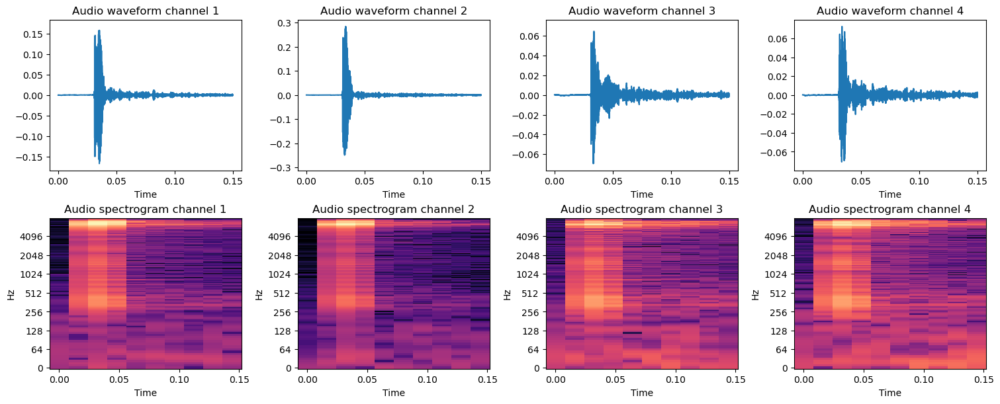

In [315]:
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]], export_name="example_signal_and_specs.pdf", export=True)

In [27]:
label_dict = {"presence": 1, "empty": 0}

In [28]:
def get_normalize_params(inputs_set):
    list_of_mean = []
    list_of_std = []
    list_of_mean.append(inputs_set[:,:,:].mean())
    list_of_std.append(inputs_set[:,:,:].std())
    return list_of_mean, list_of_std

In [29]:
class SoundDataset(Dataset):
    def __init__(self, list_pairs, label_dict, folder, part, mean, std, transform=None):
        # assert isinstance(sound_df, pd.DataFrame)

        self.list_pairs = list_pairs
        self.transform = transform
        self.mean = mean
        self.std = std
        self.label_dict = label_dict
        self.folder = folder
        self.part = part
        # print("Transformation: ", transform)

    def __len__(self):
        return len(self.list_pairs)

    def __getitem__(self, index):
        if torch.is_tensor(index):
            index = index.tolist()

        spectrogram = self.list_pairs[index][0]
        label = self.list_pairs[index][1]
        filename = self.list_pairs[index][2]
        # print("Transformation: ", self.transform)
        if self.transform is not None:
            print("Make transform")
            spectrogram = (spectrogram-self.mean)/self.std

        if self.part == 'first':
            spectrogram = spectrogram[:,:3]
        elif self.part == 'second':
            spectrogram = spectrogram[:,3:6]
        elif self.part == 'last':
            spectrogram = spectrogram[:,6:]
        else:
            pass

        return {'spectrogram': spectrogram, 'label': np.array(label, dtype=float), 'filename': filename}

In [30]:
# Encoder Class
class Encoder(nn.Module):
    def __init__(self, input_size, hidden_size, latent_size, dropout, seq_len):
        super(Encoder, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.seq_len = seq_len
        self.lstm_1 = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=4, batch_first=True)
        self.lstm_2 = nn.LSTM(input_size=hidden_size, hidden_size=latent_size, batch_first=True)
        self.bottle_neck = nn.Linear(latent_size, latent_size)
        # self.lstm_enc = nn.LSTM(input_size=hidden_size, hidden_size=16, batch_first=True)

    def forward(self, x):
        # print("Inside encoder", x.size())
        # print(self.lstm_enc)
        # x_test = torch.rand(32, 4100, 38)
        out_lstm_1, (hn_1, cn_1) = self.lstm_1(x)
        out_lstm_2, (hn_2, cn_2) = self.lstm_2(out_lstm_1)
        # print("Out", out)
        # x, (hidden_state, cell_state) = self.LSTM1(x)  
        # out, (last_h_state, last_c_state) = self.lstm_enc(out_1)
        last_lstm_vec = hn_2[-1,:,:]
        latent_rep = self.bottle_neck(last_lstm_vec)
        return latent_rep

# Decoder Class
class Decoder(nn.Module):
    def __init__(self, input_size, hidden_size, latent_size, dropout, seq_len, use_act):
        super(Decoder, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.seq_len = seq_len
        self.use_act = use_act  # Parameter to control the last sigmoid activation - depends on the normalization used.
        self.act = nn.Sigmoid()

        # self.lstm_dec = nn.LSTM(input_size=16, hidden_size=hidden_size, batch_first=True)
        self.latent_decode = nn.Linear(latent_size, latent_size)
        self.lstm_1 = nn.LSTM(input_size=latent_size, hidden_size=hidden_size, batch_first=True)
        self.lstm_2 = nn.LSTM(input_size=hidden_size, hidden_size=hidden_size, num_layers=4, batch_first=True)
        self.fc = nn.Linear(hidden_size, input_size)

    def forward(self, z):
        # z = z.unsqueeze(1).repeat(1, self.seq_len, 1)
        dx = self.latent_decode(z)
        dx = dx.unsqueeze(1).repeat(1, self.seq_len, 1)
        # x_1, (hidden_state_1, cell_state_1) = self.lstm_dec(dx)
        out_lstm_1, (hn_1, cn_1) = self.lstm_1(dx)
        out_lstm_2, (hn_2, cn_2) = self.lstm_2(out_lstm_1)
        x_dec = out_lstm_2.reshape((-1, self.seq_len, self.hidden_size))
        out = self.fc(x_dec)

        return out

# LSTM Auto-Encoder Class
class LSTMAE(nn.Module):
    def __init__(self, input_size, hidden_size, latent_size, dropout_ratio, seq_len, use_act=False):
        super(LSTMAE, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.latent_size = latent_size
        self.dropout_ratio = dropout_ratio
        self.seq_len = seq_len

        self.encoder = Encoder(input_size=input_size, hidden_size=hidden_size, latent_size=latent_size, dropout=dropout_ratio, seq_len=seq_len)
        self.decoder = Decoder(input_size=input_size, hidden_size=hidden_size, latent_size=latent_size, dropout=dropout_ratio, seq_len=seq_len, use_act=use_act)

    def forward(self, x, return_last_h=False, return_enc_out=False):
        # print("Inside LSTM AE", x.size())
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded

class LSTMAEPRED(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_ratio, seq_len, use_act=True):
        super(LSTMAEPRED, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout_ratio = dropout_ratio
        self.seq_len = seq_len
        self.use_act = use_act  # Parameter to control the last sigmoid activation - depends on the normalization used.

        # AE
        self.lstmae = LSTMAE(input_size=input_size, hidden_size=hidden_size, dropout_ratio=dropout_ratio, seq_len=seq_len, use_act=use_act)

        # Prediction layers
        self.pred_fc = nn.Linear(hidden_size, input_size)
        self.sig = nn.Sigmoid()

    def forward(self, x):
        # Calculate AE reconstruction
        rec_out, enc_out = self.lstmae(x, return_enc_out=True)

        # Calculate Prediction sequence
        if self.use_act:
            pred_out = self.sig(self.pred_fc(enc_out)).squeeze()
        else:
            pred_out = self.pred_fc(enc_out).squeeze()

        return rec_out, pred_out

# determine if the system supports CUDA
if torch.cuda.is_available():
  device = torch.device("cuda:0")
else:
  device = torch.device("cpu")
print(device)
n_freqs=257
net = LSTMAE(input_size=n_freqs*4, hidden_size=128, latent_size=16, dropout_ratio=0.2, seq_len=26).to(device)
print(net)

cuda:0
LSTMAE(
  (encoder): Encoder(
    (lstm_1): LSTM(1028, 128, num_layers=4, batch_first=True)
    (lstm_2): LSTM(128, 16, batch_first=True)
    (bottle_neck): Linear(in_features=16, out_features=16, bias=True)
  )
  (decoder): Decoder(
    (act): Sigmoid()
    (latent_decode): Linear(in_features=16, out_features=16, bias=True)
    (lstm_1): LSTM(16, 128, batch_first=True)
    (lstm_2): LSTM(128, 128, num_layers=4, batch_first=True)
    (fc): Linear(in_features=128, out_features=1028, bias=True)
  )
)


In [31]:
test_x = torch.rand(64, 26, 1028)
# stack_feat_test_x = test_x.view(64, 4100, 38)
test_enc = LSTMAE(input_size=257*4, hidden_size=128, latent_size=16, dropout_ratio=0.2, seq_len=26)
out_dec_x, out_enc_x = test_enc(test_x)
print(out_dec_x.size())
print(out_enc_x.size())

torch.Size([64, 16])
torch.Size([64, 26, 1028])


In [32]:
test_x = torch.rand(64, 26, 1028)
lstm_test = nn.LSTM(1028, 128, batch_first=True, num_layers=1)
test_out, (test_hn, test_cn) = lstm_test(test_x)
print(test_out.size())

torch.Size([64, 26, 128])


In [33]:
def log_metrics(preds, labels):
    preds = torch.stack(preds)
    preds = preds.cpu().detach().numpy()
    labels = torch.stack(labels)
    labels = labels.cpu().detach().numpy()

    '''
    ##Method 1 by taking transpose and picking each column for averaging

    auc_micro_list = []
    for i in range(n_labels):
      current_pred = preds.T[i]
      current_label = labels.T[i]
      fpr_micro, tpr_micro, _ = metrics.roc_curve(current_label.T, current_pred.T)
      auc_micro = metrics.auc(fpr_micro, tpr_micro)
      auc_micro_list.append(auc_micro)

    return {"auc": np.array(auc_micro).mean()}
    '''

    ## Method 2 using ravel()
    fpr_micro, tpr_micro, _ = metrics.roc_curve(labels.ravel(), preds.ravel())
    auc_micro = metrics.auc(fpr_micro, tpr_micro)

    return {"auc_micro": auc_micro}

def log_confusion_matrix(preds, labels, label_dict):
    # preds = torch.stack(preds)
    preds = preds.cpu().detach().numpy().astype(int)
    # labels = torch.stack(labels)
    labels = labels.cpu().detach().numpy().astype(int)
    print("preds: ")
    print(preds)
    print(preds.shape)
    print("labels: ")
    print(labels)
    print(labels.shape)
    # print("Check equal")
    # print(np.array_equal(labels, preds))
    confusion_mtx = metrics.confusion_matrix(labels, preds)
    print(confusion_mtx)
    cls_report = metrics.classification_report(labels, preds, target_names=['empty', 'presence'], output_dict=True)
    print(cls_report)
    return cls_report

In [34]:
def init_model(label_dict, input_size, hidden_size, latent_size, seq_len):
    # determine if the system supports CUDA
    if torch.cuda.is_available():
      device = torch.device("cuda:0")
    else:
      device = torch.device("cpu")

    # init model
    net = LSTMAE(input_size=input_size, hidden_size=hidden_size, latent_size=latent_size, dropout_ratio=0.2, seq_len=seq_len).to(device)
    # print(net)

    return net

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def train_model(criterion, epoch, model, optimizer, train_iter, batch_size, clip_val, log_interval, scheduler=None):
    """
    Function to run training epoch
    :param criterion: loss function to use
    :param epoch: current epoch index
    :param model: pytorch model object
    :param model_type: model type (only ae/ ae+clf), used to know if needs to calculate accuracy
    :param optimizer: optimizer to use
    :param train_iter: train dataloader
    :param batch_size: size of batch (for logging)
    :param clip_val: gradient clipping value
    :param log_interval: interval to log progress
    :param scheduler: learning rate scheduler, optional.
    :return mean train loss (and accuracy if in clf mode)
    """
    model_type = "LSTMAE"
    model.train()
    loss_sum = 0
    pred_loss_sum = 0
    correct_sum = 0
    torch.manual_seed(0)

    num_samples_iter = 0
    # pbar = tqdm(total=len(train_iter.dataset))
    for batch_idx, data in tqdm(enumerate(train_iter, 1), position=0, leave=True, desc="Training Step"):
        if len(data) == 3:
            x, labels, filename = data['spectrogram'].to(device), data['label'].to(device), data['filename']
            x = torch.permute(x, (0, 2, 1))
            h0 = torch.zeros(1, x.size()[0], model.encoder.hidden_size)
            c0 = torch.zeros(1, x.size()[0], model.encoder.hidden_size)
        else:
            x = data.to(device)
        # Zero gradients
        optimizer.zero_grad()

        num_samples_iter += x.size()[0]  # Count number of samples seen in epoch (used for later statistics)

        # model.encoder.lstm_enc.flatten_parameters()
        # Forward pass & loss calculation
        # print("Input")
        # print(x[0])
        # print(x[10])
        model_enc_out, model_dec_out = model(x)
        # print("encoded out")
        # print(model_enc_out)
        if model_type == 'LSTMAE_CLF':
            # For MNIST classifier
            model_out, out_labels = model_out
            pred = out_labels.max(1, keepdim=True)[1]
            correct_sum += pred.eq(labels.view_as(pred)).sum().item()
            # Calculate loss
            mse_loss, ce_loss = criterion(model_out, data, out_labels, labels)
            loss = mse_loss + ce_loss
        elif model_type == 'LSTMAE_PRED':
            # For S&P prediction
            model_out, preds = model_out
            labels = data.squeeze()[:, 1:]  # Take x_t+1 as y_t
            preds = preds[:, :-1]  # Take preds up to T-1
            mse_rec, mse_pred = criterion(model_out, data, preds, labels)
            loss = mse_rec + mse_pred
            pred_loss_sum += mse_pred.item()
        else:
            # Calculate loss
            loss = criterion(model_dec_out, x)

        # Backward pass
        loss.backward()
        print(f"Loss at batch {batch_idx}: {loss.detach().item()}")
        loss_sum += loss.item()

        # Gradient clipping
        if clip_val is not None:
            torch.nn.utils.clip_grad_norm_(model.parameters(), clip_val)

        # Update model params
        optimizer.step()
        # pbar.update(1)

    train_loss = loss_sum / (len(train_iter.dataset)/batch_size)
    print('Train Epoch: {} [{} samples]\tLoss: {:.8f}'.format(
                epoch, len(train_iter.dataset), train_loss))
    train_pred_loss = pred_loss_sum / (len(train_iter.dataset)/batch_size)
    train_acc = round(correct_sum / (len(train_iter.dataset)/batch_size) * 100, 2)
    acc_out_str = f'; Average Accuracy: {train_acc}' if model_type == 'LSTMAECLF' else ''
    print(f'Train Average Loss: {train_loss}{acc_out_str}')

    return train_loss, train_acc, train_pred_loss


def eval_model(criterion, model, val_iter, batch_size, mode='Validation'):
    """
    Function to run validation on given model
    :param criterion: loss function
    :param model: pytorch model object
    :param model_type: model type (only ae/ ae+clf), used to know if needs to calculate accuracy
    :param val_iter: validation dataloader
    :param mode: mode: 'Validation' or 'Test' - depends on the dataloader given.Used for logging
    :return mean validation loss (and accuracy if in clf mode)
    """
    # Validation loop
    model_type = "LSTMAE"
    model.eval()
    loss_sum = 0
    correct_sum = 0
    with torch.no_grad():
        for data in tqdm(val_iter, position=0, leave=True, desc="Validation Step"):
            if len(data) == 3:
                x, labels, filename = data['spectrogram'].to(device), data['label'].to(device), data['filename']
                x = torch.permute(x, (0, 2, 1))
                h0 = torch.zeros(1, x.size()[0], model.encoder.hidden_size)
                c0 = torch.zeros(1, x.size()[0], model.encoder.hidden_size)
            else:
                x = data.to(device)
            # model.encoder.lstm_enc.flatten_parameters()
            # print("Input val")
            # print(x[0])
            # print(x[10])
            model_enc_out, model_dec_out = model(x)
            # print(model_dec_out)
            if model_type == 'LSTMAE_CLF':
                model_out, out_labels = model_out
                pred = out_labels.max(1, keepdim=True)[1]
                correct_sum += pred.eq(labels.view_as(pred)).sum().item()
                # Calculate loss
                mse_loss, ce_loss = criterion(model_out, data, out_labels, labels)
                loss = mse_loss + ce_loss
            elif model_type == 'LSTMAE_PRED':
                # For S&P prediction
                model_out, preds = model_out
                labels = data.squeeze()[:, 1:]  # Take x_t+1 as y_t
                preds = preds[:, :-1]  # Take preds up to T-1
                mse_rec, mse_pred = criterion(model_out, data, preds, labels)
                loss = mse_rec + mse_pred
            else:
                # Calculate loss for none clf models
                loss = criterion(model_dec_out, x)

            loss_sum += loss.item()
    val_loss = loss_sum / (len(val_iter.dataset)/batch_size)
    val_acc = round(correct_sum / len(val_iter.dataset) * 100, 2)
    acc_out_str = f'; Average Accuracy: {val_acc}' if model_type == 'LSTMAECLF' else ''
    print(f' {mode}: Average Loss: {val_loss}{acc_out_str}')
    return val_loss, val_acc

In [35]:
def cross_train(n_folds, train_val_pairs, label_dict, data_folder, epochs=100, batch_size=32, hidden_size=128, latent_size=16, n_freqs=257, seq_len=1, part='all', mean=0, std=0, transform=None, num_of_workers=0):

    # normalize the data
    # train_df, test_df = normalize_data(train_df, test_df)
    # n_folds = 5
    total_samples = len(train_val_pairs)
    samples_per_part = int(total_samples/n_folds)
    list_history = []
    for k in range(n_folds):
        history = {'train_loss':[],  'val_loss':[]}
        train_pairs = train_val_pairs[0:k*samples_per_part]+train_val_pairs[(k+1)*samples_per_part:]
        val_pairs = train_val_pairs[k*samples_per_part:(k+1)*samples_per_part]
        # print("Len of train: ", len(train_pairs))
        # print("Len of val: ", len(val_pairs))
        # init train data loader
        # print(transform)
        train_ds = SoundDataset(train_pairs, label_dict, data_folder, part, mean, std, transform=transform)
        train_loader = DataLoader(train_ds,
                                  batch_size=batch_size,
                                  shuffle = True,
                                  drop_last = True)
        val_ds = SoundDataset(val_pairs, label_dict, data_folder, part, mean, std, transform=transform)
        val_loader = DataLoader(val_ds,
                                batch_size=batch_size,
                                shuffle = False,
                                drop_last = False)
    
        # init model
        model = init_model(label_dict, input_size=n_freqs*4, hidden_size=hidden_size, latent_size=latent_size, seq_len=seq_len)
    
        criterion = torch.nn.MSELoss(reduction='mean')
        optimizer = optim.Adam(model.parameters(), lr=0.1, eps=1e-07, weight_decay=1e-5)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.1)
        # train the model
        start_time = datetime.now()
        best_val_loss = np.inf
    
        for epoch in range(epochs):
            # Train loop
            train_loss, train_acc, _ = train_model(criterion, epoch, model, optimizer, train_loader, batch_size, clip_val=None, log_interval=10)
            history['train_loss'].append(train_loss)
            # train_acc_lst.append(train_acc)
            # if (epoch + 1) % (int(epochs / 10)) == 0:
                # plot_images(model, val_iter, description=args.model_type, num_to_plot=3)
            # Evaluate
            val_loss, val_acc = eval_model(criterion, model, val_loader, batch_size, mode='Validation')
            # LR scheduler step
            if scheduler is not None:
                scheduler.step()
            # val_acc_lst.append(val_acc)
            history['val_loss'].append(val_loss)
            if val_loss < best_val_loss:
              best_model_state = model.state_dict()
              history['best_model_state_dict'] = best_model_state
              torch.save(best_model_state, f'state_LSTM_AE_h_{hidden_size}_l_{latent_size}_f{n_freqs}_fold{k}_{data_folder}.pt')
              torch.save(model, f'full_best_model_LSTM_AE_h_{hidden_size}_l{latent_size}_f{n_freqs}_fold{k}_{data_folder}.pt')
              best_val_loss = val_loss
    
        end_time = datetime.now() - start_time
        print("\nTraining completed in time: {}".format(end_time))
        list_history.append(history)
    return best_model_state, list_history

In [36]:
def get_specs(list_audio, sr=16000):
  list_specs = []
  for audio in list_audio:
    # Play audio file
    y, sr = librosa.load(audio, sr=sr)
    D = librosa.stft(y, n_fft=2048, hop_length=256, win_length=1024)  # STFT of y
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    list_specs.append(S_db)
  return list_specs

def get_spec_for_one_audio(audio, length, sr=16000):
    y, sr = librosa.load(audio, sr=sr)
    y = y[:int(sr*length)]
    D = librosa.stft(y, n_fft=2048, hop_length=256, win_length=1024)  # STFT of y
    freq_bins = librosa.fft_frequencies(sr=sr, n_fft=2048)
    time_bins = librosa.frames_to_time(np.arange(D.shape[1]), sr=sr, hop_length=256)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    return S_db, freq_bins, time_bins

def get_specs_for_all_channels(scenery_pattern, length, nb_files, sr=16000):
  list_specs = []
  pattern_for_file = re.compile("^channel_1_\d+.wav$")
  list_audio_scene_1 = [f for f in glob.glob(f"{scenery_pattern}/*.wav") if re.match(pattern_for_file, re.split("/", f)[-1])]
  freq_bins = []
  time_bins = []
  missing_idx = []
  # list_audio_scene_1.sort()
  # print(len(list_audio_scene_1))  
  for i in range((nb_files)):
    if len(glob.glob(f"{scenery_pattern}/channel_1_{i}.wav")) > 0:
      spec_channel_1, freq_bins, time_bins = get_spec_for_one_audio(audio=f"{scenery_pattern}/channel_1_{i}.wav", length=length, sr=sr)
      print(spec_channel_1.shape)
      spec_channel_2, _, _ = get_spec_for_one_audio(audio=f"{scenery_pattern}/channel_2_{i}.wav", length=length, sr=sr)
      spec_channel_3, _, _ = get_spec_for_one_audio(audio=f"{scenery_pattern}/channel_3_{i}.wav", length=length, sr=sr)
      spec_channel_4, _, _ = get_spec_for_one_audio(audio=f"{scenery_pattern}/channel_4_{i}.wav", length=length, sr=sr)
      combined_specs = np.concatenate((spec_channel_1, spec_channel_2, spec_channel_3, spec_channel_4), axis=0)
      # print(combined_specs.shape)
      list_specs.append(combined_specs)
    else:
      print("Missing specs idx: ", i)
      missing_idx.append(i)
  return list_specs, freq_bins, time_bins, missing_idx

In [37]:
def spec_normalization(data):
    max_data = np.max(data)
    min_data = np.min(data)
    new_data = (data - min_data) / (max_data - min_data + 0.0001)
    return new_data

def get_normalized_specs(list_specs):
  new_list_normalized_specs = []
  for spec in list_specs:
    new_list_normalized_specs.append(spec_normalization(spec))
  return new_list_normalized_specs

In [38]:
def show_results(histories):
    """Show accuracy and loss graphs for train and test sets."""

    # for i, history in enumerate(tot_history):
        # print('\n({})'.format(i+1))
    
    fig, axes = plt.subplots(5,1, layout='constrained', figsize=(10, 20))
    for idx, his in enumerate(histories):
        axes[idx].plot(his['train_loss'])
        axes[idx].plot(his['val_loss'])
        axes[idx].grid(linestyle='--')
        axes[idx].set_ylabel('Loss')
        axes[idx].set_xlabel('Epoch')
        axes[idx].legend(['train', 'validation'], loc='upper left')
        print('\tMin validation loss: %.5f' % np.min(his['val_loss']))
    # plt.figsize(15,20)
    plt.show()

    # print('\tMax validation acc: %.4f %%' % (np.max(history['val_acc']) * 100))
    # print('\tMax validation f1: %.4f %%' % (np.max(val_f1) * 100))
    

(1025, 10)
samples: [ 6.1035156e-05  1.5258789e-04  2.4414062e-04 ...  1.1596680e-03
 -2.3193359e-03  2.0446777e-03]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 1.2207031e-04  1.5258789e-04  1.8310547e-04 ... -1.6479492e-03
  6.7138672e-04  3.0517578e-05]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.0000000e+00 -1.5258789e-04 -3.0517578e-05 ... -3.6621094e-04
  1.3427734e-03 -2.2888184e-03]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-0.00012207 -0.00018311 -0.00027466 ... -0.0012207   0.00131226
 -0.00393677]
shape of samples: (2400,)
sample_rate: 16000


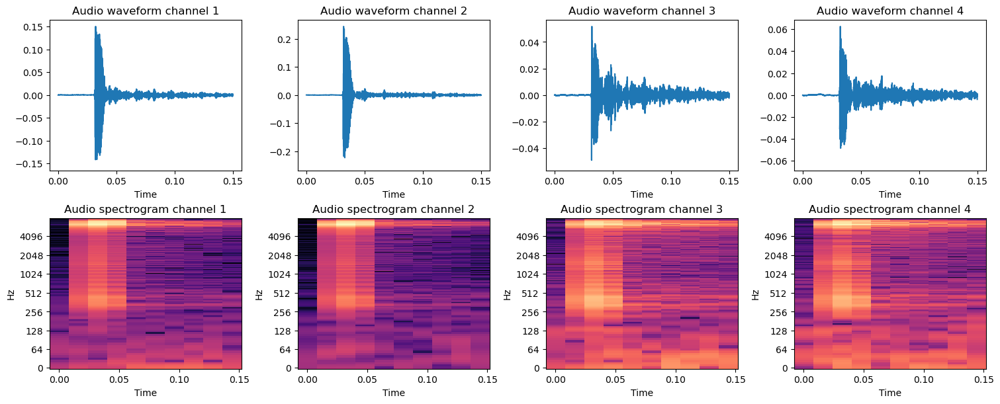

In [301]:
ridx=1
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [ 3.3569336e-04  3.0517578e-04  2.7465820e-04 ...  1.8615723e-03
 -1.8310547e-04  3.0517578e-05]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00021362  0.00015259  0.00030518 ...  0.00231934 -0.00253296
  0.00256348]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.0000000e+00  9.1552734e-05  3.0517578e-05 ...  1.5869141e-03
  1.2512207e-03 -8.2397461e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00039673  0.00048828  0.00045776 ...  0.00134277 -0.0010376
  0.00164795]
shape of samples: (2400,)
sample_rate: 16000


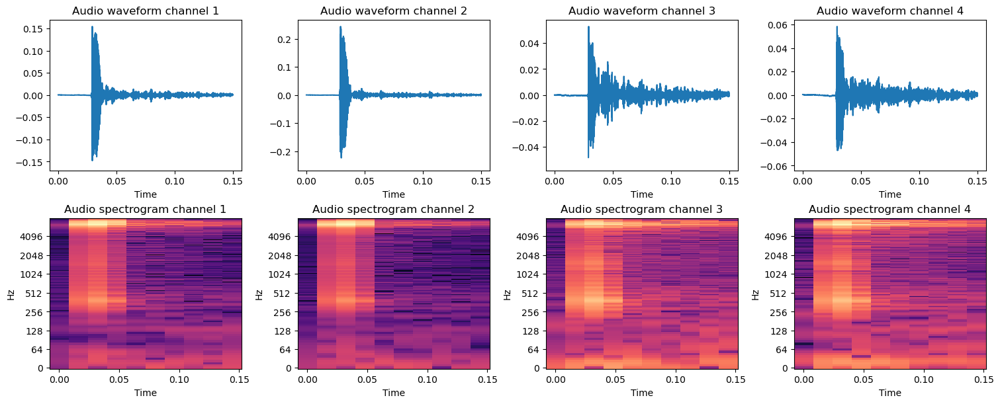

In [302]:
ridx=3125
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [ 9.1552734e-05  1.2207031e-04  6.1035156e-05 ...  1.6174316e-03
 -1.8920898e-03  1.5258789e-03]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00012207  0.00012207  0.00024414 ... -0.00152588 -0.00042725
  0.00213623]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-1.2207031e-04  3.0517578e-05  6.1035156e-05 ...  2.1362305e-04
  6.1035156e-05 -3.9672852e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-3.0517578e-05  6.1035156e-05 -3.0517578e-05 ... -1.3427734e-03
 -6.1035156e-05  6.1035156e-05]
shape of samples: (2400,)
sample_rate: 16000


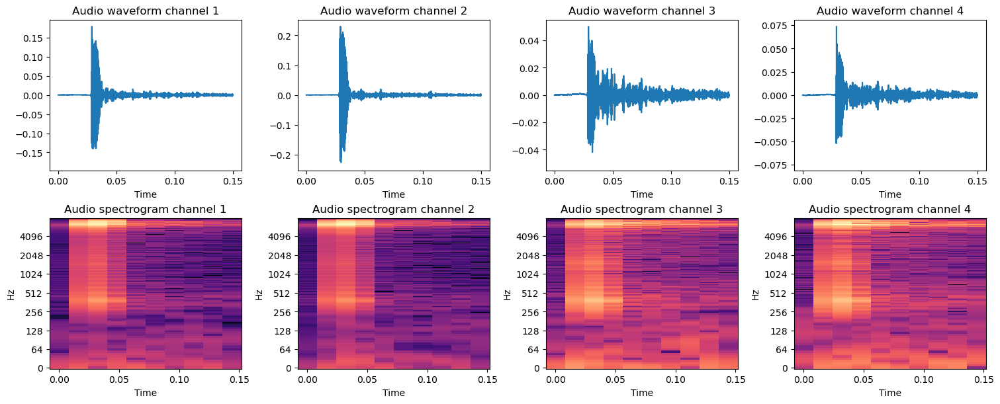

In [303]:
ridx=5055
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [-0.00027466 -0.00024414 -0.00045776 ...  0.00061035 -0.00079346
  0.0005188 ]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 6.1035156e-05  2.1362305e-04  3.0517578e-04 ... -1.4953613e-03
  1.1901855e-03 -1.1291504e-03]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-0.00042725 -0.0005188  -0.00030518 ... -0.00027466 -0.00036621
  0.00137329]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [3.6621094e-04 3.9672852e-04 3.3569336e-04 ... 6.1035156e-05 2.1362305e-04
 3.0517578e-05]
shape of samples: (2400,)
sample_rate: 16000


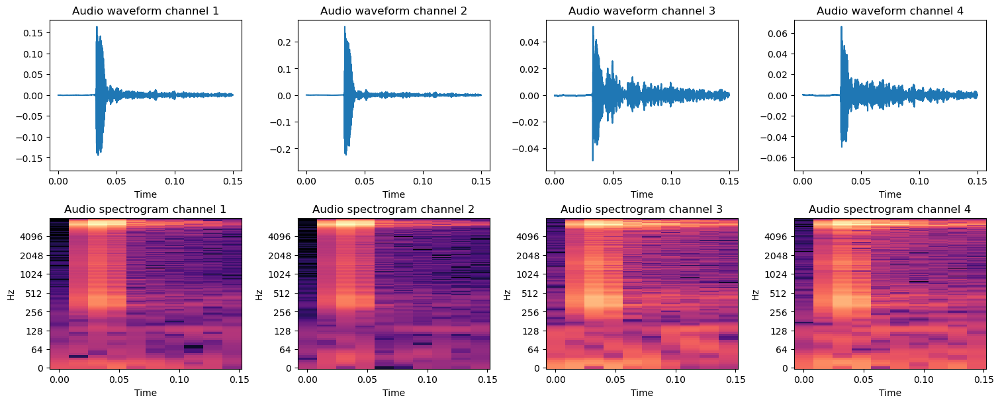

In [304]:
ridx=5123
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [-0.0005188  -0.00036621 -0.00033569 ... -0.00085449 -0.0005188
  0.0015564 ]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00036621  0.00036621  0.00042725 ...  0.00091553 -0.00076294
  0.00064087]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-6.1035156e-05 -3.0517578e-05  6.1035156e-05 ... -3.9672852e-04
  2.4414062e-04 -5.7983398e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [3.0517578e-05 0.0000000e+00 6.1035156e-05 ... 4.2724609e-04 2.1362305e-04
 1.5258789e-04]
shape of samples: (2400,)
sample_rate: 16000


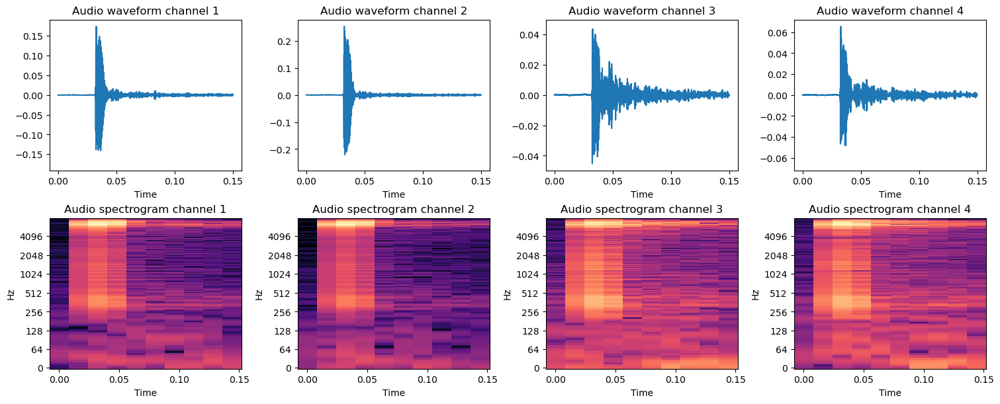

In [305]:
ridx=5523
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [-3.0517578e-05  3.0517578e-05  0.0000000e+00 ...  6.1035156e-05
  5.1879883e-04  7.9345703e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-0.00018311 -0.00015259 -0.00012207 ...  0.00018311 -0.00115967
  0.00183105]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-3.0517578e-05  3.0517578e-05  6.1035156e-05 ... -7.6293945e-04
  1.8615723e-03 -1.5258789e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00018311  0.00018311  0.         ...  0.00134277 -0.00079346
  0.00082397]
shape of samples: (2400,)
sample_rate: 16000


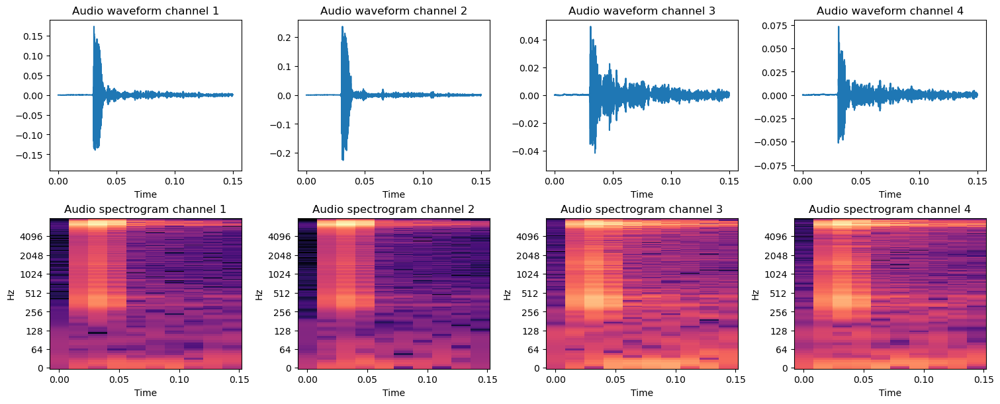

In [306]:
ridx=7555
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [-0.00054932 -0.00033569 -0.00027466 ... -0.0007019   0.00134277
 -0.00311279]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 6.1035156e-05  0.0000000e+00  1.5258789e-04 ... -5.4931641e-04
  7.3242188e-04  7.6293945e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-1.2207031e-04 -1.2207031e-04 -6.1035156e-05 ... -9.4604492e-04
 -1.0375977e-03 -3.6621094e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [-6.1035156e-05  0.0000000e+00  0.0000000e+00 ... -3.2653809e-03
  2.1362305e-03 -1.1901855e-03]
shape of samples: (2400,)
sample_rate: 16000


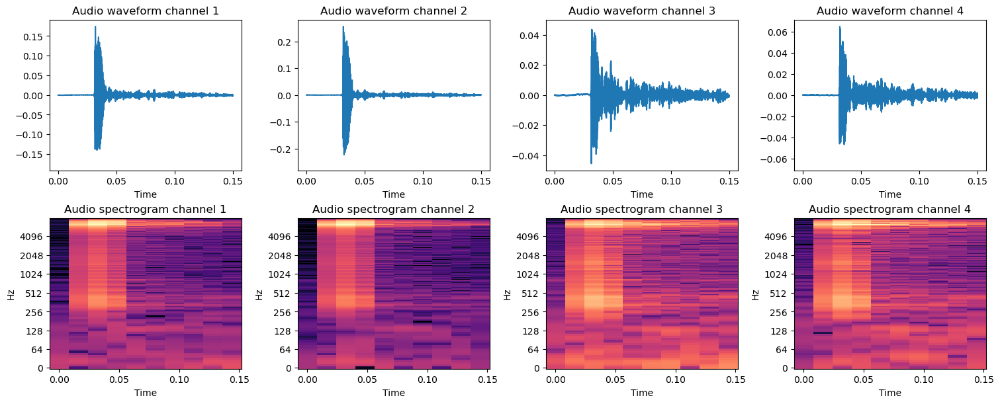

In [307]:
ridx=7623
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

(1025, 10)
samples: [-0.00012207 -0.00015259 -0.00018311 ...  0.00125122 -0.00030518
 -0.00015259]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 3.0517578e-05  6.1035156e-05  9.1552734e-05 ... -1.8310547e-03
 -9.1552734e-05  8.8500977e-04]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00024414  0.00024414  0.00024414 ... -0.00183105  0.00137329
 -0.00048828]
shape of samples: (2400,)
sample_rate: 16000
(1025, 10)
samples: [ 0.00018311  0.00024414  0.00012207 ... -0.00222778  0.00305176
 -0.00253296]
shape of samples: (2400,)
sample_rate: 16000


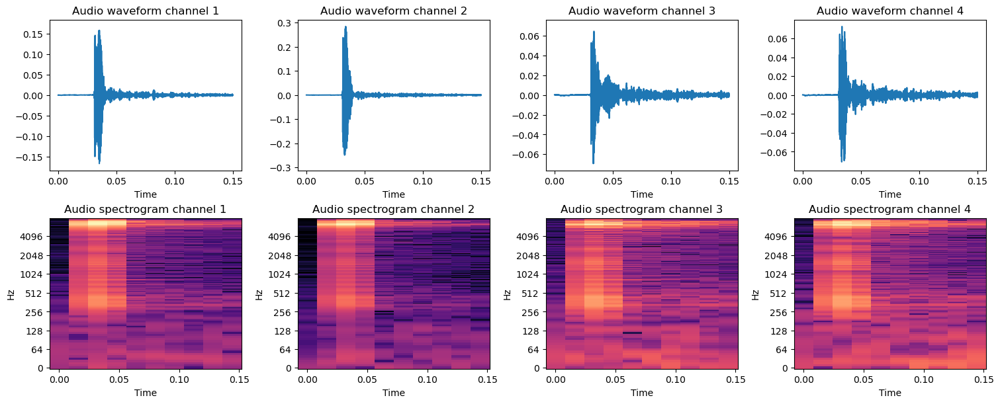

In [308]:
ridx=8023
analyze_channel_sample(list_samples=[list_audio_nt1_c1[ridx], list_audio_nt1_c2[ridx], list_audio_nt1_c3[ridx], list_audio_nt1_c4[ridx]])

In [47]:
# list_specs_human, freq_bins, time_bins = get_specs_for_all_channels(f"{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_s1", length=0.1, sr=16000)
list_specs, freq_bins, time_bins, missing_idx = get_specs_for_all_channels(f"{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1", length=0.15, nb_files=10000, sr=16000)

(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)
(1025, 10)

In [48]:
print(missing_idx)

[]


In [49]:
print(freq_bins)
print(time_bins)

[0.0000000e+00 7.8125000e+00 1.5625000e+01 ... 7.9843750e+03 7.9921875e+03
 8.0000000e+03]
[0.    0.016 0.032 0.048 0.064 0.08  0.096 0.112 0.128 0.144]


In [50]:
print(len(time_bins))

10


In [344]:
def cmap(data, robust: bool = True, cmap_seq: str = "magma", cmap_bool: str = "gray_r", cmap_div: str = "coolwarm"):
    data = np.atleast_1d(data)

    if data.dtype == "bool":
        return mcm[cmap_bool]

    data = data[np.isfinite(data)]

    if robust:
        min_p, max_p = 2, 98
    else:
        min_p, max_p = 0, 100

    min_val, max_val = np.percentile(data, [min_p, max_p])

    if min_val >= 0 or max_val <= 0:
        return mcm[cmap_seq]

    return mcm[cmap_div]

def plot_spec_from_data(data, x_coord, y_coord, ax):
    # fig, ax = plt.subplots()
    ax.pcolormesh(x_coord, y_coord, data, cmap=cmap(data))
    ax.set_yscale(value = "symlog", base = 2, linthresh = float(librosa.core.note_to_hz("C2")), linscale = 0.5)
    ax.yaxis.set_major_formatter(mplticker.ScalarFormatter())
    ax.yaxis.set_major_locator(mplticker.SymmetricalLogLocator(ax.yaxis.get_transform()))
    ax.yaxis.set_label_text("Hz")

def plot_spec_for_channels_from_data(specs_data, n_fft, x_coord, y_coord, export_name="test", format="pdf", backend="agg", export=True):
    
    data_c1_example = specs_data[:n_fft,:]
    data_c2_example = specs_data[n_fft:n_fft*2,:]
    data_c3_example = specs_data[n_fft*2:n_fft*3,:]
    data_c4_example = specs_data[n_fft*3:,:]
    data_list = [data_c1_example, data_c2_example, data_c3_example, data_c4_example]
    fig, axes = plt.subplots(1, 4, figsize=(15, 2), constrained_layout=True)
    for c in range(4):
        plot_spec_from_data(data_list[c], x_coord, y_coord, axes[c])
    if export:
      plt.savefig(export_name, format=format, bbox_inches="tight", dpi=100)  
    plt.show()

In [52]:
list_audio_files_human = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_s1/*.wav") if re.match(re.compile("^channel_1_\d+.wav$"), re.split("/", f)[-1])]
list_audio_files_human.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(len(list_audio_files_human))
print(list_audio_files_human[:5])
list_audio_files_empty = [f for f in glob.glob(f"./{main_folder}/recording_data_chirp_6kHz_8kHz_10ms_{main_folder.replace('_deployment', '').lower()}_nt1/*.wav") if re.match(re.compile("^channel_1_\d+.wav$"), re.split("/", f)[-1])]
list_audio_files_empty.sort(key=lambda s: int(s.split('/')[-1].split('_')[-1].replace('.wav','')))
print(len(list_audio_files_empty))
print(list_audio_files_empty[:5])

0
[]
10000
['./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_0.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_1.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_2.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_3.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_4.wav']


In [53]:
from datetime import datetime

In [54]:
y = [0 for _ in range(5000)] + [1 for _ in range(5000, 6500)] + [0 for _ in range(6500, 7500)] + [1 for _ in range(7500, 9000)] + [0 for _ in range(9000, 10000)]

In [55]:
print(len(list_specs))

10000


In [56]:
for i in missing_idx:
    print(i)
    del y[i]

In [57]:
print(len(y))

10000


In [58]:
np.count_nonzero(np.array(y))

3000

In [59]:
list_files_nt1 = list_files_nt1[0::6]

In [60]:
print(list_files_nt1[:5])

['./LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_0.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_2_1.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_2.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_3.wav', './LR218_deployment/recording_data_chirp_6kHz_8kHz_10ms_lr218_nt1/channel_1_4.wav']


In [61]:
print(len(list_specs))
print(len(y))
print(len(list_files_nt1))

10000
10000
10000


In [84]:
combined_pairs = [(t[0], t[1], t[2]) for t in zip(list_specs, y, list_files_nt1)]
train_val_pairs = combined_pairs[1:5000]
# random.shuffle(train_val_pairs)
# train_pairs = train_val_pairs[:4000]
val_pairs = combined_pairs[5000:7500]
test_pairs = combined_pairs[7500:]

# hold_out_pairs = [(t[0], t[1], t[2]) for t in zip(list_specs_human, y_human, list_audio_files_human)]

In [63]:
hold_out_pairs = None

In [64]:
print("length of train and val: ", len(train_val_pairs))
# print("length of val: ", len(val_pairs))
print("length of test: ", len(test_pairs))

length of train and val:  4999
length of test:  2500


In [65]:
train_val_pairs[0][0].shape

(4100, 10)

In [66]:
list_of_mean, list_of_std = get_normalize_params(np.array([t[0] for t in train_val_pairs]))
print(list_of_mean)
print(list_of_std)
# spec_transforms = transforms.Normalize(mean=list_of_mean, std=list_of_std)

[-41.98041]
[16.049435]


In [67]:
seq_len=10
epochs=500
batch_size=64
hidden_size=128
latent_size=64
n_freqs=1025
best_model_state, histories = cross_train(n_folds=5, train_val_pairs=train_val_pairs, label_dict=label_dict, data_folder=main_folder, 
                                        epochs=epochs, batch_size=batch_size, hidden_size=hidden_size, latent_size=latent_size, 
                                        n_freqs=n_freqs, seq_len=seq_len, part='full', mean=list_of_mean[0], std=list_of_std[0], 
                                        transform=None, num_of_workers=0)

Training Step: 2it [00:00, 18.65it/s]

Loss at batch 1: 2012.4810791015625
Loss at batch 2: 1548.2918701171875
Loss at batch 3: 1229.7086181640625
Loss at batch 4: 939.7445678710938
Loss at batch 5: 679.1927490234375
Loss at batch 6: 498.4078369140625
Loss at batch 7: 358.137451171875
Loss at batch 8: 280.3055419921875
Loss at batch 9: 236.44935607910156
Loss at batch 10: 228.8422088623047
Loss at batch 11: 227.88250732421875
Loss at batch 12: 225.31399536132812
Loss at batch 13: 221.00831604003906
Loss at batch 14: 223.89588928222656
Loss at batch 15: 227.3696746826172


Training Step: 24it [00:00, 132.04it/s]

Loss at batch 16: 226.685546875
Loss at batch 17: 228.75389099121094
Loss at batch 18: 217.93301391601562
Loss at batch 19: 207.9747314453125
Loss at batch 20: 199.6731719970703
Loss at batch 21: 193.26856994628906
Loss at batch 22: 188.014404296875
Loss at batch 23: 180.1128692626953
Loss at batch 24: 178.0171661376953
Loss at batch 25: 166.9936981201172
Loss at batch 26: 163.10568237304688
Loss at batch 27: 163.19113159179688
Loss at batch 28: 164.78530883789062
Loss at batch 29: 160.26724243164062
Loss at batch 30: 161.569580078125
Loss at batch 31: 156.10020446777344
Loss at batch 32: 156.83599853515625
Loss at batch 33: 157.79762268066406
Loss at batch 34: 160.79269409179688
Loss at batch 35: 158.36424255371094
Loss at batch 36: 155.62069702148438


Training Step: 48it [00:00, 176.97it/s]

Loss at batch 37: 157.889404296875
Loss at batch 38: 160.56214904785156
Loss at batch 39: 152.96238708496094
Loss at batch 40: 154.35337829589844
Loss at batch 41: 157.23146057128906
Loss at batch 42: 155.6350555419922
Loss at batch 43: 155.40896606445312
Loss at batch 44: 152.64019775390625
Loss at batch 45: 152.0025634765625
Loss at batch 46: 153.02273559570312
Loss at batch 47: 150.2174072265625
Loss at batch 48: 154.09475708007812
Loss at batch 49: 153.96607971191406
Loss at batch 50: 154.80345153808594
Loss at batch 51: 159.04920959472656
Loss at batch 52: 155.1921844482422
Loss at batch 53: 154.71246337890625
Loss at batch 54: 150.71006774902344
Loss at batch 55: 150.2340545654297
Loss at batch 56: 150.6617431640625
Loss at batch 57: 151.33746337890625
Loss at batch 58: 151.4973907470703
Loss at batch 59: 152.31007385253906
Loss at batch 60: 152.93104553222656
Loss at batch 61: 148.85691833496094


Training Step: 62it [00:00, 163.98it/s]


Loss at batch 62: 152.40234375
Train Epoch: 0 [4000 samples]	Loss: 270.04118530
Train Average Loss: 270.0411853027344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 375.14it/s]


 Validation: Average Loss: 164.33605089464464


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 149.09881591796875
Loss at batch 2: 151.45028686523438
Loss at batch 3: 147.9980926513672


Training Step: 22it [00:00, 214.00it/s]

Loss at batch 4: 153.7714385986328
Loss at batch 5: 145.68133544921875
Loss at batch 6: 152.99363708496094
Loss at batch 7: 147.93345642089844
Loss at batch 8: 151.54689025878906
Loss at batch 9: 148.53408813476562
Loss at batch 10: 151.78173828125
Loss at batch 11: 152.5104522705078
Loss at batch 12: 152.51126098632812
Loss at batch 13: 151.89208984375
Loss at batch 14: 153.27430725097656
Loss at batch 15: 149.5283966064453
Loss at batch 16: 151.1041717529297
Loss at batch 17: 153.50074768066406
Loss at batch 18: 150.56643676757812
Loss at batch 19: 150.81373596191406
Loss at batch 20: 149.07920837402344
Loss at batch 21: 150.472900390625
Loss at batch 22: 149.24818420410156
Loss at batch 23: 148.69383239746094
Loss at batch 24: 152.0471649169922
Loss at batch 25: 145.21604919433594
Loss at batch 26: 145.73255920410156
Loss at batch 27: 147.70933532714844
Loss at batch 28: 150.16488647460938
Loss at batch 29: 146.22975158691406
Loss at batch 30: 147.2250518798828
Loss at batch 31: 142

Training Step: 44it [00:00, 214.14it/s]

Loss at batch 38: 138.7881317138672
Loss at batch 39: 130.19313049316406
Loss at batch 40: 129.41607666015625
Loss at batch 41: 130.59263610839844
Loss at batch 42: 130.9012908935547
Loss at batch 43: 129.27777099609375
Loss at batch 44: 123.3607406616211
Loss at batch 45: 123.0552749633789
Loss at batch 46: 120.17428588867188
Loss at batch 47: 119.77037811279297


Training Step: 62it [00:00, 212.57it/s]


Loss at batch 48: 120.47577667236328
Loss at batch 49: 117.8167495727539
Loss at batch 50: 116.66976165771484
Loss at batch 51: 117.91973114013672
Loss at batch 52: 115.12863159179688
Loss at batch 53: 114.00447082519531
Loss at batch 54: 110.732666015625
Loss at batch 55: 109.88314056396484
Loss at batch 56: 108.60599517822266
Loss at batch 57: 108.02587127685547
Loss at batch 58: 107.12688446044922
Loss at batch 59: 105.99568176269531
Loss at batch 60: 106.43185424804688
Loss at batch 61: 104.1317138671875
Loss at batch 62: 105.15226745605469
Train Epoch: 1 [4000 samples]	Loss: 134.85300647
Train Average Loss: 134.85300646972655


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.08it/s]


 Validation: Average Loss: 112.35358551911287


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 106.97239685058594
Loss at batch 2: 104.93953704833984
Loss at batch 3: 102.01354217529297
Loss at batch 4: 102.47686004638672
Loss at batch 5: 101.52122497558594
Loss at batch 6: 103.37090301513672
Loss at batch 7: 102.0514144897461
Loss at batch 8: 101.350341796875
Loss at batch 9: 100.24503326416016
Loss at batch 10: 100.2471694946289
Loss at batch 11: 101.52800750732422


Training Step: 22it [00:00, 213.31it/s]

Loss at batch 12: 100.62765502929688
Loss at batch 13: 100.02444458007812
Loss at batch 14: 99.98918151855469
Loss at batch 15: 99.79019927978516
Loss at batch 16: 99.41148376464844
Loss at batch 17: 98.41526794433594
Loss at batch 18: 99.1114273071289
Loss at batch 19: 101.17151641845703
Loss at batch 20: 109.26521301269531
Loss at batch 21: 97.81562805175781
Loss at batch 22: 97.82711791992188
Loss at batch 23: 101.82781219482422
Loss at batch 24: 98.53751373291016
Loss at batch 25: 102.28057098388672
Loss at batch 26: 104.65972900390625
Loss at batch 27: 97.5239486694336
Loss at batch 28: 97.8862075805664
Loss at batch 29: 96.75161743164062
Loss at batch 30: 101.38245391845703
Loss at batch 31: 98.18791961669922
Loss at batch 32: 94.10698699951172
Loss at batch 33: 95.54764556884766
Loss at batch 34: 107.13705444335938
Loss at batch 35: 105.18324279785156
Loss at batch 36: 97.70126342773438
Loss at batch 37: 99.12959289550781
Loss at batch 38: 94.86917877197266


Training Step: 45it [00:00, 218.56it/s]

Loss at batch 39: 94.43314361572266
Loss at batch 40: 98.21514129638672
Loss at batch 41: 94.34658813476562
Loss at batch 42: 96.44952392578125
Loss at batch 43: 93.43756103515625
Loss at batch 44: 92.67451477050781
Loss at batch 45: 91.85049438476562
Loss at batch 46: 85.77011108398438
Loss at batch 47: 113.1545181274414
Loss at batch 48: 93.85498809814453
Loss at batch 49: 92.41942596435547
Loss at batch 50: 93.16358184814453
Loss at batch 51: 94.71137237548828
Loss at batch 52: 95.74957275390625
Loss at batch 53: 94.92255401611328
Loss at batch 54: 92.9478530883789
Loss at batch 55: 91.65123748779297
Loss at batch 56: 91.3616943359375


Training Step: 62it [00:00, 220.41it/s]


Loss at batch 57: 92.33965301513672
Loss at batch 58: 100.01346588134766
Loss at batch 59: 106.2699966430664
Loss at batch 60: 98.46277618408203
Loss at batch 61: 94.91573333740234
Loss at batch 62: 92.30897521972656
Train Epoch: 2 [4000 samples]	Loss: 97.73284448
Train Average Loss: 97.73284448242188


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.39it/s]


 Validation: Average Loss: 94.22791639295545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 92.39978790283203
Loss at batch 2: 90.61398315429688
Loss at batch 3: 89.71106719970703
Loss at batch 4: 89.74176788330078
Loss at batch 5: 89.21890258789062
Loss at batch 6: 91.09197998046875
Loss at batch 7: 94.57891082763672
Loss at batch 8: 90.06710815429688
Loss at batch 9: 89.41841125488281
Loss at batch 10: 89.62294006347656
Loss at batch 11: 89.26290130615234
Loss at batch 12: 93.38885498046875
Loss at batch 13: 91.77195739746094
Loss at batch 14: 89.10380554199219
Loss at batch 15: 88.29537963867188
Loss at batch 16: 88.1761474609375
Loss at batch 17: 89.34921264648438
Loss at batch 18: 89.71903228759766
Loss at batch 19: 89.5481948852539


Training Step: 21it [00:00, 202.65it/s]

Loss at batch 20: 88.04308319091797
Loss at batch 21: 88.11206817626953
Loss at batch 22: 87.50776672363281
Loss at batch 23: 88.21475219726562
Loss at batch 24: 86.82677459716797
Loss at batch 25: 85.61251068115234
Loss at batch 26: 85.53934478759766
Loss at batch 27: 85.96204376220703
Loss at batch 28: 86.27249908447266
Loss at batch 29: 87.0338363647461
Loss at batch 30: 85.22522735595703
Loss at batch 31: 84.71136474609375
Loss at batch 32: 99.45841979980469
Loss at batch 33: 90.19779205322266
Loss at batch 34: 85.12239074707031
Loss at batch 35: 86.6986312866211
Loss at batch 36: 84.48545837402344
Loss at batch 37: 86.4733657836914
Loss at batch 38: 88.58731842041016
Loss at batch 39: 96.3105239868164
Loss at batch 40: 92.05779266357422
Loss at batch 41: 119.76881408691406
Loss at batch 42: 114.97987365722656


Training Step: 43it [00:00, 207.17it/s]

Loss at batch 43: 91.15860748291016
Loss at batch 44: 90.4677734375
Loss at batch 45: 122.61570739746094
Loss at batch 46: 129.1565399169922
Loss at batch 47: 105.81150817871094
Loss at batch 48: 91.41998291015625
Loss at batch 49: 85.71636962890625
Loss at batch 50: 89.33781433105469
Loss at batch 51: 95.83956146240234
Loss at batch 52: 97.68622589111328
Loss at batch 53: 94.97557067871094
Loss at batch 54: 88.65679168701172
Loss at batch 55: 85.83831787109375
Loss at batch 56: 85.78587341308594
Loss at batch 57: 88.63644409179688
Loss at batch 58: 89.5997314453125
Loss at batch 59: 89.35254669189453
Loss at batch 60: 88.37476348876953
Loss at batch 61: 86.90342712402344


Training Step: 62it [00:00, 204.74it/s]


Loss at batch 62: 99.2366714477539
Train Epoch: 3 [4000 samples]	Loss: 91.11763562
Train Average Loss: 91.11763562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.87it/s]


 Validation: Average Loss: 89.21118481763013


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.29732513427734
Loss at batch 2: 85.03703308105469
Loss at batch 3: 82.48967742919922
Loss at batch 4: 87.66674041748047
Loss at batch 5: 102.51471710205078
Loss at batch 6: 86.78216552734375
Loss at batch 7: 87.81617736816406
Loss at batch 8: 89.02515411376953
Loss at batch 9: 96.22985076904297
Loss at batch 10: 107.3751449584961
Loss at batch 11: 88.87158966064453
Loss at batch 12: 88.82332611083984
Loss at batch 13: 92.44515228271484
Loss at batch 14: 93.9313735961914
Loss at batch 15: 95.02175903320312
Loss at batch 16: 96.62837219238281
Loss at batch 17: 94.97994995117188
Loss at batch 18: 92.97161102294922


Training Step: 20it [00:00, 194.50it/s]

Loss at batch 19: 106.66455841064453
Loss at batch 20: 94.03997802734375
Loss at batch 21: 89.84848022460938
Loss at batch 22: 90.88883972167969
Loss at batch 23: 92.85480499267578
Loss at batch 24: 86.93892669677734
Loss at batch 25: 87.07766723632812
Loss at batch 26: 86.71489715576172
Loss at batch 27: 96.42848205566406
Loss at batch 28: 89.39717864990234
Loss at batch 29: 86.15193939208984
Loss at batch 30: 84.19165802001953
Loss at batch 31: 88.50984191894531
Loss at batch 32: 86.40756225585938
Loss at batch 33: 93.75196075439453
Loss at batch 34: 88.4680404663086
Loss at batch 35: 86.48335266113281


Training Step: 41it [00:00, 203.07it/s]

Loss at batch 36: 87.40962982177734
Loss at batch 37: 90.58263397216797
Loss at batch 38: 87.50933837890625
Loss at batch 39: 85.18505859375
Loss at batch 40: 90.65863800048828
Loss at batch 41: 88.79671478271484
Loss at batch 42: 90.52007293701172
Loss at batch 43: 87.97957611083984
Loss at batch 44: 103.7449951171875
Loss at batch 45: 164.13412475585938
Loss at batch 46: 105.10204315185547
Loss at batch 47: 84.49176025390625
Loss at batch 48: 89.08721923828125
Loss at batch 49: 94.08828735351562
Loss at batch 50: 100.50428009033203
Loss at batch 51: 100.77397918701172
Loss at batch 52: 101.1900405883789
Loss at batch 53: 91.5074234008789
Loss at batch 54: 85.94367218017578
Loss at batch 55: 87.9569091796875
Loss at batch 56: 92.44452667236328
Loss at batch 57: 91.70700073242188
Loss at batch 58: 95.42292022705078


Training Step: 62it [00:00, 194.55it/s]


Loss at batch 59: 91.67179107666016
Loss at batch 60: 104.2430191040039
Loss at batch 61: 89.21487426757812
Loss at batch 62: 86.99549865722656
Train Epoch: 4 [4000 samples]	Loss: 92.13746106
Train Average Loss: 92.13746105957031


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.31it/s]


 Validation: Average Loss: 139.40029775869618


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 135.1455841064453
Loss at batch 2: 103.4091567993164
Loss at batch 3: 95.35458374023438
Loss at batch 4: 92.55347442626953
Loss at batch 5: 93.60310363769531
Loss at batch 6: 97.24566650390625
Loss at batch 7: 102.37635040283203
Loss at batch 8: 99.32849884033203
Loss at batch 9: 94.0673828125
Loss at batch 10: 91.37833404541016
Loss at batch 11: 90.23777770996094
Loss at batch 12: 91.04486083984375
Loss at batch 13: 93.3928451538086
Loss at batch 14: 94.00194549560547
Loss at batch 15: 92.10256958007812
Loss at batch 16: 100.95988464355469
Loss at batch 17: 96.69136047363281
Loss at batch 18: 93.0635986328125
Loss at batch 19: 90.92324829101562
Loss at batch 20: 88.12029266357422


Training Step: 21it [00:00, 202.05it/s]

Loss at batch 21: 89.24484252929688
Loss at batch 22: 89.9780044555664
Loss at batch 23: 90.96871948242188
Loss at batch 24: 90.28253173828125
Loss at batch 25: 90.02632141113281
Loss at batch 26: 108.35537719726562
Loss at batch 27: 146.61529541015625
Loss at batch 28: 94.77641296386719
Loss at batch 29: 93.02729034423828
Loss at batch 30: 91.34253692626953
Loss at batch 31: 103.40099334716797
Loss at batch 32: 107.78504943847656
Loss at batch 33: 106.46385192871094
Loss at batch 34: 100.92486572265625
Loss at batch 35: 93.89453887939453
Loss at batch 36: 88.46849060058594
Loss at batch 37: 92.31053161621094
Loss at batch 38: 96.98517608642578
Loss at batch 39: 91.8045883178711
Loss at batch 40: 88.0745849609375
Loss at batch 41: 115.3251953125
Loss at batch 42: 104.67638397216797
Loss at batch 43: 93.52108001708984
Loss at batch 44: 87.11559295654297


Training Step: 45it [00:00, 220.21it/s]

Loss at batch 45: 86.6979751586914
Loss at batch 46: 89.99201202392578
Loss at batch 47: 89.03062438964844
Loss at batch 48: 87.89823913574219
Loss at batch 49: 86.56514739990234
Loss at batch 50: 87.51915740966797
Loss at batch 51: 88.97090148925781
Loss at batch 52: 86.63245391845703
Loss at batch 53: 87.45074462890625
Loss at batch 54: 92.07560729980469
Loss at batch 55: 89.08726501464844
Loss at batch 56: 86.18032836914062
Loss at batch 57: 83.19092559814453
Loss at batch 58: 85.04440307617188
Loss at batch 59: 84.4293212890625
Loss at batch 60: 98.11033630371094


Training Step: 62it [00:00, 222.34it/s]


Loss at batch 61: 86.76600646972656
Loss at batch 62: 94.42325592041016
Train Epoch: 5 [4000 samples]	Loss: 94.08693567
Train Average Loss: 94.08693566894532


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.37it/s]


 Validation: Average Loss: 98.95032679163539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 94.50682830810547
Loss at batch 2: 95.08773803710938
Loss at batch 3: 93.6448745727539
Loss at batch 4: 92.1325912475586
Loss at batch 5: 89.46526336669922
Loss at batch 6: 89.21507263183594
Loss at batch 7: 89.02571868896484
Loss at batch 8: 90.61337280273438
Loss at batch 9: 91.1740493774414
Loss at batch 10: 91.86119079589844
Loss at batch 11: 90.56417083740234
Loss at batch 12: 88.87354278564453
Loss at batch 13: 95.2515869140625
Loss at batch 14: 170.92779541015625
Loss at batch 15: 120.72950744628906
Loss at batch 16: 106.84843444824219
Loss at batch 17: 135.44322204589844
Loss at batch 18: 116.67733764648438
Loss at batch 19: 105.72828674316406
Loss at batch 20: 125.80455780029297
Loss at batch 21: 141.3050537109375


Training Step: 23it [00:00, 227.06it/s]

Loss at batch 22: 119.308349609375
Loss at batch 23: 116.25505828857422
Loss at batch 24: 113.63796997070312
Loss at batch 25: 207.59408569335938
Loss at batch 26: 129.08135986328125
Loss at batch 27: 123.33114624023438
Loss at batch 28: 107.1116714477539
Loss at batch 29: 127.01229095458984
Loss at batch 30: 107.34957885742188
Loss at batch 31: 103.56731414794922
Loss at batch 32: 103.33819580078125
Loss at batch 33: 104.47989654541016
Loss at batch 34: 104.6180191040039
Loss at batch 35: 104.04259490966797
Loss at batch 36: 101.77544403076172
Loss at batch 37: 104.58267974853516
Loss at batch 38: 100.87969207763672
Loss at batch 39: 100.26158142089844
Loss at batch 40: 100.73682403564453
Loss at batch 41: 101.08121490478516
Loss at batch 42: 104.54753112792969
Loss at batch 43: 108.68994903564453
Loss at batch 44: 100.60195922851562
Loss at batch 45: 139.91226196289062


Training Step: 46it [00:00, 216.27it/s]

Loss at batch 46: 116.81643676757812
Loss at batch 47: 108.55712127685547
Loss at batch 48: 104.51946258544922
Loss at batch 49: 99.92064666748047
Loss at batch 50: 101.0467758178711
Loss at batch 51: 102.94700622558594
Loss at batch 52: 100.89545440673828
Loss at batch 53: 122.81198120117188
Loss at batch 54: 105.14703369140625
Loss at batch 55: 102.67845916748047
Loss at batch 56: 101.5316162109375
Loss at batch 57: 101.60675048828125
Loss at batch 58: 99.11640930175781
Loss at batch 59: 94.28007507324219
Loss at batch 60: 98.65935516357422
Loss at batch 61: 98.73460388183594


Training Step: 62it [00:00, 217.25it/s]


Loss at batch 62: 98.87830352783203
Train Epoch: 6 [4000 samples]	Loss: 107.30918970
Train Average Loss: 107.30918969726562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 385.08it/s]


 Validation: Average Loss: 100.81654017298548


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 98.77510070800781
Loss at batch 2: 97.9204330444336
Loss at batch 3: 97.80647277832031
Loss at batch 4: 97.66551971435547
Loss at batch 5: 97.48886108398438
Loss at batch 6: 97.17692565917969
Loss at batch 7: 97.65339660644531
Loss at batch 8: 97.75963592529297
Loss at batch 9: 97.79704284667969
Loss at batch 10: 100.447265625
Loss at batch 11: 100.72576904296875
Loss at batch 12: 98.56260681152344
Loss at batch 13: 103.4227066040039
Loss at batch 14: 102.22505950927734
Loss at batch 15: 105.582275390625
Loss at batch 16: 95.7222900390625
Loss at batch 17: 94.73421478271484
Loss at batch 18: 92.73158264160156
Loss at batch 19: 110.03065490722656
Loss at batch 20: 95.36510467529297
Loss at batch 21: 99.02532958984375


Training Step: 24it [00:00, 235.02it/s]

Loss at batch 22: 97.8469009399414
Loss at batch 23: 98.17108154296875
Loss at batch 24: 98.05754089355469
Loss at batch 25: 97.89481353759766
Loss at batch 26: 95.44593811035156
Loss at batch 27: 98.10820007324219
Loss at batch 28: 97.80348205566406
Loss at batch 29: 101.85670471191406
Loss at batch 30: 101.4752426147461
Loss at batch 31: 99.4359130859375
Loss at batch 32: 97.96878814697266
Loss at batch 33: 98.01493835449219
Loss at batch 34: 103.39568328857422
Loss at batch 35: 99.37635803222656
Loss at batch 36: 99.13623809814453
Loss at batch 37: 99.4400405883789
Loss at batch 38: 99.05156707763672
Loss at batch 39: 97.96114349365234
Loss at batch 40: 97.65267944335938
Loss at batch 41: 98.2966537475586
Loss at batch 42: 98.39073181152344
Loss at batch 43: 104.02665710449219
Loss at batch 44: 102.3582763671875
Loss at batch 45: 100.28540802001953
Loss at batch 46: 98.47624206542969


Training Step: 48it [00:00, 227.55it/s]

Loss at batch 47: 97.25041961669922
Loss at batch 48: 98.42131042480469
Loss at batch 49: 98.9519271850586
Loss at batch 50: 99.95304870605469
Loss at batch 51: 99.90542602539062
Loss at batch 52: 99.36904907226562


Training Step: 62it [00:00, 229.22it/s]


Loss at batch 53: 98.4578628540039
Loss at batch 54: 98.17193603515625
Loss at batch 55: 97.78722381591797
Loss at batch 56: 97.618896484375
Loss at batch 57: 98.43949890136719
Loss at batch 58: 98.0528564453125
Loss at batch 59: 98.0311050415039
Loss at batch 60: 98.68299865722656
Loss at batch 61: 97.7104721069336
Loss at batch 62: 97.98518371582031
Train Epoch: 7 [4000 samples]	Loss: 98.13335498
Train Average Loss: 98.13335498046875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 381.99it/s]


 Validation: Average Loss: 110.45309420748873


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 107.2115478515625
Loss at batch 2: 97.51409149169922
Loss at batch 3: 97.7546615600586
Loss at batch 4: 98.39195251464844
Loss at batch 5: 97.9954605102539
Loss at batch 6: 98.11422729492188
Loss at batch 7: 97.21453857421875
Loss at batch 8: 97.46044158935547
Loss at batch 9: 97.47509765625
Loss at batch 10: 97.7625961303711
Loss at batch 11: 97.94386291503906
Loss at batch 12: 97.26432037353516
Loss at batch 13: 97.69715881347656
Loss at batch 14: 97.52467346191406
Loss at batch 15: 98.67140197753906
Loss at batch 16: 97.2757797241211
Loss at batch 17: 97.8038330078125
Loss at batch 18: 96.14972686767578
Loss at batch 19: 99.94779968261719
Loss at batch 20: 98.61958312988281
Loss at batch 21: 97.7852554321289


Training Step: 24it [00:00, 234.12it/s]

Loss at batch 22: 97.37982940673828
Loss at batch 23: 97.46641540527344
Loss at batch 24: 101.1259994506836
Loss at batch 25: 96.16835021972656
Loss at batch 26: 104.54974365234375
Loss at batch 27: 102.24281311035156
Loss at batch 28: 98.95236206054688
Loss at batch 29: 97.39070129394531
Loss at batch 30: 97.36827850341797
Loss at batch 31: 98.3489761352539
Loss at batch 32: 103.57859802246094
Loss at batch 33: 99.73735046386719
Loss at batch 34: 98.50652313232422
Loss at batch 35: 97.90670776367188
Loss at batch 36: 97.21768188476562
Loss at batch 37: 97.42848205566406
Loss at batch 38: 97.6358642578125
Loss at batch 39: 97.82585144042969
Loss at batch 40: 97.44584655761719
Loss at batch 41: 97.82756805419922
Loss at batch 42: 97.63001251220703
Loss at batch 43: 95.4115982055664
Loss at batch 44: 100.16622924804688


Training Step: 48it [00:00, 213.10it/s]

Loss at batch 45: 98.832763671875
Loss at batch 46: 97.03816986083984
Loss at batch 47: 97.33091735839844
Loss at batch 48: 96.59002685546875
Loss at batch 49: 108.55314636230469
Loss at batch 50: 106.10311889648438
Loss at batch 51: 98.9565200805664
Loss at batch 52: 96.6190185546875
Loss at batch 53: 99.16167449951172


Training Step: 62it [00:00, 216.71it/s]


Loss at batch 54: 102.65489959716797
Loss at batch 55: 103.16154479980469
Loss at batch 56: 101.01065826416016
Loss at batch 57: 99.7752685546875
Loss at batch 58: 108.87584686279297
Loss at batch 59: 96.38182830810547
Loss at batch 60: 97.88714599609375
Loss at batch 61: 99.68864440917969
Loss at batch 62: 98.35565948486328
Train Epoch: 8 [4000 samples]	Loss: 98.23786633
Train Average Loss: 98.23786633300782


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 386.88it/s]


 Validation: Average Loss: 100.07901505020645


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 97.54236602783203
Loss at batch 2: 97.1667251586914
Loss at batch 3: 96.66702270507812
Loss at batch 4: 95.44677734375
Loss at batch 5: 93.41680908203125
Loss at batch 6: 96.99108123779297
Loss at batch 7: 102.35389709472656
Loss at batch 8: 96.37828063964844
Loss at batch 9: 99.40447235107422
Loss at batch 10: 100.46249389648438
Loss at batch 11: 100.1599349975586
Loss at batch 12: 96.99393463134766
Loss at batch 13: 96.87527465820312
Loss at batch 14: 138.0132598876953
Loss at batch 15: 129.7493896484375
Loss at batch 16: 112.83811950683594
Loss at batch 17: 94.23167419433594
Loss at batch 18: 100.26248168945312


Training Step: 23it [00:00, 227.99it/s]

Loss at batch 19: 122.08514404296875
Loss at batch 20: 121.20153045654297
Loss at batch 21: 107.59185028076172
Loss at batch 22: 94.38626098632812
Loss at batch 23: 97.91035461425781
Loss at batch 24: 98.4306411743164
Loss at batch 25: 97.8831787109375
Loss at batch 26: 87.44123077392578
Loss at batch 27: 91.0273666381836
Loss at batch 28: 91.95247650146484
Loss at batch 29: 93.70030212402344
Loss at batch 30: 93.89938354492188
Loss at batch 31: 89.1553726196289
Loss at batch 32: 87.9856185913086
Loss at batch 33: 86.9968032836914
Loss at batch 34: 107.58431243896484
Loss at batch 35: 81.20398712158203
Loss at batch 36: 80.87226867675781
Loss at batch 37: 80.44551849365234
Loss at batch 38: 78.22692108154297
Loss at batch 39: 77.31787872314453
Loss at batch 40: 94.55094909667969
Loss at batch 41: 82.3324966430664
Loss at batch 42: 74.475830078125
Loss at batch 43: 109.60462951660156
Loss at batch 44: 105.09083557128906
Loss at batch 45: 73.63483428955078


Training Step: 46it [00:00, 228.24it/s]

Loss at batch 46: 76.40800476074219


Training Step: 62it [00:00, 227.91it/s]


Loss at batch 47: 79.49726104736328
Loss at batch 48: 77.57516479492188
Loss at batch 49: 74.78594207763672
Loss at batch 50: 76.70361328125
Loss at batch 51: 77.2008056640625
Loss at batch 52: 75.77068328857422
Loss at batch 53: 73.3520736694336
Loss at batch 54: 70.29485321044922
Loss at batch 55: 66.1965560913086
Loss at batch 56: 70.66603088378906
Loss at batch 57: 72.328125
Loss at batch 58: 72.54334259033203
Loss at batch 59: 70.61809539794922
Loss at batch 60: 71.14591217041016
Loss at batch 61: 66.48921966552734
Loss at batch 62: 70.63335418701172
Train Epoch: 9 [4000 samples]	Loss: 89.50641614
Train Average Loss: 89.50641613769531


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.61it/s]

 Validation: Average Loss: 74.35352442286036



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 69.42806243896484
Loss at batch 2: 67.41509246826172
Loss at batch 3: 65.19124603271484
Loss at batch 4: 67.08859252929688
Loss at batch 5: 66.69979095458984
Loss at batch 6: 66.75753784179688
Loss at batch 7: 64.28550720214844
Loss at batch 8: 63.53949737548828
Loss at batch 9: 66.06961059570312
Loss at batch 10: 65.63272094726562
Loss at batch 11: 64.53715515136719
Loss at batch 12: 65.4604721069336
Loss at batch 13: 63.558753967285156
Loss at batch 14: 64.28436279296875


Training Step: 22it [00:00, 209.22it/s]

Loss at batch 15: 62.97644805908203
Loss at batch 16: 75.2613296508789
Loss at batch 17: 63.27059555053711
Loss at batch 18: 67.06204986572266
Loss at batch 19: 66.84471893310547
Loss at batch 20: 64.7253189086914
Loss at batch 21: 210.31094360351562
Loss at batch 22: 176.1114044189453
Loss at batch 23: 101.98150634765625
Loss at batch 24: 76.39228820800781
Loss at batch 25: 147.23263549804688
Loss at batch 26: 110.87971496582031
Loss at batch 27: 101.18487548828125
Loss at batch 28: 108.62745666503906
Loss at batch 29: 88.8075942993164
Loss at batch 30: 91.62464141845703
Loss at batch 31: 106.13821411132812
Loss at batch 32: 96.57452392578125
Loss at batch 33: 90.10437774658203
Loss at batch 34: 87.96678924560547
Loss at batch 35: 85.68489074707031
Loss at batch 36: 86.61055755615234
Loss at batch 37: 87.09494018554688
Loss at batch 38: 95.12732696533203
Loss at batch 39: 88.21479034423828
Loss at batch 40: 78.32242584228516


Training Step: 43it [00:00, 195.87it/s]

Loss at batch 41: 88.84186553955078
Loss at batch 42: 86.58655548095703
Loss at batch 43: 81.39019012451172
Loss at batch 44: 94.6827163696289
Loss at batch 45: 99.63562774658203
Loss at batch 46: 90.27991485595703
Loss at batch 47: 84.70264434814453
Loss at batch 48: 84.28629302978516
Loss at batch 49: 84.08430480957031
Loss at batch 50: 83.40731048583984
Loss at batch 51: 92.81360626220703
Loss at batch 52: 81.44424438476562
Loss at batch 53: 84.62236022949219
Loss at batch 54: 83.19731140136719


Training Step: 62it [00:00, 201.51it/s]


Loss at batch 55: 81.28511810302734
Loss at batch 56: 81.23304748535156
Loss at batch 57: 83.13219451904297
Loss at batch 58: 83.75665283203125
Loss at batch 59: 83.30278015136719
Loss at batch 60: 82.75686645507812
Loss at batch 61: 77.96272277832031
Loss at batch 62: 75.07052612304688
Train Epoch: 10 [4000 samples]	Loss: 84.85688983
Train Average Loss: 84.85688983154297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.56it/s]


 Validation: Average Loss: 83.55750183777528


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.72576141357422
Loss at batch 2: 79.87911987304688
Loss at batch 3: 78.97882080078125
Loss at batch 4: 78.3047103881836
Loss at batch 5: 78.13948822021484
Loss at batch 6: 157.02000427246094
Loss at batch 7: 79.68892669677734
Loss at batch 8: 77.28851318359375
Loss at batch 9: 85.86180877685547
Loss at batch 10: 84.58467102050781
Loss at batch 11: 77.15895080566406


Training Step: 22it [00:00, 211.79it/s]

Loss at batch 12: 82.48432922363281
Loss at batch 13: 77.4961166381836
Loss at batch 14: 80.65338897705078
Loss at batch 15: 79.93656921386719
Loss at batch 16: 79.69143676757812
Loss at batch 17: 80.27178192138672
Loss at batch 18: 79.45903778076172
Loss at batch 19: 80.07359313964844
Loss at batch 20: 77.96043395996094
Loss at batch 21: 76.83573150634766
Loss at batch 22: 84.21903228759766
Loss at batch 23: 80.60708618164062
Loss at batch 24: 72.04141235351562
Loss at batch 25: 78.68868255615234
Loss at batch 26: 73.59065246582031
Loss at batch 27: 75.65921020507812
Loss at batch 28: 75.33573913574219
Loss at batch 29: 74.05133056640625
Loss at batch 30: 73.48970794677734
Loss at batch 31: 70.14752197265625
Loss at batch 32: 63.27787780761719
Loss at batch 33: 66.44319152832031
Loss at batch 34: 67.6180191040039
Loss at batch 35: 66.15066528320312
Loss at batch 36: 311.4171142578125
Loss at batch 37: 240.70404052734375
Loss at batch 38: 122.07710266113281
Loss at batch 39: 144.572952

Training Step: 46it [00:00, 226.04it/s]

Loss at batch 47: 107.95954895019531
Loss at batch 48: 105.0673599243164
Loss at batch 49: 106.06884765625
Loss at batch 50: 105.9243392944336
Loss at batch 51: 103.95890045166016
Loss at batch 52: 96.87614440917969
Loss at batch 53: 100.48179626464844
Loss at batch 54: 97.08332824707031
Loss at batch 55: 104.6483383178711
Loss at batch 56: 97.1292495727539
Loss at batch 57: 96.46282958984375


Training Step: 62it [00:00, 225.69it/s]


Loss at batch 58: 94.97830200195312
Loss at batch 59: 94.33577728271484
Loss at batch 60: 94.64927673339844
Loss at batch 61: 93.25743865966797
Loss at batch 62: 93.17961120605469
Train Epoch: 11 [4000 samples]	Loss: 97.60642908
Train Average Loss: 97.60642907714843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 378.87it/s]


 Validation: Average Loss: 97.46596547719595


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 93.42679595947266
Loss at batch 2: 93.55484008789062
Loss at batch 3: 101.6075439453125
Loss at batch 4: 96.45675659179688
Loss at batch 5: 98.08610534667969
Loss at batch 6: 98.97930145263672
Loss at batch 7: 98.08851623535156
Loss at batch 8: 97.31926727294922
Loss at batch 9: 92.08053588867188
Loss at batch 10: 93.396484375
Loss at batch 11: 92.84486389160156
Loss at batch 12: 91.98041534423828
Loss at batch 13: 92.21458435058594
Loss at batch 14: 92.09188842773438
Loss at batch 15: 91.18909454345703
Loss at batch 16: 90.78059387207031
Loss at batch 17: 89.69345092773438
Loss at batch 18: 123.00289916992188
Loss at batch 19: 114.48470306396484
Loss at batch 20: 103.67996215820312
Loss at batch 21: 96.0143814086914


Training Step: 23it [00:00, 227.78it/s]

Loss at batch 22: 97.97315979003906
Loss at batch 23: 96.25988006591797
Loss at batch 24: 96.51118469238281
Loss at batch 25: 97.74995422363281
Loss at batch 26: 96.69461059570312
Loss at batch 27: 95.57534790039062
Loss at batch 28: 94.0846939086914
Loss at batch 29: 92.76581573486328
Loss at batch 30: 93.84832763671875
Loss at batch 31: 102.2564697265625
Loss at batch 32: 93.29557037353516
Loss at batch 33: 93.16241455078125
Loss at batch 34: 92.6073989868164
Loss at batch 35: 92.53010559082031
Loss at batch 36: 91.83621978759766
Loss at batch 37: 91.67296600341797
Loss at batch 38: 91.40000915527344
Loss at batch 39: 90.76473236083984
Loss at batch 40: 90.17089080810547
Loss at batch 41: 90.30424499511719
Loss at batch 42: 90.25917053222656
Loss at batch 43: 90.02692413330078
Loss at batch 44: 89.47591400146484
Loss at batch 45: 89.13679504394531
Loss at batch 46: 88.88864135742188


Training Step: 62it [00:00, 229.76it/s]


Loss at batch 47: 87.92207336425781
Loss at batch 48: 87.5572280883789
Loss at batch 49: 87.46550750732422
Loss at batch 50: 86.98352813720703
Loss at batch 51: 87.55315399169922
Loss at batch 52: 86.98199462890625
Loss at batch 53: 86.02252197265625
Loss at batch 54: 85.28250122070312
Loss at batch 55: 79.44857788085938
Loss at batch 56: 80.09414672851562
Loss at batch 57: 84.22779083251953
Loss at batch 58: 84.30140686035156
Loss at batch 59: 83.0960922241211
Loss at batch 60: 94.30195617675781
Loss at batch 61: 91.60015869140625
Loss at batch 62: 89.55001068115234
Train Epoch: 12 [4000 samples]	Loss: 92.04180920
Train Average Loss: 92.04180920410157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 383.22it/s]


 Validation: Average Loss: 87.66850884087212


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.02262878417969
Loss at batch 2: 90.94718933105469
Loss at batch 3: 84.14445495605469
Loss at batch 4: 87.386474609375
Loss at batch 5: 82.24676513671875
Loss at batch 6: 78.18515014648438
Loss at batch 7: 78.57471466064453
Loss at batch 8: 81.61652374267578
Loss at batch 9: 79.57637786865234
Loss at batch 10: 145.1736602783203
Loss at batch 11: 242.7469024658203
Loss at batch 12: 96.42090606689453
Loss at batch 13: 147.0429229736328
Loss at batch 14: 140.9723663330078
Loss at batch 15: 171.16026306152344
Loss at batch 16: 105.03609466552734
Loss at batch 17: 84.55873107910156
Loss at batch 18: 88.54476165771484
Loss at batch 19: 91.54033660888672
Loss at batch 20: 83.12405395507812


Training Step: 23it [00:00, 220.31it/s]

Loss at batch 21: 117.07154846191406
Loss at batch 22: 90.07672882080078
Loss at batch 23: 82.60921478271484
Loss at batch 24: 83.75886535644531
Loss at batch 25: 84.44561004638672
Loss at batch 26: 84.51752471923828
Loss at batch 27: 84.62300872802734
Loss at batch 28: 84.3062744140625
Loss at batch 29: 82.82568359375
Loss at batch 30: 81.53756713867188
Loss at batch 31: 90.11479949951172
Loss at batch 32: 81.17357635498047
Loss at batch 33: 82.18021392822266
Loss at batch 34: 80.0109634399414
Loss at batch 35: 77.27912902832031
Loss at batch 36: 83.2804946899414
Loss at batch 37: 84.32939910888672
Loss at batch 38: 83.73399353027344
Loss at batch 39: 81.69682312011719
Loss at batch 40: 84.7336654663086
Loss at batch 41: 81.84309387207031
Loss at batch 42: 82.24925231933594
Loss at batch 43: 82.06970977783203
Loss at batch 44: 81.6203384399414
Loss at batch 45: 81.14275360107422


Training Step: 46it [00:00, 220.54it/s]

Loss at batch 46: 80.92337799072266
Loss at batch 47: 80.41033935546875
Loss at batch 48: 81.67494201660156
Loss at batch 49: 80.99177551269531
Loss at batch 50: 79.61083984375
Loss at batch 51: 81.49888610839844


Training Step: 62it [00:00, 223.05it/s]


Loss at batch 52: 78.29991149902344
Loss at batch 53: 80.46675109863281
Loss at batch 54: 79.58567810058594
Loss at batch 55: 79.41677856445312
Loss at batch 56: 79.47926330566406
Loss at batch 57: 80.3471908569336
Loss at batch 58: 79.65133666992188
Loss at batch 59: 79.43879699707031
Loss at batch 60: 76.43621063232422
Loss at batch 61: 78.9599838256836
Loss at batch 62: 79.21083068847656
Train Epoch: 13 [4000 samples]	Loss: 89.80247046
Train Average Loss: 89.80247045898437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.89it/s]


 Validation: Average Loss: 82.29394775635011


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.826416015625
Loss at batch 2: 78.87425231933594
Loss at batch 3: 78.10509490966797
Loss at batch 4: 77.02605438232422
Loss at batch 5: 78.57811737060547
Loss at batch 6: 79.41590118408203
Loss at batch 7: 78.23504638671875
Loss at batch 8: 78.6559829711914
Loss at batch 9: 78.27366638183594
Loss at batch 10: 79.4734115600586
Loss at batch 11: 78.99967193603516
Loss at batch 12: 78.24596405029297
Loss at batch 13: 78.53929138183594
Loss at batch 14: 78.9131088256836
Loss at batch 15: 77.99700927734375
Loss at batch 16: 78.14572143554688
Loss at batch 17: 78.66903686523438
Loss at batch 18: 78.46517944335938


Training Step: 22it [00:00, 214.55it/s]

Loss at batch 19: 79.47685241699219
Loss at batch 20: 77.50617218017578
Loss at batch 21: 78.6452407836914
Loss at batch 22: 77.99242401123047
Loss at batch 23: 77.99190521240234
Loss at batch 24: 77.70523834228516
Loss at batch 25: 77.30077362060547
Loss at batch 26: 76.95413208007812
Loss at batch 27: 77.27406311035156
Loss at batch 28: 77.63623809814453
Loss at batch 29: 77.75809478759766
Loss at batch 30: 77.71980285644531
Loss at batch 31: 76.69068145751953
Loss at batch 32: 76.22005462646484
Loss at batch 33: 75.96158599853516
Loss at batch 34: 75.97613525390625
Loss at batch 35: 76.78560638427734
Loss at batch 36: 71.58058166503906
Loss at batch 37: 77.93950653076172
Loss at batch 38: 77.63511657714844
Loss at batch 39: 92.54031372070312
Loss at batch 40: 84.1690444946289
Loss at batch 41: 78.03861999511719
Loss at batch 42: 77.00967407226562
Loss at batch 43: 87.16119384765625
Loss at batch 44: 90.20742797851562
Loss at batch 45: 88.63819122314453


Training Step: 62it [00:00, 224.20it/s]


Loss at batch 46: 83.7880630493164
Loss at batch 47: 78.96459197998047
Loss at batch 48: 80.71043395996094
Loss at batch 49: 83.17636108398438
Loss at batch 50: 82.66290283203125
Loss at batch 51: 83.4650650024414
Loss at batch 52: 79.87518310546875
Loss at batch 53: 78.66825103759766
Loss at batch 54: 77.7326431274414
Loss at batch 55: 77.53693389892578
Loss at batch 56: 77.6821060180664
Loss at batch 57: 78.74079132080078
Loss at batch 58: 77.70502471923828
Loss at batch 59: 77.39981079101562
Loss at batch 60: 77.88973236083984
Loss at batch 61: 76.8897933959961
Loss at batch 62: 77.16952514648438
Train Epoch: 14 [4000 samples]	Loss: 78.46417297
Train Average Loss: 78.46417297363281


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 386.14it/s]


 Validation: Average Loss: 80.71653538303929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.7872314453125
Loss at batch 2: 77.69322967529297
Loss at batch 3: 76.11493682861328
Loss at batch 4: 77.32158660888672
Loss at batch 5: 77.22449493408203
Loss at batch 6: 78.1827621459961
Loss at batch 7: 77.212890625
Loss at batch 8: 77.50525665283203
Loss at batch 9: 76.5699462890625
Loss at batch 10: 78.28043365478516
Loss at batch 11: 77.18603515625
Loss at batch 12: 76.38654327392578
Loss at batch 13: 77.01139831542969
Loss at batch 14: 77.77057647705078
Loss at batch 15: 77.00434875488281
Loss at batch 16: 76.95365142822266
Loss at batch 17: 77.40946960449219
Loss at batch 18: 76.99017333984375
Loss at batch 19: 77.93321990966797
Loss at batch 20: 75.83512115478516


Training Step: 23it [00:00, 225.39it/s]

Loss at batch 21: 75.3916244506836
Loss at batch 22: 77.6999282836914
Loss at batch 23: 77.53162384033203
Loss at batch 24: 76.74320220947266
Loss at batch 25: 75.98442840576172
Loss at batch 26: 75.51212310791016
Loss at batch 27: 75.89265441894531
Loss at batch 28: 76.47261047363281
Loss at batch 29: 76.81127166748047
Loss at batch 30: 76.58097076416016
Loss at batch 31: 75.38470458984375
Loss at batch 32: 75.41970825195312
Loss at batch 33: 75.91329193115234
Loss at batch 34: 76.04192352294922
Loss at batch 35: 76.43018341064453
Loss at batch 36: 75.90985107421875
Loss at batch 37: 75.9853286743164
Loss at batch 38: 76.37512969970703
Loss at batch 39: 75.23310852050781
Loss at batch 40: 74.93919372558594
Loss at batch 41: 75.36537170410156
Loss at batch 42: 75.93853759765625
Loss at batch 43: 75.78520202636719
Loss at batch 44: 75.46987915039062
Loss at batch 45: 75.16820526123047


Training Step: 62it [00:00, 225.80it/s]


Loss at batch 46: 75.10186767578125
Loss at batch 47: 74.66941833496094
Loss at batch 48: 76.1513900756836
Loss at batch 49: 125.144287109375
Loss at batch 50: 109.78623962402344
Loss at batch 51: 92.85723114013672
Loss at batch 52: 85.90811157226562
Loss at batch 53: 96.04796600341797
Loss at batch 54: 105.16004943847656
Loss at batch 55: 106.61114501953125
Loss at batch 56: 98.86449432373047
Loss at batch 57: 84.99189758300781
Loss at batch 58: 88.47525024414062
Loss at batch 59: 87.9924087524414
Loss at batch 60: 83.4048843383789
Loss at batch 61: 83.25640869140625
Loss at batch 62: 82.06581115722656
Train Epoch: 15 [4000 samples]	Loss: 80.01347559
Train Average Loss: 80.0134755859375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.59it/s]


 Validation: Average Loss: 83.31284360532408


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.09834289550781
Loss at batch 2: 78.7408218383789
Loss at batch 3: 78.29513549804688
Loss at batch 4: 86.62068176269531
Loss at batch 5: 77.08799743652344
Loss at batch 6: 84.88526916503906
Loss at batch 7: 80.39163208007812
Loss at batch 8: 79.04985046386719
Loss at batch 9: 80.53240966796875
Loss at batch 10: 80.3973388671875
Loss at batch 11: 81.23468017578125
Loss at batch 12: 78.63028717041016
Loss at batch 13: 82.37364196777344
Loss at batch 14: 81.32026672363281
Loss at batch 15: 78.79791259765625
Loss at batch 16: 87.11290740966797
Loss at batch 17: 81.5358657836914
Loss at batch 18: 79.31140899658203
Loss at batch 19: 81.9333267211914
Loss at batch 20: 82.66731262207031


Training Step: 23it [00:00, 229.50it/s]

Loss at batch 21: 79.89105224609375
Loss at batch 22: 79.49507141113281
Loss at batch 23: 87.73645782470703
Loss at batch 24: 84.6324462890625
Loss at batch 25: 77.83516693115234
Loss at batch 26: 77.46237182617188
Loss at batch 27: 78.79694366455078
Loss at batch 28: 79.91716003417969
Loss at batch 29: 80.02781677246094
Loss at batch 30: 79.30406951904297
Loss at batch 31: 77.81356048583984
Loss at batch 32: 77.59869384765625
Loss at batch 33: 78.13048553466797
Loss at batch 34: 78.363525390625
Loss at batch 35: 78.94877624511719
Loss at batch 36: 78.36576843261719
Loss at batch 37: 78.11548614501953
Loss at batch 38: 78.42705535888672
Loss at batch 39: 77.08312225341797
Loss at batch 40: 77.01850128173828
Loss at batch 41: 77.63922119140625
Loss at batch 42: 78.03790283203125
Loss at batch 43: 77.85545349121094
Loss at batch 44: 77.65408325195312
Loss at batch 45: 77.37117767333984
Loss at batch 46: 77.23530578613281


Training Step: 47it [00:00, 230.82it/s]

Loss at batch 47: 76.86998748779297


Training Step: 62it [00:00, 230.65it/s]


Loss at batch 48: 78.12296295166016
Loss at batch 49: 77.49559783935547
Loss at batch 50: 77.57270812988281
Loss at batch 51: 78.11981201171875
Loss at batch 52: 79.4385986328125
Loss at batch 53: 78.04826354980469
Loss at batch 54: 77.63302612304688
Loss at batch 55: 77.413330078125
Loss at batch 56: 77.12957000732422
Loss at batch 57: 77.84081268310547
Loss at batch 58: 77.10781860351562
Loss at batch 59: 77.58799743652344
Loss at batch 60: 78.29325103759766
Loss at batch 61: 77.67144012451172
Loss at batch 62: 77.73759460449219
Train Epoch: 16 [4000 samples]	Loss: 78.65370459
Train Average Loss: 78.65370458984376


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 380.21it/s]


 Validation: Average Loss: 80.093212841748


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.3259506225586
Loss at batch 2: 77.12982940673828
Loss at batch 3: 76.4581298828125
Loss at batch 4: 77.30348205566406
Loss at batch 5: 77.2025375366211
Loss at batch 6: 77.38347625732422
Loss at batch 7: 76.55548858642578
Loss at batch 8: 77.02587890625
Loss at batch 9: 76.71246337890625
Loss at batch 10: 78.62691497802734
Loss at batch 11: 77.54473114013672
Loss at batch 12: 77.53614807128906
Loss at batch 13: 77.36164093017578
Loss at batch 14: 77.44597625732422
Loss at batch 15: 76.82022857666016
Loss at batch 16: 77.13062286376953
Loss at batch 17: 77.75853729248047
Loss at batch 18: 77.66799926757812
Loss at batch 19: 78.5113525390625
Loss at batch 20: 76.33118438720703
Loss at batch 21: 77.80362701416016
Loss at batch 22: 77.11954498291016


Training Step: 24it [00:00, 230.86it/s]

Loss at batch 23: 77.17560577392578
Loss at batch 24: 76.93504333496094
Loss at batch 25: 76.30645751953125
Loss at batch 26: 76.01573944091797
Loss at batch 27: 76.3264389038086
Loss at batch 28: 76.68592834472656
Loss at batch 29: 76.94783782958984
Loss at batch 30: 76.89413452148438
Loss at batch 31: 75.86433410644531
Loss at batch 32: 76.09454345703125
Loss at batch 33: 76.66508483886719
Loss at batch 34: 76.90919494628906
Loss at batch 35: 77.16299438476562
Loss at batch 36: 76.5898666381836
Loss at batch 37: 76.75978088378906
Loss at batch 38: 77.22393798828125
Loss at batch 39: 76.30506134033203
Loss at batch 40: 75.97528076171875
Loss at batch 41: 76.33993530273438
Loss at batch 42: 76.89378356933594
Loss at batch 43: 76.7677993774414
Loss at batch 44: 76.51567077636719
Loss at batch 45: 76.20930480957031
Loss at batch 46: 76.11723327636719


Training Step: 62it [00:00, 227.18it/s]


Loss at batch 47: 75.69026947021484
Loss at batch 48: 77.14409637451172
Loss at batch 49: 76.51970672607422
Loss at batch 50: 76.63592529296875
Loss at batch 51: 77.26277923583984
Loss at batch 52: 76.96089172363281
Loss at batch 53: 77.2113265991211
Loss at batch 54: 76.68614196777344
Loss at batch 55: 76.20152282714844
Loss at batch 56: 75.96659088134766
Loss at batch 57: 76.84955596923828
Loss at batch 58: 76.26435089111328
Loss at batch 59: 76.35115051269531
Loss at batch 60: 77.15120697021484
Loss at batch 61: 76.201416015625
Loss at batch 62: 76.51258087158203
Train Epoch: 17 [4000 samples]	Loss: 76.22473999
Train Average Loss: 76.22473999023437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 383.28it/s]


 Validation: Average Loss: 79.73036170936561


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.16281127929688
Loss at batch 2: 76.39458465576172
Loss at batch 3: 74.74765014648438
Loss at batch 4: 76.42680358886719
Loss at batch 5: 76.14535522460938
Loss at batch 6: 76.37691497802734
Loss at batch 7: 75.59619140625
Loss at batch 8: 76.24028015136719
Loss at batch 9: 75.9747085571289
Loss at batch 10: 77.32275390625
Loss at batch 11: 76.72500610351562
Loss at batch 12: 75.9654769897461
Loss at batch 13: 76.28263092041016
Loss at batch 14: 76.14962005615234
Loss at batch 15: 88.50756072998047
Loss at batch 16: 82.45808410644531
Loss at batch 17: 77.91329193115234
Loss at batch 18: 77.66676330566406
Loss at batch 19: 80.77696228027344
Loss at batch 20: 80.72706604003906


Training Step: 23it [00:00, 228.22it/s]

Loss at batch 21: 80.8685073852539
Loss at batch 22: 80.27024841308594
Loss at batch 23: 71.41915893554688
Loss at batch 24: 71.0457763671875
Loss at batch 25: 123.84992218017578
Loss at batch 26: 109.0324935913086
Loss at batch 27: 166.53099060058594
Loss at batch 28: 150.03575134277344
Loss at batch 29: 109.33831024169922
Loss at batch 30: 140.56712341308594
Loss at batch 31: 149.88943481445312
Loss at batch 32: 125.62086486816406
Loss at batch 33: 93.87551879882812
Loss at batch 34: 346.64947509765625
Loss at batch 35: 318.11700439453125
Loss at batch 36: 229.47726440429688
Loss at batch 37: 138.25721740722656
Loss at batch 38: 94.06708526611328
Loss at batch 39: 111.43331146240234
Loss at batch 40: 147.2120361328125
Loss at batch 41: 146.5356903076172
Loss at batch 42: 148.87841796875
Loss at batch 43: 135.2994842529297
Loss at batch 44: 110.74016571044922
Loss at batch 45: 93.34615325927734
Loss at batch 46: 92.43000793457031


Training Step: 47it [00:00, 232.92it/s]

Loss at batch 47: 98.6023178100586


Training Step: 62it [00:00, 233.39it/s]


Loss at batch 48: 106.9864730834961
Loss at batch 49: 106.33916473388672
Loss at batch 50: 100.81888580322266
Loss at batch 51: 94.93294525146484
Loss at batch 52: 89.71915435791016
Loss at batch 53: 89.5547866821289
Loss at batch 54: 89.16735076904297
Loss at batch 55: 87.76859283447266
Loss at batch 56: 87.32492065429688
Loss at batch 57: 88.08326721191406
Loss at batch 58: 87.4266586303711
Loss at batch 59: 86.9353256225586
Loss at batch 60: 86.9266586303711
Loss at batch 61: 85.52517700195312
Loss at batch 62: 85.71344757080078
Train Epoch: 18 [4000 samples]	Loss: 105.77876892
Train Average Loss: 105.77876892089844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 388.76it/s]


 Validation: Average Loss: 89.71239892235985


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.87481689453125
Loss at batch 2: 86.92259216308594
Loss at batch 3: 84.30233001708984
Loss at batch 4: 84.98832702636719
Loss at batch 5: 84.11932373046875
Loss at batch 6: 87.10726928710938
Loss at batch 7: 83.89167785644531
Loss at batch 8: 84.23041534423828
Loss at batch 9: 84.15708923339844
Loss at batch 10: 85.0072021484375
Loss at batch 11: 84.27068328857422
Loss at batch 12: 83.18495178222656
Loss at batch 13: 83.52915954589844
Loss at batch 14: 84.10086059570312
Loss at batch 15: 83.34549713134766
Loss at batch 16: 83.0199966430664
Loss at batch 17: 83.7121810913086
Loss at batch 18: 83.74456024169922
Loss at batch 19: 84.78711700439453
Loss at batch 20: 82.897705078125


Training Step: 22it [00:00, 211.54it/s]

Loss at batch 21: 83.853515625
Loss at batch 22: 83.51329803466797
Loss at batch 23: 83.19056701660156
Loss at batch 24: 82.74871826171875
Loss at batch 25: 82.62289428710938
Loss at batch 26: 82.2099838256836
Loss at batch 27: 82.40298461914062
Loss at batch 28: 82.4185791015625
Loss at batch 29: 80.79490661621094
Loss at batch 30: 81.70120239257812
Loss at batch 31: 76.0987777709961
Loss at batch 32: 77.17005920410156
Loss at batch 33: 76.16009521484375
Loss at batch 34: 76.25434875488281
Loss at batch 35: 76.5872573852539
Loss at batch 36: 75.48841094970703
Loss at batch 37: 75.3233871459961
Loss at batch 38: 75.68248748779297
Loss at batch 39: 74.35308074951172
Loss at batch 40: 73.98372650146484
Loss at batch 41: 74.26345825195312
Loss at batch 42: 74.67533874511719
Loss at batch 43: 74.33982849121094
Loss at batch 44: 73.9256362915039


Training Step: 62it [00:00, 222.24it/s]


Loss at batch 45: 73.49790954589844
Loss at batch 46: 73.19711303710938
Loss at batch 47: 72.69403076171875
Loss at batch 48: 73.85449981689453
Loss at batch 49: 73.05856323242188
Loss at batch 50: 72.94010162353516
Loss at batch 51: 73.28768920898438
Loss at batch 52: 72.94441223144531
Loss at batch 53: 72.85590362548828
Loss at batch 54: 72.04337310791016
Loss at batch 55: 71.2655029296875
Loss at batch 56: 72.4420166015625
Loss at batch 57: 72.41974639892578
Loss at batch 58: 71.30294799804688
Loss at batch 59: 72.14128112792969
Loss at batch 60: 72.69306945800781
Loss at batch 61: 71.05049896240234
Loss at batch 62: 70.85852813720703
Train Epoch: 19 [4000 samples]	Loss: 77.94405579
Train Average Loss: 77.94405578613281


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 382.11it/s]


 Validation: Average Loss: 73.33954022381756


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.43614959716797
Loss at batch 2: 70.35388946533203
Loss at batch 3: 68.25450134277344
Loss at batch 4: 69.83877563476562
Loss at batch 5: 68.85748291015625
Loss at batch 6: 71.07266235351562
Loss at batch 7: 68.20069885253906
Loss at batch 8: 69.59317016601562
Loss at batch 9: 72.51334381103516
Loss at batch 10: 71.88457489013672
Loss at batch 11: 69.78205871582031
Loss at batch 12: 67.81242370605469


Training Step: 23it [00:00, 224.05it/s]

Loss at batch 13: 69.60780334472656
Loss at batch 14: 68.52214813232422
Loss at batch 15: 66.9161148071289
Loss at batch 16: 67.06246185302734
Loss at batch 17: 67.39547729492188
Loss at batch 18: 67.02210998535156
Loss at batch 19: 67.69734954833984
Loss at batch 20: 65.13160705566406
Loss at batch 21: 67.91797637939453
Loss at batch 22: 52.19951248168945
Loss at batch 23: 54.14608383178711
Loss at batch 24: 50.12825012207031
Loss at batch 25: 49.461273193359375
Loss at batch 26: 48.70682907104492
Loss at batch 27: 49.272216796875
Loss at batch 28: 48.797264099121094
Loss at batch 29: 48.40106201171875
Loss at batch 30: 47.87091064453125
Loss at batch 31: 46.67617416381836
Loss at batch 32: 46.472347259521484
Loss at batch 33: 46.597076416015625
Loss at batch 34: 46.10429000854492
Loss at batch 35: 47.70180130004883
Loss at batch 36: 45.91957092285156
Loss at batch 37: 45.02559280395508
Loss at batch 38: 45.032352447509766
Loss at batch 39: 45.02329635620117
Loss at batch 40: 44.35034

Training Step: 46it [00:00, 215.58it/s]

Loss at batch 45: 42.979652404785156
Loss at batch 46: 42.59539794921875
Loss at batch 47: 41.36091995239258
Loss at batch 48: 41.88261413574219
Loss at batch 49: 40.853206634521484
Loss at batch 50: 40.633033752441406
Loss at batch 51: 40.84806442260742
Loss at batch 52: 40.47339630126953
Loss at batch 53: 40.45244216918945
Loss at batch 54: 39.450592041015625
Loss at batch 55: 38.76853561401367


Training Step: 62it [00:00, 214.29it/s]


Loss at batch 56: 38.18907165527344
Loss at batch 57: 38.77901840209961
Loss at batch 58: 38.045326232910156
Loss at batch 59: 37.790958404541016
Loss at batch 60: 38.226993560791016
Loss at batch 61: 37.3284912109375
Loss at batch 62: 36.969825744628906
Train Epoch: 20 [4000 samples]	Loss: 51.90965283
Train Average Loss: 51.90965283203125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.25it/s]


 Validation: Average Loss: 37.81011626861236


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 36.52314376831055
Loss at batch 2: 37.56116485595703
Loss at batch 3: 36.04112243652344
Loss at batch 4: 37.080657958984375
Loss at batch 5: 36.590938568115234
Loss at batch 6: 35.74160385131836
Loss at batch 7: 35.37753677368164
Loss at batch 8: 35.33594512939453
Loss at batch 9: 35.452030181884766
Loss at batch 10: 36.554908752441406
Loss at batch 11: 35.45665740966797
Loss at batch 12: 34.14873504638672
Loss at batch 13: 34.99574661254883
Loss at batch 14: 34.603790283203125
Loss at batch 15: 34.160789489746094
Loss at batch 16: 33.70526885986328
Loss at batch 17: 34.227210998535156
Loss at batch 18: 34.06006622314453
Loss at batch 19: 34.991127014160156
Loss at batch 20: 35.39366149902344
Loss at batch 21: 34.97807312011719
Loss at batch 22: 33.95427703857422


Training Step: 22it [00:00, 214.32it/s]

Loss at batch 23: 33.152748107910156
Loss at batch 24: 32.92074966430664
Loss at batch 25: 33.40885925292969
Loss at batch 26: 32.883846282958984
Loss at batch 27: 32.433650970458984
Loss at batch 28: 31.845783233642578
Loss at batch 29: 33.32837677001953
Loss at batch 30: 31.87848663330078
Loss at batch 31: 31.758922576904297
Loss at batch 32: 31.7115478515625
Loss at batch 33: 31.166645050048828
Loss at batch 34: 32.02004623413086
Loss at batch 35: 31.30193519592285
Loss at batch 36: 31.187767028808594
Loss at batch 37: 31.123117446899414
Loss at batch 38: 31.027517318725586
Loss at batch 39: 31.07364845275879
Loss at batch 40: 29.823362350463867
Loss at batch 41: 30.420438766479492
Loss at batch 42: 30.96088409423828
Loss at batch 43: 30.12735366821289
Loss at batch 44: 30.59254264831543
Loss at batch 45: 29.418474197387695
Loss at batch 46: 31.610027313232422


Training Step: 46it [00:00, 224.38it/s]

Loss at batch 47: 29.040620803833008
Loss at batch 48: 30.536754608154297
Loss at batch 49: 30.007963180541992
Loss at batch 50: 30.78459358215332
Loss at batch 51: 30.840423583984375
Loss at batch 52: 30.865585327148438
Loss at batch 53: 30.60374641418457
Loss at batch 54: 29.27642822265625
Loss at batch 55: 30.270261764526367
Loss at batch 56: 28.572437286376953


Training Step: 62it [00:00, 224.41it/s]


Loss at batch 57: 30.166584014892578
Loss at batch 58: 29.318187713623047
Loss at batch 59: 28.530466079711914
Loss at batch 60: 30.172176361083984
Loss at batch 61: 28.503643035888672
Loss at batch 62: 28.830581665039062
Train Epoch: 21 [4000 samples]	Loss: 32.16690625
Train Average Loss: 32.16690625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.30it/s]


 Validation: Average Loss: 30.184149725897772


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 28.855621337890625
Loss at batch 2: 28.475574493408203
Loss at batch 3: 27.73523712158203
Loss at batch 4: 28.063053131103516
Loss at batch 5: 28.22731590270996
Loss at batch 6: 28.130876541137695
Loss at batch 7: 27.447614669799805
Loss at batch 8: 27.751510620117188
Loss at batch 9: 27.694185256958008
Loss at batch 10: 28.669050216674805
Loss at batch 11: 28.29121208190918
Loss at batch 12: 27.250621795654297
Loss at batch 13: 27.652090072631836
Loss at batch 14: 27.864913940429688
Loss at batch 15: 27.36810302734375
Loss at batch 16: 27.340925216674805


Training Step: 21it [00:00, 207.94it/s]

Loss at batch 17: 27.810657501220703
Loss at batch 18: 27.647586822509766
Loss at batch 19: 29.03571319580078
Loss at batch 20: 26.75458526611328
Loss at batch 21: 28.17612648010254
Loss at batch 22: 27.236825942993164
Loss at batch 23: 27.378828048706055
Loss at batch 24: 26.681310653686523
Loss at batch 25: 26.882295608520508
Loss at batch 26: 26.37441635131836
Loss at batch 27: 26.343801498413086
Loss at batch 28: 26.532987594604492
Loss at batch 29: 26.968589782714844
Loss at batch 30: 26.80365753173828
Loss at batch 31: 26.051755905151367
Loss at batch 32: 26.19264030456543
Loss at batch 33: 26.456478118896484
Loss at batch 34: 26.317609786987305
Loss at batch 35: 26.823486328125
Loss at batch 36: 26.346240997314453


Training Step: 42it [00:00, 207.32it/s]

Loss at batch 37: 26.476919174194336
Loss at batch 38: 26.733837127685547
Loss at batch 39: 25.908035278320312
Loss at batch 40: 25.549169540405273
Loss at batch 41: 25.820829391479492
Loss at batch 42: 26.354713439941406
Loss at batch 43: 26.135013580322266
Loss at batch 44: 26.022085189819336
Loss at batch 45: 25.770719528198242
Loss at batch 46: 25.63677406311035
Loss at batch 47: 25.292133331298828
Loss at batch 48: 26.608657836914062
Loss at batch 49: 25.80330467224121
Loss at batch 50: 25.84211540222168
Loss at batch 51: 26.183006286621094
Loss at batch 52: 26.15049934387207
Loss at batch 53: 26.309429168701172
Loss at batch 54: 25.82757568359375
Loss at batch 55: 25.479793548583984
Loss at batch 56: 25.246370315551758
Loss at batch 57: 26.01755142211914
Loss at batch 58: 25.407852172851562
Loss at batch 59: 25.4156436920166


Training Step: 62it [00:00, 210.22it/s]


Loss at batch 60: 26.08188247680664
Loss at batch 61: 25.482704162597656
Loss at batch 62: 25.380455017089844
Train Epoch: 22 [4000 samples]	Loss: 26.53712912
Train Average Loss: 26.537129119873047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.40it/s]


 Validation: Average Loss: 26.48255249878785


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.42808723449707
Loss at batch 2: 25.32611846923828
Loss at batch 3: 24.82710075378418
Loss at batch 4: 25.351524353027344
Loss at batch 5: 25.513225555419922
Loss at batch 6: 25.40019989013672
Loss at batch 7: 24.83062171936035
Loss at batch 8: 25.24748420715332
Loss at batch 9: 25.138118743896484
Loss at batch 10: 26.25301742553711
Loss at batch 11: 25.781816482543945
Loss at batch 12: 24.999305725097656
Loss at batch 13: 25.565908432006836


Training Step: 21it [00:00, 205.46it/s]

Loss at batch 14: 26.927608489990234
Loss at batch 15: 111.92167663574219
Loss at batch 16: 28.327173233032227
Loss at batch 17: 80.23167419433594
Loss at batch 18: 170.04086303710938
Loss at batch 19: 86.84132385253906
Loss at batch 20: 257.533447265625
Loss at batch 21: 127.57599639892578
Loss at batch 22: 154.0225067138672
Loss at batch 23: 95.41849517822266
Loss at batch 24: 100.70372009277344
Loss at batch 25: 93.81107330322266
Loss at batch 26: 98.2929458618164
Loss at batch 27: 87.80949401855469
Loss at batch 28: 94.30461883544922
Loss at batch 29: 94.71864318847656
Loss at batch 30: 96.54267120361328
Loss at batch 31: 95.89898681640625
Loss at batch 32: 95.91244506835938
Loss at batch 33: 96.88736724853516
Loss at batch 34: 95.83670806884766
Loss at batch 35: 96.61214447021484
Loss at batch 36: 95.78258514404297


Training Step: 43it [00:00, 208.93it/s]

Loss at batch 37: 95.13653564453125
Loss at batch 38: 94.3274917602539
Loss at batch 39: 95.6347885131836
Loss at batch 40: 91.21453094482422
Loss at batch 41: 92.2698745727539
Loss at batch 42: 93.50733947753906
Loss at batch 43: 91.00027465820312
Loss at batch 44: 89.91993713378906
Loss at batch 45: 90.0892333984375
Loss at batch 46: 93.53555297851562
Loss at batch 47: 92.54452514648438
Loss at batch 48: 91.33424377441406
Loss at batch 49: 89.61695098876953
Loss at batch 50: 89.69014739990234
Loss at batch 51: 88.5447769165039
Loss at batch 52: 89.56242370605469
Loss at batch 53: 88.90113067626953
Loss at batch 54: 87.75138854980469
Loss at batch 55: 92.19615173339844


Training Step: 62it [00:00, 209.02it/s]


Loss at batch 56: 90.56380462646484
Loss at batch 57: 88.73240661621094
Loss at batch 58: 86.84870147705078
Loss at batch 59: 87.24402618408203
Loss at batch 60: 88.90767669677734
Loss at batch 61: 87.97210693359375
Loss at batch 62: 87.23346710205078
Train Epoch: 23 [4000 samples]	Loss: 81.05433896
Train Average Loss: 81.05433895874023


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.25it/s]


 Validation: Average Loss: 89.01389328781907


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.16893768310547
Loss at batch 2: 86.2259521484375
Loss at batch 3: 85.82585144042969
Loss at batch 4: 86.39075469970703
Loss at batch 5: 86.03429412841797
Loss at batch 6: 85.649658203125
Loss at batch 7: 84.88751220703125
Loss at batch 8: 85.42871856689453
Loss at batch 9: 85.18720245361328
Loss at batch 10: 85.88916778564453
Loss at batch 11: 85.34012603759766
Loss at batch 12: 84.55136108398438
Loss at batch 13: 84.86809539794922
Loss at batch 14: 85.0389633178711
Loss at batch 15: 84.26141357421875
Loss at batch 16: 84.28035736083984
Loss at batch 17: 84.76852416992188
Loss at batch 18: 84.49856567382812


Training Step: 19it [00:00, 188.59it/s]

Loss at batch 19: 85.22941589355469
Loss at batch 20: 83.55378723144531
Loss at batch 21: 84.41648864746094
Loss at batch 22: 83.9054946899414
Loss at batch 23: 83.85860443115234
Loss at batch 24: 83.4979476928711
Loss at batch 25: 83.27884674072266
Loss at batch 26: 82.86072540283203
Loss at batch 27: 82.9847412109375
Loss at batch 28: 91.45115661621094
Loss at batch 29: 85.7635498046875
Loss at batch 30: 87.09949493408203
Loss at batch 31: 87.77919006347656
Loss at batch 32: 86.15813446044922
Loss at batch 33: 84.10645294189453
Loss at batch 34: 83.43360900878906
Loss at batch 35: 84.7378921508789
Loss at batch 36: 85.12619018554688
Loss at batch 37: 84.88165283203125
Loss at batch 38: 84.29164123535156
Loss at batch 39: 82.90750122070312
Loss at batch 40: 82.50984191894531
Loss at batch 41: 83.05828094482422
Loss at batch 42: 83.67265319824219


Training Step: 43it [00:00, 214.12it/s]

Loss at batch 43: 83.5414810180664
Loss at batch 44: 83.04342651367188
Loss at batch 45: 82.43640899658203
Loss at batch 46: 82.23059844970703
Loss at batch 47: 81.92182922363281
Loss at batch 48: 83.25929260253906
Loss at batch 49: 82.6187744140625
Loss at batch 50: 82.587158203125
Loss at batch 51: 82.92140197753906
Loss at batch 52: 82.72051239013672
Loss at batch 53: 82.79608917236328
Loss at batch 54: 82.15740203857422
Loss at batch 55: 81.8106689453125
Loss at batch 56: 81.55479431152344
Loss at batch 57: 82.32376098632812
Loss at batch 58: 81.71109771728516


Training Step: 62it [00:00, 216.04it/s]


Loss at batch 59: 81.74891662597656
Loss at batch 60: 82.4721908569336
Loss at batch 61: 81.62915802001953
Loss at batch 62: 81.72382354736328
Train Epoch: 24 [4000 samples]	Loss: 83.40908057
Train Average Loss: 83.40908056640625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.08it/s]


 Validation: Average Loss: 84.62373995088839


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 81.53485107421875
Loss at batch 2: 81.63333892822266
Loss at batch 3: 80.9027328491211
Loss at batch 4: 81.79740142822266
Loss at batch 5: 81.30699157714844
Loss at batch 6: 81.7020492553711
Loss at batch 7: 80.8468246459961
Loss at batch 8: 81.46732330322266
Loss at batch 9: 81.16461944580078
Loss at batch 10: 82.38087463378906
Loss at batch 11: 81.87681579589844
Loss at batch 12: 81.14431762695312
Loss at batch 13: 81.43798828125
Loss at batch 14: 81.83345794677734
Loss at batch 15: 81.0090560913086
Loss at batch 16: 81.1722640991211


Training Step: 22it [00:00, 219.24it/s]

Loss at batch 17: 81.77835083007812
Loss at batch 18: 81.65184783935547
Loss at batch 19: 82.60954284667969
Loss at batch 20: 80.66262817382812
Loss at batch 21: 81.8519058227539
Loss at batch 22: 81.22825622558594
Loss at batch 23: 80.95413208007812
Loss at batch 24: 81.00305938720703
Loss at batch 25: 80.64705657958984
Loss at batch 26: 80.28433227539062
Loss at batch 27: 80.60000610351562
Loss at batch 28: 80.95353698730469
Loss at batch 29: 81.16184997558594
Loss at batch 30: 81.06275177001953
Loss at batch 31: 80.11431121826172
Loss at batch 32: 80.31957244873047
Loss at batch 33: 80.79674530029297
Loss at batch 34: 80.8821792602539
Loss at batch 35: 81.25243377685547
Loss at batch 36: 80.69276428222656
Loss at batch 37: 80.87472534179688
Loss at batch 38: 81.37993621826172
Loss at batch 39: 80.19804382324219
Loss at batch 40: 79.9708251953125
Loss at batch 41: 80.42504119873047
Loss at batch 42: 80.92803192138672
Loss at batch 43: 80.783203125
Loss at batch 44: 80.94488525390625


Training Step: 46it [00:00, 228.75it/s]

Loss at batch 46: 80.2087173461914


Training Step: 62it [00:00, 229.95it/s]


Loss at batch 47: 79.81757354736328
Loss at batch 48: 81.78084564208984
Loss at batch 49: 80.89954376220703
Loss at batch 50: 80.82705688476562
Loss at batch 51: 81.55323028564453
Loss at batch 52: 81.41636657714844
Loss at batch 53: 81.48145294189453
Loss at batch 54: 80.57975769042969
Loss at batch 55: 80.10591888427734
Loss at batch 56: 79.94873046875
Loss at batch 57: 80.93370819091797
Loss at batch 58: 80.32841491699219
Loss at batch 59: 80.33445739746094
Loss at batch 60: 81.01763916015625
Loss at batch 61: 80.21924591064453
Loss at batch 62: 80.35733032226562
Train Epoch: 25 [4000 samples]	Loss: 80.34305591
Train Average Loss: 80.34305590820313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 372.21it/s]


 Validation: Average Loss: 83.34159843437187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.19046020507812
Loss at batch 2: 80.30470275878906
Loss at batch 3: 79.55928039550781
Loss at batch 4: 81.2635498046875
Loss at batch 5: 80.0636215209961
Loss at batch 6: 80.440673828125
Loss at batch 7: 79.5899887084961
Loss at batch 8: 80.23611450195312
Loss at batch 9: 79.936279296875
Loss at batch 10: 81.27822875976562
Loss at batch 11: 80.71265411376953
Loss at batch 12: 80.00724029541016
Loss at batch 13: 80.28829193115234
Loss at batch 14: 80.79285430908203
Loss at batch 15: 79.86400604248047
Loss at batch 16: 80.03916931152344
Loss at batch 17: 80.66520690917969
Loss at batch 18: 80.6146469116211
Loss at batch 19: 81.66082000732422
Loss at batch 20: 80.9453353881836
Loss at batch 21: 81.02821350097656


Training Step: 24it [00:00, 232.14it/s]

Loss at batch 22: 80.2651596069336
Loss at batch 23: 80.5798110961914
Loss at batch 24: 80.52606964111328
Loss at batch 25: 79.91815948486328
Loss at batch 26: 79.3685531616211
Loss at batch 27: 79.59529876708984
Loss at batch 28: 80.06867980957031
Loss at batch 29: 80.42189025878906
Loss at batch 30: 80.27239990234375
Loss at batch 31: 79.20468139648438
Loss at batch 32: 79.41162872314453
Loss at batch 33: 79.9581527709961
Loss at batch 34: 80.11284637451172
Loss at batch 35: 80.4255599975586
Loss at batch 36: 79.82329559326172
Loss at batch 37: 80.01541900634766
Loss at batch 38: 80.5404281616211
Loss at batch 39: 79.33942413330078
Loss at batch 40: 79.09062957763672
Loss at batch 41: 79.55706787109375
Loss at batch 42: 80.10095977783203
Loss at batch 43: 79.94012451171875


Training Step: 48it [00:00, 212.31it/s]

Loss at batch 44: 79.6627426147461
Loss at batch 45: 79.36497497558594
Loss at batch 46: 79.35609436035156
Loss at batch 47: 78.96134185791016
Loss at batch 48: 80.35643768310547
Loss at batch 49: 79.69880676269531
Loss at batch 50: 80.05689239501953


Training Step: 62it [00:00, 219.55it/s]


Loss at batch 51: 80.5414047241211
Loss at batch 52: 80.20899200439453
Loss at batch 53: 80.25701904296875
Loss at batch 54: 79.63121795654297
Loss at batch 55: 79.31660461425781
Loss at batch 56: 79.1064453125
Loss at batch 57: 79.9466323852539
Loss at batch 58: 79.35586547851562
Loss at batch 59: 79.43370819091797
Loss at batch 60: 80.21446990966797
Loss at batch 61: 79.36336517333984
Loss at batch 62: 79.46643829345703
Train Epoch: 26 [4000 samples]	Loss: 79.39707251
Train Average Loss: 79.39707250976562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 383.19it/s]


 Validation: Average Loss: 82.3886767627002


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.27449798583984
Loss at batch 2: 79.45185852050781
Loss at batch 3: 78.6805191040039
Loss at batch 4: 79.63899993896484
Loss at batch 5: 79.16239166259766
Loss at batch 6: 79.60592651367188
Loss at batch 7: 78.7508316040039
Loss at batch 8: 79.4196548461914
Loss at batch 9: 79.08338928222656
Loss at batch 10: 80.41426849365234
Loss at batch 11: 79.87586212158203
Loss at batch 12: 79.1523666381836
Loss at batch 13: 79.43656158447266
Loss at batch 14: 79.90333557128906
Loss at batch 15: 79.03711700439453
Loss at batch 16: 79.21946716308594
Loss at batch 17: 79.83946990966797
Loss at batch 18: 79.766845703125


Training Step: 24it [00:00, 237.21it/s]

Loss at batch 19: 80.63887786865234
Loss at batch 20: 78.85540008544922
Loss at batch 21: 80.06376647949219
Loss at batch 22: 79.36537170410156
Loss at batch 23: 79.41329956054688
Loss at batch 24: 79.00782012939453
Loss at batch 25: 78.86029052734375
Loss at batch 26: 78.47551727294922
Loss at batch 27: 78.6962661743164
Loss at batch 28: 79.01360321044922
Loss at batch 29: 79.32112884521484
Loss at batch 30: 79.25469207763672
Loss at batch 31: 78.32463073730469
Loss at batch 32: 78.53343963623047
Loss at batch 33: 79.0091781616211
Loss at batch 34: 79.12260437011719
Loss at batch 35: 79.51333618164062
Loss at batch 36: 78.95703125
Loss at batch 37: 79.15560913085938
Loss at batch 38: 79.71644592285156
Loss at batch 39: 78.44300079345703
Loss at batch 40: 78.24019622802734
Loss at batch 41: 78.7349624633789
Loss at batch 42: 79.26634979248047
Loss at batch 43: 79.110595703125
Loss at batch 44: 78.83016967773438
Loss at batch 45: 78.52836608886719
Loss at batch 46: 78.51275634765625
Los

Training Step: 48it [00:00, 237.36it/s]

Loss at batch 48: 79.5567626953125


Training Step: 62it [00:00, 237.96it/s]


Loss at batch 49: 78.90520477294922
Loss at batch 50: 79.02603149414062
Loss at batch 51: 79.63682556152344
Loss at batch 52: 79.39630126953125
Loss at batch 53: 79.46244049072266
Loss at batch 54: 78.76351928710938
Loss at batch 55: 78.4072036743164
Loss at batch 56: 78.2327880859375
Loss at batch 57: 79.1263656616211
Loss at batch 58: 78.54078674316406
Loss at batch 59: 78.60015106201172
Loss at batch 60: 79.3595962524414
Loss at batch 61: 78.53642272949219
Loss at batch 62: 78.6688232421875
Train Epoch: 27 [4000 samples]	Loss: 78.48010742
Train Average Loss: 78.480107421875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 375.31it/s]


 Validation: Average Loss: 81.58677671812437


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.4798812866211
Loss at batch 2: 78.6324234008789
Loss at batch 3: 77.88812255859375
Loss at batch 4: 78.84892272949219
Loss at batch 5: 78.39434814453125
Loss at batch 6: 78.81295776367188
Loss at batch 7: 77.94007110595703
Loss at batch 8: 78.6269760131836
Loss at batch 9: 78.31262969970703
Loss at batch 10: 79.67607879638672
Loss at batch 11: 79.12063598632812
Loss at batch 12: 78.39396667480469
Loss at batch 13: 78.6883773803711
Loss at batch 14: 79.1760482788086
Loss at batch 15: 78.29096221923828
Loss at batch 16: 78.48066711425781
Loss at batch 17: 79.10295867919922
Loss at batch 18: 79.03813171386719
Loss at batch 19: 80.10067749023438
Loss at batch 20: 78.00605773925781
Loss at batch 21: 79.31596374511719
Loss at batch 22: 78.62359619140625
Loss at batch 23: 78.67242431640625


Training Step: 24it [00:00, 239.80it/s]

Loss at batch 24: 78.29754638671875
Loss at batch 25: 78.0424575805664
Loss at batch 26: 77.69424438476562
Loss at batch 27: 77.96053314208984
Loss at batch 28: 78.3060073852539
Loss at batch 29: 78.58985137939453
Loss at batch 30: 78.5252914428711
Loss at batch 31: 77.5623550415039
Loss at batch 32: 77.78382873535156
Loss at batch 33: 78.27873229980469
Loss at batch 34: 78.41065979003906
Loss at batch 35: 78.80105590820312
Loss at batch 36: 78.23650360107422
Loss at batch 37: 78.43440246582031
Loss at batch 38: 79.00106048583984
Loss at batch 39: 77.72650146484375
Loss at batch 40: 77.5225601196289
Loss at batch 41: 78.00910186767578
Loss at batch 42: 78.55323028564453
Loss at batch 43: 78.39641571044922
Loss at batch 44: 78.12177276611328
Loss at batch 45: 77.82048797607422
Loss at batch 46: 77.80709838867188
Loss at batch 47: 77.40852355957031


Training Step: 48it [00:00, 239.10it/s]

Loss at batch 48: 78.8617935180664
Loss at batch 49: 78.207275390625
Loss at batch 50: 78.32878112792969


Training Step: 62it [00:00, 238.52it/s]


Loss at batch 51: 78.94415283203125
Loss at batch 52: 78.70732116699219
Loss at batch 53: 78.77799224853516
Loss at batch 54: 78.07920837402344
Loss at batch 55: 77.71853637695312
Loss at batch 56: 77.54428100585938
Loss at batch 57: 78.44281768798828
Loss at batch 58: 77.86117553710938
Loss at batch 59: 77.92432403564453
Loss at batch 60: 78.68521881103516
Loss at batch 61: 77.85799407958984
Loss at batch 62: 77.99542236328125
Train Epoch: 28 [4000 samples]	Loss: 77.75759033
Train Average Loss: 77.75759033203126


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.31it/s]


 Validation: Average Loss: 80.91395154920545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.80211639404297
Loss at batch 2: 77.94612121582031
Loss at batch 3: 76.08403778076172
Loss at batch 4: 80.60736083984375
Loss at batch 5: 78.7247543334961
Loss at batch 6: 78.36442565917969
Loss at batch 7: 78.00263214111328
Loss at batch 8: 78.84769439697266
Loss at batch 9: 79.29620361328125
Loss at batch 10: 80.06800842285156
Loss at batch 11: 78.86125183105469
Loss at batch 12: 78.14421844482422
Loss at batch 13: 78.79940032958984
Loss at batch 14: 79.52677154541016
Loss at batch 15: 78.38098907470703
Loss at batch 16: 78.30606842041016
Loss at batch 17: 78.75537872314453
Loss at batch 18: 78.6753158569336
Loss at batch 19: 79.81902313232422
Loss at batch 20: 77.73699188232422
Loss at batch 21: 79.06175231933594
Loss at batch 22: 78.25065612792969
Loss at batch 23: 78.232177734375


Training Step: 24it [00:00, 239.31it/s]

Loss at batch 24: 77.86812591552734
Loss at batch 25: 77.64814758300781
Loss at batch 26: 77.33069610595703
Loss at batch 27: 77.5684585571289
Loss at batch 28: 77.82206726074219
Loss at batch 29: 78.07933044433594
Loss at batch 30: 78.02320861816406
Loss at batch 31: 77.09125518798828
Loss at batch 32: 77.30158233642578
Loss at batch 33: 77.77366638183594
Loss at batch 34: 77.87885284423828
Loss at batch 35: 78.27849578857422
Loss at batch 36: 77.72154235839844
Loss at batch 37: 77.92684173583984
Loss at batch 38: 78.48970794677734
Loss at batch 39: 77.20989990234375
Loss at batch 40: 76.99789428710938
Loss at batch 41: 77.488037109375
Loss at batch 42: 78.031005859375
Loss at batch 43: 77.86809539794922
Loss at batch 44: 77.58983612060547
Loss at batch 45: 77.29086303710938
Loss at batch 46: 77.27494049072266
Loss at batch 47: 76.87498474121094


Training Step: 48it [00:00, 238.16it/s]

Loss at batch 48: 78.33895874023438


Training Step: 62it [00:00, 238.43it/s]


Loss at batch 49: 77.68441772460938
Loss at batch 50: 77.80290985107422
Loss at batch 51: 78.42635345458984
Loss at batch 52: 78.1774673461914
Loss at batch 53: 78.24711608886719
Loss at batch 54: 77.54346466064453
Loss at batch 55: 77.17869567871094
Loss at batch 56: 77.00361633300781
Loss at batch 57: 77.90746307373047
Loss at batch 58: 77.32709503173828
Loss at batch 59: 77.39221954345703
Loss at batch 60: 78.15129852294922
Loss at batch 61: 77.32206726074219
Loss at batch 62: 77.46015930175781
Train Epoch: 29 [4000 samples]	Loss: 77.40294702
Train Average Loss: 77.40294702148438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 370.13it/s]


 Validation: Average Loss: 80.36661466153653


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.26658630371094
Loss at batch 2: 77.42745971679688
Loss at batch 3: 76.67170715332031
Loss at batch 4: 77.65554809570312
Loss at batch 5: 77.17948913574219
Loss at batch 6: 77.62440490722656
Loss at batch 7: 76.736328125
Loss at batch 8: 77.43656158447266
Loss at batch 9: 77.11481475830078
Loss at batch 10: 78.49714660644531
Loss at batch 11: 77.93833923339844
Loss at batch 12: 77.21746063232422
Loss at batch 13: 77.50732421875
Loss at batch 14: 78.00471496582031
Loss at batch 15: 77.10090637207031
Loss at batch 16: 77.45478057861328
Loss at batch 17: 78.01205444335938
Loss at batch 18: 77.94123840332031
Loss at batch 19: 79.00102233886719
Loss at batch 20: 76.94512176513672
Loss at batch 21: 78.23627471923828
Loss at batch 22: 77.54959869384766
Loss at batch 23: 77.6011962890625


Training Step: 24it [00:00, 234.45it/s]

Loss at batch 24: 77.22748565673828
Loss at batch 25: 76.9925537109375
Loss at batch 26: 76.64413452148438
Loss at batch 27: 76.90677642822266
Loss at batch 28: 77.24630737304688
Loss at batch 29: 77.52786254882812
Loss at batch 30: 77.46572875976562
Loss at batch 31: 76.58157348632812
Loss at batch 32: 76.7551040649414
Loss at batch 33: 77.24308013916016
Loss at batch 34: 76.96944427490234
Loss at batch 35: 77.82957458496094
Loss at batch 36: 77.23309326171875
Loss at batch 37: 77.50660705566406
Loss at batch 38: 78.12347412109375
Loss at batch 39: 76.71780395507812
Loss at batch 40: 76.51112365722656
Loss at batch 41: 77.01212310791016
Loss at batch 42: 77.54090881347656
Loss at batch 43: 77.38194274902344
Loss at batch 44: 77.08072662353516
Loss at batch 45: 76.77250671386719
Loss at batch 46: 76.75658416748047
Loss at batch 47: 76.361083984375


Training Step: 48it [00:00, 232.64it/s]

Loss at batch 48: 77.81794738769531
Loss at batch 49: 77.15699768066406


Training Step: 62it [00:00, 233.83it/s]


Loss at batch 50: 77.26931762695312
Loss at batch 51: 77.86014556884766
Loss at batch 52: 77.64173126220703
Loss at batch 53: 77.71261596679688
Loss at batch 54: 77.0386962890625
Loss at batch 55: 76.67227935791016
Loss at batch 56: 76.49602508544922
Loss at batch 57: 77.40151977539062
Loss at batch 58: 76.82135009765625
Loss at batch 59: 76.88037872314453
Loss at batch 60: 77.6385498046875
Loss at batch 61: 76.82315826416016
Loss at batch 62: 76.95553588867188
Train Epoch: 30 [4000 samples]	Loss: 76.68310291
Train Average Loss: 76.68310290527344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 385.01it/s]


 Validation: Average Loss: 79.83964188798173


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.7701187133789
Loss at batch 2: 76.93038940429688
Loss at batch 3: 76.1716079711914
Loss at batch 4: 77.16992950439453
Loss at batch 5: 76.6738052368164
Loss at batch 6: 77.35537719726562
Loss at batch 7: 74.85505676269531
Loss at batch 8: 76.93279266357422
Loss at batch 9: 76.5735092163086
Loss at batch 10: 77.9791259765625
Loss at batch 11: 77.5335693359375
Loss at batch 12: 76.80530548095703
Loss at batch 13: 77.0091781616211
Loss at batch 14: 77.4202651977539
Loss at batch 15: 76.49761199951172
Loss at batch 16: 76.72924041748047
Loss at batch 17: 77.39247131347656
Loss at batch 18: 77.23760223388672
Loss at batch 19: 78.25070190429688
Loss at batch 20: 76.21597290039062
Loss at batch 21: 77.46808624267578
Loss at batch 22: 76.85192108154297
Loss at batch 23: 76.90201568603516


Training Step: 24it [00:00, 237.31it/s]

Loss at batch 24: 76.5070571899414
Loss at batch 25: 76.28263092041016
Loss at batch 26: 75.9305648803711
Loss at batch 27: 76.16645812988281
Loss at batch 28: 76.51436614990234
Loss at batch 29: 76.78982543945312
Loss at batch 30: 76.68524169921875
Loss at batch 31: 79.08624267578125
Loss at batch 32: 76.93016815185547
Loss at batch 33: 76.9368667602539
Loss at batch 34: 78.6838607788086
Loss at batch 35: 79.37670135498047
Loss at batch 36: 77.64533996582031
Loss at batch 37: 77.09754943847656
Loss at batch 38: 77.99610900878906
Loss at batch 39: 77.11032104492188
Loss at batch 40: 76.66580200195312
Loss at batch 41: 76.71617889404297
Loss at batch 42: 77.15921783447266
Loss at batch 43: 77.10120391845703
Loss at batch 44: 76.87931060791016
Loss at batch 45: 76.47844696044922
Loss at batch 46: 76.37381744384766
Loss at batch 47: 75.88885498046875


Training Step: 48it [00:00, 237.43it/s]

Loss at batch 48: 77.19086456298828


Training Step: 62it [00:00, 233.85it/s]


Loss at batch 49: 76.53814697265625
Loss at batch 50: 76.70195007324219
Loss at batch 51: 77.19075012207031
Loss at batch 52: 76.93492126464844
Loss at batch 53: 76.9914321899414
Loss at batch 54: 76.41857147216797
Loss at batch 55: 76.10601043701172
Loss at batch 56: 75.8675308227539
Loss at batch 57: 76.69157409667969
Loss at batch 58: 76.10061645507812
Loss at batch 59: 76.1750259399414
Loss at batch 60: 76.91011047363281
Loss at batch 61: 76.10360717773438
Loss at batch 62: 76.2061538696289
Train Epoch: 31 [4000 samples]	Loss: 76.26968091
Train Average Loss: 76.26968090820313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.40it/s]


 Validation: Average Loss: 79.08975674893644


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.0225601196289
Loss at batch 2: 76.84326934814453
Loss at batch 3: 76.6653060913086
Loss at batch 4: 77.30720520019531
Loss at batch 5: 76.03678894042969
Loss at batch 6: 76.91488647460938
Loss at batch 7: 76.13176727294922
Loss at batch 8: 76.96704864501953
Loss at batch 9: 76.1865005493164
Loss at batch 10: 77.45076751708984
Loss at batch 11: 76.9963607788086
Loss at batch 12: 76.33544921875
Loss at batch 13: 76.5266342163086
Loss at batch 14: 76.90410614013672
Loss at batch 15: 75.94924926757812
Loss at batch 16: 76.15419006347656
Loss at batch 17: 76.80931854248047
Loss at batch 18: 76.67951965332031
Loss at batch 19: 77.70973205566406
Loss at batch 20: 75.63257598876953
Loss at batch 21: 76.86656188964844
Loss at batch 22: 76.19002532958984


Training Step: 24it [00:00, 230.64it/s]

Loss at batch 23: 76.25914764404297
Loss at batch 24: 75.81721496582031
Loss at batch 25: 75.63961029052734
Loss at batch 26: 144.56077575683594
Loss at batch 27: 116.65646362304688
Loss at batch 28: 93.49430084228516
Loss at batch 29: 124.3242416381836
Loss at batch 30: 101.23213195800781
Loss at batch 31: 101.76114654541016
Loss at batch 32: 96.74140167236328
Loss at batch 33: 92.5997085571289
Loss at batch 34: 90.8717041015625
Loss at batch 35: 100.21370697021484
Loss at batch 36: 99.43415832519531
Loss at batch 37: 95.85981750488281
Loss at batch 38: 92.48184204101562
Loss at batch 39: 91.31763458251953
Loss at batch 40: 92.25343322753906
Loss at batch 41: 93.62696075439453
Loss at batch 42: 93.65457153320312
Loss at batch 43: 92.11206817626953
Loss at batch 44: 90.60647583007812
Loss at batch 45: 90.08570098876953
Loss at batch 46: 90.53020477294922
Loss at batch 47: 90.52912139892578


Training Step: 62it [00:00, 233.30it/s]


Loss at batch 48: 91.19621276855469
Loss at batch 49: 89.92435455322266
Loss at batch 50: 89.39431762695312
Loss at batch 51: 89.40624237060547
Loss at batch 52: 89.53607177734375
Loss at batch 53: 89.55511474609375
Loss at batch 54: 89.07198333740234
Loss at batch 55: 88.45951080322266
Loss at batch 56: 87.98727416992188
Loss at batch 57: 88.69041442871094
Loss at batch 58: 88.1480712890625
Loss at batch 59: 88.04796600341797
Loss at batch 60: 88.60948181152344
Loss at batch 61: 87.69165802001953
Loss at batch 62: 87.60803985595703
Train Epoch: 32 [4000 samples]	Loss: 86.74032129
Train Average Loss: 86.7403212890625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 395.71it/s]


 Validation: Average Loss: 89.92688147131507


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.607421875
Loss at batch 2: 87.49248504638672
Loss at batch 3: 86.9476547241211
Loss at batch 4: 87.33992004394531
Loss at batch 5: 87.17947387695312
Loss at batch 6: 87.21183776855469
Loss at batch 7: 69.73417663574219
Loss at batch 8: 88.46076202392578
Loss at batch 9: 89.90843200683594
Loss at batch 10: 90.65386962890625
Loss at batch 11: 89.04891204833984
Loss at batch 12: 86.89656066894531
Loss at batch 13: 86.96228790283203
Loss at batch 14: 87.66975402832031
Loss at batch 15: 88.37837219238281
Loss at batch 16: 88.08324432373047
Loss at batch 17: 87.69366455078125
Loss at batch 18: 86.94198608398438
Loss at batch 19: 87.6826171875
Loss at batch 20: 86.71977233886719
Loss at batch 21: 87.56050872802734
Loss at batch 22: 87.09358215332031


Training Step: 23it [00:00, 226.94it/s]

Loss at batch 23: 86.72679901123047
Loss at batch 24: 86.19499206542969
Loss at batch 25: 86.19376373291016
Loss at batch 26: 85.89350128173828
Loss at batch 27: 85.9859390258789
Loss at batch 28: 85.99559020996094
Loss at batch 29: 86.30339813232422
Loss at batch 30: 86.01764678955078
Loss at batch 31: 85.43267059326172
Loss at batch 32: 85.57218933105469
Loss at batch 33: 85.93053436279297
Loss at batch 34: 85.71800231933594
Loss at batch 35: 86.0296401977539
Loss at batch 36: 85.5613784790039
Loss at batch 37: 85.69854736328125
Loss at batch 38: 85.91069030761719
Loss at batch 39: 85.18052673339844
Loss at batch 40: 84.85960388183594
Loss at batch 41: 85.21214294433594
Loss at batch 42: 85.57593536376953
Loss at batch 43: 85.50896453857422
Loss at batch 44: 85.23680114746094
Loss at batch 45: 85.0359878540039


Training Step: 47it [00:00, 230.00it/s]

Loss at batch 46: 84.94973754882812
Loss at batch 47: 84.58100891113281


Training Step: 62it [00:00, 227.99it/s]


Loss at batch 48: 85.63715362548828
Loss at batch 49: 85.05799865722656
Loss at batch 50: 85.19617462158203
Loss at batch 51: 85.5276870727539
Loss at batch 52: 85.43968200683594
Loss at batch 53: 85.40730285644531
Loss at batch 54: 84.90169525146484
Loss at batch 55: 84.65231323242188
Loss at batch 56: 84.47914123535156
Loss at batch 57: 85.27754974365234
Loss at batch 58: 84.68619537353516
Loss at batch 59: 84.6617202758789
Loss at batch 60: 85.3678970336914
Loss at batch 61: 84.6209945678711
Loss at batch 62: 84.00627899169922
Train Epoch: 33 [4000 samples]	Loss: 85.27188916
Train Average Loss: 85.27188916015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.48it/s]


 Validation: Average Loss: 87.42072639045296


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.70922088623047
Loss at batch 2: 84.69894409179688
Loss at batch 3: 84.0472183227539
Loss at batch 4: 84.80013275146484
Loss at batch 5: 84.5106201171875
Loss at batch 6: 84.811767578125
Loss at batch 7: 84.09757232666016
Loss at batch 8: 84.59172058105469
Loss at batch 9: 84.02301025390625
Loss at batch 10: 85.28121185302734
Loss at batch 11: 84.9471206665039
Loss at batch 12: 84.25410461425781
Loss at batch 13: 84.60067749023438
Loss at batch 14: 84.82791137695312
Loss at batch 15: 84.1996841430664
Loss at batch 16: 84.33174133300781
Loss at batch 17: 84.91023254394531
Loss at batch 18: 84.72135162353516
Loss at batch 19: 85.49050903320312


Training Step: 23it [00:00, 228.94it/s]

Loss at batch 20: 83.91614532470703
Loss at batch 21: 84.85259246826172
Loss at batch 22: 84.45307922363281
Loss at batch 23: 84.47047424316406
Loss at batch 24: 84.12763214111328
Loss at batch 25: 84.04689025878906
Loss at batch 26: 83.69731140136719
Loss at batch 27: 83.8638916015625
Loss at batch 28: 84.03811645507812
Loss at batch 29: 84.4093017578125
Loss at batch 30: 84.26362609863281
Loss at batch 31: 83.5803451538086
Loss at batch 32: 83.73448944091797
Loss at batch 33: 84.13969421386719
Loss at batch 34: 84.11898040771484
Loss at batch 35: 84.47848510742188
Loss at batch 36: 84.01072692871094
Loss at batch 37: 84.18128967285156
Loss at batch 38: 84.51195526123047
Loss at batch 39: 83.6822280883789
Loss at batch 40: 83.40435791015625
Loss at batch 41: 83.80182647705078
Loss at batch 42: 84.24674987792969
Loss at batch 43: 84.169921875
Loss at batch 44: 83.93807983398438
Loss at batch 45: 83.72740173339844


Training Step: 46it [00:00, 227.42it/s]

Loss at batch 46: 83.67684936523438


Training Step: 62it [00:00, 228.70it/s]


Loss at batch 47: 83.32081604003906
Loss at batch 48: 84.50459289550781
Loss at batch 49: 83.91864013671875
Loss at batch 50: 84.07243347167969
Loss at batch 51: 84.50252532958984
Loss at batch 52: 84.38297271728516
Loss at batch 53: 84.39300537109375
Loss at batch 54: 83.84831237792969
Loss at batch 55: 83.5789794921875
Loss at batch 56: 83.4161376953125
Loss at batch 57: 84.25703430175781
Loss at batch 58: 83.6820068359375
Loss at batch 59: 83.6951675415039
Loss at batch 60: 84.42950439453125
Loss at batch 61: 83.66743469238281
Loss at batch 62: 83.77226257324219
Train Epoch: 34 [4000 samples]	Loss: 83.53342432
Train Average Loss: 83.53342431640625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 373.35it/s]


 Validation: Average Loss: 86.50715168293293


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.70877075195312
Loss at batch 2: 83.77051544189453
Loss at batch 3: 83.13957214355469
Loss at batch 4: 83.90416717529297
Loss at batch 5: 83.61283874511719
Loss at batch 6: 83.90673828125
Loss at batch 7: 83.21397399902344
Loss at batch 8: 83.77129364013672
Loss at batch 9: 83.54054260253906
Loss at batch 10: 84.66026306152344
Loss at batch 11: 84.24093627929688
Loss at batch 12: 83.52648162841797
Loss at batch 13: 83.88450622558594
Loss at batch 14: 84.23231506347656
Loss at batch 15: 83.51651000976562
Loss at batch 16: 83.65321350097656
Loss at batch 17: 84.25130462646484
Loss at batch 18: 84.09184265136719
Loss at batch 19: 84.94161224365234
Loss at batch 20: 83.2419204711914


Training Step: 23it [00:00, 223.48it/s]

Loss at batch 21: 84.27625274658203
Loss at batch 22: 83.80513000488281
Loss at batch 23: 83.83843994140625
Loss at batch 24: 83.50114440917969
Loss at batch 25: 83.39097595214844
Loss at batch 26: 83.05226135253906
Loss at batch 27: 83.2453842163086
Loss at batch 28: 83.45946502685547
Loss at batch 29: 83.81647491455078
Loss at batch 30: 83.69107055664062
Loss at batch 31: 82.9488296508789
Loss at batch 32: 83.11734771728516
Loss at batch 33: 83.54229736328125
Loss at batch 34: 83.55895233154297
Loss at batch 35: 83.92851257324219
Loss at batch 36: 83.43858337402344
Loss at batch 37: 83.61951446533203
Loss at batch 38: 84.01358795166016
Loss at batch 39: 83.06233978271484
Loss at batch 40: 82.80314636230469
Loss at batch 41: 83.23492431640625
Loss at batch 42: 83.70629119873047
Loss at batch 43: 83.60283660888672
Loss at batch 44: 83.31852722167969
Loss at batch 45: 83.29607391357422
Loss at batch 46: 83.2402572631836
Loss at batch 47: 82.85456085205078


Training Step: 62it [00:00, 228.56it/s]


Loss at batch 48: 84.06692504882812
Loss at batch 49: 83.47786712646484
Loss at batch 50: 83.64006042480469
Loss at batch 51: 84.08048248291016
Loss at batch 52: 83.97351837158203
Loss at batch 53: 83.9933853149414
Loss at batch 54: 83.43809509277344
Loss at batch 55: 83.16719055175781
Loss at batch 56: 83.01754760742188
Loss at batch 57: 83.86983489990234
Loss at batch 58: 83.29190063476562
Loss at batch 59: 83.30621337890625
Loss at batch 60: 84.0470962524414
Loss at batch 61: 83.29533386230469
Loss at batch 62: 83.40306854248047
Train Epoch: 35 [4000 samples]	Loss: 82.94785632
Train Average Loss: 82.94785632324219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 389.11it/s]


 Validation: Average Loss: 86.17092971878128


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.32848358154297
Loss at batch 2: 83.40965270996094
Loss at batch 3: 82.76067352294922
Loss at batch 4: 83.57711029052734
Loss at batch 5: 83.2487564086914
Loss at batch 6: 83.58549499511719
Loss at batch 7: 82.85590362548828
Loss at batch 8: 83.4403076171875
Loss at batch 9: 83.20314025878906
Loss at batch 10: 84.30521392822266
Loss at batch 11: 83.89749908447266
Loss at batch 12: 83.20284271240234
Loss at batch 13: 83.54265594482422
Loss at batch 14: 83.88151550292969
Loss at batch 15: 83.17597198486328
Loss at batch 16: 83.33927917480469
Loss at batch 17: 83.95511627197266
Loss at batch 18: 83.8174819946289
Loss at batch 19: 84.70439910888672
Loss at batch 20: 82.95574188232422
Loss at batch 21: 84.02994537353516


Training Step: 24it [00:00, 228.45it/s]

Loss at batch 22: 83.53620147705078
Loss at batch 23: 83.57474517822266
Loss at batch 24: 83.23402404785156
Loss at batch 25: 83.10293579101562
Loss at batch 26: 82.76509857177734
Loss at batch 27: 82.97789001464844
Loss at batch 28: 83.22467041015625
Loss at batch 29: 83.57159423828125
Loss at batch 30: 83.46118927001953
Loss at batch 31: 82.70296478271484
Loss at batch 32: 82.88800048828125
Loss at batch 33: 83.32896423339844
Loss at batch 34: 83.36145782470703
Loss at batch 35: 83.74327850341797
Loss at batch 36: 83.2524642944336
Loss at batch 37: 108.46614074707031
Loss at batch 38: 83.75843048095703
Loss at batch 39: 82.88056182861328
Loss at batch 40: 81.96829986572266
Loss at batch 41: 89.52359008789062
Loss at batch 42: 87.0324935913086
Loss at batch 43: 84.87409210205078
Loss at batch 44: 83.86782836914062
Loss at batch 45: 85.25934600830078
Loss at batch 46: 69.5925521850586


Training Step: 62it [00:00, 227.66it/s]


Loss at batch 47: 107.81841278076172
Loss at batch 48: 110.83914184570312
Loss at batch 49: 104.43797302246094
Loss at batch 50: 83.52493286132812
Loss at batch 51: 103.83296966552734
Loss at batch 52: 96.11785125732422
Loss at batch 53: 96.10787963867188
Loss at batch 54: 96.46570587158203
Loss at batch 55: 90.64678955078125
Loss at batch 56: 87.66256713867188
Loss at batch 57: 92.17711639404297
Loss at batch 58: 89.08126068115234
Loss at batch 59: 90.94859313964844
Loss at batch 60: 87.70977783203125
Loss at batch 61: 74.21272277832031
Loss at batch 62: 84.19707489013672
Train Epoch: 36 [4000 samples]	Loss: 85.69514832
Train Average Loss: 85.69514831542969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 383.63it/s]


 Validation: Average Loss: 68.63487755333459


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 66.95980834960938
Loss at batch 2: 72.28121948242188
Loss at batch 3: 68.4802017211914
Loss at batch 4: 63.13071823120117
Loss at batch 5: 60.3617057800293
Loss at batch 6: 68.68744659423828
Loss at batch 7: 65.68866729736328
Loss at batch 8: 73.27558135986328
Loss at batch 9: 71.05294799804688
Loss at batch 10: 69.83126831054688
Loss at batch 11: 126.06414031982422
Loss at batch 12: 84.01850891113281
Loss at batch 13: 72.89759826660156
Loss at batch 14: 70.37871551513672
Loss at batch 15: 80.46835327148438
Loss at batch 16: 82.69303131103516
Loss at batch 17: 83.67048645019531
Loss at batch 18: 74.78040313720703
Loss at batch 19: 74.76592254638672
Loss at batch 20: 71.27250671386719
Loss at batch 21: 116.61304473876953
Loss at batch 22: 119.17733764648438


Training Step: 24it [00:00, 234.72it/s]

Loss at batch 23: 92.2100601196289
Loss at batch 24: 86.56541442871094
Loss at batch 25: 91.01444244384766
Loss at batch 26: 96.27645874023438
Loss at batch 27: 93.52050018310547
Loss at batch 28: 89.28336334228516
Loss at batch 29: 87.11507415771484
Loss at batch 30: 87.03986358642578
Loss at batch 31: 87.40897369384766
Loss at batch 32: 88.13323211669922
Loss at batch 33: 91.41845703125
Loss at batch 34: 85.84912109375
Loss at batch 35: 85.39175415039062
Loss at batch 36: 84.64224243164062
Loss at batch 37: 85.43199920654297
Loss at batch 38: 84.7593765258789
Loss at batch 39: 82.54226684570312
Loss at batch 40: 82.8541488647461
Loss at batch 41: 82.99854278564453
Loss at batch 42: 82.65422821044922
Loss at batch 43: 81.43391418457031
Loss at batch 44: 81.2427749633789
Loss at batch 45: 81.5015869140625
Loss at batch 46: 81.3332748413086
Loss at batch 47: 80.88106536865234
Loss at batch 48: 81.84272003173828


Training Step: 62it [00:00, 237.88it/s]


Loss at batch 49: 81.00146484375
Loss at batch 50: 80.99532318115234
Loss at batch 51: 81.41354370117188
Loss at batch 52: 81.31229400634766
Loss at batch 53: 81.24819946289062
Loss at batch 54: 80.56246185302734
Loss at batch 55: 80.1622085571289
Loss at batch 56: 79.98441314697266
Loss at batch 57: 80.84672546386719
Loss at batch 58: 78.2621078491211
Loss at batch 59: 78.20982360839844
Loss at batch 60: 81.46908569335938
Loss at batch 61: 79.84008026123047
Loss at batch 62: 76.58499145507812
Train Epoch: 37 [4000 samples]	Loss: 81.50059509
Train Average Loss: 81.50059509277344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 373.31it/s]


 Validation: Average Loss: 86.32184723786287


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.14474487304688
Loss at batch 2: 83.42298126220703
Loss at batch 3: 80.68824005126953
Loss at batch 4: 80.65986633300781
Loss at batch 5: 80.39714813232422
Loss at batch 6: 81.84822845458984
Loss at batch 7: 80.81283569335938
Loss at batch 8: 81.06138610839844
Loss at batch 9: 80.03762817382812
Loss at batch 10: 81.3023910522461
Loss at batch 11: 82.69293975830078
Loss at batch 12: 79.87337493896484
Loss at batch 13: 78.88165283203125
Loss at batch 14: 81.38289642333984
Loss at batch 15: 79.93513488769531
Loss at batch 16: 79.86708068847656
Loss at batch 17: 80.53085327148438
Loss at batch 18: 80.63605499267578
Loss at batch 19: 81.74822998046875
Loss at batch 20: 79.59918975830078
Loss at batch 21: 80.43395233154297
Loss at batch 22: 79.6492691040039
Loss at batch 23: 79.76182556152344


Training Step: 24it [00:00, 232.13it/s]

Loss at batch 24: 79.2831039428711
Loss at batch 25: 79.11844635009766
Loss at batch 26: 79.79187774658203
Loss at batch 27: 79.59060668945312
Loss at batch 28: 78.6384506225586
Loss at batch 29: 79.6703872680664
Loss at batch 30: 79.48360443115234
Loss at batch 31: 78.55461883544922
Loss at batch 32: 78.71232604980469
Loss at batch 33: 79.1969223022461
Loss at batch 34: 79.32048797607422
Loss at batch 35: 79.7088394165039
Loss at batch 36: 79.11483001708984
Loss at batch 37: 79.3058090209961
Loss at batch 38: 79.83941650390625
Loss at batch 39: 78.66706848144531
Loss at batch 40: 78.39263153076172
Loss at batch 41: 78.81228637695312
Loss at batch 42: 79.34646606445312
Loss at batch 43: 79.20703887939453
Loss at batch 44: 78.92858123779297
Loss at batch 45: 78.6346664428711
Loss at batch 46: 78.44281768798828
Loss at batch 47: 78.20144653320312


Training Step: 62it [00:00, 234.20it/s]


Loss at batch 48: 79.5842056274414
Loss at batch 49: 78.94009399414062
Loss at batch 50: 79.02249908447266
Loss at batch 51: 79.51587677001953
Loss at batch 52: 79.33570861816406
Loss at batch 53: 79.40570831298828
Loss at batch 54: 78.79531860351562
Loss at batch 55: 78.43795013427734
Loss at batch 56: 78.239990234375
Loss at batch 57: 79.12931060791016
Loss at batch 58: 78.51883697509766
Loss at batch 59: 78.55806732177734
Loss at batch 60: 79.3154296875
Loss at batch 61: 78.53933715820312
Loss at batch 62: 78.61126708984375
Train Epoch: 38 [4000 samples]	Loss: 79.04448376
Train Average Loss: 79.04448376464843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 388.36it/s]


 Validation: Average Loss: 81.44860192223473


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.44439697265625
Loss at batch 2: 78.56841278076172
Loss at batch 3: 77.8406753540039
Loss at batch 4: 78.76581573486328
Loss at batch 5: 78.34144592285156
Loss at batch 6: 78.72235107421875
Loss at batch 7: 77.82455444335938
Loss at batch 8: 78.61114501953125
Loss at batch 9: 77.93476867675781
Loss at batch 10: 77.19113159179688
Loss at batch 11: 76.69161987304688
Loss at batch 12: 75.64505004882812
Loss at batch 13: 80.84703826904297
Loss at batch 14: 76.29981231689453
Loss at batch 15: 75.3733139038086
Loss at batch 16: 75.80284118652344
Loss at batch 17: 76.44942474365234
Loss at batch 18: 76.06813049316406
Loss at batch 19: 76.76097106933594
Loss at batch 20: 77.89344024658203
Loss at batch 21: 75.70695495605469
Loss at batch 22: 75.1395492553711


Training Step: 24it [00:00, 231.39it/s]

Loss at batch 23: 75.62366485595703
Loss at batch 24: 74.0687026977539
Loss at batch 25: 71.81265258789062
Loss at batch 26: 80.09989166259766
Loss at batch 27: 79.69709777832031
Loss at batch 28: 78.72549438476562
Loss at batch 29: 78.58695220947266
Loss at batch 30: 78.70340728759766
Loss at batch 31: 78.53226470947266
Loss at batch 32: 78.7252197265625
Loss at batch 33: 77.2204360961914
Loss at batch 34: 78.47801971435547
Loss at batch 35: 79.12532043457031
Loss at batch 36: 78.52587890625
Loss at batch 37: 83.03607940673828
Loss at batch 38: 79.06529235839844
Loss at batch 39: 78.5701904296875
Loss at batch 40: 78.7581787109375
Loss at batch 41: 78.85115051269531
Loss at batch 42: 78.76031494140625
Loss at batch 43: 78.25680541992188
Loss at batch 44: 78.22266387939453
Loss at batch 45: 78.68161010742188
Loss at batch 46: 77.78668212890625
Loss at batch 47: 77.31743621826172


Training Step: 62it [00:00, 232.38it/s]


Loss at batch 48: 78.5757064819336
Loss at batch 49: 77.94176483154297
Loss at batch 50: 78.0514144897461
Loss at batch 51: 78.4854507446289
Loss at batch 52: 78.31071472167969
Loss at batch 53: 78.35404205322266
Loss at batch 54: 77.83782958984375
Loss at batch 55: 77.40650939941406
Loss at batch 56: 77.20580291748047
Loss at batch 57: 78.05406188964844
Loss at batch 58: 77.4531478881836
Loss at batch 59: 77.45136260986328
Loss at batch 60: 78.15519714355469
Loss at batch 61: 77.36194610595703
Loss at batch 62: 77.362548828125
Train Epoch: 39 [4000 samples]	Loss: 77.18658801
Train Average Loss: 77.18658801269531


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 382.45it/s]


 Validation: Average Loss: 82.22008092076452


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.6987075805664
Loss at batch 2: 78.72532653808594
Loss at batch 3: 77.0818862915039
Loss at batch 4: 71.58175659179688
Loss at batch 5: 68.65503692626953
Loss at batch 6: 70.5242919921875
Loss at batch 7: 67.05384826660156
Loss at batch 8: 67.7731704711914
Loss at batch 9: 61.99388885498047
Loss at batch 10: 73.586181640625
Loss at batch 11: 72.2807846069336
Loss at batch 12: 65.91085052490234
Loss at batch 13: 68.38341522216797
Loss at batch 14: 69.31013488769531
Loss at batch 15: 65.32624053955078
Loss at batch 16: 61.15547561645508
Loss at batch 17: 61.008888244628906
Loss at batch 18: 60.49721145629883
Loss at batch 19: 62.36923599243164
Loss at batch 20: 58.490692138671875
Loss at batch 21: 56.75413131713867
Loss at batch 22: 54.64738845825195


Training Step: 24it [00:00, 230.05it/s]

Loss at batch 23: 53.6674919128418
Loss at batch 24: 50.6920280456543
Loss at batch 25: 51.14120864868164
Loss at batch 26: 55.19432067871094
Loss at batch 27: 47.081363677978516
Loss at batch 28: 51.34379196166992
Loss at batch 29: 50.070072174072266
Loss at batch 30: 49.669395446777344
Loss at batch 31: 46.51352310180664
Loss at batch 32: 45.54253005981445
Loss at batch 33: 45.521759033203125
Loss at batch 34: 44.83734130859375
Loss at batch 35: 44.65015411376953
Loss at batch 36: 43.16829299926758
Loss at batch 37: 42.63593673706055
Loss at batch 38: 42.81486511230469
Loss at batch 39: 40.82261276245117
Loss at batch 40: 40.124473571777344
Loss at batch 41: 40.021663665771484
Loss at batch 42: 39.79074478149414
Loss at batch 43: 38.804832458496094
Loss at batch 44: 38.204010009765625
Loss at batch 45: 37.654701232910156
Loss at batch 46: 37.05471420288086


Training Step: 62it [00:00, 227.89it/s]


Loss at batch 47: 36.31452178955078
Loss at batch 48: 37.47467041015625
Loss at batch 49: 36.2227668762207
Loss at batch 50: 35.90974807739258
Loss at batch 51: 36.137229919433594
Loss at batch 52: 35.42974090576172
Loss at batch 53: 38.19911193847656
Loss at batch 54: 35.105712890625
Loss at batch 55: 34.003231048583984
Loss at batch 56: 33.56305694580078
Loss at batch 57: 34.809814453125
Loss at batch 58: 34.40896987915039
Loss at batch 59: 33.984134674072266
Loss at batch 60: 33.94384765625
Loss at batch 61: 33.49066162109375
Loss at batch 62: 32.63645935058594
Train Epoch: 40 [4000 samples]	Loss: 49.78342480
Train Average Loss: 49.7834248046875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.25it/s]


 Validation: Average Loss: 34.045306781390764


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 32.30126190185547
Loss at batch 2: 32.60088348388672
Loss at batch 3: 31.935091018676758
Loss at batch 4: 32.53572082519531
Loss at batch 5: 31.812992095947266
Loss at batch 6: 31.77794647216797
Loss at batch 7: 30.850650787353516
Loss at batch 8: 31.432510375976562
Loss at batch 9: 42.02217102050781
Loss at batch 10: 37.373390197753906
Loss at batch 11: 32.2618408203125
Loss at batch 12: 32.09833526611328
Loss at batch 13: 34.95338439941406
Loss at batch 14: 36.56779861450195
Loss at batch 15: 34.07999038696289
Loss at batch 16: 31.965103149414062
Loss at batch 17: 31.55457305908203
Loss at batch 18: 32.37266159057617
Loss at batch 19: 34.55580139160156


Training Step: 22it [00:00, 219.19it/s]

Loss at batch 20: 31.95587730407715
Loss at batch 21: 32.719383239746094
Loss at batch 22: 31.129785537719727
Loss at batch 23: 31.00213623046875
Loss at batch 24: 30.083749771118164
Loss at batch 25: 30.494535446166992
Loss at batch 26: 29.89191436767578
Loss at batch 27: 29.841371536254883
Loss at batch 28: 29.892568588256836
Loss at batch 29: 30.218481063842773
Loss at batch 30: 29.96695327758789
Loss at batch 31: 29.034528732299805
Loss at batch 32: 29.2534236907959
Loss at batch 33: 29.59574317932129
Loss at batch 34: 29.555953979492188
Loss at batch 35: 29.904504776000977
Loss at batch 36: 29.335784912109375
Loss at batch 37: 29.472267150878906
Loss at batch 38: 30.0051326751709
Loss at batch 39: 28.629480361938477
Loss at batch 40: 28.326627731323242
Loss at batch 41: 28.695219039916992
Loss at batch 42: 29.3125


Training Step: 44it [00:00, 204.33it/s]

Loss at batch 43: 28.9859561920166
Loss at batch 44: 28.786630630493164
Loss at batch 45: 28.0907039642334
Loss at batch 46: 29.883350372314453
Loss at batch 47: 28.640615463256836
Loss at batch 48: 29.595657348632812
Loss at batch 49: 31.570335388183594
Loss at batch 50: 29.098554611206055
Loss at batch 51: 29.762405395507812
Loss at batch 52: 29.400341033935547
Loss at batch 53: 29.410377502441406
Loss at batch 54: 28.652673721313477
Loss at batch 55: 28.256059646606445
Loss at batch 56: 28.136194229125977
Loss at batch 57: 28.94541358947754
Loss at batch 58: 28.281526565551758
Loss at batch 59: 28.288206100463867
Loss at batch 60: 28.960865020751953
Loss at batch 61: 28.22974967956543


Training Step: 62it [00:00, 212.46it/s]


Loss at batch 62: 28.226770401000977
Train Epoch: 41 [4000 samples]	Loss: 30.44115866
Train Average Loss: 30.44115866088867


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.43it/s]


 Validation: Average Loss: 29.74201508637544


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 28.127573013305664
Loss at batch 2: 28.109912872314453
Loss at batch 3: 27.5050106048584
Loss at batch 4: 28.264822006225586
Loss at batch 5: 28.15369415283203
Loss at batch 6: 28.32518196105957
Loss at batch 7: 27.519319534301758
Loss at batch 8: 28.13999366760254
Loss at batch 9: 27.873641967773438
Loss at batch 10: 29.335975646972656
Loss at batch 11: 28.579309463500977
Loss at batch 12: 27.767383575439453
Loss at batch 13: 28.200267791748047
Loss at batch 14: 28.759492874145508
Loss at batch 15: 27.767297744750977
Loss at batch 16: 27.939594268798828


Training Step: 23it [00:00, 227.39it/s]

Loss at batch 17: 28.39049530029297
Loss at batch 18: 28.6495418548584
Loss at batch 19: 30.082420349121094
Loss at batch 20: 27.499256134033203
Loss at batch 21: 29.015228271484375
Loss at batch 22: 28.096609115600586
Loss at batch 23: 28.351858139038086
Loss at batch 24: 27.530773162841797
Loss at batch 25: 27.73227882385254
Loss at batch 26: 27.195341110229492
Loss at batch 27: 27.37672233581543
Loss at batch 28: 27.664236068725586
Loss at batch 29: 28.170560836791992
Loss at batch 30: 28.01028060913086
Loss at batch 31: 27.063289642333984
Loss at batch 32: 27.27048683166504
Loss at batch 33: 27.715621948242188
Loss at batch 34: 27.802358627319336
Loss at batch 35: 28.2938289642334
Loss at batch 36: 27.781774520874023
Loss at batch 37: 27.935039520263672
Loss at batch 38: 28.447965621948242
Loss at batch 39: 27.238121032714844
Loss at batch 40: 26.976356506347656
Loss at batch 41: 27.357145309448242
Loss at batch 42: 28.004892349243164
Loss at batch 43: 27.712995529174805
Loss at ba

Training Step: 46it [00:00, 227.98it/s]

Loss at batch 46: 27.20863914489746
Loss at batch 47: 26.868377685546875
Loss at batch 48: 28.391422271728516
Loss at batch 49: 27.546316146850586
Loss at batch 50: 27.625621795654297
Loss at batch 51: 28.152151107788086
Loss at batch 52: 27.991151809692383
Loss at batch 53: 28.242605209350586
Loss at batch 54: 27.684215545654297
Loss at batch 55: 27.219310760498047
Loss at batch 56: 27.006237030029297
Loss at batch 57: 27.84992027282715
Loss at batch 58: 27.239103317260742
Loss at batch 59: 27.342208862304688
Loss at batch 60: 28.069963455200195
Loss at batch 61: 27.34679412841797


Training Step: 62it [00:00, 225.90it/s]

Loss at batch 62: 27.366615295410156
Train Epoch: 42 [4000 samples]	Loss: 27.64417654
Train Average Loss: 27.644176544189452



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.71it/s]


 Validation: Average Loss: 28.948866835585587


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 27.268388748168945
Loss at batch 2: 27.321060180664062
Loss at batch 3: 26.627737045288086
Loss at batch 4: 28.178579330444336
Loss at batch 5: 27.608489990234375
Loss at batch 6: 27.784008026123047
Loss at batch 7: 26.922115325927734
Loss at batch 8: 27.91626739501953
Loss at batch 9: 27.423816680908203
Loss at batch 10: 28.831148147583008
Loss at batch 11: 28.00066375732422
Loss at batch 12: 27.20450782775879
Loss at batch 13: 27.455913543701172
Loss at batch 14: 27.997352600097656
Loss at batch 15: 27.17396354675293
Loss at batch 16: 27.320457458496094
Loss at batch 17: 27.708383560180664
Loss at batch 18: 27.987993240356445


Training Step: 22it [00:00, 216.03it/s]

Loss at batch 19: 29.422626495361328
Loss at batch 20: 26.92388343811035
Loss at batch 21: 28.41946792602539
Loss at batch 22: 27.541379928588867
Loss at batch 23: 27.786701202392578
Loss at batch 24: 26.94631576538086
Loss at batch 25: 27.179346084594727
Loss at batch 26: 26.643096923828125
Loss at batch 27: 26.8190975189209
Loss at batch 28: 27.114036560058594
Loss at batch 29: 27.614425659179688
Loss at batch 30: 27.414539337158203
Loss at batch 31: 26.53553581237793
Loss at batch 32: 26.739940643310547
Loss at batch 33: 27.17987632751465
Loss at batch 34: 27.273344039916992
Loss at batch 35: 27.761388778686523
Loss at batch 36: 27.25736427307129
Loss at batch 37: 27.406089782714844
Loss at batch 38: 27.906312942504883
Loss at batch 39: 26.679656982421875
Loss at batch 40: 26.735462188720703
Loss at batch 41: 26.902935028076172
Loss at batch 42: 27.404495239257812
Loss at batch 43: 27.167137145996094


Training Step: 45it [00:00, 219.54it/s]

Loss at batch 44: 27.174285888671875
Loss at batch 45: 26.927898406982422
Loss at batch 46: 26.71759605407715
Loss at batch 47: 26.357892990112305
Loss at batch 48: 27.86707878112793
Loss at batch 49: 27.051559448242188
Loss at batch 50: 27.21217918395996
Loss at batch 51: 27.722261428833008
Loss at batch 52: 27.49074363708496
Loss at batch 53: 27.741291046142578


Training Step: 62it [00:00, 218.63it/s]


Loss at batch 54: 27.136035919189453
Loss at batch 55: 26.703523635864258
Loss at batch 56: 26.48874855041504
Loss at batch 57: 27.31998062133789
Loss at batch 58: 26.708690643310547
Loss at batch 59: 26.80760955810547
Loss at batch 60: 27.56920051574707
Loss at batch 61: 26.856422424316406
Loss at batch 62: 26.85708999633789
Train Epoch: 43 [4000 samples]	Loss: 27.10744626
Train Average Loss: 27.107446258544922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.80it/s]


 Validation: Average Loss: 28.258027436616302


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.657712936401367
Loss at batch 2: 27.847949981689453
Loss at batch 3: 26.601011276245117
Loss at batch 4: 27.13992691040039
Loss at batch 5: 27.006017684936523
Loss at batch 6: 27.74231719970703
Loss at batch 7: 26.766420364379883
Loss at batch 8: 27.19666290283203
Loss at batch 9: 26.74795913696289
Loss at batch 10: 28.15867042541504
Loss at batch 11: 27.54317855834961
Loss at batch 12: 26.771127700805664
Loss at batch 13: 26.93692970275879
Loss at batch 14: 27.434675216674805
Loss at batch 15: 26.550676345825195
Loss at batch 16: 27.118045806884766
Loss at batch 17: 27.36229133605957
Loss at batch 18: 27.513273239135742


Training Step: 24it [00:00, 230.36it/s]

Loss at batch 19: 28.863496780395508
Loss at batch 20: 26.506481170654297
Loss at batch 21: 27.96300506591797
Loss at batch 22: 27.090394973754883
Loss at batch 23: 27.25217628479004
Loss at batch 24: 26.422801971435547
Loss at batch 25: 26.73589324951172
Loss at batch 26: 26.216266632080078
Loss at batch 27: 26.41841697692871
Loss at batch 28: 26.693145751953125
Loss at batch 29: 27.227035522460938
Loss at batch 30: 27.062149047851562
Loss at batch 31: 26.133792877197266
Loss at batch 32: 26.3137149810791
Loss at batch 33: 26.75684928894043
Loss at batch 34: 26.93242645263672
Loss at batch 35: 27.281158447265625
Loss at batch 36: 26.734254837036133
Loss at batch 37: 26.903139114379883
Loss at batch 38: 27.37330436706543
Loss at batch 39: 26.24858856201172
Loss at batch 40: 25.95616912841797
Loss at batch 41: 26.312206268310547
Loss at batch 42: 26.94014549255371
Loss at batch 43: 26.686447143554688
Loss at batch 44: 26.59023666381836
Loss at batch 45: 26.30059051513672
Loss at batch 4

Training Step: 48it [00:00, 226.19it/s]

Loss at batch 47: 25.887657165527344
Loss at batch 48: 27.348682403564453
Loss at batch 49: 26.498462677001953
Loss at batch 50: 26.58308982849121
Loss at batch 51: 27.07101058959961
Loss at batch 52: 26.957502365112305


Training Step: 62it [00:00, 227.60it/s]


Loss at batch 53: 27.223852157592773
Loss at batch 54: 26.6710262298584
Loss at batch 55: 26.243682861328125
Loss at batch 56: 26.0401554107666
Loss at batch 57: 26.876407623291016
Loss at batch 58: 26.26274871826172
Loss at batch 59: 26.36310577392578
Loss at batch 60: 27.090700149536133
Loss at batch 61: 26.399587631225586
Loss at batch 62: 26.40159034729004
Train Epoch: 44 [4000 samples]	Loss: 26.64207541
Train Average Loss: 26.642075408935547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 388.34it/s]


 Validation: Average Loss: 27.89329783885448


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.344707489013672
Loss at batch 2: 26.37418556213379
Loss at batch 3: 25.76255989074707
Loss at batch 4: 26.524627685546875
Loss at batch 5: 26.4543399810791
Loss at batch 6: 26.6173038482666
Loss at batch 7: 25.84958839416504
Loss at batch 8: 26.44803237915039
Loss at batch 9: 26.241300582885742
Loss at batch 10: 27.657974243164062
Loss at batch 11: 26.973983764648438
Loss at batch 12: 26.238794326782227
Loss at batch 13: 26.484785079956055
Loss at batch 14: 27.0114803314209
Loss at batch 15: 26.138044357299805
Loss at batch 16: 26.338905334472656
Loss at batch 17: 26.757200241088867
Loss at batch 18: 27.005382537841797
Loss at batch 19: 28.387136459350586


Training Step: 22it [00:00, 213.70it/s]

Loss at batch 20: 25.94649887084961
Loss at batch 21: 27.4323673248291
Loss at batch 22: 26.579435348510742
Loss at batch 23: 26.830121994018555
Loss at batch 24: 26.02713394165039
Loss at batch 25: 26.252511978149414
Loss at batch 26: 25.729530334472656
Loss at batch 27: 26.088346481323242
Loss at batch 28: 147.6165771484375
Loss at batch 29: 93.48733520507812
Loss at batch 30: 81.90972900390625
Loss at batch 31: 110.89105987548828
Loss at batch 32: 92.32926177978516
Loss at batch 33: 84.1214828491211
Loss at batch 34: 110.1445083618164
Loss at batch 35: 98.0582046508789
Loss at batch 36: 92.636962890625
Loss at batch 37: 89.46405792236328
Loss at batch 38: 93.85083770751953
Loss at batch 39: 92.77851867675781
Loss at batch 40: 90.49723052978516
Loss at batch 41: 90.81810760498047
Loss at batch 42: 89.74597930908203
Loss at batch 43: 86.35347747802734
Loss at batch 44: 86.88031768798828
Loss at batch 45: 85.45012664794922


Training Step: 46it [00:00, 224.49it/s]

Loss at batch 46: 85.95320892333984
Loss at batch 47: 87.06608581542969


Training Step: 62it [00:00, 225.11it/s]


Loss at batch 48: 82.55070495605469
Loss at batch 49: 85.21100616455078
Loss at batch 50: 92.75601959228516
Loss at batch 51: 85.36094665527344
Loss at batch 52: 81.47959899902344
Loss at batch 53: 85.99969482421875
Loss at batch 54: 91.16497039794922
Loss at batch 55: 87.0792465209961
Loss at batch 56: 85.95539093017578
Loss at batch 57: 87.3345947265625
Loss at batch 58: 88.03871154785156
Loss at batch 59: 86.07874298095703
Loss at batch 60: 86.59210205078125
Loss at batch 61: 84.93254852294922
Loss at batch 62: 86.00982666015625
Train Epoch: 45 [4000 samples]	Loss: 62.44949527
Train Average Loss: 62.44949526977539


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.00it/s]


 Validation: Average Loss: 89.64857386683559


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.65675354003906
Loss at batch 2: 88.3057632446289
Loss at batch 3: 86.0396957397461
Loss at batch 4: 83.74515533447266
Loss at batch 5: 83.19053649902344
Loss at batch 6: 84.40934753417969
Loss at batch 7: 83.99370574951172
Loss at batch 8: 84.507568359375
Loss at batch 9: 84.1394271850586
Loss at batch 10: 84.9672622680664
Loss at batch 11: 84.32764434814453
Loss at batch 12: 83.52521514892578
Loss at batch 13: 83.99171447753906
Loss at batch 14: 84.25028228759766
Loss at batch 15: 83.79315185546875
Loss at batch 16: 83.71866607666016
Loss at batch 17: 84.1114730834961
Loss at batch 18: 84.05258178710938
Loss at batch 19: 84.93289947509766
Loss at batch 20: 83.03819274902344
Loss at batch 21: 84.08465576171875
Loss at batch 22: 82.21417999267578


Training Step: 24it [00:00, 231.75it/s]

Loss at batch 23: 81.82997131347656
Loss at batch 24: 81.31393432617188
Loss at batch 25: 80.77244567871094
Loss at batch 26: 90.46900939941406
Loss at batch 27: 86.06755828857422
Loss at batch 28: 83.45352172851562
Loss at batch 29: 85.17521667480469
Loss at batch 30: 84.3194580078125
Loss at batch 31: 81.63081359863281
Loss at batch 32: 80.88044738769531
Loss at batch 33: 83.77487182617188
Loss at batch 34: 84.82734680175781
Loss at batch 35: 85.5182876586914
Loss at batch 36: 84.91658020019531
Loss at batch 37: 84.46353149414062
Loss at batch 38: 84.39677429199219
Loss at batch 39: 83.77645111083984
Loss at batch 40: 83.44709014892578
Loss at batch 41: 83.68724822998047
Loss at batch 42: 84.26002502441406
Loss at batch 43: 84.02449035644531
Loss at batch 44: 83.783935546875
Loss at batch 45: 83.48783874511719
Loss at batch 46: 83.43232727050781


Training Step: 62it [00:00, 230.25it/s]


Loss at batch 47: 82.97892761230469
Loss at batch 48: 84.41120147705078
Loss at batch 49: 83.71328735351562
Loss at batch 50: 84.06110382080078
Loss at batch 51: 84.57711029052734
Loss at batch 52: 84.28580474853516
Loss at batch 53: 84.3595962524414
Loss at batch 54: 83.67720794677734
Loss at batch 55: 83.31353759765625
Loss at batch 56: 83.12089538574219
Loss at batch 57: 84.0141830444336
Loss at batch 58: 83.42725372314453
Loss at batch 59: 83.49056243896484
Loss at batch 60: 84.24833679199219
Loss at batch 61: 83.40862274169922
Loss at batch 62: 83.54804992675781
Train Epoch: 46 [4000 samples]	Loss: 83.34945166
Train Average Loss: 83.34945166015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.19it/s]


 Validation: Average Loss: 86.50820547109609


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.37754821777344
Loss at batch 2: 83.50354766845703
Loss at batch 3: 82.82020568847656
Loss at batch 4: 77.72496032714844
Loss at batch 5: 87.58411407470703
Loss at batch 6: 86.50140380859375
Loss at batch 7: 83.42037200927734
Loss at batch 8: 83.7684555053711
Loss at batch 9: 84.73873901367188
Loss at batch 10: 87.06635284423828
Loss at batch 11: 86.2059555053711
Loss at batch 12: 84.27381134033203
Loss at batch 13: 83.97547149658203
Loss at batch 14: 84.60049438476562
Loss at batch 15: 84.22163391113281
Loss at batch 16: 84.54903411865234
Loss at batch 17: 84.8421401977539
Loss at batch 18: 84.51646423339844
Loss at batch 19: 85.38595581054688
Loss at batch 20: 83.46800994873047
Loss at batch 21: 84.70760345458984


Training Step: 24it [00:00, 231.28it/s]

Loss at batch 22: 84.05867767333984
Loss at batch 23: 84.02676391601562
Loss at batch 24: 83.49881744384766
Loss at batch 25: 83.46956634521484
Loss at batch 26: 83.08573150634766
Loss at batch 27: 83.30205535888672
Loss at batch 28: 83.5196304321289
Loss at batch 29: 83.8255615234375
Loss at batch 30: 83.73931121826172
Loss at batch 31: 82.86893463134766
Loss at batch 32: 83.04351806640625
Loss at batch 33: 83.50409698486328
Loss at batch 34: 83.59103393554688
Loss at batch 35: 84.00385284423828
Loss at batch 36: 83.46526336669922
Loss at batch 37: 83.65171813964844
Loss at batch 38: 84.16458129882812
Loss at batch 39: 82.98958587646484
Loss at batch 40: 82.77842712402344
Loss at batch 41: 83.231201171875
Loss at batch 42: 83.74658203125
Loss at batch 43: 83.60981750488281
Loss at batch 44: 83.36178588867188
Loss at batch 45: 83.10167694091797
Loss at batch 46: 83.06646728515625
Loss at batch 47: 82.71856689453125


Training Step: 62it [00:00, 231.63it/s]


Loss at batch 48: 84.06312561035156
Loss at batch 49: 83.4363021850586
Loss at batch 50: 83.5558853149414
Loss at batch 51: 84.07079315185547
Loss at batch 52: 83.79236602783203
Loss at batch 53: 88.2420425415039
Loss at batch 54: 85.86568450927734
Loss at batch 55: 83.74896240234375
Loss at batch 56: 83.0105209350586
Loss at batch 57: 84.68277740478516
Loss at batch 58: 84.90190887451172
Loss at batch 59: 85.03811645507812
Loss at batch 60: 85.09204864501953
Loss at batch 61: 83.65898895263672
Loss at batch 62: 83.72657012939453
Train Epoch: 47 [4000 samples]	Loss: 83.32098547
Train Average Loss: 83.32098547363282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.31it/s]


 Validation: Average Loss: 87.37174381412663


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.8055191040039
Loss at batch 2: 84.28601837158203
Loss at batch 3: 83.51551818847656
Loss at batch 4: 84.29279327392578
Loss at batch 5: 83.46273040771484
Loss at batch 6: 83.85499572753906
Loss at batch 7: 83.61116027832031
Loss at batch 8: 83.64006805419922
Loss at batch 9: 83.18460845947266
Loss at batch 10: 84.67781829833984
Loss at batch 11: 84.43183898925781
Loss at batch 12: 83.68897247314453
Loss at batch 13: 83.88715362548828
Loss at batch 14: 84.00103759765625
Loss at batch 15: 83.20553588867188
Loss at batch 16: 83.45700073242188
Loss at batch 17: 84.06123352050781
Loss at batch 18: 84.06837463378906
Loss at batch 19: 85.0689926147461
Loss at batch 20: 83.05010986328125
Loss at batch 21: 84.18777465820312


Training Step: 23it [00:00, 224.95it/s]

Loss at batch 22: 83.58937072753906
Loss at batch 23: 83.6482162475586
Loss at batch 24: 83.1938247680664
Loss at batch 25: 82.85933685302734
Loss at batch 26: 82.75536346435547
Loss at batch 27: 82.98941802978516
Loss at batch 28: 83.31233978271484
Loss at batch 29: 83.59176635742188
Loss at batch 30: 83.52326965332031
Loss at batch 31: 82.62802124023438
Loss at batch 32: 82.87293243408203
Loss at batch 33: 83.35811614990234
Loss at batch 34: 83.48351287841797
Loss at batch 35: 83.84207153320312
Loss at batch 36: 83.28754425048828
Loss at batch 37: 83.48966217041016
Loss at batch 38: 84.01580810546875
Loss at batch 39: 82.8182373046875
Loss at batch 40: 82.57660675048828
Loss at batch 41: 83.06395721435547
Loss at batch 42: 83.59712219238281
Loss at batch 43: 83.4615249633789
Loss at batch 44: 83.22745513916016
Loss at batch 45: 82.97303009033203
Loss at batch 46: 82.92960357666016


Training Step: 62it [00:00, 218.94it/s]


Loss at batch 47: 82.59447479248047
Loss at batch 48: 83.92609405517578
Loss at batch 49: 83.30803680419922
Loss at batch 50: 83.41712188720703
Loss at batch 51: 83.91995239257812
Loss at batch 52: 83.77417755126953
Loss at batch 53: 83.851318359375
Loss at batch 54: 83.28028106689453
Loss at batch 55: 82.95916748046875
Loss at batch 56: 82.78282928466797
Loss at batch 57: 83.68063354492188
Loss at batch 58: 83.09061431884766
Loss at batch 59: 83.1380844116211
Loss at batch 60: 83.89897918701172
Loss at batch 61: 83.13764190673828
Loss at batch 62: 83.24282836914062
Train Epoch: 48 [4000 samples]	Loss: 82.82447363
Train Average Loss: 82.8244736328125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.75it/s]


 Validation: Average Loss: 86.16546478118744


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.113037109375
Loss at batch 2: 83.23433685302734
Loss at batch 3: 82.55726623535156
Loss at batch 4: 83.44779205322266
Loss at batch 5: 82.9967269897461
Loss at batch 6: 83.14157104492188
Loss at batch 7: 82.65155029296875
Loss at batch 8: 83.31369018554688
Loss at batch 9: 83.0234603881836
Loss at batch 10: 84.3110122680664
Loss at batch 11: 83.81478881835938
Loss at batch 12: 83.08087921142578
Loss at batch 13: 83.40098571777344
Loss at batch 14: 83.8236312866211
Loss at batch 15: 83.03923034667969
Loss at batch 16: 83.20777130126953


Training Step: 21it [00:00, 209.29it/s]

Loss at batch 17: 83.78533935546875
Loss at batch 18: 83.75312805175781
Loss at batch 19: 84.76376342773438
Loss at batch 20: 82.81309509277344
Loss at batch 21: 84.03131103515625
Loss at batch 22: 83.44959259033203
Loss at batch 23: 83.50027465820312
Loss at batch 24: 83.09017181396484
Loss at batch 25: 82.996826171875
Loss at batch 26: 82.62435150146484
Loss at batch 27: 82.85125732421875
Loss at batch 28: 83.12911987304688
Loss at batch 29: 83.47388458251953
Loss at batch 30: 83.38925170898438
Loss at batch 31: 82.52732849121094
Loss at batch 32: 82.7354965209961
Loss at batch 33: 83.22453308105469
Loss at batch 34: 83.32850646972656
Loss at batch 35: 83.72373962402344
Loss at batch 36: 83.19157409667969
Loss at batch 37: 83.39100646972656
Loss at batch 38: 83.90641784667969
Loss at batch 39: 82.7560806274414
Loss at batch 40: 82.53270721435547
Loss at batch 41: 82.98414611816406
Loss at batch 42: 83.51628875732422
Loss at batch 43: 83.38545227050781
Loss at batch 44: 83.15256500244

Training Step: 45it [00:00, 223.01it/s]

Loss at batch 45: 82.9000244140625
Loss at batch 46: 82.85820770263672
Loss at batch 47: 82.52021789550781
Loss at batch 48: 83.85852813720703
Loss at batch 49: 83.2355728149414
Loss at batch 50: 83.35296630859375
Loss at batch 51: 83.86333465576172
Loss at batch 52: 83.712646484375
Loss at batch 53: 83.7876205444336
Loss at batch 54: 83.20991516113281
Loss at batch 55: 82.88853454589844
Loss at batch 56: 82.71330261230469
Loss at batch 57: 83.60932922363281
Loss at batch 58: 83.00825500488281
Loss at batch 59: 82.4183120727539
Loss at batch 60: 84.49925994873047
Loss at batch 61: 83.5270004272461


Training Step: 62it [00:00, 223.90it/s]


Loss at batch 62: 83.42127990722656
Train Epoch: 49 [4000 samples]	Loss: 82.61678796
Train Average Loss: 82.61678796386718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 380.41it/s]


 Validation: Average Loss: 86.26510788131881


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.40215301513672
Loss at batch 2: 83.5007553100586
Loss at batch 3: 82.85796356201172
Loss at batch 4: 83.64089965820312
Loss at batch 5: 83.4112777709961
Loss at batch 6: 83.60189056396484
Loss at batch 7: 82.91069030761719
Loss at batch 8: 83.43679809570312
Loss at batch 9: 83.21224212646484
Loss at batch 10: 84.33197021484375
Loss at batch 11: 83.80323791503906
Loss at batch 12: 82.84971618652344
Loss at batch 13: 82.184326171875
Loss at batch 14: 82.05988311767578
Loss at batch 15: 80.95307922363281
Loss at batch 16: 81.11511993408203
Loss at batch 17: 81.60789489746094
Loss at batch 18: 81.20770263671875
Loss at batch 19: 82.98959350585938
Loss at batch 20: 80.47392272949219


Training Step: 24it [00:00, 233.95it/s]

Loss at batch 21: 81.77184295654297
Loss at batch 22: 80.66104888916016
Loss at batch 23: 80.10157012939453
Loss at batch 24: 79.88848876953125
Loss at batch 25: 80.40135955810547
Loss at batch 26: 79.7841567993164
Loss at batch 27: 79.55769348144531
Loss at batch 28: 79.04722595214844
Loss at batch 29: 78.72489166259766
Loss at batch 30: 78.0966567993164
Loss at batch 31: 76.88552856445312
Loss at batch 32: 76.89874267578125
Loss at batch 33: 76.7441177368164
Loss at batch 34: 76.7142562866211
Loss at batch 35: 76.59471893310547
Loss at batch 36: 75.88627624511719
Loss at batch 37: 75.42570495605469
Loss at batch 38: 75.63643646240234
Loss at batch 39: 74.05659484863281
Loss at batch 40: 73.52814483642578
Loss at batch 41: 73.40816497802734
Loss at batch 42: 73.40911865234375
Loss at batch 43: 70.25428771972656
Loss at batch 44: 70.9633560180664
Loss at batch 45: 69.02487182617188
Loss at batch 46: 69.33950805664062
Loss at batch 47: 68.13572692871094


Training Step: 62it [00:00, 233.36it/s]


Loss at batch 48: 68.82899475097656
Loss at batch 49: 68.00021362304688
Loss at batch 50: 67.7288818359375
Loss at batch 51: 67.53092956542969
Loss at batch 52: 67.3200912475586
Loss at batch 53: 67.15009307861328
Loss at batch 54: 66.10069274902344
Loss at batch 55: 74.13506317138672
Loss at batch 56: 71.24620819091797
Loss at batch 57: 67.30941009521484
Loss at batch 58: 65.02169036865234
Loss at batch 59: 66.09268951416016
Loss at batch 60: 64.4353256225586
Loss at batch 61: 63.692230224609375
Loss at batch 62: 60.33192443847656
Train Epoch: 50 [4000 samples]	Loss: 75.35065674
Train Average Loss: 75.35065673828124


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 388.07it/s]


 Validation: Average Loss: 61.21667517126502


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 58.99081039428711
Loss at batch 2: 58.13880157470703
Loss at batch 3: 58.24410629272461
Loss at batch 4: 58.4071159362793
Loss at batch 5: 56.767250061035156
Loss at batch 6: 55.96455383300781
Loss at batch 7: 54.38754653930664
Loss at batch 8: 54.398475646972656
Loss at batch 9: 53.76520538330078
Loss at batch 10: 54.47938919067383
Loss at batch 11: 53.52030944824219
Loss at batch 12: 52.3746452331543
Loss at batch 13: 52.19899368286133
Loss at batch 14: 52.121395111083984
Loss at batch 15: 50.765926361083984
Loss at batch 16: 50.44219207763672
Loss at batch 17: 50.43989562988281
Loss at batch 18: 50.02414321899414
Loss at batch 19: 50.82659912109375
Loss at batch 20: 48.158782958984375
Loss at batch 21: 49.15906524658203
Loss at batch 22: 47.983524322509766
Loss at batch 23: 47.73330307006836


Training Step: 24it [00:00, 236.54it/s]

Loss at batch 24: 46.79718780517578
Loss at batch 25: 46.33037567138672
Loss at batch 26: 45.575531005859375
Loss at batch 27: 45.45328903198242
Loss at batch 28: 45.39174270629883
Loss at batch 29: 45.4487190246582
Loss at batch 30: 44.98700714111328
Loss at batch 31: 43.79779052734375
Loss at batch 32: 43.66143798828125
Loss at batch 33: 43.77141189575195
Loss at batch 34: 43.48114776611328
Loss at batch 35: 43.64950942993164
Loss at batch 36: 42.918819427490234
Loss at batch 37: 42.744102478027344
Loss at batch 38: 42.872127532958984
Loss at batch 39: 41.64249801635742
Loss at batch 40: 41.10474395751953
Loss at batch 41: 41.20426940917969
Loss at batch 42: 41.55412673950195
Loss at batch 43: 41.08733367919922
Loss at batch 44: 40.71078872680664
Loss at batch 45: 40.230445861816406
Loss at batch 46: 39.9051628112793
Loss at batch 47: 39.33204650878906


Training Step: 48it [00:00, 236.96it/s]

Loss at batch 48: 40.632408142089844
Loss at batch 49: 39.575927734375
Loss at batch 50: 39.505558013916016
Loss at batch 51: 39.83210372924805
Loss at batch 52: 39.448970794677734
Loss at batch 53: 39.484989166259766
Loss at batch 54: 38.64070510864258
Loss at batch 55: 38.0249137878418
Loss at batch 56: 37.70824432373047
Loss at batch 57: 38.35481643676758
Loss at batch 58: 37.518829345703125
Loss at batch 59: 37.334693908691406


Training Step: 62it [00:00, 236.06it/s]


Loss at batch 60: 37.5775032043457
Loss at batch 61: 36.843017578125
Loss at batch 62: 36.70682144165039
Train Epoch: 51 [4000 samples]	Loss: 45.28213037
Train Average Loss: 45.28213037109375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.02it/s]


 Validation: Average Loss: 38.190737123842595


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 36.319705963134766
Loss at batch 2: 36.21404266357422
Loss at batch 3: 35.35918045043945
Loss at batch 4: 35.914344787597656
Loss at batch 5: 35.616973876953125
Loss at batch 6: 35.642147064208984
Loss at batch 7: 34.80354309082031
Loss at batch 8: 35.15879821777344
Loss at batch 9: 34.830345153808594
Loss at batch 10: 35.865089416503906
Loss at batch 11: 35.18335723876953
Loss at batch 12: 34.34612274169922
Loss at batch 13: 34.48240661621094
Loss at batch 14: 34.80064010620117
Loss at batch 15: 33.87715148925781
Loss at batch 16: 33.966609954833984
Loss at batch 17: 34.2738037109375
Loss at batch 18: 34.270565032958984
Loss at batch 19: 35.406246185302734
Loss at batch 20: 33.05606460571289
Loss at batch 21: 34.24547576904297
Loss at batch 22: 33.41155242919922
Loss at batch 23: 33.510433197021484


Training Step: 24it [00:00, 234.90it/s]

Loss at batch 24: 32.693363189697266
Loss at batch 25: 32.69222640991211
Loss at batch 26: 32.11382293701172
Loss at batch 27: 32.166282653808594
Loss at batch 28: 32.284420013427734
Loss at batch 29: 32.657108306884766
Loss at batch 30: 32.370548248291016
Loss at batch 31: 31.569103240966797
Loss at batch 32: 31.598949432373047
Loss at batch 33: 31.855005264282227
Loss at batch 34: 31.70669937133789
Loss at batch 35: 32.08022689819336
Loss at batch 36: 31.595510482788086
Loss at batch 37: 31.60226058959961
Loss at batch 38: 31.755578994750977
Loss at batch 39: 30.979103088378906
Loss at batch 40: 30.55384635925293
Loss at batch 41: 30.761274337768555
Loss at batch 42: 31.235395431518555
Loss at batch 43: 30.929706573486328
Loss at batch 44: 30.810932159423828
Loss at batch 45: 30.49109649658203
Loss at batch 46: 30.290328979492188
Loss at batch 47: 29.904821395874023


Training Step: 62it [00:00, 232.87it/s]


Loss at batch 48: 31.194700241088867
Loss at batch 49: 30.25422477722168
Loss at batch 50: 30.35774040222168
Loss at batch 51: 30.630481719970703
Loss at batch 52: 30.476285934448242
Loss at batch 53: 30.64995574951172
Loss at batch 54: 30.03453826904297
Loss at batch 55: 29.625030517578125
Loss at batch 56: 29.385818481445312
Loss at batch 57: 30.1025390625
Loss at batch 58: 29.42190170288086
Loss at batch 59: 29.42390251159668
Loss at batch 60: 30.0667667388916
Loss at batch 61: 29.332273483276367
Loss at batch 62: 29.280847549438477
Train Epoch: 52 [4000 samples]	Loss: 32.11982748
Train Average Loss: 32.11982748413086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 381.35it/s]


 Validation: Average Loss: 30.582414445695697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 29.222623825073242
Loss at batch 2: 29.122182846069336
Loss at batch 3: 28.501632690429688
Loss at batch 4: 29.04985809326172
Loss at batch 5: 29.057254791259766
Loss at batch 6: 28.993337631225586
Loss at batch 7: 28.361698150634766
Loss at batch 8: 28.715072631835938
Loss at batch 9: 28.58161735534668
Loss at batch 10: 29.575273513793945
Loss at batch 11: 29.02267074584961
Loss at batch 12: 28.236061096191406
Loss at batch 13: 28.45253562927246
Loss at batch 14: 28.798852920532227
Loss at batch 15: 28.007097244262695
Loss at batch 16: 28.127883911132812
Loss at batch 17: 28.37861442565918
Loss at batch 18: 28.404922485351562
Loss at batch 19: 29.637569427490234
Loss at batch 20: 27.358060836791992


Training Step: 22it [00:00, 219.76it/s]

Loss at batch 21: 28.673608779907227
Loss at batch 22: 27.88805389404297
Loss at batch 23: 28.030231475830078
Loss at batch 24: 27.13199234008789
Loss at batch 25: 27.447206497192383
Loss at batch 26: 26.827566146850586
Loss at batch 27: 26.85102081298828
Loss at batch 28: 26.963117599487305
Loss at batch 29: 27.492023468017578
Loss at batch 30: 27.16391944885254
Loss at batch 31: 26.455419540405273
Loss at batch 32: 26.545394897460938
Loss at batch 33: 26.806102752685547
Loss at batch 34: 26.59482192993164
Loss at batch 35: 27.027584075927734
Loss at batch 36: 26.65496826171875
Loss at batch 37: 26.668907165527344
Loss at batch 38: 26.779951095581055
Loss at batch 39: 26.242355346679688
Loss at batch 40: 25.81231117248535
Loss at batch 41: 26.012916564941406
Loss at batch 42: 26.49237060546875
Loss at batch 43: 26.259140014648438
Loss at batch 44: 26.151004791259766


Training Step: 44it [00:00, 219.86it/s]

Loss at batch 45: 25.95501136779785
Loss at batch 46: 25.727584838867188
Loss at batch 47: 25.385753631591797
Loss at batch 48: 26.668371200561523
Loss at batch 49: 25.747575759887695
Loss at batch 50: 25.87444496154785
Loss at batch 51: 26.157548904418945
Loss at batch 52: 26.04490089416504
Loss at batch 53: 26.245370864868164


Training Step: 62it [00:00, 220.50it/s]


Loss at batch 54: 25.725568771362305
Loss at batch 55: 25.333675384521484
Loss at batch 56: 25.15436363220215
Loss at batch 57: 25.853069305419922
Loss at batch 58: 25.207881927490234
Loss at batch 59: 25.236141204833984
Loss at batch 60: 25.88483428955078
Loss at batch 61: 25.210784912109375
Loss at batch 62: 25.16978645324707
Train Epoch: 53 [4000 samples]	Loss: 26.89855164
Train Average Loss: 26.898551635742187


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 384.00it/s]


 Validation: Average Loss: 26.321214769456958


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.15549087524414
Loss at batch 2: 25.05474090576172
Loss at batch 3: 24.51329231262207
Loss at batch 4: 25.04160499572754
Loss at batch 5: 25.118497848510742
Loss at batch 6: 29.05208396911621
Loss at batch 7: 27.049758911132812
Loss at batch 8: 28.7424373626709
Loss at batch 9: 29.72397804260254
Loss at batch 10: 32.18168640136719
Loss at batch 11: 31.39143180847168
Loss at batch 12: 29.5178165435791
Loss at batch 13: 29.436384201049805
Loss at batch 14: 30.207395553588867
Loss at batch 15: 28.987571716308594
Loss at batch 16: 29.17784309387207
Loss at batch 17: 29.386798858642578
Loss at batch 18: 29.393203735351562


Training Step: 23it [00:00, 221.41it/s]

Loss at batch 19: 30.713809967041016
Loss at batch 20: 27.944725036621094
Loss at batch 21: 29.48011589050293
Loss at batch 22: 28.310426712036133
Loss at batch 23: 28.323965072631836
Loss at batch 24: 27.336984634399414
Loss at batch 25: 26.92499351501465
Loss at batch 26: 26.57061767578125
Loss at batch 27: 26.09469985961914
Loss at batch 28: 26.514373779296875
Loss at batch 29: 27.038965225219727
Loss at batch 30: 26.821443557739258
Loss at batch 31: 25.901023864746094
Loss at batch 32: 26.052453994750977
Loss at batch 33: 26.470762252807617
Loss at batch 34: 26.448387145996094
Loss at batch 35: 26.924652099609375
Loss at batch 36: 26.423999786376953
Loss at batch 37: 26.36870002746582
Loss at batch 38: 26.510833740234375
Loss at batch 39: 25.680431365966797
Loss at batch 40: 25.1671142578125
Loss at batch 41: 25.19526481628418


Training Step: 46it [00:00, 195.68it/s]

Loss at batch 42: 25.551673889160156
Loss at batch 43: 25.06418800354004
Loss at batch 44: 24.916664123535156
Loss at batch 45: 24.629011154174805
Loss at batch 46: 24.471256256103516
Loss at batch 47: 24.115541458129883
Loss at batch 48: 25.086538314819336
Loss at batch 49: 24.153278350830078
Loss at batch 50: 24.141990661621094
Loss at batch 51: 24.25315284729004
Loss at batch 52: 24.255943298339844
Loss at batch 53: 24.4489688873291
Loss at batch 54: 23.983489990234375
Loss at batch 55: 23.60415267944336
Loss at batch 56: 23.44715118408203
Loss at batch 57: 24.129329681396484


Training Step: 62it [00:00, 201.34it/s]


Loss at batch 58: 23.41679573059082
Loss at batch 59: 23.446741104125977
Loss at batch 60: 24.100435256958008
Loss at batch 61: 23.52766227722168
Loss at batch 62: 23.365093231201172
Train Epoch: 54 [4000 samples]	Loss: 26.18335712
Train Average Loss: 26.18335711669922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.93it/s]

 Validation: Average Loss: 24.08884323776902



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 23.50320053100586
Loss at batch 2: 23.321229934692383
Loss at batch 3: 22.861928939819336
Loss at batch 4: 23.235193252563477
Loss at batch 5: 23.622217178344727
Loss at batch 6: 23.28959846496582
Loss at batch 7: 22.92523193359375
Loss at batch 8: 23.167430877685547
Loss at batch 9: 23.150131225585938
Loss at batch 10: 24.1129150390625
Loss at batch 11: 23.479358673095703
Loss at batch 12: 22.80329132080078
Loss at batch 13: 23.048099517822266


Training Step: 21it [00:00, 207.84it/s]

Loss at batch 14: 23.370996475219727
Loss at batch 15: 22.899181365966797
Loss at batch 16: 23.05270767211914
Loss at batch 17: 23.55486488342285
Loss at batch 18: 23.784671783447266
Loss at batch 19: 24.696195602416992
Loss at batch 20: 22.664384841918945
Loss at batch 21: 23.9428768157959
Loss at batch 22: 23.086627960205078
Loss at batch 23: 23.38104248046875
Loss at batch 24: 22.631805419921875
Loss at batch 25: 22.984390258789062
Loss at batch 26: 22.319965362548828
Loss at batch 27: 22.39710235595703
Loss at batch 28: 22.469287872314453
Loss at batch 29: 23.10135841369629
Loss at batch 30: 22.773910522460938
Loss at batch 31: 22.21876335144043
Loss at batch 32: 22.33285903930664
Loss at batch 33: 22.60154151916504
Loss at batch 34: 22.404796600341797
Loss at batch 35: 22.913755416870117
Loss at batch 36: 22.536161422729492


Training Step: 45it [00:00, 223.21it/s]

Loss at batch 37: 22.579408645629883
Loss at batch 38: 22.67500877380371
Loss at batch 39: 22.28087043762207
Loss at batch 40: 21.820268630981445
Loss at batch 41: 22.041400909423828
Loss at batch 42: 22.61917495727539
Loss at batch 43: 22.376049041748047
Loss at batch 44: 22.31999397277832
Loss at batch 45: 22.130558013916016
Loss at batch 46: 21.95946502685547
Loss at batch 47: 21.667518615722656
Loss at batch 48: 22.869638442993164
Loss at batch 49: 22.018239974975586
Loss at batch 50: 22.15237045288086
Loss at batch 51: 22.446592330932617
Loss at batch 52: 22.383224487304688
Loss at batch 53: 22.631120681762695
Loss at batch 54: 22.19235610961914
Loss at batch 55: 21.8264217376709
Loss at batch 56: 21.67003059387207
Loss at batch 57: 22.418773651123047
Loss at batch 58: 21.773134231567383
Loss at batch 59: 21.822919845581055
Loss at batch 60: 22.473363876342773


Training Step: 62it [00:00, 224.42it/s]


Loss at batch 61: 21.867856979370117
Loss at batch 62: 21.848039627075195
Train Epoch: 55 [4000 samples]	Loss: 22.52004599
Train Average Loss: 22.520045989990233


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.28it/s]


 Validation: Average Loss: 22.85825412815159


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.85662841796875
Loss at batch 2: 21.771116256713867
Loss at batch 3: 21.262298583984375
Loss at batch 4: 21.7959041595459
Loss at batch 5: 21.93782615661621
Loss at batch 6: 21.800413131713867
Loss at batch 7: 21.371496200561523
Loss at batch 8: 21.68630027770996
Loss at batch 9: 21.608577728271484
Loss at batch 10: 22.5892333984375
Loss at batch 11: 22.101511001586914
Loss at batch 12: 21.386463165283203
Loss at batch 13: 21.668672561645508
Loss at batch 14: 21.970800399780273
Loss at batch 15: 21.3166561126709
Loss at batch 16: 21.50082015991211
Loss at batch 17: 21.84514808654785
Loss at batch 18: 22.00260353088379


Training Step: 21it [00:00, 202.15it/s]

Loss at batch 19: 23.221271514892578
Loss at batch 20: 21.13153648376465
Loss at batch 21: 22.300464630126953
Loss at batch 22: 21.670957565307617
Loss at batch 23: 21.923490524291992
Loss at batch 24: 21.09724998474121
Loss at batch 25: 21.46405029296875
Loss at batch 26: 20.932161331176758
Loss at batch 27: 21.021587371826172
Loss at batch 28: 21.107608795166016
Loss at batch 29: 21.74008560180664
Loss at batch 30: 21.485036849975586
Loss at batch 31: 20.887361526489258
Loss at batch 32: 20.97337532043457
Loss at batch 33: 21.3054141998291
Loss at batch 34: 21.138465881347656
Loss at batch 35: 21.606725692749023
Loss at batch 36: 21.28060531616211


Training Step: 43it [00:00, 210.27it/s]

Loss at batch 37: 21.345796585083008
Loss at batch 38: 21.421913146972656
Loss at batch 39: 21.033462524414062
Loss at batch 40: 20.58832550048828
Loss at batch 41: 20.80185317993164
Loss at batch 42: 21.39453887939453
Loss at batch 43: 21.147550582885742
Loss at batch 44: 21.088048934936523
Loss at batch 45: 20.952150344848633
Loss at batch 46: 20.7882080078125
Loss at batch 47: 20.45677375793457
Loss at batch 48: 21.733558654785156
Loss at batch 49: 20.887250900268555
Loss at batch 50: 21.011396408081055
Loss at batch 51: 21.3154239654541
Loss at batch 52: 21.255380630493164
Loss at batch 53: 21.51839828491211
Loss at batch 54: 21.0867862701416
Loss at batch 55: 20.722856521606445
Loss at batch 56: 20.57234001159668
Loss at batch 57: 21.33051872253418
Loss at batch 58: 20.685808181762695
Loss at batch 59: 20.738187789916992
Loss at batch 60: 21.392244338989258


Training Step: 62it [00:00, 204.63it/s]


Loss at batch 61: 20.796892166137695
Loss at batch 62: 20.78615951538086
Train Epoch: 56 [4000 samples]	Loss: 21.19378787
Train Average Loss: 21.193787872314452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 285.51it/s]

 Validation: Average Loss: 21.756349000367557



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.817564010620117
Loss at batch 2: 20.69622802734375
Loss at batch 3: 20.21387481689453
Loss at batch 4: 20.751407623291016
Loss at batch 5: 20.929502487182617
Loss at batch 6: 20.777339935302734
Loss at batch 7: 20.32025909423828
Loss at batch 8: 20.664875030517578
Loss at batch 9: 20.6209716796875
Loss at batch 10: 21.555316925048828
Loss at batch 11: 21.087331771850586
Loss at batch 12: 20.380130767822266
Loss at batch 13: 20.663257598876953
Loss at batch 14: 20.991361618041992
Loss at batch 15: 20.332674026489258
Loss at batch 16: 20.53518295288086


Training Step: 19it [00:00, 189.56it/s]

Loss at batch 17: 20.86758041381836
Loss at batch 18: 21.033878326416016
Loss at batch 19: 22.305130004882812
Loss at batch 20: 20.154937744140625
Loss at batch 21: 21.369535446166992
Loss at batch 22: 20.73986053466797
Loss at batch 23: 21.018627166748047
Loss at batch 24: 20.150409698486328
Loss at batch 25: 20.543079376220703
Loss at batch 26: 20.018686294555664
Loss at batch 27: 20.124591827392578
Loss at batch 28: 20.226980209350586
Loss at batch 29: 20.85027313232422
Loss at batch 30: 20.596506118774414
Loss at batch 31: 20.01996612548828
Loss at batch 32: 20.111495971679688


Training Step: 39it [00:00, 191.45it/s]

Loss at batch 33: 20.41225814819336
Loss at batch 34: 20.25050926208496
Loss at batch 35: 20.77042007446289
Loss at batch 36: 20.437488555908203
Loss at batch 37: 20.478364944458008
Loss at batch 38: 20.598709106445312
Loss at batch 39: 20.21912384033203
Loss at batch 40: 19.774398803710938
Loss at batch 41: 19.947933197021484
Loss at batch 42: 20.554004669189453
Loss at batch 43: 20.32926368713379
Loss at batch 44: 20.283166885375977
Loss at batch 45: 20.119966506958008
Loss at batch 46: 19.958486557006836
Loss at batch 47: 19.661636352539062
Loss at batch 48: 20.94114875793457
Loss at batch 49: 20.081233978271484
Loss at batch 50: 20.219505310058594
Loss at batch 51: 20.54705047607422
Loss at batch 52: 20.477190017700195
Loss at batch 53: 20.74565887451172
Loss at batch 54: 20.314563751220703
Loss at batch 55: 19.97323989868164
Loss at batch 56: 19.814260482788086


Training Step: 60it [00:00, 199.33it/s]

Loss at batch 57: 20.55463981628418
Loss at batch 58: 19.918392181396484
Loss at batch 59: 19.992090225219727
Loss at batch 60: 20.652324676513672
Loss at batch 61: 20.0451717376709


Training Step: 62it [00:00, 196.12it/s]


Loss at batch 62: 20.03638458251953
Train Epoch: 57 [4000 samples]	Loss: 20.31323843
Train Average Loss: 20.313238433837892


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.51it/s]

 Validation: Average Loss: 21.024030866804303



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.084348678588867
Loss at batch 2: 19.96722984313965
Loss at batch 3: 19.476924896240234
Loss at batch 4: 20.013893127441406
Loss at batch 5: 20.215471267700195
Loss at batch 6: 20.066608428955078
Loss at batch 7: 19.6002197265625
Loss at batch 8: 19.94838523864746
Loss at batch 9: 19.91689109802246
Loss at batch 10: 20.865325927734375
Loss at batch 11: 20.393564224243164
Loss at batch 12: 19.688892364501953
Loss at batch 13: 19.975589752197266
Loss at batch 14: 20.320775985717773
Loss at batch 15: 19.64312171936035
Loss at batch 16: 19.85136604309082
Loss at batch 17: 20.19200325012207


Training Step: 19it [00:00, 181.65it/s]

Loss at batch 18: 20.36810302734375
Loss at batch 19: 21.647558212280273
Loss at batch 20: 19.494237899780273
Loss at batch 21: 20.725561141967773
Loss at batch 22: 20.0800838470459
Loss at batch 23: 20.3719539642334
Loss at batch 24: 19.49433708190918
Loss at batch 25: 19.90070152282715
Loss at batch 26: 19.371137619018555
Loss at batch 27: 19.477291107177734
Loss at batch 28: 19.583560943603516
Loss at batch 29: 20.224340438842773
Loss at batch 30: 19.96209144592285
Loss at batch 31: 19.379438400268555
Loss at batch 32: 19.489177703857422
Loss at batch 33: 19.781740188598633
Loss at batch 34: 19.61457061767578
Loss at batch 35: 20.15604591369629
Loss at batch 36: 19.819332122802734
Loss at batch 37: 19.87300682067871
Loss at batch 38: 19.993141174316406
Loss at batch 39: 19.609411239624023


Training Step: 40it [00:00, 195.61it/s]

Loss at batch 40: 19.180564880371094
Loss at batch 41: 19.341886520385742
Loss at batch 42: 19.950393676757812
Loss at batch 43: 19.72763442993164
Loss at batch 44: 19.701765060424805
Loss at batch 45: 19.52967071533203
Loss at batch 46: 19.365549087524414
Loss at batch 47: 19.0747013092041
Loss at batch 48: 20.369274139404297
Loss at batch 49: 19.510042190551758
Loss at batch 50: 19.646495819091797
Loss at batch 51: 19.98113441467285
Loss at batch 52: 19.91265869140625
Loss at batch 53: 20.186063766479492
Loss at batch 54: 19.750457763671875
Loss at batch 55: 19.406038284301758
Loss at batch 56: 19.256542205810547
Loss at batch 57: 19.996688842773438
Loss at batch 58: 19.354448318481445
Loss at batch 59: 19.439992904663086
Loss at batch 60: 20.105350494384766


Training Step: 62it [00:00, 200.32it/s]


Loss at batch 61: 19.5001277923584
Loss at batch 62: 19.486957550048828
Train Epoch: 58 [4000 samples]	Loss: 19.68658997
Train Average Loss: 19.686589965820314


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.86it/s]


 Validation: Average Loss: 20.484242543324573


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.53689193725586
Loss at batch 2: 19.427621841430664
Loss at batch 3: 18.935325622558594
Loss at batch 4: 19.472858428955078
Loss at batch 5: 19.68398094177246
Loss at batch 6: 19.536521911621094
Loss at batch 7: 19.070087432861328
Loss at batch 8: 19.420059204101562
Loss at batch 9: 19.389310836791992
Loss at batch 10: 20.359224319458008
Loss at batch 11: 19.88291358947754
Loss at batch 12: 19.174335479736328
Loss at batch 13: 19.461477279663086
Loss at batch 14: 19.820877075195312
Loss at batch 15: 19.12985610961914
Loss at batch 16: 19.34366798400879


Training Step: 19it [00:00, 183.72it/s]

Loss at batch 17: 19.686494827270508
Loss at batch 18: 19.87262535095215
Loss at batch 19: 21.164426803588867
Loss at batch 20: 18.99799156188965
Loss at batch 21: 20.239490509033203
Loss at batch 22: 19.589359283447266
Loss at batch 23: 19.884599685668945
Loss at batch 24: 18.999704360961914
Loss at batch 25: 19.41335678100586
Loss at batch 26: 18.87926483154297
Loss at batch 27: 18.985965728759766
Loss at batch 28: 19.093313217163086
Loss at batch 29: 19.736440658569336
Loss at batch 30: 19.47748374938965
Loss at batch 31: 18.88367462158203
Loss at batch 32: 18.98590087890625
Loss at batch 33: 19.302444458007812


Training Step: 40it [00:00, 197.45it/s]

Loss at batch 34: 19.146047592163086
Loss at batch 35: 19.683704376220703
Loss at batch 36: 19.337085723876953
Loss at batch 37: 19.402599334716797
Loss at batch 38: 19.52617073059082
Loss at batch 39: 19.142364501953125
Loss at batch 40: 18.69376564025879
Loss at batch 41: 18.873563766479492
Loss at batch 42: 19.503358840942383
Loss at batch 43: 19.26871681213379
Loss at batch 44: 19.237245559692383
Loss at batch 45: 19.062597274780273
Loss at batch 46: 18.908946990966797
Loss at batch 47: 18.61553955078125
Loss at batch 48: 19.90763282775879
Loss at batch 49: 19.05302619934082
Loss at batch 50: 19.186325073242188
Loss at batch 51: 19.53497886657715
Loss at batch 52: 19.455915451049805
Loss at batch 53: 19.73601722717285
Loss at batch 54: 19.302968978881836
Loss at batch 55: 18.942079544067383
Loss at batch 56: 18.79745101928711
Loss at batch 57: 19.554166793823242


Training Step: 62it [00:00, 193.04it/s]


Loss at batch 58: 18.915029525756836
Loss at batch 59: 18.98943519592285
Loss at batch 60: 19.65168571472168
Loss at batch 61: 19.06723403930664
Loss at batch 62: 19.04964256286621
Train Epoch: 59 [4000 samples]	Loss: 19.20612549
Train Average Loss: 19.20612548828125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.15it/s]

 Validation: Average Loss: 20.0352123363598



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.090152740478516
Loss at batch 2: 18.977619171142578
Loss at batch 3: 18.498144149780273
Loss at batch 4: 19.046396255493164
Loss at batch 5: 19.25008201599121
Loss at batch 6: 19.089807510375977
Loss at batch 7: 18.641399383544922
Loss at batch 8: 18.997201919555664
Loss at batch 9: 18.953615188598633
Loss at batch 10: 19.942947387695312
Loss at batch 11: 19.4604549407959
Loss at batch 12: 18.737319946289062
Loss at batch 13: 19.0318660736084
Loss at batch 14: 19.384140014648438
Loss at batch 15: 18.707021713256836
Loss at batch 16: 18.920576095581055
Loss at batch 17: 19.260387420654297
Loss at batch 18: 19.458942413330078
Loss at batch 19: 20.76295280456543
Loss at batch 20: 18.575035095214844
Loss at batch 21: 19.820756912231445


Training Step: 22it [00:00, 212.48it/s]

Loss at batch 22: 19.179901123046875
Loss at batch 23: 19.473228454589844
Loss at batch 24: 18.581565856933594
Loss at batch 25: 19.007041931152344
Loss at batch 26: 18.471677780151367
Loss at batch 27: 18.580707550048828
Loss at batch 28: 18.684551239013672
Loss at batch 29: 19.33978843688965
Loss at batch 30: 19.07546043395996
Loss at batch 31: 18.492700576782227
Loss at batch 32: 18.603286743164062
Loss at batch 33: 18.90353775024414
Loss at batch 34: 18.745634078979492
Loss at batch 35: 19.30159568786621
Loss at batch 36: 18.95027732849121
Loss at batch 37: 19.014619827270508
Loss at batch 38: 19.135318756103516
Loss at batch 39: 18.762414932250977
Loss at batch 40: 18.309038162231445
Loss at batch 41: 18.491533279418945
Loss at batch 42: 19.117197036743164
Loss at batch 43: 18.8873233795166


Training Step: 44it [00:00, 209.68it/s]

Loss at batch 44: 18.8702335357666
Loss at batch 45: 18.68501091003418
Loss at batch 46: 18.535608291625977
Loss at batch 47: 18.240081787109375
Loss at batch 48: 19.535423278808594
Loss at batch 49: 18.68083381652832
Loss at batch 50: 18.810766220092773
Loss at batch 51: 19.171483993530273
Loss at batch 52: 19.089757919311523
Loss at batch 53: 19.378013610839844
Loss at batch 54: 18.92948341369629
Loss at batch 55: 18.58177947998047
Loss at batch 56: 18.433271408081055
Loss at batch 57: 19.175809860229492
Loss at batch 58: 18.54604721069336


Training Step: 62it [00:00, 211.03it/s]


Loss at batch 59: 18.629854202270508
Loss at batch 60: 19.30432891845703
Loss at batch 61: 18.698820114135742
Loss at batch 62: 18.678049087524414
Train Epoch: 60 [4000 samples]	Loss: 18.81103802
Train Average Loss: 18.811038024902345


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.96it/s]


 Validation: Average Loss: 19.68594510037381


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.745813369750977
Loss at batch 2: 18.626405715942383
Loss at batch 3: 18.138221740722656
Loss at batch 4: 18.671728134155273
Loss at batch 5: 18.90843391418457
Loss at batch 6: 18.750532150268555
Loss at batch 7: 18.27711296081543
Loss at batch 8: 18.64173126220703
Loss at batch 9: 18.606746673583984
Loss at batch 10: 19.589868545532227
Loss at batch 11: 19.11659049987793
Loss at batch 12: 18.391942977905273
Loss at batch 13: 18.692678451538086
Loss at batch 14: 19.052419662475586
Loss at batch 15: 18.360788345336914
Loss at batch 16: 18.573640823364258
Loss at batch 17: 18.926036834716797
Loss at batch 18: 19.123476028442383
Loss at batch 19: 20.416728973388672
Loss at batch 20: 18.254789352416992


Training Step: 22it [00:00, 213.94it/s]

Loss at batch 21: 19.49773406982422
Loss at batch 22: 18.843639373779297
Loss at batch 23: 19.142831802368164
Loss at batch 24: 18.25342559814453
Loss at batch 25: 18.68297004699707
Loss at batch 26: 18.144804000854492
Loss at batch 27: 18.251558303833008
Loss at batch 28: 18.351465225219727
Loss at batch 29: 19.023412704467773
Loss at batch 30: 18.746143341064453
Loss at batch 31: 18.162097930908203
Loss at batch 32: 18.286006927490234
Loss at batch 33: 18.578279495239258
Loss at batch 34: 18.410762786865234
Loss at batch 35: 18.97254753112793
Loss at batch 36: 18.6363525390625
Loss at batch 37: 18.699853897094727
Loss at batch 38: 18.82038116455078
Loss at batch 39: 18.43132972717285
Loss at batch 40: 17.996061325073242
Loss at batch 41: 18.180044174194336
Loss at batch 42: 18.781831741333008
Loss at batch 43: 18.567617416381836
Loss at batch 44: 18.561349868774414
Loss at batch 45: 18.377090454101562


Training Step: 45it [00:00, 219.07it/s]

Loss at batch 46: 18.223482131958008
Loss at batch 47: 17.92008399963379
Loss at batch 48: 19.2396240234375
Loss at batch 49: 18.375276565551758
Loss at batch 50: 18.50992774963379
Loss at batch 51: 18.86194610595703
Loss at batch 52: 18.78973388671875
Loss at batch 53: 19.08608055114746
Loss at batch 54: 18.619997024536133
Loss at batch 55: 18.27765464782715
Loss at batch 56: 18.131380081176758
Loss at batch 57: 18.876724243164062


Training Step: 62it [00:00, 220.37it/s]


Loss at batch 58: 18.241741180419922
Loss at batch 59: 18.323732376098633
Loss at batch 60: 19.010318756103516
Loss at batch 61: 18.405181884765625
Loss at batch 62: 18.37934112548828
Train Epoch: 61 [4000 samples]	Loss: 18.48860007
Train Average Loss: 18.488600067138673


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 388.97it/s]


 Validation: Average Loss: 19.404470877127128


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.441259384155273
Loss at batch 2: 18.336389541625977
Loss at batch 3: 17.84885597229004
Loss at batch 4: 18.36913299560547
Loss at batch 5: 18.622812271118164
Loss at batch 6: 18.459369659423828
Loss at batch 7: 17.990070343017578
Loss at batch 8: 18.354942321777344
Loss at batch 9: 18.316265106201172
Loss at batch 10: 19.31256675720215
Loss at batch 11: 18.831518173217773
Loss at batch 12: 18.109695434570312
Loss at batch 13: 18.412370681762695
Loss at batch 14: 18.767513275146484
Loss at batch 15: 18.081554412841797
Loss at batch 16: 18.291248321533203
Loss at batch 17: 18.651885986328125
Loss at batch 18: 18.85329818725586
Loss at batch 19: 20.154943466186523
Loss at batch 20: 17.97506332397461


Training Step: 21it [00:00, 203.21it/s]

Loss at batch 21: 19.234439849853516
Loss at batch 22: 18.57895278930664
Loss at batch 23: 18.874629974365234
Loss at batch 24: 17.97998046875
Loss at batch 25: 18.411527633666992
Loss at batch 26: 17.877246856689453
Loss at batch 27: 17.986896514892578
Loss at batch 28: 18.088665008544922
Loss at batch 29: 18.762142181396484
Loss at batch 30: 18.476337432861328
Loss at batch 31: 17.897985458374023
Loss at batch 32: 18.029769897460938
Loss at batch 33: 18.315174102783203
Loss at batch 34: 18.131759643554688
Loss at batch 35: 18.69676399230957
Loss at batch 36: 18.378414154052734
Loss at batch 37: 18.439851760864258
Loss at batch 38: 18.563318252563477
Loss at batch 39: 18.14656639099121
Loss at batch 40: 17.729782104492188
Loss at batch 41: 17.928621292114258
Loss at batch 42: 18.506567001342773
Loss at batch 43: 18.301424026489258


Training Step: 44it [00:00, 214.12it/s]

Loss at batch 44: 18.291667938232422
Loss at batch 45: 18.123193740844727
Loss at batch 46: 17.966096878051758
Loss at batch 47: 17.654996871948242
Loss at batch 48: 19.00020408630371
Loss at batch 49: 18.11954689025879
Loss at batch 50: 18.264251708984375
Loss at batch 51: 18.60896873474121
Loss at batch 52: 18.547624588012695
Loss at batch 53: 18.839975357055664
Loss at batch 54: 18.370756149291992
Loss at batch 55: 18.027515411376953
Loss at batch 56: 17.877119064331055
Loss at batch 57: 18.635683059692383
Loss at batch 58: 17.994367599487305
Loss at batch 59: 18.07746696472168


Training Step: 62it [00:00, 214.83it/s]


Loss at batch 60: 18.76551628112793
Loss at batch 61: 18.1624698638916
Loss at batch 62: 18.137155532836914
Train Epoch: 62 [4000 samples]	Loss: 18.22371439
Train Average Loss: 18.223714385986327


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.90it/s]


 Validation: Average Loss: 19.16722117625438


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.195449829101562
Loss at batch 2: 18.09766960144043
Loss at batch 3: 17.607786178588867
Loss at batch 4: 18.1221923828125
Loss at batch 5: 18.38720703125
Loss at batch 6: 18.222030639648438
Loss at batch 7: 17.750307083129883
Loss at batch 8: 18.114505767822266
Loss at batch 9: 18.077245712280273
Loss at batch 10: 19.078521728515625
Loss at batch 11: 18.59344482421875
Loss at batch 12: 17.873971939086914
Loss at batch 13: 18.17767906188965
Loss at batch 14: 18.52978515625
Loss at batch 15: 17.84524917602539
Loss at batch 16: 18.055620193481445
Loss at batch 17: 18.42135238647461
Loss at batch 18: 18.62897491455078
Loss at batch 19: 19.939022064208984
Loss at batch 20: 17.734066009521484
Loss at batch 21: 19.013992309570312
Loss at batch 22: 18.35722541809082


Training Step: 22it [00:00, 213.65it/s]

Loss at batch 23: 18.654638290405273
Loss at batch 24: 17.750322341918945
Loss at batch 25: 18.181921005249023
Loss at batch 26: 17.647815704345703
Loss at batch 27: 17.762264251708984
Loss at batch 28: 17.876346588134766
Loss at batch 29: 18.54528045654297
Loss at batch 30: 18.25165557861328
Loss at batch 31: 17.646434783935547
Loss at batch 32: 17.79113006591797
Loss at batch 33: 18.09734344482422
Loss at batch 34: 17.90524673461914
Loss at batch 35: 18.448911666870117
Loss at batch 36: 18.142410278320312
Loss at batch 37: 18.21318817138672
Loss at batch 38: 18.345170974731445
Loss at batch 39: 17.894437789916992
Loss at batch 40: 17.460390090942383
Loss at batch 41: 17.704740524291992
Loss at batch 42: 18.27336883544922


Training Step: 44it [00:00, 200.05it/s]

Loss at batch 43: 18.0871524810791
Loss at batch 44: 18.025257110595703
Loss at batch 45: 17.89370346069336
Loss at batch 46: 17.71485710144043
Loss at batch 47: 17.409500122070312
Loss at batch 48: 18.777454376220703
Loss at batch 49: 17.882179260253906
Loss at batch 50: 18.031774520874023
Loss at batch 51: 18.384096145629883
Loss at batch 52: 18.336729049682617
Loss at batch 53: 18.5969181060791
Loss at batch 54: 18.144594192504883
Loss at batch 55: 17.783437728881836
Loss at batch 56: 17.618057250976562


Training Step: 62it [00:00, 209.79it/s]


Loss at batch 57: 18.38770294189453
Loss at batch 58: 17.738706588745117
Loss at batch 59: 17.854934692382812
Loss at batch 60: 18.537813186645508
Loss at batch 61: 17.917932510375977
Loss at batch 62: 17.89118003845215
Train Epoch: 63 [4000 samples]	Loss: 17.99088477
Train Average Loss: 17.990884765625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 378.39it/s]


 Validation: Average Loss: 18.98971285738864


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.923959732055664
Loss at batch 2: 17.85784339904785
Loss at batch 3: 17.363515853881836
Loss at batch 4: 17.875062942504883
Loss at batch 5: 18.10988426208496
Loss at batch 6: 17.977718353271484
Loss at batch 7: 17.486404418945312
Loss at batch 8: 17.871187210083008
Loss at batch 9: 17.812240600585938
Loss at batch 10: 18.87653923034668
Loss at batch 11: 18.34974479675293
Loss at batch 12: 17.629871368408203
Loss at batch 13: 17.93646812438965
Loss at batch 14: 18.29493522644043
Loss at batch 15: 17.599185943603516
Loss at batch 16: 17.808069229125977
Loss at batch 17: 18.174373626708984


Training Step: 20it [00:00, 196.63it/s]

Loss at batch 18: 18.391170501708984
Loss at batch 19: 19.728666305541992
Loss at batch 20: 17.462350845336914
Loss at batch 21: 18.776554107666016
Loss at batch 22: 18.092559814453125
Loss at batch 23: 18.40557289123535
Loss at batch 24: 17.50852394104004
Loss at batch 25: 17.923255920410156
Loss at batch 26: 17.369983673095703
Loss at batch 27: 17.480966567993164
Loss at batch 28: 17.63391876220703
Loss at batch 29: 18.303890228271484
Loss at batch 30: 18.03108787536621
Loss at batch 31: 17.360734939575195
Loss at batch 32: 17.513126373291016
Loss at batch 33: 17.836082458496094
Loss at batch 34: 17.66584587097168
Loss at batch 35: 18.21601104736328
Loss at batch 36: 17.900131225585938
Loss at batch 37: 17.971946716308594
Loss at batch 38: 18.108997344970703
Loss at batch 39: 17.653730392456055
Loss at batch 40: 17.234224319458008
Loss at batch 41: 17.45831871032715
Loss at batch 42: 18.048221588134766


Training Step: 43it [00:00, 210.44it/s]

Loss at batch 43: 17.847633361816406
Loss at batch 44: 17.807437896728516
Loss at batch 45: 17.648868560791016
Loss at batch 46: 17.48301124572754
Loss at batch 47: 17.176082611083984
Loss at batch 48: 18.548629760742188
Loss at batch 49: 17.663253784179688
Loss at batch 50: 17.811861038208008
Loss at batch 51: 18.173980712890625
Loss at batch 52: 18.11128044128418
Loss at batch 53: 18.382658004760742
Loss at batch 54: 17.915475845336914
Loss at batch 55: 17.563444137573242
Loss at batch 56: 17.40633773803711
Loss at batch 57: 18.176355361938477
Loss at batch 58: 17.521697998046875
Loss at batch 59: 17.627592086791992
Loss at batch 60: 18.317007064819336
Loss at batch 61: 17.704898834228516


Training Step: 62it [00:00, 212.68it/s]


Loss at batch 62: 17.67754554748535
Train Epoch: 64 [4000 samples]	Loss: 17.75340686
Train Average Loss: 17.753406860351564


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.11it/s]


 Validation: Average Loss: 18.78277569561749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.70781135559082
Loss at batch 2: 17.64829444885254
Loss at batch 3: 17.140972137451172
Loss at batch 4: 17.675783157348633
Loss at batch 5: 17.90373992919922
Loss at batch 6: 17.774250030517578
Loss at batch 7: 17.274797439575195
Loss at batch 8: 17.667007446289062
Loss at batch 9: 17.61050796508789
Loss at batch 10: 18.681442260742188
Loss at batch 11: 18.151222229003906
Loss at batch 12: 17.426570892333984
Loss at batch 13: 17.733036041259766
Loss at batch 14: 18.098352432250977
Loss at batch 15: 17.4055118560791
Loss at batch 16: 17.615760803222656
Loss at batch 17: 17.983020782470703
Loss at batch 18: 18.195810317993164
Loss at batch 19: 19.53399085998535


Training Step: 21it [00:00, 209.61it/s]

Loss at batch 20: 17.26519775390625
Loss at batch 21: 18.597820281982422
Loss at batch 22: 17.89448356628418
Loss at batch 23: 18.208572387695312
Loss at batch 24: 17.312002182006836
Loss at batch 25: 17.73439598083496
Loss at batch 26: 17.182287216186523
Loss at batch 27: 17.285423278808594
Loss at batch 28: 17.428268432617188
Loss at batch 29: 18.104867935180664
Loss at batch 30: 17.83649253845215
Loss at batch 31: 17.16884994506836
Loss at batch 32: 17.320981979370117
Loss at batch 33: 17.647216796875
Loss at batch 34: 17.48020362854004
Loss at batch 35: 18.034896850585938
Loss at batch 36: 17.713382720947266


Training Step: 42it [00:00, 206.60it/s]

Loss at batch 37: 17.786815643310547
Loss at batch 38: 17.936132431030273
Loss at batch 39: 17.459272384643555
Loss at batch 40: 17.044437408447266
Loss at batch 41: 17.268407821655273
Loss at batch 42: 17.865753173828125
Loss at batch 43: 17.662569046020508
Loss at batch 44: 17.62590980529785
Loss at batch 45: 17.462799072265625
Loss at batch 46: 17.2987003326416
Loss at batch 47: 16.991880416870117
Loss at batch 48: 18.371570587158203
Loss at batch 49: 17.4844970703125
Loss at batch 50: 17.629249572753906
Loss at batch 51: 18.000402450561523
Loss at batch 52: 17.933143615722656
Loss at batch 53: 18.21183967590332
Loss at batch 54: 17.737895965576172
Loss at batch 55: 17.38421630859375
Loss at batch 56: 17.224822998046875
Loss at batch 57: 17.997093200683594
Loss at batch 58: 17.344289779663086
Loss at batch 59: 17.45183753967285
Loss at batch 60: 18.149133682250977


Training Step: 62it [00:00, 210.57it/s]


Loss at batch 61: 17.533605575561523
Loss at batch 62: 17.504791259765625
Train Epoch: 65 [4000 samples]	Loss: 17.56486868
Train Average Loss: 17.564868682861327


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.10it/s]


 Validation: Average Loss: 18.62284134720658


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.527681350708008
Loss at batch 2: 17.4713191986084
Loss at batch 3: 16.9642276763916
Loss at batch 4: 17.50356674194336
Loss at batch 5: 17.737873077392578
Loss at batch 6: 17.60055160522461
Loss at batch 7: 17.102758407592773
Loss at batch 8: 17.49479866027832
Loss at batch 9: 17.43888282775879
Loss at batch 10: 18.522666931152344
Loss at batch 11: 17.988069534301758
Loss at batch 12: 17.257253646850586
Loss at batch 13: 17.558128356933594
Loss at batch 14: 17.936206817626953
Loss at batch 15: 17.23392105102539
Loss at batch 16: 17.4498348236084
Loss at batch 17: 17.822349548339844
Loss at batch 18: 18.031042098999023
Loss at batch 19: 19.363414764404297
Loss at batch 20: 17.101581573486328


Training Step: 23it [00:00, 222.83it/s]

Loss at batch 21: 18.439743041992188
Loss at batch 22: 17.732078552246094
Loss at batch 23: 18.04507827758789
Loss at batch 24: 17.14384651184082
Loss at batch 25: 17.566301345825195
Loss at batch 26: 17.016355514526367
Loss at batch 27: 17.121978759765625
Loss at batch 28: 17.264005661010742
Loss at batch 29: 17.94234275817871
Loss at batch 30: 17.673316955566406
Loss at batch 31: 17.00657844543457
Loss at batch 32: 17.15979766845703
Loss at batch 33: 17.48873519897461
Loss at batch 34: 17.326889038085938
Loss at batch 35: 17.884807586669922
Loss at batch 36: 17.559078216552734
Loss at batch 37: 17.633371353149414
Loss at batch 38: 17.792570114135742
Loss at batch 39: 17.29815673828125
Loss at batch 40: 16.887645721435547
Loss at batch 41: 17.117279052734375
Loss at batch 42: 17.717653274536133
Loss at batch 43: 17.51348114013672
Loss at batch 44: 17.47737693786621


Training Step: 46it [00:00, 208.79it/s]

Loss at batch 45: 17.311620712280273
Loss at batch 46: 17.151769638061523
Loss at batch 47: 16.84297752380371
Loss at batch 48: 18.228496551513672
Loss at batch 49: 17.34063148498535
Loss at batch 50: 17.48145294189453
Loss at batch 51: 17.859115600585938
Loss at batch 52: 17.786922454833984
Loss at batch 53: 18.07164192199707
Loss at batch 54: 17.594745635986328
Loss at batch 55: 17.241788864135742
Loss at batch 56: 17.08038902282715
Loss at batch 57: 17.852983474731445
Loss at batch 58: 17.19878387451172
Loss at batch 59: 17.30604362487793
Loss at batch 60: 18.009180068969727


Training Step: 62it [00:00, 211.23it/s]

Loss at batch 61: 17.394838333129883
Loss at batch 62: 17.366676330566406
Train Epoch: 66 [4000 samples]	Loss: 17.40855447
Train Average Loss: 17.408554473876954



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.20it/s]


 Validation: Average Loss: 18.49923849630881


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.38335418701172
Loss at batch 2: 17.32938003540039
Loss at batch 3: 16.817214965820312
Loss at batch 4: 17.363920211791992
Loss at batch 5: 17.602468490600586
Loss at batch 6: 17.4613037109375
Loss at batch 7: 16.96595001220703
Loss at batch 8: 17.355804443359375
Loss at batch 9: 17.30117416381836
Loss at batch 10: 18.382247924804688
Loss at batch 11: 17.851280212402344
Loss at batch 12: 17.120010375976562
Loss at batch 13: 17.42052459716797
Loss at batch 14: 17.807146072387695
Loss at batch 15: 17.092647552490234
Loss at batch 16: 17.310218811035156
Loss at batch 17: 17.68973731994629
Loss at batch 18: 17.901350021362305
Loss at batch 19: 19.23134994506836
Loss at batch 20: 16.97027587890625


Training Step: 22it [00:00, 211.44it/s]

Loss at batch 21: 18.31056022644043
Loss at batch 22: 17.603960037231445
Loss at batch 23: 17.91596221923828
Loss at batch 24: 17.011018753051758
Loss at batch 25: 17.432754516601562
Loss at batch 26: 16.88272476196289
Loss at batch 27: 16.991262435913086
Loss at batch 28: 17.13579559326172
Loss at batch 29: 17.813913345336914
Loss at batch 30: 17.543821334838867
Loss at batch 31: 16.87594223022461
Loss at batch 32: 17.02904510498047
Loss at batch 33: 17.360210418701172
Loss at batch 34: 17.199493408203125
Loss at batch 35: 17.759689331054688
Loss at batch 36: 17.4335994720459
Loss at batch 37: 17.506996154785156
Loss at batch 38: 17.671573638916016
Loss at batch 39: 17.167774200439453
Loss at batch 40: 16.7593994140625
Loss at batch 41: 16.991594314575195
Loss at batch 42: 17.59368324279785
Loss at batch 43: 17.39130973815918


Training Step: 44it [00:00, 207.96it/s]

Loss at batch 44: 17.350317001342773
Loss at batch 45: 17.185657501220703
Loss at batch 46: 17.025882720947266
Loss at batch 47: 16.718379974365234
Loss at batch 48: 18.112064361572266
Loss at batch 49: 17.221309661865234
Loss at batch 50: 17.359859466552734
Loss at batch 51: 17.740577697753906
Loss at batch 52: 17.666719436645508
Loss at batch 53: 17.95247459411621
Loss at batch 54: 17.4771728515625
Loss at batch 55: 17.124324798583984
Loss at batch 56: 16.961563110351562
Loss at batch 57: 17.734359741210938
Loss at batch 58: 17.076736450195312
Loss at batch 59: 17.184398651123047
Loss at batch 60: 17.889169692993164


Training Step: 62it [00:00, 200.00it/s]


Loss at batch 61: 17.278078079223633
Loss at batch 62: 17.250905990600586
Train Epoch: 67 [4000 samples]	Loss: 17.28079031
Train Average Loss: 17.280790313720704


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.64it/s]

 Validation: Average Loss: 18.40021014667011



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.263742446899414
Loss at batch 2: 17.213285446166992
Loss at batch 3: 16.69481086730957
Loss at batch 4: 17.24930763244629
Loss at batch 5: 17.48394203186035
Loss at batch 6: 17.345861434936523
Loss at batch 7: 16.848073959350586
Loss at batch 8: 17.24043083190918
Loss at batch 9: 17.187053680419922
Loss at batch 10: 18.263935089111328
Loss at batch 11: 17.735288619995117
Loss at batch 12: 17.003782272338867
Loss at batch 13: 17.306095123291016
Loss at batch 14: 17.697067260742188
Loss at batch 15: 16.976106643676758
Loss at batch 16: 17.19344711303711
Loss at batch 17: 17.576892852783203
Loss at batch 18: 17.7932186126709
Loss at batch 19: 19.12700843811035
Loss at batch 20: 16.856557846069336
Loss at batch 21: 18.202747344970703


Training Step: 22it [00:00, 208.84it/s]

Loss at batch 22: 17.49604034423828
Loss at batch 23: 17.807777404785156
Loss at batch 24: 16.899866104125977
Loss at batch 25: 17.32270050048828
Loss at batch 26: 16.770780563354492
Loss at batch 27: 16.8801212310791
Loss at batch 28: 17.024587631225586
Loss at batch 29: 17.706459045410156
Loss at batch 30: 17.434629440307617
Loss at batch 31: 16.766193389892578
Loss at batch 32: 16.915565490722656
Loss at batch 33: 17.250228881835938
Loss at batch 34: 17.090831756591797
Loss at batch 35: 17.651521682739258
Loss at batch 36: 17.326889038085938
Loss at batch 37: 17.39592933654785
Loss at batch 38: 17.569658279418945
Loss at batch 39: 17.049877166748047
Loss at batch 40: 16.651134490966797
Loss at batch 41: 16.878597259521484
Loss at batch 42: 17.487070083618164


Training Step: 43it [00:00, 205.87it/s]

Loss at batch 43: 17.28314971923828
Loss at batch 44: 17.23894691467285
Loss at batch 45: 17.074508666992188
Loss at batch 46: 16.90961265563965
Loss at batch 47: 16.608213424682617
Loss at batch 48: 18.0102596282959
Loss at batch 49: 17.121129989624023
Loss at batch 50: 17.258079528808594
Loss at batch 51: 17.64841079711914
Loss at batch 52: 17.56624412536621
Loss at batch 53: 17.846471786499023
Loss at batch 54: 17.36078643798828
Loss at batch 55: 17.008132934570312
Loss at batch 56: 16.845436096191406
Loss at batch 57: 17.614315032958984
Loss at batch 58: 16.95156478881836
Loss at batch 59: 17.066516876220703
Loss at batch 60: 17.77083396911621


Training Step: 62it [00:00, 207.53it/s]


Loss at batch 61: 17.151029586791992
Loss at batch 62: 17.136545181274414
Train Epoch: 68 [4000 samples]	Loss: 17.16968484
Train Average Loss: 17.169684844970703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.89it/s]


 Validation: Average Loss: 18.320025225420732


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.136207580566406
Loss at batch 2: 17.095842361450195
Loss at batch 3: 16.565113067626953
Loss at batch 4: 17.149749755859375
Loss at batch 5: 17.339374542236328
Loss at batch 6: 17.22628402709961
Loss at batch 7: 16.722190856933594
Loss at batch 8: 17.124380111694336
Loss at batch 9: 17.057764053344727
Loss at batch 10: 18.144269943237305
Loss at batch 11: 17.625486373901367
Loss at batch 12: 16.890222549438477
Loss at batch 13: 17.192495346069336
Loss at batch 14: 17.588890075683594


Training Step: 20it [00:00, 199.10it/s]

Loss at batch 15: 16.855783462524414
Loss at batch 16: 17.07459259033203
Loss at batch 17: 17.464189529418945
Loss at batch 18: 17.67772102355957
Loss at batch 19: 19.01654815673828
Loss at batch 20: 16.732088088989258
Loss at batch 21: 18.08650016784668
Loss at batch 22: 17.367431640625
Loss at batch 23: 17.678428649902344
Loss at batch 24: 16.780010223388672
Loss at batch 25: 17.19586181640625
Loss at batch 26: 16.646326065063477
Loss at batch 27: 16.751605987548828
Loss at batch 28: 16.891075134277344
Loss at batch 29: 17.5803279876709
Loss at batch 30: 17.307802200317383
Loss at batch 31: 16.6390438079834
Loss at batch 32: 16.791433334350586
Loss at batch 33: 17.125551223754883
Loss at batch 34: 16.969005584716797
Loss at batch 35: 17.52864646911621
Loss at batch 36: 17.20009422302246
Loss at batch 37: 17.26943016052246


Training Step: 44it [00:00, 219.92it/s]

Loss at batch 38: 17.43317985534668
Loss at batch 39: 16.938562393188477
Loss at batch 40: 16.529752731323242
Loss at batch 41: 16.759037017822266
Loss at batch 42: 17.357337951660156
Loss at batch 43: 17.165590286254883
Loss at batch 44: 17.11330795288086
Loss at batch 45: 16.960407257080078
Loss at batch 46: 16.786176681518555
Loss at batch 47: 16.49212074279785
Loss at batch 48: 17.89081573486328
Loss at batch 49: 16.997085571289062
Loss at batch 50: 17.1363468170166
Loss at batch 51: 17.51271629333496
Loss at batch 52: 17.448379516601562
Loss at batch 53: 17.718135833740234
Loss at batch 54: 17.25782585144043
Loss at batch 55: 16.89588737487793
Loss at batch 56: 16.747020721435547
Loss at batch 57: 17.51580238342285
Loss at batch 58: 16.850067138671875
Loss at batch 59: 16.95488739013672


Training Step: 62it [00:00, 215.18it/s]


Loss at batch 60: 17.65497589111328
Loss at batch 61: 17.059810638427734
Loss at batch 62: 17.026987075805664
Train Epoch: 69 [4000 samples]	Loss: 17.05103976
Train Average Loss: 17.051039764404297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 387.92it/s]


 Validation: Average Loss: 18.182704188563562


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.045564651489258
Loss at batch 2: 16.989418029785156
Loss at batch 3: 16.482805252075195
Loss at batch 4: 17.033586502075195
Loss at batch 5: 17.268526077270508
Loss at batch 6: 17.123519897460938
Loss at batch 7: 16.631195068359375
Loss at batch 8: 17.02166748046875
Loss at batch 9: 16.97041130065918
Loss at batch 10: 18.046777725219727
Loss at batch 11: 17.521957397460938
Loss at batch 12: 16.781082153320312
Loss at batch 13: 17.094303131103516
Loss at batch 14: 17.474393844604492
Loss at batch 15: 16.773483276367188
Loss at batch 16: 16.976619720458984
Loss at batch 17: 17.368026733398438
Loss at batch 18: 17.58370018005371
Loss at batch 19: 18.924718856811523
Loss at batch 20: 16.63947296142578


Training Step: 23it [00:00, 225.13it/s]

Loss at batch 21: 18.003175735473633
Loss at batch 22: 17.282859802246094
Loss at batch 23: 17.606733322143555
Loss at batch 24: 16.682424545288086
Loss at batch 25: 17.134628295898438
Loss at batch 26: 16.574535369873047
Loss at batch 27: 16.671321868896484
Loss at batch 28: 16.807567596435547
Loss at batch 29: 17.498559951782227
Loss at batch 30: 17.224563598632812
Loss at batch 31: 16.568742752075195
Loss at batch 32: 16.71528434753418
Loss at batch 33: 17.045391082763672
Loss at batch 34: 16.875473022460938
Loss at batch 35: 17.44231605529785
Loss at batch 36: 17.12346839904785
Loss at batch 37: 17.187419891357422
Loss at batch 38: 17.34734344482422
Loss at batch 39: 16.859525680541992
Loss at batch 40: 16.446338653564453
Loss at batch 41: 16.67633819580078
Loss at batch 42: 17.2751522064209
Loss at batch 43: 17.089115142822266
Loss at batch 44: 17.0330810546875


Training Step: 46it [00:00, 211.36it/s]

Loss at batch 45: 16.893091201782227
Loss at batch 46: 16.708478927612305
Loss at batch 47: 16.424571990966797
Loss at batch 48: 17.80708122253418
Loss at batch 49: 16.917001724243164
Loss at batch 50: 17.0507869720459
Loss at batch 51: 17.42117691040039
Loss at batch 52: 17.365962982177734
Loss at batch 53: 17.63167381286621
Loss at batch 54: 17.182086944580078


Training Step: 62it [00:00, 212.57it/s]


Loss at batch 55: 16.824012756347656
Loss at batch 56: 16.67306900024414
Loss at batch 57: 17.437467575073242
Loss at batch 58: 16.774465560913086
Loss at batch 59: 16.878520965576172
Loss at batch 60: 17.575855255126953
Loss at batch 61: 16.97510528564453
Loss at batch 62: 16.94942855834961
Train Epoch: 70 [4000 samples]	Loss: 16.96659885
Train Average Loss: 16.96659884643555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 274.39it/s]


 Validation: Average Loss: 18.09929375175957


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.972517013549805
Loss at batch 2: 16.91181182861328
Loss at batch 3: 16.4088191986084
Loss at batch 4: 16.95387840270996
Loss at batch 5: 17.189908981323242
Loss at batch 6: 17.04585838317871
Loss at batch 7: 16.54977035522461
Loss at batch 8: 16.945758819580078
Loss at batch 9: 16.891355514526367
Loss at batch 10: 17.966033935546875
Loss at batch 11: 17.43948745727539
Loss at batch 12: 16.700294494628906
Loss at batch 13: 17.018352508544922
Loss at batch 14: 17.388826370239258
Loss at batch 15: 16.700956344604492
Loss at batch 16: 16.893037796020508
Loss at batch 17: 17.288496017456055


Training Step: 22it [00:00, 211.83it/s]

Loss at batch 18: 17.506481170654297
Loss at batch 19: 18.84585952758789
Loss at batch 20: 16.556089401245117
Loss at batch 21: 17.921630859375
Loss at batch 22: 17.204933166503906
Loss at batch 23: 17.533218383789062
Loss at batch 24: 16.596309661865234
Loss at batch 25: 17.04006576538086
Loss at batch 26: 16.476581573486328
Loss at batch 27: 16.588293075561523
Loss at batch 28: 16.74277114868164
Loss at batch 29: 17.423276901245117
Loss at batch 30: 17.15189552307129
Loss at batch 31: 16.480850219726562
Loss at batch 32: 16.63184928894043
Loss at batch 33: 16.968090057373047
Loss at batch 34: 16.803565979003906
Loss at batch 35: 17.366838455200195
Loss at batch 36: 17.040313720703125
Loss at batch 37: 17.109283447265625
Loss at batch 38: 17.26558494567871


Training Step: 44it [00:00, 213.73it/s]

Loss at batch 39: 16.79669952392578
Loss at batch 40: 16.369300842285156
Loss at batch 41: 16.605947494506836
Loss at batch 42: 17.19368553161621
Loss at batch 43: 17.01791763305664
Loss at batch 44: 16.944316864013672
Loss at batch 45: 16.809642791748047
Loss at batch 46: 16.6181697845459
Loss at batch 47: 16.336584091186523
Loss at batch 48: 17.725149154663086
Loss at batch 49: 16.83236312866211
Loss at batch 50: 16.965036392211914
Loss at batch 51: 17.33012580871582
Loss at batch 52: 17.278343200683594
Loss at batch 53: 17.53798484802246
Loss at batch 54: 17.10033416748047
Loss at batch 55: 16.744064331054688
Loss at batch 56: 16.576221466064453
Loss at batch 57: 17.346837997436523
Loss at batch 58: 16.683673858642578


Training Step: 62it [00:00, 204.89it/s]


Loss at batch 59: 16.788789749145508
Loss at batch 60: 17.48943328857422
Loss at batch 61: 16.89081573486328
Loss at batch 62: 16.853782653808594
Train Epoch: 71 [4000 samples]	Loss: 16.88566666
Train Average Loss: 16.88566665649414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.08it/s]

 Validation: Average Loss: 18.029381676598472



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.87061882019043
Loss at batch 2: 16.823152542114258
Loss at batch 3: 16.305736541748047
Loss at batch 4: 16.859777450561523
Loss at batch 5: 17.092069625854492
Loss at batch 6: 16.944807052612305
Loss at batch 7: 16.45440101623535
Loss at batch 8: 16.843017578125
Loss at batch 9: 16.792085647583008
Loss at batch 10: 17.862518310546875
Loss at batch 11: 17.333463668823242
Loss at batch 12: 16.598649978637695
Loss at batch 13: 16.905231475830078
Loss at batch 14: 17.282230377197266
Loss at batch 15: 16.5858097076416


Training Step: 16it [00:00, 141.75it/s]

Loss at batch 16: 16.784984588623047
Loss at batch 17: 17.172582626342773
Loss at batch 18: 17.393150329589844
Loss at batch 19: 18.717864990234375
Loss at batch 20: 16.44237518310547
Loss at batch 21: 17.818572998046875
Loss at batch 22: 17.085216522216797
Loss at batch 23: 17.41811752319336
Loss at batch 24: 16.47445297241211
Loss at batch 25: 16.9257869720459
Loss at batch 26: 16.356229782104492
Loss at batch 27: 16.466501235961914
Loss at batch 28: 16.60536766052246
Loss at batch 29: 17.29305648803711
Loss at batch 30: 17.01568031311035
Loss at batch 31: 16.352855682373047
Loss at batch 32: 16.49712371826172
Loss at batch 33: 16.834548950195312
Loss at batch 34: 16.661365509033203
Loss at batch 35: 17.23169708251953
Loss at batch 36: 16.892581939697266
Loss at batch 37: 16.97187042236328
Loss at batch 38: 17.115625381469727


Training Step: 38it [00:00, 182.66it/s]

Loss at batch 39: 16.66403579711914
Loss at batch 40: 16.221515655517578
Loss at batch 41: 16.471174240112305
Loss at batch 42: 17.041318893432617
Loss at batch 43: 16.8671875
Loss at batch 44: 16.77105140686035
Loss at batch 45: 16.644588470458984
Loss at batch 46: 16.429840087890625
Loss at batch 47: 16.154277801513672
Loss at batch 48: 17.564035415649414
Loss at batch 49: 16.647747039794922
Loss at batch 50: 16.797237396240234
Loss at batch 51: 17.170499801635742
Loss at batch 52: 17.07321548461914
Loss at batch 53: 17.346359252929688
Loss at batch 54: 16.86521339416504
Loss at batch 55: 16.47625732421875
Loss at batch 56: 16.342121124267578
Loss at batch 57: 17.098102569580078
Loss at batch 58: 16.458229064941406


Training Step: 62it [00:00, 187.08it/s]


Loss at batch 59: 16.539663314819336
Loss at batch 60: 17.239273071289062
Loss at batch 61: 16.61323356628418
Loss at batch 62: 16.59098243713379
Train Epoch: 72 [4000 samples]	Loss: 16.73869342
Train Average Loss: 16.738693420410158


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.34it/s]


 Validation: Average Loss: 17.76838300703047


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.60305404663086
Loss at batch 2: 16.55600929260254
Loss at batch 3: 16.027929306030273
Loss at batch 4: 16.58394432067871
Loss at batch 5: 16.799055099487305
Loss at batch 6: 16.67849349975586
Loss at batch 7: 16.153017044067383
Loss at batch 8: 16.55224609375
Loss at batch 9: 16.48592185974121
Loss at batch 10: 17.585620880126953
Loss at batch 11: 17.045576095581055
Loss at batch 12: 16.295196533203125
Loss at batch 13: 16.599071502685547
Loss at batch 14: 16.984098434448242
Loss at batch 15: 16.26988410949707
Loss at batch 16: 16.473373413085938
Loss at batch 17: 16.867773056030273


Training Step: 20it [00:00, 197.69it/s]

Loss at batch 18: 17.08395767211914
Loss at batch 19: 18.418458938598633
Loss at batch 20: 16.117319107055664
Loss at batch 21: 17.498958587646484
Loss at batch 22: 16.769424438476562
Loss at batch 23: 17.081844329833984
Loss at batch 24: 16.153606414794922
Loss at batch 25: 16.594139099121094
Loss at batch 26: 16.030147552490234
Loss at batch 27: 16.13241958618164
Loss at batch 28: 16.261981964111328
Loss at batch 29: 16.949817657470703
Loss at batch 30: 16.67207145690918
Loss at batch 31: 16.02398681640625
Loss at batch 32: 16.174306869506836
Loss at batch 33: 16.494346618652344
Loss at batch 34: 16.333505630493164
Loss at batch 35: 16.89228630065918


Training Step: 41it [00:00, 202.46it/s]

Loss at batch 36: 16.57081413269043
Loss at batch 37: 16.627017974853516
Loss at batch 38: 16.788772583007812
Loss at batch 39: 16.27627182006836
Loss at batch 40: 15.879776954650879
Loss at batch 41: 16.094890594482422
Loss at batch 42: 16.717586517333984
Loss at batch 43: 16.5040283203125
Loss at batch 44: 16.45580291748047
Loss at batch 45: 16.30735969543457
Loss at batch 46: 16.11910057067871
Loss at batch 47: 15.832353591918945
Loss at batch 48: 17.222949981689453
Loss at batch 49: 16.314971923828125
Loss at batch 50: 16.468215942382812
Loss at batch 51: 16.825925827026367
Loss at batch 52: 16.75584602355957
Loss at batch 53: 17.04024314880371
Loss at batch 54: 16.57145881652832
Loss at batch 55: 16.183530807495117
Loss at batch 56: 16.037628173828125
Loss at batch 57: 16.813936233520508


Training Step: 62it [00:00, 202.63it/s]


Loss at batch 58: 16.15895652770996
Loss at batch 59: 16.25507926940918
Loss at batch 60: 16.949617385864258
Loss at batch 61: 16.35103988647461
Loss at batch 62: 16.30824851989746
Train Epoch: 73 [4000 samples]	Loss: 16.42678828
Train Average Loss: 16.426788284301757


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.11it/s]

 Validation: Average Loss: 17.462432769683748



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.338533401489258
Loss at batch 2: 16.27628517150879
Loss at batch 3: 15.7645845413208
Loss at batch 4: 16.306089401245117
Loss at batch 5: 16.55382537841797
Loss at batch 6: 16.39773178100586
Loss at batch 7: 15.884743690490723
Loss at batch 8: 16.285057067871094
Loss at batch 9: 16.22735595703125
Loss at batch 10: 17.34090232849121
Loss at batch 11: 16.781084060668945
Loss at batch 12: 16.02506446838379
Loss at batch 13: 16.333942413330078
Loss at batch 14: 16.72787857055664
Loss at batch 15: 16.010868072509766
Loss at batch 16: 16.212108612060547


Training Step: 21it [00:00, 204.10it/s]

Loss at batch 17: 16.61075210571289
Loss at batch 18: 16.83525276184082
Loss at batch 19: 18.18486785888672
Loss at batch 20: 15.85387134552002
Loss at batch 21: 17.251155853271484
Loss at batch 22: 16.51566505432129
Loss at batch 23: 16.824199676513672
Loss at batch 24: 15.896280288696289
Loss at batch 25: 16.327852249145508
Loss at batch 26: 15.757688522338867
Loss at batch 27: 15.876501083374023
Loss at batch 28: 15.991334915161133
Loss at batch 29: 16.693742752075195
Loss at batch 30: 16.419950485229492
Loss at batch 31: 15.75600528717041
Loss at batch 32: 15.89318561553955
Loss at batch 33: 16.2238826751709
Loss at batch 34: 16.066030502319336
Loss at batch 35: 16.639673233032227
Loss at batch 36: 16.30131721496582


Training Step: 42it [00:00, 206.86it/s]

Loss at batch 37: 16.35500144958496
Loss at batch 38: 16.526988983154297
Loss at batch 39: 15.994353294372559
Loss at batch 40: 15.589359283447266
Loss at batch 41: 15.811558723449707
Loss at batch 42: 16.44568634033203
Loss at batch 43: 16.228517532348633
Loss at batch 44: 16.177051544189453
Loss at batch 45: 16.01820945739746
Loss at batch 46: 15.832743644714355
Loss at batch 47: 15.544471740722656
Loss at batch 48: 16.949045181274414
Loss at batch 49: 16.038654327392578
Loss at batch 50: 16.183349609375
Loss at batch 51: 16.562623977661133
Loss at batch 52: 16.478515625
Loss at batch 53: 16.771541595458984
Loss at batch 54: 16.286563873291016
Loss at batch 55: 15.897645950317383
Loss at batch 56: 15.738239288330078
Loss at batch 57: 16.531631469726562
Loss at batch 58: 15.864185333251953
Loss at batch 59: 15.971048355102539


Training Step: 62it [00:00, 208.14it/s]


Loss at batch 60: 16.65840721130371
Loss at batch 61: 16.069311141967773
Loss at batch 62: 16.013713836669922
Train Epoch: 74 [4000 samples]	Loss: 16.15877893
Train Average Loss: 16.158778930664063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.99it/s]


 Validation: Average Loss: 17.18786718847754


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.045703887939453
Loss at batch 2: 15.978856086730957
Loss at batch 3: 15.46895694732666
Loss at batch 4: 16.020959854125977
Loss at batch 5: 16.267704010009766
Loss at batch 6: 16.105199813842773
Loss at batch 7: 15.596586227416992
Loss at batch 8: 15.998610496520996
Loss at batch 9: 15.935847282409668
Loss at batch 10: 17.052749633789062
Loss at batch 11: 16.487586975097656
Loss at batch 12: 15.727336883544922
Loss at batch 13: 16.037517547607422
Loss at batch 14: 16.433408737182617
Loss at batch 15: 15.71865177154541
Loss at batch 16: 15.920307159423828
Loss at batch 17: 16.315114974975586
Loss at batch 18: 16.557296752929688
Loss at batch 19: 17.905590057373047
Loss at batch 20: 15.565206527709961


Training Step: 22it [00:00, 216.45it/s]

Loss at batch 21: 16.97890853881836
Loss at batch 22: 16.22821617126465
Loss at batch 23: 16.544889450073242
Loss at batch 24: 15.597679138183594
Loss at batch 25: 16.050100326538086
Loss at batch 26: 15.476305961608887
Loss at batch 27: 15.581571578979492
Loss at batch 28: 15.715921401977539
Loss at batch 29: 16.411012649536133
Loss at batch 30: 16.13101577758789
Loss at batch 31: 15.468202590942383
Loss at batch 32: 15.616291999816895
Loss at batch 33: 15.945173263549805
Loss at batch 34: 15.78247356414795
Loss at batch 35: 16.35587501525879
Loss at batch 36: 16.026355743408203
Loss at batch 37: 16.079797744750977
Loss at batch 38: 16.247426986694336
Loss at batch 39: 15.727069854736328


Training Step: 46it [00:00, 224.50it/s]

Loss at batch 40: 15.316736221313477
Loss at batch 41: 15.547039031982422
Loss at batch 42: 16.16841697692871
Loss at batch 43: 15.972874641418457
Loss at batch 44: 15.904228210449219
Loss at batch 45: 15.759092330932617
Loss at batch 46: 15.549636840820312
Loss at batch 47: 15.287672996520996
Loss at batch 48: 16.67549705505371
Loss at batch 49: 15.779966354370117
Loss at batch 50: 15.902422904968262
Loss at batch 51: 16.295024871826172
Loss at batch 52: 16.207250595092773
Loss at batch 53: 16.506120681762695
Loss at batch 54: 16.011577606201172
Loss at batch 55: 15.625798225402832
Loss at batch 56: 15.459606170654297
Loss at batch 57: 16.265365600585938
Loss at batch 58: 15.58799934387207
Loss at batch 59: 15.698003768920898
Loss at batch 60: 16.385099411010742
Loss at batch 61: 15.791340827941895


Training Step: 62it [00:00, 223.25it/s]


Loss at batch 62: 15.737215995788574
Train Epoch: 75 [4000 samples]	Loss: 15.88059946
Train Average Loss: 15.88059945678711


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.43it/s]


 Validation: Average Loss: 16.917295041623653


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.777358055114746
Loss at batch 2: 15.707118034362793
Loss at batch 3: 15.183479309082031
Loss at batch 4: 15.741816520690918
Loss at batch 5: 16.008258819580078
Loss at batch 6: 15.833449363708496
Loss at batch 7: 15.318583488464355
Loss at batch 8: 15.719877243041992
Loss at batch 9: 15.66568374633789
Loss at batch 10: 16.786611557006836
Loss at batch 11: 16.20929527282715
Loss at batch 12: 15.448991775512695
Loss at batch 13: 15.75987720489502
Loss at batch 14: 16.16193199157715
Loss at batch 15: 15.43985366821289
Loss at batch 16: 15.641937255859375
Loss at batch 17: 16.036304473876953
Loss at batch 18: 16.28308868408203
Loss at batch 19: 17.638999938964844
Loss at batch 20: 15.290258407592773
Loss at batch 21: 16.706655502319336


Training Step: 23it [00:00, 223.42it/s]

Loss at batch 22: 15.949662208557129
Loss at batch 23: 16.273061752319336
Loss at batch 24: 15.31247329711914
Loss at batch 25: 15.778449058532715
Loss at batch 26: 15.19964599609375
Loss at batch 27: 15.30552864074707
Loss at batch 28: 15.432250022888184
Loss at batch 29: 16.13937759399414
Loss at batch 30: 15.853965759277344
Loss at batch 31: 15.19556999206543
Loss at batch 32: 15.333431243896484
Loss at batch 33: 15.6683349609375
Loss at batch 34: 15.493698120117188
Loss at batch 35: 16.079261779785156
Loss at batch 36: 15.74759292602539
Loss at batch 37: 15.80306339263916
Loss at batch 38: 15.96507453918457
Loss at batch 39: 15.463095664978027
Loss at batch 40: 15.030402183532715
Loss at batch 41: 15.269194602966309
Loss at batch 42: 15.880640983581543


Training Step: 46it [00:00, 202.18it/s]

Loss at batch 43: 15.707514762878418
Loss at batch 44: 15.62067985534668
Loss at batch 45: 15.48832893371582
Loss at batch 46: 15.264909744262695
Loss at batch 47: 15.020689010620117
Loss at batch 48: 16.39118766784668
Loss at batch 49: 15.502568244934082
Loss at batch 50: 15.61136245727539
Loss at batch 51: 16.00035858154297
Loss at batch 52: 15.914478302001953
Loss at batch 53: 16.21282196044922
Loss at batch 54: 15.733137130737305
Loss at batch 55: 15.361970901489258


Training Step: 62it [00:00, 207.18it/s]

Loss at batch 56: 15.190417289733887
Loss at batch 57: 15.990283012390137
Loss at batch 58: 15.311929702758789
Loss at batch 59: 15.413724899291992
Loss at batch 60: 16.099685668945312
Loss at batch 61: 15.516182899475098
Loss at batch 62: 15.447773933410645


Train Epoch: 76 [4000 samples]	Loss: 15.60533136
Train Average Loss: 15.605331359863282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.45it/s]


 Validation: Average Loss: 16.606190541127063


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.502013206481934
Loss at batch 2: 15.4249906539917
Loss at batch 3: 14.90735912322998
Loss at batch 4: 15.450563430786133
Loss at batch 5: 15.749929428100586
Loss at batch 6: 15.549850463867188
Loss at batch 7: 15.044191360473633
Loss at batch 8: 15.434694290161133
Loss at batch 9: 15.391850471496582
Loss at batch 10: 16.503494262695312
Loss at batch 11: 15.926042556762695
Loss at batch 12: 15.16388988494873
Loss at batch 13: 15.477618217468262
Loss at batch 14: 15.873078346252441
Loss at batch 15: 15.165413856506348
Loss at batch 16: 15.362269401550293
Loss at batch 17: 15.75066089630127
Loss at batch 18: 16.001707077026367
Loss at batch 19: 17.348941802978516
Loss at batch 20: 15.018346786499023
Loss at batch 21: 16.42867660522461


Training Step: 22it [00:00, 214.29it/s]

Loss at batch 22: 15.677594184875488
Loss at batch 23: 16.008930206298828
Loss at batch 24: 15.029159545898438
Loss at batch 25: 15.5180082321167
Loss at batch 26: 14.926789283752441
Loss at batch 27: 15.027865409851074
Loss at batch 28: 15.159226417541504
Loss at batch 29: 15.872106552124023
Loss at batch 30: 15.587377548217773
Loss at batch 31: 14.9200439453125
Loss at batch 32: 15.057857513427734
Loss at batch 33: 15.399310111999512
Loss at batch 34: 15.22434139251709
Loss at batch 35: 15.81383991241455
Loss at batch 36: 15.479063987731934
Loss at batch 37: 15.543543815612793
Loss at batch 38: 15.693016052246094


Training Step: 45it [00:00, 221.64it/s]

Loss at batch 39: 15.244939804077148
Loss at batch 40: 14.783849716186523
Loss at batch 41: 15.036301612854004
Loss at batch 42: 15.630033493041992
Loss at batch 43: 15.487401962280273
Loss at batch 44: 15.362225532531738
Loss at batch 45: 15.253138542175293
Loss at batch 46: 15.011399269104004
Loss at batch 47: 14.769709587097168
Loss at batch 48: 16.169361114501953
Loss at batch 49: 15.248023986816406
Loss at batch 50: 15.364679336547852
Loss at batch 51: 15.745137214660645
Loss at batch 52: 15.681446075439453
Loss at batch 53: 15.95956039428711
Loss at batch 54: 15.495732307434082
Loss at batch 55: 15.110962867736816
Loss at batch 56: 14.928915977478027
Loss at batch 57: 15.743107795715332
Loss at batch 58: 15.059932708740234
Loss at batch 59: 15.178908348083496


Training Step: 62it [00:00, 220.20it/s]


Loss at batch 60: 15.858234405517578
Loss at batch 61: 15.277029991149902
Loss at batch 62: 15.200777053833008
Train Epoch: 77 [4000 samples]	Loss: 15.34423145
Train Average Loss: 15.3442314453125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.63it/s]

 Validation: Average Loss: 16.382962491299892



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.24260139465332
Loss at batch 2: 15.17822551727295
Loss at batch 3: 14.665252685546875
Loss at batch 4: 15.201105117797852
Loss at batch 5: 15.493560791015625
Loss at batch 6: 15.305938720703125
Loss at batch 7: 14.790693283081055
Loss at batch 8: 15.188220977783203
Loss at batch 9: 15.137115478515625
Loss at batch 10: 16.26940155029297
Loss at batch 11: 15.683609008789062
Loss at batch 12: 14.916543960571289
Loss at batch 13: 15.229347229003906
Loss at batch 14: 15.625998497009277
Loss at batch 15: 14.924949645996094
Loss at batch 16: 15.117300987243652
Loss at batch 17: 15.506142616271973
Loss at batch 18: 15.760108947753906
Loss at batch 19: 17.1152286529541


Training Step: 21it [00:00, 209.61it/s]

Loss at batch 20: 14.771795272827148
Loss at batch 21: 16.193681716918945
Loss at batch 22: 15.434240341186523
Loss at batch 23: 15.769185066223145
Loss at batch 24: 14.780045509338379
Loss at batch 25: 15.275590896606445
Loss at batch 26: 14.684823036193848
Loss at batch 27: 14.782205581665039
Loss at batch 28: 14.916340827941895
Loss at batch 29: 15.632166862487793
Loss at batch 30: 15.34415054321289
Loss at batch 31: 14.673195838928223
Loss at batch 32: 14.80241870880127
Loss at batch 33: 15.125716209411621
Loss at batch 34: 14.916138648986816
Loss at batch 35: 15.46998119354248
Loss at batch 36: 15.169651985168457
Loss at batch 37: 15.176481246948242
Loss at batch 38: 15.32744312286377


Training Step: 44it [00:00, 220.13it/s]

Loss at batch 39: 14.977584838867188
Loss at batch 40: 14.58050537109375
Loss at batch 41: 14.686310768127441
Loss at batch 42: 15.24743366241455
Loss at batch 43: 15.084935188293457
Loss at batch 44: 14.934682846069336
Loss at batch 45: 14.843587875366211
Loss at batch 46: 14.556568145751953
Loss at batch 47: 14.285247802734375
Loss at batch 48: 15.714341163635254
Loss at batch 49: 14.765932083129883
Loss at batch 50: 14.900057792663574
Loss at batch 51: 15.231362342834473
Loss at batch 52: 15.227069854736328
Loss at batch 53: 15.448502540588379
Loss at batch 54: 15.001415252685547
Loss at batch 55: 14.61185359954834
Loss at batch 56: 14.415484428405762
Loss at batch 57: 15.244643211364746
Loss at batch 58: 14.545075416564941
Loss at batch 59: 14.656818389892578


Training Step: 62it [00:00, 214.17it/s]


Loss at batch 60: 15.340576171875
Loss at batch 61: 14.738784790039062
Loss at batch 62: 14.668261528015137
Train Epoch: 78 [4000 samples]	Loss: 15.01285812
Train Average Loss: 15.012858123779298


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.97it/s]


 Validation: Average Loss: 15.893621954474005


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.710604667663574
Loss at batch 2: 14.652985572814941
Loss at batch 3: 14.117376327514648
Loss at batch 4: 14.670502662658691
Loss at batch 5: 14.962380409240723
Loss at batch 6: 14.750956535339355
Loss at batch 7: 14.23913860321045
Loss at batch 8: 14.652688980102539
Loss at batch 9: 14.586735725402832
Loss at batch 10: 15.73383617401123
Loss at batch 11: 15.144853591918945
Loss at batch 12: 14.350837707519531
Loss at batch 13: 14.675329208374023
Loss at batch 14: 15.07896900177002
Loss at batch 15: 14.332216262817383
Loss at batch 16: 14.527807235717773


Training Step: 23it [00:00, 227.91it/s]

Loss at batch 17: 14.903524398803711
Loss at batch 18: 15.188759803771973
Loss at batch 19: 16.571691513061523
Loss at batch 20: 14.151322364807129
Loss at batch 21: 15.585554122924805
Loss at batch 22: 14.818140029907227
Loss at batch 23: 15.157172203063965
Loss at batch 24: 14.145447731018066
Loss at batch 25: 14.679728507995605
Loss at batch 26: 14.062417030334473
Loss at batch 27: 14.14858341217041
Loss at batch 28: 14.270133972167969
Loss at batch 29: 15.011665344238281
Loss at batch 30: 14.710161209106445
Loss at batch 31: 14.035981178283691
Loss at batch 32: 14.17240047454834
Loss at batch 33: 14.517010688781738
Loss at batch 34: 14.328337669372559
Loss at batch 35: 14.941774368286133
Loss at batch 36: 14.606212615966797
Loss at batch 37: 14.650379180908203
Loss at batch 38: 14.838705062866211
Loss at batch 39: 14.279584884643555
Loss at batch 40: 13.869519233703613
Loss at batch 41: 14.069255828857422
Loss at batch 42: 14.74264144897461
Loss at batch 43: 14.508676528930664
Loss

Training Step: 46it [00:00, 210.13it/s]

Loss at batch 45: 14.27486515045166
Loss at batch 46: 14.092968940734863
Loss at batch 47: 13.80609130859375
Loss at batch 48: 15.240962982177734
Loss at batch 49: 14.322345733642578
Loss at batch 50: 14.428720474243164
Loss at batch 51: 14.809542655944824
Loss at batch 52: 14.738287925720215
Loss at batch 53: 15.029643058776855
Loss at batch 54: 14.585683822631836
Loss at batch 55: 14.180697441101074
Loss at batch 56: 14.005289077758789
Loss at batch 57: 14.785907745361328
Loss at batch 58: 14.12699031829834


Training Step: 62it [00:00, 208.86it/s]


Loss at batch 59: 14.222527503967285
Loss at batch 60: 14.927803039550781
Loss at batch 61: 14.337392807006836
Loss at batch 62: 14.237131118774414
Train Epoch: 79 [4000 samples]	Loss: 14.47636768
Train Average Loss: 14.47636767578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.59it/s]


 Validation: Average Loss: 15.464430739333084


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.298584938049316
Loss at batch 2: 14.208255767822266
Loss at batch 3: 13.683992385864258
Loss at batch 4: 14.234045028686523
Loss at batch 5: 14.531100273132324
Loss at batch 6: 14.315893173217773
Loss at batch 7: 13.798103332519531
Loss at batch 8: 14.215377807617188
Loss at batch 9: 14.140480995178223
Loss at batch 10: 15.320438385009766
Loss at batch 11: 14.711569786071777
Loss at batch 12: 13.913729667663574
Loss at batch 13: 14.225944519042969
Loss at batch 14: 14.647977828979492
Loss at batch 15: 13.926301002502441
Loss at batch 16: 14.09377384185791


Training Step: 20it [00:00, 191.87it/s]

Loss at batch 17: 14.488884925842285
Loss at batch 18: 14.76016616821289
Loss at batch 19: 16.15805435180664
Loss at batch 20: 13.733677864074707
Loss at batch 21: 15.202012062072754
Loss at batch 22: 14.398661613464355
Loss at batch 23: 14.739493370056152
Loss at batch 24: 13.714516639709473
Loss at batch 25: 14.211488723754883
Loss at batch 26: 13.605572700500488
Loss at batch 27: 13.711862564086914
Loss at batch 28: 13.871230125427246
Loss at batch 29: 14.587703704833984
Loss at batch 30: 14.273323059082031
Loss at batch 31: 13.590862274169922
Loss at batch 32: 13.721644401550293
Loss at batch 33: 14.079878807067871
Loss at batch 34: 13.894804000854492
Loss at batch 35: 14.487223625183105


Training Step: 42it [00:00, 206.54it/s]

Loss at batch 36: 14.157787322998047
Loss at batch 37: 14.207871437072754
Loss at batch 38: 14.391942024230957
Loss at batch 39: 13.830106735229492
Loss at batch 40: 13.38221263885498
Loss at batch 41: 13.636676788330078
Loss at batch 42: 14.278756141662598
Loss at batch 43: 14.053378105163574
Loss at batch 44: 14.017014503479004
Loss at batch 45: 13.787074089050293
Loss at batch 46: 13.629912376403809
Loss at batch 47: 13.29212474822998
Loss at batch 48: 14.728926658630371
Loss at batch 49: 13.816045761108398
Loss at batch 50: 13.868560791015625
Loss at batch 51: 14.299086570739746
Loss at batch 52: 14.174456596374512
Loss at batch 53: 14.493821144104004
Loss at batch 54: 13.96570110321045
Loss at batch 55: 13.568807601928711
Loss at batch 56: 13.369609832763672
Loss at batch 57: 14.19100284576416
Loss at batch 58: 13.499783515930176
Loss at batch 59: 13.619119644165039
Loss at batch 60: 14.298697471618652


Training Step: 62it [00:00, 207.02it/s]


Loss at batch 61: 13.692801475524902
Loss at batch 62: 13.610182762145996
Train Epoch: 80 [4000 samples]	Loss: 14.00572945
Train Average Loss: 14.005729446411133


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.54it/s]


 Validation: Average Loss: 14.851082711129099


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.636260032653809
Loss at batch 2: 13.590276718139648
Loss at batch 3: 13.0236234664917
Loss at batch 4: 13.57450008392334
Loss at batch 5: 13.877054214477539
Loss at batch 6: 13.675869941711426
Loss at batch 7: 13.135013580322266
Loss at batch 8: 13.551570892333984
Loss at batch 9: 13.475225448608398
Loss at batch 10: 14.687712669372559
Loss at batch 11: 14.041335105895996
Loss at batch 12: 13.240096092224121
Loss at batch 13: 13.569421768188477
Loss at batch 14: 13.983563423156738
Loss at batch 15: 13.254270553588867
Loss at batch 16: 13.41974925994873
Loss at batch 17: 13.8287935256958


Training Step: 21it [00:00, 203.38it/s]

Loss at batch 18: 14.11294937133789
Loss at batch 19: 15.530865669250488
Loss at batch 20: 13.067057609558105
Loss at batch 21: 14.547140121459961
Loss at batch 22: 13.738736152648926
Loss at batch 23: 14.078935623168945
Loss at batch 24: 13.039548873901367
Loss at batch 25: 13.537734031677246
Loss at batch 26: 12.920543670654297
Loss at batch 27: 13.039180755615234
Loss at batch 28: 13.21037769317627
Loss at batch 29: 13.919455528259277
Loss at batch 30: 13.61828327178955
Loss at batch 31: 12.921307563781738
Loss at batch 32: 13.048446655273438
Loss at batch 33: 13.420112609863281
Loss at batch 34: 13.235904693603516
Loss at batch 35: 13.874096870422363
Loss at batch 36: 13.490670204162598
Loss at batch 37: 13.553975105285645


Training Step: 45it [00:00, 218.62it/s]

Loss at batch 38: 13.775206565856934
Loss at batch 39: 13.173789024353027
Loss at batch 40: 12.737552642822266
Loss at batch 41: 12.95663070678711
Loss at batch 42: 13.65677261352539
Loss at batch 43: 13.393389701843262
Loss at batch 44: 13.35723876953125
Loss at batch 45: 13.129942893981934
Loss at batch 46: 12.963743209838867
Loss at batch 47: 12.676859855651855
Loss at batch 48: 14.117575645446777
Loss at batch 49: 13.217793464660645
Loss at batch 50: 13.293758392333984
Loss at batch 51: 13.718154907226562
Loss at batch 52: 13.622344017028809
Loss at batch 53: 13.930816650390625
Loss at batch 54: 13.454700469970703
Loss at batch 55: 13.025969505310059
Loss at batch 56: 12.856374740600586
Loss at batch 57: 13.667336463928223
Loss at batch 58: 12.9883394241333


Training Step: 62it [00:00, 215.22it/s]


Loss at batch 59: 13.114465713500977
Loss at batch 60: 13.795405387878418
Loss at batch 61: 13.211827278137207
Loss at batch 62: 13.118846893310547
Train Epoch: 81 [4000 samples]	Loss: 13.38279190
Train Average Loss: 13.382791900634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.94it/s]


 Validation: Average Loss: 14.360612504594439


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.179647445678711
Loss at batch 2: 13.08837890625
Loss at batch 3: 12.549873352050781
Loss at batch 4: 13.131010055541992
Loss at batch 5: 13.411365509033203
Loss at batch 6: 13.213776588439941
Loss at batch 7: 12.671623229980469
Loss at batch 8: 13.102437019348145
Loss at batch 9: 13.028919219970703
Loss at batch 10: 14.233213424682617
Loss at batch 11: 13.613390922546387
Loss at batch 12: 12.7960786819458
Loss at batch 13: 13.129817008972168
Loss at batch 14: 13.553457260131836
Loss at batch 15: 12.825984001159668
Loss at batch 16: 12.990156173706055
Loss at batch 17: 13.400935173034668
Loss at batch 18: 13.693099975585938
Loss at batch 19: 15.125633239746094


Training Step: 23it [00:00, 224.63it/s]

Loss at batch 20: 12.672432899475098
Loss at batch 21: 14.187045097351074
Loss at batch 22: 13.348932266235352
Loss at batch 23: 13.672246932983398
Loss at batch 24: 12.661867141723633
Loss at batch 25: 13.134331703186035
Loss at batch 26: 12.540754318237305
Loss at batch 27: 12.651131629943848
Loss at batch 28: 12.802327156066895
Loss at batch 29: 13.566505432128906
Loss at batch 30: 13.237743377685547
Loss at batch 31: 12.50731372833252
Loss at batch 32: 12.678811073303223
Loss at batch 33: 13.022831916809082
Loss at batch 34: 12.847587585449219
Loss at batch 35: 13.484953880310059
Loss at batch 36: 13.103450775146484
Loss at batch 37: 13.17867374420166
Loss at batch 38: 13.41231632232666
Loss at batch 39: 12.766915321350098
Loss at batch 40: 12.352375030517578
Loss at batch 41: 12.561406135559082
Loss at batch 42: 13.272172927856445
Loss at batch 43: 13.016409873962402
Loss at batch 44: 12.956704139709473
Loss at batch 45: 12.75505256652832


Training Step: 46it [00:00, 217.84it/s]

Loss at batch 46: 12.574227333068848
Loss at batch 47: 12.287874221801758
Loss at batch 48: 13.752859115600586
Loss at batch 49: 12.81962776184082
Loss at batch 50: 12.921281814575195
Loss at batch 51: 13.330894470214844
Loss at batch 52: 13.236456871032715
Loss at batch 53: 13.561665534973145
Loss at batch 54: 13.069658279418945
Loss at batch 55: 12.645503997802734


Training Step: 62it [00:00, 216.97it/s]


Loss at batch 56: 12.465234756469727
Loss at batch 57: 13.287548065185547
Loss at batch 58: 12.615663528442383
Loss at batch 59: 12.72730827331543
Loss at batch 60: 13.427719116210938
Loss at batch 61: 12.834053039550781
Loss at batch 62: 12.740992546081543
Train Epoch: 82 [4000 samples]	Loss: 12.98287454
Train Average Loss: 12.982874542236328


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.93it/s]


 Validation: Average Loss: 14.009563518596721


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.780977249145508
Loss at batch 2: 12.725350379943848
Loss at batch 3: 12.171875
Loss at batch 4: 12.74282455444336
Loss at batch 5: 13.04886531829834
Loss at batch 6: 12.844368934631348
Loss at batch 7: 12.297151565551758
Loss at batch 8: 12.716647148132324
Loss at batch 9: 12.668067932128906
Loss at batch 10: 13.87653636932373
Loss at batch 11: 13.226022720336914
Loss at batch 12: 12.426694869995117
Loss at batch 13: 12.748054504394531


Training Step: 22it [00:00, 215.80it/s]

Loss at batch 14: 13.188365936279297
Loss at batch 15: 12.433605194091797
Loss at batch 16: 12.618864059448242
Loss at batch 17: 13.0248384475708
Loss at batch 18: 13.336602210998535
Loss at batch 19: 14.784317016601562
Loss at batch 20: 12.289249420166016
Loss at batch 21: 13.825423240661621
Loss at batch 22: 12.976310729980469
Loss at batch 23: 13.337874412536621
Loss at batch 24: 12.27098560333252
Loss at batch 25: 12.77643871307373
Loss at batch 26: 12.157958030700684
Loss at batch 27: 12.277566909790039
Loss at batch 28: 12.464559555053711
Loss at batch 29: 13.181766510009766
Loss at batch 30: 12.870144844055176
Loss at batch 31: 12.161182403564453
Loss at batch 32: 12.302209854125977
Loss at batch 33: 12.668116569519043
Loss at batch 34: 12.4877347946167
Loss at batch 35: 13.106687545776367
Loss at batch 36: 12.765595436096191
Loss at batch 37: 12.810734748840332
Loss at batch 38: 13.039554595947266
Loss at batch 39: 12.456825256347656
Loss at batch 40: 11.977980613708496


Training Step: 44it [00:00, 195.18it/s]

Loss at batch 41: 12.263310432434082
Loss at batch 42: 12.918082237243652
Loss at batch 43: 12.724528312683105
Loss at batch 44: 12.62139892578125
Loss at batch 45: 12.449186325073242
Loss at batch 46: 12.280789375305176
Loss at batch 47: 11.947608947753906
Loss at batch 48: 13.457817077636719
Loss at batch 49: 12.493781089782715
Loss at batch 50: 12.606800079345703
Loss at batch 51: 13.004374504089355
Loss at batch 52: 13.002881050109863
Loss at batch 53: 13.2435941696167


Training Step: 62it [00:00, 202.90it/s]


Loss at batch 54: 12.766788482666016
Loss at batch 55: 12.328876495361328
Loss at batch 56: 12.148690223693848
Loss at batch 57: 12.988100051879883
Loss at batch 58: 12.286670684814453
Loss at batch 59: 12.424561500549316
Loss at batch 60: 13.120862007141113
Loss at batch 61: 12.54194164276123
Loss at batch 62: 12.463404655456543
Train Epoch: 83 [4000 samples]	Loss: 12.63918364
Train Average Loss: 12.639183639526367


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.60it/s]

 Validation: Average Loss: 13.767510185967216



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.480961799621582
Loss at batch 2: 12.415751457214355
Loss at batch 3: 11.888406753540039
Loss at batch 4: 12.464000701904297
Loss at batch 5: 12.746967315673828
Loss at batch 6: 12.552801132202148
Loss at batch 7: 12.017352104187012
Loss at batch 8: 12.440986633300781
Loss at batch 9: 12.371452331542969
Loss at batch 10: 13.59731388092041
Loss at batch 11: 12.986207008361816
Loss at batch 12: 12.143272399902344
Loss at batch 13: 12.496173858642578
Loss at batch 14: 12.899996757507324
Loss at batch 15: 12.207830429077148
Loss at batch 16: 12.343111991882324
Loss at batch 17: 12.799038887023926
Loss at batch 18: 13.071415901184082
Loss at batch 19: 14.56112003326416


Training Step: 23it [00:00, 221.69it/s]

Loss at batch 20: 12.008452415466309
Loss at batch 21: 13.621200561523438
Loss at batch 22: 12.729022026062012
Loss at batch 23: 13.103392601013184
Loss at batch 24: 12.014968872070312
Loss at batch 25: 12.524022102355957
Loss at batch 26: 11.915815353393555
Loss at batch 27: 12.0186767578125
Loss at batch 28: 12.226639747619629
Loss at batch 29: 12.934591293334961
Loss at batch 30: 12.626581192016602
Loss at batch 31: 11.90868854522705
Loss at batch 32: 12.047104835510254
Loss at batch 33: 12.416966438293457
Loss at batch 34: 12.239283561706543
Loss at batch 35: 12.857773780822754
Loss at batch 36: 12.517714500427246
Loss at batch 37: 12.555173873901367
Loss at batch 38: 12.775742530822754
Loss at batch 39: 12.209356307983398
Loss at batch 40: 11.736909866333008
Loss at batch 41: 12.016559600830078
Loss at batch 42: 12.663362503051758
Loss at batch 43: 12.495466232299805
Loss at batch 44: 12.371750831604004
Loss at batch 45: 12.220141410827637
Loss at batch 46: 12.00152587890625


Training Step: 46it [00:00, 223.46it/s]

Loss at batch 47: 11.746973991394043
Loss at batch 48: 13.195281982421875
Loss at batch 49: 12.2677583694458
Loss at batch 50: 12.350982666015625
Loss at batch 51: 12.756567001342773
Loss at batch 52: 12.719585418701172
Loss at batch 53: 13.020567893981934
Loss at batch 54: 12.52318000793457
Loss at batch 55: 12.100016593933105


Training Step: 62it [00:00, 226.44it/s]


Loss at batch 56: 11.907551765441895
Loss at batch 57: 12.763662338256836
Loss at batch 58: 12.051392555236816
Loss at batch 59: 12.202083587646484
Loss at batch 60: 12.897786140441895
Loss at batch 61: 12.307373046875
Loss at batch 62: 12.223369598388672
Train Epoch: 84 [4000 samples]	Loss: 12.38840285
Train Average Loss: 12.388402847290038


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.04it/s]


 Validation: Average Loss: 13.540028737233326


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.267477035522461
Loss at batch 2: 12.194271087646484
Loss at batch 3: 11.651041984558105
Loss at batch 4: 12.223316192626953
Loss at batch 5: 12.542710304260254
Loss at batch 6: 12.328487396240234
Loss at batch 7: 11.783045768737793
Loss at batch 8: 12.214078903198242
Loss at batch 9: 12.157272338867188
Loss at batch 10: 13.398926734924316
Loss at batch 11: 12.73180866241455
Loss at batch 12: 11.92502212524414
Loss at batch 13: 12.25943374633789
Loss at batch 14: 12.68858528137207
Loss at batch 15: 11.956454277038574
Loss at batch 16: 12.132430076599121
Loss at batch 17: 12.555207252502441
Loss at batch 18: 12.865554809570312
Loss at batch 19: 14.333740234375


Training Step: 23it [00:00, 222.01it/s]

Loss at batch 20: 11.783984184265137
Loss at batch 21: 13.376315116882324
Loss at batch 22: 12.511161804199219
Loss at batch 23: 12.886187553405762
Loss at batch 24: 11.803178787231445
Loss at batch 25: 12.321900367736816
Loss at batch 26: 11.677053451538086
Loss at batch 27: 11.815009117126465
Loss at batch 28: 12.00857925415039
Loss at batch 29: 12.708230018615723
Loss at batch 30: 12.414623260498047
Loss at batch 31: 11.708290100097656
Loss at batch 32: 11.855376243591309
Loss at batch 33: 12.230883598327637
Loss at batch 34: 12.049585342407227
Loss at batch 35: 12.687992095947266
Loss at batch 36: 12.32776927947998
Loss at batch 37: 12.389369010925293
Loss at batch 38: 12.577035903930664
Loss at batch 39: 12.118706703186035
Loss at batch 40: 11.562238693237305
Loss at batch 41: 11.913166999816895
Loss at batch 42: 12.503745079040527


Training Step: 46it [00:00, 192.62it/s]

Loss at batch 43: 12.388763427734375
Loss at batch 44: 12.197654724121094
Loss at batch 45: 12.060578346252441
Loss at batch 46: 11.880589485168457
Loss at batch 47: 11.640856742858887
Loss at batch 48: 13.085197448730469
Loss at batch 49: 12.220540046691895
Loss at batch 50: 12.337285995483398
Loss at batch 51: 12.762451171875
Loss at batch 52: 12.61746883392334
Loss at batch 53: 12.92538070678711
Loss at batch 54: 12.413676261901855
Loss at batch 55: 11.974725723266602
Loss at batch 56: 11.792163848876953
Loss at batch 57: 12.632492065429688
Loss at batch 58: 11.93531322479248


Training Step: 62it [00:00, 201.98it/s]


Loss at batch 59: 12.058347702026367
Loss at batch 60: 12.755035400390625
Loss at batch 61: 12.16537857055664
Loss at batch 62: 12.072449684143066
Train Epoch: 85 [4000 samples]	Loss: 12.21368953
Train Average Loss: 12.213689529418945


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 285.67it/s]

 Validation: Average Loss: 13.413957719926959



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.099489212036133
Loss at batch 2: 12.023468971252441
Loss at batch 3: 11.494001388549805
Loss at batch 4: 12.054117202758789
Loss at batch 5: 12.399828910827637
Loss at batch 6: 12.149575233459473
Loss at batch 7: 11.618186950683594
Loss at batch 8: 12.029292106628418
Loss at batch 9: 11.998202323913574
Loss at batch 10: 13.25172233581543
Loss at batch 11: 12.560640335083008
Loss at batch 12: 11.741865158081055
Loss at batch 13: 12.08015251159668
Loss at batch 14: 12.522631645202637
Loss at batch 15: 11.788607597351074
Loss at batch 16: 11.9522066116333
Loss at batch 17: 12.375926971435547
Loss at batch 18: 12.671708106994629


Training Step: 23it [00:00, 221.29it/s]

Loss at batch 19: 15.088401794433594
Loss at batch 20: 12.28603744506836
Loss at batch 21: 14.2415771484375
Loss at batch 22: 12.988975524902344
Loss at batch 23: 13.86680793762207
Loss at batch 24: 12.134309768676758
Loss at batch 25: 12.941084861755371
Loss at batch 26: 12.072997093200684
Loss at batch 27: 12.021588325500488
Loss at batch 28: 12.30032730102539
Loss at batch 29: 13.209307670593262
Loss at batch 30: 12.756050109863281
Loss at batch 31: 11.917642593383789
Loss at batch 32: 12.075353622436523
Loss at batch 33: 12.419971466064453
Loss at batch 34: 12.20285701751709
Loss at batch 35: 12.85429573059082
Loss at batch 36: 12.448631286621094
Loss at batch 37: 12.45214557647705
Loss at batch 38: 12.790202140808105
Loss at batch 39: 12.080066680908203
Loss at batch 40: 11.635186195373535
Loss at batch 41: 11.873456001281738
Loss at batch 42: 12.57742977142334
Loss at batch 43: 12.290560722351074
Loss at batch 44: 12.214605331420898
Loss at batch 45: 12.004753112792969


Training Step: 46it [00:00, 220.80it/s]

Loss at batch 46: 11.825972557067871
Loss at batch 47: 11.505775451660156
Loss at batch 48: 13.020938873291016
Loss at batch 49: 12.07030963897705
Loss at batch 50: 12.157544136047363
Loss at batch 51: 12.607525825500488
Loss at batch 52: 12.521814346313477
Loss at batch 53: 12.829750061035156
Loss at batch 54: 12.324437141418457
Loss at batch 55: 11.896766662597656
Loss at batch 56: 11.704147338867188
Loss at batch 57: 12.569631576538086
Loss at batch 58: 11.845287322998047
Loss at batch 59: 11.977973937988281
Loss at batch 60: 12.690383911132812
Loss at batch 61: 12.120963096618652


Training Step: 62it [00:00, 213.36it/s]


Loss at batch 62: 12.002302169799805
Train Epoch: 86 [4000 samples]	Loss: 12.25964432
Train Average Loss: 12.259644317626954


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 376.12it/s]


 Validation: Average Loss: 13.404244698800364


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.02480411529541
Loss at batch 2: 11.98260498046875
Loss at batch 3: 11.428586959838867
Loss at batch 4: 12.000418663024902
Loss at batch 5: 12.318473815917969
Loss at batch 6: 12.105487823486328
Loss at batch 7: 11.585979461669922
Loss at batch 8: 11.99159049987793
Loss at batch 9: 11.939062118530273
Loss at batch 10: 13.22848892211914
Loss at batch 11: 12.532502174377441
Loss at batch 12: 11.710233688354492
Loss at batch 13: 12.045501708984375
Loss at batch 14: 12.505058288574219
Loss at batch 15: 11.731350898742676
Loss at batch 16: 11.923112869262695
Loss at batch 17: 12.34096908569336
Loss at batch 18: 12.676937103271484


Training Step: 20it [00:00, 193.95it/s]

Loss at batch 19: 14.155804634094238
Loss at batch 20: 11.574158668518066
Loss at batch 21: 13.149703979492188
Loss at batch 22: 12.302860260009766
Loss at batch 23: 12.657588005065918
Loss at batch 24: 11.58718204498291
Loss at batch 25: 12.11514949798584
Loss at batch 26: 11.475418090820312
Loss at batch 27: 11.599024772644043
Loss at batch 28: 11.782336235046387
Loss at batch 29: 12.5109281539917
Loss at batch 30: 12.214810371398926
Loss at batch 31: 11.490715026855469
Loss at batch 32: 11.618049621582031
Loss at batch 33: 12.014235496520996
Loss at batch 34: 11.851781845092773
Loss at batch 35: 12.478808403015137
Loss at batch 36: 12.138481140136719


Training Step: 43it [00:00, 212.55it/s]

Loss at batch 37: 12.168785095214844
Loss at batch 38: 12.407774925231934
Loss at batch 39: 11.759779930114746
Loss at batch 40: 11.338805198669434
Loss at batch 41: 11.583257675170898
Loss at batch 42: 12.296065330505371
Loss at batch 43: 12.056879997253418
Loss at batch 44: 12.003918647766113
Loss at batch 45: 11.779495239257812
Loss at batch 46: 11.613973617553711
Loss at batch 47: 11.330163955688477
Loss at batch 48: 12.840815544128418
Loss at batch 49: 11.891884803771973
Loss at batch 50: 11.99332046508789
Loss at batch 51: 12.418279647827148
Loss at batch 52: 12.342838287353516
Loss at batch 53: 12.668350219726562
Loss at batch 54: 12.160820007324219
Loss at batch 55: 11.727235794067383
Loss at batch 56: 11.533428192138672
Loss at batch 57: 12.39583969116211
Loss at batch 58: 11.682074546813965


Training Step: 62it [00:00, 217.02it/s]


Loss at batch 59: 11.831575393676758
Loss at batch 60: 12.536154747009277
Loss at batch 61: 11.958470344543457
Loss at batch 62: 11.856356620788574
Train Epoch: 87 [4000 samples]	Loss: 11.98343269
Train Average Loss: 11.983432693481445


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 391.67it/s]

 Validation: Average Loss: 13.25975365013451



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.88479232788086
Loss at batch 2: 11.831666946411133
Loss at batch 3: 11.287667274475098
Loss at batch 4: 11.859942436218262
Loss at batch 5: 12.188957214355469
Loss at batch 6: 11.97105884552002
Loss at batch 7: 11.438536643981934
Loss at batch 8: 11.856684684753418
Loss at batch 9: 11.805484771728516
Loss at batch 10: 13.069920539855957
Loss at batch 11: 12.389915466308594
Loss at batch 12: 11.568632125854492
Loss at batch 13: 11.898543357849121
Loss at batch 14: 12.361869812011719
Loss at batch 15: 11.593113899230957
Loss at batch 16: 11.784841537475586
Loss at batch 17: 12.200437545776367
Loss at batch 18: 12.541309356689453
Loss at batch 19: 14.009871482849121
Loss at batch 20: 11.44324016571045
Loss at batch 21: 13.019084930419922
Loss at batch 22: 12.176944732666016
Loss at batch 23: 12.531956672668457


Training Step: 23it [00:00, 223.95it/s]

Loss at batch 24: 11.456245422363281
Loss at batch 25: 12.001760482788086
Loss at batch 26: 11.360333442687988
Loss at batch 27: 11.479839324951172
Loss at batch 28: 11.647933006286621
Loss at batch 29: 12.383267402648926
Loss at batch 30: 12.093830108642578
Loss at batch 31: 11.376466751098633
Loss at batch 32: 11.497424125671387
Loss at batch 33: 11.90275764465332
Loss at batch 34: 11.743939399719238
Loss at batch 35: 12.3667573928833
Loss at batch 36: 12.030211448669434
Loss at batch 37: 12.054628372192383
Loss at batch 38: 12.293135643005371
Loss at batch 39: 11.64756965637207
Loss at batch 40: 11.22696590423584
Loss at batch 41: 11.46667766571045
Loss at batch 42: 12.18209457397461
Loss at batch 43: 11.94727897644043
Loss at batch 44: 11.893506050109863


Training Step: 46it [00:00, 211.10it/s]

Loss at batch 45: 11.671002388000488
Loss at batch 46: 11.50757122039795
Loss at batch 47: 11.221481323242188
Loss at batch 48: 12.722766876220703
Loss at batch 49: 11.78335952758789
Loss at batch 50: 11.881264686584473
Loss at batch 51: 12.307493209838867
Loss at batch 52: 12.234134674072266
Loss at batch 53: 12.56059455871582
Loss at batch 54: 12.050677299499512
Loss at batch 55: 11.617881774902344
Loss at batch 56: 11.425856590270996
Loss at batch 57: 12.294187545776367
Loss at batch 58: 11.580058097839355
Loss at batch 59: 11.7278470993042


Training Step: 62it [00:00, 195.02it/s]


Loss at batch 60: 12.428627967834473
Loss at batch 61: 11.856348991394043
Loss at batch 62: 11.74993896484375
Train Epoch: 88 [4000 samples]	Loss: 11.86221101
Train Average Loss: 11.862211013793946


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.40it/s]

 Validation: Average Loss: 13.154897267873341



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.786629676818848
Loss at batch 2: 11.732200622558594
Loss at batch 3: 11.189926147460938
Loss at batch 4: 11.759598731994629
Loss at batch 5: 12.09370231628418
Loss at batch 6: 11.873793601989746
Loss at batch 7: 11.3358154296875
Loss at batch 8: 11.762777328491211
Loss at batch 9: 11.707677841186523
Loss at batch 10: 12.979400634765625
Loss at batch 11: 12.297805786132812
Loss at batch 12: 11.471404075622559
Loss at batch 13: 11.801508903503418
Loss at batch 14: 12.270848274230957
Loss at batch 15: 11.499130249023438
Loss at batch 16: 11.689715385437012
Loss at batch 17: 12.108519554138184
Loss at batch 18: 12.449689865112305


Training Step: 23it [00:00, 225.36it/s]

Loss at batch 19: 13.922365188598633
Loss at batch 20: 11.34484577178955
Loss at batch 21: 12.930987358093262
Loss at batch 22: 12.08182144165039
Loss at batch 23: 12.437753677368164
Loss at batch 24: 11.358565330505371
Loss at batch 25: 11.981797218322754
Loss at batch 26: 11.274739265441895
Loss at batch 27: 11.444814682006836
Loss at batch 28: 11.614542007446289
Loss at batch 29: 12.334638595581055
Loss at batch 30: 12.00301456451416
Loss at batch 31: 11.310979843139648
Loss at batch 32: 11.469179153442383
Loss at batch 33: 11.853355407714844
Loss at batch 34: 11.664549827575684
Loss at batch 35: 12.300337791442871
Loss at batch 36: 11.975227355957031
Loss at batch 37: 11.97950267791748
Loss at batch 38: 12.211259841918945
Loss at batch 39: 128.23483276367188


Training Step: 46it [00:00, 225.90it/s]

Loss at batch 40: 12.251380920410156
Loss at batch 41: 12.253196716308594
Loss at batch 42: 12.963447570800781
Loss at batch 43: 12.779634475708008
Loss at batch 44: 12.815386772155762
Loss at batch 45: 25.617923736572266
Loss at batch 46: 15.443222045898438
Loss at batch 47: 24.09075164794922
Loss at batch 48: 22.455007553100586
Loss at batch 49: 17.823190689086914
Loss at batch 50: 14.52702808380127
Loss at batch 51: 14.635479927062988
Loss at batch 52: 14.962569236755371
Loss at batch 53: 28.525157928466797
Loss at batch 54: 14.900196075439453
Loss at batch 55: 17.048948287963867
Loss at batch 56: 19.483646392822266
Loss at batch 57: 17.81058692932129
Loss at batch 58: 17.973926544189453
Loss at batch 59: 19.310218811035156


Training Step: 62it [00:00, 223.31it/s]


Loss at batch 60: 19.316194534301758
Loss at batch 61: 16.824630737304688
Loss at batch 62: 15.31627368927002
Train Epoch: 89 [4000 samples]	Loss: 15.69067606
Train Average Loss: 15.690676055908202


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.65it/s]


 Validation: Average Loss: 17.10549612112112


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.189444541931152
Loss at batch 2: 16.81512451171875
Loss at batch 3: 15.333344459533691
Loss at batch 4: 15.668166160583496
Loss at batch 5: 16.1835994720459
Loss at batch 6: 16.24120330810547
Loss at batch 7: 15.152325630187988
Loss at batch 8: 15.032285690307617
Loss at batch 9: 14.271371841430664
Loss at batch 10: 15.376941680908203
Loss at batch 11: 14.902931213378906
Loss at batch 12: 13.691240310668945
Loss at batch 13: 13.689538955688477
Loss at batch 14: 14.169236183166504
Loss at batch 15: 13.627825736999512


Training Step: 16it [00:00, 157.90it/s]

Loss at batch 16: 13.832975387573242
Loss at batch 17: 14.060127258300781
Loss at batch 18: 14.177935600280762
Loss at batch 19: 15.457353591918945
Loss at batch 20: 13.052356719970703
Loss at batch 21: 14.570463180541992
Loss at batch 22: 13.719976425170898
Loss at batch 23: 13.843544960021973
Loss at batch 24: 12.527681350708008
Loss at batch 25: 12.760932922363281
Loss at batch 26: 12.005171775817871
Loss at batch 27: 12.1282377243042
Loss at batch 28: 12.286149978637695
Loss at batch 29: 12.902052879333496
Loss at batch 30: 12.546424865722656
Loss at batch 31: 11.831228256225586
Loss at batch 32: 11.993821144104004
Loss at batch 33: 12.33869743347168
Loss at batch 34: 12.114485740661621
Loss at batch 35: 12.724374771118164
Loss at batch 36: 12.39016056060791
Loss at batch 37: 12.43886661529541
Loss at batch 38: 12.68454360961914


Training Step: 39it [00:00, 198.43it/s]

Loss at batch 39: 11.985453605651855
Loss at batch 40: 11.54485034942627
Loss at batch 41: 11.775304794311523
Loss at batch 42: 12.482330322265625
Loss at batch 43: 12.222612380981445
Loss at batch 44: 12.138176918029785
Loss at batch 45: 11.925474166870117
Loss at batch 46: 11.75891399383545
Loss at batch 47: 11.477377891540527
Loss at batch 48: 12.972344398498535
Loss at batch 49: 11.999808311462402
Loss at batch 50: 12.08918571472168
Loss at batch 51: 12.486493110656738
Loss at batch 52: 12.434394836425781
Loss at batch 53: 12.73553466796875
Loss at batch 54: 12.265180587768555
Loss at batch 55: 11.841570854187012
Loss at batch 56: 11.647010803222656
Loss at batch 57: 12.51766586303711
Loss at batch 58: 11.784968376159668
Loss at batch 59: 11.903403282165527


Training Step: 62it [00:00, 206.17it/s]

Loss at batch 60: 12.595635414123535
Loss at batch 61: 12.060526847839355
Loss at batch 62: 11.928215026855469


Train Epoch: 90 [4000 samples]	Loss: 13.02887320
Train Average Loss: 13.028873199462891


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 373.40it/s]


 Validation: Average Loss: 13.276856568482545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.98948860168457
Loss at batch 2: 11.913691520690918
Loss at batch 3: 11.378829002380371
Loss at batch 4: 11.945205688476562
Loss at batch 5: 12.265359878540039
Loss at batch 6: 12.046318054199219
Loss at batch 7: 11.504727363586426
Loss at batch 8: 11.920818328857422
Loss at batch 9: 11.871469497680664
Loss at batch 10: 13.125370025634766
Loss at batch 11: 12.414202690124512
Loss at batch 12: 11.611676216125488
Loss at batch 13: 11.931038856506348
Loss at batch 14: 12.369784355163574
Loss at batch 15: 11.658459663391113


Training Step: 24it [00:00, 230.32it/s]

Loss at batch 16: 11.823441505432129
Loss at batch 17: 12.197070121765137
Loss at batch 18: 12.595955848693848
Loss at batch 19: 14.056554794311523
Loss at batch 20: 11.506169319152832
Loss at batch 21: 13.061304092407227
Loss at batch 22: 12.226471900939941
Loss at batch 23: 12.578866958618164
Loss at batch 24: 11.52466869354248
Loss at batch 25: 12.028112411499023
Loss at batch 26: 11.406288146972656
Loss at batch 27: 11.543665885925293
Loss at batch 28: 11.742653846740723
Loss at batch 29: 12.431138038635254
Loss at batch 30: 12.148927688598633
Loss at batch 31: 11.414275169372559
Loss at batch 32: 11.543342590332031
Loss at batch 33: 11.933000564575195
Loss at batch 34: 11.754598617553711
Loss at batch 35: 12.398545265197754
Loss at batch 36: 12.079597473144531
Loss at batch 37: 12.06390380859375
Loss at batch 38: 12.247515678405762
Loss at batch 39: 11.762252807617188
Loss at batch 40: 11.278348922729492
Loss at batch 41: 11.46099853515625
Loss at batch 42: 12.201803207397461
Loss

Training Step: 48it [00:00, 229.11it/s]

Loss at batch 48: 12.764323234558105
Loss at batch 49: 11.820996284484863
Loss at batch 50: 11.907576560974121
Loss at batch 51: 12.267735481262207
Loss at batch 52: 12.220010757446289
Loss at batch 53: 12.567353248596191
Loss at batch 54: 12.245711326599121
Loss at batch 55: 11.812955856323242
Loss at batch 56: 11.54794979095459
Loss at batch 57: 12.362852096557617
Loss at batch 58: 11.616609573364258
Loss at batch 59: 11.786736488342285
Loss at batch 60: 12.531135559082031


Training Step: 62it [00:00, 230.38it/s]


Loss at batch 61: 11.913926124572754
Loss at batch 62: 11.86769962310791
Train Epoch: 91 [4000 samples]	Loss: 11.91432352
Train Average Loss: 11.914323516845704


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 383.96it/s]


 Validation: Average Loss: 13.34872488455252


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.836013793945312
Loss at batch 2: 11.784663200378418
Loss at batch 3: 11.23094654083252
Loss at batch 4: 11.767069816589355
Loss at batch 5: 12.223901748657227
Loss at batch 6: 11.8594970703125
Loss at batch 7: 11.425262451171875
Loss at batch 8: 11.780505180358887
Loss at batch 9: 11.79452896118164
Loss at batch 10: 13.002886772155762
Loss at batch 11: 12.320196151733398
Loss at batch 12: 11.501636505126953
Loss at batch 13: 11.83474349975586
Loss at batch 14: 12.274503707885742
Loss at batch 15: 11.553343772888184
Loss at batch 16: 11.720966339111328
Loss at batch 17: 12.099031448364258
Loss at batch 18: 12.50762939453125
Loss at batch 19: 13.968481063842773
Loss at batch 20: 11.41967487335205
Loss at batch 21: 12.974334716796875
Loss at batch 22: 12.139413833618164
Loss at batch 23: 12.490127563476562


Training Step: 24it [00:00, 236.30it/s]

Loss at batch 24: 11.422414779663086
Loss at batch 25: 11.934080123901367
Loss at batch 26: 11.310351371765137
Loss at batch 27: 11.465192794799805
Loss at batch 28: 11.675189018249512
Loss at batch 29: 12.342205047607422
Loss at batch 30: 12.047988891601562
Loss at batch 31: 11.345582008361816
Loss at batch 32: 11.47339153289795
Loss at batch 33: 11.8511962890625
Loss at batch 34: 11.639657020568848
Loss at batch 35: 12.30196475982666
Loss at batch 36: 11.990927696228027
Loss at batch 37: 11.97903060913086
Loss at batch 38: 12.180656433105469
Loss at batch 39: 11.642319679260254
Loss at batch 40: 11.178502082824707
Loss at batch 41: 11.377580642700195
Loss at batch 42: 12.119245529174805
Loss at batch 43: 11.883339881896973
Loss at batch 44: 11.853278160095215
Loss at batch 45: 11.644505500793457
Loss at batch 46: 11.460333824157715
Loss at batch 47: 11.192190170288086


Training Step: 48it [00:00, 237.07it/s]

Loss at batch 48: 12.67951774597168
Loss at batch 49: 11.73794937133789
Loss at batch 50: 11.830798149108887
Loss at batch 51: 12.225655555725098
Loss at batch 52: 12.153966903686523
Loss at batch 53: 12.476912498474121
Loss at batch 54: 12.058176040649414
Loss at batch 55: 11.63693904876709
Loss at batch 56: 11.434164047241211
Loss at batch 57: 12.31137466430664
Loss at batch 58: 11.571515083312988
Loss at batch 59: 11.680693626403809


Training Step: 62it [00:00, 236.94it/s]


Loss at batch 60: 12.364644050598145
Loss at batch 61: 11.872750282287598
Loss at batch 62: 11.690205574035645
Train Epoch: 92 [4000 samples]	Loss: 11.81673192
Train Average Loss: 11.81673191833496


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 385.49it/s]


 Validation: Average Loss: 12.977140287259916


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.787647247314453
Loss at batch 2: 11.690717697143555
Loss at batch 3: 11.175992012023926
Loss at batch 4: 11.72253131866455
Loss at batch 5: 12.077163696289062
Loss at batch 6: 11.845752716064453
Loss at batch 7: 11.30777359008789
Loss at batch 8: 11.736196517944336
Loss at batch 9: 11.68327808380127
Loss at batch 10: 12.952486038208008
Loss at batch 11: 12.265068054199219
Loss at batch 12: 11.433597564697266
Loss at batch 13: 11.760393142700195
Loss at batch 14: 12.208085060119629
Loss at batch 15: 11.46933650970459
Loss at batch 16: 11.645694732666016
Loss at batch 17: 12.03996467590332
Loss at batch 18: 12.412062644958496


Training Step: 23it [00:00, 228.01it/s]

Loss at batch 19: 13.880219459533691
Loss at batch 20: 11.326493263244629
Loss at batch 21: 12.894698143005371
Loss at batch 22: 12.072959899902344
Loss at batch 23: 12.434578895568848
Loss at batch 24: 11.306787490844727
Loss at batch 25: 11.943589210510254
Loss at batch 26: 11.281754493713379
Loss at batch 27: 11.366332054138184
Loss at batch 28: 11.497885704040527
Loss at batch 29: 12.27653980255127
Loss at batch 30: 11.959297180175781
Loss at batch 31: 11.289661407470703
Loss at batch 32: 11.399978637695312
Loss at batch 33: 11.78195858001709
Loss at batch 34: 11.60571002960205
Loss at batch 35: 12.254964828491211
Loss at batch 36: 11.914534568786621
Loss at batch 37: 11.929903984069824
Loss at batch 38: 12.170364379882812
Loss at batch 39: 11.541097640991211
Loss at batch 40: 11.107966423034668
Loss at batch 41: 11.341812133789062
Loss at batch 42: 12.068859100341797
Loss at batch 43: 11.83322525024414
Loss at batch 44: 11.779488563537598
Loss at batch 45: 11.571711540222168


Training Step: 46it [00:00, 218.78it/s]

Loss at batch 46: 11.40005111694336
Loss at batch 47: 11.124822616577148
Loss at batch 48: 12.608267784118652
Loss at batch 49: 11.665189743041992
Loss at batch 50: 11.762884140014648
Loss at batch 51: 12.177550315856934
Loss at batch 52: 12.120201110839844
Loss at batch 53: 12.449908256530762
Loss at batch 54: 11.94912338256836
Loss at batch 55: 11.509554862976074
Loss at batch 56: 11.317340850830078
Loss at batch 57: 12.195016860961914
Loss at batch 58: 11.477276802062988
Loss at batch 59: 11.616223335266113
Loss at batch 60: 12.313985824584961
Loss at batch 61: 11.760490417480469


Training Step: 62it [00:00, 218.99it/s]


Loss at batch 62: 11.63992977142334
Train Epoch: 93 [4000 samples]	Loss: 11.74614290
Train Average Loss: 11.74614289855957


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.69it/s]


 Validation: Average Loss: 13.017473100541949


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.692028045654297
Loss at batch 2: 11.625473976135254
Loss at batch 3: 11.091275215148926
Loss at batch 4: 11.653841018676758
Loss at batch 5: 11.999042510986328
Loss at batch 6: 11.762654304504395
Loss at batch 7: 11.240911483764648
Loss at batch 8: 11.655598640441895
Loss at batch 9: 11.61247730255127
Loss at batch 10: 12.88180160522461
Loss at batch 11: 12.18865966796875
Loss at batch 12: 11.36047649383545
Loss at batch 13: 11.694120407104492
Loss at batch 14: 12.157787322998047
Loss at batch 15: 11.397306442260742
Loss at batch 16: 11.58425521850586
Loss at batch 17: 11.997578620910645


Training Step: 23it [00:00, 228.97it/s]

Loss at batch 18: 12.348575592041016
Loss at batch 19: 13.825554847717285
Loss at batch 20: 11.24612045288086
Loss at batch 21: 12.834135055541992
Loss at batch 22: 11.989316940307617
Loss at batch 23: 12.351253509521484
Loss at batch 24: 11.25520133972168
Loss at batch 25: 11.834415435791016
Loss at batch 26: 11.189179420471191
Loss at batch 27: 11.294920921325684
Loss at batch 28: 11.444838523864746
Loss at batch 29: 12.204535484313965
Loss at batch 30: 11.897359848022461
Loss at batch 31: 11.212288856506348
Loss at batch 32: 11.329025268554688
Loss at batch 33: 11.716801643371582
Loss at batch 34: 11.542083740234375
Loss at batch 35: 12.180676460266113
Loss at batch 36: 11.84292984008789
Loss at batch 37: 11.865528106689453
Loss at batch 38: 12.104812622070312
Loss at batch 39: 11.47886848449707
Loss at batch 40: 11.042365074157715
Loss at batch 41: 11.2806396484375
Loss at batch 42: 12.008522987365723
Loss at batch 43: 11.76920223236084
Loss at batch 44: 11.71291732788086
Loss at b

Training Step: 46it [00:00, 228.12it/s]

Loss at batch 46: 11.333144187927246
Loss at batch 47: 11.05477237701416
Loss at batch 48: 12.544429779052734
Loss at batch 49: 11.601431846618652
Loss at batch 50: 11.696357727050781
Loss at batch 51: 12.112725257873535
Loss at batch 52: 12.055010795593262
Loss at batch 53: 12.387945175170898
Loss at batch 54: 11.885316848754883
Loss at batch 55: 11.441547393798828
Loss at batch 56: 11.250897407531738
Loss at batch 57: 12.134007453918457


Training Step: 62it [00:00, 228.50it/s]


Loss at batch 58: 11.411918640136719
Loss at batch 59: 11.551121711730957
Loss at batch 60: 12.251133918762207
Loss at batch 61: 11.7017240524292
Loss at batch 62: 11.575516700744629
Train Epoch: 94 [4000 samples]	Loss: 11.67824481
Train Average Loss: 11.67824481201172


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.97it/s]


 Validation: Average Loss: 12.958212851523399


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.626753807067871
Loss at batch 2: 11.564288139343262
Loss at batch 3: 11.029205322265625
Loss at batch 4: 13.151644706726074
Loss at batch 5: 11.944300651550293
Loss at batch 6: 11.694217681884766
Loss at batch 7: 11.193010330200195
Loss at batch 8: 11.586775779724121
Loss at batch 9: 11.555597305297852
Loss at batch 10: 12.819304466247559
Loss at batch 11: 12.116528511047363
Loss at batch 12: 11.280195236206055
Loss at batch 13: 11.619918823242188


Training Step: 23it [00:00, 224.96it/s]

Loss at batch 14: 12.074921607971191
Loss at batch 15: 11.336600303649902
Loss at batch 16: 11.512598991394043
Loss at batch 17: 11.920339584350586
Loss at batch 18: 12.286136627197266
Loss at batch 19: 13.761076927185059
Loss at batch 20: 11.189383506774902
Loss at batch 21: 12.772101402282715
Loss at batch 22: 11.934542655944824
Loss at batch 23: 12.297287940979004
Loss at batch 24: 11.183183670043945
Loss at batch 25: 11.793424606323242
Loss at batch 26: 11.138609886169434
Loss at batch 27: 11.23630142211914
Loss at batch 28: 11.377042770385742
Loss at batch 29: 12.150445938110352
Loss at batch 30: 11.837002754211426
Loss at batch 31: 11.15937328338623
Loss at batch 32: 11.272007942199707
Loss at batch 33: 11.659652709960938
Loss at batch 34: 11.479464530944824
Loss at batch 35: 12.120835304260254
Loss at batch 36: 11.786917686462402
Loss at batch 37: 11.808257102966309
Loss at batch 38: 12.046507835388184
Loss at batch 39: 11.416893005371094
Loss at batch 40: 10.980828285217285
Los

Training Step: 46it [00:00, 221.99it/s]

Loss at batch 47: 10.977559089660645
Loss at batch 48: 12.476700782775879
Loss at batch 49: 11.533988952636719
Loss at batch 50: 11.630837440490723
Loss at batch 51: 12.049084663391113
Loss at batch 52: 11.981672286987305
Loss at batch 53: 12.315669059753418
Loss at batch 54: 11.811151504516602
Loss at batch 55: 11.36279010772705
Loss at batch 56: 11.16887092590332
Loss at batch 57: 12.052312850952148
Loss at batch 58: 11.332242012023926


Training Step: 62it [00:00, 224.05it/s]


Loss at batch 59: 11.473642349243164
Loss at batch 60: 12.172283172607422
Loss at batch 61: 11.621346473693848
Loss at batch 62: 11.493539810180664
Train Epoch: 95 [4000 samples]	Loss: 11.63835371
Train Average Loss: 11.638353713989257


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 374.84it/s]


 Validation: Average Loss: 12.880710972202671


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.545551300048828
Loss at batch 2: 11.479496955871582
Loss at batch 3: 10.94572639465332
Loss at batch 4: 11.504283905029297
Loss at batch 5: 11.864069938659668
Loss at batch 6: 11.614701271057129
Loss at batch 7: 11.08984088897705
Loss at batch 8: 11.504083633422852
Loss at batch 9: 11.460634231567383
Loss at batch 10: 12.726563453674316
Loss at batch 11: 12.032411575317383
Loss at batch 12: 11.198156356811523
Loss at batch 13: 11.53627872467041
Loss at batch 14: 11.995634078979492


Training Step: 22it [00:00, 218.38it/s]

Loss at batch 15: 11.244309425354004
Loss at batch 16: 11.440041542053223
Loss at batch 17: 11.875059127807617
Loss at batch 18: 12.192254066467285
Loss at batch 19: 13.715533256530762
Loss at batch 20: 11.120397567749023
Loss at batch 21: 12.705626487731934
Loss at batch 22: 11.837382316589355
Loss at batch 23: 12.232377052307129
Loss at batch 24: 11.093646049499512
Loss at batch 25: 11.699467658996582
Loss at batch 26: 11.028568267822266
Loss at batch 27: 11.14521598815918
Loss at batch 28: 11.30805778503418
Loss at batch 29: 12.059881210327148
Loss at batch 30: 11.769828796386719
Loss at batch 31: 11.042160034179688
Loss at batch 32: 11.172342300415039
Loss at batch 33: 11.571884155273438
Loss at batch 34: 11.379326820373535
Loss at batch 35: 12.039112091064453
Loss at batch 36: 11.701967239379883
Loss at batch 37: 11.706339836120605
Loss at batch 38: 11.965989112854004
Loss at batch 39: 11.321707725524902


Training Step: 46it [00:00, 225.45it/s]

Loss at batch 40: 10.89937686920166
Loss at batch 41: 11.115046501159668
Loss at batch 42: 11.85159683227539
Loss at batch 43: 11.601912498474121
Loss at batch 44: 11.56581974029541
Loss at batch 45: 11.337319374084473
Loss at batch 46: 11.173385620117188
Loss at batch 47: 10.884798049926758
Loss at batch 48: 12.408442497253418
Loss at batch 49: 11.436882972717285
Loss at batch 50: 11.530982971191406
Loss at batch 51: 11.933785438537598
Loss at batch 52: 11.87992000579834
Loss at batch 53: 12.215339660644531
Loss at batch 54: 11.730783462524414
Loss at batch 55: 11.300724983215332
Loss at batch 56: 11.123054504394531
Loss at batch 57: 12.00834846496582
Loss at batch 58: 11.28382396697998
Loss at batch 59: 11.395646095275879
Loss at batch 60: 12.084498405456543


Training Step: 62it [00:00, 226.40it/s]


Loss at batch 61: 11.548478126525879
Loss at batch 62: 11.39992904663086
Train Epoch: 96 [4000 samples]	Loss: 11.52921288
Train Average Loss: 11.52921287536621


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.96it/s]

 Validation: Average Loss: 12.761401538257006



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.453635215759277
Loss at batch 2: 11.418462753295898
Loss at batch 3: 10.889861106872559
Loss at batch 4: 11.430333137512207
Loss at batch 5: 11.78012752532959
Loss at batch 6: 11.525629997253418
Loss at batch 7: 10.99678897857666
Loss at batch 8: 11.434624671936035
Loss at batch 9: 11.39951229095459
Loss at batch 10: 12.642727851867676
Loss at batch 11: 11.948807716369629
Loss at batch 12: 11.124921798706055
Loss at batch 13: 11.455117225646973
Loss at batch 14: 11.926224708557129
Loss at batch 15: 11.17258358001709
Loss at batch 16: 11.346711158752441
Loss at batch 17: 11.755105972290039
Loss at batch 18: 12.139225006103516
Loss at batch 19: 13.631397247314453
Loss at batch 20: 11.002053260803223
Loss at batch 21: 12.599347114562988
Loss at batch 22: 11.756616592407227


Training Step: 23it [00:00, 223.60it/s]

Loss at batch 23: 12.12761402130127
Loss at batch 24: 11.016313552856445
Loss at batch 25: 11.60519790649414
Loss at batch 26: 10.93285083770752
Loss at batch 27: 11.045245170593262
Loss at batch 28: 11.219242095947266
Loss at batch 29: 11.97822093963623
Loss at batch 30: 11.674358367919922
Loss at batch 31: 10.941699981689453
Loss at batch 32: 11.064772605895996
Loss at batch 33: 11.461560249328613
Loss at batch 34: 11.278121948242188
Loss at batch 35: 11.930477142333984
Loss at batch 36: 11.600031852722168
Loss at batch 37: 11.617345809936523
Loss at batch 38: 11.852682113647461
Loss at batch 39: 11.240030288696289
Loss at batch 40: 10.810408592224121
Loss at batch 41: 11.028729438781738
Loss at batch 42: 11.782760620117188
Loss at batch 43: 11.540818214416504
Loss at batch 44: 11.47269058227539
Loss at batch 45: 11.260895729064941


Training Step: 46it [00:00, 220.90it/s]

Loss at batch 46: 11.089073181152344
Loss at batch 47: 10.798129081726074
Loss at batch 48: 12.317745208740234
Loss at batch 49: 11.35595417022705
Loss at batch 50: 11.453413963317871
Loss at batch 51: 11.868083953857422
Loss at batch 52: 11.812495231628418
Loss at batch 53: 12.148820877075195
Loss at batch 54: 11.643513679504395
Loss at batch 55: 11.204425811767578
Loss at batch 56: 11.010324478149414
Loss at batch 57: 11.878336906433105
Loss at batch 58: 11.164795875549316
Loss at batch 59: 11.316226959228516


Training Step: 62it [00:00, 219.00it/s]


Loss at batch 60: 12.009284019470215
Loss at batch 61: 11.46707820892334
Loss at batch 62: 11.333763122558594
Train Epoch: 97 [4000 samples]	Loss: 11.44293356
Train Average Loss: 11.442933563232423


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.94it/s]


 Validation: Average Loss: 12.708300952319506


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.37176513671875
Loss at batch 2: 11.31655502319336
Loss at batch 3: 10.772530555725098
Loss at batch 4: 11.329822540283203
Loss at batch 5: 11.713679313659668
Loss at batch 6: 11.433954238891602
Loss at batch 7: 10.924266815185547
Loss at batch 8: 11.328727722167969
Loss at batch 9: 11.301055908203125
Loss at batch 10: 12.574110984802246
Loss at batch 11: 11.854918479919434
Loss at batch 12: 11.033866882324219
Loss at batch 13: 11.378714561462402
Loss at batch 14: 11.811767578125
Loss at batch 15: 11.133237838745117
Loss at batch 16: 11.302952766418457
Loss at batch 17: 11.708292961120605
Loss at batch 18: 12.070587158203125


Training Step: 21it [00:00, 208.31it/s]

Loss at batch 19: 13.519625663757324
Loss at batch 20: 10.925453186035156
Loss at batch 21: 12.508938789367676
Loss at batch 22: 11.71296501159668
Loss at batch 23: 12.052870750427246
Loss at batch 24: 10.948566436767578
Loss at batch 25: 11.553977966308594
Loss at batch 26: 10.85239315032959
Loss at batch 27: 10.98180866241455
Loss at batch 28: 11.137042045593262
Loss at batch 29: 11.91361141204834
Loss at batch 30: 11.576688766479492
Loss at batch 31: 10.902350425720215
Loss at batch 32: 11.01379680633545
Loss at batch 33: 11.382708549499512
Loss at batch 34: 11.209086418151855
Loss at batch 35: 11.864076614379883
Loss at batch 36: 11.514325141906738
Loss at batch 37: 11.515677452087402


Training Step: 44it [00:00, 220.28it/s]

Loss at batch 38: 11.751176834106445
Loss at batch 39: 11.161992073059082
Loss at batch 40: 10.70791244506836
Loss at batch 41: 10.925543785095215
Loss at batch 42: 11.684762954711914
Loss at batch 43: 11.400903701782227
Loss at batch 44: 11.366384506225586
Loss at batch 45: 11.171564102172852
Loss at batch 46: 10.978326797485352
Loss at batch 47: 10.686500549316406
Loss at batch 48: 12.211060523986816
Loss at batch 49: 11.249824523925781
Loss at batch 50: 11.324993133544922
Loss at batch 51: 11.704894065856934
Loss at batch 52: 11.69470500946045
Loss at batch 53: 12.028914451599121
Loss at batch 54: 11.511316299438477
Loss at batch 55: 11.067595481872559
Loss at batch 56: 10.89313793182373


Training Step: 62it [00:00, 222.19it/s]


Loss at batch 57: 11.788026809692383
Loss at batch 58: 11.018539428710938
Loss at batch 59: 11.166783332824707
Loss at batch 60: 11.885101318359375
Loss at batch 61: 11.336770057678223
Loss at batch 62: 11.18395709991455
Train Epoch: 98 [4000 samples]	Loss: 11.34955931
Train Average Loss: 11.349559310913087


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.87it/s]


 Validation: Average Loss: 12.57647142992602


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.253026962280273
Loss at batch 2: 11.19073486328125
Loss at batch 3: 10.635380744934082
Loss at batch 4: 11.184629440307617
Loss at batch 5: 11.598562240600586
Loss at batch 6: 11.301959991455078
Loss at batch 7: 10.786256790161133
Loss at batch 8: 11.204687118530273
Loss at batch 9: 11.167654037475586
Loss at batch 10: 12.444101333618164
Loss at batch 11: 11.733654022216797
Loss at batch 12: 10.909321784973145
Loss at batch 13: 11.251832008361816
Loss at batch 14: 11.705560684204102
Loss at batch 15: 10.93222713470459
Loss at batch 16: 11.123566627502441
Loss at batch 17: 11.549294471740723


Training Step: 23it [00:00, 224.90it/s]

Loss at batch 18: 11.886725425720215
Loss at batch 19: 13.383938789367676
Loss at batch 20: 10.800080299377441
Loss at batch 21: 12.38122272491455
Loss at batch 22: 11.516641616821289
Loss at batch 23: 11.889168739318848
Loss at batch 24: 10.769134521484375
Loss at batch 25: 11.372513771057129
Loss at batch 26: 10.710077285766602
Loss at batch 27: 10.813699722290039
Loss at batch 28: 10.9512939453125
Loss at batch 29: 11.74428939819336
Loss at batch 30: 11.413216590881348
Loss at batch 31: 10.722356796264648
Loss at batch 32: 10.836419105529785
Loss at batch 33: 11.230920791625977
Loss at batch 34: 11.059677124023438
Loss at batch 35: 11.710734367370605
Loss at batch 36: 11.361512184143066
Loss at batch 37: 11.39152717590332
Loss at batch 38: 11.629457473754883
Loss at batch 39: 11.000532150268555
Loss at batch 40: 10.544346809387207
Loss at batch 41: 10.793997764587402
Loss at batch 42: 11.526504516601562
Loss at batch 43: 11.268699645996094


Training Step: 46it [00:00, 204.42it/s]

Loss at batch 44: 11.23917007446289
Loss at batch 45: 11.009618759155273
Loss at batch 46: 10.848312377929688
Loss at batch 47: 10.559242248535156
Loss at batch 48: 12.043453216552734
Loss at batch 49: 11.108888626098633
Loss at batch 50: 11.188590049743652
Loss at batch 51: 11.599987983703613
Loss at batch 52: 11.53784465789795
Loss at batch 53: 11.877411842346191
Loss at batch 54: 11.397587776184082
Loss at batch 55: 10.933388710021973
Loss at batch 56: 10.730679512023926
Loss at batch 57: 11.625514030456543


Training Step: 62it [00:00, 207.54it/s]


Loss at batch 58: 10.882037162780762
Loss at batch 59: 11.035205841064453
Loss at batch 60: 11.727093696594238
Loss at batch 61: 11.177783012390137
Loss at batch 62: 11.04555606842041
Train Epoch: 99 [4000 samples]	Loss: 11.20397607
Train Average Loss: 11.20397607421875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 372.99it/s]


 Validation: Average Loss: 12.430885169837806


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.105643272399902
Loss at batch 2: 11.024477005004883
Loss at batch 3: 10.498170852661133
Loss at batch 4: 11.034412384033203
Loss at batch 5: 11.433175086975098
Loss at batch 6: 11.135440826416016
Loss at batch 7: 10.645587921142578
Loss at batch 8: 11.036885261535645
Loss at batch 9: 11.02731704711914
Loss at batch 10: 12.28528881072998
Loss at batch 11: 11.586620330810547
Loss at batch 12: 10.74512767791748
Loss at batch 13: 11.087753295898438
Loss at batch 14: 11.56802749633789
Loss at batch 15: 10.801112174987793
Loss at batch 16: 11.002510070800781
Loss at batch 17: 11.372981071472168
Loss at batch 18: 11.767585754394531
Loss at batch 19: 13.295940399169922


Training Step: 21it [00:00, 204.53it/s]

Loss at batch 20: 10.65707778930664
Loss at batch 21: 12.269548416137695
Loss at batch 22: 11.3876371383667
Loss at batch 23: 11.781332015991211
Loss at batch 24: 10.659283638000488
Loss at batch 25: 11.245251655578613
Loss at batch 26: 10.587353706359863
Loss at batch 27: 10.695967674255371
Loss at batch 28: 10.856103897094727
Loss at batch 29: 11.631661415100098
Loss at batch 30: 11.32091999053955
Loss at batch 31: 10.623834609985352
Loss at batch 32: 10.739324569702148
Loss at batch 33: 11.135147094726562
Loss at batch 34: 10.917564392089844
Loss at batch 35: 11.594210624694824
Loss at batch 36: 11.272014617919922


Training Step: 43it [00:00, 212.68it/s]

Loss at batch 37: 11.273070335388184
Loss at batch 38: 11.487481117248535
Loss at batch 39: 10.90949535369873
Loss at batch 40: 10.461674690246582
Loss at batch 41: 10.662911415100098
Loss at batch 42: 11.415346145629883
Loss at batch 43: 11.15615177154541
Loss at batch 44: 11.14602279663086
Loss at batch 45: 10.924358367919922
Loss at batch 46: 10.751522064208984
Loss at batch 47: 10.491632461547852
Loss at batch 48: 11.975916862487793
Loss at batch 49: 11.006908416748047
Loss at batch 50: 11.101140975952148
Loss at batch 51: 11.476387023925781
Loss at batch 52: 11.466034889221191
Loss at batch 53: 11.814847946166992
Loss at batch 54: 11.3164644241333
Loss at batch 55: 10.868205070495605
Loss at batch 56: 10.676445960998535
Loss at batch 57: 11.567310333251953
Loss at batch 58: 10.836043357849121
Loss at batch 59: 10.99134635925293
Loss at batch 60: 11.692558288574219
Loss at batch 61: 11.140666961669922


Training Step: 62it [00:00, 201.12it/s]


Loss at batch 62: 11.0137939453125
Train Epoch: 100 [4000 samples]	Loss: 11.09523244
Train Average Loss: 11.09523243713379


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 250.69it/s]

 Validation: Average Loss: 12.426827706612864



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.076295852661133
Loss at batch 2: 11.005263328552246
Loss at batch 3: 10.469169616699219
Loss at batch 4: 11.024589538574219
Loss at batch 5: 11.397878646850586
Loss at batch 6: 11.12109375
Loss at batch 7: 10.618025779724121
Loss at batch 8: 11.0208740234375
Loss at batch 9: 11.003327369689941
Loss at batch 10: 12.276240348815918
Loss at batch 11: 11.574830055236816
Loss at batch 12: 10.735433578491211
Loss at batch 13: 11.07494068145752


Training Step: 21it [00:00, 202.48it/s]

Loss at batch 14: 11.56283950805664
Loss at batch 15: 10.785528182983398
Loss at batch 16: 10.990700721740723
Loss at batch 17: 11.36369514465332
Loss at batch 18: 11.755303382873535
Loss at batch 19: 13.28571891784668
Loss at batch 20: 10.642353057861328
Loss at batch 21: 12.257551193237305
Loss at batch 22: 11.371171951293945
Loss at batch 23: 11.764603614807129
Loss at batch 24: 10.650376319885254
Loss at batch 25: 11.219673156738281
Loss at batch 26: 10.565757751464844
Loss at batch 27: 10.679810523986816
Loss at batch 28: 10.847199440002441
Loss at batch 29: 11.614656448364258
Loss at batch 30: 11.309045791625977
Loss at batch 31: 10.601875305175781
Loss at batch 32: 10.720540046691895
Loss at batch 33: 11.119763374328613
Loss at batch 34: 10.908991813659668
Loss at batch 35: 11.580920219421387
Loss at batch 36: 11.25533676147461
Loss at batch 37: 11.260443687438965
Loss at batch 38: 11.480427742004395
Loss at batch 39: 10.89202880859375
Loss at batch 40: 10.44750690460205
Loss at

Training Step: 42it [00:00, 199.57it/s]

Loss at batch 42: 11.40367317199707
Loss at batch 43: 11.144265174865723
Loss at batch 44: 11.131298065185547
Loss at batch 45: 10.908672332763672
Loss at batch 46: 10.73845100402832
Loss at batch 47: 10.474845886230469
Loss at batch 48: 11.96409797668457
Loss at batch 49: 10.995820999145508
Loss at batch 50: 11.091134071350098
Loss at batch 51: 11.472074508666992
Loss at batch 52: 11.45649528503418
Loss at batch 53: 11.804779052734375
Loss at batch 54: 11.301400184631348


Training Step: 62it [00:00, 206.87it/s]


Loss at batch 55: 10.852986335754395
Loss at batch 56: 10.66193675994873
Loss at batch 57: 11.552950859069824
Loss at batch 58: 10.821846008300781
Loss at batch 59: 10.978594779968262
Loss at batch 60: 11.680363655090332
Loss at batch 61: 11.124403953552246
Loss at batch 62: 11.001442909240723
Train Epoch: 101 [4000 samples]	Loss: 11.08073790
Train Average Loss: 11.080737899780273


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.16it/s]


 Validation: Average Loss: 12.425066484941974


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059419631958008
Loss at batch 2: 10.991194725036621
Loss at batch 3: 10.451594352722168
Loss at batch 4: 11.013541221618652
Loss at batch 5: 11.37824535369873
Loss at batch 6: 11.109128952026367
Loss at batch 7: 10.600727081298828
Loss at batch 8: 11.007380485534668
Loss at batch 9: 10.986651420593262
Loss at batch 10: 12.263802528381348
Loss at batch 11: 11.562146186828613
Loss at batch 12: 10.722841262817383
Loss at batch 13: 11.061614036560059
Loss at batch 14: 11.551108360290527
Loss at batch 15: 10.770126342773438
Loss at batch 16: 10.976618766784668
Loss at batch 17: 11.351170539855957
Loss at batch 18: 11.74131965637207
Loss at batch 19: 13.272469520568848
Loss at batch 20: 10.626694679260254


Training Step: 21it [00:00, 203.46it/s]

Loss at batch 21: 12.243732452392578
Loss at batch 22: 11.355737686157227
Loss at batch 23: 11.748944282531738
Loss at batch 24: 10.636978149414062
Loss at batch 25: 11.201336860656738
Loss at batch 26: 10.54847526550293
Loss at batch 27: 10.664111137390137
Loss at batch 28: 10.833660125732422
Loss at batch 29: 11.59885311126709
Loss at batch 30: 11.294676780700684
Loss at batch 31: 10.584111213684082
Loss at batch 32: 10.703713417053223
Loss at batch 33: 11.104476928710938
Loss at batch 34: 10.895933151245117
Loss at batch 35: 11.566742897033691
Loss at batch 36: 11.239678382873535
Loss at batch 37: 11.246210098266602
Loss at batch 38: 11.46887493133545
Loss at batch 39: 10.87502384185791
Loss at batch 40: 10.431888580322266
Loss at batch 41: 10.639029502868652
Loss at batch 42: 11.389908790588379
Loss at batch 43: 11.130294799804688


Training Step: 44it [00:00, 214.60it/s]

Loss at batch 44: 11.115918159484863
Loss at batch 45: 10.893035888671875
Loss at batch 46: 10.723508834838867
Loss at batch 47: 10.458670616149902
Loss at batch 48: 11.950213432312012
Loss at batch 49: 10.98192310333252
Loss at batch 50: 11.077744483947754
Loss at batch 51: 11.460986137390137
Loss at batch 52: 11.443626403808594
Loss at batch 53: 11.791680335998535
Loss at batch 54: 11.286077499389648
Loss at batch 55: 10.83740234375
Loss at batch 56: 10.646600723266602
Loss at batch 57: 11.53810977935791
Loss at batch 58: 10.806853294372559
Loss at batch 59: 10.964391708374023


Training Step: 62it [00:00, 207.70it/s]


Loss at batch 60: 11.666389465332031
Loss at batch 61: 11.108870506286621
Loss at batch 62: 10.987302780151367
Train Epoch: 102 [4000 samples]	Loss: 11.06623189
Train Average Loss: 11.066231887817382


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.10it/s]


 Validation: Average Loss: 12.415601453504285


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.043492317199707
Loss at batch 2: 10.97627067565918
Loss at batch 3: 10.435330390930176
Loss at batch 4: 10.999740600585938
Loss at batch 5: 11.361303329467773
Loss at batch 6: 11.095175743103027
Loss at batch 7: 10.58454704284668
Loss at batch 8: 10.992878913879395
Loss at batch 9: 10.970754623413086
Loss at batch 10: 12.250194549560547
Loss at batch 11: 11.548080444335938
Loss at batch 12: 10.70870590209961
Loss at batch 13: 11.047138214111328
Loss at batch 14: 11.537558555603027
Loss at batch 15: 10.75473403930664
Loss at batch 16: 10.961834907531738
Loss at batch 17: 11.337668418884277


Training Step: 19it [00:00, 186.90it/s]

Loss at batch 18: 11.727055549621582
Loss at batch 19: 13.258827209472656
Loss at batch 20: 10.61120891571045
Loss at batch 21: 12.22971248626709
Loss at batch 22: 11.340597152709961
Loss at batch 23: 11.733649253845215
Loss at batch 24: 10.622873306274414
Loss at batch 25: 11.184320449829102
Loss at batch 26: 10.532014846801758
Loss at batch 27: 10.648591041564941
Loss at batch 28: 10.81935977935791
Loss at batch 29: 11.583462715148926
Loss at batch 30: 11.279994010925293
Loss at batch 31: 10.567481994628906
Loss at batch 32: 10.68752670288086


Training Step: 38it [00:00, 185.40it/s]

Loss at batch 33: 11.08924674987793
Loss at batch 34: 10.881742477416992
Loss at batch 35: 11.552252769470215
Loss at batch 36: 11.22433090209961
Loss at batch 37: 11.231539726257324
Loss at batch 38: 11.455862045288086
Loss at batch 39: 10.858600616455078
Loss at batch 40: 10.416191101074219
Loss at batch 41: 10.62446117401123
Loss at batch 42: 11.37555980682373
Loss at batch 43: 11.115788459777832
Loss at batch 44: 11.100566864013672
Loss at batch 45: 10.877494812011719
Loss at batch 46: 10.708223342895508
Loss at batch 47: 10.442875862121582
Loss at batch 48: 11.935761451721191
Loss at batch 49: 10.967365264892578
Loss at batch 50: 11.063424110412598
Loss at batch 51: 11.448036193847656
Loss at batch 52: 11.429780006408691
Loss at batch 53: 11.777679443359375
Loss at batch 54: 11.270727157592773
Loss at batch 55: 10.82180404663086
Loss at batch 56: 10.631073951721191


Training Step: 62it [00:00, 193.40it/s]


Loss at batch 57: 11.52313232421875
Loss at batch 58: 10.791707992553711
Loss at batch 59: 10.949819564819336
Loss at batch 60: 11.651886940002441
Loss at batch 61: 11.093575477600098
Loss at batch 62: 10.97265338897705
Train Epoch: 103 [4000 samples]	Loss: 11.05144397
Train Average Loss: 11.051443969726563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.47it/s]

 Validation: Average Loss: 12.403895594813564



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.02788257598877
Loss at batch 2: 10.961241722106934
Loss at batch 3: 10.41947078704834
Loss at batch 4: 10.98537826538086
Loss at batch 5: 11.345152854919434
Loss at batch 6: 11.080731391906738
Loss at batch 7: 10.568799018859863
Loss at batch 8: 10.978170394897461
Loss at batch 9: 10.955122947692871
Loss at batch 10: 12.236367225646973
Loss at batch 11: 11.533720970153809
Loss at batch 12: 10.694197654724121
Loss at batch 13: 11.032394409179688
Loss at batch 14: 11.5236177444458
Loss at batch 15: 10.73946762084961
Loss at batch 16: 10.946873664855957


Training Step: 19it [00:00, 187.59it/s]

Loss at batch 17: 11.322877883911133
Loss at batch 18: 11.712202072143555
Loss at batch 19: 13.244150161743164
Loss at batch 20: 10.595815658569336
Loss at batch 21: 12.215094566345215
Loss at batch 22: 11.325654983520508
Loss at batch 23: 11.71857738494873
Loss at batch 24: 10.60784912109375
Loss at batch 25: 11.168798446655273
Loss at batch 26: 10.516501426696777
Loss at batch 27: 10.633188247680664
Loss at batch 28: 10.80488109588623
Loss at batch 29: 11.568282127380371
Loss at batch 30: 11.265359878540039
Loss at batch 31: 10.551321029663086
Loss at batch 32: 10.671640396118164
Loss at batch 33: 11.07408332824707
Loss at batch 34: 10.86750602722168


Training Step: 40it [00:00, 198.54it/s]

Loss at batch 35: 11.537901878356934
Loss at batch 36: 11.20922565460205
Loss at batch 37: 11.216903686523438
Loss at batch 38: 11.442676544189453
Loss at batch 39: 10.842475891113281
Loss at batch 40: 10.400627136230469
Loss at batch 41: 10.609886169433594
Loss at batch 42: 11.361224174499512
Loss at batch 43: 11.101308822631836
Loss at batch 44: 11.085315704345703
Loss at batch 45: 10.862059593200684
Loss at batch 46: 10.69295597076416
Loss at batch 47: 10.427278518676758
Loss at batch 48: 11.921341896057129
Loss at batch 49: 10.952817916870117
Loss at batch 50: 11.049107551574707
Loss at batch 51: 11.43481159210205
Loss at batch 52: 11.415902137756348
Loss at batch 53: 11.763590812683105
Loss at batch 54: 11.255455017089844
Loss at batch 55: 10.806388854980469
Loss at batch 56: 10.615680694580078
Loss at batch 57: 11.508211135864258
Loss at batch 58: 10.776673316955566
Loss at batch 59: 10.935222625732422


Training Step: 62it [00:00, 192.54it/s]


Loss at batch 60: 11.637350082397461
Loss at batch 61: 11.078471183776855
Loss at batch 62: 10.957975387573242
Train Epoch: 104 [4000 samples]	Loss: 11.03665941
Train Average Loss: 11.036659408569337


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.04it/s]

 Validation: Average Loss: 12.391562094320884



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.012556076049805
Loss at batch 2: 10.9463472366333
Loss at batch 3: 10.403998374938965
Loss at batch 4: 10.970925331115723
Loss at batch 5: 11.32942008972168
Loss at batch 6: 11.066242218017578
Loss at batch 7: 10.553313255310059
Loss at batch 8: 10.963467597961426
Loss at batch 9: 10.939698219299316
Loss at batch 10: 12.222630500793457
Loss at batch 11: 11.519387245178223
Loss at batch 12: 10.679693222045898
Loss at batch 13: 11.017670631408691
Loss at batch 14: 11.509657859802246


Training Step: 22it [00:00, 214.50it/s]

Loss at batch 15: 10.724349021911621
Loss at batch 16: 10.931924819946289
Loss at batch 17: 11.308443069458008
Loss at batch 18: 11.697539329528809
Loss at batch 19: 13.22939395904541
Loss at batch 20: 10.580585479736328
Loss at batch 21: 12.20009708404541
Loss at batch 22: 11.310884475708008
Loss at batch 23: 11.703803062438965
Loss at batch 24: 10.593396186828613
Loss at batch 25: 11.154629707336426
Loss at batch 26: 10.50234603881836
Loss at batch 27: 10.618631362915039
Loss at batch 28: 10.789609909057617
Loss at batch 29: 11.552976608276367
Loss at batch 30: 11.250222206115723
Loss at batch 31: 10.535446166992188
Loss at batch 32: 10.655620574951172
Loss at batch 33: 11.058728218078613
Loss at batch 34: 10.85326099395752
Loss at batch 35: 11.523972511291504
Loss at batch 36: 11.194090843200684
Loss at batch 37: 11.202442169189453
Loss at batch 38: 11.431009292602539
Loss at batch 39: 10.82504940032959
Loss at batch 40: 10.384242057800293
Loss at batch 41: 10.595271110534668
Loss a

Training Step: 44it [00:00, 209.20it/s]

Loss at batch 44: 11.07018756866455
Loss at batch 45: 10.846516609191895
Loss at batch 46: 10.678199768066406
Loss at batch 47: 10.411867141723633
Loss at batch 48: 11.907306671142578
Loss at batch 49: 10.938468933105469
Loss at batch 50: 11.034819602966309
Loss at batch 51: 11.421746253967285
Loss at batch 52: 11.401906967163086
Loss at batch 53: 11.74968147277832
Loss at batch 54: 11.240455627441406
Loss at batch 55: 10.791553497314453
Loss at batch 56: 10.600936889648438
Loss at batch 57: 11.493633270263672


Training Step: 62it [00:00, 213.64it/s]


Loss at batch 58: 10.76219654083252
Loss at batch 59: 10.921100616455078
Loss at batch 60: 11.6232328414917
Loss at batch 61: 11.06380844116211
Loss at batch 62: 10.943804740905762
Train Epoch: 105 [4000 samples]	Loss: 11.02205856
Train Average Loss: 11.022058563232422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.69it/s]


 Validation: Average Loss: 12.378915231149119


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.998003959655762
Loss at batch 2: 10.931929588317871
Loss at batch 3: 10.388912200927734
Loss at batch 4: 10.956819534301758
Loss at batch 5: 11.31348705291748
Loss at batch 6: 11.052258491516113
Loss at batch 7: 10.537805557250977
Loss at batch 8: 10.949117660522461
Loss at batch 9: 10.9242582321167
Loss at batch 10: 12.209887504577637
Loss at batch 11: 11.505926132202148
Loss at batch 12: 10.666024208068848
Loss at batch 13: 11.003531455993652
Loss at batch 14: 11.496879577636719
Loss at batch 15: 10.709490776062012
Loss at batch 16: 10.917481422424316
Loss at batch 17: 11.294746398925781


Training Step: 21it [00:00, 206.54it/s]

Loss at batch 18: 11.683685302734375
Loss at batch 19: 13.216137886047363
Loss at batch 20: 10.565651893615723
Loss at batch 21: 12.186341285705566
Loss at batch 22: 11.2963285446167
Loss at batch 23: 11.689088821411133
Loss at batch 24: 10.579113960266113
Loss at batch 25: 11.1391019821167
Loss at batch 26: 10.487300872802734
Loss at batch 27: 10.604097366333008
Loss at batch 28: 10.775677680969238
Loss at batch 29: 11.5383882522583
Loss at batch 30: 11.235973358154297
Loss at batch 31: 10.520357131958008
Loss at batch 32: 10.640580177307129
Loss at batch 33: 11.044126510620117
Loss at batch 34: 10.839021682739258
Loss at batch 35: 11.509514808654785
Loss at batch 36: 11.179269790649414
Loss at batch 37: 11.187956809997559


Training Step: 44it [00:00, 216.40it/s]

Loss at batch 38: 11.41735553741455
Loss at batch 39: 10.80976390838623
Loss at batch 40: 10.369264602661133
Loss at batch 41: 10.58105182647705
Loss at batch 42: 11.333121299743652
Loss at batch 43: 11.07275390625
Loss at batch 44: 11.055313110351562
Loss at batch 45: 10.83154010772705
Loss at batch 46: 10.662878036499023
Loss at batch 47: 10.396702766418457
Loss at batch 48: 11.892709732055664
Loss at batch 49: 10.923787117004395
Loss at batch 50: 11.020132064819336
Loss at batch 51: 11.407179832458496
Loss at batch 52: 11.387476921081543
Loss at batch 53: 11.735013008117676
Loss at batch 54: 11.225433349609375
Loss at batch 55: 10.776421546936035
Loss at batch 56: 10.585766792297363
Loss at batch 57: 11.478866577148438
Loss at batch 58: 10.74719524383545
Loss at batch 59: 10.906233787536621
Loss at batch 60: 11.608434677124023
Loss at batch 61: 11.049200057983398


Training Step: 62it [00:00, 216.00it/s]


Loss at batch 62: 10.928804397583008
Train Epoch: 106 [4000 samples]	Loss: 11.00762679
Train Average Loss: 11.00762678527832


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.78it/s]


 Validation: Average Loss: 12.36476906594094


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.983075141906738
Loss at batch 2: 10.916966438293457
Loss at batch 3: 10.373838424682617
Loss at batch 4: 10.941868782043457
Loss at batch 5: 11.298515319824219
Loss at batch 6: 11.03735065460205
Loss at batch 7: 10.522488594055176
Loss at batch 8: 10.9341459274292
Loss at batch 9: 10.90898323059082
Loss at batch 10: 12.196112632751465
Loss at batch 11: 11.491393089294434
Loss at batch 12: 10.651092529296875
Loss at batch 13: 10.988577842712402
Loss at batch 14: 11.482587814331055
Loss at batch 15: 10.694466590881348
Loss at batch 16: 10.902403831481934
Loss at batch 17: 11.2800931930542
Loss at batch 18: 11.669282913208008
Loss at batch 19: 13.202167510986328
Loss at batch 20: 10.550466537475586
Loss at batch 21: 12.172220230102539


Training Step: 22it [00:00, 212.72it/s]

Loss at batch 22: 11.28169059753418
Loss at batch 23: 11.674325942993164
Loss at batch 24: 10.564208030700684
Loss at batch 25: 11.123941421508789
Loss at batch 26: 10.472037315368652
Loss at batch 27: 10.588972091674805
Loss at batch 28: 10.761015892028809
Loss at batch 29: 11.523560523986816
Loss at batch 30: 11.221348762512207
Loss at batch 31: 10.504988670349121
Loss at batch 32: 10.625195503234863
Loss at batch 33: 11.029215812683105
Loss at batch 34: 10.824289321899414
Loss at batch 35: 11.495002746582031
Loss at batch 36: 11.164381980895996
Loss at batch 37: 11.17309284210205
Loss at batch 38: 11.403419494628906
Loss at batch 39: 10.79401683807373
Loss at batch 40: 10.353751182556152
Loss at batch 41: 10.56612777709961
Loss at batch 42: 11.318631172180176
Loss at batch 43: 11.058116912841797


Training Step: 44it [00:00, 211.61it/s]

Loss at batch 44: 11.040266036987305
Loss at batch 45: 10.816264152526855
Loss at batch 46: 10.647589683532715
Loss at batch 47: 10.381488800048828
Loss at batch 48: 11.878168106079102
Loss at batch 49: 10.909039497375488
Loss at batch 50: 11.005308151245117
Loss at batch 51: 11.392722129821777
Loss at batch 52: 11.37309741973877
Loss at batch 53: 11.720712661743164
Loss at batch 54: 11.210442543029785
Loss at batch 55: 10.761201858520508
Loss at batch 56: 10.570406913757324
Loss at batch 57: 11.464031219482422
Loss at batch 58: 10.732141494750977
Loss at batch 59: 10.891510009765625
Loss at batch 60: 11.593790054321289
Loss at batch 61: 11.034256935119629


Training Step: 62it [00:00, 210.28it/s]


Loss at batch 62: 10.913965225219727
Train Epoch: 107 [4000 samples]	Loss: 10.99289330
Train Average Loss: 10.992893295288086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.19it/s]


 Validation: Average Loss: 12.351962313876376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.967599868774414
Loss at batch 2: 10.90213680267334
Loss at batch 3: 10.358261108398438
Loss at batch 4: 10.927375793457031
Loss at batch 5: 11.283123016357422
Loss at batch 6: 11.02260684967041
Loss at batch 7: 10.507037162780762
Loss at batch 8: 10.919266700744629
Loss at batch 9: 10.893656730651855
Loss at batch 10: 12.18224811553955
Loss at batch 11: 11.476778030395508
Loss at batch 12: 10.636239051818848
Loss at batch 13: 10.973633766174316
Loss at batch 14: 11.46843433380127
Loss at batch 15: 10.67951488494873
Loss at batch 16: 10.887405395507812
Loss at batch 17: 11.265535354614258
Loss at batch 18: 11.655044555664062
Loss at batch 19: 13.188603401184082
Loss at batch 20: 10.535099983215332
Loss at batch 21: 12.15847396850586


Training Step: 22it [00:00, 207.35it/s]

Loss at batch 22: 11.266958236694336
Loss at batch 23: 11.659412384033203
Loss at batch 24: 10.549217224121094
Loss at batch 25: 11.108091354370117
Loss at batch 26: 10.456207275390625
Loss at batch 27: 10.573453903198242
Loss at batch 28: 10.746487617492676
Loss at batch 29: 11.508623123168945
Loss at batch 30: 11.206840515136719
Loss at batch 31: 10.489209175109863
Loss at batch 32: 10.609578132629395
Loss at batch 33: 11.014265060424805
Loss at batch 34: 10.809708595275879
Loss at batch 35: 11.480549812316895
Loss at batch 36: 11.149510383605957
Loss at batch 37: 11.158239364624023
Loss at batch 38: 11.389365196228027
Loss at batch 39: 10.778468132019043
Loss at batch 40: 10.338359832763672
Loss at batch 41: 10.551234245300293
Loss at batch 42: 11.304107666015625
Loss at batch 43: 11.043464660644531


Training Step: 44it [00:00, 210.80it/s]

Loss at batch 44: 11.02524471282959
Loss at batch 45: 10.800877571105957
Loss at batch 46: 10.632229804992676
Loss at batch 47: 10.36607551574707
Loss at batch 48: 11.863846778869629
Loss at batch 49: 10.894525527954102
Loss at batch 50: 10.990750312805176
Loss at batch 51: 11.379115104675293
Loss at batch 52: 11.359106063842773
Loss at batch 53: 11.706623077392578
Loss at batch 54: 11.195406913757324
Loss at batch 55: 10.745798110961914
Loss at batch 56: 10.554940223693848
Loss at batch 57: 11.449116706848145
Loss at batch 58: 10.716998100280762
Loss at batch 59: 10.876749992370605


Training Step: 62it [00:00, 204.51it/s]


Loss at batch 60: 11.579154968261719
Loss at batch 61: 11.019306182861328
Loss at batch 62: 10.89909553527832
Train Epoch: 108 [4000 samples]	Loss: 10.97815021
Train Average Loss: 10.978150207519532


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 289.68it/s]

 Validation: Average Loss: 12.339382962063626



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.952082633972168
Loss at batch 2: 10.887272834777832
Loss at batch 3: 10.342634201049805
Loss at batch 4: 10.91293716430664
Loss at batch 5: 11.267708778381348
Loss at batch 6: 11.007942199707031
Loss at batch 7: 10.491558074951172
Loss at batch 8: 10.904474258422852
Loss at batch 9: 10.878329277038574
Loss at batch 10: 12.168502807617188
Loss at batch 11: 11.462224960327148
Loss at batch 12: 10.621417045593262
Loss at batch 13: 10.958762168884277
Loss at batch 14: 11.454362869262695
Loss at batch 15: 10.664643287658691
Loss at batch 16: 10.87248420715332
Loss at batch 17: 11.250892639160156


Training Step: 22it [00:00, 218.90it/s]

Loss at batch 18: 11.6405668258667
Loss at batch 19: 13.174633979797363
Loss at batch 20: 10.519383430480957
Loss at batch 21: 12.144522666931152
Loss at batch 22: 11.25199031829834
Loss at batch 23: 11.644222259521484
Loss at batch 24: 10.53354549407959
Loss at batch 25: 11.092379570007324
Loss at batch 26: 10.440396308898926
Loss at batch 27: 10.557711601257324
Loss at batch 28: 10.731339454650879
Loss at batch 29: 11.493520736694336
Loss at batch 30: 11.191864013671875
Loss at batch 31: 10.473539352416992
Loss at batch 32: 10.593947410583496
Loss at batch 33: 10.99912166595459
Loss at batch 34: 10.794577598571777
Loss at batch 35: 11.465907096862793
Loss at batch 36: 11.134542465209961
Loss at batch 37: 11.142990112304688
Loss at batch 38: 11.374755859375


Training Step: 44it [00:00, 219.36it/s]

Loss at batch 39: 10.762667655944824
Loss at batch 40: 10.322585105895996
Loss at batch 41: 10.535822868347168
Loss at batch 42: 11.289366722106934
Loss at batch 43: 11.02860164642334
Loss at batch 44: 11.010001182556152
Loss at batch 45: 10.785321235656738
Loss at batch 46: 10.61653995513916
Loss at batch 47: 10.350573539733887
Loss at batch 48: 11.849257469177246
Loss at batch 49: 10.879740715026855
Loss at batch 50: 10.97586727142334
Loss at batch 51: 11.364964485168457
Loss at batch 52: 11.34479808807373
Loss at batch 53: 11.692314147949219
Loss at batch 54: 11.180276870727539
Loss at batch 55: 10.730140686035156
Loss at batch 56: 10.539161682128906
Loss at batch 57: 11.434019088745117
Loss at batch 58: 10.701653480529785
Loss at batch 59: 10.861717224121094


Training Step: 62it [00:00, 221.57it/s]


Loss at batch 60: 11.564287185668945
Loss at batch 61: 11.004291534423828
Loss at batch 62: 10.883944511413574
Train Epoch: 109 [4000 samples]	Loss: 10.96322563
Train Average Loss: 10.963225631713867


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.37it/s]


 Validation: Average Loss: 12.32622215721581


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.936395645141602
Loss at batch 2: 10.872183799743652
Loss at batch 3: 10.326884269714355
Loss at batch 4: 10.89822769165039
Loss at batch 5: 11.252304077148438
Loss at batch 6: 10.992992401123047
Loss at batch 7: 10.475954055786133
Loss at batch 8: 10.889496803283691
Loss at batch 9: 10.862859725952148
Loss at batch 10: 12.15479850769043
Loss at batch 11: 11.447525024414062
Loss at batch 12: 10.60641860961914
Loss at batch 13: 10.943699836730957
Loss at batch 14: 11.440157890319824
Loss at batch 15: 10.649679183959961
Loss at batch 16: 10.857403755187988
Loss at batch 17: 11.236307144165039


Training Step: 21it [00:00, 207.06it/s]

Loss at batch 18: 11.626615524291992
Loss at batch 19: 13.161569595336914
Loss at batch 20: 10.504453659057617
Loss at batch 21: 12.131032943725586
Loss at batch 22: 11.237529754638672
Loss at batch 23: 11.629657745361328
Loss at batch 24: 10.519128799438477
Loss at batch 25: 11.07669448852539
Loss at batch 26: 10.424757957458496
Loss at batch 27: 10.542407989501953
Loss at batch 28: 10.717363357543945
Loss at batch 29: 11.478741645812988
Loss at batch 30: 11.177770614624023
Loss at batch 31: 10.457409858703613
Loss at batch 32: 10.578128814697266
Loss at batch 33: 10.9843111038208
Loss at batch 34: 10.780715942382812
Loss at batch 35: 11.452034950256348
Loss at batch 36: 11.119958877563477
Loss at batch 37: 11.128708839416504


Training Step: 44it [00:00, 219.13it/s]

Loss at batch 38: 11.361875534057617
Loss at batch 39: 10.747190475463867
Loss at batch 40: 10.307571411132812
Loss at batch 41: 10.521547317504883
Loss at batch 42: 11.27535629272461
Loss at batch 43: 11.014334678649902
Loss at batch 44: 10.995437622070312
Loss at batch 45: 10.770279884338379
Loss at batch 46: 10.601655960083008
Loss at batch 47: 10.335501670837402
Loss at batch 48: 11.835159301757812
Loss at batch 49: 10.865516662597656
Loss at batch 50: 10.961692810058594
Loss at batch 51: 11.35171890258789
Loss at batch 52: 11.331120491027832
Loss at batch 53: 11.67845344543457
Loss at batch 54: 11.165510177612305
Loss at batch 55: 10.715227127075195
Loss at batch 56: 10.524202346801758
Loss at batch 57: 11.419517517089844
Loss at batch 58: 10.687006950378418
Loss at batch 59: 10.847378730773926
Loss at batch 60: 11.550021171569824
Loss at batch 61: 10.989701271057129


Training Step: 62it [00:00, 221.45it/s]


Loss at batch 62: 10.869457244873047
Train Epoch: 110 [4000 samples]	Loss: 10.94871545
Train Average Loss: 10.948715454101562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 380.45it/s]


 Validation: Average Loss: 12.313983722492024


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.921338081359863
Loss at batch 2: 10.857644081115723
Loss at batch 3: 10.311600685119629
Loss at batch 4: 10.8842134475708
Loss at batch 5: 11.237101554870605
Loss at batch 6: 10.978795051574707
Loss at batch 7: 10.460762023925781
Loss at batch 8: 10.875171661376953
Loss at batch 9: 10.847880363464355
Loss at batch 10: 12.141707420349121
Loss at batch 11: 11.43346118927002
Loss at batch 12: 10.592141151428223
Loss at batch 13: 10.929266929626465
Loss at batch 14: 11.426591873168945
Loss at batch 15: 10.635190963745117
Loss at batch 16: 10.842856407165527
Loss at batch 17: 11.222100257873535


Training Step: 23it [00:00, 229.92it/s]

Loss at batch 18: 11.612648963928223
Loss at batch 19: 13.148066520690918
Loss at batch 20: 10.489607810974121
Loss at batch 21: 12.117372512817383
Loss at batch 22: 11.223237037658691
Loss at batch 23: 11.615264892578125
Loss at batch 24: 10.504609107971191
Loss at batch 25: 11.061673164367676
Loss at batch 26: 10.4097318649292
Loss at batch 27: 10.5274658203125
Loss at batch 28: 10.70320987701416
Loss at batch 29: 11.464221000671387
Loss at batch 30: 11.163585662841797
Loss at batch 31: 10.442044258117676
Loss at batch 32: 10.562782287597656
Loss at batch 33: 10.969651222229004
Loss at batch 34: 10.766623497009277
Loss at batch 35: 11.438133239746094
Loss at batch 36: 11.105515480041504
Loss at batch 37: 11.11435604095459


Training Step: 46it [00:00, 223.03it/s]

Loss at batch 38: 11.34862232208252
Loss at batch 39: 10.731973648071289
Loss at batch 40: 10.292577743530273
Loss at batch 41: 10.507102966308594
Loss at batch 42: 11.261369705200195
Loss at batch 43: 11.000046730041504
Loss at batch 44: 10.980904579162598
Loss at batch 45: 10.75533390045166
Loss at batch 46: 10.586732864379883
Loss at batch 47: 10.320544242858887
Loss at batch 48: 11.821080207824707
Loss at batch 49: 10.851222038269043
Loss at batch 50: 10.947402000427246
Loss at batch 51: 11.338037490844727
Loss at batch 52: 11.317203521728516
Loss at batch 53: 11.664490699768066
Loss at batch 54: 11.15087890625
Loss at batch 55: 10.700437545776367
Loss at batch 56: 10.509270668029785
Loss at batch 57: 11.405017852783203
Loss at batch 58: 10.672319412231445
Loss at batch 59: 10.832967758178711
Loss at batch 60: 11.535706520080566


Training Step: 62it [00:00, 213.43it/s]


Loss at batch 61: 10.975172996520996
Loss at batch 62: 10.85490608215332
Train Epoch: 111 [4000 samples]	Loss: 10.93438313
Train Average Loss: 10.93438313293457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.75it/s]


 Validation: Average Loss: 12.301388363461117


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.906302452087402
Loss at batch 2: 10.843036651611328
Loss at batch 3: 10.296446800231934
Loss at batch 4: 10.8699312210083
Loss at batch 5: 11.222187042236328
Loss at batch 6: 10.964441299438477
Loss at batch 7: 10.445658683776855
Loss at batch 8: 10.860764503479004
Loss at batch 9: 10.832974433898926
Loss at batch 10: 12.12845516204834
Loss at batch 11: 11.419260025024414
Loss at batch 12: 10.57767391204834
Loss at batch 13: 10.914694786071777
Loss at batch 14: 11.412837028503418
Loss at batch 15: 10.620661735534668
Loss at batch 16: 10.828235626220703
Loss at batch 17: 11.207847595214844
Loss at batch 18: 11.59866714477539
Loss at batch 19: 13.13454818725586
Loss at batch 20: 10.474737167358398


Training Step: 22it [00:00, 218.96it/s]

Loss at batch 21: 12.103727340698242
Loss at batch 22: 11.208961486816406
Loss at batch 23: 11.600900650024414
Loss at batch 24: 10.489961624145508
Loss at batch 25: 11.046836853027344
Loss at batch 26: 10.39478588104248
Loss at batch 27: 10.512533187866211
Loss at batch 28: 10.688920021057129
Loss at batch 29: 11.449713706970215
Loss at batch 30: 11.149314880371094
Loss at batch 31: 10.42669677734375
Loss at batch 32: 10.547575950622559
Loss at batch 33: 10.955053329467773
Loss at batch 34: 10.752361297607422
Loss at batch 35: 11.424149513244629
Loss at batch 36: 11.091085433959961
Loss at batch 37: 11.099923133850098
Loss at batch 38: 11.335010528564453
Loss at batch 39: 10.716866493225098
Loss at batch 40: 10.2776517868042
Loss at batch 41: 10.492551803588867
Loss at batch 42: 11.247252464294434
Loss at batch 43: 10.985708236694336


Training Step: 44it [00:00, 205.65it/s]

Loss at batch 44: 10.966394424438477
Loss at batch 45: 10.740452766418457
Loss at batch 46: 10.571816444396973
Loss at batch 47: 10.305643081665039
Loss at batch 48: 11.806999206542969
Loss at batch 49: 10.836909294128418
Loss at batch 50: 10.93302059173584
Loss at batch 51: 11.324098587036133
Loss at batch 52: 11.303197860717773
Loss at batch 53: 11.650468826293945
Loss at batch 54: 11.136295318603516
Loss at batch 55: 10.685667037963867
Loss at batch 56: 10.494370460510254
Loss at batch 57: 11.390496253967285
Loss at batch 58: 10.657605171203613
Loss at batch 59: 10.818500518798828
Loss at batch 60: 11.521320343017578


Training Step: 62it [00:00, 204.80it/s]


Loss at batch 61: 10.960700988769531
Loss at batch 62: 10.840274810791016
Train Epoch: 112 [4000 samples]	Loss: 10.92001817
Train Average Loss: 10.920018173217773


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.85it/s]


 Validation: Average Loss: 12.288352256064659


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.891379356384277
Loss at batch 2: 10.828370094299316
Loss at batch 3: 10.281307220458984
Loss at batch 4: 10.855609893798828
Loss at batch 5: 11.207369804382324
Loss at batch 6: 10.949997901916504
Loss at batch 7: 10.430647850036621
Loss at batch 8: 10.846285820007324
Loss at batch 9: 10.81808853149414
Loss at batch 10: 12.115062713623047
Loss at batch 11: 11.405001640319824
Loss at batch 12: 10.5631685256958
Loss at batch 13: 10.900078773498535
Loss at batch 14: 11.39897346496582
Loss at batch 15: 10.60609245300293
Loss at batch 16: 10.8135404586792
Loss at batch 17: 11.193394660949707
Loss at batch 18: 11.58463191986084
Loss at batch 19: 13.121054649353027
Loss at batch 20: 10.459867477416992
Loss at batch 21: 12.090018272399902


Training Step: 23it [00:00, 221.36it/s]

Loss at batch 22: 11.194653511047363
Loss at batch 23: 11.586498260498047
Loss at batch 24: 10.47528076171875
Loss at batch 25: 11.032017707824707
Loss at batch 26: 10.379878044128418
Loss at batch 27: 10.497627258300781
Loss at batch 28: 10.674517631530762
Loss at batch 29: 11.435199737548828
Loss at batch 30: 11.13499927520752
Loss at batch 31: 10.411489486694336
Loss at batch 32: 10.532394409179688
Loss at batch 33: 10.940442085266113
Loss at batch 34: 10.73796272277832
Loss at batch 35: 11.410096168518066
Loss at batch 36: 11.076685905456543
Loss at batch 37: 11.085474014282227
Loss at batch 38: 11.321370124816895
Loss at batch 39: 10.701760292053223
Loss at batch 40: 10.262714385986328
Loss at batch 41: 10.477971076965332
Loss at batch 42: 11.233101844787598
Loss at batch 43: 10.971315383911133
Loss at batch 44: 10.951879501342773
Loss at batch 45: 10.725616455078125


Training Step: 46it [00:00, 216.90it/s]

Loss at batch 46: 10.556901931762695
Loss at batch 47: 10.290812492370605
Loss at batch 48: 11.792821884155273
Loss at batch 49: 10.822508811950684
Loss at batch 50: 10.918615341186523
Loss at batch 51: 11.31013011932373
Loss at batch 52: 11.289176940917969
Loss at batch 53: 11.636411666870117
Loss at batch 54: 11.121682167053223
Loss at batch 55: 10.670856475830078
Loss at batch 56: 10.479500770568848
Loss at batch 57: 11.375948905944824
Loss at batch 58: 10.642854690551758
Loss at batch 59: 10.80394458770752


Training Step: 62it [00:00, 208.66it/s]


Loss at batch 60: 11.506895065307617
Loss at batch 61: 10.946208000183105
Loss at batch 62: 10.825606346130371
Train Epoch: 113 [4000 samples]	Loss: 10.90562822
Train Average Loss: 10.905628219604493


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 370.83it/s]


 Validation: Average Loss: 12.275310405620464


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.876402854919434
Loss at batch 2: 10.813684463500977
Loss at batch 3: 10.266282081604004
Loss at batch 4: 10.841086387634277
Loss at batch 5: 11.19265079498291
Loss at batch 6: 10.935465812683105
Loss at batch 7: 10.4158353805542
Loss at batch 8: 10.831771850585938
Loss at batch 9: 10.803241729736328
Loss at batch 10: 12.101604461669922
Loss at batch 11: 11.39069938659668
Loss at batch 12: 10.548611640930176
Loss at batch 13: 10.885443687438965
Loss at batch 14: 11.384988784790039
Loss at batch 15: 10.591497421264648
Loss at batch 16: 10.798833847045898


Training Step: 22it [00:00, 213.38it/s]

Loss at batch 17: 11.178939819335938
Loss at batch 18: 11.570527076721191
Loss at batch 19: 13.107457160949707
Loss at batch 20: 10.444936752319336
Loss at batch 21: 12.07628059387207
Loss at batch 22: 11.180286407470703
Loss at batch 23: 11.572096824645996
Loss at batch 24: 10.460494041442871
Loss at batch 25: 11.017199516296387
Loss at batch 26: 10.36495590209961
Loss at batch 27: 10.482660293579102
Loss at batch 28: 10.660058975219727
Loss at batch 29: 11.420675277709961
Loss at batch 30: 11.120606422424316
Loss at batch 31: 10.396323204040527
Loss at batch 32: 10.517293930053711
Loss at batch 33: 10.925871849060059
Loss at batch 34: 10.723508834838867
Loss at batch 35: 11.395936012268066
Loss at batch 36: 11.062253952026367
Loss at batch 37: 11.070972442626953
Loss at batch 38: 11.307487487792969
Loss at batch 39: 10.686681747436523
Loss at batch 40: 10.247726440429688
Loss at batch 41: 10.463322639465332
Loss at batch 42: 11.21889877319336
Loss at batch 43: 10.956890106201172
Loss

Training Step: 45it [00:00, 217.68it/s]

Loss at batch 45: 10.710780143737793
Loss at batch 46: 10.541982650756836
Loss at batch 47: 10.275973320007324
Loss at batch 48: 11.778585433959961
Loss at batch 49: 10.80806827545166
Loss at batch 50: 10.90410041809082
Loss at batch 51: 11.296051979064941
Loss at batch 52: 11.27506160736084
Loss at batch 53: 11.622262954711914
Loss at batch 54: 11.107097625732422


Training Step: 62it [00:00, 221.35it/s]

Loss at batch 55: 10.65607738494873
Loss at batch 56: 10.464632034301758
Loss at batch 57: 11.361356735229492
Loss at batch 58: 10.628082275390625
Loss at batch 59: 10.789389610290527
Loss at batch 60: 11.492415428161621
Loss at batch 61: 10.931670188903809
Loss at batch 62: 10.810890197753906


Train Epoch: 114 [4000 samples]	Loss: 10.89120383
Train Average Loss: 10.891203826904297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 382.21it/s]


 Validation: Average Loss: 12.262051419094876


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.86148452758789
Loss at batch 2: 10.798949241638184
Loss at batch 3: 10.251313209533691
Loss at batch 4: 10.826502799987793
Loss at batch 5: 11.178020477294922
Loss at batch 6: 10.92088508605957
Loss at batch 7: 10.400882720947266
Loss at batch 8: 10.817203521728516
Loss at batch 9: 10.78838062286377
Loss at batch 10: 12.087976455688477
Loss at batch 11: 11.376336097717285
Loss at batch 12: 10.533976554870605
Loss at batch 13: 10.87076473236084
Loss at batch 14: 11.370915412902832
Loss at batch 15: 10.57686996459961
Loss at batch 16: 10.784090995788574
Loss at batch 17: 11.164440155029297
Loss at batch 18: 11.556379318237305
Loss at batch 19: 13.093728065490723
Loss at batch 20: 10.430030822753906
Loss at batch 21: 12.062409400939941


Training Step: 22it [00:00, 212.71it/s]

Loss at batch 22: 11.165897369384766
Loss at batch 23: 11.557695388793945
Loss at batch 24: 10.445711135864258
Loss at batch 25: 11.002405166625977
Loss at batch 26: 10.350028991699219
Loss at batch 27: 10.46774673461914
Loss at batch 28: 10.645545959472656
Loss at batch 29: 11.406146049499512
Loss at batch 30: 11.106209754943848
Loss at batch 31: 10.381184577941895
Loss at batch 32: 10.502188682556152
Loss at batch 33: 10.911243438720703
Loss at batch 34: 10.70904541015625
Loss at batch 35: 11.381816864013672
Loss at batch 36: 11.047800064086914
Loss at batch 37: 11.056443214416504


Training Step: 44it [00:00, 213.90it/s]

Loss at batch 38: 11.293652534484863
Loss at batch 39: 10.671621322631836
Loss at batch 40: 10.23278522491455
Loss at batch 41: 10.448668479919434
Loss at batch 42: 11.204651832580566
Loss at batch 43: 10.942416191101074
Loss at batch 44: 10.92278003692627
Loss at batch 45: 10.695939064025879
Loss at batch 46: 10.527044296264648
Loss at batch 47: 10.261129379272461
Loss at batch 48: 11.76429557800293
Loss at batch 49: 10.793560981750488
Loss at batch 50: 10.889568328857422
Loss at batch 51: 11.281848907470703
Loss at batch 52: 11.260808944702148
Loss at batch 53: 11.608057022094727
Loss at batch 54: 11.092460632324219
Loss at batch 55: 10.641328811645508
Loss at batch 56: 10.449749946594238
Loss at batch 57: 11.346745491027832


Training Step: 62it [00:00, 213.33it/s]


Loss at batch 58: 10.613280296325684
Loss at batch 59: 10.774788856506348
Loss at batch 60: 11.47791576385498
Loss at batch 61: 10.917166709899902
Loss at batch 62: 10.796156883239746
Train Epoch: 115 [4000 samples]	Loss: 10.87675313
Train Average Loss: 10.876753128051758


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.14it/s]


 Validation: Average Loss: 12.248601384587714


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.846609115600586
Loss at batch 2: 10.784180641174316
Loss at batch 3: 10.236322402954102
Loss at batch 4: 10.811911582946777
Loss at batch 5: 11.163264274597168
Loss at batch 6: 10.90632152557373
Loss at batch 7: 10.385981559753418
Loss at batch 8: 10.802655220031738
Loss at batch 9: 10.773580551147461
Loss at batch 10: 12.074287414550781
Loss at batch 11: 11.36186408996582
Loss at batch 12: 10.51930046081543
Loss at batch 13: 10.856036186218262
Loss at batch 14: 11.356783866882324
Loss at batch 15: 10.562219619750977
Loss at batch 16: 10.7693452835083
Loss at batch 17: 11.149917602539062
Loss at batch 18: 11.542186737060547
Loss at batch 19: 13.07991886138916
Loss at batch 20: 10.415160179138184


Training Step: 20it [00:00, 198.63it/s]

Loss at batch 21: 12.048530578613281
Loss at batch 22: 11.151508331298828
Loss at batch 23: 11.543301582336426
Loss at batch 24: 10.430904388427734
Loss at batch 25: 10.987746238708496
Loss at batch 26: 10.335197448730469
Loss at batch 27: 10.45280647277832
Loss at batch 28: 10.631032943725586
Loss at batch 29: 11.391599655151367
Loss at batch 30: 11.091768264770508
Loss at batch 31: 10.366103172302246
Loss at batch 32: 10.487062454223633
Loss at batch 33: 10.896627426147461
Loss at batch 34: 10.69457721710205
Loss at batch 35: 11.367660522460938
Loss at batch 36: 11.03332805633545


Training Step: 43it [00:00, 214.31it/s]

Loss at batch 37: 11.041925430297852
Loss at batch 38: 11.279711723327637
Loss at batch 39: 10.656588554382324
Loss at batch 40: 10.217873573303223
Loss at batch 41: 10.434011459350586
Loss at batch 42: 11.190387725830078
Loss at batch 43: 10.927948951721191
Loss at batch 44: 10.90821647644043
Loss at batch 45: 10.681103706359863
Loss at batch 46: 10.512123107910156
Loss at batch 47: 10.246281623840332
Loss at batch 48: 11.750048637390137
Loss at batch 49: 10.779092788696289
Loss at batch 50: 10.874988555908203
Loss at batch 51: 11.267512321472168
Loss at batch 52: 11.246564865112305
Loss at batch 53: 11.593835830688477
Loss at batch 54: 11.077855110168457
Loss at batch 55: 10.626627922058105
Loss at batch 56: 10.434907913208008
Loss at batch 57: 11.332168579101562
Loss at batch 58: 10.598514556884766
Loss at batch 59: 10.760184288024902


Training Step: 62it [00:00, 210.29it/s]


Loss at batch 60: 11.463406562805176
Loss at batch 61: 10.902658462524414
Loss at batch 62: 10.781418800354004
Train Epoch: 116 [4000 samples]	Loss: 10.86229695
Train Average Loss: 10.862296951293946


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 221.76it/s]

 Validation: Average Loss: 12.235159292593375



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.831727027893066
Loss at batch 2: 10.76940631866455
Loss at batch 3: 10.221354484558105
Loss at batch 4: 10.797307968139648
Loss at batch 5: 11.148618698120117
Loss at batch 6: 10.891703605651855
Loss at batch 7: 10.371113777160645
Loss at batch 8: 10.788081169128418
Loss at batch 9: 10.758743286132812
Loss at batch 10: 12.060583114624023
Loss at batch 11: 11.347455978393555
Loss at batch 12: 10.504670143127441
Loss at batch 13: 10.841320991516113
Loss at batch 14: 11.342604637145996
Loss at batch 15: 10.547547340393066
Loss at batch 16: 10.754551887512207
Loss at batch 17: 11.135347366333008
Loss at batch 18: 11.527970314025879


Training Step: 21it [00:00, 202.80it/s]

Loss at batch 19: 13.066174507141113
Loss at batch 20: 10.400228500366211
Loss at batch 21: 12.034628868103027
Loss at batch 22: 11.137109756469727
Loss at batch 23: 11.528900146484375
Loss at batch 24: 10.416053771972656
Loss at batch 25: 10.973027229309082
Loss at batch 26: 10.320269584655762
Loss at batch 27: 10.437887191772461
Loss at batch 28: 10.616455078125
Loss at batch 29: 11.377058982849121
Loss at batch 30: 11.07729434967041
Loss at batch 31: 10.351042747497559
Loss at batch 32: 10.472036361694336
Loss at batch 33: 10.882015228271484
Loss at batch 34: 10.680033683776855
Loss at batch 35: 11.353437423706055
Loss at batch 36: 11.018876075744629
Loss at batch 37: 11.02737808227539


Training Step: 44it [00:00, 213.93it/s]

Loss at batch 38: 11.26571273803711
Loss at batch 39: 10.64156723022461
Loss at batch 40: 10.202929496765137
Loss at batch 41: 10.419337272644043
Loss at batch 42: 11.17613410949707
Loss at batch 43: 10.913484573364258
Loss at batch 44: 10.893682479858398
Loss at batch 45: 10.666303634643555
Loss at batch 46: 10.497233390808105
Loss at batch 47: 10.231453895568848
Loss at batch 48: 11.735738754272461
Loss at batch 49: 10.764589309692383
Loss at batch 50: 10.860393524169922
Loss at batch 51: 11.253256797790527
Loss at batch 52: 11.232304573059082
Loss at batch 53: 11.579617500305176
Loss at batch 54: 11.0633544921875
Loss at batch 55: 10.611945152282715
Loss at batch 56: 10.420132637023926
Loss at batch 57: 11.317548751831055
Loss at batch 58: 10.583732604980469
Loss at batch 59: 10.745580673217773
Loss at batch 60: 11.44891357421875
Loss at batch 61: 10.888130187988281


Training Step: 62it [00:00, 210.10it/s]


Loss at batch 62: 10.766698837280273
Train Epoch: 117 [4000 samples]	Loss: 10.84783667
Train Average Loss: 10.847836669921875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.08it/s]


 Validation: Average Loss: 12.221742738832583


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.816848754882812
Loss at batch 2: 10.754645347595215
Loss at batch 3: 10.206368446350098
Loss at batch 4: 10.782663345336914
Loss at batch 5: 11.134027481079102
Loss at batch 6: 10.87709903717041
Loss at batch 7: 10.356303215026855
Loss at batch 8: 10.773527145385742
Loss at batch 9: 10.743947982788086
Loss at batch 10: 12.046895980834961
Loss at batch 11: 11.333012580871582
Loss at batch 12: 10.490013122558594
Loss at batch 13: 10.826606750488281
Loss at batch 14: 11.328435897827148
Loss at batch 15: 10.532894134521484
Loss at batch 16: 10.739768028259277
Loss at batch 17: 11.120746612548828
Loss at batch 18: 11.513772964477539


Training Step: 19it [00:00, 188.51it/s]

Loss at batch 19: 13.052321434020996
Loss at batch 20: 10.385367393493652
Loss at batch 21: 12.020736694335938
Loss at batch 22: 11.122774124145508
Loss at batch 23: 11.51456356048584
Loss at batch 24: 10.401281356811523
Loss at batch 25: 10.958468437194824
Loss at batch 26: 10.30553150177002
Loss at batch 27: 10.423005104064941
Loss at batch 28: 10.601912498474121
Loss at batch 29: 11.362529754638672
Loss at batch 30: 11.06290054321289
Loss at batch 31: 10.335994720458984
Loss at batch 32: 10.456945419311523
Loss at batch 33: 10.86741828918457


Training Step: 39it [00:00, 190.03it/s]

Loss at batch 34: 10.665566444396973
Loss at batch 35: 11.339310646057129
Loss at batch 36: 11.004488945007324
Loss at batch 37: 11.012928009033203
Loss at batch 38: 11.251895904541016
Loss at batch 39: 10.626620292663574
Loss at batch 40: 10.188074111938477
Loss at batch 41: 10.404692649841309
Loss at batch 42: 11.161903381347656
Loss at batch 43: 10.898974418640137
Loss at batch 44: 10.879176139831543
Loss at batch 45: 10.651520729064941
Loss at batch 46: 10.482372283935547
Loss at batch 47: 10.216697692871094
Loss at batch 48: 11.721443176269531
Loss at batch 49: 10.750091552734375
Loss at batch 50: 10.845829010009766
Loss at batch 51: 11.238937377929688
Loss at batch 52: 11.218034744262695
Loss at batch 53: 11.565340042114258
Loss at batch 54: 11.048891067504883
Loss at batch 55: 10.597336769104004
Loss at batch 56: 10.405383110046387
Loss at batch 57: 11.302987098693848


Training Step: 59it [00:00, 191.71it/s]

Loss at batch 58: 10.56898021697998
Loss at batch 59: 10.7310209274292
Loss at batch 60: 11.43445110321045
Loss at batch 61: 10.873623847961426


Training Step: 62it [00:00, 185.71it/s]


Loss at batch 62: 10.7520170211792
Train Epoch: 118 [4000 samples]	Loss: 10.83340666
Train Average Loss: 10.833406661987304


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.16it/s]


 Validation: Average Loss: 12.208550591607231


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.801959037780762
Loss at batch 2: 10.739911079406738
Loss at batch 3: 10.191412925720215
Loss at batch 4: 10.768088340759277
Loss at batch 5: 11.119495391845703
Loss at batch 6: 10.862579345703125
Loss at batch 7: 10.341564178466797
Loss at batch 8: 10.759035110473633
Loss at batch 9: 10.729246139526367
Loss at batch 10: 12.03323745727539
Loss at batch 11: 11.31861686706543
Loss at batch 12: 10.475399017333984
Loss at batch 13: 10.81194019317627
Loss at batch 14: 11.314286231994629
Loss at batch 15: 10.518268585205078
Loss at batch 16: 10.72503662109375
Loss at batch 17: 11.106249809265137
Loss at batch 18: 11.49955940246582
Loss at batch 19: 13.038472175598145


Training Step: 21it [00:00, 203.50it/s]

Loss at batch 20: 10.370596885681152
Loss at batch 21: 12.006796836853027
Loss at batch 22: 11.108509063720703
Loss at batch 23: 11.500301361083984
Loss at batch 24: 10.386545181274414
Loss at batch 25: 10.943896293640137
Loss at batch 26: 10.290746688842773
Loss at batch 27: 10.408160209655762
Loss at batch 28: 10.587400436401367
Loss at batch 29: 11.348094940185547
Loss at batch 30: 11.048492431640625
Loss at batch 31: 10.321064949035645
Loss at batch 32: 10.44189167022705
Loss at batch 33: 10.852861404418945
Loss at batch 34: 10.651200294494629


Training Step: 42it [00:00, 204.11it/s]

Loss at batch 35: 11.325278282165527
Loss at batch 36: 10.990159034729004
Loss at batch 37: 10.998533248901367
Loss at batch 38: 11.23801326751709
Loss at batch 39: 10.611786842346191
Loss at batch 40: 10.17330551147461
Loss at batch 41: 10.390101432800293
Loss at batch 42: 11.147655487060547
Loss at batch 43: 10.884511947631836
Loss at batch 44: 10.864729881286621
Loss at batch 45: 10.636817932128906
Loss at batch 46: 10.467561721801758
Loss at batch 47: 10.201960563659668
Loss at batch 48: 11.707243919372559
Loss at batch 49: 10.735676765441895
Loss at batch 50: 10.831330299377441
Loss at batch 51: 11.22469425201416
Loss at batch 52: 11.203813552856445
Loss at batch 53: 11.551175117492676
Loss at batch 54: 11.034449577331543
Loss at batch 55: 10.582744598388672
Loss at batch 56: 10.390686988830566
Loss at batch 57: 11.288477897644043
Loss at batch 58: 10.554286003112793
Loss at batch 59: 10.716521263122559
Loss at batch 60: 11.420062065124512
Loss at batch 61: 10.859234809875488
Loss

Training Step: 62it [00:00, 207.22it/s]


Train Epoch: 119 [4000 samples]	Loss: 10.81902605
Train Average Loss: 10.81902604675293


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.88it/s]


 Validation: Average Loss: 12.19521266872341


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.787223815917969
Loss at batch 2: 10.725201606750488
Loss at batch 3: 10.176589965820312
Loss at batch 4: 10.753528594970703
Loss at batch 5: 11.105047225952148
Loss at batch 6: 10.848108291625977
Loss at batch 7: 10.326895713806152
Loss at batch 8: 10.744595527648926
Loss at batch 9: 10.714591979980469
Loss at batch 10: 12.019647598266602
Loss at batch 11: 11.304301261901855
Loss at batch 12: 10.460838317871094
Loss at batch 13: 10.797311782836914
Loss at batch 14: 11.300171852111816
Loss at batch 15: 10.503707885742188
Loss at batch 16: 10.7103853225708
Loss at batch 17: 11.091772079467773
Loss at batch 18: 11.485424995422363


Training Step: 21it [00:00, 201.79it/s]

Loss at batch 19: 13.024765968322754
Loss at batch 20: 10.355867385864258
Loss at batch 21: 11.993000030517578
Loss at batch 22: 11.09428596496582
Loss at batch 23: 11.486126899719238
Loss at batch 24: 10.371882438659668
Loss at batch 25: 10.929413795471191
Loss at batch 26: 10.276053428649902
Loss at batch 27: 10.393360137939453
Loss at batch 28: 10.572982788085938
Loss at batch 29: 11.333722114562988
Loss at batch 30: 11.034208297729492
Loss at batch 31: 10.306135177612305
Loss at batch 32: 10.427053451538086
Loss at batch 33: 10.83843994140625
Loss at batch 34: 10.636848449707031
Loss at batch 35: 11.31128215789795
Loss at batch 36: 10.975906372070312
Loss at batch 37: 10.984192848205566
Loss at batch 38: 11.224246978759766
Loss at batch 39: 10.597049713134766
Loss at batch 40: 10.158589363098145
Loss at batch 41: 10.37558364868164


Training Step: 42it [00:00, 200.24it/s]

Loss at batch 42: 11.133545875549316
Loss at batch 43: 10.87018871307373
Loss at batch 44: 10.850345611572266
Loss at batch 45: 10.622224807739258
Loss at batch 46: 10.452869415283203
Loss at batch 47: 10.187371253967285
Loss at batch 48: 11.69309139251709
Loss at batch 49: 10.721346855163574
Loss at batch 50: 10.81690502166748
Loss at batch 51: 11.210528373718262
Loss at batch 52: 11.18972396850586
Loss at batch 53: 11.537101745605469
Loss at batch 54: 11.02013111114502
Loss at batch 55: 10.56833553314209
Loss at batch 56: 10.376113891601562
Loss at batch 57: 11.27403736114502
Loss at batch 58: 10.539677619934082
Loss at batch 59: 10.702116966247559
Loss at batch 60: 11.405783653259277


Training Step: 62it [00:00, 205.06it/s]


Loss at batch 61: 10.844922065734863
Loss at batch 62: 10.722862243652344
Train Epoch: 120 [4000 samples]	Loss: 10.80472903
Train Average Loss: 10.804729034423827


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 290.67it/s]

 Validation: Average Loss: 12.182024614946979



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.772567749023438
Loss at batch 2: 10.710604667663574
Loss at batch 3: 10.161924362182617
Loss at batch 4: 10.739079475402832
Loss at batch 5: 11.090720176696777
Loss at batch 6: 10.833711624145508
Loss at batch 7: 10.312335968017578
Loss at batch 8: 10.730252265930176
Loss at batch 9: 10.700029373168945
Loss at batch 10: 12.006193161010742
Loss at batch 11: 11.290136337280273
Loss at batch 12: 10.446398735046387
Loss at batch 13: 10.782784461975098
Loss at batch 14: 11.28607177734375
Loss at batch 15: 10.489249229431152
Loss at batch 16: 10.695815086364746
Loss at batch 17: 11.07740306854248
Loss at batch 18: 11.471404075622559
Loss at batch 19: 13.011115074157715


Training Step: 20it [00:00, 197.75it/s]

Loss at batch 20: 10.34127140045166
Loss at batch 21: 11.979303359985352
Loss at batch 22: 11.080183029174805
Loss at batch 23: 11.472042083740234
Loss at batch 24: 10.357309341430664
Loss at batch 25: 10.91511344909668
Loss at batch 26: 10.261478424072266
Loss at batch 27: 10.378676414489746
Loss at batch 28: 10.558659553527832
Loss at batch 29: 11.319409370422363
Loss at batch 30: 11.02000617980957
Loss at batch 31: 10.291298866271973
Loss at batch 32: 10.41223430633545
Loss at batch 33: 10.824089050292969
Loss at batch 34: 10.622624397277832
Loss at batch 35: 11.297399520874023


Training Step: 42it [00:00, 207.85it/s]

Loss at batch 36: 10.961799621582031
Loss at batch 37: 10.970020294189453
Loss at batch 38: 11.210626602172852
Loss at batch 39: 10.582399368286133
Loss at batch 40: 10.144033432006836
Loss at batch 41: 10.361128807067871
Loss at batch 42: 11.119473457336426
Loss at batch 43: 10.855855941772461
Loss at batch 44: 10.836097717285156
Loss at batch 45: 10.607762336730957
Loss at batch 46: 10.438298225402832
Loss at batch 47: 10.172907829284668
Loss at batch 48: 11.679048538208008
Loss at batch 49: 10.70711898803711
Loss at batch 50: 10.802652359008789
Loss at batch 51: 11.196493148803711
Loss at batch 52: 11.175688743591309
Loss at batch 53: 11.523117065429688
Loss at batch 54: 11.006024360656738
Loss at batch 55: 10.553987503051758
Loss at batch 56: 10.361661911010742
Loss at batch 57: 11.259736061096191
Loss at batch 58: 10.52521800994873
Loss at batch 59: 10.687808990478516
Loss at batch 60: 11.391630172729492
Loss at batch 61: 10.830721855163574


Training Step: 62it [00:00, 205.19it/s]


Loss at batch 62: 10.708486557006836
Train Epoch: 121 [4000 samples]	Loss: 10.79053909
Train Average Loss: 10.790539093017578


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.75it/s]

 Validation: Average Loss: 12.16914601368947



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.758004188537598
Loss at batch 2: 10.696146011352539
Loss at batch 3: 10.147255897521973
Loss at batch 4: 10.724785804748535
Loss at batch 5: 11.07654094696045
Loss at batch 6: 10.819474220275879
Loss at batch 7: 10.297926902770996
Loss at batch 8: 10.716036796569824
Loss at batch 9: 10.68566608428955
Loss at batch 10: 11.992670059204102
Loss at batch 11: 11.275944709777832
Loss at batch 12: 10.432023048400879
Loss at batch 13: 10.76840591430664
Loss at batch 14: 11.272141456604004
Loss at batch 15: 10.47488021850586


Training Step: 18it [00:00, 179.70it/s]

Loss at batch 16: 10.681360244750977
Loss at batch 17: 11.063165664672852
Loss at batch 18: 11.457478523254395
Loss at batch 19: 12.997471809387207
Loss at batch 20: 10.326903343200684
Loss at batch 21: 11.965638160705566
Loss at batch 22: 11.066229820251465
Loss at batch 23: 11.458159446716309
Loss at batch 24: 10.342894554138184
Loss at batch 25: 10.900979995727539
Loss at batch 26: 10.2471342086792
Loss at batch 27: 10.364089965820312
Loss at batch 28: 10.54452133178711
Loss at batch 29: 11.305241584777832
Loss at batch 30: 11.006026268005371
Loss at batch 31: 10.27647590637207
Loss at batch 32: 10.397505760192871
Loss at batch 33: 10.809881210327148


Training Step: 39it [00:00, 197.10it/s]

Loss at batch 34: 10.608711242675781
Loss at batch 35: 11.28381061553955
Loss at batch 36: 10.947942733764648
Loss at batch 37: 10.955972671508789
Loss at batch 38: 11.196938514709473
Loss at batch 39: 10.56808090209961
Loss at batch 40: 10.129605293273926
Loss at batch 41: 10.346805572509766
Loss at batch 42: 11.105548858642578
Loss at batch 43: 10.841729164123535
Loss at batch 44: 10.821941375732422
Loss at batch 45: 10.593450546264648
Loss at batch 46: 10.423869132995605
Loss at batch 47: 10.158636093139648
Loss at batch 48: 11.665068626403809
Loss at batch 49: 10.693000793457031
Loss at batch 50: 10.788434028625488
Loss at batch 51: 11.182324409484863
Loss at batch 52: 11.161766052246094
Loss at batch 53: 11.509263038635254
Loss at batch 54: 10.992012977600098
Loss at batch 55: 10.53978443145752
Loss at batch 56: 10.347358703613281
Loss at batch 57: 11.245516777038574


Training Step: 62it [00:00, 198.24it/s]


Loss at batch 58: 10.510865211486816
Loss at batch 59: 10.673666954040527
Loss at batch 60: 11.377669334411621
Loss at batch 61: 10.81665325164795
Loss at batch 62: 10.6943359375
Train Epoch: 122 [4000 samples]	Loss: 10.77647717
Train Average Loss: 10.776477172851562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.34it/s]

 Validation: Average Loss: 12.156799133117492



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.743501663208008
Loss at batch 2: 10.681768417358398
Loss at batch 3: 10.132789611816406
Loss at batch 4: 10.710516929626465
Loss at batch 5: 11.062735557556152
Loss at batch 6: 10.805371284484863
Loss at batch 7: 10.283793449401855
Loss at batch 8: 10.701963424682617
Loss at batch 9: 10.671417236328125
Loss at batch 10: 11.979225158691406
Loss at batch 11: 11.261884689331055
Loss at batch 12: 10.417741775512695
Loss at batch 13: 10.754109382629395
Loss at batch 14: 11.258164405822754
Loss at batch 15: 10.460643768310547
Loss at batch 16: 10.667105674743652
Loss at batch 17: 11.0491304397583
Loss at batch 18: 11.443679809570312
Loss at batch 19: 12.983987808227539
Loss at batch 20: 10.312660217285156
Loss at batch 21: 11.952132225036621


Training Step: 22it [00:00, 212.39it/s]

Loss at batch 22: 11.05238151550293
Loss at batch 23: 11.444320678710938
Loss at batch 24: 10.32853889465332
Loss at batch 25: 10.886722564697266
Loss at batch 26: 10.232649803161621
Loss at batch 27: 10.349611282348633
Loss at batch 28: 10.530473709106445
Loss at batch 29: 11.291204452514648
Loss at batch 30: 10.992058753967285
Loss at batch 31: 10.261987686157227
Loss at batch 32: 10.383002281188965
Loss at batch 33: 10.795833587646484
Loss at batch 34: 10.594801902770996
Loss at batch 35: 11.270207405090332
Loss at batch 36: 10.934123992919922
Loss at batch 37: 10.942032814025879


Training Step: 44it [00:00, 216.69it/s]

Loss at batch 38: 11.183462142944336
Loss at batch 39: 10.553722381591797
Loss at batch 40: 10.115293502807617
Loss at batch 41: 10.33267593383789
Loss at batch 42: 11.091730117797852
Loss at batch 43: 10.827722549438477
Loss at batch 44: 10.807973861694336
Loss at batch 45: 10.579304695129395
Loss at batch 46: 10.409663200378418
Loss at batch 47: 10.144505500793457
Loss at batch 48: 11.65130615234375
Loss at batch 49: 10.6790771484375
Loss at batch 50: 10.77440357208252
Loss at batch 51: 11.168661117553711
Loss at batch 52: 11.148025512695312
Loss at batch 53: 11.495504379272461
Loss at batch 54: 10.978002548217773
Loss at batch 55: 10.525632858276367
Loss at batch 56: 10.33313274383545


Training Step: 62it [00:00, 206.10it/s]


Loss at batch 57: 11.231453895568848
Loss at batch 58: 10.496685028076172
Loss at batch 59: 10.659628868103027
Loss at batch 60: 11.363786697387695
Loss at batch 61: 10.802774429321289
Loss at batch 62: 10.680154800415039
Train Epoch: 123 [4000 samples]	Loss: 10.76253693
Train Average Loss: 10.762536926269531


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.33it/s]

 Validation: Average Loss: 12.14393629469313



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.729303359985352
Loss at batch 2: 10.667548179626465
Loss at batch 3: 10.118562698364258
Loss at batch 4: 10.69642162322998
Loss at batch 5: 11.048885345458984
Loss at batch 6: 10.791365623474121
Loss at batch 7: 10.269662857055664
Loss at batch 8: 10.687970161437988
Loss at batch 9: 10.657268524169922
Loss at batch 10: 11.966035842895508
Loss at batch 11: 11.24811840057373
Loss at batch 12: 10.403679847717285
Loss at batch 13: 10.740028381347656
Loss at batch 14: 11.2444429397583
Loss at batch 15: 10.446632385253906
Loss at batch 16: 10.652989387512207
Loss at batch 17: 11.035191535949707
Loss at batch 18: 11.430130958557129


Training Step: 20it [00:00, 192.67it/s]

Loss at batch 19: 12.97092056274414
Loss at batch 20: 10.298462867736816
Loss at batch 21: 11.93889331817627
Loss at batch 22: 11.038637161254883
Loss at batch 23: 11.430632591247559
Loss at batch 24: 10.314375877380371
Loss at batch 25: 10.872814178466797
Loss at batch 26: 10.218465805053711
Loss at batch 27: 10.335370063781738
Loss at batch 28: 10.516555786132812
Loss at batch 29: 11.277383804321289
Loss at batch 30: 10.978327751159668
Loss at batch 31: 10.2477388381958
Loss at batch 32: 10.368778228759766
Loss at batch 33: 10.781963348388672
Loss at batch 34: 10.580963134765625
Loss at batch 35: 11.256753921508789
Loss at batch 36: 10.920431137084961


Training Step: 40it [00:00, 176.25it/s]

Loss at batch 37: 10.9282865524292
Loss at batch 38: 11.170212745666504
Loss at batch 39: 10.539597511291504
Loss at batch 40: 10.101216316223145
Loss at batch 41: 10.318646430969238
Loss at batch 42: 11.078064918518066
Loss at batch 43: 10.813846588134766
Loss at batch 44: 10.79420280456543
Loss at batch 45: 10.56528377532959
Loss at batch 46: 10.39554500579834
Loss at batch 47: 10.130474090576172
Loss at batch 48: 11.637810707092285
Loss at batch 49: 10.665387153625488
Loss at batch 50: 10.76060962677002
Loss at batch 51: 11.15516185760498
Loss at batch 52: 11.134464263916016
Loss at batch 53: 11.482043266296387
Loss at batch 54: 10.964363098144531
Loss at batch 55: 10.51181411743164
Loss at batch 56: 10.31917667388916


Training Step: 62it [00:00, 185.05it/s]


Loss at batch 57: 11.217596054077148
Loss at batch 58: 10.482684135437012
Loss at batch 59: 10.645779609680176
Loss at batch 60: 11.350138664245605
Loss at batch 61: 10.789095878601074
Loss at batch 62: 10.666220664978027
Train Epoch: 124 [4000 samples]	Loss: 10.74879086
Train Average Loss: 10.74879086303711


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 280.76it/s]

 Validation: Average Loss: 12.131194487944976



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.715314865112305
Loss at batch 2: 10.653553009033203
Loss at batch 3: 10.104535102844238
Loss at batch 4: 10.682523727416992
Loss at batch 5: 11.035175323486328
Loss at batch 6: 10.777563095092773
Loss at batch 7: 10.255721092224121
Loss at batch 8: 10.674176216125488
Loss at batch 9: 10.643343925476074
Loss at batch 10: 11.953049659729004
Loss at batch 11: 11.234487533569336
Loss at batch 12: 10.389825820922852
Loss at batch 13: 10.726144790649414
Loss at batch 14: 11.231094360351562
Loss at batch 15: 10.432801246643066
Loss at batch 16: 10.639070510864258
Loss at batch 17: 11.021463394165039
Loss at batch 18: 11.416775703430176


Training Step: 22it [00:00, 213.17it/s]

Loss at batch 19: 12.958118438720703
Loss at batch 20: 10.284510612487793
Loss at batch 21: 11.925823211669922
Loss at batch 22: 11.02517318725586
Loss at batch 23: 11.41723918914795
Loss at batch 24: 10.300451278686523
Loss at batch 25: 10.859156608581543
Loss at batch 26: 10.204554557800293
Loss at batch 27: 10.321314811706543
Loss at batch 28: 10.502995491027832
Loss at batch 29: 11.26378345489502
Loss at batch 30: 10.964815139770508
Loss at batch 31: 10.233662605285645
Loss at batch 32: 10.354728698730469
Loss at batch 33: 10.76830005645752
Loss at batch 34: 10.567264556884766
Loss at batch 35: 11.243359565734863
Loss at batch 36: 10.906964302062988
Loss at batch 37: 10.914654731750488
Loss at batch 38: 11.156895637512207


Training Step: 44it [00:00, 215.43it/s]

Loss at batch 39: 10.5256929397583
Loss at batch 40: 10.087247848510742
Loss at batch 41: 10.304924011230469
Loss at batch 42: 11.064705848693848
Loss at batch 43: 10.800324440002441
Loss at batch 44: 10.780586242675781
Loss at batch 45: 10.551458358764648
Loss at batch 46: 10.381650924682617
Loss at batch 47: 10.116613388061523
Loss at batch 48: 11.62444019317627
Loss at batch 49: 10.651840209960938
Loss at batch 50: 10.746872901916504
Loss at batch 51: 11.141654014587402
Loss at batch 52: 11.121078491210938
Loss at batch 53: 11.468851089477539
Loss at batch 54: 10.951092720031738
Loss at batch 55: 10.498245239257812
Loss at batch 56: 10.30533218383789
Loss at batch 57: 11.203892707824707
Loss at batch 58: 10.468929290771484
Loss at batch 59: 10.632304191589355
Loss at batch 60: 11.336753845214844


Training Step: 62it [00:00, 207.96it/s]


Loss at batch 61: 10.775633811950684
Loss at batch 62: 10.652556419372559
Train Epoch: 125 [4000 samples]	Loss: 10.73524907
Train Average Loss: 10.735249069213868


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.83it/s]


 Validation: Average Loss: 12.11870189281078


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.7015380859375
Loss at batch 2: 10.639699935913086
Loss at batch 3: 10.09075927734375
Loss at batch 4: 10.668700218200684
Loss at batch 5: 11.021930694580078
Loss at batch 6: 10.763970375061035
Loss at batch 7: 10.242124557495117
Loss at batch 8: 10.660619735717773
Loss at batch 9: 10.629639625549316
Loss at batch 10: 11.940149307250977
Loss at batch 11: 11.221129417419434
Loss at batch 12: 10.376222610473633
Loss at batch 13: 10.712516784667969
Loss at batch 14: 11.21785831451416
Loss at batch 15: 10.419164657592773
Loss at batch 16: 10.625377655029297


Training Step: 19it [00:00, 182.42it/s]

Loss at batch 17: 11.007939338684082
Loss at batch 18: 11.403623580932617
Loss at batch 19: 12.945464134216309
Loss at batch 20: 10.270814895629883
Loss at batch 21: 11.912917137145996
Loss at batch 22: 11.011835098266602
Loss at batch 23: 11.403980255126953
Loss at batch 24: 10.28666877746582
Loss at batch 25: 10.845648765563965
Loss at batch 26: 10.190681457519531
Loss at batch 27: 10.30748176574707
Loss at batch 28: 10.489606857299805
Loss at batch 29: 11.250410079956055
Loss at batch 30: 10.951531410217285
Loss at batch 31: 10.219850540161133
Loss at batch 32: 10.34089469909668
Loss at batch 33: 10.754839897155762
Loss at batch 34: 10.553794860839844
Loss at batch 35: 11.230207443237305
Loss at batch 36: 10.893696784973145
Loss at batch 37: 10.901229858398438


Training Step: 38it [00:00, 182.11it/s]

Loss at batch 38: 11.143900871276855
Loss at batch 39: 10.512007713317871
Loss at batch 40: 10.073554039001465
Loss at batch 41: 10.29135513305664
Loss at batch 42: 11.051539421081543
Loss at batch 43: 10.786935806274414
Loss at batch 44: 10.767200469970703
Loss at batch 45: 10.537862777709961
Loss at batch 46: 10.368011474609375
Loss at batch 47: 10.103019714355469
Loss at batch 48: 11.611297607421875
Loss at batch 49: 10.638508796691895
Loss at batch 50: 10.733403205871582
Loss at batch 51: 11.128472328186035
Loss at batch 52: 11.107946395874023
Loss at batch 53: 11.455729484558105
Loss at batch 54: 10.937808990478516
Loss at batch 55: 10.484769821166992
Loss at batch 56: 10.291693687438965
Loss at batch 57: 11.190494537353516


Training Step: 62it [00:00, 196.88it/s]


Loss at batch 58: 10.455391883850098
Loss at batch 59: 10.618900299072266
Loss at batch 60: 11.323554992675781
Loss at batch 61: 10.762397766113281
Loss at batch 62: 10.63906478881836
Train Epoch: 126 [4000 samples]	Loss: 10.72190945
Train Average Loss: 10.721909454345703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.28it/s]

 Validation: Average Loss: 12.10643089378441



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.687959671020508
Loss at batch 2: 10.626129150390625
Loss at batch 3: 10.077167510986328
Loss at batch 4: 10.655202865600586
Loss at batch 5: 11.008784294128418
Loss at batch 6: 10.750601768493652
Loss at batch 7: 10.228593826293945
Loss at batch 8: 10.64726448059082
Loss at batch 9: 10.61616039276123
Loss at batch 10: 11.9274263381958
Loss at batch 11: 11.207868576049805
Loss at batch 12: 10.362770080566406
Loss at batch 13: 10.69906997680664
Loss at batch 14: 11.204813003540039
Loss at batch 15: 10.405759811401367
Loss at batch 16: 10.611903190612793
Loss at batch 17: 10.994585037231445
Loss at batch 18: 11.390695571899414


Training Step: 20it [00:00, 191.50it/s]

Loss at batch 19: 12.933001518249512
Loss at batch 20: 10.257379531860352
Loss at batch 21: 11.900257110595703
Loss at batch 22: 10.998722076416016
Loss at batch 23: 11.390929222106934
Loss at batch 24: 10.273126602172852
Loss at batch 25: 10.832229614257812
Loss at batch 26: 10.177227973937988
Loss at batch 27: 10.293933868408203
Loss at batch 28: 10.476278305053711
Loss at batch 29: 11.237220764160156
Loss at batch 30: 10.938396453857422
Loss at batch 31: 10.206238746643066
Loss at batch 32: 10.327292442321777
Loss at batch 33: 10.741604804992676
Loss at batch 34: 10.540603637695312
Loss at batch 35: 11.217283248901367
Loss at batch 36: 10.880620002746582
Loss at batch 37: 10.888004302978516
Loss at batch 38: 11.131056785583496
Loss at batch 39: 10.498489379882812
Loss at batch 40: 10.06009578704834


Training Step: 41it [00:00, 194.04it/s]

Loss at batch 41: 10.278020858764648
Loss at batch 42: 11.038606643676758
Loss at batch 43: 10.773824691772461
Loss at batch 44: 10.754073143005371
Loss at batch 45: 10.524510383605957
Loss at batch 46: 10.354582786560059
Loss at batch 47: 10.089665412902832
Loss at batch 48: 11.598404884338379
Loss at batch 49: 10.625433921813965
Loss at batch 50: 10.720192909240723
Loss at batch 51: 11.115517616271973
Loss at batch 52: 11.095043182373047
Loss at batch 53: 11.442878723144531
Loss at batch 54: 10.924726486206055
Loss at batch 55: 10.471513748168945
Loss at batch 56: 10.278419494628906
Loss at batch 57: 11.177291870117188
Loss at batch 58: 10.442085266113281
Loss at batch 59: 10.605751991271973


Training Step: 62it [00:00, 197.60it/s]


Loss at batch 60: 11.31059455871582
Loss at batch 61: 10.749381065368652
Loss at batch 62: 10.625801086425781
Train Epoch: 127 [4000 samples]	Loss: 10.70878510
Train Average Loss: 10.708785095214843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.17it/s]

 Validation: Average Loss: 12.094228811330861



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.674651145935059
Loss at batch 2: 10.612757682800293
Loss at batch 3: 10.063852310180664
Loss at batch 4: 10.641937255859375
Loss at batch 5: 10.995832443237305
Loss at batch 6: 10.737473487854004
Loss at batch 7: 10.215399742126465
Loss at batch 8: 10.634132385253906
Loss at batch 9: 10.602887153625488
Loss at batch 10: 11.915106773376465
Loss at batch 11: 11.19499683380127
Loss at batch 12: 10.349591255187988
Loss at batch 13: 10.685844421386719
Loss at batch 14: 11.192025184631348
Loss at batch 15: 10.392607688903809
Loss at batch 16: 10.598641395568848


Training Step: 19it [00:00, 187.53it/s]

Loss at batch 17: 10.981480598449707
Loss at batch 18: 11.377982139587402
Loss at batch 19: 12.920716285705566
Loss at batch 20: 10.244176864624023
Loss at batch 21: 11.888731002807617
Loss at batch 22: 10.985833168029785
Loss at batch 23: 11.378244400024414
Loss at batch 24: 10.25973129272461
Loss at batch 25: 10.818811416625977
Loss at batch 26: 10.163634300231934
Loss at batch 27: 10.280513763427734
Loss at batch 28: 10.463655471801758
Loss at batch 29: 11.224390983581543
Loss at batch 30: 10.925618171691895
Loss at batch 31: 10.192916870117188
Loss at batch 32: 10.313950538635254
Loss at batch 33: 10.729767799377441
Loss at batch 34: 10.527761459350586


Training Step: 41it [00:00, 203.87it/s]

Loss at batch 35: 11.20479965209961
Loss at batch 36: 10.867685317993164
Loss at batch 37: 10.875117301940918
Loss at batch 38: 11.11897087097168
Loss at batch 39: 10.485050201416016
Loss at batch 40: 10.046900749206543
Loss at batch 41: 10.265061378479004
Loss at batch 42: 11.02593994140625
Loss at batch 43: 10.760872840881348
Loss at batch 44: 10.741589546203613
Loss at batch 45: 10.511693000793457
Loss at batch 46: 10.34174633026123
Loss at batch 47: 10.076943397521973
Loss at batch 48: 11.58582878112793
Loss at batch 49: 10.61270523071289
Loss at batch 50: 10.70732593536377
Loss at batch 51: 11.102767944335938
Loss at batch 52: 11.082381248474121
Loss at batch 53: 11.430097579956055
Loss at batch 54: 10.911788940429688
Loss at batch 55: 10.458598136901855
Loss at batch 56: 10.26543140411377
Loss at batch 57: 11.164579391479492
Loss at batch 58: 10.429255485534668
Loss at batch 59: 10.59288501739502
Loss at batch 60: 11.297819137573242
Loss at batch 61: 10.736790657043457


Training Step: 62it [00:00, 193.20it/s]


Loss at batch 62: 10.612720489501953
Train Epoch: 128 [4000 samples]	Loss: 10.69598399
Train Average Loss: 10.695983993530273


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.66it/s]

 Validation: Average Loss: 12.081874171534816



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.661894798278809
Loss at batch 2: 10.59965705871582
Loss at batch 3: 10.051200866699219
Loss at batch 4: 10.628874778747559
Loss at batch 5: 10.983504295349121
Loss at batch 6: 10.724546432495117
Loss at batch 7: 10.20259952545166
Loss at batch 8: 10.621232986450195
Loss at batch 9: 10.590121269226074
Loss at batch 10: 11.902681350708008
Loss at batch 11: 11.18226432800293
Loss at batch 12: 10.336614608764648
Loss at batch 13: 10.672965049743652
Loss at batch 14: 11.179296493530273
Loss at batch 15: 10.379859924316406
Loss at batch 16: 10.585749626159668
Loss at batch 17: 10.968558311462402
Loss at batch 18: 11.36556339263916


Training Step: 22it [00:00, 211.69it/s]

Loss at batch 19: 12.908740043640137
Loss at batch 20: 10.231311798095703
Loss at batch 21: 11.875569343566895
Loss at batch 22: 10.973401069641113
Loss at batch 23: 11.36572551727295
Loss at batch 24: 10.24683666229248
Loss at batch 25: 10.806547164916992
Loss at batch 26: 10.151071548461914
Loss at batch 27: 10.267641067504883
Loss at batch 28: 10.450846672058105
Loss at batch 29: 11.211715698242188
Loss at batch 30: 10.912934303283691
Loss at batch 31: 10.180196762084961
Loss at batch 32: 10.301301956176758
Loss at batch 33: 10.716132164001465
Loss at batch 34: 10.515036582946777
Loss at batch 35: 11.192388534545898
Loss at batch 36: 10.855537414550781
Loss at batch 37: 10.862460136413574
Loss at batch 38: 11.106053352355957
Loss at batch 39: 10.472489356994629
Loss at batch 40: 10.033961296081543
Loss at batch 41: 10.252127647399902


Training Step: 44it [00:00, 199.66it/s]

Loss at batch 42: 11.013413429260254
Loss at batch 43: 10.748400688171387
Loss at batch 44: 10.728718757629395
Loss at batch 45: 10.498958587646484
Loss at batch 46: 10.328813552856445
Loss at batch 47: 10.0640869140625
Loss at batch 48: 11.57327651977539
Loss at batch 49: 10.600040435791016
Loss at batch 50: 10.694489479064941
Loss at batch 51: 11.090018272399902
Loss at batch 52: 11.069953918457031
Loss at batch 53: 11.417943954467773
Loss at batch 54: 10.899368286132812
Loss at batch 55: 10.445759773254395
Loss at batch 56: 10.252398490905762
Loss at batch 57: 11.15176773071289


Training Step: 62it [00:00, 198.56it/s]


Loss at batch 58: 10.416430473327637
Loss at batch 59: 10.58049488067627
Loss at batch 60: 11.285581588745117
Loss at batch 61: 10.724260330200195
Loss at batch 62: 10.600029945373535
Train Epoch: 129 [4000 samples]	Loss: 10.68338268
Train Average Loss: 10.683382675170899


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.73it/s]

 Validation: Average Loss: 12.070894686190096



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.648920059204102
Loss at batch 2: 10.586740493774414
Loss at batch 3: 10.038351058959961
Loss at batch 4: 10.616157531738281
Loss at batch 5: 10.971112251281738
Loss at batch 6: 10.71197509765625
Loss at batch 7: 10.189766883850098
Loss at batch 8: 10.6085844039917
Loss at batch 9: 10.577264785766602
Loss at batch 10: 11.890833854675293
Loss at batch 11: 11.169923782348633
Loss at batch 12: 10.324031829833984
Loss at batch 13: 10.660320281982422
Loss at batch 14: 11.166983604431152
Loss at batch 15: 10.367208480834961
Loss at batch 16: 10.573077201843262
Loss at batch 17: 10.955999374389648
Loss at batch 18: 11.35346508026123


Training Step: 22it [00:00, 216.08it/s]

Loss at batch 19: 12.897045135498047
Loss at batch 20: 10.218396186828613
Loss at batch 21: 11.863741874694824
Loss at batch 22: 10.960941314697266
Loss at batch 23: 11.353316307067871
Loss at batch 24: 10.234082221984863
Loss at batch 25: 10.793729782104492
Loss at batch 26: 10.13818073272705
Loss at batch 27: 10.254786491394043
Loss at batch 28: 10.438318252563477
Loss at batch 29: 11.199214935302734
Loss at batch 30: 10.900618553161621
Loss at batch 31: 10.167252540588379
Loss at batch 32: 10.288390159606934
Loss at batch 33: 10.703601837158203
Loss at batch 34: 10.5026273727417
Loss at batch 35: 11.180190086364746
Loss at batch 36: 10.843147277832031
Loss at batch 37: 10.849994659423828
Loss at batch 38: 11.09403133392334
Loss at batch 39: 10.459650993347168
Loss at batch 40: 10.02120590209961
Loss at batch 41: 10.239511489868164
Loss at batch 42: 11.00115966796875


Training Step: 44it [00:00, 201.47it/s]

Loss at batch 43: 10.735909461975098
Loss at batch 44: 10.716330528259277
Loss at batch 45: 10.48636531829834
Loss at batch 46: 10.316186904907227
Loss at batch 47: 10.051472663879395
Loss at batch 48: 11.561110496520996
Loss at batch 49: 10.58777904510498
Loss at batch 50: 10.682090759277344
Loss at batch 51: 11.07814884185791
Loss at batch 52: 11.057832717895508
Loss at batch 53: 11.405838012695312
Loss at batch 54: 10.887176513671875
Loss at batch 55: 10.433279991149902
Loss at batch 56: 10.239727973937988
Loss at batch 57: 11.139191627502441
Loss at batch 58: 10.403704643249512


Training Step: 62it [00:00, 202.50it/s]


Loss at batch 59: 10.567984580993652
Loss at batch 60: 11.273378372192383
Loss at batch 61: 10.711928367614746
Loss at batch 62: 10.587554931640625
Train Epoch: 130 [4000 samples]	Loss: 10.67098949
Train Average Loss: 10.670989486694335


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.22it/s]

 Validation: Average Loss: 12.059526262101945



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.636252403259277
Loss at batch 2: 10.574106216430664
Loss at batch 3: 10.02570629119873
Loss at batch 4: 10.682580947875977
Loss at batch 5: 10.961529731750488
Loss at batch 6: 10.701066970825195
Loss at batch 7: 10.1766357421875
Loss at batch 8: 10.596415519714355
Loss at batch 9: 10.56455135345459
Loss at batch 10: 11.88275146484375
Loss at batch 11: 11.16007137298584
Loss at batch 12: 10.312671661376953
Loss at batch 13: 10.648054122924805
Loss at batch 14: 11.155267715454102
Loss at batch 15: 10.354736328125
Loss at batch 16: 10.560614585876465
Loss at batch 17: 10.943365097045898


Training Step: 18it [00:00, 173.20it/s]

Loss at batch 18: 11.342412948608398
Loss at batch 19: 12.88688850402832
Loss at batch 20: 10.206196784973145
Loss at batch 21: 11.851914405822754
Loss at batch 22: 10.94883918762207
Loss at batch 23: 11.34128475189209
Loss at batch 24: 10.221517562866211
Loss at batch 25: 10.781682968139648
Loss at batch 26: 10.125980377197266
Loss at batch 27: 10.242032051086426
Loss at batch 28: 10.425111770629883
Loss at batch 29: 11.186259269714355
Loss at batch 30: 10.886689186096191
Loss at batch 31: 10.154200553894043


Training Step: 38it [00:00, 186.67it/s]

Loss at batch 32: 10.27434253692627
Loss at batch 33: 10.688068389892578
Loss at batch 34: 10.484293937683105
Loss at batch 35: 11.16026496887207
Loss at batch 36: 10.821581840515137
Loss at batch 37: 10.823880195617676
Loss at batch 38: 11.061224937438965
Loss at batch 39: 10.436267852783203
Loss at batch 40: 9.995080947875977
Loss at batch 41: 10.207829475402832
Loss at batch 42: 10.967930793762207
Loss at batch 43: 10.702798843383789
Loss at batch 44: 10.690112113952637
Loss at batch 45: 10.459582328796387
Loss at batch 46: 10.287118911743164
Loss at batch 47: 10.023210525512695
Loss at batch 48: 11.52743148803711
Loss at batch 49: 10.552728652954102
Loss at batch 50: 10.644505500793457
Loss at batch 51: 11.034157752990723
Loss at batch 52: 11.01714038848877
Loss at batch 53: 11.367852210998535
Loss at batch 54: 10.856637954711914
Loss at batch 55: 10.402373313903809
Loss at batch 56: 10.20802116394043
Loss at batch 57: 11.102940559387207


Training Step: 62it [00:00, 188.86it/s]


Loss at batch 58: 10.365458488464355
Loss at batch 59: 10.527803421020508
Loss at batch 60: 11.233635902404785
Loss at batch 61: 10.677902221679688
Loss at batch 62: 10.546394348144531
Train Epoch: 131 [4000 samples]	Loss: 10.65097536
Train Average Loss: 10.650975357055664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.37it/s]

 Validation: Average Loss: 12.007478120210054



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.600797653198242
Loss at batch 2: 10.53265380859375
Loss at batch 3: 9.990293502807617
Loss at batch 4: 10.557354927062988
Loss at batch 5: 10.93106460571289
Loss at batch 6: 10.65639591217041
Loss at batch 7: 10.142678260803223
Loss at batch 8: 10.5545654296875
Loss at batch 9: 10.527999877929688
Loss at batch 10: 11.839323997497559
Loss at batch 11: 11.113439559936523
Loss at batch 12: 10.26659870147705
Loss at batch 13: 10.602375984191895
Loss at batch 14: 11.109572410583496
Loss at batch 15: 10.313929557800293
Loss at batch 16: 10.518472671508789
Loss at batch 17: 10.892380714416504
Loss at batch 18: 11.300052642822266
Loss at batch 19: 12.84993839263916
Loss at batch 20: 10.165194511413574


Training Step: 21it [00:00, 206.53it/s]

Loss at batch 21: 11.810032844543457
Loss at batch 22: 10.907662391662598
Loss at batch 23: 11.305381774902344
Loss at batch 24: 10.172769546508789
Loss at batch 25: 10.754263877868652
Loss at batch 26: 10.09033489227295
Loss at batch 27: 10.202211380004883
Loss at batch 28: 10.377463340759277
Loss at batch 29: 11.148669242858887
Loss at batch 30: 10.843783378601074
Loss at batch 31: 10.118687629699707
Loss at batch 32: 10.23672103881836
Loss at batch 33: 10.648632049560547
Loss at batch 34: 10.442047119140625
Loss at batch 35: 11.126317024230957


Training Step: 42it [00:00, 203.77it/s]

Loss at batch 36: 10.792204856872559
Loss at batch 37: 10.79427719116211
Loss at batch 38: 11.036377906799316
Loss at batch 39: 10.40884780883789
Loss at batch 40: 9.966731071472168
Loss at batch 41: 10.18024730682373
Loss at batch 42: 10.94686222076416
Loss at batch 43: 10.678874015808105
Loss at batch 44: 10.66294002532959
Loss at batch 45: 10.431800842285156
Loss at batch 46: 10.260287284851074
Loss at batch 47: 9.997682571411133
Loss at batch 48: 11.508405685424805
Loss at batch 49: 10.531742095947266
Loss at batch 50: 10.622812271118164
Loss at batch 51: 11.01463508605957
Loss at batch 52: 10.997320175170898
Loss at batch 53: 11.349510192871094
Loss at batch 54: 10.836849212646484
Loss at batch 55: 10.380682945251465
Loss at batch 56: 10.187178611755371
Loss at batch 57: 11.08383846282959
Loss at batch 58: 10.34686279296875
Loss at batch 59: 10.509976387023926
Loss at batch 60: 11.215012550354004
Loss at batch 61: 10.659492492675781


Training Step: 62it [00:00, 207.64it/s]


Loss at batch 62: 10.526812553405762
Train Epoch: 132 [4000 samples]	Loss: 10.61725320
Train Average Loss: 10.617253204345703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 282.19it/s]

 Validation: Average Loss: 11.990052858033815



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.583386421203613
Loss at batch 2: 10.513789176940918
Loss at batch 3: 9.973093032836914
Loss at batch 4: 10.53943157196045
Loss at batch 5: 10.91370964050293
Loss at batch 6: 10.639813423156738
Loss at batch 7: 10.123557090759277
Loss at batch 8: 10.537896156311035
Loss at batch 9: 10.510113716125488
Loss at batch 10: 11.826028823852539
Loss at batch 11: 11.099963188171387
Loss at batch 12: 10.253399848937988
Loss at batch 13: 10.588561058044434
Loss at batch 14: 11.097360610961914
Loss at batch 15: 10.298063278198242
Loss at batch 16: 10.503795623779297
Loss at batch 17: 10.879953384399414


Training Step: 19it [00:00, 182.90it/s]

Loss at batch 18: 11.286681175231934
Loss at batch 19: 12.83862018585205
Loss at batch 20: 10.15070915222168
Loss at batch 21: 11.797277450561523
Loss at batch 22: 10.893132209777832
Loss at batch 23: 11.291088104248047
Loss at batch 24: 10.160222053527832
Loss at batch 25: 10.737483978271484
Loss at batch 26: 10.075161933898926
Loss at batch 27: 10.188292503356934
Loss at batch 28: 10.365494728088379
Loss at batch 29: 11.13416576385498
Loss at batch 30: 10.831281661987305
Loss at batch 31: 10.103068351745605
Loss at batch 32: 10.22179889678955
Loss at batch 33: 10.634713172912598


Training Step: 41it [00:00, 201.46it/s]

Loss at batch 34: 10.430999755859375
Loss at batch 35: 11.113582611083984
Loss at batch 36: 10.777667999267578
Loss at batch 37: 10.782069206237793
Loss at batch 38: 11.027335166931152
Loss at batch 39: 10.39318561553955
Loss at batch 40: 9.952898979187012
Loss at batch 41: 10.169087409973145
Loss at batch 42: 10.934754371643066
Loss at batch 43: 10.666536331176758
Loss at batch 44: 10.648921966552734
Loss at batch 45: 10.417221069335938
Loss at batch 46: 10.24710750579834
Loss at batch 47: 9.982710838317871
Loss at batch 48: 11.496541976928711
Loss at batch 49: 10.520110130310059
Loss at batch 50: 10.611553192138672
Loss at batch 51: 11.00694751739502
Loss at batch 52: 10.986615180969238
Loss at batch 53: 11.338546752929688
Loss at batch 54: 10.823542594909668
Loss at batch 55: 10.367220878601074
Loss at batch 56: 10.173978805541992
Loss at batch 57: 11.070573806762695


Training Step: 62it [00:00, 194.37it/s]

Loss at batch 58: 10.333969116210938
Loss at batch 59: 10.497838020324707
Loss at batch 60: 11.203537940979004
Loss at batch 61: 10.645533561706543
Loss at batch 62: 10.514968872070312


Training Step: 62it [00:00, 194.05it/s]


Train Epoch: 133 [4000 samples]	Loss: 10.60362663
Train Average Loss: 10.60362663269043


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.33it/s]

 Validation: Average Loss: 11.98606981004442



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.569085121154785
Loss at batch 2: 10.501545906066895
Loss at batch 3: 9.958182334899902
Loss at batch 4: 10.528497695922852
Loss at batch 5: 10.89792537689209
Loss at batch 6: 10.628397941589355
Loss at batch 7: 10.1094388961792
Loss at batch 8: 10.525806427001953
Loss at batch 9: 10.496299743652344
Loss at batch 10: 11.81493091583252
Loss at batch 11: 11.087966918945312
Loss at batch 12: 10.24169921875
Loss at batch 13: 10.576119422912598
Loss at batch 14: 11.086907386779785
Loss at batch 15: 10.284929275512695
Loss at batch 16: 10.491462707519531
Loss at batch 17: 10.868999481201172
Loss at batch 18: 11.274879455566406
Loss at batch 19: 12.828186988830566
Loss at batch 20: 10.137017250061035


Training Step: 22it [00:00, 219.60it/s]

Loss at batch 21: 11.787365913391113
Loss at batch 22: 10.879985809326172
Loss at batch 23: 11.277961730957031
Loss at batch 24: 10.147745132446289
Loss at batch 25: 10.72128963470459
Loss at batch 26: 10.059486389160156
Loss at batch 27: 10.174111366271973
Loss at batch 28: 10.353894233703613
Loss at batch 29: 11.120721817016602
Loss at batch 30: 10.819147109985352
Loss at batch 31: 10.088086128234863
Loss at batch 32: 10.207688331604004
Loss at batch 33: 10.621615409851074
Loss at batch 34: 10.419222831726074
Loss at batch 35: 11.101397514343262
Loss at batch 36: 10.764877319335938
Loss at batch 37: 10.769695281982422
Loss at batch 38: 11.016125679016113


Training Step: 44it [00:00, 219.80it/s]

Loss at batch 39: 10.379785537719727
Loss at batch 40: 9.939830780029297
Loss at batch 41: 10.156750679016113
Loss at batch 42: 10.922306060791016
Loss at batch 43: 10.654139518737793
Loss at batch 44: 10.636089324951172
Loss at batch 45: 10.403898239135742
Loss at batch 46: 10.234240531921387
Loss at batch 47: 9.969232559204102
Loss at batch 48: 11.484210014343262
Loss at batch 49: 10.507949829101562
Loss at batch 50: 10.59910774230957
Loss at batch 51: 10.995737075805664
Loss at batch 52: 10.974945068359375
Loss at batch 53: 11.32691764831543
Loss at batch 54: 10.810982704162598
Loss at batch 55: 10.354162216186523
Loss at batch 56: 10.16070556640625
Loss at batch 57: 11.057775497436523
Loss at batch 58: 10.321192741394043
Loss at batch 59: 10.485414505004883
Loss at batch 60: 11.191580772399902


Training Step: 62it [00:00, 219.93it/s]


Loss at batch 61: 10.63261890411377
Loss at batch 62: 10.502552032470703
Train Epoch: 134 [4000 samples]	Loss: 10.59105315
Train Average Loss: 10.591053146362304


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.95it/s]


 Validation: Average Loss: 11.97757736985032


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.555516242980957
Loss at batch 2: 10.489045143127441
Loss at batch 3: 9.944439888000488
Loss at batch 4: 10.516647338867188
Loss at batch 5: 10.884562492370605
Loss at batch 6: 10.616462707519531
Loss at batch 7: 10.096266746520996
Loss at batch 8: 10.513630867004395
Loss at batch 9: 10.483388900756836
Loss at batch 10: 11.803643226623535
Loss at batch 11: 11.075804710388184
Loss at batch 12: 10.22957706451416
Loss at batch 13: 10.563651084899902
Loss at batch 14: 11.074920654296875
Loss at batch 15: 10.27234935760498
Loss at batch 16: 10.479120254516602
Loss at batch 17: 10.857316970825195


Training Step: 18it [00:00, 179.88it/s]

Loss at batch 18: 11.263379096984863
Loss at batch 19: 12.817322731018066
Loss at batch 20: 10.12424373626709
Loss at batch 21: 11.77617073059082
Loss at batch 22: 10.867903709411621
Loss at batch 23: 11.265800476074219
Loss at batch 24: 10.135619163513184
Loss at batch 25: 10.707772254943848
Loss at batch 26: 10.045827865600586
Loss at batch 27: 10.16089916229248
Loss at batch 28: 10.341835021972656
Loss at batch 29: 11.107872009277344
Loss at batch 30: 10.80702018737793
Loss at batch 31: 10.074329376220703
Loss at batch 32: 10.194343566894531
Loss at batch 33: 10.60908317565918
Loss at batch 34: 10.407536506652832
Loss at batch 35: 11.089812278747559


Training Step: 41it [00:00, 207.08it/s]

Loss at batch 36: 10.752789497375488
Loss at batch 37: 10.757471084594727
Loss at batch 38: 11.00471019744873
Loss at batch 39: 10.367022514343262
Loss at batch 40: 9.927152633666992
Loss at batch 41: 10.144522666931152
Loss at batch 42: 10.910201072692871
Loss at batch 43: 10.642024040222168
Loss at batch 44: 10.623786926269531
Loss at batch 45: 10.391366004943848
Loss at batch 46: 10.221944808959961
Loss at batch 47: 9.95682430267334
Loss at batch 48: 11.47188663482666
Loss at batch 49: 10.495832443237305
Loss at batch 50: 10.586801528930664
Loss at batch 51: 10.984013557434082
Loss at batch 52: 10.963226318359375
Loss at batch 53: 11.315139770507812
Loss at batch 54: 10.798786163330078
Loss at batch 55: 10.341585159301758
Loss at batch 56: 10.147976875305176


Training Step: 62it [00:00, 210.83it/s]


Loss at batch 57: 11.045316696166992
Loss at batch 58: 10.308692932128906
Loss at batch 59: 10.473234176635742
Loss at batch 60: 11.179926872253418
Loss at batch 61: 10.620469093322754
Loss at batch 62: 10.490214347839355
Train Epoch: 135 [4000 samples]	Loss: 10.57881653
Train Average Loss: 10.578816528320312


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.12it/s]


 Validation: Average Loss: 11.96715037791698


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.542765617370605
Loss at batch 2: 10.476627349853516
Loss at batch 3: 9.931706428527832
Loss at batch 4: 10.504292488098145
Loss at batch 5: 10.872354507446289
Loss at batch 6: 10.604242324829102
Loss at batch 7: 10.083833694458008
Loss at batch 8: 10.501383781433105
Loss at batch 9: 10.471078872680664
Loss at batch 10: 11.792049407958984
Loss at batch 11: 11.063460350036621
Loss at batch 12: 10.217209815979004
Loss at batch 13: 10.551570892333984
Loss at batch 14: 11.065692901611328
Loss at batch 15: 10.260539054870605
Loss at batch 16: 10.467351913452148
Loss at batch 17: 10.846475601196289
Loss at batch 18: 11.252667427062988
Loss at batch 19: 12.806937217712402
Loss at batch 20: 10.113218307495117
Loss at batch 21: 11.764448165893555


Training Step: 23it [00:00, 220.38it/s]

Loss at batch 22: 10.856505393981934
Loss at batch 23: 11.253936767578125
Loss at batch 24: 10.123434066772461
Loss at batch 25: 10.696492195129395
Loss at batch 26: 10.034135818481445
Loss at batch 27: 10.150423049926758
Loss at batch 28: 10.329380989074707
Loss at batch 29: 11.09630012512207
Loss at batch 30: 10.795124053955078
Loss at batch 31: 10.06358528137207
Loss at batch 32: 10.182838439941406
Loss at batch 33: 10.5972261428833
Loss at batch 34: 10.39537525177002
Loss at batch 35: 11.07751750946045
Loss at batch 36: 10.740219116210938
Loss at batch 37: 10.745288848876953
Loss at batch 38: 10.99326229095459
Loss at batch 39: 10.35494327545166
Loss at batch 40: 9.915209770202637
Loss at batch 41: 10.132721900939941
Loss at batch 42: 10.898533821105957
Loss at batch 43: 10.630024909973145
Loss at batch 44: 10.611903190612793


Training Step: 46it [00:00, 217.46it/s]

Loss at batch 45: 10.378337860107422
Loss at batch 46: 10.209391593933105
Loss at batch 47: 9.943915367126465
Loss at batch 48: 11.460634231567383
Loss at batch 49: 10.484390258789062
Loss at batch 50: 10.574775695800781
Loss at batch 51: 10.972543716430664
Loss at batch 52: 10.951732635498047
Loss at batch 53: 11.303335189819336
Loss at batch 54: 10.78681468963623
Loss at batch 55: 10.32967472076416
Loss at batch 56: 10.136019706726074


Training Step: 62it [00:00, 209.60it/s]


Loss at batch 57: 11.033561706542969
Loss at batch 58: 10.296673774719238
Loss at batch 59: 10.460864067077637
Loss at batch 60: 11.167844772338867
Loss at batch 61: 10.608221054077148
Loss at batch 62: 10.477869033813477
Train Epoch: 136 [4000 samples]	Loss: 10.56705421
Train Average Loss: 10.567054214477539


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.47it/s]


 Validation: Average Loss: 11.957763305297485


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.52994155883789
Loss at batch 2: 10.464493751525879
Loss at batch 3: 9.918464660644531
Loss at batch 4: 10.492851257324219
Loss at batch 5: 10.859107971191406
Loss at batch 6: 10.592567443847656
Loss at batch 7: 10.070368766784668
Loss at batch 8: 10.489450454711914
Loss at batch 9: 10.458478927612305
Loss at batch 10: 11.781732559204102
Loss at batch 11: 11.051702499389648
Loss at batch 12: 10.205341339111328
Loss at batch 13: 10.538968086242676
Loss at batch 14: 11.052000045776367
Loss at batch 15: 10.24801254272461
Loss at batch 16: 10.454545021057129
Loss at batch 17: 10.832734107971191
Loss at batch 18: 11.23951530456543
Loss at batch 19: 12.793554306030273


Training Step: 21it [00:00, 202.00it/s]

Loss at batch 20: 10.099287986755371
Loss at batch 21: 11.752781867980957
Loss at batch 22: 10.843825340270996
Loss at batch 23: 11.241912841796875
Loss at batch 24: 10.11032485961914
Loss at batch 25: 10.683091163635254
Loss at batch 26: 10.020119667053223
Loss at batch 27: 10.135846138000488
Loss at batch 28: 10.317214012145996
Loss at batch 29: 11.083839416503906
Loss at batch 30: 10.783080101013184
Loss at batch 31: 10.049415588378906
Loss at batch 32: 10.169318199157715
Loss at batch 33: 10.584569931030273
Loss at batch 34: 10.382638931274414
Loss at batch 35: 11.065882682800293
Loss at batch 36: 10.728652000427246
Loss at batch 37: 10.7327880859375
Loss at batch 38: 10.980870246887207
Loss at batch 39: 10.342452049255371
Loss at batch 40: 9.902240753173828
Loss at batch 41: 10.119230270385742


Training Step: 42it [00:00, 194.57it/s]

Loss at batch 42: 10.885988235473633
Loss at batch 43: 10.617380142211914
Loss at batch 44: 10.60000228881836
Loss at batch 45: 10.366352081298828
Loss at batch 46: 10.197193145751953
Loss at batch 47: 9.932170867919922
Loss at batch 48: 11.447454452514648
Loss at batch 49: 10.47109603881836
Loss at batch 50: 10.561107635498047
Loss at batch 51: 10.957527160644531
Loss at batch 52: 10.937854766845703
Loss at batch 53: 11.289657592773438
Loss at batch 54: 10.7747163772583
Loss at batch 55: 10.317458152770996
Loss at batch 56: 10.1234130859375
Loss at batch 57: 11.019815444946289


Training Step: 62it [00:00, 191.93it/s]


Loss at batch 58: 10.282820701599121
Loss at batch 59: 10.446240425109863
Loss at batch 60: 11.153592109680176
Loss at batch 61: 10.59547233581543
Loss at batch 62: 10.462377548217773
Train Epoch: 137 [4000 samples]	Loss: 10.55428645
Train Average Loss: 10.55428645324707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.75it/s]

 Validation: Average Loss: 11.937030841877034



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.517680168151855
Loss at batch 2: 10.448869705200195
Loss at batch 3: 9.906580924987793
Loss at batch 4: 10.474837303161621
Loss at batch 5: 10.848462104797363
Loss at batch 6: 10.5758638381958
Loss at batch 7: 10.05820083618164
Loss at batch 8: 10.473686218261719
Loss at batch 9: 10.444890975952148
Loss at batch 10: 11.764700889587402
Loss at batch 11: 11.03508472442627
Loss at batch 12: 10.18848705291748
Loss at batch 13: 10.522401809692383
Loss at batch 14: 11.03317642211914
Loss at batch 15: 10.232685089111328
Loss at batch 16: 10.437915802001953
Loss at batch 17: 10.8121919631958
Loss at batch 18: 11.221537590026855
Loss at batch 19: 12.773369789123535


Training Step: 23it [00:00, 222.48it/s]

Loss at batch 20: 10.086202621459961
Loss at batch 21: 11.730571746826172
Loss at batch 22: 10.82892894744873
Loss at batch 23: 11.229690551757812
Loss at batch 24: 10.092000961303711
Loss at batch 25: 10.680134773254395
Loss at batch 26: 10.01183032989502
Loss at batch 27: 10.121010780334473
Loss at batch 28: 10.29771900177002
Loss at batch 29: 11.068024635314941
Loss at batch 30: 10.766402244567871
Loss at batch 31: 10.032269477844238
Loss at batch 32: 10.151496887207031
Loss at batch 33: 10.567851066589355
Loss at batch 34: 10.366372108459473
Loss at batch 35: 11.051817893981934
Loss at batch 36: 10.714699745178223
Loss at batch 37: 10.71767807006836
Loss at batch 38: 10.965036392211914
Loss at batch 39: 10.327988624572754
Loss at batch 40: 9.886286735534668
Loss at batch 41: 10.100898742675781
Loss at batch 42: 10.867560386657715
Loss at batch 43: 10.599455833435059
Loss at batch 44: 10.583941459655762
Loss at batch 45: 10.353080749511719


Training Step: 46it [00:00, 202.51it/s]

Loss at batch 46: 10.182613372802734
Loss at batch 47: 9.919551849365234
Loss at batch 48: 11.427553176879883
Loss at batch 49: 10.450973510742188
Loss at batch 50: 10.541141510009766
Loss at batch 51: 10.930008888244629
Loss at batch 52: 10.914595603942871
Loss at batch 53: 11.267488479614258
Loss at batch 54: 10.761819839477539
Loss at batch 55: 10.307847023010254
Loss at batch 56: 10.112955093383789
Loss at batch 57: 11.004593849182129
Loss at batch 58: 10.266555786132812
Loss at batch 59: 10.42880916595459
Loss at batch 60: 11.135982513427734


Training Step: 62it [00:00, 206.34it/s]


Loss at batch 61: 10.579351425170898
Loss at batch 62: 10.445597648620605
Train Epoch: 138 [4000 samples]	Loss: 10.53835220
Train Average Loss: 10.53835220336914


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.14it/s]


 Validation: Average Loss: 11.91938184522413


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.501273155212402
Loss at batch 2: 10.433353424072266
Loss at batch 3: 9.888937950134277
Loss at batch 4: 10.459527015686035
Loss at batch 5: 10.832295417785645
Loss at batch 6: 10.560651779174805
Loss at batch 7: 10.04171371459961
Loss at batch 8: 10.458062171936035
Loss at batch 9: 10.42930793762207
Loss at batch 10: 11.751152038574219
Loss at batch 11: 11.020252227783203
Loss at batch 12: 10.17272663116455
Loss at batch 13: 10.507076263427734
Loss at batch 14: 11.016014099121094
Loss at batch 15: 10.218023300170898
Loss at batch 16: 10.423029899597168
Loss at batch 17: 10.797415733337402
Loss at batch 18: 11.20580005645752


Training Step: 20it [00:00, 190.55it/s]

Loss at batch 19: 12.754104614257812
Loss at batch 20: 10.073953628540039
Loss at batch 21: 11.714292526245117
Loss at batch 22: 10.816588401794434
Loss at batch 23: 11.216836929321289
Loss at batch 24: 10.079438209533691
Loss at batch 25: 10.667303085327148
Loss at batch 26: 9.998950958251953
Loss at batch 27: 10.107352256774902
Loss at batch 28: 10.284515380859375
Loss at batch 29: 11.053747177124023
Loss at batch 30: 10.752554893493652
Loss at batch 31: 10.017937660217285
Loss at batch 32: 10.137422561645508
Loss at batch 33: 10.554555892944336


Training Step: 40it [00:00, 195.46it/s]

Loss at batch 34: 10.354959487915039
Loss at batch 35: 11.039897918701172
Loss at batch 36: 10.70174789428711
Loss at batch 37: 10.705255508422852
Loss at batch 38: 10.953923225402832
Loss at batch 39: 10.314019203186035
Loss at batch 40: 9.872955322265625
Loss at batch 41: 10.088371276855469
Loss at batch 42: 10.854334831237793
Loss at batch 43: 10.58666706085205
Loss at batch 44: 10.570878028869629
Loss at batch 45: 10.340499877929688
Loss at batch 46: 10.170334815979004
Loss at batch 47: 9.907089233398438
Loss at batch 48: 11.41456413269043
Loss at batch 49: 10.438179969787598
Loss at batch 50: 10.528844833374023
Loss at batch 51: 10.917471885681152
Loss at batch 52: 10.90244197845459
Loss at batch 53: 11.25492000579834
Loss at batch 54: 10.74821662902832
Loss at batch 55: 10.294676780700684
Loss at batch 56: 10.09991455078125
Loss at batch 57: 10.992612838745117
Loss at batch 58: 10.254671096801758
Loss at batch 59: 10.416718482971191


Training Step: 62it [00:00, 199.48it/s]


Loss at batch 60: 11.123846054077148
Loss at batch 61: 10.566996574401855
Loss at batch 62: 10.433277130126953
Train Epoch: 139 [4000 samples]	Loss: 10.52471126
Train Average Loss: 10.52471125793457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.22it/s]

 Validation: Average Loss: 11.908379693169731



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.489327430725098
Loss at batch 2: 10.421441078186035
Loss at batch 3: 9.87674331665039
Loss at batch 4: 10.447908401489258
Loss at batch 5: 10.819080352783203
Loss at batch 6: 10.54891300201416
Loss at batch 7: 10.029136657714844
Loss at batch 8: 10.4462251663208
Loss at batch 9: 10.416988372802734
Loss at batch 10: 11.739604949951172
Loss at batch 11: 11.008910179138184
Loss at batch 12: 10.161234855651855
Loss at batch 13: 10.495566368103027
Loss at batch 14: 11.005589485168457
Loss at batch 15: 10.205954551696777
Loss at batch 16: 10.4108247756958
Loss at batch 17: 10.786581039428711
Loss at batch 18: 11.194387435913086
Loss at batch 19: 12.742666244506836
Loss at batch 20: 10.060871124267578


Training Step: 21it [00:00, 203.81it/s]

Loss at batch 21: 11.702984809875488
Loss at batch 22: 10.804825782775879
Loss at batch 23: 11.20459270477295
Loss at batch 24: 10.068415641784668
Loss at batch 25: 10.655522346496582
Loss at batch 26: 9.98852252960205
Loss at batch 27: 10.096842765808105
Loss at batch 28: 10.272330284118652
Loss at batch 29: 11.042027473449707
Loss at batch 30: 10.73972225189209
Loss at batch 31: 10.00796890258789
Loss at batch 32: 10.126203536987305
Loss at batch 33: 10.542460441589355
Loss at batch 34: 10.34207534790039
Loss at batch 35: 11.026945114135742
Loss at batch 36: 10.68928050994873


Training Step: 42it [00:00, 206.59it/s]

Loss at batch 37: 10.693254470825195
Loss at batch 38: 10.942893028259277
Loss at batch 39: 10.301973342895508
Loss at batch 40: 9.861136436462402
Loss at batch 41: 10.077347755432129
Loss at batch 42: 10.843653678894043
Loss at batch 43: 10.575718879699707
Loss at batch 44: 10.559195518493652
Loss at batch 45: 10.327874183654785
Loss at batch 46: 10.158072471618652
Loss at batch 47: 9.894659996032715
Loss at batch 48: 11.40357780456543
Loss at batch 49: 10.42708969116211
Loss at batch 50: 10.51781940460205
Loss at batch 51: 10.90701675415039
Loss at batch 52: 10.892078399658203
Loss at batch 53: 11.24367618560791
Loss at batch 54: 10.73609733581543
Loss at batch 55: 10.282853126525879


Training Step: 62it [00:00, 207.54it/s]


Loss at batch 56: 10.088376998901367
Loss at batch 57: 10.982144355773926
Loss at batch 58: 10.244257926940918
Loss at batch 59: 10.406023979187012
Loss at batch 60: 11.113080024719238
Loss at batch 61: 10.556595802307129
Loss at batch 62: 10.42233657836914
Train Epoch: 140 [4000 samples]	Loss: 10.51323967
Train Average Loss: 10.513239669799805


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.14it/s]


 Validation: Average Loss: 11.896460730750281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.479240417480469
Loss at batch 2: 10.410489082336426
Loss at batch 3: 9.86668586730957
Loss at batch 4: 10.436498641967773
Loss at batch 5: 10.808320999145508
Loss at batch 6: 10.53792667388916
Loss at batch 7: 10.018160820007324
Loss at batch 8: 10.435381889343262
Loss at batch 9: 10.406049728393555
Loss at batch 10: 11.729411125183105
Loss at batch 11: 10.998632431030273
Loss at batch 12: 10.150671005249023
Loss at batch 13: 10.485190391540527
Loss at batch 14: 10.996070861816406
Loss at batch 15: 10.19520378112793
Loss at batch 16: 10.399869918823242
Loss at batch 17: 10.776874542236328
Loss at batch 18: 11.184389114379883
Loss at batch 19: 12.733101844787598


Training Step: 20it [00:00, 193.97it/s]

Loss at batch 20: 10.048707008361816
Loss at batch 21: 11.69321346282959
Loss at batch 22: 10.793895721435547
Loss at batch 23: 11.193150520324707
Loss at batch 24: 10.057844161987305
Loss at batch 25: 10.643803596496582
Loss at batch 26: 9.978185653686523
Loss at batch 27: 10.086891174316406
Loss at batch 28: 10.261857986450195
Loss at batch 29: 11.032002449035645
Loss at batch 30: 10.728702545166016
Loss at batch 31: 9.999911308288574
Loss at batch 32: 10.117035865783691
Loss at batch 33: 10.532054901123047
Loss at batch 34: 10.329652786254883


Training Step: 40it [00:00, 195.64it/s]

Loss at batch 35: 11.014374732971191
Loss at batch 36: 10.677896499633789
Loss at batch 37: 10.681734085083008
Loss at batch 38: 10.931269645690918
Loss at batch 39: 10.291370391845703
Loss at batch 40: 9.85045051574707
Loss at batch 41: 10.06715202331543
Loss at batch 42: 10.833955764770508
Loss at batch 43: 10.566079139709473
Loss at batch 44: 10.548839569091797
Loss at batch 45: 10.316601753234863
Loss at batch 46: 10.146980285644531
Loss at batch 47: 9.883325576782227
Loss at batch 48: 11.393969535827637
Loss at batch 49: 10.417290687561035
Loss at batch 50: 10.507882118225098
Loss at batch 51: 10.897899627685547
Loss at batch 52: 10.883096694946289
Loss at batch 53: 11.234031677246094
Loss at batch 54: 10.725269317626953
Loss at batch 55: 10.271693229675293
Loss at batch 56: 10.077160835266113
Loss at batch 57: 10.97229290008545
Loss at batch 58: 10.234526634216309
Loss at batch 59: 10.396419525146484
Loss at batch 60: 11.10354232788086


Training Step: 62it [00:00, 200.29it/s]


Loss at batch 61: 10.547263145446777
Loss at batch 62: 10.41249942779541
Train Epoch: 141 [4000 samples]	Loss: 10.50287914
Train Average Loss: 10.502879135131836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.51it/s]

 Validation: Average Loss: 11.88518211815331



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.470307350158691
Loss at batch 2: 10.400603294372559
Loss at batch 3: 9.858104705810547
Loss at batch 4: 10.425826072692871
Loss at batch 5: 10.799223899841309
Loss at batch 6: 10.52749252319336
Loss at batch 7: 10.008814811706543
Loss at batch 8: 10.425288200378418
Loss at batch 9: 10.396323204040527
Loss at batch 10: 11.719108581542969
Loss at batch 11: 10.988859176635742
Loss at batch 12: 10.140704154968262
Loss at batch 13: 10.475557327270508
Loss at batch 14: 10.987052917480469
Loss at batch 15: 10.185369491577148
Loss at batch 16: 10.389839172363281
Loss at batch 17: 10.7680025100708
Loss at batch 18: 11.175542831420898
Loss at batch 19: 12.725103378295898


Training Step: 23it [00:00, 227.54it/s]

Loss at batch 20: 10.037047386169434
Loss at batch 21: 11.685328483581543
Loss at batch 22: 10.783391952514648
Loss at batch 23: 11.181888580322266
Loss at batch 24: 10.047318458557129
Loss at batch 25: 10.630815505981445
Loss at batch 26: 9.966259002685547
Loss at batch 27: 10.076062202453613
Loss at batch 28: 10.252507209777832
Loss at batch 29: 11.022133827209473
Loss at batch 30: 10.718918800354004
Loss at batch 31: 9.990853309631348
Loss at batch 32: 10.107865333557129
Loss at batch 33: 10.522497177124023
Loss at batch 34: 10.318621635437012
Loss at batch 35: 11.0029296875
Loss at batch 36: 10.667444229125977
Loss at batch 37: 10.670701026916504
Loss at batch 38: 10.918990135192871
Loss at batch 39: 10.281930923461914
Loss at batch 40: 9.840497016906738
Loss at batch 41: 10.057159423828125
Loss at batch 42: 10.824203491210938
Loss at batch 43: 10.556663513183594
Loss at batch 44: 10.539190292358398


Training Step: 46it [00:00, 209.50it/s]

Loss at batch 45: 10.30643081665039
Loss at batch 46: 10.136856079101562
Loss at batch 47: 9.872954368591309
Loss at batch 48: 11.384724617004395
Loss at batch 49: 10.407787322998047
Loss at batch 50: 10.498493194580078
Loss at batch 51: 10.888751029968262
Loss at batch 52: 10.874324798583984
Loss at batch 53: 11.224453926086426
Loss at batch 54: 10.715115547180176
Loss at batch 55: 10.261275291442871
Loss at batch 56: 10.066496849060059
Loss at batch 57: 10.962675094604492
Loss at batch 58: 10.224920272827148
Loss at batch 59: 10.38698959350586
Loss at batch 60: 11.094310760498047


Training Step: 62it [00:00, 210.32it/s]


Loss at batch 61: 10.537962913513184
Loss at batch 62: 10.40316104888916
Train Epoch: 142 [4000 samples]	Loss: 10.49305641
Train Average Loss: 10.493056411743163


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.80it/s]


 Validation: Average Loss: 11.87618728347488


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.46096420288086
Loss at batch 2: 10.39117431640625
Loss at batch 3: 9.849266052246094
Loss at batch 4: 10.416025161743164
Loss at batch 5: 10.790253639221191
Loss at batch 6: 10.517683029174805
Loss at batch 7: 9.999541282653809
Loss at batch 8: 10.415519714355469
Loss at batch 9: 10.3868989944458
Loss at batch 10: 11.708946228027344
Loss at batch 11: 10.979045867919922
Loss at batch 12: 10.13067626953125
Loss at batch 13: 10.465903282165527
Loss at batch 14: 10.977625846862793


Training Step: 19it [00:00, 189.41it/s]

Loss at batch 15: 10.175786018371582
Loss at batch 16: 10.38004207611084
Loss at batch 17: 10.759124755859375
Loss at batch 18: 11.16675090789795
Loss at batch 19: 12.716989517211914
Loss at batch 20: 10.026986122131348
Loss at batch 21: 11.67671012878418
Loss at batch 22: 10.773809432983398
Loss at batch 23: 11.171765327453613
Loss at batch 24: 10.037396430969238
Loss at batch 25: 10.619467735290527
Loss at batch 26: 9.955605506896973
Loss at batch 27: 10.065699577331543
Loss at batch 28: 10.24288272857666
Loss at batch 29: 11.01260757446289
Loss at batch 30: 10.709016799926758
Loss at batch 31: 9.981145858764648
Loss at batch 32: 10.097393035888672
Loss at batch 33: 10.511860847473145
Loss at batch 34: 10.307297706604004
Loss at batch 35: 10.991589546203613


Training Step: 42it [00:00, 211.81it/s]

Loss at batch 36: 10.65562915802002
Loss at batch 37: 10.658445358276367
Loss at batch 38: 10.908842086791992
Loss at batch 39: 10.26746940612793
Loss at batch 40: 9.826159477233887
Loss at batch 41: 10.044255256652832
Loss at batch 42: 10.813529014587402
Loss at batch 43: 10.54466724395752
Loss at batch 44: 10.52562141418457
Loss at batch 45: 10.290327072143555
Loss at batch 46: 10.121116638183594
Loss at batch 47: 9.856292724609375
Loss at batch 48: 11.37463665008545
Loss at batch 49: 10.39522647857666
Loss at batch 50: 10.48500919342041
Loss at batch 51: 10.87895679473877
Loss at batch 52: 10.863152503967285
Loss at batch 53: 11.21492862701416
Loss at batch 54: 10.701106071472168
Loss at batch 55: 10.243315696716309
Loss at batch 56: 10.045485496520996
Loss at batch 57: 10.946334838867188
Loss at batch 58: 10.210244178771973
Loss at batch 59: 10.375765800476074


Training Step: 62it [00:00, 214.57it/s]


Loss at batch 60: 11.081314086914062
Loss at batch 61: 10.521106719970703
Loss at batch 62: 10.385137557983398
Train Epoch: 143 [4000 samples]	Loss: 10.48165643
Train Average Loss: 10.481656433105469


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.22it/s]


 Validation: Average Loss: 11.859899816808996


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.446106910705566
Loss at batch 2: 10.375245094299316
Loss at batch 3: 9.836594581604004
Loss at batch 4: 10.39801025390625
Loss at batch 5: 10.774316787719727
Loss at batch 6: 10.499131202697754
Loss at batch 7: 9.981030464172363
Loss at batch 8: 10.399019241333008
Loss at batch 9: 10.369715690612793
Loss at batch 10: 11.692048072814941
Loss at batch 11: 10.959468841552734
Loss at batch 12: 10.109922409057617
Loss at batch 13: 10.447627067565918
Loss at batch 14: 10.958576202392578
Loss at batch 15: 10.160054206848145
Loss at batch 16: 10.361083984375
Loss at batch 17: 10.739089965820312
Loss at batch 18: 11.148080825805664
Loss at batch 19: 12.70134449005127
Loss at batch 20: 10.0040922164917
Loss at batch 21: 11.661253929138184


Training Step: 23it [00:00, 214.26it/s]

Loss at batch 22: 10.752944946289062
Loss at batch 23: 11.150392532348633
Loss at batch 24: 10.014616012573242
Loss at batch 25: 10.596623420715332
Loss at batch 26: 9.93244457244873
Loss at batch 27: 10.042115211486816
Loss at batch 28: 10.220271110534668
Loss at batch 29: 10.991116523742676
Loss at batch 30: 10.687335014343262
Loss at batch 31: 9.959585189819336
Loss at batch 32: 10.075885772705078
Loss at batch 33: 10.490764617919922
Loss at batch 34: 10.284043312072754
Loss at batch 35: 10.968814849853516
Loss at batch 36: 10.634905815124512
Loss at batch 37: 10.636139869689941
Loss at batch 38: 10.881155014038086
Loss at batch 39: 10.250516891479492
Loss at batch 40: 9.806815147399902
Loss at batch 41: 10.021976470947266
Loss at batch 42: 10.790231704711914
Loss at batch 43: 10.52277946472168
Loss at batch 44: 10.505532264709473


Training Step: 45it [00:00, 197.20it/s]

Loss at batch 45: 10.271374702453613
Loss at batch 46: 10.100936889648438
Loss at batch 47: 9.837611198425293
Loss at batch 48: 11.351456642150879
Loss at batch 49: 10.37273120880127
Loss at batch 50: 10.462562561035156
Loss at batch 51: 10.85387897491455
Loss at batch 52: 10.84070110321045
Loss at batch 53: 11.1919527053833
Loss at batch 54: 10.679004669189453
Loss at batch 55: 10.22224235534668
Loss at batch 56: 10.024660110473633
Loss at batch 57: 10.925393104553223
Loss at batch 58: 10.187451362609863
Loss at batch 59: 10.352653503417969


Training Step: 62it [00:00, 198.24it/s]


Loss at batch 60: 11.05958366394043
Loss at batch 61: 10.501144409179688
Loss at batch 62: 10.365038871765137
Train Epoch: 144 [4000 samples]	Loss: 10.46142714
Train Average Loss: 10.461427139282227


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 305.15it/s]

 Validation: Average Loss: 11.84344580175879



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.422853469848633
Loss at batch 2: 10.353532791137695
Loss at batch 3: 9.813386917114258
Loss at batch 4: 10.377472877502441
Loss at batch 5: 10.75539493560791
Loss at batch 6: 10.478438377380371
Loss at batch 7: 9.960893630981445
Loss at batch 8: 10.376959800720215
Loss at batch 9: 10.348936080932617
Loss at batch 10: 11.672073364257812
Loss at batch 11: 10.940146446228027
Loss at batch 12: 10.089407920837402
Loss at batch 13: 10.425918579101562
Loss at batch 14: 10.937169075012207


Training Step: 20it [00:00, 196.97it/s]

Loss at batch 15: 10.13821792602539
Loss at batch 16: 10.340177536010742
Loss at batch 17: 10.719278335571289
Loss at batch 18: 11.128540992736816
Loss at batch 19: 12.680680274963379
Loss at batch 20: 9.983516693115234
Loss at batch 21: 11.641162872314453
Loss at batch 22: 10.733480453491211
Loss at batch 23: 11.130656242370605
Loss at batch 24: 9.994231224060059
Loss at batch 25: 10.575149536132812
Loss at batch 26: 9.911154747009277
Loss at batch 27: 10.02115249633789
Loss at batch 28: 10.200536727905273
Loss at batch 29: 10.971414566040039
Loss at batch 30: 10.666996955871582
Loss at batch 31: 9.940099716186523
Loss at batch 32: 10.055974960327148
Loss at batch 33: 10.470966339111328
Loss at batch 34: 10.263335227966309
Loss at batch 35: 10.948868751525879
Loss at batch 36: 10.614960670471191
Loss at batch 37: 10.615853309631348
Loss at batch 38: 10.861352920532227
Loss at batch 39: 10.229538917541504
Loss at batch 40: 9.786345481872559


Training Step: 40it [00:00, 192.34it/s]

Loss at batch 41: 10.001936912536621
Loss at batch 42: 10.770737648010254
Loss at batch 43: 10.503083229064941
Loss at batch 44: 10.486102104187012
Loss at batch 45: 10.25129222869873
Loss at batch 46: 10.080784797668457
Loss at batch 47: 9.817670822143555
Loss at batch 48: 11.332942008972168
Loss at batch 49: 10.353791236877441
Loss at batch 50: 10.443206787109375
Loss at batch 51: 10.83576488494873
Loss at batch 52: 10.822073936462402
Loss at batch 53: 11.173449516296387


Training Step: 61it [00:00, 198.63it/s]

Loss at batch 54: 10.659716606140137
Loss at batch 55: 10.202722549438477
Loss at batch 56: 10.004788398742676
Loss at batch 57: 10.906319618225098
Loss at batch 58: 10.17132568359375
Loss at batch 59: 10.333539009094238
Loss at batch 60: 11.040668487548828
Loss at batch 61: 10.48200798034668


Training Step: 62it [00:00, 197.26it/s]


Loss at batch 62: 10.3461332321167
Train Epoch: 145 [4000 samples]	Loss: 10.44154057
Train Average Loss: 10.441540573120117


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.67it/s]

 Validation: Average Loss: 11.828415695969406



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.402908325195312
Loss at batch 2: 10.334296226501465
Loss at batch 3: 9.793655395507812
Loss at batch 4: 10.358550071716309
Loss at batch 5: 10.736597061157227
Loss at batch 6: 10.45971393585205
Loss at batch 7: 9.941553115844727
Loss at batch 8: 10.357996940612793
Loss at batch 9: 10.3300199508667
Loss at batch 10: 11.654135704040527
Loss at batch 11: 10.921728134155273
Loss at batch 12: 10.07068157196045
Loss at batch 13: 10.407196044921875
Loss at batch 14: 10.918917655944824
Loss at batch 15: 10.119248390197754
Loss at batch 16: 10.32101821899414
Loss at batch 17: 10.70093822479248
Loss at batch 18: 11.11129379272461
Loss at batch 19: 12.663651466369629


Training Step: 22it [00:00, 219.34it/s]

Loss at batch 20: 9.964862823486328
Loss at batch 21: 11.623805046081543
Loss at batch 22: 10.715826034545898
Loss at batch 23: 11.11280345916748
Loss at batch 24: 9.975849151611328
Loss at batch 25: 10.55597972869873
Loss at batch 26: 9.892148971557617
Loss at batch 27: 10.002215385437012
Loss at batch 28: 10.182266235351562
Loss at batch 29: 10.953581809997559
Loss at batch 30: 10.648969650268555
Loss at batch 31: 9.92206859588623
Loss at batch 32: 10.03773021697998
Loss at batch 33: 10.453298568725586
Loss at batch 34: 10.245223999023438
Loss at batch 35: 10.931548118591309
Loss at batch 36: 10.597599029541016
Loss at batch 37: 10.598114013671875
Loss at batch 38: 10.843847274780273
Loss at batch 39: 10.212068557739258
Loss at batch 40: 9.76855754852295
Loss at batch 41: 9.983810424804688
Loss at batch 42: 10.753357887268066
Loss at batch 43: 10.48558235168457


Training Step: 44it [00:00, 209.59it/s]

Loss at batch 44: 10.468966484069824
Loss at batch 45: 10.233601570129395
Loss at batch 46: 10.062902450561523
Loss at batch 47: 9.800085067749023
Loss at batch 48: 11.315452575683594
Loss at batch 49: 10.336420059204102
Loss at batch 50: 10.425641059875488
Loss at batch 51: 10.818107604980469
Loss at batch 52: 10.805183410644531
Loss at batch 53: 11.156257629394531
Loss at batch 54: 10.642833709716797
Loss at batch 55: 10.18574047088623
Loss at batch 56: 9.987277030944824
Loss at batch 57: 10.889359474182129
Loss at batch 58: 10.150468826293945
Loss at batch 59: 10.315784454345703
Loss at batch 60: 11.02369213104248
Loss at batch 61: 10.46545124053955


Training Step: 62it [00:00, 214.47it/s]


Loss at batch 62: 10.329338073730469
Train Epoch: 146 [4000 samples]	Loss: 10.42364445
Train Average Loss: 10.423644454956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.33it/s]


 Validation: Average Loss: 11.814124671546546


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.385313987731934
Loss at batch 2: 10.31724739074707
Loss at batch 3: 9.77580738067627
Loss at batch 4: 10.34145736694336
Loss at batch 5: 10.720348358154297
Loss at batch 6: 10.442692756652832
Loss at batch 7: 9.92469310760498
Loss at batch 8: 10.340734481811523
Loss at batch 9: 10.31308650970459
Loss at batch 10: 11.637463569641113
Loss at batch 11: 10.904801368713379
Loss at batch 12: 10.05340576171875
Loss at batch 13: 10.39017105102539
Loss at batch 14: 10.902297019958496
Loss at batch 15: 10.101866722106934
Loss at batch 16: 10.303644180297852
Loss at batch 17: 10.684335708618164
Loss at batch 18: 11.095571517944336


Training Step: 21it [00:00, 209.41it/s]

Loss at batch 19: 12.648804664611816
Loss at batch 20: 9.947938919067383
Loss at batch 21: 11.608327865600586
Loss at batch 22: 10.699496269226074
Loss at batch 23: 11.096458435058594
Loss at batch 24: 9.958625793457031
Loss at batch 25: 10.538877487182617
Loss at batch 26: 9.874913215637207
Loss at batch 27: 9.984923362731934
Loss at batch 28: 10.166004180908203
Loss at batch 29: 10.9374418258667
Loss at batch 30: 10.632701873779297
Loss at batch 31: 9.90549373626709
Loss at batch 32: 10.021110534667969
Loss at batch 33: 10.437101364135742
Loss at batch 34: 10.228103637695312
Loss at batch 35: 10.915104866027832
Loss at batch 36: 10.581469535827637
Loss at batch 37: 10.581576347351074
Loss at batch 38: 10.827509880065918
Loss at batch 39: 10.195298194885254
Loss at batch 40: 9.751687049865723


Training Step: 45it [00:00, 223.58it/s]

Loss at batch 41: 9.9672212600708
Loss at batch 42: 10.737457275390625
Loss at batch 43: 10.469504356384277
Loss at batch 44: 10.453229904174805
Loss at batch 45: 10.217374801635742
Loss at batch 46: 10.046504020690918
Loss at batch 47: 9.783926963806152
Loss at batch 48: 11.299756050109863
Loss at batch 49: 10.320449829101562
Loss at batch 50: 10.409423828125
Loss at batch 51: 10.802179336547852
Loss at batch 52: 10.789704322814941
Loss at batch 53: 11.140571594238281
Loss at batch 54: 10.626708030700684
Loss at batch 55: 10.169468879699707
Loss at batch 56: 9.970829963684082
Loss at batch 57: 10.873698234558105
Loss at batch 58: 10.134517669677734
Loss at batch 59: 10.29997730255127
Loss at batch 60: 11.008136749267578


Training Step: 62it [00:00, 220.64it/s]


Loss at batch 61: 10.449788093566895
Loss at batch 62: 10.313356399536133
Train Epoch: 147 [4000 samples]	Loss: 10.40732307
Train Average Loss: 10.40732307434082


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.27it/s]


 Validation: Average Loss: 11.800244275036755


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.369159698486328
Loss at batch 2: 10.301297187805176
Loss at batch 3: 9.759810447692871
Loss at batch 4: 10.325677871704102
Loss at batch 5: 10.704922676086426
Loss at batch 6: 10.426862716674805
Loss at batch 7: 9.908417701721191
Loss at batch 8: 10.324983596801758
Loss at batch 9: 10.297452926635742
Loss at batch 10: 11.622777938842773
Loss at batch 11: 10.889277458190918
Loss at batch 12: 10.037353515625
Loss at batch 13: 10.374393463134766
Loss at batch 14: 10.886977195739746
Loss at batch 15: 10.086359977722168
Loss at batch 16: 10.287897109985352
Loss at batch 17: 10.668966293334961
Loss at batch 18: 11.080842971801758
Loss at batch 19: 12.634700775146484
Loss at batch 20: 9.931916236877441


Training Step: 22it [00:00, 217.32it/s]

Loss at batch 21: 11.594148635864258
Loss at batch 22: 10.684494972229004
Loss at batch 23: 11.081351280212402
Loss at batch 24: 9.942770004272461
Loss at batch 25: 10.523000717163086
Loss at batch 26: 9.858970642089844
Loss at batch 27: 9.968830108642578
Loss at batch 28: 10.1503267288208
Loss at batch 29: 10.92221736907959
Loss at batch 30: 10.617340087890625
Loss at batch 31: 9.889813423156738
Loss at batch 32: 10.005242347717285
Loss at batch 33: 10.421852111816406
Loss at batch 34: 10.21263599395752
Loss at batch 35: 10.900078773498535
Loss at batch 36: 10.566433906555176
Loss at batch 37: 10.56617259979248
Loss at batch 38: 10.812429428100586
Loss at batch 39: 10.180136680603027
Loss at batch 40: 9.736371994018555
Loss at batch 41: 9.951602935791016


Training Step: 44it [00:00, 196.71it/s]

Loss at batch 42: 10.722479820251465
Loss at batch 43: 10.454427719116211
Loss at batch 44: 10.438352584838867
Loss at batch 45: 10.202037811279297
Loss at batch 46: 10.031033515930176
Loss at batch 47: 9.768545150756836
Loss at batch 48: 11.285165786743164
Loss at batch 49: 10.305581092834473
Loss at batch 50: 10.39417839050293
Loss at batch 51: 10.786823272705078
Loss at batch 52: 10.775060653686523
Loss at batch 53: 11.126096725463867
Loss at batch 54: 10.612078666687012
Loss at batch 55: 10.154352188110352
Loss at batch 56: 9.95544147491455
Loss at batch 57: 10.85886287689209
Loss at batch 58: 10.119510650634766
Loss at batch 59: 10.285475730895996


Training Step: 62it [00:00, 200.51it/s]


Loss at batch 60: 10.993854522705078
Loss at batch 61: 10.435174942016602
Loss at batch 62: 10.298294067382812
Train Epoch: 148 [4000 samples]	Loss: 10.39214554
Train Average Loss: 10.392145538330078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.29it/s]

 Validation: Average Loss: 11.786816479565504



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.353939056396484
Loss at batch 2: 10.286229133605957
Loss at batch 3: 9.745092391967773
Loss at batch 4: 10.310710906982422
Loss at batch 5: 10.690518379211426
Loss at batch 6: 10.411796569824219
Loss at batch 7: 9.892778396606445
Loss at batch 8: 10.310173034667969
Loss at batch 9: 10.282706260681152
Loss at batch 10: 11.6091947555542
Loss at batch 11: 10.874573707580566
Loss at batch 12: 10.022029876708984
Loss at batch 13: 10.359326362609863
Loss at batch 14: 10.872395515441895


Training Step: 20it [00:00, 193.01it/s]

Loss at batch 15: 10.07197380065918
Loss at batch 16: 10.27287769317627
Loss at batch 17: 10.654192924499512
Loss at batch 18: 11.066632270812988
Loss at batch 19: 12.621086120605469
Loss at batch 20: 9.916610717773438
Loss at batch 21: 11.580646514892578
Loss at batch 22: 10.670172691345215
Loss at batch 23: 11.066981315612793
Loss at batch 24: 9.927504539489746
Loss at batch 25: 10.507965087890625
Loss at batch 26: 9.843636512756348
Loss at batch 27: 9.95346736907959
Loss at batch 28: 10.135448455810547
Loss at batch 29: 10.907649040222168
Loss at batch 30: 10.602720260620117
Loss at batch 31: 9.874768257141113
Loss at batch 32: 9.990097045898438
Loss at batch 33: 10.407261848449707
Loss at batch 34: 10.19778823852539
Loss at batch 35: 10.885808944702148


Training Step: 40it [00:00, 195.04it/s]

Loss at batch 36: 10.552094459533691
Loss at batch 37: 10.551362037658691
Loss at batch 38: 10.797690391540527
Loss at batch 39: 10.165789604187012
Loss at batch 40: 9.72162914276123
Loss at batch 41: 9.936627388000488
Loss at batch 42: 10.70810317993164
Loss at batch 43: 10.439995765686035
Loss at batch 44: 10.424010276794434
Loss at batch 45: 10.187318801879883
Loss at batch 46: 10.016237258911133
Loss at batch 47: 9.753901481628418
Loss at batch 48: 11.270870208740234
Loss at batch 49: 10.290891647338867
Loss at batch 50: 10.37926959991455
Loss at batch 51: 10.771897315979004
Loss at batch 52: 10.760944366455078
Loss at batch 53: 11.111804962158203


Training Step: 60it [00:00, 188.90it/s]

Loss at batch 54: 10.5975923538208
Loss at batch 55: 10.139514923095703
Loss at batch 56: 9.940457344055176
Loss at batch 57: 10.844468116760254
Loss at batch 58: 10.104816436767578
Loss at batch 59: 10.270432472229004
Loss at batch 60: 10.979272842407227


Training Step: 62it [00:00, 189.34it/s]


Loss at batch 61: 10.420792579650879
Loss at batch 62: 10.283584594726562
Train Epoch: 149 [4000 samples]	Loss: 10.37756998
Train Average Loss: 10.37756997680664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.37it/s]

 Validation: Average Loss: 11.773968365337995



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.338998794555664
Loss at batch 2: 10.2730712890625
Loss at batch 3: 9.727888107299805
Loss at batch 4: 10.299824714660645
Loss at batch 5: 10.673264503479004
Loss at batch 6: 10.394573211669922
Loss at batch 7: 9.877646446228027
Loss at batch 8: 10.291794776916504
Loss at batch 9: 10.270840644836426
Loss at batch 10: 11.588702201843262
Loss at batch 11: 10.857523918151855
Loss at batch 12: 9.996766090393066
Loss at batch 13: 10.343297004699707
Loss at batch 14: 10.853026390075684
Loss at batch 15: 10.056755065917969


Training Step: 22it [00:00, 213.14it/s]

Loss at batch 16: 10.255611419677734
Loss at batch 17: 10.644676208496094
Loss at batch 18: 11.056232452392578
Loss at batch 19: 12.613804817199707
Loss at batch 20: 9.905844688415527
Loss at batch 21: 11.573987007141113
Loss at batch 22: 10.656664848327637
Loss at batch 23: 11.05669116973877
Loss at batch 24: 9.920336723327637
Loss at batch 25: 10.487215995788574
Loss at batch 26: 9.823702812194824
Loss at batch 27: 9.945454597473145
Loss at batch 28: 10.125864028930664
Loss at batch 29: 10.89589786529541
Loss at batch 30: 10.591567993164062
Loss at batch 31: 9.863550186157227
Loss at batch 32: 9.981302261352539
Loss at batch 33: 10.396464347839355
Loss at batch 34: 10.186651229858398
Loss at batch 35: 10.87655258178711
Loss at batch 36: 10.54355525970459
Loss at batch 37: 10.541158676147461
Loss at batch 38: 10.782432556152344


Training Step: 44it [00:00, 214.07it/s]

Loss at batch 39: 10.161857604980469
Loss at batch 40: 9.715594291687012
Loss at batch 41: 9.925064086914062
Loss at batch 42: 10.69919204711914
Loss at batch 43: 10.426016807556152
Loss at batch 44: 10.419440269470215
Loss at batch 45: 10.179211616516113
Loss at batch 46: 10.010844230651855
Loss at batch 47: 9.750591278076172
Loss at batch 48: 11.256749153137207
Loss at batch 49: 10.281593322753906
Loss at batch 50: 10.366303443908691
Loss at batch 51: 10.751402854919434
Loss at batch 52: 10.748763084411621
Loss at batch 53: 11.100427627563477
Loss at batch 54: 10.588912963867188
Loss at batch 55: 10.130147933959961
Loss at batch 56: 9.933442115783691
Loss at batch 57: 10.837827682495117
Loss at batch 58: 10.09906005859375


Training Step: 62it [00:00, 209.25it/s]


Loss at batch 59: 10.261645317077637
Loss at batch 60: 10.97225570678711
Loss at batch 61: 10.415931701660156
Loss at batch 62: 10.279638290405273
Train Epoch: 150 [4000 samples]	Loss: 10.36609770
Train Average Loss: 10.366097702026368


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.47it/s]


 Validation: Average Loss: 11.77322506833005


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.336633682250977
Loss at batch 2: 10.27165699005127
Loss at batch 3: 9.724756240844727
Loss at batch 4: 10.299386024475098
Loss at batch 5: 10.669071197509766
Loss at batch 6: 10.392937660217285
Loss at batch 7: 9.873961448669434
Loss at batch 8: 10.28919792175293
Loss at batch 9: 10.267769813537598
Loss at batch 10: 11.587224960327148
Loss at batch 11: 10.85651683807373
Loss at batch 12: 9.993956565856934
Loss at batch 13: 10.341202735900879
Loss at batch 14: 10.850993156433105
Loss at batch 15: 10.053531646728516
Loss at batch 16: 10.252482414245605
Loss at batch 17: 10.644207000732422
Loss at batch 18: 11.05416488647461


Training Step: 21it [00:00, 199.30it/s]

Loss at batch 19: 12.611937522888184
Loss at batch 20: 9.902287483215332
Loss at batch 21: 11.572211265563965
Loss at batch 22: 10.654747009277344
Loss at batch 23: 11.053954124450684
Loss at batch 24: 9.918302536010742
Loss at batch 25: 10.483845710754395
Loss at batch 26: 9.820904731750488
Loss at batch 27: 9.942296981811523
Loss at batch 28: 10.124510765075684
Loss at batch 29: 10.893745422363281
Loss at batch 30: 10.590166091918945
Loss at batch 31: 9.860153198242188
Loss at batch 32: 9.978277206420898
Loss at batch 33: 10.394624710083008
Loss at batch 34: 10.18509578704834
Loss at batch 35: 10.874370574951172
Loss at batch 36: 10.54129695892334
Loss at batch 37: 10.539284706115723
Loss at batch 38: 10.781230926513672
Loss at batch 39: 10.159051895141602
Loss at batch 40: 9.713071823120117
Loss at batch 41: 9.923577308654785
Loss at batch 42: 10.697427749633789


Training Step: 43it [00:00, 207.52it/s]

Loss at batch 43: 10.425271034240723
Loss at batch 44: 10.417559623718262
Loss at batch 45: 10.177785873413086
Loss at batch 46: 10.009111404418945
Loss at batch 47: 9.748979568481445
Loss at batch 48: 11.256175994873047
Loss at batch 49: 10.280089378356934
Loss at batch 50: 10.365501403808594
Loss at batch 51: 10.751031875610352
Loss at batch 52: 10.748265266418457
Loss at batch 53: 11.099828720092773
Loss at batch 54: 10.587298393249512
Loss at batch 55: 10.128576278686523
Loss at batch 56: 9.931753158569336
Loss at batch 57: 10.836995124816895
Loss at batch 58: 10.097840309143066
Loss at batch 59: 10.260929107666016


Training Step: 62it [00:00, 204.94it/s]


Loss at batch 60: 10.97091007232666
Loss at batch 61: 10.414301872253418
Loss at batch 62: 10.27851676940918
Train Epoch: 151 [4000 samples]	Loss: 10.36420392
Train Average Loss: 10.364203918457031


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.81it/s]


 Validation: Average Loss: 11.772698601922235


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.334783554077148
Loss at batch 2: 10.270634651184082
Loss at batch 3: 9.722724914550781
Loss at batch 4: 10.298674583435059
Loss at batch 5: 10.666890144348145
Loss at batch 6: 10.391578674316406
Loss at batch 7: 9.871891021728516
Loss at batch 8: 10.287460327148438
Loss at batch 9: 10.265984535217285
Loss at batch 10: 11.585927963256836
Loss at batch 11: 10.855279922485352
Loss at batch 12: 9.992071151733398
Loss at batch 13: 10.339614868164062
Loss at batch 14: 10.849356651306152
Loss at batch 15: 10.051749229431152


Training Step: 20it [00:00, 195.26it/s]

Loss at batch 16: 10.250553131103516
Loss at batch 17: 10.64303207397461
Loss at batch 18: 11.052641868591309
Loss at batch 19: 12.610494613647461
Loss at batch 20: 9.900341033935547
Loss at batch 21: 11.570825576782227
Loss at batch 22: 10.653341293334961
Loss at batch 23: 11.05229377746582
Loss at batch 24: 9.916756629943848
Loss at batch 25: 10.482003211975098
Loss at batch 26: 9.819217681884766
Loss at batch 27: 9.94043254852295
Loss at batch 28: 10.123188018798828
Loss at batch 29: 10.892184257507324
Loss at batch 30: 10.588790893554688
Loss at batch 31: 9.858305931091309
Loss at batch 32: 9.976487159729004
Loss at batch 33: 10.393169403076172
Loss at batch 34: 10.183643341064453
Loss at batch 35: 10.872821807861328


Training Step: 41it [00:00, 202.67it/s]

Loss at batch 36: 10.539738655090332
Loss at batch 37: 10.537805557250977
Loss at batch 38: 10.779960632324219
Loss at batch 39: 10.157355308532715
Loss at batch 40: 9.711408615112305
Loss at batch 41: 9.922204971313477
Loss at batch 42: 10.69600772857666
Loss at batch 43: 10.424195289611816
Loss at batch 44: 10.416109085083008
Loss at batch 45: 10.176430702209473
Loss at batch 46: 10.007651329040527
Loss at batch 47: 9.747618675231934
Loss at batch 48: 11.255120277404785
Loss at batch 49: 10.278763771057129
Loss at batch 50: 10.364350318908691
Loss at batch 51: 10.749966621398926
Loss at batch 52: 10.747237205505371
Loss at batch 53: 11.098715782165527
Loss at batch 54: 10.585858345031738
Loss at batch 55: 10.127111434936523
Loss at batch 56: 9.930237770080566
Loss at batch 57: 10.835785865783691
Loss at batch 58: 10.096511840820312


Training Step: 62it [00:00, 207.00it/s]


Loss at batch 59: 10.259734153747559
Loss at batch 60: 10.969507217407227
Loss at batch 61: 10.412863731384277
Loss at batch 62: 10.277149200439453
Train Epoch: 152 [4000 samples]	Loss: 10.36272874
Train Average Loss: 10.362728744506835


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.44it/s]


 Validation: Average Loss: 11.771507163902184


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.333250045776367
Loss at batch 2: 10.269319534301758
Loss at batch 3: 9.721112251281738
Loss at batch 4: 10.297420501708984
Loss at batch 5: 10.66532039642334
Loss at batch 6: 10.390170097351074
Loss at batch 7: 9.870335578918457
Loss at batch 8: 10.285917282104492
Loss at batch 9: 10.264477729797363
Loss at batch 10: 11.584547996520996
Loss at batch 11: 10.8538818359375
Loss at batch 12: 9.990461349487305
Loss at batch 13: 10.33810043334961
Loss at batch 14: 10.847855567932129
Loss at batch 15: 10.050222396850586
Loss at batch 16: 10.248937606811523
Loss at batch 17: 10.641613960266113


Training Step: 21it [00:00, 205.77it/s]

Loss at batch 18: 11.0512113571167
Loss at batch 19: 12.609131813049316
Loss at batch 20: 9.8987398147583
Loss at batch 21: 11.56945514678955
Loss at batch 22: 10.651947975158691
Loss at batch 23: 11.050848960876465
Loss at batch 24: 9.915271759033203
Loss at batch 25: 10.480528831481934
Loss at batch 26: 9.817743301391602
Loss at batch 27: 9.938886642456055
Loss at batch 28: 10.121772766113281
Loss at batch 29: 10.890727043151855
Loss at batch 30: 10.587393760681152
Loss at batch 31: 9.856766700744629
Loss at batch 32: 9.97492504119873
Loss at batch 33: 10.39177131652832
Loss at batch 34: 10.18221664428711
Loss at batch 35: 10.871407508850098
Loss at batch 36: 10.538311958312988
Loss at batch 37: 10.536391258239746


Training Step: 44it [00:00, 217.75it/s]

Loss at batch 38: 10.778717994689941
Loss at batch 39: 10.155867576599121
Loss at batch 40: 9.709908485412598
Loss at batch 41: 9.92082405090332
Loss at batch 42: 10.694648742675781
Loss at batch 43: 10.42292594909668
Loss at batch 44: 10.414775848388672
Loss at batch 45: 10.175033569335938
Loss at batch 46: 10.006234169006348
Loss at batch 47: 9.74624252319336
Loss at batch 48: 11.253861427307129
Loss at batch 49: 10.27738094329834
Loss at batch 50: 10.36298942565918
Loss at batch 51: 10.74867057800293
Loss at batch 52: 10.745999336242676
Loss at batch 53: 11.097437858581543
Loss at batch 54: 10.584498405456543
Loss at batch 55: 10.125802993774414
Loss at batch 56: 9.92888355255127
Loss at batch 57: 10.834453582763672
Loss at batch 58: 10.095133781433105


Training Step: 62it [00:00, 214.68it/s]

Loss at batch 59: 10.25834846496582
Loss at batch 60: 10.9680814743042
Loss at batch 61: 10.41146183013916
Loss at batch 62: 10.275694847106934


Train Epoch: 153 [4000 samples]	Loss: 10.36131635
Train Average Loss: 10.361316345214844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.23it/s]


 Validation: Average Loss: 11.770232573882476


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.331727981567383
Loss at batch 2: 10.267874717712402
Loss at batch 3: 9.719611167907715
Loss at batch 4: 10.296014785766602
Loss at batch 5: 10.663865089416504
Loss at batch 6: 10.388738632202148
Loss at batch 7: 9.868718147277832
Loss at batch 8: 10.28443431854248
Loss at batch 9: 10.262940406799316
Loss at batch 10: 11.583321571350098
Loss at batch 11: 10.852493286132812
Loss at batch 12: 9.9889497756958
Loss at batch 13: 10.336613655090332
Loss at batch 14: 10.846467971801758
Loss at batch 15: 10.048742294311523
Loss at batch 16: 10.24742317199707
Loss at batch 17: 10.640203475952148
Loss at batch 18: 11.049874305725098


Training Step: 20it [00:00, 196.06it/s]

Loss at batch 19: 12.607948303222656
Loss at batch 20: 9.897205352783203
Loss at batch 21: 11.568145751953125
Loss at batch 22: 10.650557518005371
Loss at batch 23: 11.049444198608398
Loss at batch 24: 9.913805961608887
Loss at batch 25: 10.479132652282715
Loss at batch 26: 9.816360473632812
Loss at batch 27: 9.9374361038208
Loss at batch 28: 10.120330810546875
Loss at batch 29: 10.889291763305664
Loss at batch 30: 10.585966110229492
Loss at batch 31: 9.855319023132324
Loss at batch 32: 9.973430633544922
Loss at batch 33: 10.390365600585938
Loss at batch 34: 10.18077278137207
Loss at batch 35: 10.870027542114258


Training Step: 42it [00:00, 207.51it/s]

Loss at batch 36: 10.536925315856934
Loss at batch 37: 10.534966468811035
Loss at batch 38: 10.777385711669922
Loss at batch 39: 10.154425621032715
Loss at batch 40: 9.708440780639648
Loss at batch 41: 9.919390678405762
Loss at batch 42: 10.693302154541016
Loss at batch 43: 10.421578407287598
Loss at batch 44: 10.413421630859375
Loss at batch 45: 10.173612594604492
Loss at batch 46: 10.004812240600586
Loss at batch 47: 9.744837760925293
Loss at batch 48: 11.252525329589844
Loss at batch 49: 10.275981903076172
Loss at batch 50: 10.361580848693848
Loss at batch 51: 10.747270584106445
Loss at batch 52: 10.744643211364746
Loss at batch 53: 11.096035957336426
Loss at batch 54: 10.583109855651855
Loss at batch 55: 10.124370574951172
Loss at batch 56: 9.927433967590332
Loss at batch 57: 10.833074569702148
Loss at batch 58: 10.093728065490723
Loss at batch 59: 10.256928443908691


Training Step: 62it [00:00, 201.18it/s]


Loss at batch 60: 10.966666221618652
Loss at batch 61: 10.410036087036133
Loss at batch 62: 10.274221420288086
Train Epoch: 154 [4000 samples]	Loss: 10.35990819
Train Average Loss: 10.35990818786621


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.24it/s]

 Validation: Average Loss: 11.769013275971284



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.330190658569336
Loss at batch 2: 10.266402244567871
Loss at batch 3: 9.718125343322754
Loss at batch 4: 10.294577598571777
Loss at batch 5: 10.662466049194336
Loss at batch 6: 10.387266159057617
Loss at batch 7: 9.867305755615234
Loss at batch 8: 10.282953262329102
Loss at batch 9: 10.261507034301758
Loss at batch 10: 11.581954002380371
Loss at batch 11: 10.851034164428711
Loss at batch 12: 9.987455368041992
Loss at batch 13: 10.335135459899902


Training Step: 19it [00:00, 188.01it/s]

Loss at batch 14: 10.845049858093262
Loss at batch 15: 10.047300338745117
Loss at batch 16: 10.245932579040527
Loss at batch 17: 10.638727188110352
Loss at batch 18: 11.048495292663574
Loss at batch 19: 12.606632232666016
Loss at batch 20: 9.895740509033203
Loss at batch 21: 11.566749572753906
Loss at batch 22: 10.649164199829102
Loss at batch 23: 11.048027038574219
Loss at batch 24: 9.91234302520752
Loss at batch 25: 10.477621078491211
Loss at batch 26: 9.814859390258789
Loss at batch 27: 9.935921669006348
Loss at batch 28: 10.118915557861328
Loss at batch 29: 10.88786506652832
Loss at batch 30: 10.584527015686035
Loss at batch 31: 9.85389232635498
Loss at batch 32: 9.97200870513916
Loss at batch 33: 10.388958930969238


Training Step: 39it [00:00, 192.66it/s]

Loss at batch 34: 10.179327011108398
Loss at batch 35: 10.868639945983887
Loss at batch 36: 10.535560607910156
Loss at batch 37: 10.533547401428223
Loss at batch 38: 10.776007652282715
Loss at batch 39: 10.1530179977417
Loss at batch 40: 9.707019805908203
Loss at batch 41: 9.91796588897705
Loss at batch 42: 10.691914558410645
Loss at batch 43: 10.420206069946289
Loss at batch 44: 10.41209888458252
Loss at batch 45: 10.172232627868652
Loss at batch 46: 10.003425598144531
Loss at batch 47: 9.743497848510742
Loss at batch 48: 11.25114917755127
Loss at batch 49: 10.274565696716309
Loss at batch 50: 10.360130310058594
Loss at batch 51: 10.745744705200195
Loss at batch 52: 10.743290901184082
Loss at batch 53: 11.0946626663208
Loss at batch 54: 10.581714630126953
Loss at batch 55: 10.122982025146484
Loss at batch 56: 9.926017761230469
Loss at batch 57: 10.831703186035156
Loss at batch 58: 10.092329978942871
Loss at batch 59: 10.255500793457031
Loss at batch 60: 10.965237617492676


Training Step: 61it [00:00, 201.37it/s]

Loss at batch 61: 10.40866470336914


Training Step: 62it [00:00, 197.96it/s]


Loss at batch 62: 10.272750854492188
Train Epoch: 155 [4000 samples]	Loss: 10.35849619
Train Average Loss: 10.358496185302734


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.08it/s]

 Validation: Average Loss: 11.767513607357357



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.328782081604004
Loss at batch 2: 10.264960289001465
Loss at batch 3: 9.716684341430664
Loss at batch 4: 10.293118476867676
Loss at batch 5: 10.661121368408203
Loss at batch 6: 10.385807037353516
Loss at batch 7: 9.865814208984375
Loss at batch 8: 10.281492233276367
Loss at batch 9: 10.260075569152832
Loss at batch 10: 11.580633163452148
Loss at batch 11: 10.849574089050293
Loss at batch 12: 9.985954284667969


Training Step: 17it [00:00, 167.59it/s]

Loss at batch 13: 10.33365535736084
Loss at batch 14: 10.843623161315918
Loss at batch 15: 10.04587173461914
Loss at batch 16: 10.244452476501465
Loss at batch 17: 10.637239456176758
Loss at batch 18: 11.047125816345215
Loss at batch 19: 12.605291366577148
Loss at batch 20: 9.894268035888672
Loss at batch 21: 11.565370559692383
Loss at batch 22: 10.647780418395996
Loss at batch 23: 11.046636581420898
Loss at batch 24: 9.91087818145752
Loss at batch 25: 10.476262092590332
Loss at batch 26: 9.813477516174316
Loss at batch 27: 9.934507369995117
Loss at batch 28: 10.117460250854492
Loss at batch 29: 10.886448860168457
Loss at batch 30: 10.583069801330566


Training Step: 36it [00:00, 178.60it/s]

Loss at batch 31: 9.8525390625
Loss at batch 32: 9.970586776733398
Loss at batch 33: 10.387566566467285
Loss at batch 34: 10.17785358428955
Loss at batch 35: 10.867242813110352
Loss at batch 36: 10.534192085266113
Loss at batch 37: 10.532093048095703
Loss at batch 38: 10.774591445922852
Loss at batch 39: 10.15162181854248
Loss at batch 40: 9.70559024810791
Loss at batch 41: 9.916505813598633
Loss at batch 42: 10.690529823303223
Loss at batch 43: 10.418803215026855
Loss at batch 44: 10.410755157470703
Loss at batch 45: 10.170807838439941
Loss at batch 46: 10.00200080871582
Loss at batch 47: 9.742104530334473
Loss at batch 48: 11.24976921081543
Loss at batch 49: 10.273139953613281


Training Step: 54it [00:00, 177.10it/s]

Loss at batch 50: 10.358657836914062
Loss at batch 51: 10.74422836303711
Loss at batch 52: 10.741918563842773
Loss at batch 53: 11.09323787689209
Loss at batch 54: 10.580310821533203
Loss at batch 55: 10.121577262878418
Loss at batch 56: 9.92459774017334


Training Step: 62it [00:00, 178.38it/s]


Loss at batch 57: 10.830306053161621
Loss at batch 58: 10.090914726257324
Loss at batch 59: 10.25401496887207
Loss at batch 60: 10.963789939880371
Loss at batch 61: 10.407242774963379
Loss at batch 62: 10.271246910095215
Train Epoch: 156 [4000 samples]	Loss: 10.35708438
Train Average Loss: 10.357084381103515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.57it/s]


 Validation: Average Loss: 11.766115541811343


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.327281951904297
Loss at batch 2: 10.263450622558594
Loss at batch 3: 9.715216636657715
Loss at batch 4: 10.29162883758545
Loss at batch 5: 10.659667015075684
Loss at batch 6: 10.384318351745605
Loss at batch 7: 9.864291191101074
Loss at batch 8: 10.280012130737305
Loss at batch 9: 10.258623123168945
Loss at batch 10: 11.579327583312988
Loss at batch 11: 10.848115921020508
Loss at batch 12: 9.984469413757324
Loss at batch 13: 10.332178115844727
Loss at batch 14: 10.842212677001953
Loss at batch 15: 10.044448852539062
Loss at batch 16: 10.242977142333984
Loss at batch 17: 10.63577651977539
Loss at batch 18: 11.045747756958008
Loss at batch 19: 12.603909492492676
Loss at batch 20: 9.892803192138672


Training Step: 22it [00:00, 197.17it/s]

Loss at batch 21: 11.563992500305176
Loss at batch 22: 10.646387100219727
Loss at batch 23: 11.045252799987793
Loss at batch 24: 9.909398078918457
Loss at batch 25: 10.474969863891602
Loss at batch 26: 9.81212329864502
Loss at batch 27: 9.933070182800293
Loss at batch 28: 10.115934371948242
Loss at batch 29: 10.885022163391113
Loss at batch 30: 10.581583023071289
Loss at batch 31: 9.851147651672363
Loss at batch 32: 9.969158172607422
Loss at batch 33: 10.38614559173584
Loss at batch 34: 10.176371574401855
Loss at batch 35: 10.86582088470459
Loss at batch 36: 10.532815933227539
Loss at batch 37: 10.530643463134766
Loss at batch 38: 10.773216247558594
Loss at batch 39: 10.150203704833984
Loss at batch 40: 9.704129219055176
Loss at batch 41: 9.91502571105957


Training Step: 42it [00:00, 190.24it/s]

Loss at batch 42: 10.689108848571777
Loss at batch 43: 10.417388916015625
Loss at batch 44: 10.409399032592773
Loss at batch 45: 10.1693696975708
Loss at batch 46: 10.000565528869629
Loss at batch 47: 9.740703582763672
Loss at batch 48: 11.248370170593262
Loss at batch 49: 10.27171802520752
Loss at batch 50: 10.357181549072266
Loss at batch 51: 10.742683410644531
Loss at batch 52: 10.740530967712402
Loss at batch 53: 11.091784477233887
Loss at batch 54: 10.578907012939453
Loss at batch 55: 10.12020206451416


Training Step: 62it [00:00, 186.00it/s]


Loss at batch 56: 9.923181533813477
Loss at batch 57: 10.828903198242188
Loss at batch 58: 10.089486122131348
Loss at batch 59: 10.252510070800781
Loss at batch 60: 10.962315559387207
Loss at batch 61: 10.405863761901855
Loss at batch 62: 10.269716262817383
Train Epoch: 157 [4000 samples]	Loss: 10.35566013
Train Average Loss: 10.355660125732422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.97it/s]


 Validation: Average Loss: 11.764638295522085


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.325809478759766
Loss at batch 2: 10.261941909790039
Loss at batch 3: 9.713804244995117
Loss at batch 4: 10.290043830871582
Loss at batch 5: 10.658255577087402
Loss at batch 6: 10.382802963256836
Loss at batch 7: 9.862831115722656
Loss at batch 8: 10.278512954711914
Loss at batch 9: 10.257161140441895
Loss at batch 10: 11.577885627746582
Loss at batch 11: 10.846596717834473
Loss at batch 12: 9.98290729522705
Loss at batch 13: 10.330644607543945
Loss at batch 14: 10.840679168701172
Loss at batch 15: 10.042972564697266
Loss at batch 16: 10.241447448730469
Loss at batch 17: 10.634258270263672
Loss at batch 18: 11.044331550598145


Training Step: 20it [00:00, 191.43it/s]

Loss at batch 19: 12.602545738220215
Loss at batch 20: 9.891301155090332
Loss at batch 21: 11.562606811523438
Loss at batch 22: 10.644970893859863
Loss at batch 23: 11.043817520141602
Loss at batch 24: 9.907890319824219
Loss at batch 25: 10.473559379577637
Loss at batch 26: 9.810705184936523
Loss at batch 27: 9.931591987609863
Loss at batch 28: 10.114411354064941
Loss at batch 29: 10.883554458618164
Loss at batch 30: 10.580072402954102
Loss at batch 31: 9.84975528717041
Loss at batch 32: 9.96767807006836
Loss at batch 33: 10.384676933288574
Loss at batch 34: 10.174836158752441
Loss at batch 35: 10.864347457885742
Loss at batch 36: 10.531413078308105
Loss at batch 37: 10.5291166305542
Loss at batch 38: 10.771676063537598
Loss at batch 39: 10.14879035949707


Training Step: 40it [00:00, 193.35it/s]

Loss at batch 40: 9.702649116516113
Loss at batch 41: 9.913488388061523
Loss at batch 42: 10.687678337097168
Loss at batch 43: 10.415946006774902
Loss at batch 44: 10.408015251159668
Loss at batch 45: 10.167908668518066
Loss at batch 46: 9.999112129211426
Loss at batch 47: 9.739277839660645
Loss at batch 48: 11.246922492980957
Loss at batch 49: 10.270248413085938
Loss at batch 50: 10.355667114257812
Loss at batch 51: 10.741113662719727
Loss at batch 52: 10.739094734191895
Loss at batch 53: 11.090299606323242
Loss at batch 54: 10.577491760253906
Loss at batch 55: 10.118749618530273
Loss at batch 56: 9.921685218811035
Loss at batch 57: 10.827475547790527


Training Step: 62it [00:00, 190.79it/s]


Loss at batch 58: 10.088033676147461
Loss at batch 59: 10.251001358032227
Loss at batch 60: 10.960843086242676
Loss at batch 61: 10.404417037963867
Loss at batch 62: 10.26817512512207
Train Epoch: 158 [4000 samples]	Loss: 10.35419997
Train Average Loss: 10.354199966430665


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.58it/s]


 Validation: Average Loss: 11.763039406594094


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.324355125427246
Loss at batch 2: 10.260414123535156
Loss at batch 3: 9.712342262268066
Loss at batch 4: 10.288469314575195
Loss at batch 5: 10.65697193145752
Loss at batch 6: 10.381267547607422
Loss at batch 7: 9.861298561096191
Loss at batch 8: 10.27700424194336
Loss at batch 9: 10.255712509155273
Loss at batch 10: 11.576475143432617
Loss at batch 11: 10.845073699951172
Loss at batch 12: 9.981344223022461
Loss at batch 13: 10.32911205291748
Loss at batch 14: 10.839181900024414
Loss at batch 15: 10.041505813598633
Loss at batch 16: 10.239903450012207
Loss at batch 17: 10.632723808288574
Loss at batch 18: 11.0429105758667


Training Step: 19it [00:00, 185.51it/s]

Loss at batch 19: 12.601127624511719
Loss at batch 20: 9.889777183532715
Loss at batch 21: 11.561175346374512
Loss at batch 22: 10.643548011779785
Loss at batch 23: 11.042403221130371
Loss at batch 24: 9.906350135803223
Loss at batch 25: 10.472224235534668
Loss at batch 26: 9.809304237365723
Loss at batch 27: 9.930093765258789
Loss at batch 28: 10.11280632019043
Loss at batch 29: 10.882083892822266
Loss at batch 30: 10.578554153442383
Loss at batch 31: 9.848313331604004
Loss at batch 32: 9.966177940368652
Loss at batch 33: 10.38322639465332
Loss at batch 34: 10.173286437988281


Training Step: 41it [00:00, 203.83it/s]

Loss at batch 35: 10.862870216369629
Loss at batch 36: 10.529990196228027
Loss at batch 37: 10.52759838104248
Loss at batch 38: 10.770171165466309
Loss at batch 39: 10.147334098815918
Loss at batch 40: 9.701151847839355
Loss at batch 41: 9.911953926086426
Loss at batch 42: 10.686217308044434
Loss at batch 43: 10.414494514465332
Loss at batch 44: 10.406621932983398
Loss at batch 45: 10.166419982910156
Loss at batch 46: 9.997626304626465
Loss at batch 47: 9.73784065246582
Loss at batch 48: 11.245445251464844
Loss at batch 49: 10.268753051757812
Loss at batch 50: 10.354111671447754
Loss at batch 51: 10.739508628845215
Loss at batch 52: 10.73764705657959
Loss at batch 53: 11.088778495788574
Loss at batch 54: 10.57602596282959
Loss at batch 55: 10.117324829101562
Loss at batch 56: 9.920164108276367
Loss at batch 57: 10.826018333435059
Loss at batch 58: 10.086556434631348
Loss at batch 59: 10.249449729919434
Loss at batch 60: 10.959341049194336
Loss at batch 61: 10.402961730957031


Training Step: 62it [00:00, 201.90it/s]


Loss at batch 62: 10.266595840454102
Train Epoch: 159 [4000 samples]	Loss: 10.35272786
Train Average Loss: 10.35272785949707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 293.92it/s]

 Validation: Average Loss: 11.761503324613676



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.322830200195312
Loss at batch 2: 10.258841514587402
Loss at batch 3: 9.710885047912598
Loss at batch 4: 10.28691291809082
Loss at batch 5: 10.655534744262695
Loss at batch 6: 10.379677772521973
Loss at batch 7: 9.859801292419434
Loss at batch 8: 10.275457382202148
Loss at batch 9: 10.2542085647583
Loss at batch 10: 11.575112342834473
Loss at batch 11: 10.843511581420898
Loss at batch 12: 9.979752540588379
Loss at batch 13: 10.327537536621094
Loss at batch 14: 10.837641716003418
Loss at batch 15: 10.040064811706543
Loss at batch 16: 10.238360404968262


Training Step: 19it [00:00, 186.84it/s]

Loss at batch 17: 10.631134033203125
Loss at batch 18: 11.041485786437988
Loss at batch 19: 12.5996732711792
Loss at batch 20: 9.88827896118164
Loss at batch 21: 11.559714317321777
Loss at batch 22: 10.642151832580566
Loss at batch 23: 11.040974617004395
Loss at batch 24: 9.904855728149414
Loss at batch 25: 10.470800399780273
Loss at batch 26: 9.807806015014648
Loss at batch 27: 9.928546905517578
Loss at batch 28: 10.111342430114746
Loss at batch 29: 10.88061809539795
Loss at batch 30: 10.57703971862793
Loss at batch 31: 9.846858024597168
Loss at batch 32: 9.964699745178223
Loss at batch 33: 10.381767272949219


Training Step: 41it [00:00, 204.77it/s]

Loss at batch 34: 10.171761512756348
Loss at batch 35: 10.86143684387207
Loss at batch 36: 10.528596878051758
Loss at batch 37: 10.526091575622559
Loss at batch 38: 10.768775939941406
Loss at batch 39: 10.145833015441895
Loss at batch 40: 9.699625968933105
Loss at batch 41: 9.910411834716797
Loss at batch 42: 10.68479061126709
Loss at batch 43: 10.413046836853027
Loss at batch 44: 10.405248641967773
Loss at batch 45: 10.164946556091309
Loss at batch 46: 9.996147155761719
Loss at batch 47: 9.736388206481934
Loss at batch 48: 11.244078636169434
Loss at batch 49: 10.267316818237305
Loss at batch 50: 10.352584838867188
Loss at batch 51: 10.737813949584961
Loss at batch 52: 10.736201286315918
Loss at batch 53: 11.087333679199219
Loss at batch 54: 10.574612617492676
Loss at batch 55: 10.11588191986084
Loss at batch 56: 9.918668746948242
Loss at batch 57: 10.824588775634766
Loss at batch 58: 10.085091590881348
Loss at batch 59: 10.2479248046875
Loss at batch 60: 10.957878112792969
Loss at bat

Training Step: 62it [00:00, 210.04it/s]


Loss at batch 62: 10.265034675598145
Train Epoch: 160 [4000 samples]	Loss: 10.35125648
Train Average Loss: 10.35125648498535


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.91it/s]


 Validation: Average Loss: 11.760002128593436


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.321296691894531
Loss at batch 2: 10.257293701171875
Loss at batch 3: 9.709380149841309
Loss at batch 4: 10.285400390625
Loss at batch 5: 10.65408706665039
Loss at batch 6: 10.378135681152344
Loss at batch 7: 9.858254432678223
Loss at batch 8: 10.273920059204102
Loss at batch 9: 10.252771377563477
Loss at batch 10: 11.573737144470215
Loss at batch 11: 10.841985702514648
Loss at batch 12: 9.978182792663574
Loss at batch 13: 10.3259859085083
Loss at batch 14: 10.83620834350586
Loss at batch 15: 10.038553237915039
Loss at batch 16: 10.236778259277344
Loss at batch 17: 10.629565238952637
Loss at batch 18: 11.040088653564453


Training Step: 22it [00:00, 219.89it/s]

Loss at batch 19: 12.598390579223633
Loss at batch 20: 9.88670539855957
Loss at batch 21: 11.558359146118164
Loss at batch 22: 10.640689849853516
Loss at batch 23: 11.039501190185547
Loss at batch 24: 9.903247833251953
Loss at batch 25: 10.469391822814941
Loss at batch 26: 9.806378364562988
Loss at batch 27: 9.927013397216797
Loss at batch 28: 10.109722137451172
Loss at batch 29: 10.879091262817383
Loss at batch 30: 10.575454711914062
Loss at batch 31: 9.84539794921875
Loss at batch 32: 9.963179588317871
Loss at batch 33: 10.380255699157715
Loss at batch 34: 10.170111656188965
Loss at batch 35: 10.859879493713379
Loss at batch 36: 10.527151107788086
Loss at batch 37: 10.524499893188477
Loss at batch 38: 10.76717758178711


Training Step: 44it [00:00, 218.00it/s]

Loss at batch 39: 10.144388198852539
Loss at batch 40: 9.69809627532959
Loss at batch 41: 9.908782958984375
Loss at batch 42: 10.683246612548828
Loss at batch 43: 10.411507606506348
Loss at batch 44: 10.40383243560791
Loss at batch 45: 10.163397789001465
Loss at batch 46: 9.99461841583252
Loss at batch 47: 9.734930038452148
Loss at batch 48: 11.242512702941895
Loss at batch 49: 10.265737533569336
Loss at batch 50: 10.35093879699707
Loss at batch 51: 10.736092567443848
Loss at batch 52: 10.734709739685059
Loss at batch 53: 11.085759162902832
Loss at batch 54: 10.573053359985352
Loss at batch 55: 10.114294052124023
Loss at batch 56: 9.917073249816895
Loss at batch 57: 10.823110580444336
Loss at batch 58: 10.083584785461426
Loss at batch 59: 10.246329307556152
Loss at batch 60: 10.956332206726074


Training Step: 62it [00:00, 211.70it/s]


Loss at batch 61: 10.40004825592041
Loss at batch 62: 10.26340389251709
Train Epoch: 161 [4000 samples]	Loss: 10.34974406
Train Average Loss: 10.349744064331055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.69it/s]


 Validation: Average Loss: 11.758288378710741


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.319775581359863
Loss at batch 2: 10.255709648132324
Loss at batch 3: 9.707789421081543
Loss at batch 4: 10.283754348754883
Loss at batch 5: 10.652647972106934
Loss at batch 6: 10.376516342163086
Loss at batch 7: 9.856687545776367
Loss at batch 8: 10.272330284118652
Loss at batch 9: 10.251267433166504
Loss at batch 10: 11.572284698486328
Loss at batch 11: 10.840346336364746
Loss at batch 12: 9.976520538330078
Loss at batch 13: 10.324353218078613
Loss at batch 14: 10.834651947021484
Loss at batch 15: 10.037032127380371
Loss at batch 16: 10.235167503356934


Training Step: 18it [00:00, 177.21it/s]

Loss at batch 17: 10.62794303894043
Loss at batch 18: 11.038640975952148
Loss at batch 19: 12.59695053100586
Loss at batch 20: 9.885056495666504
Loss at batch 21: 11.556851387023926
Loss at batch 22: 10.639214515686035
Loss at batch 23: 11.037978172302246
Loss at batch 24: 9.901633262634277
Loss at batch 25: 10.468013763427734
Loss at batch 26: 9.804960250854492
Loss at batch 27: 9.925431251525879
Loss at batch 28: 10.108064651489258
Loss at batch 29: 10.87755012512207
Loss at batch 30: 10.573823928833008
Loss at batch 31: 9.84395694732666
Loss at batch 32: 9.961628913879395
Loss at batch 33: 10.378722190856934
Loss at batch 34: 10.168455123901367


Training Step: 41it [00:00, 204.96it/s]

Loss at batch 35: 10.858333587646484
Loss at batch 36: 10.525677680969238
Loss at batch 37: 10.522890090942383
Loss at batch 38: 10.765604972839355
Loss at batch 39: 10.14281177520752
Loss at batch 40: 9.696497917175293
Loss at batch 41: 9.907136917114258
Loss at batch 42: 10.681710243225098
Loss at batch 43: 10.4099702835083
Loss at batch 44: 10.402397155761719
Loss at batch 45: 10.161846160888672
Loss at batch 46: 9.993072509765625
Loss at batch 47: 9.733460426330566
Loss at batch 48: 11.240955352783203
Loss at batch 49: 10.26416015625
Loss at batch 50: 10.34929084777832
Loss at batch 51: 10.734326362609863
Loss at batch 52: 10.733172416687012
Loss at batch 53: 11.084138870239258
Loss at batch 54: 10.57160472869873
Loss at batch 55: 10.112890243530273
Loss at batch 56: 9.915494918823242
Loss at batch 57: 10.821599006652832
Loss at batch 58: 10.082035064697266
Loss at batch 59: 10.244686126708984
Loss at batch 60: 10.954753875732422


Training Step: 62it [00:00, 202.47it/s]


Loss at batch 61: 10.398536682128906
Loss at batch 62: 10.261731147766113
Train Epoch: 162 [4000 samples]	Loss: 10.34819994
Train Average Loss: 10.348199935913087


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.41it/s]


 Validation: Average Loss: 11.756622406097504


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.318156242370605
Loss at batch 2: 10.254071235656738
Loss at batch 3: 9.706204414367676
Loss at batch 4: 10.282078742980957
Loss at batch 5: 10.651209831237793
Loss at batch 6: 10.37488842010498
Loss at batch 7: 9.855010986328125
Loss at batch 8: 10.270718574523926
Loss at batch 9: 10.249692916870117
Loss at batch 10: 11.570833206176758
Loss at batch 11: 10.838717460632324
Loss at batch 12: 9.974846839904785
Loss at batch 13: 10.322704315185547
Loss at batch 14: 10.833052635192871
Loss at batch 15: 10.035497665405273
Loss at batch 16: 10.233512878417969
Loss at batch 17: 10.626291275024414
Loss at batch 18: 11.0371675491333
Loss at batch 19: 12.595508575439453
Loss at batch 20: 9.88344955444336
Loss at batch 21: 11.555316925048828


Training Step: 23it [00:00, 219.67it/s]

Loss at batch 22: 10.637730598449707
Loss at batch 23: 11.03652286529541
Loss at batch 24: 9.89997673034668
Loss at batch 25: 10.466666221618652
Loss at batch 26: 9.80349063873291
Loss at batch 27: 9.923857688903809
Loss at batch 28: 10.106321334838867
Loss at batch 29: 10.875975608825684
Loss at batch 30: 10.572175025939941
Loss at batch 31: 9.842453956604004
Loss at batch 32: 9.960041999816895
Loss at batch 33: 10.377151489257812
Loss at batch 34: 10.166824340820312
Loss at batch 35: 10.856780052185059
Loss at batch 36: 10.524179458618164
Loss at batch 37: 10.521239280700684
Loss at batch 38: 10.764005661010742
Loss at batch 39: 10.14124870300293
Loss at batch 40: 9.694853782653809
Loss at batch 41: 9.905468940734863
Loss at batch 42: 10.680169105529785


Training Step: 45it [00:00, 191.51it/s]

Loss at batch 43: 10.40843677520752
Loss at batch 44: 10.400917053222656
Loss at batch 45: 10.160244941711426
Loss at batch 46: 9.99148941040039
Loss at batch 47: 9.731928825378418
Loss at batch 48: 11.23938274383545
Loss at batch 49: 10.262555122375488
Loss at batch 50: 10.347559928894043
Loss at batch 51: 10.732464790344238
Loss at batch 52: 10.731551170349121
Loss at batch 53: 11.082452774047852
Loss at batch 54: 10.570082664489746
Loss at batch 55: 10.11135196685791
Loss at batch 56: 9.913856506347656
Loss at batch 57: 10.820058822631836


Training Step: 62it [00:00, 192.51it/s]


Loss at batch 58: 10.080463409423828
Loss at batch 59: 10.243011474609375
Loss at batch 60: 10.953155517578125
Loss at batch 61: 10.39699935913086
Loss at batch 62: 10.260031700134277
Train Epoch: 163 [4000 samples]	Loss: 10.34662494
Train Average Loss: 10.346624938964844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.94it/s]

 Validation: Average Loss: 11.754943175597472



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.316511154174805
Loss at batch 2: 10.252408027648926
Loss at batch 3: 9.70467472076416
Loss at batch 4: 10.280309677124023
Loss at batch 5: 10.649842262268066
Loss at batch 6: 10.373159408569336
Loss at batch 7: 9.853415489196777
Loss at batch 8: 10.269043922424316
Loss at batch 9: 10.248140335083008
Loss at batch 10: 11.569329261779785
Loss at batch 11: 10.837000846862793
Loss at batch 12: 9.973102569580078
Loss at batch 13: 10.320985794067383
Loss at batch 14: 10.831398010253906
Loss at batch 15: 10.033914566040039
Loss at batch 16: 10.231813430786133
Loss at batch 17: 10.624619483947754


Training Step: 18it [00:00, 178.34it/s]

Loss at batch 18: 11.03565502166748
Loss at batch 19: 12.59401798248291
Loss at batch 20: 9.88172721862793
Loss at batch 21: 11.553803443908691
Loss at batch 22: 10.636214256286621
Loss at batch 23: 11.034926414489746
Loss at batch 24: 9.898297309875488
Loss at batch 25: 10.465005874633789
Loss at batch 26: 9.801830291748047
Loss at batch 27: 9.922144889831543
Loss at batch 28: 10.10462760925293
Loss at batch 29: 10.874384880065918
Loss at batch 30: 10.570453643798828
Loss at batch 31: 9.841020584106445
Loss at batch 32: 9.958471298217773
Loss at batch 33: 10.375566482543945


Training Step: 40it [00:00, 199.61it/s]

Loss at batch 34: 10.165074348449707
Loss at batch 35: 10.855142593383789
Loss at batch 36: 10.522666931152344
Loss at batch 37: 10.519535064697266
Loss at batch 38: 10.76229190826416
Loss at batch 39: 10.13968563079834
Loss at batch 40: 9.693201065063477
Loss at batch 41: 9.903732299804688
Loss at batch 42: 10.678543090820312
Loss at batch 43: 10.406820297241211
Loss at batch 44: 10.39942455291748
Loss at batch 45: 10.158592224121094
Loss at batch 46: 9.989859580993652
Loss at batch 47: 9.730369567871094
Loss at batch 48: 11.237817764282227
Loss at batch 49: 10.260939598083496
Loss at batch 50: 10.34583854675293
Loss at batch 51: 10.730610847473145
Loss at batch 52: 10.729948043823242
Loss at batch 53: 11.080794334411621
Loss at batch 54: 10.568479537963867
Loss at batch 55: 10.109757423400879
Loss at batch 56: 9.912211418151855
Loss at batch 57: 10.818510055541992
Loss at batch 58: 10.078875541687012
Loss at batch 59: 10.241318702697754
Loss at batch 60: 10.95152473449707
Loss at bat

Training Step: 62it [00:00, 204.61it/s]


Loss at batch 62: 10.258315086364746
Train Epoch: 164 [4000 samples]	Loss: 10.34501006
Train Average Loss: 10.345010055541993


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.76it/s]


 Validation: Average Loss: 11.753299625308903


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.31480598449707
Loss at batch 2: 10.250728607177734
Loss at batch 3: 9.703064918518066
Loss at batch 4: 10.278573989868164
Loss at batch 5: 10.648310661315918
Loss at batch 6: 10.371434211730957
Loss at batch 7: 9.851725578308105
Loss at batch 8: 10.267369270324707
Loss at batch 9: 10.246565818786621
Loss at batch 10: 11.567800521850586
Loss at batch 11: 10.835277557373047
Loss at batch 12: 9.971343040466309
Loss at batch 13: 10.3192720413208
Loss at batch 14: 10.829734802246094
Loss at batch 15: 10.032333374023438
Loss at batch 16: 10.230100631713867
Loss at batch 17: 10.622880935668945
Loss at batch 18: 11.03410530090332
Loss at batch 19: 12.592419624328613
Loss at batch 20: 9.8800630569458


Training Step: 22it [00:00, 211.15it/s]

Loss at batch 21: 11.552204132080078
Loss at batch 22: 10.634675025939941
Loss at batch 23: 11.033349990844727
Loss at batch 24: 9.896573066711426
Loss at batch 25: 10.463516235351562
Loss at batch 26: 9.80024528503418
Loss at batch 27: 9.920449256896973
Loss at batch 28: 10.102864265441895
Loss at batch 29: 10.872754096984863
Loss at batch 30: 10.568740844726562
Loss at batch 31: 9.839470863342285
Loss at batch 32: 9.9568452835083
Loss at batch 33: 10.37393569946289
Loss at batch 34: 10.163311004638672
Loss at batch 35: 10.853483200073242
Loss at batch 36: 10.521129608154297
Loss at batch 37: 10.517822265625
Loss at batch 38: 10.760625839233398
Loss at batch 39: 10.138092994689941
Loss at batch 40: 9.69151782989502
Loss at batch 41: 9.901971817016602


Training Step: 44it [00:00, 195.99it/s]

Loss at batch 42: 10.676932334899902
Loss at batch 43: 10.405200958251953
Loss at batch 44: 10.397911071777344
Loss at batch 45: 10.156973838806152
Loss at batch 46: 9.988228797912598
Loss at batch 47: 9.728837966918945
Loss at batch 48: 11.236162185668945
Loss at batch 49: 10.259259223937988
Loss at batch 50: 10.344061851501465
Loss at batch 51: 10.728657722473145
Loss at batch 52: 10.72836971282959
Loss at batch 53: 11.079106330871582
Loss at batch 54: 10.566839218139648
Loss at batch 55: 10.10804271697998
Loss at batch 56: 9.910429954528809
Loss at batch 57: 10.816914558410645
Loss at batch 58: 10.07723331451416
Loss at batch 59: 10.239602088928223


Training Step: 62it [00:00, 198.78it/s]


Loss at batch 60: 10.949872970581055
Loss at batch 61: 10.393816947937012
Loss at batch 62: 10.256555557250977
Train Epoch: 165 [4000 samples]	Loss: 10.34336797
Train Average Loss: 10.343367965698242


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 266.56it/s]

 Validation: Average Loss: 11.751487266074669



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.313153266906738
Loss at batch 2: 10.249018669128418
Loss at batch 3: 9.70146656036377
Loss at batch 4: 10.276749610900879
Loss at batch 5: 10.646947860717773
Loss at batch 6: 10.369651794433594
Loss at batch 7: 9.850196838378906
Loss at batch 8: 10.265642166137695
Loss at batch 9: 10.244983673095703
Loss at batch 10: 11.566201210021973
Loss at batch 11: 10.833481788635254
Loss at batch 12: 9.969524383544922
Loss at batch 13: 10.317501068115234
Loss at batch 14: 10.827996253967285
Loss at batch 15: 10.030717849731445
Loss at batch 16: 10.228351593017578
Loss at batch 17: 10.621136665344238
Loss at batch 18: 11.032526016235352


Training Step: 19it [00:00, 184.16it/s]

Loss at batch 19: 12.590831756591797
Loss at batch 20: 9.878342628479004
Loss at batch 21: 11.550610542297363
Loss at batch 22: 10.633124351501465
Loss at batch 23: 11.031740188598633
Loss at batch 24: 9.894824028015137
Loss at batch 25: 10.461935997009277
Loss at batch 26: 9.798630714416504
Loss at batch 27: 9.918691635131836
Loss at batch 28: 10.101109504699707
Loss at batch 29: 10.871131896972656
Loss at batch 30: 10.567021369934082
Loss at batch 31: 9.837931632995605
Loss at batch 32: 9.955223083496094
Loss at batch 33: 10.372310638427734
Loss at batch 34: 10.16152286529541


Training Step: 41it [00:00, 201.42it/s]

Loss at batch 35: 10.851837158203125
Loss at batch 36: 10.519567489624023
Loss at batch 37: 10.516088485717773
Loss at batch 38: 10.758943557739258
Loss at batch 39: 10.13643741607666
Loss at batch 40: 9.689793586730957
Loss at batch 41: 9.900191307067871
Loss at batch 42: 10.675291061401367
Loss at batch 43: 10.403555870056152
Loss at batch 44: 10.396384239196777
Loss at batch 45: 10.15529727935791
Loss at batch 46: 9.986553192138672
Loss at batch 47: 9.727237701416016
Loss at batch 48: 11.234525680541992
Loss at batch 49: 10.257584571838379
Loss at batch 50: 10.342287063598633
Loss at batch 51: 10.726737022399902
Loss at batch 52: 10.72676944732666
Loss at batch 53: 11.0774507522583
Loss at batch 54: 10.565211296081543
Loss at batch 55: 10.10641098022461
Loss at batch 56: 9.908635139465332
Loss at batch 57: 10.815301895141602
Loss at batch 58: 10.07556438446045
Loss at batch 59: 10.237886428833008


Training Step: 62it [00:00, 196.81it/s]


Loss at batch 60: 10.948221206665039
Loss at batch 61: 10.392217636108398
Loss at batch 62: 10.254782676696777
Train Epoch: 166 [4000 samples]	Loss: 10.34171191
Train Average Loss: 10.3417119140625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.93it/s]

 Validation: Average Loss: 11.749712542131975



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.31146240234375
Loss at batch 2: 10.247292518615723
Loss at batch 3: 9.699823379516602
Loss at batch 4: 10.274967193603516
Loss at batch 5: 10.64546012878418
Loss at batch 6: 10.367901802062988
Loss at batch 7: 9.848493576049805
Loss at batch 8: 10.263920783996582
Loss at batch 9: 10.243402481079102
Loss at batch 10: 11.564648628234863
Loss at batch 11: 10.831730842590332
Loss at batch 12: 9.967721939086914
Loss at batch 13: 10.315727233886719
Loss at batch 14: 10.826314926147461
Loss at batch 15: 10.029080390930176
Loss at batch 16: 10.22659683227539


Training Step: 20it [00:00, 194.23it/s]

Loss at batch 17: 10.619345664978027
Loss at batch 18: 11.031001091003418
Loss at batch 19: 12.58934497833252
Loss at batch 20: 9.876572608947754
Loss at batch 21: 11.54905891418457
Loss at batch 22: 10.63156795501709
Loss at batch 23: 11.030131340026855
Loss at batch 24: 9.893083572387695
Loss at batch 25: 10.460381507873535
Loss at batch 26: 9.796984672546387
Loss at batch 27: 9.916948318481445
Loss at batch 28: 10.099349975585938
Loss at batch 29: 10.869470596313477
Loss at batch 30: 10.565277099609375
Loss at batch 31: 9.836324691772461
Loss at batch 32: 9.95353889465332
Loss at batch 33: 10.370655059814453


Training Step: 40it [00:00, 194.47it/s]

Loss at batch 34: 10.159689903259277
Loss at batch 35: 10.850151062011719
Loss at batch 36: 10.518004417419434
Loss at batch 37: 10.514334678649902
Loss at batch 38: 10.757179260253906
Loss at batch 39: 10.134878158569336
Loss at batch 40: 9.688119888305664
Loss at batch 41: 9.898385047912598
Loss at batch 42: 10.673599243164062
Loss at batch 43: 10.401915550231934
Loss at batch 44: 10.394853591918945
Loss at batch 45: 10.153636932373047
Loss at batch 46: 9.98487663269043
Loss at batch 47: 9.725613594055176
Loss at batch 48: 11.232892990112305
Loss at batch 49: 10.255908012390137
Loss at batch 50: 10.340513229370117
Loss at batch 51: 10.724822998046875
Loss at batch 52: 10.725199699401855
Loss at batch 53: 11.075745582580566
Loss at batch 54: 10.563578605651855
Loss at batch 55: 10.104731559753418


Training Step: 62it [00:00, 196.29it/s]

Loss at batch 56: 9.906851768493652
Loss at batch 57: 10.813695907592773
Loss at batch 58: 10.073914527893066
Loss at batch 59: 10.236170768737793
Loss at batch 60: 10.946557998657227
Loss at batch 61: 10.390606880187988
Loss at batch 62: 10.253029823303223


Train Epoch: 167 [4000 samples]	Loss: 10.34004865
Train Average Loss: 10.34004864501953


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.03it/s]

 Validation: Average Loss: 11.747994698800364



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.309751510620117
Loss at batch 2: 10.245588302612305
Loss at batch 3: 9.698206901550293
Loss at batch 4: 10.273172378540039
Loss at batch 5: 10.643975257873535
Loss at batch 6: 10.366133689880371
Loss at batch 7: 9.846797943115234
Loss at batch 8: 10.262177467346191
Loss at batch 9: 10.241781234741211
Loss at batch 10: 11.56307315826416
Loss at batch 11: 10.829946517944336
Loss at batch 12: 9.965897560119629
Loss at batch 13: 10.313946723937988


Training Step: 15it [00:00, 148.24it/s]

Loss at batch 14: 10.824569702148438
Loss at batch 15: 10.027449607849121
Loss at batch 16: 10.224828720092773
Loss at batch 17: 10.617631912231445
Loss at batch 18: 11.029423713684082
Loss at batch 19: 12.587743759155273
Loss at batch 20: 9.874809265136719
Loss at batch 21: 11.547464370727539
Loss at batch 22: 10.629999160766602
Loss at batch 23: 11.02853012084961
Loss at batch 24: 9.891318321228027
Loss at batch 25: 10.4588041305542
Loss at batch 26: 9.79537582397461
Loss at batch 27: 9.91520881652832


Training Step: 34it [00:00, 168.79it/s]

Loss at batch 28: 10.097589492797852
Loss at batch 29: 10.86783218383789
Loss at batch 30: 10.563570976257324
Loss at batch 31: 9.83474063873291
Loss at batch 32: 9.95182991027832
Loss at batch 33: 10.369006156921387
Loss at batch 34: 10.157938957214355
Loss at batch 35: 10.848464012145996
Loss at batch 36: 10.516425132751465
Loss at batch 37: 10.512598991394043
Loss at batch 38: 10.755456924438477
Loss at batch 39: 10.133194923400879
Loss at batch 40: 9.68637466430664
Loss at batch 41: 9.896600723266602
Loss at batch 42: 10.671964645385742
Loss at batch 43: 10.400277137756348
Loss at batch 44: 10.393275260925293
Loss at batch 45: 10.151918411254883
Loss at batch 46: 9.983168601989746
Loss at batch 47: 9.723982810974121
Loss at batch 48: 11.23126220703125
Loss at batch 49: 10.25421142578125
Loss at batch 50: 10.338735580444336
Loss at batch 51: 10.722966194152832
Loss at batch 52: 10.723608016967773


Training Step: 56it [00:00, 188.95it/s]

Loss at batch 53: 11.074079513549805
Loss at batch 54: 10.561939239501953
Loss at batch 55: 10.103108406066895
Loss at batch 56: 9.905134201049805
Loss at batch 57: 10.81210708618164
Loss at batch 58: 10.072278022766113
Loss at batch 59: 10.234458923339844


Training Step: 62it [00:00, 184.89it/s]


Loss at batch 60: 10.944889068603516
Loss at batch 61: 10.389012336730957
Loss at batch 62: 10.25127124786377
Train Epoch: 168 [4000 samples]	Loss: 10.33838205
Train Average Loss: 10.338382049560547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.62it/s]


 Validation: Average Loss: 11.746201279404405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.308075904846191
Loss at batch 2: 10.243889808654785
Loss at batch 3: 9.696525573730469
Loss at batch 4: 10.271452903747559
Loss at batch 5: 10.642401695251465
Loss at batch 6: 10.364408493041992
Loss at batch 7: 9.84501838684082
Loss at batch 8: 10.260454177856445
Loss at batch 9: 10.240153312683105
Loss at batch 10: 11.561532020568848
Loss at batch 11: 10.828208923339844
Loss at batch 12: 9.964099884033203
Loss at batch 13: 10.312171936035156
Loss at batch 14: 10.82286548614502
Loss at batch 15: 10.025799751281738
Loss at batch 16: 10.223071098327637
Loss at batch 17: 10.615900993347168
Loss at batch 18: 11.027873039245605
Loss at batch 19: 12.586263656616211


Training Step: 22it [00:00, 210.65it/s]

Loss at batch 20: 9.873038291931152
Loss at batch 21: 11.54595947265625
Loss at batch 22: 10.628434181213379
Loss at batch 23: 11.026925086975098
Loss at batch 24: 9.889573097229004
Loss at batch 25: 10.457205772399902
Loss at batch 26: 9.793702125549316
Loss at batch 27: 9.913451194763184
Loss at batch 28: 10.095849990844727
Loss at batch 29: 10.86618709564209
Loss at batch 30: 10.561894416809082
Loss at batch 31: 9.833050727844238
Loss at batch 32: 9.950077056884766
Loss at batch 33: 10.367335319519043
Loss at batch 34: 10.156147956848145
Loss at batch 35: 10.84680461883545
Loss at batch 36: 10.514845848083496
Loss at batch 37: 10.510859489440918
Loss at batch 38: 10.753800392150879
Loss at batch 39: 10.13150405883789
Loss at batch 40: 9.684630393981934
Loss at batch 41: 9.894824028015137
Loss at batch 42: 10.670327186584473


Training Step: 44it [00:00, 202.35it/s]

Loss at batch 43: 10.398638725280762
Loss at batch 44: 10.39169692993164
Loss at batch 45: 10.150221824645996
Loss at batch 46: 9.981466293334961
Loss at batch 47: 9.722350120544434
Loss at batch 48: 11.22966194152832
Loss at batch 49: 10.252553939819336
Loss at batch 50: 10.33700180053711
Loss at batch 51: 10.72111988067627
Loss at batch 52: 10.722028732299805
Loss at batch 53: 11.07241439819336
Loss at batch 54: 10.560308456420898
Loss at batch 55: 10.101469039916992
Loss at batch 56: 9.90340518951416
Loss at batch 57: 10.810503959655762
Loss at batch 58: 10.070636749267578
Loss at batch 59: 10.232745170593262
Loss at batch 60: 10.943236351013184


Training Step: 62it [00:00, 205.58it/s]


Loss at batch 61: 10.38740062713623
Loss at batch 62: 10.24952220916748
Train Epoch: 169 [4000 samples]	Loss: 10.33671964
Train Average Loss: 10.336719635009766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.75it/s]


 Validation: Average Loss: 11.744529136069664


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.306373596191406
Loss at batch 2: 10.242193222045898
Loss at batch 3: 9.694884300231934
Loss at batch 4: 10.269701957702637
Loss at batch 5: 10.640883445739746
Loss at batch 6: 10.362677574157715
Loss at batch 7: 9.843240737915039
Loss at batch 8: 10.258737564086914
Loss at batch 9: 10.238505363464355
Loss at batch 10: 11.560050010681152
Loss at batch 11: 10.826505661010742
Loss at batch 12: 9.962336540222168
Loss at batch 13: 10.310419082641602
Loss at batch 14: 10.821220397949219
Loss at batch 15: 10.02415657043457
Loss at batch 16: 10.221323013305664
Loss at batch 17: 10.614169120788574
Loss at batch 18: 11.026310920715332


Training Step: 21it [00:00, 202.33it/s]

Loss at batch 19: 12.5847749710083
Loss at batch 20: 9.871289253234863
Loss at batch 21: 11.544411659240723
Loss at batch 22: 10.626862525939941
Loss at batch 23: 11.025324821472168
Loss at batch 24: 9.88782787322998
Loss at batch 25: 10.455676078796387
Loss at batch 26: 9.792106628417969
Loss at batch 27: 9.911737442016602
Loss at batch 28: 10.094120979309082
Loss at batch 29: 10.864522933959961
Loss at batch 30: 10.560179710388184
Loss at batch 31: 9.831417083740234
Loss at batch 32: 9.94837760925293
Loss at batch 33: 10.36567211151123
Loss at batch 34: 10.154386520385742
Loss at batch 35: 10.845147132873535
Loss at batch 36: 10.513248443603516
Loss at batch 37: 10.509130477905273
Loss at batch 38: 10.75213623046875
Loss at batch 39: 10.129830360412598


Training Step: 42it [00:00, 184.13it/s]

Loss at batch 40: 9.682891845703125
Loss at batch 41: 9.89305305480957
Loss at batch 42: 10.668676376342773
Loss at batch 43: 10.396992683410645
Loss at batch 44: 10.39010238647461
Loss at batch 45: 10.148523330688477
Loss at batch 46: 9.979767799377441
Loss at batch 47: 9.720712661743164
Loss at batch 48: 11.22801685333252
Loss at batch 49: 10.250865936279297
Loss at batch 50: 10.335237503051758
Loss at batch 51: 10.719269752502441
Loss at batch 52: 10.720378875732422
Loss at batch 53: 11.070737838745117
Loss at batch 54: 10.558639526367188
Loss at batch 55: 10.099771499633789


Training Step: 62it [00:00, 168.96it/s]


Loss at batch 56: 9.901650428771973
Loss at batch 57: 10.808889389038086
Loss at batch 58: 10.06897258758545
Loss at batch 59: 10.231060981750488
Loss at batch 60: 10.941572189331055
Loss at batch 61: 10.385770797729492
Loss at batch 62: 10.247794151306152
Train Epoch: 170 [4000 samples]	Loss: 10.33505949
Train Average Loss: 10.335059494018555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.29it/s]


 Validation: Average Loss: 11.742910329763356


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.304637908935547
Loss at batch 2: 10.240521430969238
Loss at batch 3: 9.693161010742188
Loss at batch 4: 10.267986297607422
Loss at batch 5: 10.639286041259766
Loss at batch 6: 10.360977172851562
Loss at batch 7: 9.841521263122559
Loss at batch 8: 10.2570161819458
Loss at batch 9: 10.236838340759277
Loss at batch 10: 11.558563232421875
Loss at batch 11: 10.82479190826416
Loss at batch 12: 9.960556030273438
Loss at batch 13: 10.308670043945312


Training Step: 19it [00:00, 184.68it/s]

Loss at batch 14: 10.81955337524414
Loss at batch 15: 10.022496223449707
Loss at batch 16: 10.219585418701172
Loss at batch 17: 10.612478256225586
Loss at batch 18: 11.024762153625488
Loss at batch 19: 12.583295822143555
Loss at batch 20: 9.869542121887207
Loss at batch 21: 11.542865753173828
Loss at batch 22: 10.625279426574707
Loss at batch 23: 11.02373218536377
Loss at batch 24: 9.886096000671387
Loss at batch 25: 10.454048156738281
Loss at batch 26: 9.790430068969727
Loss at batch 27: 9.909984588623047
Loss at batch 28: 10.092394828796387
Loss at batch 29: 10.862871170043945
Loss at batch 30: 10.558491706848145
Loss at batch 31: 9.829737663269043
Loss at batch 32: 9.94666576385498
Loss at batch 33: 10.364018440246582
Loss at batch 34: 10.152652740478516
Loss at batch 35: 10.843496322631836
Loss at batch 36: 10.511658668518066
Loss at batch 37: 10.50743579864502
Loss at batch 38: 10.75053596496582
Loss at batch 39: 10.128087997436523
Loss at batch 40: 9.681143760681152
Loss at batch

Training Step: 42it [00:00, 205.38it/s]

Loss at batch 43: 10.395365715026855
Loss at batch 44: 10.388514518737793
Loss at batch 45: 10.146817207336426
Loss at batch 46: 9.978067398071289
Loss at batch 47: 9.719054222106934
Loss at batch 48: 11.226412773132324
Loss at batch 49: 10.24921703338623
Loss at batch 50: 10.333525657653809
Loss at batch 51: 10.717534065246582
Loss at batch 52: 10.71878433227539
Loss at batch 53: 11.069116592407227
Loss at batch 54: 10.557018280029297
Loss at batch 55: 10.09812068939209
Loss at batch 56: 9.89990234375
Loss at batch 57: 10.807273864746094


Training Step: 62it [00:00, 207.73it/s]


Loss at batch 58: 10.067323684692383
Loss at batch 59: 10.229375839233398
Loss at batch 60: 10.939929962158203
Loss at batch 61: 10.384145736694336
Loss at batch 62: 10.246077537536621
Train Epoch: 171 [4000 samples]	Loss: 10.33340482
Train Average Loss: 10.333404815673829


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.24it/s]

 Validation: Average Loss: 11.741352741902059



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.302922248840332
Loss at batch 2: 10.238838195800781
Loss at batch 3: 9.691511154174805
Loss at batch 4: 10.266273498535156
Loss at batch 5: 10.637739181518555
Loss at batch 6: 10.359238624572754
Loss at batch 7: 9.839818000793457
Loss at batch 8: 10.25529956817627
Loss at batch 9: 10.235183715820312
Loss at batch 10: 11.557060241699219
Loss at batch 11: 10.823118209838867
Loss at batch 12: 9.958810806274414
Loss at batch 13: 10.30691909790039
Loss at batch 14: 10.817907333374023
Loss at batch 15: 10.02082347869873
Loss at batch 16: 10.217844009399414
Loss at batch 17: 10.610796928405762
Loss at batch 18: 11.023187637329102
Loss at batch 19: 12.581786155700684
Loss at batch 20: 9.867794036865234
Loss at batch 21: 11.541326522827148


Training Step: 22it [00:00, 214.06it/s]

Loss at batch 22: 10.623688697814941
Loss at batch 23: 11.022136688232422
Loss at batch 24: 9.884354591369629
Loss at batch 25: 10.452469825744629
Loss at batch 26: 9.788808822631836
Loss at batch 27: 9.908246994018555
Loss at batch 28: 10.09066390991211
Loss at batch 29: 10.861222267150879
Loss at batch 30: 10.556804656982422
Loss at batch 31: 9.828022956848145
Loss at batch 32: 9.944927215576172
Loss at batch 33: 10.362345695495605
Loss at batch 34: 10.150956153869629
Loss at batch 35: 10.841882705688477
Loss at batch 36: 10.510029792785645
Loss at batch 37: 10.505753517150879
Loss at batch 38: 10.749032020568848
Loss at batch 39: 10.126340866088867
Loss at batch 40: 9.6793851852417
Loss at batch 41: 9.889579772949219
Loss at batch 42: 10.665421485900879


Training Step: 44it [00:00, 201.34it/s]

Loss at batch 43: 10.393730163574219
Loss at batch 44: 10.386898040771484
Loss at batch 45: 10.145122528076172
Loss at batch 46: 9.97636890411377
Loss at batch 47: 9.717379570007324
Loss at batch 48: 11.224814414978027
Loss at batch 49: 10.247512817382812
Loss at batch 50: 10.331750869750977
Loss at batch 51: 10.715679168701172
Loss at batch 52: 10.717124938964844
Loss at batch 53: 11.067473411560059
Loss at batch 54: 10.555377960205078
Loss at batch 55: 10.096442222595215
Loss at batch 56: 9.898187637329102
Loss at batch 57: 10.805646896362305
Loss at batch 58: 10.065666198730469
Loss at batch 59: 10.227683067321777
Loss at batch 60: 10.93826675415039


Training Step: 62it [00:00, 199.57it/s]


Loss at batch 61: 10.382503509521484
Loss at batch 62: 10.244348526000977
Train Epoch: 172 [4000 samples]	Loss: 10.33174800
Train Average Loss: 10.331748001098633


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.39it/s]

 Validation: Average Loss: 11.73978537864036



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.301193237304688
Loss at batch 2: 10.237157821655273
Loss at batch 3: 9.689727783203125
Loss at batch 4: 10.264641761779785
Loss at batch 5: 10.63604736328125
Loss at batch 6: 10.357548713684082
Loss at batch 7: 9.838022232055664
Loss at batch 8: 10.253573417663574
Loss at batch 9: 10.233502388000488
Loss at batch 10: 11.555554389953613
Loss at batch 11: 10.821416854858398
Loss at batch 12: 9.957045555114746
Loss at batch 13: 10.305169105529785
Loss at batch 14: 10.816217422485352
Loss at batch 15: 10.019136428833008
Loss at batch 16: 10.216089248657227
Loss at batch 17: 10.609082221984863
Loss at batch 18: 11.021576881408691
Loss at batch 19: 12.580212593078613
Loss at batch 20: 9.866048812866211


Training Step: 21it [00:00, 208.63it/s]

Loss at batch 21: 11.539721488952637
Loss at batch 22: 10.622074127197266
Loss at batch 23: 11.020492553710938
Loss at batch 24: 9.882628440856934
Loss at batch 25: 10.450779914855957
Loss at batch 26: 9.787083625793457
Loss at batch 27: 9.906476974487305
Loss at batch 28: 10.088974952697754
Loss at batch 29: 10.859516143798828
Loss at batch 30: 10.5551118850708
Loss at batch 31: 9.826330184936523
Loss at batch 32: 9.943209648132324
Loss at batch 33: 10.360638618469238
Loss at batch 34: 10.149187088012695
Loss at batch 35: 10.840191841125488
Loss at batch 36: 10.508393287658691
Loss at batch 37: 10.504002571105957


Training Step: 43it [00:00, 215.11it/s]

Loss at batch 38: 10.747294425964355
Loss at batch 39: 10.124602317810059
Loss at batch 40: 9.677606582641602
Loss at batch 41: 9.887812614440918
Loss at batch 42: 10.663749694824219
Loss at batch 43: 10.39203929901123
Loss at batch 44: 10.385279655456543
Loss at batch 45: 10.14341926574707
Loss at batch 46: 9.974662780761719
Loss at batch 47: 9.715747833251953
Loss at batch 48: 11.223160743713379
Loss at batch 49: 10.245828628540039
Loss at batch 50: 10.329989433288574
Loss at batch 51: 10.713892936706543
Loss at batch 52: 10.715482711791992
Loss at batch 53: 11.065766334533691
Loss at batch 54: 10.553656578063965
Loss at batch 55: 10.09468936920166
Loss at batch 56: 9.896337509155273
Loss at batch 57: 10.803966522216797
Loss at batch 58: 10.063944816589355
Loss at batch 59: 10.225976943969727


Training Step: 62it [00:00, 214.53it/s]


Loss at batch 60: 10.936582565307617
Loss at batch 61: 10.380767822265625
Loss at batch 62: 10.242592811584473
Train Epoch: 173 [4000 samples]	Loss: 10.33005804
Train Average Loss: 10.330058044433594


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.82it/s]


 Validation: Average Loss: 11.738303183554649


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.299369812011719
Loss at batch 2: 10.235447883605957
Loss at batch 3: 9.687929153442383
Loss at batch 4: 10.262929916381836
Loss at batch 5: 10.634358406066895
Loss at batch 6: 10.355793952941895
Loss at batch 7: 9.836199760437012
Loss at batch 8: 10.251803398132324
Loss at batch 9: 10.2317533493042
Loss at batch 10: 11.553966522216797
Loss at batch 11: 10.819664001464844
Loss at batch 12: 9.95522689819336
Loss at batch 13: 10.30335807800293
Loss at batch 14: 10.814516067504883
Loss at batch 15: 10.017379760742188
Loss at batch 16: 10.214272499084473
Loss at batch 17: 10.607322692871094
Loss at batch 18: 11.01991081237793
Loss at batch 19: 12.57862663269043
Loss at batch 20: 9.864213943481445


Training Step: 22it [00:00, 211.04it/s]

Loss at batch 21: 11.538077354431152
Loss at batch 22: 10.620391845703125
Loss at batch 23: 11.018798828125
Loss at batch 24: 9.880815505981445
Loss at batch 25: 10.449009895324707
Loss at batch 26: 9.785244941711426
Loss at batch 27: 9.904584884643555
Loss at batch 28: 10.087179183959961
Loss at batch 29: 10.857731819152832
Loss at batch 30: 10.553351402282715
Loss at batch 31: 9.824457168579102
Loss at batch 32: 9.941295623779297
Loss at batch 33: 10.358829498291016
Loss at batch 34: 10.147385597229004
Loss at batch 35: 10.838446617126465
Loss at batch 36: 10.506633758544922
Loss at batch 37: 10.502191543579102
Loss at batch 38: 10.745631217956543
Loss at batch 39: 10.122678756713867
Loss at batch 40: 9.675691604614258
Loss at batch 41: 9.885966300964355


Training Step: 44it [00:00, 187.79it/s]

Loss at batch 42: 10.661986351013184
Loss at batch 43: 10.390287399291992
Loss at batch 44: 10.383458137512207
Loss at batch 45: 10.141514778137207
Loss at batch 46: 9.97276496887207
Loss at batch 47: 9.713804244995117
Loss at batch 48: 11.221426010131836
Loss at batch 49: 10.243998527526855
Loss at batch 50: 10.328147888183594
Loss at batch 51: 10.712091445922852
Loss at batch 52: 10.713805198669434
Loss at batch 53: 11.063984870910645
Loss at batch 54: 10.55180835723877
Loss at batch 55: 10.092844009399414
Loss at batch 56: 9.894421577453613
Loss at batch 57: 10.802155494689941
Loss at batch 58: 10.062108039855957
Loss at batch 59: 10.224120140075684
Loss at batch 60: 10.934744834899902
Loss at batch 61: 10.378923416137695


Training Step: 62it [00:00, 190.09it/s]


Loss at batch 62: 10.240670204162598
Train Epoch: 174 [4000 samples]	Loss: 10.32828004
Train Average Loss: 10.328280044555664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.72it/s]


 Validation: Average Loss: 11.73666916428147


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.297425270080566
Loss at batch 2: 10.233574867248535
Loss at batch 3: 9.685937881469727
Loss at batch 4: 10.26106071472168
Loss at batch 5: 10.632412910461426
Loss at batch 6: 10.353890419006348
Loss at batch 7: 9.834094047546387
Loss at batch 8: 10.24984073638916
Loss at batch 9: 10.229781150817871
Loss at batch 10: 11.552313804626465
Loss at batch 11: 10.817763328552246
Loss at batch 12: 9.953237533569336
Loss at batch 13: 10.301337242126465
Loss at batch 14: 10.812650680541992
Loss at batch 15: 10.015373229980469
Loss at batch 16: 10.212227821350098
Loss at batch 17: 10.605402946472168
Loss at batch 18: 11.018065452575684


Training Step: 20it [00:00, 195.77it/s]

Loss at batch 19: 12.576910018920898
Loss at batch 20: 9.86207389831543
Loss at batch 21: 11.536291122436523
Loss at batch 22: 10.618428230285645
Loss at batch 23: 11.016801834106445
Loss at batch 24: 9.87873363494873
Loss at batch 25: 10.446846961975098
Loss at batch 26: 9.783079147338867
Loss at batch 27: 9.902353286743164
Loss at batch 28: 10.085147857666016
Loss at batch 29: 10.855612754821777
Loss at batch 30: 10.551280975341797
Loss at batch 31: 9.822196006774902
Loss at batch 32: 9.939016342163086
Loss at batch 33: 10.356635093688965


Training Step: 40it [00:00, 194.73it/s]

Loss at batch 34: 10.145241737365723
Loss at batch 35: 10.836319923400879
Loss at batch 36: 10.504472732543945
Loss at batch 37: 10.499981880187988
Loss at batch 38: 10.743659973144531
Loss at batch 39: 10.120220184326172
Loss at batch 40: 9.67325496673584
Loss at batch 41: 9.883673667907715
Loss at batch 42: 10.659790992736816
Loss at batch 43: 10.388100624084473
Loss at batch 44: 10.38110637664795
Loss at batch 45: 10.13910961151123
Loss at batch 46: 9.97031307220459
Loss at batch 47: 9.711299896240234
Loss at batch 48: 11.219234466552734
Loss at batch 49: 10.241610527038574
Loss at batch 50: 10.325735092163086
Loss at batch 51: 10.709842681884766
Loss at batch 52: 10.711536407470703
Loss at batch 53: 11.061690330505371
Loss at batch 54: 10.549213409423828
Loss at batch 55: 10.090112686157227
Loss at batch 56: 9.891544342041016
Loss at batch 57: 10.799578666687012
Loss at batch 58: 10.059466361999512


Training Step: 62it [00:00, 196.76it/s]


Loss at batch 59: 10.221601486206055
Loss at batch 60: 10.932174682617188
Loss at batch 61: 10.376108169555664
Loss at batch 62: 10.237970352172852
Train Epoch: 175 [4000 samples]	Loss: 10.32610820
Train Average Loss: 10.326108200073243


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.22it/s]

 Validation: Average Loss: 11.734767176844814



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.294401168823242
Loss at batch 2: 10.230955123901367
Loss at batch 3: 9.68278694152832
Loss at batch 4: 10.258464813232422
Loss at batch 5: 10.629301071166992
Loss at batch 6: 10.351088523864746
Loss at batch 7: 9.830588340759277
Loss at batch 8: 10.24671745300293
Loss at batch 9: 10.226510047912598
Loss at batch 10: 11.54973030090332
Loss at batch 11: 10.81473445892334
Loss at batch 12: 9.949920654296875
Loss at batch 13: 10.297972679138184
Loss at batch 14: 10.80960464477539
Loss at batch 15: 10.011789321899414
Loss at batch 16: 10.208656311035156


Training Step: 20it [00:00, 197.35it/s]

Loss at batch 17: 10.602303504943848
Loss at batch 18: 11.014790534973145
Loss at batch 19: 12.57393741607666
Loss at batch 20: 9.85793399810791
Loss at batch 21: 11.533233642578125
Loss at batch 22: 10.614706039428711
Loss at batch 23: 11.012935638427734
Loss at batch 24: 9.874688148498535
Loss at batch 25: 10.442289352416992
Loss at batch 26: 9.778470039367676
Loss at batch 27: 9.897467613220215
Loss at batch 28: 10.081319808959961
Loss at batch 29: 10.851103782653809
Loss at batch 30: 10.547286987304688
Loss at batch 31: 9.816644668579102
Loss at batch 32: 9.933477401733398
Loss at batch 33: 10.351573944091797
Loss at batch 34: 10.140544891357422
Loss at batch 35: 10.831408500671387
Loss at batch 36: 10.49911117553711


Training Step: 43it [00:00, 213.16it/s]

Loss at batch 37: 10.494776725769043
Loss at batch 38: 10.739500999450684
Loss at batch 39: 10.113394737243652
Loss at batch 40: 9.666584014892578
Loss at batch 41: 9.87800121307373
Loss at batch 42: 10.654279708862305
Loss at batch 43: 10.382624626159668
Loss at batch 44: 10.374146461486816
Loss at batch 45: 10.132306098937988
Loss at batch 46: 9.96311092376709
Loss at batch 47: 9.703493118286133
Loss at batch 48: 11.213543891906738
Loss at batch 49: 10.234663963317871
Loss at batch 50: 10.3190336227417
Loss at batch 51: 10.704261779785156
Loss at batch 52: 10.705239295959473
Loss at batch 53: 11.05509090423584
Loss at batch 54: 10.540653228759766
Loss at batch 55: 10.08092212677002
Loss at batch 56: 9.88178539276123
Loss at batch 57: 10.791274070739746
Loss at batch 58: 10.050802230834961
Loss at batch 59: 10.214005470275879
Loss at batch 60: 10.923718452453613
Loss at batch 61: 10.36596965789795


Training Step: 62it [00:00, 212.86it/s]


Loss at batch 62: 10.229146957397461
Train Epoch: 176 [4000 samples]	Loss: 10.32097246
Train Average Loss: 10.320972457885743


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.81it/s]


 Validation: Average Loss: 11.729925237737739


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.283614158630371
Loss at batch 2: 10.223001480102539
Loss at batch 3: 9.67043399810791
Loss at batch 4: 10.250725746154785
Loss at batch 5: 10.616276741027832
Loss at batch 6: 10.341716766357422
Loss at batch 7: 9.816462516784668
Loss at batch 8: 10.23501205444336
Loss at batch 9: 10.213714599609375
Loss at batch 10: 11.541084289550781
Loss at batch 11: 10.804306983947754
Loss at batch 12: 9.93769359588623
Loss at batch 13: 10.28552532196045


Training Step: 22it [00:00, 214.27it/s]

Loss at batch 14: 10.798409461975098
Loss at batch 15: 9.99777889251709
Loss at batch 16: 10.194986343383789
Loss at batch 17: 10.592140197753906
Loss at batch 18: 11.002575874328613
Loss at batch 19: 12.562901496887207
Loss at batch 20: 9.842016220092773
Loss at batch 21: 11.522290229797363
Loss at batch 22: 10.601178169250488
Loss at batch 23: 10.9987211227417
Loss at batch 24: 9.86031723022461
Loss at batch 25: 10.424901008605957
Loss at batch 26: 9.761666297912598
Loss at batch 27: 9.879185676574707
Loss at batch 28: 10.069436073303223
Loss at batch 29: 10.835357666015625
Loss at batch 30: 10.535161972045898
Loss at batch 31: 9.796738624572754
Loss at batch 32: 9.914261817932129
Loss at batch 33: 10.335040092468262
Loss at batch 34: 10.126240730285645
Loss at batch 35: 10.815876007080078
Loss at batch 36: 10.48202133178711
Loss at batch 37: 10.479434967041016
Loss at batch 38: 10.728775978088379
Loss at batch 39: 10.091819763183594
Loss at batch 40: 9.646612167358398
Loss at batch 

Training Step: 44it [00:00, 190.09it/s]

Loss at batch 43: 10.369264602661133
Loss at batch 44: 10.35526180267334
Loss at batch 45: 10.11542797088623
Loss at batch 46: 9.945283889770508
Loss at batch 47: 9.684319496154785
Loss at batch 48: 11.201231002807617
Loss at batch 49: 10.219061851501465
Loss at batch 50: 10.304999351501465
Loss at batch 51: 10.694103240966797
Loss at batch 52: 10.693194389343262
Loss at batch 53: 11.042654991149902
Loss at batch 54: 10.523287773132324
Loss at batch 55: 10.063300132751465
Loss at batch 56: 9.863482475280762
Loss at batch 57: 10.776734352111816
Loss at batch 58: 10.036391258239746
Loss at batch 59: 10.20241641998291


Training Step: 62it [00:00, 191.90it/s]


Loss at batch 60: 10.91063117980957
Loss at batch 61: 10.349440574645996
Loss at batch 62: 10.216240882873535
Train Epoch: 177 [4000 samples]	Loss: 10.30695352
Train Average Loss: 10.306953521728516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.06it/s]

 Validation: Average Loss: 11.728117766203704



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.267309188842773
Loss at batch 2: 10.21274471282959
Loss at batch 3: 9.653005599975586
Loss at batch 4: 10.24189281463623
Loss at batch 5: 10.598177909851074
Loss at batch 6: 10.331336975097656
Loss at batch 7: 9.798800468444824
Loss at batch 8: 10.221688270568848
Loss at batch 9: 10.198967933654785
Loss at batch 10: 11.531085968017578
Loss at batch 11: 10.793464660644531


Training Step: 19it [00:00, 183.88it/s]

Loss at batch 12: 9.925816535949707
Loss at batch 13: 10.273524284362793
Loss at batch 14: 10.788434028625488
Loss at batch 15: 9.984993934631348
Loss at batch 16: 10.183104515075684
Loss at batch 17: 10.58404541015625
Loss at batch 18: 10.992271423339844
Loss at batch 19: 12.55313491821289
Loss at batch 20: 9.829291343688965
Loss at batch 21: 11.51325798034668
Loss at batch 22: 10.590736389160156
Loss at batch 23: 10.987650871276855
Loss at batch 24: 9.851407051086426
Loss at batch 25: 10.411211967468262
Loss at batch 26: 9.749452590942383
Loss at batch 27: 9.867539405822754
Loss at batch 28: 10.06192684173584
Loss at batch 29: 10.82394027709961
Loss at batch 30: 10.526702880859375
Loss at batch 31: 9.784319877624512
Loss at batch 32: 9.902724266052246
Loss at batch 33: 10.324868202209473
Loss at batch 34: 10.118730545043945
Loss at batch 35: 10.806714057922363
Loss at batch 36: 10.472087860107422
Loss at batch 37: 10.470969200134277
Loss at batch 38: 10.722771644592285


Training Step: 39it [00:00, 187.82it/s]

Loss at batch 39: 10.0809326171875
Loss at batch 40: 9.636956214904785
Loss at batch 41: 9.85612964630127
Loss at batch 42: 10.631179809570312
Loss at batch 43: 10.361696243286133
Loss at batch 44: 10.346513748168945
Loss at batch 45: 10.106335639953613
Loss at batch 46: 9.937466621398926
Loss at batch 47: 9.675054550170898
Loss at batch 48: 11.19406795501709
Loss at batch 49: 10.21183967590332
Loss at batch 50: 10.297883987426758
Loss at batch 51: 10.6890869140625


Training Step: 62it [00:00, 195.22it/s]

Loss at batch 52: 10.686872482299805
Loss at batch 53: 11.036465644836426
Loss at batch 54: 10.515198707580566
Loss at batch 55: 10.055314064025879
Loss at batch 56: 9.855694770812988
Loss at batch 57: 10.768837928771973
Loss at batch 58: 10.029234886169434
Loss at batch 59: 10.19570541381836
Loss at batch 60: 10.904169082641602
Loss at batch 61: 10.34119701385498
Loss at batch 62: 10.209479331970215


Train Epoch: 178 [4000 samples]	Loss: 10.29717465
Train Average Loss: 10.29717465209961


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.78it/s]

 Validation: Average Loss: 11.727582379743025



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.259065628051758
Loss at batch 2: 10.205789566040039
Loss at batch 3: 9.645163536071777
Loss at batch 4: 10.23615550994873
Loss at batch 5: 10.589188575744629
Loss at batch 6: 10.32554817199707
Loss at batch 7: 9.791394233703613
Loss at batch 8: 10.21545696258545
Loss at batch 9: 10.191459655761719
Loss at batch 10: 11.524503707885742
Loss at batch 11: 10.787291526794434
Loss at batch 12: 9.920483589172363
Loss at batch 13: 10.267467498779297


Training Step: 19it [00:00, 183.85it/s]

Loss at batch 14: 10.783660888671875
Loss at batch 15: 9.978299140930176
Loss at batch 16: 10.177085876464844
Loss at batch 17: 10.578587532043457
Loss at batch 18: 10.986289024353027
Loss at batch 19: 12.54736042022705
Loss at batch 20: 9.822765350341797
Loss at batch 21: 11.507182121276855
Loss at batch 22: 10.584016799926758
Loss at batch 23: 10.98100471496582
Loss at batch 24: 9.846206665039062
Loss at batch 25: 10.402880668640137
Loss at batch 26: 9.741991996765137
Loss at batch 27: 9.861222267150879
Loss at batch 28: 10.056574821472168
Loss at batch 29: 10.816659927368164
Loss at batch 30: 10.520522117614746
Loss at batch 31: 9.776662826538086
Loss at batch 32: 9.895630836486816


Training Step: 38it [00:00, 186.93it/s]

Loss at batch 33: 10.318081855773926
Loss at batch 34: 10.113593101501465
Loss at batch 35: 10.800705909729004
Loss at batch 36: 10.465439796447754
Loss at batch 37: 10.465252876281738
Loss at batch 38: 10.718345642089844
Loss at batch 39: 10.074063301086426
Loss at batch 40: 9.63072681427002
Loss at batch 41: 9.851119041442871
Loss at batch 42: 10.625565528869629
Loss at batch 43: 10.355788230895996
Loss at batch 44: 10.34020709991455
Loss at batch 45: 10.099328994750977
Loss at batch 46: 9.931574821472168
Loss at batch 47: 9.668006896972656
Loss at batch 48: 11.188616752624512
Loss at batch 49: 10.206674575805664
Loss at batch 50: 10.292542457580566
Loss at batch 51: 10.685442924499512


Training Step: 57it [00:00, 184.85it/s]

Loss at batch 52: 10.681756973266602
Loss at batch 53: 11.031691551208496
Loss at batch 54: 10.509374618530273
Loss at batch 55: 10.049396514892578
Loss at batch 56: 9.85004711151123
Loss at batch 57: 10.762667655944824
Loss at batch 58: 10.023591041564941
Loss at batch 59: 10.190170288085938
Loss at batch 60: 10.899150848388672
Loss at batch 61: 10.334830284118652


Training Step: 62it [00:00, 184.96it/s]


Loss at batch 62: 10.204092979431152
Train Epoch: 179 [4000 samples]	Loss: 10.29106270
Train Average Loss: 10.291062698364257


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 294.01it/s]


 Validation: Average Loss: 11.726718906406406


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.252517700195312
Loss at batch 2: 10.199841499328613
Loss at batch 3: 9.638993263244629
Loss at batch 4: 10.23129940032959
Loss at batch 5: 10.582327842712402
Loss at batch 6: 10.320730209350586
Loss at batch 7: 9.78537654876709
Loss at batch 8: 10.210509300231934
Loss at batch 9: 10.185370445251465
Loss at batch 10: 11.519621849060059
Loss at batch 11: 10.782393455505371


Training Step: 20it [00:00, 191.94it/s]

Loss at batch 12: 9.916205406188965
Loss at batch 13: 10.26253604888916
Loss at batch 14: 10.779838562011719
Loss at batch 15: 9.972892761230469
Loss at batch 16: 10.172225952148438
Loss at batch 17: 10.573859214782715
Loss at batch 18: 10.981559753417969
Loss at batch 19: 12.543182373046875
Loss at batch 20: 9.817404747009277
Loss at batch 21: 11.502487182617188
Loss at batch 22: 10.57845401763916
Loss at batch 23: 10.975590705871582
Loss at batch 24: 9.84168815612793
Loss at batch 25: 10.396000862121582
Loss at batch 26: 9.735492706298828
Loss at batch 27: 9.855887413024902
Loss at batch 28: 10.051896095275879
Loss at batch 29: 10.810745239257812
Loss at batch 30: 10.51511287689209
Loss at batch 31: 9.77053165435791
Loss at batch 32: 9.889869689941406
Loss at batch 33: 10.312416076660156
Loss at batch 34: 10.10916519165039
Loss at batch 35: 10.795869827270508
Loss at batch 36: 10.460039138793945
Loss at batch 37: 10.460455894470215
Loss at batch 38: 10.714537620544434
Loss at batch 3

Training Step: 40it [00:00, 189.25it/s]

Loss at batch 40: 9.625497817993164
Loss at batch 41: 9.846677780151367
Loss at batch 42: 10.620776176452637
Loss at batch 43: 10.350637435913086
Loss at batch 44: 10.335063934326172
Loss at batch 45: 10.09349250793457
Loss at batch 46: 9.926700592041016
Loss at batch 47: 9.662257194519043
Loss at batch 48: 11.183926582336426
Loss at batch 49: 10.20222282409668
Loss at batch 50: 10.287881851196289
Loss at batch 51: 10.682226181030273
Loss at batch 52: 10.677399635314941
Loss at batch 53: 11.027575492858887
Loss at batch 54: 10.504426956176758
Loss at batch 55: 10.044313430786133
Loss at batch 56: 9.845115661621094


Training Step: 62it [00:00, 172.10it/s]


Loss at batch 57: 10.757404327392578
Loss at batch 58: 10.018638610839844
Loss at batch 59: 10.185319900512695
Loss at batch 60: 10.894804954528809
Loss at batch 61: 10.329498291015625
Loss at batch 62: 10.199376106262207
Train Epoch: 180 [4000 samples]	Loss: 10.28599232
Train Average Loss: 10.2859923248291


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 228.32it/s]

 Validation: Average Loss: 11.725219298888732



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.246994018554688
Loss at batch 2: 10.194565773010254
Loss at batch 3: 9.63377571105957
Loss at batch 4: 10.226750373840332
Loss at batch 5: 10.576762199401855
Loss at batch 6: 10.316329956054688
Loss at batch 7: 9.780183792114258
Loss at batch 8: 10.206136703491211


Training Step: 18it [00:00, 172.20it/s]

Loss at batch 9: 10.180139541625977
Loss at batch 10: 11.515424728393555
Loss at batch 11: 10.778008460998535
Loss at batch 12: 9.912310600280762
Loss at batch 13: 10.258208274841309
Loss at batch 14: 10.776440620422363
Loss at batch 15: 9.9682035446167
Loss at batch 16: 10.167912483215332
Loss at batch 17: 10.569520950317383
Loss at batch 18: 10.977455139160156
Loss at batch 19: 12.539705276489258
Loss at batch 20: 9.812634468078613
Loss at batch 21: 11.498393058776855
Loss at batch 22: 10.573617935180664
Loss at batch 23: 10.97091293334961
Loss at batch 24: 9.837613105773926
Loss at batch 25: 10.3903169631958
Loss at batch 26: 9.73015022277832
Loss at batch 27: 9.851350784301758
Loss at batch 28: 10.047551155090332
Loss at batch 29: 10.805720329284668
Loss at batch 30: 10.510353088378906
Loss at batch 31: 9.765231132507324
Loss at batch 32: 9.88481330871582


Training Step: 40it [00:00, 198.94it/s]

Loss at batch 33: 10.307510375976562
Loss at batch 34: 10.105236053466797
Loss at batch 35: 10.791647911071777
Loss at batch 36: 10.45542049407959
Loss at batch 37: 10.456147193908691
Loss at batch 38: 10.711009979248047
Loss at batch 39: 10.063422203063965
Loss at batch 40: 9.620857238769531
Loss at batch 41: 9.842583656311035
Loss at batch 42: 10.616579055786133
Loss at batch 43: 10.346053123474121
Loss at batch 44: 10.33056640625
Loss at batch 45: 10.088318824768066
Loss at batch 46: 9.9222412109375
Loss at batch 47: 9.657182693481445
Loss at batch 48: 11.179739952087402
Loss at batch 49: 10.19819450378418
Loss at batch 50: 10.283622741699219
Loss at batch 51: 10.678974151611328


Training Step: 62it [00:00, 192.78it/s]


Loss at batch 52: 10.673332214355469
Loss at batch 53: 11.023797035217285
Loss at batch 54: 10.500155448913574
Loss at batch 55: 10.040000915527344
Loss at batch 56: 9.840834617614746
Loss at batch 57: 10.75283432006836
Loss at batch 58: 10.014272689819336
Loss at batch 59: 10.180815696716309
Loss at batch 60: 10.890804290771484
Loss at batch 61: 10.324995994567871
Loss at batch 62: 10.195019721984863
Train Epoch: 181 [4000 samples]	Loss: 10.28153052
Train Average Loss: 10.281530517578124


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 239.43it/s]


 Validation: Average Loss: 11.723189131514326


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.242157936096191
Loss at batch 2: 10.189793586730957
Loss at batch 3: 9.629074096679688
Loss at batch 4: 10.222696304321289
Loss at batch 5: 10.57186222076416
Loss at batch 6: 10.312268257141113
Loss at batch 7: 9.775609016418457
Loss at batch 8: 10.202150344848633


Training Step: 19it [00:00, 180.01it/s]

Loss at batch 9: 10.175558090209961
Loss at batch 10: 11.511707305908203
Loss at batch 11: 10.774027824401855
Loss at batch 12: 9.908568382263184
Loss at batch 13: 10.254183769226074
Loss at batch 14: 10.77305793762207
Loss at batch 15: 9.963959693908691
Loss at batch 16: 10.163910865783691
Loss at batch 17: 10.565390586853027
Loss at batch 18: 10.973658561706543
Loss at batch 19: 12.536316871643066
Loss at batch 20: 9.80844497680664
Loss at batch 21: 11.494579315185547
Loss at batch 22: 10.569316864013672
Loss at batch 23: 10.96680736541748
Loss at batch 24: 9.833717346191406
Loss at batch 25: 10.385684967041016
Loss at batch 26: 9.725564002990723
Loss at batch 27: 9.847332000732422
Loss at batch 28: 10.043424606323242
Loss at batch 29: 10.801313400268555
Loss at batch 30: 10.505996704101562
Loss at batch 31: 9.760747909545898


Training Step: 38it [00:00, 182.51it/s]

Loss at batch 32: 9.88052749633789
Loss at batch 33: 10.303165435791016
Loss at batch 34: 10.101235389709473
Loss at batch 35: 10.78762435913086
Loss at batch 36: 10.45135498046875
Loss at batch 37: 10.452112197875977
Loss at batch 38: 10.707257270812988
Loss at batch 39: 10.059367179870605
Loss at batch 40: 9.616800308227539
Loss at batch 41: 9.838674545288086
Loss at batch 42: 10.612679481506348
Loss at batch 43: 10.341848373413086
Loss at batch 44: 10.326557159423828
Loss at batch 45: 10.083783149719238


Training Step: 62it [00:00, 186.66it/s]


Loss at batch 46: 9.91826343536377
Loss at batch 47: 9.652791976928711
Loss at batch 48: 11.175806045532227
Loss at batch 49: 10.194437026977539
Loss at batch 50: 10.279656410217285
Loss at batch 51: 10.67563533782959
Loss at batch 52: 10.669478416442871
Loss at batch 53: 11.020079612731934
Loss at batch 54: 10.496260643005371
Loss at batch 55: 10.035956382751465
Loss at batch 56: 9.836860656738281
Loss at batch 57: 10.748678207397461
Loss at batch 58: 10.010207176208496
Loss at batch 59: 10.176661491394043
Loss at batch 60: 10.887053489685059
Loss at batch 61: 10.320911407470703
Loss at batch 62: 10.190997123718262
Train Epoch: 182 [4000 samples]	Loss: 10.27746565
Train Average Loss: 10.27746565246582


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.35it/s]


 Validation: Average Loss: 11.720431796542636


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.23794937133789
Loss at batch 2: 10.18533706665039
Loss at batch 3: 9.625117301940918
Loss at batch 4: 10.21841812133789
Loss at batch 5: 10.56809139251709
Loss at batch 6: 10.308257102966309
Loss at batch 7: 9.771687507629395


Training Step: 20it [00:00, 193.15it/s]

Loss at batch 8: 10.198402404785156
Loss at batch 9: 10.171500205993652
Loss at batch 10: 11.508195877075195
Loss at batch 11: 10.770297050476074
Loss at batch 12: 9.904974937438965
Loss at batch 13: 10.250423431396484
Loss at batch 14: 10.769782066345215
Loss at batch 15: 9.960074424743652
Loss at batch 16: 10.160151481628418
Loss at batch 17: 10.561478614807129
Loss at batch 18: 10.9701509475708
Loss at batch 19: 12.533247947692871
Loss at batch 20: 9.804576873779297
Loss at batch 21: 11.491064071655273
Loss at batch 22: 10.565434455871582
Loss at batch 23: 10.963134765625
Loss at batch 24: 9.82999324798584
Loss at batch 25: 10.38184642791748
Loss at batch 26: 9.721649169921875
Loss at batch 27: 9.843606948852539
Loss at batch 28: 10.039559364318848
Loss at batch 29: 10.797402381896973
Loss at batch 30: 10.501949310302734
Loss at batch 31: 9.756760597229004
Loss at batch 32: 9.876667022705078
Loss at batch 33: 10.299256324768066


Training Step: 40it [00:00, 194.51it/s]

Loss at batch 34: 10.097533226013184
Loss at batch 35: 10.784016609191895
Loss at batch 36: 10.447702407836914
Loss at batch 37: 10.448395729064941
Loss at batch 38: 10.703743934631348
Loss at batch 39: 10.055696487426758
Loss at batch 40: 9.61307430267334
Loss at batch 41: 9.83492660522461
Loss at batch 42: 10.6090726852417
Loss at batch 43: 10.337925910949707
Loss at batch 44: 10.32299518585205
Loss at batch 45: 10.079766273498535
Loss at batch 46: 9.914623260498047
Loss at batch 47: 9.648955345153809


Training Step: 62it [00:00, 199.46it/s]


Loss at batch 48: 11.172157287597656
Loss at batch 49: 10.190850257873535
Loss at batch 50: 10.275853157043457
Loss at batch 51: 10.672015190124512
Loss at batch 52: 10.665830612182617
Loss at batch 53: 11.016580581665039
Loss at batch 54: 10.492742538452148
Loss at batch 55: 10.032322883605957
Loss at batch 56: 9.833230972290039
Loss at batch 57: 10.744928359985352
Loss at batch 58: 10.006464004516602
Loss at batch 59: 10.172744750976562
Loss at batch 60: 10.883501052856445
Loss at batch 61: 10.317309379577637
Loss at batch 62: 10.187200546264648
Train Epoch: 183 [4000 samples]	Loss: 10.27373756
Train Average Loss: 10.273737564086915


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.30it/s]

 Validation: Average Loss: 11.717340692743525



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.234148979187012
Loss at batch 2: 10.181218147277832
Loss at batch 3: 9.621478080749512
Loss at batch 4: 10.21445369720459
Loss at batch 5: 10.56466007232666
Loss at batch 6: 10.304445266723633
Loss at batch 7: 9.768221855163574
Loss at batch 8: 10.194830894470215
Loss at batch 9: 10.167936325073242
Loss at batch 10: 11.50473690032959
Loss at batch 11: 10.766656875610352


Training Step: 21it [00:00, 204.42it/s]

Loss at batch 12: 9.901436805725098
Loss at batch 13: 10.246810913085938
Loss at batch 14: 10.766348838806152
Loss at batch 15: 9.956503868103027
Loss at batch 16: 10.156586647033691
Loss at batch 17: 10.55761432647705
Loss at batch 18: 10.966731071472168
Loss at batch 19: 12.530132293701172
Loss at batch 20: 9.801010131835938
Loss at batch 21: 11.487625122070312
Loss at batch 22: 10.561851501464844
Loss at batch 23: 10.959732055664062
Loss at batch 24: 9.826375007629395
Loss at batch 25: 10.378146171569824
Loss at batch 26: 9.717866897583008
Loss at batch 27: 9.840295791625977
Loss at batch 28: 10.035754203796387
Loss at batch 29: 10.793900489807129
Loss at batch 30: 10.498148918151855
Loss at batch 31: 9.753357887268066
Loss at batch 32: 9.873217582702637
Loss at batch 33: 10.295698165893555
Loss at batch 34: 10.093891143798828
Loss at batch 35: 10.780547142028809


Training Step: 43it [00:00, 209.60it/s]

Loss at batch 36: 10.444379806518555
Loss at batch 37: 10.444854736328125
Loss at batch 38: 10.700141906738281
Loss at batch 39: 10.052512168884277
Loss at batch 40: 9.609697341918945
Loss at batch 41: 9.831337928771973
Loss at batch 42: 10.605663299560547
Loss at batch 43: 10.334271430969238
Loss at batch 44: 10.31971549987793
Loss at batch 45: 10.07612133026123
Loss at batch 46: 9.91118049621582
Loss at batch 47: 9.645434379577637
Loss at batch 48: 11.168684959411621
Loss at batch 49: 10.187478065490723
Loss at batch 50: 10.272197723388672
Loss at batch 51: 10.668326377868652
Loss at batch 52: 10.662199020385742
Loss at batch 53: 11.01309585571289
Loss at batch 54: 10.489543914794922


Training Step: 62it [00:00, 213.38it/s]


Loss at batch 55: 10.029019355773926
Loss at batch 56: 9.829936981201172
Loss at batch 57: 10.741493225097656
Loss at batch 58: 10.00296688079834
Loss at batch 59: 10.169053077697754
Loss at batch 60: 10.880127906799316
Loss at batch 61: 10.314026832580566
Loss at batch 62: 10.183633804321289
Train Epoch: 184 [4000 samples]	Loss: 10.27023143
Train Average Loss: 10.27023143005371


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.84it/s]


 Validation: Average Loss: 11.714053164492618


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.230656623840332
Loss at batch 2: 10.177383422851562
Loss at batch 3: 9.618125915527344
Loss at batch 4: 10.210740089416504
Loss at batch 5: 10.561589241027832
Loss at batch 6: 10.300851821899414
Loss at batch 7: 9.76491928100586
Loss at batch 8: 10.191446304321289
Loss at batch 9: 10.16457748413086
Loss at batch 10: 11.50144100189209
Loss at batch 11: 10.763168334960938
Loss at batch 12: 9.89799976348877
Loss at batch 13: 10.243387222290039
Loss at batch 14: 10.763042449951172
Loss at batch 15: 9.953165054321289
Loss at batch 16: 10.153203010559082
Loss at batch 17: 10.553897857666016
Loss at batch 18: 10.963557243347168
Loss at batch 19: 12.527264595031738


Training Step: 21it [00:00, 207.11it/s]

Loss at batch 20: 9.797744750976562
Loss at batch 21: 11.484382629394531
Loss at batch 22: 10.5585298538208
Loss at batch 23: 10.956628799438477
Loss at batch 24: 9.82284164428711
Loss at batch 25: 10.375178337097168
Loss at batch 26: 9.714577674865723
Loss at batch 27: 9.837084770202637
Loss at batch 28: 10.032089233398438
Loss at batch 29: 10.790702819824219
Loss at batch 30: 10.494529724121094
Loss at batch 31: 9.75036907196045
Loss at batch 32: 9.870122909545898
Loss at batch 33: 10.292430877685547
Loss at batch 34: 10.090500831604004
Loss at batch 35: 10.777395248413086
Loss at batch 36: 10.441319465637207


Training Step: 42it [00:00, 203.04it/s]

Loss at batch 37: 10.441572189331055
Loss at batch 38: 10.696803092956543
Loss at batch 39: 10.049509048461914
Loss at batch 40: 9.606513023376465
Loss at batch 41: 9.827875137329102
Loss at batch 42: 10.602411270141602
Loss at batch 43: 10.330815315246582
Loss at batch 44: 10.31668758392334
Loss at batch 45: 10.072833061218262
Loss at batch 46: 9.908035278320312
Loss at batch 47: 9.642303466796875
Loss at batch 48: 11.165384292602539
Loss at batch 49: 10.184232711791992
Loss at batch 50: 10.26872730255127
Loss at batch 51: 10.664653778076172
Loss at batch 52: 10.65881061553955
Loss at batch 53: 11.009758949279785
Loss at batch 54: 10.486577033996582
Loss at batch 55: 10.025952339172363
Loss at batch 56: 9.82681941986084
Loss at batch 57: 10.738300323486328
Loss at batch 58: 9.999678611755371


Training Step: 62it [00:00, 195.11it/s]


Loss at batch 59: 10.165541648864746
Loss at batch 60: 10.876891136169434
Loss at batch 61: 10.31104564666748
Loss at batch 62: 10.180233001708984
Train Epoch: 185 [4000 samples]	Loss: 10.26695697
Train Average Loss: 10.266956970214844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.08it/s]

 Validation: Average Loss: 11.71042844602415



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.227505683898926
Loss at batch 2: 10.173766136169434
Loss at batch 3: 9.61512565612793
Loss at batch 4: 10.206974029541016
Loss at batch 5: 10.559037208557129
Loss at batch 6: 10.297346115112305
Loss at batch 7: 9.762018203735352
Loss at batch 8: 10.18824291229248
Loss at batch 9: 10.161591529846191
Loss at batch 10: 11.498266220092773
Loss at batch 11: 10.759866714477539
Loss at batch 12: 9.894706726074219
Loss at batch 13: 10.240106582641602
Loss at batch 14: 10.759801864624023
Loss at batch 15: 9.950035095214844
Loss at batch 16: 10.149986267089844


Training Step: 21it [00:00, 204.68it/s]

Loss at batch 17: 10.550272941589355
Loss at batch 18: 10.960482597351074
Loss at batch 19: 12.524439811706543
Loss at batch 20: 9.794672966003418
Loss at batch 21: 11.481308937072754
Loss at batch 22: 10.555423736572266
Loss at batch 23: 10.953728675842285
Loss at batch 24: 9.819439888000488
Loss at batch 25: 10.372438430786133
Loss at batch 26: 9.711509704589844
Loss at batch 27: 9.8340482711792
Loss at batch 28: 10.028609275817871
Loss at batch 29: 10.787742614746094
Loss at batch 30: 10.491117477416992
Loss at batch 31: 9.74760913848877
Loss at batch 32: 9.867183685302734
Loss at batch 33: 10.289369583129883
Loss at batch 34: 10.08703899383545
Loss at batch 35: 10.774283409118652
Loss at batch 36: 10.438461303710938


Training Step: 44it [00:00, 215.84it/s]

Loss at batch 37: 10.438375473022461
Loss at batch 38: 10.6932954788208
Loss at batch 39: 10.046911239624023
Loss at batch 40: 9.6035795211792
Loss at batch 41: 9.824533462524414
Loss at batch 42: 10.59933853149414
Loss at batch 43: 10.32755184173584
Loss at batch 44: 10.313876152038574
Loss at batch 45: 10.069769859313965
Loss at batch 46: 9.905021667480469
Loss at batch 47: 9.639436721801758
Loss at batch 48: 11.162206649780273
Loss at batch 49: 10.181138038635254
Loss at batch 50: 10.265392303466797
Loss at batch 51: 10.66098403930664
Loss at batch 52: 10.65548324584961
Loss at batch 53: 11.00654125213623
Loss at batch 54: 10.483797073364258
Loss at batch 55: 10.023130416870117
Loss at batch 56: 9.823952674865723
Loss at batch 57: 10.73531723022461
Loss at batch 58: 9.996560096740723
Loss at batch 59: 10.162193298339844
Loss at batch 60: 10.873790740966797
Loss at batch 61: 10.308237075805664
Loss at batch 62: 10.176980972290039


Training Step: 62it [00:00, 217.62it/s]


Train Epoch: 186 [4000 samples]	Loss: 10.26385526
Train Average Loss: 10.263855255126954


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.93it/s]


 Validation: Average Loss: 11.706764014991554


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.224534034729004
Loss at batch 2: 10.170369148254395
Loss at batch 3: 9.612281799316406
Loss at batch 4: 10.203497886657715
Loss at batch 5: 10.556597709655762
Loss at batch 6: 10.293991088867188
Loss at batch 7: 9.759228706359863
Loss at batch 8: 10.185126304626465
Loss at batch 9: 10.158705711364746
Loss at batch 10: 11.495384216308594
Loss at batch 11: 10.75674057006836
Loss at batch 12: 9.891486167907715
Loss at batch 13: 10.236961364746094
Loss at batch 14: 10.756628036499023


Training Step: 22it [00:00, 215.81it/s]

Loss at batch 15: 9.947065353393555
Loss at batch 16: 10.146888732910156
Loss at batch 17: 10.546865463256836
Loss at batch 18: 10.957578659057617
Loss at batch 19: 12.521774291992188
Loss at batch 20: 9.791747093200684
Loss at batch 21: 11.47839641571045
Loss at batch 22: 10.55252742767334
Loss at batch 23: 10.951041221618652
Loss at batch 24: 9.816164016723633
Loss at batch 25: 10.370084762573242
Loss at batch 26: 9.708822250366211
Loss at batch 27: 9.831298828125
Loss at batch 28: 10.025191307067871
Loss at batch 29: 10.78499984741211
Loss at batch 30: 10.487859725952148
Loss at batch 31: 9.745182991027832
Loss at batch 32: 9.864523887634277
Loss at batch 33: 10.28652286529541
Loss at batch 34: 10.083782196044922
Loss at batch 35: 10.771361351013184
Loss at batch 36: 10.435832023620605
Loss at batch 37: 10.435361862182617
Loss at batch 38: 10.68993091583252
Loss at batch 39: 10.044479370117188
Loss at batch 40: 9.600842475891113
Loss at batch 41: 9.821327209472656
Loss at batch 42: 

Training Step: 44it [00:00, 195.89it/s]

Loss at batch 44: 10.31124210357666
Loss at batch 45: 10.066937446594238
Loss at batch 46: 9.902179718017578
Loss at batch 47: 9.636751174926758
Loss at batch 48: 11.159219741821289
Loss at batch 49: 10.178211212158203
Loss at batch 50: 10.262293815612793
Loss at batch 51: 10.657573699951172
Loss at batch 52: 10.652410507202148
Loss at batch 53: 11.00346851348877
Loss at batch 54: 10.481159210205078
Loss at batch 55: 10.020452499389648
Loss at batch 56: 9.821259498596191
Loss at batch 57: 10.73254108428955
Loss at batch 58: 9.993634223937988
Loss at batch 59: 10.159086227416992
Loss at batch 60: 10.870837211608887
Loss at batch 61: 10.30571174621582


Training Step: 62it [00:00, 200.70it/s]


Loss at batch 62: 10.173888206481934
Train Epoch: 187 [4000 samples]	Loss: 10.26093967
Train Average Loss: 10.260939666748047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.07it/s]

 Validation: Average Loss: 11.7029528918567



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.221881866455078
Loss at batch 2: 10.16712474822998
Loss at batch 3: 9.609777450561523
Loss at batch 4: 10.20004653930664
Loss at batch 5: 10.554543495178223
Loss at batch 6: 10.290771484375
Loss at batch 7: 9.756757736206055
Loss at batch 8: 10.182194709777832
Loss at batch 9: 10.156148910522461
Loss at batch 10: 11.492557525634766
Loss at batch 11: 10.753694534301758
Loss at batch 12: 9.888367652893066
Loss at batch 13: 10.233940124511719
Loss at batch 14: 10.753518104553223
Loss at batch 15: 9.944286346435547
Loss at batch 16: 10.143952369689941


Training Step: 20it [00:00, 188.35it/s]

Loss at batch 17: 10.543496131896973
Loss at batch 18: 10.954769134521484
Loss at batch 19: 12.519148826599121
Loss at batch 20: 9.789013862609863
Loss at batch 21: 11.475540161132812
Loss at batch 22: 10.549772262573242
Loss at batch 23: 10.948481559753418
Loss at batch 24: 9.812982559204102
Loss at batch 25: 10.367905616760254
Loss at batch 26: 9.706344604492188
Loss at batch 27: 9.828603744506836
Loss at batch 28: 10.02198600769043
Loss at batch 29: 10.782430648803711
Loss at batch 30: 10.484833717346191
Loss at batch 31: 9.742827415466309
Loss at batch 32: 9.862060546875
Loss at batch 33: 10.283859252929688
Loss at batch 34: 10.080626487731934
Loss at batch 35: 10.768585205078125
Loss at batch 36: 10.433337211608887
Loss at batch 37: 10.432493209838867
Loss at batch 38: 10.686676025390625
Loss at batch 39: 10.042229652404785
Loss at batch 40: 9.598257064819336


Training Step: 40it [00:00, 194.17it/s]

Loss at batch 41: 9.818241119384766
Loss at batch 42: 10.593588829040527
Loss at batch 43: 10.32152271270752
Loss at batch 44: 10.308786392211914
Loss at batch 45: 10.06433391571045
Loss at batch 46: 9.899492263793945
Loss at batch 47: 9.634288787841797
Loss at batch 48: 11.156350135803223
Loss at batch 49: 10.175362586975098
Loss at batch 50: 10.259262084960938
Loss at batch 51: 10.654036521911621
Loss at batch 52: 10.649388313293457
Loss at batch 53: 11.00046443939209
Loss at batch 54: 10.478724479675293
Loss at batch 55: 10.01794147491455


Training Step: 62it [00:00, 193.23it/s]


Loss at batch 56: 9.818730354309082
Loss at batch 57: 10.729924201965332
Loss at batch 58: 9.990839958190918
Loss at batch 59: 10.156064987182617
Loss at batch 60: 10.867974281311035
Loss at batch 61: 10.303309440612793
Loss at batch 62: 10.170889854431152
Train Epoch: 188 [4000 samples]	Loss: 10.25816547
Train Average Loss: 10.258165466308593


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.82it/s]

 Validation: Average Loss: 11.699076456827921



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.219377517700195
Loss at batch 2: 10.164036750793457
Loss at batch 3: 9.607407569885254
Loss at batch 4: 10.19676685333252
Loss at batch 5: 10.55253791809082
Loss at batch 6: 10.287670135498047
Loss at batch 7: 9.754323959350586
Loss at batch 8: 10.179351806640625
Loss at batch 9: 10.153693199157715
Loss at batch 10: 11.48961067199707
Loss at batch 11: 10.750749588012695
Loss at batch 12: 9.885364532470703
Loss at batch 13: 10.231036186218262
Loss at batch 14: 10.750415802001953
Loss at batch 15: 9.941610336303711
Loss at batch 16: 10.141093254089355
Loss at batch 17: 10.540242195129395


Training Step: 20it [00:00, 194.41it/s]

Loss at batch 18: 10.952054977416992
Loss at batch 19: 12.516578674316406
Loss at batch 20: 9.786421775817871
Loss at batch 21: 11.472795486450195
Loss at batch 22: 10.547171592712402
Loss at batch 23: 10.946066856384277
Loss at batch 24: 9.80996322631836
Loss at batch 25: 10.365883827209473
Loss at batch 26: 9.703933715820312
Loss at batch 27: 9.8261137008667
Loss at batch 28: 10.018890380859375
Loss at batch 29: 10.780035018920898
Loss at batch 30: 10.481912612915039
Loss at batch 31: 9.740766525268555
Loss at batch 32: 9.859759330749512
Loss at batch 33: 10.281377792358398
Loss at batch 34: 10.077568054199219
Loss at batch 35: 10.765933990478516
Loss at batch 36: 10.430994033813477
Loss at batch 37: 10.429736137390137
Loss at batch 38: 10.68355655670166
Loss at batch 39: 10.040125846862793


Training Step: 40it [00:00, 175.96it/s]

Loss at batch 40: 9.595810890197754
Loss at batch 41: 9.815264701843262
Loss at batch 42: 10.590895652770996
Loss at batch 43: 10.31872844696045
Loss at batch 44: 10.3064603805542
Loss at batch 45: 10.061909675598145
Loss at batch 46: 9.896987915039062
Loss at batch 47: 9.632084846496582
Loss at batch 48: 11.15355110168457
Loss at batch 49: 10.17265510559082


Training Step: 58it [00:00, 159.29it/s]

Loss at batch 50: 10.256304740905762
Loss at batch 51: 10.650506973266602
Loss at batch 52: 10.6464262008667
Loss at batch 53: 10.997546195983887
Loss at batch 54: 10.47642707824707
Loss at batch 55: 10.015610694885254
Loss at batch 56: 9.816292762756348
Loss at batch 57: 10.727428436279297
Loss at batch 58: 9.988190650939941
Loss at batch 59: 10.153185844421387
Loss at batch 60: 10.865243911743164


Training Step: 62it [00:00, 155.59it/s]


Loss at batch 61: 10.301017761230469
Loss at batch 62: 10.168067932128906
Train Epoch: 189 [4000 samples]	Loss: 10.25551242
Train Average Loss: 10.255512420654297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 268.85it/s]

 Validation: Average Loss: 11.695412758950356



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.216951370239258
Loss at batch 2: 10.161138534545898
Loss at batch 3: 9.60506534576416
Loss at batch 4: 10.193599700927734
Loss at batch 5: 10.550762176513672
Loss at batch 6: 10.284693717956543
Loss at batch 7: 9.75206184387207
Loss at batch 8: 10.17663860321045
Loss at batch 9: 10.151359558105469
Loss at batch 10: 11.487027168273926
Loss at batch 11: 10.747986793518066
Loss at batch 12: 9.882474899291992
Loss at batch 13: 10.228259086608887
Loss at batch 14: 10.7474946975708
Loss at batch 15: 9.939079284667969
Loss at batch 16: 10.138384819030762
Loss at batch 17: 10.537155151367188


Training Step: 19it [00:00, 178.23it/s]

Loss at batch 18: 10.949454307556152
Loss at batch 19: 12.514073371887207
Loss at batch 20: 9.783998489379883
Loss at batch 21: 11.470146179199219
Loss at batch 22: 10.544711112976074
Loss at batch 23: 10.94381046295166
Loss at batch 24: 9.807010650634766
Loss at batch 25: 10.364150047302246
Loss at batch 26: 9.701770782470703
Loss at batch 27: 9.823756217956543
Loss at batch 28: 10.015902519226074
Loss at batch 29: 10.777756690979004
Loss at batch 30: 10.479185104370117
Loss at batch 31: 9.738702774047852
Loss at batch 32: 9.857478141784668
Loss at batch 33: 10.278983116149902
Loss at batch 34: 10.074737548828125
Loss at batch 35: 10.763443946838379
Loss at batch 36: 10.428770065307617


Training Step: 37it [00:00, 171.43it/s]

Loss at batch 37: 10.427128791809082
Loss at batch 38: 10.680550575256348
Loss at batch 39: 10.03812313079834
Loss at batch 40: 9.593462944030762
Loss at batch 41: 9.812426567077637
Loss at batch 42: 10.588356018066406
Loss at batch 43: 10.316102027893066
Loss at batch 44: 10.304244995117188
Loss at batch 45: 10.05959415435791
Loss at batch 46: 9.894564628601074
Loss at batch 47: 9.629958152770996
Loss at batch 48: 11.15090274810791
Loss at batch 49: 10.170060157775879
Loss at batch 50: 10.253498077392578
Loss at batch 51: 10.647065162658691
Loss at batch 52: 10.643509864807129
Loss at batch 53: 10.994735717773438


Training Step: 62it [00:00, 181.85it/s]


Loss at batch 54: 10.474223136901855
Loss at batch 55: 10.013351440429688
Loss at batch 56: 9.814000129699707
Loss at batch 57: 10.725051879882812
Loss at batch 58: 9.985647201538086
Loss at batch 59: 10.150419235229492
Loss at batch 60: 10.862605094909668
Loss at batch 61: 10.29890251159668
Loss at batch 62: 10.165319442749023
Train Epoch: 190 [4000 samples]	Loss: 10.25298845
Train Average Loss: 10.25298844909668


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.09it/s]

 Validation: Average Loss: 11.69165918848536



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.214695930480957
Loss at batch 2: 10.158344268798828
Loss at batch 3: 9.602901458740234
Loss at batch 4: 10.190614700317383
Loss at batch 5: 10.549063682556152
Loss at batch 6: 10.281835556030273
Loss at batch 7: 9.749821662902832
Loss at batch 8: 10.174029350280762
Loss at batch 9: 10.14909553527832
Loss at batch 10: 11.48455810546875
Loss at batch 11: 10.745330810546875
Loss at batch 12: 9.879673957824707
Loss at batch 13: 10.225564002990723


Training Step: 17it [00:00, 167.54it/s]

Loss at batch 14: 10.744620323181152
Loss at batch 15: 9.936619758605957
Loss at batch 16: 10.135748863220215
Loss at batch 17: 10.534159660339355
Loss at batch 18: 10.946975708007812
Loss at batch 19: 12.51165771484375
Loss at batch 20: 9.78170394897461
Loss at batch 21: 11.46759033203125
Loss at batch 22: 10.542399406433105
Loss at batch 23: 10.941675186157227
Loss at batch 24: 9.804221153259277
Loss at batch 25: 10.362546920776367
Loss at batch 26: 9.699666976928711
Loss at batch 27: 9.821393013000488
Loss at batch 28: 10.013067245483398
Loss at batch 29: 10.775598526000977
Loss at batch 30: 10.476531982421875


Training Step: 36it [00:00, 175.65it/s]

Loss at batch 31: 9.73678207397461
Loss at batch 32: 9.855315208435059
Loss at batch 33: 10.276710510253906
Loss at batch 34: 10.071979522705078
Loss at batch 35: 10.761083602905273
Loss at batch 36: 10.426651954650879
Loss at batch 37: 10.424629211425781
Loss at batch 38: 10.677696228027344
Loss at batch 39: 10.03619384765625
Loss at batch 40: 9.591215133666992
Loss at batch 41: 9.809670448303223
Loss at batch 42: 10.585869789123535
Loss at batch 43: 10.313539505004883
Loss at batch 44: 10.302118301391602
Loss at batch 45: 10.057408332824707
Loss at batch 46: 9.89223575592041
Loss at batch 47: 9.627917289733887
Loss at batch 48: 11.14836597442627
Loss at batch 49: 10.167536735534668
Loss at batch 50: 10.250767707824707


Training Step: 62it [00:00, 180.91it/s]


Loss at batch 51: 10.64379596710205
Loss at batch 52: 10.640780448913574
Loss at batch 53: 10.992042541503906
Loss at batch 54: 10.472103118896484
Loss at batch 55: 10.011130332946777
Loss at batch 56: 9.811697959899902
Loss at batch 57: 10.722758293151855
Loss at batch 58: 9.98319149017334
Loss at batch 59: 10.147808074951172
Loss at batch 60: 10.860085487365723
Loss at batch 61: 10.296826362609863
Loss at batch 62: 10.162713050842285
Train Epoch: 191 [4000 samples]	Loss: 10.25056522
Train Average Loss: 10.250565216064453


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.01it/s]


 Validation: Average Loss: 11.688080170013764


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.212550163269043
Loss at batch 2: 10.155659675598145
Loss at batch 3: 9.600936889648438
Loss at batch 4: 10.187576293945312
Loss at batch 5: 10.547520637512207
Loss at batch 6: 10.279027938842773
Loss at batch 7: 9.747920036315918
Loss at batch 8: 10.171523094177246
Loss at batch 9: 10.14703369140625
Loss at batch 10: 11.481971740722656
Loss at batch 11: 10.742704391479492


Training Step: 18it [00:00, 173.62it/s]

Loss at batch 12: 9.876952171325684
Loss at batch 13: 10.222970962524414
Loss at batch 14: 10.741839408874512
Loss at batch 15: 9.934318542480469
Loss at batch 16: 10.133248329162598
Loss at batch 17: 10.531303405761719
Loss at batch 18: 10.94460678100586
Loss at batch 19: 12.509443283081055
Loss at batch 20: 9.779425621032715
Loss at batch 21: 11.465168952941895
Loss at batch 22: 10.54011058807373
Loss at batch 23: 10.939553260803223
Loss at batch 24: 9.801475524902344
Loss at batch 25: 10.360899925231934
Loss at batch 26: 9.697745323181152
Loss at batch 27: 9.819254875183105
Loss at batch 28: 10.010316848754883
Loss at batch 29: 10.773530006408691
Loss at batch 30: 10.473966598510742
Loss at batch 31: 9.735038757324219
Loss at batch 32: 9.853325843811035
Loss at batch 33: 10.274550437927246
Loss at batch 34: 10.069218635559082
Loss at batch 35: 10.758686065673828
Loss at batch 36: 10.424620628356934
Loss at batch 37: 10.422158241271973
Loss at batch 38: 10.674734115600586


Training Step: 39it [00:00, 189.12it/s]

Loss at batch 39: 10.034393310546875
Loss at batch 40: 9.589073181152344
Loss at batch 41: 9.807023048400879
Loss at batch 42: 10.583489418029785
Loss at batch 43: 10.311095237731934
Loss at batch 44: 10.300018310546875
Loss at batch 45: 10.055266380310059
Loss at batch 46: 9.889968872070312
Loss at batch 47: 9.625903129577637
Loss at batch 48: 11.145949363708496
Loss at batch 49: 10.165144920349121
Loss at batch 50: 10.24821949005127
Loss at batch 51: 10.640689849853516


Training Step: 62it [00:00, 192.68it/s]


Loss at batch 52: 10.638169288635254
Loss at batch 53: 10.989413261413574
Loss at batch 54: 10.470129013061523
Loss at batch 55: 10.009134292602539
Loss at batch 56: 9.809647560119629
Loss at batch 57: 10.720610618591309
Loss at batch 58: 9.980890274047852
Loss at batch 59: 10.145283699035645
Loss at batch 60: 10.857636451721191
Loss at batch 61: 10.294894218444824
Loss at batch 62: 10.160205841064453
Train Epoch: 192 [4000 samples]	Loss: 10.24824219
Train Average Loss: 10.2482421875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 259.88it/s]

 Validation: Average Loss: 11.68466018508743



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.210461616516113
Loss at batch 2: 10.15316104888916
Loss at batch 3: 9.598893165588379
Loss at batch 4: 10.184943199157715
Loss at batch 5: 10.545918464660645
Loss at batch 6: 10.276440620422363
Loss at batch 7: 9.74590015411377
Loss at batch 8: 10.16910171508789
Loss at batch 9: 10.145033836364746
Loss at batch 10: 11.479531288146973
Loss at batch 11: 10.740214347839355


Training Step: 19it [00:00, 183.34it/s]

Loss at batch 12: 9.874320983886719
Loss at batch 13: 10.220478057861328
Loss at batch 14: 10.739118576049805
Loss at batch 15: 9.932085037231445
Loss at batch 16: 10.130812644958496
Loss at batch 17: 10.52851390838623
Loss at batch 18: 10.942268371582031
Loss at batch 19: 12.507170677185059
Loss at batch 20: 9.777270317077637
Loss at batch 21: 11.462876319885254
Loss at batch 22: 10.537975311279297
Loss at batch 23: 10.93757152557373
Loss at batch 24: 9.798867225646973
Loss at batch 25: 10.359391212463379
Loss at batch 26: 9.695810317993164
Loss at batch 27: 9.817172050476074
Loss at batch 28: 10.007660865783691
Loss at batch 29: 10.77153205871582
Loss at batch 30: 10.47156810760498
Loss at batch 31: 9.733220100402832
Loss at batch 32: 9.851396560668945
Loss at batch 33: 10.27245807647705
Loss at batch 34: 10.066617012023926
Loss at batch 35: 10.756438255310059
Loss at batch 36: 10.422694206237793
Loss at batch 37: 10.41982364654541


Training Step: 38it [00:00, 176.07it/s]

Loss at batch 38: 10.671969413757324
Loss at batch 39: 10.032758712768555
Loss at batch 40: 9.587065696716309
Loss at batch 41: 9.804487228393555
Loss at batch 42: 10.581189155578613
Loss at batch 43: 10.308748245239258
Loss at batch 44: 10.298089981079102
Loss at batch 45: 10.053288459777832
Loss at batch 46: 9.887824058532715
Loss at batch 47: 9.624040603637695


Training Step: 62it [00:00, 181.88it/s]


Loss at batch 48: 11.143570899963379
Loss at batch 49: 10.16280746459961
Loss at batch 50: 10.24571418762207
Loss at batch 51: 10.637606620788574
Loss at batch 52: 10.635695457458496
Loss at batch 53: 10.986920356750488
Loss at batch 54: 10.468167304992676
Loss at batch 55: 10.00713062286377
Loss at batch 56: 9.807563781738281
Loss at batch 57: 10.71852970123291
Loss at batch 58: 9.978652000427246
Loss at batch 59: 10.14286994934082
Loss at batch 60: 10.855294227600098
Loss at batch 61: 10.293022155761719
Loss at batch 62: 10.157755851745605
Train Epoch: 193 [4000 samples]	Loss: 10.24600757
Train Average Loss: 10.246007568359374


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.53it/s]

 Validation: Average Loss: 11.681110737202046



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.208560943603516
Loss at batch 2: 10.150691986083984
Loss at batch 3: 9.597051620483398
Loss at batch 4: 10.182242393493652
Loss at batch 5: 10.54448413848877
Loss at batch 6: 10.273845672607422
Loss at batch 7: 9.744091987609863


Training Step: 19it [00:00, 189.72it/s]

Loss at batch 8: 10.166769981384277
Loss at batch 9: 10.1431245803833
Loss at batch 10: 11.477355003356934
Loss at batch 11: 10.737841606140137
Loss at batch 12: 9.871818542480469
Loss at batch 13: 10.218104362487793
Loss at batch 14: 10.736607551574707
Loss at batch 15: 9.92994499206543
Loss at batch 16: 10.1284761428833
Loss at batch 17: 10.525863647460938
Loss at batch 18: 10.940062522888184
Loss at batch 19: 12.505024909973145
Loss at batch 20: 9.775202751159668
Loss at batch 21: 11.460615158081055
Loss at batch 22: 10.535876274108887
Loss at batch 23: 10.935620307922363
Loss at batch 24: 9.796330451965332
Loss at batch 25: 10.357853889465332
Loss at batch 26: 9.693985939025879
Loss at batch 27: 9.815115928649902
Loss at batch 28: 10.005125045776367
Loss at batch 29: 10.769615173339844
Loss at batch 30: 10.469197273254395
Loss at batch 31: 9.73155403137207
Loss at batch 32: 9.849483489990234


Training Step: 38it [00:00, 189.35it/s]

Loss at batch 33: 10.270442962646484
Loss at batch 34: 10.064094543457031
Loss at batch 35: 10.75435733795166
Loss at batch 36: 10.420808792114258
Loss at batch 37: 10.417600631713867
Loss at batch 38: 10.669475555419922
Loss at batch 39: 10.031000137329102
Loss at batch 40: 9.585010528564453
Loss at batch 41: 9.802013397216797
Loss at batch 42: 10.578972816467285
Loss at batch 43: 10.306488037109375
Loss at batch 44: 10.296195983886719
Loss at batch 45: 10.05134391784668
Loss at batch 46: 9.885737419128418
Loss at batch 47: 9.62221622467041


Training Step: 62it [00:00, 195.92it/s]


Loss at batch 48: 11.141337394714355
Loss at batch 49: 10.16057300567627
Loss at batch 50: 10.243334770202637
Loss at batch 51: 10.634716033935547
Loss at batch 52: 10.633211135864258
Loss at batch 53: 10.984479904174805
Loss at batch 54: 10.466261863708496
Loss at batch 55: 10.005148887634277
Loss at batch 56: 9.805527687072754
Loss at batch 57: 10.716517448425293
Loss at batch 58: 9.976483345031738
Loss at batch 59: 10.140543937683105
Loss at batch 60: 10.853043556213379
Loss at batch 61: 10.291187286376953
Loss at batch 62: 10.155430793762207
Train Epoch: 194 [4000 samples]	Loss: 10.24385750
Train Average Loss: 10.243857498168945


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.41it/s]

 Validation: Average Loss: 11.678022566023055



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.206597328186035
Loss at batch 2: 10.148347854614258
Loss at batch 3: 9.595159530639648
Loss at batch 4: 10.179686546325684
Loss at batch 5: 10.543028831481934
Loss at batch 6: 10.271374702453613
Loss at batch 7: 9.742280006408691
Loss at batch 8: 10.164525985717773
Loss at batch 9: 10.141213417053223


Training Step: 18it [00:00, 179.95it/s]

Loss at batch 10: 11.475028991699219
Loss at batch 11: 10.735488891601562
Loss at batch 12: 9.869378089904785
Loss at batch 13: 10.215775489807129
Loss at batch 14: 10.734111785888672
Loss at batch 15: 9.927862167358398
Loss at batch 16: 10.126216888427734
Loss at batch 17: 10.523336410522461
Loss at batch 18: 10.937949180603027
Loss at batch 19: 12.50298023223877
Loss at batch 20: 9.773114204406738
Loss at batch 21: 11.45858097076416
Loss at batch 22: 10.533856391906738
Loss at batch 23: 10.9337158203125
Loss at batch 24: 9.793891906738281
Loss at batch 25: 10.35628890991211
Loss at batch 26: 9.692119598388672
Loss at batch 27: 9.813080787658691
Loss at batch 28: 10.00269603729248
Loss at batch 29: 10.76776123046875
Loss at batch 30: 10.466917991638184
Loss at batch 31: 9.729978561401367
Loss at batch 32: 9.847743034362793


Training Step: 40it [00:00, 198.98it/s]

Loss at batch 33: 10.268491744995117
Loss at batch 34: 10.06163501739502
Loss at batch 35: 10.752148628234863
Loss at batch 36: 10.418978691101074
Loss at batch 37: 10.415373802185059
Loss at batch 38: 10.666793823242188
Loss at batch 39: 10.02939224243164
Loss at batch 40: 9.583110809326172
Loss at batch 41: 9.799661636352539
Loss at batch 42: 10.576881408691406
Loss at batch 43: 10.304304122924805
Loss at batch 44: 10.294301986694336
Loss at batch 45: 10.04944896697998
Loss at batch 46: 9.883716583251953
Loss at batch 47: 9.62045669555664
Loss at batch 48: 11.139167785644531
Loss at batch 49: 10.158417701721191
Loss at batch 50: 10.241022109985352
Loss at batch 51: 10.631951332092285
Loss at batch 52: 10.630929946899414


Training Step: 62it [00:00, 204.71it/s]


Loss at batch 53: 10.982202529907227
Loss at batch 54: 10.464430809020996
Loss at batch 55: 10.003270149230957
Loss at batch 56: 9.803606033325195
Loss at batch 57: 10.714559555053711
Loss at batch 58: 9.974387168884277
Loss at batch 59: 10.138270378112793
Loss at batch 60: 10.850852966308594
Loss at batch 61: 10.289426803588867
Loss at batch 62: 10.153179168701172
Train Epoch: 195 [4000 samples]	Loss: 10.24176733
Train Average Loss: 10.241767333984376


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.12it/s]

 Validation: Average Loss: 11.674908306744245



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.20474624633789
Loss at batch 2: 10.146058082580566
Loss at batch 3: 9.593393325805664
Loss at batch 4: 10.177164077758789
Loss at batch 5: 10.54166030883789
Loss at batch 6: 10.269038200378418
Loss at batch 7: 9.740427017211914
Loss at batch 8: 10.162362098693848
Loss at batch 9: 10.139376640319824
Loss at batch 10: 11.473042488098145
Loss at batch 11: 10.733318328857422
Loss at batch 12: 9.86702823638916
Loss at batch 13: 10.2135591506958
Loss at batch 14: 10.731748580932617
Loss at batch 15: 9.925834655761719
Loss at batch 16: 10.124039649963379
Loss at batch 17: 10.520875930786133
Loss at batch 18: 10.93592357635498


Training Step: 21it [00:00, 196.26it/s]

Loss at batch 19: 12.501079559326172
Loss at batch 20: 9.771178245544434
Loss at batch 21: 11.456475257873535
Loss at batch 22: 10.531937599182129
Loss at batch 23: 10.931916236877441
Loss at batch 24: 9.791576385498047
Loss at batch 25: 10.354891777038574
Loss at batch 26: 9.690409660339355
Loss at batch 27: 9.811162948608398
Loss at batch 28: 10.000304222106934
Loss at batch 29: 10.765974044799805
Loss at batch 30: 10.464703559875488
Loss at batch 31: 9.728333473205566
Loss at batch 32: 9.845918655395508
Loss at batch 33: 10.266613960266113
Loss at batch 34: 10.059362411499023
Loss at batch 35: 10.7501859664917
Loss at batch 36: 10.417208671569824
Loss at batch 37: 10.413270950317383
Loss at batch 38: 10.664424896240234
Loss at batch 39: 10.02778434753418


Training Step: 41it [00:00, 189.69it/s]

Loss at batch 40: 9.581210136413574
Loss at batch 41: 9.79737663269043
Loss at batch 42: 10.574812889099121
Loss at batch 43: 10.302206039428711
Loss at batch 44: 10.292513847351074
Loss at batch 45: 10.047598838806152
Loss at batch 46: 9.881738662719727
Loss at batch 47: 9.61870288848877
Loss at batch 48: 11.137048721313477
Loss at batch 49: 10.156316757202148
Loss at batch 50: 10.238795280456543
Loss at batch 51: 10.629234313964844
Loss at batch 52: 10.628676414489746
Loss at batch 53: 10.979937553405762
Loss at batch 54: 10.462631225585938
Loss at batch 55: 10.001434326171875


Training Step: 62it [00:00, 188.63it/s]


Loss at batch 56: 9.801712989807129
Loss at batch 57: 10.712688446044922
Loss at batch 58: 9.972367286682129
Loss at batch 59: 10.136096000671387
Loss at batch 60: 10.848755836486816
Loss at batch 61: 10.28770923614502
Loss at batch 62: 10.15099811553955
Train Epoch: 196 [4000 samples]	Loss: 10.23975795
Train Average Loss: 10.239757949829102


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.68it/s]


 Validation: Average Loss: 11.671960412560999


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.20293140411377
Loss at batch 2: 10.143896102905273
Loss at batch 3: 9.591581344604492
Loss at batch 4: 10.174870491027832
Loss at batch 5: 10.540109634399414
Loss at batch 6: 10.266753196716309
Loss at batch 7: 9.738683700561523
Loss at batch 8: 10.160259246826172
Loss at batch 9: 10.137604713439941
Loss at batch 10: 11.47092342376709
Loss at batch 11: 10.731122970581055
Loss at batch 12: 9.864752769470215
Loss at batch 13: 10.211404800415039
Loss at batch 14: 10.72943115234375
Loss at batch 15: 9.923876762390137


Training Step: 19it [00:00, 182.83it/s]

Loss at batch 16: 10.12191390991211
Loss at batch 17: 10.518536567687988
Loss at batch 18: 10.93392276763916
Loss at batch 19: 12.499149322509766
Loss at batch 20: 9.769225120544434
Loss at batch 21: 11.454482078552246
Loss at batch 22: 10.530056953430176
Loss at batch 23: 10.93015193939209
Loss at batch 24: 9.78934097290039
Loss at batch 25: 10.353493690490723
Loss at batch 26: 9.688756942749023
Loss at batch 27: 9.809316635131836
Loss at batch 28: 9.998043060302734
Loss at batch 29: 10.764225006103516
Loss at batch 30: 10.462600708007812
Loss at batch 31: 9.726901054382324
Loss at batch 32: 9.844171524047852
Loss at batch 33: 10.264775276184082


Training Step: 40it [00:00, 195.48it/s]

Loss at batch 34: 10.057117462158203
Loss at batch 35: 10.74825382232666
Loss at batch 36: 10.415474891662598
Loss at batch 37: 10.411246299743652
Loss at batch 38: 10.662104606628418
Loss at batch 39: 10.026118278503418
Loss at batch 40: 9.579341888427734
Loss at batch 41: 9.795197486877441
Loss at batch 42: 10.572836875915527
Loss at batch 43: 10.300174713134766
Loss at batch 44: 10.290771484375
Loss at batch 45: 10.04582405090332
Loss at batch 46: 9.879837989807129
Loss at batch 47: 9.617034912109375
Loss at batch 48: 11.135015487670898
Loss at batch 49: 10.15428352355957
Loss at batch 50: 10.23662281036377
Loss at batch 51: 10.626625061035156
Loss at batch 52: 10.62648868560791
Loss at batch 53: 10.977821350097656
Loss at batch 54: 10.46087646484375
Loss at batch 55: 9.999615669250488


Training Step: 62it [00:00, 194.36it/s]


Loss at batch 56: 9.799809455871582
Loss at batch 57: 10.710843086242676
Loss at batch 58: 9.9704008102417
Loss at batch 59: 10.133996963500977
Loss at batch 60: 10.846735954284668
Loss at batch 61: 10.286018371582031
Loss at batch 62: 10.148924827575684
Train Epoch: 197 [4000 samples]	Loss: 10.23780286
Train Average Loss: 10.237802856445313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.15it/s]

 Validation: Average Loss: 11.669211142294639



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.20116138458252
Loss at batch 2: 10.141757011413574
Loss at batch 3: 9.589850425720215
Loss at batch 4: 10.17243766784668
Loss at batch 5: 10.538949012756348
Loss at batch 6: 10.264467239379883
Loss at batch 7: 9.737098693847656
Loss at batch 8: 10.15822696685791
Loss at batch 9: 10.135865211486816
Loss at batch 10: 11.468921661376953
Loss at batch 11: 10.729035377502441
Loss at batch 12: 9.862550735473633
Loss at batch 13: 10.209333419799805
Loss at batch 14: 10.727246284484863
Loss at batch 15: 9.921968460083008
Loss at batch 16: 10.119854927062988
Loss at batch 17: 10.51626205444336
Loss at batch 18: 10.931958198547363
Loss at batch 19: 12.497203826904297


Training Step: 21it [00:00, 203.33it/s]

Loss at batch 20: 9.767365455627441
Loss at batch 21: 11.452506065368652
Loss at batch 22: 10.528213500976562
Loss at batch 23: 10.928362846374512
Loss at batch 24: 9.787147521972656
Loss at batch 25: 10.35197925567627
Loss at batch 26: 9.687023162841797
Loss at batch 27: 9.80739974975586
Loss at batch 28: 9.995890617370605
Loss at batch 29: 10.762504577636719
Loss at batch 30: 10.460561752319336
Loss at batch 31: 9.725324630737305
Loss at batch 32: 9.84251880645752
Loss at batch 33: 10.262975692749023
Loss at batch 34: 10.054896354675293
Loss at batch 35: 10.746246337890625
Loss at batch 36: 10.413772583007812
Loss at batch 37: 10.409202575683594
Loss at batch 38: 10.659808158874512
Loss at batch 39: 10.024620056152344
Loss at batch 40: 9.5775728225708
Loss at batch 41: 9.793048858642578


Training Step: 42it [00:00, 179.51it/s]

Loss at batch 42: 10.570911407470703
Loss at batch 43: 10.298179626464844
Loss at batch 44: 10.289088249206543
Loss at batch 45: 10.044066429138184
Loss at batch 46: 9.877970695495605
Loss at batch 47: 9.615345001220703
Loss at batch 48: 11.133065223693848
Loss at batch 49: 10.15231990814209
Loss at batch 50: 10.234580039978027
Loss at batch 51: 10.624248504638672
Loss at batch 52: 10.624483108520508
Loss at batch 53: 10.97574520111084


Training Step: 62it [00:00, 176.01it/s]


Loss at batch 54: 10.459105491638184
Loss at batch 55: 9.997788429260254
Loss at batch 56: 9.798018455505371
Loss at batch 57: 10.709074020385742
Loss at batch 58: 9.968496322631836
Loss at batch 59: 10.13195514678955
Loss at batch 60: 10.844766616821289
Loss at batch 61: 10.284345626831055
Loss at batch 62: 10.146912574768066
Train Epoch: 198 [4000 samples]	Loss: 10.23589690
Train Average Loss: 10.235896896362304


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 257.10it/s]

 Validation: Average Loss: 11.6667700415259



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.199333190917969
Loss at batch 2: 10.139725685119629
Loss at batch 3: 9.588138580322266
Loss at batch 4: 10.170289993286133
Loss at batch 5: 10.537545204162598
Loss at batch 6: 10.262360572814941
Loss at batch 7: 9.735427856445312
Loss at batch 8: 10.156243324279785
Loss at batch 9: 10.134162902832031


Training Step: 19it [00:00, 182.60it/s]

Loss at batch 10: 11.467019081115723
Loss at batch 11: 10.727031707763672
Loss at batch 12: 9.860424995422363
Loss at batch 13: 10.207311630249023
Loss at batch 14: 10.72507095336914
Loss at batch 15: 9.920110702514648
Loss at batch 16: 10.117860794067383
Loss at batch 17: 10.514020919799805
Loss at batch 18: 10.930074691772461
Loss at batch 19: 12.49539852142334
Loss at batch 20: 9.765570640563965
Loss at batch 21: 11.450624465942383
Loss at batch 22: 10.526421546936035
Loss at batch 23: 10.926666259765625
Loss at batch 24: 9.785032272338867
Loss at batch 25: 10.350476264953613
Loss at batch 26: 9.685307502746582
Loss at batch 27: 9.805587768554688
Loss at batch 28: 9.993782997131348
Loss at batch 29: 10.760836601257324
Loss at batch 30: 10.458612442016602
Loss at batch 31: 9.723681449890137


Training Step: 38it [00:00, 186.17it/s]

Loss at batch 32: 9.840781211853027
Loss at batch 33: 10.26123332977295
Loss at batch 34: 10.052862167358398
Loss at batch 35: 10.744457244873047
Loss at batch 36: 10.412101745605469
Loss at batch 37: 10.4072847366333
Loss at batch 38: 10.657647132873535
Loss at batch 39: 10.022957801818848
Loss at batch 40: 9.575737953186035
Loss at batch 41: 9.79096794128418
Loss at batch 42: 10.569051742553711
Loss at batch 43: 10.296260833740234
Loss at batch 44: 10.287365913391113
Loss at batch 45: 10.042353630065918
Loss at batch 46: 9.876169204711914
Loss at batch 47: 9.61372184753418
Loss at batch 48: 11.13115406036377
Loss at batch 49: 10.150392532348633
Loss at batch 50: 10.232561111450195


Training Step: 62it [00:00, 198.03it/s]


Loss at batch 51: 10.62188720703125
Loss at batch 52: 10.622511863708496
Loss at batch 53: 10.973748207092285
Loss at batch 54: 10.457380294799805
Loss at batch 55: 9.995983123779297
Loss at batch 56: 9.796144485473633
Loss at batch 57: 10.70730209350586
Loss at batch 58: 9.966594696044922
Loss at batch 59: 10.129999160766602
Loss at batch 60: 10.842856407165527
Loss at batch 61: 10.282707214355469
Loss at batch 62: 10.144940376281738
Train Epoch: 199 [4000 samples]	Loss: 10.23403630
Train Average Loss: 10.234036300659179


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.56it/s]

 Validation: Average Loss: 11.664143758015829



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.197676658630371
Loss at batch 2: 10.137826919555664
Loss at batch 3: 9.586669921875
Loss at batch 4: 10.1682767868042
Loss at batch 5: 10.536458015441895
Loss at batch 6: 10.260130882263184
Loss at batch 7: 9.73427677154541
Loss at batch 8: 10.154047012329102
Loss at batch 9: 10.133234024047852
Loss at batch 10: 11.463800430297852
Loss at batch 11: 10.724836349487305
Loss at batch 12: 9.856842041015625
Loss at batch 13: 10.205293655395508
Loss at batch 14: 10.72176456451416
Loss at batch 15: 9.918330192565918
Loss at batch 16: 10.115254402160645


Training Step: 22it [00:00, 214.46it/s]

Loss at batch 17: 10.5132474899292
Loss at batch 18: 10.928423881530762
Loss at batch 19: 12.493332862854004
Loss at batch 20: 9.763256072998047
Loss at batch 21: 11.449875831604004
Loss at batch 22: 10.52535629272461
Loss at batch 23: 10.925065040588379
Loss at batch 24: 9.783756256103516
Loss at batch 25: 10.347314834594727
Loss at batch 26: 9.682785034179688
Loss at batch 27: 9.803328514099121
Loss at batch 28: 9.993022918701172
Loss at batch 29: 10.75967788696289
Loss at batch 30: 10.457672119140625
Loss at batch 31: 9.722219467163086
Loss at batch 32: 9.839423179626465
Loss at batch 33: 10.260229110717773
Loss at batch 34: 10.050826072692871
Loss at batch 35: 10.742476463317871
Loss at batch 36: 10.411171913146973
Loss at batch 37: 10.40565013885498
Loss at batch 38: 10.654858589172363
Loss at batch 39: 10.02243423461914
Loss at batch 40: 9.574725151062012
Loss at batch 41: 9.789555549621582
Loss at batch 42: 10.567688941955566
Loss at batch 43: 10.2949800491333


Training Step: 44it [00:00, 189.24it/s]

Loss at batch 44: 10.286582946777344
Loss at batch 45: 10.041548728942871
Loss at batch 46: 9.875186920166016
Loss at batch 47: 9.613035202026367
Loss at batch 48: 11.129807472229004
Loss at batch 49: 10.149144172668457
Loss at batch 50: 10.231036186218262
Loss at batch 51: 10.619203567504883
Loss at batch 52: 10.621100425720215


Training Step: 62it [00:00, 187.47it/s]


Loss at batch 53: 10.972508430480957
Loss at batch 54: 10.456615447998047
Loss at batch 55: 9.99492359161377
Loss at batch 56: 9.795001029968262
Loss at batch 57: 10.706451416015625
Loss at batch 58: 9.96584701538086
Loss at batch 59: 10.129401206970215
Loss at batch 60: 10.842528343200684
Loss at batch 61: 10.28220272064209
Loss at batch 62: 10.144742012023926
Train Epoch: 200 [4000 samples]	Loss: 10.23254303
Train Average Loss: 10.232543029785155


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.01it/s]


 Validation: Average Loss: 11.664363826717342


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.197216033935547
Loss at batch 2: 10.137687683105469
Loss at batch 3: 9.586188316345215
Loss at batch 4: 10.168288230895996
Loss at batch 5: 10.535953521728516
Loss at batch 6: 10.259980201721191
Loss at batch 7: 9.733877182006836
Loss at batch 8: 10.153849601745605
Loss at batch 9: 10.132942199707031
Loss at batch 10: 11.463714599609375
Loss at batch 11: 10.724692344665527
Loss at batch 12: 9.856695175170898
Loss at batch 13: 10.20509147644043
Loss at batch 14: 10.721567153930664
Loss at batch 15: 9.918083190917969
Loss at batch 16: 10.115083694458008
Loss at batch 17: 10.513073921203613


Training Step: 17it [00:00, 162.66it/s]

Loss at batch 18: 10.92818832397461
Loss at batch 19: 12.49303150177002
Loss at batch 20: 9.763055801391602
Loss at batch 21: 11.449677467346191
Loss at batch 22: 10.525134086608887
Loss at batch 23: 10.924850463867188
Loss at batch 24: 9.78356647491455
Loss at batch 25: 10.34710693359375
Loss at batch 26: 9.682563781738281
Loss at batch 27: 9.803133964538574
Loss at batch 28: 9.99284839630127
Loss at batch 29: 10.759491920471191
Loss at batch 30: 10.457484245300293
Loss at batch 31: 9.722010612487793
Loss at batch 32: 9.839244842529297
Loss at batch 33: 10.260037422180176
Loss at batch 34: 10.05065631866455
Loss at batch 35: 10.742334365844727
Loss at batch 36: 10.410958290100098


Training Step: 38it [00:00, 186.19it/s]

Loss at batch 37: 10.405471801757812
Loss at batch 38: 10.654749870300293
Loss at batch 39: 10.022222518920898
Loss at batch 40: 9.574538230895996
Loss at batch 41: 9.789368629455566
Loss at batch 42: 10.56753921508789
Loss at batch 43: 10.294797897338867
Loss at batch 44: 10.286380767822266
Loss at batch 45: 10.041322708129883
Loss at batch 46: 9.875000953674316
Loss at batch 47: 9.612852096557617
Loss at batch 48: 11.129584312438965
Loss at batch 49: 10.149006843566895
Loss at batch 50: 10.230877876281738
Loss at batch 51: 10.619087219238281
Loss at batch 52: 10.620951652526855
Loss at batch 53: 10.972311019897461
Loss at batch 54: 10.456443786621094
Loss at batch 55: 9.994738578796387
Loss at batch 56: 9.794816017150879


Training Step: 62it [00:00, 179.60it/s]


Loss at batch 57: 10.706254005432129
Loss at batch 58: 9.965655326843262
Loss at batch 59: 10.129197120666504
Loss at batch 60: 10.842353820800781
Loss at batch 61: 10.282007217407227
Loss at batch 62: 10.144547462463379
Train Epoch: 201 [4000 samples]	Loss: 10.23234299
Train Average Loss: 10.232342987060546


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.09it/s]


 Validation: Average Loss: 11.664168990768111


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19698429107666
Loss at batch 2: 10.13744831085205
Loss at batch 3: 9.585975646972656
Loss at batch 4: 10.168067932128906
Loss at batch 5: 10.535764694213867
Loss at batch 6: 10.259786605834961
Loss at batch 7: 9.73366928100586
Loss at batch 8: 10.153657913208008
Loss at batch 9: 10.132729530334473
Loss at batch 10: 11.463560104370117
Loss at batch 11: 10.724495887756348
Loss at batch 12: 9.856527328491211
Loss at batch 13: 10.204888343811035
Loss at batch 14: 10.721403121948242
Loss at batch 15: 9.917888641357422
Loss at batch 16: 10.114917755126953


Training Step: 22it [00:00, 215.28it/s]

Loss at batch 17: 10.512843132019043
Loss at batch 18: 10.928007125854492
Loss at batch 19: 12.49289608001709
Loss at batch 20: 9.762884140014648
Loss at batch 21: 11.449503898620605
Loss at batch 22: 10.52492618560791
Loss at batch 23: 10.924674034118652
Loss at batch 24: 9.783364295959473
Loss at batch 25: 10.346908569335938
Loss at batch 26: 9.682344436645508
Loss at batch 27: 9.80297565460205
Loss at batch 28: 9.992646217346191
Loss at batch 29: 10.759310722351074
Loss at batch 30: 10.457283973693848
Loss at batch 31: 9.721822738647461
Loss at batch 32: 9.839059829711914
Loss at batch 33: 10.259847640991211
Loss at batch 34: 10.050469398498535
Loss at batch 35: 10.742175102233887
Loss at batch 36: 10.41079044342041
Loss at batch 37: 10.405295372009277
Loss at batch 38: 10.654582023620605
Loss at batch 39: 10.022083282470703
Loss at batch 40: 9.574378967285156
Loss at batch 41: 9.78917121887207
Loss at batch 42: 10.56738567352295
Loss at batch 43: 10.294593811035156
Loss at batch 44

Training Step: 45it [00:00, 222.86it/s]

Loss at batch 45: 10.041132926940918
Loss at batch 46: 9.874835968017578
Loss at batch 47: 9.612690925598145
Loss at batch 48: 11.129376411437988
Loss at batch 49: 10.148859024047852
Loss at batch 50: 10.230677604675293
Loss at batch 51: 10.618867874145508
Loss at batch 52: 10.620742797851562
Loss at batch 53: 10.972105979919434
Loss at batch 54: 10.45630168914795
Loss at batch 55: 9.994592666625977
Loss at batch 56: 9.794670104980469
Loss at batch 57: 10.706056594848633
Loss at batch 58: 9.965465545654297
Loss at batch 59: 10.128969192504883
Loss at batch 60: 10.842174530029297
Loss at batch 61: 10.28182601928711


Training Step: 62it [00:00, 219.45it/s]


Loss at batch 62: 10.144335746765137
Train Epoch: 202 [4000 samples]	Loss: 10.23215839
Train Average Loss: 10.232158386230468


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.47it/s]


 Validation: Average Loss: 11.6639599804883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19676685333252
Loss at batch 2: 10.13719367980957
Loss at batch 3: 9.585787773132324
Loss at batch 4: 10.16782283782959
Loss at batch 5: 10.53560733795166
Loss at batch 6: 10.259588241577148
Loss at batch 7: 9.733491897583008
Loss at batch 8: 10.153468132019043
Loss at batch 9: 10.132551193237305
Loss at batch 10: 11.463363647460938
Loss at batch 11: 10.72428035736084
Loss at batch 12: 9.856352806091309
Loss at batch 13: 10.204689025878906
Loss at batch 14: 10.721211433410645
Loss at batch 15: 9.917715072631836
Loss at batch 16: 10.114752769470215
Loss at batch 17: 10.51259994506836
Loss at batch 18: 10.927831649780273
Loss at batch 19: 12.492734909057617


Training Step: 22it [00:00, 207.55it/s]

Loss at batch 20: 9.76272201538086
Loss at batch 21: 11.449318885803223
Loss at batch 22: 10.524725914001465
Loss at batch 23: 10.924509048461914
Loss at batch 24: 9.783170700073242
Loss at batch 25: 10.34676456451416
Loss at batch 26: 9.682168960571289
Loss at batch 27: 9.802826881408691
Loss at batch 28: 9.992438316345215
Loss at batch 29: 10.759138107299805
Loss at batch 30: 10.457074165344238
Loss at batch 31: 9.721692085266113
Loss at batch 32: 9.83891773223877
Loss at batch 33: 10.25966739654541
Loss at batch 34: 10.050280570983887
Loss at batch 35: 10.742012977600098
Loss at batch 36: 10.41063117980957
Loss at batch 37: 10.405118942260742
Loss at batch 38: 10.6543607711792
Loss at batch 39: 10.021995544433594
Loss at batch 40: 9.574254035949707
Loss at batch 41: 9.788969039916992


Training Step: 43it [00:00, 195.71it/s]

Loss at batch 42: 10.567217826843262
Loss at batch 43: 10.294384002685547
Loss at batch 44: 10.28609848022461
Loss at batch 45: 10.040952682495117
Loss at batch 46: 9.87468433380127
Loss at batch 47: 9.612541198730469
Loss at batch 48: 11.129188537597656
Loss at batch 49: 10.148707389831543
Loss at batch 50: 10.230501174926758
Loss at batch 51: 10.61870288848877
Loss at batch 52: 10.620573997497559
Loss at batch 53: 10.971930503845215
Loss at batch 54: 10.456149101257324
Loss at batch 55: 9.994444847106934
Loss at batch 56: 9.79452133178711
Loss at batch 57: 10.70586109161377
Loss at batch 58: 9.965275764465332
Loss at batch 59: 10.128738403320312


Training Step: 62it [00:00, 199.78it/s]


Loss at batch 60: 10.841987609863281
Loss at batch 61: 10.281658172607422
Loss at batch 62: 10.14411449432373
Train Epoch: 203 [4000 samples]	Loss: 10.23198082
Train Average Loss: 10.231980819702148


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.02it/s]

 Validation: Average Loss: 11.663686452565846



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.196574211120605
Loss at batch 2: 10.136932373046875
Loss at batch 3: 9.585640907287598
Loss at batch 4: 10.167550086975098
Loss at batch 5: 10.535483360290527
Loss at batch 6: 10.259377479553223
Loss at batch 7: 9.733341217041016
Loss at batch 8: 10.153282165527344
Loss at batch 9: 10.132383346557617
Loss at batch 10: 11.463164329528809
Loss at batch 11: 10.724063873291016
Loss at batch 12: 9.856175422668457
Loss at batch 13: 10.204490661621094
Loss at batch 14: 10.721016883850098
Loss at batch 15: 9.9175443649292
Loss at batch 16: 10.114584922790527
Loss at batch 17: 10.512340545654297
Loss at batch 18: 10.927657127380371


Training Step: 21it [00:00, 203.11it/s]

Loss at batch 19: 12.492606163024902
Loss at batch 20: 9.762569427490234
Loss at batch 21: 11.449136734008789
Loss at batch 22: 10.524532318115234
Loss at batch 23: 10.92434310913086
Loss at batch 24: 9.782970428466797
Loss at batch 25: 10.346624374389648
Loss at batch 26: 9.681995391845703
Loss at batch 27: 9.802679061889648
Loss at batch 28: 9.99221134185791
Loss at batch 29: 10.758956909179688
Loss at batch 30: 10.456847190856934
Loss at batch 31: 9.721559524536133
Loss at batch 32: 9.838772773742676
Loss at batch 33: 10.259489059448242
Loss at batch 34: 10.050079345703125
Loss at batch 35: 10.741867065429688
Loss at batch 36: 10.4104642868042
Loss at batch 37: 10.404943466186523
Loss at batch 38: 10.654223442077637
Loss at batch 39: 10.02181339263916
Loss at batch 40: 9.574078559875488
Loss at batch 41: 9.788769721984863
Loss at batch 42: 10.567062377929688


Training Step: 42it [00:00, 203.16it/s]

Loss at batch 43: 10.294188499450684
Loss at batch 44: 10.285926818847656
Loss at batch 45: 10.040740966796875
Loss at batch 46: 9.874497413635254
Loss at batch 47: 9.612363815307617
Loss at batch 48: 11.128988265991211
Loss at batch 49: 10.148540496826172
Loss at batch 50: 10.230287551879883
Loss at batch 51: 10.61845588684082
Loss at batch 52: 10.620360374450684
Loss at batch 53: 10.971728324890137
Loss at batch 54: 10.45600700378418
Loss at batch 55: 9.994272232055664
Loss at batch 56: 9.794343948364258
Loss at batch 57: 10.70566463470459
Loss at batch 58: 9.965082168579102
Loss at batch 59: 10.128522872924805
Loss at batch 60: 10.841803550720215
Loss at batch 61: 10.281476020812988
Loss at batch 62: 10.14391040802002


Training Step: 62it [00:00, 196.69it/s]


Train Epoch: 204 [4000 samples]	Loss: 10.23179776
Train Average Loss: 10.231797760009766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.55it/s]

 Validation: Average Loss: 11.663485995761386



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.196357727050781
Loss at batch 2: 10.136696815490723
Loss at batch 3: 9.585431098937988
Loss at batch 4: 10.16733169555664
Loss at batch 5: 10.535319328308105
Loss at batch 6: 10.259181022644043
Loss at batch 7: 9.733145713806152
Loss at batch 8: 10.153088569641113
Loss at batch 9: 10.132186889648438
Loss at batch 10: 11.462991714477539
Loss at batch 11: 10.723860740661621
Loss at batch 12: 9.855993270874023
Loss at batch 13: 10.204289436340332
Loss at batch 14: 10.720840454101562
Loss at batch 15: 9.917356491088867
Loss at batch 16: 10.114410400390625
Loss at batch 17: 10.512117385864258


Training Step: 20it [00:00, 197.17it/s]

Loss at batch 18: 10.927472114562988
Loss at batch 19: 12.49245548248291
Loss at batch 20: 9.762391090393066
Loss at batch 21: 11.448966026306152
Loss at batch 22: 10.524330139160156
Loss at batch 23: 10.924176216125488
Loss at batch 24: 9.78276252746582
Loss at batch 25: 10.346487045288086
Loss at batch 26: 9.681825637817383
Loss at batch 27: 9.802526473999023
Loss at batch 28: 9.991999626159668
Loss at batch 29: 10.758784294128418
Loss at batch 30: 10.456647872924805
Loss at batch 31: 9.721403121948242
Loss at batch 32: 9.838614463806152
Loss at batch 33: 10.259308815002441
Loss at batch 34: 10.049885749816895
Loss at batch 35: 10.741683006286621
Loss at batch 36: 10.410307884216309
Loss at batch 37: 10.404756546020508
Loss at batch 38: 10.6539888381958
Loss at batch 39: 10.021740913391113
Loss at batch 40: 9.573955535888672


Training Step: 40it [00:00, 192.24it/s]

Loss at batch 41: 9.78857135772705
Loss at batch 42: 10.566889762878418
Loss at batch 43: 10.293986320495605
Loss at batch 44: 10.285792350769043
Loss at batch 45: 10.040570259094238
Loss at batch 46: 9.874347686767578
Loss at batch 47: 9.612199783325195
Loss at batch 48: 11.128793716430664
Loss at batch 49: 10.148394584655762
Loss at batch 50: 10.230108261108398
Loss at batch 51: 10.61827278137207
Loss at batch 52: 10.620190620422363
Loss at batch 53: 10.97154426574707
Loss at batch 54: 10.455854415893555
Loss at batch 55: 9.994128227233887
Loss at batch 56: 9.794205665588379
Loss at batch 57: 10.705476760864258
Loss at batch 58: 9.964899063110352
Loss at batch 59: 10.128296852111816


Training Step: 62it [00:00, 189.86it/s]

Loss at batch 60: 10.8416166305542
Loss at batch 61: 10.2813138961792
Loss at batch 62: 10.143692970275879


Train Epoch: 205 [4000 samples]	Loss: 10.23161943
Train Average Loss: 10.231619430541992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.69it/s]


 Validation: Average Loss: 11.66320409765234


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.196178436279297
Loss at batch 2: 10.136442184448242
Loss at batch 3: 9.58529281616211
Loss at batch 4: 10.167058944702148
Loss at batch 5: 10.535209655761719
Loss at batch 6: 10.25898551940918
Loss at batch 7: 9.732969284057617
Loss at batch 8: 10.152910232543945
Loss at batch 9: 10.132007598876953
Loss at batch 10: 11.462821006774902
Loss at batch 11: 10.723666191101074
Loss at batch 12: 9.855822563171387
Loss at batch 13: 10.20409870147705
Loss at batch 14: 10.720669746398926
Loss at batch 15: 9.917180061340332
Loss at batch 16: 10.114245414733887
Loss at batch 17: 10.51188850402832


Training Step: 19it [00:00, 188.79it/s]

Loss at batch 18: 10.9273042678833
Loss at batch 19: 12.492305755615234
Loss at batch 20: 9.762239456176758
Loss at batch 21: 11.44875431060791
Loss at batch 22: 10.524140357971191
Loss at batch 23: 10.924022674560547
Loss at batch 24: 9.782560348510742
Loss at batch 25: 10.346380233764648
Loss at batch 26: 9.681680679321289
Loss at batch 27: 9.802393913269043
Loss at batch 28: 9.991765022277832
Loss at batch 29: 10.758615493774414
Loss at batch 30: 10.456450462341309
Loss at batch 31: 9.721226692199707
Loss at batch 32: 9.838443756103516


Training Step: 38it [00:00, 186.90it/s]

Loss at batch 33: 10.259124755859375
Loss at batch 34: 10.049699783325195
Loss at batch 35: 10.741527557373047
Loss at batch 36: 10.410144805908203
Loss at batch 37: 10.404582977294922
Loss at batch 38: 10.65379810333252
Loss at batch 39: 10.021600723266602
Loss at batch 40: 9.57380199432373
Loss at batch 41: 9.788375854492188
Loss at batch 42: 10.566726684570312
Loss at batch 43: 10.293787956237793
Loss at batch 44: 10.285651206970215
Loss at batch 45: 10.040389060974121
Loss at batch 46: 9.87418270111084
Loss at batch 47: 9.612059593200684
Loss at batch 48: 11.128591537475586
Loss at batch 49: 10.148225784301758
Loss at batch 50: 10.229911804199219
Loss at batch 51: 10.61805534362793
Loss at batch 52: 10.619973182678223
Loss at batch 53: 10.971335411071777
Loss at batch 54: 10.455709457397461
Loss at batch 55: 9.9939603805542
Loss at batch 56: 9.794028282165527
Loss at batch 57: 10.705284118652344


Training Step: 60it [00:00, 197.95it/s]

Loss at batch 58: 9.964705467224121
Loss at batch 59: 10.128087043762207
Loss at batch 60: 10.841434478759766


Training Step: 62it [00:00, 195.61it/s]


Loss at batch 61: 10.281136512756348
Loss at batch 62: 10.143484115600586
Train Epoch: 206 [4000 samples]	Loss: 10.23144171
Train Average Loss: 10.23144171142578


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.86it/s]

 Validation: Average Loss: 11.662989833094814



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.195969581604004
Loss at batch 2: 10.136198997497559
Loss at batch 3: 9.585111618041992
Loss at batch 4: 10.166821479797363
Loss at batch 5: 10.535050392150879
Loss at batch 6: 10.258758544921875
Loss at batch 7: 9.732832908630371
Loss at batch 8: 10.1527099609375
Loss at batch 9: 10.131836891174316
Loss at batch 10: 11.462614059448242
Loss at batch 11: 10.723442077636719
Loss at batch 12: 9.855623245239258
Loss at batch 13: 10.203889846801758
Loss at batch 14: 10.72046184539795
Loss at batch 15: 9.917004585266113
Loss at batch 16: 10.114065170288086
Loss at batch 17: 10.511628150939941
Loss at batch 18: 10.927119255065918
Loss at batch 19: 12.492145538330078
Loss at batch 20: 9.762084007263184


Training Step: 21it [00:00, 206.35it/s]

Loss at batch 21: 11.448577880859375
Loss at batch 22: 10.523950576782227
Loss at batch 23: 10.923852920532227
Loss at batch 24: 9.782370567321777
Loss at batch 25: 10.346205711364746
Loss at batch 26: 9.681485176086426
Loss at batch 27: 9.802227020263672
Loss at batch 28: 9.991569519042969
Loss at batch 29: 10.758443832397461
Loss at batch 30: 10.45622730255127
Loss at batch 31: 9.721137046813965
Loss at batch 32: 9.838322639465332
Loss at batch 33: 10.258955955505371
Loss at batch 34: 10.049490928649902
Loss at batch 35: 10.741362571716309
Loss at batch 36: 10.409982681274414
Loss at batch 37: 10.404399871826172
Loss at batch 38: 10.653593063354492
Loss at batch 39: 10.021458625793457
Loss at batch 40: 9.573647499084473
Loss at batch 41: 9.788174629211426


Training Step: 42it [00:00, 180.62it/s]

Loss at batch 42: 10.566553115844727
Loss at batch 43: 10.293586730957031
Loss at batch 44: 10.285491943359375
Loss at batch 45: 10.04020881652832
Loss at batch 46: 9.874011039733887
Loss at batch 47: 9.611900329589844
Loss at batch 48: 11.128393173217773
Loss at batch 49: 10.148040771484375
Loss at batch 50: 10.229701042175293
Loss at batch 51: 10.617799758911133
Loss at batch 52: 10.619771957397461
Loss at batch 53: 10.971138000488281
Loss at batch 54: 10.455554962158203
Loss at batch 55: 9.993805885314941
Loss at batch 56: 9.793883323669434
Loss at batch 57: 10.705101013183594
Loss at batch 58: 9.964523315429688
Loss at batch 59: 10.12786865234375


Training Step: 62it [00:00, 180.60it/s]


Loss at batch 60: 10.841248512268066
Loss at batch 61: 10.280972480773926
Loss at batch 62: 10.14328670501709
Train Epoch: 207 [4000 samples]	Loss: 10.23125833
Train Average Loss: 10.231258331298829


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 290.21it/s]

 Validation: Average Loss: 11.662677692340779



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.195812225341797
Loss at batch 2: 10.13595962524414
Loss at batch 3: 9.584969520568848
Loss at batch 4: 10.166559219360352
Loss at batch 5: 10.53494644165039
Loss at batch 6: 10.258548736572266
Loss at batch 7: 9.732693672180176
Loss at batch 8: 10.152525901794434
Loss at batch 9: 10.131669998168945
Loss at batch 10: 11.46240520477295
Loss at batch 11: 10.72322940826416
Loss at batch 12: 9.855437278747559
Loss at batch 13: 10.20369815826416
Loss at batch 14: 10.720269203186035
Loss at batch 15: 9.916841506958008


Training Step: 16it [00:00, 155.40it/s]

Loss at batch 16: 10.113885879516602
Loss at batch 17: 10.51138687133789
Loss at batch 18: 10.926937103271484
Loss at batch 19: 12.491996765136719
Loss at batch 20: 9.761916160583496
Loss at batch 21: 11.448416709899902
Loss at batch 22: 10.523763656616211
Loss at batch 23: 10.923686981201172
Loss at batch 24: 9.782171249389648
Loss at batch 25: 10.346057891845703
Loss at batch 26: 9.681320190429688
Loss at batch 27: 9.802061080932617
Loss at batch 28: 9.991361618041992
Loss at batch 29: 10.758277893066406


Training Step: 35it [00:00, 174.83it/s]

Loss at batch 30: 10.456026077270508
Loss at batch 31: 9.72099494934082
Loss at batch 32: 9.838174819946289
Loss at batch 33: 10.258780479431152
Loss at batch 34: 10.049291610717773
Loss at batch 35: 10.741181373596191
Loss at batch 36: 10.409830093383789
Loss at batch 37: 10.40422248840332
Loss at batch 38: 10.65340518951416
Loss at batch 39: 10.021319389343262
Loss at batch 40: 9.573486328125
Loss at batch 41: 9.787980079650879
Loss at batch 42: 10.566384315490723
Loss at batch 43: 10.2933988571167
Loss at batch 44: 10.285335540771484
Loss at batch 45: 10.040034294128418
Loss at batch 46: 9.873841285705566
Loss at batch 47: 9.61174201965332
Loss at batch 48: 11.128196716308594
Loss at batch 49: 10.147870063781738
Loss at batch 50: 10.229504585266113
Loss at batch 51: 10.617570877075195
Loss at batch 52: 10.619569778442383
Loss at batch 53: 10.970942497253418
Loss at batch 54: 10.455405235290527
Loss at batch 55: 9.993648529052734


Training Step: 62it [00:00, 183.01it/s]


Loss at batch 56: 9.793721199035645
Loss at batch 57: 10.704919815063477
Loss at batch 58: 9.964340209960938
Loss at batch 59: 10.127665519714355
Loss at batch 60: 10.84106731414795
Loss at batch 61: 10.28080940246582
Loss at batch 62: 10.143080711364746
Train Epoch: 208 [4000 samples]	Loss: 10.23108076
Train Average Loss: 10.231080764770509


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.33it/s]


 Validation: Average Loss: 11.662475952515015


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.195616722106934
Loss at batch 2: 10.13575553894043
Loss at batch 3: 9.584784507751465
Loss at batch 4: 10.16635799407959
Loss at batch 5: 10.534790992736816
Loss at batch 6: 10.258358001708984
Loss at batch 7: 9.732519149780273
Loss at batch 8: 10.152338981628418
Loss at batch 9: 10.13152027130127
Loss at batch 10: 11.462228775024414
Loss at batch 11: 10.72303581237793


Training Step: 16it [00:00, 158.16it/s]

Loss at batch 12: 9.855254173278809
Loss at batch 13: 10.203502655029297
Loss at batch 14: 10.720059394836426
Loss at batch 15: 9.91666316986084
Loss at batch 16: 10.11370849609375
Loss at batch 17: 10.511164665222168
Loss at batch 18: 10.926763534545898
Loss at batch 19: 12.491828918457031
Loss at batch 20: 9.76175308227539
Loss at batch 21: 11.448220252990723
Loss at batch 22: 10.523585319519043
Loss at batch 23: 10.923526763916016
Loss at batch 24: 9.78197956085205
Loss at batch 25: 10.345952033996582
Loss at batch 26: 9.681178092956543
Loss at batch 27: 9.80191707611084
Loss at batch 28: 9.991153717041016


Training Step: 35it [00:00, 175.49it/s]

Loss at batch 29: 10.758110046386719
Loss at batch 30: 10.455836296081543
Loss at batch 31: 9.720831871032715
Loss at batch 32: 9.838006973266602
Loss at batch 33: 10.2586088180542
Loss at batch 34: 10.04909610748291
Loss at batch 35: 10.741010665893555
Loss at batch 36: 10.40967082977295
Loss at batch 37: 10.404035568237305
Loss at batch 38: 10.653209686279297
Loss at batch 39: 10.021196365356445
Loss at batch 40: 9.57332992553711
Loss at batch 41: 9.787779808044434
Loss at batch 42: 10.566207885742188
Loss at batch 43: 10.29319953918457
Loss at batch 44: 10.285185813903809
Loss at batch 45: 10.0398588180542
Loss at batch 46: 9.873675346374512
Loss at batch 47: 9.611588478088379
Loss at batch 48: 11.128005981445312
Loss at batch 49: 10.147697448730469
Loss at batch 50: 10.2293119430542


Training Step: 62it [00:00, 185.11it/s]


Loss at batch 51: 10.617376327514648
Loss at batch 52: 10.619376182556152
Loss at batch 53: 10.970748901367188
Loss at batch 54: 10.455246925354004
Loss at batch 55: 9.99348258972168
Loss at batch 56: 9.793562889099121
Loss at batch 57: 10.704736709594727
Loss at batch 58: 9.964155197143555
Loss at batch 59: 10.127449035644531
Loss at batch 60: 10.840876579284668
Loss at batch 61: 10.280644416809082
Loss at batch 62: 10.14286994934082
Train Epoch: 209 [4000 samples]	Loss: 10.23090396
Train Average Loss: 10.23090396118164


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.90it/s]


 Validation: Average Loss: 11.662204135287631


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19543743133545
Loss at batch 2: 10.135520935058594
Loss at batch 3: 9.584628105163574
Loss at batch 4: 10.166106224060059
Loss at batch 5: 10.53466796875
Loss at batch 6: 10.25814437866211
Loss at batch 7: 9.732368469238281
Loss at batch 8: 10.15214729309082
Loss at batch 9: 10.13134765625
Loss at batch 10: 11.462027549743652
Loss at batch 11: 10.722830772399902
Loss at batch 12: 9.855052947998047
Loss at batch 13: 10.2033052444458
Loss at batch 14: 10.719850540161133
Loss at batch 15: 9.916484832763672
Loss at batch 16: 10.11352825164795


Training Step: 21it [00:00, 197.92it/s]

Loss at batch 17: 10.510931968688965
Loss at batch 18: 10.926570892333984
Loss at batch 19: 12.491652488708496
Loss at batch 20: 9.761577606201172
Loss at batch 21: 11.448046684265137
Loss at batch 22: 10.523393630981445
Loss at batch 23: 10.923359870910645
Loss at batch 24: 9.781771659851074
Loss at batch 25: 10.34578800201416
Loss at batch 26: 9.680994033813477
Loss at batch 27: 9.801751136779785
Loss at batch 28: 9.990957260131836
Loss at batch 29: 10.757942199707031
Loss at batch 30: 10.455632209777832
Loss at batch 31: 9.720699310302734
Loss at batch 32: 9.837851524353027
Loss at batch 33: 10.258431434631348
Loss at batch 34: 10.048896789550781
Loss at batch 35: 10.740839958190918
Loss at batch 36: 10.409507751464844
Loss at batch 37: 10.403851509094238
Loss at batch 38: 10.652990341186523
Loss at batch 39: 10.021079063415527
Loss at batch 40: 9.573176383972168


Training Step: 41it [00:00, 197.12it/s]

Loss at batch 41: 9.787580490112305
Loss at batch 42: 10.566031455993652
Loss at batch 43: 10.29300594329834
Loss at batch 44: 10.285035133361816
Loss at batch 45: 10.039690017700195
Loss at batch 46: 9.873509407043457
Loss at batch 47: 9.611429214477539
Loss at batch 48: 11.127814292907715
Loss at batch 49: 10.147523880004883
Loss at batch 50: 10.229134559631348
Loss at batch 51: 10.617212295532227
Loss at batch 52: 10.619194030761719
Loss at batch 53: 10.970552444458008
Loss at batch 54: 10.45509147644043
Loss at batch 55: 9.993330955505371


Training Step: 62it [00:00, 197.47it/s]


Loss at batch 56: 9.793401718139648
Loss at batch 57: 10.70455551147461
Loss at batch 58: 9.963969230651855
Loss at batch 59: 10.127240180969238
Loss at batch 60: 10.840679168701172
Loss at batch 61: 10.28048324584961
Loss at batch 62: 10.142668724060059
Train Epoch: 210 [4000 samples]	Loss: 10.23072441
Train Average Loss: 10.230724411010742


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.95it/s]

 Validation: Average Loss: 11.66196017795139



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.195259094238281
Loss at batch 2: 10.135299682617188
Loss at batch 3: 9.584465980529785
Loss at batch 4: 10.16586971282959
Loss at batch 5: 10.534536361694336
Loss at batch 6: 10.257940292358398
Loss at batch 7: 9.732215881347656
Loss at batch 8: 10.151960372924805
Loss at batch 9: 10.131179809570312
Loss at batch 10: 11.461803436279297
Loss at batch 11: 10.722609519958496
Loss at batch 12: 9.854854583740234
Loss at batch 13: 10.203104972839355
Loss at batch 14: 10.719646453857422
Loss at batch 15: 9.916302680969238
Loss at batch 16: 10.11334228515625


Training Step: 19it [00:00, 181.99it/s]

Loss at batch 17: 10.510705947875977
Loss at batch 18: 10.926383972167969
Loss at batch 19: 12.49148941040039
Loss at batch 20: 9.761409759521484
Loss at batch 21: 11.447858810424805
Loss at batch 22: 10.523219108581543
Loss at batch 23: 10.923197746276855
Loss at batch 24: 9.781582832336426
Loss at batch 25: 10.345649719238281
Loss at batch 26: 9.680824279785156
Loss at batch 27: 9.80158805847168
Loss at batch 28: 9.990757942199707
Loss at batch 29: 10.757777214050293
Loss at batch 30: 10.455442428588867
Loss at batch 31: 9.720539093017578


Training Step: 39it [00:00, 188.97it/s]

Loss at batch 32: 9.837692260742188
Loss at batch 33: 10.25825309753418
Loss at batch 34: 10.048694610595703
Loss at batch 35: 10.740670204162598
Loss at batch 36: 10.409341812133789
Loss at batch 37: 10.403671264648438
Loss at batch 38: 10.652776718139648
Loss at batch 39: 10.02092170715332
Loss at batch 40: 9.573013305664062
Loss at batch 41: 9.787382125854492
Loss at batch 42: 10.565865516662598
Loss at batch 43: 10.292821884155273
Loss at batch 44: 10.28485107421875
Loss at batch 45: 10.039499282836914
Loss at batch 46: 9.873309135437012
Loss at batch 47: 9.611238479614258
Loss at batch 48: 11.127628326416016
Loss at batch 49: 10.147356033325195
Loss at batch 50: 10.22894287109375
Loss at batch 51: 10.616987228393555
Loss at batch 52: 10.61902141571045
Loss at batch 53: 10.97037124633789
Loss at batch 54: 10.45491886138916
Loss at batch 55: 9.99313735961914
Loss at batch 56: 9.793211936950684
Loss at batch 57: 10.704374313354492
Loss at batch 58: 9.963783264160156


Training Step: 62it [00:00, 197.24it/s]


Loss at batch 59: 10.127041816711426
Loss at batch 60: 10.840500831604004
Loss at batch 61: 10.280304908752441
Loss at batch 62: 10.14247989654541
Train Epoch: 211 [4000 samples]	Loss: 10.23054208
Train Average Loss: 10.230542083740234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.82it/s]

 Validation: Average Loss: 11.661761309649494



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19506549835205
Loss at batch 2: 10.135099411010742
Loss at batch 3: 9.584278106689453
Loss at batch 4: 10.165669441223145
Loss at batch 5: 10.534370422363281
Loss at batch 6: 10.257749557495117
Loss at batch 7: 9.732013702392578
Loss at batch 8: 10.151762962341309
Loss at batch 9: 10.130983352661133
Loss at batch 10: 11.461655616760254
Loss at batch 11: 10.722426414489746
Loss at batch 12: 9.854665756225586
Loss at batch 13: 10.202912330627441
Loss at batch 14: 10.71946907043457
Loss at batch 15: 9.916118621826172
Loss at batch 16: 10.113158226013184
Loss at batch 17: 10.510497093200684
Loss at batch 18: 10.92621898651123


Training Step: 20it [00:00, 195.27it/s]

Loss at batch 19: 12.491352081298828
Loss at batch 20: 9.761238098144531
Loss at batch 21: 11.447681427001953
Loss at batch 22: 10.523039817810059
Loss at batch 23: 10.923033714294434
Loss at batch 24: 9.781384468078613
Loss at batch 25: 10.345499992370605
Loss at batch 26: 9.680658340454102
Loss at batch 27: 9.801426887512207
Loss at batch 28: 9.990545272827148
Loss at batch 29: 10.757611274719238
Loss at batch 30: 10.455244064331055
Loss at batch 31: 9.720396041870117
Loss at batch 32: 9.83752727508545
Loss at batch 33: 10.258085250854492
Loss at batch 34: 10.048508644104004
Loss at batch 35: 10.740503311157227
Loss at batch 36: 10.409184455871582
Loss at batch 37: 10.403493881225586
Loss at batch 38: 10.652587890625
Loss at batch 39: 10.020771026611328


Training Step: 40it [00:00, 188.60it/s]

Loss at batch 40: 9.572856903076172
Loss at batch 41: 9.787184715270996
Loss at batch 42: 10.565692901611328
Loss at batch 43: 10.29262924194336
Loss at batch 44: 10.284706115722656
Loss at batch 45: 10.039332389831543
Loss at batch 46: 9.873154640197754
Loss at batch 47: 9.611095428466797
Loss at batch 48: 11.12744140625
Loss at batch 49: 10.147184371948242
Loss at batch 50: 10.228745460510254
Loss at batch 51: 10.616755485534668
Loss at batch 52: 10.618821144104004
Loss at batch 53: 10.97017765045166
Loss at batch 54: 10.454773902893066
Loss at batch 55: 9.992992401123047


Training Step: 59it [00:00, 189.03it/s]

Loss at batch 56: 9.793071746826172
Loss at batch 57: 10.704197883605957
Loss at batch 58: 9.963602066040039
Loss at batch 59: 10.126837730407715


Training Step: 62it [00:00, 188.92it/s]


Loss at batch 60: 10.840317726135254
Loss at batch 61: 10.280145645141602
Loss at batch 62: 10.142284393310547
Train Epoch: 212 [4000 samples]	Loss: 10.23036623
Train Average Loss: 10.230366226196288


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 294.35it/s]

 Validation: Average Loss: 11.661524500574794



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194890022277832
Loss at batch 2: 10.1348876953125
Loss at batch 3: 9.584112167358398
Loss at batch 4: 10.165452003479004
Loss at batch 5: 10.534234046936035
Loss at batch 6: 10.257553100585938
Loss at batch 7: 9.731868743896484
Loss at batch 8: 10.151586532592773
Loss at batch 9: 10.130831718444824
Loss at batch 10: 11.461457252502441
Loss at batch 11: 10.722227096557617


Training Step: 15it [00:00, 148.14it/s]

Loss at batch 12: 9.85447883605957
Loss at batch 13: 10.202726364135742
Loss at batch 14: 10.719274520874023
Loss at batch 15: 9.915956497192383
Loss at batch 16: 10.112987518310547
Loss at batch 17: 10.510283470153809
Loss at batch 18: 10.926040649414062
Loss at batch 19: 12.49118423461914
Loss at batch 20: 9.761072158813477
Loss at batch 21: 11.44751262664795
Loss at batch 22: 10.522860527038574
Loss at batch 23: 10.922869682312012
Loss at batch 24: 9.781188011169434
Loss at batch 25: 10.345333099365234
Loss at batch 26: 9.680474281311035
Loss at batch 27: 9.801240921020508
Loss at batch 28: 9.990358352661133
Loss at batch 29: 10.757448196411133


Training Step: 36it [00:00, 182.09it/s]

Loss at batch 30: 10.455058097839355
Loss at batch 31: 9.720251083374023
Loss at batch 32: 9.837385177612305
Loss at batch 33: 10.257919311523438
Loss at batch 34: 10.048315048217773
Loss at batch 35: 10.740334510803223
Loss at batch 36: 10.409022331237793
Loss at batch 37: 10.403311729431152
Loss at batch 38: 10.652376174926758
Loss at batch 39: 10.020644187927246
Loss at batch 40: 9.572705268859863
Loss at batch 41: 9.786991119384766
Loss at batch 42: 10.56551456451416
Loss at batch 43: 10.292435646057129
Loss at batch 44: 10.284558296203613
Loss at batch 45: 10.039155006408691
Loss at batch 46: 9.872981071472168
Loss at batch 47: 9.610929489135742
Loss at batch 48: 11.127251625061035
Loss at batch 49: 10.147007942199707
Loss at batch 50: 10.228554725646973
Loss at batch 51: 10.616543769836426
Loss at batch 52: 10.618630409240723
Loss at batch 53: 10.969986915588379


Training Step: 57it [00:00, 192.73it/s]

Loss at batch 54: 10.454610824584961
Loss at batch 55: 9.992833137512207
Loss at batch 56: 9.792899131774902
Loss at batch 57: 10.704017639160156


Training Step: 62it [00:00, 188.19it/s]


Loss at batch 58: 9.963417053222656
Loss at batch 59: 10.126636505126953
Loss at batch 60: 10.840132713317871
Loss at batch 61: 10.27998161315918
Loss at batch 62: 10.142088890075684
Train Epoch: 213 [4000 samples]	Loss: 10.23018994
Train Average Loss: 10.23018994140625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.88it/s]


 Validation: Average Loss: 11.661283292569914


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194714546203613
Loss at batch 2: 10.13468074798584
Loss at batch 3: 9.58395004272461
Loss at batch 4: 10.165229797363281
Loss at batch 5: 10.534097671508789
Loss at batch 6: 10.257353782653809
Loss at batch 7: 9.731705665588379
Loss at batch 8: 10.151398658752441
Loss at batch 9: 10.130661964416504
Loss at batch 10: 11.461276054382324
Loss at batch 11: 10.722034454345703
Loss at batch 12: 9.854288101196289
Loss at batch 13: 10.202534675598145
Loss at batch 14: 10.719076156616211
Loss at batch 15: 9.915775299072266
Loss at batch 16: 10.11280345916748
Loss at batch 17: 10.510065078735352
Loss at batch 18: 10.925853729248047


Training Step: 21it [00:00, 202.74it/s]

Loss at batch 19: 12.491002082824707
Loss at batch 20: 9.760905265808105
Loss at batch 21: 11.447322845458984
Loss at batch 22: 10.522686004638672
Loss at batch 23: 10.922706604003906
Loss at batch 24: 9.780990600585938
Loss at batch 25: 10.345210075378418
Loss at batch 26: 9.680325508117676
Loss at batch 27: 9.801093101501465
Loss at batch 28: 9.990147590637207
Loss at batch 29: 10.757281303405762
Loss at batch 30: 10.45485782623291
Loss at batch 31: 9.720109939575195
Loss at batch 32: 9.837217330932617
Loss at batch 33: 10.257749557495117
Loss at batch 34: 10.048125267028809
Loss at batch 35: 10.740163803100586
Loss at batch 36: 10.40886402130127
Loss at batch 37: 10.403135299682617
Loss at batch 38: 10.652182579040527
Loss at batch 39: 10.02050495147705
Loss at batch 40: 9.57254695892334
Loss at batch 41: 9.786795616149902


Training Step: 42it [00:00, 196.13it/s]

Loss at batch 42: 10.565339088439941
Loss at batch 43: 10.29224681854248
Loss at batch 44: 10.284409523010254
Loss at batch 45: 10.039005279541016
Loss at batch 46: 9.87282943725586
Loss at batch 47: 9.610780715942383
Loss at batch 48: 11.127058982849121
Loss at batch 49: 10.146832466125488
Loss at batch 50: 10.228358268737793
Loss at batch 51: 10.616312980651855
Loss at batch 52: 10.618430137634277
Loss at batch 53: 10.969782829284668
Loss at batch 54: 10.45446491241455
Loss at batch 55: 9.992682456970215
Loss at batch 56: 9.792741775512695
Loss at batch 57: 10.703845977783203
Loss at batch 58: 9.96324634552002
Loss at batch 59: 10.126440048217773


Training Step: 62it [00:00, 192.28it/s]


Loss at batch 60: 10.839956283569336
Loss at batch 61: 10.279827117919922
Loss at batch 62: 10.141894340515137
Train Epoch: 214 [4000 samples]	Loss: 10.23001456
Train Average Loss: 10.230014556884766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.22it/s]

 Validation: Average Loss: 11.661055709029341



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194540977478027
Loss at batch 2: 10.13447093963623
Loss at batch 3: 9.58379077911377
Loss at batch 4: 10.165010452270508
Loss at batch 5: 10.533971786499023
Loss at batch 6: 10.257156372070312
Loss at batch 7: 9.731554985046387
Loss at batch 8: 10.151216506958008
Loss at batch 9: 10.1304931640625
Loss at batch 10: 11.461089134216309
Loss at batch 11: 10.721837997436523
Loss at batch 12: 9.854098320007324
Loss at batch 13: 10.202345848083496
Loss at batch 14: 10.71888256072998
Loss at batch 15: 9.915600776672363
Loss at batch 16: 10.112628936767578
Loss at batch 17: 10.509857177734375
Loss at batch 18: 10.925686836242676
Loss at batch 19: 12.490840911865234


Training Step: 20it [00:00, 194.24it/s]

Loss at batch 20: 9.760736465454102
Loss at batch 21: 11.44715404510498
Loss at batch 22: 10.522503852844238
Loss at batch 23: 10.922540664672852
Loss at batch 24: 9.780789375305176
Loss at batch 25: 10.345044136047363
Loss at batch 26: 9.680139541625977
Loss at batch 27: 9.800907135009766
Loss at batch 28: 9.989946365356445
Loss at batch 29: 10.757115364074707
Loss at batch 30: 10.454668998718262
Loss at batch 31: 9.719954490661621
Loss at batch 32: 9.837055206298828
Loss at batch 33: 10.257575988769531
Loss at batch 34: 10.047918319702148


Training Step: 42it [00:00, 204.99it/s]

Loss at batch 35: 10.739988327026367
Loss at batch 36: 10.408707618713379
Loss at batch 37: 10.402949333190918
Loss at batch 38: 10.651968955993652
Loss at batch 39: 10.020370483398438
Loss at batch 40: 9.572386741638184
Loss at batch 41: 9.786602020263672
Loss at batch 42: 10.565162658691406
Loss at batch 43: 10.292062759399414
Loss at batch 44: 10.284259796142578
Loss at batch 45: 10.038837432861328
Loss at batch 46: 9.87265682220459
Loss at batch 47: 9.610630989074707
Loss at batch 48: 11.126877784729004
Loss at batch 49: 10.14665412902832
Loss at batch 50: 10.228170394897461
Loss at batch 51: 10.616116523742676
Loss at batch 52: 10.618243217468262
Loss at batch 53: 10.969603538513184
Loss at batch 54: 10.45429801940918
Loss at batch 55: 9.99250602722168
Loss at batch 56: 9.792582511901855


Training Step: 62it [00:00, 208.57it/s]


Loss at batch 57: 10.703673362731934
Loss at batch 58: 9.963062286376953
Loss at batch 59: 10.126237869262695
Loss at batch 60: 10.839766502380371
Loss at batch 61: 10.279664039611816
Loss at batch 62: 10.14169979095459
Train Epoch: 215 [4000 samples]	Loss: 10.22983783
Train Average Loss: 10.229837829589844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.26it/s]


 Validation: Average Loss: 11.660822565729791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194365501403809
Loss at batch 2: 10.134255409240723
Loss at batch 3: 9.58364486694336
Loss at batch 4: 10.16478157043457
Loss at batch 5: 10.533849716186523
Loss at batch 6: 10.256953239440918
Loss at batch 7: 9.731403350830078
Loss at batch 8: 10.151034355163574
Loss at batch 9: 10.130337715148926
Loss at batch 10: 11.46088981628418
Loss at batch 11: 10.721638679504395
Loss at batch 12: 9.853902816772461
Loss at batch 13: 10.202150344848633
Loss at batch 14: 10.718674659729004


Training Step: 21it [00:00, 205.09it/s]

Loss at batch 15: 9.91542911529541
Loss at batch 16: 10.112444877624512
Loss at batch 17: 10.509634017944336
Loss at batch 18: 10.925507545471191
Loss at batch 19: 12.49065113067627
Loss at batch 20: 9.760570526123047
Loss at batch 21: 11.446956634521484
Loss at batch 22: 10.522330284118652
Loss at batch 23: 10.922377586364746
Loss at batch 24: 9.780597686767578
Loss at batch 25: 10.344905853271484
Loss at batch 26: 9.679983139038086
Loss at batch 27: 9.800747871398926
Loss at batch 28: 9.98974323272705
Loss at batch 29: 10.756951332092285
Loss at batch 30: 10.45447063446045
Loss at batch 31: 9.71982192993164
Loss at batch 32: 9.83691120147705
Loss at batch 33: 10.257410049438477
Loss at batch 34: 10.04772663116455
Loss at batch 35: 10.739826202392578
Loss at batch 36: 10.408544540405273
Loss at batch 37: 10.4027738571167
Loss at batch 38: 10.651800155639648
Loss at batch 39: 10.020208358764648
Loss at batch 40: 9.572211265563965


Training Step: 42it [00:00, 192.81it/s]

Loss at batch 41: 9.78641128540039
Loss at batch 42: 10.564994812011719
Loss at batch 43: 10.29188060760498
Loss at batch 44: 10.284100532531738
Loss at batch 45: 10.038667678833008
Loss at batch 46: 9.87248706817627
Loss at batch 47: 9.610480308532715
Loss at batch 48: 11.126690864562988
Loss at batch 49: 10.146486282348633
Loss at batch 50: 10.227989196777344
Loss at batch 51: 10.6159086227417
Loss at batch 52: 10.618063926696777
Loss at batch 53: 10.969396591186523
Loss at batch 54: 10.45414924621582
Loss at batch 55: 9.992362022399902
Loss at batch 56: 9.792409896850586
Loss at batch 57: 10.703503608703613
Loss at batch 58: 9.962885856628418


Training Step: 62it [00:00, 189.60it/s]


Loss at batch 59: 10.126049995422363
Loss at batch 60: 10.839588165283203
Loss at batch 61: 10.279502868652344
Loss at batch 62: 10.14151382446289
Train Epoch: 216 [4000 samples]	Loss: 10.22966306
Train Average Loss: 10.229663055419921


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 285.48it/s]

 Validation: Average Loss: 11.660600541948199



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194191932678223
Loss at batch 2: 10.134069442749023
Loss at batch 3: 9.583459854125977
Loss at batch 4: 10.164597511291504
Loss at batch 5: 10.533689498901367
Loss at batch 6: 10.256769180297852
Loss at batch 7: 9.731226921081543
Loss at batch 8: 10.150854110717773
Loss at batch 9: 10.130159378051758
Loss at batch 10: 11.460748672485352
Loss at batch 11: 10.721466064453125
Loss at batch 12: 9.85372257232666
Loss at batch 13: 10.201967239379883
Loss at batch 14: 10.71851921081543


Training Step: 16it [00:00, 153.11it/s]

Loss at batch 15: 9.915254592895508
Loss at batch 16: 10.112266540527344
Loss at batch 17: 10.509443283081055
Loss at batch 18: 10.925345420837402
Loss at batch 19: 12.490545272827148
Loss at batch 20: 9.760395050048828
Loss at batch 21: 11.446792602539062
Loss at batch 22: 10.5221529006958
Loss at batch 23: 10.92221450805664
Loss at batch 24: 9.780401229858398
Loss at batch 25: 10.344756126403809
Loss at batch 26: 9.67981243133545
Loss at batch 27: 9.800569534301758
Loss at batch 28: 9.98955249786377
Loss at batch 29: 10.756786346435547
Loss at batch 30: 10.454292297363281


Training Step: 38it [00:00, 188.34it/s]

Loss at batch 31: 9.719650268554688
Loss at batch 32: 9.836750030517578
Loss at batch 33: 10.257229804992676
Loss at batch 34: 10.047554969787598
Loss at batch 35: 10.739670753479004
Loss at batch 36: 10.40837287902832
Loss at batch 37: 10.40259838104248
Loss at batch 38: 10.651640892028809
Loss at batch 39: 10.02003288269043
Loss at batch 40: 9.572030067443848
Loss at batch 41: 9.78622055053711
Loss at batch 42: 10.564838409423828
Loss at batch 43: 10.291704177856445
Loss at batch 44: 10.28393268585205
Loss at batch 45: 10.038481712341309
Loss at batch 46: 9.872305870056152
Loss at batch 47: 9.610297203063965
Loss at batch 48: 11.126526832580566
Loss at batch 49: 10.146319389343262
Loss at batch 50: 10.22779655456543
Loss at batch 51: 10.615692138671875
Loss at batch 52: 10.617886543273926
Loss at batch 53: 10.969246864318848
Loss at batch 54: 10.453985214233398
Loss at batch 55: 9.992175102233887
Loss at batch 56: 9.792234420776367
Loss at batch 57: 10.70333194732666


Training Step: 62it [00:00, 193.15it/s]


Loss at batch 58: 9.962706565856934
Loss at batch 59: 10.125862121582031
Loss at batch 60: 10.839418411254883
Loss at batch 61: 10.279336929321289
Loss at batch 62: 10.141331672668457
Train Epoch: 217 [4000 samples]	Loss: 10.22949095
Train Average Loss: 10.229490951538086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.86it/s]

 Validation: Average Loss: 11.660436559606481



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.194002151489258
Loss at batch 2: 10.133877754211426
Loss at batch 3: 9.583260536193848
Loss at batch 4: 10.164420127868652
Loss at batch 5: 10.533520698547363
Loss at batch 6: 10.256591796875
Loss at batch 7: 9.731027603149414
Loss at batch 8: 10.15066909790039
Loss at batch 9: 10.129976272583008
Loss at batch 10: 11.460594177246094
Loss at batch 11: 10.721282958984375
Loss at batch 12: 9.85353946685791
Loss at batch 13: 10.201780319213867
Loss at batch 14: 10.718347549438477
Loss at batch 15: 9.915072441101074
Loss at batch 16: 10.112086296081543
Loss at batch 17: 10.509243965148926
Loss at batch 18: 10.925177574157715
Loss at batch 19: 12.490402221679688
Loss at batch 20: 9.760214805603027


Training Step: 21it [00:00, 203.88it/s]

Loss at batch 21: 11.446664810180664
Loss at batch 22: 10.52197551727295
Loss at batch 23: 10.922046661376953
Loss at batch 24: 9.780208587646484
Loss at batch 25: 10.344581604003906
Loss at batch 26: 9.679631233215332
Loss at batch 27: 9.800390243530273
Loss at batch 28: 9.989370346069336
Loss at batch 29: 10.756616592407227
Loss at batch 30: 10.454108238220215
Loss at batch 31: 9.719476699829102
Loss at batch 32: 9.836572647094727
Loss at batch 33: 10.257061958312988
Loss at batch 34: 10.047348976135254
Loss at batch 35: 10.739495277404785
Loss at batch 36: 10.408223152160645
Loss at batch 37: 10.40241527557373
Loss at batch 38: 10.65144157409668
Loss at batch 39: 10.019888877868652
Loss at batch 40: 9.571866035461426


Training Step: 42it [00:00, 178.48it/s]

Loss at batch 41: 9.78602123260498
Loss at batch 42: 10.56466293334961
Loss at batch 43: 10.291510581970215
Loss at batch 44: 10.283780097961426
Loss at batch 45: 10.038304328918457
Loss at batch 46: 9.872132301330566
Loss at batch 47: 9.610147476196289
Loss at batch 48: 11.126333236694336
Loss at batch 49: 10.146137237548828
Loss at batch 50: 10.227601051330566
Loss at batch 51: 10.615469932556152
Loss at batch 52: 10.617690086364746
Loss at batch 53: 10.969050407409668
Loss at batch 54: 10.453828811645508


Training Step: 62it [00:00, 176.74it/s]


Loss at batch 55: 9.992020606994629
Loss at batch 56: 9.792065620422363
Loss at batch 57: 10.70315170288086
Loss at batch 58: 9.962520599365234
Loss at batch 59: 10.125655174255371
Loss at batch 60: 10.8392333984375
Loss at batch 61: 10.27917766571045
Loss at batch 62: 10.14112663269043
Train Epoch: 218 [4000 samples]	Loss: 10.22931349
Train Average Loss: 10.229313491821289


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 261.70it/s]

 Validation: Average Loss: 11.660182460292324



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.193830490112305
Loss at batch 2: 10.133655548095703
Loss at batch 3: 9.583125114440918
Loss at batch 4: 10.164173126220703
Loss at batch 5: 10.533414840698242
Loss at batch 6: 10.256379127502441
Loss at batch 7: 9.730886459350586
Loss at batch 8: 10.150487899780273
Loss at batch 9: 10.129825592041016
Loss at batch 10: 11.460394859313965
Loss at batch 11: 10.721083641052246


Training Step: 18it [00:00, 178.39it/s]

Loss at batch 12: 9.853341102600098
Loss at batch 13: 10.20158863067627
Loss at batch 14: 10.7181396484375
Loss at batch 15: 9.914907455444336
Loss at batch 16: 10.111905097961426
Loss at batch 17: 10.50901985168457
Loss at batch 18: 10.924999237060547
Loss at batch 19: 12.490228652954102
Loss at batch 20: 9.760050773620605
Loss at batch 21: 11.44646167755127
Loss at batch 22: 10.521801948547363
Loss at batch 23: 10.921889305114746
Loss at batch 24: 9.780003547668457
Loss at batch 25: 10.344456672668457
Loss at batch 26: 9.679471015930176
Loss at batch 27: 9.800230026245117
Loss at batch 28: 9.989151000976562
Loss at batch 29: 10.756453514099121
Loss at batch 30: 10.453900337219238


Training Step: 36it [00:00, 177.72it/s]

Loss at batch 31: 9.71934986114502
Loss at batch 32: 9.836431503295898
Loss at batch 33: 10.2568941116333
Loss at batch 34: 10.047142028808594
Loss at batch 35: 10.7393159866333
Loss at batch 36: 10.408064842224121
Loss at batch 37: 10.402235984802246
Loss at batch 38: 10.651235580444336
Loss at batch 39: 10.019749641418457
Loss at batch 40: 9.571701049804688
Loss at batch 41: 9.785825729370117
Loss at batch 42: 10.564489364624023
Loss at batch 43: 10.291330337524414
Loss at batch 44: 10.283625602722168
Loss at batch 45: 10.038143157958984
Loss at batch 46: 9.871955871582031
Loss at batch 47: 9.609984397888184
Loss at batch 48: 11.126154899597168
Loss at batch 49: 10.145956039428711


Training Step: 62it [00:00, 186.35it/s]


Loss at batch 50: 10.227398872375488
Loss at batch 51: 10.61522102355957
Loss at batch 52: 10.617488861083984
Loss at batch 53: 10.968846321105957
Loss at batch 54: 10.453669548034668
Loss at batch 55: 9.991857528686523
Loss at batch 56: 9.791898727416992
Loss at batch 57: 10.702980041503906
Loss at batch 58: 9.96234130859375
Loss at batch 59: 10.125460624694824
Loss at batch 60: 10.839048385620117
Loss at batch 61: 10.27901840209961
Loss at batch 62: 10.140934944152832
Train Epoch: 219 [4000 samples]	Loss: 10.22913611
Train Average Loss: 10.229136108398437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 292.91it/s]


 Validation: Average Loss: 11.65994699533518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.193655014038086
Loss at batch 2: 10.133455276489258
Loss at batch 3: 9.582955360412598
Loss at batch 4: 10.163956642150879
Loss at batch 5: 10.533270835876465
Loss at batch 6: 10.25617790222168
Loss at batch 7: 9.730731010437012
Loss at batch 8: 10.150299072265625
Loss at batch 9: 10.129656791687012
Loss at batch 10: 11.460219383239746


Training Step: 20it [00:00, 192.93it/s]

Loss at batch 11: 10.720894813537598
Loss at batch 12: 9.853145599365234
Loss at batch 13: 10.201398849487305
Loss at batch 14: 10.717941284179688
Loss at batch 15: 9.914727210998535
Loss at batch 16: 10.111713409423828
Loss at batch 17: 10.5087890625
Loss at batch 18: 10.924810409545898
Loss at batch 19: 12.490053176879883
Loss at batch 20: 9.759885787963867
Loss at batch 21: 11.446263313293457
Loss at batch 22: 10.521625518798828
Loss at batch 23: 10.92172908782959
Loss at batch 24: 9.779801368713379
Loss at batch 25: 10.344353675842285
Loss at batch 26: 9.679341316223145
Loss at batch 27: 9.80008316040039
Loss at batch 28: 9.988927841186523
Loss at batch 29: 10.756292343139648
Loss at batch 30: 10.453701972961426
Loss at batch 31: 9.719228744506836
Loss at batch 32: 9.836277961730957
Loss at batch 33: 10.25672721862793
Loss at batch 34: 10.046921730041504
Loss at batch 35: 10.739121437072754
Loss at batch 36: 10.407909393310547
Loss at batch 37: 10.40203857421875
Loss at batch 38: 1

Training Step: 40it [00:00, 191.94it/s]

Loss at batch 41: 9.785619735717773
Loss at batch 42: 10.564291000366211
Loss at batch 43: 10.291125297546387
Loss at batch 44: 10.283469200134277
Loss at batch 45: 10.03797721862793
Loss at batch 46: 9.871796607971191
Loss at batch 47: 9.609843254089355
Loss at batch 48: 11.125956535339355
Loss at batch 49: 10.145771980285645


Training Step: 62it [00:00, 188.76it/s]


Loss at batch 50: 10.227209091186523
Loss at batch 51: 10.615019798278809
Loss at batch 52: 10.61729621887207
Loss at batch 53: 10.968647956848145
Loss at batch 54: 10.453508377075195
Loss at batch 55: 9.99169635772705
Loss at batch 56: 9.791743278503418
Loss at batch 57: 10.702807426452637
Loss at batch 58: 9.962162971496582
Loss at batch 59: 10.125253677368164
Loss at batch 60: 10.838846206665039
Loss at batch 61: 10.278865814208984
Loss at batch 62: 10.140727043151855
Train Epoch: 220 [4000 samples]	Loss: 10.22895836
Train Average Loss: 10.228958358764649


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 298.17it/s]


 Validation: Average Loss: 11.659612126775214


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.193511962890625
Loss at batch 2: 10.133240699768066
Loss at batch 3: 9.58282470703125
Loss at batch 4: 10.163713455200195
Loss at batch 5: 10.533162117004395
Loss at batch 6: 10.255964279174805
Loss at batch 7: 9.730602264404297
Loss at batch 8: 10.150108337402344


Training Step: 17it [00:00, 169.93it/s]

Loss at batch 9: 10.129501342773438
Loss at batch 10: 11.460026741027832
Loss at batch 11: 10.720699310302734
Loss at batch 12: 9.852946281433105
Loss at batch 13: 10.20120906829834
Loss at batch 14: 10.717723846435547
Loss at batch 15: 9.914552688598633
Loss at batch 16: 10.111526489257812
Loss at batch 17: 10.50857925415039
Loss at batch 18: 10.9246187210083
Loss at batch 19: 12.489835739135742
Loss at batch 20: 9.759712219238281
Loss at batch 21: 11.446067810058594
Loss at batch 22: 10.521452903747559
Loss at batch 23: 10.92155933380127
Loss at batch 24: 9.779607772827148
Loss at batch 25: 10.344210624694824
Loss at batch 26: 9.679181098937988
Loss at batch 27: 9.799904823303223
Loss at batch 28: 9.988740921020508
Loss at batch 29: 10.75612735748291
Loss at batch 30: 10.453519821166992


Training Step: 37it [00:00, 187.27it/s]

Loss at batch 31: 9.719063758850098
Loss at batch 32: 9.836115837097168
Loss at batch 33: 10.256564140319824
Loss at batch 34: 10.046734809875488
Loss at batch 35: 10.738945960998535
Loss at batch 36: 10.407743453979492
Loss at batch 37: 10.401859283447266
Loss at batch 38: 10.650755882263184
Loss at batch 39: 10.019509315490723
Loss at batch 40: 9.57140064239502
Loss at batch 41: 9.785433769226074
Loss at batch 42: 10.564111709594727
Loss at batch 43: 10.290949821472168
Loss at batch 44: 10.283306121826172
Loss at batch 45: 10.037833213806152
Loss at batch 46: 9.87162971496582
Loss at batch 47: 9.60969352722168


Training Step: 62it [00:00, 194.40it/s]


Loss at batch 48: 11.125771522521973
Loss at batch 49: 10.145591735839844
Loss at batch 50: 10.227051734924316
Loss at batch 51: 10.614853858947754
Loss at batch 52: 10.617135047912598
Loss at batch 53: 10.96847152709961
Loss at batch 54: 10.453339576721191
Loss at batch 55: 9.991543769836426
Loss at batch 56: 9.791584968566895
Loss at batch 57: 10.702642440795898
Loss at batch 58: 9.96198558807373
Loss at batch 59: 10.125066757202148
Loss at batch 60: 10.838663101196289
Loss at batch 61: 10.278703689575195
Loss at batch 62: 10.140545845031738
Train Epoch: 221 [4000 samples]	Loss: 10.22878455
Train Average Loss: 10.228784545898437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.75it/s]

 Validation: Average Loss: 11.65938234376955



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.193346977233887
Loss at batch 2: 10.133065223693848
Loss at batch 3: 9.582664489746094
Loss at batch 4: 10.163520812988281
Loss at batch 5: 10.533019065856934
Loss at batch 6: 10.255775451660156
Loss at batch 7: 9.730450630187988
Loss at batch 8: 10.149928092956543
Loss at batch 9: 10.129351615905762
Loss at batch 10: 11.459794044494629
Loss at batch 11: 10.720494270324707
Loss at batch 12: 9.85274600982666
Loss at batch 13: 10.201022148132324


Training Step: 21it [00:00, 203.25it/s]

Loss at batch 14: 10.717497825622559
Loss at batch 15: 9.914383888244629
Loss at batch 16: 10.111347198486328
Loss at batch 17: 10.508378982543945
Loss at batch 18: 10.924437522888184
Loss at batch 19: 12.489632606506348
Loss at batch 20: 9.759540557861328
Loss at batch 21: 11.44589900970459
Loss at batch 22: 10.521281242370605
Loss at batch 23: 10.921401023864746
Loss at batch 24: 9.77941608428955
Loss at batch 25: 10.344064712524414
Loss at batch 26: 9.67901611328125
Loss at batch 27: 9.7997465133667
Loss at batch 28: 9.98854923248291
Loss at batch 29: 10.755969047546387
Loss at batch 30: 10.453341484069824
Loss at batch 31: 9.718912124633789
Loss at batch 32: 9.835948944091797
Loss at batch 33: 10.256399154663086
Loss at batch 34: 10.046541213989258
Loss at batch 35: 10.738770484924316
Loss at batch 36: 10.407571792602539
Loss at batch 37: 10.401680946350098
Loss at batch 38: 10.650638580322266
Loss at batch 39: 10.019311904907227
Loss at batch 40: 9.571197509765625


Training Step: 42it [00:00, 185.99it/s]

Loss at batch 41: 9.785244941711426
Loss at batch 42: 10.563957214355469
Loss at batch 43: 10.29078197479248
Loss at batch 44: 10.283119201660156
Loss at batch 45: 10.037641525268555
Loss at batch 46: 9.871423721313477
Loss at batch 47: 9.609501838684082
Loss at batch 48: 11.12560749053955
Loss at batch 49: 10.14540958404541
Loss at batch 50: 10.226846694946289
Loss at batch 51: 10.614622116088867


Training Step: 62it [00:00, 194.92it/s]


Loss at batch 52: 10.616930961608887
Loss at batch 53: 10.968276977539062
Loss at batch 54: 10.453170776367188
Loss at batch 55: 9.991347312927246
Loss at batch 56: 9.79137897491455
Loss at batch 57: 10.702471733093262
Loss at batch 58: 9.961803436279297
Loss at batch 59: 10.124903678894043
Loss at batch 60: 10.838494300842285
Loss at batch 61: 10.278532981872559
Loss at batch 62: 10.140372276306152
Train Epoch: 222 [4000 samples]	Loss: 10.22860631
Train Average Loss: 10.228606307983398


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.92it/s]

 Validation: Average Loss: 11.65920846383493



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.193163871765137
Loss at batch 2: 10.132891654968262
Loss at batch 3: 9.582479476928711
Loss at batch 4: 10.163334846496582
Loss at batch 5: 10.53286361694336
Loss at batch 6: 10.255592346191406
Loss at batch 7: 9.730260848999023
Loss at batch 8: 10.14974308013916
Loss at batch 9: 10.129168510437012
Loss at batch 10: 11.459657669067383
Loss at batch 11: 10.72032356262207
Loss at batch 12: 9.852550506591797
Loss at batch 13: 10.20083236694336
Loss at batch 14: 10.717326164245605
Loss at batch 15: 9.914192199707031


Training Step: 20it [00:00, 188.89it/s]

Loss at batch 16: 10.111161231994629
Loss at batch 17: 10.508199691772461
Loss at batch 18: 10.924264907836914
Loss at batch 19: 12.489496231079102
Loss at batch 20: 9.759364128112793
Loss at batch 21: 11.445734024047852
Loss at batch 22: 10.521110534667969
Loss at batch 23: 10.92123794555664
Loss at batch 24: 9.779227256774902
Loss at batch 25: 10.343929290771484
Loss at batch 26: 9.678863525390625
Loss at batch 27: 9.79958438873291
Loss at batch 28: 9.988357543945312
Loss at batch 29: 10.755805015563965
Loss at batch 30: 10.453166007995605
Loss at batch 31: 9.718731880187988
Loss at batch 32: 9.835774421691895
Loss at batch 33: 10.256221771240234
Loss at batch 34: 10.046355247497559
Loss at batch 35: 10.738614082336426
Loss at batch 36: 10.407408714294434
Loss at batch 37: 10.401505470275879
Loss at batch 38: 10.650434494018555
Loss at batch 39: 10.019145965576172
Loss at batch 40: 9.571039199829102
Loss at batch 41: 9.785053253173828


Training Step: 42it [00:00, 202.96it/s]

Loss at batch 42: 10.563783645629883
Loss at batch 43: 10.290600776672363
Loss at batch 44: 10.282957077026367
Loss at batch 45: 10.037477493286133
Loss at batch 46: 9.871260643005371
Loss at batch 47: 9.609352111816406
Loss at batch 48: 11.125425338745117
Loss at batch 49: 10.145234107971191
Loss at batch 50: 10.22665786743164
Loss at batch 51: 10.614377975463867
Loss at batch 52: 10.61674690246582
Loss at batch 53: 10.96809196472168
Loss at batch 54: 10.45301342010498
Loss at batch 55: 9.99118709564209


Training Step: 62it [00:00, 196.64it/s]


Loss at batch 56: 9.791217803955078
Loss at batch 57: 10.70230484008789
Loss at batch 58: 9.961628913879395
Loss at batch 59: 10.124712944030762
Loss at batch 60: 10.838316917419434
Loss at batch 61: 10.278372764587402
Loss at batch 62: 10.140192031860352
Train Epoch: 223 [4000 samples]	Loss: 10.22843327
Train Average Loss: 10.22843327331543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.50it/s]

 Validation: Average Loss: 11.65899316064111



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19299602508545
Loss at batch 2: 10.132702827453613
Loss at batch 3: 9.582307815551758
Loss at batch 4: 10.163147926330566
Loss at batch 5: 10.532729148864746
Loss at batch 6: 10.255400657653809
Loss at batch 7: 9.730111122131348
Loss at batch 8: 10.149561882019043
Loss at batch 9: 10.129010200500488
Loss at batch 10: 11.459476470947266
Loss at batch 11: 10.72014331817627
Loss at batch 12: 9.852367401123047
Loss at batch 13: 10.200647354125977
Loss at batch 14: 10.717133522033691
Loss at batch 15: 9.914029121398926
Loss at batch 16: 10.110984802246094
Loss at batch 17: 10.50800609588623
Loss at batch 18: 10.924102783203125


Training Step: 21it [00:00, 199.87it/s]

Loss at batch 19: 12.489344596862793
Loss at batch 20: 9.759183883666992
Loss at batch 21: 11.445577621459961
Loss at batch 22: 10.520940780639648
Loss at batch 23: 10.921072006225586
Loss at batch 24: 9.779033660888672
Loss at batch 25: 10.34375
Loss at batch 26: 9.67867374420166
Loss at batch 27: 9.799384117126465
Loss at batch 28: 9.988178253173828
Loss at batch 29: 10.755648612976074
Loss at batch 30: 10.452988624572754
Loss at batch 31: 9.718587875366211
Loss at batch 32: 9.835607528686523
Loss at batch 33: 10.256054878234863
Loss at batch 34: 10.046168327331543
Loss at batch 35: 10.738441467285156
Loss at batch 36: 10.407251358032227
Loss at batch 37: 10.401324272155762
Loss at batch 38: 10.650233268737793
Loss at batch 39: 10.019003868103027


Training Step: 41it [00:00, 183.57it/s]

Loss at batch 40: 9.570871353149414
Loss at batch 41: 9.784860610961914
Loss at batch 42: 10.563605308532715
Loss at batch 43: 10.290414810180664
Loss at batch 44: 10.28281307220459
Loss at batch 45: 10.03731632232666
Loss at batch 46: 9.871098518371582
Loss at batch 47: 9.609200477600098
Loss at batch 48: 11.125231742858887
Loss at batch 49: 10.145054817199707
Loss at batch 50: 10.22646713256836
Loss at batch 51: 10.61416244506836
Loss at batch 52: 10.61655330657959
Loss at batch 53: 10.967888832092285


Training Step: 62it [00:00, 184.70it/s]


Loss at batch 54: 10.452856063842773
Loss at batch 55: 9.991029739379883
Loss at batch 56: 9.791060447692871
Loss at batch 57: 10.70213508605957
Loss at batch 58: 9.96145248413086
Loss at batch 59: 10.12451171875
Loss at batch 60: 10.83813190460205
Loss at batch 61: 10.278219223022461
Loss at batch 62: 10.139996528625488
Train Epoch: 224 [4000 samples]	Loss: 10.22825983
Train Average Loss: 10.228259826660157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.60it/s]


 Validation: Average Loss: 11.658752074828735


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.192831993103027
Loss at batch 2: 10.1325044631958
Loss at batch 3: 9.582154273986816
Loss at batch 4: 10.162927627563477
Loss at batch 5: 10.532586097717285
Loss at batch 6: 10.255208015441895
Loss at batch 7: 9.729945182800293
Loss at batch 8: 10.149380683898926
Loss at batch 9: 10.128847122192383
Loss at batch 10: 11.4592866897583
Loss at batch 11: 10.71994400024414
Loss at batch 12: 9.852168083190918
Loss at batch 13: 10.200461387634277
Loss at batch 14: 10.716944694519043
Loss at batch 15: 9.913851737976074
Loss at batch 16: 10.110797882080078


Training Step: 20it [00:00, 194.43it/s]

Loss at batch 17: 10.507790565490723
Loss at batch 18: 10.92392635345459
Loss at batch 19: 12.489187240600586
Loss at batch 20: 9.759004592895508
Loss at batch 21: 11.445426940917969
Loss at batch 22: 10.520772933959961
Loss at batch 23: 10.920910835266113
Loss at batch 24: 9.778841972351074
Loss at batch 25: 10.34359073638916
Loss at batch 26: 9.678499221801758
Loss at batch 27: 9.799210548400879
Loss at batch 28: 9.987995147705078
Loss at batch 29: 10.755481719970703
Loss at batch 30: 10.452810287475586
Loss at batch 31: 9.718409538269043
Loss at batch 32: 9.835426330566406
Loss at batch 33: 10.255887031555176
Loss at batch 34: 10.045976638793945
Loss at batch 35: 10.738268852233887
Loss at batch 36: 10.407095909118652
Loss at batch 37: 10.40114688873291
Loss at batch 38: 10.650032997131348
Loss at batch 39: 10.018868446350098
Loss at batch 40: 9.57071590423584


Training Step: 40it [00:00, 191.88it/s]

Loss at batch 41: 9.784674644470215
Loss at batch 42: 10.563430786132812
Loss at batch 43: 10.290236473083496
Loss at batch 44: 10.282660484313965
Loss at batch 45: 10.037154197692871
Loss at batch 46: 9.870930671691895
Loss at batch 47: 9.609040260314941
Loss at batch 48: 11.1250581741333
Loss at batch 49: 10.144879341125488
Loss at batch 50: 10.226278305053711
Loss at batch 51: 10.613936424255371
Loss at batch 52: 10.616368293762207
Loss at batch 53: 10.967706680297852
Loss at batch 54: 10.4526948928833
Loss at batch 55: 9.990866661071777
Loss at batch 56: 9.790892601013184


Training Step: 62it [00:00, 191.43it/s]


Loss at batch 57: 10.701971054077148
Loss at batch 58: 9.961281776428223
Loss at batch 59: 10.124332427978516
Loss at batch 60: 10.837956428527832
Loss at batch 61: 10.278060913085938
Loss at batch 62: 10.139815330505371
Train Epoch: 225 [4000 samples]	Loss: 10.22808551
Train Average Loss: 10.228085510253907


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.74it/s]


 Validation: Average Loss: 11.658527668293294


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.192668914794922
Loss at batch 2: 10.132311820983887
Loss at batch 3: 9.582000732421875
Loss at batch 4: 10.162726402282715
Loss at batch 5: 10.532454490661621
Loss at batch 6: 10.255016326904297
Loss at batch 7: 9.729795455932617
Loss at batch 8: 10.149202346801758
Loss at batch 9: 10.128687858581543
Loss at batch 10: 11.459132194519043
Loss at batch 11: 10.719769477844238
Loss at batch 12: 9.851984024047852
Loss at batch 13: 10.20028018951416
Loss at batch 14: 10.716768264770508
Loss at batch 15: 9.913684844970703


Training Step: 19it [00:00, 182.58it/s]

Loss at batch 16: 10.110620498657227
Loss at batch 17: 10.507586479187012
Loss at batch 18: 10.923759460449219
Loss at batch 19: 12.489032745361328
Loss at batch 20: 9.758837699890137
Loss at batch 21: 11.445246696472168
Loss at batch 22: 10.520602226257324
Loss at batch 23: 10.920751571655273
Loss at batch 24: 9.77865219116211
Loss at batch 25: 10.343437194824219
Loss at batch 26: 9.678330421447754
Loss at batch 27: 9.799031257629395
Loss at batch 28: 9.98780632019043
Loss at batch 29: 10.755322456359863
Loss at batch 30: 10.452631950378418
Loss at batch 31: 9.71825122833252
Loss at batch 32: 9.83526611328125
Loss at batch 33: 10.25572395324707
Loss at batch 34: 10.045790672302246
Loss at batch 35: 10.738097190856934
Loss at batch 36: 10.406933784484863
Loss at batch 37: 10.400965690612793
Loss at batch 38: 10.649827003479004
Loss at batch 39: 10.018723487854004


Training Step: 40it [00:00, 193.40it/s]

Loss at batch 40: 9.570550918579102
Loss at batch 41: 9.78448486328125
Loss at batch 42: 10.563257217407227
Loss at batch 43: 10.290057182312012
Loss at batch 44: 10.28249454498291
Loss at batch 45: 10.036981582641602
Loss at batch 46: 9.870758056640625
Loss at batch 47: 9.608877182006836
Loss at batch 48: 11.124870300292969
Loss at batch 49: 10.144699096679688
Loss at batch 50: 10.226088523864746
Loss at batch 51: 10.613729476928711
Loss at batch 52: 10.616189002990723
Loss at batch 53: 10.967524528503418
Loss at batch 54: 10.452533721923828
Loss at batch 55: 9.99069881439209
Loss at batch 56: 9.790719032287598


Training Step: 62it [00:00, 198.41it/s]


Loss at batch 57: 10.701798439025879
Loss at batch 58: 9.961101531982422
Loss at batch 59: 10.12414264678955
Loss at batch 60: 10.837777137756348
Loss at batch 61: 10.27790355682373
Loss at batch 62: 10.139629364013672
Train Epoch: 226 [4000 samples]	Loss: 10.22791325
Train Average Loss: 10.22791325378418


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.03it/s]

 Validation: Average Loss: 11.658312426195726



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.192498207092285
Loss at batch 2: 10.132124900817871
Loss at batch 3: 9.581831932067871
Loss at batch 4: 10.162531852722168
Loss at batch 5: 10.532308578491211
Loss at batch 6: 10.254826545715332
Loss at batch 7: 9.729626655578613
Loss at batch 8: 10.149020195007324
Loss at batch 9: 10.128511428833008
Loss at batch 10: 11.458956718444824
Loss at batch 11: 10.719584465026855
Loss at batch 12: 9.851794242858887
Loss at batch 13: 10.200092315673828
Loss at batch 14: 10.716582298278809
Loss at batch 15: 9.913508415222168
Loss at batch 16: 10.110440254211426
Loss at batch 17: 10.5073881149292
Loss at batch 18: 10.923587799072266
Loss at batch 19: 12.488870620727539
Loss at batch 20: 9.758670806884766
Loss at batch 21: 11.445082664489746


Training Step: 22it [00:00, 208.01it/s]

Loss at batch 22: 10.520431518554688
Loss at batch 23: 10.920588493347168
Loss at batch 24: 9.778461456298828
Loss at batch 25: 10.343291282653809
Loss at batch 26: 9.678167343139648
Loss at batch 27: 9.798867225646973
Loss at batch 28: 9.987608909606934
Loss at batch 29: 10.755158424377441
Loss at batch 30: 10.45244312286377
Loss at batch 31: 9.718095779418945
Loss at batch 32: 9.835099220275879
Loss at batch 33: 10.255553245544434
Loss at batch 34: 10.0455961227417
Loss at batch 35: 10.737927436828613
Loss at batch 36: 10.40677547454834
Loss at batch 37: 10.400789260864258
Loss at batch 38: 10.64964485168457
Loss at batch 39: 10.01857852935791
Loss at batch 40: 9.570384979248047
Loss at batch 41: 9.78429126739502
Loss at batch 42: 10.56308650970459


Training Step: 43it [00:00, 200.05it/s]

Loss at batch 43: 10.289871215820312
Loss at batch 44: 10.282350540161133
Loss at batch 45: 10.036816596984863
Loss at batch 46: 9.870590209960938
Loss at batch 47: 9.60873031616211
Loss at batch 48: 11.124696731567383
Loss at batch 49: 10.144526481628418
Loss at batch 50: 10.225906372070312
Loss at batch 51: 10.613516807556152
Loss at batch 52: 10.615996360778809
Loss at batch 53: 10.967331886291504
Loss at batch 54: 10.45237922668457
Loss at batch 55: 9.9905424118042
Loss at batch 56: 9.790560722351074
Loss at batch 57: 10.701630592346191
Loss at batch 58: 9.96092700958252
Loss at batch 59: 10.12394905090332
Loss at batch 60: 10.837596893310547


Training Step: 62it [00:00, 197.33it/s]


Loss at batch 61: 10.277750015258789
Loss at batch 62: 10.13943862915039
Train Epoch: 227 [4000 samples]	Loss: 10.22774060
Train Average Loss: 10.227740600585937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 259.53it/s]


 Validation: Average Loss: 11.658096756424394


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.192325592041016
Loss at batch 2: 10.131918907165527
Loss at batch 3: 9.581674575805664
Loss at batch 4: 10.162322998046875
Loss at batch 5: 10.532176971435547
Loss at batch 6: 10.254631042480469
Loss at batch 7: 9.729460716247559
Loss at batch 8: 10.14883804321289
Loss at batch 9: 10.128352165222168
Loss at batch 10: 11.458780288696289
Loss at batch 11: 10.71939468383789
Loss at batch 12: 9.851601600646973
Loss at batch 13: 10.199907302856445
Loss at batch 14: 10.716389656066895
Loss at batch 15: 9.913336753845215
Loss at batch 16: 10.110257148742676
Loss at batch 17: 10.50718879699707


Training Step: 18it [00:00, 172.15it/s]

Loss at batch 18: 10.923417091369629
Loss at batch 19: 12.488707542419434
Loss at batch 20: 9.758501052856445
Loss at batch 21: 11.444905281066895
Loss at batch 22: 10.520262718200684
Loss at batch 23: 10.920429229736328
Loss at batch 24: 9.778260231018066
Loss at batch 25: 10.343182563781738
Loss at batch 26: 9.67802906036377
Loss at batch 27: 9.798717498779297
Loss at batch 28: 9.987386703491211
Loss at batch 29: 10.755000114440918
Loss at batch 30: 10.452251434326172
Loss at batch 31: 9.71795654296875


Training Step: 38it [00:00, 187.43it/s]

Loss at batch 32: 9.83494758605957
Loss at batch 33: 10.255387306213379
Loss at batch 34: 10.045403480529785
Loss at batch 35: 10.737761497497559
Loss at batch 36: 10.406621932983398
Loss at batch 37: 10.400609016418457
Loss at batch 38: 10.649454116821289
Loss at batch 39: 10.018421173095703
Loss at batch 40: 9.570218086242676
Loss at batch 41: 9.784099578857422
Loss at batch 42: 10.562920570373535
Loss at batch 43: 10.289694786071777
Loss at batch 44: 10.282187461853027
Loss at batch 45: 10.036645889282227
Loss at batch 46: 9.870414733886719
Loss at batch 47: 9.608567237854004
Loss at batch 48: 11.12452507019043
Loss at batch 49: 10.144352912902832
Loss at batch 50: 10.225719451904297
Loss at batch 51: 10.613308906555176
Loss at batch 52: 10.615817070007324
Loss at batch 53: 10.967154502868652
Loss at batch 54: 10.452218055725098
Loss at batch 55: 9.990374565124512
Loss at batch 56: 9.790390014648438
Loss at batch 57: 10.701462745666504
Loss at batch 58: 9.960749626159668
Loss at bat

Training Step: 62it [00:00, 196.34it/s]


Loss at batch 60: 10.837418556213379
Loss at batch 61: 10.277589797973633
Loss at batch 62: 10.13925552368164
Train Epoch: 228 [4000 samples]	Loss: 10.22756825
Train Average Loss: 10.227568252563476


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.48it/s]

 Validation: Average Loss: 11.657884202561936



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.192154884338379
Loss at batch 2: 10.131733894348145
Loss at batch 3: 9.581500053405762
Loss at batch 4: 10.162130355834961
Loss at batch 5: 10.532028198242188
Loss at batch 6: 10.25444221496582
Loss at batch 7: 9.729303359985352
Loss at batch 8: 10.148658752441406
Loss at batch 9: 10.128194808959961
Loss at batch 10: 11.45860481262207
Loss at batch 11: 10.71921443939209
Loss at batch 12: 9.851414680480957
Loss at batch 13: 10.199728012084961
Loss at batch 14: 10.716200828552246
Loss at batch 15: 9.913168907165527
Loss at batch 16: 10.110079765319824
Loss at batch 17: 10.506997108459473
Loss at batch 18: 10.923243522644043


Training Step: 21it [00:00, 207.13it/s]

Loss at batch 19: 12.48854923248291
Loss at batch 20: 9.758330345153809
Loss at batch 21: 11.444721221923828
Loss at batch 22: 10.520094871520996
Loss at batch 23: 10.920276641845703
Loss at batch 24: 9.778070449829102
Loss at batch 25: 10.343055725097656
Loss at batch 26: 9.677882194519043
Loss at batch 27: 9.798566818237305
Loss at batch 28: 9.9871826171875
Loss at batch 29: 10.754839897155762
Loss at batch 30: 10.452048301696777
Loss at batch 31: 9.717864036560059
Loss at batch 32: 9.834811210632324
Loss at batch 33: 10.255219459533691
Loss at batch 34: 10.045214653015137
Loss at batch 35: 10.737588882446289


Training Step: 42it [00:00, 203.59it/s]

Loss at batch 36: 10.406458854675293
Loss at batch 37: 10.400429725646973
Loss at batch 38: 10.649264335632324
Loss at batch 39: 10.018266677856445
Loss at batch 40: 9.570024490356445
Loss at batch 41: 9.783915519714355
Loss at batch 42: 10.56275749206543
Loss at batch 43: 10.28952407836914
Loss at batch 44: 10.28201675415039
Loss at batch 45: 10.03646183013916
Loss at batch 46: 9.870224952697754
Loss at batch 47: 9.608376502990723
Loss at batch 48: 11.12435531616211
Loss at batch 49: 10.144193649291992
Loss at batch 50: 10.225553512573242
Loss at batch 51: 10.613155364990234
Loss at batch 52: 10.615674018859863
Loss at batch 53: 10.966991424560547
Loss at batch 54: 10.452045440673828
Loss at batch 55: 9.990185737609863
Loss at batch 56: 9.790201187133789
Loss at batch 57: 10.70129680633545
Loss at batch 58: 9.960573196411133


Training Step: 62it [00:00, 197.22it/s]


Loss at batch 59: 10.123584747314453
Loss at batch 60: 10.837251663208008
Loss at batch 61: 10.277427673339844
Loss at batch 62: 10.139076232910156
Train Epoch: 229 [4000 samples]	Loss: 10.22739844
Train Average Loss: 10.2273984375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 274.75it/s]

 Validation: Average Loss: 11.657630714210304



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191994667053223
Loss at batch 2: 10.131524085998535
Loss at batch 3: 9.581356048583984
Loss at batch 4: 10.161944389343262
Loss at batch 5: 10.531869888305664
Loss at batch 6: 10.254260063171387
Loss at batch 7: 9.729125022888184
Loss at batch 8: 10.148483276367188
Loss at batch 9: 10.12801742553711
Loss at batch 10: 11.458455085754395
Loss at batch 11: 10.719037055969238
Loss at batch 12: 9.851228713989258
Loss at batch 13: 10.199543952941895
Loss at batch 14: 10.716026306152344
Loss at batch 15: 9.91299057006836
Loss at batch 16: 10.109893798828125
Loss at batch 17: 10.50675106048584


Training Step: 19it [00:00, 187.67it/s]

Loss at batch 18: 10.923059463500977
Loss at batch 19: 12.488363265991211
Loss at batch 20: 9.758176803588867
Loss at batch 21: 11.444509506225586
Loss at batch 22: 10.519927978515625
Loss at batch 23: 10.920124053955078
Loss at batch 24: 9.777873992919922
Loss at batch 25: 10.34294319152832
Loss at batch 26: 9.67774486541748
Loss at batch 27: 9.798409461975098
Loss at batch 28: 9.98697280883789
Loss at batch 29: 10.754683494567871
Loss at batch 30: 10.45186710357666
Loss at batch 31: 9.717695236206055
Loss at batch 32: 9.83462905883789
Loss at batch 33: 10.255056381225586
Loss at batch 34: 10.045025825500488
Loss at batch 35: 10.737420082092285
Loss at batch 36: 10.406303405761719
Loss at batch 37: 10.400252342224121


Training Step: 40it [00:00, 196.56it/s]

Loss at batch 38: 10.649079322814941
Loss at batch 39: 10.018115997314453
Loss at batch 40: 9.569880485534668
Loss at batch 41: 9.78371810913086
Loss at batch 42: 10.562572479248047
Loss at batch 43: 10.289332389831543
Loss at batch 44: 10.281874656677246
Loss at batch 45: 10.036314010620117
Loss at batch 46: 9.870060920715332
Loss at batch 47: 9.60822868347168
Loss at batch 48: 11.124177932739258
Loss at batch 49: 10.144013404846191
Loss at batch 50: 10.225358009338379
Loss at batch 51: 10.612924575805664
Loss at batch 52: 10.615479469299316
Loss at batch 53: 10.966801643371582
Loss at batch 54: 10.45189094543457
Loss at batch 55: 9.990043640136719
Loss at batch 56: 9.79004955291748
Loss at batch 57: 10.701126098632812


Training Step: 62it [00:00, 193.29it/s]


Loss at batch 58: 9.960394859313965
Loss at batch 59: 10.123383522033691
Loss at batch 60: 10.837061882019043
Loss at batch 61: 10.277274131774902
Loss at batch 62: 10.138883590698242
Train Epoch: 230 [4000 samples]	Loss: 10.22722528
Train Average Loss: 10.227225280761719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.38it/s]

 Validation: Average Loss: 11.65743410646975



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191821098327637
Loss at batch 2: 10.13134765625
Loss at batch 3: 9.581180572509766
Loss at batch 4: 10.161722183227539
Loss at batch 5: 10.531757354736328
Loss at batch 6: 10.254055976867676
Loss at batch 7: 9.728985786437988
Loss at batch 8: 10.148297309875488
Loss at batch 9: 10.127854347229004
Loss at batch 10: 11.458295822143555
Loss at batch 11: 10.718860626220703
Loss at batch 12: 9.851038932800293
Loss at batch 13: 10.199359893798828
Loss at batch 14: 10.715811729431152
Loss at batch 15: 9.912822723388672
Loss at batch 16: 10.109712600708008


Training Step: 17it [00:00, 159.69it/s]

Loss at batch 17: 10.506587982177734
Loss at batch 18: 10.922897338867188
Loss at batch 19: 12.488212585449219
Loss at batch 20: 9.757986068725586
Loss at batch 21: 11.444375991821289
Loss at batch 22: 10.519759178161621
Loss at batch 23: 10.919953346252441
Loss at batch 24: 9.777690887451172
Loss at batch 25: 10.34274673461914
Loss at batch 26: 9.677544593811035
Loss at batch 27: 9.798213005065918
Loss at batch 28: 9.986810684204102
Loss at batch 29: 10.754515647888184
Loss at batch 30: 10.45168685913086
Loss at batch 31: 9.717535018920898
Loss at batch 32: 9.834484100341797
Loss at batch 33: 10.25488567352295
Loss at batch 34: 10.044835090637207
Loss at batch 35: 10.737245559692383


Training Step: 36it [00:00, 172.59it/s]

Loss at batch 36: 10.406143188476562
Loss at batch 37: 10.400074005126953
Loss at batch 38: 10.64887809753418
Loss at batch 39: 10.017967224121094
Loss at batch 40: 9.569717407226562
Loss at batch 41: 9.783528327941895
Loss at batch 42: 10.562398910522461
Loss at batch 43: 10.289151191711426
Loss at batch 44: 10.281716346740723
Loss at batch 45: 10.03614616394043
Loss at batch 46: 9.869905471801758
Loss at batch 47: 9.608101844787598
Loss at batch 48: 11.123993873596191
Loss at batch 49: 10.143836975097656
Loss at batch 50: 10.225173950195312
Loss at batch 51: 10.612719535827637
Loss at batch 52: 10.615300178527832
Loss at batch 53: 10.966620445251465
Loss at batch 54: 10.451736450195312


Training Step: 62it [00:00, 180.27it/s]


Loss at batch 55: 9.989887237548828
Loss at batch 56: 9.78989028930664
Loss at batch 57: 10.700960159301758
Loss at batch 58: 9.960222244262695
Loss at batch 59: 10.123194694519043
Loss at batch 60: 10.836883544921875
Loss at batch 61: 10.277118682861328
Loss at batch 62: 10.138694763183594
Train Epoch: 231 [4000 samples]	Loss: 10.22705363
Train Average Loss: 10.227053634643555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.67it/s]

 Validation: Average Loss: 11.657221796992305



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191651344299316
Loss at batch 2: 10.131159782409668
Loss at batch 3: 9.581014633178711
Loss at batch 4: 10.161530494689941
Loss at batch 5: 10.531611442565918
Loss at batch 6: 10.253866195678711
Loss at batch 7: 9.728821754455566
Loss at batch 8: 10.14811897277832
Loss at batch 9: 10.127706527709961
Loss at batch 10: 11.458072662353516
Loss at batch 11: 10.718655586242676
Loss at batch 12: 9.850838661193848
Loss at batch 13: 10.199170112609863
Loss at batch 14: 10.715625762939453


Training Step: 18it [00:00, 177.23it/s]

Loss at batch 15: 9.912651062011719
Loss at batch 16: 10.109530448913574
Loss at batch 17: 10.506390571594238
Loss at batch 18: 10.9227294921875
Loss at batch 19: 12.48806095123291
Loss at batch 20: 9.757823944091797
Loss at batch 21: 11.444204330444336
Loss at batch 22: 10.519591331481934
Loss at batch 23: 10.919787406921387
Loss at batch 24: 9.77750015258789
Loss at batch 25: 10.342615127563477
Loss at batch 26: 9.677395820617676
Loss at batch 27: 9.798043251037598
Loss at batch 28: 9.986620903015137
Loss at batch 29: 10.754354476928711
Loss at batch 30: 10.451508522033691
Loss at batch 31: 9.717371940612793


Training Step: 38it [00:00, 187.56it/s]

Loss at batch 32: 9.834319114685059
Loss at batch 33: 10.254725456237793
Loss at batch 34: 10.044644355773926
Loss at batch 35: 10.737074851989746
Loss at batch 36: 10.40598201751709
Loss at batch 37: 10.399893760681152
Loss at batch 38: 10.648695945739746
Loss at batch 39: 10.017802238464355
Loss at batch 40: 9.56954288482666
Loss at batch 41: 9.783339500427246
Loss at batch 42: 10.562234878540039
Loss at batch 43: 10.288981437683105
Loss at batch 44: 10.281538963317871
Loss at batch 45: 10.035975456237793
Loss at batch 46: 9.869718551635742
Loss at batch 47: 9.607922554016113
Loss at batch 48: 11.12381362915039
Loss at batch 49: 10.143646240234375
Loss at batch 50: 10.224976539611816
Loss at batch 51: 10.612495422363281


Training Step: 62it [00:00, 177.61it/s]


Loss at batch 52: 10.615099906921387
Loss at batch 53: 10.966415405273438
Loss at batch 54: 10.451569557189941
Loss at batch 55: 9.989706993103027
Loss at batch 56: 9.78970718383789
Loss at batch 57: 10.70079517364502
Loss at batch 58: 9.96004581451416
Loss at batch 59: 10.123021125793457
Loss at batch 60: 10.836708068847656
Loss at batch 61: 10.276955604553223
Loss at batch 62: 10.138522148132324
Train Epoch: 232 [4000 samples]	Loss: 10.22687831
Train Average Loss: 10.226878311157227


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.32it/s]


 Validation: Average Loss: 11.657037469598505


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191473960876465
Loss at batch 2: 10.130987167358398
Loss at batch 3: 9.580832481384277
Loss at batch 4: 10.161352157592773
Loss at batch 5: 10.531472206115723
Loss at batch 6: 10.25368595123291
Loss at batch 7: 9.728659629821777
Loss at batch 8: 10.14793586730957
Loss at batch 9: 10.12753963470459
Loss at batch 10: 11.457917213439941
Loss at batch 11: 10.718481063842773
Loss at batch 12: 9.850646018981934


Training Step: 19it [00:00, 178.72it/s]

Loss at batch 13: 10.19898509979248
Loss at batch 14: 10.715435981750488
Loss at batch 15: 9.912467002868652
Loss at batch 16: 10.109347343444824
Loss at batch 17: 10.506211280822754
Loss at batch 18: 10.922555923461914
Loss at batch 19: 12.487895011901855
Loss at batch 20: 9.757652282714844
Loss at batch 21: 11.444031715393066
Loss at batch 22: 10.519423484802246
Loss at batch 23: 10.919629096984863
Loss at batch 24: 9.777307510375977
Loss at batch 25: 10.342474937438965
Loss at batch 26: 9.677250862121582
Loss at batch 27: 9.797892570495605
Loss at batch 28: 9.986420631408691
Loss at batch 29: 10.754193305969238
Loss at batch 30: 10.451327323913574
Loss at batch 31: 9.7172269821167
Loss at batch 32: 9.834162712097168
Loss at batch 33: 10.254549980163574
Loss at batch 34: 10.044465065002441
Loss at batch 35: 10.736910820007324
Loss at batch 36: 10.405820846557617
Loss at batch 37: 10.399717330932617
Loss at batch 38: 10.648509979248047
Loss at batch 39: 10.017653465270996


Training Step: 40it [00:00, 192.30it/s]

Loss at batch 40: 9.569375991821289
Loss at batch 41: 9.783148765563965
Loss at batch 42: 10.56205940246582
Loss at batch 43: 10.288797378540039
Loss at batch 44: 10.281388282775879
Loss at batch 45: 10.035811424255371
Loss at batch 46: 9.869544982910156
Loss at batch 47: 9.607754707336426
Loss at batch 48: 11.123639106750488
Loss at batch 49: 10.143479347229004
Loss at batch 50: 10.224804878234863
Loss at batch 51: 10.612322807312012
Loss at batch 52: 10.614931106567383


Training Step: 62it [00:00, 196.73it/s]


Loss at batch 53: 10.966238021850586
Loss at batch 54: 10.451409339904785
Loss at batch 55: 9.989542007446289
Loss at batch 56: 9.789546966552734
Loss at batch 57: 10.700626373291016
Loss at batch 58: 9.959870338439941
Loss at batch 59: 10.122827529907227
Loss at batch 60: 10.836522102355957
Loss at batch 61: 10.276801109313965
Loss at batch 62: 10.138336181640625
Train Epoch: 233 [4000 samples]	Loss: 10.22670848
Train Average Loss: 10.226708480834962


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.30it/s]

 Validation: Average Loss: 11.65681422389186



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.19130802154541
Loss at batch 2: 10.130793571472168
Loss at batch 3: 9.580673217773438
Loss at batch 4: 10.161148071289062
Loss at batch 5: 10.53132438659668
Loss at batch 6: 10.25348949432373
Loss at batch 7: 9.728487968444824
Loss at batch 8: 10.147757530212402
Loss at batch 9: 10.127376556396484
Loss at batch 10: 11.457740783691406
Loss at batch 11: 10.718295097351074
Loss at batch 12: 9.850452423095703
Loss at batch 13: 10.19880199432373
Loss at batch 14: 10.715252876281738


Training Step: 18it [00:00, 176.57it/s]

Loss at batch 15: 9.912298202514648
Loss at batch 16: 10.109167098999023
Loss at batch 17: 10.506010055541992
Loss at batch 18: 10.922394752502441
Loss at batch 19: 12.48774242401123
Loss at batch 20: 9.757479667663574
Loss at batch 21: 11.443851470947266
Loss at batch 22: 10.51925277709961
Loss at batch 23: 10.919466018676758
Loss at batch 24: 9.777112007141113
Loss at batch 25: 10.342325210571289
Loss at batch 26: 9.677072525024414
Loss at batch 27: 9.797703742980957
Loss at batch 28: 9.98623275756836
Loss at batch 29: 10.754034042358398
Loss at batch 30: 10.451140403747559
Loss at batch 31: 9.717082977294922
Loss at batch 32: 9.834003448486328
Loss at batch 33: 10.254396438598633


Training Step: 41it [00:00, 202.62it/s]

Loss at batch 34: 10.044254302978516
Loss at batch 35: 10.736724853515625
Loss at batch 36: 10.405661582946777
Loss at batch 37: 10.3995361328125
Loss at batch 38: 10.648284912109375
Loss at batch 39: 10.0175199508667
Loss at batch 40: 9.569225311279297
Loss at batch 41: 9.782964706420898
Loss at batch 42: 10.561881065368652
Loss at batch 43: 10.288619041442871
Loss at batch 44: 10.281227111816406
Loss at batch 45: 10.035640716552734
Loss at batch 46: 9.86937427520752
Loss at batch 47: 9.6076021194458
Loss at batch 48: 11.12346363067627
Loss at batch 49: 10.14330768585205
Loss at batch 50: 10.224623680114746
Loss at batch 51: 10.612112045288086
Loss at batch 52: 10.614762306213379
Loss at batch 53: 10.966060638427734
Loss at batch 54: 10.45124340057373
Loss at batch 55: 9.989375114440918
Loss at batch 56: 9.789368629455566
Loss at batch 57: 10.700461387634277
Loss at batch 58: 9.959694862365723


Training Step: 62it [00:00, 202.70it/s]


Loss at batch 59: 10.12264633178711
Loss at batch 60: 10.83634090423584
Loss at batch 61: 10.276644706726074
Loss at batch 62: 10.138143539428711
Train Epoch: 234 [4000 samples]	Loss: 10.22653493
Train Average Loss: 10.226534927368164


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.95it/s]

 Validation: Average Loss: 11.65654149022069



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191156387329102
Loss at batch 2: 10.130596160888672
Loss at batch 3: 9.58053207397461
Loss at batch 4: 10.160926818847656
Loss at batch 5: 10.53119945526123
Loss at batch 6: 10.253289222717285
Loss at batch 7: 9.728341102600098
Loss at batch 8: 10.14757251739502
Loss at batch 9: 10.127208709716797
Loss at batch 10: 11.457600593566895
Loss at batch 11: 10.718120574951172
Loss at batch 12: 9.850264549255371
Loss at batch 13: 10.198619842529297
Loss at batch 14: 10.715066909790039
Loss at batch 15: 9.912126541137695
Loss at batch 16: 10.10898494720459
Loss at batch 17: 10.505796432495117


Training Step: 19it [00:00, 188.10it/s]

Loss at batch 18: 10.922209739685059
Loss at batch 19: 12.487543106079102
Loss at batch 20: 9.757311820983887
Loss at batch 21: 11.443665504455566
Loss at batch 22: 10.519087791442871
Loss at batch 23: 10.919305801391602
Loss at batch 24: 9.776925086975098
Loss at batch 25: 10.342194557189941
Loss at batch 26: 9.676924705505371
Loss at batch 27: 9.797550201416016
Loss at batch 28: 9.986027717590332
Loss at batch 29: 10.753872871398926
Loss at batch 30: 10.450957298278809
Loss at batch 31: 9.716931343078613
Loss at batch 32: 9.83383846282959


Training Step: 39it [00:00, 191.59it/s]

Loss at batch 33: 10.254229545593262
Loss at batch 34: 10.044062614440918
Loss at batch 35: 10.736543655395508
Loss at batch 36: 10.405498504638672
Loss at batch 37: 10.399357795715332
Loss at batch 38: 10.648114204406738
Loss at batch 39: 10.017345428466797
Loss at batch 40: 9.569037437438965
Loss at batch 41: 9.782772064208984
Loss at batch 42: 10.561708450317383
Loss at batch 43: 10.28844165802002
Loss at batch 44: 10.281058311462402
Loss at batch 45: 10.035478591918945
Loss at batch 46: 9.869200706481934
Loss at batch 47: 9.607426643371582
Loss at batch 48: 11.12329387664795
Loss at batch 49: 10.1431303024292
Loss at batch 50: 10.224438667297363
Loss at batch 51: 10.611903190612793
Loss at batch 52: 10.614577293395996
Loss at batch 53: 10.965880393981934
Loss at batch 54: 10.451079368591309
Loss at batch 55: 9.98921012878418


Training Step: 59it [00:00, 189.33it/s]

Loss at batch 56: 9.789202690124512
Loss at batch 57: 10.700297355651855
Loss at batch 58: 9.959522247314453
Loss at batch 59: 10.12246036529541


Training Step: 62it [00:00, 189.34it/s]


Loss at batch 60: 10.836164474487305
Loss at batch 61: 10.27648639678955
Loss at batch 62: 10.137968063354492
Train Epoch: 235 [4000 samples]	Loss: 10.22636223
Train Average Loss: 10.226362228393555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.15it/s]


 Validation: Average Loss: 11.656297716173205


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.191000938415527
Loss at batch 2: 10.13040828704834
Loss at batch 3: 9.58038330078125
Loss at batch 4: 10.16071891784668
Loss at batch 5: 10.531079292297363
Loss at batch 6: 10.253094673156738
Loss at batch 7: 9.728199005126953
Loss at batch 8: 10.147396087646484
Loss at batch 9: 10.127052307128906
Loss at batch 10: 11.457387924194336
Loss at batch 11: 10.717926979064941
Loss at batch 12: 9.850067138671875
Loss at batch 13: 10.198431968688965
Loss at batch 14: 10.71487045288086
Loss at batch 15: 9.911958694458008


Training Step: 19it [00:00, 183.44it/s]

Loss at batch 16: 10.10879898071289
Loss at batch 17: 10.505594253540039
Loss at batch 18: 10.92203140258789
Loss at batch 19: 12.487386703491211
Loss at batch 20: 9.757133483886719
Loss at batch 21: 11.443516731262207
Loss at batch 22: 10.518918991088867
Loss at batch 23: 10.919144630432129
Loss at batch 24: 9.776734352111816
Loss at batch 25: 10.342025756835938
Loss at batch 26: 9.676742553710938
Loss at batch 27: 9.797364234924316
Loss at batch 28: 9.985848426818848
Loss at batch 29: 10.75370979309082
Loss at batch 30: 10.450784683227539
Loss at batch 31: 9.716761589050293
Loss at batch 32: 9.833671569824219
Loss at batch 33: 10.254058837890625
Loss at batch 34: 10.043880462646484
Loss at batch 35: 10.736384391784668
Loss at batch 36: 10.405339241027832
Loss at batch 37: 10.39918041229248


Training Step: 38it [00:00, 181.19it/s]

Loss at batch 38: 10.647926330566406
Loss at batch 39: 10.017199516296387
Loss at batch 40: 9.568868637084961
Loss at batch 41: 9.782583236694336
Loss at batch 42: 10.561538696289062
Loss at batch 43: 10.288263320922852
Loss at batch 44: 10.280915260314941
Loss at batch 45: 10.035324096679688
Loss at batch 46: 9.869039535522461
Loss at batch 47: 9.60729694366455
Loss at batch 48: 11.123102188110352
Loss at batch 49: 10.14294147491455
Loss at batch 50: 10.224239349365234
Loss at batch 51: 10.611647605895996
Loss at batch 52: 10.614365577697754
Loss at batch 53: 10.965677261352539
Loss at batch 54: 10.450927734375
Loss at batch 55: 9.989055633544922
Loss at batch 56: 9.789045333862305


Training Step: 62it [00:00, 183.98it/s]


Loss at batch 57: 10.700130462646484
Loss at batch 58: 9.959349632263184
Loss at batch 59: 10.122274398803711
Loss at batch 60: 10.835989952087402
Loss at batch 61: 10.276329040527344
Loss at batch 62: 10.137788772583008
Train Epoch: 236 [4000 samples]	Loss: 10.22618892
Train Average Loss: 10.226188919067383


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.62it/s]

 Validation: Average Loss: 11.656113572068161



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.190825462341309
Loss at batch 2: 10.130227088928223
Loss at batch 3: 9.580205917358398
Loss at batch 4: 10.160540580749512
Loss at batch 5: 10.530923843383789
Loss at batch 6: 10.252912521362305
Loss at batch 7: 9.728020668029785
Loss at batch 8: 10.147215843200684
Loss at batch 9: 10.126891136169434
Loss at batch 10: 11.457208633422852
Loss at batch 11: 10.717745780944824
Loss at batch 12: 9.84988021850586
Loss at batch 13: 10.198251724243164
Loss at batch 14: 10.714661598205566
Loss at batch 15: 9.911784172058105
Loss at batch 16: 10.10861873626709
Loss at batch 17: 10.505410194396973
Loss at batch 18: 10.921862602233887
Loss at batch 19: 12.487224578857422


Training Step: 21it [00:00, 201.12it/s]

Loss at batch 20: 9.756956100463867
Loss at batch 21: 11.44335651397705
Loss at batch 22: 10.518752098083496
Loss at batch 23: 10.918978691101074
Loss at batch 24: 9.7765474319458
Loss at batch 25: 10.341865539550781
Loss at batch 26: 9.676597595214844
Loss at batch 27: 9.797202110290527
Loss at batch 28: 9.98567008972168
Loss at batch 29: 10.75355052947998
Loss at batch 30: 10.45060920715332
Loss at batch 31: 9.716595649719238
Loss at batch 32: 9.833500862121582
Loss at batch 33: 10.253894805908203
Loss at batch 34: 10.043686866760254
Loss at batch 35: 10.736214637756348
Loss at batch 36: 10.405193328857422
Loss at batch 37: 10.398998260498047
Loss at batch 38: 10.647713661193848
Loss at batch 39: 10.01706314086914
Loss at batch 40: 9.568716049194336
Loss at batch 41: 9.782393455505371
Loss at batch 42: 10.561361312866211


Training Step: 43it [00:00, 207.04it/s]

Loss at batch 43: 10.2880859375
Loss at batch 44: 10.28075122833252
Loss at batch 45: 10.035155296325684
Loss at batch 46: 9.868854522705078
Loss at batch 47: 9.6071138381958
Loss at batch 48: 11.122933387756348
Loss at batch 49: 10.142762184143066
Loss at batch 50: 10.2240571975708
Loss at batch 51: 10.611454010009766
Loss at batch 52: 10.614189147949219
Loss at batch 53: 10.965503692626953
Loss at batch 54: 10.450757026672363
Loss at batch 55: 9.988876342773438
Loss at batch 56: 9.788863182067871
Loss at batch 57: 10.69996452331543


Training Step: 62it [00:00, 210.92it/s]


Loss at batch 58: 9.959172248840332
Loss at batch 59: 10.122098922729492
Loss at batch 60: 10.835808753967285
Loss at batch 61: 10.276178359985352
Loss at batch 62: 10.137596130371094
Train Epoch: 237 [4000 samples]	Loss: 10.22601608
Train Average Loss: 10.226016082763671


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.91it/s]


 Validation: Average Loss: 11.6558984521631


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.190656661987305
Loss at batch 2: 10.13004207611084
Loss at batch 3: 9.580056190490723
Loss at batch 4: 10.160343170166016
Loss at batch 5: 10.530791282653809
Loss at batch 6: 10.252720832824707
Loss at batch 7: 9.727872848510742
Loss at batch 8: 10.147039413452148
Loss at batch 9: 10.12674331665039
Loss at batch 10: 11.457013130187988
Loss at batch 11: 10.717565536499023
Loss at batch 12: 9.849682807922363
Loss at batch 13: 10.198064804077148
Loss at batch 14: 10.714458465576172
Loss at batch 15: 9.911620140075684
Loss at batch 16: 10.108438491821289
Loss at batch 17: 10.505189895629883
Loss at batch 18: 10.92168140411377


Training Step: 22it [00:00, 213.87it/s]

Loss at batch 19: 12.487035751342773
Loss at batch 20: 9.756803512573242
Loss at batch 21: 11.443159103393555
Loss at batch 22: 10.518588066101074
Loss at batch 23: 10.91882610321045
Loss at batch 24: 9.776357650756836
Loss at batch 25: 10.341753005981445
Loss at batch 26: 9.676436424255371
Loss at batch 27: 9.79703140258789
Loss at batch 28: 9.985457420349121
Loss at batch 29: 10.75339412689209
Loss at batch 30: 10.45041275024414
Loss at batch 31: 9.716483116149902
Loss at batch 32: 9.83336067199707
Loss at batch 33: 10.253735542297363
Loss at batch 34: 10.043490409851074
Loss at batch 35: 10.736037254333496
Loss at batch 36: 10.405030250549316
Loss at batch 37: 10.398823738098145
Loss at batch 38: 10.647512435913086
Loss at batch 39: 10.016916275024414
Loss at batch 40: 9.568548202514648
Loss at batch 41: 9.782208442687988
Loss at batch 42: 10.561190605163574


Training Step: 44it [00:00, 201.19it/s]

Loss at batch 43: 10.287909507751465
Loss at batch 44: 10.280601501464844
Loss at batch 45: 10.035002708435059
Loss at batch 46: 9.868703842163086
Loss at batch 47: 9.6069917678833
Loss at batch 48: 11.122740745544434
Loss at batch 49: 10.142579078674316
Loss at batch 50: 10.223859786987305
Loss at batch 51: 10.611199378967285
Loss at batch 52: 10.613985061645508
Loss at batch 53: 10.965298652648926
Loss at batch 54: 10.450608253479004
Loss at batch 55: 9.98873233795166
Loss at batch 56: 9.788721084594727
Loss at batch 57: 10.699803352355957
Loss at batch 58: 9.959005355834961
Loss at batch 59: 10.121906280517578
Loss at batch 60: 10.8356351852417
Loss at batch 61: 10.276019096374512
Loss at batch 62: 10.137428283691406


Training Step: 62it [00:00, 200.27it/s]


Train Epoch: 238 [4000 samples]	Loss: 10.22584486
Train Average Loss: 10.225844863891602


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.84it/s]

 Validation: Average Loss: 11.655711008860424



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.190485954284668
Loss at batch 2: 10.129868507385254
Loss at batch 3: 9.579872131347656
Loss at batch 4: 10.160167694091797
Loss at batch 5: 10.530621528625488
Loss at batch 6: 10.252544403076172
Loss at batch 7: 9.727684020996094
Loss at batch 8: 10.146860122680664
Loss at batch 9: 10.126570701599121
Loss at batch 10: 11.456855773925781
Loss at batch 11: 10.717384338378906
Loss at batch 12: 9.849502563476562
Loss at batch 13: 10.197893142700195
Loss at batch 14: 10.714301109313965
Loss at batch 15: 9.911443710327148


Training Step: 18it [00:00, 171.59it/s]

Loss at batch 16: 10.108263969421387
Loss at batch 17: 10.505030632019043
Loss at batch 18: 10.921523094177246
Loss at batch 19: 12.486907958984375
Loss at batch 20: 9.756621360778809
Loss at batch 21: 11.443014144897461
Loss at batch 22: 10.518420219421387
Loss at batch 23: 10.918660163879395
Loss at batch 24: 9.776171684265137
Loss at batch 25: 10.341572761535645
Loss at batch 26: 9.676246643066406
Loss at batch 27: 9.796844482421875
Loss at batch 28: 9.985292434692383
Loss at batch 29: 10.75323486328125
Loss at batch 30: 10.450254440307617
Loss at batch 31: 9.716300010681152
Loss at batch 32: 9.833179473876953
Loss at batch 33: 10.253564834594727
Loss at batch 34: 10.043309211730957
Loss at batch 35: 10.735880851745605
Loss at batch 36: 10.404868125915527
Loss at batch 37: 10.398646354675293
Loss at batch 38: 10.647321701049805


Training Step: 39it [00:00, 189.63it/s]

Loss at batch 39: 10.016772270202637
Loss at batch 40: 9.568388938903809
Loss at batch 41: 9.782014846801758
Loss at batch 42: 10.561013221740723
Loss at batch 43: 10.287723541259766
Loss at batch 44: 10.280447959899902
Loss at batch 45: 10.034835815429688
Loss at batch 46: 9.868535995483398
Loss at batch 47: 9.606818199157715
Loss at batch 48: 11.122570991516113
Loss at batch 49: 10.142407417297363
Loss at batch 50: 10.223685264587402
Loss at batch 51: 10.611019134521484
Loss at batch 52: 10.61382007598877
Loss at batch 53: 10.965124130249023
Loss at batch 54: 10.450441360473633
Loss at batch 55: 9.988558769226074
Loss at batch 56: 9.788537979125977
Loss at batch 57: 10.69963550567627
Loss at batch 58: 9.958826065063477
Loss at batch 59: 10.121724128723145
Loss at batch 60: 10.83545207977295


Training Step: 62it [00:00, 195.63it/s]


Loss at batch 61: 10.275866508483887
Loss at batch 62: 10.137235641479492
Train Epoch: 239 [4000 samples]	Loss: 10.22567426
Train Average Loss: 10.225674255371093


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.46it/s]

 Validation: Average Loss: 11.655473772111955



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.190322875976562
Loss at batch 2: 10.12967300415039
Loss at batch 3: 9.57972240447998
Loss at batch 4: 10.159956932067871
Loss at batch 5: 10.530492782592773
Loss at batch 6: 10.252348899841309
Loss at batch 7: 9.727540969848633
Loss at batch 8: 10.14668083190918
Loss at batch 9: 10.12641429901123
Loss at batch 10: 11.456663131713867
Loss at batch 11: 10.71718978881836
Loss at batch 12: 9.849306106567383
Loss at batch 13: 10.19770336151123
Loss at batch 14: 10.714109420776367
Loss at batch 15: 9.911271095275879
Loss at batch 16: 10.108077049255371
Loss at batch 17: 10.504820823669434
Loss at batch 18: 10.921363830566406
Loss at batch 19: 12.486774444580078


Training Step: 20it [00:00, 198.92it/s]

Loss at batch 20: 9.756450653076172
Loss at batch 21: 11.442849159240723
Loss at batch 22: 10.5182523727417
Loss at batch 23: 10.918499946594238
Loss at batch 24: 9.775984764099121
Loss at batch 25: 10.341437339782715
Loss at batch 26: 9.676094055175781
Loss at batch 27: 9.79667854309082
Loss at batch 28: 9.985098838806152
Loss at batch 29: 10.753071784973145
Loss at batch 30: 10.450061798095703
Loss at batch 31: 9.716146469116211
Loss at batch 32: 9.833025932312012
Loss at batch 33: 10.253403663635254
Loss at batch 34: 10.04311752319336


Training Step: 41it [00:00, 202.04it/s]

Loss at batch 35: 10.735710144042969
Loss at batch 36: 10.404704093933105
Loss at batch 37: 10.398470878601074
Loss at batch 38: 10.647147178649902
Loss at batch 39: 10.016600608825684
Loss at batch 40: 9.568212509155273
Loss at batch 41: 9.781832695007324
Loss at batch 42: 10.560850143432617
Loss at batch 43: 10.287557601928711
Loss at batch 44: 10.280275344848633
Loss at batch 45: 10.034667015075684
Loss at batch 46: 9.86835765838623
Loss at batch 47: 9.606664657592773
Loss at batch 48: 11.122403144836426
Loss at batch 49: 10.142237663269043
Loss at batch 50: 10.223505973815918
Loss at batch 51: 10.610833168029785
Loss at batch 52: 10.6136474609375
Loss at batch 53: 10.96494197845459
Loss at batch 54: 10.450281143188477
Loss at batch 55: 9.988398551940918
Loss at batch 56: 9.788374900817871
Loss at batch 57: 10.69947338104248
Loss at batch 58: 9.958656311035156
Loss at batch 59: 10.121541023254395
Loss at batch 60: 10.835281372070312


Training Step: 62it [00:00, 197.32it/s]


Loss at batch 61: 10.275705337524414
Loss at batch 62: 10.137063980102539
Train Epoch: 240 [4000 samples]	Loss: 10.22550401
Train Average Loss: 10.225504013061524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.65it/s]

 Validation: Average Loss: 11.65526903856982



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.190157890319824
Loss at batch 2: 10.129498481750488
Loss at batch 3: 9.579553604125977
Loss at batch 4: 10.15977668762207
Loss at batch 5: 10.530348777770996
Loss at batch 6: 10.252164840698242
Loss at batch 7: 9.727368354797363
Loss at batch 8: 10.146500587463379
Loss at batch 9: 10.126220703125
Loss at batch 10: 11.456563949584961
Loss at batch 11: 10.717039108276367
Loss at batch 12: 9.849132537841797
Loss at batch 13: 10.197527885437012
Loss at batch 14: 10.713959693908691
Loss at batch 15: 9.911087989807129
Loss at batch 16: 10.107894897460938


Training Step: 20it [00:00, 194.18it/s]

Loss at batch 17: 10.504616737365723
Loss at batch 18: 10.921187400817871
Loss at batch 19: 12.486589431762695
Loss at batch 20: 9.756278991699219
Loss at batch 21: 11.442682266235352
Loss at batch 22: 10.518089294433594
Loss at batch 23: 10.91834545135498
Loss at batch 24: 9.77579116821289
Loss at batch 25: 10.341290473937988
Loss at batch 26: 9.675932884216309
Loss at batch 27: 9.796510696411133
Loss at batch 28: 9.98491096496582
Loss at batch 29: 10.752912521362305
Loss at batch 30: 10.449885368347168
Loss at batch 31: 9.715991020202637
Loss at batch 32: 9.832856178283691
Loss at batch 33: 10.253231048583984
Loss at batch 34: 10.042957305908203
Loss at batch 35: 10.735544204711914
Loss at batch 36: 10.40454387664795
Loss at batch 37: 10.398300170898438
Loss at batch 38: 10.647008895874023
Loss at batch 39: 10.016412734985352
Loss at batch 40: 9.568029403686523
Loss at batch 41: 9.781652450561523


Training Step: 41it [00:00, 199.16it/s]

Loss at batch 42: 10.560689926147461
Loss at batch 43: 10.28739070892334
Loss at batch 44: 10.280110359191895
Loss at batch 45: 10.034492492675781
Loss at batch 46: 9.868181228637695
Loss at batch 47: 9.606484413146973
Loss at batch 48: 11.122232437133789
Loss at batch 49: 10.14207935333252
Loss at batch 50: 10.22333812713623
Loss at batch 51: 10.610654830932617
Loss at batch 52: 10.613497734069824
Loss at batch 53: 10.9647798538208
Loss at batch 54: 10.450117111206055
Loss at batch 55: 9.988224983215332
Loss at batch 56: 9.78821086883545


Training Step: 62it [00:00, 196.14it/s]


Loss at batch 57: 10.699307441711426
Loss at batch 58: 9.95848274230957
Loss at batch 59: 10.121359825134277
Loss at batch 60: 10.835114479064941
Loss at batch 61: 10.275548934936523
Loss at batch 62: 10.136878967285156
Train Epoch: 241 [4000 samples]	Loss: 10.22533638
Train Average Loss: 10.225336380004883


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.62it/s]

 Validation: Average Loss: 11.655088682432432



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189983367919922
Loss at batch 2: 10.129297256469727
Loss at batch 3: 9.579384803771973
Loss at batch 4: 10.159571647644043
Loss at batch 5: 10.5302095413208
Loss at batch 6: 10.251975059509277
Loss at batch 7: 9.727227210998535
Loss at batch 8: 10.146321296691895
Loss at batch 9: 10.126090049743652
Loss at batch 10: 11.456340789794922
Loss at batch 11: 10.716822624206543
Loss at batch 12: 9.84892463684082
Loss at batch 13: 10.197335243225098
Loss at batch 14: 10.713744163513184
Loss at batch 15: 9.910931587219238
Loss at batch 16: 10.107714653015137


Training Step: 18it [00:00, 174.82it/s]

Loss at batch 17: 10.504425048828125
Loss at batch 18: 10.921030044555664
Loss at batch 19: 12.486462593078613
Loss at batch 20: 9.756104469299316
Loss at batch 21: 11.442536354064941
Loss at batch 22: 10.517924308776855
Loss at batch 23: 10.918185234069824
Loss at batch 24: 9.775605201721191
Loss at batch 25: 10.341135025024414
Loss at batch 26: 9.675762176513672
Loss at batch 27: 9.79633617401123
Loss at batch 28: 9.984724044799805
Loss at batch 29: 10.752751350402832
Loss at batch 30: 10.449706077575684


Training Step: 36it [00:00, 176.24it/s]

Loss at batch 31: 9.715826034545898
Loss at batch 32: 9.832688331604004
Loss at batch 33: 10.253069877624512
Loss at batch 34: 10.04275131225586
Loss at batch 35: 10.735363960266113
Loss at batch 36: 10.404397964477539
Loss at batch 37: 10.398115158081055
Loss at batch 38: 10.64675521850586
Loss at batch 39: 10.016325950622559
Loss at batch 40: 9.56789493560791
Loss at batch 41: 9.781455039978027
Loss at batch 42: 10.560502052307129
Loss at batch 43: 10.287193298339844
Loss at batch 44: 10.279977798461914
Loss at batch 45: 10.034334182739258
Loss at batch 46: 9.868016242980957
Loss at batch 47: 9.606304168701172
Loss at batch 48: 11.122061729431152
Loss at batch 49: 10.141908645629883
Loss at batch 50: 10.22315788269043
Loss at batch 51: 10.610483169555664
Loss at batch 52: 10.613327980041504
Loss at batch 53: 10.964608192443848
Loss at batch 54: 10.44996166229248


Training Step: 62it [00:00, 183.92it/s]


Loss at batch 55: 9.988073348999023
Loss at batch 56: 9.788043022155762
Loss at batch 57: 10.699141502380371
Loss at batch 58: 9.958307266235352
Loss at batch 59: 10.121169090270996
Loss at batch 60: 10.834931373596191
Loss at batch 61: 10.275395393371582
Loss at batch 62: 10.136693000793457
Train Epoch: 242 [4000 samples]	Loss: 10.22516475
Train Average Loss: 10.225164749145508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.89it/s]


 Validation: Average Loss: 11.654859999159315


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189820289611816
Loss at batch 2: 10.12911319732666
Loss at batch 3: 9.579231262207031
Loss at batch 4: 10.159374237060547
Loss at batch 5: 10.530086517333984
Loss at batch 6: 10.251785278320312
Loss at batch 7: 9.727052688598633
Loss at batch 8: 10.146145820617676
Loss at batch 9: 10.125920295715332
Loss at batch 10: 11.456192970275879
Loss at batch 11: 10.716656684875488
Loss at batch 12: 9.848743438720703
Loss at batch 13: 10.19715690612793
Loss at batch 14: 10.713570594787598


Training Step: 20it [00:00, 194.11it/s]

Loss at batch 15: 9.910757064819336
Loss at batch 16: 10.107535362243652
Loss at batch 17: 10.504244804382324
Loss at batch 18: 10.920860290527344
Loss at batch 19: 12.486289024353027
Loss at batch 20: 9.755935668945312
Loss at batch 21: 11.442354202270508
Loss at batch 22: 10.517762184143066
Loss at batch 23: 10.918025970458984
Loss at batch 24: 9.775420188903809
Loss at batch 25: 10.340999603271484
Loss at batch 26: 9.675610542297363
Loss at batch 27: 9.79617691040039
Loss at batch 28: 9.984528541564941
Loss at batch 29: 10.752593994140625
Loss at batch 30: 10.449522972106934
Loss at batch 31: 9.715702056884766
Loss at batch 32: 9.832525253295898
Loss at batch 33: 10.252906799316406
Loss at batch 34: 10.042570114135742
Loss at batch 35: 10.735203742980957
Loss at batch 36: 10.40423583984375
Loss at batch 37: 10.397940635681152
Loss at batch 38: 10.64661979675293
Loss at batch 39: 10.01612663269043


Training Step: 40it [00:00, 190.79it/s]

Loss at batch 40: 9.56770133972168
Loss at batch 41: 9.781269073486328
Loss at batch 42: 10.560347557067871
Loss at batch 43: 10.287028312683105
Loss at batch 44: 10.279803276062012
Loss at batch 45: 10.03415584564209
Loss at batch 46: 9.867838859558105
Loss at batch 47: 9.606154441833496
Loss at batch 48: 11.121898651123047
Loss at batch 49: 10.141736030578613
Loss at batch 50: 10.222981452941895
Loss at batch 51: 10.610292434692383
Loss at batch 52: 10.613160133361816
Loss at batch 53: 10.9644193649292


Training Step: 62it [00:00, 188.16it/s]


Loss at batch 54: 10.44979190826416
Loss at batch 55: 9.987897872924805
Loss at batch 56: 9.787866592407227
Loss at batch 57: 10.698975563049316
Loss at batch 58: 9.95813274383545
Loss at batch 59: 10.120993614196777
Loss at batch 60: 10.834761619567871
Loss at batch 61: 10.27523422241211
Loss at batch 62: 10.13650894165039
Train Epoch: 243 [4000 samples]	Loss: 10.22499597
Train Average Loss: 10.224995971679688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.59it/s]


 Validation: Average Loss: 11.65463400412131


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189661026000977
Loss at batch 2: 10.128931045532227
Loss at batch 3: 9.579079627990723
Loss at batch 4: 10.15917682647705
Loss at batch 5: 10.529949188232422
Loss at batch 6: 10.251592636108398
Loss at batch 7: 9.726900100708008
Loss at batch 8: 10.14596939086914
Loss at batch 9: 10.125746726989746
Loss at batch 10: 11.456047058105469
Loss at batch 11: 10.716487884521484
Loss at batch 12: 9.848560333251953
Loss at batch 13: 10.196975708007812
Loss at batch 14: 10.713406562805176


Training Step: 19it [00:00, 184.62it/s]

Loss at batch 15: 9.9105863571167
Loss at batch 16: 10.107357025146484
Loss at batch 17: 10.504051208496094
Loss at batch 18: 10.92069149017334
Loss at batch 19: 12.486143112182617
Loss at batch 20: 9.755766868591309
Loss at batch 21: 11.442195892333984
Loss at batch 22: 10.517596244812012
Loss at batch 23: 10.917866706848145
Loss at batch 24: 9.77523422241211
Loss at batch 25: 10.340851783752441
Loss at batch 26: 9.675450325012207
Loss at batch 27: 9.79600715637207
Loss at batch 28: 9.984343528747559
Loss at batch 29: 10.752435684204102
Loss at batch 30: 10.449347496032715
Loss at batch 31: 9.715542793273926
Loss at batch 32: 9.832374572753906
Loss at batch 33: 10.252744674682617
Loss at batch 34: 10.04238224029541
Loss at batch 35: 10.735047340393066
Loss at batch 36: 10.404072761535645


Training Step: 38it [00:00, 173.96it/s]

Loss at batch 37: 10.397773742675781
Loss at batch 38: 10.646432876586914
Loss at batch 39: 10.015974998474121
Loss at batch 40: 9.56753921508789
Loss at batch 41: 9.78109073638916
Loss at batch 42: 10.56017017364502
Loss at batch 43: 10.28685188293457
Loss at batch 44: 10.279644966125488
Loss at batch 45: 10.034002304077148
Loss at batch 46: 9.867674827575684
Loss at batch 47: 9.606002807617188
Loss at batch 48: 11.121716499328613
Loss at batch 49: 10.141544342041016


Training Step: 62it [00:00, 168.80it/s]


Loss at batch 50: 10.222782135009766
Loss at batch 51: 10.610034942626953
Loss at batch 52: 10.612951278686523
Loss at batch 53: 10.96424388885498
Loss at batch 54: 10.44963264465332
Loss at batch 55: 9.987720489501953
Loss at batch 56: 9.787699699401855
Loss at batch 57: 10.698812484741211
Loss at batch 58: 9.957962036132812
Loss at batch 59: 10.12081527709961
Loss at batch 60: 10.834589958190918
Loss at batch 61: 10.275079727172852
Loss at batch 62: 10.136350631713867
Train Epoch: 244 [4000 samples]	Loss: 10.22482669
Train Average Loss: 10.224826690673828


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.69it/s]

 Validation: Average Loss: 11.654494460280594



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189477920532227
Loss at batch 2: 10.128767967224121
Loss at batch 3: 9.578896522521973
Loss at batch 4: 10.159014701843262


Training Step: 19it [00:00, 188.01it/s]

Loss at batch 5: 10.529778480529785
Loss at batch 6: 10.251422882080078
Loss at batch 7: 9.72671127319336
Loss at batch 8: 10.145794868469238
Loss at batch 9: 10.125587463378906
Loss at batch 10: 11.455886840820312
Loss at batch 11: 10.716303825378418
Loss at batch 12: 9.848371505737305
Loss at batch 13: 10.196798324584961
Loss at batch 14: 10.71321964263916
Loss at batch 15: 9.910412788391113
Loss at batch 16: 10.107182502746582
Loss at batch 17: 10.503880500793457
Loss at batch 18: 10.920536041259766
Loss at batch 19: 12.485978126525879
Loss at batch 20: 9.755599021911621
Loss at batch 21: 11.442039489746094
Loss at batch 22: 10.517431259155273
Loss at batch 23: 10.91771125793457
Loss at batch 24: 9.775046348571777
Loss at batch 25: 10.340737342834473
Loss at batch 26: 9.675313949584961
Loss at batch 27: 9.795858383178711
Loss at batch 28: 9.984155654907227
Loss at batch 29: 10.752275466918945
Loss at batch 30: 10.449169158935547
Loss at batch 31: 9.715380668640137
Loss at batch 32: 

Training Step: 39it [00:00, 189.87it/s]

Loss at batch 34: 10.042208671569824
Loss at batch 35: 10.734877586364746
Loss at batch 36: 10.403911590576172
Loss at batch 37: 10.39759635925293
Loss at batch 38: 10.646267890930176
Loss at batch 39: 10.015806198120117
Loss at batch 40: 9.567359924316406
Loss at batch 41: 9.780900955200195
Loss at batch 42: 10.560013771057129
Loss at batch 43: 10.286688804626465
Loss at batch 44: 10.279480934143066


Training Step: 62it [00:00, 194.23it/s]


Loss at batch 45: 10.03383731842041
Loss at batch 46: 9.867496490478516
Loss at batch 47: 9.605852127075195
Loss at batch 48: 11.121529579162598
Loss at batch 49: 10.141366958618164
Loss at batch 50: 10.222593307495117
Loss at batch 51: 10.609811782836914
Loss at batch 52: 10.612765312194824
Loss at batch 53: 10.964045524597168
Loss at batch 54: 10.449478149414062
Loss at batch 55: 9.987566947937012
Loss at batch 56: 9.787524223327637
Loss at batch 57: 10.698649406433105
Loss at batch 58: 9.95778751373291
Loss at batch 59: 10.120641708374023
Loss at batch 60: 10.834419250488281
Loss at batch 61: 10.274918556213379
Loss at batch 62: 10.136170387268066
Train Epoch: 245 [4000 samples]	Loss: 10.22465735
Train Average Loss: 10.224657348632812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.43it/s]

 Validation: Average Loss: 11.654287038503346



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189316749572754
Loss at batch 2: 10.128582000732422
Loss at batch 3: 9.57872486114502
Loss at batch 4: 10.15882682800293
Loss at batch 5: 10.529632568359375
Loss at batch 6: 10.25123405456543


Training Step: 19it [00:00, 187.11it/s]

Loss at batch 7: 9.726547241210938
Loss at batch 8: 10.145613670349121
Loss at batch 9: 10.125420570373535
Loss at batch 10: 11.455714225769043
Loss at batch 11: 10.716127395629883
Loss at batch 12: 9.848184585571289
Loss at batch 13: 10.196612358093262
Loss at batch 14: 10.713048934936523
Loss at batch 15: 9.910236358642578
Loss at batch 16: 10.106996536254883
Loss at batch 17: 10.50368595123291
Loss at batch 18: 10.920382499694824
Loss at batch 19: 12.48587417602539
Loss at batch 20: 9.755410194396973
Loss at batch 21: 11.441890716552734
Loss at batch 22: 10.517266273498535
Loss at batch 23: 10.917552947998047
Loss at batch 24: 9.774856567382812
Loss at batch 25: 10.340596199035645
Loss at batch 26: 9.675155639648438
Loss at batch 27: 9.795686721801758
Loss at batch 28: 9.983965873718262
Loss at batch 29: 10.75211238861084
Loss at batch 30: 10.448991775512695
Loss at batch 31: 9.71518611907959
Loss at batch 32: 9.832014083862305


Training Step: 39it [00:00, 192.97it/s]

Loss at batch 33: 10.252405166625977
Loss at batch 34: 10.042023658752441
Loss at batch 35: 10.734708786010742
Loss at batch 36: 10.403756141662598
Loss at batch 37: 10.397417068481445
Loss at batch 38: 10.6460542678833
Loss at batch 39: 10.015664100646973
Loss at batch 40: 9.567205429077148
Loss at batch 41: 9.78071403503418
Loss at batch 42: 10.559833526611328
Loss at batch 43: 10.28650188446045
Loss at batch 44: 10.27933120727539
Loss at batch 45: 10.03366756439209


Training Step: 62it [00:00, 193.90it/s]


Loss at batch 46: 9.867329597473145
Loss at batch 47: 9.605698585510254
Loss at batch 48: 11.121356010437012
Loss at batch 49: 10.141193389892578
Loss at batch 50: 10.222411155700684
Loss at batch 51: 10.609625816345215
Loss at batch 52: 10.612585067749023
Loss at batch 53: 10.963865280151367
Loss at batch 54: 10.44931697845459
Loss at batch 55: 9.987405776977539
Loss at batch 56: 9.787359237670898
Loss at batch 57: 10.698486328125
Loss at batch 58: 9.957616806030273
Loss at batch 59: 10.12045669555664
Loss at batch 60: 10.834240913391113
Loss at batch 61: 10.274763107299805
Loss at batch 62: 10.135990142822266
Train Epoch: 246 [4000 samples]	Loss: 10.22448689
Train Average Loss: 10.224486892700195


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.19it/s]

 Validation: Average Loss: 11.65407692849099



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.189144134521484
Loss at batch 2: 10.128398895263672
Loss at batch 3: 9.578557014465332
Loss at batch 4: 10.158635139465332
Loss at batch 5: 10.529488563537598
Loss at batch 6: 10.251049995422363
Loss at batch 7: 9.726385116577148
Loss at batch 8: 10.145439147949219
Loss at batch 9: 10.125261306762695
Loss at batch 10: 11.455547332763672


Training Step: 18it [00:00, 174.01it/s]

Loss at batch 11: 10.715951919555664
Loss at batch 12: 9.84799575805664
Loss at batch 13: 10.196434020996094
Loss at batch 14: 10.71285343170166
Loss at batch 15: 9.91006851196289
Loss at batch 16: 10.106820106506348
Loss at batch 17: 10.50348949432373
Loss at batch 18: 10.920201301574707
Loss at batch 19: 12.48568058013916
Loss at batch 20: 9.755249977111816
Loss at batch 21: 11.441710472106934
Loss at batch 22: 10.517101287841797
Loss at batch 23: 10.917387008666992
Loss at batch 24: 9.774670600891113
Loss at batch 25: 10.340446472167969
Loss at batch 26: 9.674968719482422
Loss at batch 27: 9.79549789428711
Loss at batch 28: 9.98377799987793
Loss at batch 29: 10.751954078674316
Loss at batch 30: 10.448812484741211
Loss at batch 31: 9.715067863464355
Loss at batch 32: 9.831877708435059
Loss at batch 33: 10.252243995666504
Loss at batch 34: 10.041833877563477
Loss at batch 35: 10.734545707702637
Loss at batch 36: 10.403600692749023


Training Step: 37it [00:00, 177.71it/s]

Loss at batch 37: 10.397242546081543
Loss at batch 38: 10.645869255065918
Loss at batch 39: 10.015517234802246
Loss at batch 40: 9.567036628723145
Loss at batch 41: 9.78052806854248
Loss at batch 42: 10.559664726257324
Loss at batch 43: 10.286325454711914
Loss at batch 44: 10.27917194366455
Loss at batch 45: 10.0335054397583
Loss at batch 46: 9.867159843444824


Training Step: 62it [00:00, 180.28it/s]


Loss at batch 47: 9.605541229248047
Loss at batch 48: 11.12118911743164
Loss at batch 49: 10.141016006469727
Loss at batch 50: 10.2222318649292
Loss at batch 51: 10.60940933227539
Loss at batch 52: 10.612404823303223
Loss at batch 53: 10.96369457244873
Loss at batch 54: 10.449161529541016
Loss at batch 55: 9.987244606018066
Loss at batch 56: 9.787188529968262
Loss at batch 57: 10.698320388793945
Loss at batch 58: 9.957441329956055
Loss at batch 59: 10.120274543762207
Loss at batch 60: 10.834068298339844
Loss at batch 61: 10.27460765838623
Loss at batch 62: 10.1358060836792
Train Epoch: 247 [4000 samples]	Loss: 10.22431631
Train Average Loss: 10.224316314697266


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.57it/s]

 Validation: Average Loss: 11.653875860724005



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18897533416748
Loss at batch 2: 10.128212928771973
Loss at batch 3: 9.578397750854492
Loss at batch 4: 10.15844440460205
Loss at batch 5: 10.529362678527832
Loss at batch 6: 10.250859260559082
Loss at batch 7: 9.726226806640625


Training Step: 18it [00:00, 173.66it/s]

Loss at batch 8: 10.14526081085205
Loss at batch 9: 10.12509536743164
Loss at batch 10: 11.4553804397583
Loss at batch 11: 10.71577262878418
Loss at batch 12: 9.847808837890625
Loss at batch 13: 10.19625473022461
Loss at batch 14: 10.71267318725586
Loss at batch 15: 9.909900665283203
Loss at batch 16: 10.10664176940918
Loss at batch 17: 10.5032958984375
Loss at batch 18: 10.920027732849121
Loss at batch 19: 12.485518455505371
Loss at batch 20: 9.755077362060547
Loss at batch 21: 11.44153881072998
Loss at batch 22: 10.516937255859375
Loss at batch 23: 10.917228698730469
Loss at batch 24: 9.774484634399414
Loss at batch 25: 10.340280532836914
Loss at batch 26: 9.674809455871582
Loss at batch 27: 9.795332908630371
Loss at batch 28: 9.983590126037598
Loss at batch 29: 10.751795768737793
Loss at batch 30: 10.448634147644043
Loss at batch 31: 9.714909553527832
Loss at batch 32: 9.831711769104004
Loss at batch 33: 10.252083778381348
Loss at batch 34: 10.041641235351562
Loss at batch 35: 10.73

Training Step: 39it [00:00, 190.57it/s]

Loss at batch 39: 10.015365600585938
Loss at batch 40: 9.566873550415039
Loss at batch 41: 9.780341148376465
Loss at batch 42: 10.559497833251953
Loss at batch 43: 10.286153793334961
Loss at batch 44: 10.279016494750977
Loss at batch 45: 10.033346176147461
Loss at batch 46: 9.866987228393555


Training Step: 62it [00:00, 196.77it/s]


Loss at batch 47: 9.605368614196777
Loss at batch 48: 11.121034622192383
Loss at batch 49: 10.140849113464355
Loss at batch 50: 10.222066879272461
Loss at batch 51: 10.60925579071045
Loss at batch 52: 10.612253189086914
Loss at batch 53: 10.963530540466309
Loss at batch 54: 10.448993682861328
Loss at batch 55: 9.987078666687012
Loss at batch 56: 9.78702163696289
Loss at batch 57: 10.698155403137207
Loss at batch 58: 9.957267761230469
Loss at batch 59: 10.120091438293457
Loss at batch 60: 10.833892822265625
Loss at batch 61: 10.274449348449707
Loss at batch 62: 10.135632514953613
Train Epoch: 248 [4000 samples]	Loss: 10.22414813
Train Average Loss: 10.224148132324219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.21it/s]

 Validation: Average Loss: 11.653659579990146



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188812255859375
Loss at batch 2: 10.128030776977539
Loss at batch 3: 9.578239440917969
Loss at batch 4: 10.158249855041504
Loss at batch 5: 10.529213905334473
Loss at batch 6: 10.2506742477417
Loss at batch 7: 9.72607135772705
Loss at batch 8: 10.145082473754883
Loss at batch 9: 10.124933242797852
Loss at batch 10: 11.455215454101562
Loss at batch 11: 10.715594291687012


Training Step: 21it [00:00, 206.74it/s]

Loss at batch 12: 9.84762191772461
Loss at batch 13: 10.196074485778809
Loss at batch 14: 10.712482452392578
Loss at batch 15: 9.909727096557617
Loss at batch 16: 10.106459617614746
Loss at batch 17: 10.503104209899902
Loss at batch 18: 10.919857025146484
Loss at batch 19: 12.485340118408203
Loss at batch 20: 9.754908561706543
Loss at batch 21: 11.441367149353027
Loss at batch 22: 10.51677417755127
Loss at batch 23: 10.917080879211426
Loss at batch 24: 9.774293899536133
Loss at batch 25: 10.340181350708008
Loss at batch 26: 9.674694061279297
Loss at batch 27: 9.795191764831543
Loss at batch 28: 9.983379364013672
Loss at batch 29: 10.751644134521484
Loss at batch 30: 10.448436737060547
Loss at batch 31: 9.714825630187988
Loss at batch 32: 9.831561088562012
Loss at batch 33: 10.25191879272461
Loss at batch 34: 10.041464805603027
Loss at batch 35: 10.734204292297363
Loss at batch 36: 10.403282165527344
Loss at batch 37: 10.396891593933105
Loss at batch 38: 10.645516395568848
Loss at batch

Training Step: 42it [00:00, 190.61it/s]

Loss at batch 43: 10.285989761352539
Loss at batch 44: 10.278834342956543
Loss at batch 45: 10.033171653747559
Loss at batch 46: 9.866802215576172
Loss at batch 47: 9.605202674865723
Loss at batch 48: 11.120864868164062
Loss at batch 49: 10.140678405761719


Training Step: 62it [00:00, 188.29it/s]


Loss at batch 50: 10.221891403198242
Loss at batch 51: 10.609063148498535
Loss at batch 52: 10.612082481384277
Loss at batch 53: 10.963348388671875
Loss at batch 54: 10.448827743530273
Loss at batch 55: 9.986892700195312
Loss at batch 56: 9.786828994750977
Loss at batch 57: 10.697997093200684
Loss at batch 58: 9.957098007202148
Loss at batch 59: 10.119939804077148
Loss at batch 60: 10.833712577819824
Loss at batch 61: 10.274299621582031
Loss at batch 62: 10.135446548461914
Train Epoch: 249 [4000 samples]	Loss: 10.22398036
Train Average Loss: 10.223980361938477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.78it/s]

 Validation: Average Loss: 11.653399493243244



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188668251037598
Loss at batch 2: 10.127872467041016
Loss at batch 3: 9.57807731628418
Loss at batch 4: 10.15810489654541
Loss at batch 5: 10.529054641723633
Loss at batch 6: 10.250484466552734
Loss at batch 7: 9.72590160369873
Loss at batch 8: 10.144878387451172
Loss at batch 9: 10.124824523925781
Loss at batch 10: 11.45496940612793


Training Step: 20it [00:00, 189.17it/s]

Loss at batch 11: 10.715435981750488
Loss at batch 12: 9.847299575805664
Loss at batch 13: 10.195891380310059
Loss at batch 14: 10.712148666381836
Loss at batch 15: 9.90953254699707
Loss at batch 16: 10.106209754943848
Loss at batch 17: 10.503074645996094
Loss at batch 18: 10.91966438293457
Loss at batch 19: 12.485042572021484
Loss at batch 20: 9.75468635559082
Loss at batch 21: 11.441278457641602
Loss at batch 22: 10.516684532165527
Loss at batch 23: 10.916915893554688
Loss at batch 24: 9.774199485778809
Loss at batch 25: 10.339789390563965
Loss at batch 26: 9.674375534057617
Loss at batch 27: 9.794882774353027
Loss at batch 28: 9.983403205871582
Loss at batch 29: 10.751531600952148
Loss at batch 30: 10.44845199584961
Loss at batch 31: 9.71445369720459
Loss at batch 32: 9.831304550170898
Loss at batch 33: 10.25180721282959
Loss at batch 34: 10.041360855102539
Loss at batch 35: 10.734071731567383
Loss at batch 36: 10.403188705444336
Loss at batch 37: 10.396771430969238


Training Step: 39it [00:00, 181.35it/s]

Loss at batch 38: 10.645323753356934
Loss at batch 39: 10.015090942382812
Loss at batch 40: 9.566580772399902
Loss at batch 41: 9.780033111572266
Loss at batch 42: 10.559186935424805
Loss at batch 43: 10.285860061645508
Loss at batch 44: 10.278800010681152
Loss at batch 45: 10.033157348632812
Loss at batch 46: 9.866771697998047
Loss at batch 47: 9.605253219604492


Training Step: 62it [00:00, 186.79it/s]


Loss at batch 48: 11.120694160461426
Loss at batch 49: 10.140493392944336
Loss at batch 50: 10.221643447875977
Loss at batch 51: 10.60848331451416
Loss at batch 52: 10.611773490905762
Loss at batch 53: 10.963128089904785
Loss at batch 54: 10.448806762695312
Loss at batch 55: 9.986907005310059
Loss at batch 56: 9.78684139251709
Loss at batch 57: 10.697931289672852
Loss at batch 58: 9.957048416137695
Loss at batch 59: 10.119832038879395
Loss at batch 60: 10.833658218383789
Loss at batch 61: 10.274276733398438
Loss at batch 62: 10.13541030883789
Train Epoch: 250 [4000 samples]	Loss: 10.22382846
Train Average Loss: 10.22382846069336


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.12it/s]


 Validation: Average Loss: 11.653377315303585


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188652038574219
Loss at batch 2: 10.127853393554688
Loss at batch 3: 9.578062057495117
Loss at batch 4: 10.158084869384766
Loss at batch 5: 10.529041290283203
Loss at batch 6: 10.250466346740723
Loss at batch 7: 9.725886344909668
Loss at batch 8: 10.144862174987793
Loss at batch 9: 10.124808311462402
Loss at batch 10: 11.454951286315918
Loss at batch 11: 10.715420722961426


Training Step: 21it [00:00, 207.36it/s]

Loss at batch 12: 9.847284317016602
Loss at batch 13: 10.195873260498047
Loss at batch 14: 10.712141036987305
Loss at batch 15: 9.909515380859375
Loss at batch 16: 10.106193542480469
Loss at batch 17: 10.503056526184082
Loss at batch 18: 10.919654846191406
Loss at batch 19: 12.485045433044434
Loss at batch 20: 9.754666328430176
Loss at batch 21: 11.441272735595703
Loss at batch 22: 10.516667366027832
Loss at batch 23: 10.916898727416992
Loss at batch 24: 9.774182319641113
Loss at batch 25: 10.33975601196289
Loss at batch 26: 9.674344062805176
Loss at batch 27: 9.794857025146484
Loss at batch 28: 9.983392715454102
Loss at batch 29: 10.75151538848877
Loss at batch 30: 10.44843578338623
Loss at batch 31: 9.71442985534668
Loss at batch 32: 9.831282615661621
Loss at batch 33: 10.251788139343262
Loss at batch 34: 10.04134750366211
Loss at batch 35: 10.734060287475586
Loss at batch 36: 10.403173446655273
Loss at batch 37: 10.396756172180176
Loss at batch 38: 10.645317077636719
Loss at batch 3

Training Step: 42it [00:00, 196.28it/s]

Loss at batch 41: 9.780013084411621
Loss at batch 42: 10.559174537658691
Loss at batch 43: 10.285842895507812
Loss at batch 44: 10.278782844543457
Loss at batch 45: 10.033134460449219
Loss at batch 46: 9.866751670837402
Loss at batch 47: 9.605230331420898
Loss at batch 48: 11.120682716369629
Loss at batch 49: 10.140480995178223
Loss at batch 50: 10.221628189086914
Loss at batch 51: 10.608478546142578


Training Step: 62it [00:00, 197.39it/s]


Loss at batch 52: 10.611763000488281
Loss at batch 53: 10.963117599487305
Loss at batch 54: 10.448792457580566
Loss at batch 55: 9.986886978149414
Loss at batch 56: 9.786819458007812
Loss at batch 57: 10.697912216186523
Loss at batch 58: 9.95702838897705
Loss at batch 59: 10.119813919067383
Loss at batch 60: 10.833642959594727
Loss at batch 61: 10.274260520935059
Loss at batch 62: 10.135393142700195
Train Epoch: 251 [4000 samples]	Loss: 10.22381212
Train Average Loss: 10.223812118530274


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.77it/s]

 Validation: Average Loss: 11.653373649528435



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188629150390625
Loss at batch 2: 10.127832412719727
Loss at batch 3: 9.578039169311523
Loss at batch 4: 10.158068656921387
Loss at batch 5: 10.529022216796875
Loss at batch 6: 10.250449180603027
Loss at batch 7: 9.725863456726074
Loss at batch 8: 10.144844055175781
Loss at batch 9: 10.124788284301758
Loss at batch 10: 11.454947471618652
Loss at batch 11: 10.715402603149414
Loss at batch 12: 9.84726619720459


Training Step: 20it [00:00, 188.81it/s]

Loss at batch 13: 10.195856094360352
Loss at batch 14: 10.712121963500977
Loss at batch 15: 9.90949821472168
Loss at batch 16: 10.106176376342773
Loss at batch 17: 10.503039360046387
Loss at batch 18: 10.919637680053711
Loss at batch 19: 12.485026359558105
Loss at batch 20: 9.754650115966797
Loss at batch 21: 11.441255569458008
Loss at batch 22: 10.516650199890137
Loss at batch 23: 10.916882514953613
Loss at batch 24: 9.774164199829102
Loss at batch 25: 10.339740753173828
Loss at batch 26: 9.674327850341797
Loss at batch 27: 9.794840812683105
Loss at batch 28: 9.983373641967773
Loss at batch 29: 10.751498222351074
Loss at batch 30: 10.448418617248535
Loss at batch 31: 9.714414596557617
Loss at batch 32: 9.831266403198242
Loss at batch 33: 10.251770973205566
Loss at batch 34: 10.041329383850098
Loss at batch 35: 10.734044075012207
Loss at batch 36: 10.403157234191895
Loss at batch 37: 10.39673900604248
Loss at batch 38: 10.64528751373291


Training Step: 39it [00:00, 178.45it/s]

Loss at batch 39: 10.015060424804688
Loss at batch 40: 9.566547393798828
Loss at batch 41: 9.779996871948242
Loss at batch 42: 10.559154510498047
Loss at batch 43: 10.285825729370117
Loss at batch 44: 10.278767585754395
Loss at batch 45: 10.033123016357422
Loss at batch 46: 9.86673641204834
Loss at batch 47: 9.605217933654785
Loss at batch 48: 11.120658874511719


Training Step: 62it [00:00, 184.02it/s]


Loss at batch 49: 10.140461921691895
Loss at batch 50: 10.221613883972168
Loss at batch 51: 10.608461380004883
Loss at batch 52: 10.611748695373535
Loss at batch 53: 10.963101387023926
Loss at batch 54: 10.448774337768555
Loss at batch 55: 9.986868858337402
Loss at batch 56: 9.7868013381958
Loss at batch 57: 10.697898864746094
Loss at batch 58: 9.957012176513672
Loss at batch 59: 10.119796752929688
Loss at batch 60: 10.833627700805664
Loss at batch 61: 10.274242401123047
Loss at batch 62: 10.135377883911133
Train Epoch: 252 [4000 samples]	Loss: 10.22379515
Train Average Loss: 10.223795150756835


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.75it/s]

 Validation: Average Loss: 11.65335281570633



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188612937927246
Loss at batch 2: 10.127814292907715
Loss at batch 3: 9.57802677154541
Loss at batch 4: 10.158045768737793
Loss at batch 5: 10.529010772705078
Loss at batch 6: 10.250429153442383
Loss at batch 7: 9.725852012634277
Loss at batch 8: 10.14482593536377
Loss at batch 9: 10.124771118164062
Loss at batch 10: 11.45492935180664


Training Step: 21it [00:00, 195.40it/s]

Loss at batch 11: 10.715385437011719
Loss at batch 12: 9.847248077392578
Loss at batch 13: 10.195837020874023
Loss at batch 14: 10.712102890014648
Loss at batch 15: 9.909481048583984
Loss at batch 16: 10.106158256530762
Loss at batch 17: 10.50301456451416
Loss at batch 18: 10.919620513916016
Loss at batch 19: 12.485013961791992
Loss at batch 20: 9.754634857177734
Loss at batch 21: 11.441237449645996
Loss at batch 22: 10.516633987426758
Loss at batch 23: 10.916865348815918
Loss at batch 24: 9.77414608001709
Loss at batch 25: 10.339728355407715
Loss at batch 26: 9.674312591552734
Loss at batch 27: 9.794825553894043
Loss at batch 28: 9.983353614807129
Loss at batch 29: 10.751481056213379
Loss at batch 30: 10.44839859008789
Loss at batch 31: 9.714400291442871
Loss at batch 32: 9.83125114440918
Loss at batch 33: 10.251755714416504
Loss at batch 34: 10.041309356689453
Loss at batch 35: 10.734025001525879
Loss at batch 36: 10.4031400680542
Loss at batch 37: 10.396718978881836
Loss at batch 38

Training Step: 42it [00:00, 201.20it/s]

Loss at batch 42: 10.559141159057617
Loss at batch 43: 10.285807609558105
Loss at batch 44: 10.278748512268066
Loss at batch 45: 10.033099174499512
Loss at batch 46: 9.86671257019043
Loss at batch 47: 9.605192184448242
Loss at batch 48: 11.120654106140137
Loss at batch 49: 10.140450477600098
Loss at batch 50: 10.221598625183105
Loss at batch 51: 10.608458518981934
Loss at batch 52: 10.611737251281738


Training Step: 62it [00:00, 206.26it/s]


Loss at batch 53: 10.963090896606445
Loss at batch 54: 10.448753356933594
Loss at batch 55: 9.986846923828125
Loss at batch 56: 9.786784172058105
Loss at batch 57: 10.697877883911133
Loss at batch 58: 9.95699405670166
Loss at batch 59: 10.119776725769043
Loss at batch 60: 10.833608627319336
Loss at batch 61: 10.274225234985352
Loss at batch 62: 10.135356903076172
Train Epoch: 253 [4000 samples]	Loss: 10.22377806
Train Average Loss: 10.223778060913085


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.05it/s]


 Validation: Average Loss: 11.653337236161944


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188591957092285
Loss at batch 2: 10.127795219421387
Loss at batch 3: 9.578001976013184
Loss at batch 4: 10.158028602600098
Loss at batch 5: 10.52899169921875
Loss at batch 6: 10.250412940979004
Loss at batch 7: 9.725830078125
Loss at batch 8: 10.14480972290039
Loss at batch 9: 10.124751091003418
Loss at batch 10: 11.454916954040527
Loss at batch 11: 10.715370178222656
Loss at batch 12: 9.8472318649292
Loss at batch 13: 10.195818901062012
Loss at batch 14: 10.712092399597168
Loss at batch 15: 9.909464836120605
Loss at batch 16: 10.106141090393066
Loss at batch 17: 10.502998352050781


Training Step: 22it [00:00, 214.89it/s]

Loss at batch 18: 10.91960334777832
Loss at batch 19: 12.484994888305664
Loss at batch 20: 9.754616737365723
Loss at batch 21: 11.441224098205566
Loss at batch 22: 10.516616821289062
Loss at batch 23: 10.916849136352539
Loss at batch 24: 9.774128913879395
Loss at batch 25: 10.339715957641602
Loss at batch 26: 9.674298286437988
Loss at batch 27: 9.794811248779297
Loss at batch 28: 9.983333587646484
Loss at batch 29: 10.75146484375
Loss at batch 30: 10.44837760925293
Loss at batch 31: 9.714388847351074
Loss at batch 32: 9.8312349319458
Loss at batch 33: 10.251737594604492
Loss at batch 34: 10.041292190551758
Loss at batch 35: 10.7340087890625
Loss at batch 36: 10.40312385559082
Loss at batch 37: 10.396702766418457
Loss at batch 38: 10.645261764526367
Loss at batch 39: 10.015024185180664
Loss at batch 40: 9.566509246826172
Loss at batch 41: 9.779958724975586


Training Step: 44it [00:00, 197.62it/s]

Loss at batch 42: 10.55912971496582
Loss at batch 43: 10.285794258117676
Loss at batch 44: 10.278727531433105
Loss at batch 45: 10.03307819366455
Loss at batch 46: 9.866693496704102
Loss at batch 47: 9.605172157287598
Loss at batch 48: 11.120634078979492
Loss at batch 49: 10.140434265136719
Loss at batch 50: 10.221580505371094
Loss at batch 51: 10.60843563079834
Loss at batch 52: 10.611720085144043
Loss at batch 53: 10.9630708694458
Loss at batch 54: 10.448739051818848
Loss at batch 55: 9.986828804016113
Loss at batch 56: 9.786762237548828
Loss at batch 57: 10.69786262512207


Training Step: 62it [00:00, 199.40it/s]


Loss at batch 58: 9.956975936889648
Loss at batch 59: 10.119763374328613
Loss at batch 60: 10.833595275878906
Loss at batch 61: 10.27420711517334
Loss at batch 62: 10.135345458984375
Train Epoch: 254 [4000 samples]	Loss: 10.22376123
Train Average Loss: 10.22376123046875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.33it/s]

 Validation: Average Loss: 11.653325383488959



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188572883605957
Loss at batch 2: 10.127781867980957
Loss at batch 3: 9.577980995178223
Loss at batch 4: 10.158025741577148
Loss at batch 5: 10.528962135314941
Loss at batch 6: 10.25040054321289
Loss at batch 7: 9.725799560546875
Loss at batch 8: 10.144792556762695
Loss at batch 9: 10.124725341796875
Loss at batch 10: 11.454919815063477
Loss at batch 11: 10.71535873413086
Loss at batch 12: 9.847214698791504
Loss at batch 13: 10.195802688598633
Loss at batch 14: 10.71208381652832
Loss at batch 15: 9.909441947937012
Loss at batch 16: 10.106123924255371


Training Step: 18it [00:00, 174.07it/s]

Loss at batch 17: 10.502995491027832
Loss at batch 18: 10.91959285736084
Loss at batch 19: 12.484984397888184
Loss at batch 20: 9.754599571228027
Loss at batch 21: 11.441208839416504
Loss at batch 22: 10.516600608825684
Loss at batch 23: 10.916833877563477
Loss at batch 24: 9.774109840393066
Loss at batch 25: 10.339695930480957
Loss at batch 26: 9.67427921295166
Loss at batch 27: 9.794791221618652
Loss at batch 28: 9.983316421508789
Loss at batch 29: 10.751450538635254
Loss at batch 30: 10.448362350463867
Loss at batch 31: 9.714374542236328


Training Step: 38it [00:00, 188.26it/s]

Loss at batch 32: 9.831223487854004
Loss at batch 33: 10.251724243164062
Loss at batch 34: 10.041276931762695
Loss at batch 35: 10.733993530273438
Loss at batch 36: 10.403101921081543
Loss at batch 37: 10.396687507629395
Loss at batch 38: 10.64526653289795
Loss at batch 39: 10.01498794555664
Loss at batch 40: 9.56648063659668
Loss at batch 41: 9.77994155883789
Loss at batch 42: 10.559112548828125
Loss at batch 43: 10.285778045654297
Loss at batch 44: 10.27871036529541
Loss at batch 45: 10.033059120178223
Loss at batch 46: 9.86667537689209
Loss at batch 47: 9.605154037475586
Loss at batch 48: 11.120614051818848
Loss at batch 49: 10.140417098999023
Loss at batch 50: 10.221564292907715
Loss at batch 51: 10.60842227935791
Loss at batch 52: 10.611709594726562
Loss at batch 53: 10.96306037902832
Loss at batch 54: 10.448720932006836
Loss at batch 55: 9.98680591583252
Loss at batch 56: 9.786739349365234
Loss at batch 57: 10.697844505310059


Training Step: 62it [00:00, 192.05it/s]


Loss at batch 58: 9.95695686340332
Loss at batch 59: 10.119747161865234
Loss at batch 60: 10.833580017089844
Loss at batch 61: 10.274188995361328
Loss at batch 62: 10.13532829284668
Train Epoch: 255 [4000 samples]	Loss: 10.22374490
Train Average Loss: 10.223744903564453


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.43it/s]


 Validation: Average Loss: 11.653340779744589


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188544273376465
Loss at batch 2: 10.127763748168945
Loss at batch 3: 9.577950477600098
Loss at batch 4: 10.158011436462402
Loss at batch 5: 10.528942108154297
Loss at batch 6: 10.250382423400879
Loss at batch 7: 9.725773811340332
Loss at batch 8: 10.144773483276367
Loss at batch 9: 10.124707221984863
Loss at batch 10: 11.454906463623047
Loss at batch 11: 10.715339660644531
Loss at batch 12: 9.847196578979492
Loss at batch 13: 10.195783615112305
Loss at batch 14: 10.712069511413574
Loss at batch 15: 9.909424781799316
Loss at batch 16: 10.106106758117676
Loss at batch 17: 10.502973556518555


Training Step: 22it [00:00, 211.17it/s]

Loss at batch 18: 10.919580459594727
Loss at batch 19: 12.484981536865234
Loss at batch 20: 9.7545747756958
Loss at batch 21: 11.441207885742188
Loss at batch 22: 10.516582489013672
Loss at batch 23: 10.916814804077148
Loss at batch 24: 9.774090766906738
Loss at batch 25: 10.339670181274414
Loss at batch 26: 9.674257278442383
Loss at batch 27: 9.794769287109375
Loss at batch 28: 9.98330307006836
Loss at batch 29: 10.75143051147461
Loss at batch 30: 10.448351860046387
Loss at batch 31: 9.71432876586914
Loss at batch 32: 9.831182479858398
Loss at batch 33: 10.251697540283203
Loss at batch 34: 10.041263580322266
Loss at batch 35: 10.733983039855957
Loss at batch 36: 10.403088569641113
Loss at batch 37: 10.396671295166016
Loss at batch 38: 10.645256996154785
Loss at batch 39: 10.01496696472168
Loss at batch 40: 9.566461563110352
Loss at batch 41: 9.779922485351562
Loss at batch 42: 10.559099197387695
Loss at batch 43: 10.285759925842285


Training Step: 44it [00:00, 212.09it/s]

Loss at batch 44: 10.278695106506348
Loss at batch 45: 10.033038139343262
Loss at batch 46: 9.866655349731445
Loss at batch 47: 9.605133056640625
Loss at batch 48: 11.12060260772705
Loss at batch 49: 10.140403747558594
Loss at batch 50: 10.22154712677002
Loss at batch 51: 10.608409881591797
Loss at batch 52: 10.61169147491455
Loss at batch 53: 10.963043212890625
Loss at batch 54: 10.448705673217773
Loss at batch 55: 9.986790657043457
Loss at batch 56: 9.786724090576172
Loss at batch 57: 10.69782829284668
Loss at batch 58: 9.956940650939941
Loss at batch 59: 10.119728088378906
Loss at batch 60: 10.833563804626465


Training Step: 62it [00:00, 209.79it/s]


Loss at batch 61: 10.274173736572266
Loss at batch 62: 10.135311126708984
Train Epoch: 256 [4000 samples]	Loss: 10.22372693
Train Average Loss: 10.223726928710937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.08it/s]


 Validation: Average Loss: 11.653304060896835


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188532829284668
Loss at batch 2: 10.1277437210083
Loss at batch 3: 9.57794189453125
Loss at batch 4: 10.157987594604492
Loss at batch 5: 10.5289306640625
Loss at batch 6: 10.250365257263184
Loss at batch 7: 9.72575855255127
Loss at batch 8: 10.144756317138672
Loss at batch 9: 10.124692916870117
Loss at batch 10: 11.454889297485352
Loss at batch 11: 10.715322494506836
Loss at batch 12: 9.847179412841797
Loss at batch 13: 10.19576644897461
Loss at batch 14: 10.712050437927246
Loss at batch 15: 9.909408569335938


Training Step: 20it [00:00, 186.79it/s]

Loss at batch 16: 10.106088638305664
Loss at batch 17: 10.502955436706543
Loss at batch 18: 10.919560432434082
Loss at batch 19: 12.484964370727539
Loss at batch 20: 9.754558563232422
Loss at batch 21: 11.441189765930176
Loss at batch 22: 10.516565322875977
Loss at batch 23: 10.91679859161377
Loss at batch 24: 9.774072647094727
Loss at batch 25: 10.339649200439453
Loss at batch 26: 9.67423152923584
Loss at batch 27: 9.794748306274414
Loss at batch 28: 9.98328685760498
Loss at batch 29: 10.751413345336914
Loss at batch 30: 10.448331832885742
Loss at batch 31: 9.714316368103027
Loss at batch 32: 9.831168174743652
Loss at batch 33: 10.25168228149414
Loss at batch 34: 10.041245460510254
Loss at batch 35: 10.733965873718262
Loss at batch 36: 10.40307331085205
Loss at batch 37: 10.396652221679688


Training Step: 39it [00:00, 180.61it/s]

Loss at batch 38: 10.64522647857666
Loss at batch 39: 10.014963150024414
Loss at batch 40: 9.566451072692871
Loss at batch 41: 9.779903411865234
Loss at batch 42: 10.559082984924316
Loss at batch 43: 10.285741806030273
Loss at batch 44: 10.278679847717285
Loss at batch 45: 10.033021926879883
Loss at batch 46: 9.866640090942383
Loss at batch 47: 9.605118751525879
Loss at batch 48: 11.120583534240723
Loss at batch 49: 10.140386581420898
Loss at batch 50: 10.221532821655273
Loss at batch 51: 10.608399391174316
Loss at batch 52: 10.611679077148438
Loss at batch 53: 10.96302318572998
Loss at batch 54: 10.448689460754395
Loss at batch 55: 9.986775398254395
Loss at batch 56: 9.78670883178711
Loss at batch 57: 10.697811126708984
Loss at batch 58: 9.956923484802246


Training Step: 62it [00:00, 183.72it/s]


Loss at batch 59: 10.119709014892578
Loss at batch 60: 10.83354377746582
Loss at batch 61: 10.27415943145752
Loss at batch 62: 10.135289192199707
Train Epoch: 257 [4000 samples]	Loss: 10.22371022
Train Average Loss: 10.223710220336914


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.64it/s]

 Validation: Average Loss: 11.65328102760964



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188514709472656
Loss at batch 2: 10.127718925476074
Loss at batch 3: 9.577926635742188
Loss at batch 4: 10.15796184539795
Loss at batch 5: 10.528922080993652
Loss at batch 6: 10.25034236907959
Loss at batch 7: 9.725749969482422
Loss at batch 8: 10.144739151000977
Loss at batch 9: 10.124676704406738
Loss at batch 10: 11.454870223999023
Loss at batch 11: 10.715303421020508
Loss at batch 12: 9.847161293029785
Loss at batch 13: 10.195748329162598
Loss at batch 14: 10.712031364440918
Loss at batch 15: 9.909391403198242
Loss at batch 16: 10.106071472167969
Loss at batch 17: 10.502930641174316


Training Step: 17it [00:00, 166.84it/s]

Loss at batch 18: 10.919541358947754
Loss at batch 19: 12.484944343566895
Loss at batch 20: 9.754544258117676
Loss at batch 21: 11.441170692443848
Loss at batch 22: 10.516548156738281
Loss at batch 23: 10.91678237915039
Loss at batch 24: 9.774054527282715
Loss at batch 25: 10.339634895324707
Loss at batch 26: 9.674214363098145
Loss at batch 27: 9.794733047485352
Loss at batch 28: 9.983268737792969
Loss at batch 29: 10.751397132873535
Loss at batch 30: 10.44831371307373
Loss at batch 31: 9.714303016662598
Loss at batch 32: 9.831153869628906


Training Step: 39it [00:00, 194.66it/s]

Loss at batch 33: 10.251666069030762
Loss at batch 34: 10.04122543334961
Loss at batch 35: 10.7339506149292
Loss at batch 36: 10.403059005737305
Loss at batch 37: 10.396635055541992
Loss at batch 38: 10.645207405090332
Loss at batch 39: 10.014949798583984
Loss at batch 40: 9.566434860229492
Loss at batch 41: 9.779884338378906
Loss at batch 42: 10.559062957763672
Loss at batch 43: 10.285720825195312
Loss at batch 44: 10.278667449951172
Loss at batch 45: 10.033003807067871
Loss at batch 46: 9.866618156433105
Loss at batch 47: 9.60509204864502
Loss at batch 48: 11.120575904846191
Loss at batch 49: 10.140375137329102
Loss at batch 50: 10.221518516540527
Loss at batch 51: 10.608392715454102
Loss at batch 52: 10.61166763305664
Loss at batch 53: 10.963017463684082
Loss at batch 54: 10.448671340942383
Loss at batch 55: 9.98675537109375
Loss at batch 56: 9.786690711975098


Training Step: 62it [00:00, 184.42it/s]


Loss at batch 57: 10.697793960571289
Loss at batch 58: 9.956905364990234
Loss at batch 59: 10.119690895080566
Loss at batch 60: 10.833527565002441
Loss at batch 61: 10.274142265319824
Loss at batch 62: 10.135272026062012
Train Epoch: 258 [4000 samples]	Loss: 10.22369344
Train Average Loss: 10.223693435668945


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.32it/s]


 Validation: Average Loss: 11.65325903295874


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188499450683594
Loss at batch 2: 10.127700805664062
Loss at batch 3: 9.577913284301758
Loss at batch 4: 10.157943725585938
Loss at batch 5: 10.528914451599121
Loss at batch 6: 10.250328063964844
Loss at batch 7: 9.725743293762207
Loss at batch 8: 10.14472770690918
Loss at batch 9: 10.124662399291992
Loss at batch 10: 11.45486068725586
Loss at batch 11: 10.715291023254395
Loss at batch 12: 9.847148895263672
Loss at batch 13: 10.195735931396484
Loss at batch 14: 10.71202278137207
Loss at batch 15: 9.909380912780762
Loss at batch 16: 10.106058120727539
Loss at batch 17: 10.502914428710938
Loss at batch 18: 10.919529914855957
Loss at batch 19: 12.484930038452148
Loss at batch 20: 9.754531860351562


Training Step: 20it [00:00, 199.58it/s]

Loss at batch 21: 11.441155433654785
Loss at batch 22: 10.5165376663208
Loss at batch 23: 10.916770935058594
Loss at batch 24: 9.774042129516602
Loss at batch 25: 10.339629173278809
Loss at batch 26: 9.674209594726562
Loss at batch 27: 9.79472541809082
Loss at batch 28: 9.983251571655273
Loss at batch 29: 10.751385688781738
Loss at batch 30: 10.448296546936035
Loss at batch 31: 9.714301109313965
Loss at batch 32: 9.831147193908691
Loss at batch 33: 10.251655578613281
Loss at batch 34: 10.041211128234863
Loss at batch 35: 10.73393726348877
Loss at batch 36: 10.40304946899414
Loss at batch 37: 10.396623611450195
Loss at batch 38: 10.645194053649902
Loss at batch 39: 10.01492691040039


Training Step: 40it [00:00, 174.37it/s]

Loss at batch 40: 9.566408157348633
Loss at batch 41: 9.779866218566895
Loss at batch 42: 10.559048652648926
Loss at batch 43: 10.285707473754883
Loss at batch 44: 10.278646469116211
Loss at batch 45: 10.03298282623291
Loss at batch 46: 9.866600036621094
Loss at batch 47: 9.605077743530273
Loss at batch 48: 11.120553970336914
Loss at batch 49: 10.140355110168457
Loss at batch 50: 10.221495628356934
Loss at batch 51: 10.608362197875977
Loss at batch 52: 10.611645698547363


Training Step: 62it [00:00, 169.95it/s]


Loss at batch 53: 10.962995529174805
Loss at batch 54: 10.448655128479004
Loss at batch 55: 9.986739158630371
Loss at batch 56: 9.786670684814453
Loss at batch 57: 10.697776794433594
Loss at batch 58: 9.956887245178223
Loss at batch 59: 10.119670867919922
Loss at batch 60: 10.833511352539062
Loss at batch 61: 10.274125099182129
Loss at batch 62: 10.13525390625
Train Epoch: 259 [4000 samples]	Loss: 10.22367879
Train Average Loss: 10.223678787231446


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.54it/s]


 Validation: Average Loss: 11.65326245434888


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18847370147705
Loss at batch 2: 10.127685546875
Loss at batch 3: 9.577884674072266
Loss at batch 4: 10.157931327819824
Loss at batch 5: 10.528882026672363
Loss at batch 6: 10.250308990478516
Loss at batch 7: 9.725707054138184
Loss at batch 8: 10.144702911376953
Loss at batch 9: 10.12463665008545
Loss at batch 10: 11.454852104187012
Loss at batch 11: 10.715272903442383
Loss at batch 12: 9.847126960754395
Loss at batch 13: 10.195711135864258
Loss at batch 14: 10.711999893188477
Loss at batch 15: 9.909355163574219
Loss at batch 16: 10.106034278869629
Loss at batch 17: 10.502899169921875


Training Step: 19it [00:00, 180.83it/s]

Loss at batch 18: 10.919514656066895
Loss at batch 19: 12.484928131103516
Loss at batch 20: 9.754501342773438
Loss at batch 21: 11.441139221191406
Loss at batch 22: 10.516514778137207
Loss at batch 23: 10.916749954223633
Loss at batch 24: 9.774018287658691
Loss at batch 25: 10.339606285095215
Loss at batch 26: 9.67418384552002
Loss at batch 27: 9.794700622558594
Loss at batch 28: 9.98322868347168
Loss at batch 29: 10.751362800598145
Loss at batch 30: 10.448273658752441
Loss at batch 31: 9.714274406433105
Loss at batch 32: 9.831121444702148
Loss at batch 33: 10.251627922058105
Loss at batch 34: 10.041196823120117
Loss at batch 35: 10.733922004699707
Loss at batch 36: 10.403020858764648
Loss at batch 37: 10.396600723266602
Loss at batch 38: 10.64518928527832
Loss at batch 39: 10.014899253845215


Training Step: 40it [00:00, 192.83it/s]

Loss at batch 40: 9.566390037536621
Loss at batch 41: 9.779847145080566
Loss at batch 42: 10.559033393859863
Loss at batch 43: 10.285688400268555
Loss at batch 44: 10.278624534606934
Loss at batch 45: 10.032962799072266
Loss at batch 46: 9.866581916809082
Loss at batch 47: 9.605060577392578
Loss at batch 48: 11.120539665222168
Loss at batch 49: 10.140340805053711
Loss at batch 50: 10.221481323242188
Loss at batch 51: 10.608354568481445
Loss at batch 52: 10.611634254455566
Loss at batch 53: 10.962981224060059
Loss at batch 54: 10.448637962341309
Loss at batch 55: 9.98671817779541
Loss at batch 56: 9.786648750305176
Loss at batch 57: 10.697758674621582
Loss at batch 58: 9.956868171691895
Loss at batch 59: 10.11965560913086


Training Step: 62it [00:00, 199.22it/s]


Loss at batch 60: 10.833495140075684
Loss at batch 61: 10.274106979370117
Loss at batch 62: 10.135238647460938
Train Epoch: 260 [4000 samples]	Loss: 10.22365901
Train Average Loss: 10.22365901184082


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.67it/s]


 Validation: Average Loss: 11.653252740044731


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188453674316406
Loss at batch 2: 10.127669334411621
Loss at batch 3: 9.577863693237305
Loss at batch 4: 10.157916069030762
Loss at batch 5: 10.528861045837402
Loss at batch 6: 10.250292778015137
Loss at batch 7: 9.725686073303223
Loss at batch 8: 10.144684791564941
Loss at batch 9: 10.12462043762207
Loss at batch 10: 11.454829216003418
Loss at batch 11: 10.715253829956055
Loss at batch 12: 9.847105979919434
Loss at batch 13: 10.19569206237793
Loss at batch 14: 10.711982727050781
Loss at batch 15: 9.909335136413574


Training Step: 21it [00:00, 202.52it/s]

Loss at batch 16: 10.106017112731934
Loss at batch 17: 10.502880096435547
Loss at batch 18: 10.919495582580566
Loss at batch 19: 12.484909057617188
Loss at batch 20: 9.754485130310059
Loss at batch 21: 11.441133499145508
Loss at batch 22: 10.516497611999512
Loss at batch 23: 10.916731834411621
Loss at batch 24: 9.773998260498047
Loss at batch 25: 10.339581489562988
Loss at batch 26: 9.67416000366211
Loss at batch 27: 9.794677734375
Loss at batch 28: 9.983216285705566
Loss at batch 29: 10.751347541809082
Loss at batch 30: 10.448263168334961
Loss at batch 31: 9.714237213134766
Loss at batch 32: 9.831093788146973
Loss at batch 33: 10.25161075592041
Loss at batch 34: 10.041177749633789
Loss at batch 35: 10.733904838562012
Loss at batch 36: 10.403005599975586
Loss at batch 37: 10.396581649780273
Loss at batch 38: 10.645169258117676
Loss at batch 39: 10.014886856079102
Loss at batch 40: 9.566374778747559
Loss at batch 41: 9.779829978942871


Training Step: 42it [00:00, 176.90it/s]

Loss at batch 42: 10.559016227722168
Loss at batch 43: 10.285670280456543
Loss at batch 44: 10.27861213684082
Loss at batch 45: 10.03294849395752
Loss at batch 46: 9.866568565368652
Loss at batch 47: 9.605048179626465
Loss at batch 48: 11.120514869689941
Loss at batch 49: 10.140320777893066
Loss at batch 50: 10.221460342407227
Loss at batch 51: 10.608321189880371
Loss at batch 52: 10.61160945892334
Loss at batch 53: 10.962955474853516
Loss at batch 54: 10.448622703552246
Loss at batch 55: 9.986705780029297
Loss at batch 56: 9.786637306213379
Loss at batch 57: 10.69774341583252


Training Step: 62it [00:00, 179.41it/s]


Loss at batch 58: 9.956851959228516
Loss at batch 59: 10.119635581970215
Loss at batch 60: 10.833477020263672
Loss at batch 61: 10.274091720581055
Loss at batch 62: 10.13521957397461
Train Epoch: 261 [4000 samples]	Loss: 10.22364072
Train Average Loss: 10.223640716552735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.98it/s]

 Validation: Average Loss: 11.653229156891266



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188438415527344
Loss at batch 2: 10.127649307250977
Loss at batch 3: 9.577850341796875
Loss at batch 4: 10.157894134521484
Loss at batch 5: 10.528849601745605
Loss at batch 6: 10.250273704528809
Loss at batch 7: 9.725671768188477
Loss at batch 8: 10.144667625427246
Loss at batch 9: 10.124606132507324
Loss at batch 10: 11.454806327819824
Loss at batch 11: 10.715232849121094
Loss at batch 12: 9.847087860107422
Loss at batch 13: 10.195674896240234
Loss at batch 14: 10.71196174621582
Loss at batch 15: 9.909320831298828
Loss at batch 16: 10.106000900268555
Loss at batch 17: 10.502859115600586


Training Step: 18it [00:00, 178.05it/s]

Loss at batch 18: 10.919478416442871
Loss at batch 19: 12.48488998413086
Loss at batch 20: 9.75446891784668
Loss at batch 21: 11.44111442565918
Loss at batch 22: 10.516481399536133
Loss at batch 23: 10.916716575622559
Loss at batch 24: 9.773981094360352
Loss at batch 25: 10.339559555053711
Loss at batch 26: 9.674138069152832
Loss at batch 27: 9.794656753540039
Loss at batch 28: 9.983201026916504
Loss at batch 29: 10.751330375671387
Loss at batch 30: 10.448246955871582
Loss at batch 31: 9.714223861694336
Loss at batch 32: 9.83107852935791


Training Step: 39it [00:00, 194.19it/s]

Loss at batch 33: 10.251594543457031
Loss at batch 34: 10.041158676147461
Loss at batch 35: 10.733887672424316
Loss at batch 36: 10.402990341186523
Loss at batch 37: 10.396565437316895
Loss at batch 38: 10.645147323608398
Loss at batch 39: 10.014874458312988
Loss at batch 40: 9.566361427307129
Loss at batch 41: 9.779810905456543
Loss at batch 42: 10.558999061584473
Loss at batch 43: 10.285653114318848
Loss at batch 44: 10.27859878540039
Loss at batch 45: 10.032933235168457
Loss at batch 46: 9.86655330657959
Loss at batch 47: 9.605034828186035
Loss at batch 48: 11.120495796203613
Loss at batch 49: 10.140302658081055
Loss at batch 50: 10.221439361572266
Loss at batch 51: 10.608292579650879
Loss at batch 52: 10.611586570739746
Loss at batch 53: 10.962935447692871
Loss at batch 54: 10.4486083984375
Loss at batch 55: 9.98669147491455
Loss at batch 56: 9.786622047424316


Training Step: 62it [00:00, 186.07it/s]


Loss at batch 57: 10.69772720336914
Loss at batch 58: 9.95683479309082
Loss at batch 59: 10.11961555480957
Loss at batch 60: 10.83345890045166
Loss at batch 61: 10.274077415466309
Loss at batch 62: 10.135200500488281
Train Epoch: 262 [4000 samples]	Loss: 10.22362341
Train Average Loss: 10.223623413085937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 290.76it/s]


 Validation: Average Loss: 11.65320581812281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188422203063965
Loss at batch 2: 10.127629280090332
Loss at batch 3: 9.577835083007812
Loss at batch 4: 10.157873153686523
Loss at batch 5: 10.528836250305176
Loss at batch 6: 10.25025463104248
Loss at batch 7: 9.725659370422363
Loss at batch 8: 10.14465045928955
Loss at batch 9: 10.124591827392578
Loss at batch 10: 11.454787254333496
Loss at batch 11: 10.715214729309082
Loss at batch 12: 9.84706974029541
Loss at batch 13: 10.195657730102539
Loss at batch 14: 10.711943626403809
Loss at batch 15: 9.90930461883545
Loss at batch 16: 10.10598373413086


Training Step: 19it [00:00, 182.06it/s]

Loss at batch 17: 10.502839088439941
Loss at batch 18: 10.919461250305176
Loss at batch 19: 12.484872817993164
Loss at batch 20: 9.754453659057617
Loss at batch 21: 11.441095352172852
Loss at batch 22: 10.516464233398438
Loss at batch 23: 10.916701316833496
Loss at batch 24: 9.77396297454834
Loss at batch 25: 10.339548110961914
Loss at batch 26: 9.67412281036377
Loss at batch 27: 9.79464340209961
Loss at batch 28: 9.98318099975586
Loss at batch 29: 10.751314163208008
Loss at batch 30: 10.448227882385254
Loss at batch 31: 9.714211463928223
Loss at batch 32: 9.83106517791748
Loss at batch 33: 10.251579284667969
Loss at batch 34: 10.041139602661133
Loss at batch 35: 10.733870506286621
Loss at batch 36: 10.402975082397461
Loss at batch 37: 10.3965482711792


Training Step: 38it [00:00, 177.36it/s]

Loss at batch 38: 10.645127296447754
Loss at batch 39: 10.014862060546875
Loss at batch 40: 9.566346168518066
Loss at batch 41: 9.779793739318848
Loss at batch 42: 10.558980941772461
Loss at batch 43: 10.285634994506836
Loss at batch 44: 10.278584480285645
Loss at batch 45: 10.032917022705078
Loss at batch 46: 9.866538047790527
Loss at batch 47: 9.605021476745605
Loss at batch 48: 11.120477676391602
Loss at batch 49: 10.14028549194336
Loss at batch 50: 10.221420288085938
Loss at batch 51: 10.608270645141602
Loss at batch 52: 10.611568450927734


Training Step: 62it [00:00, 178.12it/s]


Loss at batch 53: 10.962915420532227
Loss at batch 54: 10.448593139648438
Loss at batch 55: 9.986676216125488
Loss at batch 56: 9.786606788635254
Loss at batch 57: 10.697710037231445
Loss at batch 58: 9.956818580627441
Loss at batch 59: 10.119597434997559
Loss at batch 60: 10.833441734313965
Loss at batch 61: 10.274062156677246
Loss at batch 62: 10.13518238067627
Train Epoch: 263 [4000 samples]	Loss: 10.22360678
Train Average Loss: 10.22360678100586


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.55it/s]

 Validation: Average Loss: 11.65318211277684



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188406944274902
Loss at batch 2: 10.127609252929688
Loss at batch 3: 9.577821731567383
Loss at batch 4: 10.157853126525879
Loss at batch 5: 10.528825759887695
Loss at batch 6: 10.250235557556152
Loss at batch 7: 9.7256441116333
Loss at batch 8: 10.144634246826172
Loss at batch 9: 10.1245756149292
Loss at batch 10: 11.454769134521484
Loss at batch 11: 10.715194702148438


Training Step: 19it [00:00, 185.69it/s]

Loss at batch 12: 9.847052574157715
Loss at batch 13: 10.195639610290527
Loss at batch 14: 10.71192455291748
Loss at batch 15: 9.909287452697754
Loss at batch 16: 10.105966567993164
Loss at batch 17: 10.502819061279297
Loss at batch 18: 10.919445037841797
Loss at batch 19: 12.484856605529785
Loss at batch 20: 9.754438400268555
Loss at batch 21: 11.441076278686523
Loss at batch 22: 10.516448974609375
Loss at batch 23: 10.916685104370117
Loss at batch 24: 9.773944854736328
Loss at batch 25: 10.339534759521484
Loss at batch 26: 9.674108505249023
Loss at batch 27: 9.794628143310547
Loss at batch 28: 9.983160972595215
Loss at batch 29: 10.751298904418945
Loss at batch 30: 10.448209762573242
Loss at batch 31: 9.714198112487793
Loss at batch 32: 9.83105182647705
Loss at batch 33: 10.251564979553223
Loss at batch 34: 10.041121482849121
Loss at batch 35: 10.733851432800293
Loss at batch 36: 10.402958869934082
Loss at batch 37: 10.396530151367188


Training Step: 38it [00:00, 180.79it/s]

Loss at batch 38: 10.645105361938477
Loss at batch 39: 10.014850616455078
Loss at batch 40: 9.56633186340332
Loss at batch 41: 9.779775619506836
Loss at batch 42: 10.55896282196045
Loss at batch 43: 10.285616874694824
Loss at batch 44: 10.278570175170898
Loss at batch 45: 10.032903671264648
Loss at batch 46: 9.866523742675781
Loss at batch 47: 9.605008125305176
Loss at batch 48: 11.120457649230957


Training Step: 62it [00:00, 183.16it/s]


Loss at batch 49: 10.140267372131348
Loss at batch 50: 10.221402168273926
Loss at batch 51: 10.608245849609375
Loss at batch 52: 10.611549377441406
Loss at batch 53: 10.962896347045898
Loss at batch 54: 10.448577880859375
Loss at batch 55: 9.986662864685059
Loss at batch 56: 9.786592483520508
Loss at batch 57: 10.697694778442383
Loss at batch 58: 9.956803321838379
Loss at batch 59: 10.11957836151123
Loss at batch 60: 10.833423614501953
Loss at batch 61: 10.274046897888184
Loss at batch 62: 10.135165214538574
Train Epoch: 264 [4000 samples]	Loss: 10.22359018
Train Average Loss: 10.22359017944336


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.61it/s]

 Validation: Average Loss: 11.653156330158284



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18839168548584
Loss at batch 2: 10.127589225769043
Loss at batch 3: 9.577808380126953
Loss at batch 4: 10.157829284667969
Loss at batch 5: 10.528813362121582
Loss at batch 6: 10.250216484069824
Loss at batch 7: 9.725632667541504
Loss at batch 8: 10.144617080688477
Loss at batch 9: 10.12456226348877


Training Step: 18it [00:00, 176.20it/s]

Loss at batch 10: 11.45474624633789
Loss at batch 11: 10.71517562866211
Loss at batch 12: 9.847033500671387
Loss at batch 13: 10.195622444152832
Loss at batch 14: 10.711902618408203
Loss at batch 15: 9.909273147583008
Loss at batch 16: 10.105949401855469
Loss at batch 17: 10.502798080444336
Loss at batch 18: 10.919426918029785
Loss at batch 19: 12.484834671020508
Loss at batch 20: 9.754423141479492
Loss at batch 21: 11.441056251525879
Loss at batch 22: 10.516432762145996
Loss at batch 23: 10.916668891906738
Loss at batch 24: 9.773927688598633
Loss at batch 25: 10.339524269104004
Loss at batch 26: 9.674097061157227
Loss at batch 27: 9.794612884521484
Loss at batch 28: 9.983139991760254
Loss at batch 29: 10.751283645629883
Loss at batch 30: 10.448190689086914
Loss at batch 31: 9.714187622070312
Loss at batch 32: 9.831038475036621


Training Step: 38it [00:00, 189.92it/s]

Loss at batch 33: 10.25154972076416
Loss at batch 34: 10.041101455688477
Loss at batch 35: 10.733835220336914
Loss at batch 36: 10.402944564819336
Loss at batch 37: 10.396512985229492
Loss at batch 38: 10.645085334777832
Loss at batch 39: 10.014838218688965
Loss at batch 40: 9.566315650939941
Loss at batch 41: 9.779757499694824
Loss at batch 42: 10.55894660949707
Loss at batch 43: 10.285598754882812
Loss at batch 44: 10.278555870056152
Loss at batch 45: 10.03288745880127
Loss at batch 46: 9.866507530212402
Loss at batch 47: 9.60499382019043
Loss at batch 48: 11.120438575744629
Loss at batch 49: 10.140250205993652


Training Step: 62it [00:00, 197.80it/s]


Loss at batch 50: 10.221384048461914
Loss at batch 51: 10.608224868774414
Loss at batch 52: 10.611531257629395
Loss at batch 53: 10.962876319885254
Loss at batch 54: 10.448562622070312
Loss at batch 55: 9.986647605895996
Loss at batch 56: 9.786577224731445
Loss at batch 57: 10.697677612304688
Loss at batch 58: 9.956786155700684
Loss at batch 59: 10.119559288024902
Loss at batch 60: 10.833405494689941
Loss at batch 61: 10.274033546447754
Loss at batch 62: 10.135144233703613
Train Epoch: 265 [4000 samples]	Loss: 10.22357338
Train Average Loss: 10.223573379516601


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.39it/s]

 Validation: Average Loss: 11.65313231933105



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188376426696777
Loss at batch 2: 10.127570152282715
Loss at batch 3: 9.577795028686523
Loss at batch 4: 10.157809257507324
Loss at batch 5: 10.528801918029785
Loss at batch 6: 10.250197410583496
Loss at batch 7: 9.725618362426758
Loss at batch 8: 10.144599914550781
Loss at batch 9: 10.124547004699707
Loss at batch 10: 11.454728126525879
Loss at batch 11: 10.715156555175781
Loss at batch 12: 9.847015380859375
Loss at batch 13: 10.195605278015137
Loss at batch 14: 10.711883544921875


Training Step: 19it [00:00, 186.60it/s]

Loss at batch 15: 9.909256935119629
Loss at batch 16: 10.105932235717773
Loss at batch 17: 10.502778053283691
Loss at batch 18: 10.919408798217773
Loss at batch 19: 12.48481559753418
Loss at batch 20: 9.75440788269043
Loss at batch 21: 11.441038131713867
Loss at batch 22: 10.5164155960083
Loss at batch 23: 10.91665267944336
Loss at batch 24: 9.773909568786621
Loss at batch 25: 10.339509963989258
Loss at batch 26: 9.674081802368164
Loss at batch 27: 9.794598579406738
Loss at batch 28: 9.983121871948242
Loss at batch 29: 10.751266479492188
Loss at batch 30: 10.44817066192627
Loss at batch 31: 9.7141752243042
Loss at batch 32: 9.831024169921875
Loss at batch 33: 10.251534461975098
Loss at batch 34: 10.041083335876465
Loss at batch 35: 10.733818054199219
Loss at batch 36: 10.402929306030273
Loss at batch 37: 10.39649486541748


Training Step: 38it [00:00, 178.88it/s]

Loss at batch 38: 10.645064353942871
Loss at batch 39: 10.014825820922852
Loss at batch 40: 9.566301345825195
Loss at batch 41: 9.779739379882812
Loss at batch 42: 10.558929443359375
Loss at batch 43: 10.2855806350708
Loss at batch 44: 10.278542518615723
Loss at batch 45: 10.032877922058105
Loss at batch 46: 9.866495132446289
Loss at batch 47: 9.604984283447266
Loss at batch 48: 11.120414733886719


Training Step: 62it [00:00, 175.17it/s]


Loss at batch 49: 10.140230178833008
Loss at batch 50: 10.22136402130127
Loss at batch 51: 10.608201026916504
Loss at batch 52: 10.611512184143066
Loss at batch 53: 10.962859153747559
Loss at batch 54: 10.44854736328125
Loss at batch 55: 9.986632347106934
Loss at batch 56: 9.786563873291016
Loss at batch 57: 10.697662353515625
Loss at batch 58: 9.956768989562988
Loss at batch 59: 10.119540214538574
Loss at batch 60: 10.833388328552246
Loss at batch 61: 10.274017333984375
Loss at batch 62: 10.135126113891602
Train Epoch: 266 [4000 samples]	Loss: 10.22355676
Train Average Loss: 10.223556762695312


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.99it/s]

 Validation: Average Loss: 11.653109713717624



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188361167907715
Loss at batch 2: 10.127551078796387
Loss at batch 3: 9.577779769897461
Loss at batch 4: 10.157788276672363


Training Step: 20it [00:00, 196.52it/s]

Loss at batch 5: 10.528787612915039
Loss at batch 6: 10.250178337097168
Loss at batch 7: 9.725604057312012
Loss at batch 8: 10.14458179473877
Loss at batch 9: 10.124531745910645
Loss at batch 10: 11.454708099365234
Loss at batch 11: 10.715139389038086
Loss at batch 12: 9.846996307373047
Loss at batch 13: 10.195586204528809
Loss at batch 14: 10.711865425109863
Loss at batch 15: 9.90924072265625
Loss at batch 16: 10.105914115905762
Loss at batch 17: 10.502758026123047
Loss at batch 18: 10.919391632080078
Loss at batch 19: 12.484797477722168
Loss at batch 20: 9.75439167022705
Loss at batch 21: 11.441019058227539
Loss at batch 22: 10.516399383544922
Loss at batch 23: 10.916637420654297
Loss at batch 24: 9.77389144897461
Loss at batch 25: 10.33950138092041
Loss at batch 26: 9.674071311950684
Loss at batch 27: 9.794587135314941
Loss at batch 28: 9.983101844787598
Loss at batch 29: 10.751251220703125
Loss at batch 30: 10.448151588439941


Training Step: 40it [00:00, 191.30it/s]

Loss at batch 31: 9.714166641235352
Loss at batch 32: 9.831008911132812
Loss at batch 33: 10.251518249511719
Loss at batch 34: 10.04106330871582
Loss at batch 35: 10.73380184173584
Loss at batch 36: 10.402914047241211
Loss at batch 37: 10.396478652954102
Loss at batch 38: 10.645044326782227
Loss at batch 39: 10.014811515808105
Loss at batch 40: 9.566286087036133
Loss at batch 41: 9.779720306396484
Loss at batch 42: 10.558913230895996
Loss at batch 43: 10.285562515258789
Loss at batch 44: 10.278528213500977


Training Step: 62it [00:00, 185.55it/s]


Loss at batch 45: 10.032853126525879
Loss at batch 46: 9.866474151611328
Loss at batch 47: 9.604961395263672
Loss at batch 48: 11.120406150817871
Loss at batch 49: 10.140216827392578
Loss at batch 50: 10.221345901489258
Loss at batch 51: 10.608182907104492
Loss at batch 52: 10.611495018005371
Loss at batch 53: 10.96284294128418
Loss at batch 54: 10.448532104492188
Loss at batch 55: 9.986616134643555
Loss at batch 56: 9.786545753479004
Loss at batch 57: 10.697644233703613
Loss at batch 58: 9.956750869750977
Loss at batch 59: 10.11952018737793
Loss at batch 60: 10.83337116241455
Loss at batch 61: 10.274002075195312
Loss at batch 62: 10.13510799407959
Train Epoch: 267 [4000 samples]	Loss: 10.22354002
Train Average Loss: 10.22354002380371


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.25it/s]


 Validation: Average Loss: 11.653093828691974


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188343048095703
Loss at batch 2: 10.127531051635742


Training Step: 19it [00:00, 182.53it/s]

Loss at batch 3: 9.57776165008545
Loss at batch 4: 10.157768249511719
Loss at batch 5: 10.52877426147461
Loss at batch 6: 10.250160217285156
Loss at batch 7: 9.725586891174316
Loss at batch 8: 10.14456558227539
Loss at batch 9: 10.12451457977295
Loss at batch 10: 11.454695701599121
Loss at batch 11: 10.715121269226074
Loss at batch 12: 9.846980094909668
Loss at batch 13: 10.195568084716797
Loss at batch 14: 10.711852073669434
Loss at batch 15: 9.909224510192871
Loss at batch 16: 10.105897903442383
Loss at batch 17: 10.502737045288086
Loss at batch 18: 10.919377326965332
Loss at batch 19: 12.48479175567627
Loss at batch 20: 9.754374504089355
Loss at batch 21: 11.441007614135742
Loss at batch 22: 10.516382217407227
Loss at batch 23: 10.916621208190918
Loss at batch 24: 9.773874282836914
Loss at batch 25: 10.339487075805664
Loss at batch 26: 9.674056053161621
Loss at batch 27: 9.794570922851562
Loss at batch 28: 9.983083724975586
Loss at batch 29: 10.751235961914062
Loss at batch 30: 10.4

Training Step: 39it [00:00, 190.75it/s]

Loss at batch 33: 10.251500129699707
Loss at batch 34: 10.041047096252441
Loss at batch 35: 10.733786582946777
Loss at batch 36: 10.402898788452148
Loss at batch 37: 10.39646053314209
Loss at batch 38: 10.64503002166748
Loss at batch 39: 10.014795303344727
Loss at batch 40: 9.566269874572754
Loss at batch 41: 9.779701232910156


Training Step: 62it [00:00, 190.06it/s]


Loss at batch 42: 10.558897972106934
Loss at batch 43: 10.285545349121094
Loss at batch 44: 10.278512954711914
Loss at batch 45: 10.032837867736816
Loss at batch 46: 9.866458892822266
Loss at batch 47: 9.604948043823242
Loss at batch 48: 11.12038803100586
Loss at batch 49: 10.1402006149292
Loss at batch 50: 10.221327781677246
Loss at batch 51: 10.608160972595215
Loss at batch 52: 10.61147689819336
Loss at batch 53: 10.962824821472168
Loss at batch 54: 10.448517799377441
Loss at batch 55: 9.986601829528809
Loss at batch 56: 9.786530494689941
Loss at batch 57: 10.69762897491455
Loss at batch 58: 9.956734657287598
Loss at batch 59: 10.119502067565918
Loss at batch 60: 10.833353996276855
Loss at batch 61: 10.273985862731934
Loss at batch 62: 10.135089874267578
Train Epoch: 268 [4000 samples]	Loss: 10.22352383
Train Average Loss: 10.223523834228516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.06it/s]

 Validation: Average Loss: 11.653071711848566



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188326835632324
Loss at batch 2: 10.127510070800781
Loss at batch 3: 9.57774829864502


Training Step: 18it [00:00, 179.31it/s]

Loss at batch 4: 10.157748222351074
Loss at batch 5: 10.52876091003418
Loss at batch 6: 10.250141143798828
Loss at batch 7: 9.72557258605957
Loss at batch 8: 10.144546508789062
Loss at batch 9: 10.124499320983887
Loss at batch 10: 11.45467758178711
Loss at batch 11: 10.715102195739746
Loss at batch 12: 9.846961975097656
Loss at batch 13: 10.195551872253418
Loss at batch 14: 10.711833000183105
Loss at batch 15: 9.909208297729492
Loss at batch 16: 10.105880737304688
Loss at batch 17: 10.502717971801758
Loss at batch 18: 10.91935920715332
Loss at batch 19: 12.484773635864258
Loss at batch 20: 9.754359245300293
Loss at batch 21: 11.440988540649414
Loss at batch 22: 10.516366004943848
Loss at batch 23: 10.916605949401855
Loss at batch 24: 9.773856163024902
Loss at batch 25: 10.339473724365234
Loss at batch 26: 9.674038887023926
Loss at batch 27: 9.794554710388184
Loss at batch 28: 9.983061790466309
Loss at batch 29: 10.751219749450684
Loss at batch 30: 10.448113441467285
Loss at batch 31: 9

Training Step: 40it [00:00, 201.06it/s]

Loss at batch 33: 10.251485824584961
Loss at batch 34: 10.041027069091797
Loss at batch 35: 10.733769416809082
Loss at batch 36: 10.402884483337402
Loss at batch 37: 10.396443367004395
Loss at batch 38: 10.64500904083252
Loss at batch 39: 10.014782905578613
Loss at batch 40: 9.566254615783691
Loss at batch 41: 9.779683113098145
Loss at batch 42: 10.558879852294922
Loss at batch 43: 10.285527229309082
Loss at batch 44: 10.278498649597168


Training Step: 62it [00:00, 201.33it/s]


Loss at batch 45: 10.032821655273438
Loss at batch 46: 9.866442680358887
Loss at batch 47: 9.60493278503418
Loss at batch 48: 11.120369911193848
Loss at batch 49: 10.140182495117188
Loss at batch 50: 10.221308708190918
Loss at batch 51: 10.608139991760254
Loss at batch 52: 10.611457824707031
Loss at batch 53: 10.96280574798584
Loss at batch 54: 10.448501586914062
Loss at batch 55: 9.98658561706543
Loss at batch 56: 9.786516189575195
Loss at batch 57: 10.697610855102539
Loss at batch 58: 9.956717491149902
Loss at batch 59: 10.11948299407959
Loss at batch 60: 10.833334922790527
Loss at batch 61: 10.273972511291504
Loss at batch 62: 10.135069847106934
Train Epoch: 269 [4000 samples]	Loss: 10.22350691
Train Average Loss: 10.223506912231445


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.32it/s]

 Validation: Average Loss: 11.653042324551114



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188312530517578
Loss at batch 2: 10.127490997314453
Loss at batch 3: 9.577735900878906
Loss at batch 4: 10.157724380493164
Loss at batch 5: 10.528751373291016
Loss at batch 6: 10.250121116638184
Loss at batch 7: 9.725561141967773
Loss at batch 8: 10.144530296325684


Training Step: 21it [00:00, 203.71it/s]

Loss at batch 9: 10.124485969543457
Loss at batch 10: 11.454656600952148
Loss at batch 11: 10.715083122253418
Loss at batch 12: 9.846942901611328
Loss at batch 13: 10.19553279876709
Loss at batch 14: 10.711811065673828
Loss at batch 15: 9.90919303894043
Loss at batch 16: 10.105863571166992
Loss at batch 17: 10.50269603729248
Loss at batch 18: 10.919342041015625
Loss at batch 19: 12.48475456237793
Loss at batch 20: 9.75434398651123
Loss at batch 21: 11.440969467163086
Loss at batch 22: 10.516348838806152
Loss at batch 23: 10.916590690612793
Loss at batch 24: 9.77383804321289
Loss at batch 25: 10.339461326599121
Loss at batch 26: 9.674026489257812
Loss at batch 27: 9.794540405273438
Loss at batch 28: 9.98304271697998
Loss at batch 29: 10.751204490661621
Loss at batch 30: 10.448094367980957
Loss at batch 31: 9.714126586914062
Loss at batch 32: 9.830968856811523
Loss at batch 33: 10.251470565795898
Loss at batch 34: 10.041007041931152
Loss at batch 35: 10.733749389648438
Loss at batch 36: 

Training Step: 42it [00:00, 189.65it/s]

Loss at batch 41: 9.779664039611816
Loss at batch 42: 10.558862686157227
Loss at batch 43: 10.285508155822754
Loss at batch 44: 10.278484344482422
Loss at batch 45: 10.032807350158691
Loss at batch 46: 9.86642837524414


Training Step: 62it [00:00, 187.81it/s]


Loss at batch 47: 9.604920387268066
Loss at batch 48: 11.120349884033203
Loss at batch 49: 10.140165328979492
Loss at batch 50: 10.22128963470459
Loss at batch 51: 10.608113288879395
Loss at batch 52: 10.61143684387207
Loss at batch 53: 10.962784767150879
Loss at batch 54: 10.448487281799316
Loss at batch 55: 9.986573219299316
Loss at batch 56: 9.78650188446045
Loss at batch 57: 10.69759464263916
Loss at batch 58: 9.956701278686523
Loss at batch 59: 10.119462966918945
Loss at batch 60: 10.833318710327148
Loss at batch 61: 10.273956298828125
Loss at batch 62: 10.135052680969238
Train Epoch: 270 [4000 samples]	Loss: 10.22349011
Train Average Loss: 10.223490112304688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 289.84it/s]

 Validation: Average Loss: 11.653019902226445



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.1882963180542
Loss at batch 2: 10.127471923828125
Loss at batch 3: 9.577719688415527
Loss at batch 4: 10.15770435333252


Training Step: 16it [00:00, 158.57it/s]

Loss at batch 5: 10.52873706817627
Loss at batch 6: 10.250102996826172
Loss at batch 7: 9.725545883178711
Loss at batch 8: 10.144512176513672
Loss at batch 9: 10.124469757080078
Loss at batch 10: 11.454636573791504
Loss at batch 11: 10.71506404876709
Loss at batch 12: 9.846924781799316
Loss at batch 13: 10.195514678955078
Loss at batch 14: 10.7117919921875
Loss at batch 15: 9.90917682647705
Loss at batch 16: 10.10584545135498
Loss at batch 17: 10.502676963806152
Loss at batch 18: 10.919317245483398
Loss at batch 19: 12.484721183776855
Loss at batch 20: 9.754331588745117
Loss at batch 21: 11.440934181213379
Loss at batch 22: 10.516332626342773
Loss at batch 23: 10.91657543182373
Loss at batch 24: 9.773820877075195
Loss at batch 25: 10.339452743530273
Loss at batch 26: 9.674017906188965
Loss at batch 27: 9.794524192810059
Loss at batch 28: 9.983023643493652
Loss at batch 29: 10.751187324523926
Loss at batch 30: 10.448076248168945
Loss at batch 31: 9.714111328125


Training Step: 38it [00:00, 190.19it/s]

Loss at batch 32: 9.830953598022461
Loss at batch 33: 10.251453399658203
Loss at batch 34: 10.04098892211914
Loss at batch 35: 10.733734130859375
Loss at batch 36: 10.402853965759277
Loss at batch 37: 10.396407127380371
Loss at batch 38: 10.644956588745117
Loss at batch 39: 10.014764785766602
Loss at batch 40: 9.566228866577148
Loss at batch 41: 9.779647827148438
Loss at batch 42: 10.55884075164795
Loss at batch 43: 10.285491943359375
Loss at batch 44: 10.278470039367676


Training Step: 62it [00:00, 191.37it/s]


Loss at batch 45: 10.032796859741211
Loss at batch 46: 9.866415977478027
Loss at batch 47: 9.604910850524902
Loss at batch 48: 11.12032413482666
Loss at batch 49: 10.140144348144531
Loss at batch 50: 10.221271514892578
Loss at batch 51: 10.608086585998535
Loss at batch 52: 10.611419677734375
Loss at batch 53: 10.96276569366455
Loss at batch 54: 10.448471069335938
Loss at batch 55: 9.986557006835938
Loss at batch 56: 9.78648567199707
Loss at batch 57: 10.697579383850098
Loss at batch 58: 9.956683158874512
Loss at batch 59: 10.119444847106934
Loss at batch 60: 10.833301544189453
Loss at batch 61: 10.273940086364746
Loss at batch 62: 10.135034561157227
Train Epoch: 271 [4000 samples]	Loss: 10.22347269
Train Average Loss: 10.223472686767579


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.83it/s]

 Validation: Average Loss: 11.652999618270615



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188278198242188
Loss at batch 2: 10.127450942993164
Loss at batch 3: 9.577704429626465
Loss at batch 4: 10.157684326171875
Loss at batch 5: 10.52872371673584
Loss at batch 6: 10.250083923339844


Training Step: 20it [00:00, 192.58it/s]

Loss at batch 7: 9.725529670715332
Loss at batch 8: 10.144495010375977
Loss at batch 9: 10.1244535446167
Loss at batch 10: 11.454620361328125
Loss at batch 11: 10.715045928955078
Loss at batch 12: 9.846906661987305
Loss at batch 13: 10.195497512817383
Loss at batch 14: 10.711773872375488
Loss at batch 15: 9.909159660339355
Loss at batch 16: 10.105827331542969
Loss at batch 17: 10.502657890319824
Loss at batch 18: 10.919306755065918
Loss at batch 19: 12.484718322753906
Loss at batch 20: 9.754310607910156
Loss at batch 21: 11.440932273864746
Loss at batch 22: 10.516315460205078
Loss at batch 23: 10.916558265686035
Loss at batch 24: 9.773799896240234
Loss at batch 25: 10.33942985534668
Loss at batch 26: 9.673994064331055
Loss at batch 27: 9.794508934020996
Loss at batch 28: 9.983004570007324
Loss at batch 29: 10.75117015838623
Loss at batch 30: 10.448057174682617
Loss at batch 31: 9.714092254638672
Loss at batch 32: 9.830934524536133
Loss at batch 33: 10.251435279846191
Loss at batch 34: 

Training Step: 41it [00:00, 196.95it/s]

Loss at batch 41: 9.779627799987793
Loss at batch 42: 10.558829307556152
Loss at batch 43: 10.28547191619873
Loss at batch 44: 10.278454780578613
Loss at batch 45: 10.032773971557617
Loss at batch 46: 9.866398811340332


Training Step: 62it [00:00, 192.85it/s]


Loss at batch 47: 9.604894638061523
Loss at batch 48: 11.120307922363281
Loss at batch 49: 10.140128135681152
Loss at batch 50: 10.22125244140625
Loss at batch 51: 10.608064651489258
Loss at batch 52: 10.611397743225098
Loss at batch 53: 10.962739944458008
Loss at batch 54: 10.448455810546875
Loss at batch 55: 9.986543655395508
Loss at batch 56: 9.786474227905273
Loss at batch 57: 10.697564125061035
Loss at batch 58: 9.95666790008545
Loss at batch 59: 10.119426727294922
Loss at batch 60: 10.833281517028809
Loss at batch 61: 10.273926734924316
Loss at batch 62: 10.135017395019531
Train Epoch: 272 [4000 samples]	Loss: 10.22345569
Train Average Loss: 10.223455688476562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.85it/s]

 Validation: Average Loss: 11.652965037791699



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188267707824707
Loss at batch 2: 10.127435684204102
Loss at batch 3: 9.5776948928833
Loss at batch 4: 10.157663345336914
Loss at batch 5: 10.528711318969727
Loss at batch 6: 10.250064849853516
Loss at batch 7: 9.725521087646484


Training Step: 19it [00:00, 177.60it/s]

Loss at batch 8: 10.144478797912598
Loss at batch 9: 10.124443054199219
Loss at batch 10: 11.454590797424316
Loss at batch 11: 10.71502685546875
Loss at batch 12: 9.846887588500977
Loss at batch 13: 10.195480346679688
Loss at batch 14: 10.711746215820312
Loss at batch 15: 9.909143447875977
Loss at batch 16: 10.10581111907959
Loss at batch 17: 10.502638816833496
Loss at batch 18: 10.919282913208008
Loss at batch 19: 12.484679222106934
Loss at batch 20: 9.754298210144043
Loss at batch 21: 11.440902709960938
Loss at batch 22: 10.516300201416016
Loss at batch 23: 10.916542053222656
Loss at batch 24: 9.773783683776855
Loss at batch 25: 10.339423179626465
Loss at batch 26: 9.673989295959473
Loss at batch 27: 9.794496536254883
Loss at batch 28: 9.982979774475098
Loss at batch 29: 10.7511568069458
Loss at batch 30: 10.448034286499023
Loss at batch 31: 9.714094161987305
Loss at batch 32: 9.83092975616455
Loss at batch 33: 10.251422882080078
Loss at batch 34: 10.040950775146484
Loss at batch 35:

Training Step: 38it [00:00, 184.45it/s]

Loss at batch 39: 10.014741897583008
Loss at batch 40: 9.566201210021973
Loss at batch 41: 9.779607772827148
Loss at batch 42: 10.558804512023926
Loss at batch 43: 10.285452842712402
Loss at batch 44: 10.278441429138184
Loss at batch 45: 10.032766342163086
Loss at batch 46: 9.86638355255127
Loss at batch 47: 9.604883193969727


Training Step: 62it [00:00, 196.45it/s]


Loss at batch 48: 11.120285034179688
Loss at batch 49: 10.140107154846191
Loss at batch 50: 10.221229553222656
Loss at batch 51: 10.608031272888184
Loss at batch 52: 10.611372947692871
Loss at batch 53: 10.962716102600098
Loss at batch 54: 10.448440551757812
Loss at batch 55: 9.986531257629395
Loss at batch 56: 9.786460876464844
Loss at batch 57: 10.69754695892334
Loss at batch 58: 9.956650733947754
Loss at batch 59: 10.119404792785645
Loss at batch 60: 10.833260536193848
Loss at batch 61: 10.273911476135254
Loss at batch 62: 10.134995460510254
Train Epoch: 273 [4000 samples]	Loss: 10.22343852
Train Average Loss: 10.223438522338867


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.00it/s]

 Validation: Average Loss: 11.65292697482639



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18825626373291
Loss at batch 2: 10.12741470336914
Loss at batch 3: 9.577685356140137
Loss at batch 4: 10.157635688781738
Loss at batch 5: 10.528704643249512
Loss at batch 6: 10.250041961669922
Loss at batch 7: 9.725510597229004
Loss at batch 8: 10.14445972442627
Loss at batch 9: 10.124429702758789
Loss at batch 10: 11.45456314086914
Loss at batch 11: 10.715003967285156
Loss at batch 12: 9.846867561340332
Loss at batch 13: 10.19546127319336


Training Step: 21it [00:00, 203.54it/s]

Loss at batch 14: 10.71172046661377
Loss at batch 15: 9.909127235412598
Loss at batch 16: 10.105792045593262
Loss at batch 17: 10.502612113952637
Loss at batch 18: 10.91926097869873
Loss at batch 19: 12.484655380249023
Loss at batch 20: 9.75428295135498
Loss at batch 21: 11.440877914428711
Loss at batch 22: 10.516282081604004
Loss at batch 23: 10.916526794433594
Loss at batch 24: 9.773761749267578
Loss at batch 25: 10.339415550231934
Loss at batch 26: 9.673973083496094
Loss at batch 27: 9.79448127746582
Loss at batch 28: 9.982959747314453
Loss at batch 29: 10.751139640808105
Loss at batch 30: 10.448017120361328
Loss at batch 31: 9.71407699584961
Loss at batch 32: 9.830913543701172
Loss at batch 33: 10.251405715942383
Loss at batch 34: 10.040926933288574
Loss at batch 35: 10.733675003051758
Loss at batch 36: 10.40280532836914
Loss at batch 37: 10.396352767944336
Loss at batch 38: 10.644889831542969
Loss at batch 39: 10.014727592468262


Training Step: 42it [00:00, 185.65it/s]

Loss at batch 40: 9.566184043884277
Loss at batch 41: 9.779590606689453
Loss at batch 42: 10.55878734588623
Loss at batch 43: 10.285435676574707
Loss at batch 44: 10.278425216674805
Loss at batch 45: 10.032750129699707
Loss at batch 46: 9.866368293762207
Loss at batch 47: 9.604867935180664
Loss at batch 48: 11.120266914367676
Loss at batch 49: 10.140089988708496
Loss at batch 50: 10.221211433410645


Training Step: 62it [00:00, 188.82it/s]


Loss at batch 51: 10.608011245727539
Loss at batch 52: 10.61135482788086
Loss at batch 53: 10.962697982788086
Loss at batch 54: 10.448423385620117
Loss at batch 55: 9.986515045166016
Loss at batch 56: 9.786443710327148
Loss at batch 57: 10.697529792785645
Loss at batch 58: 9.956633567810059
Loss at batch 59: 10.119385719299316
Loss at batch 60: 10.833243370056152
Loss at batch 61: 10.273896217346191
Loss at batch 62: 10.134978294372559
Train Epoch: 274 [4000 samples]	Loss: 10.22342056
Train Average Loss: 10.22342056274414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 273.02it/s]

 Validation: Average Loss: 11.65290699635182



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188238143920898
Loss at batch 2: 10.127394676208496
Loss at batch 3: 9.577669143676758
Loss at batch 4: 10.15761661529541
Loss at batch 5: 10.528690338134766
Loss at batch 6: 10.25002384185791
Loss at batch 7: 9.725494384765625
Loss at batch 8: 10.144441604614258
Loss at batch 9: 10.12441349029541


Training Step: 17it [00:00, 165.82it/s]

Loss at batch 10: 11.454545021057129
Loss at batch 11: 10.714984893798828
Loss at batch 12: 9.846848487854004
Loss at batch 13: 10.195443153381348
Loss at batch 14: 10.711700439453125
Loss at batch 15: 9.909111022949219
Loss at batch 16: 10.10577392578125
Loss at batch 17: 10.502593040466309
Loss at batch 18: 10.919244766235352
Loss at batch 19: 12.484638214111328
Loss at batch 20: 9.754271507263184
Loss at batch 21: 11.440857887268066
Loss at batch 22: 10.51626968383789
Loss at batch 23: 10.916513442993164
Loss at batch 24: 9.773749351501465
Loss at batch 25: 10.339407920837402
Loss at batch 26: 9.673965454101562
Loss at batch 27: 9.79447078704834
Loss at batch 28: 9.982942581176758
Loss at batch 29: 10.751127243041992
Loss at batch 30: 10.447999000549316


Training Step: 37it [00:00, 181.79it/s]

Loss at batch 31: 9.71407413482666
Loss at batch 32: 9.830906867980957
Loss at batch 33: 10.251396179199219
Loss at batch 34: 10.040910720825195
Loss at batch 35: 10.733658790588379
Loss at batch 36: 10.402793884277344
Loss at batch 37: 10.396336555480957
Loss at batch 38: 10.644866943359375
Loss at batch 39: 10.01472282409668
Loss at batch 40: 9.566176414489746
Loss at batch 41: 9.779576301574707
Loss at batch 42: 10.558772087097168
Loss at batch 43: 10.285421371459961
Loss at batch 44: 10.27841854095459
Loss at batch 45: 10.032740592956543
Loss at batch 46: 9.86635971069336
Loss at batch 47: 9.60486125946045
Loss at batch 48: 11.12024974822998


Training Step: 62it [00:00, 191.57it/s]


Loss at batch 49: 10.14007568359375
Loss at batch 50: 10.221195220947266
Loss at batch 51: 10.607987403869629
Loss at batch 52: 10.611337661743164
Loss at batch 53: 10.962678909301758
Loss at batch 54: 10.448413848876953
Loss at batch 55: 9.986507415771484
Loss at batch 56: 9.7864351272583
Loss at batch 57: 10.697518348693848
Loss at batch 58: 9.956622123718262
Loss at batch 59: 10.119368553161621
Loss at batch 60: 10.833229064941406
Loss at batch 61: 10.273885726928711
Loss at batch 62: 10.134961128234863
Train Epoch: 275 [4000 samples]	Loss: 10.22340639
Train Average Loss: 10.223406387329101


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.63it/s]

 Validation: Average Loss: 11.652882496754566



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188228607177734
Loss at batch 2: 10.1273775100708
Loss at batch 3: 9.577662467956543
Loss at batch 4: 10.157597541809082
Loss at batch 5: 10.528684616088867
Loss at batch 6: 10.250007629394531
Loss at batch 7: 9.72548770904541
Loss at batch 8: 10.144429206848145
Loss at batch 9: 10.124404907226562
Loss at batch 10: 11.454524993896484
Loss at batch 11: 10.71496868133545
Loss at batch 12: 9.846834182739258
Loss at batch 13: 10.195429801940918


Training Step: 21it [00:00, 202.25it/s]

Loss at batch 14: 10.711685180664062
Loss at batch 15: 9.909100532531738
Loss at batch 16: 10.105761528015137
Loss at batch 17: 10.502575874328613
Loss at batch 18: 10.919229507446289
Loss at batch 19: 12.48461627960205
Loss at batch 20: 9.754254341125488
Loss at batch 21: 11.440840721130371
Loss at batch 22: 10.516252517700195
Loss at batch 23: 10.916496276855469
Loss at batch 24: 9.77373218536377
Loss at batch 25: 10.339395523071289
Loss at batch 26: 9.673949241638184
Loss at batch 27: 9.794455528259277
Loss at batch 28: 9.98292350769043
Loss at batch 29: 10.751111030578613
Loss at batch 30: 10.447979927062988
Loss at batch 31: 9.71406078338623
Loss at batch 32: 9.830891609191895
Loss at batch 33: 10.251379013061523
Loss at batch 34: 10.040892601013184
Loss at batch 35: 10.733642578125
Loss at batch 36: 10.402777671813965
Loss at batch 37: 10.396319389343262
Loss at batch 38: 10.64484691619873
Loss at batch 39: 10.014710426330566
Loss at batch 40: 9.566161155700684
Loss at batch 41: 

Training Step: 42it [00:00, 202.01it/s]

Loss at batch 42: 10.558755874633789
Loss at batch 43: 10.28540325164795
Loss at batch 44: 10.278403282165527
Loss at batch 45: 10.032723426818848
Loss at batch 46: 9.866342544555664
Loss at batch 47: 9.604846000671387
Loss at batch 48: 11.120231628417969
Loss at batch 49: 10.140058517456055
Loss at batch 50: 10.221176147460938
Loss at batch 51: 10.607965469360352
Loss at batch 52: 10.611319541931152
Loss at batch 53: 10.96265983581543
Loss at batch 54: 10.448396682739258


Training Step: 62it [00:00, 196.78it/s]


Loss at batch 55: 9.986491203308105
Loss at batch 56: 9.786420822143555
Loss at batch 57: 10.697502136230469
Loss at batch 58: 9.956604957580566
Loss at batch 59: 10.11935043334961
Loss at batch 60: 10.833211898803711
Loss at batch 61: 10.273870468139648
Loss at batch 62: 10.134943008422852
Train Epoch: 276 [4000 samples]	Loss: 10.22339064
Train Average Loss: 10.223390640258788


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.62it/s]

 Validation: Average Loss: 11.652859341274869



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188211441040039
Loss at batch 2: 10.127357482910156
Loss at batch 3: 9.57764720916748
Loss at batch 4: 10.157575607299805
Loss at batch 5: 10.528670310974121
Loss at batch 6: 10.249988555908203
Loss at batch 7: 9.725473403930664
Loss at batch 8: 10.14440631866455
Loss at batch 9: 10.124381065368652
Loss at batch 10: 11.454516410827637
Loss at batch 11: 10.714947700500488
Loss at batch 12: 9.846813201904297
Loss at batch 13: 10.195406913757324


Training Step: 17it [00:00, 168.25it/s]

Loss at batch 14: 10.711671829223633
Loss at batch 15: 9.909077644348145
Loss at batch 16: 10.105740547180176
Loss at batch 17: 10.50255012512207
Loss at batch 18: 10.91921615600586
Loss at batch 19: 12.48462200164795
Loss at batch 20: 9.754233360290527
Loss at batch 21: 11.44083309173584
Loss at batch 22: 10.51623249053955
Loss at batch 23: 10.916481018066406
Loss at batch 24: 9.773713111877441
Loss at batch 25: 10.339381217956543
Loss at batch 26: 9.673933982849121
Loss at batch 27: 9.794439315795898
Loss at batch 28: 9.982903480529785
Loss at batch 29: 10.751093864440918
Loss at batch 30: 10.447961807250977
Loss at batch 31: 9.7140474319458


Training Step: 37it [00:00, 184.84it/s]

Loss at batch 32: 9.830875396728516
Loss at batch 33: 10.251362800598145
Loss at batch 34: 10.040873527526855
Loss at batch 35: 10.733623504638672
Loss at batch 36: 10.402758598327637
Loss at batch 37: 10.396300315856934
Loss at batch 38: 10.644827842712402
Loss at batch 39: 10.014690399169922
Loss at batch 40: 9.566141128540039
Loss at batch 41: 9.779537200927734
Loss at batch 42: 10.558735847473145
Loss at batch 43: 10.285383224487305
Loss at batch 44: 10.278382301330566
Loss at batch 45: 10.03270435333252
Loss at batch 46: 9.86632251739502
Loss at batch 47: 9.604825019836426
Loss at batch 48: 11.120211601257324
Loss at batch 49: 10.140039443969727
Loss at batch 50: 10.22115707397461
Loss at batch 51: 10.60794734954834
Loss at batch 52: 10.611300468444824
Loss at batch 53: 10.962638854980469
Loss at batch 54: 10.448378562927246


Training Step: 62it [00:00, 188.89it/s]


Loss at batch 55: 9.986471176147461
Loss at batch 56: 9.78640079498291
Loss at batch 57: 10.697482109069824
Loss at batch 58: 9.956584930419922
Loss at batch 59: 10.119330406188965
Loss at batch 60: 10.833191871643066
Loss at batch 61: 10.27385139465332
Loss at batch 62: 10.134923934936523
Train Epoch: 277 [4000 samples]	Loss: 10.22337251
Train Average Loss: 10.223372512817383


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.81it/s]


 Validation: Average Loss: 11.652836246891423


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188193321228027
Loss at batch 2: 10.127338409423828
Loss at batch 3: 9.577625274658203
Loss at batch 4: 10.157554626464844
Loss at batch 5: 10.528650283813477
Loss at batch 6: 10.249966621398926
Loss at batch 7: 9.725447654724121
Loss at batch 8: 10.144390106201172
Loss at batch 9: 10.124364852905273
Loss at batch 10: 11.454499244689941
Loss at batch 11: 10.71493148803711
Loss at batch 12: 9.846795082092285
Loss at batch 13: 10.195388793945312
Loss at batch 14: 10.711654663085938
Loss at batch 15: 9.90906047821045
Loss at batch 16: 10.10572338104248
Loss at batch 17: 10.502532005310059


Training Step: 21it [00:00, 203.73it/s]

Loss at batch 18: 10.919198989868164
Loss at batch 19: 12.484606742858887
Loss at batch 20: 9.754216194152832
Loss at batch 21: 11.440816879272461
Loss at batch 22: 10.516215324401855
Loss at batch 23: 10.916462898254395
Loss at batch 24: 9.773690223693848
Loss at batch 25: 10.339362144470215
Loss at batch 26: 9.673913955688477
Loss at batch 27: 9.794419288635254
Loss at batch 28: 9.98288345336914
Loss at batch 29: 10.751076698303223
Loss at batch 30: 10.447943687438965
Loss at batch 31: 9.714025497436523
Loss at batch 32: 9.830855369567871
Loss at batch 33: 10.251343727111816
Loss at batch 34: 10.040853500366211
Loss at batch 35: 10.733606338500977
Loss at batch 36: 10.402746200561523
Loss at batch 37: 10.396284103393555
Loss at batch 38: 10.644818305969238
Loss at batch 39: 10.01467514038086
Loss at batch 40: 9.56612491607666
Loss at batch 41: 9.779518127441406


Training Step: 42it [00:00, 183.78it/s]

Loss at batch 42: 10.558722496032715
Loss at batch 43: 10.285364151000977
Loss at batch 44: 10.278367042541504
Loss at batch 45: 10.032682418823242
Loss at batch 46: 9.866301536560059
Loss at batch 47: 9.604804992675781
Loss at batch 48: 11.120201110839844
Loss at batch 49: 10.140027046203613
Loss at batch 50: 10.221141815185547
Loss at batch 51: 10.607950210571289
Loss at batch 52: 10.611292839050293
Loss at batch 53: 10.962636947631836
Loss at batch 54: 10.448365211486816


Training Step: 62it [00:00, 187.07it/s]


Loss at batch 55: 9.986449241638184
Loss at batch 56: 9.786375999450684
Loss at batch 57: 10.697460174560547
Loss at batch 58: 9.956561088562012
Loss at batch 59: 10.119308471679688
Loss at batch 60: 10.833176612854004
Loss at batch 61: 10.273833274841309
Loss at batch 62: 10.134902000427246
Train Epoch: 278 [4000 samples]	Loss: 10.22335518
Train Average Loss: 10.223355178833009


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.48it/s]


 Validation: Average Loss: 11.65284058472535


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188164710998535
Loss at batch 2: 10.127310752868652
Loss at batch 3: 9.577598571777344
Loss at batch 4: 10.157536506652832
Loss at batch 5: 10.528634071350098
Loss at batch 6: 10.24994945526123
Loss at batch 7: 9.72542667388916
Loss at batch 8: 10.14437198638916
Loss at batch 9: 10.124343872070312
Loss at batch 10: 11.45449447631836
Loss at batch 11: 10.714914321899414
Loss at batch 12: 9.84677791595459
Loss at batch 13: 10.195369720458984
Loss at batch 14: 10.711644172668457


Training Step: 19it [00:00, 182.78it/s]

Loss at batch 15: 9.909043312072754
Loss at batch 16: 10.105705261230469
Loss at batch 17: 10.502511024475098
Loss at batch 18: 10.919190406799316
Loss at batch 19: 12.484612464904785
Loss at batch 20: 9.754197120666504
Loss at batch 21: 11.440812110900879
Loss at batch 22: 10.51619815826416
Loss at batch 23: 10.916447639465332
Loss at batch 24: 9.77367115020752
Loss at batch 25: 10.33934211730957
Loss at batch 26: 9.673891067504883
Loss at batch 27: 9.794400215148926
Loss at batch 28: 9.982864379882812
Loss at batch 29: 10.751059532165527
Loss at batch 30: 10.447924613952637
Loss at batch 31: 9.714005470275879
Loss at batch 32: 9.830835342407227
Loss at batch 33: 10.251325607299805
Loss at batch 34: 10.0408353805542
Loss at batch 35: 10.733593940734863
Loss at batch 36: 10.402730941772461
Loss at batch 37: 10.396267890930176
Loss at batch 38: 10.644797325134277
Loss at batch 39: 10.014659881591797
Loss at batch 40: 9.566108703613281


Training Step: 41it [00:00, 202.11it/s]

Loss at batch 41: 9.779500007629395
Loss at batch 42: 10.55870532989502
Loss at batch 43: 10.285346031188965
Loss at batch 44: 10.278353691101074
Loss at batch 45: 10.03266429901123
Loss at batch 46: 9.86628532409668
Loss at batch 47: 9.604787826538086
Loss at batch 48: 11.120183944702148
Loss at batch 49: 10.140013694763184
Loss at batch 50: 10.221124649047852
Loss at batch 51: 10.607929229736328
Loss at batch 52: 10.611274719238281
Loss at batch 53: 10.962614059448242
Loss at batch 54: 10.448348045349121
Loss at batch 55: 9.986434936523438
Loss at batch 56: 9.786362648010254
Loss at batch 57: 10.697446823120117
Loss at batch 58: 9.956548690795898


Training Step: 62it [00:00, 205.00it/s]


Loss at batch 59: 10.119294166564941
Loss at batch 60: 10.833158493041992
Loss at batch 61: 10.273820877075195
Loss at batch 62: 10.134885787963867
Train Epoch: 279 [4000 samples]	Loss: 10.22333842
Train Average Loss: 10.223338424682618


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.82it/s]


 Validation: Average Loss: 11.652802155182526


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188157081604004
Loss at batch 2: 10.127296447753906
Loss at batch 3: 9.577592849731445
Loss at batch 4: 10.157514572143555
Loss at batch 5: 10.528624534606934
Loss at batch 6: 10.249933242797852
Loss at batch 7: 9.725412368774414
Loss at batch 8: 10.144356727600098
Loss at batch 9: 10.1243314743042
Loss at batch 10: 11.454468727111816
Loss at batch 11: 10.714900970458984
Loss at batch 12: 9.846761703491211
Loss at batch 13: 10.195353507995605
Loss at batch 14: 10.71163272857666
Loss at batch 15: 9.909027099609375
Loss at batch 16: 10.10568904876709
Loss at batch 17: 10.502496719360352
Loss at batch 18: 10.91917610168457
Loss at batch 19: 12.484569549560547


Training Step: 21it [00:00, 206.18it/s]

Loss at batch 20: 9.754186630249023
Loss at batch 21: 11.440779685974121
Loss at batch 22: 10.516182899475098
Loss at batch 23: 10.91643238067627
Loss at batch 24: 9.773653984069824
Loss at batch 25: 10.33933162689209
Loss at batch 26: 9.67387866973877
Loss at batch 27: 9.794386863708496
Loss at batch 28: 9.982845306396484
Loss at batch 29: 10.751045227050781
Loss at batch 30: 10.447905540466309
Loss at batch 31: 9.713994026184082
Loss at batch 32: 9.830822944641113
Loss at batch 33: 10.251310348510742
Loss at batch 34: 10.040817260742188
Loss at batch 35: 10.733576774597168
Loss at batch 36: 10.402714729309082
Loss at batch 37: 10.39625072479248
Loss at batch 38: 10.64478588104248
Loss at batch 39: 10.01463794708252


Training Step: 42it [00:00, 178.47it/s]

Loss at batch 40: 9.56608772277832
Loss at batch 41: 9.779481887817383
Loss at batch 42: 10.558694839477539
Loss at batch 43: 10.285330772399902
Loss at batch 44: 10.278334617614746
Loss at batch 45: 10.032641410827637
Loss at batch 46: 9.866265296936035
Loss at batch 47: 9.604764938354492
Loss at batch 48: 11.120166778564453
Loss at batch 49: 10.139993667602539
Loss at batch 50: 10.22110652923584
Loss at batch 51: 10.60791015625
Loss at batch 52: 10.611254692077637
Loss at batch 53: 10.96259593963623
Loss at batch 54: 10.448331832885742
Loss at batch 55: 9.986417770385742
Loss at batch 56: 9.78634262084961
Loss at batch 57: 10.697427749633789
Loss at batch 58: 9.956528663635254


Training Step: 62it [00:00, 187.71it/s]


Loss at batch 59: 10.11927604675293
Loss at batch 60: 10.83314323425293
Loss at batch 61: 10.273802757263184
Loss at batch 62: 10.134870529174805
Train Epoch: 280 [4000 samples]	Loss: 10.22332169
Train Average Loss: 10.223321685791015


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.79it/s]

 Validation: Average Loss: 11.652794334862206



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18813705444336
Loss at batch 2: 10.127280235290527
Loss at batch 3: 9.577570915222168
Loss at batch 4: 10.157503128051758
Loss at batch 5: 10.528603553771973
Loss at batch 6: 10.24991512298584
Loss at batch 7: 9.725397109985352
Loss at batch 8: 10.144339561462402
Loss at batch 9: 10.12431526184082
Loss at batch 10: 11.454453468322754
Loss at batch 11: 10.714879035949707
Loss at batch 12: 9.846742630004883
Loss at batch 13: 10.195337295532227
Loss at batch 14: 10.711605072021484
Loss at batch 15: 9.909011840820312
Loss at batch 16: 10.105671882629395


Training Step: 18it [00:00, 176.92it/s]

Loss at batch 17: 10.502477645874023
Loss at batch 18: 10.919153213500977
Loss at batch 19: 12.484564781188965
Loss at batch 20: 9.754165649414062
Loss at batch 21: 11.44076919555664
Loss at batch 22: 10.516165733337402
Loss at batch 23: 10.916417121887207
Loss at batch 24: 9.773636817932129
Loss at batch 25: 10.339316368103027
Loss at batch 26: 9.67386245727539
Loss at batch 27: 9.794371604919434
Loss at batch 28: 9.982827186584473
Loss at batch 29: 10.751029014587402


Training Step: 36it [00:00, 175.46it/s]

Loss at batch 30: 10.447888374328613
Loss at batch 31: 9.71397876739502
Loss at batch 32: 9.83080768585205
Loss at batch 33: 10.251288414001465
Loss at batch 34: 10.04080581665039
Loss at batch 35: 10.73356819152832
Loss at batch 36: 10.402698516845703
Loss at batch 37: 10.396234512329102
Loss at batch 38: 10.644780158996582
Loss at batch 39: 10.014616012573242
Loss at batch 40: 9.56606674194336
Loss at batch 41: 9.779462814331055
Loss at batch 42: 10.558677673339844
Loss at batch 43: 10.28531265258789
Loss at batch 44: 10.278319358825684
Loss at batch 45: 10.032624244689941
Loss at batch 46: 9.86624813079834
Loss at batch 47: 9.60474967956543
Loss at batch 48: 11.120147705078125
Loss at batch 49: 10.139976501464844
Loss at batch 50: 10.221088409423828
Loss at batch 51: 10.607885360717773
Loss at batch 52: 10.611235618591309
Loss at batch 53: 10.962575912475586
Loss at batch 54: 10.448315620422363
Loss at batch 55: 9.98640251159668


Training Step: 58it [00:00, 192.45it/s]

Loss at batch 56: 9.786330223083496
Loss at batch 57: 10.69741153717041
Loss at batch 58: 9.956511497497559


Training Step: 62it [00:00, 188.54it/s]


Loss at batch 59: 10.119256019592285
Loss at batch 60: 10.83312702178955
Loss at batch 61: 10.273786544799805
Loss at batch 62: 10.134851455688477
Train Epoch: 281 [4000 samples]	Loss: 10.22330479
Train Average Loss: 10.223304794311524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.40it/s]

 Validation: Average Loss: 11.652789263873249



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18811321258545
Loss at batch 2: 10.127257347106934
Loss at batch 3: 9.577547073364258
Loss at batch 4: 10.157483100891113
Loss at batch 5: 10.528586387634277
Loss at batch 6: 10.249896049499512
Loss at batch 7: 9.72537612915039
Loss at batch 8: 10.144320487976074
Loss at batch 9: 10.12429428100586
Loss at batch 10: 11.454447746276855
Loss at batch 11: 10.714862823486328
Loss at batch 12: 9.846725463867188
Loss at batch 13: 10.195316314697266
Loss at batch 14: 10.711597442626953
Loss at batch 15: 9.9089937210083
Loss at batch 16: 10.105653762817383
Loss at batch 17: 10.502456665039062
Loss at batch 18: 10.919144630432129


Training Step: 20it [00:00, 192.56it/s]

Loss at batch 19: 12.48457145690918
Loss at batch 20: 9.754146575927734
Loss at batch 21: 11.440766334533691
Loss at batch 22: 10.516149520874023
Loss at batch 23: 10.916400909423828
Loss at batch 24: 9.773616790771484
Loss at batch 25: 10.339287757873535
Loss at batch 26: 9.673839569091797
Loss at batch 27: 9.794346809387207
Loss at batch 28: 9.98281192779541
Loss at batch 29: 10.751009941101074
Loss at batch 30: 10.44787311553955
Loss at batch 31: 9.713948249816895
Loss at batch 32: 9.830780029296875
Loss at batch 33: 10.251272201538086
Loss at batch 34: 10.040786743164062
Loss at batch 35: 10.733551979064941
Loss at batch 36: 10.40268325805664
Loss at batch 37: 10.396217346191406
Loss at batch 38: 10.644759178161621


Training Step: 40it [00:00, 185.16it/s]

Loss at batch 39: 10.014608383178711
Loss at batch 40: 9.566056251525879
Loss at batch 41: 9.779444694519043
Loss at batch 42: 10.558658599853516
Loss at batch 43: 10.285295486450195
Loss at batch 44: 10.278305053710938
Loss at batch 45: 10.032615661621094
Loss at batch 46: 9.866235733032227
Loss at batch 47: 9.604741096496582
Loss at batch 48: 11.120132446289062
Loss at batch 49: 10.139961242675781
Loss at batch 50: 10.221073150634766
Loss at batch 51: 10.607868194580078
Loss at batch 52: 10.611222267150879
Loss at batch 53: 10.962562561035156
Loss at batch 54: 10.4483003616333
Loss at batch 55: 9.986387252807617
Loss at batch 56: 9.786314964294434


Training Step: 60it [00:00, 191.41it/s]

Loss at batch 57: 10.697396278381348
Loss at batch 58: 9.95649528503418
Loss at batch 59: 10.119237899780273
Loss at batch 60: 10.833109855651855


Training Step: 62it [00:00, 190.62it/s]


Loss at batch 61: 10.273771286010742
Loss at batch 62: 10.134832382202148
Train Epoch: 282 [4000 samples]	Loss: 10.22328830
Train Average Loss: 10.223288299560547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.09it/s]

 Validation: Average Loss: 11.652765741816035



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18809700012207
Loss at batch 2: 10.127237319946289
Loss at batch 3: 9.577533721923828
Loss at batch 4: 10.157461166381836
Loss at batch 5: 10.528573989868164
Loss at batch 6: 10.2498779296875
Loss at batch 7: 9.725360870361328
Loss at batch 8: 10.144303321838379
Loss at batch 9: 10.124279022216797
Loss at batch 10: 11.454434394836426
Loss at batch 11: 10.714844703674316
Loss at batch 12: 9.846707344055176
Loss at batch 13: 10.195300102233887
Loss at batch 14: 10.711580276489258
Loss at batch 15: 9.908977508544922
Loss at batch 16: 10.105636596679688
Loss at batch 17: 10.502436637878418
Loss at batch 18: 10.919126510620117
Loss at batch 19: 12.484551429748535


Training Step: 20it [00:00, 192.17it/s]

Loss at batch 20: 9.754130363464355
Loss at batch 21: 11.44074821472168
Loss at batch 22: 10.516132354736328
Loss at batch 23: 10.916385650634766
Loss at batch 24: 9.773597717285156
Loss at batch 25: 10.339274406433105
Loss at batch 26: 9.673818588256836
Loss at batch 27: 9.794332504272461
Loss at batch 28: 9.982792854309082
Loss at batch 29: 10.750993728637695
Loss at batch 30: 10.447854042053223
Loss at batch 31: 9.713932991027832
Loss at batch 32: 9.830764770507812
Loss at batch 33: 10.251255989074707
Loss at batch 34: 10.040767669677734
Loss at batch 35: 10.733534812927246
Loss at batch 36: 10.402667045593262
Loss at batch 37: 10.396199226379395
Loss at batch 38: 10.644740104675293
Loss at batch 39: 10.014588356018066
Loss at batch 40: 9.566036224365234


Training Step: 40it [00:00, 193.12it/s]

Loss at batch 41: 9.779425621032715
Loss at batch 42: 10.55864429473877
Loss at batch 43: 10.285277366638184
Loss at batch 44: 10.278287887573242
Loss at batch 45: 10.03258991241455
Loss at batch 46: 9.866211891174316
Loss at batch 47: 9.604715347290039
Loss at batch 48: 11.120121002197266
Loss at batch 49: 10.139945983886719
Loss at batch 50: 10.221055030822754
Loss at batch 51: 10.607856750488281
Loss at batch 52: 10.611207962036133
Loss at batch 53: 10.96255111694336
Loss at batch 54: 10.448285102844238
Loss at batch 55: 9.986364364624023
Loss at batch 56: 9.786291122436523
Loss at batch 57: 10.697378158569336
Loss at batch 58: 9.956477165222168
Loss at batch 59: 10.119220733642578
Loss at batch 60: 10.833094596862793


Training Step: 62it [00:00, 196.87it/s]


Loss at batch 61: 10.27375316619873
Loss at batch 62: 10.134817123413086
Train Epoch: 283 [4000 samples]	Loss: 10.22327103
Train Average Loss: 10.223271026611329


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.05it/s]

 Validation: Average Loss: 11.652757249436936



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18807601928711
Loss at batch 2: 10.12722110748291
Loss at batch 3: 9.5775146484375
Loss at batch 4: 10.157442092895508
Loss at batch 5: 10.528558731079102
Loss at batch 6: 10.249859809875488
Loss at batch 7: 9.72534465789795
Loss at batch 8: 10.144286155700684
Loss at batch 9: 10.124258995056152
Loss at batch 10: 11.454419136047363
Loss at batch 11: 10.714828491210938
Loss at batch 12: 9.84669017791748
Loss at batch 13: 10.195281982421875
Loss at batch 14: 10.711564064025879
Loss at batch 15: 9.908960342407227
Loss at batch 16: 10.105619430541992
Loss at batch 17: 10.50241756439209
Loss at batch 18: 10.919111251831055
Loss at batch 19: 12.484539985656738


Training Step: 21it [00:00, 196.35it/s]

Loss at batch 20: 9.754114151000977
Loss at batch 21: 11.440730094909668
Loss at batch 22: 10.516115188598633
Loss at batch 23: 10.916369438171387
Loss at batch 24: 9.773579597473145
Loss at batch 25: 10.33926010131836
Loss at batch 26: 9.67380142211914
Loss at batch 27: 9.794315338134766
Loss at batch 28: 9.982772827148438
Loss at batch 29: 10.750977516174316
Loss at batch 30: 10.447834014892578
Loss at batch 31: 9.713920593261719
Loss at batch 32: 9.83074951171875
Loss at batch 33: 10.251239776611328
Loss at batch 34: 10.040748596191406
Loss at batch 35: 10.73351764678955
Loss at batch 36: 10.402650833129883
Loss at batch 37: 10.396183013916016
Loss at batch 38: 10.644729614257812


Training Step: 41it [00:00, 184.46it/s]

Loss at batch 39: 10.014567375183105
Loss at batch 40: 9.56601619720459
Loss at batch 41: 9.779407501220703
Loss at batch 42: 10.558629035949707
Loss at batch 43: 10.285260200500488
Loss at batch 44: 10.278270721435547
Loss at batch 45: 10.032573699951172
Loss at batch 46: 9.866196632385254
Loss at batch 47: 9.604700088500977
Loss at batch 48: 11.120101928710938
Loss at batch 49: 10.139928817749023
Loss at batch 50: 10.221035957336426
Loss at batch 51: 10.607833862304688
Loss at batch 52: 10.611188888549805
Loss at batch 53: 10.962532043457031
Loss at batch 54: 10.44826889038086
Loss at batch 55: 9.986349105834961
Loss at batch 56: 9.786274909973145
Loss at batch 57: 10.69736099243164
Loss at batch 58: 9.956459045410156
Loss at batch 59: 10.11920166015625
Loss at batch 60: 10.833075523376465
Loss at batch 61: 10.273737907409668


Training Step: 62it [00:00, 190.84it/s]


Loss at batch 62: 10.134798049926758
Train Epoch: 284 [4000 samples]	Loss: 10.22325397
Train Average Loss: 10.223253967285157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.63it/s]

 Validation: Average Loss: 11.652734338342249



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18805980682373
Loss at batch 2: 10.127199172973633
Loss at batch 3: 9.577496528625488
Loss at batch 4: 10.157423973083496
Loss at batch 5: 10.528542518615723
Loss at batch 6: 10.249839782714844
Loss at batch 7: 9.725322723388672
Loss at batch 8: 10.144266128540039
Loss at batch 9: 10.12424087524414
Loss at batch 10: 11.454404830932617
Loss at batch 11: 10.71480941772461
Loss at batch 12: 9.846670150756836
Loss at batch 13: 10.19526195526123
Loss at batch 14: 10.711548805236816
Loss at batch 15: 9.908941268920898
Loss at batch 16: 10.105600357055664


Training Step: 20it [00:00, 194.61it/s]

Loss at batch 17: 10.502397537231445
Loss at batch 18: 10.919100761413574
Loss at batch 19: 12.484541893005371
Loss at batch 20: 9.754095077514648
Loss at batch 21: 11.440722465515137
Loss at batch 22: 10.516098022460938
Loss at batch 23: 10.916353225708008
Loss at batch 24: 9.7735595703125
Loss at batch 25: 10.339244842529297
Loss at batch 26: 9.673783302307129
Loss at batch 27: 9.79429817199707
Loss at batch 28: 9.98275089263916
Loss at batch 29: 10.750960350036621
Loss at batch 30: 10.44781494140625
Loss at batch 31: 9.713903427124023
Loss at batch 32: 9.830731391906738
Loss at batch 33: 10.251219749450684
Loss at batch 34: 10.040732383728027


Training Step: 42it [00:00, 206.94it/s]

Loss at batch 35: 10.733504295349121
Loss at batch 36: 10.402636528015137
Loss at batch 37: 10.396163940429688
Loss at batch 38: 10.6447114944458
Loss at batch 39: 10.014551162719727
Loss at batch 40: 9.565999031066895
Loss at batch 41: 9.779386520385742
Loss at batch 42: 10.558612823486328
Loss at batch 43: 10.285239219665527
Loss at batch 44: 10.278257369995117
Loss at batch 45: 10.032552719116211
Loss at batch 46: 9.866178512573242
Loss at batch 47: 9.604682922363281
Loss at batch 48: 11.120089530944824
Loss at batch 49: 10.139912605285645
Loss at batch 50: 10.221014976501465
Loss at batch 51: 10.607813835144043
Loss at batch 52: 10.611170768737793
Loss at batch 53: 10.962517738342285
Loss at batch 54: 10.448254585266113
Loss at batch 55: 9.986334800720215
Loss at batch 56: 9.786261558532715
Loss at batch 57: 10.697344779968262
Loss at batch 58: 9.956442832946777


Training Step: 62it [00:00, 202.09it/s]


Loss at batch 59: 10.119180679321289
Loss at batch 60: 10.83305549621582
Loss at batch 61: 10.273723602294922
Loss at batch 62: 10.134777069091797
Train Epoch: 285 [4000 samples]	Loss: 10.22323692
Train Average Loss: 10.223236923217774


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.32it/s]

 Validation: Average Loss: 11.652700979788381



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188047409057617
Loss at batch 2: 10.127179145812988
Loss at batch 3: 9.577484130859375
Loss at batch 4: 10.157401084899902
Loss at batch 5: 10.528532028198242
Loss at batch 6: 10.2498197555542
Loss at batch 7: 9.725314140319824
Loss at batch 8: 10.14424991607666
Loss at batch 9: 10.124229431152344
Loss at batch 10: 11.454376220703125
Loss at batch 11: 10.714788436889648
Loss at batch 12: 9.846651077270508
Loss at batch 13: 10.195243835449219
Loss at batch 14: 10.711533546447754
Loss at batch 15: 9.90892505645752
Loss at batch 16: 10.105582237243652
Loss at batch 17: 10.502376556396484
Loss at batch 18: 10.919083595275879
Loss at batch 19: 12.484526634216309
Loss at batch 20: 9.754076957702637
Loss at batch 21: 11.44070816040039


Training Step: 22it [00:00, 197.03it/s]

Loss at batch 22: 10.516081809997559
Loss at batch 23: 10.916336059570312
Loss at batch 24: 9.773542404174805
Loss at batch 25: 10.339238166809082
Loss at batch 26: 9.673775672912598
Loss at batch 27: 9.79428482055664
Loss at batch 28: 9.982734680175781
Loss at batch 29: 10.750945091247559
Loss at batch 30: 10.447797775268555
Loss at batch 31: 9.71389102935791
Loss at batch 32: 9.830716133117676
Loss at batch 33: 10.251205444335938
Loss at batch 34: 10.04071044921875
Loss at batch 35: 10.73348331451416
Loss at batch 36: 10.402620315551758
Loss at batch 37: 10.396145820617676
Loss at batch 38: 10.644682884216309
Loss at batch 39: 10.014543533325195
Loss at batch 40: 9.565985679626465
Loss at batch 41: 9.77936840057373


Training Step: 42it [00:00, 181.80it/s]

Loss at batch 42: 10.558592796325684
Loss at batch 43: 10.285222053527832
Loss at batch 44: 10.278242111206055
Loss at batch 45: 10.03254222869873
Loss at batch 46: 9.866164207458496
Loss at batch 47: 9.604667663574219
Loss at batch 48: 11.12006664276123
Loss at batch 49: 10.139894485473633
Loss at batch 50: 10.220999717712402
Loss at batch 51: 10.60779857635498
Loss at batch 52: 10.611153602600098
Loss at batch 53: 10.962494850158691
Loss at batch 54: 10.448235511779785


Training Step: 62it [00:00, 176.27it/s]


Loss at batch 55: 9.986313819885254
Loss at batch 56: 9.786240577697754
Loss at batch 57: 10.697327613830566
Loss at batch 58: 9.956424713134766
Loss at batch 59: 10.11916446685791
Loss at batch 60: 10.833041191101074
Loss at batch 61: 10.27370834350586
Loss at batch 62: 10.134758949279785
Train Epoch: 286 [4000 samples]	Loss: 10.22322037
Train Average Loss: 10.22322036743164


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.10it/s]

 Validation: Average Loss: 11.65268020706253



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188030242919922
Loss at batch 2: 10.127161026000977
Loss at batch 3: 9.577468872070312
Loss at batch 4: 10.157387733459473
Loss at batch 5: 10.528512001037598
Loss at batch 6: 10.24980354309082
Loss at batch 7: 9.72529125213623
Loss at batch 8: 10.144231796264648
Loss at batch 9: 10.124205589294434
Loss at batch 10: 11.454378128051758
Loss at batch 11: 10.714775085449219
Loss at batch 12: 9.846632957458496
Loss at batch 13: 10.195223808288574
Loss at batch 14: 10.711518287658691


Training Step: 18it [00:00, 175.97it/s]

Loss at batch 15: 9.908906936645508
Loss at batch 16: 10.105565071105957
Loss at batch 17: 10.502361297607422
Loss at batch 18: 10.9190673828125
Loss at batch 19: 12.484509468078613
Loss at batch 20: 9.754060745239258
Loss at batch 21: 11.440692901611328
Loss at batch 22: 10.516063690185547
Loss at batch 23: 10.916321754455566
Loss at batch 24: 9.77352237701416
Loss at batch 25: 10.339214324951172
Loss at batch 26: 9.673750877380371
Loss at batch 27: 9.79426383972168
Loss at batch 28: 9.982717514038086
Loss at batch 29: 10.750927925109863
Loss at batch 30: 10.447781562805176
Loss at batch 31: 9.7138671875
Loss at batch 32: 9.830696105957031
Loss at batch 33: 10.251187324523926
Loss at batch 34: 10.040694236755371
Loss at batch 35: 10.733470916748047


Training Step: 36it [00:00, 168.10it/s]

Loss at batch 36: 10.402604103088379
Loss at batch 37: 10.396129608154297
Loss at batch 38: 10.64468002319336
Loss at batch 39: 10.014516830444336
Loss at batch 40: 9.565962791442871
Loss at batch 41: 9.779350280761719
Loss at batch 42: 10.558582305908203
Loss at batch 43: 10.285204887390137
Loss at batch 44: 10.27822208404541
Loss at batch 45: 10.032517433166504
Loss at batch 46: 9.866141319274902
Loss at batch 47: 9.604645729064941
Loss at batch 48: 11.120058059692383


Training Step: 62it [00:00, 172.14it/s]


Loss at batch 49: 10.13988208770752
Loss at batch 50: 10.220982551574707
Loss at batch 51: 10.607787132263184
Loss at batch 52: 10.611141204833984
Loss at batch 53: 10.96248722076416
Loss at batch 54: 10.448221206665039
Loss at batch 55: 9.986298561096191
Loss at batch 56: 9.78622055053711
Loss at batch 57: 10.697308540344238
Loss at batch 58: 9.956404685974121
Loss at batch 59: 10.119144439697266
Loss at batch 60: 10.833024024963379
Loss at batch 61: 10.273688316345215
Loss at batch 62: 10.13474178314209
Train Epoch: 287 [4000 samples]	Loss: 10.22320338
Train Average Loss: 10.223203384399413


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 266.09it/s]


 Validation: Average Loss: 11.652685950110266


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.188002586364746
Loss at batch 2: 10.127142906188965
Loss at batch 3: 9.57744026184082
Loss at batch 4: 10.157369613647461
Loss at batch 5: 10.528494834899902
Loss at batch 6: 10.249785423278809
Loss at batch 7: 9.72527027130127
Loss at batch 8: 10.144213676452637
Loss at batch 9: 10.124190330505371
Loss at batch 10: 11.45435905456543
Loss at batch 11: 10.71475601196289
Loss at batch 12: 9.846613883972168


Training Step: 20it [00:00, 197.30it/s]

Loss at batch 13: 10.195206642150879
Loss at batch 14: 10.711498260498047
Loss at batch 15: 9.908889770507812
Loss at batch 16: 10.105547904968262
Loss at batch 17: 10.502341270446777
Loss at batch 18: 10.919049263000488
Loss at batch 19: 12.484493255615234
Loss at batch 20: 9.754042625427246
Loss at batch 21: 11.440677642822266
Loss at batch 22: 10.516047477722168
Loss at batch 23: 10.916303634643555
Loss at batch 24: 9.773503303527832
Loss at batch 25: 10.339198112487793
Loss at batch 26: 9.67373275756836
Loss at batch 27: 9.794249534606934
Loss at batch 28: 9.982696533203125
Loss at batch 29: 10.750911712646484
Loss at batch 30: 10.44776439666748
Loss at batch 31: 9.71385383605957
Loss at batch 32: 9.830680847167969
Loss at batch 33: 10.251172065734863
Loss at batch 34: 10.04067611694336
Loss at batch 35: 10.733450889587402
Loss at batch 36: 10.402586936950684
Loss at batch 37: 10.396110534667969
Loss at batch 38: 10.64465045928955
Loss at batch 39: 10.014509201049805
Loss at batch 

Training Step: 41it [00:00, 203.63it/s]

Loss at batch 41: 9.779333114624023
Loss at batch 42: 10.558560371398926
Loss at batch 43: 10.285188674926758
Loss at batch 44: 10.27820873260498
Loss at batch 45: 10.032506942749023
Loss at batch 46: 9.866127967834473
Loss at batch 47: 9.604635238647461
Loss at batch 48: 11.120031356811523
Loss at batch 49: 10.139861106872559
Loss at batch 50: 10.220963478088379
Loss at batch 51: 10.607754707336426
Loss at batch 52: 10.611119270324707
Loss at batch 53: 10.9624605178833
Loss at batch 54: 10.448203086853027


Training Step: 62it [00:00, 196.58it/s]


Loss at batch 55: 9.986281394958496
Loss at batch 56: 9.786210060119629
Loss at batch 57: 10.697295188903809
Loss at batch 58: 9.956390380859375
Loss at batch 59: 10.119128227233887
Loss at batch 60: 10.833005905151367
Loss at batch 61: 10.273674964904785
Loss at batch 62: 10.134724617004395
Train Epoch: 288 [4000 samples]	Loss: 10.22318561
Train Average Loss: 10.223185607910157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.76it/s]


 Validation: Average Loss: 11.652646115353635


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187994003295898
Loss at batch 2: 10.127126693725586
Loss at batch 3: 9.577434539794922
Loss at batch 4: 10.157346725463867
Loss at batch 5: 10.528487205505371
Loss at batch 6: 10.24976634979248
Loss at batch 7: 9.725261688232422
Loss at batch 8: 10.144197463989258
Loss at batch 9: 10.124176979064941
Loss at batch 10: 11.454333305358887
Loss at batch 11: 10.714735984802246
Loss at batch 12: 9.846595764160156
Loss at batch 13: 10.1951904296875
Loss at batch 14: 10.711470603942871
Loss at batch 15: 9.908873558044434


Training Step: 22it [00:00, 210.56it/s]

Loss at batch 16: 10.10552978515625
Loss at batch 17: 10.502318382263184
Loss at batch 18: 10.919025421142578
Loss at batch 19: 12.48445987701416
Loss at batch 20: 9.7540283203125
Loss at batch 21: 11.44064712524414
Loss at batch 22: 10.516031265258789
Loss at batch 23: 10.916287422180176
Loss at batch 24: 9.773487091064453
Loss at batch 25: 10.339184761047363
Loss at batch 26: 9.673720359802246
Loss at batch 27: 9.794230461120605
Loss at batch 28: 9.982680320739746
Loss at batch 29: 10.750897407531738
Loss at batch 30: 10.447746276855469
Loss at batch 31: 9.713839530944824
Loss at batch 32: 9.830666542053223
Loss at batch 33: 10.2511568069458
Loss at batch 34: 10.040657043457031
Loss at batch 35: 10.733433723449707
Loss at batch 36: 10.402571678161621
Loss at batch 37: 10.396092414855957
Loss at batch 38: 10.644628524780273
Loss at batch 39: 10.014496803283691
Loss at batch 40: 9.565936088562012
Loss at batch 41: 9.779314041137695
Loss at batch 42: 10.55854320526123
Loss at batch 43: 

Training Step: 44it [00:00, 186.84it/s]

Loss at batch 45: 10.032490730285645
Loss at batch 46: 9.86611270904541
Loss at batch 47: 9.604622840881348
Loss at batch 48: 11.120012283325195
Loss at batch 49: 10.139842987060547
Loss at batch 50: 10.22094440460205
Loss at batch 51: 10.607731819152832
Loss at batch 52: 10.611099243164062


Training Step: 62it [00:00, 189.72it/s]


Loss at batch 53: 10.962438583374023
Loss at batch 54: 10.448188781738281
Loss at batch 55: 9.98626708984375
Loss at batch 56: 9.786192893981934
Loss at batch 57: 10.69727897644043
Loss at batch 58: 9.95637321472168
Loss at batch 59: 10.119109153747559
Loss at batch 60: 10.832987785339355
Loss at batch 61: 10.273659706115723
Loss at batch 62: 10.134705543518066
Train Epoch: 289 [4000 samples]	Loss: 10.22316838
Train Average Loss: 10.223168380737304


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 283.90it/s]

 Validation: Average Loss: 11.652621676852634



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187978744506836
Loss at batch 2: 10.127106666564941
Loss at batch 3: 9.57741928100586
Loss at batch 4: 10.157327651977539
Loss at batch 5: 10.528473854064941
Loss at batch 6: 10.249748229980469
Loss at batch 7: 9.725245475769043
Loss at batch 8: 10.144179344177246
Loss at batch 9: 10.124162673950195
Loss at batch 10: 11.454313278198242
Loss at batch 11: 10.714717864990234
Loss at batch 12: 9.846575736999512


Training Step: 18it [00:00, 174.09it/s]

Loss at batch 13: 10.195172309875488
Loss at batch 14: 10.71145248413086
Loss at batch 15: 9.908858299255371
Loss at batch 16: 10.105511665344238
Loss at batch 17: 10.502301216125488
Loss at batch 18: 10.919010162353516
Loss at batch 19: 12.48446273803711
Loss at batch 20: 9.754012107849121
Loss at batch 21: 11.440628051757812
Loss at batch 22: 10.51601505279541
Loss at batch 23: 10.916272163391113
Loss at batch 24: 9.773468017578125
Loss at batch 25: 10.339171409606934
Loss at batch 26: 9.673705101013184
Loss at batch 27: 9.794214248657227
Loss at batch 28: 9.982661247253418
Loss at batch 29: 10.75088119506836
Loss at batch 30: 10.44772720336914
Loss at batch 31: 9.713827133178711
Loss at batch 32: 9.83065128326416
Loss at batch 33: 10.251139640808105


Training Step: 40it [00:00, 199.06it/s]

Loss at batch 34: 10.040637969970703
Loss at batch 35: 10.733417510986328
Loss at batch 36: 10.402556419372559
Loss at batch 37: 10.396075248718262
Loss at batch 38: 10.644609451293945
Loss at batch 39: 10.014482498168945
Loss at batch 40: 9.56592082977295
Loss at batch 41: 9.779295921325684
Loss at batch 42: 10.558526992797852
Loss at batch 43: 10.28515338897705
Loss at batch 44: 10.278178215026855
Loss at batch 45: 10.032474517822266
Loss at batch 46: 9.866095542907715
Loss at batch 47: 9.604607582092285
Loss at batch 48: 11.119994163513184
Loss at batch 49: 10.139825820922852
Loss at batch 50: 10.220926284790039
Loss at batch 51: 10.607708930969238
Loss at batch 52: 10.61108112335205
Loss at batch 53: 10.962421417236328
Loss at batch 54: 10.448172569274902
Loss at batch 55: 9.986251831054688


Training Step: 62it [00:00, 204.92it/s]


Loss at batch 56: 9.786177635192871
Loss at batch 57: 10.697261810302734
Loss at batch 58: 9.956356048583984
Loss at batch 59: 10.11909008026123
Loss at batch 60: 10.832969665527344
Loss at batch 61: 10.27364444732666
Loss at batch 62: 10.134688377380371
Train Epoch: 290 [4000 samples]	Loss: 10.22315190
Train Average Loss: 10.223151901245117


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.58it/s]


 Validation: Average Loss: 11.652604569901934


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18796157836914
Loss at batch 2: 10.12708854675293
Loss at batch 3: 9.577401161193848
Loss at batch 4: 10.157305717468262
Loss at batch 5: 10.528458595275879
Loss at batch 6: 10.249727249145508
Loss at batch 7: 9.725231170654297
Loss at batch 8: 10.144161224365234
Loss at batch 9: 10.124147415161133
Loss at batch 10: 11.45429515838623
Loss at batch 11: 10.71469783782959
Loss at batch 12: 9.8465576171875
Loss at batch 13: 10.19515323638916
Loss at batch 14: 10.711432456970215
Loss at batch 15: 9.908841133117676
Loss at batch 16: 10.10549545288086
Loss at batch 17: 10.502281188964844
Loss at batch 18: 10.918992042541504
Loss at batch 19: 12.48444652557373


Training Step: 20it [00:00, 195.47it/s]

Loss at batch 20: 9.753996849060059
Loss at batch 21: 11.440608978271484
Loss at batch 22: 10.515997886657715
Loss at batch 23: 10.91625690460205
Loss at batch 24: 9.773448944091797
Loss at batch 25: 10.339158058166504
Loss at batch 26: 9.673689842224121
Loss at batch 27: 9.794198989868164
Loss at batch 28: 9.982641220092773
Loss at batch 29: 10.75086498260498
Loss at batch 30: 10.447708129882812
Loss at batch 31: 9.713813781738281
Loss at batch 32: 9.830636978149414
Loss at batch 33: 10.251124382019043
Loss at batch 34: 10.040618896484375
Loss at batch 35: 10.733399391174316
Loss at batch 36: 10.402539253234863
Loss at batch 37: 10.396058082580566
Loss at batch 38: 10.64459228515625


Training Step: 40it [00:00, 184.55it/s]

Loss at batch 39: 10.014467239379883
Loss at batch 40: 9.565902709960938
Loss at batch 41: 9.779276847839355
Loss at batch 42: 10.55850887298584
Loss at batch 43: 10.285134315490723
Loss at batch 44: 10.27816390991211
Loss at batch 45: 10.032458305358887
Loss at batch 46: 9.866080284118652
Loss at batch 47: 9.604592323303223
Loss at batch 48: 11.119976043701172
Loss at batch 49: 10.13980770111084
Loss at batch 50: 10.220906257629395
Loss at batch 51: 10.607685089111328
Loss at batch 52: 10.611061096191406
Loss at batch 53: 10.962401390075684
Loss at batch 54: 10.44815731048584
Loss at batch 55: 9.986236572265625
Loss at batch 56: 9.786162376403809


Training Step: 62it [00:00, 186.48it/s]


Loss at batch 57: 10.697244644165039
Loss at batch 58: 9.956339836120605
Loss at batch 59: 10.119071006774902
Loss at batch 60: 10.832951545715332
Loss at batch 61: 10.273629188537598
Loss at batch 62: 10.134669303894043
Train Epoch: 291 [4000 samples]	Loss: 10.22313461
Train Average Loss: 10.223134613037109


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 289.08it/s]

 Validation: Average Loss: 11.652580681267205



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187945365905762
Loss at batch 2: 10.127068519592285
Loss at batch 3: 9.577386856079102
Loss at batch 4: 10.157286643981934
Loss at batch 5: 10.528448104858398
Loss at batch 6: 10.249707221984863
Loss at batch 7: 9.725217819213867
Loss at batch 8: 10.144144058227539
Loss at batch 9: 10.124131202697754
Loss at batch 10: 11.454277038574219
Loss at batch 11: 10.714678764343262
Loss at batch 12: 9.846540451049805
Loss at batch 13: 10.195134162902832


Training Step: 16it [00:00, 154.67it/s]

Loss at batch 14: 10.711423873901367
Loss at batch 15: 9.90882396697998
Loss at batch 16: 10.105476379394531
Loss at batch 17: 10.502260208129883
Loss at batch 18: 10.918980598449707
Loss at batch 19: 12.484426498413086
Loss at batch 20: 9.753976821899414
Loss at batch 21: 11.440605163574219
Loss at batch 22: 10.515981674194336
Loss at batch 23: 10.916241645812988
Loss at batch 24: 9.773427963256836
Loss at batch 25: 10.339138984680176
Loss at batch 26: 9.673674583435059
Loss at batch 27: 9.794183731079102
Loss at batch 28: 9.982621192932129
Loss at batch 29: 10.750849723815918


Training Step: 34it [00:00, 168.39it/s]

Loss at batch 30: 10.4476900100708
Loss at batch 31: 9.713800430297852
Loss at batch 32: 9.830623626708984
Loss at batch 33: 10.25110912322998
Loss at batch 34: 10.040600776672363
Loss at batch 35: 10.733384132385254
Loss at batch 36: 10.4025239944458
Loss at batch 37: 10.396040916442871
Loss at batch 38: 10.644572257995605
Loss at batch 39: 10.014452934265137
Loss at batch 40: 9.565887451171875
Loss at batch 41: 9.779258728027344
Loss at batch 42: 10.558491706848145
Loss at batch 43: 10.285117149353027
Loss at batch 44: 10.278148651123047
Loss at batch 45: 10.032443046569824
Loss at batch 46: 9.866064071655273
Loss at batch 47: 9.604578018188477
Loss at batch 48: 11.119956970214844
Loss at batch 49: 10.139790534973145


Training Step: 62it [00:00, 173.48it/s]


Loss at batch 50: 10.220888137817383
Loss at batch 51: 10.60766315460205
Loss at batch 52: 10.611042022705078
Loss at batch 53: 10.962382316589355
Loss at batch 54: 10.448141098022461
Loss at batch 55: 9.986217498779297
Loss at batch 56: 9.786142349243164
Loss at batch 57: 10.697226524353027
Loss at batch 58: 9.956319808959961
Loss at batch 59: 10.119051933288574
Loss at batch 60: 10.832935333251953
Loss at batch 61: 10.273612976074219
Loss at batch 62: 10.134650230407715
Train Epoch: 292 [4000 samples]	Loss: 10.22311787
Train Average Loss: 10.223117874145508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.33it/s]

 Validation: Average Loss: 11.65255691482498



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187929153442383
Loss at batch 2: 10.127050399780273
Loss at batch 3: 9.577371597290039
Loss at batch 4: 10.157261848449707
Loss at batch 5: 10.528436660766602
Loss at batch 6: 10.249688148498535
Loss at batch 7: 9.725203514099121
Loss at batch 8: 10.144125938415527
Loss at batch 9: 10.124116897583008
Loss at batch 10: 11.45425796508789
Loss at batch 11: 10.71466064453125


Training Step: 19it [00:00, 188.65it/s]

Loss at batch 12: 9.846519470214844
Loss at batch 13: 10.19511890411377
Loss at batch 14: 10.711394309997559
Loss at batch 15: 9.908808708190918
Loss at batch 16: 10.105459213256836
Loss at batch 17: 10.502240180969238
Loss at batch 18: 10.918956756591797
Loss at batch 19: 12.484390258789062
Loss at batch 20: 9.753963470458984
Loss at batch 21: 11.440574645996094
Loss at batch 22: 10.515965461730957
Loss at batch 23: 10.91622543334961
Loss at batch 24: 9.773411750793457
Loss at batch 25: 10.339134216308594
Loss at batch 26: 9.673663139343262
Loss at batch 27: 9.794170379638672
Loss at batch 28: 9.982599258422852
Loss at batch 29: 10.750833511352539
Loss at batch 30: 10.447670936584473
Loss at batch 31: 9.713788986206055
Loss at batch 32: 9.830609321594238


Training Step: 38it [00:00, 183.82it/s]

Loss at batch 33: 10.251091957092285
Loss at batch 34: 10.040581703186035
Loss at batch 35: 10.733369827270508
Loss at batch 36: 10.402510643005371
Loss at batch 37: 10.396023750305176
Loss at batch 38: 10.644559860229492
Loss at batch 39: 10.014435768127441
Loss at batch 40: 9.565869331359863
Loss at batch 41: 9.7792387008667
Loss at batch 42: 10.558477401733398
Loss at batch 43: 10.285099029541016
Loss at batch 44: 10.278133392333984
Loss at batch 45: 10.032422065734863
Loss at batch 46: 9.866044998168945
Loss at batch 47: 9.604557991027832
Loss at batch 48: 11.119945526123047


Training Step: 62it [00:00, 174.77it/s]


Loss at batch 49: 10.139775276184082
Loss at batch 50: 10.220870018005371
Loss at batch 51: 10.607649803161621
Loss at batch 52: 10.611026763916016
Loss at batch 53: 10.962369918823242
Loss at batch 54: 10.448127746582031
Loss at batch 55: 9.986204147338867
Loss at batch 56: 9.786128044128418
Loss at batch 57: 10.697211265563965
Loss at batch 58: 9.956303596496582
Loss at batch 59: 10.11903190612793
Loss at batch 60: 10.832917213439941
Loss at batch 61: 10.273597717285156
Loss at batch 62: 10.134632110595703
Train Epoch: 293 [4000 samples]	Loss: 10.22310094
Train Average Loss: 10.223100936889649


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.51it/s]

 Validation: Average Loss: 11.65253101001392



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187914848327637
Loss at batch 2: 10.127031326293945
Loss at batch 3: 9.577359199523926
Loss at batch 4: 10.157238960266113
Loss at batch 5: 10.528424263000488


Training Step: 20it [00:00, 186.44it/s]

Loss at batch 6: 10.24966812133789
Loss at batch 7: 9.72518253326416
Loss at batch 8: 10.144107818603516
Loss at batch 9: 10.124096870422363
Loss at batch 10: 11.454252243041992
Loss at batch 11: 10.714641571044922
Loss at batch 12: 9.846502304077148
Loss at batch 13: 10.195096969604492
Loss at batch 14: 10.711387634277344
Loss at batch 15: 9.908791542053223
Loss at batch 16: 10.10544204711914
Loss at batch 17: 10.502217292785645
Loss at batch 18: 10.918949127197266
Loss at batch 19: 12.48440170288086
Loss at batch 20: 9.753944396972656
Loss at batch 21: 11.440572738647461
Loss at batch 22: 10.515948295593262
Loss at batch 23: 10.91620922088623
Loss at batch 24: 9.773392677307129
Loss at batch 25: 10.33911418914795
Loss at batch 26: 9.673640251159668
Loss at batch 27: 9.794150352478027
Loss at batch 28: 9.982583999633789
Loss at batch 29: 10.750815391540527
Loss at batch 30: 10.447651863098145
Loss at batch 31: 9.713763236999512
Loss at batch 32: 9.830585479736328
Loss at batch 33: 10.

Training Step: 39it [00:00, 180.20it/s]

Loss at batch 38: 10.644539833068848
Loss at batch 39: 10.014420509338379
Loss at batch 40: 9.565853118896484
Loss at batch 41: 9.779220581054688
Loss at batch 42: 10.55846118927002


Training Step: 62it [00:00, 183.52it/s]


Loss at batch 43: 10.285080909729004
Loss at batch 44: 10.278118133544922
Loss at batch 45: 10.0324068069458
Loss at batch 46: 9.866028785705566
Loss at batch 47: 9.604543685913086
Loss at batch 48: 11.119925498962402
Loss at batch 49: 10.13975715637207
Loss at batch 50: 10.220850944519043
Loss at batch 51: 10.607625961303711
Loss at batch 52: 10.611008644104004
Loss at batch 53: 10.962349891662598
Loss at batch 54: 10.448111534118652
Loss at batch 55: 9.986187934875488
Loss at batch 56: 9.786111831665039
Loss at batch 57: 10.69719409942627
Loss at batch 58: 9.956286430358887
Loss at batch 59: 10.119013786315918
Loss at batch 60: 10.832900047302246
Loss at batch 61: 10.273582458496094
Loss at batch 62: 10.134613037109375
Train Epoch: 294 [4000 samples]	Loss: 10.22308421
Train Average Loss: 10.223084213256836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.42it/s]

 Validation: Average Loss: 11.652521540094781



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18789291381836
Loss at batch 2: 10.127007484436035
Loss at batch 3: 9.577338218688965


Training Step: 19it [00:00, 187.18it/s]

Loss at batch 4: 10.157219886779785
Loss at batch 5: 10.52840805053711
Loss at batch 6: 10.249650955200195
Loss at batch 7: 9.72516918182373
Loss at batch 8: 10.144089698791504
Loss at batch 9: 10.124080657958984
Loss at batch 10: 11.45423412322998
Loss at batch 11: 10.71462345123291
Loss at batch 12: 9.846484184265137
Loss at batch 13: 10.195079803466797
Loss at batch 14: 10.711368560791016
Loss at batch 15: 9.908775329589844
Loss at batch 16: 10.105423927307129
Loss at batch 17: 10.502198219299316
Loss at batch 18: 10.918932914733887
Loss at batch 19: 12.484390258789062
Loss at batch 20: 9.753925323486328
Loss at batch 21: 11.440552711486816
Loss at batch 22: 10.515931129455566
Loss at batch 23: 10.9161958694458
Loss at batch 24: 9.773371696472168
Loss at batch 25: 10.339097023010254
Loss at batch 26: 9.673622131347656
Loss at batch 27: 9.794133186340332
Loss at batch 28: 9.982563972473145
Loss at batch 29: 10.750800132751465
Loss at batch 30: 10.447633743286133
Loss at batch 31: 9.7

Training Step: 41it [00:00, 205.19it/s]

Loss at batch 35: 10.733336448669434
Loss at batch 36: 10.402481079101562
Loss at batch 37: 10.395988464355469
Loss at batch 38: 10.644519805908203
Loss at batch 39: 10.014408111572266
Loss at batch 40: 9.565837860107422
Loss at batch 41: 9.77920150756836
Loss at batch 42: 10.558443069458008
Loss at batch 43: 10.285062789916992
Loss at batch 44: 10.27810287475586
Loss at batch 45: 10.032391548156738


Training Step: 62it [00:00, 206.58it/s]


Loss at batch 46: 9.866013526916504
Loss at batch 47: 9.604530334472656
Loss at batch 48: 11.11990737915039
Loss at batch 49: 10.139739990234375
Loss at batch 50: 10.220833778381348
Loss at batch 51: 10.60760498046875
Loss at batch 52: 10.610990524291992
Loss at batch 53: 10.962331771850586
Loss at batch 54: 10.44809627532959
Loss at batch 55: 9.986173629760742
Loss at batch 56: 9.78609561920166
Loss at batch 57: 10.69717788696289
Loss at batch 58: 9.956270217895508
Loss at batch 59: 10.11899471282959
Loss at batch 60: 10.832881927490234
Loss at batch 61: 10.273567199707031
Loss at batch 62: 10.134593963623047
Train Epoch: 295 [4000 samples]	Loss: 10.22306709
Train Average Loss: 10.223067092895509


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.44it/s]

 Validation: Average Loss: 11.652498384615084



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187877655029297
Loss at batch 2: 10.126985549926758
Loss at batch 3: 9.577322959899902
Loss at batch 4: 10.15719985961914
Loss at batch 5: 10.528395652770996
Loss at batch 6: 10.24963092803955
Loss at batch 7: 9.725150108337402
Loss at batch 8: 10.144071578979492
Loss at batch 9: 10.124062538146973
Loss at batch 10: 11.454218864440918


Training Step: 22it [00:00, 215.85it/s]

Loss at batch 11: 10.714605331420898
Loss at batch 12: 9.846465110778809
Loss at batch 13: 10.195060729980469
Loss at batch 14: 10.711350440979004
Loss at batch 15: 9.908757209777832
Loss at batch 16: 10.1054048538208
Loss at batch 17: 10.502178192138672
Loss at batch 18: 10.918915748596191
Loss at batch 19: 12.484371185302734
Loss at batch 20: 9.753910064697266
Loss at batch 21: 11.440540313720703
Loss at batch 22: 10.515913963317871
Loss at batch 23: 10.916179656982422
Loss at batch 24: 9.773354530334473
Loss at batch 25: 10.339083671569824
Loss at batch 26: 9.673604011535645
Loss at batch 27: 9.794116973876953
Loss at batch 28: 9.982542991638184
Loss at batch 29: 10.750782012939453
Loss at batch 30: 10.447615623474121
Loss at batch 31: 9.713736534118652
Loss at batch 32: 9.830554962158203
Loss at batch 33: 10.251039505004883
Loss at batch 34: 10.04052448272705
Loss at batch 35: 10.733320236206055
Loss at batch 36: 10.402467727661133
Loss at batch 37: 10.395970344543457
Loss at batch

Training Step: 44it [00:00, 198.04it/s]

Loss at batch 42: 10.558426856994629
Loss at batch 43: 10.285043716430664
Loss at batch 44: 10.278088569641113
Loss at batch 45: 10.032374382019043
Loss at batch 46: 9.865981101989746
Loss at batch 47: 9.604486465454102
Loss at batch 48: 11.119905471801758
Loss at batch 49: 10.139740943908691
Loss at batch 50: 10.220836639404297


Training Step: 62it [00:00, 199.94it/s]


Loss at batch 51: 10.607650756835938
Loss at batch 52: 10.611010551452637
Loss at batch 53: 10.96234130859375
Loss at batch 54: 10.448068618774414
Loss at batch 55: 9.986154556274414
Loss at batch 56: 9.786080360412598
Loss at batch 57: 10.697160720825195
Loss at batch 58: 9.95625114440918
Loss at batch 59: 10.118975639343262
Loss at batch 60: 10.832863807678223
Loss at batch 61: 10.273550033569336
Loss at batch 62: 10.134573936462402
Train Epoch: 296 [4000 samples]	Loss: 10.22305194
Train Average Loss: 10.22305194091797


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.26it/s]

 Validation: Average Loss: 11.652482255204424



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18785572052002
Loss at batch 2: 10.126960754394531
Loss at batch 3: 9.577302932739258
Loss at batch 4: 10.157176971435547
Loss at batch 5: 10.528380393981934
Loss at batch 6: 10.249610900878906
Loss at batch 7: 9.72513484954834
Loss at batch 8: 10.144061088562012
Loss at batch 9: 10.124028205871582
Loss at batch 10: 11.454245567321777
Loss at batch 11: 10.714609146118164
Loss at batch 12: 9.846458435058594
Loss at batch 13: 10.195050239562988


Training Step: 21it [00:00, 201.28it/s]

Loss at batch 14: 10.7113618850708
Loss at batch 15: 9.908740997314453
Loss at batch 16: 10.105387687683105
Loss at batch 17: 10.502158164978027
Loss at batch 18: 10.91889762878418
Loss at batch 19: 12.484354019165039
Loss at batch 20: 9.75389575958252
Loss at batch 21: 11.440518379211426
Loss at batch 22: 10.515897750854492
Loss at batch 23: 10.916162490844727
Loss at batch 24: 9.773335456848145
Loss at batch 25: 10.339069366455078
Loss at batch 26: 9.673589706420898
Loss at batch 27: 9.79410171508789
Loss at batch 28: 9.982522964477539
Loss at batch 29: 10.75076675415039
Loss at batch 30: 10.44759464263916
Loss at batch 31: 9.713722229003906
Loss at batch 32: 9.830540657043457
Loss at batch 33: 10.251022338867188
Loss at batch 34: 10.040529251098633
Loss at batch 35: 10.73332405090332


Training Step: 43it [00:00, 210.08it/s]

Loss at batch 36: 10.40244197845459
Loss at batch 37: 10.39595890045166
Loss at batch 38: 10.644537925720215
Loss at batch 39: 10.014337539672852
Loss at batch 40: 9.565780639648438
Loss at batch 41: 9.779168128967285
Loss at batch 42: 10.558426856994629
Loss at batch 43: 10.28503704071045
Loss at batch 44: 10.278058052062988
Loss at batch 45: 10.032334327697754
Loss at batch 46: 9.865960121154785
Loss at batch 47: 9.604467391967773
Loss at batch 48: 11.119890213012695
Loss at batch 49: 10.139723777770996
Loss at batch 50: 10.220815658569336
Loss at batch 51: 10.60762882232666
Loss at batch 52: 10.610990524291992
Loss at batch 53: 10.962323188781738
Loss at batch 54: 10.4480562210083
Loss at batch 55: 9.986119270324707
Loss at batch 56: 9.786044120788574


Training Step: 62it [00:00, 211.16it/s]


Loss at batch 57: 10.697144508361816
Loss at batch 58: 9.956233024597168
Loss at batch 59: 10.118969917297363
Loss at batch 60: 10.832860946655273
Loss at batch 61: 10.273527145385742
Loss at batch 62: 10.134552001953125
Train Epoch: 297 [4000 samples]	Loss: 10.22303612
Train Average Loss: 10.223036117553711


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.14it/s]


 Validation: Average Loss: 11.652455128468311


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18784236907959
Loss at batch 2: 10.126941680908203
Loss at batch 3: 9.577292442321777
Loss at batch 4: 10.157155990600586
Loss at batch 5: 10.528328895568848
Loss at batch 6: 10.249612808227539
Loss at batch 7: 9.725086212158203
Loss at batch 8: 10.14404296875
Loss at batch 9: 10.124032020568848
Loss at batch 10: 11.454182624816895
Loss at batch 11: 10.714568138122559
Loss at batch 12: 9.846426963806152
Loss at batch 13: 10.195024490356445
Loss at batch 14: 10.71131706237793
Loss at batch 15: 9.908722877502441
Loss at batch 16: 10.10537052154541
Loss at batch 17: 10.502137184143066
Loss at batch 18: 10.91888427734375
Loss at batch 19: 12.484347343444824
Loss at batch 20: 9.753876686096191
Loss at batch 21: 11.440511703491211


Training Step: 22it [00:00, 214.96it/s]

Loss at batch 22: 10.51587963104248
Loss at batch 23: 10.916147232055664
Loss at batch 24: 9.773313522338867
Loss at batch 25: 10.339052200317383
Loss at batch 26: 9.673569679260254
Loss at batch 27: 9.794082641601562
Loss at batch 28: 9.982502937316895
Loss at batch 29: 10.750749588012695
Loss at batch 30: 10.447576522827148
Loss at batch 31: 9.713705062866211
Loss at batch 32: 9.83051872253418
Loss at batch 33: 10.251004219055176
Loss at batch 34: 10.040486335754395
Loss at batch 35: 10.733305931091309
Loss at batch 36: 10.402426719665527
Loss at batch 37: 10.395941734313965
Loss at batch 38: 10.644515991210938
Loss at batch 39: 10.014324188232422
Loss at batch 40: 9.565766334533691
Loss at batch 41: 9.779149055480957
Loss at batch 42: 10.558408737182617
Loss at batch 43: 10.285017967224121


Training Step: 44it [00:00, 208.11it/s]

Loss at batch 44: 10.278044700622559
Loss at batch 45: 10.032319068908691
Loss at batch 46: 9.865947723388672
Loss at batch 47: 9.604456901550293
Loss at batch 48: 11.119872093200684
Loss at batch 49: 10.139705657958984
Loss at batch 50: 10.220795631408691
Loss at batch 51: 10.6076021194458
Loss at batch 52: 10.610969543457031
Loss at batch 53: 10.96230411529541
Loss at batch 54: 10.448041915893555
Loss at batch 55: 9.986103057861328
Loss at batch 56: 9.786026954650879
Loss at batch 57: 10.697127342224121
Loss at batch 58: 9.956215858459473
Loss at batch 59: 10.118948936462402
Loss at batch 60: 10.832843780517578


Training Step: 62it [00:00, 209.00it/s]


Loss at batch 61: 10.27351188659668
Loss at batch 62: 10.134552001953125
Train Epoch: 298 [4000 samples]	Loss: 10.22301663
Train Average Loss: 10.223016632080078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.16it/s]


 Validation: Average Loss: 11.652519890495965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187801361083984
Loss at batch 2: 10.126938819885254
Loss at batch 3: 9.577241897583008
Loss at batch 4: 10.157174110412598
Loss at batch 5: 10.528315544128418
Loss at batch 6: 10.249592781066895
Loss at batch 7: 9.725071907043457
Loss at batch 8: 10.144025802612305
Loss at batch 9: 10.12399959564209
Loss at batch 10: 11.454203605651855
Loss at batch 11: 10.714570999145508
Loss at batch 12: 9.84642219543457
Loss at batch 13: 10.195013999938965


Training Step: 21it [00:00, 204.09it/s]

Loss at batch 14: 10.711319923400879
Loss at batch 15: 9.908700942993164
Loss at batch 16: 10.105358123779297
Loss at batch 17: 10.502147674560547
Loss at batch 18: 10.918861389160156
Loss at batch 19: 12.484312057495117
Loss at batch 20: 9.753862380981445
Loss at batch 21: 11.440484046936035
Loss at batch 22: 10.515864372253418
Loss at batch 23: 10.916131973266602
Loss at batch 24: 9.773297309875488
Loss at batch 25: 10.339043617248535
Loss at batch 26: 9.673559188842773
Loss at batch 27: 9.79407024383545
Loss at batch 28: 9.982481956481934
Loss at batch 29: 10.75073528289795
Loss at batch 30: 10.447556495666504
Loss at batch 31: 9.713695526123047
Loss at batch 32: 9.830511093139648
Loss at batch 33: 10.25098991394043
Loss at batch 34: 10.04049015045166
Loss at batch 35: 10.733288764953613
Loss at batch 36: 10.402411460876465
Loss at batch 37: 10.395923614501953
Loss at batch 38: 10.64449405670166
Loss at batch 39: 10.014311790466309
Loss at batch 40: 9.565751075744629
Loss at batch 4

Training Step: 42it [00:00, 198.38it/s]

Loss at batch 42: 10.558391571044922
Loss at batch 43: 10.284998893737793
Loss at batch 44: 10.278031349182129
Loss at batch 45: 10.032301902770996
Loss at batch 46: 9.865931510925293
Loss at batch 47: 9.60444164276123
Loss at batch 48: 11.119853973388672
Loss at batch 49: 10.139687538146973
Loss at batch 50: 10.220775604248047
Loss at batch 51: 10.607577323913574
Loss at batch 52: 10.61094856262207
Loss at batch 53: 10.962285041809082
Loss at batch 54: 10.448027610778809
Loss at batch 55: 9.986089706420898
Loss at batch 56: 9.786011695861816
Loss at batch 57: 10.69710922241211
Loss at batch 58: 9.956196784973145
Loss at batch 59: 10.118912696838379
Loss at batch 60: 10.832809448242188


Training Step: 62it [00:00, 196.72it/s]


Loss at batch 61: 10.273506164550781
Loss at batch 62: 10.134513854980469
Train Epoch: 299 [4000 samples]	Loss: 10.22300095
Train Average Loss: 10.223000946044921


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.18it/s]


 Validation: Average Loss: 11.65241113916651


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.1878080368042
Loss at batch 2: 10.126903533935547
Loss at batch 3: 9.577258110046387
Loss at batch 4: 10.15711784362793
Loss at batch 5: 10.528342247009277
Loss at batch 6: 10.249551773071289
Loss at batch 7: 9.725090026855469
Loss at batch 8: 10.143998146057129
Loss at batch 9: 10.124004364013672
Loss at batch 10: 11.454142570495605
Loss at batch 11: 10.714532852172852
Loss at batch 12: 9.846375465393066
Loss at batch 13: 10.194987297058105
Loss at batch 14: 10.711261749267578
Loss at batch 15: 9.90868854522705


Training Step: 20it [00:00, 198.61it/s]

Loss at batch 16: 10.105325698852539
Loss at batch 17: 10.50211238861084
Loss at batch 18: 10.918846130371094
Loss at batch 19: 12.48429012298584
Loss at batch 20: 9.753839492797852
Loss at batch 21: 11.440476417541504
Loss at batch 22: 10.515856742858887
Loss at batch 23: 10.916116714477539
Loss at batch 24: 9.773287773132324
Loss at batch 25: 10.339008331298828
Loss at batch 26: 9.673530578613281
Loss at batch 27: 9.794042587280273
Loss at batch 28: 9.982481956481934
Loss at batch 29: 10.750722885131836
Loss at batch 30: 10.447556495666504
Loss at batch 31: 9.713661193847656
Loss at batch 32: 9.830482482910156
Loss at batch 33: 10.2509765625
Loss at batch 34: 10.040457725524902
Loss at batch 35: 10.733257293701172
Loss at batch 36: 10.402409553527832
Loss at batch 37: 10.395905494689941
Loss at batch 38: 10.644431114196777
Loss at batch 39: 10.014334678649902
Loss at batch 40: 9.565757751464844


Training Step: 40it [00:00, 191.93it/s]

Loss at batch 41: 9.7791109085083
Loss at batch 42: 10.558363914489746
Loss at batch 43: 10.284975051879883
Loss at batch 44: 10.278038024902344
Loss at batch 45: 10.032313346862793
Loss at batch 46: 9.865935325622559
Loss at batch 47: 9.604461669921875
Loss at batch 48: 11.119830131530762
Loss at batch 49: 10.139656066894531
Loss at batch 50: 10.220735549926758
Loss at batch 51: 10.6074800491333
Loss at batch 52: 10.610894203186035
Loss at batch 53: 10.962247848510742


Training Step: 60it [00:00, 191.18it/s]

Loss at batch 54: 10.448031425476074
Loss at batch 55: 9.986104965209961
Loss at batch 56: 9.786026000976562
Loss at batch 57: 10.697100639343262
Loss at batch 58: 9.956192016601562
Loss at batch 59: 10.118905067443848
Loss at batch 60: 10.832804679870605


Training Step: 62it [00:00, 191.51it/s]


Loss at batch 61: 10.273503303527832
Loss at batch 62: 10.134510040283203
Train Epoch: 300 [4000 samples]	Loss: 10.22298322
Train Average Loss: 10.22298321533203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.91it/s]

 Validation: Average Loss: 11.652409306278935



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187807083129883
Loss at batch 2: 10.12690258026123
Loss at batch 3: 9.577256202697754
Loss at batch 4: 10.157115936279297
Loss at batch 5: 10.528340339660645
Loss at batch 6: 10.249549865722656
Loss at batch 7: 9.725088119506836
Loss at batch 8: 10.143996238708496
Loss at batch 9: 10.124002456665039
Loss at batch 10: 11.454141616821289
Loss at batch 11: 10.714531898498535
Loss at batch 12: 9.846373558044434
Loss at batch 13: 10.194986343383789
Loss at batch 14: 10.711260795593262
Loss at batch 15: 9.908686637878418
Loss at batch 16: 10.105324745178223


Training Step: 20it [00:00, 196.96it/s]

Loss at batch 17: 10.502110481262207
Loss at batch 18: 10.918844223022461
Loss at batch 19: 12.484289169311523
Loss at batch 20: 9.753838539123535
Loss at batch 21: 11.440475463867188
Loss at batch 22: 10.515853881835938
Loss at batch 23: 10.916115760803223
Loss at batch 24: 9.773285865783691
Loss at batch 25: 10.339007377624512
Loss at batch 26: 9.673528671264648
Loss at batch 27: 9.794039726257324
Loss at batch 28: 9.982481002807617
Loss at batch 29: 10.75072193145752
Loss at batch 30: 10.447554588317871
Loss at batch 31: 9.71366024017334
Loss at batch 32: 9.830480575561523
Loss at batch 33: 10.250974655151367
Loss at batch 34: 10.04045581817627


Training Step: 42it [00:00, 205.61it/s]

Loss at batch 35: 10.733256340026855
Loss at batch 36: 10.402408599853516
Loss at batch 37: 10.395903587341309
Loss at batch 38: 10.644429206848145
Loss at batch 39: 10.014333724975586
Loss at batch 40: 9.565755844116211
Loss at batch 41: 9.779109001159668
Loss at batch 42: 10.55836296081543
Loss at batch 43: 10.284974098205566
Loss at batch 44: 10.278035163879395
Loss at batch 45: 10.032312393188477
Loss at batch 46: 9.865934371948242
Loss at batch 47: 9.604459762573242
Loss at batch 48: 11.119829177856445
Loss at batch 49: 10.13967227935791
Loss at batch 50: 10.220757484436035
Loss at batch 51: 10.607542037963867
Loss at batch 52: 10.610893249511719
Loss at batch 53: 10.962246894836426
Loss at batch 54: 10.448030471801758
Loss at batch 55: 9.986103057861328
Loss at batch 56: 9.78602409362793
Loss at batch 57: 10.697099685668945
Loss at batch 58: 9.95619010925293
Loss at batch 59: 10.118904113769531


Training Step: 62it [00:00, 208.73it/s]


Loss at batch 60: 10.832802772521973
Loss at batch 61: 10.273502349853516
Loss at batch 62: 10.134509086608887
Train Epoch: 301 [4000 samples]	Loss: 10.22298343
Train Average Loss: 10.222983428955079


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.96it/s]


 Validation: Average Loss: 11.652406556947573


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187804222106934
Loss at batch 2: 10.126900672912598
Loss at batch 3: 9.577255249023438
Loss at batch 4: 10.157114028930664
Loss at batch 5: 10.528339385986328
Loss at batch 6: 10.24954891204834
Loss at batch 7: 9.725086212158203
Loss at batch 8: 10.143994331359863
Loss at batch 9: 10.124002456665039
Loss at batch 10: 11.454139709472656
Loss at batch 11: 10.714529991149902
Loss at batch 12: 9.8463716506958
Loss at batch 13: 10.194984436035156
Loss at batch 14: 10.711257934570312
Loss at batch 15: 9.908684730529785
Loss at batch 16: 10.10532283782959
Loss at batch 17: 10.50210952758789


Training Step: 21it [00:00, 204.69it/s]

Loss at batch 18: 10.918842315673828
Loss at batch 19: 12.484288215637207
Loss at batch 20: 9.753836631774902
Loss at batch 21: 11.440473556518555
Loss at batch 22: 10.515852928161621
Loss at batch 23: 10.91611385345459
Loss at batch 24: 9.773284912109375
Loss at batch 25: 10.339005470275879
Loss at batch 26: 9.673527717590332
Loss at batch 27: 9.794038772583008
Loss at batch 28: 9.982478141784668
Loss at batch 29: 10.750720977783203
Loss at batch 30: 10.447552680969238
Loss at batch 31: 9.713658332824707
Loss at batch 32: 9.83047866821289
Loss at batch 33: 10.250972747802734
Loss at batch 34: 10.040454864501953
Loss at batch 35: 10.733255386352539
Loss at batch 36: 10.402408599853516
Loss at batch 37: 10.395902633666992
Loss at batch 38: 10.644428253173828
Loss at batch 39: 10.014331817626953
Loss at batch 40: 9.565729141235352


Training Step: 42it [00:00, 195.19it/s]

Loss at batch 41: 9.779112815856934
Loss at batch 42: 10.558377265930176
Loss at batch 43: 10.284985542297363
Loss at batch 44: 10.278016090393066
Loss at batch 45: 10.032289505004883
Loss at batch 46: 9.86591625213623
Loss at batch 47: 9.604432106018066
Loss at batch 48: 11.119839668273926
Loss at batch 49: 10.139670372009277
Loss at batch 50: 10.220754623413086
Loss at batch 51: 10.60754108428955
Loss at batch 52: 10.61092758178711
Loss at batch 53: 10.96226978302002
Loss at batch 54: 10.448018074035645
Loss at batch 55: 9.986079216003418
Loss at batch 56: 9.786001205444336
Loss at batch 57: 10.697099685668945


Training Step: 62it [00:00, 198.84it/s]


Loss at batch 58: 9.956189155578613
Loss at batch 59: 10.118902206420898
Loss at batch 60: 10.832801818847656
Loss at batch 61: 10.273500442504883
Loss at batch 62: 10.134506225585938
Train Epoch: 302 [4000 samples]	Loss: 10.22298102
Train Average Loss: 10.222981018066406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.69it/s]


 Validation: Average Loss: 11.652412299995309


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187800407409668
Loss at batch 2: 10.126895904541016
Loss at batch 3: 9.577249526977539
Loss at batch 4: 10.157112121582031
Loss at batch 5: 10.528336524963379
Loss at batch 6: 10.249547004699707
Loss at batch 7: 9.725082397460938
Loss at batch 8: 10.14399242401123
Loss at batch 9: 10.123997688293457
Loss at batch 10: 11.454145431518555
Loss at batch 11: 10.714529037475586
Loss at batch 12: 9.846369743347168
Loss at batch 13: 10.194981575012207
Loss at batch 14: 10.711261749267578
Loss at batch 15: 9.908682823181152
Loss at batch 16: 10.105320930480957
Loss at batch 17: 10.502106666564941
Loss at batch 18: 10.918845176696777
Loss at batch 19: 12.484298706054688
Loss at batch 20: 9.75383472442627


Training Step: 21it [00:00, 207.45it/s]

Loss at batch 21: 11.440478324890137
Loss at batch 22: 10.515850067138672
Loss at batch 23: 10.916112899780273
Loss at batch 24: 9.773282051086426
Loss at batch 25: 10.339001655578613
Loss at batch 26: 9.67352294921875
Loss at batch 27: 9.794034957885742
Loss at batch 28: 9.982477188110352
Loss at batch 29: 10.750718116760254
Loss at batch 30: 10.447551727294922
Loss at batch 31: 9.713653564453125
Loss at batch 32: 9.830474853515625
Loss at batch 33: 10.250968933105469
Loss at batch 34: 10.040453910827637
Loss at batch 35: 10.733255386352539
Loss at batch 36: 10.4024076461792
Loss at batch 37: 10.395901679992676
Loss at batch 38: 10.64443302154541
Loss at batch 39: 10.014327049255371
Loss at batch 40: 9.565750122070312
Loss at batch 41: 9.7791109085083


Training Step: 42it [00:00, 204.92it/s]

Loss at batch 42: 10.558378219604492
Loss at batch 43: 10.284982681274414
Loss at batch 44: 10.278016090393066
Loss at batch 45: 10.0322847366333
Loss at batch 46: 9.865912437438965
Loss at batch 47: 9.604426383972168
Loss at batch 48: 11.119842529296875
Loss at batch 49: 10.139670372009277
Loss at batch 50: 10.22075366973877
Loss at batch 51: 10.6075439453125
Loss at batch 52: 10.61092758178711
Loss at batch 53: 10.962272644042969
Loss at batch 54: 10.448018074035645
Loss at batch 55: 9.986100196838379
Loss at batch 56: 9.786018371582031
Loss at batch 57: 10.697093963623047
Loss at batch 58: 9.956185340881348
Loss at batch 59: 10.118900299072266
Loss at batch 60: 10.832799911499023
Loss at batch 61: 10.273499488830566


Training Step: 62it [00:00, 207.22it/s]


Loss at batch 62: 10.134504318237305
Train Epoch: 303 [4000 samples]	Loss: 10.22298062
Train Average Loss: 10.222980621337891


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.09it/s]


 Validation: Average Loss: 11.652408573123905


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187799453735352
Loss at batch 2: 10.1268949508667
Loss at batch 3: 9.577249526977539
Loss at batch 4: 10.157111167907715
Loss at batch 5: 10.528336524963379
Loss at batch 6: 10.249545097351074
Loss at batch 7: 9.725082397460938
Loss at batch 8: 10.143990516662598
Loss at batch 9: 10.12399959564209
Loss at batch 10: 11.45413875579834
Loss at batch 11: 10.714527130126953
Loss at batch 12: 9.846369743347168
Loss at batch 13: 10.194981575012207
Loss at batch 14: 10.711257934570312
Loss at batch 15: 9.908682823181152


Training Step: 21it [00:00, 203.76it/s]

Loss at batch 16: 10.105320930480957
Loss at batch 17: 10.502103805541992
Loss at batch 18: 10.918841361999512
Loss at batch 19: 12.484292030334473
Loss at batch 20: 9.75383472442627
Loss at batch 21: 11.440473556518555
Loss at batch 22: 10.515850067138672
Loss at batch 23: 10.916111946105957
Loss at batch 24: 9.77328109741211
Loss at batch 25: 10.339005470275879
Loss at batch 26: 9.6735258102417
Loss at batch 27: 9.794037818908691
Loss at batch 28: 9.982475280761719
Loss at batch 29: 10.750718116760254
Loss at batch 30: 10.447548866271973
Loss at batch 31: 9.71365737915039
Loss at batch 32: 9.83047866821289
Loss at batch 33: 10.250970840454102
Loss at batch 34: 10.040474891662598
Loss at batch 35: 10.733272552490234
Loss at batch 36: 10.402396202087402
Loss at batch 37: 10.395906448364258
Loss at batch 38: 10.644479751586914
Loss at batch 39: 10.014287948608398
Loss at batch 40: 9.565728187561035
Loss at batch 41: 9.779109001159668
Loss at batch 42: 10.558375358581543


Training Step: 43it [00:00, 209.20it/s]

Loss at batch 43: 10.284981727600098
Loss at batch 44: 10.278016090393066
Loss at batch 45: 10.03228759765625
Loss at batch 46: 9.865914344787598
Loss at batch 47: 9.604429244995117
Loss at batch 48: 11.119839668273926
Loss at batch 49: 10.139668464660645
Loss at batch 50: 10.22075080871582
Loss at batch 51: 10.607538223266602
Loss at batch 52: 10.61092472076416
Loss at batch 53: 10.962267875671387
Loss at batch 54: 10.448019027709961
Loss at batch 55: 9.986077308654785
Loss at batch 56: 9.78602123260498
Loss at batch 57: 10.697093963623047


Training Step: 62it [00:00, 206.91it/s]


Loss at batch 58: 9.956185340881348
Loss at batch 59: 10.118897438049316
Loss at batch 60: 10.83279800415039
Loss at batch 61: 10.27349853515625
Loss at batch 62: 10.134502410888672
Train Epoch: 304 [4000 samples]	Loss: 10.22297980
Train Average Loss: 10.222979797363282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.73it/s]

 Validation: Average Loss: 11.652402524594907



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187800407409668
Loss at batch 2: 10.126893043518066
Loss at batch 3: 9.577251434326172
Loss at batch 4: 10.157108306884766
Loss at batch 5: 10.528337478637695
Loss at batch 6: 10.249543190002441
Loss at batch 7: 9.725083351135254
Loss at batch 8: 10.143990516662598
Loss at batch 9: 10.123997688293457
Loss at batch 10: 11.454136848449707
Loss at batch 11: 10.71452522277832
Loss at batch 12: 9.846368789672852
Loss at batch 13: 10.194978713989258
Loss at batch 14: 10.711256980895996
Loss at batch 15: 9.90868091583252
Loss at batch 16: 10.105319023132324
Loss at batch 17: 10.50210189819336
Loss at batch 18: 10.918839454650879
Loss at batch 19: 12.484291076660156
Loss at batch 20: 9.753833770751953


Training Step: 22it [00:00, 212.47it/s]

Loss at batch 21: 11.440472602844238
Loss at batch 22: 10.515848159790039
Loss at batch 23: 10.916110038757324
Loss at batch 24: 9.773279190063477
Loss at batch 25: 10.33900260925293
Loss at batch 26: 9.67352294921875
Loss at batch 27: 9.794034957885742
Loss at batch 28: 9.982473373413086
Loss at batch 29: 10.750716209411621
Loss at batch 30: 10.447547912597656
Loss at batch 31: 9.713655471801758
Loss at batch 32: 9.830475807189941
Loss at batch 33: 10.250968933105469
Loss at batch 34: 10.040450096130371
Loss at batch 35: 10.733251571655273
Loss at batch 36: 10.40240478515625
Loss at batch 37: 10.395898818969727
Loss at batch 38: 10.644425392150879
Loss at batch 39: 10.014328956604004
Loss at batch 40: 9.565750122070312
Loss at batch 41: 9.779102325439453
Loss at batch 42: 10.558358192443848
Loss at batch 43: 10.284967422485352


Training Step: 44it [00:00, 182.94it/s]

Loss at batch 44: 10.278031349182129
Loss at batch 45: 10.032305717468262
Loss at batch 46: 9.865912437438965
Loss at batch 47: 9.604427337646484
Loss at batch 48: 11.119837760925293
Loss at batch 49: 10.139667510986328
Loss at batch 50: 10.220749855041504
Loss at batch 51: 10.607536315917969
Loss at batch 52: 10.610923767089844
Loss at batch 53: 10.96226692199707
Loss at batch 54: 10.448016166687012
Loss at batch 55: 9.986076354980469


Training Step: 62it [00:00, 179.55it/s]


Loss at batch 56: 9.785998344421387
Loss at batch 57: 10.69709300994873
Loss at batch 58: 9.956184387207031
Loss at batch 59: 10.118896484375
Loss at batch 60: 10.832797050476074
Loss at batch 61: 10.273497581481934
Loss at batch 62: 10.134501457214355
Train Epoch: 305 [4000 samples]	Loss: 10.22297766
Train Average Loss: 10.222977661132813


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 304.34it/s]

 Validation: Average Loss: 11.65240160815112



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187799453735352
Loss at batch 2: 10.126891136169434
Loss at batch 3: 9.577248573303223
Loss at batch 4: 10.157147407531738
Loss at batch 5: 10.52829360961914
Loss at batch 6: 10.24956226348877
Loss at batch 7: 9.725044250488281
Loss at batch 8: 10.143994331359863
Loss at batch 9: 10.123976707458496
Loss at batch 10: 11.454180717468262
Loss at batch 11: 10.714546203613281
Loss at batch 12: 9.846379280090332
Loss at batch 13: 10.194984436035156
Loss at batch 14: 10.711284637451172


Training Step: 17it [00:00, 164.86it/s]

Loss at batch 15: 9.908672332763672
Loss at batch 16: 10.105321884155273
Loss at batch 17: 10.502130508422852
Loss at batch 18: 10.918838500976562
Loss at batch 19: 12.484310150146484
Loss at batch 20: 9.753819465637207
Loss at batch 21: 11.440502166748047
Loss at batch 22: 10.515846252441406
Loss at batch 23: 10.916109085083008
Loss at batch 24: 9.773277282714844
Loss at batch 25: 10.339001655578613
Loss at batch 26: 9.673521041870117
Loss at batch 27: 9.79403305053711
Loss at batch 28: 9.98247241973877
Loss at batch 29: 10.750714302062988
Loss at batch 30: 10.447546005249023
Loss at batch 31: 9.713603019714355


Training Step: 39it [00:00, 191.92it/s]

Loss at batch 32: 9.83044147491455
Loss at batch 33: 10.250967025756836
Loss at batch 34: 10.040472030639648
Loss at batch 35: 10.733269691467285
Loss at batch 36: 10.402393341064453
Loss at batch 37: 10.395902633666992
Loss at batch 38: 10.644478797912598
Loss at batch 39: 10.014284133911133
Loss at batch 40: 9.56572437286377
Loss at batch 41: 9.779107093811035
Loss at batch 42: 10.558372497558594
Loss at batch 43: 10.284978866577148
Loss at batch 44: 10.2780122756958
Loss at batch 45: 10.032282829284668
Loss at batch 46: 9.865910530090332
Loss at batch 47: 9.604425430297852
Loss at batch 48: 11.119836807250977
Loss at batch 49: 10.139665603637695
Loss at batch 50: 10.220747947692871
Loss at batch 51: 10.607534408569336
Loss at batch 52: 10.610921859741211
Loss at batch 53: 10.962265014648438
Loss at batch 54: 10.448015213012695
Loss at batch 55: 9.986076354980469
Loss at batch 56: 9.785996437072754
Loss at batch 57: 10.69709300994873


Training Step: 62it [00:00, 198.37it/s]


Loss at batch 58: 9.956181526184082
Loss at batch 59: 10.118911743164062
Loss at batch 60: 10.832810401916504
Loss at batch 61: 10.273486137390137
Loss at batch 62: 10.134517669677734
Train Epoch: 306 [4000 samples]	Loss: 10.22297816
Train Average Loss: 10.22297816467285


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.92it/s]

 Validation: Average Loss: 11.65239647606591



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187798500061035
Loss at batch 2: 10.126890182495117
Loss at batch 3: 9.577214241027832
Loss at batch 4: 10.157144546508789
Loss at batch 5: 10.52829360961914
Loss at batch 6: 10.249560356140137
Loss at batch 7: 9.725044250488281
Loss at batch 8: 10.143993377685547
Loss at batch 9: 10.12397575378418
Loss at batch 10: 11.454177856445312
Loss at batch 11: 10.714544296264648
Loss at batch 12: 9.8463773727417
Loss at batch 13: 10.194982528686523
Loss at batch 14: 10.711282730102539
Loss at batch 15: 9.908671379089355
Loss at batch 16: 10.105316162109375
Loss at batch 17: 10.502098083496094
Loss at batch 18: 10.91883659362793
Loss at batch 19: 12.484288215637207


Training Step: 21it [00:00, 207.43it/s]

Loss at batch 20: 9.753830909729004
Loss at batch 21: 11.440468788146973
Loss at batch 22: 10.51584529876709
Loss at batch 23: 10.916108131408691
Loss at batch 24: 9.773275375366211
Loss at batch 25: 10.339001655578613
Loss at batch 26: 9.673521041870117
Loss at batch 27: 9.794032096862793
Loss at batch 28: 9.98246955871582
Loss at batch 29: 10.750714302062988
Loss at batch 30: 10.44754409790039
Loss at batch 31: 9.713652610778809
Loss at batch 32: 9.830473899841309
Loss at batch 33: 10.25096607208252
Loss at batch 34: 10.0404691696167
Loss at batch 35: 10.733267784118652
Loss at batch 36: 10.40239143371582
Loss at batch 37: 10.395901679992676
Loss at batch 38: 10.644474983215332
Loss at batch 39: 10.014284133911133


Training Step: 42it [00:00, 184.27it/s]

Loss at batch 40: 9.565723419189453
Loss at batch 41: 9.779105186462402
Loss at batch 42: 10.558370590209961
Loss at batch 43: 10.284976959228516
Loss at batch 44: 10.2780122756958
Loss at batch 45: 10.032282829284668
Loss at batch 46: 9.865910530090332
Loss at batch 47: 9.604425430297852
Loss at batch 48: 11.119837760925293
Loss at batch 49: 10.139664649963379
Loss at batch 50: 10.22075080871582
Loss at batch 51: 10.607542991638184
Loss at batch 52: 10.61092472076416
Loss at batch 53: 10.96226692199707
Loss at batch 54: 10.44801139831543
Loss at batch 55: 9.986068725585938
Loss at batch 56: 9.785990715026855
Loss at batch 57: 10.697091102600098


Training Step: 62it [00:00, 184.14it/s]


Loss at batch 58: 9.956178665161133
Loss at batch 59: 10.118914604187012
Loss at batch 60: 10.83281135559082
Loss at batch 61: 10.273481369018555
Loss at batch 62: 10.134519577026367
Train Epoch: 307 [4000 samples]	Loss: 10.22297673
Train Average Loss: 10.22297673034668


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.85it/s]


 Validation: Average Loss: 11.652495757476226


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187767028808594
Loss at batch 2: 10.126910209655762
Loss at batch 3: 9.577205657958984
Loss at batch 4: 10.157151222229004
Loss at batch 5: 10.528285026550293
Loss at batch 6: 10.249561309814453
Loss at batch 7: 9.7250337600708
Loss at batch 8: 10.143990516662598
Loss at batch 9: 10.123970031738281
Loss at batch 10: 11.454139709472656


Training Step: 22it [00:00, 210.28it/s]

Loss at batch 11: 10.71452522277832
Loss at batch 12: 9.84636402130127
Loss at batch 13: 10.194973945617676
Loss at batch 14: 10.71125316619873
Loss at batch 15: 9.908673286437988
Loss at batch 16: 10.105314254760742
Loss at batch 17: 10.50210189819336
Loss at batch 18: 10.91883659362793
Loss at batch 19: 12.484291076660156
Loss at batch 20: 9.753824234008789
Loss at batch 21: 11.440474510192871
Loss at batch 22: 10.51584243774414
Loss at batch 23: 10.916106224060059
Loss at batch 24: 9.773273468017578
Loss at batch 25: 10.33899211883545
Loss at batch 26: 9.673513412475586
Loss at batch 27: 9.794024467468262
Loss at batch 28: 9.982473373413086
Loss at batch 29: 10.750712394714355
Loss at batch 30: 10.447547912597656
Loss at batch 31: 9.713641166687012
Loss at batch 32: 9.830464363098145
Loss at batch 33: 10.250962257385254
Loss at batch 34: 10.040448188781738
Loss at batch 35: 10.73324966430664
Loss at batch 36: 10.402399063110352
Loss at batch 37: 10.395895004272461
Loss at batch 38: 

Training Step: 44it [00:00, 210.02it/s]

Loss at batch 44: 10.27800464630127
Loss at batch 45: 10.032279014587402
Loss at batch 46: 9.865903854370117
Loss at batch 47: 9.60441780090332
Loss at batch 48: 11.119836807250977
Loss at batch 49: 10.139663696289062
Loss at batch 50: 10.220747947692871
Loss at batch 51: 10.60754108428955
Loss at batch 52: 10.610923767089844
Loss at batch 53: 10.962265014648438


Training Step: 62it [00:00, 213.72it/s]


Loss at batch 54: 10.448020935058594
Loss at batch 55: 9.986090660095215
Loss at batch 56: 9.786009788513184
Loss at batch 57: 10.697088241577148
Loss at batch 58: 9.956177711486816
Loss at batch 59: 10.118896484375
Loss at batch 60: 10.832794189453125
Loss at batch 61: 10.273490905761719
Loss at batch 62: 10.134499549865723
Train Epoch: 308 [4000 samples]	Loss: 10.22297255
Train Average Loss: 10.222972549438477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.54it/s]


 Validation: Average Loss: 11.652404662963745


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187790870666504
Loss at batch 2: 10.12689208984375
Loss at batch 3: 9.577239036560059
Loss at batch 4: 10.157108306884766
Loss at batch 5: 10.528326034545898
Loss at batch 6: 10.24953842163086
Loss at batch 7: 9.72507095336914
Loss at batch 8: 10.143982887268066
Loss at batch 9: 10.12398910522461
Loss at batch 10: 11.454136848449707
Loss at batch 11: 10.714522361755371
Loss at batch 12: 9.846362113952637
Loss at batch 13: 10.194972038269043
Loss at batch 14: 10.711251258850098
Loss at batch 15: 9.908672332763672
Loss at batch 16: 10.10531234741211
Loss at batch 17: 10.50209903717041
Loss at batch 18: 10.918834686279297
Loss at batch 19: 12.48428726196289


Training Step: 21it [00:00, 209.68it/s]

Loss at batch 20: 9.753823280334473
Loss at batch 21: 11.440472602844238
Loss at batch 22: 10.515841484069824
Loss at batch 23: 10.916105270385742
Loss at batch 24: 9.773271560668945
Loss at batch 25: 10.33899211883545
Loss at batch 26: 9.67351245880127
Loss at batch 27: 9.794024467468262
Loss at batch 28: 9.98247241973877
Loss at batch 29: 10.750711441040039
Loss at batch 30: 10.447546005249023
Loss at batch 31: 9.713641166687012
Loss at batch 32: 9.830464363098145
Loss at batch 33: 10.250961303710938
Loss at batch 34: 10.040446281433105
Loss at batch 35: 10.733247756958008
Loss at batch 36: 10.402397155761719
Loss at batch 37: 10.395894050598145
Loss at batch 38: 10.644426345825195
Loss at batch 39: 10.014315605163574
Loss at batch 40: 9.565740585327148
Loss at batch 41: 9.779096603393555


Training Step: 42it [00:00, 201.93it/s]

Loss at batch 42: 10.558355331420898
Loss at batch 43: 10.28496265411377
Loss at batch 44: 10.278020858764648
Loss at batch 45: 10.03229808807373
Loss at batch 46: 9.865901947021484
Loss at batch 47: 9.60441780090332
Loss at batch 48: 11.119833946228027
Loss at batch 49: 10.13966178894043
Loss at batch 50: 10.220746994018555
Loss at batch 51: 10.607539176940918
Loss at batch 52: 10.610919952392578
Loss at batch 53: 10.962263107299805
Loss at batch 54: 10.44800853729248
Loss at batch 55: 9.986089706420898
Loss at batch 56: 9.786008834838867
Loss at batch 57: 10.697086334228516
Loss at batch 58: 9.9561767578125
Loss at batch 59: 10.118894577026367
Loss at batch 60: 10.832792282104492
Loss at batch 61: 10.273489952087402


Training Step: 62it [00:00, 207.50it/s]


Loss at batch 62: 10.134498596191406
Train Epoch: 309 [4000 samples]	Loss: 10.22297215
Train Average Loss: 10.22297215270996


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.77it/s]


 Validation: Average Loss: 11.652400936092342


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187789916992188
Loss at batch 2: 10.126891136169434
Loss at batch 3: 9.577239036560059
Loss at batch 4: 10.15710735321045
Loss at batch 5: 10.528325080871582
Loss at batch 6: 10.249537467956543
Loss at batch 7: 9.725069999694824
Loss at batch 8: 10.143980979919434
Loss at batch 9: 10.123987197875977
Loss at batch 10: 11.45413589477539
Loss at batch 11: 10.714521408081055
Loss at batch 12: 9.84636116027832


Training Step: 21it [00:00, 206.98it/s]

Loss at batch 13: 10.194971084594727
Loss at batch 14: 10.711249351501465
Loss at batch 15: 9.908670425415039
Loss at batch 16: 10.105310440063477
Loss at batch 17: 10.502097129821777
Loss at batch 18: 10.918832778930664
Loss at batch 19: 12.484285354614258
Loss at batch 20: 9.753823280334473
Loss at batch 21: 11.440470695495605
Loss at batch 22: 10.515840530395508
Loss at batch 23: 10.91610336303711
Loss at batch 24: 9.773270606994629
Loss at batch 25: 10.338990211486816
Loss at batch 26: 9.673511505126953
Loss at batch 27: 9.794022560119629
Loss at batch 28: 9.982470512390137
Loss at batch 29: 10.750710487365723
Loss at batch 30: 10.447545051574707
Loss at batch 31: 9.713640213012695
Loss at batch 32: 9.830463409423828
Loss at batch 33: 10.250960350036621
Loss at batch 34: 10.040444374084473
Loss at batch 35: 10.733245849609375
Loss at batch 36: 10.402396202087402
Loss at batch 37: 10.395892143249512
Loss at batch 38: 10.644423484802246
Loss at batch 39: 10.014315605163574
Loss at ba

Training Step: 43it [00:00, 210.05it/s]

Loss at batch 44: 10.278000831604004
Loss at batch 45: 10.032297134399414
Loss at batch 46: 9.865917205810547
Loss at batch 47: 9.604415893554688
Loss at batch 48: 11.119832038879395
Loss at batch 49: 10.139660835266113
Loss at batch 50: 10.220745086669922
Loss at batch 51: 10.607536315917969
Loss at batch 52: 10.610918998718262
Loss at batch 53: 10.962261199951172
Loss at batch 54: 10.448019981384277
Loss at batch 55: 9.986087799072266


Training Step: 62it [00:00, 211.67it/s]


Loss at batch 56: 9.786006927490234
Loss at batch 57: 10.6970853805542
Loss at batch 58: 9.956174850463867
Loss at batch 59: 10.118892669677734
Loss at batch 60: 10.83279037475586
Loss at batch 61: 10.27348804473877
Loss at batch 62: 10.134496688842773
Train Epoch: 310 [4000 samples]	Loss: 10.22297107
Train Average Loss: 10.222971069335937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.17it/s]


 Validation: Average Loss: 11.652398614434746


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187788963317871
Loss at batch 2: 10.126888275146484
Loss at batch 3: 9.577237129211426
Loss at batch 4: 10.1571044921875
Loss at batch 5: 10.528321266174316
Loss at batch 6: 10.249534606933594
Loss at batch 7: 9.72506332397461
Loss at batch 8: 10.1439790725708
Loss at batch 9: 10.123983383178711
Loss at batch 10: 11.45413875579834
Loss at batch 11: 10.714520454406738
Loss at batch 12: 9.846358299255371
Loss at batch 13: 10.194967269897461
Loss at batch 14: 10.711249351501465


Training Step: 22it [00:00, 214.53it/s]

Loss at batch 15: 9.908666610717773
Loss at batch 16: 10.105307579040527
Loss at batch 17: 10.502097129821777
Loss at batch 18: 10.91883373260498
Loss at batch 19: 12.484289169311523
Loss at batch 20: 9.753819465637207
Loss at batch 21: 11.440473556518555
Loss at batch 22: 10.515837669372559
Loss at batch 23: 10.916101455688477
Loss at batch 24: 9.773266792297363
Loss at batch 25: 10.338985443115234
Loss at batch 26: 9.673506736755371
Loss at batch 27: 9.794017791748047
Loss at batch 28: 9.982470512390137
Loss at batch 29: 10.75070858001709
Loss at batch 30: 10.447545051574707
Loss at batch 31: 9.71363353729248
Loss at batch 32: 9.83045768737793
Loss at batch 33: 10.250957489013672
Loss at batch 34: 10.040443420410156
Loss at batch 35: 10.733243942260742
Loss at batch 36: 10.40239143371582
Loss at batch 37: 10.395890235900879
Loss at batch 38: 10.644425392150879
Loss at batch 39: 10.01430892944336
Loss at batch 40: 9.56573486328125
Loss at batch 41: 9.779092788696289
Loss at batch 42: 

Training Step: 44it [00:00, 215.56it/s]

Loss at batch 44: 10.27801513671875
Loss at batch 45: 10.032294273376465
Loss at batch 46: 9.865913391113281
Loss at batch 47: 9.604438781738281
Loss at batch 48: 11.119830131530762
Loss at batch 49: 10.139659881591797
Loss at batch 50: 10.220745086669922
Loss at batch 51: 10.607539176940918
Loss at batch 52: 10.610919952392578
Loss at batch 53: 10.962236404418945
Loss at batch 54: 10.448015213012695
Loss at batch 55: 9.986083030700684
Loss at batch 56: 9.786003112792969
Loss at batch 57: 10.697084426879883
Loss at batch 58: 9.95617389678955


Training Step: 62it [00:00, 216.11it/s]


Loss at batch 59: 10.118892669677734
Loss at batch 60: 10.83279037475586
Loss at batch 61: 10.27348518371582
Loss at batch 62: 10.134496688842773
Train Epoch: 311 [4000 samples]	Loss: 10.22296913
Train Average Loss: 10.222969131469727


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.97it/s]


 Validation: Average Loss: 11.652401730343625


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187785148620605
Loss at batch 2: 10.126891136169434
Loss at batch 3: 9.577231407165527
Loss at batch 4: 10.1571044921875
Loss at batch 5: 10.5283203125
Loss at batch 6: 10.249533653259277
Loss at batch 7: 9.72506332397461
Loss at batch 8: 10.143977165222168
Loss at batch 9: 10.123981475830078
Loss at batch 10: 11.454137802124023
Loss at batch 11: 10.714517593383789
Loss at batch 12: 9.846356391906738
Loss at batch 13: 10.194966316223145
Loss at batch 14: 10.711248397827148
Loss at batch 15: 9.908665657043457
Loss at batch 16: 10.105306625366211
Loss at batch 17: 10.502095222473145
Loss at batch 18: 10.918831825256348


Training Step: 20it [00:00, 197.17it/s]

Loss at batch 19: 12.484289169311523
Loss at batch 20: 9.753816604614258
Loss at batch 21: 11.440472602844238
Loss at batch 22: 10.515836715698242
Loss at batch 23: 10.91610050201416
Loss at batch 24: 9.77326488494873
Loss at batch 25: 10.338984489440918
Loss at batch 26: 9.673504829406738
Loss at batch 27: 9.794015884399414
Loss at batch 28: 9.98246955871582
Loss at batch 29: 10.750706672668457
Loss at batch 30: 10.44754409790039
Loss at batch 31: 9.713631629943848
Loss at batch 32: 9.830456733703613
Loss at batch 33: 10.250955581665039
Loss at batch 34: 10.040441513061523
Loss at batch 35: 10.733243942260742
Loss at batch 36: 10.402389526367188
Loss at batch 37: 10.395888328552246
Loss at batch 38: 10.644478797912598
Loss at batch 39: 10.014263153076172
Loss at batch 40: 9.56570816040039
Loss at batch 41: 9.779097557067871


Training Step: 42it [00:00, 210.36it/s]

Loss at batch 42: 10.558365821838379
Loss at batch 43: 10.284972190856934
Loss at batch 44: 10.277997016906738
Loss at batch 45: 10.032271385192871
Loss at batch 46: 9.865896224975586
Loss at batch 47: 9.604410171508789
Loss at batch 48: 11.119829177856445
Loss at batch 49: 10.139657020568848
Loss at batch 50: 10.220743179321289
Loss at batch 51: 10.607538223266602
Loss at batch 52: 10.610918998718262
Loss at batch 53: 10.962259292602539
Loss at batch 54: 10.448001861572266
Loss at batch 55: 9.986082077026367
Loss at batch 56: 9.786001205444336
Loss at batch 57: 10.697081565856934
Loss at batch 58: 9.956171035766602


Training Step: 62it [00:00, 211.58it/s]


Loss at batch 59: 10.118891716003418
Loss at batch 60: 10.832788467407227
Loss at batch 61: 10.273483276367188
Loss at batch 62: 10.13449478149414
Train Epoch: 312 [4000 samples]	Loss: 10.22296687
Train Average Loss: 10.222966873168945


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.01it/s]


 Validation: Average Loss: 11.65239940868603


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187782287597656
Loss at batch 2: 10.126888275146484
Loss at batch 3: 9.577230453491211
Loss at batch 4: 10.157102584838867
Loss at batch 5: 10.528319358825684
Loss at batch 6: 10.249531745910645
Loss at batch 7: 9.725061416625977
Loss at batch 8: 10.143975257873535
Loss at batch 9: 10.123979568481445
Loss at batch 10: 11.45413589477539
Loss at batch 11: 10.714516639709473
Loss at batch 12: 9.846354484558105
Loss at batch 13: 10.194963455200195
Loss at batch 14: 10.711246490478516


Training Step: 22it [00:00, 212.40it/s]

Loss at batch 15: 9.90866470336914
Loss at batch 16: 10.105304718017578
Loss at batch 17: 10.502092361450195
Loss at batch 18: 10.918829917907715
Loss at batch 19: 12.484285354614258
Loss at batch 20: 9.753815650939941
Loss at batch 21: 11.440468788146973
Loss at batch 22: 10.51583480834961
Loss at batch 23: 10.916098594665527
Loss at batch 24: 9.773262977600098
Loss at batch 25: 10.338984489440918
Loss at batch 26: 9.673503875732422
Loss at batch 27: 9.794014930725098
Loss at batch 28: 9.982467651367188
Loss at batch 29: 10.75070571899414
Loss at batch 30: 10.447541236877441
Loss at batch 31: 9.713632583618164
Loss at batch 32: 9.830455780029297
Loss at batch 33: 10.250953674316406
Loss at batch 34: 10.040440559387207
Loss at batch 35: 10.73324203491211
Loss at batch 36: 10.402389526367188
Loss at batch 37: 10.395886421203613
Loss at batch 38: 10.64442253112793
Loss at batch 39: 10.01430606842041
Loss at batch 40: 9.565731048583984
Loss at batch 41: 9.779095649719238
Loss at batch 42:

Training Step: 44it [00:00, 208.56it/s]

Loss at batch 43: 10.2849702835083
Loss at batch 44: 10.277994155883789
Loss at batch 45: 10.032269477844238
Loss at batch 46: 9.865893363952637
Loss at batch 47: 9.604409217834473
Loss at batch 48: 11.119827270507812
Loss at batch 49: 10.139656066894531
Loss at batch 50: 10.220742225646973
Loss at batch 51: 10.607535362243652
Loss at batch 52: 10.610917091369629
Loss at batch 53: 10.962255477905273
Loss at batch 54: 10.44800090789795
Loss at batch 55: 9.986080169677734
Loss at batch 56: 9.785999298095703


Training Step: 62it [00:00, 208.75it/s]


Loss at batch 57: 10.697080612182617
Loss at batch 58: 9.956170082092285
Loss at batch 59: 10.118889808654785
Loss at batch 60: 10.832786560058594
Loss at batch 61: 10.273483276367188
Loss at batch 62: 10.134493827819824
Train Epoch: 313 [4000 samples]	Loss: 10.22296541
Train Average Loss: 10.222965408325196


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.70it/s]


 Validation: Average Loss: 11.652394948659596


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18778133392334
Loss at batch 2: 10.126887321472168
Loss at batch 3: 9.577229499816895
Loss at batch 4: 10.157100677490234
Loss at batch 5: 10.528318405151367
Loss at batch 6: 10.249529838562012
Loss at batch 7: 9.72506046295166
Loss at batch 8: 10.143973350524902
Loss at batch 9: 10.123979568481445
Loss at batch 10: 11.454133033752441
Loss at batch 11: 10.714513778686523
Loss at batch 12: 9.846353530883789
Loss at batch 13: 10.194962501525879
Loss at batch 14: 10.711243629455566
Loss at batch 15: 9.908662796020508
Loss at batch 16: 10.105302810668945
Loss at batch 17: 10.502091407775879
Loss at batch 18: 10.918828010559082
Loss at batch 19: 12.484284400939941


Training Step: 22it [00:00, 213.75it/s]

Loss at batch 20: 9.753814697265625
Loss at batch 21: 11.440467834472656
Loss at batch 22: 10.515833854675293
Loss at batch 23: 10.916097640991211
Loss at batch 24: 9.773262023925781
Loss at batch 25: 10.338982582092285
Loss at batch 26: 9.673502922058105
Loss at batch 27: 9.794013023376465
Loss at batch 28: 9.982465744018555
Loss at batch 29: 10.750703811645508
Loss at batch 30: 10.447539329528809
Loss at batch 31: 9.713630676269531
Loss at batch 32: 9.830453872680664
Loss at batch 33: 10.250953674316406
Loss at batch 34: 10.040437698364258
Loss at batch 35: 10.733240127563477
Loss at batch 36: 10.402387619018555
Loss at batch 37: 10.395885467529297
Loss at batch 38: 10.644418716430664
Loss at batch 39: 10.01430606842041
Loss at batch 40: 9.565731048583984


Training Step: 44it [00:00, 191.81it/s]

Loss at batch 41: 9.779088020324707
Loss at batch 42: 10.558345794677734
Loss at batch 43: 10.284955024719238
Loss at batch 44: 10.278011322021484
Loss at batch 45: 10.032289505004883
Loss at batch 46: 9.865909576416016
Loss at batch 47: 9.604408264160156
Loss at batch 48: 11.119824409484863
Loss at batch 49: 10.139653205871582
Loss at batch 50: 10.220739364624023
Loss at batch 51: 10.60753059387207
Loss at batch 52: 10.61091423034668
Loss at batch 53: 10.96225357055664
Loss at batch 54: 10.448010444641113
Loss at batch 55: 9.986080169677734
Loss at batch 56: 9.785998344421387
Loss at batch 57: 10.697078704833984
Loss at batch 58: 9.956169128417969
Loss at batch 59: 10.118888854980469


Training Step: 62it [00:00, 190.13it/s]


Loss at batch 60: 10.832784652709961
Loss at batch 61: 10.273481369018555
Loss at batch 62: 10.134490966796875
Train Epoch: 314 [4000 samples]	Loss: 10.22296432
Train Average Loss: 10.222964324951171


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 273.67it/s]

 Validation: Average Loss: 11.65239183275072



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18778133392334
Loss at batch 2: 10.126885414123535
Loss at batch 3: 9.577228546142578
Loss at batch 4: 10.157096862792969
Loss at batch 5: 10.528318405151367
Loss at batch 6: 10.249526977539062
Loss at batch 7: 9.725059509277344
Loss at batch 8: 10.143972396850586
Loss at batch 9: 10.123978614807129
Loss at batch 10: 11.454131126403809
Loss at batch 11: 10.714512825012207
Loss at batch 12: 9.84635066986084
Loss at batch 13: 10.19495964050293
Loss at batch 14: 10.711243629455566
Loss at batch 15: 9.908660888671875
Loss at batch 16: 10.105300903320312
Loss at batch 17: 10.502086639404297


Training Step: 19it [00:00, 181.74it/s]

Loss at batch 18: 10.918828964233398
Loss at batch 19: 12.484289169311523
Loss at batch 20: 9.753811836242676
Loss at batch 21: 11.440468788146973
Loss at batch 22: 10.51583194732666
Loss at batch 23: 10.916096687316895
Loss at batch 24: 9.773259162902832
Loss at batch 25: 10.338980674743652
Loss at batch 26: 9.673500061035156
Loss at batch 27: 9.794011116027832
Loss at batch 28: 9.982463836669922
Loss at batch 29: 10.750702857971191
Loss at batch 30: 10.447537422180176
Loss at batch 31: 9.713577270507812
Loss at batch 32: 9.830452919006348


Training Step: 40it [00:00, 195.61it/s]

Loss at batch 33: 10.250950813293457
Loss at batch 34: 10.040435791015625
Loss at batch 35: 10.73323917388916
Loss at batch 36: 10.402386665344238
Loss at batch 37: 10.395883560180664
Loss at batch 38: 10.644474029541016
Loss at batch 39: 10.014260292053223
Loss at batch 40: 9.565704345703125
Loss at batch 41: 9.779090881347656
Loss at batch 42: 10.558361053466797
Loss at batch 43: 10.284966468811035
Loss at batch 44: 10.277992248535156
Loss at batch 45: 10.032265663146973
Loss at batch 46: 9.865890502929688
Loss at batch 47: 9.604406356811523
Loss at batch 48: 11.119824409484863
Loss at batch 49: 10.139652252197266
Loss at batch 50: 10.22073745727539
Loss at batch 51: 10.607528686523438
Loss at batch 52: 10.610913276672363
Loss at batch 53: 10.962252616882324
Loss at batch 54: 10.447999000549316
Loss at batch 55: 9.986054420471191
Loss at batch 56: 9.785974502563477
Loss at batch 57: 10.697077751159668
Loss at batch 58: 9.95616626739502
Loss at batch 59: 10.118902206420898


Training Step: 62it [00:00, 197.86it/s]


Loss at batch 60: 10.83279800415039
Loss at batch 61: 10.273468971252441
Loss at batch 62: 10.134506225585938
Train Epoch: 315 [4000 samples]	Loss: 10.22296114
Train Average Loss: 10.222961135864258


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 294.48it/s]


 Validation: Average Loss: 11.652481033279374


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187752723693848
Loss at batch 2: 10.126898765563965
Loss at batch 3: 9.577190399169922
Loss at batch 4: 10.157135963439941
Loss at batch 5: 10.528274536132812
Loss at batch 6: 10.249545097351074
Loss at batch 7: 9.725019454956055
Loss at batch 8: 10.143975257873535
Loss at batch 9: 10.123955726623535
Loss at batch 10: 11.454176902770996
Loss at batch 11: 10.714532852172852


Training Step: 19it [00:00, 189.67it/s]

Loss at batch 12: 9.84636116027832
Loss at batch 13: 10.194964408874512
Loss at batch 14: 10.711272239685059
Loss at batch 15: 9.908652305603027
Loss at batch 16: 10.105303764343262
Loss at batch 17: 10.502115249633789
Loss at batch 18: 10.918827056884766
Loss at batch 19: 12.484288215637207
Loss at batch 20: 9.75381088256836
Loss at batch 21: 11.440468788146973
Loss at batch 22: 10.515830039978027
Loss at batch 23: 10.916095733642578
Loss at batch 24: 9.7732572555542
Loss at batch 25: 10.338981628417969
Loss at batch 26: 9.673500061035156
Loss at batch 27: 9.7940092086792
Loss at batch 28: 9.982458114624023
Loss at batch 29: 10.750700950622559
Loss at batch 30: 10.447534561157227
Loss at batch 31: 9.713629722595215
Loss at batch 32: 9.830450057983398
Loss at batch 33: 10.250940322875977
Loss at batch 34: 10.04045581817627
Loss at batch 35: 10.733257293701172
Loss at batch 36: 10.40237808227539
Loss at batch 37: 10.39588737487793
Loss at batch 38: 10.644471168518066
Loss at batch 39: 1

Training Step: 41it [00:00, 205.82it/s]

Loss at batch 41: 9.779088020324707
Loss at batch 42: 10.558359146118164
Loss at batch 43: 10.28496265411377
Loss at batch 44: 10.277992248535156
Loss at batch 45: 10.03226375579834
Loss at batch 46: 9.865888595581055
Loss at batch 47: 9.604403495788574
Loss at batch 48: 11.119826316833496
Loss at batch 49: 10.139650344848633
Loss at batch 50: 10.220733642578125
Loss at batch 51: 10.607525825500488
Loss at batch 52: 10.610909461975098
Loss at batch 53: 10.962254524230957
Loss at batch 54: 10.447998046875
Loss at batch 55: 9.986053466796875


Training Step: 62it [00:00, 208.69it/s]


Loss at batch 56: 9.785972595214844
Loss at batch 57: 10.697075843811035
Loss at batch 58: 9.95616340637207
Loss at batch 59: 10.118898391723633
Loss at batch 60: 10.832795143127441
Loss at batch 61: 10.273479461669922
Loss at batch 62: 10.13448429107666
Train Epoch: 316 [4000 samples]	Loss: 10.22296159
Train Average Loss: 10.22296159362793


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.65it/s]


 Validation: Average Loss: 11.652386822858015


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187777519226074
Loss at batch 2: 10.126877784729004
Loss at batch 3: 9.577225685119629
Loss at batch 4: 10.157093048095703
Loss at batch 5: 10.528316497802734
Loss at batch 6: 10.249524116516113
Loss at batch 7: 9.725056648254395
Loss at batch 8: 10.143967628479004
Loss at batch 9: 10.123974800109863
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714509010314941
Loss at batch 12: 9.846346855163574
Loss at batch 13: 10.194955825805664
Loss at batch 14: 10.711238861083984
Loss at batch 15: 9.908658027648926
Loss at batch 16: 10.105298042297363
Loss at batch 17: 10.502082824707031
Loss at batch 18: 10.918825149536133
Loss at batch 19: 12.484284400939941
Loss at batch 20: 9.753809928894043


Training Step: 21it [00:00, 202.98it/s]

Loss at batch 21: 11.440464973449707
Loss at batch 22: 10.515829086303711
Loss at batch 23: 10.916093826293945
Loss at batch 24: 9.77325439453125
Loss at batch 25: 10.338979721069336
Loss at batch 26: 9.673498153686523
Loss at batch 27: 9.7940092086792
Loss at batch 28: 9.982457160949707
Loss at batch 29: 10.750699043273926
Loss at batch 30: 10.447532653808594
Loss at batch 31: 9.713627815246582
Loss at batch 32: 9.830451011657715
Loss at batch 33: 10.250947952270508
Loss at batch 34: 10.040431022644043
Loss at batch 35: 10.733236312866211
Loss at batch 36: 10.402386665344238
Loss at batch 37: 10.395880699157715
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.014303207397461
Loss at batch 40: 9.565727233886719


Training Step: 42it [00:00, 190.10it/s]

Loss at batch 41: 9.779080390930176
Loss at batch 42: 10.558342933654785
Loss at batch 43: 10.284948348999023
Loss at batch 44: 10.278008460998535
Loss at batch 45: 10.032283782958984
Loss at batch 46: 9.865903854370117
Loss at batch 47: 9.604403495788574
Loss at batch 48: 11.119823455810547
Loss at batch 49: 10.139631271362305
Loss at batch 50: 10.220731735229492
Loss at batch 51: 10.607522964477539
Loss at batch 52: 10.610907554626465
Loss at batch 53: 10.962251663208008
Loss at batch 54: 10.44800853729248
Loss at batch 55: 9.986076354980469
Loss at batch 56: 9.785993576049805
Loss at batch 57: 10.697072982788086


Training Step: 62it [00:00, 189.66it/s]


Loss at batch 58: 9.956162452697754
Loss at batch 59: 10.118881225585938
Loss at batch 60: 10.832778930664062
Loss at batch 61: 10.273477554321289
Loss at batch 62: 10.134482383728027
Train Epoch: 317 [4000 samples]	Loss: 10.22295920
Train Average Loss: 10.222959197998048


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.41it/s]

 Validation: Average Loss: 11.652384867777934



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187775611877441
Loss at batch 2: 10.126874923706055
Loss at batch 3: 9.577224731445312
Loss at batch 4: 10.15709114074707
Loss at batch 5: 10.528316497802734
Loss at batch 6: 10.24952220916748
Loss at batch 7: 9.725055694580078
Loss at batch 8: 10.143965721130371
Loss at batch 9: 10.123973846435547
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714507102966309
Loss at batch 12: 9.846344947814941
Loss at batch 13: 10.194953918457031
Loss at batch 14: 10.711243629455566
Loss at batch 15: 9.908659934997559
Loss at batch 16: 10.105299949645996
Loss at batch 17: 10.502087593078613


Training Step: 20it [00:00, 191.51it/s]

Loss at batch 18: 10.918827056884766
Loss at batch 19: 12.484288215637207
Loss at batch 20: 9.753808975219727
Loss at batch 21: 11.440470695495605
Loss at batch 22: 10.515830039978027
Loss at batch 23: 10.916095733642578
Loss at batch 24: 9.773258209228516
Loss at batch 25: 10.338976860046387
Loss at batch 26: 9.673495292663574
Loss at batch 27: 9.794007301330566
Loss at batch 28: 9.982461929321289
Loss at batch 29: 10.750699043273926
Loss at batch 30: 10.44753646850586
Loss at batch 31: 9.713623046875
Loss at batch 32: 9.830448150634766
Loss at batch 33: 10.250946998596191
Loss at batch 34: 10.04042911529541
Loss at batch 35: 10.733234405517578
Loss at batch 36: 10.402385711669922
Loss at batch 37: 10.395879745483398
Loss at batch 38: 10.644411087036133


Training Step: 40it [00:00, 183.40it/s]

Loss at batch 39: 10.014302253723145
Loss at batch 40: 9.56572437286377
Loss at batch 41: 9.77907943725586
Loss at batch 42: 10.558341026306152
Loss at batch 43: 10.28494644165039
Loss at batch 44: 10.278007507324219
Loss at batch 45: 10.032282829284668
Loss at batch 46: 9.865885734558105
Loss at batch 47: 9.604429244995117
Loss at batch 48: 11.119821548461914
Loss at batch 49: 10.139647483825684
Loss at batch 50: 10.22072982788086
Loss at batch 51: 10.60752010345459
Loss at batch 52: 10.610905647277832
Loss at batch 53: 10.962249755859375


Training Step: 62it [00:00, 179.41it/s]


Loss at batch 54: 10.447996139526367
Loss at batch 55: 9.986074447631836
Loss at batch 56: 9.785991668701172
Loss at batch 57: 10.697071075439453
Loss at batch 58: 9.956162452697754
Loss at batch 59: 10.118884086608887
Loss at batch 60: 10.832783699035645
Loss at batch 61: 10.273477554321289
Loss at batch 62: 10.134486198425293
Train Epoch: 318 [4000 samples]	Loss: 10.22295903
Train Average Loss: 10.222959030151367


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.23it/s]


 Validation: Average Loss: 11.652393237964526


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187772750854492
Loss at batch 2: 10.126879692077637
Loss at batch 3: 9.577221870422363
Loss at batch 4: 10.157097816467285
Loss at batch 5: 10.528312683105469
Loss at batch 6: 10.249524116516113
Loss at batch 7: 9.725051879882812
Loss at batch 8: 10.143967628479004
Loss at batch 9: 10.123971939086914
Loss at batch 10: 11.454134941101074
Loss at batch 11: 10.714510917663574
Loss at batch 12: 9.846346855163574
Loss at batch 13: 10.194955825805664
Loss at batch 14: 10.711240768432617
Loss at batch 15: 9.908658027648926


Training Step: 16it [00:00, 153.44it/s]

Loss at batch 16: 10.105298042297363
Loss at batch 17: 10.502084732055664
Loss at batch 18: 10.918827056884766
Loss at batch 19: 12.484284400939941
Loss at batch 20: 9.75380802154541
Loss at batch 21: 11.440467834472656
Loss at batch 22: 10.515830039978027
Loss at batch 23: 10.916093826293945
Loss at batch 24: 9.773258209228516
Loss at batch 25: 10.338982582092285
Loss at batch 26: 9.673501968383789
Loss at batch 27: 9.7940092086792
Loss at batch 28: 9.982460021972656
Loss at batch 29: 10.750699043273926
Loss at batch 30: 10.44753360748291
Loss at batch 31: 9.713624000549316
Loss at batch 32: 9.83044719696045
Loss at batch 33: 10.250946044921875
Loss at batch 34: 10.040432929992676
Loss at batch 35: 10.733237266540527
Loss at batch 36: 10.402386665344238


Training Step: 37it [00:00, 181.40it/s]

Loss at batch 37: 10.395879745483398
Loss at batch 38: 10.644418716430664
Loss at batch 39: 10.014299392700195
Loss at batch 40: 9.565725326538086
Loss at batch 41: 9.779080390930176
Loss at batch 42: 10.558342933654785
Loss at batch 43: 10.28494930267334
Loss at batch 44: 10.278007507324219
Loss at batch 45: 10.032280921936035
Loss at batch 46: 9.865901947021484
Loss at batch 47: 9.604400634765625
Loss at batch 48: 11.119824409484863
Loss at batch 49: 10.139650344848633
Loss at batch 50: 10.220731735229492
Loss at batch 51: 10.607527732849121
Loss at batch 52: 10.61091136932373
Loss at batch 53: 10.96222972869873
Loss at batch 54: 10.44800853729248
Loss at batch 55: 9.98607349395752


Training Step: 62it [00:00, 184.10it/s]


Loss at batch 56: 9.785990715026855
Loss at batch 57: 10.697072982788086
Loss at batch 58: 9.956161499023438
Loss at batch 59: 10.11888313293457
Loss at batch 60: 10.832779884338379
Loss at batch 61: 10.273476600646973
Loss at batch 62: 10.13448429107666
Train Epoch: 319 [4000 samples]	Loss: 10.22295926
Train Average Loss: 10.222959259033203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.08it/s]


 Validation: Average Loss: 11.65239085521068


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187771797180176
Loss at batch 2: 10.126875877380371
Loss at batch 3: 9.577221870422363
Loss at batch 4: 10.157136917114258
Loss at batch 5: 10.528270721435547
Loss at batch 6: 10.249544143676758
Loss at batch 7: 9.72501277923584
Loss at batch 8: 10.143972396850586
Loss at batch 9: 10.123952865600586
Loss at batch 10: 11.4541654586792
Loss at batch 11: 10.714529037475586
Loss at batch 12: 9.846358299255371
Loss at batch 13: 10.194962501525879
Loss at batch 14: 10.711259841918945
Loss at batch 15: 9.908650398254395
Loss at batch 16: 10.105297088623047
Loss at batch 17: 10.502083778381348
Loss at batch 18: 10.918818473815918
Loss at batch 19: 12.484265327453613
Loss at batch 20: 9.753806114196777


Training Step: 21it [00:00, 206.03it/s]

Loss at batch 21: 11.440468788146973
Loss at batch 22: 10.515829086303711
Loss at batch 23: 10.916091918945312
Loss at batch 24: 9.773255348205566
Loss at batch 25: 10.338981628417969
Loss at batch 26: 9.673500061035156
Loss at batch 27: 9.7940092086792
Loss at batch 28: 9.982457160949707
Loss at batch 29: 10.750699043273926
Loss at batch 30: 10.447531700134277
Loss at batch 31: 9.713622093200684
Loss at batch 32: 9.830445289611816
Loss at batch 33: 10.250946998596191
Loss at batch 34: 10.04042911529541
Loss at batch 35: 10.733231544494629
Loss at batch 36: 10.402383804321289
Loss at batch 37: 10.395883560180664
Loss at batch 38: 10.644462585449219
Loss at batch 39: 10.014260292053223
Loss at batch 40: 9.565702438354492
Loss at batch 41: 9.77908706665039


Training Step: 42it [00:00, 207.39it/s]

Loss at batch 42: 10.558353424072266
Loss at batch 43: 10.284961700439453
Loss at batch 44: 10.277990341186523
Loss at batch 45: 10.032264709472656
Loss at batch 46: 9.865887641906738
Loss at batch 47: 9.604405403137207
Loss at batch 48: 11.119816780090332
Loss at batch 49: 10.139646530151367
Loss at batch 50: 10.220730781555176
Loss at batch 51: 10.607518196105957
Loss at batch 52: 10.610905647277832
Loss at batch 53: 10.962244033813477
Loss at batch 54: 10.44799518585205
Loss at batch 55: 9.986053466796875
Loss at batch 56: 9.785972595214844
Loss at batch 57: 10.697075843811035
Loss at batch 58: 9.956162452697754
Loss at batch 59: 10.118882179260254
Loss at batch 60: 10.832778930664062
Loss at batch 61: 10.273476600646973
Loss at batch 62: 10.134483337402344


Training Step: 62it [00:00, 205.00it/s]


Train Epoch: 320 [4000 samples]	Loss: 10.22295744
Train Average Loss: 10.222957443237304


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.93it/s]


 Validation: Average Loss: 11.652389694381881


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187769889831543
Loss at batch 2: 10.126874923706055
Loss at batch 3: 9.57721996307373
Loss at batch 4: 10.15709400177002
Loss at batch 5: 10.528311729431152
Loss at batch 6: 10.249521255493164
Loss at batch 7: 9.72504997253418
Loss at batch 8: 10.143964767456055
Loss at batch 9: 10.123970985412598
Loss at batch 10: 11.454131126403809
Loss at batch 11: 10.714507102966309
Loss at batch 12: 9.846343994140625
Loss at batch 13: 10.194952011108398
Loss at batch 14: 10.711237907409668
Loss at batch 15: 9.908655166625977


Training Step: 20it [00:00, 195.77it/s]

Loss at batch 16: 10.105295181274414
Loss at batch 17: 10.502080917358398
Loss at batch 18: 10.9188232421875
Loss at batch 19: 12.484283447265625
Loss at batch 20: 9.753805160522461
Loss at batch 21: 11.440465927124023
Loss at batch 22: 10.515827178955078
Loss at batch 23: 10.916091918945312
Loss at batch 24: 9.77325439453125
Loss at batch 25: 10.33897876739502
Loss at batch 26: 9.673495292663574
Loss at batch 27: 9.794005393981934
Loss at batch 28: 9.982454299926758
Loss at batch 29: 10.750696182250977
Loss at batch 30: 10.447529792785645
Loss at batch 31: 9.71362590789795
Loss at batch 32: 9.830445289611816
Loss at batch 33: 10.250943183898926
Loss at batch 34: 10.04042911529541
Loss at batch 35: 10.733234405517578
Loss at batch 36: 10.402384757995605
Loss at batch 37: 10.39587688446045
Loss at batch 38: 10.644414901733398
Loss at batch 39: 10.014297485351562
Loss at batch 40: 9.565722465515137


Training Step: 41it [00:00, 201.80it/s]

Loss at batch 41: 9.779077529907227
Loss at batch 42: 10.558341026306152
Loss at batch 43: 10.28494644165039
Loss at batch 44: 10.278005599975586
Loss at batch 45: 10.032279014587402
Loss at batch 46: 9.865900039672852
Loss at batch 47: 9.604426383972168
Loss at batch 48: 11.119821548461914
Loss at batch 49: 10.1396484375
Loss at batch 50: 10.220728874206543
Loss at batch 51: 10.607523918151855
Loss at batch 52: 10.610908508300781
Loss at batch 53: 10.962249755859375
Loss at batch 54: 10.44799518585205
Loss at batch 55: 9.986048698425293
Loss at batch 56: 9.785988807678223
Loss at batch 57: 10.697070121765137


Training Step: 62it [00:00, 202.16it/s]


Loss at batch 58: 9.956158638000488
Loss at batch 59: 10.118879318237305
Loss at batch 60: 10.83277702331543
Loss at batch 61: 10.273473739624023
Loss at batch 62: 10.134480476379395
Train Epoch: 321 [4000 samples]	Loss: 10.22295673
Train Average Loss: 10.22295672607422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.50it/s]


 Validation: Average Loss: 11.652385539836711


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187769889831543
Loss at batch 2: 10.126873016357422
Loss at batch 3: 9.577219009399414
Loss at batch 4: 10.157093048095703
Loss at batch 5: 10.528310775756836
Loss at batch 6: 10.249519348144531
Loss at batch 7: 9.725048065185547
Loss at batch 8: 10.143962860107422
Loss at batch 9: 10.123969078063965
Loss at batch 10: 11.454130172729492
Loss at batch 11: 10.714506149291992
Loss at batch 12: 9.846343040466309
Loss at batch 13: 10.194951057434082
Loss at batch 14: 10.711236000061035
Loss at batch 15: 9.908653259277344
Loss at batch 16: 10.105294227600098
Loss at batch 17: 10.502079010009766
Loss at batch 18: 10.918822288513184
Loss at batch 19: 12.484280586242676
Loss at batch 20: 9.753803253173828
Loss at batch 21: 11.440464973449707
Loss at batch 22: 10.515826225280762


Training Step: 23it [00:00, 222.61it/s]

Loss at batch 23: 10.916090965270996
Loss at batch 24: 9.7732515335083
Loss at batch 25: 10.338976860046387
Loss at batch 26: 9.673493385314941
Loss at batch 27: 9.794004440307617
Loss at batch 28: 9.982453346252441
Loss at batch 29: 10.75069522857666
Loss at batch 30: 10.447527885437012
Loss at batch 31: 9.713624954223633
Loss at batch 32: 9.830446243286133
Loss at batch 33: 10.250943183898926
Loss at batch 34: 10.040427207946777
Loss at batch 35: 10.733232498168945
Loss at batch 36: 10.402381896972656
Loss at batch 37: 10.395875930786133
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.014296531677246
Loss at batch 40: 9.56572151184082
Loss at batch 41: 9.779075622558594
Loss at batch 42: 10.558340072631836
Loss at batch 43: 10.284944534301758
Loss at batch 44: 10.27800464630127
Loss at batch 45: 10.03227710723877


Training Step: 46it [00:00, 220.52it/s]

Loss at batch 46: 9.865897178649902
Loss at batch 47: 9.604425430297852
Loss at batch 48: 11.119807243347168
Loss at batch 49: 10.139627456665039
Loss at batch 50: 10.220705032348633
Loss at batch 51: 10.607458114624023
Loss at batch 52: 10.610868453979492
Loss at batch 53: 10.962224960327148
Loss at batch 54: 10.448004722595215
Loss at batch 55: 9.986069679260254
Loss at batch 56: 9.785987854003906


Training Step: 62it [00:00, 219.42it/s]


Loss at batch 57: 10.697068214416504
Loss at batch 58: 9.956158638000488
Loss at batch 59: 10.118877410888672
Loss at batch 60: 10.832776069641113
Loss at batch 61: 10.273472785949707
Loss at batch 62: 10.134479522705078
Train Epoch: 322 [4000 samples]	Loss: 10.22295302
Train Average Loss: 10.222953018188477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.72it/s]

 Validation: Average Loss: 11.652383706949136



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18776798248291
Loss at batch 2: 10.126872062683105
Loss at batch 3: 9.577218055725098
Loss at batch 4: 10.15709114074707
Loss at batch 5: 10.528308868408203
Loss at batch 6: 10.249518394470215
Loss at batch 7: 9.72504711151123
Loss at batch 8: 10.143961906433105
Loss at batch 9: 10.123968124389648
Loss at batch 10: 11.45412826538086
Loss at batch 11: 10.714505195617676
Loss at batch 12: 9.846341133117676
Loss at batch 13: 10.19494915008545
Loss at batch 14: 10.711234092712402
Loss at batch 15: 9.908651351928711
Loss at batch 16: 10.105292320251465
Loss at batch 17: 10.502077102661133
Loss at batch 18: 10.918824195861816
Loss at batch 19: 12.484292984008789
Loss at batch 20: 9.753802299499512
Loss at batch 21: 11.44046688079834


Training Step: 21it [00:00, 202.10it/s]

Loss at batch 22: 10.515824317932129
Loss at batch 23: 10.91609001159668
Loss at batch 24: 9.773249626159668
Loss at batch 25: 10.338972091674805
Loss at batch 26: 9.67348861694336
Loss at batch 27: 9.794001579284668
Loss at batch 28: 9.982452392578125
Loss at batch 29: 10.750694274902344
Loss at batch 30: 10.447525978088379
Loss at batch 31: 9.713623046875
Loss at batch 32: 9.830445289611816
Loss at batch 33: 10.25094223022461
Loss at batch 34: 10.040423393249512
Loss at batch 35: 10.733229637145996
Loss at batch 36: 10.402381896972656
Loss at batch 37: 10.3958740234375
Loss at batch 38: 10.644412994384766


Training Step: 42it [00:00, 184.07it/s]

Loss at batch 39: 10.014294624328613
Loss at batch 40: 9.565719604492188
Loss at batch 41: 9.77907943725586
Loss at batch 42: 10.55835247039795
Loss at batch 43: 10.284955978393555
Loss at batch 44: 10.277985572814941
Loss at batch 45: 10.032256126403809
Loss at batch 46: 9.86587905883789
Loss at batch 47: 9.604395866394043
Loss at batch 48: 11.119818687438965
Loss at batch 49: 10.139644622802734
Loss at batch 50: 10.220725059509277
Loss at batch 51: 10.60752010345459
Loss at batch 52: 10.610904693603516
Loss at batch 53: 10.962246894836426
Loss at batch 54: 10.447992324829102
Loss at batch 55: 9.986045837402344
Loss at batch 56: 9.785964012145996
Loss at batch 57: 10.697068214416504
Loss at batch 58: 9.956154823303223


Training Step: 62it [00:00, 188.43it/s]


Loss at batch 59: 10.118876457214355
Loss at batch 60: 10.832775115966797
Loss at batch 61: 10.27347183227539
Loss at batch 62: 10.134476661682129
Train Epoch: 323 [4000 samples]	Loss: 10.22295287
Train Average Loss: 10.222952865600586


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.08it/s]


 Validation: Average Loss: 11.652389022323105


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187762260437012
Loss at batch 2: 10.12686824798584
Loss at batch 3: 9.577211380004883
Loss at batch 4: 10.157088279724121
Loss at batch 5: 10.528307914733887
Loss at batch 6: 10.249516487121582
Loss at batch 7: 9.725044250488281
Loss at batch 8: 10.143959045410156
Loss at batch 9: 10.123963356018066
Loss at batch 10: 11.454133987426758
Loss at batch 11: 10.71450424194336
Loss at batch 12: 9.84634017944336
Loss at batch 13: 10.1949462890625
Loss at batch 14: 10.711236953735352
Loss at batch 15: 9.908650398254395


Training Step: 20it [00:00, 194.32it/s]

Loss at batch 16: 10.105290412902832
Loss at batch 17: 10.5020751953125
Loss at batch 18: 10.9188232421875
Loss at batch 19: 12.484286308288574
Loss at batch 20: 9.753801345825195
Loss at batch 21: 11.440464973449707
Loss at batch 22: 10.515822410583496
Loss at batch 23: 10.916089057922363
Loss at batch 24: 9.773247718811035
Loss at batch 25: 10.338972091674805
Loss at batch 26: 9.673487663269043
Loss at batch 27: 9.793999671936035
Loss at batch 28: 9.982450485229492
Loss at batch 29: 10.750691413879395
Loss at batch 30: 10.447525024414062
Loss at batch 31: 9.713618278503418
Loss at batch 32: 9.83044147491455
Loss at batch 33: 10.250938415527344
Loss at batch 34: 10.040423393249512
Loss at batch 35: 10.733230590820312
Loss at batch 36: 10.402381896972656
Loss at batch 37: 10.395872116088867
Loss at batch 38: 10.644410133361816
Loss at batch 39: 10.01429557800293
Loss at batch 40: 9.565718650817871


Training Step: 41it [00:00, 202.84it/s]

Loss at batch 41: 9.779071807861328
Loss at batch 42: 10.558338165283203
Loss at batch 43: 10.284941673278809
Loss at batch 44: 10.278000831604004
Loss at batch 45: 10.032271385192871
Loss at batch 46: 9.865893363952637
Loss at batch 47: 9.604391098022461
Loss at batch 48: 11.119819641113281
Loss at batch 49: 10.139642715454102
Loss at batch 50: 10.220724105834961
Loss at batch 51: 10.607518196105957
Loss at batch 52: 10.610901832580566
Loss at batch 53: 10.962225914001465
Loss at batch 54: 10.448002815246582
Loss at batch 55: 9.986065864562988
Loss at batch 56: 9.785981178283691
Loss at batch 57: 10.697063446044922
Loss at batch 58: 9.95615291595459


Training Step: 62it [00:00, 206.12it/s]


Loss at batch 59: 10.118873596191406
Loss at batch 60: 10.83277416229248
Loss at batch 61: 10.273469924926758
Loss at batch 62: 10.13447380065918
Train Epoch: 324 [4000 samples]	Loss: 10.22295183
Train Average Loss: 10.22295182800293


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.12it/s]


 Validation: Average Loss: 11.652379430211461


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187765121459961
Loss at batch 2: 10.12686538696289
Loss at batch 3: 9.577214241027832
Loss at batch 4: 10.157083511352539
Loss at batch 5: 10.52830982208252
Loss at batch 6: 10.24951457977295
Loss at batch 7: 9.725045204162598
Loss at batch 8: 10.14395809173584
Loss at batch 9: 10.123963356018066
Loss at batch 10: 11.454131126403809
Loss at batch 11: 10.714502334594727
Loss at batch 12: 9.846338272094727


Training Step: 21it [00:00, 209.53it/s]

Loss at batch 13: 10.194944381713867
Loss at batch 14: 10.711236000061035
Loss at batch 15: 9.908648490905762
Loss at batch 16: 10.1052885055542
Loss at batch 17: 10.502071380615234
Loss at batch 18: 10.918819427490234
Loss at batch 19: 12.484286308288574
Loss at batch 20: 9.753800392150879
Loss at batch 21: 11.440463066101074
Loss at batch 22: 10.51582145690918
Loss at batch 23: 10.916088104248047
Loss at batch 24: 9.773245811462402
Loss at batch 25: 10.338971138000488
Loss at batch 26: 9.67348575592041
Loss at batch 27: 9.793998718261719
Loss at batch 28: 9.98244857788086
Loss at batch 29: 10.750691413879395
Loss at batch 30: 10.447522163391113
Loss at batch 31: 9.713617324829102
Loss at batch 32: 9.830440521240234
Loss at batch 33: 10.250937461853027
Loss at batch 34: 10.040420532226562
Loss at batch 35: 10.73322868347168
Loss at batch 36: 10.40238094329834
Loss at batch 37: 10.395872116088867
Loss at batch 38: 10.6444091796875


Training Step: 42it [00:00, 186.79it/s]

Loss at batch 39: 10.014293670654297
Loss at batch 40: 9.565717697143555
Loss at batch 41: 9.779069900512695
Loss at batch 42: 10.558335304260254
Loss at batch 43: 10.28493881225586
Loss at batch 44: 10.278002738952637
Loss at batch 45: 10.032271385192871
Loss at batch 46: 9.86589241027832
Loss at batch 47: 9.604391098022461
Loss at batch 48: 11.119818687438965
Loss at batch 49: 10.139642715454102
Loss at batch 50: 10.220722198486328
Loss at batch 51: 10.607519149780273
Loss at batch 52: 10.610901832580566
Loss at batch 53: 10.962247848510742
Loss at batch 54: 10.448001861572266
Loss at batch 55: 9.986064910888672
Loss at batch 56: 9.78598403930664
Loss at batch 57: 10.697062492370605
Loss at batch 58: 9.956151962280273
Loss at batch 59: 10.118870735168457


Training Step: 62it [00:00, 186.20it/s]


Loss at batch 60: 10.832771301269531
Loss at batch 61: 10.273468971252441
Loss at batch 62: 10.13447093963623
Train Epoch: 325 [4000 samples]	Loss: 10.22295107
Train Average Loss: 10.222951065063477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.08it/s]

 Validation: Average Loss: 11.65237649759134



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187763214111328
Loss at batch 2: 10.126864433288574
Loss at batch 3: 9.577213287353516
Loss at batch 4: 10.157081604003906
Loss at batch 5: 10.528308868408203
Loss at batch 6: 10.249512672424316
Loss at batch 7: 9.725044250488281
Loss at batch 8: 10.14395523071289
Loss at batch 9: 10.123964309692383
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714499473571777
Loss at batch 12: 9.846336364746094
Loss at batch 13: 10.19494342803955
Loss at batch 14: 10.711231231689453
Loss at batch 15: 9.908647537231445
Loss at batch 16: 10.105286598205566
Loss at batch 17: 10.502069473266602


Training Step: 19it [00:00, 182.79it/s]

Loss at batch 18: 10.918818473815918
Loss at batch 19: 12.484284400939941
Loss at batch 20: 9.753798484802246
Loss at batch 21: 11.440461158752441
Loss at batch 22: 10.515819549560547
Loss at batch 23: 10.916086196899414
Loss at batch 24: 9.77324390411377
Loss at batch 25: 10.338970184326172
Loss at batch 26: 9.673484802246094
Loss at batch 27: 9.793997764587402
Loss at batch 28: 9.982446670532227
Loss at batch 29: 10.750689506530762
Loss at batch 30: 10.447521209716797
Loss at batch 31: 9.713615417480469
Loss at batch 32: 9.830438613891602
Loss at batch 33: 10.250935554504395
Loss at batch 34: 10.04041862487793
Loss at batch 35: 10.73322868347168
Loss at batch 36: 10.402379035949707
Loss at batch 37: 10.395870208740234
Loss at batch 38: 10.64440631866455
Loss at batch 39: 10.01429271697998


Training Step: 39it [00:00, 186.79it/s]

Loss at batch 40: 9.565715789794922
Loss at batch 41: 9.779067993164062
Loss at batch 42: 10.558333396911621
Loss at batch 43: 10.284936904907227
Loss at batch 44: 10.278000831604004
Loss at batch 45: 10.032271385192871
Loss at batch 46: 9.865891456604004
Loss at batch 47: 9.60441780090332
Loss at batch 48: 11.119816780090332
Loss at batch 49: 10.139641761779785
Loss at batch 50: 10.220720291137695
Loss at batch 51: 10.607516288757324
Loss at batch 52: 10.610899925231934
Loss at batch 53: 10.9622220993042
Loss at batch 54: 10.44800090789795


Training Step: 62it [00:00, 185.87it/s]


Loss at batch 55: 9.986064910888672
Loss at batch 56: 9.785981178283691
Loss at batch 57: 10.697060585021973
Loss at batch 58: 9.95615005493164
Loss at batch 59: 10.11886978149414
Loss at batch 60: 10.832768440246582
Loss at batch 61: 10.273468017578125
Loss at batch 62: 10.134469032287598
Train Epoch: 326 [4000 samples]	Loss: 10.22294951
Train Average Loss: 10.222949508666993


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.35it/s]


 Validation: Average Loss: 11.65237478689627


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187762260437012
Loss at batch 2: 10.126862525939941
Loss at batch 3: 9.577211380004883
Loss at batch 4: 10.15708065032959
Loss at batch 5: 10.528307914733887
Loss at batch 6: 10.249510765075684
Loss at batch 7: 9.725042343139648
Loss at batch 8: 10.143954277038574
Loss at batch 9: 10.12396240234375
Loss at batch 10: 11.454121589660645
Loss at batch 11: 10.714496612548828
Loss at batch 12: 9.846333503723145
Loss at batch 13: 10.194941520690918
Loss at batch 14: 10.711228370666504
Loss at batch 15: 9.908647537231445


Training Step: 19it [00:00, 184.76it/s]

Loss at batch 16: 10.105284690856934
Loss at batch 17: 10.502066612243652
Loss at batch 18: 10.918815612792969
Loss at batch 19: 12.484280586242676
Loss at batch 20: 9.753796577453613
Loss at batch 21: 11.440457344055176
Loss at batch 22: 10.51581859588623
Loss at batch 23: 10.916085243225098
Loss at batch 24: 9.773241996765137
Loss at batch 25: 10.338970184326172
Loss at batch 26: 9.673484802246094
Loss at batch 27: 9.793996810913086
Loss at batch 28: 9.982444763183594
Loss at batch 29: 10.750687599182129
Loss at batch 30: 10.447519302368164
Loss at batch 31: 9.713616371154785
Loss at batch 32: 9.830438613891602
Loss at batch 33: 10.250934600830078
Loss at batch 34: 10.040416717529297


Training Step: 42it [00:00, 206.92it/s]

Loss at batch 35: 10.73322582244873
Loss at batch 36: 10.40237808227539
Loss at batch 37: 10.395867347717285
Loss at batch 38: 10.644403457641602
Loss at batch 39: 10.01429271697998
Loss at batch 40: 9.565714836120605
Loss at batch 41: 9.779065132141113
Loss at batch 42: 10.55834674835205
Loss at batch 43: 10.284948348999023
Loss at batch 44: 10.277981758117676
Loss at batch 45: 10.032248497009277
Loss at batch 46: 9.865874290466309
Loss at batch 47: 9.604391098022461
Loss at batch 48: 11.119813919067383
Loss at batch 49: 10.139638900756836
Loss at batch 50: 10.220696449279785
Loss at batch 51: 10.60744857788086
Loss at batch 52: 10.6108980178833
Loss at batch 53: 10.96224308013916
Loss at batch 54: 10.447989463806152
Loss at batch 55: 9.986041069030762
Loss at batch 56: 9.785959243774414
Loss at batch 57: 10.697060585021973
Loss at batch 58: 9.956148147583008
Loss at batch 59: 10.118866920471191


Training Step: 62it [00:00, 207.25it/s]


Loss at batch 60: 10.83276653289795
Loss at batch 61: 10.273466110229492
Loss at batch 62: 10.134468078613281
Train Epoch: 327 [4000 samples]	Loss: 10.22294502
Train Average Loss: 10.222945022583009


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.30it/s]


 Validation: Average Loss: 11.652370082484829


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187761306762695
Loss at batch 2: 10.126860618591309
Loss at batch 3: 9.577211380004883
Loss at batch 4: 10.157076835632324
Loss at batch 5: 10.528308868408203
Loss at batch 6: 10.249507904052734
Loss at batch 7: 9.725044250488281
Loss at batch 8: 10.143952369689941
Loss at batch 9: 10.123961448669434
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714494705200195
Loss at batch 12: 9.846331596374512
Loss at batch 13: 10.194940567016602


Training Step: 21it [00:00, 207.82it/s]

Loss at batch 14: 10.711225509643555
Loss at batch 15: 9.908645629882812
Loss at batch 16: 10.1052827835083
Loss at batch 17: 10.502065658569336
Loss at batch 18: 10.918813705444336
Loss at batch 19: 12.484278678894043
Loss at batch 20: 9.753795623779297
Loss at batch 21: 11.440457344055176
Loss at batch 22: 10.515816688537598
Loss at batch 23: 10.916083335876465
Loss at batch 24: 9.773240089416504
Loss at batch 25: 10.338970184326172
Loss at batch 26: 9.673484802246094
Loss at batch 27: 9.79399585723877
Loss at batch 28: 9.982441902160645
Loss at batch 29: 10.750687599182129
Loss at batch 30: 10.447518348693848
Loss at batch 31: 9.713615417480469
Loss at batch 32: 9.830437660217285
Loss at batch 33: 10.250932693481445
Loss at batch 34: 10.040414810180664
Loss at batch 35: 10.733223915100098
Loss at batch 36: 10.402377128601074
Loss at batch 37: 10.395865440368652
Loss at batch 38: 10.644400596618652
Loss at batch 39: 10.014290809631348
Loss at batch 40: 9.565713882446289
Loss at batch

Training Step: 42it [00:00, 197.32it/s]

Loss at batch 42: 10.558330535888672
Loss at batch 43: 10.284933090209961
Loss at batch 44: 10.277997970581055
Loss at batch 45: 10.032268524169922
Loss at batch 46: 9.865872383117676
Loss at batch 47: 9.604418754577637
Loss at batch 48: 11.11979866027832
Loss at batch 49: 10.139619827270508
Loss at batch 50: 10.220693588256836
Loss at batch 51: 10.607446670532227
Loss at batch 52: 10.610858917236328
Loss at batch 53: 10.962213516235352


Training Step: 62it [00:00, 196.89it/s]


Loss at batch 54: 10.447999000549316
Loss at batch 55: 9.986063957214355
Loss at batch 56: 9.785957336425781
Loss at batch 57: 10.69705867767334
Loss at batch 58: 9.956147193908691
Loss at batch 59: 10.118865966796875
Loss at batch 60: 10.832764625549316
Loss at batch 61: 10.273466110229492
Loss at batch 62: 10.134466171264648
Train Epoch: 328 [4000 samples]	Loss: 10.22294324
Train Average Loss: 10.222943237304687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.94it/s]

 Validation: Average Loss: 11.6523657446509



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187760353088379
Loss at batch 2: 10.126859664916992
Loss at batch 3: 9.577211380004883
Loss at batch 4: 10.157074928283691
Loss at batch 5: 10.528307914733887
Loss at batch 6: 10.249505996704102
Loss at batch 7: 9.725042343139648
Loss at batch 8: 10.143950462341309
Loss at batch 9: 10.123960494995117
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714493751525879
Loss at batch 12: 9.846328735351562


Training Step: 17it [00:00, 168.61it/s]

Loss at batch 13: 10.194936752319336
Loss at batch 14: 10.711223602294922
Loss at batch 15: 9.90864372253418
Loss at batch 16: 10.105281829833984
Loss at batch 17: 10.502063751220703
Loss at batch 18: 10.918811798095703
Loss at batch 19: 12.48427677154541
Loss at batch 20: 9.753793716430664
Loss at batch 21: 11.440455436706543
Loss at batch 22: 10.515814781188965
Loss at batch 23: 10.916082382202148
Loss at batch 24: 9.773238182067871
Loss at batch 25: 10.338969230651855
Loss at batch 26: 9.673482894897461
Loss at batch 27: 9.793993949890137
Loss at batch 28: 9.982439994812012
Loss at batch 29: 10.750685691833496
Loss at batch 30: 10.447516441345215
Loss at batch 31: 9.713614463806152


Training Step: 38it [00:00, 189.10it/s]

Loss at batch 32: 9.830435752868652
Loss at batch 33: 10.250931739807129
Loss at batch 34: 10.040412902832031
Loss at batch 35: 10.733222007751465
Loss at batch 36: 10.402374267578125
Loss at batch 37: 10.395864486694336
Loss at batch 38: 10.64439868927002
Loss at batch 39: 10.014290809631348
Loss at batch 40: 9.565712928771973
Loss at batch 41: 9.779062271118164
Loss at batch 42: 10.558327674865723
Loss at batch 43: 10.284932136535645
Loss at batch 44: 10.277997016906738
Loss at batch 45: 10.032267570495605
Loss at batch 46: 9.865889549255371
Loss at batch 47: 9.60441780090332
Loss at batch 48: 11.119796752929688
Loss at batch 49: 10.13963508605957
Loss at batch 50: 10.220714569091797
Loss at batch 51: 10.607507705688477
Loss at batch 52: 10.610894203186035


Training Step: 62it [00:00, 189.28it/s]


Loss at batch 53: 10.962236404418945
Loss at batch 54: 10.447997093200684
Loss at batch 55: 9.986062049865723
Loss at batch 56: 9.785978317260742
Loss at batch 57: 10.697057723999023
Loss at batch 58: 9.956146240234375
Loss at batch 59: 10.118864059448242
Loss at batch 60: 10.832763671875
Loss at batch 61: 10.27346420288086
Loss at batch 62: 10.134464263916016
Train Epoch: 329 [4000 samples]	Loss: 10.22294496
Train Average Loss: 10.222944961547851


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.47it/s]


 Validation: Average Loss: 11.652363484089559


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187758445739746
Loss at batch 2: 10.126856803894043
Loss at batch 3: 9.577210426330566
Loss at batch 4: 10.157073020935059
Loss at batch 5: 10.528306007385254
Loss at batch 6: 10.249504089355469
Loss at batch 7: 9.725040435791016
Loss at batch 8: 10.143949508666992
Loss at batch 9: 10.1239595413208
Loss at batch 10: 11.454116821289062
Loss at batch 11: 10.71449089050293
Loss at batch 12: 9.846327781677246
Loss at batch 13: 10.19493579864502
Loss at batch 14: 10.711222648620605
Loss at batch 15: 9.908642768859863


Training Step: 21it [00:00, 206.55it/s]

Loss at batch 16: 10.105279922485352
Loss at batch 17: 10.50206184387207
Loss at batch 18: 10.918810844421387
Loss at batch 19: 12.484275817871094
Loss at batch 20: 9.753792762756348
Loss at batch 21: 11.44045352935791
Loss at batch 22: 10.515813827514648
Loss at batch 23: 10.916081428527832
Loss at batch 24: 9.773236274719238
Loss at batch 25: 10.338967323303223
Loss at batch 26: 9.673480987548828
Loss at batch 27: 9.79399299621582
Loss at batch 28: 9.982439041137695
Loss at batch 29: 10.750683784484863
Loss at batch 30: 10.447514533996582
Loss at batch 31: 9.71361255645752
Loss at batch 32: 9.830434799194336
Loss at batch 33: 10.250930786132812
Loss at batch 34: 10.040433883666992
Loss at batch 35: 10.733240127563477
Loss at batch 36: 10.402362823486328
Loss at batch 37: 10.395868301391602
Loss at batch 38: 10.644452095031738
Loss at batch 39: 10.014245986938477
Loss at batch 40: 9.56568717956543


Training Step: 42it [00:00, 185.90it/s]

Loss at batch 41: 9.779067039489746
Loss at batch 42: 10.558341026306152
Loss at batch 43: 10.284943580627441
Loss at batch 44: 10.27797794342041
Loss at batch 45: 10.032245635986328
Loss at batch 46: 9.865870475769043
Loss at batch 47: 9.604388236999512
Loss at batch 48: 11.119807243347168
Loss at batch 49: 10.139633178710938
Loss at batch 50: 10.220711708068848
Loss at batch 51: 10.607501029968262
Loss at batch 52: 10.610889434814453
Loss at batch 53: 10.962234497070312


Training Step: 62it [00:00, 192.41it/s]


Loss at batch 54: 10.44798469543457
Loss at batch 55: 9.986038208007812
Loss at batch 56: 9.785955429077148
Loss at batch 57: 10.69705581665039
Loss at batch 58: 9.956144332885742
Loss at batch 59: 10.118878364562988
Loss at batch 60: 10.83277702331543
Loss at batch 61: 10.273463249206543
Loss at batch 62: 10.134462356567383
Train Epoch: 330 [4000 samples]	Loss: 10.22294270
Train Average Loss: 10.222942703247071


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.72it/s]

 Validation: Average Loss: 11.652361529009479



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18775749206543
Loss at batch 2: 10.126856803894043
Loss at batch 3: 9.577208518981934
Loss at batch 4: 10.157071113586426
Loss at batch 5: 10.528305053710938
Loss at batch 6: 10.249503135681152
Loss at batch 7: 9.7250394821167
Loss at batch 8: 10.14394760131836
Loss at batch 9: 10.123957633972168
Loss at batch 10: 11.45411491394043
Loss at batch 11: 10.714488983154297
Loss at batch 12: 9.846325874328613
Loss at batch 13: 10.194933891296387
Loss at batch 14: 10.711220741271973


Training Step: 19it [00:00, 182.16it/s]

Loss at batch 15: 9.908641815185547
Loss at batch 16: 10.105278968811035
Loss at batch 17: 10.502058982849121
Loss at batch 18: 10.918807983398438
Loss at batch 19: 12.484272956848145
Loss at batch 20: 9.753791809082031
Loss at batch 21: 11.440450668334961
Loss at batch 22: 10.515811920166016
Loss at batch 23: 10.9160795211792
Loss at batch 24: 9.773234367370605
Loss at batch 25: 10.338967323303223
Loss at batch 26: 9.673480987548828
Loss at batch 27: 9.793991088867188
Loss at batch 28: 9.982437133789062
Loss at batch 29: 10.750682830810547
Loss at batch 30: 10.447511672973633
Loss at batch 31: 9.713613510131836
Loss at batch 32: 9.83043384552002
Loss at batch 33: 10.25092887878418


Training Step: 41it [00:00, 201.51it/s]

Loss at batch 34: 10.040409088134766
Loss at batch 35: 10.733219146728516
Loss at batch 36: 10.402373313903809
Loss at batch 37: 10.39586067199707
Loss at batch 38: 10.64439582824707
Loss at batch 39: 10.014288902282715
Loss at batch 40: 9.565685272216797
Loss at batch 41: 9.779065132141113
Loss at batch 42: 10.558340072631836
Loss at batch 43: 10.284941673278809
Loss at batch 44: 10.277976989746094
Loss at batch 45: 10.032243728637695
Loss at batch 46: 9.86586856842041
Loss at batch 47: 9.604388236999512
Loss at batch 48: 11.119806289672852
Loss at batch 49: 10.139631271362305
Loss at batch 50: 10.220709800720215
Loss at batch 51: 10.607498168945312
Loss at batch 52: 10.61088752746582
Loss at batch 53: 10.96223258972168
Loss at batch 54: 10.447983741760254
Loss at batch 55: 9.98603630065918
Loss at batch 56: 9.785953521728516
Loss at batch 57: 10.697054862976074


Training Step: 62it [00:00, 204.49it/s]


Loss at batch 58: 9.956143379211426
Loss at batch 59: 10.118861198425293
Loss at batch 60: 10.83276081085205
Loss at batch 61: 10.27346134185791
Loss at batch 62: 10.13446044921875
Train Epoch: 331 [4000 samples]	Loss: 10.22293993
Train Average Loss: 10.222939926147461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.11it/s]

 Validation: Average Loss: 11.65235890187062



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187755584716797
Loss at batch 2: 10.126852989196777
Loss at batch 3: 9.577207565307617
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528304100036621
Loss at batch 6: 10.249500274658203
Loss at batch 7: 9.725038528442383
Loss at batch 8: 10.143946647644043
Loss at batch 9: 10.123937606811523
Loss at batch 10: 11.454154968261719
Loss at batch 11: 10.714509010314941
Loss at batch 12: 9.846336364746094
Loss at batch 13: 10.194938659667969
Loss at batch 14: 10.711246490478516
Loss at batch 15: 9.908632278442383
Loss at batch 16: 10.105281829833984
Loss at batch 17: 10.502058029174805
Loss at batch 18: 10.918807029724121


Training Step: 21it [00:00, 201.91it/s]

Loss at batch 19: 12.484271049499512
Loss at batch 20: 9.753790855407715
Loss at batch 21: 11.440449714660645
Loss at batch 22: 10.5158109664917
Loss at batch 23: 10.916078567504883
Loss at batch 24: 9.773233413696289
Loss at batch 25: 10.338966369628906
Loss at batch 26: 9.673480033874512
Loss at batch 27: 9.793990135192871
Loss at batch 28: 9.98243522644043
Loss at batch 29: 10.750680923461914
Loss at batch 30: 10.447510719299316
Loss at batch 31: 9.713610649108887
Loss at batch 32: 9.830399513244629
Loss at batch 33: 10.250919342041016
Loss at batch 34: 10.040430068969727
Loss at batch 35: 10.733236312866211
Loss at batch 36: 10.402360916137695
Loss at batch 37: 10.395865440368652
Loss at batch 38: 10.644447326660156
Loss at batch 39: 10.01424503326416
Loss at batch 40: 9.56568431854248
Loss at batch 41: 9.77906322479248


Training Step: 42it [00:00, 199.73it/s]

Loss at batch 42: 10.558338165283203
Loss at batch 43: 10.284939765930176
Loss at batch 44: 10.277976036071777
Loss at batch 45: 10.032243728637695
Loss at batch 46: 9.865866661071777
Loss at batch 47: 9.604387283325195
Loss at batch 48: 11.119804382324219
Loss at batch 49: 10.139630317687988
Loss at batch 50: 10.220707893371582
Loss at batch 51: 10.60749626159668
Loss at batch 52: 10.610885620117188
Loss at batch 53: 10.962231636047363
Loss at batch 54: 10.447981834411621
Loss at batch 55: 9.986035346984863
Loss at batch 56: 9.785953521728516
Loss at batch 57: 10.697052955627441
Loss at batch 58: 9.956141471862793
Loss at batch 59: 10.118874549865723
Loss at batch 60: 10.832773208618164
Loss at batch 61: 10.273449897766113


Training Step: 62it [00:00, 195.99it/s]


Loss at batch 62: 10.134476661682129
Train Epoch: 332 [4000 samples]	Loss: 10.22294054
Train Average Loss: 10.222940536499024


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 257.26it/s]


 Validation: Average Loss: 11.65244309250657


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.12686824798584
Loss at batch 3: 9.577170372009277
Loss at batch 4: 10.15710735321045
Loss at batch 5: 10.5282621383667
Loss at batch 6: 10.249519348144531
Loss at batch 7: 9.72499942779541
Loss at batch 8: 10.143949508666992
Loss at batch 9: 10.12393569946289
Loss at batch 10: 11.454154014587402
Loss at batch 11: 10.714507102966309
Loss at batch 12: 9.846335411071777
Loss at batch 13: 10.194936752319336
Loss at batch 14: 10.7112455368042
Loss at batch 15: 9.908638000488281
Loss at batch 16: 10.10527515411377
Loss at batch 17: 10.502054214477539
Loss at batch 18: 10.918804168701172


Training Step: 18it [00:00, 173.17it/s]

Loss at batch 19: 12.484269142150879
Loss at batch 20: 9.753788948059082
Loss at batch 21: 11.440446853637695
Loss at batch 22: 10.515810012817383
Loss at batch 23: 10.916077613830566
Loss at batch 24: 9.77323055267334
Loss at batch 25: 10.338966369628906
Loss at batch 26: 9.673480033874512
Loss at batch 27: 9.793989181518555
Loss at batch 28: 9.98243236541748
Loss at batch 29: 10.750679969787598
Loss at batch 30: 10.447508811950684
Loss at batch 31: 9.713610649108887
Loss at batch 32: 9.830399513244629
Loss at batch 33: 10.250917434692383
Loss at batch 34: 10.040428161621094
Loss at batch 35: 10.733235359191895
Loss at batch 36: 10.402359008789062
Loss at batch 37: 10.39586353302002
Loss at batch 38: 10.644444465637207


Training Step: 39it [00:00, 188.48it/s]

Loss at batch 39: 10.014244079589844
Loss at batch 40: 9.565682411193848
Loss at batch 41: 9.779061317443848
Loss at batch 42: 10.558337211608887
Loss at batch 43: 10.28493881225586
Loss at batch 44: 10.277975082397461
Loss at batch 45: 10.032241821289062
Loss at batch 46: 9.865866661071777
Loss at batch 47: 9.604385375976562
Loss at batch 48: 11.119803428649902
Loss at batch 49: 10.139627456665039
Loss at batch 50: 10.220705032348633
Loss at batch 51: 10.60749340057373
Loss at batch 52: 10.610882759094238
Loss at batch 53: 10.962228775024414
Loss at batch 54: 10.447981834411621
Loss at batch 55: 9.986034393310547
Loss at batch 56: 9.7859525680542
Loss at batch 57: 10.697051048278809
Loss at batch 58: 9.95613956451416
Loss at batch 59: 10.118873596191406
Loss at batch 60: 10.832771301269531


Training Step: 62it [00:00, 194.56it/s]


Loss at batch 61: 10.273448944091797
Loss at batch 62: 10.134475708007812
Train Epoch: 333 [4000 samples]	Loss: 10.22293813
Train Average Loss: 10.222938125610352


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.80it/s]


 Validation: Average Loss: 11.65244040427146


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187727928161621
Loss at batch 2: 10.126867294311523
Loss at batch 3: 9.5772066116333
Loss at batch 4: 10.157063484191895
Loss at batch 5: 10.528304100036621
Loss at batch 6: 10.249496459960938
Loss at batch 7: 9.72503662109375
Loss at batch 8: 10.143942832946777
Loss at batch 9: 10.123955726623535
Loss at batch 10: 11.454151153564453
Loss at batch 11: 10.714483261108398
Loss at batch 12: 9.846331596374512
Loss at batch 13: 10.194928169250488
Loss at batch 14: 10.711213111877441
Loss at batch 15: 9.908637046813965
Loss at batch 16: 10.105274200439453
Loss at batch 17: 10.502052307128906
Loss at batch 18: 10.918804168701172
Loss at batch 19: 12.484268188476562
Loss at batch 20: 9.753787994384766
Loss at batch 21: 11.440445899963379


Training Step: 22it [00:00, 212.04it/s]

Loss at batch 22: 10.515807151794434
Loss at batch 23: 10.916075706481934
Loss at batch 24: 9.773229598999023
Loss at batch 25: 10.33896541595459
Loss at batch 26: 9.673478126525879
Loss at batch 27: 9.793987274169922
Loss at batch 28: 9.982431411743164
Loss at batch 29: 10.750679969787598
Loss at batch 30: 10.44750690460205
Loss at batch 31: 9.713610649108887
Loss at batch 32: 9.83043098449707
Loss at batch 33: 10.250925064086914
Loss at batch 34: 10.040403366088867
Loss at batch 35: 10.733214378356934
Loss at batch 36: 10.402368545532227
Loss at batch 37: 10.395856857299805
Loss at batch 38: 10.644441604614258
Loss at batch 39: 10.014244079589844
Loss at batch 40: 9.565681457519531
Loss at batch 41: 9.779059410095215
Loss at batch 42: 10.558335304260254
Loss at batch 43: 10.28493595123291


Training Step: 44it [00:00, 214.09it/s]

Loss at batch 44: 10.277974128723145
Loss at batch 45: 10.032240867614746
Loss at batch 46: 9.865864753723145
Loss at batch 47: 9.60438346862793
Loss at batch 48: 11.11980152130127
Loss at batch 49: 10.139626502990723
Loss at batch 50: 10.220704078674316
Loss at batch 51: 10.607490539550781
Loss at batch 52: 10.610880851745605
Loss at batch 53: 10.962226867675781
Loss at batch 54: 10.447979927062988
Loss at batch 55: 9.98603343963623
Loss at batch 56: 9.785950660705566
Loss at batch 57: 10.697050094604492
Loss at batch 58: 9.956138610839844
Loss at batch 59: 10.118871688842773


Training Step: 62it [00:00, 216.08it/s]


Loss at batch 60: 10.832755088806152
Loss at batch 61: 10.273458480834961
Loss at batch 62: 10.134455680847168
Train Epoch: 334 [4000 samples]	Loss: 10.22293655
Train Average Loss: 10.222936553955078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.97it/s]

 Validation: Average Loss: 11.652347721256413



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187752723693848
Loss at batch 2: 10.126849174499512
Loss at batch 3: 9.577168464660645
Loss at batch 4: 10.157062530517578
Loss at batch 5: 10.528303146362305
Loss at batch 6: 10.24951457977295
Loss at batch 7: 9.72503662109375
Loss at batch 8: 10.143941879272461
Loss at batch 9: 10.123952865600586
Loss at batch 10: 11.454106330871582
Loss at batch 11: 10.714482307434082
Loss at batch 12: 9.846319198608398
Loss at batch 13: 10.194927215576172
Loss at batch 14: 10.711211204528809
Loss at batch 15: 9.908635139465332
Loss at batch 16: 10.10527229309082
Loss at batch 17: 10.502050399780273
Loss at batch 18: 10.918801307678223


Training Step: 20it [00:00, 196.64it/s]

Loss at batch 19: 12.48426628112793
Loss at batch 20: 9.753786087036133
Loss at batch 21: 11.440444946289062
Loss at batch 22: 10.515807151794434
Loss at batch 23: 10.916074752807617
Loss at batch 24: 9.77322769165039
Loss at batch 25: 10.338963508605957
Loss at batch 26: 9.673477172851562
Loss at batch 27: 9.793986320495605
Loss at batch 28: 9.982429504394531
Loss at batch 29: 10.750678062438965
Loss at batch 30: 10.44750690460205
Loss at batch 31: 9.713610649108887
Loss at batch 32: 9.830430030822754
Loss at batch 33: 10.250923156738281
Loss at batch 34: 10.040424346923828
Loss at batch 35: 10.733231544494629
Loss at batch 36: 10.402356147766113
Loss at batch 37: 10.395859718322754
Loss at batch 38: 10.644440650939941
Loss at batch 39: 10.014242172241211
Loss at batch 40: 9.565706253051758
Loss at batch 41: 9.779052734375


Training Step: 41it [00:00, 198.32it/s]

Loss at batch 42: 10.558318138122559
Loss at batch 43: 10.284934043884277
Loss at batch 44: 10.277972221374512
Loss at batch 45: 10.03223991394043
Loss at batch 46: 9.865863800048828
Loss at batch 47: 9.60438346862793
Loss at batch 48: 11.11979866027832
Loss at batch 49: 10.13962459564209
Loss at batch 50: 10.220701217651367
Loss at batch 51: 10.607487678527832
Loss at batch 52: 10.610878944396973
Loss at batch 53: 10.962224006652832
Loss at batch 54: 10.447978019714355
Loss at batch 55: 9.986055374145508
Loss at batch 56: 9.785970687866211
Loss at batch 57: 10.69704818725586
Loss at batch 58: 9.956136703491211
Loss at batch 59: 10.118853569030762


Training Step: 62it [00:00, 186.88it/s]


Loss at batch 60: 10.83275318145752
Loss at batch 61: 10.273446083068848
Loss at batch 62: 10.134471893310547
Train Epoch: 335 [4000 samples]	Loss: 10.22293526
Train Average Loss: 10.222935256958008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 277.78it/s]


 Validation: Average Loss: 11.652433744779936


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187726020812988
Loss at batch 2: 10.126864433288574
Loss at batch 3: 9.577167510986328
Loss at batch 4: 10.15710163116455
Loss at batch 5: 10.528302192687988
Loss at batch 6: 10.249492645263672
Loss at batch 7: 9.725034713745117
Loss at batch 8: 10.143939018249512
Loss at batch 9: 10.123952865600586
Loss at batch 10: 11.45410442352295
Loss at batch 11: 10.714479446411133
Loss at batch 12: 9.84631633758545
Loss at batch 13: 10.194925308227539
Loss at batch 14: 10.711210250854492
Loss at batch 15: 9.908634185791016
Loss at batch 16: 10.105271339416504
Loss at batch 17: 10.50204849243164


Training Step: 19it [00:00, 184.20it/s]

Loss at batch 18: 10.918800354003906
Loss at batch 19: 12.484262466430664
Loss at batch 20: 9.753785133361816
Loss at batch 21: 11.440442085266113
Loss at batch 22: 10.5158052444458
Loss at batch 23: 10.9160737991333
Loss at batch 24: 9.773225784301758
Loss at batch 25: 10.338964462280273
Loss at batch 26: 9.673477172851562
Loss at batch 27: 9.793986320495605
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750676155090332
Loss at batch 30: 10.447504043579102
Loss at batch 31: 9.713608741760254
Loss at batch 32: 9.830429077148438
Loss at batch 33: 10.250923156738281
Loss at batch 34: 10.040422439575195
Loss at batch 35: 10.733229637145996
Loss at batch 36: 10.402355194091797
Loss at batch 37: 10.395859718322754
Loss at batch 38: 10.644438743591309
Loss at batch 39: 10.014240264892578


Training Step: 40it [00:00, 198.94it/s]

Loss at batch 40: 9.565679550170898
Loss at batch 41: 9.779056549072266
Loss at batch 42: 10.558332443237305
Loss at batch 43: 10.284933090209961
Loss at batch 44: 10.277970314025879
Loss at batch 45: 10.032238006591797
Loss at batch 46: 9.865862846374512
Loss at batch 47: 9.60438346862793
Loss at batch 48: 11.119796752929688
Loss at batch 49: 10.139623641967773
Loss at batch 50: 10.220701217651367
Loss at batch 51: 10.607484817504883
Loss at batch 52: 10.610877990722656
Loss at batch 53: 10.9622220993042
Loss at batch 54: 10.447977066040039
Loss at batch 55: 9.986030578613281
Loss at batch 56: 9.785947799682617
Loss at batch 57: 10.69704818725586
Loss at batch 58: 9.956135749816895
Loss at batch 59: 10.118867874145508
Loss at batch 60: 10.83276653289795
Loss at batch 61: 10.273445129394531


Training Step: 62it [00:00, 204.00it/s]


Loss at batch 62: 10.134469985961914
Train Epoch: 336 [4000 samples]	Loss: 10.22293376
Train Average Loss: 10.22293376159668


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.69it/s]


 Validation: Average Loss: 11.65243068996731


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187725067138672
Loss at batch 2: 10.126862525939941
Loss at batch 3: 9.577202796936035
Loss at batch 4: 10.157057762145996
Loss at batch 5: 10.528301239013672
Loss at batch 6: 10.249490737915039
Loss at batch 7: 9.725032806396484
Loss at batch 8: 10.143938064575195
Loss at batch 9: 10.123950958251953
Loss at batch 10: 11.4541015625
Loss at batch 11: 10.714478492736816
Loss at batch 12: 9.846315383911133
Loss at batch 13: 10.194923400878906
Loss at batch 14: 10.711207389831543
Loss at batch 15: 9.908631324768066
Loss at batch 16: 10.105269432067871
Loss at batch 17: 10.502046585083008
Loss at batch 18: 10.918806076049805


Training Step: 23it [00:00, 222.45it/s]

Loss at batch 19: 12.484283447265625
Loss at batch 20: 9.75378131866455
Loss at batch 21: 11.440452575683594
Loss at batch 22: 10.515803337097168
Loss at batch 23: 10.916071891784668
Loss at batch 24: 9.773222923278809
Loss at batch 25: 10.338963508605957
Loss at batch 26: 9.67347526550293
Loss at batch 27: 9.793984413146973
Loss at batch 28: 9.98242473602295
Loss at batch 29: 10.750675201416016
Loss at batch 30: 10.447502136230469
Loss at batch 31: 9.71360969543457
Loss at batch 32: 9.830429077148438
Loss at batch 33: 10.250921249389648
Loss at batch 34: 10.040397644042969
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402364730834961
Loss at batch 37: 10.395856857299805
Loss at batch 38: 10.644436836242676
Loss at batch 39: 10.014240264892578
Loss at batch 40: 9.565677642822266
Loss at batch 41: 9.779054641723633
Loss at batch 42: 10.558330535888672
Loss at batch 43: 10.284931182861328
Loss at batch 44: 10.277970314025879
Loss at batch 45: 10.03223705291748


Training Step: 46it [00:00, 223.84it/s]

Loss at batch 46: 9.865860939025879
Loss at batch 47: 9.604381561279297
Loss at batch 48: 11.119795799255371
Loss at batch 49: 10.13962173461914
Loss at batch 50: 10.220698356628418
Loss at batch 51: 10.60748291015625
Loss at batch 52: 10.610875129699707
Loss at batch 53: 10.962221145629883
Loss at batch 54: 10.447977066040039
Loss at batch 55: 9.986028671264648
Loss at batch 56: 9.785945892333984
Loss at batch 57: 10.697046279907227
Loss at batch 58: 9.956133842468262


Training Step: 62it [00:00, 221.27it/s]


Loss at batch 59: 10.118866920471191
Loss at batch 60: 10.832764625549316
Loss at batch 61: 10.273444175720215
Loss at batch 62: 10.134449005126953
Train Epoch: 337 [4000 samples]	Loss: 10.22293190
Train Average Loss: 10.222931900024413


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.42it/s]


 Validation: Average Loss: 11.652340939572385


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187748908996582
Loss at batch 2: 10.126843452453613
Loss at batch 3: 9.577202796936035
Loss at batch 4: 10.157054901123047
Loss at batch 5: 10.528301239013672
Loss at batch 6: 10.249488830566406
Loss at batch 7: 9.725032806396484
Loss at batch 8: 10.143936157226562
Loss at batch 9: 10.123950004577637
Loss at batch 10: 11.454100608825684
Loss at batch 11: 10.714476585388184


Training Step: 22it [00:00, 214.36it/s]

Loss at batch 12: 9.8463134765625
Loss at batch 13: 10.194921493530273
Loss at batch 14: 10.711215019226074
Loss at batch 15: 9.908629417419434
Loss at batch 16: 10.105267524719238
Loss at batch 17: 10.502045631408691
Loss at batch 18: 10.918804168701172
Loss at batch 19: 12.484282493591309
Loss at batch 20: 9.753779411315918
Loss at batch 21: 11.440452575683594
Loss at batch 22: 10.515801429748535
Loss at batch 23: 10.916070938110352
Loss at batch 24: 9.773221969604492
Loss at batch 25: 10.338955879211426
Loss at batch 26: 9.673465728759766
Loss at batch 27: 9.79398250579834
Loss at batch 28: 9.982423782348633
Loss at batch 29: 10.750673294067383
Loss at batch 30: 10.447500228881836
Loss at batch 31: 9.713606834411621
Loss at batch 32: 9.830426216125488
Loss at batch 33: 10.250919342041016
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733207702636719
Loss at batch 36: 10.402352333068848
Loss at batch 37: 10.395854949951172
Loss at batch 38: 10.644433975219727
Loss at batch

Training Step: 44it [00:00, 199.39it/s]

Loss at batch 42: 10.558328628540039
Loss at batch 43: 10.284929275512695
Loss at batch 44: 10.277968406677246
Loss at batch 45: 10.032235145568848
Loss at batch 46: 9.865859031677246
Loss at batch 47: 9.604379653930664
Loss at batch 48: 11.119793891906738
Loss at batch 49: 10.139619827270508
Loss at batch 50: 10.220697402954102
Loss at batch 51: 10.607481002807617
Loss at batch 52: 10.610873222351074
Loss at batch 53: 10.962220191955566
Loss at batch 54: 10.447975158691406
Loss at batch 55: 9.986027717590332
Loss at batch 56: 9.785945892333984
Loss at batch 57: 10.69704532623291
Loss at batch 58: 9.956131935119629
Loss at batch 59: 10.118865013122559
Loss at batch 60: 10.832762718200684
Loss at batch 61: 10.273443222045898
Loss at batch 62: 10.134448051452637


Training Step: 62it [00:00, 200.66it/s]


Train Epoch: 338 [4000 samples]	Loss: 10.22293025
Train Average Loss: 10.222930252075196


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.99it/s]

 Validation: Average Loss: 11.652337029412225



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187747955322266
Loss at batch 2: 10.12684154510498
Loss at batch 3: 9.577200889587402
Loss at batch 4: 10.157054901123047
Loss at batch 5: 10.528297424316406
Loss at batch 6: 10.24948787689209
Loss at batch 7: 9.725025177001953
Loss at batch 8: 10.143933296203613
Loss at batch 9: 10.123943328857422
Loss at batch 10: 11.45411205291748
Loss at batch 11: 10.714476585388184
Loss at batch 12: 9.846312522888184
Loss at batch 13: 10.194918632507324
Loss at batch 14: 10.711214065551758
Loss at batch 15: 9.9086275100708


Training Step: 20it [00:00, 192.31it/s]

Loss at batch 16: 10.105265617370605
Loss at batch 17: 10.502042770385742
Loss at batch 18: 10.918803215026855
Loss at batch 19: 12.484280586242676
Loss at batch 20: 9.753778457641602
Loss at batch 21: 11.440450668334961
Loss at batch 22: 10.515800476074219
Loss at batch 23: 10.916069984436035
Loss at batch 24: 9.773219108581543
Loss at batch 25: 10.338953971862793
Loss at batch 26: 9.67346477508545
Loss at batch 27: 9.793977737426758
Loss at batch 28: 9.982423782348633
Loss at batch 29: 10.750670433044434
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713606834411621
Loss at batch 32: 9.830425262451172
Loss at batch 33: 10.250917434692383


Training Step: 41it [00:00, 200.23it/s]

Loss at batch 34: 10.040392875671387
Loss at batch 35: 10.733205795288086
Loss at batch 36: 10.402362823486328
Loss at batch 37: 10.395849227905273
Loss at batch 38: 10.644377708435059
Loss at batch 39: 10.0142822265625
Loss at batch 40: 9.565674781799316
Loss at batch 41: 9.779050827026367
Loss at batch 42: 10.558327674865723
Loss at batch 43: 10.284928321838379
Loss at batch 44: 10.27796745300293
Loss at batch 45: 10.032234191894531
Loss at batch 46: 9.86585807800293
Loss at batch 47: 9.604378700256348
Loss at batch 48: 11.119792938232422
Loss at batch 49: 10.139617919921875
Loss at batch 50: 10.220694541931152
Loss at batch 51: 10.607478141784668
Loss at batch 52: 10.610871315002441
Loss at batch 53: 10.962217330932617
Loss at batch 54: 10.447973251342773
Loss at batch 55: 9.986026763916016
Loss at batch 56: 9.785943984985352


Training Step: 62it [00:00, 200.55it/s]


Loss at batch 57: 10.697043418884277
Loss at batch 58: 9.956130981445312
Loss at batch 59: 10.11886215209961
Loss at batch 60: 10.83276081085205
Loss at batch 61: 10.273441314697266
Loss at batch 62: 10.134464263916016
Train Epoch: 339 [4000 samples]	Loss: 10.22292886
Train Average Loss: 10.222928863525391


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.21it/s]

 Validation: Average Loss: 11.6523339745996



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18774700164795
Loss at batch 2: 10.126839637756348
Loss at batch 3: 9.577198028564453
Loss at batch 4: 10.157051086425781
Loss at batch 5: 10.52829647064209
Loss at batch 6: 10.249485969543457
Loss at batch 7: 9.725024223327637
Loss at batch 8: 10.143932342529297
Loss at batch 9: 10.123941421508789
Loss at batch 10: 11.454109191894531
Loss at batch 11: 10.71447467803955
Loss at batch 12: 9.84631061553955
Loss at batch 13: 10.194917678833008
Loss at batch 14: 10.711211204528809
Loss at batch 15: 9.908626556396484
Loss at batch 16: 10.105263710021973
Loss at batch 17: 10.50204086303711
Loss at batch 18: 10.918801307678223
Loss at batch 19: 12.484278678894043


Training Step: 20it [00:00, 190.78it/s]

Loss at batch 20: 9.753775596618652
Loss at batch 21: 11.440449714660645
Loss at batch 22: 10.515798568725586
Loss at batch 23: 10.916069030761719
Loss at batch 24: 9.77321720123291
Loss at batch 25: 10.33895206451416
Loss at batch 26: 9.673462867736816
Loss at batch 27: 9.793975830078125
Loss at batch 28: 9.982421875
Loss at batch 29: 10.7506685256958
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.71359634399414
Loss at batch 32: 9.830418586730957
Loss at batch 33: 10.25091552734375
Loss at batch 34: 10.04039192199707
Loss at batch 35: 10.733203887939453
Loss at batch 36: 10.402360916137695
Loss at batch 37: 10.395852088928223
Loss at batch 38: 10.644429206848145
Loss at batch 39: 10.014236450195312
Loss at batch 40: 9.565673828125


Training Step: 40it [00:00, 194.00it/s]

Loss at batch 41: 9.779048919677734
Loss at batch 42: 10.55832576751709
Loss at batch 43: 10.28492546081543
Loss at batch 44: 10.277966499328613
Loss at batch 45: 10.032233238220215
Loss at batch 46: 9.865856170654297
Loss at batch 47: 9.604378700256348
Loss at batch 48: 11.119791030883789
Loss at batch 49: 10.139616012573242
Loss at batch 50: 10.22069263458252
Loss at batch 51: 10.607475280761719
Loss at batch 52: 10.610868453979492
Loss at batch 53: 10.962214469909668
Loss at batch 54: 10.447972297668457
Loss at batch 55: 9.9860258102417
Loss at batch 56: 9.785942077636719
Loss at batch 57: 10.697041511535645
Loss at batch 58: 9.956128120422363


Training Step: 62it [00:00, 185.70it/s]


Loss at batch 59: 10.118861198425293
Loss at batch 60: 10.832758903503418
Loss at batch 61: 10.27344036102295
Loss at batch 62: 10.134462356567383
Train Epoch: 340 [4000 samples]	Loss: 10.22292711
Train Average Loss: 10.22292710876465


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.87it/s]


 Validation: Average Loss: 11.652419631545609


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187719345092773
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157051086425781
Loss at batch 5: 10.528295516967773
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725022315979004
Loss at batch 8: 10.143929481506348
Loss at batch 9: 10.123940467834473
Loss at batch 10: 11.454108238220215
Loss at batch 11: 10.714472770690918


Training Step: 20it [00:00, 198.20it/s]

Loss at batch 12: 9.846308708190918
Loss at batch 13: 10.194915771484375
Loss at batch 14: 10.711210250854492
Loss at batch 15: 9.908624649047852
Loss at batch 16: 10.10526180267334
Loss at batch 17: 10.502038955688477
Loss at batch 18: 10.918798446655273
Loss at batch 19: 12.48427677154541
Loss at batch 20: 9.753775596618652
Loss at batch 21: 11.440445899963379
Loss at batch 22: 10.515796661376953
Loss at batch 23: 10.916067123413086
Loss at batch 24: 9.773214340209961
Loss at batch 25: 10.33895206451416
Loss at batch 26: 9.6734619140625
Loss at batch 27: 9.793974876403809
Loss at batch 28: 9.982419967651367
Loss at batch 29: 10.7506685256958
Loss at batch 30: 10.44749641418457
Loss at batch 31: 9.713595390319824
Loss at batch 32: 9.830416679382324
Loss at batch 33: 10.250911712646484
Loss at batch 34: 10.04041576385498
Loss at batch 35: 10.733226776123047
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395852088928223
Loss at batch 38: 10.644428253173828
Loss at batch 39: 1

Training Step: 41it [00:00, 202.07it/s]

Loss at batch 41: 9.779047966003418
Loss at batch 42: 10.558324813842773
Loss at batch 43: 10.284924507141113
Loss at batch 44: 10.27796459197998
Loss at batch 45: 10.032231330871582
Loss at batch 46: 9.86585521697998
Loss at batch 47: 9.604376792907715
Loss at batch 48: 11.119789123535156
Loss at batch 49: 10.13961410522461
Loss at batch 50: 10.220690727233887
Loss at batch 51: 10.607473373413086
Loss at batch 52: 10.610867500305176
Loss at batch 53: 10.962213516235352
Loss at batch 54: 10.447970390319824


Training Step: 62it [00:00, 208.25it/s]


Loss at batch 55: 9.986023902893066
Loss at batch 56: 9.785940170288086
Loss at batch 57: 10.697040557861328
Loss at batch 58: 9.95612621307373
Loss at batch 59: 10.11885929107666
Loss at batch 60: 10.832758903503418
Loss at batch 61: 10.2734375
Loss at batch 62: 10.134458541870117
Train Epoch: 341 [4000 samples]	Loss: 10.22292506
Train Average Loss: 10.222925064086914


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.70it/s]


 Validation: Average Loss: 11.65243166750735


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187711715698242
Loss at batch 2: 10.126850128173828
Loss at batch 3: 9.577154159545898
Loss at batch 4: 10.157089233398438
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.249503135681152
Loss at batch 7: 9.724983215332031
Loss at batch 8: 10.14393424987793
Loss at batch 9: 10.123919486999512
Loss at batch 10: 11.454150199890137
Loss at batch 11: 10.714491844177246
Loss at batch 12: 9.846318244934082
Loss at batch 13: 10.19491958618164
Loss at batch 14: 10.711236000061035
Loss at batch 15: 9.908616065979004
Loss at batch 16: 10.105260848999023
Loss at batch 17: 10.502036094665527
Loss at batch 18: 10.91879653930664
Loss at batch 19: 12.484273910522461


Training Step: 22it [00:00, 212.85it/s]

Loss at batch 20: 9.75377368927002
Loss at batch 21: 11.440444946289062
Loss at batch 22: 10.515795707702637
Loss at batch 23: 10.916067123413086
Loss at batch 24: 9.773213386535645
Loss at batch 25: 10.33895206451416
Loss at batch 26: 9.6734619140625
Loss at batch 27: 9.793972969055176
Loss at batch 28: 9.982417106628418
Loss at batch 29: 10.750666618347168
Loss at batch 30: 10.447494506835938
Loss at batch 31: 9.713595390319824
Loss at batch 32: 9.830415725708008
Loss at batch 33: 10.25090217590332
Loss at batch 34: 10.040413856506348
Loss at batch 35: 10.733224868774414
Loss at batch 36: 10.402349472045898
Loss at batch 37: 10.39585018157959
Loss at batch 38: 10.644436836242676
Loss at batch 39: 10.014228820800781
Loss at batch 40: 9.565667152404785
Loss at batch 41: 9.779044151306152
Loss at batch 42: 10.55832576751709
Loss at batch 43: 10.284921646118164


Training Step: 44it [00:00, 213.17it/s]

Loss at batch 44: 10.277962684631348
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865848541259766
Loss at batch 47: 9.604369163513184
Loss at batch 48: 11.119793891906738
Loss at batch 49: 10.139616012573242
Loss at batch 50: 10.22068977355957
Loss at batch 51: 10.6074800491333
Loss at batch 52: 10.610869407653809
Loss at batch 53: 10.96221923828125
Loss at batch 54: 10.447970390319824
Loss at batch 55: 9.986019134521484
Loss at batch 56: 9.785935401916504
Loss at batch 57: 10.697036743164062


Training Step: 62it [00:00, 213.51it/s]


Loss at batch 58: 9.956122398376465
Loss at batch 59: 10.118856430053711
Loss at batch 60: 10.832756996154785
Loss at batch 61: 10.273435592651367
Loss at batch 62: 10.1344575881958
Train Epoch: 342 [4000 samples]	Loss: 10.22292473
Train Average Loss: 10.222924728393554


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.94it/s]


 Validation: Average Loss: 11.652427390769676


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187711715698242
Loss at batch 2: 10.126847267150879
Loss at batch 3: 9.577154159545898
Loss at batch 4: 10.157086372375488
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24950122833252
Loss at batch 7: 9.724983215332031
Loss at batch 8: 10.143932342529297
Loss at batch 9: 10.123918533325195
Loss at batch 10: 11.454146385192871
Loss at batch 11: 10.71449089050293
Loss at batch 12: 9.84631633758545
Loss at batch 13: 10.194918632507324
Loss at batch 14: 10.711226463317871


Training Step: 22it [00:00, 213.66it/s]

Loss at batch 15: 9.908616065979004
Loss at batch 16: 10.10525894165039
Loss at batch 17: 10.502035140991211
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753774642944336
Loss at batch 21: 11.440431594848633
Loss at batch 22: 10.51579475402832
Loss at batch 23: 10.91606330871582
Loss at batch 24: 9.773213386535645
Loss at batch 25: 10.338956832885742
Loss at batch 26: 9.673467636108398
Loss at batch 27: 9.793974876403809
Loss at batch 28: 9.982414245605469
Loss at batch 29: 10.750667572021484
Loss at batch 30: 10.447491645812988
Loss at batch 31: 9.713594436645508
Loss at batch 32: 9.830414772033691
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040410995483398
Loss at batch 35: 10.733223915100098
Loss at batch 36: 10.402347564697266
Loss at batch 37: 10.395849227905273
Loss at batch 38: 10.644433975219727
Loss at batch 39: 10.014228820800781
Loss at batch 40: 9.565666198730469
Loss at batch 41: 9.77904224395752
Loss at batch 42

Training Step: 44it [00:00, 208.89it/s]

Loss at batch 44: 10.277961730957031
Loss at batch 45: 10.032222747802734
Loss at batch 46: 9.865848541259766
Loss at batch 47: 9.604368209838867
Loss at batch 48: 11.119791984558105
Loss at batch 49: 10.13961410522461
Loss at batch 50: 10.220687866210938
Loss at batch 51: 10.607477188110352
Loss at batch 52: 10.610867500305176
Loss at batch 53: 10.962217330932617
Loss at batch 54: 10.447969436645508
Loss at batch 55: 9.986018180847168
Loss at batch 56: 9.785934448242188


Training Step: 62it [00:00, 210.10it/s]


Loss at batch 57: 10.69703483581543
Loss at batch 58: 9.956121444702148
Loss at batch 59: 10.118854522705078
Loss at batch 60: 10.832755088806152
Loss at batch 61: 10.27343463897705
Loss at batch 62: 10.134455680847168
Train Epoch: 343 [4000 samples]	Loss: 10.22292291
Train Average Loss: 10.222922912597657


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.64it/s]


 Validation: Average Loss: 11.652424946919576


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126849174499512
Loss at batch 3: 9.57715892791748
Loss at batch 4: 10.157084465026855
Loss at batch 5: 10.528252601623535
Loss at batch 6: 10.24949836730957
Loss at batch 7: 9.724987983703613
Loss at batch 8: 10.143932342529297
Loss at batch 9: 10.123941421508789
Loss at batch 10: 11.454134941101074
Loss at batch 11: 10.714487075805664
Loss at batch 12: 9.846302032470703
Loss at batch 13: 10.194911003112793
Loss at batch 14: 10.711193084716797


Training Step: 21it [00:00, 209.28it/s]

Loss at batch 15: 9.908622741699219
Loss at batch 16: 10.105257034301758
Loss at batch 17: 10.502031326293945
Loss at batch 18: 10.918787956237793
Loss at batch 19: 12.48425006866455
Loss at batch 20: 9.75377368927002
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515793800354004
Loss at batch 23: 10.91606330871582
Loss at batch 24: 9.773211479187012
Loss at batch 25: 10.338956832885742
Loss at batch 26: 9.673467636108398
Loss at batch 27: 9.793974876403809
Loss at batch 28: 9.982413291931152
Loss at batch 29: 10.750665664672852
Loss at batch 30: 10.447490692138672
Loss at batch 31: 9.713602066040039
Loss at batch 32: 9.83042049407959
Loss at batch 33: 10.250910758972168
Loss at batch 34: 10.040384292602539
Loss at batch 35: 10.733198165893555
Loss at batch 36: 10.40234375
Loss at batch 37: 10.395845413208008
Loss at batch 38: 10.644432067871094
Loss at batch 39: 10.014226913452148
Loss at batch 40: 9.565664291381836
Loss at batch 41: 9.779041290283203


Training Step: 42it [00:00, 208.45it/s]

Loss at batch 42: 10.55832290649414
Loss at batch 43: 10.284918785095215
Loss at batch 44: 10.277959823608398
Loss at batch 45: 10.032221794128418
Loss at batch 46: 9.86584758758545
Loss at batch 47: 9.60436725616455
Loss at batch 48: 11.119790077209473
Loss at batch 49: 10.139612197875977
Loss at batch 50: 10.220685958862305
Loss at batch 51: 10.607474327087402
Loss at batch 52: 10.610865592956543
Loss at batch 53: 10.9622163772583
Loss at batch 54: 10.447967529296875
Loss at batch 55: 9.986016273498535
Loss at batch 56: 9.785932540893555


Training Step: 62it [00:00, 207.40it/s]


Loss at batch 57: 10.697032928466797
Loss at batch 58: 9.956120491027832
Loss at batch 59: 10.118853569030762
Loss at batch 60: 10.83275318145752
Loss at batch 61: 10.27343463897705
Loss at batch 62: 10.134455680847168
Train Epoch: 344 [4000 samples]	Loss: 10.22292084
Train Average Loss: 10.222920837402343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.96it/s]


 Validation: Average Loss: 11.652409978337714


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187713623046875
Loss at batch 2: 10.126847267150879
Loss at batch 3: 9.577192306518555
Loss at batch 4: 10.157081604003906
Loss at batch 5: 10.528294563293457
Loss at batch 6: 10.249476432800293
Loss at batch 7: 9.725025177001953
Loss at batch 8: 10.143924713134766
Loss at batch 9: 10.123941421508789
Loss at batch 10: 11.45408821105957


Training Step: 21it [00:00, 201.54it/s]

Loss at batch 11: 10.71446418762207
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194910049438477
Loss at batch 14: 10.71119213104248
Loss at batch 15: 9.908620834350586
Loss at batch 16: 10.105256080627441
Loss at batch 17: 10.502029418945312
Loss at batch 18: 10.91878604888916
Loss at batch 19: 12.48425006866455
Loss at batch 20: 9.753772735595703
Loss at batch 21: 11.440427780151367
Loss at batch 22: 10.515792846679688
Loss at batch 23: 10.916062355041504
Loss at batch 24: 9.773209571838379
Loss at batch 25: 10.338955879211426
Loss at batch 26: 9.673465728759766
Loss at batch 27: 9.793972969055176
Loss at batch 28: 9.982409477233887
Loss at batch 29: 10.750664710998535
Loss at batch 30: 10.447488784790039
Loss at batch 31: 9.713600158691406
Loss at batch 32: 9.830418586730957
Loss at batch 33: 10.250909805297852
Loss at batch 34: 10.040382385253906
Loss at batch 35: 10.733216285705566
Loss at batch 36: 10.40234375
Loss at batch 37: 10.395845413208008
Loss at batch 38: 10.

Training Step: 42it [00:00, 183.67it/s]

Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.77903938293457
Loss at batch 42: 10.558320999145508
Loss at batch 43: 10.284916877746582
Loss at batch 44: 10.277958869934082
Loss at batch 45: 10.032219886779785
Loss at batch 46: 9.865845680236816
Loss at batch 47: 9.60436725616455
Loss at batch 48: 11.119789123535156


Training Step: 62it [00:00, 195.48it/s]


Loss at batch 49: 10.13961124420166
Loss at batch 50: 10.220684051513672
Loss at batch 51: 10.60747241973877
Loss at batch 52: 10.61086368560791
Loss at batch 53: 10.962213516235352
Loss at batch 54: 10.447966575622559
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785931587219238
Loss at batch 57: 10.69703197479248
Loss at batch 58: 9.9561185836792
Loss at batch 59: 10.118851661682129
Loss at batch 60: 10.83275032043457
Loss at batch 61: 10.273433685302734
Loss at batch 62: 10.134453773498535
Train Epoch: 345 [4000 samples]	Loss: 10.22292000
Train Average Loss: 10.222919998168946


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.08it/s]


 Validation: Average Loss: 11.652407412295108


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187712669372559
Loss at batch 2: 10.126846313476562
Loss at batch 3: 9.577156066894531
Loss at batch 4: 10.15708065032959
Loss at batch 5: 10.52829360961914
Loss at batch 6: 10.24947452545166
Loss at batch 7: 9.725024223327637
Loss at batch 8: 10.143922805786133
Loss at batch 9: 10.123939514160156
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714462280273438
Loss at batch 12: 9.846298217773438
Loss at batch 13: 10.194908142089844
Loss at batch 14: 10.711190223693848
Loss at batch 15: 9.908618927001953
Loss at batch 16: 10.105254173278809
Loss at batch 17: 10.50202751159668
Loss at batch 18: 10.918785095214844
Loss at batch 19: 12.484248161315918


Training Step: 22it [00:00, 213.67it/s]

Loss at batch 20: 9.753772735595703
Loss at batch 21: 11.440422058105469
Loss at batch 22: 10.515789985656738
Loss at batch 23: 10.916060447692871
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.33895492553711
Loss at batch 26: 9.67346477508545
Loss at batch 27: 9.79397201538086
Loss at batch 28: 9.98240852355957
Loss at batch 29: 10.750662803649902
Loss at batch 30: 10.447487831115723
Loss at batch 31: 9.71359920501709
Loss at batch 32: 9.83041763305664
Loss at batch 33: 10.250907897949219
Loss at batch 34: 10.040380477905273
Loss at batch 35: 10.733213424682617
Loss at batch 36: 10.402342796325684
Loss at batch 37: 10.395842552185059
Loss at batch 38: 10.644418716430664
Loss at batch 39: 10.014229774475098
Loss at batch 40: 9.565666198730469
Loss at batch 41: 9.779037475585938
Loss at batch 42: 10.558320045471191
Loss at batch 43: 10.28491497039795


Training Step: 44it [00:00, 216.04it/s]

Loss at batch 44: 10.27795696258545
Loss at batch 45: 10.032218933105469
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.11978816986084
Loss at batch 49: 10.139609336853027
Loss at batch 50: 10.220683097839355
Loss at batch 51: 10.60746955871582
Loss at batch 52: 10.610862731933594
Loss at batch 53: 10.962211608886719


Training Step: 62it [00:00, 214.99it/s]


Loss at batch 54: 10.447965621948242
Loss at batch 55: 9.986014366149902
Loss at batch 56: 9.785930633544922
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.956116676330566
Loss at batch 59: 10.118851661682129
Loss at batch 60: 10.832749366760254
Loss at batch 61: 10.273431777954102
Loss at batch 62: 10.134452819824219
Train Epoch: 346 [4000 samples]	Loss: 10.22291798
Train Average Loss: 10.22291798400879


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.96it/s]


 Validation: Average Loss: 11.652403624327452


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187711715698242
Loss at batch 2: 10.126829147338867
Loss at batch 3: 9.577191352844238
Loss at batch 4: 10.157037734985352
Loss at batch 5: 10.52829360961914
Loss at batch 6: 10.249472618103027
Loss at batch 7: 9.725022315979004
Loss at batch 8: 10.143926620483398
Loss at batch 9: 10.123918533325195
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714483261108398
Loss at batch 12: 9.846308708190918
Loss at batch 13: 10.194912910461426
Loss at batch 14: 10.711217880249023
Loss at batch 15: 9.908610343933105


Training Step: 22it [00:00, 215.00it/s]

Loss at batch 16: 10.105257034301758
Loss at batch 17: 10.502026557922363
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.48423957824707
Loss at batch 20: 9.753769874572754
Loss at batch 21: 11.440420150756836
Loss at batch 22: 10.515789031982422
Loss at batch 23: 10.916057586669922
Loss at batch 24: 9.773205757141113
Loss at batch 25: 10.338955879211426
Loss at batch 26: 9.673465728759766
Loss at batch 27: 9.79397201538086
Loss at batch 28: 9.982406616210938
Loss at batch 29: 10.75066089630127
Loss at batch 30: 10.44748592376709
Loss at batch 31: 9.713598251342773
Loss at batch 32: 9.830416679382324
Loss at batch 33: 10.250898361206055
Loss at batch 34: 10.04040241241455
Loss at batch 35: 10.7332124710083
Loss at batch 36: 10.40234088897705
Loss at batch 37: 10.395841598510742
Loss at batch 38: 10.644415855407715
Loss at batch 39: 10.014229774475098
Loss at batch 40: 9.565666198730469
Loss at batch 41: 9.779037475585938
Loss at batch 42: 10.55831527709961
Loss at batch 43: 1

Training Step: 44it [00:00, 213.96it/s]

Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865845680236816
Loss at batch 47: 9.604369163513184
Loss at batch 48: 11.119779586791992
Loss at batch 49: 10.139604568481445
Loss at batch 50: 10.220680236816406
Loss at batch 51: 10.607460021972656
Loss at batch 52: 10.610856056213379
Loss at batch 53: 10.962203025817871
Loss at batch 54: 10.447962760925293
Loss at batch 55: 9.986016273498535
Loss at batch 56: 9.785933494567871
Loss at batch 57: 10.69703197479248
Loss at batch 58: 9.956117630004883


Training Step: 62it [00:00, 214.54it/s]


Loss at batch 59: 10.118850708007812
Loss at batch 60: 10.832747459411621
Loss at batch 61: 10.273430824279785
Loss at batch 62: 10.134450912475586
Train Epoch: 347 [4000 samples]	Loss: 10.22291792
Train Average Loss: 10.222917922973632


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.20it/s]


 Validation: Average Loss: 11.65240087499609


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126842498779297
Loss at batch 3: 9.577154159545898
Loss at batch 4: 10.157075881958008
Loss at batch 5: 10.528250694274902
Loss at batch 6: 10.249490737915039
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143924713134766
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454126358032227
Loss at batch 11: 10.71448040008545
Loss at batch 12: 9.846307754516602
Loss at batch 13: 10.194911003112793
Loss at batch 14: 10.711212158203125


Training Step: 22it [00:00, 213.20it/s]

Loss at batch 15: 9.908608436584473
Loss at batch 16: 10.105256080627441
Loss at batch 17: 10.502054214477539
Loss at batch 18: 10.918790817260742
Loss at batch 19: 12.484256744384766
Loss at batch 20: 9.753769874572754
Loss at batch 21: 11.440417289733887
Loss at batch 22: 10.515788078308105
Loss at batch 23: 10.916057586669922
Loss at batch 24: 9.77320384979248
Loss at batch 25: 10.338956832885742
Loss at batch 26: 9.673465728759766
Loss at batch 27: 9.793971061706543
Loss at batch 28: 9.982404708862305
Loss at batch 29: 10.75066089630127
Loss at batch 30: 10.44748306274414
Loss at batch 31: 9.713600158691406
Loss at batch 32: 9.830384254455566
Loss at batch 33: 10.250897407531738
Loss at batch 34: 10.040398597717285
Loss at batch 35: 10.733211517333984
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583969116211
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.014228820800781
Loss at batch 40: 9.565664291381836
Loss at batch 41: 9.779034614562988
Loss at batch 4

Training Step: 45it [00:00, 218.13it/s]

Loss at batch 45: 10.032222747802734
Loss at batch 46: 9.8658447265625
Loss at batch 47: 9.604368209838867
Loss at batch 48: 11.119776725769043
Loss at batch 49: 10.139603614807129
Loss at batch 50: 10.22067928314209
Loss at batch 51: 10.607457160949707
Loss at batch 52: 10.610854148864746
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447961807250977
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785931587219238
Loss at batch 57: 10.697030067443848
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118846893310547


Training Step: 62it [00:00, 217.59it/s]


Loss at batch 60: 10.832745552062988
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134449005126953
Train Epoch: 348 [4000 samples]	Loss: 10.22291615
Train Average Loss: 10.222916152954102


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.76it/s]


 Validation: Average Loss: 11.652392871387011


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187711715698242
Loss at batch 2: 10.12684154510498
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157073974609375
Loss at batch 5: 10.528250694274902
Loss at batch 6: 10.249488830566406
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.14392375946045
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454121589660645
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846304893493652
Loss at batch 13: 10.194908142089844
Loss at batch 14: 10.711210250854492
Loss at batch 15: 9.908607482910156
Loss at batch 16: 10.105252265930176


Training Step: 22it [00:00, 212.81it/s]

Loss at batch 17: 10.502050399780273
Loss at batch 18: 10.918792724609375
Loss at batch 19: 12.484246253967285
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.440423011779785
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916056632995605
Loss at batch 24: 9.773199081420898
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.67346477508545
Loss at batch 27: 9.793970108032227
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750659942626953
Loss at batch 30: 10.447500228881836
Loss at batch 31: 9.713549613952637
Loss at batch 32: 9.830384254455566
Loss at batch 33: 10.250896453857422
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.395837783813477
Loss at batch 38: 10.644408226013184
Loss at batch 39: 10.014229774475098
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.779033660888672
Loss at batch 42: 10.558310508728027
Loss at batch 43: 10.284911155700684


Training Step: 44it [00:00, 216.91it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.8658447265625
Loss at batch 47: 9.604369163513184
Loss at batch 48: 11.119772911071777
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.22067642211914
Loss at batch 51: 10.607454299926758
Loss at batch 52: 10.610851287841797
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785931587219238
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118846893310547
Loss at batch 60: 10.832742691040039


Training Step: 62it [00:00, 215.65it/s]


Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134445190429688
Train Epoch: 349 [4000 samples]	Loss: 10.22291383
Train Average Loss: 10.222913833618165


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.41it/s]


 Validation: Average Loss: 11.65238743382054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143921852111816
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846302032470703
Loss at batch 13: 10.194907188415527
Loss at batch 14: 10.71120834350586


Training Step: 19it [00:00, 186.28it/s]

Loss at batch 15: 9.90860652923584
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484258651733398
Loss at batch 20: 9.753754615783691
Loss at batch 21: 11.440447807312012
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.773209571838379
Loss at batch 25: 10.338909149169922
Loss at batch 26: 9.673428535461426
Loss at batch 27: 9.793946266174316
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750652313232422
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.71354866027832
Loss at batch 32: 9.830382347106934
Loss at batch 33: 10.250896453857422
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373


Training Step: 40it [00:00, 199.56it/s]

Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.779032707214355
Loss at batch 42: 10.558309555053711
Loss at batch 43: 10.284910202026367
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032222747802734
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785932540893555
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625


Training Step: 62it [00:00, 203.45it/s]


Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134444236755371
Train Epoch: 350 [4000 samples]	Loss: 10.22291206
Train Average Loss: 10.222912063598633


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 370.05it/s]


 Validation: Average Loss: 11.65238743382054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143921852111816
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846302032470703
Loss at batch 13: 10.194907188415527
Loss at batch 14: 10.71120834350586


Training Step: 21it [00:00, 206.98it/s]

Loss at batch 15: 9.90860652923584
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484258651733398
Loss at batch 20: 9.753754615783691
Loss at batch 21: 11.440447807312012
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.773209571838379
Loss at batch 25: 10.338909149169922
Loss at batch 26: 9.673428535461426
Loss at batch 27: 9.793946266174316
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750652313232422
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.71354866027832
Loss at batch 32: 9.83038330078125
Loss at batch 33: 10.250895500183105
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.779032707214355
Loss at batch 42: 10

Training Step: 43it [00:00, 214.53it/s]

Loss at batch 43: 10.284910202026367
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220674514770508
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785932540893555
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625


Training Step: 62it [00:00, 212.15it/s]


Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134445190429688
Train Epoch: 351 [4000 samples]	Loss: 10.22291211
Train Average Loss: 10.222912109375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.32it/s]


 Validation: Average Loss: 11.652387494916791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143921852111816
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846302032470703
Loss at batch 13: 10.194907188415527


Training Step: 21it [00:00, 205.50it/s]

Loss at batch 14: 10.71120834350586
Loss at batch 15: 9.90860652923584
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484258651733398
Loss at batch 20: 9.753754615783691
Loss at batch 21: 11.440447807312012
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.773208618164062
Loss at batch 25: 10.338909149169922
Loss at batch 26: 9.673428535461426
Loss at batch 27: 9.793946266174316
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750652313232422
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.71354866027832
Loss at batch 32: 9.830382347106934
Loss at batch 33: 10.250895500183105
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9

Training Step: 43it [00:00, 208.82it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607446670532227
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785932540893555


Training Step: 62it [00:00, 209.05it/s]


Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134445190429688
Train Epoch: 352 [4000 samples]	Loss: 10.22291208
Train Average Loss: 10.222912078857421


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.01it/s]


 Validation: Average Loss: 11.652387494916791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143921852111816
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846302032470703
Loss at batch 13: 10.194907188415527


Training Step: 21it [00:00, 206.30it/s]

Loss at batch 14: 10.71120834350586
Loss at batch 15: 9.90860652923584
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484258651733398
Loss at batch 20: 9.753754615783691
Loss at batch 21: 11.440447807312012
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.773209571838379
Loss at batch 25: 10.338909149169922
Loss at batch 26: 9.673428535461426
Loss at batch 27: 9.793946266174316
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750652313232422
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713549613952637
Loss at batch 32: 9.83038330078125
Loss at batch 33: 10.250896453857422
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9

Training Step: 42it [00:00, 204.40it/s]

Loss at batch 43: 10.284910202026367
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.8658447265625
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219


Training Step: 62it [00:00, 208.68it/s]


Loss at batch 56: 9.785932540893555
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134445190429688
Train Epoch: 353 [4000 samples]	Loss: 10.22291212
Train Average Loss: 10.222912124633789


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.83it/s]


 Validation: Average Loss: 11.652387556013045


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724984169006348
Loss at batch 8: 10.143921852111816
Loss at batch 9: 10.123917579650879
Loss at batch 10: 11.454118728637695
Loss at batch 11: 10.71447467803955
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194907188415527
Loss at batch 14: 10.71120834350586


Training Step: 22it [00:00, 216.89it/s]

Loss at batch 15: 9.90860652923584
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.91878890991211
Loss at batch 19: 12.484265327453613
Loss at batch 20: 9.753764152526855
Loss at batch 21: 11.440447807312012
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.773209571838379
Loss at batch 25: 10.338909149169922
Loss at batch 26: 9.673428535461426
Loss at batch 27: 9.793946266174316
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750652313232422
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713549613952637
Loss at batch 32: 9.83038330078125
Loss at batch 33: 10.250895500183105
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.779031753540039
Loss at batch 42: 10

Training Step: 44it [00:00, 214.36it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785932540893555
Loss at batch 57: 10.697029113769531


Training Step: 62it [00:00, 210.89it/s]


Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134444236755371
Train Epoch: 354 [4000 samples]	Loss: 10.22291228
Train Average Loss: 10.22291227722168


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.59it/s]


 Validation: Average Loss: 11.652387494916791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770980834961
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.577155113220215
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528251647949219
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725017547607422
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123936653137207
Loss at batch 10: 11.454080581665039
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711180686950684


Training Step: 22it [00:00, 215.02it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918778419494629
Loss at batch 19: 12.484245300292969
Loss at batch 20: 9.753764152526855
Loss at batch 21: 11.440422058105469
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713545799255371
Loss at batch 32: 9.830379486083984
Loss at batch 33: 10.250895500183105
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733206748962402
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644405364990234
Loss at batch 39: 10.01423168182373
Loss at batch 40: 9.56566333770752
Loss at batch 41: 9.779031753540039
Loss at batch 42

Training Step: 44it [00:00, 207.76it/s]

Loss at batch 43: 10.284910202026367
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.447961807250977
Loss at batch 55: 9.986015319824219
Loss at batch 56: 9.785932540893555


Training Step: 62it [00:00, 208.36it/s]


Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273429870605469
Loss at batch 62: 10.134445190429688
Train Epoch: 355 [4000 samples]	Loss: 10.22291075
Train Average Loss: 10.222910751342773


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.33it/s]


 Validation: Average Loss: 11.652392382616991


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770694732666
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725017547607422
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.12391471862793
Loss at batch 10: 11.454123497009277
Loss at batch 11: 10.714475631713867


Training Step: 20it [00:00, 195.49it/s]

Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194906234741211
Loss at batch 14: 10.711211204528809
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918791770935059
Loss at batch 19: 12.484265327453613
Loss at batch 20: 9.75374984741211
Loss at batch 21: 11.440422058105469
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773199081420898
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733207702636719
Loss at batch 36: 10.402337074279785
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batc

Training Step: 42it [00:00, 207.18it/s]

Loss at batch 42: 10.558309555053711
Loss at batch 43: 10.284910202026367
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.03222370147705
Loss at batch 46: 9.865843772888184
Loss at batch 47: 9.6043701171875
Loss at batch 48: 11.119773864746094
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744571685791
Loss at batch 52: 10.610848426818848
Loss at batch 53: 10.962194442749023
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986015319824219


Training Step: 62it [00:00, 209.37it/s]


Loss at batch 56: 9.785932540893555
Loss at batch 57: 10.697029113769531
Loss at batch 58: 9.95611572265625
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 356 [4000 samples]	Loss: 10.22291357
Train Average Loss: 10.22291357421875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.52it/s]


 Validation: Average Loss: 11.652392260424486


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18770694732666
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528249740600586
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724980354309082
Loss at batch 8: 10.1439208984375
Loss at batch 9: 10.12391471862793
Loss at batch 10: 11.454123497009277
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194906234741211
Loss at batch 14: 10.71121597290039


Training Step: 22it [00:00, 217.05it/s]

Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.10525131225586
Loss at batch 17: 10.502050399780273
Loss at batch 18: 10.918791770935059
Loss at batch 19: 12.484278678894043
Loss at batch 20: 9.75374984741211
Loss at batch 21: 11.440458297729492
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.33890151977539
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733211517333984
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 1

Training Step: 44it [00:00, 217.71it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 217.57it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 357 [4000 samples]	Loss: 10.22291199
Train Average Loss: 10.222911987304688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.19it/s]


 Validation: Average Loss: 11.65239989745605


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.57715129852295
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.1439208984375
Loss at batch 9: 10.123910903930664
Loss at batch 10: 11.454130172729492
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194906234741211
Loss at batch 14: 10.711211204528809
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543


Training Step: 22it [00:00, 217.00it/s]

Loss at batch 17: 10.502049446105957
Loss at batch 18: 10.918795585632324
Loss at batch 19: 12.484277725219727
Loss at batch 20: 9.75374984741211
Loss at batch 21: 11.440458297729492
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.33890151977539
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644410133361816
Loss at batch 39: 10.014226913452148
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44

Training Step: 45it [00:00, 219.21it/s]

Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.60744857788086
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118844032287598
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 214.32it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 358 [4000 samples]	Loss: 10.22291122
Train Average Loss: 10.222911224365234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.72it/s]


 Validation: Average Loss: 11.652399958552301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126837730407715
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.1439208984375
Loss at batch 9: 10.123910903930664
Loss at batch 10: 11.454123497009277
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422


Training Step: 22it [00:00, 212.76it/s]

Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733211517333984
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644414901733398
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 1

Training Step: 44it [00:00, 214.11it/s]

Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962197303771973
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 213.61it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 359 [4000 samples]	Loss: 10.22291135
Train Average Loss: 10.222911346435547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.53it/s]


 Validation: Average Loss: 11.65239989745605


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.12391471862793
Loss at batch 10: 11.454123497009277
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422


Training Step: 22it [00:00, 213.49it/s]

Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666


Training Step: 44it [00:00, 205.39it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656


Training Step: 62it [00:00, 206.17it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 360 [4000 samples]	Loss: 10.22291232
Train Average Loss: 10.222912322998047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.03it/s]


 Validation: Average Loss: 11.652399714167291


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898


Training Step: 21it [00:00, 202.47it/s]

Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.

Training Step: 43it [00:00, 209.48it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668


Training Step: 62it [00:00, 211.66it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 361 [4000 samples]	Loss: 10.22290948
Train Average Loss: 10.222909484863282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.67it/s]


 Validation: Average Loss: 11.652399775263545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898


Training Step: 22it [00:00, 215.02it/s]

Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.250890731811523
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10

Training Step: 44it [00:00, 216.34it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 211.46it/s]


Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 362 [4000 samples]	Loss: 10.22291066
Train Average Loss: 10.222910659790038


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.05it/s]


 Validation: Average Loss: 11.652399714167291


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996


Training Step: 21it [00:00, 208.83it/s]

Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9

Training Step: 43it [00:00, 214.93it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 212.31it/s]


Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 363 [4000 samples]	Loss: 10.22291045
Train Average Loss: 10.222910446166992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.60it/s]


 Validation: Average Loss: 11.652399714167291


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143918991088867
Loss at batch 9: 10.123910903930664
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422


Training Step: 22it [00:00, 219.69it/s]

Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.250890731811523
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 1

Training Step: 44it [00:00, 217.03it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 217.18it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 364 [4000 samples]	Loss: 10.22291101
Train Average Loss: 10.222911010742187


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.74it/s]


 Validation: Average Loss: 11.652399775263545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277


Training Step: 21it [00:00, 209.02it/s]

Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.250890731811523
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 205.87it/s]

Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668


Training Step: 62it [00:00, 207.72it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 365 [4000 samples]	Loss: 10.22291124
Train Average Loss: 10.222911239624024


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.05it/s]


 Validation: Average Loss: 11.652399469782281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996


Training Step: 22it [00:00, 214.05it/s]

Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9

Training Step: 44it [00:00, 214.80it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 215.30it/s]


Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 366 [4000 samples]	Loss: 10.22291110
Train Average Loss: 10.222911102294923


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 370.43it/s]


 Validation: Average Loss: 11.652399530878535


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277


Training Step: 22it [00:00, 216.02it/s]

Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338947296142578
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 215.13it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 214.71it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 367 [4000 samples]	Loss: 10.22291129
Train Average Loss: 10.222911285400391


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.44it/s]


 Validation: Average Loss: 11.65239965307104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714455604553223
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211


Training Step: 22it [00:00, 213.34it/s]

Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.4404296875
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 216.68it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 212.83it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 368 [4000 samples]	Loss: 10.22291199
Train Average Loss: 10.222911987304688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.70it/s]


 Validation: Average Loss: 11.652399469782281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105246543884277


Training Step: 22it [00:00, 211.83it/s]

Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 204.77it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656


Training Step: 62it [00:00, 202.75it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 369 [4000 samples]	Loss: 10.22291179
Train Average Loss: 10.22291178894043


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.74it/s]


 Validation: Average Loss: 11.652399530878535


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996


Training Step: 22it [00:00, 212.91it/s]

Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch

Training Step: 44it [00:00, 212.29it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656


Training Step: 62it [00:00, 213.03it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 370 [4000 samples]	Loss: 10.22291154
Train Average Loss: 10.222911544799805


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.01it/s]


 Validation: Average Loss: 11.65239940868603


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123910903930664
Loss at batch 10: 11.454130172729492
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194903373718262
Loss at batch 14: 10.71121597290039


Training Step: 22it [00:00, 213.05it/s]

Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750656127929688
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830409049987793
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 4

Training Step: 44it [00:00, 212.78it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 213.00it/s]


Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 371 [4000 samples]	Loss: 10.22291296
Train Average Loss: 10.222912963867188


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.25it/s]


 Validation: Average Loss: 11.652399530878535


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898


Training Step: 22it [00:00, 213.77it/s]

Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713540077209473
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 4

Training Step: 44it [00:00, 212.53it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 214.18it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 372 [4000 samples]	Loss: 10.22291048
Train Average Loss: 10.22291047668457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.87it/s]


 Validation: Average Loss: 11.65239965307104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249465942382812
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714455604553223
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898


Training Step: 22it [00:00, 215.24it/s]

Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918783187866211
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673454284667969
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713540077209473
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42

Training Step: 44it [00:00, 214.17it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 215.23it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 373 [4000 samples]	Loss: 10.22291081
Train Average Loss: 10.222910812377929


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.64it/s]


 Validation: Average Loss: 11.65239965307104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.15703010559082
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738


Training Step: 22it [00:00, 211.71it/s]

Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713541030883789
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 4

Training Step: 44it [00:00, 214.17it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 214.04it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 374 [4000 samples]	Loss: 10.22291043
Train Average Loss: 10.222910430908204


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.02it/s]


 Validation: Average Loss: 11.652399591974786


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157029151916504
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714455604553223
Loss at batch 12: 9.846290588378906
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105246543884277


Training Step: 22it [00:00, 214.05it/s]

Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.48425579071045
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673454284667969
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666


Training Step: 44it [00:00, 214.47it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607453346252441
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.67it/s]


Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 375 [4000 samples]	Loss: 10.22291061
Train Average Loss: 10.222910614013673


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.76it/s]


 Validation: Average Loss: 11.65239940868603


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898


Training Step: 21it [00:00, 208.01it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105246543884277
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 203.59it/s]

Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656


Training Step: 62it [00:00, 206.80it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 376 [4000 samples]	Loss: 10.22291127
Train Average Loss: 10.222911270141601


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.38it/s]


 Validation: Average Loss: 11.652399469782281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249465942382812
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996


Training Step: 19it [00:00, 184.66it/s]

Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713541030883789
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082


Training Step: 39it [00:00, 189.88it/s]

Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637


Training Step: 62it [00:00, 200.44it/s]


Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 377 [4000 samples]	Loss: 10.22291068
Train Average Loss: 10.222910675048828


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.18it/s]


 Validation: Average Loss: 11.652399347589776


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249465942382812
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309


Training Step: 20it [00:00, 192.46it/s]

Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502049446105957
Loss at batch 18: 10.918795585632324
Loss at batch 19: 12.48427677154541
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673454284667969
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713540077209473
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 

Training Step: 43it [00:00, 209.27it/s]

Loss at batch 43: 10.284895896911621
Loss at batch 44: 10.277972221374512
Loss at batch 45: 10.03223705291748
Loss at batch 46: 9.865856170654297
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555


Training Step: 62it [00:00, 209.18it/s]


Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986034393310547
Loss at batch 56: 9.785947799682617
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118827819824219
Loss at batch 60: 10.832728385925293
Loss at batch 61: 10.273438453674316
Loss at batch 62: 10.134442329406738
Train Epoch: 378 [4000 samples]	Loss: 10.22291255
Train Average Loss: 10.222912551879883


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.18it/s]


 Validation: Average Loss: 11.652399347589776


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.725014686584473
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459


Training Step: 20it [00:00, 194.44it/s]

Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713541030883789
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 

Training Step: 43it [00:00, 213.27it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637


Training Step: 62it [00:00, 210.03it/s]


Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 379 [4000 samples]	Loss: 10.22291074
Train Average Loss: 10.222910736083984


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.39it/s]


 Validation: Average Loss: 11.652399225397271


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157069206237793
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194904327392578
Loss at batch 14: 10.71121597290039


Training Step: 23it [00:00, 224.08it/s]

Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.502049446105957
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673454284667969
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 4

Training Step: 46it [00:00, 216.23it/s]

Loss at batch 45: 10.03221607208252
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119779586791992
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447961807250977
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 217.73it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 380 [4000 samples]	Loss: 10.22291116
Train Average Loss: 10.222911163330078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.55it/s]


 Validation: Average Loss: 11.65239916430102


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157029151916504
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123910903930664
Loss at batch 10: 11.454130172729492
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194904327392578
Loss at batch 14: 10.71121597290039
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543


Training Step: 23it [00:00, 221.20it/s]

Loss at batch 17: 10.502049446105957
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44

Training Step: 46it [00:00, 220.29it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 219.18it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 381 [4000 samples]	Loss: 10.22291251
Train Average Loss: 10.222912506103516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.01it/s]


 Validation: Average Loss: 11.652400080744806


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157029151916504
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148


Training Step: 22it [00:00, 213.15it/s]

Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830408096313477
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644414901733398
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 217.34it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956110954284668
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252


Training Step: 62it [00:00, 218.65it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 382 [4000 samples]	Loss: 10.22291226
Train Average Loss: 10.222912261962891


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.66it/s]


 Validation: Average Loss: 11.652399958552301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484257698059082


Training Step: 23it [00:00, 221.51it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830408096313477
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918


Training Step: 46it [00:00, 224.40it/s]

Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252


Training Step: 62it [00:00, 222.77it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 383 [4000 samples]	Loss: 10.22291179
Train Average Loss: 10.22291178894043


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.40it/s]


 Validation: Average Loss: 11.652399958552301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528290748596191
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725013732910156
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148
Loss at batch 18: 10.918795585632324


Training Step: 22it [00:00, 212.08it/s]

Loss at batch 19: 12.48425579071045
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982401847839355
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713589668273926
Loss at batch 32: 9.830408096313477
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 218.38it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119779586791992
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125


Training Step: 62it [00:00, 220.29it/s]

Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738


Train Epoch: 384 [4000 samples]	Loss: 10.22291191
Train Average Loss: 10.222911911010742


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.41it/s]


 Validation: Average Loss: 11.652399958552301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.249485969543457
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454086303710938
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711187362670898
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502019882202148


Training Step: 23it [00:00, 222.80it/s]

Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.48427677154541
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.440428733825684
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338946342468262
Loss at batch 26: 9.673454284667969
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10

Training Step: 46it [00:00, 224.70it/s]

Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252


Training Step: 62it [00:00, 219.59it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 385 [4000 samples]	Loss: 10.22291046
Train Average Loss: 10.222910461425782


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.71it/s]


 Validation: Average Loss: 11.65239965307104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187703132629395
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194904327392578
Loss at batch 14: 10.71121597290039
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.502049446105957
Loss at batch 18: 10.918795585632324
Loss at batch 19: 12.48427677154541


Training Step: 23it [00:00, 225.69it/s]

Loss at batch 20: 9.753750801086426
Loss at batch 21: 11.440458297729492
Loss at batch 22: 10.515786170959473
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.338900566101074
Loss at batch 26: 9.673419952392578
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713590621948242
Loss at batch 32: 9.830408096313477
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733210563659668
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.014267921447754
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.03221607208252


Training Step: 46it [00:00, 220.94it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125


Training Step: 62it [00:00, 223.05it/s]


Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832727432250977
Loss at batch 61: 10.273438453674316
Loss at batch 62: 10.134443283081055
Train Epoch: 386 [4000 samples]	Loss: 10.22291330
Train Average Loss: 10.222913299560547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.39it/s]


 Validation: Average Loss: 11.65239965307104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187703132629395
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157069206237793
Loss at batch 5: 10.528247833251953
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.12391185760498
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194904327392578
Loss at batch 14: 10.71121597290039
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918782234191895


Training Step: 23it [00:00, 222.32it/s]

Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.44749927520752
Loss at batch 31: 9.713539123535156
Loss at batch 32: 9.830375671386719
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836


Training Step: 46it [00:00, 221.66it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119766235351562
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113


Training Step: 62it [00:00, 222.23it/s]


Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 387 [4000 samples]	Loss: 10.22291078
Train Average Loss: 10.222910781860351


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.57it/s]


 Validation: Average Loss: 11.652399591974786


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187703132629395
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.15707015991211
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 22it [00:00, 219.38it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793963432312012
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644359588623047
Loss at batch 39: 10.014267921447754
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 221.35it/s]

Loss at batch 45: 10.032217025756836


Training Step: 62it [00:00, 222.92it/s]


Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273438453674316
Loss at batch 62: 10.134442329406738
Train Epoch: 388 [4000 samples]	Loss: 10.22291260
Train Average Loss: 10.22291259765625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.05it/s]


 Validation: Average Loss: 11.65231057473489


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.5771484375
Loss at batch 4: 10.157069206237793
Loss at batch 5: 10.52824878692627


Training Step: 22it [00:00, 219.86it/s]

Loss at batch 6: 10.24948501586914
Loss at batch 7: 9.724976539611816
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.12391185760498
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10

Training Step: 44it [00:00, 202.67it/s]

Loss at batch 43: 10.284894943237305
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918


Training Step: 62it [00:00, 202.38it/s]


Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986010551452637
Loss at batch 56: 9.785926818847656
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118827819824219
Loss at batch 60: 10.832727432250977
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 389 [4000 samples]	Loss: 10.22291046
Train Average Loss: 10.222910461425782


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.57it/s]


 Validation: Average Loss: 11.652399042108515


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577147483825684
Loss at batch 4: 10.157069206237793
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.12391185760498
Loss at batch 10: 11.454129219055176
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738


Training Step: 20it [00:00, 193.62it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673457145690918
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338027954102
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644413948059082
Loss at batch 39: 10.0142240524292
Loss at batch 40: 9.565658569335938


Training Step: 42it [00:00, 206.29it/s]

Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 209.69it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 390 [4000 samples]	Loss: 10.22291298
Train Average Loss: 10.222912979125976


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.82it/s]


 Validation: Average Loss: 11.65239891991601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714454650878906
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266


Training Step: 23it [00:00, 225.27it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918782234191895
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 

Training Step: 46it [00:00, 224.84it/s]

Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 224.26it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 391 [4000 samples]	Loss: 10.22291179
Train Average Loss: 10.22291178894043


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.12it/s]


 Validation: Average Loss: 11.65239672045092


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454085350036621
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 21it [00:00, 208.86it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.55831241607666
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 217.56it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119779586791992
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 218.91it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 392 [4000 samples]	Loss: 10.22291119
Train Average Loss: 10.222911193847656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.78it/s]


 Validation: Average Loss: 11.652397331413445


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194905281066895
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223


Training Step: 22it [00:00, 209.32it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 43it [00:00, 208.66it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 211.25it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 393 [4000 samples]	Loss: 10.22291295
Train Average Loss: 10.222912948608398


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.51it/s]


 Validation: Average Loss: 11.65239672045092


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577184677124023
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123930931091309
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 22it [00:00, 212.55it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 214.72it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119780540466309
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 215.01it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 394 [4000 samples]	Loss: 10.22291164
Train Average Loss: 10.222911636352539


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 372.70it/s]


 Validation: Average Loss: 11.652396781547171


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126834869384766
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 22it [00:00, 214.76it/s]

Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 216.77it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139598846435547
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607451438903809
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 213.52it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 395 [4000 samples]	Loss: 10.22291034
Train Average Loss: 10.222910339355469


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.77it/s]

 Validation: Average Loss: 11.652396659354666



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832


Training Step: 22it [00:00, 216.22it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 223.79it/s]

Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 223.63it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 396 [4000 samples]	Loss: 10.22291158
Train Average Loss: 10.222911575317383


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 378.66it/s]


 Validation: Average Loss: 11.65239672045092


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484254837036133
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 212.72it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 44it [00:00, 215.24it/s]

Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119779586791992
Loss at batch 49: 10.13960075378418
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610852241516113
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 212.59it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 397 [4000 samples]	Loss: 10.22291122
Train Average Loss: 10.222911224365234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.30it/s]


 Validation: Average Loss: 11.652396537162161


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 214.54it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558310508728027
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 215.15it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 215.50it/s]

Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134443283081055
Train Epoch: 398 [4000 samples]	Loss: 10.22291104
Train Average Loss: 10.222911041259765



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.94it/s]


 Validation: Average Loss: 11.652396537162161


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 21it [00:00, 203.71it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402339935302734
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 43it [00:00, 212.31it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604363441467285
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607452392578125
Loss at batch 52: 10.610851287841797
Loss at batch 53: 10.962202072143555
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 215.01it/s]


Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 399 [4000 samples]	Loss: 10.22291136
Train Average Loss: 10.222911361694337


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.88it/s]


 Validation: Average Loss: 11.652396537162161


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194905281066895
Loss at batch 14: 10.711215019226074
Loss at batch 15: 9.908604621887207
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.50204849243164
Loss at batch 18: 10.918794631958008
Loss at batch 19: 12.484273910522461
Loss at batch 20: 9.753750801086426


Training Step: 23it [00:00, 223.22it/s]

Loss at batch 21: 11.440457344055176
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.338902473449707
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.250892639160156
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217979431152


Training Step: 46it [00:00, 222.37it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 221.97it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 400 [4000 samples]	Loss: 10.22291119
Train Average Loss: 10.222911193847656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.64it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 23it [00:00, 225.94it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.338902473449707
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217979431152


Training Step: 46it [00:00, 221.58it/s]

Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191


Training Step: 62it [00:00, 223.09it/s]

Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 401 [4000 samples]	Loss: 10.22290939
Train Average Loss: 10.222909393310546



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.78it/s]


 Validation: Average Loss: 11.652396598258415


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 211.70it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 209.45it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 212.18it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 402 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.80it/s]


 Validation: Average Loss: 11.652396598258415


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 20it [00:00, 198.78it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.250892639160156
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 43it [00:00, 210.48it/s]

Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 212.28it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 403 [4000 samples]	Loss: 10.22291016
Train Average Loss: 10.22291015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.21it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 21it [00:00, 209.30it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.250892639160156
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch

Training Step: 44it [00:00, 220.36it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 220.26it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 404 [4000 samples]	Loss: 10.22291045
Train Average Loss: 10.222910446166992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.05it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 23it [00:00, 221.43it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250892639160156
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836


Training Step: 46it [00:00, 218.75it/s]

Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738


Training Step: 62it [00:00, 220.53it/s]


Train Epoch: 405 [4000 samples]	Loss: 10.22291159
Train Average Loss: 10.222911590576173


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.58it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 212.00it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 214.77it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 218.15it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 406 [4000 samples]	Loss: 10.22291039
Train Average Loss: 10.222910385131836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.69it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 23it [00:00, 221.72it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836


Training Step: 46it [00:00, 223.38it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.44796085357666
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 222.81it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 407 [4000 samples]	Loss: 10.22291302
Train Average Loss: 10.222913024902343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.03it/s]

 Validation: Average Loss: 11.652308069788539



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 21it [00:00, 206.41it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 199.18it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 199.20it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 408 [4000 samples]	Loss: 10.22291154
Train Average Loss: 10.222911544799805


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.00it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 20it [00:00, 195.36it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 43it [00:00, 212.24it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865840911865234
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 212.29it/s]

Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 409 [4000 samples]	Loss: 10.22291298
Train Average Loss: 10.222912979125976



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.99it/s]


 Validation: Average Loss: 11.652308191981044


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 218.17it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batc

Training Step: 45it [00:00, 220.16it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 218.64it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 410 [4000 samples]	Loss: 10.22291223
Train Average Loss: 10.222912231445312


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.45it/s]


 Validation: Average Loss: 11.652308191981044


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 23it [00:00, 223.09it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 46it [00:00, 209.29it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 212.37it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 411 [4000 samples]	Loss: 10.22291118
Train Average Loss: 10.222911178588868


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.35it/s]


 Validation: Average Loss: 11.652396353873405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 217.31it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 

Training Step: 45it [00:00, 221.26it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 219.61it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 412 [4000 samples]	Loss: 10.22291243
Train Average Loss: 10.22291242980957


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.91it/s]


 Validation: Average Loss: 11.652396353873405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 22it [00:00, 216.21it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 215.46it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252


Training Step: 62it [00:00, 212.73it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 413 [4000 samples]	Loss: 10.22291072
Train Average Loss: 10.222910720825196


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.15it/s]


 Validation: Average Loss: 11.652396353873405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795


Training Step: 22it [00:00, 213.30it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406


Training Step: 44it [00:00, 203.38it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 206.31it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 414 [4000 samples]	Loss: 10.22290982
Train Average Loss: 10.22290982055664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.74it/s]


 Validation: Average Loss: 11.6523962316809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273


Training Step: 20it [00:00, 195.74it/s]

Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39

Training Step: 40it [00:00, 189.27it/s]

Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863


Training Step: 62it [00:00, 193.46it/s]


Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 415 [4000 samples]	Loss: 10.22291087
Train Average Loss: 10.222910873413086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.46it/s]


 Validation: Average Loss: 11.6523962316809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578


Training Step: 21it [00:00, 201.41it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 43it [00:00, 208.06it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748


Training Step: 62it [00:00, 212.20it/s]


Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 416 [4000 samples]	Loss: 10.22291089
Train Average Loss: 10.222910888671874


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.91it/s]


 Validation: Average Loss: 11.6523962316809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156


Training Step: 23it [00:00, 222.16it/s]

Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816


Training Step: 46it [00:00, 214.67it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 217.72it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 417 [4000 samples]	Loss: 10.22291022
Train Average Loss: 10.222910217285156


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.62it/s]


 Validation: Average Loss: 11.6523962316809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 215.85it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch

Training Step: 45it [00:00, 218.71it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220671653747559
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252


Training Step: 62it [00:00, 219.26it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 418 [4000 samples]	Loss: 10.22291017
Train Average Loss: 10.222910171508788


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.76it/s]


 Validation: Average Loss: 11.6523962316809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795


Training Step: 21it [00:00, 204.19it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 202.99it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220671653747559
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 205.33it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 419 [4000 samples]	Loss: 10.22291055
Train Average Loss: 10.222910552978515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.44it/s]


 Validation: Average Loss: 11.652396292777151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795


Training Step: 23it [00:00, 220.45it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch

Training Step: 46it [00:00, 221.36it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220671653747559
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 222.16it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 420 [4000 samples]	Loss: 10.22291039
Train Average Loss: 10.222910385131836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.91it/s]


 Validation: Average Loss: 11.652396292777151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832


Training Step: 22it [00:00, 212.80it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 213.68it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 212.46it/s]


Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 421 [4000 samples]	Loss: 10.22291016
Train Average Loss: 10.22291015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.10it/s]


 Validation: Average Loss: 11.652396292777151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996


Training Step: 18it [00:00, 173.61it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793941497802734
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352


Training Step: 36it [00:00, 173.16it/s]

Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492


Training Step: 62it [00:00, 187.09it/s]


Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.27342700958252
Loss at batch 62: 10.134442329406738
Train Epoch: 422 [4000 samples]	Loss: 10.22291010
Train Average Loss: 10.222910095214845


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.78it/s]


 Validation: Average Loss: 11.652396292777151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 212.31it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565659523010254
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.21it/s]

Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738


Training Step: 62it [00:00, 204.11it/s]


Train Epoch: 423 [4000 samples]	Loss: 10.22291107
Train Average Loss: 10.222911071777343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.86it/s]


 Validation: Average Loss: 11.652396292777151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714452743530273
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578


Training Step: 21it [00:00, 204.30it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 205.93it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 205.49it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 424 [4000 samples]	Loss: 10.22291077
Train Average Loss: 10.222910766601563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.82it/s]

 Validation: Average Loss: 11.652396353873405



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 210.41it/s]

Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.80it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 214.52it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 425 [4000 samples]	Loss: 10.22291000
Train Average Loss: 10.22291000366211


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.54it/s]


 Validation: Average Loss: 11.652396353873405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266


Training Step: 22it [00:00, 211.26it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch

Training Step: 44it [00:00, 213.38it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333


Training Step: 62it [00:00, 214.08it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 426 [4000 samples]	Loss: 10.22291260
Train Average Loss: 10.22291259765625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.37it/s]


 Validation: Average Loss: 11.652308314173549


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528291702270508
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832


Training Step: 22it [00:00, 214.84it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 44it [00:00, 212.68it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.21it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 427 [4000 samples]	Loss: 10.22291302
Train Average Loss: 10.222913024902343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.77it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 23it [00:00, 221.29it/s]

Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750656127929688
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batc

Training Step: 46it [00:00, 223.63it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 221.21it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 428 [4000 samples]	Loss: 10.22291302
Train Average Loss: 10.222913024902343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.47it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 21it [00:00, 208.07it/s]

Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750656127929688
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 216.61it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 215.23it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 429 [4000 samples]	Loss: 10.22291234
Train Average Loss: 10.222912338256837


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.85it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.18773078918457
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 22it [00:00, 212.50it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750656127929688
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 187.56it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 197.79it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 430 [4000 samples]	Loss: 10.22291127
Train Average Loss: 10.222911270141601


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.29it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795


Training Step: 22it [00:00, 214.05it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 4

Training Step: 44it [00:00, 215.15it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333


Training Step: 62it [00:00, 214.42it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 431 [4000 samples]	Loss: 10.22291037
Train Average Loss: 10.222910369873047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.57it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 23it [00:00, 221.45it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 

Training Step: 46it [00:00, 216.93it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 204.91it/s]


Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 432 [4000 samples]	Loss: 10.22291048
Train Average Loss: 10.22291047668457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.36it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459


Training Step: 22it [00:00, 210.45it/s]

Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753763198852539
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39:

Training Step: 44it [00:00, 197.33it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492


Training Step: 62it [00:00, 203.05it/s]


Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 433 [4000 samples]	Loss: 10.22291087
Train Average Loss: 10.222910873413086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.75it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908611297607422
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289


Training Step: 23it [00:00, 223.66it/s]

Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152


Training Step: 46it [00:00, 222.84it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333


Training Step: 62it [00:00, 219.07it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 434 [4000 samples]	Loss: 10.22291016
Train Average Loss: 10.22291015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.71it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 217.85it/s]

Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 218.63it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 219.66it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 435 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.56it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 217.00it/s]

Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.040395736694336
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 216.19it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 216.76it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 436 [4000 samples]	Loss: 10.22291167
Train Average Loss: 10.222911666870116


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.66it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123932838439941
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 21it [00:00, 199.10it/s]

Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516


Training Step: 41it [00:00, 190.53it/s]

Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344


Training Step: 62it [00:00, 195.78it/s]


Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 437 [4000 samples]	Loss: 10.22291104
Train Average Loss: 10.222911041259765


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.59it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187704086303711
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459


Training Step: 21it [00:00, 208.58it/s]

Loss at batch 13: 10.194899559020996
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batc

Training Step: 43it [00:00, 210.33it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.11977767944336
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 210.60it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 438 [4000 samples]	Loss: 10.22291129
Train Average Loss: 10.222911285400391


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.01it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084


Training Step: 23it [00:00, 223.73it/s]

Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.39583683013916
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152


Training Step: 46it [00:00, 221.72it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 220.12it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 439 [4000 samples]	Loss: 10.22291116
Train Average Loss: 10.222911163330078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 379.24it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502018928527832
Loss at batch 18: 10.918781280517578


Training Step: 23it [00:00, 226.38it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152


Training Step: 62it [00:00, 223.71it/s]


Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 440 [4000 samples]	Loss: 10.22291187
Train Average Loss: 10.222911865234375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.38it/s]


 Validation: Average Loss: 11.652308191981044


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 210.42it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 211.91it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333


Training Step: 62it [00:00, 203.91it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 441 [4000 samples]	Loss: 10.22291121
Train Average Loss: 10.222911209106446


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.78it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725015640258789
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738


Training Step: 19it [00:00, 183.66it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713592529296875
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945


Training Step: 38it [00:00, 186.88it/s]

Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344


Training Step: 62it [00:00, 193.25it/s]


Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 442 [4000 samples]	Loss: 10.22291185
Train Average Loss: 10.222911849975587


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.56it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143913269042969
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 213.58it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773197174072266
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 44it [00:00, 204.60it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 210.05it/s]


Loss at batch 62: 10.134442329406738
Train Epoch: 443 [4000 samples]	Loss: 10.22291225
Train Average Loss: 10.222912246704102


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.84it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.711185455322266
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 210.42it/s]

Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.73it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 215.51it/s]


Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 444 [4000 samples]	Loss: 10.22291122
Train Average Loss: 10.222911224365234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.22it/s]


 Validation: Average Loss: 11.652396659354666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 22it [00:00, 218.80it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch

Training Step: 44it [00:00, 218.75it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 220.59it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 445 [4000 samples]	Loss: 10.22291185
Train Average Loss: 10.222911849975587


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.13it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 21it [00:00, 201.14it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014269828796387
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.76it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.66it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 446 [4000 samples]	Loss: 10.22291296
Train Average Loss: 10.222912963867188


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.90it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 20it [00:00, 195.40it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938


Training Step: 41it [00:00, 201.11it/s]

Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.277955055236816
Loss at batch 45: 10.032217979431152
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962201118469238
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 198.09it/s]


Loss at batch 58: 9.9561128616333
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 447 [4000 samples]	Loss: 10.22291226
Train Average Loss: 10.222912261962891


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.75it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 211.36it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.040372848510742
Loss at batch 35: 10.733190536499023
Loss at batch 36: 10.402350425720215
Loss at batch 37: 10.395830154418945
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 

Training Step: 44it [00:00, 212.58it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 208.79it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134442329406738
Train Epoch: 448 [4000 samples]	Loss: 10.22291220
Train Average Loss: 10.222912200927734


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.44it/s]


 Validation: Average Loss: 11.652308069788539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187729835510254
Loss at batch 2: 10.126818656921387
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 216.15it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.83041000366211
Loss at batch 33: 10.250900268554688
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 4

Training Step: 44it [00:00, 216.97it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 219.07it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 449 [4000 samples]	Loss: 10.22291209
Train Average Loss: 10.22291209411621


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.11it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143919944763184
Loss at batch 9: 10.123912811279297
Loss at batch 10: 11.454127311706543
Loss at batch 11: 10.714475631713867
Loss at batch 12: 9.846301078796387
Loss at batch 13: 10.194905281066895
Loss at batch 14: 10.711215019226074
Loss at batch 15: 9.90860366821289
Loss at batch 16: 10.105250358581543
Loss at batch 17: 10.50204849243164


Training Step: 23it [00:00, 219.93it/s]

Loss at batch 18: 10.918794631958008
Loss at batch 19: 12.484273910522461
Loss at batch 20: 9.753750801086426
Loss at batch 21: 11.440457344055176
Loss at batch 22: 10.515785217285156
Loss at batch 23: 10.916048049926758
Loss at batch 24: 9.77320671081543
Loss at batch 25: 10.338902473449707
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 215.25it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.82it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 450 [4000 samples]	Loss: 10.22291109
Train Average Loss: 10.222911087036133


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.35it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.72497844696045
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 22it [00:00, 212.44it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673420906066895
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 4

Training Step: 44it [00:00, 213.18it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 213.29it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 451 [4000 samples]	Loss: 10.22290892
Train Average Loss: 10.222908920288086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.71it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795


Training Step: 20it [00:00, 192.20it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 203.17it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 206.49it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 452 [4000 samples]	Loss: 10.22290976
Train Average Loss: 10.222909759521484


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.99it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 23it [00:00, 224.80it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 46it [00:00, 217.71it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 217.37it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 453 [4000 samples]	Loss: 10.22291013
Train Average Loss: 10.222910125732422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.62it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 20it [00:00, 199.84it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 211.10it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 210.18it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 454 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.91it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 23it [00:00, 227.02it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 4

Training Step: 46it [00:00, 226.44it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 224.96it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 455 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.50it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 214.91it/s]

Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 215.83it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 215.90it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 456 [4000 samples]	Loss: 10.22290987
Train Average Loss: 10.222909866333008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.98it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 22it [00:00, 215.03it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 220.03it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 219.72it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 457 [4000 samples]	Loss: 10.22291092
Train Average Loss: 10.222910919189452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.70it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 22it [00:00, 216.15it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 44it [00:00, 201.29it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 205.82it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 458 [4000 samples]	Loss: 10.22291092
Train Average Loss: 10.222910919189452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.31it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 210.33it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.49it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 213.42it/s]


Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 459 [4000 samples]	Loss: 10.22291083
Train Average Loss: 10.222910827636719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.44it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 22it [00:00, 213.04it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 

Training Step: 44it [00:00, 213.80it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 211.19it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 460 [4000 samples]	Loss: 10.22291043
Train Average Loss: 10.222910430908204


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.82it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 20it [00:00, 196.54it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 209.22it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 209.71it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 461 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.60it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 214.12it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41

Training Step: 44it [00:00, 208.87it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 211.43it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 462 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.79it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 21it [00:00, 205.45it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41

Training Step: 43it [00:00, 210.95it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 207.04it/s]


Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 463 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.54it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459


Training Step: 20it [00:00, 193.45it/s]

Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 

Training Step: 42it [00:00, 208.83it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 211.47it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 464 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.87it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795


Training Step: 23it [00:00, 223.07it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42

Training Step: 46it [00:00, 223.07it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 223.57it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 465 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.20it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 23it [00:00, 225.14it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625


Training Step: 46it [00:00, 224.17it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918


Training Step: 62it [00:00, 224.56it/s]


Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 466 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.60it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 23it [00:00, 224.70it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918


Training Step: 46it [00:00, 224.25it/s]

Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191


Training Step: 62it [00:00, 223.99it/s]


Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 467 [4000 samples]	Loss: 10.22291043
Train Average Loss: 10.222910430908204


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.75it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 22it [00:00, 218.16it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 216.90it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 212.24it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 468 [4000 samples]	Loss: 10.22290987
Train Average Loss: 10.222909866333008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.29it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795


Training Step: 22it [00:00, 216.76it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 4

Training Step: 45it [00:00, 221.48it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 222.31it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 469 [4000 samples]	Loss: 10.22291092
Train Average Loss: 10.222910919189452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.90it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 22it [00:00, 219.00it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 218.46it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 217.50it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 470 [4000 samples]	Loss: 10.22291092
Train Average Loss: 10.222910919189452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.93it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 217.39it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 45it [00:00, 220.37it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 217.18it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 471 [4000 samples]	Loss: 10.22290987
Train Average Loss: 10.222909866333008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.86it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 212.85it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 44it [00:00, 214.49it/s]

Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.76it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 472 [4000 samples]	Loss: 10.22291083
Train Average Loss: 10.222910827636719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.22it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 22it [00:00, 210.70it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734


Training Step: 44it [00:00, 213.09it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 213.50it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 473 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.93it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 23it [00:00, 224.46it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284908294677734
Loss at batch 44: 10.2779541015625
Loss at batch 45:

Training Step: 46it [00:00, 225.92it/s]

Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220673561096191
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 224.69it/s]

Loss at batch 62: 10.134443283081055


Train Epoch: 474 [4000 samples]	Loss: 10.22291008
Train Average Loss: 10.222910079956055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.89it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 21it [00:00, 206.78it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673455238342285
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 43it [00:00, 213.94it/s]

Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.92it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 475 [4000 samples]	Loss: 10.22291005
Train Average Loss: 10.222910049438477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.74it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 22it [00:00, 218.08it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625


Training Step: 45it [00:00, 221.30it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 221.04it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 476 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.72it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705


Training Step: 22it [00:00, 207.71it/s]

Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 212.06it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 213.01it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 477 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.38it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 214.66it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 216.87it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 217.53it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 478 [4000 samples]	Loss: 10.22291081
Train Average Loss: 10.222910812377929


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.31it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 218.20it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344


Training Step: 44it [00:00, 205.25it/s]

Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836


Training Step: 62it [00:00, 211.33it/s]


Loss at batch 62: 10.134443283081055
Train Epoch: 479 [4000 samples]	Loss: 10.22290976
Train Average Loss: 10.222909759521484


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.58it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816


Training Step: 22it [00:00, 219.39it/s]

Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 217.87it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 213.13it/s]

Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055


Train Epoch: 480 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.08it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 211.31it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 212.98it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 213.57it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 481 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.36it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578


Training Step: 21it [00:00, 201.18it/s]

Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 43it [00:00, 210.12it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 211.29it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 482 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.39it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 20it [00:00, 198.25it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 210.04it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723


Training Step: 62it [00:00, 210.67it/s]


Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 483 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.58it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 22it [00:00, 211.47it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 4

Training Step: 44it [00:00, 216.19it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 208.20it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 484 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.72it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459


Training Step: 21it [00:00, 205.25it/s]

Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 

Training Step: 43it [00:00, 212.74it/s]

Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 212.34it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 485 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.38it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 22it [00:00, 215.27it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 213.65it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 213.32it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 486 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.07it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795


Training Step: 22it [00:00, 213.43it/s]

Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42

Training Step: 44it [00:00, 214.67it/s]

Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 215.58it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 487 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.27it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 21it [00:00, 200.72it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406


Training Step: 42it [00:00, 191.34it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 199.24it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 488 [4000 samples]	Loss: 10.22290985
Train Average Loss: 10.222909851074219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.47it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 217.48it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 4

Training Step: 44it [00:00, 217.80it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 210.04it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 489 [4000 samples]	Loss: 10.22291090
Train Average Loss: 10.222910903930664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.22it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 214.21it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 4

Training Step: 45it [00:00, 217.06it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266


Training Step: 62it [00:00, 214.46it/s]


Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 490 [4000 samples]	Loss: 10.22291090
Train Average Loss: 10.222910903930664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.09it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 20it [00:00, 199.57it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 4

Training Step: 42it [00:00, 208.39it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973


Training Step: 62it [00:00, 208.19it/s]


Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 491 [4000 samples]	Loss: 10.22291090
Train Average Loss: 10.222910903930664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.33it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459


Training Step: 21it [00:00, 204.82it/s]

Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 4

Training Step: 42it [00:00, 206.16it/s]

Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953


Training Step: 62it [00:00, 210.79it/s]


Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 492 [4000 samples]	Loss: 10.22291090
Train Average Loss: 10.222910903930664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.31it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577183723449707
Loss at batch 4: 10.157028198242188
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459


Training Step: 20it [00:00, 193.85it/s]

Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982400894165039
Loss at batch 29: 10.750657081604004
Loss at batch 30: 10.447480201721191
Loss at batch 31: 9.713591575622559
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 4

Training Step: 43it [00:00, 210.94it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344


Training Step: 62it [00:00, 203.52it/s]


Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 493 [4000 samples]	Loss: 10.22291090
Train Average Loss: 10.222910903930664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.99it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.528292655944824
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305


Training Step: 20it [00:00, 198.81it/s]

Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.793964385986328
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 

Training Step: 40it [00:00, 197.31it/s]

Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492


Training Step: 62it [00:00, 204.19it/s]

Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055


Training Step: 62it [00:00, 202.07it/s]


Train Epoch: 494 [4000 samples]	Loss: 10.22291081
Train Average Loss: 10.222910812377929


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.96it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249464988708496
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223


Training Step: 21it [00:00, 205.08it/s]

Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938


Training Step: 42it [00:00, 203.11it/s]

Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748


Training Step: 62it [00:00, 205.59it/s]

Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 495 [4000 samples]	Loss: 10.22290976
Train Average Loss: 10.222909759521484



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.00it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668


Training Step: 22it [00:00, 218.71it/s]

Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41

Training Step: 45it [00:00, 220.55it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 218.50it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 496 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.63it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516


Training Step: 22it [00:00, 215.50it/s]

Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418


Training Step: 44it [00:00, 214.55it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984
Loss at batch 59: 10.118843078613281


Training Step: 62it [00:00, 212.06it/s]


Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 497 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.87it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738


Training Step: 23it [00:00, 222.40it/s]

Loss at batch 16: 10.105245590209961
Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 4

Training Step: 46it [00:00, 211.47it/s]

Loss at batch 44: 10.2779541015625
Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 215.03it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 498 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.19it/s]


 Validation: Average Loss: 11.652396414969656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 10.187705039978027
Loss at batch 2: 10.12683391571045
Loss at batch 3: 9.577149391174316
Loss at batch 4: 10.157068252563477
Loss at batch 5: 10.52824878692627
Loss at batch 6: 10.249484062194824
Loss at batch 7: 9.725016593933105
Loss at batch 8: 10.143914222717285
Loss at batch 9: 10.123931884765625
Loss at batch 10: 11.454084396362305
Loss at batch 11: 10.71445369720459
Loss at batch 12: 9.84628963470459
Loss at batch 13: 10.19489860534668
Loss at batch 14: 10.71118450164795
Loss at batch 15: 9.908612251281738
Loss at batch 16: 10.105245590209961


Training Step: 23it [00:00, 220.90it/s]

Loss at batch 17: 10.502017974853516
Loss at batch 18: 10.918781280517578
Loss at batch 19: 12.484253883361816
Loss at batch 20: 9.753762245178223
Loss at batch 21: 11.44042682647705
Loss at batch 22: 10.51578426361084
Loss at batch 23: 10.916055679321289
Loss at batch 24: 9.773198127746582
Loss at batch 25: 10.338948249816895
Loss at batch 26: 9.673456192016602
Loss at batch 27: 9.79394245147705
Loss at batch 28: 9.982427597045898
Loss at batch 29: 10.750650405883789
Loss at batch 30: 10.447498321533203
Loss at batch 31: 9.713541984558105
Loss at batch 32: 9.830376625061035
Loss at batch 33: 10.25089168548584
Loss at batch 34: 10.04039478302002
Loss at batch 35: 10.733209609985352
Loss at batch 36: 10.402338981628418
Loss at batch 37: 10.395835876464844
Loss at batch 38: 10.644412994384766
Loss at batch 39: 10.014225006103516
Loss at batch 40: 9.565658569335938
Loss at batch 41: 9.779029846191406
Loss at batch 42: 10.558311462402344
Loss at batch 43: 10.284907341003418
Loss at batch 4

Training Step: 46it [00:00, 212.07it/s]

Loss at batch 45: 10.032217025756836
Loss at batch 46: 9.865839958190918
Loss at batch 47: 9.604364395141602
Loss at batch 48: 11.119778633117676
Loss at batch 49: 10.139599800109863
Loss at batch 50: 10.220672607421875
Loss at batch 51: 10.607450485229492
Loss at batch 52: 10.61085033416748
Loss at batch 53: 10.962200164794922
Loss at batch 54: 10.447959899902344
Loss at batch 55: 9.986011505126953
Loss at batch 56: 9.785927772521973
Loss at batch 57: 10.697025299072266
Loss at batch 58: 9.956111907958984


Training Step: 62it [00:00, 210.56it/s]


Loss at batch 59: 10.118843078613281
Loss at batch 60: 10.832741737365723
Loss at batch 61: 10.273427963256836
Loss at batch 62: 10.134443283081055
Train Epoch: 499 [4000 samples]	Loss: 10.22291006
Train Average Loss: 10.222910064697265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.61it/s]


 Validation: Average Loss: 11.652396414969656

Training completed in time: 0:03:03.141824


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 2013.0382080078125
Loss at batch 2: 1522.603515625
Loss at batch 3: 1177.0556640625
Loss at batch 4: 877.2142333984375
Loss at batch 5: 609.663818359375
Loss at batch 6: 434.799560546875
Loss at batch 7: 310.9878234863281
Loss at batch 8: 254.44882202148438
Loss at batch 9: 230.3679962158203
Loss at batch 10: 238.02906799316406


Training Step: 22it [00:00, 210.70it/s]

Loss at batch 11: 247.08399963378906
Loss at batch 12: 262.194091796875
Loss at batch 13: 266.02301025390625
Loss at batch 14: 254.23326110839844
Loss at batch 15: 244.16250610351562
Loss at batch 16: 232.28648376464844
Loss at batch 17: 234.31602478027344
Loss at batch 18: 225.0947265625
Loss at batch 19: 212.94775390625
Loss at batch 20: 203.9607696533203
Loss at batch 21: 192.8438720703125
Loss at batch 22: 179.69009399414062
Loss at batch 23: 174.1928253173828
Loss at batch 24: 173.4261474609375
Loss at batch 25: 163.58433532714844
Loss at batch 26: 164.7067108154297
Loss at batch 27: 166.28012084960938
Loss at batch 28: 167.74111938476562
Loss at batch 29: 162.92274475097656
Loss at batch 30: 166.0462646484375
Loss at batch 31: 160.1370391845703
Loss at batch 32: 160.29486083984375
Loss at batch 33: 160.8350067138672
Loss at batch 34: 163.4190673828125
Loss at batch 35: 160.73390197753906
Loss at batch 36: 157.66058349609375
Loss at batch 37: 158.14248657226562
Loss at batch 38: 1

Training Step: 44it [00:00, 212.19it/s]

Loss at batch 44: 152.7921142578125
Loss at batch 45: 154.6771697998047
Loss at batch 46: 153.01419067382812
Loss at batch 47: 150.73883056640625
Loss at batch 48: 154.59451293945312
Loss at batch 49: 156.0265350341797
Loss at batch 50: 154.57350158691406
Loss at batch 51: 158.84608459472656
Loss at batch 52: 155.92584228515625
Loss at batch 53: 154.6729278564453


Training Step: 62it [00:00, 211.93it/s]


Loss at batch 54: 152.3621368408203
Loss at batch 55: 150.95457458496094
Loss at batch 56: 151.3429718017578
Loss at batch 57: 150.9263916015625
Loss at batch 58: 152.54136657714844
Loss at batch 59: 152.9977569580078
Loss at batch 60: 152.96041870117188
Loss at batch 61: 151.6726531982422
Loss at batch 62: 152.4434814453125
Train Epoch: 0 [4000 samples]	Loss: 267.79354370
Train Average Loss: 267.79354370117187


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.36it/s]

 Validation: Average Loss: 162.94159784784785



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 150.81858825683594
Loss at batch 2: 153.3860626220703
Loss at batch 3: 149.63267517089844
Loss at batch 4: 156.741943359375
Loss at batch 5: 146.8128204345703
Loss at batch 6: 153.09701538085938
Loss at batch 7: 149.7476348876953
Loss at batch 8: 154.28118896484375
Loss at batch 9: 150.25509643554688
Loss at batch 10: 152.78228759765625


Training Step: 20it [00:00, 198.01it/s]

Loss at batch 11: 152.40216064453125
Loss at batch 12: 153.83383178710938
Loss at batch 13: 152.05047607421875
Loss at batch 14: 154.4864959716797
Loss at batch 15: 149.77516174316406
Loss at batch 16: 150.73753356933594
Loss at batch 17: 153.2159881591797
Loss at batch 18: 152.45388793945312
Loss at batch 19: 150.73768615722656
Loss at batch 20: 149.35150146484375
Loss at batch 21: 150.5110626220703
Loss at batch 22: 148.99082946777344
Loss at batch 23: 147.6775360107422
Loss at batch 24: 149.51869201660156
Loss at batch 25: 142.3582305908203
Loss at batch 26: 144.23439025878906
Loss at batch 27: 146.19497680664062
Loss at batch 28: 147.284912109375
Loss at batch 29: 142.66258239746094
Loss at batch 30: 145.22268676757812
Loss at batch 31: 139.7935333251953
Loss at batch 32: 140.03309631347656
Loss at batch 33: 141.01373291015625
Loss at batch 34: 143.39256286621094
Loss at batch 35: 141.4419708251953
Loss at batch 36: 138.5517578125
Loss at batch 37: 138.9461669921875
Loss at batch 3

Training Step: 40it [00:00, 170.00it/s]

Loss at batch 39: 133.85850524902344
Loss at batch 40: 135.2463836669922
Loss at batch 41: 136.48683166503906
Loss at batch 42: 134.99107360839844
Loss at batch 43: 133.90174865722656
Loss at batch 44: 130.3778076171875


Training Step: 59it [00:00, 177.25it/s]

Loss at batch 45: 131.102294921875
Loss at batch 46: 128.98666381835938
Loss at batch 47: 126.48015594482422
Loss at batch 48: 128.7670135498047
Loss at batch 49: 128.98956298828125
Loss at batch 50: 126.78604888916016
Loss at batch 51: 128.899658203125
Loss at batch 52: 125.7983169555664
Loss at batch 53: 123.90467834472656
Loss at batch 54: 121.41548156738281
Loss at batch 55: 119.37557983398438
Loss at batch 56: 118.38438415527344
Loss at batch 57: 117.07841491699219
Loss at batch 58: 116.66472625732422
Loss at batch 59: 115.67337799072266
Loss at batch 60: 115.05967712402344
Loss at batch 61: 113.1846694946289


Training Step: 62it [00:00, 178.31it/s]


Loss at batch 62: 112.39949798583984
Train Epoch: 1 [4000 samples]	Loss: 138.07039148
Train Average Loss: 138.0703914794922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.23it/s]

 Validation: Average Loss: 116.86253978587963



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 110.63048553466797
Loss at batch 2: 110.65424346923828
Loss at batch 3: 107.37610626220703
Loss at batch 4: 109.89432525634766
Loss at batch 5: 105.12521362304688
Loss at batch 6: 105.93843841552734


Training Step: 20it [00:00, 196.85it/s]

Loss at batch 7: 105.50028991699219
Loss at batch 8: 105.86813354492188
Loss at batch 9: 103.90326690673828
Loss at batch 10: 104.08943939208984
Loss at batch 11: 103.521728515625
Loss at batch 12: 109.93592071533203
Loss at batch 13: 102.45769500732422
Loss at batch 14: 101.23533630371094
Loss at batch 15: 101.63568115234375
Loss at batch 16: 101.53732299804688
Loss at batch 17: 102.05926513671875
Loss at batch 18: 101.50872039794922
Loss at batch 19: 99.7260513305664
Loss at batch 20: 100.0770492553711
Loss at batch 21: 100.19288635253906
Loss at batch 22: 100.20645904541016
Loss at batch 23: 100.01145935058594
Loss at batch 24: 99.71424102783203
Loss at batch 25: 99.19527435302734
Loss at batch 26: 99.08209991455078
Loss at batch 27: 98.24584197998047
Loss at batch 28: 144.74070739746094
Loss at batch 29: 102.90170288085938
Loss at batch 30: 102.29637145996094
Loss at batch 31: 103.7249984741211
Loss at batch 32: 105.26068115234375
Loss at batch 33: 105.2000732421875
Loss at batch 3

Training Step: 41it [00:00, 202.87it/s]

Loss at batch 35: 101.30973815917969
Loss at batch 36: 100.6836929321289
Loss at batch 37: 101.5746078491211
Loss at batch 38: 102.6855697631836
Loss at batch 39: 102.1192626953125
Loss at batch 40: 101.3510971069336
Loss at batch 41: 100.92787170410156
Loss at batch 42: 100.48919677734375
Loss at batch 43: 100.45735931396484
Loss at batch 44: 100.00743865966797
Loss at batch 45: 107.8218994140625
Loss at batch 46: 104.91975402832031
Loss at batch 47: 99.6100082397461
Loss at batch 48: 100.42826843261719


Training Step: 62it [00:00, 200.68it/s]


Loss at batch 49: 108.47811889648438
Loss at batch 50: 107.36294555664062
Loss at batch 51: 105.16496276855469
Loss at batch 52: 102.41031646728516
Loss at batch 53: 100.41903686523438
Loss at batch 54: 104.56378936767578
Loss at batch 55: 105.86646270751953
Loss at batch 56: 100.15478515625
Loss at batch 57: 99.86637878417969
Loss at batch 58: 99.7620849609375
Loss at batch 59: 108.87770080566406
Loss at batch 60: 99.72972869873047
Loss at batch 61: 99.53218078613281
Loss at batch 62: 99.532470703125
Train Epoch: 2 [4000 samples]	Loss: 102.76357922
Train Average Loss: 102.76357922363282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.62it/s]

 Validation: Average Loss: 102.26503700966592



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 99.78059387207031
Loss at batch 2: 99.85066223144531
Loss at batch 3: 108.9334945678711
Loss at batch 4: 107.65109252929688
Loss at batch 5: 108.91320037841797
Loss at batch 6: 114.61856079101562
Loss at batch 7: 106.43899536132812
Loss at batch 8: 109.83396911621094
Loss at batch 9: 109.59024047851562
Loss at batch 10: 104.80390167236328
Loss at batch 11: 101.7608871459961
Loss at batch 12: 100.70960235595703


Training Step: 21it [00:00, 204.99it/s]

Loss at batch 13: 101.1818618774414
Loss at batch 14: 100.67854309082031
Loss at batch 15: 99.90109252929688
Loss at batch 16: 100.125244140625
Loss at batch 17: 101.40885162353516
Loss at batch 18: 102.71480560302734
Loss at batch 19: 103.3995590209961
Loss at batch 20: 101.54157257080078
Loss at batch 21: 109.05770111083984
Loss at batch 22: 101.62812805175781
Loss at batch 23: 101.29791259765625
Loss at batch 24: 100.84426879882812
Loss at batch 25: 101.77869415283203
Loss at batch 26: 101.71643829345703
Loss at batch 27: 101.42636108398438
Loss at batch 28: 101.12506866455078
Loss at batch 29: 102.6731948852539
Loss at batch 30: 101.38262939453125
Loss at batch 31: 101.62278747558594
Loss at batch 32: 101.28282928466797
Loss at batch 33: 107.67870330810547
Loss at batch 34: 103.93550872802734
Loss at batch 35: 118.05498504638672
Loss at batch 36: 102.21231079101562
Loss at batch 37: 97.71147918701172
Loss at batch 38: 100.3204345703125
Loss at batch 39: 101.00504302978516


Training Step: 42it [00:00, 188.44it/s]

Loss at batch 40: 97.21218872070312
Loss at batch 41: 99.63520050048828
Loss at batch 42: 105.9701919555664
Loss at batch 43: 102.06395721435547
Loss at batch 44: 100.26103210449219
Loss at batch 45: 100.97549438476562
Loss at batch 46: 114.46346282958984
Loss at batch 47: 102.2464599609375
Loss at batch 48: 100.67984008789062
Loss at batch 49: 101.76367950439453


Training Step: 62it [00:00, 185.13it/s]


Loss at batch 50: 110.69078063964844
Loss at batch 51: 110.48211669921875
Loss at batch 52: 97.7895736694336
Loss at batch 53: 96.39350128173828
Loss at batch 54: 136.37586975097656
Loss at batch 55: 100.3222885131836
Loss at batch 56: 100.49927520751953
Loss at batch 57: 101.49276733398438
Loss at batch 58: 101.78324127197266
Loss at batch 59: 101.53450775146484
Loss at batch 60: 100.80973815917969
Loss at batch 61: 100.06449890136719
Loss at batch 62: 104.83428955078125
Train Epoch: 3 [4000 samples]	Loss: 102.86296265
Train Average Loss: 102.86296264648438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 255.52it/s]


 Validation: Average Loss: 106.90130511370745


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 104.444580078125
Loss at batch 2: 102.8608169555664
Loss at batch 3: 100.09442138671875
Loss at batch 4: 110.02849578857422
Loss at batch 5: 108.03407287597656
Loss at batch 6: 104.7925796508789
Loss at batch 7: 101.05354309082031
Loss at batch 8: 101.58292388916016
Loss at batch 9: 103.69949340820312
Loss at batch 10: 105.2956314086914
Loss at batch 11: 104.74118041992188
Loss at batch 12: 101.86467742919922


Training Step: 19it [00:00, 187.30it/s]

Loss at batch 13: 101.0197525024414
Loss at batch 14: 100.99749755859375
Loss at batch 15: 101.32447052001953
Loss at batch 16: 101.60106658935547
Loss at batch 17: 100.60688781738281
Loss at batch 18: 101.13912200927734
Loss at batch 19: 100.2685546875
Loss at batch 20: 101.81389617919922
Loss at batch 21: 99.74095153808594
Loss at batch 22: 101.78841400146484
Loss at batch 23: 101.99215698242188
Loss at batch 24: 104.46238708496094
Loss at batch 25: 105.76516723632812
Loss at batch 26: 99.4876937866211
Loss at batch 27: 106.24529266357422
Loss at batch 28: 100.36769104003906
Loss at batch 29: 100.37947082519531
Loss at batch 30: 94.96392059326172
Loss at batch 31: 100.88853454589844
Loss at batch 32: 101.2203369140625
Loss at batch 33: 115.56684875488281
Loss at batch 34: 106.97738647460938
Loss at batch 35: 100.23204803466797
Loss at batch 36: 99.26931762695312
Loss at batch 37: 100.74304962158203
Loss at batch 38: 100.67815399169922


Training Step: 39it [00:00, 192.83it/s]

Loss at batch 39: 111.056640625
Loss at batch 40: 98.22555541992188
Loss at batch 41: 101.78556823730469
Loss at batch 42: 97.82586669921875
Loss at batch 43: 102.75885009765625
Loss at batch 44: 111.83553314208984
Loss at batch 45: 100.28248596191406
Loss at batch 46: 99.5206298828125
Loss at batch 47: 101.07628631591797
Loss at batch 48: 124.02742004394531
Loss at batch 49: 172.19522094726562
Loss at batch 50: 124.09320068359375
Loss at batch 51: 103.12190246582031
Loss at batch 52: 110.3269271850586
Loss at batch 53: 119.92850494384766
Loss at batch 54: 125.4839859008789


Training Step: 62it [00:00, 201.34it/s]


Loss at batch 55: 121.9731216430664
Loss at batch 56: 110.8756332397461
Loss at batch 57: 108.59684753417969
Loss at batch 58: 107.10931396484375
Loss at batch 59: 106.79232788085938
Loss at batch 60: 107.58384704589844
Loss at batch 61: 107.61638641357422
Loss at batch 62: 107.37060546875
Train Epoch: 4 [4000 samples]	Loss: 105.27192236
Train Average Loss: 105.27192236328125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.26it/s]


 Validation: Average Loss: 121.97284051629755


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 119.42710876464844
Loss at batch 2: 112.52809143066406
Loss at batch 3: 105.84033966064453
Loss at batch 4: 104.01533508300781
Loss at batch 5: 104.51797485351562
Loss at batch 6: 107.87804412841797
Loss at batch 7: 109.11546325683594
Loss at batch 8: 108.6960220336914
Loss at batch 9: 105.00968170166016
Loss at batch 10: 98.71945190429688
Loss at batch 11: 126.04053497314453
Loss at batch 12: 148.47207641601562
Loss at batch 13: 129.4157257080078
Loss at batch 14: 110.63407135009766
Loss at batch 15: 111.11785125732422
Loss at batch 16: 114.61224365234375
Loss at batch 17: 119.41415405273438
Loss at batch 18: 121.16333770751953


Training Step: 22it [00:00, 211.89it/s]

Loss at batch 19: 117.81089782714844
Loss at batch 20: 113.08372497558594
Loss at batch 21: 109.64531707763672
Loss at batch 22: 112.24644470214844
Loss at batch 23: 116.41321563720703
Loss at batch 24: 115.31262969970703
Loss at batch 25: 146.22193908691406
Loss at batch 26: 130.3772430419922
Loss at batch 27: 117.23670196533203
Loss at batch 28: 105.3226089477539
Loss at batch 29: 103.47980499267578
Loss at batch 30: 105.1211166381836
Loss at batch 31: 108.83380126953125
Loss at batch 32: 108.14364624023438
Loss at batch 33: 110.25865173339844
Loss at batch 34: 109.50736236572266
Loss at batch 35: 114.2188720703125
Loss at batch 36: 109.0422134399414
Loss at batch 37: 202.15834045410156
Loss at batch 38: 106.70185089111328
Loss at batch 39: 109.81362915039062
Loss at batch 40: 190.34494018554688
Loss at batch 41: 178.83370971679688
Loss at batch 42: 123.04251098632812
Loss at batch 43: 107.46941375732422
Loss at batch 44: 107.85466766357422


Training Step: 44it [00:00, 213.75it/s]

Loss at batch 45: 109.64057922363281
Loss at batch 46: 116.97746276855469
Loss at batch 47: 119.96298217773438
Loss at batch 48: 118.44967651367188
Loss at batch 49: 110.90589904785156
Loss at batch 50: 97.50572967529297
Loss at batch 51: 99.67362976074219
Loss at batch 52: 99.41960906982422
Loss at batch 53: 103.38663482666016
Loss at batch 54: 113.93026733398438
Loss at batch 55: 113.0982894897461
Loss at batch 56: 129.45574951171875


Training Step: 62it [00:00, 214.30it/s]

Loss at batch 57: 114.91677856445312
Loss at batch 58: 120.2199935913086
Loss at batch 59: 94.73085021972656
Loss at batch 60: 136.8866729736328
Loss at batch 61: 146.88885498046875
Loss at batch 62: 144.44723510742188
Train Epoch: 5 [4000 samples]	Loss: 117.20975452
Train Average Loss: 117.20975451660156



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.38it/s]


 Validation: Average Loss: 128.92317219563313


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 125.59539031982422
Loss at batch 2: 111.02070617675781
Loss at batch 3: 101.30175018310547
Loss at batch 4: 105.370361328125
Loss at batch 5: 104.90459442138672
Loss at batch 6: 111.20936584472656
Loss at batch 7: 111.1670913696289
Loss at batch 8: 109.28963470458984
Loss at batch 9: 101.95643615722656
Loss at batch 10: 101.34739685058594
Loss at batch 11: 99.92135620117188
Loss at batch 12: 99.7563247680664
Loss at batch 13: 99.20659637451172
Loss at batch 14: 103.07862854003906
Loss at batch 15: 104.46328735351562


Training Step: 22it [00:00, 213.47it/s]

Loss at batch 16: 95.8707504272461
Loss at batch 17: 96.42930603027344
Loss at batch 18: 109.88191223144531
Loss at batch 19: 110.53480529785156
Loss at batch 20: 92.0601806640625
Loss at batch 21: 92.73920440673828
Loss at batch 22: 91.67866516113281
Loss at batch 23: 91.78520202636719
Loss at batch 24: 91.98539733886719
Loss at batch 25: 91.44219207763672
Loss at batch 26: 91.42527770996094
Loss at batch 27: 90.79443359375
Loss at batch 28: 115.11100006103516
Loss at batch 29: 97.90206909179688
Loss at batch 30: 99.24571228027344
Loss at batch 31: 95.8593521118164
Loss at batch 32: 107.9688491821289
Loss at batch 33: 104.81138610839844
Loss at batch 34: 100.36988067626953
Loss at batch 35: 102.60136413574219
Loss at batch 36: 101.02360534667969
Loss at batch 37: 98.10429382324219
Loss at batch 38: 95.79814147949219
Loss at batch 39: 91.2430648803711
Loss at batch 40: 92.06502532958984
Loss at batch 41: 94.52417755126953
Loss at batch 42: 95.57689666748047
Loss at batch 43: 95.1747589

Training Step: 45it [00:00, 218.62it/s]

Loss at batch 45: 91.88170623779297
Loss at batch 46: 90.3468017578125
Loss at batch 47: 89.16443634033203
Loss at batch 48: 90.42837524414062
Loss at batch 49: 90.44786834716797
Loss at batch 50: 90.03687286376953
Loss at batch 51: 91.88720703125
Loss at batch 52: 88.8602066040039
Loss at batch 53: 87.60521697998047
Loss at batch 54: 94.10742950439453
Loss at batch 55: 92.38875579833984
Loss at batch 56: 89.92605590820312
Loss at batch 57: 87.66644287109375
Loss at batch 58: 93.1889419555664
Loss at batch 59: 93.39069366455078
Loss at batch 60: 92.21148681640625


Training Step: 62it [00:00, 217.30it/s]


Loss at batch 61: 89.57772827148438
Loss at batch 62: 87.45516967773438
Train Epoch: 6 [4000 samples]	Loss: 96.75542480
Train Average Loss: 96.7554248046875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.45it/s]


 Validation: Average Loss: 95.62961545529905


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 93.09138488769531
Loss at batch 2: 96.1020736694336
Loss at batch 3: 92.2828140258789
Loss at batch 4: 89.1883544921875
Loss at batch 5: 87.52189636230469
Loss at batch 6: 87.38429260253906
Loss at batch 7: 89.08358001708984
Loss at batch 8: 86.24655151367188
Loss at batch 9: 86.37643432617188


Training Step: 22it [00:00, 214.37it/s]

Loss at batch 10: 101.90440368652344
Loss at batch 11: 86.8001937866211
Loss at batch 12: 88.17733764648438
Loss at batch 13: 89.6097183227539
Loss at batch 14: 89.04288482666016
Loss at batch 15: 89.57475280761719
Loss at batch 16: 86.33843231201172
Loss at batch 17: 111.14970397949219
Loss at batch 18: 102.33467864990234
Loss at batch 19: 101.02388763427734
Loss at batch 20: 91.28560638427734
Loss at batch 21: 93.6125717163086
Loss at batch 22: 89.40443420410156
Loss at batch 23: 162.99827575683594
Loss at batch 24: 109.04822540283203
Loss at batch 25: 104.97715759277344
Loss at batch 26: 103.86009216308594
Loss at batch 27: 104.38335418701172
Loss at batch 28: 106.32414245605469
Loss at batch 29: 105.16666412353516
Loss at batch 30: 118.55909729003906
Loss at batch 31: 117.73912048339844
Loss at batch 32: 107.9686279296875
Loss at batch 33: 102.77986145019531
Loss at batch 34: 103.51599884033203
Loss at batch 35: 98.9655990600586
Loss at batch 36: 112.23194885253906
Loss at batch 37

Training Step: 44it [00:00, 190.97it/s]

Loss at batch 41: 102.41009521484375
Loss at batch 42: 97.77784729003906
Loss at batch 43: 99.0858383178711
Loss at batch 44: 97.2192153930664
Loss at batch 45: 95.5745620727539
Loss at batch 46: 99.0459976196289
Loss at batch 47: 144.68951416015625
Loss at batch 48: 98.66639709472656
Loss at batch 49: 241.6920928955078
Loss at batch 50: 203.77322387695312
Loss at batch 51: 152.53750610351562
Loss at batch 52: 110.45405578613281
Loss at batch 53: 113.67858123779297
Loss at batch 54: 122.74193572998047
Loss at batch 55: 132.1470184326172
Loss at batch 56: 136.1005096435547
Loss at batch 57: 112.21086120605469
Loss at batch 58: 107.88843536376953
Loss at batch 59: 103.41290283203125
Loss at batch 60: 103.35414123535156


Training Step: 62it [00:00, 185.56it/s]


Loss at batch 61: 106.12129211425781
Loss at batch 62: 110.05272674560547
Train Epoch: 7 [4000 samples]	Loss: 107.65624841
Train Average Loss: 107.65624841308593


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.09it/s]


 Validation: Average Loss: 113.30074459224849


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 108.44647216796875
Loss at batch 2: 108.32788848876953
Loss at batch 3: 103.94126892089844
Loss at batch 4: 103.4249267578125
Loss at batch 5: 100.45237731933594
Loss at batch 6: 108.33683776855469
Loss at batch 7: 98.2270736694336
Loss at batch 8: 99.58715057373047
Loss at batch 9: 98.05714416503906
Loss at batch 10: 98.03038787841797
Loss at batch 11: 96.49298858642578


Training Step: 20it [00:00, 189.78it/s]

Loss at batch 12: 98.19575500488281
Loss at batch 13: 97.19667053222656
Loss at batch 14: 95.96380615234375
Loss at batch 15: 92.6712417602539
Loss at batch 16: 96.07177734375
Loss at batch 17: 98.24575805664062
Loss at batch 18: 97.16150665283203
Loss at batch 19: 96.0321044921875
Loss at batch 20: 95.00177764892578
Loss at batch 21: 95.8207015991211
Loss at batch 22: 91.78521728515625
Loss at batch 23: 93.5788345336914
Loss at batch 24: 94.383056640625
Loss at batch 25: 92.95700073242188
Loss at batch 26: 93.22946166992188
Loss at batch 27: 91.91566467285156
Loss at batch 28: 92.15021514892578
Loss at batch 29: 94.06829071044922
Loss at batch 30: 89.9023666381836
Loss at batch 31: 93.75524139404297
Loss at batch 32: 91.5262451171875
Loss at batch 33: 91.21528625488281
Loss at batch 34: 92.62822723388672
Loss at batch 35: 92.59517669677734
Loss at batch 36: 93.16697692871094
Loss at batch 37: 94.25553131103516
Loss at batch 38: 92.70838165283203
Loss at batch 39: 90.33641052246094
Los

Training Step: 42it [00:00, 205.64it/s]

Loss at batch 42: 90.96966552734375
Loss at batch 43: 92.8701171875
Loss at batch 44: 92.0766830444336
Loss at batch 45: 91.43193817138672
Loss at batch 46: 95.48504638671875
Loss at batch 47: 89.9241714477539
Loss at batch 48: 91.00386047363281
Loss at batch 49: 90.43616485595703
Loss at batch 50: 90.97637176513672
Loss at batch 51: 92.21016693115234
Loss at batch 52: 92.5838623046875
Loss at batch 53: 91.71458435058594
Loss at batch 54: 90.59466552734375


Training Step: 62it [00:00, 208.13it/s]


Loss at batch 55: 90.35905456542969
Loss at batch 56: 90.1456527709961
Loss at batch 57: 90.2188491821289
Loss at batch 58: 90.13536071777344
Loss at batch 59: 89.70545196533203
Loss at batch 60: 89.81265258789062
Loss at batch 61: 89.53060913085938
Loss at batch 62: 89.23455810546875
Train Epoch: 8 [4000 samples]	Loss: 93.54359888
Train Average Loss: 93.54359887695313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.12it/s]

 Validation: Average Loss: 91.54948014420671



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.4320068359375
Loss at batch 2: 89.50088500976562
Loss at batch 3: 94.13834381103516
Loss at batch 4: 92.35832977294922
Loss at batch 5: 84.14905548095703
Loss at batch 6: 80.51978302001953
Loss at batch 7: 83.74058532714844
Loss at batch 8: 87.6981430053711
Loss at batch 9: 88.69297790527344
Loss at batch 10: 89.39818572998047
Loss at batch 11: 89.2489013671875
Loss at batch 12: 89.27069091796875
Loss at batch 13: 89.36473083496094
Loss at batch 14: 85.57477569580078
Loss at batch 15: 90.04689025878906
Loss at batch 16: 89.59099578857422
Loss at batch 17: 88.77388763427734
Loss at batch 18: 87.79489135742188
Loss at batch 19: 87.8369140625
Loss at batch 20: 86.47924041748047


Training Step: 22it [00:00, 211.44it/s]

Loss at batch 21: 88.33260345458984
Loss at batch 22: 87.73200225830078
Loss at batch 23: 87.73674011230469
Loss at batch 24: 87.00521850585938
Loss at batch 25: 86.41926574707031
Loss at batch 26: 87.00642395019531
Loss at batch 27: 87.00652313232422
Loss at batch 28: 86.82939147949219
Loss at batch 29: 87.02755737304688
Loss at batch 30: 106.65283966064453
Loss at batch 31: 89.83427429199219
Loss at batch 32: 86.34154510498047
Loss at batch 33: 87.60177612304688
Loss at batch 34: 90.2583236694336
Loss at batch 35: 89.07836151123047
Loss at batch 36: 99.35282135009766
Loss at batch 37: 135.77639770507812
Loss at batch 38: 120.7497787475586
Loss at batch 39: 107.7183837890625
Loss at batch 40: 99.55168914794922
Loss at batch 41: 101.9538803100586
Loss at batch 42: 103.81637573242188


Training Step: 44it [00:00, 203.38it/s]

Loss at batch 43: 106.07565307617188
Loss at batch 44: 113.42809295654297
Loss at batch 45: 150.77008056640625
Loss at batch 46: 124.88822937011719
Loss at batch 47: 101.23938751220703
Loss at batch 48: 93.70803833007812
Loss at batch 49: 90.71259307861328
Loss at batch 50: 103.86746215820312
Loss at batch 51: 130.86302185058594
Loss at batch 52: 93.70301055908203
Loss at batch 53: 94.80979919433594
Loss at batch 54: 86.5882568359375
Loss at batch 55: 416.29119873046875
Loss at batch 56: 160.68678283691406
Loss at batch 57: 127.60760498046875
Loss at batch 58: 115.48776245117188
Loss at batch 59: 112.7663345336914
Loss at batch 60: 107.2322769165039
Loss at batch 61: 100.27909088134766


Training Step: 62it [00:00, 204.54it/s]


Loss at batch 62: 99.34698486328125
Train Epoch: 9 [4000 samples]	Loss: 102.36390479
Train Average Loss: 102.36390478515625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.42it/s]


 Validation: Average Loss: 104.64608162850351


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 99.6385726928711
Loss at batch 2: 100.50700378417969
Loss at batch 3: 97.63187408447266
Loss at batch 4: 98.04647064208984
Loss at batch 5: 93.56388854980469
Loss at batch 6: 94.82875061035156
Loss at batch 7: 93.13909149169922
Loss at batch 8: 93.69991302490234
Loss at batch 9: 91.89810943603516
Loss at batch 10: 92.06837463378906
Loss at batch 11: 90.88475036621094
Loss at batch 12: 106.65359497070312
Loss at batch 13: 99.40899658203125
Loss at batch 14: 91.0743408203125
Loss at batch 15: 89.40221405029297
Loss at batch 16: 93.08875274658203


Training Step: 19it [00:00, 186.89it/s]

Loss at batch 17: 97.50611877441406
Loss at batch 18: 89.020751953125
Loss at batch 19: 88.27824401855469
Loss at batch 20: 86.40115356445312
Loss at batch 21: 87.13360595703125
Loss at batch 22: 86.47990417480469
Loss at batch 23: 86.1756820678711
Loss at batch 24: 85.76934814453125
Loss at batch 25: 86.3277816772461
Loss at batch 26: 85.10433959960938
Loss at batch 27: 85.27181243896484
Loss at batch 28: 89.51105499267578
Loss at batch 29: 86.93046569824219
Loss at batch 30: 87.18815612792969
Loss at batch 31: 86.16549682617188
Loss at batch 32: 83.57474517822266
Loss at batch 33: 84.04084014892578
Loss at batch 34: 83.6049575805664
Loss at batch 35: 84.16925048828125
Loss at batch 36: 84.1849594116211
Loss at batch 37: 83.93196868896484
Loss at batch 38: 83.86155700683594


Training Step: 40it [00:00, 196.00it/s]

Loss at batch 39: 83.0587158203125
Loss at batch 40: 82.92353057861328
Loss at batch 41: 79.86345672607422
Loss at batch 42: 100.73029327392578
Loss at batch 43: 90.35497283935547
Loss at batch 44: 84.06324005126953
Loss at batch 45: 84.1148681640625
Loss at batch 46: 92.51819610595703
Loss at batch 47: 89.91545104980469
Loss at batch 48: 89.17122650146484
Loss at batch 49: 84.04004669189453
Loss at batch 50: 84.274658203125
Loss at batch 51: 85.14261627197266
Loss at batch 52: 84.71842956542969
Loss at batch 53: 83.26728057861328
Loss at batch 54: 82.6755599975586
Loss at batch 55: 82.60444641113281
Loss at batch 56: 83.06238555908203
Loss at batch 57: 83.2816390991211
Loss at batch 58: 82.86935424804688
Loss at batch 59: 82.20025634765625


Training Step: 62it [00:00, 203.99it/s]


Loss at batch 60: 89.57067108154297
Loss at batch 61: 86.9438247680664
Loss at batch 62: 83.48471069335938
Train Epoch: 10 [4000 samples]	Loss: 87.69626758
Train Average Loss: 87.696267578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.46it/s]

 Validation: Average Loss: 83.9323146388576



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.09201049804688
Loss at batch 2: 100.0158920288086
Loss at batch 3: 101.21595764160156
Loss at batch 4: 100.77120208740234
Loss at batch 5: 98.19266510009766
Loss at batch 6: 96.91649627685547
Loss at batch 7: 102.37214660644531
Loss at batch 8: 102.93363189697266
Loss at batch 9: 97.06147003173828
Loss at batch 10: 97.27902221679688
Loss at batch 11: 97.65148162841797
Loss at batch 12: 97.8216552734375
Loss at batch 13: 98.08055877685547
Loss at batch 14: 96.8814697265625
Loss at batch 15: 96.33214569091797
Loss at batch 16: 95.8562240600586
Loss at batch 17: 97.23363494873047
Loss at batch 18: 97.19124603271484


Training Step: 22it [00:00, 215.60it/s]

Loss at batch 19: 97.10430145263672
Loss at batch 20: 95.67904663085938
Loss at batch 21: 98.317138671875
Loss at batch 22: 102.5498275756836
Loss at batch 23: 99.25506591796875
Loss at batch 24: 98.0767822265625
Loss at batch 25: 98.6960678100586
Loss at batch 26: 100.5087661743164
Loss at batch 27: 121.0472412109375
Loss at batch 28: 97.99417114257812
Loss at batch 29: 98.20296478271484
Loss at batch 30: 100.54737091064453
Loss at batch 31: 101.14866638183594
Loss at batch 32: 100.0234146118164
Loss at batch 33: 97.43244934082031
Loss at batch 34: 98.23272705078125
Loss at batch 35: 98.33922576904297
Loss at batch 36: 99.01895141601562
Loss at batch 37: 99.2469482421875
Loss at batch 38: 98.92363739013672
Loss at batch 39: 97.73265838623047
Loss at batch 40: 96.83583068847656
Loss at batch 41: 97.23755645751953
Loss at batch 42: 97.2341079711914


Training Step: 44it [00:00, 202.84it/s]

Loss at batch 43: 97.32113647460938
Loss at batch 44: 97.35086059570312
Loss at batch 45: 97.68970489501953
Loss at batch 46: 96.92378997802734
Loss at batch 47: 96.54220581054688
Loss at batch 48: 96.9616470336914
Loss at batch 49: 95.73056030273438
Loss at batch 50: 96.15764617919922
Loss at batch 51: 96.2064437866211
Loss at batch 52: 96.55465698242188
Loss at batch 53: 94.69376373291016
Loss at batch 54: 103.96698760986328
Loss at batch 55: 195.7623291015625
Loss at batch 56: 147.39791870117188
Loss at batch 57: 113.59906005859375
Loss at batch 58: 229.9167938232422


Training Step: 62it [00:00, 202.30it/s]


Loss at batch 59: 135.49575805664062
Loss at batch 60: 237.65711975097656
Loss at batch 61: 139.43910217285156
Loss at batch 62: 111.50358581542969
Train Epoch: 11 [4000 samples]	Loss: 105.95447839
Train Average Loss: 105.9544783935547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.58it/s]


 Validation: Average Loss: 129.1009183011136


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 122.21257019042969
Loss at batch 2: 117.48482513427734
Loss at batch 3: 107.81389617919922
Loss at batch 4: 112.76924133300781
Loss at batch 5: 104.4677505493164
Loss at batch 6: 112.7563247680664
Loss at batch 7: 108.82579040527344
Loss at batch 8: 110.1622543334961
Loss at batch 9: 107.79765319824219
Loss at batch 10: 100.94802856445312
Loss at batch 11: 108.91344451904297
Loss at batch 12: 108.95906829833984
Loss at batch 13: 110.74458312988281
Loss at batch 14: 111.06143951416016
Loss at batch 15: 111.16808319091797
Loss at batch 16: 110.74433898925781
Loss at batch 17: 109.97746276855469
Loss at batch 18: 110.01637268066406
Loss at batch 19: 107.88301086425781
Loss at batch 20: 106.64209747314453


Training Step: 21it [00:00, 202.16it/s]

Loss at batch 21: 105.04962158203125
Loss at batch 22: 105.92316436767578
Loss at batch 23: 105.59778594970703
Loss at batch 24: 105.0458984375
Loss at batch 25: 103.27885437011719
Loss at batch 26: 102.32731628417969
Loss at batch 27: 101.92901611328125
Loss at batch 28: 101.76553344726562
Loss at batch 29: 101.7353744506836
Loss at batch 30: 101.34502410888672
Loss at batch 31: 102.92440795898438
Loss at batch 32: 94.93154907226562
Loss at batch 33: 99.87154388427734
Loss at batch 34: 99.25308227539062
Loss at batch 35: 99.2928237915039
Loss at batch 36: 99.2604751586914
Loss at batch 37: 99.27908325195312
Loss at batch 38: 99.02955627441406
Loss at batch 39: 97.10042572021484
Loss at batch 40: 96.32947540283203
Loss at batch 41: 96.36840057373047
Loss at batch 42: 96.27467346191406


Training Step: 42it [00:00, 205.06it/s]

Loss at batch 43: 95.92308044433594
Loss at batch 44: 111.64118957519531
Loss at batch 45: 104.31896209716797
Loss at batch 46: 99.99431610107422
Loss at batch 47: 97.53848266601562
Loss at batch 48: 98.48286437988281
Loss at batch 49: 99.87918090820312
Loss at batch 50: 100.9830093383789
Loss at batch 51: 100.43304443359375
Loss at batch 52: 98.82038116455078
Loss at batch 53: 96.61483764648438
Loss at batch 54: 96.09062957763672
Loss at batch 55: 96.23596954345703
Loss at batch 56: 96.860595703125
Loss at batch 57: 97.17021179199219
Loss at batch 58: 96.3505630493164


Training Step: 62it [00:00, 208.14it/s]


Loss at batch 59: 95.25291442871094
Loss at batch 60: 94.74553680419922
Loss at batch 61: 94.31751251220703
Loss at batch 62: 94.1845474243164
Train Epoch: 12 [4000 samples]	Loss: 102.09758643
Train Average Loss: 102.09758642578124


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.71it/s]


 Validation: Average Loss: 96.6217482130568


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 94.67570495605469
Loss at batch 2: 94.61579132080078
Loss at batch 3: 93.41786193847656
Loss at batch 4: 93.4567642211914
Loss at batch 5: 92.5687255859375
Loss at batch 6: 92.68916320800781
Loss at batch 7: 92.37178039550781
Loss at batch 8: 92.82423400878906
Loss at batch 9: 92.33698272705078
Loss at batch 10: 92.28829193115234
Loss at batch 11: 91.91451263427734
Loss at batch 12: 91.38116455078125
Loss at batch 13: 91.4677963256836
Loss at batch 14: 91.33003997802734
Loss at batch 15: 90.65576934814453
Loss at batch 16: 90.51934051513672
Loss at batch 17: 90.8914794921875
Loss at batch 18: 90.76445007324219


Training Step: 22it [00:00, 216.73it/s]

Loss at batch 19: 90.48995971679688
Loss at batch 20: 89.51820373535156
Loss at batch 21: 89.99168395996094
Loss at batch 22: 89.71337890625
Loss at batch 23: 89.57439422607422
Loss at batch 24: 89.0860366821289
Loss at batch 25: 88.6677017211914
Loss at batch 26: 88.49391174316406
Loss at batch 27: 88.54088592529297
Loss at batch 28: 88.55793762207031
Loss at batch 29: 88.2506332397461
Loss at batch 30: 87.14808654785156
Loss at batch 31: 94.72235870361328
Loss at batch 32: 107.75033569335938
Loss at batch 33: 100.94254302978516
Loss at batch 34: 101.8552017211914
Loss at batch 35: 95.51190185546875
Loss at batch 36: 96.61775207519531
Loss at batch 37: 102.69123077392578
Loss at batch 38: 94.7171401977539
Loss at batch 39: 96.35955810546875
Loss at batch 40: 81.47225952148438
Loss at batch 41: 93.8629150390625
Loss at batch 42: 93.71796417236328
Loss at batch 43: 93.50452423095703


Training Step: 44it [00:00, 213.69it/s]

Loss at batch 44: 94.84473419189453
Loss at batch 45: 80.34635162353516
Loss at batch 46: 97.568359375
Loss at batch 47: 91.29595947265625
Loss at batch 48: 87.7082748413086
Loss at batch 49: 94.0852279663086
Loss at batch 50: 97.13993835449219
Loss at batch 51: 99.83816528320312
Loss at batch 52: 99.38626098632812
Loss at batch 53: 97.1579360961914
Loss at batch 54: 91.95794677734375
Loss at batch 55: 97.47785186767578
Loss at batch 56: 97.76567077636719
Loss at batch 57: 100.7710952758789
Loss at batch 58: 103.6940689086914
Loss at batch 59: 101.5911636352539
Loss at batch 60: 98.82001495361328


Training Step: 62it [00:00, 209.44it/s]


Loss at batch 61: 96.27991485595703
Loss at batch 62: 97.05623626708984
Train Epoch: 13 [4000 samples]	Loss: 92.90741638
Train Average Loss: 92.90741638183594


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.49it/s]


 Validation: Average Loss: 101.68171980574324


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 97.13973236083984
Loss at batch 2: 99.47373962402344
Loss at batch 3: 98.33610534667969
Loss at batch 4: 99.75664520263672
Loss at batch 5: 95.47449493408203
Loss at batch 6: 95.83950805664062
Loss at batch 7: 94.50859832763672
Loss at batch 8: 95.73491668701172
Loss at batch 9: 79.06226348876953
Loss at batch 10: 107.40361022949219
Loss at batch 11: 101.23309326171875
Loss at batch 12: 98.22565460205078


Training Step: 21it [00:00, 208.13it/s]

Loss at batch 13: 97.75167846679688
Loss at batch 14: 99.3959732055664
Loss at batch 15: 101.72655487060547
Loss at batch 16: 102.18067169189453
Loss at batch 17: 100.64993286132812
Loss at batch 18: 98.05733489990234
Loss at batch 19: 96.97317504882812
Loss at batch 20: 96.98460388183594
Loss at batch 21: 97.98731231689453
Loss at batch 22: 98.99325561523438
Loss at batch 23: 98.76905822753906
Loss at batch 24: 97.09358978271484
Loss at batch 25: 96.38409423828125
Loss at batch 26: 95.53697967529297
Loss at batch 27: 97.8982925415039
Loss at batch 28: 97.4334945678711
Loss at batch 29: 97.20580291748047
Loss at batch 30: 99.62035369873047
Loss at batch 31: 99.11559295654297
Loss at batch 32: 97.5981674194336
Loss at batch 33: 97.25932312011719
Loss at batch 34: 96.50962829589844
Loss at batch 35: 97.11454010009766
Loss at batch 36: 97.6611099243164
Loss at batch 37: 99.05890655517578
Loss at batch 38: 98.25401306152344
Loss at batch 39: 96.93421936035156
Loss at batch 40: 95.903129577

Training Step: 43it [00:00, 214.08it/s]

Loss at batch 43: 96.17643737792969
Loss at batch 44: 97.4703598022461
Loss at batch 45: 97.98147583007812
Loss at batch 46: 96.98060607910156
Loss at batch 47: 96.10797119140625
Loss at batch 48: 96.3041763305664
Loss at batch 49: 96.02236938476562
Loss at batch 50: 96.28851318359375
Loss at batch 51: 96.71908569335938
Loss at batch 52: 102.61599731445312
Loss at batch 53: 112.52425384521484
Loss at batch 54: 102.0889663696289
Loss at batch 55: 95.40987396240234
Loss at batch 56: 99.04426574707031


Training Step: 62it [00:00, 213.65it/s]


Loss at batch 57: 101.34354400634766
Loss at batch 58: 100.67483520507812
Loss at batch 59: 98.0941162109375
Loss at batch 60: 96.10678100585938
Loss at batch 61: 136.76075744628906
Loss at batch 62: 122.31327819824219
Train Epoch: 14 [4000 samples]	Loss: 98.20592798
Train Average Loss: 98.20592797851563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.51it/s]


 Validation: Average Loss: 109.36055977852853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 107.67501831054688
Loss at batch 2: 97.80736541748047
Loss at batch 3: 94.29754638671875
Loss at batch 4: 98.5110092163086
Loss at batch 5: 104.1181640625
Loss at batch 6: 106.333251953125
Loss at batch 7: 103.86138916015625
Loss at batch 8: 99.64410400390625
Loss at batch 9: 96.03138732910156
Loss at batch 10: 95.9719467163086
Loss at batch 11: 97.99810791015625
Loss at batch 12: 99.95386505126953
Loss at batch 13: 100.35299682617188
Loss at batch 14: 98.7831039428711


Training Step: 22it [00:00, 210.41it/s]

Loss at batch 15: 102.25898742675781
Loss at batch 16: 97.88396453857422
Loss at batch 17: 95.0645980834961
Loss at batch 18: 95.73834228515625
Loss at batch 19: 98.04402160644531
Loss at batch 20: 99.36589813232422
Loss at batch 21: 99.50896453857422
Loss at batch 22: 97.67975616455078
Loss at batch 23: 95.67338562011719
Loss at batch 24: 94.05457305908203
Loss at batch 25: 92.28811645507812
Loss at batch 26: 91.06842041015625
Loss at batch 27: 91.62175750732422
Loss at batch 28: 92.99195098876953
Loss at batch 29: 93.52513885498047
Loss at batch 30: 93.6305923461914
Loss at batch 31: 91.91371154785156
Loss at batch 32: 90.72947692871094
Loss at batch 33: 90.77986145019531
Loss at batch 34: 89.39311981201172
Loss at batch 35: 91.70433807373047
Loss at batch 36: 92.1490478515625
Loss at batch 37: 91.9902572631836
Loss at batch 38: 91.49504852294922
Loss at batch 39: 90.02230072021484
Loss at batch 40: 89.44058227539062
Loss at batch 41: 89.97968292236328
Loss at batch 42: 90.5332794189

Training Step: 44it [00:00, 212.76it/s]

Loss at batch 44: 89.85307312011719
Loss at batch 45: 89.8070068359375
Loss at batch 46: 88.98148345947266
Loss at batch 47: 88.65824890136719
Loss at batch 48: 89.44116973876953
Loss at batch 49: 89.1571044921875
Loss at batch 50: 88.9064712524414
Loss at batch 51: 89.16490173339844
Loss at batch 52: 89.13825225830078
Loss at batch 53: 88.57293701171875
Loss at batch 54: 88.7003402709961
Loss at batch 55: 88.4568099975586
Loss at batch 56: 88.28709411621094
Loss at batch 57: 88.41915893554688


Training Step: 62it [00:00, 211.08it/s]


Loss at batch 58: 88.08775329589844
Loss at batch 59: 87.89969635009766
Loss at batch 60: 88.11161041259766
Loss at batch 61: 88.00513458251953
Loss at batch 62: 87.1872329711914
Train Epoch: 15 [4000 samples]	Loss: 92.75334912
Train Average Loss: 92.75334912109375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.22it/s]


 Validation: Average Loss: 87.6740382961086


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.07542419433594
Loss at batch 2: 87.17508697509766
Loss at batch 3: 85.23178100585938
Loss at batch 4: 85.07319641113281
Loss at batch 5: 84.1502914428711
Loss at batch 6: 83.81669616699219
Loss at batch 7: 82.975830078125
Loss at batch 8: 83.18070220947266
Loss at batch 9: 82.12701416015625
Loss at batch 10: 82.40682983398438
Loss at batch 11: 81.1515121459961
Loss at batch 12: 80.27671813964844
Loss at batch 13: 80.2027587890625
Loss at batch 14: 79.85800170898438
Loss at batch 15: 78.91323852539062
Loss at batch 16: 78.43817138671875
Loss at batch 17: 78.55131530761719


Training Step: 22it [00:00, 213.24it/s]

Loss at batch 18: 78.95953369140625
Loss at batch 19: 78.99378967285156
Loss at batch 20: 76.92766571044922
Loss at batch 21: 78.35575103759766
Loss at batch 22: 77.25980377197266
Loss at batch 23: 104.1916275024414
Loss at batch 24: 99.01280212402344
Loss at batch 25: 90.26070404052734
Loss at batch 26: 86.95360565185547
Loss at batch 27: 87.61016845703125
Loss at batch 28: 90.53082275390625
Loss at batch 29: 92.9852066040039
Loss at batch 30: 136.0789031982422
Loss at batch 31: 124.20753479003906
Loss at batch 32: 107.89531707763672
Loss at batch 33: 102.40324401855469
Loss at batch 34: 105.13777923583984
Loss at batch 35: 112.93375396728516
Loss at batch 36: 117.35427856445312
Loss at batch 37: 114.2709732055664
Loss at batch 38: 107.80058288574219
Loss at batch 39: 103.05066680908203
Loss at batch 40: 101.33843231201172
Loss at batch 41: 103.6261215209961
Loss at batch 42: 106.4254150390625
Loss at batch 43: 107.22801208496094


Training Step: 44it [00:00, 213.37it/s]

Loss at batch 44: 105.4604721069336
Loss at batch 45: 103.11078643798828
Loss at batch 46: 100.7593002319336
Loss at batch 47: 100.07722473144531
Loss at batch 48: 101.19300842285156
Loss at batch 49: 101.66658020019531
Loss at batch 50: 101.69284057617188
Loss at batch 51: 100.89070129394531
Loss at batch 52: 100.08814239501953
Loss at batch 53: 98.8838119506836
Loss at batch 54: 98.90385437011719
Loss at batch 55: 98.80158233642578
Loss at batch 56: 98.82769012451172
Loss at batch 57: 98.84432983398438
Loss at batch 58: 98.16874694824219
Loss at batch 59: 97.58563232421875
Loss at batch 60: 97.50484466552734
Loss at batch 61: 97.10707092285156


Training Step: 62it [00:00, 216.36it/s]


Loss at batch 62: 96.73909759521484
Train Epoch: 16 [4000 samples]	Loss: 94.20324451
Train Average Loss: 94.20324450683594


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.94it/s]


 Validation: Average Loss: 98.70572672281656


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 96.9706039428711
Loss at batch 2: 96.7755355834961
Loss at batch 3: 96.03567504882812
Loss at batch 4: 95.71800994873047
Loss at batch 5: 95.70354461669922
Loss at batch 6: 95.48487854003906
Loss at batch 7: 95.28411102294922
Loss at batch 8: 95.30773162841797
Loss at batch 9: 93.50009155273438
Loss at batch 10: 95.46992492675781
Loss at batch 11: 95.74421691894531
Loss at batch 12: 97.1761245727539
Loss at batch 13: 96.68238830566406
Loss at batch 14: 95.96240234375
Loss at batch 15: 95.65047454833984


Training Step: 21it [00:00, 204.86it/s]

Loss at batch 16: 94.75228118896484
Loss at batch 17: 95.29902648925781
Loss at batch 18: 94.94329833984375
Loss at batch 19: 94.0262680053711
Loss at batch 20: 93.03863525390625
Loss at batch 21: 92.9351577758789
Loss at batch 22: 92.38338470458984
Loss at batch 23: 92.55050659179688
Loss at batch 24: 91.1629409790039
Loss at batch 25: 90.5440673828125
Loss at batch 26: 96.0691909790039
Loss at batch 27: 91.96094512939453
Loss at batch 28: 91.94658660888672
Loss at batch 29: 92.33229064941406
Loss at batch 30: 92.3462905883789
Loss at batch 31: 91.5704574584961
Loss at batch 32: 91.03443908691406
Loss at batch 33: 91.5234375
Loss at batch 34: 90.91421508789062
Loss at batch 35: 92.17327880859375
Loss at batch 36: 92.15310668945312
Loss at batch 37: 91.88199615478516
Loss at batch 38: 91.59097290039062
Loss at batch 39: 91.16764068603516
Loss at batch 40: 90.74064636230469
Loss at batch 41: 90.97484588623047
Loss at batch 42: 91.24070739746094


Training Step: 43it [00:00, 211.85it/s]

Loss at batch 43: 90.91924285888672
Loss at batch 44: 90.5335693359375
Loss at batch 45: 90.72415924072266
Loss at batch 46: 90.10814666748047
Loss at batch 47: 89.91307067871094
Loss at batch 48: 90.51614379882812
Loss at batch 49: 90.0694808959961
Loss at batch 50: 89.88350677490234
Loss at batch 51: 89.9993896484375
Loss at batch 52: 90.09135437011719
Loss at batch 53: 89.71599578857422
Loss at batch 54: 89.69598388671875
Loss at batch 55: 89.33122253417969
Loss at batch 56: 89.19377136230469
Loss at batch 57: 89.32954406738281
Loss at batch 58: 89.15621185302734
Loss at batch 59: 88.9951171875


Training Step: 62it [00:00, 212.77it/s]


Loss at batch 60: 89.20421600341797
Loss at batch 61: 88.81168365478516
Loss at batch 62: 88.67021942138672
Train Epoch: 17 [4000 samples]	Loss: 91.60934973
Train Average Loss: 91.6093497314453


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.48it/s]


 Validation: Average Loss: 92.37438317223473


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 90.78815460205078
Loss at batch 2: 89.15789031982422
Loss at batch 3: 88.33902740478516
Loss at batch 4: 88.66305541992188
Loss at batch 5: 88.40251922607422
Loss at batch 6: 88.27951049804688
Loss at batch 7: 88.04530334472656
Loss at batch 8: 88.37333679199219
Loss at batch 9: 88.2969741821289
Loss at batch 10: 88.37873840332031
Loss at batch 11: 88.11205291748047
Loss at batch 12: 87.68191528320312
Loss at batch 13: 87.85391235351562
Loss at batch 14: 87.63275146484375


Training Step: 20it [00:00, 198.81it/s]

Loss at batch 15: 87.13507080078125
Loss at batch 16: 87.0314712524414
Loss at batch 17: 87.363525390625
Loss at batch 18: 87.31982421875
Loss at batch 19: 92.76587677001953
Loss at batch 20: 89.76564025878906
Loss at batch 21: 88.20348358154297
Loss at batch 22: 87.16500091552734
Loss at batch 23: 87.69204711914062
Loss at batch 24: 87.87924194335938
Loss at batch 25: 89.05110931396484
Loss at batch 26: 88.37348937988281
Loss at batch 27: 87.31379699707031
Loss at batch 28: 90.31172943115234
Loss at batch 29: 86.8626937866211
Loss at batch 30: 87.08739471435547
Loss at batch 31: 86.32405853271484
Loss at batch 32: 89.52355194091797
Loss at batch 33: 88.88484191894531
Loss at batch 34: 87.12666320800781
Loss at batch 35: 86.68087768554688
Loss at batch 36: 108.37963104248047
Loss at batch 37: 104.64248657226562
Loss at batch 38: 96.59517669677734
Loss at batch 39: 90.02718353271484
Loss at batch 40: 88.28624725341797
Loss at batch 41: 91.57608032226562


Training Step: 43it [00:00, 211.69it/s]

Loss at batch 42: 96.05168914794922
Loss at batch 43: 97.0738754272461
Loss at batch 44: 94.7847671508789
Loss at batch 45: 91.3927993774414
Loss at batch 46: 88.05510711669922
Loss at batch 47: 87.66608428955078
Loss at batch 48: 89.90541076660156
Loss at batch 49: 91.1865234375
Loss at batch 50: 91.42213439941406
Loss at batch 51: 90.58294677734375
Loss at batch 52: 89.0430679321289
Loss at batch 53: 87.69318389892578
Loss at batch 54: 87.54267883300781
Loss at batch 55: 87.79571533203125
Loss at batch 56: 88.31034851074219
Loss at batch 57: 88.59989929199219
Loss at batch 58: 88.08125305175781


Training Step: 62it [00:00, 210.87it/s]


Loss at batch 59: 87.33961486816406
Loss at batch 60: 87.21566772460938
Loss at batch 61: 87.2732925415039
Loss at batch 62: 87.28108215332031
Train Epoch: 18 [4000 samples]	Loss: 88.82672766
Train Average Loss: 88.82672766113281


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.41it/s]


 Validation: Average Loss: 89.68319784628379


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.9358901977539
Loss at batch 2: 88.11102294921875
Loss at batch 3: 86.87533569335938
Loss at batch 4: 87.0526351928711
Loss at batch 5: 86.56288146972656
Loss at batch 6: 86.57109832763672
Loss at batch 7: 86.44441986083984
Loss at batch 8: 86.98220825195312
Loss at batch 9: 86.76927947998047
Loss at batch 10: 87.09097290039062
Loss at batch 11: 86.63307189941406
Loss at batch 12: 86.13125610351562
Loss at batch 13: 86.44010162353516
Loss at batch 14: 86.49158477783203


Training Step: 18it [00:00, 177.69it/s]

Loss at batch 15: 85.91081237792969
Loss at batch 16: 85.84302520751953
Loss at batch 17: 86.23657989501953
Loss at batch 18: 86.51652526855469
Loss at batch 19: 86.695068359375
Loss at batch 20: 85.47864532470703
Loss at batch 21: 86.42526245117188
Loss at batch 22: 85.89488983154297
Loss at batch 23: 85.96086120605469
Loss at batch 24: 85.40093994140625
Loss at batch 25: 85.60851287841797
Loss at batch 26: 85.38619232177734
Loss at batch 27: 85.38871765136719
Loss at batch 28: 85.4189224243164
Loss at batch 29: 85.64605712890625
Loss at batch 30: 85.84825897216797
Loss at batch 31: 85.00479888916016
Loss at batch 32: 84.7452163696289
Loss at batch 33: 85.47853088378906
Loss at batch 34: 85.214111328125
Loss at batch 35: 85.61944580078125
Loss at batch 36: 85.5235366821289
Loss at batch 37: 85.41655731201172
Loss at batch 38: 85.6120834350586
Loss at batch 39: 85.09089660644531
Loss at batch 40: 84.90614318847656


Training Step: 41it [00:00, 203.40it/s]

Loss at batch 41: 85.28668975830078
Loss at batch 42: 85.61448669433594
Loss at batch 43: 85.2828598022461
Loss at batch 44: 84.95567321777344
Loss at batch 45: 85.30953216552734
Loss at batch 46: 84.70904541015625
Loss at batch 47: 84.62030792236328
Loss at batch 48: 85.5495376586914
Loss at batch 49: 85.18063354492188
Loss at batch 50: 84.88587188720703
Loss at batch 51: 85.37832641601562
Loss at batch 52: 85.45187377929688
Loss at batch 53: 85.20211029052734
Loss at batch 54: 85.06159973144531
Loss at batch 55: 84.66799926757812
Loss at batch 56: 84.61109161376953
Loss at batch 57: 84.76398468017578
Loss at batch 58: 82.63162994384766


Training Step: 62it [00:00, 207.40it/s]


Loss at batch 59: 84.78848266601562
Loss at batch 60: 85.04218292236328
Loss at batch 61: 85.00434112548828
Loss at batch 62: 83.3171157836914
Train Epoch: 19 [4000 samples]	Loss: 84.95484363
Train Average Loss: 84.95484362792969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.29it/s]


 Validation: Average Loss: 94.25546493759384


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 92.51813507080078
Loss at batch 2: 89.64515686035156
Loss at batch 3: 85.56269073486328
Loss at batch 4: 84.90302276611328
Loss at batch 5: 87.35277557373047
Loss at batch 6: 87.37506103515625
Loss at batch 7: 87.5342788696289
Loss at batch 8: 87.19026947021484
Loss at batch 9: 85.7180404663086
Loss at batch 10: 85.64344024658203
Loss at batch 11: 85.4657974243164
Loss at batch 12: 85.73404693603516
Loss at batch 13: 86.25015258789062
Loss at batch 14: 86.2975845336914
Loss at batch 15: 84.97605895996094


Training Step: 23it [00:00, 222.91it/s]

Loss at batch 16: 84.62394714355469
Loss at batch 17: 85.10044860839844
Loss at batch 18: 85.71673583984375
Loss at batch 19: 85.93045043945312
Loss at batch 20: 84.59378051757812
Loss at batch 21: 85.4026107788086
Loss at batch 22: 84.8337631225586
Loss at batch 23: 84.8764877319336
Loss at batch 24: 84.29884338378906
Loss at batch 25: 84.3671875
Loss at batch 26: 84.14808654785156
Loss at batch 27: 83.83982849121094
Loss at batch 28: 84.01826477050781
Loss at batch 29: 82.9217758178711
Loss at batch 30: 83.82874298095703
Loss at batch 31: 82.65377807617188
Loss at batch 32: 82.40421295166016
Loss at batch 33: 82.75532531738281
Loss at batch 34: 82.92323303222656
Loss at batch 35: 83.75433349609375
Loss at batch 36: 84.94058227539062
Loss at batch 37: 83.74287414550781
Loss at batch 38: 79.66704559326172
Loss at batch 39: 83.35414123535156
Loss at batch 40: 83.06758117675781
Loss at batch 41: 83.56907653808594
Loss at batch 42: 83.79534149169922
Loss at batch 43: 83.39163970947266
Los

Training Step: 46it [00:00, 220.94it/s]

Loss at batch 46: 82.89022064208984
Loss at batch 47: 82.71878051757812
Loss at batch 48: 83.82955932617188
Loss at batch 49: 83.5389633178711
Loss at batch 50: 83.12646484375
Loss at batch 51: 83.7774887084961
Loss at batch 52: 83.87728881835938
Loss at batch 53: 83.58170318603516
Loss at batch 54: 83.28002166748047
Loss at batch 55: 82.83857727050781
Loss at batch 56: 83.23892211914062
Loss at batch 57: 83.09331512451172
Loss at batch 58: 82.7975845336914
Loss at batch 59: 82.7969741821289
Loss at batch 60: 83.47895812988281


Training Step: 62it [00:00, 221.66it/s]


Loss at batch 61: 83.35301208496094
Loss at batch 62: 82.8713150024414
Train Epoch: 20 [4000 samples]	Loss: 83.71999231
Train Average Loss: 83.71999230957032


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.69it/s]


 Validation: Average Loss: 88.04409145473599


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.11985778808594
Loss at batch 2: 84.49642181396484
Loss at batch 3: 83.62136840820312
Loss at batch 4: 84.23081970214844
Loss at batch 5: 83.762451171875
Loss at batch 6: 83.3215103149414
Loss at batch 7: 82.90705108642578
Loss at batch 8: 82.81414794921875
Loss at batch 9: 83.37547302246094
Loss at batch 10: 83.89797973632812
Loss at batch 11: 81.2279281616211
Loss at batch 12: 83.47331237792969
Loss at batch 13: 83.50664520263672
Loss at batch 14: 83.90431213378906
Loss at batch 15: 82.99144744873047
Loss at batch 16: 82.52608489990234
Loss at batch 17: 85.6405258178711


Training Step: 21it [00:00, 208.29it/s]

Loss at batch 18: 84.31717681884766
Loss at batch 19: 85.48049926757812
Loss at batch 20: 83.95149993896484
Loss at batch 21: 84.73046875
Loss at batch 22: 83.58345031738281
Loss at batch 23: 83.62156677246094
Loss at batch 24: 83.32046508789062
Loss at batch 25: 83.2636947631836
Loss at batch 26: 83.10619354248047
Loss at batch 27: 83.1181411743164
Loss at batch 28: 83.13768005371094
Loss at batch 29: 85.0748519897461
Loss at batch 30: 84.955322265625
Loss at batch 31: 83.65345764160156
Loss at batch 32: 83.26522064208984
Loss at batch 33: 84.31505584716797
Loss at batch 34: 84.17094421386719
Loss at batch 35: 84.81366729736328
Loss at batch 36: 84.56708526611328
Loss at batch 37: 84.42525482177734
Loss at batch 38: 84.50609588623047
Loss at batch 39: 83.79300689697266
Loss at batch 40: 83.74187469482422
Loss at batch 41: 84.18031311035156
Loss at batch 42: 84.52896118164062
Loss at batch 43: 84.09489440917969


Training Step: 44it [00:00, 216.63it/s]

Loss at batch 44: 83.78126525878906
Loss at batch 45: 84.13223266601562
Loss at batch 46: 83.52188873291016
Loss at batch 47: 83.52262878417969
Loss at batch 48: 84.54995727539062
Loss at batch 49: 84.17420196533203
Loss at batch 50: 83.78128051757812
Loss at batch 51: 84.41426849365234
Loss at batch 52: 84.4860610961914
Loss at batch 53: 84.28374481201172
Loss at batch 54: 84.05030822753906
Loss at batch 55: 83.59765625
Loss at batch 56: 83.56922149658203
Loss at batch 57: 83.78035736083984
Loss at batch 58: 83.95384216308594
Loss at batch 59: 83.8807144165039
Loss at batch 60: 84.15837860107422
Loss at batch 61: 84.07305145263672


Training Step: 62it [00:00, 215.31it/s]


Loss at batch 62: 83.6152114868164
Train Epoch: 21 [4000 samples]	Loss: 83.24576721
Train Average Loss: 83.24576721191406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.05it/s]


 Validation: Average Loss: 85.70420713682432


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.39837646484375
Loss at batch 2: 84.76127624511719
Loss at batch 3: 83.48394775390625
Loss at batch 4: 84.30538177490234
Loss at batch 5: 83.67733001708984
Loss at batch 6: 83.82801055908203
Loss at batch 7: 83.4876937866211
Loss at batch 8: 84.29258728027344
Loss at batch 9: 83.97797393798828
Loss at batch 10: 84.68981170654297
Loss at batch 11: 84.18377685546875
Loss at batch 12: 83.6607437133789
Loss at batch 13: 83.92984771728516
Loss at batch 14: 83.83990478515625
Loss at batch 15: 83.53993225097656
Loss at batch 16: 83.63053131103516
Loss at batch 17: 84.18107604980469
Loss at batch 18: 84.8460922241211
Loss at batch 19: 85.2466049194336


Training Step: 21it [00:00, 209.08it/s]

Loss at batch 20: 83.74431610107422
Loss at batch 21: 84.76851654052734
Loss at batch 22: 84.05371856689453
Loss at batch 23: 84.0802230834961
Loss at batch 24: 83.49052429199219
Loss at batch 25: 83.52147674560547
Loss at batch 26: 83.356689453125
Loss at batch 27: 83.47605895996094
Loss at batch 28: 83.74678802490234
Loss at batch 29: 83.87625122070312
Loss at batch 30: 84.28282928466797
Loss at batch 31: 83.19184875488281
Loss at batch 32: 81.98900604248047
Loss at batch 33: 83.94310760498047
Loss at batch 34: 83.80891418457031
Loss at batch 35: 84.27091217041016
Loss at batch 36: 84.10960388183594
Loss at batch 37: 84.1082534790039
Loss at batch 38: 84.64568328857422
Loss at batch 39: 83.36835479736328
Loss at batch 40: 83.3326187133789
Loss at batch 41: 83.86864471435547
Loss at batch 42: 84.31703186035156
Loss at batch 43: 83.97514343261719


Training Step: 44it [00:00, 216.26it/s]

Loss at batch 44: 83.52973937988281
Loss at batch 45: 83.8925552368164
Loss at batch 46: 83.20922088623047
Loss at batch 47: 83.17976379394531
Loss at batch 48: 84.38037872314453
Loss at batch 49: 84.08319854736328
Loss at batch 50: 83.597412109375
Loss at batch 51: 84.27604675292969
Loss at batch 52: 84.31426239013672
Loss at batch 53: 84.0879135131836
Loss at batch 54: 83.83537292480469
Loss at batch 55: 83.36764526367188
Loss at batch 56: 83.35678100585938
Loss at batch 57: 83.57775115966797
Loss at batch 58: 83.77686309814453
Loss at batch 59: 83.69853210449219
Loss at batch 60: 83.9725112915039
Loss at batch 61: 83.89319610595703


Training Step: 62it [00:00, 214.98it/s]


Loss at batch 62: 83.4366455078125
Train Epoch: 22 [4000 samples]	Loss: 83.21205127
Train Average Loss: 83.21205126953124


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.77it/s]


 Validation: Average Loss: 85.80050851632883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.11282348632812
Loss at batch 2: 84.60191345214844
Loss at batch 3: 83.36978149414062
Loss at batch 4: 84.0134048461914
Loss at batch 5: 83.5099868774414
Loss at batch 6: 83.65025329589844
Loss at batch 7: 83.33029174804688
Loss at batch 8: 84.17196655273438
Loss at batch 9: 83.77515411376953
Loss at batch 10: 84.59849548339844
Loss at batch 11: 84.0498275756836
Loss at batch 12: 83.61772918701172
Loss at batch 13: 83.82899475097656
Loss at batch 14: 84.18140411376953
Loss at batch 15: 83.44451904296875
Loss at batch 16: 83.43990325927734
Loss at batch 17: 84.01177978515625
Loss at batch 18: 84.63319396972656


Training Step: 22it [00:00, 214.04it/s]

Loss at batch 19: 84.83995819091797
Loss at batch 20: 83.25477600097656
Loss at batch 21: 84.43809509277344
Loss at batch 22: 83.87217712402344
Loss at batch 23: 83.95557403564453
Loss at batch 24: 83.29557037353516
Loss at batch 25: 83.28848266601562
Loss at batch 26: 83.13272094726562
Loss at batch 27: 83.32544708251953
Loss at batch 28: 83.58602142333984
Loss at batch 29: 83.75163269042969
Loss at batch 30: 84.10031127929688
Loss at batch 31: 83.01982116699219
Loss at batch 32: 82.8119125366211
Loss at batch 33: 83.72054290771484
Loss at batch 34: 83.5965805053711
Loss at batch 35: 84.14550018310547
Loss at batch 36: 84.01212310791016
Loss at batch 37: 83.94789123535156
Loss at batch 38: 84.40946197509766
Loss at batch 39: 83.2773666381836
Loss at batch 40: 83.25565338134766
Loss at batch 41: 83.8091812133789
Loss at batch 42: 84.28948211669922


Training Step: 44it [00:00, 204.40it/s]

Loss at batch 43: 84.29827880859375
Loss at batch 44: 85.3454818725586
Loss at batch 45: 83.92337799072266
Loss at batch 46: 83.37718963623047
Loss at batch 47: 83.3626480102539
Loss at batch 48: 84.36250305175781
Loss at batch 49: 83.9781494140625
Loss at batch 50: 83.58478546142578
Loss at batch 51: 84.32888793945312
Loss at batch 52: 84.37023162841797
Loss at batch 53: 84.1039810180664
Loss at batch 54: 83.81651306152344
Loss at batch 55: 83.3867416381836
Loss at batch 56: 83.39395904541016
Loss at batch 57: 83.6076889038086
Loss at batch 58: 83.76602172851562
Loss at batch 59: 83.67577362060547
Loss at batch 60: 83.96432495117188


Training Step: 62it [00:00, 210.50it/s]


Loss at batch 61: 83.91011047363281
Loss at batch 62: 83.44734954833984
Train Epoch: 23 [4000 samples]	Loss: 83.15970728
Train Average Loss: 83.15970727539063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.54it/s]


 Validation: Average Loss: 85.78062681822448


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.10992431640625
Loss at batch 2: 84.5826187133789
Loss at batch 3: 83.39856719970703
Loss at batch 4: 83.99983978271484
Loss at batch 5: 83.5361328125
Loss at batch 6: 83.6432876586914
Loss at batch 7: 83.32962799072266
Loss at batch 8: 84.1672134399414
Loss at batch 9: 83.78213500976562
Loss at batch 10: 84.61090087890625
Loss at batch 11: 84.05758666992188
Loss at batch 12: 83.63206481933594
Loss at batch 13: 83.83678436279297
Loss at batch 14: 84.18588256835938
Loss at batch 15: 83.44483947753906
Loss at batch 16: 83.44425201416016
Loss at batch 17: 84.01392364501953
Loss at batch 18: 84.64141845703125
Loss at batch 19: 84.84248352050781


Training Step: 23it [00:00, 224.34it/s]

Loss at batch 20: 83.25074005126953
Loss at batch 21: 84.44329071044922
Loss at batch 22: 83.87504577636719
Loss at batch 23: 83.9577865600586
Loss at batch 24: 83.30498504638672
Loss at batch 25: 83.28148651123047
Loss at batch 26: 83.12876892089844
Loss at batch 27: 83.32467651367188
Loss at batch 28: 83.59111022949219
Loss at batch 29: 83.75067138671875
Loss at batch 30: 84.10353088378906
Loss at batch 31: 83.01481628417969
Loss at batch 32: 82.79972839355469
Loss at batch 33: 83.71699523925781
Loss at batch 34: 83.67908477783203
Loss at batch 35: 84.14527893066406
Loss at batch 36: 84.01282501220703
Loss at batch 37: 83.94363403320312
Loss at batch 38: 84.39505004882812
Loss at batch 39: 83.2803955078125
Loss at batch 40: 83.23200988769531
Loss at batch 41: 83.75959777832031
Loss at batch 42: 84.21332550048828
Loss at batch 43: 83.85963439941406
Loss at batch 44: 83.46369171142578
Loss at batch 45: 83.82171630859375


Training Step: 46it [00:00, 226.84it/s]

Loss at batch 46: 113.69290924072266
Loss at batch 47: 90.5995864868164
Loss at batch 48: 96.68354797363281
Loss at batch 49: 91.43567657470703
Loss at batch 50: 85.25660705566406
Loss at batch 51: 85.10059356689453
Loss at batch 52: 89.72222900390625
Loss at batch 53: 87.01786804199219
Loss at batch 54: 87.74297332763672
Loss at batch 55: 88.17183685302734
Loss at batch 56: 88.44102478027344
Loss at batch 57: 89.05412292480469
Loss at batch 58: 86.47149658203125
Loss at batch 59: 84.22592163085938
Loss at batch 60: 86.46871948242188


Training Step: 62it [00:00, 223.84it/s]


Loss at batch 61: 95.66577911376953
Loss at batch 62: 88.56433868408203
Train Epoch: 24 [4000 samples]	Loss: 84.87879346
Train Average Loss: 84.87879345703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.90it/s]


 Validation: Average Loss: 88.14977575231481


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.52994537353516
Loss at batch 2: 86.2414779663086
Loss at batch 3: 86.25204467773438
Loss at batch 4: 87.02081298828125
Loss at batch 5: 85.58070373535156
Loss at batch 6: 85.49554443359375
Loss at batch 7: 84.71214294433594
Loss at batch 8: 85.4347152709961
Loss at batch 9: 89.05321502685547
Loss at batch 10: 87.85546875
Loss at batch 11: 86.22345733642578
Loss at batch 12: 85.19743347167969
Loss at batch 13: 85.47942352294922
Loss at batch 14: 85.82246398925781
Loss at batch 15: 89.44291687011719
Loss at batch 16: 87.36966705322266
Loss at batch 17: 85.54997253417969


Training Step: 19it [00:00, 187.58it/s]

Loss at batch 18: 85.70543670654297
Loss at batch 19: 87.16632080078125
Loss at batch 20: 86.73780059814453
Loss at batch 21: 87.14722442626953
Loss at batch 22: 85.22196960449219
Loss at batch 23: 84.63198852539062
Loss at batch 24: 84.5934829711914
Loss at batch 25: 84.937255859375
Loss at batch 26: 84.84230041503906
Loss at batch 27: 84.42993927001953
Loss at batch 28: 84.2031021118164
Loss at batch 29: 85.01012420654297
Loss at batch 30: 85.64401245117188
Loss at batch 31: 83.79072570800781
Loss at batch 32: 82.99592590332031
Loss at batch 33: 84.27725219726562
Loss at batch 34: 84.24596405029297
Loss at batch 35: 84.7005615234375
Loss at batch 36: 84.3919906616211
Loss at batch 37: 84.16581726074219
Loss at batch 38: 84.3225326538086
Loss at batch 39: 83.309814453125


Training Step: 40it [00:00, 197.07it/s]

Loss at batch 40: 83.85089874267578
Loss at batch 41: 84.12755584716797
Loss at batch 42: 84.29112243652344
Loss at batch 43: 83.90287017822266
Loss at batch 44: 83.66605377197266
Loss at batch 45: 83.95985412597656
Loss at batch 46: 83.06778717041016
Loss at batch 47: 82.88872528076172
Loss at batch 48: 84.14273834228516
Loss at batch 49: 83.86502075195312
Loss at batch 50: 82.79838562011719
Loss at batch 51: 83.9872055053711
Loss at batch 52: 83.18329620361328
Loss at batch 53: 83.6960678100586
Loss at batch 54: 83.37667083740234
Loss at batch 55: 82.9322509765625
Loss at batch 56: 82.55438995361328
Loss at batch 57: 81.03289031982422
Loss at batch 58: 80.6122817993164
Loss at batch 59: 84.29743957519531


Training Step: 62it [00:00, 200.91it/s]


Loss at batch 60: 84.2494125366211
Loss at batch 61: 84.7977523803711
Loss at batch 62: 84.27520751953125
Train Epoch: 25 [4000 samples]	Loss: 84.08462122
Train Average Loss: 84.0846212158203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.13it/s]


 Validation: Average Loss: 86.55730339714715


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.58854675292969
Loss at batch 2: 85.04804992675781
Loss at batch 3: 83.1617202758789
Loss at batch 4: 84.44892883300781
Loss at batch 5: 83.53142547607422
Loss at batch 6: 83.66798400878906
Loss at batch 7: 83.51667785644531
Loss at batch 8: 82.68203735351562
Loss at batch 9: 82.13697052001953
Loss at batch 10: 83.23465728759766
Loss at batch 11: 83.00544738769531
Loss at batch 12: 84.53499603271484
Loss at batch 13: 82.88473510742188
Loss at batch 14: 81.91898345947266
Loss at batch 15: 82.23775482177734
Loss at batch 16: 82.10982513427734
Loss at batch 17: 82.50467681884766


Training Step: 23it [00:00, 220.47it/s]

Loss at batch 18: 83.35021209716797
Loss at batch 19: 81.97193908691406
Loss at batch 20: 80.35858917236328
Loss at batch 21: 81.89710998535156
Loss at batch 22: 80.97112274169922
Loss at batch 23: 80.37498474121094
Loss at batch 24: 79.51567840576172
Loss at batch 25: 79.37696075439453
Loss at batch 26: 79.05560302734375
Loss at batch 27: 78.968994140625
Loss at batch 28: 79.02484893798828
Loss at batch 29: 78.97119140625
Loss at batch 30: 79.0968017578125
Loss at batch 31: 77.82001495361328
Loss at batch 32: 77.3661117553711
Loss at batch 33: 78.04063415527344
Loss at batch 34: 77.73384857177734
Loss at batch 35: 78.1072006225586
Loss at batch 36: 77.74544525146484
Loss at batch 37: 77.45672607421875
Loss at batch 38: 77.43708038330078
Loss at batch 39: 85.42939758300781
Loss at batch 40: 84.4344711303711
Loss at batch 41: 83.76023864746094
Loss at batch 42: 84.35228729248047
Loss at batch 43: 84.77241516113281
Loss at batch 44: 84.7804946899414
Loss at batch 45: 84.51013946533203


Training Step: 46it [00:00, 221.25it/s]

Loss at batch 46: 83.21187591552734
Loss at batch 47: 83.17195129394531
Loss at batch 48: 88.00361633300781
Loss at batch 49: 86.34111785888672
Loss at batch 50: 83.92379760742188
Loss at batch 51: 77.37390899658203
Loss at batch 52: 82.40853118896484
Loss at batch 53: 91.27645111083984
Loss at batch 54: 84.6367416381836
Loss at batch 55: 84.25458526611328
Loss at batch 56: 84.17344665527344
Loss at batch 57: 84.13162994384766
Loss at batch 58: 84.183837890625
Loss at batch 59: 84.22772979736328
Loss at batch 60: 84.42713165283203
Loss at batch 61: 84.34586334228516


Training Step: 62it [00:00, 218.56it/s]


Loss at batch 62: 83.8047866821289
Train Epoch: 26 [4000 samples]	Loss: 81.69265540
Train Average Loss: 81.69265539550781


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.39it/s]


 Validation: Average Loss: 86.01627506412663


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.27494812011719
Loss at batch 2: 87.76074981689453
Loss at batch 3: 85.1361312866211
Loss at batch 4: 84.40412139892578
Loss at batch 5: 89.9539794921875
Loss at batch 6: 94.59347534179688
Loss at batch 7: 77.39109802246094
Loss at batch 8: 147.9543914794922
Loss at batch 9: 111.36552429199219
Loss at batch 10: 92.05764770507812
Loss at batch 11: 88.58108520507812
Loss at batch 12: 86.30049133300781
Loss at batch 13: 94.984619140625
Loss at batch 14: 87.12308502197266


Training Step: 21it [00:00, 205.29it/s]

Loss at batch 15: 84.2305679321289
Loss at batch 16: 84.69837188720703
Loss at batch 17: 85.38581085205078
Loss at batch 18: 85.18743896484375
Loss at batch 19: 85.1726303100586
Loss at batch 20: 84.16500091552734
Loss at batch 21: 86.03482818603516
Loss at batch 22: 84.28775024414062
Loss at batch 23: 83.62893676757812
Loss at batch 24: 83.99931335449219
Loss at batch 25: 83.77932739257812
Loss at batch 26: 83.73046112060547
Loss at batch 27: 84.41439056396484
Loss at batch 28: 84.87154388427734
Loss at batch 29: 84.31656646728516
Loss at batch 30: 84.87657928466797
Loss at batch 31: 84.63105010986328
Loss at batch 32: 83.21265411376953
Loss at batch 33: 83.88288879394531
Loss at batch 34: 84.07154846191406
Loss at batch 35: 84.44591522216797
Loss at batch 36: 84.45647430419922
Loss at batch 37: 84.3310775756836
Loss at batch 38: 84.5275650024414
Loss at batch 39: 83.3871078491211
Loss at batch 40: 83.24839782714844


Training Step: 42it [00:00, 205.23it/s]

Loss at batch 41: 83.79586791992188
Loss at batch 42: 84.32974243164062
Loss at batch 43: 84.43059539794922
Loss at batch 44: 83.58430480957031
Loss at batch 45: 83.78668212890625
Loss at batch 46: 83.43571472167969
Loss at batch 47: 83.18876647949219
Loss at batch 48: 84.60210418701172
Loss at batch 49: 83.89022064208984
Loss at batch 50: 83.44151306152344
Loss at batch 51: 84.01123809814453
Loss at batch 52: 84.08541107177734
Loss at batch 53: 83.90084075927734
Loss at batch 54: 83.71084594726562


Training Step: 62it [00:00, 200.17it/s]


Loss at batch 55: 83.28485107421875
Loss at batch 56: 83.24335479736328
Loss at batch 57: 83.43263244628906
Loss at batch 58: 83.590576171875
Loss at batch 59: 83.51329040527344
Loss at batch 60: 83.79549407958984
Loss at batch 61: 83.73316955566406
Loss at batch 62: 83.25975036621094
Train Epoch: 27 [4000 samples]	Loss: 85.55044019
Train Average Loss: 85.55044018554688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.55it/s]


 Validation: Average Loss: 85.65730769832332


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.9359359741211
Loss at batch 2: 84.45342254638672
Loss at batch 3: 83.18003845214844
Loss at batch 4: 85.47654724121094
Loss at batch 5: 83.543212890625
Loss at batch 6: 84.0968017578125
Loss at batch 7: 84.0936279296875
Loss at batch 8: 85.22001647949219
Loss at batch 9: 84.20504760742188
Loss at batch 10: 84.96436309814453
Loss at batch 11: 84.46918487548828


Training Step: 21it [00:00, 204.68it/s]

Loss at batch 12: 84.14012145996094
Loss at batch 13: 84.109375
Loss at batch 14: 84.29358673095703
Loss at batch 15: 83.32115936279297
Loss at batch 16: 83.32587432861328
Loss at batch 17: 83.97150421142578
Loss at batch 18: 84.62506103515625
Loss at batch 19: 84.8348159790039
Loss at batch 20: 83.11585998535156
Loss at batch 21: 84.0946044921875
Loss at batch 22: 78.16181182861328
Loss at batch 23: 106.5768051147461
Loss at batch 24: 98.05078887939453
Loss at batch 25: 87.47579193115234
Loss at batch 26: 87.20331573486328
Loss at batch 27: 93.27198028564453
Loss at batch 28: 96.8822021484375
Loss at batch 29: 93.61003112792969
Loss at batch 30: 89.23625183105469
Loss at batch 31: 85.71295166015625
Loss at batch 32: 87.20004272460938
Loss at batch 33: 90.16109466552734
Loss at batch 34: 90.37432861328125
Loss at batch 35: 88.48078918457031
Loss at batch 36: 86.3283462524414
Loss at batch 37: 85.88702392578125
Loss at batch 38: 86.93901062011719
Loss at batch 39: 86.41673278808594
Loss

Training Step: 43it [00:00, 208.45it/s]

Loss at batch 43: 85.13016510009766
Loss at batch 44: 84.99940490722656
Loss at batch 45: 85.26685333251953
Loss at batch 46: 84.63462829589844
Loss at batch 47: 84.42997741699219
Loss at batch 48: 85.07229614257812
Loss at batch 49: 84.51190948486328
Loss at batch 50: 87.54656982421875
Loss at batch 51: 83.96515655517578
Loss at batch 52: 86.13701629638672
Loss at batch 53: 87.85809326171875
Loss at batch 54: 85.10277557373047


Training Step: 62it [00:00, 208.65it/s]


Loss at batch 55: 83.86669158935547
Loss at batch 56: 83.7162094116211
Loss at batch 57: 84.07904815673828
Loss at batch 58: 84.34973907470703
Loss at batch 59: 84.2142333984375
Loss at batch 60: 84.11853790283203
Loss at batch 61: 89.49304962158203
Loss at batch 62: 101.76905059814453
Train Epoch: 28 [4000 samples]	Loss: 85.78942090
Train Average Loss: 85.7894208984375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.50it/s]


 Validation: Average Loss: 93.67204509196696


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 90.9422378540039
Loss at batch 2: 87.003662109375
Loss at batch 3: 90.50299835205078
Loss at batch 4: 94.4825439453125
Loss at batch 5: 90.5098648071289
Loss at batch 6: 86.48794555664062
Loss at batch 7: 84.12102508544922
Loss at batch 8: 88.34227752685547
Loss at batch 9: 88.7734375
Loss at batch 10: 87.94485473632812
Loss at batch 11: 85.85960388183594
Loss at batch 12: 84.48483276367188
Loss at batch 13: 85.13093566894531
Loss at batch 14: 85.23104858398438
Loss at batch 15: 84.5191650390625
Loss at batch 16: 85.56371307373047
Loss at batch 17: 86.14727020263672
Loss at batch 18: 85.06729888916016
Loss at batch 19: 85.55328369140625
Loss at batch 20: 82.37776947021484
Loss at batch 21: 84.04112243652344


Training Step: 22it [00:00, 215.03it/s]

Loss at batch 22: 78.25833892822266
Loss at batch 23: 84.56509399414062
Loss at batch 24: 101.91345977783203
Loss at batch 25: 90.17192077636719
Loss at batch 26: 84.32466888427734
Loss at batch 27: 84.58358001708984
Loss at batch 28: 85.12337493896484
Loss at batch 29: 83.99079132080078
Loss at batch 30: 85.64407348632812
Loss at batch 31: 84.5137939453125
Loss at batch 32: 85.20755767822266
Loss at batch 33: 85.5984115600586
Loss at batch 34: 87.01998901367188
Loss at batch 35: 87.18938446044922
Loss at batch 36: 86.05946350097656
Loss at batch 37: 85.60050964355469
Loss at batch 38: 84.90118408203125
Loss at batch 39: 79.02095031738281
Loss at batch 40: 81.88957214355469
Loss at batch 41: 73.9121322631836
Loss at batch 42: 69.43289184570312
Loss at batch 43: 67.99608612060547


Training Step: 44it [00:00, 213.76it/s]

Loss at batch 44: 66.43736267089844
Loss at batch 45: 71.7396469116211
Loss at batch 46: 69.1905288696289
Loss at batch 47: 67.57723236083984
Loss at batch 48: 67.5427017211914
Loss at batch 49: 66.59368133544922
Loss at batch 50: 66.45126342773438
Loss at batch 51: 67.63440704345703
Loss at batch 52: 67.52112579345703
Loss at batch 53: 66.96543884277344
Loss at batch 54: 65.62430572509766
Loss at batch 55: 64.78052520751953
Loss at batch 56: 64.56558227539062


Training Step: 62it [00:00, 213.79it/s]


Loss at batch 57: 64.71192169189453
Loss at batch 58: 64.67582702636719
Loss at batch 59: 64.37821960449219
Loss at batch 60: 64.7052001953125
Loss at batch 61: 64.12442779541016
Loss at batch 62: 63.426265716552734
Train Epoch: 29 [4000 samples]	Loss: 78.69839655
Train Average Loss: 78.69839654541016


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.82it/s]

 Validation: Average Loss: 65.02972454876752



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 63.94593048095703
Loss at batch 2: 64.16989135742188
Loss at batch 3: 62.48231506347656
Loss at batch 4: 63.123390197753906
Loss at batch 5: 62.40019226074219
Loss at batch 6: 62.343017578125
Loss at batch 7: 61.49513244628906
Loss at batch 8: 62.58068084716797
Loss at batch 9: 61.69188690185547
Loss at batch 10: 62.654388427734375
Loss at batch 11: 61.686241149902344


Training Step: 19it [00:00, 187.29it/s]

Loss at batch 12: 61.067893981933594
Loss at batch 13: 60.948219299316406
Loss at batch 14: 60.83909606933594
Loss at batch 15: 59.42084503173828
Loss at batch 16: 59.2645149230957
Loss at batch 17: 59.6213264465332
Loss at batch 18: 60.29890060424805
Loss at batch 19: 60.51352310180664
Loss at batch 20: 58.17751693725586
Loss at batch 21: 48.92610168457031
Loss at batch 22: 202.8511962890625
Loss at batch 23: 164.42153930664062
Loss at batch 24: 113.0805435180664
Loss at batch 25: 92.9088363647461


Training Step: 38it [00:00, 184.72it/s]

Loss at batch 26: 109.10128784179688
Loss at batch 27: 133.25926208496094
Loss at batch 28: 124.7740707397461
Loss at batch 29: 114.77812194824219
Loss at batch 30: 104.00943756103516
Loss at batch 31: 95.7349853515625
Loss at batch 32: 94.0145492553711
Loss at batch 33: 97.47196960449219
Loss at batch 34: 100.90831756591797
Loss at batch 35: 101.51747131347656
Loss at batch 36: 98.14290618896484
Loss at batch 37: 95.40009307861328
Loss at batch 38: 93.30426788330078
Loss at batch 39: 92.37393188476562
Loss at batch 40: 93.72532653808594
Loss at batch 41: 93.825927734375
Loss at batch 42: 93.33431243896484
Loss at batch 43: 92.66354370117188
Loss at batch 44: 92.14501953125
Loss at batch 45: 112.9911880493164
Loss at batch 46: 90.7867660522461
Loss at batch 47: 86.99336242675781
Loss at batch 48: 101.67382049560547
Loss at batch 49: 97.4201431274414
Loss at batch 50: 94.42782592773438


Training Step: 62it [00:00, 189.91it/s]


Loss at batch 51: 88.31326293945312
Loss at batch 52: 88.85562896728516
Loss at batch 53: 89.79676055908203
Loss at batch 54: 90.57526397705078
Loss at batch 55: 89.77902221679688
Loss at batch 56: 88.58476257324219
Loss at batch 57: 87.71565246582031
Loss at batch 58: 87.34154510498047
Loss at batch 59: 87.41995239257812
Loss at batch 60: 88.71334075927734
Loss at batch 61: 88.61685180664062
Loss at batch 62: 87.7962417602539
Train Epoch: 30 [4000 samples]	Loss: 86.70718903
Train Average Loss: 86.7071890258789


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 289.07it/s]


 Validation: Average Loss: 89.48729100193944


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.51231384277344
Loss at batch 2: 87.41690063476562
Loss at batch 3: 86.27483367919922
Loss at batch 4: 87.31193542480469
Loss at batch 5: 87.24101257324219
Loss at batch 6: 87.33866882324219
Loss at batch 7: 85.19337463378906
Loss at batch 8: 93.49102783203125
Loss at batch 9: 88.71110534667969
Loss at batch 10: 88.04962158203125
Loss at batch 11: 86.42786407470703
Loss at batch 12: 85.61779022216797
Loss at batch 13: 86.27112579345703
Loss at batch 14: 86.93770599365234
Loss at batch 15: 86.66119384765625
Loss at batch 16: 87.05339050292969


Training Step: 19it [00:00, 189.76it/s]

Loss at batch 17: 86.00597381591797
Loss at batch 18: 86.0646743774414
Loss at batch 19: 86.30357360839844
Loss at batch 20: 85.37736511230469
Loss at batch 21: 86.4753189086914
Loss at batch 22: 86.01541137695312
Loss at batch 23: 85.41007232666016
Loss at batch 24: 85.9833755493164
Loss at batch 25: 85.19670104980469
Loss at batch 26: 84.65695190429688
Loss at batch 27: 84.84464263916016
Loss at batch 28: 85.30631256103516
Loss at batch 29: 85.84838104248047
Loss at batch 30: 85.74787902832031
Loss at batch 31: 84.61485290527344
Loss at batch 32: 84.13362884521484
Loss at batch 33: 84.57465362548828
Loss at batch 34: 85.05573272705078
Loss at batch 35: 85.8375015258789
Loss at batch 36: 101.10187530517578
Loss at batch 37: 85.06002044677734
Loss at batch 38: 86.13065338134766
Loss at batch 39: 83.25230407714844
Loss at batch 40: 98.76078033447266
Loss at batch 41: 94.9607162475586


Training Step: 41it [00:00, 206.34it/s]

Loss at batch 42: 91.43656921386719
Loss at batch 43: 89.70549774169922
Loss at batch 44: 90.8419418334961
Loss at batch 45: 93.0187759399414
Loss at batch 46: 93.42997741699219
Loss at batch 47: 92.78105163574219
Loss at batch 48: 91.5451431274414
Loss at batch 49: 89.54805755615234
Loss at batch 50: 89.13276672363281
Loss at batch 51: 90.00546264648438
Loss at batch 52: 90.86840057373047
Loss at batch 53: 153.8463897705078
Loss at batch 54: 122.65815734863281
Loss at batch 55: 91.92713165283203
Loss at batch 56: 90.98152160644531
Loss at batch 57: 101.45346069335938
Loss at batch 58: 94.74966430664062
Loss at batch 59: 94.5886459350586
Loss at batch 60: 93.4947738647461


Training Step: 62it [00:00, 208.20it/s]


Loss at batch 61: 91.33702087402344
Loss at batch 62: 89.61300659179688
Train Epoch: 31 [4000 samples]	Loss: 89.55508215
Train Average Loss: 89.55508215332031


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.39it/s]


 Validation: Average Loss: 91.85779431775525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 90.03715515136719
Loss at batch 2: 90.9411849975586
Loss at batch 3: 90.62451171875
Loss at batch 4: 91.27885437011719
Loss at batch 5: 90.12593078613281
Loss at batch 6: 89.66889953613281
Loss at batch 7: 88.85599517822266
Loss at batch 8: 89.25170135498047
Loss at batch 9: 89.17311096191406
Loss at batch 10: 89.69038391113281
Loss at batch 11: 89.34686279296875
Loss at batch 12: 88.6614761352539
Loss at batch 13: 88.9857177734375
Loss at batch 14: 88.5074462890625
Loss at batch 15: 88.04623413085938
Loss at batch 16: 88.0085220336914
Loss at batch 17: 88.47869873046875
Loss at batch 18: 88.7079086303711
Loss at batch 19: 89.08792114257812


Training Step: 22it [00:00, 218.10it/s]

Loss at batch 20: 88.06328582763672
Loss at batch 21: 88.44995880126953
Loss at batch 22: 88.26692962646484
Loss at batch 23: 88.34587860107422
Loss at batch 24: 87.41946411132812
Loss at batch 25: 88.05731201171875
Loss at batch 26: 87.21634674072266
Loss at batch 27: 88.25008392333984
Loss at batch 28: 88.18974304199219
Loss at batch 29: 87.4952621459961
Loss at batch 30: 88.05815887451172
Loss at batch 31: 87.09835052490234
Loss at batch 32: 86.59468078613281
Loss at batch 33: 88.49076080322266
Loss at batch 34: 87.9115982055664
Loss at batch 35: 100.22657012939453
Loss at batch 36: 96.44263458251953
Loss at batch 37: 91.71004486083984
Loss at batch 38: 77.96305847167969
Loss at batch 39: 104.22718048095703
Loss at batch 40: 99.069091796875
Loss at batch 41: 91.80616760253906
Loss at batch 42: 87.63050079345703
Loss at batch 43: 87.3187484741211


Training Step: 44it [00:00, 216.10it/s]

Loss at batch 44: 89.94115447998047
Loss at batch 45: 92.52472686767578
Loss at batch 46: 91.62767791748047
Loss at batch 47: 88.92942810058594
Loss at batch 48: 87.55581665039062
Loss at batch 49: 86.52558135986328
Loss at batch 50: 86.91227722167969
Loss at batch 51: 88.03794860839844
Loss at batch 52: 88.33538818359375
Loss at batch 53: 87.3319320678711
Loss at batch 54: 86.43557739257812
Loss at batch 55: 85.99933624267578
Loss at batch 56: 85.89095306396484
Loss at batch 57: 86.00498962402344


Training Step: 62it [00:00, 216.59it/s]


Loss at batch 58: 85.94157409667969
Loss at batch 59: 85.73717498779297
Loss at batch 60: 85.74366760253906
Loss at batch 61: 85.53759002685547
Loss at batch 62: 85.03863525390625
Train Epoch: 32 [4000 samples]	Loss: 88.18930811
Train Average Loss: 88.18930810546875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.36it/s]


 Validation: Average Loss: 87.10060793215091


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.69107055664062
Loss at batch 2: 85.94493865966797
Loss at batch 3: 84.86192321777344
Loss at batch 4: 85.24168395996094
Loss at batch 5: 84.81278991699219
Loss at batch 6: 84.04398345947266
Loss at batch 7: 84.54075622558594
Loss at batch 8: 85.2143783569336
Loss at batch 9: 84.90882110595703
Loss at batch 10: 85.52272033691406
Loss at batch 11: 85.04265594482422
Loss at batch 12: 84.56636810302734
Loss at batch 13: 84.7851333618164
Loss at batch 14: 84.99562072753906
Loss at batch 15: 84.35397338867188
Loss at batch 16: 84.34937286376953
Loss at batch 17: 84.79830932617188


Training Step: 23it [00:00, 220.72it/s]

Loss at batch 18: 85.30241394042969
Loss at batch 19: 85.43409729003906
Loss at batch 20: 84.03095245361328
Loss at batch 21: 85.000732421875
Loss at batch 22: 84.55181121826172
Loss at batch 23: 84.64092254638672
Loss at batch 24: 83.98096466064453
Loss at batch 25: 84.09870147705078
Loss at batch 26: 83.85458374023438
Loss at batch 27: 83.9445571899414
Loss at batch 28: 84.12895202636719
Loss at batch 29: 84.37493896484375
Loss at batch 30: 84.63323974609375
Loss at batch 31: 83.64310455322266
Loss at batch 32: 83.3976821899414
Loss at batch 33: 84.26313018798828
Loss at batch 34: 84.11161041259766
Loss at batch 35: 84.61530303955078
Loss at batch 36: 84.48110961914062
Loss at batch 37: 84.3879623413086
Loss at batch 38: 84.82129669189453
Loss at batch 39: 83.7859878540039
Loss at batch 40: 83.69652557373047
Loss at batch 41: 84.18878936767578
Loss at batch 42: 84.60623168945312
Loss at batch 43: 84.26765441894531
Loss at batch 44: 83.86994934082031
Loss at batch 45: 84.2127151489257

Training Step: 46it [00:00, 220.11it/s]

Loss at batch 46: 83.56880187988281
Loss at batch 47: 83.54305267333984
Loss at batch 48: 84.60240173339844
Loss at batch 49: 84.28016662597656
Loss at batch 50: 83.8587875366211
Loss at batch 51: 84.35926818847656
Loss at batch 52: 84.26006317138672
Loss at batch 53: 84.06695556640625
Loss at batch 54: 84.2574691772461
Loss at batch 55: 83.82064056396484
Loss at batch 56: 84.30908966064453
Loss at batch 57: 84.29296112060547
Loss at batch 58: 85.69041442871094
Loss at batch 59: 84.5363540649414
Loss at batch 60: 84.18096160888672
Loss at batch 61: 84.45284271240234


Training Step: 62it [00:00, 218.70it/s]


Loss at batch 62: 84.68846893310547
Train Epoch: 33 [4000 samples]	Loss: 83.78830591
Train Average Loss: 83.78830590820313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.33it/s]


 Validation: Average Loss: 90.13010960178929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.40803527832031
Loss at batch 2: 84.96359252929688
Loss at batch 3: 83.8235855102539
Loss at batch 4: 84.93193817138672
Loss at batch 5: 84.45897674560547
Loss at batch 6: 83.99632263183594
Loss at batch 7: 83.64106750488281
Loss at batch 8: 84.52008819580078
Loss at batch 9: 84.06256103515625
Loss at batch 10: 84.81171417236328
Loss at batch 11: 84.28282928466797
Loss at batch 12: 83.85064697265625
Loss at batch 13: 84.03436279296875
Loss at batch 14: 84.26476287841797
Loss at batch 15: 83.59195709228516
Loss at batch 16: 83.56371307373047
Loss at batch 17: 84.08722686767578
Loss at batch 18: 84.68693542480469
Loss at batch 19: 84.87606048583984
Loss at batch 20: 83.34392547607422


Training Step: 22it [00:00, 212.16it/s]

Loss at batch 21: 84.43988037109375
Loss at batch 22: 83.94596099853516
Loss at batch 23: 84.0375747680664
Loss at batch 24: 83.34080505371094
Loss at batch 25: 83.48135375976562
Loss at batch 26: 83.24507141113281
Loss at batch 27: 83.352294921875
Loss at batch 28: 83.53656768798828
Loss at batch 29: 83.8442153930664
Loss at batch 30: 84.16023254394531
Loss at batch 31: 83.02180480957031
Loss at batch 32: 83.02945709228516
Loss at batch 33: 83.81645965576172
Loss at batch 34: 83.67432403564453
Loss at batch 35: 84.17723083496094
Loss at batch 36: 84.06776428222656
Loss at batch 37: 84.00338745117188
Loss at batch 38: 84.48776245117188
Loss at batch 39: 83.28585815429688
Loss at batch 40: 83.24015808105469
Loss at batch 41: 83.78326416015625
Loss at batch 42: 84.2257080078125
Loss at batch 43: 83.84586334228516


Training Step: 44it [00:00, 212.57it/s]

Loss at batch 44: 83.4454345703125
Loss at batch 45: 83.79499816894531
Loss at batch 46: 83.1526107788086
Loss at batch 47: 83.1272201538086
Loss at batch 48: 84.34255981445312
Loss at batch 49: 83.98930358886719
Loss at batch 50: 83.58770751953125
Loss at batch 51: 84.16996002197266
Loss at batch 52: 84.21348571777344
Loss at batch 53: 83.9474868774414
Loss at batch 54: 83.77642822265625
Loss at batch 55: 83.39632415771484
Loss at batch 56: 83.3891372680664
Loss at batch 57: 83.59648895263672
Loss at batch 58: 83.70048522949219
Loss at batch 59: 83.59378814697266


Training Step: 62it [00:00, 209.59it/s]


Loss at batch 60: 83.87202453613281
Loss at batch 61: 83.82191467285156
Loss at batch 62: 83.3587417602539
Train Epoch: 34 [4000 samples]	Loss: 83.27231042
Train Average Loss: 83.27231042480469


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.97it/s]


 Validation: Average Loss: 85.62402979151027


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.0511474609375
Loss at batch 2: 84.48457336425781
Loss at batch 3: 83.30270385742188
Loss at batch 4: 83.93795013427734
Loss at batch 5: 83.45819091796875
Loss at batch 6: 83.59048461914062
Loss at batch 7: 83.2560043334961
Loss at batch 8: 84.08619689941406
Loss at batch 9: 83.6988296508789
Loss at batch 10: 84.50434875488281
Loss at batch 11: 83.96778869628906
Loss at batch 12: 83.53311157226562
Loss at batch 13: 83.7467269897461
Loss at batch 14: 84.07593536376953
Loss at batch 15: 83.35499572753906


Training Step: 21it [00:00, 200.34it/s]

Loss at batch 16: 83.3443603515625
Loss at batch 17: 83.89334869384766
Loss at batch 18: 84.4857177734375
Loss at batch 19: 84.69100952148438
Loss at batch 20: 83.1563720703125
Loss at batch 21: 84.2868423461914
Loss at batch 22: 83.75906372070312
Loss at batch 23: 83.85768127441406
Loss at batch 24: 83.16476440429688
Loss at batch 25: 83.26854705810547
Loss at batch 26: 83.09706115722656
Loss at batch 27: 83.2140121459961
Loss at batch 28: 83.44813537597656
Loss at batch 29: 83.65614318847656
Loss at batch 30: 83.98003387451172
Loss at batch 31: 82.91828918457031
Loss at batch 32: 82.70722961425781
Loss at batch 33: 83.62373352050781
Loss at batch 34: 83.39726257324219
Loss at batch 35: 84.05986022949219
Loss at batch 36: 83.892333984375
Loss at batch 37: 83.83900451660156
Loss at batch 38: 84.29237365722656
Loss at batch 39: 83.17992401123047
Loss at batch 40: 83.12855529785156
Loss at batch 41: 83.63980102539062
Loss at batch 42: 94.64787292480469


Training Step: 43it [00:00, 206.24it/s]

Loss at batch 43: 84.7092514038086
Loss at batch 44: 85.71990203857422
Loss at batch 45: 86.22093963623047
Loss at batch 46: 84.20780181884766
Loss at batch 47: 83.2252197265625
Loss at batch 48: 84.60340881347656
Loss at batch 49: 85.1307144165039
Loss at batch 50: 84.89592742919922
Loss at batch 51: 85.05180358886719
Loss at batch 52: 84.47931671142578
Loss at batch 53: 84.1619873046875
Loss at batch 54: 84.1862564086914
Loss at batch 55: 83.90274047851562
Loss at batch 56: 83.76278686523438


Training Step: 62it [00:00, 205.29it/s]


Loss at batch 57: 83.78565979003906
Loss at batch 58: 83.87145233154297
Loss at batch 59: 83.82571411132812
Loss at batch 60: 84.14923858642578
Loss at batch 61: 83.39825439453125
Loss at batch 62: 83.67528533935547
Train Epoch: 35 [4000 samples]	Loss: 83.40227173
Train Average Loss: 83.40227172851563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.52it/s]


 Validation: Average Loss: 85.88035398679929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.19384765625
Loss at batch 2: 84.53650665283203
Loss at batch 3: 83.36536407470703
Loss at batch 4: 84.33258056640625
Loss at batch 5: 83.45448303222656
Loss at batch 6: 83.82461547851562
Loss at batch 7: 83.36237335205078
Loss at batch 8: 84.21199798583984
Loss at batch 9: 83.70587921142578
Loss at batch 10: 84.5697021484375
Loss at batch 11: 83.99039459228516
Loss at batch 12: 83.52379608154297
Loss at batch 13: 83.65188598632812
Loss at batch 14: 83.95142364501953


Training Step: 22it [00:00, 216.04it/s]

Loss at batch 15: 83.28762817382812
Loss at batch 16: 83.01236724853516
Loss at batch 17: 83.75428771972656
Loss at batch 18: 84.39241027832031
Loss at batch 19: 84.57164001464844
Loss at batch 20: 83.74480438232422
Loss at batch 21: 84.52215576171875
Loss at batch 22: 83.69876861572266
Loss at batch 23: 83.94451904296875
Loss at batch 24: 83.65923309326172
Loss at batch 25: 83.53559875488281
Loss at batch 26: 83.1722640991211
Loss at batch 27: 83.18443298339844
Loss at batch 28: 83.44341278076172
Loss at batch 29: 83.78024291992188
Loss at batch 30: 84.11585998535156
Loss at batch 31: 82.93258666992188
Loss at batch 32: 82.62873077392578
Loss at batch 33: 83.58267211914062
Loss at batch 34: 83.5492172241211
Loss at batch 35: 84.08214569091797
Loss at batch 36: 83.8899154663086
Loss at batch 37: 83.8072509765625
Loss at batch 38: 84.25203704833984
Loss at batch 39: 83.13924407958984
Loss at batch 40: 83.0606918334961
Loss at batch 41: 83.56682586669922
Loss at batch 42: 84.036888122558

Training Step: 45it [00:00, 217.15it/s]

Loss at batch 45: 83.61978149414062
Loss at batch 46: 83.21886444091797
Loss at batch 47: 83.00003814697266
Loss at batch 48: 84.17910766601562
Loss at batch 49: 83.85670471191406
Loss at batch 50: 83.36164093017578
Loss at batch 51: 83.969970703125
Loss at batch 52: 84.06360626220703
Loss at batch 53: 83.8863525390625
Loss at batch 54: 83.65697479248047
Loss at batch 55: 83.18939208984375
Loss at batch 56: 83.1477279663086
Loss at batch 57: 83.36863708496094
Loss at batch 58: 83.54700469970703


Training Step: 62it [00:00, 216.59it/s]


Loss at batch 59: 83.46220397949219
Loss at batch 60: 83.72025299072266
Loss at batch 61: 83.65257263183594
Loss at batch 62: 83.1935806274414
Train Epoch: 36 [4000 samples]	Loss: 83.00932300
Train Average Loss: 83.00932299804687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.78it/s]


 Validation: Average Loss: 85.53621492586336


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.89276885986328
Loss at batch 2: 84.37593841552734
Loss at batch 3: 83.14350128173828
Loss at batch 4: 83.80229187011719
Loss at batch 5: 83.27129364013672
Loss at batch 6: 83.42593383789062
Loss at batch 7: 83.08512115478516
Loss at batch 8: 83.950927734375
Loss at batch 9: 83.54016876220703
Loss at batch 10: 84.3890609741211
Loss at batch 11: 83.82552337646484
Loss at batch 12: 83.39884948730469
Loss at batch 13: 83.5943374633789
Loss at batch 14: 82.92425537109375
Loss at batch 15: 84.81258392333984
Loss at batch 16: 83.88224029541016


Training Step: 22it [00:00, 213.15it/s]

Loss at batch 17: 83.8316879272461
Loss at batch 18: 82.89920806884766
Loss at batch 19: 85.46604919433594
Loss at batch 20: 1340.030029296875
Loss at batch 21: 147.03184509277344
Loss at batch 22: 121.5234603881836
Loss at batch 23: 105.64459228515625
Loss at batch 24: 95.49312591552734
Loss at batch 25: 92.7686767578125
Loss at batch 26: 99.66563415527344
Loss at batch 27: 105.15302276611328
Loss at batch 28: 103.1705322265625
Loss at batch 29: 96.17024230957031
Loss at batch 30: 93.14485168457031
Loss at batch 31: 94.98436737060547
Loss at batch 32: 99.81304168701172
Loss at batch 33: 91.58277893066406
Loss at batch 34: 88.5518798828125
Loss at batch 35: 85.23057556152344
Loss at batch 36: 89.56425476074219
Loss at batch 37: 87.16633605957031
Loss at batch 38: 88.37901306152344
Loss at batch 39: 83.60386657714844
Loss at batch 40: 91.88043975830078
Loss at batch 41: 90.34230041503906
Loss at batch 42: 87.87673950195312
Loss at batch 43: 87.28914642333984


Training Step: 44it [00:00, 211.11it/s]

Loss at batch 44: 84.17240905761719
Loss at batch 45: 97.38804626464844
Loss at batch 46: 95.28270721435547
Loss at batch 47: 92.29753112792969
Loss at batch 48: 92.94576263427734
Loss at batch 49: 94.9327392578125
Loss at batch 50: 95.35043334960938
Loss at batch 51: 94.46370697021484
Loss at batch 52: 93.76261138916016
Loss at batch 53: 90.88982391357422
Loss at batch 54: 91.11441802978516
Loss at batch 55: 90.97333526611328
Loss at batch 56: 90.99919891357422
Loss at batch 57: 90.80946350097656
Loss at batch 58: 89.56977081298828


Training Step: 62it [00:00, 210.29it/s]


Loss at batch 59: 83.34264373779297
Loss at batch 60: 85.18148040771484
Loss at batch 61: 96.23165893554688
Loss at batch 62: 93.70851135253906
Train Epoch: 37 [4000 samples]	Loss: 110.41581995
Train Average Loss: 110.41581994628906


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.38it/s]


 Validation: Average Loss: 91.5281052536912


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.96678924560547
Loss at batch 2: 89.31777954101562
Loss at batch 3: 90.4560317993164
Loss at batch 4: 93.08174896240234
Loss at batch 5: 93.94640350341797
Loss at batch 6: 92.5499496459961
Loss at batch 7: 90.19563293457031
Loss at batch 8: 88.7768325805664
Loss at batch 9: 88.13800048828125
Loss at batch 10: 89.19453430175781
Loss at batch 11: 89.84782409667969
Loss at batch 12: 89.71607971191406
Loss at batch 13: 89.5103530883789


Training Step: 22it [00:00, 218.22it/s]

Loss at batch 14: 88.6318588256836
Loss at batch 15: 87.33899688720703
Loss at batch 16: 86.98011779785156
Loss at batch 17: 87.35222625732422
Loss at batch 18: 87.88255310058594
Loss at batch 19: 88.02625274658203
Loss at batch 20: 86.75553131103516
Loss at batch 21: 87.25167846679688
Loss at batch 22: 86.72106170654297
Loss at batch 23: 86.67408752441406
Loss at batch 24: 86.03874206542969
Loss at batch 25: 86.09051513671875
Loss at batch 26: 85.89601135253906
Loss at batch 27: 85.95645141601562
Loss at batch 28: 85.88433074951172
Loss at batch 29: 85.99468994140625
Loss at batch 30: 86.10304260253906
Loss at batch 31: 85.31648254394531
Loss at batch 32: 84.96501922607422
Loss at batch 33: 85.65667724609375
Loss at batch 34: 85.23748779296875
Loss at batch 35: 85.72834777832031
Loss at batch 36: 85.65856170654297
Loss at batch 37: 85.52615356445312
Loss at batch 38: 85.70938873291016
Loss at batch 39: 84.92880249023438
Loss at batch 40: 84.71031188964844
Loss at batch 41: 85.11328125

Training Step: 44it [00:00, 218.53it/s]

Loss at batch 44: 84.77721405029297
Loss at batch 45: 85.06295013427734
Loss at batch 46: 84.43522644042969
Loss at batch 47: 84.344482421875
Loss at batch 48: 85.32630157470703
Loss at batch 49: 84.9496841430664
Loss at batch 50: 84.60668182373047
Loss at batch 51: 85.1485366821289
Loss at batch 52: 85.1847152709961
Loss at batch 53: 84.92366790771484
Loss at batch 54: 84.73849487304688
Loss at batch 55: 84.3155746459961
Loss at batch 56: 84.27037811279297
Loss at batch 57: 84.4577865600586


Training Step: 62it [00:00, 217.23it/s]


Loss at batch 58: 84.54249572753906
Loss at batch 59: 84.44955444335938
Loss at batch 60: 84.70533752441406
Loss at batch 61: 84.5941162109375
Loss at batch 62: 84.17311096191406
Train Epoch: 38 [4000 samples]	Loss: 85.89483826
Train Average Loss: 85.89483825683594


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.91it/s]


 Validation: Average Loss: 86.48593613144395


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.74446868896484
Loss at batch 2: 85.1532974243164
Loss at batch 3: 84.03204345703125
Loss at batch 4: 84.637451171875
Loss at batch 5: 84.16143798828125
Loss at batch 6: 84.2452392578125
Loss at batch 7: 83.947021484375
Loss at batch 8: 84.67823791503906
Loss at batch 9: 84.33710479736328
Loss at batch 10: 85.03252410888672
Loss at batch 11: 84.55381774902344
Loss at batch 12: 84.10741424560547
Loss at batch 13: 84.3271713256836
Loss at batch 14: 84.57462310791016
Loss at batch 15: 83.9054946899414


Training Step: 22it [00:00, 214.16it/s]

Loss at batch 16: 83.89653778076172
Loss at batch 17: 84.17461395263672
Loss at batch 18: 85.82493591308594
Loss at batch 19: 85.70484924316406
Loss at batch 20: 83.87162780761719
Loss at batch 21: 84.70182800292969
Loss at batch 22: 83.5713119506836
Loss at batch 23: 90.4043960571289
Loss at batch 24: 88.0226821899414
Loss at batch 25: 85.37836456298828
Loss at batch 26: 83.97288513183594
Loss at batch 27: 84.70442199707031
Loss at batch 28: 86.29444885253906
Loss at batch 29: 86.838134765625
Loss at batch 30: 87.14671325683594
Loss at batch 31: 84.88032531738281
Loss at batch 32: 83.8932113647461
Loss at batch 33: 84.49307250976562
Loss at batch 34: 84.73469543457031
Loss at batch 35: 85.53458404541016
Loss at batch 36: 85.3974380493164
Loss at batch 37: 85.03234100341797
Loss at batch 38: 85.17610931396484
Loss at batch 39: 83.76686096191406
Loss at batch 40: 83.80889129638672
Loss at batch 41: 84.51170349121094
Loss at batch 42: 84.89070129394531
Loss at batch 43: 84.34330749511719

Training Step: 44it [00:00, 215.03it/s]

Loss at batch 44: 83.91785430908203
Loss at batch 45: 84.14058685302734
Loss at batch 46: 83.55887603759766
Loss at batch 47: 83.56744384765625
Loss at batch 48: 84.56848907470703
Loss at batch 49: 84.11904907226562
Loss at batch 50: 83.71414184570312
Loss at batch 51: 84.2830581665039
Loss at batch 52: 84.40005493164062
Loss at batch 53: 84.195068359375
Loss at batch 54: 84.01093292236328
Loss at batch 55: 83.55838775634766
Loss at batch 56: 83.51931762695312
Loss at batch 57: 83.72587585449219
Loss at batch 58: 83.85545349121094
Loss at batch 59: 83.7777099609375


Training Step: 62it [00:00, 215.17it/s]


Loss at batch 60: 84.05160522460938
Loss at batch 61: 83.96255493164062
Loss at batch 62: 83.51847076416016
Train Epoch: 39 [4000 samples]	Loss: 83.93365234
Train Average Loss: 83.93365234375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.69it/s]


 Validation: Average Loss: 85.85285676301301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.15167999267578
Loss at batch 2: 84.61575317382812
Loss at batch 3: 83.448486328125
Loss at batch 4: 84.09346008300781
Loss at batch 5: 83.6039047241211
Loss at batch 6: 83.71658325195312
Loss at batch 7: 83.40253448486328
Loss at batch 8: 84.2247314453125
Loss at batch 9: 83.83880615234375
Loss at batch 10: 84.63627624511719
Loss at batch 11: 84.12272644042969
Loss at batch 12: 83.70008850097656
Loss at batch 13: 83.89814758300781
Loss at batch 14: 84.23922729492188
Loss at batch 15: 83.4927749633789
Loss at batch 16: 83.49956512451172
Loss at batch 17: 84.06521606445312


Training Step: 22it [00:00, 212.65it/s]

Loss at batch 18: 84.6441879272461
Loss at batch 19: 84.82341003417969
Loss at batch 20: 83.28547668457031
Loss at batch 21: 84.43262481689453
Loss at batch 22: 83.89100646972656
Loss at batch 23: 83.97200012207031
Loss at batch 24: 83.33454895019531
Loss at batch 25: 83.29442596435547
Loss at batch 26: 83.15631103515625
Loss at batch 27: 83.33743286132812
Loss at batch 28: 83.59622955322266
Loss at batch 29: 83.74683380126953
Loss at batch 30: 84.10828399658203
Loss at batch 31: 83.02698516845703
Loss at batch 32: 82.82135009765625
Loss at batch 33: 83.71209716796875
Loss at batch 34: 83.60771942138672
Loss at batch 35: 84.13595581054688
Loss at batch 36: 84.00993347167969
Loss at batch 37: 83.94910430908203
Loss at batch 38: 84.42150115966797
Loss at batch 39: 83.25741577148438
Loss at batch 40: 83.2310562133789
Loss at batch 41: 83.78223419189453
Loss at batch 42: 84.21199035644531
Loss at batch 43: 83.82514953613281


Training Step: 44it [00:00, 212.38it/s]

Loss at batch 44: 83.45466613769531
Loss at batch 45: 83.8102798461914
Loss at batch 46: 83.1629638671875
Loss at batch 47: 83.1163101196289
Loss at batch 48: 84.2815933227539
Loss at batch 49: 83.93623352050781
Loss at batch 50: 83.53231811523438
Loss at batch 51: 84.23239135742188
Loss at batch 52: 84.23483276367188
Loss at batch 53: 84.02409362792969
Loss at batch 54: 83.77725219726562
Loss at batch 55: 83.33135986328125
Loss at batch 56: 83.3206558227539
Loss at batch 57: 83.5303955078125
Loss at batch 58: 83.70660400390625
Loss at batch 59: 83.63809204101562
Loss at batch 60: 83.90868377685547
Loss at batch 61: 83.82874298095703


Training Step: 62it [00:00, 213.22it/s]


Loss at batch 62: 83.39505767822266
Train Epoch: 40 [4000 samples]	Loss: 83.11340405
Train Average Loss: 83.11340405273438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.16it/s]


 Validation: Average Loss: 85.79212073401527


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.02666473388672
Loss at batch 2: 84.51958465576172
Loss at batch 3: 83.3154525756836
Loss at batch 4: 83.99368286132812
Loss at batch 5: 83.47020721435547
Loss at batch 6: 83.60271453857422
Loss at batch 7: 83.2830581665039
Loss at batch 8: 84.12226867675781
Loss at batch 9: 83.72720336914062
Loss at batch 10: 84.55010223388672
Loss at batch 11: 84.0152816772461
Loss at batch 12: 83.58956146240234
Loss at batch 13: 83.79047393798828
Loss at batch 14: 84.14208984375


Training Step: 22it [00:00, 212.90it/s]

Loss at batch 15: 83.39814758300781
Loss at batch 16: 83.40312194824219
Loss at batch 17: 83.96574401855469
Loss at batch 18: 84.56352996826172
Loss at batch 19: 84.75819396972656
Loss at batch 20: 83.1983642578125
Loss at batch 21: 84.36873626708984
Loss at batch 22: 83.81555938720703
Loss at batch 23: 83.90084075927734
Loss at batch 24: 83.25373077392578
Loss at batch 25: 83.22683715820312
Loss at batch 26: 83.08387756347656
Loss at batch 27: 83.26850128173828
Loss at batch 28: 83.52940368652344
Loss at batch 29: 83.6833724975586
Loss at batch 30: 84.05082702636719
Loss at batch 31: 82.96001434326172
Loss at batch 32: 82.75692749023438
Loss at batch 33: 83.65813446044922
Loss at batch 34: 83.56095123291016
Loss at batch 35: 84.09413146972656
Loss at batch 36: 83.96501922607422
Loss at batch 37: 83.90679168701172
Loss at batch 38: 84.39073944091797
Loss at batch 39: 83.20836639404297
Loss at batch 40: 83.1899642944336
Loss at batch 41: 83.74691009521484
Loss at batch 42: 84.1786575317

Training Step: 44it [00:00, 208.85it/s]

Loss at batch 45: 83.77570343017578
Loss at batch 46: 83.12339782714844
Loss at batch 47: 83.0760726928711
Loss at batch 48: 84.25326538085938
Loss at batch 49: 83.91278839111328
Loss at batch 50: 83.50071716308594
Loss at batch 51: 84.2098388671875
Loss at batch 52: 84.20817565917969
Loss at batch 53: 83.99847412109375
Loss at batch 54: 83.74624633789062
Loss at batch 55: 83.29740142822266
Loss at batch 56: 83.28742218017578
Loss at batch 57: 83.49805450439453


Training Step: 62it [00:00, 212.64it/s]


Loss at batch 58: 83.68054962158203
Loss at batch 59: 83.61264038085938
Loss at batch 60: 83.88323211669922
Loss at batch 61: 83.8039779663086
Loss at batch 62: 83.36779022216797
Train Epoch: 41 [4000 samples]	Loss: 83.05077856
Train Average Loss: 83.05077856445313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.01it/s]


 Validation: Average Loss: 85.76800677630756


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.00238037109375
Loss at batch 2: 84.4996566772461
Loss at batch 3: 83.29100036621094
Loss at batch 4: 83.96636199951172
Loss at batch 5: 84.85492706298828
Loss at batch 6: 83.61367797851562
Loss at batch 7: 83.39419555664062
Loss at batch 8: 84.26744079589844
Loss at batch 9: 83.85142517089844
Loss at batch 10: 84.60276794433594
Loss at batch 11: 84.0073013305664
Loss at batch 12: 83.60108947753906
Loss at batch 13: 83.84276580810547
Loss at batch 14: 84.26170349121094
Loss at batch 15: 83.46559143066406
Loss at batch 16: 83.44144439697266
Loss at batch 17: 83.9828872680664


Training Step: 22it [00:00, 212.24it/s]

Loss at batch 18: 84.56199645996094
Loss at batch 19: 84.76205444335938
Loss at batch 20: 83.20718383789062
Loss at batch 21: 84.39546203613281
Loss at batch 22: 83.82279205322266
Loss at batch 23: 83.89729309082031
Loss at batch 24: 83.23448181152344
Loss at batch 25: 83.20701599121094
Loss at batch 26: 83.07774353027344
Loss at batch 27: 83.2798843383789
Loss at batch 28: 83.5284194946289
Loss at batch 29: 83.65718078613281
Loss at batch 30: 84.01822662353516
Loss at batch 31: 82.89852142333984
Loss at batch 32: 82.64871978759766
Loss at batch 33: 83.45288848876953
Loss at batch 34: 83.1836166381836
Loss at batch 35: 83.57261657714844
Loss at batch 36: 83.349609375
Loss at batch 37: 83.38097381591797
Loss at batch 38: 83.79776000976562
Loss at batch 39: 83.4749755859375
Loss at batch 40: 83.45655822753906
Loss at batch 41: 83.79151153564453
Loss at batch 42: 84.33348846435547
Loss at batch 43: 83.7637939453125


Training Step: 44it [00:00, 202.63it/s]

Loss at batch 44: 84.2318115234375
Loss at batch 45: 84.01142120361328
Loss at batch 46: 83.09931945800781
Loss at batch 47: 83.10321044921875
Loss at batch 48: 84.42273712158203
Loss at batch 49: 84.1082763671875
Loss at batch 50: 83.3014907836914
Loss at batch 51: 85.06763458251953
Loss at batch 52: 84.28949737548828
Loss at batch 53: 83.54783630371094
Loss at batch 54: 82.47103118896484
Loss at batch 55: 83.21791076660156
Loss at batch 56: 83.10990142822266
Loss at batch 57: 81.66397857666016
Loss at batch 58: 82.37229919433594
Loss at batch 59: 81.50720977783203


Training Step: 62it [00:00, 207.94it/s]


Loss at batch 60: 81.2476577758789
Loss at batch 61: 81.61331939697266
Loss at batch 62: 80.4337158203125
Train Epoch: 42 [4000 samples]	Loss: 82.84034631
Train Average Loss: 82.84034631347656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.91it/s]


 Validation: Average Loss: 82.26331751673548


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.56661987304688
Loss at batch 2: 81.34172821044922
Loss at batch 3: 79.27595520019531
Loss at batch 4: 79.66697692871094
Loss at batch 5: 78.75970458984375
Loss at batch 6: 78.83422088623047
Loss at batch 7: 78.00575256347656
Loss at batch 8: 78.67244720458984
Loss at batch 9: 77.82516479492188
Loss at batch 10: 78.60393524169922
Loss at batch 11: 77.68647003173828
Loss at batch 12: 76.96068572998047
Loss at batch 13: 76.72377014160156
Loss at batch 14: 76.97986602783203
Loss at batch 15: 75.84242248535156
Loss at batch 16: 75.13308715820312


Training Step: 21it [00:00, 207.53it/s]

Loss at batch 17: 75.96483612060547
Loss at batch 18: 76.05086517333984
Loss at batch 19: 76.20150756835938
Loss at batch 20: 81.63180541992188
Loss at batch 21: 75.2899398803711
Loss at batch 22: 76.2279281616211
Loss at batch 23: 76.6579818725586
Loss at batch 24: 73.74610900878906
Loss at batch 25: 72.51143646240234
Loss at batch 26: 77.38541412353516
Loss at batch 27: 85.39044952392578
Loss at batch 28: 86.8714599609375
Loss at batch 29: 88.2765884399414
Loss at batch 30: 91.28614044189453
Loss at batch 31: 88.32817077636719
Loss at batch 32: 87.21975708007812
Loss at batch 33: 89.00188446044922
Loss at batch 34: 89.97452545166016
Loss at batch 35: 90.80895233154297
Loss at batch 36: 90.03775787353516
Loss at batch 37: 88.63849639892578
Loss at batch 38: 87.86836242675781
Loss at batch 39: 87.87860870361328
Loss at batch 40: 87.89286041259766
Loss at batch 41: 88.39149475097656
Loss at batch 42: 88.69759368896484
Loss at batch 43: 88.01873779296875


Training Step: 43it [00:00, 209.18it/s]

Loss at batch 44: 87.45603942871094
Loss at batch 45: 87.68772888183594
Loss at batch 46: 87.22164154052734
Loss at batch 47: 87.2237777709961
Loss at batch 48: 88.06635284423828
Loss at batch 49: 87.61309051513672
Loss at batch 50: 87.2083969116211
Loss at batch 51: 87.45960998535156
Loss at batch 52: 87.56089782714844
Loss at batch 53: 87.2849349975586
Loss at batch 54: 87.24214172363281
Loss at batch 55: 86.82440185546875
Loss at batch 56: 86.72514343261719
Loss at batch 57: 86.90109252929688
Loss at batch 58: 86.8927993774414
Loss at batch 59: 86.79131317138672


Training Step: 62it [00:00, 209.77it/s]


Loss at batch 60: 87.04893493652344
Loss at batch 61: 86.88831329345703
Loss at batch 62: 86.48495483398438
Train Epoch: 43 [4000 samples]	Loss: 82.77936060
Train Average Loss: 82.77936059570312


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.89it/s]


 Validation: Average Loss: 88.6806005223974


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.95408630371094
Loss at batch 2: 87.23692321777344
Loss at batch 3: 86.30007934570312
Loss at batch 4: 86.75475311279297
Loss at batch 5: 86.37213134765625
Loss at batch 6: 86.37434387207031
Loss at batch 7: 86.1401596069336
Loss at batch 8: 86.71582794189453
Loss at batch 9: 86.4893798828125
Loss at batch 10: 86.92646789550781
Loss at batch 11: 86.5695571899414
Loss at batch 12: 86.1058349609375
Loss at batch 13: 86.36331939697266
Loss at batch 14: 86.41808319091797


Training Step: 21it [00:00, 206.64it/s]

Loss at batch 15: 85.9112319946289
Loss at batch 16: 85.88065338134766
Loss at batch 17: 86.32554626464844
Loss at batch 18: 86.65306091308594
Loss at batch 19: 86.71802520751953
Loss at batch 20: 85.5567398071289
Loss at batch 21: 86.34809875488281
Loss at batch 22: 86.04783630371094
Loss at batch 23: 86.10820770263672
Loss at batch 24: 85.4815902709961
Loss at batch 25: 85.63162231445312
Loss at batch 26: 85.40904998779297
Loss at batch 27: 85.45413208007812
Loss at batch 28: 85.56177520751953
Loss at batch 29: 85.84176635742188
Loss at batch 30: 83.0447998046875
Loss at batch 31: 92.04794311523438
Loss at batch 32: 88.8102035522461
Loss at batch 33: 86.55459594726562
Loss at batch 34: 85.59308624267578
Loss at batch 35: 87.36021423339844
Loss at batch 36: 88.88082122802734
Loss at batch 37: 89.20500946044922
Loss at batch 38: 88.21208190917969
Loss at batch 39: 85.98932647705078
Loss at batch 40: 85.34891510009766
Loss at batch 41: 86.19168853759766
Loss at batch 42: 87.1123046875


Training Step: 43it [00:00, 212.92it/s]

Loss at batch 43: 86.9866943359375
Loss at batch 44: 86.44488525390625
Loss at batch 45: 86.22224426269531
Loss at batch 46: 85.3587875366211
Loss at batch 47: 85.24443054199219
Loss at batch 48: 86.2680435180664
Loss at batch 49: 85.9843978881836
Loss at batch 50: 85.6476058959961
Loss at batch 51: 86.03527069091797
Loss at batch 52: 86.04696655273438
Loss at batch 53: 85.7264404296875
Loss at batch 54: 85.6192626953125
Loss at batch 55: 85.236083984375
Loss at batch 56: 85.1884765625
Loss at batch 57: 85.3706283569336
Loss at batch 58: 85.38784790039062


Training Step: 62it [00:00, 213.61it/s]


Loss at batch 59: 85.26882934570312
Loss at batch 60: 85.5076675415039
Loss at batch 61: 85.3709716796875
Loss at batch 62: 84.95370483398438
Train Epoch: 44 [4000 samples]	Loss: 85.58192822
Train Average Loss: 85.58192822265624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.24it/s]


 Validation: Average Loss: 87.17572406390765


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.54316711425781
Loss at batch 2: 85.89063262939453
Loss at batch 3: 84.86845397949219
Loss at batch 4: 85.37378692626953
Loss at batch 5: 84.98371887207031
Loss at batch 6: 85.02857971191406
Loss at batch 7: 84.77902221679688
Loss at batch 8: 85.43829345703125
Loss at batch 9: 85.1598892211914
Loss at batch 10: 85.7337875366211
Loss at batch 11: 85.32366943359375
Loss at batch 12: 84.87133026123047


Training Step: 18it [00:00, 177.93it/s]

Loss at batch 13: 85.11265563964844
Loss at batch 14: 85.29156494140625
Loss at batch 15: 84.70942687988281
Loss at batch 16: 84.69644927978516
Loss at batch 17: 85.19125366210938
Loss at batch 18: 85.61648559570312
Loss at batch 19: 85.73257446289062
Loss at batch 20: 84.4387435913086
Loss at batch 21: 85.3682632446289
Loss at batch 22: 84.98538208007812
Loss at batch 23: 85.0562515258789
Loss at batch 24: 84.4358901977539
Loss at batch 25: 84.51925659179688
Loss at batch 26: 84.32917022705078
Loss at batch 27: 84.43327331542969
Loss at batch 28: 84.60047149658203
Loss at batch 29: 84.84230041503906
Loss at batch 30: 85.09811401367188
Loss at batch 31: 84.39148712158203
Loss at batch 32: 84.2069091796875
Loss at batch 33: 84.79310607910156
Loss at batch 34: 84.58316040039062
Loss at batch 35: 85.07950592041016
Loss at batch 36: 84.971923828125
Loss at batch 37: 84.89378356933594
Loss at batch 38: 85.22624206542969


Training Step: 39it [00:00, 196.45it/s]

Loss at batch 39: 84.34842681884766
Loss at batch 40: 84.23979949951172
Loss at batch 41: 84.70349884033203
Loss at batch 42: 85.0853271484375
Loss at batch 43: 84.73883819580078
Loss at batch 44: 84.39051055908203
Loss at batch 45: 84.74678802490234
Loss at batch 46: 84.13031005859375
Loss at batch 47: 84.0707778930664
Loss at batch 48: 85.0901870727539
Loss at batch 49: 84.75086212158203
Loss at batch 50: 84.4109878540039
Loss at batch 51: 84.9635009765625
Loss at batch 52: 85.02510833740234
Loss at batch 53: 84.7929458618164
Loss at batch 54: 84.63721466064453
Loss at batch 55: 84.23418426513672


Training Step: 62it [00:00, 202.17it/s]


Loss at batch 56: 84.20149993896484
Loss at batch 57: 84.4135971069336
Loss at batch 58: 84.51277923583984
Loss at batch 59: 84.43603515625
Loss at batch 60: 84.71387481689453
Loss at batch 61: 84.6241455078125
Loss at batch 62: 84.20577239990234
Train Epoch: 45 [4000 samples]	Loss: 84.14503918
Train Average Loss: 84.14503918457031


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.67it/s]


 Validation: Average Loss: 86.47758256303179


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.79987335205078
Loss at batch 2: 85.20189666748047
Loss at batch 3: 84.13603973388672
Loss at batch 4: 84.7122573852539
Loss at batch 5: 84.28083038330078
Loss at batch 6: 84.36188507080078
Loss at batch 7: 84.09147644042969
Loss at batch 8: 84.82003021240234
Loss at batch 9: 84.51045227050781
Loss at batch 10: 85.1767807006836
Loss at batch 11: 84.72720336914062
Loss at batch 12: 84.29564666748047
Loss at batch 13: 84.5298843383789
Loss at batch 14: 84.76576232910156


Training Step: 22it [00:00, 215.52it/s]

Loss at batch 15: 84.12955474853516
Loss at batch 16: 84.12648010253906
Loss at batch 17: 84.64945983886719
Loss at batch 18: 85.13523864746094
Loss at batch 19: 85.27908325195312
Loss at batch 20: 83.90196228027344
Loss at batch 21: 84.91250610351562
Loss at batch 22: 84.4764404296875
Loss at batch 23: 84.55591583251953
Loss at batch 24: 83.92768096923828
Loss at batch 25: 83.98686218261719
Loss at batch 26: 83.81298065185547
Loss at batch 27: 83.94576263427734
Loss at batch 28: 84.14442443847656
Loss at batch 29: 84.36060333251953
Loss at batch 30: 84.65505981445312
Loss at batch 31: 83.67636108398438
Loss at batch 32: 83.4494857788086
Loss at batch 33: 84.31240844726562
Loss at batch 34: 84.1521224975586
Loss at batch 35: 84.66023254394531
Loss at batch 36: 84.55382537841797
Loss at batch 37: 84.49553680419922
Loss at batch 38: 84.88096618652344
Loss at batch 39: 83.8858642578125
Loss at batch 40: 83.8069839477539
Loss at batch 41: 84.31140899658203
Loss at batch 42: 84.720268249511

Training Step: 44it [00:00, 216.01it/s]

Loss at batch 44: 84.00390625
Loss at batch 45: 84.36846923828125
Loss at batch 46: 83.73702239990234
Loss at batch 47: 83.67939758300781
Loss at batch 48: 84.75707244873047
Loss at batch 49: 84.43473052978516
Loss at batch 50: 84.06062316894531
Loss at batch 51: 84.65754699707031
Loss at batch 52: 84.70093536376953
Loss at batch 53: 84.4721450805664
Loss at batch 54: 84.29251861572266
Loss at batch 55: 83.87692260742188
Loss at batch 56: 83.85224151611328
Loss at batch 57: 84.0681381225586
Loss at batch 58: 84.1946792602539


Training Step: 62it [00:00, 216.33it/s]


Loss at batch 59: 84.12203216552734
Loss at batch 60: 84.4012451171875
Loss at batch 61: 84.3145751953125
Loss at batch 62: 83.88894653320312
Train Epoch: 46 [4000 samples]	Loss: 83.67317737
Train Average Loss: 83.67317736816406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.58it/s]


 Validation: Average Loss: 86.18497208145645


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.49930572509766
Loss at batch 2: 84.92719268798828
Loss at batch 3: 83.82859802246094
Loss at batch 4: 84.4232177734375
Loss at batch 5: 83.97411346435547
Loss at batch 6: 84.06937408447266
Loss at batch 7: 83.79090881347656
Loss at batch 8: 84.5546646118164
Loss at batch 9: 84.22180938720703
Loss at batch 10: 84.92959594726562
Loss at batch 11: 84.45936584472656
Loss at batch 12: 84.03303527832031
Loss at batch 13: 84.2594985961914
Loss at batch 14: 84.52919006347656
Loss at batch 15: 83.86502075195312
Loss at batch 16: 83.86322784423828


Training Step: 23it [00:00, 224.00it/s]

Loss at batch 17: 84.39749908447266
Loss at batch 18: 84.91596984863281
Loss at batch 19: 85.07463073730469
Loss at batch 20: 83.6502914428711
Loss at batch 21: 84.70298767089844
Loss at batch 22: 84.23883819580078
Loss at batch 23: 84.32099151611328
Loss at batch 24: 83.68658447265625
Loss at batch 25: 83.73677825927734
Loss at batch 26: 83.56629180908203
Loss at batch 27: 83.7117691040039
Loss at batch 28: 83.92493438720703
Loss at batch 29: 84.13125610351562
Loss at batch 30: 84.44332885742188
Loss at batch 31: 83.43656158447266
Loss at batch 32: 83.21574401855469
Loss at batch 33: 84.09476470947266
Loss at batch 34: 83.950439453125
Loss at batch 35: 84.46671295166016
Loss at batch 36: 84.35319519042969
Loss at batch 37: 84.29742431640625
Loss at batch 38: 84.70582580566406
Loss at batch 39: 83.67231750488281
Loss at batch 40: 83.60646057128906
Loss at batch 41: 84.11933898925781
Loss at batch 42: 84.53523254394531
Loss at batch 43: 84.18528747558594
Loss at batch 44: 83.81150054931

Training Step: 46it [00:00, 215.64it/s]

Loss at batch 45: 84.17772674560547
Loss at batch 46: 83.54130554199219
Loss at batch 47: 83.49288940429688
Loss at batch 48: 84.5850830078125
Loss at batch 49: 84.26363372802734
Loss at batch 50: 83.8779296875
Loss at batch 51: 84.4855728149414
Loss at batch 52: 84.53042602539062
Loss at batch 53: 84.30734252929688
Loss at batch 54: 84.12163543701172
Loss at batch 55: 83.70335388183594
Loss at batch 56: 83.68022918701172
Loss at batch 57: 83.8993148803711
Loss at batch 58: 84.03498077392578
Loss at batch 59: 83.96257781982422
Loss at batch 60: 84.24305725097656


Training Step: 62it [00:00, 218.23it/s]


Loss at batch 61: 84.16118621826172
Loss at batch 62: 83.72908020019531
Train Epoch: 47 [4000 samples]	Loss: 83.45565442
Train Average Loss: 83.45565441894531


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.04it/s]


 Validation: Average Loss: 86.02722791150525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.35350799560547
Loss at batch 2: 84.79156494140625
Loss at batch 3: 83.67755889892578
Loss at batch 4: 84.2756576538086
Loss at batch 5: 83.82359313964844
Loss at batch 6: 83.92387390136719
Loss at batch 7: 83.64137268066406
Loss at batch 8: 84.42317962646484
Loss at batch 9: 84.07810974121094
Loss at batch 10: 84.8078842163086
Loss at batch 11: 84.32544708251953
Loss at batch 12: 83.90070343017578
Loss at batch 13: 84.12403106689453
Loss at batch 14: 84.4094467163086
Loss at batch 15: 83.73246002197266
Loss at batch 16: 83.73043823242188
Loss at batch 17: 84.27032470703125


Training Step: 23it [00:00, 223.51it/s]

Loss at batch 18: 84.80712890625
Loss at batch 19: 84.97464752197266
Loss at batch 20: 83.52466583251953
Loss at batch 21: 84.59951782226562
Loss at batch 22: 84.1205062866211
Loss at batch 23: 84.20433807373047
Loss at batch 24: 83.5652084350586
Loss at batch 25: 83.61422729492188
Loss at batch 26: 83.4437255859375
Loss at batch 27: 83.59529113769531
Loss at batch 28: 83.81637573242188
Loss at batch 29: 84.00231170654297
Loss at batch 30: 84.39410400390625
Loss at batch 31: 83.09712982177734
Loss at batch 32: 83.61425018310547
Loss at batch 33: 84.54541778564453
Loss at batch 34: 83.75489807128906
Loss at batch 35: 83.44239044189453
Loss at batch 36: 90.97087860107422
Loss at batch 37: 87.07775115966797
Loss at batch 38: 85.3365707397461
Loss at batch 39: 86.14581298828125
Loss at batch 40: 86.1735610961914
Loss at batch 41: 87.78995513916016
Loss at batch 42: 93.12288665771484
Loss at batch 43: 84.23234558105469
Loss at batch 44: 84.50021362304688
Loss at batch 45: 87.97779083251953


Training Step: 46it [00:00, 224.48it/s]

Loss at batch 47: 85.90486145019531
Loss at batch 48: 85.55912780761719
Loss at batch 49: 84.79287719726562
Loss at batch 50: 84.9621810913086
Loss at batch 51: 86.14929962158203
Loss at batch 52: 85.86693572998047
Loss at batch 53: 84.93551635742188
Loss at batch 54: 84.29271697998047
Loss at batch 55: 84.10733795166016
Loss at batch 56: 84.36602020263672
Loss at batch 57: 84.57304382324219
Loss at batch 58: 84.31519317626953
Loss at batch 59: 83.94955444335938
Loss at batch 60: 84.67066955566406
Loss at batch 61: 84.24739074707031


Training Step: 62it [00:00, 224.56it/s]


Loss at batch 62: 82.66109466552734
Train Epoch: 48 [4000 samples]	Loss: 84.12461108
Train Average Loss: 84.12461108398438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.66it/s]


 Validation: Average Loss: 84.38970317974224


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.96318054199219
Loss at batch 2: 83.14358520507812
Loss at batch 3: 82.0517349243164
Loss at batch 4: 85.427490234375
Loss at batch 5: 83.31071472167969
Loss at batch 6: 83.72618865966797
Loss at batch 7: 83.14725494384766
Loss at batch 8: 83.18012237548828
Loss at batch 9: 84.55767822265625
Loss at batch 10: 86.70741271972656
Loss at batch 11: 84.73713684082031
Loss at batch 12: 84.29808044433594
Loss at batch 13: 84.50569152832031
Loss at batch 14: 84.82511138916016
Loss at batch 15: 84.03855895996094
Loss at batch 16: 84.05271911621094
Loss at batch 17: 84.59249114990234
Loss at batch 18: 85.09274291992188
Loss at batch 19: 85.19737243652344


Training Step: 21it [00:00, 204.74it/s]

Loss at batch 20: 83.73753356933594
Loss at batch 21: 84.83059692382812
Loss at batch 22: 84.31302642822266
Loss at batch 23: 84.37237548828125
Loss at batch 24: 83.78594207763672
Loss at batch 25: 83.73853302001953
Loss at batch 26: 83.58760833740234
Loss at batch 27: 83.73062896728516
Loss at batch 28: 83.94306945800781
Loss at batch 29: 84.1426773071289
Loss at batch 30: 84.44317626953125
Loss at batch 31: 83.43955993652344
Loss at batch 32: 83.20606994628906
Loss at batch 33: 84.08550262451172
Loss at batch 34: 83.9239730834961
Loss at batch 35: 84.43883514404297
Loss at batch 36: 84.32459259033203
Loss at batch 37: 84.26310729980469
Loss at batch 38: 84.64387512207031
Loss at batch 39: 83.43008422851562
Loss at batch 40: 97.13578033447266
Loss at batch 41: 90.8841781616211
Loss at batch 42: 85.52589416503906
Loss at batch 43: 85.99864959716797


Training Step: 44it [00:00, 214.03it/s]

Loss at batch 44: 88.71463012695312
Loss at batch 45: 91.17969512939453
Loss at batch 46: 88.79903411865234
Loss at batch 47: 85.56307220458984
Loss at batch 48: 85.05998229980469
Loss at batch 49: 85.75082397460938
Loss at batch 50: 87.06985473632812
Loss at batch 51: 87.98883819580078
Loss at batch 52: 86.75078582763672
Loss at batch 53: 85.41062927246094
Loss at batch 54: 84.82273864746094
Loss at batch 55: 84.88091278076172
Loss at batch 56: 85.32106018066406
Loss at batch 57: 85.39061737060547
Loss at batch 58: 85.0811538696289
Loss at batch 59: 84.64966583251953
Loss at batch 60: 84.92150115966797


Training Step: 62it [00:00, 214.30it/s]


Loss at batch 61: 85.00453186035156
Loss at batch 62: 84.61944580078125
Train Epoch: 49 [4000 samples]	Loss: 84.42335217
Train Average Loss: 84.42335217285157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.98it/s]


 Validation: Average Loss: 86.88508576936312


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.01187896728516
Loss at batch 2: 85.46319580078125
Loss at batch 3: 84.26106262207031
Loss at batch 4: 84.90757751464844
Loss at batch 5: 84.20850372314453
Loss at batch 6: 84.32130432128906
Loss at batch 7: 83.89453125
Loss at batch 8: 84.62571716308594
Loss at batch 9: 84.15579986572266
Loss at batch 10: 84.86585235595703
Loss at batch 11: 84.37299346923828
Loss at batch 12: 83.93605041503906
Loss at batch 13: 84.14578247070312
Loss at batch 14: 84.43464660644531
Loss at batch 15: 83.7525405883789
Loss at batch 16: 83.7829360961914
Loss at batch 17: 84.34431457519531
Loss at batch 18: 84.8962173461914
Loss at batch 19: 85.04798889160156
Loss at batch 20: 83.60038757324219


Training Step: 21it [00:00, 209.19it/s]

Loss at batch 21: 84.71549987792969
Loss at batch 22: 84.20747375488281
Loss at batch 23: 84.28781127929688
Loss at batch 24: 83.6211929321289
Loss at batch 25: 83.63829040527344
Loss at batch 26: 83.48395538330078
Loss at batch 27: 83.59138488769531
Loss at batch 28: 83.87725067138672
Loss at batch 29: 84.05032348632812
Loss at batch 30: 84.35871887207031
Loss at batch 31: 83.34324645996094
Loss at batch 32: 83.13404083251953
Loss at batch 33: 83.99413299560547
Loss at batch 34: 83.85075378417969
Loss at batch 35: 84.37458038330078
Loss at batch 36: 84.26728820800781
Loss at batch 37: 84.19606018066406
Loss at batch 38: 84.58218383789062
Loss at batch 39: 83.59730529785156
Loss at batch 40: 83.51118469238281
Loss at batch 41: 84.02501678466797
Loss at batch 42: 84.44952392578125


Training Step: 43it [00:00, 213.07it/s]

Loss at batch 43: 84.08305358886719
Loss at batch 44: 83.76676940917969
Loss at batch 45: 84.07745361328125
Loss at batch 46: 83.48060607910156
Loss at batch 47: 83.44291687011719
Loss at batch 48: 84.5358657836914
Loss at batch 49: 84.1302719116211
Loss at batch 50: 83.81051635742188
Loss at batch 51: 84.43373107910156
Loss at batch 52: 84.49627685546875
Loss at batch 53: 84.26329040527344
Loss at batch 54: 84.0602035522461
Loss at batch 55: 83.63787841796875
Loss at batch 56: 83.2755355834961
Loss at batch 57: 97.2761459350586


Training Step: 62it [00:00, 211.13it/s]


Loss at batch 58: 96.12828063964844
Loss at batch 59: 94.83786010742188
Loss at batch 60: 92.94017791748047
Loss at batch 61: 90.56401062011719
Loss at batch 62: 87.16256713867188
Train Epoch: 50 [4000 samples]	Loss: 84.31343860
Train Average Loss: 84.31343859863281


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.82it/s]


 Validation: Average Loss: 88.23368827812187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.06404876708984
Loss at batch 2: 86.15515899658203
Loss at batch 3: 84.33210754394531
Loss at batch 4: 84.7680435180664
Loss at batch 5: 83.44257354736328
Loss at batch 6: 83.45670318603516
Loss at batch 7: 83.685302734375
Loss at batch 8: 84.100830078125
Loss at batch 9: 82.55889129638672
Loss at batch 10: 84.43873596191406
Loss at batch 11: 83.48590850830078
Loss at batch 12: 82.45833587646484
Loss at batch 13: 82.43082427978516
Loss at batch 14: 83.08928680419922
Loss at batch 15: 81.88709259033203
Loss at batch 16: 81.53316497802734
Loss at batch 17: 81.61558532714844
Loss at batch 18: 82.09123229980469
Loss at batch 19: 81.74332427978516


Training Step: 23it [00:00, 223.51it/s]

Loss at batch 20: 79.90089416503906
Loss at batch 21: 81.0224380493164
Loss at batch 22: 80.21289825439453
Loss at batch 23: 80.07009887695312
Loss at batch 24: 79.43246459960938
Loss at batch 25: 78.96076965332031
Loss at batch 26: 78.82945251464844
Loss at batch 27: 79.08629608154297
Loss at batch 28: 79.33525085449219
Loss at batch 29: 79.14495086669922
Loss at batch 30: 79.50236511230469
Loss at batch 31: 77.95851135253906
Loss at batch 32: 77.58316040039062
Loss at batch 33: 77.8830795288086
Loss at batch 34: 77.48838806152344
Loss at batch 35: 74.1637954711914
Loss at batch 36: 60.51761245727539
Loss at batch 37: 49.445579528808594
Loss at batch 38: 51.42865753173828
Loss at batch 39: 48.50366973876953
Loss at batch 40: 51.64014434814453
Loss at batch 41: 52.01240158081055
Loss at batch 42: 50.98397445678711
Loss at batch 43: 51.030426025390625
Loss at batch 44: 48.957427978515625
Loss at batch 45: 48.42338943481445


Training Step: 46it [00:00, 219.09it/s]

Loss at batch 46: 43.72990036010742
Loss at batch 47: 43.83711242675781
Loss at batch 48: 44.71931457519531
Loss at batch 49: 42.36516571044922
Loss at batch 50: 43.96563720703125
Loss at batch 51: 44.56839370727539
Loss at batch 52: 42.906192779541016
Loss at batch 53: 44.459346771240234
Loss at batch 54: 42.26740264892578
Loss at batch 55: 42.157249450683594
Loss at batch 56: 42.33067321777344
Loss at batch 57: 42.137481689453125
Loss at batch 58: 41.62481689453125


Training Step: 62it [00:00, 217.53it/s]


Loss at batch 59: 41.61408233642578
Loss at batch 60: 42.20907974243164
Loss at batch 61: 41.97727584838867
Loss at batch 62: 41.02211380004883
Train Epoch: 51 [4000 samples]	Loss: 65.35594379
Train Average Loss: 65.3559437866211


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.68it/s]

 Validation: Average Loss: 41.592093069632135



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 41.53948211669922
Loss at batch 2: 41.69219970703125
Loss at batch 3: 40.42604446411133
Loss at batch 4: 40.305423736572266
Loss at batch 5: 40.6817741394043
Loss at batch 6: 40.12073516845703
Loss at batch 7: 39.847225189208984
Loss at batch 8: 40.61301803588867
Loss at batch 9: 40.104957580566406
Loss at batch 10: 40.58436965942383
Loss at batch 11: 40.178043365478516
Loss at batch 12: 39.213932037353516


Training Step: 22it [00:00, 210.90it/s]

Loss at batch 13: 39.57098388671875
Loss at batch 14: 39.557044982910156
Loss at batch 15: 39.00599670410156
Loss at batch 16: 38.7103157043457
Loss at batch 17: 39.01860427856445
Loss at batch 18: 39.487754821777344
Loss at batch 19: 39.601585388183594
Loss at batch 20: 37.97270202636719
Loss at batch 21: 38.715850830078125
Loss at batch 22: 38.02104187011719
Loss at batch 23: 38.06386947631836
Loss at batch 24: 36.92620086669922
Loss at batch 25: 37.0909309387207
Loss at batch 26: 36.557830810546875
Loss at batch 27: 36.441734313964844
Loss at batch 28: 36.45079040527344
Loss at batch 29: 36.523616790771484
Loss at batch 30: 36.55683517456055
Loss at batch 31: 35.44362258911133
Loss at batch 32: 34.997920989990234
Loss at batch 33: 35.645320892333984
Loss at batch 34: 35.1985969543457
Loss at batch 35: 35.61260223388672
Loss at batch 36: 35.361671447753906
Loss at batch 37: 35.07510757446289
Loss at batch 38: 35.27033615112305


Training Step: 44it [00:00, 185.76it/s]

Loss at batch 39: 34.13361358642578
Loss at batch 40: 33.84000015258789
Loss at batch 41: 34.08802795410156
Loss at batch 42: 34.371559143066406
Loss at batch 43: 33.79283905029297
Loss at batch 44: 33.47429656982422
Loss at batch 45: 33.54747009277344
Loss at batch 46: 32.81222915649414
Loss at batch 47: 32.68041229248047
Loss at batch 48: 33.678558349609375
Loss at batch 49: 32.940189361572266
Loss at batch 50: 32.45649337768555
Loss at batch 51: 32.69881057739258
Loss at batch 52: 32.757442474365234
Loss at batch 53: 32.60764694213867
Loss at batch 54: 32.36845016479492
Loss at batch 55: 31.82724380493164
Loss at batch 56: 31.55071258544922
Loss at batch 57: 31.517288208007812
Loss at batch 58: 31.18341064453125
Loss at batch 59: 30.919466018676758
Loss at batch 60: 31.994646072387695
Loss at batch 61: 30.826383590698242


Training Step: 62it [00:00, 193.52it/s]


Loss at batch 62: 31.714941024780273
Train Epoch: 52 [4000 samples]	Loss: 35.77549127
Train Average Loss: 35.775491271972655


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.93it/s]

 Validation: Average Loss: 31.134499367531593



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 31.6251277923584
Loss at batch 2: 33.53157043457031
Loss at batch 3: 30.907760620117188
Loss at batch 4: 30.29741096496582
Loss at batch 5: 31.696029663085938
Loss at batch 6: 30.305648803710938
Loss at batch 7: 31.659597396850586
Loss at batch 8: 31.038959503173828
Loss at batch 9: 29.738420486450195
Loss at batch 10: 31.80083656311035
Loss at batch 11: 29.53035545349121


Training Step: 18it [00:00, 174.44it/s]

Loss at batch 12: 29.60389518737793
Loss at batch 13: 30.298688888549805
Loss at batch 14: 29.468833923339844
Loss at batch 15: 28.986083984375
Loss at batch 16: 29.40137481689453
Loss at batch 17: 28.787961959838867
Loss at batch 18: 29.726789474487305
Loss at batch 19: 30.79490089416504
Loss at batch 20: 28.159910202026367
Loss at batch 21: 29.161222457885742
Loss at batch 22: 28.684663772583008
Loss at batch 23: 28.741249084472656
Loss at batch 24: 27.42365837097168
Loss at batch 25: 28.059986114501953
Loss at batch 26: 27.565258026123047
Loss at batch 27: 27.51422119140625
Loss at batch 28: 27.52955436706543
Loss at batch 29: 27.695432662963867
Loss at batch 30: 27.847023010253906


Training Step: 37it [00:00, 182.23it/s]

Loss at batch 31: 26.868837356567383
Loss at batch 32: 26.61483383178711
Loss at batch 33: 27.208648681640625
Loss at batch 34: 26.867956161499023
Loss at batch 35: 27.335535049438477
Loss at batch 36: 27.30560874938965
Loss at batch 37: 27.226484298706055
Loss at batch 38: 27.075376510620117
Loss at batch 39: 26.721359252929688
Loss at batch 40: 26.234920501708984
Loss at batch 41: 26.521713256835938
Loss at batch 42: 27.00041961669922
Loss at batch 43: 26.54214859008789
Loss at batch 44: 26.323041915893555
Loss at batch 45: 26.477981567382812
Loss at batch 46: 25.869707107543945
Loss at batch 47: 25.798545837402344
Loss at batch 48: 26.968017578125
Loss at batch 49: 26.07608985900879
Loss at batch 50: 25.919334411621094


Training Step: 58it [00:00, 191.31it/s]

Loss at batch 51: 26.352540969848633
Loss at batch 52: 26.41878890991211
Loss at batch 53: 26.397571563720703
Loss at batch 54: 26.059993743896484
Loss at batch 55: 25.58990478515625
Loss at batch 56: 25.535295486450195
Loss at batch 57: 25.705562591552734
Loss at batch 58: 25.68352699279785
Loss at batch 59: 25.56909942626953
Loss at batch 60: 25.79840850830078
Loss at batch 61: 25.71351432800293


Training Step: 62it [00:00, 188.31it/s]


Loss at batch 62: 25.115022659301758
Train Epoch: 53 [4000 samples]	Loss: 27.68765146
Train Average Loss: 27.687651458740234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.27it/s]


 Validation: Average Loss: 25.41857103685717


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.828462600708008
Loss at batch 2: 26.178335189819336
Loss at batch 3: 25.095380783081055
Loss at batch 4: 25.11051368713379
Loss at batch 5: 25.538347244262695
Loss at batch 6: 24.945964813232422
Loss at batch 7: 24.82515525817871
Loss at batch 8: 25.319969177246094
Loss at batch 9: 25.10563087463379
Loss at batch 10: 25.728864669799805
Loss at batch 11: 25.211410522460938
Loss at batch 12: 24.60032844543457
Loss at batch 13: 24.80923080444336
Loss at batch 14: 24.87308120727539
Loss at batch 15: 24.51395606994629


Training Step: 22it [00:00, 214.27it/s]

Loss at batch 16: 24.475074768066406
Loss at batch 17: 24.68142318725586
Loss at batch 18: 25.3294620513916
Loss at batch 19: 25.941036224365234
Loss at batch 20: 24.053621292114258
Loss at batch 21: 25.1806640625
Loss at batch 22: 24.496288299560547
Loss at batch 23: 24.820056915283203
Loss at batch 24: 23.827022552490234
Loss at batch 25: 24.15199089050293
Loss at batch 26: 23.818864822387695
Loss at batch 27: 23.851478576660156
Loss at batch 28: 23.93674087524414
Loss at batch 29: 24.327133178710938
Loss at batch 30: 24.387725830078125
Loss at batch 31: 23.625215530395508
Loss at batch 32: 23.320362091064453
Loss at batch 33: 23.95903968811035
Loss at batch 34: 23.61802101135254
Loss at batch 35: 24.212139129638672
Loss at batch 36: 24.123777389526367
Loss at batch 37: 24.08172607421875
Loss at batch 38: 24.037385940551758
Loss at batch 39: 23.656841278076172
Loss at batch 40: 23.253189086914062
Loss at batch 41: 23.561670303344727


Training Step: 44it [00:00, 197.33it/s]

Loss at batch 42: 23.991472244262695
Loss at batch 43: 23.65560531616211
Loss at batch 44: 23.477783203125
Loss at batch 45: 23.69878387451172
Loss at batch 46: 23.057523727416992
Loss at batch 47: 23.0952205657959
Loss at batch 48: 24.112342834472656
Loss at batch 49: 23.479034423828125
Loss at batch 50: 23.129117965698242
Loss at batch 51: 23.457365036010742
Loss at batch 52: 23.596715927124023
Loss at batch 53: 23.5907039642334


Training Step: 62it [00:00, 196.60it/s]


Loss at batch 54: 23.55832290649414
Loss at batch 55: 23.19105339050293
Loss at batch 56: 23.148054122924805
Loss at batch 57: 23.294506072998047
Loss at batch 58: 23.139747619628906
Loss at batch 59: 22.954954147338867
Loss at batch 60: 23.264545440673828
Loss at batch 61: 23.25980567932129
Loss at batch 62: 22.701766967773438
Train Epoch: 54 [4000 samples]	Loss: 23.95627213
Train Average Loss: 23.95627212524414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.05it/s]

 Validation: Average Loss: 23.218132194694693



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 23.48663902282715
Loss at batch 2: 23.88414192199707
Loss at batch 3: 22.602067947387695
Loss at batch 4: 22.793344497680664
Loss at batch 5: 23.014774322509766
Loss at batch 6: 22.541725158691406
Loss at batch 7: 22.546388626098633
Loss at batch 8: 22.9310302734375
Loss at batch 9: 22.88272476196289
Loss at batch 10: 23.406755447387695
Loss at batch 11: 22.93630027770996
Loss at batch 12: 22.298114776611328
Loss at batch 13: 22.58342170715332
Loss at batch 14: 22.70789909362793
Loss at batch 15: 22.244983673095703


Training Step: 19it [00:00, 188.99it/s]

Loss at batch 16: 22.21485137939453
Loss at batch 17: 22.522085189819336
Loss at batch 18: 23.21340560913086
Loss at batch 19: 23.866453170776367
Loss at batch 20: 21.941980361938477
Loss at batch 21: 23.15806770324707
Loss at batch 22: 22.462373733520508
Loss at batch 23: 22.83603286743164
Loss at batch 24: 21.724952697753906
Loss at batch 25: 22.255014419555664
Loss at batch 26: 21.844316482543945
Loss at batch 27: 21.871841430664062
Loss at batch 28: 22.009191513061523
Loss at batch 29: 22.41122055053711
Loss at batch 30: 22.525434494018555
Loss at batch 31: 21.66799545288086
Loss at batch 32: 21.41276741027832
Loss at batch 33: 22.095638275146484


Training Step: 40it [00:00, 201.10it/s]

Loss at batch 34: 21.77431869506836
Loss at batch 35: 22.39386749267578
Loss at batch 36: 22.340307235717773
Loss at batch 37: 22.307390213012695
Loss at batch 38: 22.235292434692383
Loss at batch 39: 21.922380447387695
Loss at batch 40: 21.53266143798828
Loss at batch 41: 21.847835540771484
Loss at batch 42: 22.292051315307617
Loss at batch 43: 21.983060836791992
Loss at batch 44: 21.816478729248047
Loss at batch 45: 22.0852108001709
Loss at batch 46: 21.39813995361328
Loss at batch 47: 21.548542022705078
Loss at batch 48: 22.488819122314453
Loss at batch 49: 21.896862030029297
Loss at batch 50: 21.520069122314453
Loss at batch 51: 21.879627227783203
Loss at batch 52: 22.03512954711914
Loss at batch 53: 22.04167938232422
Loss at batch 54: 21.984739303588867
Loss at batch 55: 21.599929809570312
Loss at batch 56: 21.58901596069336
Loss at batch 57: 21.773033142089844


Training Step: 62it [00:00, 198.77it/s]


Loss at batch 58: 21.65532112121582
Loss at batch 59: 21.517066955566406
Loss at batch 60: 21.819414138793945
Loss at batch 61: 21.858495712280273
Loss at batch 62: 21.224849700927734
Train Epoch: 55 [4000 samples]	Loss: 22.06808838
Train Average Loss: 22.06808837890625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.65it/s]

 Validation: Average Loss: 21.570121024344658



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 22.098743438720703
Loss at batch 2: 22.504587173461914
Loss at batch 3: 21.28076171875
Loss at batch 4: 21.56244659423828
Loss at batch 5: 21.660301208496094
Loss at batch 6: 21.315340042114258
Loss at batch 7: 21.218219757080078
Loss at batch 8: 21.713520050048828
Loss at batch 9: 21.616378784179688
Loss at batch 10: 22.198375701904297
Loss at batch 11: 21.714916229248047
Loss at batch 12: 21.076141357421875
Loss at batch 13: 21.387371063232422
Loss at batch 14: 21.476957321166992
Loss at batch 15: 21.076248168945312
Loss at batch 16: 21.055522918701172
Loss at batch 17: 21.343841552734375
Loss at batch 18: 22.061429977416992


Training Step: 20it [00:00, 194.32it/s]

Loss at batch 19: 22.723730087280273
Loss at batch 20: 20.803564071655273
Loss at batch 21: 22.013404846191406
Loss at batch 22: 21.339996337890625
Loss at batch 23: 21.710350036621094
Loss at batch 24: 20.61680793762207
Loss at batch 25: 21.14703369140625
Loss at batch 26: 20.76067543029785
Loss at batch 27: 20.75592803955078
Loss at batch 28: 20.898868560791016
Loss at batch 29: 21.350391387939453
Loss at batch 30: 21.46242904663086
Loss at batch 31: 20.596670150756836
Loss at batch 32: 20.357891082763672
Loss at batch 33: 21.037220001220703


Training Step: 40it [00:00, 194.40it/s]

Loss at batch 34: 20.74476432800293
Loss at batch 35: 21.362024307250977
Loss at batch 36: 21.308658599853516
Loss at batch 37: 21.282428741455078
Loss at batch 38: 21.232994079589844
Loss at batch 39: 20.86544418334961
Loss at batch 40: 20.491178512573242
Loss at batch 41: 20.79520606994629
Loss at batch 42: 21.299419403076172
Loss at batch 43: 20.92649269104004
Loss at batch 44: 20.82842445373535
Loss at batch 45: 21.008291244506836
Loss at batch 46: 20.444751739501953
Loss at batch 47: 20.501340866088867
Loss at batch 48: 21.51786231994629
Loss at batch 49: 20.84162712097168
Loss at batch 50: 20.54889488220215
Loss at batch 51: 20.95241928100586
Loss at batch 52: 21.081567764282227
Loss at batch 53: 21.105451583862305
Loss at batch 54: 20.94643211364746
Loss at batch 55: 20.575328826904297
Loss at batch 56: 20.557315826416016
Loss at batch 57: 20.763648986816406
Loss at batch 58: 20.687166213989258
Loss at batch 59: 20.570661544799805


Training Step: 61it [00:00, 200.62it/s]

Loss at batch 60: 20.904085159301758
Loss at batch 61: 20.942489624023438


Training Step: 62it [00:00, 198.28it/s]


Loss at batch 62: 20.324020385742188
Train Epoch: 56 [4000 samples]	Loss: 20.98154327
Train Average Loss: 20.98154327392578


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.88it/s]

 Validation: Average Loss: 20.50518511675738



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.21282958984375
Loss at batch 2: 21.55490493774414
Loss at batch 3: 20.402769088745117
Loss at batch 4: 20.544269561767578
Loss at batch 5: 20.81866455078125
Loss at batch 6: 20.430782318115234
Loss at batch 7: 20.345354080200195
Loss at batch 8: 20.88896369934082
Loss at batch 9: 20.720056533813477
Loss at batch 10: 21.36454200744629
Loss at batch 11: 20.87005615234375
Loss at batch 12: 20.259496688842773
Loss at batch 13: 20.527446746826172
Loss at batch 14: 20.661535263061523
Loss at batch 15: 20.20979118347168
Loss at batch 16: 20.208154678344727


Training Step: 17it [00:00, 156.54it/s]

Loss at batch 17: 20.513042449951172
Loss at batch 18: 21.24195098876953
Loss at batch 19: 21.911645889282227
Loss at batch 20: 19.996994018554688
Loss at batch 21: 21.208433151245117
Loss at batch 22: 20.547775268554688
Loss at batch 23: 20.94728660583496
Loss at batch 24: 19.79363441467285
Loss at batch 25: 20.476917266845703
Loss at batch 26: 20.03907585144043
Loss at batch 27: 19.987428665161133
Loss at batch 28: 19.996200561523438
Loss at batch 29: 20.607675552368164
Loss at batch 30: 20.636661529541016
Loss at batch 31: 19.84615135192871
Loss at batch 32: 19.58668327331543
Loss at batch 33: 20.271129608154297
Loss at batch 34: 20.034576416015625
Loss at batch 35: 20.659008026123047
Loss at batch 36: 20.553834915161133
Loss at batch 37: 20.559215545654297
Loss at batch 38: 20.567594528198242


Training Step: 39it [00:00, 189.87it/s]

Loss at batch 39: 20.076377868652344
Loss at batch 40: 19.73636245727539
Loss at batch 41: 20.09000587463379
Loss at batch 42: 20.559823989868164
Loss at batch 43: 20.217893600463867
Loss at batch 44: 20.074785232543945
Loss at batch 45: 20.298303604125977
Loss at batch 46: 19.721885681152344
Loss at batch 47: 19.829296112060547
Loss at batch 48: 20.785627365112305
Loss at batch 49: 20.07733154296875
Loss at batch 50: 19.80584144592285
Loss at batch 51: 20.129112243652344
Loss at batch 52: 20.3504638671875
Loss at batch 53: 20.391502380371094
Loss at batch 54: 20.2322940826416
Loss at batch 55: 19.831268310546875
Loss at batch 56: 19.82697105407715
Loss at batch 57: 20.0094051361084
Loss at batch 58: 19.977197647094727
Loss at batch 59: 19.863117218017578
Loss at batch 60: 20.21338653564453


Training Step: 62it [00:00, 197.15it/s]


Loss at batch 61: 20.236106872558594
Loss at batch 62: 19.637853622436523
Train Epoch: 57 [4000 samples]	Loss: 20.20759595
Train Average Loss: 20.207595947265624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.98it/s]

 Validation: Average Loss: 19.832813648609548



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.520750045776367
Loss at batch 2: 20.881526947021484
Loss at batch 3: 19.727535247802734
Loss at batch 4: 19.851377487182617
Loss at batch 5: 20.171249389648438
Loss at batch 6: 19.740896224975586
Loss at batch 7: 19.696090698242188
Loss at batch 8: 20.1912841796875
Loss at batch 9: 20.067853927612305
Loss at batch 10: 20.68740463256836
Loss at batch 11: 20.22210693359375
Loss at batch 12: 19.610841751098633


Training Step: 18it [00:00, 175.82it/s]

Loss at batch 13: 19.886571884155273
Loss at batch 14: 20.046241760253906
Loss at batch 15: 19.549259185791016
Loss at batch 16: 19.54863739013672
Loss at batch 17: 19.89896011352539
Loss at batch 18: 20.624731063842773
Loss at batch 19: 21.28779411315918
Loss at batch 20: 19.328136444091797
Loss at batch 21: 20.597990036010742
Loss at batch 22: 19.890396118164062
Loss at batch 23: 20.295995712280273
Loss at batch 24: 19.17003059387207
Loss at batch 25: 19.766136169433594
Loss at batch 26: 19.371843338012695
Loss at batch 27: 19.3061466217041
Loss at batch 28: 19.382572174072266
Loss at batch 29: 19.980426788330078
Loss at batch 30: 20.028400421142578
Loss at batch 31: 19.239032745361328
Loss at batch 32: 18.98456382751465


Training Step: 38it [00:00, 187.56it/s]

Loss at batch 33: 19.658422470092773
Loss at batch 34: 19.350269317626953
Loss at batch 35: 19.995630264282227
Loss at batch 36: 19.937530517578125
Loss at batch 37: 19.9315242767334
Loss at batch 38: 19.928817749023438
Loss at batch 39: 19.462648391723633
Loss at batch 40: 19.142847061157227
Loss at batch 41: 19.497997283935547
Loss at batch 42: 19.972612380981445
Loss at batch 43: 19.594295501708984
Loss at batch 44: 19.46787452697754
Loss at batch 45: 19.669761657714844
Loss at batch 46: 19.117876052856445
Loss at batch 47: 19.140859603881836
Loss at batch 48: 20.225906372070312
Loss at batch 49: 19.50417709350586
Loss at batch 50: 19.26535987854004
Loss at batch 51: 19.661067962646484


Training Step: 58it [00:00, 191.17it/s]

Loss at batch 52: 19.786972045898438
Loss at batch 53: 19.86980438232422
Loss at batch 54: 19.606033325195312
Loss at batch 55: 19.228506088256836
Loss at batch 56: 19.19882583618164
Loss at batch 57: 19.409059524536133
Loss at batch 58: 19.39513397216797
Loss at batch 59: 19.27556037902832
Loss at batch 60: 19.657005310058594


Training Step: 62it [00:00, 188.46it/s]


Loss at batch 61: 19.636491775512695
Loss at batch 62: 19.050399780273438
Train Epoch: 58 [4000 samples]	Loss: 19.58707288
Train Average Loss: 19.587072875976563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.85it/s]


 Validation: Average Loss: 19.26502589014796


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.904762268066406
Loss at batch 2: 20.29253387451172
Loss at batch 3: 19.08102798461914
Loss at batch 4: 19.280271530151367
Loss at batch 5: 19.5335636138916
Loss at batch 6: 19.130674362182617
Loss at batch 7: 19.053752899169922
Loss at batch 8: 19.582738876342773
Loss at batch 9: 19.455623626708984
Loss at batch 10: 20.087923049926758
Loss at batch 11: 19.590810775756836


Training Step: 19it [00:00, 184.01it/s]

Loss at batch 12: 19.000709533691406
Loss at batch 13: 19.24445915222168
Loss at batch 14: 19.444316864013672
Loss at batch 15: 18.882312774658203
Loss at batch 16: 18.900131225585938
Loss at batch 17: 19.26052474975586
Loss at batch 18: 20.00432014465332
Loss at batch 19: 20.648761749267578
Loss at batch 20: 18.650217056274414
Loss at batch 21: 19.963876724243164
Loss at batch 22: 19.214126586914062
Loss at batch 23: 19.6171817779541
Loss at batch 24: 18.507009506225586
Loss at batch 25: 19.011280059814453
Loss at batch 26: 18.637659072875977
Loss at batch 27: 18.618797302246094
Loss at batch 28: 18.742692947387695
Loss at batch 29: 19.275331497192383
Loss at batch 30: 19.34429931640625
Loss at batch 31: 18.490381240844727
Loss at batch 32: 18.252853393554688
Loss at batch 33: 18.940326690673828
Loss at batch 34: 18.676355361938477


Training Step: 41it [00:00, 204.10it/s]

Loss at batch 35: 19.308551788330078
Loss at batch 36: 19.23163604736328
Loss at batch 37: 19.23670196533203
Loss at batch 38: 19.276033401489258
Loss at batch 39: 18.712831497192383
Loss at batch 40: 18.443693161010742
Loss at batch 41: 18.811153411865234
Loss at batch 42: 19.307483673095703
Loss at batch 43: 18.91832160949707
Loss at batch 44: 18.74709129333496
Loss at batch 45: 18.970691680908203
Loss at batch 46: 18.39411735534668
Loss at batch 47: 18.44561195373535
Loss at batch 48: 19.550315856933594
Loss at batch 49: 18.852859497070312
Loss at batch 50: 18.564355850219727
Loss at batch 51: 19.158000946044922
Loss at batch 52: 19.18996810913086
Loss at batch 53: 19.17507553100586
Loss at batch 54: 19.017553329467773


Training Step: 62it [00:00, 205.31it/s]


Loss at batch 55: 18.536170959472656
Loss at batch 56: 18.59541893005371
Loss at batch 57: 18.708791732788086
Loss at batch 58: 18.77845001220703
Loss at batch 59: 18.630348205566406
Loss at batch 60: 18.994997024536133
Loss at batch 61: 18.98155975341797
Loss at batch 62: 18.4158935546875
Train Epoch: 59 [4000 samples]	Loss: 18.93240457
Train Average Loss: 18.932404571533205


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.39it/s]


 Validation: Average Loss: 18.6609155542261


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.26590347290039
Loss at batch 2: 19.70246124267578
Loss at batch 3: 18.45269775390625
Loss at batch 4: 18.66843032836914
Loss at batch 5: 18.87456703186035
Loss at batch 6: 18.5395450592041
Loss at batch 7: 18.43153190612793
Loss at batch 8: 18.998611450195312
Loss at batch 9: 18.823833465576172
Loss at batch 10: 19.504255294799805
Loss at batch 11: 19.008344650268555
Loss at batch 12: 18.420883178710938
Loss at batch 13: 18.67042350769043
Loss at batch 14: 18.872526168823242
Loss at batch 15: 18.32331657409668
Loss at batch 16: 18.337265014648438
Loss at batch 17: 18.711822509765625


Training Step: 20it [00:00, 192.13it/s]

Loss at batch 18: 19.455413818359375
Loss at batch 19: 20.114517211914062
Loss at batch 20: 18.113407135009766
Loss at batch 21: 19.430871963500977
Loss at batch 22: 18.688383102416992
Loss at batch 23: 19.097993850708008
Loss at batch 24: 17.987003326416016
Loss at batch 25: 18.504289627075195
Loss at batch 26: 18.1351261138916
Loss at batch 27: 18.114761352539062
Loss at batch 28: 18.220802307128906
Loss at batch 29: 18.77417755126953
Loss at batch 30: 18.861799240112305
Loss at batch 31: 18.018535614013672
Loss at batch 32: 17.777971267700195
Loss at batch 33: 18.476560592651367
Loss at batch 34: 18.199262619018555


Training Step: 40it [00:00, 195.77it/s]

Loss at batch 35: 18.84831428527832
Loss at batch 36: 18.76656723022461
Loss at batch 37: 18.78499412536621
Loss at batch 38: 18.80681037902832
Loss at batch 39: 18.29323959350586
Loss at batch 40: 17.99198341369629
Loss at batch 41: 18.378938674926758
Loss at batch 42: 18.849729537963867
Loss at batch 43: 18.502883911132812
Loss at batch 44: 18.29839324951172
Loss at batch 45: 18.554569244384766
Loss at batch 46: 17.950624465942383
Loss at batch 47: 18.041608810424805
Loss at batch 48: 19.10018539428711
Loss at batch 49: 18.43643569946289
Loss at batch 50: 18.112077713012695
Loss at batch 51: 18.573368072509766
Loss at batch 52: 18.68654441833496
Loss at batch 53: 18.750871658325195
Loss at batch 54: 18.511014938354492
Loss at batch 55: 18.112102508544922
Loss at batch 56: 18.113439559936523
Loss at batch 57: 18.29820442199707


Training Step: 62it [00:00, 195.37it/s]


Loss at batch 58: 18.301883697509766
Loss at batch 59: 18.211318969726562
Loss at batch 60: 18.552560806274414
Loss at batch 61: 18.57493019104004
Loss at batch 62: 17.979106903076172
Train Epoch: 60 [4000 samples]	Loss: 18.43135995
Train Average Loss: 18.431359954833983


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.09it/s]

 Validation: Average Loss: 18.230331650009383



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.853527069091797
Loss at batch 2: 19.27515411376953
Loss at batch 3: 18.0374698638916
Loss at batch 4: 18.276824951171875
Loss at batch 5: 18.47536277770996
Loss at batch 6: 18.131393432617188
Loss at batch 7: 18.040109634399414
Loss at batch 8: 18.60541534423828
Loss at batch 9: 18.44060707092285
Loss at batch 10: 19.09416961669922
Loss at batch 11: 18.622901916503906
Loss at batch 12: 18.03154754638672
Loss at batch 13: 18.28887176513672
Loss at batch 14: 18.483240127563477
Loss at batch 15: 17.94106674194336
Loss at batch 16: 17.95689582824707


Training Step: 18it [00:00, 175.49it/s]

Loss at batch 17: 18.33844566345215
Loss at batch 18: 19.08391571044922
Loss at batch 19: 19.743791580200195
Loss at batch 20: 17.735822677612305
Loss at batch 21: 19.064298629760742
Loss at batch 22: 18.32426643371582
Loss at batch 23: 18.737380981445312
Loss at batch 24: 17.626815795898438
Loss at batch 25: 18.13907241821289
Loss at batch 26: 17.771684646606445
Loss at batch 27: 17.756813049316406
Loss at batch 28: 17.86189842224121
Loss at batch 29: 18.415660858154297
Loss at batch 30: 18.507658004760742
Loss at batch 31: 17.660602569580078
Loss at batch 32: 17.4219970703125
Loss at batch 33: 18.12473487854004


Training Step: 41it [00:00, 202.93it/s]

Loss at batch 34: 17.85365104675293
Loss at batch 35: 18.504838943481445
Loss at batch 36: 18.418498992919922
Loss at batch 37: 18.4422550201416
Loss at batch 38: 18.468019485473633
Loss at batch 39: 17.94407081604004
Loss at batch 40: 17.68951988220215
Loss at batch 41: 18.057870864868164
Loss at batch 42: 18.513097763061523
Loss at batch 43: 18.166654586791992
Loss at batch 44: 17.960872650146484
Loss at batch 45: 18.220346450805664
Loss at batch 46: 17.616029739379883
Loss at batch 47: 17.707828521728516
Loss at batch 48: 18.772724151611328
Loss at batch 49: 18.107128143310547
Loss at batch 50: 17.782882690429688
Loss at batch 51: 18.25425910949707
Loss at batch 52: 18.360454559326172
Loss at batch 53: 18.427568435668945
Loss at batch 54: 18.18224334716797
Loss at batch 55: 17.7867431640625
Loss at batch 56: 17.786611557006836
Loss at batch 57: 17.973648071289062
Loss at batch 58: 17.97859764099121
Loss at batch 59: 17.89405632019043
Loss at batch 60: 18.23271369934082


Training Step: 62it [00:00, 204.48it/s]


Loss at batch 61: 18.258468627929688
Loss at batch 62: 17.660877227783203
Train Epoch: 61 [4000 samples]	Loss: 18.07827118
Train Average Loss: 18.07827117919922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.44it/s]

 Validation: Average Loss: 17.915699635182058



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.537384033203125
Loss at batch 2: 18.964651107788086
Loss at batch 3: 17.720685958862305
Loss at batch 4: 17.968994140625
Loss at batch 5: 18.157766342163086
Loss at batch 6: 17.823280334472656
Loss at batch 7: 17.730031967163086
Loss at batch 8: 18.29974937438965
Loss at batch 9: 18.133453369140625
Loss at batch 10: 18.79010772705078
Loss at batch 11: 18.320066452026367
Loss at batch 12: 17.729883193969727
Loss at batch 13: 17.98506736755371
Loss at batch 14: 18.18489646911621
Loss at batch 15: 17.637229919433594
Loss at batch 16: 17.654359817504883


Training Step: 20it [00:00, 195.24it/s]

Loss at batch 17: 18.041276931762695
Loss at batch 18: 18.79056167602539
Loss at batch 19: 19.4471492767334
Loss at batch 20: 17.435176849365234
Loss at batch 21: 18.768823623657227
Loss at batch 22: 18.02953338623047
Loss at batch 23: 18.445920944213867
Loss at batch 24: 17.3341007232666
Loss at batch 25: 17.84241485595703
Loss at batch 26: 17.476730346679688
Loss at batch 27: 17.46460723876953
Loss at batch 28: 17.57300567626953
Loss at batch 29: 18.12493324279785
Loss at batch 30: 18.222652435302734
Loss at batch 31: 17.366979598999023
Loss at batch 32: 17.130586624145508
Loss at batch 33: 17.837217330932617
Loss at batch 34: 17.57046890258789


Training Step: 41it [00:00, 199.76it/s]

Loss at batch 35: 18.2208251953125
Loss at batch 36: 18.13381004333496
Loss at batch 37: 18.159650802612305
Loss at batch 38: 18.190866470336914
Loss at batch 39: 17.66033172607422
Loss at batch 40: 17.36842155456543
Loss at batch 41: 17.764015197753906
Loss at batch 42: 18.232925415039062
Loss at batch 43: 17.88922691345215
Loss at batch 44: 17.670612335205078
Loss at batch 45: 17.935625076293945
Loss at batch 46: 17.33111000061035
Loss at batch 47: 17.415374755859375
Loss at batch 48: 18.494112014770508
Loss at batch 49: 17.82750129699707
Loss at batch 50: 17.499582290649414
Loss at batch 51: 17.98283576965332
Loss at batch 52: 18.084754943847656
Loss at batch 53: 18.148347854614258
Loss at batch 54: 17.902179718017578
Loss at batch 55: 17.500642776489258
Loss at batch 56: 17.502765655517578
Loss at batch 57: 17.685630798339844
Loss at batch 58: 17.697986602783203
Loss at batch 59: 17.60919952392578
Loss at batch 60: 17.955867767333984


Training Step: 61it [00:00, 189.14it/s]

Loss at batch 61: 17.974281311035156
Loss at batch 62: 17.383197784423828


Training Step: 62it [00:00, 191.26it/s]


Train Epoch: 62 [4000 samples]	Loss: 17.78818286
Train Average Loss: 17.788182861328124


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 283.33it/s]


 Validation: Average Loss: 17.653178813579203


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.254297256469727
Loss at batch 2: 18.69614028930664
Loss at batch 3: 17.434444427490234
Loss at batch 4: 17.70357322692871
Loss at batch 5: 17.862810134887695
Loss at batch 6: 17.5460147857666
Loss at batch 7: 17.445974349975586
Loss at batch 8: 18.025390625
Loss at batch 9: 17.848533630371094
Loss at batch 10: 18.514577865600586
Loss at batch 11: 18.04433822631836
Loss at batch 12: 17.45250129699707
Loss at batch 13: 17.702375411987305
Loss at batch 14: 17.911273956298828
Loss at batch 15: 17.352914810180664
Loss at batch 16: 17.366172790527344


Training Step: 20it [00:00, 199.63it/s]

Loss at batch 17: 17.76555824279785
Loss at batch 18: 18.519147872924805
Loss at batch 19: 19.179779052734375
Loss at batch 20: 17.143787384033203
Loss at batch 21: 18.49498176574707
Loss at batch 22: 17.741355895996094
Loss at batch 23: 18.166229248046875
Loss at batch 24: 17.04391860961914
Loss at batch 25: 17.545698165893555
Loss at batch 26: 17.182817459106445
Loss at batch 27: 17.170108795166016
Loss at batch 28: 17.285852432250977
Loss at batch 29: 17.831079483032227
Loss at batch 30: 17.9404239654541
Loss at batch 31: 17.061115264892578
Loss at batch 32: 16.828380584716797
Loss at batch 33: 17.53616714477539
Loss at batch 34: 17.276512145996094
Loss at batch 35: 17.919429779052734


Training Step: 42it [00:00, 207.96it/s]

Loss at batch 36: 17.842060089111328
Loss at batch 37: 17.857654571533203
Loss at batch 38: 17.90915870666504
Loss at batch 39: 17.33452606201172
Loss at batch 40: 17.06694221496582
Loss at batch 41: 17.448251724243164
Loss at batch 42: 17.939044952392578
Loss at batch 43: 17.570907592773438
Loss at batch 44: 17.3681640625
Loss at batch 45: 17.612211227416992
Loss at batch 46: 17.02679443359375
Loss at batch 47: 17.09119987487793
Loss at batch 48: 18.197940826416016
Loss at batch 49: 17.510292053222656
Loss at batch 50: 17.18724250793457
Loss at batch 51: 17.653894424438477
Loss at batch 52: 17.766740798950195
Loss at batch 53: 17.827943801879883
Loss at batch 54: 17.599849700927734
Loss at batch 55: 17.204158782958984
Loss at batch 56: 17.201675415039062
Loss at batch 57: 17.38865852355957
Loss at batch 58: 17.380489349365234


Training Step: 62it [00:00, 203.71it/s]


Loss at batch 59: 17.284164428710938
Loss at batch 60: 17.63457489013672
Loss at batch 61: 17.669294357299805
Loss at batch 62: 17.05713653564453
Train Epoch: 63 [4000 samples]	Loss: 17.49479437
Train Average Loss: 17.494794372558594


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.04it/s]

 Validation: Average Loss: 17.23477909061405



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.960111618041992
Loss at batch 2: 18.370187759399414
Loss at batch 3: 17.14169692993164
Loss at batch 4: 17.32796859741211
Loss at batch 5: 17.60425567626953
Loss at batch 6: 17.212749481201172
Loss at batch 7: 17.1463680267334
Loss at batch 8: 17.681434631347656
Loss at batch 9: 17.54021644592285
Loss at batch 10: 18.197521209716797
Loss at batch 11: 17.715993881225586
Loss at batch 12: 17.096818923950195
Loss at batch 13: 17.368261337280273
Loss at batch 14: 17.54942512512207
Loss at batch 15: 17.045413970947266
Loss at batch 16: 17.04616928100586


Training Step: 20it [00:00, 198.49it/s]

Loss at batch 17: 17.408710479736328
Loss at batch 18: 18.1923770904541
Loss at batch 19: 18.86981773376465
Loss at batch 20: 16.83490753173828
Loss at batch 21: 18.158954620361328
Loss at batch 22: 17.43064308166504
Loss at batch 23: 17.85634422302246
Loss at batch 24: 16.704084396362305
Loss at batch 25: 17.267593383789062
Loss at batch 26: 16.879060745239258
Loss at batch 27: 16.84503173828125
Loss at batch 28: 16.96440315246582
Loss at batch 29: 17.52396011352539
Loss at batch 30: 17.629283905029297
Loss at batch 31: 16.74538803100586
Loss at batch 32: 16.512388229370117
Loss at batch 33: 17.21377944946289
Loss at batch 34: 16.958345413208008
Loss at batch 35: 17.603090286254883


Training Step: 41it [00:00, 202.48it/s]

Loss at batch 36: 17.53282356262207
Loss at batch 37: 17.532556533813477
Loss at batch 38: 17.57095718383789
Loss at batch 39: 17.019153594970703
Loss at batch 40: 16.74671173095703
Loss at batch 41: 17.091367721557617
Loss at batch 42: 17.612003326416016
Loss at batch 43: 17.224594116210938
Loss at batch 44: 17.073209762573242
Loss at batch 45: 17.27717399597168
Loss at batch 46: 16.719051361083984
Loss at batch 47: 16.78892707824707
Loss at batch 48: 17.878528594970703
Loss at batch 49: 17.1651611328125
Loss at batch 50: 16.861631393432617
Loss at batch 51: 17.312820434570312
Loss at batch 52: 17.44016456604004
Loss at batch 53: 17.513607025146484
Loss at batch 54: 17.291887283325195
Loss at batch 55: 16.906688690185547
Loss at batch 56: 16.893896102905273
Loss at batch 57: 17.08807945251465
Loss at batch 58: 17.07258415222168
Loss at batch 59: 16.980411529541016
Loss at batch 60: 17.327539443969727


Training Step: 62it [00:00, 192.90it/s]


Loss at batch 61: 17.36707878112793
Loss at batch 62: 16.746219635009766
Train Epoch: 64 [4000 samples]	Loss: 17.17820135
Train Average Loss: 17.17820135498047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.18it/s]

 Validation: Average Loss: 16.91937481915509



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.654550552368164
Loss at batch 2: 18.068506240844727
Loss at batch 3: 16.8334903717041
Loss at batch 4: 17.025615692138672
Loss at batch 5: 17.29043197631836
Loss at batch 6: 16.91246795654297
Loss at batch 7: 16.832988739013672
Loss at batch 8: 17.383407592773438
Loss at batch 9: 17.234283447265625
Loss at batch 10: 17.902494430541992
Loss at batch 11: 17.412809371948242
Loss at batch 12: 16.799089431762695
Loss at batch 13: 17.0618953704834
Loss at batch 14: 17.254549026489258
Loss at batch 15: 16.734880447387695
Loss at batch 16: 16.74228858947754


Training Step: 19it [00:00, 181.91it/s]

Loss at batch 17: 17.10726547241211
Loss at batch 18: 17.89937400817871
Loss at batch 19: 18.566715240478516
Loss at batch 20: 16.52599334716797
Loss at batch 21: 17.85513687133789
Loss at batch 22: 17.128782272338867
Loss at batch 23: 17.553874969482422
Loss at batch 24: 16.39860725402832
Loss at batch 25: 16.965181350708008
Loss at batch 26: 16.57576560974121
Loss at batch 27: 16.536209106445312
Loss at batch 28: 16.65098762512207
Loss at batch 29: 17.231718063354492
Loss at batch 30: 17.321672439575195
Loss at batch 31: 16.452199935913086
Loss at batch 32: 16.21453857421875
Loss at batch 33: 16.91549301147461
Loss at batch 34: 16.64210319519043
Loss at batch 35: 17.29599380493164
Loss at batch 36: 17.231746673583984
Loss at batch 37: 17.232765197753906
Loss at batch 38: 17.272361755371094
Loss at batch 39: 16.708473205566406
Loss at batch 40: 16.445627212524414


Training Step: 41it [00:00, 197.77it/s]

Loss at batch 41: 16.80130958557129
Loss at batch 42: 17.319713592529297
Loss at batch 43: 16.93500328063965
Loss at batch 44: 16.763734817504883
Loss at batch 45: 16.979955673217773
Loss at batch 46: 16.415910720825195
Loss at batch 47: 16.48218536376953
Loss at batch 48: 17.5899715423584
Loss at batch 49: 16.87270164489746
Loss at batch 50: 16.563081741333008
Loss at batch 51: 17.027021408081055
Loss at batch 52: 17.15077781677246
Loss at batch 53: 17.22554588317871
Loss at batch 54: 16.99128532409668
Loss at batch 55: 16.595518112182617
Loss at batch 56: 16.580541610717773
Loss at batch 57: 16.77113914489746
Loss at batch 58: 16.775957107543945
Loss at batch 59: 16.691322326660156
Loss at batch 60: 17.03666877746582


Training Step: 62it [00:00, 203.48it/s]


Loss at batch 61: 17.07159423828125
Loss at batch 62: 16.44923210144043
Train Epoch: 65 [4000 samples]	Loss: 16.87940012
Train Average Loss: 16.879400115966796


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.88it/s]

 Validation: Average Loss: 16.63212675566191



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.354290008544922
Loss at batch 2: 17.776119232177734
Loss at batch 3: 16.531404495239258
Loss at batch 4: 16.727792739868164
Loss at batch 5: 16.98972511291504
Loss at batch 6: 16.611431121826172
Loss at batch 7: 16.524730682373047
Loss at batch 8: 17.09038734436035
Loss at batch 9: 16.932331085205078
Loss at batch 10: 17.617685317993164
Loss at batch 11: 17.115760803222656
Loss at batch 12: 16.503414154052734
Loss at batch 13: 16.7623233795166
Loss at batch 14: 16.970800399780273
Loss at batch 15: 16.426565170288086
Loss at batch 16: 16.436288833618164
Loss at batch 17: 16.817995071411133
Loss at batch 18: 17.616100311279297
Loss at batch 19: 18.279382705688477
Loss at batch 20: 16.210750579833984


Training Step: 20it [00:00, 195.25it/s]

Loss at batch 21: 17.56869888305664
Loss at batch 22: 16.82007598876953
Loss at batch 23: 17.246402740478516
Loss at batch 24: 16.098966598510742
Loss at batch 25: 16.620468139648438
Loss at batch 26: 16.24703598022461
Loss at batch 27: 16.228105545043945
Loss at batch 28: 16.349407196044922
Loss at batch 29: 16.91570472717285
Loss at batch 30: 17.01802635192871
Loss at batch 31: 16.12738037109375
Loss at batch 32: 15.895404815673828
Loss at batch 33: 16.602432250976562


Training Step: 40it [00:00, 194.69it/s]

Loss at batch 34: 16.335691452026367
Loss at batch 35: 16.9967098236084
Loss at batch 36: 16.923444747924805
Loss at batch 37: 16.930604934692383
Loss at batch 38: 16.984968185424805
Loss at batch 39: 16.391572952270508
Loss at batch 40: 16.137100219726562
Loss at batch 41: 16.509878158569336
Loss at batch 42: 17.023332595825195
Loss at batch 43: 16.639249801635742
Loss at batch 44: 16.448396682739258
Loss at batch 45: 16.67245101928711
Loss at batch 46: 16.10492515563965
Loss at batch 47: 16.159725189208984
Loss at batch 48: 17.29431915283203
Loss at batch 49: 16.582857131958008
Loss at batch 50: 16.265201568603516
Loss at batch 51: 16.754465103149414
Loss at batch 52: 16.860326766967773
Loss at batch 53: 16.937719345092773
Loss at batch 54: 16.684545516967773
Loss at batch 55: 16.28563690185547
Loss at batch 56: 16.27423667907715
Loss at batch 57: 16.462055206298828
Loss at batch 58: 16.476791381835938
Loss at batch 59: 16.395214080810547


Training Step: 62it [00:00, 190.97it/s]

Loss at batch 60: 16.7379150390625
Loss at batch 61: 16.76949119567871
Loss at batch 62: 16.14929962158203
Train Epoch: 66 [4000 samples]	Loss: 16.57954422
Train Average Loss: 16.579544219970703



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.38it/s]


 Validation: Average Loss: 16.36127002246387


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.05331039428711
Loss at batch 2: 17.493562698364258
Loss at batch 3: 16.22503089904785
Loss at batch 4: 16.4554500579834
Loss at batch 5: 16.669292449951172
Loss at batch 6: 16.326555252075195
Loss at batch 7: 16.227304458618164
Loss at batch 8: 16.806943893432617
Loss at batch 9: 16.638904571533203
Loss at batch 10: 17.329872131347656
Loss at batch 11: 16.830913543701172
Loss at batch 12: 16.224763870239258
Loss at batch 13: 16.474117279052734
Loss at batch 14: 16.69211769104004
Loss at batch 15: 16.134319305419922
Loss at batch 16: 16.14871597290039


Training Step: 17it [00:00, 168.71it/s]

Loss at batch 17: 16.538843154907227
Loss at batch 18: 17.33379554748535
Loss at batch 19: 17.9936466217041
Loss at batch 20: 15.922581672668457
Loss at batch 21: 17.289308547973633
Loss at batch 22: 16.536218643188477
Loss at batch 23: 16.965105056762695
Loss at batch 24: 15.8212890625
Loss at batch 25: 16.32804298400879
Loss at batch 26: 15.958935737609863
Loss at batch 27: 15.945188522338867
Loss at batch 28: 16.074256896972656
Loss at batch 29: 16.634599685668945
Loss at batch 30: 16.745901107788086
Loss at batch 31: 15.838210105895996
Loss at batch 32: 15.61001968383789


Training Step: 40it [00:00, 200.42it/s]

Loss at batch 33: 16.322328567504883
Loss at batch 34: 16.06254768371582
Loss at batch 35: 16.72144889831543
Loss at batch 36: 16.645273208618164
Loss at batch 37: 16.65711212158203
Loss at batch 38: 16.71805763244629
Loss at batch 39: 16.10816764831543
Loss at batch 40: 15.860801696777344
Loss at batch 41: 16.23955535888672
Loss at batch 42: 16.751663208007812
Loss at batch 43: 16.36788558959961
Loss at batch 44: 16.169761657714844
Loss at batch 45: 16.395492553710938
Loss at batch 46: 15.830915451049805
Loss at batch 47: 15.879460334777832
Loss at batch 48: 17.025081634521484
Loss at batch 49: 16.313493728637695
Loss at batch 50: 15.99207878112793
Loss at batch 51: 16.495176315307617
Loss at batch 52: 16.59006690979004
Loss at batch 53: 16.66945457458496
Loss at batch 54: 16.40556526184082
Loss at batch 55: 16.00201988220215


Training Step: 62it [00:00, 205.22it/s]

Loss at batch 56: 15.995774269104004
Loss at batch 57: 16.181760787963867
Loss at batch 58: 16.206802368164062
Loss at batch 59: 16.124454498291016
Loss at batch 60: 16.468843460083008
Loss at batch 61: 16.497880935668945
Loss at batch 62: 15.876340866088867


Train Epoch: 67 [4000 samples]	Loss: 16.30147813
Train Average Loss: 16.301478134155275


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.15it/s]

 Validation: Average Loss: 16.09027508954267



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.78103256225586
Loss at batch 2: 17.22953224182129
Loss at batch 3: 15.948444366455078
Loss at batch 4: 16.190946578979492
Loss at batch 5: 16.393056869506836
Loss at batch 6: 16.056995391845703
Loss at batch 7: 15.954618453979492
Loss at batch 8: 16.539966583251953
Loss at batch 9: 16.36876106262207
Loss at batch 10: 17.06059455871582
Loss at batch 11: 16.5622501373291
Loss at batch 12: 15.956343650817871
Loss at batch 13: 16.20326805114746
Loss at batch 14: 16.424131393432617
Loss at batch 15: 15.862112045288086
Loss at batch 16: 15.876516342163086
Loss at batch 17: 16.271116256713867
Loss at batch 18: 17.070104598999023
Loss at batch 19: 17.729148864746094


Training Step: 20it [00:00, 197.39it/s]

Loss at batch 20: 15.651876449584961
Loss at batch 21: 17.02338981628418
Loss at batch 22: 16.26552391052246
Loss at batch 23: 16.696035385131836
Loss at batch 24: 15.550729751586914
Loss at batch 25: 16.047697067260742
Loss at batch 26: 15.679774284362793
Loss at batch 27: 15.67029857635498
Loss at batch 28: 15.804749488830566
Loss at batch 29: 16.357465744018555
Loss at batch 30: 16.481582641601562
Loss at batch 31: 15.55068588256836
Loss at batch 32: 15.326292037963867
Loss at batch 33: 16.04339599609375
Loss at batch 34: 15.789070129394531
Loss at batch 35: 16.44843864440918
Loss at batch 36: 16.36768913269043
Loss at batch 37: 16.380218505859375
Loss at batch 38: 16.444473266601562


Training Step: 40it [00:00, 185.31it/s]

Loss at batch 39: 15.82720947265625
Loss at batch 40: 15.577566146850586
Loss at batch 41: 15.963579177856445
Loss at batch 42: 16.474430084228516
Loss at batch 43: 16.091835021972656
Loss at batch 44: 15.889049530029297
Loss at batch 45: 16.115219116210938
Loss at batch 46: 15.550630569458008
Loss at batch 47: 15.592941284179688
Loss at batch 48: 16.747867584228516
Loss at batch 49: 16.033279418945312
Loss at batch 50: 15.70592975616455
Loss at batch 51: 16.22185516357422
Loss at batch 52: 16.308393478393555
Loss at batch 53: 16.39263916015625
Loss at batch 54: 16.1184024810791
Loss at batch 55: 15.71732234954834
Loss at batch 56: 15.709060668945312
Loss at batch 57: 15.890700340270996


Training Step: 62it [00:00, 189.62it/s]

Loss at batch 58: 15.915458679199219
Loss at batch 59: 15.83107852935791
Loss at batch 60: 16.17929458618164
Loss at batch 61: 16.210773468017578
Loss at batch 62: 15.583105087280273


Train Epoch: 68 [4000 samples]	Loss: 16.02729517
Train Average Loss: 16.027295166015627


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.22it/s]

 Validation: Average Loss: 15.78824099978885



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.48748207092285
Loss at batch 2: 16.932809829711914
Loss at batch 3: 15.646417617797852
Loss at batch 4: 15.894331932067871
Loss at batch 5: 16.095767974853516
Loss at batch 6: 15.758993148803711
Loss at batch 7: 15.652551651000977
Loss at batch 8: 16.235960006713867
Loss at batch 9: 16.06043815612793
Loss at batch 10: 16.7659912109375
Loss at batch 11: 16.25829315185547
Loss at batch 12: 15.650017738342285
Loss at batch 13: 15.89279556274414
Loss at batch 14: 16.118545532226562


Training Step: 15it [00:00, 146.56it/s]

Loss at batch 15: 15.54810905456543
Loss at batch 16: 15.563775062561035
Loss at batch 17: 15.961358070373535
Loss at batch 18: 16.762348175048828
Loss at batch 19: 17.423877716064453
Loss at batch 20: 15.336307525634766
Loss at batch 21: 16.713836669921875
Loss at batch 22: 15.948723793029785
Loss at batch 23: 16.382251739501953
Loss at batch 24: 15.231206893920898
Loss at batch 25: 15.72015380859375
Loss at batch 26: 15.348969459533691
Loss at batch 27: 15.348236083984375
Loss at batch 28: 15.493854522705078


Training Step: 36it [00:00, 179.15it/s]

Loss at batch 29: 16.035572052001953
Loss at batch 30: 16.154991149902344
Loss at batch 31: 15.227519035339355
Loss at batch 32: 15.003926277160645
Loss at batch 33: 15.718961715698242
Loss at batch 34: 15.465202331542969
Loss at batch 35: 16.125822067260742
Loss at batch 36: 16.03952980041504
Loss at batch 37: 16.05435562133789
Loss at batch 38: 16.126937866210938
Loss at batch 39: 15.488754272460938
Loss at batch 40: 15.24112606048584
Loss at batch 41: 15.634685516357422
Loss at batch 42: 16.151548385620117
Loss at batch 43: 15.7548246383667
Loss at batch 44: 15.55793285369873
Loss at batch 45: 15.771476745605469
Loss at batch 46: 15.20987606048584
Loss at batch 47: 89.69742584228516
Loss at batch 48: 17.68912124633789
Loss at batch 49: 18.654081344604492
Loss at batch 50: 20.27408218383789
Loss at batch 51: 18.500152587890625
Loss at batch 52: 20.93445587158203
Loss at batch 53: 20.490501403808594
Loss at batch 54: 20.341793060302734
Loss at batch 55: 20.03018569946289
Loss at batch

Training Step: 58it [00:00, 197.32it/s]

Loss at batch 58: 19.711044311523438
Loss at batch 59: 18.52145004272461
Loss at batch 60: 18.867704391479492
Loss at batch 61: 18.142057418823242


Training Step: 62it [00:00, 187.68it/s]


Loss at batch 62: 16.584758758544922
Train Epoch: 69 [4000 samples]	Loss: 17.72598724
Train Average Loss: 17.725987243652344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.03it/s]


 Validation: Average Loss: 16.839790840645332


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.5494327545166
Loss at batch 2: 18.74216079711914
Loss at batch 3: 16.948118209838867
Loss at batch 4: 16.425060272216797
Loss at batch 5: 31.90644645690918
Loss at batch 6: 18.57830810546875
Loss at batch 7: 25.665695190429688
Loss at batch 8: 32.807430267333984
Loss at batch 9: 29.394746780395508
Loss at batch 10: 26.463085174560547
Loss at batch 11: 24.09992790222168
Loss at batch 12: 21.44422721862793
Loss at batch 13: 19.999706268310547
Loss at batch 14: 21.327342987060547
Loss at batch 15: 22.433013916015625
Loss at batch 16: 18.231338500976562
Loss at batch 17: 30.302364349365234
Loss at batch 18: 24.289588928222656
Loss at batch 19: 24.729698181152344
Loss at batch 20: 21.129199981689453


Training Step: 22it [00:00, 212.17it/s]

Loss at batch 21: 21.962133407592773
Loss at batch 22: 20.875064849853516
Loss at batch 23: 21.6376953125
Loss at batch 24: 20.906782150268555
Loss at batch 25: 21.384395599365234
Loss at batch 26: 19.99726676940918
Loss at batch 27: 32.9636344909668
Loss at batch 28: 32.13840103149414
Loss at batch 29: 30.67854118347168
Loss at batch 30: 23.082584381103516
Loss at batch 31: 21.786178588867188
Loss at batch 32: 24.138715744018555
Loss at batch 33: 26.324575424194336
Loss at batch 34: 26.612590789794922
Loss at batch 35: 26.978614807128906
Loss at batch 36: 26.016517639160156
Loss at batch 37: 24.657493591308594
Loss at batch 38: 23.548675537109375
Loss at batch 39: 22.843252182006836
Loss at batch 40: 22.191516876220703
Loss at batch 41: 21.79768943786621
Loss at batch 42: 21.326566696166992
Loss at batch 43: 20.76859474182129
Loss at batch 44: 20.451004028320312


Training Step: 45it [00:00, 217.28it/s]

Loss at batch 45: 19.820199966430664
Loss at batch 46: 19.143802642822266
Loss at batch 47: 19.556255340576172
Loss at batch 48: 21.15697479248047
Loss at batch 49: 20.51987075805664
Loss at batch 50: 19.700607299804688
Loss at batch 51: 20.13182830810547
Loss at batch 52: 20.127824783325195
Loss at batch 53: 19.36076545715332
Loss at batch 54: 19.208677291870117
Loss at batch 55: 18.9693660736084
Loss at batch 56: 18.943498611450195
Loss at batch 57: 18.977066040039062


Training Step: 62it [00:00, 218.74it/s]


Loss at batch 58: 19.016498565673828
Loss at batch 59: 19.159160614013672
Loss at batch 60: 19.348697662353516
Loss at batch 61: 19.279834747314453
Loss at batch 62: 18.763206481933594
Train Epoch: 70 [4000 samples]	Loss: 22.21951221
Train Average Loss: 22.21951220703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.46it/s]


 Validation: Average Loss: 18.930075339010887


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.612459182739258
Loss at batch 2: 19.86403465270996
Loss at batch 3: 18.583593368530273
Loss at batch 4: 18.699140548706055
Loss at batch 5: 19.120447158813477
Loss at batch 6: 18.535478591918945
Loss at batch 7: 18.492887496948242
Loss at batch 8: 18.990371704101562
Loss at batch 9: 18.9384708404541
Loss at batch 10: 19.436737060546875
Loss at batch 11: 18.960681915283203
Loss at batch 12: 18.359628677368164
Loss at batch 13: 18.66813087463379
Loss at batch 14: 18.715106964111328
Loss at batch 15: 18.256322860717773
Loss at batch 16: 18.267417907714844


Training Step: 22it [00:00, 217.95it/s]

Loss at batch 17: 18.609939575195312
Loss at batch 18: 19.33615493774414
Loss at batch 19: 19.951950073242188
Loss at batch 20: 18.008609771728516
Loss at batch 21: 19.272960662841797
Loss at batch 22: 18.57990264892578
Loss at batch 23: 18.96135139465332
Loss at batch 24: 17.852680206298828
Loss at batch 25: 18.397802352905273
Loss at batch 26: 18.019792556762695
Loss at batch 27: 17.960512161254883
Loss at batch 28: 18.063304901123047
Loss at batch 29: 18.64258575439453
Loss at batch 30: 18.720680236816406
Loss at batch 31: 17.879724502563477
Loss at batch 32: 17.621261596679688
Loss at batch 33: 18.33447265625
Loss at batch 34: 18.077285766601562
Loss at batch 35: 18.69363021850586
Loss at batch 36: 18.61711883544922
Loss at batch 37: 18.621614456176758
Loss at batch 38: 18.667051315307617
Loss at batch 39: 18.085243225097656
Loss at batch 40: 17.82249641418457
Loss at batch 41: 18.195465087890625
Loss at batch 42: 18.71379852294922
Loss at batch 43: 18.31089973449707


Training Step: 45it [00:00, 219.95it/s]

Loss at batch 44: 18.13445281982422
Loss at batch 45: 18.355636596679688
Loss at batch 46: 17.803604125976562
Loss at batch 47: 17.8392333984375
Loss at batch 48: 18.930225372314453
Loss at batch 49: 18.235044479370117
Loss at batch 50: 17.938966751098633
Loss at batch 51: 18.385438919067383
Loss at batch 52: 18.516029357910156
Loss at batch 53: 18.570192337036133
Loss at batch 54: 18.340213775634766
Loss at batch 55: 17.929349899291992
Loss at batch 56: 17.930479049682617
Loss at batch 57: 18.130844116210938
Loss at batch 58: 18.135822296142578
Loss at batch 59: 18.02930450439453
Loss at batch 60: 18.372983932495117
Loss at batch 61: 18.406938552856445


Training Step: 62it [00:00, 219.75it/s]


Loss at batch 62: 17.81074333190918
Train Epoch: 71 [4000 samples]	Loss: 18.32503525
Train Average Loss: 18.325035247802735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.36it/s]


 Validation: Average Loss: 18.02738138529154


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.672870635986328
Loss at batch 2: 19.09518814086914
Loss at batch 3: 17.866788864135742
Loss at batch 4: 18.08858871459961
Loss at batch 5: 18.29962158203125
Loss at batch 6: 17.951364517211914
Loss at batch 7: 17.87312126159668
Loss at batch 8: 18.41677474975586
Loss at batch 9: 18.27342414855957
Loss at batch 10: 18.917081832885742
Loss at batch 11: 18.443748474121094
Loss at batch 12: 17.843582153320312
Loss at batch 13: 18.11247444152832
Loss at batch 14: 18.30314826965332
Loss at batch 15: 17.766700744628906
Loss at batch 16: 17.780460357666016
Loss at batch 17: 18.157974243164062
Loss at batch 18: 18.91628646850586
Loss at batch 19: 19.541107177734375
Loss at batch 20: 17.556642532348633


Training Step: 21it [00:00, 203.43it/s]

Loss at batch 21: 18.849666595458984
Loss at batch 22: 18.156484603881836
Loss at batch 23: 18.553823471069336
Loss at batch 24: 17.451438903808594
Loss at batch 25: 17.972679138183594
Loss at batch 26: 17.61005973815918
Loss at batch 27: 17.57552146911621
Loss at batch 28: 17.68360710144043
Loss at batch 29: 18.25009536743164
Loss at batch 30: 18.334945678710938
Loss at batch 31: 17.50420570373535
Loss at batch 32: 17.25518035888672
Loss at batch 33: 17.956621170043945
Loss at batch 34: 17.698486328125
Loss at batch 35: 18.333465576171875
Loss at batch 36: 18.262468338012695
Loss at batch 37: 18.266246795654297
Loss at batch 38: 18.31211280822754
Loss at batch 39: 17.741405487060547
Loss at batch 40: 17.47848129272461
Loss at batch 41: 17.849084854125977
Loss at batch 42: 18.370513916015625


Training Step: 43it [00:00, 211.19it/s]

Loss at batch 43: 17.976972579956055
Loss at batch 44: 17.800954818725586
Loss at batch 45: 18.026636123657227
Loss at batch 46: 17.474292755126953
Loss at batch 47: 17.516265869140625
Loss at batch 48: 18.6167049407959
Loss at batch 49: 17.922794342041016
Loss at batch 50: 17.624696731567383
Loss at batch 51: 18.081642150878906
Loss at batch 52: 18.21207618713379
Loss at batch 53: 18.27204704284668
Loss at batch 54: 18.034032821655273
Loss at batch 55: 17.625591278076172
Loss at batch 56: 17.634286880493164
Loss at batch 57: 17.83243751525879
Loss at batch 58: 17.83946990966797
Loss at batch 59: 17.73931121826172
Loss at batch 60: 18.088056564331055


Training Step: 62it [00:00, 212.53it/s]


Loss at batch 61: 18.12372589111328
Loss at batch 62: 17.525074005126953
Train Epoch: 72 [4000 samples]	Loss: 17.90896982
Train Average Loss: 17.908969818115235


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.23it/s]


 Validation: Average Loss: 17.743044802615117


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.393327713012695
Loss at batch 2: 18.823978424072266
Loss at batch 3: 17.587799072265625
Loss at batch 4: 17.813276290893555
Loss at batch 5: 18.02541732788086
Loss at batch 6: 17.68330955505371
Loss at batch 7: 17.601829528808594
Loss at batch 8: 18.153596878051758
Loss at batch 9: 18.007783889770508
Loss at batch 10: 18.66086769104004
Loss at batch 11: 18.184343338012695
Loss at batch 12: 17.586917877197266
Loss at batch 13: 17.85464859008789
Loss at batch 14: 18.046716690063477
Loss at batch 15: 17.50930404663086
Loss at batch 16: 17.525495529174805


Training Step: 22it [00:00, 212.73it/s]

Loss at batch 17: 17.906448364257812
Loss at batch 18: 18.663496017456055
Loss at batch 19: 19.28801155090332
Loss at batch 20: 17.30816650390625
Loss at batch 21: 18.590133666992188
Loss at batch 22: 17.905315399169922
Loss at batch 23: 18.309192657470703
Loss at batch 24: 17.20680046081543
Loss at batch 25: 17.73583984375
Loss at batch 26: 17.37285804748535
Loss at batch 27: 17.33523178100586
Loss at batch 28: 17.438983917236328
Loss at batch 29: 18.013242721557617
Loss at batch 30: 18.09651756286621
Loss at batch 31: 17.268367767333984
Loss at batch 32: 17.020723342895508
Loss at batch 33: 17.72353744506836
Loss at batch 34: 17.467464447021484
Loss at batch 35: 18.095279693603516
Loss at batch 36: 18.026750564575195
Loss at batch 37: 18.040502548217773
Loss at batch 38: 18.0805606842041
Loss at batch 39: 17.510509490966797
Loss at batch 40: 17.25468635559082
Loss at batch 41: 17.630491256713867
Loss at batch 42: 18.14202117919922
Loss at batch 43: 17.75377082824707


Training Step: 44it [00:00, 213.93it/s]

Loss at batch 44: 17.577579498291016
Loss at batch 45: 17.808303833007812
Loss at batch 46: 17.256513595581055
Loss at batch 47: 17.291894912719727
Loss at batch 48: 18.398128509521484
Loss at batch 49: 17.705730438232422
Loss at batch 50: 17.40890121459961
Loss at batch 51: 17.864412307739258
Loss at batch 52: 17.998106002807617
Loss at batch 53: 18.057048797607422
Loss at batch 54: 17.81743049621582
Loss at batch 55: 17.41469383239746
Loss at batch 56: 17.431806564331055
Loss at batch 57: 17.625749588012695
Loss at batch 58: 17.625368118286133
Loss at batch 59: 17.52747917175293


Training Step: 62it [00:00, 212.83it/s]


Loss at batch 60: 17.886062622070312
Loss at batch 61: 17.919200897216797
Loss at batch 62: 17.31559181213379
Train Epoch: 73 [4000 samples]	Loss: 17.67317630
Train Average Loss: 17.673176300048826


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.87it/s]


 Validation: Average Loss: 17.53769137790134


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.184499740600586
Loss at batch 2: 18.62031364440918
Loss at batch 3: 17.382814407348633
Loss at batch 4: 17.61119270324707
Loss at batch 5: 17.8216552734375
Loss at batch 6: 17.48588752746582
Loss at batch 7: 17.40298080444336
Loss at batch 8: 17.952787399291992
Loss at batch 9: 17.811052322387695
Loss at batch 10: 18.456390380859375
Loss at batch 11: 17.987524032592773
Loss at batch 12: 17.394655227661133
Loss at batch 13: 17.662763595581055
Loss at batch 14: 17.851476669311523
Loss at batch 15: 17.315719604492188
Loss at batch 16: 17.334383010864258
Loss at batch 17: 17.719587326049805
Loss at batch 18: 18.472299575805664
Loss at batch 19: 19.09762191772461


Training Step: 23it [00:00, 225.56it/s]

Loss at batch 20: 17.12351417541504
Loss at batch 21: 18.410503387451172
Loss at batch 22: 17.721363067626953
Loss at batch 23: 18.126544952392578
Loss at batch 24: 17.026159286499023
Loss at batch 25: 17.54300880432129
Loss at batch 26: 17.183273315429688
Loss at batch 27: 17.154296875
Loss at batch 28: 17.263113021850586
Loss at batch 29: 17.832279205322266
Loss at batch 30: 17.92327117919922
Loss at batch 31: 17.0842342376709
Loss at batch 32: 16.84137535095215
Loss at batch 33: 17.54771614074707
Loss at batch 34: 17.29418182373047
Loss at batch 35: 17.924551010131836
Loss at batch 36: 17.85614585876465
Loss at batch 37: 17.871057510375977
Loss at batch 38: 17.911113739013672
Loss at batch 39: 17.33651351928711
Loss at batch 40: 17.085304260253906
Loss at batch 41: 17.463712692260742
Loss at batch 42: 17.973724365234375
Loss at batch 43: 17.586984634399414
Loss at batch 44: 17.414207458496094
Loss at batch 45: 17.644161224365234


Training Step: 46it [00:00, 215.60it/s]

Loss at batch 46: 17.087203979492188
Loss at batch 47: 17.126201629638672
Loss at batch 48: 18.24195671081543
Loss at batch 49: 17.544757843017578
Loss at batch 50: 17.24479866027832
Loss at batch 51: 17.708383560180664
Loss at batch 52: 17.84128761291504
Loss at batch 53: 17.897239685058594
Loss at batch 54: 17.654869079589844
Loss at batch 55: 17.25433921813965
Loss at batch 56: 17.2731876373291
Loss at batch 57: 17.46406364440918
Loss at batch 58: 17.464847564697266
Loss at batch 59: 17.37295150756836


Training Step: 62it [00:00, 218.58it/s]


Loss at batch 60: 17.732532501220703
Loss at batch 61: 17.761178970336914
Loss at batch 62: 17.158523559570312
Train Epoch: 74 [4000 samples]	Loss: 17.49657983
Train Average Loss: 17.496579833984374


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.54it/s]


 Validation: Average Loss: 17.38423628706832


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.03380584716797
Loss at batch 2: 18.471179962158203
Loss at batch 3: 17.227764129638672
Loss at batch 4: 17.459911346435547
Loss at batch 5: 17.67067527770996
Loss at batch 6: 17.33568000793457
Loss at batch 7: 17.25005340576172
Loss at batch 8: 17.807992935180664
Loss at batch 9: 17.663454055786133
Loss at batch 10: 18.313434600830078
Loss at batch 11: 17.84191131591797
Loss at batch 12: 17.251230239868164
Loss at batch 13: 17.517292022705078
Loss at batch 14: 17.706754684448242


Training Step: 19it [00:00, 189.35it/s]

Loss at batch 15: 17.168182373046875
Loss at batch 16: 17.189437866210938
Loss at batch 17: 17.576251983642578
Loss at batch 18: 18.33049964904785
Loss at batch 19: 18.95977020263672
Loss at batch 20: 16.98276138305664
Loss at batch 21: 18.271652221679688
Loss at batch 22: 17.57809829711914
Loss at batch 23: 17.98813819885254
Loss at batch 24: 16.88485336303711
Loss at batch 25: 17.39971923828125
Loss at batch 26: 17.039024353027344
Loss at batch 27: 17.013200759887695
Loss at batch 28: 17.123233795166016
Loss at batch 29: 17.69196319580078
Loss at batch 30: 17.786287307739258
Loss at batch 31: 16.941892623901367
Loss at batch 32: 16.70232582092285
Loss at batch 33: 17.409399032592773
Loss at batch 34: 17.15655517578125
Loss at batch 35: 17.7895565032959
Loss at batch 36: 17.71975326538086
Loss at batch 37: 17.735523223876953
Loss at batch 38: 17.77889633178711
Loss at batch 39: 17.199674606323242
Loss at batch 40: 16.95063591003418
Loss at batch 41: 17.328269958496094


Training Step: 42it [00:00, 212.69it/s]

Loss at batch 42: 17.840112686157227
Loss at batch 43: 17.455698013305664
Loss at batch 44: 17.27738380432129
Loss at batch 45: 17.509796142578125
Loss at batch 46: 16.954397201538086
Loss at batch 47: 16.992950439453125
Loss at batch 48: 18.108388900756836
Loss at batch 49: 17.413545608520508
Loss at batch 50: 17.113914489746094
Loss at batch 51: 17.580753326416016
Loss at batch 52: 17.70930290222168
Loss at batch 53: 17.7692928314209
Loss at batch 54: 17.52535629272461
Loss at batch 55: 17.123287200927734
Loss at batch 56: 17.142858505249023
Loss at batch 57: 17.334304809570312
Loss at batch 58: 17.337173461914062


Training Step: 62it [00:00, 207.01it/s]


Loss at batch 59: 17.24407958984375
Loss at batch 60: 17.605175018310547
Loss at batch 61: 17.63400650024414
Loss at batch 62: 17.02774429321289
Train Epoch: 75 [4000 samples]	Loss: 17.35913950
Train Average Loss: 17.35913949584961


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.38it/s]


 Validation: Average Loss: 17.255168376384198


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.906328201293945
Loss at batch 2: 18.34773826599121
Loss at batch 3: 17.09449577331543
Loss at batch 4: 17.32923698425293
Loss at batch 5: 17.539663314819336
Loss at batch 6: 17.203224182128906
Loss at batch 7: 17.111608505249023
Loss at batch 8: 17.67702865600586
Loss at batch 9: 17.52792739868164
Loss at batch 10: 18.17889976501465
Loss at batch 11: 17.71061134338379
Loss at batch 12: 17.12126350402832
Loss at batch 13: 17.383373260498047
Loss at batch 14: 17.571786880493164


Training Step: 22it [00:00, 214.42it/s]

Loss at batch 15: 17.027544021606445
Loss at batch 16: 17.053865432739258
Loss at batch 17: 17.44261932373047
Loss at batch 18: 18.194934844970703
Loss at batch 19: 18.831886291503906
Loss at batch 20: 16.84956932067871
Loss at batch 21: 18.138235092163086
Loss at batch 22: 17.42991065979004
Loss at batch 23: 17.84888458251953
Loss at batch 24: 16.740680694580078
Loss at batch 25: 17.24498748779297
Loss at batch 26: 16.885311126708984
Loss at batch 27: 16.864500045776367
Loss at batch 28: 16.975866317749023
Loss at batch 29: 17.5399227142334
Loss at batch 30: 17.636859893798828
Loss at batch 31: 16.779033660888672
Loss at batch 32: 16.54532241821289
Loss at batch 33: 17.251798629760742
Loss at batch 34: 17.00301742553711
Loss at batch 35: 17.635807037353516
Loss at batch 36: 17.564115524291992
Loss at batch 37: 17.580080032348633
Loss at batch 38: 17.612823486328125
Loss at batch 39: 17.030929565429688
Loss at batch 40: 16.787940979003906
Loss at batch 41: 17.16271209716797
Loss at bat

Training Step: 44it [00:00, 212.27it/s]

Loss at batch 44: 17.114030838012695
Loss at batch 45: 17.329082489013672
Loss at batch 46: 16.768516540527344
Loss at batch 47: 16.826847076416016
Loss at batch 48: 17.933643341064453
Loss at batch 49: 17.225963592529297
Loss at batch 50: 16.942312240600586
Loss at batch 51: 17.400190353393555
Loss at batch 52: 17.50678825378418
Loss at batch 53: 17.566129684448242
Loss at batch 54: 17.3302059173584
Loss at batch 55: 16.92840003967285
Loss at batch 56: 16.940044403076172
Loss at batch 57: 17.118865966796875


Training Step: 62it [00:00, 214.29it/s]


Loss at batch 58: 17.129348754882812
Loss at batch 59: 17.041362762451172
Loss at batch 60: 17.38567543029785
Loss at batch 61: 17.412044525146484
Loss at batch 62: 16.80763816833496
Train Epoch: 76 [4000 samples]	Loss: 17.20033444
Train Average Loss: 17.200334442138672


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.41it/s]


 Validation: Average Loss: 17.02128324613676


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.69627571105957
Loss at batch 2: 18.116235733032227
Loss at batch 3: 16.879053115844727
Loss at batch 4: 17.105148315429688
Loss at batch 5: 17.312786102294922
Loss at batch 6: 16.97573471069336
Loss at batch 7: 16.888225555419922
Loss at batch 8: 17.446998596191406
Loss at batch 9: 17.294979095458984
Loss at batch 10: 17.937891006469727
Loss at batch 11: 17.477462768554688
Loss at batch 12: 16.871397018432617
Loss at batch 13: 17.13661766052246
Loss at batch 14: 17.321044921875
Loss at batch 15: 16.77971649169922


Training Step: 22it [00:00, 214.22it/s]

Loss at batch 16: 16.80359649658203
Loss at batch 17: 17.184547424316406
Loss at batch 18: 17.935789108276367
Loss at batch 19: 18.57579803466797
Loss at batch 20: 16.583898544311523
Loss at batch 21: 17.880046844482422
Loss at batch 22: 17.16667938232422
Loss at batch 23: 17.59353256225586
Loss at batch 24: 16.469579696655273
Loss at batch 25: 16.991151809692383
Loss at batch 26: 16.620620727539062
Loss at batch 27: 16.59123420715332
Loss at batch 28: 16.698747634887695
Loss at batch 29: 17.275291442871094
Loss at batch 30: 17.36433219909668
Loss at batch 31: 16.50631332397461
Loss at batch 32: 16.271774291992188
Loss at batch 33: 16.97918128967285
Loss at batch 34: 16.723196029663086
Loss at batch 35: 17.35791778564453
Loss at batch 36: 17.274433135986328
Loss at batch 37: 17.289220809936523
Loss at batch 38: 17.323041915893555
Loss at batch 39: 16.752029418945312
Loss at batch 40: 16.499454498291016
Loss at batch 41: 16.867176055908203
Loss at batch 42: 17.371347427368164
Loss at ba

Training Step: 44it [00:00, 204.08it/s]

Loss at batch 44: 16.81483268737793
Loss at batch 45: 17.03707504272461
Loss at batch 46: 16.48116683959961
Loss at batch 47: 16.534879684448242
Loss at batch 48: 17.63075065612793
Loss at batch 49: 16.930715560913086
Loss at batch 50: 16.64674949645996
Loss at batch 51: 17.09819984436035
Loss at batch 52: 17.21283721923828
Loss at batch 53: 17.270029067993164
Loss at batch 54: 17.035707473754883
Loss at batch 55: 16.6373291015625


Training Step: 62it [00:00, 202.22it/s]


Loss at batch 56: 16.64982795715332
Loss at batch 57: 16.831188201904297
Loss at batch 58: 16.84078598022461
Loss at batch 59: 16.752103805541992
Loss at batch 60: 17.104398727416992
Loss at batch 61: 17.12720489501953
Loss at batch 62: 16.521821975708008
Train Epoch: 77 [4000 samples]	Loss: 16.93353177
Train Average Loss: 16.93353176879883


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.92it/s]


 Validation: Average Loss: 16.728831675914197


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.417402267456055
Loss at batch 2: 17.829591751098633
Loss at batch 3: 16.6020565032959
Loss at batch 4: 16.821319580078125
Loss at batch 5: 17.02698516845703
Loss at batch 6: 16.69955825805664
Loss at batch 7: 16.60870361328125
Loss at batch 8: 17.163911819458008
Loss at batch 9: 17.026329040527344
Loss at batch 10: 17.66026496887207
Loss at batch 11: 17.199708938598633
Loss at batch 12: 16.59617805480957


Training Step: 22it [00:00, 213.05it/s]

Loss at batch 13: 16.858510971069336
Loss at batch 14: 17.03989601135254
Loss at batch 15: 16.511110305786133
Loss at batch 16: 16.528846740722656
Loss at batch 17: 16.914609909057617
Loss at batch 18: 17.673015594482422
Loss at batch 19: 18.306373596191406
Loss at batch 20: 16.321516036987305
Loss at batch 21: 17.612031936645508
Loss at batch 22: 16.90370750427246
Loss at batch 23: 17.337852478027344
Loss at batch 24: 16.209453582763672
Loss at batch 25: 16.73673439025879
Loss at batch 26: 16.35957908630371
Loss at batch 27: 16.33357048034668
Loss at batch 28: 16.445261001586914
Loss at batch 29: 17.02054214477539
Loss at batch 30: 17.114763259887695
Loss at batch 31: 16.25234603881836
Loss at batch 32: 16.01677131652832
Loss at batch 33: 16.729869842529297
Loss at batch 34: 16.46478843688965
Loss at batch 35: 17.121532440185547
Loss at batch 36: 17.041399002075195
Loss at batch 37: 17.04536247253418
Loss at batch 38: 17.10944938659668
Loss at batch 39: 16.501819610595703
Loss at batc

Training Step: 44it [00:00, 213.79it/s]

Loss at batch 44: 16.570880889892578
Loss at batch 45: 16.804201126098633
Loss at batch 46: 16.24795913696289
Loss at batch 47: 16.301532745361328
Loss at batch 48: 17.403121948242188
Loss at batch 49: 16.69681739807129
Loss at batch 50: 16.41372299194336
Loss at batch 51: 16.871458053588867
Loss at batch 52: 16.98746681213379
Loss at batch 53: 17.04456901550293
Loss at batch 54: 16.81103515625
Loss at batch 55: 16.41196060180664
Loss at batch 56: 16.429140090942383


Training Step: 62it [00:00, 213.55it/s]


Loss at batch 57: 16.606887817382812
Loss at batch 58: 16.61865234375
Loss at batch 59: 16.534196853637695
Loss at batch 60: 16.88429832458496
Loss at batch 61: 16.911270141601562
Loss at batch 62: 16.306859970092773
Train Epoch: 78 [4000 samples]	Loss: 16.68484409
Train Average Loss: 16.68484408569336


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.46it/s]


 Validation: Average Loss: 16.50643331319601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.199899673461914
Loss at batch 2: 17.618867874145508
Loss at batch 3: 16.384923934936523
Loss at batch 4: 16.612045288085938
Loss at batch 5: 16.812837600708008
Loss at batch 6: 16.485637664794922
Loss at batch 7: 16.398271560668945
Loss at batch 8: 16.96013832092285
Loss at batch 9: 16.817306518554688
Loss at batch 10: 17.45734405517578
Loss at batch 11: 16.99684715270996
Loss at batch 12: 16.39068031311035
Loss at batch 13: 16.653606414794922
Loss at batch 14: 16.835783004760742


Training Step: 22it [00:00, 217.96it/s]

Loss at batch 15: 16.29615020751953
Loss at batch 16: 16.33477783203125
Loss at batch 17: 16.703353881835938
Loss at batch 18: 17.46603012084961
Loss at batch 19: 18.099781036376953
Loss at batch 20: 16.137630462646484
Loss at batch 21: 17.415477752685547
Loss at batch 22: 16.715377807617188
Loss at batch 23: 17.151758193969727
Loss at batch 24: 16.02069854736328
Loss at batch 25: 16.553186416625977
Loss at batch 26: 16.17157745361328
Loss at batch 27: 16.145442962646484
Loss at batch 28: 16.252065658569336
Loss at batch 29: 16.835752487182617
Loss at batch 30: 16.928749084472656
Loss at batch 31: 16.062015533447266
Loss at batch 32: 15.83094310760498
Loss at batch 33: 16.54450798034668
Loss at batch 34: 16.27684783935547
Loss at batch 35: 16.937328338623047
Loss at batch 36: 16.852609634399414
Loss at batch 37: 16.861696243286133
Loss at batch 38: 16.930988311767578
Loss at batch 39: 16.31751823425293
Loss at batch 40: 16.081979751586914
Loss at batch 41: 16.44379234313965
Loss at bat

Training Step: 45it [00:00, 221.15it/s]

Loss at batch 45: 16.621540069580078
Loss at batch 46: 16.064790725708008
Loss at batch 47: 16.117521286010742
Loss at batch 48: 17.225133895874023
Loss at batch 49: 16.51543617248535
Loss at batch 50: 16.231977462768555
Loss at batch 51: 16.691919326782227
Loss at batch 52: 16.80928611755371
Loss at batch 53: 16.864627838134766
Loss at batch 54: 16.63235092163086
Loss at batch 55: 16.234914779663086
Loss at batch 56: 16.252349853515625
Loss at batch 57: 16.43132209777832
Loss at batch 58: 16.441055297851562
Loss at batch 59: 16.357404708862305


Training Step: 62it [00:00, 221.56it/s]


Loss at batch 60: 16.708114624023438
Loss at batch 61: 16.736679077148438
Loss at batch 62: 16.13141632080078
Train Epoch: 79 [4000 samples]	Loss: 16.49573451
Train Average Loss: 16.4957345123291


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.91it/s]


 Validation: Average Loss: 16.32552297170217


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.026023864746094
Loss at batch 2: 17.448205947875977
Loss at batch 3: 16.209360122680664
Loss at batch 4: 16.439903259277344
Loss at batch 5: 16.63995361328125
Loss at batch 6: 16.312206268310547
Loss at batch 7: 16.22736167907715
Loss at batch 8: 16.78895378112793
Loss at batch 9: 16.64855194091797
Loss at batch 10: 17.28762435913086
Loss at batch 11: 16.82831382751465
Loss at batch 12: 16.22069549560547
Loss at batch 13: 16.483579635620117
Loss at batch 14: 16.666046142578125
Loss at batch 15: 16.141027450561523
Loss at batch 16: 16.158161163330078
Loss at batch 17: 16.545501708984375


Training Step: 22it [00:00, 217.93it/s]

Loss at batch 18: 17.306224822998047
Loss at batch 19: 17.939430236816406
Loss at batch 20: 15.953008651733398
Loss at batch 21: 17.248950958251953
Loss at batch 22: 16.543216705322266
Loss at batch 23: 16.982566833496094
Loss at batch 24: 15.84936809539795
Loss at batch 25: 16.381067276000977
Loss at batch 26: 15.999612808227539
Loss at batch 27: 15.977237701416016
Loss at batch 28: 16.087810516357422
Loss at batch 29: 16.663753509521484
Loss at batch 30: 16.76659393310547
Loss at batch 31: 15.8961181640625
Loss at batch 32: 15.65715217590332
Loss at batch 33: 16.385478973388672
Loss at batch 34: 16.12028694152832
Loss at batch 35: 16.779558181762695
Loss at batch 36: 16.700714111328125
Loss at batch 37: 16.696311950683594
Loss at batch 38: 16.766569137573242
Loss at batch 39: 16.153974533081055
Loss at batch 40: 15.902324676513672
Loss at batch 41: 16.31819725036621
Loss at batch 42: 16.78257942199707
Loss at batch 43: 16.435176849365234
Loss at batch 44: 16.208370208740234


Training Step: 44it [00:00, 213.62it/s]

Loss at batch 45: 16.471336364746094
Loss at batch 46: 15.874130249023438
Loss at batch 47: 15.932225227355957
Loss at batch 48: 17.044105529785156
Loss at batch 49: 16.321504592895508
Loss at batch 50: 16.024526596069336
Loss at batch 51: 16.4896297454834
Loss at batch 52: 16.610397338867188
Loss at batch 53: 16.681316375732422
Loss at batch 54: 16.44282341003418
Loss at batch 55: 16.03645133972168
Loss at batch 56: 16.06868553161621
Loss at batch 57: 16.231800079345703
Loss at batch 58: 16.2490234375
Loss at batch 59: 16.16193199157715
Loss at batch 60: 16.504806518554688
Loss at batch 61: 16.544389724731445


Training Step: 62it [00:00, 216.08it/s]


Loss at batch 62: 15.930475234985352
Train Epoch: 80 [4000 samples]	Loss: 16.32308295
Train Average Loss: 16.323082946777344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.71it/s]


 Validation: Average Loss: 16.091746470591687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.827314376831055
Loss at batch 2: 17.245737075805664
Loss at batch 3: 16.011564254760742
Loss at batch 4: 16.232688903808594
Loss at batch 5: 16.448259353637695
Loss at batch 6: 16.10699462890625
Loss at batch 7: 16.031007766723633
Loss at batch 8: 16.589696884155273
Loss at batch 9: 16.445974349975586
Loss at batch 10: 17.096548080444336
Loss at batch 11: 16.63237190246582
Loss at batch 12: 16.024145126342773
Loss at batch 13: 16.283613204956055
Loss at batch 14: 16.476356506347656
Loss at batch 15: 15.938560485839844
Loss at batch 16: 15.957300186157227
Loss at batch 17: 16.347698211669922


Training Step: 22it [00:00, 214.17it/s]

Loss at batch 18: 17.116044998168945
Loss at batch 19: 17.755277633666992
Loss at batch 20: 15.74975872039795
Loss at batch 21: 17.06178092956543
Loss at batch 22: 16.345056533813477
Loss at batch 23: 16.78661346435547
Loss at batch 24: 15.650136947631836
Loss at batch 25: 16.180509567260742
Loss at batch 26: 15.815463066101074
Loss at batch 27: 15.782903671264648
Loss at batch 28: 15.886589050292969
Loss at batch 29: 16.473529815673828
Loss at batch 30: 16.56697654724121
Loss at batch 31: 15.70943546295166
Loss at batch 32: 15.466794967651367
Loss at batch 33: 16.180896759033203
Loss at batch 34: 15.970438957214355
Loss at batch 35: 16.645980834960938
Loss at batch 36: 16.492408752441406
Loss at batch 37: 16.541744232177734
Loss at batch 38: 16.587594985961914
Loss at batch 39: 15.971019744873047
Loss at batch 40: 15.74463939666748
Loss at batch 41: 16.134931564331055
Loss at batch 42: 16.6068172454834


Training Step: 44it [00:00, 208.67it/s]

Loss at batch 43: 16.284008026123047
Loss at batch 44: 16.071603775024414
Loss at batch 45: 16.276473999023438
Loss at batch 46: 15.762319564819336
Loss at batch 47: 15.770984649658203
Loss at batch 48: 16.8870849609375
Loss at batch 49: 16.198760986328125
Loss at batch 50: 15.890029907226562
Loss at batch 51: 16.36463737487793
Loss at batch 52: 16.483367919921875
Loss at batch 53: 16.526334762573242
Loss at batch 54: 16.3029842376709
Loss at batch 55: 15.873374938964844
Loss at batch 56: 19.749731063842773
Loss at batch 57: 16.31100845336914
Loss at batch 58: 16.345983505249023
Loss at batch 59: 16.14706802368164
Loss at batch 60: 16.651514053344727


Training Step: 62it [00:00, 210.49it/s]


Loss at batch 61: 16.599742889404297
Loss at batch 62: 15.996133804321289
Train Epoch: 81 [4000 samples]	Loss: 16.23059715
Train Average Loss: 16.23059715270996


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.16it/s]


 Validation: Average Loss: 16.180382897545982


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.99070167541504
Loss at batch 2: 17.275421142578125
Loss at batch 3: 16.07538604736328
Loss at batch 4: 16.190629959106445
Loss at batch 5: 16.5295352935791
Loss at batch 6: 16.08879280090332
Loss at batch 7: 16.057695388793945
Loss at batch 8: 16.521142959594727
Loss at batch 9: 16.4348087310791
Loss at batch 10: 17.02281951904297
Loss at batch 11: 16.571744918823242
Loss at batch 12: 15.952901840209961
Loss at batch 13: 16.240676879882812
Loss at batch 14: 16.416934967041016
Loss at batch 15: 15.901683807373047
Loss at batch 16: 15.91744613647461
Loss at batch 17: 16.316232681274414
Loss at batch 18: 17.073949813842773


Training Step: 22it [00:00, 212.17it/s]

Loss at batch 19: 17.70009994506836
Loss at batch 20: 15.71281623840332
Loss at batch 21: 16.996240615844727
Loss at batch 22: 16.30026626586914
Loss at batch 23: 16.734922409057617
Loss at batch 24: 15.606618881225586
Loss at batch 25: 16.12289810180664
Loss at batch 26: 15.726398468017578
Loss at batch 27: 15.696961402893066
Loss at batch 28: 15.803170204162598
Loss at batch 29: 16.40566062927246
Loss at batch 30: 16.4963321685791
Loss at batch 31: 15.650898933410645
Loss at batch 32: 15.395101547241211
Loss at batch 33: 16.11040687561035
Loss at batch 34: 15.816841125488281
Loss at batch 35: 16.477901458740234
Loss at batch 36: 16.416242599487305
Loss at batch 37: 16.40304183959961
Loss at batch 38: 16.44893455505371
Loss at batch 39: 15.862560272216797
Loss at batch 40: 15.725893020629883
Loss at batch 41: 15.95833969116211
Loss at batch 42: 16.481033325195312


Training Step: 44it [00:00, 207.56it/s]

Loss at batch 43: 16.120914459228516
Loss at batch 44: 15.926270484924316
Loss at batch 45: 16.173389434814453
Loss at batch 46: 15.619956970214844
Loss at batch 47: 15.675541877746582
Loss at batch 48: 16.76481056213379
Loss at batch 49: 16.053133010864258
Loss at batch 50: 15.772850036621094
Loss at batch 51: 16.222652435302734
Loss at batch 52: 16.35260009765625
Loss at batch 53: 16.41184425354004
Loss at batch 54: 16.188488006591797
Loss at batch 55: 15.792691230773926
Loss at batch 56: 15.807467460632324
Loss at batch 57: 15.983993530273438
Loss at batch 58: 15.986966133117676
Loss at batch 59: 15.907432556152344
Loss at batch 60: 16.25905990600586
Loss at batch 61: 16.29006576538086


Training Step: 62it [00:00, 210.46it/s]


Loss at batch 62: 15.684280395507812
Train Epoch: 82 [4000 samples]	Loss: 16.07395990
Train Average Loss: 16.073959899902345


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 375.10it/s]


 Validation: Average Loss: 15.868758651229355


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.57886505126953
Loss at batch 2: 16.998950958251953
Loss at batch 3: 15.761611938476562
Loss at batch 4: 15.98959732055664
Loss at batch 5: 16.20067024230957
Loss at batch 6: 15.867112159729004
Loss at batch 7: 15.790729522705078
Loss at batch 8: 16.343250274658203
Loss at batch 9: 16.209264755249023
Loss at batch 10: 16.84266471862793
Loss at batch 11: 16.3867244720459
Loss at batch 12: 15.776049613952637
Loss at batch 13: 16.0390567779541
Loss at batch 14: 16.226526260375977
Loss at batch 15: 15.69768238067627
Loss at batch 16: 15.715184211730957
Loss at batch 17: 16.100271224975586


Training Step: 22it [00:00, 215.73it/s]

Loss at batch 18: 16.874736785888672
Loss at batch 19: 17.50975227355957
Loss at batch 20: 15.502333641052246
Loss at batch 21: 16.81230926513672
Loss at batch 22: 16.1052188873291
Loss at batch 23: 16.551023483276367
Loss at batch 24: 15.406652450561523
Loss at batch 25: 15.936135292053223
Loss at batch 26: 15.548139572143555
Loss at batch 27: 15.575819969177246
Loss at batch 28: 15.64342975616455
Loss at batch 29: 16.25202178955078
Loss at batch 30: 16.3335018157959
Loss at batch 31: 15.490782737731934
Loss at batch 32: 15.250452041625977
Loss at batch 33: 15.957502365112305
Loss at batch 34: 15.673192024230957
Loss at batch 35: 16.3339900970459
Loss at batch 36: 16.271360397338867
Loss at batch 37: 16.271541595458984
Loss at batch 38: 16.339500427246094
Loss at batch 39: 15.724831581115723
Loss at batch 40: 15.488554000854492
Loss at batch 41: 15.860111236572266
Loss at batch 42: 16.373977661132812
Loss at batch 43: 16.00354766845703


Training Step: 44it [00:00, 213.11it/s]

Loss at batch 44: 15.803984642028809
Loss at batch 45: 16.044145584106445
Loss at batch 46: 15.489133834838867
Loss at batch 47: 15.539432525634766
Loss at batch 48: 16.6496639251709
Loss at batch 49: 15.940735816955566
Loss at batch 50: 15.648690223693848
Loss at batch 51: 16.119556427001953
Loss at batch 52: 16.239118576049805
Loss at batch 53: 16.29469108581543
Loss at batch 54: 16.062402725219727
Loss at batch 55: 15.666727066040039
Loss at batch 56: 15.68340015411377
Loss at batch 57: 15.86605453491211
Loss at batch 58: 15.872817993164062
Loss at batch 59: 15.792917251586914
Loss at batch 60: 16.146203994750977
Loss at batch 61: 16.177257537841797


Training Step: 62it [00:00, 215.56it/s]


Loss at batch 62: 15.567763328552246
Train Epoch: 83 [4000 samples]	Loss: 15.90750925
Train Average Loss: 15.907509246826171


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.99it/s]


 Validation: Average Loss: 15.741797156042761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.472990036010742
Loss at batch 2: 16.895849227905273
Loss at batch 3: 15.647111892700195
Loss at batch 4: 15.876765251159668
Loss at batch 5: 16.090755462646484
Loss at batch 6: 15.75026798248291
Loss at batch 7: 15.678897857666016
Loss at batch 8: 16.236494064331055
Loss at batch 9: 16.097932815551758
Loss at batch 10: 16.735898971557617
Loss at batch 11: 16.280672073364258
Loss at batch 12: 15.667110443115234
Loss at batch 13: 15.932044982910156
Loss at batch 14: 16.120126724243164
Loss at batch 15: 15.591267585754395
Loss at batch 16: 15.610285758972168
Loss at batch 17: 15.995527267456055
Loss at batch 18: 16.766462326049805
Loss at batch 19: 17.40225601196289


Training Step: 20it [00:00, 190.84it/s]

Loss at batch 20: 15.394963264465332
Loss at batch 21: 16.70681381225586
Loss at batch 22: 16.00197982788086
Loss at batch 23: 16.45064353942871
Loss at batch 24: 15.306028366088867
Loss at batch 25: 15.843093872070312
Loss at batch 26: 15.456156730651855
Loss at batch 27: 15.4336519241333
Loss at batch 28: 15.542057037353516
Loss at batch 29: 16.127840042114258
Loss at batch 30: 16.23938751220703
Loss at batch 31: 15.356446266174316
Loss at batch 32: 15.118127822875977
Loss at batch 33: 15.852519035339355
Loss at batch 34: 15.58285903930664
Loss at batch 35: 16.23844337463379
Loss at batch 36: 16.17294692993164
Loss at batch 37: 16.166584014892578
Loss at batch 38: 16.21303939819336


Training Step: 40it [00:00, 186.43it/s]

Loss at batch 39: 15.624420166015625
Loss at batch 40: 15.383490562438965
Loss at batch 41: 15.746931076049805
Loss at batch 42: 16.262737274169922
Loss at batch 43: 15.905778884887695
Loss at batch 44: 15.70885944366455
Loss at batch 45: 15.947376251220703
Loss at batch 46: 15.395773887634277
Loss at batch 47: 15.440190315246582
Loss at batch 48: 16.54363250732422
Loss at batch 49: 15.839624404907227
Loss at batch 50: 15.547030448913574
Loss at batch 51: 16.02582550048828
Loss at batch 52: 16.142911911010742
Loss at batch 53: 16.1995906829834
Loss at batch 54: 15.955971717834473
Loss at batch 55: 15.556228637695312
Loss at batch 56: 15.572938919067383
Loss at batch 57: 15.758453369140625
Loss at batch 58: 15.769912719726562


Training Step: 59it [00:00, 184.90it/s]

Loss at batch 59: 15.689981460571289


Training Step: 62it [00:00, 183.61it/s]


Loss at batch 60: 16.042617797851562
Loss at batch 61: 16.074045181274414
Loss at batch 62: 15.463423728942871
Train Epoch: 84 [4000 samples]	Loss: 15.80240073
Train Average Loss: 15.802400726318359


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 277.11it/s]

 Validation: Average Loss: 15.630215420498624



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.368972778320312
Loss at batch 2: 16.79182243347168
Loss at batch 3: 15.543716430664062
Loss at batch 4: 15.77187442779541
Loss at batch 5: 15.987909317016602
Loss at batch 6: 15.646161079406738
Loss at batch 7: 15.574085235595703
Loss at batch 8: 16.13521385192871
Loss at batch 9: 15.993810653686523
Loss at batch 10: 16.63630485534668
Loss at batch 11: 16.17885398864746
Loss at batch 12: 15.563023567199707
Loss at batch 13: 15.827670097351074
Loss at batch 14: 16.01624298095703
Loss at batch 15: 15.489761352539062
Loss at batch 16: 15.507306098937988


Training Step: 17it [00:00, 169.21it/s]

Loss at batch 17: 15.892510414123535
Loss at batch 18: 16.66510581970215
Loss at batch 19: 17.301307678222656
Loss at batch 20: 15.293108940124512
Loss at batch 21: 16.60694694519043
Loss at batch 22: 15.901390075683594
Loss at batch 23: 16.35142707824707
Loss at batch 24: 15.203856468200684
Loss at batch 25: 15.740030288696289
Loss at batch 26: 15.35145378112793
Loss at batch 27: 15.33239459991455
Loss at batch 28: 15.44235897064209


Training Step: 35it [00:00, 174.57it/s]

Loss at batch 29: 16.027894973754883
Loss at batch 30: 16.14066505432129
Loss at batch 31: 15.257054328918457
Loss at batch 32: 15.0173978805542
Loss at batch 33: 15.755472183227539
Loss at batch 34: 15.483142852783203
Loss at batch 35: 16.142982482910156
Loss at batch 36: 16.080730438232422
Loss at batch 37: 16.07298469543457
Loss at batch 38: 16.131113052368164
Loss at batch 39: 15.51740837097168
Loss at batch 40: 15.279836654663086
Loss at batch 41: 15.645914077758789
Loss at batch 42: 16.164094924926758
Loss at batch 43: 15.80113697052002
Loss at batch 44: 15.603460311889648
Loss at batch 45: 15.846978187561035
Loss at batch 46: 15.297252655029297
Loss at batch 47: 15.345344543457031
Loss at batch 48: 16.444581985473633
Loss at batch 49: 15.734932899475098
Loss at batch 50: 15.44674015045166
Loss at batch 51: 15.919941902160645
Loss at batch 52: 16.04125213623047
Loss at batch 53: 16.099361419677734
Loss at batch 54: 15.85908317565918
Loss at batch 55: 15.458735466003418


Training Step: 62it [00:00, 187.99it/s]


Loss at batch 56: 15.474432945251465
Loss at batch 57: 15.659541130065918
Loss at batch 58: 15.673188209533691
Loss at batch 59: 15.594383239746094
Loss at batch 60: 15.947685241699219
Loss at batch 61: 15.979109764099121
Loss at batch 62: 15.367180824279785
Train Epoch: 85 [4000 samples]	Loss: 15.70281017
Train Average Loss: 15.702810165405273


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.65it/s]


 Validation: Average Loss: 15.534359677059872


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.27486228942871
Loss at batch 2: 16.6982364654541
Loss at batch 3: 15.447376251220703
Loss at batch 4: 15.678017616271973
Loss at batch 5: 15.892719268798828
Loss at batch 6: 15.55019474029541
Loss at batch 7: 15.478744506835938
Loss at batch 8: 16.041767120361328
Loss at batch 9: 15.898030281066895
Loss at batch 10: 16.542158126831055
Loss at batch 11: 16.085134506225586
Loss at batch 12: 15.466438293457031
Loss at batch 13: 15.731117248535156
Loss at batch 14: 15.919950485229492
Loss at batch 15: 15.393404960632324
Loss at batch 16: 15.410212516784668
Loss at batch 17: 15.795760154724121
Loss at batch 18: 16.570261001586914
Loss at batch 19: 17.207956314086914
Loss at batch 20: 15.196635246276855


Training Step: 21it [00:00, 203.34it/s]

Loss at batch 21: 16.51300621032715
Loss at batch 22: 15.804682731628418
Loss at batch 23: 16.257564544677734
Loss at batch 24: 15.105875968933105
Loss at batch 25: 15.64515209197998
Loss at batch 26: 15.254562377929688
Loss at batch 27: 15.235642433166504
Loss at batch 28: 15.344799995422363
Loss at batch 29: 15.933404922485352
Loss at batch 30: 16.0426025390625
Loss at batch 31: 15.160575866699219
Loss at batch 32: 14.921195983886719
Loss at batch 33: 15.657145500183105
Loss at batch 34: 15.381743431091309
Loss at batch 35: 16.045692443847656
Loss at batch 36: 15.983346939086914
Loss at batch 37: 15.975024223327637
Loss at batch 38: 16.04684066772461
Loss at batch 39: 15.419425964355469
Loss at batch 40: 15.184557914733887
Loss at batch 41: 15.556023597717285


Training Step: 42it [00:00, 192.18it/s]

Loss at batch 42: 16.074880599975586
Loss at batch 43: 15.703619956970215
Loss at batch 44: 15.502217292785645
Loss at batch 45: 15.743321418762207
Loss at batch 46: 15.187490463256836
Loss at batch 47: 15.243635177612305
Loss at batch 48: 16.353416442871094
Loss at batch 49: 15.63892650604248
Loss at batch 50: 15.3460693359375
Loss at batch 51: 15.818094253540039
Loss at batch 52: 15.941554069519043
Loss at batch 53: 16.002241134643555
Loss at batch 54: 15.765434265136719
Loss at batch 55: 15.36314582824707
Loss at batch 56: 15.379554748535156
Loss at batch 57: 15.564675331115723
Loss at batch 58: 15.577570915222168


Training Step: 62it [00:00, 190.47it/s]


Loss at batch 59: 15.501389503479004
Loss at batch 60: 15.852520942687988
Loss at batch 61: 15.88338565826416
Loss at batch 62: 15.272870063781738
Train Epoch: 86 [4000 samples]	Loss: 15.60742172
Train Average Loss: 15.60742172241211


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.04it/s]


 Validation: Average Loss: 15.436976771693569


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.182296752929688
Loss at batch 2: 16.602991104125977
Loss at batch 3: 15.357404708862305
Loss at batch 4: 15.588831901550293
Loss at batch 5: 15.796351432800293
Loss at batch 6: 15.463233947753906
Loss at batch 7: 15.384135246276855
Loss at batch 8: 15.949426651000977
Loss at batch 9: 15.807339668273926
Loss at batch 10: 16.455442428588867
Loss at batch 11: 15.98978042602539
Loss at batch 12: 15.375795364379883
Loss at batch 13: 15.636996269226074
Loss at batch 14: 15.826446533203125


Training Step: 17it [00:00, 163.12it/s]

Loss at batch 15: 15.300362586975098
Loss at batch 16: 15.316426277160645
Loss at batch 17: 15.702402114868164
Loss at batch 18: 16.48066520690918
Loss at batch 19: 17.117273330688477
Loss at batch 20: 15.102636337280273
Loss at batch 21: 16.422365188598633
Loss at batch 22: 15.711359024047852
Loss at batch 23: 16.164932250976562
Loss at batch 24: 15.01024055480957
Loss at batch 25: 15.550008773803711
Loss at batch 26: 15.156538963317871
Loss at batch 27: 15.265632629394531
Loss at batch 28: 15.282633781433105
Loss at batch 29: 15.915807723999023
Loss at batch 30: 15.950581550598145
Loss at batch 31: 15.105066299438477


Training Step: 38it [00:00, 188.85it/s]

Loss at batch 32: 14.877873420715332
Loss at batch 33: 15.555177688598633
Loss at batch 34: 15.296182632446289
Loss at batch 35: 15.966636657714844
Loss at batch 36: 15.881937026977539
Loss at batch 37: 15.883705139160156
Loss at batch 38: 15.977304458618164
Loss at batch 39: 15.322286605834961
Loss at batch 40: 15.09682559967041
Loss at batch 41: 15.469298362731934
Loss at batch 42: 15.983392715454102
Loss at batch 43: 15.614330291748047
Loss at batch 44: 15.407825469970703
Loss at batch 45: 15.648652076721191
Loss at batch 46: 15.093694686889648
Loss at batch 47: 15.148591041564941
Loss at batch 48: 16.263668060302734
Loss at batch 49: 15.553157806396484
Loss at batch 50: 15.253829002380371
Loss at batch 51: 15.733802795410156
Loss at batch 52: 15.853906631469727
Loss at batch 53: 15.916348457336426
Loss at batch 54: 15.672327041625977
Loss at batch 55: 15.270533561706543
Loss at batch 56: 15.29065227508545
Loss at batch 57: 15.4713773727417


Training Step: 60it [00:00, 200.97it/s]

Loss at batch 58: 15.485551834106445
Loss at batch 59: 15.410947799682617
Loss at batch 60: 15.75979232788086


Training Step: 62it [00:00, 195.07it/s]


Loss at batch 61: 15.790825843811035
Loss at batch 62: 15.180118560791016
Train Epoch: 87 [4000 samples]	Loss: 15.52163133
Train Average Loss: 15.521631332397462


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.25it/s]

 Validation: Average Loss: 15.335118504735204



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.0908260345459
Loss at batch 2: 16.510881423950195
Loss at batch 3: 15.265462875366211
Loss at batch 4: 15.492176055908203
Loss at batch 5: 15.702539443969727
Loss at batch 6: 15.368975639343262
Loss at batch 7: 15.289636611938477
Loss at batch 8: 15.857688903808594
Loss at batch 9: 15.714853286743164
Loss at batch 10: 16.367252349853516
Loss at batch 11: 15.898435592651367
Loss at batch 12: 15.283746719360352
Loss at batch 13: 15.543268203735352
Loss at batch 14: 15.738971710205078
Loss at batch 15: 15.207216262817383
Loss at batch 16: 15.221786499023438
Loss at batch 17: 15.611188888549805
Loss at batch 18: 16.39607048034668


Training Step: 19it [00:00, 186.64it/s]

Loss at batch 19: 17.035831451416016
Loss at batch 20: 15.008829116821289
Loss at batch 21: 16.339601516723633
Loss at batch 22: 15.620137214660645
Loss at batch 23: 16.075908660888672
Loss at batch 24: 14.917464256286621
Loss at batch 25: 15.458786010742188
Loss at batch 26: 15.07016372680664
Loss at batch 27: 15.053536415100098
Loss at batch 28: 15.158618927001953
Loss at batch 29: 15.752076148986816
Loss at batch 30: 15.855839729309082
Loss at batch 31: 14.98267650604248
Loss at batch 32: 14.737635612487793
Loss at batch 33: 15.471935272216797
Loss at batch 34: 15.19374942779541
Loss at batch 35: 15.85474681854248
Loss at batch 36: 15.7979736328125
Loss at batch 37: 15.792856216430664


Training Step: 38it [00:00, 182.11it/s]

Loss at batch 38: 15.851509094238281
Loss at batch 39: 15.275944709777832
Loss at batch 40: 15.001420021057129
Loss at batch 41: 15.378373146057129
Loss at batch 42: 15.89795970916748
Loss at batch 43: 15.527336120605469
Loss at batch 44: 15.318262100219727
Loss at batch 45: 15.562115669250488
Loss at batch 46: 15.005959510803223
Loss at batch 47: 15.058586120605469
Loss at batch 48: 16.17424774169922
Loss at batch 49: 15.46287727355957
Loss at batch 50: 15.167173385620117
Loss at batch 51: 15.642488479614258
Loss at batch 52: 15.762622833251953
Loss at batch 53: 15.823709487915039
Loss at batch 54: 15.583887100219727
Loss at batch 55: 15.183075904846191
Loss at batch 56: 15.198385238647461


Training Step: 57it [00:00, 179.60it/s]

Loss at batch 57: 15.385066986083984
Loss at batch 58: 15.39799976348877


Training Step: 62it [00:00, 182.34it/s]


Loss at batch 59: 15.320710182189941
Loss at batch 60: 15.672025680541992
Loss at batch 61: 15.704353332519531
Loss at batch 62: 15.08994197845459
Train Epoch: 88 [4000 samples]	Loss: 15.42696600
Train Average Loss: 15.426966003417968


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.01it/s]

 Validation: Average Loss: 15.240873686186186



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.003122329711914
Loss at batch 2: 16.425748825073242
Loss at batch 3: 15.173895835876465
Loss at batch 4: 15.40511417388916
Loss at batch 5: 15.617840766906738
Loss at batch 6: 15.277610778808594
Loss at batch 7: 15.202529907226562
Loss at batch 8: 15.775078773498535
Loss at batch 9: 15.623627662658691
Loss at batch 10: 16.281478881835938
Loss at batch 11: 15.815017700195312
Loss at batch 12: 15.196560859680176
Loss at batch 13: 15.45542049407959
Loss at batch 14: 15.655964851379395
Loss at batch 15: 15.11776351928711
Loss at batch 16: 15.131570816040039
Loss at batch 17: 15.51716136932373
Loss at batch 18: 16.301177978515625


Training Step: 19it [00:00, 189.85it/s]

Loss at batch 19: 16.95538330078125
Loss at batch 20: 14.891840934753418
Loss at batch 21: 16.24625587463379
Loss at batch 22: 15.50800895690918
Loss at batch 23: 15.967629432678223
Loss at batch 24: 14.797752380371094
Loss at batch 25: 15.33761978149414
Loss at batch 26: 14.947473526000977
Loss at batch 27: 14.931144714355469
Loss at batch 28: 15.031085014343262
Loss at batch 29: 15.639191627502441
Loss at batch 30: 15.737630844116211
Loss at batch 31: 14.856002807617188
Loss at batch 32: 14.605947494506836
Loss at batch 33: 15.346609115600586
Loss at batch 34: 15.051363945007324


Training Step: 41it [00:00, 202.46it/s]

Loss at batch 35: 15.72005558013916
Loss at batch 36: 15.671996116638184
Loss at batch 37: 15.660940170288086
Loss at batch 38: 15.718523979187012
Loss at batch 39: 15.101583480834961
Loss at batch 40: 14.865213394165039
Loss at batch 41: 15.246551513671875
Loss at batch 42: 15.758441925048828
Loss at batch 43: 15.389239311218262
Loss at batch 44: 15.19023323059082
Loss at batch 45: 15.420722007751465
Loss at batch 46: 14.865758895874023
Loss at batch 47: 14.925207138061523
Loss at batch 48: 16.049840927124023
Loss at batch 49: 15.324353218078613
Loss at batch 50: 15.025659561157227
Loss at batch 51: 15.504517555236816
Loss at batch 52: 15.6294527053833
Loss at batch 53: 15.692039489746094
Loss at batch 54: 15.44266414642334
Loss at batch 55: 15.038215637207031
Loss at batch 56: 15.052964210510254
Loss at batch 57: 15.21006965637207
Loss at batch 58: 15.208344459533691
Loss at batch 59: 15.126351356506348
Loss at batch 60: 15.470587730407715
Loss at batch 61: 15.499722480773926


Training Step: 62it [00:00, 204.58it/s]


Loss at batch 62: 14.86904525756836
Train Epoch: 89 [4000 samples]	Loss: 15.30409473
Train Average Loss: 15.3040947265625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.82it/s]


 Validation: Average Loss: 14.93222189474631


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.787362098693848
Loss at batch 2: 16.185110092163086
Loss at batch 3: 14.957700729370117
Loss at batch 4: 15.122446060180664
Loss at batch 5: 15.425337791442871
Loss at batch 6: 15.026453971862793
Loss at batch 7: 14.978761672973633
Loss at batch 8: 15.517261505126953
Loss at batch 9: 15.393771171569824
Loss at batch 10: 16.043481826782227
Loss at batch 11: 15.568777084350586
Loss at batch 12: 14.945847511291504
Loss at batch 13: 15.210118293762207
Loss at batch 14: 15.419255256652832
Loss at batch 15: 14.879118919372559
Loss at batch 16: 14.89558219909668


Training Step: 22it [00:00, 216.81it/s]

Loss at batch 17: 15.297520637512207
Loss at batch 18: 16.09843635559082
Loss at batch 19: 16.747989654541016
Loss at batch 20: 14.684391021728516
Loss at batch 21: 16.049407958984375
Loss at batch 22: 15.302438735961914
Loss at batch 23: 15.762785911560059
Loss at batch 24: 14.604997634887695
Loss at batch 25: 15.115344047546387
Loss at batch 26: 14.738853454589844
Loss at batch 27: 14.740471839904785
Loss at batch 28: 14.850378036499023
Loss at batch 29: 15.432727813720703
Loss at batch 30: 15.549920082092285
Loss at batch 31: 14.664335250854492
Loss at batch 32: 14.417801856994629
Loss at batch 33: 15.15549373626709
Loss at batch 34: 14.88288688659668
Loss at batch 35: 15.537176132202148
Loss at batch 36: 15.481804847717285
Loss at batch 37: 15.488487243652344
Loss at batch 38: 15.543359756469727
Loss at batch 39: 14.91568374633789
Loss at batch 40: 14.69115161895752
Loss at batch 41: 15.06399917602539
Loss at batch 42: 15.58049488067627
Loss at batch 43: 15.218194961547852


Training Step: 44it [00:00, 206.24it/s]

Loss at batch 44: 15.012042045593262
Loss at batch 45: 15.245935440063477
Loss at batch 46: 14.695058822631836
Loss at batch 47: 14.746383666992188
Loss at batch 48: 15.864757537841797
Loss at batch 49: 15.149518013000488
Loss at batch 50: 14.85487174987793
Loss at batch 51: 15.33574390411377
Loss at batch 52: 15.45111083984375
Loss at batch 53: 15.518473625183105
Loss at batch 54: 15.271310806274414
Loss at batch 55: 14.867810249328613
Loss at batch 56: 14.880959510803223


Training Step: 62it [00:00, 204.32it/s]


Loss at batch 57: 15.06943130493164
Loss at batch 58: 15.088412284851074
Loss at batch 59: 15.01260757446289
Loss at batch 60: 15.361409187316895
Loss at batch 61: 15.398478507995605
Loss at batch 62: 14.781094551086426
Train Epoch: 90 [4000 samples]	Loss: 15.11325327
Train Average Loss: 15.113253265380859


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.46it/s]

 Validation: Average Loss: 14.918720172809529



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.697649002075195
Loss at batch 2: 16.128007888793945
Loss at batch 3: 14.863859176635742
Loss at batch 4: 15.09876823425293
Loss at batch 5: 15.313631057739258
Loss at batch 6: 14.970722198486328
Loss at batch 7: 14.895221710205078
Loss at batch 8: 15.472208023071289
Loss at batch 9: 15.318746566772461
Loss at batch 10: 15.980964660644531
Loss at batch 11: 15.51278305053711
Loss at batch 12: 14.89534854888916
Loss at batch 13: 15.15093994140625
Loss at batch 14: 15.358091354370117
Loss at batch 15: 14.817008972167969
Loss at batch 16: 14.828411102294922


Training Step: 17it [00:00, 169.72it/s]

Loss at batch 17: 15.227240562438965
Loss at batch 18: 16.02273941040039
Loss at batch 19: 16.66678237915039
Loss at batch 20: 14.615825653076172
Loss at batch 21: 15.970760345458984
Loss at batch 22: 15.233668327331543
Loss at batch 23: 15.696127891540527
Loss at batch 24: 14.529801368713379
Loss at batch 25: 15.064146041870117
Loss at batch 26: 14.679286003112793
Loss at batch 27: 14.67093563079834
Loss at batch 28: 14.776721000671387
Loss at batch 29: 15.371233940124512
Loss at batch 30: 15.47739315032959
Loss at batch 31: 14.60731315612793


Training Step: 38it [00:00, 189.46it/s]

Loss at batch 32: 14.357381820678711
Loss at batch 33: 15.093962669372559
Loss at batch 34: 14.807594299316406
Loss at batch 35: 15.467459678649902
Loss at batch 36: 15.416426658630371
Loss at batch 37: 15.417769432067871
Loss at batch 38: 15.467633247375488
Loss at batch 39: 14.862264633178711
Loss at batch 40: 14.631365776062012
Loss at batch 41: 15.002642631530762
Loss at batch 42: 15.522890090942383
Loss at batch 43: 15.162725448608398
Loss at batch 44: 14.950764656066895
Loss at batch 45: 15.184208869934082
Loss at batch 46: 14.631524085998535
Loss at batch 47: 14.687910079956055
Loss at batch 48: 15.808343887329102
Loss at batch 49: 15.094383239746094
Loss at batch 50: 14.79818058013916
Loss at batch 51: 15.283072471618652
Loss at batch 52: 15.393853187561035
Loss at batch 53: 15.456345558166504
Loss at batch 54: 15.210204124450684
Loss at batch 55: 14.805511474609375
Loss at batch 56: 14.815608978271484
Loss at batch 57: 15.006343841552734
Loss at batch 58: 15.028665542602539


Training Step: 62it [00:00, 195.47it/s]


Loss at batch 59: 14.951932907104492
Loss at batch 60: 15.30026626586914
Loss at batch 61: 15.33722972869873
Loss at batch 62: 14.716638565063477
Train Epoch: 91 [4000 samples]	Loss: 15.04933505
Train Average Loss: 15.049335052490234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.53it/s]

 Validation: Average Loss: 14.855584649590996



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.638081550598145
Loss at batch 2: 16.062904357910156
Loss at batch 3: 14.803646087646484
Loss at batch 4: 15.03260326385498
Loss at batch 5: 15.252145767211914
Loss at batch 6: 14.905282020568848
Loss at batch 7: 14.832988739013672
Loss at batch 8: 15.402711868286133
Loss at batch 9: 15.255579948425293
Loss at batch 10: 15.914962768554688
Loss at batch 11: 15.443563461303711
Loss at batch 12: 14.821168899536133
Loss at batch 13: 15.08328628540039
Loss at batch 14: 15.28512954711914
Loss at batch 15: 14.749200820922852
Loss at batch 16: 14.763002395629883
Loss at batch 17: 15.157508850097656
Loss at batch 18: 15.955724716186523
Loss at batch 19: 16.5999755859375
Loss at batch 20: 14.545456886291504


Training Step: 21it [00:00, 198.11it/s]

Loss at batch 21: 15.904594421386719
Loss at batch 22: 15.166943550109863
Loss at batch 23: 15.629935264587402
Loss at batch 24: 14.458990097045898
Loss at batch 25: 14.993341445922852
Loss at batch 26: 14.60837173461914
Loss at batch 27: 44.800968170166016
Loss at batch 28: 16.638063430786133
Loss at batch 29: 20.169910430908203
Loss at batch 30: 18.553396224975586
Loss at batch 31: 18.828615188598633
Loss at batch 32: 21.450572967529297
Loss at batch 33: 16.91252326965332
Loss at batch 34: 17.394947052001953
Loss at batch 35: 18.60936164855957
Loss at batch 36: 18.62138557434082
Loss at batch 37: 18.03584098815918
Loss at batch 38: 17.836095809936523
Loss at batch 39: 16.725587844848633


Training Step: 41it [00:00, 187.00it/s]

Loss at batch 40: 16.146015167236328
Loss at batch 41: 16.153470993041992
Loss at batch 42: 16.633651733398438
Loss at batch 43: 16.923124313354492
Loss at batch 44: 16.212356567382812
Loss at batch 45: 15.668963432312012
Loss at batch 46: 15.40721321105957
Loss at batch 47: 15.611185073852539
Loss at batch 48: 16.483694076538086
Loss at batch 49: 15.39712142944336
Loss at batch 50: 15.801267623901367
Loss at batch 51: 15.638882637023926
Loss at batch 52: 15.74322509765625
Loss at batch 53: 15.964585304260254
Loss at batch 54: 15.58253002166748
Loss at batch 55: 15.008905410766602
Loss at batch 56: 15.12535285949707
Loss at batch 57: 15.394339561462402


Training Step: 62it [00:00, 180.09it/s]


Loss at batch 58: 15.289220809936523
Loss at batch 59: 15.138633728027344
Loss at batch 60: 15.56733226776123
Loss at batch 61: 15.514726638793945
Loss at batch 62: 14.857096672058105
Train Epoch: 92 [4000 samples]	Loss: 16.35371622
Train Average Loss: 16.353716217041015


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.70it/s]


 Validation: Average Loss: 15.018571855546954


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.770106315612793
Loss at batch 2: 16.198366165161133
Loss at batch 3: 14.923816680908203
Loss at batch 4: 15.137345314025879
Loss at batch 5: 15.325084686279297
Loss at batch 6: 15.022106170654297
Loss at batch 7: 14.929418563842773
Loss at batch 8: 15.486531257629395
Loss at batch 9: 15.326151847839355
Loss at batch 10: 15.979336738586426
Loss at batch 11: 15.520519256591797
Loss at batch 12: 14.899370193481445
Loss at batch 13: 15.144709587097168
Loss at batch 14: 15.331427574157715
Loss at batch 15: 14.8077392578125
Loss at batch 16: 14.819233894348145


Training Step: 19it [00:00, 188.57it/s]

Loss at batch 17: 15.207825660705566
Loss at batch 18: 15.979344367980957
Loss at batch 19: 16.616357803344727
Loss at batch 20: 14.602496147155762
Loss at batch 21: 15.921369552612305
Loss at batch 22: 15.204667091369629
Loss at batch 23: 15.662710189819336
Loss at batch 24: 14.49621295928955
Loss at batch 25: 15.052298545837402
Loss at batch 26: 14.657365798950195
Loss at batch 27: 14.632850646972656
Loss at batch 28: 14.727090835571289
Loss at batch 29: 15.33822250366211
Loss at batch 30: 15.430203437805176
Loss at batch 31: 14.58188533782959
Loss at batch 32: 14.322761535644531
Loss at batch 33: 15.041427612304688
Loss at batch 34: 14.75362777709961
Loss at batch 35: 15.412557601928711
Loss at batch 36: 15.352762222290039
Loss at batch 37: 15.358734130859375
Loss at batch 38: 15.407733917236328
Loss at batch 39: 14.824697494506836
Loss at batch 40: 14.574600219726562


Training Step: 41it [00:00, 203.27it/s]

Loss at batch 41: 14.943365097045898
Loss at batch 42: 15.47118854522705
Loss at batch 43: 15.105173110961914
Loss at batch 44: 14.886807441711426
Loss at batch 45: 15.133539199829102
Loss at batch 46: 14.583722114562988
Loss at batch 47: 14.634695053100586
Loss at batch 48: 15.749066352844238
Loss at batch 49: 15.032886505126953
Loss at batch 50: 14.734627723693848
Loss at batch 51: 15.22404670715332
Loss at batch 52: 15.337599754333496
Loss at batch 53: 15.398122787475586
Loss at batch 54: 15.157060623168945
Loss at batch 55: 14.75617504119873
Loss at batch 56: 14.761096954345703
Loss at batch 57: 14.954354286193848
Loss at batch 58: 14.97396183013916
Loss at batch 59: 14.897503852844238


Training Step: 62it [00:00, 203.45it/s]


Loss at batch 60: 15.241275787353516
Loss at batch 61: 15.276421546936035
Loss at batch 62: 14.663642883300781
Train Epoch: 93 [4000 samples]	Loss: 15.01915840
Train Average Loss: 15.019158401489257


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.38it/s]


 Validation: Average Loss: 14.77746068822729


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.575262069702148
Loss at batch 2: 15.992842674255371
Loss at batch 3: 14.735688209533691
Loss at batch 4: 14.948446273803711
Loss at batch 5: 15.234999656677246
Loss at batch 6: 14.795331954956055
Loss at batch 7: 14.741271018981934
Loss at batch 8: 15.317830085754395
Loss at batch 9: 15.19067668914795
Loss at batch 10: 15.839198112487793
Loss at batch 11: 15.360368728637695
Loss at batch 12: 14.727743148803711
Loss at batch 13: 14.973877906799316
Loss at batch 14: 15.19158935546875
Loss at batch 15: 14.635948181152344
Loss at batch 16: 14.641764640808105
Loss at batch 17: 15.053566932678223
Loss at batch 18: 15.903243064880371
Loss at batch 19: 16.5660400390625


Training Step: 21it [00:00, 205.41it/s]

Loss at batch 20: 14.426121711730957
Loss at batch 21: 15.847970962524414
Loss at batch 22: 15.060579299926758
Loss at batch 23: 15.523027420043945
Loss at batch 24: 14.331913948059082
Loss at batch 25: 14.857666969299316
Loss at batch 26: 14.467984199523926
Loss at batch 27: 14.468949317932129
Loss at batch 28: 14.59444808959961
Loss at batch 29: 15.17265796661377
Loss at batch 30: 15.297459602355957
Loss at batch 31: 14.392074584960938
Loss at batch 32: 14.143506050109863
Loss at batch 33: 14.882490158081055
Loss at batch 34: 14.609580039978027
Loss at batch 35: 15.289525032043457
Loss at batch 36: 15.220520973205566
Loss at batch 37: 15.218292236328125
Loss at batch 38: 15.302145957946777
Loss at batch 39: 14.646089553833008
Loss at batch 40: 14.41438102722168
Loss at batch 41: 14.785820007324219


Training Step: 42it [00:00, 200.61it/s]

Loss at batch 42: 15.412779808044434
Loss at batch 43: 14.935309410095215
Loss at batch 44: 14.758539199829102
Loss at batch 45: 15.006234169006348
Loss at batch 46: 14.42863655090332
Loss at batch 47: 14.479584693908691
Loss at batch 48: 15.641142845153809
Loss at batch 49: 14.92855167388916
Loss at batch 50: 14.59130573272705
Loss at batch 51: 15.101545333862305
Loss at batch 52: 15.211709976196289
Loss at batch 53: 15.292333602905273
Loss at batch 54: 15.025921821594238
Loss at batch 55: 14.597291946411133
Loss at batch 56: 14.59986400604248
Loss at batch 57: 14.800118446350098
Loss at batch 58: 14.84327220916748
Loss at batch 59: 14.742167472839355


Training Step: 62it [00:00, 198.62it/s]


Loss at batch 60: 15.07339859008789
Loss at batch 61: 15.119154930114746
Loss at batch 62: 14.499643325805664
Train Epoch: 94 [4000 samples]	Loss: 14.87147839
Train Average Loss: 14.871478393554687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 280.12it/s]

 Validation: Average Loss: 14.607447168848536



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.418078422546387
Loss at batch 2: 15.839264869689941
Loss at batch 3: 14.547869682312012
Loss at batch 4: 14.794404983520508
Loss at batch 5: 15.007868766784668
Loss at batch 6: 14.65335464477539
Loss at batch 7: 14.569432258605957
Loss at batch 8: 15.15412425994873
Loss at batch 9: 15.002785682678223
Loss at batch 10: 15.6896333694458
Loss at batch 11: 15.190563201904297
Loss at batch 12: 14.558488845825195
Loss at batch 13: 14.813752174377441
Loss at batch 14: 15.032241821289062
Loss at batch 15: 14.491868019104004
Loss at batch 16: 14.497634887695312
Loss at batch 17: 14.892212867736816
Loss at batch 18: 15.717584609985352
Loss at batch 19: 16.382253646850586


Training Step: 20it [00:00, 189.85it/s]

Loss at batch 20: 14.290877342224121
Loss at batch 21: 15.666393280029297
Loss at batch 22: 14.9115571975708
Loss at batch 23: 15.379942893981934
Loss at batch 24: 14.184508323669434
Loss at batch 25: 14.742157936096191
Loss at batch 26: 14.338045120239258
Loss at batch 27: 14.329710006713867
Loss at batch 28: 14.44616413116455
Loss at batch 29: 15.034847259521484
Loss at batch 30: 15.146296501159668
Loss at batch 31: 14.276443481445312
Loss at batch 32: 14.005708694458008
Loss at batch 33: 14.750676155090332
Loss at batch 34: 14.48117446899414
Loss at batch 35: 15.147324562072754
Loss at batch 36: 15.069600105285645
Loss at batch 37: 15.083597183227539
Loss at batch 38: 15.150362014770508
Loss at batch 39: 14.511731147766113
Loss at batch 40: 14.279972076416016
Loss at batch 41: 14.678865432739258


Training Step: 42it [00:00, 201.00it/s]

Loss at batch 42: 15.210671424865723
Loss at batch 43: 14.815463066101074
Loss at batch 44: 14.600228309631348
Loss at batch 45: 14.838396072387695
Loss at batch 46: 14.26991081237793
Loss at batch 47: 14.325542449951172
Loss at batch 48: 15.482462882995605
Loss at batch 49: 14.76108455657959
Loss at batch 50: 14.43093204498291
Loss at batch 51: 14.947955131530762
Loss at batch 52: 15.049894332885742
Loss at batch 53: 15.112225532531738
Loss at batch 54: 14.846420288085938
Loss at batch 55: 14.430990219116211


Training Step: 62it [00:00, 203.26it/s]

Loss at batch 56: 14.436668395996094
Loss at batch 57: 14.627511978149414
Loss at batch 58: 14.657407760620117
Loss at batch 59: 14.573352813720703
Loss at batch 60: 14.914859771728516
Loss at batch 61: 14.954679489135742
Loss at batch 62: 14.326627731323242


Train Epoch: 95 [4000 samples]	Loss: 14.71636252
Train Average Loss: 14.716362518310547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.81it/s]

 Validation: Average Loss: 14.457071634622904



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.258597373962402
Loss at batch 2: 15.69863510131836
Loss at batch 3: 14.40658187866211
Loss at batch 4: 14.641319274902344
Loss at batch 5: 14.846578598022461
Loss at batch 6: 14.505151748657227
Loss at batch 7: 14.420398712158203
Loss at batch 8: 15.011270523071289
Loss at batch 9: 14.848904609680176
Loss at batch 10: 15.538719177246094
Loss at batch 11: 15.035555839538574
Loss at batch 12: 14.412103652954102
Loss at batch 13: 14.661511421203613
Loss at batch 14: 14.887176513671875
Loss at batch 15: 14.331310272216797
Loss at batch 16: 14.33425235748291
Loss at batch 17: 14.739737510681152
Loss at batch 18: 15.573770523071289
Loss at batch 19: 16.232975006103516
Loss at batch 20: 14.118690490722656


Training Step: 21it [00:00, 203.92it/s]

Loss at batch 21: 15.525264739990234
Loss at batch 22: 14.744712829589844
Loss at batch 23: 15.210667610168457
Loss at batch 24: 14.02118968963623
Loss at batch 25: 14.541461944580078
Loss at batch 26: 14.152658462524414
Loss at batch 27: 14.155051231384277
Loss at batch 28: 14.27200984954834
Loss at batch 29: 14.866693496704102
Loss at batch 30: 14.981983184814453
Loss at batch 31: 14.051187515258789
Loss at batch 32: 13.806244850158691
Loss at batch 33: 14.537557601928711
Loss at batch 34: 14.264142990112305
Loss at batch 35: 14.964353561401367
Loss at batch 36: 14.871923446655273
Loss at batch 37: 14.841118812561035
Loss at batch 38: 14.973240852355957
Loss at batch 39: 14.257537841796875
Loss at batch 40: 14.019670486450195


Training Step: 42it [00:00, 196.02it/s]

Loss at batch 41: 14.399548530578613
Loss at batch 42: 14.936573028564453
Loss at batch 43: 14.520503997802734
Loss at batch 44: 14.306782722473145
Loss at batch 45: 14.522684097290039
Loss at batch 46: 13.959397315979004
Loss at batch 47: 14.030521392822266
Loss at batch 48: 15.190682411193848
Loss at batch 49: 14.463798522949219
Loss at batch 50: 14.110746383666992
Loss at batch 51: 14.637869834899902
Loss at batch 52: 14.749048233032227
Loss at batch 53: 14.834924697875977
Loss at batch 54: 14.542182922363281
Loss at batch 55: 14.109923362731934
Loss at batch 56: 14.122221946716309
Loss at batch 57: 14.309246063232422
Loss at batch 58: 14.358476638793945
Loss at batch 59: 14.269783020019531
Loss at batch 60: 14.616066932678223


Training Step: 62it [00:00, 199.53it/s]


Loss at batch 61: 14.66540813446045
Loss at batch 62: 14.015847206115723
Train Epoch: 96 [4000 samples]	Loss: 14.49974638
Train Average Loss: 14.499746383666992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.51it/s]

 Validation: Average Loss: 14.146775254258165



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.966880798339844
Loss at batch 2: 15.429978370666504
Loss at batch 3: 14.110514640808105
Loss at batch 4: 14.339764595031738
Loss at batch 5: 14.535459518432617
Loss at batch 6: 14.204975128173828
Loss at batch 7: 14.095197677612305
Loss at batch 8: 14.723883628845215
Loss at batch 9: 14.533266067504883
Loss at batch 10: 15.28424072265625
Loss at batch 11: 14.739470481872559
Loss at batch 12: 14.111571311950684
Loss at batch 13: 14.34162425994873
Loss at batch 14: 14.615394592285156
Loss at batch 15: 14.012286186218262
Loss at batch 16: 14.01264762878418
Loss at batch 17: 14.429986953735352
Loss at batch 18: 15.311140060424805
Loss at batch 19: 15.995986938476562
Loss at batch 20: 13.801114082336426


Training Step: 21it [00:00, 200.90it/s]

Loss at batch 21: 15.274971961975098
Loss at batch 22: 14.439929008483887
Loss at batch 23: 14.908069610595703
Loss at batch 24: 13.695934295654297
Loss at batch 25: 14.204768180847168
Loss at batch 26: 13.81065845489502
Loss at batch 27: 13.84382152557373
Loss at batch 28: 13.974225044250488
Loss at batch 29: 14.54007625579834
Loss at batch 30: 14.685332298278809
Loss at batch 31: 13.711651802062988
Loss at batch 32: 13.480381965637207
Loss at batch 33: 14.256595611572266
Loss at batch 34: 13.994348526000977
Loss at batch 35: 14.694740295410156


Training Step: 43it [00:00, 209.96it/s]

Loss at batch 36: 14.623161315917969
Loss at batch 37: 14.583242416381836
Loss at batch 38: 14.766341209411621
Loss at batch 39: 13.958711624145508
Loss at batch 40: 13.764371871948242
Loss at batch 41: 14.176651954650879
Loss at batch 42: 14.714301109313965
Loss at batch 43: 14.306650161743164
Loss at batch 44: 14.069286346435547
Loss at batch 45: 14.319661140441895
Loss at batch 46: 13.735196113586426
Loss at batch 47: 13.796710014343262
Loss at batch 48: 14.991398811340332
Loss at batch 49: 14.268743515014648
Loss at batch 50: 13.909920692443848
Loss at batch 51: 14.476224899291992
Loss at batch 52: 14.5560941696167
Loss at batch 53: 14.63868522644043
Loss at batch 54: 14.324851989746094
Loss at batch 55: 13.891417503356934
Loss at batch 56: 13.911584854125977
Loss at batch 57: 14.098310470581055
Loss at batch 58: 14.153046607971191
Loss at batch 59: 14.077715873718262
Loss at batch 60: 14.421191215515137


Training Step: 62it [00:00, 213.01it/s]


Loss at batch 61: 14.463470458984375
Loss at batch 62: 13.819541931152344
Train Epoch: 97 [4000 samples]	Loss: 14.23883795
Train Average Loss: 14.238837951660157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.09it/s]


 Validation: Average Loss: 13.970178063805994


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.763606071472168
Loss at batch 2: 15.231229782104492
Loss at batch 3: 13.905407905578613
Loss at batch 4: 14.156296730041504
Loss at batch 5: 14.327280044555664
Loss at batch 6: 14.008784294128418
Loss at batch 7: 13.897798538208008
Loss at batch 8: 14.527289390563965
Loss at batch 9: 14.336228370666504
Loss at batch 10: 15.081977844238281
Loss at batch 11: 14.544717788696289
Loss at batch 12: 13.918112754821777
Loss at batch 13: 14.152533531188965
Loss at batch 14: 14.417213439941406
Loss at batch 15: 13.822452545166016
Loss at batch 16: 13.824014663696289
Loss at batch 17: 14.245158195495605
Loss at batch 18: 15.116153717041016
Loss at batch 19: 15.786310195922852
Loss at batch 20: 13.618956565856934


Training Step: 22it [00:00, 215.89it/s]

Loss at batch 21: 15.065282821655273
Loss at batch 22: 14.249356269836426
Loss at batch 23: 14.719733238220215
Loss at batch 24: 13.514132499694824
Loss at batch 25: 14.024169921875
Loss at batch 26: 13.625641822814941
Loss at batch 27: 13.653334617614746
Loss at batch 28: 13.778841018676758
Loss at batch 29: 14.3532133102417
Loss at batch 30: 14.49570369720459
Loss at batch 31: 13.528968811035156
Loss at batch 32: 13.294898986816406
Loss at batch 33: 14.058850288391113
Loss at batch 34: 13.795289039611816
Loss at batch 35: 14.495262145996094
Loss at batch 36: 14.411520957946777
Loss at batch 37: 14.396417617797852
Loss at batch 38: 14.551383972167969
Loss at batch 39: 13.773443222045898
Loss at batch 40: 13.58111572265625
Loss at batch 41: 13.980697631835938
Loss at batch 42: 14.51880931854248
Loss at batch 43: 14.118112564086914


Training Step: 44it [00:00, 210.64it/s]

Loss at batch 44: 13.885931015014648
Loss at batch 45: 14.12868881225586
Loss at batch 46: 13.548798561096191
Loss at batch 47: 13.608316421508789
Loss at batch 48: 14.813292503356934
Loss at batch 49: 14.079108238220215
Loss at batch 50: 13.720477104187012
Loss at batch 51: 14.28297233581543
Loss at batch 52: 14.371526718139648
Loss at batch 53: 14.446077346801758
Loss at batch 54: 14.132652282714844
Loss at batch 55: 13.701642990112305
Loss at batch 56: 13.719435691833496
Loss at batch 57: 13.908288955688477
Loss at batch 58: 13.960421562194824
Loss at batch 59: 13.887176513671875
Loss at batch 60: 14.234380722045898
Loss at batch 61: 14.273693084716797


Training Step: 62it [00:00, 187.36it/s]


Loss at batch 62: 13.622005462646484
Train Epoch: 98 [4000 samples]	Loss: 14.04784941
Train Average Loss: 14.047849411010743


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.56it/s]

 Validation: Average Loss: 13.77578396267361



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.57903003692627
Loss at batch 2: 15.049272537231445
Loss at batch 3: 13.705106735229492
Loss at batch 4: 13.961966514587402
Loss at batch 5: 14.146252632141113
Loss at batch 6: 13.814579963684082
Loss at batch 7: 13.70669937133789
Loss at batch 8: 14.340638160705566
Loss at batch 9: 14.144676208496094
Loss at batch 10: 14.890551567077637
Loss at batch 11: 14.354413986206055
Loss at batch 12: 13.726680755615234
Loss at batch 13: 13.959993362426758


Training Step: 17it [00:00, 166.27it/s]

Loss at batch 14: 14.22315788269043
Loss at batch 15: 13.634037971496582
Loss at batch 16: 13.633380889892578
Loss at batch 17: 14.051592826843262
Loss at batch 18: 14.92927360534668
Loss at batch 19: 15.602803230285645
Loss at batch 20: 13.423847198486328
Loss at batch 21: 14.876399040222168
Loss at batch 22: 14.057699203491211
Loss at batch 23: 14.53366756439209
Loss at batch 24: 13.319258689880371
Loss at batch 25: 13.831243515014648
Loss at batch 26: 13.430253982543945
Loss at batch 27: 13.45656967163086
Loss at batch 28: 13.586750030517578
Loss at batch 29: 14.155577659606934
Loss at batch 30: 14.305624961853027


Training Step: 37it [00:00, 182.56it/s]

Loss at batch 31: 13.33767318725586
Loss at batch 32: 13.09619140625
Loss at batch 33: 13.864022254943848
Loss at batch 34: 13.59904670715332
Loss at batch 35: 14.297843933105469
Loss at batch 36: 14.219072341918945
Loss at batch 37: 14.203581809997559
Loss at batch 38: 14.349392890930176
Loss at batch 39: 13.581210136413574
Loss at batch 40: 13.38608169555664
Loss at batch 41: 13.786185264587402
Loss at batch 42: 14.327868461608887
Loss at batch 43: 13.92761516571045
Loss at batch 44: 13.695967674255371
Loss at batch 45: 13.937057495117188
Loss at batch 46: 13.357194900512695
Loss at batch 47: 13.419343948364258
Loss at batch 48: 14.626075744628906
Loss at batch 49: 13.88935661315918
Loss at batch 50: 13.53012752532959
Loss at batch 51: 14.097077369689941


Training Step: 56it [00:00, 185.58it/s]

Loss at batch 52: 14.184015274047852
Loss at batch 53: 14.25820541381836
Loss at batch 54: 13.942773818969727
Loss at batch 55: 13.512310981750488
Loss at batch 56: 13.527328491210938
Loss at batch 57: 13.717242240905762
Loss at batch 58: 13.772923469543457


Training Step: 62it [00:00, 184.27it/s]


Loss at batch 59: 13.699592590332031
Loss at batch 60: 14.046050071716309
Loss at batch 61: 14.084798812866211
Loss at batch 62: 13.43211841583252
Train Epoch: 99 [4000 samples]	Loss: 13.85818153
Train Average Loss: 13.858181533813477


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.03it/s]


 Validation: Average Loss: 13.580497978447196


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.393582344055176
Loss at batch 2: 14.866294860839844
Loss at batch 3: 13.514816284179688
Loss at batch 4: 13.783785820007324
Loss at batch 5: 13.960041999816895
Loss at batch 6: 13.632121086120605
Loss at batch 7: 13.532751083374023
Loss at batch 8: 14.164432525634766
Loss at batch 9: 13.970051765441895
Loss at batch 10: 14.721423149108887
Loss at batch 11: 14.189269065856934
Loss at batch 12: 13.5625638961792
Loss at batch 13: 13.796998023986816
Loss at batch 14: 14.074271202087402
Loss at batch 15: 13.473749160766602
Loss at batch 16: 13.48116397857666


Training Step: 17it [00:00, 158.15it/s]

Loss at batch 17: 13.906458854675293
Loss at batch 18: 14.790868759155273
Loss at batch 19: 15.477273941040039
Loss at batch 20: 13.274986267089844
Loss at batch 21: 14.745458602905273
Loss at batch 22: 13.91526985168457
Loss at batch 23: 14.393277168273926
Loss at batch 24: 13.193359375
Loss at batch 25: 13.67899227142334
Loss at batch 26: 13.293993949890137
Loss at batch 27: 13.322673797607422
Loss at batch 28: 13.468795776367188
Loss at batch 29: 14.029269218444824
Loss at batch 30: 14.180017471313477
Loss at batch 31: 13.216185569763184
Loss at batch 32: 12.966068267822266
Loss at batch 33: 13.748069763183594
Loss at batch 34: 13.465581893920898
Loss at batch 35: 14.169856071472168
Loss at batch 36: 14.104110717773438


Training Step: 37it [00:00, 177.22it/s]

Loss at batch 37: 14.090686798095703
Loss at batch 38: 14.20363712310791
Loss at batch 39: 13.496319770812988
Loss at batch 40: 13.284893035888672
Loss at batch 41: 13.678365707397461
Loss at batch 42: 14.228525161743164
Loss at batch 43: 13.825718879699707
Loss at batch 44: 13.617586135864258
Loss at batch 45: 13.840462684631348
Loss at batch 46: 13.282002449035645
Loss at batch 47: 13.348697662353516
Loss at batch 48: 14.536953926086426
Loss at batch 49: 13.795736312866211
Loss at batch 50: 13.451709747314453
Loss at batch 51: 14.01079273223877
Loss at batch 52: 14.114013671875
Loss at batch 53: 14.189841270446777
Loss at batch 54: 13.884315490722656
Loss at batch 55: 13.459822654724121
Loss at batch 56: 13.472798347473145


Training Step: 62it [00:00, 183.95it/s]


Loss at batch 57: 13.67416763305664
Loss at batch 58: 13.736531257629395
Loss at batch 59: 13.667418479919434
Loss at batch 60: 14.002729415893555
Loss at batch 61: 14.048396110534668
Loss at batch 62: 13.403400421142578
Train Epoch: 100 [4000 samples]	Loss: 13.74085451
Train Average Loss: 13.740854507446288


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.64it/s]

 Validation: Average Loss: 13.541965855015171



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.36599063873291
Loss at batch 2: 14.835920333862305
Loss at batch 3: 13.491169929504395
Loss at batch 4: 13.755280494689941
Loss at batch 5: 13.936993598937988
Loss at batch 6: 13.607625961303711
Loss at batch 7: 13.508862495422363
Loss at batch 8: 14.140752792358398
Loss at batch 9: 13.94670581817627
Loss at batch 10: 14.700206756591797
Loss at batch 11: 14.167953491210938
Loss at batch 12: 13.543737411499023
Loss at batch 13: 13.774928092956543
Loss at batch 14: 14.056304931640625
Loss at batch 15: 13.453072547912598
Loss at batch 16: 13.46134090423584
Loss at batch 17: 13.886726379394531
Loss at batch 18: 14.771695137023926


Training Step: 20it [00:00, 193.84it/s]

Loss at batch 19: 15.460512161254883
Loss at batch 20: 13.257845878601074
Loss at batch 21: 14.726728439331055
Loss at batch 22: 13.895442008972168
Loss at batch 23: 14.374045372009277
Loss at batch 24: 13.175984382629395
Loss at batch 25: 13.659039497375488
Loss at batch 26: 13.274026870727539
Loss at batch 27: 13.304868698120117
Loss at batch 28: 13.450516700744629
Loss at batch 29: 14.009554862976074
Loss at batch 30: 14.162514686584473
Loss at batch 31: 13.196319580078125
Loss at batch 32: 12.94683837890625
Loss at batch 33: 13.728652000427246
Loss at batch 34: 13.448810577392578


Training Step: 42it [00:00, 205.42it/s]

Loss at batch 35: 14.152442932128906
Loss at batch 36: 14.085744857788086
Loss at batch 37: 14.072802543640137
Loss at batch 38: 14.18807601928711
Loss at batch 39: 13.476746559143066
Loss at batch 40: 13.267197608947754
Loss at batch 41: 13.661623001098633
Loss at batch 42: 14.211393356323242
Loss at batch 43: 13.80858325958252
Loss at batch 44: 13.598969459533691
Loss at batch 45: 13.822656631469727
Loss at batch 46: 13.263789176940918
Loss at batch 47: 13.329947471618652
Loss at batch 48: 14.520712852478027
Loss at batch 49: 13.779478073120117
Loss at batch 50: 13.434276580810547
Loss at batch 51: 13.996103286743164
Loss at batch 52: 14.097365379333496
Loss at batch 53: 14.17302417755127
Loss at batch 54: 13.86592960357666


Training Step: 62it [00:00, 209.68it/s]


Loss at batch 55: 13.441304206848145
Loss at batch 56: 13.454108238220215
Loss at batch 57: 13.65543270111084
Loss at batch 58: 13.718350410461426
Loss at batch 59: 13.649548530578613
Loss at batch 60: 13.984518051147461
Loss at batch 61: 14.02979850769043
Loss at batch 62: 13.38469123840332
Train Epoch: 101 [4000 samples]	Loss: 13.72162532
Train Average Loss: 13.72162532043457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.16it/s]


 Validation: Average Loss: 13.525670995702734


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.347329139709473
Loss at batch 2: 14.818711280822754
Loss at batch 3: 13.47195816040039
Loss at batch 4: 13.73806381225586
Loss at batch 5: 13.917084693908691
Loss at batch 6: 13.58932113647461
Loss at batch 7: 13.48961067199707
Loss at batch 8: 14.122942924499512
Loss at batch 9: 13.927542686462402
Loss at batch 10: 14.682518005371094
Loss at batch 11: 14.14959716796875
Loss at batch 12: 13.52565860748291
Loss at batch 13: 13.756426811218262
Loss at batch 14: 14.03876781463623
Loss at batch 15: 13.43445873260498
Loss at batch 16: 13.442679405212402
Loss at batch 17: 13.868489265441895
Loss at batch 18: 14.754191398620605
Loss at batch 19: 15.44286823272705
Loss at batch 20: 13.238728523254395


Training Step: 21it [00:00, 207.71it/s]

Loss at batch 21: 14.70913028717041
Loss at batch 22: 13.877008438110352
Loss at batch 23: 14.3556489944458
Loss at batch 24: 13.157694816589355
Loss at batch 25: 13.639909744262695
Loss at batch 26: 13.254990577697754
Loss at batch 27: 13.286120414733887
Loss at batch 28: 13.432513236999512
Loss at batch 29: 13.99062728881836
Loss at batch 30: 14.144560813903809
Loss at batch 31: 13.176929473876953
Loss at batch 32: 12.927665710449219
Loss at batch 33: 13.710214614868164
Loss at batch 34: 13.430810928344727
Loss at batch 35: 14.134530067443848
Loss at batch 36: 14.067575454711914
Loss at batch 37: 14.054420471191406
Loss at batch 38: 14.170614242553711


Training Step: 42it [00:00, 181.98it/s]

Loss at batch 39: 13.457863807678223
Loss at batch 40: 13.248926162719727
Loss at batch 41: 13.643829345703125
Loss at batch 42: 14.193474769592285
Loss at batch 43: 13.790702819824219
Loss at batch 44: 13.580280303955078
Loss at batch 45: 13.804377555847168
Loss at batch 46: 13.24525260925293
Loss at batch 47: 13.311202049255371
Loss at batch 48: 14.503217697143555
Loss at batch 49: 13.761871337890625
Loss at batch 50: 13.41604232788086
Loss at batch 51: 13.979230880737305
Loss at batch 52: 14.079654693603516


Training Step: 62it [00:00, 170.35it/s]


Loss at batch 53: 14.155366897583008
Loss at batch 54: 13.847500801086426
Loss at batch 55: 13.42282772064209
Loss at batch 56: 13.435548782348633
Loss at batch 57: 13.63683032989502
Loss at batch 58: 13.699905395507812
Loss at batch 59: 13.631254196166992
Loss at batch 60: 13.966225624084473
Loss at batch 61: 14.011351585388184
Loss at batch 62: 13.365983963012695
Train Epoch: 102 [4000 samples]	Loss: 13.70346617
Train Average Loss: 13.70346617126465


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 209.08it/s]

 Validation: Average Loss: 13.507360448827734



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.328757286071777
Loss at batch 2: 14.800651550292969
Loss at batch 3: 13.453141212463379
Loss at batch 4: 13.719854354858398
Loss at batch 5: 13.89814281463623


Training Step: 17it [00:00, 169.89it/s]

Loss at batch 6: 13.570843696594238
Loss at batch 7: 13.47067928314209
Loss at batch 8: 14.104670524597168
Loss at batch 9: 13.908685684204102
Loss at batch 10: 14.664338111877441
Loss at batch 11: 14.131104469299316
Loss at batch 12: 13.507286071777344
Loss at batch 13: 13.737717628479004
Loss at batch 14: 14.02071475982666
Loss at batch 15: 13.415759086608887
Loss at batch 16: 13.423946380615234
Loss at batch 17: 13.85000228881836
Loss at batch 18: 14.736313819885254
Loss at batch 19: 15.425066947937012
Loss at batch 20: 13.219817161560059
Loss at batch 21: 14.691147804260254
Loss at batch 22: 13.858631134033203
Loss at batch 23: 14.337389945983887
Loss at batch 24: 13.139127731323242
Loss at batch 25: 13.621283531188965
Loss at batch 26: 13.236345291137695
Loss at batch 27: 13.267443656921387
Loss at batch 28: 13.414155006408691
Loss at batch 29: 13.972064018249512


Training Step: 35it [00:00, 173.82it/s]

Loss at batch 30: 14.12635612487793
Loss at batch 31: 13.158011436462402
Loss at batch 32: 12.908714294433594
Loss at batch 33: 13.691764831542969
Loss at batch 34: 13.412425994873047
Loss at batch 35: 14.11632251739502
Loss at batch 36: 14.049342155456543
Loss at batch 37: 14.03602123260498
Loss at batch 38: 14.152813911437988
Loss at batch 39: 13.43897533416748
Loss at batch 40: 13.230636596679688
Loss at batch 41: 13.625659942626953


Training Step: 62it [00:00, 181.50it/s]


Loss at batch 42: 14.175334930419922
Loss at batch 43: 13.772605895996094
Loss at batch 44: 13.561662673950195
Loss at batch 45: 13.785929679870605
Loss at batch 46: 13.226662635803223
Loss at batch 47: 13.292410850524902
Loss at batch 48: 14.485392570495605
Loss at batch 49: 13.74404239654541
Loss at batch 50: 13.39751148223877
Loss at batch 51: 13.96157169342041
Loss at batch 52: 14.061429023742676
Loss at batch 53: 14.137347221374512
Loss at batch 54: 13.829070091247559
Loss at batch 55: 13.40428638458252
Loss at batch 56: 13.416943550109863
Loss at batch 57: 13.618273735046387
Loss at batch 58: 13.681432723999023
Loss at batch 59: 13.612870216369629
Loss at batch 60: 13.947911262512207
Loss at batch 61: 13.992990493774414
Loss at batch 62: 13.34731674194336
Train Epoch: 103 [4000 samples]	Loss: 13.68520195
Train Average Loss: 13.685201950073242


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.98it/s]


 Validation: Average Loss: 13.488455740897146


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.310351371765137
Loss at batch 2: 14.782557487487793
Loss at batch 3: 13.434499740600586


Training Step: 21it [00:00, 201.06it/s]

Loss at batch 4: 13.701472282409668
Loss at batch 5: 13.879450798034668
Loss at batch 6: 13.55235481262207
Loss at batch 7: 13.451849937438965
Loss at batch 8: 14.086350440979004
Loss at batch 9: 13.889961242675781
Loss at batch 10: 14.646280288696289
Loss at batch 11: 14.112603187561035
Loss at batch 12: 13.488789558410645
Loss at batch 13: 13.719051361083984
Loss at batch 14: 14.002307891845703
Loss at batch 15: 13.397246360778809
Loss at batch 16: 13.40531063079834
Loss at batch 17: 13.831400871276855
Loss at batch 18: 14.718173027038574
Loss at batch 19: 15.407047271728516
Loss at batch 20: 13.200968742370605
Loss at batch 21: 14.672956466674805
Loss at batch 22: 13.840234756469727
Loss at batch 23: 14.319243431091309
Loss at batch 24: 13.120467185974121
Loss at batch 25: 13.602880477905273
Loss at batch 26: 13.217737197875977
Loss at batch 27: 13.248645782470703
Loss at batch 28: 13.395814895629883
Loss at batch 29: 13.953569412231445
Loss at batch 30: 14.108109474182129
Loss at b

Training Step: 42it [00:00, 187.91it/s]

Loss at batch 40: 13.212054252624512
Loss at batch 41: 13.6073579788208
Loss at batch 42: 14.157050132751465


Training Step: 62it [00:00, 188.12it/s]


Loss at batch 43: 13.754318237304688
Loss at batch 44: 13.543013572692871
Loss at batch 45: 13.767446517944336
Loss at batch 46: 13.208118438720703
Loss at batch 47: 13.273805618286133
Loss at batch 48: 14.467451095581055
Loss at batch 49: 13.725749969482422
Loss at batch 50: 13.378920555114746
Loss at batch 51: 13.94369125366211
Loss at batch 52: 14.04315185546875
Loss at batch 53: 14.119203567504883
Loss at batch 54: 13.810650825500488
Loss at batch 55: 13.3858060836792
Loss at batch 56: 13.398458480834961
Loss at batch 57: 13.599668502807617
Loss at batch 58: 13.662874221801758
Loss at batch 59: 13.594356536865234
Loss at batch 60: 13.929505348205566
Loss at batch 61: 13.974571228027344
Loss at batch 62: 13.328573226928711
Train Epoch: 104 [4000 samples]	Loss: 13.66690067
Train Average Loss: 13.666900665283203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.07it/s]

 Validation: Average Loss: 13.469487859441474



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.291984558105469


Training Step: 18it [00:00, 171.67it/s]

Loss at batch 2: 14.764398574829102
Loss at batch 3: 13.415884017944336
Loss at batch 4: 13.682851791381836
Loss at batch 5: 13.861127853393555
Loss at batch 6: 13.533827781677246
Loss at batch 7: 13.433256149291992
Loss at batch 8: 14.067821502685547
Loss at batch 9: 13.871359825134277
Loss at batch 10: 14.627973556518555
Loss at batch 11: 14.094076156616211
Loss at batch 12: 13.470210075378418
Loss at batch 13: 13.700292587280273
Loss at batch 14: 13.983784675598145
Loss at batch 15: 13.378607749938965
Loss at batch 16: 13.386552810668945
Loss at batch 17: 13.812739372253418
Loss at batch 18: 14.700061798095703
Loss at batch 19: 15.389045715332031
Loss at batch 20: 13.182106018066406
Loss at batch 21: 14.65476131439209
Loss at batch 22: 13.821849822998047
Loss at batch 23: 14.30116081237793
Loss at batch 24: 13.101868629455566
Loss at batch 25: 13.584908485412598
Loss at batch 26: 13.19920825958252
Loss at batch 27: 13.229862213134766
Loss at batch 28: 13.377433776855469
Loss at batc

Training Step: 40it [00:00, 195.11it/s]

Loss at batch 32: 12.871003150939941
Loss at batch 33: 13.654976844787598
Loss at batch 34: 13.375189781188965
Loss at batch 35: 14.079585075378418
Loss at batch 36: 14.012767791748047
Loss at batch 37: 13.99923324584961
Loss at batch 38: 14.116758346557617
Loss at batch 39: 13.40156364440918
Loss at batch 40: 13.193713188171387
Loss at batch 41: 13.58902359008789
Loss at batch 42: 14.138781547546387


Training Step: 62it [00:00, 199.33it/s]


Loss at batch 43: 13.736041069030762
Loss at batch 44: 13.524307250976562
Loss at batch 45: 13.748879432678223
Loss at batch 46: 13.189528465270996
Loss at batch 47: 13.255163192749023
Loss at batch 48: 14.449607849121094
Loss at batch 49: 13.707725524902344
Loss at batch 50: 13.360343933105469
Loss at batch 51: 13.925368309020996
Loss at batch 52: 14.024727821350098
Loss at batch 53: 14.100979804992676
Loss at batch 54: 13.792267799377441
Loss at batch 55: 13.367615699768066
Loss at batch 56: 13.380125045776367
Loss at batch 57: 13.58130168914795
Loss at batch 58: 13.644307136535645
Loss at batch 59: 13.575883865356445
Loss at batch 60: 13.911154747009277
Loss at batch 61: 13.956255912780762
Loss at batch 62: 13.309956550598145
Train Epoch: 105 [4000 samples]	Loss: 13.64861816
Train Average Loss: 13.6486181640625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.07it/s]

 Validation: Average Loss: 13.45039845753957



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.273725509643555
Loss at batch 2: 14.746536254882812
Loss at batch 3: 13.397381782531738
Loss at batch 4: 13.66434097290039
Loss at batch 5: 13.842719078063965
Loss at batch 6: 13.515358924865723
Loss at batch 7: 13.414697647094727


Training Step: 22it [00:00, 210.78it/s]

Loss at batch 8: 14.049417495727539
Loss at batch 9: 13.852856636047363
Loss at batch 10: 14.609694480895996
Loss at batch 11: 14.075652122497559
Loss at batch 12: 13.451729774475098
Loss at batch 13: 13.681646347045898
Loss at batch 14: 13.965413093566895
Loss at batch 15: 13.360112190246582
Loss at batch 16: 13.36791706085205
Loss at batch 17: 13.794224739074707
Loss at batch 18: 14.68217658996582
Loss at batch 19: 15.371222496032715
Loss at batch 20: 13.16330623626709
Loss at batch 21: 14.636615753173828
Loss at batch 22: 13.80355453491211
Loss at batch 23: 14.283164024353027
Loss at batch 24: 13.083307266235352
Loss at batch 25: 13.566858291625977
Loss at batch 26: 13.180763244628906
Loss at batch 27: 13.211213111877441
Loss at batch 28: 13.359151840209961
Loss at batch 29: 13.916770935058594
Loss at batch 30: 14.072017669677734
Loss at batch 31: 13.101502418518066
Loss at batch 32: 12.852039337158203
Loss at batch 33: 13.636667251586914
Loss at batch 34: 13.356789588928223
Loss at

Training Step: 44it [00:00, 194.43it/s]

Loss at batch 41: 13.570843696594238
Loss at batch 42: 14.120615005493164
Loss at batch 43: 13.71777057647705
Loss at batch 44: 13.505517959594727
Loss at batch 45: 13.730332374572754
Loss at batch 46: 13.17087173461914
Loss at batch 47: 13.23648452758789


Training Step: 62it [00:00, 194.93it/s]


Loss at batch 48: 14.431794166564941
Loss at batch 49: 13.689762115478516
Loss at batch 50: 13.341676712036133
Loss at batch 51: 13.90720272064209
Loss at batch 52: 14.00613784790039
Loss at batch 53: 14.082740783691406
Loss at batch 54: 13.773991584777832
Loss at batch 55: 13.349630355834961
Loss at batch 56: 13.361841201782227
Loss at batch 57: 13.562898635864258
Loss at batch 58: 13.625746726989746
Loss at batch 59: 13.557408332824707
Loss at batch 60: 13.892827033996582
Loss at batch 61: 13.937963485717773
Loss at batch 62: 13.291393280029297
Train Epoch: 106 [4000 samples]	Loss: 13.63040932
Train Average Loss: 13.630409317016602


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.17it/s]

 Validation: Average Loss: 13.43182275292871



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.255599975585938
Loss at batch 2: 14.72873592376709
Loss at batch 3: 13.378864288330078
Loss at batch 4: 13.645862579345703
Loss at batch 5: 13.824389457702637
Loss at batch 6: 13.496959686279297
Loss at batch 7: 13.396170616149902
Loss at batch 8: 14.031033515930176
Loss at batch 9: 13.834407806396484


Training Step: 21it [00:00, 202.04it/s]

Loss at batch 10: 14.591545104980469
Loss at batch 11: 14.057269096374512
Loss at batch 12: 13.433298110961914
Loss at batch 13: 13.663026809692383
Loss at batch 14: 13.94704818725586
Loss at batch 15: 13.341628074645996
Loss at batch 16: 13.34930419921875
Loss at batch 17: 13.775715827941895
Loss at batch 18: 14.664179801940918
Loss at batch 19: 15.353384971618652
Loss at batch 20: 13.144492149353027
Loss at batch 21: 14.618650436401367
Loss at batch 22: 13.78527545928955
Loss at batch 23: 14.265146255493164
Loss at batch 24: 13.064749717712402
Loss at batch 25: 13.548830032348633
Loss at batch 26: 13.162298202514648
Loss at batch 27: 13.192587852478027
Loss at batch 28: 13.340719223022461
Loss at batch 29: 13.898392677307129
Loss at batch 30: 14.053855895996094
Loss at batch 31: 13.082847595214844
Loss at batch 32: 12.833295822143555
Loss at batch 33: 13.618257522583008
Loss at batch 34: 13.338151931762695
Loss at batch 35: 14.043021202087402


Training Step: 42it [00:00, 205.70it/s]

Loss at batch 36: 13.97633171081543
Loss at batch 37: 13.962568283081055
Loss at batch 38: 14.080988883972168
Loss at batch 39: 13.364246368408203
Loss at batch 40: 13.157078742980957
Loss at batch 41: 13.55249309539795
Loss at batch 42: 14.102370262145996
Loss at batch 43: 13.699536323547363
Loss at batch 44: 13.486987113952637
Loss at batch 45: 13.711796760559082
Loss at batch 46: 13.152388572692871
Loss at batch 47: 13.217941284179688
Loss at batch 48: 14.413948059082031
Loss at batch 49: 13.6714506149292


Training Step: 62it [00:00, 195.23it/s]


Loss at batch 50: 13.323066711425781
Loss at batch 51: 13.889057159423828
Loss at batch 52: 13.987810134887695
Loss at batch 53: 14.064526557922363
Loss at batch 54: 13.75562572479248
Loss at batch 55: 13.331180572509766
Loss at batch 56: 13.343305587768555
Loss at batch 57: 13.54433822631836
Loss at batch 58: 13.607243537902832
Loss at batch 59: 13.538971900939941
Loss at batch 60: 13.874557495117188
Loss at batch 61: 13.919726371765137
Loss at batch 62: 13.27282428741455
Train Epoch: 107 [4000 samples]	Loss: 13.61218170
Train Average Loss: 13.612181701660155


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.13it/s]

 Validation: Average Loss: 13.412756873084021



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.237435340881348
Loss at batch 2: 14.710667610168457
Loss at batch 3: 13.360437393188477
Loss at batch 4: 13.627362251281738
Loss at batch 5: 13.806066513061523
Loss at batch 6: 13.478601455688477
Loss at batch 7: 13.377606391906738
Loss at batch 8: 14.012773513793945
Loss at batch 9: 13.815926551818848
Loss at batch 10: 14.57348918914795


Training Step: 21it [00:00, 205.81it/s]

Loss at batch 11: 14.038917541503906
Loss at batch 12: 13.414865493774414
Loss at batch 13: 13.644424438476562
Loss at batch 14: 13.928671836853027
Loss at batch 15: 13.32313346862793
Loss at batch 16: 13.330695152282715
Loss at batch 17: 13.75724983215332
Loss at batch 18: 14.646185874938965
Loss at batch 19: 15.335597038269043
Loss at batch 20: 13.125795364379883
Loss at batch 21: 14.600549697875977
Loss at batch 22: 13.767048835754395
Loss at batch 23: 14.24717903137207
Loss at batch 24: 13.046161651611328
Loss at batch 25: 13.530769348144531
Loss at batch 26: 13.143807411193848
Loss at batch 27: 13.173966407775879
Loss at batch 28: 13.322452545166016
Loss at batch 29: 13.880082130432129
Loss at batch 30: 14.035734176635742
Loss at batch 31: 13.06405258178711
Loss at batch 32: 12.814469337463379
Loss at batch 33: 13.599902153015137
Loss at batch 34: 13.319636344909668
Loss at batch 35: 14.024625778198242
Loss at batch 36: 13.958151817321777
Loss at batch 37: 13.944268226623535
Loss 

Training Step: 42it [00:00, 192.59it/s]

Loss at batch 42: 14.084160804748535
Loss at batch 43: 13.681209564208984
Loss at batch 44: 13.468226432800293
Loss at batch 45: 13.69323444366455
Loss at batch 46: 13.133742332458496
Loss at batch 47: 13.19930648803711


Training Step: 62it [00:00, 188.42it/s]


Loss at batch 48: 14.396127700805664
Loss at batch 49: 13.65342903137207
Loss at batch 50: 13.304473876953125
Loss at batch 51: 13.870949745178223
Loss at batch 52: 13.969213485717773
Loss at batch 53: 14.04631519317627
Loss at batch 54: 13.737506866455078
Loss at batch 55: 13.31316089630127
Loss at batch 56: 13.32502269744873
Loss at batch 57: 13.525982856750488
Loss at batch 58: 13.588679313659668
Loss at batch 59: 13.520516395568848
Loss at batch 60: 13.856260299682617
Loss at batch 61: 13.901490211486816
Loss at batch 62: 13.254365921020508
Train Epoch: 108 [4000 samples]	Loss: 13.59398888
Train Average Loss: 13.593988876342774


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.03it/s]

 Validation: Average Loss: 13.3942822216748



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.21938419342041
Loss at batch 2: 14.692814826965332
Loss at batch 3: 13.341938972473145
Loss at batch 4: 13.608850479125977
Loss at batch 5: 13.787822723388672
Loss at batch 6: 13.460281372070312


Training Step: 19it [00:00, 187.02it/s]

Loss at batch 7: 13.359169960021973
Loss at batch 8: 13.994438171386719
Loss at batch 9: 13.797502517700195
Loss at batch 10: 14.555276870727539
Loss at batch 11: 14.02053451538086
Loss at batch 12: 13.396440505981445
Loss at batch 13: 13.625865936279297
Loss at batch 14: 13.910293579101562
Loss at batch 15: 13.304606437683105
Loss at batch 16: 13.312090873718262
Loss at batch 17: 13.738752365112305
Loss at batch 18: 14.628225326538086
Loss at batch 19: 15.317648887634277
Loss at batch 20: 13.107049942016602
Loss at batch 21: 14.582380294799805
Loss at batch 22: 13.748739242553711
Loss at batch 23: 14.229222297668457
Loss at batch 24: 13.027627944946289
Loss at batch 25: 13.512810707092285
Loss at batch 26: 13.125326156616211
Loss at batch 27: 13.155320167541504
Loss at batch 28: 13.304203987121582
Loss at batch 29: 13.861823081970215
Loss at batch 30: 14.017889976501465
Loss at batch 31: 13.045289039611816
Loss at batch 32: 12.795527458190918
Loss at batch 33: 13.581572532653809


Training Step: 40it [00:00, 197.93it/s]

Loss at batch 34: 13.301081657409668
Loss at batch 35: 14.006203651428223
Loss at batch 36: 13.939871788024902
Loss at batch 37: 13.92595100402832
Loss at batch 38: 14.044835090637207
Loss at batch 39: 13.328158378601074
Loss at batch 40: 13.1210298538208
Loss at batch 41: 13.516061782836914
Loss at batch 42: 14.065921783447266
Loss at batch 43: 13.662801742553711
Loss at batch 44: 13.449256896972656
Loss at batch 45: 13.674615859985352
Loss at batch 46: 13.115019798278809
Loss at batch 47: 13.180655479431152
Loss at batch 48: 14.378389358520508


Training Step: 62it [00:00, 193.42it/s]


Loss at batch 49: 13.635380744934082
Loss at batch 50: 13.285759925842285
Loss at batch 51: 13.85227108001709
Loss at batch 52: 13.950591087341309
Loss at batch 53: 14.028109550476074
Loss at batch 54: 13.719473838806152
Loss at batch 55: 13.295808792114258
Loss at batch 56: 13.307016372680664
Loss at batch 57: 13.507301330566406
Loss at batch 58: 13.570083618164062
Loss at batch 59: 13.502106666564941
Loss at batch 60: 13.838078498840332
Loss at batch 61: 13.883404731750488
Loss at batch 62: 13.236005783081055
Train Epoch: 109 [4000 samples]	Loss: 13.57580748
Train Average Loss: 13.575807479858398


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.44it/s]

 Validation: Average Loss: 13.375879602747279



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.20141887664795
Loss at batch 2: 14.675042152404785
Loss at batch 3: 13.323446273803711
Loss at batch 4: 13.590261459350586
Loss at batch 5: 13.769719123840332
Loss at batch 6: 13.441993713378906
Loss at batch 7: 13.340941429138184
Loss at batch 8: 13.976053237915039


Training Step: 19it [00:00, 182.52it/s]

Loss at batch 9: 13.779176712036133
Loss at batch 10: 14.5371732711792
Loss at batch 11: 14.002178192138672
Loss at batch 12: 13.378016471862793
Loss at batch 13: 13.607146263122559
Loss at batch 14: 13.892029762268066
Loss at batch 15: 13.28604507446289
Loss at batch 16: 13.293414115905762
Loss at batch 17: 13.720296859741211
Loss at batch 18: 14.610167503356934
Loss at batch 19: 15.2997407913208
Loss at batch 20: 13.088271141052246
Loss at batch 21: 14.564151763916016
Loss at batch 22: 13.730472564697266
Loss at batch 23: 14.211302757263184
Loss at batch 24: 13.009150505065918
Loss at batch 25: 13.494816780090332
Loss at batch 26: 13.106769561767578
Loss at batch 27: 13.13668441772461
Loss at batch 28: 13.286103248596191
Loss at batch 29: 13.843537330627441
Loss at batch 30: 13.999809265136719
Loss at batch 31: 13.026630401611328
Loss at batch 32: 12.776872634887695
Loss at batch 33: 13.563142776489258
Loss at batch 34: 13.282088279724121
Loss at batch 35: 13.98762035369873
Loss at b

Training Step: 40it [00:00, 194.75it/s]

Loss at batch 41: 13.497539520263672
Loss at batch 42: 14.047443389892578
Loss at batch 43: 13.64433479309082
Loss at batch 44: 13.430378913879395
Loss at batch 45: 13.655987739562988
Loss at batch 46: 13.096348762512207
Loss at batch 47: 13.162014961242676
Loss at batch 48: 14.360267639160156


Training Step: 62it [00:00, 196.97it/s]


Loss at batch 49: 13.616740226745605
Loss at batch 50: 13.266801834106445
Loss at batch 51: 13.833250999450684
Loss at batch 52: 13.931795120239258
Loss at batch 53: 14.009761810302734
Loss at batch 54: 13.701371192932129
Loss at batch 55: 13.277668952941895
Loss at batch 56: 13.288602828979492
Loss at batch 57: 13.488499641418457
Loss at batch 58: 13.551438331604004
Loss at batch 59: 13.483685493469238
Loss at batch 60: 13.819865226745605
Loss at batch 61: 13.865259170532227
Loss at batch 62: 13.217540740966797
Train Epoch: 110 [4000 samples]	Loss: 13.55753363
Train Average Loss: 13.557533630371093


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.84it/s]

 Validation: Average Loss: 13.356494678272021



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.183205604553223
Loss at batch 2: 14.65654182434082
Loss at batch 3: 13.304996490478516
Loss at batch 4: 13.571426391601562
Loss at batch 5: 13.751569747924805
Loss at batch 6: 13.42361831665039
Loss at batch 7: 13.32249927520752
Loss at batch 8: 13.95764446258545
Loss at batch 9: 13.76075553894043
Loss at batch 10: 14.518946647644043
Loss at batch 11: 13.983734130859375


Training Step: 20it [00:00, 198.03it/s]

Loss at batch 12: 13.3594388961792
Loss at batch 13: 13.588419914245605
Loss at batch 14: 13.873554229736328
Loss at batch 15: 13.267452239990234
Loss at batch 16: 13.27474308013916
Loss at batch 17: 13.701743125915527
Loss at batch 18: 14.592100143432617
Loss at batch 19: 15.281682014465332
Loss at batch 20: 13.069499969482422
Loss at batch 21: 14.545787811279297
Loss at batch 22: 13.712162971496582
Loss at batch 23: 14.193341255187988
Loss at batch 24: 12.990460395812988
Loss at batch 25: 13.476737022399902
Loss at batch 26: 13.088217735290527
Loss at batch 27: 13.117927551269531
Loss at batch 28: 13.267727851867676
Loss at batch 29: 13.82528305053711
Loss at batch 30: 13.981907844543457
Loss at batch 31: 13.007905006408691
Loss at batch 32: 12.758028984069824
Loss at batch 33: 13.544679641723633
Loss at batch 34: 13.263104438781738
Loss at batch 35: 13.968908309936523
Loss at batch 36: 13.903234481811523
Loss at batch 37: 13.889122009277344
Loss at batch 38: 14.007988929748535


Training Step: 40it [00:00, 181.62it/s]

Loss at batch 39: 13.290938377380371
Loss at batch 40: 13.084012031555176
Loss at batch 41: 13.47900390625
Loss at batch 42: 14.028942108154297
Loss at batch 43: 13.625864028930664
Loss at batch 44: 13.41165828704834
Loss at batch 45: 13.637310981750488
Loss at batch 46: 13.077740669250488
Loss at batch 47: 13.143379211425781


Training Step: 62it [00:00, 184.72it/s]


Loss at batch 48: 14.342278480529785
Loss at batch 49: 13.598435401916504
Loss at batch 50: 13.247919082641602
Loss at batch 51: 13.814434051513672
Loss at batch 52: 13.912954330444336
Loss at batch 53: 13.991426467895508
Loss at batch 54: 13.683755874633789
Loss at batch 55: 13.259737014770508
Loss at batch 56: 13.27021312713623
Loss at batch 57: 13.469782829284668
Loss at batch 58: 13.532787322998047
Loss at batch 59: 13.465316772460938
Loss at batch 60: 13.80177116394043
Loss at batch 61: 13.847207069396973
Loss at batch 62: 13.199124336242676
Train Epoch: 111 [4000 samples]	Loss: 13.53923344
Train Average Loss: 13.539233444213867


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.38it/s]

 Validation: Average Loss: 13.337093196712337



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.164929389953613
Loss at batch 2: 14.638340950012207
Loss at batch 3: 13.286530494689941
Loss at batch 4: 13.552663803100586
Loss at batch 5: 13.733641624450684
Loss at batch 6: 13.40539264678955
Loss at batch 7: 13.304594039916992
Loss at batch 8: 13.939209938049316
Loss at batch 9: 13.742295265197754


Training Step: 19it [00:00, 187.84it/s]

Loss at batch 10: 14.500770568847656
Loss at batch 11: 13.96521282196045
Loss at batch 12: 13.340862274169922
Loss at batch 13: 13.56963062286377
Loss at batch 14: 13.85512638092041
Loss at batch 15: 13.248823165893555
Loss at batch 16: 13.256032943725586
Loss at batch 17: 13.683165550231934
Loss at batch 18: 14.573775291442871
Loss at batch 19: 15.263501167297363
Loss at batch 20: 13.050824165344238
Loss at batch 21: 14.527217864990234
Loss at batch 22: 13.693835258483887
Loss at batch 23: 14.175398826599121
Loss at batch 24: 12.971847534179688
Loss at batch 25: 13.458693504333496
Loss at batch 26: 13.069624900817871
Loss at batch 27: 13.09924030303955
Loss at batch 28: 13.249603271484375
Loss at batch 29: 13.807087898254395
Loss at batch 30: 13.963929176330566
Loss at batch 31: 12.989255905151367
Loss at batch 32: 12.739302635192871


Training Step: 38it [00:00, 187.10it/s]

Loss at batch 33: 13.526138305664062
Loss at batch 34: 13.244136810302734
Loss at batch 35: 13.950267791748047
Loss at batch 36: 13.884835243225098
Loss at batch 37: 13.870650291442871
Loss at batch 38: 13.989319801330566
Loss at batch 39: 13.272836685180664
Loss at batch 40: 13.065658569335938
Loss at batch 41: 13.460371971130371
Loss at batch 42: 14.010371208190918
Loss at batch 43: 13.607261657714844
Loss at batch 44: 13.392716407775879
Loss at batch 45: 13.618658065795898
Loss at batch 46: 13.059041976928711
Loss at batch 47: 13.124778747558594
Loss at batch 48: 14.324090957641602


Training Step: 62it [00:00, 191.25it/s]


Loss at batch 49: 13.579643249511719
Loss at batch 50: 13.228830337524414
Loss at batch 51: 13.795079231262207
Loss at batch 52: 13.89388656616211
Loss at batch 53: 13.973254203796387
Loss at batch 54: 13.665899276733398
Loss at batch 55: 13.241579055786133
Loss at batch 56: 13.251200675964355
Loss at batch 57: 13.45039176940918
Loss at batch 58: 13.514137268066406
Loss at batch 59: 13.447185516357422
Loss at batch 60: 13.783868789672852
Loss at batch 61: 13.829392433166504
Loss at batch 62: 13.180749893188477
Train Epoch: 112 [4000 samples]	Loss: 13.52090549
Train Average Loss: 13.520905487060547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 266.17it/s]


 Validation: Average Loss: 13.317761853650525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.146700859069824
Loss at batch 2: 14.619758605957031
Loss at batch 3: 13.26806354522705
Loss at batch 4: 13.533517837524414
Loss at batch 5: 13.716521263122559
Loss at batch 6: 13.387507438659668
Loss at batch 7: 13.286651611328125


Training Step: 18it [00:00, 172.96it/s]

Loss at batch 8: 13.92072868347168
Loss at batch 9: 13.7235107421875
Loss at batch 10: 14.483036041259766
Loss at batch 11: 13.946724891662598
Loss at batch 12: 13.32231330871582
Loss at batch 13: 13.550734519958496
Loss at batch 14: 13.836784362792969
Loss at batch 15: 13.230131149291992
Loss at batch 16: 13.237258911132812
Loss at batch 17: 13.664499282836914
Loss at batch 18: 14.555203437805176
Loss at batch 19: 15.245234489440918
Loss at batch 20: 13.032353401184082
Loss at batch 21: 14.50854206085205
Loss at batch 22: 13.675572395324707
Loss at batch 23: 14.15739631652832
Loss at batch 24: 12.952957153320312
Loss at batch 25: 13.43986701965332
Loss at batch 26: 13.050393104553223
Loss at batch 27: 13.080525398254395
Loss at batch 28: 13.232149124145508
Loss at batch 29: 13.789078712463379


Training Step: 36it [00:00, 175.70it/s]

Loss at batch 30: 13.945950508117676
Loss at batch 31: 12.970413208007812
Loss at batch 32: 12.720484733581543
Loss at batch 33: 13.50733757019043
Loss at batch 34: 13.224599838256836
Loss at batch 35: 13.931106567382812
Loss at batch 36: 13.86631965637207
Loss at batch 37: 13.85235595703125
Loss at batch 38: 13.97053337097168
Loss at batch 39: 13.254103660583496
Loss at batch 40: 13.0464506149292
Loss at batch 41: 13.441019058227539
Loss at batch 42: 13.991762161254883
Loss at batch 43: 13.5886812210083
Loss at batch 44: 13.373571395874023
Loss at batch 45: 13.59997844696045


Training Step: 62it [00:00, 190.41it/s]


Loss at batch 46: 13.040308952331543
Loss at batch 47: 13.105975151062012
Loss at batch 48: 14.305159568786621
Loss at batch 49: 13.559871673583984
Loss at batch 50: 13.209371566772461
Loss at batch 51: 13.774792671203613
Loss at batch 52: 13.874502182006836
Loss at batch 53: 13.95529556274414
Loss at batch 54: 13.648571014404297
Loss at batch 55: 13.22333812713623
Loss at batch 56: 13.23031997680664
Loss at batch 57: 13.430124282836914
Loss at batch 58: 13.496255874633789
Loss at batch 59: 13.430473327636719
Loss at batch 60: 13.766999244689941
Loss at batch 61: 13.81162166595459
Loss at batch 62: 13.161844253540039
Train Epoch: 113 [4000 samples]	Loss: 13.50245134
Train Average Loss: 13.502451339721679


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.70it/s]


 Validation: Average Loss: 13.296360997227696


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.127616882324219
Loss at batch 2: 14.599968910217285
Loss at batch 3: 13.250147819519043
Loss at batch 4: 13.514344215393066
Loss at batch 5: 13.700409889221191
Loss at batch 6: 13.36960506439209
Loss at batch 7: 13.268285751342773
Loss at batch 8: 13.902034759521484
Loss at batch 9: 13.704252243041992


Training Step: 20it [00:00, 194.33it/s]

Loss at batch 10: 14.465652465820312
Loss at batch 11: 13.928394317626953
Loss at batch 12: 13.304049491882324
Loss at batch 13: 13.531926155090332
Loss at batch 14: 13.818280220031738
Loss at batch 15: 13.211394309997559
Loss at batch 16: 13.218536376953125
Loss at batch 17: 13.645597457885742
Loss at batch 18: 14.53604793548584
Loss at batch 19: 15.226706504821777
Loss at batch 20: 13.013923645019531
Loss at batch 21: 14.489755630493164
Loss at batch 22: 13.656874656677246
Loss at batch 23: 14.138812065124512
Loss at batch 24: 12.933308601379395
Loss at batch 25: 13.420246124267578
Loss at batch 26: 13.031176567077637
Loss at batch 27: 13.06183910369873
Loss at batch 28: 13.21411418914795
Loss at batch 29: 13.770524024963379
Loss at batch 30: 13.926753044128418
Loss at batch 31: 12.951979637145996
Loss at batch 32: 12.702176094055176
Loss at batch 33: 13.488505363464355
Loss at batch 34: 13.204641342163086
Loss at batch 35: 13.911701202392578
Loss at batch 36: 13.84762954711914
Loss 

Training Step: 40it [00:00, 173.80it/s]

Loss at batch 38: 13.951757431030273
Loss at batch 39: 13.233287811279297
Loss at batch 40: 13.026374816894531
Loss at batch 41: 13.421734809875488
Loss at batch 42: 13.972868919372559
Loss at batch 43: 13.569894790649414
Loss at batch 44: 13.354538917541504


Training Step: 62it [00:00, 177.84it/s]


Loss at batch 45: 13.580904006958008
Loss at batch 46: 13.021417617797852
Loss at batch 47: 13.086878776550293
Loss at batch 48: 14.285313606262207
Loss at batch 49: 13.539432525634766
Loss at batch 50: 13.189647674560547
Loss at batch 51: 13.75420093536377
Loss at batch 52: 13.855039596557617
Loss at batch 53: 13.936328887939453
Loss at batch 54: 13.628737449645996
Loss at batch 55: 13.201472282409668
Loss at batch 56: 13.20922565460205
Loss at batch 57: 13.410262107849121
Loss at batch 58: 13.479405403137207
Loss at batch 59: 13.413512229919434
Loss at batch 60: 13.748727798461914
Loss at batch 61: 13.791841506958008
Loss at batch 62: 13.14120101928711
Train Epoch: 114 [4000 samples]	Loss: 13.48359105
Train Average Loss: 13.483591049194336


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 274.86it/s]

 Validation: Average Loss: 13.27038940796265



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.107501029968262
Loss at batch 2: 14.578743934631348


Training Step: 17it [00:00, 166.54it/s]

Loss at batch 3: 13.2343168258667
Loss at batch 4: 13.494894027709961
Loss at batch 5: 13.682781219482422
Loss at batch 6: 13.349084854125977
Loss at batch 7: 13.246133804321289
Loss at batch 8: 13.884361267089844
Loss at batch 9: 13.685403823852539
Loss at batch 10: 14.450984001159668
Loss at batch 11: 13.910316467285156
Loss at batch 12: 13.284368515014648
Loss at batch 13: 13.512333869934082
Loss at batch 14: 13.797371864318848
Loss at batch 15: 13.194589614868164
Loss at batch 16: 13.201505661010742
Loss at batch 17: 13.626795768737793
Loss at batch 18: 14.51683521270752
Loss at batch 19: 15.20804500579834
Loss at batch 20: 12.992450714111328
Loss at batch 21: 14.472783088684082
Loss at batch 22: 13.637121200561523
Loss at batch 23: 14.119118690490723
Loss at batch 24: 12.912978172302246
Loss at batch 25: 13.401079177856445
Loss at batch 26: 13.01193904876709
Loss at batch 27: 13.041605949401855
Loss at batch 28: 13.192249298095703
Loss at batch 29: 13.750015258789062
Loss at batch

Training Step: 34it [00:00, 154.81it/s]

Loss at batch 34: 13.184917449951172


Training Step: 50it [00:00, 153.93it/s]

Loss at batch 35: 13.892520904541016
Loss at batch 36: 13.8277006149292
Loss at batch 37: 13.813121795654297
Loss at batch 38: 13.932638168334961
Loss at batch 39: 13.212756156921387
Loss at batch 40: 13.00584602355957
Loss at batch 41: 13.40174674987793
Loss at batch 42: 13.95331859588623
Loss at batch 43: 13.550185203552246
Loss at batch 44: 13.334371566772461
Loss at batch 45: 13.560355186462402
Loss at batch 46: 13.001142501831055
Loss at batch 47: 13.066474914550781
Loss at batch 48: 14.264522552490234
Loss at batch 49: 13.518187522888184
Loss at batch 50: 13.168795585632324
Loss at batch 51: 13.733673095703125
Loss at batch 52: 13.83428955078125
Loss at batch 53: 13.91454029083252
Loss at batch 54: 13.604945182800293
Loss at batch 55: 13.17703628540039
Loss at batch 56: 13.18676471710205
Loss at batch 57: 13.3908109664917
Loss at batch 58: 13.459847450256348


Training Step: 62it [00:00, 158.42it/s]


Loss at batch 59: 13.3900785446167
Loss at batch 60: 13.723098754882812
Loss at batch 61: 13.768386840820312
Loss at batch 62: 13.122071266174316
Train Epoch: 115 [4000 samples]	Loss: 13.46371571
Train Average Loss: 13.463715713500976


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 236.82it/s]


 Validation: Average Loss: 13.241737648292824


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.087986946105957
Loss at batch 2: 14.555115699768066
Loss at batch 3: 13.209626197814941
Loss at batch 4: 13.471749305725098
Loss at batch 5: 13.654767990112305
Loss at batch 6: 13.326704978942871
Loss at batch 7: 13.223710060119629
Loss at batch 8: 13.862442016601562
Loss at batch 9: 13.662139892578125
Loss at batch 10: 14.421419143676758
Loss at batch 11: 13.886603355407715
Loss at batch 12: 13.262574195861816
Loss at batch 13: 13.49177074432373


Training Step: 17it [00:00, 162.41it/s]

Loss at batch 14: 13.773638725280762
Loss at batch 15: 13.168993949890137
Loss at batch 16: 13.175702095031738
Loss at batch 17: 13.604719161987305
Loss at batch 18: 14.498310089111328
Loss at batch 19: 15.185704231262207
Loss at batch 20: 12.970158576965332
Loss at batch 21: 14.447071075439453
Loss at batch 22: 13.617063522338867
Loss at batch 23: 14.099311828613281
Loss at batch 24: 12.890469551086426
Loss at batch 25: 13.377283096313477
Loss at batch 26: 12.989636421203613
Loss at batch 27: 13.023012161254883
Loss at batch 28: 13.175834655761719
Loss at batch 29: 13.726362228393555


Training Step: 35it [00:00, 171.67it/s]

Loss at batch 30: 13.881802558898926
Loss at batch 31: 12.914752960205078
Loss at batch 32: 12.663989067077637
Loss at batch 33: 13.446321487426758
Loss at batch 34: 13.162176132202148
Loss at batch 35: 13.872868537902832
Loss at batch 36: 13.806736946105957
Loss at batch 37: 13.791335105895996
Loss at batch 38: 13.91503620147705
Loss at batch 39: 13.186667442321777
Loss at batch 40: 12.9841947555542
Loss at batch 41: 13.380107879638672
Loss at batch 42: 13.930737495422363
Loss at batch 43: 13.52670669555664
Loss at batch 44: 13.310688972473145
Loss at batch 45: 13.536423683166504
Loss at batch 46: 12.976560592651367
Loss at batch 47: 13.042097091674805
Loss at batch 48: 14.243553161621094


Training Step: 62it [00:00, 168.94it/s]


Loss at batch 49: 13.496760368347168
Loss at batch 50: 13.14548397064209
Loss at batch 51: 13.712167739868164
Loss at batch 52: 13.812569618225098
Loss at batch 53: 13.89383602142334
Loss at batch 54: 13.583136558532715
Loss at batch 55: 13.154237747192383
Loss at batch 56: 13.163788795471191
Loss at batch 57: 13.368242263793945
Loss at batch 58: 13.438923835754395
Loss at batch 59: 13.36861515045166
Loss at batch 60: 13.700922966003418
Loss at batch 61: 13.746344566345215
Loss at batch 62: 13.099365234375
Train Epoch: 116 [4000 samples]	Loss: 13.44155254
Train Average Loss: 13.441552536010743


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 257.42it/s]


 Validation: Average Loss: 13.221054489548141


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.066688537597656
Loss at batch 2: 14.535333633422852
Loss at batch 3: 13.187108039855957
Loss at batch 4: 13.449905395507812
Loss at batch 5: 13.631274223327637
Loss at batch 6: 13.304542541503906


Training Step: 20it [00:00, 191.60it/s]

Loss at batch 7: 13.200240135192871
Loss at batch 8: 13.841496467590332
Loss at batch 9: 13.638839721679688
Loss at batch 10: 14.400853157043457
Loss at batch 11: 13.86452579498291
Loss at batch 12: 13.240493774414062
Loss at batch 13: 13.46920394897461
Loss at batch 14: 13.752163887023926
Loss at batch 15: 13.146170616149902
Loss at batch 16: 13.152519226074219
Loss at batch 17: 13.582342147827148
Loss at batch 18: 14.477766036987305
Loss at batch 19: 15.16504192352295
Loss at batch 20: 12.946036338806152
Loss at batch 21: 14.42628002166748
Loss at batch 22: 13.593761444091797
Loss at batch 23: 14.077458381652832
Loss at batch 24: 12.868603706359863
Loss at batch 25: 13.355066299438477
Loss at batch 26: 12.965048789978027
Loss at batch 27: 12.99779224395752
Loss at batch 28: 13.153091430664062
Loss at batch 29: 13.704310417175293
Loss at batch 30: 13.859903335571289
Loss at batch 31: 12.887757301330566
Loss at batch 32: 12.63839340209961
Loss at batch 33: 13.423294067382812
Loss at ba

Training Step: 40it [00:00, 171.25it/s]

Loss at batch 37: 13.767889976501465
Loss at batch 38: 13.89299488067627
Loss at batch 39: 13.161279678344727
Loss at batch 40: 12.959198951721191
Loss at batch 41: 13.356629371643066


Training Step: 62it [00:00, 175.88it/s]


Loss at batch 42: 13.907723426818848
Loss at batch 43: 13.503655433654785
Loss at batch 44: 13.2872953414917
Loss at batch 45: 13.51259708404541
Loss at batch 46: 12.953031539916992
Loss at batch 47: 13.018295288085938
Loss at batch 48: 14.220621109008789
Loss at batch 49: 13.474077224731445
Loss at batch 50: 13.121658325195312
Loss at batch 51: 13.689811706542969
Loss at batch 52: 13.788785934448242
Loss at batch 53: 13.870377540588379
Loss at batch 54: 13.559935569763184
Loss at batch 55: 13.13149356842041
Loss at batch 56: 13.140103340148926
Loss at batch 57: 13.343223571777344
Loss at batch 58: 13.413447380065918
Loss at batch 59: 13.345187187194824
Loss at batch 60: 13.678017616271973
Loss at batch 61: 13.722240447998047
Loss at batch 62: 13.07348918914795
Train Epoch: 117 [4000 samples]	Loss: 13.41865421
Train Average Loss: 13.418654205322266


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.04it/s]

 Validation: Average Loss: 13.197857281109235



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.041890144348145


Training Step: 19it [00:00, 186.84it/s]

Loss at batch 2: 14.512824058532715
Loss at batch 3: 13.164358139038086
Loss at batch 4: 13.426019668579102
Loss at batch 5: 13.607996940612793
Loss at batch 6: 13.280130386352539
Loss at batch 7: 13.176392555236816
Loss at batch 8: 13.81911849975586
Loss at batch 9: 13.61529541015625
Loss at batch 10: 14.378417015075684
Loss at batch 11: 13.839836120605469
Loss at batch 12: 13.216259002685547
Loss at batch 13: 13.445511817932129
Loss at batch 14: 13.729270935058594
Loss at batch 15: 13.123153686523438
Loss at batch 16: 13.12800121307373
Loss at batch 17: 13.556983947753906
Loss at batch 18: 14.453961372375488
Loss at batch 19: 15.1434326171875
Loss at batch 20: 12.920197486877441
Loss at batch 21: 14.40371322631836
Loss at batch 22: 13.568190574645996
Loss at batch 23: 14.053213119506836
Loss at batch 24: 12.844830513000488
Loss at batch 25: 13.332429885864258
Loss at batch 26: 12.9401216506958
Loss at batch 27: 12.970717430114746
Loss at batch 28: 13.126358032226562
Loss at batch 29:

Training Step: 38it [00:00, 182.37it/s]

Loss at batch 38: 13.868133544921875


Training Step: 62it [00:00, 188.25it/s]


Loss at batch 39: 13.135100364685059
Loss at batch 40: 12.933152198791504
Loss at batch 41: 13.331095695495605
Loss at batch 42: 13.882726669311523
Loss at batch 43: 13.47802734375
Loss at batch 44: 13.260382652282715
Loss at batch 45: 13.486023902893066
Loss at batch 46: 12.925793647766113
Loss at batch 47: 12.990642547607422
Loss at batch 48: 14.195487022399902
Loss at batch 49: 13.446907997131348
Loss at batch 50: 13.094675064086914
Loss at batch 51: 13.662862777709961
Loss at batch 52: 13.762286186218262
Loss at batch 53: 13.843313217163086
Loss at batch 54: 13.529454231262207
Loss at batch 55: 13.099303245544434
Loss at batch 56: 13.113249778747559
Loss at batch 57: 13.316344261169434
Loss at batch 58: 13.381062507629395
Loss at batch 59: 13.311137199401855
Loss at batch 60: 13.651402473449707
Loss at batch 61: 13.699088096618652
Loss at batch 62: 13.045459747314453
Train Epoch: 118 [4000 samples]	Loss: 13.39331171
Train Average Loss: 13.393311706542969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.29it/s]

 Validation: Average Loss: 13.170230533267643



Training Step: 21it [00:00, 206.93it/s]

Loss at batch 1: 14.010214805603027
Loss at batch 2: 14.488365173339844
Loss at batch 3: 13.130946159362793
Loss at batch 4: 13.400142669677734
Loss at batch 5: 13.57667350769043
Loss at batch 6: 13.249274253845215
Loss at batch 7: 13.145936012268066
Loss at batch 8: 13.7838773727417
Loss at batch 9: 13.583271026611328
Loss at batch 10: 14.348257064819336
Loss at batch 11: 13.807724952697754
Loss at batch 12: 13.182052612304688
Loss at batch 13: 13.409600257873535
Loss at batch 14: 13.695590019226074
Loss at batch 15: 13.089038848876953
Loss at batch 16: 13.0932035446167
Loss at batch 17: 13.521767616271973
Loss at batch 18: 14.417717933654785
Loss at batch 19: 15.106045722961426
Loss at batch 20: 12.895600318908691
Loss at batch 21: 14.36662769317627
Loss at batch 22: 13.531694412231445
Loss at batch 23: 14.015780448913574
Loss at batch 24: 12.803842544555664
Loss at batch 25: 13.292417526245117
Loss at batch 26: 12.901673316955566
Loss at batch 27: 12.930659294128418
Loss at batch 28

Training Step: 42it [00:00, 201.89it/s]

Loss at batch 36: 13.718725204467773
Loss at batch 37: 13.706977844238281
Loss at batch 38: 13.821895599365234
Loss at batch 39: 13.095100402832031
Loss at batch 40: 12.89268684387207
Loss at batch 41: 13.297920227050781
Loss at batch 42: 13.843786239624023


Training Step: 62it [00:00, 204.91it/s]


Loss at batch 43: 13.437082290649414
Loss at batch 44: 13.227926254272461
Loss at batch 45: 13.447938919067383
Loss at batch 46: 12.885197639465332
Loss at batch 47: 12.951258659362793
Loss at batch 48: 14.162479400634766
Loss at batch 49: 13.40983772277832
Loss at batch 50: 13.05234146118164
Loss at batch 51: 13.620451927185059
Loss at batch 52: 13.72575569152832
Loss at batch 53: 13.80634880065918
Loss at batch 54: 13.488277435302734
Loss at batch 55: 13.059220314025879
Loss at batch 56: 13.07812786102295
Loss at batch 57: 13.280471801757812
Loss at batch 58: 13.340234756469727
Loss at batch 59: 13.270984649658203
Loss at batch 60: 13.615346908569336
Loss at batch 61: 13.662934303283691
Loss at batch 62: 13.005462646484375
Train Epoch: 119 [4000 samples]	Loss: 13.35696910
Train Average Loss: 13.35696910095215


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.98it/s]

 Validation: Average Loss: 13.127195371641172



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.970999717712402
Loss at batch 2: 14.451541900634766
Loss at batch 3: 13.093911170959473
Loss at batch 4: 13.359807968139648
Loss at batch 5: 13.539450645446777
Loss at batch 6: 13.21113109588623
Loss at batch 7: 13.110149383544922


Training Step: 20it [00:00, 195.85it/s]

Loss at batch 8: 13.743825912475586
Loss at batch 9: 13.545275688171387
Loss at batch 10: 14.309917449951172
Loss at batch 11: 13.769573211669922
Loss at batch 12: 13.142871856689453
Loss at batch 13: 13.37138557434082
Loss at batch 14: 13.655975341796875
Loss at batch 15: 13.052713394165039
Loss at batch 16: 13.05642318725586
Loss at batch 17: 13.484694480895996
Loss at batch 18: 14.382746696472168
Loss at batch 19: 15.071451187133789
Loss at batch 20: 12.849061965942383
Loss at batch 21: 14.331408500671387
Loss at batch 22: 13.496984481811523
Loss at batch 23: 13.98107624053955
Loss at batch 24: 12.768528938293457
Loss at batch 25: 13.258511543273926
Loss at batch 26: 12.869319915771484
Loss at batch 27: 12.898275375366211
Loss at batch 28: 13.045512199401855
Loss at batch 29: 13.609371185302734
Loss at batch 30: 13.763483047485352
Loss at batch 31: 12.793355941772461
Loss at batch 32: 12.534743309020996
Loss at batch 33: 13.329980850219727
Loss at batch 34: 13.050268173217773


Training Step: 41it [00:00, 200.25it/s]

Loss at batch 35: 13.749833106994629
Loss at batch 36: 13.68655776977539
Loss at batch 37: 13.6775541305542
Loss at batch 38: 13.790865898132324
Loss at batch 39: 13.068097114562988
Loss at batch 40: 12.859121322631836
Loss at batch 41: 13.266301155090332
Loss at batch 42: 13.819737434387207
Loss at batch 43: 13.40645980834961
Loss at batch 44: 13.1904935836792
Loss at batch 45: 13.418124198913574
Loss at batch 46: 12.861044883728027


Training Step: 62it [00:00, 191.79it/s]


Loss at batch 47: 12.9212064743042
Loss at batch 48: 14.12317943572998
Loss at batch 49: 13.378898620605469
Loss at batch 50: 13.02302074432373
Loss at batch 51: 13.590770721435547
Loss at batch 52: 13.687508583068848
Loss at batch 53: 13.77547550201416
Loss at batch 54: 13.466048240661621
Loss at batch 55: 13.032221794128418
Loss at batch 56: 13.038625717163086
Loss at batch 57: 13.249205589294434
Loss at batch 58: 13.320795059204102
Loss at batch 59: 13.24283504486084
Loss at batch 60: 13.577136993408203
Loss at batch 61: 13.629822731018066
Loss at batch 62: 12.980786323547363
Train Epoch: 120 [4000 samples]	Loss: 13.32376729
Train Average Loss: 13.323767288208007


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 265.22it/s]


 Validation: Average Loss: 13.08914383133133


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.943504333496094
Loss at batch 2: 14.412853240966797
Loss at batch 3: 13.061038970947266
Loss at batch 4: 13.331024169921875
Loss at batch 5: 13.508663177490234


Training Step: 18it [00:00, 176.56it/s]

Loss at batch 6: 13.178772926330566
Loss at batch 7: 13.075182914733887
Loss at batch 8: 13.712197303771973
Loss at batch 9: 13.516853332519531
Loss at batch 10: 14.274526596069336
Loss at batch 11: 13.737449645996094
Loss at batch 12: 13.110636711120605
Loss at batch 13: 13.338329315185547
Loss at batch 14: 13.624578475952148
Loss at batch 15: 13.018643379211426
Loss at batch 16: 13.023266792297363
Loss at batch 17: 13.450700759887695
Loss at batch 18: 14.346837997436523
Loss at batch 19: 15.039246559143066
Loss at batch 20: 12.814013481140137
Loss at batch 21: 14.299270629882812
Loss at batch 22: 13.461243629455566
Loss at batch 23: 13.946767807006836
Loss at batch 24: 12.733034133911133
Loss at batch 25: 13.224466323852539
Loss at batch 26: 12.831661224365234
Loss at batch 27: 12.86136531829834
Loss at batch 28: 13.009920120239258
Loss at batch 29: 13.571784973144531
Loss at batch 30: 13.726557731628418
Loss at batch 31: 12.753289222717285
Loss at batch 32: 12.496407508850098


Training Step: 39it [00:00, 192.47it/s]

Loss at batch 33: 13.292487144470215
Loss at batch 34: 13.004341125488281
Loss at batch 35: 13.707801818847656
Loss at batch 36: 13.653124809265137
Loss at batch 37: 13.636411666870117
Loss at batch 38: 13.747566223144531
Loss at batch 39: 13.022223472595215
Loss at batch 40: 12.823283195495605
Loss at batch 41: 13.221604347229004
Loss at batch 42: 13.767607688903809
Loss at batch 43: 13.365874290466309
Loss at batch 44: 13.156234741210938
Loss at batch 45: 13.3734769821167


Training Step: 62it [00:00, 200.16it/s]


Loss at batch 46: 12.81301212310791
Loss at batch 47: 12.880777359008789
Loss at batch 48: 14.087813377380371
Loss at batch 49: 13.331454277038574
Loss at batch 50: 12.9773530960083
Loss at batch 51: 13.543679237365723
Loss at batch 52: 13.647768020629883
Loss at batch 53: 13.728118896484375
Loss at batch 54: 13.413115501403809
Loss at batch 55: 12.986554145812988
Loss at batch 56: 13.002246856689453
Loss at batch 57: 13.203531265258789
Loss at batch 58: 13.26239013671875
Loss at batch 59: 13.193942070007324
Loss at batch 60: 13.536811828613281
Loss at batch 61: 13.583816528320312
Loss at batch 62: 12.925993919372559
Train Epoch: 121 [4000 samples]	Loss: 13.28519208
Train Average Loss: 13.285192077636719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 301.24it/s]

 Validation: Average Loss: 13.04027196141454



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.894868850708008
Loss at batch 2: 14.37209701538086
Loss at batch 3: 13.01620101928711
Loss at batch 4: 13.275237083435059
Loss at batch 5: 13.465909957885742
Loss at batch 6: 13.131144523620605
Loss at batch 7: 13.030730247497559


Training Step: 18it [00:00, 173.51it/s]

Loss at batch 8: 13.662066459655762
Loss at batch 9: 13.466570854187012
Loss at batch 10: 14.229339599609375
Loss at batch 11: 13.688252449035645
Loss at batch 12: 13.059301376342773
Loss at batch 13: 13.288737297058105
Loss at batch 14: 13.570819854736328
Loss at batch 15: 12.97034740447998
Loss at batch 16: 12.972724914550781
Loss at batch 17: 13.400214195251465
Loss at batch 18: 14.298913955688477
Loss at batch 19: 14.990883827209473
Loss at batch 20: 12.763114929199219
Loss at batch 21: 14.248941421508789
Loss at batch 22: 13.412957191467285
Loss at batch 23: 13.899452209472656
Loss at batch 24: 12.681173324584961
Loss at batch 25: 13.176251411437988
Loss at batch 26: 12.782973289489746
Loss at batch 27: 12.811441421508789
Loss at batch 28: 12.958212852478027
Loss at batch 29: 13.522795677185059
Loss at batch 30: 13.67722225189209
Loss at batch 31: 12.707042694091797
Loss at batch 32: 12.447317123413086
Loss at batch 33: 13.237014770507812
Loss at batch 34: 12.955084800720215
Loss 

Training Step: 36it [00:00, 167.07it/s]

Loss at batch 36: 13.594545364379883
Loss at batch 37: 13.581032752990723
Loss at batch 38: 13.696910858154297
Loss at batch 39: 12.982586860656738
Loss at batch 40: 12.770060539245605
Loss at batch 41: 13.16352367401123


Training Step: 53it [00:00, 163.53it/s]

Loss at batch 42: 13.721142768859863
Loss at batch 43: 13.315855979919434
Loss at batch 44: 13.093609809875488
Loss at batch 45: 13.317249298095703
Loss at batch 46: 12.761961936950684
Loss at batch 47: 12.82834529876709
Loss at batch 48: 14.026161193847656
Loss at batch 49: 13.273438453674316
Loss at batch 50: 12.92105484008789
Loss at batch 51: 13.490094184875488
Loss at batch 52: 13.586658477783203
Loss at batch 53: 13.670650482177734
Loss at batch 54: 13.359551429748535
Loss at batch 55: 12.932365417480469
Loss at batch 56: 12.939127922058105
Loss at batch 57: 13.141410827636719
Loss at batch 58: 13.208731651306152
Loss at batch 59: 13.141035079956055
Loss at batch 60: 13.47561264038086
Loss at batch 61: 13.52085018157959


Training Step: 62it [00:00, 166.38it/s]


Loss at batch 62: 12.867331504821777
Train Epoch: 122 [4000 samples]	Loss: 13.23372057
Train Average Loss: 13.233720565795899


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 203.87it/s]


 Validation: Average Loss: 12.975852133872154


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.84027099609375
Loss at batch 2: 14.310776710510254
Loss at batch 3: 12.957633972167969
Loss at batch 4: 13.215841293334961
Loss at batch 5: 13.405767440795898
Loss at batch 6: 13.071834564208984
Loss at batch 7: 12.96792984008789
Loss at batch 8: 13.606770515441895
Loss at batch 9: 13.407575607299805
Loss at batch 10: 14.170418739318848
Loss at batch 11: 13.630026817321777
Loss at batch 12: 13.001009941101074
Loss at batch 13: 13.228583335876465
Loss at batch 14: 13.512189865112305


Training Step: 16it [00:00, 154.93it/s]

Loss at batch 15: 12.908161163330078
Loss at batch 16: 12.911103248596191
Loss at batch 17: 13.34079647064209
Loss at batch 18: 14.2401762008667
Loss at batch 19: 14.933764457702637
Loss at batch 20: 12.700368881225586
Loss at batch 21: 14.191112518310547
Loss at batch 22: 13.351325988769531
Loss at batch 23: 13.838743209838867
Loss at batch 24: 12.618027687072754
Loss at batch 25: 13.109987258911133
Loss at batch 26: 12.716039657592773


Training Step: 32it [00:00, 153.20it/s]

Loss at batch 27: 12.745746612548828
Loss at batch 28: 12.89521598815918
Loss at batch 29: 13.455267906188965
Loss at batch 30: 13.61226749420166
Loss at batch 31: 12.63674545288086
Loss at batch 32: 12.379295349121094
Loss at batch 33: 13.166513442993164
Loss at batch 34: 12.88100528717041
Loss at batch 35: 13.593269348144531
Loss at batch 36: 13.525040626525879
Loss at batch 37: 13.50699234008789
Loss at batch 38: 13.626554489135742
Loss at batch 39: 12.902746200561523
Loss at batch 40: 12.695221900939941
Loss at batch 41: 13.086743354797363
Loss at batch 42: 13.639138221740723
Loss at batch 43: 13.236721992492676
Loss at batch 44: 13.012584686279297
Loss at batch 45: 13.236932754516602
Loss at batch 46: 12.678240776062012
Loss at batch 47: 12.7427339553833


Training Step: 51it [00:00, 166.09it/s]

Loss at batch 48: 13.946227073669434
Loss at batch 49: 13.18731689453125
Loss at batch 50: 12.8372220993042
Loss at batch 51: 13.402791023254395
Loss at batch 52: 13.500377655029297
Loss at batch 53: 13.586970329284668
Loss at batch 54: 13.270391464233398
Loss at batch 55: 12.840903282165527
Loss at batch 56: 12.849516868591309
Loss at batch 57: 13.053587913513184
Loss at batch 58: 13.120516777038574
Loss at batch 59: 13.052220344543457
Loss at batch 60: 13.387212753295898
Loss at batch 61: 13.43299674987793


Training Step: 62it [00:00, 163.98it/s]


Loss at batch 62: 12.77713680267334
Train Epoch: 123 [4000 samples]	Loss: 13.16298564
Train Average Loss: 13.162985641479493


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.90it/s]


 Validation: Average Loss: 12.879719624409566


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.753003120422363
Loss at batch 2: 14.223557472229004
Loss at batch 3: 12.86795425415039
Loss at batch 4: 13.127176284790039
Loss at batch 5: 13.316523551940918
Loss at batch 6: 12.983377456665039
Loss at batch 7: 12.87814712524414


Training Step: 21it [00:00, 200.54it/s]

Loss at batch 8: 13.519186019897461
Loss at batch 9: 13.3182373046875
Loss at batch 10: 14.082140922546387
Loss at batch 11: 13.541566848754883
Loss at batch 12: 12.912073135375977
Loss at batch 13: 13.140902519226074
Loss at batch 14: 13.422283172607422
Loss at batch 15: 12.819694519042969
Loss at batch 16: 12.821242332458496
Loss at batch 17: 13.254035949707031
Loss at batch 18: 14.154264450073242
Loss at batch 19: 14.849981307983398
Loss at batch 20: 12.61096477508545
Loss at batch 21: 14.104125022888184
Loss at batch 22: 13.263717651367188
Loss at batch 23: 13.755897521972656
Loss at batch 24: 12.534019470214844
Loss at batch 25: 13.028368949890137
Loss at batch 26: 12.629487991333008
Loss at batch 27: 12.660627365112305
Loss at batch 28: 12.81295394897461
Loss at batch 29: 13.373273849487305
Loss at batch 30: 13.530282974243164
Loss at batch 31: 12.551868438720703
Loss at batch 32: 12.298381805419922
Loss at batch 33: 13.086868286132812
Loss at batch 34: 12.796746253967285
Loss at

Training Step: 42it [00:00, 185.80it/s]

Loss at batch 40: 12.61953353881836
Loss at batch 41: 13.0150785446167
Loss at batch 42: 13.569329261779785
Loss at batch 43: 13.1654052734375
Loss at batch 44: 12.94686222076416
Loss at batch 45: 13.168046951293945
Loss at batch 46: 12.613287925720215
Loss at batch 47: 12.678372383117676
Loss at batch 48: 13.88341999053955
Loss at batch 49: 13.126031875610352
Loss at batch 50: 12.77356243133545
Loss at batch 51: 13.339652061462402
Loss at batch 52: 13.439044952392578
Loss at batch 53: 13.52949333190918
Loss at batch 54: 13.213027000427246
Loss at batch 55: 12.784111976623535
Loss at batch 56: 12.791847229003906
Loss at batch 57: 12.995060920715332
Loss at batch 58: 13.061899185180664
Loss at batch 59: 12.99736213684082


Training Step: 62it [00:00, 180.66it/s]


Loss at batch 60: 13.33361530303955
Loss at batch 61: 13.378480911254883
Loss at batch 62: 12.720643043518066
Train Epoch: 124 [4000 samples]	Loss: 13.08694189
Train Average Loss: 13.08694189453125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 275.41it/s]

 Validation: Average Loss: 12.822472802392236



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.698517799377441
Loss at batch 2: 14.169934272766113
Loss at batch 3: 12.815043449401855
Loss at batch 4: 13.075243949890137
Loss at batch 5: 13.26562786102295
Loss at batch 6: 12.929965019226074
Loss at batch 7: 12.824612617492676
Loss at batch 8: 13.468358993530273
Loss at batch 9: 13.26698112487793
Loss at batch 10: 14.036502838134766
Loss at batch 11: 13.491150856018066
Loss at batch 12: 12.860188484191895
Loss at batch 13: 13.088085174560547
Loss at batch 14: 13.373638153076172
Loss at batch 15: 12.770111083984375
Loss at batch 16: 12.771793365478516
Loss at batch 17: 13.20405101776123


Training Step: 18it [00:00, 170.53it/s]

Loss at batch 18: 14.104405403137207
Loss at batch 19: 14.804258346557617
Loss at batch 20: 12.559231758117676
Loss at batch 21: 14.06010913848877
Loss at batch 22: 13.213594436645508
Loss at batch 23: 13.706437110900879
Loss at batch 24: 12.483080863952637
Loss at batch 25: 12.976889610290527
Loss at batch 26: 12.57956314086914
Loss at batch 27: 12.611112594604492
Loss at batch 28: 12.760602951049805
Loss at batch 29: 13.322996139526367


Training Step: 36it [00:00, 175.62it/s]

Loss at batch 30: 13.483606338500977
Loss at batch 31: 12.501676559448242
Loss at batch 32: 12.247858047485352
Loss at batch 33: 13.038833618164062
Loss at batch 34: 12.749381065368652
Loss at batch 35: 13.464359283447266
Loss at batch 36: 13.402070045471191
Loss at batch 37: 13.386537551879883
Loss at batch 38: 13.506905555725098
Loss at batch 39: 12.778449058532715
Loss at batch 40: 12.575024604797363
Loss at batch 41: 12.969706535339355
Loss at batch 42: 13.523423194885254
Loss at batch 43: 13.119877815246582
Loss at batch 44: 12.899871826171875
Loss at batch 45: 13.122232437133789
Loss at batch 46: 12.566325187683105
Loss at batch 47: 12.631243705749512
Loss at batch 48: 13.839862823486328
Loss at batch 49: 13.081389427185059
Loss at batch 50: 12.727890968322754
Loss at batch 51: 13.29554557800293
Loss at batch 52: 13.395221710205078
Loss at batch 53: 13.486970901489258
Loss at batch 54: 13.168258666992188
Loss at batch 55: 12.737894058227539


Training Step: 62it [00:00, 180.16it/s]


Loss at batch 56: 12.745591163635254
Loss at batch 57: 12.949222564697266
Loss at batch 58: 13.017874717712402
Loss at batch 59: 12.954096794128418
Loss at batch 60: 13.289924621582031
Loss at batch 61: 13.33442211151123
Loss at batch 62: 12.675841331481934
Train Epoch: 125 [4000 samples]	Loss: 13.03935164
Train Average Loss: 13.039351638793946


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.22it/s]


 Validation: Average Loss: 12.777773012270083


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.654996871948242
Loss at batch 2: 14.127738952636719
Loss at batch 3: 12.770200729370117
Loss at batch 4: 13.032730102539062
Loss at batch 5: 13.219817161560059
Loss at batch 6: 12.886094093322754
Loss at batch 7: 12.778873443603516
Loss at batch 8: 13.426155090332031
Loss at batch 9: 13.222217559814453
Loss at batch 10: 13.995089530944824
Loss at batch 11: 13.447771072387695
Loss at batch 12: 12.81665325164795
Loss at batch 13: 13.043378829956055
Loss at batch 14: 13.330981254577637
Loss at batch 15: 12.725393295288086


Training Step: 19it [00:00, 183.00it/s]

Loss at batch 16: 12.726296424865723
Loss at batch 17: 13.160290718078613
Loss at batch 18: 14.06258487701416
Loss at batch 19: 14.76266098022461
Loss at batch 20: 12.512252807617188
Loss at batch 21: 14.018162727355957
Loss at batch 22: 13.168268203735352
Loss at batch 23: 13.661243438720703
Loss at batch 24: 12.436629295349121
Loss at batch 25: 12.927056312561035
Loss at batch 26: 12.529675483703613
Loss at batch 27: 12.563122749328613
Loss at batch 28: 12.715217590332031
Loss at batch 29: 13.274286270141602
Loss at batch 30: 13.437673568725586
Loss at batch 31: 12.451085090637207
Loss at batch 32: 12.195537567138672
Loss at batch 33: 12.990349769592285
Loss at batch 34: 12.703397750854492
Loss at batch 35: 13.416393280029297
Loss at batch 36: 13.353365898132324
Loss at batch 37: 13.33913516998291


Training Step: 38it [00:00, 179.20it/s]

Loss at batch 38: 13.462257385253906
Loss at batch 39: 12.726048469543457
Loss at batch 40: 12.522701263427734
Loss at batch 41: 12.92098331451416
Loss at batch 42: 13.475590705871582
Loss at batch 43: 13.070417404174805
Loss at batch 44: 12.845722198486328
Loss at batch 45: 13.071136474609375
Loss at batch 46: 12.51412582397461
Loss at batch 47: 12.577779769897461
Loss at batch 48: 13.7899751663208
Loss at batch 49: 13.031307220458984
Loss at batch 50: 12.675215721130371
Loss at batch 51: 13.246045112609863
Loss at batch 52: 13.34433650970459
Loss at batch 53: 13.436443328857422


Training Step: 62it [00:00, 180.07it/s]


Loss at batch 54: 13.1149263381958
Loss at batch 55: 12.68248176574707
Loss at batch 56: 12.689728736877441
Loss at batch 57: 12.894621849060059
Loss at batch 58: 12.967056274414062
Loss at batch 59: 12.901193618774414
Loss at batch 60: 13.235466003417969
Loss at batch 61: 13.280858039855957
Loss at batch 62: 12.621790885925293
Train Epoch: 126 [4000 samples]	Loss: 12.99169579
Train Average Loss: 12.991695785522461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.50it/s]

 Validation: Average Loss: 12.72182595192849



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.602676391601562
Loss at batch 2: 14.075810432434082
Loss at batch 3: 12.715106010437012
Loss at batch 4: 12.979598999023438
Loss at batch 5: 13.16297721862793
Loss at batch 6: 12.831962585449219
Loss at batch 7: 12.722846984863281
Loss at batch 8: 13.373703956604004
Loss at batch 9: 13.168014526367188
Loss at batch 10: 13.942956924438477


Training Step: 18it [00:00, 178.40it/s]

Loss at batch 11: 13.39373779296875
Loss at batch 12: 12.762069702148438
Loss at batch 13: 12.988167762756348
Loss at batch 14: 13.278618812561035
Loss at batch 15: 12.671351432800293
Loss at batch 16: 12.670257568359375
Loss at batch 17: 13.10626220703125
Loss at batch 18: 14.011978149414062
Loss at batch 19: 14.71385669708252
Loss at batch 20: 12.457762718200684
Loss at batch 21: 13.967767715454102
Loss at batch 22: 13.11572265625
Loss at batch 23: 13.609785079956055
Loss at batch 24: 12.382814407348633
Loss at batch 25: 12.875667572021484
Loss at batch 26: 12.475707054138184
Loss at batch 27: 12.510283470153809
Loss at batch 28: 12.663055419921875
Loss at batch 29: 13.221774101257324


Training Step: 36it [00:00, 172.79it/s]

Loss at batch 30: 13.387097358703613
Loss at batch 31: 12.3983793258667
Loss at batch 32: 12.14497184753418
Loss at batch 33: 12.93972110748291
Loss at batch 34: 12.647111892700195
Loss at batch 35: 13.365850448608398
Loss at batch 36: 13.304716110229492
Loss at batch 37: 13.288238525390625
Loss at batch 38: 13.414445877075195
Loss at batch 39: 12.674920082092285
Loss at batch 40: 12.47561264038086
Loss at batch 41: 12.8712739944458
Loss at batch 42: 13.426348686218262
Loss at batch 43: 13.021121978759766
Loss at batch 44: 12.799310684204102
Loss at batch 45: 13.02251148223877
Loss at batch 46: 12.465811729431152
Loss at batch 47: 12.530972480773926


Training Step: 62it [00:00, 177.48it/s]


Loss at batch 48: 13.744906425476074
Loss at batch 49: 12.98400592803955
Loss at batch 50: 12.627205848693848
Loss at batch 51: 13.198858261108398
Loss at batch 52: 13.29871940612793
Loss at batch 53: 13.391555786132812
Loss at batch 54: 13.069238662719727
Loss at batch 55: 12.63776683807373
Loss at batch 56: 12.644996643066406
Loss at batch 57: 12.849031448364258
Loss at batch 58: 12.920084953308105
Loss at batch 59: 12.857268333435059
Loss at batch 60: 13.193121910095215
Loss at batch 61: 13.237027168273926
Loss at batch 62: 12.575403213500977
Train Epoch: 127 [4000 samples]	Loss: 12.94175842
Train Average Loss: 12.941758422851562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.41it/s]


 Validation: Average Loss: 12.675344045217091


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.558804512023926
Loss at batch 2: 14.033905029296875
Loss at batch 3: 12.672873497009277
Loss at batch 4: 12.934226989746094
Loss at batch 5: 13.122722625732422
Loss at batch 6: 12.788846015930176
Loss at batch 7: 12.679909706115723
Loss at batch 8: 13.3312406539917


Training Step: 20it [00:00, 197.12it/s]

Loss at batch 9: 13.125097274780273
Loss at batch 10: 13.904092788696289
Loss at batch 11: 13.351861000061035
Loss at batch 12: 12.719481468200684
Loss at batch 13: 12.945175170898438
Loss at batch 14: 13.236743927001953
Loss at batch 15: 12.629793167114258
Loss at batch 16: 12.628241539001465
Loss at batch 17: 13.064464569091797
Loss at batch 18: 13.971968650817871
Loss at batch 19: 14.675484657287598
Loss at batch 20: 12.415507316589355
Loss at batch 21: 13.928539276123047
Loss at batch 22: 13.07458782196045
Loss at batch 23: 13.570055961608887
Loss at batch 24: 12.340632438659668
Loss at batch 25: 12.834840774536133
Loss at batch 26: 12.433653831481934
Loss at batch 27: 12.46809196472168
Loss at batch 28: 12.620884895324707
Loss at batch 29: 13.180689811706543
Loss at batch 30: 13.347861289978027
Loss at batch 31: 12.355147361755371
Loss at batch 32: 12.101806640625
Loss at batch 33: 12.899033546447754
Loss at batch 34: 12.606138229370117
Loss at batch 35: 13.326171875
Loss at batch

Training Step: 40it [00:00, 175.76it/s]

Loss at batch 38: 13.37673282623291
Loss at batch 39: 12.633286476135254
Loss at batch 40: 12.43575382232666
Loss at batch 41: 12.832056045532227
Loss at batch 42: 13.387825965881348
Loss at batch 43: 12.981463432312012


Training Step: 62it [00:00, 180.72it/s]


Loss at batch 44: 12.75950813293457
Loss at batch 45: 12.98231029510498
Loss at batch 46: 12.425485610961914
Loss at batch 47: 12.491113662719727
Loss at batch 48: 13.706620216369629
Loss at batch 49: 12.945228576660156
Loss at batch 50: 12.58694839477539
Loss at batch 51: 13.160944938659668
Loss at batch 52: 13.260319709777832
Loss at batch 53: 13.353407859802246
Loss at batch 54: 13.029895782470703
Loss at batch 55: 12.598261833190918
Loss at batch 56: 12.605752944946289
Loss at batch 57: 12.810029029846191
Loss at batch 58: 12.880265235900879
Loss at batch 59: 12.817987442016602
Loss at batch 60: 13.155106544494629
Loss at batch 61: 13.199666023254395
Loss at batch 62: 12.53671932220459
Train Epoch: 128 [4000 samples]	Loss: 12.90152481
Train Average Loss: 12.901524810791015


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 299.79it/s]

 Validation: Average Loss: 12.636602422735235



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.520700454711914
Loss at batch 2: 13.996859550476074
Loss at batch 3: 12.633557319641113


Training Step: 19it [00:00, 183.52it/s]

Loss at batch 4: 12.896319389343262
Loss at batch 5: 13.085057258605957
Loss at batch 6: 12.750917434692383
Loss at batch 7: 12.641995429992676
Loss at batch 8: 13.2930269241333
Loss at batch 9: 13.086712837219238
Loss at batch 10: 13.868054389953613
Loss at batch 11: 13.315054893493652
Loss at batch 12: 12.682428359985352
Loss at batch 13: 12.906042098999023
Loss at batch 14: 13.200353622436523
Loss at batch 15: 12.590981483459473
Loss at batch 16: 12.589323997497559
Loss at batch 17: 13.02682876586914
Loss at batch 18: 13.937031745910645
Loss at batch 19: 14.64128303527832
Loss at batch 20: 12.3775053024292
Loss at batch 21: 13.892765045166016
Loss at batch 22: 13.037557601928711
Loss at batch 23: 13.533966064453125
Loss at batch 24: 12.303215026855469
Loss at batch 25: 12.79637336730957
Loss at batch 26: 12.394760131835938
Loss at batch 27: 12.430557250976562
Loss at batch 28: 12.584821701049805
Loss at batch 29: 13.143927574157715
Loss at batch 30: 13.31202220916748
Loss at batch 3

Training Step: 38it [00:00, 173.54it/s]

Loss at batch 37: 13.212281227111816
Loss at batch 38: 13.343073844909668
Loss at batch 39: 12.594236373901367


Training Step: 62it [00:00, 175.89it/s]


Loss at batch 40: 12.398463249206543
Loss at batch 41: 12.796014785766602
Loss at batch 42: 13.352971076965332
Loss at batch 43: 12.945504188537598
Loss at batch 44: 12.723249435424805
Loss at batch 45: 12.945504188537598
Loss at batch 46: 12.388731002807617
Loss at batch 47: 12.454532623291016
Loss at batch 48: 13.671493530273438
Loss at batch 49: 12.91006851196289
Loss at batch 50: 12.550283432006836
Loss at batch 51: 13.126755714416504
Loss at batch 52: 13.225435256958008
Loss at batch 53: 13.318058013916016
Loss at batch 54: 12.99295711517334
Loss at batch 55: 12.561198234558105
Loss at batch 56: 12.569613456726074
Loss at batch 57: 12.774230003356934
Loss at batch 58: 12.844002723693848
Loss at batch 59: 12.781305313110352
Loss at batch 60: 13.119014739990234
Loss at batch 61: 13.164563179016113
Loss at batch 62: 12.501385688781738
Train Epoch: 129 [4000 samples]	Loss: 12.86506047
Train Average Loss: 12.865060470581055


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.19it/s]

 Validation: Average Loss: 12.60128005202468



Training Step: 16it [00:00, 155.60it/s]

Loss at batch 1: 13.486502647399902
Loss at batch 2: 13.963519096374512
Loss at batch 3: 12.596563339233398
Loss at batch 4: 12.861224174499512
Loss at batch 5: 13.047952651977539
Loss at batch 6: 12.715543746948242
Loss at batch 7: 12.606588363647461
Loss at batch 8: 13.259232521057129
Loss at batch 9: 13.051484107971191
Loss at batch 10: 13.833752632141113
Loss at batch 11: 13.280167579650879
Loss at batch 12: 12.64789867401123
Loss at batch 13: 12.870891571044922
Loss at batch 14: 13.16739273071289
Loss at batch 15: 12.555444717407227
Loss at batch 16: 12.552595138549805
Loss at batch 17: 12.991543769836426
Loss at batch 18: 13.905486106872559
Loss at batch 19: 14.609819412231445
Loss at batch 20: 12.34066390991211
Loss at batch 21: 13.86009693145752
Loss at batch 22: 13.00145435333252
Loss at batch 23: 13.497583389282227
Loss at batch 24: 12.264107704162598
Loss at batch 25: 12.751344680786133
Loss at batch 26: 12.347433090209961
Loss at batch 27: 12.383158683776855
Loss at batch 2

Training Step: 51it [00:00, 160.12it/s]

Loss at batch 34: 12.528717994689941
Loss at batch 35: 13.250201225280762
Loss at batch 36: 13.1838960647583
Loss at batch 37: 13.168085098266602
Loss at batch 38: 13.314974784851074
Loss at batch 39: 12.53602409362793
Loss at batch 40: 12.350152969360352
Loss at batch 41: 12.7558012008667
Loss at batch 42: 13.311193466186523
Loss at batch 43: 12.902725219726562
Loss at batch 44: 12.667403221130371
Loss at batch 45: 12.898627281188965
Loss at batch 46: 12.335118293762207
Loss at batch 47: 12.39655590057373
Loss at batch 48: 13.630341529846191
Loss at batch 49: 12.87145709991455
Loss at batch 50: 12.504498481750488
Loss at batch 51: 13.10051441192627
Loss at batch 52: 13.185309410095215
Loss at batch 53: 13.275816917419434
Loss at batch 54: 12.940641403198242
Loss at batch 55: 12.504624366760254
Loss at batch 56: 12.512395858764648
Loss at batch 57: 12.716048240661621
Loss at batch 58: 12.788379669189453
Loss at batch 59: 12.724782943725586


Training Step: 62it [00:00, 160.23it/s]


Loss at batch 60: 13.05928897857666
Loss at batch 61: 13.101445198059082
Loss at batch 62: 12.436359405517578
Train Epoch: 130 [4000 samples]	Loss: 12.82244626
Train Average Loss: 12.822446258544922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 231.70it/s]


 Validation: Average Loss: 12.557117053577015


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.42026138305664
Loss at batch 2: 13.90746784210205
Loss at batch 3: 12.523225784301758
Loss at batch 4: 12.805253028869629
Loss at batch 5: 12.971525192260742
Loss at batch 6: 12.647492408752441
Loss at batch 7: 12.531189918518066
Loss at batch 8: 13.195746421813965
Loss at batch 9: 12.975457191467285
Loss at batch 10: 13.769181251525879
Loss at batch 11: 13.209575653076172
Loss at batch 12: 12.57845401763916
Loss at batch 13: 12.795360565185547
Loss at batch 14: 13.10036849975586
Loss at batch 15: 12.47787094116211


Training Step: 17it [00:00, 167.14it/s]

Loss at batch 16: 12.474656105041504
Loss at batch 17: 12.915979385375977
Loss at batch 18: 13.830466270446777
Loss at batch 19: 14.536108016967773
Loss at batch 20: 12.26235580444336
Loss at batch 21: 13.781401634216309
Loss at batch 22: 12.920392990112305
Loss at batch 23: 13.418612480163574
Loss at batch 24: 12.186163902282715
Loss at batch 25: 12.678243637084961
Loss at batch 26: 12.271288871765137
Loss at batch 27: 12.307917594909668
Loss at batch 28: 12.464591026306152
Loss at batch 29: 13.018320083618164
Loss at batch 30: 13.194892883300781
Loss at batch 31: 12.183615684509277


Training Step: 34it [00:00, 144.23it/s]

Loss at batch 32: 11.931209564208984
Loss at batch 33: 12.735725402832031
Loss at batch 34: 12.449742317199707
Loss at batch 35: 13.17410659790039
Loss at batch 36: 13.108868598937988
Loss at batch 37: 13.090956687927246
Loss at batch 38: 13.230284690856934
Loss at batch 39: 12.462985038757324
Loss at batch 40: 12.272561073303223
Loss at batch 41: 12.671802520751953
Loss at batch 42: 13.229133605957031


Training Step: 49it [00:00, 141.95it/s]

Loss at batch 43: 12.817583084106445
Loss at batch 44: 12.59387493133545
Loss at batch 45: 12.816235542297363
Loss at batch 46: 12.257682800292969
Loss at batch 47: 12.324556350708008
Loss at batch 48: 13.54550838470459
Loss at batch 49: 12.782145500183105
Loss at batch 50: 12.416070938110352
Loss at batch 51: 12.996650695800781
Loss at batch 52: 13.0931978225708
Loss at batch 53: 13.18969440460205
Loss at batch 54: 12.864032745361328
Loss at batch 55: 12.430920600891113
Loss at batch 56: 12.437864303588867
Loss at batch 57: 12.642574310302734
Loss at batch 58: 12.710865020751953
Loss at batch 59: 12.648466110229492


Training Step: 62it [00:00, 144.40it/s]


Loss at batch 60: 12.986635208129883
Loss at batch 61: 13.031716346740723
Loss at batch 62: 12.364036560058594
Train Epoch: 131 [4000 samples]	Loss: 12.74657799
Train Average Loss: 12.746577987670898


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 237.93it/s]


 Validation: Average Loss: 12.459442780182526


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.354125022888184
Loss at batch 2: 13.833612442016602
Loss at batch 3: 12.459507942199707
Loss at batch 4: 12.72198486328125
Loss at batch 5: 12.91478443145752
Loss at batch 6: 12.57586669921875
Loss at batch 7: 12.466998100280762
Loss at batch 8: 13.123345375061035
Loss at batch 9: 12.911131858825684
Loss at batch 10: 13.70302963256836
Loss at batch 11: 13.1436767578125
Loss at batch 12: 12.509202003479004
Loss at batch 13: 12.726330757141113
Loss at batch 14: 13.029705047607422
Loss at batch 15: 12.41286849975586
Loss at batch 16: 12.409347534179688
Loss at batch 17: 12.847819328308105


Training Step: 20it [00:00, 186.31it/s]

Loss at batch 18: 13.770353317260742
Loss at batch 19: 14.48180103302002
Loss at batch 20: 12.198143005371094
Loss at batch 21: 13.723350524902344
Loss at batch 22: 12.859871864318848
Loss at batch 23: 13.362371444702148
Loss at batch 24: 12.122864723205566
Loss at batch 25: 12.62244987487793
Loss at batch 26: 12.212915420532227
Loss at batch 27: 12.248929977416992
Loss at batch 28: 12.405224800109863
Loss at batch 29: 12.96107006072998
Loss at batch 30: 13.133928298950195
Loss at batch 31: 12.131789207458496
Loss at batch 32: 11.876765251159668
Loss at batch 33: 12.677848815917969
Loss at batch 34: 12.38992691040039
Loss at batch 35: 13.116955757141113
Loss at batch 36: 13.052005767822266


Training Step: 39it [00:00, 171.52it/s]

Loss at batch 37: 13.03380298614502
Loss at batch 38: 13.178173065185547
Loss at batch 39: 12.401025772094727
Loss at batch 40: 12.213842391967773
Loss at batch 41: 12.615504264831543
Loss at batch 42: 13.174219131469727
Loss at batch 43: 12.761150360107422
Loss at batch 44: 12.536735534667969
Loss at batch 45: 12.758591651916504
Loss at batch 46: 12.199923515319824
Loss at batch 47: 12.26677131652832
Loss at batch 48: 13.491087913513184
Loss at batch 49: 12.727903366088867
Loss at batch 50: 12.359414100646973
Loss at batch 51: 12.946064949035645


Training Step: 62it [00:00, 173.74it/s]


Loss at batch 52: 13.039078712463379
Loss at batch 53: 13.134647369384766
Loss at batch 54: 12.80526065826416
Loss at batch 55: 12.37246036529541
Loss at batch 56: 12.380403518676758
Loss at batch 57: 12.585044860839844
Loss at batch 58: 12.65339469909668
Loss at batch 59: 12.590681076049805
Loss at batch 60: 12.92978286743164
Loss at batch 61: 12.976550102233887
Loss at batch 62: 12.308608055114746
Train Epoch: 132 [4000 samples]	Loss: 12.68691240
Train Average Loss: 12.686912399291993


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.40it/s]


 Validation: Average Loss: 12.404701943154091


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.298317909240723
Loss at batch 2: 13.779539108276367
Loss at batch 3: 12.400073051452637
Loss at batch 4: 12.668562889099121
Loss at batch 5: 12.854592323303223
Loss at batch 6: 12.519521713256836
Loss at batch 7: 12.409788131713867
Loss at batch 8: 13.068153381347656
Loss at batch 9: 12.853446006774902


Training Step: 18it [00:00, 176.13it/s]

Loss at batch 10: 13.648466110229492
Loss at batch 11: 13.0869779586792
Loss at batch 12: 12.45283317565918
Loss at batch 13: 12.669011116027832
Loss at batch 14: 12.975082397460938
Loss at batch 15: 12.35517692565918
Loss at batch 16: 12.351408004760742
Loss at batch 17: 12.791403770446777
Loss at batch 18: 13.716699600219727
Loss at batch 19: 14.428444862365723
Loss at batch 20: 12.139566421508789
Loss at batch 21: 13.669089317321777
Loss at batch 22: 12.801992416381836
Loss at batch 23: 13.304999351501465
Loss at batch 24: 12.063246726989746
Loss at batch 25: 12.56011962890625
Loss at batch 26: 12.150613784790039
Loss at batch 27: 12.187177658081055
Loss at batch 28: 12.344635009765625
Loss at batch 29: 12.899406433105469
Loss at batch 30: 13.07509994506836
Loss at batch 31: 12.0633544921875
Loss at batch 32: 11.808183670043945
Loss at batch 33: 12.613509178161621
Loss at batch 34: 12.322650909423828
Loss at batch 35: 13.045729637145996


Training Step: 36it [00:00, 169.01it/s]

Loss at batch 36: 12.980091094970703
Loss at batch 37: 12.956207275390625
Loss at batch 38: 13.09852123260498
Loss at batch 39: 12.324241638183594
Loss at batch 40: 12.1320161819458
Loss at batch 41: 12.536341667175293
Loss at batch 42: 13.096386909484863
Loss at batch 43: 12.684667587280273


Training Step: 62it [00:00, 173.47it/s]


Loss at batch 44: 12.448960304260254
Loss at batch 45: 12.677197456359863
Loss at batch 46: 12.114082336425781
Loss at batch 47: 12.178234100341797
Loss at batch 48: 13.407753944396973
Loss at batch 49: 12.643465995788574
Loss at batch 50: 12.27051830291748
Loss at batch 51: 12.867313385009766
Loss at batch 52: 12.961949348449707
Loss at batch 53: 13.050113677978516
Loss at batch 54: 12.71056079864502
Loss at batch 55: 12.274333953857422
Loss at batch 56: 12.283991813659668
Loss at batch 57: 12.48922348022461
Loss at batch 58: 12.561517715454102
Loss at batch 59: 12.500285148620605
Loss at batch 60: 12.840408325195312
Loss at batch 61: 12.884661674499512
Loss at batch 62: 12.21506404876709
Train Epoch: 133 [4000 samples]	Loss: 12.61703972
Train Average Loss: 12.617039718627929


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.04it/s]

 Validation: Average Loss: 12.31353833081128



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.208333015441895
Loss at batch 2: 13.692575454711914


Training Step: 18it [00:00, 172.82it/s]

Loss at batch 3: 12.305807113647461
Loss at batch 4: 12.575016021728516
Loss at batch 5: 12.758160591125488
Loss at batch 6: 12.425687789916992
Loss at batch 7: 12.314610481262207
Loss at batch 8: 12.975818634033203
Loss at batch 9: 12.76067066192627
Loss at batch 10: 13.557548522949219
Loss at batch 11: 12.993520736694336
Loss at batch 12: 12.358016014099121
Loss at batch 13: 12.571730613708496
Loss at batch 14: 12.88357925415039
Loss at batch 15: 12.259160041809082
Loss at batch 16: 12.252238273620605
Loss at batch 17: 12.697142601013184
Loss at batch 18: 13.631658554077148
Loss at batch 19: 14.342841148376465
Loss at batch 20: 12.039639472961426
Loss at batch 21: 13.581636428833008
Loss at batch 22: 12.707297325134277
Loss at batch 23: 13.211141586303711
Loss at batch 24: 11.965937614440918
Loss at batch 25: 12.457688331604004
Loss at batch 26: 12.048500061035156
Loss at batch 27: 12.089509963989258
Loss at batch 28: 12.24857234954834
Loss at batch 29: 12.800248146057129
Loss at bat

Training Step: 37it [00:00, 182.26it/s]

Loss at batch 31: 11.963727951049805
Loss at batch 32: 11.707950592041016
Loss at batch 33: 12.520173072814941
Loss at batch 34: 12.233748435974121
Loss at batch 35: 12.961173057556152
Loss at batch 36: 12.896958351135254
Loss at batch 37: 12.873773574829102
Loss at batch 38: 13.026504516601562
Loss at batch 39: 12.233964920043945
Loss at batch 40: 12.054140090942383


Training Step: 62it [00:00, 181.61it/s]


Loss at batch 41: 12.457562446594238
Loss at batch 42: 13.016740798950195
Loss at batch 43: 12.603259086608887
Loss at batch 44: 12.373299598693848
Loss at batch 45: 12.598898887634277
Loss at batch 46: 12.037240028381348
Loss at batch 47: 12.103198051452637
Loss at batch 48: 13.334502220153809
Loss at batch 49: 12.569306373596191
Loss at batch 50: 12.194384574890137
Loss at batch 51: 12.793584823608398
Loss at batch 52: 12.883458137512207
Loss at batch 53: 12.979191780090332
Loss at batch 54: 12.63853931427002
Loss at batch 55: 12.203560829162598
Loss at batch 56: 12.21280574798584
Loss at batch 57: 12.418174743652344
Loss at batch 58: 12.48984146118164
Loss at batch 59: 12.427350044250488
Loss at batch 60: 12.76784610748291
Loss at batch 61: 12.81442928314209
Loss at batch 62: 12.143187522888184
Train Epoch: 134 [4000 samples]	Loss: 12.53166074
Train Average Loss: 12.531660736083984


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 264.67it/s]


 Validation: Average Loss: 12.240669991280344


Training Step: 19it [00:00, 184.71it/s]

Loss at batch 1: 13.138758659362793
Loss at batch 2: 13.625703811645508
Loss at batch 3: 12.233744621276855
Loss at batch 4: 12.507813453674316
Loss at batch 5: 12.684033393859863
Loss at batch 6: 12.355358123779297
Loss at batch 7: 12.24337387084961
Loss at batch 8: 12.909279823303223
Loss at batch 9: 12.68906021118164
Loss at batch 10: 13.493021011352539
Loss at batch 11: 12.926862716674805
Loss at batch 12: 12.290575981140137
Loss at batch 13: 12.503250122070312
Loss at batch 14: 12.81690788269043
Loss at batch 15: 12.191227912902832
Loss at batch 16: 12.184478759765625
Loss at batch 17: 12.629605293273926
Loss at batch 18: 13.56583023071289
Loss at batch 19: 14.276999473571777
Loss at batch 20: 11.971363067626953
Loss at batch 21: 13.515490531921387
Loss at batch 22: 12.642102241516113
Loss at batch 23: 13.147737503051758
Loss at batch 24: 11.8989839553833
Loss at batch 25: 12.393047332763672
Loss at batch 26: 11.982075691223145
Loss at batch 27: 12.02409553527832
Loss at batch 28:

Training Step: 62it [00:00, 177.94it/s]


Loss at batch 37: 12.810426712036133
Loss at batch 38: 12.96656322479248
Loss at batch 39: 12.168706893920898
Loss at batch 40: 11.990401268005371
Loss at batch 41: 12.394739151000977
Loss at batch 42: 12.954877853393555
Loss at batch 43: 12.540473937988281
Loss at batch 44: 12.310981750488281
Loss at batch 45: 12.535675048828125
Loss at batch 46: 11.975001335144043
Loss at batch 47: 12.041147232055664
Loss at batch 48: 13.273362159729004
Loss at batch 49: 12.50637149810791
Loss at batch 50: 12.13170337677002
Loss at batch 51: 12.732218742370605
Loss at batch 52: 12.822503089904785
Loss at batch 53: 12.918676376342773
Loss at batch 54: 12.576301574707031
Loss at batch 55: 12.141460418701172
Loss at batch 56: 12.150872230529785
Loss at batch 57: 12.357089042663574
Loss at batch 58: 12.428572654724121
Loss at batch 59: 12.365970611572266
Loss at batch 60: 12.707863807678223
Loss at batch 61: 12.755234718322754
Loss at batch 62: 12.082132339477539
Train Epoch: 135 [4000 samples]	Loss: 12.

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 269.05it/s]

 Validation: Average Loss: 12.17774243970533



Training Step: 17it [00:00, 166.41it/s]

Loss at batch 1: 13.079533576965332
Loss at batch 2: 13.567854881286621
Loss at batch 3: 12.173382759094238
Loss at batch 4: 12.447859764099121
Loss at batch 5: 12.624679565429688
Loss at batch 6: 12.295543670654297
Loss at batch 7: 12.183712005615234
Loss at batch 8: 12.849770545959473
Loss at batch 9: 12.630289077758789
Loss at batch 10: 13.436609268188477
Loss at batch 11: 12.868231773376465
Loss at batch 12: 12.230863571166992
Loss at batch 13: 12.44303035736084
Loss at batch 14: 12.758240699768066
Loss at batch 15: 12.133138656616211
Loss at batch 16: 12.12579345703125
Loss at batch 17: 12.570353507995605
Loss at batch 18: 13.508548736572266
Loss at batch 19: 14.221874237060547
Loss at batch 20: 11.912155151367188
Loss at batch 21: 13.458755493164062
Loss at batch 22: 12.584009170532227
Loss at batch 23: 13.091496467590332
Loss at batch 24: 11.84035587310791
Loss at batch 25: 12.336895942687988
Loss at batch 26: 11.923602104187012
Loss at batch 27: 11.964778900146484
Loss at batch

Training Step: 34it [00:00, 166.28it/s]

Loss at batch 29: 12.676605224609375
Loss at batch 30: 12.862353324890137
Loss at batch 31: 11.838336944580078
Loss at batch 32: 11.581964492797852
Loss at batch 33: 12.39824390411377
Loss at batch 34: 12.112564086914062


Training Step: 62it [00:00, 171.86it/s]


Loss at batch 35: 12.843677520751953
Loss at batch 36: 12.77871036529541
Loss at batch 37: 12.754109382629395
Loss at batch 38: 12.913475036621094
Loss at batch 39: 12.109317779541016
Loss at batch 40: 11.933257102966309
Loss at batch 41: 12.3385009765625
Loss at batch 42: 12.89932918548584
Loss at batch 43: 12.483922004699707
Loss at batch 44: 12.254351615905762
Loss at batch 45: 12.47901725769043
Loss at batch 46: 11.918694496154785
Loss at batch 47: 11.985090255737305
Loss at batch 48: 13.218063354492188
Loss at batch 49: 12.449849128723145
Loss at batch 50: 12.074620246887207
Loss at batch 51: 12.67577075958252
Loss at batch 52: 12.766860008239746
Loss at batch 53: 12.863560676574707
Loss at batch 54: 12.520745277404785
Loss at batch 55: 12.086233139038086
Loss at batch 56: 12.094779014587402
Loss at batch 57: 12.301605224609375
Loss at batch 58: 12.37299919128418
Loss at batch 59: 12.31042194366455
Loss at batch 60: 12.653186798095703
Loss at batch 61: 12.70096492767334
Loss at ba

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.02it/s]


 Validation: Average Loss: 12.119518871899244


Training Step: 22it [00:00, 214.63it/s]

Loss at batch 1: 13.025726318359375
Loss at batch 2: 13.514655113220215
Loss at batch 3: 12.118406295776367
Loss at batch 4: 12.392472267150879
Loss at batch 5: 12.570834159851074
Loss at batch 6: 12.240788459777832
Loss at batch 7: 12.129246711730957
Loss at batch 8: 12.795755386352539
Loss at batch 9: 12.576573371887207
Loss at batch 10: 13.383857727050781
Loss at batch 11: 12.814713478088379
Loss at batch 12: 12.176579475402832
Loss at batch 13: 12.388138771057129
Loss at batch 14: 12.704012870788574
Loss at batch 15: 12.080076217651367
Loss at batch 16: 12.071632385253906
Loss at batch 17: 12.516725540161133
Loss at batch 18: 13.456113815307617
Loss at batch 19: 14.17070198059082
Loss at batch 20: 11.858290672302246
Loss at batch 21: 13.40688419342041
Loss at batch 22: 12.531075477600098
Loss at batch 23: 13.039992332458496
Loss at batch 24: 11.786092758178711
Loss at batch 25: 12.2837553024292
Loss at batch 26: 11.869331359863281
Loss at batch 27: 11.910411834716797
Loss at batch 

Training Step: 62it [00:00, 190.47it/s]


Loss at batch 41: 12.287007331848145
Loss at batch 42: 12.847830772399902
Loss at batch 43: 12.432475090026855
Loss at batch 44: 12.203171730041504
Loss at batch 45: 12.427801132202148
Loss at batch 46: 11.867918968200684
Loss at batch 47: 11.934099197387695
Loss at batch 48: 13.16761589050293
Loss at batch 49: 12.398295402526855
Loss at batch 50: 12.02249526977539
Loss at batch 51: 12.624909400939941
Loss at batch 52: 12.715879440307617
Loss at batch 53: 12.812920570373535
Loss at batch 54: 12.469237327575684
Loss at batch 55: 12.035045623779297
Loss at batch 56: 12.043207168579102
Loss at batch 57: 12.250621795654297
Loss at batch 58: 12.322002410888672
Loss at batch 59: 12.259479522705078
Loss at batch 60: 12.602816581726074
Loss at batch 61: 12.650885581970215
Loss at batch 62: 11.975178718566895
Train Epoch: 137 [4000 samples]	Loss: 12.35858427
Train Average Loss: 12.358584274291992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.07it/s]

 Validation: Average Loss: 12.066340388239801



Training Step: 18it [00:00, 173.42it/s]

Loss at batch 1: 12.976025581359863
Loss at batch 2: 13.465475082397461
Loss at batch 3: 12.067985534667969
Loss at batch 4: 12.34189224243164
Loss at batch 5: 12.520901679992676
Loss at batch 6: 12.19051456451416
Loss at batch 7: 12.079202651977539
Loss at batch 8: 12.74565315246582
Loss at batch 9: 12.527080535888672
Loss at batch 10: 13.334784507751465
Loss at batch 11: 12.765389442443848
Loss at batch 12: 12.126437187194824
Loss at batch 13: 12.337637901306152
Loss at batch 14: 12.65416431427002
Loss at batch 15: 12.030570983886719
Loss at batch 16: 12.021662712097168
Loss at batch 17: 12.46690845489502
Loss at batch 18: 13.407444953918457
Loss at batch 19: 14.12315845489502
Loss at batch 20: 11.807945251464844
Loss at batch 21: 13.360234260559082
Loss at batch 22: 12.482464790344238
Loss at batch 23: 12.992753028869629
Loss at batch 24: 11.736303329467773
Loss at batch 25: 12.233731269836426
Loss at batch 26: 11.820032119750977
Loss at batch 27: 11.861618995666504
Loss at batch 28

Training Step: 62it [00:00, 192.88it/s]


Loss at batch 39: 12.00860595703125
Loss at batch 40: 11.834651947021484
Loss at batch 41: 12.241740226745605
Loss at batch 42: 12.801900863647461
Loss at batch 43: 12.384744644165039
Loss at batch 44: 12.158601760864258
Loss at batch 45: 12.38119888305664
Loss at batch 46: 11.821537971496582
Loss at batch 47: 11.88752269744873
Loss at batch 48: 13.121635437011719
Loss at batch 49: 12.350373268127441
Loss at batch 50: 11.973552703857422
Loss at batch 51: 12.577229499816895
Loss at batch 52: 12.668949127197266
Loss at batch 53: 12.766014099121094
Loss at batch 54: 12.421615600585938
Loss at batch 55: 11.987696647644043
Loss at batch 56: 11.995911598205566
Loss at batch 57: 12.204198837280273
Loss at batch 58: 12.27637004852295
Loss at batch 59: 12.212635040283203
Loss at batch 60: 12.555553436279297
Loss at batch 61: 12.604987144470215
Loss at batch 62: 11.928837776184082
Train Epoch: 138 [4000 samples]	Loss: 12.31090807
Train Average Loss: 12.310908065795898


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.84it/s]

 Validation: Average Loss: 12.01638522066989



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.929899215698242
Loss at batch 2: 13.420520782470703


Training Step: 20it [00:00, 196.90it/s]

Loss at batch 3: 12.020565032958984
Loss at batch 4: 12.29535961151123
Loss at batch 5: 12.474089622497559
Loss at batch 6: 12.143301963806152
Loss at batch 7: 12.032466888427734
Loss at batch 8: 12.698321342468262
Loss at batch 9: 12.48103141784668
Loss at batch 10: 13.28907585144043
Loss at batch 11: 12.71912956237793
Loss at batch 12: 12.079605102539062
Loss at batch 13: 12.290121078491211
Loss at batch 14: 12.607670783996582
Loss at batch 15: 11.98426342010498
Loss at batch 16: 11.974729537963867
Loss at batch 17: 12.42009449005127
Loss at batch 18: 13.362119674682617
Loss at batch 19: 14.077911376953125
Loss at batch 20: 11.762247085571289
Loss at batch 21: 13.312742233276367
Loss at batch 22: 12.436336517333984
Loss at batch 23: 12.947409629821777
Loss at batch 24: 11.688546180725098
Loss at batch 25: 12.188380241394043
Loss at batch 26: 11.772150993347168
Loss at batch 27: 11.81391429901123
Loss at batch 28: 11.977008819580078
Loss at batch 29: 12.529024124145508
Loss at batch 3

Training Step: 40it [00:00, 194.83it/s]

Loss at batch 34: 11.967782020568848
Loss at batch 35: 12.700860977172852
Loss at batch 36: 12.63548755645752
Loss at batch 37: 12.609633445739746
Loss at batch 38: 12.770590782165527
Loss at batch 39: 11.964383125305176
Loss at batch 40: 11.788979530334473
Loss at batch 41: 12.194669723510742
Loss at batch 42: 12.7581205368042


Training Step: 62it [00:00, 183.49it/s]


Loss at batch 43: 12.341012001037598
Loss at batch 44: 12.111685752868652
Loss at batch 45: 12.335299491882324
Loss at batch 46: 11.776759147644043
Loss at batch 47: 11.841774940490723
Loss at batch 48: 13.076197624206543
Loss at batch 49: 12.304475784301758
Loss at batch 50: 11.927923202514648
Loss at batch 51: 12.532256126403809
Loss at batch 52: 12.623756408691406
Loss at batch 53: 12.722660064697266
Loss at batch 54: 12.377087593078613
Loss at batch 55: 11.942347526550293
Loss at batch 56: 11.950216293334961
Loss at batch 57: 12.159663200378418
Loss at batch 58: 12.232710838317871
Loss at batch 59: 12.168534278869629
Loss at batch 60: 12.511628150939941
Loss at batch 61: 12.561379432678223
Loss at batch 62: 11.884471893310547
Train Epoch: 139 [4000 samples]	Loss: 12.26544345
Train Average Loss: 12.265443450927734


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.62it/s]


 Validation: Average Loss: 11.968221822897116


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.886514663696289


Training Step: 19it [00:00, 183.86it/s]

Loss at batch 2: 13.37668228149414
Loss at batch 3: 11.97659969329834
Loss at batch 4: 12.250687599182129
Loss at batch 5: 12.431122779846191
Loss at batch 6: 12.099347114562988
Loss at batch 7: 11.988524436950684
Loss at batch 8: 12.654605865478516
Loss at batch 9: 12.437785148620605
Loss at batch 10: 13.246674537658691
Loss at batch 11: 12.675721168518066
Loss at batch 12: 12.035263061523438
Loss at batch 13: 12.245725631713867
Loss at batch 14: 12.563742637634277
Loss at batch 15: 11.941080093383789
Loss at batch 16: 11.930699348449707
Loss at batch 17: 12.37624454498291
Loss at batch 18: 13.31969165802002
Loss at batch 19: 14.036101341247559
Loss at batch 20: 11.718295097351074
Loss at batch 21: 13.270313262939453
Loss at batch 22: 12.393577575683594
Loss at batch 23: 12.905673027038574
Loss at batch 24: 11.644499778747559
Loss at batch 25: 12.145750045776367
Loss at batch 26: 11.728723526000977
Loss at batch 27: 11.7704496383667
Loss at batch 28: 11.933426856994629
Loss at batch 2

Training Step: 38it [00:00, 184.71it/s]

Loss at batch 33: 12.210082054138184
Loss at batch 34: 11.923867225646973
Loss at batch 35: 12.658631324768066
Loss at batch 36: 12.593710899353027
Loss at batch 37: 12.567251205444336
Loss at batch 38: 12.729516983032227
Loss at batch 39: 11.921225547790527


Training Step: 62it [00:00, 183.41it/s]


Loss at batch 40: 11.746805191040039
Loss at batch 41: 12.151836395263672
Loss at batch 42: 12.715849876403809
Loss at batch 43: 12.29924488067627
Loss at batch 44: 12.0697660446167
Loss at batch 45: 12.292476654052734
Loss at batch 46: 11.734742164611816
Loss at batch 47: 11.800138473510742
Loss at batch 48: 13.033998489379883
Loss at batch 49: 12.26130199432373
Loss at batch 50: 11.884836196899414
Loss at batch 51: 12.49134635925293
Loss at batch 52: 12.58165168762207
Loss at batch 53: 12.680352210998535
Loss at batch 54: 12.336051940917969
Loss at batch 55: 11.90146541595459
Loss at batch 56: 11.907816886901855
Loss at batch 57: 12.11790657043457
Loss at batch 58: 12.191611289978027
Loss at batch 59: 12.127522468566895
Loss at batch 60: 12.470293998718262
Loss at batch 61: 12.520149230957031
Loss at batch 62: 11.842684745788574
Train Epoch: 140 [4000 samples]	Loss: 12.22307425
Train Average Loss: 12.223074249267578


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.87it/s]


 Validation: Average Loss: 11.923745461770364


Training Step: 19it [00:00, 186.83it/s]

Loss at batch 1: 12.84571647644043
Loss at batch 2: 13.336039543151855
Loss at batch 3: 11.93537712097168
Loss at batch 4: 12.208497047424316
Loss at batch 5: 12.390974044799805
Loss at batch 6: 12.057872772216797
Loss at batch 7: 11.947397232055664
Loss at batch 8: 12.61337947845459
Loss at batch 9: 12.397135734558105
Loss at batch 10: 13.20687198638916
Loss at batch 11: 12.634981155395508
Loss at batch 12: 11.993688583374023
Loss at batch 13: 12.204228401184082
Loss at batch 14: 12.522704124450684
Loss at batch 15: 11.900442123413086
Loss at batch 16: 11.889172554016113
Loss at batch 17: 12.33512020111084
Loss at batch 18: 13.280627250671387
Loss at batch 19: 13.997478485107422
Loss at batch 20: 11.67666244506836
Loss at batch 21: 13.230752944946289
Loss at batch 22: 12.353452682495117
Loss at batch 23: 12.866411209106445
Loss at batch 24: 11.603041648864746
Loss at batch 25: 12.105658531188965
Loss at batch 26: 11.687604904174805
Loss at batch 27: 11.729732513427734
Loss at batch 28

Training Step: 40it [00:00, 198.85it/s]

Loss at batch 34: 11.882879257202148
Loss at batch 35: 12.618280410766602
Loss at batch 36: 12.553794860839844
Loss at batch 37: 12.527002334594727
Loss at batch 38: 12.687647819519043
Loss at batch 39: 11.88306999206543
Loss at batch 40: 11.707795143127441


Training Step: 62it [00:00, 200.29it/s]


Loss at batch 41: 12.11141300201416
Loss at batch 42: 12.675943374633789
Loss at batch 43: 12.25994873046875
Loss at batch 44: 12.0313720703125
Loss at batch 45: 12.252795219421387
Loss at batch 46: 11.694724082946777
Loss at batch 47: 11.760541915893555
Loss at batch 48: 12.9954252243042
Loss at batch 49: 12.221929550170898
Loss at batch 50: 11.844675064086914
Loss at batch 51: 12.453267097473145
Loss at batch 52: 12.542574882507324
Loss at batch 53: 12.641133308410645
Loss at batch 54: 12.297456741333008
Loss at batch 55: 11.86409854888916
Loss at batch 56: 11.868619918823242
Loss at batch 57: 12.077985763549805
Loss at batch 58: 12.152562141418457
Loss at batch 59: 12.08908462524414
Loss at batch 60: 12.431966781616211
Loss at batch 61: 12.48194408416748
Loss at batch 62: 11.803781509399414
Train Epoch: 141 [4000 samples]	Loss: 12.18343327
Train Average Loss: 12.18343327331543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.33it/s]

 Validation: Average Loss: 11.882887770583084



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.807818412780762
Loss at batch 2: 13.298454284667969
Loss at batch 3: 11.89680290222168
Loss at batch 4: 12.167529106140137


Training Step: 21it [00:00, 200.88it/s]

Loss at batch 5: 12.354891777038574
Loss at batch 6: 12.019140243530273
Loss at batch 7: 11.91005802154541
Loss at batch 8: 12.574548721313477
Loss at batch 9: 12.358955383300781
Loss at batch 10: 13.169621467590332
Loss at batch 11: 12.596624374389648
Loss at batch 12: 11.954744338989258
Loss at batch 13: 12.16479206085205
Loss at batch 14: 12.485024452209473
Loss at batch 15: 11.861675262451172
Loss at batch 16: 11.849542617797852
Loss at batch 17: 12.296271324157715
Loss at batch 18: 13.243900299072266
Loss at batch 19: 13.961211204528809
Loss at batch 20: 11.637470245361328
Loss at batch 21: 13.19298267364502
Loss at batch 22: 12.316061973571777
Loss at batch 23: 12.830094337463379
Loss at batch 24: 11.564276695251465
Loss at batch 25: 12.068988800048828
Loss at batch 26: 11.64967155456543
Loss at batch 27: 11.691649436950684
Loss at batch 28: 11.855647087097168
Loss at batch 29: 12.410177230834961
Loss at batch 30: 12.603728294372559
Loss at batch 31: 11.5648193359375
Loss at batc

Training Step: 42it [00:00, 199.61it/s]

Loss at batch 42: 12.638124465942383
Loss at batch 43: 12.222115516662598
Loss at batch 44: 11.993943214416504
Loss at batch 45: 12.215036392211914


Training Step: 62it [00:00, 188.78it/s]


Loss at batch 46: 11.65684986114502
Loss at batch 47: 11.722887992858887
Loss at batch 48: 12.958673477172852
Loss at batch 49: 12.183183670043945
Loss at batch 50: 11.805804252624512
Loss at batch 51: 12.413444519042969
Loss at batch 52: 12.503900527954102
Loss at batch 53: 12.603562355041504
Loss at batch 54: 12.260932922363281
Loss at batch 55: 11.828173637390137
Loss at batch 56: 11.831353187561035
Loss at batch 57: 12.04094123840332
Loss at batch 58: 12.115524291992188
Loss at batch 59: 12.051481246948242
Loss at batch 60: 12.394998550415039
Loss at batch 61: 12.44611930847168
Loss at batch 62: 11.766084671020508
Train Epoch: 142 [4000 samples]	Loss: 12.14589009
Train Average Loss: 12.145890090942382


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 293.96it/s]

 Validation: Average Loss: 11.842725415845534



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.771001815795898
Loss at batch 2: 13.26291275024414
Loss at batch 3: 11.86009407043457


Training Step: 17it [00:00, 164.16it/s]

Loss at batch 4: 12.129149436950684
Loss at batch 5: 12.319040298461914
Loss at batch 6: 11.981216430664062
Loss at batch 7: 11.873690605163574
Loss at batch 8: 12.536368370056152
Loss at batch 9: 12.322802543640137
Loss at batch 10: 13.132603645324707
Loss at batch 11: 12.558812141418457
Loss at batch 12: 11.916074752807617
Loss at batch 13: 12.126574516296387
Loss at batch 14: 12.447525978088379
Loss at batch 15: 11.824649810791016
Loss at batch 16: 11.810993194580078
Loss at batch 17: 12.258134841918945
Loss at batch 18: 13.208834648132324
Loss at batch 19: 13.926243782043457
Loss at batch 20: 11.597356796264648
Loss at batch 21: 13.157217979431152
Loss at batch 22: 12.279135704040527
Loss at batch 23: 12.79401969909668
Loss at batch 24: 11.526092529296875
Loss at batch 25: 12.034283638000488
Loss at batch 26: 11.613640785217285
Loss at batch 27: 11.654396057128906
Loss at batch 28: 11.816287994384766
Loss at batch 29: 12.373614311218262
Loss at batch 30: 12.565300941467285
Loss at 

Training Step: 38it [00:00, 186.08it/s]

Loss at batch 38: 12.610254287719727
Loss at batch 39: 11.808586120605469
Loss at batch 40: 11.633131980895996
Loss at batch 41: 12.0357666015625
Loss at batch 42: 12.60177230834961


Training Step: 62it [00:00, 192.68it/s]


Loss at batch 43: 12.184259414672852
Loss at batch 44: 11.955864906311035
Loss at batch 45: 12.177582740783691
Loss at batch 46: 11.619625091552734
Loss at batch 47: 11.685895919799805
Loss at batch 48: 12.922484397888184
Loss at batch 49: 12.144938468933105
Loss at batch 50: 11.767462730407715
Loss at batch 51: 12.373762130737305
Loss at batch 52: 12.466050148010254
Loss at batch 53: 12.567312240600586
Loss at batch 54: 12.223651885986328
Loss at batch 55: 11.789566040039062
Loss at batch 56: 11.79411506652832
Loss at batch 57: 12.005887985229492
Loss at batch 58: 12.07929801940918
Loss at batch 59: 12.014211654663086
Loss at batch 60: 12.35767650604248
Loss at batch 61: 12.408623695373535
Loss at batch 62: 11.728147506713867
Train Epoch: 143 [4000 samples]	Loss: 12.10890862
Train Average Loss: 12.108908615112306


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.09it/s]

 Validation: Average Loss: 11.79906517845971



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.734811782836914
Loss at batch 2: 13.226471900939941
Loss at batch 3: 11.824511528015137
Loss at batch 4: 12.091828346252441
Loss at batch 5: 12.282699584960938


Training Step: 21it [00:00, 199.55it/s]

Loss at batch 6: 11.943809509277344
Loss at batch 7: 11.835603713989258
Loss at batch 8: 12.499885559082031
Loss at batch 9: 12.286967277526855
Loss at batch 10: 13.097591400146484
Loss at batch 11: 12.522476196289062
Loss at batch 12: 11.878524780273438
Loss at batch 13: 12.089629173278809
Loss at batch 14: 12.411036491394043
Loss at batch 15: 11.789202690124512
Loss at batch 16: 11.77413558959961
Loss at batch 17: 12.221524238586426
Loss at batch 18: 13.174615859985352
Loss at batch 19: 13.892569541931152
Loss at batch 20: 11.559296607971191
Loss at batch 21: 13.123089790344238
Loss at batch 22: 12.24318790435791
Loss at batch 23: 12.758458137512207
Loss at batch 24: 11.489051818847656
Loss at batch 25: 11.999262809753418
Loss at batch 26: 11.579264640808105
Loss at batch 27: 11.618891716003418
Loss at batch 28: 11.7777738571167
Loss at batch 29: 12.33851146697998
Loss at batch 30: 12.526676177978516
Loss at batch 31: 11.497193336486816
Loss at batch 32: 11.234272956848145
Loss at ba

Training Step: 41it [00:00, 196.10it/s]

Loss at batch 41: 11.999028205871582
Loss at batch 42: 12.566802024841309
Loss at batch 43: 12.149075508117676
Loss at batch 44: 11.91910171508789
Loss at batch 45: 12.140985488891602


Training Step: 62it [00:00, 187.71it/s]


Loss at batch 46: 11.582246780395508
Loss at batch 47: 11.650423049926758
Loss at batch 48: 12.888124465942383
Loss at batch 49: 12.108232498168945
Loss at batch 50: 11.731038093566895
Loss at batch 51: 12.337606430053711
Loss at batch 52: 12.430584907531738
Loss at batch 53: 12.532193183898926
Loss at batch 54: 12.186955451965332
Loss at batch 55: 11.752405166625977
Loss at batch 56: 11.756407737731934
Loss at batch 57: 11.969204902648926
Loss at batch 58: 12.04249095916748
Loss at batch 59: 11.978126525878906
Loss at batch 60: 12.322369575500488
Loss at batch 61: 12.371818542480469
Loss at batch 62: 11.694635391235352
Train Epoch: 144 [4000 samples]	Loss: 12.07302965
Train Average Loss: 12.073029647827148


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 256.71it/s]

 Validation: Average Loss: 11.776759181056056



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.720754623413086
Loss at batch 2: 13.190289497375488


Training Step: 19it [00:00, 177.02it/s]

Loss at batch 3: 11.790549278259277
Loss at batch 4: 12.059829711914062
Loss at batch 5: 12.256711959838867
Loss at batch 6: 11.917535781860352
Loss at batch 7: 11.807485580444336
Loss at batch 8: 12.469045639038086
Loss at batch 9: 12.254880905151367
Loss at batch 10: 13.065150260925293
Loss at batch 11: 12.49123477935791
Loss at batch 12: 11.84682559967041
Loss at batch 13: 12.058304786682129
Loss at batch 14: 12.379388809204102
Loss at batch 15: 11.756567001342773
Loss at batch 16: 11.741578102111816
Loss at batch 17: 12.190330505371094
Loss at batch 18: 13.145615577697754
Loss at batch 19: 13.864435195922852
Loss at batch 20: 11.525569915771484
Loss at batch 21: 13.093475341796875
Loss at batch 22: 12.211324691772461
Loss at batch 23: 12.727277755737305
Loss at batch 24: 11.455443382263184
Loss at batch 25: 11.964300155639648
Loss at batch 26: 11.544443130493164
Loss at batch 27: 11.58643913269043
Loss at batch 28: 11.747916221618652
Loss at batch 29: 12.308025360107422
Loss at bat

Training Step: 54it [00:00, 158.15it/s]

Loss at batch 37: 12.380655288696289
Loss at batch 38: 12.540090560913086
Loss at batch 39: 11.736952781677246
Loss at batch 40: 11.563660621643066
Loss at batch 41: 11.964885711669922
Loss at batch 42: 12.531272888183594
Loss at batch 43: 12.114461898803711
Loss at batch 44: 11.886052131652832
Loss at batch 45: 12.107977867126465
Loss at batch 46: 11.548022270202637
Loss at batch 47: 11.615920066833496
Loss at batch 48: 12.856100082397461
Loss at batch 49: 12.074897766113281
Loss at batch 50: 11.697452545166016
Loss at batch 51: 12.303450584411621
Loss at batch 52: 12.397759437561035
Loss at batch 53: 12.500682830810547
Loss at batch 54: 12.1535005569458
Loss at batch 55: 11.718283653259277
Loss at batch 56: 11.72268295288086
Loss at batch 57: 11.935407638549805
Loss at batch 58: 12.010327339172363


Training Step: 62it [00:00, 155.26it/s]


Loss at batch 59: 11.946864128112793
Loss at batch 60: 12.291329383850098
Loss at batch 61: 12.339743614196777
Loss at batch 62: 11.657964706420898
Train Epoch: 145 [4000 samples]	Loss: 12.04102142
Train Average Loss: 12.041021423339844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 257.63it/s]


 Validation: Average Loss: 11.720930464155561


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.66876220703125
Loss at batch 2: 13.158036231994629
Loss at batch 3: 11.75914478302002
Loss at batch 4: 12.019463539123535
Loss at batch 5: 12.216870307922363
Loss at batch 6: 11.876519203186035
Loss at batch 7: 11.768332481384277
Loss at batch 8: 12.43521785736084
Loss at batch 9: 12.22015380859375
Loss at batch 10: 13.03309154510498
Loss at batch 11: 12.45548152923584


Training Step: 15it [00:00, 149.36it/s]

Loss at batch 12: 11.811073303222656
Loss at batch 13: 12.023625373840332
Loss at batch 14: 12.344300270080566
Loss at batch 15: 11.722715377807617
Loss at batch 16: 11.705948829650879
Loss at batch 17: 12.155388832092285
Loss at batch 18: 13.113100051879883
Loss at batch 19: 13.831401824951172
Loss at batch 20: 11.489852905273438
Loss at batch 21: 13.059548377990723
Loss at batch 22: 12.177665710449219
Loss at batch 23: 12.694910049438477
Loss at batch 24: 11.422243118286133
Loss at batch 25: 11.934046745300293
Loss at batch 26: 11.513273239135742
Loss at batch 27: 11.55350112915039
Loss at batch 28: 11.712628364562988
Loss at batch 29: 12.275322914123535


Training Step: 36it [00:00, 179.53it/s]

Loss at batch 30: 12.460348129272461
Loss at batch 31: 11.432475090026855
Loss at batch 32: 11.171096801757812
Loss at batch 33: 11.993398666381836
Loss at batch 34: 11.692325592041016
Loss at batch 35: 12.436034202575684
Loss at batch 36: 12.379998207092285
Loss at batch 37: 12.347925186157227
Loss at batch 38: 12.509596824645996
Loss at batch 39: 11.701699256896973
Loss at batch 40: 11.529280662536621
Loss at batch 41: 11.931293487548828
Loss at batch 42: 12.498698234558105
Loss at batch 43: 12.081210136413574
Loss at batch 44: 11.852887153625488
Loss at batch 45: 12.075037956237793
Loss at batch 46: 11.515295028686523
Loss at batch 47: 11.583861351013184


Training Step: 54it [00:00, 163.56it/s]

Loss at batch 48: 12.824100494384766
Loss at batch 49: 12.040994644165039
Loss at batch 50: 11.664105415344238
Loss at batch 51: 12.268302917480469
Loss at batch 52: 12.364082336425781
Loss at batch 53: 12.468042373657227
Loss at batch 54: 12.121170043945312
Loss at batch 55: 11.685811042785645
Loss at batch 56: 11.68954086303711
Loss at batch 57: 11.903308868408203
Loss at batch 58: 11.977800369262695
Loss at batch 59: 11.913414001464844
Loss at batch 60: 12.258187294006348
Loss at batch 61: 12.30703067779541


Training Step: 62it [00:00, 164.51it/s]


Loss at batch 62: 11.625438690185547
Train Epoch: 146 [4000 samples]	Loss: 12.00728659
Train Average Loss: 12.007286590576172


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.61it/s]


 Validation: Average Loss: 11.684339002088025


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.636419296264648
Loss at batch 2: 13.125166893005371
Loss at batch 3: 11.725339889526367
Loss at batch 4: 11.985471725463867
Loss at batch 5: 12.185286521911621
Loss at batch 6: 11.842820167541504


Training Step: 20it [00:00, 191.12it/s]

Loss at batch 7: 11.734785079956055
Loss at batch 8: 12.399420738220215
Loss at batch 9: 12.187271118164062
Loss at batch 10: 12.998841285705566
Loss at batch 11: 12.422396659851074
Loss at batch 12: 11.776191711425781
Loss at batch 13: 11.98845100402832
Loss at batch 14: 12.312227249145508
Loss at batch 15: 11.690991401672363
Loss at batch 16: 11.672897338867188
Loss at batch 17: 12.12044906616211
Loss at batch 18: 13.078075408935547
Loss at batch 19: 13.798613548278809
Loss at batch 20: 11.458978652954102
Loss at batch 21: 13.026143074035645
Loss at batch 22: 12.144776344299316
Loss at batch 23: 12.660786628723145
Loss at batch 24: 11.38748836517334
Loss at batch 25: 11.90106201171875
Loss at batch 26: 11.480445861816406
Loss at batch 27: 11.51848030090332
Loss at batch 28: 11.674334526062012
Loss at batch 29: 12.241982460021973
Loss at batch 30: 12.425665855407715
Loss at batch 31: 11.402746200561523
Loss at batch 32: 11.137899398803711
Loss at batch 33: 11.960400581359863
Loss at b

Training Step: 40it [00:00, 159.95it/s]

Loss at batch 40: 11.496318817138672
Loss at batch 41: 11.896920204162598
Loss at batch 42: 12.466656684875488
Loss at batch 43: 12.04935359954834
Loss at batch 44: 11.820415496826172
Loss at batch 45: 12.042716026306152
Loss at batch 46: 11.482865333557129
Loss at batch 47: 11.55211353302002
Loss at batch 48: 12.79143238067627
Loss at batch 49: 12.006077766418457
Loss at batch 50: 11.630326271057129
Loss at batch 51: 12.232442855834961
Loss at batch 52: 12.332053184509277


Training Step: 57it [00:00, 158.94it/s]

Loss at batch 53: 12.434828758239746
Loss at batch 54: 12.08891773223877
Loss at batch 55: 11.653190612792969
Loss at batch 56: 11.656771659851074
Loss at batch 57: 11.87090015411377
Loss at batch 58: 11.946188926696777
Loss at batch 59: 11.881760597229004
Loss at batch 60: 12.225920677185059


Training Step: 62it [00:00, 160.17it/s]


Loss at batch 61: 12.275238990783691
Loss at batch 62: 11.592528343200684
Train Epoch: 147 [4000 samples]	Loss: 11.97444971
Train Average Loss: 11.97444970703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 275.15it/s]


 Validation: Average Loss: 11.649827195359421


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.605332374572754
Loss at batch 2: 13.094642639160156
Loss at batch 3: 11.695096015930176
Loss at batch 4: 11.952718734741211
Loss at batch 5: 12.153949737548828
Loss at batch 6: 11.81161117553711
Loss at batch 7: 11.703701972961426
Loss at batch 8: 12.369903564453125
Loss at batch 9: 12.156976699829102
Loss at batch 10: 12.969403266906738
Loss at batch 11: 12.391151428222656
Loss at batch 12: 11.744813919067383
Loss at batch 13: 11.958420753479004
Loss at batch 14: 12.280256271362305
Loss at batch 15: 11.659541130065918
Loss at batch 16: 11.64147663116455
Loss at batch 17: 12.091094017028809


Training Step: 17it [00:00, 163.78it/s]

Loss at batch 18: 13.0513916015625
Loss at batch 19: 13.771028518676758
Loss at batch 20: 11.423386573791504
Loss at batch 21: 12.997703552246094
Loss at batch 22: 12.115278244018555
Loss at batch 23: 12.631916999816895
Loss at batch 24: 11.35709285736084
Loss at batch 25: 11.871456146240234
Loss at batch 26: 11.448519706726074
Loss at batch 27: 11.48836898803711
Loss at batch 28: 11.648323059082031
Loss at batch 29: 12.213166236877441
Loss at batch 30: 12.397350311279297
Loss at batch 31: 11.369600296020508
Loss at batch 32: 11.108134269714355


Training Step: 34it [00:00, 157.02it/s]

Loss at batch 33: 11.930184364318848
Loss at batch 34: 11.624667167663574
Loss at batch 35: 12.370943069458008
Loss at batch 36: 12.317320823669434
Loss at batch 37: 12.283859252929688
Loss at batch 38: 12.443700790405273
Loss at batch 39: 11.637345314025879
Loss at batch 40: 11.463993072509766
Loss at batch 41: 11.865998268127441
Loss at batch 42: 12.435083389282227
Loss at batch 43: 12.016839981079102
Loss at batch 44: 11.789483070373535
Loss at batch 45: 12.010616302490234
Loss at batch 46: 11.450932502746582
Loss at batch 47: 11.519973754882812
Loss at batch 48: 12.7618408203125
Loss at batch 49: 11.976387977600098
Loss at batch 50: 11.598309516906738
Loss at batch 51: 12.202689170837402


Training Step: 52it [00:00, 163.53it/s]

Loss at batch 52: 12.300065040588379
Loss at batch 53: 12.405657768249512
Loss at batch 54: 12.058755874633789
Loss at batch 55: 11.622408866882324
Loss at batch 56: 11.624342918395996
Loss at batch 57: 11.837821960449219
Loss at batch 58: 11.914724349975586
Loss at batch 59: 11.851163864135742
Loss at batch 60: 12.195466041564941
Loss at batch 61: 12.244070053100586
Loss at batch 62: 11.558424949645996


Training Step: 62it [00:00, 165.42it/s]


Train Epoch: 148 [4000 samples]	Loss: 11.94377405
Train Average Loss: 11.943774047851562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.16it/s]


 Validation: Average Loss: 11.614402671714684


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.573343276977539
Loss at batch 2: 13.063665390014648
Loss at batch 3: 11.664766311645508
Loss at batch 4: 11.918543815612793
Loss at batch 5: 12.12405776977539
Loss at batch 6: 11.777389526367188
Loss at batch 7: 11.669509887695312
Loss at batch 8: 12.338208198547363
Loss at batch 9: 12.123579978942871
Loss at batch 10: 12.938559532165527
Loss at batch 11: 12.357492446899414


Training Step: 19it [00:00, 184.45it/s]

Loss at batch 12: 11.708840370178223
Loss at batch 13: 11.923898696899414
Loss at batch 14: 12.246792793273926
Loss at batch 15: 11.627616882324219
Loss at batch 16: 11.607211112976074
Loss at batch 17: 12.053404808044434
Loss at batch 18: 13.018341064453125
Loss at batch 19: 13.741597175598145
Loss at batch 20: 11.38776969909668
Loss at batch 21: 12.966463088989258
Loss at batch 22: 12.078157424926758
Loss at batch 23: 12.597530364990234
Loss at batch 24: 11.319862365722656
Loss at batch 25: 11.839323043823242
Loss at batch 26: 11.412455558776855
Loss at batch 27: 11.45134449005127
Loss at batch 28: 11.610930442810059
Loss at batch 29: 12.1777982711792
Loss at batch 30: 12.362447738647461
Loss at batch 31: 11.333590507507324
Loss at batch 32: 11.072278022766113
Loss at batch 33: 11.89360237121582
Loss at batch 34: 11.586566925048828
Loss at batch 35: 12.334863662719727
Loss at batch 36: 12.282017707824707
Loss at batch 37: 12.246997833251953


Training Step: 38it [00:00, 175.01it/s]

Loss at batch 38: 12.402812004089355
Loss at batch 39: 11.60715103149414
Loss at batch 40: 11.429183959960938
Loss at batch 41: 11.828254699707031
Loss at batch 42: 12.399504661560059
Loss at batch 43: 11.98006534576416
Loss at batch 44: 11.7540864944458
Loss at batch 45: 11.973811149597168
Loss at batch 46: 11.414135932922363
Loss at batch 47: 11.484916687011719


Training Step: 57it [00:00, 176.25it/s]

Loss at batch 48: 12.727067947387695
Loss at batch 49: 11.939416885375977
Loss at batch 50: 11.560516357421875
Loss at batch 51: 12.162484169006348
Loss at batch 52: 12.261640548706055
Loss at batch 53: 12.37234878540039
Loss at batch 54: 12.026805877685547
Loss at batch 55: 11.58879566192627
Loss at batch 56: 11.588948249816895
Loss at batch 57: 11.802797317504883


Training Step: 62it [00:00, 175.62it/s]


Loss at batch 58: 11.884519577026367
Loss at batch 59: 11.818915367126465
Loss at batch 60: 12.160595893859863
Loss at batch 61: 12.21062183380127
Loss at batch 62: 11.52440357208252
Train Epoch: 149 [4000 samples]	Loss: 11.90935390
Train Average Loss: 11.909353897094727


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 283.13it/s]

 Validation: Average Loss: 11.576124342115554



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.542542457580566
Loss at batch 2: 13.032331466674805
Loss at batch 3: 11.632680892944336
Loss at batch 4: 11.883399963378906
Loss at batch 5: 12.097580909729004
Loss at batch 6: 11.745577812194824
Loss at batch 7: 11.642502784729004
Loss at batch 8: 12.300216674804688
Loss at batch 9: 12.097098350524902
Loss at batch 10: 12.905348777770996
Loss at batch 11: 12.32708740234375
Loss at batch 12: 11.67810344696045
Loss at batch 13: 11.893193244934082
Loss at batch 14: 12.217490196228027
Loss at batch 15: 11.598804473876953


Training Step: 17it [00:00, 163.21it/s]

Loss at batch 16: 11.57955265045166
Loss at batch 17: 12.029339790344238
Loss at batch 18: 12.996014595031738
Loss at batch 19: 13.728914260864258
Loss at batch 20: 11.369524002075195
Loss at batch 21: 12.950606346130371
Loss at batch 22: 12.051335334777832
Loss at batch 23: 12.571037292480469
Loss at batch 24: 11.300284385681152
Loss at batch 25: 11.793686866760254
Loss at batch 26: 11.375711441040039
Loss at batch 27: 11.43852710723877
Loss at batch 28: 11.581353187561035
Loss at batch 29: 12.1525239944458
Loss at batch 30: 12.345223426818848
Loss at batch 31: 11.317171096801758
Loss at batch 32: 11.061240196228027
Loss at batch 33: 11.871110916137695
Loss at batch 34: 11.568669319152832
Loss at batch 35: 12.316802978515625


Training Step: 36it [00:00, 174.79it/s]

Loss at batch 36: 12.260101318359375
Loss at batch 37: 12.228870391845703
Loss at batch 38: 12.37033462524414
Loss at batch 39: 11.597854614257812
Loss at batch 40: 11.417668342590332
Loss at batch 41: 11.809294700622559
Loss at batch 42: 12.382569313049316
Loss at batch 43: 11.95866870880127
Loss at batch 44: 11.748234748840332
Loss at batch 45: 11.95551586151123
Loss at batch 46: 11.402714729309082
Loss at batch 47: 11.475828170776367
Loss at batch 48: 12.708158493041992
Loss at batch 49: 11.928364753723145
Loss at batch 50: 11.547526359558105
Loss at batch 51: 12.1459321975708


Training Step: 62it [00:00, 176.13it/s]


Loss at batch 52: 12.248883247375488
Loss at batch 53: 12.359978675842285
Loss at batch 54: 12.011406898498535
Loss at batch 55: 11.574612617492676
Loss at batch 56: 11.578998565673828
Loss at batch 57: 11.792268753051758
Loss at batch 58: 11.868996620178223
Loss at batch 59: 11.806153297424316
Loss at batch 60: 12.15255069732666
Loss at batch 61: 12.203049659729004
Loss at batch 62: 11.517314910888672
Train Epoch: 150 [4000 samples]	Loss: 11.88871103
Train Average Loss: 11.888711029052734


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 305.20it/s]


 Validation: Average Loss: 11.577764837591499


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.536347389221191
Loss at batch 2: 13.031115531921387
Loss at batch 3: 11.62299633026123
Loss at batch 4: 11.880370140075684
Loss at batch 5: 12.084074020385742
Loss at batch 6: 11.737913131713867
Loss at batch 7: 11.635878562927246
Loss at batch 8: 12.29481029510498
Loss at batch 9: 12.09262752532959
Loss at batch 10: 12.902426719665527
Loss at batch 11: 12.322298049926758
Loss at batch 12: 11.671277046203613
Loss at batch 13: 11.88958740234375
Loss at batch 14: 12.211272239685059
Loss at batch 15: 11.594361305236816
Loss at batch 16: 11.574718475341797
Loss at batch 17: 12.025715827941895


Training Step: 19it [00:00, 183.92it/s]

Loss at batch 18: 12.991539001464844
Loss at batch 19: 13.721346855163574
Loss at batch 20: 11.362298011779785
Loss at batch 21: 12.945488929748535
Loss at batch 22: 12.048574447631836
Loss at batch 23: 12.5680513381958
Loss at batch 24: 11.295577049255371
Loss at batch 25: 11.791735649108887
Loss at batch 26: 11.373720169067383
Loss at batch 27: 11.432719230651855
Loss at batch 28: 11.578872680664062
Loss at batch 29: 12.14936637878418
Loss at batch 30: 12.340806007385254
Loss at batch 31: 11.312638282775879
Loss at batch 32: 11.055432319641113
Loss at batch 33: 11.869000434875488
Loss at batch 34: 11.564929962158203
Loss at batch 35: 12.312772750854492
Loss at batch 36: 12.257611274719238
Loss at batch 37: 12.225704193115234


Training Step: 38it [00:00, 185.71it/s]

Loss at batch 38: 12.370471954345703
Loss at batch 39: 11.592228889465332
Loss at batch 40: 11.412038803100586
Loss at batch 41: 11.80605411529541
Loss at batch 42: 12.379226684570312
Loss at batch 43: 11.957626342773438
Loss at batch 44: 11.74294376373291
Loss at batch 45: 11.954442024230957
Loss at batch 46: 11.399982452392578
Loss at batch 47: 11.472688674926758
Loss at batch 48: 12.707547187805176
Loss at batch 49: 11.924348831176758
Loss at batch 50: 11.545604705810547
Loss at batch 51: 12.145920753479004
Loss at batch 52: 12.248512268066406
Loss at batch 53: 12.357770919799805
Loss at batch 54: 12.00870418548584
Loss at batch 55: 11.57196044921875
Loss at batch 56: 11.576301574707031
Loss at batch 57: 11.790185928344727


Training Step: 62it [00:00, 193.31it/s]


Loss at batch 58: 11.86761474609375
Loss at batch 59: 11.804705619812012
Loss at batch 60: 12.149754524230957
Loss at batch 61: 12.199949264526367
Loss at batch 62: 11.514362335205078
Train Epoch: 151 [4000 samples]	Loss: 11.88491075
Train Average Loss: 11.884910751342774


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.96it/s]


 Validation: Average Loss: 11.576464709338245


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.53397274017334
Loss at batch 2: 13.030033111572266
Loss at batch 3: 11.619832038879395
Loss at batch 4: 11.878067016601562
Loss at batch 5: 12.07990550994873
Loss at batch 6: 11.734501838684082
Loss at batch 7: 11.633172988891602
Loss at batch 8: 12.291716575622559
Loss at batch 9: 12.090192794799805
Loss at batch 10: 12.900300979614258
Loss at batch 11: 12.31930160522461
Loss at batch 12: 11.667465209960938
Loss at batch 13: 11.8869047164917
Loss at batch 14: 12.2079496383667


Training Step: 21it [00:00, 209.34it/s]

Loss at batch 15: 11.591437339782715
Loss at batch 16: 11.571417808532715
Loss at batch 17: 12.023165702819824
Loss at batch 18: 12.989261627197266
Loss at batch 19: 13.717594146728516
Loss at batch 20: 11.357998847961426
Loss at batch 21: 12.942975044250488
Loss at batch 22: 12.046199798583984
Loss at batch 23: 12.565545082092285
Loss at batch 24: 11.292339324951172
Loss at batch 25: 11.788726806640625
Loss at batch 26: 11.371055603027344
Loss at batch 27: 11.428967475891113
Loss at batch 28: 11.576740264892578
Loss at batch 29: 12.14653491973877
Loss at batch 30: 12.337945938110352
Loss at batch 31: 11.309069633483887
Loss at batch 32: 11.051605224609375
Loss at batch 33: 11.866673469543457
Loss at batch 34: 11.562183380126953
Loss at batch 35: 12.309917449951172
Loss at batch 36: 12.255184173583984
Loss at batch 37: 12.223004341125488
Loss at batch 38: 12.368927955627441
Loss at batch 39: 11.588682174682617
Loss at batch 40: 11.408509254455566
Loss at batch 41: 11.803378105163574
Lo

Training Step: 43it [00:00, 211.52it/s]

Loss at batch 43: 11.955633163452148
Loss at batch 44: 11.739612579345703
Loss at batch 45: 11.952425003051758
Loss at batch 46: 11.397483825683594
Loss at batch 47: 11.470009803771973
Loss at batch 48: 12.705718040466309
Loss at batch 49: 11.921290397644043
Loss at batch 50: 11.543280601501465
Loss at batch 51: 12.144292831420898
Loss at batch 52: 12.246708869934082
Loss at batch 53: 12.35543441772461
Loss at batch 54: 12.006081581115723
Loss at batch 55: 11.569340705871582
Loss at batch 56: 11.573610305786133
Loss at batch 57: 11.787718772888184


Training Step: 62it [00:00, 212.55it/s]


Loss at batch 58: 11.865446090698242
Loss at batch 59: 11.802541732788086
Loss at batch 60: 12.147116661071777
Loss at batch 61: 12.197174072265625
Loss at batch 62: 11.511629104614258
Train Epoch: 152 [4000 samples]	Loss: 11.88219685
Train Average Loss: 11.882196853637696


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.59it/s]


 Validation: Average Loss: 11.574555329255036


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.531424522399902
Loss at batch 2: 13.02810287475586
Loss at batch 3: 11.61695671081543
Loss at batch 4: 11.875690460205078
Loss at batch 5: 12.07666015625
Loss at batch 6: 11.731651306152344
Loss at batch 7: 11.630522727966309
Loss at batch 8: 12.289045333862305
Loss at batch 9: 12.0875883102417
Loss at batch 10: 12.897929191589355
Loss at batch 11: 12.316570281982422
Loss at batch 12: 11.664470672607422
Loss at batch 13: 11.884275436401367
Loss at batch 14: 12.205183029174805
Loss at batch 15: 11.58869743347168
Loss at batch 16: 11.568565368652344


Training Step: 21it [00:00, 200.22it/s]

Loss at batch 17: 12.020630836486816
Loss at batch 18: 12.986868858337402
Loss at batch 19: 13.714653968811035
Loss at batch 20: 11.354741096496582
Loss at batch 21: 12.940544128417969
Loss at batch 22: 12.043680191040039
Loss at batch 23: 12.563015937805176
Loss at batch 24: 11.289534568786621
Loss at batch 25: 11.785802841186523
Loss at batch 26: 11.36828327178955
Loss at batch 27: 11.425907135009766
Loss at batch 28: 11.574374198913574
Loss at batch 29: 12.143791198730469
Loss at batch 30: 12.335297584533691
Loss at batch 31: 11.306061744689941
Loss at batch 32: 11.0485258102417
Loss at batch 33: 11.86415958404541
Loss at batch 34: 11.559569358825684
Loss at batch 35: 12.307265281677246
Loss at batch 36: 12.252642631530762
Loss at batch 37: 12.220370292663574
Loss at batch 38: 12.366788864135742
Loss at batch 39: 11.585622787475586
Loss at batch 40: 11.40556526184082
Loss at batch 41: 11.800830841064453


Training Step: 42it [00:00, 198.62it/s]

Loss at batch 42: 12.373788833618164
Loss at batch 43: 11.953326225280762
Loss at batch 44: 11.736696243286133
Loss at batch 45: 11.950027465820312
Loss at batch 46: 11.394864082336426
Loss at batch 47: 11.46729564666748
Loss at batch 48: 12.703462600708008
Loss at batch 49: 11.918582916259766
Loss at batch 50: 11.540772438049316
Loss at batch 51: 12.142306327819824
Loss at batch 52: 12.244491577148438
Loss at batch 53: 12.353013038635254
Loss at batch 54: 12.003436088562012
Loss at batch 55: 11.566642761230469
Loss at batch 56: 11.570889472961426
Loss at batch 57: 11.78506088256836
Loss at batch 58: 11.863042831420898
Loss at batch 59: 11.800130844116211


Training Step: 62it [00:00, 189.89it/s]


Loss at batch 60: 12.144515037536621
Loss at batch 61: 12.194467544555664
Loss at batch 62: 11.508905410766602
Train Epoch: 153 [4000 samples]	Loss: 11.87957729
Train Average Loss: 11.8795772857666


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 265.06it/s]

 Validation: Average Loss: 11.57230075534519



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.528779029846191
Loss at batch 2: 13.025829315185547
Loss at batch 3: 11.614181518554688
Loss at batch 4: 11.873283386230469
Loss at batch 5: 12.07364273071289
Loss at batch 6: 11.72897720336914
Loss at batch 7: 11.627787590026855
Loss at batch 8: 12.286531448364258
Loss at batch 9: 12.084919929504395
Loss at batch 10: 12.895539283752441
Loss at batch 11: 12.313942909240723
Loss at batch 12: 11.661770820617676
Loss at batch 13: 11.881633758544922
Loss at batch 14: 12.20267391204834
Loss at batch 15: 11.586014747619629
Loss at batch 16: 11.565803527832031
Loss at batch 17: 12.01807975769043
Loss at batch 18: 12.984498023986816


Training Step: 19it [00:00, 188.54it/s]

Loss at batch 19: 13.712069511413574
Loss at batch 20: 11.35181999206543
Loss at batch 21: 12.938066482543945
Loss at batch 22: 12.04110336303711
Loss at batch 23: 12.560442924499512
Loss at batch 24: 11.286879539489746
Loss at batch 25: 11.78291130065918
Loss at batch 26: 11.365525245666504
Loss at batch 27: 11.423108100891113
Loss at batch 28: 11.571879386901855
Loss at batch 29: 12.141002655029297
Loss at batch 30: 12.332701683044434
Loss at batch 31: 11.303074836730957


Training Step: 38it [00:00, 185.49it/s]

Loss at batch 32: 11.045543670654297
Loss at batch 33: 11.86150074005127
Loss at batch 34: 11.557058334350586
Loss at batch 35: 12.304719924926758
Loss at batch 36: 12.250076293945312
Loss at batch 37: 12.217757225036621
Loss at batch 38: 12.364648818969727
Loss at batch 39: 11.582695007324219
Loss at batch 40: 11.402793884277344
Loss at batch 41: 11.798335075378418
Loss at batch 42: 12.37121868133545
Loss at batch 43: 11.950847625732422
Loss at batch 44: 11.733911514282227
Loss at batch 45: 11.947461128234863
Loss at batch 46: 11.392215728759766
Loss at batch 47: 11.46456527709961
Loss at batch 48: 12.701056480407715
Loss at batch 49: 11.915971755981445
Loss at batch 50: 11.53820514678955
Loss at batch 51: 12.140055656433105
Loss at batch 52: 12.242093086242676
Loss at batch 53: 12.350531578063965


Training Step: 62it [00:00, 177.42it/s]


Loss at batch 54: 12.000767707824707
Loss at batch 55: 11.563960075378418
Loss at batch 56: 11.568156242370605
Loss at batch 57: 11.78238296508789
Loss at batch 58: 11.860485076904297
Loss at batch 59: 11.797595024108887
Loss at batch 60: 12.141907691955566
Loss at batch 61: 12.191801071166992
Loss at batch 62: 11.506218910217285
Train Epoch: 154 [4000 samples]	Loss: 11.87697618
Train Average Loss: 11.876976181030274


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 266.90it/s]

 Validation: Average Loss: 11.569923439064064



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.526110649108887
Loss at batch 2: 13.023391723632812
Loss at batch 3: 11.611397743225098
Loss at batch 4: 11.870850563049316
Loss at batch 5: 12.070717811584473
Loss at batch 6: 11.726336479187012
Loss at batch 7: 11.62506103515625
Loss at batch 8: 12.284002304077148
Loss at batch 9: 12.082221031188965
Loss at batch 10: 12.893020629882812
Loss at batch 11: 12.311326026916504


Training Step: 19it [00:00, 184.98it/s]

Loss at batch 12: 11.659152030944824
Loss at batch 13: 11.878982543945312
Loss at batch 14: 12.20016098022461
Loss at batch 15: 11.583341598510742
Loss at batch 16: 11.563078880310059
Loss at batch 17: 12.015522956848145
Loss at batch 18: 12.98203182220459
Loss at batch 19: 13.70948600769043
Loss at batch 20: 11.349007606506348
Loss at batch 21: 12.935587882995605
Loss at batch 22: 12.038493156433105
Loss at batch 23: 12.557815551757812
Loss at batch 24: 11.284244537353516
Loss at batch 25: 11.779960632324219
Loss at batch 26: 11.362747192382812
Loss at batch 27: 11.420365333557129
Loss at batch 28: 11.569352149963379
Loss at batch 29: 12.138219833374023
Loss at batch 30: 12.330140113830566
Loss at batch 31: 11.300117492675781
Loss at batch 32: 11.042715072631836
Loss at batch 33: 11.858841896057129
Loss at batch 34: 11.554486274719238
Loss at batch 35: 12.30213451385498
Loss at batch 36: 12.247443199157715
Loss at batch 37: 12.215140342712402


Training Step: 38it [00:00, 178.28it/s]

Loss at batch 38: 12.362265586853027
Loss at batch 39: 11.579826354980469
Loss at batch 40: 11.4000825881958
Loss at batch 41: 11.795804023742676
Loss at batch 42: 12.36864948272705
Loss at batch 43: 11.948301315307617
Loss at batch 44: 11.731199264526367
Loss at batch 45: 11.944857597351074
Loss at batch 46: 11.389525413513184


Training Step: 62it [00:00, 178.14it/s]


Loss at batch 47: 11.461774826049805
Loss at batch 48: 12.698548316955566
Loss at batch 49: 11.913382530212402
Loss at batch 50: 11.535589218139648
Loss at batch 51: 12.137808799743652
Loss at batch 52: 12.239618301391602
Loss at batch 53: 12.348029136657715
Loss at batch 54: 11.998059272766113
Loss at batch 55: 11.561182022094727
Loss at batch 56: 11.56535530090332
Loss at batch 57: 11.779576301574707
Loss at batch 58: 11.857869148254395
Loss at batch 59: 11.795018196105957
Loss at batch 60: 12.139281272888184
Loss at batch 61: 12.189128875732422
Loss at batch 62: 11.50350284576416
Train Epoch: 155 [4000 samples]	Loss: 11.87435587
Train Average Loss: 11.874355865478515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.18it/s]

 Validation: Average Loss: 11.56751294751783



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.523414611816406
Loss at batch 2: 13.020941734313965
Loss at batch 3: 11.608617782592773
Loss at batch 4: 11.86840534210205
Loss at batch 5: 12.06779956817627
Loss at batch 6: 11.72370719909668
Loss at batch 7: 11.622252464294434


Training Step: 19it [00:00, 186.07it/s]

Loss at batch 8: 12.281499862670898
Loss at batch 9: 12.079468727111816
Loss at batch 10: 12.890582084655762
Loss at batch 11: 12.308714866638184
Loss at batch 12: 11.656563758850098
Loss at batch 13: 11.876307487487793
Loss at batch 14: 12.197728157043457
Loss at batch 15: 11.580649375915527
Loss at batch 16: 11.560356140136719
Loss at batch 17: 12.01296615600586
Loss at batch 18: 12.979618072509766
Loss at batch 19: 13.706993103027344
Loss at batch 20: 11.34623908996582
Loss at batch 21: 12.933124542236328
Loss at batch 22: 12.035840034484863
Loss at batch 23: 12.555181503295898
Loss at batch 24: 11.281624794006348
Loss at batch 25: 11.77713394165039
Loss at batch 26: 11.359951972961426
Loss at batch 27: 11.417655944824219
Loss at batch 28: 11.566767692565918
Loss at batch 29: 12.135455131530762
Loss at batch 30: 12.327559471130371
Loss at batch 31: 11.297191619873047
Loss at batch 32: 11.03982925415039
Loss at batch 33: 11.856130599975586


Training Step: 39it [00:00, 192.01it/s]

Loss at batch 34: 11.551900863647461
Loss at batch 35: 12.299581527709961
Loss at batch 36: 12.244818687438965
Loss at batch 37: 12.212517738342285
Loss at batch 38: 12.359963417053223
Loss at batch 39: 11.576899528503418
Loss at batch 40: 11.397350311279297
Loss at batch 41: 11.793267250061035
Loss at batch 42: 12.36609172821045
Loss at batch 43: 11.945718765258789
Loss at batch 44: 11.728443145751953
Loss at batch 45: 11.942179679870605
Loss at batch 46: 11.386805534362793


Training Step: 62it [00:00, 186.43it/s]


Loss at batch 47: 11.459012031555176
Loss at batch 48: 12.695980072021484
Loss at batch 49: 11.910771369934082
Loss at batch 50: 11.532913208007812
Loss at batch 51: 12.135391235351562
Loss at batch 52: 12.237081527709961
Loss at batch 53: 12.345492362976074
Loss at batch 54: 11.995336532592773
Loss at batch 55: 11.558387756347656
Loss at batch 56: 11.562553405761719
Loss at batch 57: 11.776755332946777
Loss at batch 58: 11.855225563049316
Loss at batch 59: 11.792403221130371
Loss at batch 60: 12.136608123779297
Loss at batch 61: 12.186422348022461
Loss at batch 62: 11.500760078430176
Train Epoch: 156 [4000 samples]	Loss: 11.87172647
Train Average Loss: 11.871726470947266


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.94it/s]


 Validation: Average Loss: 11.565057794611016


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.520681381225586
Loss at batch 2: 13.018438339233398
Loss at batch 3: 11.605806350708008
Loss at batch 4: 11.865900993347168
Loss at batch 5: 12.064881324768066
Loss at batch 6: 11.721043586730957


Training Step: 18it [00:00, 176.05it/s]

Loss at batch 7: 11.61943244934082
Loss at batch 8: 12.278935432434082
Loss at batch 9: 12.076693534851074
Loss at batch 10: 12.888002395629883
Loss at batch 11: 12.306049346923828
Loss at batch 12: 11.653940200805664
Loss at batch 13: 11.873579025268555
Loss at batch 14: 12.195246696472168
Loss at batch 15: 11.577919960021973
Loss at batch 16: 11.557594299316406
Loss at batch 17: 12.010333061218262
Loss at batch 18: 12.977106094360352
Loss at batch 19: 13.704427719116211
Loss at batch 20: 11.3434419631958
Loss at batch 21: 12.930545806884766
Loss at batch 22: 12.03315544128418
Loss at batch 23: 12.552481651306152
Loss at batch 24: 11.278934478759766
Loss at batch 25: 11.774148941040039
Loss at batch 26: 11.357032775878906
Loss at batch 27: 11.414901733398438
Loss at batch 28: 11.564144134521484
Loss at batch 29: 12.132634162902832
Loss at batch 30: 12.324925422668457
Loss at batch 31: 11.29426383972168
Loss at batch 32: 11.036945343017578


Training Step: 39it [00:00, 194.24it/s]

Loss at batch 33: 11.853389739990234
Loss at batch 34: 11.549300193786621
Loss at batch 35: 12.297026634216309
Loss at batch 36: 12.24213695526123
Loss at batch 37: 12.209833145141602
Loss at batch 38: 12.357630729675293
Loss at batch 39: 11.573922157287598
Loss at batch 40: 11.394577026367188
Loss at batch 41: 11.79068374633789
Loss at batch 42: 12.363483428955078
Loss at batch 43: 11.943073272705078
Loss at batch 44: 11.725646018981934
Loss at batch 45: 11.939470291137695
Loss at batch 46: 11.384042739868164


Training Step: 62it [00:00, 195.59it/s]


Loss at batch 47: 11.4561767578125
Loss at batch 48: 12.69336223602295
Loss at batch 49: 11.908135414123535
Loss at batch 50: 11.530196189880371
Loss at batch 51: 12.132996559143066
Loss at batch 52: 12.234516143798828
Loss at batch 53: 12.342923164367676
Loss at batch 54: 11.992573738098145
Loss at batch 55: 11.555534362792969
Loss at batch 56: 11.55974292755127
Loss at batch 57: 11.773900032043457
Loss at batch 58: 11.852510452270508
Loss at batch 59: 11.789728164672852
Loss at batch 60: 12.133894920349121
Loss at batch 61: 12.183670043945312
Loss at batch 62: 11.4979829788208
Train Epoch: 157 [4000 samples]	Loss: 11.86905005
Train Average Loss: 11.869050048828125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.37it/s]

 Validation: Average Loss: 11.56259298849631



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.517912864685059
Loss at batch 2: 13.01589298248291
Loss at batch 3: 11.602936744689941
Loss at batch 4: 11.86336612701416
Loss at batch 5: 12.06190013885498
Loss at batch 6: 11.718332290649414
Loss at batch 7: 11.61654281616211
Loss at batch 8: 12.276378631591797
Loss at batch 9: 12.073840141296387
Loss at batch 10: 12.885533332824707


Training Step: 21it [00:00, 205.27it/s]

Loss at batch 11: 12.303369522094727
Loss at batch 12: 11.65129280090332
Loss at batch 13: 11.870793342590332
Loss at batch 14: 12.192689895629883
Loss at batch 15: 11.575167655944824
Loss at batch 16: 11.554790496826172
Loss at batch 17: 12.007660865783691
Loss at batch 18: 12.974584579467773
Loss at batch 19: 13.701905250549316
Loss at batch 20: 11.340607643127441
Loss at batch 21: 12.927996635437012
Loss at batch 22: 12.030420303344727
Loss at batch 23: 12.549777030944824
Loss at batch 24: 11.276206970214844
Loss at batch 25: 11.77116870880127
Loss at batch 26: 11.354079246520996
Loss at batch 27: 11.41205883026123
Loss at batch 28: 11.561442375183105
Loss at batch 29: 12.129758834838867
Loss at batch 30: 12.322264671325684
Loss at batch 31: 11.291210174560547
Loss at batch 32: 11.03391170501709
Loss at batch 33: 11.850543975830078
Loss at batch 34: 11.546682357788086
Loss at batch 35: 12.294391632080078
Loss at batch 36: 12.239413261413574
Loss at batch 37: 12.20709228515625
Loss a

Training Step: 42it [00:00, 195.90it/s]

Loss at batch 41: 11.788015365600586
Loss at batch 42: 12.360833168029785
Loss at batch 43: 11.940373420715332
Loss at batch 44: 11.722783088684082
Loss at batch 45: 11.936662673950195
Loss at batch 46: 11.381123542785645
Loss at batch 47: 11.453237533569336
Loss at batch 48: 12.690704345703125
Loss at batch 49: 11.905474662780762


Training Step: 62it [00:00, 192.76it/s]


Loss at batch 50: 11.527416229248047
Loss at batch 51: 12.130547523498535
Loss at batch 52: 12.231894493103027
Loss at batch 53: 12.340264320373535
Loss at batch 54: 11.98973560333252
Loss at batch 55: 11.552624702453613
Loss at batch 56: 11.556851387023926
Loss at batch 57: 11.771025657653809
Loss at batch 58: 11.849767684936523
Loss at batch 59: 11.786993026733398
Loss at batch 60: 12.13115406036377
Loss at batch 61: 12.180872917175293
Loss at batch 62: 11.495155334472656
Train Epoch: 158 [4000 samples]	Loss: 11.86632445
Train Average Loss: 11.866324447631836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.38it/s]


 Validation: Average Loss: 11.55995558546828


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.51508617401123
Loss at batch 2: 13.013284683227539
Loss at batch 3: 11.600042343139648
Loss at batch 4: 11.860749244689941
Loss at batch 5: 12.058873176574707
Loss at batch 6: 11.715561866760254
Loss at batch 7: 11.613629341125488
Loss at batch 8: 12.273725509643555
Loss at batch 9: 12.070955276489258
Loss at batch 10: 12.88290786743164


Training Step: 20it [00:00, 190.62it/s]

Loss at batch 11: 12.300599098205566
Loss at batch 12: 11.648557662963867
Loss at batch 13: 11.867955207824707
Loss at batch 14: 12.190069198608398
Loss at batch 15: 11.572319030761719
Loss at batch 16: 11.551899909973145
Loss at batch 17: 12.004928588867188
Loss at batch 18: 12.972060203552246
Loss at batch 19: 13.699339866638184
Loss at batch 20: 11.33768367767334
Loss at batch 21: 12.925444602966309
Loss at batch 22: 12.02762508392334
Loss at batch 23: 12.54698371887207
Loss at batch 24: 11.273394584655762
Loss at batch 25: 11.768089294433594
Loss at batch 26: 11.351115226745605
Loss at batch 27: 11.40916919708252
Loss at batch 28: 11.558684349060059
Loss at batch 29: 12.126786231994629
Loss at batch 30: 12.319539070129395
Loss at batch 31: 11.288047790527344
Loss at batch 32: 11.030794143676758
Loss at batch 33: 11.847650527954102
Loss at batch 34: 11.543917655944824
Loss at batch 35: 12.291698455810547
Loss at batch 36: 12.23660659790039
Loss at batch 37: 12.20424747467041
Loss at

Training Step: 42it [00:00, 203.83it/s]

Loss at batch 43: 11.937505722045898
Loss at batch 44: 11.719847679138184
Loss at batch 45: 11.933727264404297
Loss at batch 46: 11.378162384033203
Loss at batch 47: 11.45018482208252
Loss at batch 48: 12.687929153442383
Loss at batch 49: 11.902681350708008
Loss at batch 50: 11.524470329284668
Loss at batch 51: 12.127914428710938
Loss at batch 52: 12.229073524475098
Loss at batch 53: 12.337458610534668


Training Step: 62it [00:00, 206.61it/s]


Loss at batch 54: 11.98675537109375
Loss at batch 55: 11.549593925476074
Loss at batch 56: 11.55378246307373
Loss at batch 57: 11.76792049407959
Loss at batch 58: 11.846772193908691
Loss at batch 59: 11.784006118774414
Loss at batch 60: 12.128149032592773
Loss at batch 61: 12.17786979675293
Loss at batch 62: 11.492081642150879
Train Epoch: 159 [4000 samples]	Loss: 11.86349687
Train Average Loss: 11.863496871948243


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.07it/s]


 Validation: Average Loss: 11.557048014811686


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.512004852294922
Loss at batch 2: 13.010449409484863
Loss at batch 3: 11.596879959106445
Loss at batch 4: 11.857876777648926
Loss at batch 5: 12.055617332458496
Loss at batch 6: 11.712507247924805
Loss at batch 7: 11.610331535339355
Loss at batch 8: 12.27082633972168
Loss at batch 9: 12.06769847869873
Loss at batch 10: 12.880023956298828
Loss at batch 11: 12.297463417053223
Loss at batch 12: 11.645472526550293
Loss at batch 13: 11.864754676818848
Loss at batch 14: 12.187196731567383
Loss at batch 15: 11.569141387939453
Loss at batch 16: 11.548602104187012
Loss at batch 17: 12.00178050994873
Loss at batch 18: 12.969069480895996
Loss at batch 19: 13.696352005004883


Training Step: 22it [00:00, 209.91it/s]

Loss at batch 20: 11.334490776062012
Loss at batch 21: 12.922432899475098
Loss at batch 22: 12.024377822875977
Loss at batch 23: 12.543773651123047
Loss at batch 24: 11.270054817199707
Loss at batch 25: 11.764522552490234
Loss at batch 26: 11.347495079040527
Loss at batch 27: 11.405649185180664
Loss at batch 28: 11.555283546447754
Loss at batch 29: 12.123169898986816
Loss at batch 30: 12.316211700439453
Loss at batch 31: 11.284469604492188
Loss at batch 32: 11.02708625793457
Loss at batch 33: 11.844261169433594
Loss at batch 34: 11.540557861328125
Loss at batch 35: 12.288485527038574
Loss at batch 36: 12.233339309692383
Loss at batch 37: 12.200733184814453
Loss at batch 38: 12.349550247192383
Loss at batch 39: 11.563969612121582
Loss at batch 40: 11.385339736938477


Training Step: 43it [00:00, 194.76it/s]

Loss at batch 41: 11.781706809997559
Loss at batch 42: 12.354598999023438
Loss at batch 43: 11.933867454528809
Loss at batch 44: 11.716164588928223
Loss at batch 45: 11.929965019226074
Loss at batch 46: 11.374345779418945
Loss at batch 47: 11.446569442749023
Loss at batch 48: 12.684247016906738
Loss at batch 49: 11.898890495300293
Loss at batch 50: 11.520689010620117
Loss at batch 51: 12.12402057647705
Loss at batch 52: 12.225116729736328
Loss at batch 53: 12.333769798278809
Loss at batch 54: 11.982903480529785
Loss at batch 55: 11.545648574829102
Loss at batch 56: 11.549772262573242
Loss at batch 57: 11.763916969299316


Training Step: 62it [00:00, 194.54it/s]


Loss at batch 58: 11.842750549316406
Loss at batch 59: 11.779925346374512
Loss at batch 60: 12.12406063079834
Loss at batch 61: 12.173913955688477
Loss at batch 62: 11.487987518310547
Train Epoch: 160 [4000 samples]	Loss: 11.86006615
Train Average Loss: 11.860066146850587


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.72it/s]

 Validation: Average Loss: 11.552868114696729



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.50794506072998
Loss at batch 2: 13.00660514831543
Loss at batch 3: 11.592705726623535
Loss at batch 4: 11.853900909423828
Loss at batch 5: 12.051413536071777
Loss at batch 6: 11.708418846130371
Loss at batch 7: 11.606046676635742
Loss at batch 8: 12.266767501831055
Loss at batch 9: 12.063438415527344
Loss at batch 10: 12.876042366027832
Loss at batch 11: 12.29332160949707
Loss at batch 12: 11.64121150970459
Loss at batch 13: 11.860404968261719
Loss at batch 14: 12.183021545410156
Loss at batch 15: 11.564987182617188
Loss at batch 16: 11.544333457946777
Loss at batch 17: 11.997486114501953
Loss at batch 18: 12.964865684509277


Training Step: 19it [00:00, 180.70it/s]

Loss at batch 19: 13.692389488220215
Loss at batch 20: 11.33050537109375
Loss at batch 21: 12.918207168579102
Loss at batch 22: 12.020170211791992
Loss at batch 23: 12.539536476135254
Loss at batch 24: 11.265682220458984
Loss at batch 25: 11.760396957397461
Loss at batch 26: 11.343101501464844
Loss at batch 27: 11.401273727416992
Loss at batch 28: 11.550860404968262
Loss at batch 29: 12.11890697479248
Loss at batch 30: 12.312034606933594
Loss at batch 31: 11.279996871948242
Loss at batch 32: 11.02254867553711
Loss at batch 33: 11.840025901794434


Training Step: 41it [00:00, 202.92it/s]

Loss at batch 34: 11.536432266235352
Loss at batch 35: 12.284650802612305
Loss at batch 36: 12.22919750213623
Loss at batch 37: 12.196629524230957
Loss at batch 38: 12.345294952392578
Loss at batch 39: 11.559741973876953
Loss at batch 40: 11.381152153015137
Loss at batch 41: 11.777215003967285
Loss at batch 42: 12.350286483764648
Loss at batch 43: 11.929339408874512
Loss at batch 44: 11.712141036987305
Loss at batch 45: 11.92557430267334
Loss at batch 46: 11.370121955871582
Loss at batch 47: 11.44273853302002
Loss at batch 48: 12.679991722106934
Loss at batch 49: 11.894391059875488
Loss at batch 50: 11.516376495361328
Loss at batch 51: 12.11942195892334
Loss at batch 52: 12.220697402954102
Loss at batch 53: 12.329468727111816
Loss at batch 54: 11.978643417358398
Loss at batch 55: 11.54135799407959
Loss at batch 56: 11.545496940612793


Training Step: 62it [00:00, 206.27it/s]


Loss at batch 57: 11.759589195251465
Loss at batch 58: 11.838493347167969
Loss at batch 59: 11.775644302368164
Loss at batch 60: 12.119766235351562
Loss at batch 61: 12.169726371765137
Loss at batch 62: 11.483717918395996
Train Epoch: 161 [4000 samples]	Loss: 11.85586963
Train Average Loss: 11.85586962890625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.68it/s]


 Validation: Average Loss: 11.548500649086586


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.503866195678711
Loss at batch 2: 13.00261402130127
Loss at batch 3: 11.588557243347168
Loss at batch 4: 11.849627494812012
Loss at batch 5: 12.047410011291504
Loss at batch 6: 11.704236030578613
Loss at batch 7: 11.601957321166992
Loss at batch 8: 12.262604713439941
Loss at batch 9: 12.059337615966797
Loss at batch 10: 12.87195873260498
Loss at batch 11: 12.289200782775879
Loss at batch 12: 11.636932373046875
Loss at batch 13: 11.856184959411621
Loss at batch 14: 12.178750038146973
Loss at batch 15: 11.561028480529785
Loss at batch 16: 11.540267944335938
Loss at batch 17: 11.993310928344727
Loss at batch 18: 12.960970878601074
Loss at batch 19: 13.68848705291748


Training Step: 21it [00:00, 200.08it/s]

Loss at batch 20: 11.326484680175781
Loss at batch 21: 12.914350509643555
Loss at batch 22: 12.016263008117676
Loss at batch 23: 12.535687446594238
Loss at batch 24: 11.261540412902832
Loss at batch 25: 11.756499290466309
Loss at batch 26: 11.339018821716309
Loss at batch 27: 11.397120475769043
Loss at batch 28: 11.546954154968262
Loss at batch 29: 12.115015029907227
Loss at batch 30: 12.308234214782715
Loss at batch 31: 11.275704383850098
Loss at batch 32: 11.018289566040039
Loss at batch 33: 11.836204528808594
Loss at batch 34: 11.532586097717285
Loss at batch 35: 12.281054496765137
Loss at batch 36: 12.225503921508789
Loss at batch 37: 12.192750930786133
Loss at batch 38: 12.341806411743164
Loss at batch 39: 11.555632591247559
Loss at batch 40: 11.377228736877441


Training Step: 42it [00:00, 197.98it/s]

Loss at batch 41: 11.773295402526855
Loss at batch 42: 12.346506118774414
Loss at batch 43: 11.925439834594727
Loss at batch 44: 11.708353996276855
Loss at batch 45: 11.921772956848145
Loss at batch 46: 11.36620044708252
Loss at batch 47: 11.438977241516113
Loss at batch 48: 12.676335334777832
Loss at batch 49: 11.890559196472168
Loss at batch 50: 11.512557983398438
Loss at batch 51: 12.115901947021484
Loss at batch 52: 12.21710205078125
Loss at batch 53: 12.325796127319336
Loss at batch 54: 11.9747953414917
Loss at batch 55: 11.537445068359375
Loss at batch 56: 11.54168701171875
Loss at batch 57: 11.755746841430664
Loss at batch 58: 11.834842681884766
Loss at batch 59: 11.771973609924316


Training Step: 62it [00:00, 197.36it/s]

Loss at batch 60: 12.116045951843262
Loss at batch 61: 12.166036605834961
Loss at batch 62: 11.479905128479004


Training Step: 62it [00:00, 197.38it/s]


Train Epoch: 162 [4000 samples]	Loss: 11.85197615
Train Average Loss: 11.851976150512696


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 293.08it/s]

 Validation: Average Loss: 11.544765590786099



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.50023365020752
Loss at batch 2: 12.999205589294434
Loss at batch 3: 11.584722518920898
Loss at batch 4: 11.845958709716797
Loss at batch 5: 12.0435791015625
Loss at batch 6: 11.700511932373047
Loss at batch 7: 11.598108291625977
Loss at batch 8: 12.259082794189453
Loss at batch 9: 12.055621147155762
Loss at batch 10: 12.868696212768555
Loss at batch 11: 12.285579681396484


Training Step: 15it [00:00, 145.19it/s]

Loss at batch 12: 11.633255958557129
Loss at batch 13: 11.852404594421387
Loss at batch 14: 12.175168991088867
Loss at batch 15: 11.55734634399414
Loss at batch 16: 11.536495208740234
Loss at batch 17: 11.989675521850586
Loss at batch 18: 12.957657814025879
Loss at batch 19: 13.685218811035156
Loss at batch 20: 11.322700500488281
Loss at batch 21: 12.911139488220215
Loss at batch 22: 12.012726783752441
Loss at batch 23: 12.532222747802734
Loss at batch 24: 11.257819175720215
Loss at batch 25: 11.752760887145996
Loss at batch 26: 11.33524227142334
Loss at batch 27: 11.39333724975586


Training Step: 34it [00:00, 169.60it/s]

Loss at batch 28: 11.543449401855469
Loss at batch 29: 12.111403465270996
Loss at batch 30: 12.304754257202148
Loss at batch 31: 11.271745681762695
Loss at batch 32: 11.014349937438965
Loss at batch 33: 11.832615852355957
Loss at batch 34: 11.52902603149414
Loss at batch 35: 12.277740478515625
Loss at batch 36: 12.222075462341309
Loss at batch 37: 12.189237594604492
Loss at batch 38: 12.338830947875977
Loss at batch 39: 11.551677703857422
Loss at batch 40: 11.373546600341797
Loss at batch 41: 11.769821166992188
Loss at batch 42: 12.34315013885498
Loss at batch 43: 11.921918869018555
Loss at batch 44: 11.704654693603516
Loss at batch 45: 11.918198585510254
Loss at batch 46: 11.362470626831055
Loss at batch 47: 11.435279846191406
Loss at batch 48: 12.673042297363281
Loss at batch 49: 11.88708782196045
Loss at batch 50: 11.508980751037598


Training Step: 54it [00:00, 180.49it/s]

Loss at batch 51: 12.1127347946167
Loss at batch 52: 12.213765144348145
Loss at batch 53: 12.322403907775879
Loss at batch 54: 11.971240043640137
Loss at batch 55: 11.533787727355957


Training Step: 62it [00:00, 174.63it/s]


Loss at batch 56: 11.538103103637695
Loss at batch 57: 11.752094268798828
Loss at batch 58: 11.831401824951172
Loss at batch 59: 11.76852798461914
Loss at batch 60: 12.112539291381836
Loss at batch 61: 12.162556648254395
Loss at batch 62: 11.476346969604492
Train Epoch: 163 [4000 samples]	Loss: 11.84843251
Train Average Loss: 11.848432510375977


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.07it/s]

 Validation: Average Loss: 11.54145020264405



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.496761322021484
Loss at batch 2: 12.995963096618652
Loss at batch 3: 11.58108901977539
Loss at batch 4: 11.842597007751465
Loss at batch 5: 12.039827346801758
Loss at batch 6: 11.696975708007812
Loss at batch 7: 11.594391822814941
Loss at batch 8: 12.255777359008789
Loss at batch 9: 12.052041053771973
Loss at batch 10: 12.86556625366211
Loss at batch 11: 12.282146453857422
Loss at batch 12: 11.629796028137207
Loss at batch 13: 11.848810195922852
Loss at batch 14: 12.171882629394531
Loss at batch 15: 11.55379581451416
Loss at batch 16: 11.5329008102417


Training Step: 20it [00:00, 197.70it/s]

Loss at batch 17: 11.986245155334473
Loss at batch 18: 12.95460319519043
Loss at batch 19: 13.68203353881836
Loss at batch 20: 11.319048881530762
Loss at batch 21: 12.908086776733398
Loss at batch 22: 12.009270668029785
Loss at batch 23: 12.528861999511719
Loss at batch 24: 11.254266738891602
Loss at batch 25: 11.749082565307617
Loss at batch 26: 11.331500053405762
Loss at batch 27: 11.389729499816895
Loss at batch 28: 11.540064811706543
Loss at batch 29: 12.1077880859375
Loss at batch 30: 12.30138111114502
Loss at batch 31: 11.267847061157227
Loss at batch 32: 11.010425567626953
Loss at batch 33: 11.829038619995117
Loss at batch 34: 11.525613784790039


Training Step: 42it [00:00, 206.74it/s]

Loss at batch 35: 12.274496078491211
Loss at batch 36: 12.218659400939941
Loss at batch 37: 12.185837745666504
Loss at batch 38: 12.335955619812012
Loss at batch 39: 11.547759056091309
Loss at batch 40: 11.369926452636719
Loss at batch 41: 11.766437530517578
Loss at batch 42: 12.339820861816406
Loss at batch 43: 11.918490409851074
Loss at batch 44: 11.70096492767334
Loss at batch 45: 11.914684295654297
Loss at batch 46: 11.358799934387207
Loss at batch 47: 11.431649208068848
Loss at batch 48: 12.66972827911377
Loss at batch 49: 11.883671760559082
Loss at batch 50: 11.505452156066895
Loss at batch 51: 12.109606742858887
Loss at batch 52: 12.21047592163086
Loss at batch 53: 12.31907844543457
Loss at batch 54: 11.967660903930664
Loss at batch 55: 11.530117988586426
Loss at batch 56: 11.534475326538086
Loss at batch 57: 11.748466491699219


Training Step: 62it [00:00, 201.38it/s]


Loss at batch 58: 11.827984809875488
Loss at batch 59: 11.765097618103027
Loss at batch 60: 12.109064102172852
Loss at batch 61: 12.159077644348145
Loss at batch 62: 11.472800254821777
Train Epoch: 164 [4000 samples]	Loss: 11.84498320
Train Average Loss: 11.844983200073242


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.93it/s]

 Validation: Average Loss: 11.538103899798235



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.493266105651855
Loss at batch 2: 12.992749214172363
Loss at batch 3: 11.577425003051758
Loss at batch 4: 11.83930778503418
Loss at batch 5: 12.036078453063965
Loss at batch 6: 11.693473815917969
Loss at batch 7: 11.59066104888916
Loss at batch 8: 12.252488136291504
Loss at batch 9: 12.048394203186035
Loss at batch 10: 12.862391471862793
Loss at batch 11: 12.27869701385498
Loss at batch 12: 11.626373291015625
Loss at batch 13: 11.845185279846191
Loss at batch 14: 12.16862678527832
Loss at batch 15: 11.550174713134766
Loss at batch 16: 11.529269218444824
Loss at batch 17: 11.982795715332031
Loss at batch 18: 12.951431274414062
Loss at batch 19: 13.678890228271484
Loss at batch 20: 11.315359115600586
Loss at batch 21: 12.904940605163574


Training Step: 22it [00:00, 210.21it/s]

Loss at batch 22: 12.005751609802246
Loss at batch 23: 12.525368690490723
Loss at batch 24: 11.250666618347168
Loss at batch 25: 11.745153427124023
Loss at batch 26: 11.327682495117188
Loss at batch 27: 11.386032104492188
Loss at batch 28: 11.536632537841797
Loss at batch 29: 12.104125022888184
Loss at batch 30: 12.297914505004883
Loss at batch 31: 11.263949394226074
Loss at batch 32: 11.006545066833496
Loss at batch 33: 11.825380325317383
Loss at batch 34: 11.52213191986084
Loss at batch 35: 12.271087646484375
Loss at batch 36: 12.215108871459961
Loss at batch 37: 12.1822509765625
Loss at batch 38: 12.332890510559082
Loss at batch 39: 11.543754577636719
Loss at batch 40: 11.366219520568848
Loss at batch 41: 11.762981414794922
Loss at batch 42: 12.336409568786621


Training Step: 44it [00:00, 204.73it/s]

Loss at batch 43: 11.91496753692627
Loss at batch 44: 11.697152137756348
Loss at batch 45: 11.911035537719727
Loss at batch 46: 11.35494327545166
Loss at batch 47: 11.427794456481934
Loss at batch 48: 12.666358947753906
Loss at batch 49: 11.880233764648438
Loss at batch 50: 11.50180721282959
Loss at batch 51: 12.106528282165527
Loss at batch 52: 12.207107543945312
Loss at batch 53: 12.31567668914795
Loss at batch 54: 11.963911056518555
Loss at batch 55: 11.526254653930664
Loss at batch 56: 11.530730247497559
Loss at batch 57: 11.744650840759277
Loss at batch 58: 11.824394226074219
Loss at batch 59: 11.76150131225586
Loss at batch 60: 12.105420112609863
Loss at batch 61: 12.155410766601562


Training Step: 62it [00:00, 201.29it/s]


Loss at batch 62: 11.469097137451172
Train Epoch: 165 [4000 samples]	Loss: 11.84145586
Train Average Loss: 11.841455856323241


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.72it/s]

 Validation: Average Loss: 11.534780141469595



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.489599227905273
Loss at batch 2: 12.989368438720703
Loss at batch 3: 11.573565483093262
Loss at batch 4: 11.835880279541016
Loss at batch 5: 12.03207015991211
Loss at batch 6: 11.689764976501465
Loss at batch 7: 11.586760520935059
Loss at batch 8: 12.24898624420166
Loss at batch 9: 12.044571876525879
Loss at batch 10: 12.859060287475586
Loss at batch 11: 12.275049209594727
Loss at batch 12: 11.622754096984863
Loss at batch 13: 11.841351509094238
Loss at batch 14: 12.1652250289917
Loss at batch 15: 11.546324729919434
Loss at batch 16: 11.525402069091797


Training Step: 17it [00:00, 163.29it/s]

Loss at batch 17: 11.979130744934082
Loss at batch 18: 12.948114395141602
Loss at batch 19: 13.675602912902832
Loss at batch 20: 11.311468124389648
Loss at batch 21: 12.901649475097656
Loss at batch 22: 12.001951217651367
Loss at batch 23: 12.52168083190918
Loss at batch 24: 11.246813774108887
Loss at batch 25: 11.741019248962402
Loss at batch 26: 11.323573112487793
Loss at batch 27: 11.382065773010254
Loss at batch 28: 11.532941818237305
Loss at batch 29: 12.100104331970215
Loss at batch 30: 12.294203758239746
Loss at batch 31: 11.259618759155273


Training Step: 39it [00:00, 192.61it/s]

Loss at batch 32: 11.00224494934082
Loss at batch 33: 11.82143497467041
Loss at batch 34: 11.518396377563477
Loss at batch 35: 12.267477035522461
Loss at batch 36: 12.21126651763916
Loss at batch 37: 12.178476333618164
Loss at batch 38: 12.329656600952148
Loss at batch 39: 11.539411544799805
Loss at batch 40: 11.362176895141602
Loss at batch 41: 11.75920581817627
Loss at batch 42: 12.332646369934082
Loss at batch 43: 11.911075592041016
Loss at batch 44: 11.692981719970703
Loss at batch 45: 11.907020568847656
Loss at batch 46: 11.35073184967041
Loss at batch 47: 11.423605918884277
Loss at batch 48: 12.662629127502441
Loss at batch 49: 11.876389503479004
Loss at batch 50: 11.497718811035156
Loss at batch 51: 12.102943420410156
Loss at batch 52: 12.203287124633789
Loss at batch 53: 12.3118896484375
Loss at batch 54: 11.959781646728516
Loss at batch 55: 11.52200984954834
Loss at batch 56: 11.526580810546875
Loss at batch 57: 11.740394592285156
Loss at batch 58: 11.820425033569336
Loss at b

Training Step: 62it [00:00, 197.20it/s]


Loss at batch 61: 12.151325225830078
Loss at batch 62: 11.464962005615234
Train Epoch: 166 [4000 samples]	Loss: 11.83764229
Train Average Loss: 11.837642288208007


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.17it/s]

 Validation: Average Loss: 11.531110456159285



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.48550033569336
Loss at batch 2: 12.985705375671387
Loss at batch 3: 11.56916618347168
Loss at batch 4: 11.832127571105957
Loss at batch 5: 12.027511596679688
Loss at batch 6: 11.685606002807617
Loss at batch 7: 11.582287788391113
Loss at batch 8: 12.245135307312012
Loss at batch 9: 12.040236473083496
Loss at batch 10: 12.855403900146484
Loss at batch 11: 12.270902633666992
Loss at batch 12: 11.61872673034668
Loss at batch 13: 11.836996078491211
Loss at batch 14: 12.161396980285645
Loss at batch 15: 11.54197883605957
Loss at batch 16: 11.521020889282227
Loss at batch 17: 11.974995613098145


Training Step: 22it [00:00, 212.17it/s]

Loss at batch 18: 12.944289207458496
Loss at batch 19: 13.671764373779297
Loss at batch 20: 11.307071685791016
Loss at batch 21: 12.897951126098633
Loss at batch 22: 11.997581481933594
Loss at batch 23: 12.517489433288574
Loss at batch 24: 11.242427825927734
Loss at batch 25: 11.736252784729004
Loss at batch 26: 11.318868637084961
Loss at batch 27: 11.37747859954834
Loss at batch 28: 11.528800010681152
Loss at batch 29: 12.095401763916016
Loss at batch 30: 12.28995418548584
Loss at batch 31: 11.25456714630127
Loss at batch 32: 10.997217178344727
Loss at batch 33: 11.816839218139648
Loss at batch 34: 11.51423168182373
Loss at batch 35: 12.263331413269043
Loss at batch 36: 12.20679759979248
Loss at batch 37: 12.17409896850586
Loss at batch 38: 12.32586669921875
Loss at batch 39: 11.534323692321777
Loss at batch 40: 11.357474327087402
Loss at batch 41: 11.754842758178711
Loss at batch 42: 12.328316688537598


Training Step: 44it [00:00, 203.07it/s]

Loss at batch 43: 11.906595230102539
Loss at batch 44: 11.688226699829102
Loss at batch 45: 11.902356147766113
Loss at batch 46: 11.345911026000977
Loss at batch 47: 11.418668746948242
Loss at batch 48: 12.65834903717041
Loss at batch 49: 11.871950149536133
Loss at batch 50: 11.492972373962402
Loss at batch 51: 12.098883628845215
Loss at batch 52: 12.198906898498535
Loss at batch 53: 12.307477951049805
Loss at batch 54: 11.954914093017578
Loss at batch 55: 11.516983032226562


Training Step: 62it [00:00, 193.14it/s]


Loss at batch 56: 11.52178955078125
Loss at batch 57: 11.73544979095459
Loss at batch 58: 11.815824508666992
Loss at batch 59: 11.752863883972168
Loss at batch 60: 12.096593856811523
Loss at batch 61: 12.146556854248047
Loss at batch 62: 11.460198402404785
Train Epoch: 167 [4000 samples]	Loss: 11.83327054
Train Average Loss: 11.833270538330078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.39it/s]

 Validation: Average Loss: 11.52686695484547



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.480693817138672
Loss at batch 2: 12.981385231018066
Loss at batch 3: 11.564046859741211
Loss at batch 4: 11.827726364135742
Loss at batch 5: 12.022244453430176
Loss at batch 6: 11.68076229095459
Loss at batch 7: 11.57701301574707
Loss at batch 8: 12.240589141845703
Loss at batch 9: 12.035150527954102
Loss at batch 10: 12.851081848144531
Loss at batch 11: 12.266042709350586
Loss at batch 12: 11.614017486572266
Loss at batch 13: 11.831914901733398
Loss at batch 14: 12.156986236572266


Training Step: 17it [00:00, 164.75it/s]

Loss at batch 15: 11.536884307861328
Loss at batch 16: 11.515829086303711
Loss at batch 17: 11.970183372497559
Loss at batch 18: 12.940051078796387
Loss at batch 19: 13.667252540588379
Loss at batch 20: 11.301578521728516
Loss at batch 21: 12.893486976623535
Loss at batch 22: 11.992400169372559
Loss at batch 23: 12.512367248535156
Loss at batch 24: 11.237263679504395
Loss at batch 25: 11.730480194091797
Loss at batch 26: 11.313117980957031
Loss at batch 27: 11.371792793273926
Loss at batch 28: 11.52396297454834
Loss at batch 29: 12.089812278747559


Training Step: 36it [00:00, 178.63it/s]

Loss at batch 30: 12.284859657287598
Loss at batch 31: 11.248477935791016
Loss at batch 32: 10.991573333740234
Loss at batch 33: 11.811356544494629
Loss at batch 34: 11.508807182312012
Loss at batch 35: 12.258073806762695
Loss at batch 36: 12.200952529907227
Loss at batch 37: 12.168688774108887
Loss at batch 38: 12.320917129516602
Loss at batch 39: 11.52839469909668
Loss at batch 40: 11.351433753967285
Loss at batch 41: 11.7494535446167
Loss at batch 42: 12.322867393493652
Loss at batch 43: 11.901189804077148
Loss at batch 44: 11.682326316833496
Loss at batch 45: 11.896805763244629
Loss at batch 46: 11.340104103088379
Loss at batch 47: 11.41267204284668
Loss at batch 48: 12.653306007385254
Loss at batch 49: 11.86658000946045
Loss at batch 50: 11.487152099609375
Loss at batch 51: 12.093989372253418
Loss at batch 52: 12.193816184997559
Loss at batch 53: 12.302099227905273
Loss at batch 54: 11.949052810668945
Loss at batch 55: 11.510910987854004


Training Step: 62it [00:00, 192.22it/s]


Loss at batch 56: 11.515885353088379
Loss at batch 57: 11.72937297821045
Loss at batch 58: 11.810222625732422
Loss at batch 59: 11.747396469116211
Loss at batch 60: 12.09091854095459
Loss at batch 61: 12.140813827514648
Loss at batch 62: 11.454259872436523
Train Epoch: 168 [4000 samples]	Loss: 11.82801358
Train Average Loss: 11.828013580322265


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.77it/s]

 Validation: Average Loss: 11.521352468190846



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.474909782409668
Loss at batch 2: 12.97562026977539
Loss at batch 3: 11.55787181854248
Loss at batch 4: 11.822165489196777
Loss at batch 5: 12.01608943939209
Loss at batch 6: 11.674863815307617
Loss at batch 7: 11.57087230682373
Loss at batch 8: 12.234177589416504
Loss at batch 9: 12.028844833374023
Loss at batch 10: 12.844593048095703
Loss at batch 11: 12.259817123413086
Loss at batch 12: 11.607511520385742
Loss at batch 13: 11.825690269470215
Loss at batch 14: 12.149888038635254
Loss at batch 15: 11.530228614807129
Loss at batch 16: 11.509156227111816
Loss at batch 17: 11.963504791259766
Loss at batch 18: 12.932577133178711
Loss at batch 19: 13.660262107849121
Loss at batch 20: 11.294830322265625


Training Step: 22it [00:00, 211.96it/s]

Loss at batch 21: 12.885333061218262
Loss at batch 22: 11.984606742858887
Loss at batch 23: 12.504491806030273
Loss at batch 24: 11.229975700378418
Loss at batch 25: 11.723981857299805
Loss at batch 26: 11.306354522705078
Loss at batch 27: 11.36417007446289
Loss at batch 28: 11.515583992004395
Loss at batch 29: 12.082359313964844
Loss at batch 30: 12.276479721069336
Loss at batch 31: 11.24260139465332
Loss at batch 32: 10.985027313232422
Loss at batch 33: 11.804125785827637
Loss at batch 34: 11.500471115112305
Loss at batch 35: 12.249860763549805
Loss at batch 36: 12.193650245666504
Loss at batch 37: 12.16038990020752
Loss at batch 38: 12.30984878540039
Loss at batch 39: 11.523509979248047
Loss at batch 40: 11.34416389465332
Loss at batch 41: 11.740961074829102
Loss at batch 42: 12.31455135345459
Loss at batch 43: 11.893040657043457


Training Step: 44it [00:00, 200.29it/s]

Loss at batch 44: 11.675491333007812
Loss at batch 45: 11.888768196105957
Loss at batch 46: 11.332950592041016
Loss at batch 47: 11.406106948852539
Loss at batch 48: 12.64527702331543
Loss at batch 49: 11.857195854187012
Loss at batch 50: 11.478984832763672
Loss at batch 51: 12.083072662353516
Loss at batch 52: 12.183828353881836
Loss at batch 53: 12.2927827835083
Loss at batch 54: 11.941112518310547
Loss at batch 55: 11.50389575958252
Loss at batch 56: 11.508475303649902
Loss at batch 57: 11.722217559814453
Loss at batch 58: 11.801722526550293
Loss at batch 59: 11.738649368286133
Loss at batch 60: 12.082279205322266


Training Step: 62it [00:00, 201.88it/s]


Loss at batch 61: 12.132952690124512
Loss at batch 62: 11.445695877075195
Train Epoch: 169 [4000 samples]	Loss: 11.82064757
Train Average Loss: 11.820647567749024


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.85it/s]

 Validation: Average Loss: 11.508068920971754



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.466941833496094
Loss at batch 2: 12.96635913848877
Loss at batch 3: 11.550853729248047
Loss at batch 4: 11.811699867248535
Loss at batch 5: 12.010367393493652
Loss at batch 6: 11.666086196899414
Loss at batch 7: 11.563623428344727
Loss at batch 8: 12.224493980407715
Loss at batch 9: 12.021353721618652
Loss at batch 10: 12.835018157958984
Loss at batch 11: 12.25117301940918
Loss at batch 12: 11.59764289855957


Training Step: 17it [00:00, 169.62it/s]

Loss at batch 13: 11.818116188049316
Loss at batch 14: 12.140196800231934
Loss at batch 15: 11.52351188659668
Loss at batch 16: 11.50141429901123
Loss at batch 17: 11.955327033996582
Loss at batch 18: 12.92474365234375
Loss at batch 19: 13.65313720703125
Loss at batch 20: 11.287788391113281
Loss at batch 21: 12.877938270568848
Loss at batch 22: 11.977593421936035
Loss at batch 23: 12.498080253601074
Loss at batch 24: 11.22226333618164
Loss at batch 25: 11.719795227050781
Loss at batch 26: 11.300668716430664
Loss at batch 27: 11.35727596282959
Loss at batch 28: 11.508220672607422
Loss at batch 29: 12.07692813873291
Loss at batch 30: 12.269679069519043
Loss at batch 31: 11.237133026123047


Training Step: 37it [00:00, 183.60it/s]

Loss at batch 32: 10.97891616821289
Loss at batch 33: 11.798110008239746
Loss at batch 34: 11.493380546569824
Loss at batch 35: 12.243877410888672
Loss at batch 36: 12.187851905822754
Loss at batch 37: 12.154115676879883
Loss at batch 38: 12.302943229675293
Loss at batch 39: 11.517897605895996
Loss at batch 40: 11.33774471282959
Loss at batch 41: 11.734105110168457
Loss at batch 42: 12.308472633361816
Loss at batch 43: 11.886606216430664
Loss at batch 44: 11.669926643371582
Loss at batch 45: 11.882874488830566
Loss at batch 46: 11.327305793762207
Loss at batch 47: 11.401331901550293
Loss at batch 48: 12.639274597167969
Loss at batch 49: 11.850581169128418
Loss at batch 50: 11.472681045532227
Loss at batch 51: 12.075713157653809


Training Step: 58it [00:00, 191.09it/s]

Loss at batch 52: 12.177370071411133
Loss at batch 53: 12.286651611328125
Loss at batch 54: 11.93565559387207
Loss at batch 55: 11.498772621154785
Loss at batch 56: 11.503100395202637
Loss at batch 57: 11.717159271240234
Loss at batch 58: 11.796205520629883
Loss at batch 59: 11.732922554016113


Training Step: 62it [00:00, 186.92it/s]


Loss at batch 60: 12.076725959777832
Loss at batch 61: 12.127748489379883
Loss at batch 62: 11.439948081970215
Train Epoch: 170 [4000 samples]	Loss: 11.81394232
Train Average Loss: 11.813942321777343


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.68it/s]


 Validation: Average Loss: 11.500298394097221


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.461954116821289
Loss at batch 2: 12.9608154296875
Loss at batch 3: 11.545903205871582
Loss at batch 4: 11.805159568786621
Loss at batch 5: 12.006219863891602
Loss at batch 6: 11.660297393798828
Loss at batch 7: 11.5585355758667
Loss at batch 8: 12.218977928161621
Loss at batch 9: 12.016481399536133
Loss at batch 10: 12.830087661743164
Loss at batch 11: 12.245795249938965
Loss at batch 12: 11.591694831848145
Loss at batch 13: 11.812560081481934
Loss at batch 14: 12.134160995483398
Loss at batch 15: 11.518561363220215


Training Step: 21it [00:00, 206.10it/s]

Loss at batch 16: 11.4962797164917
Loss at batch 17: 11.949615478515625
Loss at batch 18: 12.919516563415527
Loss at batch 19: 13.648445129394531
Loss at batch 20: 11.282859802246094
Loss at batch 21: 12.87286376953125
Loss at batch 22: 11.97269344329834
Loss at batch 23: 12.493717193603516
Loss at batch 24: 11.216797828674316
Loss at batch 25: 11.716407775878906
Loss at batch 26: 11.296298027038574
Loss at batch 27: 11.35219955444336
Loss at batch 28: 11.50293254852295
Loss at batch 29: 12.072553634643555
Loss at batch 30: 12.264705657958984
Loss at batch 31: 11.232770919799805
Loss at batch 32: 10.974068641662598
Loss at batch 33: 11.79340648651123
Loss at batch 34: 11.48813533782959
Loss at batch 35: 12.239154815673828
Loss at batch 36: 12.183438301086426
Loss at batch 37: 12.149421691894531
Loss at batch 38: 12.298100471496582
Loss at batch 39: 11.513509750366211
Loss at batch 40: 11.332951545715332
Loss at batch 41: 11.729052543640137


Training Step: 42it [00:00, 200.72it/s]

Loss at batch 42: 12.303735733032227
Loss at batch 43: 11.881704330444336
Loss at batch 44: 11.665451049804688
Loss at batch 45: 11.878199577331543
Loss at batch 46: 11.32264518737793
Loss at batch 47: 11.39706802368164
Loss at batch 48: 12.634664535522461
Loss at batch 49: 11.845528602600098
Loss at batch 50: 11.467671394348145
Loss at batch 51: 12.070195198059082
Loss at batch 52: 12.172296524047852
Loss at batch 53: 12.281798362731934
Loss at batch 54: 11.931153297424316
Loss at batch 55: 11.494508743286133


Training Step: 62it [00:00, 199.44it/s]

Loss at batch 56: 11.498777389526367
Loss at batch 57: 11.7129545211792
Loss at batch 58: 11.79162311553955
Loss at batch 59: 11.72823715209961
Loss at batch 60: 12.072115898132324
Loss at batch 61: 12.12328815460205
Loss at batch 62: 11.435220718383789
Train Epoch: 171 [4000 samples]	Loss: 11.80908702
Train Average Loss: 11.809087020874024



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.35it/s]

 Validation: Average Loss: 11.49438525439502



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.457698822021484
Loss at batch 2: 12.95632553100586
Loss at batch 3: 11.5415678024292
Loss at batch 4: 11.799851417541504
Loss at batch 5: 12.00238037109375
Loss at batch 6: 11.655441284179688
Loss at batch 7: 11.554122924804688
Loss at batch 8: 12.214262962341309
Loss at batch 9: 12.012176513671875
Loss at batch 10: 12.825761795043945
Loss at batch 11: 12.241185188293457
Loss at batch 12: 11.586703300476074
Loss at batch 13: 11.807847023010254
Loss at batch 14: 12.129318237304688


Training Step: 18it [00:00, 174.53it/s]

Loss at batch 15: 11.514195442199707
Loss at batch 16: 11.491652488708496
Loss at batch 17: 11.944830894470215
Loss at batch 18: 12.915338516235352
Loss at batch 19: 13.644408226013184
Loss at batch 20: 11.278230667114258
Loss at batch 21: 12.868688583374023
Loss at batch 22: 11.968324661254883
Loss at batch 23: 12.489617347717285
Loss at batch 24: 11.212071418762207
Loss at batch 25: 11.712836265563965
Loss at batch 26: 11.292163848876953
Loss at batch 27: 11.347611427307129
Loss at batch 28: 11.498343467712402
Loss at batch 29: 12.068416595458984
Loss at batch 30: 12.260232925415039
Loss at batch 31: 11.228609085083008
Loss at batch 32: 10.969573974609375
Loss at batch 33: 11.789037704467773


Training Step: 41it [00:00, 202.45it/s]

Loss at batch 34: 11.483353614807129
Loss at batch 35: 12.234696388244629
Loss at batch 36: 12.179224967956543
Loss at batch 37: 12.145065307617188
Loss at batch 38: 12.293595314025879
Loss at batch 39: 11.509324073791504
Loss at batch 40: 11.328473091125488
Loss at batch 41: 11.72449016571045
Loss at batch 42: 12.299365997314453
Loss at batch 43: 11.877270698547363
Loss at batch 44: 11.661080360412598
Loss at batch 45: 11.873818397521973
Loss at batch 46: 11.318144798278809
Loss at batch 47: 11.39271068572998
Loss at batch 48: 12.63065242767334
Loss at batch 49: 11.841267585754395
Loss at batch 50: 11.46316909790039
Loss at batch 51: 12.0658597946167
Loss at batch 52: 12.16784954071045
Loss at batch 53: 12.277466773986816
Loss at batch 54: 11.926924705505371
Loss at batch 55: 11.49046802520752
Loss at batch 56: 11.494659423828125
Loss at batch 57: 11.708910942077637
Loss at batch 58: 11.787423133850098
Loss at batch 59: 11.723959922790527


Training Step: 62it [00:00, 206.41it/s]


Loss at batch 60: 12.067830085754395
Loss at batch 61: 12.11903190612793
Loss at batch 62: 11.430752754211426
Train Epoch: 172 [4000 samples]	Loss: 11.80473067
Train Average Loss: 11.804730667114258


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.24it/s]


 Validation: Average Loss: 11.48966281955784


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.453642845153809
Loss at batch 2: 12.952425003051758
Loss at batch 3: 11.537312507629395
Loss at batch 4: 11.795225143432617
Loss at batch 5: 11.998405456542969
Loss at batch 6: 11.650943756103516
Loss at batch 7: 11.549825668334961
Loss at batch 8: 12.209817886352539
Loss at batch 9: 12.00800895690918
Loss at batch 10: 12.82158374786377
Loss at batch 11: 12.236849784851074
Loss at batch 12: 11.582155227661133
Loss at batch 13: 11.803446769714355
Loss at batch 14: 12.125019073486328
Loss at batch 15: 11.509916305541992
Loss at batch 16: 11.487194061279297


Training Step: 22it [00:00, 212.76it/s]

Loss at batch 17: 11.94041919708252
Loss at batch 18: 12.91160774230957
Loss at batch 19: 13.640701293945312
Loss at batch 20: 11.273550987243652
Loss at batch 21: 12.865033149719238
Loss at batch 22: 11.964081764221191
Loss at batch 23: 12.485546112060547
Loss at batch 24: 11.207584381103516
Loss at batch 25: 11.70860767364502
Loss at batch 26: 11.287837028503418
Loss at batch 27: 11.34316635131836
Loss at batch 28: 11.494025230407715
Loss at batch 29: 12.06424331665039
Loss at batch 30: 12.255887985229492
Loss at batch 31: 11.224328994750977
Loss at batch 32: 10.9652738571167
Loss at batch 33: 11.784673690795898
Loss at batch 34: 11.478683471679688
Loss at batch 35: 12.230170249938965
Loss at batch 36: 12.175019264221191
Loss at batch 37: 12.140738487243652
Loss at batch 38: 12.289114952087402
Loss at batch 39: 11.505156517028809
Loss at batch 40: 11.324117660522461
Loss at batch 41: 11.720113754272461
Loss at batch 42: 12.295138359069824


Training Step: 44it [00:00, 194.91it/s]

Loss at batch 43: 11.872993469238281
Loss at batch 44: 11.656580924987793
Loss at batch 45: 11.869518280029297
Loss at batch 46: 11.313657760620117
Loss at batch 47: 11.388248443603516
Loss at batch 48: 12.626867294311523
Loss at batch 49: 11.837336540222168
Loss at batch 50: 11.458802223205566
Loss at batch 51: 12.061528205871582
Loss at batch 52: 12.163347244262695
Loss at batch 53: 12.273311614990234
Loss at batch 54: 11.923068046569824
Loss at batch 55: 11.48684310913086
Loss at batch 56: 11.490824699401855
Loss at batch 57: 11.70499038696289
Loss at batch 58: 11.783308029174805


Training Step: 62it [00:00, 191.66it/s]

Loss at batch 59: 11.719781875610352
Loss at batch 60: 12.063578605651855
Loss at batch 61: 12.114702224731445
Loss at batch 62: 11.426376342773438


Train Epoch: 173 [4000 samples]	Loss: 11.80051614
Train Average Loss: 11.800516143798829


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.27it/s]


 Validation: Average Loss: 11.48620092260229


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.449784278869629
Loss at batch 2: 12.949149131774902
Loss at batch 3: 11.532938957214355
Loss at batch 4: 11.791058540344238
Loss at batch 5: 11.994168281555176
Loss at batch 6: 11.64655876159668
Loss at batch 7: 11.545628547668457
Loss at batch 8: 12.205426216125488
Loss at batch 9: 12.003849029541016
Loss at batch 10: 12.817450523376465
Loss at batch 11: 12.232657432556152
Loss at batch 12: 11.577775955200195
Loss at batch 13: 11.799089431762695
Loss at batch 14: 12.120874404907227
Loss at batch 15: 11.5054931640625
Loss at batch 16: 11.48262882232666
Loss at batch 17: 11.93604850769043
Loss at batch 18: 12.907973289489746
Loss at batch 19: 13.637059211730957
Loss at batch 20: 11.268932342529297


Training Step: 21it [00:00, 204.13it/s]

Loss at batch 21: 12.861522674560547
Loss at batch 22: 11.959824562072754
Loss at batch 23: 12.48145580291748
Loss at batch 24: 11.20319938659668
Loss at batch 25: 11.704230308532715
Loss at batch 26: 11.283493995666504
Loss at batch 27: 11.338664054870605
Loss at batch 28: 11.489757537841797
Loss at batch 29: 12.059922218322754
Loss at batch 30: 12.251623153686523
Loss at batch 31: 11.220036506652832
Loss at batch 32: 10.96076774597168
Loss at batch 33: 11.780348777770996
Loss at batch 34: 11.474384307861328
Loss at batch 35: 12.225900650024414
Loss at batch 36: 12.17082691192627
Loss at batch 37: 12.136435508728027
Loss at batch 38: 12.28486442565918
Loss at batch 39: 11.501029968261719
Loss at batch 40: 11.319819450378418


Training Step: 42it [00:00, 193.26it/s]

Loss at batch 41: 11.715826988220215
Loss at batch 42: 12.290862083435059
Loss at batch 43: 11.86876106262207
Loss at batch 44: 11.652043342590332
Loss at batch 45: 11.865190505981445
Loss at batch 46: 11.309183120727539
Loss at batch 47: 11.383776664733887
Loss at batch 48: 12.623181343078613
Loss at batch 49: 11.833290100097656
Loss at batch 50: 11.454421043395996
Loss at batch 51: 12.057137489318848
Loss at batch 52: 12.15882396697998
Loss at batch 53: 12.269344329833984
Loss at batch 54: 11.919330596923828
Loss at batch 55: 11.48318862915039
Loss at batch 56: 11.486839294433594
Loss at batch 57: 11.700779914855957
Loss at batch 58: 11.779052734375
Loss at batch 59: 11.715595245361328


Training Step: 62it [00:00, 197.25it/s]


Loss at batch 60: 12.059343338012695
Loss at batch 61: 12.110414505004883
Loss at batch 62: 11.422172546386719
Train Epoch: 174 [4000 samples]	Loss: 11.79633939
Train Average Loss: 11.796339385986329


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.02it/s]

 Validation: Average Loss: 11.4830969274939



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.446017265319824
Loss at batch 2: 12.945670127868652
Loss at batch 3: 11.528528213500977
Loss at batch 4: 11.786584854125977
Loss at batch 5: 11.990087509155273
Loss at batch 6: 11.642250061035156
Loss at batch 7: 11.541574478149414
Loss at batch 8: 12.201010704040527
Loss at batch 9: 11.999707221984863
Loss at batch 10: 12.813310623168945
Loss at batch 11: 12.228426933288574
Loss at batch 12: 11.573427200317383
Loss at batch 13: 11.794631004333496
Loss at batch 14: 12.116758346557617
Loss at batch 15: 11.500962257385254


Training Step: 19it [00:00, 188.28it/s]

Loss at batch 16: 11.478097915649414
Loss at batch 17: 11.931795120239258
Loss at batch 18: 12.90437126159668
Loss at batch 19: 13.633271217346191
Loss at batch 20: 11.264311790466309
Loss at batch 21: 12.857829093933105
Loss at batch 22: 11.955519676208496
Loss at batch 23: 12.477286338806152
Loss at batch 24: 11.198996543884277
Loss at batch 25: 11.70002555847168
Loss at batch 26: 11.279162406921387
Loss at batch 27: 11.33421516418457
Loss at batch 28: 11.485568046569824
Loss at batch 29: 12.055545806884766
Loss at batch 30: 12.247461318969727
Loss at batch 31: 11.215400695800781
Loss at batch 32: 10.956317901611328
Loss at batch 33: 11.776008605957031
Loss at batch 34: 11.470078468322754


Training Step: 41it [00:00, 204.86it/s]

Loss at batch 35: 12.22144889831543
Loss at batch 36: 12.166571617126465
Loss at batch 37: 12.13209342956543
Loss at batch 38: 12.280387878417969
Loss at batch 39: 11.496933937072754
Loss at batch 40: 11.31562614440918
Loss at batch 41: 11.71158218383789
Loss at batch 42: 12.286595344543457
Loss at batch 43: 11.86460018157959
Loss at batch 44: 11.647497177124023
Loss at batch 45: 11.860931396484375
Loss at batch 46: 11.304757118225098
Loss at batch 47: 11.379338264465332
Loss at batch 48: 12.619390487670898
Loss at batch 49: 11.829187393188477
Loss at batch 50: 11.450093269348145
Loss at batch 51: 12.052958488464355
Loss at batch 52: 12.154623985290527
Loss at batch 53: 12.2654447555542
Loss at batch 54: 11.915417671203613
Loss at batch 55: 11.479324340820312
Loss at batch 56: 11.482671737670898
Loss at batch 57: 11.696537971496582
Loss at batch 58: 11.774836540222168
Loss at batch 59: 11.711508750915527


Training Step: 62it [00:00, 207.16it/s]


Loss at batch 60: 12.055231094360352
Loss at batch 61: 12.106231689453125
Loss at batch 62: 11.41800308227539
Train Epoch: 175 [4000 samples]	Loss: 11.79216055
Train Average Loss: 11.792160552978515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.10it/s]


 Validation: Average Loss: 11.479446731888139


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.44211483001709
Loss at batch 2: 12.941827774047852
Loss at batch 3: 11.524222373962402
Loss at batch 4: 11.782183647155762
Loss at batch 5: 11.986071586608887
Loss at batch 6: 11.638092994689941
Loss at batch 7: 11.537585258483887
Loss at batch 8: 12.19677448272705
Loss at batch 9: 11.995588302612305
Loss at batch 10: 12.809120178222656
Loss at batch 11: 12.224220275878906
Loss at batch 12: 11.56912612915039
Loss at batch 13: 11.790327072143555
Loss at batch 14: 12.112720489501953
Loss at batch 15: 11.496622085571289
Loss at batch 16: 11.473748207092285
Loss at batch 17: 11.927693367004395
Loss at batch 18: 12.900664329528809
Loss at batch 19: 13.6294527053833
Loss at batch 20: 11.259866714477539


Training Step: 22it [00:00, 212.87it/s]

Loss at batch 21: 12.853952407836914
Loss at batch 22: 11.951275825500488
Loss at batch 23: 12.473165512084961
Loss at batch 24: 11.194913864135742
Loss at batch 25: 11.695711135864258
Loss at batch 26: 11.274800300598145
Loss at batch 27: 11.329891204833984
Loss at batch 28: 11.4815034866333
Loss at batch 29: 12.05123233795166
Loss at batch 30: 12.243435859680176
Loss at batch 31: 11.211045265197754
Loss at batch 32: 10.952035903930664
Loss at batch 33: 11.771804809570312
Loss at batch 34: 11.465773582458496
Loss at batch 35: 12.21709156036377
Loss at batch 36: 12.162446022033691
Loss at batch 37: 12.12783145904541
Loss at batch 38: 12.276141166687012
Loss at batch 39: 11.49288558959961
Loss at batch 40: 11.311482429504395
Loss at batch 41: 11.707481384277344
Loss at batch 42: 12.282470703125


Training Step: 44it [00:00, 202.73it/s]

Loss at batch 43: 11.860514640808105
Loss at batch 44: 11.6432466506958
Loss at batch 45: 11.856821060180664
Loss at batch 46: 11.300591468811035
Loss at batch 47: 11.375099182128906
Loss at batch 48: 12.61544132232666
Loss at batch 49: 11.825074195861816
Loss at batch 50: 11.445960998535156
Loss at batch 51: 12.04899787902832
Loss at batch 52: 12.150532722473145
Loss at batch 53: 12.261468887329102
Loss at batch 54: 11.911384582519531
Loss at batch 55: 11.475295066833496
Loss at batch 56: 11.478437423706055
Loss at batch 57: 11.692402839660645
Loss at batch 58: 11.770734786987305
Loss at batch 59: 11.707494735717773
Loss at batch 60: 12.05121898651123
Loss at batch 61: 12.102167129516602


Training Step: 62it [00:00, 206.51it/s]


Loss at batch 62: 11.413830757141113
Train Epoch: 176 [4000 samples]	Loss: 11.78804976
Train Average Loss: 11.788049758911132


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.06it/s]

 Validation: Average Loss: 11.475303611717186



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.438092231750488
Loss at batch 2: 12.937834739685059
Loss at batch 3: 11.52005672454834
Loss at batch 4: 11.778058052062988
Loss at batch 5: 11.98204231262207
Loss at batch 6: 11.634048461914062
Loss at batch 7: 11.53354263305664
Loss at batch 8: 12.192744255065918
Loss at batch 9: 11.991512298583984
Loss at batch 10: 12.805203437805176
Loss at batch 11: 12.220139503479004
Loss at batch 12: 11.565024375915527
Loss at batch 13: 11.786221504211426
Loss at batch 14: 12.108778953552246
Loss at batch 15: 11.492609024047852


Training Step: 16it [00:00, 152.39it/s]

Loss at batch 16: 11.4696683883667
Loss at batch 17: 11.923701286315918
Loss at batch 18: 12.89681339263916
Loss at batch 19: 13.625588417053223
Loss at batch 20: 11.255758285522461
Loss at batch 21: 12.850021362304688
Loss at batch 22: 11.947224617004395
Loss at batch 23: 12.469236373901367
Loss at batch 24: 11.191023826599121
Loss at batch 25: 11.691632270812988
Loss at batch 26: 11.270753860473633
Loss at batch 27: 11.325851440429688


Training Step: 34it [00:00, 168.08it/s]

Loss at batch 28: 11.47754955291748
Loss at batch 29: 12.047168731689453
Loss at batch 30: 12.239450454711914
Loss at batch 31: 11.207054138183594
Loss at batch 32: 10.948102951049805
Loss at batch 33: 11.767815589904785
Loss at batch 34: 11.46176528930664
Loss at batch 35: 12.21308422088623
Loss at batch 36: 12.158576011657715
Loss at batch 37: 12.123770713806152
Loss at batch 38: 12.272211074829102
Loss at batch 39: 11.488987922668457
Loss at batch 40: 11.307583808898926
Loss at batch 41: 11.70360279083252
Loss at batch 42: 12.278514862060547
Loss at batch 43: 11.85664176940918
Loss at batch 44: 11.639398574829102
Loss at batch 45: 11.852877616882324
Loss at batch 46: 11.296734809875488
Loss at batch 47: 11.371113777160645
Loss at batch 48: 12.611650466918945
Loss at batch 49: 11.821272850036621
Loss at batch 50: 11.442113876342773
Loss at batch 51: 12.045340538024902
Loss at batch 52: 12.146644592285156
Loss at batch 53: 12.257523536682129
Loss at batch 54: 11.907342910766602


Training Step: 55it [00:00, 183.61it/s]

Loss at batch 55: 11.471331596374512
Loss at batch 56: 11.474513053894043
Loss at batch 57: 11.688584327697754


Training Step: 62it [00:00, 180.57it/s]


Loss at batch 58: 11.766888618469238
Loss at batch 59: 11.703667640686035
Loss at batch 60: 12.047342300415039
Loss at batch 61: 12.098167419433594
Loss at batch 62: 11.409750938415527
Train Epoch: 177 [4000 samples]	Loss: 11.78411714
Train Average Loss: 11.784117141723632


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.78it/s]


 Validation: Average Loss: 11.471160247161224


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.434205055236816
Loss at batch 2: 12.934094429016113
Loss at batch 3: 11.516185760498047
Loss at batch 4: 11.7742919921875
Loss at batch 5: 11.978124618530273
Loss at batch 6: 11.630098342895508
Loss at batch 7: 11.52958869934082
Loss at batch 8: 12.188855171203613
Loss at batch 9: 11.987654685974121
Loss at batch 10: 12.801271438598633
Loss at batch 11: 12.216282844543457
Loss at batch 12: 11.561127662658691
Loss at batch 13: 11.782447814941406
Loss at batch 14: 12.104899406433105
Loss at batch 15: 11.488871574401855
Loss at batch 16: 11.465819358825684
Loss at batch 17: 11.919873237609863


Training Step: 20it [00:00, 194.58it/s]

Loss at batch 18: 12.893070220947266
Loss at batch 19: 13.621801376342773
Loss at batch 20: 11.251821517944336
Loss at batch 21: 12.846384048461914
Loss at batch 22: 11.94334602355957
Loss at batch 23: 12.465418815612793
Loss at batch 24: 11.187177658081055
Loss at batch 25: 11.687739372253418
Loss at batch 26: 11.266904830932617
Loss at batch 27: 11.32203197479248
Loss at batch 28: 11.473544120788574
Loss at batch 29: 12.043282508850098
Loss at batch 30: 12.235495567321777
Loss at batch 31: 11.203387260437012
Loss at batch 32: 10.944433212280273
Loss at batch 33: 11.764056205749512
Loss at batch 34: 11.458041191101074
Loss at batch 35: 12.209280014038086
Loss at batch 36: 12.15481948852539
Loss at batch 37: 12.11983871459961
Loss at batch 38: 12.268190383911133


Training Step: 40it [00:00, 186.11it/s]

Loss at batch 39: 11.485322952270508
Loss at batch 40: 11.30385971069336
Loss at batch 41: 11.699860572814941
Loss at batch 42: 12.274747848510742
Loss at batch 43: 11.85291862487793
Loss at batch 44: 11.635810852050781
Loss at batch 45: 11.849082946777344
Loss at batch 46: 11.293010711669922
Loss at batch 47: 11.367292404174805
Loss at batch 48: 12.607853889465332
Loss at batch 49: 11.81758975982666
Loss at batch 50: 11.438425064086914
Loss at batch 51: 12.041881561279297
Loss at batch 52: 12.142943382263184
Loss at batch 53: 12.253652572631836
Loss at batch 54: 11.903371810913086
Loss at batch 55: 11.467415809631348
Loss at batch 56: 11.470616340637207
Loss at batch 57: 11.68493366241455


Training Step: 62it [00:00, 186.41it/s]


Loss at batch 58: 11.76318073272705
Loss at batch 59: 11.699934005737305
Loss at batch 60: 12.04360294342041
Loss at batch 61: 12.094364166259766
Loss at batch 62: 11.405784606933594
Train Epoch: 178 [4000 samples]	Loss: 11.78033942
Train Average Loss: 11.780339416503907


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.11it/s]

 Validation: Average Loss: 11.466760950403529



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.43038272857666
Loss at batch 2: 12.930245399475098
Loss at batch 3: 11.51247787475586
Loss at batch 4: 11.770602226257324
Loss at batch 5: 11.974275588989258
Loss at batch 6: 11.626263618469238
Loss at batch 7: 11.525670051574707
Loss at batch 8: 12.185097694396973
Loss at batch 9: 11.983878135681152
Loss at batch 10: 12.797487258911133
Loss at batch 11: 12.212509155273438
Loss at batch 12: 11.557341575622559
Loss at batch 13: 11.778818130493164
Loss at batch 14: 12.101099967956543
Loss at batch 15: 11.485305786132812
Loss at batch 16: 11.462081909179688
Loss at batch 17: 11.916085243225098
Loss at batch 18: 12.889193534851074
Loss at batch 19: 13.61796760559082


Training Step: 20it [00:00, 195.10it/s]

Loss at batch 20: 11.24800968170166
Loss at batch 21: 12.84266471862793
Loss at batch 22: 11.939595222473145
Loss at batch 23: 12.461750030517578
Loss at batch 24: 11.183402061462402
Loss at batch 25: 11.683978080749512
Loss at batch 26: 11.263089179992676
Loss at batch 27: 11.318351745605469
Loss at batch 28: 11.46967601776123
Loss at batch 29: 12.03957748413086
Loss at batch 30: 12.231639862060547
Loss at batch 31: 11.199892044067383
Loss at batch 32: 10.94088363647461
Loss at batch 33: 11.760371208190918


Training Step: 40it [00:00, 193.43it/s]

Loss at batch 34: 11.454232215881348
Loss at batch 35: 12.205497741699219
Loss at batch 36: 12.151213645935059
Loss at batch 37: 12.116049766540527
Loss at batch 38: 12.264501571655273
Loss at batch 39: 11.481532096862793
Loss at batch 40: 11.300090789794922
Loss at batch 41: 11.69613265991211
Loss at batch 42: 12.271036148071289
Loss at batch 43: 11.84925651550293
Loss at batch 44: 11.632349967956543
Loss at batch 45: 11.845417022705078
Loss at batch 46: 11.28947639465332
Loss at batch 47: 11.363649368286133
Loss at batch 48: 12.60401439666748
Loss at batch 49: 11.813774108886719
Loss at batch 50: 11.43478012084961
Loss at batch 51: 12.038458824157715
Loss at batch 52: 12.139365196228027
Loss at batch 53: 12.249863624572754
Loss at batch 54: 11.899397850036621
Loss at batch 55: 11.463406562805176
Loss at batch 56: 11.466670036315918
Loss at batch 57: 11.681253433227539


Training Step: 62it [00:00, 187.84it/s]


Loss at batch 58: 11.759502410888672
Loss at batch 59: 11.69629192352295
Loss at batch 60: 12.03998851776123
Loss at batch 61: 12.090679168701172
Loss at batch 62: 11.401960372924805
Train Epoch: 179 [4000 samples]	Loss: 11.77663211
Train Average Loss: 11.776632110595703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.92it/s]


 Validation: Average Loss: 11.462204941758165


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.4265718460083
Loss at batch 2: 12.926379203796387
Loss at batch 3: 11.508820533752441
Loss at batch 4: 11.766879081726074
Loss at batch 5: 11.970650672912598
Loss at batch 6: 11.622554779052734
Loss at batch 7: 11.521933555603027
Loss at batch 8: 12.18143081665039
Loss at batch 9: 11.980205535888672
Loss at batch 10: 12.793787956237793
Loss at batch 11: 12.208818435668945
Loss at batch 12: 11.553628921508789
Loss at batch 13: 11.775187492370605
Loss at batch 14: 12.097439765930176
Loss at batch 15: 11.481782913208008
Loss at batch 16: 11.458452224731445
Loss at batch 17: 11.912394523620605
Loss at batch 18: 12.885531425476074


Training Step: 20it [00:00, 190.66it/s]

Loss at batch 19: 13.61440658569336
Loss at batch 20: 11.244331359863281
Loss at batch 21: 12.839017868041992
Loss at batch 22: 11.935938835144043
Loss at batch 23: 12.458185195922852
Loss at batch 24: 11.179773330688477
Loss at batch 25: 11.680435180664062
Loss at batch 26: 11.259485244750977
Loss at batch 27: 11.314743995666504
Loss at batch 28: 11.465991973876953
Loss at batch 29: 12.03604507446289
Loss at batch 30: 12.227933883666992
Loss at batch 31: 11.196493148803711
Loss at batch 32: 10.937389373779297
Loss at batch 33: 11.756745338439941


Training Step: 40it [00:00, 194.78it/s]

Loss at batch 34: 11.450510025024414
Loss at batch 35: 12.201839447021484
Loss at batch 36: 12.147623062133789
Loss at batch 37: 12.112396240234375
Loss at batch 38: 12.260734558105469
Loss at batch 39: 11.477921485900879
Loss at batch 40: 11.296477317810059
Loss at batch 41: 11.692466735839844
Loss at batch 42: 12.267411231994629
Loss at batch 43: 11.845658302307129
Loss at batch 44: 11.62888240814209
Loss at batch 45: 11.84184455871582
Loss at batch 46: 11.286002159118652
Loss at batch 47: 11.360097885131836
Loss at batch 48: 12.600296974182129
Loss at batch 49: 11.809971809387207
Loss at batch 50: 11.431153297424316
Loss at batch 51: 12.034830093383789
Loss at batch 52: 12.135741233825684
Loss at batch 53: 12.246193885803223
Loss at batch 54: 11.895674705505371
Loss at batch 55: 11.459667205810547
Loss at batch 56: 11.462972640991211
Loss at batch 57: 11.67762279510498


Training Step: 62it [00:00, 189.94it/s]


Loss at batch 58: 11.755908966064453
Loss at batch 59: 11.69272518157959
Loss at batch 60: 12.036447525024414
Loss at batch 61: 12.087087631225586
Loss at batch 62: 11.398228645324707
Train Epoch: 180 [4000 samples]	Loss: 11.77302007
Train Average Loss: 11.773020065307618


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 292.18it/s]


 Validation: Average Loss: 11.458080761425489


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.42293930053711
Loss at batch 2: 12.922626495361328
Loss at batch 3: 11.505298614501953
Loss at batch 4: 11.76320743560791
Loss at batch 5: 11.96713638305664
Loss at batch 6: 11.61893081665039
Loss at batch 7: 11.518331527709961
Loss at batch 8: 12.177850723266602
Loss at batch 9: 11.976655006408691
Loss at batch 10: 12.79015827178955
Loss at batch 11: 12.205222129821777
Loss at batch 12: 11.549976348876953
Loss at batch 13: 11.771659851074219
Loss at batch 14: 12.093769073486328
Loss at batch 15: 11.478352546691895
Loss at batch 16: 11.4548978805542
Loss at batch 17: 11.908772468566895


Training Step: 20it [00:00, 192.31it/s]

Loss at batch 18: 12.881853103637695
Loss at batch 19: 13.61079216003418
Loss at batch 20: 11.240731239318848
Loss at batch 21: 12.83543872833252
Loss at batch 22: 11.932385444641113
Loss at batch 23: 12.454707145690918
Loss at batch 24: 11.176187515258789
Loss at batch 25: 11.677057266235352
Loss at batch 26: 11.255929946899414
Loss at batch 27: 11.31122875213623
Loss at batch 28: 11.462285041809082
Loss at batch 29: 12.032551765441895
Loss at batch 30: 12.224345207214355
Loss at batch 31: 11.19312572479248
Loss at batch 32: 10.934025764465332
Loss at batch 33: 11.753251075744629
Loss at batch 34: 11.44686222076416
Loss at batch 35: 12.198257446289062
Loss at batch 36: 12.144159317016602
Loss at batch 37: 12.108779907226562
Loss at batch 38: 12.257165908813477


Training Step: 40it [00:00, 182.03it/s]

Loss at batch 39: 11.474357604980469
Loss at batch 40: 11.292895317077637
Loss at batch 41: 11.688881874084473
Loss at batch 42: 12.26384162902832
Loss at batch 43: 11.842072486877441
Loss at batch 44: 11.625469207763672
Loss at batch 45: 11.8383150100708
Loss at batch 46: 11.282560348510742
Loss at batch 47: 11.35660457611084
Loss at batch 48: 12.596694946289062
Loss at batch 49: 11.806266784667969
Loss at batch 50: 11.427547454833984
Loss at batch 51: 12.031047821044922
Loss at batch 52: 12.132149696350098
Loss at batch 53: 12.242593765258789


Training Step: 62it [00:00, 182.32it/s]


Loss at batch 54: 11.892008781433105
Loss at batch 55: 11.455988883972168
Loss at batch 56: 11.459331512451172
Loss at batch 57: 11.674097061157227
Loss at batch 58: 11.752315521240234
Loss at batch 59: 11.689159393310547
Loss at batch 60: 12.032960891723633
Loss at batch 61: 12.083584785461426
Loss at batch 62: 11.394614219665527
Train Epoch: 181 [4000 samples]	Loss: 11.76947624
Train Average Loss: 11.76947624206543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.51it/s]

 Validation: Average Loss: 11.45376834353885



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.419373512268066
Loss at batch 2: 12.918834686279297
Loss at batch 3: 11.50180721282959
Loss at batch 4: 11.759502410888672
Loss at batch 5: 11.963763236999512
Loss at batch 6: 11.615364074707031
Loss at batch 7: 11.514816284179688
Loss at batch 8: 12.174334526062012
Loss at batch 9: 11.973182678222656
Loss at batch 10: 12.786582946777344
Loss at batch 11: 12.201685905456543
Loss at batch 12: 11.546368598937988


Training Step: 17it [00:00, 163.39it/s]

Loss at batch 13: 11.768101692199707
Loss at batch 14: 12.090156555175781
Loss at batch 15: 11.474892616271973
Loss at batch 16: 11.451375007629395
Loss at batch 17: 11.905182838439941
Loss at batch 18: 12.878321647644043
Loss at batch 19: 13.607281684875488
Loss at batch 20: 11.237189292907715
Loss at batch 21: 12.831768035888672
Loss at batch 22: 11.928860664367676
Loss at batch 23: 12.451276779174805
Loss at batch 24: 11.172622680664062
Loss at batch 25: 11.673635482788086
Loss at batch 26: 11.252429962158203
Loss at batch 27: 11.307751655578613
Loss at batch 28: 11.458645820617676
Loss at batch 29: 12.029149055480957
Loss at batch 30: 12.220829010009766
Loss at batch 31: 11.189796447753906
Loss at batch 32: 10.930633544921875
Loss at batch 33: 11.749775886535645


Training Step: 34it [00:00, 159.76it/s]

Loss at batch 34: 11.443085670471191
Loss at batch 35: 12.194624900817871
Loss at batch 36: 12.140735626220703
Loss at batch 37: 12.105290412902832
Loss at batch 38: 12.253459930419922
Loss at batch 39: 11.470992088317871
Loss at batch 40: 11.289422988891602
Loss at batch 41: 11.685317039489746
Loss at batch 42: 12.260330200195312
Loss at batch 43: 11.838537216186523
Loss at batch 44: 11.622014045715332
Loss at batch 45: 11.834832191467285
Loss at batch 46: 11.279133796691895


Training Step: 62it [00:00, 170.10it/s]


Loss at batch 47: 11.353165626525879
Loss at batch 48: 12.593165397644043
Loss at batch 49: 11.802626609802246
Loss at batch 50: 11.424049377441406
Loss at batch 51: 12.027555465698242
Loss at batch 52: 12.12864875793457
Loss at batch 53: 12.239052772521973
Loss at batch 54: 11.888501167297363
Loss at batch 55: 11.452580451965332
Loss at batch 56: 11.455846786499023
Loss at batch 57: 11.670711517333984
Loss at batch 58: 11.7488431930542
Loss at batch 59: 11.68568229675293
Loss at batch 60: 12.02954387664795
Loss at batch 61: 12.080162048339844
Loss at batch 62: 11.391094207763672
Train Epoch: 182 [4000 samples]	Loss: 11.76598877
Train Average Loss: 11.76598876953125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.00it/s]

 Validation: Average Loss: 11.449673733792386



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.415919303894043
Loss at batch 2: 12.91529369354248
Loss at batch 3: 11.49841594696045
Loss at batch 4: 11.75593376159668
Loss at batch 5: 11.960395812988281


Training Step: 19it [00:00, 189.56it/s]

Loss at batch 6: 11.611869812011719
Loss at batch 7: 11.51134204864502
Loss at batch 8: 12.170857429504395
Loss at batch 9: 11.969738960266113
Loss at batch 10: 12.783166885375977
Loss at batch 11: 12.198219299316406
Loss at batch 12: 11.542813301086426
Loss at batch 13: 11.764634132385254
Loss at batch 14: 12.086549758911133
Loss at batch 15: 11.471536636352539
Loss at batch 16: 11.447929382324219
Loss at batch 17: 11.901668548583984
Loss at batch 18: 12.874817848205566
Loss at batch 19: 13.603851318359375
Loss at batch 20: 11.233677864074707
Loss at batch 21: 12.828347206115723
Loss at batch 22: 11.925420761108398
Loss at batch 23: 12.447952270507812
Loss at batch 24: 11.169100761413574
Loss at batch 25: 11.670266151428223
Loss at batch 26: 11.249022483825684
Loss at batch 27: 11.304335594177246
Loss at batch 28: 11.455060958862305
Loss at batch 29: 12.025825500488281
Loss at batch 30: 12.217265129089355
Loss at batch 31: 11.186593055725098
Loss at batch 32: 10.927318572998047
Loss a

Training Step: 39it [00:00, 192.01it/s]

Loss at batch 34: 11.439525604248047
Loss at batch 35: 12.19112491607666
Loss at batch 36: 12.137360572814941
Loss at batch 37: 12.101789474487305
Loss at batch 38: 12.249984741210938
Loss at batch 39: 11.46750545501709
Loss at batch 40: 11.285920143127441
Loss at batch 41: 11.681775093078613
Loss at batch 42: 12.256854057312012
Loss at batch 43: 11.83510684967041
Loss at batch 44: 11.618755340576172
Loss at batch 45: 11.831415176391602


Training Step: 62it [00:00, 187.12it/s]


Loss at batch 46: 11.275825500488281
Loss at batch 47: 11.349858283996582
Loss at batch 48: 12.589644432067871
Loss at batch 49: 11.798972129821777
Loss at batch 50: 11.420507431030273
Loss at batch 51: 12.023954391479492
Loss at batch 52: 12.125168800354004
Loss at batch 53: 12.235577583312988
Loss at batch 54: 11.884934425354004
Loss at batch 55: 11.448887825012207
Loss at batch 56: 11.45214557647705
Loss at batch 57: 11.667171478271484
Loss at batch 58: 11.745348930358887
Loss at batch 59: 11.682218551635742
Loss at batch 60: 12.026140213012695
Loss at batch 61: 12.076762199401855
Loss at batch 62: 11.387591361999512
Train Epoch: 183 [4000 samples]	Loss: 11.76254932
Train Average Loss: 11.76254931640625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 221.43it/s]

 Validation: Average Loss: 11.445446789563



Training Step: 15it [00:00, 141.34it/s]

Loss at batch 1: 12.412461280822754
Loss at batch 2: 12.911602973937988
Loss at batch 3: 11.495067596435547
Loss at batch 4: 11.752275466918945
Loss at batch 5: 11.957208633422852
Loss at batch 6: 11.608390808105469
Loss at batch 7: 11.50793743133545
Loss at batch 8: 12.167379379272461
Loss at batch 9: 11.966400146484375
Loss at batch 10: 12.779685974121094
Loss at batch 11: 12.194761276245117
Loss at batch 12: 11.539259910583496
Loss at batch 13: 11.761140823364258
Loss at batch 14: 12.082962989807129
Loss at batch 15: 11.468199729919434
Loss at batch 16: 11.444519996643066
Loss at batch 17: 11.898157119750977
Loss at batch 18: 12.871272087097168
Loss at batch 19: 13.600423812866211
Loss at batch 20: 11.230256080627441
Loss at batch 21: 12.82471752166748
Loss at batch 22: 11.922006607055664
Loss at batch 23: 12.444644927978516
Loss at batch 24: 11.16560173034668
Loss at batch 25: 11.66706371307373
Loss at batch 26: 11.245616912841797
Loss at batch 27: 11.300912857055664
Loss at batch 

Training Step: 50it [00:00, 164.36it/s]

Loss at batch 33: 11.7429838180542
Loss at batch 34: 11.43591594696045
Loss at batch 35: 12.187612533569336
Loss at batch 36: 12.134015083312988
Loss at batch 37: 12.098417282104492
Loss at batch 38: 12.246495246887207
Loss at batch 39: 11.464080810546875
Loss at batch 40: 11.282442092895508
Loss at batch 41: 11.678261756896973
Loss at batch 42: 12.253423690795898
Loss at batch 43: 11.831635475158691
Loss at batch 44: 11.615447044372559
Loss at batch 45: 11.828019142150879
Loss at batch 46: 11.272533416748047
Loss at batch 47: 11.34659194946289
Loss at batch 48: 12.586119651794434
Loss at batch 49: 11.795225143432617
Loss at batch 50: 11.416966438293457
Loss at batch 51: 12.020264625549316
Loss at batch 52: 12.121637344360352
Loss at batch 53: 12.232078552246094
Loss at batch 54: 11.881424903869629
Loss at batch 55: 11.44534683227539
Loss at batch 56: 11.448594093322754
Loss at batch 57: 11.663703918457031
Loss at batch 58: 11.741865158081055
Loss at batch 59: 11.678755760192871
Loss a

Training Step: 62it [00:00, 163.82it/s]


Loss at batch 62: 11.38625431060791
Train Epoch: 184 [4000 samples]	Loss: 11.75920052
Train Average Loss: 11.75920051574707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.14it/s]


 Validation: Average Loss: 11.44510031271506


Training Step: 19it [00:00, 182.01it/s]

Loss at batch 1: 12.410236358642578
Loss at batch 2: 12.908222198486328
Loss at batch 3: 11.492055892944336
Loss at batch 4: 11.747939109802246
Loss at batch 5: 11.956352233886719
Loss at batch 6: 11.606183052062988
Loss at batch 7: 11.506669998168945
Loss at batch 8: 12.163732528686523
Loss at batch 9: 11.963921546936035
Loss at batch 10: 12.775792121887207
Loss at batch 11: 12.191585540771484
Loss at batch 12: 11.53584098815918
Loss at batch 13: 11.757417678833008
Loss at batch 14: 12.079362869262695
Loss at batch 15: 11.464229583740234
Loss at batch 16: 11.441283226013184
Loss at batch 17: 11.894880294799805
Loss at batch 18: 12.868254661560059
Loss at batch 19: 13.59745979309082
Loss at batch 20: 11.22704792022705
Loss at batch 21: 12.82135009765625
Loss at batch 22: 11.91862678527832
Loss at batch 23: 12.441550254821777
Loss at batch 24: 11.162453651428223
Loss at batch 25: 11.664677619934082
Loss at batch 26: 11.242889404296875
Loss at batch 27: 11.297770500183105
Loss at batch 2

Training Step: 38it [00:00, 178.66it/s]

Loss at batch 38: 12.243436813354492
Loss at batch 39: 11.4605131149292
Loss at batch 40: 11.279090881347656
Loss at batch 41: 11.674822807312012
Loss at batch 42: 12.250070571899414
Loss at batch 43: 11.82840633392334
Loss at batch 44: 11.612908363342285
Loss at batch 45: 11.824893951416016
Loss at batch 46: 11.26978588104248
Loss at batch 47: 11.343742370605469
Loss at batch 48: 12.582240104675293
Loss at batch 49: 11.791015625
Loss at batch 50: 11.413455963134766
Loss at batch 51: 12.016801834106445
Loss at batch 52: 12.11864185333252
Loss at batch 53: 12.228857040405273
Loss at batch 54: 11.877556800842285
Loss at batch 55: 11.44100570678711
Loss at batch 56: 11.444358825683594


Training Step: 62it [00:00, 177.41it/s]


Loss at batch 57: 11.659638404846191
Loss at batch 58: 11.738163948059082
Loss at batch 59: 11.675207138061523
Loss at batch 60: 12.019397735595703
Loss at batch 61: 12.070158004760742
Loss at batch 62: 11.380690574645996
Train Epoch: 185 [4000 samples]	Loss: 11.75591672
Train Average Loss: 11.755916717529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 248.32it/s]


 Validation: Average Loss: 11.435894818158001


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.405468940734863
Loss at batch 2: 12.90383529663086
Loss at batch 3: 11.488579750061035
Loss at batch 4: 11.744544982910156
Loss at batch 5: 11.951048851013184
Loss at batch 6: 11.601509094238281
Loss at batch 7: 11.501211166381836
Loss at batch 8: 12.160767555236816
Loss at batch 9: 11.959699630737305
Loss at batch 10: 12.77331256866455
Loss at batch 11: 12.187926292419434
Loss at batch 12: 11.532197952270508
Loss at batch 13: 11.754098892211914


Training Step: 18it [00:00, 175.73it/s]

Loss at batch 14: 12.075730323791504
Loss at batch 15: 11.46164608001709
Loss at batch 16: 11.43787670135498
Loss at batch 17: 11.89113712310791
Loss at batch 18: 12.863990783691406
Loss at batch 19: 13.593560218811035
Loss at batch 20: 11.223708152770996
Loss at batch 21: 12.817351341247559
Loss at batch 22: 11.915204048156738
Loss at batch 23: 12.438301086425781
Loss at batch 24: 11.15877914428711
Loss at batch 25: 11.661238670349121
Loss at batch 26: 11.23914909362793
Loss at batch 27: 11.294241905212402
Loss at batch 28: 11.44442081451416
Loss at batch 29: 12.01613712310791
Loss at batch 30: 12.20706558227539


Training Step: 37it [00:00, 179.84it/s]

Loss at batch 31: 11.177021980285645
Loss at batch 32: 10.91743278503418
Loss at batch 33: 11.73631763458252
Loss at batch 34: 11.428699493408203
Loss at batch 35: 12.180760383605957
Loss at batch 36: 12.127449035644531
Loss at batch 37: 12.09174633026123
Loss at batch 38: 12.239432334899902
Loss at batch 39: 11.45752239227295
Loss at batch 40: 11.275609016418457
Loss at batch 41: 11.671226501464844
Loss at batch 42: 12.246553421020508
Loss at batch 43: 11.824772834777832
Loss at batch 44: 11.608915328979492
Loss at batch 45: 11.821253776550293
Loss at batch 46: 11.266077041625977
Loss at batch 47: 11.340217590332031
Loss at batch 48: 12.57911491394043
Loss at batch 49: 11.787729263305664


Training Step: 62it [00:00, 178.66it/s]


Loss at batch 50: 11.409947395324707
Loss at batch 51: 12.012636184692383
Loss at batch 52: 12.114599227905273
Loss at batch 53: 12.22518539428711
Loss at batch 54: 11.874580383300781
Loss at batch 55: 11.438566207885742
Loss at batch 56: 11.441729545593262
Loss at batch 57: 11.657052040100098
Loss at batch 58: 11.734892845153809
Loss at batch 59: 11.671834945678711
Loss at batch 60: 12.016035079956055
Loss at batch 61: 12.066802978515625
Loss at batch 62: 11.37723159790039
Train Epoch: 186 [4000 samples]	Loss: 11.75236296
Train Average Loss: 11.75236296081543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.60it/s]


 Validation: Average Loss: 11.43234323190378


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.402334213256836
Loss at batch 2: 12.900798797607422
Loss at batch 3: 11.48522663116455
Loss at batch 4: 11.741125106811523
Loss at batch 5: 11.94782829284668
Loss at batch 6: 11.598062515258789
Loss at batch 7: 11.497950553894043
Loss at batch 8: 12.15713119506836
Loss at batch 9: 11.95649242401123


Training Step: 18it [00:00, 172.95it/s]

Loss at batch 10: 12.769586563110352
Loss at batch 11: 12.18458080291748
Loss at batch 12: 11.528663635253906
Loss at batch 13: 11.750823020935059
Loss at batch 14: 12.072233200073242
Loss at batch 15: 11.458296775817871
Loss at batch 16: 11.4344482421875
Loss at batch 17: 11.88766860961914
Loss at batch 18: 12.860754013061523
Loss at batch 19: 13.590350151062012
Loss at batch 20: 11.220209121704102
Loss at batch 21: 12.81415843963623
Loss at batch 22: 11.91189193725586
Loss at batch 23: 12.435134887695312
Loss at batch 24: 11.155343055725098
Loss at batch 25: 11.658416748046875
Loss at batch 26: 11.236166000366211
Loss at batch 27: 11.290946006774902
Loss at batch 28: 11.440848350524902
Loss at batch 29: 12.013004302978516
Loss at batch 30: 12.203655242919922
Loss at batch 31: 11.174065589904785
Loss at batch 32: 10.914336204528809
Loss at batch 33: 11.733057022094727
Loss at batch 34: 11.42531681060791
Loss at batch 35: 12.177504539489746
Loss at batch 36: 12.124228477478027
Loss at 

Training Step: 39it [00:00, 190.47it/s]

Loss at batch 40: 11.27226448059082
Loss at batch 41: 11.667859077453613
Loss at batch 42: 12.24328899383545
Loss at batch 43: 11.821429252624512
Loss at batch 44: 11.605643272399902
Loss at batch 45: 11.81796646118164
Loss at batch 46: 11.262774467468262
Loss at batch 47: 11.336946487426758
Loss at batch 48: 12.575894355773926
Loss at batch 49: 11.784409523010254


Training Step: 62it [00:00, 192.77it/s]


Loss at batch 50: 11.406562805175781
Loss at batch 51: 12.009109497070312
Loss at batch 52: 12.111117362976074
Loss at batch 53: 12.221881866455078
Loss at batch 54: 11.871431350708008
Loss at batch 55: 11.435492515563965
Loss at batch 56: 11.438652038574219
Loss at batch 57: 11.653947830200195
Loss at batch 58: 11.7316312789917
Loss at batch 59: 11.668557167053223
Loss at batch 60: 12.012789726257324
Loss at batch 61: 12.06356143951416
Loss at batch 62: 11.373930931091309
Train Epoch: 187 [4000 samples]	Loss: 11.74909869
Train Average Loss: 11.749098693847657


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.64it/s]

 Validation: Average Loss: 11.428820727465746



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.399215698242188
Loss at batch 2: 12.897584915161133
Loss at batch 3: 11.482050895690918
Loss at batch 4: 11.737751007080078
Loss at batch 5: 11.94478988647461
Loss at batch 6: 11.594754219055176
Loss at batch 7: 11.49477767944336
Loss at batch 8: 12.153779029846191
Loss at batch 9: 11.953340530395508
Loss at batch 10: 12.766315460205078
Loss at batch 11: 12.181350708007812
Loss at batch 12: 11.525327682495117


Training Step: 20it [00:00, 190.48it/s]

Loss at batch 13: 11.747535705566406
Loss at batch 14: 12.068842887878418
Loss at batch 15: 11.455013275146484
Loss at batch 16: 11.431137084960938
Loss at batch 17: 11.884346961975098
Loss at batch 18: 12.857534408569336
Loss at batch 19: 13.587227821350098
Loss at batch 20: 11.216915130615234
Loss at batch 21: 12.810895919799805
Loss at batch 22: 11.908679008483887
Loss at batch 23: 12.43205451965332
Loss at batch 24: 11.152021408081055
Loss at batch 25: 11.655349731445312
Loss at batch 26: 11.232982635498047
Loss at batch 27: 11.287686347961426
Loss at batch 28: 11.437498092651367
Loss at batch 29: 12.00988483428955
Loss at batch 30: 12.200428009033203
Loss at batch 31: 11.170923233032227
Loss at batch 32: 10.911117553710938
Loss at batch 33: 11.729876518249512
Loss at batch 34: 11.422003746032715
Loss at batch 35: 12.174315452575684
Loss at batch 36: 12.121086120605469
Loss at batch 37: 12.085321426391602
Loss at batch 38: 12.233013153076172
Loss at batch 39: 11.450922012329102


Training Step: 40it [00:00, 182.90it/s]

Loss at batch 40: 11.26899242401123
Loss at batch 41: 11.664597511291504
Loss at batch 42: 12.240124702453613
Loss at batch 43: 11.818239212036133
Loss at batch 44: 11.602494239807129
Loss at batch 45: 11.814781188964844
Loss at batch 46: 11.259629249572754
Loss at batch 47: 11.333823204040527
Loss at batch 48: 12.57274055480957


Training Step: 62it [00:00, 184.22it/s]


Loss at batch 49: 11.781100273132324
Loss at batch 50: 11.40329360961914
Loss at batch 51: 12.00562572479248
Loss at batch 52: 12.107769012451172
Loss at batch 53: 12.218636512756348
Loss at batch 54: 11.868322372436523
Loss at batch 55: 11.432452201843262
Loss at batch 56: 11.43547248840332
Loss at batch 57: 11.650814056396484
Loss at batch 58: 11.728409767150879
Loss at batch 59: 11.66533088684082
Loss at batch 60: 12.00961971282959
Loss at batch 61: 12.060420036315918
Loss at batch 62: 11.370713233947754
Train Epoch: 188 [4000 samples]	Loss: 11.74590485
Train Average Loss: 11.745904846191406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 261.72it/s]

 Validation: Average Loss: 11.425409845881036



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.396141052246094
Loss at batch 2: 12.894489288330078
Loss at batch 3: 11.478899002075195
Loss at batch 4: 11.734426498413086
Loss at batch 5: 11.941710472106934
Loss at batch 6: 11.591544151306152


Training Step: 16it [00:00, 149.27it/s]

Loss at batch 7: 11.491645812988281
Loss at batch 8: 12.150558471679688
Loss at batch 9: 11.950221061706543
Loss at batch 10: 12.763130187988281
Loss at batch 11: 12.178200721740723
Loss at batch 12: 11.522080421447754
Loss at batch 13: 11.744340896606445
Loss at batch 14: 12.065577507019043
Loss at batch 15: 11.451828956604004
Loss at batch 16: 11.427918434143066
Loss at batch 17: 11.881118774414062
Loss at batch 18: 12.854462623596191
Loss at batch 19: 13.584216117858887
Loss at batch 20: 11.213645935058594
Loss at batch 21: 12.807711601257324
Loss at batch 22: 11.905506134033203
Loss at batch 23: 12.42898178100586
Loss at batch 24: 11.148801803588867
Loss at batch 25: 11.652342796325684
Loss at batch 26: 11.229853630065918
Loss at batch 27: 11.28455924987793
Loss at batch 28: 11.434225082397461
Loss at batch 29: 12.006799697875977
Loss at batch 30: 12.197287559509277
Loss at batch 31: 11.167804718017578
Loss at batch 32: 10.90792465209961


Training Step: 33it [00:00, 159.70it/s]

Loss at batch 33: 11.72672176361084
Loss at batch 34: 11.418779373168945
Loss at batch 35: 12.171180725097656
Loss at batch 36: 12.117977142333984
Loss at batch 37: 12.082201957702637
Loss at batch 38: 12.229881286621094


Training Step: 50it [00:00, 160.47it/s]

Loss at batch 39: 11.447797775268555
Loss at batch 40: 11.265824317932129
Loss at batch 41: 11.661449432373047
Loss at batch 42: 12.237009048461914
Loss at batch 43: 11.815093040466309
Loss at batch 44: 11.599347114562988
Loss at batch 45: 11.81161117553711
Loss at batch 46: 11.256499290466309
Loss at batch 47: 11.330703735351562
Loss at batch 48: 12.56964111328125
Loss at batch 49: 11.7778902053833
Loss at batch 50: 11.400100708007812
Loss at batch 51: 12.00241470336914
Loss at batch 52: 12.104521751403809
Loss at batch 53: 12.215497016906738
Loss at batch 54: 11.86523723602295
Loss at batch 55: 11.429407119750977
Loss at batch 56: 11.432402610778809
Loss at batch 57: 11.647760391235352
Loss at batch 58: 11.725288391113281
Loss at batch 59: 11.662193298339844
Loss at batch 60: 12.006522178649902
Loss at batch 61: 12.057308197021484


Training Step: 62it [00:00, 161.94it/s]


Loss at batch 62: 11.36755084991455
Train Epoch: 189 [4000 samples]	Loss: 11.74278029
Train Average Loss: 11.74278028869629


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 276.13it/s]

 Validation: Average Loss: 11.422122928592655



Training Step: 18it [00:00, 178.28it/s]

Loss at batch 1: 12.393092155456543
Loss at batch 2: 12.89146614074707
Loss at batch 3: 11.47579574584961
Loss at batch 4: 11.731303215026855
Loss at batch 5: 11.938615798950195
Loss at batch 6: 11.588400840759277
Loss at batch 7: 11.488499641418457
Loss at batch 8: 12.147465705871582
Loss at batch 9: 11.947158813476562
Loss at batch 10: 12.760016441345215
Loss at batch 11: 12.175127029418945
Loss at batch 12: 11.518935203552246
Loss at batch 13: 11.741191864013672
Loss at batch 14: 12.06242847442627
Loss at batch 15: 11.448699951171875
Loss at batch 16: 11.424738883972168
Loss at batch 17: 11.877960205078125
Loss at batch 18: 12.851455688476562
Loss at batch 19: 13.581210136413574
Loss at batch 20: 11.210504531860352
Loss at batch 21: 12.804642677307129
Loss at batch 22: 11.902420043945312
Loss at batch 23: 12.426034927368164
Loss at batch 24: 11.145696640014648
Loss at batch 25: 11.649602890014648
Loss at batch 26: 11.226940155029297
Loss at batch 27: 11.281510353088379
Loss at batch

Training Step: 55it [00:00, 175.39it/s]

Loss at batch 36: 12.114957809448242
Loss at batch 37: 12.079195022583008
Loss at batch 38: 12.226938247680664
Loss at batch 39: 11.444685935974121
Loss at batch 40: 11.262774467468262
Loss at batch 41: 11.658341407775879
Loss at batch 42: 12.23393440246582
Loss at batch 43: 11.81202220916748
Loss at batch 44: 11.596325874328613
Loss at batch 45: 11.808514595031738
Loss at batch 46: 11.253416061401367
Loss at batch 47: 11.327624320983887
Loss at batch 48: 12.566530227661133
Loss at batch 49: 11.774717330932617
Loss at batch 50: 11.396980285644531
Loss at batch 51: 11.999259948730469
Loss at batch 52: 12.101436614990234
Loss at batch 53: 12.212398529052734
Loss at batch 54: 11.862100601196289
Loss at batch 55: 11.426274299621582


Training Step: 62it [00:00, 176.23it/s]


Loss at batch 56: 11.429315567016602
Loss at batch 57: 11.644669532775879
Loss at batch 58: 11.722179412841797
Loss at batch 59: 11.659088134765625
Loss at batch 60: 12.003449440002441
Loss at batch 61: 12.054254531860352
Loss at batch 62: 11.364416122436523
Train Epoch: 190 [4000 samples]	Loss: 11.73972147
Train Average Loss: 11.739721466064454


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.13it/s]

 Validation: Average Loss: 11.418543421351039



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.390029907226562
Loss at batch 2: 12.888347625732422
Loss at batch 3: 11.472757339477539
Loss at batch 4: 11.72807502746582
Loss at batch 5: 11.935629844665527
Loss at batch 6: 11.585307121276855
Loss at batch 7: 11.485451698303223
Loss at batch 8: 12.14438247680664
Loss at batch 9: 11.944125175476074
Loss at batch 10: 12.756973266601562
Loss at batch 11: 12.172079086303711
Loss at batch 12: 11.515810012817383
Loss at batch 13: 11.738081932067871
Loss at batch 14: 12.059270858764648


Training Step: 17it [00:00, 168.76it/s]

Loss at batch 15: 11.445662498474121
Loss at batch 16: 11.421669960021973
Loss at batch 17: 11.874881744384766
Loss at batch 18: 12.848368644714355
Loss at batch 19: 13.57815170288086
Loss at batch 20: 11.207365036010742
Loss at batch 21: 12.801610946655273
Loss at batch 22: 11.899374961853027
Loss at batch 23: 12.423093795776367
Loss at batch 24: 11.142614364624023
Loss at batch 25: 11.646733283996582
Loss at batch 26: 11.223941802978516
Loss at batch 27: 11.278448104858398
Loss at batch 28: 11.42778205871582
Loss at batch 29: 12.000814437866211
Loss at batch 30: 12.191122055053711


Training Step: 36it [00:00, 180.89it/s]

Loss at batch 31: 11.161808967590332
Loss at batch 32: 10.901755332946777
Loss at batch 33: 11.720600128173828
Loss at batch 34: 11.412580490112305
Loss at batch 35: 12.16517162322998
Loss at batch 36: 12.111944198608398
Loss at batch 37: 12.07615852355957
Loss at batch 38: 12.223920822143555
Loss at batch 39: 11.44155502319336
Loss at batch 40: 11.259708404541016
Loss at batch 41: 11.655280113220215
Loss at batch 42: 12.230916976928711
Loss at batch 43: 11.8089599609375
Loss at batch 44: 11.593243598937988
Loss at batch 45: 11.805442810058594
Loss at batch 46: 11.250370025634766
Loss at batch 47: 11.32459831237793
Loss at batch 48: 12.563531875610352
Loss at batch 49: 11.77159309387207
Loss at batch 50: 11.393860816955566
Loss at batch 51: 11.996052742004395
Loss at batch 52: 12.098294258117676
Loss at batch 53: 12.209380149841309
Loss at batch 54: 11.85908031463623
Loss at batch 55: 11.42325210571289


Training Step: 62it [00:00, 192.09it/s]


Loss at batch 56: 11.426202774047852
Loss at batch 57: 11.64163875579834
Loss at batch 58: 11.7191162109375
Loss at batch 59: 11.656044006347656
Loss at batch 60: 12.000431060791016
Loss at batch 61: 12.051243782043457
Loss at batch 62: 11.361339569091797
Train Epoch: 191 [4000 samples]	Loss: 11.73668854
Train Average Loss: 11.736688537597656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.14it/s]

 Validation: Average Loss: 11.415221068236205



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.387051582336426
Loss at batch 2: 12.885354995727539
Loss at batch 3: 11.469736099243164
Loss at batch 4: 11.724984169006348
Loss at batch 5: 11.93265151977539
Loss at batch 6: 11.58226490020752
Loss at batch 7: 11.482400894165039
Loss at batch 8: 12.141397476196289
Loss at batch 9: 11.941108703613281
Loss at batch 10: 12.754042625427246
Loss at batch 11: 12.169071197509766
Loss at batch 12: 11.512716293334961
Loss at batch 13: 11.735020637512207
Loss at batch 14: 12.05621337890625
Loss at batch 15: 11.442658424377441
Loss at batch 16: 11.418612480163574
Loss at batch 17: 11.871813774108887
Loss at batch 18: 12.845355987548828


Training Step: 20it [00:00, 194.04it/s]

Loss at batch 19: 13.575170516967773
Loss at batch 20: 11.20429515838623
Loss at batch 21: 12.798567771911621
Loss at batch 22: 11.896355628967285
Loss at batch 23: 12.42017936706543
Loss at batch 24: 11.139530181884766
Loss at batch 25: 11.643752098083496
Loss at batch 26: 11.220906257629395
Loss at batch 27: 11.275420188903809
Loss at batch 28: 11.424680709838867
Loss at batch 29: 11.997858047485352
Loss at batch 30: 12.188122749328613
Loss at batch 31: 11.15873908996582
Loss at batch 32: 10.898690223693848
Loss at batch 33: 11.717592239379883
Loss at batch 34: 11.409473419189453
Loss at batch 35: 12.162182807922363
Loss at batch 36: 12.109004020690918
Loss at batch 37: 12.073260307312012
Loss at batch 38: 12.221081733703613


Training Step: 40it [00:00, 170.42it/s]

Loss at batch 39: 11.438379287719727
Loss at batch 40: 11.256613731384277
Loss at batch 41: 11.652215957641602
Loss at batch 42: 12.22792911529541
Loss at batch 43: 11.80595588684082
Loss at batch 44: 11.590234756469727
Loss at batch 45: 11.802435874938965
Loss at batch 46: 11.247379302978516
Loss at batch 47: 11.32160758972168
Loss at batch 48: 12.560505867004395
Loss at batch 49: 11.768465995788574
Loss at batch 50: 11.39078140258789
Loss at batch 51: 11.993006706237793


Training Step: 62it [00:00, 174.24it/s]


Loss at batch 52: 12.095234870910645
Loss at batch 53: 12.206336975097656
Loss at batch 54: 11.85608959197998
Loss at batch 55: 11.420334815979004
Loss at batch 56: 11.423237800598145
Loss at batch 57: 11.63869571685791
Loss at batch 58: 11.716085433959961
Loss at batch 59: 11.653023719787598
Loss at batch 60: 11.997445106506348
Loss at batch 61: 12.048269271850586
Loss at batch 62: 11.358304023742676
Train Epoch: 192 [4000 samples]	Loss: 11.73369418
Train Average Loss: 11.73369418334961


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 251.34it/s]

 Validation: Average Loss: 11.41208175949387



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.384092330932617
Loss at batch 2: 12.882390022277832
Loss at batch 3: 11.466704368591309
Loss at batch 4: 11.721980094909668
Loss at batch 5: 11.929634094238281
Loss at batch 6: 11.57925033569336
Loss at batch 7: 11.479382514953613
Loss at batch 8: 12.138429641723633


Training Step: 18it [00:00, 175.21it/s]

Loss at batch 9: 11.938164710998535
Loss at batch 10: 12.75109577178955
Loss at batch 11: 12.166117668151855
Loss at batch 12: 11.50971794128418
Loss at batch 13: 11.73198413848877
Loss at batch 14: 12.053180694580078
Loss at batch 15: 11.439638137817383
Loss at batch 16: 11.415566444396973
Loss at batch 17: 11.868795394897461
Loss at batch 18: 12.842453956604004
Loss at batch 19: 13.572284698486328
Loss at batch 20: 11.201239585876465
Loss at batch 21: 12.795611381530762
Loss at batch 22: 11.893389701843262
Loss at batch 23: 12.417323112487793
Loss at batch 24: 11.136533737182617
Loss at batch 25: 11.640900611877441
Loss at batch 26: 11.218009948730469
Loss at batch 27: 11.272472381591797
Loss at batch 28: 11.421632766723633
Loss at batch 29: 11.994895935058594
Loss at batch 30: 12.185176849365234
Loss at batch 31: 11.155677795410156


Training Step: 37it [00:00, 178.99it/s]

Loss at batch 32: 10.895586967468262
Loss at batch 33: 11.71462345123291
Loss at batch 34: 11.406408309936523
Loss at batch 35: 12.159242630004883
Loss at batch 36: 12.106070518493652
Loss at batch 37: 12.070326805114746
Loss at batch 38: 12.218111038208008
Loss at batch 39: 11.4353666305542
Loss at batch 40: 11.253625869750977
Loss at batch 41: 11.6492338180542
Loss at batch 42: 12.224994659423828
Loss at batch 43: 11.803009986877441
Loss at batch 44: 11.587239265441895


Training Step: 62it [00:00, 180.40it/s]


Loss at batch 45: 11.799446105957031
Loss at batch 46: 11.24441146850586
Loss at batch 47: 11.318604469299316
Loss at batch 48: 12.557599067687988
Loss at batch 49: 11.765450477600098
Loss at batch 50: 11.387762069702148
Loss at batch 51: 11.989965438842773
Loss at batch 52: 12.092212677001953
Loss at batch 53: 12.203399658203125
Loss at batch 54: 11.853170394897461
Loss at batch 55: 11.417387008666992
Loss at batch 56: 11.420242309570312
Loss at batch 57: 11.635676383972168
Loss at batch 58: 11.71311092376709
Loss at batch 59: 11.650049209594727
Loss at batch 60: 11.999434471130371
Loss at batch 61: 12.045744895935059
Loss at batch 62: 11.35588550567627
Train Epoch: 193 [4000 samples]	Loss: 11.73083391
Train Average Loss: 11.730833908081054


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.50it/s]


 Validation: Average Loss: 11.40618969799878


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.381454467773438
Loss at batch 2: 12.878289222717285
Loss at batch 3: 11.465189933776855
Loss at batch 4: 11.718208312988281
Loss at batch 5: 11.928110122680664


Training Step: 18it [00:00, 174.81it/s]

Loss at batch 6: 11.576622009277344
Loss at batch 7: 11.476851463317871
Loss at batch 8: 12.135686874389648
Loss at batch 9: 11.935287475585938
Loss at batch 10: 12.749405860900879
Loss at batch 11: 12.163742065429688
Loss at batch 12: 11.507241249084473
Loss at batch 13: 11.728616714477539
Loss at batch 14: 12.050501823425293
Loss at batch 15: 11.436114311218262
Loss at batch 16: 11.412447929382324
Loss at batch 17: 11.865973472595215
Loss at batch 18: 12.839792251586914
Loss at batch 19: 13.569793701171875
Loss at batch 20: 11.198543548583984
Loss at batch 21: 12.79245376586914
Loss at batch 22: 11.89052677154541
Loss at batch 23: 12.414493560791016
Loss at batch 24: 11.133722305297852
Loss at batch 25: 11.638273239135742
Loss at batch 26: 11.21507453918457
Loss at batch 27: 11.269493103027344
Loss at batch 28: 11.418764114379883
Loss at batch 29: 11.99205207824707
Loss at batch 30: 12.182644844055176
Loss at batch 31: 11.152562141418457


Training Step: 38it [00:00, 183.48it/s]

Loss at batch 32: 10.892518997192383
Loss at batch 33: 11.711893081665039
Loss at batch 34: 11.403757095336914
Loss at batch 35: 12.15644359588623
Loss at batch 36: 12.10324764251709
Loss at batch 37: 12.067370414733887
Loss at batch 38: 12.215188980102539
Loss at batch 39: 11.432452201843262
Loss at batch 40: 11.2507963180542
Loss at batch 41: 11.6463623046875


Training Step: 62it [00:00, 181.24it/s]


Loss at batch 42: 12.222164154052734
Loss at batch 43: 11.800187110900879
Loss at batch 44: 11.584720611572266
Loss at batch 45: 11.796643257141113
Loss at batch 46: 11.24177360534668
Loss at batch 47: 11.315875053405762
Loss at batch 48: 12.554490089416504
Loss at batch 49: 11.762138366699219
Loss at batch 50: 11.384771347045898
Loss at batch 51: 11.987378120422363
Loss at batch 52: 12.089787483215332
Loss at batch 53: 12.200708389282227
Loss at batch 54: 11.849782943725586
Loss at batch 55: 11.413448333740234
Loss at batch 56: 11.416539192199707
Loss at batch 57: 11.632146835327148
Loss at batch 58: 11.710018157958984
Loss at batch 59: 11.647086143493652
Loss at batch 60: 11.991630554199219
Loss at batch 61: 12.042478561401367
Loss at batch 62: 11.35238265991211
Train Epoch: 194 [4000 samples]	Loss: 11.72790584
Train Average Loss: 11.727905838012695


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 304.14it/s]


 Validation: Average Loss: 11.40503931666041


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.378094673156738
Loss at batch 2: 12.876251220703125


Training Step: 19it [00:00, 181.20it/s]

Loss at batch 3: 11.460888862609863
Loss at batch 4: 11.71585750579834
Loss at batch 5: 11.923832893371582
Loss at batch 6: 11.573356628417969
Loss at batch 7: 11.47342300415039
Loss at batch 8: 12.132881164550781
Loss at batch 9: 11.932302474975586
Loss at batch 10: 12.745594024658203
Loss at batch 11: 12.160277366638184
Loss at batch 12: 11.503752708435059
Loss at batch 13: 11.725943565368652
Loss at batch 14: 12.047277450561523
Loss at batch 15: 11.433860778808594
Loss at batch 16: 11.409757614135742
Loss at batch 17: 11.862970352172852
Loss at batch 18: 12.836590766906738
Loss at batch 19: 13.566530227661133
Loss at batch 20: 11.19539737701416
Loss at batch 21: 12.789593696594238
Loss at batch 22: 11.887548446655273
Loss at batch 23: 12.411686897277832
Loss at batch 24: 11.130615234375
Loss at batch 25: 11.635066986083984
Loss at batch 26: 11.21200180053711
Loss at batch 27: 11.266523361206055
Loss at batch 28: 11.415813446044922
Loss at batch 29: 11.98917007446289
Loss at batch 30

Training Step: 38it [00:00, 175.93it/s]

Loss at batch 37: 12.064569473266602
Loss at batch 38: 12.212464332580566


Training Step: 62it [00:00, 179.98it/s]


Loss at batch 39: 11.429306983947754
Loss at batch 40: 11.247679710388184
Loss at batch 41: 11.643338203430176
Loss at batch 42: 12.219216346740723
Loss at batch 43: 11.797170639038086
Loss at batch 44: 11.581500053405762
Loss at batch 45: 11.793617248535156
Loss at batch 46: 11.23867130279541
Loss at batch 47: 11.312870979309082
Loss at batch 48: 12.551682472229004
Loss at batch 49: 11.759244918823242
Loss at batch 50: 11.3817777633667
Loss at batch 51: 11.984092712402344
Loss at batch 52: 12.086411476135254
Loss at batch 53: 12.197626113891602
Loss at batch 54: 11.84714126586914
Loss at batch 55: 11.41115665435791
Loss at batch 56: 11.414066314697266
Loss at batch 57: 11.629647254943848
Loss at batch 58: 11.707179069519043
Loss at batch 59: 11.644176483154297
Loss at batch 60: 11.988718032836914
Loss at batch 61: 12.039552688598633
Loss at batch 62: 11.349390029907227
Train Epoch: 195 [4000 samples]	Loss: 11.72491333
Train Average Loss: 11.724913330078126


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 267.15it/s]

 Validation: Average Loss: 11.402292306955394



Training Step: 16it [00:00, 153.43it/s]

Loss at batch 1: 12.375333786010742
Loss at batch 2: 12.873642921447754
Loss at batch 3: 11.4578857421875
Loss at batch 4: 11.713113784790039
Loss at batch 5: 11.92080020904541
Loss at batch 6: 11.57043743133545
Loss at batch 7: 11.470451354980469
Loss at batch 8: 12.129901885986328
Loss at batch 9: 11.929426193237305
Loss at batch 10: 12.742616653442383
Loss at batch 11: 12.157403945922852
Loss at batch 12: 11.500804901123047
Loss at batch 13: 11.723091125488281
Loss at batch 14: 12.04434871673584
Loss at batch 15: 11.430908203125
Loss at batch 16: 11.406729698181152
Loss at batch 17: 11.859997749328613
Loss at batch 18: 12.833762168884277
Loss at batch 19: 13.563782691955566
Loss at batch 20: 11.192358016967773
Loss at batch 21: 12.786805152893066
Loss at batch 22: 11.884652137756348
Loss at batch 23: 12.408893585205078
Loss at batch 24: 11.127693176269531
Loss at batch 25: 11.632375717163086
Loss at batch 26: 11.209129333496094
Loss at batch 27: 11.263622283935547
Loss at batch 28: 

Training Step: 62it [00:00, 169.15it/s]


Loss at batch 34: 11.397591590881348
Loss at batch 35: 12.150639533996582
Loss at batch 36: 12.097513198852539
Loss at batch 37: 12.061744689941406
Loss at batch 38: 12.209745407104492
Loss at batch 39: 11.426344871520996
Loss at batch 40: 11.244806289672852
Loss at batch 41: 11.640408515930176
Loss at batch 42: 12.216328620910645
Loss at batch 43: 11.79429817199707
Loss at batch 44: 11.578510284423828
Loss at batch 45: 11.790693283081055
Loss at batch 46: 11.235708236694336
Loss at batch 47: 11.309906959533691
Loss at batch 48: 12.548882484436035
Loss at batch 49: 11.756403923034668
Loss at batch 50: 11.378872871398926
Loss at batch 51: 11.981125831604004
Loss at batch 52: 12.083406448364258
Loss at batch 53: 12.194720268249512
Loss at batch 54: 11.844319343566895
Loss at batch 55: 11.408443450927734
Loss at batch 56: 11.411287307739258
Loss at batch 57: 11.626862525939941
Loss at batch 58: 11.704312324523926
Loss at batch 59: 11.64130973815918
Loss at batch 60: 11.985856056213379
Los

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 222.49it/s]


 Validation: Average Loss: 11.399389562902746


Training Step: 19it [00:00, 180.70it/s]

Loss at batch 1: 12.37254524230957
Loss at batch 2: 12.870949745178223
Loss at batch 3: 11.45499038696289
Loss at batch 4: 11.710222244262695
Loss at batch 5: 11.9179048538208
Loss at batch 6: 11.567534446716309
Loss at batch 7: 11.46757698059082
Loss at batch 8: 12.126969337463379
Loss at batch 9: 11.92657470703125
Loss at batch 10: 12.739681243896484
Loss at batch 11: 12.154558181762695
Loss at batch 12: 11.497904777526855
Loss at batch 13: 11.720189094543457
Loss at batch 14: 12.041464805603027
Loss at batch 15: 11.42797565460205
Loss at batch 16: 11.403794288635254
Loss at batch 17: 11.857097625732422
Loss at batch 18: 12.83100414276123
Loss at batch 19: 13.561051368713379
Loss at batch 20: 11.189370155334473
Loss at batch 21: 12.784055709838867
Loss at batch 22: 11.881775856018066
Loss at batch 23: 12.406128883361816
Loss at batch 24: 11.124772071838379
Loss at batch 25: 11.62956714630127
Loss at batch 26: 11.206335067749023
Loss at batch 27: 11.26076602935791
Loss at batch 28: 11

Training Step: 56it [00:00, 169.14it/s]

Loss at batch 37: 12.058852195739746
Loss at batch 38: 12.206729888916016
Loss at batch 39: 11.423568725585938
Loss at batch 40: 11.241926193237305
Loss at batch 41: 11.637566566467285
Loss at batch 42: 12.213522911071777
Loss at batch 43: 11.79143238067627
Loss at batch 44: 11.57558822631836
Loss at batch 45: 11.7877836227417
Loss at batch 46: 11.232795715332031
Loss at batch 47: 11.307001113891602
Loss at batch 48: 12.546098709106445
Loss at batch 49: 11.753538131713867
Loss at batch 50: 11.375965118408203
Loss at batch 51: 11.978239059448242
Loss at batch 52: 12.080498695373535
Loss at batch 53: 12.191879272460938
Loss at batch 54: 11.84146785736084
Loss at batch 55: 11.40566635131836
Loss at batch 56: 11.40841293334961
Loss at batch 57: 11.624005317687988
Loss at batch 58: 11.701469421386719
Loss at batch 59: 11.638453483581543
Loss at batch 60: 11.983013153076172
Loss at batch 61: 12.03384017944336


Training Step: 62it [00:00, 172.46it/s]


Loss at batch 62: 11.3435640335083
Train Epoch: 197 [4000 samples]	Loss: 11.71920518
Train Average Loss: 11.719205184936524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.91it/s]

 Validation: Average Loss: 11.39640672166307



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.369738578796387
Loss at batch 2: 12.868206977844238
Loss at batch 3: 11.452122688293457
Loss at batch 4: 11.707304000854492
Loss at batch 5: 11.915102005004883
Loss at batch 6: 11.564661979675293
Loss at batch 7: 11.464757919311523
Loss at batch 8: 12.124085426330566
Loss at batch 9: 11.923747062683105
Loss at batch 10: 12.736817359924316
Loss at batch 11: 12.1517333984375
Loss at batch 12: 11.49500846862793
Loss at batch 13: 11.71730899810791
Loss at batch 14: 12.03856086730957
Loss at batch 15: 11.425085067749023
Loss at batch 16: 11.40088176727295
Loss at batch 17: 11.854242324829102
Loss at batch 18: 12.828298568725586
Loss at batch 19: 13.55837631225586


Training Step: 20it [00:00, 184.90it/s]

Loss at batch 20: 11.186420440673828
Loss at batch 21: 12.781266212463379
Loss at batch 22: 11.878933906555176
Loss at batch 23: 12.403376579284668
Loss at batch 24: 11.121917724609375
Loss at batch 25: 11.626848220825195
Loss at batch 26: 11.203521728515625
Loss at batch 27: 11.257912635803223
Loss at batch 28: 11.406888961791992
Loss at batch 29: 11.980679512023926
Loss at batch 30: 12.170839309692383
Loss at batch 31: 11.14122200012207
Loss at batch 32: 10.880891799926758
Loss at batch 33: 11.700154304504395
Loss at batch 34: 11.391670227050781
Loss at batch 35: 12.14488410949707
Loss at batch 36: 12.091858863830566


Training Step: 39it [00:00, 172.67it/s]

Loss at batch 37: 12.05609130859375
Loss at batch 38: 12.204108238220215
Loss at batch 39: 11.420642852783203
Loss at batch 40: 11.239059448242188
Loss at batch 41: 11.634663581848145
Loss at batch 42: 12.210688591003418
Loss at batch 43: 11.788603782653809
Loss at batch 44: 11.572729110717773
Loss at batch 45: 11.78493595123291
Loss at batch 46: 11.229907035827637
Loss at batch 47: 11.304120063781738
Loss at batch 48: 12.543302536010742
Loss at batch 49: 11.750676155090332
Loss at batch 50: 11.373067855834961
Loss at batch 51: 11.975330352783203
Loss at batch 52: 12.077534675598145
Loss at batch 53: 12.189090728759766
Loss at batch 54: 11.838708877563477
Loss at batch 55: 11.402841567993164


Training Step: 58it [00:00, 180.01it/s]

Loss at batch 56: 11.4055757522583
Loss at batch 57: 11.621148109436035
Loss at batch 58: 11.698603630065918
Loss at batch 59: 11.635595321655273
Loss at batch 60: 11.980183601379395
Loss at batch 61: 12.030997276306152


Training Step: 62it [00:00, 172.37it/s]


Loss at batch 62: 11.340675354003906
Train Epoch: 198 [4000 samples]	Loss: 11.71638733
Train Average Loss: 11.716387329101563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.29it/s]


 Validation: Average Loss: 11.3934375048877


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.366944313049316
Loss at batch 2: 12.865445137023926
Loss at batch 3: 11.449302673339844
Loss at batch 4: 11.704493522644043
Loss at batch 5: 11.912298202514648
Loss at batch 6: 11.561816215515137
Loss at batch 7: 11.461883544921875
Loss at batch 8: 12.121304512023926
Loss at batch 9: 11.920933723449707
Loss at batch 10: 12.73406982421875
Loss at batch 11: 12.148929595947266
Loss at batch 12: 11.492145538330078


Training Step: 19it [00:00, 186.95it/s]

Loss at batch 13: 11.714418411254883
Loss at batch 14: 12.035759925842285
Loss at batch 15: 11.422207832336426
Loss at batch 16: 11.39799976348877
Loss at batch 17: 11.851391792297363
Loss at batch 18: 12.825563430786133
Loss at batch 19: 13.555625915527344
Loss at batch 20: 11.183540344238281
Loss at batch 21: 12.77845573425293
Loss at batch 22: 11.876115798950195
Loss at batch 23: 12.400647163391113
Loss at batch 24: 11.119046211242676
Loss at batch 25: 11.624027252197266
Loss at batch 26: 11.200676918029785
Loss at batch 27: 11.255064964294434
Loss at batch 28: 11.403989791870117
Loss at batch 29: 11.977917671203613
Loss at batch 30: 12.168072700500488
Loss at batch 31: 11.138365745544434
Loss at batch 32: 10.878037452697754
Loss at batch 33: 11.697319984436035


Training Step: 39it [00:00, 193.18it/s]

Loss at batch 34: 11.388839721679688
Loss at batch 35: 12.142085075378418
Loss at batch 36: 12.089059829711914
Loss at batch 37: 12.053289413452148
Loss at batch 38: 12.201253890991211
Loss at batch 39: 11.417705535888672
Loss at batch 40: 11.23621940612793
Loss at batch 41: 11.631852149963379
Loss at batch 42: 12.207879066467285
Loss at batch 43: 11.785768508911133
Loss at batch 44: 11.569855690002441
Loss at batch 45: 11.78207778930664
Loss at batch 46: 11.227087020874023
Loss at batch 47: 11.301298141479492
Loss at batch 48: 12.540535926818848
Loss at batch 49: 11.747756958007812
Loss at batch 50: 11.370177268981934


Training Step: 59it [00:00, 184.09it/s]

Loss at batch 51: 11.972516059875488
Loss at batch 52: 12.074727058410645
Loss at batch 53: 12.186262130737305
Loss at batch 54: 11.835871696472168
Loss at batch 55: 11.400030136108398
Loss at batch 56: 11.40273380279541
Loss at batch 57: 11.61834716796875
Loss at batch 58: 11.695768356323242
Loss at batch 59: 11.632770538330078


Training Step: 62it [00:00, 184.60it/s]


Loss at batch 60: 11.977371215820312
Loss at batch 61: 12.028177261352539
Loss at batch 62: 11.337793350219727
Train Epoch: 199 [4000 samples]	Loss: 11.71358275
Train Average Loss: 11.713582748413087


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.14it/s]


 Validation: Average Loss: 11.390483317790446


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.364166259765625
Loss at batch 2: 12.862464904785156
Loss at batch 3: 11.446675300598145
Loss at batch 4: 11.701165199279785
Loss at batch 5: 11.909875869750977
Loss at batch 6: 11.55892562866211
Loss at batch 7: 11.459860801696777
Loss at batch 8: 12.11797046661377
Loss at batch 9: 11.919137001037598


Training Step: 16it [00:00, 159.80it/s]

Loss at batch 10: 12.731087684631348
Loss at batch 11: 12.146197319030762
Loss at batch 12: 11.488668441772461
Loss at batch 13: 11.711570739746094
Loss at batch 14: 12.032443046569824
Loss at batch 15: 11.41933536529541
Loss at batch 16: 11.395169258117676
Loss at batch 17: 11.849401473999023
Loss at batch 18: 12.824211120605469
Loss at batch 19: 13.553996086120605
Loss at batch 20: 11.180039405822754
Loss at batch 21: 12.778216361999512
Loss at batch 22: 11.873915672302246
Loss at batch 23: 12.39819622039795
Loss at batch 24: 11.116321563720703
Loss at batch 25: 11.616864204406738
Loss at batch 26: 11.195540428161621
Loss at batch 27: 11.25229263305664
Loss at batch 28: 11.402116775512695
Loss at batch 29: 11.97541618347168
Loss at batch 30: 12.166302680969238
Loss at batch 31: 11.13725757598877


Training Step: 38it [00:00, 192.81it/s]

Loss at batch 32: 10.877342224121094
Loss at batch 33: 11.695356369018555
Loss at batch 34: 11.384530067443848
Loss at batch 35: 12.137592315673828
Loss at batch 36: 12.086435317993164
Loss at batch 37: 12.050592422485352
Loss at batch 38: 12.194704055786133
Loss at batch 39: 11.417144775390625
Loss at batch 40: 11.234842300415039
Loss at batch 41: 11.629261016845703
Loss at batch 42: 12.205581665039062
Loss at batch 43: 11.783403396606445
Loss at batch 44: 11.56875228881836
Loss at batch 45: 11.780007362365723
Loss at batch 46: 11.225642204284668
Loss at batch 47: 11.300095558166504
Loss at batch 48: 12.538058280944824
Loss at batch 49: 11.745787620544434
Loss at batch 50: 11.36811351776123
Loss at batch 51: 11.969511985778809
Loss at batch 52: 12.07324504852295


Training Step: 60it [00:00, 202.98it/s]

Loss at batch 53: 12.185531616210938
Loss at batch 54: 11.83356761932373
Loss at batch 55: 11.39554214477539
Loss at batch 56: 11.398848533630371
Loss at batch 57: 11.614435195922852
Loss at batch 58: 11.694740295410156
Loss at batch 59: 11.632176399230957
Loss at batch 60: 11.976702690124512
Loss at batch 61: 12.027511596679688


Training Step: 62it [00:00, 197.24it/s]


Loss at batch 62: 11.337292671203613
Train Epoch: 200 [4000 samples]	Loss: 11.71115440
Train Average Loss: 11.711154403686523


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.21it/s]

 Validation: Average Loss: 11.389746741370276



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.36359691619873
Loss at batch 2: 12.861716270446777
Loss at batch 3: 11.446422576904297
Loss at batch 4: 11.700634956359863
Loss at batch 5: 11.909562110900879
Loss at batch 6: 11.55856704711914
Loss at batch 7: 11.459562301635742
Loss at batch 8: 12.117340087890625
Loss at batch 9: 11.918781280517578
Loss at batch 10: 12.730316162109375
Loss at batch 11: 12.145723342895508
Loss at batch 12: 11.488216400146484
Loss at batch 13: 11.711342811584473
Loss at batch 14: 12.032065391540527
Loss at batch 15: 11.419109344482422
Loss at batch 16: 11.394887924194336
Loss at batch 17: 11.84914493560791


Training Step: 22it [00:00, 213.51it/s]

Loss at batch 18: 12.823873519897461
Loss at batch 19: 13.553519248962402
Loss at batch 20: 11.179759979248047
Loss at batch 21: 12.777809143066406
Loss at batch 22: 11.873645782470703
Loss at batch 23: 12.39785099029541
Loss at batch 24: 11.116031646728516
Loss at batch 25: 11.616497039794922
Loss at batch 26: 11.195176124572754
Loss at batch 27: 11.251970291137695
Loss at batch 28: 11.401884078979492
Loss at batch 29: 11.9750394821167
Loss at batch 30: 12.166047096252441
Loss at batch 31: 11.13676929473877
Loss at batch 32: 10.876899719238281
Loss at batch 33: 11.695028305053711
Loss at batch 34: 11.384321212768555
Loss at batch 35: 12.137377738952637
Loss at batch 36: 12.086140632629395
Loss at batch 37: 12.050322532653809
Loss at batch 38: 12.194583892822266
Loss at batch 39: 11.416772842407227
Loss at batch 40: 11.234538078308105
Loss at batch 41: 11.629009246826172


Training Step: 44it [00:00, 200.80it/s]

Loss at batch 42: 12.205323219299316
Loss at batch 43: 11.783141136169434
Loss at batch 44: 11.56843376159668
Loss at batch 45: 11.779745101928711
Loss at batch 46: 11.225333213806152
Loss at batch 47: 11.29980754852295
Loss at batch 48: 12.537775993347168
Loss at batch 49: 11.745532989501953
Loss at batch 50: 11.367844581604004
Loss at batch 51: 11.969205856323242
Loss at batch 52: 12.07298469543457
Loss at batch 53: 12.185211181640625
Loss at batch 54: 11.833297729492188
Loss at batch 55: 11.395319938659668
Loss at batch 56: 11.398604393005371


Training Step: 62it [00:00, 193.28it/s]


Loss at batch 57: 11.614174842834473
Loss at batch 58: 11.694439888000488
Loss at batch 59: 11.631871223449707
Loss at batch 60: 11.976397514343262
Loss at batch 61: 12.027199745178223
Loss at batch 62: 11.337007522583008
Train Epoch: 201 [4000 samples]	Loss: 11.71082416
Train Average Loss: 11.710824157714844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 244.72it/s]

 Validation: Average Loss: 11.38932322214793



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.363261222839355
Loss at batch 2: 12.86130142211914
Loss at batch 3: 11.446166038513184
Loss at batch 4: 11.700275421142578
Loss at batch 5: 11.909337997436523
Loss at batch 6: 11.558256149291992
Loss at batch 7: 11.459317207336426
Loss at batch 8: 12.116964340209961
Loss at batch 9: 11.918522834777832
Loss at batch 10: 12.729926109313965
Loss at batch 11: 12.145381927490234
Loss at batch 12: 11.487859725952148


Training Step: 19it [00:00, 187.37it/s]

Loss at batch 13: 11.711057662963867
Loss at batch 14: 12.031688690185547
Loss at batch 15: 11.418834686279297
Loss at batch 16: 11.394609451293945
Loss at batch 17: 11.848825454711914
Loss at batch 18: 12.823501586914062
Loss at batch 19: 13.553088188171387
Loss at batch 20: 11.179461479187012
Loss at batch 21: 12.777437210083008
Loss at batch 22: 11.87336540222168
Loss at batch 23: 12.397543907165527
Loss at batch 24: 11.11574935913086
Loss at batch 25: 11.61626148223877
Loss at batch 26: 11.19493293762207
Loss at batch 27: 11.251668930053711
Loss at batch 28: 11.401622772216797
Loss at batch 29: 11.974761962890625
Loss at batch 30: 12.165741920471191
Loss at batch 31: 11.136528968811035
Loss at batch 32: 10.876667022705078
Loss at batch 33: 11.694788932800293
Loss at batch 34: 11.384042739868164


Training Step: 41it [00:00, 206.40it/s]

Loss at batch 35: 12.137059211730957
Loss at batch 36: 12.085866928100586
Loss at batch 37: 12.050020217895508
Loss at batch 38: 12.19433307647705
Loss at batch 39: 11.416522979736328
Loss at batch 40: 11.234258651733398
Loss at batch 41: 11.62870979309082
Loss at batch 42: 12.205016136169434
Loss at batch 43: 11.782855033874512
Loss at batch 44: 11.568168640136719
Loss at batch 45: 11.779492378234863
Loss at batch 46: 11.225102424621582
Loss at batch 47: 11.299559593200684
Loss at batch 48: 12.537456512451172
Loss at batch 49: 11.745216369628906
Loss at batch 50: 11.367568969726562
Loss at batch 51: 11.968891143798828
Loss at batch 52: 12.072704315185547
Loss at batch 53: 12.184892654418945
Loss at batch 54: 11.833014488220215
Loss at batch 55: 11.395047187805176
Loss at batch 56: 11.398391723632812


Training Step: 62it [00:00, 210.12it/s]


Loss at batch 57: 11.613980293273926
Loss at batch 58: 11.694145202636719
Loss at batch 59: 11.631559371948242
Loss at batch 60: 11.976103782653809
Loss at batch 61: 12.02690315246582
Loss at batch 62: 11.33673095703125
Train Epoch: 202 [4000 samples]	Loss: 11.71053316
Train Average Loss: 11.710533157348634


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.40it/s]


 Validation: Average Loss: 11.38891088353979


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.362945556640625
Loss at batch 2: 12.860919952392578
Loss at batch 3: 11.445919036865234
Loss at batch 4: 11.69991397857666
Loss at batch 5: 11.909090995788574
Loss at batch 6: 11.557963371276855
Loss at batch 7: 11.459081649780273
Loss at batch 8: 12.116618156433105
Loss at batch 9: 11.91826057434082
Loss at batch 10: 12.729538917541504
Loss at batch 11: 12.14507007598877
Loss at batch 12: 11.48753833770752
Loss at batch 13: 11.71077823638916
Loss at batch 14: 12.031332015991211
Loss at batch 15: 11.41855239868164
Loss at batch 16: 11.39434814453125
Loss at batch 17: 11.848516464233398
Loss at batch 18: 12.823086738586426
Loss at batch 19: 13.552617073059082
Loss at batch 20: 11.179218292236328
Loss at batch 21: 12.776983261108398


Training Step: 22it [00:00, 204.70it/s]

Loss at batch 22: 11.87308406829834
Loss at batch 23: 12.397248268127441
Loss at batch 24: 11.115470886230469
Loss at batch 25: 11.616055488586426
Loss at batch 26: 11.194708824157715
Loss at batch 27: 11.251404762268066
Loss at batch 28: 11.40130615234375
Loss at batch 29: 11.974513053894043
Loss at batch 30: 12.165417671203613
Loss at batch 31: 11.136307716369629
Loss at batch 32: 10.87641429901123
Loss at batch 33: 11.694538116455078
Loss at batch 34: 11.383739471435547
Loss at batch 35: 12.136758804321289
Loss at batch 36: 12.085577011108398
Loss at batch 37: 12.04973316192627
Loss at batch 38: 12.1940336227417
Loss at batch 39: 11.416254997253418
Loss at batch 40: 11.233965873718262


Training Step: 43it [00:00, 190.39it/s]

Loss at batch 41: 11.628409385681152
Loss at batch 42: 12.204717636108398
Loss at batch 43: 11.782569885253906
Loss at batch 44: 11.567866325378418
Loss at batch 45: 11.779218673706055
Loss at batch 46: 11.224820137023926
Loss at batch 47: 11.29928207397461
Loss at batch 48: 12.537153244018555
Loss at batch 49: 11.744890213012695
Loss at batch 50: 11.367290496826172
Loss at batch 51: 11.968544960021973
Loss at batch 52: 12.072413444519043
Loss at batch 53: 12.184550285339355
Loss at batch 54: 11.832749366760254
Loss at batch 55: 11.394845962524414
Loss at batch 56: 11.398134231567383
Loss at batch 57: 11.613731384277344
Loss at batch 58: 11.693855285644531
Loss at batch 59: 11.631265640258789
Loss at batch 60: 11.975809097290039


Training Step: 62it [00:00, 194.11it/s]


Loss at batch 61: 12.026601791381836
Loss at batch 62: 11.336441993713379
Train Epoch: 203 [4000 samples]	Loss: 11.71023979
Train Average Loss: 11.710239791870118


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.68it/s]

 Validation: Average Loss: 11.38853611912694



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.362638473510742
Loss at batch 2: 12.860560417175293
Loss at batch 3: 11.44566535949707
Loss at batch 4: 11.699563980102539
Loss at batch 5: 11.908835411071777
Loss at batch 6: 11.557662010192871
Loss at batch 7: 11.458813667297363
Loss at batch 8: 12.116288185119629
Loss at batch 9: 11.91799545288086


Training Step: 19it [00:00, 184.29it/s]

Loss at batch 10: 12.729186058044434
Loss at batch 11: 12.144759178161621
Loss at batch 12: 11.487215042114258
Loss at batch 13: 11.710492134094238
Loss at batch 14: 12.030949592590332
Loss at batch 15: 11.418288230895996
Loss at batch 16: 11.39406967163086
Loss at batch 17: 11.848214149475098
Loss at batch 18: 12.822758674621582
Loss at batch 19: 13.552237510681152
Loss at batch 20: 11.178927421569824
Loss at batch 21: 12.77669620513916
Loss at batch 22: 11.872801780700684
Loss at batch 23: 12.396960258483887
Loss at batch 24: 11.115180015563965
Loss at batch 25: 11.615806579589844
Loss at batch 26: 11.194462776184082
Loss at batch 27: 11.251126289367676
Loss at batch 28: 11.401025772094727
Loss at batch 29: 11.974245071411133
Loss at batch 30: 12.165136337280273
Loss at batch 31: 11.136024475097656
Loss at batch 32: 10.876150131225586
Loss at batch 33: 11.694272994995117


Training Step: 40it [00:00, 197.68it/s]

Loss at batch 34: 11.383476257324219
Loss at batch 35: 12.13646411895752
Loss at batch 36: 12.085286140441895
Loss at batch 37: 12.049430847167969
Loss at batch 38: 12.193588256835938
Loss at batch 39: 11.416059494018555
Loss at batch 40: 11.23370361328125
Loss at batch 41: 11.628093719482422
Loss at batch 42: 12.204385757446289
Loss at batch 43: 11.782271385192871
Loss at batch 44: 11.567652702331543
Loss at batch 45: 11.77895450592041
Loss at batch 46: 11.224609375
Loss at batch 47: 11.29903793334961
Loss at batch 48: 12.536847114562988
Loss at batch 49: 11.744548797607422
Loss at batch 50: 11.3670072555542


Training Step: 62it [00:00, 198.67it/s]


Loss at batch 51: 11.968167304992676
Loss at batch 52: 12.072078704833984
Loss at batch 53: 12.184216499328613
Loss at batch 54: 11.832479476928711
Loss at batch 55: 11.394586563110352
Loss at batch 56: 11.397883415222168
Loss at batch 57: 11.613469123840332
Loss at batch 58: 11.693575859069824
Loss at batch 59: 11.630979537963867
Loss at batch 60: 11.9755220413208
Loss at batch 61: 12.026309967041016
Loss at batch 62: 11.336150169372559
Train Epoch: 204 [4000 samples]	Loss: 11.70994952
Train Average Loss: 11.709949523925781


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.87it/s]

 Validation: Average Loss: 11.388188603642705



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.362344741821289
Loss at batch 2: 12.860240936279297
Loss at batch 3: 11.445402145385742
Loss at batch 4: 11.699237823486328
Loss at batch 5: 11.90859603881836
Loss at batch 6: 11.557372093200684
Loss at batch 7: 11.458556175231934
Loss at batch 8: 12.115974426269531
Loss at batch 9: 11.917713165283203
Loss at batch 10: 12.728874206542969
Loss at batch 11: 12.144458770751953
Loss at batch 12: 11.486903190612793
Loss at batch 13: 11.710200309753418
Loss at batch 14: 12.030652046203613


Training Step: 21it [00:00, 208.15it/s]

Loss at batch 15: 11.417993545532227
Loss at batch 16: 11.39377498626709
Loss at batch 17: 11.847916603088379
Loss at batch 18: 12.82247257232666
Loss at batch 19: 13.551935195922852
Loss at batch 20: 11.178630828857422
Loss at batch 21: 12.776373863220215
Loss at batch 22: 11.872512817382812
Loss at batch 23: 12.396679878234863
Loss at batch 24: 11.11489486694336
Loss at batch 25: 11.615584373474121
Loss at batch 26: 11.194198608398438
Loss at batch 27: 11.25084114074707
Loss at batch 28: 11.400738716125488
Loss at batch 29: 11.973957061767578
Loss at batch 30: 12.164830207824707
Loss at batch 31: 11.135757446289062
Loss at batch 32: 10.875831604003906
Loss at batch 33: 11.693979263305664
Loss at batch 34: 11.383187294006348
Loss at batch 35: 12.136170387268066


Training Step: 42it [00:00, 205.08it/s]

Loss at batch 36: 12.08500862121582
Loss at batch 37: 12.049153327941895
Loss at batch 38: 12.193374633789062
Loss at batch 39: 11.415792465209961
Loss at batch 40: 11.2333984375
Loss at batch 41: 11.62779426574707
Loss at batch 42: 12.2041015625
Loss at batch 43: 11.781999588012695
Loss at batch 44: 11.56735897064209
Loss at batch 45: 11.778690338134766
Loss at batch 46: 11.22434139251709
Loss at batch 47: 11.298783302307129
Loss at batch 48: 12.536548614501953
Loss at batch 49: 11.744240760803223
Loss at batch 50: 11.366739273071289
Loss at batch 51: 11.967902183532715


Training Step: 62it [00:00, 190.63it/s]


Loss at batch 52: 12.071741104125977
Loss at batch 53: 12.183914184570312
Loss at batch 54: 11.832205772399902
Loss at batch 55: 11.394322395324707
Loss at batch 56: 11.397610664367676
Loss at batch 57: 11.613224983215332
Loss at batch 58: 11.693276405334473
Loss at batch 59: 11.630678176879883
Loss at batch 60: 11.975225448608398
Loss at batch 61: 12.026023864746094
Loss at batch 62: 11.335859298706055
Train Epoch: 205 [4000 samples]	Loss: 11.70966556
Train Average Loss: 11.709665557861328


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 304.41it/s]


 Validation: Average Loss: 11.38779001169138


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.362043380737305
Loss at batch 2: 12.859908103942871
Loss at batch 3: 11.445121765136719
Loss at batch 4: 11.69890022277832
Loss at batch 5: 11.908333778381348
Loss at batch 6: 11.557063102722168
Loss at batch 7: 11.458264350891113


Training Step: 14it [00:00, 136.20it/s]

Loss at batch 8: 12.115647315979004
Loss at batch 9: 11.917424201965332
Loss at batch 10: 12.728593826293945
Loss at batch 11: 12.144157409667969
Loss at batch 12: 11.486584663391113
Loss at batch 13: 11.709897994995117
Loss at batch 14: 12.030312538146973
Loss at batch 15: 11.417679786682129
Loss at batch 16: 11.393474578857422
Loss at batch 17: 11.847613334655762
Loss at batch 18: 12.822157859802246
Loss at batch 19: 13.551626205444336
Loss at batch 20: 11.17831039428711
Loss at batch 21: 12.776061058044434
Loss at batch 22: 11.872234344482422
Loss at batch 23: 12.396382331848145


Training Step: 30it [00:00, 147.67it/s]

Loss at batch 24: 11.11458683013916
Loss at batch 25: 11.615328788757324
Loss at batch 26: 11.193893432617188
Loss at batch 27: 11.250540733337402
Loss at batch 28: 11.400444984436035
Loss at batch 29: 11.973674774169922
Loss at batch 30: 12.164541244506836
Loss at batch 31: 11.135441780090332
Loss at batch 32: 10.875569343566895
Loss at batch 33: 11.693714141845703
Loss at batch 34: 11.38290023803711
Loss at batch 35: 12.13589859008789
Loss at batch 36: 12.084716796875
Loss at batch 37: 12.048871994018555
Loss at batch 38: 12.193065643310547
Loss at batch 39: 11.415532112121582
Loss at batch 40: 11.233111381530762
Loss at batch 41: 11.627501487731934
Loss at batch 42: 12.203804969787598


Training Step: 62it [00:00, 171.08it/s]


Loss at batch 43: 11.781709671020508
Loss at batch 44: 11.567070960998535
Loss at batch 45: 11.77840518951416
Loss at batch 46: 11.224048614501953
Loss at batch 47: 11.298501968383789
Loss at batch 48: 12.536264419555664
Loss at batch 49: 11.743929862976074
Loss at batch 50: 11.366445541381836
Loss at batch 51: 11.967504501342773
Loss at batch 52: 12.0714750289917
Loss at batch 53: 12.183616638183594
Loss at batch 54: 11.831918716430664
Loss at batch 55: 11.394042015075684
Loss at batch 56: 11.397306442260742
Loss at batch 57: 11.612921714782715
Loss at batch 58: 11.692996978759766
Loss at batch 59: 11.630402565002441
Loss at batch 60: 11.974934577941895
Loss at batch 61: 12.025723457336426
Loss at batch 62: 11.33555793762207
Train Epoch: 206 [4000 samples]	Loss: 11.70937134
Train Average Loss: 11.709371337890625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.06it/s]

 Validation: Average Loss: 11.38747389968093



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.361747741699219
Loss at batch 2: 12.859609603881836
Loss at batch 3: 11.444819450378418
Loss at batch 4: 11.698599815368652
Loss at batch 5: 11.908052444458008
Loss at batch 6: 11.556756973266602


Training Step: 21it [00:00, 198.46it/s]

Loss at batch 7: 11.457988739013672
Loss at batch 8: 12.115364074707031
Loss at batch 9: 11.91712760925293
Loss at batch 10: 12.72828483581543
Loss at batch 11: 12.143861770629883
Loss at batch 12: 11.486273765563965
Loss at batch 13: 11.709601402282715
Loss at batch 14: 12.03001594543457
Loss at batch 15: 11.417379379272461
Loss at batch 16: 11.393173217773438
Loss at batch 17: 11.847314834594727
Loss at batch 18: 12.821871757507324
Loss at batch 19: 13.551308631896973
Loss at batch 20: 11.178037643432617
Loss at batch 21: 12.775778770446777
Loss at batch 22: 11.871935844421387
Loss at batch 23: 12.396095275878906
Loss at batch 24: 11.114275932312012
Loss at batch 25: 11.615015983581543
Loss at batch 26: 11.193609237670898
Loss at batch 27: 11.250243186950684
Loss at batch 28: 11.400138854980469
Loss at batch 29: 11.97342300415039
Loss at batch 30: 12.164237022399902
Loss at batch 31: 11.135181427001953
Loss at batch 32: 10.875307083129883
Loss at batch 33: 11.693429946899414
Loss at 

Training Step: 41it [00:00, 193.72it/s]

Loss at batch 41: 11.627201080322266
Loss at batch 42: 12.203523635864258
Loss at batch 43: 11.781418800354004
Loss at batch 44: 11.566790580749512
Loss at batch 45: 11.778121948242188


Training Step: 62it [00:00, 193.12it/s]


Loss at batch 46: 11.223794937133789
Loss at batch 47: 11.298256874084473
Loss at batch 48: 12.535968780517578
Loss at batch 49: 11.743611335754395
Loss at batch 50: 11.366167068481445
Loss at batch 51: 11.967182159423828
Loss at batch 52: 12.07116413116455
Loss at batch 53: 12.18332290649414
Loss at batch 54: 11.831646919250488
Loss at batch 55: 11.393766403198242
Loss at batch 56: 11.397035598754883
Loss at batch 57: 11.612640380859375
Loss at batch 58: 11.692727088928223
Loss at batch 59: 11.630125999450684
Loss at batch 60: 11.974652290344238
Loss at batch 61: 12.02543830871582
Loss at batch 62: 11.335254669189453
Train Epoch: 207 [4000 samples]	Loss: 11.70908362
Train Average Loss: 11.709083618164062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.74it/s]

 Validation: Average Loss: 11.387194384325731



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.361462593078613
Loss at batch 2: 12.859342575073242
Loss at batch 3: 11.444536209106445
Loss at batch 4: 11.698319435119629
Loss at batch 5: 11.907731056213379
Loss at batch 6: 11.556466102600098


Training Step: 17it [00:00, 165.83it/s]

Loss at batch 7: 11.457697868347168
Loss at batch 8: 12.115071296691895
Loss at batch 9: 11.916825294494629
Loss at batch 10: 12.72802734375
Loss at batch 11: 12.143563270568848
Loss at batch 12: 11.485965728759766
Loss at batch 13: 11.70930290222168
Loss at batch 14: 12.029711723327637
Loss at batch 15: 11.417062759399414
Loss at batch 16: 11.392868995666504
Loss at batch 17: 11.847007751464844
Loss at batch 18: 12.821576118469238
Loss at batch 19: 13.551047325134277
Loss at batch 20: 11.177732467651367
Loss at batch 21: 12.77549934387207
Loss at batch 22: 11.87164306640625
Loss at batch 23: 12.395811080932617
Loss at batch 24: 11.113987922668457
Loss at batch 25: 11.614818572998047
Loss at batch 26: 11.193345069885254
Loss at batch 27: 11.249955177307129
Loss at batch 28: 11.399833679199219
Loss at batch 29: 11.973149299621582
Loss at batch 30: 12.16392993927002
Loss at batch 31: 11.134920120239258


Training Step: 38it [00:00, 188.54it/s]

Loss at batch 32: 10.87508773803711
Loss at batch 33: 11.693155288696289
Loss at batch 34: 11.382323265075684
Loss at batch 35: 12.135321617126465
Loss at batch 36: 12.084145545959473
Loss at batch 37: 12.048296928405762
Loss at batch 38: 12.192500114440918
Loss at batch 39: 11.4149808883667
Loss at batch 40: 11.232501029968262
Loss at batch 41: 11.62690544128418
Loss at batch 42: 12.203228950500488
Loss at batch 43: 11.78113079071045
Loss at batch 44: 11.566498756408691
Loss at batch 45: 11.777837753295898
Loss at batch 46: 11.223489761352539


Training Step: 62it [00:00, 193.18it/s]


Loss at batch 47: 11.297952651977539
Loss at batch 48: 12.535696029663086
Loss at batch 49: 11.743306159973145
Loss at batch 50: 11.36588191986084
Loss at batch 51: 11.966872215270996
Loss at batch 52: 12.070865631103516
Loss at batch 53: 12.18304443359375
Loss at batch 54: 11.831339836120605
Loss at batch 55: 11.393472671508789
Loss at batch 56: 11.396757125854492
Loss at batch 57: 11.612373352050781
Loss at batch 58: 11.692414283752441
Loss at batch 59: 11.629815101623535
Loss at batch 60: 11.974344253540039
Loss at batch 61: 12.025141716003418
Loss at batch 62: 11.334949493408203
Train Epoch: 208 [4000 samples]	Loss: 11.70879749
Train Average Loss: 11.708797485351562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.31it/s]

 Validation: Average Loss: 11.386823285688031



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.361166954040527
Loss at batch 2: 12.859003067016602
Loss at batch 3: 11.444252014160156
Loss at batch 4: 11.697973251342773
Loss at batch 5: 11.907455444335938
Loss at batch 6: 11.556157112121582
Loss at batch 7: 11.457387924194336
Loss at batch 8: 12.11473560333252
Loss at batch 9: 11.916544914245605


Training Step: 19it [00:00, 174.46it/s]

Loss at batch 10: 12.727678298950195
Loss at batch 11: 12.143261909484863
Loss at batch 12: 11.485652923583984
Loss at batch 13: 11.709009170532227
Loss at batch 14: 12.029400825500488
Loss at batch 15: 11.416773796081543
Loss at batch 16: 11.392580032348633
Loss at batch 17: 11.846704483032227
Loss at batch 18: 12.821295738220215
Loss at batch 19: 13.550749778747559
Loss at batch 20: 11.177421569824219
Loss at batch 21: 12.775206565856934
Loss at batch 22: 11.871352195739746
Loss at batch 23: 12.395526885986328
Loss at batch 24: 11.113682746887207
Loss at batch 25: 11.614516258239746
Loss at batch 26: 11.193069458007812
Loss at batch 27: 11.249641418457031
Loss at batch 28: 11.399548530578613
Loss at batch 29: 11.972848892211914
Loss at batch 30: 12.163629531860352
Loss at batch 31: 11.134645462036133
Loss at batch 32: 10.874719619750977
Loss at batch 33: 11.692850112915039
Loss at batch 34: 11.382031440734863
Loss at batch 35: 12.135041236877441
Loss at batch 36: 12.083867073059082


Training Step: 37it [00:00, 159.74it/s]

Loss at batch 37: 12.048022270202637
Loss at batch 38: 12.192212104797363
Loss at batch 39: 11.414647102355957
Loss at batch 40: 11.232202529907227
Loss at batch 41: 11.62661361694336


Training Step: 62it [00:00, 169.35it/s]


Loss at batch 42: 12.202942848205566
Loss at batch 43: 11.780843734741211
Loss at batch 44: 11.56621265411377
Loss at batch 45: 11.777552604675293
Loss at batch 46: 11.22321605682373
Loss at batch 47: 11.297708511352539
Loss at batch 48: 12.535399436950684
Loss at batch 49: 11.743025779724121
Loss at batch 50: 11.365595817565918
Loss at batch 51: 11.96661376953125
Loss at batch 52: 12.07056713104248
Loss at batch 53: 12.182729721069336
Loss at batch 54: 11.831055641174316
Loss at batch 55: 11.39323902130127
Loss at batch 56: 11.396467208862305
Loss at batch 57: 11.612083435058594
Loss at batch 58: 11.692121505737305
Loss at batch 59: 11.629525184631348
Loss at batch 60: 11.974054336547852
Loss at batch 61: 12.02485466003418
Loss at batch 62: 11.334646224975586
Train Epoch: 209 [4000 samples]	Loss: 11.70850456
Train Average Loss: 11.70850456237793


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.19it/s]

 Validation: Average Loss: 11.386499964319789



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.360876083374023


Training Step: 18it [00:00, 175.12it/s]

Loss at batch 2: 12.858718872070312
Loss at batch 3: 11.443970680236816
Loss at batch 4: 11.697649955749512
Loss at batch 5: 11.907179832458496
Loss at batch 6: 11.555853843688965
Loss at batch 7: 11.457109451293945
Loss at batch 8: 12.114433288574219
Loss at batch 9: 11.91624927520752
Loss at batch 10: 12.72740650177002
Loss at batch 11: 12.14297103881836
Loss at batch 12: 11.485342979431152
Loss at batch 13: 11.708702087402344
Loss at batch 14: 12.029074668884277
Loss at batch 15: 11.416474342346191
Loss at batch 16: 11.39228343963623
Loss at batch 17: 11.846394538879395
Loss at batch 18: 12.8209810256958
Loss at batch 19: 13.550451278686523
Loss at batch 20: 11.177129745483398
Loss at batch 21: 12.774916648864746
Loss at batch 22: 11.87105941772461
Loss at batch 23: 12.395236015319824
Loss at batch 24: 11.113380432128906
Loss at batch 25: 11.614229202270508
Loss at batch 26: 11.192761421203613
Loss at batch 27: 11.249350547790527
Loss at batch 28: 11.39926528930664
Loss at batch 29:

Training Step: 36it [00:00, 172.99it/s]

Loss at batch 36: 12.083572387695312
Loss at batch 37: 12.047743797302246


Training Step: 62it [00:00, 174.91it/s]


Loss at batch 38: 12.191971778869629
Loss at batch 39: 11.414336204528809
Loss at batch 40: 11.231905937194824
Loss at batch 41: 11.626326560974121
Loss at batch 42: 12.202658653259277
Loss at batch 43: 11.780555725097656
Loss at batch 44: 11.56593132019043
Loss at batch 45: 11.777276992797852
Loss at batch 46: 11.222949028015137
Loss at batch 47: 11.297423362731934
Loss at batch 48: 12.535102844238281
Loss at batch 49: 11.742684364318848
Loss at batch 50: 11.365301132202148
Loss at batch 51: 11.9662446975708
Loss at batch 52: 12.070269584655762
Loss at batch 53: 12.182425498962402
Loss at batch 54: 11.830772399902344
Loss at batch 55: 11.392925262451172
Loss at batch 56: 11.396187782287598
Loss at batch 57: 11.61181354522705
Loss at batch 58: 11.691832542419434
Loss at batch 59: 11.629237174987793
Loss at batch 60: 11.97376537322998
Loss at batch 61: 12.024560928344727
Loss at batch 62: 11.33435344696045
Train Epoch: 210 [4000 samples]	Loss: 11.70821376
Train Average Loss: 11.70821376

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.15it/s]

 Validation: Average Loss: 11.386171510866335



Training Step: 19it [00:00, 185.65it/s]

Loss at batch 1: 12.360586166381836
Loss at batch 2: 12.85842227935791
Loss at batch 3: 11.443673133850098
Loss at batch 4: 11.69735336303711
Loss at batch 5: 11.906872749328613
Loss at batch 6: 11.555554389953613
Loss at batch 7: 11.456805229187012
Loss at batch 8: 12.114133834838867
Loss at batch 9: 11.9159517288208
Loss at batch 10: 12.72712230682373
Loss at batch 11: 12.142677307128906
Loss at batch 12: 11.485032081604004
Loss at batch 13: 11.708403587341309
Loss at batch 14: 12.028759956359863
Loss at batch 15: 11.416187286376953
Loss at batch 16: 11.391995429992676
Loss at batch 17: 11.846104621887207
Loss at batch 18: 12.82066535949707
Loss at batch 19: 13.55013370513916
Loss at batch 20: 11.176838874816895
Loss at batch 21: 12.774615287780762
Loss at batch 22: 11.870779037475586
Loss at batch 23: 12.394956588745117
Loss at batch 24: 11.113083839416504
Loss at batch 25: 11.613920211791992
Loss at batch 26: 11.192469596862793
Loss at batch 27: 11.249046325683594
Loss at batch 28:

Training Step: 62it [00:00, 169.92it/s]


Loss at batch 35: 12.134443283081055
Loss at batch 36: 12.083274841308594
Loss at batch 37: 12.047453880310059
Loss at batch 38: 12.191609382629395
Loss at batch 39: 11.414090156555176
Loss at batch 40: 11.231612205505371
Loss at batch 41: 11.626002311706543
Loss at batch 42: 12.202346801757812
Loss at batch 43: 11.780267715454102
Loss at batch 44: 11.56564712524414
Loss at batch 45: 11.776989936828613
Loss at batch 46: 11.222661018371582
Loss at batch 47: 11.297138214111328
Loss at batch 48: 12.53481388092041
Loss at batch 49: 11.742366790771484
Loss at batch 50: 11.365004539489746
Loss at batch 51: 11.965935707092285
Loss at batch 52: 12.0699462890625
Loss at batch 53: 12.182133674621582
Loss at batch 54: 11.830497741699219
Loss at batch 55: 11.392648696899414
Loss at batch 56: 11.395915985107422
Loss at batch 57: 11.611538887023926
Loss at batch 58: 11.691548347473145
Loss at batch 59: 11.628938674926758
Loss at batch 60: 11.973470687866211
Loss at batch 61: 12.024266242980957
Loss 

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 243.92it/s]


 Validation: Average Loss: 11.385817580275589


Training Step: 18it [00:00, 179.97it/s]

Loss at batch 1: 12.360295295715332
Loss at batch 2: 12.858124732971191
Loss at batch 3: 11.443377494812012
Loss at batch 4: 11.697027206420898
Loss at batch 5: 11.906609535217285
Loss at batch 6: 11.555253982543945
Loss at batch 7: 11.456530570983887
Loss at batch 8: 12.113863945007324
Loss at batch 9: 11.91565227508545
Loss at batch 10: 12.726856231689453
Loss at batch 11: 12.142385482788086
Loss at batch 12: 11.484722137451172
Loss at batch 13: 11.70810604095459
Loss at batch 14: 12.02846622467041
Loss at batch 15: 11.415892601013184
Loss at batch 16: 11.391691207885742
Loss at batch 17: 11.845808029174805
Loss at batch 18: 12.820427894592285
Loss at batch 19: 13.5498685836792
Loss at batch 20: 11.176542282104492
Loss at batch 21: 12.774333953857422
Loss at batch 22: 11.87048625946045
Loss at batch 23: 12.394671440124512
Loss at batch 24: 11.112771987915039
Loss at batch 25: 11.613615989685059
Loss at batch 26: 11.192136764526367
Loss at batch 27: 11.248735427856445
Loss at batch 28

Training Step: 36it [00:00, 174.94it/s]

Loss at batch 30: 12.162769317626953
Loss at batch 31: 11.133692741394043
Loss at batch 32: 10.873842239379883
Loss at batch 33: 11.691978454589844
Loss at batch 34: 11.381157875061035
Loss at batch 35: 12.134190559387207
Loss at batch 36: 12.082995414733887


Training Step: 62it [00:00, 177.64it/s]


Loss at batch 37: 12.047160148620605
Loss at batch 38: 12.191364288330078
Loss at batch 39: 11.413778305053711
Loss at batch 40: 11.231308937072754
Loss at batch 41: 11.625732421875
Loss at batch 42: 12.202070236206055
Loss at batch 43: 11.779979705810547
Loss at batch 44: 11.56535816192627
Loss at batch 45: 11.776703834533691
Loss at batch 46: 11.222370147705078
Loss at batch 47: 11.296844482421875
Loss at batch 48: 12.534539222717285
Loss at batch 49: 11.742087364196777
Loss at batch 50: 11.364712715148926
Loss at batch 51: 11.965670585632324
Loss at batch 52: 12.06966781616211
Loss at batch 53: 12.181833267211914
Loss at batch 54: 11.830209732055664
Loss at batch 55: 11.392406463623047
Loss at batch 56: 11.395627975463867
Loss at batch 57: 11.611273765563965
Loss at batch 58: 11.691250801086426
Loss at batch 59: 11.62864875793457
Loss at batch 60: 11.973185539245605
Loss at batch 61: 12.0239839553833
Loss at batch 62: 11.333758354187012
Train Epoch: 212 [4000 samples]	Loss: 11.70763

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 268.31it/s]


 Validation: Average Loss: 11.385422531906906


Training Step: 18it [00:00, 177.18it/s]

Loss at batch 1: 12.360006332397461
Loss at batch 2: 12.857809066772461
Loss at batch 3: 11.44311809539795
Loss at batch 4: 11.696694374084473
Loss at batch 5: 11.906364440917969
Loss at batch 6: 11.554960250854492
Loss at batch 7: 11.456258773803711
Loss at batch 8: 12.113548278808594
Loss at batch 9: 11.915386199951172
Loss at batch 10: 12.726527214050293
Loss at batch 11: 12.142094612121582
Loss at batch 12: 11.484428405761719
Loss at batch 13: 11.707805633544922
Loss at batch 14: 12.028144836425781
Loss at batch 15: 11.41558837890625
Loss at batch 16: 11.391401290893555
Loss at batch 17: 11.845513343811035
Loss at batch 18: 12.820150375366211
Loss at batch 19: 13.549600601196289
Loss at batch 20: 11.176239013671875
Loss at batch 21: 12.774062156677246
Loss at batch 22: 11.870196342468262
Loss at batch 23: 12.394389152526855
Loss at batch 24: 11.112478256225586
Loss at batch 25: 11.613361358642578
Loss at batch 26: 11.191876411437988
Loss at batch 27: 11.248449325561523
Loss at batc

Training Step: 37it [00:00, 179.66it/s]

Loss at batch 31: 11.133437156677246
Loss at batch 32: 10.873594284057617
Loss at batch 33: 11.691693305969238
Loss at batch 34: 11.380828857421875
Loss at batch 35: 12.133879661560059
Loss at batch 36: 12.082708358764648
Loss at batch 37: 12.046873092651367


Training Step: 62it [00:00, 172.82it/s]


Loss at batch 38: 12.191015243530273
Loss at batch 39: 11.4135103225708
Loss at batch 40: 11.231021881103516
Loss at batch 41: 11.625415802001953
Loss at batch 42: 12.201769828796387
Loss at batch 43: 11.77968978881836
Loss at batch 44: 11.565054893493652
Loss at batch 45: 11.776412963867188
Loss at batch 46: 11.22209644317627
Loss at batch 47: 11.296597480773926
Loss at batch 48: 12.534239768981934
Loss at batch 49: 11.741754531860352
Loss at batch 50: 11.364418029785156
Loss at batch 51: 11.965333938598633
Loss at batch 52: 12.069342613220215
Loss at batch 53: 12.181522369384766
Loss at batch 54: 11.829915046691895
Loss at batch 55: 11.392066955566406
Loss at batch 56: 11.395332336425781
Loss at batch 57: 11.61095905303955
Loss at batch 58: 11.690961837768555
Loss at batch 59: 11.628360748291016
Loss at batch 60: 11.972891807556152
Loss at batch 61: 12.023695945739746
Loss at batch 62: 11.333457946777344
Train Epoch: 213 [4000 samples]	Loss: 11.70734166
Train Average Loss: 11.7073416

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.54it/s]


 Validation: Average Loss: 11.38516745505271


Training Step: 20it [00:00, 192.16it/s]

Loss at batch 1: 12.359715461730957
Loss at batch 2: 12.857539176940918
Loss at batch 3: 11.442816734313965
Loss at batch 4: 11.696415901184082
Loss at batch 5: 11.906045913696289
Loss at batch 6: 11.554659843444824
Loss at batch 7: 11.455930709838867
Loss at batch 8: 12.113255500793457
Loss at batch 9: 11.915084838867188
Loss at batch 10: 12.726249694824219
Loss at batch 11: 12.14179515838623
Loss at batch 12: 11.484126091003418
Loss at batch 13: 11.70750617980957
Loss at batch 14: 12.027885437011719
Loss at batch 15: 11.41528034210205
Loss at batch 16: 11.391094207763672
Loss at batch 17: 11.845212936401367
Loss at batch 18: 12.819856643676758
Loss at batch 19: 13.549325942993164
Loss at batch 20: 11.17591381072998
Loss at batch 21: 12.773797988891602
Loss at batch 22: 11.869903564453125
Loss at batch 23: 12.394108772277832
Loss at batch 24: 11.112176895141602
Loss at batch 25: 11.613048553466797
Loss at batch 26: 11.191594123840332
Loss at batch 27: 11.24814224243164
Loss at batch 2

Training Step: 62it [00:00, 176.20it/s]


Loss at batch 37: 12.046577453613281
Loss at batch 38: 12.190699577331543
Loss at batch 39: 11.413270950317383
Loss at batch 40: 11.23072624206543
Loss at batch 41: 11.625112533569336
Loss at batch 42: 12.201469421386719
Loss at batch 43: 11.779390335083008
Loss at batch 44: 11.56478500366211
Loss at batch 45: 11.776110649108887
Loss at batch 46: 11.22179889678955
Loss at batch 47: 11.296305656433105
Loss at batch 48: 12.533960342407227
Loss at batch 49: 11.741455078125
Loss at batch 50: 11.364126205444336
Loss at batch 51: 11.96506404876709
Loss at batch 52: 12.069059371948242
Loss at batch 53: 12.181249618530273
Loss at batch 54: 11.829623222351074
Loss at batch 55: 11.391777992248535
Loss at batch 56: 11.39501667022705
Loss at batch 57: 11.610651016235352
Loss at batch 58: 11.690675735473633
Loss at batch 59: 11.628077507019043
Loss at batch 60: 11.97259521484375
Loss at batch 61: 12.023391723632812
Loss at batch 62: 11.33314037322998
Train Epoch: 214 [4000 samples]	Loss: 11.7070499

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.57it/s]


 Validation: Average Loss: 11.384921420443881


Training Step: 18it [00:00, 176.24it/s]

Loss at batch 1: 12.359421730041504
Loss at batch 2: 12.857269287109375
Loss at batch 3: 11.442495346069336
Loss at batch 4: 11.69613265991211
Loss at batch 5: 11.905728340148926
Loss at batch 6: 11.554354667663574
Loss at batch 7: 11.4556303024292
Loss at batch 8: 12.112964630126953
Loss at batch 9: 11.914783477783203
Loss at batch 10: 12.725987434387207
Loss at batch 11: 12.141502380371094
Loss at batch 12: 11.48381519317627
Loss at batch 13: 11.707208633422852
Loss at batch 14: 12.027572631835938
Loss at batch 15: 11.414998054504395
Loss at batch 16: 11.390795707702637
Loss at batch 17: 11.844914436340332
Loss at batch 18: 12.819580078125
Loss at batch 19: 13.549033164978027
Loss at batch 20: 11.175614356994629
Loss at batch 21: 12.77346420288086
Loss at batch 22: 11.869613647460938
Loss at batch 23: 12.393828392028809
Loss at batch 24: 11.1118803024292
Loss at batch 25: 11.612811088562012
Loss at batch 26: 11.191307067871094
Loss at batch 27: 11.2478609085083
Loss at batch 28: 11.3

Training Step: 36it [00:00, 176.21it/s]

Loss at batch 30: 12.161887168884277
Loss at batch 31: 11.132862091064453
Loss at batch 32: 10.872960090637207
Loss at batch 33: 11.691104888916016
Loss at batch 34: 11.38023567199707
Loss at batch 35: 12.133309364318848
Loss at batch 36: 12.082135200500488


Training Step: 62it [00:00, 181.60it/s]


Loss at batch 37: 12.046294212341309
Loss at batch 38: 12.19045352935791
Loss at batch 39: 11.412938117980957
Loss at batch 40: 11.230429649353027
Loss at batch 41: 11.62481689453125
Loss at batch 42: 12.201170921325684
Loss at batch 43: 11.779102325439453
Loss at batch 44: 11.56449031829834
Loss at batch 45: 11.775830268859863
Loss at batch 46: 11.221525192260742
Loss at batch 47: 11.296016693115234
Loss at batch 48: 12.533662796020508
Loss at batch 49: 11.741135597229004
Loss at batch 50: 11.363818168640137
Loss at batch 51: 11.964733123779297
Loss at batch 52: 12.068765640258789
Loss at batch 53: 12.180956840515137
Loss at batch 54: 11.829330444335938
Loss at batch 55: 11.391505241394043
Loss at batch 56: 11.394734382629395
Loss at batch 57: 11.61037540435791
Loss at batch 58: 11.690384864807129
Loss at batch 59: 11.627787590026855
Loss at batch 60: 11.972311019897461
Loss at batch 61: 12.02310562133789
Loss at batch 62: 11.332850456237793
Train Epoch: 215 [4000 samples]	Loss: 11.70

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.22it/s]


 Validation: Average Loss: 11.384558508704016


Training Step: 21it [00:00, 205.60it/s]

Loss at batch 1: 12.359135627746582
Loss at batch 2: 12.856983184814453
Loss at batch 3: 11.442204475402832
Loss at batch 4: 11.69583797454834
Loss at batch 5: 11.905457496643066
Loss at batch 6: 11.554058074951172
Loss at batch 7: 11.455349922180176
Loss at batch 8: 12.112653732299805
Loss at batch 9: 11.91450023651123
Loss at batch 10: 12.725688934326172
Loss at batch 11: 12.141203880310059
Loss at batch 12: 11.48349666595459
Loss at batch 13: 11.706916809082031
Loss at batch 14: 12.027260780334473
Loss at batch 15: 11.414704322814941
Loss at batch 16: 11.390507698059082
Loss at batch 17: 11.844618797302246
Loss at batch 18: 12.81925106048584
Loss at batch 19: 13.548696517944336
Loss at batch 20: 11.175320625305176
Loss at batch 21: 12.773191452026367
Loss at batch 22: 11.869322776794434
Loss at batch 23: 12.393542289733887
Loss at batch 24: 11.111592292785645
Loss at batch 25: 11.6126127243042
Loss at batch 26: 11.191054344177246
Loss at batch 27: 11.24758243560791
Loss at batch 28:

Training Step: 62it [00:00, 172.28it/s]


Loss at batch 40: 11.23013973236084
Loss at batch 41: 11.624510765075684
Loss at batch 42: 12.2008695602417
Loss at batch 43: 11.778801918029785
Loss at batch 44: 11.56420612335205
Loss at batch 45: 11.775528907775879
Loss at batch 46: 11.22122573852539
Loss at batch 47: 11.29572868347168
Loss at batch 48: 12.533370018005371
Loss at batch 49: 11.740819931030273
Loss at batch 50: 11.36351203918457
Loss at batch 51: 11.964367866516113
Loss at batch 52: 12.06842041015625
Loss at batch 53: 12.180645942687988
Loss at batch 54: 11.829039573669434
Loss at batch 55: 11.391229629516602
Loss at batch 56: 11.394457817077637
Loss at batch 57: 11.610100746154785
Loss at batch 58: 11.690086364746094
Loss at batch 59: 11.62747859954834
Loss at batch 60: 11.972012519836426
Loss at batch 61: 12.022818565368652
Loss at batch 62: 11.332551956176758
Train Epoch: 216 [4000 samples]	Loss: 11.70646986
Train Average Loss: 11.706469863891602


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 226.86it/s]


 Validation: Average Loss: 11.384192786536536


Training Step: 16it [00:00, 157.43it/s]

Loss at batch 1: 12.358843803405762
Loss at batch 2: 12.856670379638672
Loss at batch 3: 11.441934585571289
Loss at batch 4: 11.69548511505127
Loss at batch 5: 11.905180931091309
Loss at batch 6: 11.553756713867188
Loss at batch 7: 11.455057144165039
Loss at batch 8: 12.112358093261719
Loss at batch 9: 11.914198875427246
Loss at batch 10: 12.725431442260742
Loss at batch 11: 12.140910148620605
Loss at batch 12: 11.483209609985352
Loss at batch 13: 11.706596374511719
Loss at batch 14: 12.026962280273438
Loss at batch 15: 11.41440200805664
Loss at batch 16: 11.390205383300781
Loss at batch 17: 11.844298362731934
Loss at batch 18: 12.818952560424805
Loss at batch 19: 13.548419952392578
Loss at batch 20: 11.17501449584961
Loss at batch 21: 12.772892951965332
Loss at batch 22: 11.869033813476562
Loss at batch 23: 12.393259048461914
Loss at batch 24: 11.111288070678711
Loss at batch 25: 11.612264633178711
Loss at batch 26: 11.190763473510742


Training Step: 32it [00:00, 156.62it/s]

Loss at batch 27: 11.247269630432129
Loss at batch 28: 11.397177696228027
Loss at batch 29: 11.970571517944336
Loss at batch 30: 12.161296844482422
Loss at batch 31: 11.132278442382812
Loss at batch 32: 10.872385025024414


Training Step: 62it [00:00, 179.52it/s]


Loss at batch 33: 11.690532684326172
Loss at batch 34: 11.37964916229248
Loss at batch 35: 12.13270092010498
Loss at batch 36: 12.081554412841797
Loss at batch 37: 12.045705795288086
Loss at batch 38: 12.18986988067627
Loss at batch 39: 11.412388801574707
Loss at batch 40: 11.22982406616211
Loss at batch 41: 11.624210357666016
Loss at batch 42: 12.200584411621094
Loss at batch 43: 11.778515815734863
Loss at batch 44: 11.563912391662598
Loss at batch 45: 11.775248527526855
Loss at batch 46: 11.22094440460205
Loss at batch 47: 11.295438766479492
Loss at batch 48: 12.533089637756348
Loss at batch 49: 11.740525245666504
Loss at batch 50: 11.363232612609863
Loss at batch 51: 11.964096069335938
Loss at batch 52: 12.068123817443848
Loss at batch 53: 12.18034839630127
Loss at batch 54: 11.828746795654297
Loss at batch 55: 11.390936851501465
Loss at batch 56: 11.394174575805664
Loss at batch 57: 11.609833717346191
Loss at batch 58: 11.68979263305664
Loss at batch 59: 11.627193450927734
Loss at 

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.89it/s]


 Validation: Average Loss: 11.383855901800239


Training Step: 20it [00:00, 192.24it/s]

Loss at batch 1: 12.358555793762207
Loss at batch 2: 12.856390953063965
Loss at batch 3: 11.441650390625
Loss at batch 4: 11.695188522338867
Loss at batch 5: 11.904903411865234
Loss at batch 6: 11.553459167480469
Loss at batch 7: 11.454769134521484
Loss at batch 8: 12.112090110778809
Loss at batch 9: 11.913919448852539
Loss at batch 10: 12.725117683410645
Loss at batch 11: 12.140615463256836
Loss at batch 12: 11.482888221740723
Loss at batch 13: 11.706310272216797
Loss at batch 14: 12.026612281799316
Loss at batch 15: 11.414100646972656
Loss at batch 16: 11.389912605285645
Loss at batch 17: 11.844008445739746
Loss at batch 18: 12.818634033203125
Loss at batch 19: 13.54809856414795
Loss at batch 20: 11.174715042114258
Loss at batch 21: 12.772568702697754
Loss at batch 22: 11.868739128112793
Loss at batch 23: 12.392976760864258
Loss at batch 24: 11.110982894897461
Loss at batch 25: 11.611971855163574
Loss at batch 26: 11.190457344055176
Loss at batch 27: 11.246984481811523
Loss at batch 

Training Step: 62it [00:00, 177.66it/s]


Loss at batch 39: 11.412150382995605
Loss at batch 40: 11.229537963867188
Loss at batch 41: 11.62389087677002
Loss at batch 42: 12.2002592086792
Loss at batch 43: 11.778215408325195
Loss at batch 44: 11.563626289367676
Loss at batch 45: 11.774955749511719
Loss at batch 46: 11.220660209655762
Loss at batch 47: 11.295184135437012
Loss at batch 48: 12.532791137695312
Loss at batch 49: 11.740209579467773
Loss at batch 50: 11.362923622131348
Loss at batch 51: 11.963766098022461
Loss at batch 52: 12.06783390045166
Loss at batch 53: 12.180047988891602
Loss at batch 54: 11.828449249267578
Loss at batch 55: 11.390661239624023
Loss at batch 56: 11.393871307373047
Loss at batch 57: 11.609528541564941
Loss at batch 58: 11.689499855041504
Loss at batch 59: 11.626895904541016
Loss at batch 60: 11.971424102783203
Loss at batch 61: 12.022226333618164
Loss at batch 62: 11.331952095031738
Train Epoch: 218 [4000 samples]	Loss: 11.70588049
Train Average Loss: 11.705880493164063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.26it/s]

 Validation: Average Loss: 11.38352683738426



Training Step: 20it [00:00, 192.25it/s]

Loss at batch 1: 12.358260154724121
Loss at batch 2: 12.856072425842285
Loss at batch 3: 11.441363334655762
Loss at batch 4: 11.694870948791504
Loss at batch 5: 11.904632568359375
Loss at batch 6: 11.553153991699219
Loss at batch 7: 11.454509735107422
Loss at batch 8: 12.11175537109375
Loss at batch 9: 11.913640975952148
Loss at batch 10: 12.72477912902832
Loss at batch 11: 12.1403169631958
Loss at batch 12: 11.482579231262207
Loss at batch 13: 11.706021308898926
Loss at batch 14: 12.026272773742676
Loss at batch 15: 11.413818359375
Loss at batch 16: 11.389616012573242
Loss at batch 17: 11.843717575073242
Loss at batch 18: 12.818371772766113
Loss at batch 19: 13.547807693481445
Loss at batch 20: 11.174409866333008
Loss at batch 21: 12.772275924682617
Loss at batch 22: 11.868443489074707
Loss at batch 23: 12.392690658569336
Loss at batch 24: 11.110674858093262
Loss at batch 25: 11.611701965332031
Loss at batch 26: 11.190170288085938
Loss at batch 27: 11.246667861938477
Loss at batch 28:

Training Step: 62it [00:00, 179.16it/s]


Loss at batch 38: 12.189193725585938
Loss at batch 39: 11.411803245544434
Loss at batch 40: 11.229240417480469
Loss at batch 41: 11.623580932617188
Loss at batch 42: 12.199941635131836
Loss at batch 43: 11.777912139892578
Loss at batch 44: 11.563352584838867
Loss at batch 45: 11.77467155456543
Loss at batch 46: 11.220406532287598
Loss at batch 47: 11.294920921325684
Loss at batch 48: 12.532475471496582
Loss at batch 49: 11.739845275878906
Loss at batch 50: 11.362628936767578
Loss at batch 51: 11.963373184204102
Loss at batch 52: 12.067484855651855
Loss at batch 53: 12.17972183227539
Loss at batch 54: 11.828169822692871
Loss at batch 55: 11.390379905700684
Loss at batch 56: 11.393597602844238
Loss at batch 57: 11.609262466430664
Loss at batch 58: 11.689188957214355
Loss at batch 59: 11.62658405303955
Loss at batch 60: 11.971122741699219
Loss at batch 61: 12.02192497253418
Loss at batch 62: 11.331648826599121
Train Epoch: 219 [4000 samples]	Loss: 11.70558318
Train Average Loss: 11.705583

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 288.44it/s]

 Validation: Average Loss: 11.383141320030969



Training Step: 19it [00:00, 185.81it/s]

Loss at batch 1: 12.357969284057617
Loss at batch 2: 12.8557710647583
Loss at batch 3: 11.44106674194336
Loss at batch 4: 11.694549560546875
Loss at batch 5: 11.904348373413086
Loss at batch 6: 11.552844047546387
Loss at batch 7: 11.454208374023438
Loss at batch 8: 12.111417770385742
Loss at batch 9: 11.913370132446289
Loss at batch 10: 12.724446296691895
Loss at batch 11: 12.140007019042969
Loss at batch 12: 11.482253074645996
Loss at batch 13: 11.705718040466309
Loss at batch 14: 12.025958061218262
Loss at batch 15: 11.41352653503418
Loss at batch 16: 11.389315605163574
Loss at batch 17: 11.843404769897461
Loss at batch 18: 12.818023681640625
Loss at batch 19: 13.547487258911133
Loss at batch 20: 11.17409610748291
Loss at batch 21: 12.772007942199707
Loss at batch 22: 11.868147850036621
Loss at batch 23: 12.392416954040527
Loss at batch 24: 11.110363960266113
Loss at batch 25: 11.611390113830566
Loss at batch 26: 11.189868927001953
Loss at batch 27: 11.246356010437012
Loss at batch 2

Training Step: 62it [00:00, 172.53it/s]


Loss at batch 37: 12.044817924499512
Loss at batch 38: 12.188904762268066
Loss at batch 39: 11.411541938781738
Loss at batch 40: 11.2289400100708
Loss at batch 41: 11.623278617858887
Loss at batch 42: 12.19964599609375
Loss at batch 43: 11.777621269226074
Loss at batch 44: 11.563066482543945
Loss at batch 45: 11.774380683898926
Loss at batch 46: 11.220111846923828
Loss at batch 47: 11.294629096984863
Loss at batch 48: 12.532179832458496
Loss at batch 49: 11.739510536193848
Loss at batch 50: 11.362322807312012
Loss at batch 51: 11.963072776794434
Loss at batch 52: 12.067172050476074
Loss at batch 53: 12.179433822631836
Loss at batch 54: 11.827874183654785
Loss at batch 55: 11.390090942382812
Loss at batch 56: 11.393301963806152
Loss at batch 57: 11.608972549438477
Loss at batch 58: 11.688897132873535
Loss at batch 59: 11.62629222869873
Loss at batch 60: 11.970830917358398
Loss at batch 61: 12.02163028717041
Loss at batch 62: 11.331348419189453
Train Epoch: 220 [4000 samples]	Loss: 11.70

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.78it/s]


 Validation: Average Loss: 11.382819281684029


Training Step: 17it [00:00, 166.15it/s]

Loss at batch 1: 12.357682228088379
Loss at batch 2: 12.855487823486328
Loss at batch 3: 11.44076156616211
Loss at batch 4: 11.694223403930664
Loss at batch 5: 11.904047012329102
Loss at batch 6: 11.552538871765137
Loss at batch 7: 11.453919410705566
Loss at batch 8: 12.111140251159668
Loss at batch 9: 11.913044929504395
Loss at batch 10: 12.724204063415527
Loss at batch 11: 12.13970947265625
Loss at batch 12: 11.481945991516113
Loss at batch 13: 11.70540714263916
Loss at batch 14: 12.025676727294922
Loss at batch 15: 11.413211822509766
Loss at batch 16: 11.389007568359375
Loss at batch 17: 11.843100547790527
Loss at batch 18: 12.817778587341309
Loss at batch 19: 13.547231674194336
Loss at batch 20: 11.173781394958496
Loss at batch 21: 12.771703720092773
Loss at batch 22: 11.86784839630127
Loss at batch 23: 12.392130851745605
Loss at batch 24: 11.110065460205078
Loss at batch 25: 11.611106872558594
Loss at batch 26: 11.189563751220703
Loss at batch 27: 11.246065139770508
Loss at batch 

Training Step: 38it [00:00, 188.25it/s]

Loss at batch 31: 11.1310396194458
Loss at batch 32: 10.871146202087402
Loss at batch 33: 11.689373016357422
Loss at batch 34: 11.37840461730957
Loss at batch 35: 12.131502151489258
Loss at batch 36: 12.080379486083984
Loss at batch 37: 12.044527053833008
Loss at batch 38: 12.188652992248535


Training Step: 62it [00:00, 191.78it/s]


Loss at batch 39: 11.411190032958984
Loss at batch 40: 11.228610038757324
Loss at batch 41: 11.622982025146484
Loss at batch 42: 12.19935417175293
Loss at batch 43: 11.777332305908203
Loss at batch 44: 11.562746047973633
Loss at batch 45: 11.774075508117676
Loss at batch 46: 11.219791412353516
Loss at batch 47: 11.294297218322754
Loss at batch 48: 12.531909942626953
Loss at batch 49: 11.73922348022461
Loss at batch 50: 11.362021446228027
Loss at batch 51: 11.962787628173828
Loss at batch 52: 12.066874504089355
Loss at batch 53: 12.17913818359375
Loss at batch 54: 11.827585220336914
Loss at batch 55: 11.389809608459473
Loss at batch 56: 11.393022537231445
Loss at batch 57: 11.60869026184082
Loss at batch 58: 11.688599586486816
Loss at batch 59: 11.625993728637695
Loss at batch 60: 11.970535278320312
Loss at batch 61: 12.021333694458008
Loss at batch 62: 11.331032752990723
Train Epoch: 221 [4000 samples]	Loss: 11.70498958
Train Average Loss: 11.704989578247071


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.73it/s]


 Validation: Average Loss: 11.38247488210867


Training Step: 21it [00:00, 203.88it/s]

Loss at batch 1: 12.357381820678711
Loss at batch 2: 12.85519790649414
Loss at batch 3: 11.440459251403809
Loss at batch 4: 11.693902969360352
Loss at batch 5: 11.90376091003418
Loss at batch 6: 11.552227973937988
Loss at batch 7: 11.453603744506836
Loss at batch 8: 12.110827445983887
Loss at batch 9: 11.912755966186523
Loss at batch 10: 12.723897933959961
Loss at batch 11: 12.139402389526367
Loss at batch 12: 11.481624603271484
Loss at batch 13: 11.705083847045898
Loss at batch 14: 12.025362014770508
Loss at batch 15: 11.412906646728516
Loss at batch 16: 11.388700485229492
Loss at batch 17: 11.842782020568848
Loss at batch 18: 12.81745719909668
Loss at batch 19: 13.546894073486328
Loss at batch 20: 11.173477172851562
Loss at batch 21: 12.771395683288574
Loss at batch 22: 11.867546081542969
Loss at batch 23: 12.391839981079102
Loss at batch 24: 11.109752655029297
Loss at batch 25: 11.610878944396973
Loss at batch 26: 11.189330101013184
Loss at batch 27: 11.245763778686523
Loss at batch

Training Step: 62it [00:00, 178.70it/s]


Loss at batch 39: 11.41092300415039
Loss at batch 40: 11.228312492370605
Loss at batch 41: 11.622682571411133
Loss at batch 42: 12.199070930480957
Loss at batch 43: 11.777036666870117
Loss at batch 44: 11.562418937683105
Loss at batch 45: 11.773782730102539
Loss at batch 46: 11.219504356384277
Loss at batch 47: 11.294013023376465
Loss at batch 48: 12.531624794006348
Loss at batch 49: 11.738927841186523
Loss at batch 50: 11.361716270446777
Loss at batch 51: 11.962493896484375
Loss at batch 52: 12.066556930541992
Loss at batch 53: 12.178831100463867
Loss at batch 54: 11.827288627624512
Loss at batch 55: 11.389538764953613
Loss at batch 56: 11.392712593078613
Loss at batch 57: 11.608407974243164
Loss at batch 58: 11.688301086425781
Loss at batch 59: 11.62569522857666
Loss at batch 60: 11.970230102539062
Loss at batch 61: 12.021036148071289
Loss at batch 62: 11.330733299255371
Train Epoch: 222 [4000 samples]	Loss: 11.70469427
Train Average Loss: 11.704694274902344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.39it/s]

 Validation: Average Loss: 11.382114414218906



Training Step: 17it [00:00, 162.97it/s]

Loss at batch 1: 12.357090950012207
Loss at batch 2: 12.85489559173584
Loss at batch 3: 11.440180778503418
Loss at batch 4: 11.693580627441406
Loss at batch 5: 11.90351390838623
Loss at batch 6: 11.551919937133789
Loss at batch 7: 11.45332145690918
Loss at batch 8: 12.110514640808105
Loss at batch 9: 11.912470817565918
Loss at batch 10: 12.723591804504395
Loss at batch 11: 12.139092445373535
Loss at batch 12: 11.481298446655273
Loss at batch 13: 11.704778671264648
Loss at batch 14: 12.025023460388184
Loss at batch 15: 11.412618637084961
Loss at batch 16: 11.388398170471191
Loss at batch 17: 11.8424654006958
Loss at batch 18: 12.817131042480469
Loss at batch 19: 13.546630859375
Loss at batch 20: 11.173149108886719
Loss at batch 21: 12.77110481262207
Loss at batch 22: 11.867244720458984
Loss at batch 23: 12.391557693481445
Loss at batch 24: 11.109430313110352
Loss at batch 25: 11.610597610473633
Loss at batch 26: 11.189005851745605
Loss at batch 27: 11.24544620513916
Loss at batch 28: 11

Training Step: 38it [00:00, 189.56it/s]

Loss at batch 31: 11.13058853149414
Loss at batch 32: 10.870635032653809
Loss at batch 33: 11.688794136047363
Loss at batch 34: 11.377740859985352
Loss at batch 35: 12.130859375
Loss at batch 36: 12.079792022705078
Loss at batch 37: 12.043910026550293
Loss at batch 38: 12.187963485717773


Training Step: 62it [00:00, 193.29it/s]


Loss at batch 39: 11.410616874694824
Loss at batch 40: 11.227986335754395
Loss at batch 41: 11.622354507446289
Loss at batch 42: 12.19874382019043
Loss at batch 43: 11.776732444763184
Loss at batch 44: 11.562141418457031
Loss at batch 45: 11.77348518371582
Loss at batch 46: 11.219205856323242
Loss at batch 47: 11.293717384338379
Loss at batch 48: 12.531316757202148
Loss at batch 49: 11.738608360290527
Loss at batch 50: 11.361410140991211
Loss at batch 51: 11.9622220993042
Loss at batch 52: 12.066304206848145
Loss at batch 53: 12.178515434265137
Loss at batch 54: 11.826967239379883
Loss at batch 55: 11.389208793640137
Loss at batch 56: 11.392385482788086
Loss at batch 57: 11.608097076416016
Loss at batch 58: 11.688002586364746
Loss at batch 59: 11.625391006469727
Loss at batch 60: 11.969926834106445
Loss at batch 61: 12.020724296569824
Loss at batch 62: 11.33041763305664
Train Epoch: 223 [4000 samples]	Loss: 11.70439180
Train Average Loss: 11.704391799926757


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.00it/s]

 Validation: Average Loss: 11.381772153012387



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.356792449951172


Training Step: 19it [00:00, 187.41it/s]

Loss at batch 2: 12.854607582092285
Loss at batch 3: 11.439876556396484
Loss at batch 4: 11.693279266357422
Loss at batch 5: 11.903182029724121
Loss at batch 6: 11.551602363586426
Loss at batch 7: 11.45301342010498
Loss at batch 8: 12.110210418701172
Loss at batch 9: 11.912162780761719
Loss at batch 10: 12.723275184631348
Loss at batch 11: 12.138784408569336
Loss at batch 12: 11.480975151062012
Loss at batch 13: 11.704463005065918
Loss at batch 14: 12.024702072143555
Loss at batch 15: 11.412308692932129
Loss at batch 16: 11.388079643249512
Loss at batch 17: 11.8421630859375
Loss at batch 18: 12.816862106323242
Loss at batch 19: 13.546318054199219
Loss at batch 20: 11.172845840454102
Loss at batch 21: 12.770750045776367
Loss at batch 22: 11.866948127746582
Loss at batch 23: 12.391270637512207
Loss at batch 24: 11.109136581420898
Loss at batch 25: 11.61034107208252
Loss at batch 26: 11.188763618469238
Loss at batch 27: 11.245144844055176
Loss at batch 28: 11.39503288269043
Loss at batch 

Training Step: 62it [00:00, 169.99it/s]


Loss at batch 37: 12.043618202209473
Loss at batch 38: 12.187665939331055
Loss at batch 39: 11.410338401794434
Loss at batch 40: 11.227685928344727
Loss at batch 41: 11.622038841247559
Loss at batch 42: 12.1984281539917
Loss at batch 43: 11.77643871307373
Loss at batch 44: 11.5618257522583
Loss at batch 45: 11.773202896118164
Loss at batch 46: 11.218918800354004
Loss at batch 47: 11.293416023254395
Loss at batch 48: 12.531023025512695
Loss at batch 49: 11.738253593444824
Loss at batch 50: 11.361116409301758
Loss at batch 51: 11.961836814880371
Loss at batch 52: 12.065998077392578
Loss at batch 53: 12.178228378295898
Loss at batch 54: 11.826666831970215
Loss at batch 55: 11.388928413391113
Loss at batch 56: 11.392099380493164
Loss at batch 57: 11.60780143737793
Loss at batch 58: 11.687699317932129
Loss at batch 59: 11.625086784362793
Loss at batch 60: 11.969626426696777
Loss at batch 61: 12.02042293548584
Loss at batch 62: 11.33011531829834
Train Epoch: 224 [4000 samples]	Loss: 11.70409

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.20it/s]


 Validation: Average Loss: 11.38143361867727


Training Step: 18it [00:00, 173.55it/s]

Loss at batch 1: 12.356493949890137
Loss at batch 2: 12.854299545288086
Loss at batch 3: 11.439568519592285
Loss at batch 4: 11.692936897277832
Loss at batch 5: 11.90286922454834
Loss at batch 6: 11.551289558410645
Loss at batch 7: 11.452751159667969
Loss at batch 8: 12.109872817993164
Loss at batch 9: 11.911890029907227
Loss at batch 10: 12.722951889038086
Loss at batch 11: 12.138476371765137
Loss at batch 12: 11.48064136505127
Loss at batch 13: 11.70416259765625
Loss at batch 14: 12.024333953857422
Loss at batch 15: 11.41203498840332
Loss at batch 16: 11.38779354095459
Loss at batch 17: 11.84184455871582
Loss at batch 18: 12.816469192504883
Loss at batch 19: 13.545941352844238
Loss at batch 20: 11.172526359558105
Loss at batch 21: 12.770434379577637
Loss at batch 22: 11.866642951965332
Loss at batch 23: 12.390981674194336
Loss at batch 24: 11.108824729919434
Loss at batch 25: 11.610154151916504
Loss at batch 26: 11.188504219055176
Loss at batch 27: 11.244841575622559
Loss at batch 28

Training Step: 62it [00:00, 178.03it/s]


Loss at batch 38: 12.187365531921387
Loss at batch 39: 11.410019874572754
Loss at batch 40: 11.227373123168945
Loss at batch 41: 11.62170696258545
Loss at batch 42: 12.198099136352539
Loss at batch 43: 11.776123046875
Loss at batch 44: 11.561549186706543
Loss at batch 45: 11.772905349731445
Loss at batch 46: 11.218642234802246
Loss at batch 47: 11.293156623840332
Loss at batch 48: 12.530715942382812
Loss at batch 49: 11.737899780273438
Loss at batch 50: 11.360803604125977
Loss at batch 51: 11.961491584777832
Loss at batch 52: 12.065651893615723
Loss at batch 53: 12.177886009216309
Loss at batch 54: 11.826360702514648
Loss at batch 55: 11.388626098632812
Loss at batch 56: 11.39179515838623
Loss at batch 57: 11.607516288757324
Loss at batch 58: 11.687399864196777
Loss at batch 59: 11.624791145324707
Loss at batch 60: 11.969321250915527
Loss at batch 61: 12.020115852355957
Loss at batch 62: 11.329803466796875
Train Epoch: 225 [4000 samples]	Loss: 11.70378676
Train Average Loss: 11.7037867

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 293.24it/s]

 Validation: Average Loss: 11.381109319768989



Training Step: 19it [00:00, 185.50it/s]

Loss at batch 1: 12.356202125549316
Loss at batch 2: 12.854000091552734
Loss at batch 3: 11.439276695251465
Loss at batch 4: 11.692621231079102
Loss at batch 5: 11.902621269226074
Loss at batch 6: 11.550981521606445
Loss at batch 7: 11.452465057373047
Loss at batch 8: 12.109541893005371
Loss at batch 9: 11.911599159240723
Loss at batch 10: 12.722648620605469
Loss at batch 11: 12.138162612915039
Loss at batch 12: 11.480315208435059
Loss at batch 13: 11.703864097595215
Loss at batch 14: 12.024031639099121
Loss at batch 15: 11.411734580993652
Loss at batch 16: 11.387482643127441
Loss at batch 17: 11.841537475585938
Loss at batch 18: 12.816202163696289
Loss at batch 19: 13.545663833618164
Loss at batch 20: 11.17220687866211
Loss at batch 21: 12.770100593566895
Loss at batch 22: 11.866347312927246
Loss at batch 23: 12.39070987701416
Loss at batch 24: 11.10851001739502
Loss at batch 25: 11.609889030456543
Loss at batch 26: 11.188241958618164
Loss at batch 27: 11.244539260864258
Loss at batch

Training Step: 40it [00:00, 197.31it/s]

Loss at batch 33: 11.687936782836914
Loss at batch 34: 11.376824378967285
Loss at batch 35: 12.12995719909668
Loss at batch 36: 12.078902244567871
Loss at batch 37: 12.043015480041504
Loss at batch 38: 12.187018394470215
Loss at batch 39: 11.409720420837402
Loss at batch 40: 11.227059364318848


Training Step: 62it [00:00, 197.35it/s]


Loss at batch 41: 11.621391296386719
Loss at batch 42: 12.197773933410645
Loss at batch 43: 11.77581787109375
Loss at batch 44: 11.561226844787598
Loss at batch 45: 11.772607803344727
Loss at batch 46: 11.218355178833008
Loss at batch 47: 11.292878150939941
Loss at batch 48: 12.530413627624512
Loss at batch 49: 11.737553596496582
Loss at batch 50: 11.360495567321777
Loss at batch 51: 11.961190223693848
Loss at batch 52: 12.065357208251953
Loss at batch 53: 12.177570343017578
Loss at batch 54: 11.826059341430664
Loss at batch 55: 11.388324737548828
Loss at batch 56: 11.391488075256348
Loss at batch 57: 11.607198715209961
Loss at batch 58: 11.68709945678711
Loss at batch 59: 11.624488830566406
Loss at batch 60: 11.969016075134277
Loss at batch 61: 12.019803047180176
Loss at batch 62: 11.32946491241455
Train Epoch: 226 [4000 samples]	Loss: 11.70348756
Train Average Loss: 11.703487564086915


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 295.75it/s]

 Validation: Average Loss: 11.38080664893409



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.355908393859863
Loss at batch 2: 12.85374927520752


Training Step: 21it [00:00, 201.52it/s]

Loss at batch 3: 11.438957214355469
Loss at batch 4: 11.692317962646484
Loss at batch 5: 11.902283668518066
Loss at batch 6: 11.550653457641602
Loss at batch 7: 11.452109336853027
Loss at batch 8: 12.109261512756348
Loss at batch 9: 11.91128921508789
Loss at batch 10: 12.72237491607666
Loss at batch 11: 12.13785171508789
Loss at batch 12: 11.479981422424316
Loss at batch 13: 11.703537940979004
Loss at batch 14: 12.023704528808594
Loss at batch 15: 11.411401748657227
Loss at batch 16: 11.38715934753418
Loss at batch 17: 11.841217994689941
Loss at batch 18: 12.81592082977295
Loss at batch 19: 13.545372009277344
Loss at batch 20: 11.171882629394531
Loss at batch 21: 12.769770622253418
Loss at batch 22: 11.866044044494629
Loss at batch 23: 12.390411376953125
Loss at batch 24: 11.108198165893555
Loss at batch 25: 11.609634399414062
Loss at batch 26: 11.187970161437988
Loss at batch 27: 11.24422836303711
Loss at batch 28: 11.394073486328125
Loss at batch 29: 11.967741012573242
Loss at batch 

Training Step: 62it [00:00, 187.34it/s]


Loss at batch 42: 12.197491645812988
Loss at batch 43: 11.775529861450195
Loss at batch 44: 11.560905456542969
Loss at batch 45: 11.772307395935059
Loss at batch 46: 11.21803092956543
Loss at batch 47: 11.292550086975098
Loss at batch 48: 12.530132293701172
Loss at batch 49: 11.737252235412598
Loss at batch 50: 11.360193252563477
Loss at batch 51: 11.96088981628418
Loss at batch 52: 12.065045356750488
Loss at batch 53: 12.177291870117188
Loss at batch 54: 11.825756072998047
Loss at batch 55: 11.388031959533691
Loss at batch 56: 11.39119815826416
Loss at batch 57: 11.606927871704102
Loss at batch 58: 11.686800956726074
Loss at batch 59: 11.624180793762207
Loss at batch 60: 11.968716621398926
Loss at batch 61: 12.019511222839355
Loss at batch 62: 11.329177856445312
Train Epoch: 227 [4000 samples]	Loss: 11.70318665
Train Average Loss: 11.703186645507813


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.90it/s]

 Validation: Average Loss: 11.380426080377251



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.355618476867676


Training Step: 17it [00:00, 166.98it/s]

Loss at batch 2: 12.853445053100586
Loss at batch 3: 11.438679695129395
Loss at batch 4: 11.691999435424805
Loss at batch 5: 11.902018547058105
Loss at batch 6: 11.550354957580566
Loss at batch 7: 11.451854705810547
Loss at batch 8: 12.108919143676758
Loss at batch 9: 11.911031723022461
Loss at batch 10: 12.722034454345703
Loss at batch 11: 12.137541770935059
Loss at batch 12: 11.479656219482422
Loss at batch 13: 11.703240394592285
Loss at batch 14: 12.023384094238281
Loss at batch 15: 11.411108016967773
Loss at batch 16: 11.38686466217041
Loss at batch 17: 11.840907096862793
Loss at batch 18: 12.815574645996094
Loss at batch 19: 13.54497241973877
Loss at batch 20: 11.171584129333496
Loss at batch 21: 12.76944351196289
Loss at batch 22: 11.865753173828125
Loss at batch 23: 12.390141487121582
Loss at batch 24: 11.107903480529785
Loss at batch 25: 11.609317779541016
Loss at batch 26: 11.187686920166016
Loss at batch 27: 11.24394416809082
Loss at batch 28: 11.39376449584961
Loss at batch 

Training Step: 36it [00:00, 178.68it/s]

Loss at batch 30: 12.157959938049316
Loss at batch 31: 11.129199028015137
Loss at batch 32: 10.869161605834961
Loss at batch 33: 11.68735408782959
Loss at batch 34: 11.376151084899902
Loss at batch 35: 12.12928295135498
Loss at batch 36: 12.078314781188965
Loss at batch 37: 12.042410850524902


Training Step: 62it [00:00, 186.64it/s]


Loss at batch 38: 12.186403274536133
Loss at batch 39: 11.409157752990723
Loss at batch 40: 11.226449012756348
Loss at batch 41: 11.620771408081055
Loss at batch 42: 12.19715690612793
Loss at batch 43: 11.775236129760742
Loss at batch 44: 11.560617446899414
Loss at batch 45: 11.772028923034668
Loss at batch 46: 11.21773910522461
Loss at batch 47: 11.29224967956543
Loss at batch 48: 12.529841423034668
Loss at batch 49: 11.736919403076172
Loss at batch 50: 11.359889030456543
Loss at batch 51: 11.960558891296387
Loss at batch 52: 12.064719200134277
Loss at batch 53: 12.176977157592773
Loss at batch 54: 11.825467109680176
Loss at batch 55: 11.387782096862793
Loss at batch 56: 11.390925407409668
Loss at batch 57: 11.606679916381836
Loss at batch 58: 11.686490058898926
Loss at batch 59: 11.623869895935059
Loss at batch 60: 11.968414306640625
Loss at batch 61: 12.019205093383789
Loss at batch 62: 11.328869819641113
Train Epoch: 228 [4000 samples]	Loss: 11.70288737
Train Average Loss: 11.70288

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.63it/s]


 Validation: Average Loss: 11.380053332140735


Training Step: 20it [00:00, 196.31it/s]

Loss at batch 1: 12.35531997680664
Loss at batch 2: 12.853137016296387
Loss at batch 3: 11.438365936279297
Loss at batch 4: 11.691650390625
Loss at batch 5: 11.901705741882324
Loss at batch 6: 11.550037384033203
Loss at batch 7: 11.45154094696045
Loss at batch 8: 12.108625411987305
Loss at batch 9: 11.910737037658691
Loss at batch 10: 12.721789360046387
Loss at batch 11: 12.137256622314453
Loss at batch 12: 11.47936725616455
Loss at batch 13: 11.70292854309082
Loss at batch 14: 12.023046493530273
Loss at batch 15: 11.41081714630127
Loss at batch 16: 11.386566162109375
Loss at batch 17: 11.84060287475586
Loss at batch 18: 12.815271377563477
Loss at batch 19: 13.544697761535645
Loss at batch 20: 11.171271324157715
Loss at batch 21: 12.76915168762207
Loss at batch 22: 11.865456581115723
Loss at batch 23: 12.389866828918457
Loss at batch 24: 11.107592582702637
Loss at batch 25: 11.609029769897461
Loss at batch 26: 11.1873779296875
Loss at batch 27: 11.243647575378418
Loss at batch 28: 11.3

Training Step: 62it [00:00, 181.38it/s]


Loss at batch 39: 11.40887451171875
Loss at batch 40: 11.226150512695312
Loss at batch 41: 11.62045669555664
Loss at batch 42: 12.196855545043945
Loss at batch 43: 11.774935722351074
Loss at batch 44: 11.560324668884277
Loss at batch 45: 11.771738052368164
Loss at batch 46: 11.2174711227417
Loss at batch 47: 11.291982650756836
Loss at batch 48: 12.529539108276367
Loss at batch 49: 11.736611366271973
Loss at batch 50: 11.35958194732666
Loss at batch 51: 11.960258483886719
Loss at batch 52: 12.06444263458252
Loss at batch 53: 12.176644325256348
Loss at batch 54: 11.825173377990723
Loss at batch 55: 11.387489318847656
Loss at batch 56: 11.39063835144043
Loss at batch 57: 11.606386184692383
Loss at batch 58: 11.686201095581055
Loss at batch 59: 11.623574256896973
Loss at batch 60: 11.968122482299805
Loss at batch 61: 12.018912315368652
Loss at batch 62: 11.328577041625977
Train Epoch: 229 [4000 samples]	Loss: 11.70259201
Train Average Loss: 11.702592010498046


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.52it/s]

 Validation: Average Loss: 11.37972903323245



Training Step: 19it [00:00, 186.14it/s]

Loss at batch 1: 12.355031967163086
Loss at batch 2: 12.852831840515137
Loss at batch 3: 11.438105583190918
Loss at batch 4: 11.691327095031738
Loss at batch 5: 11.901446342468262
Loss at batch 6: 11.549729347229004
Loss at batch 7: 11.45125961303711
Loss at batch 8: 12.108344078063965
Loss at batch 9: 11.910441398620605
Loss at batch 10: 12.72146987915039
Loss at batch 11: 12.136948585510254
Loss at batch 12: 11.479044914245605
Loss at batch 13: 11.702618598937988
Loss at batch 14: 12.022722244262695
Loss at batch 15: 11.410512924194336
Loss at batch 16: 11.386258125305176
Loss at batch 17: 11.840303421020508
Loss at batch 18: 12.814996719360352
Loss at batch 19: 13.544429779052734
Loss at batch 20: 11.170952796936035
Loss at batch 21: 12.768847465515137
Loss at batch 22: 11.865155220031738
Loss at batch 23: 12.389579772949219
Loss at batch 24: 11.107284545898438
Loss at batch 25: 11.608796119689941
Loss at batch 26: 11.187113761901855
Loss at batch 27: 11.243349075317383
Loss at batc

Training Step: 62it [00:00, 196.58it/s]


Loss at batch 40: 11.225844383239746
Loss at batch 41: 11.620160102844238
Loss at batch 42: 12.196572303771973
Loss at batch 43: 11.77464485168457
Loss at batch 44: 11.560029029846191
Loss at batch 45: 11.771450996398926
Loss at batch 46: 11.21717643737793
Loss at batch 47: 11.291704177856445
Loss at batch 48: 12.529248237609863
Loss at batch 49: 11.73628044128418
Loss at batch 50: 11.359281539916992
Loss at batch 51: 11.959959030151367
Loss at batch 52: 12.064139366149902
Loss at batch 53: 12.176361083984375
Loss at batch 54: 11.824871063232422
Loss at batch 55: 11.387197494506836
Loss at batch 56: 11.390329360961914
Loss at batch 57: 11.606081008911133
Loss at batch 58: 11.68589973449707
Loss at batch 59: 11.623275756835938
Loss at batch 60: 11.967824935913086
Loss at batch 61: 12.0186128616333
Loss at batch 62: 11.328258514404297
Train Epoch: 230 [4000 samples]	Loss: 11.70229756
Train Average Loss: 11.702297561645508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 274.89it/s]


 Validation: Average Loss: 11.379398258121403


Training Step: 15it [00:00, 145.22it/s]

Loss at batch 1: 12.354734420776367
Loss at batch 2: 12.85254192352295
Loss at batch 3: 11.43779468536377
Loss at batch 4: 11.691012382507324
Loss at batch 5: 11.901138305664062
Loss at batch 6: 11.549410820007324
Loss at batch 7: 11.45094108581543
Loss at batch 8: 12.108023643493652
Loss at batch 9: 11.910150527954102
Loss at batch 10: 12.72115421295166
Loss at batch 11: 12.136631965637207
Loss at batch 12: 11.478703498840332
Loss at batch 13: 11.702301025390625
Loss at batch 14: 12.022416114807129
Loss at batch 15: 11.41020393371582
Loss at batch 16: 11.385936737060547
Loss at batch 17: 11.839975357055664
Loss at batch 18: 12.814709663391113
Loss at batch 19: 13.544172286987305
Loss at batch 20: 11.170632362365723
Loss at batch 21: 12.768593788146973
Loss at batch 22: 11.864850044250488
Loss at batch 23: 12.389278411865234
Loss at batch 24: 11.106943130493164
Loss at batch 25: 11.608460426330566
Loss at batch 26: 11.186767578125
Loss at batch 27: 11.242998123168945
Loss at batch 28: 

Training Step: 45it [00:00, 136.63it/s]

Loss at batch 30: 12.157044410705566
Loss at batch 31: 11.12830638885498
Loss at batch 32: 10.86822509765625
Loss at batch 33: 11.686434745788574
Loss at batch 34: 11.37520980834961
Loss at batch 35: 12.128413200378418
Loss at batch 36: 12.077442169189453
Loss at batch 37: 12.041521072387695
Loss at batch 38: 12.185529708862305
Loss at batch 39: 11.40823745727539
Loss at batch 40: 11.225523948669434
Loss at batch 41: 11.619844436645508
Loss at batch 42: 12.196264266967773
Loss at batch 43: 11.77432632446289
Loss at batch 44: 11.559712409973145
Loss at batch 45: 11.771121978759766
Loss at batch 46: 11.216848373413086
Loss at batch 47: 11.291393280029297
Loss at batch 48: 12.528945922851562
Loss at batch 49: 11.735970497131348
Loss at batch 50: 11.358963012695312
Loss at batch 51: 11.959627151489258
Loss at batch 52: 12.063817024230957
Loss at batch 53: 12.17608642578125
Loss at batch 54: 11.824549674987793
Loss at batch 55: 11.38683032989502
Loss at batch 56: 11.389973640441895
Loss at 

Training Step: 62it [00:00, 137.09it/s]


Loss at batch 58: 11.685603141784668
Loss at batch 59: 11.622978210449219
Loss at batch 60: 11.967516899108887
Loss at batch 61: 12.018310546875
Loss at batch 62: 11.32793140411377
Train Epoch: 231 [4000 samples]	Loss: 11.70198581
Train Average Loss: 11.701985809326171


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 195.23it/s]


 Validation: Average Loss: 11.37914501415478


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.35444450378418
Loss at batch 2: 12.852289199829102
Loss at batch 3: 11.43747329711914
Loss at batch 4: 11.690713882446289
Loss at batch 5: 11.90085506439209
Loss at batch 6: 11.54910659790039


Training Step: 14it [00:00, 136.96it/s]

Loss at batch 7: 11.450653076171875
Loss at batch 8: 12.107732772827148
Loss at batch 9: 11.909821510314941
Loss at batch 10: 12.720924377441406
Loss at batch 11: 12.13633918762207
Loss at batch 12: 11.478402137756348
Loss at batch 13: 11.701996803283691
Loss at batch 14: 12.02212905883789
Loss at batch 15: 11.409906387329102
Loss at batch 16: 11.385635375976562
Loss at batch 17: 11.83968448638916
Loss at batch 18: 12.814406394958496
Loss at batch 19: 13.543900489807129
Loss at batch 20: 11.17032241821289
Loss at batch 21: 12.768351554870605
Loss at batch 22: 11.864559173583984
Loss at batch 23: 12.388983726501465
Loss at batch 24: 11.1066255569458
Loss at batch 25: 11.608107566833496
Loss at batch 26: 11.186399459838867
Loss at batch 27: 11.242674827575684
Loss at batch 28: 11.392538070678711


Training Step: 28it [00:00, 128.47it/s]

Loss at batch 29: 11.96628189086914
Loss at batch 30: 12.156759262084961
Loss at batch 31: 11.127903938293457
Loss at batch 32: 10.867836952209473
Loss at batch 33: 11.686126708984375


Training Step: 42it [00:00, 133.37it/s]

Loss at batch 34: 11.37492847442627
Loss at batch 35: 12.128143310546875
Loss at batch 36: 12.077153205871582
Loss at batch 37: 12.041214942932129
Loss at batch 38: 12.185222625732422
Loss at batch 39: 11.40790843963623
Loss at batch 40: 11.225218772888184
Loss at batch 41: 11.619548797607422
Loss at batch 42: 12.195975303649902
Loss at batch 43: 11.774018287658691
Loss at batch 44: 11.559441566467285
Loss at batch 45: 11.770822525024414
Loss at batch 46: 11.216557502746582
Loss at batch 47: 11.291112899780273
Loss at batch 48: 12.528656959533691
Loss at batch 49: 11.735665321350098
Loss at batch 50: 11.358654975891113
Loss at batch 51: 11.959346771240234


Training Step: 60it [00:00, 148.67it/s]

Loss at batch 52: 12.063515663146973
Loss at batch 53: 12.17578125
Loss at batch 54: 11.82425308227539
Loss at batch 55: 11.386549949645996
Loss at batch 56: 11.389683723449707
Loss at batch 57: 11.60544204711914
Loss at batch 58: 11.68528938293457
Loss at batch 59: 11.62265396118164
Loss at batch 60: 11.967211723327637


Training Step: 62it [00:00, 142.53it/s]


Loss at batch 61: 12.018004417419434
Loss at batch 62: 11.327622413635254
Train Epoch: 232 [4000 samples]	Loss: 11.70168774
Train Average Loss: 11.701687744140624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.69it/s]


 Validation: Average Loss: 11.378755525545076


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.354141235351562
Loss at batch 2: 12.851987838745117
Loss at batch 3: 11.437150955200195
Loss at batch 4: 11.690400123596191
Loss at batch 5: 11.900525093078613
Loss at batch 6: 11.548789024353027
Loss at batch 7: 11.450325965881348
Loss at batch 8: 12.107422828674316
Loss at batch 9: 11.909536361694336


Training Step: 18it [00:00, 175.89it/s]

Loss at batch 10: 12.720603942871094
Loss at batch 11: 12.136040687561035
Loss at batch 12: 11.478086471557617
Loss at batch 13: 11.701671600341797
Loss at batch 14: 12.021836280822754
Loss at batch 15: 11.409586906433105
Loss at batch 16: 11.385322570800781
Loss at batch 17: 11.83936595916748
Loss at batch 18: 12.814135551452637
Loss at batch 19: 13.543633460998535
Loss at batch 20: 11.1699857711792
Loss at batch 21: 12.76807689666748
Loss at batch 22: 11.864259719848633
Loss at batch 23: 12.388693809509277
Loss at batch 24: 11.106318473815918
Loss at batch 25: 11.607933044433594
Loss at batch 26: 11.186161041259766
Loss at batch 27: 11.2423734664917
Loss at batch 28: 11.392240524291992
Loss at batch 29: 11.965961456298828
Loss at batch 30: 12.156476020812988
Loss at batch 31: 11.127609252929688


Training Step: 37it [00:00, 179.13it/s]

Loss at batch 32: 10.867549896240234
Loss at batch 33: 11.685827255249023
Loss at batch 34: 11.374616622924805
Loss at batch 35: 12.127817153930664
Loss at batch 36: 12.076845169067383
Loss at batch 37: 12.040918350219727
Loss at batch 38: 12.184946060180664
Loss at batch 39: 11.407623291015625
Loss at batch 40: 11.224915504455566
Loss at batch 41: 11.619243621826172
Loss at batch 42: 12.19565200805664
Loss at batch 43: 11.773721694946289
Loss at batch 44: 11.55914306640625
Loss at batch 45: 11.770520210266113
Loss at batch 46: 11.216259002685547


Training Step: 55it [00:00, 177.32it/s]

Loss at batch 47: 11.290810585021973
Loss at batch 48: 12.52835750579834
Loss at batch 49: 11.735332489013672
Loss at batch 50: 11.3583402633667
Loss at batch 51: 11.958989143371582
Loss at batch 52: 12.063200950622559
Loss at batch 53: 12.175492286682129
Loss at batch 54: 11.823960304260254
Loss at batch 55: 11.386281967163086


Training Step: 62it [00:00, 175.68it/s]


Loss at batch 56: 11.38940715789795
Loss at batch 57: 11.605193138122559
Loss at batch 58: 11.684985160827637
Loss at batch 59: 11.622355461120605
Loss at batch 60: 11.966920852661133
Loss at batch 61: 12.017723083496094
Loss at batch 62: 11.327332496643066
Train Epoch: 233 [4000 samples]	Loss: 11.70139095
Train Average Loss: 11.70139094543457


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 280.18it/s]

 Validation: Average Loss: 11.378409293082145



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.353856086730957
Loss at batch 2: 12.851673126220703
Loss at batch 3: 11.436887741088867
Loss at batch 4: 11.69010066986084
Loss at batch 5: 11.900254249572754
Loss at batch 6: 11.548497200012207
Loss at batch 7: 11.450020790100098
Loss at batch 8: 12.107165336608887
Loss at batch 9: 11.909253120422363
Loss at batch 10: 12.720344543457031
Loss at batch 11: 12.135759353637695
Loss at batch 12: 11.477799415588379
Loss at batch 13: 11.701379776000977
Loss at batch 14: 12.021533966064453


Training Step: 17it [00:00, 168.95it/s]

Loss at batch 15: 11.409307479858398
Loss at batch 16: 11.38503360748291
Loss at batch 17: 11.839065551757812
Loss at batch 18: 12.81380558013916
Loss at batch 19: 13.543286323547363
Loss at batch 20: 11.169713020324707
Loss at batch 21: 12.767720222473145
Loss at batch 22: 11.863958358764648
Loss at batch 23: 12.388415336608887
Loss at batch 24: 11.106032371520996
Loss at batch 25: 11.607669830322266
Loss at batch 26: 11.185908317565918
Loss at batch 27: 11.242100715637207
Loss at batch 28: 11.391927719116211
Loss at batch 29: 11.965716361999512
Loss at batch 30: 12.156170845031738
Loss at batch 31: 11.127335548400879
Loss at batch 32: 10.867318153381348
Loss at batch 33: 11.685552597045898


Training Step: 34it [00:00, 161.30it/s]

Loss at batch 34: 11.37430477142334
Loss at batch 35: 12.127520561218262
Loss at batch 36: 12.076559066772461
Loss at batch 37: 12.04062271118164
Loss at batch 38: 12.184591293334961
Loss at batch 39: 11.407341957092285
Loss at batch 40: 11.224630355834961
Loss at batch 41: 11.618927955627441
Loss at batch 42: 12.195358276367188
Loss at batch 43: 11.773426055908203
Loss at batch 44: 11.558863639831543


Training Step: 51it [00:00, 149.15it/s]

Loss at batch 45: 11.770237922668457
Loss at batch 46: 11.215993881225586
Loss at batch 47: 11.290548324584961
Loss at batch 48: 12.528046607971191
Loss at batch 49: 11.735017776489258
Loss at batch 50: 11.358043670654297
Loss at batch 51: 11.958648681640625
Loss at batch 52: 12.062870979309082
Loss at batch 53: 12.175161361694336
Loss at batch 54: 11.82365894317627
Loss at batch 55: 11.385981559753418
Loss at batch 56: 11.38910961151123
Loss at batch 57: 11.604901313781738


Training Step: 62it [00:00, 155.26it/s]


Loss at batch 58: 11.684687614440918
Loss at batch 59: 11.622057914733887
Loss at batch 60: 11.966625213623047
Loss at batch 61: 12.017416954040527
Loss at batch 62: 11.3270263671875
Train Epoch: 234 [4000 samples]	Loss: 11.70109991
Train Average Loss: 11.701099914550781


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 219.54it/s]

 Validation: Average Loss: 11.37809153147288



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.353562355041504
Loss at batch 2: 12.851371765136719
Loss at batch 3: 11.436575889587402
Loss at batch 4: 11.689789772033691
Loss at batch 5: 11.89999008178711
Loss at batch 6: 11.548189163208008
Loss at batch 7: 11.449750900268555
Loss at batch 8: 12.10683536529541
Loss at batch 9: 11.908960342407227
Loss at batch 10: 12.719993591308594


Training Step: 17it [00:00, 164.73it/s]

Loss at batch 11: 12.13544750213623
Loss at batch 12: 11.477466583251953
Loss at batch 13: 11.701071739196777
Loss at batch 14: 12.021183967590332
Loss at batch 15: 11.409022331237793
Loss at batch 16: 11.38473892211914
Loss at batch 17: 11.838765144348145
Loss at batch 18: 12.813545227050781
Loss at batch 19: 13.542993545532227
Loss at batch 20: 11.169414520263672
Loss at batch 21: 12.767471313476562
Loss at batch 22: 11.863665580749512
Loss at batch 23: 12.388131141662598
Loss at batch 24: 11.105714797973633
Loss at batch 25: 11.607301712036133
Loss at batch 26: 11.185529708862305
Loss at batch 27: 11.241800308227539
Loss at batch 28: 11.391618728637695
Loss at batch 29: 11.965424537658691
Loss at batch 30: 12.155865669250488
Loss at batch 31: 11.127098083496094


Training Step: 34it [00:00, 146.76it/s]

Loss at batch 32: 10.867049217224121
Loss at batch 33: 11.685261726379395
Loss at batch 34: 11.373984336853027
Loss at batch 35: 12.127219200134277
Loss at batch 36: 12.076261520385742
Loss at batch 37: 12.040318489074707
Loss at batch 38: 12.184276580810547
Loss at batch 39: 11.407058715820312


Training Step: 50it [00:00, 151.40it/s]

Loss at batch 40: 11.224328994750977
Loss at batch 41: 11.618622779846191
Loss at batch 42: 12.195060729980469
Loss at batch 43: 11.773123741149902
Loss at batch 44: 11.558557510375977
Loss at batch 45: 11.76993465423584
Loss at batch 46: 11.215668678283691
Loss at batch 47: 11.290229797363281
Loss at batch 48: 12.527755737304688
Loss at batch 49: 11.734722137451172
Loss at batch 50: 11.357738494873047
Loss at batch 51: 11.958316802978516
Loss at batch 52: 12.062572479248047
Loss at batch 53: 12.174866676330566
Loss at batch 54: 11.823369979858398
Loss at batch 55: 11.3856840133667
Loss at batch 56: 11.388812065124512
Loss at batch 57: 11.604598999023438
Loss at batch 58: 11.684399604797363
Loss at batch 59: 11.621771812438965
Loss at batch 60: 11.966340065002441
Loss at batch 61: 12.017131805419922
Loss at batch 62: 11.326729774475098


Training Step: 62it [00:00, 150.13it/s]


Train Epoch: 235 [4000 samples]	Loss: 11.70080092
Train Average Loss: 11.700800918579102


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 244.62it/s]


 Validation: Average Loss: 11.377748476015078


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.353276252746582
Loss at batch 2: 12.851080894470215
Loss at batch 3: 11.436319351196289
Loss at batch 4: 11.689484596252441
Loss at batch 5: 11.899685859680176
Loss at batch 6: 11.547892570495605
Loss at batch 7: 11.449458122253418
Loss at batch 8: 12.10653018951416
Loss at batch 9: 11.908679008483887
Loss at batch 10: 12.719711303710938
Loss at batch 11: 12.135159492492676
Loss at batch 12: 11.477181434631348
Loss at batch 13: 11.700779914855957


Training Step: 13it [00:00, 127.78it/s]

Loss at batch 14: 12.020909309387207
Loss at batch 15: 11.408714294433594
Loss at batch 16: 11.38442325592041
Loss at batch 17: 11.838467597961426
Loss at batch 18: 12.813282012939453
Loss at batch 19: 13.542743682861328
Loss at batch 20: 11.16909122467041
Loss at batch 21: 12.767156600952148
Loss at batch 22: 11.863374710083008
Loss at batch 23: 12.387853622436523


Training Step: 29it [00:00, 142.31it/s]

Loss at batch 24: 11.105409622192383
Loss at batch 25: 11.606998443603516
Loss at batch 26: 11.18523120880127
Loss at batch 27: 11.241497993469238
Loss at batch 28: 11.391289710998535
Loss at batch 29: 11.965126991271973
Loss at batch 30: 12.155564308166504
Loss at batch 31: 11.126853942871094
Loss at batch 32: 10.866727828979492
Loss at batch 33: 11.684958457946777
Loss at batch 34: 11.373685836791992
Loss at batch 35: 12.126911163330078
Loss at batch 36: 12.075968742370605
Loss at batch 37: 12.04002571105957
Loss at batch 38: 12.183950424194336
Loss at batch 39: 11.40676212310791
Loss at batch 40: 11.224039077758789
Loss at batch 41: 11.618327140808105
Loss at batch 42: 12.194758415222168
Loss at batch 43: 11.772818565368652
Loss at batch 44: 11.558262825012207


Training Step: 45it [00:00, 146.23it/s]

Loss at batch 45: 11.76962947845459
Loss at batch 46: 11.21537971496582
Loss at batch 47: 11.289947509765625
Loss at batch 48: 12.527454376220703
Loss at batch 49: 11.734407424926758
Loss at batch 50: 11.357423782348633
Loss at batch 51: 11.958014488220215
Loss at batch 52: 12.062254905700684
Loss at batch 53: 12.17457103729248
Loss at batch 54: 11.823068618774414
Loss at batch 55: 11.38538646697998


Training Step: 62it [00:00, 148.07it/s]

Loss at batch 56: 11.38851261138916
Loss at batch 57: 11.60428524017334
Loss at batch 58: 11.68409252166748
Loss at batch 59: 11.621461868286133
Loss at batch 60: 11.96603775024414
Loss at batch 61: 12.016831398010254
Loss at batch 62: 11.32642650604248


Train Epoch: 236 [4000 samples]	Loss: 11.70050575
Train Average Loss: 11.700505752563476


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.46it/s]


 Validation: Average Loss: 11.377415684727696


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.352987289428711
Loss at batch 2: 12.850796699523926
Loss at batch 3: 11.43599796295166
Loss at batch 4: 11.689173698425293
Loss at batch 5: 11.899405479431152
Loss at batch 6: 11.547593116760254
Loss at batch 7: 11.449141502380371
Loss at batch 8: 12.106255531311035
Loss at batch 9: 11.908374786376953
Loss at batch 10: 12.719467163085938
Loss at batch 11: 12.134865760803223


Training Step: 16it [00:00, 151.64it/s]

Loss at batch 12: 11.476866722106934
Loss at batch 13: 11.700455665588379
Loss at batch 14: 12.020648956298828
Loss at batch 15: 11.40841007232666
Loss at batch 16: 11.384122848510742
Loss at batch 17: 11.838164329528809
Loss at batch 18: 12.812981605529785
Loss at batch 19: 13.542497634887695
Loss at batch 20: 11.168787956237793
Loss at batch 21: 12.766883850097656
Loss at batch 22: 11.863080024719238
Loss at batch 23: 12.387572288513184
Loss at batch 24: 11.105112075805664
Loss at batch 25: 11.606728553771973
Loss at batch 26: 11.184941291809082
Loss at batch 27: 11.241209983825684
Loss at batch 28: 11.390998840332031
Loss at batch 29: 11.964838981628418
Loss at batch 30: 12.155267715454102


Training Step: 32it [00:00, 147.37it/s]

Loss at batch 31: 11.126562118530273
Loss at batch 32: 10.866438865661621
Loss at batch 33: 11.684651374816895
Loss at batch 34: 11.373379707336426
Loss at batch 35: 12.126641273498535
Loss at batch 36: 12.075685501098633
Loss at batch 37: 12.0397367477417
Loss at batch 38: 12.183699607849121
Loss at batch 39: 11.406466484069824
Loss at batch 40: 11.223739624023438
Loss at batch 41: 11.618025779724121
Loss at batch 42: 12.194477081298828
Loss at batch 43: 11.772521018981934
Loss at batch 44: 11.557978630065918
Loss at batch 45: 11.769331932067871
Loss at batch 46: 11.215082168579102


Training Step: 48it [00:00, 149.54it/s]

Loss at batch 47: 11.289641380310059
Loss at batch 48: 12.527188301086426
Loss at batch 49: 11.734148979187012
Loss at batch 50: 11.357120513916016
Loss at batch 51: 11.9578275680542
Loss at batch 52: 12.062004089355469
Loss at batch 53: 12.174308776855469
Loss at batch 54: 11.822772979736328
Loss at batch 55: 11.385054588317871
Loss at batch 56: 11.388197898864746
Loss at batch 57: 11.603975296020508
Loss at batch 58: 11.683794975280762
Loss at batch 59: 11.621169090270996
Loss at batch 60: 11.965744018554688


Training Step: 62it [00:00, 147.96it/s]


Loss at batch 61: 12.016541481018066
Loss at batch 62: 11.326115608215332
Train Epoch: 237 [4000 samples]	Loss: 11.70021843
Train Average Loss: 11.70021842956543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 220.55it/s]

 Validation: Average Loss: 11.377142156805244



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.352701187133789
Loss at batch 2: 12.850536346435547
Loss at batch 3: 11.435700416564941
Loss at batch 4: 11.688863754272461
Loss at batch 5: 11.899103164672852
Loss at batch 6: 11.547281265258789
Loss at batch 7: 11.448830604553223
Loss at batch 8: 12.10596752166748
Loss at batch 9: 11.908073425292969
Loss at batch 10: 12.719156265258789
Loss at batch 11: 12.134565353393555
Loss at batch 12: 11.476560592651367
Loss at batch 13: 11.700156211853027


Training Step: 16it [00:00, 149.19it/s]

Loss at batch 14: 12.020332336425781
Loss at batch 15: 11.408106803894043
Loss at batch 16: 11.383811950683594
Loss at batch 17: 11.837857246398926
Loss at batch 18: 12.81270980834961
Loss at batch 19: 13.54224681854248
Loss at batch 20: 11.168474197387695
Loss at batch 21: 12.766627311706543
Loss at batch 22: 11.862775802612305
Loss at batch 23: 12.38726806640625
Loss at batch 24: 11.104790687561035
Loss at batch 25: 11.60643196105957
Loss at batch 26: 11.18460464477539
Loss at batch 27: 11.240884780883789
Loss at batch 28: 11.39067268371582
Loss at batch 29: 11.964522361755371
Loss at batch 30: 12.154976844787598


Training Step: 31it [00:00, 144.04it/s]

Loss at batch 31: 11.126182556152344
Loss at batch 32: 10.866117477416992
Loss at batch 33: 11.68433952331543
Loss at batch 34: 11.373095512390137
Loss at batch 35: 12.126352310180664
Loss at batch 36: 12.075394630432129
Loss at batch 37: 12.039440155029297
Loss at batch 38: 12.18342399597168
Loss at batch 39: 11.40615177154541
Loss at batch 40: 11.22342586517334
Loss at batch 41: 11.617729187011719
Loss at batch 42: 12.19417667388916


Training Step: 46it [00:00, 141.79it/s]

Loss at batch 43: 11.772217750549316
Loss at batch 44: 11.557670593261719
Loss at batch 45: 11.769023895263672
Loss at batch 46: 11.21475887298584
Loss at batch 47: 11.289328575134277
Loss at batch 48: 12.526887893676758
Loss at batch 49: 11.733843803405762
Loss at batch 50: 11.3568115234375
Loss at batch 51: 11.957470893859863
Loss at batch 52: 12.06169605255127
Loss at batch 53: 12.174015045166016
Loss at batch 54: 11.822470664978027
Loss at batch 55: 11.384759902954102
Loss at batch 56: 11.387874603271484
Loss at batch 57: 11.603666305541992


Training Step: 62it [00:00, 138.31it/s]


Loss at batch 58: 11.683503150939941
Loss at batch 59: 11.620869636535645
Loss at batch 60: 11.96544361114502
Loss at batch 61: 12.016250610351562
Loss at batch 62: 11.325807571411133
Train Epoch: 238 [4000 samples]	Loss: 11.69991666
Train Average Loss: 11.69991665649414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 203.94it/s]


 Validation: Average Loss: 11.376798673673674


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.352405548095703
Loss at batch 2: 12.85024642944336
Loss at batch 3: 11.43540096282959
Loss at batch 4: 11.688559532165527
Loss at batch 5: 11.898797035217285
Loss at batch 6: 11.546979904174805
Loss at batch 7: 11.44852066040039


Training Step: 14it [00:00, 133.17it/s]

Loss at batch 8: 12.105673789978027
Loss at batch 9: 11.907764434814453
Loss at batch 10: 12.718890190124512
Loss at batch 11: 12.134272575378418
Loss at batch 12: 11.476264953613281
Loss at batch 13: 11.699845314025879
Loss at batch 14: 12.020036697387695
Loss at batch 15: 11.40780258178711
Loss at batch 16: 11.38351058959961
Loss at batch 17: 11.83755874633789
Loss at batch 18: 12.812429428100586
Loss at batch 19: 13.541926383972168
Loss at batch 20: 11.168169021606445
Loss at batch 21: 12.766327857971191
Loss at batch 22: 11.862485885620117
Loss at batch 23: 12.386977195739746
Loss at batch 24: 11.104485511779785
Loss at batch 25: 11.606072425842285
Loss at batch 26: 11.184308052062988
Loss at batch 27: 11.240568161010742


Training Step: 28it [00:00, 132.32it/s]

Loss at batch 28: 11.390400886535645
Loss at batch 29: 11.964213371276855
Loss at batch 30: 12.154677391052246
Loss at batch 31: 11.125876426696777
Loss at batch 32: 10.865756034851074
Loss at batch 33: 11.684041976928711
Loss at batch 34: 11.372791290283203


Training Step: 43it [00:00, 139.45it/s]

Loss at batch 35: 12.126069068908691
Loss at batch 36: 12.075091361999512
Loss at batch 37: 12.039154052734375
Loss at batch 38: 12.183117866516113
Loss at batch 39: 11.405865669250488
Loss at batch 40: 11.223127365112305
Loss at batch 41: 11.617415428161621
Loss at batch 42: 12.193892478942871
Loss at batch 43: 11.771917343139648
Loss at batch 44: 11.557373046875
Loss at batch 45: 11.768720626831055
Loss at batch 46: 11.21445369720459
Loss at batch 47: 11.289024353027344
Loss at batch 48: 12.526580810546875
Loss at batch 49: 11.733527183532715
Loss at batch 50: 11.356501579284668
Loss at batch 51: 11.957157135009766
Loss at batch 52: 12.061376571655273
Loss at batch 53: 12.173702239990234
Loss at batch 54: 11.822154998779297
Loss at batch 55: 11.384445190429688
Loss at batch 56: 11.387591361999512
Loss at batch 57: 11.603376388549805
Loss at batch 58: 11.683191299438477


Training Step: 59it [00:00, 146.42it/s]

Loss at batch 59: 11.620562553405762
Loss at batch 60: 11.965147018432617
Loss at batch 61: 12.015950202941895


Training Step: 62it [00:00, 144.02it/s]


Loss at batch 62: 11.325499534606934
Train Epoch: 239 [4000 samples]	Loss: 11.69961638
Train Average Loss: 11.69961637878418


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.10it/s]


 Validation: Average Loss: 11.37648268385573


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.352106094360352
Loss at batch 2: 12.84991455078125
Loss at batch 3: 11.435097694396973
Loss at batch 4: 11.688238143920898
Loss at batch 5: 11.898531913757324
Loss at batch 6: 11.546682357788086
Loss at batch 7: 11.448258399963379
Loss at batch 8: 12.105371475219727
Loss at batch 9: 11.907485008239746
Loss at batch 10: 12.718544960021973
Loss at batch 11: 12.133967399597168
Loss at batch 12: 11.475948333740234
Loss at batch 13: 11.69955062866211
Loss at batch 14: 12.019698143005371
Loss at batch 15: 11.40751838684082
Loss at batch 16: 11.383217811584473
Loss at batch 17: 11.837257385253906
Loss at batch 18: 12.812106132507324


Training Step: 19it [00:00, 181.36it/s]

Loss at batch 19: 13.541630744934082
Loss at batch 20: 11.16788387298584
Loss at batch 21: 12.766033172607422
Loss at batch 22: 11.862184524536133
Loss at batch 23: 12.386693000793457
Loss at batch 24: 11.104188919067383
Loss at batch 25: 11.605816841125488
Loss at batch 26: 11.184011459350586
Loss at batch 27: 11.24028205871582
Loss at batch 28: 11.3900785446167
Loss at batch 29: 11.963935852050781
Loss at batch 30: 12.154386520385742
Loss at batch 31: 11.12559986114502


Training Step: 39it [00:00, 189.25it/s]

Loss at batch 32: 10.86545467376709
Loss at batch 33: 11.683748245239258
Loss at batch 34: 11.372488975524902
Loss at batch 35: 12.125785827636719
Loss at batch 36: 12.07480525970459
Loss at batch 37: 12.038866996765137
Loss at batch 38: 12.18283462524414
Loss at batch 39: 11.405531883239746
Loss at batch 40: 11.2228364944458
Loss at batch 41: 11.61711597442627
Loss at batch 42: 12.193580627441406
Loss at batch 43: 11.771626472473145
Loss at batch 44: 11.557090759277344
Loss at batch 45: 11.768430709838867
Loss at batch 46: 11.214170455932617
Loss at batch 47: 11.28874397277832
Loss at batch 48: 12.526274681091309
Loss at batch 49: 11.733201026916504
Loss at batch 50: 11.35621166229248
Loss at batch 51: 11.956818580627441
Loss at batch 52: 12.061073303222656
Loss at batch 53: 12.173397064208984
Loss at batch 54: 11.82186508178711
Loss at batch 55: 11.384203910827637
Loss at batch 56: 11.387319564819336
Loss at batch 57: 11.603092193603516


Training Step: 62it [00:00, 176.32it/s]


Loss at batch 58: 11.682904243469238
Loss at batch 59: 11.620271682739258
Loss at batch 60: 11.964855194091797
Loss at batch 61: 12.015663146972656
Loss at batch 62: 11.325214385986328
Train Epoch: 240 [4000 samples]	Loss: 11.69932317
Train Average Loss: 11.699323165893555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 295.43it/s]


 Validation: Average Loss: 11.37618679470486


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.351820945739746
Loss at batch 2: 12.849637031555176
Loss at batch 3: 11.434798240661621
Loss at batch 4: 11.687955856323242
Loss at batch 5: 11.898221969604492
Loss at batch 6: 11.546384811401367
Loss at batch 7: 11.447948455810547
Loss at batch 8: 12.105088233947754
Loss at batch 9: 11.907183647155762
Loss at batch 10: 12.718278884887695
Loss at batch 11: 12.13369083404541
Loss at batch 12: 11.475661277770996
Loss at batch 13: 11.69924545288086


Training Step: 16it [00:00, 155.33it/s]

Loss at batch 14: 12.019387245178223
Loss at batch 15: 11.40722942352295
Loss at batch 16: 11.382925987243652
Loss at batch 17: 11.836956024169922
Loss at batch 18: 12.811817169189453
Loss at batch 19: 13.54137134552002
Loss at batch 20: 11.167591094970703
Loss at batch 21: 12.765679359436035
Loss at batch 22: 11.861891746520996
Loss at batch 23: 12.386422157287598
Loss at batch 24: 11.103891372680664
Loss at batch 25: 11.605562210083008
Loss at batch 26: 11.18374252319336
Loss at batch 27: 11.239995002746582
Loss at batch 28: 11.389772415161133
Loss at batch 29: 11.963682174682617
Loss at batch 30: 12.154088973999023
Loss at batch 31: 11.125335693359375
Loss at batch 32: 10.865217208862305


Training Step: 33it [00:00, 157.43it/s]

Loss at batch 33: 11.68346118927002
Loss at batch 34: 11.372182846069336
Loss at batch 35: 12.125507354736328
Loss at batch 36: 12.07451057434082
Loss at batch 37: 12.038573265075684
Loss at batch 38: 12.18261432647705
Loss at batch 39: 11.405213356018066
Loss at batch 40: 11.222527503967285
Loss at batch 41: 11.616838455200195
Loss at batch 42: 12.193290710449219
Loss at batch 43: 11.771321296691895
Loss at batch 44: 11.556806564331055
Loss at batch 45: 11.7681303024292
Loss at batch 46: 11.2138671875
Loss at batch 47: 11.288458824157715
Loss at batch 48: 12.525992393493652


Training Step: 62it [00:00, 170.95it/s]


Loss at batch 49: 11.732906341552734
Loss at batch 50: 11.355904579162598
Loss at batch 51: 11.95651626586914
Loss at batch 52: 12.060795783996582
Loss at batch 53: 12.17310619354248
Loss at batch 54: 11.821571350097656
Loss at batch 55: 11.383868217468262
Loss at batch 56: 11.386990547180176
Loss at batch 57: 11.60277271270752
Loss at batch 58: 11.68260669708252
Loss at batch 59: 11.619974136352539
Loss at batch 60: 11.96456241607666
Loss at batch 61: 12.015368461608887
Loss at batch 62: 11.324907302856445
Train Epoch: 241 [4000 samples]	Loss: 11.69903395
Train Average Loss: 11.699033950805664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.99it/s]

 Validation: Average Loss: 11.375860479620245



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.35153579711914
Loss at batch 2: 12.849377632141113
Loss at batch 3: 11.434492111206055
Loss at batch 4: 11.687674522399902
Loss at batch 5: 11.897896766662598
Loss at batch 6: 11.54608154296875
Loss at batch 7: 11.447626113891602
Loss at batch 8: 12.104809761047363


Training Step: 20it [00:00, 199.23it/s]

Loss at batch 9: 11.906889915466309
Loss at batch 10: 12.718002319335938
Loss at batch 11: 12.13339614868164
Loss at batch 12: 11.475362777709961
Loss at batch 13: 11.698941230773926
Loss at batch 14: 12.019131660461426
Loss at batch 15: 11.406925201416016
Loss at batch 16: 11.382619857788086
Loss at batch 17: 11.836655616760254
Loss at batch 18: 12.81155776977539
Loss at batch 19: 13.54106330871582
Loss at batch 20: 11.16730785369873
Loss at batch 21: 12.765362739562988
Loss at batch 22: 11.861594200134277
Loss at batch 23: 12.386139869689941
Loss at batch 24: 11.10360050201416
Loss at batch 25: 11.605340003967285
Loss at batch 26: 11.183484077453613
Loss at batch 27: 11.239727973937988
Loss at batch 28: 11.389459609985352
Loss at batch 29: 11.96340560913086
Loss at batch 30: 12.153788566589355
Loss at batch 31: 11.125092506408691
Loss at batch 32: 10.864965438842773
Loss at batch 33: 11.683177947998047
Loss at batch 34: 11.371864318847656
Loss at batch 35: 12.125200271606445
Loss at 

Training Step: 40it [00:00, 190.46it/s]

Loss at batch 40: 11.222224235534668
Loss at batch 41: 11.616508483886719
Loss at batch 42: 12.193011283874512
Loss at batch 43: 11.771017074584961
Loss at batch 44: 11.556488990783691
Loss at batch 45: 11.767821311950684
Loss at batch 46: 11.213582038879395


Training Step: 62it [00:00, 189.37it/s]


Loss at batch 47: 11.288176536560059
Loss at batch 48: 12.525700569152832
Loss at batch 49: 11.7326021194458
Loss at batch 50: 11.355575561523438
Loss at batch 51: 11.956180572509766
Loss at batch 52: 12.060454368591309
Loss at batch 53: 12.172816276550293
Loss at batch 54: 11.821261405944824
Loss at batch 55: 11.383552551269531
Loss at batch 56: 11.386662483215332
Loss at batch 57: 11.602458953857422
Loss at batch 58: 11.682286262512207
Loss at batch 59: 11.61965560913086
Loss at batch 60: 11.964253425598145
Loss at batch 61: 12.01506233215332
Loss at batch 62: 11.324585914611816
Train Epoch: 242 [4000 samples]	Loss: 11.69873883
Train Average Loss: 11.698738830566406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 283.43it/s]

 Validation: Average Loss: 11.37551443044607



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.351232528686523
Loss at batch 2: 12.849069595336914
Loss at batch 3: 11.434189796447754
Loss at batch 4: 11.68735122680664
Loss at batch 5: 11.897598266601562


Training Step: 18it [00:00, 173.51it/s]

Loss at batch 6: 11.545775413513184
Loss at batch 7: 11.447330474853516
Loss at batch 8: 12.104499816894531
Loss at batch 9: 11.906586647033691
Loss at batch 10: 12.7177095413208
Loss at batch 11: 12.133092880249023
Loss at batch 12: 11.475044250488281
Loss at batch 13: 11.698626518249512
Loss at batch 14: 12.018831253051758
Loss at batch 15: 11.406609535217285
Loss at batch 16: 11.382301330566406
Loss at batch 17: 11.83635139465332
Loss at batch 18: 12.81125259399414
Loss at batch 19: 13.54079532623291
Loss at batch 20: 11.166977882385254
Loss at batch 21: 12.765151977539062
Loss at batch 22: 11.861295700073242
Loss at batch 23: 12.38585376739502
Loss at batch 24: 11.103292465209961
Loss at batch 25: 11.605013847351074
Loss at batch 26: 11.183160781860352
Loss at batch 27: 11.239411354064941
Loss at batch 28: 11.389154434204102
Loss at batch 29: 11.963069915771484


Training Step: 36it [00:00, 175.33it/s]

Loss at batch 30: 12.153507232666016
Loss at batch 31: 11.124672889709473
Loss at batch 32: 10.864614486694336
Loss at batch 33: 11.682868957519531
Loss at batch 34: 11.371564865112305
Loss at batch 35: 12.124895095825195
Loss at batch 36: 12.073923110961914
Loss at batch 37: 12.037989616394043
Loss at batch 38: 12.181950569152832
Loss at batch 39: 11.404640197753906
Loss at batch 40: 11.221938133239746
Loss at batch 41: 11.616207122802734
Loss at batch 42: 12.192704200744629


Training Step: 62it [00:00, 186.11it/s]


Loss at batch 43: 11.770715713500977
Loss at batch 44: 11.556196212768555
Loss at batch 45: 11.767512321472168
Loss at batch 46: 11.213254928588867
Loss at batch 47: 11.287851333618164
Loss at batch 48: 12.525394439697266
Loss at batch 49: 11.732268333435059
Loss at batch 50: 11.355279922485352
Loss at batch 51: 11.95588207244873
Loss at batch 52: 12.060135841369629
Loss at batch 53: 12.172506332397461
Loss at batch 54: 11.82097339630127
Loss at batch 55: 11.38326358795166
Loss at batch 56: 11.386371612548828
Loss at batch 57: 11.602160453796387
Loss at batch 58: 11.681997299194336
Loss at batch 59: 11.619372367858887
Loss at batch 60: 11.963964462280273
Loss at batch 61: 12.014766693115234
Loss at batch 62: 11.324295043945312
Train Epoch: 243 [4000 samples]	Loss: 11.69843631
Train Average Loss: 11.698436309814452


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.25it/s]


 Validation: Average Loss: 11.37523216575951


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.350945472717285
Loss at batch 2: 12.84878921508789
Loss at batch 3: 11.433907508850098
Loss at batch 4: 11.68704891204834
Loss at batch 5: 11.897333145141602
Loss at batch 6: 11.545485496520996


Training Step: 21it [00:00, 205.53it/s]

Loss at batch 7: 11.447062492370605
Loss at batch 8: 12.104220390319824
Loss at batch 9: 11.906310081481934
Loss at batch 10: 12.717428207397461
Loss at batch 11: 12.132804870605469
Loss at batch 12: 11.474746704101562
Loss at batch 13: 11.698342323303223
Loss at batch 14: 12.018506050109863
Loss at batch 15: 11.406329154968262
Loss at batch 16: 11.382013320922852
Loss at batch 17: 11.836057662963867
Loss at batch 18: 12.810964584350586
Loss at batch 19: 13.540514945983887
Loss at batch 20: 11.166671752929688
Loss at batch 21: 12.76485824584961
Loss at batch 22: 11.861011505126953
Loss at batch 23: 12.385555267333984
Loss at batch 24: 11.102994918823242
Loss at batch 25: 11.604750633239746
Loss at batch 26: 11.182856559753418
Loss at batch 27: 11.239103317260742
Loss at batch 28: 11.388880729675293
Loss at batch 29: 11.962786674499512
Loss at batch 30: 12.153228759765625
Loss at batch 31: 11.124403953552246
Loss at batch 32: 10.864294052124023
Loss at batch 33: 11.682551383972168
Loss 

Training Step: 62it [00:00, 176.18it/s]


Loss at batch 43: 11.770416259765625
Loss at batch 44: 11.555931091308594
Loss at batch 45: 11.767234802246094
Loss at batch 46: 11.212984085083008
Loss at batch 47: 11.28757095336914
Loss at batch 48: 12.525103569030762
Loss at batch 49: 11.731973648071289
Loss at batch 50: 11.354989051818848
Loss at batch 51: 11.955568313598633
Loss at batch 52: 12.059858322143555
Loss at batch 53: 12.17220687866211
Loss at batch 54: 11.820682525634766
Loss at batch 55: 11.383002281188965
Loss at batch 56: 11.386091232299805
Loss at batch 57: 11.601889610290527
Loss at batch 58: 11.681709289550781
Loss at batch 59: 11.619078636169434
Loss at batch 60: 11.963674545288086
Loss at batch 61: 12.014474868774414
Loss at batch 62: 11.323999404907227
Train Epoch: 244 [4000 samples]	Loss: 11.69814842
Train Average Loss: 11.69814842224121


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 269.99it/s]


 Validation: Average Loss: 11.374883489446479


Training Step: 15it [00:00, 144.61it/s]

Loss at batch 1: 12.350655555725098
Loss at batch 2: 12.848472595214844
Loss at batch 3: 11.43363094329834
Loss at batch 4: 11.686726570129395
Loss at batch 5: 11.897062301635742
Loss at batch 6: 11.54518985748291
Loss at batch 7: 11.446769714355469
Loss at batch 8: 12.103902816772461
Loss at batch 9: 11.906022071838379
Loss at batch 10: 12.717117309570312
Loss at batch 11: 12.132518768310547
Loss at batch 12: 11.474452018737793
Loss at batch 13: 11.698039054870605
Loss at batch 14: 12.018183708190918
Loss at batch 15: 11.406036376953125
Loss at batch 16: 11.381715774536133
Loss at batch 17: 11.835759162902832
Loss at batch 18: 12.81067180633545
Loss at batch 19: 13.540188789367676
Loss at batch 20: 11.166362762451172
Loss at batch 21: 12.76456356048584
Loss at batch 22: 11.860712051391602
Loss at batch 23: 12.385261535644531
Loss at batch 24: 11.102677345275879
Loss at batch 25: 11.604411125183105


Training Step: 32it [00:00, 156.55it/s]

Loss at batch 26: 11.18255615234375
Loss at batch 27: 11.238804817199707
Loss at batch 28: 11.388567924499512
Loss at batch 29: 11.96249008178711
Loss at batch 30: 12.152923583984375
Loss at batch 31: 11.124115943908691
Loss at batch 32: 10.864013671875


Training Step: 62it [00:00, 172.54it/s]


Loss at batch 33: 11.682269096374512
Loss at batch 34: 11.370942115783691
Loss at batch 35: 12.124258995056152
Loss at batch 36: 12.073328971862793
Loss at batch 37: 12.03738784790039
Loss at batch 38: 12.181262969970703
Loss at batch 39: 11.404112815856934
Loss at batch 40: 11.221359252929688
Loss at batch 41: 11.615619659423828
Loss at batch 42: 12.192111015319824
Loss at batch 43: 11.77013874053955
Loss at batch 44: 11.555622100830078
Loss at batch 45: 11.766945838928223
Loss at batch 46: 11.212702751159668
Loss at batch 47: 11.2872896194458
Loss at batch 48: 12.524807929992676
Loss at batch 49: 11.731679916381836
Loss at batch 50: 11.35468578338623
Loss at batch 51: 11.955281257629395
Loss at batch 52: 12.059549331665039
Loss at batch 53: 12.171916961669922
Loss at batch 54: 11.820399284362793
Loss at batch 55: 11.382706642150879
Loss at batch 56: 11.385807037353516
Loss at batch 57: 11.601612091064453
Loss at batch 58: 11.681403160095215
Loss at batch 59: 11.618770599365234
Loss a

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.56it/s]

 Validation: Average Loss: 11.374536707117274



Training Step: 20it [00:00, 192.51it/s]

Loss at batch 1: 12.350362777709961
Loss at batch 2: 12.848159790039062
Loss at batch 3: 11.433351516723633
Loss at batch 4: 11.686385154724121
Loss at batch 5: 11.896787643432617
Loss at batch 6: 11.544865608215332
Loss at batch 7: 11.446443557739258
Loss at batch 8: 12.103633880615234
Loss at batch 9: 11.905694961547852
Loss at batch 10: 12.716851234436035
Loss at batch 11: 12.132220268249512
Loss at batch 12: 11.47414493560791
Loss at batch 13: 11.697714805603027
Loss at batch 14: 12.017906188964844
Loss at batch 15: 11.405712127685547
Loss at batch 16: 11.381388664245605
Loss at batch 17: 11.835440635681152
Loss at batch 18: 12.810412406921387
Loss at batch 19: 13.53997802734375
Loss at batch 20: 11.166044235229492
Loss at batch 21: 12.764303207397461
Loss at batch 22: 11.860407829284668
Loss at batch 23: 12.384976387023926
Loss at batch 24: 11.102363586425781
Loss at batch 25: 11.604092597961426
Loss at batch 26: 11.182205200195312
Loss at batch 27: 11.238492965698242
Loss at batc

Training Step: 40it [00:00, 195.01it/s]

Loss at batch 34: 11.370664596557617
Loss at batch 35: 12.124013900756836
Loss at batch 36: 12.07304573059082
Loss at batch 37: 12.037094116210938
Loss at batch 38: 12.180985450744629
Loss at batch 39: 11.40379810333252
Loss at batch 40: 11.22103214263916


Training Step: 62it [00:00, 193.23it/s]


Loss at batch 41: 11.61530876159668
Loss at batch 42: 12.191813468933105
Loss at batch 43: 11.769824028015137
Loss at batch 44: 11.555314064025879
Loss at batch 45: 11.766619682312012
Loss at batch 46: 11.212368965148926
Loss at batch 47: 11.286971092224121
Loss at batch 48: 12.524527549743652
Loss at batch 49: 11.731380462646484
Loss at batch 50: 11.354357719421387
Loss at batch 51: 11.954997062683105
Loss at batch 52: 12.059226989746094
Loss at batch 53: 12.171626091003418
Loss at batch 54: 11.82007122039795
Loss at batch 55: 11.38236141204834
Loss at batch 56: 11.38547134399414
Loss at batch 57: 11.601275444030762
Loss at batch 58: 11.6810884475708
Loss at batch 59: 11.61845588684082
Loss at batch 60: 11.963066101074219
Loss at batch 61: 12.01388168334961
Loss at batch 62: 11.323365211486816
Train Epoch: 246 [4000 samples]	Loss: 11.69754889
Train Average Loss: 11.697548889160156


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.58it/s]

 Validation: Average Loss: 11.374225055133259



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.350056648254395


Training Step: 16it [00:00, 155.73it/s]

Loss at batch 2: 12.847914695739746
Loss at batch 3: 11.43298625946045
Loss at batch 4: 11.68612003326416
Loss at batch 5: 11.896411895751953
Loss at batch 6: 11.544554710388184
Loss at batch 7: 11.446080207824707
Loss at batch 8: 12.103341102600098
Loss at batch 9: 11.90537166595459
Loss at batch 10: 12.716606140136719
Loss at batch 11: 12.131918907165527
Loss at batch 12: 11.473828315734863
Loss at batch 13: 11.697389602661133
Loss at batch 14: 12.017641067504883
Loss at batch 15: 11.405399322509766
Loss at batch 16: 11.381058692932129
Loss at batch 17: 11.83514404296875
Loss at batch 18: 12.81016731262207
Loss at batch 19: 13.539755821228027
Loss at batch 20: 11.165729522705078
Loss at batch 21: 12.764041900634766
Loss at batch 22: 11.860111236572266
Loss at batch 23: 12.384686470031738
Loss at batch 24: 11.102051734924316
Loss at batch 25: 11.603718757629395
Loss at batch 26: 11.181896209716797
Loss at batch 27: 11.238176345825195
Loss at batch 28: 11.387941360473633
Loss at batch 

Training Step: 37it [00:00, 184.67it/s]

Loss at batch 30: 12.152338027954102
Loss at batch 31: 11.123419761657715
Loss at batch 32: 10.863336563110352
Loss at batch 33: 11.681641578674316
Loss at batch 34: 11.37036418914795
Loss at batch 35: 12.123699188232422
Loss at batch 36: 12.072751998901367
Loss at batch 37: 12.0368070602417
Loss at batch 38: 12.180817604064941


Training Step: 62it [00:00, 185.58it/s]


Loss at batch 39: 11.403423309326172
Loss at batch 40: 11.22073745727539
Loss at batch 41: 11.61501693725586
Loss at batch 42: 12.19153881072998
Loss at batch 43: 11.769516944885254
Loss at batch 44: 11.55500316619873
Loss at batch 45: 11.766307830810547
Loss at batch 46: 11.212051391601562
Loss at batch 47: 11.286643028259277
Loss at batch 48: 12.524247169494629
Loss at batch 49: 11.731087684631348
Loss at batch 50: 11.354049682617188
Loss at batch 51: 11.954721450805664
Loss at batch 52: 12.058942794799805
Loss at batch 53: 12.171347618103027
Loss at batch 54: 11.819769859313965
Loss at batch 55: 11.38204574584961
Loss at batch 56: 11.385136604309082
Loss at batch 57: 11.600942611694336
Loss at batch 58: 11.680794715881348
Loss at batch 59: 11.6181640625
Loss at batch 60: 11.9627685546875
Loss at batch 61: 12.013582229614258
Loss at batch 62: 11.3230562210083
Train Epoch: 247 [4000 samples]	Loss: 11.69724873
Train Average Loss: 11.697248733520508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.41it/s]


 Validation: Average Loss: 11.373930571196196


Training Step: 18it [00:00, 178.23it/s]

Loss at batch 1: 12.349763870239258
Loss at batch 2: 12.847633361816406
Loss at batch 3: 11.432698249816895
Loss at batch 4: 11.685822486877441
Loss at batch 5: 11.896117210388184
Loss at batch 6: 11.544252395629883
Loss at batch 7: 11.445779800415039
Loss at batch 8: 12.103048324584961
Loss at batch 9: 11.905078887939453
Loss at batch 10: 12.716290473937988
Loss at batch 11: 12.131620407104492
Loss at batch 12: 11.473526954650879
Loss at batch 13: 11.69708251953125
Loss at batch 14: 12.017351150512695
Loss at batch 15: 11.405091285705566
Loss at batch 16: 11.380769729614258
Loss at batch 17: 11.834836959838867
Loss at batch 18: 12.809876441955566
Loss at batch 19: 13.539478302001953
Loss at batch 20: 11.165426254272461
Loss at batch 21: 12.763758659362793
Loss at batch 22: 11.85981559753418
Loss at batch 23: 12.384404182434082
Loss at batch 24: 11.101754188537598
Loss at batch 25: 11.603487968444824
Loss at batch 26: 11.18160343170166
Loss at batch 27: 11.237878799438477
Loss at batch

Training Step: 54it [00:00, 162.21it/s]

Loss at batch 36: 12.072463035583496
Loss at batch 37: 12.036519050598145
Loss at batch 38: 12.180524826049805
Loss at batch 39: 11.403097152709961
Loss at batch 40: 11.220431327819824
Loss at batch 41: 11.614725112915039
Loss at batch 42: 12.19125747680664
Loss at batch 43: 11.769235610961914
Loss at batch 44: 11.55470085144043
Loss at batch 45: 11.76601505279541
Loss at batch 46: 11.211731910705566
Loss at batch 47: 11.286337852478027
Loss at batch 48: 12.523961067199707
Loss at batch 49: 11.730789184570312
Loss at batch 50: 11.35374641418457
Loss at batch 51: 11.954407691955566
Loss at batch 52: 12.058673858642578
Loss at batch 53: 12.17105484008789
Loss at batch 54: 11.819477081298828
Loss at batch 55: 11.381769180297852
Loss at batch 56: 11.384861946105957
Loss at batch 57: 11.600666999816895
Loss at batch 58: 11.68050765991211
Loss at batch 59: 11.61788272857666
Loss at batch 60: 11.962482452392578
Loss at batch 61: 12.01329231262207


Training Step: 62it [00:00, 163.89it/s]


Loss at batch 62: 11.322765350341797
Train Epoch: 248 [4000 samples]	Loss: 11.69695779
Train Average Loss: 11.696957794189453


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 289.33it/s]


 Validation: Average Loss: 11.37359325878613


Training Step: 17it [00:00, 163.07it/s]

Loss at batch 1: 12.349474906921387
Loss at batch 2: 12.847342491149902
Loss at batch 3: 11.432400703430176
Loss at batch 4: 11.685524940490723
Loss at batch 5: 11.895824432373047
Loss at batch 6: 11.543963432312012
Loss at batch 7: 11.445517539978027
Loss at batch 8: 12.102761268615723
Loss at batch 9: 11.90480899810791
Loss at batch 10: 12.716017723083496
Loss at batch 11: 12.131336212158203
Loss at batch 12: 11.473238945007324
Loss at batch 13: 11.696796417236328
Loss at batch 14: 12.01705551147461
Loss at batch 15: 11.404808044433594
Loss at batch 16: 11.380476951599121
Loss at batch 17: 11.834547996520996
Loss at batch 18: 12.80957317352295
Loss at batch 19: 13.539170265197754
Loss at batch 20: 11.165140151977539
Loss at batch 21: 12.763426780700684
Loss at batch 22: 11.859528541564941
Loss at batch 23: 12.38411808013916
Loss at batch 24: 11.101468086242676
Loss at batch 25: 11.603195190429688
Loss at batch 26: 11.181305885314941
Loss at batch 27: 11.23759937286377
Loss at batch 2

Training Step: 37it [00:00, 179.99it/s]

Loss at batch 30: 12.151754379272461
Loss at batch 31: 11.122880935668945
Loss at batch 32: 10.862733840942383
Loss at batch 33: 11.681053161621094
Loss at batch 34: 11.369728088378906
Loss at batch 35: 12.12313461303711
Loss at batch 36: 12.072162628173828
Loss at batch 37: 12.036221504211426
Loss at batch 38: 12.180174827575684


Training Step: 59it [00:00, 194.72it/s]

Loss at batch 39: 11.40284252166748
Loss at batch 40: 11.220144271850586
Loss at batch 41: 11.614423751831055
Loss at batch 42: 12.190954208374023
Loss at batch 43: 11.768939018249512
Loss at batch 44: 11.554430961608887
Loss at batch 45: 11.765727996826172
Loss at batch 46: 11.211465835571289
Loss at batch 47: 11.286042213439941
Loss at batch 48: 12.523653984069824
Loss at batch 49: 11.73050594329834
Loss at batch 50: 11.353458404541016
Loss at batch 51: 11.954093933105469
Loss at batch 52: 12.058363914489746
Loss at batch 53: 12.17076587677002
Loss at batch 54: 11.819184303283691
Loss at batch 55: 11.381468772888184
Loss at batch 56: 11.384560585021973
Loss at batch 57: 11.600370407104492
Loss at batch 58: 11.680204391479492
Loss at batch 59: 11.617575645446777
Loss at batch 60: 11.96219253540039


Training Step: 62it [00:00, 189.75it/s]


Loss at batch 61: 12.013004302978516
Loss at batch 62: 11.322470664978027
Train Epoch: 249 [4000 samples]	Loss: 11.69666788
Train Average Loss: 11.696667877197266


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.45it/s]


 Validation: Average Loss: 11.373288205197385


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349186897277832


Training Step: 21it [00:00, 206.57it/s]

Loss at batch 2: 12.84704875946045
Loss at batch 3: 11.43212890625
Loss at batch 4: 11.685234069824219
Loss at batch 5: 11.895564079284668
Loss at batch 6: 11.54368782043457
Loss at batch 7: 11.445320129394531
Loss at batch 8: 12.102362632751465
Loss at batch 9: 11.904644012451172
Loss at batch 10: 12.715531349182129
Loss at batch 11: 12.131012916564941
Loss at batch 12: 11.472821235656738
Loss at batch 13: 11.69662094116211
Loss at batch 14: 12.01669979095459
Loss at batch 15: 11.404614448547363
Loss at batch 16: 11.380208969116211
Loss at batch 17: 11.834393501281738
Loss at batch 18: 12.809443473815918
Loss at batch 19: 13.538932800292969
Loss at batch 20: 11.164770126342773
Loss at batch 21: 12.763476371765137
Loss at batch 22: 11.85934066772461
Loss at batch 23: 12.383881568908691
Loss at batch 24: 11.101174354553223
Loss at batch 25: 11.602206230163574
Loss at batch 26: 11.180587768554688
Loss at batch 27: 11.237192153930664
Loss at batch 28: 11.387322425842285
Loss at batch 29: 

Training Step: 62it [00:00, 206.55it/s]


Loss at batch 43: 11.768699645996094
Loss at batch 44: 11.554490089416504
Loss at batch 45: 11.765528678894043
Loss at batch 46: 11.211407661437988
Loss at batch 47: 11.28604793548584
Loss at batch 48: 12.523426055908203
Loss at batch 49: 11.73026180267334
Loss at batch 50: 11.353260040283203
Loss at batch 51: 11.953592300415039
Loss at batch 52: 12.058066368103027
Loss at batch 53: 12.170656204223633
Loss at batch 54: 11.819062232971191
Loss at batch 55: 11.381257057189941
Loss at batch 56: 11.38439655303955
Loss at batch 57: 11.600143432617188
Loss at batch 58: 11.680115699768066
Loss at batch 59: 11.617499351501465
Loss at batch 60: 11.96212387084961
Loss at batch 61: 12.012895584106445
Loss at batch 62: 11.322389602661133
Train Epoch: 250 [4000 samples]	Loss: 11.69642175
Train Average Loss: 11.696421752929687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.93it/s]


 Validation: Average Loss: 11.373523975635791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349165916442871
Loss at batch 2: 12.847105026245117
Loss at batch 3: 11.431991577148438
Loss at batch 4: 11.685261726379395
Loss at batch 5: 11.895414352416992
Loss at batch 6: 11.543625831604004
Loss at batch 7: 11.445222854614258
Loss at batch 8: 12.102404594421387
Loss at batch 9: 11.904568672180176
Loss at batch 10: 12.715622901916504
Loss at batch 11: 12.131001472473145
Loss at batch 12: 11.47282600402832
Loss at batch 13: 11.69653606414795
Loss at batch 14: 12.016674995422363


Training Step: 23it [00:00, 218.64it/s]

Loss at batch 15: 11.404522895812988
Loss at batch 16: 11.380171775817871
Loss at batch 17: 11.834336280822754
Loss at batch 18: 12.809433937072754
Loss at batch 19: 13.538918495178223
Loss at batch 20: 11.164700508117676
Loss at batch 21: 12.763528823852539
Loss at batch 22: 11.859309196472168
Loss at batch 23: 12.383865356445312
Loss at batch 24: 11.101105690002441
Loss at batch 25: 11.602089881896973
Loss at batch 26: 11.180482864379883
Loss at batch 27: 11.237126350402832
Loss at batch 28: 11.38733196258545
Loss at batch 29: 11.960855484008789
Loss at batch 30: 12.151664733886719
Loss at batch 31: 11.122314453125
Loss at batch 32: 10.862363815307617
Loss at batch 33: 11.6808443069458
Loss at batch 34: 11.3693208694458
Loss at batch 35: 12.122700691223145
Loss at batch 36: 12.071969032287598
Loss at batch 37: 12.035866737365723
Loss at batch 38: 12.179267883300781
Loss at batch 39: 11.402993202209473
Loss at batch 40: 11.220054626464844
Loss at batch 41: 11.61412239074707
Loss at ba

Training Step: 45it [00:00, 216.38it/s]

Loss at batch 45: 11.765493392944336
Loss at batch 46: 11.211356163024902
Loss at batch 47: 11.285995483398438
Loss at batch 48: 12.523394584655762
Loss at batch 49: 11.73026180267334
Loss at batch 50: 11.353231430053711
Loss at batch 51: 11.953627586364746
Loss at batch 52: 12.058066368103027
Loss at batch 53: 12.170634269714355
Loss at batch 54: 11.819023132324219
Loss at batch 55: 11.38120174407959
Loss at batch 56: 11.384349822998047
Loss at batch 57: 11.600091934204102


Training Step: 62it [00:00, 215.61it/s]


Loss at batch 58: 11.680095672607422
Loss at batch 59: 11.617475509643555
Loss at batch 60: 11.962095260620117
Loss at batch 61: 12.01286506652832
Loss at batch 62: 11.322359085083008
Train Epoch: 251 [4000 samples]	Loss: 11.69638527
Train Average Loss: 11.69638526916504


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.23it/s]


 Validation: Average Loss: 11.373516949566755


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349138259887695
Loss at batch 2: 12.847082138061523
Loss at batch 3: 11.431958198547363
Loss at batch 4: 11.685245513916016
Loss at batch 5: 11.89538860321045
Loss at batch 6: 11.543601036071777
Loss at batch 7: 11.445199966430664
Loss at batch 8: 12.102371215820312
Loss at batch 9: 11.90454387664795
Loss at batch 10: 12.715585708618164
Loss at batch 11: 12.130971908569336
Loss at batch 12: 11.472798347473145
Loss at batch 13: 11.69650650024414
Loss at batch 14: 12.0166597366333
Loss at batch 15: 11.404498100280762
Loss at batch 16: 11.380144119262695


Training Step: 22it [00:00, 216.93it/s]

Loss at batch 17: 11.834310531616211
Loss at batch 18: 12.809398651123047
Loss at batch 19: 13.538884162902832
Loss at batch 20: 11.164673805236816
Loss at batch 21: 12.763501167297363
Loss at batch 22: 11.859283447265625
Loss at batch 23: 12.383841514587402
Loss at batch 24: 11.101076126098633
Loss at batch 25: 11.602065086364746
Loss at batch 26: 11.180459976196289
Loss at batch 27: 11.237104415893555
Loss at batch 28: 11.387309074401855
Loss at batch 29: 11.960833549499512
Loss at batch 30: 12.151637077331543
Loss at batch 31: 11.122296333312988
Loss at batch 32: 10.862346649169922
Loss at batch 33: 11.680819511413574
Loss at batch 34: 11.369287490844727
Loss at batch 35: 12.122666358947754
Loss at batch 36: 12.071945190429688
Loss at batch 37: 12.035840034484863
Loss at batch 38: 12.179247856140137
Loss at batch 39: 11.402970314025879
Loss at batch 40: 11.220029830932617
Loss at batch 41: 11.61409854888916
Loss at batch 42: 12.190631866455078
Loss at batch 43: 11.768640518188477


Training Step: 44it [00:00, 212.16it/s]

Loss at batch 44: 11.554417610168457
Loss at batch 45: 11.765473365783691
Loss at batch 46: 11.211339950561523
Loss at batch 47: 11.285965919494629
Loss at batch 48: 12.52336597442627
Loss at batch 49: 11.730223655700684
Loss at batch 50: 11.353204727172852
Loss at batch 51: 11.953584671020508
Loss at batch 52: 12.05802059173584
Loss at batch 53: 12.170604705810547
Loss at batch 54: 11.81899642944336
Loss at batch 55: 11.381187438964844
Loss at batch 56: 11.384334564208984
Loss at batch 57: 11.600074768066406
Loss at batch 58: 11.68006706237793
Loss at batch 59: 11.617450714111328


Training Step: 62it [00:00, 214.43it/s]


Loss at batch 60: 11.962072372436523
Loss at batch 61: 12.012836456298828
Loss at batch 62: 11.322338104248047
Train Epoch: 252 [4000 samples]	Loss: 11.69635922
Train Average Loss: 11.69635922241211


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.14it/s]


 Validation: Average Loss: 11.37348976173439


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349109649658203
Loss at batch 2: 12.847046852111816
Loss at batch 3: 11.43193531036377
Loss at batch 4: 11.685215950012207
Loss at batch 5: 11.895347595214844
Loss at batch 6: 11.543575286865234
Loss at batch 7: 11.445168495178223
Loss at batch 8: 12.10234260559082
Loss at batch 9: 11.904519081115723
Loss at batch 10: 12.715550422668457
Loss at batch 11: 12.130945205688477
Loss at batch 12: 11.472777366638184
Loss at batch 13: 11.696480751037598
Loss at batch 14: 12.016615867614746
Loss at batch 15: 11.40446949005127


Training Step: 22it [00:00, 211.39it/s]

Loss at batch 16: 11.380118370056152
Loss at batch 17: 11.834284782409668
Loss at batch 18: 12.809367179870605
Loss at batch 19: 13.538853645324707
Loss at batch 20: 11.164644241333008
Loss at batch 21: 12.763473510742188
Loss at batch 22: 11.859253883361816
Loss at batch 23: 12.383813858032227
Loss at batch 24: 11.101051330566406
Loss at batch 25: 11.602052688598633
Loss at batch 26: 11.180441856384277
Loss at batch 27: 11.237081527709961
Loss at batch 28: 11.387272834777832
Loss at batch 29: 11.960808753967285
Loss at batch 30: 12.151603698730469
Loss at batch 31: 11.122272491455078
Loss at batch 32: 10.86232852935791
Loss at batch 33: 11.680795669555664
Loss at batch 34: 11.36926555633545
Loss at batch 35: 12.122644424438477
Loss at batch 36: 12.071907997131348
Loss at batch 37: 12.035813331604004
Loss at batch 38: 12.179229736328125
Loss at batch 39: 11.402920722961426
Loss at batch 40: 11.219998359680176
Loss at batch 41: 11.614069938659668


Training Step: 44it [00:00, 198.55it/s]

Loss at batch 42: 12.190613746643066
Loss at batch 43: 11.768613815307617
Loss at batch 44: 11.55436897277832
Loss at batch 45: 11.76544189453125
Loss at batch 46: 11.211307525634766
Loss at batch 47: 11.285943031311035
Loss at batch 48: 12.523335456848145
Loss at batch 49: 11.730184555053711
Loss at batch 50: 11.35317325592041
Loss at batch 51: 11.953522682189941
Loss at batch 52: 12.057990074157715
Loss at batch 53: 12.170570373535156
Loss at batch 54: 11.818970680236816
Loss at batch 55: 11.381155967712402
Loss at batch 56: 11.384307861328125


Training Step: 62it [00:00, 207.14it/s]


Loss at batch 57: 11.600044250488281
Loss at batch 58: 11.68004035949707
Loss at batch 59: 11.617423057556152
Loss at batch 60: 11.962042808532715
Loss at batch 61: 12.012805938720703
Loss at batch 62: 11.322307586669922
Train Epoch: 253 [4000 samples]	Loss: 11.69633012
Train Average Loss: 11.696330123901367


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.88it/s]


 Validation: Average Loss: 11.37348243018409


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34908390045166
Loss at batch 2: 12.847025871276855
Loss at batch 3: 11.431909561157227
Loss at batch 4: 11.685190200805664
Loss at batch 5: 11.895317077636719
Loss at batch 6: 11.543546676635742
Loss at batch 7: 11.445134162902832
Loss at batch 8: 12.10230827331543
Loss at batch 9: 11.904489517211914
Loss at batch 10: 12.715519905090332
Loss at batch 11: 12.130911827087402
Loss at batch 12: 11.47274112701416
Loss at batch 13: 11.696450233459473


Training Step: 20it [00:00, 198.69it/s]

Loss at batch 14: 12.01659107208252
Loss at batch 15: 11.404438972473145
Loss at batch 16: 11.38008975982666
Loss at batch 17: 11.834250450134277
Loss at batch 18: 12.809316635131836
Loss at batch 19: 13.538801193237305
Loss at batch 20: 11.164620399475098
Loss at batch 21: 12.76341724395752
Loss at batch 22: 11.859223365783691
Loss at batch 23: 12.383788108825684
Loss at batch 24: 11.101028442382812
Loss at batch 25: 11.602021217346191
Loss at batch 26: 11.18040943145752
Loss at batch 27: 11.237053871154785
Loss at batch 28: 11.38723373413086
Loss at batch 29: 11.960796356201172
Loss at batch 30: 12.151576042175293
Loss at batch 31: 11.122247695922852
Loss at batch 32: 10.86230182647705
Loss at batch 33: 11.680769920349121
Loss at batch 34: 11.369222640991211
Loss at batch 35: 12.1226167678833
Loss at batch 36: 12.071878433227539
Loss at batch 37: 12.035786628723145
Loss at batch 38: 12.179191589355469
Loss at batch 39: 11.402905464172363
Loss at batch 40: 11.219976425170898


Training Step: 41it [00:00, 204.67it/s]

Loss at batch 41: 11.614041328430176
Loss at batch 42: 12.190585136413574
Loss at batch 43: 11.768586158752441
Loss at batch 44: 11.554351806640625
Loss at batch 45: 11.765417098999023
Loss at batch 46: 11.211283683776855
Loss at batch 47: 11.285919189453125
Loss at batch 48: 12.52330493927002
Loss at batch 49: 11.730152130126953
Loss at batch 50: 11.35314655303955
Loss at batch 51: 11.953490257263184
Loss at batch 52: 12.057958602905273
Loss at batch 53: 12.170531272888184
Loss at batch 54: 11.818943977355957


Training Step: 62it [00:00, 203.11it/s]


Loss at batch 55: 11.381134033203125
Loss at batch 56: 11.384282112121582
Loss at batch 57: 11.600021362304688
Loss at batch 58: 11.680007934570312
Loss at batch 59: 11.617389678955078
Loss at batch 60: 11.96201229095459
Loss at batch 61: 12.012776374816895
Loss at batch 62: 11.322277069091797
Train Epoch: 254 [4000 samples]	Loss: 11.69630072
Train Average Loss: 11.696300720214843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 270.63it/s]


 Validation: Average Loss: 11.37343190358327


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349051475524902
Loss at batch 2: 12.846990585327148
Loss at batch 3: 11.431873321533203
Loss at batch 4: 11.685138702392578
Loss at batch 5: 11.895309448242188
Loss at batch 6: 11.543511390686035
Loss at batch 7: 11.445122718811035
Loss at batch 8: 12.102263450622559


Training Step: 19it [00:00, 187.40it/s]

Loss at batch 9: 11.904475212097168
Loss at batch 10: 12.71549129486084
Loss at batch 11: 12.130880355834961
Loss at batch 12: 11.472704887390137
Loss at batch 13: 11.696425437927246
Loss at batch 14: 12.0165433883667
Loss at batch 15: 11.404411315917969
Loss at batch 16: 11.380060195922852
Loss at batch 17: 11.834218978881836
Loss at batch 18: 12.809280395507812
Loss at batch 19: 13.538769721984863
Loss at batch 20: 11.164592742919922
Loss at batch 21: 12.763383865356445
Loss at batch 22: 11.8591947555542
Loss at batch 23: 12.383760452270508
Loss at batch 24: 11.100997924804688
Loss at batch 25: 11.602004051208496
Loss at batch 26: 11.180389404296875
Loss at batch 27: 11.237027168273926
Loss at batch 28: 11.387214660644531
Loss at batch 29: 11.960755348205566
Loss at batch 30: 12.151546478271484
Loss at batch 31: 11.122228622436523
Loss at batch 32: 10.862289428710938
Loss at batch 33: 11.680739402770996
Loss at batch 34: 11.369197845458984
Loss at batch 35: 12.122572898864746
Loss at

Training Step: 39it [00:00, 191.55it/s]

Loss at batch 39: 11.4028902053833
Loss at batch 40: 11.219958305358887
Loss at batch 41: 11.614002227783203
Loss at batch 42: 12.190546989440918
Loss at batch 43: 11.768552780151367
Loss at batch 44: 11.554330825805664
Loss at batch 45: 11.765385627746582
Loss at batch 46: 11.21126651763916
Loss at batch 47: 11.28589916229248
Loss at batch 48: 12.523269653320312
Loss at batch 49: 11.730109214782715


Training Step: 62it [00:00, 201.01it/s]


Loss at batch 50: 11.353111267089844
Loss at batch 51: 11.95344066619873
Loss at batch 52: 12.057910919189453
Loss at batch 53: 12.170504570007324
Loss at batch 54: 11.818917274475098
Loss at batch 55: 11.381110191345215
Loss at batch 56: 11.384267807006836
Loss at batch 57: 11.600010871887207
Loss at batch 58: 11.679972648620605
Loss at batch 59: 11.617352485656738
Loss at batch 60: 11.961983680725098
Loss at batch 61: 12.012750625610352
Loss at batch 62: 11.322254180908203
Train Epoch: 255 [4000 samples]	Loss: 11.69627081
Train Average Loss: 11.696270812988281


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.69it/s]


 Validation: Average Loss: 11.373370990619526


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.349024772644043
Loss at batch 2: 12.846952438354492
Loss at batch 3: 11.431851387023926
Loss at batch 4: 11.68510627746582
Loss at batch 5: 11.895278930664062
Loss at batch 6: 11.543482780456543
Loss at batch 7: 11.445098876953125
Loss at batch 8: 12.102237701416016
Loss at batch 9: 11.904441833496094
Loss at batch 10: 12.715437889099121
Loss at batch 11: 12.130849838256836
Loss at batch 12: 11.472675323486328
Loss at batch 13: 11.696394920349121
Loss at batch 14: 12.016491889953613
Loss at batch 15: 11.404387474060059
Loss at batch 16: 11.380036354064941
Loss at batch 17: 11.834189414978027
Loss at batch 18: 12.809240341186523
Loss at batch 19: 13.538723945617676
Loss at batch 20: 11.164572715759277
Loss at batch 21: 12.763324737548828


Training Step: 22it [00:00, 212.89it/s]

Loss at batch 22: 11.859169006347656
Loss at batch 23: 12.383734703063965
Loss at batch 24: 11.100970268249512
Loss at batch 25: 11.601980209350586
Loss at batch 26: 11.180362701416016
Loss at batch 27: 11.236998558044434
Loss at batch 28: 11.387177467346191
Loss at batch 29: 11.96074104309082
Loss at batch 30: 12.151512145996094
Loss at batch 31: 11.122233390808105
Loss at batch 32: 10.862282752990723
Loss at batch 33: 11.680717468261719
Loss at batch 34: 11.36916732788086
Loss at batch 35: 12.122540473937988
Loss at batch 36: 12.071821212768555
Loss at batch 37: 12.035720825195312
Loss at batch 38: 12.179065704345703
Loss at batch 39: 11.40289306640625
Loss at batch 40: 11.219932556152344
Loss at batch 41: 11.613971710205078
Loss at batch 42: 12.190510749816895
Loss at batch 43: 11.768524169921875


Training Step: 44it [00:00, 215.75it/s]

Loss at batch 44: 11.554313659667969
Loss at batch 45: 11.765364646911621
Loss at batch 46: 11.2112398147583
Loss at batch 47: 11.285873413085938
Loss at batch 48: 12.523234367370605
Loss at batch 49: 11.730073928833008
Loss at batch 50: 11.353092193603516
Loss at batch 51: 11.95340633392334
Loss at batch 52: 12.057880401611328
Loss at batch 53: 12.1704683303833
Loss at batch 54: 11.818890571594238
Loss at batch 55: 11.381098747253418
Loss at batch 56: 11.384242057800293


Training Step: 62it [00:00, 217.59it/s]


Loss at batch 57: 11.599985122680664
Loss at batch 58: 11.679943084716797
Loss at batch 59: 11.61732292175293
Loss at batch 60: 11.961955070495605
Loss at batch 61: 12.01272201538086
Loss at batch 62: 11.322225570678711
Train Epoch: 256 [4000 samples]	Loss: 11.69624255
Train Average Loss: 11.696242553710938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.68it/s]


 Validation: Average Loss: 11.37331881441989


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348995208740234
Loss at batch 2: 12.846904754638672
Loss at batch 3: 11.431836128234863
Loss at batch 4: 11.685065269470215
Loss at batch 5: 11.895271301269531
Loss at batch 6: 11.543455123901367
Loss at batch 7: 11.445079803466797
Loss at batch 8: 12.102192878723145
Loss at batch 9: 11.904424667358398
Loss at batch 10: 12.715374946594238
Loss at batch 11: 12.130816459655762
Loss at batch 12: 11.472640037536621
Loss at batch 13: 11.696367263793945
Loss at batch 14: 12.016460418701172
Loss at batch 15: 11.4043607711792
Loss at batch 16: 11.38000774383545


Training Step: 21it [00:00, 209.90it/s]

Loss at batch 17: 11.83415699005127
Loss at batch 18: 12.809216499328613
Loss at batch 19: 13.538688659667969
Loss at batch 20: 11.164541244506836
Loss at batch 21: 12.763298034667969
Loss at batch 22: 11.859139442443848
Loss at batch 23: 12.383705139160156
Loss at batch 24: 11.100946426391602
Loss at batch 25: 11.601981163024902
Loss at batch 26: 11.1803560256958
Loss at batch 27: 11.236973762512207
Loss at batch 28: 11.387144088745117
Loss at batch 29: 11.960714340209961
Loss at batch 30: 12.151484489440918
Loss at batch 31: 11.122191429138184
Loss at batch 32: 10.862241744995117
Loss at batch 33: 11.680688858032227
Loss at batch 34: 11.369135856628418
Loss at batch 35: 12.122503280639648
Loss at batch 36: 12.071789741516113
Loss at batch 37: 12.035688400268555
Loss at batch 38: 12.179028511047363
Loss at batch 39: 11.402865409851074
Loss at batch 40: 11.219904899597168
Loss at batch 41: 11.613940238952637
Loss at batch 42: 12.190476417541504
Loss at batch 43: 11.768491744995117


Training Step: 44it [00:00, 214.73it/s]

Loss at batch 44: 11.554296493530273
Loss at batch 45: 11.765335083007812
Loss at batch 46: 11.211223602294922
Loss at batch 47: 11.285847663879395
Loss at batch 48: 12.523201942443848
Loss at batch 49: 11.730039596557617
Loss at batch 50: 11.353057861328125
Loss at batch 51: 11.953356742858887
Loss at batch 52: 12.057844161987305
Loss at batch 53: 12.17043399810791
Loss at batch 54: 11.818866729736328
Loss at batch 55: 11.38107967376709
Loss at batch 56: 11.3842191696167
Loss at batch 57: 11.59996223449707
Loss at batch 58: 11.679913520812988
Loss at batch 59: 11.617294311523438


Training Step: 62it [00:00, 209.44it/s]


Loss at batch 60: 11.96192741394043
Loss at batch 61: 12.012691497802734
Loss at batch 62: 11.322195053100586
Train Epoch: 257 [4000 samples]	Loss: 11.69621332
Train Average Loss: 11.696213317871093


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.78it/s]


 Validation: Average Loss: 11.373269876321634


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348962783813477
Loss at batch 2: 12.846870422363281
Loss at batch 3: 11.431805610656738
Loss at batch 4: 11.68503475189209
Loss at batch 5: 11.895238876342773


Training Step: 17it [00:00, 164.99it/s]

Loss at batch 6: 11.543424606323242
Loss at batch 7: 11.445048332214355
Loss at batch 8: 12.102166175842285
Loss at batch 9: 11.904397964477539
Loss at batch 10: 12.715360641479492
Loss at batch 11: 12.130792617797852
Loss at batch 12: 11.472615242004395
Loss at batch 13: 11.69633960723877
Loss at batch 14: 12.01642894744873
Loss at batch 15: 11.404332160949707
Loss at batch 16: 11.379979133605957
Loss at batch 17: 11.83413314819336
Loss at batch 18: 12.809191703796387
Loss at batch 19: 13.538663864135742
Loss at batch 20: 11.164505958557129
Loss at batch 21: 12.763282775878906
Loss at batch 22: 11.859113693237305
Loss at batch 23: 12.383682250976562
Loss at batch 24: 11.100914001464844
Loss at batch 25: 11.601975440979004
Loss at batch 26: 11.180343627929688
Loss at batch 27: 11.236952781677246
Loss at batch 28: 11.387125015258789
Loss at batch 29: 11.960683822631836
Loss at batch 30: 12.151457786560059


Training Step: 36it [00:00, 178.14it/s]

Loss at batch 31: 11.122167587280273
Loss at batch 32: 10.862217903137207
Loss at batch 33: 11.68066120147705
Loss at batch 34: 11.369102478027344
Loss at batch 35: 12.122474670410156
Loss at batch 36: 12.071763038635254
Loss at batch 37: 12.035660743713379
Loss at batch 38: 12.17898941040039
Loss at batch 39: 11.402852058410645
Loss at batch 40: 11.219879150390625
Loss at batch 41: 11.613910675048828
Loss at batch 42: 12.190447807312012


Training Step: 56it [00:00, 185.10it/s]

Loss at batch 43: 11.768465042114258
Loss at batch 44: 11.554272651672363
Loss at batch 45: 11.76530933380127
Loss at batch 46: 11.211201667785645
Loss at batch 47: 11.285833358764648
Loss at batch 48: 12.523176193237305
Loss at batch 49: 11.730015754699707
Loss at batch 50: 11.353031158447266
Loss at batch 51: 11.95333194732666
Loss at batch 52: 12.057819366455078
Loss at batch 53: 12.170398712158203
Loss at batch 54: 11.818840980529785
Loss at batch 55: 11.381051063537598
Loss at batch 56: 11.384190559387207


Training Step: 62it [00:00, 183.19it/s]


Loss at batch 57: 11.599934577941895
Loss at batch 58: 11.679884910583496
Loss at batch 59: 11.617266654968262
Loss at batch 60: 11.961897850036621
Loss at batch 61: 12.012663841247559
Loss at batch 62: 11.32216739654541
Train Epoch: 258 [4000 samples]	Loss: 11.69618726
Train Average Loss: 11.696187255859375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.31it/s]


 Validation: Average Loss: 11.373246904130694


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348937034606934
Loss at batch 2: 12.846840858459473
Loss at batch 3: 11.431780815124512
Loss at batch 4: 11.685005187988281
Loss at batch 5: 11.895204544067383
Loss at batch 6: 11.543397903442383
Loss at batch 7: 11.445016860961914
Loss at batch 8: 12.102153778076172
Loss at batch 9: 11.9043607711792
Loss at batch 10: 12.715351104736328
Loss at batch 11: 12.130766868591309
Loss at batch 12: 11.472589492797852
Loss at batch 13: 11.696310997009277
Loss at batch 14: 12.01640510559082
Loss at batch 15: 11.404301643371582
Loss at batch 16: 11.3799467086792
Loss at batch 17: 11.834097862243652


Training Step: 19it [00:00, 185.80it/s]

Loss at batch 18: 12.809165954589844
Loss at batch 19: 13.53864574432373
Loss at batch 20: 11.16447639465332
Loss at batch 21: 12.763256072998047
Loss at batch 22: 11.859081268310547
Loss at batch 23: 12.383651733398438
Loss at batch 24: 11.100882530212402
Loss at batch 25: 11.601922035217285
Loss at batch 26: 11.18029499053955
Loss at batch 27: 11.236913681030273
Loss at batch 28: 11.38708782196045
Loss at batch 29: 11.960653305053711
Loss at batch 30: 12.151423454284668
Loss at batch 31: 11.12214183807373
Loss at batch 32: 10.862184524536133
Loss at batch 33: 11.680630683898926


Training Step: 40it [00:00, 198.87it/s]

Loss at batch 34: 11.369071006774902
Loss at batch 35: 12.122447967529297
Loss at batch 36: 12.071733474731445
Loss at batch 37: 12.035632133483887
Loss at batch 38: 12.178964614868164
Loss at batch 39: 11.402812957763672
Loss at batch 40: 11.219847679138184
Loss at batch 41: 11.613877296447754
Loss at batch 42: 12.190414428710938
Loss at batch 43: 11.768430709838867
Loss at batch 44: 11.554237365722656
Loss at batch 45: 11.765274047851562
Loss at batch 46: 11.211170196533203
Loss at batch 47: 11.285804748535156
Loss at batch 48: 12.523141860961914
Loss at batch 49: 11.729989051818848
Loss at batch 50: 11.352996826171875
Loss at batch 51: 11.953314781188965
Loss at batch 52: 12.057792663574219
Loss at batch 53: 12.170369148254395
Loss at batch 54: 11.818809509277344
Loss at batch 55: 11.381019592285156
Loss at batch 56: 11.384154319763184
Loss at batch 57: 11.599900245666504
Loss at batch 58: 11.679851531982422


Training Step: 62it [00:00, 194.05it/s]


Loss at batch 59: 11.617233276367188
Loss at batch 60: 11.961865425109863
Loss at batch 61: 12.012633323669434
Loss at batch 62: 11.322134971618652
Train Epoch: 259 [4000 samples]	Loss: 11.69615688
Train Average Loss: 11.696156875610352


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.21it/s]

 Validation: Average Loss: 11.37321042966795



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348905563354492
Loss at batch 2: 12.846817016601562
Loss at batch 3: 11.431745529174805
Loss at batch 4: 11.684975624084473
Loss at batch 5: 11.895176887512207
Loss at batch 6: 11.543363571166992
Loss at batch 7: 11.444984436035156
Loss at batch 8: 12.102112770080566
Loss at batch 9: 11.904335021972656
Loss at batch 10: 12.715306282043457
Loss at batch 11: 12.13073444366455
Loss at batch 12: 11.472556114196777
Loss at batch 13: 11.696276664733887
Loss at batch 14: 12.016375541687012
Loss at batch 15: 11.404269218444824
Loss at batch 16: 11.379919052124023
Loss at batch 17: 11.834071159362793
Loss at batch 18: 12.809135437011719
Loss at batch 19: 13.538617134094238


Training Step: 20it [00:00, 197.72it/s]

Loss at batch 20: 11.164445877075195
Loss at batch 21: 12.76322078704834
Loss at batch 22: 11.859052658081055
Loss at batch 23: 12.383621215820312
Loss at batch 24: 11.10085391998291
Loss at batch 25: 11.6018648147583
Loss at batch 26: 11.180246353149414
Loss at batch 27: 11.236885070800781
Loss at batch 28: 11.387059211730957
Loss at batch 29: 11.960626602172852
Loss at batch 30: 12.151394844055176
Loss at batch 31: 11.122115135192871
Loss at batch 32: 10.862157821655273
Loss at batch 33: 11.680599212646484


Training Step: 40it [00:00, 194.48it/s]

Loss at batch 34: 11.369047164916992
Loss at batch 35: 12.122415542602539
Loss at batch 36: 12.07170581817627
Loss at batch 37: 12.035603523254395
Loss at batch 38: 12.178937911987305
Loss at batch 39: 11.402791023254395
Loss at batch 40: 11.219820976257324
Loss at batch 41: 11.613846778869629
Loss at batch 42: 12.190383911132812
Loss at batch 43: 11.768401145935059
Loss at batch 44: 11.554217338562012
Loss at batch 45: 11.765246391296387
Loss at batch 46: 11.21114444732666
Loss at batch 47: 11.2857666015625
Loss at batch 48: 12.523117065429688
Loss at batch 49: 11.729957580566406
Loss at batch 50: 11.352972030639648
Loss at batch 51: 11.95327377319336
Loss at batch 52: 12.057762145996094
Loss at batch 53: 12.170344352722168
Loss at batch 54: 11.818781852722168
Loss at batch 55: 11.381003379821777
Loss at batch 56: 11.384134292602539
Loss at batch 57: 11.59988021850586
Loss at batch 58: 11.67982292175293
Loss at batch 59: 11.617203712463379


Training Step: 62it [00:00, 194.11it/s]


Loss at batch 60: 11.96183967590332
Loss at batch 61: 12.012604713439941
Loss at batch 62: 11.32210636138916
Train Epoch: 260 [4000 samples]	Loss: 11.69612726
Train Average Loss: 11.69612725830078


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.39it/s]


 Validation: Average Loss: 11.373213789961836


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348877906799316
Loss at batch 2: 12.846797943115234
Loss at batch 3: 11.431711196899414
Loss at batch 4: 11.684964179992676
Loss at batch 5: 11.895134925842285
Loss at batch 6: 11.54333782196045
Loss at batch 7: 11.444948196411133
Loss at batch 8: 12.102093696594238
Loss at batch 9: 11.904304504394531
Loss at batch 10: 12.715290069580078


Training Step: 19it [00:00, 181.69it/s]

Loss at batch 11: 12.130709648132324
Loss at batch 12: 11.47253704071045
Loss at batch 13: 11.696249008178711
Loss at batch 14: 12.016365051269531
Loss at batch 15: 11.404237747192383
Loss at batch 16: 11.379892349243164
Loss at batch 17: 11.834039688110352
Loss at batch 18: 12.809097290039062
Loss at batch 19: 13.53858470916748
Loss at batch 20: 11.164419174194336
Loss at batch 21: 12.763192176818848
Loss at batch 22: 11.859023094177246
Loss at batch 23: 12.383590698242188
Loss at batch 24: 11.100824356079102
Loss at batch 25: 11.60184097290039
Loss at batch 26: 11.180219650268555
Loss at batch 27: 11.236851692199707
Loss at batch 28: 11.38703441619873
Loss at batch 29: 11.960588455200195
Loss at batch 30: 12.151365280151367
Loss at batch 31: 11.122091293334961
Loss at batch 32: 10.862136840820312
Loss at batch 33: 11.680571556091309
Loss at batch 34: 11.369019508361816
Loss at batch 35: 12.12240219116211
Loss at batch 36: 12.07167911529541
Loss at batch 37: 12.035577774047852
Loss at

Training Step: 39it [00:00, 188.53it/s]

Loss at batch 39: 11.402743339538574
Loss at batch 40: 11.219789505004883
Loss at batch 41: 11.613828659057617
Loss at batch 42: 12.190363883972168
Loss at batch 43: 11.768377304077148
Loss at batch 44: 11.554178237915039
Loss at batch 45: 11.765218734741211
Loss at batch 46: 11.211112022399902
Loss at batch 47: 11.285738945007324
Loss at batch 48: 12.523091316223145
Loss at batch 49: 11.729928970336914
Loss at batch 50: 11.352944374084473
Loss at batch 51: 11.953246116638184


Training Step: 62it [00:00, 194.53it/s]


Loss at batch 52: 12.057733535766602
Loss at batch 53: 12.170320510864258
Loss at batch 54: 11.81874942779541
Loss at batch 55: 11.380960464477539
Loss at batch 56: 11.3840970993042
Loss at batch 57: 11.599839210510254
Loss at batch 58: 11.679800033569336
Loss at batch 59: 11.617180824279785
Loss at batch 60: 11.961812973022461
Loss at batch 61: 12.012578964233398
Loss at batch 62: 11.322078704833984
Train Epoch: 261 [4000 samples]	Loss: 11.69609995
Train Average Loss: 11.69609994506836


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 292.75it/s]

 Validation: Average Loss: 11.373182814161819



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34885025024414
Loss at batch 2: 12.846771240234375
Loss at batch 3: 11.431685447692871
Loss at batch 4: 11.684935569763184
Loss at batch 5: 11.895108222961426
Loss at batch 6: 11.543313026428223
Loss at batch 7: 11.444921493530273
Loss at batch 8: 12.102069854736328
Loss at batch 9: 11.904274940490723
Loss at batch 10: 12.7152681350708
Loss at batch 11: 12.130682945251465


Training Step: 18it [00:00, 178.51it/s]

Loss at batch 12: 11.472505569458008
Loss at batch 13: 11.696222305297852
Loss at batch 14: 12.016331672668457
Loss at batch 15: 11.40421199798584
Loss at batch 16: 11.379858016967773
Loss at batch 17: 11.834016799926758
Loss at batch 18: 12.80909252166748
Loss at batch 19: 13.538558006286621
Loss at batch 20: 11.164392471313477
Loss at batch 21: 12.763160705566406
Loss at batch 22: 11.858993530273438
Loss at batch 23: 12.38355827331543
Loss at batch 24: 11.100799560546875
Loss at batch 25: 11.601824760437012
Loss at batch 26: 11.180200576782227
Loss at batch 27: 11.236835479736328
Loss at batch 28: 11.38700008392334
Loss at batch 29: 11.960573196411133


Training Step: 36it [00:00, 175.48it/s]

Loss at batch 30: 12.151334762573242
Loss at batch 31: 11.122069358825684
Loss at batch 32: 10.862092971801758
Loss at batch 33: 11.680546760559082
Loss at batch 34: 11.36899471282959
Loss at batch 35: 12.122368812561035
Loss at batch 36: 12.071654319763184
Loss at batch 37: 12.035548210144043
Loss at batch 38: 12.178903579711914
Loss at batch 39: 11.402714729309082
Loss at batch 40: 11.219758987426758
Loss at batch 41: 11.613801002502441
Loss at batch 42: 12.190338134765625
Loss at batch 43: 11.768350601196289
Loss at batch 44: 11.55414867401123
Loss at batch 45: 11.765192031860352
Loss at batch 46: 11.211077690124512


Training Step: 62it [00:00, 177.33it/s]


Loss at batch 47: 11.285706520080566
Loss at batch 48: 12.523061752319336
Loss at batch 49: 11.729899406433105
Loss at batch 50: 11.35291576385498
Loss at batch 51: 11.953216552734375
Loss at batch 52: 12.057706832885742
Loss at batch 53: 12.170291900634766
Loss at batch 54: 11.818721771240234
Loss at batch 55: 11.380928039550781
Loss at batch 56: 11.38406753540039
Loss at batch 57: 11.599810600280762
Loss at batch 58: 11.67977523803711
Loss at batch 59: 11.61715316772461
Loss at batch 60: 11.961784362792969
Loss at batch 61: 12.012548446655273
Loss at batch 62: 11.322052955627441
Train Epoch: 262 [4000 samples]	Loss: 11.69607285
Train Average Loss: 11.696072845458984


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 290.46it/s]

 Validation: Average Loss: 11.373138580475006



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348819732666016
Loss at batch 2: 12.846733093261719
Loss at batch 3: 11.431659698486328
Loss at batch 4: 11.684894561767578


Training Step: 18it [00:00, 173.48it/s]

Loss at batch 5: 11.895081520080566
Loss at batch 6: 11.543280601501465
Loss at batch 7: 11.444894790649414
Loss at batch 8: 12.102028846740723
Loss at batch 9: 11.904250144958496
Loss at batch 10: 12.715221405029297
Loss at batch 11: 12.130648612976074
Loss at batch 12: 11.472474098205566
Loss at batch 13: 11.69619083404541
Loss at batch 14: 12.016300201416016
Loss at batch 15: 11.404180526733398
Loss at batch 16: 11.379829406738281
Loss at batch 17: 11.833989143371582
Loss at batch 18: 12.809064865112305
Loss at batch 19: 13.538530349731445
Loss at batch 20: 11.164359092712402
Loss at batch 21: 12.763132095336914
Loss at batch 22: 11.858963966369629
Loss at batch 23: 12.383533477783203
Loss at batch 24: 11.10076904296875
Loss at batch 25: 11.601818084716797
Loss at batch 26: 11.180187225341797
Loss at batch 27: 11.236804962158203
Loss at batch 28: 11.38696002960205
Loss at batch 29: 11.960541725158691
Loss at batch 30: 12.151304244995117


Training Step: 37it [00:00, 182.60it/s]

Loss at batch 31: 11.12202262878418
Loss at batch 32: 10.862069129943848
Loss at batch 33: 11.680516242980957
Loss at batch 34: 11.368956565856934
Loss at batch 35: 12.12233829498291
Loss at batch 36: 12.071619987487793
Loss at batch 37: 12.0355224609375
Loss at batch 38: 12.178882598876953
Loss at batch 39: 11.402684211730957
Loss at batch 40: 11.21972942352295
Loss at batch 41: 11.613771438598633
Loss at batch 42: 12.19031047821045


Training Step: 62it [00:00, 186.62it/s]


Loss at batch 43: 11.76832389831543
Loss at batch 44: 11.554118156433105
Loss at batch 45: 11.765161514282227
Loss at batch 46: 11.211050987243652
Loss at batch 47: 11.285684585571289
Loss at batch 48: 12.523035049438477
Loss at batch 49: 11.729866027832031
Loss at batch 50: 11.352885246276855
Loss at batch 51: 11.953187942504883
Loss at batch 52: 12.057676315307617
Loss at batch 53: 12.170265197753906
Loss at batch 54: 11.818690299987793
Loss at batch 55: 11.380892753601074
Loss at batch 56: 11.384033203125
Loss at batch 57: 11.599778175354004
Loss at batch 58: 11.679743766784668
Loss at batch 59: 11.61712646484375
Loss at batch 60: 11.961753845214844
Loss at batch 61: 12.012517929077148
Loss at batch 62: 11.322020530700684
Train Epoch: 263 [4000 samples]	Loss: 11.69604291
Train Average Loss: 11.696042907714844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.75it/s]


 Validation: Average Loss: 11.37312330641188


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348791122436523
Loss at batch 2: 12.846711158752441
Loss at batch 3: 11.431623458862305


Training Step: 19it [00:00, 184.38it/s]

Loss at batch 4: 11.684871673583984
Loss at batch 5: 11.895045280456543
Loss at batch 6: 11.543251037597656
Loss at batch 7: 11.44486141204834
Loss at batch 8: 12.10200309753418
Loss at batch 9: 11.904216766357422
Loss at batch 10: 12.715197563171387
Loss at batch 11: 12.130619049072266
Loss at batch 12: 11.472443580627441
Loss at batch 13: 11.696158409118652
Loss at batch 14: 12.016266822814941
Loss at batch 15: 11.40415096282959
Loss at batch 16: 11.379798889160156
Loss at batch 17: 11.833948135375977
Loss at batch 18: 12.809011459350586
Loss at batch 19: 13.538496971130371
Loss at batch 20: 11.164326667785645
Loss at batch 21: 12.76308822631836
Loss at batch 22: 11.858929634094238
Loss at batch 23: 12.383500099182129
Loss at batch 24: 11.100735664367676
Loss at batch 25: 11.601791381835938
Loss at batch 26: 11.180156707763672
Loss at batch 27: 11.236776351928711
Loss at batch 28: 11.386921882629395
Loss at batch 29: 11.960511207580566
Loss at batch 30: 12.151273727416992
Loss at bat

Training Step: 38it [00:00, 177.26it/s]

Loss at batch 38: 12.178833961486816
Loss at batch 39: 11.4026517868042


Training Step: 62it [00:00, 185.93it/s]


Loss at batch 40: 11.219696044921875
Loss at batch 41: 11.613734245300293
Loss at batch 42: 12.190274238586426
Loss at batch 43: 11.76828670501709
Loss at batch 44: 11.55408763885498
Loss at batch 45: 11.765128135681152
Loss at batch 46: 11.21101188659668
Loss at batch 47: 11.285646438598633
Loss at batch 48: 12.522997856140137
Loss at batch 49: 11.72983169555664
Loss at batch 50: 11.352849960327148
Loss at batch 51: 11.953157424926758
Loss at batch 52: 12.057637214660645
Loss at batch 53: 12.170228004455566
Loss at batch 54: 11.818660736083984
Loss at batch 55: 11.380867004394531
Loss at batch 56: 11.384002685546875
Loss at batch 57: 11.599746704101562
Loss at batch 58: 11.679704666137695
Loss at batch 59: 11.617086410522461
Loss at batch 60: 11.961719512939453
Loss at batch 61: 12.012483596801758
Loss at batch 62: 11.321983337402344
Train Epoch: 264 [4000 samples]	Loss: 11.69600972
Train Average Loss: 11.696009719848632


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.51it/s]

 Validation: Average Loss: 11.37309080320555



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348753929138184


Training Step: 20it [00:00, 193.23it/s]

Loss at batch 2: 12.84667682647705
Loss at batch 3: 11.431586265563965
Loss at batch 4: 11.684843063354492
Loss at batch 5: 11.89500904083252
Loss at batch 6: 11.543216705322266
Loss at batch 7: 11.444825172424316
Loss at batch 8: 12.101981163024902
Loss at batch 9: 11.904173851013184
Loss at batch 10: 12.71516227722168
Loss at batch 11: 12.130589485168457
Loss at batch 12: 11.472410202026367
Loss at batch 13: 11.696125984191895
Loss at batch 14: 12.016242027282715
Loss at batch 15: 11.404120445251465
Loss at batch 16: 11.379768371582031
Loss at batch 17: 11.833922386169434
Loss at batch 18: 12.809003829956055
Loss at batch 19: 13.538469314575195
Loss at batch 20: 11.164290428161621
Loss at batch 21: 12.763080596923828
Loss at batch 22: 11.858899116516113
Loss at batch 23: 12.38347339630127
Loss at batch 24: 11.10070514678955
Loss at batch 25: 11.601761817932129
Loss at batch 26: 11.180123329162598
Loss at batch 27: 11.23674201965332
Loss at batch 28: 11.386886596679688
Loss at batch 2

Training Step: 41it [00:00, 202.57it/s]

Loss at batch 35: 12.12227725982666
Loss at batch 36: 12.071558952331543
Loss at batch 37: 12.035456657409668
Loss at batch 38: 12.178847312927246
Loss at batch 39: 11.402586936950684
Loss at batch 40: 11.219654083251953
Loss at batch 41: 11.613710403442383
Loss at batch 42: 12.190252304077148
Loss at batch 43: 11.768255233764648


Training Step: 62it [00:00, 207.50it/s]


Loss at batch 44: 11.554040908813477
Loss at batch 45: 11.765088081359863
Loss at batch 46: 11.210962295532227
Loss at batch 47: 11.285598754882812
Loss at batch 48: 12.522976875305176
Loss at batch 49: 11.729814529418945
Loss at batch 50: 11.352815628051758
Loss at batch 51: 11.953143119812012
Loss at batch 52: 12.057621002197266
Loss at batch 53: 12.170207023620605
Loss at batch 54: 11.818618774414062
Loss at batch 55: 11.380815505981445
Loss at batch 56: 11.383952140808105
Loss at batch 57: 11.599700927734375
Loss at batch 58: 11.679677963256836
Loss at batch 59: 11.617060661315918
Loss at batch 60: 11.961687088012695
Loss at batch 61: 12.012451171875
Loss at batch 62: 11.321945190429688
Train Epoch: 265 [4000 samples]	Loss: 11.69597784
Train Average Loss: 11.695977844238282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.35it/s]


 Validation: Average Loss: 11.373084815772804


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348725318908691
Loss at batch 2: 12.846661567687988
Loss at batch 3: 11.431548118591309
Loss at batch 4: 11.684818267822266
Loss at batch 5: 11.894969940185547
Loss at batch 6: 11.543184280395508
Loss at batch 7: 11.444785118103027
Loss at batch 8: 12.101947784423828


Training Step: 21it [00:00, 204.00it/s]

Loss at batch 9: 11.904143333435059
Loss at batch 10: 12.715150833129883
Loss at batch 11: 12.130556106567383
Loss at batch 12: 11.472382545471191
Loss at batch 13: 11.69609260559082
Loss at batch 14: 12.016206741333008
Loss at batch 15: 11.404094696044922
Loss at batch 16: 11.37973403930664
Loss at batch 17: 11.833891868591309
Loss at batch 18: 12.808958053588867
Loss at batch 19: 13.538435935974121
Loss at batch 20: 11.164262771606445
Loss at batch 21: 12.763042449951172
Loss at batch 22: 11.858868598937988
Loss at batch 23: 12.383437156677246
Loss at batch 24: 11.100675582885742
Loss at batch 25: 11.601707458496094
Loss at batch 26: 11.180078506469727
Loss at batch 27: 11.236711502075195
Loss at batch 28: 11.38686752319336
Loss at batch 29: 11.960443496704102
Loss at batch 30: 12.151214599609375
Loss at batch 31: 11.121932983398438
Loss at batch 32: 10.861958503723145
Loss at batch 33: 11.680419921875
Loss at batch 34: 11.368861198425293
Loss at batch 35: 12.12225341796875
Loss at b

Training Step: 42it [00:00, 189.74it/s]

Loss at batch 41: 11.613679885864258
Loss at batch 42: 12.190224647521973
Loss at batch 43: 11.768226623535156
Loss at batch 44: 11.554007530212402
Loss at batch 45: 11.765057563781738
Loss at batch 46: 11.210941314697266
Loss at batch 47: 11.285573959350586


Training Step: 62it [00:00, 193.46it/s]


Loss at batch 48: 12.52294635772705
Loss at batch 49: 11.729789733886719
Loss at batch 50: 11.352785110473633
Loss at batch 51: 11.953125
Loss at batch 52: 12.057592391967773
Loss at batch 53: 12.170178413391113
Loss at batch 54: 11.818589210510254
Loss at batch 55: 11.380778312683105
Loss at batch 56: 11.383925437927246
Loss at batch 57: 11.59967041015625
Loss at batch 58: 11.679647445678711
Loss at batch 59: 11.61702823638916
Loss at batch 60: 11.961658477783203
Loss at batch 61: 12.012421607971191
Loss at batch 62: 11.321916580200195
Train Epoch: 266 [4000 samples]	Loss: 11.69594789
Train Average Loss: 11.69594789123535


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.27it/s]

 Validation: Average Loss: 11.373023352942786



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34869384765625
Loss at batch 2: 12.846626281738281
Loss at batch 3: 11.431527137756348
Loss at batch 4: 11.684770584106445
Loss at batch 5: 11.894953727722168
Loss at batch 6: 11.543153762817383
Loss at batch 7: 11.444762229919434
Loss at batch 8: 12.101911544799805
Loss at batch 9: 11.9041166305542


Training Step: 19it [00:00, 189.49it/s]

Loss at batch 10: 12.71511173248291
Loss at batch 11: 12.130523681640625
Loss at batch 12: 11.472345352172852
Loss at batch 13: 11.696063995361328
Loss at batch 14: 12.016185760498047
Loss at batch 15: 11.404059410095215
Loss at batch 16: 11.379700660705566
Loss at batch 17: 11.8338623046875
Loss at batch 18: 12.808938980102539
Loss at batch 19: 13.538426399230957
Loss at batch 20: 11.164231300354004
Loss at batch 21: 12.763009071350098
Loss at batch 22: 11.858840942382812
Loss at batch 23: 12.383414268493652
Loss at batch 24: 11.100643157958984
Loss at batch 25: 11.601680755615234
Loss at batch 26: 11.180045127868652
Loss at batch 27: 11.236679077148438
Loss at batch 28: 11.386845588684082
Loss at batch 29: 11.960410118103027
Loss at batch 30: 12.151188850402832
Loss at batch 31: 11.121894836425781
Loss at batch 32: 10.861930847167969
Loss at batch 33: 11.680380821228027


Training Step: 40it [00:00, 200.96it/s]

Loss at batch 34: 11.3688383102417
Loss at batch 35: 12.122221946716309
Loss at batch 36: 12.071502685546875
Loss at batch 37: 12.035396575927734
Loss at batch 38: 12.178768157958984
Loss at batch 39: 11.402545928955078
Loss at batch 40: 11.219596862792969
Loss at batch 41: 11.613649368286133
Loss at batch 42: 12.19019889831543
Loss at batch 43: 11.76819896697998
Loss at batch 44: 11.55397891998291
Loss at batch 45: 11.765028953552246
Loss at batch 46: 11.210905075073242
Loss at batch 47: 11.285539627075195
Loss at batch 48: 12.522917747497559
Loss at batch 49: 11.72974967956543
Loss at batch 50: 11.352754592895508
Loss at batch 51: 11.953076362609863


Training Step: 62it [00:00, 206.46it/s]


Loss at batch 52: 12.057554244995117
Loss at batch 53: 12.170147895812988
Loss at batch 54: 11.818558692932129
Loss at batch 55: 11.380763053894043
Loss at batch 56: 11.383894920349121
Loss at batch 57: 11.599637031555176
Loss at batch 58: 11.679619789123535
Loss at batch 59: 11.6170015335083
Loss at batch 60: 11.961628913879395
Loss at batch 61: 12.012394905090332
Loss at batch 62: 11.321887016296387
Train Epoch: 267 [4000 samples]	Loss: 11.69591817
Train Average Loss: 11.695918167114257


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.13it/s]


 Validation: Average Loss: 11.373028362835491


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34866714477539
Loss at batch 2: 12.84660816192627
Loss at batch 3: 11.431502342224121
Loss at batch 4: 11.684744834899902
Loss at batch 5: 11.894923210144043
Loss at batch 6: 11.54312515258789
Loss at batch 7: 11.444729804992676
Loss at batch 8: 12.101881980895996
Loss at batch 9: 11.904084205627441
Loss at batch 10: 12.715092658996582
Loss at batch 11: 12.130500793457031
Loss at batch 12: 11.472326278686523
Loss at batch 13: 11.696030616760254
Loss at batch 14: 12.0161714553833
Loss at batch 15: 11.404021263122559


Training Step: 22it [00:00, 214.59it/s]

Loss at batch 16: 11.379669189453125
Loss at batch 17: 11.833836555480957
Loss at batch 18: 12.808926582336426
Loss at batch 19: 13.538403511047363
Loss at batch 20: 11.164199829101562
Loss at batch 21: 12.762991905212402
Loss at batch 22: 11.85881233215332
Loss at batch 23: 12.383383750915527
Loss at batch 24: 11.10060977935791
Loss at batch 25: 11.601616859436035
Loss at batch 26: 11.179993629455566
Loss at batch 27: 11.236641883850098
Loss at batch 28: 11.386821746826172
Loss at batch 29: 11.960373878479004
Loss at batch 30: 12.151162147521973
Loss at batch 31: 11.121853828430176
Loss at batch 32: 10.861900329589844
Loss at batch 33: 11.68034839630127
Loss at batch 34: 11.36881160736084
Loss at batch 35: 12.122193336486816
Loss at batch 36: 12.07147216796875
Loss at batch 37: 12.035368919372559
Loss at batch 38: 12.178765296936035
Loss at batch 39: 11.402520179748535
Loss at batch 40: 11.219565391540527
Loss at batch 41: 11.613624572753906
Loss at batch 42: 12.190170288085938
Loss a

Training Step: 44it [00:00, 216.50it/s]

Loss at batch 44: 11.553947448730469
Loss at batch 45: 11.764999389648438
Loss at batch 46: 11.2108736038208
Loss at batch 47: 11.285517692565918
Loss at batch 48: 12.522887229919434
Loss at batch 49: 11.729723930358887
Loss at batch 50: 11.352724075317383
Loss at batch 51: 11.953046798706055
Loss at batch 52: 12.057517051696777
Loss at batch 53: 12.170117378234863
Loss at batch 54: 11.81852912902832
Loss at batch 55: 11.380717277526855
Loss at batch 56: 11.383862495422363
Loss at batch 57: 11.59960651397705
Loss at batch 58: 11.679591178894043


Training Step: 62it [00:00, 211.84it/s]


Loss at batch 59: 11.616974830627441
Loss at batch 60: 11.961600303649902
Loss at batch 61: 12.012365341186523
Loss at batch 62: 11.321857452392578
Train Epoch: 268 [4000 samples]	Loss: 11.69588924
Train Average Loss: 11.695889236450196


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.22it/s]


 Validation: Average Loss: 11.372988833560123


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348638534545898
Loss at batch 2: 12.84656810760498
Loss at batch 3: 11.431462287902832
Loss at batch 4: 11.684734344482422
Loss at batch 5: 11.894887924194336
Loss at batch 6: 11.543094635009766
Loss at batch 7: 11.44468879699707
Loss at batch 8: 12.1018705368042
Loss at batch 9: 11.904051780700684
Loss at batch 10: 12.71507740020752
Loss at batch 11: 12.130474090576172
Loss at batch 12: 11.472291946411133
Loss at batch 13: 11.696002960205078
Loss at batch 14: 12.016134262084961
Loss at batch 15: 11.403995513916016


Training Step: 22it [00:00, 215.26it/s]

Loss at batch 16: 11.37964153289795
Loss at batch 17: 11.833806991577148
Loss at batch 18: 12.808893203735352
Loss at batch 19: 13.538368225097656
Loss at batch 20: 11.164169311523438
Loss at batch 21: 12.762970924377441
Loss at batch 22: 11.858782768249512
Loss at batch 23: 12.383355140686035
Loss at batch 24: 11.100579261779785
Loss at batch 25: 11.601621627807617
Loss at batch 26: 11.179990768432617
Loss at batch 27: 11.236615180969238
Loss at batch 28: 11.38677978515625
Loss at batch 29: 11.960350036621094
Loss at batch 30: 12.151131629943848
Loss at batch 31: 11.121809005737305
Loss at batch 32: 10.861863136291504
Loss at batch 33: 11.68032455444336
Loss at batch 34: 11.368775367736816
Loss at batch 35: 12.122153282165527
Loss at batch 36: 12.071446418762207
Loss at batch 37: 12.035333633422852
Loss at batch 38: 12.178699493408203
Loss at batch 39: 11.402494430541992


Training Step: 44it [00:00, 188.55it/s]

Loss at batch 40: 11.219547271728516
Loss at batch 41: 11.613593101501465
Loss at batch 42: 12.190139770507812
Loss at batch 43: 11.76814079284668
Loss at batch 44: 11.553926467895508
Loss at batch 45: 11.764970779418945
Loss at batch 46: 11.210853576660156
Loss at batch 47: 11.285487174987793
Loss at batch 48: 12.522857666015625
Loss at batch 49: 11.729684829711914
Loss at batch 50: 11.352690696716309
Loss at batch 51: 11.953003883361816
Loss at batch 52: 12.057488441467285
Loss at batch 53: 12.170087814331055
Loss at batch 54: 11.818502426147461
Loss at batch 55: 11.380721092224121
Loss at batch 56: 11.383849143981934
Loss at batch 57: 11.599602699279785
Loss at batch 58: 11.679557800292969
Loss at batch 59: 11.616938591003418
Loss at batch 60: 11.96157455444336


Training Step: 62it [00:00, 188.86it/s]


Loss at batch 61: 12.012341499328613
Loss at batch 62: 11.321834564208984
Train Epoch: 269 [4000 samples]	Loss: 11.69586118
Train Average Loss: 11.69586117553711


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.43it/s]


 Validation: Average Loss: 11.372896394930086


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348611831665039
Loss at batch 2: 12.846532821655273
Loss at batch 3: 11.431440353393555
Loss at batch 4: 11.684682846069336
Loss at batch 5: 11.894864082336426
Loss at batch 6: 11.54306411743164
Loss at batch 7: 11.444660186767578
Loss at batch 8: 12.101824760437012
Loss at batch 9: 11.904022216796875
Loss at batch 10: 12.71504020690918
Loss at batch 11: 12.130438804626465
Loss at batch 12: 11.472260475158691
Loss at batch 13: 11.69597053527832


Training Step: 20it [00:00, 193.82it/s]

Loss at batch 14: 12.01609992980957
Loss at batch 15: 11.403962135314941
Loss at batch 16: 11.37960147857666
Loss at batch 17: 11.833763122558594
Loss at batch 18: 12.808853149414062
Loss at batch 19: 13.538352966308594
Loss at batch 20: 11.164132118225098
Loss at batch 21: 12.762922286987305
Loss at batch 22: 11.858744621276855
Loss at batch 23: 12.383322715759277
Loss at batch 24: 11.100545883178711
Loss at batch 25: 11.601558685302734
Loss at batch 26: 11.179930686950684
Loss at batch 27: 11.236577987670898
Loss at batch 28: 11.386741638183594
Loss at batch 29: 11.96031665802002
Loss at batch 30: 12.151091575622559
Loss at batch 31: 11.121796607971191
Loss at batch 32: 10.861846923828125
Loss at batch 33: 11.680292129516602
Loss at batch 34: 11.368734359741211
Loss at batch 35: 12.122124671936035
Loss at batch 36: 12.07141399383545
Loss at batch 37: 12.035304069519043
Loss at batch 38: 12.178650856018066
Loss at batch 39: 11.402466773986816


Training Step: 40it [00:00, 190.40it/s]

Loss at batch 40: 11.219522476196289
Loss at batch 41: 11.613555908203125
Loss at batch 42: 12.19009780883789
Loss at batch 43: 11.768104553222656
Loss at batch 44: 11.553903579711914
Loss at batch 45: 11.764942169189453
Loss at batch 46: 11.210829734802246
Loss at batch 47: 11.285465240478516
Loss at batch 48: 12.522821426391602
Loss at batch 49: 11.72963809967041
Loss at batch 50: 11.352667808532715
Loss at batch 51: 11.952998161315918
Loss at batch 52: 12.057443618774414


Training Step: 61it [00:00, 197.21it/s]

Loss at batch 53: 12.170055389404297
Loss at batch 54: 11.818476676940918
Loss at batch 55: 11.380683898925781
Loss at batch 56: 11.383817672729492
Loss at batch 57: 11.599564552307129
Loss at batch 58: 11.679524421691895
Loss at batch 59: 11.616902351379395
Loss at batch 60: 11.961538314819336
Loss at batch 61: 12.012309074401855


Training Step: 62it [00:00, 195.28it/s]


Loss at batch 62: 11.321797370910645
Train Epoch: 270 [4000 samples]	Loss: 11.69582755
Train Average Loss: 11.695827545166015


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.16it/s]

 Validation: Average Loss: 11.372895356293794



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348581314086914
Loss at batch 2: 12.846511840820312
Loss at batch 3: 11.43140983581543
Loss at batch 4: 11.684662818908691
Loss at batch 5: 11.894815444946289
Loss at batch 6: 11.543028831481934
Loss at batch 7: 11.444622993469238
Loss at batch 8: 12.101807594299316
Loss at batch 9: 11.903984069824219
Loss at batch 10: 12.715021133422852
Loss at batch 11: 12.130406379699707
Loss at batch 12: 11.472223281860352
Loss at batch 13: 11.695934295654297
Loss at batch 14: 12.01607608795166
Loss at batch 15: 11.403929710388184


Training Step: 21it [00:00, 204.27it/s]

Loss at batch 16: 11.379572868347168
Loss at batch 17: 11.83373737335205
Loss at batch 18: 12.808822631835938
Loss at batch 19: 13.538322448730469
Loss at batch 20: 11.164105415344238
Loss at batch 21: 12.76291561126709
Loss at batch 22: 11.858718872070312
Loss at batch 23: 12.383296966552734
Loss at batch 24: 11.100516319274902
Loss at batch 25: 11.601534843444824
Loss at batch 26: 11.179906845092773
Loss at batch 27: 11.236550331115723
Loss at batch 28: 11.386714935302734
Loss at batch 29: 11.960290908813477
Loss at batch 30: 12.151062965393066
Loss at batch 31: 11.12177848815918
Loss at batch 32: 10.861821174621582
Loss at batch 33: 11.680269241333008
Loss at batch 34: 11.36870288848877
Loss at batch 35: 12.122098922729492
Loss at batch 36: 12.071380615234375


Training Step: 44it [00:00, 214.43it/s]

Loss at batch 37: 12.035273551940918
Loss at batch 38: 12.178645133972168
Loss at batch 39: 11.402420043945312
Loss at batch 40: 11.219478607177734
Loss at batch 41: 11.613517761230469
Loss at batch 42: 12.19006061553955
Loss at batch 43: 11.768068313598633
Loss at batch 44: 11.553878784179688
Loss at batch 45: 11.764909744262695
Loss at batch 46: 11.210806846618652
Loss at batch 47: 11.285433769226074
Loss at batch 48: 12.522801399230957
Loss at batch 49: 11.729640007019043
Loss at batch 50: 11.352627754211426
Loss at batch 51: 11.952973365783691
Loss at batch 52: 12.057443618774414
Loss at batch 53: 12.170027732849121
Loss at batch 54: 11.818445205688477
Loss at batch 55: 11.38065242767334
Loss at batch 56: 11.38378620147705
Loss at batch 57: 11.599533081054688
Loss at batch 58: 11.679487228393555
Loss at batch 59: 11.616873741149902
Loss at batch 60: 11.961505889892578


Training Step: 62it [00:00, 215.72it/s]


Loss at batch 61: 12.012271881103516
Loss at batch 62: 11.321763038635254
Train Epoch: 271 [4000 samples]	Loss: 11.69579939
Train Average Loss: 11.695799392700195


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.69it/s]


 Validation: Average Loss: 11.372836703891391


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348546028137207
Loss at batch 2: 12.846494674682617
Loss at batch 3: 11.431373596191406
Loss at batch 4: 11.68462085723877
Loss at batch 5: 11.894798278808594
Loss at batch 6: 11.542998313903809
Loss at batch 7: 11.444599151611328
Loss at batch 8: 12.101775169372559
Loss at batch 9: 11.903953552246094
Loss at batch 10: 12.714983940124512
Loss at batch 11: 12.130375862121582
Loss at batch 12: 11.472188949584961
Loss at batch 13: 11.695904731750488
Loss at batch 14: 12.016036987304688
Loss at batch 15: 11.40390396118164
Loss at batch 16: 11.379544258117676
Loss at batch 17: 11.83370590209961
Loss at batch 18: 12.808796882629395
Loss at batch 19: 13.538291931152344


Training Step: 22it [00:00, 217.08it/s]

Loss at batch 20: 11.164073944091797
Loss at batch 21: 12.762866020202637
Loss at batch 22: 11.858689308166504
Loss at batch 23: 12.383268356323242
Loss at batch 24: 11.100485801696777
Loss at batch 25: 11.60150146484375
Loss at batch 26: 11.179874420166016
Loss at batch 27: 11.236515045166016
Loss at batch 28: 11.386693000793457
Loss at batch 29: 11.960253715515137
Loss at batch 30: 12.15103816986084
Loss at batch 31: 11.121742248535156
Loss at batch 32: 10.861774444580078
Loss at batch 33: 11.6802339553833
Loss at batch 34: 11.368674278259277
Loss at batch 35: 12.122069358825684
Loss at batch 36: 12.0713529586792
Loss at batch 37: 12.035242080688477
Loss at batch 38: 12.178618431091309
Loss at batch 39: 11.402383804321289
Loss at batch 40: 11.21944522857666
Loss at batch 41: 11.613500595092773
Loss at batch 42: 12.190051078796387


Training Step: 44it [00:00, 191.35it/s]

Loss at batch 43: 11.768045425415039
Loss at batch 44: 11.553833961486816
Loss at batch 45: 11.76487922668457
Loss at batch 46: 11.21075439453125
Loss at batch 47: 11.285388946533203
Loss at batch 48: 12.522770881652832
Loss at batch 49: 11.72961711883545
Loss at batch 50: 11.352602005004883
Loss at batch 51: 11.952995300292969
Loss at batch 52: 12.057421684265137
Loss at batch 53: 12.169998168945312
Loss at batch 54: 11.818408012390137
Loss at batch 55: 11.380603790283203
Loss at batch 56: 11.383742332458496
Loss at batch 57: 11.599478721618652
Loss at batch 58: 11.679466247558594


Training Step: 62it [00:00, 180.91it/s]


Loss at batch 59: 11.61684799194336
Loss at batch 60: 11.961475372314453
Loss at batch 61: 12.012240409851074
Loss at batch 62: 11.321727752685547
Train Epoch: 272 [4000 samples]	Loss: 11.69576862
Train Average Loss: 11.695768615722656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 243.03it/s]


 Validation: Average Loss: 11.372853383168325


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348514556884766
Loss at batch 2: 12.846456527709961
Loss at batch 3: 11.431343078613281
Loss at batch 4: 11.684584617614746
Loss at batch 5: 11.894777297973633
Loss at batch 6: 11.542967796325684
Loss at batch 7: 11.444576263427734
Loss at batch 8: 12.101731300354004
Loss at batch 9: 11.903923034667969
Loss at batch 10: 12.71496868133545
Loss at batch 11: 12.13034725189209
Loss at batch 12: 11.472153663635254


Training Step: 16it [00:00, 155.98it/s]

Loss at batch 13: 11.695878028869629
Loss at batch 14: 12.01600170135498
Loss at batch 15: 11.403879165649414
Loss at batch 16: 11.3795166015625
Loss at batch 17: 11.833674430847168
Loss at batch 18: 12.808758735656738
Loss at batch 19: 13.538265228271484
Loss at batch 20: 11.164050102233887
Loss at batch 21: 12.762826919555664
Loss at batch 22: 11.858659744262695
Loss at batch 23: 12.383240699768066
Loss at batch 24: 11.100456237792969
Loss at batch 25: 11.60151195526123
Loss at batch 26: 11.179871559143066
Loss at batch 27: 11.236495018005371
Loss at batch 28: 11.38664722442627
Loss at batch 29: 11.960247039794922
Loss at batch 30: 12.151002883911133
Loss at batch 31: 11.121747016906738
Loss at batch 32: 10.861764907836914
Loss at batch 33: 11.680212020874023
Loss at batch 34: 11.36864185333252


Training Step: 35it [00:00, 175.51it/s]

Loss at batch 35: 12.122051239013672
Loss at batch 36: 12.071324348449707
Loss at batch 37: 12.0352144241333
Loss at batch 38: 12.17861270904541
Loss at batch 39: 11.402339935302734
Loss at batch 40: 11.219409942626953
Loss at batch 41: 11.613469123840332
Loss at batch 42: 12.190020561218262
Loss at batch 43: 11.768016815185547
Loss at batch 44: 11.553791999816895
Loss at batch 45: 11.764843940734863
Loss at batch 46: 11.210711479187012
Loss at batch 47: 11.28533935546875
Loss at batch 48: 12.522747039794922
Loss at batch 49: 11.729583740234375
Loss at batch 50: 11.352564811706543


Training Step: 54it [00:00, 181.56it/s]

Loss at batch 51: 11.952933311462402
Loss at batch 52: 12.057391166687012
Loss at batch 53: 12.169984817504883
Loss at batch 54: 11.818373680114746
Loss at batch 55: 11.380560874938965


Training Step: 62it [00:00, 178.46it/s]


Loss at batch 56: 11.383702278137207
Loss at batch 57: 11.599455833435059
Loss at batch 58: 11.679435729980469
Loss at batch 59: 11.616815567016602
Loss at batch 60: 11.961445808410645
Loss at batch 61: 12.012211799621582
Loss at batch 62: 11.321696281433105
Train Epoch: 273 [4000 samples]	Loss: 11.69573987
Train Average Loss: 11.695739868164063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.96it/s]

 Validation: Average Loss: 11.372822346272054



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348485946655273
Loss at batch 2: 12.84643268585205
Loss at batch 3: 11.431305885314941
Loss at batch 4: 11.684566497802734
Loss at batch 5: 11.894732475280762
Loss at batch 6: 11.542938232421875
Loss at batch 7: 11.444531440734863
Loss at batch 8: 12.101713180541992
Loss at batch 9: 11.903891563415527
Loss at batch 10: 12.714929580688477
Loss at batch 11: 12.130316734313965
Loss at batch 12: 11.472132682800293
Loss at batch 13: 11.695844650268555
Loss at batch 14: 12.015996932983398


Training Step: 18it [00:00, 168.81it/s]

Loss at batch 15: 11.40384292602539
Loss at batch 16: 11.379483222961426
Loss at batch 17: 11.83365249633789
Loss at batch 18: 12.808746337890625
Loss at batch 19: 13.53824520111084
Loss at batch 20: 11.164019584655762
Loss at batch 21: 12.76280689239502
Loss at batch 22: 11.85862922668457
Loss at batch 23: 12.383208274841309
Loss at batch 24: 11.100435256958008
Loss at batch 25: 11.601496696472168
Loss at batch 26: 11.179853439331055
Loss at batch 27: 11.236478805541992
Loss at batch 28: 11.386605262756348
Loss at batch 29: 11.960222244262695
Loss at batch 30: 12.150969505310059
Loss at batch 31: 11.121711730957031
Loss at batch 32: 10.86175537109375


Training Step: 35it [00:00, 155.70it/s]

Loss at batch 33: 11.680182456970215
Loss at batch 34: 11.368621826171875
Loss at batch 35: 12.12200927734375
Loss at batch 36: 12.07129192352295
Loss at batch 37: 12.035186767578125
Loss at batch 38: 12.17859172821045
Loss at batch 39: 11.402303695678711
Loss at batch 40: 11.219378471374512
Loss at batch 41: 11.613439559936523
Loss at batch 42: 12.18998908996582
Loss at batch 43: 11.767987251281738
Loss at batch 44: 11.553752899169922


Training Step: 51it [00:00, 152.35it/s]

Loss at batch 45: 11.764815330505371
Loss at batch 46: 11.210675239562988
Loss at batch 47: 11.285299301147461
Loss at batch 48: 12.522720336914062
Loss at batch 49: 11.729558944702148
Loss at batch 50: 11.352537155151367
Loss at batch 51: 11.952914237976074
Loss at batch 52: 12.057368278503418
Loss at batch 53: 12.169960975646973
Loss at batch 54: 11.818343162536621
Loss at batch 55: 11.38052749633789
Loss at batch 56: 11.383676528930664
Loss at batch 57: 11.599422454833984


Training Step: 62it [00:00, 156.61it/s]


Loss at batch 58: 11.679408073425293
Loss at batch 59: 11.616790771484375
Loss at batch 60: 11.961419105529785
Loss at batch 61: 12.012184143066406
Loss at batch 62: 11.32166576385498
Train Epoch: 274 [4000 samples]	Loss: 11.69571205
Train Average Loss: 11.695712051391602


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 267.04it/s]

 Validation: Average Loss: 11.372800962583677



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34846019744873
Loss at batch 2: 12.846405029296875
Loss at batch 3: 11.431278228759766
Loss at batch 4: 11.684542655944824
Loss at batch 5: 11.89470386505127
Loss at batch 6: 11.5429105758667
Loss at batch 7: 11.444507598876953
Loss at batch 8: 12.1016845703125
Loss at batch 9: 11.903868675231934
Loss at batch 10: 12.714896202087402
Loss at batch 11: 12.130290031433105
Loss at batch 12: 11.472105026245117
Loss at batch 13: 11.695816993713379


Training Step: 17it [00:00, 164.32it/s]

Loss at batch 14: 12.01595401763916
Loss at batch 15: 11.403818130493164
Loss at batch 16: 11.379453659057617
Loss at batch 17: 11.833624839782715
Loss at batch 18: 12.80871868133545
Loss at batch 19: 13.538200378417969
Loss at batch 20: 11.163997650146484
Loss at batch 21: 12.762758255004883
Loss at batch 22: 11.858599662780762
Loss at batch 23: 12.3831787109375
Loss at batch 24: 11.100407600402832
Loss at batch 25: 11.601479530334473
Loss at batch 26: 11.179826736450195
Loss at batch 27: 11.2364501953125
Loss at batch 28: 11.38657283782959
Loss at batch 29: 11.960193634033203
Loss at batch 30: 12.150931358337402
Loss at batch 31: 11.121710777282715
Loss at batch 32: 10.861736297607422


Training Step: 34it [00:00, 156.30it/s]

Loss at batch 33: 11.680143356323242
Loss at batch 34: 11.368592262268066
Loss at batch 35: 12.12198257446289
Loss at batch 36: 12.071261405944824
Loss at batch 37: 12.035158157348633
Loss at batch 38: 12.178560256958008
Loss at batch 39: 11.402276992797852
Loss at batch 40: 11.21934700012207
Loss at batch 41: 11.613412857055664
Loss at batch 42: 12.189960479736328
Loss at batch 43: 11.767959594726562
Loss at batch 44: 11.553727149963379
Loss at batch 45: 11.764781951904297


Training Step: 51it [00:00, 159.03it/s]

Loss at batch 46: 11.21064281463623
Loss at batch 47: 11.285274505615234
Loss at batch 48: 12.522679328918457
Loss at batch 49: 11.729524612426758
Loss at batch 50: 11.352507591247559
Loss at batch 51: 11.952901840209961
Loss at batch 52: 12.057357788085938
Loss at batch 53: 12.169912338256836
Loss at batch 54: 11.818312644958496
Loss at batch 55: 11.380502700805664
Loss at batch 56: 11.383650779724121
Loss at batch 57: 11.599396705627441
Loss at batch 58: 11.679372787475586
Loss at batch 59: 11.616753578186035


Training Step: 62it [00:00, 159.99it/s]


Loss at batch 60: 11.961385726928711
Loss at batch 61: 12.012149810791016
Loss at batch 62: 11.321640014648438
Train Epoch: 275 [4000 samples]	Loss: 11.69568340
Train Average Loss: 11.695683395385743


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 257.56it/s]


 Validation: Average Loss: 11.372737727962337


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34842300415039
Loss at batch 2: 12.846359252929688
Loss at batch 3: 11.431251525878906
Loss at batch 4: 11.684497833251953
Loss at batch 5: 11.894683837890625
Loss at batch 6: 11.542878150939941
Loss at batch 7: 11.444485664367676
Loss at batch 8: 12.101643562316895
Loss at batch 9: 11.903834342956543
Loss at batch 10: 12.714868545532227
Loss at batch 11: 12.130253791809082
Loss at batch 12: 11.472064018249512
Loss at batch 13: 11.695792198181152
Loss at batch 14: 12.015897750854492
Loss at batch 15: 11.403794288635254


Training Step: 17it [00:00, 163.26it/s]

Loss at batch 16: 11.37942886352539
Loss at batch 17: 11.833587646484375
Loss at batch 18: 12.808662414550781
Loss at batch 19: 13.538163185119629
Loss at batch 20: 11.163960456848145
Loss at batch 21: 12.762731552124023
Loss at batch 22: 11.858565330505371
Loss at batch 23: 12.383147239685059
Loss at batch 24: 11.100374221801758
Loss at batch 25: 11.60145092010498
Loss at batch 26: 11.17979907989502
Loss at batch 27: 11.236421585083008
Loss at batch 28: 11.386539459228516
Loss at batch 29: 11.960163116455078
Loss at batch 30: 12.150898933410645
Loss at batch 31: 11.121689796447754
Loss at batch 32: 10.86166763305664
Loss at batch 33: 11.680110931396484


Training Step: 34it [00:00, 158.48it/s]

Loss at batch 34: 11.368553161621094
Loss at batch 35: 12.12193775177002
Loss at batch 36: 12.0712251663208
Loss at batch 37: 12.035120964050293
Loss at batch 38: 12.178506851196289
Loss at batch 39: 11.40225601196289
Loss at batch 40: 11.219321250915527
Loss at batch 41: 11.61337947845459
Loss at batch 42: 12.189929008483887
Loss at batch 43: 11.767923355102539
Loss at batch 44: 11.553695678710938
Loss at batch 45: 11.764750480651855
Loss at batch 46: 11.210619926452637
Loss at batch 47: 11.28525161743164
Loss at batch 48: 12.522650718688965
Loss at batch 49: 11.729500770568848


Training Step: 52it [00:00, 165.47it/s]

Loss at batch 50: 11.3524751663208
Loss at batch 51: 11.952838897705078
Loss at batch 52: 12.057311058044434
Loss at batch 53: 12.16988468170166
Loss at batch 54: 11.818280220031738
Loss at batch 55: 11.380470275878906
Loss at batch 56: 11.383617401123047
Loss at batch 57: 11.599364280700684
Loss at batch 58: 11.679338455200195
Loss at batch 59: 11.616719245910645
Loss at batch 60: 11.961353302001953
Loss at batch 61: 12.01211929321289


Training Step: 62it [00:00, 164.58it/s]


Loss at batch 62: 11.321606636047363
Train Epoch: 276 [4000 samples]	Loss: 11.69564946
Train Average Loss: 11.695649459838867


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 242.68it/s]


 Validation: Average Loss: 11.3727002148633


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348392486572266
Loss at batch 2: 12.846325874328613
Loss at batch 3: 11.431219100952148
Loss at batch 4: 11.684468269348145
Loss at batch 5: 11.8946533203125
Loss at batch 6: 11.542847633361816
Loss at batch 7: 11.444457054138184
Loss at batch 8: 12.101612091064453
Loss at batch 9: 11.903815269470215
Loss at batch 10: 12.714813232421875
Loss at batch 11: 12.130226135253906
Loss at batch 12: 11.472034454345703
Loss at batch 13: 11.695756912231445
Loss at batch 14: 12.015867233276367
Loss at batch 15: 11.403766632080078
Loss at batch 16: 11.379396438598633


Training Step: 17it [00:00, 165.25it/s]

Loss at batch 17: 11.833553314208984
Loss at batch 18: 12.808626174926758
Loss at batch 19: 13.538132667541504
Loss at batch 20: 11.163930892944336
Loss at batch 21: 12.762691497802734
Loss at batch 22: 11.85853385925293
Loss at batch 23: 12.383110046386719
Loss at batch 24: 11.100343704223633
Loss at batch 25: 11.601428031921387
Loss at batch 26: 11.17977237701416
Loss at batch 27: 11.236391067504883
Loss at batch 28: 11.386505126953125


Training Step: 34it [00:00, 167.54it/s]

Loss at batch 29: 11.960124969482422
Loss at batch 30: 12.150873184204102
Loss at batch 31: 11.121641159057617
Loss at batch 32: 10.861664772033691
Loss at batch 33: 11.680086135864258
Loss at batch 34: 11.368532180786133
Loss at batch 35: 12.121917724609375
Loss at batch 36: 12.071194648742676
Loss at batch 37: 12.03509521484375
Loss at batch 38: 12.178470611572266
Loss at batch 39: 11.402228355407715
Loss at batch 40: 11.219287872314453
Loss at batch 41: 11.613349914550781
Loss at batch 42: 12.189897537231445
Loss at batch 43: 11.76789379119873
Loss at batch 44: 11.553668975830078
Loss at batch 45: 11.764721870422363
Loss at batch 46: 11.210594177246094
Loss at batch 47: 11.285215377807617
Loss at batch 48: 12.522624015808105
Loss at batch 49: 11.72946834564209
Loss at batch 50: 11.352447509765625


Training Step: 51it [00:00, 164.92it/s]

Loss at batch 51: 11.95283031463623
Loss at batch 52: 12.057280540466309
Loss at batch 53: 12.169861793518066
Loss at batch 54: 11.818249702453613
Loss at batch 55: 11.38044261932373
Loss at batch 56: 11.383591651916504
Loss at batch 57: 11.599336624145508
Loss at batch 58: 11.679309844970703
Loss at batch 59: 11.616690635681152
Loss at batch 60: 11.961325645446777
Loss at batch 61: 12.012089729309082


Training Step: 62it [00:00, 163.82it/s]


Loss at batch 62: 11.321578979492188
Train Epoch: 277 [4000 samples]	Loss: 11.69562012
Train Average Loss: 11.6956201171875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 277.00it/s]


 Validation: Average Loss: 11.372688056709054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348365783691406
Loss at batch 2: 12.846295356750488
Loss at batch 3: 11.431191444396973
Loss at batch 4: 11.684444427490234
Loss at batch 5: 11.894617080688477
Loss at batch 6: 11.54281997680664


Training Step: 17it [00:00, 164.01it/s]

Loss at batch 7: 11.444428443908691
Loss at batch 8: 12.101588249206543
Loss at batch 9: 11.903786659240723
Loss at batch 10: 12.714784622192383
Loss at batch 11: 12.130195617675781
Loss at batch 12: 11.472003936767578
Loss at batch 13: 11.695732116699219
Loss at batch 14: 12.01583480834961
Loss at batch 15: 11.403731346130371
Loss at batch 16: 11.379369735717773
Loss at batch 17: 11.833526611328125
Loss at batch 18: 12.808603286743164
Loss at batch 19: 13.538097381591797
Loss at batch 20: 11.163902282714844
Loss at batch 21: 12.76265811920166
Loss at batch 22: 11.858506202697754
Loss at batch 23: 12.383086204528809
Loss at batch 24: 11.100314140319824
Loss at batch 25: 11.6013765335083
Loss at batch 26: 11.17972469329834
Loss at batch 27: 11.236349105834961
Loss at batch 28: 11.386480331420898


Training Step: 34it [00:00, 167.32it/s]

Loss at batch 29: 11.960092544555664
Loss at batch 30: 12.150846481323242
Loss at batch 31: 11.121585845947266
Loss at batch 32: 10.861610412597656
Loss at batch 33: 11.680051803588867
Loss at batch 34: 11.368494033813477
Loss at batch 35: 12.12188720703125
Loss at batch 36: 12.071167945861816
Loss at batch 37: 12.035063743591309
Loss at batch 38: 12.178439140319824
Loss at batch 39: 11.402202606201172
Loss at batch 40: 11.219259262084961
Loss at batch 41: 11.613313674926758


Training Step: 51it [00:00, 163.57it/s]

Loss at batch 42: 12.189875602722168
Loss at batch 43: 11.767865180969238
Loss at batch 44: 11.55362319946289
Loss at batch 45: 11.764687538146973
Loss at batch 46: 11.21055793762207
Loss at batch 47: 11.285186767578125
Loss at batch 48: 12.522598266601562
Loss at batch 49: 11.729436874389648
Loss at batch 50: 11.352418899536133
Loss at batch 51: 11.952798843383789
Loss at batch 52: 12.0572509765625
Loss at batch 53: 12.16982650756836
Loss at batch 54: 11.818221092224121
Loss at batch 55: 11.38041877746582
Loss at batch 56: 11.383564949035645
Loss at batch 57: 11.599315643310547
Loss at batch 58: 11.679277420043945
Loss at batch 59: 11.616657257080078
Loss at batch 60: 11.961296081542969
Loss at batch 61: 12.012062072753906


Training Step: 62it [00:00, 164.76it/s]


Loss at batch 62: 11.321551322937012
Train Epoch: 278 [4000 samples]	Loss: 11.69558913
Train Average Loss: 11.695589126586913


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 282.46it/s]

 Validation: Average Loss: 11.37262549414649



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348336219787598
Loss at batch 2: 12.846259117126465
Loss at batch 3: 11.431164741516113
Loss at batch 4: 11.684403419494629
Loss at batch 5: 11.894604682922363
Loss at batch 6: 11.5427885055542
Loss at batch 7: 11.444406509399414
Loss at batch 8: 12.101548194885254


Training Step: 17it [00:00, 169.39it/s]

Loss at batch 9: 11.903759956359863
Loss at batch 10: 12.71474838256836
Loss at batch 11: 12.130163192749023
Loss at batch 12: 11.47197151184082
Loss at batch 13: 11.695703506469727
Loss at batch 14: 12.015804290771484
Loss at batch 15: 11.403698921203613
Loss at batch 16: 11.3793363571167
Loss at batch 17: 11.833495140075684
Loss at batch 18: 12.80856704711914
Loss at batch 19: 13.538054466247559
Loss at batch 20: 11.163866996765137
Loss at batch 21: 12.762639045715332
Loss at batch 22: 11.858478546142578
Loss at batch 23: 12.383055686950684
Loss at batch 24: 11.1002836227417
Loss at batch 25: 11.601338386535645
Loss at batch 26: 11.17969036102295
Loss at batch 27: 11.236321449279785
Loss at batch 28: 11.386457443237305
Loss at batch 29: 11.960066795349121
Loss at batch 30: 12.15081787109375
Loss at batch 31: 11.121549606323242
Loss at batch 32: 10.861568450927734
Loss at batch 33: 11.680022239685059


Training Step: 34it [00:00, 162.54it/s]

Loss at batch 34: 11.368459701538086
Loss at batch 35: 12.121856689453125
Loss at batch 36: 12.07114028930664
Loss at batch 37: 12.035035133361816
Loss at batch 38: 12.178424835205078
Loss at batch 39: 11.402192115783691
Loss at batch 40: 11.219232559204102
Loss at batch 41: 11.613289833068848
Loss at batch 42: 12.18984317779541
Loss at batch 43: 11.767836570739746
Loss at batch 44: 11.553600311279297
Loss at batch 45: 11.764664649963379
Loss at batch 46: 11.210530281066895
Loss at batch 47: 11.285163879394531
Loss at batch 48: 12.522565841674805
Loss at batch 49: 11.729408264160156
Loss at batch 50: 11.352391242980957


Training Step: 51it [00:00, 156.32it/s]

Loss at batch 51: 11.95276165008545
Loss at batch 52: 12.057223320007324
Loss at batch 53: 12.169798851013184
Loss at batch 54: 11.818190574645996
Loss at batch 55: 11.38038158416748
Loss at batch 56: 11.383539199829102
Loss at batch 57: 11.599286079406738
Loss at batch 58: 11.679250717163086


Training Step: 62it [00:00, 156.92it/s]


Loss at batch 59: 11.616629600524902
Loss at batch 60: 11.961268424987793
Loss at batch 61: 12.01203441619873
Loss at batch 62: 11.32152271270752
Train Epoch: 279 [4000 samples]	Loss: 11.69555989
Train Average Loss: 11.69555989074707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 214.54it/s]


 Validation: Average Loss: 11.37258572048611


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348305702209473
Loss at batch 2: 12.846224784851074
Loss at batch 3: 11.43114185333252
Loss at batch 4: 11.684365272521973
Loss at batch 5: 11.894577026367188
Loss at batch 6: 11.542757034301758
Loss at batch 7: 11.444375991821289
Loss at batch 8: 12.101517677307129
Loss at batch 9: 11.903732299804688
Loss at batch 10: 12.714720726013184
Loss at batch 11: 12.130136489868164


Training Step: 16it [00:00, 159.47it/s]

Loss at batch 12: 11.471940040588379
Loss at batch 13: 11.695666313171387
Loss at batch 14: 12.015776634216309
Loss at batch 15: 11.403664588928223
Loss at batch 16: 11.379305839538574
Loss at batch 17: 11.833463668823242
Loss at batch 18: 12.808545112609863
Loss at batch 19: 13.538036346435547
Loss at batch 20: 11.163834571838379
Loss at batch 21: 12.762617111206055
Loss at batch 22: 11.858448028564453
Loss at batch 23: 12.383027076721191
Loss at batch 24: 11.100253105163574
Loss at batch 25: 11.60130786895752
Loss at batch 26: 11.179664611816406
Loss at batch 27: 11.236295700073242


Training Step: 32it [00:00, 157.87it/s]

Loss at batch 28: 11.386427879333496
Loss at batch 29: 11.960041999816895
Loss at batch 30: 12.150793075561523
Loss at batch 31: 11.121528625488281
Loss at batch 32: 10.861550331115723
Loss at batch 33: 11.679996490478516
Loss at batch 34: 11.368426322937012
Loss at batch 35: 12.121816635131836
Loss at batch 36: 12.071112632751465
Loss at batch 37: 12.035006523132324
Loss at batch 38: 12.178376197814941
Loss at batch 39: 11.402169227600098
Loss at batch 40: 11.219212532043457
Loss at batch 41: 11.613251686096191
Loss at batch 42: 12.189800262451172


Training Step: 48it [00:00, 152.83it/s]

Loss at batch 43: 11.767804145812988
Loss at batch 44: 11.553594589233398
Loss at batch 45: 11.76463794708252
Loss at batch 46: 11.210503578186035
Loss at batch 47: 11.285138130187988
Loss at batch 48: 12.522533416748047
Loss at batch 49: 11.729372024536133
Loss at batch 50: 11.352362632751465
Loss at batch 51: 11.952725410461426
Loss at batch 52: 12.057185173034668
Loss at batch 53: 12.169760704040527
Loss at batch 54: 11.818167686462402
Loss at batch 55: 11.380370140075684
Loss at batch 56: 11.38350772857666
Loss at batch 57: 11.599266052246094
Loss at batch 58: 11.679224014282227


Training Step: 62it [00:00, 156.18it/s]


Loss at batch 59: 11.616602897644043
Loss at batch 60: 11.961238861083984
Loss at batch 61: 12.012003898620605
Loss at batch 62: 11.321493148803711
Train Epoch: 280 [4000 samples]	Loss: 11.69553127
Train Average Loss: 11.69553126525879


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 273.04it/s]

 Validation: Average Loss: 11.372569896556714



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348276138305664
Loss at batch 2: 12.846199035644531
Loss at batch 3: 11.431116104125977
Loss at batch 4: 11.68432331085205
Loss at batch 5: 11.894561767578125
Loss at batch 6: 11.542729377746582
Loss at batch 7: 11.444355010986328
Loss at batch 8: 12.101484298706055
Loss at batch 9: 11.903704643249512
Loss at batch 10: 12.714674949645996
Loss at batch 11: 12.130105018615723
Loss at batch 12: 11.471912384033203
Loss at batch 13: 11.695637702941895
Loss at batch 14: 12.015740394592285
Loss at batch 15: 11.403637886047363
Loss at batch 16: 11.379277229309082


Training Step: 18it [00:00, 179.22it/s]

Loss at batch 17: 11.833431243896484
Loss at batch 18: 12.808511734008789
Loss at batch 19: 13.538003921508789
Loss at batch 20: 11.163806915283203
Loss at batch 21: 12.762584686279297
Loss at batch 22: 11.858420372009277
Loss at batch 23: 12.3829984664917
Loss at batch 24: 11.100221633911133
Loss at batch 25: 11.601275444030762
Loss at batch 26: 11.179632186889648
Loss at batch 27: 11.236262321472168
Loss at batch 28: 11.386411666870117
Loss at batch 29: 11.95999526977539
Loss at batch 30: 12.150768280029297
Loss at batch 31: 11.121482849121094
Loss at batch 32: 10.861523628234863
Loss at batch 33: 11.679967880249023
Loss at batch 34: 11.368393898010254
Loss at batch 35: 12.121785163879395


Training Step: 36it [00:00, 169.03it/s]

Loss at batch 36: 12.071083068847656
Loss at batch 37: 12.034976959228516
Loss at batch 38: 12.178345680236816
Loss at batch 39: 11.402142524719238
Loss at batch 40: 11.219184875488281
Loss at batch 41: 11.613225936889648
Loss at batch 42: 12.189773559570312
Loss at batch 43: 11.767780303955078
Loss at batch 44: 11.553569793701172
Loss at batch 45: 11.76461124420166
Loss at batch 46: 11.210489273071289
Loss at batch 47: 11.285112380981445
Loss at batch 48: 12.522505760192871
Loss at batch 49: 11.729342460632324


Training Step: 62it [00:00, 168.22it/s]


Loss at batch 50: 11.352330207824707
Loss at batch 51: 11.952695846557617
Loss at batch 52: 12.057151794433594
Loss at batch 53: 12.169733047485352
Loss at batch 54: 11.818142890930176
Loss at batch 55: 11.380342483520508
Loss at batch 56: 11.383485794067383
Loss at batch 57: 11.599235534667969
Loss at batch 58: 11.679189682006836
Loss at batch 59: 11.616571426391602
Loss at batch 60: 11.961214065551758
Loss at batch 61: 12.01197624206543
Loss at batch 62: 11.321466445922852
Train Epoch: 281 [4000 samples]	Loss: 11.69550227
Train Average Loss: 11.69550227355957


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 250.54it/s]


 Validation: Average Loss: 11.372512038405594


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348246574401855
Loss at batch 2: 12.846160888671875
Loss at batch 3: 11.431092262268066
Loss at batch 4: 11.684295654296875
Loss at batch 5: 11.894535064697266


Training Step: 17it [00:00, 160.37it/s]

Loss at batch 6: 11.54270076751709
Loss at batch 7: 11.444326400756836
Loss at batch 8: 12.101459503173828
Loss at batch 9: 11.903675079345703
Loss at batch 10: 12.714649200439453
Loss at batch 11: 12.13007640838623
Loss at batch 12: 11.471880912780762
Loss at batch 13: 11.695611000061035
Loss at batch 14: 12.015706062316895
Loss at batch 15: 11.403608322143555
Loss at batch 16: 11.379250526428223
Loss at batch 17: 11.833403587341309
Loss at batch 18: 12.808481216430664
Loss at batch 19: 13.537969589233398
Loss at batch 20: 11.163775444030762
Loss at batch 21: 12.762563705444336
Loss at batch 22: 11.858394622802734
Loss at batch 23: 12.382975578308105
Loss at batch 24: 11.100192070007324
Loss at batch 25: 11.601263046264648
Loss at batch 26: 11.179614067077637
Loss at batch 27: 11.236230850219727
Loss at batch 28: 11.38638687133789
Loss at batch 29: 11.95997428894043
Loss at batch 30: 12.15074348449707
Loss at batch 31: 11.121454238891602
Loss at batch 32: 10.861490249633789
Loss at ba

Training Step: 34it [00:00, 162.94it/s]

Loss at batch 34: 11.368363380432129
Loss at batch 35: 12.121758460998535
Loss at batch 36: 12.071056365966797
Loss at batch 37: 12.034945487976074
Loss at batch 38: 12.178284645080566
Loss at batch 39: 11.40212345123291


Training Step: 62it [00:00, 167.96it/s]


Loss at batch 40: 11.219161033630371
Loss at batch 41: 11.613199234008789
Loss at batch 42: 12.189745903015137
Loss at batch 43: 11.767751693725586
Loss at batch 44: 11.55354118347168
Loss at batch 45: 11.764582633972168
Loss at batch 46: 11.210458755493164
Loss at batch 47: 11.285091400146484
Loss at batch 48: 12.522475242614746
Loss at batch 49: 11.729310989379883
Loss at batch 50: 11.352301597595215
Loss at batch 51: 11.952659606933594
Loss at batch 52: 12.057125091552734
Loss at batch 53: 12.169702529907227
Loss at batch 54: 11.818115234375
Loss at batch 55: 11.380314826965332
Loss at batch 56: 11.383458137512207
Loss at batch 57: 11.59920883178711
Loss at batch 58: 11.679163932800293
Loss at batch 59: 11.616543769836426
Loss at batch 60: 11.961181640625
Loss at batch 61: 12.011947631835938
Loss at batch 62: 11.321438789367676
Train Epoch: 282 [4000 samples]	Loss: 11.69547427
Train Average Loss: 11.69547427368164


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 255.62it/s]

 Validation: Average Loss: 11.372475258461586



Training Step: 19it [00:00, 187.65it/s]

Loss at batch 1: 12.34821891784668
Loss at batch 2: 12.84613037109375
Loss at batch 3: 11.431061744689941
Loss at batch 4: 11.684273719787598
Loss at batch 5: 11.894498825073242
Loss at batch 6: 11.542672157287598
Loss at batch 7: 11.44429874420166
Loss at batch 8: 12.101422309875488
Loss at batch 9: 11.903653144836426
Loss at batch 10: 12.714627265930176
Loss at batch 11: 12.130045890808105
Loss at batch 12: 11.471858024597168
Loss at batch 13: 11.695582389831543
Loss at batch 14: 12.015676498413086
Loss at batch 15: 11.403580665588379
Loss at batch 16: 11.379220962524414
Loss at batch 17: 11.833374977111816
Loss at batch 18: 12.808457374572754
Loss at batch 19: 13.537941932678223
Loss at batch 20: 11.16374683380127
Loss at batch 21: 12.762531280517578
Loss at batch 22: 11.85836410522461
Loss at batch 23: 12.38294792175293
Loss at batch 24: 11.100160598754883
Loss at batch 25: 11.601205825805664
Loss at batch 26: 11.179561614990234
Loss at batch 27: 11.236201286315918
Loss at batch 28

Training Step: 62it [00:00, 182.01it/s]


Loss at batch 38: 12.178275108337402
Loss at batch 39: 11.402091026306152
Loss at batch 40: 11.219122886657715
Loss at batch 41: 11.613167762756348
Loss at batch 42: 12.189716339111328
Loss at batch 43: 11.767719268798828
Loss at batch 44: 11.553505897521973
Loss at batch 45: 11.764551162719727
Loss at batch 46: 11.21042537689209
Loss at batch 47: 11.285056114196777
Loss at batch 48: 12.522439956665039
Loss at batch 49: 11.729278564453125
Loss at batch 50: 11.352272987365723
Loss at batch 51: 11.952635765075684
Loss at batch 52: 12.057086944580078
Loss at batch 53: 12.169673919677734
Loss at batch 54: 11.818085670471191
Loss at batch 55: 11.380282402038574
Loss at batch 56: 11.383420944213867
Loss at batch 57: 11.599169731140137
Loss at batch 58: 11.679134368896484
Loss at batch 59: 11.61651611328125
Loss at batch 60: 11.961152076721191
Loss at batch 61: 12.011916160583496
Loss at batch 62: 11.321403503417969
Train Epoch: 283 [4000 samples]	Loss: 11.69544405
Train Average Loss: 11.6954

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.99it/s]

 Validation: Average Loss: 11.372460167687219



Training Step: 21it [00:00, 201.68it/s]

Loss at batch 1: 12.348187446594238
Loss at batch 2: 12.84610652923584
Loss at batch 3: 11.431028366088867
Loss at batch 4: 11.684237480163574
Loss at batch 5: 11.894477844238281
Loss at batch 6: 11.542641639709473
Loss at batch 7: 11.444269180297852
Loss at batch 8: 12.101399421691895
Loss at batch 9: 11.903615951538086
Loss at batch 10: 12.71459674835205
Loss at batch 11: 12.13001823425293
Loss at batch 12: 11.471822738647461
Loss at batch 13: 11.695549964904785
Loss at batch 14: 12.01564884185791
Loss at batch 15: 11.40355110168457
Loss at batch 16: 11.379191398620605
Loss at batch 17: 11.833348274230957
Loss at batch 18: 12.808430671691895
Loss at batch 19: 13.53791618347168
Loss at batch 20: 11.163712501525879
Loss at batch 21: 12.762500762939453
Loss at batch 22: 11.858335494995117
Loss at batch 23: 12.382915496826172
Loss at batch 24: 11.10013198852539
Loss at batch 25: 11.60118293762207
Loss at batch 26: 11.179536819458008
Loss at batch 27: 11.236174583435059
Loss at batch 28: 

Training Step: 62it [00:00, 206.37it/s]


Loss at batch 44: 11.553476333618164
Loss at batch 45: 11.764524459838867
Loss at batch 46: 11.210406303405762
Loss at batch 47: 11.285038948059082
Loss at batch 48: 12.522412300109863
Loss at batch 49: 11.729246139526367
Loss at batch 50: 11.352242469787598
Loss at batch 51: 11.952588081359863
Loss at batch 52: 12.057053565979004
Loss at batch 53: 12.169642448425293
Loss at batch 54: 11.81805419921875
Loss at batch 55: 11.380248069763184
Loss at batch 56: 11.383390426635742
Loss at batch 57: 11.599141120910645
Loss at batch 58: 11.679102897644043
Loss at batch 59: 11.616486549377441
Loss at batch 60: 11.9611234664917
Loss at batch 61: 12.011886596679688
Loss at batch 62: 11.321375846862793
Train Epoch: 284 [4000 samples]	Loss: 11.69541467
Train Average Loss: 11.695414672851562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.46it/s]


 Validation: Average Loss: 11.372425831593311


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348159790039062
Loss at batch 2: 12.846076965332031
Loss at batch 3: 11.430994987487793
Loss at batch 4: 11.684219360351562
Loss at batch 5: 11.894433975219727
Loss at batch 6: 11.54261589050293
Loss at batch 7: 11.444233894348145
Loss at batch 8: 12.101371765136719


Training Step: 22it [00:00, 208.20it/s]

Loss at batch 9: 11.90359115600586
Loss at batch 10: 12.71456527709961
Loss at batch 11: 12.12999153137207
Loss at batch 12: 11.471796989440918
Loss at batch 13: 11.69551944732666
Loss at batch 14: 12.01562786102295
Loss at batch 15: 11.403521537780762
Loss at batch 16: 11.37916088104248
Loss at batch 17: 11.833318710327148
Loss at batch 18: 12.80839729309082
Loss at batch 19: 13.537880897521973
Loss at batch 20: 11.163689613342285
Loss at batch 21: 12.762466430664062
Loss at batch 22: 11.858304977416992
Loss at batch 23: 12.382884979248047
Loss at batch 24: 11.100101470947266
Loss at batch 25: 11.601156234741211
Loss at batch 26: 11.179509162902832
Loss at batch 27: 11.236144065856934
Loss at batch 28: 11.386275291442871
Loss at batch 29: 11.959893226623535
Loss at batch 30: 12.150642395019531
Loss at batch 31: 11.121405601501465
Loss at batch 32: 10.861431121826172
Loss at batch 33: 11.679854393005371
Loss at batch 34: 11.36827278137207
Loss at batch 35: 12.121665954589844
Loss at ba

Training Step: 43it [00:00, 191.57it/s]

Loss at batch 41: 11.613101959228516
Loss at batch 42: 12.189652442932129
Loss at batch 43: 11.767653465270996
Loss at batch 44: 11.553455352783203
Loss at batch 45: 11.764490127563477
Loss at batch 46: 11.21037483215332
Loss at batch 47: 11.28500747680664


Training Step: 62it [00:00, 198.09it/s]


Loss at batch 48: 12.522378921508789
Loss at batch 49: 11.729209899902344
Loss at batch 50: 11.35221004486084
Loss at batch 51: 11.952545166015625
Loss at batch 52: 12.057011604309082
Loss at batch 53: 12.16960620880127
Loss at batch 54: 11.818024635314941
Loss at batch 55: 11.380224227905273
Loss at batch 56: 11.383366584777832
Loss at batch 57: 11.599117279052734
Loss at batch 58: 11.679068565368652
Loss at batch 59: 11.616449356079102
Loss at batch 60: 11.961091041564941
Loss at batch 61: 12.011857032775879
Loss at batch 62: 11.321344375610352
Train Epoch: 285 [4000 samples]	Loss: 11.69538490
Train Average Loss: 11.695384902954101


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.53it/s]

 Validation: Average Loss: 11.372368950982231



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348127365112305
Loss at batch 2: 12.846031188964844
Loss at batch 3: 11.430971145629883
Loss at batch 4: 11.684178352355957
Loss at batch 5: 11.894410133361816
Loss at batch 6: 11.542580604553223
Loss at batch 7: 11.444204330444336
Loss at batch 8: 12.10133171081543
Loss at batch 9: 11.903558731079102
Loss at batch 10: 12.71452808380127
Loss at batch 11: 12.12995719909668
Loss at batch 12: 11.471766471862793
Loss at batch 13: 11.695487976074219


Training Step: 23it [00:00, 221.51it/s]

Loss at batch 14: 12.015582084655762
Loss at batch 15: 11.403494834899902
Loss at batch 16: 11.379133224487305
Loss at batch 17: 11.833283424377441
Loss at batch 18: 12.808356285095215
Loss at batch 19: 13.537856101989746
Loss at batch 20: 11.163661003112793
Loss at batch 21: 12.76242446899414
Loss at batch 22: 11.858270645141602
Loss at batch 23: 12.382856369018555
Loss at batch 24: 11.10007095336914
Loss at batch 25: 11.601137161254883
Loss at batch 26: 11.179482460021973
Loss at batch 27: 11.23611831665039
Loss at batch 28: 11.38624382019043
Loss at batch 29: 11.959861755371094
Loss at batch 30: 12.150605201721191
Loss at batch 31: 11.121383666992188
Loss at batch 32: 10.861391067504883
Loss at batch 33: 11.679821014404297
Loss at batch 34: 11.368232727050781
Loss at batch 35: 12.121634483337402
Loss at batch 36: 12.07093620300293
Loss at batch 37: 12.03482437133789
Loss at batch 38: 12.178156852722168
Loss at batch 39: 11.402005195617676
Loss at batch 40: 11.219040870666504
Loss at

Training Step: 46it [00:00, 189.63it/s]

Loss at batch 46: 11.210336685180664
Loss at batch 47: 11.2849760055542
Loss at batch 48: 12.52235221862793
Loss at batch 49: 11.729175567626953
Loss at batch 50: 11.352168083190918
Loss at batch 51: 11.952495574951172
Loss at batch 52: 12.056975364685059


Training Step: 62it [00:00, 197.23it/s]


Loss at batch 53: 12.169586181640625
Loss at batch 54: 11.817992210388184
Loss at batch 55: 11.380197525024414
Loss at batch 56: 11.383333206176758
Loss at batch 57: 11.59908390045166
Loss at batch 58: 11.679036140441895
Loss at batch 59: 11.616415977478027
Loss at batch 60: 11.9610595703125
Loss at batch 61: 12.01183032989502
Loss at batch 62: 11.321310997009277
Train Epoch: 286 [4000 samples]	Loss: 11.69535222
Train Average Loss: 11.69535221862793


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.88it/s]

 Validation: Average Loss: 11.372321173712775



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348098754882812
Loss at batch 2: 12.846012115478516
Loss at batch 3: 11.430944442749023
Loss at batch 4: 11.6841402053833
Loss at batch 5: 11.894411087036133
Loss at batch 6: 11.542547225952148
Loss at batch 7: 11.444185256958008
Loss at batch 8: 12.101304054260254
Loss at batch 9: 11.903525352478027
Loss at batch 10: 12.714502334594727
Loss at batch 11: 12.129926681518555
Loss at batch 12: 11.47173023223877
Loss at batch 13: 11.695456504821777
Loss at batch 14: 12.015552520751953
Loss at batch 15: 11.40346622467041


Training Step: 20it [00:00, 197.87it/s]

Loss at batch 16: 11.379104614257812
Loss at batch 17: 11.833250999450684
Loss at batch 18: 12.80833625793457
Loss at batch 19: 13.537843704223633
Loss at batch 20: 11.163633346557617
Loss at batch 21: 12.762404441833496
Loss at batch 22: 11.858236312866211
Loss at batch 23: 12.38282585144043
Loss at batch 24: 11.10003662109375
Loss at batch 25: 11.60112190246582
Loss at batch 26: 11.179461479187012
Loss at batch 27: 11.236087799072266
Loss at batch 28: 11.386200904846191
Loss at batch 29: 11.959832191467285
Loss at batch 30: 12.150575637817383
Loss at batch 31: 11.12134838104248
Loss at batch 32: 10.861370086669922
Loss at batch 33: 11.679794311523438
Loss at batch 34: 11.368204116821289


Training Step: 41it [00:00, 200.20it/s]

Loss at batch 35: 12.121613502502441
Loss at batch 36: 12.070911407470703
Loss at batch 37: 12.034798622131348
Loss at batch 38: 12.178153991699219
Loss at batch 39: 11.401960372924805
Loss at batch 40: 11.219010353088379
Loss at batch 41: 11.613040924072266
Loss at batch 42: 12.189595222473145
Loss at batch 43: 11.767594337463379
Loss at batch 44: 11.553400039672852
Loss at batch 45: 11.764430046081543
Loss at batch 46: 11.210309982299805
Loss at batch 47: 11.284947395324707
Loss at batch 48: 12.522329330444336
Loss at batch 49: 11.729146003723145
Loss at batch 50: 11.352139472961426
Loss at batch 51: 11.952479362487793
Loss at batch 52: 12.056946754455566
Loss at batch 53: 12.169559478759766
Loss at batch 54: 11.817964553833008
Loss at batch 55: 11.38016414642334
Loss at batch 56: 11.383302688598633
Loss at batch 57: 11.599053382873535


Training Step: 62it [00:00, 205.35it/s]


Loss at batch 58: 11.679009437561035
Loss at batch 59: 11.6163911819458
Loss at batch 60: 11.961030960083008
Loss at batch 61: 12.01180362701416
Loss at batch 62: 11.321282386779785
Train Epoch: 287 [4000 samples]	Loss: 11.69532545
Train Average Loss: 11.695325454711915


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.45it/s]


 Validation: Average Loss: 11.372296185345501


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348073959350586
Loss at batch 2: 12.84598159790039
Loss at batch 3: 11.430923461914062
Loss at batch 4: 11.68409538269043
Loss at batch 5: 11.894380569458008
Loss at batch 6: 11.54251766204834
Loss at batch 7: 11.444154739379883
Loss at batch 8: 12.101263999938965
Loss at batch 9: 11.903502464294434
Loss at batch 10: 12.714478492736816
Loss at batch 11: 12.129894256591797
Loss at batch 12: 11.471687316894531
Loss at batch 13: 11.695423126220703
Loss at batch 14: 12.015523910522461
Loss at batch 15: 11.403434753417969
Loss at batch 16: 11.379069328308105


Training Step: 21it [00:00, 202.30it/s]

Loss at batch 17: 11.833215713500977
Loss at batch 18: 12.808304786682129
Loss at batch 19: 13.537825584411621
Loss at batch 20: 11.163603782653809
Loss at batch 21: 12.762372970581055
Loss at batch 22: 11.858206748962402
Loss at batch 23: 12.382798194885254
Loss at batch 24: 11.100008964538574
Loss at batch 25: 11.601094245910645
Loss at batch 26: 11.179434776306152
Loss at batch 27: 11.23606014251709
Loss at batch 28: 11.386168479919434
Loss at batch 29: 11.95980453491211
Loss at batch 30: 12.150544166564941
Loss at batch 31: 11.12131404876709
Loss at batch 32: 10.86134147644043
Loss at batch 33: 11.679763793945312
Loss at batch 34: 11.368171691894531
Loss at batch 35: 12.121581077575684
Loss at batch 36: 12.07088565826416
Loss at batch 37: 12.034770965576172
Loss at batch 38: 12.178133964538574
Loss at batch 39: 11.401925086975098
Loss at batch 40: 11.218975067138672
Loss at batch 41: 11.613012313842773


Training Step: 42it [00:00, 201.64it/s]

Loss at batch 42: 12.189568519592285
Loss at batch 43: 11.76756477355957
Loss at batch 44: 11.553366661071777
Loss at batch 45: 11.764395713806152
Loss at batch 46: 11.210272789001465
Loss at batch 47: 11.284913063049316
Loss at batch 48: 12.522302627563477
Loss at batch 49: 11.729118347167969
Loss at batch 50: 11.352105140686035
Loss at batch 51: 11.95244026184082
Loss at batch 52: 12.056912422180176
Loss at batch 53: 12.169536590576172
Loss at batch 54: 11.81793212890625
Loss at batch 55: 11.380132675170898
Loss at batch 56: 11.383268356323242
Loss at batch 57: 11.599018096923828


Training Step: 62it [00:00, 203.47it/s]


Loss at batch 58: 11.67898178100586
Loss at batch 59: 11.61635971069336
Loss at batch 60: 11.9610013961792
Loss at batch 61: 12.011774063110352
Loss at batch 62: 11.321249961853027
Train Epoch: 288 [4000 samples]	Loss: 11.69529501
Train Average Loss: 11.695295013427735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.68it/s]

 Validation: Average Loss: 11.372254700990053



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348043441772461
Loss at batch 2: 12.845958709716797
Loss at batch 3: 11.430880546569824
Loss at batch 4: 11.68406867980957
Loss at batch 5: 11.894341468811035
Loss at batch 6: 11.542485237121582
Loss at batch 7: 11.444113731384277
Loss at batch 8: 12.101237297058105
Loss at batch 9: 11.90346622467041
Loss at batch 10: 12.714438438415527
Loss at batch 11: 12.129866600036621
Loss at batch 12: 11.471664428710938
Loss at batch 13: 11.695393562316895
Loss at batch 14: 12.015507698059082


Training Step: 20it [00:00, 195.88it/s]

Loss at batch 15: 11.403407096862793
Loss at batch 16: 11.37903881072998
Loss at batch 17: 11.833183288574219
Loss at batch 18: 12.808266639709473
Loss at batch 19: 13.537795066833496
Loss at batch 20: 11.163572311401367
Loss at batch 21: 12.762334823608398
Loss at batch 22: 11.858176231384277
Loss at batch 23: 12.382770538330078
Loss at batch 24: 11.099977493286133
Loss at batch 25: 11.60107707977295
Loss at batch 26: 11.179409980773926
Loss at batch 27: 11.236030578613281
Loss at batch 28: 11.386134147644043
Loss at batch 29: 11.95977783203125
Loss at batch 30: 12.150521278381348
Loss at batch 31: 11.121288299560547
Loss at batch 32: 10.861321449279785
Loss at batch 33: 11.679734230041504
Loss at batch 34: 11.368144989013672


Training Step: 42it [00:00, 205.20it/s]

Loss at batch 35: 12.121541023254395
Loss at batch 36: 12.07085132598877
Loss at batch 37: 12.034737586975098
Loss at batch 38: 12.178088188171387
Loss at batch 39: 11.401905059814453
Loss at batch 40: 11.218947410583496
Loss at batch 41: 11.612977027893066
Loss at batch 42: 12.18953800201416
Loss at batch 43: 11.767531394958496
Loss at batch 44: 11.553346633911133
Loss at batch 45: 11.76436996459961
Loss at batch 46: 11.210256576538086
Loss at batch 47: 11.28488826751709
Loss at batch 48: 12.522272109985352
Loss at batch 49: 11.729089736938477
Loss at batch 50: 11.352079391479492
Loss at batch 51: 11.952446937561035
Loss at batch 52: 12.056879997253418
Loss at batch 53: 12.169498443603516
Loss at batch 54: 11.817910194396973
Loss at batch 55: 11.380117416381836
Loss at batch 56: 11.383249282836914
Loss at batch 57: 11.59899616241455
Loss at batch 58: 11.678942680358887


Training Step: 62it [00:00, 208.87it/s]


Loss at batch 59: 11.616313934326172
Loss at batch 60: 11.960967063903809
Loss at batch 61: 12.01174545288086
Loss at batch 62: 11.321219444274902
Train Epoch: 289 [4000 samples]	Loss: 11.69526616
Train Average Loss: 11.695266159057617


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.85it/s]


 Validation: Average Loss: 11.372198675726509


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.348012924194336
Loss at batch 2: 12.84592056274414
Loss at batch 3: 11.43085765838623
Loss at batch 4: 11.68403434753418
Loss at batch 5: 11.894320487976074
Loss at batch 6: 11.54245376586914
Loss at batch 7: 11.444087982177734
Loss at batch 8: 12.10120677947998
Loss at batch 9: 11.903438568115234
Loss at batch 10: 12.71440315246582
Loss at batch 11: 12.129837989807129
Loss at batch 12: 11.47163200378418
Loss at batch 13: 11.695364952087402
Loss at batch 14: 12.01546573638916
Loss at batch 15: 11.403372764587402
Loss at batch 16: 11.379007339477539
Loss at batch 17: 11.833151817321777
Loss at batch 18: 12.808243751525879
Loss at batch 19: 13.537771224975586


Training Step: 22it [00:00, 215.71it/s]

Loss at batch 20: 11.163542747497559
Loss at batch 21: 12.762327194213867
Loss at batch 22: 11.858148574829102
Loss at batch 23: 12.382744789123535
Loss at batch 24: 11.099943161010742
Loss at batch 25: 11.601025581359863
Loss at batch 26: 11.179362297058105
Loss at batch 27: 11.23599624633789
Loss at batch 28: 11.386107444763184
Loss at batch 29: 11.959746360778809
Loss at batch 30: 12.150493621826172
Loss at batch 31: 11.121237754821777
Loss at batch 32: 10.861281394958496
Loss at batch 33: 11.679702758789062
Loss at batch 34: 11.36811637878418
Loss at batch 35: 12.121515274047852
Loss at batch 36: 12.070821762084961
Loss at batch 37: 12.034708023071289
Loss at batch 38: 12.17802906036377
Loss at batch 39: 11.401894569396973
Loss at batch 40: 11.218926429748535
Loss at batch 41: 11.612951278686523
Loss at batch 42: 12.189505577087402


Training Step: 44it [00:00, 201.74it/s]

Loss at batch 43: 11.767500877380371
Loss at batch 44: 11.553322792053223
Loss at batch 45: 11.764337539672852
Loss at batch 46: 11.210224151611328
Loss at batch 47: 11.284860610961914
Loss at batch 48: 12.52224349975586
Loss at batch 49: 11.729059219360352
Loss at batch 50: 11.35205078125
Loss at batch 51: 11.952397346496582
Loss at batch 52: 12.056853294372559
Loss at batch 53: 12.169472694396973
Loss at batch 54: 11.817879676818848
Loss at batch 55: 11.380080223083496
Loss at batch 56: 11.383214950561523
Loss at batch 57: 11.598959922790527
Loss at batch 58: 11.678915977478027
Loss at batch 59: 11.616294860839844
Loss at batch 60: 11.96094036102295


Training Step: 62it [00:00, 193.43it/s]


Loss at batch 61: 12.011713981628418
Loss at batch 62: 11.321187019348145
Train Epoch: 290 [4000 samples]	Loss: 11.69523555
Train Average Loss: 11.695235549926759


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.19it/s]


 Validation: Average Loss: 11.372223969575044


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347986221313477
Loss at batch 2: 12.84591007232666
Loss at batch 3: 11.430818557739258
Loss at batch 4: 11.684022903442383
Loss at batch 5: 11.894291877746582
Loss at batch 6: 11.542427062988281
Loss at batch 7: 11.444051742553711
Loss at batch 8: 12.101186752319336
Loss at batch 9: 11.903407096862793
Loss at batch 10: 12.714393615722656
Loss at batch 11: 12.129810333251953
Loss at batch 12: 11.471609115600586
Loss at batch 13: 11.695338249206543
Loss at batch 14: 12.015446662902832
Loss at batch 15: 11.40334701538086
Loss at batch 16: 11.378981590270996
Loss at batch 17: 11.833130836486816
Loss at batch 18: 12.808225631713867


Training Step: 20it [00:00, 198.86it/s]

Loss at batch 19: 13.53774642944336
Loss at batch 20: 11.163515090942383
Loss at batch 21: 12.762290954589844
Loss at batch 22: 11.858122825622559
Loss at batch 23: 12.382720947265625
Loss at batch 24: 11.099920272827148
Loss at batch 25: 11.60102653503418
Loss at batch 26: 11.179353713989258
Loss at batch 27: 11.23597240447998
Loss at batch 28: 11.386088371276855
Loss at batch 29: 11.959718704223633
Loss at batch 30: 12.150467872619629
Loss at batch 31: 11.121212005615234
Loss at batch 32: 10.861242294311523
Loss at batch 33: 11.679675102233887
Loss at batch 34: 11.368090629577637
Loss at batch 35: 12.121499061584473
Loss at batch 36: 12.070793151855469
Loss at batch 37: 12.034679412841797
Loss at batch 38: 12.17801570892334
Loss at batch 39: 11.40185832977295
Loss at batch 40: 11.218894958496094
Loss at batch 41: 11.612921714782715


Training Step: 42it [00:00, 211.19it/s]

Loss at batch 42: 12.189478874206543
Loss at batch 43: 11.767475128173828
Loss at batch 44: 11.55329418182373
Loss at batch 45: 11.764312744140625
Loss at batch 46: 11.210193634033203
Loss at batch 47: 11.284828186035156
Loss at batch 48: 12.522214889526367
Loss at batch 49: 11.72903060913086
Loss at batch 50: 11.35202693939209
Loss at batch 51: 11.952394485473633
Loss at batch 52: 12.056838035583496
Loss at batch 53: 12.169445037841797
Loss at batch 54: 11.817851066589355
Loss at batch 55: 11.380056381225586
Loss at batch 56: 11.383188247680664
Loss at batch 57: 11.598937034606934
Loss at batch 58: 11.678888320922852
Loss at batch 59: 11.616266250610352
Loss at batch 60: 11.96091365814209


Training Step: 62it [00:00, 212.96it/s]


Loss at batch 61: 12.011685371398926
Loss at batch 62: 11.321159362792969
Train Epoch: 291 [4000 samples]	Loss: 11.69521104
Train Average Loss: 11.695211044311524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.17it/s]

 Validation: Average Loss: 11.372184195914665



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347956657409668
Loss at batch 2: 12.845877647399902
Loss at batch 3: 11.43078899383545
Loss at batch 4: 11.683993339538574
Loss at batch 5: 11.894245147705078
Loss at batch 6: 11.542397499084473
Loss at batch 7: 11.444021224975586
Loss at batch 8: 12.101162910461426
Loss at batch 9: 11.903374671936035
Loss at batch 10: 12.714369773864746
Loss at batch 11: 12.129783630371094
Loss at batch 12: 11.471582412719727
Loss at batch 13: 11.695301055908203
Loss at batch 14: 12.015424728393555


Training Step: 21it [00:00, 200.37it/s]

Loss at batch 15: 11.403315544128418
Loss at batch 16: 11.37894344329834
Loss at batch 17: 11.833086967468262
Loss at batch 18: 12.808168411254883
Loss at batch 19: 13.537707328796387
Loss at batch 20: 11.163484573364258
Loss at batch 21: 12.762250900268555
Loss at batch 22: 11.858086585998535
Loss at batch 23: 12.382686614990234
Loss at batch 24: 11.099884986877441
Loss at batch 25: 11.60098648071289
Loss at batch 26: 11.1793212890625
Loss at batch 27: 11.235939025878906
Loss at batch 28: 11.386045455932617
Loss at batch 29: 11.959684371948242
Loss at batch 30: 12.150430679321289
Loss at batch 31: 11.12119197845459
Loss at batch 32: 10.861227035522461
Loss at batch 33: 11.679642677307129
Loss at batch 34: 11.368056297302246
Loss at batch 35: 12.121460914611816
Loss at batch 36: 12.070760726928711
Loss at batch 37: 12.03464412689209
Loss at batch 38: 12.177977561950684
Loss at batch 39: 11.401823997497559


Training Step: 42it [00:00, 189.06it/s]

Loss at batch 40: 11.218864440917969
Loss at batch 41: 11.61288833618164
Loss at batch 42: 12.189455032348633
Loss at batch 43: 11.767443656921387
Loss at batch 44: 11.553245544433594
Loss at batch 45: 11.764270782470703
Loss at batch 46: 11.210147857666016
Loss at batch 47: 11.284774780273438
Loss at batch 48: 12.522187232971191
Loss at batch 49: 11.729011535644531
Loss at batch 50: 11.3519868850708
Loss at batch 51: 11.95236873626709
Loss at batch 52: 12.056817054748535
Loss at batch 53: 12.169426918029785


Training Step: 61it [00:00, 187.28it/s]

Loss at batch 54: 11.8178071975708
Loss at batch 55: 11.38001823425293
Loss at batch 56: 11.38315486907959
Loss at batch 57: 11.598905563354492
Loss at batch 58: 11.678855895996094
Loss at batch 59: 11.61623477935791
Loss at batch 60: 11.960882186889648
Loss at batch 61: 12.011651039123535


Training Step: 62it [00:00, 187.75it/s]


Loss at batch 62: 11.321125030517578
Train Epoch: 292 [4000 samples]	Loss: 11.69517778
Train Average Loss: 11.695177780151367


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.32it/s]


 Validation: Average Loss: 11.37212865942114


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347923278808594
Loss at batch 2: 12.845834732055664
Loss at batch 3: 11.43076229095459
Loss at batch 4: 11.68395709991455
Loss at batch 5: 11.894219398498535
Loss at batch 6: 11.542365074157715
Loss at batch 7: 11.44399356842041
Loss at batch 8: 12.101127624511719
Loss at batch 9: 11.903346061706543
Loss at batch 10: 12.71433162689209
Loss at batch 11: 12.129751205444336
Loss at batch 12: 11.471546173095703
Loss at batch 13: 11.695269584655762
Loss at batch 14: 12.015385627746582


Training Step: 21it [00:00, 209.51it/s]

Loss at batch 15: 11.403278350830078
Loss at batch 16: 11.378912925720215
Loss at batch 17: 11.833067893981934
Loss at batch 18: 12.80817985534668
Loss at batch 19: 13.537708282470703
Loss at batch 20: 11.16344928741455
Loss at batch 21: 12.762234687805176
Loss at batch 22: 11.85805606842041
Loss at batch 23: 12.382657051086426
Loss at batch 24: 11.099854469299316
Loss at batch 25: 11.600943565368652
Loss at batch 26: 11.179280281066895
Loss at batch 27: 11.235909461975098
Loss at batch 28: 11.386015892028809
Loss at batch 29: 11.959661483764648
Loss at batch 30: 12.15040397644043
Loss at batch 31: 11.121153831481934
Loss at batch 32: 10.861186981201172
Loss at batch 33: 11.67961597442627
Loss at batch 34: 11.368035316467285
Loss at batch 35: 12.121435165405273
Loss at batch 36: 12.070734024047852
Loss at batch 37: 12.03462028503418


Training Step: 44it [00:00, 216.19it/s]

Loss at batch 38: 12.177999496459961
Loss at batch 39: 11.40178394317627
Loss at batch 40: 11.218819618225098
Loss at batch 41: 11.612863540649414
Loss at batch 42: 12.189420700073242
Loss at batch 43: 11.767411231994629
Loss at batch 44: 11.55322551727295
Loss at batch 45: 11.764243125915527
Loss at batch 46: 11.21013355255127
Loss at batch 47: 11.284765243530273
Loss at batch 48: 12.5221586227417
Loss at batch 49: 11.728970527648926
Loss at batch 50: 11.35195541381836
Loss at batch 51: 11.95232105255127
Loss at batch 52: 12.056772232055664
Loss at batch 53: 12.16938591003418
Loss at batch 54: 11.817784309387207
Loss at batch 55: 11.37998104095459
Loss at batch 56: 11.383118629455566
Loss at batch 57: 11.59886360168457
Loss at batch 58: 11.678829193115234


Training Step: 62it [00:00, 210.12it/s]


Loss at batch 59: 11.61621379852295
Loss at batch 60: 11.960853576660156
Loss at batch 61: 12.01162338256836
Loss at batch 62: 11.321094512939453
Train Epoch: 293 [4000 samples]	Loss: 11.69514880
Train Average Loss: 11.695148803710937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.27it/s]


 Validation: Average Loss: 11.37212548241601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347896575927734
Loss at batch 2: 12.84582233428955
Loss at batch 3: 11.430726051330566
Loss at batch 4: 11.683937072753906
Loss at batch 5: 11.894186019897461
Loss at batch 6: 11.54233455657959
Loss at batch 7: 11.44395923614502
Loss at batch 8: 12.101103782653809
Loss at batch 9: 11.903308868408203
Loss at batch 10: 12.714311599731445
Loss at batch 11: 12.129720687866211
Loss at batch 12: 11.471514701843262
Loss at batch 13: 11.69523811340332
Loss at batch 14: 12.015351295471191
Loss at batch 15: 11.40324878692627


Training Step: 21it [00:00, 205.48it/s]

Loss at batch 16: 11.378883361816406
Loss at batch 17: 11.83303451538086
Loss at batch 18: 12.80813980102539
Loss at batch 19: 13.537667274475098
Loss at batch 20: 11.163411140441895
Loss at batch 21: 12.762197494506836
Loss at batch 22: 11.858030319213867
Loss at batch 23: 12.382631301879883
Loss at batch 24: 11.099827766418457
Loss at batch 25: 11.600929260253906
Loss at batch 26: 11.179258346557617
Loss at batch 27: 11.235882759094238
Loss at batch 28: 11.385981559753418
Loss at batch 29: 11.959633827209473
Loss at batch 30: 12.150369644165039
Loss at batch 31: 11.1211519241333
Loss at batch 32: 10.861161231994629
Loss at batch 33: 11.679576873779297
Loss at batch 34: 11.368001937866211
Loss at batch 35: 12.121406555175781
Loss at batch 36: 12.070703506469727
Loss at batch 37: 12.034591674804688
Loss at batch 38: 12.17793083190918
Loss at batch 39: 11.401759147644043


Training Step: 42it [00:00, 188.78it/s]

Loss at batch 40: 11.218794822692871
Loss at batch 41: 11.612833976745605
Loss at batch 42: 12.189396858215332
Loss at batch 43: 11.767383575439453
Loss at batch 44: 11.553192138671875
Loss at batch 45: 11.764217376708984
Loss at batch 46: 11.210115432739258
Loss at batch 47: 11.284727096557617
Loss at batch 48: 12.522126197814941
Loss at batch 49: 11.72894287109375
Loss at batch 50: 11.351927757263184
Loss at batch 51: 11.952280044555664
Loss at batch 52: 12.05674934387207
Loss at batch 53: 12.16936206817627
Loss at batch 54: 11.817755699157715
Loss at batch 55: 11.379951477050781
Loss at batch 56: 11.383097648620605
Loss at batch 57: 11.59884262084961
Loss at batch 58: 11.678797721862793
Loss at batch 59: 11.616177558898926
Loss at batch 60: 11.960820198059082
Loss at batch 61: 12.011590957641602


Training Step: 62it [00:00, 196.04it/s]


Loss at batch 62: 11.321064949035645
Train Epoch: 294 [4000 samples]	Loss: 11.69511952
Train Average Loss: 11.695119522094727


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.80it/s]

 Validation: Average Loss: 11.37208888576076



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347865104675293
Loss at batch 2: 12.845783233642578
Loss at batch 3: 11.430694580078125
Loss at batch 4: 11.683905601501465
Loss at batch 5: 11.894136428833008
Loss at batch 6: 11.542304992675781
Loss at batch 7: 11.443924903869629
Loss at batch 8: 12.10107135772705
Loss at batch 9: 11.903282165527344
Loss at batch 10: 12.714278221130371
Loss at batch 11: 12.129693031311035
Loss at batch 12: 11.471488952636719
Loss at batch 13: 11.695210456848145
Loss at batch 14: 12.015310287475586
Loss at batch 15: 11.403217315673828
Loss at batch 16: 11.378857612609863
Loss at batch 17: 11.833005905151367


Training Step: 21it [00:00, 203.08it/s]

Loss at batch 18: 12.808085441589355
Loss at batch 19: 13.537613868713379
Loss at batch 20: 11.163386344909668
Loss at batch 21: 12.76215934753418
Loss at batch 22: 11.857996940612793
Loss at batch 23: 12.382598876953125
Loss at batch 24: 11.099794387817383
Loss at batch 25: 11.60090160369873
Loss at batch 26: 11.179228782653809
Loss at batch 27: 11.235848426818848
Loss at batch 28: 11.385953903198242
Loss at batch 29: 11.959610939025879
Loss at batch 30: 12.150336265563965
Loss at batch 31: 11.12113094329834
Loss at batch 32: 10.861135482788086
Loss at batch 33: 11.67955493927002
Loss at batch 34: 11.36796760559082
Loss at batch 35: 12.121370315551758


Training Step: 43it [00:00, 210.24it/s]

Loss at batch 36: 12.070670127868652
Loss at batch 37: 12.034560203552246
Loss at batch 38: 12.177891731262207
Loss at batch 39: 11.401735305786133
Loss at batch 40: 11.21877384185791
Loss at batch 41: 11.612798690795898
Loss at batch 42: 12.18935489654541
Loss at batch 43: 11.767354965209961
Loss at batch 44: 11.553176879882812
Loss at batch 45: 11.764193534851074
Loss at batch 46: 11.210087776184082
Loss at batch 47: 11.284729957580566
Loss at batch 48: 12.522090911865234
Loss at batch 49: 11.72890567779541
Loss at batch 50: 11.351898193359375
Loss at batch 51: 11.952227592468262
Loss at batch 52: 12.056695938110352
Loss at batch 53: 12.169320106506348
Loss at batch 54: 11.817729949951172
Loss at batch 55: 11.379940032958984
Loss at batch 56: 11.38306999206543
Loss at batch 57: 11.598816871643066
Loss at batch 58: 11.678766250610352
Loss at batch 59: 11.6161470413208
Loss at batch 60: 11.960792541503906
Loss at batch 61: 12.011563301086426


Training Step: 62it [00:00, 214.41it/s]


Loss at batch 62: 11.321038246154785
Train Epoch: 295 [4000 samples]	Loss: 11.69508856
Train Average Loss: 11.695088562011719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.41it/s]


 Validation: Average Loss: 11.372052105816755


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347838401794434
Loss at batch 2: 12.84575080871582
Loss at batch 3: 11.430671691894531
Loss at batch 4: 11.683871269226074
Loss at batch 5: 11.89411735534668
Loss at batch 6: 11.542275428771973
Loss at batch 7: 11.443900108337402
Loss at batch 8: 12.10103988647461
Loss at batch 9: 11.90325927734375
Loss at batch 10: 12.714245796203613
Loss at batch 11: 12.129664421081543
Loss at batch 12: 11.471461296081543
Loss at batch 13: 11.695178985595703
Loss at batch 14: 12.015279769897461
Loss at batch 15: 11.403190612792969
Loss at batch 16: 11.378826141357422
Loss at batch 17: 11.832972526550293
Loss at batch 18: 12.808066368103027
Loss at batch 19: 13.537583351135254
Loss at batch 20: 11.163361549377441
Loss at batch 21: 12.762137413024902


Training Step: 22it [00:00, 213.09it/s]

Loss at batch 22: 11.857969284057617
Loss at batch 23: 12.38257122039795
Loss at batch 24: 11.099761962890625
Loss at batch 25: 11.600862503051758
Loss at batch 26: 11.179193496704102
Loss at batch 27: 11.235819816589355
Loss at batch 28: 11.38592529296875
Loss at batch 29: 11.959577560424805
Loss at batch 30: 12.150310516357422
Loss at batch 31: 11.12109375
Loss at batch 32: 10.861112594604492
Loss at batch 33: 11.679524421691895
Loss at batch 34: 11.367939949035645
Loss at batch 35: 12.121336936950684
Loss at batch 36: 12.070642471313477
Loss at batch 37: 12.034533500671387
Loss at batch 38: 12.177858352661133
Loss at batch 39: 11.401716232299805
Loss at batch 40: 11.218745231628418
Loss at batch 41: 11.61276626586914
Loss at batch 42: 12.189322471618652


Training Step: 44it [00:00, 193.07it/s]

Loss at batch 43: 11.76732349395752
Loss at batch 44: 11.553150177001953
Loss at batch 45: 11.76416301727295
Loss at batch 46: 11.210061073303223
Loss at batch 47: 11.284697532653809
Loss at batch 48: 12.52205753326416
Loss at batch 49: 11.728873252868652
Loss at batch 50: 11.3518705368042
Loss at batch 51: 11.952197074890137
Loss at batch 52: 12.056661605834961
Loss at batch 53: 12.169281959533691
Loss at batch 54: 11.81770133972168
Loss at batch 55: 11.379912376403809
Loss at batch 56: 11.383039474487305
Loss at batch 57: 11.598791122436523
Loss at batch 58: 11.67873477935791
Loss at batch 59: 11.616114616394043
Loss at batch 60: 11.960762023925781


Training Step: 62it [00:00, 198.05it/s]


Loss at batch 61: 12.011536598205566
Loss at batch 62: 11.321008682250977
Train Epoch: 296 [4000 samples]	Loss: 11.69505943
Train Average Loss: 11.695059432983399


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 273.74it/s]

 Validation: Average Loss: 11.371994736435655



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347805976867676
Loss at batch 2: 12.845714569091797
Loss at batch 3: 11.430646896362305
Loss at batch 4: 11.683833122253418
Loss at batch 5: 11.894098281860352
Loss at batch 6: 11.542247772216797
Loss at batch 7: 11.443876266479492
Loss at batch 8: 12.101005554199219
Loss at batch 9: 11.903231620788574
Loss at batch 10: 12.71420955657959
Loss at batch 11: 12.129634857177734
Loss at batch 12: 11.471427917480469
Loss at batch 13: 11.695149421691895


Training Step: 20it [00:00, 195.29it/s]

Loss at batch 14: 12.015252113342285
Loss at batch 15: 11.40316390991211
Loss at batch 16: 11.378798484802246
Loss at batch 17: 11.832945823669434
Loss at batch 18: 12.808005332946777
Loss at batch 19: 13.537545204162598
Loss at batch 20: 11.163337707519531
Loss at batch 21: 12.76208209991455
Loss at batch 22: 11.857940673828125
Loss at batch 23: 12.382543563842773
Loss at batch 24: 11.099737167358398
Loss at batch 25: 11.600854873657227
Loss at batch 26: 11.179178237915039
Loss at batch 27: 11.235797882080078
Loss at batch 28: 11.385891914367676
Loss at batch 29: 11.95955753326416
Loss at batch 30: 12.150275230407715
Loss at batch 31: 11.121082305908203
Loss at batch 32: 10.861095428466797
Loss at batch 33: 11.6795015335083
Loss at batch 34: 11.367903709411621
Loss at batch 35: 12.12130355834961
Loss at batch 36: 12.070611000061035


Training Step: 43it [00:00, 212.47it/s]

Loss at batch 37: 12.034501075744629
Loss at batch 38: 12.17780876159668
Loss at batch 39: 11.401695251464844
Loss at batch 40: 11.218720436096191
Loss at batch 41: 11.612732887268066
Loss at batch 42: 12.189289093017578
Loss at batch 43: 11.767292022705078
Loss at batch 44: 11.553123474121094
Loss at batch 45: 11.76413345336914
Loss at batch 46: 11.210036277770996
Loss at batch 47: 11.28467845916748
Loss at batch 48: 12.52202033996582
Loss at batch 49: 11.728816986083984
Loss at batch 50: 11.351838111877441
Loss at batch 51: 11.95213794708252
Loss at batch 52: 12.056609153747559
Loss at batch 53: 12.169244766235352
Loss at batch 54: 11.817673683166504
Loss at batch 55: 11.3798828125
Loss at batch 56: 11.383012771606445
Loss at batch 57: 11.598761558532715
Loss at batch 58: 11.678702354431152


Training Step: 62it [00:00, 213.90it/s]


Loss at batch 59: 11.616083145141602
Loss at batch 60: 11.960732460021973
Loss at batch 61: 12.011506080627441
Loss at batch 62: 11.320981979370117
Train Epoch: 297 [4000 samples]	Loss: 11.69502884
Train Average Loss: 11.695028839111329


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.93it/s]


 Validation: Average Loss: 11.371958139780405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347777366638184
Loss at batch 2: 12.845674514770508
Loss at batch 3: 11.430620193481445
Loss at batch 4: 11.683794021606445
Loss at batch 5: 11.894084930419922
Loss at batch 6: 11.542221069335938
Loss at batch 7: 11.44386100769043
Loss at batch 8: 12.100967407226562
Loss at batch 9: 11.903209686279297
Loss at batch 10: 12.714164733886719
Loss at batch 11: 12.129605293273926
Loss at batch 12: 11.471392631530762
Loss at batch 13: 11.695124626159668
Loss at batch 14: 12.015213012695312
Loss at batch 15: 11.403141021728516
Loss at batch 16: 11.378777503967285
Loss at batch 17: 11.832907676696777
Loss at batch 18: 12.807971954345703
Loss at batch 19: 13.537504196166992


Training Step: 22it [00:00, 209.94it/s]

Loss at batch 20: 11.163309097290039
Loss at batch 21: 12.762057304382324
Loss at batch 22: 11.857911109924316
Loss at batch 23: 12.382513046264648
Loss at batch 24: 11.099709510803223
Loss at batch 25: 11.600791931152344
Loss at batch 26: 11.179129600524902
Loss at batch 27: 11.235773086547852
Loss at batch 28: 11.385869026184082
Loss at batch 29: 11.959525108337402
Loss at batch 30: 12.150246620178223
Loss at batch 31: 11.121065139770508
Loss at batch 32: 10.861069679260254
Loss at batch 33: 11.679475784301758
Loss at batch 34: 11.367867469787598
Loss at batch 35: 12.121267318725586
Loss at batch 36: 12.070582389831543
Loss at batch 37: 12.034472465515137
Loss at batch 38: 12.177777290344238
Loss at batch 39: 11.401664733886719
Loss at batch 40: 11.21868896484375


Training Step: 43it [00:00, 186.48it/s]

Loss at batch 41: 11.612700462341309
Loss at batch 42: 12.189257621765137
Loss at batch 43: 11.767261505126953
Loss at batch 44: 11.553092956542969
Loss at batch 45: 11.764104843139648
Loss at batch 46: 11.210010528564453
Loss at batch 47: 11.284646034240723
Loss at batch 48: 12.521987915039062
Loss at batch 49: 11.728791236877441
Loss at batch 50: 11.35180950164795
Loss at batch 51: 11.952101707458496
Loss at batch 52: 12.056586265563965
Loss at batch 53: 12.169210433959961
Loss at batch 54: 11.817644119262695
Loss at batch 55: 11.37985610961914
Loss at batch 56: 11.382987022399902
Loss at batch 57: 11.598738670349121


Training Step: 62it [00:00, 182.41it/s]


Loss at batch 58: 11.67867374420166
Loss at batch 59: 11.616053581237793
Loss at batch 60: 11.960701942443848
Loss at batch 61: 12.011474609375
Loss at batch 62: 11.32094955444336
Train Epoch: 298 [4000 samples]	Loss: 11.69499872
Train Average Loss: 11.694998718261719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.84it/s]

 Validation: Average Loss: 11.371919771333834



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347745895385742
Loss at batch 2: 12.845645904541016
Loss at batch 3: 11.43058967590332
Loss at batch 4: 11.683762550354004
Loss at batch 5: 11.894070625305176
Loss at batch 6: 11.54218864440918
Loss at batch 7: 11.443840026855469
Loss at batch 8: 12.10092830657959
Loss at batch 9: 11.903186798095703
Loss at batch 10: 12.714130401611328
Loss at batch 11: 12.129571914672852
Loss at batch 12: 11.471362113952637
Loss at batch 13: 11.695098876953125
Loss at batch 14: 12.015169143676758
Loss at batch 15: 11.40311336517334
Loss at batch 16: 11.378744125366211
Loss at batch 17: 11.832883834838867
Loss at batch 18: 12.807944297790527
Loss at batch 19: 13.537471771240234
Loss at batch 20: 11.163278579711914


Training Step: 21it [00:00, 204.66it/s]

Loss at batch 21: 12.7620210647583
Loss at batch 22: 11.85788345336914
Loss at batch 23: 12.38248348236084
Loss at batch 24: 11.099676132202148
Loss at batch 25: 11.600752830505371
Loss at batch 26: 11.179089546203613
Loss at batch 27: 11.235729217529297
Loss at batch 28: 11.385844230651855
Loss at batch 29: 11.959481239318848
Loss at batch 30: 12.150222778320312
Loss at batch 31: 11.12100887298584
Loss at batch 32: 10.861048698425293
Loss at batch 33: 11.67944622039795
Loss at batch 34: 11.367842674255371
Loss at batch 35: 12.121248245239258


Training Step: 42it [00:00, 204.39it/s]

Loss at batch 36: 12.070552825927734
Loss at batch 37: 12.034440994262695
Loss at batch 38: 12.177734375
Loss at batch 39: 11.40164566040039
Loss at batch 40: 11.218659400939941
Loss at batch 41: 11.612672805786133
Loss at batch 42: 12.189225196838379
Loss at batch 43: 11.767230987548828
Loss at batch 44: 11.55306339263916
Loss at batch 45: 11.764074325561523
Loss at batch 46: 11.209957122802734
Loss at batch 47: 11.284598350524902
Loss at batch 48: 12.521965026855469
Loss at batch 49: 11.728774070739746
Loss at batch 50: 11.351781845092773
Loss at batch 51: 11.952096939086914
Loss at batch 52: 12.05656909942627
Loss at batch 53: 12.169190406799316
Loss at batch 54: 11.817609786987305
Loss at batch 55: 11.37982177734375
Loss at batch 56: 11.382962226867676
Loss at batch 57: 11.598714828491211
Loss at batch 58: 11.678643226623535
Loss at batch 59: 11.616022109985352
Loss at batch 60: 11.960674285888672
Loss at batch 61: 12.011449813842773


Training Step: 62it [00:00, 196.89it/s]


Loss at batch 62: 11.320921897888184
Train Epoch: 299 [4000 samples]	Loss: 11.69496893
Train Average Loss: 11.69496893310547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 267.46it/s]


 Validation: Average Loss: 11.371885862913695


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.3477201461792
Loss at batch 2: 12.845617294311523
Loss at batch 3: 11.43056583404541
Loss at batch 4: 11.683737754821777
Loss at batch 5: 11.89401626586914
Loss at batch 6: 11.542156219482422
Loss at batch 7: 11.443798065185547
Loss at batch 8: 12.100913047790527
Loss at batch 9: 11.903158187866211
Loss at batch 10: 12.714112281799316
Loss at batch 11: 12.129548072814941
Loss at batch 12: 11.471331596374512
Loss at batch 13: 11.695066452026367
Loss at batch 14: 12.015155792236328


Training Step: 18it [00:00, 178.72it/s]

Loss at batch 15: 11.40307331085205
Loss at batch 16: 11.37871265411377
Loss at batch 17: 11.832868576049805
Loss at batch 18: 12.807966232299805
Loss at batch 19: 13.537466049194336
Loss at batch 20: 11.163224220275879
Loss at batch 21: 12.762073516845703
Loss at batch 22: 11.857870101928711
Loss at batch 23: 12.382473945617676
Loss at batch 24: 11.099637985229492
Loss at batch 25: 11.600639343261719
Loss at batch 26: 11.179003715515137
Loss at batch 27: 11.235676765441895
Loss at batch 28: 11.385868072509766
Loss at batch 29: 11.95943832397461
Loss at batch 30: 12.150240898132324
Loss at batch 31: 11.120869636535645
Loss at batch 32: 10.860934257507324
Loss at batch 33: 11.679409980773926


Training Step: 40it [00:00, 201.23it/s]

Loss at batch 34: 11.367834091186523
Loss at batch 35: 12.121235847473145
Loss at batch 36: 12.070537567138672
Loss at batch 37: 12.03442668914795
Loss at batch 38: 12.177717208862305
Loss at batch 39: 11.401629447937012
Loss at batch 40: 11.218649864196777
Loss at batch 41: 11.612653732299805
Loss at batch 42: 12.18921184539795
Loss at batch 43: 11.7672119140625
Loss at batch 44: 11.553067207336426
Loss at batch 45: 11.764054298400879
Loss at batch 46: 11.209977149963379
Loss at batch 47: 11.284625053405762
Loss at batch 48: 12.521934509277344
Loss at batch 49: 11.728713035583496
Loss at batch 50: 11.35175895690918
Loss at batch 51: 11.951948165893555
Loss at batch 52: 12.05649185180664
Loss at batch 53: 12.169159889221191
Loss at batch 54: 11.817609786987305
Loss at batch 55: 11.379829406738281
Loss at batch 56: 11.382951736450195
Loss at batch 57: 11.598705291748047


Training Step: 62it [00:00, 202.89it/s]


Loss at batch 58: 11.678632736206055
Loss at batch 59: 11.616013526916504
Loss at batch 60: 11.960668563842773
Loss at batch 61: 12.011445045471191
Loss at batch 62: 11.320919036865234
Train Epoch: 300 [4000 samples]	Loss: 11.69494333
Train Average Loss: 11.694943328857422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.93it/s]

 Validation: Average Loss: 11.371881952753535



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347716331481934
Loss at batch 2: 12.845614433288574
Loss at batch 3: 11.430561065673828
Loss at batch 4: 11.683734893798828
Loss at batch 5: 11.894015312194824
Loss at batch 6: 11.542155265808105
Loss at batch 7: 11.44379711151123
Loss at batch 8: 12.100908279418945
Loss at batch 9: 11.903153419494629
Loss at batch 10: 12.714110374450684
Loss at batch 11: 12.12954330444336
Loss at batch 12: 11.471330642700195
Loss at batch 13: 11.69506549835205
Loss at batch 14: 12.015153884887695
Loss at batch 15: 11.403069496154785
Loss at batch 16: 11.378711700439453


Training Step: 22it [00:00, 213.19it/s]

Loss at batch 17: 11.832865715026855
Loss at batch 18: 12.807966232299805
Loss at batch 19: 13.537464141845703
Loss at batch 20: 11.163222312927246
Loss at batch 21: 12.762072563171387
Loss at batch 22: 11.857868194580078
Loss at batch 23: 12.382471084594727
Loss at batch 24: 11.099637985229492
Loss at batch 25: 11.600639343261719
Loss at batch 26: 11.179006576538086
Loss at batch 27: 11.235677719116211
Loss at batch 28: 11.385865211486816
Loss at batch 29: 11.959437370300293
Loss at batch 30: 12.150239944458008
Loss at batch 31: 11.120874404907227
Loss at batch 32: 10.860937118530273
Loss at batch 33: 11.679409980773926
Loss at batch 34: 11.367833137512207
Loss at batch 35: 12.121230125427246
Loss at batch 36: 12.070535659790039
Loss at batch 37: 12.034423828125
Loss at batch 38: 12.177714347839355
Loss at batch 39: 11.40162467956543
Loss at batch 40: 11.218646049499512
Loss at batch 41: 11.612650871276855


Training Step: 44it [00:00, 198.54it/s]

Loss at batch 42: 12.189208030700684
Loss at batch 43: 11.767208099365234
Loss at batch 44: 11.55306339263916
Loss at batch 45: 11.76405143737793
Loss at batch 46: 11.209975242614746
Loss at batch 47: 11.284623146057129
Loss at batch 48: 12.521933555603027
Loss at batch 49: 11.728717803955078
Loss at batch 50: 11.351758003234863
Loss at batch 51: 11.951956748962402
Loss at batch 52: 12.056496620178223
Loss at batch 53: 12.169157981872559
Loss at batch 54: 11.817608833312988
Loss at batch 55: 11.379825592041016
Loss at batch 56: 11.382948875427246


Training Step: 62it [00:00, 201.91it/s]


Loss at batch 57: 11.598702430725098
Loss at batch 58: 11.678628921508789
Loss at batch 59: 11.616010665893555
Loss at batch 60: 11.960665702819824
Loss at batch 61: 12.01144027709961
Loss at batch 62: 11.320915222167969
Train Epoch: 301 [4000 samples]	Loss: 11.69494164
Train Average Loss: 11.694941635131835


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.20it/s]

 Validation: Average Loss: 11.371877370534596



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347713470458984
Loss at batch 2: 12.845609664916992
Loss at batch 3: 11.430557250976562
Loss at batch 4: 11.683730125427246
Loss at batch 5: 11.894011497497559
Loss at batch 6: 11.54215145111084
Loss at batch 7: 11.443792343139648
Loss at batch 8: 12.100903511047363
Loss at batch 9: 11.90315055847168
Loss at batch 10: 12.714104652404785
Loss at batch 11: 12.129539489746094
Loss at batch 12: 11.47132396697998
Loss at batch 13: 11.695060729980469
Loss at batch 14: 12.01514720916748
Loss at batch 15: 11.403069496154785
Loss at batch 16: 11.378708839416504
Loss at batch 17: 11.832862854003906
Loss at batch 18: 12.80795955657959


Training Step: 19it [00:00, 184.70it/s]

Loss at batch 19: 13.537461280822754
Loss at batch 20: 11.163222312927246
Loss at batch 21: 12.762067794799805
Loss at batch 22: 11.857866287231445
Loss at batch 23: 12.382467269897461
Loss at batch 24: 11.099635124206543
Loss at batch 25: 11.600641250610352
Loss at batch 26: 11.179004669189453
Loss at batch 27: 11.235674858093262
Loss at batch 28: 11.38586139678955
Loss at batch 29: 11.959434509277344
Loss at batch 30: 12.150236129760742
Loss at batch 31: 11.120877265930176


Training Step: 38it [00:00, 184.28it/s]

Loss at batch 32: 10.860939025878906
Loss at batch 33: 11.679408073425293
Loss at batch 34: 11.367829322814941
Loss at batch 35: 12.12122631072998
Loss at batch 36: 12.07053279876709
Loss at batch 37: 12.034419059753418
Loss at batch 38: 12.177709579467773
Loss at batch 39: 11.401627540588379
Loss at batch 40: 11.218644142150879
Loss at batch 41: 11.61264705657959
Loss at batch 42: 12.189205169677734
Loss at batch 43: 11.767207145690918
Loss at batch 44: 11.553062438964844
Loss at batch 45: 11.764049530029297
Loss at batch 46: 11.209972381591797
Loss at batch 47: 11.284623146057129
Loss at batch 48: 12.521930694580078
Loss at batch 49: 11.728713035583496
Loss at batch 50: 11.35175609588623
Loss at batch 51: 11.95195198059082
Loss at batch 52: 12.05649185180664
Loss at batch 53: 12.16915512084961
Loss at batch 54: 11.817605018615723
Loss at batch 55: 11.3798246383667
Loss at batch 56: 11.382946014404297


Training Step: 62it [00:00, 187.91it/s]


Loss at batch 57: 11.598700523376465
Loss at batch 58: 11.678627014160156
Loss at batch 59: 11.616008758544922
Loss at batch 60: 11.960663795471191
Loss at batch 61: 12.011438369750977
Loss at batch 62: 11.32091236114502
Train Epoch: 302 [4000 samples]	Loss: 11.69493880
Train Average Loss: 11.69493879699707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 280.36it/s]


 Validation: Average Loss: 11.371874193529466


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347710609436035
Loss at batch 2: 12.84560775756836
Loss at batch 3: 11.430556297302246
Loss at batch 4: 11.683725357055664
Loss at batch 5: 11.894012451171875
Loss at batch 6: 11.54214859008789
Loss at batch 7: 11.443792343139648
Loss at batch 8: 12.100899696350098
Loss at batch 9: 11.903148651123047
Loss at batch 10: 12.714099884033203
Loss at batch 11: 12.129536628723145
Loss at batch 12: 11.471323013305664
Loss at batch 13: 11.695059776306152
Loss at batch 14: 12.015146255493164
Loss at batch 15: 11.403066635131836
Loss at batch 16: 11.378705024719238
Loss at batch 17: 11.83285903930664


Training Step: 19it [00:00, 182.40it/s]

Loss at batch 18: 12.807958602905273
Loss at batch 19: 13.537458419799805
Loss at batch 20: 11.163219451904297
Loss at batch 21: 12.762066841125488
Loss at batch 22: 11.857863426208496
Loss at batch 23: 12.382466316223145
Loss at batch 24: 11.099634170532227
Loss at batch 25: 11.60063648223877
Loss at batch 26: 11.179001808166504
Loss at batch 27: 11.235671997070312
Loss at batch 28: 11.38586139678955
Loss at batch 29: 11.959432601928711
Loss at batch 30: 12.15023422241211
Loss at batch 31: 11.120869636535645
Loss at batch 32: 10.860931396484375
Loss at batch 33: 11.679403305053711
Loss at batch 34: 11.367825508117676
Loss at batch 35: 12.121224403381348
Loss at batch 36: 12.070531845092773


Training Step: 38it [00:00, 170.96it/s]

Loss at batch 37: 12.034417152404785
Loss at batch 38: 12.177708625793457
Loss at batch 39: 11.401622772216797
Loss at batch 40: 11.218643188476562
Loss at batch 41: 11.612645149230957
Loss at batch 42: 12.189204216003418
Loss at batch 43: 11.767205238342285
Loss at batch 44: 11.553060531616211
Loss at batch 45: 11.764047622680664
Loss at batch 46: 11.209970474243164
Loss at batch 47: 11.284614562988281
Loss at batch 48: 12.521926879882812
Loss at batch 49: 11.728710174560547
Loss at batch 50: 11.351752281188965
Loss at batch 51: 11.951949119567871
Loss at batch 52: 12.056489944458008


Training Step: 62it [00:00, 169.87it/s]


Loss at batch 53: 12.169153213500977
Loss at batch 54: 11.817602157592773
Loss at batch 55: 11.37982177734375
Loss at batch 56: 11.38294506072998
Loss at batch 57: 11.598698616027832
Loss at batch 58: 11.67862606048584
Loss at batch 59: 11.616006851196289
Loss at batch 60: 11.960661888122559
Loss at batch 61: 12.01143741607666
Loss at batch 62: 11.320911407470703
Train Epoch: 303 [4000 samples]	Loss: 11.69493636
Train Average Loss: 11.694936355590821


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.00it/s]

 Validation: Average Loss: 11.37187401024071



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347709655761719
Loss at batch 2: 12.845606803894043
Loss at batch 3: 11.430554389953613
Loss at batch 4: 11.683723449707031
Loss at batch 5: 11.894011497497559
Loss at batch 6: 11.542147636413574
Loss at batch 7: 11.4437894821167
Loss at batch 8: 12.100898742675781


Training Step: 19it [00:00, 184.92it/s]

Loss at batch 9: 11.903145790100098
Loss at batch 10: 12.714099884033203
Loss at batch 11: 12.129534721374512
Loss at batch 12: 11.471320152282715
Loss at batch 13: 11.69505786895752
Loss at batch 14: 12.015144348144531
Loss at batch 15: 11.403063774108887
Loss at batch 16: 11.378701210021973
Loss at batch 17: 11.832858085632324
Loss at batch 18: 12.807958602905273
Loss at batch 19: 13.537456512451172
Loss at batch 20: 11.163212776184082
Loss at batch 21: 12.762066841125488
Loss at batch 22: 11.857860565185547
Loss at batch 23: 12.382464408874512
Loss at batch 24: 11.099630355834961
Loss at batch 25: 11.60063362121582
Loss at batch 26: 11.178997993469238
Loss at batch 27: 11.235669136047363
Loss at batch 28: 11.385859489440918
Loss at batch 29: 11.959430694580078
Loss at batch 30: 12.150233268737793
Loss at batch 31: 11.120865821838379
Loss at batch 32: 10.86092758178711
Loss at batch 33: 11.679400444030762
Loss at batch 34: 11.367822647094727
Loss at batch 35: 12.121223449707031
Loss 

Training Step: 38it [00:00, 180.26it/s]

Loss at batch 38: 12.177703857421875
Loss at batch 39: 11.401622772216797
Loss at batch 40: 11.21864128112793
Loss at batch 41: 11.612643241882324
Loss at batch 42: 12.189201354980469
Loss at batch 43: 11.767204284667969
Loss at batch 44: 11.553055763244629
Loss at batch 45: 11.764045715332031


Training Step: 62it [00:00, 179.59it/s]


Loss at batch 46: 11.209967613220215
Loss at batch 47: 11.284611701965332
Loss at batch 48: 12.521926879882812
Loss at batch 49: 11.728708267211914
Loss at batch 50: 11.351751327514648
Loss at batch 51: 11.951949119567871
Loss at batch 52: 12.056490898132324
Loss at batch 53: 12.169151306152344
Loss at batch 54: 11.817599296569824
Loss at batch 55: 11.379817962646484
Loss at batch 56: 11.382942199707031
Loss at batch 57: 11.598695755004883
Loss at batch 58: 11.678624153137207
Loss at batch 59: 11.61600399017334
Loss at batch 60: 11.96065902709961
Loss at batch 61: 12.011435508728027
Loss at batch 62: 11.320908546447754
Train Epoch: 304 [4000 samples]	Loss: 11.69493422
Train Average Loss: 11.694934219360352


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.13it/s]

 Validation: Average Loss: 11.37186521238035



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34770679473877
Loss at batch 2: 12.845602989196777
Loss at batch 3: 11.430553436279297
Loss at batch 4: 11.683722496032715
Loss at batch 5: 11.894007682800293


Training Step: 18it [00:00, 178.79it/s]

Loss at batch 6: 11.542144775390625
Loss at batch 7: 11.443787574768066
Loss at batch 8: 12.100897789001465
Loss at batch 9: 11.903145790100098
Loss at batch 10: 12.71409797668457
Loss at batch 11: 12.129532814025879
Loss at batch 12: 11.471317291259766
Loss at batch 13: 11.695055961608887
Loss at batch 14: 12.015141487121582
Loss at batch 15: 11.40306282043457
Loss at batch 16: 11.378701210021973
Loss at batch 17: 11.832856178283691
Loss at batch 18: 12.807955741882324
Loss at batch 19: 13.537453651428223
Loss at batch 20: 11.163211822509766
Loss at batch 21: 12.762064933776855
Loss at batch 22: 11.857860565185547
Loss at batch 23: 12.382463455200195
Loss at batch 24: 11.099629402160645
Loss at batch 25: 11.60063362121582
Loss at batch 26: 11.178997993469238
Loss at batch 27: 11.235666275024414
Loss at batch 28: 11.385857582092285
Loss at batch 29: 11.959427833557129
Loss at batch 30: 12.15023136138916
Loss at batch 31: 11.12086296081543
Loss at batch 32: 10.860923767089844


Training Step: 39it [00:00, 196.48it/s]

Loss at batch 33: 11.679399490356445
Loss at batch 34: 11.36782169342041
Loss at batch 35: 12.121222496032715
Loss at batch 36: 12.070527076721191
Loss at batch 37: 12.03441333770752
Loss at batch 38: 12.177701950073242
Loss at batch 39: 11.401619911193848
Loss at batch 40: 11.21863842010498
Loss at batch 41: 11.612643241882324
Loss at batch 42: 12.189202308654785
Loss at batch 43: 11.767202377319336
Loss at batch 44: 11.55305004119873
Loss at batch 45: 11.764043807983398
Loss at batch 46: 11.209962844848633


Training Step: 62it [00:00, 196.85it/s]


Loss at batch 47: 11.2846097946167
Loss at batch 48: 12.521924018859863
Loss at batch 49: 11.728706359863281
Loss at batch 50: 11.351747512817383
Loss at batch 51: 11.951947212219238
Loss at batch 52: 12.056487083435059
Loss at batch 53: 12.169149398803711
Loss at batch 54: 11.817598342895508
Loss at batch 55: 11.379814147949219
Loss at batch 56: 11.382939338684082
Loss at batch 57: 11.598691940307617
Loss at batch 58: 11.67862319946289
Loss at batch 59: 11.616004943847656
Loss at batch 60: 11.960658073425293
Loss at batch 61: 12.011432647705078
Loss at batch 62: 11.320906639099121
Train Epoch: 305 [4000 samples]	Loss: 11.69493225
Train Average Loss: 11.694932250976562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.20it/s]


 Validation: Average Loss: 11.371881097406


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347707748413086
Loss at batch 2: 12.845606803894043
Loss at batch 3: 11.430551528930664
Loss at batch 4: 11.683720588684082
Loss at batch 5: 11.89400577545166
Loss at batch 6: 11.542142868041992
Loss at batch 7: 11.44378662109375
Loss at batch 8: 12.100895881652832
Loss at batch 9: 11.903142929077148
Loss at batch 10: 12.714096069335938
Loss at batch 11: 12.129531860351562
Loss at batch 12: 11.47131633758545
Loss at batch 13: 11.69505500793457


Training Step: 19it [00:00, 183.93it/s]

Loss at batch 14: 12.01513957977295
Loss at batch 15: 11.403061866760254
Loss at batch 16: 11.378698348999023
Loss at batch 17: 11.832855224609375
Loss at batch 18: 12.807953834533691
Loss at batch 19: 13.537452697753906
Loss at batch 20: 11.163209915161133
Loss at batch 21: 12.762060165405273
Loss at batch 22: 11.857856750488281
Loss at batch 23: 12.382460594177246
Loss at batch 24: 11.099627494812012
Loss at batch 25: 11.600635528564453
Loss at batch 26: 11.178997993469238
Loss at batch 27: 11.23566722869873
Loss at batch 28: 11.38585376739502
Loss at batch 29: 11.959427833557129
Loss at batch 30: 12.150228500366211
Loss at batch 31: 11.120867729187012
Loss at batch 32: 10.860923767089844
Loss at batch 33: 11.679397583007812
Loss at batch 34: 11.367819786071777
Loss at batch 35: 12.121219635009766
Loss at batch 36: 12.070527076721191
Loss at batch 37: 12.034412384033203
Loss at batch 38: 12.177711486816406
Loss at batch 39: 11.401609420776367
Loss at batch 40: 11.218635559082031
Loss

Training Step: 41it [00:00, 202.74it/s]

Loss at batch 42: 12.189199447631836
Loss at batch 43: 11.767200469970703
Loss at batch 44: 11.55305004119873
Loss at batch 45: 11.764041900634766
Loss at batch 46: 11.209961891174316
Loss at batch 47: 11.2846097946167
Loss at batch 48: 12.52192211151123
Loss at batch 49: 11.728703498840332
Loss at batch 50: 11.351744651794434
Loss at batch 51: 11.951943397521973
Loss at batch 52: 12.05648422241211
Loss at batch 53: 12.169146537780762
Loss at batch 54: 11.817595481872559
Loss at batch 55: 11.379812240600586
Loss at batch 56: 11.38293743133545


Training Step: 62it [00:00, 202.78it/s]


Loss at batch 57: 11.598690032958984
Loss at batch 58: 11.678621292114258
Loss at batch 59: 11.616003036499023
Loss at batch 60: 11.960657119750977
Loss at batch 61: 12.011430740356445
Loss at batch 62: 11.320904731750488
Train Epoch: 306 [4000 samples]	Loss: 11.69493077
Train Average Loss: 11.694930770874024


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.34it/s]


 Validation: Average Loss: 11.37187547655077


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347705841064453
Loss at batch 2: 12.845602989196777
Loss at batch 3: 11.430546760559082
Loss at batch 4: 11.683720588684082
Loss at batch 5: 11.894000053405762
Loss at batch 6: 11.542140007019043
Loss at batch 7: 11.443781852722168
Loss at batch 8: 12.100895881652832
Loss at batch 9: 11.9031400680542
Loss at batch 10: 12.714099884033203
Loss at batch 11: 12.12952995300293
Loss at batch 12: 11.4713134765625
Loss at batch 13: 11.695051193237305
Loss at batch 14: 12.01513671875
Loss at batch 15: 11.403059005737305
Loss at batch 16: 11.37869644165039


Training Step: 19it [00:00, 181.07it/s]

Loss at batch 17: 11.83285140991211
Loss at batch 18: 12.807950973510742
Loss at batch 19: 13.537447929382324
Loss at batch 20: 11.163208961486816
Loss at batch 21: 12.762054443359375
Loss at batch 22: 11.857854843139648
Loss at batch 23: 12.38245964050293
Loss at batch 24: 11.099625587463379
Loss at batch 25: 11.600635528564453
Loss at batch 26: 11.178997039794922
Loss at batch 27: 11.235666275024414
Loss at batch 28: 11.38585090637207
Loss at batch 29: 11.959426879882812
Loss at batch 30: 12.150223731994629
Loss at batch 31: 11.120865821838379
Loss at batch 32: 10.86092472076416
Loss at batch 33: 11.67939567565918
Loss at batch 34: 11.367815017700195
Loss at batch 35: 12.1212158203125
Loss at batch 36: 12.070524215698242
Loss at batch 37: 12.034408569335938
Loss at batch 38: 12.177702903747559


Training Step: 39it [00:00, 187.64it/s]

Loss at batch 39: 11.401612281799316
Loss at batch 40: 11.218635559082031
Loss at batch 41: 11.61263656616211
Loss at batch 42: 12.18919563293457
Loss at batch 43: 11.767196655273438
Loss at batch 44: 11.55305004119873
Loss at batch 45: 11.76404094696045
Loss at batch 46: 11.209961891174316
Loss at batch 47: 11.284607887268066
Loss at batch 48: 12.521919250488281
Loss at batch 49: 11.728699684143066
Loss at batch 50: 11.3517427444458
Loss at batch 51: 11.951936721801758
Loss at batch 52: 12.056479454040527
Loss at batch 53: 12.169143676757812
Loss at batch 54: 11.817594528198242
Loss at batch 55: 11.379814147949219
Loss at batch 56: 11.38293743133545


Training Step: 60it [00:00, 196.54it/s]

Loss at batch 57: 11.598690032958984
Loss at batch 58: 11.678618431091309
Loss at batch 59: 11.615999221801758
Loss at batch 60: 11.960653305053711


Training Step: 62it [00:00, 193.92it/s]


Loss at batch 61: 12.011427879333496
Loss at batch 62: 11.320901870727539
Train Epoch: 307 [4000 samples]	Loss: 11.69492838
Train Average Loss: 11.69492837524414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.54it/s]


 Validation: Average Loss: 11.371867289652934


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347702026367188
Loss at batch 2: 12.845600128173828
Loss at batch 3: 11.430549621582031
Loss at batch 4: 11.68371295928955
Loss at batch 5: 11.89400577545166
Loss at batch 6: 11.54213809967041
Loss at batch 7: 11.443784713745117
Loss at batch 8: 12.1008882522583
Loss at batch 9: 11.903141021728516
Loss at batch 10: 12.714088439941406
Loss at batch 11: 12.129525184631348
Loss at batch 12: 11.471309661865234
Loss at batch 13: 11.695049285888672
Loss at batch 14: 12.015131950378418
Loss at batch 15: 11.403058052062988
Loss at batch 16: 11.378694534301758
Loss at batch 17: 11.83284854888916
Loss at batch 18: 12.80794620513916
Loss at batch 19: 13.537446022033691


Training Step: 20it [00:00, 198.87it/s]

Loss at batch 20: 11.163207054138184
Loss at batch 21: 12.762051582336426
Loss at batch 22: 11.8578519821167
Loss at batch 23: 12.382455825805664
Loss at batch 24: 11.099623680114746
Loss at batch 25: 11.60063362121582
Loss at batch 26: 11.178996086120605
Loss at batch 27: 11.235662460327148
Loss at batch 28: 11.385847091674805
Loss at batch 29: 11.959423065185547
Loss at batch 30: 12.150221824645996
Loss at batch 31: 11.12086296081543
Loss at batch 32: 10.860923767089844
Loss at batch 33: 11.679393768310547
Loss at batch 34: 11.367813110351562
Loss at batch 35: 12.121213912963867
Loss at batch 36: 12.070521354675293
Loss at batch 37: 12.034406661987305
Loss at batch 38: 12.177690505981445
Loss at batch 39: 11.401618957519531
Loss at batch 40: 11.218635559082031


Training Step: 41it [00:00, 202.49it/s]

Loss at batch 41: 11.612635612487793
Loss at batch 42: 12.189192771911621
Loss at batch 43: 11.767194747924805
Loss at batch 44: 11.553048133850098
Loss at batch 45: 11.7640380859375
Loss at batch 46: 11.209959983825684
Loss at batch 47: 11.28460693359375
Loss at batch 48: 12.521917343139648
Loss at batch 49: 11.728696823120117
Loss at batch 50: 11.351740837097168
Loss at batch 51: 11.951933860778809
Loss at batch 52: 12.056476593017578
Loss at batch 53: 12.16914176940918
Loss at batch 54: 11.817593574523926
Loss at batch 55: 11.379812240600586
Loss at batch 56: 11.382935523986816
Loss at batch 57: 11.598689079284668
Loss at batch 58: 11.678617477416992
Loss at batch 59: 11.615997314453125
Loss at batch 60: 11.960652351379395
Loss at batch 61: 12.01142692565918


Training Step: 62it [00:00, 204.68it/s]


Loss at batch 62: 11.320900917053223
Train Epoch: 308 [4000 samples]	Loss: 11.69492615
Train Average Loss: 11.694926147460938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.11it/s]

 Validation: Average Loss: 11.371857269867524



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347699165344238
Loss at batch 2: 12.84559154510498
Loss at batch 3: 11.430547714233398
Loss at batch 4: 11.683711051940918
Loss at batch 5: 11.894003868103027
Loss at batch 6: 11.542136192321777
Loss at batch 7: 11.443782806396484
Loss at batch 8: 12.100886344909668
Loss at batch 9: 11.903138160705566
Loss at batch 10: 12.714086532592773
Loss at batch 11: 12.129524230957031
Loss at batch 12: 11.471308708190918
Loss at batch 13: 11.695047378540039


Training Step: 20it [00:00, 196.05it/s]

Loss at batch 14: 12.015130996704102
Loss at batch 15: 11.403055191040039
Loss at batch 16: 11.378692626953125
Loss at batch 17: 11.832846641540527
Loss at batch 18: 12.807944297790527
Loss at batch 19: 13.537443161010742
Loss at batch 20: 11.16320514678955
Loss at batch 21: 12.76205062866211
Loss at batch 22: 11.857850074768066
Loss at batch 23: 12.382453918457031
Loss at batch 24: 11.09961986541748
Loss at batch 25: 11.600630760192871
Loss at batch 26: 11.178993225097656
Loss at batch 27: 11.2356595993042
Loss at batch 28: 11.385846138000488
Loss at batch 29: 11.95942211151123
Loss at batch 30: 12.150219917297363
Loss at batch 31: 11.120862007141113
Loss at batch 32: 10.860921859741211
Loss at batch 33: 11.679391860961914
Loss at batch 34: 11.367810249328613
Loss at batch 35: 12.121212005615234
Loss at batch 36: 12.070517539978027
Loss at batch 37: 12.034404754638672
Loss at batch 38: 12.177688598632812
Loss at batch 39: 11.40161418914795


Training Step: 40it [00:00, 186.55it/s]

Loss at batch 40: 11.218629837036133
Loss at batch 41: 11.612629890441895
Loss at batch 42: 12.189188957214355
Loss at batch 43: 11.767189979553223
Loss at batch 44: 11.55305004119873
Loss at batch 45: 11.76403522491455
Loss at batch 46: 11.209956169128418
Loss at batch 47: 11.284603118896484
Loss at batch 48: 12.5219144821167
Loss at batch 49: 11.728693962097168
Loss at batch 50: 11.351737976074219
Loss at batch 51: 11.951932907104492
Loss at batch 52: 12.056475639343262
Loss at batch 53: 12.169137954711914
Loss at batch 54: 11.817588806152344
Loss at batch 55: 11.37980842590332
Loss at batch 56: 11.382932662963867
Loss at batch 57: 11.598688125610352


Training Step: 59it [00:00, 182.50it/s]

Loss at batch 58: 11.678610801696777
Loss at batch 59: 11.615991592407227
Loss at batch 60: 11.960647583007812


Training Step: 62it [00:00, 183.43it/s]


Loss at batch 61: 12.01142406463623
Loss at batch 62: 11.320898056030273
Train Epoch: 309 [4000 samples]	Loss: 11.69492348
Train Average Loss: 11.694923477172852


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.06it/s]

 Validation: Average Loss: 11.371848960777184



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347696304321289
Loss at batch 2: 12.84559154510498
Loss at batch 3: 11.430543899536133
Loss at batch 4: 11.683707237243652
Loss at batch 5: 11.894000053405762
Loss at batch 6: 11.542132377624512
Loss at batch 7: 11.443778991699219
Loss at batch 8: 12.100883483886719
Loss at batch 9: 11.903135299682617
Loss at batch 10: 12.71408462524414
Loss at batch 11: 12.129521369934082
Loss at batch 12: 11.471304893493652
Loss at batch 13: 11.695043563842773
Loss at batch 14: 12.015127182006836
Loss at batch 15: 11.403051376342773
Loss at batch 16: 11.378689765930176
Loss at batch 17: 11.832841873168945


Training Step: 19it [00:00, 189.18it/s]

Loss at batch 18: 12.807940483093262
Loss at batch 19: 13.53743839263916
Loss at batch 20: 11.163199424743652
Loss at batch 21: 12.762048721313477
Loss at batch 22: 11.857845306396484
Loss at batch 23: 12.38244915008545
Loss at batch 24: 11.099614143371582
Loss at batch 25: 11.600624084472656
Loss at batch 26: 11.178985595703125
Loss at batch 27: 11.2356538772583
Loss at batch 28: 11.385842323303223
Loss at batch 29: 11.959415435791016
Loss at batch 30: 12.150214195251465
Loss at batch 31: 11.120851516723633


Training Step: 38it [00:00, 186.25it/s]

Loss at batch 32: 10.860913276672363
Loss at batch 33: 11.679386138916016
Loss at batch 34: 11.367806434631348
Loss at batch 35: 12.121208190917969
Loss at batch 36: 12.070514678955078
Loss at batch 37: 12.034400939941406
Loss at batch 38: 12.177685737609863
Loss at batch 39: 11.401610374450684
Loss at batch 40: 11.218626976013184
Loss at batch 41: 11.612626075744629
Loss at batch 42: 12.189186096191406
Loss at batch 43: 11.767189025878906
Loss at batch 44: 11.553044319152832
Loss at batch 45: 11.764031410217285
Loss at batch 46: 11.209954261779785
Loss at batch 47: 11.284590721130371
Loss at batch 48: 12.521913528442383
Loss at batch 49: 11.728700637817383
Loss at batch 50: 11.351734161376953
Loss at batch 51: 11.95195484161377
Loss at batch 52: 12.056485176086426
Loss at batch 53: 12.169139862060547
Loss at batch 54: 11.817586898803711
Loss at batch 55: 11.379806518554688


Training Step: 57it [00:00, 181.39it/s]

Loss at batch 56: 11.382929801940918
Loss at batch 57: 11.59868335723877


Training Step: 62it [00:00, 183.72it/s]


Loss at batch 58: 11.678609848022461
Loss at batch 59: 11.61599063873291
Loss at batch 60: 11.960644721984863
Loss at batch 61: 12.011420249938965
Loss at batch 62: 11.320894241333008
Train Epoch: 310 [4000 samples]	Loss: 11.69492041
Train Average Loss: 11.69492041015625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 299.08it/s]


 Validation: Average Loss: 11.371843706499469


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34769344329834
Loss at batch 2: 12.845586776733398
Loss at batch 3: 11.430541038513184
Loss at batch 4: 11.683704376220703
Loss at batch 5: 11.893996238708496
Loss at batch 6: 11.542129516601562
Loss at batch 7: 11.443775177001953
Loss at batch 8: 12.100879669189453
Loss at batch 9: 11.903132438659668
Loss at batch 10: 12.714079856872559
Loss at batch 11: 12.129517555236816
Loss at batch 12: 11.471301078796387
Loss at batch 13: 11.695040702819824
Loss at batch 14: 12.015124320983887
Loss at batch 15: 11.40304946899414
Loss at batch 16: 11.37868595123291
Loss at batch 17: 11.832839965820312


Training Step: 18it [00:00, 171.75it/s]

Loss at batch 18: 12.807938575744629
Loss at batch 19: 13.537437438964844
Loss at batch 20: 11.16319751739502
Loss at batch 21: 12.762043952941895
Loss at batch 22: 11.857844352722168
Loss at batch 23: 12.382448196411133
Loss at batch 24: 11.09961223602295
Loss at batch 25: 11.60062313079834
Loss at batch 26: 11.178985595703125
Loss at batch 27: 11.235651969909668
Loss at batch 28: 11.385838508605957
Loss at batch 29: 11.9594144821167


Training Step: 36it [00:00, 175.32it/s]

Loss at batch 30: 12.150213241577148
Loss at batch 31: 11.120855331420898
Loss at batch 32: 10.86091423034668
Loss at batch 33: 11.6793851852417
Loss at batch 34: 11.367802619934082
Loss at batch 35: 12.121204376220703
Loss at batch 36: 12.070513725280762
Loss at batch 37: 12.034398078918457
Loss at batch 38: 12.177680015563965
Loss at batch 39: 11.401611328125
Loss at batch 40: 11.21861743927002
Loss at batch 41: 11.612628936767578
Loss at batch 42: 12.189189910888672
Loss at batch 43: 11.767187118530273
Loss at batch 44: 11.553030014038086
Loss at batch 45: 11.764026641845703
Loss at batch 46: 11.209939956665039
Loss at batch 47: 11.284589767456055
Loss at batch 48: 12.52191162109375
Loss at batch 49: 11.728694915771484
Loss at batch 50: 11.351733207702637
Loss at batch 51: 11.95195198059082
Loss at batch 52: 12.056478500366211
Loss at batch 53: 12.169137001037598
Loss at batch 54: 11.817578315734863


Training Step: 62it [00:00, 176.32it/s]


Loss at batch 55: 11.379791259765625
Loss at batch 56: 11.382915496826172
Loss at batch 57: 11.598669052124023
Loss at batch 58: 11.678609848022461
Loss at batch 59: 11.615991592407227
Loss at batch 60: 11.960641860961914
Loss at batch 61: 12.011415481567383
Loss at batch 62: 11.32088851928711
Train Epoch: 311 [4000 samples]	Loss: 11.69491696
Train Average Loss: 11.694916961669922


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.08it/s]


 Validation: Average Loss: 11.37187718724584


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34769058227539
Loss at batch 2: 12.845597267150879
Loss at batch 3: 11.430529594421387
Loss at batch 4: 11.683714866638184
Loss at batch 5: 11.893975257873535
Loss at batch 6: 11.542126655578613
Loss at batch 7: 11.44375991821289
Loss at batch 8: 12.100887298583984
Loss at batch 9: 11.903121948242188
Loss at batch 10: 12.714092254638672
Loss at batch 11: 12.1295166015625
Loss at batch 12: 11.471303939819336
Loss at batch 13: 11.695039749145508
Loss at batch 14: 12.015121459960938
Loss at batch 15: 11.403048515319824


Training Step: 18it [00:00, 175.26it/s]

Loss at batch 16: 11.378684997558594
Loss at batch 17: 11.83283805847168
Loss at batch 18: 12.80793571472168
Loss at batch 19: 13.537435531616211
Loss at batch 20: 11.163196563720703
Loss at batch 21: 12.762041091918945
Loss at batch 22: 11.857841491699219
Loss at batch 23: 12.3824462890625
Loss at batch 24: 11.099611282348633
Loss at batch 25: 11.600625038146973
Loss at batch 26: 11.178985595703125
Loss at batch 27: 11.235651016235352
Loss at batch 28: 11.385834693908691
Loss at batch 29: 11.9594144821167
Loss at batch 30: 12.1502103805542
Loss at batch 31: 11.120855331420898
Loss at batch 32: 10.86091423034668
Loss at batch 33: 11.679384231567383
Loss at batch 34: 11.367802619934082
Loss at batch 35: 12.121212005615234
Loss at batch 36: 12.070509910583496
Loss at batch 37: 12.03439712524414
Loss at batch 38: 12.177701950073242


Training Step: 39it [00:00, 195.20it/s]

Loss at batch 39: 11.401589393615723
Loss at batch 40: 11.218615531921387
Loss at batch 41: 11.612627983093262
Loss at batch 42: 12.189188957214355
Loss at batch 43: 11.76718521118164
Loss at batch 44: 11.553030014038086
Loss at batch 45: 11.764025688171387
Loss at batch 46: 11.209939956665039
Loss at batch 47: 11.284589767456055
Loss at batch 48: 12.521909713745117
Loss at batch 49: 11.728692054748535
Loss at batch 50: 11.351730346679688
Loss at batch 51: 11.95193862915039
Loss at batch 52: 12.056475639343262
Loss at batch 53: 12.169134140014648
Loss at batch 54: 11.81757640838623
Loss at batch 55: 11.379789352416992
Loss at batch 56: 11.382914543151855
Loss at batch 57: 11.598668098449707


Training Step: 60it [00:00, 199.43it/s]

Loss at batch 58: 11.678606033325195
Loss at batch 59: 11.615988731384277
Loss at batch 60: 11.960639953613281


Training Step: 62it [00:00, 194.97it/s]


Loss at batch 61: 12.011412620544434
Loss at batch 62: 11.32088565826416
Train Epoch: 312 [4000 samples]	Loss: 11.69491536
Train Average Loss: 11.69491535949707


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.52it/s]


 Validation: Average Loss: 11.371873460374436


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347688674926758
Loss at batch 2: 12.845595359802246
Loss at batch 3: 11.430524826049805
Loss at batch 4: 11.6837158203125
Loss at batch 5: 11.893976211547852
Loss at batch 6: 11.542125701904297
Loss at batch 7: 11.443760871887207
Loss at batch 8: 12.100883483886719
Loss at batch 9: 11.903120040893555
Loss at batch 10: 12.714092254638672
Loss at batch 11: 12.129514694213867
Loss at batch 12: 11.47130012512207
Loss at batch 13: 11.695033073425293
Loss at batch 14: 12.015130996704102
Loss at batch 15: 11.40303897857666
Loss at batch 16: 11.378678321838379
Loss at batch 17: 11.83283805847168


Training Step: 22it [00:00, 219.16it/s]

Loss at batch 18: 12.80794906616211
Loss at batch 19: 13.53744125366211
Loss at batch 20: 11.163187026977539
Loss at batch 21: 12.762039184570312
Loss at batch 22: 11.857839584350586
Loss at batch 23: 12.382444381713867
Loss at batch 24: 11.099608421325684
Loss at batch 25: 11.60062313079834
Loss at batch 26: 11.178983688354492
Loss at batch 27: 11.235648155212402
Loss at batch 28: 11.385833740234375
Loss at batch 29: 11.959412574768066
Loss at batch 30: 12.150208473205566
Loss at batch 31: 11.120854377746582
Loss at batch 32: 10.860912322998047
Loss at batch 33: 11.679374694824219
Loss at batch 34: 11.367806434631348
Loss at batch 35: 12.121211051940918
Loss at batch 36: 12.07050895690918
Loss at batch 37: 12.034395217895508
Loss at batch 38: 12.17770004272461
Loss at batch 39: 11.40158748626709
Loss at batch 40: 11.218613624572754
Loss at batch 41: 11.612625122070312
Loss at batch 42: 12.189186096191406
Loss at batch 43: 11.767183303833008
Loss at batch 44: 11.553027153015137


Training Step: 45it [00:00, 221.39it/s]

Loss at batch 45: 11.764022827148438
Loss at batch 46: 11.20993709564209
Loss at batch 47: 11.284586906433105
Loss at batch 48: 12.521907806396484
Loss at batch 49: 11.728689193725586
Loss at batch 50: 11.351729393005371
Loss at batch 51: 11.95194149017334
Loss at batch 52: 12.056472778320312
Loss at batch 53: 12.169132232666016
Loss at batch 54: 11.817575454711914
Loss at batch 55: 11.37978744506836
Loss at batch 56: 11.382912635803223
Loss at batch 57: 11.598666191101074
Loss at batch 58: 11.678606033325195
Loss at batch 59: 11.615987777709961
Loss at batch 60: 11.960638046264648
Loss at batch 61: 12.011411666870117
Loss at batch 62: 11.320883750915527


Training Step: 62it [00:00, 220.96it/s]


Train Epoch: 313 [4000 samples]	Loss: 11.69491377
Train Average Loss: 11.694913772583007


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.16it/s]


 Validation: Average Loss: 11.371871505294356


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347686767578125
Loss at batch 2: 12.845592498779297
Loss at batch 3: 11.430525779724121
Loss at batch 4: 11.683708190917969
Loss at batch 5: 11.893973350524902
Loss at batch 6: 11.542122840881348
Loss at batch 7: 11.443758010864258
Loss at batch 8: 12.100882530212402
Loss at batch 9: 11.903118133544922
Loss at batch 10: 12.714088439941406
Loss at batch 11: 12.129511833190918
Loss at batch 12: 11.471298217773438
Loss at batch 13: 11.69503116607666
Loss at batch 14: 12.015129089355469
Loss at batch 15: 11.403038024902344
Loss at batch 16: 11.37867546081543
Loss at batch 17: 11.832836151123047


Training Step: 21it [00:00, 209.81it/s]

Loss at batch 18: 12.807948112487793
Loss at batch 19: 13.53743839263916
Loss at batch 20: 11.163186073303223
Loss at batch 21: 12.762051582336426
Loss at batch 22: 11.857837677001953
Loss at batch 23: 12.382436752319336
Loss at batch 24: 11.099603652954102
Loss at batch 25: 11.600598335266113
Loss at batch 26: 11.17896556854248
Loss at batch 27: 11.235638618469238
Loss at batch 28: 11.385836601257324
Loss at batch 29: 11.959399223327637
Loss at batch 30: 12.150208473205566
Loss at batch 31: 11.120830535888672
Loss at batch 32: 10.860891342163086
Loss at batch 33: 11.679373741149902
Loss at batch 34: 11.367801666259766
Loss at batch 35: 12.12120532989502
Loss at batch 36: 12.070507049560547
Loss at batch 37: 12.034393310546875
Loss at batch 38: 12.177695274353027
Loss at batch 39: 11.401586532592773
Loss at batch 40: 11.218612670898438
Loss at batch 41: 11.612621307373047
Loss at batch 42: 12.189184188842773


Training Step: 43it [00:00, 212.27it/s]

Loss at batch 43: 11.767181396484375
Loss at batch 44: 11.553027153015137
Loss at batch 45: 11.764020919799805
Loss at batch 46: 11.20993709564209
Loss at batch 47: 11.284586906433105
Loss at batch 48: 12.521904945373535
Loss at batch 49: 11.728690147399902
Loss at batch 50: 11.351726531982422
Loss at batch 51: 11.951940536499023
Loss at batch 52: 12.056474685668945
Loss at batch 53: 12.169129371643066
Loss at batch 54: 11.817573547363281
Loss at batch 55: 11.37978744506836
Loss at batch 56: 11.382911682128906
Loss at batch 57: 11.598665237426758
Loss at batch 58: 11.67860221862793
Loss at batch 59: 11.615983963012695
Loss at batch 60: 11.9606351852417


Training Step: 62it [00:00, 211.12it/s]


Loss at batch 61: 12.0114107131958
Loss at batch 62: 11.320881843566895
Train Epoch: 314 [4000 samples]	Loss: 11.69491040
Train Average Loss: 11.694910400390626


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.80it/s]


 Validation: Average Loss: 11.371853237514859


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347683906555176
Loss at batch 2: 12.845584869384766
Loss at batch 3: 11.430525779724121
Loss at batch 4: 11.683704376220703
Loss at batch 5: 11.893974304199219
Loss at batch 6: 11.542120933532715
Loss at batch 7: 11.443757057189941
Loss at batch 8: 12.100878715515137
Loss at batch 9: 11.903117179870605
Loss at batch 10: 12.71408462524414
Loss at batch 11: 12.129509925842285
Loss at batch 12: 11.471295356750488
Loss at batch 13: 11.695030212402344
Loss at batch 14: 12.015125274658203
Loss at batch 15: 11.403036117553711
Loss at batch 16: 11.378674507141113
Loss at batch 17: 11.832834243774414
Loss at batch 18: 12.807944297790527


Training Step: 21it [00:00, 206.91it/s]

Loss at batch 19: 13.537437438964844
Loss at batch 20: 11.163182258605957
Loss at batch 21: 12.762052536010742
Loss at batch 22: 11.857836723327637
Loss at batch 23: 12.38243579864502
Loss at batch 24: 11.099601745605469
Loss at batch 25: 11.600597381591797
Loss at batch 26: 11.178964614868164
Loss at batch 27: 11.235636711120605
Loss at batch 28: 11.385833740234375
Loss at batch 29: 11.959397315979004
Loss at batch 30: 12.150206565856934
Loss at batch 31: 11.120827674865723
Loss at batch 32: 10.86089038848877
Loss at batch 33: 11.67937183380127
Loss at batch 34: 11.367802619934082
Loss at batch 35: 12.121204376220703
Loss at batch 36: 12.070504188537598
Loss at batch 37: 12.034390449523926
Loss at batch 38: 12.177693367004395
Loss at batch 39: 11.401580810546875
Loss at batch 40: 11.218609809875488


Training Step: 42it [00:00, 197.39it/s]

Loss at batch 41: 11.612619400024414
Loss at batch 42: 12.189181327819824
Loss at batch 43: 11.767178535461426
Loss at batch 44: 11.553025245666504
Loss at batch 45: 11.764019012451172
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.284582138061523
Loss at batch 48: 12.521903991699219
Loss at batch 49: 11.728687286376953
Loss at batch 50: 11.351725578308105
Loss at batch 51: 11.95193862915039
Loss at batch 52: 12.056471824645996
Loss at batch 53: 12.169129371643066
Loss at batch 54: 11.817571640014648
Loss at batch 55: 11.379783630371094
Loss at batch 56: 11.382909774780273
Loss at batch 57: 11.598664283752441
Loss at batch 58: 11.678600311279297


Training Step: 62it [00:00, 197.65it/s]


Loss at batch 59: 11.615983009338379
Loss at batch 60: 11.960634231567383
Loss at batch 61: 12.011407852172852
Loss at batch 62: 11.320880889892578
Train Epoch: 315 [4000 samples]	Loss: 11.69490831
Train Average Loss: 11.694908309936524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.81it/s]


 Validation: Average Loss: 11.371858552888826


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34768295288086
Loss at batch 2: 12.845586776733398
Loss at batch 3: 11.430523872375488
Loss at batch 4: 11.68370532989502
Loss at batch 5: 11.893973350524902
Loss at batch 6: 11.542119026184082
Loss at batch 7: 11.443756103515625
Loss at batch 8: 12.100875854492188
Loss at batch 9: 11.903116226196289
Loss at batch 10: 12.714082717895508
Loss at batch 11: 12.129507064819336
Loss at batch 12: 11.471293449401855
Loss at batch 13: 11.695026397705078
Loss at batch 14: 12.015124320983887
Loss at batch 15: 11.403033256530762
Loss at batch 16: 11.378671646118164
Loss at batch 17: 11.832832336425781
Loss at batch 18: 12.807943344116211
Loss at batch 19: 13.537435531616211


Training Step: 20it [00:00, 194.64it/s]

Loss at batch 20: 11.163182258605957
Loss at batch 21: 12.762051582336426
Loss at batch 22: 11.857834815979004
Loss at batch 23: 12.382434844970703
Loss at batch 24: 11.099599838256836
Loss at batch 25: 11.600595474243164
Loss at batch 26: 11.178961753845215
Loss at batch 27: 11.235635757446289
Loss at batch 28: 11.385833740234375
Loss at batch 29: 11.959396362304688
Loss at batch 30: 12.150205612182617
Loss at batch 31: 11.120826721191406
Loss at batch 32: 10.860885620117188
Loss at batch 33: 11.67936897277832
Loss at batch 34: 11.367799758911133
Loss at batch 35: 12.121203422546387
Loss at batch 36: 12.070503234863281
Loss at batch 37: 12.03438949584961
Loss at batch 38: 12.177693367004395
Loss at batch 39: 11.401581764221191
Loss at batch 40: 11.218608856201172
Loss at batch 41: 11.61262035369873


Training Step: 41it [00:00, 200.84it/s]

Loss at batch 42: 12.189180374145508
Loss at batch 43: 11.76717758178711
Loss at batch 44: 11.553019523620605
Loss at batch 45: 11.764018058776855
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.28458023071289
Loss at batch 48: 12.521900177001953
Loss at batch 49: 11.728684425354004
Loss at batch 50: 11.351723670959473
Loss at batch 51: 11.951934814453125
Loss at batch 52: 12.056468963623047
Loss at batch 53: 12.169127464294434
Loss at batch 54: 11.817569732666016
Loss at batch 55: 11.379781723022461
Loss at batch 56: 11.38290786743164
Loss at batch 57: 11.598660469055176
Loss at batch 58: 11.678601264953613
Loss at batch 59: 11.615983009338379
Loss at batch 60: 11.96063232421875
Loss at batch 61: 12.011405944824219


Training Step: 62it [00:00, 203.15it/s]

Loss at batch 62: 11.320878028869629


Training Step: 62it [00:00, 201.56it/s]


Train Epoch: 316 [4000 samples]	Loss: 11.69490672
Train Average Loss: 11.694906723022461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.68it/s]


 Validation: Average Loss: 11.371869183636761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34768295288086
Loss at batch 2: 12.845589637756348
Loss at batch 3: 11.430521011352539
Loss at batch 4: 11.68370246887207
Loss at batch 5: 11.893970489501953
Loss at batch 6: 11.54211711883545
Loss at batch 7: 11.443754196166992
Loss at batch 8: 12.100875854492188
Loss at batch 9: 11.903114318847656
Loss at batch 10: 12.714065551757812
Loss at batch 11: 12.12950611114502
Loss at batch 12: 11.471287727355957
Loss at batch 13: 11.695029258728027
Loss at batch 14: 12.015109062194824
Loss at batch 15: 11.40303897857666
Loss at batch 16: 11.37867546081543
Loss at batch 17: 11.8328275680542
Loss at batch 18: 12.8079252243042
Loss at batch 19: 13.53742504119873
Loss at batch 20: 11.163187026977539


Training Step: 22it [00:00, 216.93it/s]

Loss at batch 21: 12.762031555175781
Loss at batch 22: 11.857833862304688
Loss at batch 23: 12.38243293762207
Loss at batch 24: 11.099597930908203
Loss at batch 25: 11.600594520568848
Loss at batch 26: 11.178959846496582
Loss at batch 27: 11.235633850097656
Loss at batch 28: 11.385831832885742
Loss at batch 29: 11.959395408630371
Loss at batch 30: 12.150203704833984
Loss at batch 31: 11.12082576751709
Loss at batch 32: 10.86088752746582
Loss at batch 33: 11.67936897277832
Loss at batch 34: 11.367791175842285
Loss at batch 35: 12.121192932128906
Loss at batch 36: 12.070503234863281
Loss at batch 37: 12.03438663482666
Loss at batch 38: 12.177701950073242
Loss at batch 39: 11.401573181152344
Loss at batch 40: 11.218605995178223
Loss at batch 41: 11.612618446350098
Loss at batch 42: 12.189178466796875
Loss at batch 43: 11.767175674438477
Loss at batch 44: 11.553017616271973


Training Step: 44it [00:00, 212.49it/s]

Loss at batch 45: 11.764016151428223
Loss at batch 46: 11.209929466247559
Loss at batch 47: 11.28458023071289
Loss at batch 48: 12.521899223327637
Loss at batch 49: 11.728682518005371
Loss at batch 50: 11.35172176361084
Loss at batch 51: 11.951932907104492
Loss at batch 52: 12.05646800994873
Loss at batch 53: 12.169126510620117
Loss at batch 54: 11.817567825317383
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382906913757324


Training Step: 62it [00:00, 215.86it/s]


Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678598403930664
Loss at batch 59: 11.61598014831543
Loss at batch 60: 11.960630416870117
Loss at batch 61: 12.011404037475586
Loss at batch 62: 11.320878028869629
Train Epoch: 317 [4000 samples]	Loss: 11.69490414
Train Average Loss: 11.69490414428711


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.38it/s]


 Validation: Average Loss: 11.3718664343054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347681045532227
Loss at batch 2: 12.845587730407715
Loss at batch 3: 11.43051528930664
Loss at batch 4: 11.68370532989502
Loss at batch 5: 11.893965721130371
Loss at batch 6: 11.542115211486816
Loss at batch 7: 11.44374942779541
Loss at batch 8: 12.10087776184082
Loss at batch 9: 11.90311050415039
Loss at batch 10: 12.71408748626709
Loss at batch 11: 12.129507064819336
Loss at batch 12: 11.471285820007324
Loss at batch 13: 11.695027351379395
Loss at batch 14: 12.015107154846191
Loss at batch 15: 11.40303897857666
Loss at batch 16: 11.378673553466797
Loss at batch 17: 11.832825660705566


Training Step: 23it [00:00, 221.72it/s]

Loss at batch 18: 12.807921409606934
Loss at batch 19: 13.537422180175781
Loss at batch 20: 11.163186073303223
Loss at batch 21: 12.762027740478516
Loss at batch 22: 11.857831001281738
Loss at batch 23: 12.382429122924805
Loss at batch 24: 11.09959602355957
Loss at batch 25: 11.600597381591797
Loss at batch 26: 11.178961753845215
Loss at batch 27: 11.23563289642334
Loss at batch 28: 11.385826110839844
Loss at batch 29: 11.959393501281738
Loss at batch 30: 12.15019416809082
Loss at batch 31: 11.120855331420898
Loss at batch 32: 10.86091136932373
Loss at batch 33: 11.679376602172852
Loss at batch 34: 11.367789268493652
Loss at batch 35: 12.121200561523438
Loss at batch 36: 12.070499420166016
Loss at batch 37: 12.034385681152344
Loss at batch 38: 12.17770004272461
Loss at batch 39: 11.401576042175293
Loss at batch 40: 11.218605041503906
Loss at batch 41: 11.612615585327148
Loss at batch 42: 12.189176559448242
Loss at batch 43: 11.767173767089844
Loss at batch 44: 11.553016662597656
Loss a

Training Step: 46it [00:00, 223.97it/s]

Loss at batch 46: 11.209927558898926
Loss at batch 47: 11.284578323364258
Loss at batch 48: 12.521899223327637
Loss at batch 49: 11.728680610656738
Loss at batch 50: 11.35171890258789
Loss at batch 51: 11.951929092407227
Loss at batch 52: 12.056464195251465
Loss at batch 53: 12.169122695922852
Loss at batch 54: 11.817566871643066
Loss at batch 55: 11.379781723022461
Loss at batch 56: 11.382905960083008
Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678597450256348
Loss at batch 59: 11.615978240966797
Loss at batch 60: 11.9606294631958
Loss at batch 61: 12.01140308380127


Training Step: 62it [00:00, 222.77it/s]


Loss at batch 62: 11.320876121520996
Train Epoch: 318 [4000 samples]	Loss: 11.69490392
Train Average Loss: 11.694903915405273


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.83it/s]


 Validation: Average Loss: 11.371852932033596


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347679138183594
Loss at batch 2: 12.845584869384766
Loss at batch 3: 11.430517196655273
Loss at batch 4: 11.683697700500488
Loss at batch 5: 11.893966674804688
Loss at batch 6: 11.542113304138184
Loss at batch 7: 11.443765640258789
Loss at batch 8: 12.10086441040039
Loss at batch 9: 11.903118133544922
Loss at batch 10: 12.714068412780762
Loss at batch 11: 12.129502296447754
Loss at batch 12: 11.471284866333008
Loss at batch 13: 11.695027351379395
Loss at batch 14: 12.015105247497559
Loss at batch 15: 11.403038024902344
Loss at batch 16: 11.378673553466797
Loss at batch 17: 11.832822799682617
Loss at batch 18: 12.807917594909668


Training Step: 23it [00:00, 220.41it/s]

Loss at batch 19: 13.537418365478516
Loss at batch 20: 11.163186073303223
Loss at batch 21: 12.762022972106934
Loss at batch 22: 11.857830047607422
Loss at batch 23: 12.38243293762207
Loss at batch 24: 11.099596977233887
Loss at batch 25: 11.600594520568848
Loss at batch 26: 11.178959846496582
Loss at batch 27: 11.235630989074707
Loss at batch 28: 11.38581657409668
Loss at batch 29: 11.959403991699219
Loss at batch 30: 12.150195121765137
Loss at batch 31: 11.120851516723633
Loss at batch 32: 10.860908508300781
Loss at batch 33: 11.679374694824219
Loss at batch 34: 11.367783546447754
Loss at batch 35: 12.121185302734375
Loss at batch 36: 12.0704984664917
Loss at batch 37: 12.034383773803711
Loss at batch 38: 12.177688598632812
Loss at batch 39: 11.40157699584961
Loss at batch 40: 11.218603134155273
Loss at batch 41: 11.612611770629883
Loss at batch 42: 12.189172744750977
Loss at batch 43: 11.767171859741211
Loss at batch 44: 11.553018569946289
Loss at batch 45: 11.764013290405273


Training Step: 46it [00:00, 207.30it/s]

Loss at batch 46: 11.209929466247559
Loss at batch 47: 11.284577369689941
Loss at batch 48: 12.521895408630371
Loss at batch 49: 11.728677749633789
Loss at batch 50: 11.351717948913574
Loss at batch 51: 11.951926231384277
Loss at batch 52: 12.056461334228516
Loss at batch 53: 12.169120788574219
Loss at batch 54: 11.817564964294434
Loss at batch 55: 11.379781723022461
Loss at batch 56: 11.382904052734375
Loss at batch 57: 11.598657608032227
Loss at batch 58: 11.678594589233398
Loss at batch 59: 11.615975379943848
Loss at batch 60: 11.960626602172852


Training Step: 62it [00:00, 211.52it/s]


Loss at batch 61: 12.01140022277832
Loss at batch 62: 11.320874214172363
Train Epoch: 319 [4000 samples]	Loss: 11.69490182
Train Average Loss: 11.694901824951172


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.25it/s]


 Validation: Average Loss: 11.371851282434779


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347677230834961
Loss at batch 2: 12.845579147338867
Loss at batch 3: 11.43051528930664
Loss at batch 4: 11.683696746826172
Loss at batch 5: 11.893985748291016
Loss at batch 6: 11.542112350463867
Loss at batch 7: 11.443763732910156
Loss at batch 8: 12.100860595703125
Loss at batch 9: 11.903118133544922
Loss at batch 10: 12.71406364440918
Loss at batch 11: 12.129499435424805
Loss at batch 12: 11.471282005310059
Loss at batch 13: 11.695023536682129
Loss at batch 14: 12.015101432800293
Loss at batch 15: 11.403034210205078
Loss at batch 16: 11.378670692443848


Training Step: 22it [00:00, 213.38it/s]

Loss at batch 17: 11.832820892333984
Loss at batch 18: 12.807917594909668
Loss at batch 19: 13.5374174118042
Loss at batch 20: 11.163183212280273
Loss at batch 21: 12.7620210647583
Loss at batch 22: 11.857827186584473
Loss at batch 23: 12.38243293762207
Loss at batch 24: 11.099595069885254
Loss at batch 25: 11.60062026977539
Loss at batch 26: 11.178977012634277
Loss at batch 27: 11.235636711120605
Loss at batch 28: 11.385818481445312
Loss at batch 29: 11.959403991699219
Loss at batch 30: 12.150191307067871
Loss at batch 31: 11.120850563049316
Loss at batch 32: 10.860906600952148
Loss at batch 33: 11.679372787475586
Loss at batch 34: 11.367786407470703
Loss at batch 35: 12.121188163757324
Loss at batch 36: 12.07049560546875
Loss at batch 37: 12.034383773803711
Loss at batch 38: 12.17768669128418
Loss at batch 39: 11.40157413482666
Loss at batch 40: 11.218602180480957
Loss at batch 41: 11.61260986328125
Loss at batch 42: 12.189170837402344
Loss at batch 43: 11.767168998718262


Training Step: 44it [00:00, 215.23it/s]

Loss at batch 44: 11.553016662597656
Loss at batch 45: 11.76401138305664
Loss at batch 46: 11.209927558898926
Loss at batch 47: 11.284579277038574
Loss at batch 48: 12.521892547607422
Loss at batch 49: 11.72867488861084
Loss at batch 50: 11.351715087890625
Loss at batch 51: 11.951923370361328
Loss at batch 52: 12.0564603805542
Loss at batch 53: 12.169118881225586
Loss at batch 54: 11.817564010620117
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382902145385742
Loss at batch 57: 11.598655700683594
Loss at batch 58: 11.678592681884766


Training Step: 62it [00:00, 209.20it/s]


Loss at batch 59: 11.615973472595215
Loss at batch 60: 11.960624694824219
Loss at batch 61: 12.011399269104004
Loss at batch 62: 11.320871353149414
Train Epoch: 320 [4000 samples]	Loss: 11.69490123
Train Average Loss: 11.694901229858399


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 370.17it/s]


 Validation: Average Loss: 11.371848960777184


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347675323486328
Loss at batch 2: 12.845577239990234
Loss at batch 3: 11.430513381958008
Loss at batch 4: 11.683692932128906
Loss at batch 5: 11.893965721130371
Loss at batch 6: 11.542109489440918
Loss at batch 7: 11.443748474121094
Loss at batch 8: 12.10086727142334
Loss at batch 9: 11.903107643127441
Loss at batch 10: 12.714057922363281
Loss at batch 11: 12.129498481750488
Loss at batch 12: 11.471284866333008
Loss at batch 13: 11.695016860961914
Loss at batch 14: 12.01511287689209
Loss at batch 15: 11.40302562713623
Loss at batch 16: 11.378664016723633


Training Step: 22it [00:00, 211.02it/s]

Loss at batch 17: 11.832818984985352
Loss at batch 18: 12.807915687561035
Loss at batch 19: 13.53741455078125
Loss at batch 20: 11.163182258605957
Loss at batch 21: 12.762018203735352
Loss at batch 22: 11.857826232910156
Loss at batch 23: 12.382429122924805
Loss at batch 24: 11.09959602355957
Loss at batch 25: 11.6006498336792
Loss at batch 26: 11.178998947143555
Loss at batch 27: 11.235644340515137
Loss at batch 28: 11.385804176330566
Loss at batch 29: 11.9594144821167
Loss at batch 30: 12.150181770324707
Loss at batch 31: 11.120881080627441
Loss at batch 32: 10.860906600952148
Loss at batch 33: 11.679361343383789
Loss at batch 34: 11.367782592773438
Loss at batch 35: 12.121186256408691
Loss at batch 36: 12.07049560546875
Loss at batch 37: 12.034379959106445
Loss at batch 38: 12.177660942077637
Loss at batch 39: 11.401595115661621
Loss at batch 40: 11.218607902526855
Loss at batch 41: 11.612603187561035
Loss at batch 42: 12.18916130065918
Loss at batch 43: 11.767166137695312
Loss at b

Training Step: 45it [00:00, 218.27it/s]

Loss at batch 45: 11.764013290405273
Loss at batch 46: 11.209939002990723
Loss at batch 47: 11.284589767456055
Loss at batch 48: 12.521888732910156
Loss at batch 49: 11.728662490844727
Loss at batch 50: 11.351714134216309
Loss at batch 51: 11.951896667480469
Loss at batch 52: 12.05644416809082
Loss at batch 53: 12.169110298156738
Loss at batch 54: 11.817567825317383
Loss at batch 55: 11.379791259765625
Loss at batch 56: 11.382911682128906
Loss at batch 57: 11.59866714477539
Loss at batch 58: 11.678587913513184
Loss at batch 59: 11.615967750549316
Loss at batch 60: 11.960622787475586
Loss at batch 61: 12.01140022277832


Training Step: 62it [00:00, 216.02it/s]


Loss at batch 62: 11.320873260498047
Train Epoch: 321 [4000 samples]	Loss: 11.69490042
Train Average Loss: 11.694900421142577


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 332.02it/s]

 Validation: Average Loss: 11.371818718132195



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347675323486328
Loss at batch 2: 12.845566749572754
Loss at batch 3: 11.430522918701172
Loss at batch 4: 11.683676719665527
Loss at batch 5: 11.893982887268066
Loss at batch 6: 11.542107582092285
Loss at batch 7: 11.44375991821289
Loss at batch 8: 12.100854873657227
Loss at batch 9: 11.903115272521973
Loss at batch 10: 12.714056968688965


Training Step: 22it [00:00, 218.21it/s]

Loss at batch 11: 12.129494667053223
Loss at batch 12: 11.471277236938477
Loss at batch 13: 11.695018768310547
Loss at batch 14: 12.015097618103027
Loss at batch 15: 11.403030395507812
Loss at batch 16: 11.378666877746582
Loss at batch 17: 11.832817077636719
Loss at batch 18: 12.807914733886719
Loss at batch 19: 13.53741455078125
Loss at batch 20: 11.163176536560059
Loss at batch 21: 12.761996269226074
Loss at batch 22: 11.857823371887207
Loss at batch 23: 12.382430076599121
Loss at batch 24: 11.099594116210938
Loss at batch 25: 11.6006441116333
Loss at batch 26: 11.178993225097656
Loss at batch 27: 11.235641479492188
Loss at batch 28: 11.38580322265625
Loss at batch 29: 11.959410667419434
Loss at batch 30: 12.15018081665039
Loss at batch 31: 11.120875358581543
Loss at batch 32: 10.860901832580566
Loss at batch 33: 11.679365158081055
Loss at batch 34: 11.367779731750488
Loss at batch 35: 12.121182441711426
Loss at batch 36: 12.0704927444458
Loss at batch 37: 12.034378051757812
Loss at 

Training Step: 44it [00:00, 198.46it/s]

Loss at batch 42: 12.18916130065918
Loss at batch 43: 11.76716423034668
Loss at batch 44: 11.553022384643555
Loss at batch 45: 11.764010429382324
Loss at batch 46: 11.209935188293457
Loss at batch 47: 11.284584999084473
Loss at batch 48: 12.521886825561523
Loss at batch 49: 11.728657722473145


Training Step: 62it [00:00, 199.54it/s]

Loss at batch 50: 11.351710319519043
Loss at batch 51: 11.951887130737305
Loss at batch 52: 12.056437492370605
Loss at batch 53: 12.169107437133789
Loss at batch 54: 11.817564964294434
Loss at batch 55: 11.37978744506836
Loss at batch 56: 11.38290786743164
Loss at batch 57: 11.598662376403809
Loss at batch 58: 11.678586959838867
Loss at batch 59: 11.615964889526367
Loss at batch 60: 11.960619926452637
Loss at batch 61: 12.011396408081055
Loss at batch 62: 11.320870399475098


Train Epoch: 322 [4000 samples]	Loss: 11.69489769
Train Average Loss: 11.694897689819335


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 285.82it/s]

 Validation: Average Loss: 11.371813097276965



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347671508789062
Loss at batch 2: 12.845561981201172
Loss at batch 3: 11.430519104003906
Loss at batch 4: 11.683673858642578
Loss at batch 5: 11.893980979919434
Loss at batch 6: 11.54210376739502
Loss at batch 7: 11.443756103515625
Loss at batch 8: 12.100852012634277
Loss at batch 9: 11.90311050415039
Loss at batch 10: 12.714054107666016


Training Step: 20it [00:00, 193.90it/s]

Loss at batch 11: 12.129491806030273
Loss at batch 12: 11.471273422241211
Loss at batch 13: 11.695016860961914
Loss at batch 14: 12.015093803405762
Loss at batch 15: 11.403027534484863
Loss at batch 16: 11.378664016723633
Loss at batch 17: 11.832813262939453
Loss at batch 18: 12.807909965515137
Loss at batch 19: 13.537410736083984
Loss at batch 20: 11.163174629211426
Loss at batch 21: 12.762014389038086
Loss at batch 22: 11.857821464538574
Loss at batch 23: 12.382428169250488
Loss at batch 24: 11.099594116210938
Loss at batch 25: 11.600640296936035
Loss at batch 26: 11.178990364074707
Loss at batch 27: 11.235641479492188
Loss at batch 28: 11.3858003616333
Loss at batch 29: 11.959410667419434
Loss at batch 30: 12.150178909301758
Loss at batch 31: 11.12087345123291
Loss at batch 32: 10.8608980178833
Loss at batch 33: 11.679362297058105
Loss at batch 34: 11.367778778076172
Loss at batch 35: 12.121180534362793
Loss at batch 36: 12.070490837097168
Loss at batch 37: 12.034374237060547
Loss a

Training Step: 42it [00:00, 203.13it/s]

Loss at batch 42: 12.18915843963623
Loss at batch 43: 11.76716136932373
Loss at batch 44: 11.553021430969238
Loss at batch 45: 11.764006614685059
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.284582138061523
Loss at batch 48: 12.52188491821289
Loss at batch 49: 11.728656768798828
Loss at batch 50: 11.351706504821777
Loss at batch 51: 11.951888084411621
Loss at batch 52: 12.056437492370605


Training Step: 62it [00:00, 205.51it/s]


Loss at batch 53: 12.169107437133789
Loss at batch 54: 11.817561149597168
Loss at batch 55: 11.379782676696777
Loss at batch 56: 11.382904052734375
Loss at batch 57: 11.59865951538086
Loss at batch 58: 11.678582191467285
Loss at batch 59: 11.615962028503418
Loss at batch 60: 11.96061897277832
Loss at batch 61: 12.011394500732422
Loss at batch 62: 11.320866584777832
Train Epoch: 323 [4000 samples]	Loss: 11.69489536
Train Average Loss: 11.69489535522461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.70it/s]


 Validation: Average Loss: 11.371814380298266


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347671508789062
Loss at batch 2: 12.845563888549805
Loss at batch 3: 11.43051528930664
Loss at batch 4: 11.683673858642578
Loss at batch 5: 11.893976211547852
Loss at batch 6: 11.54210090637207
Loss at batch 7: 11.443751335144043
Loss at batch 8: 12.100852966308594
Loss at batch 9: 11.903106689453125
Loss at batch 10: 12.714057922363281
Loss at batch 11: 12.129490852355957
Loss at batch 12: 11.471272468566895
Loss at batch 13: 11.695013046264648
Loss at batch 14: 12.015090942382812
Loss at batch 15: 11.40302562713623
Loss at batch 16: 11.378661155700684
Loss at batch 17: 11.832809448242188
Loss at batch 18: 12.807907104492188
Loss at batch 19: 13.537406921386719


Training Step: 20it [00:00, 199.84it/s]

Loss at batch 20: 11.163174629211426
Loss at batch 21: 12.76201057434082
Loss at batch 22: 11.857819557189941
Loss at batch 23: 12.38242244720459
Loss at batch 24: 11.099586486816406
Loss at batch 25: 11.600639343261719
Loss at batch 26: 11.17898941040039
Loss at batch 27: 11.235628128051758
Loss at batch 28: 11.385807991027832
Loss at batch 29: 11.959394454956055
Loss at batch 30: 12.150184631347656
Loss at batch 31: 11.120843887329102
Loss at batch 32: 10.860898971557617
Loss at batch 33: 11.679359436035156
Loss at batch 34: 11.367775917053223
Loss at batch 35: 12.121179580688477
Loss at batch 36: 12.070488929748535
Loss at batch 37: 12.034372329711914


Training Step: 40it [00:00, 157.55it/s]

Loss at batch 38: 12.177656173706055
Loss at batch 39: 11.40158462524414
Loss at batch 40: 11.218599319458008
Loss at batch 41: 11.612597465515137
Loss at batch 42: 12.189155578613281
Loss at batch 43: 11.767158508300781
Loss at batch 44: 11.553019523620605
Loss at batch 45: 11.764004707336426
Loss at batch 46: 11.209929466247559
Loss at batch 47: 11.28458023071289
Loss at batch 48: 12.521882057189941


Training Step: 62it [00:00, 163.45it/s]


Loss at batch 49: 11.728653907775879
Loss at batch 50: 11.351703643798828
Loss at batch 51: 11.951884269714355
Loss at batch 52: 12.05643367767334
Loss at batch 53: 12.169103622436523
Loss at batch 54: 11.817559242248535
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382901191711426
Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678580284118652
Loss at batch 59: 11.615960121154785
Loss at batch 60: 11.960615158081055
Loss at batch 61: 12.011392593383789
Loss at batch 62: 11.3208646774292
Train Epoch: 324 [4000 samples]	Loss: 11.69489253
Train Average Loss: 11.694892532348632


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 271.58it/s]


 Validation: Average Loss: 11.371809431501815


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347668647766113
Loss at batch 2: 12.845561027526855
Loss at batch 3: 11.430513381958008
Loss at batch 4: 11.683670043945312
Loss at batch 5: 11.893975257873535
Loss at batch 6: 11.542098999023438


Training Step: 17it [00:00, 169.20it/s]

Loss at batch 7: 11.44374942779541
Loss at batch 8: 12.100850105285645
Loss at batch 9: 11.903104782104492
Loss at batch 10: 12.714056015014648
Loss at batch 11: 12.129488945007324
Loss at batch 12: 11.471269607543945
Loss at batch 13: 11.695011138916016
Loss at batch 14: 12.015091896057129
Loss at batch 15: 11.403022766113281
Loss at batch 16: 11.378657341003418
Loss at batch 17: 11.832808494567871
Loss at batch 18: 12.807908058166504
Loss at batch 19: 13.537407875061035
Loss at batch 20: 11.163168907165527
Loss at batch 21: 12.762017250061035
Loss at batch 22: 11.857818603515625
Loss at batch 23: 12.382421493530273
Loss at batch 24: 11.09958553314209
Loss at batch 25: 11.60060977935791
Loss at batch 26: 11.178966522216797
Loss at batch 27: 11.235628128051758
Loss at batch 28: 11.385807991027832
Loss at batch 29: 11.959392547607422
Loss at batch 30: 12.150181770324707


Training Step: 35it [00:00, 174.29it/s]

Loss at batch 31: 11.120838165283203
Loss at batch 32: 10.86089038848877
Loss at batch 33: 11.679357528686523
Loss at batch 34: 11.36777400970459
Loss at batch 35: 12.121175765991211
Loss at batch 36: 12.070487022399902
Loss at batch 37: 12.034370422363281
Loss at batch 38: 12.177653312683105
Loss at batch 39: 11.401583671569824
Loss at batch 40: 11.218597412109375


Training Step: 62it [00:00, 176.14it/s]


Loss at batch 41: 11.612594604492188
Loss at batch 42: 12.189153671264648
Loss at batch 43: 11.767156600952148
Loss at batch 44: 11.553017616271973
Loss at batch 45: 11.764002799987793
Loss at batch 46: 11.209927558898926
Loss at batch 47: 11.284579277038574
Loss at batch 48: 12.521881103515625
Loss at batch 49: 11.72865104675293
Loss at batch 50: 11.351702690124512
Loss at batch 51: 11.951881408691406
Loss at batch 52: 12.05643081665039
Loss at batch 53: 12.169100761413574
Loss at batch 54: 11.817557334899902
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.38290023803711
Loss at batch 57: 11.598654747009277
Loss at batch 58: 11.67857837677002
Loss at batch 59: 11.615958213806152
Loss at batch 60: 11.960614204406738
Loss at batch 61: 12.011390686035156
Loss at batch 62: 11.320862770080566
Train Epoch: 325 [4000 samples]	Loss: 11.69488986
Train Average Loss: 11.694889862060547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.60it/s]

 Validation: Average Loss: 11.371803810646584



Training Step: 17it [00:00, 164.76it/s]

Loss at batch 1: 12.34766674041748
Loss at batch 2: 12.845559120178223
Loss at batch 3: 11.430511474609375
Loss at batch 4: 11.683667182922363
Loss at batch 5: 11.893975257873535
Loss at batch 6: 11.542096138000488
Loss at batch 7: 11.443748474121094
Loss at batch 8: 12.100847244262695
Loss at batch 9: 11.903103828430176
Loss at batch 10: 12.714051246643066
Loss at batch 11: 12.129487037658691
Loss at batch 12: 11.471266746520996
Loss at batch 13: 11.695009231567383
Loss at batch 14: 12.015089988708496
Loss at batch 15: 11.403021812438965
Loss at batch 16: 11.378655433654785
Loss at batch 17: 11.832807540893555
Loss at batch 18: 12.807902336120605
Loss at batch 19: 13.537405014038086
Loss at batch 20: 11.163167953491211
Loss at batch 21: 12.762011528015137
Loss at batch 22: 11.85781478881836
Loss at batch 23: 12.382420539855957
Loss at batch 24: 11.099583625793457
Loss at batch 25: 11.60060977935791
Loss at batch 26: 11.178966522216797
Loss at batch 27: 11.235626220703125
Loss at batch

Training Step: 35it [00:00, 172.66it/s]

Loss at batch 30: 12.150179862976074
Loss at batch 31: 11.120838165283203
Loss at batch 32: 10.860893249511719
Loss at batch 33: 11.679356575012207
Loss at batch 34: 11.36777114868164
Loss at batch 35: 12.121171951293945


Training Step: 62it [00:00, 173.01it/s]


Loss at batch 36: 12.070487022399902
Loss at batch 37: 12.034367561340332
Loss at batch 38: 12.177639961242676
Loss at batch 39: 11.40158748626709
Loss at batch 40: 11.218595504760742
Loss at batch 41: 11.612590789794922
Loss at batch 42: 12.189148902893066
Loss at batch 43: 11.7671537399292
Loss at batch 44: 11.553019523620605
Loss at batch 45: 11.764001846313477
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.284582138061523
Loss at batch 48: 12.521875381469727
Loss at batch 49: 11.728644371032715
Loss at batch 50: 11.351700782775879
Loss at batch 51: 11.95186996459961
Loss at batch 52: 12.056425094604492
Loss at batch 53: 12.169095993041992
Loss at batch 54: 11.817557334899902
Loss at batch 55: 11.379783630371094
Loss at batch 56: 11.382904052734375
Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678574562072754
Loss at batch 59: 11.615954399108887
Loss at batch 60: 11.960611343383789
Loss at batch 61: 12.011387825012207
Loss at batch 62: 11.3208589553833
Train E

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.29it/s]

 Validation: Average Loss: 11.371801794470251



Training Step: 17it [00:00, 168.47it/s]

Loss at batch 1: 12.347663879394531
Loss at batch 2: 12.845556259155273
Loss at batch 3: 11.430511474609375
Loss at batch 4: 11.683662414550781
Loss at batch 5: 11.893974304199219
Loss at batch 6: 11.542094230651855
Loss at batch 7: 11.443747520446777
Loss at batch 8: 12.10084342956543
Loss at batch 9: 11.903101921081543
Loss at batch 10: 12.714046478271484
Loss at batch 11: 12.12948226928711
Loss at batch 12: 11.471261978149414
Loss at batch 13: 11.695006370544434
Loss at batch 14: 12.01508617401123
Loss at batch 15: 11.4030179977417
Loss at batch 16: 11.378652572631836
Loss at batch 17: 11.832804679870605
Loss at batch 18: 12.807907104492188
Loss at batch 19: 13.537407875061035
Loss at batch 20: 11.163166046142578
Loss at batch 21: 12.762011528015137
Loss at batch 22: 11.857813835144043
Loss at batch 23: 12.382417678833008
Loss at batch 24: 11.099581718444824
Loss at batch 25: 11.600608825683594
Loss at batch 26: 11.178964614868164
Loss at batch 27: 11.235623359680176
Loss at batch 2

Training Step: 50it [00:00, 159.40it/s]

Loss at batch 34: 11.367767333984375
Loss at batch 35: 12.121171951293945
Loss at batch 36: 12.070483207702637
Loss at batch 37: 12.0343656539917
Loss at batch 38: 12.17763614654541
Loss at batch 39: 11.401581764221191
Loss at batch 40: 11.218597412109375
Loss at batch 41: 11.612586975097656
Loss at batch 42: 12.189144134521484
Loss at batch 43: 11.76715087890625
Loss at batch 44: 11.553017616271973
Loss at batch 45: 11.764001846313477
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.284582138061523
Loss at batch 48: 12.521871566772461
Loss at batch 49: 11.728641510009766
Loss at batch 50: 11.351699829101562
Loss at batch 51: 11.951865196228027
Loss at batch 52: 12.056421279907227
Loss at batch 53: 12.169092178344727
Loss at batch 54: 11.817556381225586
Loss at batch 55: 11.379783630371094
Loss at batch 56: 11.382901191711426
Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678571701049805
Loss at batch 59: 11.615951538085938
Loss at batch 60: 11.960609436035156


Training Step: 62it [00:00, 157.29it/s]


Loss at batch 61: 12.011387825012207
Loss at batch 62: 11.3208589553833
Train Epoch: 327 [4000 samples]	Loss: 11.69488567
Train Average Loss: 11.694885665893555


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 204.60it/s]


 Validation: Average Loss: 11.371785359578329


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347660064697266
Loss at batch 2: 12.845545768737793
Loss at batch 3: 11.430511474609375
Loss at batch 4: 11.683658599853516
Loss at batch 5: 11.893974304199219
Loss at batch 6: 11.542092323303223
Loss at batch 7: 11.443745613098145
Loss at batch 8: 12.10084056854248
Loss at batch 9: 11.90310001373291
Loss at batch 10: 12.714043617248535
Loss at batch 11: 12.12947940826416
Loss at batch 12: 11.471257209777832
Loss at batch 13: 11.695005416870117
Loss at batch 14: 12.015083312988281
Loss at batch 15: 11.403019905090332
Loss at batch 16: 11.378649711608887


Training Step: 21it [00:00, 201.27it/s]

Loss at batch 17: 11.832802772521973
Loss at batch 18: 12.807900428771973
Loss at batch 19: 13.537405014038086
Loss at batch 20: 11.163163185119629
Loss at batch 21: 12.762005805969238
Loss at batch 22: 11.857809066772461
Loss at batch 23: 12.382412910461426
Loss at batch 24: 11.099580764770508
Loss at batch 25: 11.60063648223877
Loss at batch 26: 11.178984642028809
Loss at batch 27: 11.235623359680176
Loss at batch 28: 11.385794639587402
Loss at batch 29: 11.959386825561523
Loss at batch 30: 12.150164604187012
Loss at batch 31: 11.120871543884277
Loss at batch 32: 10.860895156860352
Loss at batch 33: 11.679356575012207
Loss at batch 34: 11.367761611938477
Loss at batch 35: 12.121164321899414
Loss at batch 36: 12.07048225402832
Loss at batch 37: 12.034360885620117
Loss at batch 38: 12.177634239196777
Loss at batch 39: 11.401586532592773


Training Step: 42it [00:00, 184.70it/s]

Loss at batch 40: 11.218594551086426
Loss at batch 41: 11.612586975097656
Loss at batch 42: 12.189144134521484
Loss at batch 43: 11.76715087890625
Loss at batch 44: 11.553019523620605
Loss at batch 45: 11.763999938964844
Loss at batch 46: 11.209929466247559
Loss at batch 47: 11.284581184387207
Loss at batch 48: 12.521871566772461
Loss at batch 49: 11.728635787963867
Loss at batch 50: 11.35169792175293
Loss at batch 51: 11.951855659484863
Loss at batch 52: 12.056415557861328
Loss at batch 53: 12.16909122467041


Training Step: 62it [00:00, 188.12it/s]


Loss at batch 54: 11.817554473876953
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382899284362793
Loss at batch 57: 11.598655700683594
Loss at batch 58: 11.678570747375488
Loss at batch 59: 11.615950584411621
Loss at batch 60: 11.960607528686523
Loss at batch 61: 12.011384963989258
Loss at batch 62: 11.3208589553833
Train Epoch: 328 [4000 samples]	Loss: 11.69488460
Train Average Loss: 11.694884597778321


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.73it/s]


 Validation: Average Loss: 11.371782121476945


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347660064697266
Loss at batch 2: 12.84554386138916
Loss at batch 3: 11.430513381958008
Loss at batch 4: 11.68365478515625
Loss at batch 5: 11.893975257873535
Loss at batch 6: 11.542091369628906
Loss at batch 7: 11.443746566772461
Loss at batch 8: 12.100834846496582
Loss at batch 9: 11.903099060058594
Loss at batch 10: 12.714035034179688
Loss at batch 11: 12.129476547241211
Loss at batch 12: 11.4712553024292
Loss at batch 13: 11.6950044631958


Training Step: 19it [00:00, 187.01it/s]

Loss at batch 14: 12.0150785446167
Loss at batch 15: 11.4030179977417
Loss at batch 16: 11.37864875793457
Loss at batch 17: 11.832798957824707
Loss at batch 18: 12.80789566040039
Loss at batch 19: 13.537399291992188
Loss at batch 20: 11.163164138793945
Loss at batch 21: 12.762001037597656
Loss at batch 22: 11.857809066772461
Loss at batch 23: 12.382413864135742
Loss at batch 24: 11.099580764770508
Loss at batch 25: 11.600635528564453
Loss at batch 26: 11.178982734680176
Loss at batch 27: 11.235628128051758
Loss at batch 28: 11.385794639587402
Loss at batch 29: 11.95938491821289
Loss at batch 30: 12.15017032623291
Loss at batch 31: 11.120835304260254
Loss at batch 32: 10.86089038848877
Loss at batch 33: 11.679353713989258


Training Step: 40it [00:00, 195.16it/s]

Loss at batch 34: 11.367758750915527
Loss at batch 35: 12.121162414550781
Loss at batch 36: 12.070481300354004
Loss at batch 37: 12.0343599319458
Loss at batch 38: 12.177626609802246
Loss at batch 39: 11.401591300964355
Loss at batch 40: 11.218594551086426
Loss at batch 41: 11.61258316040039
Loss at batch 42: 12.189141273498535
Loss at batch 43: 11.7671480178833
Loss at batch 44: 11.553017616271973
Loss at batch 45: 11.763997077941895
Loss at batch 46: 11.209930419921875
Loss at batch 47: 11.284586906433105
Loss at batch 48: 12.521862030029297
Loss at batch 49: 11.72863483428955
Loss at batch 50: 11.351702690124512
Loss at batch 51: 11.95185661315918
Loss at batch 52: 12.056417465209961


Training Step: 62it [00:00, 185.15it/s]


Loss at batch 53: 12.169078826904297
Loss at batch 54: 11.817556381225586
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382898330688477
Loss at batch 57: 11.598654747009277
Loss at batch 58: 11.678567886352539
Loss at batch 59: 11.615947723388672
Loss at batch 60: 11.96060562133789
Loss at batch 61: 12.011383056640625
Loss at batch 62: 11.320858001708984
Train Epoch: 329 [4000 samples]	Loss: 11.69488252
Train Average Loss: 11.694882522583008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 256.64it/s]


 Validation: Average Loss: 11.371778700086805


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347657203674316
Loss at batch 2: 12.845541000366211
Loss at batch 3: 11.430511474609375
Loss at batch 4: 11.683650970458984
Loss at batch 5: 11.893976211547852
Loss at batch 6: 11.542089462280273


Training Step: 18it [00:00, 175.31it/s]

Loss at batch 7: 11.443748474121094
Loss at batch 8: 12.100833892822266
Loss at batch 9: 11.90310001373291
Loss at batch 10: 12.714033126831055
Loss at batch 11: 12.129475593566895
Loss at batch 12: 11.4712553024292
Loss at batch 13: 11.6950044631958
Loss at batch 14: 12.01507568359375
Loss at batch 15: 11.4030179977417
Loss at batch 16: 11.37864875793457
Loss at batch 17: 11.83279800415039
Loss at batch 18: 12.807892799377441
Loss at batch 19: 13.537392616271973
Loss at batch 20: 11.163163185119629
Loss at batch 21: 12.761995315551758
Loss at batch 22: 11.857806205749512
Loss at batch 23: 12.382410049438477
Loss at batch 24: 11.099574089050293
Loss at batch 25: 11.600602149963379
Loss at batch 26: 11.178956985473633
Loss at batch 27: 11.235615730285645
Loss at batch 28: 11.38579273223877
Loss at batch 29: 11.95938491821289
Loss at batch 30: 12.150165557861328
Loss at batch 31: 11.120842933654785
Loss at batch 32: 10.860896110534668
Loss at batch 33: 11.679353713989258
Loss at batch 34

Training Step: 36it [00:00, 169.12it/s]

Loss at batch 36: 12.070476531982422
Loss at batch 37: 12.034358024597168
Loss at batch 38: 12.177611351013184
Loss at batch 39: 11.401601791381836
Loss at batch 40: 11.218597412109375
Loss at batch 41: 11.612579345703125
Loss at batch 42: 12.189135551452637


Training Step: 62it [00:00, 175.44it/s]


Loss at batch 43: 11.767147064208984
Loss at batch 44: 11.553019523620605
Loss at batch 45: 11.76400089263916
Loss at batch 46: 11.20993709564209
Loss at batch 47: 11.284584999084473
Loss at batch 48: 12.521862030029297
Loss at batch 49: 11.728632926940918
Loss at batch 50: 11.351699829101562
Loss at batch 51: 11.951855659484863
Loss at batch 52: 12.056415557861328
Loss at batch 53: 12.16908073425293
Loss at batch 54: 11.817554473876953
Loss at batch 55: 11.37978744506836
Loss at batch 56: 11.382905006408691
Loss at batch 57: 11.598662376403809
Loss at batch 58: 11.678567886352539
Loss at batch 59: 11.615947723388672
Loss at batch 60: 11.96060562133789
Loss at batch 61: 12.011381149291992
Loss at batch 62: 11.320859909057617
Train Epoch: 330 [4000 samples]	Loss: 11.69488066
Train Average Loss: 11.694880661010743


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.34it/s]

 Validation: Average Loss: 11.371770574285224



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347655296325684
Loss at batch 2: 12.845528602600098


Training Step: 20it [00:00, 191.46it/s]

Loss at batch 3: 11.430516242980957
Loss at batch 4: 11.683645248413086
Loss at batch 5: 11.893982887268066
Loss at batch 6: 11.542091369628906
Loss at batch 7: 11.443756103515625
Loss at batch 8: 12.100826263427734
Loss at batch 9: 11.903106689453125
Loss at batch 10: 12.71401596069336
Loss at batch 11: 12.129473686218262
Loss at batch 12: 11.47125244140625
Loss at batch 13: 11.69500732421875
Loss at batch 14: 12.015059471130371
Loss at batch 15: 11.403019905090332
Loss at batch 16: 11.378653526306152
Loss at batch 17: 11.832795143127441
Loss at batch 18: 12.807891845703125
Loss at batch 19: 13.537392616271973
Loss at batch 20: 11.163161277770996
Loss at batch 21: 12.761990547180176
Loss at batch 22: 11.857804298400879
Loss at batch 23: 12.382410049438477
Loss at batch 24: 11.099573135375977
Loss at batch 25: 11.600627899169922
Loss at batch 26: 11.178977966308594
Loss at batch 27: 11.235616683959961
Loss at batch 28: 11.385788917541504
Loss at batch 29: 11.95938491821289
Loss at batc

Training Step: 62it [00:00, 183.14it/s]


Loss at batch 40: 11.218594551086426
Loss at batch 41: 11.612577438354492
Loss at batch 42: 12.189133644104004
Loss at batch 43: 11.767146110534668
Loss at batch 44: 11.55301570892334
Loss at batch 45: 11.763999938964844
Loss at batch 46: 11.209931373596191
Loss at batch 47: 11.284579277038574
Loss at batch 48: 12.521859169006348
Loss at batch 49: 11.728631973266602
Loss at batch 50: 11.351696014404297
Loss at batch 51: 11.95185375213623
Loss at batch 52: 12.056412696838379
Loss at batch 53: 12.16907787322998
Loss at batch 54: 11.81755256652832
Loss at batch 55: 11.379783630371094
Loss at batch 56: 11.382902145385742
Loss at batch 57: 11.598658561706543
Loss at batch 58: 11.678567886352539
Loss at batch 59: 11.615948677062988
Loss at batch 60: 11.960603713989258
Loss at batch 61: 12.01137924194336
Loss at batch 62: 11.320858001708984
Train Epoch: 331 [4000 samples]	Loss: 11.69487988
Train Average Loss: 11.6948798828125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 280.74it/s]

 Validation: Average Loss: 11.37176855810889



Training Step: 19it [00:00, 186.19it/s]

Loss at batch 1: 12.34765338897705
Loss at batch 2: 12.845526695251465
Loss at batch 3: 11.430512428283691
Loss at batch 4: 11.68364429473877
Loss at batch 5: 11.893978118896484
Loss at batch 6: 11.542088508605957
Loss at batch 7: 11.443753242492676
Loss at batch 8: 12.100824356079102
Loss at batch 9: 11.903103828430176
Loss at batch 10: 12.71401309967041
Loss at batch 11: 12.129470825195312
Loss at batch 12: 11.4712495803833
Loss at batch 13: 11.695003509521484
Loss at batch 14: 12.015055656433105
Loss at batch 15: 11.403016090393066
Loss at batch 16: 11.378649711608887
Loss at batch 17: 11.832792282104492
Loss at batch 18: 12.807868957519531
Loss at batch 19: 13.537359237670898
Loss at batch 20: 11.163163185119629
Loss at batch 21: 12.761968612670898
Loss at batch 22: 11.857803344726562
Loss at batch 23: 12.382407188415527
Loss at batch 24: 11.09957504272461
Loss at batch 25: 11.600641250610352
Loss at batch 26: 11.178987503051758
Loss at batch 27: 11.235620498657227
Loss at batch 28

Training Step: 62it [00:00, 180.35it/s]


Loss at batch 39: 11.401597023010254
Loss at batch 40: 11.218591690063477
Loss at batch 41: 11.612576484680176
Loss at batch 42: 12.189131736755371
Loss at batch 43: 11.767144203186035
Loss at batch 44: 11.553009986877441
Loss at batch 45: 11.763997077941895
Loss at batch 46: 11.209929466247559
Loss at batch 47: 11.284574508666992
Loss at batch 48: 12.521854400634766
Loss at batch 49: 11.728628158569336
Loss at batch 50: 11.351693153381348
Loss at batch 51: 11.951849937438965
Loss at batch 52: 12.056408882141113
Loss at batch 53: 12.169074058532715
Loss at batch 54: 11.817548751831055
Loss at batch 55: 11.379780769348145
Loss at batch 56: 11.38290023803711
Loss at batch 57: 11.59865665435791
Loss at batch 58: 11.678563117980957
Loss at batch 59: 11.61594295501709
Loss at batch 60: 11.960599899291992
Loss at batch 61: 12.01137638092041
Loss at batch 62: 11.320855140686035
Train Epoch: 332 [4000 samples]	Loss: 11.69487643
Train Average Loss: 11.694876434326172


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 269.02it/s]


 Validation: Average Loss: 11.371770452092719


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347651481628418


Training Step: 18it [00:00, 171.34it/s]

Loss at batch 2: 12.845520973205566
Loss at batch 3: 11.430510520935059
Loss at batch 4: 11.683639526367188
Loss at batch 5: 11.893978118896484
Loss at batch 6: 11.542084693908691
Loss at batch 7: 11.443751335144043
Loss at batch 8: 12.10081958770752
Loss at batch 9: 11.903101921081543
Loss at batch 10: 12.714010238647461
Loss at batch 11: 12.129467964172363
Loss at batch 12: 11.471247673034668
Loss at batch 13: 11.695001602172852
Loss at batch 14: 12.015052795410156
Loss at batch 15: 11.40301513671875
Loss at batch 16: 11.378647804260254
Loss at batch 17: 11.83279037475586
Loss at batch 18: 12.807867050170898
Loss at batch 19: 13.537358283996582
Loss at batch 20: 11.16316032409668
Loss at batch 21: 12.761969566345215
Loss at batch 22: 11.857800483703613
Loss at batch 23: 12.382405281066895
Loss at batch 24: 11.099573135375977
Loss at batch 25: 11.600615501403809
Loss at batch 26: 11.178967475891113
Loss at batch 27: 11.235616683959961
Loss at batch 28: 11.385785102844238
Loss at batch

Training Step: 39it [00:00, 190.19it/s]

Loss at batch 39: 11.401589393615723


Training Step: 62it [00:00, 195.39it/s]


Loss at batch 40: 11.218587875366211
Loss at batch 41: 11.612571716308594
Loss at batch 42: 12.189128875732422
Loss at batch 43: 11.767141342163086
Loss at batch 44: 11.553007125854492
Loss at batch 45: 11.763994216918945
Loss at batch 46: 11.209927558898926
Loss at batch 47: 11.28457260131836
Loss at batch 48: 12.521851539611816
Loss at batch 49: 11.72862434387207
Loss at batch 50: 11.351692199707031
Loss at batch 51: 11.951848030090332
Loss at batch 52: 12.05640697479248
Loss at batch 53: 12.169072151184082
Loss at batch 54: 11.817545890808105
Loss at batch 55: 11.379779815673828
Loss at batch 56: 11.382896423339844
Loss at batch 57: 11.598653793334961
Loss at batch 58: 11.678561210632324
Loss at batch 59: 11.61594009399414
Loss at batch 60: 11.96059799194336
Loss at batch 61: 12.011373519897461
Loss at batch 62: 11.320852279663086
Train Epoch: 333 [4000 samples]	Loss: 11.69487344
Train Average Loss: 11.694873443603516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.08it/s]


 Validation: Average Loss: 11.37176953564893


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347648620605469
Loss at batch 2: 12.845523834228516
Loss at batch 3: 11.430506706237793
Loss at batch 4: 11.683639526367188
Loss at batch 5: 11.893972396850586
Loss at batch 6: 11.542082786560059
Loss at batch 7: 11.443748474121094
Loss at batch 8: 12.10081958770752
Loss at batch 9: 11.903099060058594


Training Step: 22it [00:00, 212.48it/s]

Loss at batch 10: 12.714012145996094
Loss at batch 11: 12.129467964172363
Loss at batch 12: 11.471247673034668
Loss at batch 13: 11.694999694824219
Loss at batch 14: 12.015049934387207
Loss at batch 15: 11.403013229370117
Loss at batch 16: 11.378645896911621
Loss at batch 17: 11.832788467407227
Loss at batch 18: 12.80786418914795
Loss at batch 19: 13.53735637664795
Loss at batch 20: 11.163159370422363
Loss at batch 21: 12.76196575164795
Loss at batch 22: 11.857799530029297
Loss at batch 23: 12.382403373718262
Loss at batch 24: 11.099570274353027
Loss at batch 25: 11.600617408752441
Loss at batch 26: 11.178967475891113
Loss at batch 27: 11.235616683959961
Loss at batch 28: 11.385783195495605
Loss at batch 29: 11.95938491821289
Loss at batch 30: 12.15015697479248
Loss at batch 31: 11.120843887329102
Loss at batch 32: 10.860897064208984
Loss at batch 33: 11.679351806640625
Loss at batch 34: 11.367745399475098
Loss at batch 35: 12.121147155761719
Loss at batch 36: 12.070466041564941
Loss a

Training Step: 44it [00:00, 215.60it/s]

Loss at batch 44: 11.55300235748291
Loss at batch 45: 11.763992309570312
Loss at batch 46: 11.20992374420166
Loss at batch 47: 11.284571647644043
Loss at batch 48: 12.5218505859375
Loss at batch 49: 11.728623390197754
Loss at batch 50: 11.351689338684082
Loss at batch 51: 11.9518461227417
Loss at batch 52: 12.056406021118164
Loss at batch 53: 12.169069290161133


Training Step: 62it [00:00, 214.74it/s]


Loss at batch 54: 11.817543983459473
Loss at batch 55: 11.37977409362793
Loss at batch 56: 11.382894515991211
Loss at batch 57: 11.598649978637695
Loss at batch 58: 11.678560256958008
Loss at batch 59: 11.61594009399414
Loss at batch 60: 11.960597038269043
Loss at batch 61: 12.011370658874512
Loss at batch 62: 11.320850372314453
Train Epoch: 334 [4000 samples]	Loss: 11.69487177
Train Average Loss: 11.69487176513672


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.01it/s]


 Validation: Average Loss: 11.371766053162538


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347647666931152
Loss at batch 2: 12.8455228805542
Loss at batch 3: 11.430503845214844
Loss at batch 4: 11.683638572692871
Loss at batch 5: 11.893969535827637
Loss at batch 6: 11.542080879211426
Loss at batch 7: 11.443746566772461
Loss at batch 8: 12.100818634033203
Loss at batch 9: 11.903097152709961
Loss at batch 10: 12.714010238647461
Loss at batch 11: 12.12946605682373
Loss at batch 12: 11.471244812011719
Loss at batch 13: 11.694997787475586
Loss at batch 14: 12.015047073364258
Loss at batch 15: 11.4030122756958
Loss at batch 16: 11.378644943237305
Loss at batch 17: 11.832786560058594
Loss at batch 18: 12.807862281799316


Training Step: 20it [00:00, 199.49it/s]

Loss at batch 19: 13.537353515625
Loss at batch 20: 11.163156509399414
Loss at batch 21: 12.76196575164795
Loss at batch 22: 11.857796669006348
Loss at batch 23: 12.382402420043945
Loss at batch 24: 11.099570274353027
Loss at batch 25: 11.60062026977539
Loss at batch 26: 11.178970336914062
Loss at batch 27: 11.235615730285645
Loss at batch 28: 11.385780334472656
Loss at batch 29: 11.95938491821289
Loss at batch 30: 12.150154113769531
Loss at batch 31: 11.120847702026367
Loss at batch 32: 10.860893249511719
Loss at batch 33: 11.679349899291992
Loss at batch 34: 11.367741584777832
Loss at batch 35: 12.121143341064453
Loss at batch 36: 12.070464134216309


Training Step: 40it [00:00, 171.97it/s]

Loss at batch 37: 12.034347534179688
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401588439941406
Loss at batch 40: 11.218585014343262
Loss at batch 41: 11.612567901611328
Loss at batch 42: 12.189122200012207
Loss at batch 43: 11.767136573791504
Loss at batch 44: 11.55300235748291
Loss at batch 45: 11.76399040222168
Loss at batch 46: 11.209921836853027
Loss at batch 47: 11.284570693969727
Loss at batch 48: 12.52184772491455
Loss at batch 49: 11.728618621826172
Loss at batch 50: 11.351688385009766


Training Step: 62it [00:00, 172.37it/s]


Loss at batch 51: 11.951844215393066
Loss at batch 52: 12.056401252746582
Loss at batch 53: 12.169066429138184
Loss at batch 54: 11.81754207611084
Loss at batch 55: 11.379775047302246
Loss at batch 56: 11.382893562316895
Loss at batch 57: 11.598649024963379
Loss at batch 58: 11.678558349609375
Loss at batch 59: 11.615937232971191
Loss at batch 60: 11.96059513092041
Loss at batch 61: 12.011369705200195
Loss at batch 62: 11.320849418640137
Train Epoch: 335 [4000 samples]	Loss: 11.69487007
Train Average Loss: 11.694870071411133


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 251.34it/s]


 Validation: Average Loss: 11.371760676692316


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34764575958252
Loss at batch 2: 12.845518112182617
Loss at batch 3: 11.430503845214844
Loss at batch 4: 11.683634757995605
Loss at batch 5: 11.893970489501953
Loss at batch 6: 11.542078971862793


Training Step: 17it [00:00, 163.85it/s]

Loss at batch 7: 11.443746566772461
Loss at batch 8: 12.100814819335938
Loss at batch 9: 11.903097152709961
Loss at batch 10: 12.714007377624512
Loss at batch 11: 12.129463195800781
Loss at batch 12: 11.47124195098877
Loss at batch 13: 11.69499397277832
Loss at batch 14: 12.015046119689941
Loss at batch 15: 11.403010368347168
Loss at batch 16: 11.378643035888672
Loss at batch 17: 11.832783699035645
Loss at batch 18: 12.807856559753418
Loss at batch 19: 13.537348747253418
Loss at batch 20: 11.163156509399414
Loss at batch 21: 12.761958122253418
Loss at batch 22: 11.857795715332031
Loss at batch 23: 12.382400512695312
Loss at batch 24: 11.099568367004395
Loss at batch 25: 11.600621223449707
Loss at batch 26: 11.178970336914062
Loss at batch 27: 11.235615730285645
Loss at batch 28: 11.385777473449707
Loss at batch 29: 11.95938491821289


Training Step: 36it [00:00, 178.72it/s]

Loss at batch 30: 12.150151252746582
Loss at batch 31: 11.120847702026367
Loss at batch 32: 10.8608980178833
Loss at batch 33: 11.679349899291992
Loss at batch 34: 11.367738723754883
Loss at batch 35: 12.121139526367188
Loss at batch 36: 12.070463180541992
Loss at batch 37: 12.034345626831055
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401586532592773
Loss at batch 40: 11.218583106994629
Loss at batch 41: 11.612565994262695
Loss at batch 42: 12.189120292663574
Loss at batch 43: 11.767133712768555
Loss at batch 44: 11.553001403808594


Training Step: 62it [00:00, 177.96it/s]


Loss at batch 45: 11.76398754119873
Loss at batch 46: 11.209921836853027
Loss at batch 47: 11.284570693969727
Loss at batch 48: 12.521845817565918
Loss at batch 49: 11.728616714477539
Loss at batch 50: 11.351685523986816
Loss at batch 51: 11.951836585998535
Loss at batch 52: 12.05639934539795
Loss at batch 53: 12.169063568115234
Loss at batch 54: 11.817541122436523
Loss at batch 55: 11.379776954650879
Loss at batch 56: 11.382896423339844
Loss at batch 57: 11.598650932312012
Loss at batch 58: 11.678556442260742
Loss at batch 59: 11.615934371948242
Loss at batch 60: 11.960592269897461
Loss at batch 61: 12.011366844177246
Loss at batch 62: 11.320847511291504
Train Epoch: 336 [4000 samples]	Loss: 11.69486832
Train Average Loss: 11.69486831665039


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 274.61it/s]


 Validation: Average Loss: 11.371761409847347


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347644805908203
Loss at batch 2: 12.845518112182617
Loss at batch 3: 11.430503845214844
Loss at batch 4: 11.683629035949707
Loss at batch 5: 11.893975257873535
Loss at batch 6: 11.54207706451416


Training Step: 19it [00:00, 182.05it/s]

Loss at batch 7: 11.443748474121094
Loss at batch 8: 12.100809097290039
Loss at batch 9: 11.903097152709961
Loss at batch 10: 12.71399974822998
Loss at batch 11: 12.129460334777832
Loss at batch 12: 11.471237182617188
Loss at batch 13: 11.69499397277832
Loss at batch 14: 12.015040397644043
Loss at batch 15: 11.403008460998535
Loss at batch 16: 11.378642082214355
Loss at batch 17: 11.832779884338379
Loss at batch 18: 12.807851791381836
Loss at batch 19: 13.537343978881836
Loss at batch 20: 11.163155555725098
Loss at batch 21: 12.76195240020752
Loss at batch 22: 11.857792854309082
Loss at batch 23: 12.38239860534668
Loss at batch 24: 11.099566459655762
Loss at batch 25: 11.60062313079834
Loss at batch 26: 11.178970336914062
Loss at batch 27: 11.235613822937012
Loss at batch 28: 11.385772705078125
Loss at batch 29: 11.95938491821289
Loss at batch 30: 12.150147438049316
Loss at batch 31: 11.120851516723633
Loss at batch 32: 10.8608980178833
Loss at batch 33: 11.679348945617676
Loss at batc

Training Step: 38it [00:00, 172.82it/s]

Loss at batch 37: 12.034343719482422
Loss at batch 38: 12.17759895324707
Loss at batch 39: 11.401583671569824
Loss at batch 40: 11.21858024597168
Loss at batch 41: 11.612564086914062


Training Step: 62it [00:00, 162.15it/s]


Loss at batch 42: 12.189117431640625
Loss at batch 43: 11.767131805419922
Loss at batch 44: 11.55300235748291
Loss at batch 45: 11.763986587524414
Loss at batch 46: 11.20992374420166
Loss at batch 47: 11.284571647644043
Loss at batch 48: 12.521842956542969
Loss at batch 49: 11.728609085083008
Loss at batch 50: 11.351683616638184
Loss at batch 51: 11.951826095581055
Loss at batch 52: 12.056392669677734
Loss at batch 53: 12.169059753417969
Loss at batch 54: 11.817541122436523
Loss at batch 55: 11.379776954650879
Loss at batch 56: 11.382893562316895
Loss at batch 57: 11.598649978637695
Loss at batch 58: 11.678552627563477
Loss at batch 59: 11.61593246459961
Loss at batch 60: 11.960591316223145
Loss at batch 61: 12.01136589050293
Loss at batch 62: 11.320845603942871
Train Epoch: 337 [4000 samples]	Loss: 11.69486624
Train Average Loss: 11.694866241455077


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.32it/s]

 Validation: Average Loss: 11.37175927147851



Training Step: 22it [00:00, 212.11it/s]

Loss at batch 1: 12.34764289855957
Loss at batch 2: 12.845515251159668
Loss at batch 3: 11.430500030517578
Loss at batch 4: 11.683629989624023
Loss at batch 5: 11.893967628479004
Loss at batch 6: 11.542074203491211
Loss at batch 7: 11.443743705749512
Loss at batch 8: 12.100811004638672
Loss at batch 9: 11.903092384338379
Loss at batch 10: 12.714001655578613
Loss at batch 11: 12.129459381103516
Loss at batch 12: 11.471237182617188
Loss at batch 13: 11.694990158081055
Loss at batch 14: 12.015036582946777
Loss at batch 15: 11.403008460998535
Loss at batch 16: 11.378641128540039
Loss at batch 17: 11.832778930664062
Loss at batch 18: 12.807849884033203
Loss at batch 19: 13.53734302520752
Loss at batch 20: 11.163154602050781
Loss at batch 21: 12.76194953918457
Loss at batch 22: 11.857791900634766
Loss at batch 23: 12.382397651672363
Loss at batch 24: 11.099566459655762
Loss at batch 25: 11.60062313079834
Loss at batch 26: 11.178970336914062
Loss at batch 27: 11.235613822937012
Loss at batch 

Training Step: 62it [00:00, 202.12it/s]


Loss at batch 43: 11.767130851745605
Loss at batch 44: 11.552999496459961
Loss at batch 45: 11.763985633850098
Loss at batch 46: 11.20992374420166
Loss at batch 47: 11.284571647644043
Loss at batch 48: 12.521842002868652
Loss at batch 49: 11.728609085083008
Loss at batch 50: 11.35168170928955
Loss at batch 51: 11.951828002929688
Loss at batch 52: 12.056391716003418
Loss at batch 53: 12.169057846069336
Loss at batch 54: 11.81753921508789
Loss at batch 55: 11.379776000976562
Loss at batch 56: 11.382892608642578
Loss at batch 57: 11.598647117614746
Loss at batch 58: 11.67855167388916
Loss at batch 59: 11.615931510925293
Loss at batch 60: 11.960589408874512
Loss at batch 61: 12.011363983154297
Loss at batch 62: 11.320843696594238
Train Epoch: 338 [4000 samples]	Loss: 11.69486494
Train Average Loss: 11.694864944458008


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 249.57it/s]

 Validation: Average Loss: 11.371753833912036



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347640991210938


Training Step: 16it [00:00, 157.37it/s]

Loss at batch 2: 12.845511436462402
Loss at batch 3: 11.430498123168945
Loss at batch 4: 11.683626174926758
Loss at batch 5: 11.893967628479004
Loss at batch 6: 11.542073249816895
Loss at batch 7: 11.443743705749512
Loss at batch 8: 12.100807189941406
Loss at batch 9: 11.903092384338379
Loss at batch 10: 12.714000701904297
Loss at batch 11: 12.129457473754883
Loss at batch 12: 11.471236228942871
Loss at batch 13: 11.694989204406738
Loss at batch 14: 12.015036582946777
Loss at batch 15: 11.40300464630127
Loss at batch 16: 11.378640174865723
Loss at batch 17: 11.83277702331543
Loss at batch 18: 12.807848930358887
Loss at batch 19: 13.537341117858887
Loss at batch 20: 11.163154602050781
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.85779094696045
Loss at batch 23: 12.38239574432373
Loss at batch 24: 11.099564552307129
Loss at batch 25: 11.600646018981934
Loss at batch 26: 11.178986549377441
Loss at batch 27: 11.235611915588379
Loss at batch 28: 11.385767936706543
Loss at batch

Training Step: 37it [00:00, 186.74it/s]

Loss at batch 31: 11.120851516723633
Loss at batch 32: 10.860898971557617
Loss at batch 33: 11.679346084594727
Loss at batch 34: 11.367734909057617
Loss at batch 35: 12.121133804321289
Loss at batch 36: 12.07045841217041
Loss at batch 37: 12.034339904785156
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401582717895508


Training Step: 62it [00:00, 191.21it/s]


Loss at batch 40: 11.21857738494873
Loss at batch 41: 11.612557411193848
Loss at batch 42: 12.189111709594727
Loss at batch 43: 11.767127990722656
Loss at batch 44: 11.553001403808594
Loss at batch 45: 11.763983726501465
Loss at batch 46: 11.209920883178711
Loss at batch 47: 11.284570693969727
Loss at batch 48: 12.521839141845703
Loss at batch 49: 11.728606224060059
Loss at batch 50: 11.351680755615234
Loss at batch 51: 11.951822280883789
Loss at batch 52: 12.056388854980469
Loss at batch 53: 12.169054985046387
Loss at batch 54: 11.817537307739258
Loss at batch 55: 11.37977409362793
Loss at batch 56: 11.382891654968262
Loss at batch 57: 11.598647117614746
Loss at batch 58: 11.678549766540527
Loss at batch 59: 11.615927696228027
Loss at batch 60: 11.960586547851562
Loss at batch 61: 12.011362075805664
Loss at batch 62: 11.320841789245605
Train Epoch: 339 [4000 samples]	Loss: 11.69486375
Train Average Loss: 11.694863754272461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.24it/s]

 Validation: Average Loss: 11.371744302896646



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347639083862305
Loss at batch 2: 12.845508575439453
Loss at batch 3: 11.430496215820312


Training Step: 21it [00:00, 205.44it/s]

Loss at batch 4: 11.683624267578125
Loss at batch 5: 11.89396858215332
Loss at batch 6: 11.542071342468262
Loss at batch 7: 11.443741798400879
Loss at batch 8: 12.10080623626709
Loss at batch 9: 11.903091430664062
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129456520080566
Loss at batch 12: 11.471234321594238
Loss at batch 13: 11.694987297058105
Loss at batch 14: 12.015034675598145
Loss at batch 15: 11.40300464630127
Loss at batch 16: 11.378637313842773
Loss at batch 17: 11.832775115966797
Loss at batch 18: 12.807847023010254
Loss at batch 19: 13.537341117858887
Loss at batch 20: 11.163151741027832
Loss at batch 21: 12.761943817138672
Loss at batch 22: 11.8577880859375
Loss at batch 23: 12.382394790649414
Loss at batch 24: 11.099562644958496
Loss at batch 25: 11.600619316101074
Loss at batch 26: 11.178984642028809
Loss at batch 27: 11.235610008239746
Loss at batch 28: 11.385766983032227
Loss at batch 29: 11.959381103515625
Loss at batch 30: 12.150142669677734
Loss at batc

Training Step: 62it [00:00, 185.90it/s]


Loss at batch 41: 11.612556457519531
Loss at batch 42: 12.189109802246094
Loss at batch 43: 11.767126083374023
Loss at batch 44: 11.552999496459961
Loss at batch 45: 11.763981819152832
Loss at batch 46: 11.209920883178711
Loss at batch 47: 11.28456974029541
Loss at batch 48: 12.521838188171387
Loss at batch 49: 11.728601455688477
Loss at batch 50: 11.351677894592285
Loss at batch 51: 11.951823234558105
Loss at batch 52: 12.056385040283203
Loss at batch 53: 12.169053077697754
Loss at batch 54: 11.817536354064941
Loss at batch 55: 11.379772186279297
Loss at batch 56: 11.382889747619629
Loss at batch 57: 11.59864616394043
Loss at batch 58: 11.678547859191895
Loss at batch 59: 11.615926742553711
Loss at batch 60: 11.96058464050293
Loss at batch 61: 12.011361122131348
Loss at batch 62: 11.320839881896973
Train Epoch: 340 [4000 samples]	Loss: 11.69486168
Train Average Loss: 11.694861679077148


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 282.43it/s]

 Validation: Average Loss: 11.371742714394081



Training Step: 19it [00:00, 183.31it/s]

Loss at batch 1: 12.347637176513672
Loss at batch 2: 12.845505714416504
Loss at batch 3: 11.430497169494629
Loss at batch 4: 11.68362045288086
Loss at batch 5: 11.893964767456055
Loss at batch 6: 11.542068481445312
Loss at batch 7: 11.443739891052246
Loss at batch 8: 12.100799560546875
Loss at batch 9: 11.903088569641113
Loss at batch 10: 12.71399211883545
Loss at batch 11: 12.1294527053833
Loss at batch 12: 11.471229553222656
Loss at batch 13: 11.69498348236084
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402997016906738
Loss at batch 16: 11.378633499145508
Loss at batch 17: 11.832771301269531
Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537336349487305
Loss at batch 20: 11.163147926330566
Loss at batch 21: 12.761940002441406
Loss at batch 22: 11.85778522491455
Loss at batch 23: 12.382391929626465
Loss at batch 24: 11.09955883026123
Loss at batch 25: 11.600617408752441
Loss at batch 26: 11.178962707519531
Loss at batch 27: 11.23560619354248
Loss at batch 28: 

Training Step: 38it [00:00, 184.35it/s]

Loss at batch 33: 11.679338455200195
Loss at batch 34: 11.367730140686035
Loss at batch 35: 12.12112808227539
Loss at batch 36: 12.070450782775879
Loss at batch 37: 12.034335136413574
Loss at batch 38: 12.177582740783691


Training Step: 62it [00:00, 176.39it/s]


Loss at batch 39: 11.401580810546875
Loss at batch 40: 11.218573570251465
Loss at batch 41: 11.612552642822266
Loss at batch 42: 12.189105987548828
Loss at batch 43: 11.767123222351074
Loss at batch 44: 11.552995681762695
Loss at batch 45: 11.763978004455566
Loss at batch 46: 11.209916114807129
Loss at batch 47: 11.284564971923828
Loss at batch 48: 12.521835327148438
Loss at batch 49: 11.728599548339844
Loss at batch 50: 11.351675033569336
Loss at batch 51: 11.951815605163574
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169051170349121
Loss at batch 54: 11.817533493041992
Loss at batch 55: 11.379769325256348
Loss at batch 56: 11.382885932922363
Loss at batch 57: 11.59864330291748
Loss at batch 58: 11.678544044494629
Loss at batch 59: 11.615923881530762
Loss at batch 60: 11.96058177947998
Loss at batch 61: 12.011358261108398
Loss at batch 62: 11.320837020874023
Train Epoch: 341 [4000 samples]	Loss: 11.69485788
Train Average Loss: 11.694857879638672


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 295.57it/s]

 Validation: Average Loss: 11.371740759314001



Training Step: 19it [00:00, 182.71it/s]

Loss at batch 1: 12.347634315490723
Loss at batch 2: 12.845503807067871
Loss at batch 3: 11.430493354797363
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893965721130371
Loss at batch 6: 11.54206657409668
Loss at batch 7: 11.443737030029297
Loss at batch 8: 12.100798606872559
Loss at batch 9: 11.90308666229248
Loss at batch 10: 12.7139892578125
Loss at batch 11: 12.129448890686035
Loss at batch 12: 11.471226692199707
Loss at batch 13: 11.694981575012207
Loss at batch 14: 12.01502799987793
Loss at batch 15: 11.402997016906738
Loss at batch 16: 11.378632545471191
Loss at batch 17: 11.832769393920898
Loss at batch 18: 12.807844161987305
Loss at batch 19: 13.537336349487305
Loss at batch 20: 11.1631441116333
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857784271240234
Loss at batch 23: 12.382390975952148
Loss at batch 24: 11.099557876586914
Loss at batch 25: 11.600616455078125
Loss at batch 26: 11.178962707519531
Loss at batch 27: 11.235605239868164
Loss at batch 28:

Training Step: 62it [00:00, 174.42it/s]


Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401583671569824
Loss at batch 40: 11.218573570251465
Loss at batch 41: 11.612549781799316
Loss at batch 42: 12.189103126525879
Loss at batch 43: 11.767120361328125
Loss at batch 44: 11.552994728088379
Loss at batch 45: 11.76397705078125
Loss at batch 46: 11.209916114807129
Loss at batch 47: 11.284566879272461
Loss at batch 48: 12.521832466125488
Loss at batch 49: 11.728596687316895
Loss at batch 50: 11.351673126220703
Loss at batch 51: 11.95181941986084
Loss at batch 52: 12.056380271911621
Loss at batch 53: 12.169048309326172
Loss at batch 54: 11.81753158569336
Loss at batch 55: 11.379769325256348
Loss at batch 56: 11.38288688659668
Loss at batch 57: 11.598641395568848
Loss at batch 58: 11.678542137145996
Loss at batch 59: 11.615921020507812
Loss at batch 60: 11.960580825805664
Loss at batch 61: 12.011356353759766
Loss at batch 62: 11.320836067199707
Train Epoch: 342 [4000 samples]	Loss: 11.69485645
Train Average Loss: 11.694856

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.42it/s]

 Validation: Average Loss: 11.371735260651276



Training Step: 19it [00:00, 187.61it/s]

Loss at batch 1: 12.347633361816406
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430495262145996
Loss at batch 4: 11.683612823486328
Loss at batch 5: 11.893965721130371
Loss at batch 6: 11.542065620422363
Loss at batch 7: 11.44373893737793
Loss at batch 8: 12.100794792175293
Loss at batch 9: 11.903087615966797
Loss at batch 10: 12.713985443115234
Loss at batch 11: 12.129448890686035
Loss at batch 12: 11.47122573852539
Loss at batch 13: 11.694979667663574
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402995109558105
Loss at batch 16: 11.378632545471191
Loss at batch 17: 11.83276653289795
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537335395812988
Loss at batch 20: 11.1631441116333
Loss at batch 21: 12.761940002441406
Loss at batch 22: 11.857782363891602
Loss at batch 23: 12.3823881149292
Loss at batch 24: 11.099555969238281
Loss at batch 25: 11.600613594055176
Loss at batch 26: 11.178961753845215
Loss at batch 27: 11.235602378845215
Loss at batch 28: 

Training Step: 62it [00:00, 183.65it/s]


Loss at batch 37: 12.034330368041992
Loss at batch 38: 12.177572250366211
Loss at batch 39: 11.401583671569824
Loss at batch 40: 11.218572616577148
Loss at batch 41: 11.612548828125
Loss at batch 42: 12.189103126525879
Loss at batch 43: 11.767119407653809
Loss at batch 44: 11.552992820739746
Loss at batch 45: 11.763975143432617
Loss at batch 46: 11.20991325378418
Loss at batch 47: 11.284563064575195
Loss at batch 48: 12.521831512451172
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.351670265197754
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056378364562988
Loss at batch 53: 12.169047355651855
Loss at batch 54: 11.81752872467041
Loss at batch 55: 11.379764556884766
Loss at batch 56: 11.382882118225098
Loss at batch 57: 11.598639488220215
Loss at batch 58: 11.678544998168945
Loss at batch 59: 11.615923881530762
Loss at batch 60: 11.960579872131348
Loss at batch 61: 12.011354446411133
Loss at batch 62: 11.320834159851074
Train Epoch: 343 [4000 samples]	Loss: 11.69

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.52it/s]

 Validation: Average Loss: 11.37173000637356



Training Step: 20it [00:00, 195.02it/s]

Loss at batch 1: 12.347631454467773
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430492401123047
Loss at batch 4: 11.683609962463379
Loss at batch 5: 11.893964767456055
Loss at batch 6: 11.542062759399414
Loss at batch 7: 11.443737030029297
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903083801269531
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129446983337402
Loss at batch 12: 11.471224784851074
Loss at batch 13: 11.694978713989258
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402992248535156
Loss at batch 16: 11.37862777709961
Loss at batch 17: 11.83276653289795
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537333488464355
Loss at batch 20: 11.163141250610352
Loss at batch 21: 12.76193904876709
Loss at batch 22: 11.857780456542969
Loss at batch 23: 12.382387161254883
Loss at batch 24: 11.099553108215332
Loss at batch 25: 11.600610733032227
Loss at batch 26: 11.178958892822266
Loss at batch 27: 11.235600471496582
Loss at batch 

Training Step: 62it [00:00, 193.54it/s]


Loss at batch 40: 11.218565940856934
Loss at batch 41: 11.612550735473633
Loss at batch 42: 12.189105033874512
Loss at batch 43: 11.767120361328125
Loss at batch 44: 11.552987098693848
Loss at batch 45: 11.7639741897583
Loss at batch 46: 11.209908485412598
Loss at batch 47: 11.284558296203613
Loss at batch 48: 12.521830558776855
Loss at batch 49: 11.728609085083008
Loss at batch 50: 11.351670265197754
Loss at batch 51: 11.9518461227417
Loss at batch 52: 12.056398391723633
Loss at batch 53: 12.169047355651855
Loss at batch 54: 11.817526817321777
Loss at batch 55: 11.379758834838867
Loss at batch 56: 11.382877349853516
Loss at batch 57: 11.5986328125
Loss at batch 58: 11.67854118347168
Loss at batch 59: 11.615920066833496
Loss at batch 60: 11.960577011108398
Loss at batch 61: 12.011350631713867
Loss at batch 62: 11.320831298828125
Train Epoch: 344 [4000 samples]	Loss: 11.69485391
Train Average Loss: 11.694853912353516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.24it/s]


 Validation: Average Loss: 11.371744669474161


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34762954711914
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430488586425781
Loss at batch 4: 11.683609008789062
Loss at batch 5: 11.893959999084473
Loss at batch 6: 11.542058944702148


Training Step: 19it [00:00, 182.97it/s]

Loss at batch 7: 11.443733215332031
Loss at batch 8: 12.100790977478027
Loss at batch 9: 11.903080940246582
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.12944507598877
Loss at batch 12: 11.471221923828125
Loss at batch 13: 11.694975852966309
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402990341186523
Loss at batch 16: 11.378625869750977
Loss at batch 17: 11.832763671875
Loss at batch 18: 12.807838439941406
Loss at batch 19: 13.537331581115723
Loss at batch 20: 11.163138389587402
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857778549194336
Loss at batch 23: 12.382384300231934
Loss at batch 24: 11.099550247192383
Loss at batch 25: 11.600610733032227
Loss at batch 26: 11.178958892822266
Loss at batch 27: 11.235597610473633
Loss at batch 28: 11.385758399963379
Loss at batch 29: 11.959369659423828
Loss at batch 30: 12.150134086608887
Loss at batch 31: 11.120828628540039
Loss at batch 32: 10.860878944396973
Loss at batch 33: 11.679330825805664
Loss at 

Training Step: 39it [00:00, 188.91it/s]

Loss at batch 39: 11.401564598083496
Loss at batch 40: 11.218563079833984
Loss at batch 41: 11.612548828125
Loss at batch 42: 12.189102172851562
Loss at batch 43: 11.767117500305176
Loss at batch 44: 11.552983283996582
Loss at batch 45: 11.763972282409668


Training Step: 62it [00:00, 199.92it/s]


Loss at batch 46: 11.209905624389648
Loss at batch 47: 11.284541130065918
Loss at batch 48: 12.521831512451172
Loss at batch 49: 11.728608131408691
Loss at batch 50: 11.351669311523438
Loss at batch 51: 11.9518461227417
Loss at batch 52: 12.05639934539795
Loss at batch 53: 12.169052124023438
Loss at batch 54: 11.817516326904297
Loss at batch 55: 11.379754066467285
Loss at batch 56: 11.382874488830566
Loss at batch 57: 11.598628044128418
Loss at batch 58: 11.67854118347168
Loss at batch 59: 11.615920066833496
Loss at batch 60: 11.960576057434082
Loss at batch 61: 12.011348724365234
Loss at batch 62: 11.320828437805176
Train Epoch: 345 [4000 samples]	Loss: 11.69485150
Train Average Loss: 11.694851501464843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.43it/s]


 Validation: Average Loss: 11.371750595810655


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347626686096191
Loss at batch 2: 12.845503807067871
Loss at batch 3: 11.43048095703125
Loss at batch 4: 11.683619499206543
Loss at batch 5: 11.893943786621094
Loss at batch 6: 11.542057991027832
Loss at batch 7: 11.44372272491455
Loss at batch 8: 12.100798606872559
Loss at batch 9: 11.903074264526367
Loss at batch 10: 12.713993072509766
Loss at batch 11: 12.129443168640137
Loss at batch 12: 11.471220970153809
Loss at batch 13: 11.694972038269043
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402986526489258
Loss at batch 16: 11.378620147705078
Loss at batch 17: 11.832763671875


Training Step: 22it [00:00, 214.27it/s]

Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537335395812988
Loss at batch 20: 11.16313362121582
Loss at batch 21: 12.761944770812988
Loss at batch 22: 11.857776641845703
Loss at batch 23: 12.382383346557617
Loss at batch 24: 11.09954833984375
Loss at batch 25: 11.600605964660645
Loss at batch 26: 11.17895221710205
Loss at batch 27: 11.235595703125
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959364891052246
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120821952819824
Loss at batch 32: 10.860867500305176
Loss at batch 33: 11.679327011108398
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.121124267578125
Loss at batch 36: 12.070443153381348
Loss at batch 37: 12.034326553344727
Loss at batch 38: 12.177613258361816
Loss at batch 39: 11.401535987854004
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612549781799316
Loss at batch 42: 12.189107894897461
Loss at batch 43: 11.767117500305176


Training Step: 44it [00:00, 209.01it/s]

Loss at batch 44: 11.552966117858887
Loss at batch 45: 11.763964653015137
Loss at batch 46: 11.209888458251953
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521830558776855
Loss at batch 49: 11.728605270385742
Loss at batch 50: 11.351667404174805
Loss at batch 51: 11.9518461227417
Loss at batch 52: 12.056395530700684
Loss at batch 53: 12.169051170349121
Loss at batch 54: 11.81751537322998
Loss at batch 55: 11.379739761352539
Loss at batch 56: 11.382859230041504
Loss at batch 57: 11.598613739013672
Loss at batch 58: 11.678539276123047
Loss at batch 59: 11.615920066833496
Loss at batch 60: 11.9605712890625


Training Step: 62it [00:00, 211.53it/s]


Loss at batch 61: 12.011343955993652
Loss at batch 62: 11.320821762084961
Train Epoch: 346 [4000 samples]	Loss: 11.69484818
Train Average Loss: 11.694848175048827


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.57it/s]


 Validation: Average Loss: 11.371774484445384


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347623825073242
Loss at batch 2: 12.845511436462402
Loss at batch 3: 11.43046760559082
Loss at batch 4: 11.683629035949707
Loss at batch 5: 11.893921852111816
Loss at batch 6: 11.542055130004883
Loss at batch 7: 11.443706512451172
Loss at batch 8: 12.100804328918457
Loss at batch 9: 11.903063774108887
Loss at batch 10: 12.714005470275879
Loss at batch 11: 12.12944221496582
Loss at batch 12: 11.47122573852539
Loss at batch 13: 11.694967269897461
Loss at batch 14: 12.015037536621094
Loss at batch 15: 11.40297794342041


Training Step: 22it [00:00, 217.02it/s]

Loss at batch 16: 11.378618240356445
Loss at batch 17: 11.83276081085205
Loss at batch 18: 12.807844161987305
Loss at batch 19: 13.537327766418457
Loss at batch 20: 11.163129806518555
Loss at batch 21: 12.761947631835938
Loss at batch 22: 11.857773780822754
Loss at batch 23: 12.382380485534668
Loss at batch 24: 11.099547386169434
Loss at batch 25: 11.600605964660645
Loss at batch 26: 11.178953170776367
Loss at batch 27: 11.235594749450684
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.959369659423828
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120838165283203
Loss at batch 32: 10.860888481140137
Loss at batch 33: 11.679327011108398
Loss at batch 34: 11.367721557617188
Loss at batch 35: 12.121131896972656
Loss at batch 36: 12.070440292358398
Loss at batch 37: 12.03432559967041
Loss at batch 38: 12.177611351013184
Loss at batch 39: 11.401535034179688
Loss at batch 40: 11.218548774719238
Loss at batch 41: 11.612548828125
Loss at batch 42: 12.189105987548828
Loss a

Training Step: 44it [00:00, 215.46it/s]

Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763962745666504
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521827697753906
Loss at batch 49: 11.728601455688477
Loss at batch 50: 11.351665496826172
Loss at batch 51: 11.951841354370117
Loss at batch 52: 12.056392669677734
Loss at batch 53: 12.169047355651855
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.67853832244873


Training Step: 62it [00:00, 213.25it/s]


Loss at batch 59: 11.61591911315918
Loss at batch 60: 11.960569381713867
Loss at batch 61: 12.01134204864502
Loss at batch 62: 11.320819854736328
Train Epoch: 347 [4000 samples]	Loss: 11.69484720
Train Average Loss: 11.694847198486329


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.40it/s]


 Validation: Average Loss: 11.371772346076545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34762191772461
Loss at batch 2: 12.845510482788086
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683627128601074
Loss at batch 5: 11.893919944763184
Loss at batch 6: 11.54205322265625
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100802421569824
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.714003562927246
Loss at batch 11: 12.129440307617188
Loss at batch 12: 11.471221923828125
Loss at batch 13: 11.694966316223145
Loss at batch 14: 12.015034675598145
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 215.78it/s]

Loss at batch 16: 11.378617286682129
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163130760192871
Loss at batch 21: 12.761934280395508
Loss at batch 22: 11.857770919799805
Loss at batch 23: 12.3823823928833
Loss at batch 24: 11.099549293518066
Loss at batch 25: 11.600640296936035
Loss at batch 26: 11.178974151611328
Loss at batch 27: 11.235601425170898
Loss at batch 28: 11.38574504852295
Loss at batch 29: 11.959373474121094
Loss at batch 30: 12.15011978149414
Loss at batch 31: 11.120850563049316
Loss at batch 32: 10.860896110534668
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.36772632598877
Loss at batch 35: 12.12112808227539
Loss at batch 36: 12.070438385009766
Loss at batch 37: 12.034322738647461
Loss at batch 38: 12.177604675292969
Loss at batch 39: 11.40153694152832
Loss at batch 40: 11.218548774719238
Loss at batch 41: 11.612545013427734
Loss at batch 42: 12.189102172851562
Loss at b

Training Step: 44it [00:00, 216.24it/s]

Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763962745666504
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.52182388305664
Loss at batch 49: 11.72860050201416
Loss at batch 50: 11.351664543151855
Loss at batch 51: 11.951830863952637
Loss at batch 52: 12.056391716003418
Loss at batch 53: 12.16904354095459
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382859230041504
Loss at batch 57: 11.598613739013672
Loss at batch 58: 11.678535461425781
Loss at batch 59: 11.615914344787598


Training Step: 62it [00:00, 216.21it/s]


Loss at batch 60: 11.960566520690918
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320817947387695
Train Epoch: 348 [4000 samples]	Loss: 11.69484639
Train Average Loss: 11.694846389770507


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.23it/s]


 Validation: Average Loss: 11.371760798884821


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430464744567871
Loss at batch 4: 11.683624267578125
Loss at batch 5: 11.89391803741455
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443704605102539
Loss at batch 8: 12.100797653198242
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129437446594238
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015029907226562
Loss at batch 15: 11.402973175048828
Loss at batch 16: 11.378609657287598
Loss at batch 17: 11.832759857177734
Loss at batch 18: 12.807848930358887
Loss at batch 19: 13.537331581115723


Training Step: 22it [00:00, 215.71it/s]

Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761954307556152
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382376670837402
Loss at batch 24: 11.099547386169434
Loss at batch 25: 11.600632667541504
Loss at batch 26: 11.178971290588379
Loss at batch 27: 11.23559856414795
Loss at batch 28: 11.385760307312012
Loss at batch 29: 11.959344863891602
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120786666870117
Loss at batch 32: 10.860844612121582
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367722511291504
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177596092224121
Loss at batch 39: 11.401538848876953
Loss at batch 40: 11.218545913696289
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012


Training Step: 44it [00:00, 211.32it/s]

Loss at batch 44: 11.552963256835938
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209888458251953
Loss at batch 47: 11.284537315368652
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351662635803223
Loss at batch 51: 11.951830863952637
Loss at batch 52: 12.05638599395752
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379738807678223
Loss at batch 56: 11.382859230041504
Loss at batch 57: 11.598613739013672
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969


Training Step: 62it [00:00, 215.07it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 349 [4000 samples]	Loss: 11.69484229
Train Average Loss: 11.69484228515625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.03it/s]


 Validation: Average Loss: 11.37175536131835


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430465698242188
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.8939208984375
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443706512451172
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713988304138184
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015023231506348
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378610610961914


Training Step: 21it [00:00, 208.59it/s]

Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348


Training Step: 43it [00:00, 212.89it/s]

Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552963256835938
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209885597229004
Loss at batch 47: 11.284534454345703
Loss at batch 48: 12.521819114685059
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.351658821105957
Loss at batch 51: 11.951825141906738
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169036865234375
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973690032959
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969


Training Step: 62it [00:00, 214.90it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 350 [4000 samples]	Loss: 11.69483716
Train Average Loss: 11.694837158203125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.15it/s]


 Validation: Average Loss: 11.371755239125845


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430465698242188
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.8939208984375
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713988304138184
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402972221374512
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785


Training Step: 22it [00:00, 215.82it/s]

Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150131225585938
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012


Training Step: 44it [00:00, 215.29it/s]

Loss at batch 44: 11.552963256835938
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209885597229004
Loss at batch 47: 11.284534454345703
Loss at batch 48: 12.521819114685059
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.351658821105957
Loss at batch 51: 11.951826095581055
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169036865234375
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973690032959
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648


Training Step: 62it [00:00, 209.49it/s]


Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 351 [4000 samples]	Loss: 11.69483711
Train Average Loss: 11.694837112426757


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.39it/s]


 Validation: Average Loss: 11.371755239125845


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430464744567871
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.8939208984375
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015023231506348
Loss at batch 15: 11.402972221374512


Training Step: 20it [00:00, 198.48it/s]

Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152


Training Step: 42it [00:00, 205.05it/s]

Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552963256835938
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209885597229004
Loss at batch 47: 11.284534454345703
Loss at batch 48: 12.521818161010742
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.351658821105957
Loss at batch 51: 11.951825141906738
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169036865234375
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973690032959
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723
Loss at batch 58: 11.678531646728516


Training Step: 62it [00:00, 206.50it/s]


Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 352 [4000 samples]	Loss: 11.69483707
Train Average Loss: 11.69483706665039


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 342.51it/s]


 Validation: Average Loss: 11.371755178029591


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430464744567871
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.8939208984375
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562


Training Step: 22it [00:00, 219.84it/s]

Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367717742919922
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss a

Training Step: 44it [00:00, 219.54it/s]

Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209885597229004
Loss at batch 47: 11.284534454345703
Loss at batch 48: 12.521819114685059
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.351658821105957
Loss at batch 51: 11.951825141906738
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169036865234375
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379735946655273
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723


Training Step: 62it [00:00, 217.34it/s]


Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 353 [4000 samples]	Loss: 11.69483702
Train Average Loss: 11.694837020874024


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.55it/s]


 Validation: Average Loss: 11.371755178029591


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430465698242188
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.8939208984375
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378609657287598


Training Step: 22it [00:00, 214.11it/s]

Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012


Training Step: 45it [00:00, 220.47it/s]

Loss at batch 44: 11.552963256835938
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209885597229004
Loss at batch 47: 11.284534454345703
Loss at batch 48: 12.521818161010742
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.351658821105957
Loss at batch 51: 11.951825141906738
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169036865234375
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973690032959
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648


Training Step: 62it [00:00, 211.56it/s]


Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 354 [4000 samples]	Loss: 11.69483705
Train Average Loss: 11.694837051391602


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.87it/s]


 Validation: Average Loss: 11.371755178029591


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430465698242188
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893919944763184
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378609657287598


Training Step: 22it [00:00, 217.39it/s]

Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348


Training Step: 44it [00:00, 213.51it/s]

Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.55296516418457
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209887504577637
Loss at batch 47: 11.284537315368652
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951824188232422
Loss at batch 52: 12.056381225585938
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379738807678223
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960563659667969


Training Step: 62it [00:00, 214.99it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320815086364746
Train Epoch: 355 [4000 samples]	Loss: 11.69483730
Train Average Loss: 11.694837295532226


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.52it/s]


 Validation: Average Loss: 11.37175511693334


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430465698242188
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893919944763184
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031


Training Step: 19it [00:00, 185.80it/s]

Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369041442871
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178914070129395
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779991149902
Loss at batch 32: 10.86083984375
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562


Training Step: 38it [00:00, 188.23it/s]

Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951824188232422
Loss at batch 52: 12.056381225585938


Training Step: 62it [00:00, 191.24it/s]


Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379735946655273
Loss at batch 56: 11.382856369018555
Loss at batch 57: 11.598610877990723
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320817947387695
Train Epoch: 356 [4000 samples]	Loss: 11.69483719
Train Average Loss: 11.694837188720703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.60it/s]


 Validation: Average Loss: 11.37175536131835


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430464744567871
Loss at batch 4: 11.68361759185791
Loss at batch 5: 11.893919944763184
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.7139892578125
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471214294433594
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355


Training Step: 19it [00:00, 187.70it/s]

Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761947631835938
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369041442871
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779037475586
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562


Training Step: 38it [00:00, 186.23it/s]

Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.40153980255127
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951824188232422
Loss at batch 52: 12.056382179260254
Loss at batch 53: 12.169037818908691
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965


Training Step: 60it [00:00, 201.20it/s]

Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 196.92it/s]


Loss at batch 62: 11.320817947387695
Train Epoch: 357 [4000 samples]	Loss: 11.69483742
Train Average Loss: 11.694837417602539


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.36it/s]


 Validation: Average Loss: 11.371755483510855


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893919944763184
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.7139892578125
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471214294433594
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672


Training Step: 22it [00:00, 214.84it/s]

Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779037475586
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367718696594238
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177591323852539
Loss at batch 39: 11.40153980255127
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012


Training Step: 44it [00:00, 210.43it/s]

Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728590965270996
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951824188232422
Loss at batch 52: 12.056382179260254
Loss at batch 53: 12.169037818908691
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 212.38it/s]


Loss at batch 62: 11.320817947387695
Train Epoch: 358 [4000 samples]	Loss: 11.69483751
Train Average Loss: 11.694837509155274


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.85it/s]


 Validation: Average Loss: 11.371755422414601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893922805786133
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443708419799805
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.47121524810791
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015022277832031


Training Step: 22it [00:00, 212.75it/s]

Loss at batch 15: 11.402972221374512
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761947631835938
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600553512573242
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120779037475586
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.40153980255127
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612541198730469
Loss

Training Step: 44it [00:00, 213.40it/s]

Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728597640991211
Loss at batch 50: 11.351661682128906
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.169037818908691
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355


Training Step: 62it [00:00, 214.07it/s]


Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320817947387695
Train Epoch: 359 [4000 samples]	Loss: 11.69483810
Train Average Loss: 11.694838104248047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.69it/s]


 Validation: Average Loss: 11.371755483510855


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893922805786133
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443708419799805
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.713987350463867
Loss at batch 11: 12.129434585571289
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832758903503418


Training Step: 22it [00:00, 208.57it/s]

Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.099535942077637
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178916931152344
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959344863891602
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177591323852539
Loss at batch 39: 11.40153980255127
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612540245056152
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552964210510254


Training Step: 45it [00:00, 215.99it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.284536361694336
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351661682128906
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.16904067993164
Loss at batch 54: 11.817509651184082
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 215.85it/s]


Loss at batch 62: 11.320817947387695
Train Epoch: 360 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.07it/s]


 Validation: Average Loss: 11.371755544607106


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893922805786133
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443708419799805
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.713988304138184
Loss at batch 11: 12.129434585571289
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832758903503418
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926


Training Step: 21it [00:00, 209.03it/s]

Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.60055923461914
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385758399963379
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150129318237305
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.40153980255127
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612541198730469


Training Step: 42it [00:00, 208.99it/s]

Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552964210510254
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.20988655090332
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728597640991211
Loss at batch 50: 11.351661682128906
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 211.94it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320817947387695
Train Epoch: 361 [4000 samples]	Loss: 11.69483842
Train Average Loss: 11.694838424682617


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.27it/s]


 Validation: Average Loss: 11.371755422414601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.84549617767334
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.89392375946045
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443708419799805
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.713988304138184
Loss at batch 11: 12.129434585571289
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402973175048828
Loss at batch 16: 11.378610610961914


Training Step: 23it [00:00, 221.60it/s]

Loss at batch 17: 11.832758903503418
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.60055923461914
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385758399963379
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150129318237305
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.121118545532227
Loss at batch 36: 12.070430755615234
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177592277526855
Loss at batch 39: 11.401537895202637
Loss at batch 40: 11.218546867370605
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189095497131348
Loss at batch 43: 11.767107963562012
Los

Training Step: 46it [00:00, 218.43it/s]

Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351661682128906
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379737854003906
Loss at batch 56: 11.382858276367188
Loss at batch 57: 11.598612785339355
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 217.46it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816993713379
Train Epoch: 362 [4000 samples]	Loss: 11.69483817
Train Average Loss: 11.694838165283203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.41it/s]


 Validation: Average Loss: 11.371761776424862


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430466651916504
Loss at batch 4: 11.683616638183594
Loss at batch 5: 11.893921852111816
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443706512451172
Loss at batch 8: 12.100791931152344
Loss at batch 9: 11.903061866760254
Loss at batch 10: 12.713988304138184
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.015021324157715
Loss at batch 15: 11.402973175048828
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807841300964355


Training Step: 22it [00:00, 209.90it/s]

Loss at batch 19: 13.537321090698242
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.60055923461914
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385758399963379
Loss at batch 29: 11.959344863891602
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297


Training Step: 43it [00:00, 206.43it/s]

Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728596687316895
Loss at batch 50: 11.351661682128906
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056386947631836
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973403930664
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615914344787598
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 208.92it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816993713379
Train Epoch: 363 [4000 samples]	Loss: 11.69483810
Train Average Loss: 11.694838104248047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.37it/s]


 Validation: Average Loss: 11.371766541932558


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.542049407958984
Loss at batch 7: 11.443705558776855
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832758903503418
Loss at batch 18: 12.807841300964355


Training Step: 22it [00:00, 213.11it/s]

Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761946678161621
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.60055923461914
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385758399963379
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150129318237305
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988


Training Step: 45it [00:00, 217.61it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.37973403930664
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.598609924316406
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615913391113281
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 216.45it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 364 [4000 samples]	Loss: 11.69483847
Train Average Loss: 11.694838470458985


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.25it/s]


 Validation: Average Loss: 11.371765747681275


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015022277832031
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832758903503418


Training Step: 22it [00:00, 213.28it/s]

Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537318229675293
Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150131225585938
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401532173156738
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645


Training Step: 44it [00:00, 213.02it/s]

Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056386947631836
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615914344787598
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 213.94it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 365 [4000 samples]	Loss: 11.69483853
Train Average Loss: 11.69483853149414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.30it/s]


 Validation: Average Loss: 11.371766725221315


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807841300964355


Training Step: 22it [00:00, 219.01it/s]

Loss at batch 19: 13.537318229675293
Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959344863891602
Loss at batch 30: 12.150131225585938
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645


Training Step: 44it [00:00, 204.41it/s]

Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728596687316895
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615913391113281


Training Step: 62it [00:00, 208.23it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816993713379
Train Epoch: 366 [4000 samples]	Loss: 11.69483861
Train Average Loss: 11.694838607788085


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.85it/s]


 Validation: Average Loss: 11.37176684741382


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537318229675293


Training Step: 22it [00:00, 218.93it/s]

Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988


Training Step: 45it [00:00, 219.89it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056386947631836
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.598609924316406
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615913391113281
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 220.63it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816993713379
Train Epoch: 367 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.97it/s]


 Validation: Average Loss: 11.371766664125063


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537318229675293
Loss at batch 20: 11.163118362426758


Training Step: 22it [00:00, 212.43it/s]

Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.60055923461914
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150131225585938
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988


Training Step: 45it [00:00, 216.77it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056387901306152
Loss at batch 53: 12.16904067993164
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.598609924316406
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615914344787598
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 217.19it/s]

Loss at batch 62: 11.320816993713379


Train Epoch: 368 [4000 samples]	Loss: 11.69483861
Train Average Loss: 11.694838607788085


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.54it/s]


 Validation: Average Loss: 11.37176660302881


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.542049407958984
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305


Training Step: 22it [00:00, 217.06it/s]

Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645


Training Step: 44it [00:00, 217.45it/s]

Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951834678649902
Loss at batch 52: 12.056386947631836
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817508697509766
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615913391113281
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 216.55it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 369 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.09it/s]


 Validation: Average Loss: 11.371766480836305


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402974128723145
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537318229675293


Training Step: 20it [00:00, 198.63it/s]

Loss at batch 20: 11.163118362426758
Loss at batch 21: 12.761945724487305
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600557327270508
Loss at batch 26: 11.178915977478027
Loss at batch 27: 11.235574722290039
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120782852172852
Loss at batch 32: 10.86084270477295
Loss at batch 33: 11.679313659667969
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401532173156738
Loss at batch 40: 11.218544960021973


Training Step: 41it [00:00, 204.59it/s]

Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728594779968262
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951833724975586
Loss at batch 52: 12.05638599395752
Loss at batch 53: 12.16904067993164
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615913391113281
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 208.11it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 370 [4000 samples]	Loss: 11.69483849
Train Average Loss: 11.694838485717774


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.27it/s]

 Validation: Average Loss: 11.37176660302881



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926


Training Step: 23it [00:00, 220.98it/s]

Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.76194953918457
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600553512573242
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385764122009277
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150134086608887
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612542152404785
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763959884643555


Training Step: 46it [00:00, 221.91it/s]

Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951833724975586
Loss at batch 52: 12.056385040283203
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148


Training Step: 62it [00:00, 222.28it/s]


Loss at batch 59: 11.615913391113281
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816993713379
Train Epoch: 371 [4000 samples]	Loss: 11.69483832
Train Average Loss: 11.694838317871094


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.33it/s]


 Validation: Average Loss: 11.371766480836305


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.5420503616333
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100796699523926
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713996887207031
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.471219062805176
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926


Training Step: 22it [00:00, 215.94it/s]

Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.76194953918457
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600553512573242
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385764122009277
Loss at batch 29: 11.959343910217285
Loss at batch 30: 12.150134086608887
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367722511291504
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.17760181427002
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973
Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988


Training Step: 45it [00:00, 216.94it/s]

Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951833724975586
Loss at batch 52: 12.056385040283203
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.37973403930664
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.598609924316406
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.011336326599121


Training Step: 62it [00:00, 214.46it/s]


Loss at batch 62: 11.320816040039062
Train Epoch: 372 [4000 samples]	Loss: 11.69483826
Train Average Loss: 11.694838256835938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.52it/s]


 Validation: Average Loss: 11.37176513671875


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845500946044922
Loss at batch 3: 11.430461883544922
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713994026184082
Loss at batch 11: 12.129435539245605
Loss at batch 12: 11.47121810913086
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807842254638672


Training Step: 19it [00:00, 184.88it/s]

Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.76194953918457
Loss at batch 22: 11.857769012451172
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.679311752319336
Loss at batch 34: 11.367721557617188
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.070433616638184
Loss at batch 37: 12.034319877624512
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401533126831055
Loss at batch 40: 11.218544960021973


Training Step: 41it [00:00, 205.29it/s]

Loss at batch 41: 11.612541198730469
Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767109870910645
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209883689880371
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951833724975586
Loss at batch 52: 12.056385040283203
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.37973403930664
Loss at batch 56: 11.382855415344238
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678533554077148
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 206.38it/s]


Loss at batch 61: 12.011336326599121
Loss at batch 62: 11.320816040039062
Train Epoch: 373 [4000 samples]	Loss: 11.69483797
Train Average Loss: 11.694837966918945


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.81it/s]


 Validation: Average Loss: 11.37176513671875


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845500946044922
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683621406555176
Loss at batch 5: 11.893917083740234
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903060913085938
Loss at batch 10: 12.713994026184082
Loss at batch 11: 12.129434585571289
Loss at batch 12: 11.471219062805176


Training Step: 22it [00:00, 212.12it/s]

Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015026092529297
Loss at batch 15: 11.402971267700195
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.832757949829102
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537320137023926
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761950492858887
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034318923950195
Loss at batch 38: 12.17759895324707
Loss at batch 39: 11.401533126831055
Loss 

Training Step: 44it [00:00, 208.77it/s]

Loss at batch 43: 11.767107009887695
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284531593322754
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.35166072845459
Loss at batch 51: 11.951833724975586
Loss at batch 52: 12.056385040283203
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324


Training Step: 62it [00:00, 212.51it/s]


Loss at batch 56: 11.382854461669922
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.6785306930542
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 374 [4000 samples]	Loss: 11.69483754
Train Average Loss: 11.694837539672852


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.76it/s]


 Validation: Average Loss: 11.371760371211055


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713993072509766
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471217155456543
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498


Training Step: 22it [00:00, 217.74it/s]

Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832755088806152
Loss at batch 18: 12.807842254638672
Loss at batch 19: 13.537321090698242
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.76194953918457
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382370948791504
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860837936401367
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.12112045288086
Loss at batch 36: 12.07043170928955
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177597045898438
Loss at batch 39: 11.401534080505371
Loss at batch 40: 11.218544006347656
Loss at batch 41: 11.612539291381836
Loss 

Training Step: 44it [00:00, 216.84it/s]

Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.28453254699707
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951830863952637
Loss at batch 52: 12.05638313293457
Loss at batch 53: 12.169038772583008
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382854461669922
Loss at batch 57: 11.59860897064209


Training Step: 62it [00:00, 209.77it/s]


Loss at batch 58: 11.6785306930542
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 375 [4000 samples]	Loss: 11.69483698
Train Average Loss: 11.694836975097656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.43it/s]


 Validation: Average Loss: 11.37176024901855


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713993072509766
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471217155456543


Training Step: 17it [00:00, 168.00it/s]

Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.015024185180664
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378610610961914
Loss at batch 17: 11.832755088806152
Loss at batch 18: 12.807841300964355
Loss at batch 19: 13.537321090698242
Loss at batch 20: 11.163117408752441
Loss at batch 21: 12.761948585510254
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.600554466247559
Loss at batch 26: 11.178913116455078
Loss at batch 27: 11.235572814941406
Loss at batch 28: 11.385761260986328
Loss at batch 29: 11.959342956542969
Loss at batch 30: 12.150130271911621
Loss at batch 31: 11.120777130126953
Loss at batch 32: 10.860838890075684
Loss at batch 33: 11.67931079864502


Training Step: 34it [00:00, 159.60it/s]

Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121122360229492
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177597045898438
Loss at batch 39: 11.401534080505371
Loss at batch 40: 11.218544006347656
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552961349487305


Training Step: 51it [00:00, 163.53it/s]

Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284533500671387
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95182991027832
Loss at batch 52: 12.056384086608887


Training Step: 62it [00:00, 168.63it/s]


Loss at batch 53: 12.169038772583008
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382853507995605
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 376 [4000 samples]	Loss: 11.69483704
Train Average Loss: 11.694837036132812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 321.65it/s]


 Validation: Average Loss: 11.371759821344781


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713994979858398
Loss at batch 11: 12.129433631896973


Training Step: 21it [00:00, 201.25it/s]

Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378608703613281
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.761953353881836
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178910255432129
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120773315429688
Loss at batch 32: 10.860835075378418
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121122360229492
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177597045898438
Loss 

Training Step: 42it [00:00, 202.14it/s]

Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767107963562012
Loss at batch 44: 11.552961349487305
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284533500671387
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95182991027832
Loss at batch 52: 12.05638313293457
Loss at batch 53: 12.169038772583008
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382854461669922
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805


Training Step: 62it [00:00, 198.54it/s]


Loss at batch 62: 11.32081413269043
Train Epoch: 377 [4000 samples]	Loss: 11.69483704
Train Average Loss: 11.694837036132812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.98it/s]


 Validation: Average Loss: 11.37175976024853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347617149353027
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713994026184082
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378609657287598
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.761953353881836


Training Step: 21it [00:00, 209.98it/s]

Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178910255432129
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120773315429688
Loss at batch 32: 10.860835075378418
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.07043170928955
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177597045898438
Loss at batch 39: 11.401534080505371
Loss at batch 40: 11.218544006347656
Loss at batch 41: 11.612539291381836


Training Step: 42it [00:00, 205.37it/s]

Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767107009887695
Loss at batch 44: 11.552961349487305
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284533500671387
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95182991027832
Loss at batch 52: 12.05638313293457
Loss at batch 53: 12.169038772583008
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382853507995605
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960563659667969


Training Step: 62it [00:00, 209.06it/s]


Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 378 [4000 samples]	Loss: 11.69483698
Train Average Loss: 11.694836975097656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.26it/s]


 Validation: Average Loss: 11.37175976024853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713993072509766
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498


Training Step: 22it [00:00, 217.69it/s]

Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378609657287598
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.761953353881836
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099531173706055
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178910255432129
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120773315429688
Loss at batch 32: 10.860835075378418
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177597045898438
Loss at batch 39: 11.401534080505371
Loss at batch 40: 11.218544006347656
Loss at batch 41: 11.612539291381836
Los

Training Step: 44it [00:00, 206.11it/s]

Loss at batch 44: 11.552961349487305
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284533500671387
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728593826293945
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95182991027832
Loss at batch 52: 12.05638313293457
Loss at batch 53: 12.169038772583008
Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324


Training Step: 62it [00:00, 207.11it/s]


Loss at batch 56: 11.382853507995605
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615912437438965
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 379 [4000 samples]	Loss: 11.69483694
Train Average Loss: 11.694836944580079


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.14it/s]


 Validation: Average Loss: 11.371759821344781


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713993072509766
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227


Training Step: 22it [00:00, 210.34it/s]

Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378609657287598
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807846069335938
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.76195240020752
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099532127380371
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178911209106445
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.12077522277832
Loss at batch 32: 10.86083698272705
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.121122360229492
Loss at batch 36: 12.07043170928955
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177596092224121
Loss at batch 39: 11.401535034179688
Loss at b

Training Step: 44it [00:00, 206.86it/s]

Loss at batch 43: 11.767107009887695
Loss at batch 44: 11.552961349487305
Loss at batch 45: 11.763957977294922
Loss at batch 46: 11.209882736206055
Loss at batch 47: 11.284533500671387
Loss at batch 48: 12.521821975708008
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169041633605957


Training Step: 62it [00:00, 204.16it/s]


Loss at batch 54: 11.81750774383545
Loss at batch 55: 11.379733085632324
Loss at batch 56: 11.382853507995605
Loss at batch 57: 11.59860897064209
Loss at batch 58: 11.678531646728516
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.32081413269043
Train Epoch: 380 [4000 samples]	Loss: 11.69483713
Train Average Loss: 11.694837127685547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.72it/s]


 Validation: Average Loss: 11.371759882441035


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845499992370605
Loss at batch 3: 11.430462837219238
Loss at batch 4: 11.68361759185791
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443703651428223
Loss at batch 8: 12.100793838500977
Loss at batch 9: 11.903059005737305
Loss at batch 10: 12.713993072509766


Training Step: 20it [00:00, 194.23it/s]

Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378608703613281
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807844161987305
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.76195240020752
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099531173706055
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178911209106445
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.12077522277832
Loss at batch 32: 10.86083698272705
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367719650268555
Loss at batch 35: 12.121121406555176
Loss at batch 36: 12.07043170928955
Loss at batch 37: 12.034317970275879
Loss at b

Training Step: 40it [00:00, 191.85it/s]

Loss at batch 40: 11.218542098999023
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821975708008
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169041633605957
Loss at batch 54: 11.817505836486816
Loss at batch 55: 11.379730224609375
Loss at batch 56: 11.382850646972656
Loss at batch 57: 11.59860610961914
Loss at batch 58: 11.6785306930542
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.320812225341797


Training Step: 62it [00:00, 200.04it/s]


Train Epoch: 381 [4000 samples]	Loss: 11.69483672
Train Average Loss: 11.694836715698242


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.47it/s]


 Validation: Average Loss: 11.371762326291135


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430460929870605
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893918991088867
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443700790405273
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903055191040039
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495964050293
Loss at batch 14: 12.01502513885498
Loss at batch 15: 11.402970314025879
Loss at batch 16: 11.378608703613281
Loss at batch 17: 11.832756996154785
Loss at batch 18: 12.807844161987305
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163115501403809


Training Step: 22it [00:00, 219.29it/s]

Loss at batch 21: 12.76195240020752
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099531173706055
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178911209106445
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.12077522277832
Loss at batch 32: 10.86083698272705
Loss at batch 33: 11.67931079864502
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121123313903809
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177600860595703
Loss at batch 39: 11.401529312133789
Loss at batch 40: 11.218542098999023
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.189098358154297
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 215.54it/s]

Loss at batch 44: 11.552960395812988
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821975708008
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169041633605957
Loss at batch 54: 11.817505836486816


Training Step: 62it [00:00, 218.20it/s]


Loss at batch 55: 11.379730224609375
Loss at batch 56: 11.382850646972656
Loss at batch 57: 11.59860610961914
Loss at batch 58: 11.6785306930542
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960561752319336
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.320812225341797
Train Epoch: 382 [4000 samples]	Loss: 11.69483669
Train Average Loss: 11.694836685180665


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.53it/s]


 Validation: Average Loss: 11.371762326291135


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347616195678711
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430460929870605
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893916130065918
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443699836730957
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903055191040039
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.694957733154297
Loss at batch 14: 12.015028953552246
Loss at batch 15: 11.402968406677246
Loss at batch 16: 11.378606796264648
Loss at batch 17: 11.832756042480469


Training Step: 23it [00:00, 223.57it/s]

Loss at batch 18: 12.807849884033203
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163115501403809
Loss at batch 21: 12.76195240020752
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382369995117188
Loss at batch 24: 11.099531173706055
Loss at batch 25: 11.60055160522461
Loss at batch 26: 11.178911209106445
Loss at batch 27: 11.235570907592773
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959341049194336
Loss at batch 30: 12.150131225585938
Loss at batch 31: 11.12077522277832
Loss at batch 32: 10.860832214355469
Loss at batch 33: 11.67930793762207
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121123313903809
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401530265808105
Loss at batch 40: 11.218542098999023
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.18909740447998


Training Step: 46it [00:00, 207.03it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552959442138672
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169041633605957
Loss at batch 54: 11.817505836486816
Loss at batch 55: 11.379730224609375
Loss at batch 56: 11.382850646972656
Loss at batch 57: 11.59860610961914


Training Step: 62it [00:00, 203.13it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.615911483764648
Loss at batch 60: 11.960562705993652
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.320812225341797
Train Epoch: 383 [4000 samples]	Loss: 11.69483650
Train Average Loss: 11.694836502075196


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.77it/s]


 Validation: Average Loss: 11.37176098217358


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430460929870605
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893916130065918
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443700790405273
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903056144714355
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495677947998
Loss at batch 14: 12.015027046203613
Loss at batch 15: 11.402968406677246
Loss at batch 16: 11.378606796264648


Training Step: 22it [00:00, 218.82it/s]

Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807849884033203
Loss at batch 19: 13.537331581115723
Loss at batch 20: 11.163113594055176
Loss at batch 21: 12.761958122253418
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382369041442871
Loss at batch 24: 11.099530220031738
Loss at batch 25: 11.600550651550293
Loss at batch 26: 11.178906440734863
Loss at batch 27: 11.23556900024414
Loss at batch 28: 11.385762214660645
Loss at batch 29: 11.959338188171387
Loss at batch 30: 12.150132179260254
Loss at batch 31: 11.120769500732422
Loss at batch 32: 10.860832214355469
Loss at batch 33: 11.67930793762207
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121123313903809
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401530265808105
Loss at batch 40: 11.218542098999023
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.18909740447998
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 217.22it/s]

Loss at batch 44: 11.552959442138672
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821975708008
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169041633605957
Loss at batch 54: 11.817505836486816
Loss at batch 55: 11.379730224609375
Loss at batch 56: 11.382850646972656
Loss at batch 57: 11.59860610961914
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.615910530090332
Loss at batch 60: 11.960561752319336


Training Step: 62it [00:00, 215.59it/s]


Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.320812225341797
Train Epoch: 384 [4000 samples]	Loss: 11.69483633
Train Average Loss: 11.694836334228516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.62it/s]


 Validation: Average Loss: 11.371760921077327


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430460929870605
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893916130065918
Loss at batch 6: 11.542045593261719
Loss at batch 7: 11.443699836730957
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903056144714355
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471216201782227
Loss at batch 13: 11.69495677947998
Loss at batch 14: 12.015027046203613
Loss at batch 15: 11.402968406677246


Training Step: 21it [00:00, 208.98it/s]

Loss at batch 16: 11.378606796264648
Loss at batch 17: 11.832756042480469
Loss at batch 18: 12.807849884033203
Loss at batch 19: 13.537331581115723
Loss at batch 20: 11.163113594055176
Loss at batch 21: 12.761958122253418
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.382373809814453
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.67930793762207
Loss at batch 34: 11.367720603942871
Loss at batch 35: 12.121123313903809
Loss at batch 36: 12.070432662963867
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401530265808105
Loss at batch 40: 11.218542098999023
Loss at batch 41: 11.612539291381836
Loss at batch 42: 12.18909740447998


Training Step: 43it [00:00, 212.63it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552959442138672
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728595733642578
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95183277130127
Loss at batch 52: 12.056384086608887
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817505836486816
Loss at batch 55: 11.379730224609375
Loss at batch 56: 11.382850646972656
Loss at batch 57: 11.59860610961914
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.615910530090332


Training Step: 62it [00:00, 211.69it/s]


Loss at batch 60: 11.960561752319336
Loss at batch 61: 12.011335372924805
Loss at batch 62: 11.320812225341797
Train Epoch: 385 [4000 samples]	Loss: 11.69483801
Train Average Loss: 11.694838012695312


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.49it/s]


 Validation: Average Loss: 11.37176122655859


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347615242004395
Loss at batch 2: 12.845502853393555
Loss at batch 3: 11.430460929870605
Loss at batch 4: 11.683618545532227
Loss at batch 5: 11.893916130065918
Loss at batch 6: 11.542045593261719
Loss at batch 7: 11.443700790405273
Loss at batch 8: 12.10079574584961
Loss at batch 9: 11.903056144714355
Loss at batch 10: 12.713997840881348
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471210479736328
Loss at batch 13: 11.694961547851562


Training Step: 22it [00:00, 211.09it/s]

Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121114730834961
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177599906921387
Loss at batch 39: 11.401530265808105
Loss at batch 40: 11.21854305267334
Loss at batch 

Training Step: 44it [00:00, 209.55it/s]

Loss at batch 44: 11.552959442138672
Loss at batch 45: 11.763955116271973
Loss at batch 46: 11.209878921508789
Loss at batch 47: 11.284529685974121
Loss at batch 48: 12.521821022033691
Loss at batch 49: 11.728594779968262
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.951831817626953
Loss at batch 52: 12.056382179260254
Loss at batch 53: 12.169039726257324
Loss at batch 54: 11.817505836486816
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 203.91it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.67852783203125
Loss at batch 59: 11.615907669067383
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816040039062
Train Epoch: 386 [4000 samples]	Loss: 11.69483800
Train Average Loss: 11.694837997436524


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.08it/s]


 Validation: Average Loss: 11.371733305571196


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.68360424041748
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100784301757812
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713981628417969
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471210479736328


Training Step: 22it [00:00, 213.28it/s]

Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.807833671569824
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121113777160645
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.17757511138916
Loss at batch 39: 11.401552200317383
Loss at bat

Training Step: 44it [00:00, 201.36it/s]

Loss at batch 42: 12.189090728759766
Loss at batch 43: 11.767105102539062
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209892272949219
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521818161010742
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.05636978149414
Loss at batch 53: 12.169035911560059


Training Step: 62it [00:00, 207.71it/s]


Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.67852783203125
Loss at batch 59: 11.615907669067383
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 387 [4000 samples]	Loss: 11.69483791
Train Average Loss: 11.694837905883789


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.85it/s]


 Validation: Average Loss: 11.371733061186186


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430471420288086
Loss at batch 4: 11.68360424041748
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100784301757812
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713981628417969
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471210479736328
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.0150146484375


Training Step: 22it [00:00, 218.07it/s]

Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.807833671569824
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857766151428223
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121113777160645
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.17757511138916
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218550682067871
Loss at batch 41: 11.612534523010254
Loss at b

Training Step: 44it [00:00, 217.21it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763958930969238
Loss at batch 46: 11.209892272949219
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.67852783203125


Training Step: 62it [00:00, 216.34it/s]


Loss at batch 59: 11.615907669067383
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816040039062
Train Epoch: 388 [4000 samples]	Loss: 11.69483795
Train Average Loss: 11.694837951660157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.46it/s]


 Validation: Average Loss: 11.371733061186186


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.68360424041748
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100784301757812
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713981628417969
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471210479736328
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402975082397461


Training Step: 21it [00:00, 201.48it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382373809814453
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121113777160645
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.17757511138916
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218550682067871


Training Step: 42it [00:00, 196.09it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 199.73it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816993713379
Train Epoch: 389 [4000 samples]	Loss: 11.69483807
Train Average Loss: 11.69483807373047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.89it/s]


 Validation: Average Loss: 11.371734771881256


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.68360424041748
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443713188171387
Loss at batch 8: 12.100786209106445


Training Step: 20it [00:00, 198.50it/s]

Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471210479736328
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402976036071777
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382373809814453
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121115684509277
Loss at ba

Training Step: 41it [00:00, 202.35it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336


Training Step: 62it [00:00, 209.15it/s]


Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379744529724121
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 390 [4000 samples]	Loss: 11.69483829
Train Average Loss: 11.694838287353516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.34it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 21it [00:00, 203.09it/s]

Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402976036071777
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.807833671569824
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761941909790039
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382373809814453
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.385754585266113
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401551246643066
Loss at bat

Training Step: 43it [00:00, 212.25it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521819114685059
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 212.17it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 391 [4000 samples]	Loss: 11.69483824
Train Average Loss: 11.694838241577148


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.53it/s]


 Validation: Average Loss: 11.371735016266266


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430471420288086
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713982582092285
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562


Training Step: 22it [00:00, 213.98it/s]

Loss at batch 14: 12.0150146484375
Loss at batch 15: 11.402976036071777
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401551246643066
Loss at batch 40: 11.218551635742188
Loss at batch

Training Step: 44it [00:00, 212.48it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 216.82it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 392 [4000 samples]	Loss: 11.69483827
Train Average Loss: 11.694838272094726


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.48it/s]


 Validation: Average Loss: 11.371734771881256


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430471420288086
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713982582092285
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015015602111816
Loss at batch 15: 11.402975082397461


Training Step: 23it [00:00, 222.23it/s]

Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.382373809814453
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121116638183594
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177578926086426
Loss at batch 39: 11.40155029296875
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batc

Training Step: 46it [00:00, 221.14it/s]

Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056371688842773
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960563659667969


Training Step: 62it [00:00, 221.02it/s]


Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816993713379
Train Epoch: 393 [4000 samples]	Loss: 11.69483827
Train Average Loss: 11.694838272094726


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.42it/s]


 Validation: Average Loss: 11.371736665865084


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.34761905670166
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100787162780762
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752


Training Step: 22it [00:00, 214.67it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099534034729004
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177578926086426
Loss at batch 39: 11.40155029296875
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 215.52it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.615907669067383
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754


Training Step: 62it [00:00, 216.27it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 394 [4000 samples]	Loss: 11.69483821
Train Average Loss: 11.69483821105957


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 281.79it/s]


 Validation: Average Loss: 11.37173538284378


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713982582092285
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562


Training Step: 19it [00:00, 189.88it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857767105102539
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600570678710938
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367714881896973
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793


Training Step: 39it [00:00, 191.18it/s]

Loss at batch 39: 11.401551246643066
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.61253547668457
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056371688842773
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715


Training Step: 62it [00:00, 194.77it/s]


Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.615907669067383
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816993713379
Train Epoch: 395 [4000 samples]	Loss: 11.69483809
Train Average Loss: 11.694838088989258


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.89it/s]


 Validation: Average Loss: 11.37173532174753


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713982582092285
Loss at batch 11: 12.129432678222656
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 19it [00:00, 189.53it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761943817138672
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600570678710938
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401551246643066
Loss at batch 40: 11.218551635742188


Training Step: 41it [00:00, 203.06it/s]

Loss at batch 41: 11.61253547668457
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.351656913757324
Loss at batch 51: 11.95180892944336


Training Step: 62it [00:00, 204.70it/s]


Loss at batch 52: 12.056371688842773
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598617553710938
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816993713379
Train Epoch: 396 [4000 samples]	Loss: 11.69483817
Train Average Loss: 11.694838165283203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.76it/s]


 Validation: Average Loss: 11.37173660476883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100787162780762
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752


Training Step: 19it [00:00, 182.51it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761943817138672
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177578926086426
Loss at batch 39: 11.40155029296875


Training Step: 41it [00:00, 203.13it/s]

Loss at batch 40: 11.218549728393555
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552970886230469
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951810836791992
Loss at batch 52: 12.056371688842773
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754


Training Step: 62it [00:00, 205.24it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 397 [4000 samples]	Loss: 11.69483826
Train Average Loss: 11.694838256835938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.95it/s]


 Validation: Average Loss: 11.37173654367258


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542046546936035
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100787162780762
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 22it [00:00, 218.01it/s]

Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.807836532592773
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177578926086426
Loss at batch 39: 11.40155029296875
Loss at 

Training Step: 44it [00:00, 216.83it/s]

Loss at batch 44: 11.552970886230469
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209891319274902
Loss at batch 47: 11.284542083740234
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817511558532715
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 218.75it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960563659667969
Loss at batch 61: 12.011338233947754
Loss at batch 62: 11.320816993713379
Train Epoch: 398 [4000 samples]	Loss: 11.69483821
Train Average Loss: 11.69483821105957


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.42it/s]


 Validation: Average Loss: 11.371736482576326


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100787162780762
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752


Training Step: 23it [00:00, 222.21it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 46it [00:00, 224.58it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 219.42it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 399 [4000 samples]	Loss: 11.69483838
Train Average Loss: 11.69483837890625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.00it/s]


 Validation: Average Loss: 11.37173654367258


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.43047046661377
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707


Training Step: 21it [00:00, 209.89it/s]

Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.0704345703125
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398


Training Step: 43it [00:00, 209.13it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 209.48it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 400 [4000 samples]	Loss: 11.69483833
Train Average Loss: 11.694838333129884


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.86it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973


Training Step: 19it [00:00, 186.96it/s]

Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694961547851562
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402975082397461
Loss at batch 16: 11.37861156463623
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537322998046875
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120794296264648
Loss at batch 32: 10.860852241516113
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at

Training Step: 41it [00:00, 201.34it/s]

Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031


Training Step: 62it [00:00, 207.63it/s]


Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 401 [4000 samples]	Loss: 11.69483839
Train Average Loss: 11.69483839416504


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.59it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 218.72it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.099533081054688
Loss at batch 25: 11.600571632385254
Loss at batch 26: 11.178924560546875
Loss at batch 27: 11.235577583312988
Loss at batch 28: 11.385756492614746
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at

Training Step: 44it [00:00, 217.33it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 219.47it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 402 [4000 samples]	Loss: 11.69483855
Train Average Loss: 11.69483854675293


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.72it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752


Training Step: 22it [00:00, 218.34it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 219.13it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285


Training Step: 62it [00:00, 219.58it/s]

Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379


Train Epoch: 403 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.24it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752


Training Step: 22it [00:00, 218.65it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 44it [00:00, 196.93it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031


Training Step: 62it [00:00, 194.70it/s]


Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 404 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.96it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 22it [00:00, 213.29it/s]

Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at ba

Training Step: 45it [00:00, 218.77it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 218.63it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 405 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.26it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 218.06it/s]

Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at ba

Training Step: 45it [00:00, 219.74it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 218.93it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 406 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.99it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 21it [00:00, 205.34it/s]

Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 42it [00:00, 207.79it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 205.96it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 407 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.99it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893938064575195
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195


Training Step: 22it [00:00, 211.52it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at ba

Training Step: 44it [00:00, 204.60it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 208.69it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 408 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 301.21it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973


Training Step: 21it [00:00, 209.88it/s]

Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at ba

Training Step: 44it [00:00, 217.11it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 218.49it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 409 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.12it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 21it [00:00, 207.74it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at ba

Training Step: 43it [00:00, 211.44it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 210.99it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 410 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.97it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918


Training Step: 18it [00:00, 176.83it/s]

Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289


Training Step: 36it [00:00, 166.39it/s]

Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398


Training Step: 55it [00:00, 175.16it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 176.55it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 411 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 267.35it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445


Training Step: 18it [00:00, 179.24it/s]

Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batc

Training Step: 39it [00:00, 194.92it/s]

Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098


Training Step: 59it [00:00, 196.18it/s]

Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 194.27it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 412 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.04it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414


Training Step: 22it [00:00, 214.33it/s]

Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398


Training Step: 44it [00:00, 207.61it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 206.59it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 413 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.70it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707


Training Step: 22it [00:00, 210.36it/s]

Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 212.26it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 212.11it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 414 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.67it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 20it [00:00, 196.96it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188


Training Step: 41it [00:00, 203.68it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 205.19it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 415 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.86it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195


Training Step: 22it [00:00, 213.10it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at ba

Training Step: 44it [00:00, 213.55it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 213.31it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 416 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.95it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 213.91it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at b

Training Step: 44it [00:00, 216.06it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 211.64it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 417 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.37it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 215.36it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at b

Training Step: 44it [00:00, 208.02it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 211.67it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 418 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.91it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 20it [00:00, 198.52it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at b

Training Step: 42it [00:00, 205.58it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 204.39it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 419 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.69it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973


Training Step: 21it [00:00, 202.92it/s]

Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at b

Training Step: 44it [00:00, 214.17it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 212.68it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 420 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.67it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 214.07it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at b

Training Step: 44it [00:00, 212.32it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 208.21it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 421 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.50it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195


Training Step: 21it [00:00, 207.44it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188


Training Step: 42it [00:00, 186.09it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285


Training Step: 62it [00:00, 181.22it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 422 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.95it/s]


 Validation: Average Loss: 11.37173489407376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542048454284668
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 21it [00:00, 206.43it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 42it [00:00, 208.26it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 203.26it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 423 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.97it/s]


 Validation: Average Loss: 11.37173489407376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 19it [00:00, 184.28it/s]

Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383


Training Step: 40it [00:00, 196.57it/s]

Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031


Training Step: 62it [00:00, 199.86it/s]


Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 424 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.10it/s]


 Validation: Average Loss: 11.37173489407376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 18it [00:00, 173.96it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383


Training Step: 40it [00:00, 200.37it/s]

Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 203.32it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 425 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.32it/s]


 Validation: Average Loss: 11.37173489407376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 21it [00:00, 208.34it/s]

Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at b

Training Step: 42it [00:00, 202.80it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059


Training Step: 62it [00:00, 207.94it/s]


Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 426 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.77it/s]


 Validation: Average Loss: 11.37173489407376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195


Training Step: 22it [00:00, 213.22it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at b

Training Step: 45it [00:00, 217.21it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 212.94it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 427 [4000 samples]	Loss: 11.69483855
Train Average Loss: 11.69483854675293


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.65it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 21it [00:00, 205.97it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 42it [00:00, 207.61it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 203.92it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 428 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.08it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 22it [00:00, 216.78it/s]

Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at b

Training Step: 44it [00:00, 213.57it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 211.89it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 429 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.88it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 215.32it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at b

Training Step: 44it [00:00, 214.36it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 62it [00:00, 212.95it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 430 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.69it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 21it [00:00, 204.23it/s]

Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at b

Training Step: 43it [00:00, 210.35it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 211.68it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 431 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.38it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 216.20it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at b

Training Step: 44it [00:00, 216.49it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 216.14it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 432 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.03it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 21it [00:00, 207.76it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 42it [00:00, 198.24it/s]

Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453


Training Step: 62it [00:00, 204.72it/s]


Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 433 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.99it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973


Training Step: 21it [00:00, 196.91it/s]

Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793


Training Step: 41it [00:00, 183.96it/s]

Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566


Training Step: 60it [00:00, 180.61it/s]

Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 183.11it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 434 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.57it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713984489440918
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 20it [00:00, 197.70it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383


Training Step: 40it [00:00, 190.15it/s]

Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805


Training Step: 62it [00:00, 197.71it/s]


Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 435 [4000 samples]	Loss: 11.69483856
Train Average Loss: 11.694838562011718


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 371.78it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195


Training Step: 21it [00:00, 207.15it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at b

Training Step: 44it [00:00, 218.68it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254


Training Step: 62it [00:00, 212.81it/s]


Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 436 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.85it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 23it [00:00, 221.31it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at b

Training Step: 46it [00:00, 218.91it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 218.50it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 437 [4000 samples]	Loss: 11.69483859
Train Average Loss: 11.694838592529297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.33it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 21it [00:00, 207.65it/s]

Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at batch 43: 11.767106056213379


Training Step: 43it [00:00, 209.24it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 208.64it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 438 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.96it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 214.86it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.401552200317383
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189092636108398
Loss at ba

Training Step: 44it [00:00, 214.11it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.28454303741455
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728585243225098
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.95180892944336
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379743576049805
Loss at batch 56: 11.382862091064453
Loss at batch 57: 11.598618507385254
Loss at batch 58: 11.678528785705566
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 214.23it/s]


Loss at batch 60: 11.960564613342285
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 439 [4000 samples]	Loss: 11.69483858
Train Average Loss: 11.694838577270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.09it/s]


 Validation: Average Loss: 11.37173483297751


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893937110900879
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694963455200195
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 217.42it/s]

Loss at batch 17: 11.83275318145752
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537325859069824
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.60057258605957
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.9593505859375
Loss at batch 30: 12.150127410888672
Loss at batch 31: 11.120795249938965
Loss at batch 32: 10.86085319519043
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 218.92it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 206.24it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 440 [4000 samples]	Loss: 11.69483868
Train Average Loss: 11.69483868408203


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.97it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973


Training Step: 21it [00:00, 206.10it/s]

Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss 

Training Step: 42it [00:00, 206.08it/s]

Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059


Training Step: 62it [00:00, 202.56it/s]


Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 441 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 282.93it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 17it [00:00, 167.35it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277


Training Step: 36it [00:00, 177.22it/s]

Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877


Training Step: 62it [00:00, 189.86it/s]


Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 442 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.86it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879


Training Step: 19it [00:00, 186.74it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277


Training Step: 38it [00:00, 172.44it/s]

Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177577018737793
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164


Training Step: 59it [00:00, 186.85it/s]

Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 185.30it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 443 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.20it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355


Training Step: 22it [00:00, 215.80it/s]

Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 44it [00:00, 214.17it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438


Training Step: 62it [00:00, 212.62it/s]


Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 444 [4000 samples]	Loss: 11.69483876
Train Average Loss: 11.694838760375976


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.21it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707


Training Step: 22it [00:00, 213.49it/s]

Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 208.48it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 211.42it/s]

Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379


Train Epoch: 445 [4000 samples]	Loss: 11.69483876
Train Average Loss: 11.694838760375976


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.14it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414


Training Step: 22it [00:00, 212.19it/s]

Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317016601562
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 212.54it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 214.11it/s]

Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379


Train Epoch: 446 [4000 samples]	Loss: 11.69483876
Train Average Loss: 11.694838760375976


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.67it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 217.10it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 44it [00:00, 217.78it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 216.69it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 447 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.70it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707


Training Step: 22it [00:00, 216.69it/s]

Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 216.34it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 215.26it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 448 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.35it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 21it [00:00, 206.44it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 43it [00:00, 212.61it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 213.01it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 449 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.26it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 20it [00:00, 197.62it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 43it [00:00, 210.59it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 210.10it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 450 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.81it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 219.84it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 45it [00:00, 220.47it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 220.36it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 451 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.32it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 23it [00:00, 221.05it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 46it [00:00, 200.11it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 206.64it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 452 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.28it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 215.46it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 44it [00:00, 213.09it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 207.51it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 453 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.95it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 21it [00:00, 205.57it/s]

Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at

Training Step: 43it [00:00, 211.71it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438


Training Step: 62it [00:00, 208.88it/s]


Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 454 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.81it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879


Training Step: 22it [00:00, 212.83it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at

Training Step: 44it [00:00, 209.11it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 213.10it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 455 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.05it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 23it [00:00, 222.89it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 46it [00:00, 220.70it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 220.97it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 456 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.48it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 211.73it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 212.80it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 214.70it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 457 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.92it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 21it [00:00, 206.53it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 43it [00:00, 210.13it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 201.81it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 458 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.91it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879


Training Step: 22it [00:00, 213.97it/s]

Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at

Training Step: 44it [00:00, 216.87it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 215.41it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 459 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.79it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 210.18it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 44it [00:00, 212.94it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 212.71it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 460 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.68it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 213.69it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 213.94it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 213.51it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 461 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.34it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 213.59it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at

Training Step: 45it [00:00, 219.49it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 219.63it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 462 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.41it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414


Training Step: 22it [00:00, 215.48it/s]

Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 44it [00:00, 214.46it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 215.75it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 463 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.56it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 217.30it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 45it [00:00, 223.04it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 221.93it/s]

Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379


Train Epoch: 464 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.53it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 215.47it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 45it [00:00, 219.67it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 218.60it/s]

Loss at batch 62: 11.320816993713379


Train Epoch: 465 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 369.54it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 211.89it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 44it [00:00, 208.76it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 208.33it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 466 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.33it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707


Training Step: 22it [00:00, 217.31it/s]

Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 214.62it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 214.42it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 467 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.14it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414


Training Step: 22it [00:00, 211.19it/s]

Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 213.94it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 213.64it/s]

Loss at batch 62: 11.320816993713379


Train Epoch: 468 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.45it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 22it [00:00, 217.42it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 218.89it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 219.64it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 469 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.53it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877


Training Step: 23it [00:00, 221.16it/s]

Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555


Training Step: 46it [00:00, 218.26it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 220.23it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 470 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.61it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 219.49it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 45it [00:00, 221.76it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414


Training Step: 62it [00:00, 221.73it/s]


Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 471 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.75it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855


Training Step: 23it [00:00, 221.06it/s]

Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555


Training Step: 46it [00:00, 223.26it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043


Training Step: 62it [00:00, 221.48it/s]


Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 472 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.97it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 23it [00:00, 225.50it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at

Training Step: 46it [00:00, 218.43it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 215.63it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 473 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.94it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 213.07it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at

Training Step: 44it [00:00, 214.71it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 212.68it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 474 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.58it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 215.59it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 44it [00:00, 213.30it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 214.03it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 475 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.99it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133


Training Step: 19it [00:00, 187.15it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188


Training Step: 41it [00:00, 205.55it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 208.10it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 476 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.59it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 218.50it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 44it [00:00, 217.55it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 218.39it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 477 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.37it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 23it [00:00, 221.32it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at

Training Step: 46it [00:00, 209.77it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 210.65it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 478 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.74it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 211.77it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at

Training Step: 44it [00:00, 215.04it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 215.52it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 479 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 371.31it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 211.60it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 44it [00:00, 199.88it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883


Training Step: 62it [00:00, 205.85it/s]


Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 480 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.67it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133


Training Step: 22it [00:00, 218.47it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at

Training Step: 44it [00:00, 215.00it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 214.85it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 481 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.99it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 22it [00:00, 214.86it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at

Training Step: 45it [00:00, 218.91it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 219.87it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 482 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.84it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 22it [00:00, 213.77it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 213.32it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 213.78it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 483 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.84it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 21it [00:00, 203.76it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 44it [00:00, 216.38it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 216.89it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 484 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.97it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 219.60it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 219.59it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 221.03it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 485 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.89it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 210.24it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 44it [00:00, 206.41it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 210.50it/s]

Loss at batch 62: 11.320816993713379
Train Epoch: 486 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.47it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414


Training Step: 21it [00:00, 205.65it/s]

Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082


Training Step: 43it [00:00, 212.92it/s]

Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 210.45it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 487 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.50it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 22it [00:00, 218.56it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 216.69it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 214.23it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 488 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.62it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 21it [00:00, 208.26it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 43it [00:00, 209.27it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 212.32it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 489 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.38it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 216.95it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 217.00it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 215.47it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 490 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.91it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094


Training Step: 20it [00:00, 193.38it/s]

Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887


Training Step: 41it [00:00, 200.22it/s]

Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 201.68it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 491 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.48it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 23it [00:00, 224.12it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at

Training Step: 46it [00:00, 223.63it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207


Training Step: 62it [00:00, 219.16it/s]


Loss at batch 62: 11.320816993713379
Train Epoch: 492 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.19it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133


Training Step: 21it [00:00, 204.18it/s]

Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at

Training Step: 44it [00:00, 215.57it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 215.58it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 493 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.06it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547


Training Step: 22it [00:00, 219.92it/s]

Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at

Training Step: 45it [00:00, 219.63it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 216.17it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 494 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.90it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414


Training Step: 21it [00:00, 206.96it/s]

Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188


Training Step: 42it [00:00, 197.22it/s]

Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417


Training Step: 62it [00:00, 204.41it/s]


Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 495 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.84it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645


Training Step: 23it [00:00, 220.79it/s]

Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at

Training Step: 46it [00:00, 218.98it/s]

Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957


Training Step: 62it [00:00, 219.48it/s]


Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602
Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 496 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.27it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 23it [00:00, 222.65it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 46it [00:00, 216.97it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 220.07it/s]

Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379


Train Epoch: 497 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.52it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836
Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191


Training Step: 22it [00:00, 218.48it/s]

Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379


Training Step: 44it [00:00, 214.92it/s]

Loss at batch 44: 11.552971839904785
Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 217.22it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 498 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.09it/s]


 Validation: Average Loss: 11.37173434420749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.347618103027344
Loss at batch 2: 12.84549331665039
Loss at batch 3: 11.430472373962402
Loss at batch 4: 11.683605194091797
Loss at batch 5: 11.893939018249512
Loss at batch 6: 11.542047500610352
Loss at batch 7: 11.443714141845703
Loss at batch 8: 12.100786209106445
Loss at batch 9: 11.90306568145752
Loss at batch 10: 12.713983535766602
Loss at batch 11: 12.129433631896973
Loss at batch 12: 11.471211433410645
Loss at batch 13: 11.694962501525879
Loss at batch 14: 12.015016555786133
Loss at batch 15: 11.402976989746094
Loss at batch 16: 11.378612518310547
Loss at batch 17: 11.832754135131836


Training Step: 22it [00:00, 216.98it/s]

Loss at batch 18: 12.80783462524414
Loss at batch 19: 13.537323951721191
Loss at batch 20: 11.163121223449707
Loss at batch 21: 12.761942863464355
Loss at batch 22: 11.857768058776855
Loss at batch 23: 12.38237476348877
Loss at batch 24: 11.09953498840332
Loss at batch 25: 11.600573539733887
Loss at batch 26: 11.178926467895508
Loss at batch 27: 11.235578536987305
Loss at batch 28: 11.38575553894043
Loss at batch 29: 11.959351539611816
Loss at batch 30: 12.150128364562988
Loss at batch 31: 11.120797157287598
Loss at batch 32: 10.860854148864746
Loss at batch 33: 11.679315567016602
Loss at batch 34: 11.367715835571289
Loss at batch 35: 12.121115684509277
Loss at batch 36: 12.070435523986816
Loss at batch 37: 12.034317970275879
Loss at batch 38: 12.177576065063477
Loss at batch 39: 11.4015531539917
Loss at batch 40: 11.218551635742188
Loss at batch 41: 11.612536430358887
Loss at batch 42: 12.189091682434082
Loss at batch 43: 11.767106056213379
Loss at batch 44: 11.552971839904785


Training Step: 45it [00:00, 220.27it/s]

Loss at batch 45: 11.763959884643555
Loss at batch 46: 11.209893226623535
Loss at batch 47: 11.284544944763184
Loss at batch 48: 12.521820068359375
Loss at batch 49: 11.728586196899414
Loss at batch 50: 11.35165786743164
Loss at batch 51: 11.951807975769043
Loss at batch 52: 12.056370735168457
Loss at batch 53: 12.169035911560059
Loss at batch 54: 11.817512512207031
Loss at batch 55: 11.379745483398438
Loss at batch 56: 11.38286304473877
Loss at batch 57: 11.59861946105957
Loss at batch 58: 11.678529739379883
Loss at batch 59: 11.6159086227417
Loss at batch 60: 11.960565567016602


Training Step: 62it [00:00, 214.66it/s]


Loss at batch 61: 12.01133918762207
Loss at batch 62: 11.320816993713379
Train Epoch: 499 [4000 samples]	Loss: 11.69483878
Train Average Loss: 11.694838775634766


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.05it/s]

 Validation: Average Loss: 11.37173434420749

Training completed in time: 0:03:11.812528



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 2012.6610107421875
Loss at batch 2: 1523.43603515625
Loss at batch 3: 1177.4180908203125
Loss at batch 4: 876.1856079101562
Loss at batch 5: 609.5912475585938
Loss at batch 6: 431.9410705566406
Loss at batch 7: 309.2037048339844
Loss at batch 8: 253.25245666503906
Loss at batch 9: 228.95838928222656
Loss at batch 10: 236.6682891845703
Loss at batch 11: 246.58811950683594
Loss at batch 12: 259.4096374511719
Loss at batch 13: 264.14080810546875
Loss at batch 14: 250.79348754882812
Loss at batch 15: 242.7711639404297
Loss at batch 16: 231.37013244628906


Training Step: 22it [00:00, 217.17it/s]

Loss at batch 17: 231.9669952392578
Loss at batch 18: 225.286376953125
Loss at batch 19: 213.60623168945312
Loss at batch 20: 203.7391357421875
Loss at batch 21: 192.17926025390625
Loss at batch 22: 178.17123413085938
Loss at batch 23: 173.15452575683594
Loss at batch 24: 171.85757446289062
Loss at batch 25: 163.63116455078125
Loss at batch 26: 164.7446746826172
Loss at batch 27: 165.15139770507812
Loss at batch 28: 169.0056610107422
Loss at batch 29: 163.31764221191406
Loss at batch 30: 164.9015350341797
Loss at batch 31: 159.123779296875
Loss at batch 32: 160.41976928710938
Loss at batch 33: 160.73251342773438
Loss at batch 34: 162.31640625
Loss at batch 35: 158.7249755859375
Loss at batch 36: 157.70748901367188
Loss at batch 37: 157.56130981445312
Loss at batch 38: 162.2702178955078
Loss at batch 39: 151.94454956054688
Loss at batch 40: 155.08331298828125
Loss at batch 41: 158.0357208251953
Loss at batch 42: 155.6986846923828
Loss at batch 43: 156.87008666992188
Loss at batch 44: 15

Training Step: 45it [00:00, 219.14it/s]

Loss at batch 46: 152.3033905029297
Loss at batch 47: 152.08450317382812
Loss at batch 48: 153.20860290527344
Loss at batch 49: 156.0670623779297
Loss at batch 50: 155.08004760742188
Loss at batch 51: 157.9207305908203
Loss at batch 52: 154.5518035888672
Loss at batch 53: 153.9433135986328
Loss at batch 54: 152.03549194335938
Loss at batch 55: 150.1717071533203
Loss at batch 56: 151.2406005859375
Loss at batch 57: 150.130126953125
Loss at batch 58: 152.79080200195312
Loss at batch 59: 152.6296844482422
Loss at batch 60: 151.87014770507812
Loss at batch 61: 152.30181884765625


Training Step: 62it [00:00, 218.31it/s]


Loss at batch 62: 152.07337951660156
Train Epoch: 0 [4000 samples]	Loss: 267.17492261
Train Average Loss: 267.1749226074219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.00it/s]

 Validation: Average Loss: 166.3531861940065



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 150.1410675048828
Loss at batch 2: 154.10243225097656
Loss at batch 3: 150.7472381591797
Loss at batch 4: 156.7225341796875
Loss at batch 5: 146.64321899414062
Loss at batch 6: 151.16610717773438
Loss at batch 7: 148.63722229003906
Loss at batch 8: 153.43392944335938
Loss at batch 9: 149.12960815429688
Loss at batch 10: 151.81236267089844
Loss at batch 11: 152.2755584716797
Loss at batch 12: 152.02822875976562
Loss at batch 13: 150.4805145263672
Loss at batch 14: 152.88926696777344
Loss at batch 15: 149.3616485595703
Loss at batch 16: 150.14700317382812
Loss at batch 17: 151.46810913085938
Loss at batch 18: 151.2025909423828
Loss at batch 19: 151.1674346923828


Training Step: 20it [00:00, 197.35it/s]

Loss at batch 20: 148.98390197753906
Loss at batch 21: 149.43528747558594
Loss at batch 22: 147.0263671875
Loss at batch 23: 147.08377075195312
Loss at batch 24: 148.42819213867188
Loss at batch 25: 142.80177307128906
Loss at batch 26: 144.81175231933594
Loss at batch 27: 145.6873321533203
Loss at batch 28: 149.03627014160156
Loss at batch 29: 143.68951416015625
Loss at batch 30: 144.94662475585938
Loss at batch 31: 139.8402557373047
Loss at batch 32: 141.2352294921875
Loss at batch 33: 142.14114379882812
Loss at batch 34: 143.70184326171875
Loss at batch 35: 141.1422576904297
Loss at batch 36: 140.02816772460938
Loss at batch 37: 139.83029174804688
Loss at batch 38: 143.52328491210938
Loss at batch 39: 134.490234375


Training Step: 40it [00:00, 189.80it/s]

Loss at batch 40: 136.3990478515625
Loss at batch 41: 138.1945343017578
Loss at batch 42: 135.64012145996094
Loss at batch 43: 135.75619506835938
Loss at batch 44: 130.70591735839844
Loss at batch 45: 132.98912048339844
Loss at batch 46: 129.98155212402344
Loss at batch 47: 129.08218383789062
Loss at batch 48: 129.23057556152344
Loss at batch 49: 130.56263732910156
Loss at batch 50: 129.0222930908203
Loss at batch 51: 129.74078369140625
Loss at batch 52: 126.41264343261719
Loss at batch 53: 125.0920181274414
Loss at batch 54: 122.75434112548828
Loss at batch 55: 120.56407165527344
Loss at batch 56: 120.74267578125


Training Step: 62it [00:00, 180.59it/s]


Loss at batch 57: 119.16058349609375
Loss at batch 58: 119.34831237792969
Loss at batch 59: 118.1450424194336
Loss at batch 60: 116.61621856689453
Loss at batch 61: 116.70892333984375
Loss at batch 62: 115.3948974609375
Train Epoch: 1 [4000 samples]	Loss: 138.55462817
Train Average Loss: 138.55462817382812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 270.18it/s]

 Validation: Average Loss: 122.14415440831456



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 113.64897155761719
Loss at batch 2: 114.24009704589844
Loss at batch 3: 112.03782653808594
Loss at batch 4: 142.53546142578125
Loss at batch 5: 114.94158172607422
Loss at batch 6: 117.093505859375
Loss at batch 7: 118.20982360839844
Loss at batch 8: 115.96907043457031
Loss at batch 9: 110.21137237548828
Loss at batch 10: 108.83950805664062
Loss at batch 11: 108.91502380371094
Loss at batch 12: 131.48524475097656
Loss at batch 13: 108.13990783691406
Loss at batch 14: 107.77778625488281
Loss at batch 15: 106.1219711303711
Loss at batch 16: 106.20195007324219


Training Step: 19it [00:00, 189.17it/s]

Loss at batch 17: 106.62117004394531
Loss at batch 18: 106.39750671386719
Loss at batch 19: 106.13743591308594
Loss at batch 20: 105.25509643554688
Loss at batch 21: 104.59429168701172
Loss at batch 22: 104.51638793945312
Loss at batch 23: 106.95446014404297
Loss at batch 24: 104.118896484375
Loss at batch 25: 103.26889038085938
Loss at batch 26: 103.3473129272461
Loss at batch 27: 105.32503509521484
Loss at batch 28: 104.85389709472656
Loss at batch 29: 104.8270492553711
Loss at batch 30: 104.5457763671875
Loss at batch 31: 103.27515411376953
Loss at batch 32: 102.85570526123047
Loss at batch 33: 103.33393859863281
Loss at batch 34: 102.53758239746094


Training Step: 41it [00:00, 204.31it/s]

Loss at batch 35: 102.88933563232422
Loss at batch 36: 102.95399475097656
Loss at batch 37: 102.93509674072266
Loss at batch 38: 103.36177825927734
Loss at batch 39: 105.86157989501953
Loss at batch 40: 103.74270629882812
Loss at batch 41: 102.65980529785156
Loss at batch 42: 101.82202911376953
Loss at batch 43: 101.98893737792969
Loss at batch 44: 102.17742156982422
Loss at batch 45: 106.89550018310547
Loss at batch 46: 103.01765441894531
Loss at batch 47: 102.85554504394531
Loss at batch 48: 102.84835052490234
Loss at batch 49: 104.46401977539062
Loss at batch 50: 104.91614532470703
Loss at batch 51: 107.57672882080078
Loss at batch 52: 103.00872802734375
Loss at batch 53: 102.83260345458984
Loss at batch 54: 103.58345794677734
Loss at batch 55: 103.32813262939453
Loss at batch 56: 102.89063262939453
Loss at batch 57: 102.84229278564453
Loss at batch 58: 102.39115905761719
Loss at batch 59: 102.37013244628906


Training Step: 62it [00:00, 206.08it/s]


Loss at batch 60: 102.6939468383789
Loss at batch 61: 101.69661712646484
Loss at batch 62: 102.78060913085938
Train Epoch: 2 [4000 samples]	Loss: 105.80031409
Train Average Loss: 105.80031408691406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.31it/s]


 Validation: Average Loss: 104.28921744009635


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 102.23480224609375
Loss at batch 2: 111.7242660522461
Loss at batch 3: 103.83528900146484
Loss at batch 4: 107.6663589477539
Loss at batch 5: 102.0230941772461
Loss at batch 6: 103.40058135986328
Loss at batch 7: 104.27921295166016
Loss at batch 8: 105.59132385253906
Loss at batch 9: 105.6438980102539
Loss at batch 10: 102.9086685180664
Loss at batch 11: 102.19027709960938
Loss at batch 12: 101.90158081054688
Loss at batch 13: 100.94105529785156
Loss at batch 14: 100.43019104003906
Loss at batch 15: 97.849365234375
Loss at batch 16: 110.65047454833984
Loss at batch 17: 104.85733795166016
Loss at batch 18: 112.57621765136719
Loss at batch 19: 100.17044830322266
Loss at batch 20: 103.72594451904297
Loss at batch 21: 100.91574096679688


Training Step: 22it [00:00, 205.67it/s]

Loss at batch 22: 101.07501983642578
Loss at batch 23: 103.17758178710938
Loss at batch 24: 100.86058807373047
Loss at batch 25: 102.13886260986328
Loss at batch 26: 102.18196105957031
Loss at batch 27: 101.751220703125
Loss at batch 28: 100.57777404785156
Loss at batch 29: 100.58271789550781
Loss at batch 30: 100.46283721923828
Loss at batch 31: 100.13511657714844
Loss at batch 32: 99.20054626464844
Loss at batch 33: 100.8980712890625
Loss at batch 34: 99.9552993774414
Loss at batch 35: 100.05499267578125
Loss at batch 36: 100.36296081542969
Loss at batch 37: 105.54033660888672
Loss at batch 38: 101.90850067138672
Loss at batch 39: 99.6579818725586
Loss at batch 40: 106.62232971191406


Training Step: 43it [00:00, 195.82it/s]

Loss at batch 41: 102.67066955566406
Loss at batch 42: 110.03850555419922
Loss at batch 43: 101.4841079711914
Loss at batch 44: 99.5717544555664
Loss at batch 45: 100.0608901977539
Loss at batch 46: 99.99180603027344
Loss at batch 47: 100.70651245117188
Loss at batch 48: 100.76068115234375
Loss at batch 49: 98.93030548095703
Loss at batch 50: 110.05928039550781
Loss at batch 51: 96.28143310546875
Loss at batch 52: 101.53953552246094
Loss at batch 53: 101.61234283447266
Loss at batch 54: 100.59176635742188
Loss at batch 55: 99.47887420654297
Loss at batch 56: 115.3682632446289
Loss at batch 57: 101.8312759399414
Loss at batch 58: 107.2062759399414
Loss at batch 59: 104.90113067626953


Training Step: 62it [00:00, 193.42it/s]


Loss at batch 60: 100.97612762451172
Loss at batch 61: 100.28960418701172
Loss at batch 62: 102.31021881103516
Train Epoch: 3 [4000 samples]	Loss: 101.90915503
Train Average Loss: 101.90915502929687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.03it/s]


 Validation: Average Loss: 107.39502002002003


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 103.69048309326172
Loss at batch 2: 103.4183120727539
Loss at batch 3: 103.78984069824219
Loss at batch 4: 99.48674011230469
Loss at batch 5: 97.39936065673828
Loss at batch 6: 101.96398162841797
Loss at batch 7: 102.42761993408203
Loss at batch 8: 109.68133544921875
Loss at batch 9: 110.17926788330078
Loss at batch 10: 101.81745910644531
Loss at batch 11: 100.40153503417969
Loss at batch 12: 100.58451843261719
Loss at batch 13: 99.97148132324219
Loss at batch 14: 106.35736083984375


Training Step: 18it [00:00, 175.25it/s]

Loss at batch 15: 106.5823974609375
Loss at batch 16: 102.8257064819336
Loss at batch 17: 101.76029205322266
Loss at batch 18: 103.2447509765625
Loss at batch 19: 103.06429290771484
Loss at batch 20: 101.1426773071289
Loss at batch 21: 96.0462875366211
Loss at batch 22: 99.66827392578125
Loss at batch 23: 100.6219711303711
Loss at batch 24: 101.19403839111328
Loss at batch 25: 104.76602172851562
Loss at batch 26: 100.6086196899414
Loss at batch 27: 102.66148376464844
Loss at batch 28: 103.06568908691406
Loss at batch 29: 103.49482727050781
Loss at batch 30: 103.60978698730469
Loss at batch 31: 101.63114166259766
Loss at batch 32: 100.74334716796875
Loss at batch 33: 101.07916259765625
Loss at batch 34: 101.8572998046875
Loss at batch 35: 118.28697204589844
Loss at batch 36: 110.61421966552734
Loss at batch 37: 114.00415802001953
Loss at batch 38: 104.37403106689453


Training Step: 39it [00:00, 190.31it/s]

Loss at batch 39: 109.32614135742188
Loss at batch 40: 109.73503112792969
Loss at batch 41: 109.6694107055664
Loss at batch 42: 106.09114074707031
Loss at batch 43: 103.52156829833984
Loss at batch 44: 120.08521270751953
Loss at batch 45: 127.18045806884766
Loss at batch 46: 113.9720687866211
Loss at batch 47: 105.27651977539062
Loss at batch 48: 104.5672378540039
Loss at batch 49: 108.9967041015625
Loss at batch 50: 113.02880096435547
Loss at batch 51: 113.67899322509766
Loss at batch 52: 110.31865692138672
Loss at batch 53: 106.05584716796875
Loss at batch 54: 103.31604766845703
Loss at batch 55: 102.60482788085938


Training Step: 62it [00:00, 197.29it/s]


Loss at batch 56: 103.32154846191406
Loss at batch 57: 109.31649780273438
Loss at batch 58: 107.22797393798828
Loss at batch 59: 104.73297119140625
Loss at batch 60: 103.79977416992188
Loss at batch 61: 98.79594421386719
Loss at batch 62: 95.87995147705078
Train Epoch: 4 [4000 samples]	Loss: 104.29785718
Train Average Loss: 104.29785717773437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.06it/s]


 Validation: Average Loss: 101.66454051707957


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 96.87055969238281
Loss at batch 2: 97.34359741210938
Loss at batch 3: 97.86508178710938
Loss at batch 4: 97.01073455810547
Loss at batch 5: 95.0605239868164
Loss at batch 6: 96.23150634765625
Loss at batch 7: 97.0977554321289
Loss at batch 8: 95.59498596191406
Loss at batch 9: 93.8419189453125
Loss at batch 10: 93.50787353515625
Loss at batch 11: 96.64301300048828
Loss at batch 12: 93.85382080078125
Loss at batch 13: 100.91034698486328
Loss at batch 14: 94.27690124511719
Loss at batch 15: 97.7168197631836
Loss at batch 16: 104.69404602050781
Loss at batch 17: 100.92208099365234
Loss at batch 18: 96.22042083740234
Loss at batch 19: 103.49970245361328
Loss at batch 20: 94.41641235351562


Training Step: 21it [00:00, 203.58it/s]

Loss at batch 21: 93.94378662109375
Loss at batch 22: 91.97777557373047
Loss at batch 23: 90.7186050415039
Loss at batch 24: 90.20753479003906
Loss at batch 25: 94.22566223144531
Loss at batch 26: 100.7979736328125
Loss at batch 27: 85.39586639404297
Loss at batch 28: 94.57723999023438
Loss at batch 29: 99.72196197509766
Loss at batch 30: 128.78146362304688
Loss at batch 31: 90.9749755859375
Loss at batch 32: 99.545654296875
Loss at batch 33: 107.7644271850586
Loss at batch 34: 107.73626708984375
Loss at batch 35: 103.88003540039062
Loss at batch 36: 97.5230484008789
Loss at batch 37: 153.06251525878906
Loss at batch 38: 119.35102081298828
Loss at batch 39: 106.98843383789062
Loss at batch 40: 95.45560455322266
Loss at batch 41: 92.0687026977539


Training Step: 42it [00:00, 185.49it/s]

Loss at batch 42: 96.24971771240234
Loss at batch 43: 102.24383544921875
Loss at batch 44: 104.3134994506836
Loss at batch 45: 102.1383285522461
Loss at batch 46: 96.61221313476562
Loss at batch 47: 90.56502532958984
Loss at batch 48: 99.11795043945312
Loss at batch 49: 101.84708404541016
Loss at batch 50: 99.8230209350586
Loss at batch 51: 95.31903076171875
Loss at batch 52: 91.85035705566406
Loss at batch 53: 91.14462280273438
Loss at batch 54: 92.57371520996094
Loss at batch 55: 94.19190216064453


Training Step: 62it [00:00, 185.41it/s]


Loss at batch 56: 92.65943908691406
Loss at batch 57: 91.63356018066406
Loss at batch 58: 90.64093017578125
Loss at batch 59: 90.14627838134766
Loss at batch 60: 97.965087890625
Loss at batch 61: 97.36947631835938
Loss at batch 62: 90.1586685180664
Train Epoch: 5 [4000 samples]	Loss: 97.54944641
Train Average Loss: 97.5494464111328


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.69it/s]

 Validation: Average Loss: 94.50531048626752



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 90.76268005371094
Loss at batch 2: 92.1468734741211
Loss at batch 3: 91.5224609375
Loss at batch 4: 91.72673034667969
Loss at batch 5: 89.78715515136719
Loss at batch 6: 94.92738342285156
Loss at batch 7: 88.79475402832031
Loss at batch 8: 93.20563507080078
Loss at batch 9: 100.94197082519531
Loss at batch 10: 89.29027557373047
Loss at batch 11: 89.11687469482422
Loss at batch 12: 89.51758575439453
Loss at batch 13: 91.130859375
Loss at batch 14: 91.38959503173828
Loss at batch 15: 90.5527572631836
Loss at batch 16: 89.25404357910156


Training Step: 19it [00:00, 184.48it/s]

Loss at batch 17: 88.6285400390625
Loss at batch 18: 88.49138641357422
Loss at batch 19: 95.19526672363281
Loss at batch 20: 101.5456314086914
Loss at batch 21: 98.30462646484375
Loss at batch 22: 92.95552825927734
Loss at batch 23: 94.12767791748047
Loss at batch 24: 92.5477523803711
Loss at batch 25: 91.90406799316406
Loss at batch 26: 92.30884552001953
Loss at batch 27: 92.91215515136719
Loss at batch 28: 93.60808563232422
Loss at batch 29: 93.28680419921875
Loss at batch 30: 90.70133972167969
Loss at batch 31: 92.77472686767578
Loss at batch 32: 94.11668395996094
Loss at batch 33: 92.41490936279297
Loss at batch 34: 91.00171661376953


Training Step: 41it [00:00, 204.47it/s]

Loss at batch 35: 88.79927825927734
Loss at batch 36: 88.01824951171875
Loss at batch 37: 88.02042388916016
Loss at batch 38: 95.25929260253906
Loss at batch 39: 89.4311752319336
Loss at batch 40: 89.43124389648438
Loss at batch 41: 89.91342163085938
Loss at batch 42: 95.83821868896484
Loss at batch 43: 94.11868286132812
Loss at batch 44: 105.99114227294922
Loss at batch 45: 99.4843521118164
Loss at batch 46: 99.84575653076172
Loss at batch 47: 87.78719329833984
Loss at batch 48: 90.4207534790039
Loss at batch 49: 93.41719818115234
Loss at batch 50: 96.09779357910156
Loss at batch 51: 94.32122039794922
Loss at batch 52: 94.27633666992188
Loss at batch 53: 89.8713150024414
Loss at batch 54: 88.55458068847656
Loss at batch 55: 87.5202865600586
Loss at batch 56: 85.39028930664062
Loss at batch 57: 125.62948608398438
Loss at batch 58: 106.9727783203125
Loss at batch 59: 91.07355499267578
Loss at batch 60: 106.10330200195312
Loss at batch 61: 104.92736053466797


Training Step: 62it [00:00, 207.75it/s]


Loss at batch 62: 102.42593383789062
Train Epoch: 6 [4000 samples]	Loss: 92.95734399
Train Average Loss: 92.95734399414063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.75it/s]


 Validation: Average Loss: 101.26012438219469


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 97.02560424804688
Loss at batch 2: 92.54283905029297
Loss at batch 3: 92.39893341064453
Loss at batch 4: 90.84288024902344
Loss at batch 5: 90.0428237915039
Loss at batch 6: 106.04554748535156
Loss at batch 7: 100.644775390625
Loss at batch 8: 93.01766204833984
Loss at batch 9: 89.13873291015625
Loss at batch 10: 90.0504150390625
Loss at batch 11: 90.31588745117188
Loss at batch 12: 93.03715515136719
Loss at batch 13: 93.80706787109375
Loss at batch 14: 92.78825378417969
Loss at batch 15: 88.70040893554688


Training Step: 22it [00:00, 217.13it/s]

Loss at batch 16: 95.70655822753906
Loss at batch 17: 88.46334075927734
Loss at batch 18: 88.22306823730469
Loss at batch 19: 87.9615249633789
Loss at batch 20: 86.60917663574219
Loss at batch 21: 87.0759506225586
Loss at batch 22: 86.67900085449219
Loss at batch 23: 86.38502502441406
Loss at batch 24: 87.2940444946289
Loss at batch 25: 86.9310073852539
Loss at batch 26: 86.46668243408203
Loss at batch 27: 85.91790771484375
Loss at batch 28: 86.51184844970703
Loss at batch 29: 90.89832305908203
Loss at batch 30: 86.65046691894531
Loss at batch 31: 91.17313385009766
Loss at batch 32: 87.06473541259766
Loss at batch 33: 87.2396469116211
Loss at batch 34: 87.95340728759766
Loss at batch 35: 86.562255859375
Loss at batch 36: 89.53646087646484
Loss at batch 37: 88.74687194824219
Loss at batch 38: 88.40724182128906
Loss at batch 39: 85.17560577392578
Loss at batch 40: 84.949951171875
Loss at batch 41: 86.21798706054688
Loss at batch 42: 86.08565521240234
Loss at batch 43: 89.5398941040039


Training Step: 44it [00:00, 218.21it/s]

Loss at batch 44: 86.89820861816406
Loss at batch 45: 86.16071319580078
Loss at batch 46: 87.1689682006836
Loss at batch 47: 85.07887268066406
Loss at batch 48: 85.71595764160156
Loss at batch 49: 84.71390533447266
Loss at batch 50: 87.25680541992188
Loss at batch 51: 83.35946655273438
Loss at batch 52: 90.12764739990234
Loss at batch 53: 85.27015686035156
Loss at batch 54: 85.71043395996094
Loss at batch 55: 85.74455261230469
Loss at batch 56: 86.65774536132812
Loss at batch 57: 89.22099304199219
Loss at batch 58: 91.62063598632812
Loss at batch 59: 88.60707092285156


Training Step: 62it [00:00, 217.75it/s]


Loss at batch 60: 86.52454376220703
Loss at batch 61: 84.12313079833984
Loss at batch 62: 92.20390319824219
Train Epoch: 7 [4000 samples]	Loss: 88.14383154
Train Average Loss: 88.14383154296875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.35it/s]

 Validation: Average Loss: 93.09803797938564



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.46764373779297
Loss at batch 2: 87.73797607421875
Loss at batch 3: 84.64629364013672
Loss at batch 4: 85.92334747314453
Loss at batch 5: 85.39701843261719
Loss at batch 6: 91.47747039794922
Loss at batch 7: 88.1672592163086
Loss at batch 8: 86.13375854492188
Loss at batch 9: 87.29998779296875
Loss at batch 10: 90.60128021240234
Loss at batch 11: 95.106689453125
Loss at batch 12: 86.66876220703125
Loss at batch 13: 86.19036102294922
Loss at batch 14: 93.87904357910156
Loss at batch 15: 84.69212341308594
Loss at batch 16: 114.26559448242188
Loss at batch 17: 105.51777648925781


Training Step: 22it [00:00, 212.81it/s]

Loss at batch 18: 119.21929168701172
Loss at batch 19: 133.98269653320312
Loss at batch 20: 118.62828826904297
Loss at batch 21: 104.59928894042969
Loss at batch 22: 108.28677368164062
Loss at batch 23: 112.74065399169922
Loss at batch 24: 117.05465698242188
Loss at batch 25: 114.3698501586914
Loss at batch 26: 110.26026153564453
Loss at batch 27: 103.99604797363281
Loss at batch 28: 105.49617004394531
Loss at batch 29: 102.46621704101562
Loss at batch 30: 98.28421020507812
Loss at batch 31: 98.49932098388672
Loss at batch 32: 99.5173110961914
Loss at batch 33: 99.61785125732422
Loss at batch 34: 97.1360855102539
Loss at batch 35: 100.68421936035156
Loss at batch 36: 103.80731201171875
Loss at batch 37: 107.92449951171875
Loss at batch 38: 102.92909240722656
Loss at batch 39: 98.66061401367188
Loss at batch 40: 98.1182861328125


Training Step: 44it [00:00, 194.82it/s]

Loss at batch 41: 99.27888488769531
Loss at batch 42: 99.99988555908203
Loss at batch 43: 107.50326538085938
Loss at batch 44: 98.27291107177734
Loss at batch 45: 97.73384857177734
Loss at batch 46: 95.33287811279297
Loss at batch 47: 97.58587646484375
Loss at batch 48: 98.00687408447266
Loss at batch 49: 98.4563980102539
Loss at batch 50: 98.34040069580078
Loss at batch 51: 99.1183853149414
Loss at batch 52: 96.03800964355469
Loss at batch 53: 99.23004913330078
Loss at batch 54: 100.46966552734375
Loss at batch 55: 100.09881591796875
Loss at batch 56: 98.72895050048828
Loss at batch 57: 98.10823822021484
Loss at batch 58: 97.16734313964844
Loss at batch 59: 97.14275360107422
Loss at batch 60: 98.12290954589844
Loss at batch 61: 98.60366821289062


Training Step: 62it [00:00, 195.56it/s]


Loss at batch 62: 98.126953125
Train Epoch: 8 [4000 samples]	Loss: 98.73469360
Train Average Loss: 98.73469360351562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.62it/s]


 Validation: Average Loss: 100.21725240865865


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 98.02439880371094
Loss at batch 2: 97.70536041259766
Loss at batch 3: 97.47257995605469
Loss at batch 4: 97.5124740600586
Loss at batch 5: 97.5339584350586
Loss at batch 6: 97.42411804199219
Loss at batch 7: 94.72989654541016
Loss at batch 8: 94.46133422851562
Loss at batch 9: 93.97965240478516
Loss at batch 10: 104.01583862304688
Loss at batch 11: 103.42741394042969


Training Step: 18it [00:00, 177.99it/s]

Loss at batch 12: 97.78547668457031
Loss at batch 13: 97.2762680053711
Loss at batch 14: 96.76716613769531
Loss at batch 15: 97.19429016113281
Loss at batch 16: 95.39400482177734
Loss at batch 17: 96.2475814819336
Loss at batch 18: 108.08746337890625
Loss at batch 19: 96.05682373046875
Loss at batch 20: 94.49275207519531
Loss at batch 21: 95.25958251953125
Loss at batch 22: 97.8375244140625
Loss at batch 23: 93.23541259765625
Loss at batch 24: 99.21648406982422
Loss at batch 25: 94.01414489746094
Loss at batch 26: 93.537353515625
Loss at batch 27: 90.5734634399414
Loss at batch 28: 94.9867172241211
Loss at batch 29: 93.58475494384766
Loss at batch 30: 92.71903228759766
Loss at batch 31: 91.27957916259766
Loss at batch 32: 90.22980499267578
Loss at batch 33: 90.96347045898438
Loss at batch 34: 90.57638549804688
Loss at batch 35: 91.40470123291016
Loss at batch 36: 91.49970245361328
Loss at batch 37: 90.42208099365234
Loss at batch 38: 90.69725036621094


Training Step: 40it [00:00, 197.98it/s]

Loss at batch 39: 89.498046875
Loss at batch 40: 88.66458892822266
Loss at batch 41: 90.2776870727539
Loss at batch 42: 89.15060424804688
Loss at batch 43: 90.45161437988281
Loss at batch 44: 89.56149291992188
Loss at batch 45: 89.56751251220703
Loss at batch 46: 88.53960418701172
Loss at batch 47: 88.7453384399414
Loss at batch 48: 89.23390197753906
Loss at batch 49: 89.16138458251953
Loss at batch 50: 88.99654388427734
Loss at batch 51: 88.88700103759766
Loss at batch 52: 88.67456817626953
Loss at batch 53: 88.55828857421875
Loss at batch 54: 88.60426330566406


Training Step: 62it [00:00, 200.59it/s]


Loss at batch 55: 88.34831237792969
Loss at batch 56: 88.08421325683594
Loss at batch 57: 88.10687255859375
Loss at batch 58: 87.87271881103516
Loss at batch 59: 87.8725814819336
Loss at batch 60: 87.86443328857422
Loss at batch 61: 87.00302124023438
Loss at batch 62: 87.93096923828125
Train Epoch: 9 [4000 samples]	Loss: 92.11650977
Train Average Loss: 92.116509765625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.15it/s]


 Validation: Average Loss: 91.21049369682183


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.22595977783203
Loss at batch 2: 87.18144989013672
Loss at batch 3: 87.93387603759766
Loss at batch 4: 88.09882354736328
Loss at batch 5: 87.14698791503906
Loss at batch 6: 86.73253631591797
Loss at batch 7: 85.6227035522461
Loss at batch 8: 86.99117279052734
Loss at batch 9: 88.00035858154297
Loss at batch 10: 86.9625244140625
Loss at batch 11: 87.42179870605469
Loss at batch 12: 86.59539031982422
Loss at batch 13: 86.44129943847656
Loss at batch 14: 86.42410278320312
Loss at batch 15: 86.0040512084961
Loss at batch 16: 85.91033935546875
Loss at batch 17: 86.88706970214844
Loss at batch 18: 85.40328979492188
Loss at batch 19: 87.07652282714844


Training Step: 22it [00:00, 212.08it/s]

Loss at batch 20: 86.60613250732422
Loss at batch 21: 86.85115814208984
Loss at batch 22: 86.63990783691406
Loss at batch 23: 86.67949676513672
Loss at batch 24: 86.09925079345703
Loss at batch 25: 86.36453247070312
Loss at batch 26: 86.2632064819336
Loss at batch 27: 86.2785873413086
Loss at batch 28: 86.60456848144531
Loss at batch 29: 86.63268280029297
Loss at batch 30: 86.49620819091797
Loss at batch 31: 85.94649505615234
Loss at batch 32: 85.7332534790039
Loss at batch 33: 86.55458068847656
Loss at batch 34: 85.61468505859375
Loss at batch 35: 87.9669418334961
Loss at batch 36: 87.46540069580078
Loss at batch 37: 85.97848510742188
Loss at batch 38: 86.48147583007812
Loss at batch 39: 86.12718200683594
Loss at batch 40: 86.19452667236328
Loss at batch 41: 86.51737213134766
Loss at batch 42: 86.01946258544922


Training Step: 44it [00:00, 203.08it/s]

Loss at batch 43: 85.81890106201172
Loss at batch 44: 85.1053237915039
Loss at batch 45: 86.0442123413086
Loss at batch 46: 85.35218048095703
Loss at batch 47: 85.46158599853516
Loss at batch 48: 87.789794921875
Loss at batch 49: 86.90301513671875
Loss at batch 50: 86.29539489746094
Loss at batch 51: 86.52433013916016
Loss at batch 52: 86.54316711425781
Loss at batch 53: 86.68856811523438
Loss at batch 54: 86.19424438476562
Loss at batch 55: 85.27920532226562
Loss at batch 56: 84.87576293945312
Loss at batch 57: 84.16910552978516
Loss at batch 58: 89.94446563720703
Loss at batch 59: 89.78517150878906


Training Step: 62it [00:00, 200.71it/s]


Loss at batch 60: 86.6190414428711
Loss at batch 61: 90.95812225341797
Loss at batch 62: 89.3017807006836
Train Epoch: 10 [4000 samples]	Loss: 85.99726758
Train Average Loss: 85.997267578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.98it/s]


 Validation: Average Loss: 93.28966906359484


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.27408599853516
Loss at batch 2: 88.83123016357422
Loss at batch 3: 86.2601089477539
Loss at batch 4: 86.3851318359375
Loss at batch 5: 85.63138580322266
Loss at batch 6: 86.47422790527344
Loss at batch 7: 87.22577667236328
Loss at batch 8: 88.701904296875
Loss at batch 9: 85.66902160644531
Loss at batch 10: 86.26538848876953
Loss at batch 11: 86.75584411621094
Loss at batch 12: 84.8233413696289
Loss at batch 13: 85.43473815917969
Loss at batch 14: 84.91653442382812
Loss at batch 15: 84.7264633178711
Loss at batch 16: 84.78346252441406
Loss at batch 17: 85.23987579345703
Loss at batch 18: 85.27648162841797
Loss at batch 19: 85.4609146118164
Loss at batch 20: 84.72361755371094


Training Step: 21it [00:00, 201.98it/s]

Loss at batch 21: 84.9704818725586
Loss at batch 22: 84.5951919555664
Loss at batch 23: 84.6285629272461
Loss at batch 24: 83.60559844970703
Loss at batch 25: 84.88656616210938
Loss at batch 26: 84.75926208496094
Loss at batch 27: 84.55484008789062
Loss at batch 28: 84.95452880859375
Loss at batch 29: 85.08294677734375
Loss at batch 30: 85.00707244873047
Loss at batch 31: 84.35932922363281
Loss at batch 32: 84.0936050415039
Loss at batch 33: 87.5941162109375
Loss at batch 34: 86.234130859375
Loss at batch 35: 84.82833862304688
Loss at batch 36: 84.85729217529297
Loss at batch 37: 85.11919403076172
Loss at batch 38: 86.43867492675781
Loss at batch 39: 85.5342025756836
Loss at batch 40: 84.59688568115234
Loss at batch 41: 84.49815368652344
Loss at batch 42: 84.39309692382812


Training Step: 43it [00:00, 208.82it/s]

Loss at batch 43: 84.77037048339844
Loss at batch 44: 84.41625213623047
Loss at batch 45: 101.23654174804688
Loss at batch 46: 94.98001861572266
Loss at batch 47: 88.6615219116211
Loss at batch 48: 85.9942626953125
Loss at batch 49: 86.84526824951172
Loss at batch 50: 90.03054809570312
Loss at batch 51: 92.10266876220703
Loss at batch 52: 91.81539916992188
Loss at batch 53: 89.38943481445312
Loss at batch 54: 86.77232360839844
Loss at batch 55: 92.94270324707031
Loss at batch 56: 88.48509979248047
Loss at batch 57: 87.06669616699219
Loss at batch 58: 90.59602355957031
Loss at batch 59: 92.03079986572266


Training Step: 62it [00:00, 213.44it/s]


Loss at batch 60: 91.16355895996094
Loss at batch 61: 91.34632873535156
Loss at batch 62: 92.85519409179688
Train Epoch: 11 [4000 samples]	Loss: 86.33524194
Train Average Loss: 86.33524194335938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.02it/s]

 Validation: Average Loss: 90.88624757570071



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.8490982055664
Loss at batch 2: 88.13398742675781
Loss at batch 3: 88.15638732910156
Loss at batch 4: 88.9696273803711
Loss at batch 5: 88.56333923339844
Loss at batch 6: 88.12738800048828
Loss at batch 7: 85.45975494384766
Loss at batch 8: 92.07386016845703
Loss at batch 9: 87.25751495361328
Loss at batch 10: 87.43565368652344
Loss at batch 11: 87.38775634765625
Loss at batch 12: 86.4983139038086
Loss at batch 13: 86.52091217041016
Loss at batch 14: 85.58080291748047
Loss at batch 15: 85.64766693115234
Loss at batch 16: 86.22000885009766
Loss at batch 17: 86.4307861328125
Loss at batch 18: 86.40203094482422
Loss at batch 19: 86.68341827392578
Loss at batch 20: 86.14400482177734


Training Step: 21it [00:00, 189.34it/s]

Loss at batch 21: 86.2616195678711
Loss at batch 22: 85.59685516357422
Loss at batch 23: 85.62226867675781
Loss at batch 24: 85.22078704833984
Loss at batch 25: 85.22933959960938
Loss at batch 26: 85.34370422363281
Loss at batch 27: 85.69509887695312
Loss at batch 28: 86.171630859375
Loss at batch 29: 86.2577133178711
Loss at batch 30: 86.0911636352539
Loss at batch 31: 85.51383209228516
Loss at batch 32: 85.34184265136719
Loss at batch 33: 85.63423156738281
Loss at batch 34: 85.4304428100586
Loss at batch 35: 85.84194946289062
Loss at batch 36: 86.17972564697266
Loss at batch 37: 85.78905487060547
Loss at batch 38: 90.50045776367188


Training Step: 40it [00:00, 182.62it/s]

Loss at batch 39: 85.45079803466797
Loss at batch 40: 85.69798278808594
Loss at batch 41: 86.53861999511719
Loss at batch 42: 87.4225082397461
Loss at batch 43: 87.36412811279297
Loss at batch 44: 87.14092254638672
Loss at batch 45: 87.67831420898438
Loss at batch 46: 86.87535858154297
Loss at batch 47: 86.88417053222656
Loss at batch 48: 87.06443786621094
Loss at batch 49: 86.69337463378906
Loss at batch 50: 86.67037200927734
Loss at batch 51: 86.7083969116211
Loss at batch 52: 86.78843688964844
Loss at batch 53: 86.71580505371094
Loss at batch 54: 86.73016357421875
Loss at batch 55: 86.51055908203125
Loss at batch 56: 86.3927230834961
Loss at batch 57: 86.53582763671875
Loss at batch 58: 86.22293853759766


Training Step: 60it [00:00, 187.06it/s]

Loss at batch 59: 86.10629272460938
Loss at batch 60: 86.10067749023438


Training Step: 62it [00:00, 186.39it/s]


Loss at batch 61: 86.70320129394531
Loss at batch 62: 86.19514465332031
Train Epoch: 12 [4000 samples]	Loss: 85.95928296
Train Average Loss: 85.95928295898437


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.21it/s]


 Validation: Average Loss: 89.74158582410536


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.63691711425781
Loss at batch 2: 87.30194854736328
Loss at batch 3: 86.38648223876953
Loss at batch 4: 86.78158569335938
Loss at batch 5: 85.88623809814453
Loss at batch 6: 85.97943878173828
Loss at batch 7: 85.90592956542969
Loss at batch 8: 86.52548217773438
Loss at batch 9: 86.0653305053711
Loss at batch 10: 86.47322082519531
Loss at batch 11: 86.52082824707031
Loss at batch 12: 85.77130126953125
Loss at batch 13: 85.90321350097656
Loss at batch 14: 85.99372863769531
Loss at batch 15: 85.71536254882812
Loss at batch 16: 85.66311645507812


Training Step: 19it [00:00, 188.77it/s]

Loss at batch 17: 85.99295806884766
Loss at batch 18: 86.0446548461914
Loss at batch 19: 86.39466094970703
Loss at batch 20: 85.7421646118164
Loss at batch 21: 85.96665954589844
Loss at batch 22: 85.67080688476562
Loss at batch 23: 85.7935791015625
Loss at batch 24: 85.27294158935547
Loss at batch 25: 85.56917572021484
Loss at batch 26: 85.50605010986328
Loss at batch 27: 85.43981170654297
Loss at batch 28: 85.85388946533203
Loss at batch 29: 86.02335357666016
Loss at batch 30: 85.91681671142578
Loss at batch 31: 85.40693664550781
Loss at batch 32: 85.15479278564453
Loss at batch 33: 85.66056823730469


Training Step: 39it [00:00, 191.45it/s]

Loss at batch 34: 85.19707489013672
Loss at batch 35: 85.6689453125
Loss at batch 36: 86.07505798339844
Loss at batch 37: 85.74430847167969
Loss at batch 38: 86.40592193603516
Loss at batch 39: 85.1988296508789
Loss at batch 40: 85.09967041015625
Loss at batch 41: 85.73890686035156
Loss at batch 42: 85.74626922607422
Loss at batch 43: 85.8450927734375
Loss at batch 44: 85.05191040039062
Loss at batch 45: 85.75191497802734
Loss at batch 46: 84.93863677978516
Loss at batch 47: 85.21000671386719
Loss at batch 48: 85.66603088378906
Loss at batch 49: 85.52003479003906
Loss at batch 50: 85.30878448486328
Loss at batch 51: 85.49958801269531
Loss at batch 52: 85.49382781982422
Loss at batch 53: 85.41316986083984
Loss at batch 54: 85.5544204711914
Loss at batch 55: 85.34507751464844
Loss at batch 56: 85.13522338867188


Training Step: 60it [00:00, 198.26it/s]

Loss at batch 57: 85.3045425415039
Loss at batch 58: 85.33932495117188
Loss at batch 59: 85.2726058959961
Loss at batch 60: 85.31392669677734


Training Step: 62it [00:00, 195.97it/s]

Loss at batch 61: 85.67390441894531
Loss at batch 62: 85.07858276367188


Train Epoch: 13 [4000 samples]	Loss: 85.04818457
Train Average Loss: 85.0481845703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.17it/s]

 Validation: Average Loss: 88.32103734593969



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.63684844970703
Loss at batch 2: 86.26036834716797
Loss at batch 3: 85.4557876586914
Loss at batch 4: 85.70433807373047
Loss at batch 5: 85.16573333740234
Loss at batch 6: 85.00514221191406
Loss at batch 7: 84.98111724853516
Loss at batch 8: 86.00137329101562
Loss at batch 9: 85.44612884521484
Loss at batch 10: 85.65422058105469
Loss at batch 11: 85.66849517822266
Loss at batch 12: 84.5760269165039
Loss at batch 13: 85.17933654785156
Loss at batch 14: 85.2104263305664
Loss at batch 15: 85.01773071289062
Loss at batch 16: 84.98212432861328


Training Step: 18it [00:00, 178.74it/s]

Loss at batch 17: 85.3260498046875
Loss at batch 18: 85.38475799560547
Loss at batch 19: 85.67125701904297
Loss at batch 20: 85.08828735351562
Loss at batch 21: 85.35484313964844
Loss at batch 22: 85.08606719970703
Loss at batch 23: 85.21404266357422
Loss at batch 24: 84.6559829711914
Loss at batch 25: 85.01009368896484
Loss at batch 26: 84.89799499511719
Loss at batch 27: 85.08707427978516
Loss at batch 28: 85.22789001464844
Loss at batch 29: 85.46063995361328
Loss at batch 30: 85.35197448730469
Loss at batch 31: 84.77336120605469
Loss at batch 32: 84.59461975097656


Training Step: 39it [00:00, 192.18it/s]

Loss at batch 33: 85.49751281738281
Loss at batch 34: 84.61918640136719
Loss at batch 35: 85.05682373046875
Loss at batch 36: 85.44589233398438
Loss at batch 37: 85.1124267578125
Loss at batch 38: 85.88504791259766
Loss at batch 39: 84.6193618774414
Loss at batch 40: 84.56165313720703
Loss at batch 41: 85.16793823242188
Loss at batch 42: 85.14675903320312
Loss at batch 43: 85.2633056640625
Loss at batch 44: 84.44783782958984
Loss at batch 45: 85.21814727783203
Loss at batch 46: 84.39508819580078
Loss at batch 47: 84.68194580078125
Loss at batch 48: 85.1674575805664
Loss at batch 49: 85.0400619506836
Loss at batch 50: 84.81067657470703
Loss at batch 51: 85.03691101074219
Loss at batch 52: 85.0151596069336
Loss at batch 53: 84.92495727539062
Loss at batch 54: 85.06570434570312
Loss at batch 55: 84.84074401855469
Loss at batch 56: 84.63327026367188
Loss at batch 57: 84.8032455444336


Training Step: 62it [00:00, 196.17it/s]


Loss at batch 58: 84.87582397460938
Loss at batch 59: 84.81813049316406
Loss at batch 60: 84.85185241699219
Loss at batch 61: 85.22860717773438
Loss at batch 62: 84.62104797363281
Train Epoch: 14 [4000 samples]	Loss: 84.43172339
Train Average Loss: 84.43172338867187


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.69it/s]

 Validation: Average Loss: 87.93213183887012



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.18547821044922
Loss at batch 2: 85.85874938964844
Loss at batch 3: 85.00640106201172
Loss at batch 4: 85.23262786865234
Loss at batch 5: 84.84734344482422
Loss at batch 6: 84.5260009765625
Loss at batch 7: 84.54899597167969
Loss at batch 8: 85.18907928466797
Loss at batch 9: 84.77854919433594
Loss at batch 10: 85.22874450683594
Loss at batch 11: 85.2923355102539
Loss at batch 12: 84.53800201416016
Loss at batch 13: 84.67809295654297
Loss at batch 14: 84.7695083618164
Loss at batch 15: 84.5158462524414
Loss at batch 16: 84.46577453613281
Loss at batch 17: 84.8200912475586
Loss at batch 18: 84.89993286132812


Training Step: 21it [00:00, 201.23it/s]

Loss at batch 19: 85.23143768310547
Loss at batch 20: 84.61958312988281
Loss at batch 21: 84.91315460205078
Loss at batch 22: 84.60328674316406
Loss at batch 23: 84.697021484375
Loss at batch 24: 84.18734741210938
Loss at batch 25: 84.39244842529297
Loss at batch 26: 84.35693359375
Loss at batch 27: 84.32440185546875
Loss at batch 28: 84.88121032714844
Loss at batch 29: 84.9138412475586
Loss at batch 30: 84.8489761352539
Loss at batch 31: 84.06917572021484
Loss at batch 32: 84.19296264648438
Loss at batch 33: 85.08151245117188
Loss at batch 34: 84.23818969726562
Loss at batch 35: 84.58427429199219
Loss at batch 36: 84.98579406738281
Loss at batch 37: 84.52741241455078
Loss at batch 38: 85.458251953125
Loss at batch 39: 84.17904663085938
Loss at batch 40: 84.02566528320312
Loss at batch 41: 84.56542205810547
Loss at batch 42: 84.5829849243164


Training Step: 42it [00:00, 203.02it/s]

Loss at batch 43: 84.74505615234375
Loss at batch 44: 83.93836212158203
Loss at batch 45: 84.6213607788086
Loss at batch 46: 83.82112884521484
Loss at batch 47: 84.10167694091797
Loss at batch 48: 84.69436645507812
Loss at batch 49: 84.42191314697266
Loss at batch 50: 84.16791534423828
Loss at batch 51: 84.35283660888672
Loss at batch 52: 84.40447235107422
Loss at batch 53: 104.27922821044922
Loss at batch 54: 97.34425354003906
Loss at batch 55: 88.4857177734375
Loss at batch 56: 84.27580261230469
Loss at batch 57: 86.41957092285156
Loss at batch 58: 90.87815856933594


Training Step: 62it [00:00, 201.79it/s]


Loss at batch 59: 90.4006576538086
Loss at batch 60: 92.49372863769531
Loss at batch 61: 89.43159484863281
Loss at batch 62: 85.44442749023438
Train Epoch: 15 [4000 samples]	Loss: 84.98502588
Train Average Loss: 84.98502587890626


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.65it/s]


 Validation: Average Loss: 92.37276680977853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.30867767333984
Loss at batch 2: 88.26422882080078
Loss at batch 3: 86.8681640625
Loss at batch 4: 86.67770385742188
Loss at batch 5: 84.03463745117188
Loss at batch 6: 84.54473876953125
Loss at batch 7: 84.35482788085938
Loss at batch 8: 84.24220275878906
Loss at batch 9: 85.44526672363281
Loss at batch 10: 86.24356079101562
Loss at batch 11: 85.00565338134766
Loss at batch 12: 83.37628936767578
Loss at batch 13: 83.76920318603516
Loss at batch 14: 92.22713470458984
Loss at batch 15: 86.46756744384766
Loss at batch 16: 85.99954223632812
Loss at batch 17: 85.8335189819336
Loss at batch 18: 85.19116973876953
Loss at batch 19: 85.35275268554688
Loss at batch 20: 84.40968322753906


Training Step: 21it [00:00, 205.08it/s]

Loss at batch 21: 85.45010375976562
Loss at batch 22: 84.60037231445312
Loss at batch 23: 103.67375183105469
Loss at batch 24: 98.00428009033203
Loss at batch 25: 83.80042266845703
Loss at batch 26: 84.4018783569336
Loss at batch 27: 89.44393157958984
Loss at batch 28: 90.78966522216797
Loss at batch 29: 88.3182373046875
Loss at batch 30: 107.01390075683594
Loss at batch 31: 82.32137298583984
Loss at batch 32: 81.96707153320312
Loss at batch 33: 83.8000717163086
Loss at batch 34: 83.95289611816406
Loss at batch 35: 84.22087860107422
Loss at batch 36: 83.93775939941406
Loss at batch 37: 82.4661636352539
Loss at batch 38: 83.1454086303711
Loss at batch 39: 81.54792785644531
Loss at batch 40: 82.05717468261719
Loss at batch 41: 82.79161834716797
Loss at batch 42: 82.42450714111328


Training Step: 43it [00:00, 211.83it/s]

Loss at batch 43: 82.2192153930664
Loss at batch 44: 81.11760711669922
Loss at batch 45: 81.98838806152344
Loss at batch 46: 81.23345184326172
Loss at batch 47: 81.95484161376953
Loss at batch 48: 82.36528778076172
Loss at batch 49: 81.64301300048828
Loss at batch 50: 81.18565368652344
Loss at batch 51: 81.31903076171875
Loss at batch 52: 81.4767074584961
Loss at batch 53: 81.33232116699219
Loss at batch 54: 81.44064331054688
Loss at batch 55: 81.199951171875
Loss at batch 56: 80.94293975830078
Loss at batch 57: 81.02486419677734
Loss at batch 58: 81.05963134765625
Loss at batch 59: 82.20830535888672


Training Step: 62it [00:00, 213.20it/s]


Loss at batch 60: 81.0143814086914
Loss at batch 61: 81.50242614746094
Loss at batch 62: 80.69746398925781
Train Epoch: 16 [4000 samples]	Loss: 84.10675269
Train Average Loss: 84.10675268554688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 319.78it/s]


 Validation: Average Loss: 83.92656621465215


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 81.36058807373047
Loss at batch 2: 82.21192169189453
Loss at batch 3: 81.05979919433594
Loss at batch 4: 81.25849914550781
Loss at batch 5: 80.73734283447266
Loss at batch 6: 80.4104995727539
Loss at batch 7: 81.3221664428711
Loss at batch 8: 79.94127655029297
Loss at batch 9: 80.8838119506836
Loss at batch 10: 81.50236511230469
Loss at batch 11: 82.15935516357422
Loss at batch 12: 80.95671844482422
Loss at batch 13: 80.77546691894531
Loss at batch 14: 81.13612365722656
Loss at batch 15: 80.97795867919922
Loss at batch 16: 80.64970397949219
Loss at batch 17: 80.9179916381836
Loss at batch 18: 80.98681640625
Loss at batch 19: 81.43679809570312


Training Step: 22it [00:00, 210.85it/s]

Loss at batch 20: 80.53307342529297
Loss at batch 21: 81.22725677490234
Loss at batch 22: 80.45320129394531
Loss at batch 23: 80.51605987548828
Loss at batch 24: 88.73779296875
Loss at batch 25: 84.05358123779297
Loss at batch 26: 80.62454986572266
Loss at batch 27: 80.48855590820312
Loss at batch 28: 83.25318145751953
Loss at batch 29: 85.02752685546875
Loss at batch 30: 84.5225601196289
Loss at batch 31: 81.77466583251953
Loss at batch 32: 80.30957794189453
Loss at batch 33: 81.298583984375
Loss at batch 34: 81.14662170410156
Loss at batch 35: 82.0263900756836
Loss at batch 36: 82.38162994384766
Loss at batch 37: 81.3739013671875
Loss at batch 38: 82.00463104248047
Loss at batch 39: 79.9903793334961
Loss at batch 40: 80.07160186767578
Loss at batch 41: 80.87793731689453
Loss at batch 42: 80.81019592285156
Loss at batch 43: 80.98997497558594


Training Step: 44it [00:00, 205.50it/s]

Loss at batch 44: 79.6615219116211
Loss at batch 45: 80.51862335205078
Loss at batch 46: 79.4581527709961
Loss at batch 47: 79.79830169677734
Loss at batch 48: 80.45758056640625
Loss at batch 49: 80.2239761352539
Loss at batch 50: 79.8216323852539
Loss at batch 51: 80.00636291503906
Loss at batch 52: 79.99441528320312
Loss at batch 53: 81.08929443359375
Loss at batch 54: 80.11815643310547
Loss at batch 55: 79.95536041259766
Loss at batch 56: 79.66191101074219
Loss at batch 57: 79.69762420654297
Loss at batch 58: 80.0812759399414
Loss at batch 59: 79.80562591552734
Loss at batch 60: 79.68635559082031


Training Step: 62it [00:00, 202.10it/s]


Loss at batch 61: 80.00118255615234
Loss at batch 62: 80.0462875366211
Train Epoch: 17 [4000 samples]	Loss: 80.40419641
Train Average Loss: 80.40419641113282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.60it/s]

 Validation: Average Loss: 83.3047266016016



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.63981628417969
Loss at batch 2: 81.17979431152344
Loss at batch 3: 79.63235473632812
Loss at batch 4: 80.24935150146484
Loss at batch 5: 79.42058563232422
Loss at batch 6: 79.50608825683594
Loss at batch 7: 79.38725280761719
Loss at batch 8: 80.09578704833984
Loss at batch 9: 79.2121810913086
Loss at batch 10: 79.8677978515625
Loss at batch 11: 79.88643646240234
Loss at batch 12: 79.10611724853516
Loss at batch 13: 79.07209777832031
Loss at batch 14: 79.38792419433594


Training Step: 20it [00:00, 196.83it/s]

Loss at batch 15: 78.94497680664062
Loss at batch 16: 78.81007385253906
Loss at batch 17: 79.28170776367188
Loss at batch 18: 78.78569030761719
Loss at batch 19: 71.1843032836914
Loss at batch 20: 60.7283821105957
Loss at batch 21: 95.27558135986328
Loss at batch 22: 170.56231689453125
Loss at batch 23: 661.4042358398438
Loss at batch 24: 4279.341796875
Loss at batch 25: 2373.121826171875
Loss at batch 26: 1250.6181640625
Loss at batch 27: 308.23809814453125
Loss at batch 28: 214.10382080078125
Loss at batch 29: 181.9905242919922
Loss at batch 30: 174.97996520996094
Loss at batch 31: 195.8973846435547
Loss at batch 32: 231.16250610351562
Loss at batch 33: 266.244140625
Loss at batch 34: 255.7566680908203


Training Step: 41it [00:00, 202.89it/s]

Loss at batch 35: 231.73208618164062
Loss at batch 36: 183.36309814453125
Loss at batch 37: 157.6160430908203
Loss at batch 38: 148.64212036132812
Loss at batch 39: 136.55096435546875
Loss at batch 40: 136.92054748535156
Loss at batch 41: 135.68394470214844
Loss at batch 42: 136.18667602539062
Loss at batch 43: 136.7891387939453
Loss at batch 44: 258.0987854003906
Loss at batch 45: 244.0170135498047
Loss at batch 46: 200.4456329345703
Loss at batch 47: 159.2950439453125
Loss at batch 48: 132.08404541015625
Loss at batch 49: 122.24676513671875
Loss at batch 50: 129.46751403808594
Loss at batch 51: 142.92431640625
Loss at batch 52: 153.01597595214844
Loss at batch 53: 156.96180725097656
Loss at batch 54: 152.86656188964844
Loss at batch 55: 143.23892211914062
Loss at batch 56: 131.73080444335938
Loss at batch 57: 121.71996307373047


Training Step: 62it [00:00, 207.47it/s]


Loss at batch 58: 115.47714233398438
Loss at batch 59: 112.60787200927734
Loss at batch 60: 112.81666564941406
Loss at batch 61: 114.5621337890625
Loss at batch 62: 115.28756713867188
Train Epoch: 18 [4000 samples]	Loss: 263.12679840
Train Average Loss: 263.1267984008789


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.10it/s]


 Validation: Average Loss: 120.24594320883384


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 115.97410583496094
Loss at batch 2: 115.17509460449219
Loss at batch 3: 112.73779296875
Loss at batch 4: 110.6006088256836
Loss at batch 5: 106.93370056152344
Loss at batch 6: 104.97865295410156
Loss at batch 7: 103.34970092773438
Loss at batch 8: 103.23184204101562
Loss at batch 9: 102.6740493774414
Loss at batch 10: 102.50965881347656
Loss at batch 11: 101.52662658691406
Loss at batch 12: 99.7859115600586
Loss at batch 13: 99.19694519042969
Loss at batch 14: 98.45275115966797
Loss at batch 15: 97.29024505615234
Loss at batch 16: 95.24710083007812
Loss at batch 17: 96.30087280273438
Loss at batch 18: 95.87409210205078


Training Step: 23it [00:00, 220.80it/s]

Loss at batch 19: 95.9800796508789
Loss at batch 20: 94.64799499511719
Loss at batch 21: 94.05663299560547
Loss at batch 22: 93.63700866699219
Loss at batch 23: 90.7298812866211
Loss at batch 24: 94.9494400024414
Loss at batch 25: 92.72669982910156
Loss at batch 26: 91.06808471679688
Loss at batch 27: 91.76677703857422
Loss at batch 28: 92.09527587890625
Loss at batch 29: 91.7112808227539
Loss at batch 30: 91.29559326171875
Loss at batch 31: 90.20260620117188
Loss at batch 32: 89.813720703125
Loss at batch 33: 90.12545776367188
Loss at batch 34: 91.57704162597656
Loss at batch 35: 91.48914337158203
Loss at batch 36: 91.56454467773438
Loss at batch 37: 91.2678451538086
Loss at batch 38: 91.83912658691406
Loss at batch 39: 91.70245361328125
Loss at batch 40: 90.80136108398438
Loss at batch 41: 90.99425506591797
Loss at batch 42: 90.41004943847656
Loss at batch 43: 90.0999755859375
Loss at batch 44: 88.9369888305664
Loss at batch 45: 89.55889892578125


Training Step: 46it [00:00, 221.88it/s]

Loss at batch 46: 88.6192855834961
Loss at batch 47: 88.6761474609375
Loss at batch 48: 88.96328735351562
Loss at batch 49: 88.89305877685547
Loss at batch 50: 88.54421997070312
Loss at batch 51: 88.6693115234375
Loss at batch 52: 88.24160766601562
Loss at batch 53: 87.986328125
Loss at batch 54: 87.78193664550781
Loss at batch 55: 87.35369110107422
Loss at batch 56: 87.10516357421875
Loss at batch 57: 87.06964111328125
Loss at batch 58: 87.12318420410156


Training Step: 62it [00:00, 222.20it/s]


Loss at batch 59: 86.91520690917969
Loss at batch 60: 86.79524993896484
Loss at batch 61: 86.97335815429688
Loss at batch 62: 86.35270690917969
Train Epoch: 19 [4000 samples]	Loss: 93.26322168
Train Average Loss: 93.2632216796875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.57it/s]


 Validation: Average Loss: 90.1415868993994


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.52584838867188
Loss at batch 2: 87.18487548828125
Loss at batch 3: 86.18437957763672
Loss at batch 4: 86.79383850097656
Loss at batch 5: 85.36131286621094
Loss at batch 6: 85.49415588378906
Loss at batch 7: 85.1674575805664
Loss at batch 8: 85.9488525390625
Loss at batch 9: 85.17709350585938
Loss at batch 10: 91.82162475585938
Loss at batch 11: 85.73197174072266
Loss at batch 12: 85.07352447509766
Loss at batch 13: 85.18997192382812
Loss at batch 14: 85.333740234375
Loss at batch 15: 84.69364166259766
Loss at batch 16: 84.50348663330078
Loss at batch 17: 84.69773864746094


Training Step: 23it [00:00, 220.08it/s]

Loss at batch 18: 84.58314514160156
Loss at batch 19: 84.56426239013672
Loss at batch 20: 84.56205749511719
Loss at batch 21: 84.53143310546875
Loss at batch 22: 84.03353118896484
Loss at batch 23: 83.98207092285156
Loss at batch 24: 83.45124053955078
Loss at batch 25: 83.1549072265625
Loss at batch 26: 83.1493911743164
Loss at batch 27: 83.1032485961914
Loss at batch 28: 83.73123931884766
Loss at batch 29: 83.52434539794922
Loss at batch 30: 83.5138931274414
Loss at batch 31: 82.51427459716797
Loss at batch 32: 82.43130493164062
Loss at batch 33: 83.29308319091797
Loss at batch 34: 82.57005310058594
Loss at batch 35: 82.71356964111328
Loss at batch 36: 82.99884796142578
Loss at batch 37: 82.6739501953125
Loss at batch 38: 83.75704193115234
Loss at batch 39: 81.757080078125
Loss at batch 40: 81.90092468261719
Loss at batch 41: 82.66622924804688
Loss at batch 42: 82.41020202636719
Loss at batch 43: 82.54188537597656
Loss at batch 44: 81.33081817626953
Loss at batch 45: 82.23457336425781

Training Step: 46it [00:00, 221.09it/s]

Loss at batch 46: 81.23812103271484
Loss at batch 47: 81.44535064697266
Loss at batch 48: 81.9585189819336
Loss at batch 49: 81.95344543457031
Loss at batch 50: 81.62609100341797
Loss at batch 51: 82.0362548828125
Loss at batch 52: 81.71643829345703
Loss at batch 53: 81.55111694335938
Loss at batch 54: 81.45703125
Loss at batch 55: 81.0596694946289
Loss at batch 56: 80.90569305419922
Loss at batch 57: 80.94661712646484
Loss at batch 58: 81.1728286743164
Loss at batch 59: 81.03936004638672
Loss at batch 60: 80.9527587890625


Training Step: 62it [00:00, 211.32it/s]


Loss at batch 61: 81.31842041015625
Loss at batch 62: 80.6799087524414
Train Epoch: 20 [4000 samples]	Loss: 82.74591589
Train Average Loss: 82.74591589355468


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.40it/s]


 Validation: Average Loss: 84.559204223755


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 81.07914733886719
Loss at batch 2: 82.016357421875
Loss at batch 3: 80.83614349365234
Loss at batch 4: 81.47842407226562
Loss at batch 5: 80.18870544433594
Loss at batch 6: 80.30521392822266
Loss at batch 7: 82.78899383544922
Loss at batch 8: 81.27457427978516
Loss at batch 9: 80.35155487060547
Loss at batch 10: 81.07772064208984
Loss at batch 11: 80.84882354736328
Loss at batch 12: 79.70650482177734
Loss at batch 13: 79.44263458251953
Loss at batch 14: 79.51026916503906
Loss at batch 15: 82.20580291748047


Training Step: 22it [00:00, 219.77it/s]

Loss at batch 16: 80.08061218261719
Loss at batch 17: 81.21104431152344
Loss at batch 18: 82.53643798828125
Loss at batch 19: 81.12982940673828
Loss at batch 20: 80.14997100830078
Loss at batch 21: 80.5308837890625
Loss at batch 22: 79.7316665649414
Loss at batch 23: 79.86006927490234
Loss at batch 24: 79.52470397949219
Loss at batch 25: 79.27814483642578
Loss at batch 26: 79.5154037475586
Loss at batch 27: 79.6174087524414
Loss at batch 28: 80.47583770751953
Loss at batch 29: 79.91206359863281
Loss at batch 30: 73.31355285644531
Loss at batch 31: 78.75425720214844
Loss at batch 32: 78.99134063720703
Loss at batch 33: 80.12846374511719
Loss at batch 34: 79.4871597290039
Loss at batch 35: 79.6739273071289
Loss at batch 36: 79.95018005371094
Loss at batch 37: 79.06024169921875
Loss at batch 38: 75.71401977539062
Loss at batch 39: 89.79589080810547
Loss at batch 40: 83.07919311523438
Loss at batch 41: 81.86797332763672
Loss at batch 42: 80.2215805053711
Loss at batch 43: 79.56995391845703

Training Step: 44it [00:00, 213.07it/s]

Loss at batch 44: 78.14212036132812
Loss at batch 45: 80.6137924194336
Loss at batch 46: 79.98927307128906
Loss at batch 47: 80.87300872802734
Loss at batch 48: 81.56876373291016
Loss at batch 49: 81.06732940673828
Loss at batch 50: 80.67530059814453
Loss at batch 51: 80.96736145019531
Loss at batch 52: 80.2929458618164
Loss at batch 53: 80.0595703125
Loss at batch 54: 80.02822875976562
Loss at batch 55: 79.59317016601562
Loss at batch 56: 79.45655822753906
Loss at batch 57: 93.38551330566406
Loss at batch 58: 90.44226837158203
Loss at batch 59: 86.35955810546875


Training Step: 62it [00:00, 214.65it/s]


Loss at batch 60: 82.85031127929688
Loss at batch 61: 81.14544677734375
Loss at batch 62: 79.95499420166016
Train Epoch: 21 [4000 samples]	Loss: 80.21981116
Train Average Loss: 80.21981115722656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 326.11it/s]


 Validation: Average Loss: 84.44222249593344


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 81.03837585449219
Loss at batch 2: 83.02472686767578
Loss at batch 3: 82.51024627685547
Loss at batch 4: 83.46482849121094
Loss at batch 5: 82.20195770263672
Loss at batch 6: 81.70564270019531
Loss at batch 7: 80.87897491455078
Loss at batch 8: 97.33216094970703
Loss at batch 9: 95.31047058105469
Loss at batch 10: 91.87694549560547
Loss at batch 11: 86.3618392944336
Loss at batch 12: 83.08384704589844
Loss at batch 13: 83.42890930175781
Loss at batch 14: 84.31654357910156
Loss at batch 15: 84.07984161376953


Training Step: 22it [00:00, 217.29it/s]

Loss at batch 16: 84.20338439941406
Loss at batch 17: 84.39228820800781
Loss at batch 18: 83.55332946777344
Loss at batch 19: 82.91653442382812
Loss at batch 20: 80.88198852539062
Loss at batch 21: 80.97602844238281
Loss at batch 22: 79.9640121459961
Loss at batch 23: 80.37596130371094
Loss at batch 24: 80.36903381347656
Loss at batch 25: 80.08735656738281
Loss at batch 26: 80.17935943603516
Loss at batch 27: 79.96044921875
Loss at batch 28: 80.4117202758789
Loss at batch 29: 79.60381317138672
Loss at batch 30: 79.6109619140625
Loss at batch 31: 78.26783752441406
Loss at batch 32: 78.42935180664062
Loss at batch 33: 79.53376007080078
Loss at batch 34: 78.8307113647461
Loss at batch 35: 78.91339874267578
Loss at batch 36: 78.77122497558594
Loss at batch 37: 79.06228637695312
Loss at batch 38: 80.2497329711914
Loss at batch 39: 80.7073745727539
Loss at batch 40: 80.77180480957031
Loss at batch 41: 81.39893341064453
Loss at batch 42: 80.96600341796875
Loss at batch 43: 80.94393920898438


Training Step: 44it [00:00, 216.53it/s]

Loss at batch 44: 79.66211700439453
Loss at batch 45: 80.56939697265625
Loss at batch 46: 79.66392517089844
Loss at batch 47: 79.88642120361328
Loss at batch 48: 80.10678100585938
Loss at batch 49: 79.83958435058594
Loss at batch 50: 79.5836410522461
Loss at batch 51: 79.62609100341797
Loss at batch 52: 79.58172607421875
Loss at batch 53: 79.41908264160156
Loss at batch 54: 79.48563385009766
Loss at batch 55: 78.83229064941406
Loss at batch 56: 78.5841064453125
Loss at batch 57: 83.52073669433594
Loss at batch 58: 78.93279266357422


Training Step: 62it [00:00, 215.24it/s]


Loss at batch 59: 79.12854766845703
Loss at batch 60: 79.57958984375
Loss at batch 61: 79.96530151367188
Loss at batch 62: 79.13156127929688
Train Epoch: 22 [4000 samples]	Loss: 80.80075549
Train Average Loss: 80.80075549316406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.05it/s]

 Validation: Average Loss: 82.11225336664789



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.47760772705078
Loss at batch 2: 79.9339828491211
Loss at batch 3: 78.79322814941406
Loss at batch 4: 79.11459350585938
Loss at batch 5: 77.97026062011719
Loss at batch 6: 91.60918426513672
Loss at batch 7: 80.11642456054688
Loss at batch 8: 84.17996215820312
Loss at batch 9: 82.4016342163086
Loss at batch 10: 83.05406951904297
Loss at batch 11: 82.6728286743164
Loss at batch 12: 81.64910888671875
Loss at batch 13: 81.1826171875
Loss at batch 14: 81.93811798095703
Loss at batch 15: 80.84565734863281
Loss at batch 16: 80.98341369628906
Loss at batch 17: 81.5291976928711
Loss at batch 18: 81.33673858642578
Loss at batch 19: 81.48401641845703
Loss at batch 20: 80.0981674194336
Loss at batch 21: 80.53453063964844


Training Step: 22it [00:00, 208.86it/s]

Loss at batch 22: 79.45833587646484
Loss at batch 23: 79.57754516601562
Loss at batch 24: 78.27861022949219
Loss at batch 25: 85.61402130126953
Loss at batch 26: 85.26443481445312
Loss at batch 27: 82.7649154663086
Loss at batch 28: 81.88423919677734
Loss at batch 29: 80.2321548461914
Loss at batch 30: 78.63713073730469
Loss at batch 31: 77.84854888916016
Loss at batch 32: 78.49716186523438
Loss at batch 33: 80.21463012695312
Loss at batch 34: 79.86980438232422
Loss at batch 35: 79.95259094238281
Loss at batch 36: 79.9128646850586
Loss at batch 37: 79.13079833984375
Loss at batch 38: 80.16975402832031
Loss at batch 39: 77.42447662353516
Loss at batch 40: 77.6998519897461
Loss at batch 41: 78.46977233886719
Loss at batch 42: 77.68714141845703


Training Step: 43it [00:00, 206.51it/s]

Loss at batch 43: 78.30245971679688
Loss at batch 44: 77.23104095458984
Loss at batch 45: 77.99085235595703
Loss at batch 46: 76.95572662353516
Loss at batch 47: 77.08543395996094
Loss at batch 48: 77.55593872070312
Loss at batch 49: 77.42977905273438


Training Step: 62it [00:00, 204.34it/s]


Loss at batch 50: 77.11070251464844
Loss at batch 51: 77.49759674072266
Loss at batch 52: 77.33072662353516
Loss at batch 53: 77.15290069580078
Loss at batch 54: 77.19535064697266
Loss at batch 55: 76.82955932617188
Loss at batch 56: 76.61811828613281
Loss at batch 57: 76.69480895996094
Loss at batch 58: 76.86690521240234
Loss at batch 59: 76.72608184814453
Loss at batch 60: 76.02910614013672
Loss at batch 61: 77.136474609375
Loss at batch 62: 76.52780151367188
Train Epoch: 23 [4000 samples]	Loss: 78.90818384
Train Average Loss: 78.90818383789062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.19it/s]

 Validation: Average Loss: 80.06528110141392



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.2935791015625
Loss at batch 2: 77.10028839111328
Loss at batch 3: 75.5705795288086
Loss at batch 4: 76.2164535522461
Loss at batch 5: 74.48394775390625
Loss at batch 6: 74.66194152832031
Loss at batch 7: 74.24110412597656
Loss at batch 8: 75.28572845458984
Loss at batch 9: 74.11325073242188
Loss at batch 10: 74.9618148803711
Loss at batch 11: 74.84695434570312


Training Step: 20it [00:00, 196.04it/s]

Loss at batch 12: 73.95580291748047
Loss at batch 13: 73.75143432617188
Loss at batch 14: 74.1469955444336
Loss at batch 15: 73.28846740722656
Loss at batch 16: 73.19879913330078
Loss at batch 17: 73.75774383544922
Loss at batch 18: 73.86127471923828
Loss at batch 19: 74.1625747680664
Loss at batch 20: 124.9933853149414
Loss at batch 21: 118.13103485107422
Loss at batch 22: 94.5899429321289
Loss at batch 23: 82.70626068115234
Loss at batch 24: 78.72112274169922
Loss at batch 25: 81.1103744506836
Loss at batch 26: 86.96052551269531
Loss at batch 27: 90.9793472290039
Loss at batch 28: 91.44338989257812
Loss at batch 29: 88.60420227050781
Loss at batch 30: 83.82270050048828
Loss at batch 31: 79.41942596435547
Loss at batch 32: 77.6954574584961
Loss at batch 33: 79.1998062133789
Loss at batch 34: 79.13114166259766
Loss at batch 35: 80.46245574951172


Training Step: 41it [00:00, 200.38it/s]

Loss at batch 36: 81.15862274169922
Loss at batch 37: 80.28144836425781
Loss at batch 38: 80.294921875
Loss at batch 39: 77.7082290649414
Loss at batch 40: 76.91995239257812
Loss at batch 41: 77.095947265625
Loss at batch 42: 76.81755828857422
Loss at batch 43: 77.22212219238281
Loss at batch 44: 76.14334869384766
Loss at batch 45: 77.3205795288086
Loss at batch 46: 76.1563720703125
Loss at batch 47: 76.2724609375
Loss at batch 48: 76.57947540283203
Loss at batch 49: 76.28015899658203
Loss at batch 50: 75.76935577392578
Loss at batch 51: 76.24886322021484
Loss at batch 52: 75.98916625976562
Loss at batch 53: 75.83857727050781


Training Step: 62it [00:00, 207.10it/s]


Loss at batch 54: 75.83956909179688
Loss at batch 55: 75.37816619873047
Loss at batch 56: 75.20462799072266
Loss at batch 57: 75.16498565673828
Loss at batch 58: 75.41344451904297
Loss at batch 59: 75.25872039794922
Loss at batch 60: 75.11617279052734
Loss at batch 61: 75.60684204101562
Loss at batch 62: 74.9225845336914
Train Epoch: 24 [4000 samples]	Loss: 78.46194531
Train Average Loss: 78.4619453125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.94it/s]


 Validation: Average Loss: 78.96773482466841


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 75.44388580322266
Loss at batch 2: 76.60991668701172
Loss at batch 3: 75.18936157226562
Loss at batch 4: 75.885009765625
Loss at batch 5: 74.50440216064453
Loss at batch 6: 74.65467071533203
Loss at batch 7: 74.44107818603516
Loss at batch 8: 75.4580307006836
Loss at batch 9: 74.6104736328125
Loss at batch 10: 75.41351318359375
Loss at batch 11: 75.41214752197266
Loss at batch 12: 74.61396789550781
Loss at batch 13: 74.59443664550781
Loss at batch 14: 74.89982604980469
Loss at batch 15: 74.32466888427734
Loss at batch 16: 74.27906036376953
Loss at batch 17: 74.79798889160156
Loss at batch 18: 74.93790435791016
Loss at batch 19: 75.39373016357422


Training Step: 21it [00:00, 201.81it/s]

Loss at batch 20: 74.36988830566406
Loss at batch 21: 75.08837127685547
Loss at batch 22: 74.28770446777344
Loss at batch 23: 74.47282409667969
Loss at batch 24: 73.9632568359375
Loss at batch 25: 73.8549575805664
Loss at batch 26: 73.96782684326172
Loss at batch 27: 74.02871704101562
Loss at batch 28: 74.87493133544922
Loss at batch 29: 74.59954833984375
Loss at batch 30: 74.77220153808594
Loss at batch 31: 73.55670928955078
Loss at batch 32: 73.64420318603516
Loss at batch 33: 74.7658920288086
Loss at batch 34: 74.00668334960938
Loss at batch 35: 74.31563568115234
Loss at batch 36: 74.7296371459961
Loss at batch 37: 74.3201904296875
Loss at batch 38: 75.78067779541016
Loss at batch 39: 73.44324493408203
Loss at batch 40: 73.72620391845703
Loss at batch 41: 74.6339111328125


Training Step: 42it [00:00, 194.57it/s]

Loss at batch 42: 74.41368103027344
Loss at batch 43: 74.65447235107422
Loss at batch 44: 73.326904296875
Loss at batch 45: 74.4056625366211
Loss at batch 46: 73.38043975830078
Loss at batch 47: 73.74498748779297
Loss at batch 48: 74.4457778930664
Loss at batch 49: 74.41716003417969
Loss at batch 50: 74.03929901123047
Loss at batch 51: 74.6083984375
Loss at batch 52: 74.3206558227539
Loss at batch 53: 74.09526062011719
Loss at batch 54: 74.13521575927734
Loss at batch 55: 73.71774291992188
Loss at batch 56: 73.62034606933594
Loss at batch 57: 73.71711730957031
Loss at batch 58: 74.06846618652344
Loss at batch 59: 73.97738647460938


Training Step: 62it [00:00, 198.65it/s]


Loss at batch 60: 73.88375091552734
Loss at batch 61: 74.39046478271484
Loss at batch 62: 73.6943130493164
Train Epoch: 25 [4000 samples]	Loss: 73.85159668
Train Average Loss: 73.8515966796875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.82it/s]

 Validation: Average Loss: 77.63911372309809



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 74.26266479492188
Loss at batch 2: 75.45915985107422
Loss at batch 3: 74.0468521118164
Loss at batch 4: 74.74376678466797
Loss at batch 5: 71.6960678100586
Loss at batch 6: 74.08441162109375
Loss at batch 7: 73.72126007080078
Loss at batch 8: 74.653564453125
Loss at batch 9: 73.70490264892578
Loss at batch 10: 74.65401458740234
Loss at batch 11: 74.72687530517578
Loss at batch 12: 73.98797607421875
Loss at batch 13: 73.93801879882812
Loss at batch 14: 74.25975036621094
Loss at batch 15: 73.59720611572266
Loss at batch 16: 73.53269958496094
Loss at batch 17: 74.07733917236328
Loss at batch 18: 74.24552154541016
Loss at batch 19: 74.73332977294922
Loss at batch 20: 73.66313171386719


Training Step: 20it [00:00, 193.96it/s]

Loss at batch 21: 74.46054077148438
Loss at batch 22: 73.5767822265625
Loss at batch 23: 73.78162384033203
Loss at batch 24: 73.25444030761719
Loss at batch 25: 73.12757110595703
Loss at batch 26: 73.25419616699219
Loss at batch 27: 73.33418273925781
Loss at batch 28: 74.21945190429688
Loss at batch 29: 73.92411041259766
Loss at batch 30: 74.12749481201172
Loss at batch 31: 72.87295532226562
Loss at batch 32: 72.97557067871094
Loss at batch 33: 74.1310043334961
Loss at batch 34: 73.35601043701172
Loss at batch 35: 73.6808853149414


Training Step: 42it [00:00, 205.78it/s]

Loss at batch 36: 74.1121597290039
Loss at batch 37: 73.68633270263672
Loss at batch 38: 75.21224212646484
Loss at batch 39: 72.80146789550781
Loss at batch 40: 73.1090316772461
Loss at batch 41: 74.0352554321289
Loss at batch 42: 73.81748962402344
Loss at batch 43: 74.06610870361328
Loss at batch 44: 72.7210464477539
Loss at batch 45: 73.81757354736328
Loss at batch 46: 72.7860107421875
Loss at batch 47: 73.16973114013672
Loss at batch 48: 73.89820098876953
Loss at batch 49: 73.86410522460938
Loss at batch 50: 73.47428894042969
Loss at batch 51: 74.07028198242188
Loss at batch 52: 73.77880096435547
Loss at batch 53: 73.54534149169922
Loss at batch 54: 73.59761810302734
Loss at batch 55: 73.17378997802734
Loss at batch 56: 73.08230590820312
Loss at batch 57: 73.18488311767578
Loss at batch 58: 73.5564956665039
Loss at batch 59: 73.46810913085938
Loss at batch 60: 73.36981201171875


Training Step: 62it [00:00, 210.87it/s]


Loss at batch 61: 73.89739227294922
Loss at batch 62: 73.18890380859375
Train Epoch: 26 [4000 samples]	Loss: 73.15760181
Train Average Loss: 73.15760180664063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.98it/s]


 Validation: Average Loss: 77.16787392861612


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.77906799316406
Loss at batch 2: 75.0213394165039
Loss at batch 3: 73.56382751464844
Loss at batch 4: 74.27816772460938
Loss at batch 5: 72.99837493896484
Loss at batch 6: 73.13191223144531
Loss at batch 7: 72.9655990600586
Loss at batch 8: 74.0083236694336
Loss at batch 9: 73.15257263183594
Loss at batch 10: 74.02991485595703
Loss at batch 11: 74.01382446289062
Loss at batch 12: 73.2082290649414
Loss at batch 13: 73.22518920898438
Loss at batch 14: 73.55957794189453
Loss at batch 15: 73.02429962158203
Loss at batch 16: 72.97716522216797
Loss at batch 17: 73.5341796875
Loss at batch 18: 73.71121215820312


Training Step: 22it [00:00, 215.25it/s]

Loss at batch 19: 74.22396087646484
Loss at batch 20: 73.12876892089844
Loss at batch 21: 73.97285461425781
Loss at batch 22: 73.0893783569336
Loss at batch 23: 73.30598449707031
Loss at batch 24: 72.78046417236328
Loss at batch 25: 72.66970825195312
Loss at batch 26: 72.79389953613281
Loss at batch 27: 72.87351989746094
Loss at batch 28: 73.77981567382812
Loss at batch 29: 73.49264526367188
Loss at batch 30: 73.71417236328125
Loss at batch 31: 72.42693328857422
Loss at batch 32: 72.54399871826172
Loss at batch 33: 73.73694610595703
Loss at batch 34: 72.95870208740234
Loss at batch 35: 73.29264068603516
Loss at batch 36: 73.73372650146484
Loss at batch 37: 73.29875183105469
Loss at batch 38: 74.8720474243164
Loss at batch 39: 72.40443420410156
Loss at batch 40: 72.73941802978516
Loss at batch 41: 73.6822280883789


Training Step: 44it [00:00, 188.66it/s]

Loss at batch 42: 73.45787048339844
Loss at batch 43: 73.71943664550781
Loss at batch 44: 72.34089660644531
Loss at batch 45: 73.46443939208984
Loss at batch 46: 72.41846466064453
Loss at batch 47: 72.81661224365234
Loss at batch 48: 73.56462097167969
Loss at batch 49: 73.53376770019531
Loss at batch 50: 73.13337707519531
Loss at batch 51: 73.74927520751953
Loss at batch 52: 73.45110321044922
Loss at batch 53: 73.20957946777344
Loss at batch 54: 73.26585388183594
Loss at batch 55: 72.83536529541016
Loss at batch 56: 72.74897003173828


Training Step: 62it [00:00, 194.93it/s]


Loss at batch 57: 72.85260009765625
Loss at batch 58: 73.23907470703125
Loss at batch 59: 73.15196990966797
Loss at batch 60: 73.04940032958984
Loss at batch 61: 73.58959197998047
Loss at batch 62: 72.87202453613281
Train Epoch: 27 [4000 samples]	Loss: 72.73859314
Train Average Loss: 72.73859313964844


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.92it/s]

 Validation: Average Loss: 76.86911374264889



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.47613525390625
Loss at batch 2: 74.74510955810547
Loss at batch 3: 73.25946044921875
Loss at batch 4: 73.97747039794922
Loss at batch 5: 72.69699096679688
Loss at batch 6: 72.82951354980469
Loss at batch 7: 72.66643524169922
Loss at batch 8: 73.72039794921875
Loss at batch 9: 72.85353088378906
Loss at batch 10: 73.75057983398438
Loss at batch 11: 73.73064422607422
Loss at batch 12: 72.92298889160156
Loss at batch 13: 72.93856811523438
Loss at batch 14: 73.27978515625
Loss at batch 15: 72.74545288085938
Loss at batch 16: 72.69598388671875
Loss at batch 17: 73.26193237304688


Training Step: 18it [00:00, 179.31it/s]

Loss at batch 18: 73.44715881347656
Loss at batch 19: 73.9716567993164
Loss at batch 20: 72.85810089111328
Loss at batch 21: 73.7331771850586
Loss at batch 22: 72.82644653320312
Loss at batch 23: 73.0488052368164
Loss at batch 24: 72.51652526855469
Loss at batch 25: 72.40528106689453
Loss at batch 26: 72.53179168701172
Loss at batch 27: 72.61580657958984
Loss at batch 28: 73.53404998779297
Loss at batch 29: 73.24201965332031
Loss at batch 30: 73.53028106689453
Loss at batch 31: 90.66336059570312
Loss at batch 32: 87.22643280029297


Training Step: 39it [00:00, 192.91it/s]

Loss at batch 33: 79.52470397949219
Loss at batch 34: 73.36510467529297
Loss at batch 35: 73.83707427978516
Loss at batch 36: 92.00835418701172
Loss at batch 37: 77.3690185546875
Loss at batch 38: 99.81070709228516
Loss at batch 39: 100.2763900756836
Loss at batch 40: 83.91437530517578
Loss at batch 41: 78.74225616455078
Loss at batch 42: 77.70596313476562
Loss at batch 43: 78.15707397460938
Loss at batch 44: 76.23207092285156
Loss at batch 45: 77.53277587890625
Loss at batch 46: 78.29710388183594
Loss at batch 47: 75.87804412841797
Loss at batch 48: 76.27088928222656
Loss at batch 49: 75.95411682128906
Loss at batch 50: 75.08753204345703
Loss at batch 51: 75.7004623413086
Loss at batch 52: 75.10286712646484
Loss at batch 53: 74.59902954101562
Loss at batch 54: 74.57047271728516
Loss at batch 55: 73.3586196899414
Loss at batch 56: 73.47911071777344
Loss at batch 57: 73.27643585205078
Loss at batch 58: 71.53427124023438
Loss at batch 59: 94.795166015625
Loss at batch 60: 88.309844970703

Training Step: 62it [00:00, 200.30it/s]


Loss at batch 61: 81.09178924560547
Loss at batch 62: 74.70123291015625
Train Epoch: 28 [4000 samples]	Loss: 76.06695569
Train Average Loss: 76.06695568847657


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.00it/s]


 Validation: Average Loss: 77.97926393190065


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 74.53483581542969
Loss at batch 2: 78.15080261230469
Loss at batch 3: 79.03273010253906
Loss at batch 4: 79.8068618774414
Loss at batch 5: 77.63465881347656
Loss at batch 6: 75.88921356201172
Loss at batch 7: 74.27726745605469
Loss at batch 8: 73.58544921875
Loss at batch 9: 75.65569305419922
Loss at batch 10: 76.82125091552734
Loss at batch 11: 76.5077896118164
Loss at batch 12: 74.94318389892578
Loss at batch 13: 74.08161163330078
Loss at batch 14: 76.89681243896484
Loss at batch 15: 76.92596435546875
Loss at batch 16: 75.529541015625
Loss at batch 17: 74.61318969726562
Loss at batch 18: 74.06427764892578


Training Step: 21it [00:00, 202.25it/s]

Loss at batch 19: 74.72355651855469
Loss at batch 20: 101.9755630493164
Loss at batch 21: 97.33155822753906
Loss at batch 22: 86.66775512695312
Loss at batch 23: 78.19981384277344
Loss at batch 24: 75.06897735595703
Loss at batch 25: 78.45042419433594
Loss at batch 26: 65.11521911621094
Loss at batch 27: 74.06769561767578
Loss at batch 28: 73.91557312011719
Loss at batch 29: 73.78265380859375
Loss at batch 30: 75.33633422851562
Loss at batch 31: 74.59127807617188
Loss at batch 32: 74.56295776367188
Loss at batch 33: 75.23222351074219
Loss at batch 34: 73.29084014892578
Loss at batch 35: 72.91352081298828
Loss at batch 36: 93.9101333618164
Loss at batch 37: 72.70116424560547
Loss at batch 38: 68.3785400390625
Loss at batch 39: 72.35089111328125
Loss at batch 40: 72.53556060791016
Loss at batch 41: 73.12294006347656
Loss at batch 42: 73.06611633300781


Training Step: 43it [00:00, 205.60it/s]

Loss at batch 43: 73.09454345703125
Loss at batch 44: 71.6243896484375
Loss at batch 45: 73.0990219116211
Loss at batch 46: 72.1134033203125
Loss at batch 47: 72.4748306274414
Loss at batch 48: 73.05442810058594
Loss at batch 49: 75.72187805175781
Loss at batch 50: 72.56578063964844
Loss at batch 51: 73.23593139648438
Loss at batch 52: 73.02058410644531
Loss at batch 53: 72.69515991210938
Loss at batch 54: 72.70692443847656
Loss at batch 55: 72.21061706542969
Loss at batch 56: 72.06143188476562
Loss at batch 57: 73.55372619628906
Loss at batch 58: 73.95777893066406
Loss at batch 59: 73.49508666992188
Loss at batch 60: 73.99958038330078
Loss at batch 61: 74.56709289550781


Training Step: 62it [00:00, 208.47it/s]


Loss at batch 62: 73.37255859375
Train Epoch: 29 [4000 samples]	Loss: 74.92587476
Train Average Loss: 74.92587475585937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.22it/s]

 Validation: Average Loss: 76.6579445656594



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.3768539428711
Loss at batch 2: 74.26180267333984
Loss at batch 3: 72.7489242553711
Loss at batch 4: 73.5973129272461
Loss at batch 5: 72.64404296875
Loss at batch 6: 72.76191711425781
Loss at batch 7: 72.54552459716797
Loss at batch 8: 73.35760498046875
Loss at batch 9: 72.36824798583984
Loss at batch 10: 73.24640655517578
Loss at batch 11: 73.23925018310547
Loss at batch 12: 72.5106430053711
Loss at batch 13: 72.57097625732422
Loss at batch 14: 72.90104675292969
Loss at batch 15: 72.30597686767578
Loss at batch 16: 72.15379333496094
Loss at batch 17: 72.6196060180664
Loss at batch 18: 72.78195190429688
Loss at batch 19: 73.28224182128906
Loss at batch 20: 72.23530578613281
Loss at batch 21: 73.02643585205078


Training Step: 22it [00:00, 211.65it/s]

Loss at batch 22: 72.1527328491211
Loss at batch 23: 72.30938720703125
Loss at batch 24: 74.42399597167969
Loss at batch 25: 73.86953735351562
Loss at batch 26: 72.8813247680664
Loss at batch 27: 72.21522521972656
Loss at batch 28: 72.71588897705078
Loss at batch 29: 73.11209869384766
Loss at batch 30: 73.0564956665039
Loss at batch 31: 72.00648498535156
Loss at batch 32: 71.93004608154297
Loss at batch 33: 39.51058578491211
Loss at batch 34: 70.44178009033203
Loss at batch 35: 70.64860534667969
Loss at batch 36: 73.98189544677734
Loss at batch 37: 64.32160949707031
Loss at batch 38: 67.86724090576172
Loss at batch 39: 70.78395080566406
Loss at batch 40: 71.69944763183594


Training Step: 44it [00:00, 191.95it/s]

Loss at batch 41: 73.58548736572266
Loss at batch 42: 73.44387817382812
Loss at batch 43: 73.22461700439453
Loss at batch 44: 71.17816162109375
Loss at batch 45: 68.44895935058594
Loss at batch 46: 69.34850311279297
Loss at batch 47: 75.53807067871094
Loss at batch 48: 74.82917785644531
Loss at batch 49: 72.88311004638672
Loss at batch 50: 72.54444885253906
Loss at batch 51: 73.69713592529297
Loss at batch 52: 73.26300811767578
Loss at batch 53: 72.75746154785156
Loss at batch 54: 72.52728271484375
Loss at batch 55: 71.92047119140625
Loss at batch 56: 71.83181762695312
Loss at batch 57: 72.17758178710938
Loss at batch 58: 72.42840576171875
Loss at batch 59: 72.29676818847656


Training Step: 62it [00:00, 182.83it/s]


Loss at batch 60: 72.13386535644531
Loss at batch 61: 72.60657501220703
Loss at batch 62: 71.79728698730469
Train Epoch: 30 [4000 samples]	Loss: 71.27882037
Train Average Loss: 71.27882037353515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.17it/s]

 Validation: Average Loss: 75.62389244713464



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 72.34969329833984
Loss at batch 2: 73.58763885498047
Loss at batch 3: 72.08494567871094
Loss at batch 4: 72.77253723144531
Loss at batch 5: 71.51570129394531
Loss at batch 6: 71.57571411132812
Loss at batch 7: 71.40403747558594
Loss at batch 8: 72.34603118896484
Loss at batch 9: 69.37749481201172
Loss at batch 10: 106.1954574584961
Loss at batch 11: 73.22547912597656
Loss at batch 12: 74.22799682617188
Loss at batch 13: 80.57926940917969
Loss at batch 14: 72.17015838623047
Loss at batch 15: 71.5981216430664
Loss at batch 16: 71.5244140625
Loss at batch 17: 72.114013671875


Training Step: 20it [00:00, 198.94it/s]

Loss at batch 18: 72.27916717529297
Loss at batch 19: 72.75939178466797
Loss at batch 20: 71.60186004638672
Loss at batch 21: 72.39314270019531
Loss at batch 22: 71.59722900390625
Loss at batch 23: 71.7927017211914
Loss at batch 24: 71.21346282958984
Loss at batch 25: 71.3235855102539
Loss at batch 26: 71.28594970703125
Loss at batch 27: 71.3163833618164
Loss at batch 28: 72.04656982421875
Loss at batch 29: 71.84783935546875
Loss at batch 30: 72.01093292236328
Loss at batch 31: 70.81411743164062
Loss at batch 32: 70.86981201171875
Loss at batch 33: 72.1089096069336
Loss at batch 34: 71.14818572998047
Loss at batch 35: 71.52694702148438


Training Step: 42it [00:00, 206.34it/s]

Loss at batch 36: 71.97021484375
Loss at batch 37: 71.52091217041016
Loss at batch 38: 73.06676483154297
Loss at batch 39: 70.75094604492188
Loss at batch 40: 71.02044677734375
Loss at batch 41: 71.8819351196289
Loss at batch 42: 71.63916015625
Loss at batch 43: 71.8840560913086
Loss at batch 44: 70.5684585571289
Loss at batch 45: 71.60066986083984
Loss at batch 46: 70.57067108154297
Loss at batch 47: 70.97325134277344
Loss at batch 48: 71.70384216308594
Loss at batch 49: 71.58242797851562
Loss at batch 50: 71.21095275878906
Loss at batch 51: 71.75841522216797
Loss at batch 52: 71.4940185546875
Loss at batch 53: 71.27594757080078
Loss at batch 54: 71.38275146484375
Loss at batch 55: 70.88420104980469
Loss at batch 56: 71.00492858886719
Loss at batch 57: 71.15563201904297
Loss at batch 58: 71.45834350585938
Loss at batch 59: 67.77820587158203


Training Step: 62it [00:00, 205.19it/s]


Loss at batch 60: 72.29133605957031
Loss at batch 61: 68.39331817626953
Loss at batch 62: 71.53313446044922
Train Epoch: 31 [4000 samples]	Loss: 71.69503735
Train Average Loss: 71.69503735351563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.06it/s]

 Validation: Average Loss: 75.34342399039664



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 72.28519439697266
Loss at batch 2: 73.34642791748047
Loss at batch 3: 71.6716079711914
Loss at batch 4: 72.18988037109375
Loss at batch 5: 71.1272201538086
Loss at batch 6: 71.29063415527344
Loss at batch 7: 71.20281219482422
Loss at batch 8: 72.18085479736328
Loss at batch 9: 71.26980590820312
Loss at batch 10: 72.08163452148438
Loss at batch 11: 72.05117797851562
Loss at batch 12: 71.24820709228516
Loss at batch 13: 71.28854370117188
Loss at batch 14: 71.56883239746094
Loss at batch 15: 71.09027862548828
Loss at batch 16: 71.01142120361328
Loss at batch 17: 71.56855010986328


Training Step: 22it [00:00, 210.66it/s]

Loss at batch 18: 71.75656127929688
Loss at batch 19: 72.28609466552734
Loss at batch 20: 71.16527557373047
Loss at batch 21: 72.06016540527344
Loss at batch 22: 71.16558074951172
Loss at batch 23: 71.38026428222656
Loss at batch 24: 70.78618621826172
Loss at batch 25: 70.77603149414062
Loss at batch 26: 70.83987426757812
Loss at batch 27: 70.891357421875
Loss at batch 28: 71.74486541748047
Loss at batch 29: 71.55354309082031
Loss at batch 30: 71.74786376953125
Loss at batch 31: 70.5015869140625
Loss at batch 32: 70.577880859375
Loss at batch 33: 71.79759216308594
Loss at batch 34: 70.93389892578125
Loss at batch 35: 71.32756042480469
Loss at batch 36: 71.78489685058594
Loss at batch 37: 71.31388092041016
Loss at batch 38: 72.85704803466797
Loss at batch 39: 70.4733657836914
Loss at batch 40: 70.76997375488281


Training Step: 44it [00:00, 194.42it/s]

Loss at batch 41: 71.66629028320312
Loss at batch 42: 71.47461700439453
Loss at batch 43: 71.7131118774414
Loss at batch 44: 70.39575958251953
Loss at batch 45: 71.47491455078125
Loss at batch 46: 70.45211791992188
Loss at batch 47: 70.86870574951172
Loss at batch 48: 71.61422729492188
Loss at batch 49: 71.50804901123047
Loss at batch 50: 71.10013580322266
Loss at batch 51: 71.66230010986328
Loss at batch 52: 71.43639373779297
Loss at batch 53: 71.19448852539062
Loss at batch 54: 71.30536651611328
Loss at batch 55: 70.90577697753906
Loss at batch 56: 70.7821044921875


Training Step: 62it [00:00, 199.90it/s]


Loss at batch 57: 70.91509246826172
Loss at batch 58: 71.24685668945312
Loss at batch 59: 71.16144561767578
Loss at batch 60: 71.06956481933594
Loss at batch 61: 71.61659240722656
Loss at batch 62: 70.87014770507812
Train Epoch: 32 [4000 samples]	Loss: 70.80637585
Train Average Loss: 70.80637585449219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.18it/s]

 Validation: Average Loss: 74.6038914891454



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.54278564453125
Loss at batch 2: 72.6897201538086
Loss at batch 3: 71.30082702636719
Loss at batch 4: 71.88963317871094
Loss at batch 5: 70.8122329711914
Loss at batch 6: 70.83915710449219
Loss at batch 7: 70.72782135009766
Loss at batch 8: 71.7098388671875
Loss at batch 9: 70.90219116210938
Loss at batch 10: 71.77018737792969
Loss at batch 11: 71.73807525634766
Loss at batch 12: 70.91727447509766
Loss at batch 13: 70.95741271972656
Loss at batch 14: 71.2590103149414
Loss at batch 15: 70.7877426147461
Loss at batch 16: 70.71470642089844
Loss at batch 17: 71.2706527709961
Loss at batch 18: 71.46501922607422
Loss at batch 19: 71.99604797363281
Loss at batch 20: 70.88396453857422


Training Step: 21it [00:00, 203.91it/s]

Loss at batch 21: 71.7848892211914
Loss at batch 22: 70.88089752197266
Loss at batch 23: 71.10204315185547
Loss at batch 24: 70.50733947753906
Loss at batch 25: 70.50729370117188
Loss at batch 26: 70.57532501220703
Loss at batch 27: 70.63233184814453
Loss at batch 28: 71.48800659179688
Loss at batch 29: 71.29505157470703
Loss at batch 30: 71.49516296386719
Loss at batch 31: 70.24799346923828
Loss at batch 32: 70.32499694824219
Loss at batch 33: 71.54695892333984
Loss at batch 34: 70.6856918334961
Loss at batch 35: 71.0804214477539


Training Step: 42it [00:00, 205.55it/s]

Loss at batch 36: 71.53963470458984
Loss at batch 37: 71.06759643554688
Loss at batch 38: 72.43214416503906
Loss at batch 39: 70.26815795898438
Loss at batch 40: 70.52165985107422
Loss at batch 41: 71.41131591796875
Loss at batch 42: 71.23442077636719
Loss at batch 43: 71.4857406616211
Loss at batch 44: 70.16986083984375
Loss at batch 45: 71.23958587646484
Loss at batch 46: 70.21543884277344
Loss at batch 47: 70.63285064697266
Loss at batch 48: 71.3779525756836
Loss at batch 49: 71.26730346679688
Loss at batch 50: 70.85623931884766
Loss at batch 51: 71.40664672851562
Loss at batch 52: 71.19715881347656
Loss at batch 53: 70.95642852783203
Loss at batch 54: 71.07410430908203
Loss at batch 55: 70.67611694335938
Loss at batch 56: 70.54988861083984
Loss at batch 57: 70.68321990966797


Training Step: 62it [00:00, 209.40it/s]


Loss at batch 58: 71.01422882080078
Loss at batch 59: 70.93067169189453
Loss at batch 60: 70.84005737304688
Loss at batch 61: 71.38755798339844
Loss at batch 62: 70.63849639892578
Train Epoch: 33 [4000 samples]	Loss: 70.51845093
Train Average Loss: 70.51845092773438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.85it/s]


 Validation: Average Loss: 74.37205760447948


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.31855010986328
Loss at batch 2: 72.53817749023438
Loss at batch 3: 71.07313537597656
Loss at batch 4: 71.66117858886719
Loss at batch 5: 70.58316802978516
Loss at batch 6: 70.61053466796875
Loss at batch 7: 70.5003433227539
Loss at batch 8: 71.4866943359375
Loss at batch 9: 70.67596435546875
Loss at batch 10: 71.54459381103516
Loss at batch 11: 71.51457214355469
Loss at batch 12: 70.696533203125
Loss at batch 13: 70.73431396484375
Loss at batch 14: 71.03791809082031
Loss at batch 15: 70.56763458251953
Loss at batch 16: 70.49408721923828
Loss at batch 17: 71.04728698730469
Loss at batch 18: 71.24069213867188
Loss at batch 19: 71.77384185791016


Training Step: 22it [00:00, 213.16it/s]

Loss at batch 20: 70.66303253173828
Loss at batch 21: 71.56648254394531
Loss at batch 22: 70.66041564941406
Loss at batch 23: 70.88158416748047
Loss at batch 24: 70.28731536865234
Loss at batch 25: 70.28845977783203
Loss at batch 26: 70.35587310791016
Loss at batch 27: 70.41354370117188
Loss at batch 28: 71.26586151123047
Loss at batch 29: 71.076171875
Loss at batch 30: 71.49285125732422
Loss at batch 31: 80.17569732666016
Loss at batch 32: 79.19512939453125
Loss at batch 33: 77.46978759765625
Loss at batch 34: 73.45938110351562
Loss at batch 35: 71.82367706298828
Loss at batch 36: 72.77143859863281
Loss at batch 37: 73.48136138916016
Loss at batch 38: 75.24098205566406
Loss at batch 39: 72.8460693359375
Loss at batch 40: 72.60997009277344
Loss at batch 41: 72.4734878540039


Training Step: 44it [00:00, 199.21it/s]

Loss at batch 42: 71.8825454711914
Loss at batch 43: 71.597412109375
Loss at batch 44: 70.57923126220703
Loss at batch 45: 71.81783294677734
Loss at batch 46: 70.82426452636719
Loss at batch 47: 71.52691650390625
Loss at batch 48: 71.84873962402344
Loss at batch 49: 71.287109375
Loss at batch 50: 70.85054779052734
Loss at batch 51: 71.3521499633789
Loss at batch 52: 71.485107421875
Loss at batch 53: 71.37097930908203
Loss at batch 54: 71.48432159423828
Loss at batch 55: 71.01394653320312
Loss at batch 56: 70.6929702758789
Loss at batch 57: 70.81168365478516
Loss at batch 58: 71.03292846679688
Loss at batch 59: 71.00689697265625


Training Step: 62it [00:00, 201.78it/s]


Loss at batch 60: 70.95099639892578
Loss at batch 61: 71.46480560302734
Loss at batch 62: 70.64977264404297
Train Epoch: 34 [4000 samples]	Loss: 71.15406323
Train Average Loss: 71.15406323242188


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.41it/s]

 Validation: Average Loss: 74.19523869572697



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.32891082763672
Loss at batch 2: 72.4934310913086
Loss at batch 3: 71.08369445800781
Loss at batch 4: 71.69369506835938
Loss at batch 5: 70.6209945678711
Loss at batch 6: 70.65399932861328
Loss at batch 7: 70.50194549560547
Loss at batch 8: 71.47510528564453
Loss at batch 9: 70.63736724853516
Loss at batch 10: 71.46992492675781
Loss at batch 11: 71.41889953613281
Loss at batch 12: 70.58328247070312
Loss at batch 13: 70.64599609375
Loss at batch 14: 70.9058609008789
Loss at batch 15: 69.85933685302734
Loss at batch 16: 72.94051361083984


Training Step: 21it [00:00, 200.27it/s]

Loss at batch 17: 71.89972686767578
Loss at batch 18: 71.52086639404297
Loss at batch 19: 72.0111083984375
Loss at batch 20: 71.14674377441406
Loss at batch 21: 72.4061050415039
Loss at batch 22: 71.52542114257812
Loss at batch 23: 71.53274536132812
Loss at batch 24: 70.75324249267578
Loss at batch 25: 70.36693572998047
Loss at batch 26: 70.4896469116211
Loss at batch 27: 70.65139770507812
Loss at batch 28: 71.63103485107422
Loss at batch 29: 71.421142578125
Loss at batch 30: 71.53104400634766
Loss at batch 31: 70.14794158935547
Loss at batch 32: 70.1727523803711
Loss at batch 33: 71.38226318359375
Loss at batch 34: 70.60269165039062
Loss at batch 35: 71.01084899902344
Loss at batch 36: 71.44245147705078
Loss at batch 37: 70.94237518310547
Loss at batch 38: 72.29792785644531
Loss at batch 39: 70.12599182128906
Loss at batch 40: 70.30712127685547
Loss at batch 41: 71.1781005859375
Loss at batch 42: 71.00920867919922


Training Step: 43it [00:00, 208.62it/s]

Loss at batch 43: 71.26188659667969
Loss at batch 44: 69.95735168457031
Loss at batch 45: 71.02949523925781
Loss at batch 46: 69.9992904663086
Loss at batch 47: 70.40596771240234
Loss at batch 48: 71.12649536132812
Loss at batch 49: 73.4476318359375
Loss at batch 50: 72.19184875488281
Loss at batch 51: 71.60981750488281
Loss at batch 52: 70.8069076538086
Loss at batch 53: 74.0800552368164
Loss at batch 54: 74.56375122070312
Loss at batch 55: 73.04349517822266
Loss at batch 56: 71.33494567871094
Loss at batch 57: 70.64530181884766
Loss at batch 58: 71.30437469482422


Training Step: 62it [00:00, 208.57it/s]


Loss at batch 59: 71.97888946533203
Loss at batch 60: 72.40118408203125
Loss at batch 61: 72.80879974365234
Loss at batch 62: 71.51351165771484
Train Epoch: 35 [4000 samples]	Loss: 70.77329272
Train Average Loss: 70.77329272460938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.21it/s]


 Validation: Average Loss: 74.79524055305305


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.569580078125
Loss at batch 2: 72.6244888305664
Loss at batch 3: 71.27631378173828
Loss at batch 4: 72.11786651611328
Loss at batch 5: 70.99186706542969
Loss at batch 6: 70.9327621459961
Loss at batch 7: 70.65342712402344
Loss at batch 8: 71.5218505859375
Loss at batch 9: 70.6765365600586
Loss at batch 10: 71.61743927001953
Loss at batch 11: 71.6128158569336
Loss at batch 12: 70.81803894042969
Loss at batch 13: 70.76826477050781
Loss at batch 14: 71.0250244140625
Loss at batch 15: 70.46391296386719
Loss at batch 16: 70.38824462890625
Loss at batch 17: 70.95081329345703
Loss at batch 18: 71.13475036621094
Loss at batch 19: 71.63965606689453


Training Step: 22it [00:00, 211.99it/s]

Loss at batch 20: 70.5203857421875
Loss at batch 21: 71.41375732421875
Loss at batch 22: 70.49507141113281
Loss at batch 23: 70.7232437133789
Loss at batch 24: 70.11904907226562
Loss at batch 25: 70.11677551269531
Loss at batch 26: 70.18203735351562
Loss at batch 27: 70.2341537475586
Loss at batch 28: 71.07470703125
Loss at batch 29: 70.8746566772461
Loss at batch 30: 71.06304168701172
Loss at batch 31: 69.81387329101562
Loss at batch 32: 69.88780212402344
Loss at batch 33: 71.12149810791016
Loss at batch 34: 70.24635314941406
Loss at batch 35: 70.61788940429688
Loss at batch 36: 71.10350036621094
Loss at batch 37: 70.6331558227539
Loss at batch 38: 72.18525695800781
Loss at batch 39: 69.78927612304688
Loss at batch 40: 70.0981216430664
Loss at batch 41: 70.9972152709961
Loss at batch 42: 70.79905700683594


Training Step: 44it [00:00, 205.79it/s]

Loss at batch 43: 71.04185485839844
Loss at batch 44: 69.71031188964844
Loss at batch 45: 70.80133819580078
Loss at batch 46: 69.77421569824219
Loss at batch 47: 70.19261169433594
Loss at batch 48: 70.93978118896484
Loss at batch 49: 70.8438949584961
Loss at batch 50: 70.42858123779297
Loss at batch 51: 70.9883804321289
Loss at batch 52: 70.7660140991211
Loss at batch 53: 70.52554321289062
Loss at batch 54: 70.63847351074219
Loss at batch 55: 70.23896026611328
Loss at batch 56: 70.11366271972656


Training Step: 62it [00:00, 211.74it/s]


Loss at batch 57: 70.24568939208984
Loss at batch 58: 70.58540344238281
Loss at batch 59: 70.50303649902344
Loss at batch 60: 70.40931701660156
Loss at batch 61: 70.95768737792969
Loss at batch 62: 70.20992279052734
Train Epoch: 36 [4000 samples]	Loss: 70.18893140
Train Average Loss: 70.18893139648438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.60it/s]

 Validation: Average Loss: 73.93686606528404



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.88834381103516
Loss at batch 2: 72.10772705078125
Loss at batch 3: 70.64492797851562
Loss at batch 4: 71.23475646972656
Loss at batch 5: 70.15056610107422
Loss at batch 6: 70.18363189697266
Loss at batch 7: 70.07173156738281
Loss at batch 8: 71.06610870361328
Loss at batch 9: 70.24945831298828
Loss at batch 10: 71.12037658691406
Loss at batch 11: 71.09355926513672
Loss at batch 12: 70.27699279785156
Loss at batch 13: 70.31348419189453
Loss at batch 14: 70.61921691894531
Loss at batch 15: 70.14756774902344
Loss at batch 16: 70.07642364501953
Loss at batch 17: 70.6312026977539
Loss at batch 18: 70.82331848144531
Loss at batch 19: 71.35800170898438
Loss at batch 20: 70.24600219726562
Loss at batch 21: 71.1496353149414
Loss at batch 22: 70.24311065673828


Training Step: 22it [00:00, 215.41it/s]

Loss at batch 23: 70.46647644042969
Loss at batch 24: 69.87712860107422
Loss at batch 25: 69.87049865722656
Loss at batch 26: 69.94280242919922
Loss at batch 27: 70.00409698486328
Loss at batch 28: 70.86459350585938
Loss at batch 29: 70.66829681396484
Loss at batch 30: 70.87052154541016
Loss at batch 31: 69.61961364746094
Loss at batch 32: 69.69576263427734
Loss at batch 33: 70.92597961425781
Loss at batch 34: 70.06861114501953
Loss at batch 35: 70.46224975585938
Loss at batch 36: 70.92034149169922
Loss at batch 37: 70.45145416259766
Loss at batch 38: 72.00923156738281
Loss at batch 39: 69.61088562011719
Loss at batch 40: 69.91864776611328
Loss at batch 41: 70.81388092041016


Training Step: 44it [00:00, 195.76it/s]

Loss at batch 42: 70.6201171875
Loss at batch 43: 70.86890411376953
Loss at batch 44: 69.5379867553711
Loss at batch 45: 70.6302719116211
Loss at batch 46: 69.60444641113281
Loss at batch 47: 70.02001190185547
Loss at batch 48: 70.76873016357422
Loss at batch 49: 70.67509460449219
Loss at batch 50: 70.2568359375
Loss at batch 51: 70.80066680908203
Loss at batch 52: 70.63719940185547
Loss at batch 53: 70.35748291015625
Loss at batch 54: 70.4737777709961
Loss at batch 55: 70.13314819335938
Loss at batch 56: 69.96080017089844
Loss at batch 57: 70.0775146484375
Loss at batch 58: 70.421630859375
Loss at batch 59: 70.34480285644531


Training Step: 62it [00:00, 194.47it/s]


Loss at batch 60: 70.24833679199219
Loss at batch 61: 70.79364013671875
Loss at batch 62: 70.04096984863281
Train Epoch: 37 [4000 samples]	Loss: 69.90447339
Train Average Loss: 69.90447338867187


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.48it/s]

 Validation: Average Loss: 73.78272657423048



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.72384643554688
Loss at batch 2: 71.95504760742188
Loss at batch 3: 70.4889144897461
Loss at batch 4: 71.0882797241211
Loss at batch 5: 69.9894027709961
Loss at batch 6: 70.02359771728516
Loss at batch 7: 69.90608978271484
Loss at batch 8: 70.90386199951172
Loss at batch 9: 70.0842514038086
Loss at batch 10: 70.959716796875
Loss at batch 11: 70.9312515258789
Loss at batch 12: 70.1122817993164


Training Step: 18it [00:00, 174.08it/s]

Loss at batch 13: 70.14945983886719
Loss at batch 14: 70.45903778076172
Loss at batch 15: 69.98702239990234
Loss at batch 16: 69.915771484375
Loss at batch 17: 70.46834564208984
Loss at batch 18: 70.66017150878906
Loss at batch 19: 71.19585418701172
Loss at batch 20: 70.0821533203125
Loss at batch 21: 70.98794555664062
Loss at batch 22: 70.08012390136719
Loss at batch 23: 70.30233764648438
Loss at batch 24: 69.7109146118164
Loss at batch 25: 69.7084732055664
Loss at batch 26: 69.77958679199219
Loss at batch 27: 69.84070587158203
Loss at batch 28: 70.70125579833984
Loss at batch 29: 70.5069580078125
Loss at batch 30: 70.70991516113281
Loss at batch 31: 69.46637725830078
Loss at batch 32: 69.53604888916016
Loss at batch 33: 70.76996612548828


Training Step: 39it [00:00, 193.48it/s]

Loss at batch 34: 69.910888671875
Loss at batch 35: 70.30540466308594
Loss at batch 36: 70.76361846923828
Loss at batch 37: 70.29389190673828
Loss at batch 38: 71.85425567626953
Loss at batch 39: 69.45474243164062
Loss at batch 40: 69.76306915283203
Loss at batch 41: 70.65689086914062
Loss at batch 42: 70.46221160888672
Loss at batch 43: 70.7137680053711
Loss at batch 44: 69.37742614746094
Loss at batch 45: 70.47667694091797
Loss at batch 46: 69.44877624511719
Loss at batch 47: 69.8648910522461
Loss at batch 48: 70.61547088623047
Loss at batch 49: 70.52376556396484
Loss at batch 50: 70.10343933105469
Loss at batch 51: 70.656982421875
Loss at batch 52: 70.44595336914062
Loss at batch 53: 70.20401000976562
Loss at batch 54: 70.32374572753906
Loss at batch 55: 69.92581176757812


Training Step: 61it [00:00, 205.27it/s]

Loss at batch 56: 69.79666900634766
Loss at batch 57: 69.93092346191406
Loss at batch 58: 70.27182006835938
Loss at batch 59: 70.19068145751953
Loss at batch 60: 70.09772491455078
Loss at batch 61: 70.64620971679688


Training Step: 62it [00:00, 199.43it/s]


Loss at batch 62: 69.8967056274414
Train Epoch: 38 [4000 samples]	Loss: 69.74658228
Train Average Loss: 69.74658227539062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.13it/s]

 Validation: Average Loss: 73.61450268628003



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.58152770996094
Loss at batch 2: 71.801513671875
Loss at batch 3: 70.33883666992188
Loss at batch 4: 70.92729949951172
Loss at batch 5: 69.83980560302734
Loss at batch 6: 69.87541198730469
Loss at batch 7: 69.763427734375
Loss at batch 8: 70.76457977294922
Loss at batch 9: 69.94206237792969
Loss at batch 10: 70.81542205810547
Loss at batch 11: 70.789306640625
Loss at batch 12: 69.9755859375
Loss at batch 13: 70.0110092163086
Loss at batch 14: 70.31827545166016
Loss at batch 15: 69.84700012207031
Loss at batch 16: 69.77554321289062
Loss at batch 17: 70.33135223388672
Loss at batch 18: 70.52275085449219
Loss at batch 19: 71.05901336669922
Loss at batch 20: 69.94448852539062
Loss at batch 21: 70.85028076171875


Training Step: 22it [00:00, 214.24it/s]

Loss at batch 22: 69.94120788574219
Loss at batch 23: 70.1615982055664
Loss at batch 24: 69.56354522705078
Loss at batch 25: 69.57566833496094
Loss at batch 26: 69.63052368164062
Loss at batch 27: 69.7843246459961
Loss at batch 28: 70.55690002441406
Loss at batch 29: 70.37467193603516
Loss at batch 30: 70.58224487304688
Loss at batch 31: 69.32266998291016
Loss at batch 32: 69.42570495605469
Loss at batch 33: 70.84195709228516
Loss at batch 34: 375.15069580078125
Loss at batch 35: 282.1274108886719
Loss at batch 36: 140.06858825683594
Loss at batch 37: 115.10957336425781
Loss at batch 38: 115.54443359375
Loss at batch 39: 116.32807922363281
Loss at batch 40: 119.61732482910156
Loss at batch 41: 114.51394653320312
Loss at batch 42: 101.41326904296875


Training Step: 44it [00:00, 200.02it/s]

Loss at batch 43: 104.9736557006836
Loss at batch 44: 132.7555389404297
Loss at batch 45: 133.96588134765625
Loss at batch 46: 110.6810302734375
Loss at batch 47: 98.72274017333984
Loss at batch 48: 108.88275146484375
Loss at batch 49: 102.58280181884766
Loss at batch 50: 105.643798828125
Loss at batch 51: 106.4957504272461
Loss at batch 52: 104.02474212646484
Loss at batch 53: 101.98091125488281
Loss at batch 54: 100.260986328125
Loss at batch 55: 98.42167663574219
Loss at batch 56: 95.04047393798828
Loss at batch 57: 96.427978515625
Loss at batch 58: 96.44377899169922


Training Step: 62it [00:00, 193.67it/s]


Loss at batch 59: 96.07594299316406
Loss at batch 60: 95.58063507080078
Loss at batch 61: 95.44050598144531
Loss at batch 62: 94.4305419921875
Train Epoch: 39 [4000 samples]	Loss: 94.02465527
Train Average Loss: 94.0246552734375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.63it/s]


 Validation: Average Loss: 98.60117050644395


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 94.072021484375
Loss at batch 2: 94.6431655883789
Loss at batch 3: 93.58412170410156
Loss at batch 4: 94.25015258789062
Loss at batch 5: 92.38924407958984
Loss at batch 6: 92.44670104980469
Loss at batch 7: 91.89556884765625
Loss at batch 8: 92.41065216064453
Loss at batch 9: 91.66559600830078
Loss at batch 10: 91.8367691040039
Loss at batch 11: 94.31072235107422
Loss at batch 12: 92.40653228759766
Loss at batch 13: 91.19119262695312
Loss at batch 14: 90.96957397460938
Loss at batch 15: 90.61270904541016
Loss at batch 16: 91.0086898803711
Loss at batch 17: 91.1434326171875
Loss at batch 18: 90.50862121582031
Loss at batch 19: 90.1313705444336
Loss at batch 20: 89.14134979248047


Training Step: 21it [00:00, 207.06it/s]

Loss at batch 21: 89.10521697998047
Loss at batch 22: 89.59660339355469
Loss at batch 23: 89.54679107666016
Loss at batch 24: 88.89393615722656
Loss at batch 25: 88.55482482910156
Loss at batch 26: 88.5120620727539
Loss at batch 27: 88.48290252685547
Loss at batch 28: 89.07759857177734
Loss at batch 29: 88.57971954345703
Loss at batch 30: 88.42778778076172
Loss at batch 31: 87.32697296142578
Loss at batch 32: 87.23429870605469
Loss at batch 33: 87.98014068603516
Loss at batch 34: 87.30133819580078
Loss at batch 35: 87.29783630371094
Loss at batch 36: 87.4721450805664
Loss at batch 37: 87.15296173095703
Loss at batch 38: 88.19243621826172
Loss at batch 39: 86.02193450927734
Loss at batch 40: 86.17558288574219
Loss at batch 41: 86.90509796142578


Training Step: 42it [00:00, 197.67it/s]

Loss at batch 42: 86.5424575805664
Loss at batch 43: 86.63982391357422
Loss at batch 44: 85.2761459350586
Loss at batch 45: 86.23345184326172
Loss at batch 46: 85.12357330322266
Loss at batch 47: 85.24239349365234
Loss at batch 48: 85.68477630615234
Loss at batch 49: 85.77008056640625
Loss at batch 50: 85.37882995605469
Loss at batch 51: 85.7708740234375
Loss at batch 52: 85.32551574707031
Loss at batch 53: 85.09416961669922
Loss at batch 54: 84.92884063720703
Loss at batch 55: 84.45209503173828
Loss at batch 56: 84.27550506591797
Loss at batch 57: 84.23551940917969


Training Step: 62it [00:00, 206.28it/s]


Loss at batch 58: 84.47473907470703
Loss at batch 59: 84.31446075439453
Loss at batch 60: 84.17609405517578
Loss at batch 61: 84.4625473022461
Loss at batch 62: 92.18001556396484
Train Epoch: 40 [4000 samples]	Loss: 87.74461255
Train Average Loss: 87.74461254882813


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.70it/s]


 Validation: Average Loss: 92.98244191457083


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.4455337524414
Loss at batch 2: 87.39080047607422
Loss at batch 3: 85.67753601074219
Loss at batch 4: 87.27053833007812
Loss at batch 5: 88.019287109375
Loss at batch 6: 88.00540161132812
Loss at batch 7: 86.77637481689453
Loss at batch 8: 86.08500671386719
Loss at batch 9: 85.14094543457031
Loss at batch 10: 86.0335922241211
Loss at batch 11: 86.72138977050781
Loss at batch 12: 86.08920288085938
Loss at batch 13: 85.66315460205078
Loss at batch 14: 85.29087829589844
Loss at batch 15: 84.52250671386719
Loss at batch 16: 84.44791412353516
Loss at batch 17: 85.24150848388672
Loss at batch 18: 85.31304931640625
Loss at batch 19: 85.37374114990234
Loss at batch 20: 84.38954162597656
Loss at batch 21: 84.58785247802734
Loss at batch 22: 84.1272201538086


Training Step: 23it [00:00, 224.34it/s]

Loss at batch 23: 84.32817077636719
Loss at batch 24: 83.9815902709961
Loss at batch 25: 83.73596954345703
Loss at batch 26: 83.7464370727539
Loss at batch 27: 83.68104553222656
Loss at batch 28: 84.33263397216797
Loss at batch 29: 84.11491394042969
Loss at batch 30: 84.17178344726562
Loss at batch 31: 83.14775085449219
Loss at batch 32: 83.09491729736328
Loss at batch 33: 84.04121398925781
Loss at batch 34: 83.34117126464844
Loss at batch 35: 83.552001953125
Loss at batch 36: 83.88833618164062
Loss at batch 37: 83.56648254394531
Loss at batch 38: 84.72100067138672
Loss at batch 39: 82.6586685180664
Loss at batch 40: 82.86579895019531
Loss at batch 41: 83.64006805419922
Loss at batch 42: 83.40547943115234
Loss at batch 43: 83.59881591796875
Loss at batch 44: 82.3388671875
Loss at batch 45: 83.35409545898438


Training Step: 46it [00:00, 223.59it/s]

Loss at batch 46: 82.319091796875
Loss at batch 47: 82.5856704711914
Loss at batch 48: 83.14215850830078
Loss at batch 49: 83.20772552490234
Loss at batch 50: 82.85498809814453
Loss at batch 51: 83.28131103515625
Loss at batch 52: 82.97730255126953
Loss at batch 53: 82.8073959350586
Loss at batch 54: 82.77936553955078
Loss at batch 55: 82.382080078125
Loss at batch 56: 82.23222351074219
Loss at batch 57: 82.28900909423828
Loss at batch 58: 82.55958557128906
Loss at batch 59: 82.46366882324219
Loss at batch 60: 82.39273834228516


Training Step: 62it [00:00, 223.80it/s]


Loss at batch 61: 82.78034210205078
Loss at batch 62: 82.14505767822266
Train Epoch: 41 [4000 samples]	Loss: 83.52191846
Train Average Loss: 83.52191845703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.73it/s]


 Validation: Average Loss: 86.08546828078079


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.57027435302734
Loss at batch 2: 83.52584838867188
Loss at batch 3: 82.38481140136719
Loss at batch 4: 83.01826477050781
Loss at batch 5: 81.74286651611328
Loss at batch 6: 81.88919830322266
Loss at batch 7: 81.68464660644531
Loss at batch 8: 82.61930847167969
Loss at batch 9: 81.86933898925781
Loss at batch 10: 82.51226806640625
Loss at batch 11: 82.55377960205078
Loss at batch 12: 81.79573822021484
Loss at batch 13: 81.79617309570312
Loss at batch 14: 82.06826782226562
Loss at batch 15: 81.52027893066406
Loss at batch 16: 81.50209045410156


Training Step: 20it [00:00, 198.68it/s]

Loss at batch 17: 81.94625091552734
Loss at batch 18: 82.01679992675781
Loss at batch 19: 82.37370300292969
Loss at batch 20: 81.51447296142578
Loss at batch 21: 81.98893737792969
Loss at batch 22: 81.37671661376953
Loss at batch 23: 81.52997589111328
Loss at batch 24: 81.10314178466797
Loss at batch 25: 80.96842193603516
Loss at batch 26: 81.07638549804688
Loss at batch 27: 81.11829376220703
Loss at batch 28: 81.87548828125
Loss at batch 29: 81.62425231933594
Loss at batch 30: 81.72753143310547
Loss at batch 31: 80.6513671875
Loss at batch 32: 80.67936706542969
Loss at batch 33: 81.70545959472656
Loss at batch 34: 81.00662231445312
Loss at batch 35: 81.25479888916016
Loss at batch 36: 81.62382507324219
Loss at batch 37: 81.28428649902344
Loss at batch 38: 82.55054473876953
Loss at batch 39: 80.4314956665039
Loss at batch 40: 80.67210388183594
Loss at batch 41: 81.4949722290039
Loss at batch 42: 81.27615356445312


Training Step: 43it [00:00, 213.38it/s]

Loss at batch 43: 81.50340270996094
Loss at batch 44: 80.22993469238281
Loss at batch 45: 81.2767562866211
Loss at batch 46: 80.26213073730469
Loss at batch 47: 80.55574798583984
Loss at batch 48: 81.16402435302734
Loss at batch 49: 81.21456909179688
Loss at batch 50: 80.85928344726562
Loss at batch 51: 81.32897186279297
Loss at batch 52: 81.05523681640625
Loss at batch 53: 80.8717041015625
Loss at batch 54: 80.87481689453125
Loss at batch 55: 80.48407745361328
Loss at batch 56: 80.35713195800781
Loss at batch 57: 80.43355560302734
Loss at batch 58: 80.73788452148438
Loss at batch 59: 80.64947509765625
Loss at batch 60: 80.57853698730469
Loss at batch 61: 81.0096435546875


Training Step: 62it [00:00, 212.95it/s]


Loss at batch 62: 80.36188507080078
Train Epoch: 42 [4000 samples]	Loss: 80.76373267
Train Average Loss: 80.76373266601563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.15it/s]


 Validation: Average Loss: 84.31335045983484


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.84162902832031
Loss at batch 2: 81.87010955810547
Loss at batch 3: 80.66253662109375
Loss at batch 4: 81.31304931640625
Loss at batch 5: 80.04354858398438
Loss at batch 6: 80.1974105834961
Loss at batch 7: 80.00917053222656
Loss at batch 8: 80.97894287109375
Loss at batch 9: 80.20560455322266
Loss at batch 10: 80.9068374633789
Loss at batch 11: 80.94263458251953
Loss at batch 12: 80.18525695800781
Loss at batch 13: 80.19380187988281
Loss at batch 14: 80.4854965209961
Loss at batch 15: 79.94889831542969
Loss at batch 16: 79.9299545288086
Loss at batch 17: 80.4057388305664
Loss at batch 18: 80.50249481201172


Training Step: 22it [00:00, 219.20it/s]

Loss at batch 19: 80.89985656738281
Loss at batch 20: 79.99237823486328
Loss at batch 21: 80.55476379394531
Loss at batch 22: 79.88624572753906
Loss at batch 23: 80.05738830566406
Loss at batch 24: 79.61870574951172
Loss at batch 25: 79.48961639404297
Loss at batch 26: 79.60771942138672
Loss at batch 27: 79.66363525390625
Loss at batch 28: 80.45703125
Loss at batch 29: 80.20248413085938
Loss at batch 30: 79.80728912353516
Loss at batch 31: 79.85474395751953
Loss at batch 32: 79.30308532714844
Loss at batch 33: 80.36088562011719
Loss at batch 34: 79.64253234863281
Loss at batch 35: 79.89224243164062
Loss at batch 36: 80.27639770507812
Loss at batch 37: 79.9204330444336
Loss at batch 38: 81.23493957519531
Loss at batch 39: 79.0839614868164
Loss at batch 40: 79.34229278564453
Loss at batch 41: 80.16790008544922
Loss at batch 42: 79.95499420166016
Loss at batch 43: 80.19245910644531
Loss at batch 44: 78.92048645019531


Training Step: 45it [00:00, 221.78it/s]

Loss at batch 45: 79.97611999511719
Loss at batch 46: 78.9645004272461
Loss at batch 47: 79.28089904785156
Loss at batch 48: 79.91505432128906
Loss at batch 49: 79.9532470703125
Loss at batch 50: 79.59203338623047
Loss at batch 51: 80.07645416259766
Loss at batch 52: 79.81848907470703
Loss at batch 53: 79.6314697265625
Loss at batch 54: 79.65394592285156
Loss at batch 55: 79.26600646972656
Loss at batch 56: 79.14215087890625
Loss at batch 57: 79.21109771728516
Loss at batch 58: 79.55307006835938
Loss at batch 59: 79.47331237792969
Loss at batch 60: 79.3994369506836
Loss at batch 61: 79.84980010986328


Training Step: 62it [00:00, 221.75it/s]


Loss at batch 62: 79.19042205810547
Train Epoch: 43 [4000 samples]	Loss: 79.35928149
Train Average Loss: 79.35928149414063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.42it/s]


 Validation: Average Loss: 83.14404736768019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.70293426513672
Loss at batch 2: 80.77333068847656
Loss at batch 3: 79.52902221679688
Loss at batch 4: 80.185791015625
Loss at batch 5: 78.91697692871094
Loss at batch 6: 79.07122039794922
Loss at batch 7: 78.8880615234375
Loss at batch 8: 79.88021087646484
Loss at batch 9: 79.08814239501953
Loss at batch 10: 79.82063293457031
Loss at batch 11: 79.84447479248047
Loss at batch 12: 79.06271362304688
Loss at batch 13: 78.89984893798828
Loss at batch 14: 78.3308334350586
Loss at batch 15: 78.28854370117188
Loss at batch 16: 77.75279998779297
Loss at batch 17: 77.96862030029297
Loss at batch 18: 79.54759216308594
Loss at batch 19: 80.0005111694336


Training Step: 23it [00:00, 222.73it/s]

Loss at batch 20: 78.96179962158203
Loss at batch 21: 81.29862976074219
Loss at batch 22: 80.13563537597656
Loss at batch 23: 79.96759033203125
Loss at batch 24: 79.6087875366211
Loss at batch 25: 80.15828704833984
Loss at batch 26: 80.19129943847656
Loss at batch 27: 79.8872299194336
Loss at batch 28: 80.2633056640625
Loss at batch 29: 80.17069244384766
Loss at batch 30: 80.35929107666016
Loss at batch 31: 79.51060485839844
Loss at batch 32: 79.51416778564453
Loss at batch 33: 80.34693908691406
Loss at batch 34: 79.54035186767578
Loss at batch 35: 79.81140899658203
Loss at batch 36: 80.23802185058594
Loss at batch 37: 79.93192291259766
Loss at batch 38: 81.17598724365234
Loss at batch 39: 79.06153106689453
Loss at batch 40: 79.25142669677734
Loss at batch 41: 80.11039733886719
Loss at batch 42: 79.92291259765625
Loss at batch 43: 80.16380310058594
Loss at batch 44: 78.86659240722656
Loss at batch 45: 79.9184341430664


Training Step: 46it [00:00, 222.05it/s]

Loss at batch 46: 78.89546203613281
Loss at batch 47: 79.18949890136719
Loss at batch 48: 79.8187255859375
Loss at batch 49: 79.89315795898438
Loss at batch 50: 79.53112030029297
Loss at batch 51: 80.0468521118164
Loss at batch 52: 79.75403594970703
Loss at batch 53: 79.55581665039062
Loss at batch 54: 79.53944396972656
Loss at batch 55: 79.12936401367188
Loss at batch 56: 79.02539825439453
Loss at batch 57: 79.09342193603516
Loss at batch 58: 79.4346694946289
Loss at batch 59: 79.340087890625
Loss at batch 60: 79.25411224365234
Loss at batch 61: 79.70140838623047


Training Step: 62it [00:00, 223.03it/s]


Loss at batch 62: 79.05380249023438
Train Epoch: 44 [4000 samples]	Loss: 78.94681104
Train Average Loss: 78.94681103515624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.03it/s]


 Validation: Average Loss: 83.0752344141016


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.5296859741211
Loss at batch 2: 80.6138916015625
Loss at batch 3: 79.35342407226562
Loss at batch 4: 80.0625
Loss at batch 5: 78.69510650634766
Loss at batch 6: 78.90151977539062
Loss at batch 7: 78.69209289550781
Loss at batch 8: 79.7027816772461
Loss at batch 9: 78.88684844970703
Loss at batch 10: 79.61912536621094
Loss at batch 11: 79.65287780761719
Loss at batch 12: 78.89728546142578
Loss at batch 13: 78.89999389648438
Loss at batch 14: 79.20211029052734
Loss at batch 15: 78.65387725830078
Loss at batch 16: 78.63951873779297
Loss at batch 17: 79.13018035888672
Loss at batch 18: 79.22872924804688
Loss at batch 19: 79.64185333251953
Loss at batch 20: 78.70743560791016


Training Step: 22it [00:00, 219.24it/s]

Loss at batch 21: 79.29841613769531
Loss at batch 22: 78.60736083984375
Loss at batch 23: 78.7839584350586
Loss at batch 24: 78.34679412841797
Loss at batch 25: 78.20474243164062
Loss at batch 26: 78.33282470703125
Loss at batch 27: 78.39588928222656
Loss at batch 28: 79.21298217773438
Loss at batch 29: 78.9439697265625
Loss at batch 30: 79.09046173095703
Loss at batch 31: 77.9526596069336
Loss at batch 32: 78.01683807373047
Loss at batch 33: 79.091552734375
Loss at batch 34: 78.39232635498047
Loss at batch 35: 78.66069030761719
Loss at batch 36: 79.05342102050781
Loss at batch 37: 78.69975280761719
Loss at batch 38: 80.06781768798828
Loss at batch 39: 77.83740234375
Loss at batch 40: 78.12577819824219
Loss at batch 41: 78.98323059082031
Loss at batch 42: 78.75648498535156
Loss at batch 43: 79.021240234375


Training Step: 44it [00:00, 219.34it/s]

Loss at batch 44: 77.69055938720703
Loss at batch 45: 78.78626251220703
Loss at batch 46: 77.75507354736328
Loss at batch 47: 78.0775375366211
Loss at batch 48: 78.73329162597656
Loss at batch 49: 78.79804992675781
Loss at batch 50: 78.41192626953125
Loss at batch 51: 80.24887084960938
Loss at batch 52: 79.14230346679688
Loss at batch 53: 78.41748809814453
Loss at batch 54: 78.4566421508789
Loss at batch 55: 78.49169158935547
Loss at batch 56: 78.55229949951172
Loss at batch 57: 78.54288482666016
Loss at batch 58: 78.48214721679688
Loss at batch 59: 78.22764587402344
Loss at batch 60: 78.25787353515625
Loss at batch 61: 78.88904571533203


Training Step: 62it [00:00, 218.95it/s]


Loss at batch 62: 78.31275177001953
Train Epoch: 45 [4000 samples]	Loss: 78.18978845
Train Average Loss: 78.18978845214843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.22it/s]


 Validation: Average Loss: 82.04533244181681


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.73294830322266
Loss at batch 2: 79.62407684326172
Loss at batch 3: 78.34896850585938
Loss at batch 4: 78.97125244140625
Loss at batch 5: 77.8844223022461
Loss at batch 6: 77.9837875366211
Loss at batch 7: 77.80361938476562
Loss at batch 8: 78.7310791015625
Loss at batch 9: 77.94369506835938
Loss at batch 10: 78.71147155761719
Loss at batch 11: 78.7701416015625
Loss at batch 12: 78.02983856201172
Loss at batch 13: 78.00474548339844
Loss at batch 14: 78.30248260498047
Loss at batch 15: 77.74882507324219
Loss at batch 16: 77.73955535888672
Loss at batch 17: 78.2564468383789


Training Step: 22it [00:00, 217.96it/s]

Loss at batch 18: 78.36991882324219
Loss at batch 19: 78.79609680175781
Loss at batch 20: 77.82313537597656
Loss at batch 21: 78.47515106201172
Loss at batch 22: 77.73907470703125
Loss at batch 23: 77.9299087524414
Loss at batch 24: 77.50428771972656
Loss at batch 25: 77.31689453125
Loss at batch 26: 77.46216583251953
Loss at batch 27: 77.53346252441406
Loss at batch 28: 78.38493347167969
Loss at batch 29: 78.09776306152344
Loss at batch 30: 78.26887512207031
Loss at batch 31: 77.08412170410156
Loss at batch 32: 77.16240692138672
Loss at batch 33: 78.26658630371094
Loss at batch 34: 77.57032012939453
Loss at batch 35: 77.84089660644531
Loss at batch 36: 78.2401351928711
Loss at batch 37: 77.87308502197266
Loss at batch 38: 79.28164672851562
Loss at batch 39: 77.00373840332031
Loss at batch 40: 77.30709838867188
Loss at batch 41: 78.17425537109375
Loss at batch 42: 77.94573211669922
Loss at batch 43: 78.21937561035156


Training Step: 44it [00:00, 216.19it/s]

Loss at batch 44: 76.86936950683594
Loss at batch 45: 77.97914123535156
Loss at batch 46: 76.94390869140625
Loss at batch 47: 77.27684020996094
Loss at batch 48: 77.94867706298828
Loss at batch 49: 78.00625610351562
Loss at batch 50: 77.61578369140625
Loss at batch 51: 78.13484954833984
Loss at batch 52: 77.86925506591797
Loss at batch 53: 77.66870880126953
Loss at batch 54: 77.69115447998047
Loss at batch 55: 77.28807067871094
Loss at batch 56: 77.17626190185547
Loss at batch 57: 77.26775360107422
Loss at batch 58: 77.62042236328125
Loss at batch 59: 77.533935546875
Loss at batch 60: 77.4550552368164
Loss at batch 61: 77.92816925048828


Training Step: 62it [00:00, 217.61it/s]


Loss at batch 62: 77.26099395751953
Train Epoch: 46 [4000 samples]	Loss: 77.29268848
Train Average Loss: 77.2926884765625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.78it/s]


 Validation: Average Loss: 81.21264281859985


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.79313659667969
Loss at batch 2: 78.9114761352539
Loss at batch 3: 77.61703491210938
Loss at batch 4: 78.29499053955078
Loss at batch 5: 77.0000228881836
Loss at batch 6: 77.1735610961914
Loss at batch 7: 76.99160766601562
Loss at batch 8: 78.01284790039062
Loss at batch 9: 77.19538116455078
Loss at batch 10: 77.96520233154297
Loss at batch 11: 77.99189758300781
Loss at batch 12: 77.23225402832031
Loss at batch 13: 77.24513244628906
Loss at batch 14: 77.55427551269531
Loss at batch 15: 77.00834655761719
Loss at batch 16: 77.00611114501953
Loss at batch 17: 77.4888916015625
Loss at batch 18: 77.56218719482422
Loss at batch 19: 77.85875701904297
Loss at batch 20: 75.44771575927734


Training Step: 21it [00:00, 209.91it/s]

Loss at batch 21: 72.6868667602539
Loss at batch 22: 69.69291687011719
Loss at batch 23: 70.85369110107422
Loss at batch 24: 68.26039123535156
Loss at batch 25: 79.3372802734375
Loss at batch 26: 71.3709945678711
Loss at batch 27: 79.96562957763672
Loss at batch 28: 80.51190948486328
Loss at batch 29: 79.57603454589844
Loss at batch 30: 79.68254852294922
Loss at batch 31: 77.41093444824219
Loss at batch 32: 77.16082763671875
Loss at batch 33: 78.45928955078125
Loss at batch 34: 78.06316375732422
Loss at batch 35: 78.35295867919922
Loss at batch 36: 78.79846954345703
Loss at batch 37: 78.38026428222656
Loss at batch 38: 79.3877182006836
Loss at batch 39: 76.73519897460938
Loss at batch 40: 77.32319641113281
Loss at batch 41: 78.18214416503906
Loss at batch 42: 77.70741271972656
Loss at batch 43: 77.85808563232422


Training Step: 44it [00:00, 218.07it/s]

Loss at batch 44: 76.2896957397461
Loss at batch 45: 77.42700958251953
Loss at batch 46: 76.14921569824219
Loss at batch 47: 76.73661041259766
Loss at batch 48: 77.33772277832031
Loss at batch 49: 76.9701156616211
Loss at batch 50: 74.77281951904297
Loss at batch 51: 78.28181457519531
Loss at batch 52: 77.73484802246094
Loss at batch 53: 80.69831848144531
Loss at batch 54: 77.1324234008789
Loss at batch 55: 78.07797241210938
Loss at batch 56: 78.49527740478516
Loss at batch 57: 77.91773986816406
Loss at batch 58: 203.2325897216797
Loss at batch 59: 89.43194580078125


Training Step: 62it [00:00, 218.81it/s]

Loss at batch 60: 130.2533721923828
Loss at batch 61: 98.24268341064453
Loss at batch 62: 87.12591552734375


Train Epoch: 47 [4000 samples]	Loss: 80.11866956
Train Average Loss: 80.11866955566406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.60it/s]


 Validation: Average Loss: 81.67359547047047


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.56071472167969
Loss at batch 2: 77.33660888671875
Loss at batch 3: 81.23013305664062
Loss at batch 4: 85.56578826904297
Loss at batch 5: 83.95387268066406
Loss at batch 6: 79.71428680419922
Loss at batch 7: 77.49144744873047
Loss at batch 8: 77.96942901611328
Loss at batch 9: 76.4698257446289
Loss at batch 10: 82.79002380371094
Loss at batch 11: 80.02887725830078
Loss at batch 12: 78.6636962890625
Loss at batch 13: 76.03099822998047
Loss at batch 14: 79.4294662475586
Loss at batch 15: 74.1502914428711
Loss at batch 16: 75.64945983886719


Training Step: 22it [00:00, 213.51it/s]

Loss at batch 17: 77.012939453125
Loss at batch 18: 76.79452514648438
Loss at batch 19: 76.09286499023438
Loss at batch 20: 74.09300994873047
Loss at batch 21: 74.67993927001953
Loss at batch 22: 73.87759399414062
Loss at batch 23: 73.9088363647461
Loss at batch 24: 76.8084945678711
Loss at batch 25: 73.0615005493164
Loss at batch 26: 73.03448486328125
Loss at batch 27: 76.36968994140625
Loss at batch 28: 79.38665771484375
Loss at batch 29: 77.53509521484375
Loss at batch 30: 77.85717010498047
Loss at batch 31: 76.33905029296875
Loss at batch 32: 76.08160400390625
Loss at batch 33: 77.03813171386719
Loss at batch 34: 76.31375885009766
Loss at batch 35: 76.56523895263672
Loss at batch 36: 76.82921600341797
Loss at batch 37: 76.22615814208984
Loss at batch 38: 77.6175308227539
Loss at batch 39: 75.17979431152344
Loss at batch 40: 75.52229309082031
Loss at batch 41: 76.419189453125
Loss at batch 42: 76.15496063232422
Loss at batch 43: 76.40203857421875
Loss at batch 44: 74.9153823852539


Training Step: 44it [00:00, 214.06it/s]

Loss at batch 45: 76.01302337646484
Loss at batch 46: 74.87049102783203
Loss at batch 47: 74.80335998535156
Loss at batch 48: 72.75225067138672
Loss at batch 49: 72.71855926513672
Loss at batch 50: 72.20249938964844
Loss at batch 51: 72.70374298095703
Loss at batch 52: 71.84770965576172
Loss at batch 53: 72.57829284667969
Loss at batch 54: 70.93758392333984
Loss at batch 55: 70.9354248046875
Loss at batch 56: 69.85829162597656
Loss at batch 57: 70.5965576171875
Loss at batch 58: 71.595458984375
Loss at batch 59: 71.91788482666016


Training Step: 62it [00:00, 213.77it/s]


Loss at batch 60: 71.86426544189453
Loss at batch 61: 72.40249633789062
Loss at batch 62: 71.70415496826172
Train Epoch: 48 [4000 samples]	Loss: 75.11126587
Train Average Loss: 75.11126586914062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.98it/s]


 Validation: Average Loss: 75.71168336305055


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 72.23719024658203
Loss at batch 2: 73.20491027832031
Loss at batch 3: 82.66690826416016
Loss at batch 4: 78.45917510986328
Loss at batch 5: 71.81763458251953
Loss at batch 6: 145.51190185546875
Loss at batch 7: 87.29754638671875
Loss at batch 8: 108.65824127197266
Loss at batch 9: 176.6580047607422
Loss at batch 10: 148.40443420410156
Loss at batch 11: 114.46100616455078
Loss at batch 12: 98.73600006103516
Loss at batch 13: 108.46182250976562
Loss at batch 14: 124.98284912109375
Loss at batch 15: 132.58042907714844
Loss at batch 16: 123.95358276367188
Loss at batch 17: 108.05441284179688
Loss at batch 18: 96.6066665649414
Loss at batch 19: 94.28264617919922


Training Step: 22it [00:00, 212.01it/s]

Loss at batch 20: 92.48394012451172
Loss at batch 21: 98.43093872070312
Loss at batch 22: 98.96638488769531
Loss at batch 23: 98.31737518310547
Loss at batch 24: 96.80524444580078
Loss at batch 25: 101.36643981933594
Loss at batch 26: 95.95256805419922
Loss at batch 27: 91.0091552734375
Loss at batch 28: 90.5266342163086
Loss at batch 29: 93.37071990966797
Loss at batch 30: 93.3318862915039
Loss at batch 31: 92.02906036376953
Loss at batch 32: 89.61390686035156
Loss at batch 33: 89.42973327636719
Loss at batch 34: 88.96554565429688
Loss at batch 35: 90.02295684814453
Loss at batch 36: 90.74253845214844
Loss at batch 37: 89.54283142089844
Loss at batch 38: 86.41887664794922
Loss at batch 39: 84.05742645263672
Loss at batch 40: 90.5367660522461
Loss at batch 41: 89.66226196289062
Loss at batch 42: 86.34449005126953
Loss at batch 43: 91.03726196289062
Loss at batch 44: 89.8764419555664


Training Step: 45it [00:00, 221.01it/s]

Loss at batch 45: 90.00823974609375
Loss at batch 46: 88.50008392333984
Loss at batch 47: 88.73878479003906
Loss at batch 48: 89.60710906982422
Loss at batch 49: 90.22792053222656
Loss at batch 50: 89.938232421875
Loss at batch 51: 89.87796020507812
Loss at batch 52: 89.06725311279297
Loss at batch 53: 88.79080963134766
Loss at batch 54: 88.68926239013672
Loss at batch 55: 88.43839263916016
Loss at batch 56: 88.30366516113281
Loss at batch 57: 88.23577880859375
Loss at batch 58: 88.2927474975586
Loss at batch 59: 88.07392120361328
Loss at batch 60: 88.00155639648438
Loss at batch 61: 88.32337951660156


Training Step: 62it [00:00, 220.79it/s]


Loss at batch 62: 87.81246185302734
Train Epoch: 49 [4000 samples]	Loss: 95.11686890
Train Average Loss: 95.11686889648438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.66it/s]


 Validation: Average Loss: 91.68407763231981


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.04698944091797
Loss at batch 2: 88.80210876464844
Loss at batch 3: 87.94369506835938
Loss at batch 4: 88.62806701660156
Loss at batch 5: 87.33203125
Loss at batch 6: 87.5381088256836
Loss at batch 7: 87.27928161621094
Loss at batch 8: 88.14070129394531
Loss at batch 9: 87.50415802001953
Loss at batch 10: 87.95533752441406
Loss at batch 11: 88.09771728515625
Loss at batch 12: 87.40217590332031
Loss at batch 13: 87.4544906616211
Loss at batch 14: 87.6958999633789
Loss at batch 15: 87.18254089355469
Loss at batch 16: 87.24532318115234
Loss at batch 17: 87.65025329589844
Loss at batch 18: 87.67961120605469
Loss at batch 19: 87.94962310791016
Loss at batch 20: 87.3679428100586
Loss at batch 21: 87.52396392822266
Loss at batch 22: 87.24949645996094


Training Step: 23it [00:00, 224.35it/s]

Loss at batch 23: 87.39532470703125
Loss at batch 24: 87.04768371582031
Loss at batch 25: 87.03571319580078
Loss at batch 26: 87.13690948486328
Loss at batch 27: 87.1471939086914
Loss at batch 28: 87.77030181884766
Loss at batch 29: 87.65319061279297
Loss at batch 30: 87.64628601074219
Loss at batch 31: 86.86581420898438
Loss at batch 32: 86.83480072021484
Loss at batch 33: 87.71770477294922
Loss at batch 34: 87.11197662353516
Loss at batch 35: 87.33644104003906
Loss at batch 36: 87.67182922363281
Loss at batch 37: 87.47319030761719
Loss at batch 38: 88.37789154052734
Loss at batch 39: 86.79191589355469
Loss at batch 40: 86.87914276123047
Loss at batch 41: 87.64177703857422
Loss at batch 42: 87.50984191894531
Loss at batch 43: 87.66650390625
Loss at batch 44: 86.7011947631836
Loss at batch 45: 87.56827545166016


Training Step: 46it [00:00, 222.76it/s]

Loss at batch 46: 86.71443176269531
Loss at batch 47: 86.93944549560547
Loss at batch 48: 87.40193939208984
Loss at batch 49: 87.46695709228516


Training Step: 62it [00:00, 223.68it/s]


Loss at batch 50: 87.2829360961914
Loss at batch 51: 87.59821319580078
Loss at batch 52: 87.42313385009766
Loss at batch 53: 87.3664779663086
Loss at batch 54: 87.36380767822266
Loss at batch 55: 87.0969467163086
Loss at batch 56: 86.97542572021484
Loss at batch 57: 87.08959197998047
Loss at batch 58: 87.25100708007812
Loss at batch 59: 87.1930923461914
Loss at batch 60: 87.22017669677734
Loss at batch 61: 87.5510482788086
Loss at batch 62: 87.03793334960938
Train Epoch: 50 [4000 samples]	Loss: 86.74596777
Train Average Loss: 86.7459677734375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.67it/s]


 Validation: Average Loss: 90.77879002048924


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.41484832763672
Loss at batch 2: 88.14269256591797
Loss at batch 3: 87.33602142333984
Loss at batch 4: 87.91779327392578
Loss at batch 5: 86.84303283691406
Loss at batch 6: 86.9917984008789
Loss at batch 7: 86.83673095703125
Loss at batch 8: 87.64208221435547
Loss at batch 9: 87.11318969726562
Loss at batch 10: 87.55744934082031
Loss at batch 11: 87.70394897460938
Loss at batch 12: 87.01432037353516
Loss at batch 13: 87.10145568847656
Loss at batch 14: 87.31715393066406
Loss at batch 15: 86.84879302978516
Loss at batch 16: 86.89382934570312
Loss at batch 17: 87.28349304199219
Loss at batch 18: 87.31498718261719
Loss at batch 19: 87.593505859375
Loss at batch 20: 87.01021575927734
Loss at batch 21: 87.15728759765625


Training Step: 23it [00:00, 222.72it/s]

Loss at batch 22: 86.90782928466797
Loss at batch 23: 87.0467529296875
Loss at batch 24: 86.69082641601562
Loss at batch 25: 86.73023986816406
Loss at batch 26: 86.8107681274414
Loss at batch 27: 86.81395721435547
Loss at batch 28: 87.39666748046875
Loss at batch 29: 87.3373031616211
Loss at batch 30: 87.31255340576172
Loss at batch 31: 86.5875244140625
Loss at batch 32: 86.53404235839844
Loss at batch 33: 87.40689849853516
Loss at batch 34: 86.76631164550781
Loss at batch 35: 87.02058410644531
Loss at batch 36: 87.36486053466797
Loss at batch 37: 87.15408325195312
Loss at batch 38: 88.01303100585938
Loss at batch 39: 86.51512145996094
Loss at batch 40: 86.55975341796875
Loss at batch 41: 87.2962875366211
Loss at batch 42: 87.18590545654297
Loss at batch 43: 87.33786010742188
Loss at batch 44: 86.41655731201172
Loss at batch 45: 87.25361633300781


Training Step: 46it [00:00, 224.39it/s]

Loss at batch 46: 86.41961669921875
Loss at batch 47: 86.65069580078125
Loss at batch 48: 87.10596466064453
Loss at batch 49: 87.13357543945312
Loss at batch 50: 86.95706939697266
Loss at batch 51: 87.24681091308594
Loss at batch 52: 87.1080093383789
Loss at batch 53: 87.05323791503906
Loss at batch 54: 87.0724105834961
Loss at batch 55: 86.82096099853516
Loss at batch 56: 86.6876449584961
Loss at batch 57: 86.81280517578125
Loss at batch 58: 86.95091247558594
Loss at batch 59: 86.89387512207031
Loss at batch 60: 86.92759704589844
Loss at batch 61: 87.25878143310547
Loss at batch 62: 86.73993682861328


Training Step: 62it [00:00, 223.93it/s]


Train Epoch: 51 [4000 samples]	Loss: 86.38934192
Train Average Loss: 86.3893419189453


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.45it/s]


 Validation: Average Loss: 90.39405078907032


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.1398696899414
Loss at batch 2: 87.84410095214844
Loss at batch 3: 87.05159759521484
Loss at batch 4: 87.58712005615234
Loss at batch 5: 86.59291076660156
Loss at batch 6: 86.70181274414062
Loss at batch 7: 86.56676483154297
Loss at batch 8: 87.34056091308594
Loss at batch 9: 86.840576171875
Loss at batch 10: 87.2706069946289
Loss at batch 11: 87.41226196289062
Loss at batch 12: 86.71940612792969
Loss at batch 13: 86.81959533691406
Loss at batch 14: 87.016845703125
Loss at batch 15: 86.576171875
Loss at batch 16: 86.61273193359375
Loss at batch 17: 86.99707794189453
Loss at batch 18: 87.03340911865234
Loss at batch 19: 87.31278991699219
Loss at batch 20: 86.73575592041016
Loss at batch 21: 86.88935852050781
Loss at batch 22: 86.64495086669922


Training Step: 23it [00:00, 225.55it/s]

Loss at batch 23: 86.782958984375
Loss at batch 24: 86.40641021728516
Loss at batch 25: 86.4872055053711
Loss at batch 26: 86.54898834228516
Loss at batch 27: 86.54232788085938
Loss at batch 28: 87.10216522216797
Loss at batch 29: 87.07756805419922
Loss at batch 30: 87.04166412353516
Loss at batch 31: 86.34196472167969
Loss at batch 32: 86.27466583251953
Loss at batch 33: 87.14614868164062
Loss at batch 34: 86.48265838623047
Loss at batch 35: 86.75611114501953
Loss at batch 36: 87.1053237915039
Loss at batch 37: 86.8851547241211
Loss at batch 38: 87.7246322631836
Loss at batch 39: 86.26911163330078
Loss at batch 40: 86.296142578125
Loss at batch 41: 87.01873779296875
Loss at batch 42: 86.92072296142578
Loss at batch 43: 87.06648254394531
Loss at batch 44: 86.16844940185547
Loss at batch 45: 86.98892211914062


Training Step: 46it [00:00, 226.62it/s]

Loss at batch 46: 86.16461181640625


Training Step: 62it [00:00, 226.45it/s]


Loss at batch 47: 86.3997573852539
Loss at batch 48: 86.85438537597656
Loss at batch 49: 86.86239624023438
Loss at batch 50: 86.68689727783203
Loss at batch 51: 86.96504974365234
Loss at batch 52: 86.84425354003906
Loss at batch 53: 86.7886962890625
Loss at batch 54: 86.8194580078125
Loss at batch 55: 86.57474517822266
Loss at batch 56: 86.4356460571289
Loss at batch 57: 86.56664276123047
Loss at batch 58: 86.69447326660156
Loss at batch 59: 86.63803100585938
Loss at batch 60: 86.6736831665039
Loss at batch 61: 87.00702667236328
Loss at batch 62: 86.48237609863281
Train Epoch: 52 [4000 samples]	Loss: 86.12158276
Train Average Loss: 86.12158276367188


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.28it/s]


 Validation: Average Loss: 90.09216540759509


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.89744567871094
Loss at batch 2: 87.5943603515625
Loss at batch 3: 86.80269622802734
Loss at batch 4: 87.3134994506836
Loss at batch 5: 86.36205291748047
Loss at batch 6: 86.44852447509766
Loss at batch 7: 86.32470703125
Loss at batch 8: 87.08338928222656
Loss at batch 9: 86.59600830078125
Loss at batch 10: 87.02272033691406
Loss at batch 11: 87.16007995605469
Loss at batch 12: 86.46428680419922
Loss at batch 13: 86.571044921875
Loss at batch 14: 86.75947570800781
Loss at batch 15: 86.33341217041016
Loss at batch 16: 86.36438751220703
Loss at batch 17: 86.74764251708984
Loss at batch 18: 86.78813171386719


Training Step: 23it [00:00, 223.45it/s]

Loss at batch 19: 87.07048797607422
Loss at batch 20: 86.49176788330078
Loss at batch 21: 86.65599822998047
Loss at batch 22: 86.40801239013672
Loss at batch 23: 86.5462875366211
Loss at batch 24: 86.15685272216797
Loss at batch 25: 86.2587661743164
Loss at batch 26: 86.31085205078125
Loss at batch 27: 86.29956817626953
Loss at batch 28: 86.85020446777344
Loss at batch 29: 86.84242248535156
Loss at batch 30: 86.8028793334961
Loss at batch 31: 86.11145782470703
Loss at batch 32: 86.03829956054688
Loss at batch 33: 86.91218566894531
Loss at batch 34: 86.23482513427734
Loss at batch 35: 86.51964569091797
Loss at batch 36: 86.87260437011719
Loss at batch 37: 86.64471435546875
Loss at batch 38: 87.48014831542969
Loss at batch 39: 86.03937530517578
Loss at batch 40: 86.0595474243164
Loss at batch 41: 86.7762222290039
Loss at batch 42: 86.68421936035156
Loss at batch 43: 86.82726287841797
Loss at batch 44: 85.93827819824219
Loss at batch 45: 86.75187683105469


Training Step: 46it [00:00, 225.31it/s]

Loss at batch 46: 85.93115234375
Loss at batch 47: 86.17037200927734
Loss at batch 48: 86.6274185180664
Loss at batch 49: 86.62393951416016
Loss at batch 50: 86.44690704345703
Loss at batch 51: 86.72167205810547
Loss at batch 52: 86.60975646972656


Training Step: 62it [00:00, 223.39it/s]


Loss at batch 53: 86.55196380615234
Loss at batch 54: 86.58956909179688
Loss at batch 55: 86.34693145751953
Loss at batch 56: 86.20520782470703
Loss at batch 57: 86.33930206298828
Loss at batch 58: 86.46407318115234
Loss at batch 59: 86.40773010253906
Loss at batch 60: 86.44303131103516
Loss at batch 61: 86.77965545654297
Loss at batch 62: 86.2497329711914
Train Epoch: 53 [4000 samples]	Loss: 85.88363269
Train Average Loss: 85.88363269042969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.49it/s]


 Validation: Average Loss: 89.83987112112112


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.67524719238281
Loss at batch 2: 87.3738784790039
Loss at batch 3: 86.57583618164062
Loss at batch 4: 87.07511138916016
Loss at batch 5: 86.14434051513672
Loss at batch 6: 86.21886444091797
Loss at batch 7: 86.10069274902344
Loss at batch 8: 86.85432434082031
Loss at batch 9: 86.369873046875
Loss at batch 10: 86.79927825927734
Loss at batch 11: 86.93294525146484
Loss at batch 12: 86.23468017578125
Loss at batch 13: 86.34416961669922
Loss at batch 14: 86.52924346923828
Loss at batch 15: 86.11029815673828
Loss at batch 16: 86.13739776611328
Loss at batch 17: 86.52183532714844
Loss at batch 18: 86.56605529785156
Loss at batch 19: 86.85227966308594


Training Step: 23it [00:00, 222.88it/s]

Loss at batch 20: 86.26789855957031
Loss at batch 21: 86.44486236572266
Loss at batch 22: 86.1887435913086
Loss at batch 23: 86.32795715332031
Loss at batch 24: 85.92974090576172
Loss at batch 25: 86.04204559326172
Loss at batch 26: 86.08932495117188
Loss at batch 27: 86.07615661621094
Loss at batch 28: 86.62500762939453
Loss at batch 29: 86.62442779541016
Loss at batch 30: 86.58528137207031
Loss at batch 31: 85.89298248291016
Loss at batch 32: 85.81824493408203
Loss at batch 33: 86.69664764404297
Loss at batch 34: 86.01039123535156
Loss at batch 35: 86.30231475830078
Loss at batch 36: 86.65831756591797
Loss at batch 37: 86.42377471923828
Loss at batch 38: 87.26353454589844
Loss at batch 39: 85.82246398925781
Loss at batch 40: 85.84173583984375
Loss at batch 41: 86.55693817138672
Loss at batch 42: 86.46747589111328
Loss at batch 43: 86.60967254638672
Loss at batch 44: 85.7220230102539
Loss at batch 45: 86.53404998779297


Training Step: 62it [00:00, 218.26it/s]

Loss at batch 46: 85.7136459350586
Loss at batch 47: 85.95684051513672
Loss at batch 48: 86.41797637939453
Loss at batch 49: 86.40754699707031
Loss at batch 50: 86.22766876220703
Loss at batch 51: 86.50355529785156
Loss at batch 52: 86.39543914794922
Loss at batch 53: 86.33467864990234
Loss at batch 54: 86.37645721435547
Loss at batch 55: 86.1334457397461
Loss at batch 56: 85.99082946777344
Loss at batch 57: 86.12651062011719
Loss at batch 58: 86.25215911865234
Loss at batch 59: 86.1956558227539
Loss at batch 60: 86.2293930053711
Loss at batch 61: 86.56983947753906
Loss at batch 62: 86.0350341796875
Train Epoch: 54 [4000 samples]	Loss: 85.66568066
Train Average Loss: 85.6656806640625



Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.13it/s]


 Validation: Average Loss: 89.61896613410285


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.46836853027344
Loss at batch 2: 87.1734848022461
Loss at batch 3: 86.36534881591797
Loss at batch 4: 86.86027526855469
Loss at batch 5: 85.93816375732422
Loss at batch 6: 86.00650787353516
Loss at batch 7: 85.89093780517578
Loss at batch 8: 86.64495086669922
Loss at batch 9: 86.15825653076172
Loss at batch 10: 86.5935287475586
Loss at batch 11: 86.72388458251953
Loss at batch 12: 86.02342224121094
Loss at batch 13: 86.13358306884766
Loss at batch 14: 86.31822204589844


Training Step: 21it [00:00, 209.36it/s]

Loss at batch 15: 85.90235900878906
Loss at batch 16: 85.92655944824219
Loss at batch 17: 86.31340026855469
Loss at batch 18: 86.36107635498047
Loss at batch 19: 86.65156555175781
Loss at batch 20: 86.0595474243164
Loss at batch 21: 86.25018310546875
Loss at batch 22: 85.98365783691406
Loss at batch 23: 86.12415313720703
Loss at batch 24: 85.71946716308594
Loss at batch 25: 85.83634948730469
Loss at batch 26: 85.8814926147461
Loss at batch 27: 85.8678970336914
Loss at batch 28: 86.41893005371094
Loss at batch 29: 86.42036437988281
Loss at batch 30: 86.38372039794922
Loss at batch 31: 85.68572998046875
Loss at batch 32: 85.61173248291016
Loss at batch 33: 86.49567413330078
Loss at batch 34: 85.80331420898438
Loss at batch 35: 86.10002899169922
Loss at batch 36: 86.4586181640625
Loss at batch 37: 86.21810913085938
Loss at batch 38: 87.06652069091797
Loss at batch 39: 85.6172866821289
Loss at batch 40: 85.63885498046875
Loss at batch 41: 86.35489654541016
Loss at batch 42: 86.266105651855

Training Step: 43it [00:00, 213.97it/s]

Loss at batch 44: 85.51805877685547
Loss at batch 45: 86.33135986328125
Loss at batch 46: 85.5095443725586
Loss at batch 47: 85.75660705566406
Loss at batch 48: 86.22267150878906
Loss at batch 49: 86.20771789550781
Loss at batch 50: 86.02442169189453
Loss at batch 51: 86.30376434326172
Loss at batch 52: 86.19673919677734
Loss at batch 53: 86.1326904296875
Loss at batch 54: 86.17716979980469
Loss at batch 55: 85.9325180053711
Loss at batch 56: 85.7899398803711
Loss at batch 57: 85.9263916015625
Loss at batch 58: 86.05496978759766


Training Step: 62it [00:00, 215.85it/s]


Loss at batch 59: 85.99818420410156
Loss at batch 60: 86.02973937988281
Loss at batch 61: 86.3742446899414
Loss at batch 62: 85.83485412597656
Train Epoch: 55 [4000 samples]	Loss: 85.46314539
Train Average Loss: 85.4631453857422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.10it/s]


 Validation: Average Loss: 89.41973760870245


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.27449035644531
Loss at batch 2: 86.98847961425781
Loss at batch 3: 86.16844940185547
Loss at batch 4: 86.66288757324219
Loss at batch 5: 85.74304962158203
Loss at batch 6: 85.80831146240234
Loss at batch 7: 85.69369506835938
Loss at batch 8: 86.4509048461914
Loss at batch 9: 85.95930480957031
Loss at batch 10: 86.40202331542969
Loss at batch 11: 86.52930450439453
Loss at batch 12: 85.82683563232422
Loss at batch 13: 85.93660736083984
Loss at batch 14: 86.12232208251953
Loss at batch 15: 85.70740509033203


Training Step: 22it [00:00, 213.76it/s]

Loss at batch 16: 85.72926330566406
Loss at batch 17: 86.11911010742188
Loss at batch 18: 86.1700210571289
Loss at batch 19: 86.46488952636719
Loss at batch 20: 85.86439514160156
Loss at batch 21: 86.06893157958984
Loss at batch 22: 85.79100036621094
Loss at batch 23: 85.9329605102539
Loss at batch 24: 85.52308654785156
Loss at batch 25: 85.64146423339844
Loss at batch 26: 85.68587493896484
Loss at batch 27: 85.67264556884766
Loss at batch 28: 86.22785186767578
Loss at batch 29: 86.22856903076172
Loss at batch 30: 86.19548797607422
Loss at batch 31: 85.48941040039062
Loss at batch 32: 85.41736602783203
Loss at batch 33: 86.30724334716797
Loss at batch 34: 85.61039733886719
Loss at batch 35: 85.91058349609375
Loss at batch 36: 86.27146911621094
Loss at batch 37: 86.02542114257812
Loss at batch 38: 86.88455963134766
Loss at batch 39: 85.42317962646484
Loss at batch 40: 85.44840240478516
Loss at batch 41: 86.16590118408203
Loss at batch 42: 86.07636260986328
Loss at batch 43: 86.219299316

Training Step: 44it [00:00, 214.59it/s]

Loss at batch 44: 85.32402038574219
Loss at batch 45: 86.1400146484375
Loss at batch 46: 85.31591033935547
Loss at batch 47: 85.56668090820312
Loss at batch 48: 86.03795623779297
Loss at batch 49: 86.01973724365234
Loss at batch 50: 85.83271789550781
Loss at batch 51: 86.11666870117188
Loss at batch 52: 86.00926971435547
Loss at batch 53: 85.94178009033203
Loss at batch 54: 85.98809814453125
Loss at batch 55: 85.74116516113281
Loss at batch 56: 85.59904479980469
Loss at batch 57: 85.73580169677734
Loss at batch 58: 85.8682632446289
Loss at batch 59: 85.81107330322266


Training Step: 62it [00:00, 214.13it/s]


Loss at batch 60: 85.84014129638672
Loss at batch 61: 86.18866729736328
Loss at batch 62: 85.64486694335938
Train Epoch: 56 [4000 samples]	Loss: 85.27297754
Train Average Loss: 85.2729775390625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.80it/s]

 Validation: Average Loss: 89.23426551551552



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.08989715576172
Loss at batch 2: 86.81372833251953
Loss at batch 3: 85.98102569580078
Loss at batch 4: 86.47692108154297
Loss at batch 5: 85.55599975585938
Loss at batch 6: 85.6197509765625
Loss at batch 7: 85.50509643554688
Loss at batch 8: 86.26680755615234
Loss at batch 9: 85.76895141601562
Loss at batch 10: 86.21966552734375
Loss at batch 11: 86.34398651123047
Loss at batch 12: 85.63953399658203
Loss at batch 13: 85.74822998046875
Loss at batch 14: 85.93539428710938
Loss at batch 15: 85.51759338378906


Training Step: 21it [00:00, 208.16it/s]

Loss at batch 16: 85.50135040283203
Loss at batch 17: 85.86273193359375
Loss at batch 18: 85.9056625366211
Loss at batch 19: 86.19208526611328
Loss at batch 20: 85.56070709228516
Loss at batch 21: 85.74124908447266
Loss at batch 22: 85.38926696777344
Loss at batch 23: 85.40784454345703
Loss at batch 24: 84.70648193359375
Loss at batch 25: 84.05265808105469
Loss at batch 26: 82.37451934814453
Loss at batch 27: 81.24763488769531
Loss at batch 28: 81.56611633300781
Loss at batch 29: 81.53700256347656
Loss at batch 30: 81.45796966552734
Loss at batch 31: 80.66521453857422
Loss at batch 32: 80.6086654663086
Loss at batch 33: 82.22653198242188
Loss at batch 34: 81.61080932617188
Loss at batch 35: 81.19538116455078
Loss at batch 36: 81.33502197265625
Loss at batch 37: 81.15869140625
Loss at batch 38: 82.0630111694336
Loss at batch 39: 80.68177032470703
Loss at batch 40: 80.69586181640625
Loss at batch 41: 81.41107177734375
Loss at batch 42: 81.34203338623047
Loss at batch 43: 81.4874877929687

Training Step: 44it [00:00, 215.83it/s]

Loss at batch 44: 80.61024475097656
Loss at batch 45: 81.41231536865234
Loss at batch 46: 80.59468841552734
Loss at batch 47: 80.850830078125
Loss at batch 48: 81.31964111328125
Loss at batch 49: 81.27201843261719
Loss at batch 50: 81.07703399658203
Loss at batch 51: 81.34019470214844
Loss at batch 52: 81.24684143066406
Loss at batch 53: 81.17504119873047
Loss at batch 54: 81.2325210571289
Loss at batch 55: 80.98503875732422
Loss at batch 56: 80.83354187011719
Loss at batch 57: 80.97087860107422
Loss at batch 58: 81.09576416015625
Loss at batch 59: 81.03462982177734


Training Step: 62it [00:00, 214.89it/s]


Loss at batch 60: 81.06102752685547
Loss at batch 61: 81.41239166259766
Loss at batch 62: 80.8572998046875
Train Epoch: 57 [4000 samples]	Loss: 82.38158972
Train Average Loss: 82.38158972167969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.88it/s]


 Validation: Average Loss: 84.2985011378566


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 81.31359100341797
Loss at batch 2: 82.03638458251953
Loss at batch 3: 81.1853256225586
Loss at batch 4: 81.6615982055664
Loss at batch 5: 80.7691650390625
Loss at batch 6: 80.80809783935547
Loss at batch 7: 80.69727325439453
Loss at batch 8: 81.44520568847656
Loss at batch 9: 80.947509765625
Loss at batch 10: 81.3941421508789
Loss at batch 11: 81.51116943359375
Loss at batch 12: 80.79598999023438
Loss at batch 13: 80.9053955078125
Loss at batch 14: 81.07772827148438
Loss at batch 15: 80.67389678955078


Training Step: 22it [00:00, 215.70it/s]

Loss at batch 16: 80.6822280883789
Loss at batch 17: 81.07281494140625
Loss at batch 18: 81.12662506103516
Loss at batch 19: 81.43274688720703
Loss at batch 20: 80.80227661132812
Loss at batch 21: 81.04242706298828
Loss at batch 22: 80.72956848144531
Loss at batch 23: 80.87496185302734
Loss at batch 24: 80.43138885498047
Loss at batch 25: 80.56587219238281
Loss at batch 26: 80.59306335449219
Loss at batch 27: 80.56793975830078
Loss at batch 28: 81.11241149902344
Loss at batch 29: 81.11800384521484
Loss at batch 30: 81.076416015625
Loss at batch 31: 80.34773254394531
Loss at batch 32: 80.2608642578125
Loss at batch 33: 81.13987731933594
Loss at batch 34: 80.40009307861328
Loss at batch 35: 80.68489837646484
Loss at batch 36: 81.01078796386719
Loss at batch 37: 80.71630096435547
Loss at batch 38: 81.54025268554688
Loss at batch 39: 80.15443420410156
Loss at batch 40: 80.20172882080078
Loss at batch 41: 80.8739242553711
Loss at batch 42: 80.7607192993164
Loss at batch 43: 80.865234375


Training Step: 44it [00:00, 215.05it/s]

Loss at batch 44: 79.99219512939453
Loss at batch 45: 80.80257415771484
Loss at batch 46: 79.99347686767578
Loss at batch 47: 80.25203704833984
Loss at batch 48: 80.72430419921875
Loss at batch 49: 80.66698455810547
Loss at batch 50: 80.45970153808594
Loss at batch 51: 80.71890258789062
Loss at batch 52: 80.62345886230469
Loss at batch 53: 80.56432342529297
Loss at batch 54: 80.63333892822266
Loss at batch 55: 80.38716888427734
Loss at batch 56: 80.21649169921875
Loss at batch 57: 80.34345245361328


Training Step: 62it [00:00, 208.25it/s]


Loss at batch 58: 80.52835083007812
Loss at batch 59: 80.4096908569336
Loss at batch 60: 80.435546875
Loss at batch 61: 80.78594207763672
Loss at batch 62: 80.22473907470703
Train Epoch: 58 [4000 samples]	Loss: 80.13073193
Train Average Loss: 80.13073193359375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.37it/s]


 Validation: Average Loss: 83.62647657423048


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.68814086914062
Loss at batch 2: 81.40316772460938
Loss at batch 3: 80.55992126464844
Loss at batch 4: 81.0240249633789
Loss at batch 5: 80.15616607666016
Loss at batch 6: 80.1828384399414
Loss at batch 7: 80.0770263671875
Loss at batch 8: 80.81849670410156
Loss at batch 9: 80.32820129394531
Loss at batch 10: 80.77335357666016
Loss at batch 11: 80.89054870605469
Loss at batch 12: 80.17448425292969
Loss at batch 13: 80.28534698486328
Loss at batch 14: 80.45459747314453
Loss at batch 15: 80.05646514892578


Training Step: 22it [00:00, 214.79it/s]

Loss at batch 16: 80.06584930419922
Loss at batch 17: 80.45378112792969
Loss at batch 18: 80.50651550292969
Loss at batch 19: 80.81543731689453
Loss at batch 20: 80.18672943115234
Loss at batch 21: 80.42608642578125
Loss at batch 22: 80.11799621582031
Loss at batch 23: 80.26651763916016
Loss at batch 24: 79.82100677490234
Loss at batch 25: 79.96488952636719
Loss at batch 26: 79.99137115478516
Loss at batch 27: 79.96797180175781
Loss at batch 28: 80.51141357421875
Loss at batch 29: 80.52930450439453
Loss at batch 30: 80.4918212890625
Loss at batch 31: 79.77779388427734
Loss at batch 32: 79.70077514648438
Loss at batch 33: 80.59369659423828
Loss at batch 34: 79.87102508544922
Loss at batch 35: 80.18590545654297
Loss at batch 36: 80.5459213256836
Loss at batch 37: 80.2822265625
Loss at batch 38: 81.14470672607422
Loss at batch 39: 79.68628692626953
Loss at batch 40: 79.70266723632812
Loss at batch 41: 80.40753936767578
Loss at batch 42: 80.32484436035156
Loss at batch 43: 80.4569396972656

Training Step: 44it [00:00, 215.89it/s]

Loss at batch 44: 79.56399536132812
Loss at batch 45: 80.3695297241211
Loss at batch 46: 79.54471588134766
Loss at batch 47: 79.79889678955078
Loss at batch 48: 80.28033447265625
Loss at batch 49: 80.23477935791016
Loss at batch 50: 80.03560638427734
Loss at batch 51: 80.31552124023438
Loss at batch 52: 80.21444702148438
Loss at batch 53: 80.13924407958984
Loss at batch 54: 80.19427490234375
Loss at batch 55: 79.94251251220703
Loss at batch 56: 79.79093170166016
Loss at batch 57: 79.92520904541016
Loss at batch 58: 80.05520629882812
Loss at batch 59: 79.99244689941406


Training Step: 62it [00:00, 215.21it/s]


Loss at batch 60: 80.01465606689453
Loss at batch 61: 80.37032318115234
Loss at batch 62: 79.80645751953125
Train Epoch: 59 [4000 samples]	Loss: 79.60414221
Train Average Loss: 79.60414221191407


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.18it/s]


 Validation: Average Loss: 83.22632935670045


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.27253723144531
Loss at batch 2: 81.00516510009766
Loss at batch 3: 80.14079284667969
Loss at batch 4: 80.61608123779297
Loss at batch 5: 79.72830200195312
Loss at batch 6: 79.76294708251953
Loss at batch 7: 79.65373229980469
Loss at batch 8: 80.4068603515625
Loss at batch 9: 79.90296173095703
Loss at batch 10: 80.35955810546875
Loss at batch 11: 80.47406005859375
Loss at batch 12: 79.75718688964844
Loss at batch 13: 79.86458587646484
Loss at batch 14: 80.03903198242188
Loss at batch 15: 79.98920440673828
Loss at batch 16: 79.6601333618164
Loss at batch 17: 80.08972930908203


Training Step: 23it [00:00, 222.11it/s]

Loss at batch 18: 80.16910552978516
Loss at batch 19: 80.49053192138672
Loss at batch 20: 79.82896423339844
Loss at batch 21: 80.0748062133789
Loss at batch 22: 79.71114349365234
Loss at batch 23: 79.85028839111328
Loss at batch 24: 79.42399597167969
Loss at batch 25: 79.58479309082031
Loss at batch 26: 79.60012817382812
Loss at batch 27: 79.55472564697266
Loss at batch 28: 80.10596466064453
Loss at batch 29: 80.1209945678711
Loss at batch 30: 80.10420227050781
Loss at batch 31: 79.36331939697266
Loss at batch 32: 79.29026794433594
Loss at batch 33: 80.18724060058594
Loss at batch 34: 79.45781707763672
Loss at batch 35: 79.77391052246094
Loss at batch 36: 80.14260864257812
Loss at batch 37: 79.87732696533203
Loss at batch 38: 80.7429428100586
Loss at batch 39: 79.2630844116211
Loss at batch 40: 79.285400390625
Loss at batch 41: 80.00179290771484
Loss at batch 42: 79.91654968261719
Loss at batch 43: 80.05339050292969
Loss at batch 44: 79.14049530029297
Loss at batch 45: 79.9532165527343

Training Step: 46it [00:00, 219.95it/s]

Loss at batch 46: 79.1244888305664
Loss at batch 47: 79.38334655761719
Loss at batch 48: 79.87086486816406
Loss at batch 49: 79.8232650756836
Loss at batch 50: 79.61961364746094
Loss at batch 51: 79.90766143798828
Loss at batch 52: 79.8023910522461
Loss at batch 53: 79.7221450805664
Loss at batch 54: 79.77725219726562
Loss at batch 55: 79.52082824707031
Loss at batch 56: 79.37166595458984
Loss at batch 57: 79.5050277709961
Loss at batch 58: 79.64085388183594
Loss at batch 59: 79.57695007324219
Loss at batch 60: 79.59666442871094
Loss at batch 61: 79.9568099975586


Training Step: 62it [00:00, 219.88it/s]


Loss at batch 62: 79.38926696777344
Train Epoch: 60 [4000 samples]	Loss: 79.20609558
Train Average Loss: 79.20609558105468


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.92it/s]


 Validation: Average Loss: 82.81778946915665


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.85869598388672
Loss at batch 2: 80.60597229003906
Loss at batch 3: 79.72337341308594
Loss at batch 4: 80.20646667480469
Loss at batch 5: 79.30858612060547
Loss at batch 6: 79.3464584350586
Loss at batch 7: 79.23564910888672
Loss at batch 8: 79.99708557128906
Loss at batch 9: 79.48246002197266
Loss at batch 10: 79.94892883300781
Loss at batch 11: 80.06053161621094
Loss at batch 12: 79.34205627441406
Loss at batch 13: 79.44803619384766
Loss at batch 14: 79.6255111694336
Loss at batch 15: 79.21923828125
Loss at batch 16: 79.22503662109375
Loss at batch 17: 79.62306213378906


Training Step: 22it [00:00, 217.92it/s]

Loss at batch 18: 79.68236541748047
Loss at batch 19: 80.00218200683594
Loss at batch 20: 79.34893798828125
Loss at batch 21: 79.61955261230469
Loss at batch 22: 79.28244018554688
Loss at batch 23: 79.43549346923828
Loss at batch 24: 78.98406982421875
Loss at batch 25: 79.11509704589844
Loss at batch 26: 79.14632415771484
Loss at batch 27: 79.12798309326172
Loss at batch 28: 79.69136047363281
Loss at batch 29: 79.69206237792969
Loss at batch 30: 79.66709899902344
Loss at batch 31: 78.9242172241211
Loss at batch 32: 78.8582992553711
Loss at batch 33: 79.76297760009766
Loss at batch 34: 79.03882598876953
Loss at batch 35: 79.35448455810547
Loss at batch 36: 79.71753692626953
Loss at batch 37: 79.44424438476562
Loss at batch 38: 80.33920288085938
Loss at batch 39: 78.8367919921875
Loss at batch 40: 78.86815643310547
Loss at batch 41: 79.58187866210938
Loss at batch 42: 79.49383544921875
Loss at batch 43: 79.62989044189453


Training Step: 44it [00:00, 217.01it/s]

Loss at batch 44: 78.71643829345703
Loss at batch 45: 79.53468322753906
Loss at batch 46: 78.70092010498047
Loss at batch 47: 78.96197509765625
Loss at batch 48: 79.4561538696289
Loss at batch 49: 79.40773010253906
Loss at batch 50: 79.20036315917969
Loss at batch 51: 79.4942855834961
Loss at batch 52: 79.38641357421875
Loss at batch 53: 79.30339050292969
Loss at batch 54: 79.3584976196289
Loss at batch 55: 79.0986328125
Loss at batch 56: 78.9503402709961
Loss at batch 57: 79.0831069946289
Loss at batch 58: 79.22595977783203
Loss at batch 59: 79.16072082519531
Loss at batch 60: 79.17601776123047
Loss at batch 61: 79.54045867919922


Training Step: 62it [00:00, 216.28it/s]


Loss at batch 62: 78.96949768066406
Train Epoch: 61 [4000 samples]	Loss: 78.77804871
Train Average Loss: 78.77804870605469


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.34it/s]


 Validation: Average Loss: 82.39820093531031


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.44313049316406
Loss at batch 2: 80.19984436035156
Loss at batch 3: 79.30404663085938
Loss at batch 4: 79.79126739501953
Loss at batch 5: 78.88709259033203
Loss at batch 6: 78.9260482788086
Loss at batch 7: 78.81422424316406
Loss at batch 8: 79.58202362060547
Loss at batch 9: 79.05913543701172
Loss at batch 10: 79.53333282470703
Loss at batch 11: 79.64282989501953
Loss at batch 12: 78.92301940917969
Loss at batch 13: 79.02714538574219
Loss at batch 14: 79.20608520507812
Loss at batch 15: 78.7984390258789
Loss at batch 16: 78.80307006835938
Loss at batch 17: 79.20498657226562
Loss at batch 18: 79.26627349853516
Loss at batch 19: 79.59026336669922
Loss at batch 20: 78.92823028564453


Training Step: 22it [00:00, 214.24it/s]

Loss at batch 21: 79.21158599853516
Loss at batch 22: 78.86351013183594
Loss at batch 23: 79.01744079589844
Loss at batch 24: 78.561279296875
Loss at batch 25: 78.68992614746094
Loss at batch 26: 78.72356414794922
Loss at batch 27: 78.70648193359375
Loss at batch 28: 79.27398681640625
Loss at batch 29: 79.27042388916016
Loss at batch 30: 79.25018310546875
Loss at batch 31: 78.50100708007812
Loss at batch 32: 78.43568420410156
Loss at batch 33: 79.34439086914062
Loss at batch 34: 78.6190185546875
Loss at batch 35: 78.93699645996094
Loss at batch 36: 79.30093383789062
Loss at batch 37: 79.02117919921875
Loss at batch 38: 79.92511749267578
Loss at batch 39: 78.41703796386719
Loss at batch 40: 78.44855499267578
Loss at batch 41: 79.1634521484375
Loss at batch 42: 79.07467651367188
Loss at batch 43: 79.214111328125
Loss at batch 44: 78.29087829589844


Training Step: 44it [00:00, 214.24it/s]

Loss at batch 45: 79.11380004882812
Loss at batch 46: 78.2768783569336
Loss at batch 47: 78.54071807861328
Loss at batch 48: 79.04004669189453
Loss at batch 49: 78.98886108398438
Loss at batch 50: 78.77826690673828
Loss at batch 51: 79.07775115966797
Loss at batch 52: 78.96723175048828
Loss at batch 53: 78.88069915771484
Loss at batch 54: 78.93705749511719
Loss at batch 55: 78.67466735839844
Loss at batch 56: 78.52696990966797
Loss at batch 57: 78.65904998779297
Loss at batch 58: 78.80569458007812
Loss at batch 59: 78.73944854736328


Training Step: 62it [00:00, 214.03it/s]

Loss at batch 60: 78.75334167480469
Loss at batch 61: 79.1214828491211
Loss at batch 62: 78.54608154296875


Train Epoch: 62 [4000 samples]	Loss: 78.36191931
Train Average Loss: 78.36191931152344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.51it/s]


 Validation: Average Loss: 81.9755028465966


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 79.02381896972656
Loss at batch 2: 79.79164123535156
Loss at batch 3: 78.88213348388672
Loss at batch 4: 79.372314453125
Loss at batch 5: 78.4659652709961
Loss at batch 6: 78.50359344482422
Loss at batch 7: 78.39087677001953
Loss at batch 8: 79.16342163085938
Loss at batch 9: 78.63398742675781
Loss at batch 10: 79.11618041992188
Loss at batch 11: 79.222412109375
Loss at batch 12: 78.50040435791016
Loss at batch 13: 78.60386657714844
Loss at batch 14: 78.78392791748047
Loss at batch 15: 78.37574005126953
Loss at batch 16: 78.37870788574219
Loss at batch 17: 78.78352355957031
Loss at batch 18: 78.84706115722656
Loss at batch 19: 79.17499542236328
Loss at batch 20: 78.50472259521484
Loss at batch 21: 78.80045318603516


Training Step: 22it [00:00, 214.41it/s]

Loss at batch 22: 78.44085693359375
Loss at batch 23: 78.5965576171875
Loss at batch 24: 78.13615417480469
Loss at batch 25: 78.26390838623047
Loss at batch 26: 78.29747009277344
Loss at batch 27: 78.28047180175781
Loss at batch 28: 78.85242462158203
Loss at batch 29: 78.84739685058594
Loss at batch 30: 78.83133697509766
Loss at batch 31: 78.07210540771484
Loss at batch 32: 78.00847625732422
Loss at batch 33: 78.92497253417969
Loss at batch 34: 78.1984634399414
Loss at batch 35: 78.5162353515625
Loss at batch 36: 78.87946319580078
Loss at batch 37: 78.59757232666016
Loss at batch 38: 79.51053619384766
Loss at batch 39: 77.99067687988281
Loss at batch 40: 78.02520751953125
Loss at batch 41: 78.74336242675781
Loss at batch 42: 78.65446472167969
Loss at batch 43: 78.79457092285156
Loss at batch 44: 77.86337280273438


Training Step: 44it [00:00, 214.42it/s]

Loss at batch 45: 78.68933868408203
Loss at batch 46: 77.85198211669922
Loss at batch 47: 78.11779022216797
Loss at batch 48: 78.62096405029297
Loss at batch 49: 78.56721496582031
Loss at batch 50: 78.35335540771484
Loss at batch 51: 78.65789031982422
Loss at batch 52: 78.54458618164062
Loss at batch 53: 78.45515441894531
Loss at batch 54: 78.50666809082031
Loss at batch 55: 78.18461608886719
Loss at batch 56: 78.1837387084961
Loss at batch 57: 78.10214233398438
Loss at batch 58: 78.321044921875
Loss at batch 59: 78.2609634399414
Loss at batch 60: 78.24910736083984


Training Step: 62it [00:00, 215.17it/s]


Loss at batch 61: 78.60354614257812
Loss at batch 62: 77.98530578613281
Train Epoch: 63 [4000 samples]	Loss: 77.93441943
Train Average Loss: 77.93441943359375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.54it/s]


 Validation: Average Loss: 81.4086523046484


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.44062805175781
Loss at batch 2: 79.19845581054688
Loss at batch 3: 78.17808532714844
Loss at batch 4: 78.78018951416016
Loss at batch 5: 77.83057403564453
Loss at batch 6: 77.8581314086914
Loss at batch 7: 77.70960998535156
Loss at batch 8: 78.45433044433594
Loss at batch 9: 77.95655822753906
Loss at batch 10: 78.39796447753906
Loss at batch 11: 78.46705627441406
Loss at batch 12: 77.7475357055664
Loss at batch 13: 77.81005859375
Loss at batch 14: 77.99896240234375
Loss at batch 15: 77.56404113769531
Loss at batch 16: 77.56562042236328


Training Step: 19it [00:00, 181.36it/s]

Loss at batch 17: 77.9495620727539
Loss at batch 18: 78.02035522460938
Loss at batch 19: 78.34375
Loss at batch 20: 77.6400375366211
Loss at batch 21: 77.95800018310547
Loss at batch 22: 77.55481719970703
Loss at batch 23: 77.70499420166016
Loss at batch 24: 77.2244873046875
Loss at batch 25: 77.33650207519531
Loss at batch 26: 77.3587875366211
Loss at batch 27: 77.33368682861328
Loss at batch 28: 77.91313934326172
Loss at batch 29: 77.88850402832031
Loss at batch 30: 77.8729476928711
Loss at batch 31: 77.0678482055664
Loss at batch 32: 77.00699615478516
Loss at batch 33: 77.9297866821289
Loss at batch 34: 77.1840591430664
Loss at batch 35: 77.49858093261719
Loss at batch 36: 77.85774993896484
Loss at batch 37: 77.55192565917969
Loss at batch 38: 78.49739837646484
Loss at batch 39: 76.90565490722656
Loss at batch 40: 76.95304870605469


Training Step: 41it [00:00, 200.11it/s]

Loss at batch 41: 77.67381286621094
Loss at batch 42: 77.56716918945312
Loss at batch 43: 77.70134735107422
Loss at batch 44: 76.73933410644531
Loss at batch 45: 77.57110595703125
Loss at batch 46: 76.7099838256836
Loss at batch 47: 76.97699737548828
Loss at batch 48: 77.48951721191406
Loss at batch 49: 77.42364501953125
Loss at batch 50: 77.1873779296875
Loss at batch 51: 77.5015869140625
Loss at batch 52: 77.37060546875
Loss at batch 53: 77.2619400024414
Loss at batch 54: 77.3096694946289
Loss at batch 55: 77.02272033691406
Loss at batch 56: 76.86962890625
Loss at batch 57: 76.99007415771484
Loss at batch 58: 77.1505126953125
Loss at batch 59: 77.07063293457031
Loss at batch 60: 77.06295013427734


Training Step: 62it [00:00, 202.23it/s]


Loss at batch 61: 77.43697357177734
Loss at batch 62: 76.83795928955078
Train Epoch: 64 [4000 samples]	Loss: 76.98297546
Train Average Loss: 76.98297546386719


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.01it/s]

 Validation: Average Loss: 80.27048581784909



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 77.31407165527344
Loss at batch 2: 78.10342407226562
Loss at batch 3: 77.10429382324219
Loss at batch 4: 77.59567260742188
Loss at batch 5: 76.65866088867188
Loss at batch 6: 76.69065856933594
Loss at batch 7: 76.47626495361328
Loss at batch 8: 83.57363891601562
Loss at batch 9: 77.68006896972656
Loss at batch 10: 77.64567565917969
Loss at batch 11: 77.89461517333984
Loss at batch 12: 77.27105712890625
Loss at batch 13: 77.85792541503906
Loss at batch 14: 78.76944732666016
Loss at batch 15: 77.86640930175781
Loss at batch 16: 77.3309097290039
Loss at batch 17: 77.5700912475586


Training Step: 23it [00:00, 221.03it/s]

Loss at batch 18: 77.53616333007812
Loss at batch 19: 77.874267578125
Loss at batch 20: 77.07152557373047
Loss at batch 21: 77.44813537597656
Loss at batch 22: 76.97682189941406
Loss at batch 23: 77.11043548583984
Loss at batch 24: 76.67021942138672
Loss at batch 25: 76.69096374511719
Loss at batch 26: 76.7490234375
Loss at batch 27: 76.75359344482422
Loss at batch 28: 77.37413787841797
Loss at batch 29: 77.28922271728516
Loss at batch 30: 77.29985046386719
Loss at batch 31: 76.41804504394531
Loss at batch 32: 76.39505767822266
Loss at batch 33: 77.33324432373047
Loss at batch 34: 76.60723876953125
Loss at batch 35: 76.90328979492188
Loss at batch 36: 77.26310729980469
Loss at batch 37: 76.94898986816406
Loss at batch 38: 77.96334838867188
Loss at batch 39: 76.26837158203125
Loss at batch 40: 76.33639526367188
Loss at batch 41: 77.0915298461914
Loss at batch 42: 76.9605941772461
Loss at batch 43: 77.10276794433594
Loss at batch 44: 76.09156799316406


Training Step: 46it [00:00, 215.67it/s]

Loss at batch 45: 76.93964385986328
Loss at batch 46: 76.05193328857422
Loss at batch 47: 76.31378936767578
Loss at batch 48: 76.8255615234375
Loss at batch 49: 76.74520874023438
Loss at batch 50: 76.45185089111328
Loss at batch 51: 76.74556732177734
Loss at batch 52: 76.51797485351562
Loss at batch 53: 76.34130096435547
Loss at batch 54: 76.41209411621094
Loss at batch 55: 76.23111724853516
Loss at batch 56: 76.05467224121094
Loss at batch 57: 76.0804214477539
Loss at batch 58: 76.22260284423828
Loss at batch 59: 76.1786880493164
Loss at batch 60: 76.19300842285156
Loss at batch 61: 76.59320068359375


Training Step: 62it [00:00, 215.35it/s]


Loss at batch 62: 75.97505187988281
Train Epoch: 65 [4000 samples]	Loss: 76.42887170
Train Average Loss: 76.42887170410157


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.46it/s]


 Validation: Average Loss: 79.41588805602477


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.4441909790039
Loss at batch 2: 77.23896789550781
Loss at batch 3: 76.22079467773438
Loss at batch 4: 76.73534393310547
Loss at batch 5: 75.8388671875
Loss at batch 6: 75.85057067871094
Loss at batch 7: 75.68960571289062
Loss at batch 8: 76.47718048095703
Loss at batch 9: 75.90648651123047
Loss at batch 10: 76.44818115234375
Loss at batch 11: 76.53167724609375
Loss at batch 12: 75.77400970458984
Loss at batch 13: 75.84526824951172
Loss at batch 14: 76.02511596679688
Loss at batch 15: 75.6075210571289


Training Step: 22it [00:00, 213.85it/s]

Loss at batch 16: 75.60240173339844
Loss at batch 17: 76.00897216796875
Loss at batch 18: 76.0661849975586
Loss at batch 19: 76.41267395019531
Loss at batch 20: 75.67578887939453
Loss at batch 21: 76.04857635498047
Loss at batch 22: 75.59916687011719
Loss at batch 23: 75.75509643554688
Loss at batch 24: 75.26893615722656
Loss at batch 25: 75.36222839355469
Loss at batch 26: 75.39643096923828
Loss at batch 27: 75.37867736816406
Loss at batch 28: 75.97489929199219
Loss at batch 29: 75.92955017089844
Loss at batch 30: 75.93234252929688
Loss at batch 31: 75.09341430664062
Loss at batch 32: 75.04923248291016
Loss at batch 33: 75.98516082763672
Loss at batch 34: 75.2415771484375
Loss at batch 35: 75.55268859863281
Loss at batch 36: 75.91643524169922
Loss at batch 37: 75.60066986083984
Loss at batch 38: 76.57625579833984
Loss at batch 39: 74.9464340209961
Loss at batch 40: 75.00711822509766
Loss at batch 41: 75.7359848022461
Loss at batch 42: 75.62696075439453
Loss at batch 43: 75.76232910156

Training Step: 44it [00:00, 213.62it/s]

Loss at batch 44: 74.7763671875
Loss at batch 45: 75.62222290039062
Loss at batch 46: 74.75450134277344
Loss at batch 47: 75.02357482910156
Loss at batch 48: 75.55323791503906
Loss at batch 49: 75.48029327392578
Loss at batch 50: 75.23806762695312
Loss at batch 51: 75.56627655029297
Loss at batch 52: 75.42350006103516
Loss at batch 53: 75.30740356445312
Loss at batch 54: 75.34708404541016
Loss at batch 55: 75.10256958007812
Loss at batch 56: 74.94242095947266
Loss at batch 57: 74.95610809326172
Loss at batch 58: 75.15325927734375


Training Step: 62it [00:00, 213.39it/s]


Loss at batch 59: 75.23533630371094
Loss at batch 60: 74.67967987060547
Loss at batch 61: 76.68447875976562
Loss at batch 62: 75.03606414794922
Train Epoch: 66 [4000 samples]	Loss: 75.05635864
Train Average Loss: 75.05635864257812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.73it/s]


 Validation: Average Loss: 78.84938356325075


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 75.86430358886719
Loss at batch 2: 76.89449310302734
Loss at batch 3: 75.96650695800781
Loss at batch 4: 76.5364990234375
Loss at batch 5: 75.49639129638672
Loss at batch 6: 75.4156723022461
Loss at batch 7: 75.04581451416016
Loss at batch 8: 75.52755737304688
Loss at batch 9: 75.30750274658203
Loss at batch 10: 75.51710510253906
Loss at batch 11: 75.58106231689453
Loss at batch 12: 75.02667999267578
Loss at batch 13: 75.00882720947266
Loss at batch 14: 75.05296325683594
Loss at batch 15: 74.63172912597656
Loss at batch 16: 74.7720947265625
Loss at batch 17: 75.12892150878906
Loss at batch 18: 75.10696411132812
Loss at batch 19: 75.46471405029297


Training Step: 22it [00:00, 212.81it/s]

Loss at batch 20: 74.7233657836914
Loss at batch 21: 75.06031799316406
Loss at batch 22: 74.6212158203125
Loss at batch 23: 74.84490203857422
Loss at batch 24: 74.26398468017578
Loss at batch 25: 74.35734558105469
Loss at batch 26: 74.42489624023438
Loss at batch 27: 74.43036651611328
Loss at batch 28: 74.9700927734375
Loss at batch 29: 74.91558837890625
Loss at batch 30: 74.9245376586914
Loss at batch 31: 74.14041137695312
Loss at batch 32: 74.06114196777344
Loss at batch 33: 74.9855728149414
Loss at batch 34: 74.20854949951172
Loss at batch 35: 74.53167724609375
Loss at batch 36: 74.90416717529297
Loss at batch 37: 74.59530639648438
Loss at batch 38: 75.51732635498047
Loss at batch 39: 73.94072723388672
Loss at batch 40: 73.98396301269531
Loss at batch 41: 74.6961898803711
Loss at batch 42: 74.58963775634766
Loss at batch 43: 74.71489715576172


Training Step: 44it [00:00, 211.36it/s]

Loss at batch 44: 73.78256225585938
Loss at batch 45: 74.5939712524414
Loss at batch 46: 73.73828125
Loss at batch 47: 74.0240249633789
Loss at batch 48: 74.54198455810547
Loss at batch 49: 74.42121887207031
Loss at batch 50: 74.19473266601562
Loss at batch 51: 74.49762725830078
Loss at batch 52: 74.38599395751953
Loss at batch 53: 74.27141571044922
Loss at batch 54: 74.34223175048828
Loss at batch 55: 74.0596923828125
Loss at batch 56: 73.89599609375
Loss at batch 57: 74.02588653564453
Loss at batch 58: 74.16866302490234
Loss at batch 59: 74.08463287353516


Training Step: 62it [00:00, 215.26it/s]


Loss at batch 60: 74.08267211914062
Loss at batch 61: 74.46939849853516
Loss at batch 62: 73.85148620605469
Train Epoch: 67 [4000 samples]	Loss: 74.13095129
Train Average Loss: 74.13095129394532


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.17it/s]


 Validation: Average Loss: 77.14981974161661


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 74.36911010742188
Loss at batch 2: 75.1680679321289
Loss at batch 3: 74.17921447753906
Loss at batch 4: 74.63629150390625
Loss at batch 5: 73.77556610107422
Loss at batch 6: 73.76114654541016
Loss at batch 7: 73.65165710449219
Loss at batch 8: 74.41339111328125
Loss at batch 9: 73.86003112792969
Loss at batch 10: 74.36671447753906
Loss at batch 11: 74.44087219238281
Loss at batch 12: 73.6865463256836
Loss at batch 13: 73.7879867553711
Loss at batch 14: 73.94656372070312
Loss at batch 15: 73.54153442382812
Loss at batch 16: 73.36432647705078
Loss at batch 17: 73.61328125
Loss at batch 18: 74.34202575683594
Loss at batch 19: 73.53854370117188


Training Step: 22it [00:00, 211.89it/s]

Loss at batch 20: 72.57701110839844
Loss at batch 21: 74.18376922607422
Loss at batch 22: 73.61260223388672
Loss at batch 23: 73.75434112548828
Loss at batch 24: 73.41142272949219
Loss at batch 25: 73.50249481201172
Loss at batch 26: 73.36801147460938
Loss at batch 27: 73.38492584228516
Loss at batch 28: 74.04292297363281
Loss at batch 29: 74.0293960571289
Loss at batch 30: 74.00203704833984
Loss at batch 31: 73.12510681152344
Loss at batch 32: 73.03758239746094
Loss at batch 33: 73.99797058105469
Loss at batch 34: 73.26492309570312
Loss at batch 35: 73.54873657226562
Loss at batch 36: 73.90361022949219
Loss at batch 37: 73.5978012084961
Loss at batch 38: 74.57496643066406
Loss at batch 39: 72.95988464355469
Loss at batch 40: 72.98648834228516
Loss at batch 41: 73.69312286376953
Loss at batch 42: 73.61163330078125


Training Step: 44it [00:00, 214.95it/s]

Loss at batch 43: 73.746337890625
Loss at batch 44: 72.78175354003906
Loss at batch 45: 73.59808349609375
Loss at batch 46: 72.74837493896484
Loss at batch 47: 73.03568267822266
Loss at batch 48: 73.56178283691406
Loss at batch 49: 73.44278717041016
Loss at batch 50: 73.20425415039062
Loss at batch 51: 73.51904296875
Loss at batch 52: 73.40956115722656
Loss at batch 53: 73.2834243774414
Loss at batch 54: 73.3474349975586
Loss at batch 55: 73.06582641601562
Loss at batch 56: 72.90843963623047
Loss at batch 57: 73.02977752685547
Loss at batch 58: 73.1803207397461


Training Step: 62it [00:00, 209.93it/s]

Loss at batch 59: 73.09819030761719
Loss at batch 60: 73.09618377685547
Loss at batch 61: 73.48419189453125
Loss at batch 62: 72.85971069335938


Train Epoch: 68 [4000 samples]	Loss: 73.00823669
Train Average Loss: 73.00823669433593


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.53it/s]


 Validation: Average Loss: 76.1660107372998


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.38077545166016
Loss at batch 2: 74.20469665527344
Loss at batch 3: 73.18909454345703
Loss at batch 4: 73.65497589111328
Loss at batch 5: 72.7843246459961
Loss at batch 6: 72.7732925415039
Loss at batch 7: 72.65898895263672
Loss at batch 8: 73.431640625
Loss at batch 9: 72.8640365600586
Loss at batch 10: 73.3873062133789
Loss at batch 11: 73.45645904541016
Loss at batch 12: 72.70015716552734
Loss at batch 13: 72.80103302001953
Loss at batch 14: 72.96356201171875
Loss at batch 15: 72.56684112548828
Loss at batch 16: 72.54371643066406


Training Step: 23it [00:00, 222.36it/s]

Loss at batch 17: 72.95709228515625
Loss at batch 18: 73.03356170654297
Loss at batch 19: 73.39012145996094
Loss at batch 20: 72.63956451416016
Loss at batch 21: 73.03411865234375
Loss at batch 22: 72.57756042480469
Loss at batch 23: 72.73945617675781
Loss at batch 24: 72.21865844726562
Loss at batch 25: 72.35323333740234
Loss at batch 26: 72.36678314208984
Loss at batch 27: 72.34040832519531
Loss at batch 28: 72.92127990722656
Loss at batch 29: 72.91004943847656
Loss at batch 30: 72.9091567993164
Loss at batch 31: 72.0843505859375
Loss at batch 32: 72.0333480834961
Loss at batch 33: 72.96780395507812
Loss at batch 34: 72.1987075805664
Loss at batch 35: 72.53749084472656
Loss at batch 36: 72.90150451660156
Loss at batch 37: 72.56768035888672
Loss at batch 38: 73.5354995727539
Loss at batch 39: 71.94563293457031
Loss at batch 40: 71.97919464111328
Loss at batch 41: 72.69674682617188
Loss at batch 42: 72.59916687011719
Loss at batch 43: 72.73871612548828
Loss at batch 44: 71.761482238769

Training Step: 46it [00:00, 224.26it/s]

Loss at batch 47: 72.01701354980469
Loss at batch 48: 72.55436706542969
Loss at batch 49: 72.44535064697266
Loss at batch 50: 72.20069122314453
Loss at batch 51: 72.5218505859375
Loss at batch 52: 72.4010238647461
Loss at batch 53: 72.28376770019531
Loss at batch 54: 72.34837341308594
Loss at batch 55: 72.05498504638672
Loss at batch 56: 71.89742279052734
Loss at batch 57: 72.0224380493164
Loss at batch 58: 72.18265533447266
Loss at batch 59: 72.09733581542969
Loss at batch 60: 72.09004974365234
Loss at batch 61: 72.48377990722656


Training Step: 62it [00:00, 224.06it/s]

Loss at batch 62: 71.85775756835938


Train Epoch: 69 [4000 samples]	Loss: 72.03352393
Train Average Loss: 72.03352392578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.44it/s]


 Validation: Average Loss: 75.15455299049049


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 72.3813247680664
Loss at batch 2: 73.21503448486328
Loss at batch 3: 72.18681335449219
Loss at batch 4: 72.66004943847656
Loss at batch 5: 71.77997589111328
Loss at batch 6: 71.77149963378906
Loss at batch 7: 71.65444946289062
Loss at batch 8: 72.43701171875
Loss at batch 9: 71.86163330078125
Loss at batch 10: 72.3873519897461
Loss at batch 11: 72.45682525634766
Loss at batch 12: 71.7026596069336
Loss at batch 13: 71.80010986328125
Loss at batch 14: 71.96171569824219
Loss at batch 15: 71.56519317626953
Loss at batch 16: 71.54287719726562
Loss at batch 17: 71.95850372314453
Loss at batch 18: 72.03504943847656
Loss at batch 19: 72.3986587524414


Training Step: 22it [00:00, 218.87it/s]

Loss at batch 20: 71.64152526855469
Loss at batch 21: 72.04470825195312
Loss at batch 22: 71.57322692871094
Loss at batch 23: 71.7405014038086
Loss at batch 24: 71.21891784667969
Loss at batch 25: 71.34624481201172
Loss at batch 26: 71.36012268066406
Loss at batch 27: 71.3360595703125
Loss at batch 28: 71.92347717285156
Loss at batch 29: 71.90840911865234
Loss at batch 30: 71.91036224365234
Loss at batch 31: 71.07087707519531
Loss at batch 32: 71.02952575683594
Loss at batch 33: 71.9704818725586
Loss at batch 34: 71.19737243652344
Loss at batch 35: 71.5356674194336
Loss at batch 36: 71.90367889404297
Loss at batch 37: 71.56865692138672
Loss at batch 38: 72.54798889160156
Loss at batch 39: 70.93264770507812
Loss at batch 40: 70.97811126708984
Loss at batch 41: 71.70072174072266
Loss at batch 42: 71.59764099121094
Loss at batch 43: 71.73736572265625
Loss at batch 44: 70.762451171875


Training Step: 45it [00:00, 221.67it/s]

Loss at batch 45: 71.60030364990234
Loss at batch 46: 70.73198699951172
Loss at batch 47: 71.01734161376953
Loss at batch 48: 71.56244659423828
Loss at batch 49: 71.44986724853516
Loss at batch 50: 71.20320892333984
Loss at batch 51: 71.5280990600586
Loss at batch 52: 71.40608978271484


Training Step: 62it [00:00, 221.76it/s]


Loss at batch 53: 71.28218078613281
Loss at batch 54: 71.34818267822266
Loss at batch 55: 71.0549087524414
Loss at batch 56: 70.89727783203125
Loss at batch 57: 71.01872253417969
Loss at batch 58: 71.18231201171875
Loss at batch 59: 71.10091400146484
Loss at batch 60: 71.09041595458984
Loss at batch 61: 71.48526000976562
Loss at batch 62: 70.8581771850586
Train Epoch: 70 [4000 samples]	Loss: 71.04177881
Train Average Loss: 71.04177880859375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.07it/s]


 Validation: Average Loss: 74.14447455267768


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.38643646240234
Loss at batch 2: 72.22280883789062
Loss at batch 3: 71.19026947021484
Loss at batch 4: 71.66693878173828
Loss at batch 5: 70.78034210205078
Loss at batch 6: 70.77286529541016
Loss at batch 7: 70.65689849853516
Loss at batch 8: 71.44577026367188
Loss at batch 9: 70.86306762695312
Loss at batch 10: 71.39187622070312
Loss at batch 11: 71.46424865722656
Loss at batch 12: 70.70885467529297
Loss at batch 13: 70.80058288574219
Loss at batch 14: 70.96647644042969
Loss at batch 15: 70.57063293457031
Loss at batch 16: 70.54605865478516
Loss at batch 17: 70.96344757080078
Loss at batch 18: 71.04151153564453
Loss at batch 19: 71.41424560546875


Training Step: 21it [00:00, 202.62it/s]

Loss at batch 20: 70.64336395263672
Loss at batch 21: 71.06086730957031
Loss at batch 22: 70.57720184326172
Loss at batch 23: 70.74856567382812
Loss at batch 24: 70.22191619873047
Loss at batch 25: 70.3484878540039
Loss at batch 26: 70.36265563964844
Loss at batch 27: 70.34075164794922
Loss at batch 28: 70.93479919433594
Loss at batch 29: 70.91336059570312
Loss at batch 30: 70.9191665649414
Loss at batch 31: 70.07343292236328
Loss at batch 32: 70.0361099243164
Loss at batch 33: 70.97660827636719
Loss at batch 34: 70.20529174804688
Loss at batch 35: 70.54631805419922
Loss at batch 36: 70.91084289550781
Loss at batch 37: 70.57632446289062
Loss at batch 38: 71.56686401367188
Loss at batch 39: 69.93981170654297
Loss at batch 40: 69.98765563964844
Loss at batch 41: 70.71098327636719
Loss at batch 42: 70.607421875
Loss at batch 43: 70.7480697631836


Training Step: 44it [00:00, 213.57it/s]

Loss at batch 44: 69.76983642578125
Loss at batch 45: 70.60870361328125
Loss at batch 46: 69.73379516601562
Loss at batch 47: 69.99790954589844
Loss at batch 48: 70.53673553466797
Loss at batch 49: 70.41793060302734
Loss at batch 50: 70.1722412109375
Loss at batch 51: 70.4941177368164
Loss at batch 52: 70.37248992919922
Loss at batch 53: 70.24729919433594
Loss at batch 54: 70.31704711914062
Loss at batch 55: 70.02291107177734
Loss at batch 56: 69.86231231689453
Loss at batch 57: 69.9862289428711
Loss at batch 58: 70.14219665527344
Loss at batch 59: 70.05863189697266
Loss at batch 60: 70.0495376586914
Loss at batch 61: 70.444091796875


Training Step: 62it [00:00, 214.71it/s]


Loss at batch 62: 69.81246185302734
Train Epoch: 71 [4000 samples]	Loss: 70.04570691
Train Average Loss: 70.04570690917969


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.53it/s]


 Validation: Average Loss: 73.0259473340528


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.3499984741211
Loss at batch 2: 71.17231750488281
Loss at batch 3: 70.15253448486328
Loss at batch 4: 70.59745788574219
Loss at batch 5: 69.75361633300781
Loss at batch 6: 69.72777557373047
Loss at batch 7: 69.62286376953125
Loss at batch 8: 70.38700103759766
Loss at batch 9: 69.82656860351562
Loss at batch 10: 70.34627532958984
Loss at batch 11: 70.4152603149414


Training Step: 21it [00:00, 209.44it/s]

Loss at batch 12: 69.65036010742188
Loss at batch 13: 69.74011993408203
Loss at batch 14: 70.04544067382812
Loss at batch 15: 69.69805908203125
Loss at batch 16: 69.82099914550781
Loss at batch 17: 70.2217025756836
Loss at batch 18: 70.14918518066406
Loss at batch 19: 70.37266540527344
Loss at batch 20: 69.8621597290039
Loss at batch 21: 70.11976623535156
Loss at batch 22: 69.55882263183594
Loss at batch 23: 69.84321594238281
Loss at batch 24: 69.3328857421875
Loss at batch 25: 69.37722778320312
Loss at batch 26: 69.34046173095703
Loss at batch 27: 69.38053131103516
Loss at batch 28: 70.42831420898438
Loss at batch 29: 70.13554382324219
Loss at batch 30: 70.48626708984375
Loss at batch 31: 69.72323608398438
Loss at batch 32: 69.7230453491211
Loss at batch 33: 70.80470275878906
Loss at batch 34: 69.91725158691406
Loss at batch 35: 70.24393463134766
Loss at batch 36: 70.49241638183594
Loss at batch 37: 70.00299072265625
Loss at batch 38: 70.66838836669922
Loss at batch 39: 69.06784820556

Training Step: 42it [00:00, 193.85it/s]

Loss at batch 41: 69.75827026367188
Loss at batch 42: 69.68218231201172
Loss at batch 43: 70.03160858154297
Loss at batch 44: 69.0386962890625
Loss at batch 45: 69.82844543457031
Loss at batch 46: 68.80830383300781
Loss at batch 47: 69.02146911621094
Loss at batch 48: 69.77779388427734
Loss at batch 49: 69.44820404052734
Loss at batch 50: 69.12932586669922
Loss at batch 51: 69.5195083618164
Loss at batch 52: 69.3495864868164
Loss at batch 53: 69.14309692382812
Loss at batch 54: 69.143310546875
Loss at batch 55: 68.85618591308594
Loss at batch 56: 68.42415618896484
Loss at batch 57: 68.85015869140625
Loss at batch 58: 68.55253601074219
Loss at batch 59: 68.69098663330078
Loss at batch 60: 68.74016571044922
Loss at batch 61: 68.9730224609375


Training Step: 62it [00:00, 193.18it/s]


Loss at batch 62: 68.05696868896484
Train Epoch: 72 [4000 samples]	Loss: 69.13467627
Train Average Loss: 69.13467626953125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 263.24it/s]

 Validation: Average Loss: 71.40067753300175



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 68.88349914550781
Loss at batch 2: 69.45634460449219
Loss at batch 3: 68.35749053955078
Loss at batch 4: 68.81639862060547
Loss at batch 5: 68.0104751586914
Loss at batch 6: 67.7469482421875
Loss at batch 7: 67.69203186035156
Loss at batch 8: 68.46932983398438
Loss at batch 9: 67.75375366210938
Loss at batch 10: 68.1975326538086
Loss at batch 11: 68.4598388671875
Loss at batch 12: 67.3591537475586
Loss at batch 13: 67.52923583984375
Loss at batch 14: 67.66018676757812
Loss at batch 15: 67.23038482666016
Loss at batch 16: 67.28655242919922


Training Step: 19it [00:00, 183.56it/s]

Loss at batch 17: 67.51204681396484
Loss at batch 18: 67.7259521484375
Loss at batch 19: 67.98053741455078
Loss at batch 20: 67.12335205078125
Loss at batch 21: 67.62337493896484
Loss at batch 22: 67.01537322998047
Loss at batch 23: 67.17861938476562
Loss at batch 24: 66.5827407836914
Loss at batch 25: 66.73865509033203
Loss at batch 26: 66.6600112915039
Loss at batch 27: 66.59017181396484
Loss at batch 28: 67.0746841430664
Loss at batch 29: 67.10419464111328
Loss at batch 30: 67.04948425292969
Loss at batch 31: 66.25322723388672
Loss at batch 32: 66.11593627929688


Training Step: 40it [00:00, 196.17it/s]

Loss at batch 33: 67.02810668945312
Loss at batch 34: 66.13765716552734
Loss at batch 35: 66.49502563476562
Loss at batch 36: 66.85736846923828
Loss at batch 37: 66.44861602783203
Loss at batch 38: 67.31343078613281
Loss at batch 39: 65.8301773071289
Loss at batch 40: 65.76920318603516
Loss at batch 41: 66.3825454711914
Loss at batch 42: 66.30099487304688
Loss at batch 43: 66.38714599609375
Loss at batch 44: 65.47221374511719
Loss at batch 45: 66.2008285522461
Loss at batch 46: 65.34733581542969
Loss at batch 47: 65.61664581298828
Loss at batch 48: 66.12092590332031
Loss at batch 49: 65.87200164794922
Loss at batch 50: 65.5976791381836
Loss at batch 51: 65.81107330322266
Loss at batch 52: 65.75086212158203
Loss at batch 53: 65.6015625
Loss at batch 54: 65.6884994506836
Loss at batch 55: 65.39647674560547
Loss at batch 56: 65.10297393798828
Loss at batch 57: 65.43844604492188
Loss at batch 58: 65.36578369140625
Loss at batch 59: 65.32251739501953


Training Step: 62it [00:00, 203.00it/s]


Loss at batch 60: 65.4134521484375
Loss at batch 61: 66.02408599853516
Loss at batch 62: 65.54190063476562
Train Epoch: 73 [4000 samples]	Loss: 66.22196887
Train Average Loss: 66.2219688720703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 366.62it/s]

 Validation: Average Loss: 68.29102344532032



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 65.97813415527344
Loss at batch 2: 66.6077880859375
Loss at batch 3: 65.48200988769531
Loss at batch 4: 65.5871353149414
Loss at batch 5: 65.2864761352539
Loss at batch 6: 64.92662048339844
Loss at batch 7: 64.7018051147461
Loss at batch 8: 65.46210479736328
Loss at batch 9: 64.92384338378906
Loss at batch 10: 65.30037689208984
Loss at batch 11: 65.36189270019531
Loss at batch 12: 64.47950744628906
Loss at batch 13: 64.59259796142578
Loss at batch 14: 64.64434051513672
Loss at batch 15: 64.24736022949219
Loss at batch 16: 64.18994903564453


Training Step: 22it [00:00, 218.53it/s]

Loss at batch 17: 64.60009765625
Loss at batch 18: 64.57032012939453
Loss at batch 19: 64.83443450927734
Loss at batch 20: 64.00695037841797
Loss at batch 21: 64.3377456665039
Loss at batch 22: 63.774478912353516
Loss at batch 23: 63.98808288574219
Loss at batch 24: 63.30598449707031
Loss at batch 25: 63.551692962646484
Loss at batch 26: 63.34543228149414
Loss at batch 27: 63.26826477050781
Loss at batch 28: 63.7224006652832
Loss at batch 29: 63.815242767333984
Loss at batch 30: 63.63760757446289
Loss at batch 31: 62.94621658325195
Loss at batch 32: 62.83380126953125
Loss at batch 33: 63.713218688964844
Loss at batch 34: 62.68960952758789
Loss at batch 35: 63.10680389404297
Loss at batch 36: 63.407264709472656
Loss at batch 37: 62.800132751464844
Loss at batch 38: 63.786014556884766
Loss at batch 39: 62.054874420166016
Loss at batch 40: 61.84477233886719
Loss at batch 41: 62.90243148803711


Training Step: 44it [00:00, 199.17it/s]

Loss at batch 42: 62.97023010253906
Loss at batch 43: 62.278594970703125
Loss at batch 44: 62.11427688598633
Loss at batch 45: 61.612937927246094
Loss at batch 46: 62.60487747192383
Loss at batch 47: 60.85255813598633
Loss at batch 48: 62.837181091308594
Loss at batch 49: 60.985595703125
Loss at batch 50: 61.802886962890625
Loss at batch 51: 60.995540618896484
Loss at batch 52: 61.742950439453125
Loss at batch 53: 60.488155364990234
Loss at batch 54: 61.86445999145508
Loss at batch 55: 60.483463287353516
Loss at batch 56: 60.801753997802734
Loss at batch 57: 60.15912628173828
Loss at batch 58: 60.4100341796875
Loss at batch 59: 60.24044418334961
Loss at batch 60: 59.92147445678711
Loss at batch 61: 60.482242584228516
Loss at batch 62: 59.71849060058594


Training Step: 62it [00:00, 194.55it/s]


Train Epoch: 74 [4000 samples]	Loss: 62.62372949
Train Average Loss: 62.6237294921875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 231.67it/s]

 Validation: Average Loss: 62.00610498193506



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 60.126136779785156
Loss at batch 2: 60.84088897705078
Loss at batch 3: 59.701744079589844
Loss at batch 4: 59.84034729003906
Loss at batch 5: 59.42557144165039
Loss at batch 6: 59.138851165771484
Loss at batch 7: 59.05973434448242
Loss at batch 8: 59.58586883544922
Loss at batch 9: 59.13742446899414
Loss at batch 10: 59.484291076660156
Loss at batch 11: 59.496456146240234
Loss at batch 12: 58.6472282409668
Loss at batch 13: 58.784950256347656


Training Step: 20it [00:00, 197.71it/s]

Loss at batch 14: 58.78694152832031
Loss at batch 15: 58.5184326171875
Loss at batch 16: 58.404205322265625
Loss at batch 17: 58.72990036010742
Loss at batch 18: 58.77321243286133
Loss at batch 19: 59.14458465576172
Loss at batch 20: 58.335243225097656
Loss at batch 21: 58.73733901977539
Loss at batch 22: 58.271278381347656
Loss at batch 23: 58.4253044128418
Loss at batch 24: 57.72368621826172
Loss at batch 25: 58.072914123535156
Loss at batch 26: 57.91804122924805
Loss at batch 27: 57.77705383300781
Loss at batch 28: 58.1629753112793
Loss at batch 29: 58.34624099731445
Loss at batch 30: 58.22980499267578
Loss at batch 31: 57.55249786376953
Loss at batch 32: 57.400569915771484
Loss at batch 33: 58.26140213012695
Loss at batch 34: 57.319358825683594
Loss at batch 35: 57.75236511230469
Loss at batch 36: 58.109127044677734
Loss at batch 37: 57.70055389404297
Loss at batch 38: 58.45815658569336
Loss at batch 39: 56.83841323852539
Loss at batch 40: 52.85805892944336


Training Step: 40it [00:00, 191.52it/s]

Loss at batch 41: 59.2536506652832
Loss at batch 42: 50.53532028198242
Loss at batch 43: 54.22537612915039
Loss at batch 44: 53.43060302734375
Loss at batch 45: 50.83457946777344
Loss at batch 46: 47.24715042114258
Loss at batch 47: 50.56278991699219
Loss at batch 48: 47.808597564697266
Loss at batch 49: 45.58399963378906
Loss at batch 50: 46.2934455871582
Loss at batch 51: 50.242984771728516
Loss at batch 52: 52.09119415283203
Loss at batch 53: 44.841552734375
Loss at batch 54: 47.25193405151367
Loss at batch 55: 46.46335220336914
Loss at batch 56: 44.259254455566406
Loss at batch 57: 43.28606033325195
Loss at batch 58: 53.64228057861328


Training Step: 62it [00:00, 190.38it/s]


Loss at batch 59: 53.987449645996094
Loss at batch 60: 50.02434158325195
Loss at batch 61: 44.626312255859375
Loss at batch 62: 41.832218170166016
Train Epoch: 75 [4000 samples]	Loss: 54.65922565
Train Average Loss: 54.65922564697266


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.96it/s]


 Validation: Average Loss: 46.715038769237985


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 43.97760772705078
Loss at batch 2: 46.63845443725586
Loss at batch 3: 43.73154067993164
Loss at batch 4: 42.46207046508789
Loss at batch 5: 40.88375473022461
Loss at batch 6: 40.97731399536133
Loss at batch 7: 40.394317626953125
Loss at batch 8: 42.46831512451172
Loss at batch 9: 40.171730041503906
Loss at batch 10: 53.15843200683594
Loss at batch 11: 43.11268997192383
Loss at batch 12: 44.04337692260742
Loss at batch 13: 42.5765266418457
Loss at batch 14: 41.370662689208984
Loss at batch 15: 41.09535217285156
Loss at batch 16: 39.9066162109375
Loss at batch 17: 40.81882858276367
Loss at batch 18: 40.077392578125
Loss at batch 19: 40.34700012207031


Training Step: 20it [00:00, 194.16it/s]

Loss at batch 20: 39.44353485107422
Loss at batch 21: 39.61859893798828
Loss at batch 22: 38.5716438293457
Loss at batch 23: 38.997108459472656
Loss at batch 24: 37.79762649536133
Loss at batch 25: 37.902015686035156
Loss at batch 26: 37.95307922363281
Loss at batch 27: 37.42184829711914
Loss at batch 28: 38.5695915222168
Loss at batch 29: 38.488250732421875
Loss at batch 30: 38.423316955566406
Loss at batch 31: 37.08851623535156
Loss at batch 32: 37.022010803222656
Loss at batch 33: 37.93027877807617
Loss at batch 34: 36.923091888427734
Loss at batch 35: 37.20317459106445


Training Step: 42it [00:00, 206.31it/s]

Loss at batch 36: 37.53690719604492
Loss at batch 37: 37.02351760864258
Loss at batch 38: 38.2158088684082
Loss at batch 39: 36.201534271240234
Loss at batch 40: 36.26596450805664
Loss at batch 41: 36.936744689941406
Loss at batch 42: 36.774417877197266
Loss at batch 43: 36.85655212402344
Loss at batch 44: 35.68318176269531
Loss at batch 45: 36.56333923339844
Loss at batch 46: 35.567710876464844
Loss at batch 47: 35.84490966796875
Loss at batch 48: 36.53740310668945
Loss at batch 49: 36.142066955566406
Loss at batch 50: 35.73760223388672
Loss at batch 51: 36.029354095458984
Loss at batch 52: 35.88247299194336
Loss at batch 53: 35.66721725463867
Loss at batch 54: 35.784542083740234
Loss at batch 55: 35.400333404541016
Loss at batch 56: 35.16477966308594
Loss at batch 57: 35.244720458984375
Loss at batch 58: 35.386131286621094
Loss at batch 59: 35.24325942993164
Loss at batch 60: 35.16383361816406


Training Step: 62it [00:00, 198.26it/s]


Loss at batch 61: 35.63568115234375
Loss at batch 62: 34.80088806152344
Train Epoch: 76 [4000 samples]	Loss: 38.25370471
Train Average Loss: 38.25370471191406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.90it/s]

 Validation: Average Loss: 37.01996430023774



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 35.531070709228516
Loss at batch 2: 36.535369873046875
Loss at batch 3: 35.0931510925293
Loss at batch 4: 35.386680603027344
Loss at batch 5: 34.76594924926758
Loss at batch 6: 34.506797790527344
Loss at batch 7: 34.44718551635742
Loss at batch 8: 35.14674758911133
Loss at batch 9: 34.51074981689453
Loss at batch 10: 35.09666442871094
Loss at batch 11: 35.077396392822266
Loss at batch 12: 34.183353424072266
Loss at batch 13: 34.285762786865234
Loss at batch 14: 34.31406021118164
Loss at batch 15: 34.028141021728516
Loss at batch 16: 33.884666442871094
Loss at batch 17: 34.29143524169922
Loss at batch 18: 34.398651123046875
Loss at batch 19: 34.970882415771484
Loss at batch 20: 33.78336715698242


Training Step: 21it [00:00, 206.36it/s]

Loss at batch 21: 34.546958923339844
Loss at batch 22: 33.68844985961914
Loss at batch 23: 33.891387939453125
Loss at batch 24: 32.97719955444336
Loss at batch 25: 33.30870819091797
Loss at batch 26: 33.20090103149414
Loss at batch 27: 33.08530807495117
Loss at batch 28: 33.44933319091797
Loss at batch 29: 33.62748718261719
Loss at batch 30: 33.51483917236328
Loss at batch 31: 32.7464485168457
Loss at batch 32: 32.624244689941406
Loss at batch 33: 33.515235900878906
Loss at batch 34: 32.55426025390625
Loss at batch 35: 33.00993347167969
Loss at batch 36: 33.36433792114258
Loss at batch 37: 32.93382263183594
Loss at batch 38: 33.77891159057617
Loss at batch 39: 32.409423828125
Loss at batch 40: 32.27237319946289
Loss at batch 41: 32.84299087524414


Training Step: 42it [00:00, 199.92it/s]

Loss at batch 42: 32.850738525390625
Loss at batch 43: 32.8735466003418
Loss at batch 44: 32.01428985595703
Loss at batch 45: 32.71002197265625
Loss at batch 46: 31.88967514038086
Loss at batch 47: 32.15768814086914
Loss at batch 48: 32.80603790283203
Loss at batch 49: 32.37657165527344
Loss at batch 50: 32.0977783203125
Loss at batch 51: 32.287681579589844
Loss at batch 52: 32.26195526123047
Loss at batch 53: 32.141822814941406
Loss at batch 54: 32.30607986450195
Loss at batch 55: 32.0279426574707
Loss at batch 56: 31.77031707763672
Loss at batch 57: 31.892370223999023
Loss at batch 58: 31.93934440612793
Loss at batch 59: 31.833938598632812
Loss at batch 60: 31.82543182373047


Training Step: 62it [00:00, 200.67it/s]


Loss at batch 61: 32.2603645324707
Loss at batch 62: 31.498239517211914
Train Epoch: 77 [4000 samples]	Loss: 33.07843961
Train Average Loss: 33.07843960571289


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.39it/s]

 Validation: Average Loss: 33.302963241561876



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 32.216552734375
Loss at batch 2: 33.01689147949219
Loss at batch 3: 32.03105545043945
Loss at batch 4: 32.06917190551758
Loss at batch 5: 31.7237491607666
Loss at batch 6: 31.43943214416504
Loss at batch 7: 31.412717819213867
Loss at batch 8: 31.988340377807617
Loss at batch 9: 31.50156593322754
Loss at batch 10: 31.971853256225586
Loss at batch 11: 31.9986515045166
Loss at batch 12: 31.1253719329834
Loss at batch 13: 31.28160858154297
Loss at batch 14: 31.261646270751953
Loss at batch 15: 31.100008010864258
Loss at batch 16: 30.999597549438477
Loss at batch 17: 31.319690704345703


Training Step: 20it [00:00, 194.78it/s]

Loss at batch 18: 31.396759033203125
Loss at batch 19: 31.966276168823242
Loss at batch 20: 30.95294189453125
Loss at batch 21: 31.629281997680664
Loss at batch 22: 30.972322463989258
Loss at batch 23: 31.24720001220703
Loss at batch 24: 30.410715103149414
Loss at batch 25: 30.847267150878906
Loss at batch 26: 30.703723907470703
Loss at batch 27: 30.56574249267578
Loss at batch 28: 30.946550369262695
Loss at batch 29: 31.19631576538086
Loss at batch 30: 31.10936737060547
Loss at batch 31: 30.382505416870117
Loss at batch 32: 30.261550903320312
Loss at batch 33: 31.155109405517578
Loss at batch 34: 30.185260772705078
Loss at batch 35: 30.67997169494629
Loss at batch 36: 31.046646118164062
Loss at batch 37: 30.64065170288086
Loss at batch 38: 31.4366397857666
Loss at batch 39: 30.21455955505371
Loss at batch 40: 30.04363250732422
Loss at batch 41: 30.589542388916016
Loss at batch 42: 30.630413055419922


Training Step: 42it [00:00, 204.26it/s]

Loss at batch 43: 30.67757225036621
Loss at batch 44: 29.873825073242188
Loss at batch 45: 30.566455841064453
Loss at batch 46: 29.778240203857422
Loss at batch 47: 30.054140090942383
Loss at batch 48: 30.707035064697266
Loss at batch 49: 30.25156593322754
Loss at batch 50: 29.992345809936523
Loss at batch 51: 30.18314552307129
Loss at batch 52: 30.202592849731445
Loss at batch 53: 30.10468292236328
Loss at batch 54: 30.282270431518555
Loss at batch 55: 30.01559066772461
Loss at batch 56: 29.763134002685547
Loss at batch 57: 29.907011032104492
Loss at batch 58: 29.974279403686523
Loss at batch 59: 29.87722396850586


Training Step: 62it [00:00, 202.62it/s]


Loss at batch 60: 29.880084991455078
Loss at batch 61: 30.319190979003906
Loss at batch 62: 29.56346893310547
Train Epoch: 78 [4000 samples]	Loss: 30.58628333
Train Average Loss: 30.586283325195314


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 294.41it/s]

 Validation: Average Loss: 31.249381461539663



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 30.302270889282227
Loss at batch 2: 31.073577880859375
Loss at batch 3: 29.961286544799805
Loss at batch 4: 30.117589950561523
Loss at batch 5: 29.81195640563965
Loss at batch 6: 29.473316192626953
Loss at batch 7: 29.496286392211914
Loss at batch 8: 30.060026168823242
Loss at batch 9: 29.6429500579834
Loss at batch 10: 30.076887130737305
Loss at batch 11: 30.13006019592285
Loss at batch 12: 29.279321670532227
Loss at batch 13: 29.471939086914062
Loss at batch 14: 29.432998657226562
Loss at batch 15: 29.27628517150879
Loss at batch 16: 29.18543243408203
Loss at batch 17: 29.54617691040039


Training Step: 22it [00:00, 213.26it/s]

Loss at batch 18: 29.650615692138672
Loss at batch 19: 30.23041343688965
Loss at batch 20: 29.234792709350586
Loss at batch 21: 29.868627548217773
Loss at batch 22: 29.28717613220215
Loss at batch 23: 29.58513069152832
Loss at batch 24: 28.745901107788086
Loss at batch 25: 29.19839859008789
Loss at batch 26: 29.049585342407227
Loss at batch 27: 28.92782211303711
Loss at batch 28: 29.325756072998047
Loss at batch 29: 29.589218139648438
Loss at batch 30: 29.501413345336914
Loss at batch 31: 28.789047241210938
Loss at batch 32: 28.679473876953125
Loss at batch 33: 29.571481704711914
Loss at batch 34: 28.604276657104492
Loss at batch 35: 29.114194869995117
Loss at batch 36: 29.481548309326172
Loss at batch 37: 29.092395782470703
Loss at batch 38: 29.88848114013672
Loss at batch 39: 28.69109344482422
Loss at batch 40: 28.526941299438477
Loss at batch 41: 29.064655303955078
Loss at batch 42: 29.125490188598633
Loss at batch 43: 29.168609619140625


Training Step: 44it [00:00, 210.09it/s]

Loss at batch 44: 28.406234741210938
Loss at batch 45: 29.081554412841797
Loss at batch 46: 28.313703536987305
Loss at batch 47: 28.598224639892578
Loss at batch 48: 29.27361488342285
Loss at batch 49: 28.82903480529785
Loss at batch 50: 28.583873748779297
Loss at batch 51: 28.766542434692383
Loss at batch 52: 28.796207427978516
Loss at batch 53: 28.722688674926758
Loss at batch 54: 28.91990089416504
Loss at batch 55: 28.674816131591797
Loss at batch 56: 28.42997169494629
Loss at batch 57: 28.576990127563477
Loss at batch 58: 28.62623405456543
Loss at batch 59: 28.532785415649414


Training Step: 62it [00:00, 207.15it/s]


Loss at batch 60: 28.560565948486328
Loss at batch 61: 29.011009216308594
Loss at batch 62: 28.27350616455078
Train Epoch: 79 [4000 samples]	Loss: 28.98093378
Train Average Loss: 28.98093377685547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 250.00it/s]

 Validation: Average Loss: 29.91649217576952



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 29.026426315307617
Loss at batch 2: 29.81576156616211
Loss at batch 3: 28.672237396240234
Loss at batch 4: 28.84089469909668
Loss at batch 5: 28.548480987548828
Loss at batch 6: 28.229331970214844
Loss at batch 7: 28.271286010742188
Loss at batch 8: 28.815446853637695
Loss at batch 9: 28.428489685058594
Loss at batch 10: 28.824655532836914
Loss at batch 11: 28.907495498657227
Loss at batch 12: 28.074331283569336
Loss at batch 13: 28.278310775756836
Loss at batch 14: 28.234512329101562
Loss at batch 15: 28.089017868041992
Loss at batch 16: 28.00534439086914
Loss at batch 17: 28.38279151916504
Loss at batch 18: 28.490163803100586


Training Step: 19it [00:00, 186.94it/s]

Loss at batch 19: 29.08028793334961
Loss at batch 20: 28.083742141723633
Loss at batch 21: 28.73030662536621
Loss at batch 22: 28.16267967224121
Loss at batch 23: 28.46760368347168
Loss at batch 24: 27.62400245666504
Loss at batch 25: 28.094066619873047
Loss at batch 26: 27.952865600585938
Loss at batch 27: 27.833484649658203
Loss at batch 28: 28.2130184173584
Loss at batch 29: 28.490205764770508
Loss at batch 30: 28.408063888549805
Loss at batch 31: 27.72555923461914
Loss at batch 32: 27.616992950439453
Loss at batch 33: 28.50337028503418
Loss at batch 34: 27.549152374267578


Training Step: 41it [00:00, 203.83it/s]

Loss at batch 35: 28.06424331665039
Loss at batch 36: 28.444257736206055
Loss at batch 37: 28.049560546875
Loss at batch 38: 28.837114334106445
Loss at batch 39: 27.660480499267578
Loss at batch 40: 27.504127502441406
Loss at batch 41: 28.053138732910156
Loss at batch 42: 28.111387252807617
Loss at batch 43: 28.1644344329834
Loss at batch 44: 27.40774917602539
Loss at batch 45: 28.100120544433594
Loss at batch 46: 27.33582305908203
Loss at batch 47: 27.606369018554688
Loss at batch 48: 28.2941951751709
Loss at batch 49: 27.851327896118164
Loss at batch 50: 27.625255584716797
Loss at batch 51: 27.79375457763672
Loss at batch 52: 27.88512420654297
Loss at batch 53: 27.786035537719727
Loss at batch 54: 28.038740158081055
Loss at batch 55: 27.780731201171875
Loss at batch 56: 27.52658462524414
Loss at batch 57: 27.667572021484375
Loss at batch 58: 27.73505401611328


Training Step: 62it [00:00, 207.43it/s]


Loss at batch 59: 27.594402313232422
Loss at batch 60: 27.65810203552246
Loss at batch 61: 28.119871139526367
Loss at batch 62: 27.37035369873047
Train Epoch: 80 [4000 samples]	Loss: 27.91258066
Train Average Loss: 27.912580657958983


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.84it/s]

 Validation: Average Loss: 28.97613971393268



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 28.12716293334961
Loss at batch 2: 28.923879623413086
Loss at batch 3: 27.76938247680664
Loss at batch 4: 27.955219268798828
Loss at batch 5: 27.657493591308594
Loss at batch 6: 27.339954376220703
Loss at batch 7: 27.387975692749023
Loss at batch 8: 27.926939010620117
Loss at batch 9: 27.55765724182129
Loss at batch 10: 27.94827651977539
Loss at batch 11: 28.039281845092773
Loss at batch 12: 27.208053588867188
Loss at batch 13: 27.41682243347168
Loss at batch 14: 27.370140075683594
Loss at batch 15: 27.235191345214844
Loss at batch 16: 27.16100311279297
Loss at batch 17: 27.52985191345215
Loss at batch 18: 27.642255783081055


Training Step: 22it [00:00, 213.69it/s]

Loss at batch 19: 28.239151000976562
Loss at batch 20: 27.247404098510742
Loss at batch 21: 27.900480270385742
Loss at batch 22: 27.326597213745117
Loss at batch 23: 27.645658493041992
Loss at batch 24: 26.793981552124023
Loss at batch 25: 27.2802677154541
Loss at batch 26: 27.141401290893555
Loss at batch 27: 27.024818420410156
Loss at batch 28: 27.394512176513672
Loss at batch 29: 27.686962127685547
Loss at batch 30: 27.59914779663086
Loss at batch 31: 26.935407638549805
Loss at batch 32: 26.82676124572754
Loss at batch 33: 27.70616912841797
Loss at batch 34: 26.749431610107422
Loss at batch 35: 27.27425765991211
Loss at batch 36: 27.65448760986328
Loss at batch 37: 27.272279739379883


Training Step: 44it [00:00, 213.87it/s]

Loss at batch 38: 28.053483963012695
Loss at batch 39: 26.90911293029785
Loss at batch 40: 26.729373931884766
Loss at batch 41: 27.284114837646484
Loss at batch 42: 27.350038528442383
Loss at batch 43: 27.388444900512695
Loss at batch 44: 26.666664123535156
Loss at batch 45: 27.332298278808594
Loss at batch 46: 26.59107780456543
Loss at batch 47: 26.859115600585938
Loss at batch 48: 27.546968460083008
Loss at batch 49: 27.095855712890625
Loss at batch 50: 26.868896484375
Loss at batch 51: 27.05647087097168
Loss at batch 52: 27.08681297302246
Loss at batch 53: 27.03211212158203
Loss at batch 54: 27.231773376464844
Loss at batch 55: 27.0059871673584
Loss at batch 56: 26.762596130371094
Loss at batch 57: 26.92051124572754
Loss at batch 58: 26.9582462310791
Loss at batch 59: 26.869718551635742
Loss at batch 60: 26.913894653320312


Training Step: 62it [00:00, 210.01it/s]


Loss at batch 61: 27.368776321411133
Loss at batch 62: 26.638818740844727
Train Epoch: 81 [4000 samples]	Loss: 27.11067010
Train Average Loss: 27.110670104980468


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 295.67it/s]

 Validation: Average Loss: 28.205678823354603



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 27.400070190429688
Loss at batch 2: 28.191082000732422
Loss at batch 3: 27.054401397705078
Loss at batch 4: 27.216638565063477
Loss at batch 5: 26.959800720214844
Loss at batch 6: 26.636423110961914
Loss at batch 7: 26.688480377197266
Loss at batch 8: 27.22303009033203
Loss at batch 9: 26.862829208374023
Loss at batch 10: 27.2479190826416
Loss at batch 11: 27.33992576599121
Loss at batch 12: 26.50983428955078
Loss at batch 13: 26.72504234313965
Loss at batch 14: 26.669925689697266


Training Step: 15it [00:00, 142.46it/s]

Loss at batch 15: 26.54724884033203
Loss at batch 16: 26.469316482543945
Loss at batch 17: 26.84398078918457
Loss at batch 18: 26.952877044677734
Loss at batch 19: 27.557754516601562
Loss at batch 20: 26.563230514526367
Loss at batch 21: 27.212797164916992
Loss at batch 22: 26.657682418823242
Loss at batch 23: 26.981889724731445
Loss at batch 24: 26.12195587158203
Loss at batch 25: 26.61507225036621
Loss at batch 26: 26.471399307250977
Loss at batch 27: 26.359548568725586
Loss at batch 28: 26.729955673217773


Training Step: 36it [00:00, 180.26it/s]

Loss at batch 29: 27.026254653930664
Loss at batch 30: 26.938426971435547
Loss at batch 31: 26.27865219116211
Loss at batch 32: 26.175127029418945
Loss at batch 33: 27.050846099853516
Loss at batch 34: 26.090158462524414
Loss at batch 35: 26.616920471191406
Loss at batch 36: 27.002304077148438
Loss at batch 37: 26.62055778503418
Loss at batch 38: 27.40424346923828
Loss at batch 39: 26.259023666381836
Loss at batch 40: 26.08619499206543
Loss at batch 41: 26.64042091369629
Loss at batch 42: 26.702926635742188
Loss at batch 43: 26.756628036499023
Loss at batch 44: 26.018606185913086
Loss at batch 45: 26.70702362060547
Loss at batch 46: 25.956890106201172
Loss at batch 47: 26.22649383544922
Loss at batch 48: 26.918657302856445
Loss at batch 49: 26.459087371826172
Loss at batch 50: 26.236583709716797
Loss at batch 51: 26.405014038085938
Loss at batch 52: 26.466447830200195
Loss at batch 53: 26.38188362121582
Loss at batch 54: 26.58177947998047
Loss at batch 55: 26.249359130859375
Loss at ba

Training Step: 58it [00:00, 196.03it/s]

Loss at batch 58: 26.009761810302734
Loss at batch 59: 25.890762329101562


Training Step: 62it [00:00, 188.46it/s]


Loss at batch 60: 25.99461555480957
Loss at batch 61: 26.22586441040039
Loss at batch 62: 25.316328048706055
Train Epoch: 82 [4000 samples]	Loss: 26.40732858
Train Average Loss: 26.40732858276367


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 309.66it/s]


 Validation: Average Loss: 27.053679045256192


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.14380645751953
Loss at batch 2: 26.819955825805664
Loss at batch 3: 25.467914581298828
Loss at batch 4: 25.722993850708008
Loss at batch 5: 25.301090240478516
Loss at batch 6: 24.842897415161133
Loss at batch 7: 24.925716400146484
Loss at batch 8: 25.529199600219727
Loss at batch 9: 24.85417938232422
Loss at batch 10: 25.548133850097656
Loss at batch 11: 25.407392501831055
Loss at batch 12: 24.453975677490234
Loss at batch 13: 24.612903594970703
Loss at batch 14: 24.5869083404541
Loss at batch 15: 24.322765350341797
Loss at batch 16: 24.404916763305664
Loss at batch 17: 24.672285079956055
Loss at batch 18: 24.787452697753906
Loss at batch 19: 25.419374465942383
Loss at batch 20: 24.26542091369629


Training Step: 20it [00:00, 199.08it/s]

Loss at batch 21: 24.972517013549805
Loss at batch 22: 24.273149490356445
Loss at batch 23: 24.655824661254883
Loss at batch 24: 23.841947555541992
Loss at batch 25: 24.103124618530273
Loss at batch 26: 24.021320343017578
Loss at batch 27: 23.920408248901367
Loss at batch 28: 28.304447174072266
Loss at batch 29: 119.80843353271484
Loss at batch 30: 32.3521614074707
Loss at batch 31: 50.24778366088867
Loss at batch 32: 59.74997329711914
Loss at batch 33: 55.937278747558594
Loss at batch 34: 47.711456298828125
Loss at batch 35: 42.858299255371094
Loss at batch 36: 51.21250534057617
Loss at batch 37: 45.11885070800781
Loss at batch 38: 56.58932876586914


Training Step: 40it [00:00, 179.15it/s]

Loss at batch 39: 54.969886779785156
Loss at batch 40: 137.9130096435547
Loss at batch 41: 59.61337661743164
Loss at batch 42: 60.482608795166016
Loss at batch 43: 62.77004623413086
Loss at batch 44: 59.53689956665039
Loss at batch 45: 58.571292877197266
Loss at batch 46: 52.91709518432617
Loss at batch 47: 48.52210235595703
Loss at batch 48: 47.83549118041992
Loss at batch 49: 40.21609115600586
Loss at batch 50: 44.28055191040039
Loss at batch 51: 45.2923469543457
Loss at batch 52: 39.47269821166992
Loss at batch 53: 43.84557342529297
Loss at batch 54: 44.92581558227539
Loss at batch 55: 37.577369689941406
Loss at batch 56: 36.04100036621094
Loss at batch 57: 36.453346252441406
Loss at batch 58: 37.84993362426758
Loss at batch 59: 38.0361328125


Training Step: 62it [00:00, 187.18it/s]


Loss at batch 60: 37.54658508300781
Loss at batch 61: 37.44689178466797
Loss at batch 62: 35.3621711730957
Train Epoch: 83 [4000 samples]	Loss: 39.34794257
Train Average Loss: 39.34794256591797


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.55it/s]


 Validation: Average Loss: 39.002034993978356


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 36.89998245239258
Loss at batch 2: 39.305076599121094
Loss at batch 3: 36.56515884399414
Loss at batch 4: 36.100765228271484
Loss at batch 5: 35.578575134277344
Loss at batch 6: 35.90655517578125
Loss at batch 7: 35.564701080322266
Loss at batch 8: 36.10200500488281
Loss at batch 9: 34.648101806640625
Loss at batch 10: 35.07146072387695
Loss at batch 11: 35.44451904296875
Loss at batch 12: 34.89738464355469
Loss at batch 13: 34.55462646484375
Loss at batch 14: 34.50419235229492
Loss at batch 15: 34.107845306396484
Loss at batch 16: 34.06405258178711
Loss at batch 17: 34.63977813720703
Loss at batch 18: 34.861351013183594
Loss at batch 19: 35.55427932739258
Loss at batch 20: 34.211143493652344


Training Step: 20it [00:00, 196.15it/s]

Loss at batch 21: 35.24016571044922
Loss at batch 22: 34.16900634765625
Loss at batch 23: 34.44047546386719
Loss at batch 24: 33.59208297729492
Loss at batch 25: 33.723873138427734
Loss at batch 26: 33.666664123535156
Loss at batch 27: 33.498756408691406
Loss at batch 28: 35.3010139465332
Loss at batch 29: 34.08401870727539
Loss at batch 30: 34.395503997802734
Loss at batch 31: 33.391658782958984
Loss at batch 32: 33.51082229614258
Loss at batch 33: 34.78304672241211
Loss at batch 34: 33.6380729675293
Loss at batch 35: 34.011817932128906
Loss at batch 36: 34.26980972290039
Loss at batch 37: 55.033084869384766
Loss at batch 38: 40.627113342285156
Loss at batch 39: 48.88251495361328
Loss at batch 40: 55.6882438659668


Training Step: 42it [00:00, 205.38it/s]

Loss at batch 41: 58.60099411010742
Loss at batch 42: 58.693084716796875
Loss at batch 43: 65.73895263671875
Loss at batch 44: 67.82486724853516
Loss at batch 45: 63.74494171142578
Loss at batch 46: 54.79914474487305
Loss at batch 47: 54.78175354003906
Loss at batch 48: 55.24442672729492
Loss at batch 49: 41.450408935546875
Loss at batch 50: 45.32975769042969
Loss at batch 51: 37.24673080444336
Loss at batch 52: 36.67158889770508
Loss at batch 53: 36.82625961303711
Loss at batch 54: 35.708282470703125
Loss at batch 55: 34.64547348022461
Loss at batch 56: 33.72937774658203
Loss at batch 57: 33.357177734375
Loss at batch 58: 33.23967361450195
Loss at batch 59: 33.09059524536133


Training Step: 62it [00:00, 208.75it/s]


Loss at batch 60: 33.11273193359375
Loss at batch 61: 33.730167388916016
Loss at batch 62: 32.97592544555664
Train Epoch: 84 [4000 samples]	Loss: 38.96114587
Train Average Loss: 38.96114587402344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.87it/s]


 Validation: Average Loss: 34.88430764749124


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 33.90592575073242
Loss at batch 2: 34.804420471191406
Loss at batch 3: 33.44044876098633
Loss at batch 4: 33.46586608886719
Loss at batch 5: 33.38740539550781
Loss at batch 6: 32.974361419677734
Loss at batch 7: 33.076900482177734
Loss at batch 8: 33.43631362915039
Loss at batch 9: 32.87520217895508
Loss at batch 10: 33.18549728393555
Loss at batch 11: 33.07772445678711
Loss at batch 12: 32.124351501464844
Loss at batch 13: 32.296451568603516
Loss at batch 14: 32.2689094543457
Loss at batch 15: 32.09263229370117
Loss at batch 16: 31.950023651123047
Loss at batch 17: 32.37229919433594
Loss at batch 18: 32.53342056274414
Loss at batch 19: 33.18653106689453
Loss at batch 20: 32.029720306396484
Loss at batch 21: 32.91877365112305


Training Step: 23it [00:00, 222.48it/s]

Loss at batch 22: 32.127750396728516
Loss at batch 23: 32.431427001953125
Loss at batch 24: 31.564489364624023
Loss at batch 25: 31.90557861328125
Loss at batch 26: 31.76409912109375
Loss at batch 27: 31.645614624023438
Loss at batch 28: 32.131103515625
Loss at batch 29: 32.329566955566406
Loss at batch 30: 32.31139373779297
Loss at batch 31: 31.423551559448242
Loss at batch 32: 31.33036231994629
Loss at batch 33: 32.337425231933594
Loss at batch 34: 31.28339195251465
Loss at batch 35: 31.840059280395508
Loss at batch 36: 32.25205612182617
Loss at batch 37: 31.78133201599121
Loss at batch 38: 32.74781036376953
Loss at batch 39: 31.3170108795166
Loss at batch 40: 31.19890785217285
Loss at batch 41: 31.793840408325195
Loss at batch 42: 31.821754455566406
Loss at batch 43: 31.807926177978516
Loss at batch 44: 36.94926071166992
Loss at batch 45: 31.751541137695312


Training Step: 46it [00:00, 223.16it/s]

Loss at batch 46: 31.321264266967773
Loss at batch 47: 31.864492416381836
Loss at batch 48: 32.65322494506836
Loss at batch 49: 32.081825256347656
Loss at batch 50: 31.599529266357422
Loss at batch 51: 31.6993465423584
Loss at batch 52: 31.5672664642334
Loss at batch 53: 31.424053192138672
Loss at batch 54: 31.769289016723633
Loss at batch 55: 31.587312698364258
Loss at batch 56: 31.30536460876465
Loss at batch 57: 31.33327293395996
Loss at batch 58: 31.3458194732666
Loss at batch 59: 31.25276756286621


Training Step: 62it [00:00, 222.22it/s]


Loss at batch 60: 31.262651443481445
Loss at batch 61: 31.8233642578125
Loss at batch 62: 31.03594970703125
Train Epoch: 85 [4000 samples]	Loss: 31.97083563
Train Average Loss: 31.970835632324217


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.30it/s]


 Validation: Average Loss: 33.027071505098846


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 31.855928421020508
Loss at batch 2: 32.8443603515625
Loss at batch 3: 31.409339904785156
Loss at batch 4: 31.601947784423828
Loss at batch 5: 31.172767639160156
Loss at batch 6: 30.85999870300293
Loss at batch 7: 30.893840789794922
Loss at batch 8: 31.531225204467773
Loss at batch 9: 31.03537368774414
Loss at batch 10: 31.54421615600586
Loss at batch 11: 31.567846298217773
Loss at batch 12: 30.695585250854492
Loss at batch 13: 30.87238883972168
Loss at batch 14: 30.869401931762695
Loss at batch 15: 30.691940307617188
Loss at batch 16: 30.5642032623291
Loss at batch 17: 30.978506088256836


Training Step: 23it [00:00, 220.48it/s]

Loss at batch 18: 31.121530532836914
Loss at batch 19: 31.741575241088867
Loss at batch 20: 30.63926124572754
Loss at batch 21: 31.454816818237305
Loss at batch 22: 30.710472106933594
Loss at batch 23: 31.011438369750977
Loss at batch 24: 30.11583137512207
Loss at batch 25: 30.56969451904297
Loss at batch 26: 30.4305362701416
Loss at batch 27: 30.31370735168457
Loss at batch 28: 30.76081657409668
Loss at batch 29: 31.017425537109375
Loss at batch 30: 30.976566314697266
Loss at batch 31: 30.16632843017578
Loss at batch 32: 30.07053565979004
Loss at batch 33: 31.05122184753418
Loss at batch 34: 30.033329010009766
Loss at batch 35: 30.583301544189453
Loss at batch 36: 30.98802947998047
Loss at batch 37: 30.53338050842285
Loss at batch 38: 31.47578239440918
Loss at batch 39: 30.08038330078125
Loss at batch 40: 29.972129821777344
Loss at batch 41: 30.561519622802734
Loss at batch 42: 30.601675033569336
Loss at batch 43: 30.66874885559082
Loss at batch 44: 29.823583602905273
Loss at batch 45

Training Step: 46it [00:00, 221.21it/s]

Loss at batch 46: 29.755285263061523
Loss at batch 47: 30.081876754760742
Loss at batch 48: 30.789396286010742
Loss at batch 49: 30.326663970947266
Loss at batch 50: 30.052383422851562
Loss at batch 51: 30.283676147460938
Loss at batch 52: 30.311071395874023
Loss at batch 53: 30.198060989379883
Loss at batch 54: 30.422916412353516
Loss at batch 55: 30.15866470336914
Loss at batch 56: 29.91307258605957
Loss at batch 57: 30.065078735351562
Loss at batch 58: 30.151365280151367
Loss at batch 59: 30.068544387817383
Loss at batch 60: 30.069791793823242
Loss at batch 61: 30.55405616760254


Training Step: 62it [00:00, 220.46it/s]

Loss at batch 62: 29.781705856323242


Train Epoch: 86 [4000 samples]	Loss: 30.43197665
Train Average Loss: 30.431976654052736


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.72it/s]


 Validation: Average Loss: 31.558825304796983


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 30.57202911376953
Loss at batch 2: 31.458833694458008
Loss at batch 3: 30.210041046142578
Loss at batch 4: 30.397005081176758
Loss at batch 5: 30.082630157470703
Loss at batch 6: 29.754785537719727
Loss at batch 7: 29.79362678527832
Loss at batch 8: 30.381649017333984
Loss at batch 9: 29.935951232910156
Loss at batch 10: 30.4243106842041
Loss at batch 11: 30.475557327270508
Loss at batch 12: 29.61670684814453
Loss at batch 13: 29.810327529907227
Loss at batch 14: 29.7919921875
Loss at batch 15: 29.634883880615234
Loss at batch 16: 29.525388717651367
Loss at batch 17: 29.893108367919922
Loss at batch 18: 30.116004943847656
Loss at batch 19: 30.69219398498535
Loss at batch 20: 29.614700317382812


Training Step: 21it [00:00, 205.03it/s]

Loss at batch 21: 30.303396224975586
Loss at batch 22: 29.718460083007812
Loss at batch 23: 29.959453582763672
Loss at batch 24: 28.948122024536133
Loss at batch 25: 29.473983764648438
Loss at batch 26: 29.271806716918945
Loss at batch 27: 29.039804458618164
Loss at batch 28: 29.496164321899414
Loss at batch 29: 29.6274471282959
Loss at batch 30: 29.5179500579834
Loss at batch 31: 28.731691360473633
Loss at batch 32: 28.50907325744629
Loss at batch 33: 29.388639450073242
Loss at batch 34: 28.325023651123047
Loss at batch 35: 28.77349853515625
Loss at batch 36: 29.12832260131836
Loss at batch 37: 28.571142196655273
Loss at batch 38: 29.082998275756836
Loss at batch 39: 27.9021053314209
Loss at batch 40: 27.503538131713867
Loss at batch 41: 28.06934928894043
Loss at batch 42: 27.99835968017578


Training Step: 43it [00:00, 212.02it/s]

Loss at batch 43: 27.89341926574707
Loss at batch 44: 27.2485294342041
Loss at batch 45: 27.664718627929688
Loss at batch 46: 26.89607810974121
Loss at batch 47: 27.169559478759766
Loss at batch 48: 27.709632873535156
Loss at batch 49: 27.112152099609375
Loss at batch 50: 26.881956100463867
Loss at batch 51: 26.78740119934082
Loss at batch 52: 27.00368309020996
Loss at batch 53: 26.664207458496094
Loss at batch 54: 27.087657928466797
Loss at batch 55: 26.680644989013672
Loss at batch 56: 26.421438217163086
Loss at batch 57: 26.601926803588867
Loss at batch 58: 26.501331329345703
Loss at batch 59: 26.25831413269043
Loss at batch 60: 26.348785400390625


Training Step: 62it [00:00, 212.91it/s]


Loss at batch 61: 26.67230987548828
Loss at batch 62: 25.83271026611328
Train Epoch: 87 [4000 samples]	Loss: 28.43133621
Train Average Loss: 28.431336212158204


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.70it/s]


 Validation: Average Loss: 27.173774726875312


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.656953811645508
Loss at batch 2: 27.35045051574707
Loss at batch 3: 26.0831241607666
Loss at batch 4: 26.100309371948242
Loss at batch 5: 25.98641014099121
Loss at batch 6: 25.483280181884766
Loss at batch 7: 25.581443786621094
Loss at batch 8: 25.90455436706543
Loss at batch 9: 25.598876953125
Loss at batch 10: 25.838743209838867
Loss at batch 11: 25.87764549255371
Loss at batch 12: 24.974435806274414
Loss at batch 13: 25.16465187072754
Loss at batch 14: 25.014379501342773
Loss at batch 15: 24.92020606994629
Loss at batch 16: 24.780710220336914
Loss at batch 17: 25.058195114135742


Training Step: 22it [00:00, 214.94it/s]

Loss at batch 18: 25.159833908081055
Loss at batch 19: 25.71363067626953
Loss at batch 20: 24.699644088745117
Loss at batch 21: 25.299646377563477
Loss at batch 22: 24.761816024780273
Loss at batch 23: 25.065759658813477
Loss at batch 24: 24.089948654174805
Loss at batch 25: 24.636638641357422
Loss at batch 26: 24.481203079223633
Loss at batch 27: 24.283588409423828
Loss at batch 28: 24.60610008239746
Loss at batch 29: 24.849267959594727
Loss at batch 30: 24.948200225830078
Loss at batch 31: 24.197021484375
Loss at batch 32: 24.27422332763672
Loss at batch 33: 25.171472549438477
Loss at batch 34: 23.87033462524414
Loss at batch 35: 24.199432373046875
Loss at batch 36: 25.399860382080078
Loss at batch 37: 24.405391693115234
Loss at batch 38: 25.701923370361328
Loss at batch 39: 24.831363677978516
Loss at batch 40: 24.759708404541016
Loss at batch 41: 25.280054092407227
Loss at batch 42: 25.194883346557617
Loss at batch 43: 25.08734703063965


Training Step: 44it [00:00, 216.32it/s]

Loss at batch 44: 24.24547576904297
Loss at batch 45: 24.667448043823242
Loss at batch 46: 23.73724365234375
Loss at batch 47: 24.08671760559082
Loss at batch 48: 24.799739837646484
Loss at batch 49: 23.86890411376953
Loss at batch 50: 23.757566452026367
Loss at batch 51: 24.088436126708984
Loss at batch 52: 24.134389877319336
Loss at batch 53: 23.896778106689453
Loss at batch 54: 23.93035125732422
Loss at batch 55: 24.101455688476562
Loss at batch 56: 23.416486740112305
Loss at batch 57: 23.729326248168945
Loss at batch 58: 23.842731475830078
Loss at batch 59: 23.652957916259766
Loss at batch 60: 23.491941452026367
Loss at batch 61: 23.977022171020508


Training Step: 62it [00:00, 216.19it/s]


Loss at batch 62: 23.315908432006836
Train Epoch: 88 [4000 samples]	Loss: 24.57733673
Train Average Loss: 24.577336730957033


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.93it/s]

 Validation: Average Loss: 24.438514075599038



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 23.92974853515625
Loss at batch 2: 24.79376983642578
Loss at batch 3: 23.6807861328125
Loss at batch 4: 23.69950294494629
Loss at batch 5: 23.514711380004883
Loss at batch 6: 23.12139892578125
Loss at batch 7: 23.233736038208008
Loss at batch 8: 23.565019607543945
Loss at batch 9: 23.297170639038086
Loss at batch 10: 23.647729873657227
Loss at batch 11: 23.676233291625977
Loss at batch 12: 22.807172775268555


Training Step: 20it [00:00, 191.84it/s]

Loss at batch 13: 23.094947814941406
Loss at batch 14: 22.89766502380371
Loss at batch 15: 22.88181495666504
Loss at batch 16: 22.779987335205078
Loss at batch 17: 23.0875244140625
Loss at batch 18: 23.2061767578125
Loss at batch 19: 23.801862716674805
Loss at batch 20: 22.783140182495117
Loss at batch 21: 23.48544692993164
Loss at batch 22: 22.87178611755371
Loss at batch 23: 23.218948364257812
Loss at batch 24: 22.29292869567871
Loss at batch 25: 22.870195388793945
Loss at batch 26: 22.680644989013672
Loss at batch 27: 22.52140998840332
Loss at batch 28: 22.772289276123047
Loss at batch 29: 23.199893951416016
Loss at batch 30: 23.045541763305664
Loss at batch 31: 22.430587768554688
Loss at batch 32: 22.301679611206055
Loss at batch 33: 23.154891967773438
Loss at batch 34: 22.119136810302734
Loss at batch 35: 22.70840835571289
Loss at batch 36: 23.051734924316406
Loss at batch 37: 22.6840877532959
Loss at batch 38: 23.412120819091797


Training Step: 40it [00:00, 183.90it/s]

Loss at batch 39: 22.326745986938477
Loss at batch 40: 22.122251510620117
Loss at batch 41: 22.613426208496094
Loss at batch 42: 22.718286514282227
Loss at batch 43: 22.727310180664062
Loss at batch 44: 22.048280715942383
Loss at batch 45: 22.659143447875977
Loss at batch 46: 21.94487190246582
Loss at batch 47: 22.215654373168945
Loss at batch 48: 22.87189483642578
Loss at batch 49: 22.388736724853516
Loss at batch 50: 22.15855598449707
Loss at batch 51: 22.30017852783203
Loss at batch 52: 22.35968780517578
Loss at batch 53: 22.289329528808594
Loss at batch 54: 22.54071044921875
Loss at batch 55: 22.294960021972656
Loss at batch 56: 22.029245376586914
Loss at batch 57: 22.182016372680664
Loss at batch 58: 22.17510223388672
Loss at batch 59: 22.090057373046875


Training Step: 62it [00:00, 181.85it/s]


Loss at batch 60: 22.133758544921875
Loss at batch 61: 22.59294891357422
Loss at batch 62: 21.83077049255371
Train Epoch: 89 [4000 samples]	Loss: 22.62297211
Train Average Loss: 22.622972106933595


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 298.71it/s]

 Validation: Average Loss: 23.12153706440816



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 22.62711524963379
Loss at batch 2: 23.371328353881836
Loss at batch 3: 22.250030517578125
Loss at batch 4: 22.346139907836914
Loss at batch 5: 22.197477340698242
Loss at batch 6: 21.813304901123047
Loss at batch 7: 21.889034271240234
Loss at batch 8: 22.370386123657227
Loss at batch 9: 22.05375862121582
Loss at batch 10: 22.39627456665039
Loss at batch 11: 22.50044059753418
Loss at batch 12: 21.6602840423584
Loss at batch 13: 21.885475158691406
Loss at batch 14: 21.787105560302734
Loss at batch 15: 21.71153450012207
Loss at batch 16: 21.625398635864258
Loss at batch 17: 21.991252899169922
Loss at batch 18: 22.079954147338867
Loss at batch 19: 22.718582153320312
Loss at batch 20: 21.698501586914062
Loss at batch 21: 22.389917373657227


Training Step: 21it [00:00, 202.93it/s]

Loss at batch 22: 21.795034408569336
Loss at batch 23: 22.157556533813477
Loss at batch 24: 21.236648559570312
Loss at batch 25: 21.78719139099121
Loss at batch 26: 21.612613677978516
Loss at batch 27: 21.481523513793945
Loss at batch 28: 21.7984619140625
Loss at batch 29: 22.158687591552734
Loss at batch 30: 22.05515480041504
Loss at batch 31: 21.392837524414062
Loss at batch 32: 21.277652740478516
Loss at batch 33: 22.154409408569336
Loss at batch 34: 21.14578628540039
Loss at batch 35: 21.7041015625
Loss at batch 36: 22.088661193847656
Loss at batch 37: 21.69676399230957
Loss at batch 38: 22.52985954284668
Loss at batch 39: 21.310813903808594
Loss at batch 40: 21.15854835510254


Training Step: 42it [00:00, 189.14it/s]

Loss at batch 41: 21.70064353942871
Loss at batch 42: 21.78042984008789
Loss at batch 43: 21.802379608154297
Loss at batch 44: 21.069095611572266
Loss at batch 45: 21.74136734008789
Loss at batch 46: 21.01789665222168
Loss at batch 47: 21.28399085998535
Loss at batch 48: 21.983112335205078
Loss at batch 49: 21.492868423461914
Loss at batch 50: 21.261972427368164
Loss at batch 51: 21.432504653930664
Loss at batch 52: 21.477115631103516
Loss at batch 53: 21.418066024780273
Loss at batch 54: 21.65549087524414
Loss at batch 55: 21.420934677124023
Loss at batch 56: 21.177438735961914
Loss at batch 57: 21.33353042602539
Loss at batch 58: 21.37723731994629
Loss at batch 59: 21.27725601196289


Training Step: 62it [00:00, 189.66it/s]


Loss at batch 60: 21.335338592529297
Loss at batch 61: 21.818822860717773
Loss at batch 62: 21.03125
Train Epoch: 90 [4000 samples]	Loss: 21.59670953
Train Average Loss: 21.596709533691406


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 265.27it/s]

 Validation: Average Loss: 22.374854346534033



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.861852645874023
Loss at batch 2: 22.666488647460938
Loss at batch 3: 21.486997604370117
Loss at batch 4: 21.603105545043945
Loss at batch 5: 21.44574546813965
Loss at batch 6: 21.076099395751953
Loss at batch 7: 21.142683029174805
Loss at batch 8: 21.657621383666992
Loss at batch 9: 21.30359649658203
Loss at batch 10: 21.698654174804688
Loss at batch 11: 21.801931381225586
Loss at batch 12: 20.947505950927734
Loss at batch 13: 21.174800872802734
Loss at batch 14: 21.083608627319336
Loss at batch 15: 21.00518798828125
Loss at batch 16: 20.91069221496582
Loss at batch 17: 21.25758171081543
Loss at batch 18: 21.433481216430664


Training Step: 19it [00:00, 185.70it/s]

Loss at batch 19: 22.0118408203125
Loss at batch 20: 20.951608657836914
Loss at batch 21: 21.718387603759766
Loss at batch 22: 21.058448791503906
Loss at batch 23: 21.348922729492188
Loss at batch 24: 20.483367919921875
Loss at batch 25: 20.992801666259766
Loss at batch 26: 20.760557174682617
Loss at batch 27: 20.709793090820312
Loss at batch 28: 21.072675704956055
Loss at batch 29: 21.32274055480957
Loss at batch 30: 21.349462509155273
Loss at batch 31: 20.601974487304688
Loss at batch 32: 20.49433708190918
Loss at batch 33: 21.458999633789062
Loss at batch 34: 20.4028377532959
Loss at batch 35: 20.95757484436035
Loss at batch 36: 21.36636734008789
Loss at batch 37: 20.935876846313477


Training Step: 38it [00:00, 164.53it/s]

Loss at batch 38: 21.79819107055664
Loss at batch 39: 20.631175994873047
Loss at batch 40: 20.487285614013672
Loss at batch 41: 21.05524253845215
Loss at batch 42: 21.142318725585938
Loss at batch 43: 21.103103637695312
Loss at batch 44: 20.31332778930664
Loss at batch 45: 20.997621536254883
Loss at batch 46: 20.279273986816406
Loss at batch 47: 20.57646369934082
Loss at batch 48: 21.283191680908203
Loss at batch 49: 20.85882568359375
Loss at batch 50: 20.556167602539062
Loss at batch 51: 20.804279327392578


Training Step: 62it [00:00, 175.85it/s]


Loss at batch 52: 20.795413970947266
Loss at batch 53: 20.71772575378418
Loss at batch 54: 20.968246459960938
Loss at batch 55: 20.696876525878906
Loss at batch 56: 20.49599838256836
Loss at batch 57: 20.633935928344727
Loss at batch 58: 20.697572708129883
Loss at batch 59: 20.62660026550293
Loss at batch 60: 20.648454666137695
Loss at batch 61: 21.15428352355957
Loss at batch 62: 20.37578582763672
Train Epoch: 91 [4000 samples]	Loss: 20.88405716
Train Average Loss: 20.88405715942383


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 268.60it/s]

 Validation: Average Loss: 21.769658085820197



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.182260513305664
Loss at batch 2: 22.058591842651367
Loss at batch 3: 20.83107566833496
Loss at batch 4: 20.964874267578125
Loss at batch 5: 20.757312774658203
Loss at batch 6: 20.407997131347656
Loss at batch 7: 20.48253631591797
Loss at batch 8: 21.012798309326172


Training Step: 18it [00:00, 172.83it/s]

Loss at batch 9: 20.6489200592041
Loss at batch 10: 21.049072265625
Loss at batch 11: 21.156578063964844
Loss at batch 12: 20.30953025817871
Loss at batch 13: 20.526058197021484
Loss at batch 14: 20.45274543762207
Loss at batch 15: 20.364322662353516
Loss at batch 16: 20.281551361083984
Loss at batch 17: 20.682615280151367
Loss at batch 18: 20.79057502746582
Loss at batch 19: 21.47702407836914
Loss at batch 20: 20.381675720214844
Loss at batch 21: 21.16697120666504
Loss at batch 22: 20.503345489501953
Loss at batch 23: 20.900585174560547
Loss at batch 24: 19.962427139282227
Loss at batch 25: 20.49549102783203
Loss at batch 26: 20.33186149597168
Loss at batch 27: 20.214582443237305
Loss at batch 28: 20.588443756103516
Loss at batch 29: 20.919944763183594
Loss at batch 30: 20.868946075439453


Training Step: 37it [00:00, 180.29it/s]

Loss at batch 31: 20.12506866455078
Loss at batch 32: 20.053138732910156
Loss at batch 33: 20.982519149780273
Loss at batch 34: 19.973115921020508
Loss at batch 35: 20.542369842529297
Loss at batch 36: 20.92043685913086
Loss at batch 37: 20.55052375793457
Loss at batch 38: 21.379653930664062
Loss at batch 39: 20.16860580444336
Loss at batch 40: 20.022172927856445
Loss at batch 41: 20.570039749145508
Loss at batch 42: 20.67513084411621
Loss at batch 43: 20.736989974975586
Loss at batch 44: 19.942575454711914
Loss at batch 45: 20.63040542602539
Loss at batch 46: 19.89484214782715
Loss at batch 47: 20.18902015686035


Training Step: 62it [00:00, 181.05it/s]


Loss at batch 48: 20.926557540893555
Loss at batch 49: 20.46334457397461
Loss at batch 50: 20.199155807495117
Loss at batch 51: 20.41341781616211
Loss at batch 52: 20.43313980102539
Loss at batch 53: 20.377643585205078
Loss at batch 54: 20.619264602661133
Loss at batch 55: 20.37748908996582
Loss at batch 56: 20.15336036682129
Loss at batch 57: 20.300386428833008
Loss at batch 58: 20.36088752746582
Loss at batch 59: 20.263866424560547
Loss at batch 60: 20.31805419921875
Loss at batch 61: 20.829540252685547
Loss at batch 62: 20.034208297729492
Train Epoch: 92 [4000 samples]	Loss: 20.40316223
Train Average Loss: 20.40316223144531


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 269.22it/s]


 Validation: Average Loss: 21.434799179061873


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.87117576599121
Loss at batch 2: 21.740198135375977
Loss at batch 3: 20.510730743408203
Loss at batch 4: 20.656286239624023
Loss at batch 5: 20.452903747558594
Loss at batch 6: 20.107215881347656


Training Step: 20it [00:00, 196.93it/s]

Loss at batch 7: 20.17695426940918
Loss at batch 8: 20.710472106933594
Loss at batch 9: 20.349319458007812
Loss at batch 10: 20.75214385986328
Loss at batch 11: 20.8657169342041
Loss at batch 12: 20.016855239868164
Loss at batch 13: 20.230815887451172
Loss at batch 14: 20.165218353271484
Loss at batch 15: 20.081146240234375
Loss at batch 16: 19.98944091796875
Loss at batch 17: 20.40225601196289
Loss at batch 18: 20.511890411376953
Loss at batch 19: 21.191545486450195
Loss at batch 20: 20.100788116455078
Loss at batch 21: 20.89462661743164
Loss at batch 22: 20.22841453552246
Loss at batch 23: 20.622055053710938
Loss at batch 24: 19.683170318603516
Loss at batch 25: 20.219484329223633
Loss at batch 26: 20.050010681152344
Loss at batch 27: 19.936763763427734
Loss at batch 28: 20.319881439208984
Loss at batch 29: 20.651790618896484
Loss at batch 30: 20.60588264465332
Loss at batch 31: 19.852739334106445
Loss at batch 32: 19.783710479736328
Loss at batch 33: 20.716407775878906
Loss at batch

Training Step: 40it [00:00, 183.39it/s]

Loss at batch 40: 19.768701553344727
Loss at batch 41: 20.319265365600586
Loss at batch 42: 20.442819595336914
Loss at batch 43: 20.529640197753906
Loss at batch 44: 19.67842674255371


Training Step: 62it [00:00, 188.07it/s]


Loss at batch 45: 20.410419464111328
Loss at batch 46: 19.692684173583984
Loss at batch 47: 19.944522857666016
Loss at batch 48: 20.76774024963379
Loss at batch 49: 20.357988357543945
Loss at batch 50: 19.99742317199707
Loss at batch 51: 20.45292091369629
Loss at batch 52: 20.618480682373047
Loss at batch 53: 20.54276466369629
Loss at batch 54: 20.51167869567871
Loss at batch 55: 20.175491333007812
Loss at batch 56: 20.10587501525879
Loss at batch 57: 20.148944854736328
Loss at batch 58: 20.326372146606445
Loss at batch 59: 20.091951370239258
Loss at batch 60: 20.19255828857422
Loss at batch 61: 20.625335693359375
Loss at batch 62: 19.884593963623047
Train Epoch: 93 [4000 samples]	Loss: 20.17721219
Train Average Loss: 20.177212188720702


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.96it/s]


 Validation: Average Loss: 21.34372824973411


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.7279052734375
Loss at batch 2: 21.60344123840332
Loss at batch 3: 20.365001678466797
Loss at batch 4: 20.452911376953125
Loss at batch 5: 20.2493839263916
Loss at batch 6: 19.890594482421875


Training Step: 21it [00:00, 203.52it/s]

Loss at batch 7: 19.994081497192383
Loss at batch 8: 20.516908645629883
Loss at batch 9: 20.14503288269043
Loss at batch 10: 20.55633544921875
Loss at batch 11: 20.657732009887695
Loss at batch 12: 19.81822967529297
Loss at batch 13: 20.022315979003906
Loss at batch 14: 19.968149185180664
Loss at batch 15: 19.86665916442871
Loss at batch 16: 19.791379928588867
Loss at batch 17: 20.192140579223633
Loss at batch 18: 20.299829483032227
Loss at batch 19: 20.9960994720459
Loss at batch 20: 19.891033172607422
Loss at batch 21: 20.69298553466797
Loss at batch 22: 20.020034790039062
Loss at batch 23: 20.431529998779297
Loss at batch 24: 19.479440689086914
Loss at batch 25: 20.022489547729492
Loss at batch 26: 19.857973098754883
Loss at batch 27: 19.73615264892578
Loss at batch 28: 20.1197566986084
Loss at batch 29: 20.4528751373291
Loss at batch 30: 20.40909767150879
Loss at batch 31: 19.656944274902344
Loss at batch 32: 19.58583641052246
Loss at batch 33: 20.53011131286621
Loss at batch 34: 1

Training Step: 42it [00:00, 205.05it/s]

Loss at batch 35: 20.078998565673828
Loss at batch 36: 20.468109130859375
Loss at batch 37: 20.084285736083984
Loss at batch 38: 20.927032470703125
Loss at batch 39: 19.707674026489258
Loss at batch 40: 19.58786964416504
Loss at batch 41: 20.121675491333008
Loss at batch 42: 20.240806579589844
Loss at batch 43: 20.31246566772461
Loss at batch 44: 19.49576759338379
Loss at batch 45: 20.21480369567871
Loss at batch 46: 19.46051025390625
Loss at batch 47: 19.76089096069336


Training Step: 62it [00:00, 196.47it/s]


Loss at batch 48: 20.51047134399414
Loss at batch 49: 20.0303897857666
Loss at batch 50: 19.777894973754883
Loss at batch 51: 19.99236297607422
Loss at batch 52: 20.014986038208008
Loss at batch 53: 19.963294982910156
Loss at batch 54: 20.191442489624023
Loss at batch 55: 19.96656036376953
Loss at batch 56: 19.736112594604492
Loss at batch 57: 19.87810707092285
Loss at batch 58: 19.953975677490234
Loss at batch 59: 19.84710693359375
Loss at batch 60: 19.90442657470703
Loss at batch 61: 20.41559410095215
Loss at batch 62: 19.62268829345703
Train Epoch: 94 [4000 samples]	Loss: 19.94822855
Train Average Loss: 19.948228546142577


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.14it/s]

 Validation: Average Loss: 21.027175857498122



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.4620418548584
Loss at batch 2: 21.335172653198242
Loss at batch 3: 20.111862182617188
Loss at batch 4: 20.257038116455078
Loss at batch 5: 20.0401668548584
Loss at batch 6: 19.69815444946289
Loss at batch 7: 19.770782470703125
Loss at batch 8: 20.312240600585938
Loss at batch 9: 19.949626922607422


Training Step: 21it [00:00, 205.44it/s]

Loss at batch 10: 20.356870651245117
Loss at batch 11: 20.468490600585938
Loss at batch 12: 19.617210388183594
Loss at batch 13: 19.836776733398438
Loss at batch 14: 19.761411666870117
Loss at batch 15: 19.680295944213867
Loss at batch 16: 19.597631454467773
Loss at batch 17: 20.006446838378906
Loss at batch 18: 20.117902755737305
Loss at batch 19: 20.81156349182129
Loss at batch 20: 19.707849502563477
Loss at batch 21: 20.508468627929688
Loss at batch 22: 19.839529037475586
Loss at batch 23: 20.245830535888672
Loss at batch 24: 19.300140380859375
Loss at batch 25: 19.833236694335938
Loss at batch 26: 19.669506072998047
Loss at batch 27: 19.5594482421875
Loss at batch 28: 19.94605255126953
Loss at batch 29: 20.27602767944336
Loss at batch 30: 20.232513427734375
Loss at batch 31: 19.474491119384766
Loss at batch 32: 19.409770965576172
Loss at batch 33: 20.352127075195312
Loss at batch 34: 19.332164764404297
Loss at batch 35: 19.906030654907227
Loss at batch 36: 20.29289436340332


Training Step: 43it [00:00, 209.93it/s]

Loss at batch 37: 19.916154861450195
Loss at batch 38: 20.759321212768555
Loss at batch 39: 19.533971786499023
Loss at batch 40: 19.403636932373047
Loss at batch 41: 19.954627990722656
Loss at batch 42: 20.05533218383789
Loss at batch 43: 20.119155883789062
Loss at batch 44: 19.318357467651367
Loss at batch 45: 20.02062225341797
Loss at batch 46: 19.28270149230957
Loss at batch 47: 19.582725524902344
Loss at batch 48: 20.323585510253906
Loss at batch 49: 19.860315322875977
Loss at batch 50: 19.59990882873535
Loss at batch 51: 19.819799423217773
Loss at batch 52: 19.840415954589844
Loss at batch 53: 19.784683227539062


Training Step: 62it [00:00, 212.46it/s]


Loss at batch 54: 20.025571823120117
Loss at batch 55: 19.785913467407227
Loss at batch 56: 19.56659698486328
Loss at batch 57: 19.710508346557617
Loss at batch 58: 19.78066635131836
Loss at batch 59: 19.684329986572266
Loss at batch 60: 19.736753463745117
Loss at batch 61: 20.25402069091797
Loss at batch 62: 19.458383560180664
Train Epoch: 95 [4000 samples]	Loss: 19.76409326
Train Average Loss: 19.76409326171875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.78it/s]


 Validation: Average Loss: 20.85852344043262


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.29896354675293
Loss at batch 2: 21.180023193359375
Loss at batch 3: 19.942716598510742
Loss at batch 4: 20.098060607910156
Loss at batch 5: 19.8802490234375
Loss at batch 6: 19.544187545776367
Loss at batch 7: 19.612016677856445
Loss at batch 8: 20.157724380493164
Loss at batch 9: 19.793550491333008
Loss at batch 10: 20.20274543762207
Loss at batch 11: 20.32291603088379
Loss at batch 12: 19.466371536254883
Loss at batch 13: 19.684112548828125
Loss at batch 14: 19.618228912353516
Loss at batch 15: 19.529767990112305
Loss at batch 16: 19.447032928466797
Loss at batch 17: 19.86292266845703


Training Step: 21it [00:00, 204.14it/s]

Loss at batch 18: 19.967395782470703
Loss at batch 19: 20.66216468811035
Loss at batch 20: 19.556289672851562
Loss at batch 21: 20.35728645324707
Loss at batch 22: 19.687864303588867
Loss at batch 23: 20.093603134155273
Loss at batch 24: 19.148834228515625
Loss at batch 25: 19.68238067626953
Loss at batch 26: 19.515758514404297
Loss at batch 27: 19.411041259765625
Loss at batch 28: 19.8002986907959
Loss at batch 29: 20.131389617919922
Loss at batch 30: 20.08568572998047
Loss at batch 31: 19.326189041137695
Loss at batch 32: 19.262893676757812
Loss at batch 33: 20.20533561706543
Loss at batch 34: 19.180484771728516
Loss at batch 35: 19.7611026763916
Loss at batch 36: 20.146190643310547
Loss at batch 37: 19.77253532409668
Loss at batch 38: 20.619163513183594
Loss at batch 39: 19.396663665771484
Loss at batch 40: 19.265493392944336
Loss at batch 41: 19.813377380371094


Training Step: 42it [00:00, 202.53it/s]

Loss at batch 42: 19.925212860107422
Loss at batch 43: 20.00177001953125
Loss at batch 44: 19.178359985351562
Loss at batch 45: 19.885883331298828
Loss at batch 46: 19.149215698242188
Loss at batch 47: 19.44350814819336
Loss at batch 48: 20.193809509277344
Loss at batch 49: 19.73077392578125
Loss at batch 50: 19.463573455810547
Loss at batch 51: 19.692344665527344
Loss at batch 52: 19.70261001586914
Loss at batch 53: 19.647218704223633
Loss at batch 54: 19.896526336669922
Loss at batch 55: 19.648963928222656
Loss at batch 56: 19.42801856994629
Loss at batch 57: 19.582963943481445


Training Step: 62it [00:00, 199.62it/s]


Loss at batch 58: 19.656660079956055
Loss at batch 59: 19.55034828186035
Loss at batch 60: 19.61153221130371
Loss at batch 61: 20.138917922973633
Loss at batch 62: 19.326242446899414
Train Epoch: 96 [4000 samples]	Loss: 19.62152747
Train Average Loss: 19.621527465820314


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.58it/s]

 Validation: Average Loss: 20.72807915337212



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.17873764038086
Loss at batch 2: 21.07210922241211
Loss at batch 3: 19.81135368347168
Loss at batch 4: 19.97926139831543
Loss at batch 5: 19.75171661376953
Loss at batch 6: 19.41567039489746
Loss at batch 7: 19.509851455688477
Loss at batch 8: 20.049890518188477
Loss at batch 9: 19.664085388183594
Loss at batch 10: 20.095094680786133
Loss at batch 11: 20.203487396240234
Loss at batch 12: 19.33721160888672
Loss at batch 13: 19.570966720581055
Loss at batch 14: 19.49045753479004
Loss at batch 15: 19.4025821685791
Loss at batch 16: 19.33585548400879
Loss at batch 17: 19.73982810974121
Loss at batch 18: 19.84185028076172
Loss at batch 19: 20.553382873535156


Training Step: 20it [00:00, 196.10it/s]

Loss at batch 20: 19.44668197631836
Loss at batch 21: 20.234020233154297
Loss at batch 22: 19.586719512939453
Loss at batch 23: 20.0048828125
Loss at batch 24: 19.02566146850586
Loss at batch 25: 19.60230255126953
Loss at batch 26: 19.460634231567383
Loss at batch 27: 19.290077209472656
Loss at batch 28: 19.755247116088867
Loss at batch 29: 20.081029891967773
Loss at batch 30: 19.99801254272461
Loss at batch 31: 19.35308265686035
Loss at batch 32: 19.256023406982422
Loss at batch 33: 20.194353103637695
Loss at batch 34: 19.227157592773438


Training Step: 41it [00:00, 202.47it/s]

Loss at batch 35: 19.682043075561523
Loss at batch 36: 20.10722541809082
Loss at batch 37: 19.690813064575195
Loss at batch 38: 20.516666412353516
Loss at batch 39: 19.28460693359375
Loss at batch 40: 19.147624969482422
Loss at batch 41: 19.72263526916504
Loss at batch 42: 19.792428970336914
Loss at batch 43: 19.86934471130371
Loss at batch 44: 19.097301483154297
Loss at batch 45: 19.78092384338379
Loss at batch 46: 19.034700393676758
Loss at batch 47: 19.343469619750977
Loss at batch 48: 20.070026397705078
Loss at batch 49: 19.621368408203125
Loss at batch 50: 19.363540649414062
Loss at batch 51: 19.580799102783203
Loss at batch 52: 19.595056533813477
Loss at batch 53: 19.533498764038086
Loss at batch 54: 19.77622413635254
Loss at batch 55: 19.532827377319336
Loss at batch 56: 19.315584182739258
Loss at batch 57: 19.46703338623047
Loss at batch 58: 19.541200637817383
Loss at batch 59: 19.44147491455078
Loss at batch 60: 19.497787475585938
Loss at batch 61: 20.01660919189453
Loss at ba

Training Step: 62it [00:00, 205.32it/s]


Train Epoch: 97 [4000 samples]	Loss: 19.52254492
Train Average Loss: 19.522544921875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 365.20it/s]


 Validation: Average Loss: 20.59819438579204


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.061935424804688
Loss at batch 2: 20.943471908569336
Loss at batch 3: 19.705455780029297
Loss at batch 4: 19.86182403564453
Loss at batch 5: 19.637542724609375
Loss at batch 6: 19.307334899902344
Loss at batch 7: 19.376230239868164
Loss at batch 8: 19.921958923339844
Loss at batch 9: 19.559398651123047
Loss at batch 10: 19.970491409301758
Loss at batch 11: 20.0903263092041
Loss at batch 12: 19.233715057373047
Loss at batch 13: 19.452512741088867
Loss at batch 14: 19.38203239440918
Loss at batch 15: 19.29706573486328
Loss at batch 16: 19.218050003051758
Loss at batch 17: 19.63064956665039
Loss at batch 18: 19.737712860107422
Loss at batch 19: 20.437084197998047
Loss at batch 20: 19.32669448852539
Loss at batch 21: 20.13223648071289


Training Step: 21it [00:00, 205.62it/s]

Loss at batch 22: 19.460208892822266
Loss at batch 23: 19.869056701660156
Loss at batch 24: 18.923364639282227
Loss at batch 25: 19.455745697021484
Loss at batch 26: 19.29103660583496
Loss at batch 27: 19.18874168395996
Loss at batch 28: 19.578689575195312
Loss at batch 29: 19.908863067626953
Loss at batch 30: 19.86446762084961
Loss at batch 31: 19.104167938232422
Loss at batch 32: 19.042518615722656
Loss at batch 33: 19.987916946411133
Loss at batch 34: 18.96453285217285
Loss at batch 35: 19.544851303100586
Loss at batch 36: 19.930858612060547
Loss at batch 37: 19.557857513427734
Loss at batch 38: 20.407094955444336


Training Step: 42it [00:00, 182.98it/s]

Loss at batch 39: 19.171388626098633
Loss at batch 40: 19.042905807495117
Loss at batch 41: 19.600250244140625
Loss at batch 42: 19.699596405029297
Loss at batch 43: 19.764087677001953
Loss at batch 44: 18.96611976623535
Loss at batch 45: 19.667015075683594
Loss at batch 46: 18.93107032775879
Loss at batch 47: 19.229690551757812
Loss at batch 48: 19.971935272216797
Loss at batch 49: 19.510705947875977
Loss at batch 50: 19.252548217773438
Loss at batch 51: 19.473766326904297
Loss at batch 52: 19.49808692932129
Loss at batch 53: 19.442838668823242
Loss at batch 54: 19.679349899291992
Loss at batch 55: 19.444063186645508
Loss at batch 56: 19.228473663330078
Loss at batch 57: 19.366060256958008


Training Step: 61it [00:00, 185.44it/s]

Loss at batch 58: 19.445775985717773
Loss at batch 59: 19.349369049072266
Loss at batch 60: 19.396657943725586
Loss at batch 61: 19.91976547241211


Training Step: 62it [00:00, 186.77it/s]


Loss at batch 62: 19.121782302856445
Train Epoch: 98 [4000 samples]	Loss: 19.40059201
Train Average Loss: 19.40059201049805


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 253.48it/s]

 Validation: Average Loss: 20.52214726933965



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.961660385131836
Loss at batch 2: 20.84939193725586
Loss at batch 3: 19.61077880859375
Loss at batch 4: 19.777212142944336
Loss at batch 5: 19.545700073242188
Loss at batch 6: 19.210477828979492
Loss at batch 7: 19.277664184570312
Loss at batch 8: 19.83256721496582
Loss at batch 9: 19.46472930908203
Loss at batch 10: 19.87862205505371
Loss at batch 11: 20.001665115356445
Loss at batch 12: 19.13973617553711
Loss at batch 13: 19.359533309936523
Loss at batch 14: 19.290189743041992
Loss at batch 15: 19.203718185424805
Loss at batch 16: 19.124006271362305
Loss at batch 17: 19.539276123046875


Training Step: 21it [00:00, 202.86it/s]

Loss at batch 18: 19.645143508911133
Loss at batch 19: 20.345090866088867
Loss at batch 20: 19.232458114624023
Loss at batch 21: 20.04065704345703
Loss at batch 22: 19.368797302246094
Loss at batch 23: 19.77855682373047
Loss at batch 24: 18.831907272338867
Loss at batch 25: 19.36666488647461
Loss at batch 26: 19.19980239868164
Loss at batch 27: 19.099233627319336
Loss at batch 28: 19.489168167114258
Loss at batch 29: 19.818031311035156
Loss at batch 30: 19.77517318725586
Loss at batch 31: 19.01193618774414
Loss at batch 32: 18.951255798339844
Loss at batch 33: 19.899168014526367
Loss at batch 34: 18.873519897460938
Loss at batch 35: 19.4569149017334
Loss at batch 36: 19.840835571289062
Loss at batch 37: 19.467100143432617
Loss at batch 38: 20.320199966430664
Loss at batch 39: 19.087343215942383
Loss at batch 40: 18.959449768066406
Loss at batch 41: 19.511775970458984


Training Step: 42it [00:00, 195.36it/s]

Loss at batch 42: 19.62067985534668
Loss at batch 43: 19.69268226623535
Loss at batch 44: 18.88141441345215
Loss at batch 45: 19.58222770690918
Loss at batch 46: 18.84705924987793
Loss at batch 47: 19.141523361206055
Loss at batch 48: 19.886680603027344
Loss at batch 49: 19.431997299194336
Loss at batch 50: 19.16718101501465
Loss at batch 51: 19.39826202392578
Loss at batch 52: 19.408185958862305
Loss at batch 53: 19.349843978881836
Loss at batch 54: 19.593658447265625
Loss at batch 55: 19.34735107421875
Loss at batch 56: 19.13372802734375
Loss at batch 57: 19.285045623779297
Loss at batch 58: 19.35670280456543
Loss at batch 59: 19.25972557067871


Training Step: 62it [00:00, 192.34it/s]


Loss at batch 60: 19.315542221069336
Loss at batch 61: 19.83612823486328
Loss at batch 62: 19.037363052368164
Train Epoch: 99 [4000 samples]	Loss: 19.31216153
Train Average Loss: 19.312161529541015


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.87it/s]

 Validation: Average Loss: 20.425162222769643



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.879905700683594
Loss at batch 2: 20.764312744140625
Loss at batch 3: 19.527982711791992
Loss at batch 4: 19.695016860961914
Loss at batch 5: 19.44895362854004
Loss at batch 6: 19.125499725341797
Loss at batch 7: 19.191469192504883
Loss at batch 8: 19.770124435424805
Loss at batch 9: 19.377843856811523
Loss at batch 10: 19.799266815185547
Loss at batch 11: 19.926658630371094
Loss at batch 12: 19.08941650390625
Loss at batch 13: 19.291406631469727
Loss at batch 14: 19.24249267578125
Loss at batch 15: 19.1375732421875
Loss at batch 16: 19.05360221862793
Loss at batch 17: 19.470640182495117
Loss at batch 18: 19.587099075317383
Loss at batch 19: 20.312362670898438


Training Step: 20it [00:00, 195.83it/s]

Loss at batch 20: 19.165111541748047
Loss at batch 21: 19.985408782958984
Loss at batch 22: 19.300695419311523
Loss at batch 23: 19.710308074951172
Loss at batch 24: 18.780176162719727
Loss at batch 25: 19.28375816345215
Loss at batch 26: 19.135284423828125
Loss at batch 27: 19.04372215270996
Loss at batch 28: 19.427709579467773
Loss at batch 29: 19.766916275024414
Loss at batch 30: 19.706090927124023
Loss at batch 31: 18.977937698364258
Loss at batch 32: 18.895517349243164
Loss at batch 33: 19.84504508972168
Loss at batch 34: 18.799386978149414


Training Step: 41it [00:00, 202.24it/s]

Loss at batch 35: 19.396039962768555
Loss at batch 36: 19.791587829589844
Loss at batch 37: 19.4178466796875
Loss at batch 38: 20.26991081237793
Loss at batch 39: 19.024194717407227
Loss at batch 40: 18.885122299194336
Loss at batch 41: 19.460445404052734
Loss at batch 42: 19.544904708862305
Loss at batch 43: 19.624765396118164
Loss at batch 44: 18.823152542114258
Loss at batch 45: 19.539213180541992
Loss at batch 46: 18.805395126342773
Loss at batch 47: 19.10315704345703
Loss at batch 48: 19.839752197265625
Loss at batch 49: 19.377222061157227
Loss at batch 50: 19.126550674438477
Loss at batch 51: 19.348962783813477
Loss at batch 52: 19.374380111694336
Loss at batch 53: 19.321786880493164
Loss at batch 54: 19.56595802307129
Loss at batch 55: 19.31380271911621
Loss at batch 56: 19.102331161499023
Loss at batch 57: 19.254030227661133
Loss at batch 58: 19.341815948486328
Loss at batch 59: 19.252286911010742
Loss at batch 60: 19.30266761779785
Loss at batch 61: 19.8184757232666
Loss at ba

Training Step: 62it [00:00, 205.01it/s]


Train Epoch: 100 [4000 samples]	Loss: 19.25701074
Train Average Loss: 19.2570107421875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.37it/s]

 Validation: Average Loss: 20.398802611204953



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.854265213012695
Loss at batch 2: 20.75041961669922
Loss at batch 3: 19.52008819580078
Loss at batch 4: 19.675777435302734
Loss at batch 5: 19.419286727905273
Loss at batch 6: 19.103656768798828
Loss at batch 7: 19.18368911743164
Loss at batch 8: 19.739404678344727
Loss at batch 9: 19.37332534790039
Loss at batch 10: 19.79055404663086
Loss at batch 11: 19.910371780395508
Loss at batch 12: 19.062965393066406
Loss at batch 13: 19.277484893798828
Loss at batch 14: 19.216535568237305


Training Step: 21it [00:00, 202.19it/s]

Loss at batch 15: 19.124679565429688
Loss at batch 16: 19.042829513549805
Loss at batch 17: 19.458654403686523
Loss at batch 18: 19.573566436767578
Loss at batch 19: 20.2933349609375
Loss at batch 20: 19.15576934814453
Loss at batch 21: 19.97513198852539
Loss at batch 22: 19.291576385498047
Loss at batch 23: 19.70273208618164
Loss at batch 24: 18.76944923400879
Loss at batch 25: 19.27594757080078
Loss at batch 26: 19.1268310546875
Loss at batch 27: 19.034526824951172
Loss at batch 28: 19.420333862304688
Loss at batch 29: 19.758689880371094
Loss at batch 30: 19.699018478393555
Loss at batch 31: 18.967947006225586
Loss at batch 32: 18.887388229370117
Loss at batch 33: 19.83698081970215
Loss at batch 34: 18.79249382019043
Loss at batch 35: 19.389062881469727
Loss at batch 36: 19.783884048461914
Loss at batch 37: 19.408946990966797
Loss at batch 38: 20.26358413696289
Loss at batch 39: 19.01487922668457
Loss at batch 40: 18.879331588745117
Loss at batch 41: 19.453697204589844


Training Step: 42it [00:00, 200.23it/s]

Loss at batch 42: 19.539525985717773
Loss at batch 43: 19.615528106689453
Loss at batch 44: 18.816444396972656
Loss at batch 45: 19.53018569946289
Loss at batch 46: 18.79743766784668
Loss at batch 47: 19.095367431640625
Loss at batch 48: 19.831907272338867
Loss at batch 49: 19.371919631958008
Loss at batch 50: 19.11959457397461
Loss at batch 51: 19.340866088867188
Loss at batch 52: 19.366411209106445
Loss at batch 53: 19.314258575439453
Loss at batch 54: 19.558382034301758
Loss at batch 55: 19.30592155456543
Loss at batch 56: 19.094472885131836
Loss at batch 57: 19.24636459350586
Loss at batch 58: 19.33296775817871
Loss at batch 59: 19.243358612060547
Loss at batch 60: 19.294301986694336
Loss at batch 61: 19.809940338134766


Training Step: 62it [00:00, 194.63it/s]


Loss at batch 62: 19.014659881591797
Train Epoch: 101 [4000 samples]	Loss: 19.24638254
Train Average Loss: 19.246382537841797


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.42it/s]

 Validation: Average Loss: 20.390018680790167



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.84633445739746
Loss at batch 2: 20.741722106933594
Loss at batch 3: 19.51189422607422
Loss at batch 4: 19.66773796081543
Loss at batch 5: 19.41130256652832
Loss at batch 6: 19.09579849243164
Loss at batch 7: 19.175539016723633
Loss at batch 8: 19.73171615600586
Loss at batch 9: 19.365306854248047
Loss at batch 10: 19.782426834106445
Loss at batch 11: 19.902488708496094
Loss at batch 12: 19.05515480041504
Loss at batch 13: 19.269607543945312
Loss at batch 14: 19.208667755126953
Loss at batch 15: 19.116867065429688


Training Step: 19it [00:00, 188.61it/s]

Loss at batch 16: 19.03499984741211
Loss at batch 17: 19.450653076171875
Loss at batch 18: 19.565587997436523
Loss at batch 19: 20.285293579101562
Loss at batch 20: 19.14787483215332
Loss at batch 21: 19.967069625854492
Loss at batch 22: 19.2838134765625
Loss at batch 23: 19.69505500793457
Loss at batch 24: 18.761571884155273
Loss at batch 25: 19.26866340637207
Loss at batch 26: 19.11907196044922
Loss at batch 27: 19.026504516601562
Loss at batch 28: 19.412616729736328
Loss at batch 29: 19.750898361206055
Loss at batch 30: 19.691280364990234
Loss at batch 31: 18.9599666595459
Loss at batch 32: 18.87914276123047
Loss at batch 33: 19.82964324951172
Loss at batch 34: 18.784828186035156


Training Step: 41it [00:00, 205.97it/s]

Loss at batch 35: 19.381256103515625
Loss at batch 36: 19.776325225830078
Loss at batch 37: 19.401451110839844
Loss at batch 38: 20.257062911987305
Loss at batch 39: 19.006772994995117
Loss at batch 40: 18.8715877532959
Loss at batch 41: 19.446285247802734
Loss at batch 42: 19.531660079956055
Loss at batch 43: 19.608335494995117
Loss at batch 44: 18.80826759338379
Loss at batch 45: 19.52265739440918
Loss at batch 46: 18.78966522216797
Loss at batch 47: 19.087541580200195
Loss at batch 48: 19.82429313659668
Loss at batch 49: 19.364299774169922
Loss at batch 50: 19.111988067626953
Loss at batch 51: 19.333194732666016
Loss at batch 52: 19.358503341674805
Loss at batch 53: 19.306602478027344
Loss at batch 54: 19.55068016052246
Loss at batch 55: 19.29855728149414
Loss at batch 56: 19.087055206298828
Loss at batch 57: 19.238985061645508
Loss at batch 58: 19.32510757446289
Loss at batch 59: 19.235511779785156


Training Step: 62it [00:00, 206.58it/s]


Loss at batch 60: 19.286457061767578
Loss at batch 61: 19.80193328857422
Loss at batch 62: 19.006877899169922
Train Epoch: 102 [4000 samples]	Loss: 19.23865625
Train Average Loss: 19.23865625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 356.75it/s]


 Validation: Average Loss: 20.381553550620932


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.83859634399414
Loss at batch 2: 20.73370361328125
Loss at batch 3: 19.503864288330078
Loss at batch 4: 19.65972137451172
Loss at batch 5: 19.403362274169922
Loss at batch 6: 19.088001251220703
Loss at batch 7: 19.16768455505371
Loss at batch 8: 19.72388458251953
Loss at batch 9: 19.357372283935547
Loss at batch 10: 19.77411651611328
Loss at batch 11: 19.894588470458984
Loss at batch 12: 19.047710418701172
Loss at batch 13: 19.2618350982666
Loss at batch 14: 19.200788497924805
Loss at batch 15: 19.10883140563965
Loss at batch 16: 19.027189254760742
Loss at batch 17: 19.443065643310547
Loss at batch 18: 19.557920455932617
Loss at batch 19: 20.277462005615234
Loss at batch 20: 19.13983726501465


Training Step: 21it [00:00, 198.47it/s]

Loss at batch 21: 19.95894432067871
Loss at batch 22: 19.276126861572266
Loss at batch 23: 19.687429428100586
Loss at batch 24: 18.75360679626465
Loss at batch 25: 19.260927200317383
Loss at batch 26: 19.11131477355957
Loss at batch 27: 19.01856803894043
Loss at batch 28: 19.405488967895508
Loss at batch 29: 19.742984771728516
Loss at batch 30: 19.683691024780273
Loss at batch 31: 18.951622009277344
Loss at batch 32: 18.87091636657715
Loss at batch 33: 19.822261810302734
Loss at batch 34: 18.77735710144043
Loss at batch 35: 19.373546600341797
Loss at batch 36: 19.76885986328125
Loss at batch 37: 19.393939971923828


Training Step: 41it [00:00, 179.80it/s]

Loss at batch 38: 20.251087188720703
Loss at batch 39: 18.99836540222168
Loss at batch 40: 18.863754272460938
Loss at batch 41: 19.43837547302246
Loss at batch 42: 19.52371597290039
Loss at batch 43: 19.60004425048828
Loss at batch 44: 18.801406860351562
Loss at batch 45: 19.514657974243164
Loss at batch 46: 18.78276252746582
Loss at batch 47: 19.08001708984375
Loss at batch 48: 19.816213607788086
Loss at batch 49: 19.355525970458984
Loss at batch 50: 19.10389518737793
Loss at batch 51: 19.32374382019043
Loss at batch 52: 19.350109100341797
Loss at batch 53: 19.298995971679688
Loss at batch 54: 19.543231964111328
Loss at batch 55: 19.291296005249023
Loss at batch 56: 19.079357147216797
Loss at batch 57: 19.23116683959961
Loss at batch 58: 19.317548751831055
Loss at batch 59: 19.22772216796875
Loss at batch 60: 19.2781982421875


Training Step: 62it [00:00, 183.93it/s]


Loss at batch 61: 19.79400634765625
Loss at batch 62: 18.998918533325195
Train Epoch: 103 [4000 samples]	Loss: 19.23089981
Train Average Loss: 19.230899810791016


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.76it/s]

 Validation: Average Loss: 20.37560473070727



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.83075523376465
Loss at batch 2: 20.726856231689453
Loss at batch 3: 19.495586395263672
Loss at batch 4: 19.652599334716797
Loss at batch 5: 19.3941707611084
Loss at batch 6: 19.079788208007812
Loss at batch 7: 19.159198760986328
Loss at batch 8: 19.716108322143555
Loss at batch 9: 19.34880256652832
Loss at batch 10: 19.765899658203125
Loss at batch 11: 19.886625289916992
Loss at batch 12: 19.040122985839844
Loss at batch 13: 19.25391960144043
Loss at batch 14: 19.192625045776367
Loss at batch 15: 19.100711822509766
Loss at batch 16: 19.019323348999023
Loss at batch 17: 19.43526840209961
Loss at batch 18: 19.549837112426758


Training Step: 20it [00:00, 195.54it/s]

Loss at batch 19: 20.2694034576416
Loss at batch 20: 19.131683349609375
Loss at batch 21: 19.950796127319336
Loss at batch 22: 19.268400192260742
Loss at batch 23: 19.679649353027344
Loss at batch 24: 18.74555206298828
Loss at batch 25: 19.252696990966797
Loss at batch 26: 19.103349685668945
Loss at batch 27: 19.010494232177734
Loss at batch 28: 19.398174285888672
Loss at batch 29: 19.734806060791016
Loss at batch 30: 19.676006317138672
Loss at batch 31: 18.943328857421875
Loss at batch 32: 18.862709045410156
Loss at batch 33: 19.814619064331055
Loss at batch 34: 18.76958656311035
Loss at batch 35: 19.365612030029297
Loss at batch 36: 19.76129913330078
Loss at batch 37: 19.38632583618164


Training Step: 40it [00:00, 182.80it/s]

Loss at batch 38: 20.244361877441406
Loss at batch 39: 18.99066162109375
Loss at batch 40: 18.856409072875977
Loss at batch 41: 19.430198669433594
Loss at batch 42: 19.515600204467773
Loss at batch 43: 19.59164810180664
Loss at batch 44: 18.794017791748047
Loss at batch 45: 19.50714874267578
Loss at batch 46: 18.775615692138672
Loss at batch 47: 19.07231903076172
Loss at batch 48: 19.8083438873291
Loss at batch 49: 19.34719467163086
Loss at batch 50: 19.095951080322266
Loss at batch 51: 19.31583023071289
Loss at batch 52: 19.342222213745117
Loss at batch 53: 19.290956497192383
Loss at batch 54: 19.53466033935547
Loss at batch 55: 19.282394409179688
Loss at batch 56: 19.071109771728516


Training Step: 60it [00:00, 189.46it/s]

Loss at batch 57: 19.22286605834961
Loss at batch 58: 19.309648513793945
Loss at batch 59: 19.21929168701172
Loss at batch 60: 19.269853591918945


Training Step: 62it [00:00, 188.58it/s]


Loss at batch 61: 19.786344528198242
Loss at batch 62: 18.99138069152832
Train Epoch: 104 [4000 samples]	Loss: 19.22301953
Train Average Loss: 19.22301953125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.12it/s]

 Validation: Average Loss: 20.367326310685687



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.822528839111328
Loss at batch 2: 20.719093322753906
Loss at batch 3: 19.4871768951416
Loss at batch 4: 19.645414352416992
Loss at batch 5: 19.386024475097656
Loss at batch 6: 19.071691513061523
Loss at batch 7: 19.150819778442383
Loss at batch 8: 19.707448959350586
Loss at batch 9: 19.340734481811523
Loss at batch 10: 19.757465362548828
Loss at batch 11: 19.87856101989746
Loss at batch 12: 19.031770706176758
Loss at batch 13: 19.24523162841797
Loss at batch 14: 19.184404373168945
Loss at batch 15: 19.092573165893555


Training Step: 15it [00:00, 145.33it/s]

Loss at batch 16: 19.011240005493164
Loss at batch 17: 19.427011489868164
Loss at batch 18: 19.541614532470703
Loss at batch 19: 20.261564254760742
Loss at batch 20: 19.123620986938477
Loss at batch 21: 19.94289207458496
Loss at batch 22: 19.260025024414062
Loss at batch 23: 19.67108726501465
Loss at batch 24: 18.7370548248291
Loss at batch 25: 19.244094848632812


Training Step: 32it [00:00, 159.58it/s]

Loss at batch 26: 19.095417022705078
Loss at batch 27: 19.002410888671875
Loss at batch 28: 19.389934539794922
Loss at batch 29: 19.72650909423828
Loss at batch 30: 19.66779899597168
Loss at batch 31: 18.936140060424805
Loss at batch 32: 18.854318618774414
Loss at batch 33: 19.806886672973633
Loss at batch 34: 18.761768341064453
Loss at batch 35: 19.3576602935791
Loss at batch 36: 19.75328826904297
Loss at batch 37: 19.37813949584961
Loss at batch 38: 20.235803604125977
Loss at batch 39: 18.983169555664062
Loss at batch 40: 18.849218368530273
Loss at batch 41: 19.422069549560547
Loss at batch 42: 19.507431030273438
Loss at batch 43: 19.584056854248047
Loss at batch 44: 18.78584098815918
Loss at batch 45: 19.499521255493164


Training Step: 49it [00:00, 161.46it/s]

Loss at batch 46: 18.767683029174805
Loss at batch 47: 19.064218521118164
Loss at batch 48: 19.800308227539062
Loss at batch 49: 19.339149475097656
Loss at batch 50: 19.087989807128906
Loss at batch 51: 19.30775260925293
Loss at batch 52: 19.33413314819336
Loss at batch 53: 19.282697677612305
Loss at batch 54: 19.526227951049805
Loss at batch 55: 19.273719787597656
Loss at batch 56: 19.062646865844727
Loss at batch 57: 19.214380264282227
Loss at batch 58: 19.301176071166992
Loss at batch 59: 19.21106719970703
Loss at batch 60: 19.261581420898438
Loss at batch 61: 19.777996063232422


Training Step: 62it [00:00, 166.99it/s]


Loss at batch 62: 18.982837677001953
Train Epoch: 105 [4000 samples]	Loss: 19.21494550
Train Average Loss: 19.21494549560547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.64it/s]

 Validation: Average Loss: 20.35956390961274



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.814208984375
Loss at batch 2: 20.710512161254883
Loss at batch 3: 19.478925704956055
Loss at batch 4: 19.637109756469727
Loss at batch 5: 19.377655029296875
Loss at batch 6: 19.06365203857422
Loss at batch 7: 19.142587661743164
Loss at batch 8: 19.699724197387695
Loss at batch 9: 19.332353591918945
Loss at batch 10: 19.749267578125
Loss at batch 11: 19.870630264282227
Loss at batch 12: 19.024106979370117


Training Step: 20it [00:00, 195.32it/s]

Loss at batch 13: 19.237226486206055
Loss at batch 14: 19.17656135559082
Loss at batch 15: 19.084331512451172
Loss at batch 16: 19.003084182739258
Loss at batch 17: 19.41900634765625
Loss at batch 18: 19.533655166625977
Loss at batch 19: 20.25371551513672
Loss at batch 20: 19.115262985229492
Loss at batch 21: 19.935020446777344
Loss at batch 22: 19.251827239990234
Loss at batch 23: 19.66303253173828
Loss at batch 24: 18.728862762451172
Loss at batch 25: 19.23549461364746
Loss at batch 26: 19.087017059326172
Loss at batch 27: 18.994190216064453
Loss at batch 28: 19.3814754486084
Loss at batch 29: 19.718326568603516
Loss at batch 30: 19.659393310546875
Loss at batch 31: 18.92789649963379
Loss at batch 32: 18.845945358276367
Loss at batch 33: 19.798593521118164
Loss at batch 34: 18.753480911254883
Loss at batch 35: 19.349365234375
Loss at batch 36: 19.74520492553711
Loss at batch 37: 19.370197296142578
Loss at batch 38: 20.22879981994629


Training Step: 40it [00:00, 165.50it/s]

Loss at batch 39: 18.97457504272461
Loss at batch 40: 18.84081268310547
Loss at batch 41: 19.414230346679688
Loss at batch 42: 19.499258041381836
Loss at batch 43: 19.576339721679688
Loss at batch 44: 18.776966094970703
Loss at batch 45: 19.49142837524414
Loss at batch 46: 18.759157180786133


Training Step: 61it [00:00, 183.69it/s]

Loss at batch 47: 19.055835723876953
Loss at batch 48: 19.792192459106445
Loss at batch 49: 19.331222534179688
Loss at batch 50: 19.079933166503906
Loss at batch 51: 19.300111770629883
Loss at batch 52: 19.326080322265625
Loss at batch 53: 19.27459144592285
Loss at batch 54: 19.518054962158203
Loss at batch 55: 19.26556396484375
Loss at batch 56: 19.054611206054688
Loss at batch 57: 19.206344604492188
Loss at batch 58: 19.292978286743164
Loss at batch 59: 19.202804565429688
Loss at batch 60: 19.253360748291016
Loss at batch 61: 19.769880294799805


Training Step: 62it [00:00, 180.08it/s]


Loss at batch 62: 18.97469711303711
Train Epoch: 106 [4000 samples]	Loss: 19.20685971
Train Average Loss: 19.206859710693358


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.13it/s]

 Validation: Average Loss: 20.350977931056057



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.80596923828125
Loss at batch 2: 20.702285766601562
Loss at batch 3: 19.470666885375977
Loss at batch 4: 19.629270553588867
Loss at batch 5: 19.369382858276367
Loss at batch 6: 19.055513381958008
Loss at batch 7: 19.134111404418945


Training Step: 16it [00:00, 155.34it/s]

Loss at batch 8: 19.691925048828125
Loss at batch 9: 19.323814392089844
Loss at batch 10: 19.741313934326172
Loss at batch 11: 19.8626708984375
Loss at batch 12: 19.016162872314453
Loss at batch 13: 19.228944778442383
Loss at batch 14: 19.168718338012695
Loss at batch 15: 19.076108932495117
Loss at batch 16: 18.99489402770996
Loss at batch 17: 19.410968780517578
Loss at batch 18: 19.525632858276367
Loss at batch 19: 20.24560546875
Loss at batch 20: 19.10711669921875
Loss at batch 21: 19.927000045776367
Loss at batch 22: 19.24354362487793
Loss at batch 23: 19.654815673828125
Loss at batch 24: 18.720596313476562
Loss at batch 25: 19.227075576782227
Loss at batch 26: 19.078826904296875
Loss at batch 27: 18.98596954345703
Loss at batch 28: 19.373132705688477


Training Step: 34it [00:00, 169.24it/s]

Loss at batch 29: 19.710264205932617
Loss at batch 30: 19.651193618774414
Loss at batch 31: 18.919832229614258
Loss at batch 32: 18.837499618530273
Loss at batch 33: 19.790393829345703
Loss at batch 34: 18.74515151977539
Loss at batch 35: 19.340965270996094
Loss at batch 36: 19.73691177368164
Loss at batch 37: 19.36203384399414
Loss at batch 38: 20.220762252807617
Loss at batch 39: 18.96620750427246
Loss at batch 40: 18.832700729370117
Loss at batch 41: 19.40658187866211
Loss at batch 42: 19.49097442626953
Loss at batch 43: 19.56903076171875


Training Step: 53it [00:00, 175.63it/s]

Loss at batch 44: 18.7680606842041
Loss at batch 45: 19.4833927154541
Loss at batch 46: 18.75057601928711
Loss at batch 47: 19.04738426208496
Loss at batch 48: 19.78411865234375
Loss at batch 49: 19.323423385620117
Loss at batch 50: 19.0719051361084
Loss at batch 51: 19.292587280273438
Loss at batch 52: 19.317960739135742
Loss at batch 53: 19.266271591186523
Loss at batch 54: 19.509679794311523
Loss at batch 55: 19.25711441040039
Loss at batch 56: 19.04628562927246
Loss at batch 57: 19.19799041748047


Training Step: 62it [00:00, 175.79it/s]


Loss at batch 58: 19.28453826904297
Loss at batch 59: 19.1943302154541
Loss at batch 60: 19.245113372802734
Loss at batch 61: 19.761606216430664
Loss at batch 62: 18.966352462768555
Train Epoch: 107 [4000 samples]	Loss: 19.19873972
Train Average Loss: 19.19873971557617


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 324.89it/s]


 Validation: Average Loss: 20.342654910770147


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.797548294067383
Loss at batch 2: 20.69416046142578
Loss at batch 3: 19.462343215942383
Loss at batch 4: 19.621273040771484
Loss at batch 5: 19.361167907714844
Loss at batch 6: 19.04723358154297
Loss at batch 7: 19.12558937072754
Loss at batch 8: 19.683849334716797
Loss at batch 9: 19.315345764160156
Loss at batch 10: 19.73308563232422
Loss at batch 11: 19.854516983032227
Loss at batch 12: 19.007963180541992
Loss at batch 13: 19.220600128173828
Loss at batch 14: 19.16063117980957
Loss at batch 15: 19.067731857299805
Loss at batch 16: 18.986480712890625
Loss at batch 17: 19.402690887451172
Loss at batch 18: 19.51744842529297
Loss at batch 19: 20.237651824951172


Training Step: 20it [00:00, 190.85it/s]

Loss at batch 20: 19.098648071289062
Loss at batch 21: 19.91905403137207
Loss at batch 22: 19.235130310058594
Loss at batch 23: 19.64638900756836
Loss at batch 24: 18.712068557739258
Loss at batch 25: 19.21843719482422
Loss at batch 26: 19.070261001586914
Loss at batch 27: 18.97723388671875
Loss at batch 28: 19.365381240844727
Loss at batch 29: 19.70168113708496
Loss at batch 30: 19.643375396728516
Loss at batch 31: 18.911012649536133
Loss at batch 32: 18.82830047607422
Loss at batch 33: 19.783037185668945
Loss at batch 34: 18.737838745117188
Loss at batch 35: 19.33330726623535
Loss at batch 36: 19.72925567626953
Loss at batch 37: 19.353593826293945
Loss at batch 38: 20.212648391723633
Loss at batch 39: 18.95949363708496


Training Step: 40it [00:00, 191.95it/s]

Loss at batch 40: 18.82539939880371
Loss at batch 41: 19.3975830078125
Loss at batch 42: 19.482404708862305
Loss at batch 43: 19.561431884765625
Loss at batch 44: 18.761363983154297
Loss at batch 45: 19.47565269470215
Loss at batch 46: 18.74330711364746
Loss at batch 47: 19.039501190185547
Loss at batch 48: 19.77605438232422
Loss at batch 49: 19.314722061157227
Loss at batch 50: 19.06361198425293
Loss at batch 51: 19.28395652770996
Loss at batch 52: 19.309289932250977
Loss at batch 53: 19.257741928100586
Loss at batch 54: 19.501171112060547
Loss at batch 55: 19.248477935791016
Loss at batch 56: 19.037567138671875
Loss at batch 57: 19.1890869140625
Loss at batch 58: 19.276073455810547
Loss at batch 59: 19.18607521057129
Loss at batch 60: 19.23641014099121


Training Step: 62it [00:00, 197.39it/s]


Loss at batch 61: 19.753515243530273
Loss at batch 62: 18.957666397094727
Train Epoch: 108 [4000 samples]	Loss: 19.19058438
Train Average Loss: 19.190584381103516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.78it/s]

 Validation: Average Loss: 20.33730129054836



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.789018630981445
Loss at batch 2: 20.687484741210938
Loss at batch 3: 19.45386505126953
Loss at batch 4: 19.61331558227539


Training Step: 18it [00:00, 175.97it/s]

Loss at batch 5: 19.352737426757812
Loss at batch 6: 19.038850784301758
Loss at batch 7: 19.11720848083496
Loss at batch 8: 19.675561904907227
Loss at batch 9: 19.307191848754883
Loss at batch 10: 19.724517822265625
Loss at batch 11: 19.846099853515625
Loss at batch 12: 18.999799728393555
Loss at batch 13: 19.212438583374023
Loss at batch 14: 19.152362823486328
Loss at batch 15: 19.059402465820312
Loss at batch 16: 18.978164672851562
Loss at batch 17: 19.394445419311523
Loss at batch 18: 19.50916290283203
Loss at batch 19: 20.229450225830078
Loss at batch 20: 19.090240478515625
Loss at batch 21: 19.910804748535156
Loss at batch 22: 19.226804733276367
Loss at batch 23: 19.63808250427246
Loss at batch 24: 18.703542709350586
Loss at batch 25: 19.210050582885742
Loss at batch 26: 19.06203269958496
Loss at batch 27: 18.968656539916992
Loss at batch 28: 19.357467651367188
Loss at batch 29: 19.69326400756836
Loss at batch 30: 19.63567543029785
Loss at batch 31: 18.902265548706055
Loss at batc

Training Step: 39it [00:00, 192.98it/s]

Loss at batch 33: 19.775192260742188
Loss at batch 34: 18.729930877685547
Loss at batch 35: 19.325145721435547
Loss at batch 36: 19.72098731994629
Loss at batch 37: 19.345264434814453
Loss at batch 38: 20.204572677612305
Loss at batch 39: 18.95138931274414
Loss at batch 40: 18.817279815673828
Loss at batch 41: 19.389236450195312
Loss at batch 42: 19.47395133972168
Loss at batch 43: 19.553382873535156
Loss at batch 44: 18.753063201904297
Loss at batch 45: 19.467344284057617


Training Step: 62it [00:00, 200.33it/s]


Loss at batch 46: 18.73509979248047
Loss at batch 47: 19.03110694885254
Loss at batch 48: 19.76787567138672
Loss at batch 49: 19.3065128326416
Loss at batch 50: 19.055185317993164
Loss at batch 51: 19.276063919067383
Loss at batch 52: 19.300884246826172
Loss at batch 53: 19.249210357666016
Loss at batch 54: 19.49256706237793
Loss at batch 55: 19.239837646484375
Loss at batch 56: 19.028892517089844
Loss at batch 57: 19.18035125732422
Loss at batch 58: 19.267595291137695
Loss at batch 59: 19.177635192871094
Loss at batch 60: 19.22779655456543
Loss at batch 61: 19.745162963867188
Loss at batch 62: 18.94904899597168
Train Epoch: 109 [4000 samples]	Loss: 19.18235001
Train Average Loss: 19.182350006103515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.22it/s]

 Validation: Average Loss: 20.32918721944601



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.780447006225586
Loss at batch 2: 20.67931365966797
Loss at batch 3: 19.44536781311035
Loss at batch 4: 19.60481071472168
Loss at batch 5: 19.34470558166504
Loss at batch 6: 19.030498504638672
Loss at batch 7: 19.108922958374023
Loss at batch 8: 19.666940689086914
Loss at batch 9: 19.299001693725586
Loss at batch 10: 19.715736389160156
Loss at batch 11: 19.837621688842773
Loss at batch 12: 18.991390228271484


Training Step: 22it [00:00, 214.99it/s]

Loss at batch 13: 19.20405387878418
Loss at batch 14: 19.143936157226562
Loss at batch 15: 19.051074981689453
Loss at batch 16: 18.969675064086914
Loss at batch 17: 19.385761260986328
Loss at batch 18: 19.500642776489258
Loss at batch 19: 20.220922470092773
Loss at batch 20: 19.081647872924805
Loss at batch 21: 19.902286529541016
Loss at batch 22: 19.218183517456055
Loss at batch 23: 19.629737854003906
Loss at batch 24: 18.69493865966797
Loss at batch 25: 19.20157241821289
Loss at batch 26: 19.0531005859375
Loss at batch 27: 18.959922790527344
Loss at batch 28: 19.349498748779297
Loss at batch 29: 19.68492889404297
Loss at batch 30: 19.627511978149414
Loss at batch 31: 18.893449783325195
Loss at batch 32: 18.810575485229492
Loss at batch 33: 19.767210006713867
Loss at batch 34: 18.721363067626953
Loss at batch 35: 19.316539764404297
Loss at batch 36: 19.712459564208984
Loss at batch 37: 19.337093353271484
Loss at batch 38: 20.19578742980957
Loss at batch 39: 18.943859100341797
Loss at 

Training Step: 44it [00:00, 196.36it/s]

Loss at batch 43: 19.545032501220703
Loss at batch 44: 18.745210647583008
Loss at batch 45: 19.459022521972656
Loss at batch 46: 18.726917266845703
Loss at batch 47: 19.022727966308594
Loss at batch 48: 19.759559631347656
Loss at batch 49: 19.298295974731445
Loss at batch 50: 19.046676635742188
Loss at batch 51: 19.26816749572754
Loss at batch 52: 19.292518615722656


Training Step: 62it [00:00, 200.37it/s]


Loss at batch 53: 19.24068832397461
Loss at batch 54: 19.484025955200195
Loss at batch 55: 19.231101989746094
Loss at batch 56: 19.020286560058594
Loss at batch 57: 19.1717529296875
Loss at batch 58: 19.259254455566406
Loss at batch 59: 19.16912841796875
Loss at batch 60: 19.2193660736084
Loss at batch 61: 19.73673439025879
Loss at batch 62: 18.940675735473633
Train Epoch: 110 [4000 samples]	Loss: 19.17400052
Train Average Loss: 19.174000518798827


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.36it/s]

 Validation: Average Loss: 20.320793816277213



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.77216911315918
Loss at batch 2: 20.6708927154541
Loss at batch 3: 19.43694305419922
Loss at batch 4: 19.59601593017578
Loss at batch 5: 19.336639404296875
Loss at batch 6: 19.022262573242188
Loss at batch 7: 19.100690841674805
Loss at batch 8: 19.658681869506836
Loss at batch 9: 19.290771484375
Loss at batch 10: 19.707164764404297
Loss at batch 11: 19.829328536987305
Loss at batch 12: 18.983211517333984
Loss at batch 13: 19.195722579956055
Loss at batch 14: 19.13566017150879


Training Step: 19it [00:00, 186.02it/s]

Loss at batch 15: 19.042776107788086
Loss at batch 16: 18.961410522460938
Loss at batch 17: 19.37747573852539
Loss at batch 18: 19.492469787597656
Loss at batch 19: 20.212703704833984
Loss at batch 20: 19.07329750061035
Loss at batch 21: 19.893953323364258
Loss at batch 22: 19.209829330444336
Loss at batch 23: 19.621395111083984
Loss at batch 24: 18.68644142150879
Loss at batch 25: 19.19338035583496
Loss at batch 26: 19.0450496673584
Loss at batch 27: 18.951642990112305
Loss at batch 28: 19.34049415588379
Loss at batch 29: 19.676803588867188
Loss at batch 30: 19.61880874633789
Loss at batch 31: 18.88578224182129
Loss at batch 32: 18.80230140686035
Loss at batch 33: 19.758712768554688
Loss at batch 34: 18.712514877319336


Training Step: 40it [00:00, 197.16it/s]

Loss at batch 35: 19.30811882019043
Loss at batch 36: 19.704195022583008
Loss at batch 37: 19.32898712158203
Loss at batch 38: 20.187837600708008
Loss at batch 39: 18.93486785888672
Loss at batch 40: 18.800748825073242
Loss at batch 41: 19.372665405273438
Loss at batch 42: 19.457218170166016
Loss at batch 43: 19.537612915039062
Loss at batch 44: 18.736305236816406
Loss at batch 45: 19.45056915283203
Loss at batch 46: 18.71836280822754
Loss at batch 47: 19.014362335205078
Loss at batch 48: 19.751453399658203
Loss at batch 49: 19.29002571105957
Loss at batch 50: 19.038373947143555
Loss at batch 51: 19.25992774963379
Loss at batch 52: 19.284215927124023
Loss at batch 53: 19.232444763183594
Loss at batch 54: 19.475805282592773


Training Step: 62it [00:00, 195.49it/s]


Loss at batch 55: 19.222925186157227
Loss at batch 56: 19.01205062866211
Loss at batch 57: 19.16360092163086
Loss at batch 58: 19.250980377197266
Loss at batch 59: 19.160829544067383
Loss at batch 60: 19.211036682128906
Loss at batch 61: 19.728620529174805
Loss at batch 62: 18.932546615600586
Train Epoch: 111 [4000 samples]	Loss: 19.16576138
Train Average Loss: 19.16576138305664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.11it/s]

 Validation: Average Loss: 20.310994954915852



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.763774871826172
Loss at batch 2: 20.66227912902832
Loss at batch 3: 19.42873191833496
Loss at batch 4: 19.58782196044922
Loss at batch 5: 19.329103469848633
Loss at batch 6: 19.014156341552734
Loss at batch 7: 19.092769622802734
Loss at batch 8: 19.650236129760742
Loss at batch 9: 19.282779693603516
Loss at batch 10: 19.698843002319336
Loss at batch 11: 19.821054458618164
Loss at batch 12: 18.974889755249023
Loss at batch 13: 19.187456130981445
Loss at batch 14: 19.127466201782227
Loss at batch 15: 19.03435516357422
Loss at batch 16: 18.952777862548828
Loss at batch 17: 19.36935043334961
Loss at batch 18: 19.484331130981445
Loss at batch 19: 20.20453643798828


Training Step: 21it [00:00, 209.64it/s]

Loss at batch 20: 19.064952850341797
Loss at batch 21: 19.885801315307617
Loss at batch 22: 19.201486587524414
Loss at batch 23: 19.61321449279785
Loss at batch 24: 18.67808723449707
Loss at batch 25: 19.185794830322266
Loss at batch 26: 19.037004470825195
Loss at batch 27: 18.943058013916016
Loss at batch 28: 19.332468032836914
Loss at batch 29: 19.6685733795166
Loss at batch 30: 19.6110782623291
Loss at batch 31: 18.877079010009766
Loss at batch 32: 18.79330825805664
Loss at batch 33: 19.75123405456543
Loss at batch 34: 18.70471954345703
Loss at batch 35: 19.299694061279297
Loss at batch 36: 19.69574546813965
Loss at batch 37: 19.320556640625
Loss at batch 38: 20.17881965637207
Loss at batch 39: 18.927928924560547
Loss at batch 40: 18.792564392089844
Loss at batch 41: 19.363628387451172


Training Step: 42it [00:00, 199.34it/s]

Loss at batch 42: 19.449066162109375
Loss at batch 43: 19.529033660888672
Loss at batch 44: 18.729639053344727
Loss at batch 45: 19.44246482849121
Loss at batch 46: 18.710737228393555
Loss at batch 47: 19.00611114501953
Loss at batch 48: 19.7430419921875
Loss at batch 49: 19.281835556030273
Loss at batch 50: 19.029891967773438
Loss at batch 51: 19.253067016601562
Loss at batch 52: 19.27629280090332
Loss at batch 53: 19.223831176757812
Loss at batch 54: 19.467126846313477
Loss at batch 55: 19.213851928710938
Loss at batch 56: 19.003196716308594
Loss at batch 57: 19.154708862304688
Loss at batch 58: 19.242555618286133
Loss at batch 59: 19.152481079101562


Training Step: 62it [00:00, 201.28it/s]


Loss at batch 60: 19.202417373657227
Loss at batch 61: 19.72010040283203
Loss at batch 62: 18.92375946044922
Train Epoch: 112 [4000 samples]	Loss: 19.15757956
Train Average Loss: 19.157579559326173


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.58it/s]

 Validation: Average Loss: 20.30158246625532



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.755414962768555
Loss at batch 2: 20.652944564819336
Loss at batch 3: 19.42009162902832
Loss at batch 4: 19.577865600585938
Loss at batch 5: 19.322118759155273
Loss at batch 6: 19.0062198638916
Loss at batch 7: 19.085119247436523
Loss at batch 8: 19.641761779785156
Loss at batch 9: 19.274736404418945
Loss at batch 10: 19.69016456604004
Loss at batch 11: 19.812612533569336


Training Step: 16it [00:00, 156.01it/s]

Loss at batch 12: 18.96666717529297
Loss at batch 13: 19.178796768188477
Loss at batch 14: 19.119064331054688
Loss at batch 15: 19.025480270385742
Loss at batch 16: 18.9439754486084
Loss at batch 17: 19.361042022705078
Loss at batch 18: 19.476280212402344
Loss at batch 19: 20.196495056152344
Loss at batch 20: 19.056161880493164
Loss at batch 21: 19.877208709716797
Loss at batch 22: 19.193056106567383
Loss at batch 23: 19.604907989501953
Loss at batch 24: 18.669431686401367
Loss at batch 25: 19.177806854248047
Loss at batch 26: 19.02864646911621
Loss at batch 27: 18.934471130371094
Loss at batch 28: 19.324617385864258
Loss at batch 29: 19.659996032714844
Loss at batch 30: 19.603219985961914
Loss at batch 31: 18.868408203125


Training Step: 38it [00:00, 191.30it/s]

Loss at batch 32: 18.784151077270508
Loss at batch 33: 19.743427276611328
Loss at batch 34: 18.69664764404297
Loss at batch 35: 19.291322708129883
Loss at batch 36: 19.686941146850586
Loss at batch 37: 19.31177520751953
Loss at batch 38: 20.166505813598633
Loss at batch 39: 18.922542572021484
Loss at batch 40: 18.78520393371582
Loss at batch 41: 19.354196548461914
Loss at batch 42: 19.44086265563965
Loss at batch 43: 19.521221160888672
Loss at batch 44: 18.721939086914062
Loss at batch 45: 19.43375587463379
Loss at batch 46: 18.701425552368164
Loss at batch 47: 18.997037887573242
Loss at batch 48: 19.734642028808594
Loss at batch 49: 19.274446487426758
Loss at batch 50: 19.02134132385254
Loss at batch 51: 19.247575759887695
Loss at batch 52: 19.268529891967773
Loss at batch 53: 19.2149715423584
Loss at batch 54: 19.45801544189453
Loss at batch 55: 19.204498291015625


Training Step: 62it [00:00, 197.35it/s]


Loss at batch 56: 18.99407196044922
Loss at batch 57: 19.145790100097656
Loss at batch 58: 19.23341941833496
Loss at batch 59: 19.143314361572266
Loss at batch 60: 19.193370819091797
Loss at batch 61: 19.710634231567383
Loss at batch 62: 18.914762496948242
Train Epoch: 113 [4000 samples]	Loss: 19.14916998
Train Average Loss: 19.149169982910156


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.27it/s]

 Validation: Average Loss: 20.288604155913728



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.746469497680664
Loss at batch 2: 20.64223861694336
Loss at batch 3: 19.41114044189453
Loss at batch 4: 19.568002700805664
Loss at batch 5: 19.31494903564453
Loss at batch 6: 18.99772834777832
Loss at batch 7: 19.076374053955078
Loss at batch 8: 19.633146286010742
Loss at batch 9: 19.264883041381836
Loss at batch 10: 19.681764602661133
Loss at batch 11: 19.80398941040039
Loss at batch 12: 18.95795440673828
Loss at batch 13: 19.169456481933594
Loss at batch 14: 19.11063575744629
Loss at batch 15: 19.01605987548828
Loss at batch 16: 18.934682846069336
Loss at batch 17: 19.35226821899414
Loss at batch 18: 19.467397689819336
Loss at batch 19: 20.187318801879883
Loss at batch 20: 19.047096252441406


Training Step: 22it [00:00, 210.62it/s]

Loss at batch 21: 19.867368698120117
Loss at batch 22: 19.18488883972168
Loss at batch 23: 19.596872329711914
Loss at batch 24: 18.660860061645508
Loss at batch 25: 19.170225143432617
Loss at batch 26: 19.019983291625977
Loss at batch 27: 18.925321578979492
Loss at batch 28: 19.31578826904297
Loss at batch 29: 19.651308059692383
Loss at batch 30: 19.595388412475586
Loss at batch 31: 18.85888671875
Loss at batch 32: 18.774465560913086
Loss at batch 33: 19.735628128051758
Loss at batch 34: 18.68852996826172
Loss at batch 35: 19.28268051147461
Loss at batch 36: 19.67796516418457
Loss at batch 37: 19.302804946899414
Loss at batch 38: 20.157241821289062
Loss at batch 39: 18.91486358642578
Loss at batch 40: 18.776748657226562
Loss at batch 41: 19.345109939575195
Loss at batch 42: 19.432374954223633
Loss at batch 43: 19.513072967529297


Training Step: 44it [00:00, 210.18it/s]

Loss at batch 44: 18.71334457397461
Loss at batch 45: 19.424535751342773
Loss at batch 46: 18.692428588867188
Loss at batch 47: 18.988033294677734
Loss at batch 48: 19.7259464263916
Loss at batch 49: 19.265941619873047
Loss at batch 50: 19.012500762939453
Loss at batch 51: 19.240392684936523
Loss at batch 52: 19.260026931762695
Loss at batch 53: 19.20590591430664
Loss at batch 54: 19.449033737182617
Loss at batch 55: 19.1956729888916
Loss at batch 56: 18.985076904296875
Loss at batch 57: 19.137035369873047


Training Step: 62it [00:00, 209.32it/s]


Loss at batch 58: 19.224262237548828
Loss at batch 59: 19.134225845336914
Loss at batch 60: 19.18427276611328
Loss at batch 61: 19.701557159423828
Loss at batch 62: 18.905916213989258
Train Epoch: 114 [4000 samples]	Loss: 19.14044870
Train Average Loss: 19.140448699951172


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 234.20it/s]

 Validation: Average Loss: 20.27858082692067



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.73760223388672
Loss at batch 2: 20.633161544799805
Loss at batch 3: 19.402151107788086
Loss at batch 4: 19.55924415588379
Loss at batch 5: 19.305511474609375
Loss at batch 6: 18.98860740661621
Loss at batch 7: 19.06694221496582
Loss at batch 8: 19.62429428100586
Loss at batch 9: 19.255657196044922
Loss at batch 10: 19.672855377197266
Loss at batch 11: 19.79511833190918
Loss at batch 12: 18.94916534423828
Loss at batch 13: 19.160442352294922
Loss at batch 14: 19.10163688659668
Loss at batch 15: 19.007102966308594


Training Step: 20it [00:00, 192.70it/s]

Loss at batch 16: 18.925771713256836
Loss at batch 17: 19.343280792236328
Loss at batch 18: 19.458349227905273
Loss at batch 19: 20.17836570739746
Loss at batch 20: 19.038246154785156
Loss at batch 21: 19.858617782592773
Loss at batch 22: 19.175655364990234
Loss at batch 23: 19.587867736816406
Loss at batch 24: 18.65174102783203
Loss at batch 25: 19.16116714477539
Loss at batch 26: 19.01111602783203
Loss at batch 27: 18.91627311706543
Loss at batch 28: 19.30678939819336
Loss at batch 29: 19.64259147644043
Loss at batch 30: 19.58661460876465
Loss at batch 31: 18.84994888305664
Loss at batch 32: 18.765146255493164
Loss at batch 33: 19.727153778076172
Loss at batch 34: 18.679584503173828
Loss at batch 35: 19.273563385009766


Training Step: 42it [00:00, 208.14it/s]

Loss at batch 36: 19.6690673828125
Loss at batch 37: 19.294052124023438
Loss at batch 38: 20.148258209228516
Loss at batch 39: 18.906496047973633
Loss at batch 40: 18.767627716064453
Loss at batch 41: 19.336389541625977
Loss at batch 42: 19.423843383789062
Loss at batch 43: 19.505210876464844
Loss at batch 44: 18.70412826538086
Loss at batch 45: 19.41529655456543
Loss at batch 46: 18.683673858642578
Loss at batch 47: 18.979297637939453
Loss at batch 48: 19.7171630859375
Loss at batch 49: 19.257436752319336
Loss at batch 50: 19.003917694091797
Loss at batch 51: 19.232666015625
Loss at batch 52: 19.251344680786133
Loss at batch 53: 19.197057723999023
Loss at batch 54: 19.440486907958984
Loss at batch 55: 19.187360763549805
Loss at batch 56: 18.976417541503906
Loss at batch 57: 19.12843894958496
Loss at batch 58: 19.215675354003906


Training Step: 62it [00:00, 206.45it/s]


Loss at batch 59: 19.125789642333984
Loss at batch 60: 19.175426483154297
Loss at batch 61: 19.692644119262695
Loss at batch 62: 18.89720916748047
Train Epoch: 115 [4000 samples]	Loss: 19.13167542
Train Average Loss: 19.131675415039062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.51it/s]


 Validation: Average Loss: 20.26924922969845


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.729251861572266
Loss at batch 2: 20.62430763244629
Loss at batch 3: 19.393245697021484
Loss at batch 4: 19.550642013549805
Loss at batch 5: 19.296344757080078
Loss at batch 6: 18.979780197143555
Loss at batch 7: 19.057987213134766
Loss at batch 8: 19.615699768066406
Loss at batch 9: 19.246862411499023
Loss at batch 10: 19.663856506347656
Loss at batch 11: 19.78651237487793
Loss at batch 12: 18.9405460357666
Loss at batch 13: 19.15152359008789
Loss at batch 14: 19.092998504638672
Loss at batch 15: 18.998390197753906
Loss at batch 16: 18.917085647583008
Loss at batch 17: 19.33452033996582
Loss at batch 18: 19.449542999267578
Loss at batch 19: 20.169620513916016


Training Step: 21it [00:00, 199.86it/s]

Loss at batch 20: 19.029550552368164
Loss at batch 21: 19.849651336669922
Loss at batch 22: 19.166898727416992
Loss at batch 23: 19.579267501831055
Loss at batch 24: 18.64290428161621
Loss at batch 25: 19.152629852294922
Loss at batch 26: 19.002403259277344
Loss at batch 27: 18.907276153564453
Loss at batch 28: 19.297977447509766
Loss at batch 29: 19.63399314880371
Loss at batch 30: 19.57806968688965
Loss at batch 31: 18.840917587280273
Loss at batch 32: 18.7559814453125
Loss at batch 33: 19.71879768371582
Loss at batch 34: 18.67080307006836
Loss at batch 35: 19.264652252197266
Loss at batch 36: 19.660232543945312
Loss at batch 37: 19.28546905517578
Loss at batch 38: 20.139842987060547
Loss at batch 39: 18.897674560546875
Loss at batch 40: 18.758819580078125
Loss at batch 41: 19.32792091369629


Training Step: 42it [00:00, 201.39it/s]

Loss at batch 42: 19.415142059326172
Loss at batch 43: 19.49639892578125
Loss at batch 44: 18.695425033569336
Loss at batch 45: 19.406604766845703
Loss at batch 46: 18.67474937438965
Loss at batch 47: 18.9703311920166
Loss at batch 48: 19.70853042602539
Loss at batch 49: 19.249309539794922
Loss at batch 50: 18.995346069335938
Loss at batch 51: 19.224212646484375
Loss at batch 52: 19.242677688598633
Loss at batch 53: 19.188350677490234
Loss at batch 54: 19.43167495727539
Loss at batch 55: 19.17876434326172
Loss at batch 56: 18.967844009399414
Loss at batch 57: 19.12000846862793
Loss at batch 58: 19.20684814453125
Loss at batch 59: 19.116756439208984
Loss at batch 60: 19.166643142700195
Loss at batch 61: 19.684032440185547
Loss at batch 62: 18.88849449157715


Training Step: 62it [00:00, 193.79it/s]


Train Epoch: 116 [4000 samples]	Loss: 19.12301755
Train Average Loss: 19.12301754760742


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.47it/s]

 Validation: Average Loss: 20.260777256748938



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.72052001953125
Loss at batch 2: 20.616262435913086
Loss at batch 3: 19.38460922241211
Loss at batch 4: 19.54236602783203
Loss at batch 5: 19.287864685058594
Loss at batch 6: 18.971158981323242
Loss at batch 7: 19.049381256103516
Loss at batch 8: 19.607248306274414
Loss at batch 9: 19.23812484741211
Loss at batch 10: 19.655424118041992
Loss at batch 11: 19.778039932250977
Loss at batch 12: 18.93205451965332
Loss at batch 13: 19.143014907836914
Loss at batch 14: 19.08449935913086
Loss at batch 15: 18.989795684814453
Loss at batch 16: 18.908498764038086
Loss at batch 17: 19.32585334777832
Loss at batch 18: 19.440858840942383
Loss at batch 19: 20.160865783691406


Training Step: 20it [00:00, 185.52it/s]

Loss at batch 20: 19.02089500427246
Loss at batch 21: 19.840866088867188
Loss at batch 22: 19.158517837524414
Loss at batch 23: 19.571012496948242
Loss at batch 24: 18.634233474731445
Loss at batch 25: 19.1440486907959
Loss at batch 26: 18.993757247924805
Loss at batch 27: 18.89861297607422
Loss at batch 28: 19.289676666259766
Loss at batch 29: 19.625577926635742
Loss at batch 30: 19.569507598876953
Loss at batch 31: 18.832504272460938
Loss at batch 32: 18.7470703125
Loss at batch 33: 19.710243225097656
Loss at batch 34: 18.662139892578125
Loss at batch 35: 19.25604248046875
Loss at batch 36: 19.651824951171875
Loss at batch 37: 19.27716827392578
Loss at batch 38: 20.132556915283203
Loss at batch 39: 18.888704299926758


Training Step: 39it [00:00, 182.87it/s]

Loss at batch 40: 18.750354766845703
Loss at batch 41: 19.319501876831055
Loss at batch 42: 19.406789779663086
Loss at batch 43: 19.488243103027344
Loss at batch 44: 18.687255859375
Loss at batch 45: 19.398103713989258
Loss at batch 46: 18.666349411010742
Loss at batch 47: 18.961755752563477
Loss at batch 48: 19.700042724609375
Loss at batch 49: 19.240753173828125
Loss at batch 50: 18.986722946166992
Loss at batch 51: 19.215505599975586
Loss at batch 52: 19.234088897705078
Loss at batch 53: 19.179855346679688
Loss at batch 54: 19.423124313354492
Loss at batch 55: 19.169811248779297
Loss at batch 56: 18.959121704101562
Loss at batch 57: 19.111228942871094
Loss at batch 58: 19.198261260986328


Training Step: 62it [00:00, 191.34it/s]


Loss at batch 59: 19.10816192626953
Loss at batch 60: 19.158035278320312
Loss at batch 61: 19.675521850585938
Loss at batch 62: 18.879940032958984
Train Epoch: 117 [4000 samples]	Loss: 19.11455890
Train Average Loss: 19.114558898925782


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.08it/s]


 Validation: Average Loss: 20.25129682905562


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.712108612060547
Loss at batch 2: 20.60749053955078
Loss at batch 3: 19.376102447509766
Loss at batch 4: 19.533620834350586
Loss at batch 5: 19.279483795166016
Loss at batch 6: 18.962745666503906
Loss at batch 7: 19.040809631347656
Loss at batch 8: 19.598957061767578
Loss at batch 9: 19.22966766357422
Loss at batch 10: 19.646814346313477
Loss at batch 11: 19.769681930541992
Loss at batch 12: 18.92376708984375
Loss at batch 13: 19.134483337402344
Loss at batch 14: 19.076154708862305
Loss at batch 15: 18.98133087158203


Training Step: 19it [00:00, 189.47it/s]

Loss at batch 16: 18.900026321411133
Loss at batch 17: 19.31739044189453
Loss at batch 18: 19.432430267333984
Loss at batch 19: 20.152469635009766
Loss at batch 20: 19.012550354003906
Loss at batch 21: 19.832279205322266
Loss at batch 22: 19.149805068969727
Loss at batch 23: 19.562458038330078
Loss at batch 24: 18.62556266784668
Loss at batch 25: 19.13564682006836
Loss at batch 26: 18.98511505126953
Loss at batch 27: 18.889873504638672
Loss at batch 28: 19.280637741088867
Loss at batch 29: 19.617244720458984
Loss at batch 30: 19.560941696166992
Loss at batch 31: 18.823434829711914
Loss at batch 32: 18.737865447998047
Loss at batch 33: 19.702503204345703
Loss at batch 34: 18.65364646911621
Loss at batch 35: 19.24713706970215
Loss at batch 36: 19.643192291259766


Training Step: 38it [00:00, 174.15it/s]

Loss at batch 37: 19.268959045410156
Loss at batch 38: 20.12462615966797
Loss at batch 39: 18.879106521606445
Loss at batch 40: 18.740270614624023
Loss at batch 41: 19.311500549316406
Loss at batch 42: 19.39879608154297
Loss at batch 43: 19.480079650878906
Loss at batch 44: 18.6787166595459
Loss at batch 45: 19.388839721679688
Loss at batch 46: 18.65875244140625
Loss at batch 47: 18.953536987304688
Loss at batch 48: 19.690872192382812
Loss at batch 49: 19.23206901550293
Loss at batch 50: 18.97840118408203
Loss at batch 51: 19.207683563232422
Loss at batch 52: 19.225357055664062


Training Step: 62it [00:00, 171.98it/s]


Loss at batch 53: 19.171663284301758
Loss at batch 54: 19.415390014648438
Loss at batch 55: 19.161710739135742
Loss at batch 56: 18.950437545776367
Loss at batch 57: 19.102798461914062
Loss at batch 58: 19.190765380859375
Loss at batch 59: 19.10018539428711
Loss at batch 60: 19.149362564086914
Loss at batch 61: 19.66729164123535
Loss at batch 62: 18.87213897705078
Train Epoch: 118 [4000 samples]	Loss: 19.10615585
Train Average Loss: 19.106155853271485


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 279.90it/s]

 Validation: Average Loss: 20.242358325121998



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.70397186279297
Loss at batch 2: 20.598920822143555
Loss at batch 3: 19.36762809753418
Loss at batch 4: 19.525836944580078
Loss at batch 5: 19.27074432373047
Loss at batch 6: 18.95421028137207
Loss at batch 7: 19.032155990600586
Loss at batch 8: 19.590267181396484
Loss at batch 9: 19.221094131469727
Loss at batch 10: 19.637975692749023
Loss at batch 11: 19.76102066040039


Training Step: 18it [00:00, 171.17it/s]

Loss at batch 12: 18.914936065673828
Loss at batch 13: 19.12562370300293
Loss at batch 14: 19.067367553710938
Loss at batch 15: 18.972593307495117
Loss at batch 16: 18.891096115112305
Loss at batch 17: 19.308338165283203
Loss at batch 18: 19.42380714416504
Loss at batch 19: 20.144441604614258
Loss at batch 20: 19.003747940063477
Loss at batch 21: 19.823881149291992
Loss at batch 22: 19.14067840576172
Loss at batch 23: 19.553804397583008
Loss at batch 24: 18.61667251586914
Loss at batch 25: 19.12686538696289
Loss at batch 26: 18.976015090942383
Loss at batch 27: 18.880826950073242
Loss at batch 28: 19.271453857421875
Loss at batch 29: 19.608684539794922


Training Step: 36it [00:00, 174.44it/s]

Loss at batch 30: 19.552459716796875
Loss at batch 31: 18.813785552978516
Loss at batch 32: 18.72815704345703
Loss at batch 33: 19.695981979370117
Loss at batch 34: 18.645414352416992
Loss at batch 35: 19.237619400024414
Loss at batch 36: 19.634153366088867
Loss at batch 37: 19.261093139648438
Loss at batch 38: 20.113271713256836
Loss at batch 39: 18.870620727539062
Loss at batch 40: 18.730310440063477
Loss at batch 41: 19.30437469482422
Loss at batch 42: 19.391132354736328
Loss at batch 43: 19.470340728759766
Loss at batch 44: 18.669919967651367
Loss at batch 45: 19.37970733642578
Loss at batch 46: 18.650117874145508


Training Step: 62it [00:00, 177.18it/s]


Loss at batch 47: 18.943981170654297
Loss at batch 48: 19.681663513183594
Loss at batch 49: 19.22599983215332
Loss at batch 50: 18.9713077545166
Loss at batch 51: 19.201078414916992
Loss at batch 52: 19.21685028076172
Loss at batch 53: 19.16474723815918
Loss at batch 54: 19.40826416015625
Loss at batch 55: 19.15340232849121
Loss at batch 56: 18.942350387573242
Loss at batch 57: 19.096332550048828
Loss at batch 58: 19.184053421020508
Loss at batch 59: 19.090961456298828
Loss at batch 60: 19.14086151123047
Loss at batch 61: 19.66028594970703
Loss at batch 62: 18.86522674560547
Train Epoch: 119 [4000 samples]	Loss: 19.09776779
Train Average Loss: 19.097767791748048


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.60it/s]


 Validation: Average Loss: 20.233753773304553


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.69512367248535
Loss at batch 2: 20.591739654541016
Loss at batch 3: 19.359867095947266
Loss at batch 4: 19.519319534301758
Loss at batch 5: 19.26118278503418
Loss at batch 6: 18.945411682128906


Training Step: 18it [00:00, 171.84it/s]

Loss at batch 7: 19.02336311340332
Loss at batch 8: 19.58173179626465
Loss at batch 9: 19.212055206298828
Loss at batch 10: 19.62968635559082
Loss at batch 11: 19.752605438232422
Loss at batch 12: 18.906030654907227
Loss at batch 13: 19.116872787475586
Loss at batch 14: 19.05876350402832
Loss at batch 15: 18.96390151977539
Loss at batch 16: 18.882266998291016
Loss at batch 17: 19.299495697021484
Loss at batch 18: 19.415042877197266
Loss at batch 19: 20.1348934173584
Loss at batch 20: 18.994640350341797
Loss at batch 21: 19.815038681030273
Loss at batch 22: 19.132122039794922
Loss at batch 23: 19.54521942138672
Loss at batch 24: 18.607704162597656
Loss at batch 25: 19.117908477783203
Loss at batch 26: 18.967084884643555
Loss at batch 27: 18.871965408325195
Loss at batch 28: 19.26506996154785
Loss at batch 29: 19.600008010864258
Loss at batch 30: 19.54448699951172
Loss at batch 31: 18.805986404418945
Loss at batch 32: 18.719696044921875
Loss at batch 33: 19.685840606689453
Loss at batch 

Training Step: 38it [00:00, 180.12it/s]

Loss at batch 38: 20.10333824157715
Loss at batch 39: 18.86574363708496
Loss at batch 40: 18.723339080810547
Loss at batch 41: 19.295936584472656
Loss at batch 42: 19.38317108154297
Loss at batch 43: 19.463619232177734


Training Step: 62it [00:00, 180.17it/s]


Loss at batch 44: 18.65923500061035
Loss at batch 45: 19.370559692382812
Loss at batch 46: 18.641071319580078
Loss at batch 47: 18.935529708862305
Loss at batch 48: 19.673818588256836
Loss at batch 49: 19.218469619750977
Loss at batch 50: 18.96309471130371
Loss at batch 51: 19.19301986694336
Loss at batch 52: 19.207862854003906
Loss at batch 53: 19.15595817565918
Loss at batch 54: 19.400365829467773
Loss at batch 55: 19.146343231201172
Loss at batch 56: 18.934545516967773
Loss at batch 57: 19.089065551757812
Loss at batch 58: 19.17591094970703
Loss at batch 59: 19.082908630371094
Loss at batch 60: 19.13223648071289
Loss at batch 61: 19.651941299438477
Loss at batch 62: 18.85706901550293
Train Epoch: 120 [4000 samples]	Loss: 19.08941705
Train Average Loss: 19.089417053222657


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 290.47it/s]

 Validation: Average Loss: 20.22757791971659



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.68667221069336
Loss at batch 2: 20.5848445892334


Training Step: 17it [00:00, 167.51it/s]

Loss at batch 3: 19.351593017578125
Loss at batch 4: 19.512130737304688
Loss at batch 5: 19.25277328491211
Loss at batch 6: 18.936918258666992
Loss at batch 7: 19.014904022216797
Loss at batch 8: 19.573240280151367
Loss at batch 9: 19.203344345092773
Loss at batch 10: 19.621469497680664
Loss at batch 11: 19.744258880615234
Loss at batch 12: 18.897520065307617
Loss at batch 13: 19.10826873779297
Loss at batch 14: 19.050321578979492
Loss at batch 15: 18.9551944732666
Loss at batch 16: 18.873550415039062
Loss at batch 17: 19.290878295898438
Loss at batch 18: 19.406373977661133
Loss at batch 19: 20.1259765625
Loss at batch 20: 18.985830307006836
Loss at batch 21: 19.806222915649414
Loss at batch 22: 19.123525619506836
Loss at batch 23: 19.536745071411133
Loss at batch 24: 18.598703384399414
Loss at batch 25: 19.108800888061523
Loss at batch 26: 18.957929611206055
Loss at batch 27: 18.862911224365234
Loss at batch 28: 19.25738525390625
Loss at batch 29: 19.59162712097168
Loss at batch 30: 1

Training Step: 37it [00:00, 186.17it/s]

Loss at batch 31: 18.797447204589844
Loss at batch 32: 18.710689544677734
Loss at batch 33: 19.67717933654785
Loss at batch 34: 18.627065658569336
Loss at batch 35: 19.21976661682129
Loss at batch 36: 19.61598777770996
Loss at batch 37: 19.243751525878906
Loss at batch 38: 20.09465789794922
Loss at batch 39: 18.857120513916016
Loss at batch 40: 18.71463394165039


Training Step: 62it [00:00, 186.58it/s]


Loss at batch 41: 19.287145614624023
Loss at batch 42: 19.37401580810547
Loss at batch 43: 19.45505714416504
Loss at batch 44: 18.649045944213867
Loss at batch 45: 19.361371994018555
Loss at batch 46: 18.63104820251465
Loss at batch 47: 18.92675018310547
Loss at batch 48: 19.665584564208984
Loss at batch 49: 19.209625244140625
Loss at batch 50: 18.95409393310547
Loss at batch 51: 19.183795928955078
Loss at batch 52: 19.198497772216797
Loss at batch 53: 19.146198272705078
Loss at batch 54: 19.391386032104492
Loss at batch 55: 19.1389102935791
Loss at batch 56: 18.926345825195312
Loss at batch 57: 19.07975959777832
Loss at batch 58: 19.166135787963867
Loss at batch 59: 19.074193954467773
Loss at batch 60: 19.122892379760742
Loss at batch 61: 19.642210006713867
Loss at batch 62: 18.847429275512695
Train Epoch: 121 [4000 samples]	Loss: 19.08073560
Train Average Loss: 19.080735595703125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 329.10it/s]


 Validation: Average Loss: 20.220067479588963


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.678274154663086
Loss at batch 2: 20.57593536376953


Training Step: 16it [00:00, 158.23it/s]

Loss at batch 3: 19.341943740844727
Loss at batch 4: 19.50284767150879
Loss at batch 5: 19.243335723876953
Loss at batch 6: 18.927906036376953
Loss at batch 7: 19.005712509155273
Loss at batch 8: 19.564590454101562
Loss at batch 9: 19.194660186767578
Loss at batch 10: 19.612010955810547
Loss at batch 11: 19.735183715820312
Loss at batch 12: 18.888761520385742
Loss at batch 13: 19.099349975585938
Loss at batch 14: 19.04128646850586
Loss at batch 15: 18.946216583251953
Loss at batch 16: 18.864620208740234
Loss at batch 17: 19.28207778930664
Loss at batch 18: 19.397560119628906
Loss at batch 19: 20.117431640625
Loss at batch 20: 18.976863861083984
Loss at batch 21: 19.797374725341797
Loss at batch 22: 19.114599227905273
Loss at batch 23: 19.52794075012207
Loss at batch 24: 18.589826583862305
Loss at batch 25: 19.09981346130371
Loss at batch 26: 18.948583602905273
Loss at batch 27: 18.853689193725586
Loss at batch 28: 19.24880599975586


Training Step: 34it [00:00, 167.35it/s]

Loss at batch 29: 19.58321189880371
Loss at batch 30: 19.52768325805664
Loss at batch 31: 18.78807258605957
Loss at batch 32: 18.701278686523438
Loss at batch 33: 19.66805648803711
Loss at batch 34: 18.6173038482666
Loss at batch 35: 19.21010398864746
Loss at batch 36: 19.606910705566406


Training Step: 62it [00:00, 166.78it/s]


Loss at batch 37: 19.235767364501953
Loss at batch 38: 20.08599853515625
Loss at batch 39: 18.844945907592773
Loss at batch 40: 18.703548431396484
Loss at batch 41: 19.278743743896484
Loss at batch 42: 19.363780975341797
Loss at batch 43: 19.444456100463867
Loss at batch 44: 18.638887405395508
Loss at batch 45: 19.352895736694336
Loss at batch 46: 18.621566772460938
Loss at batch 47: 18.917606353759766
Loss at batch 48: 19.657188415527344
Loss at batch 49: 19.201417922973633
Loss at batch 50: 18.94489860534668
Loss at batch 51: 19.17193031311035
Loss at batch 52: 19.18859100341797
Loss at batch 53: 19.138490676879883
Loss at batch 54: 19.38348388671875
Loss at batch 55: 19.130840301513672
Loss at batch 56: 18.91840171813965
Loss at batch 57: 19.071935653686523
Loss at batch 58: 19.157344818115234
Loss at batch 59: 19.064502716064453
Loss at batch 60: 19.114097595214844
Loss at batch 61: 19.63450813293457
Loss at batch 62: 18.838808059692383
Train Epoch: 122 [4000 samples]	Loss: 19.0717

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 248.90it/s]


 Validation: Average Loss: 20.21351197388795


Training Step: 19it [00:00, 180.80it/s]

Loss at batch 1: 19.669055938720703
Loss at batch 2: 20.568941116333008
Loss at batch 3: 19.333576202392578
Loss at batch 4: 19.49485969543457
Loss at batch 5: 19.234163284301758
Loss at batch 6: 18.918962478637695
Loss at batch 7: 18.996877670288086
Loss at batch 8: 19.55584144592285
Loss at batch 9: 19.185850143432617
Loss at batch 10: 19.602869033813477
Loss at batch 11: 19.726259231567383
Loss at batch 12: 18.87983512878418
Loss at batch 13: 19.090499877929688
Loss at batch 14: 19.032331466674805
Loss at batch 15: 18.937191009521484
Loss at batch 16: 18.855539321899414
Loss at batch 17: 19.27309799194336
Loss at batch 18: 19.38881492614746
Loss at batch 19: 20.108844757080078
Loss at batch 20: 18.967634201049805
Loss at batch 21: 19.7890625
Loss at batch 22: 19.105234146118164
Loss at batch 23: 19.518871307373047
Loss at batch 24: 18.580312728881836
Loss at batch 25: 19.090225219726562
Loss at batch 26: 18.939273834228516
Loss at batch 27: 18.844581604003906
Loss at batch 28: 19.24

Training Step: 39it [00:00, 188.99it/s]

Loss at batch 33: 19.65850067138672
Loss at batch 34: 18.607858657836914
Loss at batch 35: 19.201000213623047
Loss at batch 36: 19.597719192504883
Loss at batch 37: 19.225906372070312
Loss at batch 38: 20.077791213989258
Loss at batch 39: 18.835092544555664


Training Step: 62it [00:00, 185.93it/s]


Loss at batch 40: 18.694021224975586
Loss at batch 41: 19.268230438232422
Loss at batch 42: 19.351825714111328
Loss at batch 43: 19.43132781982422
Loss at batch 44: 18.60733413696289
Loss at batch 45: 19.311725616455078
Loss at batch 46: 18.548480987548828
Loss at batch 47: 18.84060287475586
Loss at batch 48: 19.60000228881836
Loss at batch 49: 19.127824783325195
Loss at batch 50: 18.84269905090332
Loss at batch 51: 19.088947296142578
Loss at batch 52: 19.09253692626953
Loss at batch 53: 18.999757766723633
Loss at batch 54: 19.238868713378906
Loss at batch 55: 18.935035705566406
Loss at batch 56: 18.73068618774414
Loss at batch 57: 18.859922409057617
Loss at batch 58: 18.96693229675293
Loss at batch 59: 18.863243103027344
Loss at batch 60: 18.890865325927734
Loss at batch 61: 19.404251098632812
Loss at batch 62: 18.58620834350586
Train Epoch: 123 [4000 samples]	Loss: 19.02366837
Train Average Loss: 19.023668365478514


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.51it/s]


 Validation: Average Loss: 20.102756931736423


Training Step: 21it [00:00, 206.42it/s]

Loss at batch 1: 19.414030075073242
Loss at batch 2: 20.36487579345703
Loss at batch 3: 19.061939239501953
Loss at batch 4: 19.27120018005371
Loss at batch 5: 18.9051513671875
Loss at batch 6: 18.635313034057617
Loss at batch 7: 18.67874526977539
Loss at batch 8: 19.292875289916992
Loss at batch 9: 18.85985565185547
Loss at batch 10: 19.31755828857422
Loss at batch 11: 19.427200317382812
Loss at batch 12: 18.577861785888672
Loss at batch 13: 18.762588500976562
Loss at batch 14: 18.731355667114258
Loss at batch 15: 18.587905883789062
Loss at batch 16: 18.509403228759766
Loss at batch 17: 18.945959091186523
Loss at batch 18: 19.06428337097168
Loss at batch 19: 19.7990665435791
Loss at batch 20: 18.599620819091797
Loss at batch 21: 19.466304779052734
Loss at batch 22: 18.717803955078125
Loss at batch 23: 19.143001556396484
Loss at batch 24: 18.21771240234375
Loss at batch 25: 18.626676559448242
Loss at batch 26: 18.522716522216797
Loss at batch 27: 18.45546531677246
Loss at batch 28: 18.9

Training Step: 43it [00:00, 210.92it/s]

Loss at batch 37: 18.82196617126465
Loss at batch 38: 19.79006576538086
Loss at batch 39: 18.33104705810547
Loss at batch 40: 18.2675724029541
Loss at batch 41: 18.901512145996094
Loss at batch 42: 18.939136505126953
Loss at batch 43: 19.039525985717773


Training Step: 62it [00:00, 212.60it/s]


Loss at batch 44: 18.144487380981445
Loss at batch 45: 18.918119430541992
Loss at batch 46: 18.136531829833984
Loss at batch 47: 18.44015121459961
Loss at batch 48: 19.20656967163086
Loss at batch 49: 18.79524040222168
Loss at batch 50: 18.51536750793457
Loss at batch 51: 18.794527053833008
Loss at batch 52: 18.758405685424805
Loss at batch 53: 18.69059181213379
Loss at batch 54: 18.898216247558594
Loss at batch 55: 18.60405158996582
Loss at batch 56: 18.417734146118164
Loss at batch 57: 18.539203643798828
Loss at batch 58: 18.68752670288086
Loss at batch 59: 18.59292221069336
Loss at batch 60: 18.623733520507812
Loss at batch 61: 19.153087615966797
Loss at batch 62: 18.344816207885742
Train Epoch: 124 [4000 samples]	Loss: 18.68186499
Train Average Loss: 18.681864990234374


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.43it/s]


 Validation: Average Loss: 19.91425067645771


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.156349182128906
Loss at batch 2: 20.139198303222656
Loss at batch 3: 18.820024490356445
Loss at batch 4: 19.077402114868164
Loss at batch 5: 18.673084259033203
Loss at batch 6: 18.4118709564209
Loss at batch 7: 18.44752311706543
Loss at batch 8: 19.098514556884766


Training Step: 21it [00:00, 203.35it/s]

Loss at batch 9: 18.63155746459961
Loss at batch 10: 19.107234954833984
Loss at batch 11: 19.235349655151367
Loss at batch 12: 18.392295837402344
Loss at batch 13: 18.560504913330078
Loss at batch 14: 18.54273796081543
Loss at batch 15: 18.39386558532715
Loss at batch 16: 18.316673278808594
Loss at batch 17: 18.756282806396484
Loss at batch 18: 18.873958587646484
Loss at batch 19: 19.614864349365234
Loss at batch 20: 18.415985107421875
Loss at batch 21: 19.281387329101562
Loss at batch 22: 18.53241729736328
Loss at batch 23: 18.96126365661621
Loss at batch 24: 18.03690528869629
Loss at batch 25: 18.455869674682617
Loss at batch 26: 18.341642379760742
Loss at batch 27: 18.270845413208008
Loss at batch 28: 18.736316680908203
Loss at batch 29: 18.98641014099121
Loss at batch 30: 18.970754623413086
Loss at batch 31: 18.12898063659668
Loss at batch 32: 18.083770751953125
Loss at batch 33: 19.08562469482422
Loss at batch 34: 18.06675148010254
Loss at batch 35: 18.624282836914062
Loss at batc

Training Step: 43it [00:00, 209.15it/s]

Loss at batch 44: 17.985584259033203
Loss at batch 45: 18.754169464111328
Loss at batch 46: 17.981151580810547
Loss at batch 47: 18.282798767089844
Loss at batch 48: 19.048940658569336
Loss at batch 49: 18.62902069091797
Loss at batch 50: 18.35089874267578


Training Step: 62it [00:00, 207.62it/s]


Loss at batch 51: 18.625673294067383
Loss at batch 52: 18.59722900390625
Loss at batch 53: 18.52968978881836
Loss at batch 54: 18.74599266052246
Loss at batch 55: 18.459152221679688
Loss at batch 56: 18.270755767822266
Loss at batch 57: 18.39875030517578
Loss at batch 58: 18.532594680786133
Loss at batch 59: 18.437137603759766
Loss at batch 60: 18.474769592285156
Loss at batch 61: 19.0058536529541
Loss at batch 62: 18.196517944335938
Train Epoch: 125 [4000 samples]	Loss: 18.50330249
Train Average Loss: 18.503302490234375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.98it/s]


 Validation: Average Loss: 19.725362691793357


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.018264770507812
Loss at batch 2: 19.99247932434082
Loss at batch 3: 18.679012298583984
Loss at batch 4: 18.918588638305664
Loss at batch 5: 18.540660858154297
Loss at batch 6: 18.266855239868164
Loss at batch 7: 18.31451416015625
Loss at batch 8: 18.95199966430664
Loss at batch 9: 18.50008773803711
Loss at batch 10: 18.965904235839844
Loss at batch 11: 19.09396743774414
Loss at batch 12: 18.247066497802734
Loss at batch 13: 18.422420501708984
Loss at batch 14: 18.397769927978516


Training Step: 21it [00:00, 205.27it/s]

Loss at batch 15: 18.262292861938477
Loss at batch 16: 18.181289672851562
Loss at batch 17: 18.61849021911621
Loss at batch 18: 18.741065979003906
Loss at batch 19: 19.480165481567383
Loss at batch 20: 18.283823013305664
Loss at batch 21: 19.153518676757812
Loss at batch 22: 18.40681266784668
Loss at batch 23: 18.835514068603516
Loss at batch 24: 17.903371810913086
Loss at batch 25: 18.3449649810791
Loss at batch 26: 18.22110366821289
Loss at batch 27: 18.145444869995117
Loss at batch 28: 18.59788703918457
Loss at batch 29: 18.867462158203125
Loss at batch 30: 18.843042373657227
Loss at batch 31: 18.021297454833984
Loss at batch 32: 17.9655818939209
Loss at batch 33: 18.965618133544922
Loss at batch 34: 17.93568229675293
Loss at batch 35: 18.503211975097656


Training Step: 42it [00:00, 206.38it/s]

Loss at batch 36: 18.899593353271484
Loss at batch 37: 18.523895263671875
Loss at batch 38: 19.468093872070312
Loss at batch 39: 18.06699562072754
Loss at batch 40: 17.979042053222656
Loss at batch 41: 18.59405517578125
Loss at batch 42: 18.64982795715332
Loss at batch 43: 18.74249267578125
Loss at batch 44: 17.867183685302734
Loss at batch 45: 18.624046325683594
Loss at batch 46: 17.857025146484375
Loss at batch 47: 18.159868240356445
Loss at batch 48: 18.916200637817383
Loss at batch 49: 18.47999382019043
Loss at batch 50: 18.210813522338867
Loss at batch 51: 18.46791648864746
Loss at batch 52: 18.4501953125
Loss at batch 53: 18.386199951171875
Loss at batch 54: 18.61039161682129


Training Step: 62it [00:00, 197.98it/s]


Loss at batch 55: 18.328521728515625
Loss at batch 56: 18.130611419677734
Loss at batch 57: 18.267047882080078
Loss at batch 58: 18.387022018432617
Loss at batch 59: 18.288902282714844
Loss at batch 60: 18.327077865600586
Loss at batch 61: 18.85675811767578
Loss at batch 62: 18.046342849731445
Train Epoch: 126 [4000 samples]	Loss: 18.37077356
Train Average Loss: 18.370773559570313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.40it/s]

 Validation: Average Loss: 19.505821861900962



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.874454498291016
Loss at batch 2: 19.820377349853516
Loss at batch 3: 18.533872604370117
Loss at batch 4: 18.734922409057617
Loss at batch 5: 18.40570068359375
Loss at batch 6: 18.108919143676758
Loss at batch 7: 18.17327117919922
Loss at batch 8: 18.77312469482422
Loss at batch 9: 18.353879928588867
Loss at batch 10: 18.797733306884766
Loss at batch 11: 18.92082977294922
Loss at batch 12: 18.063194274902344
Loss at batch 13: 18.257776260375977
Loss at batch 14: 18.211088180541992


Training Step: 18it [00:00, 176.98it/s]

Loss at batch 15: 18.094833374023438
Loss at batch 16: 18.0096435546875
Loss at batch 17: 18.43739891052246
Loss at batch 18: 18.554447174072266
Loss at batch 19: 19.284448623657227
Loss at batch 20: 18.106203079223633
Loss at batch 21: 18.9632625579834
Loss at batch 22: 18.233652114868164
Loss at batch 23: 18.65754508972168
Loss at batch 24: 17.702884674072266
Loss at batch 25: 18.195865631103516
Loss at batch 26: 18.046865463256836
Loss at batch 27: 17.952917098999023
Loss at batch 28: 18.36003875732422
Loss at batch 29: 18.686176300048828
Loss at batch 30: 18.63271141052246
Loss at batch 31: 17.857114791870117
Loss at batch 32: 17.773290634155273


Training Step: 38it [00:00, 189.60it/s]

Loss at batch 33: 18.765838623046875
Loss at batch 34: 17.691055297851562
Loss at batch 35: 18.292404174804688
Loss at batch 36: 18.68248176574707
Loss at batch 37: 18.2934513092041
Loss at batch 38: 19.2015380859375
Loss at batch 39: 17.868837356567383
Loss at batch 40: 17.744768142700195
Loss at batch 41: 18.32008171081543
Loss at batch 42: 18.396575927734375
Loss at batch 43: 18.4805850982666
Loss at batch 44: 17.640609741210938
Loss at batch 45: 18.366580963134766
Loss at batch 46: 17.613758087158203
Loss at batch 47: 17.914413452148438
Loss at batch 48: 18.663188934326172
Loss at batch 49: 18.19435691833496
Loss at batch 50: 17.92544937133789
Loss at batch 51: 18.160612106323242
Loss at batch 52: 18.166000366210938
Loss at batch 53: 18.104244232177734
Loss at batch 54: 18.346385955810547
Loss at batch 55: 18.07513427734375
Loss at batch 56: 17.861608505249023


Training Step: 62it [00:00, 197.03it/s]


Loss at batch 57: 18.00348472595215
Loss at batch 58: 18.104703903198242
Loss at batch 59: 18.006757736206055
Loss at batch 60: 18.045448303222656
Loss at batch 61: 18.57666015625
Loss at batch 62: 17.75760269165039
Train Epoch: 127 [4000 samples]	Loss: 18.15748898
Train Average Loss: 18.1574889831543


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.99it/s]

 Validation: Average Loss: 19.135819168778152



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.603363037109375
Loss at batch 2: 19.526309967041016
Loss at batch 3: 18.2500057220459
Loss at batch 4: 18.415189743041992
Loss at batch 5: 18.143936157226562
Loss at batch 6: 17.81768035888672
Loss at batch 7: 17.895858764648438
Loss at batch 8: 18.47184944152832
Loss at batch 9: 18.071088790893555
Loss at batch 10: 18.503795623779297
Loss at batch 11: 18.626569747924805
Loss at batch 12: 17.76419448852539
Loss at batch 13: 17.96318817138672
Loss at batch 14: 17.905696868896484
Loss at batch 15: 17.806621551513672


Training Step: 22it [00:00, 217.57it/s]

Loss at batch 16: 17.71392059326172
Loss at batch 17: 18.14140510559082
Loss at batch 18: 18.263334274291992
Loss at batch 19: 18.995847702026367
Loss at batch 20: 17.81547737121582
Loss at batch 21: 18.680524826049805
Loss at batch 22: 17.948671340942383
Loss at batch 23: 18.378311157226562
Loss at batch 24: 17.41057014465332
Loss at batch 25: 17.91973114013672
Loss at batch 26: 17.76205825805664
Loss at batch 27: 17.66730499267578
Loss at batch 28: 18.068437576293945
Loss at batch 29: 18.405391693115234
Loss at batch 30: 18.352365493774414
Loss at batch 31: 17.58222770690918
Loss at batch 32: 17.49376106262207
Loss at batch 33: 18.487892150878906
Loss at batch 34: 17.41257667541504
Loss at batch 35: 18.010570526123047
Loss at batch 36: 18.411575317382812
Loss at batch 37: 18.024858474731445
Loss at batch 38: 18.913063049316406
Loss at batch 39: 17.60710334777832
Loss at batch 40: 17.479637145996094
Loss at batch 41: 18.06421661376953
Loss at batch 42: 18.142860412597656
Loss at batch

Training Step: 44it [00:00, 212.21it/s]

Loss at batch 45: 18.119300842285156
Loss at batch 46: 17.37372589111328
Loss at batch 47: 17.679880142211914
Loss at batch 48: 18.430200576782227
Loss at batch 49: 17.956743240356445
Loss at batch 50: 17.689756393432617
Loss at batch 51: 17.916980743408203
Loss at batch 52: 17.936302185058594
Loss at batch 53: 17.878141403198242
Loss at batch 54: 18.125255584716797
Loss at batch 55: 17.860780715942383
Loss at batch 56: 17.646717071533203


Training Step: 62it [00:00, 206.20it/s]


Loss at batch 57: 17.79056739807129
Loss at batch 58: 17.88601303100586
Loss at batch 59: 17.790515899658203
Loss at batch 60: 17.83342742919922
Loss at batch 61: 18.3667049407959
Loss at batch 62: 17.546215057373047
Train Epoch: 128 [4000 samples]	Loss: 17.89389087
Train Average Loss: 17.893890869140623


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 318.79it/s]

 Validation: Average Loss: 18.90966259227978



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.399127960205078
Loss at batch 2: 19.322649002075195
Loss at batch 3: 18.045988082885742
Loss at batch 4: 18.20355224609375
Loss at batch 5: 17.954439163208008
Loss at batch 6: 17.61438751220703
Loss at batch 7: 17.699739456176758
Loss at batch 8: 18.272985458374023
Loss at batch 9: 17.87767219543457
Loss at batch 10: 18.305877685546875
Loss at batch 11: 18.4312744140625
Loss at batch 12: 17.569669723510742
Loss at batch 13: 17.76907730102539
Loss at batch 14: 17.705190658569336
Loss at batch 15: 17.61966323852539
Loss at batch 16: 17.524322509765625


Training Step: 17it [00:00, 166.16it/s]

Loss at batch 17: 17.948564529418945
Loss at batch 18: 18.0739803314209
Loss at batch 19: 18.811437606811523
Loss at batch 20: 17.62798500061035
Loss at batch 21: 18.497541427612305
Loss at batch 22: 17.764875411987305
Loss at batch 23: 18.197784423828125
Loss at batch 24: 17.22127914428711
Loss at batch 25: 17.741445541381836
Loss at batch 26: 17.579265594482422
Loss at batch 27: 17.482009887695312
Loss at batch 28: 17.880346298217773
Loss at batch 29: 18.224477767944336
Loss at batch 30: 18.170167922973633
Loss at batch 31: 17.399246215820312
Loss at batch 32: 17.307491302490234


Training Step: 39it [00:00, 195.08it/s]

Loss at batch 33: 18.303739547729492
Loss at batch 34: 17.217493057250977
Loss at batch 35: 17.818323135375977
Loss at batch 36: 18.215301513671875
Loss at batch 37: 17.832185745239258
Loss at batch 38: 18.728437423706055
Loss at batch 39: 17.369752883911133
Loss at batch 40: 17.24915313720703
Loss at batch 41: 17.848697662353516
Loss at batch 42: 17.914539337158203
Loss at batch 43: 18.005027770996094
Loss at batch 44: 17.148048400878906
Loss at batch 45: 17.908432006835938
Loss at batch 46: 17.117982864379883
Loss at batch 47: 17.43244171142578
Loss at batch 48: 18.189329147338867
Loss at batch 49: 17.7077579498291
Loss at batch 50: 17.437557220458984
Loss at batch 51: 17.69127082824707
Loss at batch 52: 17.68683624267578
Loss at batch 53: 17.632776260375977
Loss at batch 54: 17.85873794555664
Loss at batch 55: 17.587568283081055
Loss at batch 56: 17.37442970275879
Loss at batch 57: 17.508697509765625
Loss at batch 58: 17.62645149230957


Training Step: 62it [00:00, 194.61it/s]


Loss at batch 59: 17.526573181152344
Loss at batch 60: 17.556169509887695
Loss at batch 61: 18.104673385620117
Loss at batch 62: 17.272777557373047
Train Epoch: 129 [4000 samples]	Loss: 17.68183484
Train Average Loss: 17.681834838867186


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.10it/s]

 Validation: Average Loss: 18.696042844602413



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.117719650268555
Loss at batch 2: 19.082721710205078
Loss at batch 3: 17.766218185424805
Loss at batch 4: 17.96616554260254
Loss at batch 5: 17.634531021118164
Loss at batch 6: 17.34027671813965
Loss at batch 7: 17.398977279663086
Loss at batch 8: 18.007061004638672
Loss at batch 9: 17.585987091064453
Loss at batch 10: 18.045289993286133
Loss at batch 11: 18.159048080444336
Loss at batch 12: 17.295286178588867
Loss at batch 13: 17.480731964111328
Loss at batch 14: 17.439075469970703
Loss at batch 15: 17.322059631347656


Training Step: 22it [00:00, 213.95it/s]

Loss at batch 16: 17.233867645263672
Loss at batch 17: 17.67513656616211
Loss at batch 18: 17.79891014099121
Loss at batch 19: 18.543014526367188
Loss at batch 20: 17.33207130432129
Loss at batch 21: 18.22713279724121
Loss at batch 22: 17.466041564941406
Loss at batch 23: 17.901315689086914
Loss at batch 24: 16.93619155883789
Loss at batch 25: 17.396230697631836
Loss at batch 26: 17.2598934173584
Loss at batch 27: 17.17997932434082
Loss at batch 28: 17.638349533081055
Loss at batch 29: 17.92228126525879
Loss at batch 30: 17.8907527923584
Loss at batch 31: 17.05449867248535
Loss at batch 32: 16.998783111572266
Loss at batch 33: 18.009490966796875
Loss at batch 34: 17.066917419433594
Loss at batch 35: 17.574064254760742
Loss at batch 36: 17.96707534790039
Loss at batch 37: 17.558759689331055
Loss at batch 38: 18.53954315185547
Loss at batch 39: 17.119503021240234
Loss at batch 40: 18.63608169555664
Loss at batch 41: 19.69713020324707
Loss at batch 42: 17.885276794433594


Training Step: 44it [00:00, 204.37it/s]

Loss at batch 43: 18.865509033203125
Loss at batch 44: 17.482885360717773
Loss at batch 45: 35.944236755371094
Loss at batch 46: 18.509450912475586
Loss at batch 47: 20.143661499023438
Loss at batch 48: 42.708126068115234
Loss at batch 49: 18.87851905822754
Loss at batch 50: 18.02597999572754
Loss at batch 51: 18.26874351501465
Loss at batch 52: 18.580989837646484
Loss at batch 53: 18.841115951538086
Loss at batch 54: 18.77693748474121
Loss at batch 55: 18.109935760498047
Loss at batch 56: 17.842350006103516


Training Step: 62it [00:00, 203.84it/s]


Loss at batch 57: 18.055570602416992
Loss at batch 58: 18.322036743164062
Loss at batch 59: 18.294797897338867
Loss at batch 60: 421.0282287597656
Loss at batch 61: 418.6927795410156
Loss at batch 62: 398.348876953125
Train Epoch: 130 [4000 samples]	Loss: 37.42192279
Train Average Loss: 37.42192279052735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.19it/s]


 Validation: Average Loss: 387.4963088088088


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 368.7372131347656
Loss at batch 2: 334.68756103515625
Loss at batch 3: 290.9991149902344
Loss at batch 4: 257.76751708984375
Loss at batch 5: 231.21385192871094
Loss at batch 6: 224.8664093017578
Loss at batch 7: 215.15060424804688
Loss at batch 8: 207.7672119140625
Loss at batch 9: 192.39942932128906
Loss at batch 10: 183.5286865234375
Loss at batch 11: 171.66891479492188
Loss at batch 12: 161.4035186767578
Loss at batch 13: 149.98500061035156
Loss at batch 14: 137.3627471923828
Loss at batch 15: 111.53670501708984
Loss at batch 16: 89.75810241699219


Training Step: 18it [00:00, 176.92it/s]

Loss at batch 17: 82.22281646728516
Loss at batch 18: 80.11516571044922
Loss at batch 19: 78.72557830810547
Loss at batch 20: 78.16983032226562
Loss at batch 21: 76.63892364501953
Loss at batch 22: 74.79801177978516
Loss at batch 23: 74.62164306640625
Loss at batch 24: 74.50147247314453
Loss at batch 25: 69.99662017822266
Loss at batch 26: 70.19499969482422
Loss at batch 27: 69.68946838378906
Loss at batch 28: 70.99794006347656
Loss at batch 29: 66.72272491455078
Loss at batch 30: 66.92462921142578
Loss at batch 31: 62.36368179321289
Loss at batch 32: 62.681278228759766
Loss at batch 33: 63.09915542602539
Loss at batch 34: 63.30987548828125
Loss at batch 35: 61.38985061645508
Loss at batch 36: 60.890869140625
Loss at batch 37: 60.3922004699707
Loss at batch 38: 63.82026672363281
Loss at batch 39: 56.70491409301758


Training Step: 39it [00:00, 191.39it/s]

Loss at batch 40: 58.48402404785156
Loss at batch 41: 60.31884002685547
Loss at batch 42: 58.61707305908203
Loss at batch 43: 59.05679702758789
Loss at batch 44: 54.909481048583984
Loss at batch 45: 57.228084564208984
Loss at batch 46: 54.859615325927734
Loss at batch 47: 54.67841339111328
Loss at batch 48: 55.521636962890625
Loss at batch 49: 56.45294189453125
Loss at batch 50: 55.18914031982422
Loss at batch 51: 56.607887268066406
Loss at batch 52: 54.06658935546875
Loss at batch 53: 53.03894805908203
Loss at batch 54: 51.566619873046875
Loss at batch 55: 49.74357604980469
Loss at batch 56: 49.827213287353516
Loss at batch 57: 48.89091110229492
Loss at batch 58: 50.29109573364258


Training Step: 62it [00:00, 198.70it/s]


Loss at batch 59: 49.85335922241211
Loss at batch 60: 49.07503128051758
Loss at batch 61: 49.479305267333984
Loss at batch 62: 48.75117492675781
Train Epoch: 131 [4000 samples]	Loss: 98.46899622
Train Average Loss: 98.46899621582031


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 352.94it/s]


 Validation: Average Loss: 56.51785599075638


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 48.087646484375
Loss at batch 2: 51.01820373535156
Loss at batch 3: 47.873085021972656
Loss at batch 4: 51.18241500854492
Loss at batch 5: 45.219512939453125
Loss at batch 6: 47.31903076171875
Loss at batch 7: 45.75486373901367
Loss at batch 8: 48.316715240478516
Loss at batch 9: 44.347320556640625
Loss at batch 10: 42.78308868408203
Loss at batch 11: 43.01719284057617
Loss at batch 12: 41.781070709228516
Loss at batch 13: 40.45096206665039
Loss at batch 14: 41.27153396606445
Loss at batch 15: 39.50778579711914
Loss at batch 16: 39.514488220214844


Training Step: 22it [00:00, 216.86it/s]

Loss at batch 17: 40.194644927978516
Loss at batch 18: 40.165950775146484
Loss at batch 19: 40.75815200805664
Loss at batch 20: 38.77384567260742
Loss at batch 21: 39.85958480834961
Loss at batch 22: 38.052913665771484
Loss at batch 23: 38.330223083496094
Loss at batch 24: 38.2968864440918
Loss at batch 25: 36.205543518066406
Loss at batch 26: 37.008968353271484
Loss at batch 27: 37.39809799194336
Loss at batch 28: 39.144134521484375
Loss at batch 29: 37.12240219116211
Loss at batch 30: 37.794097900390625
Loss at batch 31: 35.07426834106445
Loss at batch 32: 35.66014099121094
Loss at batch 33: 36.738948822021484
Loss at batch 34: 36.841651916503906
Loss at batch 35: 36.26422882080078
Loss at batch 36: 36.41695022583008
Loss at batch 37: 36.15182876586914
Loss at batch 38: 38.63276672363281
Loss at batch 39: 34.07402420043945
Loss at batch 40: 35.155269622802734
Loss at batch 41: 36.595176696777344
Loss at batch 42: 35.762882232666016
Loss at batch 43: 36.24099349975586
Loss at batch 44

Training Step: 45it [00:00, 219.07it/s]

Loss at batch 46: 34.06378936767578
Loss at batch 47: 34.23662567138672
Loss at batch 48: 35.263973236083984
Loss at batch 49: 35.82613754272461
Loss at batch 50: 35.24555969238281
Loss at batch 51: 36.435298919677734
Loss at batch 52: 35.24936294555664
Loss at batch 53: 34.93766403198242
Loss at batch 54: 34.451663970947266
Loss at batch 55: 33.564388275146484
Loss at batch 56: 33.734657287597656
Loss at batch 57: 33.44633102416992
Loss at batch 58: 34.48519515991211
Loss at batch 59: 34.34390640258789
Loss at batch 60: 34.02024841308594


Training Step: 62it [00:00, 216.41it/s]


Loss at batch 61: 34.53902816772461
Loss at batch 62: 33.90159606933594
Train Epoch: 132 [4000 samples]	Loss: 38.12977301
Train Average Loss: 38.129773010253906


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.04it/s]


 Validation: Average Loss: 39.0130298755787


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 33.882957458496094
Loss at batch 2: 36.00597381591797
Loss at batch 3: 33.75429916381836
Loss at batch 4: 35.825340270996094
Loss at batch 5: 32.29556655883789
Loss at batch 6: 33.49551010131836
Loss at batch 7: 32.73493194580078
Loss at batch 8: 34.632408142089844
Loss at batch 9: 32.84614562988281
Loss at batch 10: 34.13459777832031
Loss at batch 11: 34.228050231933594
Loss at batch 12: 33.530601501464844
Loss at batch 13: 33.132686614990234
Loss at batch 14: 33.898681640625
Loss at batch 15: 32.63835906982422
Loss at batch 16: 33.122314453125


Training Step: 22it [00:00, 212.58it/s]

Loss at batch 17: 33.510555267333984
Loss at batch 18: 33.565284729003906
Loss at batch 19: 34.30686950683594
Loss at batch 20: 32.605003356933594
Loss at batch 21: 33.71306610107422
Loss at batch 22: 32.24448013305664
Loss at batch 23: 32.642147064208984
Loss at batch 24: 32.50083541870117
Loss at batch 25: 31.047883987426758
Loss at batch 26: 31.7294864654541
Loss at batch 27: 32.10344314575195
Loss at batch 28: 33.66935729980469
Loss at batch 29: 32.252811431884766
Loss at batch 30: 32.86570358276367
Loss at batch 31: 30.678213119506836
Loss at batch 32: 31.242572784423828
Loss at batch 33: 32.40397262573242
Loss at batch 34: 32.357810974121094
Loss at batch 35: 32.07882308959961
Loss at batch 36: 32.34644317626953
Loss at batch 37: 32.12082290649414
Loss at batch 38: 34.42485809326172
Loss at batch 39: 30.475080490112305
Loss at batch 40: 31.38141632080078
Loss at batch 41: 32.719078063964844
Loss at batch 42: 32.080204010009766
Loss at batch 43: 32.512027740478516


Training Step: 44it [00:00, 213.48it/s]

Loss at batch 44: 30.287246704101562
Loss at batch 45: 31.929365158081055
Loss at batch 46: 30.605932235717773
Loss at batch 47: 30.8072452545166
Loss at batch 48: 31.773303985595703
Loss at batch 49: 32.1225471496582
Loss at batch 50: 31.6113338470459
Loss at batch 51: 32.584712982177734
Loss at batch 52: 31.639970779418945
Loss at batch 53: 31.359127044677734
Loss at batch 54: 31.007394790649414
Loss at batch 55: 30.248931884765625
Loss at batch 56: 30.30138397216797
Loss at batch 57: 30.088335037231445
Loss at batch 58: 30.846370697021484


Training Step: 62it [00:00, 207.89it/s]


Loss at batch 59: 30.678373336791992
Loss at batch 60: 30.415681838989258
Loss at batch 61: 30.86012077331543
Loss at batch 62: 30.156435012817383
Train Epoch: 133 [4000 samples]	Loss: 32.08096780
Train Average Loss: 32.080967803955076


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 368.86it/s]


 Validation: Average Loss: 34.05942771384666


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 30.315773010253906
Loss at batch 2: 31.953468322753906
Loss at batch 3: 30.061901092529297
Loss at batch 4: 31.42925453186035
Loss at batch 5: 29.007652282714844
Loss at batch 6: 29.641847610473633
Loss at batch 7: 29.191240310668945
Loss at batch 8: 30.470321655273438
Loss at batch 9: 29.31021499633789
Loss at batch 10: 30.157367706298828
Loss at batch 11: 30.246013641357422
Loss at batch 12: 29.482685089111328
Loss at batch 13: 29.373319625854492
Loss at batch 14: 29.723249435424805
Loss at batch 15: 29.00813865661621


Training Step: 22it [00:00, 219.08it/s]

Loss at batch 16: 29.038719177246094
Loss at batch 17: 29.534090042114258
Loss at batch 18: 29.582717895507812
Loss at batch 19: 30.18580436706543
Loss at batch 20: 28.918127059936523
Loss at batch 21: 29.677316665649414
Loss at batch 22: 28.757638931274414
Loss at batch 23: 29.10630989074707
Loss at batch 24: 28.6424503326416
Loss at batch 25: 28.1484317779541
Loss at batch 26: 28.412445068359375
Loss at batch 27: 28.533498764038086
Loss at batch 28: 29.48456573486328
Loss at batch 29: 28.900062561035156
Loss at batch 30: 29.17036247253418
Loss at batch 31: 27.743541717529297
Loss at batch 32: 27.974380493164062
Loss at batch 33: 28.99626350402832
Loss at batch 34: 28.535287857055664
Loss at batch 35: 28.629169464111328
Loss at batch 36: 28.93810272216797
Loss at batch 37: 28.675376892089844
Loss at batch 38: 30.221771240234375
Loss at batch 39: 27.631437301635742
Loss at batch 40: 28.025449752807617
Loss at batch 41: 28.983184814453125
Loss at batch 42: 28.678260803222656
Loss at bat

Training Step: 44it [00:00, 214.86it/s]

Loss at batch 44: 27.441659927368164
Loss at batch 45: 28.615760803222656
Loss at batch 46: 27.598176956176758
Loss at batch 47: 27.85260009765625
Loss at batch 48: 28.64341926574707
Loss at batch 49: 28.58538055419922
Loss at batch 50: 28.207645416259766
Loss at batch 51: 28.726333618164062
Loss at batch 52: 28.2614803314209
Loss at batch 53: 28.042654037475586
Loss at batch 54: 27.936185836791992
Loss at batch 55: 27.43012046813965
Loss at batch 56: 27.272693634033203
Loss at batch 57: 27.251487731933594
Loss at batch 58: 27.579883575439453
Loss at batch 59: 27.478801727294922


Training Step: 62it [00:00, 217.76it/s]


Loss at batch 60: 27.414169311523438
Loss at batch 61: 27.870161056518555
Loss at batch 62: 27.17835235595703
Train Epoch: 134 [4000 samples]	Loss: 28.58924783
Train Average Loss: 28.589247833251953


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 372.22it/s]


 Validation: Average Loss: 29.83911817090528


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 27.681774139404297
Loss at batch 2: 28.922014236450195
Loss at batch 3: 27.434499740600586
Loss at batch 4: 28.255895614624023
Loss at batch 5: 26.86773681640625
Loss at batch 6: 27.085769653320312
Loss at batch 7: 26.887222290039062
Loss at batch 8: 27.874523162841797
Loss at batch 9: 27.044740676879883
Loss at batch 10: 27.752967834472656
Loss at batch 11: 27.856731414794922
Loss at batch 12: 27.062633514404297
Loss at batch 13: 27.07022476196289
Loss at batch 14: 27.301334381103516
Loss at batch 15: 26.781082153320312
Loss at batch 16: 26.761621475219727
Loss at batch 17: 27.23856544494629
Loss at batch 18: 27.309307098388672


Training Step: 23it [00:00, 222.04it/s]

Loss at batch 19: 27.936901092529297
Loss at batch 20: 26.670352935791016
Loss at batch 21: 27.42854881286621
Loss at batch 22: 26.550973892211914
Loss at batch 23: 26.868234634399414
Loss at batch 24: 26.203824996948242
Loss at batch 25: 26.0209903717041
Loss at batch 26: 26.065980911254883
Loss at batch 27: 26.023710250854492
Loss at batch 28: 26.644447326660156
Loss at batch 29: 26.30106544494629
Loss at batch 30: 26.30341339111328
Loss at batch 31: 25.040098190307617
Loss at batch 32: 25.017885208129883
Loss at batch 33: 25.881324768066406
Loss at batch 34: 25.131866455078125
Loss at batch 35: 25.364398956298828
Loss at batch 36: 25.670658111572266
Loss at batch 37: 25.332494735717773
Loss at batch 38: 26.5736026763916
Loss at batch 39: 24.525754928588867
Loss at batch 40: 24.70926284790039
Loss at batch 41: 25.49756622314453
Loss at batch 42: 25.353973388671875
Loss at batch 43: 25.524188995361328
Loss at batch 44: 24.3236083984375
Loss at batch 45: 25.299964904785156


Training Step: 46it [00:00, 222.85it/s]

Loss at batch 46: 24.40109634399414
Loss at batch 47: 24.65308380126953
Loss at batch 48: 25.43423080444336
Loss at batch 49: 25.249637603759766
Loss at batch 50: 24.93719482421875
Loss at batch 51: 25.371822357177734
Loss at batch 52: 25.123815536499023
Loss at batch 53: 25.01319122314453
Loss at batch 54: 25.067214965820312
Loss at batch 55: 24.68799591064453
Loss at batch 56: 24.557273864746094
Loss at batch 57: 24.6138916015625
Loss at batch 58: 24.94200325012207
Loss at batch 59: 24.83626365661621
Loss at batch 60: 24.80148696899414
Loss at batch 61: 25.266992568969727


Training Step: 62it [00:00, 222.66it/s]


Loss at batch 62: 24.565629959106445
Train Epoch: 135 [4000 samples]	Loss: 25.83962500
Train Average Loss: 25.839625


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.65it/s]


 Validation: Average Loss: 26.922113641962273


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.136951446533203
Loss at batch 2: 26.29159164428711
Loss at batch 3: 24.867860794067383
Loss at batch 4: 25.535236358642578
Loss at batch 5: 24.434555053710938
Loss at batch 6: 24.513324737548828
Loss at batch 7: 24.38909912109375
Loss at batch 8: 25.250417709350586
Loss at batch 9: 24.55551528930664
Loss at batch 10: 25.170724868774414
Loss at batch 11: 25.28418731689453
Loss at batch 12: 24.49617576599121
Loss at batch 13: 24.560291290283203
Loss at batch 14: 24.72381019592285
Loss at batch 15: 24.323274612426758
Loss at batch 16: 24.296289443969727
Loss at batch 17: 24.76382064819336
Loss at batch 18: 24.86502456665039
Loss at batch 19: 25.534292221069336
Loss at batch 20: 24.32860565185547
Loss at batch 21: 25.126792907714844


Training Step: 23it [00:00, 220.74it/s]

Loss at batch 22: 24.324462890625
Loss at batch 23: 24.687999725341797
Loss at batch 24: 24.000324249267578
Loss at batch 25: 23.993623733520508
Loss at batch 26: 24.03128433227539
Loss at batch 27: 24.02069664001465
Loss at batch 28: 24.651851654052734
Loss at batch 29: 24.49033546447754
Loss at batch 30: 24.578102111816406
Loss at batch 31: 23.451948165893555
Loss at batch 32: 23.514991760253906
Loss at batch 33: 24.52068519592285
Loss at batch 34: 23.72848129272461
Loss at batch 35: 24.09642791748047
Loss at batch 36: 24.460580825805664
Loss at batch 37: 24.06900978088379
Loss at batch 38: 25.257404327392578
Loss at batch 39: 23.387718200683594
Loss at batch 40: 23.469009399414062
Loss at batch 41: 24.186246871948242
Loss at batch 42: 24.108867645263672
Loss at batch 43: 24.227956771850586
Loss at batch 44: 23.190027236938477
Loss at batch 45: 24.03627586364746


Training Step: 46it [00:00, 220.02it/s]

Loss at batch 46: 23.204130172729492
Loss at batch 47: 23.499847412109375
Loss at batch 48: 24.27031898498535
Loss at batch 49: 23.892423629760742
Loss at batch 50: 23.58003807067871
Loss at batch 51: 23.87381362915039
Loss at batch 52: 23.818695068359375
Loss at batch 53: 23.708152770996094
Loss at batch 54: 23.891340255737305
Loss at batch 55: 23.600955963134766
Loss at batch 56: 23.392539978027344
Loss at batch 57: 23.53224754333496
Loss at batch 58: 23.656469345092773
Loss at batch 59: 23.57112693786621
Loss at batch 60: 23.587779998779297
Loss at batch 61: 24.0656795501709


Training Step: 62it [00:00, 218.87it/s]


Loss at batch 62: 23.30245590209961
Train Epoch: 136 [4000 samples]	Loss: 24.05408270
Train Average Loss: 24.05408270263672


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.33it/s]


 Validation: Average Loss: 24.958243033072133


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 24.06562042236328
Loss at batch 2: 24.999948501586914
Loss at batch 3: 23.714086532592773
Loss at batch 4: 23.962501525878906
Loss at batch 5: 23.545936584472656
Loss at batch 6: 23.276996612548828
Loss at batch 7: 23.331146240234375
Loss at batch 8: 23.889020919799805
Loss at batch 9: 23.46196937561035
Loss at batch 10: 23.91407585144043
Loss at batch 11: 23.98111915588379
Loss at batch 12: 23.115554809570312
Loss at batch 13: 23.282941818237305
Loss at batch 14: 23.23584747314453
Loss at batch 15: 23.034074783325195
Loss at batch 16: 22.894634246826172
Loss at batch 17: 23.250247955322266
Loss at batch 18: 23.289716720581055
Loss at batch 19: 23.875333786010742
Loss at batch 20: 22.66875457763672
Loss at batch 21: 23.390275955200195


Training Step: 22it [00:00, 218.23it/s]

Loss at batch 22: 22.584300994873047
Loss at batch 23: 22.887922286987305
Loss at batch 24: 21.957721710205078
Loss at batch 25: 22.306564331054688
Loss at batch 26: 22.207216262817383
Loss at batch 27: 22.106176376342773
Loss at batch 28: 22.536943435668945
Loss at batch 29: 22.731603622436523
Loss at batch 30: 22.73914337158203
Loss at batch 31: 21.959552764892578
Loss at batch 32: 21.749635696411133
Loss at batch 33: 22.790081024169922
Loss at batch 34: 21.79961585998535
Loss at batch 35: 22.311582565307617
Loss at batch 36: 22.649429321289062
Loss at batch 37: 22.284059524536133
Loss at batch 38: 23.237350463867188
Loss at batch 39: 21.795133590698242
Loss at batch 40: 21.6815185546875
Loss at batch 41: 22.324636459350586
Loss at batch 42: 22.349166870117188
Loss at batch 43: 22.475191116333008
Loss at batch 44: 21.5071964263916


Training Step: 45it [00:00, 220.69it/s]

Loss at batch 45: 22.311582565307617
Loss at batch 46: 21.501752853393555
Loss at batch 47: 21.79620361328125
Loss at batch 48: 22.527395248413086
Loss at batch 49: 22.130800247192383
Loss at batch 50: 21.85606575012207
Loss at batch 51: 22.12363052368164
Loss at batch 52: 22.078868865966797
Loss at batch 53: 21.987525939941406
Loss at batch 54: 22.180871963500977
Loss at batch 55: 21.886276245117188
Loss at batch 56: 21.683340072631836
Loss at batch 57: 21.80179786682129
Loss at batch 58: 21.947364807128906
Loss at batch 59: 21.854337692260742
Loss at batch 60: 21.876808166503906


Training Step: 62it [00:00, 221.40it/s]


Loss at batch 61: 22.367692947387695
Loss at batch 62: 21.588407516479492
Train Epoch: 137 [4000 samples]	Loss: 22.44243631
Train Average Loss: 22.442436309814454


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 360.04it/s]


 Validation: Average Loss: 23.251269946704518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 22.362464904785156
Loss at batch 2: 23.309255599975586
Loss at batch 3: 22.008895874023438
Loss at batch 4: 22.294036865234375
Loss at batch 5: 21.826702117919922
Loss at batch 6: 21.59141731262207
Loss at batch 7: 21.641456604003906
Loss at batch 8: 22.232471466064453
Loss at batch 9: 21.7906551361084
Loss at batch 10: 22.26835823059082
Loss at batch 11: 22.360246658325195
Loss at batch 12: 21.511899948120117
Loss at batch 13: 21.703346252441406
Loss at batch 14: 21.675682067871094
Loss at batch 15: 21.514888763427734
Loss at batch 16: 21.448781967163086
Loss at batch 17: 21.870254516601562
Loss at batch 18: 21.97481918334961


Training Step: 23it [00:00, 223.16it/s]

Loss at batch 19: 22.6694278717041
Loss at batch 20: 21.52912712097168
Loss at batch 21: 22.335968017578125
Loss at batch 22: 21.618534088134766
Loss at batch 23: 22.01415252685547
Loss at batch 24: 21.12989044189453
Loss at batch 25: 21.532957077026367
Loss at batch 26: 21.419755935668945
Loss at batch 27: 21.34737205505371
Loss at batch 28: 21.793935775756836
Loss at batch 29: 22.0270938873291
Loss at batch 30: 21.998239517211914
Loss at batch 31: 21.195526123046875
Loss at batch 32: 21.133630752563477
Loss at batch 33: 22.081144332885742
Loss at batch 34: 21.114849090576172
Loss at batch 35: 21.649150848388672
Loss at batch 36: 22.02052116394043
Loss at batch 37: 21.65079116821289
Loss at batch 38: 22.596513748168945
Loss at batch 39: 21.18227767944336
Loss at batch 40: 21.097103118896484
Loss at batch 41: 21.715129852294922
Loss at batch 42: 21.745729446411133
Loss at batch 43: 21.844520568847656
Loss at batch 44: 20.95517921447754
Loss at batch 45: 21.73279571533203


Training Step: 46it [00:00, 225.24it/s]

Loss at batch 46: 20.95941162109375
Loss at batch 47: 21.25618553161621
Loss at batch 48: 21.98923110961914
Loss at batch 49: 21.580358505249023
Loss at batch 50: 21.312227249145508
Loss at batch 51: 21.563596725463867


Training Step: 62it [00:00, 224.36it/s]


Loss at batch 52: 21.548032760620117
Loss at batch 53: 21.470491409301758
Loss at batch 54: 21.678560256958008
Loss at batch 55: 21.400028228759766
Loss at batch 56: 21.196414947509766
Loss at batch 57: 21.32879638671875
Loss at batch 58: 21.456640243530273
Loss at batch 59: 21.364181518554688
Loss at batch 60: 21.39520263671875
Loss at batch 61: 21.88296127319336
Loss at batch 62: 21.113534927368164
Train Epoch: 138 [4000 samples]	Loss: 21.52020490
Train Average Loss: 21.520204895019532


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.10it/s]


 Validation: Average Loss: 22.696003009845782


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.895883560180664
Loss at batch 2: 22.81451988220215
Loss at batch 3: 21.546525955200195
Loss at batch 4: 21.802825927734375
Loss at batch 5: 21.389404296875
Loss at batch 6: 21.135517120361328
Loss at batch 7: 21.196033477783203
Loss at batch 8: 21.76953887939453
Loss at batch 9: 21.350173950195312
Loss at batch 10: 21.81125259399414
Loss at batch 11: 21.908660888671875
Loss at batch 12: 21.06418228149414
Loss at batch 13: 21.262075424194336
Loss at batch 14: 21.227869033813477
Loss at batch 15: 21.082868576049805
Loss at batch 16: 21.014068603515625
Loss at batch 17: 21.431438446044922
Loss at batch 18: 21.53984832763672


Training Step: 22it [00:00, 217.44it/s]

Loss at batch 19: 22.236249923706055
Loss at batch 20: 21.10394287109375
Loss at batch 21: 21.906539916992188
Loss at batch 22: 21.203702926635742
Loss at batch 23: 21.596168518066406
Loss at batch 24: 20.708532333374023
Loss at batch 25: 21.13713264465332
Loss at batch 26: 21.016128540039062
Loss at batch 27: 20.93711280822754
Loss at batch 28: 21.358896255493164
Loss at batch 29: 21.62407684326172
Loss at batch 30: 21.58849334716797
Loss at batch 31: 20.813966751098633
Loss at batch 32: 20.739517211914062
Loss at batch 33: 21.68177032470703
Loss at batch 34: 20.70661163330078
Loss at batch 35: 21.252796173095703
Loss at batch 36: 21.625627517700195
Loss at batch 37: 21.251995086669922
Loss at batch 38: 22.159154891967773
Loss at batch 39: 20.820711135864258
Loss at batch 40: 20.71167755126953
Loss at batch 41: 21.309206008911133
Loss at batch 42: 21.35662078857422
Loss at batch 43: 21.45248031616211
Loss at batch 44: 20.588655471801758


Training Step: 45it [00:00, 222.22it/s]

Loss at batch 45: 21.341978073120117
Loss at batch 46: 20.58661460876465
Loss at batch 47: 20.881479263305664
Loss at batch 48: 21.609413146972656
Loss at batch 49: 21.18629264831543
Loss at batch 50: 20.922969818115234
Loss at batch 51: 21.162710189819336


Training Step: 62it [00:00, 222.22it/s]


Loss at batch 52: 21.1599178314209
Loss at batch 53: 21.088003158569336
Loss at batch 54: 21.307025909423828
Loss at batch 55: 21.03598403930664
Loss at batch 56: 20.827835083007812
Loss at batch 57: 20.96727752685547
Loss at batch 58: 21.07110023498535
Loss at batch 59: 20.981679916381836
Loss at batch 60: 21.027423858642578
Loss at batch 61: 21.50881004333496
Loss at batch 62: 20.733922958374023
Train Epoch: 139 [4000 samples]	Loss: 21.11249429
Train Average Loss: 21.11249429321289


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 359.65it/s]


 Validation: Average Loss: 22.27169332418356


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.52716064453125
Loss at batch 2: 22.435184478759766
Loss at batch 3: 21.179529190063477
Loss at batch 4: 21.40579605102539
Loss at batch 5: 21.046268463134766
Loss at batch 6: 20.763246536254883
Loss at batch 7: 20.8383846282959
Loss at batch 8: 21.39480209350586
Loss at batch 9: 20.989755630493164
Loss at batch 10: 21.436676025390625
Loss at batch 11: 21.53757095336914
Loss at batch 12: 20.688505172729492
Loss at batch 13: 20.892494201660156
Loss at batch 14: 20.856191635131836
Loss at batch 15: 20.71938705444336
Loss at batch 16: 20.64499282836914
Loss at batch 17: 21.056846618652344
Loss at batch 18: 21.165884017944336


Training Step: 23it [00:00, 224.51it/s]

Loss at batch 19: 21.863950729370117
Loss at batch 20: 20.73369026184082
Loss at batch 21: 21.538654327392578
Loss at batch 22: 20.839771270751953
Loss at batch 23: 21.233488082885742
Loss at batch 24: 20.335763931274414
Loss at batch 25: 20.786027908325195
Loss at batch 26: 20.655969619750977
Loss at batch 27: 20.568004608154297
Loss at batch 28: 20.971485137939453
Loss at batch 29: 21.266489028930664
Loss at batch 30: 21.218597412109375
Loss at batch 31: 20.449602127075195
Loss at batch 32: 20.378881454467773
Loss at batch 33: 21.325403213500977
Loss at batch 34: 20.322877883911133
Loss at batch 35: 20.89104652404785
Loss at batch 36: 21.268640518188477
Loss at batch 37: 20.880558013916016
Loss at batch 38: 21.78800392150879
Loss at batch 39: 20.45359992980957
Loss at batch 40: 20.340423583984375
Loss at batch 41: 20.929956436157227
Loss at batch 42: 20.98625373840332
Loss at batch 43: 21.06796646118164
Loss at batch 44: 20.237213134765625
Loss at batch 45: 20.97161865234375


Training Step: 46it [00:00, 223.10it/s]

Loss at batch 46: 20.224956512451172
Loss at batch 47: 20.519569396972656
Loss at batch 48: 21.244518280029297
Loss at batch 49: 20.807703018188477
Loss at batch 50: 20.547983169555664
Loss at batch 51: 20.773250579833984
Loss at batch 52: 20.787878036499023
Loss at batch 53: 20.71791648864746
Loss at batch 54: 20.94569206237793
Loss at batch 55: 20.68406105041504
Loss at batch 56: 20.468324661254883
Loss at batch 57: 20.612451553344727
Loss at batch 58: 20.706575393676758
Loss at batch 59: 20.618776321411133
Loss at batch 60: 20.66322135925293
Loss at batch 61: 21.15280532836914


Training Step: 62it [00:00, 219.24it/s]


Loss at batch 62: 20.373891830444336
Train Epoch: 140 [4000 samples]	Loss: 20.74771503
Train Average Loss: 20.74771502685547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.73it/s]


 Validation: Average Loss: 21.869010367789663


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.1787166595459
Loss at batch 2: 22.080734252929688
Loss at batch 3: 20.831321716308594
Loss at batch 4: 21.03287124633789
Loss at batch 5: 20.70703125
Loss at batch 6: 20.413148880004883
Loss at batch 7: 20.495250701904297
Loss at batch 8: 21.03395652770996
Loss at batch 9: 20.6546630859375
Loss at batch 10: 21.086841583251953
Loss at batch 11: 21.18553352355957
Loss at batch 12: 20.33803367614746
Loss at batch 13: 20.549314498901367
Loss at batch 14: 20.49945831298828
Loss at batch 15: 20.380399703979492


Training Step: 22it [00:00, 211.86it/s]

Loss at batch 16: 20.302526473999023
Loss at batch 17: 20.709911346435547
Loss at batch 18: 20.823957443237305
Loss at batch 19: 21.525733947753906
Loss at batch 20: 20.393064498901367
Loss at batch 21: 21.19818687438965
Loss at batch 22: 20.507213592529297
Loss at batch 23: 20.896841049194336
Loss at batch 24: 19.99383544921875
Loss at batch 25: 20.461742401123047
Loss at batch 26: 20.320556640625
Loss at batch 27: 20.229398727416992
Loss at batch 28: 20.62366485595703
Loss at batch 29: 20.929367065429688
Loss at batch 30: 20.87955665588379
Loss at batch 31: 20.118045806884766
Loss at batch 32: 20.039648056030273
Loss at batch 33: 20.985788345336914
Loss at batch 34: 19.975526809692383
Loss at batch 35: 20.547382354736328
Loss at batch 36: 20.928115844726562
Loss at batch 37: 20.53849220275879
Loss at batch 38: 21.433107376098633
Loss at batch 39: 20.120065689086914
Loss at batch 40: 19.99846649169922
Loss at batch 41: 20.582334518432617
Loss at batch 42: 20.642215728759766
Loss at ba

Training Step: 45it [00:00, 217.17it/s]

Loss at batch 45: 140.7291717529297
Loss at batch 46: 131.69241333007812
Loss at batch 47: 126.11713409423828
Loss at batch 48: 117.48555755615234
Loss at batch 49: 106.75833892822266
Loss at batch 50: 93.6822509765625
Loss at batch 51: 83.04259490966797
Loss at batch 52: 79.98562622070312
Loss at batch 53: 76.77586364746094
Loss at batch 54: 73.21419525146484
Loss at batch 55: 68.93492126464844
Loss at batch 56: 62.91407775878906
Loss at batch 57: 55.12034606933594
Loss at batch 58: 44.28781509399414
Loss at batch 59: 35.75316619873047
Loss at batch 60: 36.237815856933594


Training Step: 62it [00:00, 217.25it/s]


Loss at batch 61: 41.37939453125
Loss at batch 62: 44.54973220825195
Train Epoch: 141 [4000 samples]	Loss: 39.94006635
Train Average Loss: 39.940066345214845


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.26it/s]


 Validation: Average Loss: 38.487743358592965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 40.66743469238281
Loss at batch 2: 34.96336364746094
Loss at batch 3: 33.05393600463867
Loss at batch 4: 32.14255905151367
Loss at batch 5: 34.330535888671875
Loss at batch 6: 34.07421112060547
Loss at batch 7: 34.92824935913086
Loss at batch 8: 34.45115280151367
Loss at batch 9: 33.930503845214844
Loss at batch 10: 32.75446701049805
Loss at batch 11: 31.616182327270508
Loss at batch 12: 29.66777992248535
Loss at batch 13: 29.73406410217285
Loss at batch 14: 29.20450210571289
Loss at batch 15: 30.12740707397461
Loss at batch 16: 30.342809677124023


Training Step: 22it [00:00, 215.88it/s]

Loss at batch 17: 30.491121292114258
Loss at batch 18: 30.146831512451172
Loss at batch 19: 30.03160858154297
Loss at batch 20: 28.916725158691406
Loss at batch 21: 28.943248748779297
Loss at batch 22: 28.763931274414062
Loss at batch 23: 29.0304012298584
Loss at batch 24: 27.771623611450195
Loss at batch 25: 29.23816680908203
Loss at batch 26: 28.526315689086914
Loss at batch 27: 27.8861141204834
Loss at batch 28: 27.30642318725586
Loss at batch 29: 28.00971031188965
Loss at batch 30: 29.970352172851562
Loss at batch 31: 27.221614837646484
Loss at batch 32: 26.932451248168945
Loss at batch 33: 27.78957176208496
Loss at batch 34: 26.32022476196289
Loss at batch 35: 27.30408477783203
Loss at batch 36: 27.714797973632812
Loss at batch 37: 27.25381088256836
Loss at batch 38: 27.21571922302246
Loss at batch 39: 27.423797607421875
Loss at batch 40: 26.625770568847656
Loss at batch 41: 26.710830688476562
Loss at batch 42: 27.093355178833008
Loss at batch 43: 26.871023178100586
Loss at batch 

Training Step: 44it [00:00, 214.54it/s]

Loss at batch 45: 26.882658004760742
Loss at batch 46: 26.353376388549805
Loss at batch 47: 26.58648681640625
Loss at batch 48: 27.023292541503906
Loss at batch 49: 26.05259895324707
Loss at batch 50: 25.89406394958496
Loss at batch 51: 25.561187744140625
Loss at batch 52: 26.070730209350586
Loss at batch 53: 26.002103805541992
Loss at batch 54: 26.430803298950195
Loss at batch 55: 26.36300277709961
Loss at batch 56: 25.82605743408203
Loss at batch 57: 26.04669761657715
Loss at batch 58: 25.600765228271484
Loss at batch 59: 25.409767150878906


Training Step: 62it [00:00, 214.35it/s]


Loss at batch 60: 25.456209182739258
Loss at batch 61: 25.774843215942383
Loss at batch 62: 24.86261749267578
Train Epoch: 142 [4000 samples]	Loss: 28.45598016
Train Average Loss: 28.455980163574218


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 362.20it/s]


 Validation: Average Loss: 25.072833820148272


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.792631149291992
Loss at batch 2: 26.06793785095215
Loss at batch 3: 25.112836837768555
Loss at batch 4: 24.51214027404785
Loss at batch 5: 25.11549949645996
Loss at batch 6: 24.136310577392578
Loss at batch 7: 24.30684471130371
Loss at batch 8: 24.269811630249023
Loss at batch 9: 24.207441329956055
Loss at batch 10: 24.258333206176758
Loss at batch 11: 24.245323181152344
Loss at batch 12: 23.174259185791016
Loss at batch 13: 23.07004737854004
Loss at batch 14: 26.884553909301758
Loss at batch 15: 22.787134170532227
Loss at batch 16: 23.258241653442383
Loss at batch 17: 24.05609130859375
Loss at batch 18: 24.39005470275879
Loss at batch 19: 24.997230529785156
Loss at batch 20: 23.84368133544922
Loss at batch 21: 24.34150505065918


Training Step: 23it [00:00, 222.48it/s]

Loss at batch 22: 23.616127014160156
Loss at batch 23: 23.81607437133789
Loss at batch 24: 22.73536491394043
Loss at batch 25: 23.953845977783203
Loss at batch 26: 23.596651077270508
Loss at batch 27: 23.254066467285156
Loss at batch 28: 23.02613639831543
Loss at batch 29: 23.787734985351562
Loss at batch 30: 23.41989517211914
Loss at batch 31: 23.136600494384766
Loss at batch 32: 22.813745498657227
Loss at batch 33: 23.67625617980957
Loss at batch 34: 22.302871704101562
Loss at batch 35: 23.056486129760742
Loss at batch 36: 23.363725662231445
Loss at batch 37: 22.783580780029297
Loss at batch 38: 23.07723617553711
Loss at batch 39: 22.747631072998047
Loss at batch 40: 22.322168350219727
Loss at batch 41: 22.53573989868164
Loss at batch 42: 22.771696090698242
Loss at batch 43: 22.5806827545166
Loss at batch 44: 22.254959106445312


Training Step: 46it [00:00, 215.86it/s]

Loss at batch 45: 22.61598777770996
Loss at batch 46: 22.051929473876953
Loss at batch 47: 22.356584548950195
Loss at batch 48: 22.94086265563965
Loss at batch 49: 22.145244598388672
Loss at batch 50: 21.8876953125
Loss at batch 51: 21.76714515686035
Loss at batch 52: 22.121946334838867
Loss at batch 53: 22.090158462524414
Loss at batch 54: 22.477161407470703
Loss at batch 55: 22.32555389404297
Loss at batch 56: 21.86166763305664
Loss at batch 57: 22.075767517089844
Loss at batch 58: 21.83576011657715
Loss at batch 59: 21.72315788269043


Training Step: 62it [00:00, 217.42it/s]


Loss at batch 60: 21.81106948852539
Loss at batch 61: 22.255502700805664
Loss at batch 62: 21.41183090209961
Train Epoch: 143 [4000 samples]	Loss: 23.05939539
Train Average Loss: 23.05939538574219


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.20it/s]


 Validation: Average Loss: 21.867725513599538


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 22.391817092895508
Loss at batch 2: 22.84951400756836
Loss at batch 3: 21.914791107177734
Loss at batch 4: 21.512845993041992
Loss at batch 5: 22.13477897644043
Loss at batch 6: 21.309127807617188
Loss at batch 7: 21.571670532226562
Loss at batch 8: 21.721824645996094
Loss at batch 9: 21.692996978759766
Loss at batch 10: 21.865285873413086
Loss at batch 11: 21.928630828857422
Loss at batch 12: 21.005558013916016
Loss at batch 13: 21.3338623046875
Loss at batch 14: 21.065196990966797
Loss at batch 15: 21.214704513549805
Loss at batch 16: 21.016096115112305
Loss at batch 17: 21.316537857055664
Loss at batch 18: 21.431062698364258
Loss at batch 19: 22.087326049804688
Loss at batch 20: 21.06241798400879


Training Step: 22it [00:00, 218.08it/s]

Loss at batch 21: 21.74970054626465
Loss at batch 22: 21.203369140625
Loss at batch 23: 21.513620376586914
Loss at batch 24: 20.422405242919922
Loss at batch 25: 21.19480323791504
Loss at batch 26: 20.85923957824707
Loss at batch 27: 20.679079055786133
Loss at batch 28: 20.906240463256836
Loss at batch 29: 21.38776397705078
Loss at batch 30: 21.268230438232422
Loss at batch 31: 20.616071701049805
Loss at batch 32: 20.475191116333008
Loss at batch 33: 21.357362747192383
Loss at batch 34: 20.27393913269043
Loss at batch 35: 20.886062622070312
Loss at batch 36: 21.260644912719727
Loss at batch 37: 20.841989517211914
Loss at batch 38: 21.59270668029785
Loss at batch 39: 20.49949836730957
Loss at batch 40: 20.297597885131836
Loss at batch 41: 20.77471923828125
Loss at batch 42: 20.900911331176758
Loss at batch 43: 20.895549774169922
Loss at batch 44: 20.21893310546875


Training Step: 45it [00:00, 220.89it/s]

Loss at batch 45: 20.82956886291504
Loss at batch 46: 20.13197135925293
Loss at batch 47: 20.412553787231445
Loss at batch 48: 21.100208282470703
Loss at batch 49: 20.567480087280273
Loss at batch 50: 20.311277389526367
Loss at batch 51: 20.414566040039062
Loss at batch 52: 20.549556732177734
Loss at batch 53: 20.495874404907227
Loss at batch 54: 20.791425704956055
Loss at batch 55: 20.596826553344727
Loss at batch 56: 20.301855087280273
Loss at batch 57: 20.491138458251953
Loss at batch 58: 20.4460391998291
Loss at batch 59: 20.351821899414062
Loss at batch 60: 20.422931671142578
Loss at batch 61: 20.899137496948242


Training Step: 62it [00:00, 220.77it/s]


Loss at batch 62: 20.104496002197266
Train Epoch: 144 [4000 samples]	Loss: 20.85952649
Train Average Loss: 20.859526489257814


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 347.79it/s]


 Validation: Average Loss: 21.16028662940284


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.983722686767578
Loss at batch 2: 21.711097717285156
Loss at batch 3: 20.573448181152344
Loss at batch 4: 20.551939010620117
Loss at batch 5: 20.598360061645508
Loss at batch 6: 20.10833740234375
Loss at batch 7: 20.25872230529785
Loss at batch 8: 20.676183700561523
Loss at batch 9: 20.415834426879883
Loss at batch 10: 20.742856979370117
Loss at batch 11: 20.84006118774414
Loss at batch 12: 19.975828170776367
Loss at batch 13: 20.22480583190918
Loss at batch 14: 20.098880767822266
Loss at batch 15: 20.08863639831543
Loss at batch 16: 19.956497192382812
Loss at batch 17: 20.338531494140625
Loss at batch 18: 20.4593505859375
Loss at batch 19: 21.15128517150879
Loss at batch 20: 20.055194854736328


Training Step: 22it [00:00, 216.03it/s]

Loss at batch 21: 20.82166290283203
Loss at batch 22: 20.212499618530273
Loss at batch 23: 20.588951110839844
Loss at batch 24: 19.58721923828125
Loss at batch 25: 20.27320098876953
Loss at batch 26: 20.021575927734375
Loss at batch 27: 19.87743377685547
Loss at batch 28: 20.11578369140625
Loss at batch 29: 20.608909606933594
Loss at batch 30: 20.477584838867188
Loss at batch 31: 19.88631820678711
Loss at batch 32: 19.73267364501953
Loss at batch 33: 20.608449935913086
Loss at batch 34: 19.50012969970703
Loss at batch 35: 20.15288543701172
Loss at batch 36: 20.539981842041016
Loss at batch 37: 20.132478713989258
Loss at batch 38: 20.853649139404297
Loss at batch 39: 19.827564239501953
Loss at batch 40: 19.599605560302734
Loss at batch 41: 20.07635498046875
Loss at batch 42: 20.221450805664062
Loss at batch 43: 20.222204208374023
Loss at batch 44: 19.568204879760742


Training Step: 45it [00:00, 221.19it/s]

Loss at batch 45: 20.17070198059082
Loss at batch 46: 19.481870651245117
Loss at batch 47: 19.765275955200195
Loss at batch 48: 20.455224990844727
Loss at batch 49: 19.914255142211914
Loss at batch 50: 19.660503387451172
Loss at batch 51: 19.776630401611328
Loss at batch 52: 19.908222198486328
Loss at batch 53: 19.85225486755371
Loss at batch 54: 20.145830154418945
Loss at batch 55: 19.93987464904785
Loss at batch 56: 19.662857055664062
Loss at batch 57: 19.849430084228516
Loss at batch 58: 19.828819274902344
Loss at batch 59: 19.733386993408203
Loss at batch 60: 19.812744140625
Loss at batch 61: 20.29984474182129


Training Step: 62it [00:00, 221.41it/s]


Loss at batch 62: 19.49921989440918
Train Epoch: 145 [4000 samples]	Loss: 20.01717270
Train Average Loss: 20.01717269897461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.69it/s]


 Validation: Average Loss: 20.563242808237927


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.386146545410156
Loss at batch 2: 21.136632919311523
Loss at batch 3: 19.988698959350586
Loss at batch 4: 19.97068214416504
Loss at batch 5: 20.020797729492188
Loss at batch 6: 19.535566329956055
Loss at batch 7: 19.691408157348633
Loss at batch 8: 20.102718353271484
Loss at batch 9: 19.85597038269043
Loss at batch 10: 20.18384552001953
Loss at batch 11: 20.284440994262695
Loss at batch 12: 19.41667938232422
Loss at batch 13: 19.673606872558594
Loss at batch 14: 19.53956413269043
Loss at batch 15: 19.543561935424805
Loss at batch 16: 19.418468475341797
Loss at batch 17: 19.80191421508789
Loss at batch 18: 19.92066192626953
Loss at batch 19: 20.620071411132812
Loss at batch 20: 19.527204513549805
Loss at batch 21: 20.304141998291016


Training Step: 23it [00:00, 221.94it/s]

Loss at batch 22: 19.690082550048828
Loss at batch 23: 20.07598304748535
Loss at batch 24: 19.066186904907227
Loss at batch 25: 19.755779266357422
Loss at batch 26: 19.511564254760742
Loss at batch 27: 19.36956214904785
Loss at batch 28: 19.610036849975586
Loss at batch 29: 20.112276077270508
Loss at batch 30: 19.985153198242188
Loss at batch 31: 19.394840240478516
Loss at batch 32: 19.23697853088379
Loss at batch 33: 20.13211441040039
Loss at batch 34: 19.01514434814453
Loss at batch 35: 19.676668167114258
Loss at batch 36: 20.066335678100586
Loss at batch 37: 19.659801483154297
Loss at batch 38: 20.377931594848633
Loss at batch 39: 19.3753662109375
Loss at batch 40: 19.135845184326172
Loss at batch 41: 19.616395950317383


Training Step: 46it [00:00, 200.67it/s]

Loss at batch 42: 19.76712989807129
Loss at batch 43: 19.784337997436523
Loss at batch 44: 19.12217140197754
Loss at batch 45: 19.73100471496582
Loss at batch 46: 19.050233840942383
Loss at batch 47: 19.342748641967773
Loss at batch 48: 20.038053512573242
Loss at batch 49: 19.49457550048828
Loss at batch 50: 19.248371124267578
Loss at batch 51: 19.37289047241211
Loss at batch 52: 19.506736755371094
Loss at batch 53: 19.456830978393555
Loss at batch 54: 19.75931167602539
Loss at batch 55: 19.555023193359375
Loss at batch 56: 19.27882957458496
Loss at batch 57: 19.467470169067383
Loss at batch 58: 19.456323623657227
Loss at batch 59: 19.361282348632812


Training Step: 62it [00:00, 207.53it/s]

Loss at batch 60: 19.43557357788086
Loss at batch 61: 19.93116569519043
Loss at batch 62: 19.127347946166992


Train Epoch: 146 [4000 samples]	Loss: 19.53718787
Train Average Loss: 19.53718786621094


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 339.41it/s]


 Validation: Average Loss: 20.188924886800862


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.018136978149414
Loss at batch 2: 20.780685424804688
Loss at batch 3: 19.624908447265625
Loss at batch 4: 19.60865020751953
Loss at batch 5: 19.65309715270996
Loss at batch 6: 19.171079635620117
Loss at batch 7: 19.32880973815918
Loss at batch 8: 19.744094848632812
Loss at batch 9: 19.496173858642578
Loss at batch 10: 19.831993103027344
Loss at batch 11: 19.932079315185547
Loss at batch 12: 19.06109046936035
Loss at batch 13: 19.320632934570312
Loss at batch 14: 19.183439254760742
Loss at batch 15: 19.194032669067383
Loss at batch 16: 19.071081161499023
Loss at batch 17: 19.456106185913086
Loss at batch 18: 19.57648468017578
Loss at batch 19: 20.281557083129883


Training Step: 22it [00:00, 218.25it/s]

Loss at batch 20: 19.18610382080078
Loss at batch 21: 19.972429275512695
Loss at batch 22: 19.350780487060547
Loss at batch 23: 19.743494033813477
Loss at batch 24: 18.72735595703125
Loss at batch 25: 19.423734664916992
Loss at batch 26: 19.176362991333008
Loss at batch 27: 19.032955169677734
Loss at batch 28: 19.277923583984375
Loss at batch 29: 19.78397560119629
Loss at batch 30: 19.65985870361328
Loss at batch 31: 19.05813980102539
Loss at batch 32: 18.90350341796875
Loss at batch 33: 19.815387725830078
Loss at batch 34: 18.689208984375
Loss at batch 35: 19.35384178161621
Loss at batch 36: 19.748550415039062
Loss at batch 37: 19.339298248291016
Loss at batch 38: 20.0657958984375
Loss at batch 39: 19.049840927124023
Loss at batch 40: 18.810251235961914
Loss at batch 41: 19.29585838317871
Loss at batch 42: 19.445016860961914
Loss at batch 43: 19.453245162963867


Training Step: 44it [00:00, 218.60it/s]

Loss at batch 44: 18.80257797241211
Loss at batch 45: 19.4085693359375
Loss at batch 46: 18.72307777404785
Loss at batch 47: 19.016286849975586
Loss at batch 48: 19.71686363220215
Loss at batch 49: 19.16373062133789
Loss at batch 50: 18.917348861694336
Loss at batch 51: 19.030059814453125
Loss at batch 52: 19.173730850219727
Loss at batch 53: 19.12468147277832
Loss at batch 54: 19.43101692199707
Loss at batch 55: 19.222610473632812
Loss at batch 56: 18.950706481933594


Training Step: 62it [00:00, 217.85it/s]


Loss at batch 57: 19.142311096191406
Loss at batch 58: 19.12588119506836
Loss at batch 59: 19.025686264038086
Loss at batch 60: 19.10326385498047
Loss at batch 61: 19.605253219604492
Loss at batch 62: 18.789169311523438
Train Epoch: 147 [4000 samples]	Loss: 19.20271796
Train Average Loss: 19.20271795654297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 299.42it/s]


 Validation: Average Loss: 19.82012725616241


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.689136505126953
Loss at batch 2: 20.450851440429688
Loss at batch 3: 19.292715072631836
Loss at batch 4: 19.251502990722656
Loss at batch 5: 19.356828689575195
Loss at batch 6: 18.835384368896484
Loss at batch 7: 18.997285842895508
Loss at batch 8: 19.415645599365234
Loss at batch 9: 19.16179847717285
Loss at batch 10: 19.501815795898438
Loss at batch 11: 19.59844207763672
Loss at batch 12: 18.725828170776367
Loss at batch 13: 18.977285385131836
Loss at batch 14: 18.837871551513672


Training Step: 20it [00:00, 196.78it/s]

Loss at batch 15: 18.850122451782227
Loss at batch 16: 18.72863006591797
Loss at batch 17: 19.114469528198242
Loss at batch 18: 19.230297088623047
Loss at batch 19: 19.947181701660156
Loss at batch 20: 18.833465576171875
Loss at batch 21: 19.64119529724121
Loss at batch 22: 18.992965698242188
Loss at batch 23: 19.392200469970703
Loss at batch 24: 18.370943069458008
Loss at batch 25: 19.05744743347168
Loss at batch 26: 18.81072235107422
Loss at batch 27: 18.67042350769043
Loss at batch 28: 18.926673889160156
Loss at batch 29: 19.426118850708008
Loss at batch 30: 19.3064022064209
Loss at batch 31: 18.695648193359375
Loss at batch 32: 18.539691925048828
Loss at batch 33: 19.478939056396484
Loss at batch 34: 18.334136962890625
Loss at batch 35: 18.99403953552246
Loss at batch 36: 19.400941848754883
Loss at batch 37: 18.981901168823242
Loss at batch 38: 19.70520782470703
Loss at batch 39: 18.68414306640625
Loss at batch 40: 18.45411491394043
Loss at batch 41: 18.946977615356445


Training Step: 42it [00:00, 208.25it/s]

Loss at batch 42: 19.089506149291992
Loss at batch 43: 19.100975036621094
Loss at batch 44: 18.46276092529297
Loss at batch 45: 19.0551700592041
Loss at batch 46: 18.37012481689453
Loss at batch 47: 18.677724838256836
Loss at batch 48: 19.38327407836914
Loss at batch 49: 18.828319549560547
Loss at batch 50: 18.58207130432129
Loss at batch 51: 18.703384399414062
Loss at batch 52: 18.838319778442383
Loss at batch 53: 18.786754608154297
Loss at batch 54: 19.09344482421875
Loss at batch 55: 18.88108253479004
Loss at batch 56: 18.60981559753418
Loss at batch 57: 18.79339599609375
Loss at batch 58: 18.791006088256836


Training Step: 62it [00:00, 210.46it/s]


Loss at batch 59: 18.698814392089844
Loss at batch 60: 18.768789291381836
Loss at batch 61: 19.274871826171875
Loss at batch 62: 18.458450317382812
Train Epoch: 148 [4000 samples]	Loss: 18.86168719
Train Average Loss: 18.861687194824217


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.06it/s]


 Validation: Average Loss: 19.54762550636574


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.365520477294922
Loss at batch 2: 20.154664993286133
Loss at batch 3: 18.972705841064453
Loss at batch 4: 18.953956604003906
Loss at batch 5: 19.00995635986328
Loss at batch 6: 18.51457977294922
Loss at batch 7: 18.680583953857422
Loss at batch 8: 19.113943099975586
Loss at batch 9: 18.839988708496094
Loss at batch 10: 19.186107635498047
Loss at batch 11: 19.29477310180664
Loss at batch 12: 18.414426803588867
Loss at batch 13: 18.669124603271484
Loss at batch 14: 18.542396545410156
Loss at batch 15: 18.549407958984375
Loss at batch 16: 18.421817779541016


Training Step: 21it [00:00, 204.42it/s]

Loss at batch 17: 18.81072998046875
Loss at batch 18: 18.938039779663086
Loss at batch 19: 19.65973472595215
Loss at batch 20: 18.532024383544922
Loss at batch 21: 19.361896514892578
Loss at batch 22: 18.700651168823242
Loss at batch 23: 19.10774040222168
Loss at batch 24: 18.084381103515625
Loss at batch 25: 18.773731231689453
Loss at batch 26: 18.523880004882812
Loss at batch 27: 18.38701629638672
Loss at batch 28: 18.65424346923828
Loss at batch 29: 19.144405364990234
Loss at batch 30: 19.032615661621094
Loss at batch 31: 18.411998748779297
Loss at batch 32: 18.254684448242188
Loss at batch 33: 19.204612731933594
Loss at batch 34: 18.060789108276367
Loss at batch 35: 18.71599578857422
Loss at batch 36: 19.12232780456543
Loss at batch 37: 18.708072662353516
Loss at batch 38: 19.429819107055664
Loss at batch 39: 18.4035701751709
Loss at batch 40: 18.174571990966797
Loss at batch 41: 18.671232223510742


Training Step: 42it [00:00, 207.55it/s]

Loss at batch 42: 18.813411712646484
Loss at batch 43: 18.825292587280273
Loss at batch 44: 18.18768310546875
Loss at batch 45: 18.77716636657715
Loss at batch 46: 18.092376708984375
Loss at batch 47: 18.39775848388672
Loss at batch 48: 20.100011825561523
Loss at batch 49: 18.69036293029785
Loss at batch 50: 18.519023895263672
Loss at batch 51: 18.453996658325195
Loss at batch 52: 18.57638931274414
Loss at batch 53: 18.596885681152344
Loss at batch 54: 18.923564910888672
Loss at batch 55: 18.660404205322266
Loss at batch 56: 18.34960174560547
Loss at batch 57: 18.543354034423828
Loss at batch 58: 32.801517486572266


Training Step: 62it [00:00, 210.26it/s]


Loss at batch 59: 24.67021942138672
Loss at batch 60: 18.948989868164062
Loss at batch 61: 20.60127067565918
Loss at batch 62: 20.032459259033203
Train Epoch: 149 [4000 samples]	Loss: 18.99383136
Train Average Loss: 18.993831359863282


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.90it/s]


 Validation: Average Loss: 19.82077487643894


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.77815818786621
Loss at batch 2: 20.385578155517578
Loss at batch 3: 19.1643009185791
Loss at batch 4: 19.01448631286621
Loss at batch 5: 19.042810440063477
Loss at batch 6: 18.475215911865234
Loss at batch 7: 18.594770431518555
Loss at batch 8: 18.988004684448242
Loss at batch 9: 18.739850997924805
Loss at batch 10: 19.07786750793457
Loss at batch 11: 19.199039459228516
Loss at batch 12: 18.339492797851562
Loss at batch 13: 18.61921501159668


Training Step: 22it [00:00, 213.73it/s]

Loss at batch 14: 18.49368667602539
Loss at batch 15: 18.522573471069336
Loss at batch 16: 18.413354873657227
Loss at batch 17: 18.812807083129883
Loss at batch 18: 18.935314178466797
Loss at batch 19: 19.655292510986328
Loss at batch 20: 18.53594398498535
Loss at batch 21: 19.345319747924805
Loss at batch 22: 18.690950393676758
Loss at batch 23: 19.094860076904297
Loss at batch 24: 18.062877655029297
Loss at batch 25: 18.740215301513672
Loss at batch 26: 18.494810104370117
Loss at batch 27: 18.350196838378906
Loss at batch 28: 18.591876983642578
Loss at batch 29: 19.10477066040039
Loss at batch 30: 18.972902297973633
Loss at batch 31: 18.3880672454834
Loss at batch 32: 18.238100051879883
Loss at batch 33: 19.130300521850586
Loss at batch 34: 17.998855590820312
Loss at batch 35: 18.68267059326172
Loss at batch 36: 19.080238342285156
Loss at batch 37: 18.674074172973633
Loss at batch 38: 19.346288681030273
Loss at batch 39: 18.42289924621582
Loss at batch 40: 18.172353744506836
Loss at 

Training Step: 44it [00:00, 209.36it/s]

Loss at batch 44: 18.189498901367188
Loss at batch 45: 18.7745361328125
Loss at batch 46: 18.106285095214844
Loss at batch 47: 18.404130935668945
Loss at batch 48: 19.10782814025879
Loss at batch 49: 18.550779342651367
Loss at batch 50: 18.309125900268555
Loss at batch 51: 18.427013397216797
Loss at batch 52: 18.57146453857422
Loss at batch 53: 18.53263282775879
Loss at batch 54: 18.84271812438965
Loss at batch 55: 18.634048461914062
Loss at batch 56: 18.36769676208496


Training Step: 62it [00:00, 211.93it/s]


Loss at batch 57: 18.55759048461914
Loss at batch 58: 18.55078887939453
Loss at batch 59: 18.461366653442383
Loss at batch 60: 18.53927230834961
Loss at batch 61: 19.047807693481445
Loss at batch 62: 18.23720932006836
Train Epoch: 150 [4000 samples]	Loss: 18.57333740
Train Average Loss: 18.57333740234375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.26it/s]


 Validation: Average Loss: 19.285368009611172


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.14138412475586
Loss at batch 2: 19.918487548828125
Loss at batch 3: 18.75770378112793
Loss at batch 4: 18.74329948425293
Loss at batch 5: 18.78782844543457
Loss at batch 6: 18.31344985961914
Loss at batch 7: 18.472206115722656
Loss at batch 8: 18.899158477783203
Loss at batch 9: 18.649505615234375
Loss at batch 10: 18.990280151367188
Loss at batch 11: 19.09996223449707
Loss at batch 12: 18.227243423461914
Loss at batch 13: 18.489225387573242


Training Step: 22it [00:00, 214.27it/s]

Loss at batch 14: 18.352201461791992
Loss at batch 15: 18.36786460876465
Loss at batch 16: 18.251588821411133
Loss at batch 17: 18.644155502319336
Loss at batch 18: 18.768362045288086
Loss at batch 19: 19.493553161621094
Loss at batch 20: 18.377546310424805
Loss at batch 21: 19.19182014465332
Loss at batch 22: 18.54901695251465
Loss at batch 23: 18.9623966217041
Loss at batch 24: 17.941978454589844
Loss at batch 25: 18.622526168823242
Loss at batch 26: 18.38734245300293
Loss at batch 27: 18.25364875793457
Loss at batch 28: 18.510950088500977
Loss at batch 29: 19.020675659179688
Loss at batch 30: 18.899606704711914
Loss at batch 31: 18.2945613861084
Loss at batch 32: 18.149904251098633
Loss at batch 33: 19.060848236083984
Loss at batch 34: 17.925334930419922
Loss at batch 35: 18.606975555419922
Loss at batch 36: 19.00544548034668
Loss at batch 37: 18.59658432006836
Loss at batch 38: 19.307710647583008
Loss at batch 39: 18.325145721435547
Loss at batch 40: 18.086456298828125
Loss at batc

Training Step: 44it [00:00, 214.38it/s]

Loss at batch 44: 18.100088119506836
Loss at batch 45: 18.7070369720459
Loss at batch 46: 18.030431747436523
Loss at batch 47: 18.33611297607422
Loss at batch 48: 19.046512603759766
Loss at batch 49: 18.49497413635254
Loss at batch 50: 18.249074935913086
Loss at batch 51: 18.378246307373047
Loss at batch 52: 18.515071868896484
Loss at batch 53: 18.47278594970703
Loss at batch 54: 18.782075881958008
Loss at batch 55: 18.569684982299805
Loss at batch 56: 18.306507110595703
Loss at batch 57: 18.495004653930664


Training Step: 62it [00:00, 214.94it/s]


Loss at batch 58: 18.496021270751953
Loss at batch 59: 18.406417846679688
Loss at batch 60: 18.481992721557617
Loss at batch 61: 18.994325637817383
Loss at batch 62: 18.181520462036133
Train Epoch: 151 [4000 samples]	Loss: 18.45657581
Train Average Loss: 18.456575805664063


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.41it/s]


 Validation: Average Loss: 19.24837789449606


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.08767318725586
Loss at batch 2: 19.876110076904297
Loss at batch 3: 18.705101013183594
Loss at batch 4: 18.699337005615234
Loss at batch 5: 18.72988510131836
Loss at batch 6: 18.261295318603516
Loss at batch 7: 18.417831420898438
Loss at batch 8: 18.85329246520996
Loss at batch 9: 18.59514045715332
Loss at batch 10: 18.94583511352539
Loss at batch 11: 19.053808212280273
Loss at batch 12: 18.179012298583984
Loss at batch 13: 18.439361572265625
Loss at batch 14: 18.305356979370117
Loss at batch 15: 18.317996978759766


Training Step: 22it [00:00, 216.08it/s]

Loss at batch 16: 18.202526092529297
Loss at batch 17: 18.599300384521484
Loss at batch 18: 18.725048065185547
Loss at batch 19: 19.452054977416992
Loss at batch 20: 18.330495834350586
Loss at batch 21: 19.154024124145508
Loss at batch 22: 18.502185821533203
Loss at batch 23: 18.91753578186035
Loss at batch 24: 17.896427154541016
Loss at batch 25: 18.572660446166992
Loss at batch 26: 18.340349197387695
Loss at batch 27: 18.20841407775879
Loss at batch 28: 18.472213745117188
Loss at batch 29: 18.97747039794922
Loss at batch 30: 18.860036849975586
Loss at batch 31: 18.246917724609375
Loss at batch 32: 18.105133056640625
Loss at batch 33: 19.021617889404297
Loss at batch 34: 17.885509490966797
Loss at batch 35: 18.56709861755371
Loss at batch 36: 18.96639633178711
Loss at batch 37: 18.556184768676758
Loss at batch 38: 19.276689529418945
Loss at batch 39: 18.281639099121094
Loss at batch 40: 18.046648025512695
Loss at batch 41: 18.53293800354004
Loss at batch 42: 18.695484161376953
Loss at

Training Step: 44it [00:00, 216.94it/s]

Loss at batch 44: 18.058273315429688
Loss at batch 45: 18.669586181640625
Loss at batch 46: 17.990550994873047
Loss at batch 47: 18.298120498657227
Loss at batch 48: 19.010562896728516
Loss at batch 49: 18.460594177246094
Loss at batch 50: 18.212833404541016
Loss at batch 51: 18.34595489501953
Loss at batch 52: 18.48003387451172
Loss at batch 53: 18.436655044555664
Loss at batch 54: 18.745954513549805
Loss at batch 55: 18.531888961791992
Loss at batch 56: 18.269861221313477
Loss at batch 57: 18.457901000976562
Loss at batch 58: 18.461734771728516
Loss at batch 59: 18.3719482421875


Training Step: 62it [00:00, 216.92it/s]


Loss at batch 60: 18.446491241455078
Loss at batch 61: 18.960325241088867
Loss at batch 62: 18.14645767211914
Train Epoch: 152 [4000 samples]	Loss: 18.41482816
Train Average Loss: 18.41482815551758


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 367.05it/s]

 Validation: Average Loss: 19.21925514381569



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.053415298461914
Loss at batch 2: 19.84584617614746
Loss at batch 3: 18.6709041595459
Loss at batch 4: 18.667951583862305
Loss at batch 5: 18.694246292114258
Loss at batch 6: 18.227293014526367
Loss at batch 7: 18.3830509185791
Loss at batch 8: 18.821441650390625
Loss at batch 9: 18.56021499633789
Loss at batch 10: 18.91411781311035
Loss at batch 11: 19.02183723449707
Loss at batch 12: 18.14653205871582
Loss at batch 13: 18.40614891052246
Loss at batch 14: 18.273088455200195
Loss at batch 15: 18.28493881225586
Loss at batch 16: 18.169647216796875
Loss at batch 17: 18.567724227905273


Training Step: 23it [00:00, 223.82it/s]

Loss at batch 18: 18.694137573242188
Loss at batch 19: 19.422225952148438
Loss at batch 20: 18.298152923583984
Loss at batch 21: 19.125112533569336
Loss at batch 22: 18.469938278198242
Loss at batch 23: 18.886295318603516
Loss at batch 24: 17.864730834960938
Loss at batch 25: 18.539304733276367
Loss at batch 26: 18.307979583740234
Loss at batch 27: 18.176645278930664
Loss at batch 28: 18.443017959594727
Loss at batch 29: 18.946392059326172
Loss at batch 30: 18.83049964904785
Loss at batch 31: 18.213722229003906
Loss at batch 32: 18.07335662841797
Loss at batch 33: 18.992006301879883
Loss at batch 34: 17.85567855834961
Loss at batch 35: 18.537202835083008
Loss at batch 36: 18.936798095703125
Loss at batch 37: 18.52597427368164
Loss at batch 38: 19.250267028808594
Loss at batch 39: 18.250244140625
Loss at batch 40: 18.017099380493164
Loss at batch 41: 18.504545211791992
Loss at batch 42: 18.666542053222656
Loss at batch 43: 18.682649612426758
Loss at batch 44: 18.027515411376953
Loss at 

Training Step: 46it [00:00, 224.34it/s]

Loss at batch 47: 18.26888084411621


Training Step: 62it [00:00, 224.79it/s]

Loss at batch 48: 18.982341766357422
Loss at batch 49: 18.433128356933594
Loss at batch 50: 18.18452262878418
Loss at batch 51: 18.319345474243164
Loss at batch 52: 18.451801300048828
Loss at batch 53: 18.408166885375977
Loss at batch 54: 18.717445373535156
Loss at batch 55: 18.502483367919922
Loss at batch 56: 18.240982055664062
Loss at batch 57: 18.42871856689453
Loss at batch 58: 18.4340877532959
Loss at batch 59: 18.34421157836914
Loss at batch 60: 18.418241500854492
Loss at batch 61: 18.93303108215332
Loss at batch 62: 18.118398666381836


Train Epoch: 153 [4000 samples]	Loss: 18.38453534
Train Average Loss: 18.38453533935547


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.59it/s]


 Validation: Average Loss: 19.19443332492649


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.025798797607422
Loss at batch 2: 19.820337295532227
Loss at batch 3: 18.643310546875
Loss at batch 4: 18.64197540283203
Loss at batch 5: 18.665910720825195
Loss at batch 6: 18.19986915588379
Loss at batch 7: 18.35515022277832
Loss at batch 8: 18.79530906677246
Loss at batch 9: 18.53236198425293
Loss at batch 10: 18.887950897216797
Loss at batch 11: 18.99553680419922
Loss at batch 12: 18.119922637939453
Loss at batch 13: 18.37920379638672
Loss at batch 14: 18.24658203125
Loss at batch 15: 18.25782012939453
Loss at batch 16: 18.142621994018555
Loss at batch 17: 18.541553497314453
Loss at batch 18: 18.668121337890625
Loss at batch 19: 19.396930694580078
Loss at batch 20: 18.271352767944336


Training Step: 23it [00:00, 221.79it/s]

Loss at batch 21: 19.100149154663086
Loss at batch 22: 18.44315528869629
Loss at batch 23: 18.860271453857422
Loss at batch 24: 17.83831024169922
Loss at batch 25: 18.51190757751465
Loss at batch 26: 18.281028747558594
Loss at batch 27: 18.149982452392578
Loss at batch 28: 18.417516708374023
Loss at batch 29: 18.920001983642578
Loss at batch 30: 18.80494499206543
Loss at batch 31: 18.186342239379883
Loss at batch 32: 18.046667098999023
Loss at batch 33: 18.966367721557617
Loss at batch 34: 17.830036163330078
Loss at batch 35: 18.51138687133789
Loss at batch 36: 18.911041259765625
Loss at batch 37: 18.4999942779541
Loss at batch 38: 19.2264347076416
Loss at batch 39: 18.223533630371094
Loss at batch 40: 17.99138641357422
Loss at batch 41: 18.479825973510742
Loss at batch 42: 18.64130401611328
Loss at batch 43: 18.65781021118164
Loss at batch 44: 18.00120735168457
Loss at batch 45: 18.61517906188965
Loss at batch 46: 17.934886932373047


Training Step: 46it [00:00, 224.63it/s]

Loss at batch 47: 18.24333381652832
Loss at batch 48: 18.95728302001953
Loss at batch 49: 18.40850257873535
Loss at batch 50: 18.15949249267578
Loss at batch 51: 18.294986724853516


Training Step: 62it [00:00, 224.64it/s]


Loss at batch 52: 18.426799774169922
Loss at batch 53: 18.383092880249023
Loss at batch 54: 18.692434310913086
Loss at batch 55: 18.47687339782715
Loss at batch 56: 18.21582794189453
Loss at batch 57: 18.403244018554688
Loss at batch 58: 18.40949058532715
Loss at batch 59: 18.319501876831055
Loss at batch 60: 18.39328956604004
Loss at batch 61: 18.9085636138916
Loss at batch 62: 18.093509674072266
Train Epoch: 154 [4000 samples]	Loss: 18.35879230
Train Average Loss: 18.35879229736328


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 363.82it/s]


 Validation: Average Loss: 19.171111174651212


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.000947952270508
Loss at batch 2: 19.7967586517334
Loss at batch 3: 18.61861228942871
Loss at batch 4: 18.618501663208008
Loss at batch 5: 18.640422821044922
Loss at batch 6: 18.175182342529297
Loss at batch 7: 18.330175399780273
Loss at batch 8: 18.771333694458008
Loss at batch 9: 18.50727653503418
Loss at batch 10: 18.863828659057617
Loss at batch 11: 18.971559524536133
Loss at batch 12: 18.095590591430664
Loss at batch 13: 18.354595184326172
Loss at batch 14: 18.222183227539062
Loss at batch 15: 18.232980728149414
Loss at batch 16: 18.11798667907715
Loss at batch 17: 18.517410278320312
Loss at batch 18: 18.64417839050293
Loss at batch 19: 19.373367309570312
Loss at batch 20: 18.246755599975586


Training Step: 23it [00:00, 224.93it/s]

Loss at batch 21: 19.077085494995117
Loss at batch 22: 18.418493270874023
Loss at batch 23: 18.836191177368164
Loss at batch 24: 17.813995361328125
Loss at batch 25: 18.48644256591797
Loss at batch 26: 18.25615882873535
Loss at batch 27: 18.12530517578125
Loss at batch 28: 18.39450454711914
Loss at batch 29: 18.895721435546875
Loss at batch 30: 18.781312942504883
Loss at batch 31: 18.160690307617188
Loss at batch 32: 18.021778106689453
Loss at batch 33: 18.942581176757812
Loss at batch 34: 17.80634117126465
Loss at batch 35: 18.487382888793945
Loss at batch 36: 18.887035369873047
Loss at batch 37: 18.475902557373047
Loss at batch 38: 19.204002380371094
Loss at batch 39: 18.19871711730957
Loss at batch 40: 17.967382431030273
Loss at batch 41: 18.45667839050293
Loss at batch 42: 18.617639541625977
Loss at batch 43: 18.6347713470459
Loss at batch 44: 17.976362228393555
Loss at batch 45: 18.591440200805664


Training Step: 46it [00:00, 223.83it/s]

Loss at batch 46: 17.910560607910156
Loss at batch 47: 18.21941375732422
Loss at batch 48: 18.933786392211914
Loss at batch 49: 18.385339736938477
Loss at batch 50: 18.13608169555664
Loss at batch 51: 18.27249526977539
Loss at batch 52: 18.403419494628906


Training Step: 62it [00:00, 224.19it/s]


Loss at batch 53: 18.359634399414062
Loss at batch 54: 18.668758392333984
Loss at batch 55: 18.45261001586914
Loss at batch 56: 18.191879272460938
Loss at batch 57: 18.37895393371582
Loss at batch 58: 18.38595962524414
Loss at batch 59: 18.295944213867188
Loss at batch 60: 18.36949348449707
Loss at batch 61: 18.885337829589844
Loss at batch 62: 18.069896697998047
Train Epoch: 155 [4000 samples]	Loss: 18.33493005
Train Average Loss: 18.334930053710938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.10it/s]


 Validation: Average Loss: 19.1485693457129


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.97737693786621
Loss at batch 2: 19.774377822875977
Loss at batch 3: 18.59519386291504
Loss at batch 4: 18.595874786376953
Loss at batch 5: 18.616445541381836
Loss at batch 6: 18.151792526245117
Loss at batch 7: 18.30645751953125
Loss at batch 8: 18.74839973449707
Loss at batch 9: 18.48373794555664
Loss at batch 10: 18.84060287475586
Loss at batch 11: 18.948570251464844
Loss at batch 12: 18.072568893432617
Loss at batch 13: 18.33141326904297
Loss at batch 14: 18.19887924194336
Loss at batch 15: 18.20965576171875
Loss at batch 16: 18.094768524169922
Loss at batch 17: 18.494461059570312
Loss at batch 18: 18.62119483947754


Training Step: 23it [00:00, 221.28it/s]

Loss at batch 19: 19.35066795349121
Loss at batch 20: 18.22355079650879
Loss at batch 21: 19.054447174072266
Loss at batch 22: 18.395231246948242
Loss at batch 23: 18.813507080078125
Loss at batch 24: 17.79096031188965
Loss at batch 25: 18.462913513183594
Loss at batch 26: 18.23288345336914
Loss at batch 27: 18.102102279663086
Loss at batch 28: 18.371994018554688
Loss at batch 29: 18.872861862182617
Loss at batch 30: 18.758712768554688
Loss at batch 31: 18.137121200561523
Loss at batch 32: 17.998470306396484
Loss at batch 33: 18.919803619384766
Loss at batch 34: 17.783618927001953
Loss at batch 35: 18.46451187133789
Loss at batch 36: 18.864139556884766
Loss at batch 37: 18.453096389770508
Loss at batch 38: 19.18276596069336
Loss at batch 39: 18.175249099731445
Loss at batch 40: 17.944643020629883
Loss at batch 41: 18.43447494506836
Loss at batch 42: 18.595176696777344
Loss at batch 43: 18.612709045410156
Loss at batch 44: 17.953039169311523


Training Step: 62it [00:00, 217.48it/s]

Loss at batch 45: 18.568984985351562
Loss at batch 46: 17.8875732421875
Loss at batch 47: 18.196636199951172
Loss at batch 48: 18.91130828857422
Loss at batch 49: 18.36327362060547
Loss at batch 50: 18.11387825012207
Loss at batch 51: 18.25119400024414
Loss at batch 52: 18.381061553955078
Loss at batch 53: 18.33716583251953
Loss at batch 54: 18.64613151550293
Loss at batch 55: 18.429553985595703
Loss at batch 56: 18.169191360473633
Loss at batch 57: 18.35577964782715
Loss at batch 58: 18.363676071166992
Loss at batch 59: 18.273670196533203
Loss at batch 60: 18.346879959106445
Loss at batch 61: 18.8631649017334
Loss at batch 62: 18.047319412231445


Train Epoch: 156 [4000 samples]	Loss: 18.31226987
Train Average Loss: 18.31226986694336


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.42it/s]


 Validation: Average Loss: 19.127429553577013


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.954757690429688
Loss at batch 2: 19.752859115600586
Loss at batch 3: 18.57282066345215
Loss at batch 4: 18.574438095092773
Loss at batch 5: 18.593290328979492
Loss at batch 6: 18.12940216064453
Loss at batch 7: 18.28390121459961
Loss at batch 8: 18.72664451599121
Loss at batch 9: 18.461206436157227
Loss at batch 10: 18.81879425048828
Loss at batch 11: 18.926746368408203
Loss at batch 12: 18.050559997558594
Loss at batch 13: 18.309062957763672
Loss at batch 14: 18.176795959472656
Loss at batch 15: 18.187124252319336


Training Step: 22it [00:00, 212.27it/s]

Loss at batch 16: 18.072481155395508
Loss at batch 17: 18.472591400146484
Loss at batch 18: 18.599300384521484
Loss at batch 19: 19.329133987426758
Loss at batch 20: 18.201251983642578
Loss at batch 21: 19.03305435180664
Loss at batch 22: 18.37267303466797
Loss at batch 23: 18.791492462158203
Loss at batch 24: 17.768692016601562
Loss at batch 25: 18.439783096313477
Loss at batch 26: 18.2101993560791
Loss at batch 27: 18.079675674438477
Loss at batch 28: 18.350507736206055
Loss at batch 29: 18.85054588317871
Loss at batch 30: 18.736934661865234
Loss at batch 31: 18.113849639892578
Loss at batch 32: 17.975666046142578
Loss at batch 33: 18.898073196411133
Loss at batch 34: 17.76188087463379
Loss at batch 35: 18.442611694335938
Loss at batch 36: 18.842159271240234
Loss at batch 37: 18.431129455566406
Loss at batch 38: 19.162559509277344
Loss at batch 39: 18.152280807495117
Loss at batch 40: 17.922367095947266
Loss at batch 41: 18.41310691833496
Loss at batch 42: 18.573328018188477
Loss at 

Training Step: 44it [00:00, 212.40it/s]

Loss at batch 44: 17.930126190185547
Loss at batch 45: 18.54711151123047
Loss at batch 46: 17.865154266357422
Loss at batch 47: 18.17446517944336
Loss at batch 48: 18.88943099975586
Loss at batch 49: 18.3415584564209
Loss at batch 50: 18.092126846313477
Loss at batch 51: 18.22994041442871
Loss at batch 52: 18.35921859741211
Loss at batch 53: 18.31538963317871
Loss at batch 54: 18.624242782592773
Loss at batch 55: 18.407238006591797
Loss at batch 56: 18.147132873535156
Loss at batch 57: 18.33334732055664
Loss at batch 58: 18.341955184936523


Training Step: 62it [00:00, 212.34it/s]


Loss at batch 59: 18.251962661743164
Loss at batch 60: 18.324874877929688
Loss at batch 61: 18.841693878173828
Loss at batch 62: 18.02552604675293
Train Epoch: 157 [4000 samples]	Loss: 18.29039383
Train Average Loss: 18.290393829345703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.64it/s]


 Validation: Average Loss: 19.107300415650027


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.93284034729004
Loss at batch 2: 19.732271194458008
Loss at batch 3: 18.551271438598633
Loss at batch 4: 18.553739547729492
Loss at batch 5: 18.57090187072754
Loss at batch 6: 18.107683181762695
Loss at batch 7: 18.26186752319336
Loss at batch 8: 18.705490112304688
Loss at batch 9: 18.439224243164062
Loss at batch 10: 18.797441482543945
Loss at batch 11: 18.905498504638672
Loss at batch 12: 18.029033660888672
Loss at batch 13: 18.28739356994629
Loss at batch 14: 18.155183792114258


Training Step: 22it [00:00, 213.09it/s]

Loss at batch 15: 18.165260314941406
Loss at batch 16: 18.050783157348633
Loss at batch 17: 18.4512996673584
Loss at batch 18: 18.578004837036133
Loss at batch 19: 19.30807876586914
Loss at batch 20: 18.179548263549805
Loss at batch 21: 19.012174606323242
Loss at batch 22: 18.350994110107422
Loss at batch 23: 18.770246505737305
Loss at batch 24: 17.747108459472656
Loss at batch 25: 18.41769790649414
Loss at batch 26: 18.188386917114258
Loss at batch 27: 18.05789566040039
Loss at batch 28: 18.329591751098633
Loss at batch 29: 18.829090118408203
Loss at batch 30: 18.715728759765625
Loss at batch 31: 18.091585159301758
Loss at batch 32: 17.95368766784668
Loss at batch 33: 18.87665557861328
Loss at batch 34: 17.74047088623047
Loss at batch 35: 18.420982360839844
Loss at batch 36: 18.82059097290039
Loss at batch 37: 18.40966033935547
Loss at batch 38: 19.142173767089844
Loss at batch 39: 18.13016128540039
Loss at batch 40: 17.900819778442383
Loss at batch 41: 18.391977310180664
Loss at batc

Training Step: 44it [00:00, 206.92it/s]

Loss at batch 43: 18.57024574279785
Loss at batch 44: 17.908241271972656
Loss at batch 45: 18.525697708129883
Loss at batch 46: 17.84359359741211
Loss at batch 47: 18.152929306030273
Loss at batch 48: 18.86808204650879
Loss at batch 49: 18.32035255432129
Loss at batch 50: 18.07096290588379
Loss at batch 51: 18.209230422973633
Loss at batch 52: 18.33777618408203
Loss at batch 53: 18.293964385986328
Loss at batch 54: 18.60269546508789
Loss at batch 55: 18.38531494140625
Loss at batch 56: 18.125511169433594
Loss at batch 57: 18.311365127563477


Training Step: 62it [00:00, 211.34it/s]


Loss at batch 58: 18.320663452148438
Loss at batch 59: 18.230655670166016
Loss at batch 60: 18.303253173828125
Loss at batch 61: 18.82045555114746
Loss at batch 62: 18.003908157348633
Train Epoch: 158 [4000 samples]	Loss: 18.26907663
Train Average Loss: 18.269076629638672


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.00it/s]


 Validation: Average Loss: 19.086232594899588


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.91118812561035
Loss at batch 2: 19.711454391479492
Loss at batch 3: 18.529813766479492
Loss at batch 4: 18.532739639282227
Loss at batch 5: 18.54863929748535
Loss at batch 6: 18.08605194091797
Loss at batch 7: 18.24005889892578
Loss at batch 8: 18.684066772460938
Loss at batch 9: 18.417329788208008
Loss at batch 10: 18.775888442993164
Loss at batch 11: 18.88401985168457
Loss at batch 12: 18.00717544555664
Loss at batch 13: 18.26539421081543
Loss at batch 14: 18.132999420166016
Loss at batch 15: 18.142780303955078
Loss at batch 16: 18.02834701538086
Loss at batch 17: 18.429182052612305


Training Step: 23it [00:00, 222.88it/s]

Loss at batch 18: 18.55572509765625
Loss at batch 19: 19.285892486572266
Loss at batch 20: 18.15648651123047
Loss at batch 21: 18.990629196166992
Loss at batch 22: 18.327333450317383
Loss at batch 23: 18.7470703125
Loss at batch 24: 17.722795486450195
Loss at batch 25: 18.392366409301758
Loss at batch 26: 18.1633358001709
Loss at batch 27: 18.032371520996094
Loss at batch 28: 18.305923461914062
Loss at batch 29: 18.803855895996094
Loss at batch 30: 18.691341400146484
Loss at batch 31: 18.0629940032959
Loss at batch 32: 17.925020217895508
Loss at batch 33: 18.85137367248535
Loss at batch 34: 17.71321678161621
Loss at batch 35: 18.393596649169922
Loss at batch 36: 18.79318618774414
Loss at batch 37: 18.38144302368164
Loss at batch 38: 19.11863136291504
Loss at batch 39: 18.099498748779297
Loss at batch 40: 17.871089935302734
Loss at batch 41: 18.363088607788086
Loss at batch 42: 18.522504806518555
Loss at batch 43: 18.541475296020508
Loss at batch 44: 17.876798629760742
Loss at batch 45:

Training Step: 46it [00:00, 216.66it/s]

Loss at batch 46: 17.81131362915039
Loss at batch 47: 18.121536254882812
Loss at batch 48: 18.838014602661133
Loss at batch 49: 18.289459228515625
Loss at batch 50: 18.03911590576172
Loss at batch 51: 18.18073081970215
Loss at batch 52: 18.306365966796875
Loss at batch 53: 18.260942459106445
Loss at batch 54: 18.570030212402344
Loss at batch 55: 18.351871490478516
Loss at batch 56: 18.092212677001953
Loss at batch 57: 18.277515411376953
Loss at batch 58: 18.287212371826172
Loss at batch 59: 18.197526931762695
Loss at batch 60: 18.269065856933594


Training Step: 62it [00:00, 215.31it/s]


Loss at batch 61: 18.787551879882812
Loss at batch 62: 17.969449996948242
Train Epoch: 159 [4000 samples]	Loss: 18.24258481
Train Average Loss: 18.24258480834961


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.54it/s]


 Validation: Average Loss: 19.052126589480107


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.877370834350586
Loss at batch 2: 19.6805477142334
Loss at batch 3: 18.49542999267578
Loss at batch 4: 18.498308181762695
Loss at batch 5: 18.51416015625
Loss at batch 6: 18.050765991210938
Loss at batch 7: 18.205101013183594
Loss at batch 8: 18.649187088012695
Loss at batch 9: 18.381330490112305
Loss at batch 10: 18.74199104309082
Loss at batch 11: 18.84920310974121
Loss at batch 12: 17.97032356262207
Loss at batch 13: 18.229019165039062
Loss at batch 14: 18.095876693725586
Loss at batch 15: 18.106517791748047
Loss at batch 16: 17.991796493530273


Training Step: 22it [00:00, 214.84it/s]

Loss at batch 17: 18.39341163635254
Loss at batch 18: 18.520618438720703
Loss at batch 19: 19.25171661376953
Loss at batch 20: 18.120393753051758
Loss at batch 21: 18.95642852783203
Loss at batch 22: 18.2922306060791
Loss at batch 23: 18.713266372680664
Loss at batch 24: 17.687280654907227
Loss at batch 25: 18.358951568603516
Loss at batch 26: 18.128612518310547
Loss at batch 27: 17.997217178344727
Loss at batch 28: 18.270362854003906
Loss at batch 29: 18.770362854003906
Loss at batch 30: 18.657621383666992
Loss at batch 31: 18.030113220214844
Loss at batch 32: 17.891948699951172
Loss at batch 33: 18.818376541137695
Loss at batch 34: 17.679405212402344
Loss at batch 35: 18.361038208007812
Loss at batch 36: 18.760602951049805
Loss at batch 37: 18.349014282226562
Loss at batch 38: 19.081926345825195
Loss at batch 39: 18.070707321166992
Loss at batch 40: 17.84102439880371
Loss at batch 41: 18.331039428710938
Loss at batch 42: 18.49199104309082
Loss at batch 43: 18.509981155395508


Training Step: 44it [00:00, 215.05it/s]

Loss at batch 44: 17.84743881225586
Loss at batch 45: 18.464946746826172
Loss at batch 46: 17.78173065185547
Loss at batch 47: 18.09221076965332
Loss at batch 48: 18.808395385742188
Loss at batch 49: 18.259521484375
Loss at batch 50: 18.009817123413086
Loss at batch 51: 18.150135040283203
Loss at batch 52: 18.276578903198242
Loss at batch 53: 18.231948852539062
Loss at batch 54: 18.54155158996582
Loss at batch 55: 18.324058532714844
Loss at batch 56: 18.06443977355957
Loss at batch 57: 18.250097274780273
Loss at batch 58: 18.258739471435547
Loss at batch 59: 18.168800354003906
Loss at batch 60: 18.24111557006836


Training Step: 62it [00:00, 217.47it/s]


Loss at batch 61: 18.759506225585938
Loss at batch 62: 17.94161605834961
Train Epoch: 160 [4000 samples]	Loss: 18.21032355
Train Average Loss: 18.21032354736328


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 364.15it/s]


 Validation: Average Loss: 19.020402238175677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.849857330322266
Loss at batch 2: 19.651111602783203
Loss at batch 3: 18.468250274658203
Loss at batch 4: 18.470125198364258
Loss at batch 5: 18.487340927124023
Loss at batch 6: 18.023832321166992
Loss at batch 7: 18.178504943847656
Loss at batch 8: 18.6217098236084
Loss at batch 9: 18.355348587036133
Loss at batch 10: 18.71435546875
Loss at batch 11: 18.82234001159668
Loss at batch 12: 17.943859100341797
Loss at batch 13: 18.202852249145508
Loss at batch 14: 18.0689640045166
Loss at batch 15: 18.080339431762695
Loss at batch 16: 17.966035842895508
Loss at batch 17: 18.367115020751953


Training Step: 22it [00:00, 215.47it/s]

Loss at batch 18: 18.49373435974121
Loss at batch 19: 19.22457504272461
Loss at batch 20: 18.094675064086914
Loss at batch 21: 18.929100036621094
Loss at batch 22: 18.266536712646484
Loss at batch 23: 18.687837600708008
Loss at batch 24: 17.661596298217773
Loss at batch 25: 18.333972930908203
Loss at batch 26: 18.103261947631836
Loss at batch 27: 17.971824645996094
Loss at batch 28: 18.244382858276367
Loss at batch 29: 18.74528694152832
Loss at batch 30: 18.63196563720703
Loss at batch 31: 18.00527572631836
Loss at batch 32: 17.867008209228516
Loss at batch 33: 18.793214797973633
Loss at batch 34: 17.654338836669922
Loss at batch 35: 18.33594512939453
Loss at batch 36: 18.73526382446289
Loss at batch 37: 18.324142456054688
Loss at batch 38: 19.057443618774414
Loss at batch 39: 18.04514503479004
Loss at batch 40: 17.815902709960938
Loss at batch 41: 18.30630111694336
Loss at batch 42: 18.467056274414062
Loss at batch 43: 18.485332489013672


Training Step: 44it [00:00, 217.41it/s]

Loss at batch 44: 17.822736740112305
Loss at batch 45: 18.440271377563477
Loss at batch 46: 17.757198333740234
Loss at batch 47: 18.06742286682129
Loss at batch 48: 18.783084869384766
Loss at batch 49: 18.23479461669922
Loss at batch 50: 17.98528289794922
Loss at batch 51: 18.12563133239746
Loss at batch 52: 18.252065658569336
Loss at batch 53: 18.20759391784668
Loss at batch 54: 18.517011642456055
Loss at batch 55: 18.29912757873535
Loss at batch 56: 18.039867401123047
Loss at batch 57: 18.22542953491211
Loss at batch 58: 18.234590530395508
Loss at batch 59: 18.144529342651367
Loss at batch 60: 18.216777801513672
Loss at batch 61: 18.735454559326172


Training Step: 62it [00:00, 215.50it/s]


Loss at batch 62: 17.917457580566406
Train Epoch: 161 [4000 samples]	Loss: 18.18495026
Train Average Loss: 18.184950256347655


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.32it/s]


 Validation: Average Loss: 18.99529974310248


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.825529098510742
Loss at batch 2: 19.62632942199707
Loss at batch 3: 18.444232940673828
Loss at batch 4: 18.446290969848633
Loss at batch 5: 18.463163375854492
Loss at batch 6: 18.00011444091797
Loss at batch 7: 18.154420852661133
Loss at batch 8: 18.598127365112305
Loss at batch 9: 18.33136749267578
Loss at batch 10: 18.690528869628906
Loss at batch 11: 18.798728942871094
Loss at batch 12: 17.92041778564453
Loss at batch 13: 18.179059982299805
Loss at batch 14: 18.045372009277344
Loss at batch 15: 18.056472778320312
Loss at batch 16: 17.9423770904541
Loss at batch 17: 18.343650817871094
Loss at batch 18: 18.470050811767578
Loss at batch 19: 19.20105743408203


Training Step: 22it [00:00, 215.80it/s]

Loss at batch 20: 18.071075439453125
Loss at batch 21: 18.905399322509766
Loss at batch 22: 18.24280548095703
Loss at batch 23: 18.664377212524414
Loss at batch 24: 17.63817024230957
Loss at batch 25: 18.30990219116211
Loss at batch 26: 18.079219818115234
Loss at batch 27: 17.948122024536133
Loss at batch 28: 18.22134017944336
Loss at batch 29: 18.721681594848633
Loss at batch 30: 18.608745574951172
Loss at batch 31: 17.980955123901367
Loss at batch 32: 17.843090057373047
Loss at batch 33: 18.769834518432617
Loss at batch 34: 17.63120460510254
Loss at batch 35: 18.312515258789062
Loss at batch 36: 18.71175193786621
Loss at batch 37: 18.300823211669922
Loss at batch 38: 19.035009384155273
Loss at batch 39: 18.02083396911621
Loss at batch 40: 17.792234420776367
Loss at batch 41: 18.2834529876709
Loss at batch 42: 18.443735122680664
Loss at batch 43: 18.462371826171875


Training Step: 44it [00:00, 215.23it/s]

Loss at batch 44: 17.798763275146484
Loss at batch 45: 18.416948318481445
Loss at batch 46: 17.733417510986328
Loss at batch 47: 18.04368019104004
Loss at batch 48: 18.75932502746582
Loss at batch 49: 18.21170425415039
Loss at batch 50: 17.962162017822266
Loss at batch 51: 18.103212356567383
Loss at batch 52: 18.22871971130371
Loss at batch 53: 18.18427276611328
Loss at batch 54: 18.493276596069336
Loss at batch 55: 18.27492332458496
Loss at batch 56: 18.016084671020508
Loss at batch 57: 18.20121955871582
Loss at batch 58: 18.211158752441406
Loss at batch 59: 18.120956420898438
Loss at batch 60: 18.192951202392578


Training Step: 62it [00:00, 213.62it/s]


Loss at batch 61: 18.7120361328125
Loss at batch 62: 17.893714904785156
Train Epoch: 162 [4000 samples]	Loss: 18.16151154
Train Average Loss: 18.161511535644532


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.00it/s]


 Validation: Average Loss: 18.973042378315817


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.8016357421875
Loss at batch 2: 19.603246688842773
Loss at batch 3: 18.420654296875
Loss at batch 4: 18.4234561920166
Loss at batch 5: 18.438617706298828
Loss at batch 6: 17.976457595825195
Loss at batch 7: 18.13030433654785
Loss at batch 8: 18.574810028076172
Loss at batch 9: 18.30731773376465
Loss at batch 10: 18.666847229003906
Loss at batch 11: 18.775253295898438
Loss at batch 12: 17.896995544433594
Loss at batch 13: 18.155216217041016
Loss at batch 14: 18.021888732910156
Loss at batch 15: 18.032283782958984
Loss at batch 16: 17.918415069580078
Loss at batch 17: 18.320127487182617


Training Step: 23it [00:00, 220.74it/s]

Loss at batch 18: 18.4462833404541
Loss at batch 19: 19.177387237548828
Loss at batch 20: 18.046905517578125
Loss at batch 21: 18.88178062438965
Loss at batch 22: 18.218402862548828
Loss at batch 23: 18.640413284301758
Loss at batch 24: 17.613956451416016
Loss at batch 25: 18.28495216369629
Loss at batch 26: 18.05462074279785
Loss at batch 27: 17.923683166503906
Loss at batch 28: 18.197479248046875
Loss at batch 29: 18.69744110107422
Loss at batch 30: 18.58473014831543
Loss at batch 31: 17.95597267150879
Loss at batch 32: 17.818452835083008
Loss at batch 33: 18.74541473388672
Loss at batch 34: 17.607074737548828
Loss at batch 35: 18.288118362426758
Loss at batch 36: 18.68710708618164
Loss at batch 37: 18.276498794555664
Loss at batch 38: 19.011398315429688
Loss at batch 39: 17.99570083618164
Loss at batch 40: 17.76778221130371
Loss at batch 41: 18.25959014892578
Loss at batch 42: 18.41942024230957
Loss at batch 43: 18.43842315673828
Loss at batch 44: 17.773649215698242


Training Step: 46it [00:00, 215.00it/s]

Loss at batch 45: 18.39266014099121
Loss at batch 46: 17.708770751953125
Loss at batch 47: 18.01917266845703
Loss at batch 48: 18.734905242919922
Loss at batch 49: 18.187816619873047
Loss at batch 50: 17.938276290893555
Loss at batch 51: 18.079673767089844
Loss at batch 52: 18.20456314086914
Loss at batch 53: 18.160184860229492
Loss at batch 54: 18.468965530395508
Loss at batch 55: 18.250211715698242
Loss at batch 56: 17.991777420043945
Loss at batch 57: 18.176551818847656
Loss at batch 58: 18.18724250793457
Loss at batch 59: 18.097023010253906
Loss at batch 60: 18.168800354003906


Training Step: 62it [00:00, 210.61it/s]


Loss at batch 61: 18.688358306884766
Loss at batch 62: 17.869823455810547
Train Epoch: 163 [4000 samples]	Loss: 18.13761511
Train Average Loss: 18.137615112304687


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.59it/s]


 Validation: Average Loss: 18.95035599564408


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.777494430541992
Loss at batch 2: 19.579933166503906
Loss at batch 3: 18.39689826965332
Loss at batch 4: 18.400726318359375
Loss at batch 5: 18.413881301879883
Loss at batch 6: 17.952852249145508
Loss at batch 7: 18.106218338012695
Loss at batch 8: 18.551612854003906
Loss at batch 9: 18.283367156982422
Loss at batch 10: 18.643489837646484
Loss at batch 11: 18.75193214416504
Loss at batch 12: 17.87364387512207
Loss at batch 13: 18.13163948059082


Training Step: 20it [00:00, 191.80it/s]

Loss at batch 14: 17.99857521057129
Loss at batch 15: 18.008590698242188
Loss at batch 16: 17.89499282836914
Loss at batch 17: 18.2969970703125
Loss at batch 18: 18.423030853271484
Loss at batch 19: 19.154260635375977
Loss at batch 20: 18.0235595703125
Loss at batch 21: 18.85878562927246
Loss at batch 22: 18.194934844970703
Loss at batch 23: 18.617393493652344
Loss at batch 24: 17.59095001220703
Loss at batch 25: 18.261167526245117
Loss at batch 26: 18.031274795532227
Loss at batch 27: 17.90056037902832
Loss at batch 28: 18.17528533935547
Loss at batch 29: 18.674631118774414
Loss at batch 30: 18.56221580505371
Loss at batch 31: 17.932435989379883
Loss at batch 32: 17.79533576965332
Loss at batch 33: 18.72296905517578
Loss at batch 34: 17.584890365600586
Loss at batch 35: 18.265657424926758
Loss at batch 36: 18.664642333984375
Loss at batch 37: 18.2541446685791
Loss at batch 38: 18.99101448059082
Loss at batch 39: 17.97199058532715
Loss at batch 40: 17.744970321655273


Training Step: 40it [00:00, 194.83it/s]

Loss at batch 41: 18.2380313873291
Loss at batch 42: 18.397201538085938
Loss at batch 43: 18.416881561279297
Loss at batch 44: 17.750652313232422
Loss at batch 45: 18.370676040649414
Loss at batch 46: 17.6862735748291
Loss at batch 47: 17.996837615966797
Loss at batch 48: 18.71287727355957
Loss at batch 49: 18.1660213470459
Loss at batch 50: 17.91646957397461
Loss at batch 51: 18.05854034423828
Loss at batch 52: 18.18279457092285
Loss at batch 53: 18.13835334777832
Loss at batch 54: 18.446908950805664


Training Step: 62it [00:00, 201.42it/s]


Loss at batch 55: 18.22759246826172
Loss at batch 56: 17.969642639160156
Loss at batch 57: 18.153982162475586
Loss at batch 58: 18.165708541870117
Loss at batch 59: 18.075559616088867
Loss at batch 60: 18.14682960510254
Loss at batch 61: 18.66692352294922
Loss at batch 62: 17.84810447692871
Train Epoch: 164 [4000 samples]	Loss: 18.11506894
Train Average Loss: 18.115068939208985


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 337.42it/s]


 Validation: Average Loss: 18.93002951682151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.7556209564209
Loss at batch 2: 19.55909538269043
Loss at batch 3: 18.375259399414062
Loss at batch 4: 18.37981414794922
Loss at batch 5: 18.391660690307617
Loss at batch 6: 17.931381225585938
Loss at batch 7: 18.084457397460938
Loss at batch 8: 18.53053855895996
Loss at batch 9: 18.2617130279541


Training Step: 19it [00:00, 187.77it/s]

Loss at batch 10: 18.62209129333496
Loss at batch 11: 18.730745315551758
Loss at batch 12: 17.85235595703125
Loss at batch 13: 18.11005973815918
Loss at batch 14: 17.97720718383789
Loss at batch 15: 17.986867904663086
Loss at batch 16: 17.8735408782959
Loss at batch 17: 18.275850296020508
Loss at batch 18: 18.40176010131836
Loss at batch 19: 19.133207321166992
Loss at batch 20: 18.00213623046875
Loss at batch 21: 18.83769416809082
Loss at batch 22: 18.173439025878906
Loss at batch 23: 18.59624671936035
Loss at batch 24: 17.56960678100586
Loss at batch 25: 18.23914909362793
Loss at batch 26: 18.009544372558594
Loss at batch 27: 17.879039764404297
Loss at batch 28: 18.154560089111328
Loss at batch 29: 18.65334701538086
Loss at batch 30: 18.541322708129883
Loss at batch 31: 17.910442352294922
Loss at batch 32: 17.773582458496094
Loss at batch 33: 18.701868057250977
Loss at batch 34: 17.563852310180664
Loss at batch 35: 18.24439811706543
Loss at batch 36: 18.643461227416992
Loss at batch 3

Training Step: 40it [00:00, 199.34it/s]

Loss at batch 40: 17.723644256591797
Loss at batch 41: 18.21721839904785
Loss at batch 42: 18.376134872436523
Loss at batch 43: 18.3961181640625
Loss at batch 44: 17.729331970214844
Loss at batch 45: 18.34971809387207
Loss at batch 46: 17.665058135986328
Loss at batch 47: 17.975658416748047
Loss at batch 48: 18.69183921813965
Loss at batch 49: 18.145158767700195
Loss at batch 50: 17.89569091796875


Training Step: 60it [00:00, 192.01it/s]

Loss at batch 51: 18.038198471069336
Loss at batch 52: 18.16189956665039
Loss at batch 53: 18.117475509643555
Loss at batch 54: 18.425764083862305
Loss at batch 55: 18.206069946289062
Loss at batch 56: 17.948381423950195
Loss at batch 57: 18.132356643676758
Loss at batch 58: 18.144920349121094
Loss at batch 59: 18.05482292175293
Loss at batch 60: 18.125703811645508
Loss at batch 61: 18.646244049072266


Training Step: 62it [00:00, 192.03it/s]


Loss at batch 62: 17.827177047729492
Train Epoch: 165 [4000 samples]	Loss: 18.09400629
Train Average Loss: 18.094006286621095


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.35it/s]


 Validation: Average Loss: 18.91013156711399


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.734542846679688
Loss at batch 2: 19.539026260375977
Loss at batch 3: 18.354572296142578
Loss at batch 4: 18.35971450805664
Loss at batch 5: 18.37021827697754
Loss at batch 6: 17.910621643066406
Loss at batch 7: 18.06336784362793
Loss at batch 8: 18.51015281677246
Loss at batch 9: 18.240633010864258
Loss at batch 10: 18.601388931274414
Loss at batch 11: 18.710187911987305
Loss at batch 12: 17.83167266845703
Loss at batch 13: 18.089256286621094
Loss at batch 14: 17.95648765563965
Loss at batch 15: 17.965919494628906
Loss at batch 16: 17.85268783569336
Loss at batch 17: 18.255369186401367


Training Step: 21it [00:00, 203.56it/s]

Loss at batch 18: 18.38121223449707
Loss at batch 19: 19.112876892089844
Loss at batch 20: 17.981304168701172
Loss at batch 21: 18.817594528198242
Loss at batch 22: 18.152549743652344
Loss at batch 23: 18.57575035095215
Loss at batch 24: 17.548810958862305
Loss at batch 25: 18.2177677154541
Loss at batch 26: 17.988445281982422
Loss at batch 27: 17.85801124572754
Loss at batch 28: 18.13433265686035
Loss at batch 29: 18.63267707824707
Loss at batch 30: 18.520904541015625
Loss at batch 31: 17.888837814331055
Loss at batch 32: 17.75221061706543
Loss at batch 33: 18.6815128326416
Loss at batch 34: 17.5433292388916
Loss at batch 35: 18.22381591796875
Loss at batch 36: 18.622772216796875
Loss at batch 37: 18.212371826171875
Loss at batch 38: 18.951631546020508
Loss at batch 39: 17.92864227294922
Loss at batch 40: 17.702877044677734
Loss at batch 41: 18.197296142578125


Training Step: 42it [00:00, 206.10it/s]

Loss at batch 42: 18.35565185546875
Loss at batch 43: 18.37629508972168
Loss at batch 44: 17.707704544067383
Loss at batch 45: 18.329145431518555
Loss at batch 46: 17.643936157226562
Loss at batch 47: 17.954792022705078
Loss at batch 48: 18.67136001586914
Loss at batch 49: 18.124895095825195
Loss at batch 50: 17.875343322753906
Loss at batch 51: 18.018457412719727
Loss at batch 52: 18.141496658325195
Loss at batch 53: 18.096925735473633
Loss at batch 54: 18.40512466430664
Loss at batch 55: 18.18514060974121
Loss at batch 56: 17.927753448486328
Loss at batch 57: 18.11148452758789
Loss at batch 58: 18.124467849731445
Loss at batch 59: 18.03434944152832
Loss at batch 60: 18.105016708374023


Training Step: 62it [00:00, 208.27it/s]


Loss at batch 61: 18.62594985961914
Loss at batch 62: 17.80658721923828
Train Epoch: 166 [4000 samples]	Loss: 18.07352371
Train Average Loss: 18.073523712158202


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 346.54it/s]


 Validation: Average Loss: 18.890145638802867


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.713876724243164
Loss at batch 2: 19.51923942565918
Loss at batch 3: 18.33411979675293
Loss at batch 4: 18.33975601196289
Loss at batch 5: 18.349225997924805
Loss at batch 6: 17.890094757080078
Loss at batch 7: 18.04271125793457
Loss at batch 8: 18.489892959594727
Loss at batch 9: 18.22015380859375
Loss at batch 10: 18.581199645996094
Loss at batch 11: 18.690053939819336
Loss at batch 12: 17.81134605407715
Loss at batch 13: 18.068788528442383
Loss at batch 14: 17.935945510864258
Loss at batch 15: 17.945310592651367
Loss at batch 16: 17.832292556762695
Loss at batch 17: 18.235057830810547
Loss at batch 18: 18.36083221435547
Loss at batch 19: 19.09269905090332


Training Step: 21it [00:00, 208.26it/s]

Loss at batch 20: 17.960697174072266
Loss at batch 21: 18.79743766784668
Loss at batch 22: 18.131872177124023
Loss at batch 23: 18.555530548095703
Loss at batch 24: 17.528244018554688
Loss at batch 25: 18.196992874145508
Loss at batch 26: 17.967832565307617
Loss at batch 27: 17.837392807006836
Loss at batch 28: 18.11412811279297
Loss at batch 29: 18.612367630004883
Loss at batch 30: 18.500585556030273
Loss at batch 31: 17.867979049682617
Loss at batch 32: 17.731536865234375
Loss at batch 33: 18.66112518310547
Loss at batch 34: 17.52292251586914
Loss at batch 35: 18.20343017578125
Loss at batch 36: 18.602420806884766
Loss at batch 37: 18.192102432250977
Loss at batch 38: 18.93215560913086
Loss at batch 39: 17.907617568969727
Loss at batch 40: 17.682209014892578
Loss at batch 41: 18.177152633666992


Training Step: 42it [00:00, 201.86it/s]

Loss at batch 42: 18.335294723510742
Loss at batch 43: 18.356348037719727
Loss at batch 44: 17.68694305419922
Loss at batch 45: 18.308929443359375
Loss at batch 46: 17.62343406677246
Loss at batch 47: 17.934473037719727
Loss at batch 48: 18.651142120361328
Loss at batch 49: 18.104549407958984
Loss at batch 50: 17.855079650878906
Loss at batch 51: 17.998504638671875
Loss at batch 52: 18.121170043945312
Loss at batch 53: 18.07668685913086
Loss at batch 54: 18.384809494018555
Loss at batch 55: 18.164548873901367
Loss at batch 56: 17.907325744628906
Loss at batch 57: 18.090805053710938
Loss at batch 58: 18.104351043701172
Loss at batch 59: 18.0142822265625
Loss at batch 60: 18.084627151489258
Loss at batch 61: 18.606021881103516


Training Step: 62it [00:00, 206.25it/s]


Loss at batch 62: 17.78632354736328
Train Epoch: 167 [4000 samples]	Loss: 18.05331168
Train Average Loss: 18.05331167602539


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.95it/s]


 Validation: Average Loss: 18.870404706464278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.6936092376709
Loss at batch 2: 19.499771118164062
Loss at batch 3: 18.31416130065918
Loss at batch 4: 18.32016372680664
Loss at batch 5: 18.328645706176758
Loss at batch 6: 17.87004280090332
Loss at batch 7: 18.022443771362305
Loss at batch 8: 18.47013282775879
Loss at batch 9: 18.1998348236084
Loss at batch 10: 18.56142807006836
Loss at batch 11: 18.670230865478516
Loss at batch 12: 17.79137420654297
Loss at batch 13: 18.048677444458008


Training Step: 21it [00:00, 205.16it/s]

Loss at batch 14: 17.916030883789062
Loss at batch 15: 17.92513656616211
Loss at batch 16: 17.81218147277832
Loss at batch 17: 18.215229034423828
Loss at batch 18: 18.340944290161133
Loss at batch 19: 19.073036193847656
Loss at batch 20: 17.940649032592773
Loss at batch 21: 18.777843475341797
Loss at batch 22: 18.111801147460938
Loss at batch 23: 18.535776138305664
Loss at batch 24: 17.50815200805664
Loss at batch 25: 18.1766357421875
Loss at batch 26: 17.947538375854492
Loss at batch 27: 17.81706428527832
Loss at batch 28: 18.094371795654297
Loss at batch 29: 18.592397689819336
Loss at batch 30: 18.4808349609375
Loss at batch 31: 17.847497940063477
Loss at batch 32: 17.71107292175293
Loss at batch 33: 18.641460418701172
Loss at batch 34: 17.50300407409668
Loss at batch 35: 18.183462142944336
Loss at batch 36: 18.582456588745117
Loss at batch 37: 18.172197341918945
Loss at batch 38: 18.912899017333984
Loss at batch 39: 17.887351989746094
Loss at batch 40: 17.662128448486328
Loss at bat

Training Step: 43it [00:00, 213.20it/s]

Loss at batch 43: 18.33675193786621
Loss at batch 44: 17.666597366333008
Loss at batch 45: 18.289052963256836
Loss at batch 46: 17.603164672851562
Loss at batch 47: 17.914371490478516
Loss at batch 48: 18.63129425048828
Loss at batch 49: 18.084741592407227
Loss at batch 50: 17.83530044555664
Loss at batch 51: 17.979324340820312
Loss at batch 52: 18.101259231567383
Loss at batch 53: 18.056806564331055
Loss at batch 54: 18.364803314208984
Loss at batch 55: 18.14427947998047
Loss at batch 56: 17.887346267700195
Loss at batch 57: 18.070648193359375


Training Step: 62it [00:00, 214.03it/s]


Loss at batch 58: 18.084440231323242
Loss at batch 59: 17.99437141418457
Loss at batch 60: 18.064624786376953
Loss at batch 61: 18.586318969726562
Loss at batch 62: 17.766408920288086
Train Epoch: 168 [4000 samples]	Loss: 18.03351077
Train Average Loss: 18.03351077270508


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.69it/s]


 Validation: Average Loss: 18.850777901925362


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.67362403869629
Loss at batch 2: 19.48050880432129
Loss at batch 3: 18.294355392456055
Loss at batch 4: 18.300695419311523
Loss at batch 5: 18.30816650390625
Loss at batch 6: 17.850046157836914
Loss at batch 7: 18.00234031677246
Loss at batch 8: 18.450437545776367
Loss at batch 9: 18.17978858947754
Loss at batch 10: 18.54176139831543
Loss at batch 11: 18.650493621826172
Loss at batch 12: 17.771442413330078
Loss at batch 13: 18.02865219116211
Loss at batch 14: 17.896005630493164


Training Step: 21it [00:00, 209.35it/s]

Loss at batch 15: 17.90502166748047
Loss at batch 16: 17.792146682739258
Loss at batch 17: 18.195295333862305
Loss at batch 18: 18.321043014526367
Loss at batch 19: 19.053367614746094
Loss at batch 20: 17.92063331604004
Loss at batch 21: 18.758407592773438
Loss at batch 22: 18.091699600219727
Loss at batch 23: 18.51599884033203
Loss at batch 24: 17.48802375793457
Loss at batch 25: 18.156038284301758
Loss at batch 26: 17.92723274230957
Loss at batch 27: 17.796842575073242
Loss at batch 28: 18.07516098022461
Loss at batch 29: 18.57260513305664
Loss at batch 30: 18.461416244506836
Loss at batch 31: 17.826824188232422
Loss at batch 32: 17.690746307373047
Loss at batch 33: 18.621658325195312
Loss at batch 34: 17.483091354370117
Loss at batch 35: 18.16353988647461
Loss at batch 36: 18.562631607055664
Loss at batch 37: 18.1523380279541
Loss at batch 38: 18.8940372467041
Loss at batch 39: 17.86686134338379
Loss at batch 40: 17.64192771911621
Loss at batch 41: 18.137779235839844
Loss at batch 4

Training Step: 42it [00:00, 209.51it/s]

Loss at batch 43: 18.31719207763672
Loss at batch 44: 17.646085739135742
Loss at batch 45: 18.269166946411133
Loss at batch 46: 17.582975387573242
Loss at batch 47: 17.894472122192383
Loss at batch 48: 18.61161231994629
Loss at batch 49: 18.065155029296875
Loss at batch 50: 17.815593719482422
Loss at batch 51: 17.96000862121582
Loss at batch 52: 18.081527709960938
Loss at batch 53: 18.037036895751953
Loss at batch 54: 18.344972610473633
Loss at batch 55: 18.124114990234375
Loss at batch 56: 17.867435455322266
Loss at batch 57: 18.050416946411133


Training Step: 62it [00:00, 211.18it/s]


Loss at batch 58: 18.06485366821289
Loss at batch 59: 17.97475814819336
Loss at batch 60: 18.044696807861328
Loss at batch 61: 18.566776275634766
Loss at batch 62: 17.74650001525879
Train Epoch: 169 [4000 samples]	Loss: 18.01378268
Train Average Loss: 18.013782684326173


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.07it/s]


 Validation: Average Loss: 18.831166615834583


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.6536808013916
Loss at batch 2: 19.460956573486328
Loss at batch 3: 18.274606704711914
Loss at batch 4: 18.281225204467773
Loss at batch 5: 18.28810691833496
Loss at batch 6: 17.83022117614746
Loss at batch 7: 17.982439041137695
Loss at batch 8: 18.430774688720703
Loss at batch 9: 18.159996032714844
Loss at batch 10: 18.521995544433594
Loss at batch 11: 18.630983352661133
Loss at batch 12: 17.751758575439453
Loss at batch 13: 18.008785247802734
Loss at batch 14: 17.876155853271484
Loss at batch 15: 17.88508415222168
Loss at batch 16: 17.772274017333984
Loss at batch 17: 18.175804138183594


Training Step: 22it [00:00, 217.85it/s]

Loss at batch 18: 18.301599502563477
Loss at batch 19: 19.034034729003906
Loss at batch 20: 17.900726318359375
Loss at batch 21: 18.73902130126953
Loss at batch 22: 18.071809768676758
Loss at batch 23: 18.496511459350586
Loss at batch 24: 17.468191146850586
Loss at batch 25: 18.13622283935547
Loss at batch 26: 17.90732192993164
Loss at batch 27: 17.77686882019043
Loss at batch 28: 18.055381774902344
Loss at batch 29: 18.5528507232666
Loss at batch 30: 18.441673278808594
Loss at batch 31: 17.80669403076172
Loss at batch 32: 17.67057228088379
Loss at batch 33: 18.602155685424805
Loss at batch 34: 17.463335037231445
Loss at batch 35: 18.143814086914062
Loss at batch 36: 18.542856216430664
Loss at batch 37: 18.132543563842773
Loss at batch 38: 18.875228881835938
Loss at batch 39: 17.84653663635254
Loss at batch 40: 17.62212371826172
Loss at batch 41: 18.118581771850586
Loss at batch 42: 18.275815963745117


Training Step: 44it [00:00, 207.16it/s]

Loss at batch 43: 18.297962188720703
Loss at batch 44: 17.625858306884766
Loss at batch 45: 18.249662399291992
Loss at batch 46: 17.563005447387695
Loss at batch 47: 17.8746395111084
Loss at batch 48: 18.59215545654297
Loss at batch 49: 18.04570198059082
Loss at batch 50: 17.7960147857666
Loss at batch 51: 17.94100570678711
Loss at batch 52: 18.061899185180664
Loss at batch 53: 18.017295837402344
Loss at batch 54: 18.325109481811523
Loss at batch 55: 18.10407066345215
Loss at batch 56: 17.847576141357422
Loss at batch 57: 18.030323028564453
Loss at batch 58: 18.045188903808594
Loss at batch 59: 17.955015182495117
Loss at batch 60: 18.024789810180664


Training Step: 62it [00:00, 212.17it/s]


Loss at batch 61: 18.54734230041504
Loss at batch 62: 17.726806640625
Train Epoch: 170 [4000 samples]	Loss: 17.99421988
Train Average Loss: 17.99421987915039


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 348.78it/s]


 Validation: Average Loss: 18.8120679273023


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.63397216796875
Loss at batch 2: 19.442533493041992
Loss at batch 3: 18.255136489868164
Loss at batch 4: 18.262121200561523
Loss at batch 5: 18.26787757873535
Loss at batch 6: 17.810510635375977
Loss at batch 7: 17.962556838989258
Loss at batch 8: 18.41143226623535
Loss at batch 9: 18.140125274658203
Loss at batch 10: 18.502620697021484
Loss at batch 11: 18.61152458190918
Loss at batch 12: 17.732101440429688
Loss at batch 13: 17.989099502563477
Loss at batch 14: 17.8564453125


Training Step: 23it [00:00, 222.82it/s]

Loss at batch 15: 17.865270614624023
Loss at batch 16: 17.752546310424805
Loss at batch 17: 18.156187057495117
Loss at batch 18: 18.28196144104004
Loss at batch 19: 19.01462173461914
Loss at batch 20: 17.88107681274414
Loss at batch 21: 18.71986198425293
Loss at batch 22: 18.052112579345703
Loss at batch 23: 18.477109909057617
Loss at batch 24: 17.448375701904297
Loss at batch 25: 18.116344451904297
Loss at batch 26: 17.88745880126953
Loss at batch 27: 17.756881713867188
Loss at batch 28: 18.035938262939453
Loss at batch 29: 18.53334617614746
Loss at batch 30: 18.4222412109375
Loss at batch 31: 17.7866268157959
Loss at batch 32: 17.650550842285156
Loss at batch 33: 18.582597732543945
Loss at batch 34: 17.443544387817383
Loss at batch 35: 18.12410545349121
Loss at batch 36: 18.523296356201172
Loss at batch 37: 18.112836837768555
Loss at batch 38: 18.85598373413086
Loss at batch 39: 17.8265380859375
Loss at batch 40: 17.60223388671875
Loss at batch 41: 18.098989486694336
Loss at batch 42

Training Step: 46it [00:00, 207.44it/s]

Loss at batch 44: 17.60576820373535
Loss at batch 45: 18.229829788208008
Loss at batch 46: 17.54300308227539
Loss at batch 47: 17.85482406616211
Loss at batch 48: 18.5725154876709
Loss at batch 49: 18.025815963745117
Loss at batch 50: 17.77629852294922
Loss at batch 51: 17.921579360961914
Loss at batch 52: 18.042163848876953
Loss at batch 53: 17.997547149658203
Loss at batch 54: 18.30536460876465
Loss at batch 55: 18.084020614624023
Loss at batch 56: 17.827726364135742


Training Step: 62it [00:00, 209.60it/s]


Loss at batch 57: 18.010284423828125
Loss at batch 58: 18.02559471130371
Loss at batch 59: 17.935544967651367
Loss at batch 60: 18.005043029785156
Loss at batch 61: 18.527971267700195
Loss at batch 62: 17.707103729248047
Train Epoch: 171 [4000 samples]	Loss: 17.97470926
Train Average Loss: 17.974709259033204


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 354.13it/s]


 Validation: Average Loss: 18.792899100272148


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.6142635345459
Loss at batch 2: 19.423709869384766
Loss at batch 3: 18.235681533813477
Loss at batch 4: 18.242919921875
Loss at batch 5: 18.248001098632812
Loss at batch 6: 17.791006088256836
Loss at batch 7: 17.942951202392578
Loss at batch 8: 18.392053604125977
Loss at batch 9: 18.12049674987793
Loss at batch 10: 18.483179092407227
Loss at batch 11: 18.59215545654297
Loss at batch 12: 17.712539672851562
Loss at batch 13: 17.969392776489258
Loss at batch 14: 17.836837768554688


Training Step: 22it [00:00, 215.38it/s]

Loss at batch 15: 17.84558868408203
Loss at batch 16: 17.732879638671875
Loss at batch 17: 18.13681983947754
Loss at batch 18: 18.262657165527344
Loss at batch 19: 18.99541664123535
Loss at batch 20: 17.861408233642578
Loss at batch 21: 18.7008113861084
Loss at batch 22: 18.032482147216797
Loss at batch 23: 18.4578914642334
Loss at batch 24: 17.4288387298584
Loss at batch 25: 18.096290588378906
Loss at batch 26: 17.867673873901367
Loss at batch 27: 17.73721694946289
Loss at batch 28: 18.016807556152344
Loss at batch 29: 18.51392364501953
Loss at batch 30: 18.403039932250977
Loss at batch 31: 17.766544342041016
Loss at batch 32: 17.630523681640625
Loss at batch 33: 18.563520431518555
Loss at batch 34: 17.424211502075195
Loss at batch 35: 18.1047306060791
Loss at batch 36: 18.503965377807617
Loss at batch 37: 18.093446731567383
Loss at batch 38: 18.838092803955078
Loss at batch 39: 17.806135177612305
Loss at batch 40: 17.582439422607422
Loss at batch 41: 18.07996368408203
Loss at batch 4

Training Step: 44it [00:00, 216.22it/s]

Loss at batch 44: 17.585893630981445
Loss at batch 45: 18.210643768310547
Loss at batch 46: 17.52345848083496
Loss at batch 47: 17.835371017456055
Loss at batch 48: 18.553300857543945
Loss at batch 49: 18.006576538085938
Loss at batch 50: 17.756914138793945
Loss at batch 51: 17.902515411376953
Loss at batch 52: 18.022769927978516
Loss at batch 53: 17.978084564208984
Loss at batch 54: 18.28583526611328
Loss at batch 55: 18.064300537109375
Loss at batch 56: 17.808183670043945
Loss at batch 57: 17.990489959716797
Loss at batch 58: 18.006277084350586


Training Step: 62it [00:00, 215.98it/s]


Loss at batch 59: 17.916255950927734
Loss at batch 60: 17.985401153564453
Loss at batch 61: 18.508773803710938
Loss at batch 62: 17.687625885009766
Train Epoch: 172 [4000 samples]	Loss: 17.95541373
Train Average Loss: 17.95541372680664


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.99it/s]


 Validation: Average Loss: 18.77356054785254


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.594758987426758
Loss at batch 2: 19.404897689819336
Loss at batch 3: 18.21638298034668
Loss at batch 4: 18.22364044189453
Loss at batch 5: 18.228431701660156
Loss at batch 6: 17.771533966064453
Loss at batch 7: 17.923423767089844
Loss at batch 8: 18.37257194519043
Loss at batch 9: 18.101032257080078
Loss at batch 10: 18.463716506958008
Loss at batch 11: 18.572851181030273
Loss at batch 12: 17.69316291809082
Loss at batch 13: 17.949949264526367
Loss at batch 14: 17.81731414794922
Loss at batch 15: 17.826072692871094


Training Step: 21it [00:00, 205.86it/s]

Loss at batch 16: 17.713422775268555
Loss at batch 17: 18.117454528808594
Loss at batch 18: 18.243234634399414
Loss at batch 19: 18.97634506225586
Loss at batch 20: 17.841779708862305
Loss at batch 21: 18.681650161743164
Loss at batch 22: 18.012895584106445
Loss at batch 23: 18.438615798950195
Loss at batch 24: 17.409149169921875
Loss at batch 25: 18.07648468017578
Loss at batch 26: 17.84787368774414
Loss at batch 27: 17.717370986938477
Loss at batch 28: 17.997722625732422
Loss at batch 29: 18.494548797607422
Loss at batch 30: 18.383792877197266
Loss at batch 31: 17.74641990661621
Loss at batch 32: 17.610538482666016
Loss at batch 33: 18.544218063354492
Loss at batch 34: 17.404653549194336
Loss at batch 35: 18.085243225097656
Loss at batch 36: 18.48456382751465
Loss at batch 37: 18.07394027709961
Loss at batch 38: 18.819599151611328
Loss at batch 39: 17.786222457885742
Loss at batch 40: 17.562902450561523
Loss at batch 41: 18.06066131591797


Training Step: 42it [00:00, 201.30it/s]

Loss at batch 42: 18.21717643737793
Loss at batch 43: 18.2404727935791
Loss at batch 44: 17.565895080566406
Loss at batch 45: 18.191097259521484
Loss at batch 46: 17.503684997558594
Loss at batch 47: 17.815784454345703
Loss at batch 48: 18.53413963317871
Loss at batch 49: 17.98732566833496
Loss at batch 50: 17.737648010253906
Loss at batch 51: 17.8837947845459
Loss at batch 52: 18.00348663330078
Loss at batch 53: 17.95876693725586
Loss at batch 54: 18.266447067260742
Loss at batch 55: 18.04454803466797


Training Step: 62it [00:00, 200.35it/s]


Loss at batch 56: 17.788631439208984
Loss at batch 57: 17.970762252807617
Loss at batch 58: 17.98702621459961
Loss at batch 59: 17.89698028564453
Loss at batch 60: 17.965965270996094
Loss at batch 61: 18.489667892456055
Loss at batch 62: 17.668201446533203
Train Epoch: 173 [4000 samples]	Loss: 17.93613675
Train Average Loss: 17.93613674926758


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 297.37it/s]


 Validation: Average Loss: 18.754349197830642


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.575424194335938
Loss at batch 2: 19.386255264282227
Loss at batch 3: 18.19729995727539
Loss at batch 4: 18.205032348632812
Loss at batch 5: 18.208759307861328
Loss at batch 6: 17.7522029876709
Loss at batch 7: 17.904041290283203
Loss at batch 8: 18.353574752807617


Training Step: 20it [00:00, 196.53it/s]

Loss at batch 9: 18.081636428833008
Loss at batch 10: 18.444730758666992
Loss at batch 11: 18.55379867553711
Loss at batch 12: 17.673828125
Loss at batch 13: 17.93052101135254
Loss at batch 14: 17.797929763793945
Loss at batch 15: 17.806621551513672
Loss at batch 16: 17.69399070739746
Loss at batch 17: 18.098230361938477
Loss at batch 18: 18.224000930786133
Loss at batch 19: 18.95729637145996
Loss at batch 20: 17.822402954101562
Loss at batch 21: 18.66290283203125
Loss at batch 22: 17.9935302734375
Loss at batch 23: 18.419588088989258
Loss at batch 24: 17.389745712280273
Loss at batch 25: 18.056865692138672
Loss at batch 26: 17.828384399414062
Loss at batch 27: 17.697834014892578
Loss at batch 28: 17.978574752807617
Loss at batch 29: 18.475236892700195
Loss at batch 30: 18.36475944519043
Loss at batch 31: 17.72651481628418
Loss at batch 32: 17.590728759765625
Loss at batch 33: 18.525279998779297
Loss at batch 34: 17.38532829284668
Loss at batch 35: 18.065967559814453
Loss at batch 36: 

Training Step: 40it [00:00, 194.39it/s]

Loss at batch 40: 17.54327964782715
Loss at batch 41: 18.041610717773438
Loss at batch 42: 18.197811126708984
Loss at batch 43: 18.22160530090332
Loss at batch 44: 17.54596710205078
Loss at batch 45: 18.17184066772461
Loss at batch 46: 17.483959197998047
Loss at batch 47: 17.796375274658203
Loss at batch 48: 18.515029907226562
Loss at batch 49: 17.968029022216797


Training Step: 62it [00:00, 203.34it/s]


Loss at batch 50: 17.718303680419922
Loss at batch 51: 17.864971160888672
Loss at batch 52: 17.984081268310547
Loss at batch 53: 17.93925666809082
Loss at batch 54: 18.24693489074707
Loss at batch 55: 18.024917602539062
Loss at batch 56: 17.76915168762207
Loss at batch 57: 17.951107025146484
Loss at batch 58: 17.967687606811523
Loss at batch 59: 17.877626419067383
Loss at batch 60: 17.946422576904297
Loss at batch 61: 18.470556259155273
Loss at batch 62: 17.648807525634766
Train Epoch: 174 [4000 samples]	Loss: 17.91698697
Train Average Loss: 17.91698696899414


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.71it/s]


 Validation: Average Loss: 18.734481796249373


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.556001663208008
Loss at batch 2: 19.367467880249023
Loss at batch 3: 18.178043365478516
Loss at batch 4: 18.185985565185547
Loss at batch 5: 18.189268112182617
Loss at batch 6: 17.73290252685547
Loss at batch 7: 17.884674072265625
Loss at batch 8: 18.3345947265625
Loss at batch 9: 18.062210083007812
Loss at batch 10: 18.42576026916504
Loss at batch 11: 18.534873962402344
Loss at batch 12: 17.654651641845703
Loss at batch 13: 17.911191940307617
Loss at batch 14: 17.778566360473633
Loss at batch 15: 17.787240982055664
Loss at batch 16: 17.674610137939453
Loss at batch 17: 18.079036712646484
Loss at batch 18: 18.205034255981445
Loss at batch 19: 18.93853759765625
Loss at batch 20: 17.803056716918945


Training Step: 22it [00:00, 214.45it/s]

Loss at batch 21: 18.64411163330078
Loss at batch 22: 17.974145889282227
Loss at batch 23: 18.400571823120117
Loss at batch 24: 17.37029457092285
Loss at batch 25: 18.037378311157227
Loss at batch 26: 17.808818817138672
Loss at batch 27: 17.67826271057129
Loss at batch 28: 17.9595947265625
Loss at batch 29: 18.4560604095459
Loss at batch 30: 18.34574317932129
Loss at batch 31: 17.706789016723633
Loss at batch 32: 17.57099723815918
Loss at batch 33: 18.506242752075195
Loss at batch 34: 17.365989685058594
Loss at batch 35: 18.04668426513672
Loss at batch 36: 18.44618797302246
Loss at batch 37: 18.035226821899414
Loss at batch 38: 18.782644271850586
Loss at batch 39: 17.74654769897461
Loss at batch 40: 17.52379035949707
Loss at batch 41: 18.022611618041992
Loss at batch 42: 18.178586959838867


Training Step: 44it [00:00, 203.59it/s]

Loss at batch 43: 18.20274543762207
Loss at batch 44: 17.526304244995117
Loss at batch 45: 18.15256118774414
Loss at batch 46: 17.46442222595215
Loss at batch 47: 17.777013778686523
Loss at batch 48: 18.496063232421875
Loss at batch 49: 17.94887351989746
Loss at batch 50: 17.699010848999023
Loss at batch 51: 17.845882415771484
Loss at batch 52: 17.964834213256836
Loss at batch 53: 17.919952392578125
Loss at batch 54: 18.227596282958984
Loss at batch 55: 18.00516700744629
Loss at batch 56: 17.74960708618164
Loss at batch 57: 17.931320190429688
Loss at batch 58: 17.948562622070312


Training Step: 62it [00:00, 192.23it/s]


Loss at batch 59: 17.858478546142578
Loss at batch 60: 17.92693328857422
Loss at batch 61: 18.45154571533203
Loss at batch 62: 17.629426956176758
Train Epoch: 175 [4000 samples]	Loss: 17.89787665
Train Average Loss: 17.897876647949218


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.73it/s]


 Validation: Average Loss: 18.716292586531843


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.536741256713867
Loss at batch 2: 19.34963607788086
Loss at batch 3: 18.158977508544922
Loss at batch 4: 18.167253494262695
Loss at batch 5: 18.169809341430664
Loss at batch 6: 17.71363639831543
Loss at batch 7: 17.8653621673584
Loss at batch 8: 18.315523147583008
Loss at batch 9: 18.04281997680664
Loss at batch 10: 18.406780242919922
Loss at batch 11: 18.51578140258789
Loss at batch 12: 17.635393142700195


Training Step: 17it [00:00, 169.44it/s]

Loss at batch 13: 17.89183235168457
Loss at batch 14: 17.75931739807129
Loss at batch 15: 17.767873764038086
Loss at batch 16: 17.65518569946289
Loss at batch 17: 18.059810638427734
Loss at batch 18: 18.185867309570312
Loss at batch 19: 18.9195613861084
Loss at batch 20: 17.783626556396484
Loss at batch 21: 18.6254825592041
Loss at batch 22: 17.954862594604492
Loss at batch 23: 18.381540298461914
Loss at batch 24: 17.35079002380371
Loss at batch 25: 18.017797470092773
Loss at batch 26: 17.78929901123047
Loss at batch 27: 17.658742904663086
Loss at batch 28: 17.940380096435547
Loss at batch 29: 18.436777114868164
Loss at batch 30: 18.32660675048828
Loss at batch 31: 17.6870174407959
Loss at batch 32: 17.551252365112305
Loss at batch 33: 18.487085342407227
Loss at batch 34: 17.346582412719727
Loss at batch 35: 18.027498245239258


Training Step: 36it [00:00, 179.22it/s]

Loss at batch 36: 18.4271297454834
Loss at batch 37: 18.015785217285156
Loss at batch 38: 18.7642765045166
Loss at batch 39: 17.72666358947754
Loss at batch 40: 17.504404067993164
Loss at batch 41: 18.003494262695312
Loss at batch 42: 18.15935707092285
Loss at batch 43: 18.183683395385742
Loss at batch 44: 17.5067138671875
Loss at batch 45: 18.133182525634766
Loss at batch 46: 17.444805145263672
Loss at batch 47: 17.757587432861328
Loss at batch 48: 18.476993560791016
Loss at batch 49: 17.929540634155273
Loss at batch 50: 17.679590225219727
Loss at batch 51: 17.827062606811523
Loss at batch 52: 17.94561004638672
Loss at batch 53: 17.900495529174805


Training Step: 58it [00:00, 194.72it/s]

Loss at batch 54: 18.208139419555664
Loss at batch 55: 17.985641479492188
Loss at batch 56: 17.730199813842773
Loss at batch 57: 17.9118595123291
Loss at batch 58: 17.929243087768555
Loss at batch 59: 17.83915901184082
Loss at batch 60: 17.907344818115234
Loss at batch 61: 18.432376861572266


Training Step: 62it [00:00, 190.81it/s]


Loss at batch 62: 17.60991096496582
Train Epoch: 176 [4000 samples]	Loss: 17.87876407
Train Average Loss: 17.878764068603516


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.46it/s]


 Validation: Average Loss: 18.69665087450732


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.51736831665039
Loss at batch 2: 19.33111572265625
Loss at batch 3: 18.1396427154541
Loss at batch 4: 18.147911071777344
Loss at batch 5: 18.14996910095215
Loss at batch 6: 17.694011688232422
Loss at batch 7: 17.845687866210938
Loss at batch 8: 18.296321868896484
Loss at batch 9: 18.023149490356445
Loss at batch 10: 18.387710571289062
Loss at batch 11: 18.496509552001953
Loss at batch 12: 17.615890502929688


Training Step: 23it [00:00, 221.93it/s]

Loss at batch 13: 17.87218475341797
Loss at batch 14: 17.73957633972168
Loss at batch 15: 17.748340606689453
Loss at batch 16: 17.635555267333984
Loss at batch 17: 18.0403995513916
Loss at batch 18: 18.166643142700195
Loss at batch 19: 18.90082550048828
Loss at batch 20: 17.764005661010742
Loss at batch 21: 18.607088088989258
Loss at batch 22: 17.935501098632812
Loss at batch 23: 18.362560272216797
Loss at batch 24: 17.331283569335938
Loss at batch 25: 17.998117446899414
Loss at batch 26: 17.769481658935547
Loss at batch 27: 17.638776779174805
Loss at batch 28: 17.921457290649414
Loss at batch 29: 18.417448043823242
Loss at batch 30: 18.307819366455078
Loss at batch 31: 17.666683197021484
Loss at batch 32: 17.53115463256836
Loss at batch 33: 18.468244552612305
Loss at batch 34: 17.32704734802246
Loss at batch 35: 18.00809097290039
Loss at batch 36: 18.40799331665039
Loss at batch 37: 17.996217727661133
Loss at batch 38: 18.746196746826172
Loss at batch 39: 17.70671844482422
Loss at bat

Training Step: 46it [00:00, 219.68it/s]

Loss at batch 46: 17.424907684326172
Loss at batch 47: 17.73819351196289
Loss at batch 48: 18.4582462310791
Loss at batch 49: 17.910564422607422
Loss at batch 50: 17.66019058227539
Loss at batch 51: 17.808536529541016
Loss at batch 52: 17.926462173461914
Loss at batch 53: 17.880990982055664
Loss at batch 54: 18.188739776611328
Loss at batch 55: 17.96575164794922
Loss at batch 56: 17.710494995117188
Loss at batch 57: 17.89201545715332


Training Step: 62it [00:00, 219.87it/s]


Loss at batch 58: 17.90996742248535
Loss at batch 59: 17.819843292236328
Loss at batch 60: 17.887657165527344
Loss at batch 61: 18.413286209106445
Loss at batch 62: 17.590267181396484
Train Epoch: 177 [4000 samples]	Loss: 17.85953598
Train Average Loss: 17.85953598022461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.11it/s]

 Validation: Average Loss: 18.67703103494119



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.49802017211914
Loss at batch 2: 19.312898635864258
Loss at batch 3: 18.12035369873047
Loss at batch 4: 18.128639221191406
Loss at batch 5: 18.13066291809082
Loss at batch 6: 17.674423217773438
Loss at batch 7: 17.826292037963867
Loss at batch 8: 18.276813507080078
Loss at batch 9: 18.00353240966797
Loss at batch 10: 18.36843490600586
Loss at batch 11: 18.477127075195312
Loss at batch 12: 17.596128463745117
Loss at batch 13: 17.852474212646484
Loss at batch 14: 17.719898223876953
Loss at batch 15: 17.728679656982422
Loss at batch 16: 17.61572265625
Loss at batch 17: 18.020734786987305
Loss at batch 18: 18.147293090820312


Training Step: 21it [00:00, 204.79it/s]

Loss at batch 19: 18.881994247436523
Loss at batch 20: 17.744163513183594
Loss at batch 21: 18.588680267333984
Loss at batch 22: 17.915851593017578
Loss at batch 23: 18.3432559967041
Loss at batch 24: 17.311237335205078
Loss at batch 25: 17.978334426879883
Loss at batch 26: 17.749643325805664
Loss at batch 27: 17.618865966796875
Loss at batch 28: 17.901872634887695
Loss at batch 29: 18.39803123474121
Loss at batch 30: 18.28858757019043
Loss at batch 31: 17.646486282348633
Loss at batch 32: 17.51089859008789
Loss at batch 33: 18.449037551879883
Loss at batch 34: 17.306983947753906
Loss at batch 35: 17.988521575927734
Loss at batch 36: 18.388620376586914
Loss at batch 37: 17.976289749145508
Loss at batch 38: 18.72730827331543
Loss at batch 39: 17.68649673461914
Loss at batch 40: 17.46500015258789


Training Step: 42it [00:00, 195.37it/s]

Loss at batch 41: 17.96500587463379
Loss at batch 42: 18.120349884033203
Loss at batch 43: 18.145551681518555
Loss at batch 44: 17.466197967529297
Loss at batch 45: 18.094009399414062
Loss at batch 46: 17.404640197753906
Loss at batch 47: 17.718395233154297
Loss at batch 48: 18.439292907714844
Loss at batch 49: 17.89080047607422
Loss at batch 50: 17.640151977539062
Loss at batch 51: 17.789287567138672
Loss at batch 52: 17.906795501708984
Loss at batch 53: 17.860929489135742
Loss at batch 54: 18.168914794921875
Loss at batch 55: 17.94562530517578
Loss at batch 56: 17.690492630004883
Loss at batch 57: 17.872051239013672
Loss at batch 58: 17.890289306640625


Training Step: 62it [00:00, 197.39it/s]


Loss at batch 59: 17.800140380859375
Loss at batch 60: 17.86756134033203
Loss at batch 61: 18.39388656616211
Loss at batch 62: 17.570148468017578
Train Epoch: 178 [4000 samples]	Loss: 17.84007693
Train Average Loss: 17.84007693481445


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 313.77it/s]


 Validation: Average Loss: 18.65740166435967


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.478612899780273
Loss at batch 2: 19.295204162597656
Loss at batch 3: 18.10078239440918
Loss at batch 4: 18.108896255493164
Loss at batch 5: 18.11081886291504
Loss at batch 6: 17.654382705688477
Loss at batch 7: 17.806337356567383
Loss at batch 8: 18.257375717163086
Loss at batch 9: 17.983386993408203
Loss at batch 10: 18.349403381347656
Loss at batch 11: 18.457599639892578
Loss at batch 12: 17.576005935668945
Loss at batch 13: 17.83230209350586
Loss at batch 14: 17.69968605041504
Loss at batch 15: 17.708757400512695
Loss at batch 16: 17.595458984375
Loss at batch 17: 18.00086784362793
Loss at batch 18: 18.1279354095459
Loss at batch 19: 18.863319396972656


Training Step: 20it [00:00, 197.63it/s]

Loss at batch 20: 17.724029541015625
Loss at batch 21: 18.57042694091797
Loss at batch 22: 17.896100997924805
Loss at batch 23: 18.323930740356445
Loss at batch 24: 17.29083824157715
Loss at batch 25: 17.95819091796875
Loss at batch 26: 17.72926902770996
Loss at batch 27: 17.59832191467285
Loss at batch 28: 17.88197898864746
Loss at batch 29: 18.37823486328125
Loss at batch 30: 18.2691707611084
Loss at batch 31: 17.62592887878418
Loss at batch 32: 17.490238189697266
Loss at batch 33: 18.42961311340332
Loss at batch 34: 17.286426544189453
Loss at batch 35: 17.968685150146484


Training Step: 42it [00:00, 207.83it/s]

Loss at batch 36: 18.369304656982422
Loss at batch 37: 17.955860137939453
Loss at batch 38: 18.708820343017578
Loss at batch 39: 17.66547203063965
Loss at batch 40: 17.444456100463867
Loss at batch 41: 17.945035934448242
Loss at batch 42: 18.10021209716797
Loss at batch 43: 18.125774383544922
Loss at batch 44: 17.445592880249023
Loss at batch 45: 18.07377815246582
Loss at batch 46: 17.384017944335938
Loss at batch 47: 17.69841194152832
Loss at batch 48: 18.420276641845703
Loss at batch 49: 17.87060546875
Loss at batch 50: 17.619365692138672
Loss at batch 51: 17.76923942565918
Loss at batch 52: 17.886581420898438
Loss at batch 53: 17.840240478515625
Loss at batch 54: 18.148765563964844
Loss at batch 55: 17.924846649169922
Loss at batch 56: 17.669715881347656
Loss at batch 57: 17.851337432861328
Loss at batch 58: 17.87036895751953
Loss at batch 59: 17.780162811279297
Loss at batch 60: 17.846858978271484


Training Step: 62it [00:00, 210.93it/s]


Loss at batch 61: 18.37430191040039
Loss at batch 62: 17.549449920654297
Train Epoch: 179 [4000 samples]	Loss: 17.82027795
Train Average Loss: 17.820277954101563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.32it/s]


 Validation: Average Loss: 18.63697193287037


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.45900535583496
Loss at batch 2: 19.277568817138672
Loss at batch 3: 18.080657958984375
Loss at batch 4: 18.087854385375977
Loss at batch 5: 18.091259002685547
Loss at batch 6: 17.633777618408203
Loss at batch 7: 17.786161422729492
Loss at batch 8: 18.23715591430664
Loss at batch 9: 17.96275520324707
Loss at batch 10: 18.329832077026367
Loss at batch 11: 18.437402725219727
Loss at batch 12: 17.55511474609375
Loss at batch 13: 17.81153678894043
Loss at batch 14: 17.678773880004883
Loss at batch 15: 17.688425064086914
Loss at batch 16: 17.57461929321289
Loss at batch 17: 17.980348587036133


Training Step: 21it [00:00, 208.25it/s]

Loss at batch 18: 18.108070373535156
Loss at batch 19: 18.844104766845703
Loss at batch 20: 17.703384399414062
Loss at batch 21: 18.551944732666016
Loss at batch 22: 17.87603187561035
Loss at batch 23: 18.304237365722656
Loss at batch 24: 17.269969940185547
Loss at batch 25: 17.938434600830078
Loss at batch 26: 17.708694458007812
Loss at batch 27: 17.577442169189453
Loss at batch 28: 17.86109161376953
Loss at batch 29: 18.358158111572266
Loss at batch 30: 18.24925994873047
Loss at batch 31: 17.60502052307129
Loss at batch 32: 17.469024658203125
Loss at batch 33: 18.40990447998047
Loss at batch 34: 17.265172958374023
Loss at batch 35: 17.94843292236328
Loss at batch 36: 18.34959602355957


Training Step: 42it [00:00, 202.74it/s]

Loss at batch 37: 17.934627532958984
Loss at batch 38: 18.688814163208008
Loss at batch 39: 17.64436912536621
Loss at batch 40: 17.423538208007812
Loss at batch 41: 17.924373626708984
Loss at batch 42: 18.07956886291504
Loss at batch 43: 18.105466842651367
Loss at batch 44: 17.4244384765625
Loss at batch 45: 18.052898406982422
Loss at batch 46: 17.362689971923828
Loss at batch 47: 17.677946090698242
Loss at batch 48: 18.400949478149414
Loss at batch 49: 17.849971771240234
Loss at batch 50: 17.597881317138672
Loss at batch 51: 17.748184204101562
Loss at batch 52: 17.865896224975586
Loss at batch 53: 17.818843841552734
Loss at batch 54: 18.12801742553711
Loss at batch 55: 17.90394401550293
Loss at batch 56: 17.648727416992188
Loss at batch 57: 17.830602645874023


Training Step: 62it [00:00, 202.09it/s]


Loss at batch 58: 17.84944725036621
Loss at batch 59: 17.759218215942383
Loss at batch 60: 17.825679779052734
Loss at batch 61: 18.353940963745117
Loss at batch 62: 17.528196334838867
Train Epoch: 180 [4000 samples]	Loss: 17.79997531
Train Average Loss: 17.799975311279297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.20it/s]

 Validation: Average Loss: 18.614599462743993



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.43899917602539
Loss at batch 2: 19.258962631225586
Loss at batch 3: 18.060144424438477
Loss at batch 4: 18.0662784576416
Loss at batch 5: 18.071481704711914
Loss at batch 6: 17.6126708984375
Loss at batch 7: 17.7657527923584
Loss at batch 8: 18.21588706970215
Loss at batch 9: 17.941852569580078
Loss at batch 10: 18.30926513671875
Loss at batch 11: 18.416379928588867
Loss at batch 12: 17.533605575561523
Loss at batch 13: 17.790298461914062
Loss at batch 14: 17.657062530517578
Loss at batch 15: 17.667564392089844
Loss at batch 16: 17.553287506103516
Loss at batch 17: 17.958951950073242
Loss at batch 18: 18.087120056152344
Loss at batch 19: 18.823848724365234


Training Step: 20it [00:00, 195.00it/s]

Loss at batch 20: 17.68228530883789
Loss at batch 21: 18.53196907043457
Loss at batch 22: 17.855548858642578
Loss at batch 23: 18.284029006958008
Loss at batch 24: 17.248538970947266
Loss at batch 25: 17.9184513092041
Loss at batch 26: 17.68767547607422
Loss at batch 27: 17.55599594116211
Loss at batch 28: 17.839643478393555
Loss at batch 29: 18.337623596191406
Loss at batch 30: 18.22882652282715
Loss at batch 31: 17.58412742614746
Loss at batch 32: 17.447450637817383
Loss at batch 33: 18.389577865600586
Loss at batch 34: 17.24339485168457


Training Step: 42it [00:00, 206.34it/s]

Loss at batch 35: 17.92751121520996
Loss at batch 36: 18.329065322875977
Loss at batch 37: 17.91307830810547
Loss at batch 38: 18.66758155822754
Loss at batch 39: 17.62334442138672
Loss at batch 40: 17.40251350402832
Loss at batch 41: 17.902923583984375
Loss at batch 42: 18.05861473083496
Loss at batch 43: 18.084115982055664
Loss at batch 44: 17.40345001220703
Loss at batch 45: 18.031404495239258
Loss at batch 46: 17.341022491455078
Loss at batch 47: 17.656888961791992
Loss at batch 48: 18.380565643310547
Loss at batch 49: 17.82868194580078
Loss at batch 50: 17.576251983642578
Loss at batch 51: 17.727140426635742
Loss at batch 52: 17.844480514526367
Loss at batch 53: 17.796966552734375
Loss at batch 54: 18.106815338134766
Loss at batch 55: 17.88284683227539


Training Step: 62it [00:00, 205.92it/s]


Loss at batch 56: 17.627492904663086
Loss at batch 57: 17.809669494628906
Loss at batch 58: 17.827890396118164
Loss at batch 59: 17.73756217956543
Loss at batch 60: 17.803876876831055
Loss at batch 61: 18.3326358795166
Loss at batch 62: 17.506460189819336
Train Epoch: 181 [4000 samples]	Loss: 17.77912646
Train Average Loss: 17.77912646484375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.77it/s]

 Validation: Average Loss: 18.591068241092657



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.41765785217285
Loss at batch 2: 19.237632751464844
Loss at batch 3: 18.038663864135742
Loss at batch 4: 18.04361915588379
Loss at batch 5: 18.050838470458984
Loss at batch 6: 17.591041564941406
Loss at batch 7: 17.744504928588867
Loss at batch 8: 18.193862915039062
Loss at batch 9: 17.920310974121094
Loss at batch 10: 18.287710189819336
Loss at batch 11: 18.39463233947754
Loss at batch 12: 17.51161003112793
Loss at batch 13: 17.768280029296875
Loss at batch 14: 17.634849548339844
Loss at batch 15: 17.645822525024414
Loss at batch 16: 17.531312942504883
Loss at batch 17: 17.93701171875
Loss at batch 18: 18.065324783325195
Loss at batch 19: 18.80231475830078


Training Step: 20it [00:00, 197.82it/s]

Loss at batch 20: 17.66032600402832
Loss at batch 21: 18.510433197021484
Loss at batch 22: 17.834075927734375
Loss at batch 23: 18.26270294189453
Loss at batch 24: 17.22661018371582
Loss at batch 25: 17.896530151367188
Loss at batch 26: 17.665136337280273
Loss at batch 27: 17.53329849243164
Loss at batch 28: 17.81905174255371
Loss at batch 29: 18.316267013549805
Loss at batch 30: 18.208341598510742
Loss at batch 31: 17.5609073638916
Loss at batch 32: 17.42473602294922
Loss at batch 33: 18.367767333984375
Loss at batch 34: 17.22096061706543


Training Step: 40it [00:00, 194.10it/s]

Loss at batch 35: 17.905454635620117
Loss at batch 36: 18.307058334350586
Loss at batch 37: 17.89051055908203
Loss at batch 38: 18.644258499145508
Loss at batch 39: 17.60260772705078
Loss at batch 40: 17.381845474243164
Loss at batch 41: 17.881269454956055
Loss at batch 42: 18.036670684814453
Loss at batch 43: 18.062265396118164
Loss at batch 44: 17.379240036010742
Loss at batch 45: 18.009347915649414
Loss at batch 46: 17.317691802978516
Loss at batch 47: 17.63496971130371
Loss at batch 48: 18.359844207763672
Loss at batch 49: 17.807863235473633
Loss at batch 50: 17.55436897277832
Loss at batch 51: 17.705026626586914
Loss at batch 52: 17.821807861328125
Loss at batch 53: 17.774944305419922
Loss at batch 54: 18.085599899291992
Loss at batch 55: 17.86241340637207
Loss at batch 56: 17.60667610168457
Loss at batch 57: 17.788372039794922
Loss at batch 58: 17.805721282958984


Training Step: 62it [00:00, 195.04it/s]


Loss at batch 59: 17.71581268310547
Loss at batch 60: 17.78160858154297
Loss at batch 61: 18.3116512298584
Loss at batch 62: 17.4842586517334
Train Epoch: 182 [4000 samples]	Loss: 17.75749289
Train Average Loss: 17.757492889404297


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 301.37it/s]

 Validation: Average Loss: 18.57327542386136



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.395923614501953
Loss at batch 2: 19.219213485717773
Loss at batch 3: 18.016841888427734
Loss at batch 4: 18.022687911987305
Loss at batch 5: 18.02876091003418
Loss at batch 6: 17.569412231445312
Loss at batch 7: 17.723026275634766
Loss at batch 8: 18.17241668701172
Loss at batch 9: 17.89859962463379
Loss at batch 10: 18.266088485717773
Loss at batch 11: 18.372974395751953
Loss at batch 12: 17.489810943603516
Loss at batch 13: 17.746370315551758
Loss at batch 14: 17.61298942565918
Loss at batch 15: 17.62386703491211
Loss at batch 16: 17.509319305419922
Loss at batch 17: 17.91559410095215


Training Step: 18it [00:00, 176.43it/s]

Loss at batch 18: 18.044143676757812
Loss at batch 19: 18.78141212463379
Loss at batch 20: 17.638751983642578
Loss at batch 21: 18.489744186401367
Loss at batch 22: 17.812488555908203
Loss at batch 23: 18.241701126098633
Loss at batch 24: 17.205062866210938
Loss at batch 25: 17.874948501586914
Loss at batch 26: 17.643478393554688
Loss at batch 27: 17.511545181274414
Loss at batch 28: 17.797611236572266
Loss at batch 29: 18.29492950439453
Loss at batch 30: 18.18719482421875
Loss at batch 31: 17.538789749145508


Training Step: 37it [00:00, 180.55it/s]

Loss at batch 32: 17.402578353881836
Loss at batch 33: 18.34670066833496
Loss at batch 34: 17.199390411376953
Loss at batch 35: 17.88414192199707
Loss at batch 36: 18.285858154296875
Loss at batch 37: 17.869064331054688
Loss at batch 38: 18.624862670898438
Loss at batch 39: 17.58025550842285
Loss at batch 40: 17.360200881958008
Loss at batch 41: 17.860458374023438
Loss at batch 42: 18.015472412109375
Loss at batch 43: 18.04166603088379
Loss at batch 44: 17.357789993286133
Loss at batch 45: 17.988157272338867
Loss at batch 46: 17.296070098876953
Loss at batch 47: 17.61367416381836
Loss at batch 48: 18.339122772216797
Loss at batch 49: 17.786666870117188
Loss at batch 50: 17.533294677734375
Loss at batch 51: 17.684785842895508
Loss at batch 52: 17.800615310668945
Loss at batch 53: 17.7536678314209
Loss at batch 54: 18.064184188842773


Training Step: 62it [00:00, 181.21it/s]


Loss at batch 55: 17.840633392333984
Loss at batch 56: 17.58517074584961
Loss at batch 57: 17.766904830932617
Loss at batch 58: 17.78457260131836
Loss at batch 59: 17.694690704345703
Loss at batch 60: 17.760250091552734
Loss at batch 61: 18.2906436920166
Loss at batch 62: 17.462997436523438
Train Epoch: 183 [4000 samples]	Loss: 17.73632385
Train Average Loss: 17.736323852539062


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 353.20it/s]


 Validation: Average Loss: 18.55178176223098


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.374773025512695
Loss at batch 2: 19.19889259338379
Loss at batch 3: 17.99593162536621
Loss at batch 4: 18.001970291137695
Loss at batch 5: 18.007450103759766
Loss at batch 6: 17.548343658447266
Loss at batch 7: 17.701984405517578
Loss at batch 8: 18.151498794555664
Loss at batch 9: 17.877445220947266
Loss at batch 10: 18.245487213134766
Loss at batch 11: 18.352270126342773
Loss at batch 12: 17.468767166137695
Loss at batch 13: 17.725263595581055
Loss at batch 14: 17.59192657470703
Loss at batch 15: 17.602767944335938
Loss at batch 16: 17.48816680908203


Training Step: 18it [00:00, 175.78it/s]

Loss at batch 17: 17.89472007751465
Loss at batch 18: 18.023347854614258
Loss at batch 19: 18.760976791381836
Loss at batch 20: 17.617647171020508
Loss at batch 21: 18.469587326049805
Loss at batch 22: 17.79132080078125
Loss at batch 23: 18.220993041992188
Loss at batch 24: 17.18393898010254
Loss at batch 25: 17.853500366210938
Loss at batch 26: 17.62203025817871
Loss at batch 27: 17.49014663696289
Loss at batch 28: 17.77690887451172
Loss at batch 29: 18.273874282836914
Loss at batch 30: 18.16649627685547
Loss at batch 31: 17.517066955566406
Loss at batch 32: 17.381044387817383
Loss at batch 33: 18.326168060302734
Loss at batch 34: 17.17855453491211
Loss at batch 35: 17.863325119018555


Training Step: 36it [00:00, 171.45it/s]

Loss at batch 36: 18.265201568603516
Loss at batch 37: 17.84804916381836
Loss at batch 38: 18.60458755493164
Loss at batch 39: 17.558874130249023
Loss at batch 40: 17.339134216308594
Loss at batch 41: 17.839706420898438
Loss at batch 42: 17.994558334350586
Loss at batch 43: 18.02105140686035
Loss at batch 44: 17.336528778076172
Loss at batch 45: 17.96721839904785
Loss at batch 46: 17.27513885498047
Loss at batch 47: 17.59285545349121
Loss at batch 48: 18.318756103515625
Loss at batch 49: 17.7659969329834
Loss at batch 50: 17.512432098388672
Loss at batch 51: 17.66374969482422
Loss at batch 52: 17.779850006103516


Training Step: 62it [00:00, 176.81it/s]


Loss at batch 53: 17.73285484313965
Loss at batch 54: 18.043331146240234
Loss at batch 55: 17.819730758666992
Loss at batch 56: 17.564393997192383
Loss at batch 57: 17.74578094482422
Loss at batch 58: 17.763887405395508
Loss at batch 59: 17.67409324645996
Loss at batch 60: 17.739356994628906
Loss at batch 61: 18.270103454589844
Loss at batch 62: 17.442163467407227
Train Epoch: 184 [4000 samples]	Loss: 17.71558356
Train Average Loss: 17.715583557128905


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 295.36it/s]

 Validation: Average Loss: 18.53158712912131



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.353910446166992
Loss at batch 2: 19.179567337036133
Loss at batch 3: 17.975181579589844
Loss at batch 4: 17.981740951538086
Loss at batch 5: 17.985902786254883
Loss at batch 6: 17.527267456054688
Loss at batch 7: 17.680908203125
Loss at batch 8: 18.130910873413086
Loss at batch 9: 17.856548309326172
Loss at batch 10: 18.22472381591797
Loss at batch 11: 18.331600189208984
Loss at batch 12: 17.447986602783203


Training Step: 20it [00:00, 193.87it/s]

Loss at batch 13: 17.704376220703125
Loss at batch 14: 17.570966720581055
Loss at batch 15: 17.58179473876953
Loss at batch 16: 17.467275619506836
Loss at batch 17: 17.87405014038086
Loss at batch 18: 18.002893447875977
Loss at batch 19: 18.740921020507812
Loss at batch 20: 17.59670066833496
Loss at batch 21: 18.449840545654297
Loss at batch 22: 17.77041244506836
Loss at batch 23: 18.200563430786133
Loss at batch 24: 17.16295623779297
Loss at batch 25: 17.832120895385742
Loss at batch 26: 17.60076332092285
Loss at batch 27: 17.46907615661621
Loss at batch 28: 17.75629997253418
Loss at batch 29: 18.25303840637207
Loss at batch 30: 18.145864486694336
Loss at batch 31: 17.495819091796875
Loss at batch 32: 17.359512329101562


Training Step: 40it [00:00, 194.57it/s]

Loss at batch 33: 18.305463790893555
Loss at batch 34: 17.157617568969727
Loss at batch 35: 17.842449188232422
Loss at batch 36: 18.24449348449707
Loss at batch 37: 17.827054977416992
Loss at batch 38: 18.585418701171875
Loss at batch 39: 17.53707504272461
Loss at batch 40: 17.318042755126953
Loss at batch 41: 17.81919288635254
Loss at batch 42: 17.973682403564453
Loss at batch 43: 18.000682830810547
Loss at batch 44: 17.314990997314453
Loss at batch 45: 17.946369171142578
Loss at batch 46: 17.25398063659668
Loss at batch 47: 17.571924209594727
Loss at batch 48: 18.298004150390625
Loss at batch 49: 17.744953155517578
Loss at batch 50: 17.491676330566406
Loss at batch 51: 17.643259048461914


Training Step: 62it [00:00, 188.38it/s]


Loss at batch 52: 17.758813858032227
Loss at batch 53: 17.711925506591797
Loss at batch 54: 18.0224666595459
Loss at batch 55: 17.798498153686523
Loss at batch 56: 17.54322624206543
Loss at batch 57: 17.724624633789062
Loss at batch 58: 17.743152618408203
Loss at batch 59: 17.65340232849121
Loss at batch 60: 17.718477249145508
Loss at batch 61: 18.249591827392578
Loss at batch 62: 17.421398162841797
Train Epoch: 185 [4000 samples]	Loss: 17.69493445
Train Average Loss: 17.694934448242186


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 320.71it/s]


 Validation: Average Loss: 18.510600932964213


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.333023071289062
Loss at batch 2: 19.15896224975586
Loss at batch 3: 17.95452308654785
Loss at batch 4: 17.961334228515625
Loss at batch 5: 17.965221405029297
Loss at batch 6: 17.506553649902344
Loss at batch 7: 17.660131454467773
Loss at batch 8: 18.11038589477539
Loss at batch 9: 17.83553695678711
Loss at batch 10: 18.204132080078125
Loss at batch 11: 18.311067581176758


Training Step: 17it [00:00, 169.10it/s]

Loss at batch 12: 17.427160263061523
Loss at batch 13: 17.68337631225586
Loss at batch 14: 17.550086975097656
Loss at batch 15: 17.560834884643555
Loss at batch 16: 17.44618797302246
Loss at batch 17: 17.853248596191406
Loss at batch 18: 17.982288360595703
Loss at batch 19: 18.720762252807617
Loss at batch 20: 17.57557487487793
Loss at batch 21: 18.429977416992188
Loss at batch 22: 17.749256134033203
Loss at batch 23: 18.17990493774414
Loss at batch 24: 17.14191246032715
Loss at batch 25: 17.810821533203125
Loss at batch 26: 17.579700469970703
Loss at batch 27: 17.448001861572266
Loss at batch 28: 17.735721588134766
Loss at batch 29: 18.232112884521484
Loss at batch 30: 18.125091552734375
Loss at batch 31: 17.47439193725586


Training Step: 38it [00:00, 192.75it/s]

Loss at batch 32: 17.3383731842041
Loss at batch 33: 18.28485679626465
Loss at batch 34: 17.13694190979004
Loss at batch 35: 17.821746826171875
Loss at batch 36: 18.223875045776367
Loss at batch 37: 17.806224822998047
Loss at batch 38: 18.565011978149414
Loss at batch 39: 17.515953063964844
Loss at batch 40: 17.29705810546875
Loss at batch 41: 17.798620223999023
Loss at batch 42: 17.952861785888672
Loss at batch 43: 17.980199813842773
Loss at batch 44: 17.293792724609375
Loss at batch 45: 17.925588607788086
Loss at batch 46: 17.232929229736328
Loss at batch 47: 17.551023483276367
Loss at batch 48: 18.2775936126709
Loss at batch 49: 17.724153518676758
Loss at batch 50: 17.47078514099121
Loss at batch 51: 17.623027801513672


Training Step: 62it [00:00, 195.84it/s]


Loss at batch 52: 17.737876892089844
Loss at batch 53: 17.69116973876953
Loss at batch 54: 18.001605987548828
Loss at batch 55: 17.77759552001953
Loss at batch 56: 17.522380828857422
Loss at batch 57: 17.703500747680664
Loss at batch 58: 17.722309112548828
Loss at batch 59: 17.632612228393555
Loss at batch 60: 17.697542190551758
Loss at batch 61: 18.229028701782227
Loss at batch 62: 17.400476455688477
Train Epoch: 186 [4000 samples]	Loss: 17.67430402
Train Average Loss: 17.674304016113283


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.57it/s]

 Validation: Average Loss: 18.48998510228979



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.31216049194336
Loss at batch 2: 19.139408111572266
Loss at batch 3: 17.9338436126709
Loss at batch 4: 17.94076919555664
Loss at batch 5: 17.943803787231445
Loss at batch 6: 17.485576629638672
Loss at batch 7: 17.6392822265625
Loss at batch 8: 18.08962059020996
Loss at batch 9: 17.81475830078125
Loss at batch 10: 18.183401107788086
Loss at batch 11: 18.29046058654785
Loss at batch 12: 17.406333923339844
Loss at batch 13: 17.662445068359375
Loss at batch 14: 17.529117584228516
Loss at batch 15: 17.5399227142334


Training Step: 22it [00:00, 210.28it/s]

Loss at batch 16: 17.42523956298828
Loss at batch 17: 17.83249282836914
Loss at batch 18: 17.961688995361328
Loss at batch 19: 18.700502395629883
Loss at batch 20: 17.55466079711914
Loss at batch 21: 18.40984344482422
Loss at batch 22: 17.728425979614258
Loss at batch 23: 18.159467697143555
Loss at batch 24: 17.12102508544922
Loss at batch 25: 17.789892196655273
Loss at batch 26: 17.558746337890625
Loss at batch 27: 17.426904678344727
Loss at batch 28: 17.715070724487305
Loss at batch 29: 18.211380004882812
Loss at batch 30: 18.104787826538086
Loss at batch 31: 17.452577590942383
Loss at batch 32: 17.316822052001953
Loss at batch 33: 18.264259338378906
Loss at batch 34: 17.11606216430664
Loss at batch 35: 17.80091667175293
Loss at batch 36: 18.2032527923584
Loss at batch 37: 17.7852840423584
Loss at batch 38: 18.545589447021484
Loss at batch 39: 17.49437713623047
Loss at batch 40: 17.276264190673828
Loss at batch 41: 17.778274536132812
Loss at batch 42: 17.932186126708984
Loss at batch

Training Step: 44it [00:00, 195.98it/s]

Loss at batch 45: 17.904890060424805
Loss at batch 46: 17.21207046508789
Loss at batch 47: 17.530162811279297
Loss at batch 48: 18.25718879699707
Loss at batch 49: 17.703529357910156
Loss at batch 50: 17.450157165527344
Loss at batch 51: 17.60284996032715
Loss at batch 52: 17.717376708984375
Loss at batch 53: 17.670305252075195
Loss at batch 54: 17.98074722290039


Training Step: 62it [00:00, 197.12it/s]


Loss at batch 55: 17.75658416748047
Loss at batch 56: 17.501502990722656
Loss at batch 57: 17.682538986206055
Loss at batch 58: 17.70166778564453
Loss at batch 59: 17.612049102783203
Loss at batch 60: 17.676668167114258
Loss at batch 61: 18.208648681640625
Loss at batch 62: 17.379770278930664
Train Epoch: 187 [4000 samples]	Loss: 17.65373099
Train Average Loss: 17.65373098754883


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 312.92it/s]

 Validation: Average Loss: 18.46970334592405



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.291465759277344
Loss at batch 2: 19.11969566345215
Loss at batch 3: 17.91334342956543
Loss at batch 4: 17.920576095581055
Loss at batch 5: 17.923086166381836
Loss at batch 6: 17.46493148803711
Loss at batch 7: 17.618568420410156
Loss at batch 8: 18.069185256958008
Loss at batch 9: 17.793977737426758
Loss at batch 10: 18.163068771362305
Loss at batch 11: 18.2701358795166
Loss at batch 12: 17.38579750061035
Loss at batch 13: 17.641807556152344
Loss at batch 14: 17.5084228515625
Loss at batch 15: 17.519210815429688


Training Step: 18it [00:00, 179.14it/s]

Loss at batch 16: 17.4045352935791
Loss at batch 17: 17.81204605102539
Loss at batch 18: 17.941280364990234
Loss at batch 19: 18.680410385131836
Loss at batch 20: 17.534013748168945
Loss at batch 21: 18.389495849609375
Loss at batch 22: 17.707908630371094
Loss at batch 23: 18.139280319213867
Loss at batch 24: 17.10036849975586
Loss at batch 25: 17.76865577697754
Loss at batch 26: 17.53753662109375
Loss at batch 27: 17.405879974365234
Loss at batch 28: 17.69530487060547
Loss at batch 29: 18.190868377685547
Loss at batch 30: 18.084718704223633
Loss at batch 31: 17.43130111694336
Loss at batch 32: 17.295604705810547
Loss at batch 33: 18.24406623840332


Training Step: 40it [00:00, 199.09it/s]

Loss at batch 34: 17.095483779907227
Loss at batch 35: 17.7803897857666
Loss at batch 36: 18.182790756225586
Loss at batch 37: 17.764728546142578
Loss at batch 38: 18.526187896728516
Loss at batch 39: 17.4732608795166
Loss at batch 40: 17.2556209564209
Loss at batch 41: 17.75786781311035
Loss at batch 42: 17.911733627319336
Loss at batch 43: 17.93967628479004
Loss at batch 44: 17.25211524963379
Loss at batch 45: 17.884395599365234
Loss at batch 46: 17.191383361816406
Loss at batch 47: 17.50963020324707
Loss at batch 48: 18.236881256103516
Loss at batch 49: 17.682905197143555
Loss at batch 50: 17.429719924926758
Loss at batch 51: 17.58294677734375
Loss at batch 52: 17.696910858154297
Loss at batch 53: 17.649770736694336
Loss at batch 54: 17.95993423461914
Loss at batch 55: 17.7354736328125
Loss at batch 56: 17.480730056762695
Loss at batch 57: 17.661495208740234
Loss at batch 58: 17.681230545043945


Training Step: 62it [00:00, 201.99it/s]


Loss at batch 59: 17.59162712097168
Loss at batch 60: 17.65599250793457
Loss at batch 61: 18.188356399536133
Loss at batch 62: 17.3592472076416
Train Epoch: 188 [4000 samples]	Loss: 17.63336057
Train Average Loss: 17.633360565185548


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 350.66it/s]

 Validation: Average Loss: 18.448803051097972



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.2708797454834
Loss at batch 2: 19.09991455078125
Loss at batch 3: 17.8929443359375
Loss at batch 4: 17.900686264038086
Loss at batch 5: 17.902097702026367
Loss at batch 6: 17.444278717041016
Loss at batch 7: 17.597917556762695
Loss at batch 8: 18.048946380615234
Loss at batch 9: 17.77326774597168
Loss at batch 10: 18.143014907836914
Loss at batch 11: 18.249910354614258
Loss at batch 12: 17.365354537963867
Loss at batch 13: 17.62116813659668
Loss at batch 14: 17.488027572631836


Training Step: 20it [00:00, 193.05it/s]

Loss at batch 15: 17.498641967773438
Loss at batch 16: 17.383895874023438
Loss at batch 17: 17.791597366333008
Loss at batch 18: 17.921064376831055
Loss at batch 19: 18.66050910949707
Loss at batch 20: 17.51326560974121
Loss at batch 21: 18.3702392578125
Loss at batch 22: 17.687191009521484
Loss at batch 23: 18.119064331054688
Loss at batch 24: 17.079736709594727
Loss at batch 25: 17.74773406982422
Loss at batch 26: 17.516828536987305
Loss at batch 27: 17.385181427001953
Loss at batch 28: 17.674898147583008
Loss at batch 29: 18.170377731323242
Loss at batch 30: 18.06450080871582
Loss at batch 31: 17.4102783203125
Loss at batch 32: 17.316343307495117
Loss at batch 33: 18.225318908691406
Loss at batch 34: 17.076984405517578
Loss at batch 35: 17.762296676635742
Loss at batch 36: 18.164819717407227
Loss at batch 37: 17.745899200439453
Loss at batch 38: 18.50942039489746
Loss at batch 39: 17.45162010192871


Training Step: 40it [00:00, 190.09it/s]

Loss at batch 40: 17.234846115112305
Loss at batch 41: 17.736848831176758
Loss at batch 42: 17.892803192138672
Loss at batch 43: 17.918609619140625
Loss at batch 44: 17.2372989654541
Loss at batch 45: 17.864652633666992
Loss at batch 46: 17.173118591308594
Loss at batch 47: 17.489500045776367
Loss at batch 48: 18.215993881225586
Loss at batch 49: 17.66183090209961
Loss at batch 50: 17.40967559814453
Loss at batch 51: 17.56403923034668
Loss at batch 52: 17.677669525146484
Loss at batch 53: 17.629573822021484


Training Step: 60it [00:00, 194.25it/s]

Loss at batch 54: 17.938852310180664
Loss at batch 55: 17.713680267333984
Loss at batch 56: 17.459402084350586
Loss at batch 57: 17.64052391052246
Loss at batch 58: 17.660987854003906
Loss at batch 59: 17.57139015197754
Loss at batch 60: 17.635622024536133
Loss at batch 61: 18.168067932128906


Training Step: 62it [00:00, 193.21it/s]


Loss at batch 62: 17.33891487121582
Train Epoch: 189 [4000 samples]	Loss: 17.61408029
Train Average Loss: 17.614080291748046


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.49it/s]


 Validation: Average Loss: 18.427490356567507


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.250478744506836
Loss at batch 2: 19.079862594604492
Loss at batch 3: 17.872844696044922
Loss at batch 4: 17.881078720092773
Loss at batch 5: 17.880718231201172
Loss at batch 6: 17.423471450805664
Loss at batch 7: 17.576862335205078
Loss at batch 8: 18.029157638549805
Loss at batch 9: 17.752286911010742
Loss at batch 10: 18.123489379882812
Loss at batch 11: 18.230052947998047
Loss at batch 12: 17.345048904418945
Loss at batch 13: 17.60084342956543


Training Step: 18it [00:00, 174.56it/s]

Loss at batch 14: 17.467613220214844
Loss at batch 15: 17.478424072265625
Loss at batch 16: 17.363597869873047
Loss at batch 17: 17.771305084228516
Loss at batch 18: 17.900922775268555
Loss at batch 19: 18.64086151123047
Loss at batch 20: 17.492935180664062
Loss at batch 21: 18.350648880004883
Loss at batch 22: 17.666706085205078
Loss at batch 23: 18.0990047454834
Loss at batch 24: 17.05906105041504
Loss at batch 25: 17.727081298828125
Loss at batch 26: 17.496294021606445
Loss at batch 27: 17.36481285095215
Loss at batch 28: 17.654518127441406
Loss at batch 29: 18.1502685546875
Loss at batch 30: 18.044204711914062
Loss at batch 31: 17.39015007019043
Loss at batch 32: 17.254207611083984
Loss at batch 33: 18.203716278076172


Training Step: 41it [00:00, 202.40it/s]

Loss at batch 34: 17.054719924926758
Loss at batch 35: 17.739866256713867
Loss at batch 36: 18.14261817932129
Loss at batch 37: 17.72410774230957
Loss at batch 38: 18.488143920898438
Loss at batch 39: 17.431150436401367
Loss at batch 40: 17.214317321777344
Loss at batch 41: 17.717594146728516
Loss at batch 42: 17.8710994720459
Loss at batch 43: 17.899593353271484
Loss at batch 44: 17.211084365844727
Loss at batch 45: 17.84383773803711
Loss at batch 46: 17.15066909790039
Loss at batch 47: 17.46884536743164
Loss at batch 48: 18.1967716217041
Loss at batch 49: 17.642122268676758
Loss at batch 50: 17.38913345336914
Loss at batch 51: 17.54292869567871
Loss at batch 52: 17.656402587890625
Loss at batch 53: 17.609071731567383
Loss at batch 54: 17.918779373168945
Loss at batch 55: 17.693761825561523
Loss at batch 56: 17.439472198486328
Loss at batch 57: 17.620203018188477
Loss at batch 58: 17.640727996826172


Training Step: 62it [00:00, 204.66it/s]


Loss at batch 59: 17.551183700561523
Loss at batch 60: 17.61505699157715
Loss at batch 61: 18.148067474365234
Loss at batch 62: 17.318527221679688
Train Epoch: 190 [4000 samples]	Loss: 17.59299820
Train Average Loss: 17.59299819946289


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 349.48it/s]

 Validation: Average Loss: 18.40781614133665



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.23024559020996
Loss at batch 2: 19.06059455871582
Loss at batch 3: 17.85268783569336
Loss at batch 4: 17.860843658447266
Loss at batch 5: 17.86077880859375
Loss at batch 6: 17.403400421142578
Loss at batch 7: 17.55695915222168
Loss at batch 8: 18.008895874023438
Loss at batch 9: 17.732378005981445
Loss at batch 10: 18.1030330657959
Loss at batch 11: 18.20985221862793
Loss at batch 12: 17.324928283691406
Loss at batch 13: 17.580480575561523
Loss at batch 14: 17.44734001159668
Loss at batch 15: 17.458066940307617
Loss at batch 16: 17.343196868896484
Loss at batch 17: 17.751251220703125


Training Step: 19it [00:00, 188.21it/s]

Loss at batch 18: 17.88094711303711
Loss at batch 19: 18.62106704711914
Loss at batch 20: 17.472492218017578
Loss at batch 21: 18.331079483032227
Loss at batch 22: 17.64644432067871
Loss at batch 23: 18.07911491394043
Loss at batch 24: 17.03885841369629
Loss at batch 25: 17.706392288208008
Loss at batch 26: 17.475690841674805
Loss at batch 27: 17.344165802001953
Loss at batch 28: 17.63496971130371
Loss at batch 29: 18.129880905151367
Loss at batch 30: 18.024532318115234
Loss at batch 31: 17.36880874633789
Loss at batch 32: 17.233264923095703


Training Step: 38it [00:00, 188.14it/s]

Loss at batch 33: 18.183727264404297
Loss at batch 34: 17.034391403198242
Loss at batch 35: 17.71955108642578
Loss at batch 36: 18.122373580932617
Loss at batch 37: 17.703739166259766
Loss at batch 38: 18.468263626098633
Loss at batch 39: 17.410444259643555
Loss at batch 40: 17.194021224975586
Loss at batch 41: 17.697603225708008
Loss at batch 42: 17.850849151611328
Loss at batch 43: 17.879789352416992
Loss at batch 44: 17.19034767150879
Loss at batch 45: 17.82363510131836
Loss at batch 46: 17.130170822143555
Loss at batch 47: 17.44852066040039
Loss at batch 48: 18.17691421508789
Loss at batch 49: 17.62200355529785
Loss at batch 50: 17.36880111694336
Loss at batch 51: 17.523027420043945
Loss at batch 52: 17.636211395263672
Loss at batch 53: 17.588825225830078
Loss at batch 54: 17.898590087890625
Loss at batch 55: 17.673316955566406


Training Step: 57it [00:00, 186.74it/s]

Loss at batch 56: 17.419050216674805
Loss at batch 57: 17.59955406188965
Loss at batch 58: 17.620569229125977
Loss at batch 59: 17.5311222076416


Training Step: 62it [00:00, 187.16it/s]


Loss at batch 60: 17.594785690307617
Loss at batch 61: 18.12832260131836
Loss at batch 62: 17.29827308654785
Train Epoch: 191 [4000 samples]	Loss: 17.57295099
Train Average Loss: 17.57295098876953


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.43it/s]


 Validation: Average Loss: 18.38804783787694


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.21000862121582
Loss at batch 2: 19.041425704956055
Loss at batch 3: 17.832630157470703
Loss at batch 4: 17.84131622314453
Loss at batch 5: 17.840225219726562
Loss at batch 6: 17.383163452148438
Loss at batch 7: 17.536808013916016
Loss at batch 8: 17.98894691467285
Loss at batch 9: 17.71213150024414
Loss at batch 10: 18.083066940307617
Loss at batch 11: 18.189847946166992
Loss at batch 12: 17.30470848083496
Loss at batch 13: 17.560155868530273
Loss at batch 14: 17.427093505859375
Loss at batch 15: 17.437795639038086
Loss at batch 16: 17.322864532470703


Training Step: 19it [00:00, 182.48it/s]

Loss at batch 17: 17.73114585876465
Loss at batch 18: 17.860990524291992
Loss at batch 19: 18.601383209228516
Loss at batch 20: 17.452180862426758
Loss at batch 21: 18.311582565307617
Loss at batch 22: 17.626117706298828
Loss at batch 23: 18.05916404724121
Loss at batch 24: 17.01854133605957
Loss at batch 25: 17.685752868652344
Loss at batch 26: 17.455190658569336
Loss at batch 27: 17.323671340942383
Loss at batch 28: 17.61481285095215
Loss at batch 29: 18.10965347290039
Loss at batch 30: 18.004480361938477
Loss at batch 31: 17.348180770874023
Loss at batch 32: 17.21254539489746
Loss at batch 33: 18.163843154907227


Training Step: 40it [00:00, 197.69it/s]

Loss at batch 34: 17.01415252685547
Loss at batch 35: 17.699462890625
Loss at batch 36: 18.10239601135254
Loss at batch 37: 17.683584213256836
Loss at batch 38: 18.449174880981445
Loss at batch 39: 17.38968276977539
Loss at batch 40: 17.174081802368164
Loss at batch 41: 17.677797317504883
Loss at batch 42: 17.830785751342773
Loss at batch 43: 17.859859466552734
Loss at batch 44: 17.16968536376953
Loss at batch 45: 17.803457260131836
Loss at batch 46: 17.1097412109375
Loss at batch 47: 17.428312301635742
Loss at batch 48: 18.157283782958984
Loss at batch 49: 17.602031707763672
Loss at batch 50: 17.348722457885742
Loss at batch 51: 17.503280639648438
Loss at batch 52: 17.61613655090332
Loss at batch 53: 17.568626403808594
Loss at batch 54: 17.878402709960938
Loss at batch 55: 17.6531982421875
Loss at batch 56: 17.398996353149414
Loss at batch 57: 17.579282760620117
Loss at batch 58: 17.600341796875
Loss at batch 59: 17.511024475097656
Loss at batch 60: 17.574386596679688


Training Step: 62it [00:00, 204.02it/s]


Loss at batch 61: 18.108362197875977
Loss at batch 62: 17.27799415588379
Train Epoch: 192 [4000 samples]	Loss: 17.55298672
Train Average Loss: 17.552986724853515


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.41it/s]

 Validation: Average Loss: 18.368405148312373



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.189809799194336
Loss at batch 2: 19.02250099182129
Loss at batch 3: 17.812530517578125
Loss at batch 4: 17.821178436279297
Loss at batch 5: 17.819765090942383
Loss at batch 6: 17.36285972595215
Loss at batch 7: 17.51658821105957
Loss at batch 8: 17.96874237060547
Loss at batch 9: 17.69198226928711
Loss at batch 10: 18.06300163269043
Loss at batch 11: 18.169902801513672
Loss at batch 12: 17.284561157226562
Loss at batch 13: 17.539840698242188


Training Step: 18it [00:00, 174.93it/s]

Loss at batch 14: 17.40683364868164
Loss at batch 15: 17.417449951171875
Loss at batch 16: 17.302461624145508
Loss at batch 17: 17.711084365844727
Loss at batch 18: 17.84096336364746
Loss at batch 19: 18.581504821777344
Loss at batch 20: 17.43178367614746
Loss at batch 21: 18.292129516601562
Loss at batch 22: 17.605770111083984
Loss at batch 23: 18.03921890258789
Loss at batch 24: 16.998048782348633
Loss at batch 25: 18.572996139526367
Loss at batch 26: 17.44514274597168
Loss at batch 27: 17.326557159423828
Loss at batch 28: 17.608978271484375
Loss at batch 29: 18.123254776000977
Loss at batch 30: 18.00354766845703
Loss at batch 31: 17.367158889770508
Loss at batch 32: 17.21356773376465
Loss at batch 33: 18.142465591430664
Loss at batch 34: 16.9934024810791
Loss at batch 35: 17.681350708007812
Loss at batch 36: 18.088916778564453
Loss at batch 37: 17.674354553222656


Training Step: 37it [00:00, 179.41it/s]

Loss at batch 38: 18.457401275634766
Loss at batch 39: 17.371374130249023
Loss at batch 40: 17.15584945678711
Loss at batch 41: 17.66579818725586
Loss at batch 42: 17.811477661132812
Loss at batch 43: 17.8428897857666
Loss at batch 44: 17.150041580200195
Loss at batch 45: 17.78478240966797
Loss at batch 46: 17.09507179260254
Loss at batch 47: 17.412782669067383
Loss at batch 48: 18.139318466186523
Loss at batch 49: 17.581270217895508
Loss at batch 50: 17.330381393432617
Loss at batch 51: 17.480371475219727
Loss at batch 52: 17.596534729003906
Loss at batch 53: 17.5495548248291
Loss at batch 54: 17.85822868347168


Training Step: 55it [00:00, 177.88it/s]

Loss at batch 55: 17.630828857421875
Loss at batch 56: 17.377172470092773
Loss at batch 57: 17.5567684173584


Training Step: 62it [00:00, 176.70it/s]


Loss at batch 58: 17.583778381347656
Loss at batch 59: 17.494813919067383
Loss at batch 60: 17.555828094482422
Loss at batch 61: 18.090578079223633
Loss at batch 62: 17.25881576538086
Train Epoch: 193 [4000 samples]	Loss: 17.55142270
Train Average Loss: 17.55142269897461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.92it/s]


 Validation: Average Loss: 18.35049734793387


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.17062759399414
Loss at batch 2: 19.00372314453125
Loss at batch 3: 17.793704986572266
Loss at batch 4: 17.801536560058594
Loss at batch 5: 17.803205490112305
Loss at batch 6: 17.344982147216797
Loss at batch 7: 17.49875259399414
Loss at batch 8: 17.94999122619629
Loss at batch 9: 17.673608779907227
Loss at batch 10: 18.043611526489258
Loss at batch 11: 18.15083885192871
Loss at batch 12: 17.265472412109375
Loss at batch 13: 17.52052879333496
Loss at batch 14: 17.38791847229004
Loss at batch 15: 17.398305892944336
Loss at batch 16: 17.283231735229492
Loss at batch 17: 17.692550659179688
Loss at batch 18: 17.822660446166992
Loss at batch 19: 18.563222885131836


Training Step: 20it [00:00, 196.69it/s]

Loss at batch 20: 17.412477493286133
Loss at batch 21: 18.273950576782227
Loss at batch 22: 17.586545944213867
Loss at batch 23: 18.020404815673828
Loss at batch 24: 16.979158401489258
Loss at batch 25: 17.646705627441406
Loss at batch 26: 17.416154861450195
Loss at batch 27: 17.28437614440918
Loss at batch 28: 17.574626922607422
Loss at batch 29: 18.070215225219727
Loss at batch 30: 17.964916229248047
Loss at batch 31: 17.3084659576416
Loss at batch 32: 17.17264747619629
Loss at batch 33: 18.125308990478516


Training Step: 40it [00:00, 197.74it/s]

Loss at batch 34: 16.9749755859375
Loss at batch 35: 17.660621643066406
Loss at batch 36: 18.064117431640625
Loss at batch 37: 17.644502639770508
Loss at batch 38: 18.41473388671875
Loss at batch 39: 17.347684860229492
Loss at batch 40: 17.133289337158203
Loss at batch 41: 17.63910675048828
Loss at batch 42: 17.79153823852539
Loss at batch 43: 17.82149887084961
Loss at batch 44: 17.131343841552734
Loss at batch 45: 17.764503479003906
Loss at batch 46: 17.07111167907715
Loss at batch 47: 17.38909149169922
Loss at batch 48: 18.117712020874023
Loss at batch 49: 17.561418533325195
Loss at batch 50: 17.308916091918945
Loss at batch 51: 17.46484375
Loss at batch 52: 17.57746124267578
Loss at batch 53: 17.529499053955078
Loss at batch 54: 17.838512420654297
Loss at batch 55: 17.611804962158203
Loss at batch 56: 17.358253479003906
Loss at batch 57: 17.538524627685547
Loss at batch 58: 17.561540603637695
Loss at batch 59: 17.47217559814453
Loss at batch 60: 17.535219192504883


Training Step: 62it [00:00, 199.79it/s]


Loss at batch 61: 18.069698333740234
Loss at batch 62: 17.239051818847656
Train Epoch: 194 [4000 samples]	Loss: 17.51419489
Train Average Loss: 17.514194885253907


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.96it/s]

 Validation: Average Loss: 18.326437154928367



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.150815963745117
Loss at batch 2: 18.983177185058594
Loss at batch 3: 17.773969650268555
Loss at batch 4: 17.782428741455078
Loss at batch 5: 17.78074836730957
Loss at batch 6: 17.32367706298828
Loss at batch 7: 17.477298736572266
Loss at batch 8: 17.93031883239746
Loss at batch 9: 17.65254783630371
Loss at batch 10: 18.024866104125977
Loss at batch 11: 18.131568908691406
Loss at batch 12: 17.245635986328125
Loss at batch 13: 17.50067901611328
Loss at batch 14: 17.367887496948242
Loss at batch 15: 17.3785400390625
Loss at batch 16: 17.263296127319336
Loss at batch 17: 17.67223358154297


Training Step: 20it [00:00, 198.39it/s]

Loss at batch 18: 17.802505493164062
Loss at batch 19: 18.543561935424805
Loss at batch 20: 17.392698287963867
Loss at batch 21: 18.254776000976562
Loss at batch 22: 17.56673240661621
Loss at batch 23: 18.00083351135254
Loss at batch 24: 16.95889663696289
Loss at batch 25: 17.6258487701416
Loss at batch 26: 17.39556121826172
Loss at batch 27: 17.26418685913086
Loss at batch 28: 17.55552101135254
Loss at batch 29: 18.050487518310547
Loss at batch 30: 17.945783615112305
Loss at batch 31: 17.28807830810547
Loss at batch 32: 17.152318954467773
Loss at batch 33: 18.105716705322266
Loss at batch 34: 16.955289840698242
Loss at batch 35: 17.640825271606445


Training Step: 40it [00:00, 198.53it/s]

Loss at batch 36: 18.044292449951172
Loss at batch 37: 17.624637603759766
Loss at batch 38: 18.394521713256836
Loss at batch 39: 17.328157424926758
Loss at batch 40: 17.11388397216797
Loss at batch 41: 17.6193904876709
Loss at batch 42: 17.77189826965332
Loss at batch 43: 17.80202865600586
Loss at batch 44: 17.11100959777832
Loss at batch 45: 17.744876861572266
Loss at batch 46: 17.051071166992188
Loss at batch 47: 17.369295120239258
Loss at batch 48: 18.098554611206055
Loss at batch 49: 17.542037963867188
Loss at batch 50: 17.289451599121094
Loss at batch 51: 17.445913314819336
Loss at batch 52: 17.558013916015625
Loss at batch 53: 17.509836196899414
Loss at batch 54: 17.81879425048828
Loss at batch 55: 17.59178352355957
Loss at batch 56: 17.338375091552734
Loss at batch 57: 17.518508911132812


Training Step: 62it [00:00, 198.97it/s]


Loss at batch 58: 17.542034149169922
Loss at batch 59: 17.452741622924805
Loss at batch 60: 17.515457153320312
Loss at batch 61: 18.050365447998047
Loss at batch 62: 17.219568252563477
Train Epoch: 195 [4000 samples]	Loss: 17.49449298
Train Average Loss: 17.49449298095703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.54it/s]

 Validation: Average Loss: 18.30689111963526



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.131332397460938
Loss at batch 2: 18.96451759338379
Loss at batch 3: 17.754547119140625
Loss at batch 4: 17.763242721557617
Loss at batch 5: 17.760753631591797
Loss at batch 6: 17.303972244262695
Loss at batch 7: 17.457427978515625
Loss at batch 8: 17.911184310913086
Loss at batch 9: 17.632631301879883
Loss at batch 10: 18.005603790283203
Loss at batch 11: 18.112178802490234
Loss at batch 12: 17.226228713989258
Loss at batch 13: 17.48108673095703
Loss at batch 14: 17.34837532043457
Loss at batch 15: 17.359020233154297
Loss at batch 16: 17.243589401245117
Loss at batch 17: 17.652769088745117
Loss at batch 18: 17.783288955688477


Training Step: 21it [00:00, 208.89it/s]

Loss at batch 19: 18.5245304107666
Loss at batch 20: 17.37301254272461
Loss at batch 21: 18.23569679260254
Loss at batch 22: 17.547252655029297
Loss at batch 23: 17.98161506652832
Loss at batch 24: 16.939285278320312
Loss at batch 25: 17.605899810791016
Loss at batch 26: 17.37567901611328
Loss at batch 27: 17.244277954101562
Loss at batch 28: 17.536508560180664
Loss at batch 29: 18.030946731567383
Loss at batch 30: 17.926502227783203
Loss at batch 31: 17.268033981323242
Loss at batch 32: 17.132219314575195
Loss at batch 33: 18.08631134033203
Loss at batch 34: 16.935577392578125
Loss at batch 35: 17.621278762817383
Loss at batch 36: 18.024948120117188
Loss at batch 37: 17.60491943359375
Loss at batch 38: 18.37563705444336
Loss at batch 39: 17.307865142822266
Loss at batch 40: 17.094215393066406


Training Step: 42it [00:00, 189.74it/s]

Loss at batch 41: 17.600236892700195
Loss at batch 42: 17.752460479736328
Loss at batch 43: 17.78291130065918
Loss at batch 44: 17.091136932373047
Loss at batch 45: 17.725337982177734
Loss at batch 46: 17.0313720703125
Loss at batch 47: 17.349632263183594
Loss at batch 48: 18.079326629638672
Loss at batch 49: 17.52245330810547
Loss at batch 50: 17.269880294799805
Loss at batch 51: 17.426910400390625
Loss at batch 52: 17.538549423217773
Loss at batch 53: 17.49021339416504
Loss at batch 54: 17.799041748046875
Loss at batch 55: 17.57221031188965
Loss at batch 56: 17.31874656677246
Loss at batch 57: 17.498811721801758
Loss at batch 58: 17.522340774536133


Training Step: 62it [00:00, 187.39it/s]


Loss at batch 59: 17.433128356933594
Loss at batch 60: 17.495609283447266
Loss at batch 61: 18.031007766723633
Loss at batch 62: 17.19988441467285
Train Epoch: 196 [4000 samples]	Loss: 17.47512265
Train Average Loss: 17.475122650146485


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 250.33it/s]

 Validation: Average Loss: 18.28772999073292



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.111600875854492
Loss at batch 2: 18.946147918701172
Loss at batch 3: 17.735042572021484
Loss at batch 4: 17.74407958984375
Loss at batch 5: 17.74074935913086
Loss at batch 6: 17.284305572509766
Loss at batch 7: 17.43794822692871
Loss at batch 8: 17.891719818115234
Loss at batch 9: 17.613094329833984
Loss at batch 10: 17.986127853393555
Loss at batch 11: 18.092777252197266
Loss at batch 12: 17.206640243530273
Loss at batch 13: 17.46133804321289
Loss at batch 14: 17.328763961791992
Loss at batch 15: 17.3392333984375
Loss at batch 16: 17.22381591796875


Training Step: 18it [00:00, 178.00it/s]

Loss at batch 17: 17.633209228515625
Loss at batch 18: 17.763816833496094
Loss at batch 19: 18.5054988861084
Loss at batch 20: 17.35321807861328
Loss at batch 21: 18.216989517211914
Loss at batch 22: 17.52743148803711
Loss at batch 23: 17.962160110473633
Loss at batch 24: 16.919565200805664
Loss at batch 25: 17.585752487182617
Loss at batch 26: 17.355682373046875
Loss at batch 27: 17.22433853149414
Loss at batch 28: 17.517574310302734
Loss at batch 29: 18.011322021484375
Loss at batch 30: 17.90729522705078
Loss at batch 31: 17.247907638549805
Loss at batch 32: 17.112241744995117


Training Step: 38it [00:00, 187.49it/s]

Loss at batch 33: 18.066747665405273
Loss at batch 34: 16.915639877319336
Loss at batch 35: 17.601591110229492
Loss at batch 36: 18.005338668823242
Loss at batch 37: 17.585216522216797
Loss at batch 38: 18.35605812072754
Loss at batch 39: 17.28807258605957
Loss at batch 40: 17.074512481689453
Loss at batch 41: 17.580886840820312
Loss at batch 42: 17.732778549194336
Loss at batch 43: 17.763628005981445
Loss at batch 44: 17.070846557617188
Loss at batch 45: 17.705699920654297
Loss at batch 46: 17.011262893676758
Loss at batch 47: 17.329959869384766
Loss at batch 48: 18.06005096435547
Loss at batch 49: 17.503002166748047
Loss at batch 50: 17.250213623046875
Loss at batch 51: 17.407474517822266
Loss at batch 52: 17.51883888244629
Loss at batch 53: 17.470457077026367


Training Step: 62it [00:00, 175.99it/s]


Loss at batch 54: 17.779277801513672
Loss at batch 55: 17.552291870117188
Loss at batch 56: 17.298919677734375
Loss at batch 57: 17.478864669799805
Loss at batch 58: 17.50267791748047
Loss at batch 59: 17.413536071777344
Loss at batch 60: 17.475811004638672
Loss at batch 61: 18.011638641357422
Loss at batch 62: 17.180192947387695
Train Epoch: 197 [4000 samples]	Loss: 17.45566202
Train Average Loss: 17.455662017822267


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 266.32it/s]

 Validation: Average Loss: 18.267982582191568



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.0919189453125
Loss at batch 2: 18.926870346069336
Loss at batch 3: 17.715486526489258
Loss at batch 4: 17.724929809570312
Loss at batch 5: 17.7204532623291
Loss at batch 6: 17.264474868774414
Loss at batch 7: 17.41794204711914
Loss at batch 8: 17.872295379638672
Loss at batch 9: 17.593151092529297
Loss at batch 10: 17.966663360595703


Training Step: 19it [00:00, 188.60it/s]

Loss at batch 11: 18.07328987121582
Loss at batch 12: 17.186992645263672
Loss at batch 13: 17.441438674926758
Loss at batch 14: 17.30906105041504
Loss at batch 15: 17.31948471069336
Loss at batch 16: 17.203886032104492
Loss at batch 17: 17.613603591918945
Loss at batch 18: 17.74433135986328
Loss at batch 19: 18.486328125
Loss at batch 20: 17.33330726623535
Loss at batch 21: 18.197904586791992
Loss at batch 22: 17.507471084594727
Loss at batch 23: 17.94260025024414
Loss at batch 24: 16.899450302124023
Loss at batch 25: 17.565174102783203
Loss at batch 26: 17.335329055786133
Loss at batch 27: 17.204187393188477
Loss at batch 28: 17.49777603149414
Loss at batch 29: 17.991622924804688
Loss at batch 30: 17.8875675201416
Loss at batch 31: 17.227787017822266
Loss at batch 32: 17.092111587524414
Loss at batch 33: 18.04701805114746
Loss at batch 34: 16.895729064941406
Loss at batch 35: 17.58163070678711
Loss at batch 36: 17.98552703857422
Loss at batch 37: 17.565393447875977


Training Step: 38it [00:00, 180.78it/s]

Loss at batch 38: 18.337093353271484
Loss at batch 39: 17.267606735229492
Loss at batch 40: 17.054502487182617
Loss at batch 41: 17.561246871948242
Loss at batch 42: 17.71285629272461
Loss at batch 43: 17.743999481201172
Loss at batch 44: 17.05076789855957
Loss at batch 45: 17.685897827148438
Loss at batch 46: 16.991334915161133
Loss at batch 47: 17.310033798217773


Training Step: 62it [00:00, 180.92it/s]


Loss at batch 48: 18.040390014648438
Loss at batch 49: 17.48302459716797
Loss at batch 50: 17.230316162109375
Loss at batch 51: 17.3879337310791
Loss at batch 52: 17.498929977416992
Loss at batch 53: 17.450557708740234
Loss at batch 54: 17.759252548217773
Loss at batch 55: 17.531953811645508
Loss at batch 56: 17.27876091003418
Loss at batch 57: 17.458581924438477
Loss at batch 58: 17.482763290405273
Loss at batch 59: 17.393688201904297
Loss at batch 60: 17.455652236938477
Loss at batch 61: 17.99202537536621
Loss at batch 62: 17.16027069091797
Train Epoch: 198 [4000 samples]	Loss: 17.43599408
Train Average Loss: 17.435994079589843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.67it/s]

 Validation: Average Loss: 18.248878761574073



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.07198715209961
Loss at batch 2: 18.908382415771484
Loss at batch 3: 17.695554733276367
Loss at batch 4: 17.705562591552734
Loss at batch 5: 17.70025634765625
Loss at batch 6: 17.244380950927734
Loss at batch 7: 17.397844314575195


Training Step: 19it [00:00, 189.74it/s]

Loss at batch 8: 17.852697372436523
Loss at batch 9: 17.5728816986084
Loss at batch 10: 17.947044372558594
Loss at batch 11: 18.053529739379883
Loss at batch 12: 17.167095184326172
Loss at batch 13: 17.421356201171875
Loss at batch 14: 17.289140701293945
Loss at batch 15: 17.299457550048828
Loss at batch 16: 17.183704376220703
Loss at batch 17: 17.593629837036133
Loss at batch 18: 17.724397659301758
Loss at batch 19: 18.46664810180664
Loss at batch 20: 17.3132381439209
Loss at batch 21: 18.17809295654297
Loss at batch 22: 17.487478256225586
Loss at batch 23: 17.922809600830078
Loss at batch 24: 16.879261016845703
Loss at batch 25: 17.54497528076172
Loss at batch 26: 17.315038681030273
Loss at batch 27: 17.183874130249023
Loss at batch 28: 17.478151321411133
Loss at batch 29: 17.97149085998535
Loss at batch 30: 17.86782455444336
Loss at batch 31: 17.206907272338867
Loss at batch 32: 17.071386337280273
Loss at batch 33: 18.02710723876953


Training Step: 38it [00:00, 185.00it/s]

Loss at batch 34: 16.87552261352539
Loss at batch 35: 17.56149673461914
Loss at batch 36: 17.96544647216797
Loss at batch 37: 17.54508399963379
Loss at batch 38: 18.3177490234375
Loss at batch 39: 17.247135162353516
Loss at batch 40: 17.034460067749023
Loss at batch 41: 17.541166305541992
Loss at batch 42: 17.69281578063965
Loss at batch 43: 17.72391700744629


Training Step: 62it [00:00, 185.56it/s]


Loss at batch 44: 17.02991485595703
Loss at batch 45: 17.66551971435547
Loss at batch 46: 16.970718383789062
Loss at batch 47: 17.289636611938477
Loss at batch 48: 18.02044677734375
Loss at batch 49: 17.462892532348633
Loss at batch 50: 17.210050582885742
Loss at batch 51: 17.36793327331543
Loss at batch 52: 17.478450775146484
Loss at batch 53: 17.42999267578125
Loss at batch 54: 17.73867416381836
Loss at batch 55: 17.51138687133789
Loss at batch 56: 17.258155822753906
Loss at batch 57: 17.43794059753418
Loss at batch 58: 17.462228775024414
Loss at batch 59: 17.373117446899414
Loss at batch 60: 17.43480682373047
Loss at batch 61: 17.9717960357666
Loss at batch 62: 17.139616012573242
Train Epoch: 199 [4000 samples]	Loss: 17.41602014
Train Average Loss: 17.416020141601564


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.44it/s]


 Validation: Average Loss: 18.22844878569976


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.05146026611328
Loss at batch 2: 18.888368606567383
Loss at batch 3: 17.67578125
Loss at batch 4: 17.68689727783203


Training Step: 17it [00:00, 161.44it/s]

Loss at batch 5: 17.678237915039062
Loss at batch 6: 17.224468231201172
Loss at batch 7: 17.377731323242188
Loss at batch 8: 17.835020065307617
Loss at batch 9: 17.55364227294922
Loss at batch 10: 17.930084228515625
Loss at batch 11: 18.036195755004883
Loss at batch 12: 17.149248123168945
Loss at batch 13: 17.40360450744629
Loss at batch 14: 17.272153854370117
Loss at batch 15: 17.28242301940918
Loss at batch 16: 17.166780471801758
Loss at batch 17: 17.577831268310547
Loss at batch 18: 17.70924186706543
Loss at batch 19: 18.452449798583984
Loss at batch 20: 17.297439575195312
Loss at batch 21: 18.166353225708008
Loss at batch 22: 17.47136688232422
Loss at batch 23: 17.907962799072266
Loss at batch 24: 16.864246368408203
Loss at batch 25: 17.525955200195312
Loss at batch 26: 17.299083709716797
Loss at batch 27: 17.169960021972656
Loss at batch 28: 17.464834213256836
Loss at batch 29: 17.958343505859375
Loss at batch 30: 17.854511260986328
Loss at batch 31: 17.196327209472656
Loss at bat

Training Step: 35it [00:00, 168.31it/s]

Loss at batch 35: 17.550209045410156
Loss at batch 36: 17.95400619506836
Loss at batch 37: 17.5349178314209
Loss at batch 38: 18.3017520904541


Training Step: 62it [00:00, 180.86it/s]


Loss at batch 39: 17.238750457763672
Loss at batch 40: 17.023632049560547
Loss at batch 41: 17.53072738647461
Loss at batch 42: 17.68250846862793
Loss at batch 43: 17.715578079223633
Loss at batch 44: 17.020578384399414
Loss at batch 45: 17.657779693603516
Loss at batch 46: 16.963563919067383
Loss at batch 47: 17.282947540283203
Loss at batch 48: 18.012331008911133
Loss at batch 49: 17.453365325927734
Loss at batch 50: 17.20233917236328
Loss at batch 51: 17.357038497924805
Loss at batch 52: 17.47161865234375
Loss at batch 53: 17.424474716186523
Loss at batch 54: 17.73335838317871
Loss at batch 55: 17.5048828125
Loss at batch 56: 17.252246856689453
Loss at batch 57: 17.43177032470703
Loss at batch 58: 17.458820343017578
Loss at batch 59: 17.36995506286621
Loss at batch 60: 17.431373596191406
Loss at batch 61: 17.969118118286133
Loss at batch 62: 17.137073516845703
Train Epoch: 200 [4000 samples]	Loss: 17.40372882
Train Average Loss: 17.403728820800783


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 303.91it/s]

 Validation: Average Loss: 18.22662298528998



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.049270629882812


Training Step: 19it [00:00, 188.07it/s]

Loss at batch 2: 18.886289596557617
Loss at batch 3: 17.67367935180664
Loss at batch 4: 17.68487548828125
Loss at batch 5: 17.676044464111328
Loss at batch 6: 17.222362518310547
Loss at batch 7: 17.375619888305664
Loss at batch 8: 17.832883834838867
Loss at batch 9: 17.55162239074707
Loss at batch 10: 17.927886962890625
Loss at batch 11: 18.034088134765625
Loss at batch 12: 17.147172927856445
Loss at batch 13: 17.401504516601562
Loss at batch 14: 17.27006721496582
Loss at batch 15: 17.280311584472656
Loss at batch 16: 17.164670944213867
Loss at batch 17: 17.57563591003418
Loss at batch 18: 17.707050323486328
Loss at batch 19: 18.45026397705078
Loss at batch 20: 17.29534912109375
Loss at batch 21: 18.1639347076416
Loss at batch 22: 17.469276428222656
Loss at batch 23: 17.90584945678711
Loss at batch 24: 16.862163543701172
Loss at batch 25: 17.523908615112305
Loss at batch 26: 17.29704475402832
Loss at batch 27: 17.167884826660156
Loss at batch 28: 17.462657928466797
Loss at batch 29: 17

Training Step: 62it [00:00, 179.07it/s]


Loss at batch 38: 18.299612045288086
Loss at batch 39: 17.236740112304688
Loss at batch 40: 17.021575927734375
Loss at batch 41: 17.528663635253906
Loss at batch 42: 17.680456161499023
Loss at batch 43: 17.713520050048828
Loss at batch 44: 17.018482208251953
Loss at batch 45: 17.655710220336914
Loss at batch 46: 16.961515426635742
Loss at batch 47: 17.280893325805664
Loss at batch 48: 18.010251998901367
Loss at batch 49: 17.45133399963379
Loss at batch 50: 17.200288772583008
Loss at batch 51: 17.355113983154297
Loss at batch 52: 17.469545364379883
Loss at batch 53: 17.42238426208496
Loss at batch 54: 17.73124885559082
Loss at batch 55: 17.50272560119629
Loss at batch 56: 17.250158309936523
Loss at batch 57: 17.42967414855957
Loss at batch 58: 17.456815719604492
Loss at batch 59: 17.3679256439209
Loss at batch 60: 17.42925262451172
Loss at batch 61: 17.96702003479004
Loss at batch 62: 17.13494873046875
Train Epoch: 201 [4000 samples]	Loss: 17.40164987
Train Average Loss: 17.401649871826

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.76it/s]

 Validation: Average Loss: 18.22491644476508



Training Step: 20it [00:00, 198.21it/s]

Loss at batch 1: 18.047107696533203
Loss at batch 2: 18.884349822998047
Loss at batch 3: 17.671545028686523
Loss at batch 4: 17.68291473388672
Loss at batch 5: 17.673770904541016
Loss at batch 6: 17.220178604125977
Loss at batch 7: 17.373428344726562
Loss at batch 8: 17.83075523376465
Loss at batch 9: 17.54940414428711
Loss at batch 10: 17.925718307495117
Loss at batch 11: 18.03190040588379
Loss at batch 12: 17.145017623901367
Loss at batch 13: 17.399372100830078
Loss at batch 14: 17.26786994934082
Loss at batch 15: 17.27819061279297
Loss at batch 16: 17.162551879882812
Loss at batch 17: 17.573530197143555
Loss at batch 18: 17.704917907714844
Loss at batch 19: 18.44816017150879
Loss at batch 20: 17.293222427368164
Loss at batch 21: 18.16191864013672
Loss at batch 22: 17.467172622680664
Loss at batch 23: 17.903745651245117
Loss at batch 24: 16.86001968383789
Loss at batch 25: 17.521780014038086
Loss at batch 26: 17.294862747192383
Loss at batch 27: 17.1656494140625
Loss at batch 28: 17.

Training Step: 62it [00:00, 185.69it/s]


Loss at batch 41: 17.526508331298828
Loss at batch 42: 17.678255081176758
Loss at batch 43: 17.711400985717773
Loss at batch 44: 17.01621437072754
Loss at batch 45: 17.653459548950195
Loss at batch 46: 16.959230422973633
Loss at batch 47: 17.278648376464844
Loss at batch 48: 18.00808334350586
Loss at batch 49: 17.449140548706055
Loss at batch 50: 17.198078155517578
Loss at batch 51: 17.352869033813477
Loss at batch 52: 17.467256546020508
Loss at batch 53: 17.420135498046875
Loss at batch 54: 17.729007720947266
Loss at batch 55: 17.500476837158203
Loss at batch 56: 17.247907638549805
Loss at batch 57: 17.427417755126953
Loss at batch 58: 17.45446014404297
Loss at batch 59: 17.365585327148438
Loss at batch 60: 17.426979064941406
Loss at batch 61: 17.96479606628418
Loss at batch 62: 17.13276481628418
Train Epoch: 202 [4000 samples]	Loss: 17.39947678
Train Average Loss: 17.39947677612305


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 286.38it/s]

 Validation: Average Loss: 18.222622647061122



Training Step: 18it [00:00, 179.77it/s]

Loss at batch 1: 18.044933319091797
Loss at batch 2: 18.88216209411621
Loss at batch 3: 17.669370651245117
Loss at batch 4: 17.680614471435547
Loss at batch 5: 17.67173957824707
Loss at batch 6: 17.218006134033203
Loss at batch 7: 17.371292114257812
Loss at batch 8: 17.828495025634766
Loss at batch 9: 17.547245025634766
Loss at batch 10: 17.92344856262207
Loss at batch 11: 18.029695510864258
Loss at batch 12: 17.142837524414062
Loss at batch 13: 17.397159576416016
Loss at batch 14: 17.265625
Loss at batch 15: 17.27597427368164
Loss at batch 16: 17.160335540771484
Loss at batch 17: 17.5712947845459
Loss at batch 18: 17.702667236328125
Loss at batch 19: 18.445890426635742
Loss at batch 20: 17.29099464416504
Loss at batch 21: 18.159687042236328
Loss at batch 22: 17.464921951293945
Loss at batch 23: 17.901533126831055
Loss at batch 24: 16.857789993286133
Loss at batch 25: 17.51948356628418
Loss at batch 26: 17.29262351989746
Loss at batch 27: 17.16347885131836
Loss at batch 28: 17.45833206

Training Step: 38it [00:00, 190.90it/s]

Loss at batch 32: 17.054582595825195
Loss at batch 33: 18.00748634338379
Loss at batch 34: 16.85663604736328
Loss at batch 35: 17.54372215270996
Loss at batch 36: 17.947553634643555
Loss at batch 37: 17.528440475463867
Loss at batch 38: 18.295108795166016
Loss at batch 39: 17.2322998046875


Training Step: 62it [00:00, 196.53it/s]


Loss at batch 40: 17.017181396484375
Loss at batch 41: 17.524259567260742
Loss at batch 42: 17.676097869873047
Loss at batch 43: 17.709083557128906
Loss at batch 44: 17.014230728149414
Loss at batch 45: 17.651262283325195
Loss at batch 46: 16.95713996887207
Loss at batch 47: 17.27653694152832
Loss at batch 48: 18.005874633789062
Loss at batch 49: 17.446895599365234
Loss at batch 50: 17.195898056030273
Loss at batch 51: 17.350584030151367
Loss at batch 52: 17.46497917175293
Loss at batch 53: 17.41798210144043
Loss at batch 54: 17.726821899414062
Loss at batch 55: 17.498401641845703
Loss at batch 56: 17.245758056640625
Loss at batch 57: 17.4252986907959
Loss at batch 58: 17.45221519470215
Loss at batch 59: 17.363332748413086
Loss at batch 60: 17.42477798461914
Loss at batch 61: 17.962574005126953
Loss at batch 62: 17.130529403686523
Train Epoch: 203 [4000 samples]	Loss: 17.39729321
Train Average Loss: 17.397293212890624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.36it/s]

 Validation: Average Loss: 18.22003534296015



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.04271125793457
Loss at batch 2: 18.87982940673828
Loss at batch 3: 17.667146682739258
Loss at batch 4: 17.678447723388672


Training Step: 19it [00:00, 188.77it/s]

Loss at batch 5: 17.66937255859375
Loss at batch 6: 17.215755462646484
Loss at batch 7: 17.369033813476562
Loss at batch 8: 17.826337814331055
Loss at batch 9: 17.545061111450195
Loss at batch 10: 17.921283721923828
Loss at batch 11: 18.027530670166016
Loss at batch 12: 17.140661239624023
Loss at batch 13: 17.39493179321289
Loss at batch 14: 17.263551712036133
Loss at batch 15: 17.27373695373535
Loss at batch 16: 17.158096313476562
Loss at batch 17: 17.569137573242188
Loss at batch 18: 17.700536727905273
Loss at batch 19: 18.443817138671875
Loss at batch 20: 17.288789749145508
Loss at batch 21: 18.157604217529297
Loss at batch 22: 17.46270751953125
Loss at batch 23: 17.899362564086914
Loss at batch 24: 16.855592727661133
Loss at batch 25: 17.51722526550293
Loss at batch 26: 17.290361404418945
Loss at batch 27: 17.161279678344727
Loss at batch 28: 17.456092834472656
Loss at batch 29: 17.949684143066406
Loss at batch 30: 17.845930099487305
Loss at batch 31: 17.187480926513672
Loss at bat

Training Step: 39it [00:00, 190.09it/s]

Loss at batch 33: 18.00531578063965
Loss at batch 34: 16.854501724243164
Loss at batch 35: 17.541561126708984
Loss at batch 36: 17.945261001586914
Loss at batch 37: 17.526199340820312
Loss at batch 38: 18.292814254760742
Loss at batch 39: 17.230052947998047
Loss at batch 40: 17.014989852905273
Loss at batch 41: 17.5219783782959
Loss at batch 42: 17.673873901367188
Loss at batch 43: 17.706809997558594


Training Step: 62it [00:00, 192.87it/s]


Loss at batch 44: 17.011995315551758
Loss at batch 45: 17.6490535736084
Loss at batch 46: 16.954919815063477
Loss at batch 47: 17.27425193786621
Loss at batch 48: 18.003604888916016
Loss at batch 49: 17.44458770751953
Loss at batch 50: 17.193666458129883
Loss at batch 51: 17.348203659057617
Loss at batch 52: 17.462827682495117
Loss at batch 53: 17.415788650512695
Loss at batch 54: 17.724624633789062
Loss at batch 55: 17.496116638183594
Loss at batch 56: 17.243534088134766
Loss at batch 57: 17.423015594482422
Loss at batch 58: 17.450029373168945
Loss at batch 59: 17.361120223999023
Loss at batch 60: 17.422536849975586
Loss at batch 61: 17.960411071777344
Loss at batch 62: 17.128332138061523
Train Epoch: 204 [4000 samples]	Loss: 17.39509613
Train Average Loss: 17.395096130371094


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 292.67it/s]


 Validation: Average Loss: 18.217943285081958


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.040477752685547
Loss at batch 2: 18.87763023376465
Loss at batch 3: 17.664920806884766
Loss at batch 4: 17.676279067993164


Training Step: 20it [00:00, 191.77it/s]

Loss at batch 5: 17.667207717895508
Loss at batch 6: 17.213565826416016
Loss at batch 7: 17.36677360534668
Loss at batch 8: 17.82419776916504
Loss at batch 9: 17.542753219604492
Loss at batch 10: 17.91909408569336
Loss at batch 11: 18.025325775146484
Loss at batch 12: 17.138477325439453
Loss at batch 13: 17.392715454101562
Loss at batch 14: 17.261337280273438
Loss at batch 15: 17.271507263183594
Loss at batch 16: 17.155838012695312
Loss at batch 17: 17.566911697387695
Loss at batch 18: 17.698305130004883
Loss at batch 19: 18.441635131835938
Loss at batch 20: 17.2864933013916
Loss at batch 21: 18.155475616455078
Loss at batch 22: 17.460420608520508
Loss at batch 23: 17.89710235595703
Loss at batch 24: 16.853317260742188
Loss at batch 25: 17.514799118041992
Loss at batch 26: 17.288036346435547
Loss at batch 27: 17.158931732177734
Loss at batch 28: 17.453969955444336
Loss at batch 29: 17.947378158569336
Loss at batch 30: 17.84366798400879
Loss at batch 31: 17.185171127319336
Loss at batch

Training Step: 42it [00:00, 205.30it/s]

Loss at batch 35: 17.539325714111328
Loss at batch 36: 17.943038940429688
Loss at batch 37: 17.52398681640625
Loss at batch 38: 18.29056739807129
Loss at batch 39: 17.22783088684082
Loss at batch 40: 17.012779235839844
Loss at batch 41: 17.519773483276367
Loss at batch 42: 17.671661376953125
Loss at batch 43: 17.7045841217041
Loss at batch 44: 17.009654998779297
Loss at batch 45: 17.646804809570312
Loss at batch 46: 16.95259666442871


Training Step: 62it [00:00, 204.00it/s]


Loss at batch 47: 17.27201271057129
Loss at batch 48: 18.00141143798828
Loss at batch 49: 17.4423828125
Loss at batch 50: 17.191442489624023
Loss at batch 51: 17.345993041992188
Loss at batch 52: 17.46054458618164
Loss at batch 53: 17.413488388061523
Loss at batch 54: 17.722326278686523
Loss at batch 55: 17.493837356567383
Loss at batch 56: 17.241252899169922
Loss at batch 57: 17.420745849609375
Loss at batch 58: 17.447731018066406
Loss at batch 59: 17.358829498291016
Loss at batch 60: 17.42021369934082
Loss at batch 61: 17.958145141601562
Loss at batch 62: 17.126018524169922
Train Epoch: 205 [4000 samples]	Loss: 17.39286716
Train Average Loss: 17.392867156982422


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 316.14it/s]

 Validation: Average Loss: 18.215586802622937



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.038185119628906
Loss at batch 2: 18.875396728515625
Loss at batch 3: 17.662643432617188
Loss at batch 4: 17.673994064331055
Loss at batch 5: 17.664968490600586
Loss at batch 6: 17.21125030517578
Loss at batch 7: 17.364469528198242
Loss at batch 8: 17.8219051361084


Training Step: 20it [00:00, 191.25it/s]

Loss at batch 9: 17.540416717529297
Loss at batch 10: 17.916807174682617
Loss at batch 11: 18.023000717163086
Loss at batch 12: 17.136188507080078
Loss at batch 13: 17.390426635742188
Loss at batch 14: 17.259044647216797
Loss at batch 15: 17.269250869750977
Loss at batch 16: 17.153581619262695
Loss at batch 17: 17.564640045166016
Loss at batch 18: 17.69603729248047
Loss at batch 19: 18.439430236816406
Loss at batch 20: 17.284257888793945
Loss at batch 21: 18.153121948242188
Loss at batch 22: 17.458179473876953
Loss at batch 23: 17.894855499267578
Loss at batch 24: 16.851011276245117
Loss at batch 25: 17.512609481811523
Loss at batch 26: 17.285770416259766
Loss at batch 27: 17.156660079956055
Loss at batch 28: 17.451702117919922
Loss at batch 29: 17.945114135742188
Loss at batch 30: 17.841392517089844
Loss at batch 31: 17.18294334411621
Loss at batch 32: 17.047813415527344
Loss at batch 33: 18.00074577331543
Loss at batch 34: 16.84990119934082
Loss at batch 35: 17.536983489990234
Loss a

Training Step: 40it [00:00, 189.88it/s]

Loss at batch 40: 17.01045036315918
Loss at batch 41: 17.517427444458008
Loss at batch 42: 17.669384002685547
Loss at batch 43: 17.702274322509766
Loss at batch 44: 17.007349014282227
Loss at batch 45: 17.64447593688965
Loss at batch 46: 16.950279235839844
Loss at batch 47: 17.269725799560547


Training Step: 62it [00:00, 185.84it/s]


Loss at batch 48: 17.999094009399414
Loss at batch 49: 17.440053939819336
Loss at batch 50: 17.189105987548828
Loss at batch 51: 17.343612670898438
Loss at batch 52: 17.458200454711914
Loss at batch 53: 17.411163330078125
Loss at batch 54: 17.719982147216797
Loss at batch 55: 17.491466522216797
Loss at batch 56: 17.23887825012207
Loss at batch 57: 17.418367385864258
Loss at batch 58: 17.445377349853516
Loss at batch 59: 17.356494903564453
Loss at batch 60: 17.417863845825195
Loss at batch 61: 17.95583724975586
Loss at batch 62: 17.123741149902344
Train Epoch: 206 [4000 samples]	Loss: 17.39058371
Train Average Loss: 17.390583709716797


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 328.31it/s]

 Validation: Average Loss: 18.213225432463712



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.035886764526367
Loss at batch 2: 18.873050689697266
Loss at batch 3: 17.66033935546875
Loss at batch 4: 17.67165184020996
Loss at batch 5: 17.662593841552734
Loss at batch 6: 17.208961486816406


Training Step: 18it [00:00, 174.35it/s]

Loss at batch 7: 17.362144470214844
Loss at batch 8: 17.819562911987305
Loss at batch 9: 17.538143157958984
Loss at batch 10: 17.91436004638672
Loss at batch 11: 18.020627975463867
Loss at batch 12: 17.133819580078125
Loss at batch 13: 17.388046264648438
Loss at batch 14: 17.256685256958008
Loss at batch 15: 17.266895294189453
Loss at batch 16: 17.151243209838867
Loss at batch 17: 17.56231689453125
Loss at batch 18: 17.69370460510254
Loss at batch 19: 18.437108993530273
Loss at batch 20: 17.28191566467285
Loss at batch 21: 18.1507568359375
Loss at batch 22: 17.455841064453125
Loss at batch 23: 17.892560958862305
Loss at batch 24: 16.848674774169922
Loss at batch 25: 17.51021385192871
Loss at batch 26: 17.283384323120117
Loss at batch 27: 17.154253005981445
Loss at batch 28: 17.44930648803711
Loss at batch 29: 17.942737579345703
Loss at batch 30: 17.839075088500977


Training Step: 37it [00:00, 179.21it/s]

Loss at batch 31: 17.180438995361328
Loss at batch 32: 17.045372009277344
Loss at batch 33: 17.99846839904785
Loss at batch 34: 16.847623825073242
Loss at batch 35: 17.534700393676758
Loss at batch 36: 17.938434600830078
Loss at batch 37: 17.519315719604492
Loss at batch 38: 18.28618812561035
Loss at batch 39: 17.223024368286133
Loss at batch 40: 17.008106231689453
Loss at batch 41: 17.515230178833008
Loss at batch 42: 17.66706657409668
Loss at batch 43: 17.700002670288086
Loss at batch 44: 17.004987716674805
Loss at batch 45: 17.64219856262207
Loss at batch 46: 16.947877883911133


Training Step: 62it [00:00, 191.36it/s]


Loss at batch 47: 17.26734161376953
Loss at batch 48: 17.99676513671875
Loss at batch 49: 17.437747955322266
Loss at batch 50: 17.18678855895996
Loss at batch 51: 17.341419219970703
Loss at batch 52: 17.455896377563477
Loss at batch 53: 17.408794403076172
Loss at batch 54: 17.717605590820312
Loss at batch 55: 17.489023208618164
Loss at batch 56: 17.236494064331055
Loss at batch 57: 17.415924072265625
Loss at batch 58: 17.443042755126953
Loss at batch 59: 17.3541259765625
Loss at batch 60: 17.41544532775879
Loss at batch 61: 17.953536987304688
Loss at batch 62: 17.121347427368164
Train Epoch: 207 [4000 samples]	Loss: 17.38825916
Train Average Loss: 17.38825915527344


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.78it/s]

 Validation: Average Loss: 18.21094360962525



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.03351593017578
Loss at batch 2: 18.870771408081055
Loss at batch 3: 17.6579647064209
Loss at batch 4: 17.66929817199707
Loss at batch 5: 17.660381317138672
Loss at batch 6: 17.206626892089844
Loss at batch 7: 17.359840393066406
Loss at batch 8: 17.817188262939453
Loss at batch 9: 17.53587532043457
Loss at batch 10: 17.911935806274414
Loss at batch 11: 18.01827049255371


Training Step: 22it [00:00, 213.63it/s]

Loss at batch 12: 17.13152503967285
Loss at batch 13: 17.385713577270508
Loss at batch 14: 17.254383087158203
Loss at batch 15: 17.264583587646484
Loss at batch 16: 17.148880004882812
Loss at batch 17: 17.559974670410156
Loss at batch 18: 17.69134521484375
Loss at batch 19: 18.4348201751709
Loss at batch 20: 17.279539108276367
Loss at batch 21: 18.148412704467773
Loss at batch 22: 17.45347023010254
Loss at batch 23: 17.89022445678711
Loss at batch 24: 16.846349716186523
Loss at batch 25: 17.508026123046875
Loss at batch 26: 17.281076431274414
Loss at batch 27: 17.15196990966797
Loss at batch 28: 17.4469051361084
Loss at batch 29: 17.940446853637695
Loss at batch 30: 17.836694717407227
Loss at batch 31: 17.17820167541504
Loss at batch 32: 17.043062210083008
Loss at batch 33: 17.99609375
Loss at batch 34: 16.84526252746582
Loss at batch 35: 17.53233528137207
Loss at batch 36: 17.93606948852539
Loss at batch 37: 17.516935348510742
Loss at batch 38: 18.28386688232422
Loss at batch 39: 17.2

Training Step: 44it [00:00, 203.58it/s]

Loss at batch 44: 17.002552032470703
Loss at batch 45: 17.63976287841797
Loss at batch 46: 16.9454345703125
Loss at batch 47: 17.26494026184082
Loss at batch 48: 17.994441986083984
Loss at batch 49: 17.435382843017578
Loss at batch 50: 17.184429168701172
Loss at batch 51: 17.33910369873047
Loss at batch 52: 17.453563690185547


Training Step: 62it [00:00, 199.67it/s]


Loss at batch 53: 17.40645980834961
Loss at batch 54: 17.71521759033203
Loss at batch 55: 17.486642837524414
Loss at batch 56: 17.23410987854004
Loss at batch 57: 17.413555145263672
Loss at batch 58: 17.440662384033203
Loss at batch 59: 17.35175895690918
Loss at batch 60: 17.41304588317871
Loss at batch 61: 17.951148986816406
Loss at batch 62: 17.11898422241211
Train Epoch: 208 [4000 samples]	Loss: 17.38592862
Train Average Loss: 17.385928619384767


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 299.83it/s]

 Validation: Average Loss: 18.20869233491304



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.031139373779297
Loss at batch 2: 18.868505477905273
Loss at batch 3: 17.65558433532715
Loss at batch 4: 17.666889190673828
Loss at batch 5: 17.65793800354004
Loss at batch 6: 17.20419692993164
Loss at batch 7: 17.35736656188965
Loss at batch 8: 17.81490707397461
Loss at batch 9: 17.533327102661133
Loss at batch 10: 17.90966033935547
Loss at batch 11: 18.015947341918945
Loss at batch 12: 17.129150390625


Training Step: 20it [00:00, 195.12it/s]

Loss at batch 13: 17.383298873901367
Loss at batch 14: 17.251956939697266
Loss at batch 15: 17.262155532836914
Loss at batch 16: 17.146512985229492
Loss at batch 17: 17.557584762573242
Loss at batch 18: 17.688997268676758
Loss at batch 19: 18.43250274658203
Loss at batch 20: 17.27718162536621
Loss at batch 21: 18.14627456665039
Loss at batch 22: 17.45109748840332
Loss at batch 23: 17.887910842895508
Loss at batch 24: 16.84393310546875
Loss at batch 25: 17.505523681640625
Loss at batch 26: 17.278547286987305
Loss at batch 27: 17.14951515197754
Loss at batch 28: 17.444751739501953
Loss at batch 29: 17.938024520874023
Loss at batch 30: 17.834381103515625
Loss at batch 31: 17.175579071044922
Loss at batch 32: 17.040620803833008
Loss at batch 33: 17.993698120117188
Loss at batch 34: 16.842844009399414
Loss at batch 35: 17.529970169067383
Loss at batch 36: 17.93370246887207
Loss at batch 37: 17.514524459838867
Loss at batch 38: 18.28151512145996
Loss at batch 39: 17.218198776245117
Loss at b

Training Step: 42it [00:00, 200.53it/s]

Loss at batch 42: 17.6623477935791
Loss at batch 43: 17.695112228393555
Loss at batch 44: 17.000272750854492
Loss at batch 45: 17.63734245300293
Loss at batch 46: 16.943058013916016
Loss at batch 47: 17.2625675201416
Loss at batch 48: 17.992061614990234
Loss at batch 49: 17.4329833984375
Loss at batch 50: 17.18202018737793
Loss at batch 51: 17.336679458618164
Loss at batch 52: 17.45106315612793
Loss at batch 53: 17.404010772705078


Training Step: 62it [00:00, 194.48it/s]


Loss at batch 54: 17.712793350219727
Loss at batch 55: 17.48417854309082
Loss at batch 56: 17.231651306152344
Loss at batch 57: 17.411087036132812
Loss at batch 58: 17.438232421875
Loss at batch 59: 17.349302291870117
Loss at batch 60: 17.41055679321289
Loss at batch 61: 17.94879150390625
Loss at batch 62: 17.116544723510742
Train Epoch: 209 [4000 samples]	Loss: 17.38355014
Train Average Loss: 17.38355014038086


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 314.28it/s]

 Validation: Average Loss: 18.20639206100632



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.028732299804688
Loss at batch 2: 18.866037368774414
Loss at batch 3: 17.65320587158203
Loss at batch 4: 17.664596557617188
Loss at batch 5: 17.655330657958984
Loss at batch 6: 17.20172691345215
Loss at batch 7: 17.35484504699707
Loss at batch 8: 17.812524795532227
Loss at batch 9: 17.53081703186035
Loss at batch 10: 17.907285690307617
Loss at batch 11: 18.01351547241211
Loss at batch 12: 17.126663208007812
Loss at batch 13: 17.38079833984375
Loss at batch 14: 17.249547958374023


Training Step: 19it [00:00, 187.58it/s]

Loss at batch 15: 17.25966453552246
Loss at batch 16: 17.143951416015625
Loss at batch 17: 17.555145263671875
Loss at batch 18: 17.68655014038086
Loss at batch 19: 18.430091857910156
Loss at batch 20: 17.274658203125
Loss at batch 21: 18.143800735473633
Loss at batch 22: 17.448577880859375
Loss at batch 23: 17.88542366027832
Loss at batch 24: 16.841407775878906
Loss at batch 25: 17.50290870666504
Loss at batch 26: 17.276065826416016
Loss at batch 27: 17.147018432617188
Loss at batch 28: 17.442150115966797
Loss at batch 29: 17.935575485229492
Loss at batch 30: 17.831830978393555
Loss at batch 31: 17.173246383666992
Loss at batch 32: 17.038240432739258
Loss at batch 33: 17.991239547729492
Loss at batch 34: 16.840417861938477
Loss at batch 35: 17.527542114257812
Loss at batch 36: 17.931285858154297
Loss at batch 37: 17.512054443359375
Loss at batch 38: 18.279329299926758


Training Step: 38it [00:00, 163.80it/s]

Loss at batch 39: 17.215606689453125
Loss at batch 40: 17.000930786132812
Loss at batch 41: 17.508045196533203
Loss at batch 42: 17.659944534301758
Loss at batch 43: 17.69276237487793
Loss at batch 44: 16.997709274291992


Training Step: 55it [00:00, 154.02it/s]

Loss at batch 45: 17.63484764099121
Loss at batch 46: 16.940576553344727
Loss at batch 47: 17.260103225708008
Loss at batch 48: 17.989633560180664
Loss at batch 49: 17.430442810058594
Loss at batch 50: 17.179502487182617
Loss at batch 51: 17.334054946899414
Loss at batch 52: 17.448583602905273
Loss at batch 53: 17.401487350463867
Loss at batch 54: 17.71028709411621
Loss at batch 55: 17.481704711914062
Loss at batch 56: 17.229167938232422
Loss at batch 57: 17.408620834350586
Loss at batch 58: 17.435686111450195
Loss at batch 59: 17.346759796142578


Training Step: 62it [00:00, 156.35it/s]


Loss at batch 60: 17.407997131347656
Loss at batch 61: 17.946277618408203
Loss at batch 62: 17.11402130126953
Train Epoch: 210 [4000 samples]	Loss: 17.38109692
Train Average Loss: 17.381096923828125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 276.41it/s]

 Validation: Average Loss: 18.2034302368775



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.026277542114258
Loss at batch 2: 18.86363410949707
Loss at batch 3: 17.650625228881836
Loss at batch 4: 17.66192626953125
Loss at batch 5: 17.652904510498047
Loss at batch 6: 17.199247360229492
Loss at batch 7: 17.352371215820312
Loss at batch 8: 17.810049057006836
Loss at batch 9: 17.52833366394043
Loss at batch 10: 17.904739379882812
Loss at batch 11: 18.01097297668457
Loss at batch 12: 17.12422752380371
Loss at batch 13: 17.378332138061523
Loss at batch 14: 17.247121810913086
Loss at batch 15: 17.257200241088867
Loss at batch 16: 17.1414737701416


Training Step: 17it [00:00, 169.16it/s]

Loss at batch 17: 17.552661895751953
Loss at batch 18: 17.684083938598633
Loss at batch 19: 18.42778968811035
Loss at batch 20: 17.27217674255371
Loss at batch 21: 18.1414737701416
Loss at batch 22: 17.44611167907715
Loss at batch 23: 17.882957458496094
Loss at batch 24: 16.83893585205078
Loss at batch 25: 17.500354766845703
Loss at batch 26: 17.27353286743164
Loss at batch 27: 17.144500732421875
Loss at batch 28: 17.43972396850586


Training Step: 34it [00:00, 166.06it/s]

Loss at batch 29: 17.933059692382812
Loss at batch 30: 17.829444885253906
Loss at batch 31: 17.170560836791992
Loss at batch 32: 17.035654067993164
Loss at batch 33: 17.98869514465332
Loss at batch 34: 16.837871551513672
Loss at batch 35: 17.52501106262207
Loss at batch 36: 17.928728103637695
Loss at batch 37: 17.50946807861328
Loss at batch 38: 18.276687622070312
Loss at batch 39: 17.213041305541992
Loss at batch 40: 16.998390197753906
Loss at batch 41: 17.505531311035156
Loss at batch 42: 17.657426834106445
Loss at batch 43: 17.69021987915039
Loss at batch 44: 16.99510383605957
Loss at batch 45: 17.632366180419922
Loss at batch 46: 16.937929153442383
Loss at batch 47: 17.25755500793457
Loss at batch 48: 17.98720932006836
Loss at batch 49: 17.428041458129883


Training Step: 62it [00:00, 168.30it/s]


Loss at batch 50: 17.177043914794922
Loss at batch 51: 17.33176612854004
Loss at batch 52: 17.446115493774414
Loss at batch 53: 17.398969650268555
Loss at batch 54: 17.707767486572266
Loss at batch 55: 17.479093551635742
Loss at batch 56: 17.226594924926758
Loss at batch 57: 17.4060115814209
Loss at batch 58: 17.43321990966797
Loss at batch 59: 17.34427833557129
Loss at batch 60: 17.405475616455078
Loss at batch 61: 17.943782806396484
Loss at batch 62: 17.111536026000977
Train Epoch: 211 [4000 samples]	Loss: 17.37861426
Train Average Loss: 17.3786142578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.96it/s]


 Validation: Average Loss: 18.200813850960337


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.023759841918945
Loss at batch 2: 18.86109733581543
Loss at batch 3: 17.64814567565918
Loss at batch 4: 17.65934181213379
Loss at batch 5: 17.6505184173584
Loss at batch 6: 17.196741104125977
Loss at batch 7: 17.349855422973633
Loss at batch 8: 17.80759620666504


Training Step: 19it [00:00, 183.64it/s]

Loss at batch 9: 17.52582550048828
Loss at batch 10: 17.902231216430664
Loss at batch 11: 18.008508682250977
Loss at batch 12: 17.121746063232422
Loss at batch 13: 17.375795364379883
Loss at batch 14: 17.244600296020508
Loss at batch 15: 17.254657745361328
Loss at batch 16: 17.13890266418457
Loss at batch 17: 17.550125122070312
Loss at batch 18: 17.68154525756836
Loss at batch 19: 18.425254821777344
Loss at batch 20: 17.269556045532227
Loss at batch 21: 18.139047622680664
Loss at batch 22: 17.443490982055664
Loss at batch 23: 17.880441665649414
Loss at batch 24: 16.8363037109375
Loss at batch 25: 17.497713088989258
Loss at batch 26: 17.270904541015625
Loss at batch 27: 17.141822814941406
Loss at batch 28: 17.437236785888672
Loss at batch 29: 17.930517196655273
Loss at batch 30: 17.826980590820312
Loss at batch 31: 17.16786766052246
Loss at batch 32: 17.032936096191406
Loss at batch 33: 17.986177444458008
Loss at batch 34: 16.835304260253906
Loss at batch 35: 17.522520065307617
Loss at 

Training Step: 38it [00:00, 177.55it/s]

Loss at batch 38: 18.274356842041016
Loss at batch 39: 17.210418701171875
Loss at batch 40: 16.9958438873291
Loss at batch 41: 17.503061294555664
Loss at batch 42: 17.654935836791992
Loss at batch 43: 17.687734603881836
Loss at batch 44: 16.992536544799805


Training Step: 62it [00:00, 184.63it/s]


Loss at batch 45: 17.629819869995117
Loss at batch 46: 16.93532943725586
Loss at batch 47: 17.255002975463867
Loss at batch 48: 17.984699249267578
Loss at batch 49: 17.425554275512695
Loss at batch 50: 17.17450714111328
Loss at batch 51: 17.32925796508789
Loss at batch 52: 17.44352912902832
Loss at batch 53: 17.39640235900879
Loss at batch 54: 17.70513916015625
Loss at batch 55: 17.476499557495117
Loss at batch 56: 17.22397232055664
Loss at batch 57: 17.40340805053711
Loss at batch 58: 17.430511474609375
Loss at batch 59: 17.341577529907227
Loss at batch 60: 17.40278434753418
Loss at batch 61: 17.941251754760742
Loss at batch 62: 17.10892105102539
Train Epoch: 212 [4000 samples]	Loss: 17.37608490
Train Average Loss: 17.376084899902345


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 306.38it/s]

 Validation: Average Loss: 18.19839138454861



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.021169662475586
Loss at batch 2: 18.858478546142578
Loss at batch 3: 17.645549774169922
Loss at batch 4: 17.656829833984375
Loss at batch 5: 17.647855758666992
Loss at batch 6: 17.19408416748047
Loss at batch 7: 17.347211837768555


Training Step: 19it [00:00, 188.13it/s]

Loss at batch 8: 17.8049373626709
Loss at batch 9: 17.523136138916016
Loss at batch 10: 17.899551391601562
Loss at batch 11: 18.005828857421875
Loss at batch 12: 17.119091033935547
Loss at batch 13: 17.373132705688477
Loss at batch 14: 17.241960525512695
Loss at batch 15: 17.252012252807617
Loss at batch 16: 17.13623809814453
Loss at batch 17: 17.547487258911133
Loss at batch 18: 17.678897857666016
Loss at batch 19: 18.422704696655273
Loss at batch 20: 17.266944885253906
Loss at batch 21: 18.13645362854004
Loss at batch 22: 17.440895080566406
Loss at batch 23: 17.87786293029785
Loss at batch 24: 16.833690643310547
Loss at batch 25: 17.49509620666504
Loss at batch 26: 17.268239974975586
Loss at batch 27: 17.139205932617188
Loss at batch 28: 17.434600830078125
Loss at batch 29: 17.927871704101562
Loss at batch 30: 17.824289321899414
Loss at batch 31: 17.165273666381836
Loss at batch 32: 17.030319213867188
Loss at batch 33: 17.983579635620117
Loss at batch 34: 16.832704544067383
Loss at b

Training Step: 38it [00:00, 173.77it/s]

Loss at batch 37: 17.504308700561523
Loss at batch 38: 18.27177619934082
Loss at batch 39: 17.20775032043457
Loss at batch 40: 16.99320411682129
Loss at batch 41: 17.500471115112305


Training Step: 62it [00:00, 180.43it/s]


Loss at batch 42: 17.652345657348633
Loss at batch 43: 17.68513298034668
Loss at batch 44: 16.989919662475586
Loss at batch 45: 17.627180099487305
Loss at batch 46: 16.932703018188477
Loss at batch 47: 17.252389907836914
Loss at batch 48: 17.982133865356445
Loss at batch 49: 17.422929763793945
Loss at batch 50: 17.17186164855957
Loss at batch 51: 17.326555252075195
Loss at batch 52: 17.440948486328125
Loss at batch 53: 17.393754959106445
Loss at batch 54: 17.702503204345703
Loss at batch 55: 17.473848342895508
Loss at batch 56: 17.221342086791992
Loss at batch 57: 17.400789260864258
Loss at batch 58: 17.4278507232666
Loss at batch 59: 17.33888053894043
Loss at batch 60: 17.40010643005371
Loss at batch 61: 17.93859100341797
Loss at batch 62: 17.106279373168945
Train Epoch: 213 [4000 samples]	Loss: 17.37347485
Train Average Loss: 17.373474853515624


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.59it/s]

 Validation: Average Loss: 18.1952929491992



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.018545150756836
Loss at batch 2: 18.855728149414062
Loss at batch 3: 17.64292335510254


Training Step: 21it [00:00, 204.77it/s]

Loss at batch 4: 17.654163360595703
Loss at batch 5: 17.645320892333984
Loss at batch 6: 17.191516876220703
Loss at batch 7: 17.344602584838867
Loss at batch 8: 17.80239486694336
Loss at batch 9: 17.520620346069336
Loss at batch 10: 17.896902084350586
Loss at batch 11: 18.003177642822266
Loss at batch 12: 17.116518020629883
Loss at batch 13: 17.37055206298828
Loss at batch 14: 17.239425659179688
Loss at batch 15: 17.249399185180664
Loss at batch 16: 17.13361930847168
Loss at batch 17: 17.54488754272461
Loss at batch 18: 17.676271438598633
Loss at batch 19: 18.420114517211914
Loss at batch 20: 17.264301300048828
Loss at batch 21: 18.13382339477539
Loss at batch 22: 17.43824577331543
Loss at batch 23: 17.875259399414062
Loss at batch 24: 16.83107566833496
Loss at batch 25: 17.492328643798828
Loss at batch 26: 17.265567779541016
Loss at batch 27: 17.136571884155273
Loss at batch 28: 17.431983947753906
Loss at batch 29: 17.925247192382812
Loss at batch 30: 17.821626663208008
Loss at batch 

Training Step: 42it [00:00, 188.73it/s]

Loss at batch 40: 16.99064826965332
Loss at batch 41: 17.497859954833984
Loss at batch 42: 17.649770736694336


Training Step: 62it [00:00, 191.60it/s]


Loss at batch 43: 17.682504653930664
Loss at batch 44: 16.987306594848633
Loss at batch 45: 17.62457847595215
Loss at batch 46: 16.9300479888916
Loss at batch 47: 17.249753952026367
Loss at batch 48: 17.9794864654541
Loss at batch 49: 17.42029571533203
Loss at batch 50: 17.169282913208008
Loss at batch 51: 17.323888778686523
Loss at batch 52: 17.438283920288086
Loss at batch 53: 17.391143798828125
Loss at batch 54: 17.699861526489258
Loss at batch 55: 17.471128463745117
Loss at batch 56: 17.218658447265625
Loss at batch 57: 17.398025512695312
Loss at batch 58: 17.425281524658203
Loss at batch 59: 17.3363094329834
Loss at batch 60: 17.397432327270508
Loss at batch 61: 17.93606948852539
Loss at batch 62: 17.103641510009766
Train Epoch: 214 [4000 samples]	Loss: 17.37087234
Train Average Loss: 17.370872344970703


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 287.21it/s]


 Validation: Average Loss: 18.19307637715841


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.015899658203125
Loss at batch 2: 18.853424072265625


Training Step: 19it [00:00, 184.23it/s]

Loss at batch 3: 17.640270233154297
Loss at batch 4: 17.651575088500977
Loss at batch 5: 17.64263916015625
Loss at batch 6: 17.188806533813477
Loss at batch 7: 17.34187889099121
Loss at batch 8: 17.799753189086914
Loss at batch 9: 17.51784324645996
Loss at batch 10: 17.894254684448242
Loss at batch 11: 18.000511169433594
Loss at batch 12: 17.113832473754883
Loss at batch 13: 17.367841720581055
Loss at batch 14: 17.236820220947266
Loss at batch 15: 17.246782302856445
Loss at batch 16: 17.130998611450195
Loss at batch 17: 17.54224967956543
Loss at batch 18: 17.673622131347656
Loss at batch 19: 18.417526245117188
Loss at batch 20: 17.261701583862305
Loss at batch 21: 18.131175994873047
Loss at batch 22: 17.435672760009766
Loss at batch 23: 17.872718811035156
Loss at batch 24: 16.828466415405273
Loss at batch 25: 17.489797592163086
Loss at batch 26: 17.262935638427734
Loss at batch 27: 17.133955001831055
Loss at batch 28: 17.429241180419922
Loss at batch 29: 17.922636032104492
Loss at batc

Training Step: 40it [00:00, 195.36it/s]

Loss at batch 41: 17.49513053894043
Loss at batch 42: 17.647064208984375
Loss at batch 43: 17.679630279541016


Training Step: 62it [00:00, 194.96it/s]


Loss at batch 44: 16.984710693359375
Loss at batch 45: 17.6218204498291
Loss at batch 46: 16.927371978759766
Loss at batch 47: 17.247060775756836
Loss at batch 48: 17.976783752441406
Loss at batch 49: 17.417478561401367
Loss at batch 50: 17.16652488708496
Loss at batch 51: 17.321096420288086
Loss at batch 52: 17.435518264770508
Loss at batch 53: 17.38843536376953
Loss at batch 54: 17.6971435546875
Loss at batch 55: 17.468414306640625
Loss at batch 56: 17.215957641601562
Loss at batch 57: 17.39531898498535
Loss at batch 58: 17.422588348388672
Loss at batch 59: 17.333600997924805
Loss at batch 60: 17.394664764404297
Loss at batch 61: 17.933380126953125
Loss at batch 62: 17.1009464263916
Train Epoch: 215 [4000 samples]	Loss: 17.36821890
Train Average Loss: 17.36821890258789


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.27it/s]

 Validation: Average Loss: 18.190197643932997



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.013242721557617
Loss at batch 2: 18.85068130493164
Loss at batch 3: 17.637584686279297
Loss at batch 4: 17.648908615112305
Loss at batch 5: 17.63983726501465
Loss at batch 6: 17.186120986938477


Training Step: 21it [00:00, 201.29it/s]

Loss at batch 7: 17.339157104492188
Loss at batch 8: 17.7971248626709
Loss at batch 9: 17.5151424407959
Loss at batch 10: 17.891571044921875
Loss at batch 11: 17.997865676879883
Loss at batch 12: 17.111183166503906
Loss at batch 13: 17.365142822265625
Loss at batch 14: 17.234050750732422
Loss at batch 15: 17.24402618408203
Loss at batch 16: 17.128231048583984
Loss at batch 17: 17.5395565032959
Loss at batch 18: 17.670944213867188
Loss at batch 19: 18.414941787719727
Loss at batch 20: 17.2589111328125
Loss at batch 21: 18.128660202026367
Loss at batch 22: 17.4328670501709
Loss at batch 23: 17.86996841430664
Loss at batch 24: 16.825706481933594
Loss at batch 25: 17.48708152770996
Loss at batch 26: 17.26007843017578
Loss at batch 27: 17.131114959716797
Loss at batch 28: 17.426591873168945
Loss at batch 29: 17.919923782348633
Loss at batch 30: 17.816267013549805
Loss at batch 31: 17.157291412353516
Loss at batch 32: 17.022375106811523
Loss at batch 33: 17.97548484802246
Loss at batch 34: 1

Training Step: 42it [00:00, 196.84it/s]

Loss at batch 41: 17.492399215698242
Loss at batch 42: 17.644372940063477
Loss at batch 43: 17.676963806152344
Loss at batch 44: 16.98200035095215
Loss at batch 45: 17.61913299560547


Training Step: 62it [00:00, 192.11it/s]


Loss at batch 46: 16.924619674682617
Loss at batch 47: 17.24435043334961
Loss at batch 48: 17.974105834960938
Loss at batch 49: 17.414785385131836
Loss at batch 50: 17.163833618164062
Loss at batch 51: 17.318389892578125
Loss at batch 52: 17.432846069335938
Loss at batch 53: 17.38566017150879
Loss at batch 54: 17.694364547729492
Loss at batch 55: 17.465688705444336
Loss at batch 56: 17.213226318359375
Loss at batch 57: 17.392642974853516
Loss at batch 58: 17.419780731201172
Loss at batch 59: 17.33079719543457
Loss at batch 60: 17.391939163208008
Loss at batch 61: 17.930614471435547
Loss at batch 62: 17.09824562072754
Train Epoch: 216 [4000 samples]	Loss: 17.36552554
Train Average Loss: 17.36552554321289


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 277.98it/s]

 Validation: Average Loss: 18.18693485966435



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.010507583618164
Loss at batch 2: 18.847782135009766


Training Step: 18it [00:00, 176.37it/s]

Loss at batch 3: 17.634889602661133
Loss at batch 4: 17.6461238861084
Loss at batch 5: 17.637256622314453
Loss at batch 6: 17.183448791503906
Loss at batch 7: 17.336467742919922
Loss at batch 8: 17.794437408447266
Loss at batch 9: 17.5124454498291
Loss at batch 10: 17.888792037963867
Loss at batch 11: 17.99510383605957
Loss at batch 12: 17.10845375061035
Loss at batch 13: 17.36240577697754
Loss at batch 14: 17.231351852416992
Loss at batch 15: 17.241300582885742
Loss at batch 16: 17.125490188598633
Loss at batch 17: 17.536819458007812
Loss at batch 18: 17.66815185546875
Loss at batch 19: 18.41216468811035
Loss at batch 20: 17.25621223449707
Loss at batch 21: 18.125804901123047
Loss at batch 22: 17.43017578125
Loss at batch 23: 17.86731719970703
Loss at batch 24: 16.822933197021484
Loss at batch 25: 17.484275817871094
Loss at batch 26: 17.25741195678711
Loss at batch 27: 17.128429412841797
Loss at batch 28: 17.42374610900879
Loss at batch 29: 17.917213439941406
Loss at batch 30: 17.8135

Training Step: 40it [00:00, 198.44it/s]

Loss at batch 33: 17.972736358642578
Loss at batch 34: 16.821977615356445
Loss at batch 35: 17.50921630859375
Loss at batch 36: 17.912811279296875
Loss at batch 37: 17.4935359954834
Loss at batch 38: 18.260883331298828
Loss at batch 39: 17.197053909301758
Loss at batch 40: 16.982545852661133
Loss at batch 41: 17.489641189575195
Loss at batch 42: 17.641700744628906
Loss at batch 43: 17.674182891845703
Loss at batch 44: 16.979307174682617


Training Step: 62it [00:00, 200.79it/s]


Loss at batch 45: 17.616350173950195
Loss at batch 46: 16.921831130981445
Loss at batch 47: 17.241575241088867
Loss at batch 48: 17.97140121459961
Loss at batch 49: 17.41207504272461
Loss at batch 50: 17.161081314086914
Loss at batch 51: 17.315673828125
Loss at batch 52: 17.42998504638672
Loss at batch 53: 17.382917404174805
Loss at batch 54: 17.691604614257812
Loss at batch 55: 17.46290397644043
Loss at batch 56: 17.2104549407959
Loss at batch 57: 17.389835357666016
Loss at batch 58: 17.416988372802734
Loss at batch 59: 17.32796859741211
Loss at batch 60: 17.38907241821289
Loss at batch 61: 17.927942276000977
Loss at batch 62: 17.095443725585938
Train Epoch: 217 [4000 samples]	Loss: 17.36280530
Train Average Loss: 17.362805297851562


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.64it/s]

 Validation: Average Loss: 18.184459606090467



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.0076961517334
Loss at batch 2: 18.84507942199707
Loss at batch 3: 17.63206672668457
Loss at batch 4: 17.643375396728516
Loss at batch 5: 17.634233474731445
Loss at batch 6: 17.180599212646484
Loss at batch 7: 17.333560943603516
Loss at batch 8: 17.7916316986084
Loss at batch 9: 17.509565353393555


Training Step: 22it [00:00, 216.98it/s]

Loss at batch 10: 17.88597297668457
Loss at batch 11: 17.992332458496094
Loss at batch 12: 17.105688095092773
Loss at batch 13: 17.359582901000977
Loss at batch 14: 17.22864532470703
Loss at batch 15: 17.238483428955078
Loss at batch 16: 17.122676849365234
Loss at batch 17: 17.534103393554688
Loss at batch 18: 17.66533851623535
Loss at batch 19: 18.409423828125
Loss at batch 20: 17.253374099731445
Loss at batch 21: 18.12307357788086
Loss at batch 22: 17.427343368530273
Loss at batch 23: 17.864538192749023
Loss at batch 24: 16.820104598999023
Loss at batch 25: 17.481426239013672
Loss at batch 26: 17.254484176635742
Loss at batch 27: 17.125558853149414
Loss at batch 28: 17.421049118041992
Loss at batch 29: 17.914382934570312
Loss at batch 30: 17.81077766418457
Loss at batch 31: 17.151580810546875
Loss at batch 32: 17.016788482666016
Loss at batch 33: 17.969966888427734
Loss at batch 34: 16.81916618347168
Loss at batch 35: 17.50635528564453
Loss at batch 36: 17.909976959228516
Loss at bat

Training Step: 44it [00:00, 194.57it/s]

Loss at batch 42: 17.638877868652344
Loss at batch 43: 17.671459197998047
Loss at batch 44: 16.976320266723633
Loss at batch 45: 17.613496780395508
Loss at batch 46: 16.91893196105957
Loss at batch 47: 17.238666534423828
Loss at batch 48: 17.968551635742188


Training Step: 62it [00:00, 194.83it/s]


Loss at batch 49: 17.409257888793945
Loss at batch 50: 17.15826416015625
Loss at batch 51: 17.31287384033203
Loss at batch 52: 17.42723274230957
Loss at batch 53: 17.38007354736328
Loss at batch 54: 17.688718795776367
Loss at batch 55: 17.459999084472656
Loss at batch 56: 17.20755958557129
Loss at batch 57: 17.386924743652344
Loss at batch 58: 17.414138793945312
Loss at batch 59: 17.325117111206055
Loss at batch 60: 17.38620948791504
Loss at batch 61: 17.925148010253906
Loss at batch 62: 17.092693328857422
Train Epoch: 218 [4000 samples]	Loss: 17.35999817
Train Average Loss: 17.359998168945314


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 264.47it/s]


 Validation: Average Loss: 18.181555823401528


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.00492286682129
Loss at batch 2: 18.84226417541504
Loss at batch 3: 17.629268646240234
Loss at batch 4: 17.640560150146484
Loss at batch 5: 17.631492614746094
Loss at batch 6: 17.177791595458984
Loss at batch 7: 17.330713272094727


Training Step: 18it [00:00, 173.89it/s]

Loss at batch 8: 17.788850784301758
Loss at batch 9: 17.50665855407715
Loss at batch 10: 17.883102416992188
Loss at batch 11: 17.989469528198242
Loss at batch 12: 17.102848052978516
Loss at batch 13: 17.356685638427734
Loss at batch 14: 17.225812911987305
Loss at batch 15: 17.235633850097656
Loss at batch 16: 17.11975860595703
Loss at batch 17: 17.531160354614258
Loss at batch 18: 17.662460327148438
Loss at batch 19: 18.40664291381836
Loss at batch 20: 17.25047492980957
Loss at batch 21: 18.120206832885742
Loss at batch 22: 17.424480438232422
Loss at batch 23: 17.861719131469727
Loss at batch 24: 16.817258834838867
Loss at batch 25: 17.478548049926758
Loss at batch 26: 17.251636505126953
Loss at batch 27: 17.1226863861084
Loss at batch 28: 17.418319702148438
Loss at batch 29: 17.911558151245117
Loss at batch 30: 17.80791664123535
Loss at batch 31: 17.14862060546875
Loss at batch 32: 17.013853073120117


Training Step: 40it [00:00, 198.52it/s]

Loss at batch 33: 17.96710777282715
Loss at batch 34: 16.816267013549805
Loss at batch 35: 17.503494262695312
Loss at batch 36: 17.907072067260742
Loss at batch 37: 17.4877986907959
Loss at batch 38: 18.25542640686035
Loss at batch 39: 17.19110679626465
Loss at batch 40: 16.97681427001953
Loss at batch 41: 17.484045028686523
Loss at batch 42: 17.63605308532715
Loss at batch 43: 17.66842269897461
Loss at batch 44: 16.97350311279297
Loss at batch 45: 17.610607147216797
Loss at batch 46: 16.916011810302734
Loss at batch 47: 17.235828399658203
Loss at batch 48: 17.965682983398438
Loss at batch 49: 17.406352996826172


Training Step: 62it [00:00, 196.73it/s]


Loss at batch 50: 17.15536117553711
Loss at batch 51: 17.30995750427246
Loss at batch 52: 17.424297332763672
Loss at batch 53: 17.37716293334961
Loss at batch 54: 17.685821533203125
Loss at batch 55: 17.457141876220703
Loss at batch 56: 17.204696655273438
Loss at batch 57: 17.384063720703125
Loss at batch 58: 17.411149978637695
Loss at batch 59: 17.322113037109375
Loss at batch 60: 17.383222579956055
Loss at batch 61: 17.922176361083984
Loss at batch 62: 17.089723587036133
Train Epoch: 219 [4000 samples]	Loss: 17.35714975
Train Average Loss: 17.35714974975586


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 336.35it/s]

 Validation: Average Loss: 18.178422440995682



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.002038955688477
Loss at batch 2: 18.83932876586914
Loss at batch 3: 17.626325607299805
Loss at batch 4: 17.63753318786621
Loss at batch 5: 17.628673553466797
Loss at batch 6: 17.174877166748047
Loss at batch 7: 17.327775955200195
Loss at batch 8: 17.785892486572266
Loss at batch 9: 17.503807067871094
Loss at batch 10: 17.8799991607666
Loss at batch 11: 17.986417770385742
Loss at batch 12: 17.09990119934082


Training Step: 22it [00:00, 209.97it/s]

Loss at batch 13: 17.353790283203125
Loss at batch 14: 17.222801208496094
Loss at batch 15: 17.232688903808594
Loss at batch 16: 17.116870880126953
Loss at batch 17: 17.528244018554688
Loss at batch 18: 17.659523010253906
Loss at batch 19: 18.403770446777344
Loss at batch 20: 17.24760627746582
Loss at batch 21: 18.117294311523438
Loss at batch 22: 17.421550750732422
Loss at batch 23: 17.85886573791504
Loss at batch 24: 16.814292907714844
Loss at batch 25: 17.4757080078125
Loss at batch 26: 17.24871253967285
Loss at batch 27: 17.119779586791992
Loss at batch 28: 17.41530418395996
Loss at batch 29: 17.908666610717773
Loss at batch 30: 17.80511474609375
Loss at batch 31: 17.145540237426758
Loss at batch 32: 17.010820388793945
Loss at batch 33: 17.964195251464844
Loss at batch 34: 16.813350677490234
Loss at batch 35: 17.500581741333008
Loss at batch 36: 17.904136657714844
Loss at batch 37: 17.484844207763672
Loss at batch 38: 18.252378463745117
Loss at batch 39: 17.18805503845215
Loss at b

Training Step: 43it [00:00, 204.73it/s]

Loss at batch 43: 17.665590286254883
Loss at batch 44: 16.970523834228516
Loss at batch 45: 17.607711791992188
Loss at batch 46: 16.913036346435547
Loss at batch 47: 17.23288917541504
Loss at batch 48: 17.96283531188965
Loss at batch 49: 17.40350914001465
Loss at batch 50: 17.152469635009766
Loss at batch 51: 17.307052612304688
Loss at batch 52: 17.42132568359375
Loss at batch 53: 17.374162673950195


Training Step: 62it [00:00, 203.75it/s]


Loss at batch 54: 17.682809829711914
Loss at batch 55: 17.45413589477539
Loss at batch 56: 17.201725006103516
Loss at batch 57: 17.381105422973633
Loss at batch 58: 17.408191680908203
Loss at batch 59: 17.319128036499023
Loss at batch 60: 17.380216598510742
Loss at batch 61: 17.9193172454834
Loss at batch 62: 17.086793899536133
Train Epoch: 220 [4000 samples]	Loss: 17.35423679
Train Average Loss: 17.354236785888673


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 334.90it/s]

 Validation: Average Loss: 18.175547495737927



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.999128341674805
Loss at batch 2: 18.836322784423828
Loss at batch 3: 17.623350143432617
Loss at batch 4: 17.634578704833984
Loss at batch 5: 17.625837326049805
Loss at batch 6: 17.17191505432129
Loss at batch 7: 17.32481575012207
Loss at batch 8: 17.783010482788086
Loss at batch 9: 17.500829696655273
Loss at batch 10: 17.877105712890625
Loss at batch 11: 17.983543395996094
Loss at batch 12: 17.096996307373047
Loss at batch 13: 17.350820541381836
Loss at batch 14: 17.219921112060547
Loss at batch 15: 17.229698181152344


Training Step: 18it [00:00, 179.62it/s]

Loss at batch 16: 17.113847732543945
Loss at batch 17: 17.525325775146484
Loss at batch 18: 17.656585693359375
Loss at batch 19: 18.400876998901367
Loss at batch 20: 17.244590759277344
Loss at batch 21: 18.11448097229004
Loss at batch 22: 17.41855812072754
Loss at batch 23: 17.855884552001953
Loss at batch 24: 16.81125259399414
Loss at batch 25: 17.472440719604492
Loss at batch 26: 17.245553970336914
Loss at batch 27: 17.11668586730957
Loss at batch 28: 17.412328720092773
Loss at batch 29: 17.905675888061523
Loss at batch 30: 17.802024841308594
Loss at batch 31: 17.14277458190918
Loss at batch 32: 17.007917404174805


Training Step: 39it [00:00, 195.18it/s]

Loss at batch 33: 17.961149215698242
Loss at batch 34: 16.810405731201172
Loss at batch 35: 17.497661590576172
Loss at batch 36: 17.90119743347168
Loss at batch 37: 17.481855392456055
Loss at batch 38: 18.249486923217773
Loss at batch 39: 17.18497657775879
Loss at batch 40: 16.970905303955078
Loss at batch 41: 17.47827911376953
Loss at batch 42: 17.63026237487793
Loss at batch 43: 17.662633895874023
Loss at batch 44: 16.96757698059082
Loss at batch 45: 17.60471534729004
Loss at batch 46: 16.910001754760742
Loss at batch 47: 17.229896545410156
Loss at batch 48: 17.959850311279297
Loss at batch 49: 17.40057945251465
Loss at batch 50: 17.14948272705078
Loss at batch 51: 17.304004669189453
Loss at batch 52: 17.418323516845703
Loss at batch 53: 17.371173858642578
Loss at batch 54: 17.67975616455078
Loss at batch 55: 17.45106315612793
Loss at batch 56: 17.198596954345703
Loss at batch 57: 17.377960205078125
Loss at batch 58: 17.405105590820312


Training Step: 62it [00:00, 199.98it/s]


Loss at batch 59: 17.316015243530273
Loss at batch 60: 17.37706756591797
Loss at batch 61: 17.916284561157227
Loss at batch 62: 17.083721160888672
Train Epoch: 221 [4000 samples]	Loss: 17.35127469
Train Average Loss: 17.351274688720704


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 351.91it/s]

 Validation: Average Loss: 18.17225245264796



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.996047973632812
Loss at batch 2: 18.833282470703125
Loss at batch 3: 17.620317459106445
Loss at batch 4: 17.63147735595703
Loss at batch 5: 17.622800827026367
Loss at batch 6: 17.168935775756836
Loss at batch 7: 17.32181739807129
Loss at batch 8: 17.780052185058594
Loss at batch 9: 17.497859954833984
Loss at batch 10: 17.874048233032227
Loss at batch 11: 17.98052978515625
Loss at batch 12: 17.09403419494629
Loss at batch 13: 17.34786605834961
Loss at batch 14: 17.216934204101562
Loss at batch 15: 17.226760864257812
Loss at batch 16: 17.11090660095215
Loss at batch 17: 17.522342681884766
Loss at batch 18: 17.653520584106445
Loss at batch 19: 18.39788055419922
Loss at batch 20: 17.241636276245117
Loss at batch 21: 18.111377716064453


Training Step: 21it [00:00, 208.90it/s]

Loss at batch 22: 17.4156436920166
Loss at batch 23: 17.8530216217041
Loss at batch 24: 16.808319091796875
Loss at batch 25: 17.469743728637695
Loss at batch 26: 17.24273681640625
Loss at batch 27: 17.113786697387695
Loss at batch 28: 17.409189224243164
Loss at batch 29: 17.902729034423828
Loss at batch 30: 17.79892921447754
Loss at batch 31: 17.13990592956543
Loss at batch 32: 17.00506591796875
Loss at batch 33: 17.958024978637695
Loss at batch 34: 16.80731964111328
Loss at batch 35: 17.494646072387695
Loss at batch 36: 17.89817237854004
Loss at batch 37: 17.478879928588867
Loss at batch 38: 18.24637222290039
Loss at batch 39: 17.182029724121094
Loss at batch 40: 16.967931747436523


Training Step: 42it [00:00, 183.18it/s]

Loss at batch 41: 17.475255966186523
Loss at batch 42: 17.62731170654297
Loss at batch 43: 17.65949058532715
Loss at batch 44: 16.964588165283203
Loss at batch 45: 17.601688385009766
Loss at batch 46: 16.90693473815918
Loss at batch 47: 17.226886749267578
Loss at batch 48: 17.956871032714844
Loss at batch 49: 17.397459030151367
Loss at batch 50: 17.146509170532227
Loss at batch 51: 17.300989151000977
Loss at batch 52: 17.41532325744629
Loss at batch 53: 17.368162155151367
Loss at batch 54: 17.676755905151367
Loss at batch 55: 17.448040008544922


Training Step: 62it [00:00, 174.56it/s]


Loss at batch 56: 17.19561004638672
Loss at batch 57: 17.37494659423828
Loss at batch 58: 17.402151107788086
Loss at batch 59: 17.313034057617188
Loss at batch 60: 17.374008178710938
Loss at batch 61: 17.913333892822266
Loss at batch 62: 17.080699920654297
Train Epoch: 222 [4000 samples]	Loss: 17.34830283
Train Average Loss: 17.348302825927735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.39it/s]

 Validation: Average Loss: 18.169096831206208



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.99306869506836
Loss at batch 2: 18.830373764038086
Loss at batch 3: 17.617313385009766
Loss at batch 4: 17.628551483154297
Loss at batch 5: 17.619630813598633
Loss at batch 6: 17.16585922241211
Loss at batch 7: 17.31865119934082
Loss at batch 8: 17.777114868164062
Loss at batch 9: 17.4947509765625
Loss at batch 10: 17.871030807495117
Loss at batch 11: 17.97745132446289
Loss at batch 12: 17.09102439880371
Loss at batch 13: 17.344804763793945


Training Step: 18it [00:00, 174.39it/s]

Loss at batch 14: 17.21394920349121
Loss at batch 15: 17.22368621826172
Loss at batch 16: 17.107818603515625
Loss at batch 17: 17.519283294677734
Loss at batch 18: 17.650489807128906
Loss at batch 19: 18.394996643066406
Loss at batch 20: 17.238542556762695
Loss at batch 21: 18.108402252197266
Loss at batch 22: 17.412546157836914
Loss at batch 23: 17.849987030029297
Loss at batch 24: 16.805206298828125
Loss at batch 25: 17.466520309448242
Loss at batch 26: 17.239530563354492
Loss at batch 27: 17.110673904418945
Loss at batch 28: 17.40618896484375
Loss at batch 29: 17.899681091308594
Loss at batch 30: 17.79596519470215
Loss at batch 31: 17.136728286743164
Loss at batch 32: 17.0018310546875
Loss at batch 33: 17.955036163330078
Loss at batch 34: 16.80425262451172
Loss at batch 35: 17.491558074951172


Training Step: 36it [00:00, 171.35it/s]

Loss at batch 36: 17.89507293701172
Loss at batch 37: 17.47572135925293
Loss at batch 38: 18.24336814880371
Loss at batch 39: 17.178844451904297
Loss at batch 40: 16.964818954467773
Loss at batch 41: 17.472103118896484
Loss at batch 42: 17.62421226501465
Loss at batch 43: 17.656356811523438
Loss at batch 44: 16.96148681640625
Loss at batch 45: 17.59857177734375
Loss at batch 46: 16.903810501098633
Loss at batch 47: 17.223756790161133


Training Step: 54it [00:00, 161.40it/s]

Loss at batch 48: 17.953824996948242
Loss at batch 49: 17.394359588623047
Loss at batch 50: 17.14336585998535
Loss at batch 51: 17.297788619995117
Loss at batch 52: 17.412158966064453
Loss at batch 53: 17.365032196044922
Loss at batch 54: 17.673599243164062
Loss at batch 55: 17.44485092163086
Loss at batch 56: 17.192447662353516
Loss at batch 57: 17.37179946899414
Loss at batch 58: 17.39894676208496
Loss at batch 59: 17.30982208251953
Loss at batch 60: 17.370845794677734


Training Step: 62it [00:00, 162.96it/s]


Loss at batch 61: 17.910249710083008
Loss at batch 62: 17.077613830566406
Train Epoch: 223 [4000 samples]	Loss: 17.34523727
Train Average Loss: 17.34523727416992


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 268.41it/s]


 Validation: Average Loss: 18.165903452280407


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.990015029907227
Loss at batch 2: 18.827213287353516
Loss at batch 3: 17.614200592041016
Loss at batch 4: 17.625289916992188
Loss at batch 5: 17.616744995117188
Loss at batch 6: 17.16278839111328
Loss at batch 7: 17.315593719482422
Loss at batch 8: 17.774002075195312
Loss at batch 9: 17.491701126098633
Loss at batch 10: 17.86781883239746
Loss at batch 11: 17.974340438842773
Loss at batch 12: 17.087907791137695
Loss at batch 13: 17.341678619384766
Loss at batch 14: 17.210834503173828
Loss at batch 15: 17.2205810546875
Loss at batch 16: 17.104700088500977


Training Step: 17it [00:00, 165.37it/s]

Loss at batch 17: 17.51620101928711
Loss at batch 18: 17.64735221862793
Loss at batch 19: 18.39190101623535
Loss at batch 20: 17.235370635986328
Loss at batch 21: 18.10532569885254
Loss at batch 22: 17.40937614440918
Loss at batch 23: 17.84688949584961
Loss at batch 24: 16.802021026611328
Loss at batch 25: 17.463340759277344
Loss at batch 26: 17.23638916015625
Loss at batch 27: 17.1075382232666
Loss at batch 28: 17.40300941467285
Loss at batch 29: 17.896575927734375
Loss at batch 30: 17.79279136657715
Loss at batch 31: 17.133586883544922
Loss at batch 32: 16.998750686645508
Loss at batch 33: 17.951908111572266


Training Step: 34it [00:00, 152.47it/s]

Loss at batch 34: 16.801151275634766
Loss at batch 35: 17.488483428955078
Loss at batch 36: 17.891944885253906
Loss at batch 37: 17.472654342651367
Loss at batch 38: 18.239973068237305
Loss at batch 39: 17.175935745239258
Loss at batch 40: 16.961843490600586
Loss at batch 41: 17.46894073486328
Loss at batch 42: 17.62117576599121
Loss at batch 43: 17.653167724609375
Loss at batch 44: 16.958593368530273
Loss at batch 45: 17.59549903869629
Loss at batch 46: 16.90082550048828
Loss at batch 47: 17.22076416015625


Training Step: 50it [00:00, 155.53it/s]

Loss at batch 48: 17.950742721557617
Loss at batch 49: 17.39124298095703
Loss at batch 50: 17.140304565429688
Loss at batch 51: 17.294666290283203
Loss at batch 52: 17.409048080444336
Loss at batch 53: 17.361955642700195
Loss at batch 54: 17.670541763305664
Loss at batch 55: 17.441837310791016
Loss at batch 56: 17.18939208984375
Loss at batch 57: 17.368730545043945
Loss at batch 58: 17.395849227905273


Training Step: 62it [00:00, 154.96it/s]


Loss at batch 59: 17.306713104248047
Loss at batch 60: 17.367719650268555
Loss at batch 61: 17.907207489013672
Loss at batch 62: 17.074527740478516
Train Epoch: 224 [4000 samples]	Loss: 17.34216272
Train Average Loss: 17.342162719726563


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.30it/s]


 Validation: Average Loss: 18.162793042065502


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.986934661865234
Loss at batch 2: 18.82417869567871
Loss at batch 3: 17.611108779907227
Loss at batch 4: 17.62225914001465
Loss at batch 5: 17.613452911376953
Loss at batch 6: 17.159700393676758
Loss at batch 7: 17.312463760375977
Loss at batch 8: 17.770986557006836
Loss at batch 9: 17.488550186157227
Loss at batch 10: 17.864795684814453
Loss at batch 11: 17.971281051635742
Loss at batch 12: 17.084877014160156
Loss at batch 13: 17.338592529296875
Loss at batch 14: 17.207839965820312
Loss at batch 15: 17.217483520507812


Training Step: 18it [00:00, 179.98it/s]

Loss at batch 16: 17.10159683227539
Loss at batch 17: 17.51317024230957
Loss at batch 18: 17.644317626953125
Loss at batch 19: 18.388959884643555
Loss at batch 20: 17.232276916503906
Loss at batch 21: 18.102224349975586
Loss at batch 22: 17.406312942504883
Loss at batch 23: 17.843868255615234
Loss at batch 24: 16.79896354675293
Loss at batch 25: 17.46027374267578
Loss at batch 26: 17.233179092407227
Loss at batch 27: 17.104331970214844
Loss at batch 28: 17.399974822998047
Loss at batch 29: 17.89348030090332


Training Step: 36it [00:00, 173.71it/s]

Loss at batch 30: 17.789764404296875
Loss at batch 31: 17.13039207458496
Loss at batch 32: 16.995649337768555
Loss at batch 33: 17.948772430419922
Loss at batch 34: 16.798076629638672
Loss at batch 35: 17.485393524169922
Loss at batch 36: 17.888809204101562
Loss at batch 37: 17.46949577331543
Loss at batch 38: 18.23697853088379
Loss at batch 39: 17.172597885131836
Loss at batch 40: 16.958663940429688
Loss at batch 41: 17.46595001220703
Loss at batch 42: 17.61810874938965
Loss at batch 43: 17.650192260742188
Loss at batch 44: 16.9553279876709
Loss at batch 45: 17.592370986938477
Loss at batch 46: 16.89753532409668
Loss at batch 47: 17.217573165893555
Loss at batch 48: 17.947629928588867
Loss at batch 49: 17.388219833374023
Loss at batch 50: 17.137218475341797
Loss at batch 51: 17.291688919067383
Loss at batch 52: 17.405887603759766


Training Step: 62it [00:00, 178.34it/s]


Loss at batch 53: 17.35881233215332
Loss at batch 54: 17.667383193969727
Loss at batch 55: 17.438701629638672
Loss at batch 56: 17.1862735748291
Loss at batch 57: 17.365633010864258
Loss at batch 58: 17.392658233642578
Loss at batch 59: 17.30348777770996
Loss at batch 60: 17.364519119262695
Loss at batch 61: 17.904081344604492
Loss at batch 62: 17.071395874023438
Train Epoch: 225 [4000 samples]	Loss: 17.33908286
Train Average Loss: 17.33908285522461


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.77it/s]


 Validation: Average Loss: 18.159529402449323


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.98383140563965
Loss at batch 2: 18.82097816467285
Loss at batch 3: 17.60797691345215
Loss at batch 4: 17.619117736816406
Loss at batch 5: 17.610546112060547
Loss at batch 6: 17.156593322753906
Loss at batch 7: 17.30939483642578
Loss at batch 8: 17.767831802368164
Loss at batch 9: 17.485559463500977
Loss at batch 10: 17.861465454101562
Loss at batch 11: 17.968059539794922
Loss at batch 12: 17.081727981567383


Training Step: 20it [00:00, 193.74it/s]

Loss at batch 13: 17.335481643676758
Loss at batch 14: 17.20465850830078
Loss at batch 15: 17.2143497467041
Loss at batch 16: 17.098474502563477
Loss at batch 17: 17.5100154876709
Loss at batch 18: 17.641101837158203
Loss at batch 19: 18.38578987121582
Loss at batch 20: 17.229206085205078
Loss at batch 21: 18.099166870117188
Loss at batch 22: 17.4031982421875
Loss at batch 23: 17.840856552124023
Loss at batch 24: 16.795812606811523
Loss at batch 25: 17.457256317138672
Loss at batch 26: 17.230134963989258
Loss at batch 27: 17.101285934448242
Loss at batch 28: 17.396831512451172
Loss at batch 29: 17.89044189453125
Loss at batch 30: 17.786645889282227
Loss at batch 31: 17.12727165222168
Loss at batch 32: 16.992578506469727
Loss at batch 33: 17.945640563964844
Loss at batch 34: 16.794912338256836
Loss at batch 35: 17.48226547241211
Loss at batch 36: 17.885643005371094
Loss at batch 37: 17.466379165649414
Loss at batch 38: 18.233600616455078
Loss at batch 39: 17.169645309448242


Training Step: 40it [00:00, 192.24it/s]

Loss at batch 40: 16.955585479736328
Loss at batch 41: 17.46269989013672
Loss at batch 42: 17.615005493164062
Loss at batch 43: 17.64689826965332
Loss at batch 44: 16.952363967895508
Loss at batch 45: 17.58922576904297
Loss at batch 46: 16.89447784423828
Loss at batch 47: 17.214492797851562
Loss at batch 48: 17.94451332092285
Loss at batch 49: 17.384952545166016
Loss at batch 50: 17.134061813354492


Training Step: 62it [00:00, 191.45it/s]


Loss at batch 51: 17.288318634033203
Loss at batch 52: 17.402706146240234
Loss at batch 53: 17.35566520690918
Loss at batch 54: 17.664243698120117
Loss at batch 55: 17.435523986816406
Loss at batch 56: 17.18309783935547
Loss at batch 57: 17.362422943115234
Loss at batch 58: 17.389562606811523
Loss at batch 59: 17.30037498474121
Loss at batch 60: 17.361356735229492
Loss at batch 61: 17.901012420654297
Loss at batch 62: 17.068313598632812
Train Epoch: 226 [4000 samples]	Loss: 17.33597766
Train Average Loss: 17.335977661132812


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 308.31it/s]


 Validation: Average Loss: 18.1560522925269


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.980712890625
Loss at batch 2: 18.817731857299805
Loss at batch 3: 17.604820251464844
Loss at batch 4: 17.61597442626953
Loss at batch 5: 17.607349395751953
Loss at batch 6: 17.153432846069336
Loss at batch 7: 17.306135177612305
Loss at batch 8: 17.76471519470215
Loss at batch 9: 17.48227310180664
Loss at batch 10: 17.85837173461914
Loss at batch 11: 17.964962005615234
Loss at batch 12: 17.078622817993164
Loss at batch 13: 17.332286834716797


Training Step: 21it [00:00, 202.61it/s]

Loss at batch 14: 17.20154571533203
Loss at batch 15: 17.211151123046875
Loss at batch 16: 17.095277786254883
Loss at batch 17: 17.506872177124023
Loss at batch 18: 17.637929916381836
Loss at batch 19: 18.382722854614258
Loss at batch 20: 17.226009368896484
Loss at batch 21: 18.096088409423828
Loss at batch 22: 17.400087356567383
Loss at batch 23: 17.8377742767334
Loss at batch 24: 16.792688369750977
Loss at batch 25: 17.454090118408203
Loss at batch 26: 17.226943969726562
Loss at batch 27: 17.098121643066406
Loss at batch 28: 17.393693923950195
Loss at batch 29: 17.887313842773438
Loss at batch 30: 17.783498764038086
Loss at batch 31: 17.124181747436523
Loss at batch 32: 16.989328384399414
Loss at batch 33: 17.942501068115234
Loss at batch 34: 16.791772842407227
Loss at batch 35: 17.479167938232422
Loss at batch 36: 17.882539749145508
Loss at batch 37: 17.463228225708008
Loss at batch 38: 18.230575561523438
Loss at batch 39: 17.166372299194336
Loss at batch 40: 16.952444076538086
Loss

Training Step: 43it [00:00, 208.26it/s]

Loss at batch 43: 17.643688201904297
Loss at batch 44: 16.9492244720459
Loss at batch 45: 17.58603858947754
Loss at batch 46: 16.891233444213867
Loss at batch 47: 17.2113037109375
Loss at batch 48: 17.941373825073242
Loss at batch 49: 17.381807327270508
Loss at batch 50: 17.13089942932129
Loss at batch 51: 17.285137176513672
Loss at batch 52: 17.399524688720703
Loss at batch 53: 17.352447509765625
Loss at batch 54: 17.661020278930664
Loss at batch 55: 17.43231964111328


Training Step: 62it [00:00, 207.11it/s]


Loss at batch 56: 17.179906845092773
Loss at batch 57: 17.359233856201172
Loss at batch 58: 17.38636016845703
Loss at batch 59: 17.297155380249023
Loss at batch 60: 17.358123779296875
Loss at batch 61: 17.897886276245117
Loss at batch 62: 17.06511878967285
Train Epoch: 227 [4000 samples]	Loss: 17.33284283
Train Average Loss: 17.332842834472658


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.86it/s]

 Validation: Average Loss: 18.1530883911255



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.97757911682129
Loss at batch 2: 18.814762115478516
Loss at batch 3: 17.601669311523438
Loss at batch 4: 17.612972259521484
Loss at batch 5: 17.60409164428711
Loss at batch 6: 17.15026092529297
Loss at batch 7: 17.302873611450195
Loss at batch 8: 17.761640548706055
Loss at batch 9: 17.47905158996582
Loss at batch 10: 17.855146408081055
Loss at batch 11: 17.96175193786621
Loss at batch 12: 17.075462341308594
Loss at batch 13: 17.329130172729492
Loss at batch 14: 17.198440551757812
Loss at batch 15: 17.208038330078125
Loss at batch 16: 17.092140197753906
Loss at batch 17: 17.503732681274414
Loss at batch 18: 17.63475227355957
Loss at batch 19: 18.37964630126953
Loss at batch 20: 17.222877502441406


Training Step: 22it [00:00, 207.28it/s]

Loss at batch 21: 18.09286880493164
Loss at batch 22: 17.39689064025879
Loss at batch 23: 17.834640502929688
Loss at batch 24: 16.789491653442383
Loss at batch 25: 17.450822830200195
Loss at batch 26: 17.22368621826172
Loss at batch 27: 17.09490203857422
Loss at batch 28: 17.39048194885254
Loss at batch 29: 17.88418197631836
Loss at batch 30: 17.78036880493164
Loss at batch 31: 17.120864868164062
Loss at batch 32: 16.986133575439453
Loss at batch 33: 17.939292907714844
Loss at batch 34: 16.788623809814453
Loss at batch 35: 17.475996017456055
Loss at batch 36: 17.879301071166992
Loss at batch 37: 17.4600772857666
Loss at batch 38: 18.227468490600586
Loss at batch 39: 17.163145065307617
Loss at batch 40: 16.949243545532227
Loss at batch 41: 17.456457138061523
Loss at batch 42: 17.608781814575195


Training Step: 43it [00:00, 203.42it/s]

Loss at batch 43: 17.640560150146484
Loss at batch 44: 16.946090698242188
Loss at batch 45: 17.5828857421875
Loss at batch 46: 16.88805389404297
Loss at batch 47: 17.208114624023438
Loss at batch 48: 17.938203811645508
Loss at batch 49: 17.378690719604492
Loss at batch 50: 17.12776756286621
Loss at batch 51: 17.281978607177734
Loss at batch 52: 17.396305084228516
Loss at batch 53: 17.3492488861084
Loss at batch 54: 17.657800674438477
Loss at batch 55: 17.429113388061523
Loss at batch 56: 17.17671012878418
Loss at batch 57: 17.35604476928711
Loss at batch 58: 17.383054733276367
Loss at batch 59: 17.293813705444336
Loss at batch 60: 17.35482406616211


Training Step: 62it [00:00, 202.57it/s]


Loss at batch 61: 17.8946590423584
Loss at batch 62: 17.061885833740234
Train Epoch: 228 [4000 samples]	Loss: 17.32968875
Train Average Loss: 17.329688751220704


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 333.79it/s]

 Validation: Average Loss: 18.149538210085087



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.974411010742188
Loss at batch 2: 18.811420440673828
Loss at batch 3: 17.59841537475586
Loss at batch 4: 17.609586715698242
Loss at batch 5: 17.600954055786133
Loss at batch 6: 17.14708709716797
Loss at batch 7: 17.29966163635254
Loss at batch 8: 17.75850486755371
Loss at batch 9: 17.475868225097656
Loss at batch 10: 17.851837158203125


Training Step: 19it [00:00, 183.28it/s]

Loss at batch 11: 17.958524703979492
Loss at batch 12: 17.072265625
Loss at batch 13: 17.32590675354004
Loss at batch 14: 17.19520378112793
Loss at batch 15: 17.204744338989258
Loss at batch 16: 17.088876724243164
Loss at batch 17: 17.500566482543945
Loss at batch 18: 17.631481170654297
Loss at batch 19: 18.376367568969727
Loss at batch 20: 17.21965217590332
Loss at batch 21: 18.089557647705078
Loss at batch 22: 17.393686294555664
Loss at batch 23: 17.83152961730957
Loss at batch 24: 16.78628921508789
Loss at batch 25: 17.447721481323242
Loss at batch 26: 17.220481872558594
Loss at batch 27: 17.091690063476562
Loss at batch 28: 17.387168884277344
Loss at batch 29: 17.881011962890625
Loss at batch 30: 17.7770938873291
Loss at batch 31: 17.117834091186523
Loss at batch 32: 16.9830265045166
Loss at batch 33: 17.936010360717773
Loss at batch 34: 16.785350799560547
Loss at batch 35: 17.472774505615234
Loss at batch 36: 17.876014709472656
Loss at batch 37: 17.45684051513672
Loss at batch 38:

Training Step: 39it [00:00, 188.51it/s]

Loss at batch 40: 16.9460506439209
Loss at batch 41: 17.45321273803711
Loss at batch 42: 17.605579376220703
Loss at batch 43: 17.63726234436035
Loss at batch 44: 16.942960739135742
Loss at batch 45: 17.57960319519043
Loss at batch 46: 16.884822845458984
Loss at batch 47: 17.20488739013672
Loss at batch 48: 17.93498420715332


Training Step: 59it [00:00, 192.58it/s]

Loss at batch 49: 17.375444412231445
Loss at batch 50: 17.12453842163086
Loss at batch 51: 17.278749465942383
Loss at batch 52: 17.39299774169922
Loss at batch 53: 17.346050262451172
Loss at batch 54: 17.654584884643555
Loss at batch 55: 17.42594337463379
Loss at batch 56: 17.173526763916016
Loss at batch 57: 17.352890014648438
Loss at batch 58: 17.379886627197266
Loss at batch 59: 17.2906494140625
Loss at batch 60: 17.351627349853516
Loss at batch 61: 17.891538619995117


Training Step: 62it [00:00, 191.53it/s]


Loss at batch 62: 17.058727264404297
Train Epoch: 229 [4000 samples]	Loss: 17.32649408
Train Average Loss: 17.326494079589843


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.81it/s]

 Validation: Average Loss: 18.145944406320382



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.971256256103516
Loss at batch 2: 18.80799102783203
Loss at batch 3: 17.595252990722656
Loss at batch 4: 17.606369018554688
Loss at batch 5: 17.597850799560547
Loss at batch 6: 17.143932342529297
Loss at batch 7: 17.29656219482422
Loss at batch 8: 17.75530242919922
Loss at batch 9: 17.472801208496094
Loss at batch 10: 17.848602294921875
Loss at batch 11: 17.95535659790039
Loss at batch 12: 17.069128036499023


Training Step: 20it [00:00, 197.58it/s]

Loss at batch 13: 17.322683334350586
Loss at batch 14: 17.191986083984375
Loss at batch 15: 17.201536178588867
Loss at batch 16: 17.085651397705078
Loss at batch 17: 17.4973201751709
Loss at batch 18: 17.628263473510742
Loss at batch 19: 18.373289108276367
Loss at batch 20: 17.216381072998047
Loss at batch 21: 18.086444854736328
Loss at batch 22: 17.39041519165039
Loss at batch 23: 17.828323364257812
Loss at batch 24: 16.782987594604492
Loss at batch 25: 17.444387435913086
Loss at batch 26: 17.217164993286133
Loss at batch 27: 17.088396072387695
Loss at batch 28: 17.384002685546875
Loss at batch 29: 17.877756118774414
Loss at batch 30: 17.77387809753418
Loss at batch 31: 17.114301681518555
Loss at batch 32: 16.979694366455078
Loss at batch 33: 17.932828903198242
Loss at batch 34: 16.782123565673828
Loss at batch 35: 17.469541549682617
Loss at batch 36: 17.872779846191406
Loss at batch 37: 17.453641891479492
Loss at batch 38: 18.221027374267578
Loss at batch 39: 17.156740188598633


Training Step: 40it [00:00, 190.66it/s]

Loss at batch 40: 16.942846298217773
Loss at batch 41: 17.449981689453125
Loss at batch 42: 17.602394104003906
Loss at batch 43: 17.634029388427734
Loss at batch 44: 16.939695358276367
Loss at batch 45: 17.5764102935791
Loss at batch 46: 16.881572723388672
Loss at batch 47: 17.20166015625
Loss at batch 48: 17.931760787963867
Loss at batch 49: 17.372215270996094
Loss at batch 50: 17.121337890625
Loss at batch 51: 17.275556564331055


Training Step: 62it [00:00, 191.02it/s]


Loss at batch 52: 17.389707565307617
Loss at batch 53: 17.342817306518555
Loss at batch 54: 17.65130615234375
Loss at batch 55: 17.422727584838867
Loss at batch 56: 17.1702823638916
Loss at batch 57: 17.349609375
Loss at batch 58: 17.376554489135742
Loss at batch 59: 17.28725814819336
Loss at batch 60: 17.34828758239746
Loss at batch 61: 17.888273239135742
Loss at batch 62: 17.055456161499023
Train Epoch: 230 [4000 samples]	Loss: 17.32329108
Train Average Loss: 17.323291076660155


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.28it/s]

 Validation: Average Loss: 18.142527903880442



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.9680118560791
Loss at batch 2: 18.80474853515625
Loss at batch 3: 17.591989517211914
Loss at batch 4: 17.602937698364258
Loss at batch 5: 17.594608306884766
Loss at batch 6: 17.140661239624023
Loss at batch 7: 17.293285369873047
Loss at batch 8: 17.75201988220215
Loss at batch 9: 17.469501495361328
Loss at batch 10: 17.84528923034668
Loss at batch 11: 17.95209312438965


Training Step: 20it [00:00, 196.47it/s]

Loss at batch 12: 17.06585693359375
Loss at batch 13: 17.319454193115234
Loss at batch 14: 17.188800811767578
Loss at batch 15: 17.198291778564453
Loss at batch 16: 17.0824031829834
Loss at batch 17: 17.494144439697266
Loss at batch 18: 17.6249942779541
Loss at batch 19: 18.370059967041016
Loss at batch 20: 17.2131404876709
Loss at batch 21: 18.083162307739258
Loss at batch 22: 17.387157440185547
Loss at batch 23: 17.82516098022461
Loss at batch 24: 16.779754638671875
Loss at batch 25: 17.441133499145508
Loss at batch 26: 17.21397590637207
Loss at batch 27: 17.085203170776367
Loss at batch 28: 17.380773544311523
Loss at batch 29: 17.87458038330078
Loss at batch 30: 17.770645141601562
Loss at batch 31: 17.11111831665039
Loss at batch 32: 16.976545333862305
Loss at batch 33: 17.929494857788086
Loss at batch 34: 16.778879165649414
Loss at batch 35: 17.46627426147461
Loss at batch 36: 17.8695125579834
Loss at batch 37: 17.45034408569336
Loss at batch 38: 18.217763900756836
Loss at batch 39

Training Step: 42it [00:00, 204.70it/s]

Loss at batch 43: 17.63072967529297
Loss at batch 44: 16.936416625976562
Loss at batch 45: 17.573183059692383
Loss at batch 46: 16.878257751464844
Loss at batch 47: 17.198402404785156
Loss at batch 48: 17.928556442260742
Loss at batch 49: 17.36900520324707
Loss at batch 50: 17.118139266967773
Loss at batch 51: 17.272279739379883
Loss at batch 52: 17.386533737182617
Loss at batch 53: 17.339601516723633


Training Step: 62it [00:00, 204.96it/s]


Loss at batch 54: 17.648061752319336
Loss at batch 55: 17.419389724731445
Loss at batch 56: 17.167009353637695
Loss at batch 57: 17.346342086791992
Loss at batch 58: 17.373308181762695
Loss at batch 59: 17.28403663635254
Loss at batch 60: 17.345003128051758
Loss at batch 61: 17.88511085510254
Loss at batch 62: 17.052213668823242
Train Epoch: 231 [4000 samples]	Loss: 17.32007120
Train Average Loss: 17.320071197509765


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.46it/s]

 Validation: Average Loss: 18.139546040180807



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.964767456054688
Loss at batch 2: 18.80170249938965
Loss at batch 3: 17.588708877563477
Loss at batch 4: 17.59992027282715
Loss at batch 5: 17.591264724731445
Loss at batch 6: 17.137422561645508
Loss at batch 7: 17.289987564086914
Loss at batch 8: 17.748882293701172
Loss at batch 9: 17.466196060180664
Loss at batch 10: 17.842063903808594
Loss at batch 11: 17.94883918762207
Loss at batch 12: 17.062652587890625
Loss at batch 13: 17.316234588623047
Loss at batch 14: 17.185548782348633
Loss at batch 15: 17.195043563842773
Loss at batch 16: 17.079147338867188


Training Step: 20it [00:00, 199.62it/s]

Loss at batch 17: 17.49091339111328
Loss at batch 18: 17.62178611755371
Loss at batch 19: 18.36699676513672
Loss at batch 20: 17.209884643554688
Loss at batch 21: 18.08008575439453
Loss at batch 22: 17.383968353271484
Loss at batch 23: 17.82202911376953
Loss at batch 24: 16.7764949798584
Loss at batch 25: 17.437889099121094
Loss at batch 26: 17.210655212402344
Loss at batch 27: 17.08189582824707
Loss at batch 28: 17.37752914428711
Loss at batch 29: 17.871341705322266
Loss at batch 30: 17.767454147338867
Loss at batch 31: 17.10779571533203
Loss at batch 32: 16.973176956176758
Loss at batch 33: 17.926294326782227
Loss at batch 34: 16.77565574645996
Loss at batch 35: 17.463085174560547
Loss at batch 36: 17.866300582885742
Loss at batch 37: 17.447185516357422
Loss at batch 38: 18.214378356933594
Loss at batch 39: 17.15013313293457


Training Step: 40it [00:00, 187.76it/s]

Loss at batch 40: 16.936452865600586
Loss at batch 41: 17.44365882873535
Loss at batch 42: 17.596012115478516
Loss at batch 43: 17.627552032470703
Loss at batch 44: 16.93305778503418
Loss at batch 45: 17.56987190246582
Loss at batch 46: 16.874889373779297
Loss at batch 47: 17.19510841369629
Loss at batch 48: 17.925384521484375
Loss at batch 49: 17.36580467224121
Loss at batch 50: 17.114892959594727
Loss at batch 51: 17.269067764282227
Loss at batch 52: 17.383209228515625
Loss at batch 53: 17.33629608154297


Training Step: 62it [00:00, 182.74it/s]


Loss at batch 54: 17.64478302001953
Loss at batch 55: 17.41607666015625
Loss at batch 56: 17.163692474365234
Loss at batch 57: 17.342985153198242
Loss at batch 58: 17.370054244995117
Loss at batch 59: 17.2807559967041
Loss at batch 60: 17.3416690826416
Loss at batch 61: 17.881893157958984
Loss at batch 62: 17.048931121826172
Train Epoch: 232 [4000 samples]	Loss: 17.31685458
Train Average Loss: 17.316854583740234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 296.60it/s]

 Validation: Average Loss: 18.13593598481294



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.961572647094727
Loss at batch 2: 18.798364639282227
Loss at batch 3: 17.585460662841797
Loss at batch 4: 17.596698760986328
Loss at batch 5: 17.588104248046875
Loss at batch 6: 17.13418197631836
Loss at batch 7: 17.28670310974121
Loss at batch 8: 17.745685577392578
Loss at batch 9: 17.462926864624023
Loss at batch 10: 17.838808059692383
Loss at batch 11: 17.945585250854492


Training Step: 18it [00:00, 172.29it/s]

Loss at batch 12: 17.059362411499023
Loss at batch 13: 17.312902450561523
Loss at batch 14: 17.18231964111328
Loss at batch 15: 17.19174575805664
Loss at batch 16: 17.075870513916016
Loss at batch 17: 17.487707138061523
Loss at batch 18: 17.618526458740234
Loss at batch 19: 18.363807678222656
Loss at batch 20: 17.206588745117188
Loss at batch 21: 18.07684898376465
Loss at batch 22: 17.38064193725586
Loss at batch 23: 17.81879425048828
Loss at batch 24: 16.773149490356445
Loss at batch 25: 17.434432983398438
Loss at batch 26: 17.20726776123047
Loss at batch 27: 17.078590393066406
Loss at batch 28: 17.37428855895996
Loss at batch 29: 17.86813735961914
Loss at batch 30: 17.764238357543945
Loss at batch 31: 17.10453224182129
Loss at batch 32: 16.969886779785156
Loss at batch 33: 17.923097610473633
Loss at batch 34: 16.77242088317871
Loss at batch 35: 17.459871292114258
Loss at batch 36: 17.863035202026367
Loss at batch 37: 17.44390106201172
Loss at batch 38: 18.211437225341797


Training Step: 38it [00:00, 184.29it/s]

Loss at batch 39: 17.146785736083984
Loss at batch 40: 16.93315887451172
Loss at batch 41: 17.4404239654541
Loss at batch 42: 17.592864990234375
Loss at batch 43: 17.624347686767578
Loss at batch 44: 16.929895401000977
Loss at batch 45: 17.566675186157227
Loss at batch 46: 16.871675491333008
Loss at batch 47: 17.19192886352539
Loss at batch 48: 17.922204971313477
Loss at batch 49: 17.362655639648438
Loss at batch 50: 17.111677169799805
Loss at batch 51: 17.265871047973633


Training Step: 62it [00:00, 194.20it/s]


Loss at batch 52: 17.380069732666016
Loss at batch 53: 17.33307647705078
Loss at batch 54: 17.641508102416992
Loss at batch 55: 17.41278648376465
Loss at batch 56: 17.16043472290039
Loss at batch 57: 17.3397159576416
Loss at batch 58: 17.366884231567383
Loss at batch 59: 17.277551651000977
Loss at batch 60: 17.338443756103516
Loss at batch 61: 17.878807067871094
Loss at batch 62: 17.04572296142578
Train Epoch: 233 [4000 samples]	Loss: 17.31364258
Train Average Loss: 17.313642578125


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 358.54it/s]

 Validation: Average Loss: 18.132784029146332



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.958425521850586
Loss at batch 2: 18.79526138305664
Loss at batch 3: 17.582252502441406
Loss at batch 4: 17.593521118164062
Loss at batch 5: 17.58470916748047
Loss at batch 6: 17.13091278076172
Loss at batch 7: 17.283376693725586
Loss at batch 8: 17.742536544799805
Loss at batch 9: 17.45965576171875
Loss at batch 10: 17.835498809814453
Loss at batch 11: 17.942352294921875
Loss at batch 12: 17.05618667602539
Loss at batch 13: 17.3096981048584
Loss at batch 14: 17.179086685180664
Loss at batch 15: 17.188549041748047


Training Step: 19it [00:00, 189.13it/s]

Loss at batch 16: 17.07267189025879
Loss at batch 17: 17.484466552734375
Loss at batch 18: 17.615224838256836
Loss at batch 19: 18.360612869262695
Loss at batch 20: 17.203353881835938
Loss at batch 21: 18.073638916015625
Loss at batch 22: 17.377456665039062
Loss at batch 23: 17.815629959106445
Loss at batch 24: 16.769874572753906
Loss at batch 25: 17.43126678466797
Loss at batch 26: 17.204029083251953
Loss at batch 27: 17.0753173828125
Loss at batch 28: 17.3710880279541
Loss at batch 29: 17.86495590209961
Loss at batch 30: 17.761056900024414
Loss at batch 31: 17.101259231567383
Loss at batch 32: 16.966630935668945
Loss at batch 33: 17.919864654541016


Training Step: 39it [00:00, 194.79it/s]

Loss at batch 34: 16.76923179626465
Loss at batch 35: 17.456663131713867
Loss at batch 36: 17.859811782836914
Loss at batch 37: 17.44070053100586
Loss at batch 38: 18.208372116088867
Loss at batch 39: 17.143489837646484
Loss at batch 40: 16.929962158203125
Loss at batch 41: 17.43726921081543
Loss at batch 42: 17.58966636657715
Loss at batch 43: 17.621129989624023
Loss at batch 44: 16.926685333251953
Loss at batch 45: 17.563440322875977
Loss at batch 46: 16.868389129638672
Loss at batch 47: 17.18867301940918
Loss at batch 48: 17.91899299621582
Loss at batch 49: 17.35932731628418
Loss at batch 50: 17.108444213867188
Loss at batch 51: 17.262523651123047
Loss at batch 52: 17.376724243164062
Loss at batch 53: 17.32982635498047


Training Step: 62it [00:00, 180.82it/s]


Loss at batch 54: 17.63825035095215
Loss at batch 55: 17.409500122070312
Loss at batch 56: 17.157161712646484
Loss at batch 57: 17.336421966552734
Loss at batch 58: 17.363557815551758
Loss at batch 59: 17.274213790893555
Loss at batch 60: 17.335081100463867
Loss at batch 61: 17.875564575195312
Loss at batch 62: 17.042444229125977
Train Epoch: 234 [4000 samples]	Loss: 17.31043106
Train Average Loss: 17.310431060791014


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 291.66it/s]


 Validation: Average Loss: 18.129729583098722


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.955190658569336
Loss at batch 2: 18.792207717895508
Loss at batch 3: 17.578943252563477
Loss at batch 4: 17.590370178222656
Loss at batch 5: 17.581560134887695
Loss at batch 6: 17.12767219543457
Loss at batch 7: 17.280067443847656
Loss at batch 8: 17.739286422729492
Loss at batch 9: 17.4564266204834


Training Step: 18it [00:00, 178.58it/s]

Loss at batch 10: 17.832237243652344
Loss at batch 11: 17.939132690429688
Loss at batch 12: 17.052949905395508
Loss at batch 13: 17.306432723999023
Loss at batch 14: 17.17586898803711
Loss at batch 15: 17.18520736694336
Loss at batch 16: 17.069345474243164
Loss at batch 17: 17.481277465820312
Loss at batch 18: 17.612041473388672
Loss at batch 19: 18.357553482055664
Loss at batch 20: 17.20005226135254
Loss at batch 21: 18.070568084716797
Loss at batch 22: 17.374134063720703
Loss at batch 23: 17.812471389770508
Loss at batch 24: 16.76665496826172
Loss at batch 25: 17.42795753479004
Loss at batch 26: 17.20075798034668
Loss at batch 27: 17.072132110595703
Loss at batch 28: 17.36781883239746
Loss at batch 29: 17.861778259277344
Loss at batch 30: 17.757850646972656


Training Step: 38it [00:00, 185.95it/s]

Loss at batch 31: 17.09813690185547
Loss at batch 32: 16.963489532470703
Loss at batch 33: 17.916542053222656
Loss at batch 34: 16.765905380249023
Loss at batch 35: 17.45337677001953
Loss at batch 36: 17.856470108032227
Loss at batch 37: 17.437349319458008
Loss at batch 38: 18.204492568969727
Loss at batch 39: 17.14034080505371
Loss at batch 40: 16.926748275756836
Loss at batch 41: 17.4338436126709
Loss at batch 42: 17.586450576782227
Loss at batch 43: 17.61770248413086
Loss at batch 44: 16.923402786254883
Loss at batch 45: 17.560131072998047
Loss at batch 46: 16.865074157714844
Loss at batch 47: 17.18539810180664
Loss at batch 48: 17.915748596191406
Loss at batch 49: 17.356002807617188


Training Step: 62it [00:00, 186.27it/s]


Loss at batch 50: 17.10515022277832
Loss at batch 51: 17.259241104125977
Loss at batch 52: 17.373451232910156
Loss at batch 53: 17.32652473449707
Loss at batch 54: 17.634946823120117
Loss at batch 55: 17.406221389770508
Loss at batch 56: 17.153884887695312
Loss at batch 57: 17.333106994628906
Loss at batch 58: 17.360286712646484
Loss at batch 59: 17.27092933654785
Loss at batch 60: 17.331769943237305
Loss at batch 61: 17.87232780456543
Loss at batch 62: 17.039161682128906
Train Epoch: 235 [4000 samples]	Loss: 17.30719290
Train Average Loss: 17.307192901611327


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 300.47it/s]


 Validation: Average Loss: 18.12648146193068


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.951984405517578
Loss at batch 2: 18.7890567779541
Loss at batch 3: 17.57567024230957
Loss at batch 4: 17.587007522583008
Loss at batch 5: 17.57818603515625
Loss at batch 6: 17.124408721923828
Loss at batch 7: 17.27678680419922


Training Step: 14it [00:00, 131.38it/s]

Loss at batch 8: 17.736093521118164
Loss at batch 9: 17.453060150146484
Loss at batch 10: 17.82900619506836
Loss at batch 11: 17.935882568359375
Loss at batch 12: 17.0496768951416
Loss at batch 13: 17.30312728881836
Loss at batch 14: 17.172618865966797
Loss at batch 15: 17.18187713623047
Loss at batch 16: 17.066009521484375
Loss at batch 17: 17.477998733520508
Loss at batch 18: 17.6087703704834
Loss at batch 19: 18.354406356811523
Loss at batch 20: 17.196754455566406
Loss at batch 21: 18.06737518310547
Loss at batch 22: 17.370838165283203
Loss at batch 23: 17.80926513671875
Loss at batch 24: 16.763296127319336
Loss at batch 25: 17.424585342407227
Loss at batch 26: 17.197345733642578
Loss at batch 27: 17.06873321533203
Loss at batch 28: 17.364591598510742
Loss at batch 29: 17.858509063720703
Loss at batch 30: 17.754655838012695
Loss at batch 31: 17.09463119506836
Loss at batch 32: 16.960155487060547


Training Step: 33it [00:00, 161.62it/s]

Loss at batch 33: 17.91338348388672
Loss at batch 34: 16.762666702270508
Loss at batch 35: 17.450210571289062
Loss at batch 36: 17.853313446044922
Loss at batch 37: 17.43414878845215
Loss at batch 38: 18.201745986938477
Loss at batch 39: 17.136789321899414
Loss at batch 40: 16.923402786254883
Loss at batch 41: 17.430749893188477
Loss at batch 42: 17.583219528198242
Loss at batch 43: 17.614500045776367


Training Step: 62it [00:00, 176.61it/s]


Loss at batch 44: 16.920005798339844
Loss at batch 45: 17.55689239501953
Loss at batch 46: 16.861719131469727
Loss at batch 47: 17.182132720947266
Loss at batch 48: 17.912582397460938
Loss at batch 49: 17.352853775024414
Loss at batch 50: 17.101938247680664
Loss at batch 51: 17.25609016418457
Loss at batch 52: 17.370223999023438
Loss at batch 53: 17.323280334472656
Loss at batch 54: 17.631690979003906
Loss at batch 55: 17.40296173095703
Loss at batch 56: 17.150606155395508
Loss at batch 57: 17.32986831665039
Loss at batch 58: 17.356983184814453
Loss at batch 59: 17.26764488220215
Loss at batch 60: 17.328487396240234
Loss at batch 61: 17.869142532348633
Loss at batch 62: 17.035898208618164
Train Epoch: 236 [4000 samples]	Loss: 17.30395996
Train Average Loss: 17.3039599609375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 338.48it/s]

 Validation: Average Loss: 18.12306789211086



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.94878387451172
Loss at batch 2: 18.785829544067383
Loss at batch 3: 17.572500228881836
Loss at batch 4: 17.583904266357422
Loss at batch 5: 17.57485580444336
Loss at batch 6: 17.121139526367188
Loss at batch 7: 17.273527145385742


Training Step: 21it [00:00, 209.10it/s]

Loss at batch 8: 17.73284339904785
Loss at batch 9: 17.44981575012207
Loss at batch 10: 17.825660705566406
Loss at batch 11: 17.932621002197266
Loss at batch 12: 17.04647445678711
Loss at batch 13: 17.299938201904297
Loss at batch 14: 17.16939926147461
Loss at batch 15: 17.17874526977539
Loss at batch 16: 17.062862396240234
Loss at batch 17: 17.47477912902832
Loss at batch 18: 17.60544204711914
Loss at batch 19: 18.351116180419922
Loss at batch 20: 17.19352912902832
Loss at batch 21: 18.064144134521484
Loss at batch 22: 17.367584228515625
Loss at batch 23: 17.806081771850586
Loss at batch 24: 16.760028839111328
Loss at batch 25: 17.421337127685547
Loss at batch 26: 17.194067001342773
Loss at batch 27: 17.06546974182129
Loss at batch 28: 17.36138916015625
Loss at batch 29: 17.855295181274414
Loss at batch 30: 17.75145149230957
Loss at batch 31: 17.091279983520508
Loss at batch 32: 16.956674575805664
Loss at batch 33: 17.9101619720459
Loss at batch 34: 16.759424209594727
Loss at batch 35

Training Step: 42it [00:00, 197.58it/s]

Loss at batch 42: 17.580068588256836
Loss at batch 43: 17.61133575439453
Loss at batch 44: 16.91680145263672
Loss at batch 45: 17.55363655090332
Loss at batch 46: 16.85843849182129
Loss at batch 47: 17.1788387298584


Training Step: 62it [00:00, 194.30it/s]


Loss at batch 48: 17.90932846069336
Loss at batch 49: 17.349584579467773
Loss at batch 50: 17.098682403564453
Loss at batch 51: 17.252819061279297
Loss at batch 52: 17.366960525512695
Loss at batch 53: 17.320030212402344
Loss at batch 54: 17.62842559814453
Loss at batch 55: 17.399654388427734
Loss at batch 56: 17.14735984802246
Loss at batch 57: 17.326587677001953
Loss at batch 58: 17.35376739501953
Loss at batch 59: 17.264419555664062
Loss at batch 60: 17.32520294189453
Loss at batch 61: 17.865982055664062
Loss at batch 62: 17.032663345336914
Train Epoch: 237 [4000 samples]	Loss: 17.30074380
Train Average Loss: 17.300743804931642


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.51it/s]

 Validation: Average Loss: 18.119680838064628



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.945560455322266
Loss at batch 2: 18.78257942199707
Loss at batch 3: 17.569169998168945
Loss at batch 4: 17.58058738708496
Loss at batch 5: 17.57172203063965
Loss at batch 6: 17.117887496948242
Loss at batch 7: 17.27023696899414
Loss at batch 8: 17.72968864440918


Training Step: 18it [00:00, 169.33it/s]

Loss at batch 9: 17.446550369262695
Loss at batch 10: 17.822458267211914
Loss at batch 11: 17.929380416870117
Loss at batch 12: 17.043237686157227
Loss at batch 13: 17.296667098999023
Loss at batch 14: 17.166135787963867
Loss at batch 15: 17.175369262695312
Loss at batch 16: 17.05950927734375
Loss at batch 17: 17.471521377563477
Loss at batch 18: 17.602182388305664
Loss at batch 19: 18.34798812866211
Loss at batch 20: 17.19021224975586
Loss at batch 21: 18.06096076965332
Loss at batch 22: 17.364341735839844
Loss at batch 23: 17.80289649963379
Loss at batch 24: 16.756736755371094
Loss at batch 25: 17.418062210083008
Loss at batch 26: 17.190750122070312
Loss at batch 27: 17.06217384338379
Loss at batch 28: 17.358125686645508
Loss at batch 29: 17.85205841064453
Loss at batch 30: 17.748218536376953
Loss at batch 31: 17.087865829467773


Training Step: 38it [00:00, 186.69it/s]

Loss at batch 32: 16.95348358154297
Loss at batch 33: 17.906923294067383
Loss at batch 34: 16.75621223449707
Loss at batch 35: 17.443716049194336
Loss at batch 36: 17.846755981445312
Loss at batch 37: 17.427669525146484
Loss at batch 38: 18.195566177368164
Loss at batch 39: 17.130130767822266
Loss at batch 40: 16.916933059692383
Loss at batch 41: 17.4244327545166
Loss at batch 42: 17.576831817626953
Loss at batch 43: 17.608135223388672
Loss at batch 44: 16.913524627685547
Loss at batch 45: 17.550437927246094
Loss at batch 46: 16.855192184448242
Loss at batch 47: 17.175634384155273
Loss at batch 48: 17.906145095825195


Training Step: 62it [00:00, 192.98it/s]


Loss at batch 49: 17.346439361572266
Loss at batch 50: 17.095516204833984
Loss at batch 51: 17.24980354309082
Loss at batch 52: 17.363725662231445
Loss at batch 53: 17.316762924194336
Loss at batch 54: 17.625106811523438
Loss at batch 55: 17.396282196044922
Loss at batch 56: 17.144012451171875
Loss at batch 57: 17.323209762573242
Loss at batch 58: 17.35039520263672
Loss at batch 59: 17.261024475097656
Loss at batch 60: 17.321794509887695
Loss at batch 61: 17.86263084411621
Loss at batch 62: 17.029315948486328
Train Epoch: 238 [4000 samples]	Loss: 17.29751328
Train Average Loss: 17.297513275146486


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 343.71it/s]

 Validation: Average Loss: 18.11602251665728



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.942283630371094
Loss at batch 2: 18.779216766357422
Loss at batch 3: 17.56586456298828
Loss at batch 4: 17.577186584472656
Loss at batch 5: 17.568483352661133
Loss at batch 6: 17.114675521850586
Loss at batch 7: 17.267011642456055
Loss at batch 8: 17.7264347076416
Loss at batch 9: 17.443374633789062
Loss at batch 10: 17.819093704223633
Loss at batch 11: 17.926136016845703
Loss at batch 12: 17.03997802734375
Loss at batch 13: 17.293407440185547


Training Step: 22it [00:00, 207.93it/s]

Loss at batch 14: 17.162817001342773
Loss at batch 15: 17.172151565551758
Loss at batch 16: 17.056299209594727
Loss at batch 17: 17.468355178833008
Loss at batch 18: 17.59891700744629
Loss at batch 19: 18.34471321105957
Loss at batch 20: 17.186954498291016
Loss at batch 21: 18.05766487121582
Loss at batch 22: 17.361026763916016
Loss at batch 23: 17.799718856811523
Loss at batch 24: 16.753446578979492
Loss at batch 25: 17.41476821899414
Loss at batch 26: 17.18747329711914
Loss at batch 27: 17.058874130249023
Loss at batch 28: 17.354658126831055
Loss at batch 29: 17.848800659179688
Loss at batch 30: 17.745004653930664
Loss at batch 31: 17.084556579589844
Loss at batch 32: 16.950197219848633
Loss at batch 33: 17.903705596923828
Loss at batch 34: 16.752962112426758
Loss at batch 35: 17.44048309326172
Loss at batch 36: 17.843536376953125
Loss at batch 37: 17.424449920654297
Loss at batch 38: 18.192398071289062
Loss at batch 39: 17.126785278320312
Loss at batch 40: 16.91373062133789
Loss at 

Training Step: 43it [00:00, 188.96it/s]

Loss at batch 43: 17.604820251464844
Loss at batch 44: 16.910245895385742
Loss at batch 45: 17.547176361083984
Loss at batch 46: 16.851913452148438
Loss at batch 47: 17.172365188598633
Loss at batch 48: 17.902854919433594
Loss at batch 49: 17.34314727783203


Training Step: 62it [00:00, 185.88it/s]


Loss at batch 50: 17.092300415039062
Loss at batch 51: 17.24635124206543
Loss at batch 52: 17.360349655151367
Loss at batch 53: 17.313465118408203
Loss at batch 54: 17.621810913085938
Loss at batch 55: 17.393062591552734
Loss at batch 56: 17.14079475402832
Loss at batch 57: 17.320003509521484
Loss at batch 58: 17.347087860107422
Loss at batch 59: 17.25773811340332
Loss at batch 60: 17.31856346130371
Loss at batch 61: 17.85944175720215
Loss at batch 62: 17.026071548461914
Train Epoch: 239 [4000 samples]	Loss: 17.29427136
Train Average Loss: 17.294271362304688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 272.30it/s]

 Validation: Average Loss: 18.112807509658097



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.939035415649414
Loss at batch 2: 18.77592658996582
Loss at batch 3: 17.562639236450195
Loss at batch 4: 17.573890686035156
Loss at batch 5: 17.56516456604004
Loss at batch 6: 17.111398696899414
Loss at batch 7: 17.263731002807617
Loss at batch 8: 17.72315788269043
Loss at batch 9: 17.44013786315918


Training Step: 20it [00:00, 196.38it/s]

Loss at batch 10: 17.815715789794922
Loss at batch 11: 17.92283821105957
Loss at batch 12: 17.036701202392578
Loss at batch 13: 17.290132522583008
Loss at batch 14: 17.159568786621094
Loss at batch 15: 17.168861389160156
Loss at batch 16: 17.053050994873047
Loss at batch 17: 17.46514320373535
Loss at batch 18: 17.595706939697266
Loss at batch 19: 18.341571807861328
Loss at batch 20: 17.183731079101562
Loss at batch 21: 18.05437469482422
Loss at batch 22: 17.35777473449707
Loss at batch 23: 17.796545028686523
Loss at batch 24: 16.750167846679688
Loss at batch 25: 17.411550521850586
Loss at batch 26: 17.184141159057617
Loss at batch 27: 17.055593490600586
Loss at batch 28: 17.3515567779541
Loss at batch 29: 17.84562110900879
Loss at batch 30: 17.741613388061523
Loss at batch 31: 17.081480026245117
Loss at batch 32: 16.946996688842773
Loss at batch 33: 17.90027618408203
Loss at batch 34: 16.74953842163086
Loss at batch 35: 17.437196731567383
Loss at batch 36: 17.840160369873047
Loss at ba

Training Step: 42it [00:00, 205.09it/s]

Loss at batch 43: 17.60148811340332
Loss at batch 44: 16.907028198242188
Loss at batch 45: 17.543861389160156
Loss at batch 46: 16.848628997802734
Loss at batch 47: 17.169084548950195
Loss at batch 48: 17.899600982666016
Loss at batch 49: 17.339797973632812
Loss at batch 50: 17.08897590637207
Loss at batch 51: 17.242910385131836


Training Step: 62it [00:00, 201.70it/s]


Loss at batch 52: 17.357019424438477
Loss at batch 53: 17.310171127319336
Loss at batch 54: 17.61853790283203
Loss at batch 55: 17.389652252197266
Loss at batch 56: 17.137422561645508
Loss at batch 57: 17.316619873046875
Loss at batch 58: 17.343820571899414
Loss at batch 59: 17.254453659057617
Loss at batch 60: 17.31519317626953
Loss at batch 61: 17.85622215270996
Loss at batch 62: 17.02277183532715
Train Epoch: 240 [4000 samples]	Loss: 17.29100967
Train Average Loss: 17.291009674072267


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 331.34it/s]

 Validation: Average Loss: 18.10942827593218



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.935819625854492
Loss at batch 2: 18.772727966308594
Loss at batch 3: 17.559362411499023
Loss at batch 4: 17.570762634277344
Loss at batch 5: 17.56180191040039
Loss at batch 6: 17.108139038085938
Loss at batch 7: 17.260379791259766
Loss at batch 8: 17.720035552978516
Loss at batch 9: 17.436792373657227
Loss at batch 10: 17.81258773803711
Loss at batch 11: 17.91969108581543
Loss at batch 12: 17.033475875854492
Loss at batch 13: 17.286846160888672
Loss at batch 14: 17.15631103515625


Training Step: 20it [00:00, 195.08it/s]

Loss at batch 15: 17.165552139282227
Loss at batch 16: 17.049734115600586
Loss at batch 17: 17.461889266967773
Loss at batch 18: 17.592390060424805
Loss at batch 19: 18.338397979736328
Loss at batch 20: 17.180469512939453
Loss at batch 21: 18.051294326782227
Loss at batch 22: 17.354520797729492
Loss at batch 23: 17.793371200561523
Loss at batch 24: 16.7469482421875
Loss at batch 25: 17.408323287963867
Loss at batch 26: 17.180919647216797
Loss at batch 27: 17.05228614807129
Loss at batch 28: 17.34825325012207
Loss at batch 29: 17.84238052368164
Loss at batch 30: 17.738483428955078
Loss at batch 31: 17.078094482421875
Loss at batch 32: 16.943706512451172
Loss at batch 33: 17.897117614746094
Loss at batch 34: 16.746356964111328
Loss at batch 35: 17.43401527404785
Loss at batch 36: 17.83697509765625
Loss at batch 37: 17.41798210144043
Loss at batch 38: 18.18570899963379
Loss at batch 39: 17.120370864868164


Training Step: 40it [00:00, 188.28it/s]

Loss at batch 40: 16.907182693481445
Loss at batch 41: 17.414623260498047
Loss at batch 42: 17.567161560058594
Loss at batch 43: 17.598356246948242
Loss at batch 44: 16.90367889404297
Loss at batch 45: 17.540618896484375
Loss at batch 46: 16.845300674438477
Loss at batch 47: 17.165809631347656
Loss at batch 48: 17.896432876586914
Loss at batch 49: 17.336652755737305
Loss at batch 50: 17.085786819458008
Loss at batch 51: 17.239948272705078


Training Step: 62it [00:00, 189.57it/s]


Loss at batch 52: 17.35379409790039
Loss at batch 53: 17.306943893432617
Loss at batch 54: 17.61526107788086
Loss at batch 55: 17.386438369750977
Loss at batch 56: 17.134218215942383
Loss at batch 57: 17.31333351135254
Loss at batch 58: 17.340539932250977
Loss at batch 59: 17.251171112060547
Loss at batch 60: 17.31194496154785
Loss at batch 61: 17.853038787841797
Loss at batch 62: 17.019554138183594
Train Epoch: 241 [4000 samples]	Loss: 17.28780905
Train Average Loss: 17.287809051513673


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.78it/s]


 Validation: Average Loss: 18.10617648898899


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.932619094848633
Loss at batch 2: 18.769556045532227
Loss at batch 3: 17.556108474731445
Loss at batch 4: 17.567691802978516
Loss at batch 5: 17.558412551879883
Loss at batch 6: 17.10486602783203
Loss at batch 7: 17.25707244873047
Loss at batch 8: 17.716890335083008
Loss at batch 9: 17.433488845825195
Loss at batch 10: 17.809345245361328
Loss at batch 11: 17.91646385192871
Loss at batch 12: 17.030208587646484


Training Step: 19it [00:00, 187.61it/s]

Loss at batch 13: 17.283559799194336
Loss at batch 14: 17.153047561645508
Loss at batch 15: 17.16226577758789
Loss at batch 16: 17.046463012695312
Loss at batch 17: 17.458709716796875
Loss at batch 18: 17.589195251464844
Loss at batch 19: 18.335309982299805
Loss at batch 20: 17.17719268798828
Loss at batch 21: 18.048091888427734
Loss at batch 22: 17.351306915283203
Loss at batch 23: 17.790231704711914
Loss at batch 24: 16.74366569519043
Loss at batch 25: 17.405057907104492
Loss at batch 26: 17.1776123046875
Loss at batch 27: 17.04903793334961
Loss at batch 28: 17.34513282775879
Loss at batch 29: 17.839141845703125
Loss at batch 30: 17.735252380371094
Loss at batch 31: 17.074758529663086
Loss at batch 32: 16.940340042114258
Loss at batch 33: 17.89385223388672
Loss at batch 34: 16.743011474609375


Training Step: 41it [00:00, 205.35it/s]

Loss at batch 35: 17.43069839477539
Loss at batch 36: 17.8336238861084
Loss at batch 37: 17.414663314819336
Loss at batch 38: 18.18236541748047
Loss at batch 39: 17.117080688476562
Loss at batch 40: 16.90395164489746
Loss at batch 41: 17.41131019592285
Loss at batch 42: 17.5639591217041
Loss at batch 43: 17.594974517822266
Loss at batch 44: 16.900484085083008
Loss at batch 45: 17.53737449645996
Loss at batch 46: 16.842050552368164
Loss at batch 47: 17.162553787231445
Loss at batch 48: 17.893177032470703
Loss at batch 49: 17.33332633972168
Loss at batch 50: 17.082521438598633
Loss at batch 51: 17.236570358276367
Loss at batch 52: 17.350515365600586
Loss at batch 53: 17.303693771362305
Loss at batch 54: 17.612056732177734
Loss at batch 55: 17.383283615112305


Training Step: 62it [00:00, 199.35it/s]


Loss at batch 56: 17.13103675842285
Loss at batch 57: 17.310192108154297
Loss at batch 58: 17.337270736694336
Loss at batch 59: 17.247901916503906
Loss at batch 60: 17.308685302734375
Loss at batch 61: 17.84984016418457
Loss at batch 62: 17.01628875732422
Train Epoch: 242 [4000 samples]	Loss: 17.28458258
Train Average Loss: 17.284582580566408


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 335.73it/s]

 Validation: Average Loss: 18.102948896161788



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.929426193237305
Loss at batch 2: 18.766368865966797
Loss at batch 3: 17.552873611450195
Loss at batch 4: 17.5644474029541
Loss at batch 5: 17.555225372314453
Loss at batch 6: 17.101686477661133
Loss at batch 7: 17.25389862060547
Loss at batch 8: 17.713685989379883
Loss at batch 9: 17.430334091186523
Loss at batch 10: 17.806106567382812
Loss at batch 11: 17.91327667236328
Loss at batch 12: 17.02702522277832
Loss at batch 13: 17.2803897857666
Loss at batch 14: 17.14986228942871
Loss at batch 15: 17.159053802490234
Loss at batch 16: 17.043258666992188


Training Step: 18it [00:00, 173.52it/s]

Loss at batch 17: 17.455522537231445
Loss at batch 18: 17.585941314697266
Loss at batch 19: 18.332069396972656
Loss at batch 20: 17.173961639404297
Loss at batch 21: 18.044910430908203
Loss at batch 22: 17.348011016845703
Loss at batch 23: 17.787073135375977
Loss at batch 24: 16.740371704101562
Loss at batch 25: 17.40167999267578
Loss at batch 26: 17.17435073852539
Loss at batch 27: 17.045791625976562
Loss at batch 28: 17.34181785583496
Loss at batch 29: 17.836034774780273
Loss at batch 30: 17.732128143310547
Loss at batch 31: 17.071491241455078
Loss at batch 32: 16.937021255493164
Loss at batch 33: 17.890644073486328
Loss at batch 34: 16.73979377746582
Loss at batch 35: 17.427486419677734


Training Step: 36it [00:00, 172.02it/s]

Loss at batch 36: 17.83036994934082
Loss at batch 37: 17.41143798828125
Loss at batch 38: 18.178855895996094
Loss at batch 39: 17.1138858795166
Loss at batch 40: 16.90077781677246
Loss at batch 41: 17.408042907714844
Loss at batch 42: 17.56072998046875
Loss at batch 43: 17.591693878173828
Loss at batch 44: 16.897279739379883
Loss at batch 45: 17.534120559692383
Loss at batch 46: 16.838762283325195
Loss at batch 47: 17.15932273864746
Loss at batch 48: 17.88994789123535
Loss at batch 49: 17.33003044128418
Loss at batch 50: 17.079252243041992
Loss at batch 51: 17.23334312438965


Training Step: 62it [00:00, 172.68it/s]


Loss at batch 52: 17.347307205200195
Loss at batch 53: 17.30046272277832
Loss at batch 54: 17.60877799987793
Loss at batch 55: 17.379850387573242
Loss at batch 56: 17.127635955810547
Loss at batch 57: 17.306737899780273
Loss at batch 58: 17.334131240844727
Loss at batch 59: 17.244770050048828
Loss at batch 60: 17.305349349975586
Loss at batch 61: 17.846721649169922
Loss at batch 62: 17.012975692749023
Train Epoch: 243 [4000 samples]	Loss: 17.28136951
Train Average Loss: 17.281369506835937


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 307.44it/s]

 Validation: Average Loss: 18.100064053311122



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.926231384277344
Loss at batch 2: 18.763572692871094
Loss at batch 3: 17.549625396728516
Loss at batch 4: 17.561307907104492
Loss at batch 5: 17.551849365234375
Loss at batch 6: 17.098350524902344
Loss at batch 7: 17.250511169433594
Loss at batch 8: 17.710498809814453
Loss at batch 9: 17.426918029785156
Loss at batch 10: 17.802906036376953


Training Step: 20it [00:00, 191.27it/s]

Loss at batch 11: 17.910062789916992
Loss at batch 12: 17.023780822753906
Loss at batch 13: 17.277088165283203
Loss at batch 14: 17.14661979675293
Loss at batch 15: 17.155776977539062
Loss at batch 16: 17.039955139160156
Loss at batch 17: 17.452312469482422
Loss at batch 18: 17.58274269104004
Loss at batch 19: 18.329051971435547
Loss at batch 20: 17.170677185058594
Loss at batch 21: 18.041826248168945
Loss at batch 22: 17.344724655151367
Loss at batch 23: 17.783903121948242
Loss at batch 24: 16.737123489379883
Loss at batch 25: 17.398378372192383
Loss at batch 26: 17.171016693115234
Loss at batch 27: 17.042484283447266
Loss at batch 28: 17.33867645263672
Loss at batch 29: 17.832807540893555
Loss at batch 30: 17.72895050048828
Loss at batch 31: 17.06815528869629
Loss at batch 32: 16.93379783630371
Loss at batch 33: 17.887496948242188
Loss at batch 34: 16.736570358276367
Loss at batch 35: 17.424270629882812
Loss at batch 36: 17.827184677124023
Loss at batch 37: 17.4081974029541
Loss at b

Training Step: 40it [00:00, 188.08it/s]

Loss at batch 40: 16.89743423461914
Loss at batch 41: 17.40492820739746
Loss at batch 42: 17.557533264160156
Loss at batch 43: 17.58859634399414
Loss at batch 44: 16.89383888244629
Loss at batch 45: 17.53089141845703
Loss at batch 46: 16.835384368896484
Loss at batch 47: 17.15604591369629
Loss at batch 48: 17.886823654174805


Training Step: 62it [00:00, 186.55it/s]


Loss at batch 49: 17.326929092407227
Loss at batch 50: 17.07605743408203
Loss at batch 51: 17.230304718017578
Loss at batch 52: 17.34406280517578
Loss at batch 53: 17.297224044799805
Loss at batch 54: 17.605518341064453
Loss at batch 55: 17.37665557861328
Loss at batch 56: 17.124475479125977
Loss at batch 57: 17.3035888671875
Loss at batch 58: 17.330799102783203
Loss at batch 59: 17.241432189941406
Loss at batch 60: 17.3021240234375
Loss at batch 61: 17.84347152709961
Loss at batch 62: 17.009735107421875
Train Epoch: 244 [4000 samples]	Loss: 17.27817294
Train Average Loss: 17.278172943115234


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 283.15it/s]

 Validation: Average Loss: 18.096066281124873



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.92300796508789
Loss at batch 2: 18.759998321533203
Loss at batch 3: 17.546396255493164
Loss at batch 4: 17.557981491088867
Loss at batch 5: 17.548744201660156
Loss at batch 6: 17.095155715942383
Loss at batch 7: 17.24732208251953
Loss at batch 8: 17.70728874206543
Loss at batch 9: 17.423784255981445


Training Step: 19it [00:00, 185.95it/s]

Loss at batch 10: 17.799585342407227
Loss at batch 11: 17.90682029724121
Loss at batch 12: 17.020580291748047
Loss at batch 13: 17.273887634277344
Loss at batch 14: 17.143396377563477
Loss at batch 15: 17.152524948120117
Loss at batch 16: 17.03672218322754
Loss at batch 17: 17.449094772338867
Loss at batch 18: 17.5794620513916
Loss at batch 19: 18.325820922851562
Loss at batch 20: 17.167444229125977
Loss at batch 21: 18.038684844970703
Loss at batch 22: 17.341463088989258
Loss at batch 23: 17.78070640563965
Loss at batch 24: 16.73385238647461
Loss at batch 25: 17.39511489868164
Loss at batch 26: 17.167617797851562
Loss at batch 27: 17.039140701293945
Loss at batch 28: 17.335514068603516
Loss at batch 29: 17.829544067382812
Loss at batch 30: 17.72579002380371
Loss at batch 31: 17.06475067138672
Loss at batch 32: 16.930429458618164
Loss at batch 33: 17.884248733520508
Loss at batch 34: 16.733362197875977
Loss at batch 35: 17.42109489440918


Training Step: 38it [00:00, 170.81it/s]

Loss at batch 36: 17.823970794677734
Loss at batch 37: 17.405000686645508
Loss at batch 38: 18.17320442199707
Loss at batch 39: 17.106979370117188
Loss at batch 40: 16.89422607421875
Loss at batch 41: 17.40184783935547
Loss at batch 42: 17.554359436035156
Loss at batch 43: 17.585460662841797


Training Step: 62it [00:00, 175.87it/s]


Loss at batch 44: 16.890470504760742
Loss at batch 45: 17.5277099609375
Loss at batch 46: 16.83211898803711
Loss at batch 47: 17.152782440185547
Loss at batch 48: 17.883609771728516
Loss at batch 49: 17.32377052307129
Loss at batch 50: 17.072900772094727
Loss at batch 51: 17.227264404296875
Loss at batch 52: 17.340791702270508
Loss at batch 53: 17.293930053710938
Loss at batch 54: 17.602231979370117
Loss at batch 55: 17.373315811157227
Loss at batch 56: 17.121145248413086
Loss at batch 57: 17.30023956298828
Loss at batch 58: 17.327560424804688
Loss at batch 59: 17.238222122192383
Loss at batch 60: 17.298828125
Loss at batch 61: 17.840274810791016
Loss at batch 62: 17.00648307800293
Train Epoch: 245 [4000 samples]	Loss: 17.27496051
Train Average Loss: 17.274960510253905


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 315.36it/s]

 Validation: Average Loss: 18.09283868829767



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.919803619384766
Loss at batch 2: 18.756881713867188


Training Step: 18it [00:00, 176.81it/s]

Loss at batch 3: 17.543142318725586
Loss at batch 4: 17.554670333862305
Loss at batch 5: 17.545658111572266
Loss at batch 6: 17.09195327758789
Loss at batch 7: 17.244110107421875
Loss at batch 8: 17.704090118408203
Loss at batch 9: 17.42054557800293
Loss at batch 10: 17.796295166015625
Loss at batch 11: 17.903596878051758
Loss at batch 12: 17.01734733581543
Loss at batch 13: 17.270645141601562
Loss at batch 14: 17.140127182006836
Loss at batch 15: 17.149282455444336
Loss at batch 16: 17.0334529876709
Loss at batch 17: 17.445846557617188
Loss at batch 18: 17.576196670532227
Loss at batch 19: 18.322708129882812
Loss at batch 20: 17.164148330688477
Loss at batch 21: 18.03550910949707
Loss at batch 22: 17.338193893432617
Loss at batch 23: 17.777523040771484
Loss at batch 24: 16.73052978515625
Loss at batch 25: 17.391801834106445
Loss at batch 26: 17.164413452148438
Loss at batch 27: 17.035850524902344
Loss at batch 28: 17.33216667175293
Loss at batch 29: 17.826372146606445
Loss at batch 30

Training Step: 37it [00:00, 183.51it/s]

Loss at batch 32: 16.927106857299805
Loss at batch 33: 17.881061553955078
Loss at batch 34: 16.730064392089844
Loss at batch 35: 17.417802810668945
Loss at batch 36: 17.820648193359375
Loss at batch 37: 17.401710510253906
Loss at batch 38: 18.169979095458984
Loss at batch 39: 17.103778839111328
Loss at batch 40: 16.890954971313477


Training Step: 62it [00:00, 180.87it/s]


Loss at batch 41: 17.398502349853516
Loss at batch 42: 17.55109977722168
Loss at batch 43: 17.582130432128906
Loss at batch 44: 16.88716697692871
Loss at batch 45: 17.524377822875977
Loss at batch 46: 16.82879638671875
Loss at batch 47: 17.149517059326172
Loss at batch 48: 17.88040542602539
Loss at batch 49: 17.320432662963867
Loss at batch 50: 17.069561004638672
Loss at batch 51: 17.22381591796875
Loss at batch 52: 17.337480545043945
Loss at batch 53: 17.2906436920166
Loss at batch 54: 17.59895896911621
Loss at batch 55: 17.370073318481445
Loss at batch 56: 17.117910385131836
Loss at batch 57: 17.296998977661133
Loss at batch 58: 17.324237823486328
Loss at batch 59: 17.234891891479492
Loss at batch 60: 17.295541763305664
Loss at batch 61: 17.837093353271484
Loss at batch 62: 17.003206253051758
Train Epoch: 246 [4000 samples]	Loss: 17.27172525
Train Average Loss: 17.271725250244142


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 302.15it/s]


 Validation: Average Loss: 18.089691742523772


Training Step: 17it [00:00, 167.51it/s]

Loss at batch 1: 17.916614532470703
Loss at batch 2: 18.753761291503906
Loss at batch 3: 17.53985595703125
Loss at batch 4: 17.551532745361328
Loss at batch 5: 17.54228973388672
Loss at batch 6: 17.088655471801758
Loss at batch 7: 17.240814208984375
Loss at batch 8: 17.700843811035156
Loss at batch 9: 17.417232513427734
Loss at batch 10: 17.793113708496094
Loss at batch 11: 17.900367736816406
Loss at batch 12: 17.014026641845703
Loss at batch 13: 17.267309188842773
Loss at batch 14: 17.13677406311035
Loss at batch 15: 17.14592933654785
Loss at batch 16: 17.030120849609375
Loss at batch 17: 17.442657470703125
Loss at batch 18: 17.57298469543457
Loss at batch 19: 18.31951141357422
Loss at batch 20: 17.160888671875
Loss at batch 21: 18.032405853271484
Loss at batch 22: 17.33493423461914
Loss at batch 23: 17.77438735961914
Loss at batch 24: 16.727224349975586
Loss at batch 25: 17.388582229614258
Loss at batch 26: 17.1611385345459
Loss at batch 27: 17.032590866088867
Loss at batch 28: 17.32

Training Step: 37it [00:00, 184.74it/s]

Loss at batch 32: 16.923795700073242
Loss at batch 33: 17.877771377563477
Loss at batch 34: 16.726716995239258
Loss at batch 35: 17.41455078125
Loss at batch 36: 17.817386627197266
Loss at batch 37: 17.3984432220459


Training Step: 62it [00:00, 181.74it/s]


Loss at batch 38: 18.166669845581055
Loss at batch 39: 17.100383758544922
Loss at batch 40: 16.887649536132812
Loss at batch 41: 17.39527130126953
Loss at batch 42: 17.547855377197266
Loss at batch 43: 17.57895278930664
Loss at batch 44: 16.883907318115234
Loss at batch 45: 17.521116256713867
Loss at batch 46: 16.825489044189453
Loss at batch 47: 17.146255493164062
Loss at batch 48: 17.877124786376953
Loss at batch 49: 17.31711196899414
Loss at batch 50: 17.06629180908203
Loss at batch 51: 17.220531463623047
Loss at batch 52: 17.334203720092773
Loss at batch 53: 17.287395477294922
Loss at batch 54: 17.59569549560547
Loss at batch 55: 17.366804122924805
Loss at batch 56: 17.11466407775879
Loss at batch 57: 17.293720245361328
Loss at batch 58: 17.32094383239746
Loss at batch 59: 17.23162841796875
Loss at batch 60: 17.292245864868164
Loss at batch 61: 17.833864212036133
Loss at batch 62: 16.999929428100586
Train Epoch: 247 [4000 samples]	Loss: 17.26849054
Train Average Loss: 17.2684905395

Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.11it/s]


 Validation: Average Loss: 18.08603830881663


Training Step: 18it [00:00, 179.64it/s]

Loss at batch 1: 17.91335678100586
Loss at batch 2: 18.750402450561523
Loss at batch 3: 17.53663444519043
Loss at batch 4: 17.548221588134766
Loss at batch 5: 17.538963317871094
Loss at batch 6: 17.085426330566406
Loss at batch 7: 17.237512588500977
Loss at batch 8: 17.69772720336914
Loss at batch 9: 17.41394805908203
Loss at batch 10: 17.789918899536133
Loss at batch 11: 17.89717674255371
Loss at batch 12: 17.01085662841797
Loss at batch 13: 17.26414680480957
Loss at batch 14: 17.133615493774414
Loss at batch 15: 17.142742156982422
Loss at batch 16: 17.026992797851562
Loss at batch 17: 17.43947410583496
Loss at batch 18: 17.56972312927246
Loss at batch 19: 18.31634521484375
Loss at batch 20: 17.15765953063965
Loss at batch 21: 18.029163360595703
Loss at batch 22: 17.331707000732422
Loss at batch 23: 17.771244049072266
Loss at batch 24: 16.723983764648438
Loss at batch 25: 17.38528060913086
Loss at batch 26: 17.15782356262207
Loss at batch 27: 17.029319763183594
Loss at batch 28: 17.32

Training Step: 38it [00:00, 190.82it/s]

Loss at batch 33: 17.874582290649414
Loss at batch 34: 16.7235050201416
Loss at batch 35: 17.411346435546875
Loss at batch 36: 17.81416130065918
Loss at batch 37: 17.395233154296875
Loss at batch 38: 18.163372039794922
Loss at batch 39: 17.097118377685547


Training Step: 62it [00:00, 193.47it/s]


Loss at batch 40: 16.8844051361084
Loss at batch 41: 17.392065048217773
Loss at batch 42: 17.544635772705078
Loss at batch 43: 17.575695037841797
Loss at batch 44: 16.88068199157715
Loss at batch 45: 17.517932891845703
Loss at batch 46: 16.822263717651367
Loss at batch 47: 17.143051147460938
Loss at batch 48: 17.873966217041016
Loss at batch 49: 17.313922882080078
Loss at batch 50: 17.063138961791992
Loss at batch 51: 17.21738052368164
Loss at batch 52: 17.331024169921875
Loss at batch 53: 17.284170150756836
Loss at batch 54: 17.592439651489258
Loss at batch 55: 17.363481521606445
Loss at batch 56: 17.111392974853516
Loss at batch 57: 17.29041862487793
Loss at batch 58: 17.31776237487793
Loss at batch 59: 17.22845458984375
Loss at batch 60: 17.288999557495117
Loss at batch 61: 17.830732345581055
Loss at batch 62: 16.996706008911133
Train Epoch: 248 [4000 samples]	Loss: 17.26529495
Train Average Loss: 17.26529495239258


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.11it/s]


 Validation: Average Loss: 18.08311961864208


Training Step: 19it [00:00, 183.28it/s]

Loss at batch 1: 17.91017723083496
Loss at batch 2: 18.747488021850586
Loss at batch 3: 17.53339958190918
Loss at batch 4: 17.54515266418457
Loss at batch 5: 17.535625457763672
Loss at batch 6: 17.082231521606445
Loss at batch 7: 17.23423194885254
Loss at batch 8: 17.69466781616211
Loss at batch 9: 17.41074562072754
Loss at batch 10: 17.786792755126953
Loss at batch 11: 17.894020080566406
Loss at batch 12: 17.007648468017578
Loss at batch 13: 17.260896682739258
Loss at batch 14: 17.130401611328125
Loss at batch 15: 17.13947868347168
Loss at batch 16: 17.02374267578125
Loss at batch 17: 17.436298370361328
Loss at batch 18: 17.5665340423584
Loss at batch 19: 18.313228607177734
Loss at batch 20: 17.154462814331055
Loss at batch 21: 18.02603530883789
Loss at batch 22: 17.32844352722168
Loss at batch 23: 17.76810073852539
Loss at batch 24: 16.720748901367188
Loss at batch 25: 17.38205337524414
Loss at batch 26: 17.154586791992188
Loss at batch 27: 17.026039123535156
Loss at batch 28: 17.322

Training Step: 41it [00:00, 202.90it/s]

Loss at batch 34: 16.72034454345703
Loss at batch 35: 17.40816879272461
Loss at batch 36: 17.810972213745117
Loss at batch 37: 17.392066955566406
Loss at batch 38: 18.16045379638672
Loss at batch 39: 17.093807220458984
Loss at batch 40: 16.881221771240234
Loss at batch 41: 17.388999938964844


Training Step: 62it [00:00, 206.53it/s]


Loss at batch 42: 17.54153060913086
Loss at batch 43: 17.572561264038086
Loss at batch 44: 16.877389907836914
Loss at batch 45: 17.514707565307617
Loss at batch 46: 16.818979263305664
Loss at batch 47: 17.139814376831055
Loss at batch 48: 17.870817184448242
Loss at batch 49: 17.3107852935791
Loss at batch 50: 17.059953689575195
Loss at batch 51: 17.214313507080078
Loss at batch 52: 17.327842712402344
Loss at batch 53: 17.281005859375
Loss at batch 54: 17.5892333984375
Loss at batch 55: 17.360198974609375
Loss at batch 56: 17.108152389526367
Loss at batch 57: 17.287134170532227
Loss at batch 58: 17.314579010009766
Loss at batch 59: 17.225242614746094
Loss at batch 60: 17.28571319580078
Loss at batch 61: 17.82759666442871
Loss at batch 62: 16.993453979492188
Train Epoch: 249 [4000 samples]	Loss: 17.26213074
Train Average Loss: 17.262130737304688


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 311.73it/s]

 Validation: Average Loss: 18.08004757687375



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.907012939453125
Loss at batch 2: 18.744482040405273
Loss at batch 3: 17.53029441833496
Loss at batch 4: 17.542558670043945
Loss at batch 5: 17.53194236755371
Loss at batch 6: 17.079057693481445


Training Step: 22it [00:00, 203.25it/s]

Loss at batch 7: 17.230981826782227
Loss at batch 8: 17.691987991333008
Loss at batch 9: 17.4074764251709
Loss at batch 10: 17.78439712524414
Loss at batch 11: 17.891498565673828
Loss at batch 12: 17.004785537719727
Loss at batch 13: 17.25794792175293
Loss at batch 14: 17.12775230407715
Loss at batch 15: 17.136587142944336
Loss at batch 16: 17.020915985107422
Loss at batch 17: 17.433982849121094
Loss at batch 18: 17.564363479614258
Loss at batch 19: 18.311248779296875
Loss at batch 20: 17.15195083618164
Loss at batch 21: 18.024505615234375
Loss at batch 22: 17.325897216796875
Loss at batch 23: 17.765756607055664
Loss at batch 24: 16.718393325805664
Loss at batch 25: 17.3787899017334
Loss at batch 26: 17.151840209960938
Loss at batch 27: 17.02381134033203
Loss at batch 28: 17.320789337158203
Loss at batch 29: 17.814743041992188
Loss at batch 30: 17.711179733276367
Loss at batch 31: 17.049713134765625
Loss at batch 32: 16.915767669677734
Loss at batch 33: 17.869295120239258
Loss at batch

Training Step: 43it [00:00, 190.31it/s]

Loss at batch 41: 17.38713836669922
Loss at batch 42: 17.54033088684082
Loss at batch 43: 17.570768356323242
Loss at batch 44: 16.876705169677734


Training Step: 62it [00:00, 190.13it/s]


Loss at batch 45: 17.513395309448242
Loss at batch 46: 16.818056106567383
Loss at batch 47: 17.1387939453125
Loss at batch 48: 17.869747161865234
Loss at batch 49: 17.309534072875977
Loss at batch 50: 17.05890464782715
Loss at batch 51: 17.2127742767334
Loss at batch 52: 17.326786041259766
Loss at batch 53: 17.280166625976562
Loss at batch 54: 17.58847427368164
Loss at batch 55: 17.359394073486328
Loss at batch 56: 17.10741424560547
Loss at batch 57: 17.286455154418945
Loss at batch 58: 17.313962936401367
Loss at batch 59: 17.224716186523438
Loss at batch 60: 17.285287857055664
Loss at batch 61: 17.827219009399414
Loss at batch 62: 16.993104934692383
Train Epoch: 250 [4000 samples]	Loss: 17.26024423
Train Average Loss: 17.260244232177733


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 284.51it/s]


 Validation: Average Loss: 18.0801001196509


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.906705856323242
Loss at batch 2: 18.744367599487305
Loss at batch 3: 17.530027389526367
Loss at batch 4: 17.542423248291016
Loss at batch 5: 17.531505584716797
Loss at batch 6: 17.078750610351562
Loss at batch 7: 17.230655670166016
Loss at batch 8: 17.69173812866211


Training Step: 18it [00:00, 172.60it/s]

Loss at batch 9: 17.407148361206055
Loss at batch 10: 17.784212112426758
Loss at batch 11: 17.89125633239746
Loss at batch 12: 17.004440307617188
Loss at batch 13: 17.25762367248535
Loss at batch 14: 17.127426147460938
Loss at batch 15: 17.136245727539062
Loss at batch 16: 17.020606994628906
Loss at batch 17: 17.433744430541992
Loss at batch 18: 17.56410789489746
Loss at batch 19: 18.31095314025879
Loss at batch 20: 17.151613235473633
Loss at batch 21: 18.024337768554688
Loss at batch 22: 17.32554054260254
Loss at batch 23: 17.765417098999023
Loss at batch 24: 16.718006134033203
Loss at batch 25: 17.378385543823242
Loss at batch 26: 17.151514053344727
Loss at batch 27: 17.023462295532227
Loss at batch 28: 17.320556640625
Loss at batch 29: 17.814456939697266
Loss at batch 30: 17.71091651916504
Loss at batch 31: 17.049285888671875
Loss at batch 32: 16.91534996032715
Loss at batch 33: 17.869060516357422
Loss at batch 34: 16.718156814575195
Loss at batch 35: 17.406160354614258
Loss at batc

Training Step: 40it [00:00, 197.75it/s]

Loss at batch 39: 17.092634201049805
Loss at batch 40: 16.879892349243164
Loss at batch 41: 17.38688087463379
Loss at batch 42: 17.53998565673828
Loss at batch 43: 17.570541381835938
Loss at batch 44: 16.87628936767578
Loss at batch 45: 17.513097763061523
Loss at batch 46: 16.817731857299805
Loss at batch 47: 17.138505935668945
Loss at batch 48: 17.86943244934082
Loss at batch 49: 17.309274673461914
Loss at batch 50: 17.058609008789062
Loss at batch 51: 17.212539672851562


Training Step: 62it [00:00, 202.90it/s]


Loss at batch 52: 17.326494216918945
Loss at batch 53: 17.27984046936035
Loss at batch 54: 17.58814811706543
Loss at batch 55: 17.35906219482422
Loss at batch 56: 17.10708999633789
Loss at batch 57: 17.286115646362305
Loss at batch 58: 17.313692092895508
Loss at batch 59: 17.224428176879883
Loss at batch 60: 17.28498077392578
Loss at batch 61: 17.82691192626953
Loss at batch 62: 16.992782592773438
Train Epoch: 251 [4000 samples]	Loss: 17.25994568
Train Average Loss: 17.259945678710938


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 345.25it/s]


 Validation: Average Loss: 18.079880295334398


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.9063777923584
Loss at batch 2: 18.744043350219727
Loss at batch 3: 17.529705047607422
Loss at batch 4: 17.542091369628906
Loss at batch 5: 17.531137466430664
Loss at batch 6: 17.07842254638672
Loss at batch 7: 17.230335235595703
Loss at batch 8: 17.691408157348633
Loss at batch 9: 17.406824111938477
Loss at batch 10: 17.783912658691406
Loss at batch 11: 17.890941619873047
Loss at batch 12: 17.004093170166016
Loss at batch 13: 17.257312774658203
Loss at batch 14: 17.12708854675293
Loss at batch 15: 17.13591766357422
Loss at batch 16: 17.020282745361328


Training Step: 20it [00:00, 198.56it/s]

Loss at batch 17: 17.43343162536621
Loss at batch 18: 17.56376838684082
Loss at batch 19: 18.31058120727539
Loss at batch 20: 17.151269912719727
Loss at batch 21: 18.024002075195312
Loss at batch 22: 17.3251953125
Loss at batch 23: 17.765100479125977
Loss at batch 24: 16.717674255371094
Loss at batch 25: 17.37802505493164
Loss at batch 26: 17.15117073059082
Loss at batch 27: 17.023101806640625
Loss at batch 28: 17.320280075073242
Loss at batch 29: 17.814128875732422
Loss at batch 30: 17.710634231567383
Loss at batch 31: 17.04891586303711
Loss at batch 32: 16.914981842041016
Loss at batch 33: 17.868783950805664
Loss at batch 34: 16.717859268188477


Training Step: 40it [00:00, 196.60it/s]

Loss at batch 35: 17.405858993530273
Loss at batch 36: 17.80863380432129
Loss at batch 37: 17.3896541595459
Loss at batch 38: 18.156314849853516
Loss at batch 39: 17.09232521057129
Loss at batch 40: 16.87956428527832
Loss at batch 41: 17.386579513549805
Loss at batch 42: 17.5396671295166
Loss at batch 43: 17.570228576660156
Loss at batch 44: 16.875953674316406
Loss at batch 45: 17.512802124023438
Loss at batch 46: 16.817407608032227
Loss at batch 47: 17.138181686401367
Loss at batch 48: 17.869089126586914
Loss at batch 49: 17.308887481689453
Loss at batch 50: 17.05828285217285
Loss at batch 51: 17.212121963500977
Loss at batch 52: 17.326128005981445
Loss at batch 53: 17.279518127441406
Loss at batch 54: 17.58782958984375
Loss at batch 55: 17.358766555786133


Training Step: 62it [00:00, 185.57it/s]


Loss at batch 56: 17.106788635253906
Loss at batch 57: 17.28581428527832
Loss at batch 58: 17.31336212158203
Loss at batch 59: 17.224103927612305
Loss at batch 60: 17.284664154052734
Loss at batch 61: 17.82659149169922
Loss at batch 62: 16.992469787597656
Train Epoch: 252 [4000 samples]	Loss: 17.25962222
Train Average Loss: 17.25962222290039


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 317.38it/s]


 Validation: Average Loss: 18.079470095095097


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.90606117248535
Loss at batch 2: 18.74371337890625
Loss at batch 3: 17.52939796447754
Loss at batch 4: 17.54179573059082
Loss at batch 5: 17.530803680419922
Loss at batch 6: 17.078096389770508
Loss at batch 7: 17.230045318603516
Loss at batch 8: 17.69104766845703
Loss at batch 9: 17.406539916992188
Loss at batch 10: 17.783554077148438
Loss at batch 11: 17.890602111816406
Loss at batch 12: 17.003746032714844
Loss at batch 13: 17.25699806213379


Training Step: 18it [00:00, 174.17it/s]

Loss at batch 14: 17.12672233581543
Loss at batch 15: 17.135608673095703
Loss at batch 16: 17.019975662231445
Loss at batch 17: 17.433094024658203
Loss at batch 18: 17.563411712646484
Loss at batch 19: 18.310203552246094
Loss at batch 20: 17.15096664428711
Loss at batch 21: 18.023618698120117
Loss at batch 22: 17.324886322021484
Loss at batch 23: 17.764785766601562
Loss at batch 24: 16.717327117919922
Loss at batch 25: 17.377761840820312
Loss at batch 26: 17.15087890625
Loss at batch 27: 17.02280044555664
Loss at batch 28: 17.319896697998047
Loss at batch 29: 17.81382942199707
Loss at batch 30: 17.71027374267578


Training Step: 38it [00:00, 185.81it/s]

Loss at batch 31: 17.04867935180664
Loss at batch 32: 16.91471290588379
Loss at batch 33: 17.86845588684082
Loss at batch 34: 16.717506408691406
Loss at batch 35: 17.405527114868164
Loss at batch 36: 17.808286666870117
Loss at batch 37: 17.38935661315918
Loss at batch 38: 18.155868530273438
Loss at batch 39: 17.092105865478516
Loss at batch 40: 16.879249572753906
Loss at batch 41: 17.386192321777344
Loss at batch 42: 17.539335250854492
Loss at batch 43: 17.56989288330078
Loss at batch 44: 16.875707626342773
Loss at batch 45: 17.51249122619629
Loss at batch 46: 16.817102432250977
Loss at batch 47: 17.137882232666016
Loss at batch 48: 17.868757247924805
Loss at batch 49: 17.30854606628418
Loss at batch 50: 17.057960510253906
Loss at batch 51: 17.21176528930664
Loss at batch 52: 17.325807571411133


Training Step: 62it [00:00, 186.83it/s]


Loss at batch 53: 17.27920913696289
Loss at batch 54: 17.587520599365234
Loss at batch 55: 17.35846519470215
Loss at batch 56: 17.106483459472656
Loss at batch 57: 17.28550910949707
Loss at batch 58: 17.313051223754883
Loss at batch 59: 17.223793029785156
Loss at batch 60: 17.28434181213379
Loss at batch 61: 17.826269149780273
Loss at batch 62: 16.992145538330078
Train Epoch: 253 [4000 samples]	Loss: 17.25930273
Train Average Loss: 17.259302734375


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 325.17it/s]


 Validation: Average Loss: 18.0789868237378


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.905736923217773
Loss at batch 2: 18.743335723876953
Loss at batch 3: 17.529071807861328
Loss at batch 4: 17.54139518737793
Loss at batch 5: 17.53054428100586
Loss at batch 6: 17.077770233154297
Loss at batch 7: 17.22972297668457
Loss at batch 8: 17.690723419189453
Loss at batch 9: 17.406227111816406
Loss at batch 10: 17.783226013183594
Loss at batch 11: 17.890277862548828
Loss at batch 12: 17.00342559814453


Training Step: 18it [00:00, 172.28it/s]

Loss at batch 13: 17.25666618347168
Loss at batch 14: 17.12639808654785
Loss at batch 15: 17.135272979736328
Loss at batch 16: 17.01963996887207
Loss at batch 17: 17.432769775390625
Loss at batch 18: 17.563081741333008
Loss at batch 19: 18.30989646911621
Loss at batch 20: 17.150617599487305
Loss at batch 21: 18.023283004760742
Loss at batch 22: 17.324542999267578
Loss at batch 23: 17.764461517333984
Loss at batch 24: 16.71699333190918
Loss at batch 25: 17.37742042541504
Loss at batch 26: 17.150531768798828
Loss at batch 27: 17.022457122802734
Loss at batch 28: 17.319570541381836
Loss at batch 29: 17.813495635986328
Loss at batch 30: 17.709943771362305
Loss at batch 31: 17.048303604125977
Loss at batch 32: 16.914321899414062
Loss at batch 33: 17.868114471435547
Loss at batch 34: 16.71717643737793
Loss at batch 35: 17.405200958251953
Loss at batch 36: 17.8079776763916
Loss at batch 37: 17.388986587524414
Loss at batch 38: 18.155616760253906


Training Step: 39it [00:00, 189.26it/s]

Loss at batch 39: 17.091693878173828
Loss at batch 40: 16.8789119720459
Loss at batch 41: 17.38589859008789
Loss at batch 42: 17.539020538330078
Loss at batch 43: 17.569549560546875
Loss at batch 44: 16.875328063964844
Loss at batch 45: 17.512144088745117
Loss at batch 46: 16.816753387451172
Loss at batch 47: 17.137542724609375
Loss at batch 48: 17.868452072143555
Loss at batch 49: 17.308225631713867
Loss at batch 50: 17.05763053894043
Loss at batch 51: 17.211429595947266
Loss at batch 52: 17.325468063354492


Training Step: 62it [00:00, 188.40it/s]


Loss at batch 53: 17.278873443603516
Loss at batch 54: 17.587182998657227
Loss at batch 55: 17.358123779296875
Loss at batch 56: 17.106142044067383
Loss at batch 57: 17.285167694091797
Loss at batch 58: 17.312707901000977
Loss at batch 59: 17.223453521728516
Loss at batch 60: 17.283998489379883
Loss at batch 61: 17.82596206665039
Loss at batch 62: 16.991817474365234
Train Epoch: 254 [4000 samples]	Loss: 17.25897083
Train Average Loss: 17.258970825195313


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 344.91it/s]


 Validation: Average Loss: 18.078891024813878


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.905426025390625
Loss at batch 2: 18.74314308166504
Loss at batch 3: 17.52873992919922
Loss at batch 4: 17.541154861450195
Loss at batch 5: 17.53013038635254
Loss at batch 6: 17.077438354492188
Loss at batch 7: 17.229351043701172
Loss at batch 8: 17.690467834472656
Loss at batch 9: 17.405834197998047
Loss at batch 10: 17.78296661376953
Loss at batch 11: 17.889972686767578
Loss at batch 12: 17.00310707092285
Loss at batch 13: 17.256319046020508
Loss at batch 14: 17.126113891601562
Loss at batch 15: 17.134923934936523
Loss at batch 16: 17.019285202026367


Training Step: 21it [00:00, 205.51it/s]

Loss at batch 17: 17.43247413635254
Loss at batch 18: 17.56279754638672
Loss at batch 19: 18.309589385986328
Loss at batch 20: 17.15028953552246
Loss at batch 21: 18.023059844970703
Loss at batch 22: 17.32419204711914
Loss at batch 23: 17.764110565185547
Loss at batch 24: 16.71664047241211
Loss at batch 25: 17.37699317932129
Loss at batch 26: 17.150148391723633
Loss at batch 27: 17.02208709716797
Loss at batch 28: 17.31932258605957
Loss at batch 29: 17.81316566467285
Loss at batch 30: 17.709678649902344
Loss at batch 31: 17.047910690307617
Loss at batch 32: 16.913969039916992
Loss at batch 33: 17.867816925048828
Loss at batch 34: 16.716869354248047
Loss at batch 35: 17.404895782470703
Loss at batch 36: 17.807666778564453
Loss at batch 37: 17.388694763183594
Loss at batch 38: 18.15536880493164
Loss at batch 39: 17.091352462768555
Loss at batch 40: 16.878591537475586
Loss at batch 41: 17.385616302490234


Training Step: 42it [00:00, 199.65it/s]

Loss at batch 42: 17.538711547851562
Loss at batch 43: 17.56928825378418
Loss at batch 44: 16.87497329711914
Loss at batch 45: 17.511856079101562
Loss at batch 46: 16.81643295288086
Loss at batch 47: 17.137231826782227
Loss at batch 48: 17.868127822875977
Loss at batch 49: 17.307926177978516
Loss at batch 50: 17.057336807250977
Loss at batch 51: 17.211139678955078
Loss at batch 52: 17.325166702270508
Loss at batch 53: 17.278562545776367
Loss at batch 54: 17.58687973022461
Loss at batch 55: 17.357807159423828
Loss at batch 56: 17.105838775634766


Training Step: 62it [00:00, 196.99it/s]


Loss at batch 57: 17.28485107421875
Loss at batch 58: 17.312419891357422
Loss at batch 59: 17.2231502532959
Loss at batch 60: 17.283679962158203
Loss at batch 61: 17.825651168823242
Loss at batch 62: 16.991498947143555
Train Epoch: 255 [4000 samples]	Loss: 17.25865930
Train Average Loss: 17.258659301757813


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 278.45it/s]

 Validation: Average Loss: 18.07855352911505



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.90511131286621
Loss at batch 2: 18.742813110351562
Loss at batch 3: 17.52840805053711
Loss at batch 4: 17.540714263916016
Loss at batch 5: 17.52985954284668
Loss at batch 6: 17.077106475830078
Loss at batch 7: 17.22905921936035
Loss at batch 8: 17.69007682800293
Loss at batch 9: 17.405553817749023
Loss at batch 10: 17.78258514404297
Loss at batch 11: 17.88962745666504
Loss at batch 12: 17.00276756286621
Loss at batch 13: 17.256013870239258
Loss at batch 14: 17.125751495361328
Loss at batch 15: 17.134620666503906


Training Step: 19it [00:00, 186.84it/s]

Loss at batch 16: 17.01898956298828
Loss at batch 17: 17.432138442993164
Loss at batch 18: 17.562440872192383
Loss at batch 19: 18.309234619140625
Loss at batch 20: 17.149988174438477
Loss at batch 21: 18.022666931152344
Loss at batch 22: 17.323898315429688
Loss at batch 23: 17.763822555541992
Loss at batch 24: 16.716327667236328
Loss at batch 25: 17.376773834228516
Loss at batch 26: 17.149892807006836
Loss at batch 27: 17.021800994873047
Loss at batch 28: 17.318933486938477
Loss at batch 29: 17.8128719329834
Loss at batch 30: 17.70932388305664
Loss at batch 31: 17.04767608642578
Loss at batch 32: 16.9136962890625
Loss at batch 33: 17.867481231689453
Loss at batch 34: 16.716533660888672


Training Step: 42it [00:00, 208.47it/s]

Loss at batch 35: 17.404544830322266
Loss at batch 36: 17.807300567626953
Loss at batch 37: 17.388370513916016
Loss at batch 38: 18.154922485351562
Loss at batch 39: 17.09107208251953
Loss at batch 40: 16.87824249267578
Loss at batch 41: 17.385225296020508
Loss at batch 42: 17.538352966308594
Loss at batch 43: 17.56891441345215
Loss at batch 44: 16.874666213989258
Loss at batch 45: 17.511503219604492
Loss at batch 46: 16.816078186035156
Loss at batch 47: 17.136871337890625
Loss at batch 48: 17.867734909057617
Loss at batch 49: 17.30752944946289
Loss at batch 50: 17.056947708129883
Loss at batch 51: 17.210771560668945
Loss at batch 52: 17.324790954589844
Loss at batch 53: 17.278186798095703
Loss at batch 54: 17.586496353149414
Loss at batch 55: 17.3574275970459
Loss at batch 56: 17.10545539855957
Loss at batch 57: 17.284469604492188
Loss at batch 58: 17.312042236328125
Loss at batch 59: 17.222793579101562
Loss at batch 60: 17.2833309173584


Training Step: 62it [00:00, 209.62it/s]


Loss at batch 61: 17.825294494628906
Loss at batch 62: 16.99113655090332
Train Epoch: 256 [4000 samples]	Loss: 17.25832053
Train Average Loss: 17.258320526123047


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 355.88it/s]


 Validation: Average Loss: 18.07817778716216


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.904741287231445
Loss at batch 2: 18.74242401123047
Loss at batch 3: 17.52809715270996
Loss at batch 4: 17.540428161621094
Loss at batch 5: 17.529499053955078
Loss at batch 6: 17.076780319213867
Loss at batch 7: 17.228727340698242
Loss at batch 8: 17.689762115478516
Loss at batch 9: 17.40523338317871
Loss at batch 10: 17.782276153564453
Loss at batch 11: 17.889320373535156
Loss at batch 12: 17.00244140625
Loss at batch 13: 17.255693435668945
Loss at batch 14: 17.12542724609375
Loss at batch 15: 17.134292602539062
Loss at batch 16: 17.01866340637207
Loss at batch 17: 17.431819915771484


Training Step: 21it [00:00, 200.41it/s]

Loss at batch 18: 17.56211280822754
Loss at batch 19: 18.30889320373535
Loss at batch 20: 17.149658203125
Loss at batch 21: 18.022335052490234
Loss at batch 22: 17.323562622070312
Loss at batch 23: 17.763500213623047
Loss at batch 24: 16.715999603271484
Loss at batch 25: 17.376474380493164
Loss at batch 26: 17.14957046508789
Loss at batch 27: 17.021474838256836
Loss at batch 28: 17.318567276000977
Loss at batch 29: 17.812536239624023
Loss at batch 30: 17.70895767211914
Loss at batch 31: 17.047374725341797
Loss at batch 32: 16.913379669189453
Loss at batch 33: 17.867145538330078
Loss at batch 34: 16.716184616088867
Loss at batch 35: 17.404207229614258
Loss at batch 36: 17.80695915222168
Loss at batch 37: 17.388011932373047
Loss at batch 38: 18.154592514038086
Loss at batch 39: 17.0907039642334
Loss at batch 40: 16.877899169921875


Training Step: 42it [00:00, 194.48it/s]

Loss at batch 41: 17.384889602661133
Loss at batch 42: 17.53801155090332
Loss at batch 43: 17.56853675842285
Loss at batch 44: 16.87436294555664
Loss at batch 45: 17.511154174804688
Loss at batch 46: 16.815786361694336
Loss at batch 47: 17.136560440063477
Loss at batch 48: 17.86741065979004
Loss at batch 49: 17.30716323852539
Loss at batch 50: 17.056625366210938
Loss at batch 51: 17.21034812927246
Loss at batch 52: 17.324426651000977
Loss at batch 53: 17.277864456176758
Loss at batch 54: 17.5861873626709
Loss at batch 55: 17.357160568237305
Loss at batch 56: 17.10516929626465


Training Step: 62it [00:00, 194.62it/s]


Loss at batch 57: 17.284196853637695
Loss at batch 58: 17.31169319152832
Loss at batch 59: 17.222448348999023
Loss at batch 60: 17.283023834228516
Loss at batch 61: 17.824966430664062
Loss at batch 62: 16.990829467773438
Train Epoch: 257 [4000 samples]	Loss: 17.25799271
Train Average Loss: 17.25799270629883


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 340.09it/s]

 Validation: Average Loss: 18.077594562335772



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.904436111450195
Loss at batch 2: 18.741973876953125
Loss at batch 3: 17.527774810791016
Loss at batch 4: 17.540067672729492
Loss at batch 5: 17.529207229614258
Loss at batch 6: 17.076461791992188
Loss at batch 7: 17.22841453552246
Loss at batch 8: 17.689420700073242
Loss at batch 9: 17.404979705810547
Loss at batch 10: 17.781883239746094
Loss at batch 11: 17.88895606994629
Loss at batch 12: 17.00210952758789
Loss at batch 13: 17.255374908447266
Loss at batch 14: 17.125072479248047
Loss at batch 15: 17.13396453857422
Loss at batch 16: 17.018342971801758
Loss at batch 17: 17.431472778320312
Loss at batch 18: 17.56174659729004
Loss at batch 19: 18.308523178100586


Training Step: 20it [00:00, 196.06it/s]

Loss at batch 20: 17.149341583251953
Loss at batch 21: 18.021862030029297
Loss at batch 22: 17.323266983032227
Loss at batch 23: 17.763206481933594
Loss at batch 24: 16.715715408325195
Loss at batch 25: 17.376266479492188
Loss at batch 26: 17.149303436279297
Loss at batch 27: 17.021181106567383
Loss at batch 28: 17.318185806274414
Loss at batch 29: 17.81223487854004
Loss at batch 30: 17.708606719970703
Loss at batch 31: 17.047155380249023
Loss at batch 32: 16.91312599182129
Loss at batch 33: 17.866783142089844
Loss at batch 34: 16.715845108032227
Loss at batch 35: 17.40388298034668


Training Step: 42it [00:00, 207.31it/s]

Loss at batch 36: 17.806625366210938
Loss at batch 37: 17.387725830078125
Loss at batch 38: 18.154178619384766
Loss at batch 39: 17.09055519104004
Loss at batch 40: 16.87762451171875
Loss at batch 41: 17.384496688842773
Loss at batch 42: 17.537696838378906
Loss at batch 43: 17.568180084228516
Loss at batch 44: 16.8741455078125
Loss at batch 45: 17.51085090637207
Loss at batch 46: 16.8155460357666
Loss at batch 47: 17.13626480102539
Loss at batch 48: 17.867074966430664
Loss at batch 49: 17.306861877441406
Loss at batch 50: 17.056333541870117
Loss at batch 51: 17.210012435913086
Loss at batch 52: 17.3241024017334
Loss at batch 53: 17.277568817138672
Loss at batch 54: 17.585893630981445
Loss at batch 55: 17.356901168823242
Loss at batch 56: 17.10489273071289
Loss at batch 57: 17.28392791748047
Loss at batch 58: 17.311349868774414
Loss at batch 59: 17.222110748291016


Training Step: 62it [00:00, 210.92it/s]


Loss at batch 60: 17.28272247314453
Loss at batch 61: 17.824626922607422
Loss at batch 62: 16.99053382873535
Train Epoch: 258 [4000 samples]	Loss: 17.25767920
Train Average Loss: 17.25767919921875


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 330.32it/s]


 Validation: Average Loss: 18.07712033322385


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.904109954833984
Loss at batch 2: 18.74154281616211
Loss at batch 3: 17.527446746826172
Loss at batch 4: 17.539709091186523
Loss at batch 5: 17.52892303466797
Loss at batch 6: 17.07615089416504
Loss at batch 7: 17.228118896484375
Loss at batch 8: 17.68907356262207
Loss at batch 9: 17.404634475708008
Loss at batch 10: 17.781551361083984
Loss at batch 11: 17.888639450073242
Loss at batch 12: 17.001792907714844
Loss at batch 13: 17.255054473876953
Loss at batch 14: 17.124757766723633
Loss at batch 15: 17.13364028930664
Loss at batch 16: 17.018022537231445
Loss at batch 17: 17.43113899230957
Loss at batch 18: 17.5614070892334
Loss at batch 19: 18.308212280273438
Loss at batch 20: 17.149011611938477


Training Step: 22it [00:00, 206.98it/s]

Loss at batch 21: 18.021581649780273
Loss at batch 22: 17.322925567626953
Loss at batch 23: 17.762866973876953
Loss at batch 24: 16.715375900268555
Loss at batch 25: 17.37588119506836
Loss at batch 26: 17.148935317993164
Loss at batch 27: 17.020843505859375
Loss at batch 28: 17.317848205566406
Loss at batch 29: 17.811893463134766
Loss at batch 30: 17.708284378051758
Loss at batch 31: 17.046770095825195
Loss at batch 32: 16.912765502929688
Loss at batch 33: 17.8664608001709
Loss at batch 34: 16.715532302856445
Loss at batch 35: 17.40355682373047
Loss at batch 36: 17.806291580200195
Loss at batch 37: 17.387378692626953
Loss at batch 38: 18.153778076171875
Loss at batch 39: 17.09014129638672
Loss at batch 40: 16.87729835510254
Loss at batch 41: 17.384204864501953
Loss at batch 42: 17.53738021850586
Loss at batch 43: 17.567869186401367


Training Step: 44it [00:00, 211.65it/s]

Loss at batch 44: 16.873754501342773
Loss at batch 45: 17.510515213012695
Loss at batch 46: 16.815162658691406
Loss at batch 47: 17.13591194152832
Loss at batch 48: 17.866785049438477
Loss at batch 49: 17.306533813476562
Loss at batch 50: 17.055994033813477
Loss at batch 51: 17.209705352783203
Loss at batch 52: 17.323760986328125
Loss at batch 53: 17.277223587036133
Loss at batch 54: 17.585548400878906


Training Step: 62it [00:00, 215.92it/s]


Loss at batch 55: 17.356521606445312
Loss at batch 56: 17.10452651977539
Loss at batch 57: 17.283559799194336
Loss at batch 58: 17.311012268066406
Loss at batch 59: 17.22176742553711
Loss at batch 60: 17.2823543548584
Loss at batch 61: 17.824310302734375
Loss at batch 62: 16.990177154541016
Train Epoch: 259 [4000 samples]	Loss: 17.25734283
Train Average Loss: 17.257342834472656


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 361.38it/s]


 Validation: Average Loss: 18.07689549901464


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.903789520263672
Loss at batch 2: 18.741331100463867
Loss at batch 3: 17.52710723876953
Loss at batch 4: 17.53940773010254
Loss at batch 5: 17.528579711914062
Loss at batch 6: 17.07581901550293
Loss at batch 7: 17.227764129638672
Loss at batch 8: 17.68877410888672
Loss at batch 9: 17.404273986816406
Loss at batch 10: 17.781230926513672
Loss at batch 11: 17.88831329345703
Loss at batch 12: 17.00147247314453
Loss at batch 13: 17.254728317260742
Loss at batch 14: 17.124435424804688
Loss at batch 15: 17.13333511352539
Loss at batch 16: 17.017709732055664
Loss at batch 17: 17.430835723876953
Loss at batch 18: 17.56110954284668


Training Step: 19it [00:00, 185.88it/s]

Loss at batch 19: 18.30793571472168
Loss at batch 20: 17.148700714111328
Loss at batch 21: 18.021305084228516
Loss at batch 22: 17.322608947753906
Loss at batch 23: 17.762569427490234
Loss at batch 24: 16.715038299560547
Loss at batch 25: 17.375497817993164
Loss at batch 26: 17.14857292175293
Loss at batch 27: 17.02050018310547
Loss at batch 28: 17.31759262084961
Loss at batch 29: 17.811567306518555
Loss at batch 30: 17.708005905151367
Loss at batch 31: 17.046390533447266
Loss at batch 32: 16.912389755249023
Loss at batch 33: 17.86614990234375
Loss at batch 34: 16.7152042388916
Loss at batch 35: 17.403244018554688
Loss at batch 36: 17.80599021911621


Training Step: 38it [00:00, 171.88it/s]

Loss at batch 37: 17.387035369873047
Loss at batch 38: 18.153593063354492
Loss at batch 39: 17.089736938476562
Loss at batch 40: 16.87694549560547
Loss at batch 41: 17.383888244628906
Loss at batch 42: 17.53704833984375
Loss at batch 43: 17.56756591796875
Loss at batch 44: 16.873361587524414
Loss at batch 45: 17.510175704956055
Loss at batch 46: 16.814794540405273
Loss at batch 47: 17.135574340820312
Loss at batch 48: 17.8664608001709
Loss at batch 49: 17.30620765686035
Loss at batch 50: 17.055652618408203
Loss at batch 51: 17.209383010864258
Loss at batch 52: 17.323453903198242
Loss at batch 53: 17.27688980102539


Training Step: 62it [00:00, 180.31it/s]


Loss at batch 54: 17.585205078125
Loss at batch 55: 17.356143951416016
Loss at batch 56: 17.104167938232422
Loss at batch 57: 17.28319549560547
Loss at batch 58: 17.310697555541992
Loss at batch 59: 17.221446990966797
Loss at batch 60: 17.282005310058594
Loss at batch 61: 17.82399559020996
Loss at batch 62: 16.98982810974121
Train Epoch: 260 [4000 samples]	Loss: 17.25701974
Train Average Loss: 17.25701974487305


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 327.78it/s]

 Validation: Average Loss: 18.076681295553367



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.903465270996094
Loss at batch 2: 18.7410945892334
Loss at batch 3: 17.52677345275879
Loss at batch 4: 17.539138793945312
Loss at batch 5: 17.52817726135254
Loss at batch 6: 17.07547950744629
Loss at batch 7: 17.2274227142334
Loss at batch 8: 17.68846321105957
Loss at batch 9: 17.40394401550293
Loss at batch 10: 17.78090476989746
Loss at batch 11: 17.887990951538086
Loss at batch 12: 17.00115203857422
Loss at batch 13: 17.25438690185547
Loss at batch 14: 17.124113082885742
Loss at batch 15: 17.132993698120117
Loss at batch 16: 17.01736831665039


Training Step: 20it [00:00, 198.21it/s]

Loss at batch 17: 17.430509567260742
Loss at batch 18: 17.5607852935791
Loss at batch 19: 18.307649612426758
Loss at batch 20: 17.14835548400879
Loss at batch 21: 18.021026611328125
Loss at batch 22: 17.322277069091797
Loss at batch 23: 17.762258529663086
Loss at batch 24: 16.7147216796875
Loss at batch 25: 17.375240325927734
Loss at batch 26: 17.148279190063477
Loss at batch 27: 17.020174026489258
Loss at batch 28: 17.3172550201416
Loss at batch 29: 17.81124496459961
Loss at batch 30: 17.707677841186523
Loss at batch 31: 17.046083450317383
Loss at batch 32: 16.912090301513672
Loss at batch 33: 17.865842819213867


Training Step: 40it [00:00, 197.44it/s]

Loss at batch 34: 16.714862823486328
Loss at batch 35: 17.40291404724121
Loss at batch 36: 17.805652618408203
Loss at batch 37: 17.386716842651367
Loss at batch 38: 18.153236389160156
Loss at batch 39: 17.08945655822754
Loss at batch 40: 16.876625061035156
Loss at batch 41: 17.383575439453125
Loss at batch 42: 17.536725997924805
Loss at batch 43: 17.567256927490234
Loss at batch 44: 16.87303352355957
Loss at batch 45: 17.50986099243164
Loss at batch 46: 16.814464569091797
Loss at batch 47: 17.135242462158203
Loss at batch 48: 17.866125106811523
Loss at batch 49: 17.30587387084961
Loss at batch 50: 17.055328369140625
Loss at batch 51: 17.20908546447754
Loss at batch 52: 17.323097229003906
Loss at batch 53: 17.276552200317383
Loss at batch 54: 17.584875106811523
Loss at batch 55: 17.355838775634766
Loss at batch 56: 17.103851318359375
Loss at batch 57: 17.282861709594727
Loss at batch 58: 17.310359954833984


Training Step: 62it [00:00, 204.43it/s]


Loss at batch 59: 17.221120834350586
Loss at batch 60: 17.28168487548828
Loss at batch 61: 17.82366180419922
Loss at batch 62: 16.989503860473633
Train Epoch: 261 [4000 samples]	Loss: 17.25670056
Train Average Loss: 17.256700561523438


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 301.71it/s]

 Validation: Average Loss: 18.076279160019393



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.90312385559082
Loss at batch 2: 18.74068832397461
Loss at batch 3: 17.526445388793945
Loss at batch 4: 17.53878402709961
Loss at batch 5: 17.52789878845215
Loss at batch 6: 17.075151443481445
Loss at batch 7: 17.227109909057617
Loss at batch 8: 17.68811798095703
Loss at batch 9: 17.403636932373047
Loss at batch 10: 17.780582427978516
Loss at batch 11: 17.887670516967773
Loss at batch 12: 17.000822067260742
Loss at batch 13: 17.25406837463379
Loss at batch 14: 17.123779296875
Loss at batch 15: 17.13266944885254
Loss at batch 16: 17.017045974731445
Loss at batch 17: 17.4301815032959
Loss at batch 18: 17.560453414916992
Loss at batch 19: 18.30714225769043


Training Step: 22it [00:00, 213.93it/s]

Loss at batch 20: 17.148099899291992
Loss at batch 21: 18.020343780517578
Loss at batch 22: 17.322052001953125
Loss at batch 23: 17.761999130249023
Loss at batch 24: 16.71446418762207
Loss at batch 25: 17.375211715698242
Loss at batch 26: 17.148128509521484
Loss at batch 27: 17.019960403442383
Loss at batch 28: 17.316688537597656
Loss at batch 29: 17.810991287231445
Loss at batch 30: 17.707225799560547
Loss at batch 31: 17.046096801757812
Loss at batch 32: 16.911996841430664
Loss at batch 33: 17.86542320251465
Loss at batch 34: 16.71453857421875
Loss at batch 35: 17.402587890625
Loss at batch 36: 17.80532455444336
Loss at batch 37: 17.386383056640625
Loss at batch 38: 18.15293312072754
Loss at batch 39: 17.089078903198242
Loss at batch 40: 16.876272201538086


Training Step: 44it [00:00, 189.28it/s]

Loss at batch 41: 17.38323974609375
Loss at batch 42: 17.53639030456543
Loss at batch 43: 17.566919326782227
Loss at batch 44: 16.87271499633789
Loss at batch 45: 17.509521484375
Loss at batch 46: 16.814125061035156
Loss at batch 47: 17.134916305541992
Loss at batch 48: 17.86579704284668
Loss at batch 49: 17.305540084838867
Loss at batch 50: 17.054994583129883
Loss at batch 51: 17.20876121520996
Loss at batch 52: 17.32280921936035
Loss at batch 53: 17.27623748779297
Loss at batch 54: 17.58454704284668
Loss at batch 55: 17.355497360229492
Loss at batch 56: 17.1035213470459
Loss at batch 57: 17.282533645629883
Loss at batch 58: 17.3100643157959
Loss at batch 59: 17.220823287963867


Training Step: 62it [00:00, 190.73it/s]


Loss at batch 60: 17.281362533569336
Loss at batch 61: 17.823362350463867
Loss at batch 62: 16.98918914794922
Train Epoch: 262 [4000 samples]	Loss: 17.25638464
Train Average Loss: 17.25638464355469


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 322.58it/s]

 Validation: Average Loss: 18.07602267795139



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.902820587158203
Loss at batch 2: 18.740371704101562
Loss at batch 3: 17.526142120361328
Loss at batch 4: 17.538270950317383
Loss at batch 5: 17.52774429321289
Loss at batch 6: 17.074880599975586
Loss at batch 7: 17.22688865661621
Loss at batch 8: 17.687705993652344
Loss at batch 9: 17.403427124023438
Loss at batch 10: 17.78014373779297
Loss at batch 11: 17.887298583984375
Loss at batch 12: 17.000486373901367
Loss at batch 13: 17.253780364990234
Loss at batch 14: 17.12339973449707
Loss at batch 15: 17.132387161254883
Loss at batch 16: 17.016767501831055
Loss at batch 17: 17.429834365844727


Training Step: 20it [00:00, 193.78it/s]

Loss at batch 18: 17.560073852539062
Loss at batch 19: 18.30690574645996
Loss at batch 20: 17.14773941040039
Loss at batch 21: 18.020185470581055
Loss at batch 22: 17.321678161621094
Loss at batch 23: 17.761655807495117
Loss at batch 24: 16.714113235473633
Loss at batch 25: 17.37473487854004
Loss at batch 26: 17.14772605895996
Loss at batch 27: 17.019590377807617
Loss at batch 28: 17.31651496887207
Loss at batch 29: 17.810672760009766
Loss at batch 30: 17.706985473632812
Loss at batch 31: 17.045644760131836
Loss at batch 32: 16.911584854125977
Loss at batch 33: 17.865163803100586
Loss at batch 34: 16.714231491088867


Training Step: 42it [00:00, 205.02it/s]

Loss at batch 35: 17.402273178100586
Loss at batch 36: 17.804983139038086
Loss at batch 37: 17.38612174987793
Loss at batch 38: 18.152393341064453
Loss at batch 39: 17.088926315307617
Loss at batch 40: 16.876020431518555
Loss at batch 41: 17.382888793945312
Loss at batch 42: 17.536096572875977
Loss at batch 43: 17.566556930541992
Loss at batch 44: 16.872509002685547
Loss at batch 45: 17.509225845336914
Loss at batch 46: 16.813905715942383
Loss at batch 47: 17.13463020324707
Loss at batch 48: 17.865459442138672
Loss at batch 49: 17.305171966552734
Loss at batch 50: 17.054689407348633
Loss at batch 51: 17.208337783813477
Loss at batch 52: 17.322431564331055
Loss at batch 53: 17.275920867919922
Loss at batch 54: 17.584245681762695
Loss at batch 55: 17.35524559020996
Loss at batch 56: 17.103242874145508
Loss at batch 57: 17.282278060913086
Loss at batch 58: 17.3096866607666
Loss at batch 59: 17.22042465209961
Loss at batch 60: 17.281030654907227


Training Step: 62it [00:00, 207.35it/s]


Loss at batch 61: 17.822994232177734
Loss at batch 62: 16.988855361938477
Train Epoch: 263 [4000 samples]	Loss: 17.25606555
Train Average Loss: 17.256065551757814


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 341.10it/s]

 Validation: Average Loss: 18.07522146169607



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.902475357055664
Loss at batch 2: 18.73985481262207
Loss at batch 3: 17.52577781677246
Loss at batch 4: 17.537965774536133
Loss at batch 5: 17.527368545532227
Loss at batch 6: 17.074525833129883
Loss at batch 7: 17.22650909423828
Loss at batch 8: 17.687400817871094
Loss at batch 9: 17.403051376342773
Loss at batch 10: 17.779815673828125
Loss at batch 11: 17.886964797973633
Loss at batch 12: 17.000154495239258
Loss at batch 13: 17.25342559814453
Loss at batch 14: 17.12308120727539
Loss at batch 15: 17.13203239440918
Loss at batch 16: 17.016408920288086
Loss at batch 17: 17.42949867248535
Loss at batch 18: 17.55974578857422


Training Step: 21it [00:00, 206.36it/s]

Loss at batch 19: 18.306589126586914
Loss at batch 20: 17.14739227294922
Loss at batch 21: 18.0198917388916
Loss at batch 22: 17.321311950683594
Loss at batch 23: 17.76129913330078
Loss at batch 24: 16.71375274658203
Loss at batch 25: 17.374317169189453
Loss at batch 26: 17.147329330444336
Loss at batch 27: 17.019224166870117
Loss at batch 28: 17.316204071044922
Loss at batch 29: 17.810298919677734
Loss at batch 30: 17.706661224365234
Loss at batch 31: 17.04522132873535
Loss at batch 32: 16.91118621826172
Loss at batch 33: 17.864809036254883
Loss at batch 34: 16.713886260986328
Loss at batch 35: 17.40192985534668
Loss at batch 36: 17.804636001586914
Loss at batch 37: 17.385759353637695
Loss at batch 38: 18.152074813842773
Loss at batch 39: 17.08855438232422
Loss at batch 40: 16.87568473815918
Loss at batch 41: 17.382551193237305


Training Step: 42it [00:00, 199.17it/s]

Loss at batch 42: 17.535768508911133
Loss at batch 43: 17.56623077392578
Loss at batch 44: 16.87215232849121
Loss at batch 45: 17.50887680053711
Loss at batch 46: 16.813526153564453
Loss at batch 47: 17.1342830657959
Loss at batch 48: 17.865121841430664
Loss at batch 49: 17.304855346679688
Loss at batch 50: 17.054344177246094
Loss at batch 51: 17.208038330078125
Loss at batch 52: 17.32210922241211
Loss at batch 53: 17.27557945251465
Loss at batch 54: 17.58388328552246
Loss at batch 55: 17.3548526763916
Loss at batch 56: 17.10286521911621
Loss at batch 57: 17.281890869140625
Loss at batch 58: 17.309337615966797


Training Step: 62it [00:00, 199.62it/s]


Loss at batch 59: 17.220108032226562
Loss at batch 60: 17.280683517456055
Loss at batch 61: 17.822660446166992
Loss at batch 62: 16.988515853881836
Train Epoch: 264 [4000 samples]	Loss: 17.25571689
Train Average Loss: 17.255716888427735


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 241.50it/s]


 Validation: Average Loss: 18.07513507159503


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.902130126953125
Loss at batch 2: 18.7396297454834
Loss at batch 3: 17.52545166015625
Loss at batch 4: 17.537734985351562
Loss at batch 5: 17.526931762695312
Loss at batch 6: 17.074188232421875
Loss at batch 7: 17.22612762451172
Loss at batch 8: 17.687124252319336
Loss at batch 9: 17.402667999267578
Loss at batch 10: 17.779550552368164
Loss at batch 11: 17.886669158935547
Loss at batch 12: 16.999832153320312
Loss at batch 13: 17.253087997436523
Loss at batch 14: 17.12273597717285
Loss at batch 15: 17.131685256958008


Training Step: 18it [00:00, 174.98it/s]

Loss at batch 16: 17.01607894897461
Loss at batch 17: 17.429168701171875
Loss at batch 18: 17.55938720703125
Loss at batch 19: 18.306224822998047
Loss at batch 20: 17.14705467224121
Loss at batch 21: 18.01953125
Loss at batch 22: 17.320974349975586
Loss at batch 23: 17.760969161987305
Loss at batch 24: 16.71341896057129
Loss at batch 25: 17.373966217041016
Loss at batch 26: 17.14699363708496
Loss at batch 27: 17.018882751464844
Loss at batch 28: 17.31587028503418
Loss at batch 29: 17.809967041015625
Loss at batch 30: 17.706315994262695
Loss at batch 31: 17.044878005981445
Loss at batch 32: 16.910860061645508


Training Step: 39it [00:00, 194.08it/s]

Loss at batch 33: 17.864479064941406
Loss at batch 34: 16.71358299255371
Loss at batch 35: 17.4016056060791
Loss at batch 36: 17.804311752319336
Loss at batch 37: 17.38545036315918
Loss at batch 38: 18.15198516845703
Loss at batch 39: 17.08811378479004
Loss at batch 40: 16.875314712524414
Loss at batch 41: 17.382293701171875
Loss at batch 42: 17.535442352294922
Loss at batch 43: 17.56597900390625
Loss at batch 44: 16.871732711791992
Loss at batch 45: 17.50858497619629
Loss at batch 46: 16.813173294067383
Loss at batch 47: 17.133956909179688
Loss at batch 48: 17.864824295043945
Loss at batch 49: 17.304603576660156
Loss at batch 50: 17.054073333740234
Loss at batch 51: 17.207849502563477
Loss at batch 52: 17.321855545043945
Loss at batch 53: 17.275299072265625
Loss at batch 54: 17.583589553833008
Loss at batch 55: 17.354541778564453
Loss at batch 56: 17.10257339477539
Loss at batch 57: 17.281574249267578


Training Step: 62it [00:00, 198.32it/s]


Loss at batch 58: 17.3090763092041
Loss at batch 59: 17.219839096069336
Loss at batch 60: 17.2804012298584
Loss at batch 61: 17.82233428955078
Loss at batch 62: 16.988210678100586
Train Epoch: 265 [4000 samples]	Loss: 17.25540387
Train Average Loss: 17.255403869628907


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 357.12it/s]

 Validation: Average Loss: 18.074554046233732



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.901824951171875
Loss at batch 2: 18.739173889160156
Loss at batch 3: 17.52513885498047
Loss at batch 4: 17.537334442138672
Loss at batch 5: 17.526668548583984
Loss at batch 6: 17.073848724365234
Loss at batch 7: 17.22584342956543
Loss at batch 8: 17.68671989440918
Loss at batch 9: 17.40238380432129
Loss at batch 10: 17.779155731201172
Loss at batch 11: 17.88630485534668
Loss at batch 12: 16.99947738647461
Loss at batch 13: 17.25275421142578
Loss at batch 14: 17.122411727905273
Loss at batch 15: 17.131364822387695
Loss at batch 16: 17.015748977661133
Loss at batch 17: 17.428844451904297
Loss at batch 18: 17.55906105041504


Training Step: 22it [00:00, 208.49it/s]

Loss at batch 19: 18.305891036987305
Loss at batch 20: 17.146713256835938
Loss at batch 21: 18.019180297851562
Loss at batch 22: 17.32063865661621
Loss at batch 23: 17.76063346862793
Loss at batch 24: 16.71306037902832
Loss at batch 25: 17.373655319213867
Loss at batch 26: 17.146665573120117
Loss at batch 27: 17.0185489654541
Loss at batch 28: 17.31547737121582
Loss at batch 29: 17.80963897705078
Loss at batch 30: 17.705978393554688
Loss at batch 31: 17.04460334777832
Loss at batch 32: 16.91054916381836
Loss at batch 33: 17.864158630371094
Loss at batch 34: 16.713199615478516
Loss at batch 35: 17.401248931884766
Loss at batch 36: 17.8039608001709
Loss at batch 37: 17.38507652282715
Loss at batch 38: 18.151466369628906
Loss at batch 39: 17.087810516357422
Loss at batch 40: 16.87496566772461


Training Step: 43it [00:00, 189.65it/s]

Loss at batch 41: 17.381879806518555
Loss at batch 42: 17.535078048706055
Loss at batch 43: 17.565561294555664
Loss at batch 44: 16.87142562866211
Loss at batch 45: 17.508203506469727
Loss at batch 46: 16.812837600708008
Loss at batch 47: 17.133609771728516
Loss at batch 48: 17.864456176757812
Loss at batch 49: 17.30418586730957
Loss at batch 50: 17.053686141967773
Loss at batch 51: 17.207393646240234
Loss at batch 52: 17.32144546508789
Loss at batch 53: 17.274911880493164
Loss at batch 54: 17.583221435546875
Loss at batch 55: 17.354183197021484
Loss at batch 56: 17.102209091186523
Loss at batch 57: 17.281213760375977
Loss at batch 58: 17.308700561523438
Loss at batch 59: 17.219467163085938
Loss at batch 60: 17.280012130737305


Training Step: 62it [00:00, 192.19it/s]


Loss at batch 61: 17.82201385498047
Loss at batch 62: 16.987838745117188
Train Epoch: 266 [4000 samples]	Loss: 17.25505145
Train Average Loss: 17.255051452636717


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 301.12it/s]


 Validation: Average Loss: 18.07457885131225


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.901466369628906
Loss at batch 2: 18.739036560058594
Loss at batch 3: 17.524782180786133
Loss at batch 4: 17.53714370727539
Loss at batch 5: 17.526226043701172
Loss at batch 6: 17.073490142822266
Loss at batch 7: 17.225425720214844
Loss at batch 8: 17.686464309692383
Loss at batch 9: 17.40195083618164
Loss at batch 10: 17.778898239135742
Loss at batch 11: 17.886005401611328
Loss at batch 12: 16.9991397857666
Loss at batch 13: 17.25238609313965
Loss at batch 14: 17.122047424316406
Loss at batch 15: 17.130985260009766
Loss at batch 16: 17.015382766723633
Loss at batch 17: 17.428478240966797


Training Step: 21it [00:00, 203.84it/s]

Loss at batch 18: 17.558691024780273
Loss at batch 19: 18.3055419921875
Loss at batch 20: 17.146371841430664
Loss at batch 21: 18.01884651184082
Loss at batch 22: 17.320283889770508
Loss at batch 23: 17.76030158996582
Loss at batch 24: 16.71271514892578
Loss at batch 25: 17.373291015625
Loss at batch 26: 17.146318435668945
Loss at batch 27: 17.018207550048828
Loss at batch 28: 17.315160751342773
Loss at batch 29: 17.809307098388672
Loss at batch 30: 17.705636978149414
Loss at batch 31: 17.04421615600586
Loss at batch 32: 16.910158157348633
Loss at batch 33: 17.863784790039062
Loss at batch 34: 16.712890625
Loss at batch 35: 17.400928497314453
Loss at batch 36: 17.80364227294922
Loss at batch 37: 17.384756088256836
Loss at batch 38: 18.15137481689453
Loss at batch 39: 17.08735466003418
Loss at batch 40: 16.87460708618164
Loss at batch 41: 17.38163185119629


Training Step: 42it [00:00, 201.02it/s]

Loss at batch 42: 17.534759521484375
Loss at batch 43: 17.565317153930664
Loss at batch 44: 16.87097930908203
Loss at batch 45: 17.50788688659668
Loss at batch 46: 16.81243133544922
Loss at batch 47: 17.13324737548828
Loss at batch 48: 17.864152908325195
Loss at batch 49: 17.30392837524414
Loss at batch 50: 17.053375244140625
Loss at batch 51: 17.207216262817383
Loss at batch 52: 17.321170806884766
Loss at batch 53: 17.274587631225586
Loss at batch 54: 17.582874298095703
Loss at batch 55: 17.35378646850586
Loss at batch 56: 17.10184097290039
Loss at batch 57: 17.280826568603516


Training Step: 62it [00:00, 198.23it/s]


Loss at batch 58: 17.308414459228516
Loss at batch 59: 17.219181060791016
Loss at batch 60: 17.279701232910156
Loss at batch 61: 17.821720123291016
Loss at batch 62: 16.98752784729004
Train Epoch: 267 [4000 samples]	Loss: 17.25472406
Train Average Loss: 17.254724060058592


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 323.05it/s]


 Validation: Average Loss: 18.07438847538945


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.901155471801758
Loss at batch 2: 18.738798141479492
Loss at batch 3: 17.524463653564453
Loss at batch 4: 17.53675651550293
Loss at batch 5: 17.525943756103516
Loss at batch 6: 17.073183059692383
Loss at batch 7: 17.225135803222656
Loss at batch 8: 17.686119079589844
Loss at batch 9: 17.40167808532715
Loss at batch 10: 17.778532028198242
Loss at batch 11: 17.885671615600586
Loss at batch 12: 16.998817443847656
Loss at batch 13: 17.252077102661133
Loss at batch 14: 17.12175178527832
Loss at batch 15: 17.130659103393555
Loss at batch 16: 17.015056610107422
Loss at batch 17: 17.428199768066406
Loss at batch 18: 17.55843162536621
Loss at batch 19: 18.3052978515625
Loss at batch 20: 17.146045684814453


Training Step: 20it [00:00, 195.27it/s]

Loss at batch 21: 18.01862144470215
Loss at batch 22: 17.319944381713867
Loss at batch 23: 17.759977340698242
Loss at batch 24: 16.712404251098633
Loss at batch 25: 17.372926712036133
Loss at batch 26: 17.14594078063965
Loss at batch 27: 17.017854690551758
Loss at batch 28: 17.31491470336914
Loss at batch 29: 17.808963775634766
Loss at batch 30: 17.705360412597656
Loss at batch 31: 17.043764114379883
Loss at batch 32: 16.90976333618164
Loss at batch 33: 17.86351776123047
Loss at batch 34: 16.712554931640625
Loss at batch 35: 17.40058135986328
Loss at batch 36: 17.80328941345215
Loss at batch 37: 17.384408950805664
Loss at batch 38: 18.150964736938477


Training Step: 40it [00:00, 183.85it/s]

Loss at batch 39: 17.08709144592285
Loss at batch 40: 16.87429428100586
Loss at batch 41: 17.38124656677246
Loss at batch 42: 17.534414291381836
Loss at batch 43: 17.564926147460938
Loss at batch 44: 16.870697021484375
Loss at batch 45: 17.507539749145508
Loss at batch 46: 16.812122344970703
Loss at batch 47: 17.13291358947754
Loss at batch 48: 17.86380958557129
Loss at batch 49: 17.303550720214844
Loss at batch 50: 17.05302619934082
Loss at batch 51: 17.206785202026367
Loss at batch 52: 17.320791244506836
Loss at batch 53: 17.27424430847168
Loss at batch 54: 17.582544326782227
Loss at batch 55: 17.353485107421875
Loss at batch 56: 17.101520538330078
Loss at batch 57: 17.280517578125
Loss at batch 58: 17.30803871154785


Training Step: 62it [00:00, 186.72it/s]


Loss at batch 59: 17.218807220458984
Loss at batch 60: 17.27935791015625
Loss at batch 61: 17.821374893188477
Loss at batch 62: 16.987171173095703
Train Epoch: 268 [4000 samples]	Loss: 17.25439676
Train Average Loss: 17.254396759033202


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.12it/s]

 Validation: Average Loss: 18.07388944119901



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.900815963745117
Loss at batch 2: 18.738393783569336
Loss at batch 3: 17.524127960205078
Loss at batch 4: 17.536489486694336
Loss at batch 5: 17.52552032470703
Loss at batch 6: 17.072834014892578
Loss at batch 7: 17.224763870239258
Loss at batch 8: 17.685819625854492
Loss at batch 9: 17.401288986206055
Loss at batch 10: 17.77822494506836
Loss at batch 11: 17.885339736938477
Loss at batch 12: 16.99846076965332
Loss at batch 13: 17.25170135498047
Loss at batch 14: 17.121387481689453
Loss at batch 15: 17.130292892456055
Loss at batch 16: 17.01468849182129
Loss at batch 17: 17.427820205688477
Loss at batch 18: 17.55803680419922
Loss at batch 19: 18.30491065979004


Training Step: 20it [00:00, 195.13it/s]

Loss at batch 20: 17.145681381225586
Loss at batch 21: 18.018218994140625
Loss at batch 22: 17.319610595703125
Loss at batch 23: 17.7596435546875
Loss at batch 24: 16.712011337280273
Loss at batch 25: 17.37263298034668
Loss at batch 26: 17.145626068115234
Loss at batch 27: 17.01749610900879
Loss at batch 28: 17.314476013183594
Loss at batch 29: 17.808622360229492
Loss at batch 30: 17.704971313476562
Loss at batch 31: 17.043455123901367
Loss at batch 32: 16.909433364868164
Loss at batch 33: 17.863128662109375
Loss at batch 34: 16.71213722229004
Loss at batch 35: 17.400243759155273


Training Step: 42it [00:00, 205.12it/s]

Loss at batch 36: 17.802963256835938
Loss at batch 37: 17.38405418395996
Loss at batch 38: 18.150554656982422
Loss at batch 39: 17.08673667907715
Loss at batch 40: 16.873945236206055
Loss at batch 41: 17.380901336669922
Loss at batch 42: 17.534074783325195
Loss at batch 43: 17.5645809173584
Loss at batch 44: 16.870370864868164
Loss at batch 45: 17.50718879699707
Loss at batch 46: 16.811786651611328
Loss at batch 47: 17.13257598876953
Loss at batch 48: 17.86346435546875
Loss at batch 49: 17.30323600769043
Loss at batch 50: 17.05267906188965
Loss at batch 51: 17.206497192382812
Loss at batch 52: 17.320472717285156
Loss at batch 53: 17.27387809753418
Loss at batch 54: 17.582191467285156
Loss at batch 55: 17.353181838989258


Training Step: 62it [00:00, 207.36it/s]


Loss at batch 56: 17.101192474365234
Loss at batch 57: 17.28021812438965
Loss at batch 58: 17.307628631591797
Loss at batch 59: 17.218395233154297
Loss at batch 60: 17.278989791870117
Loss at batch 61: 17.820993423461914
Loss at batch 62: 16.98681640625
Train Epoch: 269 [4000 samples]	Loss: 17.25404599
Train Average Loss: 17.254045989990235


Validation Step: 100%|█████████████████████████| 16/16 [00:00<00:00, 310.80it/s]

 Validation: Average Loss: 18.073279456214028



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.90047836303711
Loss at batch 2: 18.73793601989746
Loss at batch 3: 17.523771286010742
Loss at batch 4: 17.536033630371094
Loss at batch 5: 17.525270462036133
Loss at batch 6: 17.072486877441406
Loss at batch 7: 17.22444725036621
Loss at batch 8: 17.685428619384766
Loss at batch 9: 17.400981903076172
Loss at batch 10: 17.77785301208496
Loss at batch 11: 17.884986877441406
Loss at batch 12: 16.998119354248047
Loss at batch 13: 17.251375198364258
Loss at batch 14: 17.12103843688965
Loss at batch 15: 17.129968643188477
Loss at batch 16: 17.01436424255371
Loss at batch 17: 17.4274959564209
Loss at batch 18: 17.55771827697754


Training Step: 20it [00:00, 194.63it/s]

Loss at batch 19: 18.304603576660156
Loss at batch 20: 17.145355224609375
Loss at batch 21: 18.017929077148438
Loss at batch 22: 17.319318771362305
Loss at batch 23: 17.759355545043945
Loss at batch 24: 16.711721420288086
Loss at batch 25: 17.372343063354492
Loss at batch 26: 17.145343780517578
Loss at batch 27: 17.0172061920166
Loss at batch 28: 17.31418228149414
Loss at batch 29: 17.808303833007812
Loss at batch 30: 17.704675674438477
Loss at batch 31: 17.04311180114746
Loss at batch 32: 16.909080505371094
Loss at batch 33: 17.862836837768555
Loss at batch 34: 16.71182632446289


Training Step: 40it [00:00, 194.58it/s]

Loss at batch 35: 17.399904251098633
Loss at batch 36: 17.802608489990234
Loss at batch 37: 17.38373565673828
Loss at batch 38: 18.150165557861328
Loss at batch 39: 17.08643913269043
Loss at batch 40: 16.87359046936035
Loss at batch 41: 17.380537033081055
Loss at batch 42: 17.533721923828125
Loss at batch 43: 17.564218521118164
Loss at batch 44: 16.87004280090332
Loss at batch 45: 17.50684928894043
Loss at batch 46: 16.811452865600586
Loss at batch 47: 17.132244110107422
Loss at batch 48: 17.863109588623047
Loss at batch 49: 17.302806854248047
Loss at batch 50: 17.052310943603516
Loss at batch 51: 17.20604133605957
Loss at batch 52: 17.320064544677734
Loss at batch 53: 17.273542404174805
Loss at batch 54: 17.58185577392578
Loss at batch 55: 17.352855682373047
Loss at batch 56: 17.100873947143555


Training Step: 62it [00:00, 189.84it/s]


Loss at batch 57: 17.279891967773438
Loss at batch 58: 17.307331085205078
Loss at batch 59: 17.218101501464844
Loss at batch 60: 17.2786808013916
Loss at batch 61: 17.82069969177246
Loss at batch 62: 16.98651695251465
Train Epoch: 270 [4000 samples]	Loss: 17.25371426
Train Average Loss: 17.253714263916017


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 275.87it/s]


 Validation: Average Loss: 18.07303494901151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.90015411376953
Loss at batch 2: 18.737611770629883
Loss at batch 3: 17.523462295532227
Loss at batch 4: 17.535722732543945
Loss at batch 5: 17.524953842163086
Loss at batch 6: 17.072189331054688
Loss at batch 7: 17.22414207458496
Loss at batch 8: 17.685136795043945
Loss at batch 9: 17.400676727294922
Loss at batch 10: 17.77756118774414
Loss at batch 11: 17.88469123840332
Loss at batch 12: 16.997819900512695
Loss at batch 13: 17.251094818115234
Loss at batch 14: 17.120742797851562
Loss at batch 15: 17.12967300415039
Loss at batch 16: 17.01407241821289
Loss at batch 17: 17.427204132080078


Training Step: 21it [00:00, 203.30it/s]

Loss at batch 18: 17.557411193847656
Loss at batch 19: 18.304248809814453
Loss at batch 20: 17.145063400268555
Loss at batch 21: 18.017541885375977
Loss at batch 22: 17.31897735595703
Loss at batch 23: 17.75900650024414
Loss at batch 24: 16.71137809753418
Loss at batch 25: 17.37196922302246
Loss at batch 26: 17.14497184753418
Loss at batch 27: 17.016849517822266
Loss at batch 28: 17.313827514648438
Loss at batch 29: 17.8079891204834
Loss at batch 30: 17.704326629638672
Loss at batch 31: 17.042877197265625
Loss at batch 32: 16.90877342224121
Loss at batch 33: 17.862478256225586
Loss at batch 34: 16.711502075195312
Loss at batch 35: 17.399581909179688
Loss at batch 36: 17.80230140686035
Loss at batch 37: 17.383420944213867
Loss at batch 38: 18.1498966217041
Loss at batch 39: 17.08613395690918
Loss at batch 40: 16.873289108276367
Loss at batch 41: 17.380207061767578


Training Step: 42it [00:00, 199.91it/s]

Loss at batch 42: 17.533411026000977
Loss at batch 43: 17.56389808654785
Loss at batch 44: 16.86972999572754
Loss at batch 45: 17.50652313232422
Loss at batch 46: 16.811155319213867
Loss at batch 47: 17.13191795349121
Loss at batch 48: 17.862781524658203
Loss at batch 49: 17.302494049072266
Loss at batch 50: 17.052000045776367
Loss at batch 51: 17.205707550048828
Loss at batch 52: 17.31974983215332
Loss at batch 53: 17.273223876953125
Loss at batch 54: 17.581527709960938
Loss at batch 55: 17.352514266967773
Loss at batch 56: 17.100526809692383


Training Step: 62it [00:00, 192.88it/s]


Loss at batch 57: 17.2795352935791
Loss at batch 58: 17.306983947753906
Loss at batch 59: 17.2177791595459
Loss at batch 60: 17.278329849243164
Loss at batch 61: 17.820371627807617
Loss at batch 62: 16.986164093017578
Train Epoch: 271 [4000 samples]	Loss: 17.25339612
Train Average Loss: 17.253396118164062


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 254.18it/s]

 Validation: Average Loss: 18.0726880444898



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.899812698364258
Loss at batch 2: 18.737295150756836
Loss at batch 3: 17.523113250732422
Loss at batch 4: 17.535409927368164
Loss at batch 5: 17.524555206298828
Loss at batch 6: 17.071834564208984
Loss at batch 7: 17.223764419555664
Loss at batch 8: 17.684783935546875
Loss at batch 9: 17.400314331054688
Loss at batch 10: 17.777189254760742
Loss at batch 11: 17.88433265686035
Loss at batch 12: 16.997468948364258
Loss at batch 13: 17.250734329223633


Training Step: 18it [00:00, 179.71it/s]

Loss at batch 14: 17.120410919189453
Loss at batch 15: 17.12932014465332
Loss at batch 16: 17.013713836669922
Loss at batch 17: 17.4268798828125
Loss at batch 18: 17.55709457397461
Loss at batch 19: 18.30398178100586
Loss at batch 20: 17.144697189331055
Loss at batch 21: 18.01732635498047
Loss at batch 22: 17.31861686706543
Loss at batch 23: 17.758682250976562
Loss at batch 24: 16.71103858947754
Loss at batch 25: 17.371599197387695
Loss at batch 26: 17.14461898803711
Loss at batch 27: 17.01651382446289
Loss at batch 28: 17.313533782958984
Loss at batch 29: 17.807653427124023
Loss at batch 30: 17.704044342041016
Loss at batch 31: 17.04241943359375
Loss at batch 32: 16.90839958190918
Loss at batch 33: 17.862167358398438


Training Step: 41it [00:00, 204.67it/s]

Loss at batch 34: 16.711181640625
Loss at batch 35: 17.39925193786621
Loss at batch 36: 17.801956176757812
Loss at batch 37: 17.383075714111328
Loss at batch 38: 18.149606704711914
Loss at batch 39: 17.085731506347656
Loss at batch 40: 16.872943878173828
Loss at batch 41: 17.379920959472656
Loss at batch 42: 17.533084869384766
Loss at batch 43: 17.56361198425293
Loss at batch 44: 16.869335174560547
Loss at batch 45: 17.506210327148438
Loss at batch 46: 16.810775756835938
Loss at batch 47: 17.131587982177734
Loss at batch 48: 17.86247444152832
Loss at batch 49: 17.30219841003418
Loss at batch 50: 17.051685333251953
Loss at batch 51: 17.205442428588867
Loss at batch 52: 17.319440841674805
Loss at batch 53: 17.272891998291016
Loss at batch 54: 17.58119010925293
Loss at batch 55: 17.35211753845215
Loss at batch 56: 17.100149154663086
Loss at batch 57: 17.27914810180664


Training Step: 62it [00:00, 204.29it/s]


Loss at batch 58: 17.306673049926758
Loss at batch 59: 17.217439651489258
Loss at batch 60: 17.27798080444336
Loss at batch 61: 17.820043563842773
Loss at batch 62: 16.985811233520508
Train Epoch: 272 [4000 samples]	Loss: 17.25306052
Train Average Loss: 17.253060516357422


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.86it/s]

 Validation: Average Loss: 18.07256890679742



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.899484634399414
Loss at batch 2: 18.73710060119629
Loss at batch 3: 17.522775650024414
Loss at batch 4: 17.535112380981445
Loss at batch 5: 17.524259567260742
Loss at batch 6: 17.071502685546875
Loss at batch 7: 17.223419189453125
Loss at batch 8: 17.684438705444336
Loss at batch 9: 17.39995002746582
Loss at batch 10: 17.77682876586914
Loss at batch 11: 17.88397216796875
Loss at batch 12: 16.99711799621582
Loss at batch 13: 17.2503662109375


Training Step: 19it [00:00, 185.29it/s]

Loss at batch 14: 17.12004280090332
Loss at batch 15: 17.128957748413086
Loss at batch 16: 17.013349533081055
Loss at batch 17: 17.426485061645508
Loss at batch 18: 17.556697845458984
Loss at batch 19: 18.303621292114258
Loss at batch 20: 17.144351959228516
Loss at batch 21: 18.01692008972168
Loss at batch 22: 17.31826400756836
Loss at batch 23: 17.758337020874023
Loss at batch 24: 16.710681915283203
Loss at batch 25: 17.37124252319336
Loss at batch 26: 17.144262313842773
Loss at batch 27: 17.016155242919922
Loss at batch 28: 17.313169479370117
Loss at batch 29: 17.807294845581055
Loss at batch 30: 17.703657150268555
Loss at batch 31: 17.042123794555664
Loss at batch 32: 16.908103942871094
Loss at batch 33: 17.861783981323242
Loss at batch 34: 16.71079444885254
Loss at batch 35: 17.398880004882812
Loss at batch 36: 17.801584243774414
Loss at batch 37: 17.382692337036133


Training Step: 38it [00:00, 178.04it/s]

Loss at batch 38: 18.149154663085938
Loss at batch 39: 17.085399627685547
Loss at batch 40: 16.87257194519043
Loss at batch 41: 17.3795108795166
Loss at batch 42: 17.532703399658203
Loss at batch 43: 17.56319236755371
Loss at batch 44: 16.86898422241211
Loss at batch 45: 17.505823135375977
Loss at batch 46: 16.810405731201172
Loss at batch 47: 17.131206512451172
Loss at batch 48: 17.862110137939453
Loss at batch 49: 17.30181312561035
Loss at batch 50: 17.051292419433594
Loss at batch 51: 17.205039978027344
Loss at batch 52: 17.31905174255371
Loss at batch 53: 17.272518157958984
Loss at batch 54: 17.580821990966797
Loss at batch 55: 17.351760864257812
Loss at batch 56: 17.099803924560547
Loss at batch 57: 17.2788028717041
Loss at batch 58: 17.306299209594727


Training Step: 62it [00:00, 188.14it/s]


Loss at batch 59: 17.217065811157227
Loss at batch 60: 17.27761459350586
Loss at batch 61: 17.819679260253906
Loss at batch 62: 16.985445022583008
Train Epoch: 273 [4000 samples]	Loss: 17.25270166
Train Average Loss: 17.25270166015625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.44it/s]

 Validation: Average Loss: 18.072145387575077



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.899124145507812
Loss at batch 2: 18.736722946166992
Loss at batch 3: 17.522403717041016
Loss at batch 4: 17.534774780273438
Loss at batch 5: 17.52387237548828
Loss at batch 6: 17.071128845214844
Loss at batch 7: 17.223066329956055
Loss at batch 8: 17.684133529663086
Loss at batch 9: 17.399600982666016
Loss at batch 10: 17.77652931213379
Loss at batch 11: 17.883655548095703
Loss at batch 12: 16.996789932250977
Loss at batch 13: 17.250024795532227


Training Step: 20it [00:00, 197.93it/s]

Loss at batch 14: 17.11972427368164
Loss at batch 15: 17.128599166870117
Loss at batch 16: 17.012990951538086
Loss at batch 17: 17.426185607910156
Loss at batch 18: 17.556411743164062
Loss at batch 19: 18.303342819213867
Loss at batch 20: 17.14398765563965
Loss at batch 21: 18.016643524169922
Loss at batch 22: 17.317899703979492
Loss at batch 23: 17.75798797607422
Loss at batch 24: 16.7103328704834
Loss at batch 25: 17.370838165283203
Loss at batch 26: 17.143875122070312
Loss at batch 27: 17.015783309936523
Loss at batch 28: 17.312856674194336
Loss at batch 29: 17.80693244934082
Loss at batch 30: 17.70336151123047
Loss at batch 31: 17.041643142700195
Loss at batch 32: 16.907686233520508
Loss at batch 33: 17.861474990844727
Loss at batch 34: 16.710500717163086
Loss at batch 35: 17.3985595703125
Loss at batch 36: 17.801267623901367
Loss at batch 37: 17.382368087768555
Loss at batch 38: 18.148969650268555


Training Step: 40it [00:00, 185.82it/s]

Loss at batch 39: 17.084970474243164
Loss at batch 40: 16.872241973876953
Loss at batch 41: 17.37925910949707
Loss at batch 42: 17.53240394592285
Loss at batch 43: 17.56293487548828
Loss at batch 44: 16.868606567382812
Loss at batch 45: 17.50551414489746
Loss at batch 46: 16.810033798217773
Loss at batch 47: 17.1308650970459
Loss at batch 48: 17.861804962158203
Loss at batch 49: 17.30153465270996
Loss at batch 50: 17.05099868774414
Loss at batch 51: 17.204788208007812
Loss at batch 52: 17.318758010864258
Loss at batch 53: 17.27220344543457
Loss at batch 54: 17.580495834350586
Loss at batch 55: 17.35140609741211
Loss at batch 56: 17.099468231201172
Loss at batch 57: 17.278451919555664
Loss at batch 58: 17.30600929260254
Loss at batch 59: 17.216781616210938


Training Step: 62it [00:00, 189.15it/s]


Loss at batch 60: 17.277297973632812
Loss at batch 61: 17.81938934326172
Loss at batch 62: 16.985139846801758
Train Epoch: 274 [4000 samples]	Loss: 17.25237454
Train Average Loss: 17.25237454223633


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.13it/s]

 Validation: Average Loss: 18.07196820844282



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.898815155029297
Loss at batch 2: 18.736486434936523
Loss at batch 3: 17.522096633911133
Loss at batch 4: 17.534442901611328
Loss at batch 5: 17.523582458496094
Loss at batch 6: 17.070823669433594
Loss at batch 7: 17.222761154174805
Loss at batch 8: 17.683788299560547
Loss at batch 9: 17.399303436279297
Loss at batch 10: 17.776172637939453
Loss at batch 11: 17.883331298828125
Loss at batch 12: 16.9964599609375


Training Step: 19it [00:00, 185.96it/s]

Loss at batch 13: 17.24970054626465
Loss at batch 14: 17.119382858276367
Loss at batch 15: 17.128265380859375
Loss at batch 16: 17.012670516967773
Loss at batch 17: 17.425853729248047
Loss at batch 18: 17.55607032775879
Loss at batch 19: 18.30300521850586
Loss at batch 20: 17.143653869628906
Loss at batch 21: 18.016338348388672
Loss at batch 22: 17.317550659179688
Loss at batch 23: 17.757665634155273
Loss at batch 24: 16.70999526977539
Loss at batch 25: 17.370492935180664
Loss at batch 26: 17.143531799316406
Loss at batch 27: 17.01542854309082
Loss at batch 28: 17.31257438659668
Loss at batch 29: 17.806615829467773
Loss at batch 30: 17.703027725219727
Loss at batch 31: 17.041349411010742
Loss at batch 32: 16.90735626220703
Loss at batch 33: 17.86115074157715
Loss at batch 34: 16.71016502380371


Training Step: 42it [00:00, 206.72it/s]

Loss at batch 35: 17.398237228393555
Loss at batch 36: 17.800926208496094
Loss at batch 37: 17.38206672668457
Loss at batch 38: 18.148513793945312
Loss at batch 39: 17.084747314453125
Loss at batch 40: 16.8719482421875
Loss at batch 41: 17.378896713256836
Loss at batch 42: 17.53208351135254
Loss at batch 43: 17.56256866455078
Loss at batch 44: 16.868345260620117
Loss at batch 45: 17.505155563354492
Loss at batch 46: 16.809722900390625
Loss at batch 47: 17.130517959594727
Loss at batch 48: 17.861434936523438
Loss at batch 49: 17.301189422607422
Loss at batch 50: 17.050642013549805
Loss at batch 51: 17.204484939575195
Loss at batch 52: 17.318405151367188
Loss at batch 53: 17.271846771240234
Loss at batch 54: 17.58011817932129
Loss at batch 55: 17.351032257080078


Training Step: 62it [00:00, 208.54it/s]


Loss at batch 56: 17.099103927612305
Loss at batch 57: 17.278079986572266
Loss at batch 58: 17.3056583404541
Loss at batch 59: 17.216428756713867
Loss at batch 60: 17.276927947998047
Loss at batch 61: 17.81903076171875
Loss at batch 62: 16.984773635864258
Train Epoch: 275 [4000 samples]	Loss: 17.25204474
Train Average Loss: 17.25204473876953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.09it/s]

 Validation: Average Loss: 18.0716259472363



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8984375
Loss at batch 2: 18.736106872558594
Loss at batch 3: 17.521718978881836
Loss at batch 4: 17.534090042114258
Loss at batch 5: 17.523181915283203
Loss at batch 6: 17.07047462463379
Loss at batch 7: 17.222396850585938
Loss at batch 8: 17.6834716796875
Loss at batch 9: 17.39893913269043
Loss at batch 10: 17.77584457397461
Loss at batch 11: 17.883005142211914
Loss at batch 12: 16.99613380432129
Loss at batch 13: 17.249359130859375
Loss at batch 14: 17.11906623840332
Loss at batch 15: 17.1279296875
Loss at batch 16: 17.012338638305664
Loss at batch 17: 17.42552947998047
Loss at batch 18: 17.555740356445312
Loss at batch 19: 18.302669525146484
Loss at batch 20: 17.143325805664062


Training Step: 22it [00:00, 211.22it/s]

Loss at batch 21: 18.016002655029297
Loss at batch 22: 17.31720733642578
Loss at batch 23: 17.757322311401367
Loss at batch 24: 16.709667205810547
Loss at batch 25: 17.370105743408203
Loss at batch 26: 17.1431827545166
Loss at batch 27: 17.01511001586914
Loss at batch 28: 17.312257766723633
Loss at batch 29: 17.806283950805664
Loss at batch 30: 17.702701568603516
Loss at batch 31: 17.041017532348633
Loss at batch 32: 16.90703582763672
Loss at batch 33: 17.860797882080078
Loss at batch 34: 16.70985984802246
Loss at batch 35: 17.397907257080078
Loss at batch 36: 17.800594329833984
Loss at batch 37: 17.381738662719727
Loss at batch 38: 18.148210525512695
Loss at batch 39: 17.084367752075195
Loss at batch 40: 16.87162208557129
Loss at batch 41: 17.37858009338379


Training Step: 44it [00:00, 195.32it/s]

Loss at batch 42: 17.531761169433594
Loss at batch 43: 17.562240600585938
Loss at batch 44: 16.868011474609375
Loss at batch 45: 17.504850387573242
Loss at batch 46: 16.809419631958008
Loss at batch 47: 17.130212783813477
Loss at batch 48: 17.861129760742188
Loss at batch 49: 17.300867080688477
Loss at batch 50: 17.05035972595215
Loss at batch 51: 17.204113006591797
Loss at batch 52: 17.31808090209961
Loss at batch 53: 17.271554946899414
Loss at batch 54: 17.5798282623291
Loss at batch 55: 17.350757598876953
Loss at batch 56: 17.098819732666016
Loss at batch 57: 17.27780532836914
Loss at batch 58: 17.305307388305664
Loss at batch 59: 17.21609115600586


Training Step: 62it [00:00, 197.35it/s]


Loss at batch 60: 17.276634216308594
Loss at batch 61: 17.818710327148438
Loss at batch 62: 16.984485626220703
Train Epoch: 276 [4000 samples]	Loss: 17.25171799
Train Average Loss: 17.251717987060548


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.37it/s]

 Validation: Average Loss: 18.071203649939



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.898130416870117
Loss at batch 2: 18.735719680786133
Loss at batch 3: 17.521421432495117
Loss at batch 4: 17.533859252929688
Loss at batch 5: 17.522794723510742
Loss at batch 6: 17.07013702392578
Loss at batch 7: 17.222030639648438
Loss at batch 8: 17.683135986328125
Loss at batch 9: 17.398597717285156
Loss at batch 10: 17.775489807128906
Loss at batch 11: 17.882661819458008
Loss at batch 12: 16.995798110961914
Loss at batch 13: 17.249021530151367
Loss at batch 14: 17.11873435974121
Loss at batch 15: 17.127578735351562
Loss at batch 16: 17.011999130249023
Loss at batch 17: 17.425201416015625


Training Step: 20it [00:00, 194.99it/s]

Loss at batch 18: 17.555402755737305
Loss at batch 19: 18.302331924438477
Loss at batch 20: 17.142980575561523
Loss at batch 21: 18.015642166137695
Loss at batch 22: 17.316852569580078
Loss at batch 23: 17.756988525390625
Loss at batch 24: 16.709327697753906
Loss at batch 25: 17.369815826416016
Loss at batch 26: 17.142858505249023
Loss at batch 27: 17.01475715637207
Loss at batch 28: 17.31191062927246
Loss at batch 29: 17.805917739868164
Loss at batch 30: 17.702346801757812
Loss at batch 31: 17.040620803833008
Loss at batch 32: 16.906661987304688
Loss at batch 33: 17.860429763793945
Loss at batch 34: 16.70949363708496


Training Step: 42it [00:00, 206.90it/s]

Loss at batch 35: 17.397544860839844
Loss at batch 36: 17.80022621154785
Loss at batch 37: 17.381362915039062
Loss at batch 38: 18.147830963134766
Loss at batch 39: 17.084014892578125
Loss at batch 40: 16.871234893798828
Loss at batch 41: 17.378223419189453
Loss at batch 42: 17.531387329101562
Loss at batch 43: 17.561893463134766
Loss at batch 44: 16.867576599121094
Loss at batch 45: 17.504465103149414
Loss at batch 46: 16.80900001525879
Loss at batch 47: 17.12982177734375
Loss at batch 48: 17.86075782775879
Loss at batch 49: 17.300487518310547
Loss at batch 50: 17.04996681213379
Loss at batch 51: 17.203731536865234
Loss at batch 52: 17.317699432373047
Loss at batch 53: 17.27115821838379
Loss at batch 54: 17.579444885253906
Loss at batch 55: 17.35036849975586
Loss at batch 56: 17.098398208618164
Loss at batch 57: 17.27738380432129
Loss at batch 58: 17.304916381835938
Loss at batch 59: 17.215682983398438
Loss at batch 60: 17.276212692260742
Loss at batch 61: 17.81833267211914


Training Step: 62it [00:00, 209.71it/s]


Loss at batch 62: 16.984066009521484
Train Epoch: 277 [4000 samples]	Loss: 17.25135745
Train Average Loss: 17.25135745239258


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.62it/s]


 Validation: Average Loss: 18.07082302028591


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89775276184082
Loss at batch 2: 18.735380172729492
Loss at batch 3: 17.521020889282227
Loss at batch 4: 17.53343963623047
Loss at batch 5: 17.5224609375
Loss at batch 6: 17.069725036621094
Loss at batch 7: 17.22166633605957
Loss at batch 8: 17.682741165161133
Loss at batch 9: 17.398204803466797
Loss at batch 10: 17.775117874145508
Loss at batch 11: 17.88227653503418
Loss at batch 12: 16.995386123657227
Loss at batch 13: 17.248615264892578
Loss at batch 14: 17.11831283569336
Loss at batch 15: 17.127185821533203
Loss at batch 16: 17.011579513549805
Loss at batch 17: 17.424808502197266
Loss at batch 18: 17.555023193359375


Training Step: 21it [00:00, 207.71it/s]

Loss at batch 19: 18.302000045776367
Loss at batch 20: 17.1425724029541
Loss at batch 21: 18.01535987854004
Loss at batch 22: 17.316465377807617
Loss at batch 23: 17.75660514831543
Loss at batch 24: 16.70888900756836
Loss at batch 25: 17.36934471130371
Loss at batch 26: 17.142423629760742
Loss at batch 27: 17.01433753967285
Loss at batch 28: 17.3115234375
Loss at batch 29: 17.805559158325195
Loss at batch 30: 17.70197868347168
Loss at batch 31: 17.04024314880371
Loss at batch 32: 16.9062442779541
Loss at batch 33: 17.860090255737305
Loss at batch 34: 16.709087371826172
Loss at batch 35: 17.39716339111328
Loss at batch 36: 17.799854278564453
Loss at batch 37: 17.380990982055664
Loss at batch 38: 18.147523880004883
Loss at batch 39: 17.0836181640625
Loss at batch 40: 16.870851516723633


Training Step: 42it [00:00, 191.17it/s]

Loss at batch 41: 17.37782859802246
Loss at batch 42: 17.5310115814209
Loss at batch 43: 17.561519622802734
Loss at batch 44: 16.86724281311035
Loss at batch 45: 17.504127502441406
Loss at batch 46: 16.808679580688477
Loss at batch 47: 17.129493713378906
Loss at batch 48: 17.860401153564453
Loss at batch 49: 17.300086975097656
Loss at batch 50: 17.04960060119629
Loss at batch 51: 17.203359603881836
Loss at batch 52: 17.317337036132812
Loss at batch 53: 17.270803451538086
Loss at batch 54: 17.579097747802734
Loss at batch 55: 17.350013732910156
Loss at batch 56: 17.098072052001953
Loss at batch 57: 17.277053833007812
Loss at batch 58: 17.304582595825195
Loss at batch 59: 17.215356826782227
Loss at batch 60: 17.2758846282959


Training Step: 62it [00:00, 194.14it/s]


Loss at batch 61: 17.817995071411133
Loss at batch 62: 16.98373794555664
Train Epoch: 278 [4000 samples]	Loss: 17.25098737
Train Average Loss: 17.250987365722658


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.58it/s]


 Validation: Average Loss: 18.07041282004661


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89742088317871
Loss at batch 2: 18.735057830810547
Loss at batch 3: 17.52068519592285
Loss at batch 4: 17.533103942871094
Loss at batch 5: 17.522117614746094
Loss at batch 6: 17.06940269470215
Loss at batch 7: 17.221324920654297
Loss at batch 8: 17.682430267333984
Loss at batch 9: 17.397844314575195
Loss at batch 10: 17.774782180786133
Loss at batch 11: 17.88192367553711
Loss at batch 12: 16.995027542114258
Loss at batch 13: 17.248254776000977
Loss at batch 14: 17.117961883544922
Loss at batch 15: 17.1268310546875
Loss at batch 16: 17.011228561401367
Loss at batch 17: 17.424457550048828


Training Step: 20it [00:00, 195.43it/s]

Loss at batch 18: 17.55467987060547
Loss at batch 19: 18.301664352416992
Loss at batch 20: 17.142230987548828
Loss at batch 21: 18.01502799987793
Loss at batch 22: 17.316123962402344
Loss at batch 23: 17.75627326965332
Loss at batch 24: 16.708541870117188
Loss at batch 25: 17.36902618408203
Loss at batch 26: 17.14208984375
Loss at batch 27: 17.014001846313477
Loss at batch 28: 17.31117820739746
Loss at batch 29: 17.805219650268555
Loss at batch 30: 17.701637268066406
Loss at batch 31: 17.039899826049805
Loss at batch 32: 16.905902862548828
Loss at batch 33: 17.859758377075195
Loss at batch 34: 16.708749771118164
Loss at batch 35: 17.39683723449707


Training Step: 41it [00:00, 202.39it/s]

Loss at batch 36: 17.799541473388672
Loss at batch 37: 17.380664825439453
Loss at batch 38: 18.147232055664062
Loss at batch 39: 17.083271026611328
Loss at batch 40: 16.870529174804688
Loss at batch 41: 17.377517700195312
Loss at batch 42: 17.530691146850586
Loss at batch 43: 17.561201095581055
Loss at batch 44: 16.866899490356445
Loss at batch 45: 17.50379753112793
Loss at batch 46: 16.808324813842773
Loss at batch 47: 17.12915802001953
Loss at batch 48: 17.86009407043457
Loss at batch 49: 17.299776077270508
Loss at batch 50: 17.049266815185547
Loss at batch 51: 17.203033447265625
Loss at batch 52: 17.31700897216797
Loss at batch 53: 17.270471572875977
Loss at batch 54: 17.57876205444336
Loss at batch 55: 17.349666595458984
Loss at batch 56: 17.09773063659668
Loss at batch 57: 17.27671241760254
Loss at batch 58: 17.304243087768555


Training Step: 62it [00:00, 201.76it/s]


Loss at batch 59: 17.215028762817383
Loss at batch 60: 17.275535583496094
Loss at batch 61: 17.817676544189453
Loss at batch 62: 16.983388900756836
Train Epoch: 279 [4000 samples]	Loss: 17.25065475
Train Average Loss: 17.25065475463867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 344.10it/s]

 Validation: Average Loss: 18.07015401632101



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.897090911865234
Loss at batch 2: 18.734756469726562
Loss at batch 3: 17.520341873168945
Loss at batch 4: 17.53268814086914
Loss at batch 5: 17.521728515625
Loss at batch 6: 17.069026947021484
Loss at batch 7: 17.220951080322266
Loss at batch 8: 17.68205451965332
Loss at batch 9: 17.397483825683594
Loss at batch 10: 17.77444839477539
Loss at batch 11: 17.881591796875
Loss at batch 12: 16.994686126708984
Loss at batch 13: 17.247905731201172
Loss at batch 14: 17.117624282836914
Loss at batch 15: 17.12647819519043
Loss at batch 16: 17.01087188720703


Training Step: 20it [00:00, 195.39it/s]

Loss at batch 17: 17.424116134643555
Loss at batch 18: 17.554340362548828
Loss at batch 19: 18.301340103149414
Loss at batch 20: 17.141874313354492
Loss at batch 21: 18.014663696289062
Loss at batch 22: 17.31576156616211
Loss at batch 23: 17.755924224853516
Loss at batch 24: 16.70819854736328
Loss at batch 25: 17.36869239807129
Loss at batch 26: 17.141719818115234
Loss at batch 27: 17.01361846923828
Loss at batch 28: 17.31084632873535
Loss at batch 29: 17.804851531982422
Loss at batch 30: 17.701303482055664
Loss at batch 31: 17.03949546813965
Loss at batch 32: 16.905527114868164
Loss at batch 33: 17.859403610229492
Loss at batch 34: 16.70839500427246
Loss at batch 35: 17.396484375
Loss at batch 36: 17.799179077148438
Loss at batch 37: 17.38027000427246
Loss at batch 38: 18.146865844726562
Loss at batch 39: 17.082868576049805


Training Step: 40it [00:00, 191.88it/s]

Loss at batch 40: 16.870155334472656
Loss at batch 41: 17.377145767211914
Loss at batch 42: 17.530324935913086
Loss at batch 43: 17.560815811157227
Loss at batch 44: 16.86652374267578
Loss at batch 45: 17.50341796875
Loss at batch 46: 16.807937622070312
Loss at batch 47: 17.128780364990234
Loss at batch 48: 17.859722137451172
Loss at batch 49: 17.29941177368164
Loss at batch 50: 17.048900604248047
Loss at batch 51: 17.20266342163086
Loss at batch 52: 17.31663703918457
Loss at batch 53: 17.270103454589844
Loss at batch 54: 17.578388214111328
Loss at batch 55: 17.349294662475586
Loss at batch 56: 17.097360610961914


Training Step: 62it [00:00, 200.27it/s]

Loss at batch 57: 17.27634620666504
Loss at batch 58: 17.303874969482422
Loss at batch 59: 17.214651107788086
Loss at batch 60: 17.27515411376953
Loss at batch 61: 17.81731605529785
Loss at batch 62: 16.98301124572754


Training Step: 62it [00:00, 197.99it/s]


Train Epoch: 280 [4000 samples]	Loss: 17.25029449
Train Average Loss: 17.250294494628907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.10it/s]

 Validation: Average Loss: 18.06979904709397



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.896730422973633
Loss at batch 2: 18.734344482421875
Loss at batch 3: 17.519977569580078
Loss at batch 4: 17.532373428344727
Loss at batch 5: 17.521377563476562
Loss at batch 6: 17.068695068359375
Loss at batch 7: 17.220605850219727
Loss at batch 8: 17.68172836303711
Loss at batch 9: 17.397140502929688
Loss at batch 10: 17.774097442626953
Loss at batch 11: 17.88124656677246
Loss at batch 12: 16.994340896606445
Loss at batch 13: 17.2475643157959
Loss at batch 14: 17.117273330688477
Loss at batch 15: 17.12613868713379
Loss at batch 16: 17.010568618774414
Loss at batch 17: 17.423797607421875


Training Step: 19it [00:00, 185.60it/s]

Loss at batch 18: 17.55400848388672
Loss at batch 19: 18.301000595092773
Loss at batch 20: 17.14156723022461
Loss at batch 21: 18.014328002929688
Loss at batch 22: 17.31546401977539
Loss at batch 23: 17.755626678466797
Loss at batch 24: 16.7078800201416
Loss at batch 25: 17.368366241455078
Loss at batch 26: 17.141401290893555
Loss at batch 27: 17.013320922851562
Loss at batch 28: 17.310497283935547
Loss at batch 29: 17.80455207824707
Loss at batch 30: 17.70098114013672
Loss at batch 31: 17.039215087890625
Loss at batch 32: 16.905216217041016


Training Step: 40it [00:00, 195.89it/s]

Loss at batch 33: 17.859081268310547
Loss at batch 34: 16.70807456970215
Loss at batch 35: 17.396154403686523
Loss at batch 36: 17.798843383789062
Loss at batch 37: 17.37995719909668
Loss at batch 38: 18.146608352661133
Loss at batch 39: 17.082508087158203
Loss at batch 40: 16.86981964111328
Loss at batch 41: 17.376850128173828
Loss at batch 42: 17.530006408691406
Loss at batch 43: 17.560527801513672
Loss at batch 44: 16.866161346435547
Loss at batch 45: 17.50309944152832
Loss at batch 46: 16.807601928710938
Loss at batch 47: 17.12845230102539
Loss at batch 48: 17.859416961669922
Loss at batch 49: 17.299102783203125
Loss at batch 50: 17.0485782623291
Loss at batch 51: 17.20234489440918
Loss at batch 52: 17.316307067871094
Loss at batch 53: 17.269773483276367
Loss at batch 54: 17.57806396484375
Loss at batch 55: 17.348949432373047
Loss at batch 56: 17.097017288208008
Loss at batch 57: 17.276010513305664


Training Step: 62it [00:00, 193.82it/s]


Loss at batch 58: 17.30353355407715
Loss at batch 59: 17.21430015563965
Loss at batch 60: 17.27482795715332
Loss at batch 61: 17.816980361938477
Loss at batch 62: 16.98268699645996
Train Epoch: 281 [4000 samples]	Loss: 17.24996906
Train Average Loss: 17.249969055175782


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.50it/s]

 Validation: Average Loss: 18.069329461297233



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.896408081054688
Loss at batch 2: 18.73402214050293
Loss at batch 3: 17.519662857055664
Loss at batch 4: 17.53204917907715
Loss at batch 5: 17.521045684814453
Loss at batch 6: 17.068340301513672
Loss at batch 7: 17.220237731933594
Loss at batch 8: 17.681421279907227
Loss at batch 9: 17.39676856994629
Loss at batch 10: 17.773794174194336
Loss at batch 11: 17.88092803955078
Loss at batch 12: 16.994009017944336
Loss at batch 13: 17.247222900390625
Loss at batch 14: 17.116947174072266
Loss at batch 15: 17.125768661499023
Loss at batch 16: 17.01014518737793
Loss at batch 17: 17.423425674438477
Loss at batch 18: 17.55365753173828


Training Step: 21it [00:00, 200.22it/s]

Loss at batch 19: 18.300710678100586
Loss at batch 20: 17.14114761352539
Loss at batch 21: 18.014057159423828
Loss at batch 22: 17.315073013305664
Loss at batch 23: 17.755252838134766
Loss at batch 24: 16.707490921020508
Loss at batch 25: 17.367918014526367
Loss at batch 26: 17.140960693359375
Loss at batch 27: 17.01289939880371
Loss at batch 28: 17.31016731262207
Loss at batch 29: 17.804141998291016
Loss at batch 30: 17.700620651245117
Loss at batch 31: 17.038728713989258
Loss at batch 32: 16.904766082763672
Loss at batch 33: 17.85872459411621
Loss at batch 34: 16.707693099975586
Loss at batch 35: 17.39578628540039
Loss at batch 36: 17.798490524291992
Loss at batch 37: 17.379579544067383
Loss at batch 38: 18.14640998840332
Loss at batch 39: 17.08203887939453
Loss at batch 40: 16.869413375854492


Training Step: 42it [00:00, 188.85it/s]

Loss at batch 41: 17.376527786254883
Loss at batch 42: 17.529634475708008
Loss at batch 43: 17.560213088989258
Loss at batch 44: 16.86569595336914
Loss at batch 45: 17.50273895263672
Loss at batch 46: 16.807178497314453
Loss at batch 47: 17.12805938720703
Loss at batch 48: 17.85906410217285
Loss at batch 49: 17.298786163330078
Loss at batch 50: 17.048219680786133
Loss at batch 51: 17.20212173461914
Loss at batch 52: 17.315994262695312
Loss at batch 53: 17.269399642944336
Loss at batch 54: 17.577672958374023
Loss at batch 55: 17.348514556884766
Loss at batch 56: 17.096614837646484
Loss at batch 57: 17.275575637817383


Training Step: 62it [00:00, 182.97it/s]


Loss at batch 58: 17.303218841552734
Loss at batch 59: 17.213991165161133
Loss at batch 60: 17.274446487426758
Loss at batch 61: 17.816669464111328
Loss at batch 62: 16.98230743408203
Train Epoch: 282 [4000 samples]	Loss: 17.24960913
Train Average Loss: 17.249609130859376


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 259.63it/s]


 Validation: Average Loss: 18.06935231129567


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89606285095215
Loss at batch 2: 18.733930587768555
Loss at batch 3: 17.519285202026367
Loss at batch 4: 17.531827926635742
Loss at batch 5: 17.5206241607666
Loss at batch 6: 17.067975997924805
Loss at batch 7: 17.219846725463867
Loss at batch 8: 17.68111228942871
Loss at batch 9: 17.39638328552246
Loss at batch 10: 17.773462295532227
Loss at batch 11: 17.88058090209961
Loss at batch 12: 16.99367904663086
Loss at batch 13: 17.246862411499023
Loss at batch 14: 17.116619110107422
Loss at batch 15: 17.125459671020508
Loss at batch 16: 17.00983428955078
Loss at batch 17: 17.42308807373047
Loss at batch 18: 17.553329467773438


Training Step: 19it [00:00, 189.91it/s]

Loss at batch 19: 18.300443649291992
Loss at batch 20: 17.140846252441406
Loss at batch 21: 18.013713836669922
Loss at batch 22: 17.314762115478516
Loss at batch 23: 17.754947662353516
Loss at batch 24: 16.70716094970703
Loss at batch 25: 17.367643356323242
Loss at batch 26: 17.140655517578125
Loss at batch 27: 17.012584686279297
Loss at batch 28: 17.309785842895508
Loss at batch 29: 17.80384635925293
Loss at batch 30: 17.700292587280273
Loss at batch 31: 17.038494110107422
Loss at batch 32: 16.9045352935791
Loss at batch 33: 17.858388900756836
Loss at batch 34: 16.707347869873047
Loss at batch 35: 17.395456314086914
Loss at batch 36: 17.798187255859375
Loss at batch 37: 17.37921905517578
Loss at batch 38: 18.146137237548828
Loss at batch 39: 17.081703186035156
Loss at batch 40: 16.869102478027344
Loss at batch 41: 17.376201629638672


Training Step: 41it [00:00, 206.68it/s]

Loss at batch 42: 17.52933120727539
Loss at batch 43: 17.559837341308594
Loss at batch 44: 16.86540412902832
Loss at batch 45: 17.50238609313965
Loss at batch 46: 16.80683135986328
Loss at batch 47: 17.12772560119629
Loss at batch 48: 17.858795166015625
Loss at batch 49: 17.298486709594727
Loss at batch 50: 17.047870635986328
Loss at batch 51: 17.20182991027832
Loss at batch 52: 17.3156795501709
Loss at batch 53: 17.269058227539062
Loss at batch 54: 17.577346801757812


Training Step: 62it [00:00, 208.84it/s]


Loss at batch 55: 17.34818458557129
Loss at batch 56: 17.09627914428711
Loss at batch 57: 17.275245666503906
Loss at batch 58: 17.302873611450195
Loss at batch 59: 17.213642120361328
Loss at batch 60: 17.27410888671875
Loss at batch 61: 17.81633758544922
Loss at batch 62: 16.981969833374023
Train Epoch: 283 [4000 samples]	Loss: 17.24929031
Train Average Loss: 17.249290313720703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.83it/s]


 Validation: Average Loss: 18.068898854909598


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89574432373047
Loss at batch 2: 18.733564376831055
Loss at batch 3: 17.518970489501953
Loss at batch 4: 17.531448364257812
Loss at batch 5: 17.520315170288086
Loss at batch 6: 17.06767463684082
Loss at batch 7: 17.219552993774414
Loss at batch 8: 17.6807861328125
Loss at batch 9: 17.39606475830078
Loss at batch 10: 17.773147583007812
Loss at batch 11: 17.88027000427246
Loss at batch 12: 16.993328094482422
Loss at batch 13: 17.246538162231445
Loss at batch 14: 17.116247177124023
Loss at batch 15: 17.125123977661133
Loss at batch 16: 17.009502410888672
Loss at batch 17: 17.42275619506836
Loss at batch 18: 17.5529842376709
Loss at batch 19: 18.300079345703125


Training Step: 21it [00:00, 208.22it/s]

Loss at batch 20: 17.14048194885254
Loss at batch 21: 18.013385772705078
Loss at batch 22: 17.314409255981445
Loss at batch 23: 17.75461769104004
Loss at batch 24: 16.706809997558594
Loss at batch 25: 17.367292404174805
Loss at batch 26: 17.140300750732422
Loss at batch 27: 17.012208938598633
Loss at batch 28: 17.309404373168945
Loss at batch 29: 17.803468704223633
Loss at batch 30: 17.699922561645508
Loss at batch 31: 17.038108825683594
Loss at batch 32: 16.904155731201172
Loss at batch 33: 17.858015060424805
Loss at batch 34: 16.706987380981445
Loss at batch 35: 17.395112991333008
Loss at batch 36: 17.797822952270508
Loss at batch 37: 17.378877639770508
Loss at batch 38: 18.14578628540039
Loss at batch 39: 17.081331253051758
Loss at batch 40: 16.8687686920166


Training Step: 42it [00:00, 191.30it/s]

Loss at batch 41: 17.375883102416992
Loss at batch 42: 17.52899169921875
Loss at batch 43: 17.559545516967773
Loss at batch 44: 16.865087509155273
Loss at batch 45: 17.502038955688477
Loss at batch 46: 16.806503295898438
Loss at batch 47: 17.12738609313965
Loss at batch 48: 17.858442306518555
Loss at batch 49: 17.298093795776367
Loss at batch 50: 17.04750633239746
Loss at batch 51: 17.201393127441406
Loss at batch 52: 17.315265655517578
Loss at batch 53: 17.268692016601562
Loss at batch 54: 17.576990127563477
Loss at batch 55: 17.34784507751465
Loss at batch 56: 17.095935821533203
Loss at batch 57: 17.274911880493164


Training Step: 62it [00:00, 194.54it/s]


Loss at batch 58: 17.302499771118164
Loss at batch 59: 17.213272094726562
Loss at batch 60: 17.27375030517578
Loss at batch 61: 17.81598472595215
Loss at batch 62: 16.981611251831055
Train Epoch: 284 [4000 samples]	Loss: 17.24894397
Train Average Loss: 17.24894396972656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 256.34it/s]


 Validation: Average Loss: 18.06850050734328


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89539909362793
Loss at batch 2: 18.73322296142578
Loss at batch 3: 17.51861000061035
Loss at batch 4: 17.53108787536621
Loss at batch 5: 17.520017623901367
Loss at batch 6: 17.06732177734375
Loss at batch 7: 17.219215393066406
Loss at batch 8: 17.680410385131836
Loss at batch 9: 17.395736694335938
Loss at batch 10: 17.772756576538086
Loss at batch 11: 17.879884719848633
Loss at batch 12: 16.992996215820312
Loss at batch 13: 17.246187210083008
Loss at batch 14: 17.115921020507812
Loss at batch 15: 17.124771118164062
Loss at batch 16: 17.00914764404297


Training Step: 18it [00:00, 174.20it/s]

Loss at batch 17: 17.42241668701172
Loss at batch 18: 17.552654266357422
Loss at batch 19: 18.299762725830078
Loss at batch 20: 17.140140533447266
Loss at batch 21: 18.013093948364258
Loss at batch 22: 17.314048767089844
Loss at batch 23: 17.754276275634766
Loss at batch 24: 16.706466674804688
Loss at batch 25: 17.366945266723633
Loss at batch 26: 17.139965057373047
Loss at batch 27: 17.011882781982422
Loss at batch 28: 17.30912971496582
Loss at batch 29: 17.803152084350586
Loss at batch 30: 17.699626922607422
Loss at batch 31: 17.037750244140625
Loss at batch 32: 16.9038143157959


Training Step: 39it [00:00, 193.21it/s]

Loss at batch 33: 17.857698440551758
Loss at batch 34: 16.7066707611084
Loss at batch 35: 17.394786834716797
Loss at batch 36: 17.797513961791992
Loss at batch 37: 17.3785400390625
Loss at batch 38: 18.145530700683594
Loss at batch 39: 17.080984115600586
Loss at batch 40: 16.86842918395996
Loss at batch 41: 17.375560760498047
Loss at batch 42: 17.52865219116211
Loss at batch 43: 17.55923080444336
Loss at batch 44: 16.86465835571289
Loss at batch 45: 17.50171661376953
Loss at batch 46: 16.806123733520508
Loss at batch 47: 17.127033233642578
Loss at batch 48: 17.85812759399414
Loss at batch 49: 17.297822952270508
Loss at batch 50: 17.047210693359375
Loss at batch 51: 17.201156616210938
Loss at batch 52: 17.31500244140625
Loss at batch 53: 17.268390655517578
Loss at batch 54: 17.57666015625
Loss at batch 55: 17.347532272338867
Loss at batch 56: 17.095613479614258
Loss at batch 57: 17.274593353271484
Loss at batch 58: 17.30219841003418


Training Step: 62it [00:00, 196.75it/s]


Loss at batch 59: 17.212970733642578
Loss at batch 60: 17.273422241210938
Loss at batch 61: 17.8156795501709
Loss at batch 62: 16.981294631958008
Train Epoch: 285 [4000 samples]	Loss: 17.24861789
Train Average Loss: 17.248617889404297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.49it/s]

 Validation: Average Loss: 18.068038741866868



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89507293701172
Loss at batch 2: 18.732816696166992
Loss at batch 3: 17.51828384399414
Loss at batch 4: 17.530681610107422
Loss at batch 5: 17.519695281982422
Loss at batch 6: 17.066991806030273
Loss at batch 7: 17.218896865844727
Loss at batch 8: 17.68008804321289
Loss at batch 9: 17.39542007446289
Loss at batch 10: 17.77244758605957
Loss at batch 11: 17.879587173461914
Loss at batch 12: 16.99266815185547
Loss at batch 13: 17.245868682861328
Loss at batch 14: 17.1156063079834
Loss at batch 15: 17.12444496154785
Loss at batch 16: 17.00882911682129


Training Step: 22it [00:00, 214.17it/s]

Loss at batch 17: 17.422121047973633
Loss at batch 18: 17.552352905273438
Loss at batch 19: 18.29945945739746
Loss at batch 20: 17.139822006225586
Loss at batch 21: 18.012819290161133
Loss at batch 22: 17.313724517822266
Loss at batch 23: 17.753955841064453
Loss at batch 24: 16.706127166748047
Loss at batch 25: 17.366554260253906
Loss at batch 26: 17.139596939086914
Loss at batch 27: 17.01154136657715
Loss at batch 28: 17.308834075927734
Loss at batch 29: 17.802827835083008
Loss at batch 30: 17.699329376220703
Loss at batch 31: 17.037385940551758
Loss at batch 32: 16.90346336364746
Loss at batch 33: 17.857379913330078
Loss at batch 34: 16.70634651184082
Loss at batch 35: 17.39447021484375
Loss at batch 36: 17.79717254638672
Loss at batch 37: 17.37822151184082
Loss at batch 38: 18.145076751708984
Loss at batch 39: 17.080623626708984
Loss at batch 40: 16.86808204650879
Loss at batch 41: 17.375144958496094
Loss at batch 42: 17.528305053710938


Training Step: 44it [00:00, 186.13it/s]

Loss at batch 43: 17.558792114257812
Loss at batch 44: 16.864320755004883
Loss at batch 45: 17.501306533813477
Loss at batch 46: 16.80572509765625
Loss at batch 47: 17.126651763916016
Loss at batch 48: 17.8577823638916
Loss at batch 49: 17.29741668701172
Loss at batch 50: 17.04680061340332
Loss at batch 51: 17.200725555419922
Loss at batch 52: 17.31458854675293
Loss at batch 53: 17.267974853515625
Loss at batch 54: 17.57627296447754
Loss at batch 55: 17.347084045410156
Loss at batch 56: 17.095186233520508
Loss at batch 57: 17.274158477783203
Loss at batch 58: 17.301795959472656
Loss at batch 59: 17.212570190429688


Training Step: 62it [00:00, 185.37it/s]


Loss at batch 60: 17.27301788330078
Loss at batch 61: 17.815303802490234
Loss at batch 62: 16.980897903442383
Train Epoch: 286 [4000 samples]	Loss: 17.24826416
Train Average Loss: 17.24826416015625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.57it/s]

 Validation: Average Loss: 18.06780596514483



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.894712448120117
Loss at batch 2: 18.73258399963379
Loss at batch 3: 17.517892837524414
Loss at batch 4: 17.530397415161133
Loss at batch 5: 17.519262313842773
Loss at batch 6: 17.066600799560547
Loss at batch 7: 17.218477249145508
Loss at batch 8: 17.67978286743164
Loss at batch 9: 17.39498519897461
Loss at batch 10: 17.772144317626953
Loss at batch 11: 17.879257202148438
Loss at batch 12: 16.992305755615234


Training Step: 19it [00:00, 187.97it/s]

Loss at batch 13: 17.24547004699707
Loss at batch 14: 17.115264892578125
Loss at batch 15: 17.124053955078125
Loss at batch 16: 17.008424758911133
Loss at batch 17: 17.42177391052246
Loss at batch 18: 17.552034378051758
Loss at batch 19: 18.299148559570312
Loss at batch 20: 17.139461517333984
Loss at batch 21: 18.012481689453125
Loss at batch 22: 17.313379287719727
Loss at batch 23: 17.753629684448242
Loss at batch 24: 16.70577621459961
Loss at batch 25: 17.3662109375
Loss at batch 26: 17.139244079589844
Loss at batch 27: 17.01117706298828
Loss at batch 28: 17.30845832824707
Loss at batch 29: 17.802478790283203
Loss at batch 30: 17.698974609375
Loss at batch 31: 17.03704833984375
Loss at batch 32: 16.90311622619629


Training Step: 38it [00:00, 187.95it/s]

Loss at batch 33: 17.857057571411133
Loss at batch 34: 16.70598793029785
Loss at batch 35: 17.394115447998047
Loss at batch 36: 17.79684066772461
Loss at batch 37: 17.377832412719727
Loss at batch 38: 18.144901275634766
Loss at batch 39: 17.0801944732666
Loss at batch 40: 16.86770248413086
Loss at batch 41: 17.3748722076416
Loss at batch 42: 17.527965545654297
Loss at batch 43: 17.558536529541016
Loss at batch 44: 16.863893508911133
Loss at batch 45: 17.501008987426758
Loss at batch 46: 16.80537223815918
Loss at batch 47: 17.126331329345703
Loss at batch 48: 17.857471466064453
Loss at batch 49: 17.297151565551758
Loss at batch 50: 17.046512603759766
Loss at batch 51: 17.200532913208008
Loss at batch 52: 17.314292907714844


Training Step: 58it [00:00, 192.56it/s]

Loss at batch 53: 17.267675399780273
Loss at batch 54: 17.575963973999023
Loss at batch 55: 17.346755981445312
Loss at batch 56: 17.094873428344727
Loss at batch 57: 17.273832321166992
Loss at batch 58: 17.30150604248047
Loss at batch 59: 17.212276458740234


Training Step: 62it [00:00, 191.58it/s]


Loss at batch 60: 17.2727108001709
Loss at batch 61: 17.81500244140625
Loss at batch 62: 16.980579376220703
Train Epoch: 287 [4000 samples]	Loss: 17.24793216
Train Average Loss: 17.24793215942383


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.81it/s]


 Validation: Average Loss: 18.06758027558809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89440155029297
Loss at batch 2: 18.732316970825195
Loss at batch 3: 17.517576217651367
Loss at batch 4: 17.53009796142578
Loss at batch 5: 17.518991470336914
Loss at batch 6: 17.066295623779297
Loss at batch 7: 17.21817398071289
Loss at batch 8: 17.679460525512695
Loss at batch 9: 17.394683837890625
Loss at batch 10: 17.77181053161621
Loss at batch 11: 17.878934860229492
Loss at batch 12: 16.99199867248535
Loss at batch 13: 17.24516487121582


Training Step: 19it [00:00, 188.03it/s]

Loss at batch 14: 17.114938735961914
Loss at batch 15: 17.123746871948242
Loss at batch 16: 17.00811004638672
Loss at batch 17: 17.42145347595215
Loss at batch 18: 17.55170440673828
Loss at batch 19: 18.298858642578125
Loss at batch 20: 17.139122009277344
Loss at batch 21: 18.012239456176758
Loss at batch 22: 17.313020706176758
Loss at batch 23: 17.75328826904297
Loss at batch 24: 16.70540428161621
Loss at batch 25: 17.36583709716797
Loss at batch 26: 17.138877868652344
Loss at batch 27: 17.010828018188477
Loss at batch 28: 17.30816650390625
Loss at batch 29: 17.80216407775879
Loss at batch 30: 17.698678970336914
Loss at batch 31: 17.03667449951172
Loss at batch 32: 16.902746200561523


Training Step: 39it [00:00, 193.50it/s]

Loss at batch 33: 17.856739044189453
Loss at batch 34: 16.705677032470703
Loss at batch 35: 17.3937931060791
Loss at batch 36: 17.796499252319336
Loss at batch 37: 17.37751007080078
Loss at batch 38: 18.144489288330078
Loss at batch 39: 17.07992935180664
Loss at batch 40: 16.867395401000977
Loss at batch 41: 17.37451934814453
Loss at batch 42: 17.52763557434082
Loss at batch 43: 17.558185577392578
Loss at batch 44: 16.863622665405273
Loss at batch 45: 17.50067710876465
Loss at batch 46: 16.805082321166992
Loss at batch 47: 17.12602424621582
Loss at batch 48: 17.85712242126465
Loss at batch 49: 17.296754837036133
Loss at batch 50: 17.046140670776367
Loss at batch 51: 17.20005989074707
Loss at batch 52: 17.313928604125977
Loss at batch 53: 17.267318725585938
Loss at batch 54: 17.57561492919922


Training Step: 62it [00:00, 198.59it/s]

Loss at batch 55: 17.346416473388672
Loss at batch 56: 17.094524383544922
Loss at batch 57: 17.273494720458984
Loss at batch 58: 17.301143646240234
Loss at batch 59: 17.211904525756836
Loss at batch 60: 17.27234649658203
Loss at batch 61: 17.814651489257812
Loss at batch 62: 16.9802188873291


Train Epoch: 288 [4000 samples]	Loss: 17.24760300
Train Average Loss: 17.24760299682617


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 342.81it/s]

 Validation: Average Loss: 18.06703908498342



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.894054412841797
Loss at batch 2: 18.731870651245117
Loss at batch 3: 17.517234802246094
Loss at batch 4: 17.5296688079834
Loss at batch 5: 17.518627166748047
Loss at batch 6: 17.06591033935547
Loss at batch 7: 17.217798233032227
Loss at batch 8: 17.6790771484375
Loss at batch 9: 17.394323348999023
Loss at batch 10: 17.77143669128418
Loss at batch 11: 17.878562927246094
Loss at batch 12: 16.991626739501953
Loss at batch 13: 17.244808197021484
Loss at batch 14: 17.114578247070312
Loss at batch 15: 17.123395919799805
Loss at batch 16: 17.00776481628418
Loss at batch 17: 17.42109489440918


Training Step: 20it [00:00, 192.70it/s]

Loss at batch 18: 17.551340103149414
Loss at batch 19: 18.298484802246094
Loss at batch 20: 17.138782501220703
Loss at batch 21: 18.011804580688477
Loss at batch 22: 17.31269073486328
Loss at batch 23: 17.75295066833496
Loss at batch 24: 16.705080032348633
Loss at batch 25: 17.36552619934082
Loss at batch 26: 17.13853645324707
Loss at batch 27: 17.010480880737305
Loss at batch 28: 17.307781219482422
Loss at batch 29: 17.80180549621582
Loss at batch 30: 17.698299407958984
Loss at batch 31: 17.036327362060547
Loss at batch 32: 16.902353286743164
Loss at batch 33: 17.856380462646484
Loss at batch 34: 16.705307006835938
Loss at batch 35: 17.39344596862793
Loss at batch 36: 17.79615592956543
Loss at batch 37: 17.377197265625
Loss at batch 38: 18.14409065246582


Training Step: 40it [00:00, 187.31it/s]

Loss at batch 39: 17.079648971557617
Loss at batch 40: 16.86707305908203
Loss at batch 41: 17.374168395996094
Loss at batch 42: 17.527305603027344
Loss at batch 43: 17.557838439941406
Loss at batch 44: 16.86330223083496
Loss at batch 45: 17.500356674194336
Loss at batch 46: 16.804750442504883
Loss at batch 47: 17.125688552856445
Loss at batch 48: 17.85676383972168
Loss at batch 49: 17.29642105102539
Loss at batch 50: 17.045820236206055
Loss at batch 51: 17.199743270874023
Loss at batch 52: 17.313610076904297
Loss at batch 53: 17.267004013061523
Loss at batch 54: 17.575279235839844
Loss at batch 55: 17.346099853515625
Loss at batch 56: 17.094207763671875


Training Step: 62it [00:00, 187.89it/s]

Loss at batch 57: 17.273174285888672
Loss at batch 58: 17.30082893371582
Loss at batch 59: 17.21160888671875
Loss at batch 60: 17.27203941345215
Loss at batch 61: 17.81433868408203
Loss at batch 62: 16.979902267456055


Train Epoch: 289 [4000 samples]	Loss: 17.24725806
Train Average Loss: 17.247258056640625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.11it/s]

 Validation: Average Loss: 18.06687033713401



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.893739700317383
Loss at batch 2: 18.731618881225586
Loss at batch 3: 17.516918182373047
Loss at batch 4: 17.529438018798828
Loss at batch 5: 17.518299102783203
Loss at batch 6: 17.06561279296875
Loss at batch 7: 17.217487335205078
Loss at batch 8: 17.67876434326172
Loss at batch 9: 17.394012451171875
Loss at batch 10: 17.771121978759766
Loss at batch 11: 17.878253936767578
Loss at batch 12: 16.99128532409668
Loss at batch 13: 17.244474411010742
Loss at batch 14: 17.114225387573242
Loss at batch 15: 17.123048782348633
Loss at batch 16: 17.007442474365234
Loss at batch 17: 17.42076873779297


Training Step: 21it [00:00, 205.68it/s]

Loss at batch 18: 17.551002502441406
Loss at batch 19: 18.298128128051758
Loss at batch 20: 17.138439178466797
Loss at batch 21: 18.01150131225586
Loss at batch 22: 17.31235122680664
Loss at batch 23: 17.752626419067383
Loss at batch 24: 16.704736709594727
Loss at batch 25: 17.365163803100586
Loss at batch 26: 17.13819122314453
Loss at batch 27: 17.010135650634766
Loss at batch 28: 17.307466506958008
Loss at batch 29: 17.801483154296875
Loss at batch 30: 17.697988510131836
Loss at batch 31: 17.035966873168945
Loss at batch 32: 16.902023315429688
Loss at batch 33: 17.856050491333008
Loss at batch 34: 16.704946517944336
Loss at batch 35: 17.39309310913086
Loss at batch 36: 17.79578971862793


Training Step: 43it [00:00, 210.61it/s]

Loss at batch 37: 17.376840591430664
Loss at batch 38: 18.143741607666016
Loss at batch 39: 17.079301834106445
Loss at batch 40: 16.86671257019043
Loss at batch 41: 17.373815536499023
Loss at batch 42: 17.52695655822754
Loss at batch 43: 17.557512283325195
Loss at batch 44: 16.862957000732422
Loss at batch 45: 17.50002098083496
Loss at batch 46: 16.804420471191406
Loss at batch 47: 17.125354766845703
Loss at batch 48: 17.856426239013672
Loss at batch 49: 17.296072006225586
Loss at batch 50: 17.04549217224121
Loss at batch 51: 17.199392318725586
Loss at batch 52: 17.313257217407227
Loss at batch 53: 17.266658782958984
Loss at batch 54: 17.5749568939209
Loss at batch 55: 17.34577178955078
Loss at batch 56: 17.09387969970703
Loss at batch 57: 17.272844314575195
Loss at batch 58: 17.300491333007812
Loss at batch 59: 17.211254119873047
Loss at batch 60: 17.271686553955078
Loss at batch 61: 17.813993453979492


Training Step: 62it [00:00, 210.99it/s]


Loss at batch 62: 16.97954750061035
Train Epoch: 290 [4000 samples]	Loss: 17.24692728
Train Average Loss: 17.246927276611327


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 346.93it/s]


 Validation: Average Loss: 18.066450850264328


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89339828491211
Loss at batch 2: 18.73125457763672
Loss at batch 3: 17.516551971435547
Loss at batch 4: 17.529024124145508
Loss at batch 5: 17.517887115478516
Loss at batch 6: 17.065196990966797
Loss at batch 7: 17.217071533203125
Loss at batch 8: 17.678396224975586
Loss at batch 9: 17.393583297729492
Loss at batch 10: 17.77075958251953
Loss at batch 11: 17.877866744995117
Loss at batch 12: 16.990901947021484
Loss at batch 13: 17.244064331054688
Loss at batch 14: 17.113849639892578
Loss at batch 15: 17.122644424438477
Loss at batch 16: 17.007009506225586
Loss at batch 17: 17.420387268066406
Loss at batch 18: 17.550642013549805
Loss at batch 19: 18.297836303710938


Training Step: 22it [00:00, 212.15it/s]

Loss at batch 20: 17.138036727905273
Loss at batch 21: 18.01124382019043
Loss at batch 22: 17.311941146850586
Loss at batch 23: 17.752239227294922
Loss at batch 24: 16.70431137084961
Loss at batch 25: 17.364744186401367
Loss at batch 26: 17.137773513793945
Loss at batch 27: 17.009723663330078
Loss at batch 28: 17.307132720947266
Loss at batch 29: 17.80109405517578
Loss at batch 30: 17.69765281677246
Loss at batch 31: 17.03550910949707
Loss at batch 32: 16.901613235473633
Loss at batch 33: 17.85569190979004
Loss at batch 34: 16.70456886291504
Loss at batch 35: 17.392736434936523
Loss at batch 36: 17.79545021057129
Loss at batch 37: 17.376447677612305
Loss at batch 38: 18.143381118774414
Loss at batch 39: 17.078901290893555
Loss at batch 40: 16.86634635925293
Loss at batch 41: 17.37345314025879


Training Step: 44it [00:00, 193.25it/s]

Loss at batch 42: 17.526596069335938
Loss at batch 43: 17.557113647460938
Loss at batch 44: 16.862573623657227
Loss at batch 45: 17.499614715576172
Loss at batch 46: 16.80400276184082
Loss at batch 47: 17.12497901916504
Loss at batch 48: 17.856101989746094
Loss at batch 49: 17.295743942260742
Loss at batch 50: 17.045114517211914
Loss at batch 51: 17.19906997680664
Loss at batch 52: 17.312915802001953
Loss at batch 53: 17.266294479370117
Loss at batch 54: 17.574588775634766
Loss at batch 55: 17.345375061035156
Loss at batch 56: 17.093496322631836
Loss at batch 57: 17.2724666595459
Loss at batch 58: 17.300128936767578
Loss at batch 59: 17.210899353027344
Loss at batch 60: 17.271320343017578


Training Step: 62it [00:00, 190.79it/s]


Loss at batch 61: 17.81365394592285
Loss at batch 62: 16.979183197021484
Train Epoch: 291 [4000 samples]	Loss: 17.24655283
Train Average Loss: 17.246552825927733


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 338.70it/s]

 Validation: Average Loss: 18.06620707621684



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.893054962158203
Loss at batch 2: 18.73098373413086
Loss at batch 3: 17.516220092773438
Loss at batch 4: 17.528770446777344
Loss at batch 5: 17.517553329467773
Loss at batch 6: 17.06488800048828
Loss at batch 7: 17.21678924560547
Loss at batch 8: 17.678056716918945
Loss at batch 9: 17.393301010131836
Loss at batch 10: 17.770408630371094
Loss at batch 11: 17.87753677368164
Loss at batch 12: 16.99056625366211
Loss at batch 13: 17.243755340576172
Loss at batch 14: 17.113496780395508
Loss at batch 15: 17.12233543395996
Loss at batch 16: 17.00670623779297
Loss at batch 17: 17.42005157470703
Loss at batch 18: 17.550270080566406
Loss at batch 19: 18.297435760498047


Training Step: 21it [00:00, 204.66it/s]

Loss at batch 20: 17.137718200683594
Loss at batch 21: 18.010807037353516
Loss at batch 22: 17.311634063720703
Loss at batch 23: 17.751928329467773
Loss at batch 24: 16.704002380371094
Loss at batch 25: 17.364465713500977
Loss at batch 26: 17.13747215270996
Loss at batch 27: 17.009416580200195
Loss at batch 28: 17.306737899780273
Loss at batch 29: 17.80078887939453
Loss at batch 30: 17.697288513183594
Loss at batch 31: 17.03527069091797
Loss at batch 32: 16.901323318481445
Loss at batch 33: 17.855344772338867
Loss at batch 34: 16.704219818115234
Loss at batch 35: 17.392393112182617


Training Step: 43it [00:00, 209.88it/s]

Loss at batch 36: 17.79509162902832
Loss at batch 37: 17.376140594482422
Loss at batch 38: 18.1429386138916
Loss at batch 39: 17.078628540039062
Loss at batch 40: 16.866018295288086
Loss at batch 41: 17.37308120727539
Loss at batch 42: 17.526254653930664
Loss at batch 43: 17.556758880615234
Loss at batch 44: 16.8623104095459
Loss at batch 45: 17.499298095703125
Loss at batch 46: 16.80373764038086
Loss at batch 47: 17.124664306640625
Loss at batch 48: 17.855730056762695
Loss at batch 49: 17.29534339904785
Loss at batch 50: 17.044784545898438
Loss at batch 51: 17.198617935180664
Loss at batch 52: 17.31253433227539
Loss at batch 53: 17.265960693359375
Loss at batch 54: 17.574254989624023
Loss at batch 55: 17.345121383666992
Loss at batch 56: 17.093212127685547
Loss at batch 57: 17.272197723388672


Training Step: 62it [00:00, 209.97it/s]


Loss at batch 58: 17.29973793029785
Loss at batch 59: 17.210514068603516
Loss at batch 60: 17.270999908447266
Loss at batch 61: 17.813276290893555
Loss at batch 62: 16.978849411010742
Train Epoch: 292 [4000 samples]	Loss: 17.24622479
Train Average Loss: 17.24622479248047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.03it/s]

 Validation: Average Loss: 18.06550947920577



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89271354675293
Loss at batch 2: 18.730457305908203
Loss at batch 3: 17.515867233276367
Loss at batch 4: 17.528305053710938
Loss at batch 5: 17.517257690429688
Loss at batch 6: 17.06454086303711
Loss at batch 7: 17.216440200805664
Loss at batch 8: 17.67769432067871
Loss at batch 9: 17.392913818359375
Loss at batch 10: 17.77004051208496
Loss at batch 11: 17.877178192138672
Loss at batch 12: 16.990211486816406
Loss at batch 13: 17.243392944335938
Loss at batch 14: 17.113147735595703
Loss at batch 15: 17.12196922302246
Loss at batch 16: 17.0063419342041
Loss at batch 17: 17.41970443725586
Loss at batch 18: 17.549928665161133
Loss at batch 19: 18.297096252441406
Loss at batch 20: 17.137359619140625


Training Step: 21it [00:00, 199.36it/s]

Loss at batch 21: 18.010433197021484
Loss at batch 22: 17.31131362915039
Loss at batch 23: 17.75161361694336
Loss at batch 24: 16.703685760498047
Loss at batch 25: 17.364200592041016
Loss at batch 26: 17.137184143066406
Loss at batch 27: 17.009103775024414
Loss at batch 28: 17.306377410888672
Loss at batch 29: 17.800458908081055
Loss at batch 30: 17.696945190429688
Loss at batch 31: 17.034948348999023
Loss at batch 32: 16.900922775268555
Loss at batch 33: 17.85499382019043
Loss at batch 34: 16.703861236572266


Training Step: 42it [00:00, 204.33it/s]

Loss at batch 35: 17.392038345336914
Loss at batch 36: 17.794734954833984
Loss at batch 37: 17.375761032104492
Loss at batch 38: 18.142736434936523
Loss at batch 39: 17.078168869018555
Loss at batch 40: 16.865633010864258
Loss at batch 41: 17.37277603149414
Loss at batch 42: 17.52589988708496
Loss at batch 43: 17.55644989013672
Loss at batch 44: 16.86185073852539
Loss at batch 45: 17.498947143554688
Loss at batch 46: 16.803314208984375
Loss at batch 47: 17.1242733001709
Loss at batch 48: 17.855384826660156
Loss at batch 49: 17.295055389404297
Loss at batch 50: 17.04442024230957
Loss at batch 51: 17.19841194152832
Loss at batch 52: 17.312219619750977
Loss at batch 53: 17.265594482421875
Loss at batch 54: 17.573877334594727
Loss at batch 55: 17.344654083251953
Loss at batch 56: 17.092817306518555
Loss at batch 57: 17.27176856994629
Loss at batch 58: 17.299449920654297
Loss at batch 59: 17.210224151611328
Loss at batch 60: 17.270639419555664


Training Step: 62it [00:00, 203.17it/s]

Loss at batch 61: 17.812990188598633
Loss at batch 62: 16.978515625


Train Epoch: 293 [4000 samples]	Loss: 17.24587537
Train Average Loss: 17.24587536621094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.86it/s]


 Validation: Average Loss: 18.065555545780157


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89237403869629
Loss at batch 2: 18.730297088623047
Loss at batch 3: 17.51554298400879
Loss at batch 4: 17.527950286865234
Loss at batch 5: 17.51692008972168
Loss at batch 6: 17.064212799072266
Loss at batch 7: 17.21609878540039
Loss at batch 8: 17.67737579345703
Loss at batch 9: 17.392623901367188
Loss at batch 10: 17.769716262817383
Loss at batch 11: 17.876859664916992
Loss at batch 12: 16.989904403686523
Loss at batch 13: 17.243085861206055
Loss at batch 14: 17.112829208374023
Loss at batch 15: 17.121665954589844
Loss at batch 16: 17.006057739257812
Loss at batch 17: 17.41937828063965
Loss at batch 18: 17.54958152770996
Loss at batch 19: 18.296754837036133


Training Step: 21it [00:00, 199.97it/s]

Loss at batch 20: 17.137069702148438
Loss at batch 21: 18.010086059570312
Loss at batch 22: 17.31096649169922
Loss at batch 23: 17.751270294189453
Loss at batch 24: 16.703346252441406
Loss at batch 25: 17.363819122314453
Loss at batch 26: 17.136816024780273
Loss at batch 27: 17.008760452270508
Loss at batch 28: 17.306062698364258
Loss at batch 29: 17.800121307373047
Loss at batch 30: 17.696609497070312
Loss at batch 31: 17.034584045410156
Loss at batch 32: 16.900644302368164
Loss at batch 33: 17.854677200317383
Loss at batch 34: 16.703567504882812
Loss at batch 35: 17.39171600341797
Loss at batch 36: 17.794414520263672
Loss at batch 37: 17.375471115112305
Loss at batch 38: 18.142454147338867
Loss at batch 39: 17.077848434448242
Loss at batch 40: 16.865306854248047
Loss at batch 41: 17.37245750427246


Training Step: 42it [00:00, 204.96it/s]

Loss at batch 42: 17.525571823120117
Loss at batch 43: 17.556135177612305
Loss at batch 44: 16.861536026000977
Loss at batch 45: 17.498640060424805
Loss at batch 46: 16.802989959716797
Loss at batch 47: 17.12395477294922
Loss at batch 48: 17.85502815246582
Loss at batch 49: 17.294710159301758
Loss at batch 50: 17.04411506652832
Loss at batch 51: 17.19806480407715
Loss at batch 52: 17.3118839263916
Loss at batch 53: 17.265287399291992
Loss at batch 54: 17.573562622070312
Loss at batch 55: 17.344371795654297
Loss at batch 56: 17.092496871948242
Loss at batch 57: 17.271440505981445
Loss at batch 58: 17.299108505249023
Loss at batch 59: 17.209875106811523


Training Step: 62it [00:00, 207.57it/s]

Loss at batch 60: 17.270296096801758
Loss at batch 61: 17.812639236450195
Loss at batch 62: 16.978181838989258


Train Epoch: 294 [4000 samples]	Loss: 17.24555502
Train Average Loss: 17.245555023193358


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 339.73it/s]

 Validation: Average Loss: 18.065105144206708



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89202117919922
Loss at batch 2: 18.7298583984375
Loss at batch 3: 17.51520347595215
Loss at batch 4: 17.527729034423828
Loss at batch 5: 17.516496658325195
Loss at batch 6: 17.06389045715332
Loss at batch 7: 17.215749740600586
Loss at batch 8: 17.67709732055664
Loss at batch 9: 17.39227294921875
Loss at batch 10: 17.769350051879883
Loss at batch 11: 17.876508712768555
Loss at batch 12: 16.989574432373047
Loss at batch 13: 17.242767333984375
Loss at batch 14: 17.112478256225586
Loss at batch 15: 17.121334075927734
Loss at batch 16: 17.00571632385254
Loss at batch 17: 17.41902732849121
Loss at batch 18: 17.549213409423828
Loss at batch 19: 18.296367645263672


Training Step: 22it [00:00, 212.33it/s]

Loss at batch 20: 17.136701583862305
Loss at batch 21: 18.009702682495117
Loss at batch 22: 17.310590744018555
Loss at batch 23: 17.75090789794922
Loss at batch 24: 16.702966690063477
Loss at batch 25: 17.36345100402832
Loss at batch 26: 17.136451721191406
Loss at batch 27: 17.008392333984375
Loss at batch 28: 17.305673599243164
Loss at batch 29: 17.799774169921875
Loss at batch 30: 17.696231842041016
Loss at batch 31: 17.034271240234375
Loss at batch 32: 16.90030860900879
Loss at batch 33: 17.854284286499023
Loss at batch 34: 16.70318031311035
Loss at batch 35: 17.391340255737305
Loss at batch 36: 17.794044494628906
Loss at batch 37: 17.375093460083008
Loss at batch 38: 18.14202308654785
Loss at batch 39: 17.077499389648438


Training Step: 44it [00:00, 191.46it/s]

Loss at batch 40: 16.86495590209961
Loss at batch 41: 17.37208366394043
Loss at batch 42: 17.525218963623047
Loss at batch 43: 17.55575942993164
Loss at batch 44: 16.86118507385254
Loss at batch 45: 17.49826431274414
Loss at batch 46: 16.80263900756836
Loss at batch 47: 17.123592376708984
Loss at batch 48: 17.854679107666016
Loss at batch 49: 17.294321060180664
Loss at batch 50: 17.04374122619629
Loss at batch 51: 17.19765853881836
Loss at batch 52: 17.311498641967773
Loss at batch 53: 17.264911651611328
Loss at batch 54: 17.573190689086914
Loss at batch 55: 17.343994140625
Loss at batch 56: 17.092124938964844
Loss at batch 57: 17.271072387695312
Loss at batch 58: 17.298728942871094
Loss at batch 59: 17.20950698852539
Loss at batch 60: 17.269939422607422
Loss at batch 61: 17.812280654907227


Training Step: 62it [00:00, 191.21it/s]


Loss at batch 62: 16.97780990600586
Train Epoch: 295 [4000 samples]	Loss: 17.24519525
Train Average Loss: 17.245195251464843


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 331.21it/s]

 Validation: Average Loss: 18.06476214984516



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.891666412353516
Loss at batch 2: 18.72956085205078
Loss at batch 3: 17.514841079711914
Loss at batch 4: 17.52740478515625
Loss at batch 5: 17.516124725341797
Loss at batch 6: 17.063518524169922
Loss at batch 7: 17.215370178222656
Loss at batch 8: 17.676748275756836
Loss at batch 9: 17.391895294189453
Loss at batch 10: 17.769065856933594
Loss at batch 11: 17.87619400024414
Loss at batch 12: 16.989227294921875
Loss at batch 13: 17.242380142211914
Loss at batch 14: 17.112152099609375
Loss at batch 15: 17.120939254760742
Loss at batch 16: 17.005338668823242
Loss at batch 17: 17.418716430664062
Loss at batch 18: 17.548913955688477


Training Step: 19it [00:00, 187.41it/s]

Loss at batch 19: 18.296096801757812
Loss at batch 20: 17.13633918762207
Loss at batch 21: 18.009403228759766
Loss at batch 22: 17.31024932861328
Loss at batch 23: 17.750579833984375
Loss at batch 24: 16.702640533447266
Loss at batch 25: 17.363109588623047
Loss at batch 26: 17.136117935180664
Loss at batch 27: 17.008033752441406
Loss at batch 28: 17.305362701416016
Loss at batch 29: 17.799407958984375
Loss at batch 30: 17.695890426635742
Loss at batch 31: 17.033885955810547
Loss at batch 32: 16.89990997314453
Loss at batch 33: 17.853971481323242
Loss at batch 34: 16.702880859375
Loss at batch 35: 17.391029357910156
Loss at batch 36: 17.793718338012695
Loss at batch 37: 17.37477684020996
Loss at batch 38: 18.141748428344727
Loss at batch 39: 17.077144622802734
Loss at batch 40: 16.864627838134766
Loss at batch 41: 17.37178611755371


Training Step: 41it [00:00, 200.79it/s]

Loss at batch 42: 17.524900436401367
Loss at batch 43: 17.55545425415039
Loss at batch 44: 16.860816955566406
Loss at batch 45: 17.49793243408203
Loss at batch 46: 16.802289962768555
Loss at batch 47: 17.12325096130371
Loss at batch 48: 17.854358673095703
Loss at batch 49: 17.29402732849121
Loss at batch 50: 17.04343605041504
Loss at batch 51: 17.1973934173584
Loss at batch 52: 17.311180114746094
Loss at batch 53: 17.26459312438965
Loss at batch 54: 17.57286834716797
Loss at batch 55: 17.34366798400879
Loss at batch 56: 17.0917911529541
Loss at batch 57: 17.270734786987305
Loss at batch 58: 17.29838752746582
Loss at batch 59: 17.20916748046875
Loss at batch 60: 17.26959991455078


Training Step: 62it [00:00, 200.52it/s]


Loss at batch 61: 17.81194496154785
Loss at batch 62: 16.977466583251953
Train Epoch: 296 [4000 samples]	Loss: 17.24486450
Train Average Loss: 17.244864501953124


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.84it/s]

 Validation: Average Loss: 18.06439190655499



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.891338348388672
Loss at batch 2: 18.729217529296875
Loss at batch 3: 17.514501571655273
Loss at batch 4: 17.527000427246094
Loss at batch 5: 17.515844345092773
Loss at batch 6: 17.06318473815918
Loss at batch 7: 17.21505355834961
Loss at batch 8: 17.6763858795166
Loss at batch 9: 17.39155387878418
Loss at batch 10: 17.76871681213379
Loss at batch 11: 17.875858306884766
Loss at batch 12: 16.98886489868164
Loss at batch 13: 17.242033004760742
Loss at batch 14: 17.11180305480957
Loss at batch 15: 17.120588302612305
Loss at batch 16: 17.004987716674805
Loss at batch 17: 17.418386459350586
Loss at batch 18: 17.548593521118164


Training Step: 22it [00:00, 209.79it/s]

Loss at batch 19: 18.295787811279297
Loss at batch 20: 17.13599967956543
Loss at batch 21: 18.00911521911621
Loss at batch 22: 17.30987548828125
Loss at batch 23: 17.750221252441406
Loss at batch 24: 16.702253341674805
Loss at batch 25: 17.362686157226562
Loss at batch 26: 17.135713577270508
Loss at batch 27: 17.007680892944336
Loss at batch 28: 17.305065155029297
Loss at batch 29: 17.79908561706543
Loss at batch 30: 17.69559097290039
Loss at batch 31: 17.033443450927734
Loss at batch 32: 16.899539947509766
Loss at batch 33: 17.853618621826172
Loss at batch 34: 16.702495574951172
Loss at batch 35: 17.39065170288086
Loss at batch 36: 17.793350219726562
Loss at batch 37: 17.374414443969727
Loss at batch 38: 18.141437530517578
Loss at batch 39: 17.076765060424805


Training Step: 43it [00:00, 188.75it/s]

Loss at batch 40: 16.864234924316406
Loss at batch 41: 17.371414184570312
Loss at batch 42: 17.524517059326172
Loss at batch 43: 17.55509376525879
Loss at batch 44: 16.860445022583008
Loss at batch 45: 17.497575759887695
Loss at batch 46: 16.801908493041992
Loss at batch 47: 17.12286376953125
Loss at batch 48: 17.853975296020508
Loss at batch 49: 17.29363250732422
Loss at batch 50: 17.04303550720215
Loss at batch 51: 17.197032928466797
Loss at batch 52: 17.310810089111328
Loss at batch 53: 17.264198303222656
Loss at batch 54: 17.572477340698242
Loss at batch 55: 17.34328269958496
Loss at batch 56: 17.09141731262207
Loss at batch 57: 17.270368576049805
Loss at batch 58: 17.298011779785156
Loss at batch 59: 17.20878028869629
Loss at batch 60: 17.269203186035156
Loss at batch 61: 17.811580657958984


Training Step: 62it [00:00, 190.36it/s]


Loss at batch 62: 16.977081298828125
Train Epoch: 297 [4000 samples]	Loss: 17.24450632
Train Average Loss: 17.244506317138672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.32it/s]


 Validation: Average Loss: 18.06402642877252


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890975952148438
Loss at batch 2: 18.72889518737793
Loss at batch 3: 17.514127731323242
Loss at batch 4: 17.526657104492188
Loss at batch 5: 17.515451431274414
Loss at batch 6: 17.06281280517578
Loss at batch 7: 17.21466636657715
Loss at batch 8: 17.676055908203125
Loss at batch 9: 17.391176223754883
Loss at batch 10: 17.76835060119629
Loss at batch 11: 17.875490188598633
Loss at batch 12: 16.988513946533203
Loss at batch 13: 17.241666793823242


Training Step: 17it [00:00, 166.57it/s]

Loss at batch 14: 17.1114501953125
Loss at batch 15: 17.120222091674805
Loss at batch 16: 17.00461196899414
Loss at batch 17: 17.418014526367188
Loss at batch 18: 17.548227310180664
Loss at batch 19: 18.295455932617188
Loss at batch 20: 17.135637283325195
Loss at batch 21: 18.008777618408203
Loss at batch 22: 17.309555053710938
Loss at batch 23: 17.749902725219727
Loss at batch 24: 16.701921463012695
Loss at batch 25: 17.362390518188477
Loss at batch 26: 17.13538932800293
Loss at batch 27: 17.007322311401367
Loss at batch 28: 17.304719924926758
Loss at batch 29: 17.79874038696289
Loss at batch 30: 17.695253372192383
Loss at batch 31: 17.033157348632812
Loss at batch 32: 16.899229049682617


Training Step: 40it [00:00, 199.39it/s]

Loss at batch 33: 17.853288650512695
Loss at batch 34: 16.702173233032227
Loss at batch 35: 17.39032745361328
Loss at batch 36: 17.793018341064453
Loss at batch 37: 17.374067306518555
Loss at batch 38: 18.141141891479492
Loss at batch 39: 17.076383590698242
Loss at batch 40: 16.863906860351562
Loss at batch 41: 17.371112823486328
Loss at batch 42: 17.524194717407227
Loss at batch 43: 17.554786682128906
Loss at batch 44: 16.86006736755371
Loss at batch 45: 17.497243881225586
Loss at batch 46: 16.801557540893555
Loss at batch 47: 17.122533798217773
Loss at batch 48: 17.85366439819336
Loss at batch 49: 17.293354034423828
Loss at batch 50: 17.042739868164062
Loss at batch 51: 17.19676399230957
Loss at batch 52: 17.31051254272461
Loss at batch 53: 17.263904571533203
Loss at batch 54: 17.572166442871094
Loss at batch 55: 17.342992782592773
Loss at batch 56: 17.091115951538086
Loss at batch 57: 17.270069122314453
Loss at batch 58: 17.297672271728516


Training Step: 62it [00:00, 200.85it/s]


Loss at batch 59: 17.208477020263672
Loss at batch 60: 17.268911361694336
Loss at batch 61: 17.811256408691406
Loss at batch 62: 16.976791381835938
Train Epoch: 298 [4000 samples]	Loss: 17.24417624
Train Average Loss: 17.244176239013672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 365.49it/s]

 Validation: Average Loss: 18.063583603134383



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89065170288086
Loss at batch 2: 18.728469848632812
Loss at batch 3: 17.513818740844727
Loss at batch 4: 17.526336669921875
Loss at batch 5: 17.515148162841797
Loss at batch 6: 17.062509536743164
Loss at batch 7: 17.21435546875
Loss at batch 8: 17.67572593688965
Loss at batch 9: 17.390892028808594
Loss at batch 10: 17.768024444580078
Loss at batch 11: 17.875192642211914
Loss at batch 12: 16.98822784423828
Loss at batch 13: 17.241369247436523
Loss at batch 14: 17.111143112182617
Loss at batch 15: 17.119916915893555
Loss at batch 16: 17.004316329956055
Loss at batch 17: 17.417707443237305
Loss at batch 18: 17.547910690307617


Training Step: 21it [00:00, 207.33it/s]

Loss at batch 19: 18.29513168334961
Loss at batch 20: 17.13532829284668
Loss at batch 21: 18.00848388671875
Loss at batch 22: 17.309206008911133
Loss at batch 23: 17.749563217163086
Loss at batch 24: 16.701601028442383
Loss at batch 25: 17.36210060119629
Loss at batch 26: 17.135086059570312
Loss at batch 27: 17.006996154785156
Loss at batch 28: 17.30441665649414
Loss at batch 29: 17.798418045043945
Loss at batch 30: 17.694944381713867
Loss at batch 31: 17.032800674438477
Loss at batch 32: 16.898874282836914
Loss at batch 33: 17.85297966003418
Loss at batch 34: 16.70186996459961
Loss at batch 35: 17.390026092529297
Loss at batch 36: 17.79270362854004
Loss at batch 37: 17.373777389526367
Loss at batch 38: 18.1407470703125
Loss at batch 39: 17.07611083984375
Loss at batch 40: 16.863618850708008


Training Step: 42it [00:00, 190.40it/s]

Loss at batch 41: 17.370765686035156
Loss at batch 42: 17.523887634277344
Loss at batch 43: 17.554426193237305
Loss at batch 44: 16.859786987304688
Loss at batch 45: 17.496904373168945
Loss at batch 46: 16.801250457763672
Loss at batch 47: 17.122209548950195
Loss at batch 48: 17.85332489013672
Loss at batch 49: 17.29298210144043
Loss at batch 50: 17.04239845275879
Loss at batch 51: 17.196369171142578
Loss at batch 52: 17.310150146484375
Loss at batch 53: 17.2635498046875
Loss at batch 54: 17.571813583374023
Loss at batch 55: 17.34259033203125
Loss at batch 56: 17.09073829650879
Loss at batch 57: 17.26968002319336
Loss at batch 58: 17.297346115112305
Loss at batch 59: 17.208118438720703


Training Step: 62it [00:00, 189.04it/s]


Loss at batch 60: 17.268508911132812
Loss at batch 61: 17.810916900634766
Loss at batch 62: 16.976402282714844
Train Epoch: 299 [4000 samples]	Loss: 17.24384995
Train Average Loss: 17.24384994506836


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 258.89it/s]

 Validation: Average Loss: 18.063462754746933



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890295028686523
Loss at batch 2: 18.728269577026367
Loss at batch 3: 17.51344871520996
Loss at batch 4: 17.526105880737305
Loss at batch 5: 17.51465606689453
Loss at batch 6: 17.0621395111084
Loss at batch 7: 17.213951110839844
Loss at batch 8: 17.675472259521484
Loss at batch 9: 17.39046859741211
Loss at batch 10: 17.767820358276367
Loss at batch 11: 17.874921798706055
Loss at batch 12: 16.987882614135742
Loss at batch 13: 17.24101448059082
Loss at batch 14: 17.110849380493164
Loss at batch 15: 17.119564056396484
Loss at batch 16: 17.00397300720215
Loss at batch 17: 17.4174747467041
Loss at batch 18: 17.54768943786621


Training Step: 20it [00:00, 178.54it/s]

Loss at batch 19: 18.29492950439453
Loss at batch 20: 17.135000228881836
Loss at batch 21: 18.008441925048828
Loss at batch 22: 17.308855056762695
Loss at batch 23: 17.749267578125
Loss at batch 24: 16.70126724243164
Loss at batch 25: 17.3614501953125
Loss at batch 26: 17.134605407714844
Loss at batch 27: 17.00664520263672
Loss at batch 28: 17.30434799194336
Loss at batch 29: 17.798114776611328
Loss at batch 30: 17.694814682006836
Loss at batch 31: 17.03230094909668
Loss at batch 32: 16.898515701293945
Loss at batch 33: 17.85279083251953
Loss at batch 34: 16.7016544342041
Loss at batch 35: 17.389816284179688
Loss at batch 36: 17.792526245117188
Loss at batch 37: 17.37352752685547
Loss at batch 38: 18.140655517578125


Training Step: 40it [00:00, 189.41it/s]

Loss at batch 39: 17.075828552246094
Loss at batch 40: 16.863441467285156
Loss at batch 41: 17.370635986328125
Loss at batch 42: 17.523740768432617
Loss at batch 43: 17.55428123474121
Loss at batch 44: 16.859588623046875
Loss at batch 45: 17.49674415588379
Loss at batch 46: 16.801069259643555
Loss at batch 47: 17.1220645904541
Loss at batch 48: 17.85323715209961
Loss at batch 49: 17.292896270751953
Loss at batch 50: 17.042278289794922
Loss at batch 51: 17.196224212646484
Loss at batch 52: 17.310039520263672
Loss at batch 53: 17.263442993164062
Loss at batch 54: 17.571712493896484
Loss at batch 55: 17.342453002929688
Loss at batch 56: 17.09062385559082
Loss at batch 57: 17.269575119018555
Loss at batch 58: 17.29726791381836


Training Step: 62it [00:00, 195.00it/s]


Loss at batch 59: 17.208038330078125
Loss at batch 60: 17.26845932006836
Loss at batch 61: 17.810876846313477
Loss at batch 62: 16.976362228393555
Train Epoch: 300 [4000 samples]	Loss: 17.24362250
Train Average Loss: 17.243622497558594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 345.60it/s]

 Validation: Average Loss: 18.06345261276902



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8902645111084
Loss at batch 2: 18.728246688842773
Loss at batch 3: 17.513416290283203
Loss at batch 4: 17.526081085205078
Loss at batch 5: 17.514619827270508
Loss at batch 6: 17.06210708618164
Loss at batch 7: 17.21391487121582
Loss at batch 8: 17.675445556640625
Loss at batch 9: 17.390430450439453
Loss at batch 10: 17.767791748046875
Loss at batch 11: 17.874895095825195
Loss at batch 12: 16.98785400390625
Loss at batch 13: 17.240982055664062
Loss at batch 14: 17.11081886291504
Loss at batch 15: 17.119531631469727
Loss at batch 16: 17.003938674926758


Training Step: 19it [00:00, 182.25it/s]

Loss at batch 17: 17.417442321777344
Loss at batch 18: 17.547657012939453
Loss at batch 19: 18.29490089416504
Loss at batch 20: 17.134967803955078
Loss at batch 21: 18.00840187072754
Loss at batch 22: 17.308822631835938
Loss at batch 23: 17.749235153198242
Loss at batch 24: 16.701236724853516
Loss at batch 25: 17.361417770385742
Loss at batch 26: 17.134572982788086
Loss at batch 27: 17.006614685058594
Loss at batch 28: 17.304311752319336
Loss at batch 29: 17.798084259033203
Loss at batch 30: 17.694780349731445
Loss at batch 31: 17.032272338867188
Loss at batch 32: 16.898488998413086
Loss at batch 33: 17.85275650024414
Loss at batch 34: 16.701627731323242
Loss at batch 35: 17.389785766601562
Loss at batch 36: 17.792495727539062
Loss at batch 37: 17.373493194580078
Loss at batch 38: 18.140636444091797
Loss at batch 39: 17.07579231262207
Loss at batch 40: 16.86341094970703


Training Step: 41it [00:00, 195.65it/s]

Loss at batch 41: 17.37061309814453
Loss at batch 42: 17.523712158203125
Loss at batch 43: 17.554256439208984
Loss at batch 44: 16.85955238342285
Loss at batch 45: 17.496713638305664
Loss at batch 46: 16.801036834716797
Loss at batch 47: 17.12203598022461
Loss at batch 48: 17.85321044921875
Loss at batch 49: 17.292875289916992
Loss at batch 50: 17.042251586914062
Loss at batch 51: 17.196203231811523
Loss at batch 52: 17.310014724731445
Loss at batch 53: 17.263416290283203
Loss at batch 54: 17.571683883666992
Loss at batch 55: 17.342422485351562
Loss at batch 56: 17.090593338012695
Loss at batch 57: 17.269542694091797
Loss at batch 58: 17.2972412109375


Training Step: 62it [00:00, 199.01it/s]


Loss at batch 59: 17.208009719848633
Loss at batch 60: 17.268428802490234
Loss at batch 61: 17.810850143432617
Loss at batch 62: 16.976335525512695
Train Epoch: 301 [4000 samples]	Loss: 17.24359271
Train Average Loss: 17.243592712402343


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.14it/s]

 Validation: Average Loss: 18.06341363335992



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89023780822754
Loss at batch 2: 18.72821617126465
Loss at batch 3: 17.513391494750977
Loss at batch 4: 17.526050567626953
Loss at batch 5: 17.51460075378418
Loss at batch 6: 17.062084197998047
Loss at batch 7: 17.213891983032227
Loss at batch 8: 17.675416946411133
Loss at batch 9: 17.390409469604492
Loss at batch 10: 17.76776123046875
Loss at batch 11: 17.87486457824707
Loss at batch 12: 16.987829208374023
Loss at batch 13: 17.24095916748047
Loss at batch 14: 17.110795974731445
Loss at batch 15: 17.119504928588867
Loss at batch 16: 17.0039119720459
Loss at batch 17: 17.417417526245117
Loss at batch 18: 17.54762840270996
Loss at batch 19: 18.294870376586914
Loss at batch 20: 17.13494110107422
Loss at batch 21: 18.008380889892578


Training Step: 21it [00:00, 207.36it/s]

Loss at batch 22: 17.30879783630371
Loss at batch 23: 17.74921226501465
Loss at batch 24: 16.701208114624023
Loss at batch 25: 17.36139678955078
Loss at batch 26: 17.13454818725586
Loss at batch 27: 17.0065860748291
Loss at batch 28: 17.304283142089844
Loss at batch 29: 17.79806137084961
Loss at batch 30: 17.69475746154785
Loss at batch 31: 17.032249450683594
Loss at batch 32: 16.898462295532227
Loss at batch 33: 17.852733612060547
Loss at batch 34: 16.701597213745117
Loss at batch 35: 17.389760971069336
Loss at batch 36: 17.79247283935547


Training Step: 42it [00:00, 202.51it/s]

Loss at batch 37: 17.37346839904785
Loss at batch 38: 18.140602111816406
Loss at batch 39: 17.07577133178711
Loss at batch 40: 16.863384246826172
Loss at batch 41: 17.370582580566406
Loss at batch 42: 17.523685455322266
Loss at batch 43: 17.55422592163086
Loss at batch 44: 16.859533309936523
Loss at batch 45: 17.496685028076172
Loss at batch 46: 16.80101203918457
Loss at batch 47: 17.122011184692383
Loss at batch 48: 17.853181838989258
Loss at batch 49: 17.292842864990234
Loss at batch 50: 17.042221069335938
Loss at batch 51: 17.1961669921875
Loss at batch 52: 17.309988021850586
Loss at batch 53: 17.263385772705078
Loss at batch 54: 17.571659088134766
Loss at batch 55: 17.34239959716797
Loss at batch 56: 17.09056854248047
Loss at batch 57: 17.269521713256836
Loss at batch 58: 17.297210693359375
Loss at batch 59: 17.207977294921875
Loss at batch 60: 17.268400192260742
Loss at batch 61: 17.810821533203125
Loss at batch 62: 16.976306915283203


Training Step: 62it [00:00, 201.53it/s]


Train Epoch: 302 [4000 samples]	Loss: 17.24356650
Train Average Loss: 17.243566497802735


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.29it/s]

 Validation: Average Loss: 18.063365367320447



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890213012695312
Loss at batch 2: 18.728181838989258
Loss at batch 3: 17.513364791870117
Loss at batch 4: 17.526012420654297
Loss at batch 5: 17.51458168029785
Loss at batch 6: 17.06205177307129
Loss at batch 7: 17.213865280151367
Loss at batch 8: 17.675376892089844
Loss at batch 9: 17.390382766723633
Loss at batch 10: 17.76772117614746
Loss at batch 11: 17.874820709228516
Loss at batch 12: 16.98779296875
Loss at batch 13: 17.240922927856445
Loss at batch 14: 17.110759735107422
Loss at batch 15: 17.119474411010742
Loss at batch 16: 17.00387954711914
Loss at batch 17: 17.417377471923828
Loss at batch 18: 17.54759407043457


Training Step: 19it [00:00, 183.80it/s]

Loss at batch 19: 18.29483413696289
Loss at batch 20: 17.134910583496094
Loss at batch 21: 18.00833511352539
Loss at batch 22: 17.30876922607422
Loss at batch 23: 17.74917984008789
Loss at batch 24: 16.70117950439453
Loss at batch 25: 17.361373901367188
Loss at batch 26: 17.134519577026367
Loss at batch 27: 17.00655746459961
Loss at batch 28: 17.304241180419922
Loss at batch 29: 17.79802703857422
Loss at batch 30: 17.694717407226562
Loss at batch 31: 17.0322265625
Loss at batch 32: 16.8984375
Loss at batch 33: 17.852693557739258


Training Step: 41it [00:00, 201.16it/s]

Loss at batch 34: 16.701562881469727
Loss at batch 35: 17.38973045349121
Loss at batch 36: 17.792436599731445
Loss at batch 37: 17.37343406677246
Loss at batch 38: 18.14054298400879
Loss at batch 39: 17.07575035095215
Loss at batch 40: 16.863359451293945
Loss at batch 41: 17.37054443359375
Loss at batch 42: 17.52365493774414
Loss at batch 43: 17.55418586730957
Loss at batch 44: 16.859514236450195
Loss at batch 45: 17.496652603149414
Loss at batch 46: 16.800983428955078
Loss at batch 47: 17.121984481811523
Loss at batch 48: 17.853151321411133
Loss at batch 49: 17.29280662536621
Loss at batch 50: 17.042190551757812
Loss at batch 51: 17.196121215820312
Loss at batch 52: 17.30994987487793
Loss at batch 53: 17.263355255126953


Training Step: 62it [00:00, 205.39it/s]


Loss at batch 54: 17.571626663208008
Loss at batch 55: 17.342370986938477
Loss at batch 56: 17.090539932250977
Loss at batch 57: 17.269493103027344
Loss at batch 58: 17.297176361083984
Loss at batch 59: 17.207944869995117
Loss at batch 60: 17.268367767333984
Loss at batch 61: 17.810789108276367
Loss at batch 62: 16.976280212402344
Train Epoch: 303 [4000 samples]	Loss: 17.24353403
Train Average Loss: 17.24353402709961


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 348.84it/s]


 Validation: Average Loss: 18.063308181228102


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89018440246582
Loss at batch 2: 18.728134155273438
Loss at batch 3: 17.513334274291992
Loss at batch 4: 17.52597427368164
Loss at batch 5: 17.514556884765625
Loss at batch 6: 17.062023162841797
Loss at batch 7: 17.213884353637695
Loss at batch 8: 17.675243377685547
Loss at batch 9: 17.390422821044922
Loss at batch 10: 17.7675724029541
Loss at batch 11: 17.87472915649414
Loss at batch 12: 16.98773193359375
Loss at batch 13: 17.24090576171875
Loss at batch 14: 17.110666275024414
Loss at batch 15: 17.11946678161621
Loss at batch 16: 17.00387191772461
Loss at batch 17: 17.417295455932617
Loss at batch 18: 17.5474853515625
Loss at batch 19: 18.29470443725586


Training Step: 21it [00:00, 204.68it/s]

Loss at batch 20: 17.134889602661133
Loss at batch 21: 18.008153915405273
Loss at batch 22: 17.30876922607422
Loss at batch 23: 17.749176025390625
Loss at batch 24: 16.70116424560547
Loss at batch 25: 17.36149024963379
Loss at batch 26: 17.13456916809082
Loss at batch 27: 17.00657081604004
Loss at batch 28: 17.304080963134766
Loss at batch 29: 17.79802131652832
Loss at batch 30: 17.694608688354492
Loss at batch 31: 17.032360076904297
Loss at batch 32: 16.89850616455078
Loss at batch 33: 17.852609634399414
Loss at batch 34: 16.70149040222168
Loss at batch 35: 17.389678955078125


Training Step: 42it [00:00, 205.50it/s]

Loss at batch 36: 17.792367935180664
Loss at batch 37: 17.373401641845703
Loss at batch 38: 18.140216827392578
Loss at batch 39: 17.075870513916016
Loss at batch 40: 16.863361358642578
Loss at batch 41: 17.370407104492188
Loss at batch 42: 17.523611068725586
Loss at batch 43: 17.554048538208008
Loss at batch 44: 16.859617233276367
Loss at batch 45: 17.496599197387695
Loss at batch 46: 16.8010311126709
Loss at batch 47: 17.121973037719727
Loss at batch 48: 17.853092193603516
Loss at batch 49: 17.29267692565918
Loss at batch 50: 17.04212760925293
Loss at batch 51: 17.19588851928711
Loss at batch 52: 17.309831619262695
Loss at batch 53: 17.2633056640625
Loss at batch 54: 17.571609497070312
Loss at batch 55: 17.342426300048828
Loss at batch 56: 17.09054946899414
Loss at batch 57: 17.269535064697266
Loss at batch 58: 17.29707145690918
Loss at batch 59: 17.207843780517578
Loss at batch 60: 17.26833724975586
Loss at batch 61: 17.810701370239258


Training Step: 62it [00:00, 204.43it/s]


Loss at batch 62: 16.976245880126953
Train Epoch: 304 [4000 samples]	Loss: 17.24348920
Train Average Loss: 17.243489196777343


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.21it/s]

 Validation: Average Loss: 18.06285325853197



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8901424407959
Loss at batch 2: 18.727869033813477
Loss at batch 3: 17.513286590576172
Loss at batch 4: 17.525754928588867
Loss at batch 5: 17.514652252197266
Loss at batch 6: 17.061996459960938
Loss at batch 7: 17.2138614654541
Loss at batch 8: 17.675216674804688
Loss at batch 9: 17.39040184020996
Loss at batch 10: 17.76753807067871
Loss at batch 11: 17.87470054626465
Loss at batch 12: 16.987709045410156
Loss at batch 13: 17.240882873535156
Loss at batch 14: 17.11064338684082
Loss at batch 15: 17.11943817138672
Loss at batch 16: 17.003847122192383
Loss at batch 17: 17.417266845703125


Training Step: 18it [00:00, 172.80it/s]

Loss at batch 18: 17.547460556030273
Loss at batch 19: 18.294689178466797
Loss at batch 20: 17.13486671447754
Loss at batch 21: 18.00811767578125
Loss at batch 22: 17.308746337890625
Loss at batch 23: 17.749149322509766
Loss at batch 24: 16.701139450073242
Loss at batch 25: 17.36147117614746
Loss at batch 26: 17.13454818725586
Loss at batch 27: 17.006546020507812
Loss at batch 28: 17.304044723510742
Loss at batch 29: 17.797998428344727
Loss at batch 30: 17.694576263427734
Loss at batch 31: 17.032346725463867
Loss at batch 32: 16.89848518371582


Training Step: 39it [00:00, 194.22it/s]

Loss at batch 33: 17.852581024169922
Loss at batch 34: 16.70146369934082
Loss at batch 35: 17.389652252197266
Loss at batch 36: 17.79233741760254
Loss at batch 37: 17.37337875366211
Loss at batch 38: 18.14017677307129
Loss at batch 39: 17.075849533081055
Loss at batch 40: 16.863332748413086
Loss at batch 41: 17.370378494262695
Loss at batch 42: 17.52358055114746
Loss at batch 43: 17.554019927978516
Loss at batch 44: 16.859594345092773
Loss at batch 45: 17.49657440185547
Loss at batch 46: 16.801006317138672
Loss at batch 47: 17.1219482421875
Loss at batch 48: 17.853057861328125
Loss at batch 49: 17.292640686035156
Loss at batch 50: 17.042098999023438
Loss at batch 51: 17.19587516784668
Loss at batch 52: 17.30980682373047
Loss at batch 53: 17.263280868530273
Loss at batch 54: 17.571578979492188
Loss at batch 55: 17.34239959716797
Loss at batch 56: 17.09052085876465
Loss at batch 57: 17.269502639770508
Loss at batch 58: 17.297042846679688
Loss at batch 59: 17.20781898498535
Loss at batch 

Training Step: 62it [00:00, 197.57it/s]


Loss at batch 61: 17.810670852661133
Loss at batch 62: 16.976215362548828
Train Epoch: 305 [4000 samples]	Loss: 17.24345737
Train Average Loss: 17.24345736694336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.01it/s]

 Validation: Average Loss: 18.062834807463712



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890106201171875
Loss at batch 2: 18.72784423828125
Loss at batch 3: 17.513256072998047
Loss at batch 4: 17.525737762451172
Loss at batch 5: 17.514612197875977
Loss at batch 6: 17.061965942382812
Loss at batch 7: 17.213834762573242
Loss at batch 8: 17.675186157226562
Loss at batch 9: 17.3903751373291
Loss at batch 10: 17.76751708984375
Loss at batch 11: 17.874675750732422
Loss at batch 12: 16.987672805786133
Loss at batch 13: 17.240848541259766
Loss at batch 14: 17.1106014251709
Loss at batch 15: 17.119407653808594
Loss at batch 16: 17.003816604614258
Loss at batch 17: 17.417238235473633
Loss at batch 18: 17.54742431640625
Loss at batch 19: 18.29464340209961


Training Step: 20it [00:00, 197.89it/s]

Loss at batch 20: 17.13483428955078
Loss at batch 21: 18.008079528808594
Loss at batch 22: 17.308712005615234
Loss at batch 23: 17.749116897583008
Loss at batch 24: 16.701091766357422
Loss at batch 25: 17.361434936523438
Loss at batch 26: 17.13450813293457
Loss at batch 27: 17.006515502929688
Loss at batch 28: 17.304014205932617
Loss at batch 29: 17.79796600341797
Loss at batch 30: 17.694547653198242
Loss at batch 31: 17.03231430053711
Loss at batch 32: 16.898447036743164
Loss at batch 33: 17.852556228637695
Loss at batch 34: 16.701435089111328
Loss at batch 35: 17.389623641967773
Loss at batch 36: 17.79231071472168
Loss at batch 37: 17.37335205078125
Loss at batch 38: 18.140161514282227
Loss at batch 39: 17.07581901550293


Training Step: 40it [00:00, 180.04it/s]

Loss at batch 40: 16.86330223083496
Loss at batch 41: 17.370349884033203
Loss at batch 42: 17.52355194091797
Loss at batch 43: 17.553997039794922
Loss at batch 44: 16.85956382751465
Loss at batch 45: 17.49654769897461
Loss at batch 46: 16.800975799560547
Loss at batch 47: 17.121919631958008
Loss at batch 48: 17.853029251098633
Loss at batch 49: 17.292613983154297
Loss at batch 50: 17.042070388793945
Loss at batch 51: 17.19584846496582
Loss at batch 52: 17.30978012084961
Loss at batch 53: 17.26325035095215
Loss at batch 54: 17.571548461914062
Loss at batch 55: 17.342365264892578
Loss at batch 56: 17.090490341186523
Loss at batch 57: 17.269472122192383
Loss at batch 58: 17.297019958496094
Loss at batch 59: 17.207796096801758


Training Step: 62it [00:00, 187.95it/s]


Loss at batch 60: 17.26828384399414
Loss at batch 61: 17.81064796447754
Loss at batch 62: 16.97618865966797
Train Epoch: 306 [4000 samples]	Loss: 17.24342749
Train Average Loss: 17.243427490234374


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.28it/s]

 Validation: Average Loss: 18.062818189283032



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.89008140563965
Loss at batch 2: 18.72782325744629
Loss at batch 3: 17.513233184814453
Loss at batch 4: 17.52570915222168
Loss at batch 5: 17.514577865600586
Loss at batch 6: 17.061935424804688
Loss at batch 7: 17.213808059692383
Loss at batch 8: 17.675151824951172
Loss at batch 9: 17.390344619750977
Loss at batch 10: 17.767486572265625
Loss at batch 11: 17.874645233154297
Loss at batch 12: 16.987640380859375
Loss at batch 13: 17.240821838378906
Loss at batch 14: 17.110572814941406
Loss at batch 15: 17.119382858276367
Loss at batch 16: 17.0037899017334
Loss at batch 17: 17.417211532592773
Loss at batch 18: 17.547399520874023


Training Step: 19it [00:00, 180.46it/s]

Loss at batch 19: 18.294612884521484
Loss at batch 20: 17.134811401367188
Loss at batch 21: 18.008056640625
Loss at batch 22: 17.30868911743164
Loss at batch 23: 17.74909019470215
Loss at batch 24: 16.701072692871094
Loss at batch 25: 17.361417770385742
Loss at batch 26: 17.134492874145508
Loss at batch 27: 17.006484985351562
Loss at batch 28: 17.303987503051758
Loss at batch 29: 17.797945022583008
Loss at batch 30: 17.69452476501465


Training Step: 38it [00:00, 182.88it/s]

Loss at batch 31: 17.03228759765625
Loss at batch 32: 16.898420333862305
Loss at batch 33: 17.852529525756836
Loss at batch 34: 16.70140266418457
Loss at batch 35: 17.38959312438965
Loss at batch 36: 17.792287826538086
Loss at batch 37: 17.373327255249023
Loss at batch 38: 18.14013671875
Loss at batch 39: 17.075796127319336
Loss at batch 40: 16.86327362060547
Loss at batch 41: 17.370325088500977
Loss at batch 42: 17.523527145385742
Loss at batch 43: 17.553972244262695
Loss at batch 44: 16.859542846679688
Loss at batch 45: 17.496517181396484
Loss at batch 46: 16.80095863342285
Loss at batch 47: 17.121898651123047
Loss at batch 48: 17.853002548217773
Loss at batch 49: 17.292579650878906
Loss at batch 50: 17.04203987121582
Loss at batch 51: 17.195798873901367
Loss at batch 52: 17.30974769592285
Loss at batch 53: 17.263221740722656
Loss at batch 54: 17.5715274810791


Training Step: 62it [00:00, 178.25it/s]


Loss at batch 55: 17.342350006103516
Loss at batch 56: 17.09046745300293
Loss at batch 57: 17.269453048706055
Loss at batch 58: 17.296987533569336
Loss at batch 59: 17.207761764526367
Loss at batch 60: 17.268253326416016
Loss at batch 61: 17.810617446899414
Loss at batch 62: 16.976163864135742
Train Epoch: 307 [4000 samples]	Loss: 17.24340112
Train Average Loss: 17.243401123046876


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.05it/s]


 Validation: Average Loss: 18.06274976148023


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890056610107422
Loss at batch 2: 18.7277774810791
Loss at batch 3: 17.513206481933594
Loss at batch 4: 17.525671005249023
Loss at batch 5: 17.514570236206055
Loss at batch 6: 17.06191062927246
Loss at batch 7: 17.213783264160156
Loss at batch 8: 17.675125122070312
Loss at batch 9: 17.390321731567383
Loss at batch 10: 17.767454147338867
Loss at batch 11: 17.874614715576172
Loss at batch 12: 16.987613677978516
Loss at batch 13: 17.240795135498047
Loss at batch 14: 17.110546112060547


Training Step: 18it [00:00, 173.47it/s]

Loss at batch 15: 17.119356155395508
Loss at batch 16: 17.003759384155273
Loss at batch 17: 17.417179107666016
Loss at batch 18: 17.547367095947266
Loss at batch 19: 18.29458236694336
Loss at batch 20: 17.134782791137695
Loss at batch 21: 18.008018493652344
Loss at batch 22: 17.308664321899414
Loss at batch 23: 17.749061584472656
Loss at batch 24: 16.701047897338867
Loss at batch 25: 17.361398696899414
Loss at batch 26: 17.13446807861328
Loss at batch 27: 17.006460189819336
Loss at batch 28: 17.3039493560791
Loss at batch 29: 17.797914505004883
Loss at batch 30: 17.694490432739258
Loss at batch 31: 17.032268524169922
Loss at batch 32: 16.898399353027344
Loss at batch 33: 17.852495193481445
Loss at batch 34: 16.701372146606445
Loss at batch 35: 17.38956642150879
Loss at batch 36: 17.792251586914062
Loss at batch 37: 17.373289108276367
Loss at batch 38: 18.140087127685547


Training Step: 38it [00:00, 180.52it/s]

Loss at batch 39: 17.075767517089844
Loss at batch 40: 16.863248825073242
Loss at batch 41: 17.370283126831055
Loss at batch 42: 17.523496627807617
Loss at batch 43: 17.553926467895508
Loss at batch 44: 16.85951805114746
Loss at batch 45: 17.496484756469727
Loss at batch 46: 16.800920486450195
Loss at batch 47: 17.12186622619629
Loss at batch 48: 17.85297203063965
Loss at batch 49: 17.29254913330078
Loss at batch 50: 17.042007446289062
Loss at batch 51: 17.19577407836914


Training Step: 62it [00:00, 178.44it/s]


Loss at batch 52: 17.309715270996094
Loss at batch 53: 17.2631893157959
Loss at batch 54: 17.571491241455078
Loss at batch 55: 17.34231185913086
Loss at batch 56: 17.09043312072754
Loss at batch 57: 17.26941680908203
Loss at batch 58: 17.29695701599121
Loss at batch 59: 17.207731246948242
Loss at batch 60: 17.268218994140625
Loss at batch 61: 17.810588836669922
Loss at batch 62: 16.97612762451172
Train Epoch: 308 [4000 samples]	Loss: 17.24337076
Train Average Loss: 17.243370758056642


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.08it/s]


 Validation: Average Loss: 18.062725689556743


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.890026092529297
Loss at batch 2: 18.727750778198242
Loss at batch 3: 17.513172149658203
Loss at batch 4: 17.525636672973633
Loss at batch 5: 17.514535903930664
Loss at batch 6: 17.061878204345703
Loss at batch 7: 17.213748931884766
Loss at batch 8: 17.675098419189453
Loss at batch 9: 17.390287399291992
Loss at batch 10: 17.76742935180664
Loss at batch 11: 17.874584197998047
Loss at batch 12: 16.987586975097656
Loss at batch 13: 17.240764617919922


Training Step: 20it [00:00, 195.17it/s]

Loss at batch 14: 17.11052131652832
Loss at batch 15: 17.119327545166016
Loss at batch 16: 17.00372886657715
Loss at batch 17: 17.417152404785156
Loss at batch 18: 17.547344207763672
Loss at batch 19: 18.294559478759766
Loss at batch 20: 17.13475227355957
Loss at batch 21: 18.00799560546875
Loss at batch 22: 17.308631896972656
Loss at batch 23: 17.749032974243164
Loss at batch 24: 16.70101547241211
Loss at batch 25: 17.361366271972656
Loss at batch 26: 17.13443374633789
Loss at batch 27: 17.00642967224121
Loss at batch 28: 17.303922653198242
Loss at batch 29: 17.79788589477539
Loss at batch 30: 17.694461822509766
Loss at batch 31: 17.03223991394043
Loss at batch 32: 16.898366928100586
Loss at batch 33: 17.852466583251953


Training Step: 40it [00:00, 195.61it/s]

Loss at batch 34: 16.701343536376953
Loss at batch 35: 17.389535903930664
Loss at batch 36: 17.79222297668457
Loss at batch 37: 17.373254776000977
Loss at batch 38: 18.140111923217773
Loss at batch 39: 17.07573699951172
Loss at batch 40: 16.863218307495117
Loss at batch 41: 17.370254516601562
Loss at batch 42: 17.523466110229492
Loss at batch 43: 17.553895950317383
Loss at batch 44: 16.859487533569336
Loss at batch 45: 17.496456146240234
Loss at batch 46: 16.800891876220703
Loss at batch 47: 17.121829986572266
Loss at batch 48: 17.852941513061523
Loss at batch 49: 17.292526245117188
Loss at batch 50: 17.04197883605957
Loss at batch 51: 17.195781707763672
Loss at batch 52: 17.3096981048584
Loss at batch 53: 17.263158798217773


Training Step: 62it [00:00, 195.34it/s]


Loss at batch 54: 17.571453094482422
Loss at batch 55: 17.34226417541504
Loss at batch 56: 17.09039306640625
Loss at batch 57: 17.26936912536621
Loss at batch 58: 17.296939849853516
Loss at batch 59: 17.207717895507812
Loss at batch 60: 17.268192291259766
Loss at batch 61: 17.810565948486328
Loss at batch 62: 16.976097106933594
Train Epoch: 309 [4000 samples]	Loss: 17.24334271
Train Average Loss: 17.243342712402345


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.12it/s]


 Validation: Average Loss: 18.06278421976664


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88999366760254
Loss at batch 2: 18.727767944335938
Loss at batch 3: 17.51314353942871
Loss at batch 4: 17.525615692138672
Loss at batch 5: 17.514503479003906
Loss at batch 6: 17.06184959411621
Loss at batch 7: 17.213720321655273
Loss at batch 8: 17.675071716308594
Loss at batch 9: 17.3902587890625
Loss at batch 10: 17.76740264892578
Loss at batch 11: 17.874557495117188
Loss at batch 12: 16.987558364868164
Loss at batch 13: 17.240737915039062
Loss at batch 14: 17.110492706298828
Loss at batch 15: 17.119298934936523
Loss at batch 16: 17.003700256347656
Loss at batch 17: 17.417123794555664
Loss at batch 18: 17.547317504882812
Loss at batch 19: 18.294532775878906


Training Step: 19it [00:00, 186.56it/s]

Loss at batch 20: 17.13472557067871
Loss at batch 21: 18.00797462463379
Loss at batch 22: 17.308603286743164
Loss at batch 23: 17.749006271362305
Loss at batch 24: 16.700986862182617
Loss at batch 25: 17.361330032348633
Loss at batch 26: 17.1344051361084
Loss at batch 27: 17.006399154663086
Loss at batch 28: 17.30390167236328
Loss at batch 29: 17.79785919189453
Loss at batch 30: 17.694440841674805
Loss at batch 31: 17.032196044921875
Loss at batch 32: 16.898330688476562
Loss at batch 33: 17.85244369506836
Loss at batch 34: 16.701316833496094
Loss at batch 35: 17.389509201049805
Loss at batch 36: 17.792200088500977
Loss at batch 37: 17.373233795166016
Loss at batch 38: 18.140106201171875
Loss at batch 39: 17.07567024230957
Loss at batch 40: 16.86316680908203


Training Step: 41it [00:00, 203.26it/s]

Loss at batch 41: 17.370248794555664
Loss at batch 42: 17.5234317779541
Loss at batch 43: 17.55389976501465
Loss at batch 44: 16.85941505432129
Loss at batch 45: 17.49643325805664
Loss at batch 46: 16.800840377807617
Loss at batch 47: 17.121801376342773
Loss at batch 48: 17.852914810180664
Loss at batch 49: 17.292505264282227
Loss at batch 50: 17.04195213317871
Loss at batch 51: 17.195762634277344
Loss at batch 52: 17.309675216674805
Loss at batch 53: 17.26313018798828
Loss at batch 54: 17.571428298950195
Loss at batch 55: 17.34223747253418
Loss at batch 56: 17.090364456176758
Loss at batch 57: 17.269338607788086
Loss at batch 58: 17.296916961669922


Training Step: 62it [00:00, 206.33it/s]


Loss at batch 59: 17.20769500732422
Loss at batch 60: 17.268163681030273
Loss at batch 61: 17.810543060302734
Loss at batch 62: 16.976072311401367
Train Epoch: 310 [4000 samples]	Loss: 17.24331558
Train Average Loss: 17.24331558227539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.29it/s]


 Validation: Average Loss: 18.062768701318507


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889965057373047
Loss at batch 2: 18.72774887084961
Loss at batch 3: 17.513120651245117
Loss at batch 4: 17.52562713623047
Loss at batch 5: 17.514469146728516
Loss at batch 6: 17.061819076538086
Loss at batch 7: 17.21369171142578
Loss at batch 8: 17.675045013427734
Loss at batch 9: 17.390228271484375
Loss at batch 10: 17.76738166809082
Loss at batch 11: 17.87453269958496
Loss at batch 12: 16.98752784729004
Loss at batch 13: 17.240707397460938
Loss at batch 14: 17.11046028137207
Loss at batch 15: 17.1192684173584
Loss at batch 16: 17.003673553466797
Loss at batch 17: 17.417102813720703
Loss at batch 18: 17.547292709350586
Loss at batch 19: 18.29450798034668
Loss at batch 20: 17.134695053100586


Training Step: 22it [00:00, 212.11it/s]

Loss at batch 21: 18.007959365844727
Loss at batch 22: 17.308574676513672
Loss at batch 23: 17.748977661132812
Loss at batch 24: 16.70095443725586
Loss at batch 25: 17.361297607421875
Loss at batch 26: 17.13437271118164
Loss at batch 27: 17.006364822387695
Loss at batch 28: 17.30388069152832
Loss at batch 29: 17.797832489013672
Loss at batch 30: 17.69441795349121
Loss at batch 31: 17.032161712646484
Loss at batch 32: 16.898298263549805
Loss at batch 33: 17.852426528930664
Loss at batch 34: 16.701292037963867
Loss at batch 35: 17.38948631286621
Loss at batch 36: 17.792177200317383
Loss at batch 37: 17.37320899963379
Loss at batch 38: 18.14010238647461
Loss at batch 39: 17.075634002685547
Loss at batch 40: 16.863134384155273
Loss at batch 41: 17.370227813720703
Loss at batch 42: 17.523399353027344
Loss at batch 43: 17.55388641357422
Loss at batch 44: 16.8593692779541


Training Step: 45it [00:00, 217.11it/s]

Loss at batch 45: 17.496410369873047
Loss at batch 46: 16.80080795288086
Loss at batch 47: 17.12177085876465
Loss at batch 48: 17.852886199951172
Loss at batch 49: 17.29248046875
Loss at batch 50: 17.04192543029785
Loss at batch 51: 17.195751190185547
Loss at batch 52: 17.30965232849121
Loss at batch 53: 17.263103485107422
Loss at batch 54: 17.571401596069336
Loss at batch 55: 17.342208862304688
Loss at batch 56: 17.0903377532959
Loss at batch 57: 17.269311904907227
Loss at batch 58: 17.29689598083496


Training Step: 62it [00:00, 215.42it/s]


Loss at batch 59: 17.20767593383789
Loss at batch 60: 17.26814079284668
Loss at batch 61: 17.81052017211914
Loss at batch 62: 16.976041793823242
Train Epoch: 311 [4000 samples]	Loss: 17.24329001
Train Average Loss: 17.24329000854492


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 354.38it/s]


 Validation: Average Loss: 18.062755748912977


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889942169189453
Loss at batch 2: 18.727731704711914
Loss at batch 3: 17.513097763061523
Loss at batch 4: 17.525606155395508
Loss at batch 5: 17.514406204223633
Loss at batch 6: 17.06178855895996
Loss at batch 7: 17.213666915893555
Loss at batch 8: 17.675024032592773
Loss at batch 9: 17.390201568603516
Loss at batch 10: 17.767364501953125
Loss at batch 11: 17.87451171875
Loss at batch 12: 16.987497329711914
Loss at batch 13: 17.24068260192871
Loss at batch 14: 17.110431671142578
Loss at batch 15: 17.119237899780273
Loss at batch 16: 17.003644943237305


Training Step: 23it [00:00, 223.20it/s]

Loss at batch 17: 17.417078018188477
Loss at batch 18: 17.547264099121094
Loss at batch 19: 18.294477462768555
Loss at batch 20: 17.134666442871094
Loss at batch 21: 18.007938385009766
Loss at batch 22: 17.308547973632812
Loss at batch 23: 17.748952865600586
Loss at batch 24: 16.700923919677734
Loss at batch 25: 17.36127471923828
Loss at batch 26: 17.134347915649414
Loss at batch 27: 17.006338119506836
Loss at batch 28: 17.30385398864746
Loss at batch 29: 17.797809600830078
Loss at batch 30: 17.694393157958984
Loss at batch 31: 17.03213882446289
Loss at batch 32: 16.89826774597168
Loss at batch 33: 17.852415084838867
Loss at batch 34: 16.701265335083008
Loss at batch 35: 17.38945770263672
Loss at batch 36: 17.79214859008789
Loss at batch 37: 17.373186111450195
Loss at batch 38: 18.140087127685547
Loss at batch 39: 17.075605392456055
Loss at batch 40: 16.86310577392578
Loss at batch 41: 17.370203018188477
Loss at batch 42: 17.52337646484375
Loss at batch 43: 17.553861618041992
Loss at b

Training Step: 46it [00:00, 223.88it/s]

Loss at batch 45: 17.496387481689453
Loss at batch 46: 16.8007869720459
Loss at batch 47: 17.12175178527832
Loss at batch 48: 17.852861404418945
Loss at batch 49: 17.292449951171875
Loss at batch 50: 17.041894912719727
Loss at batch 51: 17.195716857910156
Loss at batch 52: 17.30961799621582
Loss at batch 53: 17.26307487487793
Loss at batch 54: 17.571380615234375
Loss at batch 55: 17.342199325561523
Loss at batch 56: 17.09031867980957
Loss at batch 57: 17.269298553466797
Loss at batch 58: 17.2968692779541
Loss at batch 59: 17.20764923095703
Loss at batch 60: 17.268117904663086
Loss at batch 61: 17.810497283935547


Training Step: 62it [00:00, 223.14it/s]


Loss at batch 62: 16.976016998291016
Train Epoch: 312 [4000 samples]	Loss: 17.24326492
Train Average Loss: 17.243264923095705


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 358.95it/s]

 Validation: Average Loss: 18.06268023394488



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88992691040039
Loss at batch 2: 18.727697372436523
Loss at batch 3: 17.513076782226562
Loss at batch 4: 17.525554656982422
Loss at batch 5: 17.514402389526367
Loss at batch 6: 17.0617618560791
Loss at batch 7: 17.213642120361328
Loss at batch 8: 17.67499351501465
Loss at batch 9: 17.39017105102539
Loss at batch 10: 17.767353057861328
Loss at batch 11: 17.87447738647461
Loss at batch 12: 16.98746109008789
Loss at batch 13: 17.24065589904785


Training Step: 22it [00:00, 212.99it/s]

Loss at batch 14: 17.110389709472656
Loss at batch 15: 17.119218826293945
Loss at batch 16: 17.00362205505371
Loss at batch 17: 17.41704559326172
Loss at batch 18: 17.54723358154297
Loss at batch 19: 18.2944393157959
Loss at batch 20: 17.134645462036133
Loss at batch 21: 18.007898330688477
Loss at batch 22: 17.308528900146484
Loss at batch 23: 17.748931884765625
Loss at batch 24: 16.70089340209961
Loss at batch 25: 17.36126708984375
Loss at batch 26: 17.13433265686035
Loss at batch 27: 17.00631332397461
Loss at batch 28: 17.303810119628906
Loss at batch 29: 17.79779052734375
Loss at batch 30: 17.69436264038086
Loss at batch 31: 17.03213119506836
Loss at batch 32: 16.898218154907227
Loss at batch 33: 17.852392196655273
Loss at batch 34: 16.70122528076172
Loss at batch 35: 17.389432907104492
Loss at batch 36: 17.792123794555664
Loss at batch 37: 17.373159408569336
Loss at batch 38: 18.14003562927246
Loss at batch 39: 17.07560157775879
Loss at batch 40: 16.863079071044922
Loss at batch 41

Training Step: 44it [00:00, 197.95it/s]

Loss at batch 42: 17.523344039916992
Loss at batch 43: 17.553829193115234
Loss at batch 44: 16.859336853027344
Loss at batch 45: 17.49635887145996
Loss at batch 46: 16.80076789855957
Loss at batch 47: 17.121732711791992
Loss at batch 48: 17.85283851623535
Loss at batch 49: 17.292415618896484
Loss at batch 50: 17.04186248779297
Loss at batch 51: 17.19567108154297
Loss at batch 52: 17.30959129333496
Loss at batch 53: 17.26304817199707


Training Step: 62it [00:00, 199.46it/s]


Loss at batch 54: 17.57135581970215
Loss at batch 55: 17.342172622680664
Loss at batch 56: 17.090293884277344
Loss at batch 57: 17.269271850585938
Loss at batch 58: 17.296846389770508
Loss at batch 59: 17.207622528076172
Loss at batch 60: 17.268091201782227
Loss at batch 61: 17.810470581054688
Loss at batch 62: 16.975990295410156
Train Epoch: 313 [4000 samples]	Loss: 17.24323798
Train Average Loss: 17.24323797607422


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 335.65it/s]

 Validation: Average Loss: 18.062649563626128



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889896392822266
Loss at batch 2: 18.7276668548584
Loss at batch 3: 17.513050079345703
Loss at batch 4: 17.525529861450195
Loss at batch 5: 17.514373779296875
Loss at batch 6: 17.061735153198242
Loss at batch 7: 17.21361541748047
Loss at batch 8: 17.67496681213379
Loss at batch 9: 17.390146255493164
Loss at batch 10: 17.76732635498047
Loss at batch 11: 17.87445640563965
Loss at batch 12: 16.987430572509766
Loss at batch 13: 17.240625381469727
Loss at batch 14: 17.110349655151367
Loss at batch 15: 17.119190216064453


Training Step: 19it [00:00, 184.91it/s]

Loss at batch 16: 17.003591537475586
Loss at batch 17: 17.417009353637695
Loss at batch 18: 17.547191619873047
Loss at batch 19: 18.29439353942871
Loss at batch 20: 17.134614944458008
Loss at batch 21: 18.00785255432129
Loss at batch 22: 17.308502197265625
Loss at batch 23: 17.748903274536133
Loss at batch 24: 16.700857162475586
Loss at batch 25: 17.36126708984375
Loss at batch 26: 17.134315490722656
Loss at batch 27: 17.006284713745117
Loss at batch 28: 17.30377960205078
Loss at batch 29: 17.797761917114258
Loss at batch 30: 17.6943359375
Loss at batch 31: 17.032087326049805
Loss at batch 32: 16.898202896118164
Loss at batch 33: 17.85235595703125
Loss at batch 34: 16.701183319091797


Training Step: 41it [00:00, 204.80it/s]

Loss at batch 35: 17.38939666748047
Loss at batch 36: 17.79208755493164
Loss at batch 37: 17.37312126159668
Loss at batch 38: 18.139957427978516
Loss at batch 39: 17.075586318969727
Loss at batch 40: 16.863046646118164
Loss at batch 41: 17.3701114654541
Loss at batch 42: 17.52330780029297
Loss at batch 43: 17.553773880004883
Loss at batch 44: 16.859323501586914
Loss at batch 45: 17.49631690979004
Loss at batch 46: 16.80074119567871
Loss at batch 47: 17.121702194213867
Loss at batch 48: 17.852800369262695
Loss at batch 49: 17.29236602783203
Loss at batch 50: 17.041820526123047
Loss at batch 51: 17.19562530517578
Loss at batch 52: 17.309547424316406
Loss at batch 53: 17.26300811767578
Loss at batch 54: 17.57132339477539
Loss at batch 55: 17.34214973449707
Loss at batch 56: 17.09026336669922
Loss at batch 57: 17.26924705505371


Training Step: 62it [00:00, 199.58it/s]


Loss at batch 58: 17.29680061340332
Loss at batch 59: 17.20758056640625
Loss at batch 60: 17.268054962158203
Loss at batch 61: 17.8104305267334
Loss at batch 62: 16.975950241088867
Train Epoch: 314 [4000 samples]	Loss: 17.24320465
Train Average Loss: 17.243204650878905


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.83it/s]

 Validation: Average Loss: 18.06255303154717



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889867782592773
Loss at batch 2: 18.727609634399414
Loss at batch 3: 17.51301383972168
Loss at batch 4: 17.52546501159668
Loss at batch 5: 17.514371871948242
Loss at batch 6: 17.061704635620117
Loss at batch 7: 17.21359634399414
Loss at batch 8: 17.6749267578125
Loss at batch 9: 17.39012908935547
Loss at batch 10: 17.767282485961914
Loss at batch 11: 17.87442398071289
Loss at batch 12: 16.987398147583008
Loss at batch 13: 17.240602493286133
Loss at batch 14: 17.11032485961914
Loss at batch 15: 17.119163513183594
Loss at batch 16: 17.003564834594727
Loss at batch 17: 17.41698455810547
Loss at batch 18: 17.547170639038086
Loss at batch 19: 18.294374465942383


Training Step: 21it [00:00, 208.57it/s]

Loss at batch 20: 17.13459014892578
Loss at batch 21: 18.007835388183594
Loss at batch 22: 17.3084774017334
Loss at batch 23: 17.748878479003906
Loss at batch 24: 16.700834274291992
Loss at batch 25: 17.361228942871094
Loss at batch 26: 17.134279251098633
Loss at batch 27: 17.00624656677246
Loss at batch 28: 17.303762435913086
Loss at batch 29: 17.797733306884766
Loss at batch 30: 17.69431495666504
Loss at batch 31: 17.03205680847168
Loss at batch 32: 16.898176193237305
Loss at batch 33: 17.85233497619629
Loss at batch 34: 16.701160430908203
Loss at batch 35: 17.389373779296875
Loss at batch 36: 17.79206657409668
Loss at batch 37: 17.373098373413086
Loss at batch 38: 18.139938354492188
Loss at batch 39: 17.075559616088867
Loss at batch 40: 16.863025665283203


Training Step: 42it [00:00, 194.43it/s]

Loss at batch 41: 17.37009048461914
Loss at batch 42: 17.523286819458008
Loss at batch 43: 17.553752899169922
Loss at batch 44: 16.85929298400879
Loss at batch 45: 17.496294021606445
Loss at batch 46: 16.80071258544922
Loss at batch 47: 17.121675491333008
Loss at batch 48: 17.85277557373047
Loss at batch 49: 17.292348861694336
Loss at batch 50: 17.041797637939453
Loss at batch 51: 17.195594787597656
Loss at batch 52: 17.309524536132812
Loss at batch 53: 17.26298713684082
Loss at batch 54: 17.571298599243164
Loss at batch 55: 17.342119216918945
Loss at batch 56: 17.09023666381836
Loss at batch 57: 17.269222259521484
Loss at batch 58: 17.296777725219727
Loss at batch 59: 17.207555770874023
Loss at batch 60: 17.26803207397461


Training Step: 62it [00:00, 203.86it/s]


Loss at batch 61: 17.810405731201172
Loss at batch 62: 16.97592544555664
Train Epoch: 315 [4000 samples]	Loss: 17.24317847
Train Average Loss: 17.243178466796873


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.30it/s]

 Validation: Average Loss: 18.06254276737675



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889842987060547
Loss at batch 2: 18.727588653564453
Loss at batch 3: 17.512990951538086
Loss at batch 4: 17.52545166015625
Loss at batch 5: 17.51433563232422
Loss at batch 6: 17.061676025390625
Loss at batch 7: 17.213565826416016
Loss at batch 8: 17.674903869628906
Loss at batch 9: 17.390094757080078
Loss at batch 10: 17.767263412475586
Loss at batch 11: 17.874399185180664
Loss at batch 12: 16.98737144470215
Loss at batch 13: 17.24056625366211
Loss at batch 14: 17.110301971435547
Loss at batch 15: 17.11912727355957


Training Step: 22it [00:00, 212.00it/s]

Loss at batch 16: 17.003530502319336
Loss at batch 17: 17.416963577270508
Loss at batch 18: 17.547155380249023
Loss at batch 19: 18.294355392456055
Loss at batch 20: 17.134557723999023
Loss at batch 21: 18.007835388183594
Loss at batch 22: 17.308446884155273
Loss at batch 23: 17.748849868774414
Loss at batch 24: 16.7008056640625
Loss at batch 25: 17.361202239990234
Loss at batch 26: 17.134233474731445
Loss at batch 27: 17.006216049194336
Loss at batch 28: 17.303728103637695
Loss at batch 29: 17.797704696655273
Loss at batch 30: 17.694284439086914
Loss at batch 31: 17.032026290893555
Loss at batch 32: 16.898147583007812
Loss at batch 33: 17.85230827331543
Loss at batch 34: 16.701133728027344
Loss at batch 35: 17.38934898376465
Loss at batch 36: 17.79203987121582
Loss at batch 37: 17.373071670532227
Loss at batch 38: 18.139925003051758
Loss at batch 39: 17.075529098510742
Loss at batch 40: 16.862998962402344


Training Step: 44it [00:00, 192.61it/s]

Loss at batch 41: 17.370065689086914
Loss at batch 42: 17.52326011657715
Loss at batch 43: 17.55373191833496
Loss at batch 44: 16.85926055908203
Loss at batch 45: 17.496267318725586
Loss at batch 46: 16.80068588256836
Loss at batch 47: 17.12164878845215
Loss at batch 48: 17.85274887084961
Loss at batch 49: 17.292325973510742
Loss at batch 50: 17.041772842407227
Loss at batch 51: 17.195575714111328
Loss at batch 52: 17.30950164794922
Loss at batch 53: 17.262958526611328
Loss at batch 54: 17.571271896362305


Training Step: 62it [00:00, 197.04it/s]


Loss at batch 55: 17.342090606689453
Loss at batch 56: 17.0902099609375
Loss at batch 57: 17.269195556640625
Loss at batch 58: 17.296754837036133
Loss at batch 59: 17.207530975341797
Loss at batch 60: 17.26800537109375
Loss at batch 61: 17.81038475036621
Loss at batch 62: 16.97589874267578
Train Epoch: 316 [4000 samples]	Loss: 17.24315240
Train Average Loss: 17.243152404785157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 262.98it/s]


 Validation: Average Loss: 18.06252614919607


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889820098876953
Loss at batch 2: 18.727569580078125
Loss at batch 3: 17.512964248657227
Loss at batch 4: 17.525428771972656
Loss at batch 5: 17.51430892944336
Loss at batch 6: 17.0616512298584
Loss at batch 7: 17.21353530883789
Loss at batch 8: 17.674882888793945
Loss at batch 9: 17.390064239501953
Loss at batch 10: 17.767236709594727
Loss at batch 11: 17.874372482299805
Loss at batch 12: 16.987340927124023
Loss at batch 13: 17.24053382873535
Loss at batch 14: 17.110273361206055


Training Step: 19it [00:00, 184.69it/s]

Loss at batch 15: 17.119096755981445
Loss at batch 16: 17.003496170043945
Loss at batch 17: 17.416934967041016
Loss at batch 18: 17.5471248626709
Loss at batch 19: 18.29432487487793
Loss at batch 20: 17.134525299072266
Loss at batch 21: 18.007801055908203
Loss at batch 22: 17.308408737182617
Loss at batch 23: 17.748809814453125
Loss at batch 24: 16.70076560974121
Loss at batch 25: 17.361143112182617
Loss at batch 26: 17.13420295715332
Loss at batch 27: 17.006189346313477
Loss at batch 28: 17.303701400756836
Loss at batch 29: 17.79767608642578
Loss at batch 30: 17.694257736206055
Loss at batch 31: 17.03199577331543
Loss at batch 32: 16.89811897277832
Loss at batch 33: 17.852277755737305


Training Step: 41it [00:00, 201.82it/s]

Loss at batch 34: 16.701107025146484
Loss at batch 35: 17.38932228088379
Loss at batch 36: 17.792011260986328
Loss at batch 37: 17.37303924560547
Loss at batch 38: 18.1398868560791
Loss at batch 39: 17.07550048828125
Loss at batch 40: 16.862972259521484
Loss at batch 41: 17.37004280090332
Loss at batch 42: 17.52323341369629
Loss at batch 43: 17.553701400756836
Loss at batch 44: 16.85923194885254
Loss at batch 45: 17.49623680114746
Loss at batch 46: 16.800626754760742
Loss at batch 47: 17.121597290039062
Loss at batch 48: 17.852710723876953
Loss at batch 49: 17.292285919189453
Loss at batch 50: 17.041723251342773
Loss at batch 51: 17.19553565979004
Loss at batch 52: 17.30946159362793
Loss at batch 53: 17.262910842895508
Loss at batch 54: 17.57122230529785
Loss at batch 55: 17.342031478881836
Loss at batch 56: 17.09015464782715
Loss at batch 57: 17.26913833618164


Training Step: 62it [00:00, 202.85it/s]


Loss at batch 58: 17.296709060668945
Loss at batch 59: 17.20748519897461
Loss at batch 60: 17.267953872680664
Loss at batch 61: 17.81034278869629
Loss at batch 62: 16.97585105895996
Train Epoch: 317 [4000 samples]	Loss: 17.24311777
Train Average Loss: 17.243117767333985


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.98it/s]

 Validation: Average Loss: 18.06251417433058



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8897762298584
Loss at batch 2: 18.727554321289062
Loss at batch 3: 17.512916564941406
Loss at batch 4: 17.525392532348633
Loss at batch 5: 17.514251708984375
Loss at batch 6: 17.061599731445312
Loss at batch 7: 17.213481903076172
Loss at batch 8: 17.674846649169922
Loss at batch 9: 17.390005111694336
Loss at batch 10: 17.7672061920166
Loss at batch 11: 17.87433433532715
Loss at batch 12: 16.987300872802734
Loss at batch 13: 17.2404842376709
Loss at batch 14: 17.11023712158203
Loss at batch 15: 17.119049072265625
Loss at batch 16: 17.003448486328125
Loss at batch 17: 17.416893005371094


Training Step: 22it [00:00, 211.22it/s]

Loss at batch 18: 17.547088623046875
Loss at batch 19: 18.294301986694336
Loss at batch 20: 17.134477615356445
Loss at batch 21: 18.00778579711914
Loss at batch 22: 17.30836296081543
Loss at batch 23: 17.748767852783203
Loss at batch 24: 16.700712203979492
Loss at batch 25: 17.361082077026367
Loss at batch 26: 17.134145736694336
Loss at batch 27: 17.006134033203125
Loss at batch 28: 17.30366325378418
Loss at batch 29: 17.79762840270996
Loss at batch 30: 17.694231033325195
Loss at batch 31: 17.031932830810547
Loss at batch 32: 16.898061752319336
Loss at batch 33: 17.852243423461914
Loss at batch 34: 16.70105743408203
Loss at batch 35: 17.389280319213867
Loss at batch 36: 17.791975021362305
Loss at batch 37: 17.37299156188965
Loss at batch 38: 18.139873504638672
Loss at batch 39: 17.075439453125
Loss at batch 40: 16.862926483154297


Training Step: 44it [00:00, 193.73it/s]

Loss at batch 41: 17.370004653930664
Loss at batch 42: 17.52318000793457
Loss at batch 43: 17.55365562438965
Loss at batch 44: 16.85915184020996
Loss at batch 45: 17.496177673339844
Loss at batch 46: 16.800579071044922
Loss at batch 47: 17.121557235717773
Loss at batch 48: 17.85268211364746
Loss at batch 49: 17.292259216308594
Loss at batch 50: 17.041683197021484
Loss at batch 51: 17.195510864257812
Loss at batch 52: 17.309429168701172
Loss at batch 53: 17.26287078857422
Loss at batch 54: 17.571184158325195
Loss at batch 55: 17.34198570251465
Loss at batch 56: 17.090110778808594
Loss at batch 57: 17.269094467163086
Loss at batch 58: 17.29667854309082
Loss at batch 59: 17.20745086669922


Training Step: 62it [00:00, 189.03it/s]


Loss at batch 60: 17.267911911010742
Loss at batch 61: 17.810312271118164
Loss at batch 62: 16.975805282592773
Train Epoch: 318 [4000 samples]	Loss: 17.24307547
Train Average Loss: 17.2430754699707


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.77it/s]


 Validation: Average Loss: 18.062499633422483


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88974380493164
Loss at batch 2: 18.7275447845459
Loss at batch 3: 17.51287841796875
Loss at batch 4: 17.525362014770508
Loss at batch 5: 17.514205932617188
Loss at batch 6: 17.06155776977539
Loss at batch 7: 17.213451385498047
Loss at batch 8: 17.674776077270508
Loss at batch 9: 17.389978408813477
Loss at batch 10: 17.767133712768555
Loss at batch 11: 17.8742733001709
Loss at batch 12: 16.987247467041016
Loss at batch 13: 17.240442276000977
Loss at batch 14: 17.11017417907715


Training Step: 18it [00:00, 176.93it/s]

Loss at batch 15: 17.119009017944336
Loss at batch 16: 17.00340461730957
Loss at batch 17: 17.41683578491211
Loss at batch 18: 17.547029495239258
Loss at batch 19: 18.294248580932617
Loss at batch 20: 17.134431838989258
Loss at batch 21: 18.007719039916992
Loss at batch 22: 17.308324813842773
Loss at batch 23: 17.74873161315918
Loss at batch 24: 16.70067024230957
Loss at batch 25: 17.361066818237305
Loss at batch 26: 17.134117126464844
Loss at batch 27: 17.00609588623047
Loss at batch 28: 17.3035888671875
Loss at batch 29: 17.797590255737305
Loss at batch 30: 17.694164276123047
Loss at batch 31: 17.031925201416016


Training Step: 39it [00:00, 191.78it/s]

Loss at batch 32: 16.898038864135742
Loss at batch 33: 17.85218620300293
Loss at batch 34: 16.701000213623047
Loss at batch 35: 17.389230728149414
Loss at batch 36: 17.79192543029785
Loss at batch 37: 17.37294578552246
Loss at batch 38: 18.139760971069336
Loss at batch 39: 17.075429916381836
Loss at batch 40: 16.862886428833008
Loss at batch 41: 17.36993408203125
Loss at batch 42: 17.523141860961914
Loss at batch 43: 17.5535945892334
Loss at batch 44: 16.859163284301758
Loss at batch 45: 17.49614143371582
Loss at batch 46: 16.800573348999023
Loss at batch 47: 17.121536254882812
Loss at batch 48: 17.852642059326172
Loss at batch 49: 17.292192459106445
Loss at batch 50: 17.041641235351562
Loss at batch 51: 17.195419311523438
Loss at batch 52: 17.309371948242188
Loss at batch 53: 17.262832641601562
Loss at batch 54: 17.571155548095703
Loss at batch 55: 17.34198760986328


Training Step: 60it [00:00, 198.62it/s]

Loss at batch 56: 17.09009552001953
Loss at batch 57: 17.269088745117188
Loss at batch 58: 17.2966251373291
Loss at batch 59: 17.207401275634766
Loss at batch 60: 17.267881393432617


Training Step: 62it [00:00, 195.49it/s]


Loss at batch 61: 17.81026268005371
Loss at batch 62: 16.97577476501465
Train Epoch: 319 [4000 samples]	Loss: 17.24303336
Train Average Loss: 17.24303335571289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.18it/s]

 Validation: Average Loss: 18.06231866632257



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88970947265625
Loss at batch 2: 18.727439880371094
Loss at batch 3: 17.512847900390625
Loss at batch 4: 17.525266647338867
Loss at batch 5: 17.51422119140625
Loss at batch 6: 17.0615291595459
Loss at batch 7: 17.213428497314453
Loss at batch 8: 17.67474365234375
Loss at batch 9: 17.389957427978516
Loss at batch 10: 17.767105102539062
Loss at batch 11: 17.874242782592773
Loss at batch 12: 16.987218856811523
Loss at batch 13: 17.24041748046875
Loss at batch 14: 17.110143661499023
Loss at batch 15: 17.118988037109375
Loss at batch 16: 17.003379821777344
Loss at batch 17: 17.416807174682617
Loss at batch 18: 17.54700469970703
Loss at batch 19: 18.29421615600586
Loss at batch 20: 17.134408950805664
Loss at batch 21: 18.0076847076416


Training Step: 22it [00:00, 212.94it/s]

Loss at batch 22: 17.308303833007812
Loss at batch 23: 17.748706817626953
Loss at batch 24: 16.70063591003418
Loss at batch 25: 17.361061096191406
Loss at batch 26: 17.134096145629883
Loss at batch 27: 17.00606918334961
Loss at batch 28: 17.303552627563477
Loss at batch 29: 17.79756736755371
Loss at batch 30: 17.694133758544922
Loss at batch 31: 17.03190803527832
Loss at batch 32: 16.898014068603516
Loss at batch 33: 17.852163314819336
Loss at batch 34: 16.700971603393555
Loss at batch 35: 17.389205932617188
Loss at batch 36: 17.791898727416992
Loss at batch 37: 17.3729190826416
Loss at batch 38: 18.139724731445312
Loss at batch 39: 17.075408935546875
Loss at batch 40: 16.86285972595215


Training Step: 44it [00:00, 192.70it/s]

Loss at batch 41: 17.369901657104492
Loss at batch 42: 17.523113250732422
Loss at batch 43: 17.553558349609375
Loss at batch 44: 16.859132766723633
Loss at batch 45: 17.49610710144043
Loss at batch 46: 16.8005428314209
Loss at batch 47: 17.121505737304688
Loss at batch 48: 17.852611541748047
Loss at batch 49: 17.29215431213379
Loss at batch 50: 17.041606903076172
Loss at batch 51: 17.19538116455078
Loss at batch 52: 17.309335708618164
Loss at batch 53: 17.26279640197754
Loss at batch 54: 17.571125030517578
Loss at batch 55: 17.341957092285156
Loss at batch 56: 17.090063095092773
Loss at batch 57: 17.269058227539062
Loss at batch 58: 17.29659080505371
Loss at batch 59: 17.207366943359375


Training Step: 62it [00:00, 195.65it/s]


Loss at batch 60: 17.267850875854492
Loss at batch 61: 17.810230255126953
Loss at batch 62: 16.975740432739258
Train Epoch: 320 [4000 samples]	Loss: 17.24300308
Train Average Loss: 17.24300308227539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.96it/s]

 Validation: Average Loss: 18.06227321071071



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889684677124023
Loss at batch 2: 18.72740936279297
Loss at batch 3: 17.5128173828125
Loss at batch 4: 17.52522850036621
Loss at batch 5: 17.514198303222656
Loss at batch 6: 17.061491012573242
Loss at batch 7: 17.213396072387695
Loss at batch 8: 17.674707412719727
Loss at batch 9: 17.389923095703125
Loss at batch 10: 17.767070770263672
Loss at batch 11: 17.87420654296875
Loss at batch 12: 16.987178802490234
Loss at batch 13: 17.24037742614746
Loss at batch 14: 17.110103607177734
Loss at batch 15: 17.11894989013672
Loss at batch 16: 17.003341674804688


Training Step: 20it [00:00, 198.05it/s]

Loss at batch 17: 17.416770935058594
Loss at batch 18: 17.546966552734375
Loss at batch 19: 18.29418182373047
Loss at batch 20: 17.134370803833008
Loss at batch 21: 18.007661819458008
Loss at batch 22: 17.30826759338379
Loss at batch 23: 17.748672485351562
Loss at batch 24: 16.700603485107422
Loss at batch 25: 17.361021041870117
Loss at batch 26: 17.13405990600586
Loss at batch 27: 17.006032943725586
Loss at batch 28: 17.30351448059082
Loss at batch 29: 17.797534942626953
Loss at batch 30: 17.69409942626953
Loss at batch 31: 17.031877517700195
Loss at batch 32: 16.897981643676758
Loss at batch 33: 17.85212516784668
Loss at batch 34: 16.700927734375


Training Step: 40it [00:00, 196.26it/s]

Loss at batch 35: 17.38916778564453
Loss at batch 36: 17.791858673095703
Loss at batch 37: 17.37288475036621
Loss at batch 38: 18.13968849182129
Loss at batch 39: 17.07537841796875
Loss at batch 40: 16.862823486328125
Loss at batch 41: 17.369855880737305
Loss at batch 42: 17.523073196411133
Loss at batch 43: 17.55352210998535
Loss at batch 44: 16.859111785888672
Loss at batch 45: 17.496076583862305
Loss at batch 46: 16.800518035888672
Loss at batch 47: 17.121469497680664
Loss at batch 48: 17.852569580078125
Loss at batch 49: 17.292110443115234
Loss at batch 50: 17.041561126708984
Loss at batch 51: 17.195331573486328
Loss at batch 52: 17.30929183959961
Loss at batch 53: 17.26275634765625
Loss at batch 54: 17.571086883544922
Loss at batch 55: 17.341920852661133
Loss at batch 56: 17.090023040771484
Loss at batch 57: 17.269020080566406
Loss at batch 58: 17.296550750732422


Training Step: 62it [00:00, 203.86it/s]


Loss at batch 59: 17.20732879638672
Loss at batch 60: 17.26780891418457
Loss at batch 61: 17.81019401550293
Loss at batch 62: 16.97570037841797
Train Epoch: 321 [4000 samples]	Loss: 17.24296701
Train Average Loss: 17.242967010498045


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.41it/s]

 Validation: Average Loss: 18.06223557541917



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8896427154541
Loss at batch 2: 18.72736930847168
Loss at batch 3: 17.512775421142578
Loss at batch 4: 17.525184631347656
Loss at batch 5: 17.5141544342041
Loss at batch 6: 17.061450958251953
Loss at batch 7: 17.213356018066406
Loss at batch 8: 17.674663543701172
Loss at batch 9: 17.389883041381836
Loss at batch 10: 17.767026901245117
Loss at batch 11: 17.87416648864746
Loss at batch 12: 16.987140655517578
Loss at batch 13: 17.24034309387207
Loss at batch 14: 17.110065460205078
Loss at batch 15: 17.118913650512695
Loss at batch 16: 17.00330352783203
Loss at batch 17: 17.41673469543457
Loss at batch 18: 17.54692840576172


Training Step: 21it [00:00, 204.80it/s]

Loss at batch 19: 18.294126510620117
Loss at batch 20: 17.134334564208984
Loss at batch 21: 18.007610321044922
Loss at batch 22: 17.308229446411133
Loss at batch 23: 17.748634338378906
Loss at batch 24: 16.700559616088867
Loss at batch 25: 17.360986709594727
Loss at batch 26: 17.1340274810791
Loss at batch 27: 17.00599479675293
Loss at batch 28: 17.303478240966797
Loss at batch 29: 17.79749870300293
Loss at batch 30: 17.694061279296875
Loss at batch 31: 17.03183937072754
Loss at batch 32: 16.897937774658203
Loss at batch 33: 17.85209083557129
Loss at batch 34: 16.700889587402344
Loss at batch 35: 17.389127731323242
Loss at batch 36: 17.79181671142578


Training Step: 42it [00:00, 204.24it/s]

Loss at batch 37: 17.372840881347656
Loss at batch 38: 18.139659881591797
Loss at batch 39: 17.07532501220703
Loss at batch 40: 16.862770080566406
Loss at batch 41: 17.36981964111328
Loss at batch 42: 17.523029327392578
Loss at batch 43: 17.55348777770996
Loss at batch 44: 16.859058380126953
Loss at batch 45: 17.49603843688965
Loss at batch 46: 16.80046844482422
Loss at batch 47: 17.12143325805664
Loss at batch 48: 17.852535247802734
Loss at batch 49: 17.29207992553711
Loss at batch 50: 17.041532516479492
Loss at batch 51: 17.195316314697266
Loss at batch 52: 17.309268951416016
Loss at batch 53: 17.26272201538086
Loss at batch 54: 17.571048736572266
Loss at batch 55: 17.341880798339844
Loss at batch 56: 17.08998680114746
Loss at batch 57: 17.26898193359375
Loss at batch 58: 17.296520233154297
Loss at batch 59: 17.20730209350586


Training Step: 62it [00:00, 202.44it/s]


Loss at batch 60: 17.267776489257812
Loss at batch 61: 17.810163497924805
Loss at batch 62: 16.97566795349121
Train Epoch: 322 [4000 samples]	Loss: 17.24292899
Train Average Loss: 17.242928985595704


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 337.05it/s]

 Validation: Average Loss: 18.06221602461837



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889606475830078
Loss at batch 2: 18.72733497619629
Loss at batch 3: 17.51274299621582
Loss at batch 4: 17.525161743164062
Loss at batch 5: 17.514116287231445
Loss at batch 6: 17.061420440673828
Loss at batch 7: 17.213329315185547
Loss at batch 8: 17.674640655517578
Loss at batch 9: 17.389850616455078
Loss at batch 10: 17.767013549804688
Loss at batch 11: 17.874143600463867
Loss at batch 12: 16.987112045288086
Loss at batch 13: 17.24031639099121
Loss at batch 14: 17.11003875732422
Loss at batch 15: 17.118886947631836
Loss at batch 16: 17.003280639648438
Loss at batch 17: 17.41671371459961


Training Step: 19it [00:00, 183.31it/s]

Loss at batch 18: 17.546905517578125
Loss at batch 19: 18.294105529785156
Loss at batch 20: 17.134309768676758
Loss at batch 21: 18.007593154907227
Loss at batch 22: 17.308204650878906
Loss at batch 23: 17.748607635498047
Loss at batch 24: 16.700536727905273
Loss at batch 25: 17.36095428466797
Loss at batch 26: 17.13399887084961
Loss at batch 27: 17.00596809387207
Loss at batch 28: 17.303457260131836
Loss at batch 29: 17.797475814819336
Loss at batch 30: 17.694042205810547
Loss at batch 31: 17.031810760498047
Loss at batch 32: 16.89790916442871
Loss at batch 33: 17.852066040039062


Training Step: 41it [00:00, 202.66it/s]

Loss at batch 34: 16.700862884521484
Loss at batch 35: 17.389101028442383
Loss at batch 36: 17.791791915893555
Loss at batch 37: 17.37281608581543
Loss at batch 38: 18.1396427154541
Loss at batch 39: 17.075298309326172
Loss at batch 40: 16.862747192382812
Loss at batch 41: 17.369800567626953
Loss at batch 42: 17.52300453186035
Loss at batch 43: 17.553466796875
Loss at batch 44: 16.859027862548828
Loss at batch 45: 17.496015548706055
Loss at batch 46: 16.80044174194336
Loss at batch 47: 17.121410369873047
Loss at batch 48: 17.85250473022461
Loss at batch 49: 17.292051315307617
Loss at batch 50: 17.041501998901367
Loss at batch 51: 17.195287704467773
Loss at batch 52: 17.30923843383789
Loss at batch 53: 17.262697219848633
Loss at batch 54: 17.571025848388672
Loss at batch 55: 17.341854095458984
Loss at batch 56: 17.089962005615234
Loss at batch 57: 17.26895523071289
Loss at batch 58: 17.296497344970703
Loss at batch 59: 17.207275390625
Loss at batch 60: 17.267751693725586
Loss at batch 6

Training Step: 62it [00:00, 205.20it/s]


Loss at batch 62: 16.975643157958984
Train Epoch: 323 [4000 samples]	Loss: 17.24290347
Train Average Loss: 17.24290347290039


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.73it/s]

 Validation: Average Loss: 18.06219024199981



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88958168029785
Loss at batch 2: 18.72730827331543
Loss at batch 3: 17.512718200683594
Loss at batch 4: 17.52513313293457
Loss at batch 5: 17.51409339904785
Loss at batch 6: 17.06139373779297
Loss at batch 7: 17.213302612304688
Loss at batch 8: 17.67461585998535
Loss at batch 9: 17.389827728271484
Loss at batch 10: 17.766984939575195
Loss at batch 11: 17.874116897583008
Loss at batch 12: 16.98708724975586
Loss at batch 13: 17.240291595458984
Loss at batch 14: 17.110013961791992
Loss at batch 15: 17.11886215209961
Loss at batch 16: 17.003253936767578
Loss at batch 17: 17.416685104370117
Loss at batch 18: 17.546876907348633


Training Step: 21it [00:00, 201.12it/s]

Loss at batch 19: 18.29408073425293
Loss at batch 20: 17.13428497314453
Loss at batch 21: 18.0075626373291
Loss at batch 22: 17.308177947998047
Loss at batch 23: 17.748580932617188
Loss at batch 24: 16.70050811767578
Loss at batch 25: 17.360933303833008
Loss at batch 26: 17.13397216796875
Loss at batch 27: 17.005943298339844
Loss at batch 28: 17.30342674255371
Loss at batch 29: 17.797447204589844
Loss at batch 30: 17.694011688232422
Loss at batch 31: 17.031789779663086
Loss at batch 32: 16.897890090942383
Loss at batch 33: 17.852035522460938
Loss at batch 34: 16.70083999633789
Loss at batch 35: 17.389076232910156
Loss at batch 36: 17.791767120361328
Loss at batch 37: 17.37279510498047
Loss at batch 38: 18.139596939086914


Training Step: 42it [00:00, 184.32it/s]

Loss at batch 39: 17.075286865234375
Loss at batch 40: 16.86273193359375
Loss at batch 41: 17.369773864746094
Loss at batch 42: 17.522985458374023
Loss at batch 43: 17.553436279296875
Loss at batch 44: 16.859018325805664
Loss at batch 45: 17.495990753173828
Loss at batch 46: 16.800426483154297
Loss at batch 47: 17.121389389038086
Loss at batch 48: 17.852481842041016
Loss at batch 49: 17.292024612426758
Loss at batch 50: 17.041481018066406
Loss at batch 51: 17.195253372192383
Loss at batch 52: 17.309213638305664
Loss at batch 53: 17.262676239013672
Loss at batch 54: 17.57100486755371
Loss at batch 55: 17.341838836669922
Loss at batch 56: 17.08994483947754
Loss at batch 57: 17.268938064575195
Loss at batch 58: 17.29646873474121


Training Step: 61it [00:00, 185.56it/s]

Loss at batch 59: 17.207246780395508
Loss at batch 60: 17.267724990844727
Loss at batch 61: 17.81011199951172


Training Step: 62it [00:00, 186.49it/s]


Loss at batch 62: 16.97562026977539
Train Epoch: 324 [4000 samples]	Loss: 17.24287900
Train Average Loss: 17.242878997802734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.01it/s]

 Validation: Average Loss: 18.06215505055837



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889556884765625
Loss at batch 2: 18.727277755737305
Loss at batch 3: 17.512693405151367
Loss at batch 4: 17.52510643005371
Loss at batch 5: 17.514076232910156
Loss at batch 6: 17.06137466430664
Loss at batch 7: 17.21328353881836
Loss at batch 8: 17.674591064453125
Loss at batch 9: 17.389806747436523
Loss at batch 10: 17.766956329345703
Loss at batch 11: 17.874094009399414
Loss at batch 12: 16.987064361572266
Loss at batch 13: 17.240266799926758
Loss at batch 14: 17.1099910736084
Loss at batch 15: 17.118837356567383
Loss at batch 16: 17.00322914123535


Training Step: 17it [00:00, 165.36it/s]

Loss at batch 17: 17.41666030883789
Loss at batch 18: 17.546855926513672
Loss at batch 19: 18.294057846069336
Loss at batch 20: 17.134262084960938
Loss at batch 21: 18.007539749145508
Loss at batch 22: 17.308155059814453
Loss at batch 23: 17.748558044433594
Loss at batch 24: 16.700483322143555
Loss at batch 25: 17.36090660095215
Loss at batch 26: 17.133947372436523
Loss at batch 27: 17.005916595458984
Loss at batch 28: 17.303407669067383
Loss at batch 29: 17.797426223754883
Loss at batch 30: 17.69399070739746


Training Step: 37it [00:00, 185.26it/s]

Loss at batch 31: 17.03175926208496
Loss at batch 32: 16.897855758666992
Loss at batch 33: 17.852020263671875
Loss at batch 34: 16.700817108154297
Loss at batch 35: 17.38905143737793
Loss at batch 36: 17.79174041748047
Loss at batch 37: 17.37276840209961
Loss at batch 38: 18.13960075378418
Loss at batch 39: 17.075246810913086
Loss at batch 40: 16.86269187927246
Loss at batch 41: 17.369749069213867
Loss at batch 42: 17.522951126098633
Loss at batch 43: 17.553422927856445
Loss at batch 44: 16.858966827392578
Loss at batch 45: 17.4959659576416
Loss at batch 46: 16.800384521484375
Loss at batch 47: 17.121355056762695
Loss at batch 48: 17.852447509765625
Loss at batch 49: 17.292001724243164
Loss at batch 50: 17.04145050048828
Loss at batch 51: 17.195247650146484
Loss at batch 52: 17.30919075012207
Loss at batch 53: 17.262645721435547
Loss at batch 54: 17.570972442626953
Loss at batch 55: 17.341800689697266


Training Step: 56it [00:00, 177.82it/s]

Loss at batch 56: 17.089908599853516


Training Step: 62it [00:00, 180.01it/s]


Loss at batch 57: 17.268898010253906
Loss at batch 58: 17.29645347595215
Loss at batch 59: 17.207233428955078
Loss at batch 60: 17.267704010009766
Loss at batch 61: 17.810094833374023
Loss at batch 62: 16.975595474243164
Train Epoch: 325 [4000 samples]	Loss: 17.24285385
Train Average Loss: 17.24285385131836


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.58it/s]


 Validation: Average Loss: 18.062176923016768


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889530181884766
Loss at batch 2: 18.727270126342773
Loss at batch 3: 17.51266860961914
Loss at batch 4: 17.52509880065918
Loss at batch 5: 17.514026641845703
Loss at batch 6: 17.061344146728516
Loss at batch 7: 17.21324920654297
Loss at batch 8: 17.674570083618164
Loss at batch 9: 17.389772415161133
Loss at batch 10: 17.766944885253906
Loss at batch 11: 17.87407112121582
Loss at batch 12: 16.98702621459961
Loss at batch 13: 17.240230560302734
Loss at batch 14: 17.109956741333008
Loss at batch 15: 17.11880111694336


Training Step: 17it [00:00, 166.16it/s]

Loss at batch 16: 17.00319480895996
Loss at batch 17: 17.4166316986084
Loss at batch 18: 17.546825408935547
Loss at batch 19: 18.294021606445312
Loss at batch 20: 17.134227752685547
Loss at batch 21: 18.00750160217285
Loss at batch 22: 17.30811882019043
Loss at batch 23: 17.748519897460938
Loss at batch 24: 16.700448989868164
Loss at batch 25: 17.360868453979492
Loss at batch 26: 17.133901596069336
Loss at batch 27: 17.005874633789062
Loss at batch 28: 17.303377151489258
Loss at batch 29: 17.79738426208496
Loss at batch 30: 17.693958282470703
Loss at batch 31: 17.031707763671875
Loss at batch 32: 16.897808074951172
Loss at batch 33: 17.85198402404785
Loss at batch 34: 16.700780868530273
Loss at batch 35: 17.38901710510254
Loss at batch 36: 17.791706085205078
Loss at batch 37: 17.37272834777832
Loss at batch 38: 18.139575958251953


Training Step: 39it [00:00, 196.50it/s]

Loss at batch 39: 17.075197219848633
Loss at batch 40: 16.86265754699707
Loss at batch 41: 17.369722366333008
Loss at batch 42: 17.522920608520508
Loss at batch 43: 17.553386688232422
Loss at batch 44: 16.85893440246582
Loss at batch 45: 17.495929718017578
Loss at batch 46: 16.80034637451172
Loss at batch 47: 17.12131690979004
Loss at batch 48: 17.8524169921875
Loss at batch 49: 17.291973114013672
Loss at batch 50: 17.041414260864258
Loss at batch 51: 17.195215225219727
Loss at batch 52: 17.309158325195312
Loss at batch 53: 17.262605667114258
Loss at batch 54: 17.570932388305664
Loss at batch 55: 17.341753005981445
Loss at batch 56: 17.089862823486328
Loss at batch 57: 17.26885414123535
Loss at batch 58: 17.29640769958496
Loss at batch 59: 17.20718765258789


Training Step: 62it [00:00, 199.33it/s]


Loss at batch 60: 17.267648696899414
Loss at batch 61: 17.8100528717041
Loss at batch 62: 16.97554588317871
Train Epoch: 326 [4000 samples]	Loss: 17.24281863
Train Average Loss: 17.242818634033203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 349.26it/s]


 Validation: Average Loss: 18.0621680029639


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889488220214844
Loss at batch 2: 18.72724723815918
Loss at batch 3: 17.51262092590332
Loss at batch 4: 17.52506446838379
Loss at batch 5: 17.51397705078125
Loss at batch 6: 17.061298370361328
Loss at batch 7: 17.213193893432617
Loss at batch 8: 17.674535751342773
Loss at batch 9: 17.38971519470215
Loss at batch 10: 17.76690673828125
Loss at batch 11: 17.8740291595459
Loss at batch 12: 16.98699378967285
Loss at batch 13: 17.24018669128418
Loss at batch 14: 17.10993003845215
Loss at batch 15: 17.11876106262207
Loss at batch 16: 17.003149032592773
Loss at batch 17: 17.416593551635742
Loss at batch 18: 17.546794891357422
Loss at batch 19: 18.293994903564453
Loss at batch 20: 17.13418197631836


Training Step: 22it [00:00, 210.65it/s]

Loss at batch 21: 18.00749397277832
Loss at batch 22: 17.308073043823242
Loss at batch 23: 17.748477935791016
Loss at batch 24: 16.70039939880371
Loss at batch 25: 17.360811233520508
Loss at batch 26: 17.13385581970215
Loss at batch 27: 17.00583267211914
Loss at batch 28: 17.303346633911133
Loss at batch 29: 17.79734992980957
Loss at batch 30: 17.69392967224121
Loss at batch 31: 17.031661987304688
Loss at batch 32: 16.897764205932617
Loss at batch 33: 17.851951599121094
Loss at batch 34: 16.70075035095215
Loss at batch 35: 17.388978958129883
Loss at batch 36: 17.79167366027832
Loss at batch 37: 17.37268829345703
Loss at batch 38: 18.139568328857422
Loss at batch 39: 17.075145721435547
Loss at batch 40: 16.86261749267578
Loss at batch 41: 17.369693756103516
Loss at batch 42: 17.522886276245117
Loss at batch 43: 17.55335807800293


Training Step: 44it [00:00, 214.21it/s]

Loss at batch 44: 16.858884811401367
Loss at batch 45: 17.495893478393555
Loss at batch 46: 16.80030059814453
Loss at batch 47: 17.121280670166016
Loss at batch 48: 17.852384567260742
Loss at batch 49: 17.29194450378418
Loss at batch 50: 17.041379928588867
Loss at batch 51: 17.195192337036133
Loss at batch 52: 17.309125900268555
Loss at batch 53: 17.2625732421875
Loss at batch 54: 17.57090187072754
Loss at batch 55: 17.34172248840332
Loss at batch 56: 17.089832305908203
Loss at batch 57: 17.26882553100586
Loss at batch 58: 17.2963809967041
Loss at batch 59: 17.207157135009766


Training Step: 62it [00:00, 212.95it/s]


Loss at batch 60: 17.267623901367188
Loss at batch 61: 17.81002426147461
Loss at batch 62: 16.97551727294922
Train Epoch: 327 [4000 samples]	Loss: 17.24278268
Train Average Loss: 17.242782684326173


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.55it/s]

 Validation: Average Loss: 18.06211961473192



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889461517333984
Loss at batch 2: 18.727209091186523
Loss at batch 3: 17.512598037719727
Loss at batch 4: 17.525033950805664
Loss at batch 5: 17.51395034790039
Loss at batch 6: 17.061264038085938
Loss at batch 7: 17.213163375854492
Loss at batch 8: 17.67449951171875
Loss at batch 9: 17.389684677124023
Loss at batch 10: 17.766870498657227
Loss at batch 11: 17.873992919921875
Loss at batch 12: 16.986957550048828
Loss at batch 13: 17.24015235900879
Loss at batch 14: 17.10988998413086
Loss at batch 15: 17.118724822998047
Loss at batch 16: 17.00311279296875
Loss at batch 17: 17.41655731201172
Loss at batch 18: 17.546754837036133
Loss at batch 19: 18.29395866394043
Loss at batch 20: 17.1341495513916


Training Step: 22it [00:00, 214.69it/s]

Loss at batch 21: 18.007457733154297
Loss at batch 22: 17.30803871154785
Loss at batch 23: 17.748441696166992
Loss at batch 24: 16.700368881225586
Loss at batch 25: 17.36077308654785
Loss at batch 26: 17.133817672729492
Loss at batch 27: 17.005794525146484
Loss at batch 28: 17.303314208984375
Loss at batch 29: 17.797313690185547
Loss at batch 30: 17.69389533996582
Loss at batch 31: 17.03162384033203
Loss at batch 32: 16.897733688354492
Loss at batch 33: 17.85191535949707
Loss at batch 34: 16.70071029663086
Loss at batch 35: 17.388948440551758
Loss at batch 36: 17.791641235351562
Loss at batch 37: 17.37265396118164
Loss at batch 38: 18.139511108398438
Loss at batch 39: 17.07512092590332
Loss at batch 40: 16.862590789794922


Training Step: 44it [00:00, 192.04it/s]

Loss at batch 41: 17.36965560913086
Loss at batch 42: 17.52285385131836
Loss at batch 43: 17.553316116333008
Loss at batch 44: 16.85886001586914
Loss at batch 45: 17.4958553314209
Loss at batch 46: 16.800270080566406
Loss at batch 47: 17.12125015258789
Loss at batch 48: 17.852346420288086
Loss at batch 49: 17.291906356811523
Loss at batch 50: 17.041345596313477
Loss at batch 51: 17.195146560668945
Loss at batch 52: 17.309091567993164
Loss at batch 53: 17.26253890991211
Loss at batch 54: 17.570865631103516
Loss at batch 55: 17.341686248779297
Loss at batch 56: 17.08979606628418
Loss at batch 57: 17.268789291381836
Loss at batch 58: 17.29634666442871
Loss at batch 59: 17.207120895385742
Loss at batch 60: 17.267587661743164
Loss at batch 61: 17.80998992919922
Loss at batch 62: 16.97548484802246


Training Step: 62it [00:00, 192.30it/s]


Train Epoch: 328 [4000 samples]	Loss: 17.24274808
Train Average Loss: 17.242748077392577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 331.57it/s]

 Validation: Average Loss: 18.06207379254254



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889427185058594
Loss at batch 2: 18.7271671295166
Loss at batch 3: 17.512561798095703
Loss at batch 4: 17.524995803833008
Loss at batch 5: 17.513919830322266
Loss at batch 6: 17.061233520507812
Loss at batch 7: 17.213134765625
Loss at batch 8: 17.674474716186523
Loss at batch 9: 17.3896541595459
Loss at batch 10: 17.766843795776367
Loss at batch 11: 17.87396812438965
Loss at batch 12: 16.9869327545166
Loss at batch 13: 17.24012565612793
Loss at batch 14: 17.109867095947266
Loss at batch 15: 17.118698120117188
Loss at batch 16: 17.003084182739258
Loss at batch 17: 17.416532516479492
Loss at batch 18: 17.546733856201172
Loss at batch 19: 18.293935775756836


Training Step: 20it [00:00, 193.08it/s]

Loss at batch 20: 17.13412094116211
Loss at batch 21: 18.007434844970703
Loss at batch 22: 17.308012008666992
Loss at batch 23: 17.748416900634766
Loss at batch 24: 16.700340270996094
Loss at batch 25: 17.360740661621094
Loss at batch 26: 17.133790969848633
Loss at batch 27: 17.005767822265625
Loss at batch 28: 17.30329132080078
Loss at batch 29: 17.797286987304688
Loss at batch 30: 17.693872451782227
Loss at batch 31: 17.031591415405273
Loss at batch 32: 16.897703170776367
Loss at batch 33: 17.851892471313477
Loss at batch 34: 16.700685501098633
Loss at batch 35: 17.38892364501953


Training Step: 42it [00:00, 205.78it/s]

Loss at batch 36: 17.791614532470703
Loss at batch 37: 17.37262725830078
Loss at batch 38: 18.139493942260742
Loss at batch 39: 17.07509422302246
Loss at batch 40: 16.862565994262695
Loss at batch 41: 17.369632720947266
Loss at batch 42: 17.522829055786133
Loss at batch 43: 17.553293228149414
Loss at batch 44: 16.858835220336914
Loss at batch 45: 17.495832443237305
Loss at batch 46: 16.800247192382812
Loss at batch 47: 17.121225357055664
Loss at batch 48: 17.852323532104492
Loss at batch 49: 17.29188346862793
Loss at batch 50: 17.041316986083984
Loss at batch 51: 17.19512367248535
Loss at batch 52: 17.309057235717773


Training Step: 62it [00:00, 207.55it/s]

Loss at batch 53: 17.262510299682617
Loss at batch 54: 17.570837020874023
Loss at batch 55: 17.34165382385254
Loss at batch 56: 17.089765548706055
Loss at batch 57: 17.26875877380371
Loss at batch 58: 17.296321868896484
Loss at batch 59: 17.207090377807617
Loss at batch 60: 17.267549514770508
Loss at batch 61: 17.80995750427246
Loss at batch 62: 16.975446701049805


Train Epoch: 329 [4000 samples]	Loss: 17.24272079
Train Average Loss: 17.242720794677734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.81it/s]


 Validation: Average Loss: 18.06205961821196


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889389038085938
Loss at batch 2: 18.727148056030273
Loss at batch 3: 17.512523651123047
Loss at batch 4: 17.524965286254883
Loss at batch 5: 17.51389503479004
Loss at batch 6: 17.06121063232422
Loss at batch 7: 17.213109970092773
Loss at batch 8: 17.6744441986084
Loss at batch 9: 17.38962745666504
Loss at batch 10: 17.766813278198242
Loss at batch 11: 17.873937606811523
Loss at batch 12: 16.98690414428711
Loss at batch 13: 17.240097045898438
Loss at batch 14: 17.109840393066406
Loss at batch 15: 17.118669509887695
Loss at batch 16: 17.0030574798584
Loss at batch 17: 17.416501998901367
Loss at batch 18: 17.546703338623047


Training Step: 20it [00:00, 193.19it/s]

Loss at batch 19: 18.29387092590332
Loss at batch 20: 17.134096145629883
Loss at batch 21: 18.00735855102539
Loss at batch 22: 17.307992935180664
Loss at batch 23: 17.748395919799805
Loss at batch 24: 16.7003173828125
Loss at batch 25: 17.360759735107422
Loss at batch 26: 17.133785247802734
Loss at batch 27: 17.005752563476562
Loss at batch 28: 17.303213119506836
Loss at batch 29: 17.797252655029297
Loss at batch 30: 17.693809509277344
Loss at batch 31: 17.031597137451172
Loss at batch 32: 16.897687911987305
Loss at batch 33: 17.851837158203125
Loss at batch 34: 16.70062828063965
Loss at batch 35: 17.388879776000977
Loss at batch 36: 17.791576385498047
Loss at batch 37: 17.372581481933594
Loss at batch 38: 18.13946533203125
Loss at batch 39: 17.075040817260742


Training Step: 40it [00:00, 190.03it/s]

Loss at batch 40: 16.862518310546875
Loss at batch 41: 17.369590759277344
Loss at batch 42: 17.522785186767578
Loss at batch 43: 17.553253173828125
Loss at batch 44: 16.858783721923828
Loss at batch 45: 17.49578857421875
Loss at batch 46: 16.800193786621094
Loss at batch 47: 17.121179580688477
Loss at batch 48: 17.85228157043457
Loss at batch 49: 17.29184341430664
Loss at batch 50: 17.041276931762695
Loss at batch 51: 17.195085525512695
Loss at batch 52: 17.309024810791016
Loss at batch 53: 17.262468338012695
Loss at batch 54: 17.570798873901367
Loss at batch 55: 17.34164047241211
Loss at batch 56: 17.089736938476562
Loss at batch 57: 17.268739700317383


Training Step: 62it [00:00, 190.83it/s]


Loss at batch 58: 17.296255111694336
Loss at batch 59: 17.2070369720459
Loss at batch 60: 17.267515182495117
Loss at batch 61: 17.809907913208008
Loss at batch 62: 16.97541046142578
Train Epoch: 330 [4000 samples]	Loss: 17.24268564
Train Average Loss: 17.242685638427734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 335.11it/s]

 Validation: Average Loss: 18.0619043115381



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88935661315918
Loss at batch 2: 18.727054595947266
Loss at batch 3: 17.512489318847656
Loss at batch 4: 17.524879455566406
Loss at batch 5: 17.513887405395508
Loss at batch 6: 17.061166763305664
Loss at batch 7: 17.21308135986328
Loss at batch 8: 17.67437744140625
Loss at batch 9: 17.389606475830078
Loss at batch 10: 17.766746520996094
Loss at batch 11: 17.87388038635254
Loss at batch 12: 16.98685073852539
Loss at batch 13: 17.24005699157715
Loss at batch 14: 17.109779357910156
Loss at batch 15: 17.118635177612305
Loss at batch 16: 17.003019332885742
Loss at batch 17: 17.41644859313965
Loss at batch 18: 17.546642303466797
Loss at batch 19: 18.29384422302246
Loss at batch 20: 17.134052276611328


Training Step: 21it [00:00, 206.66it/s]

Loss at batch 21: 18.007328033447266
Loss at batch 22: 17.30794906616211
Loss at batch 23: 17.748353958129883
Loss at batch 24: 16.70028305053711
Loss at batch 25: 17.360727310180664
Loss at batch 26: 17.133737564086914
Loss at batch 27: 17.005704879760742
Loss at batch 28: 17.30318260192871
Loss at batch 29: 17.797222137451172
Loss at batch 30: 17.69378089904785
Loss at batch 31: 17.03156280517578
Loss at batch 32: 16.89765739440918
Loss at batch 33: 17.851806640625
Loss at batch 34: 16.700599670410156
Loss at batch 35: 17.38884735107422
Loss at batch 36: 17.791536331176758


Training Step: 44it [00:00, 215.53it/s]

Loss at batch 37: 17.372554779052734
Loss at batch 38: 18.139347076416016
Loss at batch 39: 17.07505989074707
Loss at batch 40: 16.862499237060547
Loss at batch 41: 17.369531631469727
Loss at batch 42: 17.52275276184082
Loss at batch 43: 17.553194046020508
Loss at batch 44: 16.858795166015625
Loss at batch 45: 17.49575424194336
Loss at batch 46: 16.80019187927246
Loss at batch 47: 17.12116050720215
Loss at batch 48: 17.85224723815918
Loss at batch 49: 17.291786193847656
Loss at batch 50: 17.041240692138672
Loss at batch 51: 17.19500160217285
Loss at batch 52: 17.30897331237793


Training Step: 62it [00:00, 209.15it/s]


Loss at batch 53: 17.262435913085938
Loss at batch 54: 17.570770263671875
Loss at batch 55: 17.34160804748535
Loss at batch 56: 17.08970832824707
Loss at batch 57: 17.268709182739258
Loss at batch 58: 17.29623031616211
Loss at batch 59: 17.20701026916504
Loss at batch 60: 17.26749038696289
Loss at batch 61: 17.80988121032715
Loss at batch 62: 16.975387573242188
Train Epoch: 331 [4000 samples]	Loss: 17.24264731
Train Average Loss: 17.24264730834961


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 364.23it/s]


 Validation: Average Loss: 18.061882194694693


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889331817626953
Loss at batch 2: 18.72702980041504
Loss at batch 3: 17.512462615966797
Loss at batch 4: 17.524858474731445
Loss at batch 5: 17.513853073120117
Loss at batch 6: 17.061140060424805
Loss at batch 7: 17.213054656982422
Loss at batch 8: 17.67435646057129
Loss at batch 9: 17.389575958251953
Loss at batch 10: 17.7667179107666
Loss at batch 11: 17.873851776123047
Loss at batch 12: 16.9868221282959
Loss at batch 13: 17.24003028869629
Loss at batch 14: 17.10974884033203
Loss at batch 15: 17.11860466003418
Loss at batch 16: 17.002988815307617
Loss at batch 17: 17.416418075561523
Loss at batch 18: 17.546613693237305


Training Step: 22it [00:00, 216.38it/s]

Loss at batch 19: 18.29381561279297
Loss at batch 20: 17.13402557373047
Loss at batch 21: 18.007293701171875
Loss at batch 22: 17.30792236328125
Loss at batch 23: 17.74832534790039
Loss at batch 24: 16.700244903564453
Loss at batch 25: 17.360685348510742
Loss at batch 26: 17.133710861206055
Loss at batch 27: 17.005680084228516
Loss at batch 28: 17.303150177001953
Loss at batch 29: 17.797195434570312
Loss at batch 30: 17.693750381469727
Loss at batch 31: 17.031543731689453
Loss at batch 32: 16.89763641357422
Loss at batch 33: 17.851776123046875
Loss at batch 34: 16.700572967529297
Loss at batch 35: 17.388822555541992
Loss at batch 36: 17.791507720947266
Loss at batch 37: 17.37252426147461
Loss at batch 38: 18.139305114746094
Loss at batch 39: 17.075037002563477
Loss at batch 40: 16.862478256225586


Training Step: 44it [00:00, 192.44it/s]

Loss at batch 41: 17.3695011138916
Loss at batch 42: 17.522727966308594
Loss at batch 43: 17.553159713745117
Loss at batch 44: 16.85877799987793
Loss at batch 45: 17.495725631713867
Loss at batch 46: 16.800167083740234
Loss at batch 47: 17.121135711669922
Loss at batch 48: 17.85222053527832
Loss at batch 49: 17.29175567626953
Loss at batch 50: 17.04121208190918
Loss at batch 51: 17.194965362548828
Loss at batch 52: 17.308942794799805
Loss at batch 53: 17.262405395507812
Loss at batch 54: 17.57073974609375


Training Step: 62it [00:00, 191.44it/s]


Loss at batch 55: 17.34157943725586
Loss at batch 56: 17.089677810668945
Loss at batch 57: 17.2686824798584
Loss at batch 58: 17.29619789123535
Loss at batch 59: 17.20697593688965
Loss at batch 60: 17.2674560546875
Loss at batch 61: 17.809850692749023
Loss at batch 62: 16.975357055664062
Train Epoch: 332 [4000 samples]	Loss: 17.24261884
Train Average Loss: 17.242618835449218


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.02it/s]


 Validation: Average Loss: 18.06183686127534


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889305114746094
Loss at batch 2: 18.726993560791016
Loss at batch 3: 17.512434005737305
Loss at batch 4: 17.52482032775879
Loss at batch 5: 17.513832092285156
Loss at batch 6: 17.061111450195312
Loss at batch 7: 17.213024139404297
Loss at batch 8: 17.6743221282959
Loss at batch 9: 17.38954734802246
Loss at batch 10: 17.76668930053711
Loss at batch 11: 17.873825073242188
Loss at batch 12: 16.986799240112305
Loss at batch 13: 17.240001678466797
Loss at batch 14: 17.10972785949707
Loss at batch 15: 17.118579864501953


Training Step: 18it [00:00, 174.33it/s]

Loss at batch 16: 17.002962112426758
Loss at batch 17: 17.416393280029297
Loss at batch 18: 17.546592712402344
Loss at batch 19: 18.293792724609375
Loss at batch 20: 17.13399887084961
Loss at batch 21: 18.00727653503418
Loss at batch 22: 17.307899475097656
Loss at batch 23: 17.748300552368164
Loss at batch 24: 16.700218200683594
Loss at batch 25: 17.360654830932617
Loss at batch 26: 17.133682250976562
Loss at batch 27: 17.00565528869629
Loss at batch 28: 17.303131103515625
Loss at batch 29: 17.797170639038086
Loss at batch 30: 17.693727493286133
Loss at batch 31: 17.031511306762695
Loss at batch 32: 16.897605895996094
Loss at batch 33: 17.851755142211914


Training Step: 41it [00:00, 202.32it/s]

Loss at batch 34: 16.70054817199707
Loss at batch 35: 17.388797760009766
Loss at batch 36: 17.791484832763672
Loss at batch 37: 17.372501373291016
Loss at batch 38: 18.13928985595703
Loss at batch 39: 17.07500648498535
Loss at batch 40: 16.862451553344727
Loss at batch 41: 17.369482040405273
Loss at batch 42: 17.522705078125
Loss at batch 43: 17.55314064025879
Loss at batch 44: 16.858745574951172
Loss at batch 45: 17.495702743530273
Loss at batch 46: 16.800138473510742
Loss at batch 47: 17.121109008789062
Loss at batch 48: 17.852197647094727
Loss at batch 49: 17.29173469543457
Loss at batch 50: 17.041187286376953
Loss at batch 51: 17.194961547851562
Loss at batch 52: 17.30892562866211
Loss at batch 53: 17.26238441467285
Loss at batch 54: 17.57071876525879
Loss at batch 55: 17.341554641723633
Loss at batch 56: 17.08965301513672
Loss at batch 57: 17.268657684326172
Loss at batch 58: 17.29617691040039


Training Step: 62it [00:00, 204.27it/s]


Loss at batch 59: 17.206953048706055
Loss at batch 60: 17.26743507385254
Loss at batch 61: 17.809831619262695
Loss at batch 62: 16.97533416748047
Train Epoch: 333 [4000 samples]	Loss: 17.24259442
Train Average Loss: 17.24259442138672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.48it/s]

 Validation: Average Loss: 18.0618236644848



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8892822265625
Loss at batch 2: 18.726978302001953
Loss at batch 3: 17.51241111755371
Loss at batch 4: 17.52480125427246
Loss at batch 5: 17.51380729675293
Loss at batch 6: 17.06108856201172
Loss at batch 7: 17.21299934387207
Loss at batch 8: 17.674304962158203
Loss at batch 9: 17.389524459838867
Loss at batch 10: 17.76667022705078
Loss at batch 11: 17.873804092407227
Loss at batch 12: 16.98677635192871
Loss at batch 13: 17.239978790283203
Loss at batch 14: 17.109704971313477
Loss at batch 15: 17.11855697631836
Loss at batch 16: 17.002939224243164
Loss at batch 17: 17.41637420654297
Loss at batch 18: 17.546571731567383
Loss at batch 19: 18.293771743774414


Training Step: 20it [00:00, 189.03it/s]

Loss at batch 20: 17.13397789001465
Loss at batch 21: 18.007259368896484
Loss at batch 22: 17.30787467956543
Loss at batch 23: 17.748279571533203
Loss at batch 24: 16.700197219848633
Loss at batch 25: 17.36063575744629
Loss at batch 26: 17.1336612701416
Loss at batch 27: 17.00562858581543
Loss at batch 28: 17.303112030029297
Loss at batch 29: 17.79714584350586
Loss at batch 30: 17.693710327148438
Loss at batch 31: 17.031484603881836
Loss at batch 32: 16.897579193115234
Loss at batch 33: 17.851734161376953
Loss at batch 34: 16.700525283813477
Loss at batch 35: 17.388774871826172
Loss at batch 36: 17.79146385192871
Loss at batch 37: 17.372478485107422
Loss at batch 38: 18.13928985595703
Loss at batch 39: 17.07497215270996
Loss at batch 40: 16.8624210357666


Training Step: 41it [00:00, 196.94it/s]

Loss at batch 41: 17.369461059570312
Loss at batch 42: 17.522676467895508
Loss at batch 43: 17.553125381469727
Loss at batch 44: 16.858707427978516
Loss at batch 45: 17.495676040649414
Loss at batch 46: 16.800106048583984
Loss at batch 47: 17.121082305908203
Loss at batch 48: 17.852176666259766
Loss at batch 49: 17.291719436645508
Loss at batch 50: 17.04116439819336
Loss at batch 51: 17.194944381713867
Loss at batch 52: 17.30890464782715
Loss at batch 53: 17.262361526489258
Loss at batch 54: 17.570693969726562
Loss at batch 55: 17.341522216796875
Loss at batch 56: 17.08962631225586
Loss at batch 57: 17.268625259399414
Loss at batch 58: 17.29616355895996


Training Step: 62it [00:00, 193.15it/s]


Loss at batch 59: 17.206937789916992
Loss at batch 60: 17.267412185668945
Loss at batch 61: 17.809810638427734
Loss at batch 62: 16.97530746459961
Train Epoch: 334 [4000 samples]	Loss: 17.24257211
Train Average Loss: 17.24257211303711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.50it/s]


 Validation: Average Loss: 18.06182891876251


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889259338378906
Loss at batch 2: 18.726974487304688
Loss at batch 3: 17.512386322021484
Loss at batch 4: 17.524791717529297
Loss at batch 5: 17.51377296447754
Loss at batch 6: 17.06106185913086
Loss at batch 7: 17.21297264099121
Loss at batch 8: 17.674285888671875
Loss at batch 9: 17.389493942260742
Loss at batch 10: 17.76665496826172
Loss at batch 11: 17.873783111572266
Loss at batch 12: 16.986753463745117
Loss at batch 13: 17.239953994750977
Loss at batch 14: 17.109682083129883
Loss at batch 15: 17.118534088134766
Loss at batch 16: 17.00291633605957
Loss at batch 17: 17.416349411010742
Loss at batch 18: 17.546550750732422


Training Step: 21it [00:00, 202.15it/s]

Loss at batch 19: 18.29375648498535
Loss at batch 20: 17.133953094482422
Loss at batch 21: 18.007244110107422
Loss at batch 22: 17.307849884033203
Loss at batch 23: 17.748262405395508
Loss at batch 24: 16.700172424316406
Loss at batch 25: 17.360645294189453
Loss at batch 26: 17.133655548095703
Loss at batch 27: 17.005613327026367
Loss at batch 28: 17.30304527282715
Loss at batch 29: 17.7971248626709
Loss at batch 30: 17.693660736083984
Loss at batch 31: 17.0314998626709
Loss at batch 32: 16.897560119628906
Loss at batch 33: 17.851696014404297
Loss at batch 34: 16.700483322143555
Loss at batch 35: 17.38873863220215
Loss at batch 36: 17.791423797607422
Loss at batch 37: 17.372447967529297
Loss at batch 38: 18.139209747314453
Loss at batch 39: 17.074968338012695
Loss at batch 40: 16.862396240234375
Loss at batch 41: 17.36941146850586


Training Step: 42it [00:00, 202.39it/s]

Loss at batch 42: 17.522642135620117
Loss at batch 43: 17.553075790405273
Loss at batch 44: 16.85869789123535
Loss at batch 45: 17.495643615722656
Loss at batch 46: 16.800090789794922
Loss at batch 47: 17.12105369567871
Loss at batch 48: 17.852142333984375
Loss at batch 49: 17.291669845581055
Loss at batch 50: 17.041118621826172
Loss at batch 51: 17.194873809814453
Loss at batch 52: 17.308849334716797
Loss at batch 53: 17.26231575012207
Loss at batch 54: 17.570655822753906
Loss at batch 55: 17.341495513916016
Loss at batch 56: 17.0895938873291
Loss at batch 57: 17.268596649169922
Loss at batch 58: 17.296113967895508
Loss at batch 59: 17.206892013549805
Loss at batch 60: 17.26737403869629


Training Step: 62it [00:00, 206.77it/s]


Loss at batch 61: 17.809764862060547
Loss at batch 62: 16.975265502929688
Train Epoch: 335 [4000 samples]	Loss: 17.24254276
Train Average Loss: 17.24254275512695


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.87it/s]


 Validation: Average Loss: 18.06172212251314


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889217376708984
Loss at batch 2: 18.726898193359375
Loss at batch 3: 17.512344360351562
Loss at batch 4: 17.52471923828125
Loss at batch 5: 17.51375961303711
Loss at batch 6: 17.0610294342041
Loss at batch 7: 17.21295166015625
Loss at batch 8: 17.674236297607422
Loss at batch 9: 17.389474868774414
Loss at batch 10: 17.766605377197266
Loss at batch 11: 17.873743057250977
Loss at batch 12: 16.986713409423828
Loss at batch 13: 17.239925384521484
Loss at batch 14: 17.109634399414062
Loss at batch 15: 17.118499755859375
Loss at batch 16: 17.002885818481445
Loss at batch 17: 17.416311264038086
Loss at batch 18: 17.546493530273438
Loss at batch 19: 18.2936954498291


Training Step: 21it [00:00, 199.05it/s]

Loss at batch 20: 17.133907318115234
Loss at batch 21: 18.007179260253906
Loss at batch 22: 17.307825088500977
Loss at batch 23: 17.74822998046875
Loss at batch 24: 16.70014190673828
Loss at batch 25: 17.360607147216797
Loss at batch 26: 17.13361930847168
Loss at batch 27: 17.00558090209961
Loss at batch 28: 17.303020477294922
Loss at batch 29: 17.797094345092773
Loss at batch 30: 17.693632125854492
Loss at batch 31: 17.031465530395508
Loss at batch 32: 16.897550582885742
Loss at batch 33: 17.851661682128906
Loss at batch 34: 16.700450897216797
Loss at batch 35: 17.388704299926758
Loss at batch 36: 17.7913875579834


Training Step: 41it [00:00, 171.97it/s]

Loss at batch 37: 17.372407913208008
Loss at batch 38: 18.13916015625
Loss at batch 39: 17.07493019104004
Loss at batch 40: 16.862356185913086
Loss at batch 41: 17.369367599487305
Loss at batch 42: 17.52260398864746
Loss at batch 43: 17.553030014038086
Loss at batch 44: 16.858659744262695
Loss at batch 45: 17.4955997467041
Loss at batch 46: 16.800050735473633
Loss at batch 47: 17.12101173400879
Loss at batch 48: 17.852100372314453
Loss at batch 49: 17.291627883911133
Loss at batch 50: 17.04108428955078
Loss at batch 51: 17.194841384887695
Loss at batch 52: 17.30881690979004
Loss at batch 53: 17.262285232543945
Loss at batch 54: 17.570621490478516
Loss at batch 55: 17.341468811035156


Training Step: 62it [00:00, 168.96it/s]


Loss at batch 56: 17.08955955505371
Loss at batch 57: 17.26856803894043
Loss at batch 58: 17.296072006225586
Loss at batch 59: 17.206846237182617
Loss at batch 60: 17.267335891723633
Loss at batch 61: 17.80972671508789
Loss at batch 62: 16.975234985351562
Train Epoch: 336 [4000 samples]	Loss: 17.24250504
Train Average Loss: 17.24250503540039


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.28it/s]


 Validation: Average Loss: 18.061663225725727


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889183044433594
Loss at batch 2: 18.726844787597656
Loss at batch 3: 17.512310028076172
Loss at batch 4: 17.524669647216797
Loss at batch 5: 17.51374053955078
Loss at batch 6: 17.060991287231445
Loss at batch 7: 17.212913513183594
Loss at batch 8: 17.674184799194336
Loss at batch 9: 17.389442443847656
Loss at batch 10: 17.766544342041016
Loss at batch 11: 17.87369155883789
Loss at batch 12: 16.986675262451172
Loss at batch 13: 17.239885330200195
Loss at batch 14: 17.10959815979004


Training Step: 19it [00:00, 182.59it/s]

Loss at batch 15: 17.118465423583984
Loss at batch 16: 17.00284767150879
Loss at batch 17: 17.4162654876709
Loss at batch 18: 17.546459197998047
Loss at batch 19: 18.293664932250977
Loss at batch 20: 17.13388442993164
Loss at batch 21: 18.00712776184082
Loss at batch 22: 17.30778694152832
Loss at batch 23: 17.748186111450195
Loss at batch 24: 16.700096130371094
Loss at batch 25: 17.360570907592773
Loss at batch 26: 17.13357925415039
Loss at batch 27: 17.005538940429688
Loss at batch 28: 17.3029727935791
Loss at batch 29: 17.797054290771484
Loss at batch 30: 17.69359016418457
Loss at batch 31: 17.031431198120117
Loss at batch 32: 16.897506713867188
Loss at batch 33: 17.851627349853516
Loss at batch 34: 16.700420379638672
Loss at batch 35: 17.388675689697266
Loss at batch 36: 17.791357040405273


Training Step: 38it [00:00, 163.23it/s]

Loss at batch 37: 17.372377395629883
Loss at batch 38: 18.139123916625977
Loss at batch 39: 17.074907302856445
Loss at batch 40: 16.862335205078125
Loss at batch 41: 17.369342803955078
Loss at batch 42: 17.522579193115234
Loss at batch 43: 17.55299949645996
Loss at batch 44: 16.858642578125
Loss at batch 45: 17.495574951171875
Loss at batch 46: 16.80002784729004
Loss at batch 47: 17.120990753173828
Loss at batch 48: 17.852073669433594


Training Step: 62it [00:00, 171.18it/s]


Loss at batch 49: 17.291597366333008
Loss at batch 50: 17.041053771972656
Loss at batch 51: 17.19478988647461
Loss at batch 52: 17.30878257751465
Loss at batch 53: 17.26225471496582
Loss at batch 54: 17.57059669494629
Loss at batch 55: 17.341449737548828
Loss at batch 56: 17.089536666870117
Loss at batch 57: 17.26854705810547
Loss at batch 58: 17.296045303344727
Loss at batch 59: 17.206823348999023
Loss at batch 60: 17.267311096191406
Loss at batch 61: 17.80970001220703
Loss at batch 62: 16.975208282470703
Train Epoch: 337 [4000 samples]	Loss: 17.24247128
Train Average Loss: 17.242471282958984


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 282.66it/s]

 Validation: Average Loss: 18.061617770113862



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.889162063598633
Loss at batch 2: 18.726821899414062
Loss at batch 3: 17.512287139892578
Loss at batch 4: 17.52464485168457
Loss at batch 5: 17.51370620727539
Loss at batch 6: 17.060964584350586


Training Step: 19it [00:00, 182.93it/s]

Loss at batch 7: 17.212890625
Loss at batch 8: 17.674163818359375
Loss at batch 9: 17.389413833618164
Loss at batch 10: 17.766529083251953
Loss at batch 11: 17.87367057800293
Loss at batch 12: 16.986644744873047
Loss at batch 13: 17.239858627319336
Loss at batch 14: 17.10956573486328
Loss at batch 15: 17.11843490600586
Loss at batch 16: 17.002817153930664
Loss at batch 17: 17.416236877441406
Loss at batch 18: 17.546430587768555
Loss at batch 19: 18.29363441467285
Loss at batch 20: 17.133853912353516
Loss at batch 21: 18.007108688354492
Loss at batch 22: 17.307758331298828
Loss at batch 23: 17.74816131591797
Loss at batch 24: 16.7000732421875
Loss at batch 25: 17.360544204711914
Loss at batch 26: 17.133548736572266
Loss at batch 27: 17.005508422851562
Loss at batch 28: 17.302955627441406
Loss at batch 29: 17.797029495239258
Loss at batch 30: 17.69356918334961
Loss at batch 31: 17.03139305114746
Loss at batch 32: 16.89747428894043


Training Step: 39it [00:00, 189.82it/s]

Loss at batch 33: 17.851606369018555
Loss at batch 34: 16.700389862060547
Loss at batch 35: 17.38865089416504
Loss at batch 36: 17.79133415222168
Loss at batch 37: 17.372350692749023
Loss at batch 38: 18.139097213745117
Loss at batch 39: 17.074886322021484
Loss at batch 40: 16.862306594848633
Loss at batch 41: 17.369314193725586
Loss at batch 42: 17.522552490234375
Loss at batch 43: 17.552974700927734
Loss at batch 44: 16.85862159729004
Loss at batch 45: 17.495548248291016


Training Step: 62it [00:00, 183.23it/s]


Loss at batch 46: 16.800003051757812
Loss at batch 47: 17.120967864990234
Loss at batch 48: 17.852048873901367
Loss at batch 49: 17.291568756103516
Loss at batch 50: 17.041030883789062
Loss at batch 51: 17.194766998291016
Loss at batch 52: 17.308757781982422
Loss at batch 53: 17.26222801208496
Loss at batch 54: 17.570571899414062
Loss at batch 55: 17.341421127319336
Loss at batch 56: 17.08951187133789
Loss at batch 57: 17.268518447875977
Loss at batch 58: 17.296018600463867
Loss at batch 59: 17.2067928314209
Loss at batch 60: 17.26728057861328
Loss at batch 61: 17.809673309326172
Loss at batch 62: 16.97517967224121
Train Epoch: 338 [4000 samples]	Loss: 17.24244528
Train Average Loss: 17.242445281982423


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.81it/s]


 Validation: Average Loss: 18.06158099016986


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88913345336914
Loss at batch 2: 18.726789474487305


Training Step: 20it [00:00, 195.08it/s]

Loss at batch 3: 17.51225471496582
Loss at batch 4: 17.524606704711914
Loss at batch 5: 17.513689041137695
Loss at batch 6: 17.060935974121094
Loss at batch 7: 17.212860107421875
Loss at batch 8: 17.674131393432617
Loss at batch 9: 17.389385223388672
Loss at batch 10: 17.766496658325195
Loss at batch 11: 17.873638153076172
Loss at batch 12: 16.986618041992188
Loss at batch 13: 17.23982810974121
Loss at batch 14: 17.109539031982422
Loss at batch 15: 17.118412017822266
Loss at batch 16: 17.002790451049805
Loss at batch 17: 17.41620445251465
Loss at batch 18: 17.546401977539062
Loss at batch 19: 18.293607711791992
Loss at batch 20: 17.133819580078125
Loss at batch 21: 18.007083892822266
Loss at batch 22: 17.30772590637207
Loss at batch 23: 17.748125076293945
Loss at batch 24: 16.700037002563477
Loss at batch 25: 17.360509872436523
Loss at batch 26: 17.133487701416016
Loss at batch 27: 17.00545310974121
Loss at batch 28: 17.302898406982422
Loss at batch 29: 17.796972274780273
Loss at batch

Training Step: 62it [00:00, 178.42it/s]


Loss at batch 39: 17.074819564819336
Loss at batch 40: 16.862255096435547
Loss at batch 41: 17.369260787963867
Loss at batch 42: 17.52250099182129
Loss at batch 43: 17.552919387817383
Loss at batch 44: 16.85856056213379
Loss at batch 45: 17.4954891204834
Loss at batch 46: 16.799938201904297
Loss at batch 47: 17.120908737182617
Loss at batch 48: 17.85200309753418
Loss at batch 49: 17.291521072387695
Loss at batch 50: 17.040971755981445
Loss at batch 51: 17.194719314575195
Loss at batch 52: 17.308706283569336
Loss at batch 53: 17.26217269897461
Loss at batch 54: 17.570510864257812
Loss at batch 55: 17.341352462768555
Loss at batch 56: 17.089447021484375
Loss at batch 57: 17.26845932006836
Loss at batch 58: 17.295961380004883
Loss at batch 59: 17.20673370361328
Loss at batch 60: 17.267221450805664
Loss at batch 61: 17.80962371826172
Loss at batch 62: 16.97511863708496
Train Epoch: 339 [4000 samples]	Loss: 17.24239969
Train Average Loss: 17.242399688720702


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.82it/s]

 Validation: Average Loss: 18.06153956691066



Training Step: 19it [00:00, 184.49it/s]

Loss at batch 1: 17.88908576965332
Loss at batch 2: 18.726760864257812
Loss at batch 3: 17.512203216552734
Loss at batch 4: 17.524555206298828
Loss at batch 5: 17.513626098632812
Loss at batch 6: 17.060876846313477
Loss at batch 7: 17.212799072265625
Loss at batch 8: 17.674081802368164
Loss at batch 9: 17.389320373535156
Loss at batch 10: 17.766450881958008
Loss at batch 11: 17.873584747314453
Loss at batch 12: 16.986555099487305
Loss at batch 13: 17.239765167236328
Loss at batch 14: 17.109477996826172
Loss at batch 15: 17.118350982666016
Loss at batch 16: 17.00272560119629
Loss at batch 17: 17.41615104675293
Loss at batch 18: 17.54635238647461
Loss at batch 19: 18.293569564819336
Loss at batch 20: 17.13376235961914
Loss at batch 21: 18.007047653198242
Loss at batch 22: 17.307676315307617
Loss at batch 23: 17.74808120727539
Loss at batch 24: 16.699981689453125
Loss at batch 25: 17.360450744628906
Loss at batch 26: 17.13345718383789
Loss at batch 27: 17.005420684814453
Loss at batch 28:

Training Step: 38it [00:00, 181.84it/s]

Loss at batch 32: 16.897382736206055
Loss at batch 33: 17.851511001586914
Loss at batch 34: 16.700284957885742
Loss at batch 35: 17.3885555267334
Loss at batch 36: 17.79124641418457
Loss at batch 37: 17.372243881225586
Loss at batch 38: 18.13902473449707


Training Step: 62it [00:00, 187.90it/s]


Loss at batch 39: 17.074764251708984
Loss at batch 40: 16.86220932006836
Loss at batch 41: 17.36922264099121
Loss at batch 42: 17.5224609375
Loss at batch 43: 17.55287742614746
Loss at batch 44: 16.85851287841797
Loss at batch 45: 17.495441436767578
Loss at batch 46: 16.799890518188477
Loss at batch 47: 17.120864868164062
Loss at batch 48: 17.85196876525879
Loss at batch 49: 17.291484832763672
Loss at batch 50: 17.040924072265625
Loss at batch 51: 17.19468116760254
Loss at batch 52: 17.308666229248047
Loss at batch 53: 17.26212501525879
Loss at batch 54: 17.570472717285156
Loss at batch 55: 17.341306686401367
Loss at batch 56: 17.089401245117188
Loss at batch 57: 17.26841163635254
Loss at batch 58: 17.29591941833496
Loss at batch 59: 17.206693649291992
Loss at batch 60: 17.267175674438477
Loss at batch 61: 17.80958366394043
Loss at batch 62: 16.97507095336914
Train Epoch: 340 [4000 samples]	Loss: 17.24235455
Train Average Loss: 17.242354553222658


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 260.33it/s]


 Validation: Average Loss: 18.061521848997433


Training Step: 20it [00:00, 192.54it/s]

Loss at batch 1: 17.88904571533203
Loss at batch 2: 18.72674560546875
Loss at batch 3: 17.51215934753418
Loss at batch 4: 17.524526596069336
Loss at batch 5: 17.51357650756836
Loss at batch 6: 17.06083106994629
Loss at batch 7: 17.212749481201172
Loss at batch 8: 17.67404556274414
Loss at batch 9: 17.389266967773438
Loss at batch 10: 17.76641082763672
Loss at batch 11: 17.87354278564453
Loss at batch 12: 16.98651885986328
Loss at batch 13: 17.239721298217773
Loss at batch 14: 17.10944175720215
Loss at batch 15: 17.11830711364746
Loss at batch 16: 17.002681732177734
Loss at batch 17: 17.416112899780273
Loss at batch 18: 17.546314239501953
Loss at batch 19: 18.29353904724121
Loss at batch 20: 17.133716583251953
Loss at batch 21: 18.00702476501465
Loss at batch 22: 17.30763053894043
Loss at batch 23: 17.74803924560547
Loss at batch 24: 16.69993782043457
Loss at batch 25: 17.360393524169922
Loss at batch 26: 17.13340187072754
Loss at batch 27: 17.005373001098633
Loss at batch 28: 17.302835

Training Step: 62it [00:00, 189.36it/s]


Loss at batch 40: 16.8621826171875
Loss at batch 41: 17.36919403076172
Loss at batch 42: 17.522428512573242
Loss at batch 43: 17.552846908569336
Loss at batch 44: 16.85846519470215
Loss at batch 45: 17.495405197143555
Loss at batch 46: 16.799850463867188
Loss at batch 47: 17.120824813842773
Loss at batch 48: 17.8519287109375
Loss at batch 49: 17.29145050048828
Loss at batch 50: 17.0408935546875
Loss at batch 51: 17.194644927978516
Loss at batch 52: 17.308624267578125
Loss at batch 53: 17.2620849609375
Loss at batch 54: 17.570438385009766
Loss at batch 55: 17.341276168823242
Loss at batch 56: 17.08936882019043
Loss at batch 57: 17.26838493347168
Loss at batch 58: 17.295886993408203
Loss at batch 59: 17.20665740966797
Loss at batch 60: 17.26714324951172
Loss at batch 61: 17.80954933166504
Loss at batch 62: 16.97503662109375
Train Epoch: 341 [4000 samples]	Loss: 17.24231717
Train Average Loss: 17.24231716918945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.10it/s]


 Validation: Average Loss: 18.061453787772148


Training Step: 19it [00:00, 183.44it/s]

Loss at batch 1: 17.88901710510254
Loss at batch 2: 18.726699829101562
Loss at batch 3: 17.512126922607422
Loss at batch 4: 17.524471282958984
Loss at batch 5: 17.513561248779297
Loss at batch 6: 17.06079864501953
Loss at batch 7: 17.21272850036621
Loss at batch 8: 17.674009323120117
Loss at batch 9: 17.389245986938477
Loss at batch 10: 17.766380310058594
Loss at batch 11: 17.873512268066406
Loss at batch 12: 16.98648452758789
Loss at batch 13: 17.23969078063965
Loss at batch 14: 17.109405517578125
Loss at batch 15: 17.11827850341797
Loss at batch 16: 17.00265121459961
Loss at batch 17: 17.41608238220215
Loss at batch 18: 17.546283721923828
Loss at batch 19: 18.29350471496582
Loss at batch 20: 17.133689880371094
Loss at batch 21: 18.006999969482422
Loss at batch 22: 17.30760383605957
Loss at batch 23: 17.74801254272461
Loss at batch 24: 16.699901580810547
Loss at batch 25: 17.360374450683594
Loss at batch 26: 17.13337516784668
Loss at batch 27: 17.005340576171875
Loss at batch 28: 17.3

Training Step: 40it [00:00, 195.82it/s]

Loss at batch 34: 16.700218200683594
Loss at batch 35: 17.38849639892578
Loss at batch 36: 17.791189193725586
Loss at batch 37: 17.37218475341797
Loss at batch 38: 18.138952255249023
Loss at batch 39: 17.074716567993164
Loss at batch 40: 16.862152099609375


Training Step: 62it [00:00, 199.77it/s]


Loss at batch 41: 17.369155883789062
Loss at batch 42: 17.522397994995117
Loss at batch 43: 17.55281639099121
Loss at batch 44: 16.85845375061035
Loss at batch 45: 17.495380401611328
Loss at batch 46: 16.799835205078125
Loss at batch 47: 17.120807647705078
Loss at batch 48: 17.851905822753906
Loss at batch 49: 17.291418075561523
Loss at batch 50: 17.040863037109375
Loss at batch 51: 17.194608688354492
Loss at batch 52: 17.308603286743164
Loss at batch 53: 17.26206398010254
Loss at batch 54: 17.57041358947754
Loss at batch 55: 17.34125518798828
Loss at batch 56: 17.08934783935547
Loss at batch 57: 17.268362045288086
Loss at batch 58: 17.29586410522461
Loss at batch 59: 17.206634521484375
Loss at batch 60: 17.267120361328125
Loss at batch 61: 17.809526443481445
Loss at batch 62: 16.975011825561523
Train Epoch: 342 [4000 samples]	Loss: 17.24228934
Train Average Loss: 17.242289337158205


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.86it/s]

 Validation: Average Loss: 18.061431793121248



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888994216918945
Loss at batch 2: 18.72667694091797
Loss at batch 3: 17.512104034423828


Training Step: 21it [00:00, 204.63it/s]

Loss at batch 4: 17.524456024169922
Loss at batch 5: 17.51353645324707
Loss at batch 6: 17.06077766418457
Loss at batch 7: 17.212703704833984
Loss at batch 8: 17.67399024963379
Loss at batch 9: 17.38922119140625
Loss at batch 10: 17.7663631439209
Loss at batch 11: 17.873491287231445
Loss at batch 12: 16.98646354675293
Loss at batch 13: 17.239669799804688
Loss at batch 14: 17.109384536743164
Loss at batch 15: 17.118257522583008
Loss at batch 16: 17.00263023376465
Loss at batch 17: 17.41606330871582
Loss at batch 18: 17.546268463134766
Loss at batch 19: 18.293489456176758
Loss at batch 20: 17.133668899536133
Loss at batch 21: 18.006980895996094
Loss at batch 22: 17.307580947875977
Loss at batch 23: 17.74799156188965
Loss at batch 24: 16.699880599975586
Loss at batch 25: 17.360349655151367
Loss at batch 26: 17.133352279663086
Loss at batch 27: 17.005319595336914
Loss at batch 28: 17.302778244018555
Loss at batch 29: 17.79685401916504
Loss at batch 30: 17.693408966064453
Loss at batch 31: 

Training Step: 42it [00:00, 194.62it/s]

Loss at batch 41: 17.369136810302734
Loss at batch 42: 17.522375106811523
Loss at batch 43: 17.55279541015625


Training Step: 62it [00:00, 198.89it/s]


Loss at batch 44: 16.858428955078125
Loss at batch 45: 17.495359420776367
Loss at batch 46: 16.799808502197266
Loss at batch 47: 17.120786666870117
Loss at batch 48: 17.851882934570312
Loss at batch 49: 17.29139518737793
Loss at batch 50: 17.040834426879883
Loss at batch 51: 17.19459342956543
Loss at batch 52: 17.308582305908203
Loss at batch 53: 17.262039184570312
Loss at batch 54: 17.570388793945312
Loss at batch 55: 17.341230392456055
Loss at batch 56: 17.08932113647461
Loss at batch 57: 17.26833724975586
Loss at batch 58: 17.29584312438965
Loss at batch 59: 17.206615447998047
Loss at batch 60: 17.267099380493164
Loss at batch 61: 17.80950355529785
Loss at batch 62: 16.974987030029297
Train Epoch: 343 [4000 samples]	Loss: 17.24226776
Train Average Loss: 17.24226776123047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 258.44it/s]


 Validation: Average Loss: 18.061417130020647


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88897132873535
Loss at batch 2: 18.726655960083008
Loss at batch 3: 17.5120792388916


Training Step: 19it [00:00, 187.01it/s]

Loss at batch 4: 17.524429321289062
Loss at batch 5: 17.513507843017578
Loss at batch 6: 17.060749053955078
Loss at batch 7: 17.212677001953125
Loss at batch 8: 17.67396354675293
Loss at batch 9: 17.38919448852539
Loss at batch 10: 17.766334533691406
Loss at batch 11: 17.873462677001953
Loss at batch 12: 16.98642349243164
Loss at batch 13: 17.2396297454834
Loss at batch 14: 17.109344482421875
Loss at batch 15: 17.11821937561035
Loss at batch 16: 17.00259017944336
Loss at batch 17: 17.41602325439453
Loss at batch 18: 17.546222686767578
Loss at batch 19: 18.293441772460938
Loss at batch 20: 17.133630752563477
Loss at batch 21: 18.006933212280273
Loss at batch 22: 17.30754280090332
Loss at batch 23: 17.74795150756836
Loss at batch 24: 16.69984245300293
Loss at batch 25: 17.360315322875977
Loss at batch 26: 17.13331413269043
Loss at batch 27: 17.005279541015625
Loss at batch 28: 17.3027400970459
Loss at batch 29: 17.796815872192383
Loss at batch 30: 17.693370819091797
Loss at batch 31: 17.

Training Step: 38it [00:00, 186.97it/s]

Loss at batch 33: 17.851396560668945
Loss at batch 34: 16.700164794921875
Loss at batch 35: 17.388444900512695
Loss at batch 36: 17.791135787963867
Loss at batch 37: 17.372127532958984
Loss at batch 38: 18.138917922973633
Loss at batch 39: 17.07464599609375
Loss at batch 40: 16.862091064453125
Loss at batch 41: 17.369110107421875


Training Step: 62it [00:00, 192.83it/s]


Loss at batch 42: 17.522340774536133
Loss at batch 43: 17.55276870727539
Loss at batch 44: 16.85835075378418
Loss at batch 45: 17.495302200317383
Loss at batch 46: 16.79973793029785
Loss at batch 47: 17.120725631713867
Loss at batch 48: 17.851844787597656
Loss at batch 49: 17.291358947753906
Loss at batch 50: 17.040782928466797
Loss at batch 51: 17.194557189941406
Loss at batch 52: 17.308536529541016
Loss at batch 53: 17.26198387145996
Loss at batch 54: 17.570335388183594
Loss at batch 55: 17.341154098510742
Loss at batch 56: 17.08925437927246
Loss at batch 57: 17.268268585205078
Loss at batch 58: 17.295785903930664
Loss at batch 59: 17.206554412841797
Loss at batch 60: 17.267030715942383
Loss at batch 61: 17.8094539642334
Loss at batch 62: 16.97492218017578
Train Epoch: 344 [4000 samples]	Loss: 17.24222647
Train Average Loss: 17.242226470947266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 360.88it/s]

 Validation: Average Loss: 18.06140747681275



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888919830322266
Loss at batch 2: 18.726654052734375
Loss at batch 3: 17.51202392578125
Loss at batch 4: 17.524383544921875
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060678482055664


Training Step: 21it [00:00, 205.05it/s]

Loss at batch 7: 17.212602615356445
Loss at batch 8: 17.67391014099121
Loss at batch 9: 17.389116287231445
Loss at batch 10: 17.76628303527832
Loss at batch 11: 17.87340545654297
Loss at batch 12: 16.986373901367188
Loss at batch 13: 17.239572525024414
Loss at batch 14: 17.109298706054688
Loss at batch 15: 17.118162155151367
Loss at batch 16: 17.00252914428711
Loss at batch 17: 17.415973663330078
Loss at batch 18: 17.54617691040039
Loss at batch 19: 18.29341697692871
Loss at batch 20: 17.133575439453125
Loss at batch 21: 18.00690269470215
Loss at batch 22: 17.307497024536133
Loss at batch 23: 17.747909545898438
Loss at batch 24: 16.699792861938477
Loss at batch 25: 17.360267639160156
Loss at batch 26: 17.133258819580078
Loss at batch 27: 17.00522804260254
Loss at batch 28: 17.30267906188965
Loss at batch 29: 17.796764373779297
Loss at batch 30: 17.69332504272461
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.897207260131836
Loss at batch 33: 17.851350784301758
Loss at batch 3

Training Step: 62it [00:00, 183.24it/s]


Loss at batch 42: 17.52228546142578
Loss at batch 43: 17.55270004272461
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495256423950195
Loss at batch 46: 16.799697875976562
Loss at batch 47: 17.120683670043945
Loss at batch 48: 17.85179901123047
Loss at batch 49: 17.291311264038086
Loss at batch 50: 17.040735244750977
Loss at batch 51: 17.19449806213379
Loss at batch 52: 17.308488845825195
Loss at batch 53: 17.261938095092773
Loss at batch 54: 17.57029151916504
Loss at batch 55: 17.341115951538086
Loss at batch 56: 17.08921241760254
Loss at batch 57: 17.268230438232422
Loss at batch 58: 17.295743942260742
Loss at batch 59: 17.206510543823242
Loss at batch 60: 17.266990661621094
Loss at batch 61: 17.80941390991211
Loss at batch 62: 16.974884033203125
Train Epoch: 345 [4000 samples]	Loss: 17.24217673
Train Average Loss: 17.242176727294922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.26it/s]

 Validation: Average Loss: 18.061350168527902



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888883590698242
Loss at batch 2: 18.726564407348633


Training Step: 20it [00:00, 193.08it/s]

Loss at batch 3: 17.511981964111328
Loss at batch 4: 17.52431869506836
Loss at batch 5: 17.513427734375
Loss at batch 6: 17.060651779174805
Loss at batch 7: 17.21257781982422
Loss at batch 8: 17.67386817932129
Loss at batch 9: 17.38909339904785
Loss at batch 10: 17.766237258911133
Loss at batch 11: 17.87336540222168
Loss at batch 12: 16.986347198486328
Loss at batch 13: 17.239547729492188
Loss at batch 14: 17.109270095825195
Loss at batch 15: 17.118144989013672
Loss at batch 16: 17.002511978149414
Loss at batch 17: 17.415945053100586
Loss at batch 18: 17.546152114868164
Loss at batch 19: 18.29339027404785
Loss at batch 20: 17.133554458618164
Loss at batch 21: 18.006874084472656
Loss at batch 22: 17.307472229003906
Loss at batch 23: 17.74788475036621
Loss at batch 24: 16.69976806640625
Loss at batch 25: 17.36024284362793
Loss at batch 26: 17.13323211669922
Loss at batch 27: 17.005203247070312
Loss at batch 28: 17.302648544311523
Loss at batch 29: 17.796733856201172
Loss at batch 30: 17.

Training Step: 62it [00:00, 188.13it/s]


Loss at batch 40: 16.86201286315918
Loss at batch 41: 17.369009017944336
Loss at batch 42: 17.52225685119629
Loss at batch 43: 17.552661895751953
Loss at batch 44: 16.85831069946289
Loss at batch 45: 17.495227813720703
Loss at batch 46: 16.7996826171875
Loss at batch 47: 17.12066078186035
Loss at batch 48: 17.851768493652344
Loss at batch 49: 17.29127311706543
Loss at batch 50: 17.040708541870117
Loss at batch 51: 17.194454193115234
Loss at batch 52: 17.308454513549805
Loss at batch 53: 17.261911392211914
Loss at batch 54: 17.570268630981445
Loss at batch 55: 17.341121673583984
Loss at batch 56: 17.089202880859375
Loss at batch 57: 17.268230438232422
Loss at batch 58: 17.295684814453125
Loss at batch 59: 17.206457138061523
Loss at batch 60: 17.2669620513916
Loss at batch 61: 17.80938148498535
Loss at batch 62: 16.974855422973633
Train Epoch: 346 [4000 samples]	Loss: 17.24214694
Train Average Loss: 17.24214694213867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 332.95it/s]


 Validation: Average Loss: 18.0612646337744


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888856887817383
Loss at batch 2: 18.726472854614258


Training Step: 20it [00:00, 192.60it/s]

Loss at batch 3: 17.511943817138672
Loss at batch 4: 17.52423667907715
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060619354248047
Loss at batch 7: 17.21256446838379
Loss at batch 8: 17.67380714416504
Loss at batch 9: 17.38908576965332
Loss at batch 10: 17.766176223754883
Loss at batch 11: 17.873315811157227
Loss at batch 12: 16.986297607421875
Loss at batch 13: 17.239517211914062
Loss at batch 14: 17.109209060668945
Loss at batch 15: 17.11810874938965
Loss at batch 16: 17.00247573852539
Loss at batch 17: 17.415889739990234
Loss at batch 18: 17.546092987060547
Loss at batch 19: 18.29332733154297
Loss at batch 20: 17.133512496948242
Loss at batch 21: 18.006793975830078
Loss at batch 22: 17.30744743347168
Loss at batch 23: 17.74785614013672
Loss at batch 24: 16.699722290039062
Loss at batch 25: 17.360265731811523
Loss at batch 26: 17.133224487304688
Loss at batch 27: 17.005176544189453
Loss at batch 28: 17.302560806274414
Loss at batch 29: 17.796716690063477
Loss at batch 30:

Training Step: 42it [00:00, 206.19it/s]

Loss at batch 36: 17.79100799560547
Loss at batch 37: 17.37199592590332
Loss at batch 38: 18.13866424560547
Loss at batch 39: 17.074594497680664
Loss at batch 40: 16.861988067626953
Loss at batch 41: 17.368938446044922
Loss at batch 42: 17.522218704223633
Loss at batch 43: 17.552597045898438
Loss at batch 44: 16.858327865600586


Training Step: 62it [00:00, 207.09it/s]


Loss at batch 45: 17.495187759399414
Loss at batch 46: 16.799678802490234
Loss at batch 47: 17.120643615722656
Loss at batch 48: 17.851734161376953
Loss at batch 49: 17.291202545166016
Loss at batch 50: 17.040658950805664
Loss at batch 51: 17.19434928894043
Loss at batch 52: 17.308393478393555
Loss at batch 53: 17.26186752319336
Loss at batch 54: 17.57024574279785
Loss at batch 55: 17.34111213684082
Loss at batch 56: 17.089181900024414
Loss at batch 57: 17.268218994140625
Loss at batch 58: 17.295658111572266
Loss at batch 59: 17.206424713134766
Loss at batch 60: 17.266935348510742
Loss at batch 61: 17.80933380126953
Loss at batch 62: 16.974817276000977
Train Epoch: 347 [4000 samples]	Loss: 17.24210889
Train Average Loss: 17.24210888671875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 358.79it/s]


 Validation: Average Loss: 18.061032345822383


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888832092285156
Loss at batch 2: 18.726428985595703
Loss at batch 3: 17.511924743652344
Loss at batch 4: 17.524173736572266
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060588836669922
Loss at batch 7: 17.212554931640625
Loss at batch 8: 17.673763275146484
Loss at batch 9: 17.38907241821289


Training Step: 20it [00:00, 190.74it/s]

Loss at batch 10: 17.766141891479492
Loss at batch 11: 17.873281478881836
Loss at batch 12: 16.986257553100586
Loss at batch 13: 17.239490509033203
Loss at batch 14: 17.109161376953125
Loss at batch 15: 17.118087768554688
Loss at batch 16: 17.00244903564453
Loss at batch 17: 17.415855407714844
Loss at batch 18: 17.546056747436523
Loss at batch 19: 18.293283462524414
Loss at batch 20: 17.13348960876465
Loss at batch 21: 18.006765365600586
Loss at batch 22: 17.307422637939453
Loss at batch 23: 17.747831344604492
Loss at batch 24: 16.699687957763672
Loss at batch 25: 17.360248565673828
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.00514793395996
Loss at batch 28: 17.30252456665039
Loss at batch 29: 17.796693801879883
Loss at batch 30: 17.693208694458008
Loss at batch 31: 17.031097412109375
Loss at batch 32: 16.89715003967285
Loss at batch 33: 17.851247787475586
Loss at batch 34: 16.699975967407227
Loss at batch 35: 17.38829231262207
Loss at batch 36: 17.790983200073242
Loss at

Training Step: 40it [00:00, 192.15it/s]

Loss at batch 40: 16.86195945739746
Loss at batch 41: 17.3689022064209
Loss at batch 42: 17.522188186645508
Loss at batch 43: 17.552562713623047
Loss at batch 44: 16.858306884765625
Loss at batch 45: 17.49515724182129
Loss at batch 46: 16.79965591430664
Loss at batch 47: 17.120620727539062
Loss at batch 48: 17.851703643798828


Training Step: 62it [00:00, 195.82it/s]


Loss at batch 49: 17.291166305541992
Loss at batch 50: 17.040624618530273
Loss at batch 51: 17.194307327270508
Loss at batch 52: 17.308361053466797
Loss at batch 53: 17.261837005615234
Loss at batch 54: 17.57021713256836
Loss at batch 55: 17.34108543395996
Loss at batch 56: 17.089153289794922
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.29562759399414
Loss at batch 59: 17.206396102905273
Loss at batch 60: 17.266908645629883
Loss at batch 61: 17.80930519104004
Loss at batch 62: 16.974788665771484
Train Epoch: 348 [4000 samples]	Loss: 17.24208005
Train Average Loss: 17.242080047607423


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 267.24it/s]


 Validation: Average Loss: 18.061012306251563


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88880729675293
Loss at batch 2: 18.726408004760742
Loss at batch 3: 17.51189613342285
Loss at batch 4: 17.52414894104004
Loss at batch 5: 17.51340103149414
Loss at batch 6: 17.060562133789062
Loss at batch 7: 17.212522506713867


Training Step: 18it [00:00, 177.18it/s]

Loss at batch 8: 17.67374038696289
Loss at batch 9: 17.389039993286133
Loss at batch 10: 17.766117095947266
Loss at batch 11: 17.873254776000977
Loss at batch 12: 16.986230850219727
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.109132766723633
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41582489013672
Loss at batch 18: 17.546031951904297
Loss at batch 19: 18.293262481689453
Loss at batch 20: 17.13345718383789
Loss at batch 21: 18.006746292114258
Loss at batch 22: 17.307392120361328
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.36021614074707
Loss at batch 26: 17.133169174194336
Loss at batch 27: 17.005115509033203
Loss at batch 28: 17.302499771118164
Loss at batch 29: 17.796661376953125
Loss at batch 30: 17.69318199157715
Loss at batch 31: 17.03105354309082
Loss at batch 32: 16.89711570739746
Loss at batch 33: 17.851219177246094


Training Step: 41it [00:00, 203.08it/s]

Loss at batch 34: 16.6999454498291
Loss at batch 35: 17.388263702392578
Loss at batch 36: 17.790956497192383
Loss at batch 37: 17.371936798095703
Loss at batch 38: 18.13860321044922
Loss at batch 39: 17.074542999267578
Loss at batch 40: 16.86193084716797
Loss at batch 41: 17.36887550354004
Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.552536010742188
Loss at batch 44: 16.858274459838867
Loss at batch 45: 17.495128631591797
Loss at batch 46: 16.799623489379883
Loss at batch 47: 17.120590209960938
Loss at batch 48: 17.8516788482666
Loss at batch 49: 17.291135787963867


Training Step: 62it [00:00, 196.18it/s]


Loss at batch 50: 17.040592193603516
Loss at batch 51: 17.19427490234375
Loss at batch 52: 17.308330535888672
Loss at batch 53: 17.26180648803711
Loss at batch 54: 17.570186614990234
Loss at batch 55: 17.341049194335938
Loss at batch 56: 17.089120864868164
Loss at batch 57: 17.268159866333008
Loss at batch 58: 17.29559898376465
Loss at batch 59: 17.20636558532715
Loss at batch 60: 17.26687240600586
Loss at batch 61: 17.809276580810547
Loss at batch 62: 16.97475814819336
Train Epoch: 349 [4000 samples]	Loss: 17.24205072
Train Average Loss: 17.242050720214845


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.86it/s]

 Validation: Average Loss: 18.06097051641485



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888776779174805
Loss at batch 2: 18.726375579833984
Loss at batch 3: 17.51186752319336
Loss at batch 4: 17.52411460876465
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.06053352355957
Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.6737117767334
Loss at batch 9: 17.389015197753906


Training Step: 17it [00:00, 168.07it/s]

Loss at batch 10: 17.766090393066406
Loss at batch 11: 17.873228073120117
Loss at batch 12: 16.986204147338867
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.546010971069336
Loss at batch 19: 18.29323959350586
Loss at batch 20: 17.133438110351562
Loss at batch 21: 18.00672721862793
Loss at batch 22: 17.307374954223633
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.699636459350586
Loss at batch 25: 17.36019515991211
Loss at batch 26: 17.133146286010742
Loss at batch 27: 17.005094528198242
Loss at batch 28: 17.302480697631836
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693166732788086


Training Step: 35it [00:00, 170.50it/s]

Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.8971004486084
Loss at batch 33: 17.851207733154297
Loss at batch 34: 16.69993019104004
Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.790945053100586
Loss at batch 37: 17.371923446655273
Loss at batch 38: 18.138578414916992
Loss at batch 39: 17.074535369873047
Loss at batch 40: 16.861919403076172
Loss at batch 41: 17.368858337402344
Loss at batch 42: 17.52215003967285
Loss at batch 43: 17.552520751953125


Training Step: 62it [00:00, 170.28it/s]


Loss at batch 44: 16.8582706451416
Loss at batch 45: 17.4951171875
Loss at batch 46: 16.79961585998535
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291128158569336
Loss at batch 50: 17.040584564208984
Loss at batch 51: 17.194263458251953
Loss at batch 52: 17.30832290649414
Loss at batch 53: 17.26180076599121
Loss at batch 54: 17.57018280029297
Loss at batch 55: 17.341049194335938
Loss at batch 56: 17.08911895751953
Loss at batch 57: 17.268157958984375
Loss at batch 58: 17.295595169067383
Loss at batch 59: 17.206361770629883
Loss at batch 60: 17.266870498657227
Loss at batch 61: 17.809276580810547
Loss at batch 62: 16.97475814819336
Train Epoch: 350 [4000 samples]	Loss: 17.24203522
Train Average Loss: 17.242035217285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.67it/s]


 Validation: Average Loss: 18.06097100518487


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888778686523438
Loss at batch 2: 18.726375579833984
Loss at batch 3: 17.51186752319336
Loss at batch 4: 17.52411460876465
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.060531616210938


Training Step: 20it [00:00, 199.13it/s]

Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.673709869384766
Loss at batch 9: 17.389013290405273
Loss at batch 10: 17.766090393066406
Loss at batch 11: 17.873228073120117
Loss at batch 12: 16.986204147338867
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.00239372253418
Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.546010971069336
Loss at batch 19: 18.29323959350586
Loss at batch 20: 17.133438110351562
Loss at batch 21: 18.00672721862793
Loss at batch 22: 17.307373046875
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.699636459350586
Loss at batch 25: 17.360191345214844
Loss at batch 26: 17.133146286010742
Loss at batch 27: 17.005094528198242
Loss at batch 28: 17.302480697631836
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693166732788086
Loss at batch 31: 17.03104019165039
Loss at batch 32: 16.8971004486084
Loss at batch 33: 17.851205825805664
Loss at batch 3

Training Step: 43it [00:00, 211.73it/s]

Loss at batch 42: 17.52215003967285
Loss at batch 43: 17.552520751953125
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951171875
Loss at batch 46: 16.79961395263672
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291128158569336
Loss at batch 50: 17.040584564208984


Training Step: 62it [00:00, 212.79it/s]


Loss at batch 51: 17.194263458251953
Loss at batch 52: 17.30832290649414
Loss at batch 53: 17.261798858642578
Loss at batch 54: 17.57018280029297
Loss at batch 55: 17.341049194335938
Loss at batch 56: 17.089115142822266
Loss at batch 57: 17.268157958984375
Loss at batch 58: 17.29559326171875
Loss at batch 59: 17.20635986328125
Loss at batch 60: 17.266870498657227
Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974756240844727
Train Epoch: 351 [4000 samples]	Loss: 17.24203455
Train Average Loss: 17.242034545898438


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 348.88it/s]


 Validation: Average Loss: 18.06096489555962


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888776779174805
Loss at batch 2: 18.72637176513672
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.524112701416016
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.060531616210938
Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.673707962036133
Loss at batch 9: 17.389013290405273
Loss at batch 10: 17.766090393066406
Loss at batch 11: 17.87322425842285
Loss at batch 12: 16.986202239990234
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.00239372253418


Training Step: 22it [00:00, 216.64it/s]

Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.546009063720703
Loss at batch 19: 18.29323959350586
Loss at batch 20: 17.133438110351562
Loss at batch 21: 18.006725311279297
Loss at batch 22: 17.307374954223633
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.699634552001953
Loss at batch 25: 17.36019515991211
Loss at batch 26: 17.133148193359375
Loss at batch 27: 17.005096435546875
Loss at batch 28: 17.302478790283203
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693164825439453
Loss at batch 31: 17.03104591369629
Loss at batch 32: 16.89710235595703
Loss at batch 33: 17.85120391845703
Loss at batch 34: 16.69993019104004
Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371919631958008
Loss at batch 38: 18.138572692871094
Loss at batch 39: 17.07453727722168
Loss at batch 40: 16.861919403076172
Loss at batch 41: 17.368858337402344
Loss at batch 42: 17.52214813232422


Training Step: 44it [00:00, 197.61it/s]

Loss at batch 43: 17.55251693725586
Loss at batch 44: 16.8582706451416
Loss at batch 45: 17.495115280151367
Loss at batch 46: 16.79961585998535
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291128158569336
Loss at batch 50: 17.040584564208984
Loss at batch 51: 17.194259643554688
Loss at batch 52: 17.30832290649414
Loss at batch 53: 17.261798858642578
Loss at batch 54: 17.57018280029297
Loss at batch 55: 17.341049194335938


Training Step: 62it [00:00, 194.97it/s]


Loss at batch 56: 17.0891170501709
Loss at batch 57: 17.268157958984375
Loss at batch 58: 17.295591354370117
Loss at batch 59: 17.20635986328125
Loss at batch 60: 17.266870498657227
Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974756240844727
Train Epoch: 352 [4000 samples]	Loss: 17.24203412
Train Average Loss: 17.242034118652345


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.43it/s]

 Validation: Average Loss: 18.06096391801958



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888776779174805
Loss at batch 2: 18.72637176513672
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.524112701416016
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.060531616210938
Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.673709869384766
Loss at batch 9: 17.38901138305664
Loss at batch 10: 17.766088485717773
Loss at batch 11: 17.873226165771484
Loss at batch 12: 16.986202239990234
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.00239372253418


Training Step: 20it [00:00, 195.02it/s]

Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.546009063720703
Loss at batch 19: 18.29323959350586
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.006725311279297
Loss at batch 22: 17.307373046875
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.699636459350586
Loss at batch 25: 17.36019515991211
Loss at batch 26: 17.133148193359375
Loss at batch 27: 17.005096435546875
Loss at batch 28: 17.302478790283203
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693164825439453
Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.89710235595703
Loss at batch 33: 17.85120391845703
Loss at batch 34: 16.69993019104004


Training Step: 42it [00:00, 206.00it/s]

Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371919631958008
Loss at batch 38: 18.138572692871094
Loss at batch 39: 17.074535369873047
Loss at batch 40: 16.861919403076172
Loss at batch 41: 17.368858337402344
Loss at batch 42: 17.52214813232422
Loss at batch 43: 17.55251693725586
Loss at batch 44: 16.8582706451416
Loss at batch 45: 17.495115280151367
Loss at batch 46: 16.79961585998535
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291128158569336
Loss at batch 50: 17.040584564208984
Loss at batch 51: 17.194259643554688
Loss at batch 52: 17.308320999145508
Loss at batch 53: 17.261798858642578
Loss at batch 54: 17.57018280029297
Loss at batch 55: 17.341049194335938
Loss at batch 56: 17.089115142822266
Loss at batch 57: 17.268157958984375
Loss at batch 58: 17.295591354370117
Loss at batch 59: 17.20635986328125


Training Step: 62it [00:00, 204.49it/s]


Loss at batch 60: 17.266870498657227
Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974756240844727
Train Epoch: 353 [4000 samples]	Loss: 17.24203394
Train Average Loss: 17.242033935546875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.52it/s]


 Validation: Average Loss: 18.06096489555962


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888776779174805
Loss at batch 2: 18.72637176513672
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.524112701416016
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.060531616210938
Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.673709869384766
Loss at batch 9: 17.38901138305664
Loss at batch 10: 17.766088485717773
Loss at batch 11: 17.873226165771484
Loss at batch 12: 16.986202239990234
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.00239372253418
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.546009063720703
Loss at batch 19: 18.29323959350586
Loss at batch 20: 17.13343620300293


Training Step: 21it [00:00, 205.53it/s]

Loss at batch 21: 18.006725311279297
Loss at batch 22: 17.307373046875
Loss at batch 23: 17.74778175354004
Loss at batch 24: 16.699634552001953
Loss at batch 25: 17.36019515991211
Loss at batch 26: 17.133146286010742
Loss at batch 27: 17.00509262084961
Loss at batch 28: 17.302478790283203
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693164825439453
Loss at batch 31: 17.03104591369629
Loss at batch 32: 16.89710235595703
Loss at batch 33: 17.85120391845703
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371919631958008
Loss at batch 38: 18.138568878173828
Loss at batch 39: 17.074535369873047
Loss at batch 40: 16.861919403076172
Loss at batch 41: 17.36885643005371
Loss at batch 42: 17.52214813232422


Training Step: 44it [00:00, 216.31it/s]

Loss at batch 43: 17.55251693725586
Loss at batch 44: 16.8582706451416
Loss at batch 45: 17.495115280151367
Loss at batch 46: 16.79961395263672
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291126251220703
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194257736206055
Loss at batch 52: 17.308319091796875
Loss at batch 53: 17.261798858642578
Loss at batch 54: 17.57018280029297
Loss at batch 55: 17.341047286987305
Loss at batch 56: 17.089115142822266
Loss at batch 57: 17.268156051635742


Training Step: 62it [00:00, 216.65it/s]


Loss at batch 58: 17.295591354370117
Loss at batch 59: 17.20635986328125
Loss at batch 60: 17.266870498657227
Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974756240844727
Train Epoch: 354 [4000 samples]	Loss: 17.24203339
Train Average Loss: 17.242033386230467


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 348.09it/s]

 Validation: Average Loss: 18.0609619629395



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888776779174805
Loss at batch 2: 18.72637176513672
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.52410888671875
Loss at batch 5: 17.513378143310547
Loss at batch 6: 17.060529708862305
Loss at batch 7: 17.212495803833008
Loss at batch 8: 17.6737060546875
Loss at batch 9: 17.38901138305664
Loss at batch 10: 17.766088485717773
Loss at batch 11: 17.87322425842285
Loss at batch 12: 16.9862003326416
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109106063842773
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.00239372253418
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.54600715637207
Loss at batch 19: 18.29323959350586


Training Step: 20it [00:00, 199.62it/s]

Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.006725311279297
Loss at batch 22: 17.307371139526367
Loss at batch 23: 17.74778175354004
Loss at batch 24: 16.699634552001953
Loss at batch 25: 17.36019515991211
Loss at batch 26: 17.133146286010742
Loss at batch 27: 17.00509262084961
Loss at batch 28: 17.302478790283203
Loss at batch 29: 17.796646118164062
Loss at batch 30: 17.693164825439453
Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.8971004486084
Loss at batch 33: 17.85120391845703
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371919631958008


Training Step: 40it [00:00, 179.58it/s]

Loss at batch 38: 18.138572692871094
Loss at batch 39: 17.074535369873047
Loss at batch 40: 16.861919403076172
Loss at batch 41: 17.36885643005371
Loss at batch 42: 17.522146224975586
Loss at batch 43: 17.552515029907227
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799610137939453
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.29112434387207
Loss at batch 50: 17.04058074951172
Loss at batch 51: 17.194255828857422
Loss at batch 52: 17.308317184448242
Loss at batch 53: 17.261795043945312
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.341045379638672


Training Step: 62it [00:00, 179.54it/s]


Loss at batch 56: 17.089113235473633
Loss at batch 57: 17.26815414428711
Loss at batch 58: 17.29558753967285
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.266868591308594
Loss at batch 61: 17.80927276611328
Loss at batch 62: 16.97475242614746
Train Epoch: 355 [4000 samples]	Loss: 17.24203226
Train Average Loss: 17.242032257080076


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.33it/s]

 Validation: Average Loss: 18.0609595190894



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726367950439453
Loss at batch 3: 17.511863708496094
Loss at batch 4: 17.524106979370117
Loss at batch 5: 17.513376235961914
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.212491989135742
Loss at batch 8: 17.6737060546875
Loss at batch 9: 17.389009475708008
Loss at batch 10: 17.766088485717773
Loss at batch 11: 17.87322235107422
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239429473876953
Loss at batch 14: 17.109106063842773
Loss at batch 15: 17.118032455444336


Training Step: 18it [00:00, 173.82it/s]

Loss at batch 16: 17.00238800048828
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.546005249023438
Loss at batch 19: 18.293237686157227
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00672149658203
Loss at batch 22: 17.307369232177734
Loss at batch 23: 17.747779846191406
Loss at batch 24: 16.69963264465332
Loss at batch 25: 17.360193252563477
Loss at batch 26: 17.13314437866211
Loss at batch 27: 17.005090713500977
Loss at batch 28: 17.302473068237305
Loss at batch 29: 17.796642303466797
Loss at batch 30: 17.693161010742188
Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.897098541259766
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138566970825195


Training Step: 39it [00:00, 189.69it/s]

Loss at batch 39: 17.074533462524414
Loss at batch 40: 16.86191749572754
Loss at batch 41: 17.368852615356445
Loss at batch 42: 17.522146224975586
Loss at batch 43: 17.55251121520996
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799612045288086
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.291120529174805
Loss at batch 50: 17.040578842163086
Loss at batch 51: 17.19425392150879
Loss at batch 52: 17.308317184448242
Loss at batch 53: 17.261795043945312
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.341045379638672


Training Step: 62it [00:00, 189.96it/s]


Loss at batch 56: 17.089113235473633
Loss at batch 57: 17.268156051635742
Loss at batch 58: 17.29558753967285
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.26686668395996
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.97475242614746
Train Epoch: 356 [4000 samples]	Loss: 17.24203046
Train Average Loss: 17.24203045654297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.89it/s]

 Validation: Average Loss: 18.060956464276778



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.72636604309082
Loss at batch 3: 17.511863708496094
Loss at batch 4: 17.524105072021484
Loss at batch 5: 17.513376235961914
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.212493896484375
Loss at batch 8: 17.6737060546875
Loss at batch 9: 17.389009475708008
Loss at batch 10: 17.766084671020508
Loss at batch 11: 17.87322235107422
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239429473876953
Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118030548095703
Loss at batch 16: 17.00238800048828
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.546005249023438


Training Step: 20it [00:00, 199.62it/s]

Loss at batch 19: 18.293235778808594
Loss at batch 20: 17.133432388305664
Loss at batch 21: 18.00672149658203
Loss at batch 22: 17.307369232177734
Loss at batch 23: 17.747779846191406
Loss at batch 24: 16.69963264465332
Loss at batch 25: 17.360191345214844
Loss at batch 26: 17.133142471313477
Loss at batch 27: 17.005090713500977
Loss at batch 28: 17.302473068237305
Loss at batch 29: 17.796642303466797
Loss at batch 30: 17.693161010742188
Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.897096633911133
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371917724609375


Training Step: 40it [00:00, 179.30it/s]

Loss at batch 38: 18.138566970825195
Loss at batch 39: 17.074535369873047
Loss at batch 40: 16.86191749572754
Loss at batch 41: 17.368852615356445
Loss at batch 42: 17.522146224975586
Loss at batch 43: 17.552513122558594
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799612045288086
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851665496826172
Loss at batch 49: 17.291120529174805
Loss at batch 50: 17.04058074951172
Loss at batch 51: 17.19425392150879
Loss at batch 52: 17.308317184448242
Loss at batch 53: 17.261795043945312
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.341045379638672


Training Step: 62it [00:00, 188.53it/s]


Loss at batch 56: 17.089113235473633
Loss at batch 57: 17.26815414428711
Loss at batch 58: 17.29558753967285
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.266868591308594
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.97475242614746
Train Epoch: 357 [4000 samples]	Loss: 17.24203021
Train Average Loss: 17.242030212402344


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.76it/s]


 Validation: Average Loss: 18.060957197431808


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726367950439453
Loss at batch 3: 17.511863708496094
Loss at batch 4: 17.524105072021484
Loss at batch 5: 17.513376235961914
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.212491989135742
Loss at batch 8: 17.6737060546875
Loss at batch 9: 17.389009475708008
Loss at batch 10: 17.766084671020508
Loss at batch 11: 17.87322235107422
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239429473876953
Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118030548095703
Loss at batch 16: 17.00238800048828
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.546005249023438
Loss at batch 19: 18.293235778808594
Loss at batch 20: 17.133434295654297


Training Step: 21it [00:00, 200.23it/s]

Loss at batch 21: 18.00672149658203
Loss at batch 22: 17.307369232177734
Loss at batch 23: 17.747779846191406
Loss at batch 24: 16.699630737304688
Loss at batch 25: 17.360191345214844
Loss at batch 26: 17.133142471313477
Loss at batch 27: 17.005090713500977
Loss at batch 28: 17.302473068237305
Loss at batch 29: 17.796642303466797
Loss at batch 30: 17.693161010742188
Loss at batch 31: 17.031042098999023
Loss at batch 32: 16.897096633911133
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.38824462890625
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138568878173828
Loss at batch 39: 17.074533462524414
Loss at batch 40: 16.86191749572754
Loss at batch 41: 17.368852615356445


Training Step: 42it [00:00, 201.31it/s]

Loss at batch 42: 17.522146224975586
Loss at batch 43: 17.552513122558594
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799610137939453
Loss at batch 47: 17.120582580566406
Loss at batch 48: 17.851665496826172
Loss at batch 49: 17.291120529174805
Loss at batch 50: 17.040578842163086
Loss at batch 51: 17.19425392150879
Loss at batch 52: 17.308317184448242
Loss at batch 53: 17.261795043945312
Loss at batch 54: 17.57017707824707
Loss at batch 55: 17.341045379638672
Loss at batch 56: 17.089113235473633


Training Step: 62it [00:00, 205.01it/s]


Loss at batch 57: 17.26815414428711
Loss at batch 58: 17.29558753967285
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.26686668395996
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.97475242614746
Train Epoch: 358 [4000 samples]	Loss: 17.24203003
Train Average Loss: 17.242030029296874


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 337.48it/s]


 Validation: Average Loss: 18.060957930586838


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.72636604309082
Loss at batch 3: 17.51186180114746
Loss at batch 4: 17.524106979370117
Loss at batch 5: 17.51337432861328
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.212491989135742
Loss at batch 8: 17.673704147338867
Loss at batch 9: 17.389009475708008
Loss at batch 10: 17.766084671020508
Loss at batch 11: 17.87322235107422
Loss at batch 12: 16.986196517944336
Loss at batch 13: 17.239429473876953
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118030548095703
Loss at batch 16: 17.00238800048828
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.546005249023438


Training Step: 22it [00:00, 213.19it/s]

Loss at batch 19: 18.29323387145996
Loss at batch 20: 17.133432388305664
Loss at batch 21: 18.0067195892334
Loss at batch 22: 17.307369232177734
Loss at batch 23: 17.747777938842773
Loss at batch 24: 16.699630737304688
Loss at batch 25: 17.360191345214844
Loss at batch 26: 17.133142471313477
Loss at batch 27: 17.005088806152344
Loss at batch 28: 17.302473068237305
Loss at batch 29: 17.796642303466797
Loss at batch 30: 17.693159103393555
Loss at batch 31: 17.03104019165039
Loss at batch 32: 16.897096633911133
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.38824462890625
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138568878173828
Loss at batch 39: 17.074533462524414
Loss at batch 40: 16.86191749572754
Loss at batch 41: 17.368852615356445
Loss at batch 42: 17.522146224975586


Training Step: 44it [00:00, 206.80it/s]

Loss at batch 43: 17.552515029907227
Loss at batch 44: 16.85826873779297
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799610137939453
Loss at batch 47: 17.120580673217773
Loss at batch 48: 17.851665496826172
Loss at batch 49: 17.291120529174805
Loss at batch 50: 17.040578842163086
Loss at batch 51: 17.19425392150879
Loss at batch 52: 17.308317184448242
Loss at batch 53: 17.261795043945312
Loss at batch 54: 17.57017707824707
Loss at batch 55: 17.34104347229004
Loss at batch 56: 17.089113235473633
Loss at batch 57: 17.26815414428711
Loss at batch 58: 17.29558753967285
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 208.87it/s]


Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.97475242614746
Train Epoch: 359 [4000 samples]	Loss: 17.24202957
Train Average Loss: 17.2420295715332


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 342.96it/s]


 Validation: Average Loss: 18.060958419356858


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.72636604309082
Loss at batch 3: 17.51186180114746
Loss at batch 4: 17.524106979370117
Loss at batch 5: 17.51337432861328
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.212541580200195
Loss at batch 8: 17.673690795898438
Loss at batch 9: 17.38907241821289
Loss at batch 10: 17.766061782836914
Loss at batch 11: 17.87322425842285
Loss at batch 12: 16.98621940612793


Training Step: 22it [00:00, 214.27it/s]

Loss at batch 13: 17.239463806152344
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118066787719727
Loss at batch 16: 17.002429962158203
Loss at batch 17: 17.415807723999023
Loss at batch 18: 17.545995712280273
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133468627929688
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307411193847656
Loss at batch 23: 17.747814178466797
Loss at batch 24: 16.69967269897461
Loss at batch 25: 17.36028289794922
Loss at batch 26: 17.133209228515625
Loss at batch 27: 17.00514030456543
Loss at batch 28: 17.302448272705078
Loss at batch 29: 17.79667854309082
Loss at batch 30: 17.693153381347656
Loss at batch 31: 17.031143188476562
Loss at batch 32: 16.897172927856445
Loss at batch 33: 17.8512020111084
Loss at batch 34: 16.69993782043457
Loss at batch 35: 17.38826560974121
Loss at batch 36: 17.79094696044922
Loss at batch 37: 17.3719482421875
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074626922607422
Loss at batch 

Training Step: 45it [00:00, 218.22it/s]

Loss at batch 45: 17.495132446289062
Loss at batch 46: 16.7996768951416
Loss at batch 47: 17.12061882019043
Loss at batch 48: 17.851673126220703
Loss at batch 49: 17.291109085083008
Loss at batch 50: 17.04060173034668
Loss at batch 51: 17.19420623779297
Loss at batch 52: 17.30830955505371
Loss at batch 53: 17.261821746826172
Loss at batch 54: 17.57021141052246
Loss at batch 55: 17.341108322143555
Loss at batch 56: 17.08915901184082
Loss at batch 57: 17.268213272094727


Training Step: 62it [00:00, 217.24it/s]


Loss at batch 58: 17.29558563232422
Loss at batch 59: 17.206357955932617
Loss at batch 60: 17.26689910888672
Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974781036376953
Train Epoch: 360 [4000 samples]	Loss: 17.24204999
Train Average Loss: 17.242049987792967


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.89it/s]

 Validation: Average Loss: 18.060818997708648



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888792037963867
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511882781982422
Loss at batch 4: 17.524065017700195
Loss at batch 5: 17.513446807861328
Loss at batch 6: 17.060558319091797
Loss at batch 7: 17.212541580200195
Loss at batch 8: 17.673690795898438
Loss at batch 9: 17.38907241821289


Training Step: 20it [00:00, 191.75it/s]

Loss at batch 10: 17.76605987548828
Loss at batch 11: 17.87322425842285
Loss at batch 12: 16.98621940612793
Loss at batch 13: 17.239463806152344
Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118066787719727
Loss at batch 16: 17.002429962158203
Loss at batch 17: 17.415807723999023
Loss at batch 18: 17.545995712280273
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133468627929688
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307411193847656
Loss at batch 23: 17.747814178466797
Loss at batch 24: 16.69967269897461
Loss at batch 25: 17.360279083251953
Loss at batch 26: 17.133209228515625
Loss at batch 27: 17.00514030456543
Loss at batch 28: 17.302448272705078
Loss at batch 29: 17.79667854309082
Loss at batch 30: 17.693153381347656
Loss at batch 31: 17.03114128112793
Loss at batch 32: 16.897172927856445
Loss at batch 33: 17.8512020111084
Loss at batch 34: 16.69993782043457
Loss at batch 35: 17.38826560974121
Loss at batch 36: 17.79094696044922
Loss at batch 

Training Step: 42it [00:00, 203.37it/s]

Loss at batch 42: 17.52216911315918
Loss at batch 43: 17.55249786376953
Loss at batch 44: 16.858352661132812
Loss at batch 45: 17.495132446289062
Loss at batch 46: 16.7996768951416
Loss at batch 47: 17.12061882019043
Loss at batch 48: 17.851673126220703
Loss at batch 49: 17.291109085083008
Loss at batch 50: 17.040599822998047
Loss at batch 51: 17.19420623779297
Loss at batch 52: 17.30830955505371
Loss at batch 53: 17.26181983947754
Loss at batch 54: 17.570209503173828
Loss at batch 55: 17.341108322143555
Loss at batch 56: 17.08915901184082
Loss at batch 57: 17.268211364746094
Loss at batch 58: 17.29558563232422
Loss at batch 59: 17.206356048583984
Loss at batch 60: 17.266897201538086


Training Step: 62it [00:00, 193.83it/s]


Loss at batch 61: 17.809274673461914
Loss at batch 62: 16.974781036376953
Train Epoch: 361 [4000 samples]	Loss: 17.24205002
Train Average Loss: 17.242050018310547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 280.80it/s]


 Validation: Average Loss: 18.06081985305618


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888790130615234
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511882781982422
Loss at batch 4: 17.524066925048828
Loss at batch 5: 17.513446807861328
Loss at batch 6: 17.060558319091797
Loss at batch 7: 17.212541580200195
Loss at batch 8: 17.673690795898438
Loss at batch 9: 17.389070510864258
Loss at batch 10: 17.766061782836914
Loss at batch 11: 17.87322425842285
Loss at batch 12: 16.986217498779297
Loss at batch 13: 17.239463806152344


Training Step: 18it [00:00, 174.64it/s]

Loss at batch 14: 17.10910987854004
Loss at batch 15: 17.118066787719727
Loss at batch 16: 17.002429962158203
Loss at batch 17: 17.415807723999023
Loss at batch 18: 17.545995712280273
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133468627929688
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307409286499023
Loss at batch 23: 17.747814178466797
Loss at batch 24: 16.699670791625977
Loss at batch 25: 17.360279083251953
Loss at batch 26: 17.133209228515625
Loss at batch 27: 17.00514030456543
Loss at batch 28: 17.302448272705078
Loss at batch 29: 17.79667854309082
Loss at batch 30: 17.693153381347656
Loss at batch 31: 17.031139373779297
Loss at batch 32: 16.897171020507812
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.69993782043457
Loss at batch 35: 17.388261795043945
Loss at batch 36: 17.790945053100586
Loss at batch 37: 17.371944427490234
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074621200561523
Loss at batch 40: 16.861957550048828


Training Step: 40it [00:00, 198.28it/s]

Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.522165298461914
Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.85835075378418
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.851673126220703
Loss at batch 49: 17.291109085083008
Loss at batch 50: 17.040597915649414
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830955505371
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023


Training Step: 62it [00:00, 202.10it/s]


Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268207550048828
Loss at batch 58: 17.29558563232422
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26689338684082
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974777221679688
Train Epoch: 362 [4000 samples]	Loss: 17.24204849
Train Average Loss: 17.24204849243164


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.54it/s]


 Validation: Average Loss: 18.06081911990115


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511878967285156
Loss at batch 4: 17.524063110351562
Loss at batch 5: 17.51344108581543
Loss at batch 6: 17.060556411743164
Loss at batch 7: 17.212539672851562
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389066696166992
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873220443725586
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239459991455078
Loss at batch 14: 17.109107971191406
Loss at batch 15: 17.11806297302246
Loss at batch 16: 17.002426147460938
Loss at batch 17: 17.415803909301758


Training Step: 22it [00:00, 215.71it/s]

Loss at batch 18: 17.545995712280273
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133466720581055
Loss at batch 21: 18.006669998168945
Loss at batch 22: 17.30740737915039
Loss at batch 23: 17.74781036376953
Loss at batch 24: 16.699670791625977
Loss at batch 25: 17.360275268554688
Loss at batch 26: 17.133203506469727
Loss at batch 27: 17.005136489868164
Loss at batch 28: 17.302446365356445
Loss at batch 29: 17.796674728393555
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.03113555908203
Loss at batch 32: 16.89716911315918
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699935913085938
Loss at batch 35: 17.388259887695312
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371944427490234
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.07461929321289
Loss at batch 40: 16.861957550048828
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.522165298461914


Training Step: 44it [00:00, 212.99it/s]

Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.85835075378418
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.851673126220703
Loss at batch 49: 17.291109085083008
Loss at batch 50: 17.040597915649414
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268207550048828
Loss at batch 58: 17.295583724975586
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26689338684082
Loss at batch 61: 17.80927085876465


Training Step: 62it [00:00, 214.75it/s]


Loss at batch 62: 16.974777221679688
Train Epoch: 363 [4000 samples]	Loss: 17.24204691
Train Average Loss: 17.24204690551758


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 344.53it/s]


 Validation: Average Loss: 18.060819242093658


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511878967285156
Loss at batch 4: 17.524063110351562
Loss at batch 5: 17.51344108581543
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.212539672851562
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389066696166992
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873220443725586
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239458084106445
Loss at batch 14: 17.109106063842773
Loss at batch 15: 17.11806297302246
Loss at batch 16: 17.002424240112305


Training Step: 22it [00:00, 218.90it/s]

Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133464813232422
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.74781036376953
Loss at batch 24: 16.699668884277344
Loss at batch 25: 17.360275268554688
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.005136489868164
Loss at batch 28: 17.302446365356445
Loss at batch 29: 17.796674728393555
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.0311336517334
Loss at batch 32: 16.89716911315918
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699935913085938
Loss at batch 35: 17.388261795043945
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371944427490234
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.07461929321289
Loss at batch 40: 16.861957550048828
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.522165298461914
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 211.91it/s]

Loss at batch 44: 16.858348846435547
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.85167121887207
Loss at batch 49: 17.291107177734375
Loss at batch 50: 17.040597915649414
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268207550048828
Loss at batch 58: 17.29558563232422
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 215.46it/s]


Loss at batch 60: 17.26689338684082
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974777221679688
Train Epoch: 364 [4000 samples]	Loss: 17.24204651
Train Average Loss: 17.242046508789063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.78it/s]

 Validation: Average Loss: 18.06081887551614



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.51344108581543
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.21253776550293
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389066696166992
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873220443725586
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239458084106445
Loss at batch 14: 17.109106063842773
Loss at batch 15: 17.11806297302246
Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133464813232422
Loss at batch 21: 18.006668090820312


Training Step: 22it [00:00, 210.52it/s]

Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.74781036376953
Loss at batch 24: 16.699668884277344
Loss at batch 25: 17.360273361206055
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.005136489868164
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796674728393555
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.0311336517334
Loss at batch 32: 16.897167205810547
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699935913085938
Loss at batch 35: 17.388261795043945
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.07461929321289
Loss at batch 40: 16.861957550048828


Training Step: 44it [00:00, 196.03it/s]

Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.522165298461914
Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.858348846435547
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.85167121887207
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059600830078
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268207550048828
Loss at batch 58: 17.295583724975586
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26689338684082
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974777221679688


Training Step: 62it [00:00, 198.27it/s]


Train Epoch: 365 [4000 samples]	Loss: 17.24204620
Train Average Loss: 17.24204620361328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.49it/s]


 Validation: Average Loss: 18.060818997708648


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.524063110351562
Loss at batch 5: 17.51344108581543
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.21253776550293
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389066696166992
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873220443725586
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239458084106445
Loss at batch 14: 17.109106063842773


Training Step: 20it [00:00, 193.94it/s]

Loss at batch 15: 17.11806297302246
Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.13346290588379
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.74781036376953
Loss at batch 24: 16.69966697692871
Loss at batch 25: 17.360273361206055
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.005136489868164
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.0311336517334
Loss at batch 32: 16.897167205810547
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699934005737305
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.371944427490234
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.07461929321289
Loss at batch 40: 16.861957550048828


Training Step: 41it [00:00, 198.63it/s]

Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216339111328
Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.858348846435547
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.85167121887207
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.040597915649414
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555


Training Step: 62it [00:00, 202.99it/s]


Loss at batch 57: 17.268205642700195
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26689338684082
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974777221679688
Train Epoch: 366 [4000 samples]	Loss: 17.24204596
Train Average Loss: 17.242045959472655


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.05it/s]


 Validation: Average Loss: 18.060819242093658


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.51344108581543
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.212535858154297
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389066696166992
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239458084106445
Loss at batch 14: 17.109106063842773
Loss at batch 15: 17.11806297302246
Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415803909301758
Loss at batch 18: 17.54599380493164


Training Step: 21it [00:00, 209.97it/s]

Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.13346290588379
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.74781036376953
Loss at batch 24: 16.69966697692871
Loss at batch 25: 17.360273361206055
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.00513458251953
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.0311336517334
Loss at batch 32: 16.897167205810547
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699935913085938
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.07461929321289
Loss at batch 40: 16.861957550048828
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216339111328


Training Step: 43it [00:00, 211.73it/s]

Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.858346939086914
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799671173095703
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570207595825195
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268203735351562
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266891479492188


Training Step: 62it [00:00, 207.22it/s]


Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974777221679688
Train Epoch: 367 [4000 samples]	Loss: 17.24204568
Train Average Loss: 17.242045684814453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.51it/s]


 Validation: Average Loss: 18.060819975248688


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.8887882232666
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.212535858154297
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389062881469727
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239456176757812


Training Step: 22it [00:00, 212.21it/s]

Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118061065673828
Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.13346290588379
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.7478084564209
Loss at batch 24: 16.69966697692871
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.00513458251953
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.897167205810547
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074617385864258
Loss at batch 40: 16.861955642700195
Loss at batch 

Training Step: 44it [00:00, 215.22it/s]

Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.85834503173828
Loss at batch 45: 17.495126724243164
Loss at batch 46: 16.799667358398438
Loss at batch 47: 17.12061309814453
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.570205688476562
Loss at batch 55: 17.341100692749023
Loss at batch 56: 17.089155197143555
Loss at batch 57: 17.268203735351562


Training Step: 62it [00:00, 214.83it/s]


Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266891479492188
Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974775314331055
Train Epoch: 368 [4000 samples]	Loss: 17.24204504
Train Average Loss: 17.242045043945314


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.40it/s]


 Validation: Average Loss: 18.06081936428616


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.212535858154297
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389062881469727
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118061065673828


Training Step: 22it [00:00, 213.34it/s]

Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.13346290588379
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.7478084564209
Loss at batch 24: 16.69966697692871
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.00513458251953
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.897165298461914
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074615478515625
Loss at batch 40: 16.861953735351562
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216339111328
Loss at batch 4

Training Step: 44it [00:00, 213.61it/s]

Loss at batch 44: 16.85834503173828
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799667358398438
Loss at batch 47: 17.1206111907959
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194202423095703
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.261816024780273
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.34109878540039
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.268203735351562
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 215.60it/s]


Loss at batch 60: 17.266891479492188
Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974775314331055
Train Epoch: 369 [4000 samples]	Loss: 17.24204471
Train Average Loss: 17.242044708251953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 354.12it/s]


 Validation: Average Loss: 18.060820219633698


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.726293563842773
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.524063110351562
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.06055450439453
Loss at batch 7: 17.212535858154297
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389062881469727
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118061065673828
Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545991897583008
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.13346290588379


Training Step: 22it [00:00, 216.00it/s]

Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.69966697692871
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.133201599121094
Loss at batch 27: 17.00513458251953
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.89716339111328
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074615478515625
Loss at batch 40: 16.861953735351562
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216339111328
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 212.70it/s]

Loss at batch 44: 16.85834312438965
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799667358398438
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341096878051758
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.268203735351562
Loss at batch 58: 17.295581817626953


Training Step: 62it [00:00, 215.28it/s]


Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974775314331055
Train Epoch: 370 [4000 samples]	Loss: 17.24204453
Train Average Loss: 17.242044525146483


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.50it/s]


 Validation: Average Loss: 18.06082107498123


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.726293563842773
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.524063110351562
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.0605525970459
Loss at batch 7: 17.212535858154297
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389062881469727
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.98621368408203
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.10910415649414
Loss at batch 15: 17.118061065673828


Training Step: 23it [00:00, 222.32it/s]

Loss at batch 16: 17.002424240112305
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545991897583008
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133460998535156
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307405471801758
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699665069580078
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.13319969177246
Loss at batch 27: 17.00513458251953
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.796672821044922
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.89716339111328
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074615478515625
Loss at batch 40: 16.861953735351562
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216339111328
Loss at batch

Training Step: 46it [00:00, 221.22it/s]

Loss at batch 46: 16.799667358398438
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341096878051758
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.268203735351562
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 219.15it/s]


Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974775314331055
Train Epoch: 371 [4000 samples]	Loss: 17.24204440
Train Average Loss: 17.24204440307617


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.44it/s]


 Validation: Average Loss: 18.06082107498123


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.511877059936523
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513437271118164
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.212533950805664
Loss at batch 8: 17.673686981201172
Loss at batch 9: 17.389062881469727
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118061065673828
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545991897583008
Loss at batch 19: 18.293214797973633
Loss at batch 20: 17.133459091186523


Training Step: 22it [00:00, 210.43it/s]

Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699665069580078
Loss at batch 25: 17.36026954650879
Loss at batch 26: 17.133197784423828
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.89716339111328
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.37194061279297
Loss at batch 38: 18.138460159301758
Loss at batch 39: 17.074615478515625
Loss at batch 40: 16.861953735351562
Loss at batch 41: 17.368833541870117
Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.552492141723633


Training Step: 44it [00:00, 212.85it/s]

Loss at batch 44: 16.85834312438965
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799665451049805
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194202423095703
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341096878051758
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.26820182800293
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809267044067383


Training Step: 62it [00:00, 213.11it/s]


Loss at batch 62: 16.974773406982422
Train Epoch: 372 [4000 samples]	Loss: 17.24204330
Train Average Loss: 17.24204330444336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.60it/s]


 Validation: Average Loss: 18.06081911990115


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888784408569336
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.212533950805664
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389060974121094
Loss at batch 10: 17.766054153442383
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118059158325195
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545989990234375


Training Step: 22it [00:00, 219.03it/s]

Loss at batch 19: 18.293214797973633
Loss at batch 20: 17.133460998535156
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699665069580078
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.133197784423828
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031129837036133
Loss at batch 32: 16.89716339111328
Loss at batch 33: 17.8511962890625
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.38825798034668
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.37194061279297
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074613571166992
Loss at batch 40: 16.86195182800293
Loss at batch 41: 17.368833541870117
Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.552492141723633
Loss at batch 44: 16.85834312438965


Training Step: 44it [00:00, 213.66it/s]

Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799665451049805
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194202423095703
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341096878051758
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809267044067383


Training Step: 62it [00:00, 215.08it/s]


Loss at batch 62: 16.974773406982422
Train Epoch: 373 [4000 samples]	Loss: 17.24204309
Train Average Loss: 17.242043090820314


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.47it/s]


 Validation: Average Loss: 18.06081936428616


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888784408569336
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513439178466797
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.212533950805664
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389060974121094
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118059158325195
Loss at batch 16: 17.00242042541504


Training Step: 22it [00:00, 212.59it/s]

Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699665069580078
Loss at batch 25: 17.360271453857422
Loss at batch 26: 17.133197784423828
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.0311279296875
Loss at batch 32: 16.89716339111328
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.69993019104004
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.37194061279297
Loss at batch 38: 18.13846206665039
Loss at batch 39: 17.074613571166992
Loss at batch 40: 16.86195182800293
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.552492141723633
Loss at batch 4

Training Step: 44it [00:00, 213.03it/s]

Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.040592193603516
Loss at batch 51: 17.194202423095703
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341096878051758
Loss at batch 56: 17.08915138244629
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 212.04it/s]


Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.974773406982422
Train Epoch: 374 [4000 samples]	Loss: 17.24204288
Train Average Loss: 17.242042877197267


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 335.55it/s]


 Validation: Average Loss: 18.06081887551614


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513437271118164
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.212533950805664
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389060974121094
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415800094604492


Training Step: 22it [00:00, 215.13it/s]

Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699663162231445
Loss at batch 25: 17.360267639160156
Loss at batch 26: 17.133195877075195
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.0311222076416
Loss at batch 32: 16.897159576416016
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.138471603393555
Loss at batch 39: 17.074609756469727
Loss at batch 40: 16.861949920654297
Loss at batch 41: 17.36883544921875
Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.5524959564209
Loss at batch 44: 16.85833740234375


Training Step: 44it [00:00, 213.88it/s]

Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291107177734375
Loss at batch 50: 17.04059410095215
Loss at batch 51: 17.194210052490234
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.570201873779297
Loss at batch 55: 17.341093063354492
Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295581817626953
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 207.57it/s]


Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974773406982422
Train Epoch: 375 [4000 samples]	Loss: 17.24204294
Train Average Loss: 17.242042938232423


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 339.30it/s]


 Validation: Average Loss: 18.06083085038163


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.72629737854004
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.524065017700195
Loss at batch 5: 17.5134334564209
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.21253204345703
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.38905906677246
Loss at batch 10: 17.76605987548828
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.239456176757812
Loss at batch 14: 17.109102249145508


Training Step: 21it [00:00, 201.00it/s]

Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.545991897583008
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006671905517578
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699663162231445
Loss at batch 25: 17.36026382446289
Loss at batch 26: 17.133195877075195
Loss at batch 27: 17.005128860473633
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.0311222076416
Loss at batch 32: 16.897159576416016
Loss at batch 33: 17.851198196411133
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.79094123840332
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.138471603393555
Loss at batch 39: 17.074609756469727
Loss at batch 40: 16.861949920654297
Loss at batch 41: 17.36883544921875


Training Step: 42it [00:00, 202.14it/s]

Loss at batch 42: 17.52216148376465
Loss at batch 43: 17.5524959564209
Loss at batch 44: 16.85833740234375
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.120609283447266
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.040592193603516
Loss at batch 51: 17.1942081451416
Loss at batch 52: 17.308305740356445
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.570201873779297
Loss at batch 55: 17.341093063354492


Training Step: 62it [00:00, 205.56it/s]


Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295583724975586
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266889572143555
Loss at batch 61: 17.809268951416016
Loss at batch 62: 16.974773406982422
Train Epoch: 376 [4000 samples]	Loss: 17.24204318
Train Average Loss: 17.242043182373045


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.53it/s]


 Validation: Average Loss: 18.06083133915165


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.726299285888672
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.524065017700195
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.21253204345703
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.38905906677246
Loss at batch 10: 17.76605987548828
Loss at batch 11: 17.873218536376953


Training Step: 21it [00:00, 208.26it/s]

Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109102249145508
Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415802001953125
Loss at batch 18: 17.54599380493164
Loss at batch 19: 18.293216705322266
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006671905517578
Loss at batch 22: 17.307401657104492
Loss at batch 23: 17.747806549072266
Loss at batch 24: 16.699663162231445
Loss at batch 25: 17.360265731811523
Loss at batch 26: 17.133197784423828
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.302448272705078
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.693151473999023
Loss at batch 31: 17.031124114990234
Loss at batch 32: 16.897159576416016
Loss at batch 33: 17.851200103759766
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.138471603393555
Loss at

Training Step: 43it [00:00, 214.87it/s]

Loss at batch 43: 17.5524959564209
Loss at batch 44: 16.85833740234375
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.120607376098633
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.040592193603516
Loss at batch 51: 17.1942081451416
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.57020378112793
Loss at batch 55: 17.341093063354492


Training Step: 62it [00:00, 214.45it/s]


Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.29558563232422
Loss at batch 59: 17.20635414123535
Loss at batch 60: 17.266891479492188
Loss at batch 61: 17.80927085876465
Loss at batch 62: 16.974773406982422
Train Epoch: 377 [4000 samples]	Loss: 17.24204352
Train Average Loss: 17.242043518066406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.12it/s]


 Validation: Average Loss: 18.06083060599662


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878631591797
Loss at batch 2: 18.72629737854004
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.524065017700195
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.212533950805664
Loss at batch 8: 17.673688888549805
Loss at batch 9: 17.389060974121094
Loss at batch 10: 17.76605987548828
Loss at batch 11: 17.873218536376953
Loss at batch 12: 16.9862117767334
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109102249145508


Training Step: 22it [00:00, 213.16it/s]

Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.30739974975586
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.699665069580078
Loss at batch 25: 17.360267639160156
Loss at batch 26: 17.133197784423828
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.0311279296875
Loss at batch 32: 16.89716148376465
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699932098388672
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.3719425201416
Loss at batch 38: 18.138471603393555
Loss at batch 39: 17.074609756469727
Loss at batch 40: 16.861949920654297
Loss at batch 41: 17.36883544921875
Loss at batch 4

Training Step: 44it [00:00, 213.61it/s]

Loss at batch 44: 16.85833740234375
Loss at batch 45: 17.49512481689453
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.120607376098633
Loss at batch 48: 17.851669311523438
Loss at batch 49: 17.291105270385742
Loss at batch 50: 17.040592193603516
Loss at batch 51: 17.1942081451416
Loss at batch 52: 17.308307647705078
Loss at batch 53: 17.26181411743164
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.341093063354492
Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295578002929688

Training Step: 62it [00:00, 213.82it/s]



Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.266887664794922
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.97477149963379
Train Epoch: 378 [4000 samples]	Loss: 17.24204285
Train Average Loss: 17.242042846679688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.17it/s]


 Validation: Average Loss: 18.060821685943758


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.72629165649414
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.51343536376953
Loss at batch 6: 17.060550689697266
Loss at batch 7: 17.21253204345703
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.38905906677246
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109102249145508


Training Step: 22it [00:00, 210.31it/s]

Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.00242042541504
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.30739974975586
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.699663162231445
Loss at batch 25: 17.360267639160156
Loss at batch 26: 17.133195877075195
Loss at batch 27: 17.005130767822266
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.79667091369629
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.031126022338867
Loss at batch 32: 16.89716148376465
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.69993019104004
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138463973999023
Loss at batch 39: 17.074609756469727
Loss at batch 40: 16.861948013305664
Loss at batch 41: 17.368831634521484
Loss at ba

Training Step: 44it [00:00, 213.91it/s]

Loss at batch 44: 16.85833740234375
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799663543701172
Loss at batch 47: 17.12060546875
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.261812210083008
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.341093063354492
Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268199920654297
Loss at batch 58: 17.295581817626953


Training Step: 62it [00:00, 213.33it/s]


Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.266887664794922
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.97477149963379
Train Epoch: 379 [4000 samples]	Loss: 17.24204172
Train Average Loss: 17.242041717529297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.07it/s]


 Validation: Average Loss: 18.060826573643958


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.51187515258789
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060548782348633
Loss at batch 7: 17.2125301361084
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.38905906677246
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.986209869384766
Loss at batch 13: 17.23945426940918
Loss at batch 14: 17.109100341796875


Training Step: 22it [00:00, 216.42it/s]

Loss at batch 15: 17.118057250976562
Loss at batch 16: 17.002418518066406
Loss at batch 17: 17.415800094604492
Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.133459091186523
Loss at batch 21: 18.006669998168945
Loss at batch 22: 17.30739974975586
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.699661254882812
Loss at batch 25: 17.36026382446289
Loss at batch 26: 17.133193969726562
Loss at batch 27: 17.005128860473633
Loss at batch 28: 17.302444458007812
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.0311222076416
Loss at batch 32: 16.897159576416016
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.69993019104004
Loss at batch 35: 17.388256072998047
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.074609756469727
Loss at batch 40: 16.861949920654297
Loss at batch 41: 17.368833541870117
Loss at ba

Training Step: 45it [00:00, 220.32it/s]

Loss at batch 45: 17.4951229095459
Loss at batch 46: 16.79966163635254
Loss at batch 47: 17.12060546875
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.261812210083008
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.089149475097656
Loss at batch 57: 17.268198013305664
Loss at batch 58: 17.29557991027832
Loss at batch 59: 17.206350326538086


Training Step: 62it [00:00, 219.85it/s]


Loss at batch 60: 17.266887664794922
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.97477149963379
Train Epoch: 380 [4000 samples]	Loss: 17.24204141
Train Average Loss: 17.242041412353515


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 363.36it/s]


 Validation: Average Loss: 18.060825596103918


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511873245239258
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513431549072266
Loss at batch 6: 17.060548782348633
Loss at batch 7: 17.2125301361084
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389057159423828
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239452362060547
Loss at batch 14: 17.109100341796875
Loss at batch 15: 17.11805534362793
Loss at batch 16: 17.002418518066406
Loss at batch 17: 17.415800094604492


Training Step: 22it [00:00, 210.76it/s]

Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293210983276367
Loss at batch 20: 17.13345718383789
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307397842407227
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.699661254882812
Loss at batch 25: 17.36026382446289
Loss at batch 26: 17.133193969726562
Loss at batch 27: 17.005126953125
Loss at batch 28: 17.30244255065918
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.693147659301758
Loss at batch 31: 17.0311222076416
Loss at batch 32: 16.897157669067383
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699928283691406
Loss at batch 35: 17.388254165649414
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.13846778869629
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.861948013305664
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.522157669067383
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 212.45it/s]

Loss at batch 44: 16.858335494995117
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.79966163635254
Loss at batch 47: 17.12060546875
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.308303833007812
Loss at batch 53: 17.261810302734375
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.089147567749023
Loss at batch 57: 17.268198013305664
Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.266887664794922
Loss at batch 61: 17.809267044067383


Training Step: 62it [00:00, 212.16it/s]


Loss at batch 62: 16.97477149963379
Train Epoch: 381 [4000 samples]	Loss: 17.24204062
Train Average Loss: 17.242040618896485


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 368.47it/s]


 Validation: Average Loss: 18.06082620706644


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.2125301361084
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389057159423828
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109100341796875
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.415800094604492


Training Step: 22it [00:00, 215.74it/s]

Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.13345718383789
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307397842407227
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.69965934753418
Loss at batch 25: 17.36026382446289
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005126953125
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.693147659301758
Loss at batch 31: 17.03112030029297
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699928283691406
Loss at batch 35: 17.388254165649414
Loss at batch 36: 17.790939331054688
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.13846778869629
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.861948013305664
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.522157669067383
Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.858335494995117


Training Step: 45it [00:00, 220.13it/s]

Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.79966163635254
Loss at batch 47: 17.12060546875
Loss at batch 48: 17.851667404174805
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261810302734375
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.089147567749023
Loss at batch 57: 17.268198013305664
Loss at batch 58: 17.29557991027832
Loss at batch 59: 17.20635223388672


Training Step: 62it [00:00, 210.74it/s]


Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.80926513671875
Loss at batch 62: 16.97477149963379
Train Epoch: 382 [4000 samples]	Loss: 17.24204028
Train Average Loss: 17.242040283203124


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.02it/s]


 Validation: Average Loss: 18.06082620706644


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878059387207
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.2125301361084
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389057159423828
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.873214721679688
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914


Training Step: 21it [00:00, 206.99it/s]

Loss at batch 14: 17.109100341796875
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545989990234375
Loss at batch 19: 18.293212890625
Loss at batch 20: 17.13345718383789
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307397842407227
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.69965934753418
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005126953125
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.69314956665039
Loss at batch 31: 17.03112030029297
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699928283691406
Loss at batch 35: 17.38825225830078
Loss at batch 36: 17.790937423706055
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.86194610595703
Loss at batch 41:

Training Step: 43it [00:00, 211.90it/s]

Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.858335494995117
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799659729003906
Loss at batch 47: 17.12060546875
Loss at batch 48: 17.851665496826172
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.19420623779297
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261810302734375
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.089147567749023
Loss at batch 57: 17.268198013305664


Training Step: 62it [00:00, 211.76it/s]


Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.97477149963379
Train Epoch: 383 [4000 samples]	Loss: 17.24204007
Train Average Loss: 17.242040069580078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 363.30it/s]


 Validation: Average Loss: 18.060826573643958


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.2125301361084
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109100341796875
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742


Training Step: 22it [00:00, 215.95it/s]

Loss at batch 19: 18.293209075927734
Loss at batch 20: 17.133455276489258
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307397842407227
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.69965934753418
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005126953125
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.693147659301758
Loss at batch 31: 17.03112030029297
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699928283691406
Loss at batch 35: 17.38825225830078
Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.86194610595703
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.522157669067383
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 211.17it/s]

Loss at batch 44: 16.858335494995117
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799657821655273
Loss at batch 47: 17.120603561401367
Loss at batch 48: 17.851665496826172
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261810302734375
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.089147567749023
Loss at batch 57: 17.268198013305664
Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.20635223388672
Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.809267044067383
Loss at batch 62: 16.97477149963379


Training Step: 62it [00:00, 213.81it/s]


Train Epoch: 384 [4000 samples]	Loss: 17.24203986
Train Average Loss: 17.24203985595703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.48it/s]


 Validation: Average Loss: 18.06082645145145


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888782501220703
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.212528228759766
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.87321662902832
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109100341796875
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773


Training Step: 22it [00:00, 217.78it/s]

Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293210983276367
Loss at batch 20: 17.133455276489258
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307395935058594
Loss at batch 23: 17.747804641723633
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005126953125
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796667098999023
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.031118392944336
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699928283691406
Loss at batch 35: 17.38825225830078
Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.86194610595703
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 208.64it/s]

Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799659729003906
Loss at batch 47: 17.120603561401367
Loss at batch 48: 17.85166358947754
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.040590286254883
Loss at batch 51: 17.194194793701172
Loss at batch 52: 17.308292388916016
Loss at batch 53: 17.26179313659668
Loss at batch 54: 17.570199966430664
Loss at batch 55: 17.341089248657227
Loss at batch 56: 17.089130401611328
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295570373535156


Training Step: 62it [00:00, 210.43it/s]


Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.26687240600586
Loss at batch 61: 17.809255599975586
Loss at batch 62: 16.97475242614746
Train Epoch: 385 [4000 samples]	Loss: 17.24203745
Train Average Loss: 17.24203744506836


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 346.55it/s]


 Validation: Average Loss: 18.060826573643958


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888769149780273
Loss at batch 2: 18.72629737854004
Loss at batch 3: 17.511859893798828
Loss at batch 4: 17.5240535736084
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.212526321411133
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.873214721679688
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109098434448242
Loss at batch 15: 17.118053436279297


Training Step: 22it [00:00, 213.15it/s]

Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293210983276367
Loss at batch 20: 17.133453369140625
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307395935058594
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005125045776367
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.79666519165039
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.031118392944336
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.38825225830078
Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.371938705444336
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.07460594177246
Loss at batch 40: 16.8619441986084
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875
Loss at ba

Training Step: 45it [00:00, 218.06it/s]

Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799657821655273
Loss at batch 47: 17.120603561401367
Loss at batch 48: 17.85166358947754
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.04058837890625
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261808395385742
Loss at batch 54: 17.57019805908203
Loss at batch 55: 17.34109115600586
Loss at batch 56: 17.08914566040039
Loss at batch 57: 17.2681941986084
Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.26688575744629


Training Step: 62it [00:00, 219.58it/s]


Loss at batch 61: 17.80926513671875
Loss at batch 62: 16.974767684936523
Train Epoch: 386 [4000 samples]	Loss: 17.24203848
Train Average Loss: 17.242038482666015


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 359.92it/s]


 Validation: Average Loss: 18.06082694022147


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878059387207
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.212526321411133
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873214721679688
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109098434448242
Loss at batch 15: 17.118053436279297
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293209075927734


Training Step: 22it [00:00, 219.16it/s]

Loss at batch 20: 17.133453369140625
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307395935058594
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005125045776367
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.79666519165039
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.031116485595703
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.38825225830078
Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.371936798095703
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.074604034423828
Loss at batch 40: 16.8619441986084
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875
Loss at batch 43: 17.552494049072266


Training Step: 44it [00:00, 206.72it/s]

Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799657821655273
Loss at batch 47: 17.120603561401367
Loss at batch 48: 17.85166358947754
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.04058837890625
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261808395385742
Loss at batch 54: 17.57019805908203
Loss at batch 55: 17.341089248657227
Loss at batch 56: 17.08914566040039
Loss at batch 57: 17.2681941986084
Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.80926513671875


Training Step: 62it [00:00, 212.53it/s]


Loss at batch 62: 16.974767684936523
Train Epoch: 387 [4000 samples]	Loss: 17.24203882
Train Average Loss: 17.242038818359376


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.30it/s]


 Validation: Average Loss: 18.06082718460648


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878059387207
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513429641723633
Loss at batch 6: 17.060546875
Loss at batch 7: 17.212528228759766
Loss at batch 8: 17.67368507385254
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.76605796813965
Loss at batch 11: 17.873214721679688
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.109098434448242
Loss at batch 15: 17.118053436279297


Training Step: 22it [00:00, 212.94it/s]

Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293209075927734
Loss at batch 20: 17.133453369140625
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307395935058594
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360261917114258
Loss at batch 26: 17.13319206237793
Loss at batch 27: 17.005125045776367
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.79666519165039
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.031116485595703
Loss at batch 32: 16.89715576171875
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.37193489074707
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.074604034423828
Loss at batch 40: 16.8619441986084
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875


Training Step: 44it [00:00, 206.54it/s]

Loss at batch 43: 17.552490234375
Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.495121002197266
Loss at batch 46: 16.799657821655273
Loss at batch 47: 17.120601654052734
Loss at batch 48: 17.85166358947754
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.04058837890625
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261808395385742
Loss at batch 54: 17.57019805908203
Loss at batch 55: 17.341087341308594
Loss at batch 56: 17.08914566040039
Loss at batch 57: 17.2681941986084
Loss at batch 58: 17.295578002929688


Training Step: 62it [00:00, 209.40it/s]


Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.80926513671875
Loss at batch 62: 16.974767684936523
Train Epoch: 388 [4000 samples]	Loss: 17.24203867
Train Average Loss: 17.242038665771485


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 364.57it/s]


 Validation: Average Loss: 18.06082742899149


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878059387207
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511871337890625
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513427734375
Loss at batch 6: 17.060544967651367
Loss at batch 7: 17.212526321411133
Loss at batch 8: 17.673683166503906
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.873214721679688


Training Step: 16it [00:00, 157.22it/s]

Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.239450454711914
Loss at batch 14: 17.10909652709961
Loss at batch 15: 17.118051528930664
Loss at batch 16: 17.002416610717773
Loss at batch 17: 17.41579818725586
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293209075927734
Loss at batch 20: 17.133453369140625
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.307395935058594
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360258102416992
Loss at batch 26: 17.133190155029297
Loss at batch 27: 17.005125045776367
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796663284301758
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.031116485595703
Loss at batch 32: 16.897153854370117
Loss at batch 33: 17.851194381713867
Loss at batch 34: 16.699926376342773
Loss at batch 35: 17.38825035095215


Training Step: 36it [00:00, 180.48it/s]

Loss at batch 36: 17.790935516357422
Loss at batch 37: 17.371936798095703
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.074604034423828
Loss at batch 40: 16.8619441986084
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875
Loss at batch 43: 17.552494049072266
Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.495119094848633
Loss at batch 46: 16.799657821655273
Loss at batch 47: 17.120601654052734
Loss at batch 48: 17.851661682128906
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.04058837890625


Training Step: 56it [00:00, 188.05it/s]

Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.261808395385742
Loss at batch 54: 17.57019805908203
Loss at batch 55: 17.341087341308594
Loss at batch 56: 17.089143753051758
Loss at batch 57: 17.2681941986084
Loss at batch 58: 17.295578002929688
Loss at batch 59: 17.206350326538086
Loss at batch 60: 17.26688575744629
Loss at batch 61: 17.80926513671875


Training Step: 62it [00:00, 182.32it/s]


Loss at batch 62: 16.974767684936523
Train Epoch: 389 [4000 samples]	Loss: 17.24203830
Train Average Loss: 17.242038299560548


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.52it/s]


 Validation: Average Loss: 18.06082791776151


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88878059387207
Loss at batch 2: 18.726295471191406
Loss at batch 3: 17.511869430541992
Loss at batch 4: 17.52406120300293
Loss at batch 5: 17.513425827026367
Loss at batch 6: 17.060544967651367
Loss at batch 7: 17.212526321411133
Loss at batch 8: 17.673683166503906
Loss at batch 9: 17.389055252075195
Loss at batch 10: 17.766056060791016
Loss at batch 11: 17.873214721679688
Loss at batch 12: 16.9862060546875
Loss at batch 13: 17.23944854736328
Loss at batch 14: 17.10909652709961
Loss at batch 15: 17.118051528930664
Loss at batch 16: 17.00241470336914
Loss at batch 17: 17.415796279907227
Loss at batch 18: 17.545988082885742
Loss at batch 19: 18.293209075927734


Training Step: 22it [00:00, 214.40it/s]

Loss at batch 20: 17.133453369140625
Loss at batch 21: 18.006668090820312
Loss at batch 22: 17.30739402770996
Loss at batch 23: 17.747800827026367
Loss at batch 24: 16.699657440185547
Loss at batch 25: 17.360258102416992
Loss at batch 26: 17.133190155029297
Loss at batch 27: 17.005123138427734
Loss at batch 28: 17.302440643310547
Loss at batch 29: 17.796663284301758
Loss at batch 30: 17.693145751953125
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.897153854370117
Loss at batch 33: 17.851192474365234
Loss at batch 34: 16.69992446899414
Loss at batch 35: 17.38825035095215
Loss at batch 36: 17.79093360900879
Loss at batch 37: 17.37193489074707
Loss at batch 38: 18.138469696044922
Loss at batch 39: 17.074604034423828
Loss at batch 40: 16.8619441986084
Loss at batch 41: 17.368831634521484
Loss at batch 42: 17.52215576171875
Loss at batch 43: 17.552490234375


Training Step: 44it [00:00, 216.06it/s]

Loss at batch 44: 16.858327865600586
Loss at batch 45: 17.495119094848633
Loss at batch 46: 16.79965591430664
Loss at batch 47: 17.1205997467041
Loss at batch 48: 17.851661682128906
Loss at batch 49: 17.29110336303711
Loss at batch 50: 17.04058837890625
Loss at batch 51: 17.194204330444336
Loss at batch 52: 17.30830192565918
Loss at batch 53: 17.26180648803711
Loss at batch 54: 17.5701961517334
Loss at batch 55: 17.341087341308594
Loss at batch 56: 17.08914566040039
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.29557228088379
Loss at batch 59: 17.206344604492188
Loss at batch 60: 17.26688003540039


Training Step: 62it [00:00, 217.78it/s]


Loss at batch 61: 17.80925941467285
Loss at batch 62: 16.974763870239258
Train Epoch: 390 [4000 samples]	Loss: 17.24203726
Train Average Loss: 17.242037261962892


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.06it/s]

 Validation: Average Loss: 18.060816553858547



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888774871826172
Loss at batch 2: 18.726285934448242
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.5240535736084
Loss at batch 5: 17.513425827026367
Loss at batch 6: 17.060543060302734
Loss at batch 7: 17.2125244140625
Loss at batch 8: 17.67367935180664
Loss at batch 9: 17.38905143737793
Loss at batch 10: 17.766050338745117
Loss at batch 11: 17.87320899963379
Loss at batch 12: 16.9862003326416
Loss at batch 13: 17.23944664001465
Loss at batch 14: 17.109092712402344
Loss at batch 15: 17.1180477142334
Loss at batch 16: 17.002410888671875
Loss at batch 17: 17.41579246520996
Loss at batch 18: 17.545982360839844
Loss at batch 19: 18.2932071685791
Loss at batch 20: 17.13344955444336


Training Step: 21it [00:00, 209.51it/s]

Loss at batch 21: 18.00666046142578
Loss at batch 22: 17.307392120361328
Loss at batch 23: 17.7477970123291
Loss at batch 24: 16.69965362548828
Loss at batch 25: 17.360258102416992
Loss at batch 26: 17.13318634033203
Loss at batch 27: 17.00511932373047
Loss at batch 28: 17.30243492126465
Loss at batch 29: 17.796661376953125
Loss at batch 30: 17.693140029907227
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.89715003967285
Loss at batch 33: 17.85118865966797
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.388248443603516
Loss at batch 36: 17.790929794311523
Loss at batch 37: 17.371932983398438
Loss at batch 38: 18.138460159301758
Loss at batch 39: 17.074600219726562
Loss at batch 40: 16.861942291259766
Loss at batch 41: 17.368825912475586


Training Step: 42it [00:00, 197.36it/s]

Loss at batch 42: 17.522151947021484
Loss at batch 43: 17.5524845123291
Loss at batch 44: 16.858327865600586
Loss at batch 45: 17.495115280151367
Loss at batch 46: 16.79965591430664
Loss at batch 47: 17.12059783935547
Loss at batch 48: 17.851659774780273
Loss at batch 49: 17.29109764099121
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194198608398438
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.261802673339844
Loss at batch 54: 17.570192337036133
Loss at batch 55: 17.34108543395996
Loss at batch 56: 17.089139938354492
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.29557228088379
Loss at batch 59: 17.206344604492188


Training Step: 62it [00:00, 196.37it/s]


Loss at batch 60: 17.26688003540039
Loss at batch 61: 17.80925941467285
Loss at batch 62: 16.974763870239258
Train Epoch: 391 [4000 samples]	Loss: 17.24203378
Train Average Loss: 17.242033782958984


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 331.03it/s]


 Validation: Average Loss: 18.06081716482107


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888774871826172
Loss at batch 2: 18.726285934448242
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.5240535736084
Loss at batch 5: 17.513425827026367
Loss at batch 6: 17.060543060302734
Loss at batch 7: 17.2125244140625
Loss at batch 8: 17.673677444458008
Loss at batch 9: 17.38905143737793
Loss at batch 10: 17.766048431396484
Loss at batch 11: 17.87320899963379
Loss at batch 12: 16.9862003326416
Loss at batch 13: 17.23944664001465
Loss at batch 14: 17.109094619750977
Loss at batch 15: 17.1180477142334
Loss at batch 16: 17.002410888671875
Loss at batch 17: 17.41579246520996
Loss at batch 18: 17.545982360839844


Training Step: 21it [00:00, 200.80it/s]

Loss at batch 19: 18.29320526123047
Loss at batch 20: 17.133451461791992
Loss at batch 21: 18.00666046142578
Loss at batch 22: 17.307392120361328
Loss at batch 23: 17.7477970123291
Loss at batch 24: 16.69965362548828
Loss at batch 25: 17.36025619506836
Loss at batch 26: 17.13318634033203
Loss at batch 27: 17.00511932373047
Loss at batch 28: 17.30243492126465
Loss at batch 29: 17.796661376953125
Loss at batch 30: 17.693140029907227
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.89715003967285
Loss at batch 33: 17.85118865966797
Loss at batch 34: 16.699922561645508
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.790929794311523
Loss at batch 37: 17.371932983398438
Loss at batch 38: 18.138460159301758
Loss at batch 39: 17.074600219726562
Loss at batch 40: 16.861942291259766
Loss at batch 41: 17.368825912475586


Training Step: 42it [00:00, 199.00it/s]

Loss at batch 42: 17.522151947021484
Loss at batch 43: 17.5524845123291
Loss at batch 44: 16.858327865600586
Loss at batch 45: 17.495115280151367
Loss at batch 46: 16.79965591430664
Loss at batch 47: 17.12059783935547
Loss at batch 48: 17.85165786743164
Loss at batch 49: 17.29109764099121
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194198608398438
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.261802673339844
Loss at batch 54: 17.570192337036133
Loss at batch 55: 17.34108543395996
Loss at batch 56: 17.089139938354492
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.29557228088379
Loss at batch 59: 17.206344604492188


Training Step: 62it [00:00, 198.89it/s]


Loss at batch 60: 17.26688003540039
Loss at batch 61: 17.80925941467285
Loss at batch 62: 16.974761962890625
Train Epoch: 392 [4000 samples]	Loss: 17.24203363
Train Average Loss: 17.242033630371093


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.89it/s]


 Validation: Average Loss: 18.06081716482107


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888774871826172
Loss at batch 2: 18.726285934448242
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.5240535736084
Loss at batch 5: 17.513423919677734
Loss at batch 6: 17.0605411529541
Loss at batch 7: 17.2125244140625
Loss at batch 8: 17.673677444458008
Loss at batch 9: 17.389049530029297
Loss at batch 10: 17.766048431396484
Loss at batch 11: 17.87320899963379
Loss at batch 12: 16.9862003326416
Loss at batch 13: 17.239444732666016
Loss at batch 14: 17.109092712402344
Loss at batch 15: 17.1180477142334
Loss at batch 16: 17.002410888671875
Loss at batch 17: 17.41579246520996
Loss at batch 18: 17.545982360839844
Loss at batch 19: 18.293203353881836
Loss at batch 20: 17.13344955444336


Training Step: 21it [00:00, 205.59it/s]

Loss at batch 21: 18.00665855407715
Loss at batch 22: 17.307392120361328
Loss at batch 23: 17.74779510498047
Loss at batch 24: 16.69965362548828
Loss at batch 25: 17.360258102416992
Loss at batch 26: 17.13318634033203
Loss at batch 27: 17.0051212310791
Loss at batch 28: 17.302433013916016
Loss at batch 29: 17.796661376953125
Loss at batch 30: 17.693140029907227
Loss at batch 31: 17.031118392944336
Loss at batch 32: 16.897151947021484
Loss at batch 33: 17.851186752319336
Loss at batch 34: 16.699920654296875
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.790929794311523
Loss at batch 37: 17.371929168701172
Loss at batch 38: 18.13845443725586
Loss at batch 39: 17.074604034423828
Loss at batch 40: 16.861942291259766
Loss at batch 41: 17.36882209777832
Loss at batch 42: 17.522151947021484


Training Step: 43it [00:00, 211.95it/s]

Loss at batch 43: 17.55248260498047
Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799654006958008
Loss at batch 47: 17.12059783935547
Loss at batch 48: 17.85165786743164
Loss at batch 49: 17.291093826293945
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.19419288635254
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.26180076599121
Loss at batch 54: 17.570192337036133
Loss at batch 55: 17.34108543395996
Loss at batch 56: 17.089139938354492
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.295570373535156
Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.266878128051758
Loss at batch 61: 17.80925941467285


Training Step: 62it [00:00, 212.07it/s]


Loss at batch 62: 16.974761962890625
Train Epoch: 393 [4000 samples]	Loss: 17.24203290
Train Average Loss: 17.24203289794922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.34it/s]

 Validation: Average Loss: 18.06081154396584



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726282119750977
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.524051666259766
Loss at batch 5: 17.513425827026367
Loss at batch 6: 17.06053924560547
Loss at batch 7: 17.212522506713867
Loss at batch 8: 17.673675537109375
Loss at batch 9: 17.38905143737793
Loss at batch 10: 17.76604461669922
Loss at batch 11: 17.873207092285156
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239444732666016
Loss at batch 14: 17.109092712402344
Loss at batch 15: 17.1180477142334
Loss at batch 16: 17.002408981323242
Loss at batch 17: 17.415788650512695
Loss at batch 18: 17.54598045349121
Loss at batch 19: 18.293203353881836
Loss at batch 20: 17.13344955444336
Loss at batch 21: 18.00665855407715


Training Step: 22it [00:00, 210.30it/s]

Loss at batch 22: 17.307390213012695
Loss at batch 23: 17.74779510498047
Loss at batch 24: 16.69965171813965
Loss at batch 25: 17.360258102416992
Loss at batch 26: 17.13318634033203
Loss at batch 27: 17.0051212310791
Loss at batch 28: 17.302433013916016
Loss at batch 29: 17.796659469604492
Loss at batch 30: 17.693138122558594
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.897151947021484
Loss at batch 33: 17.851184844970703
Loss at batch 34: 16.699920654296875
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.790929794311523
Loss at batch 37: 17.371929168701172
Loss at batch 38: 18.13845443725586
Loss at batch 39: 17.074602127075195
Loss at batch 40: 16.861942291259766
Loss at batch 41: 17.36882209777832
Loss at batch 42: 17.522151947021484
Loss at batch 43: 17.55248260498047


Training Step: 44it [00:00, 201.99it/s]

Loss at batch 44: 16.85833168029785
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799654006958008
Loss at batch 47: 17.12059783935547
Loss at batch 48: 17.85165786743164
Loss at batch 49: 17.291093826293945
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194190979003906
Loss at batch 52: 17.30829429626465


Training Step: 62it [00:00, 204.04it/s]

Loss at batch 53: 17.26180076599121
Loss at batch 54: 17.570192337036133
Loss at batch 55: 17.34108543395996
Loss at batch 56: 17.089139938354492
Loss at batch 57: 17.268192291259766
Loss at batch 58: 17.295570373535156
Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.266878128051758
Loss at batch 61: 17.80925750732422
Loss at batch 62: 16.974761962890625
Train Epoch: 394 [4000 samples]	Loss: 17.24203220
Train Average Loss: 17.24203219604492



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.11it/s]


 Validation: Average Loss: 18.060811910543357


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726282119750977
Loss at batch 3: 17.511865615844727
Loss at batch 4: 17.524051666259766
Loss at batch 5: 17.513423919677734
Loss at batch 6: 17.06053924560547
Loss at batch 7: 17.212522506713867
Loss at batch 8: 17.673675537109375
Loss at batch 9: 17.389047622680664
Loss at batch 10: 17.76604461669922
Loss at batch 11: 17.873207092285156
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239444732666016
Loss at batch 14: 17.109092712402344
Loss at batch 15: 17.1180477142334
Loss at batch 16: 17.002408981323242
Loss at batch 17: 17.415788650512695
Loss at batch 18: 17.54598045349121
Loss at batch 19: 18.293203353881836


Training Step: 21it [00:00, 200.50it/s]

Loss at batch 20: 17.133447647094727
Loss at batch 21: 18.00665855407715
Loss at batch 22: 17.307390213012695
Loss at batch 23: 17.74779510498047
Loss at batch 24: 16.69965171813965
Loss at batch 25: 17.36025619506836
Loss at batch 26: 17.13318634033203
Loss at batch 27: 17.00511932373047
Loss at batch 28: 17.302433013916016
Loss at batch 29: 17.79665756225586
Loss at batch 30: 17.693140029907227
Loss at batch 31: 17.03111457824707
Loss at batch 32: 16.89714813232422
Loss at batch 33: 17.851184844970703
Loss at batch 34: 16.699920654296875
Loss at batch 35: 17.388246536254883
Loss at batch 36: 17.79092788696289
Loss at batch 37: 17.371929168701172
Loss at batch 38: 18.138456344604492
Loss at batch 39: 17.074600219726562
Loss at batch 40: 16.861940383911133
Loss at batch 41: 17.36882209777832


Training Step: 42it [00:00, 205.81it/s]

Loss at batch 42: 17.52215003967285
Loss at batch 43: 17.5524845123291
Loss at batch 44: 16.858327865600586
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799652099609375
Loss at batch 47: 17.12059783935547
Loss at batch 48: 17.85165786743164
Loss at batch 49: 17.291093826293945
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194194793701172
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.26180076599121
Loss at batch 54: 17.570192337036133
Loss at batch 55: 17.341081619262695
Loss at batch 56: 17.08913803100586
Loss at batch 57: 17.2681884765625
Loss at batch 58: 17.295570373535156
Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.266878128051758
Loss at batch 61: 17.80925750732422


Training Step: 62it [00:00, 209.17it/s]


Loss at batch 62: 16.974761962890625
Train Epoch: 395 [4000 samples]	Loss: 17.24203171
Train Average Loss: 17.242031707763672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.25it/s]


 Validation: Average Loss: 18.060815331933497


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726285934448242
Loss at batch 3: 17.511863708496094
Loss at batch 4: 17.524051666259766
Loss at batch 5: 17.5134220123291
Loss at batch 6: 17.06053924560547
Loss at batch 7: 17.212520599365234
Loss at batch 8: 17.673675537109375
Loss at batch 9: 17.389047622680664
Loss at batch 10: 17.76604652404785
Loss at batch 11: 17.873207092285156
Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239444732666016


Training Step: 22it [00:00, 211.94it/s]

Loss at batch 14: 17.10909080505371
Loss at batch 15: 17.118045806884766
Loss at batch 16: 17.002408981323242
Loss at batch 17: 17.415788650512695
Loss at batch 18: 17.54598045349121
Loss at batch 19: 18.293203353881836
Loss at batch 20: 17.133447647094727
Loss at batch 21: 18.00665855407715
Loss at batch 22: 17.307390213012695
Loss at batch 23: 17.74779510498047
Loss at batch 24: 16.69965171813965
Loss at batch 25: 17.36025619506836
Loss at batch 26: 17.1331844329834
Loss at batch 27: 17.00511932373047
Loss at batch 28: 17.302433013916016
Loss at batch 29: 17.79665756225586
Loss at batch 30: 17.693140029907227
Loss at batch 31: 17.031112670898438
Loss at batch 32: 16.89714813232422
Loss at batch 33: 17.851184844970703
Loss at batch 34: 16.699920654296875
Loss at batch 35: 17.388242721557617
Loss at batch 36: 17.79092788696289
Loss at batch 37: 17.371929168701172
Loss at batch 38: 18.138456344604492
Loss at batch 39: 17.074596405029297
Loss at batch 40: 16.861940383911133
Loss at batch

Training Step: 44it [00:00, 201.44it/s]

Loss at batch 42: 17.52214813232422
Loss at batch 43: 17.55248260498047
Loss at batch 44: 16.858327865600586
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799652099609375
Loss at batch 47: 17.120595932006836
Loss at batch 48: 17.851655960083008
Loss at batch 49: 17.291093826293945
Loss at batch 50: 17.04058265686035
Loss at batch 51: 17.194194793701172
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.26180076599121
Loss at batch 54: 17.5701904296875
Loss at batch 55: 17.341081619262695


Training Step: 62it [00:00, 206.45it/s]


Loss at batch 56: 17.08913803100586
Loss at batch 57: 17.2681884765625
Loss at batch 58: 17.295570373535156
Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.266878128051758
Loss at batch 61: 17.80925750732422
Loss at batch 62: 16.974761962890625
Train Epoch: 396 [4000 samples]	Loss: 17.24203134
Train Average Loss: 17.242031341552735


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 359.61it/s]


 Validation: Average Loss: 18.06081569851101


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.88877296447754
Loss at batch 2: 18.726285934448242
Loss at batch 3: 17.51186180114746
Loss at batch 4: 17.524051666259766
Loss at batch 5: 17.5134220123291
Loss at batch 6: 17.06053924560547
Loss at batch 7: 17.212520599365234
Loss at batch 8: 17.673675537109375
Loss at batch 9: 17.389047622680664
Loss at batch 10: 17.766048431396484
Loss at batch 11: 17.873207092285156


Training Step: 20it [00:00, 192.82it/s]

Loss at batch 12: 16.98619842529297
Loss at batch 13: 17.239442825317383
Loss at batch 14: 17.10909080505371
Loss at batch 15: 17.118045806884766
Loss at batch 16: 17.002408981323242
Loss at batch 17: 17.415788650512695
Loss at batch 18: 17.54598045349121
Loss at batch 19: 18.293203353881836
Loss at batch 20: 17.133447647094727
Loss at batch 21: 18.00666046142578
Loss at batch 22: 17.307390213012695
Loss at batch 23: 17.74779510498047
Loss at batch 24: 16.69965171813965
Loss at batch 25: 17.36025619506836
Loss at batch 26: 17.1331844329834
Loss at batch 27: 17.00511932373047
Loss at batch 28: 17.302433013916016
Loss at batch 29: 17.79665756225586
Loss at batch 30: 17.693138122558594
Loss at batch 31: 17.031112670898438
Loss at batch 32: 16.89714813232422
Loss at batch 33: 17.851184844970703
Loss at batch 34: 16.699920654296875
Loss at batch 35: 17.388242721557617
Loss at batch 36: 17.79092788696289
Loss at batch 37: 17.371929168701172
Loss at batch 38: 18.138456344604492
Loss at batch 

Training Step: 41it [00:00, 199.30it/s]

Loss at batch 42: 17.52214813232422
Loss at batch 43: 17.55248260498047
Loss at batch 44: 16.858325958251953
Loss at batch 45: 17.4951114654541
Loss at batch 46: 16.799652099609375
Loss at batch 47: 17.120595932006836
Loss at batch 48: 17.851655960083008
Loss at batch 49: 17.291093826293945
Loss at batch 50: 17.04058074951172
Loss at batch 51: 17.194194793701172
Loss at batch 52: 17.30829429626465
Loss at batch 53: 17.26180076599121


Training Step: 62it [00:00, 201.84it/s]


Loss at batch 54: 17.5701904296875
Loss at batch 55: 17.341081619262695
Loss at batch 56: 17.089136123657227
Loss at batch 57: 17.2681884765625
Loss at batch 58: 17.295570373535156
Loss at batch 59: 17.206340789794922
Loss at batch 60: 17.266868591308594
Loss at batch 61: 17.809247970581055
Loss at batch 62: 16.974750518798828
Train Epoch: 397 [4000 samples]	Loss: 17.24203073
Train Average Loss: 17.242030731201172


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.48it/s]


 Validation: Average Loss: 18.06080103541041


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888765335083008
Loss at batch 2: 18.726274490356445
Loss at batch 3: 17.51185417175293
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.513416290283203
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673667907714844
Loss at batch 9: 17.389039993286133
Loss at batch 10: 17.766036987304688
Loss at batch 11: 17.87319564819336
Loss at batch 12: 16.986188888549805
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002397537231445
Loss at batch 17: 17.41577911376953
Loss at batch 18: 17.54597282409668


Training Step: 21it [00:00, 205.08it/s]

Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.133438110351562
Loss at batch 21: 18.006650924682617
Loss at batch 22: 17.3073787689209
Loss at batch 23: 17.747785568237305
Loss at batch 24: 16.699642181396484
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.133174896240234
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302419662475586
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693126678466797
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897140502929688
Loss at batch 33: 17.851177215576172
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.79092025756836
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138446807861328
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336


Training Step: 42it [00:00, 189.77it/s]

Loss at batch 41: 17.368812561035156
Loss at batch 42: 17.522140502929688
Loss at batch 43: 17.552471160888672
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.49510383605957
Loss at batch 46: 16.79964256286621
Loss at batch 47: 17.120588302612305
Loss at batch 48: 17.851648330688477
Loss at batch 49: 17.29108238220215
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194183349609375
Loss at batch 52: 17.30828285217285
Loss at batch 53: 17.26179313659668
Loss at batch 54: 17.570180892944336


Training Step: 62it [00:00, 188.17it/s]


Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.29555892944336
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266868591308594
Loss at batch 61: 17.809247970581055
Loss at batch 62: 16.974750518798828
Train Epoch: 398 [4000 samples]	Loss: 17.24202158
Train Average Loss: 17.242021575927733


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.06it/s]

 Validation: Average Loss: 18.060800913217907



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888763427734375
Loss at batch 2: 18.726274490356445
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.52404022216797
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673667907714844
Loss at batch 9: 17.389039993286133
Loss at batch 10: 17.766036987304688
Loss at batch 11: 17.87319564819336
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416


Training Step: 19it [00:00, 184.13it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897140502929688
Loss at batch 33: 17.851171493530273
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094


Training Step: 38it [00:00, 175.39it/s]

Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522140502929688
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.19417953491211


Training Step: 62it [00:00, 179.62it/s]


Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 399 [4000 samples]	Loss: 17.24202017
Train Average Loss: 17.24202017211914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.53it/s]

 Validation: Average Loss: 18.06079517017017



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375


Training Step: 16it [00:00, 156.98it/s]

Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164


Training Step: 35it [00:00, 174.90it/s]

Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672


Training Step: 62it [00:00, 179.56it/s]


Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 400 [4000 samples]	Loss: 17.24201978
Train Average Loss: 17.242019775390624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.00it/s]


 Validation: Average Loss: 18.06079517017017


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 21it [00:00, 208.21it/s]

Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523


Training Step: 42it [00:00, 206.41it/s]

Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 204.40it/s]


Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 401 [4000 samples]	Loss: 17.24201981
Train Average Loss: 17.242019805908203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.45it/s]


 Validation: Average Loss: 18.06079517017017


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172


Training Step: 22it [00:00, 215.91it/s]

Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 

Training Step: 45it [00:00, 221.35it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336


Training Step: 62it [00:00, 221.51it/s]


Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 402 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.41it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 225.12it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 219.31it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 218.47it/s]

Loss at batch 62: 16.974748611450195
Train Epoch: 403 [4000 samples]	Loss: 17.24201971
Train Average Loss: 17.242019714355468



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 343.36it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422


Training Step: 19it [00:00, 188.74it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790918350219727
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766


Training Step: 40it [00:00, 200.09it/s]

Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 201.26it/s]


Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 404 [4000 samples]	Loss: 17.24201978
Train Average Loss: 17.242019775390624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.36it/s]


 Validation: Average Loss: 18.06079541455518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422


Training Step: 23it [00:00, 224.06it/s]

Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790918350219727
Loss at batch 37: 17.371917724609375
Loss at batch 

Training Step: 46it [00:00, 223.69it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 223.16it/s]


Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 405 [4000 samples]	Loss: 17.24201981
Train Average Loss: 17.242019805908203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.27it/s]


 Validation: Average Loss: 18.06079541455518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 228.08it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790918350219727
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 227.71it/s]

Loss at batch 46: 16.799640655517578


Training Step: 62it [00:00, 227.22it/s]


Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 406 [4000 samples]	Loss: 17.24201981
Train Average Loss: 17.242019805908203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 362.94it/s]


 Validation: Average Loss: 18.06079541455518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 21it [00:00, 204.09it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 43it [00:00, 209.15it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 211.49it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 407 [4000 samples]	Loss: 17.24201978
Train Average Loss: 17.242019775390624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.82it/s]


 Validation: Average Loss: 18.06079541455518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 215.75it/s]

Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790918350219727
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batc

Training Step: 44it [00:00, 216.48it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094


Training Step: 62it [00:00, 217.59it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 408 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 339.08it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 23it [00:00, 223.30it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790918350219727
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 46it [00:00, 219.01it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 220.12it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 409 [4000 samples]	Loss: 17.24201971
Train Average Loss: 17.242019714355468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 348.31it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672


Training Step: 23it [00:00, 223.82it/s]

Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 222.57it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 223.30it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 410 [4000 samples]	Loss: 17.24201971
Train Average Loss: 17.242019714355468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.28it/s]


 Validation: Average Loss: 18.06079517017017


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293


Training Step: 22it [00:00, 218.42it/s]

Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 220.36it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477


Training Step: 62it [00:00, 220.31it/s]

Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 411 [4000 samples]	Loss: 17.24201971
Train Average Loss: 17.242019714355468



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.17it/s]

 Validation: Average Loss: 18.06079492578516



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727


Training Step: 21it [00:00, 205.36it/s]

Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch

Training Step: 42it [00:00, 196.06it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516


Training Step: 62it [00:00, 190.48it/s]


Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 412 [4000 samples]	Loss: 17.24201968
Train Average Loss: 17.242019683837892


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.89it/s]


 Validation: Average Loss: 18.06079492578516


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422


Training Step: 18it [00:00, 175.13it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766


Training Step: 40it [00:00, 198.88it/s]

Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336


Training Step: 62it [00:00, 202.80it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 413 [4000 samples]	Loss: 17.24201978
Train Average Loss: 17.242019775390624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.93it/s]


 Validation: Average Loss: 18.060795047977667


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 218.13it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 44it [00:00, 202.45it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125


Training Step: 62it [00:00, 208.66it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 414 [4000 samples]	Loss: 17.24201978
Train Average Loss: 17.242019775390624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.47it/s]


 Validation: Average Loss: 18.060795047977667


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172


Training Step: 21it [00:00, 203.31it/s]

Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 

Training Step: 43it [00:00, 211.80it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336


Training Step: 62it [00:00, 214.49it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 415 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.37it/s]


 Validation: Average Loss: 18.06079517017017


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416


Training Step: 22it [00:00, 216.55it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at bat

Training Step: 45it [00:00, 221.19it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 221.40it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 416 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.12it/s]


 Validation: Average Loss: 18.06079517017017


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 213.56it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 45it [00:00, 218.56it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 219.25it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 417 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.00it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 216.57it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031105041503906
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 45it [00:00, 220.24it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 218.71it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 418 [4000 samples]	Loss: 17.24201974
Train Average Loss: 17.242019744873048


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.74it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.3890380859375
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.986186981201172
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672


Training Step: 22it [00:00, 218.76it/s]

Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 214.67it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 216.49it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 419 [4000 samples]	Loss: 17.24201971
Train Average Loss: 17.242019714355468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.01it/s]


 Validation: Average Loss: 18.060795292362677


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664520263672


Training Step: 22it [00:00, 219.44it/s]

Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360246658325195
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.03110694885254
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 221.94it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 218.34it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 420 [4000 samples]	Loss: 17.24201968
Train Average Loss: 17.242019683837892


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.68it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293


Training Step: 21it [00:00, 206.00it/s]

Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 43it [00:00, 208.70it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492


Training Step: 62it [00:00, 211.68it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 421 [4000 samples]	Loss: 17.24201950
Train Average Loss: 17.24201950073242


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.94it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 214.41it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371917724609375
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 44it [00:00, 213.92it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 215.37it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 422 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.05it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416


Training Step: 22it [00:00, 210.35it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at bat

Training Step: 44it [00:00, 211.69it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 211.75it/s]


Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 423 [4000 samples]	Loss: 17.24201959
Train Average Loss: 17.242019592285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.34it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.239431381225586
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416


Training Step: 22it [00:00, 212.65it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at bat

Training Step: 44it [00:00, 212.79it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125


Training Step: 62it [00:00, 215.22it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 424 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.49it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.239431381225586
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004


Training Step: 22it [00:00, 219.97it/s]

Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 44it [00:00, 219.16it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125


Training Step: 62it [00:00, 219.93it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 425 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.50it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 21it [00:00, 206.90it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 43it [00:00, 210.35it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 207.31it/s]


Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 426 [4000 samples]	Loss: 17.24201959
Train Average Loss: 17.242019592285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.70it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 21it [00:00, 208.22it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861928939819336
Loss at batch

Training Step: 44it [00:00, 215.46it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 214.26it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 427 [4000 samples]	Loss: 17.24201959
Train Average Loss: 17.242019592285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 349.35it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 219.13it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 219.53it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 216.98it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 428 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 344.47it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297


Training Step: 20it [00:00, 198.41it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523


Training Step: 42it [00:00, 209.45it/s]

Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125


Training Step: 62it [00:00, 211.85it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.809246063232422
Loss at batch 62: 16.974748611450195
Train Epoch: 429 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 349.24it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 217.20it/s]

Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batc

Training Step: 44it [00:00, 216.53it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 217.73it/s]


Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.809246063232422
Loss at batch 62: 16.974748611450195
Train Epoch: 430 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.09it/s]


 Validation: Average Loss: 18.060795536747687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 215.37it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 218.30it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.04056739807129
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 218.67it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 431 [4000 samples]	Loss: 17.24201950
Train Average Loss: 17.24201950073242


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 366.42it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004


Training Step: 22it [00:00, 211.84it/s]

Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 216.08it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.04056739807129
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.809246063232422


Training Step: 62it [00:00, 216.83it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 432 [4000 samples]	Loss: 17.24201959
Train Average Loss: 17.242019592285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 344.30it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812


Training Step: 20it [00:00, 196.65it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523


Training Step: 42it [00:00, 206.21it/s]

Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 209.29it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 433 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.05it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 220.96it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 217.47it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 217.94it/s]

Loss at batch 62: 16.974748611450195
Train Epoch: 434 [4000 samples]	Loss: 17.24201953
Train Average Loss: 17.24201953125



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.41it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 214.19it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 215.34it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125


Training Step: 62it [00:00, 209.07it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 435 [4000 samples]	Loss: 17.24201953
Train Average Loss: 17.24201953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.64it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 214.44it/s]

Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch

Training Step: 44it [00:00, 212.86it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094


Training Step: 62it [00:00, 215.03it/s]


Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 436 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 368.72it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 219.21it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 219.12it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 218.86it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 437 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.52it/s]


 Validation: Average Loss: 18.060795536747687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 23it [00:00, 222.13it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at ba

Training Step: 46it [00:00, 221.79it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206329345703125
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 221.77it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 438 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.91it/s]


 Validation: Average Loss: 18.060795536747687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293


Training Step: 23it [00:00, 222.02it/s]

Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 222.72it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 220.08it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 439 [4000 samples]	Loss: 17.24201953
Train Average Loss: 17.24201953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 362.78it/s]


 Validation: Average Loss: 18.060795536747687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535


Training Step: 23it [00:00, 224.92it/s]

Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 223.33it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195


Training Step: 62it [00:00, 221.54it/s]


Train Epoch: 440 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 335.63it/s]


 Validation: Average Loss: 18.060795536747687


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766035079956055
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.1180362701416
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 23it [00:00, 226.89it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at ba

Training Step: 46it [00:00, 218.67it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 219.80it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 441 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 364.61it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 217.92it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 223.89it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477


Training Step: 62it [00:00, 223.34it/s]


Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268178939819336
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 442 [4000 samples]	Loss: 17.24201950
Train Average Loss: 17.24201950073242


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.57it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766035079956055
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 220.10it/s]

Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 222.64it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 221.26it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 443 [4000 samples]	Loss: 17.24201953
Train Average Loss: 17.24201953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.60it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 23it [00:00, 224.73it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.13844108581543
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at b

Training Step: 46it [00:00, 220.87it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 219.72it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 444 [4000 samples]	Loss: 17.24201956
Train Average Loss: 17.242019561767577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 346.34it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524038314819336
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.11803436279297
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 214.77it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 216.74it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 210.04it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 445 [4000 samples]	Loss: 17.24201950
Train Average Loss: 17.24201950073242


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.67it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 20it [00:00, 198.01it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.293193817138672
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 43it [00:00, 212.24it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 213.79it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 446 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 363.87it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 219.18it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 45it [00:00, 220.82it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 219.56it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 447 [4000 samples]	Loss: 17.24201938
Train Average Loss: 17.24201937866211


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.40it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 211.71it/s]

Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at ba

Training Step: 44it [00:00, 213.75it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.308279037475586
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 207.14it/s]


Loss at batch 58: 17.295555114746094
Loss at batch 59: 17.206327438354492
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 448 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 349.93it/s]


 Validation: Average Loss: 18.060795781132697


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 21it [00:00, 205.58it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523


Training Step: 42it [00:00, 202.04it/s]

Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 208.18it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 449 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.36it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 22it [00:00, 212.58it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 45it [00:00, 217.16it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 214.66it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 450 [4000 samples]	Loss: 17.24201944
Train Average Loss: 17.242019439697266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.97it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 211.17it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 44it [00:00, 207.87it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.120586395263672
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 203.72it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 451 [4000 samples]	Loss: 17.24201944
Train Average Loss: 17.242019439697266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.75it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422


Training Step: 22it [00:00, 211.36it/s]

Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batc

Training Step: 44it [00:00, 210.53it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414


Training Step: 62it [00:00, 209.97it/s]


Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 452 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.08it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 20it [00:00, 199.26it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703


Training Step: 41it [00:00, 204.63it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953


Training Step: 62it [00:00, 207.20it/s]


Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 453 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.88it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254


Training Step: 20it [00:00, 196.74it/s]

Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at bat

Training Step: 41it [00:00, 203.22it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703


Training Step: 62it [00:00, 208.30it/s]


Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 454 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.77it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727


Training Step: 20it [00:00, 196.71it/s]

Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batc

Training Step: 41it [00:00, 201.92it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703


Training Step: 62it [00:00, 208.69it/s]


Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 455 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 355.14it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 23it [00:00, 224.25it/s]

Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at ba

Training Step: 46it [00:00, 216.60it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 212.03it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 456 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 362.33it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 213.90it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 44it [00:00, 209.91it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 212.07it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 457 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.67it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 219.98it/s]

Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at ba

Training Step: 44it [00:00, 215.95it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 217.13it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 458 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.29it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 214.44it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 215.34it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 211.19it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 459 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.63it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 218.29it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 44it [00:00, 218.44it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 216.64it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 460 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.75it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 212.73it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 44it [00:00, 212.38it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 214.67it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 461 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.87it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 218.99it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 221.77it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 219.92it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 462 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 345.36it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 212.39it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 217.42it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 217.39it/s]

Loss at batch 62: 16.974748611450195


Train Epoch: 463 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.46it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 214.97it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 208.48it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 201.82it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 464 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 361.88it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 23it [00:00, 221.87it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 46it [00:00, 219.04it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 219.05it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 465 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.97it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 212.96it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 44it [00:00, 214.47it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 212.86it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 466 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 346.79it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 213.94it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 44it [00:00, 211.96it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 210.60it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 467 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 336.37it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 215.30it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 44it [00:00, 213.53it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 214.01it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 468 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 345.72it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 22it [00:00, 218.22it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at ba

Training Step: 44it [00:00, 213.71it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 206.66it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 469 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 340.55it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 22it [00:00, 212.52it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 44it [00:00, 207.29it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953


Training Step: 62it [00:00, 206.97it/s]


Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 470 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 350.07it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 21it [00:00, 201.17it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 43it [00:00, 208.39it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 208.67it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 471 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 351.29it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 22it [00:00, 216.65it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 44it [00:00, 212.86it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 214.03it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 472 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.17it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914


Training Step: 22it [00:00, 212.19it/s]

Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at ba

Training Step: 44it [00:00, 215.58it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 214.92it/s]


Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 473 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.98it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 211.90it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 212.34it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 212.07it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 474 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.49it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254


Training Step: 21it [00:00, 209.30it/s]

Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at bat

Training Step: 44it [00:00, 217.37it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 209.05it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 475 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 345.48it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 22it [00:00, 219.96it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 44it [00:00, 217.01it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703


Training Step: 62it [00:00, 216.09it/s]


Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 476 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 358.81it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 23it [00:00, 222.01it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 46it [00:00, 223.19it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 222.63it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 477 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.54it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 23it [00:00, 221.19it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at b

Training Step: 46it [00:00, 217.31it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 219.99it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 478 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 358.15it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 210.42it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055


Training Step: 44it [00:00, 206.92it/s]

Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 203.19it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 479 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 331.26it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 219.58it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at bat

Training Step: 45it [00:00, 219.64it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 220.44it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 480 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 360.40it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 220.74it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 46it [00:00, 209.94it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 211.78it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 481 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 347.65it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 215.19it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 216.15it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 215.35it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 482 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 360.60it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004


Training Step: 22it [00:00, 216.76it/s]

Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 45it [00:00, 220.77it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 216.43it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 483 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.09it/s]

 Validation: Average Loss: 18.06079565894019



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 20it [00:00, 198.28it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703


Training Step: 41it [00:00, 202.71it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 209.33it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 484 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 360.63it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 23it [00:00, 223.80it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305


Training Step: 46it [00:00, 216.23it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 217.91it/s]

Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195


Train Epoch: 485 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 354.26it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 22it [00:00, 215.00it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 218.73it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 208.42it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 486 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.51it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209


Training Step: 23it [00:00, 222.17it/s]

Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at b

Training Step: 46it [00:00, 220.92it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 220.57it/s]

Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195


Train Epoch: 487 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 344.54it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 212.05it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 216.20it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 217.08it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 488 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 364.08it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 21it [00:00, 201.85it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 214.55it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379


Training Step: 62it [00:00, 213.45it/s]


Loss at batch 62: 16.974748611450195
Train Epoch: 489 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 353.37it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293


Training Step: 22it [00:00, 216.48it/s]

Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 44it [00:00, 214.27it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195


Training Step: 62it [00:00, 214.83it/s]


Train Epoch: 490 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 336.39it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004


Training Step: 23it [00:00, 221.21it/s]

Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 46it [00:00, 210.89it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727


Training Step: 62it [00:00, 212.66it/s]

Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195


Train Epoch: 491 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 337.74it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 213.53it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 207.86it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 209.08it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 492 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 352.04it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812


Training Step: 22it [00:00, 216.29it/s]

Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004


Training Step: 44it [00:00, 211.31it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 214.24it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 493 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 356.11it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414


Training Step: 22it [00:00, 215.41it/s]

Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 45it [00:00, 220.57it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 219.14it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 494 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.75it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293


Training Step: 22it [00:00, 211.31it/s]

Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055


Training Step: 44it [00:00, 214.74it/s]

Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328


Training Step: 62it [00:00, 209.94it/s]


Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 495 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.22it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 21it [00:00, 203.53it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703


Training Step: 42it [00:00, 196.71it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 204.27it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 496 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 363.55it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254


Training Step: 22it [00:00, 215.05it/s]

Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at bat

Training Step: 45it [00:00, 219.49it/s]

Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 217.34it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 497 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 360.35it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422
Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336


Training Step: 19it [00:00, 187.43it/s]

Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703


Training Step: 41it [00:00, 202.99it/s]

Loss at batch 41: 17.368810653686523
Loss at batch 42: 17.522138595581055
Loss at batch 43: 17.55246925354004
Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695
Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586


Training Step: 62it [00:00, 206.66it/s]


Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 498 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 362.18it/s]


 Validation: Average Loss: 18.06079565894019


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.888761520385742
Loss at batch 2: 18.72627067565918
Loss at batch 3: 17.511852264404297
Loss at batch 4: 17.524036407470703
Loss at batch 5: 17.51341438293457
Loss at batch 6: 17.060527801513672
Loss at batch 7: 17.21251106262207
Loss at batch 8: 17.673664093017578
Loss at batch 9: 17.389036178588867
Loss at batch 10: 17.766033172607422
Loss at batch 11: 17.873193740844727
Loss at batch 12: 16.98618507385254
Loss at batch 13: 17.23943328857422


Training Step: 22it [00:00, 211.00it/s]

Loss at batch 14: 17.109079360961914
Loss at batch 15: 17.118032455444336
Loss at batch 16: 17.002395629882812
Loss at batch 17: 17.4157772064209
Loss at batch 18: 17.545969009399414
Loss at batch 19: 18.29319190979004
Loss at batch 20: 17.13343620300293
Loss at batch 21: 18.00664710998535
Loss at batch 22: 17.307376861572266
Loss at batch 23: 17.747783660888672
Loss at batch 24: 16.69964027404785
Loss at batch 25: 17.360244750976562
Loss at batch 26: 17.1331729888916
Loss at batch 27: 17.00510597229004
Loss at batch 28: 17.302417755126953
Loss at batch 29: 17.796648025512695
Loss at batch 30: 17.693124771118164
Loss at batch 31: 17.031103134155273
Loss at batch 32: 16.897138595581055
Loss at batch 33: 17.851173400878906
Loss at batch 34: 16.699907302856445
Loss at batch 35: 17.388235092163086
Loss at batch 36: 17.790916442871094
Loss at batch 37: 17.371915817260742
Loss at batch 38: 18.138439178466797
Loss at batch 39: 17.074588775634766
Loss at batch 40: 16.861927032470703
Loss at ba

Training Step: 44it [00:00, 211.69it/s]

Loss at batch 44: 16.858320236206055
Loss at batch 45: 17.495100021362305
Loss at batch 46: 16.799640655517578
Loss at batch 47: 17.12058448791504
Loss at batch 48: 17.851646423339844
Loss at batch 49: 17.291080474853516
Loss at batch 50: 17.040569305419922
Loss at batch 51: 17.194177627563477
Loss at batch 52: 17.30828094482422
Loss at batch 53: 17.261789321899414
Loss at batch 54: 17.570178985595703
Loss at batch 55: 17.34107208251953
Loss at batch 56: 17.089128494262695


Training Step: 62it [00:00, 210.64it/s]


Loss at batch 57: 17.268177032470703
Loss at batch 58: 17.295557022094727
Loss at batch 59: 17.20632553100586
Loss at batch 60: 17.266864776611328
Loss at batch 61: 17.80924415588379
Loss at batch 62: 16.974748611450195
Train Epoch: 499 [4000 samples]	Loss: 17.24201941
Train Average Loss: 17.242019409179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 357.95it/s]

 Validation: Average Loss: 18.06079565894019

Training completed in time: 0:03:05.994437



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 2022.29443359375
Loss at batch 2: 1531.273681640625
Loss at batch 3: 1188.032470703125
Loss at batch 4: 878.86181640625
Loss at batch 5: 617.634521484375
Loss at batch 6: 438.18975830078125
Loss at batch 7: 320.50372314453125
Loss at batch 8: 258.5841979980469
Loss at batch 9: 238.0258026123047
Loss at batch 10: 241.896484375


Training Step: 21it [00:00, 207.37it/s]

Loss at batch 11: 251.2203826904297
Loss at batch 12: 265.1824035644531
Loss at batch 13: 269.51025390625
Loss at batch 14: 259.33233642578125
Loss at batch 15: 246.23326110839844
Loss at batch 16: 239.56321716308594
Loss at batch 17: 233.85556030273438
Loss at batch 18: 229.5719451904297
Loss at batch 19: 216.786376953125
Loss at batch 20: 204.4910125732422
Loss at batch 21: 195.54173278808594
Loss at batch 22: 184.80921936035156
Loss at batch 23: 177.1306610107422
Loss at batch 24: 176.77569580078125
Loss at batch 25: 170.71861267089844
Loss at batch 26: 169.74977111816406
Loss at batch 27: 168.09075927734375
Loss at batch 28: 173.07826232910156
Loss at batch 29: 169.64918518066406
Loss at batch 30: 170.39364624023438
Loss at batch 31: 165.712646484375
Loss at batch 32: 166.20068359375
Loss at batch 33: 163.86395263671875
Loss at batch 34: 165.3588409423828
Loss at batch 35: 163.17974853515625
Loss at batch 36: 162.48585510253906
Loss at batch 37: 162.0675811767578
Loss at batch 38: 

Training Step: 43it [00:00, 210.99it/s]

Loss at batch 40: 161.1280059814453
Loss at batch 41: 159.40257263183594
Loss at batch 42: 159.6002197265625
Loss at batch 43: 160.45347595214844
Loss at batch 44: 155.4443359375
Loss at batch 45: 160.13490295410156
Loss at batch 46: 157.49046325683594
Loss at batch 47: 156.50608825683594
Loss at batch 48: 156.07058715820312
Loss at batch 49: 159.9943389892578
Loss at batch 50: 160.7221221923828
Loss at batch 51: 158.67044067382812
Loss at batch 52: 159.7921905517578
Loss at batch 53: 158.3661346435547


Training Step: 62it [00:00, 207.38it/s]


Loss at batch 54: 156.4669189453125
Loss at batch 55: 155.98370361328125
Loss at batch 56: 156.06515502929688
Loss at batch 57: 156.61012268066406
Loss at batch 58: 156.7067413330078
Loss at batch 59: 155.6171875
Loss at batch 60: 153.6634521484375
Loss at batch 61: 159.15789794921875
Loss at batch 62: 155.85903930664062
Train Epoch: 0 [4000 samples]	Loss: 272.13068555
Train Average Loss: 272.130685546875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.71it/s]

 Validation: Average Loss: 146.9637039383133



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 155.83636474609375
Loss at batch 2: 158.41909790039062
Loss at batch 3: 157.0171356201172
Loss at batch 4: 157.9171905517578
Loss at batch 5: 151.79356384277344
Loss at batch 6: 155.31253051757812
Loss at batch 7: 156.1437530517578
Loss at batch 8: 156.7029266357422
Loss at batch 9: 155.2495880126953
Loss at batch 10: 155.1120147705078


Training Step: 21it [00:00, 207.27it/s]

Loss at batch 11: 155.04295349121094
Loss at batch 12: 156.12925720214844
Loss at batch 13: 153.35150146484375
Loss at batch 14: 157.22006225585938
Loss at batch 15: 151.90869140625
Loss at batch 16: 157.13470458984375
Loss at batch 17: 153.17041015625
Loss at batch 18: 154.77230834960938
Loss at batch 19: 154.35720825195312
Loss at batch 20: 150.6205596923828
Loss at batch 21: 152.64028930664062
Loss at batch 22: 152.76116943359375
Loss at batch 23: 150.5556640625
Loss at batch 24: 152.52438354492188
Loss at batch 25: 148.80677795410156
Loss at batch 26: 148.81878662109375
Loss at batch 27: 147.95423889160156
Loss at batch 28: 152.2519073486328
Loss at batch 29: 148.75973510742188
Loss at batch 30: 149.1926727294922
Loss at batch 31: 144.8168182373047
Loss at batch 32: 145.43313598632812
Loss at batch 33: 143.82843017578125
Loss at batch 34: 145.47543334960938
Loss at batch 35: 143.86158752441406
Loss at batch 36: 143.4517822265625
Loss at batch 37: 142.5912322998047
Loss at batch 38:

Training Step: 42it [00:00, 188.76it/s]

Loss at batch 40: 140.00450134277344
Loss at batch 41: 137.8427276611328
Loss at batch 42: 137.03912353515625
Loss at batch 43: 136.79470825195312
Loss at batch 44: 131.91510009765625
Loss at batch 45: 134.71307373046875
Loss at batch 46: 131.73135375976562
Loss at batch 47: 130.11692810058594
Loss at batch 48: 128.921630859375
Loss at batch 49: 130.938232421875


Training Step: 62it [00:00, 192.41it/s]


Loss at batch 50: 130.5692596435547
Loss at batch 51: 127.83797454833984
Loss at batch 52: 127.51870727539062
Loss at batch 53: 125.3441390991211
Loss at batch 54: 123.03167724609375
Loss at batch 55: 121.54889678955078
Loss at batch 56: 120.20372772216797
Loss at batch 57: 119.51500701904297
Loss at batch 58: 117.90850830078125
Loss at batch 59: 116.10285949707031
Loss at batch 60: 114.01905822753906
Loss at batch 61: 116.24523162841797
Loss at batch 62: 113.42672729492188
Train Epoch: 1 [4000 samples]	Loss: 141.00030737
Train Average Loss: 141.00030737304687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.70it/s]

 Validation: Average Loss: 109.5640919239552



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 112.4445571899414
Loss at batch 2: 112.35860443115234
Loss at batch 3: 110.66657257080078
Loss at batch 4: 110.45529174804688
Loss at batch 5: 107.20275115966797
Loss at batch 6: 107.398681640625
Loss at batch 7: 107.00631713867188


Training Step: 19it [00:00, 181.39it/s]

Loss at batch 8: 106.51178741455078
Loss at batch 9: 105.53419494628906
Loss at batch 10: 104.05557250976562
Loss at batch 11: 104.1323471069336
Loss at batch 12: 103.66670227050781
Loss at batch 13: 102.56158447265625
Loss at batch 14: 103.68872833251953
Loss at batch 15: 101.48013305664062
Loss at batch 16: 102.50114440917969
Loss at batch 17: 101.70303344726562
Loss at batch 18: 101.4316177368164
Loss at batch 19: 100.64307403564453
Loss at batch 20: 100.02899932861328
Loss at batch 21: 99.82929229736328
Loss at batch 22: 99.91569519042969
Loss at batch 23: 106.51848602294922
Loss at batch 24: 97.98350524902344
Loss at batch 25: 102.72547149658203
Loss at batch 26: 100.60835266113281
Loss at batch 27: 101.58438873291016
Loss at batch 28: 102.00850677490234
Loss at batch 29: 101.50737762451172
Loss at batch 30: 100.38770294189453
Loss at batch 31: 99.22128295898438
Loss at batch 32: 107.09776306152344
Loss at batch 33: 104.2485122680664
Loss at batch 34: 102.58734130859375
Loss at ba

Training Step: 41it [00:00, 198.73it/s]

Loss at batch 41: 100.33777618408203
Loss at batch 42: 99.7383804321289
Loss at batch 43: 100.10662841796875
Loss at batch 44: 100.00166320800781
Loss at batch 45: 100.74794006347656
Loss at batch 46: 102.43547058105469
Loss at batch 47: 99.21328735351562
Loss at batch 48: 123.40470123291016
Loss at batch 49: 100.271240234375


Training Step: 62it [00:00, 202.59it/s]


Loss at batch 50: 99.5329818725586
Loss at batch 51: 106.98472595214844
Loss at batch 52: 105.01522827148438
Loss at batch 53: 102.6218032836914
Loss at batch 54: 113.78765869140625
Loss at batch 55: 100.34886169433594
Loss at batch 56: 99.71049499511719
Loss at batch 57: 99.37833404541016
Loss at batch 58: 98.86209106445312
Loss at batch 59: 98.73241424560547
Loss at batch 60: 98.11444091796875
Loss at batch 61: 101.61715698242188
Loss at batch 62: 100.49768829345703
Train Epoch: 2 [4000 samples]	Loss: 102.16241833
Train Average Loss: 102.16241833496093


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.88it/s]


 Validation: Average Loss: 102.69888003237612


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 99.86592864990234
Loss at batch 2: 99.16246032714844
Loss at batch 3: 110.07102966308594
Loss at batch 4: 97.88874816894531
Loss at batch 5: 97.8016586303711
Loss at batch 6: 103.06193542480469
Loss at batch 7: 103.40702056884766
Loss at batch 8: 101.0563735961914
Loss at batch 9: 99.96686553955078
Loss at batch 10: 99.91847229003906
Loss at batch 11: 97.36953735351562
Loss at batch 12: 105.52865600585938


Training Step: 21it [00:00, 206.41it/s]

Loss at batch 13: 103.35440826416016
Loss at batch 14: 100.3752670288086
Loss at batch 15: 101.92266845703125
Loss at batch 16: 103.72797393798828
Loss at batch 17: 102.02256774902344
Loss at batch 18: 102.2838363647461
Loss at batch 19: 101.127685546875
Loss at batch 20: 99.84300231933594
Loss at batch 21: 99.70195007324219
Loss at batch 22: 100.20203399658203
Loss at batch 23: 100.357421875
Loss at batch 24: 103.2171401977539
Loss at batch 25: 100.38592529296875
Loss at batch 26: 99.71234130859375
Loss at batch 27: 96.03008270263672
Loss at batch 28: 97.0869140625
Loss at batch 29: 97.06947326660156
Loss at batch 30: 97.02262878417969
Loss at batch 31: 95.50959014892578
Loss at batch 32: 99.58734130859375
Loss at batch 33: 97.23847961425781
Loss at batch 34: 95.5647201538086
Loss at batch 35: 94.44092559814453
Loss at batch 36: 94.40962982177734
Loss at batch 37: 94.75926208496094
Loss at batch 38: 96.81025695800781
Loss at batch 39: 94.02281188964844
Loss at batch 40: 93.47976684570

Training Step: 42it [00:00, 192.98it/s]

Loss at batch 41: 103.60044860839844
Loss at batch 42: 100.90946960449219
Loss at batch 43: 98.24291229248047
Loss at batch 44: 94.69026184082031
Loss at batch 45: 98.49787902832031
Loss at batch 46: 105.16510772705078
Loss at batch 47: 95.96031188964844
Loss at batch 48: 93.27301788330078
Loss at batch 49: 99.66407775878906
Loss at batch 50: 99.54379272460938
Loss at batch 51: 98.18497467041016


Training Step: 62it [00:00, 197.19it/s]


Loss at batch 52: 95.7216567993164
Loss at batch 53: 95.57264709472656
Loss at batch 54: 103.93638610839844
Loss at batch 55: 102.91999816894531
Loss at batch 56: 99.6319808959961
Loss at batch 57: 96.38984680175781
Loss at batch 58: 97.9013671875
Loss at batch 59: 94.11911010742188
Loss at batch 60: 95.16355895996094
Loss at batch 61: 94.74608612060547
Loss at batch 62: 94.91606140136719
Train Epoch: 3 [4000 samples]	Loss: 98.16185193
Train Average Loss: 98.16185192871093


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 265.09it/s]


 Validation: Average Loss: 98.01457561076701


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 95.6124267578125
Loss at batch 2: 94.94876098632812
Loss at batch 3: 94.74299621582031
Loss at batch 4: 94.35969543457031
Loss at batch 5: 94.18412780761719
Loss at batch 6: 93.3126220703125
Loss at batch 7: 92.68716430664062
Loss at batch 8: 93.52459716796875
Loss at batch 9: 93.4210433959961
Loss at batch 10: 93.6108169555664
Loss at batch 11: 93.07548522949219


Training Step: 20it [00:00, 195.82it/s]

Loss at batch 12: 96.46747589111328
Loss at batch 13: 95.0088119506836
Loss at batch 14: 100.25643920898438
Loss at batch 15: 92.81230163574219
Loss at batch 16: 95.08524322509766
Loss at batch 17: 97.39076232910156
Loss at batch 18: 96.2607192993164
Loss at batch 19: 93.58979034423828
Loss at batch 20: 92.00045013427734
Loss at batch 21: 97.7325668334961
Loss at batch 22: 90.99485778808594
Loss at batch 23: 90.2961654663086
Loss at batch 24: 84.56130981445312
Loss at batch 25: 95.42343139648438
Loss at batch 26: 92.52252197265625
Loss at batch 27: 88.7838363647461
Loss at batch 28: 91.90707397460938
Loss at batch 29: 93.89793395996094
Loss at batch 30: 94.5516586303711
Loss at batch 31: 94.12773895263672
Loss at batch 32: 90.3455581665039
Loss at batch 33: 94.3535385131836
Loss at batch 34: 97.97124481201172
Loss at batch 35: 92.30277252197266


Training Step: 42it [00:00, 209.74it/s]

Loss at batch 36: 94.944580078125
Loss at batch 37: 95.13224029541016
Loss at batch 38: 93.63998413085938
Loss at batch 39: 91.56156158447266
Loss at batch 40: 92.98533630371094
Loss at batch 41: 92.99368286132812
Loss at batch 42: 89.10462951660156
Loss at batch 43: 98.71138000488281
Loss at batch 44: 98.50688934326172
Loss at batch 45: 90.89704895019531
Loss at batch 46: 89.28206634521484
Loss at batch 47: 88.5821304321289
Loss at batch 48: 88.26205444335938
Loss at batch 49: 93.46552276611328
Loss at batch 50: 90.82701110839844
Loss at batch 51: 88.77681732177734
Loss at batch 52: 89.6844253540039
Loss at batch 53: 90.65526580810547
Loss at batch 54: 89.4932632446289
Loss at batch 55: 91.78242492675781


Training Step: 62it [00:00, 209.80it/s]


Loss at batch 56: 89.94965362548828
Loss at batch 57: 100.28903198242188
Loss at batch 58: 89.068115234375
Loss at batch 59: 87.58707427978516
Loss at batch 60: 87.66559600830078
Loss at batch 61: 88.50977325439453
Loss at batch 62: 88.45230102539062
Train Epoch: 4 [4000 samples]	Loss: 92.04694080
Train Average Loss: 92.04694079589844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.82it/s]


 Validation: Average Loss: 90.59669777199075


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.98844146728516
Loss at batch 2: 88.66754913330078
Loss at batch 3: 92.02753448486328
Loss at batch 4: 90.8661117553711
Loss at batch 5: 88.68695831298828
Loss at batch 6: 98.625
Loss at batch 7: 89.21661376953125
Loss at batch 8: 86.66769409179688
Loss at batch 9: 85.2369384765625
Loss at batch 10: 91.03523254394531
Loss at batch 11: 89.81195068359375
Loss at batch 12: 87.23973083496094
Loss at batch 13: 86.15127563476562
Loss at batch 14: 92.56562042236328
Loss at batch 15: 91.39984893798828
Loss at batch 16: 89.16700744628906
Loss at batch 17: 89.90321350097656
Loss at batch 18: 91.70875549316406
Loss at batch 19: 91.1846923828125


Training Step: 21it [00:00, 205.54it/s]

Loss at batch 20: 96.81942749023438
Loss at batch 21: 85.94025421142578
Loss at batch 22: 88.29497528076172
Loss at batch 23: 90.8631820678711
Loss at batch 24: 91.55815887451172
Loss at batch 25: 90.173828125
Loss at batch 26: 87.59615325927734
Loss at batch 27: 85.43571472167969
Loss at batch 28: 91.99360656738281
Loss at batch 29: 87.8502197265625
Loss at batch 30: 88.54679107666016
Loss at batch 31: 86.7987289428711
Loss at batch 32: 92.7425537109375
Loss at batch 33: 89.67962646484375
Loss at batch 34: 92.3090591430664
Loss at batch 35: 87.68550109863281
Loss at batch 36: 84.33052062988281
Loss at batch 37: 93.76502227783203
Loss at batch 38: 94.76837921142578
Loss at batch 39: 91.40599822998047


Training Step: 42it [00:00, 187.81it/s]

Loss at batch 40: 89.5992202758789
Loss at batch 41: 102.55292510986328
Loss at batch 42: 95.56085205078125
Loss at batch 43: 90.7171401977539
Loss at batch 44: 86.334228515625
Loss at batch 45: 87.28028869628906
Loss at batch 46: 88.40131378173828
Loss at batch 47: 84.48570251464844
Loss at batch 48: 91.65740966796875
Loss at batch 49: 90.9059829711914
Loss at batch 50: 88.3037338256836
Loss at batch 51: 86.37586212158203
Loss at batch 52: 86.42753601074219
Loss at batch 53: 86.25424194335938
Loss at batch 54: 87.42861938476562


Training Step: 62it [00:00, 183.91it/s]


Loss at batch 55: 87.87911987304688
Loss at batch 56: 87.28886413574219
Loss at batch 57: 89.26728057861328
Loss at batch 58: 86.56073760986328
Loss at batch 59: 89.33512115478516
Loss at batch 60: 85.9484634399414
Loss at batch 61: 89.22993469238281
Loss at batch 62: 90.17709350585938
Train Epoch: 5 [4000 samples]	Loss: 88.89087268
Train Average Loss: 88.89087268066406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.87it/s]


 Validation: Average Loss: 90.9785791651026


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.73600006103516
Loss at batch 2: 87.61759948730469
Loss at batch 3: 103.36577606201172
Loss at batch 4: 101.03211212158203
Loss at batch 5: 93.18875885009766
Loss at batch 6: 85.87039947509766
Loss at batch 7: 85.83641052246094
Loss at batch 8: 88.20396423339844
Loss at batch 9: 84.79713439941406
Loss at batch 10: 85.22935485839844
Loss at batch 11: 85.89631652832031
Loss at batch 12: 85.65782928466797
Loss at batch 13: 84.98230743408203
Loss at batch 14: 84.57146453857422
Loss at batch 15: 84.47679138183594
Loss at batch 16: 83.82831573486328
Loss at batch 17: 94.90926361083984


Training Step: 19it [00:00, 189.28it/s]

Loss at batch 18: 91.66239166259766
Loss at batch 19: 87.80500793457031
Loss at batch 20: 84.6307144165039
Loss at batch 21: 85.3705825805664
Loss at batch 22: 87.87669372558594
Loss at batch 23: 88.26837921142578
Loss at batch 24: 86.72789001464844
Loss at batch 25: 86.17144775390625
Loss at batch 26: 85.16924285888672
Loss at batch 27: 85.28509521484375
Loss at batch 28: 86.81866455078125
Loss at batch 29: 86.76983642578125
Loss at batch 30: 86.3911361694336
Loss at batch 31: 84.55009460449219
Loss at batch 32: 84.11200714111328
Loss at batch 33: 84.85370635986328
Loss at batch 34: 84.97399139404297
Loss at batch 35: 85.35578155517578
Loss at batch 36: 88.18950653076172
Loss at batch 37: 84.73475646972656
Loss at batch 38: 85.65711975097656
Loss at batch 39: 84.93121337890625
Loss at batch 40: 85.21826171875


Training Step: 41it [00:00, 201.83it/s]

Loss at batch 41: 89.75846099853516
Loss at batch 42: 91.59402465820312
Loss at batch 43: 87.71984100341797
Loss at batch 44: 84.69499969482422
Loss at batch 45: 88.43150329589844
Loss at batch 46: 87.18665313720703
Loss at batch 47: 88.04696655273438
Loss at batch 48: 87.35578155517578
Loss at batch 49: 86.14152526855469
Loss at batch 50: 84.42222595214844
Loss at batch 51: 85.8958969116211
Loss at batch 52: 85.84153747558594
Loss at batch 53: 84.93507385253906
Loss at batch 54: 85.0461654663086
Loss at batch 55: 85.00862121582031
Loss at batch 56: 85.04242706298828
Loss at batch 57: 84.39595794677734
Loss at batch 58: 84.4072036743164
Loss at batch 59: 85.3016586303711
Loss at batch 60: 83.96358489990234


Training Step: 62it [00:00, 204.53it/s]


Loss at batch 61: 84.9210205078125
Loss at batch 62: 84.27630615234375
Train Epoch: 6 [4000 samples]	Loss: 86.16177209
Train Average Loss: 86.16177209472656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.58it/s]


 Validation: Average Loss: 86.17774806056056


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.17037963867188
Loss at batch 2: 85.35871124267578
Loss at batch 3: 84.88082122802734
Loss at batch 4: 84.39713287353516
Loss at batch 5: 84.0605239868164
Loss at batch 6: 89.36495971679688
Loss at batch 7: 86.8089370727539
Loss at batch 8: 89.55640411376953
Loss at batch 9: 85.17391204833984
Loss at batch 10: 89.43965911865234
Loss at batch 11: 116.39956665039062
Loss at batch 12: 87.79259490966797
Loss at batch 13: 83.31238555908203
Loss at batch 14: 95.54344177246094
Loss at batch 15: 92.28874206542969
Loss at batch 16: 90.97760009765625
Loss at batch 17: 91.28211212158203
Loss at batch 18: 92.92633819580078


Training Step: 20it [00:00, 196.88it/s]

Loss at batch 19: 93.49877166748047
Loss at batch 20: 92.38158416748047
Loss at batch 21: 90.86478424072266
Loss at batch 22: 90.3857192993164
Loss at batch 23: 90.36370849609375
Loss at batch 24: 90.67372131347656
Loss at batch 25: 91.0610122680664
Loss at batch 26: 90.41291809082031
Loss at batch 27: 89.47795104980469
Loss at batch 28: 91.04227447509766
Loss at batch 29: 90.4287338256836
Loss at batch 30: 95.81784057617188
Loss at batch 31: 95.52122497558594
Loss at batch 32: 90.81381225585938
Loss at batch 33: 89.36647033691406
Loss at batch 34: 88.72736358642578


Training Step: 40it [00:00, 193.84it/s]

Loss at batch 35: 96.4228744506836
Loss at batch 36: 94.15674591064453
Loss at batch 37: 89.1229476928711
Loss at batch 38: 88.87679290771484
Loss at batch 39: 88.41226196289062
Loss at batch 40: 88.47897338867188
Loss at batch 41: 88.54983520507812
Loss at batch 42: 87.85481262207031
Loss at batch 43: 88.54196166992188
Loss at batch 44: 87.61318969726562
Loss at batch 45: 87.19583892822266
Loss at batch 46: 87.6384506225586
Loss at batch 47: 87.56002807617188
Loss at batch 48: 89.13359832763672
Loss at batch 49: 88.69587707519531
Loss at batch 50: 87.6681900024414
Loss at batch 51: 92.83966827392578
Loss at batch 52: 90.86691284179688
Loss at batch 53: 87.25887298583984
Loss at batch 54: 86.51142120361328
Loss at batch 55: 87.19109344482422
Loss at batch 56: 86.84123229980469
Loss at batch 57: 88.7472915649414


Training Step: 60it [00:00, 192.48it/s]

Loss at batch 58: 92.8705062866211
Loss at batch 59: 95.66942596435547
Loss at batch 60: 92.00978088378906
Loss at batch 61: 85.56775665283203
Loss at batch 62: 89.43292999267578


Training Step: 62it [00:00, 192.81it/s]


Train Epoch: 7 [4000 samples]	Loss: 89.23682214
Train Average Loss: 89.23682214355469


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.02it/s]


 Validation: Average Loss: 90.17622749702828


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.29719543457031
Loss at batch 2: 87.26416778564453
Loss at batch 3: 87.12916564941406
Loss at batch 4: 85.17986297607422
Loss at batch 5: 84.26554870605469
Loss at batch 6: 85.45939636230469
Loss at batch 7: 88.3715591430664
Loss at batch 8: 83.29222869873047
Loss at batch 9: 87.9350357055664
Loss at batch 10: 85.55818939208984
Loss at batch 11: 87.93939208984375
Loss at batch 12: 86.59182739257812
Loss at batch 13: 84.7973403930664
Loss at batch 14: 86.25664520263672
Loss at batch 15: 81.77105712890625
Loss at batch 16: 87.58773803710938


Training Step: 17it [00:00, 166.19it/s]

Loss at batch 17: 88.44081115722656
Loss at batch 18: 85.09941101074219
Loss at batch 19: 87.88748168945312
Loss at batch 20: 85.82471466064453
Loss at batch 21: 83.46871948242188
Loss at batch 22: 115.8161392211914
Loss at batch 23: 82.70606231689453
Loss at batch 24: 92.1175308227539
Loss at batch 25: 88.56197357177734
Loss at batch 26: 117.599609375
Loss at batch 27: 99.26071166992188
Loss at batch 28: 105.70878601074219
Loss at batch 29: 99.30302429199219
Loss at batch 30: 96.64410400390625
Loss at batch 31: 88.70850372314453
Loss at batch 32: 86.69172668457031
Loss at batch 33: 87.65494537353516
Loss at batch 34: 95.64855194091797
Loss at batch 35: 88.4455795288086
Loss at batch 36: 146.53396606445312
Loss at batch 37: 94.4351577758789


Training Step: 38it [00:00, 189.46it/s]

Loss at batch 38: 87.78793334960938
Loss at batch 39: 85.9063491821289
Loss at batch 40: 86.98796081542969
Loss at batch 41: 92.93904876708984
Loss at batch 42: 90.9671630859375
Loss at batch 43: 90.88002014160156
Loss at batch 44: 88.40674591064453
Loss at batch 45: 87.62787628173828
Loss at batch 46: 85.44686889648438
Loss at batch 47: 89.91348266601562
Loss at batch 48: 86.5284423828125
Loss at batch 49: 87.34513092041016
Loss at batch 50: 86.7470932006836
Loss at batch 51: 86.16814422607422
Loss at batch 52: 86.40310668945312
Loss at batch 53: 89.71627807617188
Loss at batch 54: 85.15470123291016
Loss at batch 55: 84.54670715332031
Loss at batch 56: 85.1382064819336
Loss at batch 57: 87.0171890258789
Loss at batch 58: 93.7545394897461
Loss at batch 59: 89.7376937866211


Training Step: 62it [00:00, 195.74it/s]


Loss at batch 60: 84.07853698730469
Loss at batch 61: 85.92386627197266
Loss at batch 62: 84.4737548828125
Train Epoch: 8 [4000 samples]	Loss: 89.35761121
Train Average Loss: 89.35761120605468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.34it/s]


 Validation: Average Loss: 97.69759407845345


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 95.99866485595703
Loss at batch 2: 93.63116455078125
Loss at batch 3: 115.48198699951172
Loss at batch 4: 103.75121307373047
Loss at batch 5: 93.57231140136719
Loss at batch 6: 106.5201187133789
Loss at batch 7: 110.65567779541016
Loss at batch 8: 108.26050567626953
Loss at batch 9: 105.18628692626953
Loss at batch 10: 96.32211303710938
Loss at batch 11: 157.7443084716797
Loss at batch 12: 98.081298828125
Loss at batch 13: 94.70098876953125
Loss at batch 14: 90.71653747558594
Loss at batch 15: 101.36932373046875
Loss at batch 16: 99.58507537841797
Loss at batch 17: 94.86666870117188
Loss at batch 18: 96.98465728759766
Loss at batch 19: 93.77244567871094


Training Step: 22it [00:00, 213.49it/s]

Loss at batch 20: 93.73229217529297
Loss at batch 21: 100.10216522216797
Loss at batch 22: 85.94253540039062
Loss at batch 23: 87.2485122680664
Loss at batch 24: 102.4983901977539
Loss at batch 25: 73.63426971435547
Loss at batch 26: 68.35774230957031
Loss at batch 27: 70.0862808227539
Loss at batch 28: 72.04632568359375
Loss at batch 29: 71.77375030517578
Loss at batch 30: 69.7938003540039
Loss at batch 31: 66.63160705566406
Loss at batch 32: 66.56532287597656
Loss at batch 33: 75.46112823486328
Loss at batch 34: 67.13655090332031
Loss at batch 35: 66.44390106201172
Loss at batch 36: 66.18559265136719
Loss at batch 37: 65.83964538574219
Loss at batch 38: 66.11287689208984
Loss at batch 39: 65.65977478027344
Loss at batch 40: 66.1110610961914
Loss at batch 41: 66.0857925415039
Loss at batch 42: 64.47291564941406
Loss at batch 43: 64.00862121582031


Training Step: 44it [00:00, 212.39it/s]

Loss at batch 44: 63.62262725830078
Loss at batch 45: 68.93379211425781
Loss at batch 46: 65.62581634521484
Loss at batch 47: 68.10043334960938
Loss at batch 48: 66.2694091796875
Loss at batch 49: 63.96902847290039
Loss at batch 50: 62.95610046386719
Loss at batch 51: 62.39328384399414
Loss at batch 52: 62.35946273803711
Loss at batch 53: 62.1346435546875
Loss at batch 54: 62.42603302001953
Loss at batch 55: 62.55003356933594
Loss at batch 56: 63.34675979614258
Loss at batch 57: 62.07590103149414
Loss at batch 58: 61.263084411621094
Loss at batch 59: 63.51190185546875
Loss at batch 60: 61.519813537597656


Training Step: 62it [00:00, 214.64it/s]


Loss at batch 61: 62.112274169921875
Loss at batch 62: 61.8868522644043
Train Epoch: 9 [4000 samples]	Loss: 78.81903125
Train Average Loss: 78.81903125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.82it/s]


 Validation: Average Loss: 62.6081176391235


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 62.46925354003906
Loss at batch 2: 62.21003341674805
Loss at batch 3: 60.862396240234375
Loss at batch 4: 59.88331604003906
Loss at batch 5: 59.8853645324707
Loss at batch 6: 60.03279113769531
Loss at batch 7: 61.937740325927734
Loss at batch 8: 62.5770149230957
Loss at batch 9: 61.27180480957031
Loss at batch 10: 60.653656005859375
Loss at batch 11: 60.019168853759766
Loss at batch 12: 58.92179870605469
Loss at batch 13: 58.753570556640625
Loss at batch 14: 59.21572494506836
Loss at batch 15: 58.74232864379883


Training Step: 21it [00:00, 202.07it/s]

Loss at batch 16: 59.06752395629883
Loss at batch 17: 68.5469970703125
Loss at batch 18: 63.555728912353516
Loss at batch 19: 59.32697296142578
Loss at batch 20: 59.33943176269531
Loss at batch 21: 59.90660858154297
Loss at batch 22: 60.38267517089844
Loss at batch 23: 59.63302993774414
Loss at batch 24: 58.09532928466797
Loss at batch 25: 57.78582000732422
Loss at batch 26: 57.67219161987305
Loss at batch 27: 57.008853912353516
Loss at batch 28: 57.84374237060547
Loss at batch 29: 58.10612487792969
Loss at batch 30: 58.60800552368164
Loss at batch 31: 57.204689025878906
Loss at batch 32: 56.87491989135742
Loss at batch 33: 57.30205154418945
Loss at batch 34: 56.78595733642578
Loss at batch 35: 57.02344512939453
Loss at batch 36: 57.10780334472656
Loss at batch 37: 56.83378601074219
Loss at batch 38: 57.12449645996094
Loss at batch 39: 56.75065612792969
Loss at batch 40: 56.2443962097168


Training Step: 42it [00:00, 194.06it/s]

Loss at batch 41: 56.801631927490234
Loss at batch 42: 58.1342658996582
Loss at batch 43: 57.73062515258789
Loss at batch 44: 55.99892044067383
Loss at batch 45: 56.97908401489258
Loss at batch 46: 56.105133056640625
Loss at batch 47: 60.28907775878906
Loss at batch 48: 60.189762115478516
Loss at batch 49: 59.21849822998047
Loss at batch 50: 56.80647277832031
Loss at batch 51: 56.094661712646484
Loss at batch 52: 56.08943176269531
Loss at batch 53: 55.36253356933594
Loss at batch 54: 56.47265625
Loss at batch 55: 57.06755828857422


Training Step: 62it [00:00, 196.82it/s]


Loss at batch 56: 57.23740768432617
Loss at batch 57: 55.66682815551758
Loss at batch 58: 60.341365814208984
Loss at batch 59: 55.70783996582031
Loss at batch 60: 55.42879867553711
Loss at batch 61: 57.42564010620117
Loss at batch 62: 56.13596725463867
Train Epoch: 10 [4000 samples]	Loss: 58.06162177
Train Average Loss: 58.06162176513672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.93it/s]

 Validation: Average Loss: 56.47163472065816



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 56.850547790527344
Loss at batch 2: 57.045230865478516
Loss at batch 3: 55.566158294677734
Loss at batch 4: 55.14935302734375
Loss at batch 5: 55.1196403503418
Loss at batch 6: 64.45445251464844
Loss at batch 7: 62.5090217590332
Loss at batch 8: 57.928863525390625
Loss at batch 9: 55.02324295043945
Loss at batch 10: 55.06928634643555
Loss at batch 11: 54.91742706298828
Loss at batch 12: 56.086326599121094
Loss at batch 13: 57.40998077392578
Loss at batch 14: 54.241634368896484
Loss at batch 15: 54.23660659790039
Loss at batch 16: 54.369346618652344


Training Step: 20it [00:00, 193.04it/s]

Loss at batch 17: 54.296329498291016
Loss at batch 18: 52.686126708984375
Loss at batch 19: 54.45719528198242
Loss at batch 20: 56.615211486816406
Loss at batch 21: 55.02451705932617
Loss at batch 22: 52.535377502441406
Loss at batch 23: 50.973663330078125
Loss at batch 24: 53.65796661376953
Loss at batch 25: 54.085323333740234
Loss at batch 26: 53.02071762084961
Loss at batch 27: 52.07174301147461
Loss at batch 28: 51.13427734375
Loss at batch 29: 50.960723876953125
Loss at batch 30: 50.88397979736328
Loss at batch 31: 50.428985595703125
Loss at batch 32: 48.69471740722656
Loss at batch 33: 50.63407897949219
Loss at batch 34: 48.04439926147461


Training Step: 42it [00:00, 204.04it/s]

Loss at batch 35: 50.086387634277344
Loss at batch 36: 48.161006927490234
Loss at batch 37: 49.95576858520508
Loss at batch 38: 48.063167572021484
Loss at batch 39: 46.82109832763672
Loss at batch 40: 48.04594039916992
Loss at batch 41: 47.337345123291016
Loss at batch 42: 47.57183837890625
Loss at batch 43: 47.21934127807617
Loss at batch 44: 45.13014221191406
Loss at batch 45: 45.7673454284668
Loss at batch 46: 45.577571868896484
Loss at batch 47: 44.79655456542969
Loss at batch 48: 45.00425338745117
Loss at batch 49: 44.83808898925781
Loss at batch 50: 43.30774688720703
Loss at batch 51: 43.098716735839844
Loss at batch 52: 43.801124572753906
Loss at batch 53: 42.65332794189453
Loss at batch 54: 42.72687530517578
Loss at batch 55: 42.83108901977539
Loss at batch 56: 58.96063995361328
Loss at batch 57: 56.64867401123047
Loss at batch 58: 54.250511169433594
Loss at batch 59: 51.083560943603516


Training Step: 62it [00:00, 207.04it/s]


Loss at batch 60: 51.929779052734375
Loss at batch 61: 52.50905227661133
Loss at batch 62: 47.913597106933594
Train Epoch: 11 [4000 samples]	Loss: 50.91636798
Train Average Loss: 50.916367980957034


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.63it/s]

 Validation: Average Loss: 46.543012006146775



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 48.511478424072266
Loss at batch 2: 57.57691192626953
Loss at batch 3: 56.424888610839844
Loss at batch 4: 54.38933563232422
Loss at batch 5: 91.95774841308594
Loss at batch 6: 53.612213134765625
Loss at batch 7: 55.247798919677734
Loss at batch 8: 54.721534729003906
Loss at batch 9: 53.893280029296875
Loss at batch 10: 54.71874237060547
Loss at batch 11: 53.463035583496094
Loss at batch 12: 52.458351135253906
Loss at batch 13: 52.30614471435547
Loss at batch 14: 53.364341735839844
Loss at batch 15: 52.76788330078125
Loss at batch 16: 53.132015228271484


Training Step: 22it [00:00, 215.47it/s]

Loss at batch 17: 52.82492446899414
Loss at batch 18: 52.802913665771484
Loss at batch 19: 53.325260162353516
Loss at batch 20: 51.49454879760742
Loss at batch 21: 49.17333984375
Loss at batch 22: 50.9600944519043
Loss at batch 23: 51.91710662841797
Loss at batch 24: 52.15025329589844
Loss at batch 25: 52.60329055786133
Loss at batch 26: 52.79531478881836
Loss at batch 27: 51.962249755859375
Loss at batch 28: 52.35945129394531
Loss at batch 29: 52.250274658203125
Loss at batch 30: 52.60680389404297
Loss at batch 31: 51.33637619018555
Loss at batch 32: 51.36387634277344
Loss at batch 33: 52.13605499267578
Loss at batch 34: 51.91590118408203
Loss at batch 35: 52.075889587402344
Loss at batch 36: 52.03483963012695
Loss at batch 37: 51.75715637207031
Loss at batch 38: 52.18324279785156
Loss at batch 39: 51.73381423950195
Loss at batch 40: 51.53841781616211


Training Step: 44it [00:00, 192.40it/s]

Loss at batch 41: 52.57553482055664
Loss at batch 42: 51.553524017333984
Loss at batch 43: 51.83381652832031
Loss at batch 44: 50.86742401123047
Loss at batch 45: 52.07490158081055
Loss at batch 46: 51.12853240966797
Loss at batch 47: 51.4736442565918
Loss at batch 48: 51.572425842285156
Loss at batch 49: 51.699241638183594
Loss at batch 50: 51.28886413574219
Loss at batch 51: 51.41859436035156
Loss at batch 52: 52.33097457885742
Loss at batch 53: 51.2373161315918
Loss at batch 54: 51.65842056274414


Training Step: 62it [00:00, 196.18it/s]


Loss at batch 55: 51.89874267578125
Loss at batch 56: 52.85560989379883
Loss at batch 57: 50.63404083251953
Loss at batch 58: 51.454689025878906
Loss at batch 59: 50.729515075683594
Loss at batch 60: 50.71305847167969
Loss at batch 61: 51.658607482910156
Loss at batch 62: 51.19114303588867
Train Epoch: 12 [4000 samples]	Loss: 52.47513153
Train Average Loss: 52.47513153076172


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.13it/s]


 Validation: Average Loss: 51.744885510510514


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 52.38307189941406
Loss at batch 2: 53.239070892333984
Loss at batch 3: 52.039710998535156
Loss at batch 4: 51.557254791259766
Loss at batch 5: 51.23430252075195
Loss at batch 6: 51.09434127807617
Loss at batch 7: 52.22795486450195
Loss at batch 8: 50.79380798339844
Loss at batch 9: 51.102787017822266
Loss at batch 10: 51.65207290649414
Loss at batch 11: 51.66160202026367
Loss at batch 12: 50.83937454223633
Loss at batch 13: 50.73113250732422
Loss at batch 14: 50.90254592895508
Loss at batch 15: 50.62606430053711
Loss at batch 16: 50.87738800048828
Loss at batch 17: 50.951961517333984
Loss at batch 18: 51.145931243896484
Loss at batch 19: 51.91768264770508


Training Step: 20it [00:00, 195.30it/s]

Loss at batch 20: 50.60408401489258
Loss at batch 21: 50.56621551513672
Loss at batch 22: 50.95552062988281
Loss at batch 23: 50.8536262512207
Loss at batch 24: 50.318565368652344
Loss at batch 25: 50.58263397216797
Loss at batch 26: 50.87249755859375
Loss at batch 27: 50.57562255859375
Loss at batch 28: 51.012027740478516
Loss at batch 29: 61.1812744140625
Loss at batch 30: 57.111839294433594
Loss at batch 31: 52.66507339477539
Loss at batch 32: 54.26304626464844
Loss at batch 33: 55.41693878173828
Loss at batch 34: 51.52608871459961
Loss at batch 35: 53.03989028930664
Loss at batch 36: 52.31034469604492
Loss at batch 37: 52.25545120239258
Loss at batch 38: 53.496376037597656
Loss at batch 39: 52.69831085205078
Loss at batch 40: 52.73362731933594
Loss at batch 41: 52.91659164428711


Training Step: 42it [00:00, 208.71it/s]

Loss at batch 42: 59.378963470458984
Loss at batch 43: 58.03878402709961
Loss at batch 44: 53.56801223754883
Loss at batch 45: 53.810482025146484
Loss at batch 46: 52.54073715209961
Loss at batch 47: 53.92461395263672
Loss at batch 48: 54.81559753417969
Loss at batch 49: 55.18266296386719
Loss at batch 50: 52.30354690551758
Loss at batch 51: 51.835960388183594
Loss at batch 52: 52.82305145263672
Loss at batch 53: 51.69865798950195
Loss at batch 54: 51.758853912353516
Loss at batch 55: 51.70827102661133
Loss at batch 56: 51.68119430541992
Loss at batch 57: 50.24961471557617
Loss at batch 58: 50.28811264038086
Loss at batch 59: 49.800662994384766


Training Step: 62it [00:00, 211.95it/s]


Loss at batch 60: 50.0297966003418
Loss at batch 61: 50.92348861694336
Loss at batch 62: 50.22683334350586
Train Epoch: 13 [4000 samples]	Loss: 51.86434564
Train Average Loss: 51.864345642089845


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.26it/s]


 Validation: Average Loss: 50.963970562359236


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 51.44268035888672
Loss at batch 2: 51.965938568115234
Loss at batch 3: 50.81295394897461
Loss at batch 4: 50.348846435546875
Loss at batch 5: 50.12776184082031
Loss at batch 6: 49.75659942626953
Loss at batch 7: 52.016822814941406
Loss at batch 8: 50.57537841796875
Loss at batch 9: 49.96847915649414
Loss at batch 10: 50.65787124633789
Loss at batch 11: 50.96098327636719
Loss at batch 12: 50.2018928527832
Loss at batch 13: 49.96335220336914
Loss at batch 14: 49.596614837646484


Training Step: 22it [00:00, 217.40it/s]

Loss at batch 15: 76.55590057373047
Loss at batch 16: 120.49407958984375
Loss at batch 17: 110.31104278564453
Loss at batch 18: 103.04837799072266
Loss at batch 19: 97.50222778320312
Loss at batch 20: 96.33692169189453
Loss at batch 21: 99.43233489990234
Loss at batch 22: 103.18080139160156
Loss at batch 23: 100.9184341430664
Loss at batch 24: 96.04698181152344
Loss at batch 25: 97.39949798583984
Loss at batch 26: 94.95536804199219
Loss at batch 27: 95.14155578613281
Loss at batch 28: 103.4454574584961
Loss at batch 29: 103.8477554321289
Loss at batch 30: 105.32688903808594
Loss at batch 31: 98.91743469238281
Loss at batch 32: 97.68534851074219
Loss at batch 33: 95.72457122802734
Loss at batch 34: 97.1905288696289
Loss at batch 35: 98.36441040039062
Loss at batch 36: 97.3167495727539
Loss at batch 37: 96.46588897705078
Loss at batch 38: 96.14540100097656
Loss at batch 39: 96.60816955566406
Loss at batch 40: 94.96908569335938
Loss at batch 41: 93.77335357666016
Loss at batch 42: 92.0807

Training Step: 44it [00:00, 215.95it/s]

Loss at batch 44: 91.72528076171875
Loss at batch 45: 91.15845489501953
Loss at batch 46: 129.89608764648438
Loss at batch 47: 120.87068939208984
Loss at batch 48: 108.27755737304688
Loss at batch 49: 99.90326690673828
Loss at batch 50: 100.6830825805664
Loss at batch 51: 101.07328033447266
Loss at batch 52: 102.15448760986328
Loss at batch 53: 102.27391815185547
Loss at batch 54: 101.61560821533203
Loss at batch 55: 101.03142547607422
Loss at batch 56: 100.06867980957031
Loss at batch 57: 99.688232421875
Loss at batch 58: 99.41709899902344


Training Step: 62it [00:00, 216.21it/s]


Loss at batch 59: 100.12853240966797
Loss at batch 60: 99.92729949951172
Loss at batch 61: 100.08544921875
Loss at batch 62: 98.08948516845703
Train Epoch: 14 [4000 samples]	Loss: 88.12860980
Train Average Loss: 88.12860980224609


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.66it/s]


 Validation: Average Loss: 102.2570705471096


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 98.3773193359375
Loss at batch 2: 97.97052001953125
Loss at batch 3: 94.41422271728516
Loss at batch 4: 96.22628784179688
Loss at batch 5: 97.99288177490234
Loss at batch 6: 96.6142349243164
Loss at batch 7: 96.85369873046875
Loss at batch 8: 96.96532440185547
Loss at batch 9: 96.43024444580078
Loss at batch 10: 96.64592742919922
Loss at batch 11: 96.57518005371094
Loss at batch 12: 96.14962005615234
Loss at batch 13: 96.31705474853516
Loss at batch 14: 96.2068862915039


Training Step: 21it [00:00, 209.95it/s]

Loss at batch 15: 95.17498779296875
Loss at batch 16: 97.57320404052734
Loss at batch 17: 96.5113754272461
Loss at batch 18: 96.57250213623047
Loss at batch 19: 96.37023162841797
Loss at batch 20: 96.37166595458984
Loss at batch 21: 96.00337219238281
Loss at batch 22: 96.08139038085938
Loss at batch 23: 96.12972259521484
Loss at batch 24: 97.83090209960938
Loss at batch 25: 96.39041137695312
Loss at batch 26: 106.6712417602539
Loss at batch 27: 101.4863052368164
Loss at batch 28: 95.88794708251953
Loss at batch 29: 98.37555694580078
Loss at batch 30: 96.79157257080078
Loss at batch 31: 98.29132843017578
Loss at batch 32: 99.50045013427734
Loss at batch 33: 98.47148132324219
Loss at batch 34: 96.372802734375
Loss at batch 35: 98.84618377685547
Loss at batch 36: 98.00276947021484
Loss at batch 37: 96.64277648925781
Loss at batch 38: 95.47248077392578
Loss at batch 39: 96.35430145263672
Loss at batch 40: 96.41334533691406
Loss at batch 41: 97.70336151123047
Loss at batch 42: 93.6953048706

Training Step: 42it [00:00, 209.40it/s]

Loss at batch 43: 93.59912872314453
Loss at batch 44: 94.05506896972656
Loss at batch 45: 96.357177734375
Loss at batch 46: 101.27300262451172
Loss at batch 47: 93.25740814208984
Loss at batch 48: 93.06636047363281
Loss at batch 49: 93.3377685546875
Loss at batch 50: 94.56417083740234
Loss at batch 51: 94.33330535888672
Loss at batch 52: 93.03077697753906
Loss at batch 53: 91.88875579833984
Loss at batch 54: 90.24221801757812
Loss at batch 55: 94.49763488769531
Loss at batch 56: 93.79522705078125
Loss at batch 57: 92.50343322753906


Training Step: 62it [00:00, 208.23it/s]


Loss at batch 58: 91.43353271484375
Loss at batch 59: 91.12712860107422
Loss at batch 60: 90.61534881591797
Loss at batch 61: 90.89612579345703
Loss at batch 62: 90.85920715332031
Train Epoch: 15 [4000 samples]	Loss: 95.11137854
Train Average Loss: 95.11137854003906


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.26it/s]


 Validation: Average Loss: 93.79343992429929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 91.09274291992188
Loss at batch 2: 90.2223892211914
Loss at batch 3: 91.00306701660156
Loss at batch 4: 90.58020782470703
Loss at batch 5: 90.54548645019531
Loss at batch 6: 89.7060546875
Loss at batch 7: 89.6972885131836
Loss at batch 8: 89.219970703125
Loss at batch 9: 89.00650024414062
Loss at batch 10: 88.95722961425781


Training Step: 22it [00:00, 211.29it/s]

Loss at batch 11: 88.92440032958984
Loss at batch 12: 88.31839752197266
Loss at batch 13: 88.69622802734375
Loss at batch 14: 88.1245346069336
Loss at batch 15: 88.03909301757812
Loss at batch 16: 87.48043823242188
Loss at batch 17: 89.82929992675781
Loss at batch 18: 87.4496078491211
Loss at batch 19: 89.63236999511719
Loss at batch 20: 87.63176727294922
Loss at batch 21: 86.38543701171875
Loss at batch 22: 86.7975845336914
Loss at batch 23: 86.9767074584961
Loss at batch 24: 87.12041473388672
Loss at batch 25: 87.39462280273438
Loss at batch 26: 86.86952209472656
Loss at batch 27: 86.50438690185547
Loss at batch 28: 86.46546936035156
Loss at batch 29: 86.92640686035156
Loss at batch 30: 87.02025604248047
Loss at batch 31: 86.3497543334961
Loss at batch 32: 85.55420684814453
Loss at batch 33: 86.25738525390625
Loss at batch 34: 85.87877655029297
Loss at batch 35: 86.02119445800781
Loss at batch 36: 86.37041473388672
Loss at batch 37: 86.09900665283203
Loss at batch 38: 85.994987487792

Training Step: 44it [00:00, 212.93it/s]

Loss at batch 44: 86.85356903076172
Loss at batch 45: 88.34159851074219
Loss at batch 46: 85.75064086914062
Loss at batch 47: 85.33269500732422
Loss at batch 48: 85.8013687133789
Loss at batch 49: 93.15281677246094
Loss at batch 50: 90.90448760986328
Loss at batch 51: 87.1594009399414
Loss at batch 52: 86.75534057617188
Loss at batch 53: 88.05160522460938
Loss at batch 54: 90.22135162353516


Training Step: 62it [00:00, 213.49it/s]


Loss at batch 55: 89.5738296508789
Loss at batch 56: 87.60086059570312
Loss at batch 57: 86.07959747314453
Loss at batch 58: 86.45445251464844
Loss at batch 59: 89.29302215576172
Loss at batch 60: 88.70259857177734
Loss at batch 61: 87.76866912841797
Loss at batch 62: 86.262451171875
Train Epoch: 16 [4000 samples]	Loss: 87.14817627
Train Average Loss: 87.14817626953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.06it/s]


 Validation: Average Loss: 88.44983313391516


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.70281982421875
Loss at batch 2: 87.47106170654297
Loss at batch 3: 87.79280090332031
Loss at batch 4: 87.17034149169922
Loss at batch 5: 86.24790954589844
Loss at batch 6: 86.14863586425781
Loss at batch 7: 86.0836181640625
Loss at batch 8: 86.0315170288086
Loss at batch 9: 85.89665222167969
Loss at batch 10: 86.01968383789062
Loss at batch 11: 85.86854553222656


Training Step: 19it [00:00, 189.88it/s]

Loss at batch 12: 85.3099136352539
Loss at batch 13: 85.37879943847656
Loss at batch 14: 86.37103271484375
Loss at batch 15: 85.61209869384766
Loss at batch 16: 84.92595672607422
Loss at batch 17: 85.2740707397461
Loss at batch 18: 85.61526489257812
Loss at batch 19: 85.13665771484375
Loss at batch 20: 83.11554718017578
Loss at batch 21: 67.72885131835938
Loss at batch 22: 92.23810577392578
Loss at batch 23: 87.86582946777344
Loss at batch 24: 84.55363464355469
Loss at batch 25: 85.68328094482422
Loss at batch 26: 87.9405746459961
Loss at batch 27: 89.37227630615234
Loss at batch 28: 75.14423370361328
Loss at batch 29: 85.62805938720703
Loss at batch 30: 129.49717712402344
Loss at batch 31: 85.29481506347656
Loss at batch 32: 88.22315979003906
Loss at batch 33: 87.93087005615234
Loss at batch 34: 82.7817611694336
Loss at batch 35: 91.52448272705078
Loss at batch 36: 389.64398193359375
Loss at batch 37: 105.40167999267578
Loss at batch 38: 103.057861328125
Loss at batch 39: 99.315414428

Training Step: 42it [00:00, 207.97it/s]

Loss at batch 42: 88.69599914550781
Loss at batch 43: 89.46466827392578
Loss at batch 44: 85.54512786865234
Loss at batch 45: 86.17823028564453
Loss at batch 46: 84.66365814208984
Loss at batch 47: 83.34296417236328
Loss at batch 48: 86.79454803466797
Loss at batch 49: 94.46692657470703
Loss at batch 50: 90.13508605957031
Loss at batch 51: 89.14623260498047
Loss at batch 52: 89.1876220703125
Loss at batch 53: 88.38347625732422
Loss at batch 54: 88.57929992675781
Loss at batch 55: 88.51876831054688


Training Step: 62it [00:00, 210.55it/s]


Loss at batch 56: 88.83788299560547
Loss at batch 57: 87.83055114746094
Loss at batch 58: 87.23902893066406
Loss at batch 59: 86.66670227050781
Loss at batch 60: 87.12757873535156
Loss at batch 61: 87.76972961425781
Loss at batch 62: 87.30850982666016
Train Epoch: 17 [4000 samples]	Loss: 92.32270935
Train Average Loss: 92.32270935058594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.91it/s]


 Validation: Average Loss: 89.3570851124562


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.48788452148438
Loss at batch 2: 86.98753356933594
Loss at batch 3: 86.5236587524414
Loss at batch 4: 86.05889892578125
Loss at batch 5: 86.09451293945312
Loss at batch 6: 85.29047393798828
Loss at batch 7: 85.49217224121094
Loss at batch 8: 84.92342376708984
Loss at batch 9: 84.6448745727539
Loss at batch 10: 85.64571380615234
Loss at batch 11: 85.49055480957031
Loss at batch 12: 84.80294799804688
Loss at batch 13: 84.66940307617188


Training Step: 22it [00:00, 213.53it/s]

Loss at batch 14: 84.66636657714844
Loss at batch 15: 84.35159301757812
Loss at batch 16: 84.457763671875
Loss at batch 17: 84.55779266357422
Loss at batch 18: 84.95209503173828
Loss at batch 19: 85.05178833007812
Loss at batch 20: 84.19866943359375
Loss at batch 21: 83.3149185180664
Loss at batch 22: 87.5773696899414
Loss at batch 23: 86.72883605957031
Loss at batch 24: 85.14759826660156
Loss at batch 25: 84.83120727539062
Loss at batch 26: 85.05704498291016
Loss at batch 27: 85.2866439819336
Loss at batch 28: 85.65889739990234
Loss at batch 29: 85.58924102783203
Loss at batch 30: 85.31257629394531
Loss at batch 31: 84.20538330078125
Loss at batch 32: 84.22216033935547
Loss at batch 33: 85.06393432617188
Loss at batch 34: 84.90328979492188
Loss at batch 35: 84.88221740722656
Loss at batch 36: 84.89837646484375
Loss at batch 37: 84.51210021972656
Loss at batch 38: 84.6814956665039
Loss at batch 39: 84.58683776855469
Loss at batch 40: 84.17008209228516
Loss at batch 41: 84.9003601074218

Training Step: 44it [00:00, 211.26it/s]

Loss at batch 44: 83.82890319824219
Loss at batch 45: 84.7071533203125
Loss at batch 46: 84.05574798583984
Loss at batch 47: 84.27317810058594
Loss at batch 48: 84.25018310546875
Loss at batch 49: 84.26284790039062
Loss at batch 50: 78.80855560302734
Loss at batch 51: 86.60315704345703
Loss at batch 52: 86.18214416503906
Loss at batch 53: 84.48771667480469
Loss at batch 54: 89.21633911132812
Loss at batch 55: 86.47798156738281
Loss at batch 56: 86.14947509765625


Training Step: 62it [00:00, 212.93it/s]


Loss at batch 57: 85.23837280273438
Loss at batch 58: 84.62774658203125
Loss at batch 59: 84.70722961425781
Loss at batch 60: 85.07626342773438
Loss at batch 61: 85.89369201660156
Loss at batch 62: 85.43881225585938
Train Epoch: 18 [4000 samples]	Loss: 84.39331848
Train Average Loss: 84.3933184814453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.79it/s]


 Validation: Average Loss: 86.83506113535411


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.81307983398438
Loss at batch 2: 85.92181396484375
Loss at batch 3: 85.1576919555664
Loss at batch 4: 84.11324310302734
Loss at batch 5: 87.3747329711914
Loss at batch 6: 85.72879028320312
Loss at batch 7: 85.3836898803711
Loss at batch 8: 84.87833404541016
Loss at batch 9: 85.24491882324219
Loss at batch 10: 86.10636138916016
Loss at batch 11: 86.2977066040039
Loss at batch 12: 85.45784759521484


Training Step: 22it [00:00, 212.52it/s]

Loss at batch 13: 85.03660583496094
Loss at batch 14: 84.85120391845703
Loss at batch 15: 84.47382354736328
Loss at batch 16: 84.80378723144531
Loss at batch 17: 84.93158721923828
Loss at batch 18: 85.08240509033203
Loss at batch 19: 85.20545196533203
Loss at batch 20: 84.112548828125
Loss at batch 21: 84.44098663330078
Loss at batch 22: 84.39395141601562
Loss at batch 23: 84.21141052246094
Loss at batch 24: 83.85829162597656
Loss at batch 25: 84.45072937011719
Loss at batch 26: 84.48876953125
Loss at batch 27: 83.97074127197266
Loss at batch 28: 84.39886474609375
Loss at batch 29: 84.49046325683594
Loss at batch 30: 84.71680450439453
Loss at batch 31: 83.78185272216797
Loss at batch 32: 83.701171875
Loss at batch 33: 84.37139129638672
Loss at batch 34: 84.1355972290039
Loss at batch 35: 84.28646087646484
Loss at batch 36: 84.47339630126953
Loss at batch 37: 83.43051147460938
Loss at batch 38: 84.38034057617188
Loss at batch 39: 84.23602294921875
Loss at batch 40: 83.91797637939453
Los

Training Step: 44it [00:00, 213.89it/s]

Loss at batch 44: 83.59159088134766
Loss at batch 45: 84.44842529296875
Loss at batch 46: 83.95845794677734
Loss at batch 47: 84.22354888916016
Loss at batch 48: 84.19293212890625
Loss at batch 49: 84.24720764160156
Loss at batch 50: 83.92256164550781
Loss at batch 51: 83.95494842529297
Loss at batch 52: 84.61579895019531
Loss at batch 53: 83.92693328857422
Loss at batch 54: 84.81380462646484
Loss at batch 55: 83.86589813232422
Loss at batch 56: 84.79329681396484
Loss at batch 57: 84.0689697265625


Training Step: 62it [00:00, 216.39it/s]


Loss at batch 58: 84.00353240966797
Loss at batch 59: 83.65437316894531
Loss at batch 60: 83.89509582519531
Loss at batch 61: 84.46568298339844
Loss at batch 62: 82.95873260498047
Train Epoch: 19 [4000 samples]	Loss: 83.84867749
Train Average Loss: 83.84867749023438


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.56it/s]


 Validation: Average Loss: 86.73449523742492


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.18962860107422
Loss at batch 2: 85.5011215209961
Loss at batch 3: 84.91465759277344
Loss at batch 4: 84.41508483886719
Loss at batch 5: 84.79364013671875
Loss at batch 6: 84.26412200927734
Loss at batch 7: 84.83722686767578
Loss at batch 8: 84.50935363769531
Loss at batch 9: 84.36708068847656
Loss at batch 10: 84.68051147460938
Loss at batch 11: 84.69924926757812
Loss at batch 12: 84.149169921875
Loss at batch 13: 84.17153930664062


Training Step: 21it [00:00, 201.93it/s]

Loss at batch 14: 84.13116455078125
Loss at batch 15: 83.95175170898438
Loss at batch 16: 83.88298034667969
Loss at batch 17: 83.93424987792969
Loss at batch 18: 84.91268157958984
Loss at batch 19: 85.2933578491211
Loss at batch 20: 84.3571548461914
Loss at batch 21: 84.05155944824219
Loss at batch 22: 84.28134155273438
Loss at batch 23: 84.26353454589844
Loss at batch 24: 83.86589050292969
Loss at batch 25: 84.4161148071289
Loss at batch 26: 84.32243347167969
Loss at batch 27: 83.91168975830078
Loss at batch 28: 84.40528106689453
Loss at batch 29: 84.49388885498047
Loss at batch 30: 84.75688934326172
Loss at batch 31: 83.83271789550781
Loss at batch 32: 83.73609161376953
Loss at batch 33: 84.3619384765625
Loss at batch 34: 84.12545776367188
Loss at batch 35: 84.2933120727539
Loss at batch 36: 84.51476287841797
Loss at batch 37: 84.03207397460938
Loss at batch 38: 84.44281005859375
Loss at batch 39: 84.36615753173828
Loss at batch 40: 84.16835021972656
Loss at batch 41: 84.741928100585

Training Step: 43it [00:00, 211.66it/s]

Loss at batch 42: 84.04090881347656
Loss at batch 43: 84.32502746582031
Loss at batch 44: 83.71593475341797
Loss at batch 45: 84.51383972167969
Loss at batch 46: 83.9181900024414
Loss at batch 47: 84.18495178222656
Loss at batch 48: 84.19932556152344
Loss at batch 49: 84.26319122314453
Loss at batch 50: 83.92456817626953
Loss at batch 51: 83.98163604736328
Loss at batch 52: 84.6502456665039
Loss at batch 53: 83.90353393554688
Loss at batch 54: 84.41142272949219
Loss at batch 55: 84.47242736816406
Loss at batch 56: 84.53351593017578
Loss at batch 57: 83.80812072753906


Training Step: 62it [00:00, 212.24it/s]


Loss at batch 58: 83.76969146728516
Loss at batch 59: 82.88189697265625
Loss at batch 60: 82.91099548339844
Loss at batch 61: 84.3832778930664
Loss at batch 62: 84.03215789794922
Train Epoch: 20 [4000 samples]	Loss: 83.60263696
Train Average Loss: 83.60263696289063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.33it/s]


 Validation: Average Loss: 84.9367580471096


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.62065887451172
Loss at batch 2: 85.27124786376953
Loss at batch 3: 84.58296966552734
Loss at batch 4: 84.111083984375
Loss at batch 5: 84.14933013916016
Loss at batch 6: 83.95320129394531
Loss at batch 7: 84.73812103271484
Loss at batch 8: 84.4278793334961
Loss at batch 9: 84.19567108154297
Loss at batch 10: 84.45244598388672
Loss at batch 11: 84.4672622680664
Loss at batch 12: 83.94752502441406
Loss at batch 13: 84.02210235595703


Training Step: 21it [00:00, 208.51it/s]

Loss at batch 14: 84.03299713134766
Loss at batch 15: 83.90399932861328
Loss at batch 16: 83.97547149658203
Loss at batch 17: 84.09903717041016
Loss at batch 18: 84.30225372314453
Loss at batch 19: 84.69478607177734
Loss at batch 20: 84.02043914794922
Loss at batch 21: 83.82884216308594
Loss at batch 22: 84.1234130859375
Loss at batch 23: 84.06925201416016
Loss at batch 24: 83.65247344970703
Loss at batch 25: 84.10009765625
Loss at batch 26: 84.05548858642578
Loss at batch 27: 83.7012939453125
Loss at batch 28: 84.1846923828125
Loss at batch 29: 87.49993896484375
Loss at batch 30: 86.92928314208984
Loss at batch 31: 84.00858306884766
Loss at batch 32: 83.65767669677734
Loss at batch 33: 85.13380432128906
Loss at batch 34: 85.59049987792969
Loss at batch 35: 85.60487365722656
Loss at batch 36: 85.13551330566406
Loss at batch 37: 84.31153106689453
Loss at batch 38: 84.53948211669922
Loss at batch 39: 84.62435150146484
Loss at batch 40: 84.56844329833984
Loss at batch 41: 85.2094573974609

Training Step: 43it [00:00, 212.60it/s]

Loss at batch 43: 84.20002746582031
Loss at batch 44: 83.76658630371094
Loss at batch 45: 84.6194076538086
Loss at batch 46: 83.930908203125
Loss at batch 47: 84.10128784179688
Loss at batch 48: 84.17623901367188
Loss at batch 49: 83.8809585571289
Loss at batch 50: 83.9989013671875
Loss at batch 51: 84.09918975830078
Loss at batch 52: 84.65837860107422
Loss at batch 53: 83.9710693359375
Loss at batch 54: 84.40184020996094
Loss at batch 55: 84.55536651611328
Loss at batch 56: 84.61829376220703


Training Step: 62it [00:00, 211.85it/s]


Loss at batch 57: 84.0016860961914
Loss at batch 58: 83.9583740234375
Loss at batch 59: 83.57872772216797
Loss at batch 60: 83.76387023925781
Loss at batch 61: 84.46875
Loss at batch 62: 84.12181091308594
Train Epoch: 21 [4000 samples]	Loss: 83.68938184
Train Average Loss: 83.6893818359375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.09it/s]


 Validation: Average Loss: 86.09779212806556


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.92781829833984
Loss at batch 2: 85.18167877197266
Loss at batch 3: 84.6076431274414
Loss at batch 4: 84.19873809814453
Loss at batch 5: 84.16327667236328
Loss at batch 6: 83.87683868408203
Loss at batch 7: 84.55805969238281
Loss at batch 8: 84.19175720214844
Loss at batch 9: 84.04443359375
Loss at batch 10: 84.3690185546875
Loss at batch 11: 84.4009017944336
Loss at batch 12: 83.84957122802734
Loss at batch 13: 83.92977142333984


Training Step: 22it [00:00, 211.75it/s]

Loss at batch 14: 83.92757415771484
Loss at batch 15: 83.82986450195312
Loss at batch 16: 83.86161041259766
Loss at batch 17: 84.02503204345703
Loss at batch 18: 84.20594024658203
Loss at batch 19: 84.59951782226562
Loss at batch 20: 83.93990325927734
Loss at batch 21: 83.7498779296875
Loss at batch 22: 84.05973052978516
Loss at batch 23: 83.9979476928711
Loss at batch 24: 83.57999420166016
Loss at batch 25: 84.06736755371094
Loss at batch 26: 82.49553680419922
Loss at batch 27: 83.70097351074219
Loss at batch 28: 84.24573516845703
Loss at batch 29: 84.36553192138672
Loss at batch 30: 84.60113525390625
Loss at batch 31: 83.57727813720703
Loss at batch 32: 83.47122192382812
Loss at batch 33: 84.13755798339844
Loss at batch 34: 84.00348663330078
Loss at batch 35: 84.17113494873047
Loss at batch 36: 84.34557342529297
Loss at batch 37: 84.06206512451172
Loss at batch 38: 84.21031188964844
Loss at batch 39: 84.00455474853516
Loss at batch 40: 83.63650512695312
Loss at batch 41: 84.481323242

Training Step: 44it [00:00, 212.48it/s]

Loss at batch 44: 83.54263305664062
Loss at batch 45: 84.3028793334961
Loss at batch 46: 83.70162200927734
Loss at batch 47: 83.96662902832031
Loss at batch 48: 83.18656158447266
Loss at batch 49: 84.89350891113281
Loss at batch 50: 84.29823303222656
Loss at batch 51: 84.011474609375
Loss at batch 52: 84.47650909423828
Loss at batch 53: 83.86151885986328
Loss at batch 54: 84.50437927246094
Loss at batch 55: 84.74198913574219
Loss at batch 56: 86.3843765258789


Training Step: 62it [00:00, 211.75it/s]


Loss at batch 57: 83.89913940429688
Loss at batch 58: 83.9961929321289
Loss at batch 59: 83.9046401977539
Loss at batch 60: 84.1187515258789
Loss at batch 61: 84.97943878173828
Loss at batch 62: 84.3620834350586
Train Epoch: 22 [4000 samples]	Loss: 83.46456665
Train Average Loss: 83.46456665039062


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.28it/s]


 Validation: Average Loss: 85.82864456253128


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.0086669921875
Loss at batch 2: 85.3182144165039
Loss at batch 3: 84.6969985961914
Loss at batch 4: 84.29065704345703
Loss at batch 5: 84.18936157226562
Loss at batch 6: 83.88484954833984
Loss at batch 7: 84.53582000732422
Loss at batch 8: 84.16390228271484
Loss at batch 9: 84.01858520507812
Loss at batch 10: 84.36524200439453
Loss at batch 11: 84.39957427978516


Training Step: 21it [00:00, 201.75it/s]

Loss at batch 12: 83.55564880371094
Loss at batch 13: 84.15715789794922
Loss at batch 14: 84.03207397460938
Loss at batch 15: 83.894775390625
Loss at batch 16: 83.84120178222656
Loss at batch 17: 84.11543273925781
Loss at batch 18: 84.28218078613281
Loss at batch 19: 84.65933990478516
Loss at batch 20: 84.02812194824219
Loss at batch 21: 83.89604949951172
Loss at batch 22: 84.18622589111328
Loss at batch 23: 84.09150695800781
Loss at batch 24: 83.60429382324219
Loss at batch 25: 84.0211410522461
Loss at batch 26: 83.9981460571289
Loss at batch 27: 83.66934967041016
Loss at batch 28: 84.17371368408203
Loss at batch 29: 84.3192138671875
Loss at batch 30: 84.58564758300781
Loss at batch 31: 83.55756378173828
Loss at batch 32: 83.50515747070312
Loss at batch 33: 84.14398956298828
Loss at batch 34: 83.98309326171875
Loss at batch 35: 84.14574432373047
Loss at batch 36: 84.35000610351562
Loss at batch 37: 84.08171844482422
Loss at batch 38: 84.27239227294922
Loss at batch 39: 83.991394042968

Training Step: 42it [00:00, 197.09it/s]

Loss at batch 41: 84.47804260253906
Loss at batch 42: 83.75634002685547
Loss at batch 43: 84.01995086669922
Loss at batch 44: 83.4798355102539
Loss at batch 45: 84.33268737792969
Loss at batch 46: 83.68932342529297
Loss at batch 47: 83.9453353881836
Loss at batch 48: 83.96943664550781
Loss at batch 49: 84.04703521728516
Loss at batch 50: 83.74514770507812
Loss at batch 51: 83.81521606445312
Loss at batch 52: 84.45670318603516


Training Step: 62it [00:00, 202.61it/s]


Loss at batch 53: 83.7957992553711
Loss at batch 54: 84.25999450683594
Loss at batch 55: 84.38119506835938
Loss at batch 56: 84.42535400390625
Loss at batch 57: 83.79035186767578
Loss at batch 58: 83.7934341430664
Loss at batch 59: 83.44275665283203
Loss at batch 60: 83.64286041259766
Loss at batch 61: 84.26194763183594
Loss at batch 62: 83.92530059814453
Train Epoch: 23 [4000 samples]	Loss: 83.41044263
Train Average Loss: 83.41044262695313


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.15it/s]


 Validation: Average Loss: 86.02725186123624


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.7564697265625
Loss at batch 2: 85.01499938964844
Loss at batch 3: 84.46179962158203
Loss at batch 4: 84.04518127441406
Loss at batch 5: 84.00489807128906
Loss at batch 6: 83.73896026611328
Loss at batch 7: 84.45242309570312
Loss at batch 8: 84.1059341430664
Loss at batch 9: 83.93849182128906
Loss at batch 10: 84.26087188720703
Loss at batch 11: 84.29302215576172
Loss at batch 12: 83.74827575683594
Loss at batch 13: 83.79656219482422
Loss at batch 14: 83.84153747558594
Loss at batch 15: 83.69923400878906
Loss at batch 16: 83.78353118896484
Loss at batch 17: 83.90142059326172
Loss at batch 18: 84.10929870605469
Loss at batch 19: 84.50799560546875


Training Step: 20it [00:00, 192.04it/s]

Loss at batch 20: 83.81221771240234
Loss at batch 21: 83.63948822021484
Loss at batch 22: 83.95333099365234
Loss at batch 23: 83.88123321533203
Loss at batch 24: 83.49266815185547
Loss at batch 25: 83.90819549560547
Loss at batch 26: 83.87435150146484
Loss at batch 27: 83.51604461669922
Loss at batch 28: 84.03605651855469
Loss at batch 29: 84.17970275878906
Loss at batch 30: 84.46951293945312
Loss at batch 31: 83.44869995117188
Loss at batch 32: 83.3462142944336
Loss at batch 33: 83.98375701904297
Loss at batch 34: 83.69384765625
Loss at batch 35: 83.87391662597656
Loss at batch 36: 84.01747131347656
Loss at batch 37: 83.8355712890625
Loss at batch 38: 84.13674926757812


Training Step: 40it [00:00, 194.57it/s]

Loss at batch 39: 83.74092102050781
Loss at batch 40: 83.2887191772461
Loss at batch 41: 84.00525665283203
Loss at batch 42: 83.02076721191406
Loss at batch 43: 83.09526824951172
Loss at batch 44: 82.18608093261719
Loss at batch 45: 82.73106384277344
Loss at batch 46: 82.9306869506836
Loss at batch 47: 83.1663589477539
Loss at batch 48: 78.89961242675781
Loss at batch 49: 81.83112335205078
Loss at batch 50: 81.53575134277344
Loss at batch 51: 80.83976745605469
Loss at batch 52: 80.55355834960938
Loss at batch 53: 82.58391571044922
Loss at batch 54: 78.9848861694336
Loss at batch 55: 79.4170150756836
Loss at batch 56: 78.90567016601562
Loss at batch 57: 77.4387435913086
Loss at batch 58: 76.80855560302734
Loss at batch 59: 75.77635192871094
Loss at batch 60: 84.43990325927734


Training Step: 62it [00:00, 197.02it/s]


Loss at batch 61: 81.97000122070312
Loss at batch 62: 76.60897827148438
Train Epoch: 24 [4000 samples]	Loss: 82.18110229
Train Average Loss: 82.18110229492187


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.67it/s]


 Validation: Average Loss: 75.73532076998873


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 75.37458038330078
Loss at batch 2: 76.54804992675781
Loss at batch 3: 77.47338104248047
Loss at batch 4: 77.20211791992188
Loss at batch 5: 75.31951141357422
Loss at batch 6: 71.45089721679688
Loss at batch 7: 73.01573944091797
Loss at batch 8: 71.19590759277344
Loss at batch 9: 71.31615447998047
Loss at batch 10: 72.6084213256836
Loss at batch 11: 72.55372619628906
Loss at batch 12: 70.96499633789062
Loss at batch 13: 69.30174255371094
Loss at batch 14: 68.39521789550781
Loss at batch 15: 67.8865737915039
Loss at batch 16: 68.1155014038086
Loss at batch 17: 68.22494506835938


Training Step: 21it [00:00, 208.56it/s]

Loss at batch 18: 67.86112976074219
Loss at batch 19: 67.68585968017578
Loss at batch 20: 66.15270233154297
Loss at batch 21: 65.77212524414062
Loss at batch 22: 66.02580261230469
Loss at batch 23: 65.83613586425781
Loss at batch 24: 65.02079772949219
Loss at batch 25: 66.2835464477539
Loss at batch 26: 64.62732696533203
Loss at batch 27: 213.45143127441406
Loss at batch 28: 133.8903350830078
Loss at batch 29: 102.45154571533203
Loss at batch 30: 93.26942443847656
Loss at batch 31: 109.96342468261719
Loss at batch 32: 116.48572540283203
Loss at batch 33: 111.75283813476562
Loss at batch 34: 102.69044494628906
Loss at batch 35: 91.5499267578125
Loss at batch 36: 114.81702423095703
Loss at batch 37: 111.21420288085938
Loss at batch 38: 96.9861831665039
Loss at batch 39: 92.04512786865234
Loss at batch 40: 92.72454833984375
Loss at batch 41: 97.23001098632812
Loss at batch 42: 96.75995635986328


Training Step: 43it [00:00, 209.95it/s]

Loss at batch 43: 94.5570068359375
Loss at batch 44: 88.78656768798828
Loss at batch 45: 90.9486083984375
Loss at batch 46: 92.00556182861328
Loss at batch 47: 88.45218658447266
Loss at batch 48: 87.85095977783203
Loss at batch 49: 88.62113952636719
Loss at batch 50: 87.77067565917969
Loss at batch 51: 88.34872436523438
Loss at batch 52: 88.2479248046875
Loss at batch 53: 87.6364517211914
Loss at batch 54: 87.87744140625
Loss at batch 55: 89.3011474609375
Loss at batch 56: 89.0705337524414
Loss at batch 57: 88.62898254394531
Loss at batch 58: 88.4251937866211
Loss at batch 59: 88.10721588134766
Loss at batch 60: 88.30122375488281


Training Step: 62it [00:00, 210.63it/s]


Loss at batch 61: 88.48265075683594
Loss at batch 62: 88.17664337158203
Train Epoch: 25 [4000 samples]	Loss: 86.06547009
Train Average Loss: 86.06547009277344


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.10it/s]


 Validation: Average Loss: 90.74390503785035


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.55269622802734
Loss at batch 2: 88.4341812133789
Loss at batch 3: 88.14553833007812
Loss at batch 4: 87.52204132080078
Loss at batch 5: 88.03988647460938
Loss at batch 6: 87.12142181396484
Loss at batch 7: 87.76724243164062
Loss at batch 8: 87.4085693359375
Loss at batch 9: 87.42620086669922
Loss at batch 10: 87.64750671386719
Loss at batch 11: 87.56755828857422
Loss at batch 12: 86.9689712524414
Loss at batch 13: 87.06737518310547
Loss at batch 14: 86.9256591796875
Loss at batch 15: 86.96073150634766
Loss at batch 16: 86.7430648803711
Loss at batch 17: 86.89253234863281
Loss at batch 18: 86.92933654785156
Loss at batch 19: 87.13384246826172
Loss at batch 20: 86.78227996826172


Training Step: 22it [00:00, 213.70it/s]

Loss at batch 21: 86.39308166503906
Loss at batch 22: 86.56855773925781
Loss at batch 23: 86.505615234375
Loss at batch 24: 86.07581329345703
Loss at batch 25: 86.55743408203125
Loss at batch 26: 86.3189468383789
Loss at batch 27: 86.04932403564453
Loss at batch 28: 86.353271484375
Loss at batch 29: 86.55237579345703
Loss at batch 30: 86.58118438720703
Loss at batch 31: 85.9047622680664
Loss at batch 32: 85.46125030517578
Loss at batch 33: 86.1840591430664
Loss at batch 34: 86.03550720214844
Loss at batch 35: 85.86041259765625
Loss at batch 36: 85.89788818359375
Loss at batch 37: 85.47747039794922
Loss at batch 38: 87.14784240722656
Loss at batch 39: 82.4372787475586
Loss at batch 40: 98.99529266357422
Loss at batch 41: 95.72802734375
Loss at batch 42: 89.49126434326172


Training Step: 44it [00:00, 204.39it/s]

Loss at batch 43: 86.84773254394531
Loss at batch 44: 88.12193298339844
Loss at batch 45: 92.2361831665039
Loss at batch 46: 89.69091796875
Loss at batch 47: 91.6964111328125
Loss at batch 48: 85.24568939208984
Loss at batch 49: 85.35942077636719
Loss at batch 50: 86.3825454711914
Loss at batch 51: 86.56839752197266
Loss at batch 52: 87.35449981689453
Loss at batch 53: 85.77984619140625
Loss at batch 54: 84.65130615234375
Loss at batch 55: 84.83175659179688
Loss at batch 56: 156.31016540527344
Loss at batch 57: 136.4691925048828
Loss at batch 58: 111.00836181640625
Loss at batch 59: 100.01919555664062
Loss at batch 60: 101.19388580322266


Training Step: 62it [00:00, 208.16it/s]

Loss at batch 61: 110.23804473876953
Loss at batch 62: 102.85041046142578


Train Epoch: 26 [4000 samples]	Loss: 89.91150708
Train Average Loss: 89.91150708007812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.36it/s]


 Validation: Average Loss: 102.42078650916541


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 99.1828842163086
Loss at batch 2: 94.88040161132812
Loss at batch 3: 95.64210510253906
Loss at batch 4: 94.05008697509766
Loss at batch 5: 89.61084747314453
Loss at batch 6: 90.3554458618164
Loss at batch 7: 91.01579284667969
Loss at batch 8: 86.44633483886719
Loss at batch 9: 85.48626708984375
Loss at batch 10: 83.83756256103516
Loss at batch 11: 96.4935302734375
Loss at batch 12: 92.9336166381836


Training Step: 21it [00:00, 209.96it/s]

Loss at batch 13: 87.6824722290039
Loss at batch 14: 84.35324096679688
Loss at batch 15: 294.5054931640625
Loss at batch 16: 178.4660186767578
Loss at batch 17: 90.40775299072266
Loss at batch 18: 61.53268814086914
Loss at batch 19: 82.42481994628906
Loss at batch 20: 97.75325012207031
Loss at batch 21: 66.88246154785156
Loss at batch 22: 96.11557006835938
Loss at batch 23: 87.47940826416016
Loss at batch 24: 100.89884185791016
Loss at batch 25: 97.64303588867188
Loss at batch 26: 92.75601196289062
Loss at batch 27: 89.98999786376953
Loss at batch 28: 88.26870727539062
Loss at batch 29: 136.38720703125
Loss at batch 30: 123.89999389648438
Loss at batch 31: 108.0580825805664
Loss at batch 32: 97.9751968383789
Loss at batch 33: 99.55748748779297
Loss at batch 34: 106.4749984741211
Loss at batch 35: 112.39263153076172
Loss at batch 36: 111.00603485107422
Loss at batch 37: 105.94454193115234
Loss at batch 38: 100.5434341430664
Loss at batch 39: 98.08802795410156
Loss at batch 40: 98.959411

Training Step: 43it [00:00, 212.20it/s]

Loss at batch 43: 101.41573333740234
Loss at batch 44: 97.3108901977539
Loss at batch 45: 96.69775390625
Loss at batch 46: 96.2044448852539
Loss at batch 47: 96.46774291992188
Loss at batch 48: 96.67607879638672
Loss at batch 49: 95.63897705078125
Loss at batch 50: 96.56025695800781
Loss at batch 51: 96.24358367919922
Loss at batch 52: 96.31230163574219
Loss at batch 53: 94.84244537353516
Loss at batch 54: 96.4438247680664
Loss at batch 55: 96.08370208740234
Loss at batch 56: 96.4371337890625


Training Step: 62it [00:00, 214.77it/s]


Loss at batch 57: 96.30457305908203
Loss at batch 58: 95.672119140625
Loss at batch 59: 95.289306640625
Loss at batch 60: 95.50135040283203
Loss at batch 61: 96.1947021484375
Loss at batch 62: 95.85729217529297
Train Epoch: 27 [4000 samples]	Loss: 99.66442889
Train Average Loss: 99.66442889404297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.63it/s]


 Validation: Average Loss: 98.79589257225976


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 95.72708129882812
Loss at batch 2: 94.85684204101562
Loss at batch 3: 95.73548126220703
Loss at batch 4: 95.3469009399414
Loss at batch 5: 95.57255554199219
Loss at batch 6: 94.82500457763672
Loss at batch 7: 94.88348388671875
Loss at batch 8: 94.86355590820312
Loss at batch 9: 95.05674743652344
Loss at batch 10: 95.14338684082031
Loss at batch 11: 95.06643676757812
Loss at batch 12: 94.6241455078125
Loss at batch 13: 94.6602783203125


Training Step: 22it [00:00, 214.15it/s]

Loss at batch 14: 94.4774398803711
Loss at batch 15: 94.53496551513672
Loss at batch 16: 94.36868286132812
Loss at batch 17: 94.40789794921875
Loss at batch 18: 94.39264678955078
Loss at batch 19: 94.82465362548828
Loss at batch 20: 94.2513198852539
Loss at batch 21: 93.838134765625
Loss at batch 22: 93.93350219726562
Loss at batch 23: 93.83057403564453
Loss at batch 24: 93.51569366455078
Loss at batch 25: 93.25421905517578
Loss at batch 26: 98.28923797607422
Loss at batch 27: 95.49419403076172
Loss at batch 28: 94.4239273071289
Loss at batch 29: 95.06587982177734
Loss at batch 30: 96.23636627197266
Loss at batch 31: 95.83586120605469
Loss at batch 32: 94.90121459960938
Loss at batch 33: 94.03429412841797
Loss at batch 34: 93.47798156738281
Loss at batch 35: 93.93275451660156
Loss at batch 36: 94.24175262451172
Loss at batch 37: 94.36959838867188
Loss at batch 38: 93.72635650634766
Loss at batch 39: 93.2107925415039
Loss at batch 40: 92.97016143798828
Loss at batch 41: 93.4941864013671

Training Step: 44it [00:00, 215.05it/s]

Loss at batch 44: 91.90266418457031
Loss at batch 45: 92.25402069091797
Loss at batch 46: 92.54510498046875
Loss at batch 47: 92.5176773071289
Loss at batch 48: 91.86204528808594
Loss at batch 49: 91.36441040039062
Loss at batch 50: 91.07315826416016
Loss at batch 51: 90.96975708007812
Loss at batch 52: 91.10939025878906
Loss at batch 53: 92.77700805664062
Loss at batch 54: 92.19331359863281


Training Step: 62it [00:00, 205.51it/s]


Loss at batch 55: 91.26634216308594
Loss at batch 56: 90.88924407958984
Loss at batch 57: 90.9482192993164
Loss at batch 58: 88.7599105834961
Loss at batch 59: 92.10342407226562
Loss at batch 60: 92.35316467285156
Loss at batch 61: 93.35501861572266
Loss at batch 62: 92.33504486083984
Train Epoch: 28 [4000 samples]	Loss: 92.91565979
Train Average Loss: 92.91565979003906


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.47it/s]


 Validation: Average Loss: 102.02420584647147


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 99.7590560913086
Loss at batch 2: 92.25767517089844
Loss at batch 3: 91.9170913696289
Loss at batch 4: 104.42012786865234
Loss at batch 5: 91.90585327148438
Loss at batch 6: 107.9642562866211
Loss at batch 7: 101.18553161621094
Loss at batch 8: 95.60111999511719
Loss at batch 9: 97.98017883300781
Loss at batch 10: 101.57437896728516
Loss at batch 11: 100.19355010986328
Loss at batch 12: 94.73406982421875
Loss at batch 13: 94.03352355957031


Training Step: 21it [00:00, 205.92it/s]

Loss at batch 14: 93.0419692993164
Loss at batch 15: 92.03540802001953
Loss at batch 16: 92.17719268798828
Loss at batch 17: 91.8392562866211
Loss at batch 18: 91.53733825683594
Loss at batch 19: 90.87979888916016
Loss at batch 20: 89.71195220947266
Loss at batch 21: 88.69985961914062
Loss at batch 22: 89.38799285888672
Loss at batch 23: 87.65879821777344
Loss at batch 24: 87.12847137451172
Loss at batch 25: 89.36017608642578
Loss at batch 26: 88.2896957397461
Loss at batch 27: 86.81951141357422
Loss at batch 28: 80.6303482055664
Loss at batch 29: 95.56010437011719
Loss at batch 30: 94.4544448852539
Loss at batch 31: 92.72063446044922
Loss at batch 32: 92.27942657470703
Loss at batch 33: 91.51564025878906
Loss at batch 34: 93.57269287109375
Loss at batch 35: 93.1082763671875
Loss at batch 36: 91.26139068603516
Loss at batch 37: 91.6833267211914
Loss at batch 38: 91.06107330322266
Loss at batch 39: 90.95527648925781
Loss at batch 40: 90.2481689453125
Loss at batch 41: 90.63921356201172


Training Step: 43it [00:00, 210.53it/s]

Loss at batch 43: 90.047607421875
Loss at batch 44: 89.57845306396484
Loss at batch 45: 89.65789794921875
Loss at batch 46: 89.00764465332031
Loss at batch 47: 89.82658386230469
Loss at batch 48: 88.63765716552734
Loss at batch 49: 88.23509216308594
Loss at batch 50: 87.76787567138672
Loss at batch 51: 87.62843322753906
Loss at batch 52: 87.8899154663086
Loss at batch 53: 87.27510833740234
Loss at batch 54: 87.56011962890625
Loss at batch 55: 87.25189971923828
Loss at batch 56: 87.48087310791016
Loss at batch 57: 86.98102569580078


Training Step: 62it [00:00, 211.49it/s]


Loss at batch 58: 85.12498474121094
Loss at batch 59: 88.53266906738281
Loss at batch 60: 87.71788787841797
Loss at batch 61: 87.43126678466797
Loss at batch 62: 86.68666076660156
Train Epoch: 29 [4000 samples]	Loss: 90.59363757
Train Average Loss: 90.59363757324219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.34it/s]


 Validation: Average Loss: 88.55360976210585


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.4909896850586
Loss at batch 2: 88.05840301513672
Loss at batch 3: 87.64129638671875
Loss at batch 4: 86.95317077636719
Loss at batch 5: 86.2351303100586
Loss at batch 6: 85.71465301513672
Loss at batch 7: 86.16121673583984
Loss at batch 8: 85.179443359375
Loss at batch 9: 85.92032623291016
Loss at batch 10: 87.03211212158203


Training Step: 19it [00:00, 189.74it/s]

Loss at batch 11: 87.03117370605469
Loss at batch 12: 86.55575561523438
Loss at batch 13: 86.29786682128906
Loss at batch 14: 86.038818359375
Loss at batch 15: 85.82711029052734
Loss at batch 16: 85.86055755615234
Loss at batch 17: 86.06670379638672
Loss at batch 18: 86.14356994628906
Loss at batch 19: 86.24358367919922
Loss at batch 20: 85.66692352294922
Loss at batch 21: 85.2420654296875
Loss at batch 22: 85.46735382080078
Loss at batch 23: 85.46817016601562
Loss at batch 24: 85.06271362304688
Loss at batch 25: 85.46965789794922
Loss at batch 26: 85.21878051757812
Loss at batch 27: 84.85342407226562
Loss at batch 28: 85.11116790771484
Loss at batch 29: 85.30536651611328
Loss at batch 30: 85.45912170410156
Loss at batch 31: 84.56332397460938
Loss at batch 32: 84.35266876220703
Loss at batch 33: 84.9505844116211
Loss at batch 34: 84.69975280761719
Loss at batch 35: 84.8248291015625
Loss at batch 36: 85.0379867553711
Loss at batch 37: 84.73920440673828
Loss at batch 38: 84.8411178588867

Training Step: 41it [00:00, 203.63it/s]

Loss at batch 41: 84.94644927978516
Loss at batch 42: 84.26014709472656
Loss at batch 43: 84.43350219726562
Loss at batch 44: 84.40308380126953
Loss at batch 45: 84.60618591308594
Loss at batch 46: 84.13542175292969
Loss at batch 47: 84.37053680419922
Loss at batch 48: 84.33987426757812
Loss at batch 49: 84.38042449951172
Loss at batch 50: 84.07186126708984
Loss at batch 51: 84.11261749267578
Loss at batch 52: 84.7210922241211
Loss at batch 53: 84.09896850585938
Loss at batch 54: 84.49201965332031


Training Step: 62it [00:00, 205.13it/s]

Loss at batch 55: 84.56966400146484
Loss at batch 56: 84.55703735351562
Loss at batch 57: 83.96550750732422
Loss at batch 58: 83.91769409179688
Loss at batch 59: 83.55758666992188
Loss at batch 60: 83.72777557373047
Loss at batch 61: 84.3003158569336
Loss at batch 62: 83.6983642578125


Training Step: 62it [00:00, 202.99it/s]


Train Epoch: 30 [4000 samples]	Loss: 84.50096045
Train Average Loss: 84.50096044921875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.50it/s]


 Validation: Average Loss: 85.79232503988364


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.0466079711914
Loss at batch 2: 85.00736999511719
Loss at batch 3: 83.82810974121094
Loss at batch 4: 83.28060913085938
Loss at batch 5: 83.10800170898438
Loss at batch 6: 83.3298110961914
Loss at batch 7: 84.29269409179688
Loss at batch 8: 83.837158203125
Loss at batch 9: 83.31802368164062


Training Step: 21it [00:00, 207.92it/s]

Loss at batch 10: 83.40403747558594
Loss at batch 11: 83.33795928955078
Loss at batch 12: 82.80745697021484
Loss at batch 13: 82.88655853271484
Loss at batch 14: 83.00169372558594
Loss at batch 15: 82.84069061279297
Loss at batch 16: 82.8668212890625
Loss at batch 17: 82.9186782836914
Loss at batch 18: 83.09416961669922
Loss at batch 19: 83.54840850830078
Loss at batch 20: 82.79106903076172
Loss at batch 21: 82.68359375
Loss at batch 22: 83.00407409667969
Loss at batch 23: 82.90205383300781
Loss at batch 24: 82.47254180908203
Loss at batch 25: 82.83665466308594
Loss at batch 26: 82.82935333251953
Loss at batch 27: 82.4337158203125
Loss at batch 28: 82.98064422607422
Loss at batch 29: 83.11560821533203
Loss at batch 30: 83.45011901855469
Loss at batch 31: 82.36404418945312
Loss at batch 32: 82.28030395507812
Loss at batch 33: 82.94085693359375
Loss at batch 34: 82.76740264892578
Loss at batch 35: 82.96247100830078
Loss at batch 36: 83.17028045654297
Loss at batch 37: 82.91119384765625
L

Training Step: 42it [00:00, 208.08it/s]

Loss at batch 42: 82.62042999267578
Loss at batch 43: 82.90186309814453
Loss at batch 44: 82.27513122558594
Loss at batch 45: 83.2112808227539
Loss at batch 46: 82.51008605957031
Loss at batch 47: 82.77693939208984
Loss at batch 48: 82.80818939208984
Loss at batch 49: 82.95162963867188
Loss at batch 50: 82.66748046875


Training Step: 62it [00:00, 205.61it/s]


Loss at batch 51: 82.71874237060547
Loss at batch 52: 83.39835357666016
Loss at batch 53: 82.68130493164062
Loss at batch 54: 83.10169982910156
Loss at batch 55: 83.24980926513672
Loss at batch 56: 83.32322692871094
Loss at batch 57: 82.63915252685547
Loss at batch 58: 82.65239715576172
Loss at batch 59: 82.2733383178711
Loss at batch 60: 82.43777465820312
Loss at batch 61: 83.15467071533203
Loss at batch 62: 82.7716293334961
Train Epoch: 31 [4000 samples]	Loss: 82.36214246
Train Average Loss: 82.36214245605468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.11it/s]


 Validation: Average Loss: 84.62686368008633


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.64146423339844
Loss at batch 2: 83.96821594238281
Loss at batch 3: 83.33318328857422
Loss at batch 4: 82.9300308227539
Loss at batch 5: 82.82553100585938
Loss at batch 6: 82.60664367675781
Loss at batch 7: 83.36112976074219
Loss at batch 8: 82.97676849365234
Loss at batch 9: 82.77214050292969
Loss at batch 10: 83.1217041015625
Loss at batch 11: 83.15493774414062
Loss at batch 12: 82.6222915649414
Loss at batch 13: 82.6216049194336
Loss at batch 14: 82.7215805053711
Loss at batch 15: 82.5146713256836
Loss at batch 16: 82.67095184326172
Loss at batch 17: 82.75511932373047


Training Step: 19it [00:00, 182.30it/s]

Loss at batch 18: 82.962890625
Loss at batch 19: 83.40087890625
Loss at batch 20: 82.6151351928711
Loss at batch 21: 82.4949951171875
Loss at batch 22: 82.82088470458984
Loss at batch 23: 82.73802947998047
Loss at batch 24: 82.36700439453125
Loss at batch 25: 82.73123931884766
Loss at batch 26: 82.74398803710938
Loss at batch 27: 82.34326934814453
Loss at batch 28: 82.93431854248047
Loss at batch 29: 83.03250885009766
Loss at batch 30: 83.37200164794922
Loss at batch 31: 82.27618408203125
Loss at batch 32: 82.20787811279297
Loss at batch 33: 82.85031127929688
Loss at batch 34: 82.68695831298828
Loss at batch 35: 82.8742446899414
Loss at batch 36: 83.07369232177734
Loss at batch 37: 82.82546997070312
Loss at batch 38: 83.05410766601562
Loss at batch 39: 82.73297882080078
Loss at batch 40: 82.45598602294922


Training Step: 41it [00:00, 200.10it/s]

Loss at batch 41: 83.26986694335938
Loss at batch 42: 82.5330810546875
Loss at batch 43: 82.80941009521484
Loss at batch 44: 82.19599914550781
Loss at batch 45: 83.11801147460938
Loss at batch 46: 82.4258804321289
Loss at batch 47: 82.69210052490234
Loss at batch 48: 82.72545623779297
Loss at batch 49: 82.8533935546875
Loss at batch 50: 82.56649780273438
Loss at batch 51: 82.62591552734375
Loss at batch 52: 83.30490112304688
Loss at batch 53: 82.59190368652344
Loss at batch 54: 83.0185317993164
Loss at batch 55: 83.16645050048828
Loss at batch 56: 83.23933410644531
Loss at batch 57: 82.5613021850586
Loss at batch 58: 82.57596588134766
Loss at batch 59: 82.19792175292969
Loss at batch 60: 82.3625717163086


Training Step: 62it [00:00, 202.48it/s]


Loss at batch 61: 83.0776596069336
Loss at batch 62: 82.69659423828125
Train Epoch: 32 [4000 samples]	Loss: 82.15682678
Train Average Loss: 82.15682678222656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.90it/s]


 Validation: Average Loss: 84.55729606559684


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.56617736816406
Loss at batch 2: 83.8888931274414
Loss at batch 3: 83.25923156738281
Loss at batch 4: 82.85587310791016
Loss at batch 5: 82.74715423583984
Loss at batch 6: 82.53189849853516
Loss at batch 7: 83.28568267822266
Loss at batch 8: 82.90541076660156
Loss at batch 9: 82.70140838623047
Loss at batch 10: 83.04972076416016
Loss at batch 11: 83.09187316894531
Loss at batch 12: 82.53886413574219
Loss at batch 13: 82.54264068603516
Loss at batch 14: 82.6468276977539
Loss at batch 15: 82.43522644042969
Loss at batch 16: 82.62970733642578
Loss at batch 17: 82.66178894042969
Loss at batch 18: 82.9007797241211
Loss at batch 19: 83.32797241210938


Training Step: 20it [00:00, 193.19it/s]

Loss at batch 20: 82.53276824951172
Loss at batch 21: 82.41227722167969
Loss at batch 22: 82.74718475341797
Loss at batch 23: 82.64929962158203
Loss at batch 24: 82.28868103027344
Loss at batch 25: 82.65166473388672
Loss at batch 26: 82.65780639648438
Loss at batch 27: 82.269287109375
Loss at batch 28: 82.87015533447266
Loss at batch 29: 82.96321868896484
Loss at batch 30: 83.29652404785156
Loss at batch 31: 82.20891571044922
Loss at batch 32: 82.13851928710938
Loss at batch 33: 82.78297424316406
Loss at batch 34: 82.61537170410156
Loss at batch 35: 82.80110931396484
Loss at batch 36: 83.0030746459961
Loss at batch 37: 82.75525665283203
Loss at batch 38: 82.98631286621094
Loss at batch 39: 82.66144561767578
Loss at batch 40: 82.38705444335938
Loss at batch 41: 83.20268249511719


Training Step: 42it [00:00, 205.99it/s]

Loss at batch 42: 82.46392822265625
Loss at batch 43: 82.73564147949219
Loss at batch 44: 82.13105010986328
Loss at batch 45: 83.04353332519531
Loss at batch 46: 82.35757446289062
Loss at batch 47: 82.62318420410156
Loss at batch 48: 82.65587615966797
Loss at batch 49: 82.77670288085938
Loss at batch 50: 82.45879364013672
Loss at batch 51: 82.50636291503906
Loss at batch 52: 87.45407104492188
Loss at batch 53: 82.4861068725586
Loss at batch 54: 88.55699920654297
Loss at batch 55: 84.10079193115234
Loss at batch 56: 83.75447845458984
Loss at batch 57: 85.72622680664062
Loss at batch 58: 88.60025024414062
Loss at batch 59: 87.61540222167969
Loss at batch 60: 77.61437225341797
Loss at batch 61: 108.04443359375


Training Step: 62it [00:00, 207.48it/s]


Loss at batch 62: 140.4630584716797
Train Epoch: 33 [4000 samples]	Loss: 83.75388086
Train Average Loss: 83.753880859375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.35it/s]


 Validation: Average Loss: 130.40920314846096


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 124.82218933105469
Loss at batch 2: 106.4952621459961
Loss at batch 3: 116.39165496826172
Loss at batch 4: 101.28132629394531
Loss at batch 5: 98.36381530761719
Loss at batch 6: 99.34600830078125
Loss at batch 7: 91.89813232421875
Loss at batch 8: 87.58320617675781
Loss at batch 9: 87.78782653808594
Loss at batch 10: 91.50164031982422
Loss at batch 11: 89.68232727050781
Loss at batch 12: 88.73147583007812
Loss at batch 13: 87.61143493652344
Loss at batch 14: 86.56552124023438
Loss at batch 15: 80.10487365722656
Loss at batch 16: 83.80973815917969
Loss at batch 17: 90.19349670410156
Loss at batch 18: 86.87335968017578
Loss at batch 19: 85.61367797851562
Loss at batch 20: 85.29389953613281
Loss at batch 21: 86.09013366699219


Training Step: 21it [00:00, 208.60it/s]

Loss at batch 22: 86.7318115234375
Loss at batch 23: 90.01106262207031
Loss at batch 24: 85.71961975097656
Loss at batch 25: 84.833984375
Loss at batch 26: 93.91361236572266
Loss at batch 27: 90.1422348022461
Loss at batch 28: 88.80477905273438
Loss at batch 29: 85.70201110839844
Loss at batch 30: 104.3226547241211
Loss at batch 31: 91.48242950439453
Loss at batch 32: 86.5099105834961
Loss at batch 33: 84.70611572265625
Loss at batch 34: 92.60110473632812
Loss at batch 35: 90.8028793334961
Loss at batch 36: 89.50336456298828
Loss at batch 37: 89.32792663574219
Loss at batch 38: 87.92195892333984
Loss at batch 39: 95.55575561523438
Loss at batch 40: 93.31182098388672
Loss at batch 41: 89.60704040527344
Loss at batch 42: 89.68604278564453
Loss at batch 43: 87.48333740234375


Training Step: 44it [00:00, 215.68it/s]

Loss at batch 44: 89.06971740722656
Loss at batch 45: 90.8671646118164
Loss at batch 46: 91.42915344238281
Loss at batch 47: 88.52220153808594
Loss at batch 48: 86.5888900756836
Loss at batch 49: 91.52381134033203
Loss at batch 50: 91.39073944091797
Loss at batch 51: 90.64664459228516
Loss at batch 52: 89.92840576171875
Loss at batch 53: 88.97599029541016
Loss at batch 54: 87.43881225585938
Loss at batch 55: 89.7607192993164


Training Step: 62it [00:00, 213.38it/s]


Loss at batch 56: 89.07027435302734
Loss at batch 57: 88.42256164550781
Loss at batch 58: 88.22897338867188
Loss at batch 59: 87.65107727050781
Loss at batch 60: 87.52582550048828
Loss at batch 61: 87.85514068603516
Loss at batch 62: 87.40808868408203
Train Epoch: 34 [4000 samples]	Loss: 90.03242639
Train Average Loss: 90.03242639160156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.46it/s]


 Validation: Average Loss: 89.31738965528028


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 87.76081848144531
Loss at batch 2: 87.6374740600586
Loss at batch 3: 87.16288757324219
Loss at batch 4: 86.60120391845703
Loss at batch 5: 86.31385040283203
Loss at batch 6: 85.7130355834961
Loss at batch 7: 86.1741714477539
Loss at batch 8: 85.86953735351562
Loss at batch 9: 85.7103500366211
Loss at batch 10: 85.75001525878906
Loss at batch 11: 85.55998992919922
Loss at batch 12: 84.96134948730469
Loss at batch 13: 84.89009857177734
Loss at batch 14: 84.83118438720703


Training Step: 22it [00:00, 211.08it/s]

Loss at batch 15: 84.4885482788086
Loss at batch 16: 84.4645004272461
Loss at batch 17: 84.35639953613281
Loss at batch 18: 84.41278076171875
Loss at batch 19: 84.49502563476562
Loss at batch 20: 83.92887878417969
Loss at batch 21: 83.5926513671875
Loss at batch 22: 83.72161102294922
Loss at batch 23: 83.52615356445312
Loss at batch 24: 83.1482925415039
Loss at batch 25: 83.59782409667969
Loss at batch 26: 83.19808197021484
Loss at batch 27: 82.8337631225586
Loss at batch 28: 83.19053649902344
Loss at batch 29: 83.2752914428711
Loss at batch 30: 83.36106872558594
Loss at batch 31: 82.32858276367188
Loss at batch 32: 82.13359832763672
Loss at batch 33: 82.5849838256836
Loss at batch 34: 82.40900421142578
Loss at batch 35: 82.4308853149414
Loss at batch 36: 82.608154296875
Loss at batch 37: 82.2759017944336
Loss at batch 38: 82.34591674804688
Loss at batch 39: 83.04153442382812
Loss at batch 40: 81.93595123291016
Loss at batch 41: 82.19308471679688
Loss at batch 42: 80.96829223632812
Los

Training Step: 44it [00:00, 212.83it/s]

Loss at batch 44: 80.798583984375
Loss at batch 45: 81.38108825683594
Loss at batch 46: 80.57545471191406
Loss at batch 47: 79.97476959228516
Loss at batch 48: 81.3234634399414
Loss at batch 49: 81.39159393310547
Loss at batch 50: 80.90819549560547
Loss at batch 51: 80.14851379394531
Loss at batch 52: 80.0525894165039
Loss at batch 53: 78.27442169189453
Loss at batch 54: 78.35602569580078
Loss at batch 55: 75.6385498046875
Loss at batch 56: 79.53963470458984
Loss at batch 57: 78.3617935180664


Training Step: 62it [00:00, 212.09it/s]


Loss at batch 58: 77.00688171386719
Loss at batch 59: 76.47277069091797
Loss at batch 60: 75.35675048828125
Loss at batch 61: 76.73375701904297
Loss at batch 62: 76.62943267822266
Train Epoch: 35 [4000 samples]	Loss: 81.79955383
Train Average Loss: 81.7995538330078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.63it/s]


 Validation: Average Loss: 76.00801191816817


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 74.50032806396484
Loss at batch 2: 77.50970458984375
Loss at batch 3: 77.92060852050781
Loss at batch 4: 78.40986633300781
Loss at batch 5: 76.46090698242188
Loss at batch 6: 77.8603515625
Loss at batch 7: 79.02818298339844
Loss at batch 8: 77.63253784179688
Loss at batch 9: 76.14851379394531
Loss at batch 10: 78.13414764404297
Loss at batch 11: 77.63905334472656
Loss at batch 12: 77.02523803710938
Loss at batch 13: 75.9493179321289
Loss at batch 14: 75.51956176757812


Training Step: 23it [00:00, 223.34it/s]

Loss at batch 15: 74.98687744140625
Loss at batch 16: 75.3341064453125
Loss at batch 17: 75.8831787109375
Loss at batch 18: 75.6987075805664
Loss at batch 19: 75.65283966064453
Loss at batch 20: 74.9451675415039
Loss at batch 21: 74.9908447265625
Loss at batch 22: 75.40348815917969
Loss at batch 23: 75.22753143310547
Loss at batch 24: 74.54418182373047
Loss at batch 25: 74.68708038330078
Loss at batch 26: 74.64073944091797
Loss at batch 27: 74.17981719970703
Loss at batch 28: 74.67374420166016
Loss at batch 29: 74.63019561767578
Loss at batch 30: 74.9113998413086
Loss at batch 31: 73.52381134033203
Loss at batch 32: 75.27066040039062
Loss at batch 33: 75.1384048461914
Loss at batch 34: 73.96334838867188
Loss at batch 35: 73.96842956542969
Loss at batch 36: 74.49676513671875
Loss at batch 37: 73.96112060546875
Loss at batch 38: 76.62139129638672
Loss at batch 39: 74.51997375488281
Loss at batch 40: 74.50020599365234
Loss at batch 41: 75.47993469238281
Loss at batch 42: 73.98161315917969

Training Step: 46it [00:00, 222.72it/s]

Loss at batch 46: 73.86592864990234
Loss at batch 47: 73.93253326416016
Loss at batch 48: 72.92745971679688
Loss at batch 49: 72.55252075195312
Loss at batch 50: 73.89420318603516
Loss at batch 51: 74.43428802490234
Loss at batch 52: 74.70967864990234
Loss at batch 53: 73.05120849609375
Loss at batch 54: 67.26249694824219
Loss at batch 55: 77.56827545166016
Loss at batch 56: 75.2771224975586
Loss at batch 57: 73.56372833251953


Training Step: 62it [00:00, 212.21it/s]


Loss at batch 58: 74.11099243164062
Loss at batch 59: 74.2874984741211
Loss at batch 60: 74.73139953613281
Loss at batch 61: 74.95387268066406
Loss at batch 62: 73.6890640258789
Train Epoch: 36 [4000 samples]	Loss: 74.43574927
Train Average Loss: 74.43574926757813


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.46it/s]


 Validation: Average Loss: 74.3943308542918


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 74.360595703125
Loss at batch 2: 75.19570922851562
Loss at batch 3: 74.57210540771484
Loss at batch 4: 75.57678985595703
Loss at batch 5: 72.87068176269531
Loss at batch 6: 73.07438659667969
Loss at batch 7: 73.15013122558594
Loss at batch 8: 72.82948303222656
Loss at batch 9: 72.68803405761719
Loss at batch 10: 72.92990112304688
Loss at batch 11: 72.75959014892578
Loss at batch 12: 71.70990753173828


Training Step: 23it [00:00, 222.77it/s]

Loss at batch 13: 71.34149169921875
Loss at batch 14: 71.49365234375
Loss at batch 15: 70.90740966796875
Loss at batch 16: 71.07538604736328
Loss at batch 17: 70.78956604003906
Loss at batch 18: 70.70218658447266
Loss at batch 19: 70.83029174804688
Loss at batch 20: 71.10374450683594
Loss at batch 21: 69.71397399902344
Loss at batch 22: 73.35919952392578
Loss at batch 23: 73.15892791748047
Loss at batch 24: 72.55007934570312
Loss at batch 25: 72.78111267089844
Loss at batch 26: 72.91910552978516
Loss at batch 27: 72.50460052490234
Loss at batch 28: 73.34688568115234
Loss at batch 29: 73.24484252929688
Loss at batch 30: 73.1994857788086
Loss at batch 31: 73.37164306640625
Loss at batch 32: 72.61795806884766
Loss at batch 33: 72.77545166015625
Loss at batch 34: 72.68858337402344
Loss at batch 35: 71.87394714355469
Loss at batch 36: 72.50709533691406
Loss at batch 37: 71.40864562988281
Loss at batch 38: 72.1019515991211
Loss at batch 39: 70.72352600097656
Loss at batch 40: 72.553062438964

Training Step: 46it [00:00, 212.85it/s]

Loss at batch 44: 74.56559753417969
Loss at batch 45: 73.67729187011719
Loss at batch 46: 72.67586517333984
Loss at batch 47: 74.16881561279297
Loss at batch 48: 75.18058013916016
Loss at batch 49: 74.87892150878906
Loss at batch 50: 73.49637603759766
Loss at batch 51: 72.99038696289062
Loss at batch 52: 73.75968933105469
Loss at batch 53: 73.35395812988281
Loss at batch 54: 74.05948638916016
Loss at batch 55: 74.18603515625


Training Step: 62it [00:00, 213.34it/s]


Loss at batch 56: 73.97561645507812
Loss at batch 57: 72.8514404296875
Loss at batch 58: 72.7860107421875
Loss at batch 59: 72.41268157958984
Loss at batch 60: 72.58879089355469
Loss at batch 61: 73.37396240234375
Loss at batch 62: 72.85774230957031
Train Epoch: 37 [4000 samples]	Loss: 72.25572742
Train Average Loss: 72.25572741699219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 260.22it/s]


 Validation: Average Loss: 74.15471819475725


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.86763000488281
Loss at batch 2: 74.35004425048828
Loss at batch 3: 73.45238494873047
Loss at batch 4: 74.2441177368164
Loss at batch 5: 72.66352081298828
Loss at batch 6: 72.85701751708984
Loss at batch 7: 73.91848754882812
Loss at batch 8: 73.41349029541016
Loss at batch 9: 72.7052993774414
Loss at batch 10: 73.2103500366211
Loss at batch 11: 73.22960662841797
Loss at batch 12: 72.77571868896484
Loss at batch 13: 72.66506958007812
Loss at batch 14: 72.7620849609375
Loss at batch 15: 72.27107238769531
Loss at batch 16: 72.56165313720703
Loss at batch 17: 72.61853790283203
Loss at batch 18: 72.86455535888672
Loss at batch 19: 73.37981414794922
Loss at batch 20: 72.27803802490234
Loss at batch 21: 72.23458099365234


Training Step: 22it [00:00, 210.03it/s]

Loss at batch 22: 72.62517547607422
Loss at batch 23: 72.54409790039062
Loss at batch 24: 72.14363098144531
Loss at batch 25: 72.37345886230469
Loss at batch 26: 72.49254608154297
Loss at batch 27: 71.95291137695312
Loss at batch 28: 72.75496673583984
Loss at batch 29: 72.73258209228516
Loss at batch 30: 73.20968627929688
Loss at batch 31: 71.83402252197266
Loss at batch 32: 71.83610534667969
Loss at batch 33: 72.5466079711914
Loss at batch 34: 72.3929214477539
Loss at batch 35: 72.62076568603516
Loss at batch 36: 72.74180603027344
Loss at batch 37: 72.49502563476562
Loss at batch 38: 72.8313217163086
Loss at batch 39: 72.39714050292969
Loss at batch 40: 72.17896270751953
Loss at batch 41: 73.09490203857422
Loss at batch 42: 72.36283874511719
Loss at batch 43: 72.78526306152344
Loss at batch 44: 71.79803466796875


Training Step: 45it [00:00, 217.07it/s]

Loss at batch 45: 72.95543670654297
Loss at batch 46: 72.1269760131836
Loss at batch 47: 72.3932876586914
Loss at batch 48: 72.42301177978516
Loss at batch 49: 72.61503601074219
Loss at batch 50: 72.34092712402344
Loss at batch 51: 72.42511749267578
Loss at batch 52: 73.2249526977539
Loss at batch 53: 72.31564331054688
Loss at batch 54: 72.70195770263672


Training Step: 62it [00:00, 215.09it/s]


Loss at batch 55: 72.9355239868164
Loss at batch 56: 73.1290283203125
Loss at batch 57: 72.20185852050781
Loss at batch 58: 72.29637908935547
Loss at batch 59: 71.82162475585938
Loss at batch 60: 71.91973876953125
Loss at batch 61: 72.95037841796875
Loss at batch 62: 72.36277770996094
Train Epoch: 38 [4000 samples]	Loss: 72.09932007
Train Average Loss: 72.09932006835938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.48it/s]


 Validation: Average Loss: 73.5422023586086


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.4270248413086
Loss at batch 2: 73.95340728759766
Loss at batch 3: 72.9632568359375
Loss at batch 4: 72.70877838134766
Loss at batch 5: 72.38414001464844
Loss at batch 6: 72.25362396240234
Loss at batch 7: 73.18895721435547
Loss at batch 8: 72.68820190429688
Loss at batch 9: 72.36177825927734
Loss at batch 10: 72.80257415771484
Loss at batch 11: 72.85806274414062
Loss at batch 12: 72.22929382324219


Training Step: 21it [00:00, 199.29it/s]

Loss at batch 13: 72.17657470703125
Loss at batch 14: 72.38099670410156
Loss at batch 15: 72.05757904052734
Loss at batch 16: 72.3242416381836
Loss at batch 17: 72.34732818603516
Loss at batch 18: 72.5848388671875
Loss at batch 19: 73.16571807861328
Loss at batch 20: 72.09870910644531
Loss at batch 21: 72.07428741455078
Loss at batch 22: 236.88185119628906
Loss at batch 23: 185.1088409423828
Loss at batch 24: 116.21683502197266
Loss at batch 25: 132.7564697265625
Loss at batch 26: 286.72900390625
Loss at batch 27: 91.76866912841797
Loss at batch 28: 92.9560546875
Loss at batch 29: 137.29896545410156
Loss at batch 30: 93.79383087158203
Loss at batch 31: 130.5231475830078
Loss at batch 32: 121.671630859375
Loss at batch 33: 114.1572494506836
Loss at batch 34: 104.44213104248047
Loss at batch 35: 136.693603515625
Loss at batch 36: 95.64433288574219
Loss at batch 37: 93.13496398925781
Loss at batch 38: 91.42620086669922
Loss at batch 39: 92.306640625
Loss at batch 40: 92.79341125488281
Los

Training Step: 42it [00:00, 202.23it/s]

Loss at batch 42: 92.39747619628906
Loss at batch 43: 91.2066421508789
Loss at batch 44: 89.86688232421875
Loss at batch 45: 90.1659927368164
Loss at batch 46: 90.01849365234375
Loss at batch 47: 90.62372589111328
Loss at batch 48: 90.54879760742188
Loss at batch 49: 90.19036102294922
Loss at batch 50: 89.48501586914062
Loss at batch 51: 89.28938293457031
Loss at batch 52: 89.60670471191406
Loss at batch 53: 89.24678039550781
Loss at batch 54: 91.3616714477539
Loss at batch 55: 90.09220123291016


Training Step: 62it [00:00, 205.92it/s]


Loss at batch 56: 89.52001190185547
Loss at batch 57: 88.71562194824219
Loss at batch 58: 88.45887756347656
Loss at batch 59: 88.4392318725586
Loss at batch 60: 88.78302001953125
Loss at batch 61: 88.63961029052734
Loss at batch 62: 88.4556655883789
Train Epoch: 39 [4000 samples]	Loss: 95.20330322
Train Average Loss: 95.20330322265625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.87it/s]


 Validation: Average Loss: 90.80429061874375


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.5698471069336
Loss at batch 2: 89.03533935546875
Loss at batch 3: 88.6954116821289
Loss at batch 4: 88.18611907958984
Loss at batch 5: 88.76538848876953
Loss at batch 6: 88.00978088378906
Loss at batch 7: 88.28589630126953
Loss at batch 8: 88.17436218261719
Loss at batch 9: 88.04332733154297
Loss at batch 10: 88.10923767089844
Loss at batch 11: 88.06439208984375


Training Step: 21it [00:00, 206.49it/s]

Loss at batch 12: 87.93487548828125
Loss at batch 13: 87.69667053222656
Loss at batch 14: 87.48707580566406
Loss at batch 15: 87.53976440429688
Loss at batch 16: 87.26327514648438
Loss at batch 17: 87.66080474853516
Loss at batch 18: 87.74034881591797
Loss at batch 19: 87.85729217529297
Loss at batch 20: 87.44805145263672
Loss at batch 21: 86.9967269897461
Loss at batch 22: 89.65850830078125
Loss at batch 23: 88.10099792480469
Loss at batch 24: 86.55140686035156
Loss at batch 25: 87.58714294433594
Loss at batch 26: 88.26744079589844
Loss at batch 27: 88.20256805419922
Loss at batch 28: 87.60012817382812
Loss at batch 29: 87.25808715820312
Loss at batch 30: 87.21480560302734
Loss at batch 31: 86.88261413574219
Loss at batch 32: 87.06716918945312
Loss at batch 33: 87.339111328125
Loss at batch 34: 86.76943969726562
Loss at batch 35: 86.71893310546875
Loss at batch 36: 87.04179382324219
Loss at batch 37: 86.86921691894531
Loss at batch 38: 86.89576721191406
Loss at batch 39: 86.6028747558

Training Step: 43it [00:00, 212.25it/s]

Loss at batch 43: 86.18144989013672
Loss at batch 44: 86.5181655883789
Loss at batch 45: 85.97702026367188
Loss at batch 46: 107.2389144897461
Loss at batch 47: 94.49934387207031
Loss at batch 48: 86.8202133178711
Loss at batch 49: 89.49552917480469
Loss at batch 50: 95.50999450683594
Loss at batch 51: 97.45134735107422
Loss at batch 52: 93.94280242919922
Loss at batch 53: 88.63969421386719
Loss at batch 54: 87.82827758789062
Loss at batch 55: 89.65599822998047


Training Step: 62it [00:00, 212.41it/s]


Loss at batch 56: 93.54094696044922
Loss at batch 57: 90.10721588134766
Loss at batch 58: 88.28802490234375
Loss at batch 59: 87.12124633789062
Loss at batch 60: 87.28705596923828
Loss at batch 61: 87.74462890625
Loss at batch 62: 87.6050796508789
Train Epoch: 40 [4000 samples]	Loss: 87.84997668
Train Average Loss: 87.84997668457031


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.40it/s]


 Validation: Average Loss: 90.35078193427803


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.12176513671875
Loss at batch 2: 87.88050079345703
Loss at batch 3: 87.31465148925781
Loss at batch 4: 86.72494506835938
Loss at batch 5: 86.70988464355469
Loss at batch 6: 86.24588012695312
Loss at batch 7: 86.75426483154297
Loss at batch 8: 86.5063247680664
Loss at batch 9: 86.34217834472656
Loss at batch 10: 86.38359832763672
Loss at batch 11: 86.22722625732422
Loss at batch 12: 86.3115463256836
Loss at batch 13: 85.44758605957031
Loss at batch 14: 85.34770202636719
Loss at batch 15: 85.3244857788086
Loss at batch 16: 85.01910400390625
Loss at batch 17: 85.62670135498047
Loss at batch 18: 85.85175323486328
Loss at batch 19: 86.04345703125
Loss at batch 20: 85.46792602539062


Training Step: 21it [00:00, 206.35it/s]

Loss at batch 21: 85.2000732421875
Loss at batch 22: 85.43291473388672
Loss at batch 23: 85.33909606933594
Loss at batch 24: 84.94483947753906
Loss at batch 25: 85.40796661376953
Loss at batch 26: 85.25384521484375
Loss at batch 27: 84.98843383789062
Loss at batch 28: 85.30394744873047
Loss at batch 29: 85.50218200683594
Loss at batch 30: 85.62938690185547
Loss at batch 31: 84.81708526611328
Loss at batch 32: 84.57964324951172
Loss at batch 33: 85.24781799316406
Loss at batch 34: 85.03475952148438
Loss at batch 35: 85.1464614868164
Loss at batch 36: 85.3834457397461
Loss at batch 37: 85.09894561767578
Loss at batch 38: 85.16681671142578
Loss at batch 39: 85.03693389892578
Loss at batch 40: 84.63709259033203
Loss at batch 41: 85.32017517089844
Loss at batch 42: 84.67185974121094
Loss at batch 43: 84.91027069091797


Training Step: 44it [00:00, 216.38it/s]

Loss at batch 44: 84.5235366821289
Loss at batch 45: 85.19050598144531
Loss at batch 46: 84.56260681152344
Loss at batch 47: 84.83808135986328
Loss at batch 48: 84.73023223876953
Loss at batch 49: 84.73062896728516
Loss at batch 50: 84.34355926513672
Loss at batch 51: 84.30811309814453
Loss at batch 52: 85.08321380615234
Loss at batch 53: 84.1356430053711
Loss at batch 54: 84.50331115722656
Loss at batch 55: 84.48365783691406
Loss at batch 56: 84.38065338134766


Training Step: 62it [00:00, 216.70it/s]


Loss at batch 57: 83.7529525756836
Loss at batch 58: 83.63272094726562
Loss at batch 59: 83.22442626953125
Loss at batch 60: 81.93636322021484
Loss at batch 61: 90.1693115234375
Loss at batch 62: 113.93458557128906
Train Epoch: 41 [4000 samples]	Loss: 85.12271326
Train Average Loss: 85.12271325683594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.86it/s]


 Validation: Average Loss: 97.03763626908159


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 95.6100845336914
Loss at batch 2: 85.89640045166016
Loss at batch 3: 106.75031280517578
Loss at batch 4: 93.82076263427734
Loss at batch 5: 101.46662902832031
Loss at batch 6: 91.24906921386719
Loss at batch 7: 92.81124114990234
Loss at batch 8: 94.31238555908203
Loss at batch 9: 92.58121490478516
Loss at batch 10: 90.98772430419922
Loss at batch 11: 89.96874237060547
Loss at batch 12: 89.40520477294922
Loss at batch 13: 88.25283813476562
Loss at batch 14: 86.98030853271484


Training Step: 21it [00:00, 205.82it/s]

Loss at batch 15: 88.1192626953125
Loss at batch 16: 88.34730529785156
Loss at batch 17: 88.09813690185547
Loss at batch 18: 88.43120574951172
Loss at batch 19: 88.5889663696289
Loss at batch 20: 87.80803680419922
Loss at batch 21: 87.27445983886719
Loss at batch 22: 87.5426254272461
Loss at batch 23: 87.6268539428711
Loss at batch 24: 86.89515686035156
Loss at batch 25: 87.41400909423828
Loss at batch 26: 87.01327514648438
Loss at batch 27: 86.50655364990234
Loss at batch 28: 86.69415283203125
Loss at batch 29: 86.81888580322266
Loss at batch 30: 86.81648254394531
Loss at batch 31: 86.02615356445312
Loss at batch 32: 85.61946868896484
Loss at batch 33: 85.5075912475586
Loss at batch 34: 89.35592651367188
Loss at batch 35: 88.06017303466797
Loss at batch 36: 85.90476989746094
Loss at batch 37: 85.7291488647461
Loss at batch 38: 86.40436553955078
Loss at batch 39: 86.5019760131836
Loss at batch 40: 83.66197204589844
Loss at batch 41: 88.71434783935547


Training Step: 42it [00:00, 207.65it/s]

Loss at batch 42: 87.27645111083984
Loss at batch 43: 85.56163787841797
Loss at batch 44: 84.45443725585938
Loss at batch 45: 85.71700286865234
Loss at batch 46: 85.99267578125
Loss at batch 47: 86.09722900390625
Loss at batch 48: 85.1977310180664
Loss at batch 49: 86.74366760253906
Loss at batch 50: 84.8934097290039
Loss at batch 51: 84.5090103149414
Loss at batch 52: 84.78064727783203
Loss at batch 53: 84.11613464355469
Loss at batch 54: 84.54948425292969
Loss at batch 55: 84.94387817382812
Loss at batch 56: 84.8215103149414
Loss at batch 57: 84.24681091308594


Training Step: 62it [00:00, 208.23it/s]


Loss at batch 58: 84.16278076171875
Loss at batch 59: 83.8365707397461
Loss at batch 60: 84.0562744140625
Loss at batch 61: 84.55838012695312
Loss at batch 62: 84.20851135253906
Train Epoch: 42 [4000 samples]	Loss: 86.98077466
Train Average Loss: 86.98077465820313


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.21it/s]


 Validation: Average Loss: 86.3848927052052


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.82261657714844
Loss at batch 2: 84.9612808227539
Loss at batch 3: 84.54891204833984
Loss at batch 4: 84.1039810180664
Loss at batch 5: 84.0379867553711
Loss at batch 6: 83.69560241699219
Loss at batch 7: 84.2788314819336
Loss at batch 8: 83.9732437133789
Loss at batch 9: 83.82862854003906
Loss at batch 10: 84.08351135253906


Training Step: 21it [00:00, 206.82it/s]

Loss at batch 11: 84.05865478515625
Loss at batch 12: 83.52022552490234
Loss at batch 13: 83.57595825195312
Loss at batch 14: 83.54776763916016
Loss at batch 15: 83.42062377929688
Loss at batch 16: 83.43848419189453
Loss at batch 17: 83.55570220947266
Loss at batch 18: 83.7135238647461
Loss at batch 19: 84.03138732910156
Loss at batch 20: 83.4380111694336
Loss at batch 21: 83.19456481933594
Loss at batch 22: 83.46014404296875
Loss at batch 23: 83.39259338378906
Loss at batch 24: 82.98041534423828
Loss at batch 25: 83.41168975830078
Loss at batch 26: 83.2804183959961
Loss at batch 27: 82.5974349975586
Loss at batch 28: 83.27242279052734
Loss at batch 29: 83.55029296875
Loss at batch 30: 83.47935485839844
Loss at batch 31: 82.1878890991211
Loss at batch 32: 82.1024398803711
Loss at batch 33: 82.76924133300781
Loss at batch 34: 82.61919403076172
Loss at batch 35: 82.87767791748047
Loss at batch 36: 82.96340942382812
Loss at batch 37: 82.70433044433594
Loss at batch 38: 82.94145202636719
L

Training Step: 43it [00:00, 208.87it/s]

Loss at batch 44: 82.07408905029297
Loss at batch 45: 83.03112030029297
Loss at batch 46: 82.2931900024414
Loss at batch 47: 82.5775375366211
Loss at batch 48: 82.62214660644531
Loss at batch 49: 82.74110412597656
Loss at batch 50: 82.43161010742188
Loss at batch 51: 82.50700378417969
Loss at batch 52: 83.2355728149414
Loss at batch 53: 82.457275390625


Training Step: 62it [00:00, 208.19it/s]


Loss at batch 54: 82.88843536376953
Loss at batch 55: 83.41516876220703
Loss at batch 56: 83.34736633300781
Loss at batch 57: 82.48997497558594
Loss at batch 58: 82.53793334960938
Loss at batch 59: 82.14959716796875
Loss at batch 60: 82.27962493896484
Loss at batch 61: 83.0219955444336
Loss at batch 62: 82.58704376220703
Train Epoch: 43 [4000 samples]	Loss: 82.50336316
Train Average Loss: 82.50336315917968


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.21it/s]


 Validation: Average Loss: 84.3903659518894


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.5310287475586
Loss at batch 2: 83.91209411621094
Loss at batch 3: 83.20384216308594
Loss at batch 4: 82.78450012207031
Loss at batch 5: 82.62406921386719
Loss at batch 6: 82.42098999023438
Loss at batch 7: 83.20962524414062
Loss at batch 8: 82.77831268310547
Loss at batch 9: 82.54243469238281
Loss at batch 10: 82.92706298828125
Loss at batch 11: 82.97163391113281
Loss at batch 12: 82.37366485595703


Training Step: 21it [00:00, 209.72it/s]

Loss at batch 13: 82.4017562866211
Loss at batch 14: 82.48214721679688
Loss at batch 15: 82.29948425292969
Loss at batch 16: 82.42865753173828
Loss at batch 17: 82.53865051269531
Loss at batch 18: 82.74014282226562
Loss at batch 19: 83.20902252197266
Loss at batch 20: 82.39637756347656
Loss at batch 21: 82.26415252685547
Loss at batch 22: 82.59610748291016
Loss at batch 23: 82.51783752441406
Loss at batch 24: 82.11640167236328
Loss at batch 25: 82.50361633300781
Loss at batch 26: 82.53275299072266
Loss at batch 27: 82.11276245117188
Loss at batch 28: 84.8859634399414
Loss at batch 29: 84.73204803466797
Loss at batch 30: 83.7356185913086
Loss at batch 31: 82.1076431274414
Loss at batch 32: 82.4297103881836
Loss at batch 33: 83.49015808105469
Loss at batch 34: 83.28799438476562
Loss at batch 35: 83.10670471191406
Loss at batch 36: 82.44241333007812
Loss at batch 37: 87.6246109008789
Loss at batch 38: 84.1172866821289
Loss at batch 39: 98.29772186279297
Loss at batch 40: 88.48494720458984

Training Step: 42it [00:00, 205.85it/s]

Loss at batch 42: 86.38199615478516
Loss at batch 43: 89.69404602050781
Loss at batch 44: 89.3372802734375
Loss at batch 45: 87.83045196533203
Loss at batch 46: 84.23413848876953
Loss at batch 47: 84.04716491699219
Loss at batch 48: 85.24050903320312
Loss at batch 49: 86.38973236083984
Loss at batch 50: 85.01847076416016
Loss at batch 51: 84.36852264404297
Loss at batch 52: 84.3989486694336
Loss at batch 53: 83.46560668945312


Training Step: 62it [00:00, 204.71it/s]


Loss at batch 54: 83.78999328613281
Loss at batch 55: 83.95694732666016
Loss at batch 56: 83.99474334716797
Loss at batch 57: 83.11019134521484
Loss at batch 58: 83.00589752197266
Loss at batch 59: 82.4798355102539
Loss at batch 60: 82.6099853515625
Loss at batch 61: 83.37542724609375
Loss at batch 62: 82.9100341796875
Train Epoch: 44 [4000 samples]	Loss: 83.30438147
Train Average Loss: 83.30438146972656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.40it/s]


 Validation: Average Loss: 84.82855267376752


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.63707733154297
Loss at batch 2: 83.856689453125
Loss at batch 3: 83.25430297851562
Loss at batch 4: 82.76235961914062
Loss at batch 5: 82.77664947509766
Loss at batch 6: 82.40766906738281
Loss at batch 7: 83.11772155761719
Loss at batch 8: 82.7046890258789
Loss at batch 9: 81.26634216308594
Loss at batch 10: 82.94953155517578
Loss at batch 11: 82.70296478271484
Loss at batch 12: 82.50228881835938
Loss at batch 13: 81.90509796142578
Loss at batch 14: 82.26262664794922
Loss at batch 15: 84.1939468383789
Loss at batch 16: 82.29801940917969
Loss at batch 17: 82.44904327392578
Loss at batch 18: 84.00019836425781
Loss at batch 19: 82.79265594482422
Loss at batch 20: 82.3012924194336


Training Step: 21it [00:00, 209.13it/s]

Loss at batch 21: 82.4404296875
Loss at batch 22: 82.90974426269531
Loss at batch 23: 82.79341125488281
Loss at batch 24: 82.47303771972656
Loss at batch 25: 82.52776336669922
Loss at batch 26: 82.55623626708984
Loss at batch 27: 82.21533966064453
Loss at batch 28: 82.9649658203125
Loss at batch 29: 82.93977355957031
Loss at batch 30: 83.21990966796875
Loss at batch 31: 81.9752426147461
Loss at batch 32: 81.92487335205078
Loss at batch 33: 82.54638671875
Loss at batch 34: 82.39964294433594
Loss at batch 35: 82.55068969726562
Loss at batch 36: 82.718994140625
Loss at batch 37: 82.40568542480469
Loss at batch 38: 82.58197021484375
Loss at batch 39: 82.27631378173828
Loss at batch 40: 81.96722412109375
Loss at batch 41: 82.79434967041016


Training Step: 42it [00:00, 206.77it/s]

Loss at batch 42: 82.02452087402344
Loss at batch 43: 82.2940444946289
Loss at batch 44: 81.71650695800781
Loss at batch 45: 82.5975570678711
Loss at batch 46: 81.9234848022461
Loss at batch 47: 82.18771362304688
Loss at batch 48: 82.22577667236328
Loss at batch 49: 82.30066680908203
Loss at batch 50: 81.98688507080078
Loss at batch 51: 82.0561752319336
Loss at batch 52: 82.73458099365234
Loss at batch 53: 82.0232162475586


Training Step: 62it [00:00, 208.17it/s]


Loss at batch 54: 82.50056457519531
Loss at batch 55: 82.6424560546875
Loss at batch 56: 82.71261596679688
Loss at batch 57: 82.01448822021484
Loss at batch 58: 82.03578186035156
Loss at batch 59: 81.66559600830078
Loss at batch 60: 81.84355926513672
Loss at batch 61: 82.52227783203125
Loss at batch 62: 81.68700408935547
Train Epoch: 45 [4000 samples]	Loss: 81.84029797
Train Average Loss: 81.84029797363281


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.69it/s]


 Validation: Average Loss: 84.12482453156281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.15339660644531
Loss at batch 2: 83.43247985839844
Loss at batch 3: 82.74435424804688
Loss at batch 4: 82.36643981933594
Loss at batch 5: 82.24958038330078
Loss at batch 6: 82.08583068847656
Loss at batch 7: 82.82911682128906
Loss at batch 8: 82.39742279052734
Loss at batch 9: 82.14940643310547
Loss at batch 10: 82.50955963134766
Loss at batch 11: 82.55865478515625
Loss at batch 12: 81.9703369140625
Loss at batch 13: 81.9881591796875
Loss at batch 14: 82.06120300292969
Loss at batch 15: 81.8883056640625
Loss at batch 16: 82.0115966796875
Loss at batch 17: 82.1147689819336
Loss at batch 18: 82.31678009033203
Loss at batch 19: 82.75733184814453
Loss at batch 20: 81.98320770263672


Training Step: 21it [00:00, 207.13it/s]

Loss at batch 21: 81.83248138427734
Loss at batch 22: 82.14971923828125
Loss at batch 23: 82.92156982421875
Loss at batch 24: 82.04715728759766
Loss at batch 25: 82.09812927246094
Loss at batch 26: 82.14136505126953
Loss at batch 27: 81.7496337890625
Loss at batch 28: 82.40923309326172
Loss at batch 29: 82.44669342041016
Loss at batch 30: 82.06749725341797
Loss at batch 31: 81.73286437988281
Loss at batch 32: 81.64069366455078
Loss at batch 33: 82.23347473144531
Loss at batch 34: 82.11200714111328
Loss at batch 35: 82.29541015625
Loss at batch 36: 82.47998809814453
Loss at batch 37: 82.23174285888672
Loss at batch 38: 82.45178985595703
Loss at batch 39: 82.11345672607422
Loss at batch 40: 81.87357330322266
Loss at batch 41: 82.65341186523438
Loss at batch 42: 81.900146484375
Loss at batch 43: 82.17761993408203


Training Step: 43it [00:00, 208.99it/s]

Loss at batch 44: 81.55504608154297
Loss at batch 45: 82.47581481933594
Loss at batch 46: 81.76776885986328
Loss at batch 47: 82.0352783203125
Loss at batch 48: 82.07713317871094
Loss at batch 49: 82.1618423461914
Loss at batch 50: 81.81658172607422
Loss at batch 51: 81.90657043457031
Loss at batch 52: 82.58653259277344
Loss at batch 53: 81.882568359375
Loss at batch 54: 82.37964630126953
Loss at batch 55: 82.53165435791016


Training Step: 62it [00:00, 208.54it/s]


Loss at batch 56: 82.60044860839844
Loss at batch 57: 81.88724517822266
Loss at batch 58: 81.90045166015625
Loss at batch 59: 81.53678131103516
Loss at batch 60: 81.7296371459961
Loss at batch 61: 82.3979721069336
Loss at batch 62: 82.03842163085938
Train Epoch: 46 [4000 samples]	Loss: 81.54551978
Train Average Loss: 81.54551977539063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.34it/s]


 Validation: Average Loss: 84.01923016766767


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.9311294555664
Loss at batch 2: 83.26318359375
Loss at batch 3: 82.61676025390625
Loss at batch 4: 82.19799041748047
Loss at batch 5: 82.09025573730469
Loss at batch 6: 81.87506103515625
Loss at batch 7: 82.64784240722656
Loss at batch 8: 82.25861358642578
Loss at batch 9: 82.04127502441406
Loss at batch 10: 82.39765930175781
Loss at batch 11: 82.43489074707031
Loss at batch 12: 81.8646469116211
Loss at batch 13: 81.90889739990234
Loss at batch 14: 81.96067810058594
Loss at batch 15: 81.8100814819336
Loss at batch 16: 81.90410614013672
Loss at batch 17: 82.03279876708984
Loss at batch 18: 82.2332534790039
Loss at batch 19: 82.67401885986328


Training Step: 19it [00:00, 182.60it/s]

Loss at batch 20: 81.92121887207031
Loss at batch 21: 81.76099395751953
Loss at batch 22: 82.08284759521484
Loss at batch 23: 82.01950073242188
Loss at batch 24: 81.61283874511719
Loss at batch 25: 82.01587677001953
Loss at batch 26: 82.02323150634766
Loss at batch 27: 81.61675262451172
Loss at batch 28: 82.20545196533203
Loss at batch 29: 82.31694030761719
Loss at batch 30: 82.66014862060547
Loss at batch 31: 81.522705078125
Loss at batch 32: 81.59814453125
Loss at batch 33: 82.20105743408203
Loss at batch 34: 82.0093765258789
Loss at batch 35: 82.20526885986328
Loss at batch 36: 84.56643676757812
Loss at batch 37: 83.05254364013672
Loss at batch 38: 80.29183959960938
Loss at batch 39: 83.45223999023438
Loss at batch 40: 82.62903594970703


Training Step: 41it [00:00, 198.78it/s]

Loss at batch 41: 82.733154296875
Loss at batch 42: 82.57063293457031
Loss at batch 43: 82.6360855102539
Loss at batch 44: 81.6677017211914
Loss at batch 45: 82.37384033203125
Loss at batch 46: 82.04276275634766
Loss at batch 47: 82.44139099121094
Loss at batch 48: 82.28926849365234
Loss at batch 49: 81.8631820678711
Loss at batch 50: 81.96292114257812
Loss at batch 51: 82.21924591064453
Loss at batch 52: 82.87603759765625


Training Step: 62it [00:00, 203.68it/s]

Loss at batch 53: 81.9261245727539
Loss at batch 54: 82.34981536865234
Loss at batch 55: 82.49948120117188
Loss at batch 56: 82.8070068359375
Loss at batch 57: 81.90264129638672
Loss at batch 58: 81.8406753540039
Loss at batch 59: 81.55353546142578
Loss at batch 60: 81.79547119140625
Loss at batch 61: 82.48260498046875
Loss at batch 62: 81.99839782714844


Training Step: 62it [00:00, 200.31it/s]


Train Epoch: 47 [4000 samples]	Loss: 81.56383313
Train Average Loss: 81.56383312988281


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.04it/s]


 Validation: Average Loss: 83.88955605996621


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.86126708984375
Loss at batch 2: 83.24465942382812
Loss at batch 3: 82.71292114257812
Loss at batch 4: 82.16019439697266
Loss at batch 5: 82.04169464111328
Loss at batch 6: 81.90499877929688
Loss at batch 7: 82.6728515625
Loss at batch 8: 82.18579864501953
Loss at batch 9: 82.00504302978516
Loss at batch 10: 82.37279510498047
Loss at batch 11: 82.3823013305664
Loss at batch 12: 81.8556137084961
Loss at batch 13: 81.88534545898438
Loss at batch 14: 81.92044067382812
Loss at batch 15: 81.73463439941406
Loss at batch 16: 81.84597778320312
Loss at batch 17: 81.94904327392578
Loss at batch 18: 82.10167694091797
Loss at batch 19: 82.62871551513672


Training Step: 20it [00:00, 196.39it/s]

Loss at batch 20: 81.78520202636719
Loss at batch 21: 81.63888549804688
Loss at batch 22: 81.96926879882812
Loss at batch 23: 81.86565399169922
Loss at batch 24: 81.50773620605469
Loss at batch 25: 81.8998794555664
Loss at batch 26: 81.90359497070312
Loss at batch 27: 81.47689056396484
Loss at batch 28: 82.11015319824219
Loss at batch 29: 81.61257934570312
Loss at batch 30: 82.61970520019531
Loss at batch 31: 81.53313446044922
Loss at batch 32: 81.36848449707031
Loss at batch 33: 82.02062225341797
Loss at batch 34: 81.95148468017578
Loss at batch 35: 82.1231918334961
Loss at batch 36: 82.2745590209961
Loss at batch 37: 81.94374084472656
Loss at batch 38: 82.1368408203125
Loss at batch 39: 81.96426391601562
Loss at batch 40: 83.09590148925781
Loss at batch 41: 82.70346069335938


Training Step: 42it [00:00, 206.83it/s]

Loss at batch 42: 81.64491271972656
Loss at batch 43: 82.77413940429688
Loss at batch 44: 82.24443817138672
Loss at batch 45: 82.5342788696289
Loss at batch 46: 81.58869171142578
Loss at batch 47: 82.24174499511719
Loss at batch 48: 82.47496795654297
Loss at batch 49: 82.33284759521484
Loss at batch 50: 81.72919464111328
Loss at batch 51: 81.9864273071289
Loss at batch 52: 82.5962142944336
Loss at batch 53: 82.06668090820312
Loss at batch 54: 82.33771514892578
Loss at batch 55: 82.3934555053711
Loss at batch 56: 82.58897399902344
Loss at batch 57: 81.97716522216797
Loss at batch 58: 81.81739044189453
Loss at batch 59: 81.39966583251953
Loss at batch 60: 81.6024398803711
Loss at batch 61: 82.93944549560547


Training Step: 62it [00:00, 207.58it/s]


Loss at batch 62: 82.51428985595703
Train Epoch: 48 [4000 samples]	Loss: 81.46810059
Train Average Loss: 81.4681005859375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.54it/s]


 Validation: Average Loss: 84.3613574512012


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.4817886352539
Loss at batch 2: 83.07588958740234
Loss at batch 3: 82.90265655517578
Loss at batch 4: 82.52167510986328
Loss at batch 5: 81.56827545166016
Loss at batch 6: 81.09556579589844
Loss at batch 7: 82.00537872314453
Loss at batch 8: 81.68822479248047
Loss at batch 9: 81.34427642822266
Loss at batch 10: 81.56124114990234
Loss at batch 11: 81.56458282470703
Loss at batch 12: 81.03572845458984
Loss at batch 13: 80.72512817382812
Loss at batch 14: 82.31942749023438
Loss at batch 15: 81.9224624633789
Loss at batch 16: 81.89230346679688
Loss at batch 17: 82.22248077392578
Loss at batch 18: 82.46018981933594
Loss at batch 19: 82.73067474365234
Loss at batch 20: 82.48682403564453


Training Step: 22it [00:00, 212.08it/s]

Loss at batch 21: 82.06822967529297
Loss at batch 22: 82.15721130371094
Loss at batch 23: 82.22250366210938
Loss at batch 24: 82.06177520751953
Loss at batch 25: 82.27839660644531
Loss at batch 26: 82.07286071777344
Loss at batch 27: 81.66426849365234
Loss at batch 28: 82.31510925292969
Loss at batch 29: 82.46372985839844
Loss at batch 30: 82.71122741699219
Loss at batch 31: 81.59588623046875
Loss at batch 32: 81.58847045898438
Loss at batch 33: 82.2654037475586
Loss at batch 34: 82.05342864990234
Loss at batch 35: 82.2021713256836
Loss at batch 36: 82.4113998413086
Loss at batch 37: 82.1140365600586
Loss at batch 38: 82.25836181640625
Loss at batch 39: 82.14276885986328
Loss at batch 40: 81.76571655273438
Loss at batch 41: 82.60051727294922
Loss at batch 42: 81.8041000366211
Loss at batch 43: 82.20829772949219


Training Step: 44it [00:00, 209.85it/s]

Loss at batch 44: 81.61587524414062
Loss at batch 45: 82.41685485839844
Loss at batch 46: 81.74557495117188
Loss at batch 47: 82.05127716064453
Loss at batch 48: 82.11498260498047
Loss at batch 49: 82.20789337158203
Loss at batch 50: 81.84107971191406
Loss at batch 51: 82.49057006835938
Loss at batch 52: 82.7043228149414
Loss at batch 53: 81.95692443847656
Loss at batch 54: 82.38270568847656
Loss at batch 55: 82.53254699707031


Training Step: 62it [00:00, 213.70it/s]


Loss at batch 56: 82.62275695800781
Loss at batch 57: 81.9734878540039
Loss at batch 58: 81.95877838134766
Loss at batch 59: 81.66937255859375
Loss at batch 60: 81.67009735107422
Loss at batch 61: 82.95945739746094
Loss at batch 62: 80.49524688720703
Train Epoch: 49 [4000 samples]	Loss: 81.42464722
Train Average Loss: 81.42464721679687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.18it/s]


 Validation: Average Loss: 85.14314607576327


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.99515533447266
Loss at batch 2: 84.291015625
Loss at batch 3: 83.43461608886719
Loss at batch 4: 82.75006103515625
Loss at batch 5: 82.4304428100586
Loss at batch 6: 81.9580078125
Loss at batch 7: 82.5519790649414
Loss at batch 8: 82.01513671875
Loss at batch 9: 81.75554656982422
Loss at batch 10: 82.13639068603516
Loss at batch 11: 82.230712890625
Loss at batch 12: 81.75761413574219
Loss at batch 13: 81.8336410522461


Training Step: 22it [00:00, 212.41it/s]

Loss at batch 14: 82.00715637207031
Loss at batch 15: 81.802734375
Loss at batch 16: 81.9355697631836
Loss at batch 17: 82.01197814941406
Loss at batch 18: 82.15828704833984
Loss at batch 19: 82.61956024169922
Loss at batch 20: 81.71685028076172
Loss at batch 21: 81.5489730834961
Loss at batch 22: 81.84500122070312
Loss at batch 23: 81.75315856933594
Loss at batch 24: 81.32210540771484
Loss at batch 25: 81.75598907470703
Loss at batch 26: 81.78301239013672
Loss at batch 27: 81.36703491210938
Loss at batch 28: 81.88703155517578
Loss at batch 29: 82.04118347167969
Loss at batch 30: 82.38203430175781
Loss at batch 31: 81.29318237304688
Loss at batch 32: 81.17431640625
Loss at batch 33: 81.89215850830078
Loss at batch 34: 81.66081237792969
Loss at batch 35: 81.87767791748047
Loss at batch 36: 82.0594253540039
Loss at batch 37: 81.78536224365234
Loss at batch 38: 82.00410461425781
Loss at batch 39: 81.75414276123047
Loss at batch 40: 81.41708374023438
Loss at batch 41: 82.32404327392578
Los

Training Step: 44it [00:00, 205.92it/s]

Loss at batch 44: 81.22838592529297
Loss at batch 45: 82.13297271728516
Loss at batch 46: 81.44117736816406
Loss at batch 47: 81.72718048095703
Loss at batch 48: 81.77677917480469
Loss at batch 49: 81.8696517944336
Loss at batch 50: 81.5617446899414
Loss at batch 51: 81.66082000732422
Loss at batch 52: 82.3708267211914
Loss at batch 53: 81.61608123779297
Loss at batch 54: 82.05946350097656
Loss at batch 55: 82.23170471191406


Training Step: 62it [00:00, 208.11it/s]


Loss at batch 56: 82.3280258178711
Loss at batch 57: 81.6035385131836
Loss at batch 58: 81.61250305175781
Loss at batch 59: 81.23190307617188
Loss at batch 60: 81.39859771728516
Loss at batch 61: 82.10459899902344
Loss at batch 62: 81.73050689697266
Train Epoch: 50 [4000 samples]	Loss: 81.30230920
Train Average Loss: 81.30230920410156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.54it/s]


 Validation: Average Loss: 83.60320281218719


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.65367126464844
Loss at batch 2: 83.0090560913086
Loss at batch 3: 82.31303405761719
Loss at batch 4: 81.90039825439453
Loss at batch 5: 81.79447937011719
Loss at batch 6: 81.58187866210938
Loss at batch 7: 82.3772201538086
Loss at batch 8: 81.96347045898438
Loss at batch 9: 81.73384857177734
Loss at batch 10: 82.09712982177734


Training Step: 20it [00:00, 193.81it/s]

Loss at batch 11: 82.1435317993164
Loss at batch 12: 81.57887268066406
Loss at batch 13: 81.6092529296875
Loss at batch 14: 81.6737060546875
Loss at batch 15: 81.51043701171875
Loss at batch 16: 81.61685180664062
Loss at batch 17: 81.75617218017578
Loss at batch 18: 81.9458236694336
Loss at batch 19: 82.41802215576172
Loss at batch 20: 81.63150024414062
Loss at batch 21: 81.47879028320312
Loss at batch 22: 81.81195831298828
Loss at batch 23: 81.72041320800781
Loss at batch 24: 81.30156707763672
Loss at batch 25: 81.73918914794922
Loss at batch 26: 81.75299835205078
Loss at batch 27: 81.33821868896484
Loss at batch 28: 81.85636138916016
Loss at batch 29: 81.99954986572266
Loss at batch 30: 82.33554077148438
Loss at batch 31: 81.26679992675781
Loss at batch 32: 81.16368103027344
Loss at batch 33: 81.86873626708984
Loss at batch 34: 81.64313507080078
Loss at batch 35: 81.86552429199219
Loss at batch 36: 82.056396484375
Loss at batch 37: 81.77159881591797
Loss at batch 38: 81.9814453125
Lo

Training Step: 42it [00:00, 205.40it/s]

Loss at batch 43: 81.82267761230469
Loss at batch 44: 81.21987915039062
Loss at batch 45: 82.12064361572266
Loss at batch 46: 81.43326568603516
Loss at batch 47: 81.72294616699219
Loss at batch 48: 81.7740249633789
Loss at batch 49: 81.86487579345703
Loss at batch 50: 81.55664825439453
Loss at batch 51: 81.66027069091797
Loss at batch 52: 82.37078857421875
Loss at batch 53: 81.61363983154297


Training Step: 62it [00:00, 206.21it/s]


Loss at batch 54: 82.06012725830078
Loss at batch 55: 82.22987365722656
Loss at batch 56: 82.32525634765625
Loss at batch 57: 81.60382843017578
Loss at batch 58: 81.61328125
Loss at batch 59: 81.23457336425781
Loss at batch 60: 81.40293884277344
Loss at batch 61: 82.10381317138672
Loss at batch 62: 81.73268127441406
Train Epoch: 51 [4000 samples]	Loss: 81.16371814
Train Average Loss: 81.16371813964844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.76it/s]


 Validation: Average Loss: 83.61689668183809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 82.64957427978516
Loss at batch 2: 82.9992446899414
Loss at batch 3: 82.31047821044922
Loss at batch 4: 81.89900970458984
Loss at batch 5: 81.79676818847656
Loss at batch 6: 81.58258056640625
Loss at batch 7: 82.37541961669922
Loss at batch 8: 81.96334838867188
Loss at batch 9: 81.73460388183594
Loss at batch 10: 82.09623718261719
Loss at batch 11: 82.14263916015625


Training Step: 21it [00:00, 205.38it/s]

Loss at batch 12: 81.57903289794922
Loss at batch 13: 81.60816955566406
Loss at batch 14: 81.67247009277344
Loss at batch 15: 81.5093002319336
Loss at batch 16: 81.61392211914062
Loss at batch 17: 81.7489242553711
Loss at batch 18: 81.9332275390625
Loss at batch 19: 82.37117767333984
Loss at batch 20: 81.40736389160156
Loss at batch 21: 81.05223083496094
Loss at batch 22: 81.46173095703125
Loss at batch 23: 81.43537902832031
Loss at batch 24: 80.97494506835938
Loss at batch 25: 81.2784652709961
Loss at batch 26: 81.20630645751953
Loss at batch 27: 80.69842529296875
Loss at batch 28: 81.20132446289062
Loss at batch 29: 81.34684753417969
Loss at batch 30: 81.75858306884766
Loss at batch 31: 80.36997985839844
Loss at batch 32: 80.19828796386719
Loss at batch 33: 80.82283020019531
Loss at batch 34: 80.4969253540039
Loss at batch 35: 80.5743408203125
Loss at batch 36: 80.70350646972656
Loss at batch 37: 80.27196502685547
Loss at batch 38: 81.5630874633789
Loss at batch 39: 80.00575256347656

Training Step: 42it [00:00, 207.59it/s]

Loss at batch 42: 79.6833267211914
Loss at batch 43: 79.71018981933594
Loss at batch 44: 79.00980377197266
Loss at batch 45: 79.56805419921875
Loss at batch 46: 78.75352478027344
Loss at batch 47: 78.69654846191406
Loss at batch 48: 78.80509185791016
Loss at batch 49: 78.56924438476562
Loss at batch 50: 78.30531311035156
Loss at batch 51: 77.86965942382812
Loss at batch 52: 78.44403076171875
Loss at batch 53: 77.51953125


Training Step: 62it [00:00, 208.74it/s]


Loss at batch 54: 77.68392181396484
Loss at batch 55: 77.784912109375
Loss at batch 56: 77.53575134277344
Loss at batch 57: 76.39119720458984
Loss at batch 58: 75.99364471435547
Loss at batch 59: 75.31600952148438
Loss at batch 60: 75.07807159423828
Loss at batch 61: 75.33457946777344
Loss at batch 62: 73.81584167480469
Train Epoch: 52 [4000 samples]	Loss: 79.46691809
Train Average Loss: 79.46691809082031


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.11it/s]


 Validation: Average Loss: 72.11362534409409


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 71.75175476074219
Loss at batch 2: 68.88801574707031
Loss at batch 3: 67.37954711914062
Loss at batch 4: 66.676513671875
Loss at batch 5: 66.58838653564453
Loss at batch 6: 65.38198852539062
Loss at batch 7: 65.20417785644531
Loss at batch 8: 63.77518081665039
Loss at batch 9: 62.94544219970703
Loss at batch 10: 62.44463348388672
Loss at batch 11: 59.32583236694336
Loss at batch 12: 49.932186126708984


Training Step: 21it [00:00, 209.16it/s]

Loss at batch 13: 56.588645935058594
Loss at batch 14: 50.61701202392578
Loss at batch 15: 52.020565032958984
Loss at batch 16: 52.1736946105957
Loss at batch 17: 52.20224380493164
Loss at batch 18: 52.08210754394531
Loss at batch 19: 51.83847427368164
Loss at batch 20: 49.86928939819336
Loss at batch 21: 47.57678985595703
Loss at batch 22: 43.638694763183594
Loss at batch 23: 44.93203353881836
Loss at batch 24: 40.44362258911133
Loss at batch 25: 39.43861389160156
Loss at batch 26: 41.71733856201172
Loss at batch 27: 39.49928665161133
Loss at batch 28: 40.1414909362793
Loss at batch 29: 37.483795166015625
Loss at batch 30: 40.747737884521484
Loss at batch 31: 36.54911422729492
Loss at batch 32: 37.8583984375
Loss at batch 33: 38.264625549316406
Loss at batch 34: 35.52086639404297
Loss at batch 35: 36.57164001464844
Loss at batch 36: 35.789207458496094
Loss at batch 37: 35.13947296142578
Loss at batch 38: 35.74043655395508
Loss at batch 39: 34.787261962890625
Loss at batch 40: 33.73328

Training Step: 44it [00:00, 215.66it/s]

Loss at batch 44: 33.16436004638672
Loss at batch 45: 33.41938781738281
Loss at batch 46: 32.3289680480957
Loss at batch 47: 32.87471389770508
Loss at batch 48: 32.281856536865234
Loss at batch 49: 32.198936462402344
Loss at batch 50: 31.597007751464844
Loss at batch 51: 31.433855056762695
Loss at batch 52: 31.961944580078125
Loss at batch 53: 31.219327926635742
Loss at batch 54: 31.503419876098633
Loss at batch 55: 31.61812400817871
Loss at batch 56: 31.538297653198242


Training Step: 62it [00:00, 212.22it/s]


Loss at batch 57: 30.31671905517578
Loss at batch 58: 30.125038146972656
Loss at batch 59: 29.6434383392334
Loss at batch 60: 29.732681274414062
Loss at batch 61: 30.369983673095703
Loss at batch 62: 29.50320053100586
Train Epoch: 53 [4000 samples]	Loss: 42.59168823
Train Average Loss: 42.59168823242187


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.23it/s]


 Validation: Average Loss: 31.16981177955299


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 30.345510482788086
Loss at batch 2: 30.286895751953125
Loss at batch 3: 29.471620559692383
Loss at batch 4: 28.974641799926758
Loss at batch 5: 29.193058013916016
Loss at batch 6: 28.518661499023438
Loss at batch 7: 29.118974685668945
Loss at batch 8: 28.48301124572754
Loss at batch 9: 28.257287979125977
Loss at batch 10: 28.424636840820312
Loss at batch 11: 28.370845794677734
Loss at batch 12: 27.614423751831055
Loss at batch 13: 27.74333381652832
Loss at batch 14: 27.310077667236328
Loss at batch 15: 27.43165397644043


Training Step: 21it [00:00, 202.20it/s]

Loss at batch 16: 27.017169952392578
Loss at batch 17: 27.41905403137207
Loss at batch 18: 27.297237396240234
Loss at batch 19: 27.86084747314453
Loss at batch 20: 27.027408599853516
Loss at batch 21: 26.624452590942383
Loss at batch 22: 26.721389770507812
Loss at batch 23: 26.589900970458984
Loss at batch 24: 25.387590408325195
Loss at batch 25: 25.95320701599121
Loss at batch 26: 25.51002311706543
Loss at batch 27: 24.8803768157959
Loss at batch 28: 25.073442459106445
Loss at batch 29: 25.19598960876465
Loss at batch 30: 25.269081115722656
Loss at batch 31: 24.226123809814453
Loss at batch 32: 23.996187210083008
Loss at batch 33: 24.542461395263672
Loss at batch 34: 24.102109909057617
Loss at batch 35: 24.277128219604492
Loss at batch 36: 24.283489227294922
Loss at batch 37: 23.9521484375
Loss at batch 38: 23.932992935180664
Loss at batch 39: 23.972553253173828
Loss at batch 40: 23.377429962158203
Loss at batch 41: 24.2661190032959


Training Step: 42it [00:00, 202.57it/s]

Loss at batch 42: 23.400381088256836
Loss at batch 43: 23.49256706237793
Loss at batch 44: 23.074928283691406
Loss at batch 45: 23.595239639282227
Loss at batch 46: 22.94745445251465
Loss at batch 47: 23.2254695892334
Loss at batch 48: 23.291364669799805
Loss at batch 49: 23.033117294311523
Loss at batch 50: 22.45585060119629
Loss at batch 51: 22.64959144592285
Loss at batch 52: 23.136503219604492
Loss at batch 53: 22.455347061157227
Loss at batch 54: 22.99150848388672
Loss at batch 55: 23.18035316467285


Training Step: 62it [00:00, 198.41it/s]


Loss at batch 56: 23.222240447998047
Loss at batch 57: 22.200489044189453
Loss at batch 58: 22.215036392211914
Loss at batch 59: 21.77983283996582
Loss at batch 60: 22.110782623291016
Loss at batch 61: 22.335596084594727
Loss at batch 62: 22.115386962890625
Train Epoch: 54 [4000 samples]	Loss: 25.07535342
Train Average Loss: 25.075353424072265


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.73it/s]

 Validation: Average Loss: 23.51329075657689



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 22.984172821044922
Loss at batch 2: 23.1043643951416
Loss at batch 3: 22.364633560180664
Loss at batch 4: 21.874906539916992
Loss at batch 5: 22.172164916992188
Loss at batch 6: 21.6318359375
Loss at batch 7: 22.33972930908203
Loss at batch 8: 21.744237899780273
Loss at batch 9: 21.57809066772461
Loss at batch 10: 21.819284439086914
Loss at batch 11: 21.859743118286133
Loss at batch 12: 21.13447380065918
Loss at batch 13: 21.33320426940918
Loss at batch 14: 20.93048095703125


Training Step: 20it [00:00, 192.47it/s]

Loss at batch 15: 21.170730590820312
Loss at batch 16: 20.77977752685547
Loss at batch 17: 21.270965576171875
Loss at batch 18: 21.162616729736328
Loss at batch 19: 21.87279510498047
Loss at batch 20: 20.970609664916992
Loss at batch 21: 20.671810150146484
Loss at batch 22: 20.842529296875
Loss at batch 23: 21.034961700439453
Loss at batch 24: 20.192873001098633
Loss at batch 25: 20.7979793548584
Loss at batch 26: 20.794137954711914
Loss at batch 27: 20.255115509033203
Loss at batch 28: 20.433870315551758
Loss at batch 29: 20.66868019104004
Loss at batch 30: 20.915618896484375


Training Step: 40it [00:00, 195.53it/s]

Loss at batch 31: 19.85462760925293
Loss at batch 32: 19.785409927368164
Loss at batch 33: 20.364477157592773
Loss at batch 34: 20.026185989379883
Loss at batch 35: 20.21624755859375
Loss at batch 36: 20.26592254638672
Loss at batch 37: 19.964332580566406
Loss at batch 38: 20.029569625854492
Loss at batch 39: 20.05697250366211
Loss at batch 40: 19.541173934936523
Loss at batch 41: 20.533702850341797
Loss at batch 42: 19.585124969482422
Loss at batch 43: 19.754497528076172
Loss at batch 44: 19.240402221679688
Loss at batch 45: 19.973670959472656
Loss at batch 46: 19.240224838256836
Loss at batch 47: 19.57786750793457
Loss at batch 48: 19.68989372253418
Loss at batch 49: 19.53046989440918
Loss at batch 50: 18.981346130371094
Loss at batch 51: 19.190921783447266
Loss at batch 52: 19.76247215270996
Loss at batch 53: 19.045501708984375
Loss at batch 54: 19.596145629882812


Training Step: 62it [00:00, 191.88it/s]


Loss at batch 55: 19.83717918395996
Loss at batch 56: 19.966632843017578
Loss at batch 57: 18.876375198364258
Loss at batch 58: 18.953235626220703
Loss at batch 59: 18.499364852905273
Loss at batch 60: 18.831649780273438
Loss at batch 61: 19.177099227905273
Loss at batch 62: 18.932353973388672
Train Epoch: 55 [4000 samples]	Loss: 20.28139914
Train Average Loss: 20.281399139404297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.55it/s]


 Validation: Average Loss: 20.085549660989113


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.92223358154297
Loss at batch 2: 20.150609970092773
Loss at batch 3: 19.314085006713867
Loss at batch 4: 18.844545364379883
Loss at batch 5: 19.144994735717773
Loss at batch 6: 18.630083084106445
Loss at batch 7: 19.46001625061035
Loss at batch 8: 18.847545623779297
Loss at batch 9: 18.693078994750977
Loss at batch 10: 18.978126525878906
Loss at batch 11: 19.075632095336914
Loss at batch 12: 18.347232818603516
Loss at batch 13: 18.579984664916992
Loss at batch 14: 18.18739128112793
Loss at batch 15: 18.462419509887695
Loss at batch 16: 18.097919464111328


Training Step: 21it [00:00, 209.57it/s]

Loss at batch 17: 18.625593185424805
Loss at batch 18: 18.55191421508789
Loss at batch 19: 19.328899383544922
Loss at batch 20: 18.413728713989258
Loss at batch 21: 18.153587341308594
Loss at batch 22: 18.3419189453125
Loss at batch 23: 18.604434967041016
Loss at batch 24: 17.740434646606445
Loss at batch 25: 18.400691986083984
Loss at batch 26: 18.447826385498047
Loss at batch 27: 17.930334091186523
Loss at batch 28: 18.053354263305664
Loss at batch 29: 18.37505340576172
Loss at batch 30: 18.659313201904297
Loss at batch 31: 17.637712478637695
Loss at batch 32: 17.544635772705078
Loss at batch 33: 18.218006134033203
Loss at batch 34: 17.79509162902832
Loss at batch 35: 18.076812744140625
Loss at batch 36: 18.135324478149414


Training Step: 42it [00:00, 208.66it/s]

Loss at batch 37: 17.858875274658203
Loss at batch 38: 17.88483238220215
Loss at batch 39: 17.961652755737305
Loss at batch 40: 17.44955825805664
Loss at batch 41: 18.401153564453125
Loss at batch 42: 17.536596298217773
Loss at batch 43: 17.68802833557129
Loss at batch 44: 17.338441848754883
Loss at batch 45: 17.915800094604492
Loss at batch 46: 17.334699630737305
Loss at batch 47: 17.663007736206055
Loss at batch 48: 17.80083465576172
Loss at batch 49: 17.594764709472656
Loss at batch 50: 17.087505340576172
Loss at batch 51: 17.32895851135254
Loss at batch 52: 17.867921829223633
Loss at batch 53: 17.234947204589844
Loss at batch 54: 17.802078247070312
Loss at batch 55: 18.036935806274414
Loss at batch 56: 18.153100967407227
Loss at batch 57: 17.1374568939209


Training Step: 62it [00:00, 202.41it/s]


Loss at batch 58: 17.213754653930664
Loss at batch 59: 16.81248664855957
Loss at batch 60: 17.170639038085938
Loss at batch 61: 17.50251579284668
Loss at batch 62: 17.29045867919922
Train Epoch: 56 [4000 samples]	Loss: 17.99740115
Train Average Loss: 17.997401153564454


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.26it/s]

 Validation: Average Loss: 18.487354908619558



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.22801399230957
Loss at batch 2: 18.441097259521484
Loss at batch 3: 17.67154884338379
Loss at batch 4: 17.25684928894043
Loss at batch 5: 17.57322883605957
Loss at batch 6: 17.064565658569336
Loss at batch 7: 17.865177154541016
Loss at batch 8: 17.294666290283203
Loss at batch 9: 17.156299591064453
Loss at batch 10: 17.467802047729492
Loss at batch 11: 17.568674087524414
Loss at batch 12: 16.87105369567871
Loss at batch 13: 17.115337371826172
Loss at batch 14: 16.711956024169922
Loss at batch 15: 17.020334243774414
Loss at batch 16: 16.660320281982422


Training Step: 19it [00:00, 183.17it/s]

Loss at batch 17: 17.211023330688477
Loss at batch 18: 17.142683029174805
Loss at batch 19: 17.8934326171875
Loss at batch 20: 17.041698455810547
Loss at batch 21: 16.77996826171875
Loss at batch 22: 16.961273193359375
Loss at batch 23: 17.25591278076172
Loss at batch 24: 16.40045928955078
Loss at batch 25: 17.08348274230957
Loss at batch 26: 17.11033821105957
Loss at batch 27: 16.629459381103516
Loss at batch 28: 16.720401763916016
Loss at batch 29: 17.089595794677734
Loss at batch 30: 17.340837478637695
Loss at batch 31: 16.38217544555664
Loss at batch 32: 16.28536605834961


Training Step: 40it [00:00, 195.87it/s]

Loss at batch 33: 16.964975357055664
Loss at batch 34: 16.55480194091797
Loss at batch 35: 16.85114860534668
Loss at batch 36: 16.91118049621582
Loss at batch 37: 16.644920349121094
Loss at batch 38: 16.699630737304688
Loss at batch 39: 16.793914794921875
Loss at batch 40: 16.30777931213379
Loss at batch 41: 17.291187286376953
Loss at batch 42: 16.42318344116211
Loss at batch 43: 16.592905044555664
Loss at batch 44: 16.2142276763916
Loss at batch 45: 16.83588981628418
Loss at batch 46: 16.244428634643555
Loss at batch 47: 16.593297958374023
Loss at batch 48: 16.753576278686523
Loss at batch 49: 16.533037185668945
Loss at batch 50: 16.017297744750977
Loss at batch 51: 16.287967681884766
Loss at batch 52: 16.847335815429688
Loss at batch 53: 16.194257736206055
Loss at batch 54: 16.788434982299805
Loss at batch 55: 17.05373191833496
Loss at batch 56: 17.18444061279297
Loss at batch 57: 16.141033172607422
Loss at batch 58: 16.22547149658203
Loss at batch 59: 15.825328826904297


Training Step: 62it [00:00, 200.71it/s]


Loss at batch 60: 16.208152770996094
Loss at batch 61: 16.52168846130371
Loss at batch 62: 16.333459854125977
Train Epoch: 57 [4000 samples]	Loss: 16.73813950
Train Average Loss: 16.73813949584961


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.69it/s]

 Validation: Average Loss: 17.567642227188127



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.309608459472656
Loss at batch 2: 17.533836364746094
Loss at batch 3: 16.740360260009766
Loss at batch 4: 16.319812774658203
Loss at batch 5: 16.665205001831055
Loss at batch 6: 16.150102615356445
Loss at batch 7: 16.972496032714844
Loss at batch 8: 16.38231658935547
Loss at batch 9: 16.252586364746094
Loss at batch 10: 16.57456398010254
Loss at batch 11: 16.689786911010742
Loss at batch 12: 15.979252815246582
Loss at batch 13: 16.226957321166992
Loss at batch 14: 15.821220397949219
Loss at batch 15: 16.149168014526367
Loss at batch 16: 15.782898902893066
Loss at batch 17: 16.34908103942871
Loss at batch 18: 16.285837173461914


Training Step: 20it [00:00, 198.93it/s]

Loss at batch 19: 17.05810546875
Loss at batch 20: 16.18634796142578
Loss at batch 21: 15.931303977966309
Loss at batch 22: 16.123178482055664
Loss at batch 23: 16.423694610595703
Loss at batch 24: 15.56346321105957
Loss at batch 25: 16.247692108154297
Loss at batch 26: 16.286954879760742
Loss at batch 27: 15.801982879638672
Loss at batch 28: 15.902990341186523
Loss at batch 29: 16.27229881286621
Loss at batch 30: 16.545833587646484
Loss at batch 31: 15.569182395935059
Loss at batch 32: 15.475109100341797
Loss at batch 33: 16.16931915283203
Loss at batch 34: 15.7594633102417


Training Step: 40it [00:00, 197.44it/s]

Loss at batch 35: 16.067157745361328
Loss at batch 36: 16.122941970825195
Loss at batch 37: 15.861273765563965
Loss at batch 38: 15.927350044250488
Loss at batch 39: 16.015636444091797
Loss at batch 40: 15.537822723388672
Loss at batch 41: 16.53592300415039
Loss at batch 42: 15.656420707702637
Loss at batch 43: 15.83405876159668
Loss at batch 44: 15.445550918579102
Loss at batch 45: 16.080455780029297
Loss at batch 46: 15.480636596679688
Loss at batch 47: 15.82603931427002
Loss at batch 48: 15.992179870605469
Loss at batch 49: 15.784758567810059
Loss at batch 50: 15.252053260803223
Loss at batch 51: 15.53044605255127
Loss at batch 52: 16.10797119140625
Loss at batch 53: 15.441109657287598
Loss at batch 54: 16.04886245727539
Loss at batch 55: 16.320571899414062
Loss at batch 56: 16.46131706237793
Loss at batch 57: 15.390388488769531
Loss at batch 58: 15.479048728942871


Training Step: 60it [00:00, 194.51it/s]

Loss at batch 59: 15.072970390319824
Loss at batch 60: 15.45163345336914


Training Step: 62it [00:00, 195.05it/s]


Loss at batch 61: 15.788164138793945
Loss at batch 62: 15.596081733703613
Train Epoch: 58 [4000 samples]	Loss: 15.92977338
Train Average Loss: 15.929773376464844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 270.00it/s]


 Validation: Average Loss: 16.78590962788961


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.61212730407715
Loss at batch 2: 16.86781120300293
Loss at batch 3: 16.02899932861328
Loss at batch 4: 15.602605819702148
Loss at batch 5: 15.938796997070312
Loss at batch 6: 15.44029712677002
Loss at batch 7: 16.296382904052734
Loss at batch 8: 15.686734199523926
Loss at batch 9: 15.544427871704102
Loss at batch 10: 15.882941246032715
Loss at batch 11: 16.009685516357422
Loss at batch 12: 15.277307510375977
Loss at batch 13: 15.528287887573242
Loss at batch 14: 15.1203031539917
Loss at batch 15: 15.45995044708252
Loss at batch 16: 15.0917329788208
Loss at batch 17: 15.669353485107422
Loss at batch 18: 15.615303039550781


Training Step: 18it [00:00, 174.30it/s]

Loss at batch 19: 16.405309677124023
Loss at batch 20: 15.50149917602539
Loss at batch 21: 15.259478569030762
Loss at batch 22: 15.453645706176758
Loss at batch 23: 15.774033546447754
Loss at batch 24: 14.88663387298584
Loss at batch 25: 15.580755233764648
Loss at batch 26: 15.637810707092285
Loss at batch 27: 15.131881713867188
Loss at batch 28: 15.253545761108398
Loss at batch 29: 15.613286018371582
Loss at batch 30: 15.918768882751465
Loss at batch 31: 14.903843879699707
Loss at batch 32: 14.814515113830566


Training Step: 40it [00:00, 199.69it/s]

Loss at batch 33: 15.52573013305664
Loss at batch 34: 15.114289283752441
Loss at batch 35: 15.428322792053223
Loss at batch 36: 15.479120254516602
Loss at batch 37: 15.222074508666992
Loss at batch 38: 15.293353080749512
Loss at batch 39: 15.388005256652832
Loss at batch 40: 14.906228065490723
Loss at batch 41: 15.932618141174316
Loss at batch 42: 15.031915664672852
Loss at batch 43: 15.218427658081055
Loss at batch 44: 14.82161808013916
Loss at batch 45: 15.475967407226562
Loss at batch 46: 14.863612174987793
Loss at batch 47: 15.232231140136719
Loss at batch 48: 15.40487289428711
Loss at batch 49: 15.176545143127441
Loss at batch 50: 14.659025192260742
Loss at batch 51: 14.948269844055176
Loss at batch 52: 15.53532600402832
Loss at batch 53: 14.858545303344727
Loss at batch 54: 15.464920043945312
Loss at batch 55: 15.750584602355957
Loss at batch 56: 15.898064613342285
Loss at batch 57: 14.824651718139648
Loss at batch 58: 14.92099666595459
Loss at batch 59: 14.520929336547852
Loss a

Training Step: 62it [00:00, 204.86it/s]


Loss at batch 61: 15.235176086425781
Loss at batch 62: 15.041276931762695
Train Epoch: 59 [4000 samples]	Loss: 15.29410674
Train Average Loss: 15.294106735229493


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.47it/s]

 Validation: Average Loss: 16.21293699705565



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.04987335205078
Loss at batch 2: 16.28481101989746
Loss at batch 3: 15.49067211151123
Loss at batch 4: 15.071130752563477
Loss at batch 5: 15.39059066772461
Loss at batch 6: 14.906938552856445
Loss at batch 7: 15.753157615661621
Loss at batch 8: 15.159905433654785
Loss at batch 9: 15.016790390014648
Loss at batch 10: 15.35420036315918
Loss at batch 11: 15.485993385314941


Training Step: 19it [00:00, 188.42it/s]

Loss at batch 12: 14.760292053222656
Loss at batch 13: 15.0025634765625
Loss at batch 14: 14.598106384277344
Loss at batch 15: 14.935481071472168
Loss at batch 16: 14.580453872680664
Loss at batch 17: 15.150365829467773
Loss at batch 18: 15.102347373962402
Loss at batch 19: 15.881909370422363
Loss at batch 20: 14.984928131103516
Loss at batch 21: 14.747944831848145
Loss at batch 22: 14.941548347473145
Loss at batch 23: 15.26126480102539
Loss at batch 24: 14.38155746459961
Loss at batch 25: 15.0748291015625
Loss at batch 26: 15.127828598022461
Loss at batch 27: 14.628571510314941
Loss at batch 28: 14.755456924438477
Loss at batch 29: 15.116472244262695
Loss at batch 30: 15.42507553100586
Loss at batch 31: 14.40962028503418
Loss at batch 32: 14.318718910217285
Loss at batch 33: 15.032157897949219
Loss at batch 34: 14.623523712158203
Loss at batch 35: 14.93763256072998


Training Step: 38it [00:00, 169.67it/s]

Loss at batch 36: 14.99520206451416
Loss at batch 37: 14.740484237670898
Loss at batch 38: 14.810267448425293
Loss at batch 39: 14.903435707092285
Loss at batch 40: 14.42589282989502
Loss at batch 41: 15.452336311340332
Loss at batch 42: 14.554999351501465
Loss at batch 43: 14.7422513961792
Loss at batch 44: 14.356560707092285
Loss at batch 45: 14.999984741210938
Loss at batch 46: 14.399348258972168
Loss at batch 47: 14.767075538635254
Loss at batch 48: 14.940855979919434
Loss at batch 49: 14.709731101989746
Loss at batch 50: 14.197335243225098
Loss at batch 51: 14.492096900939941
Loss at batch 52: 15.081347465515137
Loss at batch 53: 14.396212577819824
Loss at batch 54: 15.005690574645996
Loss at batch 55: 15.287962913513184
Loss at batch 56: 15.442472457885742


Training Step: 62it [00:00, 181.28it/s]


Loss at batch 57: 14.376182556152344
Loss at batch 58: 14.47170352935791
Loss at batch 59: 14.073064804077148
Loss at batch 60: 14.455328941345215
Loss at batch 61: 14.797759056091309
Loss at batch 62: 14.605429649353027
Train Epoch: 60 [4000 samples]	Loss: 14.80357962
Train Average Loss: 14.803579620361328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.28it/s]

 Validation: Average Loss: 15.758370186592844



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.634167671203613
Loss at batch 2: 15.905017852783203
Loss at batch 3: 15.058929443359375
Loss at batch 4: 14.637861251831055
Loss at batch 5: 14.95530891418457
Loss at batch 6: 14.46391773223877
Loss at batch 7: 15.315144538879395
Loss at batch 8: 14.715319633483887
Loss at batch 9: 14.577088356018066
Loss at batch 10: 14.916170120239258
Loss at batch 11: 15.05007553100586
Loss at batch 12: 14.321734428405762
Loss at batch 13: 14.563433647155762
Loss at batch 14: 14.157977104187012


Training Step: 19it [00:00, 182.34it/s]

Loss at batch 15: 14.507575988769531
Loss at batch 16: 14.130777359008789
Loss at batch 17: 14.732133865356445
Loss at batch 18: 14.675352096557617
Loss at batch 19: 15.4774751663208
Loss at batch 20: 14.565508842468262
Loss at batch 21: 14.318865776062012
Loss at batch 22: 14.520748138427734
Loss at batch 23: 14.850330352783203
Loss at batch 24: 13.954830169677734
Loss at batch 25: 14.665385246276855
Loss at batch 26: 14.71406364440918
Loss at batch 27: 14.224724769592285
Loss at batch 28: 14.319500923156738
Loss at batch 29: 14.70058822631836
Loss at batch 30: 15.009467124938965
Loss at batch 31: 14.023280143737793
Loss at batch 32: 13.906072616577148


Training Step: 40it [00:00, 193.45it/s]

Loss at batch 33: 14.64799690246582
Loss at batch 34: 14.223210334777832
Loss at batch 35: 14.5557861328125
Loss at batch 36: 14.60163402557373
Loss at batch 37: 14.346761703491211
Loss at batch 38: 14.429072380065918
Loss at batch 39: 14.52175521850586
Loss at batch 40: 14.045021057128906
Loss at batch 41: 15.07503890991211
Loss at batch 42: 14.171796798706055
Loss at batch 43: 14.359625816345215
Loss at batch 44: 13.989702224731445
Loss at batch 45: 14.620222091674805
Loss at batch 46: 14.0215425491333
Loss at batch 47: 14.390506744384766
Loss at batch 48: 14.569978713989258
Loss at batch 49: 14.32953929901123
Loss at batch 50: 13.814291954040527
Loss at batch 51: 14.114465713500977
Loss at batch 52: 14.702216148376465
Loss at batch 53: 14.03487491607666
Loss at batch 54: 14.637876510620117
Loss at batch 55: 14.933722496032715


Training Step: 62it [00:00, 192.81it/s]


Loss at batch 56: 15.08686351776123
Loss at batch 57: 14.021573066711426
Loss at batch 58: 14.099474906921387
Loss at batch 59: 13.71252727508545
Loss at batch 60: 14.099915504455566
Loss at batch 61: 14.427721977233887
Loss at batch 62: 14.250813484191895
Train Epoch: 61 [4000 samples]	Loss: 14.40646968
Train Average Loss: 14.406469680786133


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.16it/s]


 Validation: Average Loss: 15.40896389553616


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.26842975616455
Loss at batch 2: 15.539182662963867
Loss at batch 3: 14.710057258605957
Loss at batch 4: 14.279121398925781
Loss at batch 5: 14.605789184570312
Loss at batch 6: 14.124789237976074
Loss at batch 7: 14.99010944366455
Loss at batch 8: 14.386527061462402
Loss at batch 9: 14.234609603881836
Loss at batch 10: 14.598139762878418
Loss at batch 11: 14.726119995117188
Loss at batch 12: 14.000420570373535
Loss at batch 13: 14.236291885375977
Loss at batch 14: 13.843734741210938
Loss at batch 15: 14.183012962341309


Training Step: 19it [00:00, 184.32it/s]

Loss at batch 16: 13.812292098999023
Loss at batch 17: 14.415186882019043
Loss at batch 18: 14.350290298461914
Loss at batch 19: 15.162069320678711
Loss at batch 20: 14.241212844848633
Loss at batch 21: 13.995002746582031
Loss at batch 22: 14.207847595214844
Loss at batch 23: 14.524819374084473
Loss at batch 24: 13.652236938476562
Loss at batch 25: 14.332633972167969
Loss at batch 26: 14.392492294311523
Loss at batch 27: 13.901599884033203
Loss at batch 28: 14.033711433410645
Loss at batch 29: 14.386051177978516
Loss at batch 30: 14.698005676269531
Loss at batch 31: 13.718536376953125
Loss at batch 32: 13.60368824005127
Loss at batch 33: 14.341903686523438


Training Step: 41it [00:00, 202.18it/s]

Loss at batch 34: 13.90689754486084
Loss at batch 35: 14.24581241607666
Loss at batch 36: 14.28592300415039
Loss at batch 37: 14.048383712768555
Loss at batch 38: 14.121530532836914
Loss at batch 39: 14.219883918762207
Loss at batch 40: 13.72558307647705
Loss at batch 41: 14.780471801757812
Loss at batch 42: 13.866093635559082
Loss at batch 43: 14.049813270568848
Loss at batch 44: 13.699821472167969
Loss at batch 45: 14.317380905151367
Loss at batch 46: 13.72421646118164
Loss at batch 47: 14.091157913208008
Loss at batch 48: 14.27185344696045
Loss at batch 49: 14.041597366333008
Loss at batch 50: 13.52897834777832
Loss at batch 51: 13.811835289001465
Loss at batch 52: 14.397587776184082
Loss at batch 53: 13.730244636535645
Loss at batch 54: 14.364325523376465
Loss at batch 55: 14.646774291992188
Loss at batch 56: 14.809621810913086
Loss at batch 57: 13.718313217163086
Loss at batch 58: 13.827680587768555


Training Step: 62it [00:00, 201.64it/s]


Loss at batch 59: 13.429596900939941
Loss at batch 60: 13.828670501708984
Loss at batch 61: 14.156953811645508
Loss at batch 62: 13.968404769897461
Train Epoch: 62 [4000 samples]	Loss: 14.09778119
Train Average Loss: 14.097781188964843


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 273.69it/s]

 Validation: Average Loss: 15.17741893504833



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.995660781860352
Loss at batch 2: 15.252983093261719
Loss at batch 3: 14.434030532836914
Loss at batch 4: 13.997198104858398
Loss at batch 5: 14.346589088439941
Loss at batch 6: 13.847966194152832
Loss at batch 7: 14.713780403137207
Loss at batch 8: 14.11414909362793
Loss at batch 9: 13.971657752990723
Loss at batch 10: 14.326189041137695
Loss at batch 11: 14.471552848815918
Loss at batch 12: 13.728923797607422
Loss at batch 13: 13.965694427490234
Loss at batch 14: 13.562999725341797
Loss at batch 15: 13.913374900817871
Loss at batch 16: 13.541313171386719
Loss at batch 17: 14.134883880615234
Loss at batch 18: 14.086236953735352


Training Step: 20it [00:00, 191.81it/s]

Loss at batch 19: 14.89615535736084
Loss at batch 20: 13.973825454711914
Loss at batch 21: 13.733756065368652
Loss at batch 22: 13.965551376342773
Loss at batch 23: 14.271652221679688
Loss at batch 24: 13.377081871032715
Loss at batch 25: 14.086301803588867
Loss at batch 26: 14.131918907165527
Loss at batch 27: 13.638704299926758
Loss at batch 28: 13.768896102905273
Loss at batch 29: 14.130724906921387
Loss at batch 30: 14.448527336120605
Loss at batch 31: 13.46126651763916
Loss at batch 32: 13.330801010131836
Loss at batch 33: 14.095921516418457
Loss at batch 34: 13.67015552520752
Loss at batch 35: 13.991548538208008
Loss at batch 36: 14.042405128479004
Loss at batch 37: 13.80201530456543
Loss at batch 38: 13.855555534362793
Loss at batch 39: 13.977252960205078


Training Step: 40it [00:00, 171.54it/s]

Loss at batch 40: 13.472819328308105
Loss at batch 41: 14.540240287780762
Loss at batch 42: 13.628106117248535
Loss at batch 43: 13.810510635375977
Loss at batch 44: 13.432877540588379
Loss at batch 45: 14.102877616882324
Loss at batch 46: 13.472029685974121
Loss at batch 47: 13.857121467590332
Loss at batch 48: 14.032639503479004
Loss at batch 49: 13.806557655334473
Loss at batch 50: 13.286906242370605
Loss at batch 51: 13.58431339263916


Training Step: 62it [00:00, 169.73it/s]


Loss at batch 52: 14.165337562561035
Loss at batch 53: 13.498963356018066
Loss at batch 54: 14.11694049835205
Loss at batch 55: 14.422755241394043
Loss at batch 56: 14.589432716369629
Loss at batch 57: 13.478092193603516
Loss at batch 58: 13.592033386230469
Loss at batch 59: 13.192525863647461
Loss at batch 60: 13.59597396850586
Loss at batch 61: 13.936430931091309
Loss at batch 62: 13.740017890930176
Train Epoch: 63 [4000 samples]	Loss: 13.84657127
Train Average Loss: 13.846571273803711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 254.89it/s]

 Validation: Average Loss: 14.94892334961915



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.767101287841797
Loss at batch 2: 15.036258697509766
Loss at batch 3: 14.207670211791992
Loss at batch 4: 13.772261619567871
Loss at batch 5: 14.110335350036621
Loss at batch 6: 13.62869644165039
Loss at batch 7: 14.49285888671875


Training Step: 19it [00:00, 185.09it/s]

Loss at batch 8: 13.89545726776123
Loss at batch 9: 13.745201110839844
Loss at batch 10: 14.101906776428223
Loss at batch 11: 14.25422191619873
Loss at batch 12: 13.517265319824219
Loss at batch 13: 13.714680671691895
Loss at batch 14: 13.363066673278809
Loss at batch 15: 13.689350128173828
Loss at batch 16: 13.323932647705078
Loss at batch 17: 13.915216445922852
Loss at batch 18: 13.88073444366455
Loss at batch 19: 14.667868614196777
Loss at batch 20: 13.788739204406738
Loss at batch 21: 13.508088111877441
Loss at batch 22: 13.748161315917969
Loss at batch 23: 14.047881126403809
Loss at batch 24: 13.168192863464355
Loss at batch 25: 13.86287784576416
Loss at batch 26: 13.91663646697998
Loss at batch 27: 13.413915634155273
Loss at batch 28: 13.559245109558105
Loss at batch 29: 13.915828704833984
Loss at batch 30: 14.240017890930176
Loss at batch 31: 13.2428560256958
Loss at batch 32: 13.118671417236328


Training Step: 39it [00:00, 192.98it/s]

Loss at batch 33: 13.886842727661133
Loss at batch 34: 13.450993537902832
Loss at batch 35: 13.765682220458984
Loss at batch 36: 13.845948219299316
Loss at batch 37: 13.577057838439941
Loss at batch 38: 13.659628868103027
Loss at batch 39: 13.757573127746582
Loss at batch 40: 13.266922950744629
Loss at batch 41: 14.323848724365234
Loss at batch 42: 13.430051803588867
Loss at batch 43: 13.601391792297363
Loss at batch 44: 13.214426040649414
Loss at batch 45: 13.89815616607666
Loss at batch 46: 13.273313522338867


Training Step: 62it [00:00, 194.82it/s]


Loss at batch 47: 13.653949737548828
Loss at batch 48: 13.832746505737305
Loss at batch 49: 13.59065055847168
Loss at batch 50: 13.086865425109863
Loss at batch 51: 13.378233909606934
Loss at batch 52: 13.97799015045166
Loss at batch 53: 13.291641235351562
Loss at batch 54: 13.919624328613281
Loss at batch 55: 14.21866226196289
Loss at batch 56: 14.390743255615234
Loss at batch 57: 13.280817985534668
Loss at batch 58: 13.388282775878906
Loss at batch 59: 12.989002227783203
Loss at batch 60: 13.385709762573242
Loss at batch 61: 13.734559059143066
Loss at batch 62: 13.528545379638672
Train Epoch: 64 [4000 samples]	Loss: 13.63544093
Train Average Loss: 13.635440933227539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.21it/s]


 Validation: Average Loss: 14.667051878538695


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.570005416870117
Loss at batch 2: 14.863868713378906
Loss at batch 3: 14.022279739379883
Loss at batch 4: 13.572883605957031


Training Step: 16it [00:00, 154.51it/s]

Loss at batch 5: 13.903365135192871
Loss at batch 6: 13.423457145690918
Loss at batch 7: 14.297237396240234
Loss at batch 8: 13.6905517578125
Loss at batch 9: 13.558743476867676
Loss at batch 10: 13.89589786529541
Loss at batch 11: 14.065476417541504
Loss at batch 12: 13.2998046875
Loss at batch 13: 13.52879524230957
Loss at batch 14: 13.145684242248535
Loss at batch 15: 13.501179695129395
Loss at batch 16: 13.123167037963867
Loss at batch 17: 13.716649055480957
Loss at batch 18: 13.676748275756836
Loss at batch 19: 14.483551025390625
Loss at batch 20: 13.584639549255371
Loss at batch 21: 13.32094955444336
Loss at batch 22: 13.548746109008789
Loss at batch 23: 13.88015365600586
Loss at batch 24: 12.970037460327148
Loss at batch 25: 13.682472229003906
Loss at batch 26: 13.727004051208496
Loss at batch 27: 13.23572826385498
Loss at batch 28: 13.394109725952148
Loss at batch 29: 13.727066993713379


Training Step: 37it [00:00, 185.24it/s]

Loss at batch 30: 14.059662818908691
Loss at batch 31: 13.066981315612793
Loss at batch 32: 12.939359664916992
Loss at batch 33: 13.71081829071045
Loss at batch 34: 13.281143188476562
Loss at batch 35: 13.580106735229492
Loss at batch 36: 13.67163372039795
Loss at batch 37: 13.398103713989258
Loss at batch 38: 13.475264549255371
Loss at batch 39: 13.566184043884277
Loss at batch 40: 13.100380897521973
Loss at batch 41: 14.141656875610352
Loss at batch 42: 13.257871627807617
Loss at batch 43: 13.423911094665527


Training Step: 62it [00:00, 186.54it/s]


Loss at batch 44: 13.036898612976074
Loss at batch 45: 13.710508346557617
Loss at batch 46: 13.113240242004395
Loss at batch 47: 13.4686918258667
Loss at batch 48: 13.671217918395996
Loss at batch 49: 13.403757095336914
Loss at batch 50: 12.91331672668457
Loss at batch 51: 13.203877449035645
Loss at batch 52: 13.81511402130127
Loss at batch 53: 13.121414184570312
Loss at batch 54: 13.753255844116211
Loss at batch 55: 14.047642707824707
Loss at batch 56: 14.222219467163086
Loss at batch 57: 13.113429069519043
Loss at batch 58: 13.207717895507812
Loss at batch 59: 12.82669734954834
Loss at batch 60: 13.203849792480469
Loss at batch 61: 13.560582160949707
Loss at batch 62: 13.354181289672852
Train Epoch: 65 [4000 samples]	Loss: 13.45329510
Train Average Loss: 13.45329510498047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.84it/s]


 Validation: Average Loss: 14.454548420490804


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.409259796142578
Loss at batch 2: 14.698736190795898
Loss at batch 3: 13.869969367980957
Loss at batch 4: 13.400121688842773


Training Step: 22it [00:00, 213.88it/s]

Loss at batch 5: 13.742840766906738
Loss at batch 6: 13.26557445526123
Loss at batch 7: 14.138035774230957
Loss at batch 8: 13.51195240020752
Loss at batch 9: 13.41191291809082
Loss at batch 10: 13.720473289489746
Loss at batch 11: 13.892815589904785
Loss at batch 12: 13.134790420532227
Loss at batch 13: 13.354958534240723
Loss at batch 14: 12.965435981750488
Loss at batch 15: 13.347846984863281
Loss at batch 16: 12.95212459564209
Loss at batch 17: 13.549581527709961
Loss at batch 18: 13.520106315612793
Loss at batch 19: 14.320012092590332
Loss at batch 20: 13.414496421813965
Loss at batch 21: 13.155760765075684
Loss at batch 22: 13.37506103515625
Loss at batch 23: 13.710159301757812
Loss at batch 24: 12.812981605529785
Loss at batch 25: 13.509119987487793
Loss at batch 26: 13.56898307800293
Loss at batch 27: 13.063987731933594
Loss at batch 28: 13.231548309326172
Loss at batch 29: 13.577855110168457
Loss at batch 30: 13.903168678283691
Loss at batch 31: 12.889270782470703
Loss at batc

Training Step: 62it [00:00, 187.54it/s]


Loss at batch 42: 13.080558776855469
Loss at batch 43: 13.274571418762207
Loss at batch 44: 12.878355026245117
Loss at batch 45: 13.544272422790527
Loss at batch 46: 12.934999465942383
Loss at batch 47: 13.316568374633789
Loss at batch 48: 13.49993896484375
Loss at batch 49: 13.247718811035156
Loss at batch 50: 12.737001419067383
Loss at batch 51: 13.049777030944824
Loss at batch 52: 13.642500877380371
Loss at batch 53: 12.964958190917969
Loss at batch 54: 13.598468780517578
Loss at batch 55: 13.884557723999023
Loss at batch 56: 14.071834564208984
Loss at batch 57: 12.933039665222168
Loss at batch 58: 13.065153121948242
Loss at batch 59: 12.656990051269531
Loss at batch 60: 13.053975105285645
Loss at batch 61: 13.440834999084473
Loss at batch 62: 13.198186874389648
Train Epoch: 66 [4000 samples]	Loss: 13.29142987
Train Average Loss: 13.29142987060547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.23it/s]

 Validation: Average Loss: 14.404393223790196



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.260040283203125
Loss at batch 2: 14.530646324157715


Training Step: 18it [00:00, 174.95it/s]

Loss at batch 3: 13.689525604248047
Loss at batch 4: 13.250295639038086
Loss at batch 5: 13.601042747497559
Loss at batch 6: 13.124341011047363
Loss at batch 7: 13.988884925842285
Loss at batch 8: 13.37126636505127
Loss at batch 9: 13.260773658752441
Loss at batch 10: 13.574868202209473
Loss at batch 11: 13.755993843078613
Loss at batch 12: 12.99150276184082
Loss at batch 13: 13.210698127746582
Loss at batch 14: 12.82775592803955
Loss at batch 15: 13.202804565429688
Loss at batch 16: 12.809219360351562
Loss at batch 17: 13.409847259521484
Loss at batch 18: 13.376419067382812
Loss at batch 19: 14.180859565734863
Loss at batch 20: 13.274033546447754
Loss at batch 21: 13.010062217712402
Loss at batch 22: 13.232563972473145
Loss at batch 23: 13.570298194885254
Loss at batch 24: 12.666781425476074
Loss at batch 25: 13.369939804077148
Loss at batch 26: 13.428526878356934
Loss at batch 27: 12.9241943359375
Loss at batch 28: 13.059922218322754
Loss at batch 29: 13.443940162658691


Training Step: 36it [00:00, 173.14it/s]

Loss at batch 30: 13.76525592803955
Loss at batch 31: 12.744863510131836
Loss at batch 32: 12.625226974487305
Loss at batch 33: 13.396167755126953
Loss at batch 34: 12.960258483886719
Loss at batch 35: 13.286227226257324
Loss at batch 36: 13.353819847106934
Loss at batch 37: 13.094524383544922
Loss at batch 38: 13.156974792480469


Training Step: 62it [00:00, 179.21it/s]


Loss at batch 39: 13.278303146362305
Loss at batch 40: 12.806758880615234
Loss at batch 41: 13.857526779174805
Loss at batch 42: 12.943710327148438
Loss at batch 43: 13.148603439331055
Loss at batch 44: 12.73890495300293
Loss at batch 45: 13.4090576171875
Loss at batch 46: 12.796338081359863
Loss at batch 47: 13.189334869384766
Loss at batch 48: 13.37070083618164
Loss at batch 49: 13.099064826965332
Loss at batch 50: 12.577585220336914
Loss at batch 51: 12.905987739562988
Loss at batch 52: 13.506867408752441
Loss at batch 53: 12.809884071350098
Loss at batch 54: 13.460246086120605
Loss at batch 55: 13.750554084777832
Loss at batch 56: 13.928115844726562
Loss at batch 57: 12.793176651000977
Loss at batch 58: 12.912627220153809
Loss at batch 59: 12.52840805053711
Loss at batch 60: 12.919346809387207
Loss at batch 61: 13.27783489227295
Loss at batch 62: 13.105152130126953
Train Epoch: 67 [4000 samples]	Loss: 13.15031131
Train Average Loss: 13.150311309814454


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.64it/s]


 Validation: Average Loss: 14.24342237745558


Training Step: 21it [00:00, 201.35it/s]

Loss at batch 1: 14.13791275024414
Loss at batch 2: 14.416508674621582
Loss at batch 3: 13.603684425354004
Loss at batch 4: 13.13022518157959
Loss at batch 5: 13.492565155029297
Loss at batch 6: 12.988214492797852
Loss at batch 7: 13.880698204040527
Loss at batch 8: 13.240998268127441
Loss at batch 9: 13.1278076171875
Loss at batch 10: 13.449187278747559
Loss at batch 11: 13.624923706054688
Loss at batch 12: 12.859847068786621
Loss at batch 13: 13.084932327270508
Loss at batch 14: 12.687663078308105
Loss at batch 15: 13.072677612304688
Loss at batch 16: 12.680258750915527
Loss at batch 17: 13.301142692565918
Loss at batch 18: 13.249197959899902
Loss at batch 19: 14.070076942443848
Loss at batch 20: 13.157392501831055
Loss at batch 21: 12.892472267150879
Loss at batch 22: 13.111197471618652
Loss at batch 23: 13.450520515441895
Loss at batch 24: 12.53496265411377
Loss at batch 25: 13.247127532958984
Loss at batch 26: 13.308626174926758
Loss at batch 27: 12.809098243713379
Loss at batch 2

Training Step: 62it [00:00, 185.12it/s]


Loss at batch 40: 12.716368675231934
Loss at batch 41: 13.767682075500488
Loss at batch 42: 12.822717666625977
Loss at batch 43: 13.059630393981934
Loss at batch 44: 12.628905296325684
Loss at batch 45: 13.300304412841797
Loss at batch 46: 12.68442153930664
Loss at batch 47: 13.080831527709961
Loss at batch 48: 13.255531311035156
Loss at batch 49: 12.994776725769043
Loss at batch 50: 12.468070030212402
Loss at batch 51: 12.795000076293945
Loss at batch 52: 13.403420448303223
Loss at batch 53: 12.697705268859863
Loss at batch 54: 13.33924388885498
Loss at batch 55: 13.643254280090332
Loss at batch 56: 13.826559066772461
Loss at batch 57: 12.67929458618164
Loss at batch 58: 12.79903507232666
Loss at batch 59: 12.40876293182373
Loss at batch 60: 12.806914329528809
Loss at batch 61: 13.15162181854248
Loss at batch 62: 12.964667320251465
Train Epoch: 68 [4000 samples]	Loss: 13.03495770
Train Average Loss: 13.034957702636719


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.71it/s]

 Validation: Average Loss: 14.106816594426459



Training Step: 18it [00:00, 175.45it/s]

Loss at batch 1: 14.032124519348145
Loss at batch 2: 14.301165580749512
Loss at batch 3: 13.47080135345459
Loss at batch 4: 13.0667085647583
Loss at batch 5: 13.384682655334473
Loss at batch 6: 12.863632202148438
Loss at batch 7: 13.769344329833984
Loss at batch 8: 13.136679649353027
Loss at batch 9: 13.006263732910156
Loss at batch 10: 13.347293853759766
Loss at batch 11: 13.50739574432373
Loss at batch 12: 12.764303207397461
Loss at batch 13: 12.975109100341797
Loss at batch 14: 12.588611602783203
Loss at batch 15: 12.996289253234863
Loss at batch 16: 12.55982780456543
Loss at batch 17: 13.184880256652832
Loss at batch 18: 13.148237228393555
Loss at batch 19: 13.953914642333984
Loss at batch 20: 13.04861831665039
Loss at batch 21: 12.788005828857422
Loss at batch 22: 13.009798049926758
Loss at batch 23: 13.34287166595459
Loss at batch 24: 12.44664478302002
Loss at batch 25: 13.152946472167969
Loss at batch 26: 13.20980167388916
Loss at batch 27: 12.704596519470215
Loss at batch 28: 1

Training Step: 36it [00:00, 169.86it/s]

Loss at batch 29: 13.23019790649414
Loss at batch 30: 13.570377349853516
Loss at batch 31: 12.521132469177246
Loss at batch 32: 12.400580406188965
Loss at batch 33: 13.178343772888184
Loss at batch 34: 12.742697715759277
Loss at batch 35: 13.074014663696289
Loss at batch 36: 13.134795188903809


Training Step: 62it [00:00, 177.91it/s]


Loss at batch 37: 12.879209518432617
Loss at batch 38: 12.948999404907227
Loss at batch 39: 13.04808235168457
Loss at batch 40: 12.603514671325684
Loss at batch 41: 13.679816246032715
Loss at batch 42: 12.712937355041504
Loss at batch 43: 12.965572357177734
Loss at batch 44: 12.536386489868164
Loss at batch 45: 13.19661808013916
Loss at batch 46: 12.586923599243164
Loss at batch 47: 12.979379653930664
Loss at batch 48: 13.163151741027832
Loss at batch 49: 12.8905029296875
Loss at batch 50: 12.3748140335083
Loss at batch 51: 12.693729400634766
Loss at batch 52: 13.307377815246582
Loss at batch 53: 12.588218688964844
Loss at batch 54: 13.237730026245117
Loss at batch 55: 13.544987678527832
Loss at batch 56: 13.727503776550293
Loss at batch 57: 12.596137046813965
Loss at batch 58: 12.703229904174805
Loss at batch 59: 12.30698299407959
Loss at batch 60: 12.7105073928833
Loss at batch 61: 13.061300277709961
Loss at batch 62: 12.862072944641113
Train Epoch: 69 [4000 samples]	Loss: 12.9334504

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 257.72it/s]

 Validation: Average Loss: 14.016382960108546



Training Step: 18it [00:00, 176.21it/s]

Loss at batch 1: 13.927652359008789
Loss at batch 2: 14.208148956298828
Loss at batch 3: 13.36575698852539
Loss at batch 4: 12.943644523620605
Loss at batch 5: 13.282832145690918
Loss at batch 6: 12.795036315917969
Loss at batch 7: 13.681679725646973
Loss at batch 8: 13.038880348205566
Loss at batch 9: 12.906477928161621
Loss at batch 10: 13.257752418518066
Loss at batch 11: 13.418143272399902
Loss at batch 12: 12.65715503692627
Loss at batch 13: 12.90062141418457
Loss at batch 14: 12.47270679473877
Loss at batch 15: 12.897161483764648
Loss at batch 16: 12.46857738494873
Loss at batch 17: 13.089362144470215
Loss at batch 18: 13.064083099365234
Loss at batch 19: 13.861690521240234
Loss at batch 20: 12.95347785949707
Loss at batch 21: 12.692770004272461
Loss at batch 22: 12.908010482788086
Loss at batch 23: 13.253665924072266
Loss at batch 24: 12.337488174438477
Loss at batch 25: 13.055871963500977
Loss at batch 26: 13.120976448059082
Loss at batch 27: 12.605757713317871
Loss at batch 28

Training Step: 37it [00:00, 183.10it/s]

Loss at batch 32: 12.324572563171387
Loss at batch 33: 13.077865600585938
Loss at batch 34: 12.65955638885498
Loss at batch 35: 12.984742164611816
Loss at batch 36: 13.046294212341309
Loss at batch 37: 12.790026664733887


Training Step: 62it [00:00, 185.13it/s]


Loss at batch 38: 12.86093521118164
Loss at batch 39: 12.953825950622559
Loss at batch 40: 12.481388092041016
Loss at batch 41: 13.564780235290527
Loss at batch 42: 12.621162414550781
Loss at batch 43: 12.83504581451416
Loss at batch 44: 12.457040786743164
Loss at batch 45: 13.131712913513184
Loss at batch 46: 12.504717826843262
Loss at batch 47: 12.880252838134766
Loss at batch 48: 13.082685470581055
Loss at batch 49: 12.803518295288086
Loss at batch 50: 12.29947566986084
Loss at batch 51: 12.612062454223633
Loss at batch 52: 13.233185768127441
Loss at batch 53: 12.549920082092285
Loss at batch 54: 13.1526460647583
Loss at batch 55: 13.469888687133789
Loss at batch 56: 13.662529945373535
Loss at batch 57: 12.497603416442871
Loss at batch 58: 12.675204277038574
Loss at batch 59: 12.240558624267578
Loss at batch 60: 12.654772758483887
Loss at batch 61: 13.002850532531738
Loss at batch 62: 12.786935806274414
Train Epoch: 70 [4000 samples]	Loss: 12.84535391
Train Average Loss: 12.84535391

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 252.75it/s]


 Validation: Average Loss: 13.948393217436186


Training Step: 18it [00:00, 175.74it/s]

Loss at batch 1: 13.870380401611328
Loss at batch 2: 14.147809028625488
Loss at batch 3: 13.270269393920898
Loss at batch 4: 12.855304718017578
Loss at batch 5: 13.209600448608398
Loss at batch 6: 12.712087631225586
Loss at batch 7: 13.602890014648438
Loss at batch 8: 12.940970420837402
Loss at batch 9: 12.82642650604248
Loss at batch 10: 13.173575401306152
Loss at batch 11: 13.327229499816895
Loss at batch 12: 12.563026428222656
Loss at batch 13: 12.801315307617188
Loss at batch 14: 12.391764640808105
Loss at batch 15: 12.792088508605957
Loss at batch 16: 12.387484550476074
Loss at batch 17: 13.02454662322998
Loss at batch 18: 12.97288703918457
Loss at batch 19: 13.803526878356934
Loss at batch 20: 12.882372856140137
Loss at batch 21: 12.61932373046875
Loss at batch 22: 12.825132369995117
Loss at batch 23: 13.1995849609375
Loss at batch 24: 12.269554138183594
Loss at batch 25: 12.966435432434082
Loss at batch 26: 13.049127578735352
Loss at batch 27: 12.528067588806152
Loss at batch 28

Training Step: 62it [00:00, 178.86it/s]


Loss at batch 36: 12.970054626464844
Loss at batch 37: 12.708443641662598
Loss at batch 38: 12.786675453186035
Loss at batch 39: 12.90353012084961
Loss at batch 40: 12.43897819519043
Loss at batch 41: 13.49017333984375
Loss at batch 42: 12.557828903198242
Loss at batch 43: 12.79474925994873
Loss at batch 44: 12.361763000488281
Loss at batch 45: 13.026334762573242
Loss at batch 46: 12.41727066040039
Loss at batch 47: 12.807185173034668
Loss at batch 48: 12.997384071350098
Loss at batch 49: 12.724055290222168
Loss at batch 50: 12.202559471130371
Loss at batch 51: 12.5342378616333
Loss at batch 52: 13.146109580993652
Loss at batch 53: 12.442821502685547
Loss at batch 54: 13.10550594329834
Loss at batch 55: 13.407855987548828
Loss at batch 56: 13.562106132507324
Loss at batch 57: 12.419885635375977
Loss at batch 58: 12.54305648803711
Loss at batch 59: 12.152854919433594
Loss at batch 60: 12.55832290649414
Loss at batch 61: 12.895231246948242
Loss at batch 62: 12.728543281555176
Train Epoch

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 228.21it/s]


 Validation: Average Loss: 13.8460448974365


Training Step: 18it [00:00, 176.51it/s]

Loss at batch 1: 13.789735794067383
Loss at batch 2: 14.070034980773926
Loss at batch 3: 13.242718696594238
Loss at batch 4: 12.775871276855469
Loss at batch 5: 13.09972858428955
Loss at batch 6: 12.622039794921875
Loss at batch 7: 13.516560554504395
Loss at batch 8: 12.868176460266113
Loss at batch 9: 12.748370170593262
Loss at batch 10: 13.095057487487793
Loss at batch 11: 13.252650260925293
Loss at batch 12: 12.50048828125
Loss at batch 13: 12.727463722229004
Loss at batch 14: 12.312734603881836
Loss at batch 15: 12.731698989868164
Loss at batch 16: 12.326337814331055
Loss at batch 17: 12.94233226776123
Loss at batch 18: 12.901522636413574
Loss at batch 19: 13.733798027038574
Loss at batch 20: 12.803301811218262
Loss at batch 21: 12.53870964050293
Loss at batch 22: 12.759775161743164
Loss at batch 23: 13.125835418701172
Loss at batch 24: 12.191254615783691
Loss at batch 25: 12.896530151367188
Loss at batch 26: 12.973179817199707
Loss at batch 27: 12.456841468811035
Loss at batch 28:

Training Step: 53it [00:00, 165.99it/s]

Loss at batch 36: 12.893621444702148
Loss at batch 37: 12.646193504333496
Loss at batch 38: 12.714974403381348
Loss at batch 39: 12.821029663085938
Loss at batch 40: 12.391894340515137
Loss at batch 41: 13.478203773498535
Loss at batch 42: 12.476020812988281
Loss at batch 43: 12.754708290100098
Loss at batch 44: 12.321474075317383
Loss at batch 45: 12.975350379943848
Loss at batch 46: 12.356328964233398
Loss at batch 47: 12.7741060256958
Loss at batch 48: 12.939484596252441
Loss at batch 49: 12.67025375366211
Loss at batch 50: 12.144396781921387
Loss at batch 51: 12.482635498046875
Loss at batch 52: 13.084712982177734
Loss at batch 53: 12.37429428100586
Loss at batch 54: 13.0775146484375
Loss at batch 55: 13.392487525939941
Loss at batch 56: 13.498607635498047
Loss at batch 57: 12.378960609436035
Loss at batch 58: 12.490853309631348
Loss at batch 59: 12.113842964172363
Loss at batch 60: 12.491908073425293
Loss at batch 61: 12.885124206542969
Loss at batch 62: 12.670461654663086


Training Step: 62it [00:00, 160.04it/s]


Train Epoch: 72 [4000 samples]	Loss: 12.70321242
Train Average Loss: 12.70321241760254


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 246.06it/s]


 Validation: Average Loss: 13.83003150855934


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.731315612792969
Loss at batch 2: 14.03249454498291
Loss at batch 3: 13.145332336425781
Loss at batch 4: 12.724823951721191
Loss at batch 5: 13.049967765808105
Loss at batch 6: 12.566739082336426
Loss at batch 7: 13.525310516357422
Loss at batch 8: 12.82033634185791
Loss at batch 9: 12.69070816040039
Loss at batch 10: 13.060860633850098
Loss at batch 11: 13.20689582824707
Loss at batch 12: 12.428752899169922
Loss at batch 13: 12.668660163879395
Loss at batch 14: 12.275585174560547
Loss at batch 15: 12.655840873718262
Loss at batch 16: 12.239161491394043
Loss at batch 17: 12.889581680297852
Loss at batch 18: 12.85180950164795
Loss at batch 19: 13.658886909484863

Training Step: 19it [00:00, 187.14it/s]


Loss at batch 20: 12.738229751586914
Loss at batch 21: 12.527087211608887
Loss at batch 22: 12.757623672485352
Loss at batch 23: 13.051962852478027
Loss at batch 24: 12.176714897155762
Loss at batch 25: 12.87330436706543
Loss at batch 26: 12.934884071350098
Loss at batch 27: 12.40245532989502
Loss at batch 28: 12.590373039245605
Loss at batch 29: 12.943357467651367
Loss at batch 30: 13.276322364807129
Loss at batch 31: 12.23411750793457
Loss at batch 32: 12.154425621032715
Loss at batch 33: 12.896868705749512
Loss at batch 34: 12.456597328186035
Loss at batch 35: 12.78877067565918


Training Step: 38it [00:00, 165.39it/s]

Loss at batch 36: 12.850768089294434
Loss at batch 37: 12.598312377929688
Loss at batch 38: 12.666118621826172
Loss at batch 39: 12.758378982543945
Loss at batch 40: 12.285481452941895
Loss at batch 41: 13.364892959594727
Loss at batch 42: 12.421032905578613
Loss at batch 43: 12.647017478942871
Loss at batch 44: 12.275694847106934
Loss at batch 45: 12.95547103881836
Loss at batch 46: 12.325033187866211
Loss at batch 47: 12.700701713562012
Loss at batch 48: 12.90793228149414


Training Step: 55it [00:00, 150.26it/s]

Loss at batch 49: 12.609094619750977
Loss at batch 50: 12.120003700256348
Loss at batch 51: 12.419157028198242
Loss at batch 52: 13.074752807617188
Loss at batch 53: 12.335321426391602
Loss at batch 54: 12.977487564086914
Loss at batch 55: 13.292219161987305
Loss at batch 56: 13.452350616455078
Loss at batch 57: 12.3436918258667
Loss at batch 58: 12.423921585083008
Loss at batch 59: 12.052468299865723


Training Step: 62it [00:00, 151.85it/s]


Loss at batch 60: 12.442107200622559
Loss at batch 61: 12.775345802307129
Loss at batch 62: 12.58625602722168
Train Epoch: 73 [4000 samples]	Loss: 12.65099475
Train Average Loss: 12.650994750976562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 202.36it/s]

 Validation: Average Loss: 13.71602296876955



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.673890113830566
Loss at batch 2: 13.957585334777832
Loss at batch 3: 13.086918830871582
Loss at batch 4: 12.675189971923828
Loss at batch 5: 13.008609771728516
Loss at batch 6: 12.486151695251465


Training Step: 12it [00:00, 115.86it/s]

Loss at batch 7: 13.402432441711426
Loss at batch 8: 12.762955665588379
Loss at batch 9: 12.611374855041504
Loss at batch 10: 12.981990814208984
Loss at batch 11: 13.155914306640625
Loss at batch 12: 12.369816780090332
Loss at batch 13: 12.623234748840332
Loss at batch 14: 12.215492248535156
Loss at batch 15: 12.599732398986816
Loss at batch 16: 12.221433639526367
Loss at batch 17: 12.862144470214844
Loss at batch 18: 12.797883987426758
Loss at batch 19: 13.651945114135742


Training Step: 24it [00:00, 117.14it/s]

Loss at batch 20: 12.68371868133545
Loss at batch 21: 12.441033363342285
Loss at batch 22: 12.654013633728027
Loss at batch 23: 13.00120735168457
Loss at batch 24: 12.076488494873047
Loss at batch 25: 12.787944793701172
Loss at batch 26: 12.861591339111328
Loss at batch 27: 12.345948219299316
Loss at batch 28: 12.463484764099121
Loss at batch 29: 12.866082191467285
Loss at batch 30: 13.203413963317871
Loss at batch 31: 12.147708892822266
Loss at batch 32: 12.041739463806152


Training Step: 38it [00:00, 122.73it/s]

Loss at batch 33: 12.82231330871582
Loss at batch 34: 12.374833106994629
Loss at batch 35: 12.718286514282227
Loss at batch 36: 12.775459289550781
Loss at batch 37: 12.517898559570312
Loss at batch 38: 12.599068641662598
Loss at batch 39: 12.695014953613281
Loss at batch 40: 12.268817901611328
Loss at batch 41: 13.418130874633789
Loss at batch 42: 12.356622695922852
Loss at batch 43: 12.689372062683105
Loss at batch 44: 12.21072006225586
Loss at batch 45: 12.89470386505127
Loss at batch 46: 12.252878189086914


Training Step: 53it [00:00, 133.02it/s]

Loss at batch 47: 12.687045097351074
Loss at batch 48: 12.84682559967041
Loss at batch 49: 12.567190170288086
Loss at batch 50: 12.06212329864502
Loss at batch 51: 12.362375259399414
Loss at batch 52: 13.018295288085938
Loss at batch 53: 12.269477844238281


Training Step: 62it [00:00, 131.75it/s]


Loss at batch 54: 12.93200397491455
Loss at batch 55: 13.227416038513184
Loss at batch 56: 13.405158042907715
Loss at batch 57: 12.278902053833008
Loss at batch 58: 12.363861083984375
Loss at batch 59: 11.992016792297363
Loss at batch 60: 12.397047996520996
Loss at batch 61: 12.708849906921387
Loss at batch 62: 12.525919914245605
Train Epoch: 74 [4000 samples]	Loss: 12.59132321
Train Average Loss: 12.591323211669922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 226.79it/s]


 Validation: Average Loss: 13.670438138333646


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.621572494506836
Loss at batch 2: 13.902607917785645
Loss at batch 3: 13.016130447387695
Loss at batch 4: 12.62055778503418
Loss at batch 5: 13.035099983215332
Loss at batch 6: 12.491124153137207
Loss at batch 7: 13.354056358337402
Loss at batch 8: 12.718592643737793


Training Step: 19it [00:00, 184.01it/s]

Loss at batch 9: 12.58517837524414
Loss at batch 10: 12.92906665802002
Loss at batch 11: 13.11510944366455
Loss at batch 12: 12.328514099121094
Loss at batch 13: 12.577547073364258
Loss at batch 14: 12.150672912597656
Loss at batch 15: 12.586551666259766
Loss at batch 16: 12.130380630493164
Loss at batch 17: 12.784146308898926
Loss at batch 18: 12.742094993591309
Loss at batch 19: 13.5684232711792
Loss at batch 20: 12.63117504119873
Loss at batch 21: 12.382737159729004
Loss at batch 22: 12.615577697753906
Loss at batch 23: 12.94810962677002
Loss at batch 24: 12.069796562194824
Loss at batch 25: 12.760467529296875
Loss at batch 26: 12.818209648132324
Loss at batch 27: 12.312582015991211
Loss at batch 28: 12.434972763061523
Loss at batch 29: 12.85086727142334
Loss at batch 30: 13.163039207458496
Loss at batch 31: 12.125178337097168
Loss at batch 32: 11.99822998046875
Loss at batch 33: 12.790444374084473
Loss at batch 34: 12.329442024230957
Loss at batch 35: 12.684473991394043
Loss at bat

Training Step: 54it [00:00, 150.49it/s]

Loss at batch 38: 12.578900337219238
Loss at batch 39: 12.685943603515625
Loss at batch 40: 12.170365333557129
Loss at batch 41: 13.279380798339844
Loss at batch 42: 12.369192123413086
Loss at batch 43: 12.526079177856445
Loss at batch 44: 12.141685485839844
Loss at batch 45: 12.790568351745605
Loss at batch 46: 12.214194297790527
Loss at batch 47: 12.586908340454102
Loss at batch 48: 12.78381633758545
Loss at batch 49: 12.510050773620605
Loss at batch 50: 11.977760314941406
Loss at batch 51: 12.332876205444336
Loss at batch 52: 12.915892601013184
Loss at batch 53: 12.242806434631348
Loss at batch 54: 12.8774995803833
Loss at batch 55: 13.15970516204834
Loss at batch 56: 13.369378089904785
Loss at batch 57: 12.191448211669922


Training Step: 62it [00:00, 152.59it/s]


Loss at batch 58: 12.345806121826172
Loss at batch 59: 11.955499649047852
Loss at batch 60: 12.353055000305176
Loss at batch 61: 12.725776672363281
Loss at batch 62: 12.496344566345215
Train Epoch: 75 [4000 samples]	Loss: 12.54351988
Train Average Loss: 12.543519882202148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 254.45it/s]


 Validation: Average Loss: 13.691245689048424


Training Step: 18it [00:00, 174.67it/s]

Loss at batch 1: 13.591256141662598
Loss at batch 2: 13.86445426940918
Loss at batch 3: 12.981968879699707
Loss at batch 4: 12.547425270080566
Loss at batch 5: 12.898476600646973
Loss at batch 6: 12.40847110748291
Loss at batch 7: 13.324146270751953
Loss at batch 8: 12.649452209472656
Loss at batch 9: 12.528566360473633
Loss at batch 10: 12.886961936950684
Loss at batch 11: 13.053065299987793
Loss at batch 12: 12.273019790649414
Loss at batch 13: 12.504485130310059
Loss at batch 14: 12.103531837463379
Loss at batch 15: 12.507615089416504
Loss at batch 16: 12.089855194091797
Loss at batch 17: 12.750944137573242
Loss at batch 18: 12.701005935668945
Loss at batch 19: 13.516280174255371
Loss at batch 20: 12.604755401611328
Loss at batch 21: 12.360994338989258
Loss at batch 22: 12.567293167114258
Loss at batch 23: 12.909333229064941
Loss at batch 24: 12.023168563842773
Loss at batch 25: 12.708968162536621
Loss at batch 26: 12.776686668395996
Loss at batch 27: 12.254551887512207
Loss at batc

Training Step: 58it [00:00, 188.68it/s]

Loss at batch 38: 12.525493621826172
Loss at batch 39: 12.624764442443848
Loss at batch 40: 12.133859634399414
Loss at batch 41: 13.22138786315918
Loss at batch 42: 12.30069351196289
Loss at batch 43: 12.511685371398926
Loss at batch 44: 12.105562210083008
Loss at batch 45: 12.755775451660156
Loss at batch 46: 12.14541244506836
Loss at batch 47: 12.540013313293457
Loss at batch 48: 12.72829818725586
Loss at batch 49: 12.451375007629395
Loss at batch 50: 11.930887222290039
Loss at batch 51: 12.273764610290527
Loss at batch 52: 12.880260467529297
Loss at batch 53: 12.163662910461426
Loss at batch 54: 12.858778953552246
Loss at batch 55: 13.180523872375488
Loss at batch 56: 13.307059288024902
Loss at batch 57: 12.196269035339355
Loss at batch 58: 12.285676002502441
Loss at batch 59: 11.927459716796875


Training Step: 62it [00:00, 187.53it/s]


Loss at batch 60: 12.301233291625977
Loss at batch 61: 12.694849014282227
Loss at batch 62: 12.472670555114746
Train Epoch: 76 [4000 samples]	Loss: 12.49782695
Train Average Loss: 12.497826950073243


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.13it/s]


 Validation: Average Loss: 13.68795388405984


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.569499969482422
Loss at batch 2: 13.832865715026855
Loss at batch 3: 12.95455265045166
Loss at batch 4: 12.519526481628418


Training Step: 20it [00:00, 197.03it/s]

Loss at batch 5: 12.88403034210205
Loss at batch 6: 12.394048690795898
Loss at batch 7: 13.280200958251953
Loss at batch 8: 12.633197784423828
Loss at batch 9: 12.48292064666748
Loss at batch 10: 12.8651704788208
Loss at batch 11: 13.023893356323242
Loss at batch 12: 12.255291938781738
Loss at batch 13: 12.474942207336426
Loss at batch 14: 12.06850528717041
Loss at batch 15: 12.519039154052734
Loss at batch 16: 12.052675247192383
Loss at batch 17: 12.689261436462402
Loss at batch 18: 12.670625686645508
Loss at batch 19: 13.478219032287598
Loss at batch 20: 12.542876243591309
Loss at batch 21: 12.29134750366211
Loss at batch 22: 12.519187927246094
Loss at batch 23: 12.865426063537598
Loss at batch 24: 11.93911361694336
Loss at batch 25: 12.663183212280273
Loss at batch 26: 12.731321334838867
Loss at batch 27: 12.215798377990723
Loss at batch 28: 12.35303783416748
Loss at batch 29: 12.735955238342285
Loss at batch 30: 13.095630645751953
Loss at batch 31: 12.047000885009766
Loss at batch 

Training Step: 40it [00:00, 188.69it/s]

Loss at batch 40: 12.096417427062988
Loss at batch 41: 13.180732727050781
Loss at batch 42: 12.236868858337402
Loss at batch 43: 12.470964431762695


Training Step: 62it [00:00, 189.95it/s]


Loss at batch 44: 12.103253364562988
Loss at batch 45: 12.723106384277344
Loss at batch 46: 12.105574607849121
Loss at batch 47: 12.509795188903809
Loss at batch 48: 12.689993858337402
Loss at batch 49: 12.42135238647461
Loss at batch 50: 11.903782844543457
Loss at batch 51: 12.22238540649414
Loss at batch 52: 12.855742454528809
Loss at batch 53: 12.181631088256836
Loss at batch 54: 12.776063919067383
Loss at batch 55: 13.13106632232666
Loss at batch 56: 13.3215913772583
Loss at batch 57: 12.142959594726562
Loss at batch 58: 12.313508987426758
Loss at batch 59: 11.853862762451172
Loss at batch 60: 12.314919471740723
Loss at batch 61: 12.585749626159668
Loss at batch 62: 12.427828788757324
Train Epoch: 77 [4000 samples]	Loss: 12.46069696
Train Average Loss: 12.46069696044922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.02it/s]

 Validation: Average Loss: 13.62298535107373



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.506325721740723


Training Step: 18it [00:00, 169.00it/s]

Loss at batch 2: 13.784886360168457
Loss at batch 3: 12.910995483398438
Loss at batch 4: 12.470298767089844
Loss at batch 5: 12.860715866088867
Loss at batch 6: 12.507689476013184
Loss at batch 7: 13.208523750305176
Loss at batch 8: 12.56885814666748
Loss at batch 9: 12.474510192871094
Loss at batch 10: 12.82934856414795
Loss at batch 11: 12.979379653930664
Loss at batch 12: 12.192837715148926
Loss at batch 13: 12.458779335021973
Loss at batch 14: 12.019680976867676
Loss at batch 15: 12.446227073669434
Loss at batch 16: 12.023841857910156
Loss at batch 17: 12.689950942993164
Loss at batch 18: 12.621993064880371
Loss at batch 19: 13.497008323669434
Loss at batch 20: 12.558527946472168
Loss at batch 21: 12.255273818969727
Loss at batch 22: 12.492331504821777
Loss at batch 23: 12.89472484588623
Loss at batch 24: 11.90780258178711
Loss at batch 25: 12.653862953186035
Loss at batch 26: 12.700197219848633
Loss at batch 27: 12.212024688720703
Loss at batch 28: 12.337697982788086
Loss at batch

Training Step: 52it [00:00, 155.16it/s]

Loss at batch 33: 12.674006462097168
Loss at batch 34: 12.21927261352539
Loss at batch 35: 12.552362442016602
Loss at batch 36: 12.628390312194824
Loss at batch 37: 12.351775169372559
Loss at batch 38: 12.413191795349121
Loss at batch 39: 12.537824630737305
Loss at batch 40: 12.028010368347168
Loss at batch 41: 13.147567749023438
Loss at batch 42: 12.182377815246582
Loss at batch 43: 12.407611846923828
Loss at batch 44: 12.12732219696045
Loss at batch 45: 12.657541275024414
Loss at batch 46: 12.079328536987305
Loss at batch 47: 12.489118576049805
Loss at batch 48: 12.657828330993652
Loss at batch 49: 12.394928932189941
Loss at batch 50: 11.90297794342041
Loss at batch 51: 12.18315315246582
Loss at batch 52: 12.833691596984863
Loss at batch 53: 12.163583755493164
Loss at batch 54: 12.765219688415527
Loss at batch 55: 13.1838960647583
Loss at batch 56: 13.266057968139648
Loss at batch 57: 12.174721717834473
Loss at batch 58: 12.219511985778809


Training Step: 62it [00:00, 153.50it/s]


Loss at batch 59: 11.875069618225098
Loss at batch 60: 12.273086547851562
Loss at batch 61: 12.550745010375977
Loss at batch 62: 12.416401863098145
Train Epoch: 78 [4000 samples]	Loss: 12.43335715
Train Average Loss: 12.433357147216796


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 241.82it/s]


 Validation: Average Loss: 13.627800957695976


Training Step: 19it [00:00, 184.55it/s]

Loss at batch 1: 13.476726531982422
Loss at batch 2: 13.785697937011719
Loss at batch 3: 12.890925407409668
Loss at batch 4: 12.450986862182617
Loss at batch 5: 12.80737590789795
Loss at batch 6: 12.30654239654541
Loss at batch 7: 13.226685523986816
Loss at batch 8: 12.55177116394043
Loss at batch 9: 12.42568302154541
Loss at batch 10: 12.792593002319336
Loss at batch 11: 12.966669082641602
Loss at batch 12: 12.178471565246582
Loss at batch 13: 12.419844627380371
Loss at batch 14: 11.974611282348633
Loss at batch 15: 12.466930389404297
Loss at batch 16: 11.958919525146484
Loss at batch 17: 12.633824348449707
Loss at batch 18: 12.602978706359863
Loss at batch 19: 13.42056655883789
Loss at batch 20: 12.493145942687988
Loss at batch 21: 12.216005325317383
Loss at batch 22: 12.459701538085938
Loss at batch 23: 12.800792694091797
Loss at batch 24: 11.877902030944824
Loss at batch 25: 12.612775802612305
Loss at batch 26: 12.654502868652344
Loss at batch 27: 12.159640312194824
Loss at batch 2

Training Step: 57it [00:00, 180.70it/s]

Loss at batch 38: 12.410207748413086
Loss at batch 39: 12.493281364440918
Loss at batch 40: 12.02840518951416
Loss at batch 41: 13.128411293029785
Loss at batch 42: 12.161163330078125
Loss at batch 43: 12.418045997619629
Loss at batch 44: 12.102245330810547
Loss at batch 45: 12.635309219360352
Loss at batch 46: 12.102635383605957
Loss at batch 47: 12.473122596740723
Loss at batch 48: 12.679899215698242
Loss at batch 49: 12.362926483154297
Loss at batch 50: 11.852803230285645
Loss at batch 51: 12.171318054199219
Loss at batch 52: 12.798154830932617
Loss at batch 53: 12.05766773223877
Loss at batch 54: 12.756351470947266
Loss at batch 55: 13.02719497680664
Loss at batch 56: 13.225566864013672
Loss at batch 57: 12.052094459533691


Training Step: 62it [00:00, 182.02it/s]


Loss at batch 58: 12.212794303894043
Loss at batch 59: 11.791427612304688
Loss at batch 60: 12.213892936706543
Loss at batch 61: 12.548751831054688
Loss at batch 62: 12.340770721435547
Train Epoch: 79 [4000 samples]	Loss: 12.39454420
Train Average Loss: 12.394544204711915


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 269.01it/s]

 Validation: Average Loss: 13.551802290571821



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.437166213989258
Loss at batch 2: 13.715839385986328
Loss at batch 3: 12.827130317687988
Loss at batch 4: 12.393926620483398
Loss at batch 5: 12.759740829467773
Loss at batch 6: 12.258307456970215
Loss at batch 7: 13.174405097961426
Loss at batch 8: 12.501225471496582
Loss at batch 9: 12.381612777709961
Loss at batch 10: 12.748255729675293
Loss at batch 11: 12.907305717468262
Loss at batch 12: 12.140315055847168
Loss at batch 13: 12.389474868774414
Loss at batch 14: 11.950713157653809
Loss at batch 15: 12.367400169372559
Loss at batch 16: 11.927785873413086


Training Step: 19it [00:00, 179.58it/s]

Loss at batch 17: 12.581399917602539
Loss at batch 18: 12.555357933044434
Loss at batch 19: 13.3777437210083
Loss at batch 20: 12.44150447845459
Loss at batch 21: 12.210522651672363
Loss at batch 22: 12.447319030761719
Loss at batch 23: 12.77135944366455
Loss at batch 24: 11.927166938781738
Loss at batch 25: 12.623455047607422
Loss at batch 26: 12.67324161529541
Loss at batch 27: 12.135265350341797
Loss at batch 28: 12.31706714630127
Loss at batch 29: 12.667522430419922
Loss at batch 30: 13.060088157653809
Loss at batch 31: 11.939784049987793
Loss at batch 32: 11.898282051086426


Training Step: 37it [00:00, 140.62it/s]

Loss at batch 33: 12.634990692138672
Loss at batch 34: 12.19018840789795
Loss at batch 35: 12.562620162963867
Loss at batch 36: 12.565654754638672
Loss at batch 37: 12.363993644714355
Loss at batch 38: 12.406794548034668
Loss at batch 39: 12.53281307220459
Loss at batch 40: 12.019636154174805
Loss at batch 41: 13.13117504119873
Loss at batch 42: 12.1563720703125
Loss at batch 43: 12.366289138793945
Loss at batch 44: 11.994440078735352
Loss at batch 45: 12.640438079833984
Loss at batch 46: 12.012374877929688
Loss at batch 47: 12.423781394958496
Loss at batch 48: 12.596692085266113
Loss at batch 49: 12.338793754577637
Loss at batch 50: 11.786847114562988
Loss at batch 51: 12.13581657409668


Training Step: 52it [00:00, 129.77it/s]

Loss at batch 52: 12.752294540405273
Loss at batch 53: 12.017705917358398
Loss at batch 54: 12.674866676330566
Loss at batch 55: 12.997525215148926
Loss at batch 56: 13.17895221710205
Loss at batch 57: 12.010941505432129


Training Step: 62it [00:00, 138.43it/s]


Loss at batch 58: 12.175572395324707
Loss at batch 59: 11.797050476074219
Loss at batch 60: 12.176346778869629
Loss at batch 61: 12.594240188598633
Loss at batch 62: 12.350913047790527
Train Epoch: 80 [4000 samples]	Loss: 12.36950089
Train Average Loss: 12.369500885009765


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 205.35it/s]


 Validation: Average Loss: 13.596695878006914


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.461711883544922
Loss at batch 2: 13.712636947631836
Loss at batch 3: 12.829290390014648
Loss at batch 4: 12.37497615814209
Loss at batch 5: 12.791837692260742
Loss at batch 6: 12.226956367492676
Loss at batch 7: 13.171518325805664
Loss at batch 8: 12.493943214416504
Loss at batch 9: 12.382948875427246
Loss at batch 10: 12.712995529174805
Loss at batch 11: 12.91325855255127
Loss at batch 12: 12.111105918884277
Loss at batch 13: 12.372093200683594


Training Step: 15it [00:00, 146.58it/s]

Loss at batch 14: 11.92151165008545
Loss at batch 15: 12.352018356323242
Loss at batch 16: 11.913650512695312
Loss at batch 17: 12.564452171325684
Loss at batch 18: 12.529366493225098
Loss at batch 19: 13.351008415222168
Loss at batch 20: 12.437736511230469
Loss at batch 21: 12.156719207763672
Loss at batch 22: 12.373211860656738
Loss at batch 23: 12.764870643615723
Loss at batch 24: 11.820111274719238
Loss at batch 25: 12.517789840698242
Loss at batch 26: 12.586339950561523
Loss at batch 27: 12.076220512390137
Loss at batch 28: 12.203316688537598
Loss at batch 29: 12.608915328979492
Loss at batch 30: 12.956829071044922


Training Step: 32it [00:00, 156.58it/s]

Loss at batch 31: 11.882160186767578
Loss at batch 32: 11.775456428527832
Loss at batch 33: 12.562826156616211
Loss at batch 34: 12.110444068908691
Loss at batch 35: 12.456194877624512
Loss at batch 36: 12.514054298400879
Loss at batch 37: 12.260128021240234
Loss at batch 38: 12.349104881286621
Loss at batch 39: 12.447333335876465
Loss at batch 40: 11.958418846130371
Loss at batch 41: 13.052356719970703
Loss at batch 42: 12.109354972839355
Loss at batch 43: 12.32186508178711
Loss at batch 44: 11.926704406738281
Loss at batch 45: 12.572164535522461
Loss at batch 46: 11.96911907196045
Loss at batch 47: 12.366257667541504
Loss at batch 48: 12.557671546936035


Training Step: 62it [00:00, 169.47it/s]


Loss at batch 49: 12.278695106506348
Loss at batch 50: 11.74791145324707
Loss at batch 51: 12.087637901306152
Loss at batch 52: 12.697601318359375
Loss at batch 53: 12.009843826293945
Loss at batch 54: 12.671867370605469
Loss at batch 55: 12.978106498718262
Loss at batch 56: 13.141043663024902
Loss at batch 57: 11.991477966308594
Loss at batch 58: 12.112208366394043
Loss at batch 59: 11.725380897521973
Loss at batch 60: 12.149369239807129
Loss at batch 61: 12.447795867919922
Loss at batch 62: 12.309094429016113
Train Epoch: 81 [4000 samples]	Loss: 12.32366385
Train Average Loss: 12.323663848876953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.42it/s]

 Validation: Average Loss: 13.436444501141766



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.376603126525879
Loss at batch 2: 13.6502103805542
Loss at batch 3: 12.808213233947754
Loss at batch 4: 12.33503246307373
Loss at batch 5: 12.71432113647461
Loss at batch 6: 12.203815460205078
Loss at batch 7: 13.111143112182617
Loss at batch 8: 12.47031021118164
Loss at batch 9: 12.313279151916504


Training Step: 21it [00:00, 203.37it/s]

Loss at batch 10: 12.680534362792969
Loss at batch 11: 12.848506927490234
Loss at batch 12: 12.063834190368652
Loss at batch 13: 12.30545711517334
Loss at batch 14: 11.885770797729492
Loss at batch 15: 12.3107271194458
Loss at batch 16: 11.869982719421387
Loss at batch 17: 12.521734237670898
Loss at batch 18: 12.487635612487793
Loss at batch 19: 13.319640159606934
Loss at batch 20: 12.386722564697266
Loss at batch 21: 12.130090713500977
Loss at batch 22: 12.353307723999023
Loss at batch 23: 12.703947067260742
Loss at batch 24: 11.812246322631836
Loss at batch 25: 12.610772132873535
Loss at batch 26: 12.565567016601562
Loss at batch 27: 12.174582481384277
Loss at batch 28: 12.23548698425293
Loss at batch 29: 12.694372177124023
Loss at batch 30: 12.946606636047363
Loss at batch 31: 11.947996139526367
Loss at batch 32: 11.773602485656738
Loss at batch 33: 12.587637901306152
Loss at batch 34: 12.140522956848145
Loss at batch 35: 12.45344352722168
Loss at batch 36: 12.536276817321777
Loss a

Training Step: 42it [00:00, 193.25it/s]

Loss at batch 41: 13.09241771697998
Loss at batch 42: 12.101631164550781
Loss at batch 43: 12.31052303314209
Loss at batch 44: 11.909514427185059
Loss at batch 45: 12.610852241516113
Loss at batch 46: 12.012935638427734
Loss at batch 47: 12.388836860656738
Loss at batch 48: 12.5686616897583


Training Step: 62it [00:00, 188.42it/s]


Loss at batch 49: 12.299981117248535
Loss at batch 50: 11.762045860290527
Loss at batch 51: 12.11398983001709
Loss at batch 52: 12.692841529846191
Loss at batch 53: 11.963030815124512
Loss at batch 54: 12.629310607910156
Loss at batch 55: 12.936734199523926
Loss at batch 56: 13.12414264678955
Loss at batch 57: 11.951047897338867
Loss at batch 58: 12.07390022277832
Loss at batch 59: 11.677694320678711
Loss at batch 60: 12.095649719238281
Loss at batch 61: 12.431715965270996
Loss at batch 62: 12.258990287780762
Train Epoch: 82 [4000 samples]	Loss: 12.30921858
Train Average Loss: 12.30921858215332


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.82it/s]

 Validation: Average Loss: 13.434238682041416



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.340737342834473
Loss at batch 2: 13.616215705871582
Loss at batch 3: 12.748689651489258
Loss at batch 4: 12.295804977416992
Loss at batch 5: 12.658304214477539


Training Step: 18it [00:00, 172.35it/s]

Loss at batch 6: 12.15041446685791
Loss at batch 7: 13.060274124145508
Loss at batch 8: 12.397064208984375
Loss at batch 9: 12.276477813720703
Loss at batch 10: 12.63494873046875
Loss at batch 11: 12.80069351196289
Loss at batch 12: 12.012840270996094
Loss at batch 13: 12.25387191772461
Loss at batch 14: 11.834700584411621
Loss at batch 15: 12.27433967590332
Loss at batch 16: 11.836807250976562
Loss at batch 17: 12.503591537475586
Loss at batch 18: 12.437586784362793
Loss at batch 19: 13.30678653717041
Loss at batch 20: 12.379252433776855
Loss at batch 21: 12.066304206848145
Loss at batch 22: 12.341286659240723
Loss at batch 23: 12.688836097717285
Loss at batch 24: 11.737106323242188
Loss at batch 25: 12.440598487854004
Loss at batch 26: 12.522136688232422
Loss at batch 27: 12.027082443237305
Loss at batch 28: 12.10254955291748
Loss at batch 29: 12.49714183807373
Loss at batch 30: 12.867045402526855
Loss at batch 31: 11.817086219787598
Loss at batch 32: 11.662466049194336
Loss at batch

Training Step: 39it [00:00, 190.15it/s]

Loss at batch 39: 12.296175003051758
Loss at batch 40: 11.847779273986816
Loss at batch 41: 12.923362731933594
Loss at batch 42: 11.98176383972168
Loss at batch 43: 12.167037963867188
Loss at batch 44: 11.788701057434082
Loss at batch 45: 12.412796974182129


Training Step: 62it [00:00, 194.34it/s]


Loss at batch 46: 11.831911087036133
Loss at batch 47: 12.2239990234375
Loss at batch 48: 12.40629768371582
Loss at batch 49: 12.11510944366455
Loss at batch 50: 11.570651054382324
Loss at batch 51: 11.924389839172363
Loss at batch 52: 12.521778106689453
Loss at batch 53: 11.805545806884766
Loss at batch 54: 12.48950481414795
Loss at batch 55: 12.785832405090332
Loss at batch 56: 12.950255393981934
Loss at batch 57: 11.773277282714844
Loss at batch 58: 11.884710311889648
Loss at batch 59: 11.510026931762695
Loss at batch 60: 11.890874862670898
Loss at batch 61: 12.292229652404785
Loss at batch 62: 12.234846115112305
Train Epoch: 83 [4000 samples]	Loss: 12.20635551
Train Average Loss: 12.206355514526367


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.69it/s]

 Validation: Average Loss: 13.3235314782556



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.207422256469727
Loss at batch 2: 13.606846809387207
Loss at batch 3: 12.550265312194824
Loss at batch 4: 12.173600196838379
Loss at batch 5: 12.497361183166504
Loss at batch 6: 12.034085273742676
Loss at batch 7: 12.891142845153809


Training Step: 19it [00:00, 186.43it/s]

Loss at batch 8: 12.224418640136719
Loss at batch 9: 12.15473461151123
Loss at batch 10: 12.468403816223145
Loss at batch 11: 12.638776779174805
Loss at batch 12: 11.794039726257324
Loss at batch 13: 12.033819198608398
Loss at batch 14: 11.612411499023438
Loss at batch 15: 12.034781455993652
Loss at batch 16: 11.554871559143066
Loss at batch 17: 12.227433204650879
Loss at batch 18: 12.20585823059082
Loss at batch 19: 13.022522926330566
Loss at batch 20: 12.08576774597168
Loss at batch 21: 11.82711124420166
Loss at batch 22: 12.038568496704102
Loss at batch 23: 12.410573959350586
Loss at batch 24: 11.448616981506348
Loss at batch 25: 12.147936820983887
Loss at batch 26: 12.230812072753906
Loss at batch 27: 11.71462631225586
Loss at batch 28: 11.862117767333984
Loss at batch 29: 12.315028190612793
Loss at batch 30: 12.608838081359863
Loss at batch 31: 11.583894729614258
Loss at batch 32: 11.427099227905273
Loss at batch 33: 12.23610782623291


Training Step: 40it [00:00, 195.73it/s]

Loss at batch 34: 11.73295783996582
Loss at batch 35: 12.134857177734375
Loss at batch 36: 12.151594161987305
Loss at batch 37: 11.924551010131836
Loss at batch 38: 11.962696075439453
Loss at batch 39: 12.031831741333008
Loss at batch 40: 11.557564735412598
Loss at batch 41: 12.67360782623291
Loss at batch 42: 11.690959930419922
Loss at batch 43: 11.907564163208008
Loss at batch 44: 11.491085052490234
Loss at batch 45: 12.143506050109863
Loss at batch 46: 11.543013572692871
Loss at batch 47: 11.934375762939453


Training Step: 62it [00:00, 187.57it/s]


Loss at batch 48: 12.12112045288086
Loss at batch 49: 11.833611488342285
Loss at batch 50: 11.29213809967041
Loss at batch 51: 11.638049125671387
Loss at batch 52: 12.253414154052734
Loss at batch 53: 11.535725593566895
Loss at batch 54: 12.228575706481934
Loss at batch 55: 12.659017562866211
Loss at batch 56: 12.749275207519531
Loss at batch 57: 11.691740036010742
Loss at batch 58: 11.851171493530273
Loss at batch 59: 11.58442497253418
Loss at batch 60: 11.775888442993164
Loss at batch 61: 12.218758583068848
Loss at batch 62: 11.981197357177734
Train Epoch: 84 [4000 samples]	Loss: 11.98662669
Train Average Loss: 11.986626693725587


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 248.36it/s]


 Validation: Average Loss: 13.118407592162475


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.019990921020508
Loss at batch 2: 13.342557907104492
Loss at batch 3: 12.48478889465332
Loss at batch 4: 11.953081130981445


Training Step: 19it [00:00, 187.65it/s]

Loss at batch 5: 12.436972618103027
Loss at batch 6: 11.778897285461426
Loss at batch 7: 12.714544296264648
Loss at batch 8: 12.072382926940918
Loss at batch 9: 11.930618286132812
Loss at batch 10: 12.289030075073242
Loss at batch 11: 12.47429084777832
Loss at batch 12: 11.656608581542969
Loss at batch 13: 11.893628120422363
Loss at batch 14: 11.436915397644043
Loss at batch 15: 11.869403839111328
Loss at batch 16: 11.412676811218262
Loss at batch 17: 12.05404281616211
Loss at batch 18: 12.023866653442383
Loss at batch 19: 12.852310180664062
Loss at batch 20: 11.885334014892578
Loss at batch 21: 11.625996589660645
Loss at batch 22: 11.89604377746582
Loss at batch 23: 12.250371932983398
Loss at batch 24: 11.331143379211426
Loss at batch 25: 12.009492874145508
Loss at batch 26: 12.248912811279297
Loss at batch 27: 11.993952751159668
Loss at batch 28: 12.126093864440918
Loss at batch 29: 12.127961158752441
Loss at batch 30: 12.802290916442871
Loss at batch 31: 11.446135520935059
Loss at b

Training Step: 39it [00:00, 192.07it/s]

Loss at batch 33: 12.231095314025879
Loss at batch 34: 11.718088150024414
Loss at batch 35: 12.013120651245117
Loss at batch 36: 12.092011451721191
Loss at batch 37: 11.8638277053833
Loss at batch 38: 11.869722366333008
Loss at batch 39: 11.98876667022705
Loss at batch 40: 11.48414421081543
Loss at batch 41: 12.533916473388672
Loss at batch 42: 11.590641021728516
Loss at batch 43: 11.77147102355957


Training Step: 62it [00:00, 189.76it/s]


Loss at batch 44: 11.362894058227539
Loss at batch 45: 12.01351547241211
Loss at batch 46: 11.367379188537598
Loss at batch 47: 11.785774230957031
Loss at batch 48: 11.944757461547852
Loss at batch 49: 11.662371635437012
Loss at batch 50: 11.123512268066406
Loss at batch 51: 11.480705261230469
Loss at batch 52: 12.103483200073242
Loss at batch 53: 11.35645580291748
Loss at batch 54: 12.010608673095703
Loss at batch 55: 12.327736854553223
Loss at batch 56: 12.527447700500488
Loss at batch 57: 11.327570915222168
Loss at batch 58: 11.459188461303711
Loss at batch 59: 11.044825553894043
Loss at batch 60: 11.461225509643555
Loss at batch 61: 11.825189590454102
Loss at batch 62: 11.601338386535645
Train Epoch: 85 [4000 samples]	Loss: 11.83641141
Train Average Loss: 11.836411407470703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 260.52it/s]


 Validation: Average Loss: 12.825416603126564


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.728287696838379


Training Step: 19it [00:00, 178.31it/s]

Loss at batch 2: 13.023481369018555
Loss at batch 3: 12.088650703430176
Loss at batch 4: 11.648776054382324
Loss at batch 5: 11.99252700805664
Loss at batch 6: 11.503201484680176
Loss at batch 7: 12.42061996459961
Loss at batch 8: 11.75255012512207
Loss at batch 9: 11.620816230773926
Loss at batch 10: 11.974813461303711
Loss at batch 11: 12.174163818359375
Loss at batch 12: 11.354602813720703
Loss at batch 13: 11.601680755615234
Loss at batch 14: 11.159505844116211
Loss at batch 15: 11.59205150604248
Loss at batch 16: 11.152658462524414
Loss at batch 17: 11.818770408630371
Loss at batch 18: 11.784502983093262
Loss at batch 19: 12.620957374572754
Loss at batch 20: 11.65401840209961
Loss at batch 21: 11.406789779663086
Loss at batch 22: 11.604836463928223
Loss at batch 23: 12.020106315612793
Loss at batch 24: 11.021918296813965
Loss at batch 25: 11.744780540466309
Loss at batch 26: 11.849634170532227
Loss at batch 27: 11.301955223083496
Loss at batch 28: 11.412097930908203
Loss at batch 

Training Step: 38it [00:00, 182.87it/s]

Loss at batch 38: 11.532134056091309


Training Step: 62it [00:00, 181.48it/s]


Loss at batch 39: 11.65143871307373
Loss at batch 40: 11.14218807220459
Loss at batch 41: 12.274368286132812
Loss at batch 42: 11.283209800720215
Loss at batch 43: 11.49976634979248
Loss at batch 44: 11.11165714263916
Loss at batch 45: 11.743179321289062
Loss at batch 46: 11.142048835754395
Loss at batch 47: 11.540609359741211
Loss at batch 48: 11.739473342895508
Loss at batch 49: 11.42715072631836
Loss at batch 50: 10.884654998779297
Loss at batch 51: 11.2393798828125
Loss at batch 52: 11.868050575256348
Loss at batch 53: 11.130658149719238
Loss at batch 54: 11.79601001739502
Loss at batch 55: 12.120595932006836
Loss at batch 56: 12.31371784210205
Loss at batch 57: 11.11210823059082
Loss at batch 58: 11.234060287475586
Loss at batch 59: 10.850842475891113
Loss at batch 60: 11.263594627380371
Loss at batch 61: 11.601804733276367
Loss at batch 62: 11.410479545593262
Train Epoch: 86 [4000 samples]	Loss: 11.53440530
Train Average Loss: 11.534405303955078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 264.22it/s]

 Validation: Average Loss: 12.55506739649806



Training Step: 19it [00:00, 189.90it/s]

Loss at batch 1: 12.516709327697754
Loss at batch 2: 12.813124656677246
Loss at batch 3: 11.915844917297363
Loss at batch 4: 11.454909324645996
Loss at batch 5: 11.818194389343262
Loss at batch 6: 11.299446105957031
Loss at batch 7: 12.247344017028809
Loss at batch 8: 11.554436683654785
Loss at batch 9: 11.400861740112305
Loss at batch 10: 11.770822525024414
Loss at batch 11: 11.95837116241455
Loss at batch 12: 11.145943641662598
Loss at batch 13: 11.370929718017578
Loss at batch 14: 10.943137168884277
Loss at batch 15: 11.400473594665527
Loss at batch 16: 10.92875862121582
Loss at batch 17: 11.587244987487793
Loss at batch 18: 11.55452823638916
Loss at batch 19: 12.402144432067871
Loss at batch 20: 11.451549530029297
Loss at batch 21: 11.165570259094238
Loss at batch 22: 11.389311790466309
Loss at batch 23: 11.779582977294922
Loss at batch 24: 10.805251121520996
Loss at batch 25: 11.520648956298828
Loss at batch 26: 11.589396476745605
Loss at batch 27: 11.072199821472168
Loss at batch

Training Step: 38it [00:00, 188.55it/s]

Loss at batch 33: 11.542832374572754
Loss at batch 34: 11.066146850585938
Loss at batch 35: 11.417999267578125
Loss at batch 36: 11.465205192565918
Loss at batch 37: 11.201743125915527
Loss at batch 38: 11.271841049194336


Training Step: 62it [00:00, 181.89it/s]

Loss at batch 39: 11.381999015808105
Loss at batch 40: 10.917080879211426
Loss at batch 41: 12.029561042785645
Loss at batch 42: 11.05783462524414
Loss at batch 43: 11.249605178833008
Loss at batch 44: 10.896081924438477
Loss at batch 45: 11.48664379119873
Loss at batch 46: 10.910387992858887
Loss at batch 47: 11.289841651916504
Loss at batch 48: 11.50758171081543
Loss at batch 49: 11.15312385559082
Loss at batch 50: 10.60193920135498
Loss at batch 51: 10.969473838806152
Loss at batch 52: 11.59367847442627
Loss at batch 53: 10.8624906539917
Loss at batch 54: 11.530923843383789
Loss at batch 55: 11.873318672180176
Loss at batch 56: 12.03151798248291
Loss at batch 57: 10.858043670654297
Loss at batch 58: 10.961499214172363
Loss at batch 59: 10.562771797180176
Loss at batch 60: 10.994122505187988
Loss at batch 61: 11.29721736907959
Loss at batch 62: 11.125273704528809
Train Epoch: 87 [4000 samples]	Loss: 11.30023903
Train Average Loss: 11.300239028930664



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.88it/s]


 Validation: Average Loss: 12.309310897811875


Training Step: 20it [00:00, 195.29it/s]

Loss at batch 1: 12.242400169372559
Loss at batch 2: 12.549781799316406
Loss at batch 3: 11.613859176635742
Loss at batch 4: 11.176127433776855
Loss at batch 5: 11.545978546142578
Loss at batch 6: 11.036480903625488
Loss at batch 7: 11.936984062194824
Loss at batch 8: 11.283944129943848
Loss at batch 9: 11.139908790588379
Loss at batch 10: 11.493664741516113
Loss at batch 11: 11.69063663482666
Loss at batch 12: 10.867225646972656
Loss at batch 13: 11.106727600097656
Loss at batch 14: 10.658411026000977
Loss at batch 15: 11.12246036529541
Loss at batch 16: 10.642295837402344
Loss at batch 17: 11.312824249267578
Loss at batch 18: 11.288171768188477
Loss at batch 19: 12.126225471496582
Loss at batch 20: 11.160310745239258
Loss at batch 21: 10.888286590576172
Loss at batch 22: 11.116575241088867
Loss at batch 23: 11.509878158569336
Loss at batch 24: 10.53375244140625
Loss at batch 25: 11.24358081817627
Loss at batch 26: 11.321558952331543
Loss at batch 27: 10.796440124511719
Loss at batch 

Training Step: 62it [00:00, 177.55it/s]


Loss at batch 37: 10.935830116271973
Loss at batch 38: 11.022397994995117
Loss at batch 39: 11.106025695800781
Loss at batch 40: 10.619961738586426
Loss at batch 41: 11.75638198852539
Loss at batch 42: 10.773500442504883
Loss at batch 43: 10.977457046508789
Loss at batch 44: 10.572909355163574
Loss at batch 45: 11.21487808227539
Loss at batch 46: 10.618163108825684
Loss at batch 47: 11.026688575744629
Loss at batch 48: 11.218552589416504
Loss at batch 49: 10.894973754882812
Loss at batch 50: 10.332490921020508
Loss at batch 51: 10.707659721374512
Loss at batch 52: 11.339460372924805
Loss at batch 53: 10.5877685546875
Loss at batch 54: 11.281872749328613
Loss at batch 55: 11.607488632202148
Loss at batch 56: 11.792521476745605
Loss at batch 57: 10.577617645263672
Loss at batch 58: 10.695183753967285
Loss at batch 59: 10.308769226074219
Loss at batch 60: 10.734286308288574
Loss at batch 61: 11.053655624389648
Loss at batch 62: 10.877080917358398
Train Epoch: 88 [4000 samples]	Loss: 11.03

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 267.49it/s]


 Validation: Average Loss: 12.01971166723364


Training Step: 18it [00:00, 177.57it/s]

Loss at batch 1: 12.029120445251465
Loss at batch 2: 12.310328483581543
Loss at batch 3: 11.385584831237793
Loss at batch 4: 10.952014923095703
Loss at batch 5: 11.299763679504395
Loss at batch 6: 10.775169372558594
Loss at batch 7: 11.713147163391113
Loss at batch 8: 11.036219596862793
Loss at batch 9: 10.877552032470703
Loss at batch 10: 11.2742338180542
Loss at batch 11: 11.470170974731445
Loss at batch 12: 10.622493743896484
Loss at batch 13: 10.877853393554688
Loss at batch 14: 10.412155151367188
Loss at batch 15: 10.903429985046387
Loss at batch 16: 10.4085054397583
Loss at batch 17: 11.063050270080566
Loss at batch 18: 11.051809310913086
Loss at batch 19: 11.892203330993652
Loss at batch 20: 10.906911849975586
Loss at batch 21: 10.644885063171387
Loss at batch 22: 10.875282287597656
Loss at batch 23: 11.266810417175293
Loss at batch 24: 10.286359786987305
Loss at batch 25: 11.016221046447754
Loss at batch 26: 11.088314056396484
Loss at batch 27: 10.548251152038574
Loss at batch 

Training Step: 37it [00:00, 180.87it/s]

Loss at batch 31: 10.326933860778809
Loss at batch 32: 10.211141586303711
Loss at batch 33: 11.046942710876465
Loss at batch 34: 10.545117378234863
Loss at batch 35: 10.912900924682617
Loss at batch 36: 10.96138858795166
Loss at batch 37: 10.70072078704834


Training Step: 62it [00:00, 187.48it/s]


Loss at batch 38: 10.789240837097168
Loss at batch 39: 10.86988639831543
Loss at batch 40: 10.401333808898926
Loss at batch 41: 11.53160572052002
Loss at batch 42: 10.547056198120117
Loss at batch 43: 10.752336502075195
Loss at batch 44: 10.338502883911133
Loss at batch 45: 10.980040550231934
Loss at batch 46: 10.379009246826172
Loss at batch 47: 10.796310424804688
Loss at batch 48: 10.992305755615234
Loss at batch 49: 10.66254997253418
Loss at batch 50: 10.096521377563477
Loss at batch 51: 10.475298881530762
Loss at batch 52: 11.11412525177002
Loss at batch 53: 10.35354232788086
Loss at batch 54: 11.05208683013916
Loss at batch 55: 11.384271621704102
Loss at batch 56: 11.571698188781738
Loss at batch 57: 10.341694831848145
Loss at batch 58: 10.465082168579102
Loss at batch 59: 10.07583999633789
Loss at batch 60: 10.5014009475708
Loss at batch 61: 10.823075294494629
Loss at batch 62: 10.649286270141602
Train Epoch: 89 [4000 samples]	Loss: 10.79789941
Train Average Loss: 10.797899414062

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 187.88it/s]


 Validation: Average Loss: 11.791471341947416


Training Step: 13it [00:00, 125.04it/s]

Loss at batch 1: 11.828275680541992
Loss at batch 2: 12.126195907592773
Loss at batch 3: 11.152898788452148
Loss at batch 4: 10.782980918884277
Loss at batch 5: 11.198783874511719
Loss at batch 6: 10.58487319946289
Loss at batch 7: 11.601914405822754
Loss at batch 8: 10.841124534606934
Loss at batch 9: 10.74003791809082
Loss at batch 10: 11.085968017578125
Loss at batch 11: 11.253944396972656
Loss at batch 12: 10.452729225158691
Loss at batch 13: 10.656902313232422
Loss at batch 14: 10.2318696975708
Loss at batch 15: 10.665860176086426
Loss at batch 16: 10.193647384643555
Loss at batch 17: 10.86650276184082
Loss at batch 18: 10.852071762084961
Loss at batch 19: 11.708718299865723
Loss at batch 20: 10.70147705078125
Loss at batch 21: 10.432939529418945
Loss at batch 22: 10.684993743896484
Loss at batch 23: 11.06572437286377
Loss at batch 24: 10.071664810180664


Training Step: 30it [00:00, 148.98it/s]

Loss at batch 25: 10.782318115234375
Loss at batch 26: 10.885017395019531
Loss at batch 27: 10.348210334777832
Loss at batch 28: 10.466506004333496
Loss at batch 29: 10.84960651397705
Loss at batch 30: 11.267217636108398


Training Step: 49it [00:00, 166.48it/s]

Loss at batch 31: 10.129692077636719
Loss at batch 32: 9.998046875
Loss at batch 33: 10.861266136169434
Loss at batch 34: 10.341483116149902
Loss at batch 35: 10.719650268554688
Loss at batch 36: 10.764115333557129
Loss at batch 37: 10.496899604797363
Loss at batch 38: 10.58563232421875
Loss at batch 39: 10.680045127868652
Loss at batch 40: 10.186680793762207
Loss at batch 41: 11.344688415527344
Loss at batch 42: 10.350496292114258
Loss at batch 43: 10.536800384521484
Loss at batch 44: 10.161637306213379
Loss at batch 45: 10.78487777709961
Loss at batch 46: 10.208211898803711
Loss at batch 47: 10.605072975158691
Loss at batch 48: 10.825028419494629
Loss at batch 49: 10.462693214416504
Loss at batch 50: 9.905998229980469
Loss at batch 51: 10.287847518920898
Loss at batch 52: 10.943117141723633
Loss at batch 53: 10.197793960571289
Loss at batch 54: 10.856128692626953
Loss at batch 55: 11.234973907470703
Loss at batch 56: 11.414081573486328
Loss at batch 57: 10.198237419128418
Loss at bat

Training Step: 62it [00:00, 163.46it/s]


Loss at batch 61: 10.65272045135498
Loss at batch 62: 10.456589698791504
Train Epoch: 90 [4000 samples]	Loss: 10.60997206
Train Average Loss: 10.609972061157226


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 234.32it/s]


 Validation: Average Loss: 11.593499627557245


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.6363525390625
Loss at batch 2: 11.955334663391113
Loss at batch 3: 10.99892807006836
Loss at batch 4: 10.542485237121582
Loss at batch 5: 10.883057594299316
Loss at batch 6: 10.385163307189941
Loss at batch 7: 11.342095375061035
Loss at batch 8: 10.64345645904541
Loss at batch 9: 10.482404708862305
Loss at batch 10: 10.867806434631348
Loss at batch 11: 11.070659637451172
Loss at batch 12: 10.226109504699707
Loss at batch 13: 10.449507713317871
Loss at batch 14: 10.020679473876953
Loss at batch 15: 10.500280380249023


Training Step: 16it [00:00, 158.13it/s]

Loss at batch 16: 9.998763084411621
Loss at batch 17: 10.683677673339844
Loss at batch 18: 10.665573120117188
Loss at batch 19: 11.537171363830566
Loss at batch 20: 10.513092994689941
Loss at batch 21: 10.266221046447754
Loss at batch 22: 10.50168228149414
Loss at batch 23: 10.91140365600586
Loss at batch 24: 9.916199684143066
Loss at batch 25: 10.622776985168457
Loss at batch 26: 10.72071647644043
Loss at batch 27: 10.173919677734375
Loss at batch 28: 10.329893112182617
Loss at batch 29: 10.714473724365234
Loss at batch 30: 11.123739242553711


Training Step: 32it [00:00, 145.53it/s]

Loss at batch 31: 9.95416259765625
Loss at batch 32: 9.844155311584473
Loss at batch 33: 10.702890396118164
Loss at batch 34: 10.189101219177246
Loss at batch 35: 10.562464714050293
Loss at batch 36: 10.61319637298584
Loss at batch 37: 10.347135543823242
Loss at batch 38: 10.446085929870605
Loss at batch 39: 10.51451301574707
Loss at batch 40: 10.04538345336914
Loss at batch 41: 11.208623886108398
Loss at batch 42: 10.201217651367188
Loss at batch 43: 10.412778854370117
Loss at batch 44: 9.992587089538574


Training Step: 47it [00:00, 145.17it/s]

Loss at batch 45: 10.653779029846191
Loss at batch 46: 10.049379348754883
Loss at batch 47: 10.46037769317627
Loss at batch 48: 10.670820236206055
Loss at batch 49: 10.331056594848633
Loss at batch 50: 9.768756866455078
Loss at batch 51: 10.159502029418945
Loss at batch 52: 10.808653831481934
Loss at batch 53: 10.049870491027832
Loss at batch 54: 10.721789360046387
Loss at batch 55: 11.083515167236328
Loss at batch 56: 11.28852367401123
Loss at batch 57: 10.043861389160156
Loss at batch 58: 10.183485984802246
Loss at batch 59: 9.76289176940918
Loss at batch 60: 10.211081504821777
Loss at batch 61: 10.523787498474121


Training Step: 62it [00:00, 148.53it/s]


Loss at batch 62: 10.32608699798584
Train Epoch: 91 [4000 samples]	Loss: 10.44504225
Train Average Loss: 10.445042251586914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 246.72it/s]

 Validation: Average Loss: 11.476514295056775



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.514323234558105
Loss at batch 2: 11.838284492492676
Loss at batch 3: 10.851566314697266
Loss at batch 4: 10.409926414489746
Loss at batch 5: 10.754341125488281
Loss at batch 6: 10.258440017700195
Loss at batch 7: 11.217645645141602
Loss at batch 8: 10.525858879089355
Loss at batch 9: 10.356728553771973
Loss at batch 10: 10.749863624572754
Loss at batch 11: 10.952239036560059
Loss at batch 12: 10.11546516418457
Loss at batch 13: 10.32973861694336
Loss at batch 14: 9.906091690063477
Loss at batch 15: 10.38911247253418
Loss at batch 16: 9.875130653381348


Training Step: 18it [00:00, 174.78it/s]

Loss at batch 17: 10.57614803314209
Loss at batch 18: 10.548032760620117
Loss at batch 19: 11.436272621154785
Loss at batch 20: 10.402249336242676
Loss at batch 21: 10.168253898620605
Loss at batch 22: 10.386316299438477
Loss at batch 23: 10.822159767150879
Loss at batch 24: 9.791970252990723
Loss at batch 25: 10.515707015991211
Loss at batch 26: 10.610949516296387
Loss at batch 27: 10.082673072814941
Loss at batch 28: 10.217368125915527
Loss at batch 29: 10.585525512695312
Loss at batch 30: 11.021180152893066
Loss at batch 31: 9.858407020568848
Loss at batch 32: 9.747190475463867
Loss at batch 33: 10.598395347595215
Loss at batch 34: 10.092323303222656
Loss at batch 35: 10.464996337890625


Training Step: 36it [00:00, 167.94it/s]

Loss at batch 36: 10.513335227966309
Loss at batch 37: 10.24647045135498
Loss at batch 38: 10.344952583312988
Loss at batch 39: 10.4318208694458
Loss at batch 40: 9.969548225402832
Loss at batch 41: 11.119562149047852
Loss at batch 42: 10.125760078430176
Loss at batch 43: 10.322855949401855
Loss at batch 44: 9.89746379852295
Loss at batch 45: 10.57694149017334
Loss at batch 46: 9.969486236572266
Loss at batch 47: 10.375744819641113
Loss at batch 48: 10.58734130859375
Loss at batch 49: 10.25040340423584
Loss at batch 50: 9.68848705291748
Loss at batch 51: 10.07538890838623
Loss at batch 52: 10.742484092712402


Training Step: 62it [00:00, 177.80it/s]


Loss at batch 53: 9.931992530822754
Loss at batch 54: 10.6322660446167
Loss at batch 55: 10.979660987854004
Loss at batch 56: 11.197893142700195
Loss at batch 57: 9.933042526245117
Loss at batch 58: 10.06326675415039
Loss at batch 59: 9.672408103942871
Loss at batch 60: 10.099859237670898
Loss at batch 61: 10.43069839477539
Loss at batch 62: 10.243558883666992
Train Epoch: 92 [4000 samples]	Loss: 10.34229709
Train Average Loss: 10.342297088623047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 270.33it/s]

 Validation: Average Loss: 11.383827064369056



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.430754661560059
Loss at batch 2: 11.766496658325195
Loss at batch 3: 10.761894226074219
Loss at batch 4: 10.317174911499023
Loss at batch 5: 10.664196968078613
Loss at batch 6: 10.18120288848877
Loss at batch 7: 11.132554054260254
Loss at batch 8: 10.454841613769531
Loss at batch 9: 10.270096778869629
Loss at batch 10: 10.681025505065918
Loss at batch 11: 10.866849899291992
Loss at batch 12: 10.050232887268066


Training Step: 20it [00:00, 196.94it/s]

Loss at batch 13: 10.243833541870117
Loss at batch 14: 9.849471092224121
Loss at batch 15: 10.287077903747559
Loss at batch 16: 9.80684757232666
Loss at batch 17: 10.488763809204102
Loss at batch 18: 10.48810863494873
Loss at batch 19: 11.356499671936035
Loss at batch 20: 10.340880393981934
Loss at batch 21: 10.069705963134766
Loss at batch 22: 10.323713302612305
Loss at batch 23: 10.721053123474121
Loss at batch 24: 9.714637756347656
Loss at batch 25: 10.4268159866333
Loss at batch 26: 10.544234275817871
Loss at batch 27: 9.987987518310547
Loss at batch 28: 10.128087043762207
Loss at batch 29: 10.511056900024414
Loss at batch 30: 10.950525283813477
Loss at batch 31: 9.768277168273926
Loss at batch 32: 9.653448104858398
Loss at batch 33: 10.523215293884277
Loss at batch 34: 10.003426551818848


Training Step: 41it [00:00, 201.15it/s]

Loss at batch 35: 10.386248588562012
Loss at batch 36: 10.435367584228516
Loss at batch 37: 10.172487258911133
Loss at batch 38: 10.27757453918457
Loss at batch 39: 10.351115226745605
Loss at batch 40: 9.873886108398438
Loss at batch 41: 11.060477256774902
Loss at batch 42: 10.024558067321777
Loss at batch 43: 10.252176284790039
Loss at batch 44: 9.822294235229492
Loss at batch 45: 10.506388664245605
Loss at batch 46: 9.869678497314453
Loss at batch 47: 10.301290512084961
Loss at batch 48: 10.5015287399292
Loss at batch 49: 10.175207138061523
Loss at batch 50: 9.59200382232666
Loss at batch 51: 9.998711585998535
Loss at batch 52: 10.652504920959473
Loss at batch 53: 9.860077857971191


Training Step: 62it [00:00, 198.63it/s]


Loss at batch 54: 10.554839134216309
Loss at batch 55: 10.909961700439453
Loss at batch 56: 11.123932838439941
Loss at batch 57: 9.862534523010254
Loss at batch 58: 9.995290756225586
Loss at batch 59: 9.603838920593262
Loss at batch 60: 10.03506851196289
Loss at batch 61: 10.361937522888184
Loss at batch 62: 10.167545318603516
Train Epoch: 93 [4000 samples]	Loss: 10.26389622
Train Average Loss: 10.263896224975586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.20it/s]

 Validation: Average Loss: 11.314076527699575



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.365089416503906
Loss at batch 2: 11.699263572692871
Loss at batch 3: 10.696349143981934
Loss at batch 4: 10.247669219970703
Loss at batch 5: 10.595961570739746
Loss at batch 6: 10.111237525939941
Loss at batch 7: 11.069796562194824
Loss at batch 8: 10.383298873901367
Loss at batch 9: 10.207623481750488


Training Step: 16it [00:00, 159.70it/s]

Loss at batch 10: 10.60623550415039
Loss at batch 11: 10.804950714111328
Loss at batch 12: 9.983149528503418
Loss at batch 13: 10.178260803222656
Loss at batch 14: 9.776018142700195
Loss at batch 15: 10.224247932434082
Loss at batch 16: 9.742511749267578
Loss at batch 17: 10.43231201171875
Loss at batch 18: 10.41802978515625
Loss at batch 19: 11.301888465881348
Loss at batch 20: 10.273184776306152
Loss at batch 21: 10.007781982421875
Loss at batch 22: 10.256470680236816
Loss at batch 23: 10.662664413452148
Loss at batch 24: 9.652935981750488
Loss at batch 25: 10.368210792541504
Loss at batch 26: 10.481167793273926
Loss at batch 27: 9.929923057556152
Loss at batch 28: 10.066650390625
Loss at batch 29: 10.451865196228027
Loss at batch 30: 10.892232894897461


Training Step: 38it [00:00, 192.00it/s]

Loss at batch 31: 9.707756042480469
Loss at batch 32: 9.590438842773438
Loss at batch 33: 10.467182159423828
Loss at batch 34: 9.94559383392334
Loss at batch 35: 10.329869270324707
Loss at batch 36: 10.3764066696167
Loss at batch 37: 10.11550235748291
Loss at batch 38: 10.214981079101562
Loss at batch 39: 10.302973747253418
Loss at batch 40: 9.816566467285156
Loss at batch 41: 11.006457328796387
Loss at batch 42: 9.975417137145996
Loss at batch 43: 10.191367149353027
Loss at batch 44: 9.7586030960083
Loss at batch 45: 10.436616897583008
Loss at batch 46: 9.833342552185059
Loss at batch 47: 10.229273796081543
Loss at batch 48: 10.44626235961914
Loss at batch 49: 10.111349105834961
Loss at batch 50: 9.522618293762207
Loss at batch 51: 9.939827919006348


Training Step: 62it [00:00, 195.42it/s]


Loss at batch 52: 10.588180541992188
Loss at batch 53: 9.808313369750977
Loss at batch 54: 10.532402038574219
Loss at batch 55: 10.85377025604248
Loss at batch 56: 11.073101997375488
Loss at batch 57: 9.801239013671875
Loss at batch 58: 9.932685852050781
Loss at batch 59: 9.569292068481445
Loss at batch 60: 9.965516090393066
Loss at batch 61: 10.33509635925293
Loss at batch 62: 10.156973838806152
Train Epoch: 94 [4000 samples]	Loss: 10.20515135
Train Average Loss: 10.205151351928711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.13it/s]


 Validation: Average Loss: 11.25990138087306


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.31348705291748
Loss at batch 2: 11.696029663085938
Loss at batch 3: 10.641939163208008
Loss at batch 4: 10.208909034729004
Loss at batch 5: 10.553613662719727
Loss at batch 6: 10.063937187194824
Loss at batch 7: 11.022770881652832
Loss at batch 8: 10.331879615783691
Loss at batch 9: 10.153609275817871
Loss at batch 10: 10.538101196289062
Loss at batch 11: 10.775480270385742
Loss at batch 12: 9.90541934967041
Loss at batch 13: 10.141679763793945
Loss at batch 14: 9.68688678741455


Training Step: 21it [00:00, 202.51it/s]

Loss at batch 15: 10.199267387390137
Loss at batch 16: 9.661700248718262
Loss at batch 17: 10.385010719299316
Loss at batch 18: 10.340937614440918
Loss at batch 19: 11.254969596862793
Loss at batch 20: 10.19225025177002
Loss at batch 21: 9.973967552185059
Loss at batch 22: 10.18204116821289
Loss at batch 23: 10.633256912231445
Loss at batch 24: 9.578864097595215
Loss at batch 25: 10.318671226501465
Loss at batch 26: 10.410547256469727
Loss at batch 27: 9.885185241699219
Loss at batch 28: 10.011825561523438
Loss at batch 29: 10.387603759765625
Loss at batch 30: 10.826155662536621
Loss at batch 31: 9.666939735412598
Loss at batch 32: 9.52873706817627
Loss at batch 33: 10.425594329833984
Loss at batch 34: 9.87831974029541
Loss at batch 35: 10.28983211517334
Loss at batch 36: 10.30833625793457
Loss at batch 37: 10.078025817871094
Loss at batch 38: 10.152742385864258
Loss at batch 39: 10.258479118347168
Loss at batch 40: 9.751605987548828


Training Step: 42it [00:00, 185.30it/s]

Loss at batch 41: 10.974334716796875
Loss at batch 42: 9.90355110168457
Loss at batch 43: 10.14688491821289
Loss at batch 44: 9.714195251464844
Loss at batch 45: 10.394028663635254
Loss at batch 46: 9.750998497009277
Loss at batch 47: 10.182235717773438
Loss at batch 48: 10.396262168884277
Loss at batch 49: 10.056934356689453
Loss at batch 50: 9.474222183227539
Loss at batch 51: 9.879437446594238


Training Step: 62it [00:00, 184.08it/s]


Loss at batch 52: 10.538705825805664
Loss at batch 53: 9.745427131652832
Loss at batch 54: 10.468503952026367
Loss at batch 55: 10.810396194458008
Loss at batch 56: 11.02645492553711
Loss at batch 57: 9.74511432647705
Loss at batch 58: 9.896812438964844
Loss at batch 59: 9.48815631866455
Loss at batch 60: 9.935325622558594
Loss at batch 61: 10.250627517700195
Loss at batch 62: 10.0590181350708
Train Epoch: 95 [4000 samples]	Loss: 10.15123579
Train Average Loss: 10.151235794067382


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 228.47it/s]

 Validation: Average Loss: 11.193982556775525



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.260200500488281
Loss at batch 2: 11.597232818603516
Loss at batch 3: 10.594829559326172
Loss at batch 4: 10.145066261291504
Loss at batch 5: 10.503740310668945
Loss at batch 6: 10.011360168457031
Loss at batch 7: 10.968350410461426


Training Step: 19it [00:00, 184.75it/s]

Loss at batch 8: 10.274633407592773
Loss at batch 9: 10.099721908569336
Loss at batch 10: 10.49831771850586
Loss at batch 11: 10.709920883178711
Loss at batch 12: 9.87550163269043
Loss at batch 13: 10.070741653442383
Loss at batch 14: 9.663403511047363
Loss at batch 15: 10.11555290222168
Loss at batch 16: 9.626484870910645
Loss at batch 17: 10.32966423034668
Loss at batch 18: 10.308156967163086
Loss at batch 19: 11.203107833862305
Loss at batch 20: 10.15861988067627
Loss at batch 21: 9.9021577835083
Loss at batch 22: 10.144858360290527
Loss at batch 23: 10.557968139648438
Loss at batch 24: 9.539042472839355
Loss at batch 25: 10.25687026977539
Loss at batch 26: 10.372885704040527
Loss at batch 27: 9.817655563354492
Loss at batch 28: 9.965380668640137
Loss at batch 29: 10.345871925354004
Loss at batch 30: 10.79251480102539
Loss at batch 31: 9.603731155395508
Loss at batch 32: 9.489425659179688
Loss at batch 33: 10.368746757507324
Loss at batch 34: 9.841353416442871
Loss at batch 35: 10.2

Training Step: 38it [00:00, 173.38it/s]

Loss at batch 38: 10.12835693359375
Loss at batch 39: 10.192753791809082
Loss at batch 40: 9.726665496826172
Loss at batch 41: 10.91338062286377
Loss at batch 42: 9.87724781036377


Training Step: 62it [00:00, 173.49it/s]


Loss at batch 43: 10.101642608642578
Loss at batch 44: 9.680948257446289
Loss at batch 45: 10.339760780334473
Loss at batch 46: 9.719616889953613
Loss at batch 47: 10.143654823303223
Loss at batch 48: 10.361493110656738
Loss at batch 49: 10.015735626220703
Loss at batch 50: 9.444731712341309
Loss at batch 51: 9.844810485839844
Loss at batch 52: 10.509675025939941
Loss at batch 53: 9.723119735717773
Loss at batch 54: 10.414382934570312
Loss at batch 55: 10.780415534973145
Loss at batch 56: 10.991143226623535
Loss at batch 57: 9.728483200073242
Loss at batch 58: 9.850293159484863
Loss at batch 59: 9.460410118103027
Loss at batch 60: 9.884282112121582
Loss at batch 61: 10.227278709411621
Loss at batch 62: 10.0304536819458
Train Epoch: 96 [4000 samples]	Loss: 10.10620741
Train Average Loss: 10.106207412719726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 282.81it/s]


 Validation: Average Loss: 11.15394850416823


Training Step: 19it [00:00, 185.99it/s]

Loss at batch 1: 11.242009162902832
Loss at batch 2: 11.572681427001953
Loss at batch 3: 10.578856468200684
Loss at batch 4: 10.125171661376953
Loss at batch 5: 10.483363151550293
Loss at batch 6: 10.006657600402832
Loss at batch 7: 10.952467918395996
Loss at batch 8: 10.265413284301758
Loss at batch 9: 10.087915420532227
Loss at batch 10: 10.486675262451172
Loss at batch 11: 10.692850112915039
Loss at batch 12: 9.85851001739502
Loss at batch 13: 10.062767028808594
Loss at batch 14: 9.632084846496582
Loss at batch 15: 10.101874351501465
Loss at batch 16: 9.601655006408691
Loss at batch 17: 10.32387924194336
Loss at batch 18: 10.283082962036133
Loss at batch 19: 11.189546585083008
Loss at batch 20: 10.129777908325195
Loss at batch 21: 9.884429931640625
Loss at batch 22: 10.125372886657715
Loss at batch 23: 10.53783893585205
Loss at batch 24: 9.525073051452637
Loss at batch 25: 10.233509063720703
Loss at batch 26: 10.354292869567871
Loss at batch 27: 9.796704292297363
Loss at batch 28: 9

Training Step: 62it [00:00, 175.98it/s]


Loss at batch 37: 9.997766494750977
Loss at batch 38: 10.124861717224121
Loss at batch 39: 10.16273307800293
Loss at batch 40: 9.715411186218262
Loss at batch 41: 10.889031410217285
Loss at batch 42: 9.861868858337402
Loss at batch 43: 10.084524154663086
Loss at batch 44: 9.657571792602539
Loss at batch 45: 10.318592071533203
Loss at batch 46: 9.697320938110352
Loss at batch 47: 10.127806663513184
Loss at batch 48: 10.341583251953125
Loss at batch 49: 10.000177383422852
Loss at batch 50: 9.424020767211914
Loss at batch 51: 9.829758644104004
Loss at batch 52: 10.494192123413086
Loss at batch 53: 9.706655502319336
Loss at batch 54: 10.399249076843262
Loss at batch 55: 10.76487922668457
Loss at batch 56: 10.983778953552246
Loss at batch 57: 9.7045259475708
Loss at batch 58: 9.83626651763916
Loss at batch 59: 9.441821098327637
Loss at batch 60: 9.86967945098877
Loss at batch 61: 10.211234092712402
Loss at batch 62: 10.018924713134766
Train Epoch: 97 [4000 samples]	Loss: 10.08905563
Train A

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 248.59it/s]


 Validation: Average Loss: 11.139641778008476


Training Step: 17it [00:00, 167.06it/s]

Loss at batch 1: 11.233861923217773
Loss at batch 2: 11.575356483459473
Loss at batch 3: 10.550446510314941
Loss at batch 4: 10.111907958984375
Loss at batch 5: 10.465481758117676
Loss at batch 6: 9.979575157165527
Loss at batch 7: 10.94897747039795
Loss at batch 8: 10.240487098693848
Loss at batch 9: 10.070052146911621
Loss at batch 10: 10.448423385620117
Loss at batch 11: 10.682052612304688
Loss at batch 12: 9.824369430541992
Loss at batch 13: 10.037519454956055
Loss at batch 14: 9.604996681213379
Loss at batch 15: 10.081793785095215
Loss at batch 16: 9.583613395690918
Loss at batch 17: 10.296708106994629
Loss at batch 18: 10.268779754638672
Loss at batch 19: 11.16876220703125
Loss at batch 20: 10.12312126159668
Loss at batch 21: 9.867761611938477
Loss at batch 22: 10.112027168273926
Loss at batch 23: 10.59593677520752
Loss at batch 24: 9.679923057556152
Loss at batch 25: 10.243687629699707
Loss at batch 26: 10.477899551391602
Loss at batch 27: 9.95217227935791
Loss at batch 28: 11.3

Training Step: 34it [00:00, 164.09it/s]

Loss at batch 29: 10.973967552185059
Loss at batch 30: 11.751408576965332
Loss at batch 31: 13.585420608520508
Loss at batch 32: 20.051898956298828
Loss at batch 33: 20.295135498046875
Loss at batch 34: 19.089584350585938


Training Step: 62it [00:00, 170.21it/s]


Loss at batch 35: 19.821565628051758
Loss at batch 36: 19.052433013916016
Loss at batch 37: 19.76754379272461
Loss at batch 38: 16.914831161499023
Loss at batch 39: 15.095781326293945
Loss at batch 40: 15.413726806640625
Loss at batch 41: 18.529117584228516
Loss at batch 42: 14.969193458557129
Loss at batch 43: 14.539957046508789
Loss at batch 44: 14.009298324584961
Loss at batch 45: 14.676743507385254
Loss at batch 46: 13.324055671691895
Loss at batch 47: 13.771986961364746
Loss at batch 48: 14.172538757324219
Loss at batch 49: 13.71935749053955
Loss at batch 50: 12.701409339904785
Loss at batch 51: 13.036360740661621
Loss at batch 52: 13.353896141052246
Loss at batch 53: 12.517321586608887
Loss at batch 54: 13.211822509765625
Loss at batch 55: 13.551886558532715
Loss at batch 56: 13.654123306274414
Loss at batch 57: 12.362075805664062
Loss at batch 58: 12.450013160705566
Loss at batch 59: 12.038158416748047
Loss at batch 60: 12.409246444702148
Loss at batch 61: 12.592859268188477
Los

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 225.25it/s]


 Validation: Average Loss: 13.662793775220534


Training Step: 16it [00:00, 157.01it/s]

Loss at batch 1: 13.44342041015625
Loss at batch 2: 13.675925254821777
Loss at batch 3: 12.737191200256348
Loss at batch 4: 12.264020919799805
Loss at batch 5: 12.657776832580566
Loss at batch 6: 12.085729598999023
Loss at batch 7: 12.945310592651367
Loss at batch 8: 12.248498916625977
Loss at batch 9: 12.072359085083008
Loss at batch 10: 12.426051139831543
Loss at batch 11: 12.599945068359375
Loss at batch 12: 11.781617164611816
Loss at batch 13: 11.999394416809082
Loss at batch 14: 11.577526092529297
Loss at batch 15: 11.968746185302734
Loss at batch 16: 11.513218879699707
Loss at batch 17: 12.143484115600586
Loss at batch 18: 12.115114212036133
Loss at batch 19: 12.950740814208984
Loss at batch 20: 11.93667984008789
Loss at batch 21: 11.682861328125
Loss at batch 22: 11.909295082092285
Loss at batch 23: 12.27172565460205
Loss at batch 24: 11.308370590209961
Loss at batch 25: 11.983708381652832
Loss at batch 26: 12.081147193908691
Loss at batch 27: 11.539467811584473
Loss at batch 28

Training Step: 38it [00:00, 189.22it/s]

Loss at batch 38: 11.752732276916504
Loss at batch 39: 11.79401969909668


Training Step: 62it [00:00, 191.43it/s]


Loss at batch 40: 11.322783470153809
Loss at batch 41: 12.470702171325684
Loss at batch 42: 11.458560943603516
Loss at batch 43: 11.670938491821289
Loss at batch 44: 11.260971069335938
Loss at batch 45: 11.918057441711426
Loss at batch 46: 11.289251327514648
Loss at batch 47: 11.703492164611816
Loss at batch 48: 11.905243873596191
Loss at batch 49: 11.597074508666992
Loss at batch 50: 11.030613899230957
Loss at batch 51: 11.39122200012207
Loss at batch 52: 12.021126747131348
Loss at batch 53: 11.280613899230957
Loss at batch 54: 11.970523834228516
Loss at batch 55: 12.305697441101074
Loss at batch 56: 12.488421440124512
Loss at batch 57: 11.274639129638672
Loss at batch 58: 11.397274017333984
Loss at batch 59: 11.004940032958984
Loss at batch 60: 11.420801162719727
Loss at batch 61: 11.732477188110352
Loss at batch 62: 11.53788948059082
Train Epoch: 99 [4000 samples]	Loss: 11.81635698
Train Average Loss: 11.816356979370116


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.10it/s]


 Validation: Average Loss: 12.6704479748303


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.68193244934082
Loss at batch 2: 13.017409324645996
Loss at batch 3: 12.034310340881348
Loss at batch 4: 11.59626579284668
Loss at batch 5: 11.923584938049316
Loss at batch 6: 11.455118179321289
Loss at batch 7: 12.394270896911621
Loss at batch 8: 11.711228370666504


Training Step: 22it [00:00, 216.23it/s]

Loss at batch 9: 11.554974555969238
Loss at batch 10: 11.932111740112305
Loss at batch 11: 12.131430625915527
Loss at batch 12: 11.318650245666504
Loss at batch 13: 11.553348541259766
Loss at batch 14: 11.126707077026367
Loss at batch 15: 11.571127891540527
Loss at batch 16: 11.091949462890625
Loss at batch 17: 11.793880462646484
Loss at batch 18: 11.737445831298828
Loss at batch 19: 12.626029968261719
Loss at batch 20: 11.614792823791504
Loss at batch 21: 11.361517906188965
Loss at batch 22: 11.592466354370117
Loss at batch 23: 11.99433708190918
Loss at batch 24: 10.997685432434082
Loss at batch 25: 11.741944313049316
Loss at batch 26: 11.827449798583984
Loss at batch 27: 11.304140090942383
Loss at batch 28: 11.371577262878418
Loss at batch 29: 11.790287017822266
Loss at batch 30: 12.184918403625488
Loss at batch 31: 11.081489562988281
Loss at batch 32: 10.945196151733398
Loss at batch 33: 11.80167007446289
Loss at batch 34: 11.287908554077148
Loss at batch 35: 11.668757438659668
Loss

Training Step: 45it [00:00, 218.18it/s]

Loss at batch 45: 11.785943984985352
Loss at batch 46: 11.175254821777344
Loss at batch 47: 11.590737342834473
Loss at batch 48: 11.796677589416504
Loss at batch 49: 11.467435836791992
Loss at batch 50: 10.918952941894531
Loss at batch 51: 11.295464515686035
Loss at batch 52: 11.937834739685059
Loss at batch 53: 11.181339263916016


Training Step: 62it [00:00, 213.26it/s]


Loss at batch 54: 11.857803344726562
Loss at batch 55: 12.201824188232422
Loss at batch 56: 12.405099868774414
Loss at batch 57: 11.183612823486328
Loss at batch 58: 11.330446243286133
Loss at batch 59: 10.932344436645508
Loss at batch 60: 11.347805976867676
Loss at batch 61: 11.66653823852539
Loss at batch 62: 11.48473072052002
Train Epoch: 100 [4000 samples]	Loss: 11.53833534
Train Average Loss: 11.538335342407226


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.07it/s]


 Validation: Average Loss: 12.644395371934435


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.628922462463379
Loss at batch 2: 12.972952842712402
Loss at batch 3: 11.991314888000488
Loss at batch 4: 11.556785583496094
Loss at batch 5: 11.879562377929688
Loss at batch 6: 11.415975570678711
Loss at batch 7: 12.358253479003906
Loss at batch 8: 11.675029754638672
Loss at batch 9: 11.51781177520752
Loss at batch 10: 11.896392822265625
Loss at batch 11: 12.096710205078125
Loss at batch 12: 11.285431861877441
Loss at batch 13: 11.511772155761719
Loss at batch 14: 11.097887992858887
Loss at batch 15: 11.52686595916748
Loss at batch 16: 11.064385414123535
Loss at batch 17: 11.7544527053833
Loss at batch 18: 11.703264236450195
Loss at batch 19: 12.600883483886719


Training Step: 20it [00:00, 190.86it/s]

Loss at batch 20: 11.565430641174316
Loss at batch 21: 11.324358940124512
Loss at batch 22: 11.559364318847656
Loss at batch 23: 11.959153175354004
Loss at batch 24: 10.96642780303955
Loss at batch 25: 11.699694633483887
Loss at batch 26: 11.794238090515137
Loss at batch 27: 11.264461517333984
Loss at batch 28: 11.348552703857422
Loss at batch 29: 11.758153915405273
Loss at batch 30: 12.159870147705078
Loss at batch 31: 11.045812606811523
Loss at batch 32: 10.913572311401367
Loss at batch 33: 11.770435333251953
Loss at batch 34: 11.256796836853027
Loss at batch 35: 11.637469291687012
Loss at batch 36: 11.690649032592773
Loss at batch 37: 11.423257827758789
Loss at batch 38: 11.512059211730957
Loss at batch 39: 11.603498458862305
Loss at batch 40: 11.115493774414062
Loss at batch 41: 12.283926963806152


Training Step: 42it [00:00, 205.03it/s]

Loss at batch 42: 11.270792007446289
Loss at batch 43: 11.501617431640625
Loss at batch 44: 11.094033241271973
Loss at batch 45: 11.758689880371094
Loss at batch 46: 11.147171974182129
Loss at batch 47: 11.562162399291992
Loss at batch 48: 11.768153190612793
Loss at batch 49: 11.441691398620605
Loss at batch 50: 10.894125938415527
Loss at batch 51: 11.270021438598633
Loss at batch 52: 11.913928031921387
Loss at batch 53: 11.154887199401855
Loss at batch 54: 11.829703330993652
Loss at batch 55: 12.174650192260742
Loss at batch 56: 12.379820823669434
Loss at batch 57: 11.155670166015625
Loss at batch 58: 11.303304672241211
Loss at batch 59: 10.903979301452637


Training Step: 62it [00:00, 204.69it/s]


Loss at batch 60: 11.318222045898438
Loss at batch 61: 11.640153884887695
Loss at batch 62: 11.456356048583984
Train Epoch: 101 [4000 samples]	Loss: 11.50602348
Train Average Loss: 11.506023483276367


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.17it/s]


 Validation: Average Loss: 12.611853613867774


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.602224349975586
Loss at batch 2: 12.948383331298828
Loss at batch 3: 11.964141845703125
Loss at batch 4: 11.528763771057129
Loss at batch 5: 11.851871490478516
Loss at batch 6: 11.388433456420898
Loss at batch 7: 12.330944061279297
Loss at batch 8: 11.64716625213623
Loss at batch 9: 11.490450859069824
Loss at batch 10: 11.86890697479248


Training Step: 20it [00:00, 197.24it/s]

Loss at batch 11: 12.069793701171875
Loss at batch 12: 11.257338523864746
Loss at batch 13: 11.484946250915527
Loss at batch 14: 11.069150924682617
Loss at batch 15: 11.500595092773438
Loss at batch 16: 11.035673141479492
Loss at batch 17: 11.727941513061523
Loss at batch 18: 11.676279067993164
Loss at batch 19: 12.573698043823242
Loss at batch 20: 11.539834022521973
Loss at batch 21: 11.297423362731934
Loss at batch 22: 11.532681465148926
Loss at batch 23: 11.93311882019043
Loss at batch 24: 10.939144134521484
Loss at batch 25: 11.67430591583252
Loss at batch 26: 11.768025398254395
Loss at batch 27: 11.238213539123535
Loss at batch 28: 11.320180892944336
Loss at batch 29: 11.731512069702148
Loss at batch 30: 12.13290023803711
Loss at batch 31: 11.020025253295898
Loss at batch 32: 10.886741638183594
Loss at batch 33: 11.744963645935059
Loss at batch 34: 11.230355262756348
Loss at batch 35: 11.611246109008789
Loss at batch 36: 11.664616584777832
Loss at batch 37: 11.397372245788574
Loss

Training Step: 42it [00:00, 205.90it/s]

Loss at batch 43: 11.476604461669922
Loss at batch 44: 11.067813873291016
Loss at batch 45: 11.733409881591797
Loss at batch 46: 11.121537208557129
Loss at batch 47: 11.536582946777344
Loss at batch 48: 11.742670059204102
Loss at batch 49: 11.416607856750488
Loss at batch 50: 10.869165420532227
Loss at batch 51: 11.245173454284668
Loss at batch 52: 11.889118194580078


Training Step: 62it [00:00, 205.54it/s]


Loss at batch 53: 11.130001068115234
Loss at batch 54: 11.804624557495117
Loss at batch 55: 12.149466514587402
Loss at batch 56: 12.354815483093262
Loss at batch 57: 11.130698204040527
Loss at batch 58: 11.278129577636719
Loss at batch 59: 10.878996849060059
Loss at batch 60: 11.293432235717773
Loss at batch 61: 11.61503791809082
Loss at batch 62: 11.43130874633789
Train Epoch: 102 [4000 samples]	Loss: 11.48003612
Train Average Loss: 11.480036117553711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.96it/s]


 Validation: Average Loss: 12.58746093505615


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.576932907104492
Loss at batch 2: 12.922789573669434
Loss at batch 3: 11.939030647277832
Loss at batch 4: 11.503423690795898
Loss at batch 5: 11.826879501342773
Loss at batch 6: 11.363367080688477
Loss at batch 7: 12.305765151977539
Loss at batch 8: 11.622066497802734
Loss at batch 9: 11.465470314025879
Loss at batch 10: 11.843546867370605
Loss at batch 11: 12.04471492767334
Loss at batch 12: 11.232220649719238
Loss at batch 13: 11.459850311279297
Loss at batch 14: 11.043469429016113
Loss at batch 15: 11.475571632385254
Loss at batch 16: 11.00993537902832
Loss at batch 17: 11.702893257141113
Loss at batch 18: 11.651141166687012
Loss at batch 19: 12.548638343811035
Loss at batch 20: 11.51517391204834


Training Step: 21it [00:00, 208.51it/s]

Loss at batch 21: 11.272268295288086
Loss at batch 22: 11.507518768310547
Loss at batch 23: 11.908713340759277
Loss at batch 24: 10.913504600524902
Loss at batch 25: 11.650185585021973
Loss at batch 26: 11.743083953857422
Loss at batch 27: 11.2135591506958
Loss at batch 28: 11.292635917663574
Loss at batch 29: 11.705845832824707
Loss at batch 30: 12.106232643127441
Loss at batch 31: 10.996099472045898
Loss at batch 32: 10.860998153686523
Loss at batch 33: 11.72035026550293
Loss at batch 34: 11.2041654586792
Loss at batch 35: 11.585285186767578
Loss at batch 36: 11.6390380859375
Loss at batch 37: 11.371759414672852
Loss at batch 38: 11.459096908569336
Loss at batch 39: 11.552604675292969
Loss at batch 40: 11.064105987548828
Loss at batch 41: 12.233491897583008


Training Step: 42it [00:00, 199.37it/s]

Loss at batch 42: 11.219934463500977
Loss at batch 43: 11.451013565063477
Loss at batch 44: 11.041807174682617
Loss at batch 45: 11.707690238952637
Loss at batch 46: 11.095152854919434
Loss at batch 47: 11.510065078735352
Loss at batch 48: 11.716066360473633
Loss at batch 49: 11.389779090881348
Loss at batch 50: 10.842060089111328
Loss at batch 51: 11.217862129211426
Loss at batch 52: 11.862231254577637
Loss at batch 53: 11.102141380310059
Loss at batch 54: 11.776130676269531
Loss at batch 55: 12.121536254882812
Loss at batch 56: 12.327727317810059
Loss at batch 57: 11.101399421691895
Loss at batch 58: 11.24696159362793
Loss at batch 59: 10.84751033782959
Loss at batch 60: 11.263035774230957
Loss at batch 61: 11.581228256225586


Training Step: 62it [00:00, 204.87it/s]


Loss at batch 62: 11.404397964477539
Train Epoch: 103 [4000 samples]	Loss: 11.45406650
Train Average Loss: 11.454066497802735


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.50it/s]


 Validation: Average Loss: 12.566429161094689


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.543001174926758
Loss at batch 2: 12.890894889831543
Loss at batch 3: 11.90294361114502
Loss at batch 4: 11.469836235046387
Loss at batch 5: 11.798734664916992
Loss at batch 6: 11.331488609313965
Loss at batch 7: 12.276107788085938
Loss at batch 8: 11.584461212158203
Loss at batch 9: 11.434683799743652
Loss at batch 10: 11.811091423034668
Loss at batch 11: 12.008292198181152
Loss at batch 12: 11.19514274597168
Loss at batch 13: 11.427066802978516
Loss at batch 14: 11.003793716430664
Loss at batch 15: 11.442360877990723
Loss at batch 16: 10.970333099365234
Loss at batch 17: 11.669248580932617
Loss at batch 18: 11.613569259643555
Loss at batch 19: 12.511499404907227
Loss at batch 20: 11.481365203857422


Training Step: 21it [00:00, 202.59it/s]

Loss at batch 21: 11.235692024230957
Loss at batch 22: 11.469667434692383
Loss at batch 23: 11.87451457977295
Loss at batch 24: 10.874682426452637
Loss at batch 25: 11.615650177001953
Loss at batch 26: 11.707491874694824
Loss at batch 27: 11.178023338317871
Loss at batch 28: 11.249588012695312
Loss at batch 29: 11.668455123901367
Loss at batch 30: 12.066458702087402
Loss at batch 31: 10.959395408630371
Loss at batch 32: 10.822608947753906
Loss at batch 33: 11.684717178344727
Loss at batch 34: 11.165352821350098
Loss at batch 35: 11.547317504882812
Loss at batch 36: 11.602187156677246
Loss at batch 37: 11.332883834838867
Loss at batch 38: 11.42182445526123
Loss at batch 39: 11.513556480407715
Loss at batch 40: 11.024971008300781
Loss at batch 41: 12.194894790649414


Training Step: 42it [00:00, 206.67it/s]

Loss at batch 42: 11.18083667755127
Loss at batch 43: 11.41274642944336
Loss at batch 44: 11.001157760620117
Loss at batch 45: 11.668170928955078
Loss at batch 46: 11.055785179138184
Loss at batch 47: 11.47065544128418
Loss at batch 48: 11.677484512329102
Loss at batch 49: 11.35151195526123
Loss at batch 50: 10.803193092346191
Loss at batch 51: 11.179218292236328
Loss at batch 52: 11.821883201599121
Loss at batch 53: 11.064862251281738


Training Step: 62it [00:00, 210.34it/s]

Loss at batch 54: 11.738455772399902
Loss at batch 55: 12.083219528198242
Loss at batch 56: 12.290031433105469
Loss at batch 57: 11.064270973205566
Loss at batch 58: 11.211912155151367
Loss at batch 59: 10.812749862670898
Loss at batch 60: 11.227668762207031
Loss at batch 61: 11.550346374511719
Loss at batch 62: 11.36457633972168


Train Epoch: 104 [4000 samples]	Loss: 11.41770537
Train Average Loss: 11.417705368041991


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.71it/s]

 Validation: Average Loss: 12.528416844578954



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.509171485900879
Loss at batch 2: 12.851968765258789
Loss at batch 3: 11.873685836791992
Loss at batch 4: 11.436263084411621
Loss at batch 5: 11.75997257232666
Loss at batch 6: 11.300278663635254
Loss at batch 7: 12.239112854003906
Loss at batch 8: 11.554911613464355
Loss at batch 9: 11.403460502624512


Training Step: 19it [00:00, 187.46it/s]

Loss at batch 10: 11.775565147399902
Loss at batch 11: 11.979249954223633
Loss at batch 12: 11.166236877441406
Loss at batch 13: 11.3933744430542
Loss at batch 14: 10.973605155944824
Loss at batch 15: 11.409842491149902
Loss at batch 16: 10.94115924835205
Loss at batch 17: 11.636468887329102
Loss at batch 18: 11.583595275878906
Loss at batch 19: 12.480487823486328
Loss at batch 20: 11.449974060058594
Loss at batch 21: 11.205449104309082
Loss at batch 22: 11.43952465057373
Loss at batch 23: 11.84329891204834
Loss at batch 24: 10.84555721282959
Loss at batch 25: 11.585530281066895
Loss at batch 26: 11.675512313842773
Loss at batch 27: 11.148551940917969
Loss at batch 28: 11.220065116882324
Loss at batch 29: 11.637558937072754
Loss at batch 30: 12.035919189453125
Loss at batch 31: 10.93217658996582
Loss at batch 32: 10.793266296386719
Loss at batch 33: 11.654424667358398
Loss at batch 34: 11.13785457611084
Loss at batch 35: 11.516571044921875
Loss at batch 36: 11.57221794128418
Loss at ba

Training Step: 42it [00:00, 206.80it/s]

Loss at batch 41: 12.166526794433594
Loss at batch 42: 11.151965141296387
Loss at batch 43: 11.383996963500977
Loss at batch 44: 10.972234725952148
Loss at batch 45: 11.639187812805176
Loss at batch 46: 11.026848793029785
Loss at batch 47: 11.440886497497559
Loss at batch 48: 11.648050308227539
Loss at batch 49: 11.322941780090332
Loss at batch 50: 10.775798797607422
Loss at batch 51: 11.150626182556152
Loss at batch 52: 11.794008255004883
Loss at batch 53: 11.03488540649414


Training Step: 62it [00:00, 207.48it/s]


Loss at batch 54: 11.709229469299316
Loss at batch 55: 12.052820205688477
Loss at batch 56: 12.259743690490723
Loss at batch 57: 11.03438663482666
Loss at batch 58: 11.182516098022461
Loss at batch 59: 10.782779693603516
Loss at batch 60: 11.197673797607422
Loss at batch 61: 11.519553184509277
Loss at batch 62: 11.335161209106445
Train Epoch: 105 [4000 samples]	Loss: 11.38751933
Train Average Loss: 11.387519332885741


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.41it/s]


 Validation: Average Loss: 12.49099557320993


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.479454040527344
Loss at batch 2: 12.822903633117676
Loss at batch 3: 11.84438419342041
Loss at batch 4: 11.408846855163574
Loss at batch 5: 11.729418754577637
Loss at batch 6: 11.269951820373535
Loss at batch 7: 12.212428092956543
Loss at batch 8: 11.524697303771973
Loss at batch 9: 11.370742797851562
Loss at batch 10: 11.747540473937988
Loss at batch 11: 11.947022438049316
Loss at batch 12: 11.13491439819336


Training Step: 20it [00:00, 199.50it/s]

Loss at batch 13: 11.362669944763184
Loss at batch 14: 10.944320678710938
Loss at batch 15: 11.374908447265625
Loss at batch 16: 10.910658836364746
Loss at batch 17: 11.604792594909668
Loss at batch 18: 11.549874305725098
Loss at batch 19: 12.447396278381348
Loss at batch 20: 11.409625053405762
Loss at batch 21: 11.17092514038086
Loss at batch 22: 11.405450820922852
Loss at batch 23: 11.805790901184082
Loss at batch 24: 10.810004234313965
Loss at batch 25: 11.542945861816406
Loss at batch 26: 11.635807037353516
Loss at batch 27: 11.104998588562012
Loss at batch 28: 11.182147026062012
Loss at batch 29: 11.593687057495117
Loss at batch 30: 11.994318008422852
Loss at batch 31: 10.88443660736084
Loss at batch 32: 10.744958877563477
Loss at batch 33: 11.60175609588623
Loss at batch 34: 11.08631706237793
Loss at batch 35: 11.465071678161621
Loss at batch 36: 11.516548156738281
Loss at batch 37: 11.252593040466309
Loss at batch 38: 11.337714195251465
Loss at batch 39: 11.427655220031738
Loss 

Training Step: 42it [00:00, 211.21it/s]

Loss at batch 43: 11.32430648803711
Loss at batch 44: 10.911827087402344
Loss at batch 45: 11.573846817016602
Loss at batch 46: 10.967168807983398
Loss at batch 47: 11.378082275390625
Loss at batch 48: 11.58573055267334
Loss at batch 49: 11.2570219039917
Loss at batch 50: 10.707947731018066
Loss at batch 51: 11.083614349365234
Loss at batch 52: 11.719508171081543
Loss at batch 53: 10.969560623168945
Loss at batch 54: 11.642026901245117


Training Step: 62it [00:00, 203.59it/s]

Loss at batch 55: 11.981391906738281
Loss at batch 56: 12.189759254455566
Loss at batch 57: 10.964362144470215
Loss at batch 58: 11.110567092895508
Loss at batch 59: 10.712800025939941
Loss at batch 60: 11.134517669677734
Loss at batch 61: 11.442145347595215
Loss at batch 62: 11.262099266052246
Train Epoch: 106 [4000 samples]	Loss: 11.33950040
Train Average Loss: 11.339500396728516



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 267.30it/s]


 Validation: Average Loss: 12.430369273081675


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.407159805297852
Loss at batch 2: 12.745477676391602
Loss at batch 3: 11.767633438110352
Loss at batch 4: 11.334853172302246
Loss at batch 5: 11.664402961730957
Loss at batch 6: 11.192675590515137
Loss at batch 7: 12.132903099060059
Loss at batch 8: 11.449714660644531
Loss at batch 9: 11.293917655944824
Loss at batch 10: 11.666961669921875
Loss at batch 11: 11.871315002441406
Loss at batch 12: 11.061293601989746
Loss at batch 13: 11.290401458740234
Loss at batch 14: 10.858768463134766
Loss at batch 15: 11.303037643432617
Loss at batch 16: 10.832161903381348
Loss at batch 17: 11.529698371887207
Loss at batch 18: 11.471741676330566


Training Step: 19it [00:00, 189.10it/s]

Loss at batch 19: 12.369941711425781
Loss at batch 20: 11.343482971191406
Loss at batch 21: 11.094771385192871
Loss at batch 22: 11.325485229492188
Loss at batch 23: 11.732837677001953
Loss at batch 24: 10.73082447052002
Loss at batch 25: 11.472004890441895
Loss at batch 26: 11.561152458190918
Loss at batch 27: 11.032934188842773
Loss at batch 28: 11.099528312683105
Loss at batch 29: 11.520340919494629
Loss at batch 30: 11.920807838439941
Loss at batch 31: 10.813193321228027
Loss at batch 32: 10.673943519592285
Loss at batch 33: 11.535400390625
Loss at batch 34: 11.015766143798828
Loss at batch 35: 11.39596176147461
Loss at batch 36: 11.44587516784668
Loss at batch 37: 11.179651260375977
Loss at batch 38: 11.263100624084473
Loss at batch 39: 11.357481002807617
Loss at batch 40: 10.866602897644043


Training Step: 41it [00:00, 204.15it/s]

Loss at batch 41: 12.033575057983398
Loss at batch 42: 11.012490272521973
Loss at batch 43: 11.24561595916748
Loss at batch 44: 10.816756248474121
Loss at batch 45: 11.491388320922852
Loss at batch 46: 10.87215518951416
Loss at batch 47: 11.289981842041016
Loss at batch 48: 11.501075744628906
Loss at batch 49: 11.177380561828613
Loss at batch 50: 10.624317169189453
Loss at batch 51: 10.998648643493652
Loss at batch 52: 11.641929626464844
Loss at batch 53: 10.877130508422852
Loss at batch 54: 11.548991203308105
Loss at batch 55: 11.89106273651123
Loss at batch 56: 12.103269577026367
Loss at batch 57: 10.869879722595215
Loss at batch 58: 11.01982593536377
Loss at batch 59: 10.612772941589355
Loss at batch 60: 11.023609161376953


Training Step: 62it [00:00, 200.46it/s]


Loss at batch 61: 11.358304977416992
Loss at batch 62: 11.16235065460205
Train Epoch: 107 [4000 samples]	Loss: 11.26076349
Train Average Loss: 11.26076348876953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.68it/s]


 Validation: Average Loss: 12.26546462233718


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.315998077392578
Loss at batch 2: 12.669039726257324
Loss at batch 3: 11.679224967956543
Loss at batch 4: 11.249252319335938
Loss at batch 5: 11.54274845123291
Loss at batch 6: 11.09459400177002
Loss at batch 7: 12.044624328613281
Loss at batch 8: 11.356195449829102
Loss at batch 9: 11.18822193145752
Loss at batch 10: 11.563944816589355
Loss at batch 11: 11.769608497619629
Loss at batch 12: 10.961847305297852
Loss at batch 13: 11.170907020568848
Loss at batch 14: 10.760445594787598
Loss at batch 15: 11.173354148864746


Training Step: 21it [00:00, 201.94it/s]

Loss at batch 16: 10.737164497375488
Loss at batch 17: 11.409071922302246
Loss at batch 18: 11.357538223266602
Loss at batch 19: 12.260215759277344
Loss at batch 20: 11.205047607421875
Loss at batch 21: 10.972622871398926
Loss at batch 22: 11.206472396850586
Loss at batch 23: 11.601847648620605
Loss at batch 24: 10.614181518554688
Loss at batch 25: 11.32744312286377
Loss at batch 26: 11.431079864501953
Loss at batch 27: 10.889281272888184
Loss at batch 28: 10.996864318847656
Loss at batch 29: 11.392237663269043
Loss at batch 30: 11.806559562683105
Loss at batch 31: 10.66679859161377
Loss at batch 32: 10.536026000976562
Loss at batch 33: 11.393376350402832
Loss at batch 34: 10.892988204956055
Loss at batch 35: 11.267695426940918
Loss at batch 36: 11.310223579406738
Loss at batch 37: 11.050028800964355
Loss at batch 38: 11.157151222229004
Loss at batch 39: 11.217785835266113
Loss at batch 40: 10.749451637268066
Loss at batch 41: 11.912118911743164
Loss at batch 42: 10.893434524536133


Training Step: 43it [00:00, 210.96it/s]

Loss at batch 43: 11.137985229492188
Loss at batch 44: 10.679827690124512
Loss at batch 45: 11.381032943725586
Loss at batch 46: 10.749473571777344
Loss at batch 47: 11.1611328125
Loss at batch 48: 11.368749618530273
Loss at batch 49: 11.062675476074219
Loss at batch 50: 10.518662452697754
Loss at batch 51: 10.887155532836914
Loss at batch 52: 11.536581039428711
Loss at batch 53: 10.762899398803711
Loss at batch 54: 11.425973892211914
Loss at batch 55: 11.767451286315918
Loss at batch 56: 11.982803344726562
Loss at batch 57: 10.744389533996582
Loss at batch 58: 10.89798641204834


Training Step: 62it [00:00, 205.40it/s]


Loss at batch 59: 10.487692832946777
Loss at batch 60: 10.891203880310059
Loss at batch 61: 11.245311737060547
Loss at batch 62: 11.040855407714844
Train Epoch: 108 [4000 samples]	Loss: 11.14439293
Train Average Loss: 11.14439292907715


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.14it/s]


 Validation: Average Loss: 12.108190282567724


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.193233489990234
Loss at batch 2: 12.555621147155762
Loss at batch 3: 11.559286117553711
Loss at batch 4: 11.131631851196289
Loss at batch 5: 11.416718482971191
Loss at batch 6: 10.973793029785156
Loss at batch 7: 11.927908897399902
Loss at batch 8: 11.237595558166504
Loss at batch 9: 11.067121505737305
Loss at batch 10: 11.441760063171387
Loss at batch 11: 11.64935302734375
Loss at batch 12: 10.843324661254883
Loss at batch 13: 11.048954010009766
Loss at batch 14: 10.641932487487793
Loss at batch 15: 11.056195259094238
Loss at batch 16: 10.616426467895508
Loss at batch 17: 11.288690567016602
Loss at batch 18: 11.241092681884766


Training Step: 21it [00:00, 207.53it/s]

Loss at batch 19: 12.146286010742188
Loss at batch 20: 11.08980941772461
Loss at batch 21: 10.857158660888672
Loss at batch 22: 11.091146469116211
Loss at batch 23: 11.491167068481445
Loss at batch 24: 10.499545097351074
Loss at batch 25: 11.216574668884277
Loss at batch 26: 11.319900512695312
Loss at batch 27: 10.779824256896973
Loss at batch 28: 10.880887985229492
Loss at batch 29: 11.281527519226074
Loss at batch 30: 11.693853378295898
Loss at batch 31: 10.560821533203125
Loss at batch 32: 10.427227020263672
Loss at batch 33: 11.287508964538574
Loss at batch 34: 10.780564308166504
Loss at batch 35: 11.158283233642578
Loss at batch 36: 11.20267391204834
Loss at batch 37: 10.940192222595215
Loss at batch 38: 11.041078567504883
Loss at batch 39: 11.113312721252441
Loss at batch 40: 10.6414155960083


Training Step: 42it [00:00, 203.98it/s]

Loss at batch 41: 11.80494213104248
Loss at batch 42: 10.78711986541748
Loss at batch 43: 11.027643203735352
Loss at batch 44: 10.581363677978516
Loss at batch 45: 11.273246765136719
Loss at batch 46: 10.645649909973145
Loss at batch 47: 11.058173179626465
Loss at batch 48: 11.267383575439453
Loss at batch 49: 10.95302677154541
Loss at batch 50: 10.406381607055664
Loss at batch 51: 10.779394149780273
Loss at batch 52: 11.426791191101074
Loss at batch 53: 10.656322479248047
Loss at batch 54: 11.323185920715332
Loss at batch 55: 11.666470527648926
Loss at batch 56: 11.881370544433594
Loss at batch 57: 10.640796661376953
Loss at batch 58: 10.792069435119629
Loss at batch 59: 10.384878158569336
Loss at batch 60: 10.79358959197998


Training Step: 62it [00:00, 207.08it/s]


Loss at batch 61: 11.138851165771484
Loss at batch 62: 10.939339637756348
Train Epoch: 109 [4000 samples]	Loss: 11.03391022
Train Average Loss: 11.033910217285156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 334.56it/s]


 Validation: Average Loss: 12.0244458325513


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.094653129577637
Loss at batch 2: 12.452799797058105
Loss at batch 3: 11.455022811889648
Loss at batch 4: 11.026379585266113
Loss at batch 5: 11.323670387268066
Loss at batch 6: 10.871768951416016
Loss at batch 7: 11.823080062866211
Loss at batch 8: 11.134501457214355
Loss at batch 9: 10.96718692779541
Loss at batch 10: 11.342216491699219
Loss at batch 11: 11.549513816833496
Loss at batch 12: 10.738640785217285
Loss at batch 13: 10.952229499816895
Loss at batch 14: 10.537240982055664
Loss at batch 15: 10.959425926208496
Loss at batch 16: 10.507471084594727
Loss at batch 17: 11.190935134887695
Loss at batch 18: 11.143024444580078
Loss at batch 19: 12.04785442352295
Loss at batch 20: 10.990150451660156
Loss at batch 21: 10.757322311401367


Training Step: 22it [00:00, 212.46it/s]

Loss at batch 22: 10.991466522216797
Loss at batch 23: 11.396392822265625
Loss at batch 24: 10.396313667297363
Loss at batch 25: 11.120192527770996
Loss at batch 26: 11.222929954528809
Loss at batch 27: 10.683923721313477
Loss at batch 28: 10.777923583984375
Loss at batch 29: 11.180849075317383
Loss at batch 30: 11.592026710510254
Loss at batch 31: 10.46617317199707
Loss at batch 32: 10.330245971679688
Loss at batch 33: 11.190400123596191
Loss at batch 34: 10.675882339477539
Loss at batch 35: 11.057815551757812
Loss at batch 36: 11.104387283325195
Loss at batch 37: 10.839661598205566
Loss at batch 38: 10.936423301696777
Loss at batch 39: 11.013432502746582
Loss at batch 40: 10.538961410522461
Loss at batch 41: 11.705879211425781
Loss at batch 42: 10.686293601989746
Loss at batch 43: 10.922904014587402
Loss at batch 44: 10.485904693603516


Training Step: 45it [00:00, 219.21it/s]

Loss at batch 45: 11.170961380004883
Loss at batch 46: 10.546719551086426
Loss at batch 47: 10.959155082702637
Loss at batch 48: 11.168368339538574
Loss at batch 49: 10.847451210021973
Loss at batch 50: 10.299199104309082
Loss at batch 51: 10.675477027893066
Loss at batch 52: 11.320588111877441
Loss at batch 53: 10.552630424499512
Loss at batch 54: 11.22268295288086
Loss at batch 55: 11.566733360290527
Loss at batch 56: 11.780734062194824
Loss at batch 57: 10.53823184967041


Training Step: 62it [00:00, 217.74it/s]


Loss at batch 58: 10.688039779663086
Loss at batch 59: 10.282955169677734
Loss at batch 60: 10.695894241333008
Loss at batch 61: 11.031777381896973
Loss at batch 62: 10.837150573730469
Train Epoch: 110 [4000 samples]	Loss: 10.93385954
Train Average Loss: 10.93385954284668


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.84it/s]


 Validation: Average Loss: 11.940236256764576


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.993609428405762
Loss at batch 2: 12.34759521484375
Loss at batch 3: 11.350271224975586
Loss at batch 4: 10.919366836547852
Loss at batch 5: 11.225242614746094
Loss at batch 6: 10.767706871032715
Loss at batch 7: 11.718511581420898
Loss at batch 8: 11.028773307800293
Loss at batch 9: 10.86378288269043
Loss at batch 10: 11.238512992858887
Loss at batch 11: 11.44703483581543
Loss at batch 12: 10.632522583007812
Loss at batch 13: 10.84933090209961


Training Step: 21it [00:00, 204.87it/s]

Loss at batch 14: 10.429007530212402
Loss at batch 15: 10.859245300292969
Loss at batch 16: 10.398458480834961
Loss at batch 17: 11.088117599487305
Loss at batch 18: 11.038344383239746
Loss at batch 19: 11.9447021484375
Loss at batch 20: 10.890859603881836
Loss at batch 21: 10.653514862060547
Loss at batch 22: 10.886942863464355
Loss at batch 23: 11.294576644897461
Loss at batch 24: 10.290382385253906
Loss at batch 25: 11.019383430480957
Loss at batch 26: 11.120074272155762
Loss at batch 27: 10.5825777053833
Loss at batch 28: 10.666807174682617
Loss at batch 29: 11.076391220092773
Loss at batch 30: 11.485391616821289
Loss at batch 31: 10.363445281982422
Loss at batch 32: 10.224305152893066
Loss at batch 33: 11.089096069335938
Loss at batch 34: 10.569031715393066
Loss at batch 35: 10.9524564743042
Loss at batch 36: 10.999488830566406
Loss at batch 37: 10.733983039855957
Loss at batch 38: 10.82676887512207
Loss at batch 39: 10.910843849182129
Loss at batch 40: 10.430978775024414
Loss at 

Training Step: 43it [00:00, 210.20it/s]

Loss at batch 43: 10.81690502166748
Loss at batch 44: 10.38607406616211
Loss at batch 45: 11.062868118286133
Loss at batch 46: 10.443487167358398
Loss at batch 47: 10.857271194458008
Loss at batch 48: 11.066816329956055
Loss at batch 49: 10.738993644714355
Loss at batch 50: 10.188575744628906
Loss at batch 51: 10.569003105163574
Loss at batch 52: 11.214498519897461
Loss at batch 53: 10.446166038513184
Loss at batch 54: 11.119696617126465
Loss at batch 55: 11.465167045593262


Training Step: 62it [00:00, 207.60it/s]


Loss at batch 56: 11.678226470947266
Loss at batch 57: 10.434701919555664
Loss at batch 58: 10.582794189453125
Loss at batch 59: 10.179923057556152
Loss at batch 60: 10.596004486083984
Loss at batch 61: 10.925971984863281
Loss at batch 62: 10.734760284423828
Train Epoch: 111 [4000 samples]	Loss: 10.83035701
Train Average Loss: 10.830357009887695


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.95it/s]


 Validation: Average Loss: 11.852595759822321


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.89267635345459
Loss at batch 2: 12.243446350097656
Loss at batch 3: 11.247456550598145
Loss at batch 4: 10.814821243286133
Loss at batch 5: 11.126626014709473
Loss at batch 6: 10.665566444396973
Loss at batch 7: 11.616500854492188
Loss at batch 8: 10.92579460144043
Loss at batch 9: 10.762611389160156
Loss at batch 10: 11.13789176940918
Loss at batch 11: 11.347819328308105
Loss at batch 12: 10.530405044555664
Loss at batch 13: 10.749405860900879


Training Step: 21it [00:00, 207.58it/s]

Loss at batch 14: 10.32542610168457
Loss at batch 15: 10.76273250579834
Loss at batch 16: 10.29531478881836
Loss at batch 17: 10.989812850952148
Loss at batch 18: 10.939369201660156
Loss at batch 19: 11.84731674194336
Loss at batch 20: 10.795609474182129
Loss at batch 21: 10.555357933044434
Loss at batch 22: 10.788996696472168
Loss at batch 23: 11.199283599853516
Loss at batch 24: 10.191516876220703
Loss at batch 25: 10.9242582321167
Loss at batch 26: 11.024600982666016
Loss at batch 27: 10.487778663635254
Loss at batch 28: 10.566500663757324
Loss at batch 29: 10.98020076751709
Loss at batch 30: 11.389060974121094
Loss at batch 31: 10.268431663513184
Loss at batch 32: 10.127902030944824
Loss at batch 33: 10.996179580688477
Loss at batch 34: 10.471381187438965
Loss at batch 35: 10.857100486755371
Loss at batch 36: 10.905202865600586
Loss at batch 37: 10.638885498046875
Loss at batch 38: 10.729372024536133
Loss at batch 39: 10.817466735839844
Loss at batch 40: 10.335125923156738
Loss at 

Training Step: 42it [00:00, 205.75it/s]

Loss at batch 42: 10.487029075622559
Loss at batch 43: 10.722644805908203
Loss at batch 44: 10.296324729919434
Loss at batch 45: 10.96889877319336
Loss at batch 46: 10.35219955444336
Loss at batch 47: 10.766695022583008
Loss at batch 48: 10.976726531982422
Loss at batch 49: 10.644455909729004
Loss at batch 50: 10.092744827270508
Loss at batch 51: 10.476551055908203
Loss at batch 52: 11.122633934020996
Loss at batch 53: 10.35385799407959
Loss at batch 54: 11.029864311218262
Loss at batch 55: 11.376842498779297
Loss at batch 56: 11.590367317199707


Training Step: 62it [00:00, 203.64it/s]


Loss at batch 57: 10.344677925109863
Loss at batch 58: 10.4921875
Loss at batch 59: 10.090937614440918
Loss at batch 60: 10.509272575378418
Loss at batch 61: 10.835410118103027
Loss at batch 62: 10.64668083190918
Train Epoch: 112 [4000 samples]	Loss: 10.73531306
Train Average Loss: 10.735313064575195


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.78it/s]


 Validation: Average Loss: 11.773208877823135


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.806797981262207
Loss at batch 2: 12.15626335144043
Loss at batch 3: 11.159496307373047
Loss at batch 4: 10.7259521484375
Loss at batch 5: 11.042222023010254
Loss at batch 6: 10.578843116760254
Loss at batch 7: 11.52991771697998
Loss at batch 8: 10.838726997375488
Loss at batch 9: 10.67660903930664
Loss at batch 10: 11.052897453308105
Loss at batch 11: 11.263946533203125


Training Step: 23it [00:00, 220.41it/s]

Loss at batch 12: 10.443737030029297
Loss at batch 13: 10.664986610412598
Loss at batch 14: 10.238471984863281
Loss at batch 15: 10.68095588684082
Loss at batch 16: 10.20801067352295
Loss at batch 17: 10.906481742858887
Loss at batch 18: 10.856283187866211
Loss at batch 19: 11.765632629394531
Loss at batch 20: 10.714115142822266
Loss at batch 21: 10.47257137298584
Loss at batch 22: 10.706978797912598
Loss at batch 23: 11.118917465209961
Loss at batch 24: 10.108534812927246
Loss at batch 25: 10.843567848205566
Loss at batch 26: 10.944161415100098
Loss at batch 27: 10.407631874084473
Loss at batch 28: 10.48358154296875
Loss at batch 29: 10.89953899383545
Loss at batch 30: 11.30894947052002
Loss at batch 31: 10.188610076904297
Loss at batch 32: 10.04727840423584
Loss at batch 33: 10.918340682983398
Loss at batch 34: 10.389835357666016
Loss at batch 35: 10.777287483215332
Loss at batch 36: 10.8264741897583
Loss at batch 37: 10.559653282165527
Loss at batch 38: 10.649194717407227
Loss at ba

Training Step: 46it [00:00, 218.63it/s]

Loss at batch 46: 10.276025772094727
Loss at batch 47: 10.691285133361816
Loss at batch 48: 10.901764869689941
Loss at batch 49: 10.566472053527832
Loss at batch 50: 10.013587951660156
Loss at batch 51: 10.400043487548828
Loss at batch 52: 11.047338485717773
Loss at batch 53: 10.277490615844727
Loss at batch 54: 10.955221176147461
Loss at batch 55: 11.30373477935791


Training Step: 62it [00:00, 219.01it/s]


Loss at batch 56: 11.51781940460205
Loss at batch 57: 10.269944190979004
Loss at batch 58: 10.41701889038086
Loss at batch 59: 10.016887664794922
Loss at batch 60: 10.43657112121582
Loss at batch 61: 10.76113510131836
Loss at batch 62: 10.57345199584961
Train Epoch: 113 [4000 samples]	Loss: 10.65568867
Train Average Loss: 10.655688674926758


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.18it/s]


 Validation: Average Loss: 11.704222838561217


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.736028671264648
Loss at batch 2: 12.084775924682617
Loss at batch 3: 11.08719253540039
Loss at batch 4: 10.65280532836914
Loss at batch 5: 10.971419334411621
Loss at batch 6: 10.506951332092285
Loss at batch 7: 11.459183692932129
Loss at batch 8: 10.767047882080078
Loss at batch 9: 10.605079650878906
Loss at batch 10: 10.982498168945312
Loss at batch 11: 11.194526672363281
Loss at batch 12: 10.37248706817627
Loss at batch 13: 10.594554901123047
Loss at batch 14: 10.166356086730957


Training Step: 21it [00:00, 204.04it/s]

Loss at batch 15: 10.612380027770996
Loss at batch 16: 10.136331558227539
Loss at batch 17: 10.837199211120605
Loss at batch 18: 10.78722095489502
Loss at batch 19: 11.697944641113281
Loss at batch 20: 10.645944595336914
Loss at batch 21: 10.403746604919434
Loss at batch 22: 10.638768196105957
Loss at batch 23: 11.05178451538086
Loss at batch 24: 10.03959846496582
Loss at batch 25: 10.775918006896973
Loss at batch 26: 10.877138137817383
Loss at batch 27: 10.340326309204102
Loss at batch 28: 10.414895057678223
Loss at batch 29: 10.832420349121094
Loss at batch 30: 11.242867469787598
Loss at batch 31: 10.120973587036133
Loss at batch 32: 9.979540824890137
Loss at batch 33: 10.853211402893066
Loss at batch 34: 10.322139739990234
Loss at batch 35: 10.710676193237305
Loss at batch 36: 10.760504722595215
Loss at batch 37: 10.493329048156738
Loss at batch 38: 10.582741737365723
Loss at batch 39: 10.673830032348633
Loss at batch 40: 10.189352035522461
Loss at batch 41: 11.368643760681152
Loss 

Training Step: 44it [00:00, 213.52it/s]

Loss at batch 44: 10.15661907196045
Loss at batch 45: 10.826055526733398
Loss at batch 46: 10.211697578430176
Loss at batch 47: 10.6275634765625
Loss at batch 48: 10.838323593139648
Loss at batch 49: 10.501137733459473
Loss at batch 50: 9.947196006774902
Loss at batch 51: 10.335704803466797
Loss at batch 52: 10.984277725219727
Loss at batch 53: 10.212945938110352
Loss at batch 54: 10.891779899597168
Loss at batch 55: 11.241504669189453
Loss at batch 56: 11.456548690795898
Loss at batch 57: 10.205798149108887
Loss at batch 58: 10.352849006652832


Training Step: 62it [00:00, 212.70it/s]


Loss at batch 59: 9.952692031860352
Loss at batch 60: 10.372593879699707
Loss at batch 61: 10.697757720947266
Loss at batch 62: 10.5093994140625
Train Epoch: 114 [4000 samples]	Loss: 10.58906750
Train Average Loss: 10.589067504882813


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.19it/s]


 Validation: Average Loss: 11.63796193654592


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.675127983093262
Loss at batch 2: 12.024675369262695
Loss at batch 3: 11.02435302734375
Loss at batch 4: 10.589695930480957
Loss at batch 5: 10.90694522857666
Loss at batch 6: 10.443603515625
Loss at batch 7: 11.397978782653809
Loss at batch 8: 10.704449653625488
Loss at batch 9: 10.540300369262695
Loss at batch 10: 10.920489311218262
Loss at batch 11: 11.133615493774414
Loss at batch 12: 10.309255599975586


Training Step: 22it [00:00, 211.64it/s]

Loss at batch 13: 10.529359817504883
Loss at batch 14: 10.103575706481934
Loss at batch 15: 10.546545028686523
Loss at batch 16: 10.075185775756836
Loss at batch 17: 10.773542404174805
Loss at batch 18: 10.723837852478027
Loss at batch 19: 11.638270378112793
Loss at batch 20: 10.578254699707031
Loss at batch 21: 10.340154647827148
Loss at batch 22: 10.576272964477539
Loss at batch 23: 10.988619804382324
Loss at batch 24: 9.977563858032227
Loss at batch 25: 10.708037376403809
Loss at batch 26: 10.814364433288574
Loss at batch 27: 10.272207260131836
Loss at batch 28: 10.35927677154541
Loss at batch 29: 10.769638061523438
Loss at batch 30: 11.186717987060547
Loss at batch 31: 10.052606582641602
Loss at batch 32: 9.914966583251953
Loss at batch 33: 10.789006233215332
Loss at batch 34: 10.262144088745117
Loss at batch 35: 10.650922775268555
Loss at batch 36: 10.697478294372559
Loss at batch 37: 10.431499481201172
Loss at batch 38: 10.529291152954102
Loss at batch 39: 10.610237121582031
Loss

Training Step: 44it [00:00, 213.84it/s]

Loss at batch 44: 10.087339401245117
Loss at batch 45: 10.7705717086792
Loss at batch 46: 10.14782428741455
Loss at batch 47: 10.564349174499512
Loss at batch 48: 10.775860786437988
Loss at batch 49: 10.4462251663208
Loss at batch 50: 9.893495559692383
Loss at batch 51: 10.279045104980469
Loss at batch 52: 10.933841705322266
Loss at batch 53: 10.156098365783691
Loss at batch 54: 10.830634117126465
Loss at batch 55: 11.18248462677002
Loss at batch 56: 11.402286529541016


Training Step: 62it [00:00, 215.30it/s]


Loss at batch 57: 10.145062446594238
Loss at batch 58: 10.293854713439941
Loss at batch 59: 9.890411376953125
Loss at batch 60: 10.305811882019043
Loss at batch 61: 10.644989013671875
Loss at batch 62: 10.449991226196289
Train Epoch: 115 [4000 samples]	Loss: 10.52840930
Train Average Loss: 10.528409301757813


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.18it/s]


 Validation: Average Loss: 11.551780723594689


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.62099552154541
Loss at batch 2: 11.976325035095215
Loss at batch 3: 10.969622611999512
Loss at batch 4: 10.536252975463867
Loss at batch 5: 10.844433784484863
Loss at batch 6: 10.387007713317871
Loss at batch 7: 11.345714569091797
Loss at batch 8: 10.650445938110352
Loss at batch 9: 10.482013702392578
Loss at batch 10: 10.862960815429688


Training Step: 18it [00:00, 176.59it/s]

Loss at batch 11: 11.076419830322266
Loss at batch 12: 10.252575874328613
Loss at batch 13: 10.468903541564941
Loss at batch 14: 10.047210693359375
Loss at batch 15: 10.48574447631836
Loss at batch 16: 10.017096519470215
Loss at batch 17: 10.713168144226074
Loss at batch 18: 10.663829803466797
Loss at batch 19: 11.580084800720215
Loss at batch 20: 10.5154390335083
Loss at batch 21: 10.277411460876465
Loss at batch 22: 10.512015342712402
Loss at batch 23: 10.923799514770508
Loss at batch 24: 9.90908432006836
Loss at batch 25: 10.635713577270508
Loss at batch 26: 10.739153861999512
Loss at batch 27: 10.190067291259766
Loss at batch 28: 10.269401550292969
Loss at batch 29: 10.671612739562988
Loss at batch 30: 11.081077575683594
Loss at batch 31: 9.939249992370605
Loss at batch 32: 9.788976669311523
Loss at batch 33: 10.662654876708984
Loss at batch 34: 10.128382682800293
Loss at batch 35: 10.511926651000977
Loss at batch 36: 10.553009986877441
Loss at batch 37: 10.283621788024902
Loss at 

Training Step: 38it [00:00, 186.53it/s]

Loss at batch 39: 10.456561088562012
Loss at batch 40: 9.97120475769043
Loss at batch 41: 11.161520957946777
Loss at batch 42: 10.125504493713379
Loss at batch 43: 10.36269474029541
Loss at batch 44: 9.928064346313477
Loss at batch 45: 10.598420143127441
Loss at batch 46: 9.982879638671875
Loss at batch 47: 10.399834632873535
Loss at batch 48: 10.611507415771484
Loss at batch 49: 10.26392936706543
Loss at batch 50: 9.702814102172852
Loss at batch 51: 10.096517562866211
Loss at batch 52: 10.748687744140625


Training Step: 62it [00:00, 197.34it/s]


Loss at batch 53: 9.970705032348633
Loss at batch 54: 10.656989097595215
Loss at batch 55: 11.0103120803833
Loss at batch 56: 11.231478691101074
Loss at batch 57: 9.959772109985352
Loss at batch 58: 10.107386589050293
Loss at batch 59: 9.703801155090332
Loss at batch 60: 10.127514839172363
Loss at batch 61: 10.45108699798584
Loss at batch 62: 10.26793098449707
Train Epoch: 116 [4000 samples]	Loss: 10.41354509
Train Average Loss: 10.41354508972168


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.12it/s]


 Validation: Average Loss: 11.413995660699761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.446056365966797
Loss at batch 2: 11.79642105102539
Loss at batch 3: 10.783197402954102
Loss at batch 4: 10.342886924743652
Loss at batch 5: 10.670710563659668
Loss at batch 6: 10.20510482788086
Loss at batch 7: 11.162944793701172
Loss at batch 8: 10.459626197814941
Loss at batch 9: 10.295526504516602
Loss at batch 10: 10.675217628479004
Loss at batch 11: 10.896273612976074
Loss at batch 12: 10.061897277832031
Loss at batch 13: 10.283205032348633
Loss at batch 14: 9.844884872436523
Loss at batch 15: 10.307268142700195
Loss at batch 16: 9.817272186279297
Loss at batch 17: 10.5331449508667
Loss at batch 18: 10.478852272033691
Loss at batch 19: 11.402969360351562
Loss at batch 20: 10.340181350708008


Training Step: 21it [00:00, 203.90it/s]

Loss at batch 21: 10.092789649963379
Loss at batch 22: 10.328778266906738
Loss at batch 23: 10.754919052124023
Loss at batch 24: 9.722599983215332
Loss at batch 25: 10.463822364807129
Loss at batch 26: 10.570167541503906
Loss at batch 27: 10.023674011230469
Loss at batch 28: 10.100197792053223
Loss at batch 29: 10.51925277709961
Loss at batch 30: 10.944583892822266
Loss at batch 31: 9.80302906036377
Loss at batch 32: 9.658577919006348
Loss at batch 33: 10.548484802246094
Loss at batch 34: 10.008476257324219
Loss at batch 35: 10.402729988098145
Loss at batch 36: 10.446629524230957
Loss at batch 37: 10.176651000976562
Loss at batch 38: 10.27344799041748
Loss at batch 39: 10.358736038208008
Loss at batch 40: 9.875791549682617
Loss at batch 41: 11.07089900970459


Training Step: 43it [00:00, 209.67it/s]

Loss at batch 42: 10.030345916748047
Loss at batch 43: 10.270030975341797
Loss at batch 44: 9.833544731140137
Loss at batch 45: 10.510418891906738
Loss at batch 46: 9.892120361328125
Loss at batch 47: 10.311065673828125
Loss at batch 48: 10.526053428649902
Loss at batch 49: 10.180900573730469
Loss at batch 50: 9.620307922363281


Training Step: 62it [00:00, 207.51it/s]

Loss at batch 51: 10.018601417541504
Loss at batch 52: 10.67784595489502
Loss at batch 53: 9.891189575195312
Loss at batch 54: 10.574846267700195
Loss at batch 55: 10.93117618560791
Loss at batch 56: 11.1595458984375
Loss at batch 57: 9.882479667663574
Loss at batch 58: 10.031744956970215
Loss at batch 59: 9.629246711730957
Loss at batch 60: 10.04789924621582
Loss at batch 61: 10.384987831115723
Loss at batch 62: 10.192329406738281


Train Epoch: 117 [4000 samples]	Loss: 10.28071298
Train Average Loss: 10.280712982177734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.99it/s]


 Validation: Average Loss: 11.297630332969689


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.378325462341309
Loss at batch 2: 11.740517616271973
Loss at batch 3: 10.715747833251953
Loss at batch 4: 10.279398918151855
Loss at batch 5: 10.588117599487305
Loss at batch 6: 10.133758544921875
Loss at batch 7: 11.09953498840332
Loss at batch 8: 10.393681526184082
Loss at batch 9: 10.224541664123535
Loss at batch 10: 10.607564926147461
Loss at batch 11: 10.82767105102539
Loss at batch 12: 9.99472713470459
Loss at batch 13: 10.208520889282227
Loss at batch 14: 9.781034469604492
Loss at batch 15: 10.232792854309082
Loss at batch 16: 9.756223678588867
Loss at batch 17: 10.460609436035156
Loss at batch 18: 10.412939071655273


Training Step: 20it [00:00, 193.04it/s]

Loss at batch 19: 11.33555793762207
Loss at batch 20: 10.263859748840332
Loss at batch 21: 10.023601531982422
Loss at batch 22: 10.26251220703125
Loss at batch 23: 10.684313774108887
Loss at batch 24: 9.657488822937012
Loss at batch 25: 10.391201972961426
Loss at batch 26: 10.502216339111328
Loss at batch 27: 9.952880859375
Loss at batch 28: 10.039080619812012
Loss at batch 29: 10.453421592712402
Loss at batch 30: 10.88287353515625
Loss at batch 31: 9.73504638671875
Loss at batch 32: 9.591060638427734
Loss at batch 33: 10.482418060302734
Loss at batch 34: 9.944819450378418
Loss at batch 35: 10.339249610900879
Loss at batch 36: 10.384726524353027
Loss at batch 37: 10.113775253295898
Loss at batch 38: 10.211949348449707
Loss at batch 39: 10.296699523925781


Training Step: 40it [00:00, 195.83it/s]

Loss at batch 40: 9.815922737121582
Loss at batch 41: 11.013092994689941
Loss at batch 42: 9.971704483032227
Loss at batch 43: 10.214787483215332
Loss at batch 44: 9.77521800994873
Loss at batch 45: 10.455224990844727
Loss at batch 46: 9.835285186767578
Loss at batch 47: 10.2559814453125
Loss at batch 48: 10.471916198730469
Loss at batch 49: 10.12573528289795
Loss at batch 50: 9.564573287963867
Loss at batch 51: 9.963908195495605
Loss at batch 52: 10.625589370727539
Loss at batch 53: 9.836309432983398
Loss at batch 54: 10.523202896118164
Loss at batch 55: 10.880435943603516
Loss at batch 56: 11.107267379760742
Loss at batch 57: 9.83010196685791
Loss at batch 58: 9.978682518005371


Training Step: 62it [00:00, 189.67it/s]


Loss at batch 59: 9.576732635498047
Loss at batch 60: 9.995903968811035
Loss at batch 61: 10.333938598632812
Loss at batch 62: 10.141064643859863
Train Epoch: 118 [4000 samples]	Loss: 10.21883266
Train Average Loss: 10.218832656860352


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.54it/s]


 Validation: Average Loss: 11.252869018921265


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.328987121582031
Loss at batch 2: 11.688996315002441
Loss at batch 3: 10.666644096374512
Loss at batch 4: 10.228644371032715
Loss at batch 5: 10.541406631469727
Loss at batch 6: 10.083834648132324
Loss at batch 7: 11.050747871398926
Loss at batch 8: 10.34512996673584
Loss at batch 9: 10.176898002624512
Loss at batch 10: 10.559953689575195
Loss at batch 11: 10.780904769897461
Loss at batch 12: 9.945703506469727
Loss at batch 13: 10.162431716918945
Loss at batch 14: 9.731867790222168
Loss at batch 15: 10.188339233398438
Loss at batch 16: 9.704886436462402


Training Step: 21it [00:00, 207.46it/s]

Loss at batch 17: 10.414689064025879
Loss at batch 18: 10.367321014404297
Loss at batch 19: 11.291314125061035
Loss at batch 20: 10.218242645263672
Loss at batch 21: 9.977551460266113
Loss at batch 22: 10.217369079589844
Loss at batch 23: 10.641939163208008
Loss at batch 24: 9.61098575592041
Loss at batch 25: 10.348711967468262
Loss at batch 26: 10.458538055419922
Loss at batch 27: 9.909982681274414
Loss at batch 28: 9.993647575378418
Loss at batch 29: 10.40986442565918
Loss at batch 30: 10.839771270751953
Loss at batch 31: 9.690699577331543
Loss at batch 32: 9.547563552856445
Loss at batch 33: 10.441235542297363
Loss at batch 34: 9.89902114868164
Loss at batch 35: 10.295915603637695
Loss at batch 36: 10.342926979064941
Loss at batch 37: 10.070298194885254
Loss at batch 38: 10.167903900146484
Loss at batch 39: 10.254228591918945
Loss at batch 40: 9.773045539855957
Loss at batch 41: 10.972611427307129
Loss at batch 42: 9.929752349853516


Training Step: 43it [00:00, 211.43it/s]

Loss at batch 43: 10.171355247497559
Loss at batch 44: 9.736438751220703
Loss at batch 45: 10.412996292114258
Loss at batch 46: 9.794672012329102
Loss at batch 47: 10.215964317321777
Loss at batch 48: 10.432714462280273
Loss at batch 49: 10.08405590057373
Loss at batch 50: 9.521395683288574
Loss at batch 51: 9.922591209411621
Loss at batch 52: 10.584586143493652
Loss at batch 53: 9.795554161071777
Loss at batch 54: 10.4852294921875
Loss at batch 55: 10.843400955200195
Loss at batch 56: 11.069656372070312
Loss at batch 57: 9.79086971282959
Loss at batch 58: 9.938577651977539
Loss at batch 59: 9.538128852844238
Loss at batch 60: 9.959487915039062


Training Step: 62it [00:00, 211.40it/s]


Loss at batch 61: 10.294987678527832
Loss at batch 62: 10.103407859802246
Train Epoch: 119 [4000 samples]	Loss: 10.17546524
Train Average Loss: 10.175465240478516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.85it/s]


 Validation: Average Loss: 11.221237228439376


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.29326057434082
Loss at batch 2: 11.65205192565918
Loss at batch 3: 10.628984451293945
Loss at batch 4: 10.190407752990723
Loss at batch 5: 10.508344650268555
Loss at batch 6: 10.04713249206543
Loss at batch 7: 11.013975143432617
Loss at batch 8: 10.308138847351074
Loss at batch 9: 10.140875816345215
Loss at batch 10: 10.524584770202637
Loss at batch 11: 10.746783256530762
Loss at batch 12: 9.908327102661133
Loss at batch 13: 10.126388549804688
Loss at batch 14: 9.694018363952637
Loss at batch 15: 10.155198097229004
Loss at batch 16: 9.6665620803833


Training Step: 19it [00:00, 188.68it/s]

Loss at batch 17: 10.379789352416992
Loss at batch 18: 10.332314491271973
Loss at batch 19: 11.25783920288086
Loss at batch 20: 10.184900283813477
Loss at batch 21: 9.943171501159668
Loss at batch 22: 10.183487892150879
Loss at batch 23: 10.609084129333496
Loss at batch 24: 9.575654029846191
Loss at batch 25: 10.31600284576416
Loss at batch 26: 10.42531967163086
Loss at batch 27: 9.877579689025879
Loss at batch 28: 9.958208084106445
Loss at batch 29: 10.376656532287598
Loss at batch 30: 10.807000160217285
Loss at batch 31: 9.656777381896973
Loss at batch 32: 9.51348876953125
Loss at batch 33: 10.409689903259277
Loss at batch 34: 9.864436149597168
Loss at batch 35: 10.26290225982666
Loss at batch 36: 10.310579299926758
Loss at batch 37: 10.037527084350586


Training Step: 38it [00:00, 187.04it/s]

Loss at batch 38: 10.134387016296387
Loss at batch 39: 10.221803665161133
Loss at batch 40: 9.740138053894043
Loss at batch 41: 10.941935539245605
Loss at batch 42: 9.897863388061523
Loss at batch 43: 10.138853073120117
Loss at batch 44: 9.706013679504395
Loss at batch 45: 10.380508422851562
Loss at batch 46: 9.763519287109375
Loss at batch 47: 10.18542766571045
Loss at batch 48: 10.402389526367188
Loss at batch 49: 10.051600456237793
Loss at batch 50: 9.487748146057129
Loss at batch 51: 9.890819549560547
Loss at batch 52: 10.553389549255371
Loss at batch 53: 9.764132499694824
Loss at batch 54: 10.455367088317871
Loss at batch 55: 10.814425468444824
Loss at batch 56: 11.040535926818848
Loss at batch 57: 9.760175704956055


Training Step: 62it [00:00, 195.70it/s]


Loss at batch 58: 9.9072847366333
Loss at batch 59: 9.507633209228516
Loss at batch 60: 9.930291175842285
Loss at batch 61: 10.26468276977539
Loss at batch 62: 10.073686599731445
Train Epoch: 120 [4000 samples]	Loss: 10.14243288
Train Average Loss: 10.142432876586915


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.64it/s]


 Validation: Average Loss: 11.19512768383618


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.26525592803955
Loss at batch 2: 11.623188018798828
Loss at batch 3: 10.599262237548828
Loss at batch 4: 10.160128593444824
Loss at batch 5: 10.481693267822266
Loss at batch 6: 10.018348693847656
Loss at batch 7: 10.985160827636719
Loss at batch 8: 10.278725624084473
Loss at batch 9: 10.111753463745117
Loss at batch 10: 10.496246337890625
Loss at batch 11: 10.71963882446289
Loss at batch 12: 9.87890338897705
Loss at batch 13: 10.097217559814453
Loss at batch 14: 9.663670539855957
Loss at batch 15: 10.127796173095703
Loss at batch 16: 9.63636589050293
Loss at batch 17: 10.351877212524414
Loss at batch 18: 10.304017066955566
Loss at batch 19: 11.230852127075195
Loss at batch 20: 10.157705307006836
Loss at batch 21: 9.915144920349121


Training Step: 22it [00:00, 216.38it/s]

Loss at batch 22: 10.156079292297363
Loss at batch 23: 10.582366943359375
Loss at batch 24: 9.547189712524414
Loss at batch 25: 10.288787841796875
Loss at batch 26: 10.398530006408691
Loss at batch 27: 9.850621223449707
Loss at batch 28: 9.930131912231445
Loss at batch 29: 10.349647521972656
Loss at batch 30: 10.780458450317383
Loss at batch 31: 9.629369735717773
Loss at batch 32: 9.485798835754395
Loss at batch 33: 10.383861541748047
Loss at batch 34: 9.836628913879395
Loss at batch 35: 10.236387252807617
Loss at batch 36: 10.284036636352539
Loss at batch 37: 10.01060676574707
Loss at batch 38: 10.107391357421875
Loss at batch 39: 10.195243835449219
Loss at batch 40: 9.71310043334961
Loss at batch 41: 10.916625022888184
Loss at batch 42: 9.87181568145752
Loss at batch 43: 10.112439155578613


Training Step: 44it [00:00, 217.93it/s]

Loss at batch 44: 9.680785179138184
Loss at batch 45: 10.353676795959473
Loss at batch 46: 9.737517356872559
Loss at batch 47: 10.160008430480957
Loss at batch 48: 10.37735366821289
Loss at batch 49: 10.025304794311523
Loss at batch 50: 9.460225105285645
Loss at batch 51: 9.864636421203613
Loss at batch 52: 10.528176307678223
Loss at batch 53: 9.738073348999023
Loss at batch 54: 10.430462837219238
Loss at batch 55: 10.79035472869873
Loss at batch 56: 11.016453742980957
Loss at batch 57: 9.734661102294922
Loss at batch 58: 9.881112098693848
Loss at batch 59: 9.482065200805664
Loss at batch 60: 9.905501365661621
Loss at batch 61: 10.23958683013916


Training Step: 62it [00:00, 204.14it/s]


Loss at batch 62: 10.048773765563965
Train Epoch: 121 [4000 samples]	Loss: 10.11559679
Train Average Loss: 10.115596786499024


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.20it/s]


 Validation: Average Loss: 11.171373888536975


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.242218017578125
Loss at batch 2: 11.599745750427246
Loss at batch 3: 10.57441234588623
Loss at batch 4: 10.134774208068848
Loss at batch 5: 10.458640098571777
Loss at batch 6: 9.994400024414062
Loss at batch 7: 10.961549758911133
Loss at batch 8: 10.25428581237793
Loss at batch 9: 10.086913108825684
Loss at batch 10: 10.472041130065918
Loss at batch 11: 10.696694374084473
Loss at batch 12: 9.85461711883545
Loss at batch 13: 10.072504043579102
Loss at batch 14: 9.638127326965332
Loss at batch 15: 10.103904724121094


Training Step: 20it [00:00, 195.80it/s]

Loss at batch 16: 9.611139297485352
Loss at batch 17: 10.328102111816406
Loss at batch 18: 10.280289649963379
Loss at batch 19: 11.208230972290039
Loss at batch 20: 10.134572982788086
Loss at batch 21: 9.891256332397461
Loss at batch 22: 10.13261604309082
Loss at batch 23: 10.559382438659668
Loss at batch 24: 9.52313232421875
Loss at batch 25: 10.26520824432373
Loss at batch 26: 10.375865936279297
Loss at batch 27: 9.827044486999512
Loss at batch 28: 9.906612396240234
Loss at batch 29: 10.32655143737793
Loss at batch 30: 10.758100509643555
Loss at batch 31: 9.606185913085938
Loss at batch 32: 9.462407112121582
Loss at batch 33: 10.361778259277344
Loss at batch 34: 9.812884330749512
Loss at batch 35: 10.213554382324219
Loss at batch 36: 10.261354446411133
Loss at batch 37: 9.987749099731445
Loss at batch 38: 10.08487319946289
Loss at batch 39: 10.172690391540527
Loss at batch 40: 9.690263748168945


Training Step: 41it [00:00, 201.60it/s]

Loss at batch 41: 10.895123481750488
Loss at batch 42: 9.849390029907227
Loss at batch 43: 10.090285301208496
Loss at batch 44: 9.6591215133667
Loss at batch 45: 10.33105182647705
Loss at batch 46: 9.71523666381836
Loss at batch 47: 10.138073921203613
Loss at batch 48: 10.355566024780273
Loss at batch 49: 10.00282096862793
Loss at batch 50: 9.436859130859375
Loss at batch 51: 9.842408180236816
Loss at batch 52: 10.507193565368652
Loss at batch 53: 9.71546459197998
Loss at batch 54: 10.40863037109375
Loss at batch 55: 10.769533157348633
Loss at batch 56: 10.99586009979248
Loss at batch 57: 9.712851524353027


Training Step: 62it [00:00, 203.25it/s]


Loss at batch 58: 9.858474731445312
Loss at batch 59: 9.459914207458496
Loss at batch 60: 9.883496284484863
Loss at batch 61: 10.218060493469238
Loss at batch 62: 10.02722454071045
Train Epoch: 122 [4000 samples]	Loss: 10.09278903
Train Average Loss: 10.092789031982422


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.71it/s]


 Validation: Average Loss: 11.149675921038225


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.22258472442627
Loss at batch 2: 11.58011245727539
Loss at batch 3: 10.553109169006348
Loss at batch 4: 10.112996101379395
Loss at batch 5: 10.437378883361816
Loss at batch 6: 9.973410606384277
Loss at batch 7: 10.941441535949707
Loss at batch 8: 10.233525276184082
Loss at batch 9: 10.065460205078125
Loss at batch 10: 10.450763702392578
Loss at batch 11: 10.67635440826416
Loss at batch 12: 9.833449363708496
Loss at batch 13: 10.050989151000977
Loss at batch 14: 9.616339683532715
Loss at batch 15: 10.082904815673828
Loss at batch 16: 9.589709281921387
Loss at batch 17: 10.307272911071777
Loss at batch 18: 10.259805679321289
Loss at batch 19: 11.18865966796875
Loss at batch 20: 10.114341735839844


Training Step: 22it [00:00, 216.23it/s]

Loss at batch 21: 9.8705472946167
Loss at batch 22: 10.112085342407227
Loss at batch 23: 10.539392471313477
Loss at batch 24: 9.502130508422852
Loss at batch 25: 10.244534492492676
Loss at batch 26: 10.356156349182129
Loss at batch 27: 9.80630874633789
Loss at batch 28: 9.886490821838379
Loss at batch 29: 10.306400299072266
Loss at batch 30: 10.739058494567871
Loss at batch 31: 9.585400581359863
Loss at batch 32: 9.4417085647583
Loss at batch 33: 10.342528343200684
Loss at batch 34: 9.792071342468262
Loss at batch 35: 10.193580627441406
Loss at batch 36: 10.241459846496582
Loss at batch 37: 9.967658042907715
Loss at batch 38: 10.065563201904297
Loss at batch 39: 10.152663230895996
Loss at batch 40: 9.670403480529785
Loss at batch 41: 10.876570701599121
Loss at batch 42: 9.829662322998047
Loss at batch 43: 10.071171760559082


Training Step: 44it [00:00, 216.95it/s]

Loss at batch 44: 9.639609336853027
Loss at batch 45: 10.311385154724121
Loss at batch 46: 9.695791244506836
Loss at batch 47: 10.118839263916016
Loss at batch 48: 10.336463928222656
Loss at batch 49: 9.983023643493652
Loss at batch 50: 9.4164400100708
Loss at batch 51: 9.823009490966797
Loss at batch 52: 10.48926830291748
Loss at batch 53: 9.695595741271973
Loss at batch 54: 10.389176368713379
Loss at batch 55: 10.751014709472656
Loss at batch 56: 10.97790241241455
Loss at batch 57: 9.693853378295898
Loss at batch 58: 9.838749885559082
Loss at batch 59: 9.440640449523926
Loss at batch 60: 9.864344596862793
Loss at batch 61: 10.1991548538208
Loss at batch 62: 10.008283615112305


Training Step: 62it [00:00, 214.77it/s]


Train Epoch: 123 [4000 samples]	Loss: 10.07290724
Train Average Loss: 10.072907241821289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.77it/s]


 Validation: Average Loss: 11.129834302075514


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.205673217773438
Loss at batch 2: 11.56346607208252
Loss at batch 3: 10.53474235534668
Loss at batch 4: 10.094439506530762
Loss at batch 5: 10.418538093566895
Loss at batch 6: 9.954964637756348
Loss at batch 7: 10.924051284790039
Loss at batch 8: 10.215825080871582
Loss at batch 9: 10.046985626220703
Loss at batch 10: 10.432377815246582
Loss at batch 11: 10.658326148986816
Loss at batch 12: 9.814891815185547
Loss at batch 13: 10.032305717468262
Loss at batch 14: 9.59756851196289
Loss at batch 15: 10.064456939697266
Loss at batch 16: 9.571208953857422


Training Step: 20it [00:00, 192.41it/s]

Loss at batch 17: 10.289109230041504
Loss at batch 18: 10.241914749145508
Loss at batch 19: 11.171704292297363
Loss at batch 20: 10.096267700195312
Loss at batch 21: 9.852455139160156
Loss at batch 22: 10.094234466552734
Loss at batch 23: 10.52206039428711
Loss at batch 24: 9.48375415802002
Loss at batch 25: 10.226210594177246
Loss at batch 26: 10.338814735412598
Loss at batch 27: 9.788013458251953
Loss at batch 28: 9.869470596313477
Loss at batch 29: 10.288780212402344
Loss at batch 30: 10.722772598266602
Loss at batch 31: 9.566691398620605
Loss at batch 32: 9.42357063293457
Loss at batch 33: 10.325629234313965
Loss at batch 34: 9.773978233337402
Loss at batch 35: 10.176241874694824
Loss at batch 36: 10.224260330200195
Loss at batch 37: 9.950056076049805
Loss at batch 38: 10.048392295837402
Loss at batch 39: 10.135045051574707


Training Step: 40it [00:00, 189.19it/s]

Loss at batch 40: 9.65291690826416
Loss at batch 41: 10.860429763793945
Loss at batch 42: 9.812475204467773
Loss at batch 43: 10.05423641204834
Loss at batch 44: 9.622138023376465
Loss at batch 45: 10.294404983520508
Loss at batch 46: 9.67866325378418
Loss at batch 47: 10.101950645446777
Loss at batch 48: 10.31960678100586
Loss at batch 49: 9.965575218200684
Loss at batch 50: 9.398483276367188
Loss at batch 51: 9.805994033813477
Loss at batch 52: 10.473508834838867
Loss at batch 53: 9.678289413452148
Loss at batch 54: 10.3721342086792
Loss at batch 55: 10.734766006469727


Training Step: 59it [00:00, 186.04it/s]

Loss at batch 56: 10.962275505065918
Loss at batch 57: 9.676814079284668
Loss at batch 58: 9.821497917175293
Loss at batch 59: 9.423766136169434
Loss at batch 60: 9.847686767578125


Training Step: 62it [00:00, 184.16it/s]


Loss at batch 61: 10.182150840759277
Loss at batch 62: 9.991487503051758
Train Epoch: 124 [4000 samples]	Loss: 10.05552802
Train Average Loss: 10.05552801513672


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.41it/s]

 Validation: Average Loss: 11.113437045443881



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.190654754638672
Loss at batch 2: 11.548748970031738
Loss at batch 3: 10.518532752990723
Loss at batch 4: 10.077733993530273
Loss at batch 5: 10.401839256286621
Loss at batch 6: 9.938435554504395
Loss at batch 7: 10.908641815185547
Loss at batch 8: 10.20021915435791
Loss at batch 9: 10.030641555786133
Loss at batch 10: 10.416279792785645
Loss at batch 11: 10.64254379272461
Loss at batch 12: 9.798431396484375
Loss at batch 13: 10.015999794006348
Loss at batch 14: 9.580638885498047
Loss at batch 15: 10.048528671264648
Loss at batch 16: 9.554668426513672
Loss at batch 17: 10.273056030273438


Training Step: 18it [00:00, 171.83it/s]

Loss at batch 18: 10.225922584533691
Loss at batch 19: 11.156824111938477
Loss at batch 20: 10.080262184143066
Loss at batch 21: 9.836541175842285
Loss at batch 22: 10.078668594360352
Loss at batch 23: 10.506905555725098
Loss at batch 24: 9.46750259399414
Loss at batch 25: 10.210426330566406
Loss at batch 26: 10.323371887207031
Loss at batch 27: 9.772103309631348
Loss at batch 28: 9.85391902923584
Loss at batch 29: 10.273321151733398
Loss at batch 30: 10.708497047424316


Training Step: 38it [00:00, 185.70it/s]

Loss at batch 31: 9.549957275390625
Loss at batch 32: 9.407173156738281
Loss at batch 33: 10.310711860656738
Loss at batch 34: 9.758077621459961
Loss at batch 35: 10.160746574401855
Loss at batch 36: 10.209134101867676
Loss at batch 37: 9.9343900680542
Loss at batch 38: 10.032862663269043
Loss at batch 39: 10.11974811553955
Loss at batch 40: 9.637347221374512
Loss at batch 41: 10.846331596374512
Loss at batch 42: 9.797234535217285
Loss at batch 43: 10.03957748413086
Loss at batch 44: 9.60670280456543
Loss at batch 45: 10.279009819030762
Loss at batch 46: 9.6635160446167
Loss at batch 47: 10.087260246276855
Loss at batch 48: 10.305095672607422
Loss at batch 49: 9.949951171875
Loss at batch 50: 9.382027626037598
Loss at batch 51: 9.790650367736816
Loss at batch 52: 10.459261894226074
Loss at batch 53: 9.66291618347168
Loss at batch 54: 10.357434272766113
Loss at batch 55: 10.720664024353027
Loss at batch 56: 10.948458671569824
Loss at batch 57: 9.661803245544434
Loss at batch 58: 9.80631

Training Step: 62it [00:00, 193.26it/s]


Loss at batch 59: 9.40885066986084
Loss at batch 60: 9.833251953125
Loss at batch 61: 10.166821479797363
Loss at batch 62: 9.976784706115723
Train Epoch: 125 [4000 samples]	Loss: 10.04015891
Train Average Loss: 10.040158905029298


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.84it/s]


 Validation: Average Loss: 11.10211817041651


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.177347183227539
Loss at batch 2: 11.535126686096191
Loss at batch 3: 10.504167556762695
Loss at batch 4: 10.062697410583496
Loss at batch 5: 10.387999534606934
Loss at batch 6: 9.923906326293945
Loss at batch 7: 10.89488697052002
Loss at batch 8: 10.185938835144043
Loss at batch 9: 10.016209602355957
Loss at batch 10: 10.402355194091797
Loss at batch 11: 10.628878593444824
Loss at batch 12: 9.783650398254395
Loss at batch 13: 10.001956939697266
Loss at batch 14: 9.565169334411621
Loss at batch 15: 10.035247802734375


Training Step: 21it [00:00, 200.33it/s]

Loss at batch 16: 9.539511680603027
Loss at batch 17: 10.259390830993652
Loss at batch 18: 10.212023735046387
Loss at batch 19: 11.143657684326172
Loss at batch 20: 10.0668306350708
Loss at batch 21: 9.822696685791016
Loss at batch 22: 10.065152168273926
Loss at batch 23: 10.493987083435059
Loss at batch 24: 9.453202247619629
Loss at batch 25: 10.197012901306152
Loss at batch 26: 10.310271263122559
Loss at batch 27: 9.75844669342041
Loss at batch 28: 9.839835166931152
Loss at batch 29: 10.259756088256836
Loss at batch 30: 10.696188926696777
Loss at batch 31: 9.53559398651123
Loss at batch 32: 9.392729759216309
Loss at batch 33: 10.297856330871582
Loss at batch 34: 9.74377155303955
Loss at batch 35: 10.147370338439941
Loss at batch 36: 10.195812225341797
Loss at batch 37: 9.92068862915039
Loss at batch 38: 10.019576072692871
Loss at batch 39: 10.106338500976562
Loss at batch 40: 9.623698234558105
Loss at batch 41: 10.834094047546387


Training Step: 42it [00:00, 182.85it/s]

Loss at batch 42: 9.78416633605957
Loss at batch 43: 10.026537895202637
Loss at batch 44: 9.593815803527832
Loss at batch 45: 10.265615463256836
Loss at batch 46: 9.650620460510254
Loss at batch 47: 10.074689865112305
Loss at batch 48: 10.292550086975098
Loss at batch 49: 9.936441421508789
Loss at batch 50: 9.367773056030273
Loss at batch 51: 9.777458190917969
Loss at batch 52: 10.446870803833008
Loss at batch 53: 9.649825096130371
Loss at batch 54: 10.344924926757812
Loss at batch 55: 10.708527565002441
Loss at batch 56: 10.9365816116333
Loss at batch 57: 9.648921966552734


Training Step: 62it [00:00, 186.67it/s]


Loss at batch 58: 9.793359756469727
Loss at batch 59: 9.396120071411133
Loss at batch 60: 9.820819854736328
Loss at batch 61: 10.153813362121582
Loss at batch 62: 9.964085578918457
Train Epoch: 126 [4000 samples]	Loss: 10.02679282
Train Average Loss: 10.026792816162109


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.79it/s]

 Validation: Average Loss: 11.090561936448166



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.166237831115723
Loss at batch 2: 11.52397346496582
Loss at batch 3: 10.49206256866455
Loss at batch 4: 10.050052642822266
Loss at batch 5: 10.375703811645508
Loss at batch 6: 9.91152572631836
Loss at batch 7: 10.883378982543945
Loss at batch 8: 10.174086570739746
Loss at batch 9: 10.00387191772461
Loss at batch 10: 10.390416145324707
Loss at batch 11: 10.6173095703125
Loss at batch 12: 9.771322250366211
Loss at batch 13: 9.989583969116211
Loss at batch 14: 9.552458763122559
Loss at batch 15: 10.023341178894043
Loss at batch 16: 9.527268409729004


Training Step: 20it [00:00, 193.52it/s]

Loss at batch 17: 10.24755573272705
Loss at batch 18: 10.200284957885742
Loss at batch 19: 11.132529258728027
Loss at batch 20: 10.05439281463623
Loss at batch 21: 9.810647964477539
Loss at batch 22: 10.053682327270508
Loss at batch 23: 10.482266426086426
Loss at batch 24: 9.441287994384766
Loss at batch 25: 10.18407154083252
Loss at batch 26: 10.298684120178223
Loss at batch 27: 9.744808197021484
Loss at batch 28: 9.832379341125488
Loss at batch 29: 10.248284339904785
Loss at batch 30: 10.686339378356934
Loss at batch 31: 9.523290634155273
Loss at batch 32: 9.381524085998535
Loss at batch 33: 10.287166595458984
Loss at batch 34: 9.731915473937988
Loss at batch 35: 10.135501861572266
Loss at batch 36: 10.184589385986328
Loss at batch 37: 9.909496307373047
Loss at batch 38: 10.008469581604004
Loss at batch 39: 10.09495735168457
Loss at batch 40: 9.611810684204102


Training Step: 41it [00:00, 196.01it/s]

Loss at batch 41: 10.823545455932617
Loss at batch 42: 9.772942543029785
Loss at batch 43: 10.015735626220703
Loss at batch 44: 9.582481384277344
Loss at batch 45: 10.254318237304688
Loss at batch 46: 9.639535903930664
Loss at batch 47: 10.063982009887695
Loss at batch 48: 10.28197193145752
Loss at batch 49: 9.92502212524414
Loss at batch 50: 9.355725288391113
Loss at batch 51: 9.766324043273926
Loss at batch 52: 10.436566352844238
Loss at batch 53: 9.63865852355957
Loss at batch 54: 10.334211349487305


Training Step: 62it [00:00, 187.90it/s]


Loss at batch 55: 10.698399543762207
Loss at batch 56: 10.926529884338379
Loss at batch 57: 9.638158798217773
Loss at batch 58: 9.782353401184082
Loss at batch 59: 9.385440826416016
Loss at batch 60: 9.810110092163086
Loss at batch 61: 10.143179893493652
Loss at batch 62: 9.953433990478516
Train Epoch: 127 [4000 samples]	Loss: 10.01547452
Train Average Loss: 10.015474517822266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 240.66it/s]

 Validation: Average Loss: 11.080579236463025



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.15671157836914
Loss at batch 2: 11.514759063720703
Loss at batch 3: 10.482097625732422
Loss at batch 4: 10.039654731750488
Loss at batch 5: 10.365141868591309
Loss at batch 6: 9.901089668273926
Loss at batch 7: 10.87372875213623
Loss at batch 8: 10.164457321166992
Loss at batch 9: 9.993682861328125
Loss at batch 10: 10.380406379699707
Loss at batch 11: 10.607600212097168
Loss at batch 12: 9.761116981506348


Training Step: 19it [00:00, 184.51it/s]

Loss at batch 13: 9.979059219360352
Loss at batch 14: 9.54194450378418
Loss at batch 15: 10.013181686401367
Loss at batch 16: 9.516897201538086
Loss at batch 17: 10.237481117248535
Loss at batch 18: 10.190606117248535
Loss at batch 19: 11.123391151428223
Loss at batch 20: 10.04401969909668
Loss at batch 21: 9.800719261169434
Loss at batch 22: 10.043926239013672
Loss at batch 23: 10.472957611083984
Loss at batch 24: 9.431231498718262
Loss at batch 25: 10.174726486206055
Loss at batch 26: 10.289131164550781
Loss at batch 27: 9.73591423034668
Loss at batch 28: 9.819591522216797
Loss at batch 29: 10.238502502441406
Loss at batch 30: 10.677748680114746
Loss at batch 31: 9.512395858764648
Loss at batch 32: 9.370266914367676
Loss at batch 33: 10.27718734741211
Loss at batch 34: 9.722265243530273
Loss at batch 35: 10.126747131347656
Loss at batch 36: 10.175362586975098
Loss at batch 37: 9.89973258972168
Loss at batch 38: 9.99951457977295


Training Step: 39it [00:00, 188.41it/s]

Loss at batch 39: 10.085426330566406
Loss at batch 40: 9.603445053100586
Loss at batch 41: 10.815438270568848
Loss at batch 42: 9.764201164245605
Loss at batch 43: 10.006987571716309
Loss at batch 44: 9.572556495666504
Loss at batch 45: 10.245604515075684
Loss at batch 46: 9.629996299743652
Loss at batch 47: 10.05443286895752
Loss at batch 48: 10.272421836853027
Loss at batch 49: 9.916482925415039
Loss at batch 50: 9.346936225891113
Loss at batch 51: 9.757549285888672


Training Step: 62it [00:00, 181.06it/s]


Loss at batch 52: 10.42888069152832
Loss at batch 53: 9.629659652709961
Loss at batch 54: 10.325178146362305
Loss at batch 55: 10.68979549407959
Loss at batch 56: 10.91821575164795
Loss at batch 57: 9.629091262817383
Loss at batch 58: 9.773128509521484
Loss at batch 59: 9.376222610473633
Loss at batch 60: 9.800694465637207
Loss at batch 61: 10.134801864624023
Loss at batch 62: 9.944210052490234
Train Epoch: 128 [4000 samples]	Loss: 10.00602090
Train Average Loss: 10.006020904541016


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 267.59it/s]

 Validation: Average Loss: 11.0677770666174



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.149238586425781
Loss at batch 2: 11.50835132598877
Loss at batch 3: 10.473657608032227
Loss at batch 4: 10.031318664550781
Loss at batch 5: 10.356093406677246
Loss at batch 6: 9.892475128173828


Training Step: 20it [00:00, 194.93it/s]

Loss at batch 7: 10.865924835205078
Loss at batch 8: 10.156245231628418
Loss at batch 9: 9.984858512878418
Loss at batch 10: 10.371880531311035
Loss at batch 11: 10.599418640136719
Loss at batch 12: 9.752479553222656
Loss at batch 13: 9.969734191894531
Loss at batch 14: 9.533132553100586
Loss at batch 15: 10.003994941711426
Loss at batch 16: 9.508427619934082
Loss at batch 17: 10.228650093078613
Loss at batch 18: 10.182121276855469
Loss at batch 19: 11.115665435791016
Loss at batch 20: 10.034358024597168
Loss at batch 21: 9.791885375976562
Loss at batch 22: 10.035632133483887
Loss at batch 23: 10.464377403259277
Loss at batch 24: 9.422677993774414
Loss at batch 25: 10.165260314941406
Loss at batch 26: 10.280488967895508
Loss at batch 27: 9.726214408874512
Loss at batch 28: 9.813129425048828
Loss at batch 29: 10.230246543884277
Loss at batch 30: 10.67098617553711
Loss at batch 31: 9.503063201904297
Loss at batch 32: 9.361706733703613
Loss at batch 33: 10.269259452819824
Loss at batch 34

Training Step: 40it [00:00, 186.54it/s]

Loss at batch 40: 9.594752311706543
Loss at batch 41: 10.80773639678955
Loss at batch 42: 9.755874633789062
Loss at batch 43: 9.999119758605957
Loss at batch 44: 9.564144134521484


Training Step: 62it [00:00, 184.50it/s]


Loss at batch 45: 10.237271308898926
Loss at batch 46: 9.621853828430176
Loss at batch 47: 10.04654598236084
Loss at batch 48: 10.264632225036621
Loss at batch 49: 9.908105850219727
Loss at batch 50: 9.338074684143066
Loss at batch 51: 9.749414443969727
Loss at batch 52: 10.421420097351074
Loss at batch 53: 9.621469497680664
Loss at batch 54: 10.317255973815918
Loss at batch 55: 10.68228816986084
Loss at batch 56: 10.910821914672852
Loss at batch 57: 9.621068000793457
Loss at batch 58: 9.764985084533691
Loss at batch 59: 9.368121147155762
Loss at batch 60: 9.79251766204834
Loss at batch 61: 10.127056121826172
Loss at batch 62: 9.935893058776855
Train Epoch: 129 [4000 samples]	Loss: 9.99779507
Train Average Loss: 9.997795074462891


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.46it/s]

 Validation: Average Loss: 11.057495178283753



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.142288208007812
Loss at batch 2: 11.502102851867676
Loss at batch 3: 10.466048240661621
Loss at batch 4: 10.02338695526123


Training Step: 20it [00:00, 193.02it/s]

Loss at batch 5: 10.347702980041504
Loss at batch 6: 9.88440990447998
Loss at batch 7: 10.858194351196289
Loss at batch 8: 10.14848518371582
Loss at batch 9: 9.976550102233887
Loss at batch 10: 10.363548278808594
Loss at batch 11: 10.59139633178711
Loss at batch 12: 9.744544982910156
Loss at batch 13: 9.960524559020996
Loss at batch 14: 9.524212837219238
Loss at batch 15: 9.993515014648438
Loss at batch 16: 9.501358032226562
Loss at batch 17: 10.219053268432617
Loss at batch 18: 10.172980308532715
Loss at batch 19: 11.10729694366455
Loss at batch 20: 10.023674964904785
Loss at batch 21: 9.781939506530762
Loss at batch 22: 10.026257514953613
Loss at batch 23: 10.453479766845703
Loss at batch 24: 9.413064956665039
Loss at batch 25: 10.153397560119629
Loss at batch 26: 10.269747734069824
Loss at batch 27: 9.71452522277832
Loss at batch 28: 9.805436134338379
Loss at batch 29: 10.220276832580566
Loss at batch 30: 10.663300514221191
Loss at batch 31: 9.490004539489746
Loss at batch 32: 9.349

Training Step: 40it [00:00, 187.60it/s]

Loss at batch 39: 10.065320014953613
Loss at batch 40: 9.585102081298828
Loss at batch 41: 10.799195289611816
Loss at batch 42: 9.746214866638184
Loss at batch 43: 9.991095542907715


Training Step: 62it [00:00, 188.14it/s]


Loss at batch 44: 9.55064582824707
Loss at batch 45: 10.227140426635742
Loss at batch 46: 9.610787391662598
Loss at batch 47: 10.035104751586914
Loss at batch 48: 10.252976417541504
Loss at batch 49: 9.899591445922852
Loss at batch 50: 9.32972526550293
Loss at batch 51: 9.740320205688477
Loss at batch 52: 10.414393424987793
Loss at batch 53: 9.611567497253418
Loss at batch 54: 10.306687355041504
Loss at batch 55: 10.672163009643555
Loss at batch 56: 10.901175498962402
Loss at batch 57: 9.609814643859863
Loss at batch 58: 9.75424861907959
Loss at batch 59: 9.35628890991211
Loss at batch 60: 9.77897834777832
Loss at batch 61: 10.117996215820312
Loss at batch 62: 9.92399787902832
Train Epoch: 130 [4000 samples]	Loss: 9.98826155
Train Average Loss: 9.98826155090332


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 231.79it/s]

 Validation: Average Loss: 11.03641623801536



Training Step: 19it [00:00, 186.56it/s]

Loss at batch 1: 11.13309383392334
Loss at batch 2: 11.49532699584961
Loss at batch 3: 10.456196784973145
Loss at batch 4: 10.013537406921387
Loss at batch 5: 10.334327697753906
Loss at batch 6: 9.873785018920898
Loss at batch 7: 10.8497314453125
Loss at batch 8: 10.139053344726562
Loss at batch 9: 9.965550422668457
Loss at batch 10: 10.353069305419922
Loss at batch 11: 10.581600189208984
Loss at batch 12: 9.734192848205566
Loss at batch 13: 9.948827743530273
Loss at batch 14: 9.51378059387207
Loss at batch 15: 9.982123374938965
Loss at batch 16: 9.490459442138672
Loss at batch 17: 10.208558082580566
Loss at batch 18: 10.163176536560059
Loss at batch 19: 11.098440170288086
Loss at batch 20: 10.011977195739746
Loss at batch 21: 9.771805763244629
Loss at batch 22: 10.016295433044434
Loss at batch 23: 10.44423770904541
Loss at batch 24: 9.402609825134277
Loss at batch 25: 10.143655776977539
Loss at batch 26: 10.260826110839844
Loss at batch 27: 9.704641342163086
Loss at batch 28: 9.794490

Training Step: 62it [00:00, 179.37it/s]


Loss at batch 38: 9.973196029663086
Loss at batch 39: 10.057158470153809
Loss at batch 40: 9.576303482055664
Loss at batch 41: 10.790216445922852
Loss at batch 42: 9.736496925354004
Loss at batch 43: 9.981525421142578
Loss at batch 44: 9.542699813842773
Loss at batch 45: 10.218618392944336
Loss at batch 46: 9.601301193237305
Loss at batch 47: 10.026413917541504
Loss at batch 48: 10.245328903198242
Loss at batch 49: 9.888930320739746
Loss at batch 50: 9.31797981262207
Loss at batch 51: 9.730226516723633
Loss at batch 52: 10.40512752532959
Loss at batch 53: 9.601298332214355
Loss at batch 54: 10.296995162963867
Loss at batch 55: 10.663496971130371
Loss at batch 56: 10.893128395080566
Loss at batch 57: 9.600632667541504
Loss at batch 58: 9.744627952575684
Loss at batch 59: 9.347599983215332
Loss at batch 60: 9.771292686462402
Loss at batch 61: 10.10832691192627
Loss at batch 62: 9.915292739868164
Train Epoch: 131 [4000 samples]	Loss: 9.97867931
Train Average Loss: 9.978679306030273


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.37it/s]

 Validation: Average Loss: 11.03145338942458



Training Step: 18it [00:00, 177.13it/s]

Loss at batch 1: 11.125418663024902
Loss at batch 2: 11.487569808959961
Loss at batch 3: 10.44780158996582
Loss at batch 4: 10.005186080932617
Loss at batch 5: 10.327282905578613
Loss at batch 6: 9.865188598632812
Loss at batch 7: 10.841630935668945
Loss at batch 8: 10.130983352661133
Loss at batch 9: 9.957244873046875
Loss at batch 10: 10.345404624938965
Loss at batch 11: 10.574015617370605
Loss at batch 12: 9.725497245788574
Loss at batch 13: 9.941047668457031
Loss at batch 14: 9.50504207611084
Loss at batch 15: 9.974790573120117
Loss at batch 16: 9.481371879577637
Loss at batch 17: 10.200922012329102
Loss at batch 18: 10.15577507019043
Loss at batch 19: 11.091667175292969
Loss at batch 20: 10.003971099853516
Loss at batch 21: 9.763886451721191
Loss at batch 22: 10.008689880371094
Loss at batch 23: 10.437663078308105
Loss at batch 24: 9.394713401794434
Loss at batch 25: 10.136116027832031
Loss at batch 26: 10.253355026245117
Loss at batch 27: 9.69720458984375
Loss at batch 28: 9.7869

Training Step: 38it [00:00, 185.96it/s]

Loss at batch 32: 9.332073211669922
Loss at batch 33: 10.242142677307129
Loss at batch 34: 9.686403274536133
Loss at batch 35: 10.09190845489502
Loss at batch 36: 10.140324592590332
Loss at batch 37: 9.864202499389648
Loss at batch 38: 9.965596199035645


Training Step: 62it [00:00, 184.34it/s]


Loss at batch 39: 10.049711227416992
Loss at batch 40: 9.56917667388916
Loss at batch 41: 10.784013748168945
Loss at batch 42: 9.7293701171875
Loss at batch 43: 9.974267959594727
Loss at batch 44: 9.535355567932129
Loss at batch 45: 10.211420059204102
Loss at batch 46: 9.594186782836914
Loss at batch 47: 10.019511222839355
Loss at batch 48: 10.238423347473145
Loss at batch 49: 9.881608009338379
Loss at batch 50: 9.310128211975098
Loss at batch 51: 9.72314167022705
Loss at batch 52: 10.39805793762207
Loss at batch 53: 9.594175338745117
Loss at batch 54: 10.29033088684082
Loss at batch 55: 10.657228469848633
Loss at batch 56: 10.886816024780273
Loss at batch 57: 9.593484878540039
Loss at batch 58: 9.737552642822266
Loss at batch 59: 9.340703010559082
Loss at batch 60: 9.764827728271484
Loss at batch 61: 10.101555824279785
Loss at batch 62: 9.908487319946289
Train Epoch: 132 [4000 samples]	Loss: 9.97130884
Train Average Loss: 9.971308837890625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 245.31it/s]


 Validation: Average Loss: 11.024658203125


Training Step: 18it [00:00, 152.59it/s]

Loss at batch 1: 11.119451522827148
Loss at batch 2: 11.481827735900879
Loss at batch 3: 10.441350936889648
Loss at batch 4: 9.998655319213867
Loss at batch 5: 10.320798873901367
Loss at batch 6: 9.858575820922852
Loss at batch 7: 10.835782051086426
Loss at batch 8: 10.124924659729004
Loss at batch 9: 9.950592041015625
Loss at batch 10: 10.338984489440918
Loss at batch 11: 10.56789493560791
Loss at batch 12: 9.718995094299316
Loss at batch 13: 9.93419361114502
Loss at batch 14: 9.497977256774902
Loss at batch 15: 9.967988967895508
Loss at batch 16: 9.474640846252441
Loss at batch 17: 10.194364547729492
Loss at batch 18: 10.149369239807129
Loss at batch 19: 11.086051940917969
Loss at batch 20: 9.996739387512207
Loss at batch 21: 9.757111549377441
Loss at batch 22: 10.002053260803223
Loss at batch 23: 10.431794166564941
Loss at batch 24: 9.388031959533691
Loss at batch 25: 10.129255294799805
Loss at batch 26: 10.246578216552734
Loss at batch 27: 9.69044017791748
Loss at batch 28: 9.78088

Training Step: 62it [00:00, 175.00it/s]


Loss at batch 35: 10.085604667663574
Loss at batch 36: 10.13387680053711
Loss at batch 37: 9.857720375061035
Loss at batch 38: 9.959237098693848
Loss at batch 39: 10.04300594329834
Loss at batch 40: 9.562747955322266
Loss at batch 41: 10.778440475463867
Loss at batch 42: 9.722823143005371
Loss at batch 43: 9.967996597290039
Loss at batch 44: 9.528356552124023
Loss at batch 45: 10.205007553100586
Loss at batch 46: 9.587423324584961
Loss at batch 47: 10.012953758239746
Loss at batch 48: 10.232101440429688
Loss at batch 49: 9.875066757202148
Loss at batch 50: 9.303068161010742
Loss at batch 51: 9.71671199798584
Loss at batch 52: 10.391870498657227
Loss at batch 53: 9.587553024291992
Loss at batch 54: 10.283933639526367
Loss at batch 55: 10.651406288146973
Loss at batch 56: 10.881021499633789
Loss at batch 57: 9.58671760559082
Loss at batch 58: 9.730785369873047
Loss at batch 59: 9.333603858947754
Loss at batch 60: 9.757513046264648
Loss at batch 61: 10.095280647277832
Loss at batch 62: 9.

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 273.13it/s]


 Validation: Average Loss: 11.014712955142643


Training Step: 20it [00:00, 192.21it/s]

Loss at batch 1: 11.114500999450684
Loss at batch 2: 11.477933883666992
Loss at batch 3: 10.435070991516113
Loss at batch 4: 9.992220878601074
Loss at batch 5: 10.314023971557617
Loss at batch 6: 9.852262496948242
Loss at batch 7: 10.830062866210938
Loss at batch 8: 10.118892669677734
Loss at batch 9: 9.944097518920898
Loss at batch 10: 10.33236026763916
Loss at batch 11: 10.561870574951172
Loss at batch 12: 9.712244987487793
Loss at batch 13: 9.927021026611328
Loss at batch 14: 9.490843772888184
Loss at batch 15: 9.961008071899414
Loss at batch 16: 9.467808723449707
Loss at batch 17: 10.187788009643555
Loss at batch 18: 10.142854690551758
Loss at batch 19: 11.080571174621582
Loss at batch 20: 9.989571571350098
Loss at batch 21: 9.750240325927734
Loss at batch 22: 9.99538803100586
Loss at batch 23: 10.42580795288086
Loss at batch 24: 9.381109237670898
Loss at batch 25: 10.122359275817871
Loss at batch 26: 10.24004077911377
Loss at batch 27: 9.683412551879883
Loss at batch 28: 9.7742767

Training Step: 62it [00:00, 190.82it/s]


Loss at batch 40: 9.556191444396973
Loss at batch 41: 10.773025512695312
Loss at batch 42: 9.716415405273438
Loss at batch 43: 9.961844444274902
Loss at batch 44: 9.521130561828613
Loss at batch 45: 10.198752403259277
Loss at batch 46: 9.580655097961426
Loss at batch 47: 10.006430625915527
Loss at batch 48: 10.225807189941406
Loss at batch 49: 9.868611335754395
Loss at batch 50: 9.29616928100586
Loss at batch 51: 9.710631370544434
Loss at batch 52: 10.3860502243042
Loss at batch 53: 9.581136703491211
Loss at batch 54: 10.277735710144043
Loss at batch 55: 10.645849227905273
Loss at batch 56: 10.875785827636719
Loss at batch 57: 9.580279350280762
Loss at batch 58: 9.724645614624023
Loss at batch 59: 9.327394485473633
Loss at batch 60: 9.75152587890625
Loss at batch 61: 10.089162826538086
Loss at batch 62: 9.895150184631348
Train Epoch: 134 [4000 samples]	Loss: 9.95850320
Train Average Loss: 9.958503204345703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.54it/s]

 Validation: Average Loss: 11.008218301309121



Training Step: 20it [00:00, 195.34it/s]

Loss at batch 1: 11.109647750854492
Loss at batch 2: 11.473917007446289
Loss at batch 3: 10.429557800292969
Loss at batch 4: 9.986444473266602
Loss at batch 5: 10.30799388885498
Loss at batch 6: 9.846545219421387
Loss at batch 7: 10.824953079223633
Loss at batch 8: 10.113272666931152
Loss at batch 9: 9.938345909118652
Loss at batch 10: 10.326985359191895
Loss at batch 11: 10.556700706481934
Loss at batch 12: 9.706405639648438
Loss at batch 13: 9.920818328857422
Loss at batch 14: 9.484726905822754
Loss at batch 15: 9.955673217773438
Loss at batch 16: 9.461816787719727
Loss at batch 17: 10.182219505310059
Loss at batch 18: 10.137577056884766
Loss at batch 19: 11.0759916305542
Loss at batch 20: 9.983604431152344
Loss at batch 21: 9.744636535644531
Loss at batch 22: 9.990111351013184
Loss at batch 23: 10.420857429504395
Loss at batch 24: 9.375657081604004
Loss at batch 25: 10.1168851852417
Loss at batch 26: 10.234644889831543
Loss at batch 27: 9.677970886230469
Loss at batch 28: 9.76868057

Training Step: 41it [00:00, 203.03it/s]

Loss at batch 35: 10.073490142822266
Loss at batch 36: 10.121978759765625
Loss at batch 37: 9.845955848693848
Loss at batch 38: 9.947944641113281
Loss at batch 39: 10.03076457977295
Loss at batch 40: 9.551170349121094
Loss at batch 41: 10.768807411193848


Training Step: 62it [00:00, 207.16it/s]


Loss at batch 42: 9.711597442626953
Loss at batch 43: 9.95703125
Loss at batch 44: 9.51586627960205
Loss at batch 45: 10.193634033203125
Loss at batch 46: 9.575671195983887
Loss at batch 47: 10.00157356262207
Loss at batch 48: 10.220926284790039
Loss at batch 49: 9.863685607910156
Loss at batch 50: 9.290834426879883
Loss at batch 51: 9.705896377563477
Loss at batch 52: 10.38177490234375
Loss at batch 53: 9.576210021972656
Loss at batch 54: 10.27294921875
Loss at batch 55: 10.64152717590332
Loss at batch 56: 10.871648788452148
Loss at batch 57: 9.575217247009277
Loss at batch 58: 9.719754219055176
Loss at batch 59: 9.322555541992188
Loss at batch 60: 9.746624946594238
Loss at batch 61: 10.08453369140625
Loss at batch 62: 9.890256881713867
Train Epoch: 135 [4000 samples]	Loss: 9.95335182
Train Average Loss: 9.953351821899414


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.89it/s]

 Validation: Average Loss: 11.002458696489459



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.105783462524414
Loss at batch 2: 11.470772743225098
Loss at batch 3: 10.425261497497559
Loss at batch 4: 9.982006072998047
Loss at batch 5: 10.30290412902832


Training Step: 20it [00:00, 197.50it/s]

Loss at batch 6: 9.841917991638184
Loss at batch 7: 10.820934295654297
Loss at batch 8: 10.109052658081055
Loss at batch 9: 9.93381118774414
Loss at batch 10: 10.322583198547363
Loss at batch 11: 10.55261516571045
Loss at batch 12: 9.701772689819336
Loss at batch 13: 9.915865898132324
Loss at batch 14: 9.479873657226562
Loss at batch 15: 9.951237678527832
Loss at batch 16: 9.456883430480957
Loss at batch 17: 10.1776704788208
Loss at batch 18: 10.133296966552734
Loss at batch 19: 11.072301864624023
Loss at batch 20: 9.978562355041504
Loss at batch 21: 9.740007400512695
Loss at batch 22: 9.985753059387207
Loss at batch 23: 10.416709899902344
Loss at batch 24: 9.37110710144043
Loss at batch 25: 10.112286567687988
Loss at batch 26: 10.230161666870117
Loss at batch 27: 9.67329216003418
Loss at batch 28: 9.76425838470459
Loss at batch 29: 10.180204391479492
Loss at batch 30: 10.629426956176758
Loss at batch 31: 9.44728946685791
Loss at batch 32: 9.306657791137695
Loss at batch 33: 10.2200908

Training Step: 41it [00:00, 199.96it/s]

Loss at batch 35: 10.069280624389648
Loss at batch 36: 10.117620468139648
Loss at batch 37: 9.841597557067871
Loss at batch 38: 9.943832397460938
Loss at batch 39: 10.02653694152832
Loss at batch 40: 9.547118186950684
Loss at batch 41: 10.765175819396973
Loss at batch 42: 9.707460403442383
Loss at batch 43: 9.953003883361816
Loss at batch 44: 9.511442184448242
Loss at batch 45: 10.189711570739746


Training Step: 62it [00:00, 196.17it/s]


Loss at batch 46: 9.571403503417969
Loss at batch 47: 9.99748706817627
Loss at batch 48: 10.21687126159668
Loss at batch 49: 9.859469413757324
Loss at batch 50: 9.286275863647461
Loss at batch 51: 9.701857566833496
Loss at batch 52: 10.378055572509766
Loss at batch 53: 9.57198429107666
Loss at batch 54: 10.268937110900879
Loss at batch 55: 10.637862205505371
Loss at batch 56: 10.868160247802734
Loss at batch 57: 9.571053504943848
Loss at batch 58: 9.715622901916504
Loss at batch 59: 9.3182954788208
Loss at batch 60: 9.74227237701416
Loss at batch 61: 10.080676078796387
Loss at batch 62: 9.886002540588379
Train Epoch: 136 [4000 samples]	Loss: 9.94910706
Train Average Loss: 9.949107055664063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.22it/s]

 Validation: Average Loss: 10.99735984764061



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.102680206298828
Loss at batch 2: 11.46814250946045
Loss at batch 3: 10.421590805053711
Loss at batch 4: 9.9781494140625
Loss at batch 5: 10.298760414123535


Training Step: 15it [00:00, 146.77it/s]

Loss at batch 6: 9.837926864624023
Loss at batch 7: 10.817633628845215
Loss at batch 8: 10.105484008789062
Loss at batch 9: 9.930034637451172
Loss at batch 10: 10.318870544433594
Loss at batch 11: 10.5490083694458
Loss at batch 12: 9.697867393493652
Loss at batch 13: 9.911601066589355
Loss at batch 14: 9.475666046142578
Loss at batch 15: 9.947112083435059
Loss at batch 16: 9.453133583068848
Loss at batch 17: 10.173830032348633
Loss at batch 18: 10.129773139953613
Loss at batch 19: 11.069218635559082
Loss at batch 20: 9.974186897277832
Loss at batch 21: 9.736006736755371
Loss at batch 22: 9.981935501098633
Loss at batch 23: 10.413352012634277
Loss at batch 24: 9.367164611816406
Loss at batch 25: 10.108454704284668
Loss at batch 26: 10.226448059082031
Loss at batch 27: 9.669260025024414
Loss at batch 28: 9.760539054870605
Loss at batch 29: 10.176409721374512


Training Step: 37it [00:00, 186.38it/s]

Loss at batch 30: 10.626480102539062
Loss at batch 31: 9.443132400512695
Loss at batch 32: 9.30250358581543
Loss at batch 33: 10.216521263122559
Loss at batch 34: 9.657687187194824
Loss at batch 35: 10.06556510925293
Loss at batch 36: 10.113886833190918
Loss at batch 37: 9.837862968444824
Loss at batch 38: 9.940177917480469
Loss at batch 39: 10.022624969482422
Loss at batch 40: 9.543386459350586
Loss at batch 41: 10.762144088745117
Loss at batch 42: 9.703927993774414
Loss at batch 43: 9.94949722290039
Loss at batch 44: 9.507763862609863
Loss at batch 45: 10.185762405395508


Training Step: 62it [00:00, 192.85it/s]


Loss at batch 46: 9.567635536193848
Loss at batch 47: 9.993861198425293
Loss at batch 48: 10.213370323181152
Loss at batch 49: 9.855989456176758
Loss at batch 50: 9.282373428344727
Loss at batch 51: 9.698400497436523
Loss at batch 52: 10.374951362609863
Loss at batch 53: 9.568294525146484
Loss at batch 54: 10.265617370605469
Loss at batch 55: 10.6348876953125
Loss at batch 56: 10.865083694458008
Loss at batch 57: 9.567490577697754
Loss at batch 58: 9.712042808532715
Loss at batch 59: 9.31459903717041
Loss at batch 60: 9.738252639770508
Loss at batch 61: 10.077259063720703
Loss at batch 62: 9.882343292236328
Train Epoch: 137 [4000 samples]	Loss: 9.94546588
Train Average Loss: 9.945465881347657


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.69it/s]


 Validation: Average Loss: 10.992535565350506


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.10024356842041
Loss at batch 2: 11.466290473937988
Loss at batch 3: 10.418478965759277
Loss at batch 4: 9.974786758422852
Loss at batch 5: 10.29527759552002


Training Step: 15it [00:00, 144.69it/s]

Loss at batch 6: 9.834567070007324
Loss at batch 7: 10.814675331115723
Loss at batch 8: 10.10239028930664
Loss at batch 9: 9.926798820495605
Loss at batch 10: 10.315749168395996
Loss at batch 11: 10.546059608459473
Loss at batch 12: 9.694258689880371
Loss at batch 13: 9.907878875732422
Loss at batch 14: 9.472049713134766
Loss at batch 15: 9.94372272491455
Loss at batch 16: 9.449557304382324
Loss at batch 17: 10.170492172241211
Loss at batch 18: 10.126598358154297
Loss at batch 19: 11.066680908203125
Loss at batch 20: 9.97036361694336
Loss at batch 21: 9.732545852661133
Loss at batch 22: 9.978645324707031
Loss at batch 23: 10.410400390625
Loss at batch 24: 9.363751411437988
Loss at batch 25: 10.105157852172852
Loss at batch 26: 10.223121643066406
Loss at batch 27: 9.665815353393555


Training Step: 33it [00:00, 165.03it/s]

Loss at batch 28: 9.757136344909668
Loss at batch 29: 10.173116683959961
Loss at batch 30: 10.623971939086914
Loss at batch 31: 9.438908576965332
Loss at batch 32: 9.2984619140625
Loss at batch 33: 10.21341609954834
Loss at batch 34: 9.65414810180664
Loss at batch 35: 10.062383651733398
Loss at batch 36: 10.110562324523926
Loss at batch 37: 9.834553718566895
Loss at batch 38: 9.936805725097656
Loss at batch 39: 10.019549369812012
Loss at batch 40: 9.540072441101074
Loss at batch 41: 10.75930118560791
Loss at batch 42: 9.700860977172852


Training Step: 62it [00:00, 171.62it/s]


Loss at batch 43: 9.9464750289917
Loss at batch 44: 9.504716873168945
Loss at batch 45: 10.182540893554688
Loss at batch 46: 9.564347267150879
Loss at batch 47: 9.990740776062012
Loss at batch 48: 10.210350036621094
Loss at batch 49: 9.853047370910645
Loss at batch 50: 9.279095649719238
Loss at batch 51: 9.695426940917969
Loss at batch 52: 10.372344017028809
Loss at batch 53: 9.565112113952637
Loss at batch 54: 10.262872695922852
Loss at batch 55: 10.632458686828613
Loss at batch 56: 10.862610816955566
Loss at batch 57: 9.564397811889648
Loss at batch 58: 9.708905220031738
Loss at batch 59: 9.31136417388916
Loss at batch 60: 9.734830856323242
Loss at batch 61: 10.074728012084961
Loss at batch 62: 9.879176139831543
Train Epoch: 138 [4000 samples]	Loss: 9.94232237
Train Average Loss: 9.942322372436523


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 255.76it/s]


 Validation: Average Loss: 10.98783616380052


Training Step: 21it [00:00, 200.01it/s]

Loss at batch 1: 11.098366737365723
Loss at batch 2: 11.464899063110352
Loss at batch 3: 10.415879249572754
Loss at batch 4: 9.971982955932617
Loss at batch 5: 10.29252815246582
Loss at batch 6: 9.831792831420898
Loss at batch 7: 10.812398910522461
Loss at batch 8: 10.099921226501465
Loss at batch 9: 9.92393684387207
Loss at batch 10: 10.313064575195312
Loss at batch 11: 10.543426513671875
Loss at batch 12: 9.691222190856934
Loss at batch 13: 9.90456485748291
Loss at batch 14: 9.46872329711914
Loss at batch 15: 9.940313339233398
Loss at batch 16: 9.447077751159668
Loss at batch 17: 10.16774845123291
Loss at batch 18: 10.123538970947266
Loss at batch 19: 11.064313888549805
Loss at batch 20: 9.967053413391113
Loss at batch 21: 9.729557037353516
Loss at batch 22: 9.975605964660645
Loss at batch 23: 10.407727241516113
Loss at batch 24: 9.360447883605957
Loss at batch 25: 10.101303100585938
Loss at batch 26: 10.220480918884277
Loss at batch 27: 9.66147518157959
Loss at batch 28: 9.755675315

Training Step: 62it [00:00, 198.20it/s]


Loss at batch 42: 9.69788646697998
Loss at batch 43: 9.944796562194824
Loss at batch 44: 9.499234199523926
Loss at batch 45: 10.180794715881348
Loss at batch 46: 9.560399055480957
Loss at batch 47: 9.987213134765625
Loss at batch 48: 10.20710277557373
Loss at batch 49: 9.851511001586914
Loss at batch 50: 9.277764320373535
Loss at batch 51: 9.693618774414062
Loss at batch 52: 10.370972633361816
Loss at batch 53: 9.56308364868164
Loss at batch 54: 10.259676933288574
Loss at batch 55: 10.629593849182129
Loss at batch 56: 10.861161231994629
Loss at batch 57: 9.560029983520508
Loss at batch 58: 9.706517219543457
Loss at batch 59: 9.30749797821045
Loss at batch 60: 9.729406356811523
Loss at batch 61: 10.073418617248535
Loss at batch 62: 9.87547492980957
Train Epoch: 139 [4000 samples]	Loss: 9.93954294
Train Average Loss: 9.939542938232423


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.77it/s]

 Validation: Average Loss: 10.977636511022741



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.095948219299316


Training Step: 18it [00:00, 175.22it/s]

Loss at batch 2: 11.463678359985352
Loss at batch 3: 10.41407299041748
Loss at batch 4: 9.971213340759277
Loss at batch 5: 10.289793968200684
Loss at batch 6: 9.829826354980469
Loss at batch 7: 10.811694145202637
Loss at batch 8: 10.097539901733398
Loss at batch 9: 9.919350624084473
Loss at batch 10: 10.31110954284668
Loss at batch 11: 10.542027473449707
Loss at batch 12: 9.689005851745605
Loss at batch 13: 9.901034355163574
Loss at batch 14: 9.466348648071289
Loss at batch 15: 9.93591022491455
Loss at batch 16: 9.44440746307373
Loss at batch 17: 10.16387939453125
Loss at batch 18: 10.120266914367676
Loss at batch 19: 11.062495231628418
Loss at batch 20: 9.962376594543457
Loss at batch 21: 9.726103782653809
Loss at batch 22: 9.972010612487793
Loss at batch 23: 10.404258728027344
Loss at batch 24: 9.35702133178711
Loss at batch 25: 10.096038818359375
Loss at batch 26: 10.2174711227417
Loss at batch 27: 9.65649700164795
Loss at batch 28: 9.753662109375
Loss at batch 29: 10.16603660583496

Training Step: 39it [00:00, 192.92it/s]

Loss at batch 33: 10.206021308898926
Loss at batch 34: 9.64795970916748
Loss at batch 35: 10.056203842163086
Loss at batch 36: 10.102869987487793
Loss at batch 37: 9.827930450439453
Loss at batch 38: 9.933327674865723
Loss at batch 39: 10.01203441619873
Loss at batch 40: 9.535621643066406


Training Step: 62it [00:00, 199.19it/s]


Loss at batch 41: 10.755314826965332
Loss at batch 42: 9.694689750671387
Loss at batch 43: 9.941868782043457
Loss at batch 44: 9.493573188781738
Loss at batch 45: 10.178230285644531
Loss at batch 46: 9.555940628051758
Loss at batch 47: 9.982929229736328
Loss at batch 48: 10.203248023986816
Loss at batch 49: 9.84809398651123
Loss at batch 50: 9.274140357971191
Loss at batch 51: 9.690021514892578
Loss at batch 52: 10.36733341217041
Loss at batch 53: 9.558631896972656
Loss at batch 54: 10.25546932220459
Loss at batch 55: 10.625897407531738
Loss at batch 56: 10.8583984375
Loss at batch 57: 9.555612564086914
Loss at batch 58: 9.701949119567871
Loss at batch 59: 9.303226470947266
Loss at batch 60: 9.723929405212402
Loss at batch 61: 10.069986343383789
Loss at batch 62: 9.87080192565918
Train Epoch: 140 [4000 samples]	Loss: 9.93626239
Train Average Loss: 9.936262390136719


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.41it/s]

 Validation: Average Loss: 10.968609234234235



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.09303092956543
Loss at batch 2: 11.462067604064941
Loss at batch 3: 10.410019874572754
Loss at batch 4: 9.967474937438965


Training Step: 20it [00:00, 196.63it/s]

Loss at batch 5: 10.286004066467285
Loss at batch 6: 9.82616138458252
Loss at batch 7: 10.809002876281738
Loss at batch 8: 10.093877792358398
Loss at batch 9: 9.91445255279541
Loss at batch 10: 10.307259559631348
Loss at batch 11: 10.53824520111084
Loss at batch 12: 9.684455871582031
Loss at batch 13: 9.895651817321777
Loss at batch 14: 9.462321281433105
Loss at batch 15: 9.931358337402344
Loss at batch 16: 9.440383911132812
Loss at batch 17: 10.159428596496582
Loss at batch 18: 10.116007804870605
Loss at batch 19: 11.059263229370117
Loss at batch 20: 9.95693302154541
Loss at batch 21: 9.721915245056152
Loss at batch 22: 9.967917442321777
Loss at batch 23: 10.39985179901123
Loss at batch 24: 9.353292465209961
Loss at batch 25: 10.090558052062988
Loss at batch 26: 10.21273422241211
Loss at batch 27: 9.65164566040039
Loss at batch 28: 9.750319480895996
Loss at batch 29: 10.16170883178711
Loss at batch 30: 10.616036415100098
Loss at batch 31: 9.426318168640137
Loss at batch 32: 9.28729152

Training Step: 40it [00:00, 186.58it/s]

Loss at batch 40: 9.531986236572266
Loss at batch 41: 10.75204849243164
Loss at batch 42: 9.690881729125977


Training Step: 62it [00:00, 187.95it/s]


Loss at batch 43: 9.938755989074707
Loss at batch 44: 9.489233016967773
Loss at batch 45: 10.174193382263184
Loss at batch 46: 9.552262306213379
Loss at batch 47: 9.97896957397461
Loss at batch 48: 10.199230194091797
Loss at batch 49: 9.844278335571289
Loss at batch 50: 9.270767211914062
Loss at batch 51: 9.686666488647461
Loss at batch 52: 10.365167617797852
Loss at batch 53: 9.555031776428223
Loss at batch 54: 10.251477241516113
Loss at batch 55: 10.622209548950195
Loss at batch 56: 10.854747772216797
Loss at batch 57: 9.55229663848877
Loss at batch 58: 9.698346138000488
Loss at batch 59: 9.300017356872559
Loss at batch 60: 9.720757484436035
Loss at batch 61: 10.066649436950684
Loss at batch 62: 9.86758804321289
Train Epoch: 141 [4000 samples]	Loss: 9.93237085
Train Average Loss: 9.932370849609375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.51it/s]

 Validation: Average Loss: 10.966909108815846



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.089609146118164
Loss at batch 2: 11.458657264709473


Training Step: 19it [00:00, 174.72it/s]

Loss at batch 3: 10.406943321228027
Loss at batch 4: 9.964227676391602
Loss at batch 5: 10.28142261505127
Loss at batch 6: 9.822188377380371
Loss at batch 7: 10.806241989135742
Loss at batch 8: 10.091351509094238
Loss at batch 9: 9.91179084777832
Loss at batch 10: 10.303610801696777
Loss at batch 11: 10.53469467163086
Loss at batch 12: 9.681764602661133
Loss at batch 13: 9.893723487854004
Loss at batch 14: 9.459091186523438
Loss at batch 15: 9.928805351257324
Loss at batch 16: 9.436807632446289
Loss at batch 17: 10.156940460205078
Loss at batch 18: 10.113405227661133
Loss at batch 19: 11.056707382202148
Loss at batch 20: 9.954607963562012
Loss at batch 21: 9.719257354736328
Loss at batch 22: 9.96549129486084
Loss at batch 23: 10.397882461547852
Loss at batch 24: 9.350475311279297
Loss at batch 25: 10.088895797729492
Loss at batch 26: 10.21036434173584
Loss at batch 27: 9.649978637695312
Loss at batch 28: 9.746831893920898
Loss at batch 29: 10.159626007080078
Loss at batch 30: 10.613581

Training Step: 62it [00:00, 178.99it/s]


Loss at batch 39: 10.005946159362793
Loss at batch 40: 9.529472351074219
Loss at batch 41: 10.749878883361816
Loss at batch 42: 9.689016342163086
Loss at batch 43: 9.936053276062012
Loss at batch 44: 9.488510131835938
Loss at batch 45: 10.17183780670166
Loss at batch 46: 9.550871849060059
Loss at batch 47: 9.977477073669434
Loss at batch 48: 10.1978178024292
Loss at batch 49: 9.841352462768555
Loss at batch 50: 9.267459869384766
Loss at batch 51: 9.684139251708984
Loss at batch 52: 10.362580299377441
Loss at batch 53: 9.55297565460205
Loss at batch 54: 10.24986743927002
Loss at batch 55: 10.620560646057129
Loss at batch 56: 10.852781295776367
Loss at batch 57: 9.550374984741211
Loss at batch 58: 9.69627571105957
Loss at batch 59: 9.298370361328125
Loss at batch 60: 9.720519065856934
Loss at batch 61: 10.06402587890625
Loss at batch 62: 9.866231918334961
Train Epoch: 142 [4000 samples]	Loss: 9.92998950
Train Average Loss: 9.929989501953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 268.70it/s]


 Validation: Average Loss: 10.970310948155186


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.087746620178223


Training Step: 20it [00:00, 199.10it/s]

Loss at batch 2: 11.455391883850098
Loss at batch 3: 10.404816627502441
Loss at batch 4: 9.961910247802734
Loss at batch 5: 10.280865669250488
Loss at batch 6: 9.820284843444824
Loss at batch 7: 10.804137229919434
Loss at batch 8: 10.089592933654785
Loss at batch 9: 9.910643577575684
Loss at batch 10: 10.302042007446289
Loss at batch 11: 10.533112525939941
Loss at batch 12: 9.68007755279541
Loss at batch 13: 9.892865180969238
Loss at batch 14: 9.457152366638184
Loss at batch 15: 9.928529739379883
Loss at batch 16: 9.434375762939453
Loss at batch 17: 10.156038284301758
Loss at batch 18: 10.112208366394043
Loss at batch 19: 11.05545711517334
Loss at batch 20: 9.95426082611084
Loss at batch 21: 9.718055725097656
Loss at batch 22: 9.964341163635254
Loss at batch 23: 10.397289276123047
Loss at batch 24: 9.348981857299805
Loss at batch 25: 10.088561058044434
Loss at batch 26: 10.20940113067627
Loss at batch 27: 9.649364471435547
Loss at batch 28: 9.744979858398438
Loss at batch 29: 10.158697

Training Step: 42it [00:00, 207.51it/s]

Loss at batch 42: 9.687923431396484
Loss at batch 43: 9.934653282165527


Training Step: 62it [00:00, 203.96it/s]


Loss at batch 44: 9.488346099853516
Loss at batch 45: 10.170391082763672
Loss at batch 46: 9.550236701965332
Loss at batch 47: 9.976920127868652
Loss at batch 48: 10.19717788696289
Loss at batch 49: 9.839728355407715
Loss at batch 50: 9.265419960021973
Loss at batch 51: 9.68268871307373
Loss at batch 52: 10.361150741577148
Loss at batch 53: 9.551739692687988
Loss at batch 54: 10.249032974243164
Loss at batch 55: 10.619805335998535
Loss at batch 56: 10.851807594299316
Loss at batch 57: 9.549339294433594
Loss at batch 58: 9.695219993591309
Loss at batch 59: 9.297506332397461
Loss at batch 60: 9.72028923034668
Loss at batch 61: 10.062457084655762
Loss at batch 62: 9.865519523620605
Train Epoch: 143 [4000 samples]	Loss: 9.92879703
Train Average Loss: 9.92879702758789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 263.12it/s]


 Validation: Average Loss: 10.97293044998123


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.08680534362793
Loss at batch 2: 11.453961372375488
Loss at batch 3: 10.403669357299805
Loss at batch 4: 9.960418701171875
Loss at batch 5: 10.280108451843262
Loss at batch 6: 9.819120407104492
Loss at batch 7: 10.80273151397705
Loss at batch 8: 10.088549613952637


Training Step: 19it [00:00, 182.71it/s]

Loss at batch 9: 9.909996032714844
Loss at batch 10: 10.301024436950684
Loss at batch 11: 10.532224655151367
Loss at batch 12: 9.679191589355469
Loss at batch 13: 9.892542839050293
Loss at batch 14: 9.455852508544922
Loss at batch 15: 9.928184509277344
Loss at batch 16: 9.433290481567383
Loss at batch 17: 10.155387878417969
Loss at batch 18: 10.11154842376709
Loss at batch 19: 11.054646492004395
Loss at batch 20: 9.953737258911133
Loss at batch 21: 9.717277526855469
Loss at batch 22: 9.963726043701172
Loss at batch 23: 10.396721839904785
Loss at batch 24: 9.348177909851074
Loss at batch 25: 10.088212013244629
Loss at batch 26: 10.208788871765137
Loss at batch 27: 9.648801803588867
Loss at batch 28: 9.743821144104004
Loss at batch 29: 10.157989501953125
Loss at batch 30: 10.611892700195312
Loss at batch 31: 9.422990798950195
Loss at batch 32: 9.283005714416504
Loss at batch 33: 10.198905944824219
Loss at batch 34: 9.638710021972656
Loss at batch 35: 10.048135757446289
Loss at batch 36: 

Training Step: 41it [00:00, 200.62it/s]

Loss at batch 41: 10.748575210571289
Loss at batch 42: 9.687315940856934
Loss at batch 43: 9.933836936950684
Loss at batch 44: 9.488077163696289
Loss at batch 45: 10.169504165649414
Loss at batch 46: 9.549595832824707
Loss at batch 47: 9.9763822555542
Loss at batch 48: 10.196685791015625
Loss at batch 49: 9.838801383972168
Loss at batch 50: 9.264164924621582


Training Step: 62it [00:00, 203.60it/s]


Loss at batch 51: 9.681838989257812
Loss at batch 52: 10.360274314880371
Loss at batch 53: 9.551043510437012
Loss at batch 54: 10.248612403869629
Loss at batch 55: 10.619349479675293
Loss at batch 56: 10.851324081420898
Loss at batch 57: 9.54865837097168
Loss at batch 58: 9.694664001464844
Loss at batch 59: 9.296879768371582
Loss at batch 60: 9.720141410827637
Loss at batch 61: 10.061437606811523
Loss at batch 62: 9.864935874938965
Train Epoch: 144 [4000 samples]	Loss: 9.92805116
Train Average Loss: 9.928051162719727


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.33it/s]


 Validation: Average Loss: 10.973522289379224


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.086259841918945
Loss at batch 2: 11.453413963317871
Loss at batch 3: 10.403048515319824
Loss at batch 4: 9.959498405456543
Loss at batch 5: 10.279611587524414
Loss at batch 6: 9.818387031555176
Loss at batch 7: 10.801865577697754
Loss at batch 8: 10.087677955627441
Loss at batch 9: 9.909582138061523
Loss at batch 10: 10.300504684448242
Loss at batch 11: 10.531667709350586
Loss at batch 12: 9.678415298461914
Loss at batch 13: 9.891915321350098
Loss at batch 14: 9.455046653747559
Loss at batch 15: 9.927909851074219
Loss at batch 16: 9.432395935058594
Loss at batch 17: 10.154766082763672
Loss at batch 18: 10.111123085021973
Loss at batch 19: 11.054154396057129


Training Step: 21it [00:00, 209.30it/s]

Loss at batch 20: 9.953231811523438
Loss at batch 21: 9.716657638549805
Loss at batch 22: 9.963234901428223
Loss at batch 23: 10.396218299865723
Loss at batch 24: 9.347512245178223
Loss at batch 25: 10.08771800994873
Loss at batch 26: 10.208146095275879
Loss at batch 27: 9.64818000793457
Loss at batch 28: 9.743319511413574
Loss at batch 29: 10.157445907592773
Loss at batch 30: 10.611566543579102
Loss at batch 31: 9.422566413879395
Loss at batch 32: 9.282244682312012
Loss at batch 33: 10.198297500610352
Loss at batch 34: 9.638286590576172
Loss at batch 35: 10.04785442352295
Loss at batch 36: 10.095529556274414
Loss at batch 37: 9.818827629089355
Loss at batch 38: 9.923022270202637
Loss at batch 39: 10.004193305969238
Loss at batch 40: 9.526930809020996
Loss at batch 41: 10.74817180633545
Loss at batch 42: 9.686537742614746


Training Step: 43it [00:00, 214.60it/s]

Loss at batch 43: 9.933350563049316
Loss at batch 44: 9.487615585327148
Loss at batch 45: 10.169114112854004
Loss at batch 46: 9.549160957336426
Loss at batch 47: 9.975934028625488
Loss at batch 48: 10.196220397949219
Loss at batch 49: 9.838029861450195
Loss at batch 50: 9.263282775878906
Loss at batch 51: 9.681159973144531
Loss at batch 52: 10.359973907470703
Loss at batch 53: 9.549906730651855
Loss at batch 54: 10.2478666305542
Loss at batch 55: 10.618878364562988
Loss at batch 56: 10.850647926330566
Loss at batch 57: 9.54802417755127
Loss at batch 58: 9.693890571594238
Loss at batch 59: 9.296299934387207
Loss at batch 60: 9.719534873962402
Loss at batch 61: 10.060781478881836


Training Step: 62it [00:00, 208.09it/s]


Loss at batch 62: 9.86437702178955
Train Epoch: 145 [4000 samples]	Loss: 9.92747180
Train Average Loss: 9.927471801757813


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.48it/s]


 Validation: Average Loss: 10.973502616385916


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.085779190063477
Loss at batch 2: 11.452786445617676
Loss at batch 3: 10.402576446533203
Loss at batch 4: 9.95903205871582
Loss at batch 5: 10.27947998046875
Loss at batch 6: 9.817811012268066
Loss at batch 7: 10.801228523254395
Loss at batch 8: 10.087433815002441
Loss at batch 9: 9.909316062927246
Loss at batch 10: 10.299981117248535
Loss at batch 11: 10.531171798706055
Loss at batch 12: 9.67791748046875
Loss at batch 13: 9.89148235321045
Loss at batch 14: 9.454469680786133
Loss at batch 15: 9.927474975585938
Loss at batch 16: 9.4320650100708
Loss at batch 17: 10.154223442077637
Loss at batch 18: 10.110848426818848
Loss at batch 19: 11.053640365600586
Loss at batch 20: 9.952611923217773


Training Step: 21it [00:00, 205.89it/s]

Loss at batch 21: 9.716020584106445
Loss at batch 22: 9.96264934539795
Loss at batch 23: 10.395710945129395
Loss at batch 24: 9.346867561340332
Loss at batch 25: 10.087051391601562
Loss at batch 26: 10.207656860351562
Loss at batch 27: 9.647350311279297
Loss at batch 28: 9.74314022064209
Loss at batch 29: 10.1569242477417
Loss at batch 30: 10.611409187316895
Loss at batch 31: 9.421709060668945
Loss at batch 32: 9.281489372253418
Loss at batch 33: 10.1975736618042
Loss at batch 34: 9.637548446655273
Loss at batch 35: 10.047063827514648
Loss at batch 36: 10.09447956085205
Loss at batch 37: 9.818270683288574
Loss at batch 38: 9.923055648803711
Loss at batch 39: 10.002908706665039
Loss at batch 40: 9.525464057922363
Loss at batch 41: 10.747057914733887
Loss at batch 42: 9.684113502502441


Training Step: 43it [00:00, 211.25it/s]

Loss at batch 43: 9.933188438415527
Loss at batch 44: 9.483634948730469
Loss at batch 45: 10.169024467468262
Loss at batch 46: 9.547613143920898
Loss at batch 47: 9.974312782287598
Loss at batch 48: 10.195267677307129
Loss at batch 49: 9.836939811706543
Loss at batch 50: 9.262589454650879
Loss at batch 51: 9.679878234863281
Loss at batch 52: 10.358378410339355
Loss at batch 53: 9.548785209655762
Loss at batch 54: 10.246214866638184
Loss at batch 55: 10.616912841796875


Training Step: 62it [00:00, 209.09it/s]


Loss at batch 56: 10.850655555725098
Loss at batch 57: 9.544733047485352
Loss at batch 58: 9.694143295288086
Loss at batch 59: 9.295194625854492
Loss at batch 60: 9.717839241027832
Loss at batch 61: 10.058769226074219
Loss at batch 62: 9.861932754516602
Train Epoch: 146 [4000 samples]	Loss: 9.92660565
Train Average Loss: 9.92660565185547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.94it/s]


 Validation: Average Loss: 10.96797193922438


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.083053588867188
Loss at batch 2: 11.451825141906738
Loss at batch 3: 10.401801109313965
Loss at batch 4: 9.95927906036377
Loss at batch 5: 10.278984069824219
Loss at batch 6: 9.816539764404297
Loss at batch 7: 10.80057144165039
Loss at batch 8: 10.085311889648438
Loss at batch 9: 9.906222343444824
Loss at batch 10: 10.300048828125
Loss at batch 11: 10.53084945678711
Loss at batch 12: 9.676796913146973
Loss at batch 13: 9.889838218688965
Loss at batch 14: 9.452826499938965
Loss at batch 15: 9.924703598022461
Loss at batch 16: 9.43181037902832
Loss at batch 17: 10.151750564575195
Loss at batch 18: 10.109933853149414
Loss at batch 19: 11.0514554977417
Loss at batch 20: 9.94979190826416
Loss at batch 21: 9.71424674987793


Training Step: 22it [00:00, 210.65it/s]

Loss at batch 22: 9.960987091064453
Loss at batch 23: 10.392005920410156
Loss at batch 24: 9.345348358154297
Loss at batch 25: 10.082521438598633
Loss at batch 26: 10.206461906433105
Loss at batch 27: 9.644153594970703
Loss at batch 28: 9.742664337158203
Loss at batch 29: 10.153911590576172
Loss at batch 30: 10.608386993408203
Loss at batch 31: 9.42301082611084
Loss at batch 32: 9.280546188354492
Loss at batch 33: 10.19399356842041
Loss at batch 34: 9.637064933776855
Loss at batch 35: 10.047004699707031
Loss at batch 36: 10.092704772949219
Loss at batch 37: 9.817059516906738
Loss at batch 38: 9.923541069030762
Loss at batch 39: 10.001556396484375
Loss at batch 40: 9.526915550231934
Loss at batch 41: 10.746347427368164
Loss at batch 42: 9.683416366577148
Loss at batch 43: 9.932609558105469


Training Step: 44it [00:00, 212.31it/s]

Loss at batch 44: 9.481664657592773
Loss at batch 45: 10.16891098022461
Loss at batch 46: 9.545683860778809
Loss at batch 47: 9.972113609313965
Loss at batch 48: 10.192873001098633
Loss at batch 49: 9.837730407714844
Loss at batch 50: 9.263171195983887
Loss at batch 51: 9.679320335388184
Loss at batch 52: 10.357845306396484
Loss at batch 53: 9.547532081604004
Loss at batch 54: 10.244610786437988


Training Step: 62it [00:00, 211.32it/s]


Loss at batch 55: 10.615527153015137
Loss at batch 56: 10.848698616027832
Loss at batch 57: 9.543889999389648
Loss at batch 58: 9.691055297851562
Loss at batch 59: 9.292473793029785
Loss at batch 60: 9.713430404663086
Loss at batch 61: 10.05911636352539
Loss at batch 62: 9.859846115112305
Train Epoch: 147 [4000 samples]	Loss: 9.92520555
Train Average Loss: 9.92520555114746


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.00it/s]


 Validation: Average Loss: 10.957381270430586


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.082304954528809
Loss at batch 2: 11.452369689941406
Loss at batch 3: 10.399194717407227
Loss at batch 4: 9.957375526428223
Loss at batch 5: 10.274964332580566
Loss at batch 6: 9.814641952514648
Loss at batch 7: 10.798946380615234
Loss at batch 8: 10.083612442016602
Loss at batch 9: 9.903458595275879
Loss at batch 10: 10.29650592803955
Loss at batch 11: 10.527972221374512
Loss at batch 12: 9.673606872558594
Loss at batch 13: 9.885132789611816
Loss at batch 14: 9.450260162353516
Loss at batch 15: 9.920538902282715
Loss at batch 16: 9.428521156311035
Loss at batch 17: 10.147964477539062
Loss at batch 18: 10.10619831085205


Training Step: 21it [00:00, 205.41it/s]

Loss at batch 19: 11.049103736877441
Loss at batch 20: 9.9453763961792
Loss at batch 21: 9.7105073928833
Loss at batch 22: 9.957109451293945
Loss at batch 23: 10.388692855834961
Loss at batch 24: 9.341954231262207
Loss at batch 25: 10.078895568847656
Loss at batch 26: 10.201623916625977
Loss at batch 27: 9.640003204345703
Loss at batch 28: 9.739851951599121
Loss at batch 29: 10.150769233703613
Loss at batch 30: 10.606369018554688
Loss at batch 31: 9.415322303771973
Loss at batch 32: 9.275104522705078
Loss at batch 33: 10.19018268585205
Loss at batch 34: 9.632233619689941
Loss at batch 35: 10.04097843170166
Loss at batch 36: 10.088424682617188
Loss at batch 37: 9.812522888183594
Loss at batch 38: 9.91981029510498
Loss at batch 39: 9.995915412902832


Training Step: 42it [00:00, 189.71it/s]

Loss at batch 40: 9.521203994750977
Loss at batch 41: 10.74239444732666
Loss at batch 42: 9.679841041564941
Loss at batch 43: 9.928315162658691
Loss at batch 44: 9.477579116821289
Loss at batch 45: 10.163171768188477
Loss at batch 46: 9.541475296020508
Loss at batch 47: 9.967866897583008
Loss at batch 48: 10.188186645507812
Loss at batch 49: 9.833117485046387
Loss at batch 50: 9.25853443145752
Loss at batch 51: 9.675189018249512
Loss at batch 52: 10.354277610778809
Loss at batch 53: 9.543681144714355
Loss at batch 54: 10.240665435791016
Loss at batch 55: 10.611865997314453


Training Step: 62it [00:00, 187.80it/s]


Loss at batch 56: 10.844305038452148
Loss at batch 57: 9.539952278137207
Loss at batch 58: 9.686742782592773
Loss at batch 59: 9.288400650024414
Loss at batch 60: 9.709481239318848
Loss at batch 61: 10.055266380310059
Loss at batch 62: 9.85614013671875
Train Epoch: 148 [4000 samples]	Loss: 9.92147160
Train Average Loss: 9.921471603393554


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 253.72it/s]

 Validation: Average Loss: 10.954596808722785



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.079133987426758
Loss at batch 2: 11.449738502502441
Loss at batch 3: 10.395381927490234
Loss at batch 4: 9.95334529876709
Loss at batch 5: 10.270203590393066
Loss at batch 6: 9.810613632202148
Loss at batch 7: 10.796029090881348
Loss at batch 8: 10.080726623535156
Loss at batch 9: 9.900666236877441
Loss at batch 10: 10.292438507080078
Loss at batch 11: 10.524359703063965
Loss at batch 12: 9.670108795166016


Training Step: 19it [00:00, 186.94it/s]

Loss at batch 13: 9.881975173950195
Loss at batch 14: 9.446405410766602
Loss at batch 15: 9.917343139648438
Loss at batch 16: 9.424805641174316
Loss at batch 17: 10.145309448242188
Loss at batch 18: 10.103135108947754
Loss at batch 19: 11.046757698059082
Loss at batch 20: 9.942421913146973
Loss at batch 21: 9.707269668579102
Loss at batch 22: 9.953953742980957
Loss at batch 23: 10.38664722442627
Loss at batch 24: 9.338350296020508
Loss at batch 25: 10.076542854309082
Loss at batch 26: 10.198486328125
Loss at batch 27: 9.63718318939209
Loss at batch 28: 9.735875129699707
Loss at batch 29: 10.148048400878906
Loss at batch 30: 10.604084014892578
Loss at batch 31: 9.41167163848877
Loss at batch 32: 9.271280288696289
Loss at batch 33: 10.187402725219727


Training Step: 40it [00:00, 199.64it/s]

Loss at batch 34: 9.628833770751953
Loss at batch 35: 10.037885665893555
Loss at batch 36: 10.085637092590332
Loss at batch 37: 9.809112548828125
Loss at batch 38: 9.915767669677734
Loss at batch 39: 9.992815017700195
Loss at batch 40: 9.517735481262207
Loss at batch 41: 10.739912986755371
Loss at batch 42: 9.677453994750977
Loss at batch 43: 9.925193786621094
Loss at batch 44: 9.475350379943848
Loss at batch 45: 10.159636497497559
Loss at batch 46: 9.538724899291992
Loss at batch 47: 9.965326309204102
Loss at batch 48: 10.185734748840332
Loss at batch 49: 9.829336166381836
Loss at batch 50: 9.254300117492676
Loss at batch 51: 9.671687126159668
Loss at batch 52: 10.351326942443848
Loss at batch 53: 9.541006088256836


Training Step: 62it [00:00, 182.75it/s]


Loss at batch 54: 10.2382230758667
Loss at batch 55: 10.609757423400879
Loss at batch 56: 10.84205436706543
Loss at batch 57: 9.53664779663086
Loss at batch 58: 9.683195114135742
Loss at batch 59: 9.285380363464355
Loss at batch 60: 9.707871437072754
Loss at batch 61: 10.05191421508789
Loss at batch 62: 9.85327434539795
Train Epoch: 149 [4000 samples]	Loss: 9.91838065
Train Average Loss: 9.918380645751952


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.36it/s]


 Validation: Average Loss: 10.953995010635635


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.07652759552002
Loss at batch 2: 11.44900131225586
Loss at batch 3: 10.394598960876465
Loss at batch 4: 9.953933715820312
Loss at batch 5: 10.252922058105469
Loss at batch 6: 9.805949211120605
Loss at batch 7: 10.796143531799316
Loss at batch 8: 10.076019287109375
Loss at batch 9: 9.895761489868164


Training Step: 17it [00:00, 167.20it/s]

Loss at batch 10: 10.29096794128418
Loss at batch 11: 10.525195121765137
Loss at batch 12: 9.664868354797363
Loss at batch 13: 9.871694564819336
Loss at batch 14: 9.444060325622559
Loss at batch 15: 9.913169860839844
Loss at batch 16: 9.421393394470215
Loss at batch 17: 10.142303466796875
Loss at batch 18: 10.09801197052002
Loss at batch 19: 11.044949531555176
Loss at batch 20: 9.937969207763672
Loss at batch 21: 9.705081939697266
Loss at batch 22: 9.948022842407227
Loss at batch 23: 10.391114234924316
Loss at batch 24: 9.338398933410645
Loss at batch 25: 10.07608699798584
Loss at batch 26: 10.192363739013672
Loss at batch 27: 9.639565467834473
Loss at batch 28: 9.717838287353516
Loss at batch 29: 10.140779495239258
Loss at batch 30: 10.588659286499023


Training Step: 37it [00:00, 184.01it/s]

Loss at batch 31: 9.410968780517578
Loss at batch 32: 9.276440620422363
Loss at batch 33: 10.18668270111084
Loss at batch 34: 9.614864349365234
Loss at batch 35: 10.03150749206543
Loss at batch 36: 10.079188346862793
Loss at batch 37: 9.790575981140137
Loss at batch 38: 9.885581970214844
Loss at batch 39: 9.992972373962402
Loss at batch 40: 9.505776405334473
Loss at batch 41: 10.729644775390625
Loss at batch 42: 9.672842979431152
Loss at batch 43: 9.912013053894043
Loss at batch 44: 9.474360466003418
Loss at batch 45: 10.147793769836426
Loss at batch 46: 9.53194522857666
Loss at batch 47: 9.959623336791992


Training Step: 62it [00:00, 185.02it/s]


Loss at batch 48: 10.181062698364258
Loss at batch 49: 9.817641258239746
Loss at batch 50: 9.238856315612793
Loss at batch 51: 9.660199165344238
Loss at batch 52: 10.340900421142578
Loss at batch 53: 9.53133487701416
Loss at batch 54: 10.230491638183594
Loss at batch 55: 10.604117393493652
Loss at batch 56: 10.837698936462402
Loss at batch 57: 9.529678344726562
Loss at batch 58: 9.678089141845703
Loss at batch 59: 9.27987289428711
Loss at batch 60: 9.702281951904297
Loss at batch 61: 10.048310279846191
Loss at batch 62: 9.851285934448242
Train Epoch: 150 [4000 samples]	Loss: 9.91244730
Train Average Loss: 9.912447296142577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.46it/s]


 Validation: Average Loss: 10.958672050957206


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.071072578430176
Loss at batch 2: 11.444757461547852
Loss at batch 3: 10.391613960266113
Loss at batch 4: 9.950949668884277
Loss at batch 5: 10.2517728805542
Loss at batch 6: 9.80398941040039
Loss at batch 7: 10.791911125183105
Loss at batch 8: 10.07282829284668
Loss at batch 9: 9.895783424377441
Loss at batch 10: 10.290063858032227
Loss at batch 11: 10.524950981140137
Loss at batch 12: 9.662470817565918


Training Step: 20it [00:00, 193.03it/s]

Loss at batch 13: 9.868854522705078
Loss at batch 14: 9.441649436950684
Loss at batch 15: 9.911569595336914
Loss at batch 16: 9.421216011047363
Loss at batch 17: 10.139410018920898
Loss at batch 18: 10.098271369934082
Loss at batch 19: 11.041446685791016
Loss at batch 20: 9.936074256896973
Loss at batch 21: 9.703293800354004
Loss at batch 22: 9.947296142578125
Loss at batch 23: 10.386575698852539
Loss at batch 24: 9.336176872253418
Loss at batch 25: 10.073405265808105
Loss at batch 26: 10.19124698638916
Loss at batch 27: 9.636850357055664
Loss at batch 28: 9.718284606933594
Loss at batch 29: 10.139970779418945
Loss at batch 30: 10.589179039001465
Loss at batch 31: 9.408655166625977
Loss at batch 32: 9.272363662719727
Loss at batch 33: 10.184903144836426
Loss at batch 34: 9.615118980407715
Loss at batch 35: 10.030487060546875
Loss at batch 36: 10.078242301940918
Loss at batch 37: 9.791777610778809
Loss at batch 38: 9.888484001159668
Loss at batch 39: 9.991141319274902
Loss at batch 40: 

Training Step: 41it [00:00, 201.29it/s]

Loss at batch 41: 10.729580879211426
Loss at batch 42: 9.670504570007324
Loss at batch 43: 9.912904739379883
Loss at batch 44: 9.472810745239258
Loss at batch 45: 10.14842700958252
Loss at batch 46: 9.531901359558105
Loss at batch 47: 9.959590911865234
Loss at batch 48: 10.181187629699707
Loss at batch 49: 9.817989349365234
Loss at batch 50: 9.239617347717285
Loss at batch 51: 9.661269187927246
Loss at batch 52: 10.342045783996582
Loss at batch 53: 9.531444549560547
Loss at batch 54: 10.230619430541992
Loss at batch 55: 10.604329109191895


Training Step: 62it [00:00, 207.28it/s]


Loss at batch 56: 10.838628768920898
Loss at batch 57: 9.529616355895996
Loss at batch 58: 9.679305076599121
Loss at batch 59: 9.280193328857422
Loss at batch 60: 9.702068328857422
Loss at batch 61: 10.048739433288574
Loss at batch 62: 9.851058959960938
Train Epoch: 151 [4000 samples]	Loss: 9.91139093
Train Average Loss: 9.91139093017578


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.58it/s]


 Validation: Average Loss: 10.955325137148868


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.07081413269043
Loss at batch 2: 11.446513175964355
Loss at batch 3: 10.391873359680176
Loss at batch 4: 9.951204299926758
Loss at batch 5: 10.250516891479492
Loss at batch 6: 9.803746223449707
Loss at batch 7: 10.7918119430542
Loss at batch 8: 10.072460174560547
Loss at batch 9: 9.895586013793945
Loss at batch 10: 10.290035247802734
Loss at batch 11: 10.525164604187012
Loss at batch 12: 9.661900520324707
Loss at batch 13: 9.867653846740723


Training Step: 22it [00:00, 210.33it/s]

Loss at batch 14: 9.441244125366211
Loss at batch 15: 9.910638809204102
Loss at batch 16: 9.421435356140137
Loss at batch 17: 10.13849925994873
Loss at batch 18: 10.098343849182129
Loss at batch 19: 11.040765762329102
Loss at batch 20: 9.935253143310547
Loss at batch 21: 9.702767372131348
Loss at batch 22: 9.947113037109375
Loss at batch 23: 10.385466575622559
Loss at batch 24: 9.335739135742188
Loss at batch 25: 10.072625160217285
Loss at batch 26: 10.190850257873535
Loss at batch 27: 9.636140823364258
Loss at batch 28: 9.718421936035156
Loss at batch 29: 10.139678001403809
Loss at batch 30: 10.589147567749023
Loss at batch 31: 9.40803050994873
Loss at batch 32: 9.271453857421875
Loss at batch 33: 10.184349060058594
Loss at batch 34: 9.615167617797852
Loss at batch 35: 10.030218124389648
Loss at batch 36: 10.077978134155273
Loss at batch 37: 9.792047500610352
Loss at batch 38: 9.889298439025879
Loss at batch 39: 9.990616798400879
Loss at batch 40: 9.50364875793457
Loss at batch 41: 10

Training Step: 44it [00:00, 203.57it/s]

Loss at batch 43: 9.913204193115234
Loss at batch 44: 9.47226619720459
Loss at batch 45: 10.148590087890625
Loss at batch 46: 9.531816482543945
Loss at batch 47: 9.959507942199707
Loss at batch 48: 10.181138038635254
Loss at batch 49: 9.818134307861328
Loss at batch 50: 9.239898681640625
Loss at batch 51: 9.661542892456055
Loss at batch 52: 10.342321395874023
Loss at batch 53: 9.531472206115723
Loss at batch 54: 10.23050308227539
Loss at batch 55: 10.604318618774414


Training Step: 62it [00:00, 206.75it/s]


Loss at batch 56: 10.838862419128418
Loss at batch 57: 9.529441833496094
Loss at batch 58: 9.679532051086426
Loss at batch 59: 9.280109405517578
Loss at batch 60: 9.701698303222656
Loss at batch 61: 10.048810958862305
Loss at batch 62: 9.85081672668457
Train Epoch: 152 [4000 samples]	Loss: 9.91119571
Train Average Loss: 9.911195709228515


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.59it/s]


 Validation: Average Loss: 10.95367089501611


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.070544242858887
Loss at batch 2: 11.446929931640625
Loss at batch 3: 10.39179801940918
Loss at batch 4: 9.951180458068848
Loss at batch 5: 10.249808311462402
Loss at batch 6: 9.803544998168945
Loss at batch 7: 10.791691780090332
Loss at batch 8: 10.072294235229492
Loss at batch 9: 9.895374298095703
Loss at batch 10: 10.289857864379883
Loss at batch 11: 10.525064468383789
Loss at batch 12: 9.6616792678833
Loss at batch 13: 9.86719036102295
Loss at batch 14: 9.441097259521484
Loss at batch 15: 9.910264015197754
Loss at batch 16: 9.421393394470215
Loss at batch 17: 10.138110160827637
Loss at batch 18: 10.098220825195312


Training Step: 21it [00:00, 208.53it/s]

Loss at batch 19: 11.04047679901123
Loss at batch 20: 9.934810638427734
Loss at batch 21: 9.702452659606934
Loss at batch 22: 9.946946144104004
Loss at batch 23: 10.385008811950684
Loss at batch 24: 9.335515975952148
Loss at batch 25: 10.072126388549805
Loss at batch 26: 10.190572738647461
Loss at batch 27: 9.635744094848633
Loss at batch 28: 9.718548774719238
Loss at batch 29: 10.139443397521973
Loss at batch 30: 10.589149475097656
Loss at batch 31: 9.407605171203613
Loss at batch 32: 9.271086692810059
Loss at batch 33: 10.184030532836914
Loss at batch 34: 9.615073204040527
Loss at batch 35: 10.030017852783203
Loss at batch 36: 10.077786445617676
Loss at batch 37: 9.792007446289062
Loss at batch 38: 9.889479637145996
Loss at batch 39: 9.990350723266602
Loss at batch 40: 9.503559112548828


Training Step: 42it [00:00, 192.01it/s]

Loss at batch 41: 10.729500770568848
Loss at batch 42: 9.669835090637207
Loss at batch 43: 9.913275718688965
Loss at batch 44: 9.471941947937012
Loss at batch 45: 10.148588180541992
Loss at batch 46: 9.531708717346191
Loss at batch 47: 9.959333419799805
Loss at batch 48: 10.180997848510742
Loss at batch 49: 9.818124771118164
Loss at batch 50: 9.239995002746582
Loss at batch 51: 9.661599159240723
Loss at batch 52: 10.342411994934082
Loss at batch 53: 9.53140640258789
Loss at batch 54: 10.230347633361816
Loss at batch 55: 10.604220390319824


Training Step: 62it [00:00, 189.22it/s]


Loss at batch 56: 10.838854789733887
Loss at batch 57: 9.529292106628418
Loss at batch 58: 9.679469108581543
Loss at batch 59: 9.27999496459961
Loss at batch 60: 9.70145320892334
Loss at batch 61: 10.04869556427002
Loss at batch 62: 9.85059928894043
Train Epoch: 153 [4000 samples]	Loss: 9.91103172
Train Average Loss: 9.911031723022461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.37it/s]

 Validation: Average Loss: 10.952932180227101



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.070231437683105
Loss at batch 2: 11.446863174438477
Loss at batch 3: 10.391616821289062
Loss at batch 4: 9.951031684875488
Loss at batch 5: 10.249378204345703
Loss at batch 6: 9.80334186553955
Loss at batch 7: 10.791518211364746
Loss at batch 8: 10.07211971282959
Loss at batch 9: 9.895072937011719
Loss at batch 10: 10.289641380310059
Loss at batch 11: 10.524888038635254
Loss at batch 12: 9.661498069763184
Loss at batch 13: 9.86684513092041


Training Step: 17it [00:00, 164.30it/s]

Loss at batch 14: 9.440942764282227
Loss at batch 15: 9.909936904907227
Loss at batch 16: 9.421249389648438
Loss at batch 17: 10.137818336486816
Loss at batch 18: 10.098034858703613
Loss at batch 19: 11.040315628051758
Loss at batch 20: 9.93443775177002
Loss at batch 21: 9.702207565307617
Loss at batch 22: 9.946747779846191
Loss at batch 23: 10.384771347045898
Loss at batch 24: 9.335346221923828
Loss at batch 25: 10.071847915649414
Loss at batch 26: 10.190351486206055
Loss at batch 27: 9.635530471801758
Loss at batch 28: 9.718315124511719
Loss at batch 29: 10.139230728149414
Loss at batch 30: 10.588926315307617


Training Step: 38it [00:00, 187.93it/s]

Loss at batch 31: 9.407383918762207
Loss at batch 32: 9.270879745483398
Loss at batch 33: 10.18379020690918
Loss at batch 34: 9.614917755126953
Loss at batch 35: 10.029838562011719
Loss at batch 36: 10.07761287689209
Loss at batch 37: 9.79189682006836
Loss at batch 38: 9.889554977416992
Loss at batch 39: 9.990097999572754
Loss at batch 40: 9.503443717956543
Loss at batch 41: 10.729413032531738
Loss at batch 42: 9.669698715209961
Loss at batch 43: 9.91323184967041
Loss at batch 44: 9.471699714660645
Loss at batch 45: 10.148487091064453
Loss at batch 46: 9.53157901763916
Loss at batch 47: 9.95916748046875
Loss at batch 48: 10.180846214294434
Loss at batch 49: 9.817995071411133
Loss at batch 50: 9.239912986755371
Loss at batch 51: 9.661477088928223
Loss at batch 52: 10.342263221740723
Loss at batch 53: 9.531295776367188
Loss at batch 54: 10.230169296264648


Training Step: 62it [00:00, 187.24it/s]


Loss at batch 55: 10.604074478149414
Loss at batch 56: 10.8388090133667
Loss at batch 57: 9.529083251953125
Loss at batch 58: 9.679323196411133
Loss at batch 59: 9.279813766479492
Loss at batch 60: 9.701159477233887
Loss at batch 61: 10.04854965209961
Loss at batch 62: 9.85036563873291
Train Epoch: 154 [4000 samples]	Loss: 9.91084622
Train Average Loss: 9.910846221923828


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.47it/s]


 Validation: Average Loss: 10.952528395094314


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.069925308227539
Loss at batch 2: 11.446676254272461
Loss at batch 3: 10.391373634338379
Loss at batch 4: 9.950844764709473
Loss at batch 5: 10.249129295349121
Loss at batch 6: 9.803133964538574
Loss at batch 7: 10.791301727294922
Loss at batch 8: 10.07192611694336
Loss at batch 9: 9.894877433776855
Loss at batch 10: 10.28940200805664
Loss at batch 11: 10.524685859680176
Loss at batch 12: 9.6613130569458
Loss at batch 13: 9.866625785827637
Loss at batch 14: 9.44076156616211
Loss at batch 15: 9.90968132019043


Training Step: 21it [00:00, 207.75it/s]

Loss at batch 16: 9.421091079711914
Loss at batch 17: 10.137535095214844
Loss at batch 18: 10.097846984863281
Loss at batch 19: 11.040138244628906
Loss at batch 20: 9.934148788452148
Loss at batch 21: 9.701972007751465
Loss at batch 22: 9.946542739868164
Loss at batch 23: 10.384547233581543
Loss at batch 24: 9.335165977478027
Loss at batch 25: 10.07158088684082
Loss at batch 26: 10.190131187438965
Loss at batch 27: 9.635348320007324
Loss at batch 28: 9.718230247497559
Loss at batch 29: 10.139018058776855
Loss at batch 30: 10.588842391967773
Loss at batch 31: 9.407195091247559
Loss at batch 32: 9.270712852478027
Loss at batch 33: 10.183579444885254
Loss at batch 34: 9.614777565002441
Loss at batch 35: 10.029701232910156
Loss at batch 36: 10.07742691040039
Loss at batch 37: 9.791729927062988
Loss at batch 38: 9.88949966430664
Loss at batch 39: 9.989892959594727
Loss at batch 40: 9.503299713134766


Training Step: 42it [00:00, 186.59it/s]

Loss at batch 41: 10.729272842407227
Loss at batch 42: 9.669557571411133
Loss at batch 43: 9.913094520568848
Loss at batch 44: 9.471529960632324
Loss at batch 45: 10.148330688476562
Loss at batch 46: 9.531458854675293
Loss at batch 47: 9.959012031555176
Loss at batch 48: 10.180685997009277
Loss at batch 49: 9.817852020263672
Loss at batch 50: 9.23977279663086
Loss at batch 51: 9.661332130432129
Loss at batch 52: 10.342114448547363
Loss at batch 53: 9.531156539916992


Training Step: 62it [00:00, 193.62it/s]


Loss at batch 54: 10.22997760772705
Loss at batch 55: 10.603914260864258
Loss at batch 56: 10.838658332824707
Loss at batch 57: 9.528916358947754
Loss at batch 58: 9.679133415222168
Loss at batch 59: 9.279678344726562
Loss at batch 60: 9.701093673706055
Loss at batch 61: 10.048294067382812
Loss at batch 62: 9.8501615524292
Train Epoch: 155 [4000 samples]	Loss: 9.91066577
Train Average Loss: 9.910665771484375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 272.50it/s]


 Validation: Average Loss: 10.95219163255052


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.069644927978516
Loss at batch 2: 11.446515083312988
Loss at batch 3: 10.391128540039062
Loss at batch 4: 9.950592994689941
Loss at batch 5: 10.248818397521973
Loss at batch 6: 9.802909851074219
Loss at batch 7: 10.791106224060059
Loss at batch 8: 10.071724891662598
Loss at batch 9: 9.894638061523438
Loss at batch 10: 10.289169311523438
Loss at batch 11: 10.524478912353516
Loss at batch 12: 9.661075592041016


Training Step: 17it [00:00, 169.21it/s]

Loss at batch 13: 9.866397857666016
Loss at batch 14: 9.440560340881348
Loss at batch 15: 9.909494400024414
Loss at batch 16: 9.420860290527344
Loss at batch 17: 10.137333869934082
Loss at batch 18: 10.097634315490723
Loss at batch 19: 11.039923667907715
Loss at batch 20: 9.933940887451172
Loss at batch 21: 9.701766014099121
Loss at batch 22: 9.946352005004883
Loss at batch 23: 10.384394645690918
Loss at batch 24: 9.33498477935791
Loss at batch 25: 10.071366310119629
Loss at batch 26: 10.18994426727295
Loss at batch 27: 9.635116577148438
Loss at batch 28: 9.718066215515137
Loss at batch 29: 10.138800621032715
Loss at batch 30: 10.58863353729248
Loss at batch 31: 9.406982421875
Loss at batch 32: 9.270524024963379


Training Step: 39it [00:00, 195.38it/s]

Loss at batch 33: 10.18337345123291
Loss at batch 34: 9.614578247070312
Loss at batch 35: 10.029502868652344
Loss at batch 36: 10.077237129211426
Loss at batch 37: 9.791528701782227
Loss at batch 38: 9.889331817626953
Loss at batch 39: 9.98973274230957
Loss at batch 40: 9.50318717956543
Loss at batch 41: 10.729174613952637
Loss at batch 42: 9.669449806213379
Loss at batch 43: 9.912942886352539
Loss at batch 44: 9.471386909484863
Loss at batch 45: 10.148165702819824
Loss at batch 46: 9.531293869018555
Loss at batch 47: 9.958836555480957
Loss at batch 48: 10.180534362792969
Loss at batch 49: 9.817693710327148
Loss at batch 50: 9.239646911621094
Loss at batch 51: 9.661211013793945
Loss at batch 52: 10.342011451721191
Loss at batch 53: 9.530985832214355
Loss at batch 54: 10.22977352142334
Loss at batch 55: 10.603741645812988


Training Step: 62it [00:00, 199.70it/s]


Loss at batch 56: 10.83852767944336
Loss at batch 57: 9.528707504272461
Loss at batch 58: 9.678936004638672
Loss at batch 59: 9.279475212097168
Loss at batch 60: 9.700817108154297
Loss at batch 61: 10.048100471496582
Loss at batch 62: 9.849922180175781
Train Epoch: 156 [4000 samples]	Loss: 9.91047499
Train Average Loss: 9.910474990844726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.53it/s]

 Validation: Average Loss: 10.951764691938031



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06942081451416
Loss at batch 2: 11.446454048156738
Loss at batch 3: 10.390872955322266
Loss at batch 4: 9.950352668762207
Loss at batch 5: 10.248579978942871
Loss at batch 6: 9.802699089050293
Loss at batch 7: 10.790851593017578
Loss at batch 8: 10.071488380432129
Loss at batch 9: 9.894439697265625
Loss at batch 10: 10.28892993927002
Loss at batch 11: 10.524262428283691
Loss at batch 12: 9.660900115966797
Loss at batch 13: 9.866243362426758
Loss at batch 14: 9.44034194946289
Loss at batch 15: 9.909321784973145
Loss at batch 16: 9.420619010925293
Loss at batch 17: 10.137125968933105
Loss at batch 18: 10.09743595123291
Loss at batch 19: 11.039758682250977


Training Step: 21it [00:00, 200.42it/s]

Loss at batch 20: 9.933707237243652
Loss at batch 21: 9.701577186584473
Loss at batch 22: 9.946163177490234
Loss at batch 23: 10.384201049804688
Loss at batch 24: 9.33478832244873
Loss at batch 25: 10.071137428283691
Loss at batch 26: 10.189739227294922
Loss at batch 27: 9.634912490844727
Loss at batch 28: 9.717813491821289
Loss at batch 29: 10.138571739196777
Loss at batch 30: 10.588403701782227
Loss at batch 31: 9.40681266784668
Loss at batch 32: 9.270371437072754
Loss at batch 33: 10.183189392089844
Loss at batch 34: 9.61439037322998
Loss at batch 35: 10.029329299926758
Loss at batch 36: 10.077045440673828
Loss at batch 37: 9.791342735290527
Loss at batch 38: 9.88917350769043
Loss at batch 39: 9.98954963684082
Loss at batch 40: 9.503028869628906
Loss at batch 41: 10.729019165039062


Training Step: 42it [00:00, 182.47it/s]

Loss at batch 42: 9.669313430786133
Loss at batch 43: 9.912790298461914
Loss at batch 44: 9.471214294433594
Loss at batch 45: 10.147995948791504
Loss at batch 46: 9.531156539916992
Loss at batch 47: 9.958667755126953
Loss at batch 48: 10.180380821228027
Loss at batch 49: 9.817492485046387
Loss at batch 50: 9.239457130432129
Loss at batch 51: 9.661014556884766
Loss at batch 52: 10.341757774353027
Loss at batch 53: 9.530804634094238
Loss at batch 54: 10.229582786560059
Loss at batch 55: 10.603580474853516


Training Step: 62it [00:00, 188.41it/s]


Loss at batch 56: 10.838397979736328
Loss at batch 57: 9.528489112854004
Loss at batch 58: 9.678728103637695
Loss at batch 59: 9.279271125793457
Loss at batch 60: 9.700626373291016
Loss at batch 61: 10.047874450683594
Loss at batch 62: 9.849678039550781
Train Epoch: 157 [4000 samples]	Loss: 9.91028224
Train Average Loss: 9.910282241821289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.79it/s]

 Validation: Average Loss: 10.951454628456581



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.069199562072754
Loss at batch 2: 11.446192741394043
Loss at batch 3: 10.39062213897705
Loss at batch 4: 9.950114250183105
Loss at batch 5: 10.248392105102539
Loss at batch 6: 9.802485466003418
Loss at batch 7: 10.79061508178711
Loss at batch 8: 10.071266174316406
Loss at batch 9: 9.894205093383789
Loss at batch 10: 10.288703918457031
Loss at batch 11: 10.524065017700195
Loss at batch 12: 9.660672187805176
Loss at batch 13: 9.866018295288086
Loss at batch 14: 9.44011402130127
Loss at batch 15: 9.909111022949219


Training Step: 18it [00:00, 177.27it/s]

Loss at batch 16: 9.420374870300293
Loss at batch 17: 10.136909484863281
Loss at batch 18: 10.097229957580566
Loss at batch 19: 11.039588928222656
Loss at batch 20: 9.933449745178223
Loss at batch 21: 9.701353073120117
Loss at batch 22: 9.945961952209473
Loss at batch 23: 10.384057998657227
Loss at batch 24: 9.33459758758545
Loss at batch 25: 10.071009635925293
Loss at batch 26: 10.189550399780273
Loss at batch 27: 9.634751319885254
Loss at batch 28: 9.717655181884766
Loss at batch 29: 10.138374328613281
Loss at batch 30: 10.588232040405273
Loss at batch 31: 9.406645774841309
Loss at batch 32: 9.2702054977417
Loss at batch 33: 10.183008193969727


Training Step: 40it [00:00, 201.61it/s]

Loss at batch 34: 9.614177703857422
Loss at batch 35: 10.029109001159668
Loss at batch 36: 10.076847076416016
Loss at batch 37: 9.79111099243164
Loss at batch 38: 9.888897895812988
Loss at batch 39: 9.989377975463867
Loss at batch 40: 9.502861022949219
Loss at batch 41: 10.728873252868652
Loss at batch 42: 9.669181823730469
Loss at batch 43: 9.91262149810791
Loss at batch 44: 9.47105598449707
Loss at batch 45: 10.147815704345703
Loss at batch 46: 9.530961990356445
Loss at batch 47: 9.958481788635254
Loss at batch 48: 10.180194854736328
Loss at batch 49: 9.817304611206055
Loss at batch 50: 9.239261627197266
Loss at batch 51: 9.660842895507812
Loss at batch 52: 10.341623306274414
Loss at batch 53: 9.53060531616211
Loss at batch 54: 10.229382514953613
Loss at batch 55: 10.603409767150879
Loss at batch 56: 10.838212013244629
Loss at batch 57: 9.528298377990723
Loss at batch 58: 9.678516387939453
Loss at batch 59: 9.279095649719238
Loss at batch 60: 9.70047378540039


Training Step: 62it [00:00, 195.52it/s]


Loss at batch 61: 10.04761028289795
Loss at batch 62: 9.849482536315918
Train Epoch: 158 [4000 samples]	Loss: 9.91008673
Train Average Loss: 9.910086730957032


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 246.59it/s]


 Validation: Average Loss: 10.951506987944976


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0689115524292
Loss at batch 2: 11.445944786071777
Loss at batch 3: 10.39036750793457
Loss at batch 4: 9.949850082397461
Loss at batch 5: 10.248178482055664
Loss at batch 6: 9.802268981933594
Loss at batch 7: 10.790389060974121
Loss at batch 8: 10.071046829223633
Loss at batch 9: 9.893970489501953
Loss at batch 10: 10.288469314575195
Loss at batch 11: 10.523858070373535
Loss at batch 12: 9.660440444946289
Loss at batch 13: 9.865777015686035
Loss at batch 14: 9.439865112304688
Loss at batch 15: 9.908882141113281
Loss at batch 16: 9.420122146606445
Loss at batch 17: 10.136707305908203
Loss at batch 18: 10.097023010253906


Training Step: 20it [00:00, 195.80it/s]

Loss at batch 19: 11.039416313171387
Loss at batch 20: 9.933304786682129
Loss at batch 21: 9.70115852355957
Loss at batch 22: 9.945756912231445
Loss at batch 23: 10.383915901184082
Loss at batch 24: 9.33439826965332
Loss at batch 25: 10.070819854736328
Loss at batch 26: 10.189360618591309
Loss at batch 27: 9.63459587097168
Loss at batch 28: 9.717434883117676
Loss at batch 29: 10.138161659240723
Loss at batch 30: 10.587952613830566
Loss at batch 31: 9.406492233276367
Loss at batch 32: 9.270017623901367
Loss at batch 33: 10.18282699584961
Loss at batch 34: 9.613922119140625
Loss at batch 35: 10.028863906860352
Loss at batch 36: 10.076618194580078
Loss at batch 37: 9.79084300994873
Loss at batch 38: 9.88860034942627
Loss at batch 39: 9.989205360412598
Loss at batch 40: 9.50267505645752
Loss at batch 41: 10.728763580322266


Training Step: 42it [00:00, 208.93it/s]

Loss at batch 42: 9.669062614440918
Loss at batch 43: 9.912473678588867
Loss at batch 44: 9.47083854675293
Loss at batch 45: 10.147643089294434
Loss at batch 46: 9.530729293823242
Loss at batch 47: 9.958271026611328


Training Step: 62it [00:00, 208.78it/s]

Loss at batch 48: 10.180010795593262
Loss at batch 49: 9.81710147857666
Loss at batch 50: 9.239048957824707
Loss at batch 51: 9.66063117980957
Loss at batch 52: 10.341407775878906
Loss at batch 53: 9.530381202697754
Loss at batch 54: 10.229166984558105
Loss at batch 55: 10.603252410888672
Loss at batch 56: 10.838042259216309
Loss at batch 57: 9.528081893920898
Loss at batch 58: 9.678271293640137
Loss at batch 59: 9.278874397277832
Loss at batch 60: 9.700279235839844
Loss at batch 61: 10.04731559753418
Loss at batch 62: 9.849245071411133
Train Epoch: 159 [4000 samples]	Loss: 9.90987689
Train Average Loss: 9.909876892089844



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.42it/s]


 Validation: Average Loss: 10.951466236744556


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06868839263916
Loss at batch 2: 11.44567584991455
Loss at batch 3: 10.390060424804688
Loss at batch 4: 9.949536323547363
Loss at batch 5: 10.248019218444824
Loss at batch 6: 9.802010536193848
Loss at batch 7: 10.79016399383545
Loss at batch 8: 10.070778846740723
Loss at batch 9: 9.893712997436523
Loss at batch 10: 10.288206100463867
Loss at batch 11: 10.523605346679688
Loss at batch 12: 9.660198211669922
Loss at batch 13: 9.86562728881836
Loss at batch 14: 9.43958854675293
Loss at batch 15: 9.90872573852539
Loss at batch 16: 9.419777870178223
Loss at batch 17: 10.136516571044922


Training Step: 22it [00:00, 211.09it/s]

Loss at batch 18: 10.096758842468262
Loss at batch 19: 11.039290428161621
Loss at batch 20: 9.933173179626465
Loss at batch 21: 9.70093822479248
Loss at batch 22: 9.94551944732666
Loss at batch 23: 10.383837699890137
Loss at batch 24: 9.334159851074219
Loss at batch 25: 10.070624351501465
Loss at batch 26: 10.189187049865723
Loss at batch 27: 9.634407043457031
Loss at batch 28: 9.717061996459961
Loss at batch 29: 10.137897491455078
Loss at batch 30: 10.587679862976074
Loss at batch 31: 9.4063081741333
Loss at batch 32: 9.269892692565918
Loss at batch 33: 10.182656288146973
Loss at batch 34: 9.613638877868652
Loss at batch 35: 10.028618812561035
Loss at batch 36: 10.076388359069824
Loss at batch 37: 9.790508270263672
Loss at batch 38: 9.888134956359863
Loss at batch 39: 9.989081382751465
Loss at batch 40: 9.502500534057617
Loss at batch 41: 10.72862434387207
Loss at batch 42: 9.668931007385254
Loss at batch 43: 9.912178039550781


Training Step: 44it [00:00, 215.74it/s]

Loss at batch 44: 9.470767974853516
Loss at batch 45: 10.147333145141602
Loss at batch 46: 9.530509948730469
Loss at batch 47: 9.958086013793945
Loss at batch 48: 10.179850578308105
Loss at batch 49: 9.816810607910156
Loss at batch 50: 9.238702774047852
Loss at batch 51: 9.660374641418457
Loss at batch 52: 10.34113883972168
Loss at batch 53: 9.53011417388916
Loss at batch 54: 10.228971481323242
Loss at batch 55: 10.603047370910645
Loss at batch 56: 10.837836265563965


Training Step: 62it [00:00, 199.63it/s]


Loss at batch 57: 9.527833938598633
Loss at batch 58: 9.67798900604248
Loss at batch 59: 9.278647422790527
Loss at batch 60: 9.700124740600586
Loss at batch 61: 10.04697036743164
Loss at batch 62: 9.84902572631836
Train Epoch: 160 [4000 samples]	Loss: 9.90964839
Train Average Loss: 9.909648391723632


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.59it/s]


 Validation: Average Loss: 10.951860735246965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.068376541137695
Loss at batch 2: 11.445218086242676
Loss at batch 3: 10.389748573303223
Loss at batch 4: 9.949228286743164
Loss at batch 5: 10.247868537902832
Loss at batch 6: 9.801751136779785
Loss at batch 7: 10.789912223815918
Loss at batch 8: 10.070496559143066
Loss at batch 9: 9.893473625183105
Loss at batch 10: 10.287944793701172
Loss at batch 11: 10.523358345031738
Loss at batch 12: 9.659963607788086
Loss at batch 13: 9.865534782409668
Loss at batch 14: 9.439284324645996
Loss at batch 15: 9.908563613891602
Loss at batch 16: 9.419480323791504
Loss at batch 17: 10.136362075805664


Training Step: 19it [00:00, 188.61it/s]

Loss at batch 18: 10.096529006958008
Loss at batch 19: 11.039042472839355
Loss at batch 20: 9.932952880859375
Loss at batch 21: 9.700746536254883
Loss at batch 22: 9.945301055908203
Loss at batch 23: 10.38372802734375
Loss at batch 24: 9.333932876586914
Loss at batch 25: 10.070511817932129
Loss at batch 26: 10.18899154663086
Loss at batch 27: 9.634320259094238
Loss at batch 28: 9.716707229614258
Loss at batch 29: 10.137703895568848
Loss at batch 30: 10.587394714355469
Loss at batch 31: 9.406207084655762
Loss at batch 32: 9.269718170166016
Loss at batch 33: 10.182472229003906
Loss at batch 34: 9.613434791564941
Loss at batch 35: 10.028419494628906
Loss at batch 36: 10.076208114624023
Loss at batch 37: 9.790361404418945
Loss at batch 38: 9.887956619262695
Loss at batch 39: 9.988883972167969


Training Step: 40it [00:00, 198.94it/s]

Loss at batch 40: 9.502273559570312
Loss at batch 41: 10.728354454040527
Loss at batch 42: 9.668709754943848
Loss at batch 43: 9.911993980407715
Loss at batch 44: 9.470562934875488
Loss at batch 45: 10.147130966186523
Loss at batch 46: 9.53039264678955
Loss at batch 47: 9.957921981811523
Loss at batch 48: 10.179702758789062
Loss at batch 49: 9.816585540771484
Loss at batch 50: 9.23849105834961
Loss at batch 51: 9.660177230834961
Loss at batch 52: 10.340903282165527
Loss at batch 53: 9.52991008758545
Loss at batch 54: 10.22878646850586
Loss at batch 55: 10.602842330932617
Loss at batch 56: 10.837594032287598
Loss at batch 57: 9.527657508850098
Loss at batch 58: 9.677783012390137
Loss at batch 59: 9.278474807739258
Loss at batch 60: 9.7000150680542


Training Step: 62it [00:00, 204.87it/s]


Loss at batch 61: 10.046722412109375
Loss at batch 62: 9.848812103271484
Train Epoch: 161 [4000 samples]	Loss: 9.90943820
Train Average Loss: 9.909438201904297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.11it/s]


 Validation: Average Loss: 10.951690337798736


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.068156242370605
Loss at batch 2: 11.445001602172852
Loss at batch 3: 10.389533042907715
Loss at batch 4: 9.948988914489746
Loss at batch 5: 10.247679710388184
Loss at batch 6: 9.801557540893555
Loss at batch 7: 10.789667129516602
Loss at batch 8: 10.07026195526123
Loss at batch 9: 9.893296241760254
Loss at batch 10: 10.287737846374512
Loss at batch 11: 10.523157119750977
Loss at batch 12: 9.659768104553223
Loss at batch 13: 9.86540699005127
Loss at batch 14: 9.439048767089844
Loss at batch 15: 9.90848159790039
Loss at batch 16: 9.419244766235352
Loss at batch 17: 10.1361722946167
Loss at batch 18: 10.096342086791992
Loss at batch 19: 11.038830757141113
Loss at batch 20: 9.932854652404785
Loss at batch 21: 9.70056438446045


Training Step: 22it [00:00, 210.21it/s]

Loss at batch 22: 9.94511604309082
Loss at batch 23: 10.383600234985352
Loss at batch 24: 9.333739280700684
Loss at batch 25: 10.070371627807617
Loss at batch 26: 10.188821792602539
Loss at batch 27: 9.634161949157715
Loss at batch 28: 9.71649169921875
Loss at batch 29: 10.137520790100098
Loss at batch 30: 10.587209701538086
Loss at batch 31: 9.406041145324707
Loss at batch 32: 9.269545555114746
Loss at batch 33: 10.182306289672852
Loss at batch 34: 9.613255500793457
Loss at batch 35: 10.028231620788574
Loss at batch 36: 10.076040267944336


Training Step: 44it [00:00, 179.24it/s]

Loss at batch 37: 9.790199279785156
Loss at batch 38: 9.887838363647461
Loss at batch 39: 9.988717079162598
Loss at batch 40: 9.502091407775879
Loss at batch 41: 10.728160858154297
Loss at batch 42: 9.668539047241211
Loss at batch 43: 9.911827087402344
Loss at batch 44: 9.470434188842773
Loss at batch 45: 10.146947860717773
Loss at batch 46: 9.530244827270508
Loss at batch 47: 9.957764625549316
Loss at batch 48: 10.17955493927002
Loss at batch 49: 9.81639575958252
Loss at batch 50: 9.238283157348633
Loss at batch 51: 9.659985542297363
Loss at batch 52: 10.340696334838867
Loss at batch 53: 9.529722213745117
Loss at batch 54: 10.22860336303711
Loss at batch 55: 10.60266399383545
Loss at batch 56: 10.837410926818848
Loss at batch 57: 9.52745532989502
Loss at batch 58: 9.677603721618652


Training Step: 62it [00:00, 192.91it/s]


Loss at batch 59: 9.278310775756836
Loss at batch 60: 9.699857711791992
Loss at batch 61: 10.046521186828613
Loss at batch 62: 9.848639488220215
Train Epoch: 162 [4000 samples]	Loss: 9.90925879
Train Average Loss: 9.9092587890625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.53it/s]


 Validation: Average Loss: 10.951622520958459


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.067946434020996
Loss at batch 2: 11.444785118103027
Loss at batch 3: 10.389314651489258
Loss at batch 4: 9.948775291442871
Loss at batch 5: 10.247564315795898
Loss at batch 6: 9.801382064819336
Loss at batch 7: 10.789434432983398
Loss at batch 8: 10.070051193237305
Loss at batch 9: 9.893095970153809
Loss at batch 10: 10.287542343139648
Loss at batch 11: 10.52298641204834
Loss at batch 12: 9.659574508666992
Loss at batch 13: 9.865218162536621
Loss at batch 14: 9.43882942199707
Loss at batch 15: 9.908307075500488
Loss at batch 16: 9.419005393981934
Loss at batch 17: 10.136012077331543


Training Step: 22it [00:00, 212.11it/s]

Loss at batch 18: 10.096168518066406
Loss at batch 19: 11.038681983947754
Loss at batch 20: 9.932693481445312
Loss at batch 21: 9.700389862060547
Loss at batch 22: 9.944933891296387
Loss at batch 23: 10.383443832397461
Loss at batch 24: 9.333550453186035
Loss at batch 25: 10.070233345031738
Loss at batch 26: 10.188644409179688
Loss at batch 27: 9.634004592895508
Loss at batch 28: 9.7162446975708
Loss at batch 29: 10.137333869934082
Loss at batch 30: 10.587074279785156
Loss at batch 31: 9.40590763092041
Loss at batch 32: 9.269383430480957
Loss at batch 33: 10.182143211364746
Loss at batch 34: 9.613080024719238
Loss at batch 35: 10.028042793273926
Loss at batch 36: 10.075871467590332
Loss at batch 37: 9.790022850036621
Loss at batch 38: 9.887653350830078
Loss at batch 39: 9.988547325134277
Loss at batch 40: 9.501921653747559
Loss at batch 41: 10.727997779846191
Loss at batch 42: 9.6683931350708
Loss at batch 43: 9.91166877746582
Loss at batch 44: 9.470295906066895


Training Step: 45it [00:00, 214.04it/s]

Loss at batch 45: 10.146761894226074
Loss at batch 46: 9.530115127563477
Loss at batch 47: 9.957601547241211
Loss at batch 48: 10.179394721984863
Loss at batch 49: 9.816206932067871
Loss at batch 50: 9.238094329833984
Loss at batch 51: 9.659814834594727
Loss at batch 52: 10.340500831604004
Loss at batch 53: 9.529536247253418
Loss at batch 54: 10.228415489196777
Loss at batch 55: 10.602503776550293
Loss at batch 56: 10.83728313446045
Loss at batch 57: 9.527256965637207
Loss at batch 58: 9.677428245544434
Loss at batch 59: 9.278142929077148
Loss at batch 60: 9.69973087310791
Loss at batch 61: 10.04630184173584


Training Step: 62it [00:00, 214.49it/s]


Loss at batch 62: 9.848488807678223
Train Epoch: 163 [4000 samples]	Loss: 9.90908368
Train Average Loss: 9.909083679199219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.43it/s]


 Validation: Average Loss: 10.951677874163225


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.067712783813477
Loss at batch 2: 11.444511413574219
Loss at batch 3: 10.389104843139648
Loss at batch 4: 9.94857406616211
Loss at batch 5: 10.247430801391602
Loss at batch 6: 9.801212310791016
Loss at batch 7: 10.789230346679688
Loss at batch 8: 10.069856643676758
Loss at batch 9: 9.892955780029297
Loss at batch 10: 10.287352561950684
Loss at batch 11: 10.52281379699707
Loss at batch 12: 9.659407615661621
Loss at batch 13: 9.865093231201172
Loss at batch 14: 9.43863582611084
Loss at batch 15: 9.908171653747559
Loss at batch 16: 9.41879940032959
Loss at batch 17: 10.135838508605957
Loss at batch 18: 10.09599781036377
Loss at batch 19: 11.038512229919434
Loss at batch 20: 9.932543754577637


Training Step: 21it [00:00, 206.97it/s]

Loss at batch 21: 9.70022201538086
Loss at batch 22: 9.944770812988281
Loss at batch 23: 10.383301734924316
Loss at batch 24: 9.333380699157715
Loss at batch 25: 10.070028305053711
Loss at batch 26: 10.188483238220215
Loss at batch 27: 9.63383960723877
Loss at batch 28: 9.716108322143555
Loss at batch 29: 10.137158393859863
Loss at batch 30: 10.586849212646484
Loss at batch 31: 9.40577220916748
Loss at batch 32: 9.269238471984863
Loss at batch 33: 10.18198013305664
Loss at batch 34: 9.612924575805664
Loss at batch 35: 10.02789306640625
Loss at batch 36: 10.075712203979492
Loss at batch 37: 9.789862632751465
Loss at batch 38: 9.887494087219238
Loss at batch 39: 9.988399505615234
Loss at batch 40: 9.501752853393555
Loss at batch 41: 10.727872848510742
Loss at batch 42: 9.668242454528809


Training Step: 43it [00:00, 210.36it/s]

Loss at batch 43: 9.911493301391602
Loss at batch 44: 9.470182418823242
Loss at batch 45: 10.146612167358398
Loss at batch 46: 9.529951095581055
Loss at batch 47: 9.957449913024902
Loss at batch 48: 10.179240226745605
Loss at batch 49: 9.816027641296387
Loss at batch 50: 9.237924575805664
Loss at batch 51: 9.659674644470215
Loss at batch 52: 10.340368270874023
Loss at batch 53: 9.529367446899414
Loss at batch 54: 10.228245735168457
Loss at batch 55: 10.602344512939453
Loss at batch 56: 10.837116241455078
Loss at batch 57: 9.527078628540039


Training Step: 62it [00:00, 212.76it/s]


Loss at batch 58: 9.677248001098633
Loss at batch 59: 9.27798843383789
Loss at batch 60: 9.699607849121094
Loss at batch 61: 10.046096801757812
Loss at batch 62: 9.84831428527832
Train Epoch: 164 [4000 samples]	Loss: 9.90891800
Train Average Loss: 9.908917999267578


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.68it/s]


 Validation: Average Loss: 10.95168893258493


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.067509651184082
Loss at batch 2: 11.444280624389648
Loss at batch 3: 10.388895988464355
Loss at batch 4: 9.948369026184082
Loss at batch 5: 10.247346878051758
Loss at batch 6: 9.801040649414062
Loss at batch 7: 10.789011001586914
Loss at batch 8: 10.069648742675781
Loss at batch 9: 9.892788887023926
Loss at batch 10: 10.287172317504883
Loss at batch 11: 10.522651672363281
Loss at batch 12: 9.659218788146973
Loss at batch 13: 9.864898681640625
Loss at batch 14: 9.438440322875977


Training Step: 22it [00:00, 215.47it/s]

Loss at batch 15: 9.908013343811035
Loss at batch 16: 9.418595314025879
Loss at batch 17: 10.135663986206055
Loss at batch 18: 10.095824241638184
Loss at batch 19: 11.03833293914795
Loss at batch 20: 9.932390213012695
Loss at batch 21: 9.700056076049805
Loss at batch 22: 9.944615364074707
Loss at batch 23: 10.383146286010742
Loss at batch 24: 9.333216667175293
Loss at batch 25: 10.069867134094238
Loss at batch 26: 10.18832778930664
Loss at batch 27: 9.633630752563477
Loss at batch 28: 9.71596908569336
Loss at batch 29: 10.136985778808594
Loss at batch 30: 10.586689949035645
Loss at batch 31: 9.405601501464844
Loss at batch 32: 9.269076347351074
Loss at batch 33: 10.181821823120117
Loss at batch 34: 9.612738609313965
Loss at batch 35: 10.027716636657715
Loss at batch 36: 10.075544357299805
Loss at batch 37: 9.7896728515625
Loss at batch 38: 9.887334823608398
Loss at batch 39: 9.988232612609863
Loss at batch 40: 9.5015869140625
Loss at batch 41: 10.727734565734863
Loss at batch 42: 9.668

Training Step: 44it [00:00, 216.25it/s]

Loss at batch 44: 9.470003128051758
Loss at batch 45: 10.146422386169434
Loss at batch 46: 9.529790878295898
Loss at batch 47: 9.95728588104248
Loss at batch 48: 10.179089546203613
Loss at batch 49: 9.815897941589355
Loss at batch 50: 9.237751960754395
Loss at batch 51: 9.659503936767578
Loss at batch 52: 10.340211868286133
Loss at batch 53: 9.529187202453613
Loss at batch 54: 10.228080749511719
Loss at batch 55: 10.602177619934082
Loss at batch 56: 10.83697509765625
Loss at batch 57: 9.526898384094238
Loss at batch 58: 9.677075386047363
Loss at batch 59: 9.277816772460938


Training Step: 62it [00:00, 217.94it/s]


Loss at batch 60: 9.69945240020752
Loss at batch 61: 10.045928001403809
Loss at batch 62: 9.848132133483887
Train Epoch: 165 [4000 samples]	Loss: 9.90874792
Train Average Loss: 9.908747924804688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.44it/s]


 Validation: Average Loss: 10.951570405855074


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.067334175109863
Loss at batch 2: 11.444127082824707
Loss at batch 3: 10.388713836669922
Loss at batch 4: 9.948168754577637
Loss at batch 5: 10.247154235839844
Loss at batch 6: 9.80087661743164
Loss at batch 7: 10.788829803466797
Loss at batch 8: 10.06946086883545
Loss at batch 9: 9.892641067504883
Loss at batch 10: 10.286996841430664
Loss at batch 11: 10.522493362426758
Loss at batch 12: 9.65904712677002
Loss at batch 13: 9.864742279052734
Loss at batch 14: 9.438251495361328
Loss at batch 15: 9.907905578613281


Training Step: 22it [00:00, 217.71it/s]

Loss at batch 16: 9.418420791625977
Loss at batch 17: 10.135507583618164
Loss at batch 18: 10.095682144165039
Loss at batch 19: 11.038179397583008
Loss at batch 20: 9.932252883911133
Loss at batch 21: 9.699904441833496
Loss at batch 22: 9.94443130493164
Loss at batch 23: 10.383056640625
Loss at batch 24: 9.333039283752441
Loss at batch 25: 10.06975269317627
Loss at batch 26: 10.188145637512207
Loss at batch 27: 9.633484840393066
Loss at batch 28: 9.715763092041016
Loss at batch 29: 10.13679027557373
Loss at batch 30: 10.586540222167969
Loss at batch 31: 9.405412673950195
Loss at batch 32: 9.268888473510742
Loss at batch 33: 10.181665420532227
Loss at batch 34: 9.61253547668457
Loss at batch 35: 10.027544021606445
Loss at batch 36: 10.075373649597168
Loss at batch 37: 9.789497375488281
Loss at batch 38: 9.887184143066406
Loss at batch 39: 9.988056182861328
Loss at batch 40: 9.501411437988281
Loss at batch 41: 10.727624893188477
Loss at batch 42: 9.667932510375977
Loss at batch 43: 9.911

Training Step: 45it [00:00, 218.39it/s]

Loss at batch 46: 9.529629707336426
Loss at batch 47: 9.95712661743164
Loss at batch 48: 10.17894458770752
Loss at batch 49: 9.815690994262695
Loss at batch 50: 9.237567901611328
Loss at batch 51: 9.659322738647461
Loss at batch 52: 10.339982986450195
Loss at batch 53: 9.52901554107666
Loss at batch 54: 10.227904319763184
Loss at batch 55: 10.60204792022705
Loss at batch 56: 10.836811065673828
Loss at batch 57: 9.526741027832031
Loss at batch 58: 9.67689323425293
Loss at batch 59: 9.277650833129883


Training Step: 62it [00:00, 215.70it/s]


Loss at batch 60: 9.699275016784668
Loss at batch 61: 10.045722007751465
Loss at batch 62: 9.847970008850098
Train Epoch: 166 [4000 samples]	Loss: 9.90858286
Train Average Loss: 9.90858285522461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.66it/s]


 Validation: Average Loss: 10.951457316691691


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06716537475586
Loss at batch 2: 11.443984985351562
Loss at batch 3: 10.388520240783691
Loss at batch 4: 9.947985649108887
Loss at batch 5: 10.247016906738281
Loss at batch 6: 9.80070686340332
Loss at batch 7: 10.788637161254883
Loss at batch 8: 10.06927490234375
Loss at batch 9: 9.892481803894043
Loss at batch 10: 10.286820411682129
Loss at batch 11: 10.522330284118652
Loss at batch 12: 9.658890724182129
Loss at batch 13: 9.864627838134766


Training Step: 20it [00:00, 198.92it/s]

Loss at batch 14: 9.438063621520996
Loss at batch 15: 9.907774925231934
Loss at batch 16: 9.418225288391113
Loss at batch 17: 10.13535213470459
Loss at batch 18: 10.095513343811035
Loss at batch 19: 11.038039207458496
Loss at batch 20: 9.932052612304688
Loss at batch 21: 9.699724197387695
Loss at batch 22: 9.944265365600586
Loss at batch 23: 10.382906913757324
Loss at batch 24: 9.332862854003906
Loss at batch 25: 10.06959056854248
Loss at batch 26: 10.187973976135254
Loss at batch 27: 9.633317947387695
Loss at batch 28: 9.715630531311035
Loss at batch 29: 10.13662052154541
Loss at batch 30: 10.58639907836914
Loss at batch 31: 9.405248641967773
Loss at batch 32: 9.268729209899902
Loss at batch 33: 10.181510925292969
Loss at batch 34: 9.612378120422363
Loss at batch 35: 10.027379035949707
Loss at batch 36: 10.075214385986328
Loss at batch 37: 9.789312362670898
Loss at batch 38: 9.88697338104248
Loss at batch 39: 9.987894058227539
Loss at batch 40: 9.501261711120605
Loss at batch 41: 10.7

Training Step: 42it [00:00, 210.81it/s]

Loss at batch 43: 9.911055564880371
Loss at batch 44: 9.469650268554688
Loss at batch 45: 10.146125793457031
Loss at batch 46: 9.529457092285156
Loss at batch 47: 9.956950187683105
Loss at batch 48: 10.178776741027832
Loss at batch 49: 9.815544128417969
Loss at batch 50: 9.237384796142578
Loss at batch 51: 9.659168243408203
Loss at batch 52: 10.339801788330078
Loss at batch 53: 9.528843879699707
Loss at batch 54: 10.227747917175293
Loss at batch 55: 10.601897239685059
Loss at batch 56: 10.836640357971191
Loss at batch 57: 9.526572227478027
Loss at batch 58: 9.676719665527344


Training Step: 62it [00:00, 212.25it/s]


Loss at batch 59: 9.277497291564941
Loss at batch 60: 9.699200630187988
Loss at batch 61: 10.04554271697998
Loss at batch 62: 9.847808837890625
Train Epoch: 167 [4000 samples]	Loss: 9.90842139
Train Average Loss: 9.90842138671875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.66it/s]


 Validation: Average Loss: 10.95146141014061


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066971778869629
Loss at batch 2: 11.44373893737793
Loss at batch 3: 10.38833236694336
Loss at batch 4: 9.947792053222656
Loss at batch 5: 10.24692153930664
Loss at batch 6: 9.800556182861328
Loss at batch 7: 10.788444519042969
Loss at batch 8: 10.069097518920898
Loss at batch 9: 9.892343521118164
Loss at batch 10: 10.286643981933594
Loss at batch 11: 10.522171974182129


Training Step: 21it [00:00, 208.53it/s]

Loss at batch 12: 9.658726692199707
Loss at batch 13: 9.86445140838623
Loss at batch 14: 9.437871932983398
Loss at batch 15: 9.907600402832031
Loss at batch 16: 9.418039321899414
Loss at batch 17: 10.135171890258789
Loss at batch 18: 10.095335960388184
Loss at batch 19: 11.037893295288086
Loss at batch 20: 9.931894302368164
Loss at batch 21: 9.699549674987793
Loss at batch 22: 9.944113731384277
Loss at batch 23: 10.382725715637207
Loss at batch 24: 9.332674026489258
Loss at batch 25: 10.069397926330566
Loss at batch 26: 10.187810897827148
Loss at batch 27: 9.633136749267578
Loss at batch 28: 9.715466499328613
Loss at batch 29: 10.13647174835205
Loss at batch 30: 10.5863037109375
Loss at batch 31: 9.40505599975586
Loss at batch 32: 9.268568992614746
Loss at batch 33: 10.181365013122559
Loss at batch 34: 9.612231254577637
Loss at batch 35: 10.027215003967285
Loss at batch 36: 10.075065612792969
Loss at batch 37: 9.789154052734375
Loss at batch 38: 9.886833190917969
Loss at batch 39: 9.98

Training Step: 43it [00:00, 214.03it/s]

Loss at batch 43: 9.910874366760254
Loss at batch 44: 9.46955680847168
Loss at batch 45: 10.145913124084473
Loss at batch 46: 9.529322624206543
Loss at batch 47: 9.956817626953125
Loss at batch 48: 10.178667068481445
Loss at batch 49: 9.815320014953613
Loss at batch 50: 9.237165451049805
Loss at batch 51: 9.658985137939453
Loss at batch 52: 10.339595794677734
Loss at batch 53: 9.528655052185059
Loss at batch 54: 10.227572441101074
Loss at batch 55: 10.601714134216309
Loss at batch 56: 10.836499214172363


Training Step: 62it [00:00, 215.34it/s]


Loss at batch 57: 9.526397705078125
Loss at batch 58: 9.676551818847656
Loss at batch 59: 9.277344703674316
Loss at batch 60: 9.699088096618652
Loss at batch 61: 10.045356750488281
Loss at batch 62: 9.847650527954102
Train Epoch: 168 [4000 samples]	Loss: 9.90825659
Train Average Loss: 9.908256591796874


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.02it/s]


 Validation: Average Loss: 10.95134935961352


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066793441772461
Loss at batch 2: 11.443599700927734
Loss at batch 3: 10.388172149658203
Loss at batch 4: 9.947615623474121
Loss at batch 5: 10.24675178527832
Loss at batch 6: 9.800392150878906
Loss at batch 7: 10.788273811340332
Loss at batch 8: 10.068927764892578
Loss at batch 9: 9.89216136932373
Loss at batch 10: 10.286481857299805
Loss at batch 11: 10.522017478942871
Loss at batch 12: 9.658576011657715
Loss at batch 13: 9.864349365234375
Loss at batch 14: 9.437692642211914
Loss at batch 15: 9.907426834106445
Loss at batch 16: 9.417834281921387
Loss at batch 17: 10.135027885437012
Loss at batch 18: 10.095176696777344
Loss at batch 19: 11.03773021697998
Loss at batch 20: 9.931791305541992


Training Step: 22it [00:00, 206.45it/s]

Loss at batch 21: 9.699396133422852
Loss at batch 22: 9.943950653076172
Loss at batch 23: 10.38259506225586
Loss at batch 24: 9.332493782043457
Loss at batch 25: 10.069232940673828
Loss at batch 26: 10.187661170959473
Loss at batch 27: 9.63296127319336
Loss at batch 28: 9.715275764465332
Loss at batch 29: 10.136297225952148
Loss at batch 30: 10.586187362670898
Loss at batch 31: 9.404854774475098
Loss at batch 32: 9.268355369567871
Loss at batch 33: 10.181214332580566
Loss at batch 34: 9.612077713012695
Loss at batch 35: 10.027091026306152
Loss at batch 36: 10.074911117553711
Loss at batch 37: 9.789006233215332
Loss at batch 38: 9.88674545288086
Loss at batch 39: 9.987593650817871
Loss at batch 40: 9.500955581665039
Loss at batch 41: 10.727205276489258
Loss at batch 42: 9.667534828186035


Training Step: 43it [00:00, 204.44it/s]

Loss at batch 43: 9.910667419433594
Loss at batch 44: 9.469475746154785
Loss at batch 45: 10.145720481872559
Loss at batch 46: 9.529206275939941
Loss at batch 47: 9.956674575805664
Loss at batch 48: 10.178529739379883
Loss at batch 49: 9.815164566040039
Loss at batch 50: 9.237013816833496
Loss at batch 51: 9.658843040466309
Loss at batch 52: 10.339476585388184
Loss at batch 53: 9.528486251831055
Loss at batch 54: 10.22741413116455
Loss at batch 55: 10.601579666137695
Loss at batch 56: 10.836370468139648
Loss at batch 57: 9.526204109191895
Loss at batch 58: 9.676386833190918
Loss at batch 59: 9.277158737182617
Loss at batch 60: 9.698892593383789
Loss at batch 61: 10.045186042785645


Training Step: 62it [00:00, 204.93it/s]


Loss at batch 62: 9.84749984741211
Train Epoch: 169 [4000 samples]	Loss: 9.90810144
Train Average Loss: 9.908101440429688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 251.46it/s]

 Validation: Average Loss: 10.95120333957004



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066641807556152
Loss at batch 2: 11.44340991973877
Loss at batch 3: 10.388002395629883
Loss at batch 4: 9.947446823120117
Loss at batch 5: 10.246678352355957
Loss at batch 6: 9.800243377685547
Loss at batch 7: 10.788095474243164


Training Step: 18it [00:00, 175.82it/s]

Loss at batch 8: 10.068744659423828
Loss at batch 9: 9.892030715942383
Loss at batch 10: 10.286319732666016
Loss at batch 11: 10.521872520446777
Loss at batch 12: 9.658400535583496
Loss at batch 13: 9.864187240600586
Loss at batch 14: 9.437516212463379
Loss at batch 15: 9.907267570495605
Loss at batch 16: 9.417649269104004
Loss at batch 17: 10.13487434387207
Loss at batch 18: 10.0950288772583
Loss at batch 19: 11.037576675415039
Loss at batch 20: 9.931617736816406
Loss at batch 21: 9.699243545532227
Loss at batch 22: 9.943795204162598
Loss at batch 23: 10.382478713989258
Loss at batch 24: 9.332330703735352
Loss at batch 25: 10.069143295288086
Loss at batch 26: 10.187496185302734
Loss at batch 27: 9.632859230041504
Loss at batch 28: 9.715075492858887
Loss at batch 29: 10.13612174987793
Loss at batch 30: 10.58601188659668
Loss at batch 31: 9.404705047607422


Training Step: 38it [00:00, 189.01it/s]

Loss at batch 32: 9.26823902130127
Loss at batch 33: 10.181060791015625
Loss at batch 34: 9.611927032470703
Loss at batch 35: 10.02694034576416
Loss at batch 36: 10.07475471496582
Loss at batch 37: 9.788827896118164
Loss at batch 38: 9.886537551879883
Loss at batch 39: 9.987459182739258
Loss at batch 40: 9.500810623168945
Loss at batch 41: 10.727102279663086
Loss at batch 42: 9.667374610900879
Loss at batch 43: 9.910544395446777
Loss at batch 44: 9.469351768493652
Loss at batch 45: 10.145562171936035
Loss at batch 46: 9.52904987335205
Loss at batch 47: 9.95651912689209


Training Step: 60it [00:00, 199.49it/s]

Loss at batch 48: 10.178384780883789
Loss at batch 49: 9.814984321594238
Loss at batch 50: 9.236823081970215
Loss at batch 51: 9.658687591552734
Loss at batch 52: 10.33938217163086
Loss at batch 53: 9.528310775756836
Loss at batch 54: 10.227252960205078
Loss at batch 55: 10.601428031921387
Loss at batch 56: 10.83623218536377
Loss at batch 57: 9.52603816986084
Loss at batch 58: 9.676229476928711
Loss at batch 59: 9.276988983154297
Loss at batch 60: 9.698750495910645


Training Step: 62it [00:00, 195.68it/s]


Loss at batch 61: 10.045022964477539
Loss at batch 62: 9.84732723236084
Train Epoch: 170 [4000 samples]	Loss: 9.90794832
Train Average Loss: 9.907948318481445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.31it/s]

 Validation: Average Loss: 10.950965430762794



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066533088684082
Loss at batch 2: 11.443323135375977
Loss at batch 3: 10.387833595275879
Loss at batch 4: 9.94726848602295
Loss at batch 5: 10.24650764465332
Loss at batch 6: 9.800087928771973
Loss at batch 7: 10.787932395935059
Loss at batch 8: 10.06857681274414
Loss at batch 9: 9.891881942749023
Loss at batch 10: 10.286169052124023
Loss at batch 11: 10.521734237670898
Loss at batch 12: 9.658245086669922


Training Step: 22it [00:00, 215.28it/s]

Loss at batch 13: 9.864027976989746
Loss at batch 14: 9.43735122680664
Loss at batch 15: 9.9071626663208
Loss at batch 16: 9.417469024658203
Loss at batch 17: 10.134754180908203
Loss at batch 18: 10.09487533569336
Loss at batch 19: 11.03742790222168
Loss at batch 20: 9.931506156921387
Loss at batch 21: 9.699100494384766
Loss at batch 22: 9.943646430969238
Loss at batch 23: 10.382369041442871
Loss at batch 24: 9.332178115844727
Loss at batch 25: 10.069016456604004
Loss at batch 26: 10.187347412109375
Loss at batch 27: 9.632716178894043
Loss at batch 28: 9.71484088897705
Loss at batch 29: 10.135927200317383
Loss at batch 30: 10.585882186889648
Loss at batch 31: 9.404556274414062
Loss at batch 32: 9.268058776855469
Loss at batch 33: 10.180910110473633
Loss at batch 34: 9.61175537109375
Loss at batch 35: 10.026784896850586
Loss at batch 36: 10.07459545135498
Loss at batch 37: 9.78866195678711
Loss at batch 38: 9.886436462402344
Loss at batch 39: 9.987310409545898
Loss at batch 40: 9.500651

Training Step: 44it [00:00, 203.33it/s]

Loss at batch 44: 9.46909236907959
Loss at batch 45: 10.145458221435547
Loss at batch 46: 9.52889347076416
Loss at batch 47: 9.956357955932617
Loss at batch 48: 10.178237915039062
Loss at batch 49: 9.81484603881836
Loss at batch 50: 9.23666763305664
Loss at batch 51: 9.658539772033691
Loss at batch 52: 10.339244842529297


Training Step: 62it [00:00, 200.48it/s]


Loss at batch 53: 9.528142929077148
Loss at batch 54: 10.227102279663086
Loss at batch 55: 10.601277351379395
Loss at batch 56: 10.836071014404297
Loss at batch 57: 9.525886535644531
Loss at batch 58: 9.67606258392334
Loss at batch 59: 9.276830673217773
Loss at batch 60: 9.698604583740234
Loss at batch 61: 10.044845581054688
Loss at batch 62: 9.847167015075684
Train Epoch: 171 [4000 samples]	Loss: 9.90779802
Train Average Loss: 9.90779801940918


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.92it/s]


 Validation: Average Loss: 10.951039662709585


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066344261169434
Loss at batch 2: 11.443103790283203
Loss at batch 3: 10.387680053710938
Loss at batch 4: 9.947093963623047
Loss at batch 5: 10.24638557434082
Loss at batch 6: 9.79993724822998
Loss at batch 7: 10.787741661071777
Loss at batch 8: 10.068399429321289
Loss at batch 9: 9.891739845275879
Loss at batch 10: 10.286009788513184
Loss at batch 11: 10.521585464477539
Loss at batch 12: 9.65810775756836
Loss at batch 13: 9.863943099975586
Loss at batch 14: 9.437177658081055
Loss at batch 15: 9.90706729888916
Loss at batch 16: 9.417276382446289
Loss at batch 17: 10.134593963623047
Loss at batch 18: 10.09472942352295


Training Step: 20it [00:00, 187.92it/s]

Loss at batch 19: 11.037298202514648
Loss at batch 20: 9.931357383728027
Loss at batch 21: 9.698929786682129
Loss at batch 22: 9.943498611450195
Loss at batch 23: 10.382250785827637
Loss at batch 24: 9.332009315490723
Loss at batch 25: 10.068842887878418
Loss at batch 26: 10.18718433380127
Loss at batch 27: 9.63257122039795
Loss at batch 28: 9.714677810668945
Loss at batch 29: 10.135777473449707
Loss at batch 30: 10.585699081420898
Loss at batch 31: 9.40438461303711
Loss at batch 32: 9.267906188964844
Loss at batch 33: 10.180773735046387
Loss at batch 34: 9.611594200134277
Loss at batch 35: 10.026630401611328
Loss at batch 36: 10.07444953918457
Loss at batch 37: 9.78849983215332
Loss at batch 38: 9.886225700378418
Loss at batch 39: 9.98715877532959
Loss at batch 40: 9.500502586364746
Loss at batch 41: 10.72687816619873


Training Step: 42it [00:00, 202.50it/s]

Loss at batch 42: 9.667125701904297
Loss at batch 43: 9.910282135009766
Loss at batch 44: 9.468999862670898
Loss at batch 45: 10.145294189453125
Loss at batch 46: 9.528764724731445
Loss at batch 47: 9.956221580505371
Loss at batch 48: 10.178091049194336
Loss at batch 49: 9.814690589904785
Loss at batch 50: 9.236520767211914
Loss at batch 51: 9.658382415771484
Loss at batch 52: 10.33905029296875
Loss at batch 53: 9.527982711791992
Loss at batch 54: 10.226943969726562
Loss at batch 55: 10.601130485534668


Training Step: 62it [00:00, 207.75it/s]

Loss at batch 56: 10.835905075073242
Loss at batch 57: 9.525761604309082
Loss at batch 58: 9.675893783569336
Loss at batch 59: 9.276703834533691
Loss at batch 60: 9.69848918914795
Loss at batch 61: 10.044689178466797
Loss at batch 62: 9.847030639648438
Train Epoch: 172 [4000 samples]	Loss: 9.90764754
Train Average Loss: 9.907647537231446



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.74it/s]


 Validation: Average Loss: 10.951027748940346


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066187858581543
Loss at batch 2: 11.442925453186035
Loss at batch 3: 10.38752269744873
Loss at batch 4: 9.946918487548828
Loss at batch 5: 10.24621295928955
Loss at batch 6: 9.799783706665039
Loss at batch 7: 10.787596702575684
Loss at batch 8: 10.068222999572754
Loss at batch 9: 9.891634941101074
Loss at batch 10: 10.285847663879395
Loss at batch 11: 10.52143383026123
Loss at batch 12: 9.657962799072266
Loss at batch 13: 9.863846778869629
Loss at batch 14: 9.437000274658203
Loss at batch 15: 9.906933784484863
Loss at batch 16: 9.417110443115234
Loss at batch 17: 10.134437561035156
Loss at batch 18: 10.09456729888916
Loss at batch 19: 11.037158012390137
Loss at batch 20: 9.931185722351074
Loss at batch 21: 9.698779106140137
Loss at batch 22: 9.943333625793457


Training Step: 23it [00:00, 221.30it/s]

Loss at batch 23: 10.382099151611328
Loss at batch 24: 9.331849098205566
Loss at batch 25: 10.068680763244629
Loss at batch 26: 10.187060356140137
Loss at batch 27: 9.632402420043945
Loss at batch 28: 9.714580535888672
Loss at batch 29: 10.135643005371094
Loss at batch 30: 10.585664749145508
Loss at batch 31: 9.404230117797852
Loss at batch 32: 9.267749786376953
Loss at batch 33: 10.180639266967773
Loss at batch 34: 9.611446380615234
Loss at batch 35: 10.026474952697754
Loss at batch 36: 10.074304580688477
Loss at batch 37: 9.788334846496582
Loss at batch 38: 9.88604736328125
Loss at batch 39: 9.987022399902344
Loss at batch 40: 9.500362396240234
Loss at batch 41: 10.726759910583496
Loss at batch 42: 9.667008399963379
Loss at batch 43: 9.910128593444824
Loss at batch 44: 9.468859672546387
Loss at batch 45: 10.14513874053955


Training Step: 46it [00:00, 223.42it/s]

Loss at batch 46: 9.528616905212402
Loss at batch 47: 9.956074714660645
Loss at batch 48: 10.177948951721191
Loss at batch 49: 9.814537048339844
Loss at batch 50: 9.236339569091797
Loss at batch 51: 9.658243179321289
Loss at batch 52: 10.338881492614746
Loss at batch 53: 9.527819633483887
Loss at batch 54: 10.226810455322266
Loss at batch 55: 10.600972175598145
Loss at batch 56: 10.835759162902832
Loss at batch 57: 9.525643348693848
Loss at batch 58: 9.675739288330078


Training Step: 62it [00:00, 222.35it/s]


Loss at batch 59: 9.276594161987305
Loss at batch 60: 9.698420524597168
Loss at batch 61: 10.044478416442871
Loss at batch 62: 9.846912384033203
Train Epoch: 173 [4000 samples]	Loss: 9.90750211
Train Average Loss: 9.90750210571289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.41it/s]


 Validation: Average Loss: 10.951178045721504


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065998077392578
Loss at batch 2: 11.442740440368652
Loss at batch 3: 10.387372970581055
Loss at batch 4: 9.946763038635254
Loss at batch 5: 10.246016502380371
Loss at batch 6: 9.799631118774414
Loss at batch 7: 10.787418365478516
Loss at batch 8: 10.068058967590332
Loss at batch 9: 9.891449928283691
Loss at batch 10: 10.285707473754883
Loss at batch 11: 10.521303176879883
Loss at batch 12: 9.657818794250488
Loss at batch 13: 9.86371898651123
Loss at batch 14: 9.436837196350098
Loss at batch 15: 9.906827926635742
Loss at batch 16: 9.416921615600586


Training Step: 22it [00:00, 214.46it/s]

Loss at batch 17: 10.134299278259277
Loss at batch 18: 10.094407081604004
Loss at batch 19: 11.037013053894043
Loss at batch 20: 9.930984497070312
Loss at batch 21: 9.69860553741455
Loss at batch 22: 9.943196296691895
Loss at batch 23: 10.381957054138184
Loss at batch 24: 9.331679344177246
Loss at batch 25: 10.068501472473145
Loss at batch 26: 10.186923027038574
Loss at batch 27: 9.632217407226562
Loss at batch 28: 9.714460372924805
Loss at batch 29: 10.135490417480469
Loss at batch 30: 10.585572242736816
Loss at batch 31: 9.404054641723633
Loss at batch 32: 9.267602920532227
Loss at batch 33: 10.180500984191895
Loss at batch 34: 9.611300468444824
Loss at batch 35: 10.026347160339355
Loss at batch 36: 10.0741605758667
Loss at batch 37: 9.788189888000488
Loss at batch 38: 9.885972023010254
Loss at batch 39: 9.98689079284668
Loss at batch 40: 9.500224113464355
Loss at batch 41: 10.726614952087402
Loss at batch 42: 9.66688060760498
Loss at batch 43: 9.909981727600098


Training Step: 44it [00:00, 212.80it/s]

Loss at batch 44: 9.468807220458984
Loss at batch 45: 10.144947052001953
Loss at batch 46: 9.528491973876953
Loss at batch 47: 9.955949783325195
Loss at batch 48: 10.177839279174805
Loss at batch 49: 9.81434440612793
Loss at batch 50: 9.236128807067871
Loss at batch 51: 9.658074378967285
Loss at batch 52: 10.338786125183105
Loss at batch 53: 9.527661323547363
Loss at batch 54: 10.226662635803223
Loss at batch 55: 10.600852966308594
Loss at batch 56: 10.835676193237305
Loss at batch 57: 9.525461196899414
Loss at batch 58: 9.675590515136719


Training Step: 62it [00:00, 208.06it/s]


Loss at batch 59: 9.276402473449707
Loss at batch 60: 9.698240280151367
Loss at batch 61: 10.044358253479004
Loss at batch 62: 9.846745491027832
Train Epoch: 174 [4000 samples]	Loss: 9.90735413
Train Average Loss: 9.907354125976562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.89it/s]


 Validation: Average Loss: 10.950854541064501


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065893173217773
Loss at batch 2: 11.442673683166504
Loss at batch 3: 10.387235641479492
Loss at batch 4: 9.946627616882324
Loss at batch 5: 10.245899200439453
Loss at batch 6: 9.799494743347168
Loss at batch 7: 10.787256240844727
Loss at batch 8: 10.06790542602539
Loss at batch 9: 9.891331672668457
Loss at batch 10: 10.285554885864258
Loss at batch 11: 10.52116584777832
Loss at batch 12: 9.657685279846191
Loss at batch 13: 9.863600730895996
Loss at batch 14: 9.436687469482422
Loss at batch 15: 9.906662940979004
Loss at batch 16: 9.416770935058594
Loss at batch 17: 10.1341552734375
Loss at batch 18: 10.094283103942871
Loss at batch 19: 11.036896705627441
Loss at batch 20: 9.930883407592773


Training Step: 22it [00:00, 212.09it/s]

Loss at batch 21: 9.698469161987305
Loss at batch 22: 9.943035125732422
Loss at batch 23: 10.381898880004883
Loss at batch 24: 9.331528663635254
Loss at batch 25: 10.06837272644043
Loss at batch 26: 10.186767578125
Loss at batch 27: 9.632131576538086
Loss at batch 28: 9.714247703552246
Loss at batch 29: 10.135335922241211
Loss at batch 30: 10.585467338562012
Loss at batch 31: 9.403902053833008
Loss at batch 32: 9.267462730407715
Loss at batch 33: 10.180363655090332
Loss at batch 34: 9.611156463623047
Loss at batch 35: 10.026212692260742
Loss at batch 36: 10.07402515411377
Loss at batch 37: 9.78803825378418
Loss at batch 38: 9.885757446289062
Loss at batch 39: 9.9867525100708
Loss at batch 40: 9.500076293945312
Loss at batch 41: 10.726484298706055
Loss at batch 42: 9.666739463806152


Training Step: 44it [00:00, 203.77it/s]

Loss at batch 43: 9.909859657287598
Loss at batch 44: 9.46862506866455
Loss at batch 45: 10.1448335647583
Loss at batch 46: 9.528349876403809
Loss at batch 47: 9.95580005645752
Loss at batch 48: 10.17772102355957
Loss at batch 49: 9.814176559448242
Loss at batch 50: 9.23595142364502
Loss at batch 51: 9.657906532287598
Loss at batch 52: 10.338628768920898
Loss at batch 53: 9.527497291564941
Loss at batch 54: 10.226510047912598
Loss at batch 55: 10.600727081298828
Loss at batch 56: 10.835577964782715
Loss at batch 57: 9.525298118591309
Loss at batch 58: 9.67543888092041
Loss at batch 59: 9.276243209838867
Loss at batch 60: 9.6981201171875
Loss at batch 61: 10.044198989868164


Training Step: 62it [00:00, 206.03it/s]


Loss at batch 62: 9.846606254577637
Train Epoch: 175 [4000 samples]	Loss: 9.90721536
Train Average Loss: 9.907215362548827


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.58it/s]

 Validation: Average Loss: 10.950784219277871



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06574821472168
Loss at batch 2: 11.442499160766602
Loss at batch 3: 10.387084007263184
Loss at batch 4: 9.946463584899902
Loss at batch 5: 10.245863914489746
Loss at batch 6: 9.799371719360352
Loss at batch 7: 10.787094116210938


Training Step: 17it [00:00, 167.06it/s]

Loss at batch 8: 10.067760467529297
Loss at batch 9: 9.89126205444336
Loss at batch 10: 10.285407066345215
Loss at batch 11: 10.521031379699707
Loss at batch 12: 9.657540321350098
Loss at batch 13: 9.863454818725586
Loss at batch 14: 9.436518669128418
Loss at batch 15: 9.906535148620605
Loss at batch 16: 9.416614532470703
Loss at batch 17: 10.134023666381836
Loss at batch 18: 10.094160079956055
Loss at batch 19: 11.036788940429688
Loss at batch 20: 9.930754661560059
Loss at batch 21: 9.698319435119629
Loss at batch 22: 9.942910194396973
Loss at batch 23: 10.381738662719727
Loss at batch 24: 9.331380844116211
Loss at batch 25: 10.068228721618652
Loss at batch 26: 10.186627388000488
Loss at batch 27: 9.631945610046387
Loss at batch 28: 9.714076042175293
Loss at batch 29: 10.13517951965332
Loss at batch 30: 10.585293769836426
Loss at batch 31: 9.40377140045166


Training Step: 38it [00:00, 190.22it/s]

Loss at batch 32: 9.267327308654785
Loss at batch 33: 10.180240631103516
Loss at batch 34: 9.610990524291992
Loss at batch 35: 10.026054382324219
Loss at batch 36: 10.073893547058105
Loss at batch 37: 9.787897109985352
Loss at batch 38: 9.885615348815918
Loss at batch 39: 9.986612319946289
Loss at batch 40: 9.4999361038208
Loss at batch 41: 10.726348876953125
Loss at batch 42: 9.666600227355957
Loss at batch 43: 9.90967845916748
Loss at batch 44: 9.468475341796875
Loss at batch 45: 10.144699096679688
Loss at batch 46: 9.52818775177002
Loss at batch 47: 9.955648422241211
Loss at batch 48: 10.177572250366211


Training Step: 60it [00:00, 201.11it/s]

Loss at batch 49: 9.814061164855957
Loss at batch 50: 9.235814094543457
Loss at batch 51: 9.657788276672363
Loss at batch 52: 10.338484764099121
Loss at batch 53: 9.527350425720215
Loss at batch 54: 10.22636890411377
Loss at batch 55: 10.600586891174316
Loss at batch 56: 10.835465431213379
Loss at batch 57: 9.525171279907227
Loss at batch 58: 9.675281524658203
Loss at batch 59: 9.276148796081543
Loss at batch 60: 9.698091506958008
Loss at batch 61: 10.044021606445312
Loss at batch 62: 9.846491813659668


Training Step: 62it [00:00, 194.84it/s]


Train Epoch: 176 [4000 samples]	Loss: 9.90707764
Train Average Loss: 9.90707763671875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.43it/s]


 Validation: Average Loss: 10.950838472750094


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065597534179688
Loss at batch 2: 11.442380905151367
Loss at batch 3: 10.386924743652344
Loss at batch 4: 9.94629955291748
Loss at batch 5: 10.245771408081055
Loss at batch 6: 9.799232482910156
Loss at batch 7: 10.78695297241211
Loss at batch 8: 10.067609786987305
Loss at batch 9: 9.891088485717773
Loss at batch 10: 10.285272598266602
Loss at batch 11: 10.520910263061523
Loss at batch 12: 9.657389640808105
Loss at batch 13: 9.863275527954102
Loss at batch 14: 9.436369895935059
Loss at batch 15: 9.906349182128906
Loss at batch 16: 9.41647720336914


Training Step: 20it [00:00, 192.92it/s]

Loss at batch 17: 10.133885383605957
Loss at batch 18: 10.094023704528809
Loss at batch 19: 11.036646842956543
Loss at batch 20: 9.93068790435791
Loss at batch 21: 9.698196411132812
Loss at batch 22: 9.942758560180664
Loss at batch 23: 10.381649017333984
Loss at batch 24: 9.331229209899902
Loss at batch 25: 10.068071365356445
Loss at batch 26: 10.186497688293457
Loss at batch 27: 9.6318359375
Loss at batch 28: 9.71385383605957
Loss at batch 29: 10.135025978088379
Loss at batch 30: 10.585128784179688
Loss at batch 31: 9.403667449951172
Loss at batch 32: 9.267210006713867
Loss at batch 33: 10.180116653442383
Loss at batch 34: 9.610840797424316
Loss at batch 35: 10.025918960571289
Loss at batch 36: 10.073760032653809
Loss at batch 37: 9.787749290466309
Loss at batch 38: 9.885520935058594
Loss at batch 39: 9.986492156982422
Loss at batch 40: 9.499789237976074


Training Step: 41it [00:00, 201.07it/s]

Loss at batch 41: 10.72624683380127
Loss at batch 42: 9.666463851928711
Loss at batch 43: 9.909574508666992
Loss at batch 44: 9.46826457977295
Loss at batch 45: 10.144597053527832
Loss at batch 46: 9.528017044067383
Loss at batch 47: 9.955497741699219
Loss at batch 48: 10.177448272705078
Loss at batch 49: 9.81391716003418
Loss at batch 50: 9.23565673828125
Loss at batch 51: 9.657638549804688
Loss at batch 52: 10.338269233703613
Loss at batch 53: 9.527202606201172
Loss at batch 54: 10.226236343383789
Loss at batch 55: 10.600447654724121
Loss at batch 56: 10.835269927978516
Loss at batch 57: 9.525042533874512
Loss at batch 58: 9.675135612487793


Training Step: 62it [00:00, 205.27it/s]


Loss at batch 59: 9.276005744934082
Loss at batch 60: 9.697970390319824
Loss at batch 61: 10.043863296508789
Loss at batch 62: 9.846355438232422
Train Epoch: 177 [4000 samples]	Loss: 9.90693727
Train Average Loss: 9.906937271118164


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.83it/s]


 Validation: Average Loss: 10.950713042143706


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065483093261719
Loss at batch 2: 11.442281723022461
Loss at batch 3: 10.386804580688477
Loss at batch 4: 9.946162223815918
Loss at batch 5: 10.24553108215332
Loss at batch 6: 9.799089431762695
Loss at batch 7: 10.786861419677734
Loss at batch 8: 10.067458152770996
Loss at batch 9: 9.890929222106934
Loss at batch 10: 10.285137176513672
Loss at batch 11: 10.52079963684082
Loss at batch 12: 9.657241821289062
Loss at batch 13: 9.863147735595703
Loss at batch 14: 9.436222076416016
Loss at batch 15: 9.906267166137695
Loss at batch 16: 9.416316986083984
Loss at batch 17: 10.13375473022461
Loss at batch 18: 10.09388542175293


Training Step: 21it [00:00, 203.11it/s]

Loss at batch 19: 11.036553382873535
Loss at batch 20: 9.930546760559082
Loss at batch 21: 9.698084831237793
Loss at batch 22: 9.942636489868164
Loss at batch 23: 10.381598472595215
Loss at batch 24: 9.331108093261719
Loss at batch 25: 10.06796932220459
Loss at batch 26: 10.186361312866211
Loss at batch 27: 9.631661415100098
Loss at batch 28: 9.713757514953613
Loss at batch 29: 10.134889602661133
Loss at batch 30: 10.585003852844238
Loss at batch 31: 9.40353012084961
Loss at batch 32: 9.267102241516113
Loss at batch 33: 10.18000316619873
Loss at batch 34: 9.610700607299805
Loss at batch 35: 10.02578353881836
Loss at batch 36: 10.07363224029541
Loss at batch 37: 9.787606239318848
Loss at batch 38: 9.885345458984375
Loss at batch 39: 9.986333847045898
Loss at batch 40: 9.49964714050293
Loss at batch 41: 10.726163864135742


Training Step: 42it [00:00, 199.99it/s]

Loss at batch 42: 9.666350364685059
Loss at batch 43: 9.909415245056152
Loss at batch 44: 9.468205451965332
Loss at batch 45: 10.144433975219727
Loss at batch 46: 9.527918815612793
Loss at batch 47: 9.955387115478516
Loss at batch 48: 10.177326202392578
Loss at batch 49: 9.81375503540039
Loss at batch 50: 9.235495567321777
Loss at batch 51: 9.657508850097656
Loss at batch 52: 10.338119506835938
Loss at batch 53: 9.52706527709961
Loss at batch 54: 10.226114273071289
Loss at batch 55: 10.60030460357666
Loss at batch 56: 10.835136413574219
Loss at batch 57: 9.52489185333252
Loss at batch 58: 9.675004959106445
Loss at batch 59: 9.275863647460938
Loss at batch 60: 9.697857856750488
Loss at batch 61: 10.043739318847656
Loss at batch 62: 9.846220970153809


Training Step: 62it [00:00, 199.56it/s]


Train Epoch: 178 [4000 samples]	Loss: 9.90680814
Train Average Loss: 9.906808135986328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.92it/s]

 Validation: Average Loss: 10.95046242531594



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065376281738281
Loss at batch 2: 11.442131996154785
Loss at batch 3: 10.386679649353027
Loss at batch 4: 9.94601821899414
Loss at batch 5: 10.245396614074707
Loss at batch 6: 9.798962593078613
Loss at batch 7: 10.786691665649414
Loss at batch 8: 10.067314147949219
Loss at batch 9: 9.890813827514648
Loss at batch 10: 10.285002708435059
Loss at batch 11: 10.520676612854004
Loss at batch 12: 9.657127380371094
Loss at batch 13: 9.863059043884277
Loss at batch 14: 9.436074256896973
Loss at batch 15: 9.906121253967285
Loss at batch 16: 9.416147232055664
Loss at batch 17: 10.133626937866211
Loss at batch 18: 10.093788146972656


Training Step: 19it [00:00, 187.60it/s]

Loss at batch 19: 11.036452293395996
Loss at batch 20: 9.930411338806152
Loss at batch 21: 9.697952270507812
Loss at batch 22: 9.94250202178955
Loss at batch 23: 10.381461143493652
Loss at batch 24: 9.330967903137207
Loss at batch 25: 10.067895889282227
Loss at batch 26: 10.186222076416016
Loss at batch 27: 9.631590843200684
Loss at batch 28: 9.713574409484863
Loss at batch 29: 10.134757995605469
Loss at batch 30: 10.584871292114258
Loss at batch 31: 9.403409004211426
Loss at batch 32: 9.26697063446045


Training Step: 39it [00:00, 192.21it/s]

Loss at batch 33: 10.179884910583496
Loss at batch 34: 9.610576629638672
Loss at batch 35: 10.025670051574707
Loss at batch 36: 10.073512077331543
Loss at batch 37: 9.787481307983398
Loss at batch 38: 9.885250091552734
Loss at batch 39: 9.986227989196777
Loss at batch 40: 9.499539375305176
Loss at batch 41: 10.72606372833252
Loss at batch 42: 9.666231155395508
Loss at batch 43: 9.909310340881348
Loss at batch 44: 9.46801471710205
Loss at batch 45: 10.144330978393555
Loss at batch 46: 9.52778434753418
Loss at batch 47: 9.955260276794434
Loss at batch 48: 10.177216529846191
Loss at batch 49: 9.813578605651855
Loss at batch 50: 9.23531723022461
Loss at batch 51: 9.657337188720703
Loss at batch 52: 10.3379487991333
Loss at batch 53: 9.526914596557617
Loss at batch 54: 10.225968360900879
Loss at batch 55: 10.60016918182373
Loss at batch 56: 10.835015296936035
Loss at batch 57: 9.524749755859375
Loss at batch 58: 9.67487907409668
Loss at batch 59: 9.275734901428223
Loss at batch 60: 9.697713

Training Step: 62it [00:00, 200.65it/s]


Loss at batch 61: 10.04361629486084
Loss at batch 62: 9.846074104309082
Train Epoch: 179 [4000 samples]	Loss: 9.90667871
Train Average Loss: 9.9066787109375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.14it/s]

 Validation: Average Loss: 10.950440858338808



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065239906311035
Loss at batch 2: 11.442009925842285
Loss at batch 3: 10.386551856994629
Loss at batch 4: 9.945899963378906
Loss at batch 5: 10.245330810546875
Loss at batch 6: 9.798847198486328
Loss at batch 7: 10.786563873291016
Loss at batch 8: 10.06717300415039
Loss at batch 9: 9.890702247619629
Loss at batch 10: 10.284870147705078
Loss at batch 11: 10.520552635192871
Loss at batch 12: 9.656994819641113
Loss at batch 13: 9.862921714782715
Loss at batch 14: 9.435937881469727
Loss at batch 15: 9.906005859375
Loss at batch 16: 9.416040420532227


Training Step: 21it [00:00, 206.57it/s]

Loss at batch 17: 10.133487701416016
Loss at batch 18: 10.093646049499512
Loss at batch 19: 11.036337852478027
Loss at batch 20: 9.930272102355957
Loss at batch 21: 9.69782543182373
Loss at batch 22: 9.942383766174316
Loss at batch 23: 10.381360054016113
Loss at batch 24: 9.330822944641113
Loss at batch 25: 10.067792892456055
Loss at batch 26: 10.18610668182373
Loss at batch 27: 9.631505966186523
Loss at batch 28: 9.713408470153809
Loss at batch 29: 10.134610176086426
Loss at batch 30: 10.58471393585205
Loss at batch 31: 9.403278350830078
Loss at batch 32: 9.266840934753418
Loss at batch 33: 10.179779052734375
Loss at batch 34: 9.610422134399414
Loss at batch 35: 10.025522232055664


Training Step: 42it [00:00, 204.93it/s]

Loss at batch 36: 10.07337760925293
Loss at batch 37: 9.78734302520752
Loss at batch 38: 9.885085105895996
Loss at batch 39: 9.986101150512695
Loss at batch 40: 9.499405860900879
Loss at batch 41: 10.725954055786133
Loss at batch 42: 9.66611099243164
Loss at batch 43: 9.909153938293457
Loss at batch 44: 9.46791934967041
Loss at batch 45: 10.144186019897461
Loss at batch 46: 9.527665138244629
Loss at batch 47: 9.955142974853516
Loss at batch 48: 10.177105903625488
Loss at batch 49: 9.81346321105957
Loss at batch 50: 9.235173225402832
Loss at batch 51: 9.65721321105957
Loss at batch 52: 10.337835311889648
Loss at batch 53: 9.526777267456055
Loss at batch 54: 10.225847244262695
Loss at batch 55: 10.600051879882812
Loss at batch 56: 10.834931373596191
Loss at batch 57: 9.524600982666016
Loss at batch 58: 9.674748420715332
Loss at batch 59: 9.275623321533203
Loss at batch 60: 9.697587013244629
Loss at batch 61: 10.043475151062012


Training Step: 62it [00:00, 194.14it/s]


Loss at batch 62: 9.845978736877441
Train Epoch: 180 [4000 samples]	Loss: 9.90655386
Train Average Loss: 9.90655386352539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.18it/s]

 Validation: Average Loss: 10.950404689357326



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06510066986084
Loss at batch 2: 11.441861152648926
Loss at batch 3: 10.386435508728027
Loss at batch 4: 9.945769309997559
Loss at batch 5: 10.245267868041992
Loss at batch 6: 9.798722267150879
Loss at batch 7: 10.786413192749023
Loss at batch 8: 10.067030906677246
Loss at batch 9: 9.890645980834961
Loss at batch 10: 10.284741401672363
Loss at batch 11: 10.520435333251953
Loss at batch 12: 9.656880378723145
Loss at batch 13: 9.86283016204834
Loss at batch 14: 9.43579387664795
Loss at batch 15: 9.905858993530273
Loss at batch 16: 9.415894508361816


Training Step: 20it [00:00, 196.97it/s]

Loss at batch 17: 10.133350372314453
Loss at batch 18: 10.093523979187012
Loss at batch 19: 11.036224365234375
Loss at batch 20: 9.93014144897461
Loss at batch 21: 9.697702407836914
Loss at batch 22: 9.942231178283691
Loss at batch 23: 10.38125228881836
Loss at batch 24: 9.330704689025879
Loss at batch 25: 10.06766414642334
Loss at batch 26: 10.185989379882812
Loss at batch 27: 9.631401062011719
Loss at batch 28: 9.713213920593262
Loss at batch 29: 10.134475708007812
Loss at batch 30: 10.584575653076172
Loss at batch 31: 9.403173446655273
Loss at batch 32: 9.266757011413574
Loss at batch 33: 10.179675102233887


Training Step: 40it [00:00, 193.63it/s]

Loss at batch 34: 9.610267639160156
Loss at batch 35: 10.02542781829834
Loss at batch 36: 10.073257446289062
Loss at batch 37: 9.787206649780273
Loss at batch 38: 9.885021209716797
Loss at batch 39: 9.985973358154297
Loss at batch 40: 9.499249458312988
Loss at batch 41: 10.72585678100586
Loss at batch 42: 9.665987968444824
Loss at batch 43: 9.909053802490234
Loss at batch 44: 9.467780113220215
Loss at batch 45: 10.14406967163086
Loss at batch 46: 9.527528762817383
Loss at batch 47: 9.955018043518066
Loss at batch 48: 10.17698860168457
Loss at batch 49: 9.813344955444336
Loss at batch 50: 9.235048294067383
Loss at batch 51: 9.657109260559082
Loss at batch 52: 10.337777137756348
Loss at batch 53: 9.52663803100586
Loss at batch 54: 10.225720405578613
Loss at batch 55: 10.59993839263916


Training Step: 62it [00:00, 194.91it/s]


Loss at batch 56: 10.834787368774414
Loss at batch 57: 9.524449348449707
Loss at batch 58: 9.67460823059082
Loss at batch 59: 9.275469779968262
Loss at batch 60: 9.697497367858887
Loss at batch 61: 10.043328285217285
Loss at batch 62: 9.84585952758789
Train Epoch: 181 [4000 samples]	Loss: 9.90643202
Train Average Loss: 9.906432022094727


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.64it/s]

 Validation: Average Loss: 10.950377623717467



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064955711364746
Loss at batch 2: 11.441662788391113
Loss at batch 3: 10.386287689208984
Loss at batch 4: 9.945619583129883
Loss at batch 5: 10.24520492553711
Loss at batch 6: 9.798622131347656
Loss at batch 7: 10.786223411560059
Loss at batch 8: 10.06688404083252
Loss at batch 9: 9.890488624572754
Loss at batch 10: 10.284619331359863
Loss at batch 11: 10.520318031311035
Loss at batch 12: 9.65676212310791
Loss at batch 13: 9.862696647644043
Loss at batch 14: 9.435659408569336
Loss at batch 15: 9.905786514282227
Loss at batch 16: 9.415741920471191


Training Step: 20it [00:00, 194.63it/s]

Loss at batch 17: 10.133278846740723
Loss at batch 18: 10.093408584594727
Loss at batch 19: 11.036092758178711
Loss at batch 20: 9.930018424987793
Loss at batch 21: 9.6975679397583
Loss at batch 22: 9.942119598388672
Loss at batch 23: 10.381126403808594
Loss at batch 24: 9.330557823181152
Loss at batch 25: 10.067554473876953
Loss at batch 26: 10.185847282409668
Loss at batch 27: 9.631241798400879
Loss at batch 28: 9.713144302368164
Loss at batch 29: 10.134345054626465
Loss at batch 30: 10.584471702575684
Loss at batch 31: 9.40303897857666
Loss at batch 32: 9.266626358032227
Loss at batch 33: 10.179555892944336
Loss at batch 34: 9.610151290893555


Training Step: 41it [00:00, 203.22it/s]

Loss at batch 35: 10.025279998779297
Loss at batch 36: 10.073132514953613
Loss at batch 37: 9.787070274353027
Loss at batch 38: 9.884834289550781
Loss at batch 39: 9.985848426818848
Loss at batch 40: 9.499131202697754
Loss at batch 41: 10.725767135620117
Loss at batch 42: 9.665873527526855
Loss at batch 43: 9.908958435058594
Loss at batch 44: 9.467576026916504
Loss at batch 45: 10.143980026245117
Loss at batch 46: 9.527385711669922
Loss at batch 47: 9.954865455627441
Loss at batch 48: 10.176864624023438
Loss at batch 49: 9.81321907043457
Loss at batch 50: 9.234907150268555
Loss at batch 51: 9.656987190246582
Loss at batch 52: 10.337613105773926
Loss at batch 53: 9.526512145996094
Loss at batch 54: 10.225617408752441
Loss at batch 55: 10.59981632232666
Loss at batch 56: 10.834681510925293
Loss at batch 57: 9.524347305297852
Loss at batch 58: 9.674470901489258
Loss at batch 59: 9.275348663330078


Training Step: 62it [00:00, 205.41it/s]


Loss at batch 60: 9.69741439819336
Loss at batch 61: 10.043192863464355
Loss at batch 62: 9.845731735229492
Train Epoch: 182 [4000 samples]	Loss: 9.90630573
Train Average Loss: 9.906305725097656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.98it/s]


 Validation: Average Loss: 10.95039381422438


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064834594726562
Loss at batch 2: 11.441527366638184
Loss at batch 3: 10.386147499084473
Loss at batch 4: 9.945481300354004
Loss at batch 5: 10.2451753616333
Loss at batch 6: 9.798505783081055
Loss at batch 7: 10.786088943481445
Loss at batch 8: 10.066754341125488
Loss at batch 9: 9.890376091003418
Loss at batch 10: 10.284501075744629
Loss at batch 11: 10.520207405090332
Loss at batch 12: 9.656632423400879
Loss at batch 13: 9.862567901611328
Loss at batch 14: 9.43553352355957
Loss at batch 15: 9.905651092529297
Loss at batch 16: 9.41560173034668
Loss at batch 17: 10.133143424987793
Loss at batch 18: 10.093279838562012
Loss at batch 19: 11.035978317260742
Loss at batch 20: 9.92993450164795
Loss at batch 21: 9.697429656982422


Training Step: 22it [00:00, 211.05it/s]

Loss at batch 22: 9.941986083984375
Loss at batch 23: 10.381021499633789
Loss at batch 24: 9.330410957336426
Loss at batch 25: 10.067400932312012
Loss at batch 26: 10.185734748840332
Loss at batch 27: 9.631098747253418
Loss at batch 28: 9.7130126953125
Loss at batch 29: 10.134224891662598
Loss at batch 30: 10.584400177001953
Loss at batch 31: 9.402915954589844
Loss at batch 32: 9.266478538513184
Loss at batch 33: 10.179437637329102
Loss at batch 34: 9.610063552856445
Loss at batch 35: 10.025182723999023
Loss at batch 36: 10.073023796081543
Loss at batch 37: 9.786966323852539
Loss at batch 38: 9.884746551513672
Loss at batch 39: 9.985736846923828
Loss at batch 40: 9.499025344848633
Loss at batch 41: 10.725643157958984
Loss at batch 42: 9.665772438049316
Loss at batch 43: 9.908794403076172


Training Step: 44it [00:00, 215.18it/s]

Loss at batch 44: 9.467552185058594
Loss at batch 45: 10.143842697143555
Loss at batch 46: 9.527310371398926
Loss at batch 47: 9.95477294921875
Loss at batch 48: 10.176783561706543
Loss at batch 49: 9.813045501708984
Loss at batch 50: 9.23474407196045
Loss at batch 51: 9.656835556030273
Loss at batch 52: 10.337512969970703
Loss at batch 53: 9.526376724243164
Loss at batch 54: 10.225484848022461
Loss at batch 55: 10.599702835083008
Loss at batch 56: 10.834586143493652
Loss at batch 57: 9.524205207824707
Loss at batch 58: 9.674351692199707
Loss at batch 59: 9.275226593017578
Loss at batch 60: 9.697315216064453
Loss at batch 61: 10.043048858642578


Training Step: 62it [00:00, 214.73it/s]


Loss at batch 62: 9.845620155334473
Train Epoch: 183 [4000 samples]	Loss: 9.90618797
Train Average Loss: 9.906187973022462


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.53it/s]


 Validation: Average Loss: 10.950189141778496


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064736366271973
Loss at batch 2: 11.441374778747559
Loss at batch 3: 10.386015892028809
Loss at batch 4: 9.9453763961792
Loss at batch 5: 10.245035171508789
Loss at batch 6: 9.798382759094238
Loss at batch 7: 10.785968780517578
Loss at batch 8: 10.066624641418457
Loss at batch 9: 9.890256881713867
Loss at batch 10: 10.284383773803711
Loss at batch 11: 10.520101547241211
Loss at batch 12: 9.656512260437012
Loss at batch 13: 9.862471580505371
Loss at batch 14: 9.435406684875488
Loss at batch 15: 9.905563354492188
Loss at batch 16: 9.415495872497559
Loss at batch 17: 10.13300609588623
Loss at batch 18: 10.093154907226562
Loss at batch 19: 11.035867691040039
Loss at batch 20: 9.929769515991211


Training Step: 21it [00:00, 205.90it/s]

Loss at batch 21: 9.697282791137695
Loss at batch 22: 9.941851615905762
Loss at batch 23: 10.380914688110352
Loss at batch 24: 9.330300331115723
Loss at batch 25: 10.067290306091309
Loss at batch 26: 10.185622215270996
Loss at batch 27: 9.630976676940918
Loss at batch 28: 9.712957382202148
Loss at batch 29: 10.134115219116211
Loss at batch 30: 10.584307670593262
Loss at batch 31: 9.402806282043457
Loss at batch 32: 9.266378402709961
Loss at batch 33: 10.17931842803955
Loss at batch 34: 9.609941482543945
Loss at batch 35: 10.025081634521484


Training Step: 42it [00:00, 204.58it/s]

Loss at batch 36: 10.072924613952637
Loss at batch 37: 9.78686237335205
Loss at batch 38: 9.884596824645996
Loss at batch 39: 9.985633850097656
Loss at batch 40: 9.498922348022461
Loss at batch 41: 10.72554874420166
Loss at batch 42: 9.665668487548828
Loss at batch 43: 9.908683776855469
Loss at batch 44: 9.467456817626953
Loss at batch 45: 10.143722534179688
Loss at batch 46: 9.527205467224121
Loss at batch 47: 9.954659461975098
Loss at batch 48: 10.176661491394043
Loss at batch 49: 9.81295394897461
Loss at batch 50: 9.234630584716797
Loss at batch 51: 9.656728744506836
Loss at batch 52: 10.337384223937988
Loss at batch 53: 9.526249885559082
Loss at batch 54: 10.225383758544922
Loss at batch 55: 10.599575996398926
Loss at batch 56: 10.834465980529785
Loss at batch 57: 9.524089813232422
Loss at batch 58: 9.674232482910156
Loss at batch 59: 9.27511978149414


Training Step: 62it [00:00, 197.43it/s]


Loss at batch 60: 9.697227478027344
Loss at batch 61: 10.042927742004395
Loss at batch 62: 9.8455228805542
Train Epoch: 184 [4000 samples]	Loss: 9.90607504
Train Average Loss: 9.90607504272461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 255.18it/s]


 Validation: Average Loss: 10.950112160500344


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064629554748535
Loss at batch 2: 11.441278457641602
Loss at batch 3: 10.385919570922852
Loss at batch 4: 9.945256233215332
Loss at batch 5: 10.24491024017334
Loss at batch 6: 9.798272132873535
Loss at batch 7: 10.785862922668457
Loss at batch 8: 10.066494941711426
Loss at batch 9: 9.890151023864746
Loss at batch 10: 10.284268379211426
Loss at batch 11: 10.519998550415039
Loss at batch 12: 9.656391143798828
Loss at batch 13: 9.86237621307373
Loss at batch 14: 9.43528938293457
Loss at batch 15: 9.90544319152832


Training Step: 16it [00:00, 159.77it/s]

Loss at batch 16: 9.415346145629883
Loss at batch 17: 10.132898330688477
Loss at batch 18: 10.09305477142334
Loss at batch 19: 11.03575611114502
Loss at batch 20: 9.92960262298584
Loss at batch 21: 9.697160720825195
Loss at batch 22: 9.941751480102539
Loss at batch 23: 10.380789756774902
Loss at batch 24: 9.330178260803223
Loss at batch 25: 10.067214965820312
Loss at batch 26: 10.18551254272461
Loss at batch 27: 9.630846977233887
Loss at batch 28: 9.712860107421875
Loss at batch 29: 10.134000778198242
Loss at batch 30: 10.584246635437012
Loss at batch 31: 9.402685165405273


Training Step: 38it [00:00, 190.80it/s]

Loss at batch 32: 9.266266822814941
Loss at batch 33: 10.179228782653809
Loss at batch 34: 9.609823226928711
Loss at batch 35: 10.024950981140137
Loss at batch 36: 10.072807312011719
Loss at batch 37: 9.786734580993652
Loss at batch 38: 9.884489059448242
Loss at batch 39: 9.985522270202637
Loss at batch 40: 9.498811721801758
Loss at batch 41: 10.725442886352539
Loss at batch 42: 9.665559768676758
Loss at batch 43: 9.90856647491455
Loss at batch 44: 9.467339515686035
Loss at batch 45: 10.143589973449707
Loss at batch 46: 9.527090072631836
Loss at batch 47: 9.954544067382812
Loss at batch 48: 10.176563262939453
Loss at batch 49: 9.812827110290527
Loss at batch 50: 9.234500885009766
Loss at batch 51: 9.65658950805664
Loss at batch 52: 10.337228775024414
Loss at batch 53: 9.526129722595215
Loss at batch 54: 10.225275993347168
Loss at batch 55: 10.599455833435059
Loss at batch 56: 10.834333419799805
Loss at batch 57: 9.523954391479492
Loss at batch 58: 9.674120903015137


Training Step: 62it [00:00, 194.72it/s]


Loss at batch 59: 9.274991035461426
Loss at batch 60: 9.697100639343262
Loss at batch 61: 10.042811393737793
Loss at batch 62: 9.845409393310547
Train Epoch: 185 [4000 samples]	Loss: 9.90596011
Train Average Loss: 9.90596011352539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.34it/s]

 Validation: Average Loss: 10.950035973473474



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06449031829834
Loss at batch 2: 11.441189765930176
Loss at batch 3: 10.385818481445312
Loss at batch 4: 9.94512939453125
Loss at batch 5: 10.244791030883789
Loss at batch 6: 9.798172950744629
Loss at batch 7: 10.785723686218262
Loss at batch 8: 10.066370010375977
Loss at batch 9: 9.890087127685547
Loss at batch 10: 10.284146308898926
Loss at batch 11: 10.51988410949707
Loss at batch 12: 9.656293869018555
Loss at batch 13: 9.862268447875977
Loss at batch 14: 9.43516731262207
Loss at batch 15: 9.905341148376465
Loss at batch 16: 9.41524600982666
Loss at batch 17: 10.132771492004395
Loss at batch 18: 10.092957496643066
Loss at batch 19: 11.035684585571289


Training Step: 21it [00:00, 204.99it/s]

Loss at batch 20: 9.929505348205566
Loss at batch 21: 9.697057723999023
Loss at batch 22: 9.941627502441406
Loss at batch 23: 10.380721092224121
Loss at batch 24: 9.330056190490723
Loss at batch 25: 10.067072868347168
Loss at batch 26: 10.185393333435059
Loss at batch 27: 9.630746841430664
Loss at batch 28: 9.712672233581543
Loss at batch 29: 10.133870124816895
Loss at batch 30: 10.584127426147461
Loss at batch 31: 9.402569770812988
Loss at batch 32: 9.26614761352539
Loss at batch 33: 10.179121971130371
Loss at batch 34: 9.60969352722168
Loss at batch 35: 10.02487564086914
Loss at batch 36: 10.072710037231445
Loss at batch 37: 9.786625862121582
Loss at batch 38: 9.884446144104004
Loss at batch 39: 9.98539924621582
Loss at batch 40: 9.498676300048828


Training Step: 42it [00:00, 174.62it/s]

Loss at batch 41: 10.725337028503418
Loss at batch 42: 9.665433883666992
Loss at batch 43: 9.90848445892334
Loss at batch 44: 9.467219352722168
Loss at batch 45: 10.143468856811523
Loss at batch 46: 9.526999473571777
Loss at batch 47: 9.954447746276855
Loss at batch 48: 10.176465034484863
Loss at batch 49: 9.812694549560547
Loss at batch 50: 9.234359741210938
Loss at batch 51: 9.656477928161621
Loss at batch 52: 10.337085723876953
Loss at batch 53: 9.526015281677246
Loss at batch 54: 10.225167274475098
Loss at batch 55: 10.599356651306152


Training Step: 62it [00:00, 180.33it/s]


Loss at batch 56: 10.83424186706543
Loss at batch 57: 9.523869514465332
Loss at batch 58: 9.673995971679688
Loss at batch 59: 9.27490520477295
Loss at batch 60: 9.696998596191406
Loss at batch 61: 10.042681694030762
Loss at batch 62: 9.845308303833008
Train Epoch: 186 [4000 samples]	Loss: 9.90585063
Train Average Loss: 9.905850631713868


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 247.20it/s]

 Validation: Average Loss: 10.949983491792574



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064377784729004
Loss at batch 2: 11.441061973571777
Loss at batch 3: 10.385709762573242
Loss at batch 4: 9.94502067565918
Loss at batch 5: 10.244738578796387
Loss at batch 6: 9.798065185546875
Loss at batch 7: 10.785585403442383
Loss at batch 8: 10.066243171691895
Loss at batch 9: 9.889949798583984


Training Step: 16it [00:00, 156.11it/s]

Loss at batch 10: 10.284042358398438
Loss at batch 11: 10.519789695739746
Loss at batch 12: 9.656195640563965
Loss at batch 13: 9.862192153930664
Loss at batch 14: 9.435044288635254
Loss at batch 15: 9.905251502990723
Loss at batch 16: 9.415095329284668
Loss at batch 17: 10.132673263549805
Loss at batch 18: 10.092824935913086
Loss at batch 19: 11.035579681396484
Loss at batch 20: 9.929424285888672
Loss at batch 21: 9.69693660736084
Loss at batch 22: 9.941515922546387
Loss at batch 23: 10.380607604980469
Loss at batch 24: 9.329938888549805
Loss at batch 25: 10.066904067993164
Loss at batch 26: 10.185290336608887
Loss at batch 27: 9.630531311035156
Loss at batch 28: 9.712574005126953
Loss at batch 29: 10.133746147155762


Training Step: 35it [00:00, 173.63it/s]

Loss at batch 30: 10.584088325500488
Loss at batch 31: 9.402434349060059
Loss at batch 32: 9.266032218933105
Loss at batch 33: 10.179031372070312
Loss at batch 34: 9.609593391418457
Loss at batch 35: 10.024761199951172
Loss at batch 36: 10.072598457336426
Loss at batch 37: 9.786510467529297
Loss at batch 38: 9.884369850158691
Loss at batch 39: 9.985297203063965
Loss at batch 40: 9.498573303222656
Loss at batch 41: 10.725252151489258
Loss at batch 42: 9.665334701538086
Loss at batch 43: 9.908347129821777
Loss at batch 44: 9.467108726501465
Loss at batch 45: 10.143369674682617
Loss at batch 46: 9.526864051818848
Loss at batch 47: 9.954313278198242


Training Step: 62it [00:00, 172.41it/s]


Loss at batch 48: 10.176342010498047
Loss at batch 49: 9.812599182128906
Loss at batch 50: 9.234257698059082
Loss at batch 51: 9.65636920928955
Loss at batch 52: 10.33691692352295
Loss at batch 53: 9.52590274810791
Loss at batch 54: 10.22506046295166
Loss at batch 55: 10.599231719970703
Loss at batch 56: 10.8341064453125
Loss at batch 57: 9.523782730102539
Loss at batch 58: 9.673882484436035
Loss at batch 59: 9.274827003479004
Loss at batch 60: 9.697005271911621
Loss at batch 61: 10.04255199432373
Loss at batch 62: 9.845230102539062
Train Epoch: 187 [4000 samples]	Loss: 9.90574170
Train Average Loss: 9.90574169921875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.96it/s]


 Validation: Average Loss: 10.950025831495559


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06424617767334
Loss at batch 2: 11.440906524658203
Loss at batch 3: 10.385588645935059
Loss at batch 4: 9.944892883300781
Loss at batch 5: 10.244678497314453
Loss at batch 6: 9.797964096069336
Loss at batch 7: 10.785453796386719
Loss at batch 8: 10.066123008728027
Loss at batch 9: 9.889832496643066
Loss at batch 10: 10.283929824829102


Training Step: 18it [00:00, 174.64it/s]

Loss at batch 11: 10.51968765258789
Loss at batch 12: 9.656083106994629
Loss at batch 13: 9.862091064453125
Loss at batch 14: 9.434918403625488
Loss at batch 15: 9.905119895935059
Loss at batch 16: 9.41496467590332
Loss at batch 17: 10.132570266723633
Loss at batch 18: 10.092730522155762
Loss at batch 19: 11.0354642868042
Loss at batch 20: 9.92929744720459
Loss at batch 21: 9.696828842163086
Loss at batch 22: 9.941417694091797
Loss at batch 23: 10.380487442016602
Loss at batch 24: 9.329830169677734
Loss at batch 25: 10.066802978515625
Loss at batch 26: 10.185169219970703
Loss at batch 27: 9.630379676818848
Loss at batch 28: 9.712479591369629
Loss at batch 29: 10.133644104003906
Loss at batch 30: 10.58399772644043
Loss at batch 31: 9.402307510375977
Loss at batch 32: 9.2659273147583
Loss at batch 33: 10.17892837524414
Loss at batch 34: 9.609469413757324
Loss at batch 35: 10.024669647216797
Loss at batch 36: 10.072484016418457
Loss at batch 37: 9.786388397216797
Loss at batch 38: 9.88417

Training Step: 40it [00:00, 197.52it/s]

Loss at batch 39: 9.985191345214844
Loss at batch 40: 9.498462677001953
Loss at batch 41: 10.72514533996582
Loss at batch 42: 9.665257453918457
Loss at batch 43: 9.908269882202148
Loss at batch 44: 9.467039108276367
Loss at batch 45: 10.14326000213623
Loss at batch 46: 9.526782035827637
Loss at batch 47: 9.954211235046387
Loss at batch 48: 10.176244735717773
Loss at batch 49: 9.812484741210938
Loss at batch 50: 9.234169006347656
Loss at batch 51: 9.65631103515625
Loss at batch 52: 10.336910247802734


Training Step: 62it [00:00, 198.77it/s]


Loss at batch 53: 9.52578353881836
Loss at batch 54: 10.224966049194336
Loss at batch 55: 10.599123001098633
Loss at batch 56: 10.833992958068848
Loss at batch 57: 9.523674964904785
Loss at batch 58: 9.6737699508667
Loss at batch 59: 9.274755477905273
Loss at batch 60: 9.697001457214355
Loss at batch 61: 10.042428016662598
Loss at batch 62: 9.845130920410156
Train Epoch: 188 [4000 samples]	Loss: 9.90563675
Train Average Loss: 9.905636749267579


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.52it/s]


 Validation: Average Loss: 10.950151078813189


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064109802246094
Loss at batch 2: 11.440732955932617
Loss at batch 3: 10.38547420501709
Loss at batch 4: 9.944790840148926
Loss at batch 5: 10.24455738067627
Loss at batch 6: 9.79786205291748
Loss at batch 7: 10.785330772399902
Loss at batch 8: 10.066008567810059
Loss at batch 9: 9.889714241027832
Loss at batch 10: 10.283830642700195
Loss at batch 11: 10.519599914550781
Loss at batch 12: 9.65595817565918
Loss at batch 13: 9.861934661865234
Loss at batch 14: 9.434805870056152
Loss at batch 15: 9.90499496459961
Loss at batch 16: 9.41484260559082
Loss at batch 17: 10.132486343383789
Loss at batch 18: 10.092612266540527
Loss at batch 19: 11.035359382629395
Loss at batch 20: 9.929259300231934
Loss at batch 21: 9.696721076965332
Loss at batch 22: 9.941298484802246


Training Step: 22it [00:00, 212.94it/s]

Loss at batch 23: 10.380439758300781
Loss at batch 24: 9.32972526550293
Loss at batch 25: 10.066679954528809
Loss at batch 26: 10.185072898864746
Loss at batch 27: 9.6303071975708
Loss at batch 28: 9.712441444396973
Loss at batch 29: 10.133546829223633
Loss at batch 30: 10.583922386169434
Loss at batch 31: 9.402215003967285
Loss at batch 32: 9.265838623046875
Loss at batch 33: 10.178833961486816
Loss at batch 34: 9.609347343444824
Loss at batch 35: 10.024567604064941
Loss at batch 36: 10.072381973266602
Loss at batch 37: 9.786273002624512
Loss at batch 38: 9.884137153625488
Loss at batch 39: 9.985085487365723
Loss at batch 40: 9.498359680175781
Loss at batch 41: 10.725113868713379
Loss at batch 42: 9.66515827178955
Loss at batch 43: 9.908193588256836


Training Step: 44it [00:00, 212.33it/s]

Loss at batch 44: 9.466896057128906
Loss at batch 45: 10.143155097961426
Loss at batch 46: 9.526688575744629
Loss at batch 47: 9.954111099243164
Loss at batch 48: 10.176151275634766
Loss at batch 49: 9.812369346618652
Loss at batch 50: 9.234039306640625
Loss at batch 51: 9.656167030334473
Loss at batch 52: 10.336713790893555
Loss at batch 53: 9.525674819946289
Loss at batch 54: 10.224859237670898
Loss at batch 55: 10.599013328552246
Loss at batch 56: 10.83385944366455
Loss at batch 57: 9.523560523986816
Loss at batch 58: 9.673666954040527
Loss at batch 59: 9.274635314941406
Loss at batch 60: 9.696842193603516


Training Step: 62it [00:00, 208.76it/s]


Loss at batch 61: 10.042341232299805
Loss at batch 62: 9.84502124786377
Train Epoch: 189 [4000 samples]	Loss: 9.90553107
Train Average Loss: 9.90553106689453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.18it/s]


 Validation: Average Loss: 10.94992288431009


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0640287399292
Loss at batch 2: 11.44068717956543
Loss at batch 3: 10.38539981842041
Loss at batch 4: 9.944684028625488
Loss at batch 5: 10.244429588317871
Loss at batch 6: 9.797760009765625
Loss at batch 7: 10.785219192504883
Loss at batch 8: 10.06589126586914
Loss at batch 9: 9.889628410339355
Loss at batch 10: 10.28372573852539
Loss at batch 11: 10.51950454711914
Loss at batch 12: 9.655855178833008
Loss at batch 13: 9.861830711364746
Loss at batch 14: 9.434700965881348
Loss at batch 15: 9.904948234558105
Loss at batch 16: 9.414745330810547
Loss at batch 17: 10.132369995117188


Training Step: 20it [00:00, 192.24it/s]

Loss at batch 18: 10.092519760131836
Loss at batch 19: 11.035271644592285
Loss at batch 20: 9.929104804992676
Loss at batch 21: 9.696619987487793
Loss at batch 22: 9.941204071044922
Loss at batch 23: 10.38034725189209
Loss at batch 24: 9.329628944396973
Loss at batch 25: 10.066633224487305
Loss at batch 26: 10.184964179992676
Loss at batch 27: 9.630237579345703
Loss at batch 28: 9.7123384475708
Loss at batch 29: 10.133451461791992
Loss at batch 30: 10.58387565612793
Loss at batch 31: 9.402113914489746
Loss at batch 32: 9.265701293945312
Loss at batch 33: 10.178740501403809
Loss at batch 34: 9.609272956848145
Loss at batch 35: 10.0244722366333
Loss at batch 36: 10.072291374206543
Loss at batch 37: 9.786189079284668
Loss at batch 38: 9.884061813354492
Loss at batch 39: 9.984994888305664
Loss at batch 40: 9.49828815460205


Training Step: 41it [00:00, 197.90it/s]

Loss at batch 41: 10.725015640258789
Loss at batch 42: 9.665078163146973
Loss at batch 43: 9.908093452453613
Loss at batch 44: 9.466853141784668
Loss at batch 45: 10.143007278442383
Loss at batch 46: 9.526609420776367
Loss at batch 47: 9.954025268554688
Loss at batch 48: 10.176074028015137
Loss at batch 49: 9.812246322631836
Loss at batch 50: 9.233924865722656
Loss at batch 51: 9.656045913696289
Loss at batch 52: 10.336665153503418
Loss at batch 53: 9.525556564331055
Loss at batch 54: 10.224757194519043
Loss at batch 55: 10.59890079498291
Loss at batch 56: 10.83376693725586


Training Step: 61it [00:00, 191.23it/s]

Loss at batch 57: 9.52346420288086
Loss at batch 58: 9.673566818237305
Loss at batch 59: 9.274520874023438
Loss at batch 60: 9.696735382080078
Loss at batch 61: 10.042243003845215


Training Step: 62it [00:00, 190.69it/s]


Loss at batch 62: 9.844904899597168
Train Epoch: 190 [4000 samples]	Loss: 9.90543660
Train Average Loss: 9.905436599731445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.52it/s]

 Validation: Average Loss: 10.949757435658315



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063933372497559
Loss at batch 2: 11.44061279296875
Loss at batch 3: 10.385310173034668
Loss at batch 4: 9.944591522216797
Loss at batch 5: 10.244339942932129
Loss at batch 6: 9.797667503356934
Loss at batch 7: 10.78511905670166
Loss at batch 8: 10.065783500671387
Loss at batch 9: 9.889542579650879
Loss at batch 10: 10.283621788024902
Loss at batch 11: 10.519402503967285
Loss at batch 12: 9.65577220916748
Loss at batch 13: 9.861770629882812
Loss at batch 14: 9.434588432312012
Loss at batch 15: 9.904921531677246
Loss at batch 16: 9.414623260498047
Loss at batch 17: 10.13226318359375


Training Step: 20it [00:00, 197.20it/s]

Loss at batch 18: 10.092406272888184
Loss at batch 19: 11.035170555114746
Loss at batch 20: 9.928993225097656
Loss at batch 21: 9.696504592895508
Loss at batch 22: 9.94111156463623
Loss at batch 23: 10.380192756652832
Loss at batch 24: 9.329509735107422
Loss at batch 25: 10.066478729248047
Loss at batch 26: 10.184869766235352
Loss at batch 27: 9.630090713500977
Loss at batch 28: 9.712223052978516
Loss at batch 29: 10.133342742919922
Loss at batch 30: 10.58376407623291
Loss at batch 31: 9.401983261108398
Loss at batch 32: 9.26559829711914
Loss at batch 33: 10.17863655090332
Loss at batch 34: 9.609189987182617
Loss at batch 35: 10.024396896362305
Loss at batch 36: 10.072196006774902
Loss at batch 37: 9.786069869995117
Loss at batch 38: 9.883951187133789
Loss at batch 39: 9.984898567199707


Training Step: 40it [00:00, 191.03it/s]

Loss at batch 40: 9.498200416564941
Loss at batch 41: 10.724939346313477
Loss at batch 42: 9.664998054504395
Loss at batch 43: 9.907967567443848
Loss at batch 44: 9.466707229614258
Loss at batch 45: 10.142956733703613
Loss at batch 46: 9.526494979858398
Loss at batch 47: 9.953911781311035
Loss at batch 48: 10.175972938537598
Loss at batch 49: 9.812169075012207
Loss at batch 50: 9.233795166015625
Loss at batch 51: 9.6559476852417
Loss at batch 52: 10.336464881896973
Loss at batch 53: 9.525452613830566
Loss at batch 54: 10.224676132202148
Loss at batch 55: 10.598799705505371


Training Step: 60it [00:00, 189.63it/s]

Loss at batch 56: 10.83362865447998
Loss at batch 57: 9.523405075073242
Loss at batch 58: 9.673460006713867
Loss at batch 59: 9.27446174621582
Loss at batch 60: 9.696693420410156


Training Step: 62it [00:00, 190.78it/s]


Loss at batch 61: 10.042130470275879
Loss at batch 62: 9.844810485839844
Train Epoch: 191 [4000 samples]	Loss: 9.90533578
Train Average Loss: 9.90533578491211


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 271.49it/s]

 Validation: Average Loss: 10.94969872215966



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063830375671387
Loss at batch 2: 11.440619468688965
Loss at batch 3: 10.38523006439209
Loss at batch 4: 9.944482803344727
Loss at batch 5: 10.244246482849121
Loss at batch 6: 9.797577857971191
Loss at batch 7: 10.784965515136719
Loss at batch 8: 10.065658569335938
Loss at batch 9: 9.889490127563477
Loss at batch 10: 10.28351879119873
Loss at batch 11: 10.519311904907227
Loss at batch 12: 9.655694007873535
Loss at batch 13: 9.861720085144043
Loss at batch 14: 9.434481620788574


Training Step: 19it [00:00, 187.25it/s]

Loss at batch 15: 9.904842376708984
Loss at batch 16: 9.414495468139648
Loss at batch 17: 10.132177352905273
Loss at batch 18: 10.092329025268555
Loss at batch 19: 11.03508472442627
Loss at batch 20: 9.928825378417969
Loss at batch 21: 9.696389198303223
Loss at batch 22: 9.941023826599121
Loss at batch 23: 10.380084991455078
Loss at batch 24: 9.329389572143555
Loss at batch 25: 10.066339492797852
Loss at batch 26: 10.184778213500977
Loss at batch 27: 9.62995719909668
Loss at batch 28: 9.712175369262695
Loss at batch 29: 10.133241653442383
Loss at batch 30: 10.583735466003418
Loss at batch 31: 9.40188980102539
Loss at batch 32: 9.265480041503906
Loss at batch 33: 10.178545951843262
Loss at batch 34: 9.609061241149902


Training Step: 41it [00:00, 205.98it/s]

Loss at batch 35: 10.024282455444336
Loss at batch 36: 10.072100639343262
Loss at batch 37: 9.785967826843262
Loss at batch 38: 9.88378620147705
Loss at batch 39: 9.984807968139648
Loss at batch 40: 9.498100280761719
Loss at batch 41: 10.724841117858887
Loss at batch 42: 9.664899826049805
Loss at batch 43: 9.907844543457031
Loss at batch 44: 9.4666109085083
Loss at batch 45: 10.142841339111328
Loss at batch 46: 9.526372909545898
Loss at batch 47: 9.953812599182129
Loss at batch 48: 10.175885200500488
Loss at batch 49: 9.812056541442871
Loss at batch 50: 9.233695030212402
Loss at batch 51: 9.655871391296387
Loss at batch 52: 10.336400032043457
Loss at batch 53: 9.525347709655762
Loss at batch 54: 10.22459602355957
Loss at batch 55: 10.598727226257324
Loss at batch 56: 10.833540916442871
Loss at batch 57: 9.523330688476562
Loss at batch 58: 9.673348426818848


Training Step: 62it [00:00, 207.55it/s]


Loss at batch 59: 9.274372100830078
Loss at batch 60: 9.696611404418945
Loss at batch 61: 10.042027473449707
Loss at batch 62: 9.844734191894531
Train Epoch: 192 [4000 samples]	Loss: 9.90523979
Train Average Loss: 9.905239791870118


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.97it/s]

 Validation: Average Loss: 10.949365686487269



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063801765441895
Loss at batch 2: 11.440513610839844
Loss at batch 3: 10.385126113891602
Loss at batch 4: 9.944412231445312
Loss at batch 5: 10.24414348602295
Loss at batch 6: 9.797492027282715
Loss at batch 7: 10.784868240356445
Loss at batch 8: 10.065564155578613
Loss at batch 9: 9.889394760131836
Loss at batch 10: 10.283421516418457
Loss at batch 11: 10.519225120544434
Loss at batch 12: 9.655619621276855
Loss at batch 13: 9.861617088317871
Loss at batch 14: 9.4343900680542
Loss at batch 15: 9.904740333557129
Loss at batch 16: 9.414423942565918
Loss at batch 17: 10.132089614868164
Loss at batch 18: 10.092227935791016


Training Step: 19it [00:00, 181.20it/s]

Loss at batch 19: 11.035004615783691
Loss at batch 20: 9.928777694702148
Loss at batch 21: 9.696313858032227
Loss at batch 22: 9.940918922424316
Loss at batch 23: 10.38000774383545
Loss at batch 24: 9.329279899597168
Loss at batch 25: 10.066163063049316
Loss at batch 26: 10.184672355651855
Loss at batch 27: 9.629889488220215
Loss at batch 28: 9.71203327178955
Loss at batch 29: 10.133135795593262
Loss at batch 30: 10.583670616149902
Loss at batch 31: 9.401754379272461


Training Step: 38it [00:00, 186.18it/s]

Loss at batch 32: 9.26540470123291
Loss at batch 33: 10.17845630645752
Loss at batch 34: 9.608963966369629
Loss at batch 35: 10.024188995361328
Loss at batch 36: 10.072011947631836
Loss at batch 37: 9.785868644714355
Loss at batch 38: 9.883678436279297
Loss at batch 39: 9.98471450805664
Loss at batch 40: 9.49799633026123
Loss at batch 41: 10.724756240844727
Loss at batch 42: 9.664804458618164
Loss at batch 43: 9.90776538848877
Loss at batch 44: 9.466499328613281
Loss at batch 45: 10.142772674560547
Loss at batch 46: 9.526277542114258
Loss at batch 47: 9.953718185424805
Loss at batch 48: 10.175793647766113
Loss at batch 49: 9.811995506286621
Loss at batch 50: 9.23360538482666
Loss at batch 51: 9.655771255493164
Loss at batch 52: 10.336225509643555
Loss at batch 53: 9.525246620178223
Loss at batch 54: 10.224481582641602
Loss at batch 55: 10.598611831665039
Loss at batch 56: 10.833429336547852
Loss at batch 57: 9.523219108581543


Training Step: 62it [00:00, 187.93it/s]


Loss at batch 58: 9.673258781433105
Loss at batch 59: 9.274276733398438
Loss at batch 60: 9.696569442749023
Loss at batch 61: 10.041912078857422
Loss at batch 62: 9.84467601776123
Train Epoch: 193 [4000 samples]	Loss: 9.90514630
Train Average Loss: 9.90514630126953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 264.50it/s]


 Validation: Average Loss: 10.949460630063657


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063672065734863
Loss at batch 2: 11.440349578857422
Loss at batch 3: 10.385019302368164
Loss at batch 4: 9.944299697875977
Loss at batch 5: 10.244075775146484
Loss at batch 6: 9.797402381896973
Loss at batch 7: 10.784754753112793
Loss at batch 8: 10.065461158752441
Loss at batch 9: 9.889336585998535
Loss at batch 10: 10.283329010009766
Loss at batch 11: 10.519144058227539
Loss at batch 12: 9.655529022216797
Loss at batch 13: 9.861504554748535
Loss at batch 14: 9.434297561645508


Training Step: 16it [00:00, 159.34it/s]

Loss at batch 15: 9.904661178588867
Loss at batch 16: 9.414323806762695
Loss at batch 17: 10.13200855255127
Loss at batch 18: 10.092132568359375
Loss at batch 19: 11.034947395324707
Loss at batch 20: 9.928686141967773
Loss at batch 21: 9.69621753692627
Loss at batch 22: 9.940811157226562
Loss at batch 23: 10.379964828491211
Loss at batch 24: 9.329169273376465
Loss at batch 25: 10.066068649291992
Loss at batch 26: 10.184581756591797
Loss at batch 27: 9.629738807678223
Loss at batch 28: 9.711997985839844
Loss at batch 29: 10.133039474487305
Loss at batch 30: 10.583589553833008
Loss at batch 31: 9.401634216308594
Loss at batch 32: 9.265302658081055
Loss at batch 33: 10.178380012512207
Loss at batch 34: 9.608855247497559
Loss at batch 35: 10.02409839630127
Loss at batch 36: 10.071924209594727


Training Step: 37it [00:00, 186.97it/s]

Loss at batch 37: 9.785772323608398
Loss at batch 38: 9.883631706237793
Loss at batch 39: 9.98462200164795
Loss at batch 40: 9.497896194458008
Loss at batch 41: 10.724676132202148
Loss at batch 42: 9.664714813232422
Loss at batch 43: 9.907685279846191
Loss at batch 44: 9.466416358947754
Loss at batch 45: 10.142691612243652
Loss at batch 46: 9.526165008544922
Loss at batch 47: 9.953607559204102
Loss at batch 48: 10.175694465637207
Loss at batch 49: 9.811874389648438
Loss at batch 50: 9.233506202697754
Loss at batch 51: 9.65567684173584
Loss at batch 52: 10.33617115020752
Loss at batch 53: 9.525142669677734
Loss at batch 54: 10.22439193725586
Loss at batch 55: 10.598506927490234
Loss at batch 56: 10.833319664001465


Training Step: 59it [00:00, 198.56it/s]

Loss at batch 57: 9.523153305053711
Loss at batch 58: 9.673166275024414
Loss at batch 59: 9.27418041229248
Loss at batch 60: 9.696487426757812
Loss at batch 61: 10.041826248168945


Training Step: 62it [00:00, 192.97it/s]


Loss at batch 62: 9.844572067260742
Train Epoch: 194 [4000 samples]	Loss: 9.90505373
Train Average Loss: 9.90505372619629


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.95it/s]


 Validation: Average Loss: 10.949486779259729


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063551902770996
Loss at batch 2: 11.440232276916504
Loss at batch 3: 10.384958267211914
Loss at batch 4: 9.944210052490234
Loss at batch 5: 10.243973731994629
Loss at batch 6: 9.797321319580078
Loss at batch 7: 10.784615516662598
Loss at batch 8: 10.065360069274902
Loss at batch 9: 9.88925838470459
Loss at batch 10: 10.28323745727539
Loss at batch 11: 10.51905345916748
Loss at batch 12: 9.6554536819458
Loss at batch 13: 9.861485481262207
Loss at batch 14: 9.434203147888184
Loss at batch 15: 9.904559135437012
Loss at batch 16: 9.414214134216309
Loss at batch 17: 10.131902694702148


Training Step: 21it [00:00, 202.29it/s]

Loss at batch 18: 10.092041015625
Loss at batch 19: 11.034852981567383
Loss at batch 20: 9.928590774536133
Loss at batch 21: 9.696114540100098
Loss at batch 22: 9.940723419189453
Loss at batch 23: 10.379916191101074
Loss at batch 24: 9.329069137573242
Loss at batch 25: 10.065966606140137
Loss at batch 26: 10.184477806091309
Loss at batch 27: 9.629656791687012
Loss at batch 28: 9.711905479431152
Loss at batch 29: 10.13292121887207
Loss at batch 30: 10.583459854125977
Loss at batch 31: 9.401558876037598
Loss at batch 32: 9.265233039855957
Loss at batch 33: 10.17829418182373
Loss at batch 34: 9.608749389648438
Loss at batch 35: 10.024015426635742
Loss at batch 36: 10.071831703186035
Loss at batch 37: 9.78566837310791
Loss at batch 38: 9.883559226989746
Loss at batch 39: 9.984538078308105
Loss at batch 40: 9.49782943725586
Loss at batch 41: 10.72459888458252
Loss at batch 42: 9.664602279663086


Training Step: 43it [00:00, 211.21it/s]

Loss at batch 43: 9.907600402832031
Loss at batch 44: 9.466273307800293
Loss at batch 45: 10.142606735229492
Loss at batch 46: 9.526058197021484
Loss at batch 47: 9.953503608703613
Loss at batch 48: 10.17559814453125
Loss at batch 49: 9.811797142028809
Loss at batch 50: 9.233410835266113
Loss at batch 51: 9.655601501464844
Loss at batch 52: 10.336177825927734
Loss at batch 53: 9.525041580200195
Loss at batch 54: 10.224276542663574
Loss at batch 55: 10.598396301269531
Loss at batch 56: 10.833197593688965
Loss at batch 57: 9.5230712890625
Loss at batch 58: 9.673069953918457
Loss at batch 59: 9.274113655090332
Loss at batch 60: 9.696444511413574
Loss at batch 61: 10.041727066040039


Training Step: 62it [00:00, 210.40it/s]


Loss at batch 62: 9.844491958618164
Train Epoch: 195 [4000 samples]	Loss: 9.90496358
Train Average Loss: 9.904963577270507


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.71it/s]


 Validation: Average Loss: 10.949402283142518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063468933105469
Loss at batch 2: 11.440193176269531
Loss at batch 3: 10.384864807128906
Loss at batch 4: 9.944112777709961
Loss at batch 5: 10.243905067443848
Loss at batch 6: 9.797228813171387
Loss at batch 7: 10.784515380859375
Loss at batch 8: 10.065254211425781
Loss at batch 9: 9.889213562011719
Loss at batch 10: 10.28314208984375
Loss at batch 11: 10.518964767456055
Loss at batch 12: 9.655370712280273
Loss at batch 13: 9.861433029174805
Loss at batch 14: 9.434104919433594
Loss at batch 15: 9.90446949005127
Loss at batch 16: 9.414140701293945
Loss at batch 17: 10.131793975830078


Training Step: 22it [00:00, 214.95it/s]

Loss at batch 18: 10.091954231262207
Loss at batch 19: 11.034741401672363
Loss at batch 20: 9.92850112915039
Loss at batch 21: 9.696023941040039
Loss at batch 22: 9.940617561340332
Loss at batch 23: 10.379805564880371
Loss at batch 24: 9.328977584838867
Loss at batch 25: 10.065906524658203
Loss at batch 26: 10.184377670288086
Loss at batch 27: 9.62954044342041
Loss at batch 28: 9.711746215820312
Loss at batch 29: 10.132821083068848
Loss at batch 30: 10.583369255065918
Loss at batch 31: 9.401440620422363
Loss at batch 32: 9.265137672424316
Loss at batch 33: 10.178215980529785
Loss at batch 34: 9.608640670776367
Loss at batch 35: 10.023904800415039
Loss at batch 36: 10.071736335754395
Loss at batch 37: 9.785566329956055
Loss at batch 38: 9.883416175842285
Loss at batch 39: 9.9844388961792
Loss at batch 40: 9.497721672058105
Loss at batch 41: 10.724528312683105
Loss at batch 42: 9.664510726928711
Loss at batch 43: 9.907470703125
Loss at batch 44: 9.466157913208008


Training Step: 45it [00:00, 218.10it/s]

Loss at batch 45: 10.142525672912598
Loss at batch 46: 9.52596664428711
Loss at batch 47: 9.953394889831543
Loss at batch 48: 10.175494194030762
Loss at batch 49: 9.811673164367676
Loss at batch 50: 9.233288764953613
Loss at batch 51: 9.6554594039917
Loss at batch 52: 10.33600902557373
Loss at batch 53: 9.524940490722656
Loss at batch 54: 10.2241849899292
Loss at batch 55: 10.598287582397461
Loss at batch 56: 10.833084106445312
Loss at batch 57: 9.522982597351074
Loss at batch 58: 9.672955513000488
Loss at batch 59: 9.274001121520996
Loss at batch 60: 9.696272850036621


Training Step: 62it [00:00, 214.03it/s]


Loss at batch 61: 10.041644096374512
Loss at batch 62: 9.84437370300293
Train Epoch: 196 [4000 samples]	Loss: 9.90486375
Train Average Loss: 9.90486375427246


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.76it/s]

 Validation: Average Loss: 10.94920701951952



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.063377380371094
Loss at batch 2: 11.440007209777832
Loss at batch 3: 10.384756088256836
Loss at batch 4: 9.94398021697998
Loss at batch 5: 10.243793487548828
Loss at batch 6: 9.797112464904785
Loss at batch 7: 10.784358978271484
Loss at batch 8: 10.065138816833496
Loss at batch 9: 9.889110565185547
Loss at batch 10: 10.282981872558594
Loss at batch 11: 10.518806457519531
Loss at batch 12: 9.655252456665039
Loss at batch 13: 9.86130428314209
Loss at batch 14: 9.434000015258789
Loss at batch 15: 9.904332160949707
Loss at batch 16: 9.413949012756348
Loss at batch 17: 10.131570816040039
Loss at batch 18: 10.091837882995605
Loss at batch 19: 11.034560203552246


Training Step: 21it [00:00, 203.29it/s]

Loss at batch 20: 9.928241729736328
Loss at batch 21: 9.695755958557129
Loss at batch 22: 9.940445899963379
Loss at batch 23: 10.379568099975586
Loss at batch 24: 9.328767776489258
Loss at batch 25: 10.065699577331543
Loss at batch 26: 10.18399715423584
Loss at batch 27: 9.629350662231445
Loss at batch 28: 9.711338996887207
Loss at batch 29: 10.132515907287598
Loss at batch 30: 10.582840919494629
Loss at batch 31: 9.40137767791748
Loss at batch 32: 9.264892578125
Loss at batch 33: 10.178118705749512
Loss at batch 34: 9.60816764831543
Loss at batch 35: 10.02340030670166
Loss at batch 36: 10.07162857055664
Loss at batch 37: 9.785103797912598
Loss at batch 38: 9.882415771484375
Loss at batch 39: 9.984058380126953
Loss at batch 40: 9.497404098510742
Loss at batch 41: 10.723973274230957


Training Step: 42it [00:00, 197.97it/s]

Loss at batch 42: 9.664241790771484
Loss at batch 43: 9.906489372253418
Loss at batch 44: 9.466623306274414
Loss at batch 45: 10.141619682312012
Loss at batch 46: 9.525697708129883
Loss at batch 47: 9.952893257141113
Loss at batch 48: 10.174745559692383
Loss at batch 49: 9.810694694519043
Loss at batch 50: 9.232221603393555
Loss at batch 51: 9.654770851135254
Loss at batch 52: 10.335406303405762
Loss at batch 53: 9.524280548095703
Loss at batch 54: 10.223687171936035
Loss at batch 55: 10.59769058227539
Loss at batch 56: 10.832137107849121
Loss at batch 57: 9.52293872833252
Loss at batch 58: 9.672025680541992
Loss at batch 59: 9.273611068725586
Loss at batch 60: 9.696170806884766


Training Step: 62it [00:00, 190.41it/s]


Loss at batch 61: 10.041082382202148
Loss at batch 62: 9.843671798706055
Train Epoch: 197 [4000 samples]	Loss: 9.90451190
Train Average Loss: 9.904511901855468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.59it/s]


 Validation: Average Loss: 10.94935157325294


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.062599182128906
Loss at batch 2: 11.43918228149414
Loss at batch 3: 10.383853912353516
Loss at batch 4: 9.94283390045166
Loss at batch 5: 10.243023872375488
Loss at batch 6: 9.795933723449707
Loss at batch 7: 10.783485412597656
Loss at batch 8: 10.064474105834961
Loss at batch 9: 9.888775825500488
Loss at batch 10: 10.281820297241211


Training Step: 19it [00:00, 184.57it/s]

Loss at batch 11: 10.517714500427246
Loss at batch 12: 9.65456485748291
Loss at batch 13: 9.860361099243164
Loss at batch 14: 9.433483123779297
Loss at batch 15: 9.903989791870117
Loss at batch 16: 9.412753105163574
Loss at batch 17: 10.130410194396973
Loss at batch 18: 10.091363906860352
Loss at batch 19: 11.032998085021973
Loss at batch 20: 9.927495956420898
Loss at batch 21: 9.69457721710205
Loss at batch 22: 9.939815521240234
Loss at batch 23: 10.37850284576416
Loss at batch 24: 9.327906608581543
Loss at batch 25: 10.065032005310059
Loss at batch 26: 10.182961463928223
Loss at batch 27: 9.62879467010498
Loss at batch 28: 9.710460662841797
Loss at batch 29: 10.131906509399414
Loss at batch 30: 10.581781387329102
Loss at batch 31: 9.40100383758545
Loss at batch 32: 9.264187812805176
Loss at batch 33: 10.177964210510254
Loss at batch 34: 9.607460975646973
Loss at batch 35: 10.022629737854004
Loss at batch 36: 10.071182250976562
Loss at batch 37: 9.784507751464844
Loss at batch 38: 9.8

Training Step: 40it [00:00, 197.18it/s]

Loss at batch 40: 9.49653434753418
Loss at batch 41: 10.723116874694824
Loss at batch 42: 9.663374900817871
Loss at batch 43: 9.90557861328125
Loss at batch 44: 9.46627140045166
Loss at batch 45: 10.140748023986816
Loss at batch 46: 9.525047302246094
Loss at batch 47: 9.952327728271484
Loss at batch 48: 10.174173355102539
Loss at batch 49: 9.80980110168457
Loss at batch 50: 9.231171607971191
Loss at batch 51: 9.653965950012207
Loss at batch 52: 10.334556579589844
Loss at batch 53: 9.523458480834961


Training Step: 62it [00:00, 202.66it/s]


Loss at batch 54: 10.223188400268555
Loss at batch 55: 10.597062110900879
Loss at batch 56: 10.831459999084473
Loss at batch 57: 9.522326469421387
Loss at batch 58: 9.671426773071289
Loss at batch 59: 9.27302074432373
Loss at batch 60: 9.69597053527832
Loss at batch 61: 10.040328979492188
Loss at batch 62: 9.84319019317627
Train Epoch: 198 [4000 samples]	Loss: 9.90375443
Train Average Loss: 9.903754425048827


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.13it/s]


 Validation: Average Loss: 10.950002614919606


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061906814575195
Loss at batch 2: 11.438272476196289
Loss at batch 3: 10.3832426071167
Loss at batch 4: 9.942046165466309
Loss at batch 5: 10.242537498474121
Loss at batch 6: 9.79525089263916
Loss at batch 7: 10.782731056213379
Loss at batch 8: 10.063798904418945
Loss at batch 9: 9.888315200805664
Loss at batch 10: 10.28121280670166
Loss at batch 11: 10.517228126525879
Loss at batch 12: 9.653850555419922
Loss at batch 13: 9.859678268432617
Loss at batch 14: 9.432683944702148
Loss at batch 15: 9.903475761413574
Loss at batch 16: 9.411993980407715
Loss at batch 17: 10.12982177734375


Training Step: 23it [00:00, 220.54it/s]

Loss at batch 18: 10.090856552124023
Loss at batch 19: 11.032286643981934
Loss at batch 20: 9.927114486694336
Loss at batch 21: 9.69393539428711
Loss at batch 22: 9.93929386138916
Loss at batch 23: 10.377965927124023
Loss at batch 24: 9.327218055725098
Loss at batch 25: 10.064677238464355
Loss at batch 26: 10.182425498962402
Loss at batch 27: 9.628371238708496
Loss at batch 28: 9.709782600402832
Loss at batch 29: 10.131424903869629
Loss at batch 30: 10.581291198730469
Loss at batch 31: 9.400494575500488
Loss at batch 32: 9.263545036315918
Loss at batch 33: 10.177613258361816
Loss at batch 34: 9.606913566589355
Loss at batch 35: 10.022078514099121
Loss at batch 36: 10.070693969726562
Loss at batch 37: 9.783985137939453
Loss at batch 38: 9.880717277526855
Loss at batch 39: 9.98292350769043
Loss at batch 40: 9.495853424072266
Loss at batch 41: 10.722562789916992
Loss at batch 42: 9.662764549255371
Loss at batch 43: 9.904922485351562
Loss at batch 44: 9.465982437133789
Loss at batch 45: 10

Training Step: 46it [00:00, 220.86it/s]

Loss at batch 46: 9.524580955505371
Loss at batch 47: 9.951889991760254
Loss at batch 48: 10.173730850219727
Loss at batch 49: 9.809075355529785
Loss at batch 50: 9.230393409729004
Loss at batch 51: 9.653303146362305
Loss at batch 52: 10.333948135375977
Loss at batch 53: 9.52280044555664
Loss at batch 54: 10.222749710083008
Loss at batch 55: 10.596600532531738
Loss at batch 56: 10.830987930297852


Training Step: 62it [00:00, 221.58it/s]


Loss at batch 57: 9.521845817565918
Loss at batch 58: 9.67091178894043
Loss at batch 59: 9.27247142791748
Loss at batch 60: 9.695547103881836
Loss at batch 61: 10.03977108001709
Loss at batch 62: 9.84269905090332
Train Epoch: 199 [4000 samples]	Loss: 9.90318573
Train Average Loss: 9.90318572998047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.70it/s]


 Validation: Average Loss: 10.94987229661302


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061460494995117
Loss at batch 2: 11.437926292419434
Loss at batch 3: 10.382983207702637
Loss at batch 4: 9.941880226135254
Loss at batch 5: 10.240754127502441
Loss at batch 6: 9.79472541809082
Loss at batch 7: 10.783242225646973
Loss at batch 8: 10.063520431518555
Loss at batch 9: 9.887354850769043
Loss at batch 10: 10.281439781188965
Loss at batch 11: 10.518111228942871
Loss at batch 12: 9.652502059936523
Loss at batch 13: 9.85651683807373
Loss at batch 14: 9.431946754455566
Loss at batch 15: 9.901355743408203
Loss at batch 16: 9.41230583190918


Training Step: 21it [00:00, 208.09it/s]

Loss at batch 17: 10.128382682800293
Loss at batch 18: 10.091115951538086
Loss at batch 19: 11.031587600708008
Loss at batch 20: 9.926210403442383
Loss at batch 21: 9.693359375
Loss at batch 22: 9.938702583312988
Loss at batch 23: 10.377699851989746
Loss at batch 24: 9.327055931091309
Loss at batch 25: 10.065315246582031
Loss at batch 26: 10.1815824508667
Loss at batch 27: 9.629956245422363
Loss at batch 28: 9.70665168762207
Loss at batch 29: 10.131516456604004
Loss at batch 30: 10.577980041503906
Loss at batch 31: 9.403120040893555
Loss at batch 32: 9.264127731323242
Loss at batch 33: 10.177714347839355
Loss at batch 34: 9.605462074279785
Loss at batch 35: 10.02018928527832
Loss at batch 36: 10.07027530670166
Loss at batch 37: 9.783191680908203
Loss at batch 38: 9.875921249389648
Loss at batch 39: 9.983084678649902
Loss at batch 40: 9.493992805480957
Loss at batch 41: 10.719362258911133


Training Step: 42it [00:00, 206.98it/s]

Loss at batch 42: 9.66117000579834
Loss at batch 43: 9.902412414550781
Loss at batch 44: 9.467376708984375
Loss at batch 45: 10.137998580932617
Loss at batch 46: 9.524797439575195
Loss at batch 47: 9.951813697814941
Loss at batch 48: 10.173420906066895
Loss at batch 49: 9.807159423828125
Loss at batch 50: 9.228175163269043
Loss at batch 51: 9.651540756225586
Loss at batch 52: 10.331208229064941
Loss at batch 53: 9.521940231323242
Loss at batch 54: 10.222201347351074
Loss at batch 55: 10.595773696899414
Loss at batch 56: 10.830116271972656
Loss at batch 57: 9.52092456817627
Loss at batch 58: 9.670292854309082


Training Step: 62it [00:00, 208.95it/s]


Loss at batch 59: 9.27130126953125
Loss at batch 60: 9.693887710571289
Loss at batch 61: 10.039884567260742
Loss at batch 62: 9.842059135437012
Train Epoch: 200 [4000 samples]	Loss: 9.90235262
Train Average Loss: 9.902352615356445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.69it/s]


 Validation: Average Loss: 10.94740333595314


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061800003051758
Loss at batch 2: 11.438965797424316
Loss at batch 3: 10.383164405822754
Loss at batch 4: 9.941981315612793
Loss at batch 5: 10.24000358581543
Loss at batch 6: 9.794547080993652


Training Step: 21it [00:00, 209.96it/s]

Loss at batch 7: 10.78366470336914
Loss at batch 8: 10.063593864440918
Loss at batch 9: 9.886974334716797
Loss at batch 10: 10.281393051147461
Loss at batch 11: 10.51813793182373
Loss at batch 12: 9.65230655670166
Loss at batch 13: 9.855886459350586
Loss at batch 14: 9.431920051574707
Loss at batch 15: 9.900684356689453
Loss at batch 16: 9.412320137023926
Loss at batch 17: 10.12796688079834
Loss at batch 18: 10.09101676940918
Loss at batch 19: 11.03166389465332
Loss at batch 20: 9.925379753112793
Loss at batch 21: 9.693012237548828
Loss at batch 22: 9.938653945922852
Loss at batch 23: 10.377167701721191
Loss at batch 24: 9.326757431030273
Loss at batch 25: 10.06454086303711
Loss at batch 26: 10.181398391723633
Loss at batch 27: 9.62920093536377
Loss at batch 28: 9.706960678100586
Loss at batch 29: 10.131205558776855
Loss at batch 30: 10.578364372253418
Loss at batch 31: 9.402369499206543
Loss at batch 32: 9.263632774353027
Loss at batch 33: 10.177482604980469
Loss at batch 34: 9.605371

Training Step: 42it [00:00, 201.81it/s]

Loss at batch 42: 9.661117553710938
Loss at batch 43: 9.902530670166016
Loss at batch 44: 9.46693229675293
Loss at batch 45: 10.138118743896484
Loss at batch 46: 9.524500846862793
Loss at batch 47: 9.951610565185547
Loss at batch 48: 10.173249244689941
Loss at batch 49: 9.807234764099121
Loss at batch 50: 9.228218078613281
Loss at batch 51: 9.651611328125
Loss at batch 52: 10.331681251525879
Loss at batch 53: 9.521845817565918
Loss at batch 54: 10.222067832946777
Loss at batch 55: 10.595805168151855
Loss at batch 56: 10.830360412597656
Loss at batch 57: 9.520793914794922
Loss at batch 58: 9.670243263244629
Loss at batch 59: 9.271092414855957
Loss at batch 60: 9.693473815917969
Loss at batch 61: 10.039966583251953


Training Step: 62it [00:00, 198.10it/s]


Loss at batch 62: 9.841832160949707
Train Epoch: 201 [4000 samples]	Loss: 9.90223535
Train Average Loss: 9.9022353515625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.38it/s]

 Validation: Average Loss: 10.94633152439549



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061968803405762
Loss at batch 2: 11.439443588256836
Loss at batch 3: 10.38322639465332
Loss at batch 4: 9.941962242126465
Loss at batch 5: 10.239688873291016
Loss at batch 6: 9.794449806213379
Loss at batch 7: 10.783896446228027


Training Step: 20it [00:00, 198.21it/s]

Loss at batch 8: 10.063639640808105
Loss at batch 9: 9.886773109436035
Loss at batch 10: 10.281363487243652
Loss at batch 11: 10.518123626708984
Loss at batch 12: 9.652212142944336
Loss at batch 13: 9.855640411376953
Loss at batch 14: 9.431893348693848
Loss at batch 15: 9.900442123413086
Loss at batch 16: 9.412287712097168
Loss at batch 17: 10.127824783325195
Loss at batch 18: 10.090953826904297
Loss at batch 19: 11.031731605529785
Loss at batch 20: 9.925093650817871
Loss at batch 21: 9.692880630493164
Loss at batch 22: 9.938621520996094
Loss at batch 23: 10.37698745727539
Loss at batch 24: 9.32662582397461
Loss at batch 25: 10.06430435180664
Loss at batch 26: 10.181336402893066
Loss at batch 27: 9.628972053527832
Loss at batch 28: 9.707015037536621
Loss at batch 29: 10.131078720092773
Loss at batch 30: 10.578380584716797
Loss at batch 31: 9.402153968811035
Loss at batch 32: 9.263511657714844
Loss at batch 33: 10.177388191223145
Loss at batch 34: 9.605342864990234
Loss at batch 35: 10.

Training Step: 42it [00:00, 205.71it/s]

Loss at batch 36: 10.070039749145508
Loss at batch 37: 9.782909393310547
Loss at batch 38: 9.876249313354492
Loss at batch 39: 9.982786178588867
Loss at batch 40: 9.493882179260254
Loss at batch 41: 10.719670295715332
Loss at batch 42: 9.661114692687988
Loss at batch 43: 9.902548789978027
Loss at batch 44: 9.466772079467773
Loss at batch 45: 10.138142585754395
Loss at batch 46: 9.524374008178711
Loss at batch 47: 9.951516151428223
Loss at batch 48: 10.173177719116211


Training Step: 62it [00:00, 205.02it/s]


Loss at batch 49: 9.807246208190918
Loss at batch 50: 9.228218078613281
Loss at batch 51: 9.651605606079102
Loss at batch 52: 10.331851959228516
Loss at batch 53: 9.521787643432617
Loss at batch 54: 10.221991539001465
Loss at batch 55: 10.59582233428955
Loss at batch 56: 10.830483436584473
Loss at batch 57: 9.520747184753418
Loss at batch 58: 9.670182228088379
Loss at batch 59: 9.270984649658203
Loss at batch 60: 9.693323135375977
Loss at batch 61: 10.03994083404541
Loss at batch 62: 9.841712951660156
Train Epoch: 202 [4000 samples]	Loss: 9.90218423
Train Average Loss: 9.90218423461914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.82it/s]

 Validation: Average Loss: 10.946042172543637



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061978340148926
Loss at batch 2: 11.439522743225098
Loss at batch 3: 10.383216857910156
Loss at batch 4: 9.941896438598633
Loss at batch 5: 10.2395658493042
Loss at batch 6: 9.7943696975708
Loss at batch 7: 10.78394603729248
Loss at batch 8: 10.063624382019043
Loss at batch 9: 9.886638641357422
Loss at batch 10: 10.281318664550781
Loss at batch 11: 10.518070220947266
Loss at batch 12: 9.652149200439453


Training Step: 21it [00:00, 202.84it/s]

Loss at batch 13: 9.855558395385742
Loss at batch 14: 9.431848526000977
Loss at batch 15: 9.900341033935547
Loss at batch 16: 9.412229537963867
Loss at batch 17: 10.127751350402832
Loss at batch 18: 10.090888023376465
Loss at batch 19: 11.031723976135254
Loss at batch 20: 9.924939155578613
Loss at batch 21: 9.692795753479004
Loss at batch 22: 9.93858528137207
Loss at batch 23: 10.37690544128418
Loss at batch 24: 9.326559066772461
Loss at batch 25: 10.064169883728027
Loss at batch 26: 10.181292533874512
Loss at batch 27: 9.6288423538208
Loss at batch 28: 9.707048416137695
Loss at batch 29: 10.13099479675293
Loss at batch 30: 10.578378677368164
Loss at batch 31: 9.4020357131958
Loss at batch 32: 9.263479232788086
Loss at batch 33: 10.177346229553223
Loss at batch 34: 9.605301856994629
Loss at batch 35: 10.020210266113281
Loss at batch 36: 10.069992065429688
Loss at batch 37: 9.782830238342285
Loss at batch 38: 9.876253128051758
Loss at batch 39: 9.982745170593262
Loss at batch 40: 9.4938

Training Step: 42it [00:00, 194.28it/s]

Loss at batch 41: 10.719673156738281
Loss at batch 42: 9.66112232208252
Loss at batch 43: 9.902518272399902
Loss at batch 44: 9.466714859008789
Loss at batch 45: 10.13811206817627
Loss at batch 46: 9.524300575256348
Loss at batch 47: 9.951462745666504
Loss at batch 48: 10.173136711120605
Loss at batch 49: 9.807217597961426
Loss at batch 50: 9.228190422058105
Loss at batch 51: 9.651565551757812


Training Step: 62it [00:00, 197.56it/s]


Loss at batch 52: 10.331880569458008
Loss at batch 53: 9.521746635437012
Loss at batch 54: 10.221940994262695
Loss at batch 55: 10.595818519592285
Loss at batch 56: 10.830525398254395
Loss at batch 57: 9.520697593688965
Loss at batch 58: 9.67011833190918
Loss at batch 59: 9.270903587341309
Loss at batch 60: 9.693224906921387
Loss at batch 61: 10.039891242980957
Loss at batch 62: 9.841628074645996
Train Epoch: 203 [4000 samples]	Loss: 9.90213759
Train Average Loss: 9.902137588500976


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.09it/s]

 Validation: Average Loss: 10.945929266669014



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0619535446167
Loss at batch 2: 11.43950080871582
Loss at batch 3: 10.383152961730957
Loss at batch 4: 9.941787719726562
Loss at batch 5: 10.239493370056152
Loss at batch 6: 9.794295310974121
Loss at batch 7: 10.783919334411621
Loss at batch 8: 10.06357479095459
Loss at batch 9: 9.886568069458008
Loss at batch 10: 10.28125
Loss at batch 11: 10.517993927001953


Training Step: 19it [00:00, 185.30it/s]

Loss at batch 12: 9.652093887329102
Loss at batch 13: 9.85549259185791
Loss at batch 14: 9.431804656982422
Loss at batch 15: 9.900251388549805
Loss at batch 16: 9.4121732711792
Loss at batch 17: 10.127673149108887
Loss at batch 18: 10.090825080871582
Loss at batch 19: 11.03172492980957
Loss at batch 20: 9.92485237121582
Loss at batch 21: 9.692737579345703
Loss at batch 22: 9.938542366027832
Loss at batch 23: 10.376874923706055
Loss at batch 24: 9.326512336730957
Loss at batch 25: 10.064133644104004
Loss at batch 26: 10.18126106262207
Loss at batch 27: 9.628787994384766
Loss at batch 28: 9.706993103027344
Loss at batch 29: 10.130936622619629
Loss at batch 30: 10.578322410583496
Loss at batch 31: 9.401987075805664
Loss at batch 32: 9.263470649719238
Loss at batch 33: 10.177315711975098
Loss at batch 34: 9.60526180267334


Training Step: 42it [00:00, 207.70it/s]

Loss at batch 35: 10.020184516906738
Loss at batch 36: 10.069952964782715
Loss at batch 37: 9.782760620117188
Loss at batch 38: 9.876174926757812
Loss at batch 39: 9.982730865478516
Loss at batch 40: 9.49384593963623
Loss at batch 41: 10.719619750976562
Loss at batch 42: 9.661128044128418
Loss at batch 43: 9.902467727661133
Loss at batch 44: 9.466720581054688
Loss at batch 45: 10.138068199157715
Loss at batch 46: 9.524273872375488
Loss at batch 47: 9.951432228088379
Loss at batch 48: 10.173102378845215
Loss at batch 49: 9.807180404663086
Loss at batch 50: 9.228153228759766
Loss at batch 51: 9.651508331298828
Loss at batch 52: 10.331839561462402
Loss at batch 53: 9.521706581115723
Loss at batch 54: 10.221906661987305
Loss at batch 55: 10.595789909362793


Training Step: 62it [00:00, 205.91it/s]


Loss at batch 56: 10.830512046813965
Loss at batch 57: 9.520675659179688
Loss at batch 58: 9.670064926147461
Loss at batch 59: 9.270841598510742
Loss at batch 60: 9.693160057067871
Loss at batch 61: 10.039836883544922
Loss at batch 62: 9.841567993164062
Train Epoch: 204 [4000 samples]	Loss: 9.90209160
Train Average Loss: 9.902091598510742


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.57it/s]


 Validation: Average Loss: 10.94596335837791


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061888694763184
Loss at batch 2: 11.439380645751953
Loss at batch 3: 10.383098602294922
Loss at batch 4: 9.941705703735352
Loss at batch 5: 10.239452362060547
Loss at batch 6: 9.794229507446289
Loss at batch 7: 10.783878326416016
Loss at batch 8: 10.06352710723877
Loss at batch 9: 9.886490821838379
Loss at batch 10: 10.2811918258667
Loss at batch 11: 10.517932891845703
Loss at batch 12: 9.652029991149902
Loss at batch 13: 9.855437278747559
Loss at batch 14: 9.431756973266602
Loss at batch 15: 9.900188446044922
Loss at batch 16: 9.41211986541748
Loss at batch 17: 10.127632141113281
Loss at batch 18: 10.09076976776123
Loss at batch 19: 11.031696319580078


Training Step: 22it [00:00, 216.69it/s]

Loss at batch 20: 9.924805641174316
Loss at batch 21: 9.6926851272583
Loss at batch 22: 9.938498497009277
Loss at batch 23: 10.376874923706055
Loss at batch 24: 9.32647705078125
Loss at batch 25: 10.06412124633789
Loss at batch 26: 10.181228637695312
Loss at batch 27: 9.628788948059082
Loss at batch 28: 9.706936836242676
Loss at batch 29: 10.130882263183594
Loss at batch 30: 10.578266143798828
Loss at batch 31: 9.401961326599121
Loss at batch 32: 9.263486862182617
Loss at batch 33: 10.177288055419922
Loss at batch 34: 9.605222702026367
Loss at batch 35: 10.02015495300293
Loss at batch 36: 10.069928169250488
Loss at batch 37: 9.782707214355469
Loss at batch 38: 9.876097679138184
Loss at batch 39: 9.982728004455566
Loss at batch 40: 9.493820190429688
Loss at batch 41: 10.719573974609375
Loss at batch 42: 9.661126136779785
Loss at batch 43: 9.902416229248047


Training Step: 44it [00:00, 212.79it/s]

Loss at batch 44: 9.466706275939941
Loss at batch 45: 10.13802719116211
Loss at batch 46: 9.524240493774414
Loss at batch 47: 9.951398849487305
Loss at batch 48: 10.173068046569824
Loss at batch 49: 9.807140350341797
Loss at batch 50: 9.228116989135742
Loss at batch 51: 9.651457786560059
Loss at batch 52: 10.331792831420898
Loss at batch 53: 9.5216703414917
Loss at batch 54: 10.221875190734863
Loss at batch 55: 10.595751762390137
Loss at batch 56: 10.8304443359375
Loss at batch 57: 9.52066421508789
Loss at batch 58: 9.669995307922363
Loss at batch 59: 9.270798683166504
Loss at batch 60: 9.69312572479248
Loss at batch 61: 10.03977108001709


Training Step: 62it [00:00, 215.36it/s]


Loss at batch 62: 9.841510772705078
Train Epoch: 205 [4000 samples]	Loss: 9.90204865
Train Average Loss: 9.902048645019532


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 248.94it/s]


 Validation: Average Loss: 10.94598828564893


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061824798583984
Loss at batch 2: 11.439288139343262
Loss at batch 3: 10.383039474487305
Loss at batch 4: 9.941617012023926
Loss at batch 5: 10.239424705505371
Loss at batch 6: 9.794164657592773
Loss at batch 7: 10.783815383911133
Loss at batch 8: 10.063482284545898
Loss at batch 9: 9.88643741607666
Loss at batch 10: 10.28113079071045
Loss at batch 11: 10.517868995666504
Loss at batch 12: 9.651987075805664
Loss at batch 13: 9.855388641357422
Loss at batch 14: 9.431711196899414
Loss at batch 15: 9.90011978149414


Training Step: 22it [00:00, 212.61it/s]

Loss at batch 16: 9.41205883026123
Loss at batch 17: 10.127593040466309
Loss at batch 18: 10.090714454650879
Loss at batch 19: 11.031661987304688
Loss at batch 20: 9.924768447875977
Loss at batch 21: 9.692643165588379
Loss at batch 22: 9.938455581665039
Loss at batch 23: 10.376864433288574
Loss at batch 24: 9.326458930969238
Loss at batch 25: 10.064125061035156
Loss at batch 26: 10.181198120117188
Loss at batch 27: 9.628751754760742
Loss at batch 28: 9.706869125366211
Loss at batch 29: 10.130834579467773
Loss at batch 30: 10.578184127807617
Loss at batch 31: 9.40195369720459
Loss at batch 32: 9.263511657714844
Loss at batch 33: 10.177260398864746
Loss at batch 34: 9.605188369750977
Loss at batch 35: 10.020132064819336
Loss at batch 36: 10.06989574432373
Loss at batch 37: 9.782658576965332
Loss at batch 38: 9.876062393188477
Loss at batch 39: 9.982707023620605


Training Step: 44it [00:00, 188.93it/s]

Loss at batch 40: 9.493793487548828
Loss at batch 41: 10.719520568847656
Loss at batch 42: 9.661117553710938
Loss at batch 43: 9.902366638183594
Loss at batch 44: 9.466705322265625
Loss at batch 45: 10.137979507446289
Loss at batch 46: 9.524209022521973
Loss at batch 47: 9.95136547088623
Loss at batch 48: 10.173040390014648
Loss at batch 49: 9.807095527648926
Loss at batch 50: 9.228073120117188
Loss at batch 51: 9.651400566101074
Loss at batch 52: 10.331730842590332
Loss at batch 53: 9.521634101867676
Loss at batch 54: 10.221846580505371


Training Step: 62it [00:00, 198.90it/s]


Loss at batch 55: 10.59571647644043
Loss at batch 56: 10.830391883850098
Loss at batch 57: 9.52064037322998
Loss at batch 58: 9.669939041137695
Loss at batch 59: 9.270756721496582
Loss at batch 60: 9.693114280700684
Loss at batch 61: 10.039700508117676
Loss at batch 62: 9.84146785736084
Train Epoch: 206 [4000 samples]	Loss: 9.90200732
Train Average Loss: 9.90200732421875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.56it/s]


 Validation: Average Loss: 10.946089033369306


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061741828918457
Loss at batch 2: 11.439144134521484
Loss at batch 3: 10.382972717285156
Loss at batch 4: 9.941507339477539
Loss at batch 5: 10.239423751831055
Loss at batch 6: 9.794103622436523
Loss at batch 7: 10.78374195098877
Loss at batch 8: 10.063427925109863
Loss at batch 9: 9.886391639709473
Loss at batch 10: 10.281062126159668
Loss at batch 11: 10.517802238464355
Loss at batch 12: 9.651942253112793
Loss at batch 13: 9.855363845825195
Loss at batch 14: 9.431661605834961
Loss at batch 15: 9.9000883102417
Loss at batch 16: 9.412001609802246


Training Step: 19it [00:00, 184.21it/s]

Loss at batch 17: 10.127554893493652
Loss at batch 18: 10.090664863586426
Loss at batch 19: 11.031620979309082
Loss at batch 20: 9.92473030090332
Loss at batch 21: 9.692605972290039
Loss at batch 22: 9.9384183883667
Loss at batch 23: 10.376822471618652
Loss at batch 24: 9.326417922973633
Loss at batch 25: 10.064087867736816
Loss at batch 26: 10.18116569519043
Loss at batch 27: 9.628716468811035
Loss at batch 28: 9.706827163696289
Loss at batch 29: 10.13078498840332
Loss at batch 30: 10.578128814697266
Loss at batch 31: 9.40192985534668
Loss at batch 32: 9.263514518737793
Loss at batch 33: 10.177236557006836
Loss at batch 34: 9.60515022277832
Loss at batch 35: 10.020105361938477
Loss at batch 36: 10.069869041442871
Loss at batch 37: 9.782608032226562
Loss at batch 38: 9.875990867614746
Loss at batch 39: 9.982691764831543
Loss at batch 40: 9.493770599365234


Training Step: 41it [00:00, 204.06it/s]

Loss at batch 41: 10.719482421875
Loss at batch 42: 9.661111831665039
Loss at batch 43: 9.902310371398926
Loss at batch 44: 9.466706275939941
Loss at batch 45: 10.137924194335938
Loss at batch 46: 9.524189949035645
Loss at batch 47: 9.951340675354004
Loss at batch 48: 10.173014640808105
Loss at batch 49: 9.807043075561523
Loss at batch 50: 9.22803020477295
Loss at batch 51: 9.651348114013672
Loss at batch 52: 10.331659317016602
Loss at batch 53: 9.52159309387207
Loss at batch 54: 10.221814155578613
Loss at batch 55: 10.59567928314209
Loss at batch 56: 10.830345153808594
Loss at batch 57: 9.520611763000488
Loss at batch 58: 9.669886589050293
Loss at batch 59: 9.270710945129395
Loss at batch 60: 9.69306468963623


Training Step: 62it [00:00, 203.89it/s]


Loss at batch 61: 10.039654731750488
Loss at batch 62: 9.841414451599121
Train Epoch: 207 [4000 samples]	Loss: 9.90196362
Train Average Loss: 9.901963623046875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.86it/s]


 Validation: Average Loss: 10.946064533772054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061692237854004
Loss at batch 2: 11.439057350158691
Loss at batch 3: 10.382912635803223
Loss at batch 4: 9.94144058227539
Loss at batch 5: 10.239388465881348
Loss at batch 6: 9.794048309326172
Loss at batch 7: 10.783697128295898
Loss at batch 8: 10.063384056091309
Loss at batch 9: 9.88633918762207
Loss at batch 10: 10.281011581420898
Loss at batch 11: 10.517754554748535
Loss at batch 12: 9.651896476745605
Loss at batch 13: 9.855314254760742
Loss at batch 14: 9.431620597839355
Loss at batch 15: 9.90002727508545


Training Step: 17it [00:00, 166.97it/s]

Loss at batch 16: 9.411955833435059
Loss at batch 17: 10.127509117126465
Loss at batch 18: 10.090619087219238
Loss at batch 19: 11.031586647033691
Loss at batch 20: 9.924663543701172
Loss at batch 21: 9.692557334899902
Loss at batch 22: 9.938382148742676
Loss at batch 23: 10.376778602600098
Loss at batch 24: 9.326369285583496
Loss at batch 25: 10.064035415649414
Loss at batch 26: 10.181126594543457
Loss at batch 27: 9.628655433654785
Loss at batch 28: 9.706815719604492
Loss at batch 29: 10.130732536315918
Loss at batch 30: 10.578095436096191
Loss at batch 31: 9.401865005493164
Loss at batch 32: 9.2634859085083
Loss at batch 33: 10.177214622497559
Loss at batch 34: 9.605112075805664
Loss at batch 35: 10.020073890686035
Loss at batch 36: 10.069831848144531
Loss at batch 37: 9.782557487487793


Training Step: 39it [00:00, 193.60it/s]

Loss at batch 38: 9.875931739807129
Loss at batch 39: 9.982672691345215
Loss at batch 40: 9.493741989135742
Loss at batch 41: 10.71944522857666
Loss at batch 42: 9.661097526550293
Loss at batch 43: 9.902268409729004
Loss at batch 44: 9.466684341430664
Loss at batch 45: 10.137890815734863
Loss at batch 46: 9.524153709411621
Loss at batch 47: 9.95130729675293
Loss at batch 48: 10.172983169555664
Loss at batch 49: 9.8070068359375
Loss at batch 50: 9.227987289428711
Loss at batch 51: 9.651296615600586
Loss at batch 52: 10.331626892089844
Loss at batch 53: 9.521554946899414
Loss at batch 54: 10.221783638000488
Loss at batch 55: 10.595640182495117
Loss at batch 56: 10.83028793334961
Loss at batch 57: 9.520586967468262


Training Step: 62it [00:00, 195.56it/s]


Loss at batch 58: 9.669833183288574
Loss at batch 59: 9.270672798156738
Loss at batch 60: 9.6930513381958
Loss at batch 61: 10.039588928222656
Loss at batch 62: 9.841371536254883
Train Epoch: 208 [4000 samples]	Loss: 9.90192119
Train Average Loss: 9.901921188354493


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.51it/s]


 Validation: Average Loss: 10.946124102618244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061631202697754
Loss at batch 2: 11.43898868560791
Loss at batch 3: 10.382863998413086
Loss at batch 4: 9.94137191772461
Loss at batch 5: 10.239363670349121
Loss at batch 6: 9.793994903564453
Loss at batch 7: 10.783652305603027
Loss at batch 8: 10.063339233398438
Loss at batch 9: 9.886289596557617
Loss at batch 10: 10.280961990356445
Loss at batch 11: 10.517701148986816
Loss at batch 12: 9.651850700378418
Loss at batch 13: 9.8552885055542
Loss at batch 14: 9.431574821472168
Loss at batch 15: 9.899989128112793
Loss at batch 16: 9.411905288696289
Loss at batch 17: 10.127470970153809
Loss at batch 18: 10.09057331085205


Training Step: 21it [00:00, 205.86it/s]

Loss at batch 19: 11.031548500061035
Loss at batch 20: 9.924636840820312
Loss at batch 21: 9.692514419555664
Loss at batch 22: 9.938343048095703
Loss at batch 23: 10.376739501953125
Loss at batch 24: 9.326330184936523
Loss at batch 25: 10.064007759094238
Loss at batch 26: 10.181092262268066
Loss at batch 27: 9.628622055053711
Loss at batch 28: 9.706770896911621
Loss at batch 29: 10.130688667297363
Loss at batch 30: 10.578045845031738
Loss at batch 31: 9.40182876586914
Loss at batch 32: 9.263469696044922
Loss at batch 33: 10.177189826965332
Loss at batch 34: 9.605077743530273
Loss at batch 35: 10.020039558410645
Loss at batch 36: 10.069804191589355
Loss at batch 37: 9.782511711120605
Loss at batch 38: 9.875865936279297
Loss at batch 39: 9.982651710510254
Loss at batch 40: 9.49371337890625
Loss at batch 41: 10.719389915466309


Training Step: 42it [00:00, 207.70it/s]

Loss at batch 42: 9.66108226776123
Loss at batch 43: 9.902217864990234
Loss at batch 44: 9.466693878173828
Loss at batch 45: 10.137847900390625
Loss at batch 46: 9.524123191833496
Loss at batch 47: 9.951273918151855
Loss at batch 48: 10.172952651977539
Loss at batch 49: 9.806962013244629
Loss at batch 50: 9.227926254272461
Loss at batch 51: 9.651237487792969
Loss at batch 52: 10.331576347351074
Loss at batch 53: 9.521513938903809
Loss at batch 54: 10.221748352050781
Loss at batch 55: 10.59560489654541
Loss at batch 56: 10.830252647399902
Loss at batch 57: 9.520556449890137
Loss at batch 58: 9.669791221618652
Loss at batch 59: 9.270617485046387
Loss at batch 60: 9.692989349365234


Training Step: 62it [00:00, 207.60it/s]


Loss at batch 61: 10.039556503295898
Loss at batch 62: 9.841318130493164
Train Epoch: 209 [4000 samples]	Loss: 9.90188058
Train Average Loss: 9.901880584716796


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.88it/s]


 Validation: Average Loss: 10.94605982936061


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061591148376465
Loss at batch 2: 11.438923835754395
Loss at batch 3: 10.382820129394531
Loss at batch 4: 9.94131088256836
Loss at batch 5: 10.239334106445312
Loss at batch 6: 9.793943405151367
Loss at batch 7: 10.783615112304688
Loss at batch 8: 10.063297271728516
Loss at batch 9: 9.886256217956543
Loss at batch 10: 10.280912399291992
Loss at batch 11: 10.51764965057373
Loss at batch 12: 9.651810646057129
Loss at batch 13: 9.855233192443848
Loss at batch 14: 9.431532859802246
Loss at batch 15: 9.899941444396973
Loss at batch 16: 9.41186237335205
Loss at batch 17: 10.127429962158203
Loss at batch 18: 10.090530395507812
Loss at batch 19: 11.031489372253418
Loss at batch 20: 9.9246244430542


Training Step: 22it [00:00, 215.08it/s]

Loss at batch 21: 9.692472457885742
Loss at batch 22: 9.938302040100098
Loss at batch 23: 10.376716613769531
Loss at batch 24: 9.32629680633545
Loss at batch 25: 10.064008712768555
Loss at batch 26: 10.181061744689941
Loss at batch 27: 9.628660202026367
Loss at batch 28: 9.706701278686523
Loss at batch 29: 10.130655288696289
Loss at batch 30: 10.577958106994629
Loss at batch 31: 9.401834487915039
Loss at batch 32: 9.263476371765137
Loss at batch 33: 10.177172660827637
Loss at batch 34: 9.605045318603516
Loss at batch 35: 10.020012855529785
Loss at batch 36: 10.069781303405762
Loss at batch 37: 9.782468795776367
Loss at batch 38: 9.875770568847656
Loss at batch 39: 9.982643127441406
Loss at batch 40: 9.493685722351074
Loss at batch 41: 10.719328880310059
Loss at batch 42: 9.661069869995117
Loss at batch 43: 9.90214729309082


Training Step: 44it [00:00, 215.31it/s]

Loss at batch 44: 9.466721534729004
Loss at batch 45: 10.137768745422363
Loss at batch 46: 9.524125099182129
Loss at batch 47: 9.951255798339844
Loss at batch 48: 10.172930717468262
Loss at batch 49: 9.806912422180176
Loss at batch 50: 9.22789478302002
Loss at batch 51: 9.651183128356934
Loss at batch 52: 10.331439018249512
Loss at batch 53: 9.521472930908203
Loss at batch 54: 10.221731185913086
Loss at batch 55: 10.595571517944336
Loss at batch 56: 10.83021354675293
Loss at batch 57: 9.520525932312012
Loss at batch 58: 9.669745445251465
Loss at batch 59: 9.270572662353516
Loss at batch 60: 9.692951202392578
Loss at batch 61: 10.039510726928711


Training Step: 62it [00:00, 211.41it/s]


Loss at batch 62: 9.841276168823242
Train Epoch: 210 [4000 samples]	Loss: 9.90184291
Train Average Loss: 9.901842910766602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.85it/s]


 Validation: Average Loss: 10.946087994733015


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061535835266113
Loss at batch 2: 11.438858032226562
Loss at batch 3: 10.382781982421875
Loss at batch 4: 9.941250801086426
Loss at batch 5: 10.239298820495605
Loss at batch 6: 9.793893814086914
Loss at batch 7: 10.783563613891602
Loss at batch 8: 10.063257217407227
Loss at batch 9: 9.886213302612305
Loss at batch 10: 10.280863761901855
Loss at batch 11: 10.517611503601074
Loss at batch 12: 9.65176773071289


Training Step: 21it [00:00, 205.08it/s]

Loss at batch 13: 9.855207443237305
Loss at batch 14: 9.431486129760742
Loss at batch 15: 9.899928092956543
Loss at batch 16: 9.411798477172852
Loss at batch 17: 10.127399444580078
Loss at batch 18: 10.090485572814941
Loss at batch 19: 11.031451225280762
Loss at batch 20: 9.924575805664062
Loss at batch 21: 9.692431449890137
Loss at batch 22: 9.93826675415039
Loss at batch 23: 10.376672744750977
Loss at batch 24: 9.326257705688477
Loss at batch 25: 10.063965797424316
Loss at batch 26: 10.1810302734375
Loss at batch 27: 9.628623008728027
Loss at batch 28: 9.70667839050293
Loss at batch 29: 10.13061237335205
Loss at batch 30: 10.577927589416504
Loss at batch 31: 9.401789665222168
Loss at batch 32: 9.263452529907227
Loss at batch 33: 10.177145004272461
Loss at batch 34: 9.604999542236328
Loss at batch 35: 10.019980430603027
Loss at batch 36: 10.069743156433105
Loss at batch 37: 9.782425880432129
Loss at batch 38: 9.875741004943848
Loss at batch 39: 9.982613563537598
Loss at batch 40: 9.49

Training Step: 43it [00:00, 208.81it/s]

Loss at batch 44: 9.466679573059082
Loss at batch 45: 10.137747764587402
Loss at batch 46: 9.524080276489258
Loss at batch 47: 9.951228141784668
Loss at batch 48: 10.172904014587402
Loss at batch 49: 9.806856155395508
Loss at batch 50: 9.22783088684082
Loss at batch 51: 9.651137351989746
Loss at batch 52: 10.331426620483398
Loss at batch 53: 9.521431922912598
Loss at batch 54: 10.221695899963379


Training Step: 62it [00:00, 206.93it/s]


Loss at batch 55: 10.595544815063477
Loss at batch 56: 10.830198287963867
Loss at batch 57: 9.520492553710938
Loss at batch 58: 9.669703483581543
Loss at batch 59: 9.270539283752441
Loss at batch 60: 9.692936897277832
Loss at batch 61: 10.039449691772461
Loss at batch 62: 9.84123706817627
Train Epoch: 211 [4000 samples]	Loss: 9.90180525
Train Average Loss: 9.901805252075196


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.94it/s]


 Validation: Average Loss: 10.946118237378004


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061480522155762
Loss at batch 2: 11.43879508972168
Loss at batch 3: 10.382726669311523
Loss at batch 4: 9.941183090209961
Loss at batch 5: 10.239275932312012
Loss at batch 6: 9.793844223022461
Loss at batch 7: 10.783500671386719
Loss at batch 8: 10.063207626342773
Loss at batch 9: 9.886176109313965
Loss at batch 10: 10.280806541442871
Loss at batch 11: 10.517559051513672


Training Step: 19it [00:00, 185.66it/s]

Loss at batch 12: 9.651729583740234
Loss at batch 13: 9.855175018310547
Loss at batch 14: 9.431439399719238
Loss at batch 15: 9.899889945983887
Loss at batch 16: 9.411754608154297
Loss at batch 17: 10.127365112304688
Loss at batch 18: 10.090447425842285
Loss at batch 19: 11.031413078308105
Loss at batch 20: 9.924544334411621
Loss at batch 21: 9.692389488220215
Loss at batch 22: 9.93822956085205
Loss at batch 23: 10.376638412475586
Loss at batch 24: 9.326214790344238
Loss at batch 25: 10.063929557800293
Loss at batch 26: 10.180994033813477
Loss at batch 27: 9.628595352172852
Loss at batch 28: 9.706604957580566
Loss at batch 29: 10.130577087402344
Loss at batch 30: 10.577886581420898
Loss at batch 31: 9.40177059173584
Loss at batch 32: 9.263427734375
Loss at batch 33: 10.177116394042969
Loss at batch 34: 9.604961395263672
Loss at batch 35: 10.019949913024902
Loss at batch 36: 10.069719314575195
Loss at batch 37: 9.782382011413574
Loss at batch 38: 9.87568187713623


Training Step: 39it [00:00, 189.41it/s]

Loss at batch 39: 9.98259162902832
Loss at batch 40: 9.493622779846191
Loss at batch 41: 10.71925163269043
Loss at batch 42: 9.661026000976562
Loss at batch 43: 9.902063369750977
Loss at batch 44: 9.466673851013184
Loss at batch 45: 10.137701988220215
Loss at batch 46: 9.524056434631348
Loss at batch 47: 9.951194763183594
Loss at batch 48: 10.172863960266113
Loss at batch 49: 9.806819915771484
Loss at batch 50: 9.227791786193848


Training Step: 61it [00:00, 201.89it/s]

Loss at batch 51: 9.65109920501709
Loss at batch 52: 10.331400871276855
Loss at batch 53: 9.521392822265625
Loss at batch 54: 10.221662521362305
Loss at batch 55: 10.595507621765137
Loss at batch 56: 10.830160140991211
Loss at batch 57: 9.520458221435547
Loss at batch 58: 9.669658660888672
Loss at batch 59: 9.270492553710938
Loss at batch 60: 9.69289493560791
Loss at batch 61: 10.039412498474121


Training Step: 62it [00:00, 197.60it/s]

Loss at batch 62: 9.841193199157715


Train Epoch: 212 [4000 samples]	Loss: 9.90176599
Train Average Loss: 9.901765991210938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.97it/s]


 Validation: Average Loss: 10.946060195938125


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061445236206055
Loss at batch 2: 11.438764572143555
Loss at batch 3: 10.382691383361816
Loss at batch 4: 9.941133499145508
Loss at batch 5: 10.239242553710938
Loss at batch 6: 9.79379653930664
Loss at batch 7: 10.783467292785645
Loss at batch 8: 10.063173294067383
Loss at batch 9: 9.886129379272461
Loss at batch 10: 10.280766487121582
Loss at batch 11: 10.517525672912598
Loss at batch 12: 9.651688575744629
Loss at batch 13: 9.855144500732422
Loss at batch 14: 9.431400299072266
Loss at batch 15: 9.899853706359863
Loss at batch 16: 9.41170883178711
Loss at batch 17: 10.127327919006348
Loss at batch 18: 10.090408325195312


Training Step: 20it [00:00, 197.73it/s]

Loss at batch 19: 11.031378746032715
Loss at batch 20: 9.924509048461914
Loss at batch 21: 9.692353248596191
Loss at batch 22: 9.938194274902344
Loss at batch 23: 10.376651763916016
Loss at batch 24: 9.326186180114746
Loss at batch 25: 10.063896179199219
Loss at batch 26: 10.180960655212402
Loss at batch 27: 9.628546714782715
Loss at batch 28: 9.706572532653809
Loss at batch 29: 10.130547523498535
Loss at batch 30: 10.577817916870117
Loss at batch 31: 9.401774406433105
Loss at batch 32: 9.26339340209961
Loss at batch 33: 10.177077293395996
Loss at batch 34: 9.604936599731445
Loss at batch 35: 10.019926071166992
Loss at batch 36: 10.069686889648438
Loss at batch 37: 9.782350540161133
Loss at batch 38: 9.875653266906738
Loss at batch 39: 9.982564926147461


Training Step: 40it [00:00, 198.68it/s]

Loss at batch 40: 9.493589401245117
Loss at batch 41: 10.719210624694824
Loss at batch 42: 9.661003112792969
Loss at batch 43: 9.902029991149902
Loss at batch 44: 9.466643333435059
Loss at batch 45: 10.137670516967773
Loss at batch 46: 9.524023056030273
Loss at batch 47: 9.951163291931152
Loss at batch 48: 10.172842979431152
Loss at batch 49: 9.806790351867676
Loss at batch 50: 9.227763175964355
Loss at batch 51: 9.6510591506958
Loss at batch 52: 10.331340789794922
Loss at batch 53: 9.521354675292969
Loss at batch 54: 10.221630096435547
Loss at batch 55: 10.595479011535645
Loss at batch 56: 10.830133438110352
Loss at batch 57: 9.520431518554688
Loss at batch 58: 9.6696138381958
Loss at batch 59: 9.270454406738281
Loss at batch 60: 9.69287109375


Training Step: 62it [00:00, 202.50it/s]


Loss at batch 61: 10.039363861083984
Loss at batch 62: 9.841157913208008
Train Epoch: 213 [4000 samples]	Loss: 9.90173225
Train Average Loss: 9.901732254028321


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.76it/s]


 Validation: Average Loss: 10.94608567307542


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061395645141602
Loss at batch 2: 11.438685417175293
Loss at batch 3: 10.382641792297363
Loss at batch 4: 9.941069602966309
Loss at batch 5: 10.239211082458496
Loss at batch 6: 9.79375171661377
Loss at batch 7: 10.78342342376709
Loss at batch 8: 10.063117027282715
Loss at batch 9: 9.886096954345703
Loss at batch 10: 10.28071403503418
Loss at batch 11: 10.517477035522461
Loss at batch 12: 9.651652336120605
Loss at batch 13: 9.85511589050293
Loss at batch 14: 9.431355476379395
Loss at batch 15: 9.899823188781738
Loss at batch 16: 9.411660194396973


Training Step: 21it [00:00, 201.32it/s]

Loss at batch 17: 10.12729549407959
Loss at batch 18: 10.090372085571289
Loss at batch 19: 11.031341552734375
Loss at batch 20: 9.924498558044434
Loss at batch 21: 9.692315101623535
Loss at batch 22: 9.93815803527832
Loss at batch 23: 10.376635551452637
Loss at batch 24: 9.326169967651367
Loss at batch 25: 10.063899993896484
Loss at batch 26: 10.180935859680176
Loss at batch 27: 9.628557205200195
Loss at batch 28: 9.706501007080078
Loss at batch 29: 10.130512237548828
Loss at batch 30: 10.577750205993652
Loss at batch 31: 9.401741027832031
Loss at batch 32: 9.263394355773926
Loss at batch 33: 10.177064895629883
Loss at batch 34: 9.604902267456055
Loss at batch 35: 10.019877433776855
Loss at batch 36: 10.069661140441895
Loss at batch 37: 9.782310485839844
Loss at batch 38: 9.875578880310059
Loss at batch 39: 9.982548713684082
Loss at batch 40: 9.49355697631836
Loss at batch 41: 10.719170570373535


Training Step: 42it [00:00, 205.40it/s]

Loss at batch 42: 9.660978317260742
Loss at batch 43: 9.901983261108398
Loss at batch 44: 9.466662406921387
Loss at batch 45: 10.137587547302246
Loss at batch 46: 9.52402400970459
Loss at batch 47: 9.951141357421875
Loss at batch 48: 10.172821044921875
Loss at batch 49: 9.806722640991211
Loss at batch 50: 9.227701187133789
Loss at batch 51: 9.65101146697998
Loss at batch 52: 10.33127498626709
Loss at batch 53: 9.52131175994873
Loss at batch 54: 10.221601486206055
Loss at batch 55: 10.595449447631836
Loss at batch 56: 10.830098152160645
Loss at batch 57: 9.520401954650879
Loss at batch 58: 9.669576644897461
Loss at batch 59: 9.27040958404541


Training Step: 62it [00:00, 208.66it/s]


Loss at batch 60: 9.692841529846191
Loss at batch 61: 10.039319038391113
Loss at batch 62: 9.841118812561035
Train Epoch: 214 [4000 samples]	Loss: 9.90169563
Train Average Loss: 9.90169563293457


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.34it/s]


 Validation: Average Loss: 10.94609471532079


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061351776123047
Loss at batch 2: 11.438631057739258
Loss at batch 3: 10.382609367370605
Loss at batch 4: 9.941022872924805
Loss at batch 5: 10.239175796508789
Loss at batch 6: 9.793706893920898
Loss at batch 7: 10.783364295959473
Loss at batch 8: 10.063081741333008
Loss at batch 9: 9.886055946350098
Loss at batch 10: 10.280677795410156
Loss at batch 11: 10.517447471618652
Loss at batch 12: 9.651610374450684
Loss at batch 13: 9.855072975158691
Loss at batch 14: 9.431316375732422
Loss at batch 15: 9.899795532226562
Loss at batch 16: 9.411609649658203
Loss at batch 17: 10.127259254455566
Loss at batch 18: 10.09033489227295
Loss at batch 19: 11.031294822692871
Loss at batch 20: 9.924456596374512
Loss at batch 21: 9.692272186279297


Training Step: 21it [00:00, 209.17it/s]

Loss at batch 22: 9.938125610351562
Loss at batch 23: 10.376590728759766
Loss at batch 24: 9.326130867004395
Loss at batch 25: 10.063892364501953
Loss at batch 26: 10.180896759033203
Loss at batch 27: 9.62850570678711
Loss at batch 28: 9.706485748291016
Loss at batch 29: 10.130470275878906
Loss at batch 30: 10.577740669250488
Loss at batch 31: 9.401718139648438
Loss at batch 32: 9.263389587402344
Loss at batch 33: 10.177042007446289
Loss at batch 34: 9.604859352111816
Loss at batch 35: 10.019844055175781
Loss at batch 36: 10.069625854492188
Loss at batch 37: 9.782261848449707
Loss at batch 38: 9.875547409057617
Loss at batch 39: 9.982515335083008
Loss at batch 40: 9.49352741241455
Loss at batch 41: 10.719147682189941
Loss at batch 42: 9.660955429077148


Training Step: 43it [00:00, 213.41it/s]

Loss at batch 43: 9.90192985534668
Loss at batch 44: 9.466631889343262
Loss at batch 45: 10.137565612792969
Loss at batch 46: 9.523982048034668
Loss at batch 47: 9.951107025146484
Loss at batch 48: 10.172782897949219
Loss at batch 49: 9.806696891784668
Loss at batch 50: 9.22766399383545
Loss at batch 51: 9.650962829589844
Loss at batch 52: 10.331255912780762
Loss at batch 53: 9.521273612976074
Loss at batch 54: 10.221567153930664
Loss at batch 55: 10.595417022705078
Loss at batch 56: 10.830068588256836
Loss at batch 57: 9.520370483398438
Loss at batch 58: 9.669539451599121
Loss at batch 59: 9.270374298095703
Loss at batch 60: 9.692801475524902
Loss at batch 61: 10.03928279876709


Training Step: 62it [00:00, 203.13it/s]

Loss at batch 62: 9.841078758239746


Train Epoch: 215 [4000 samples]	Loss: 9.90166037
Train Average Loss: 9.901660369873047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.80it/s]


 Validation: Average Loss: 10.946071682033596


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061314582824707
Loss at batch 2: 11.438593864440918
Loss at batch 3: 10.382573127746582
Loss at batch 4: 9.940974235534668
Loss at batch 5: 10.23914909362793
Loss at batch 6: 9.793667793273926
Loss at batch 7: 10.783330917358398
Loss at batch 8: 10.063047409057617
Loss at batch 9: 9.886019706726074
Loss at batch 10: 10.280635833740234
Loss at batch 11: 10.517398834228516


Training Step: 22it [00:00, 211.81it/s]

Loss at batch 12: 9.651573181152344
Loss at batch 13: 9.855029106140137
Loss at batch 14: 9.431278228759766
Loss at batch 15: 9.899747848510742
Loss at batch 16: 9.411572456359863
Loss at batch 17: 10.12722110748291
Loss at batch 18: 10.090303421020508
Loss at batch 19: 11.031267166137695
Loss at batch 20: 9.924417495727539
Loss at batch 21: 9.69223403930664
Loss at batch 22: 9.938093185424805
Loss at batch 23: 10.376550674438477
Loss at batch 24: 9.326091766357422
Loss at batch 25: 10.06385612487793
Loss at batch 26: 10.180861473083496
Loss at batch 27: 9.62846565246582
Loss at batch 28: 9.706457138061523
Loss at batch 29: 10.130431175231934
Loss at batch 30: 10.5777006149292
Loss at batch 31: 9.401680946350098
Loss at batch 32: 9.2633638381958
Loss at batch 33: 10.17701530456543
Loss at batch 34: 9.604808807373047
Loss at batch 35: 10.01980209350586
Loss at batch 36: 10.069597244262695
Loss at batch 37: 9.782220840454102
Loss at batch 38: 9.875463485717773
Loss at batch 39: 9.9824905

Training Step: 44it [00:00, 216.40it/s]

Loss at batch 44: 9.466654777526855
Loss at batch 45: 10.137528419494629
Loss at batch 46: 9.523948669433594
Loss at batch 47: 9.951068878173828
Loss at batch 48: 10.172754287719727
Loss at batch 49: 9.806663513183594
Loss at batch 50: 9.227628707885742
Loss at batch 51: 9.650928497314453
Loss at batch 52: 10.331255912780762
Loss at batch 53: 9.52122974395752
Loss at batch 54: 10.221537590026855
Loss at batch 55: 10.595394134521484
Loss at batch 56: 10.830055236816406


Training Step: 62it [00:00, 213.99it/s]


Loss at batch 57: 9.520336151123047
Loss at batch 58: 9.669501304626465
Loss at batch 59: 9.270325660705566
Loss at batch 60: 9.692748069763184
Loss at batch 61: 10.039255142211914
Loss at batch 62: 9.841033935546875
Train Epoch: 216 [4000 samples]	Loss: 9.90162494
Train Average Loss: 9.901624938964844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.75it/s]


 Validation: Average Loss: 10.94598144286865


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061290740966797
Loss at batch 2: 11.43857479095459
Loss at batch 3: 10.382534980773926
Loss at batch 4: 9.940925598144531
Loss at batch 5: 10.23911190032959
Loss at batch 6: 9.793625831604004
Loss at batch 7: 10.783285140991211
Loss at batch 8: 10.062994956970215
Loss at batch 9: 9.885991096496582
Loss at batch 10: 10.280590057373047
Loss at batch 11: 10.51736068725586
Loss at batch 12: 9.651534080505371
Loss at batch 13: 9.854996681213379
Loss at batch 14: 9.43123722076416
Loss at batch 15: 9.899714469909668
Loss at batch 16: 9.411534309387207
Loss at batch 17: 10.12718677520752
Loss at batch 18: 10.0902681350708
Loss at batch 19: 11.031216621398926
Loss at batch 20: 9.92437744140625


Training Step: 21it [00:00, 208.26it/s]

Loss at batch 21: 9.692197799682617
Loss at batch 22: 9.938058853149414
Loss at batch 23: 10.3765287399292
Loss at batch 24: 9.32606029510498
Loss at batch 25: 10.06384563446045
Loss at batch 26: 10.18083381652832
Loss at batch 27: 9.628459930419922
Loss at batch 28: 9.706390380859375
Loss at batch 29: 10.130402565002441
Loss at batch 30: 10.577653884887695
Loss at batch 31: 9.401649475097656
Loss at batch 32: 9.263336181640625
Loss at batch 33: 10.176989555358887
Loss at batch 34: 9.604780197143555
Loss at batch 35: 10.019767761230469
Loss at batch 36: 10.069571495056152
Loss at batch 37: 9.782182693481445
Loss at batch 38: 9.875384330749512
Loss at batch 39: 9.982468605041504
Loss at batch 40: 9.49345874786377
Loss at batch 41: 10.719054222106934
Loss at batch 42: 9.66090202331543


Training Step: 43it [00:00, 212.23it/s]

Loss at batch 43: 9.90182876586914
Loss at batch 44: 9.466641426086426
Loss at batch 45: 10.13746166229248
Loss at batch 46: 9.523934364318848
Loss at batch 47: 9.951050758361816
Loss at batch 48: 10.172733306884766
Loss at batch 49: 9.806609153747559
Loss at batch 50: 9.227569580078125
Loss at batch 51: 9.650883674621582
Loss at batch 52: 10.33120059967041
Loss at batch 53: 9.521188735961914
Loss at batch 54: 10.221505165100098
Loss at batch 55: 10.595364570617676
Loss at batch 56: 10.830018043518066


Training Step: 62it [00:00, 209.83it/s]


Loss at batch 57: 9.520304679870605
Loss at batch 58: 9.669462203979492
Loss at batch 59: 9.270292282104492
Loss at batch 60: 9.692737579345703
Loss at batch 61: 10.039202690124512
Loss at batch 62: 9.84100341796875
Train Epoch: 217 [4000 samples]	Loss: 9.90158914
Train Average Loss: 9.901589141845703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.91it/s]


 Validation: Average Loss: 10.946070765589809


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06123161315918
Loss at batch 2: 11.438481330871582
Loss at batch 3: 10.382489204406738
Loss at batch 4: 9.940865516662598
Loss at batch 5: 10.239102363586426
Loss at batch 6: 9.79358196258545
Loss at batch 7: 10.783224105834961
Loss at batch 8: 10.062952041625977
Loss at batch 9: 9.885963439941406
Loss at batch 10: 10.280540466308594
Loss at batch 11: 10.517318725585938
Loss at batch 12: 9.65149974822998
Loss at batch 13: 9.854986190795898


Training Step: 21it [00:00, 209.49it/s]

Loss at batch 14: 9.431187629699707
Loss at batch 15: 9.899693489074707
Loss at batch 16: 9.41148567199707
Loss at batch 17: 10.127155303955078
Loss at batch 18: 10.090234756469727
Loss at batch 19: 11.031177520751953
Loss at batch 20: 9.92435073852539
Loss at batch 21: 9.692155838012695
Loss at batch 22: 9.93802547454834
Loss at batch 23: 10.376484870910645
Loss at batch 24: 9.326016426086426
Loss at batch 25: 10.063791275024414
Loss at batch 26: 10.180800437927246
Loss at batch 27: 9.628424644470215
Loss at batch 28: 9.706353187561035
Loss at batch 29: 10.13037109375
Loss at batch 30: 10.577615737915039
Loss at batch 31: 9.40162467956543
Loss at batch 32: 9.263291358947754
Loss at batch 33: 10.176961898803711
Loss at batch 34: 9.60474681854248
Loss at batch 35: 10.019735336303711
Loss at batch 36: 10.069539070129395
Loss at batch 37: 9.782147407531738
Loss at batch 38: 9.875360488891602
Loss at batch 39: 9.982431411743164
Loss at batch 40: 9.493423461914062
Loss at batch 41: 10.71901

Training Step: 42it [00:00, 200.91it/s]

Loss at batch 42: 9.660870552062988
Loss at batch 43: 9.901795387268066
Loss at batch 44: 9.466602325439453
Loss at batch 45: 10.137426376342773
Loss at batch 46: 9.523900985717773
Loss at batch 47: 9.951014518737793
Loss at batch 48: 10.172699928283691
Loss at batch 49: 9.806565284729004
Loss at batch 50: 9.227527618408203
Loss at batch 51: 9.650848388671875
Loss at batch 52: 10.331161499023438
Loss at batch 53: 9.521148681640625
Loss at batch 54: 10.22147274017334
Loss at batch 55: 10.595337867736816


Training Step: 62it [00:00, 206.00it/s]


Loss at batch 56: 10.82999324798584
Loss at batch 57: 9.520275115966797
Loss at batch 58: 9.669427871704102
Loss at batch 59: 9.27025318145752
Loss at batch 60: 9.692686080932617
Loss at batch 61: 10.039176940917969
Loss at batch 62: 9.840962409973145
Train Epoch: 218 [4000 samples]	Loss: 9.90155173
Train Average Loss: 9.901551727294923


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.64it/s]


 Validation: Average Loss: 10.945964946880474


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061209678649902
Loss at batch 2: 11.438491821289062
Loss at batch 3: 10.382471084594727
Loss at batch 4: 9.940825462341309
Loss at batch 5: 10.239045143127441
Loss at batch 6: 9.793543815612793
Loss at batch 7: 10.783194541931152
Loss at batch 8: 10.062921524047852
Loss at batch 9: 9.885933876037598
Loss at batch 10: 10.280506134033203


Training Step: 21it [00:00, 208.44it/s]

Loss at batch 11: 10.517292022705078
Loss at batch 12: 9.651456832885742
Loss at batch 13: 9.85494327545166
Loss at batch 14: 9.43115234375
Loss at batch 15: 9.899670600891113
Loss at batch 16: 9.411447525024414
Loss at batch 17: 10.127120018005371
Loss at batch 18: 10.090202331542969
Loss at batch 19: 11.031142234802246
Loss at batch 20: 9.924327850341797
Loss at batch 21: 9.692121505737305
Loss at batch 22: 9.93799114227295
Loss at batch 23: 10.376458168029785
Loss at batch 24: 9.325983047485352
Loss at batch 25: 10.063801765441895
Loss at batch 26: 10.180769920349121
Loss at batch 27: 9.628414154052734
Loss at batch 28: 9.706317901611328
Loss at batch 29: 10.130334854125977
Loss at batch 30: 10.577582359313965
Loss at batch 31: 9.401595115661621
Loss at batch 32: 9.263287544250488
Loss at batch 33: 10.176941871643066
Loss at batch 34: 9.604714393615723
Loss at batch 35: 10.019706726074219
Loss at batch 36: 10.069509506225586
Loss at batch 37: 9.782114028930664
Loss at batch 38: 9.87

Training Step: 43it [00:00, 211.44it/s]

Loss at batch 43: 9.901756286621094
Loss at batch 44: 9.466594696044922
Loss at batch 45: 10.137386322021484
Loss at batch 46: 9.523874282836914
Loss at batch 47: 9.9509916305542
Loss at batch 48: 10.172673225402832
Loss at batch 49: 9.80652141571045
Loss at batch 50: 9.227482795715332
Loss at batch 51: 9.650801658630371
Loss at batch 52: 10.331087112426758
Loss at batch 53: 9.521110534667969
Loss at batch 54: 10.221442222595215


Training Step: 62it [00:00, 212.13it/s]


Loss at batch 55: 10.595303535461426
Loss at batch 56: 10.829962730407715
Loss at batch 57: 9.520241737365723
Loss at batch 58: 9.66939640045166
Loss at batch 59: 9.270210266113281
Loss at batch 60: 9.69265079498291
Loss at batch 61: 10.039142608642578
Loss at batch 62: 9.840927124023438
Train Epoch: 219 [4000 samples]	Loss: 9.90152066
Train Average Loss: 9.90152066040039


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.06it/s]


 Validation: Average Loss: 10.94597386693334


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06116771697998
Loss at batch 2: 11.438437461853027
Loss at batch 3: 10.382425308227539
Loss at batch 4: 9.940777778625488
Loss at batch 5: 10.239046096801758
Loss at batch 6: 9.793500900268555
Loss at batch 7: 10.783164024353027
Loss at batch 8: 10.062882423400879
Loss at batch 9: 9.885895729064941
Loss at batch 10: 10.280465126037598
Loss at batch 11: 10.517253875732422
Loss at batch 12: 9.651423454284668


Training Step: 21it [00:00, 209.81it/s]

Loss at batch 13: 9.854914665222168
Loss at batch 14: 9.431112289428711
Loss at batch 15: 9.899641990661621
Loss at batch 16: 9.411405563354492
Loss at batch 17: 10.12708854675293
Loss at batch 18: 10.090169906616211
Loss at batch 19: 11.031105041503906
Loss at batch 20: 9.924296379089355
Loss at batch 21: 9.692084312438965
Loss at batch 22: 9.937958717346191
Loss at batch 23: 10.376441955566406
Loss at batch 24: 9.32595443725586
Loss at batch 25: 10.063806533813477
Loss at batch 26: 10.180743217468262
Loss at batch 27: 9.628410339355469
Loss at batch 28: 9.706269264221191
Loss at batch 29: 10.130306243896484
Loss at batch 30: 10.577542304992676
Loss at batch 31: 9.40158462524414
Loss at batch 32: 9.263267517089844
Loss at batch 33: 10.17691707611084
Loss at batch 34: 9.60468578338623
Loss at batch 35: 10.019676208496094
Loss at batch 36: 10.06948184967041
Loss at batch 37: 9.782079696655273
Loss at batch 38: 9.875239372253418
Loss at batch 39: 9.982388496398926
Loss at batch 40: 9.493

Training Step: 43it [00:00, 213.35it/s]

Loss at batch 43: 9.901698112487793
Loss at batch 44: 9.466597557067871
Loss at batch 45: 10.137330055236816
Loss at batch 46: 9.523862838745117
Loss at batch 47: 9.950973510742188
Loss at batch 48: 10.172654151916504
Loss at batch 49: 9.806476593017578
Loss at batch 50: 9.227436065673828
Loss at batch 51: 9.65074634552002
Loss at batch 52: 10.331033706665039
Loss at batch 53: 9.521069526672363
Loss at batch 54: 10.221414566040039
Loss at batch 55: 10.59527587890625
Loss at batch 56: 10.82992935180664


Training Step: 62it [00:00, 215.40it/s]


Loss at batch 57: 9.52021598815918
Loss at batch 58: 9.669358253479004
Loss at batch 59: 9.270184516906738
Loss at batch 60: 9.69265079498291
Loss at batch 61: 10.039081573486328
Loss at batch 62: 9.840897560119629
Train Epoch: 220 [4000 samples]	Loss: 9.90148816
Train Average Loss: 9.901488159179687


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.61it/s]


 Validation: Average Loss: 10.946017917331394


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06112003326416
Loss at batch 2: 11.438386917114258
Loss at batch 3: 10.382386207580566
Loss at batch 4: 9.940730094909668
Loss at batch 5: 10.239038467407227
Loss at batch 6: 9.793461799621582
Loss at batch 7: 10.783103942871094
Loss at batch 8: 10.062830924987793
Loss at batch 9: 9.885873794555664
Loss at batch 10: 10.280423164367676
Loss at batch 11: 10.517219543457031
Loss at batch 12: 9.651383399963379
Loss at batch 13: 9.854884147644043
Loss at batch 14: 9.431071281433105


Training Step: 21it [00:00, 209.36it/s]

Loss at batch 15: 9.899621963500977
Loss at batch 16: 9.411355018615723
Loss at batch 17: 10.127056121826172
Loss at batch 18: 10.09013843536377
Loss at batch 19: 11.0310640335083
Loss at batch 20: 9.924270629882812
Loss at batch 21: 9.692047119140625
Loss at batch 22: 9.937929153442383
Loss at batch 23: 10.3764066696167
Loss at batch 24: 9.325908660888672
Loss at batch 25: 10.063749313354492
Loss at batch 26: 10.180707931518555
Loss at batch 27: 9.6283540725708
Loss at batch 28: 9.706250190734863
Loss at batch 29: 10.130266189575195
Loss at batch 30: 10.577518463134766
Loss at batch 31: 9.401535987854004
Loss at batch 32: 9.263215065002441
Loss at batch 33: 10.176889419555664
Loss at batch 34: 9.604653358459473
Loss at batch 35: 10.019645690917969
Loss at batch 36: 10.069449424743652
Loss at batch 37: 9.782048225402832
Loss at batch 38: 9.875219345092773
Loss at batch 39: 9.982344627380371
Loss at batch 40: 9.493319511413574
Loss at batch 41: 10.718917846679688
Loss at batch 42: 9.660

Training Step: 43it [00:00, 213.13it/s]

Loss at batch 43: 9.901676177978516
Loss at batch 44: 9.466552734375
Loss at batch 45: 10.137307167053223
Loss at batch 46: 9.52381706237793
Loss at batch 47: 9.950933456420898
Loss at batch 48: 10.172616958618164
Loss at batch 49: 9.806443214416504
Loss at batch 50: 9.227400779724121
Loss at batch 51: 9.650725364685059
Loss at batch 52: 10.331049919128418
Loss at batch 53: 9.521031379699707
Loss at batch 54: 10.221381187438965
Loss at batch 55: 10.595246315002441
Loss at batch 56: 10.829913139343262
Loss at batch 57: 9.520184516906738
Loss at batch 58: 9.66932201385498


Training Step: 62it [00:00, 213.62it/s]


Loss at batch 59: 9.27013874053955
Loss at batch 60: 9.69260311126709
Loss at batch 61: 10.039058685302734
Loss at batch 62: 9.840853691101074
Train Epoch: 221 [4000 samples]	Loss: 9.90145326
Train Average Loss: 9.9014532623291


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.88it/s]


 Validation: Average Loss: 10.945929999824044


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061100959777832
Loss at batch 2: 11.438379287719727
Loss at batch 3: 10.382353782653809
Loss at batch 4: 9.940688133239746
Loss at batch 5: 10.238998413085938
Loss at batch 6: 9.793421745300293
Loss at batch 7: 10.783060073852539
Loss at batch 8: 10.062795639038086
Loss at batch 9: 9.885844230651855
Loss at batch 10: 10.280380249023438
Loss at batch 11: 10.517182350158691
Loss at batch 12: 9.651350021362305
Loss at batch 13: 9.854853630065918


Training Step: 22it [00:00, 211.09it/s]

Loss at batch 14: 9.431028366088867
Loss at batch 15: 9.89959716796875
Loss at batch 16: 9.411310195922852
Loss at batch 17: 10.127032279968262
Loss at batch 18: 10.090106010437012
Loss at batch 19: 11.031023979187012
Loss at batch 20: 9.924249649047852
Loss at batch 21: 9.69201374053955
Loss at batch 22: 9.937895774841309
Loss at batch 23: 10.376376152038574
Loss at batch 24: 9.325881958007812
Loss at batch 25: 10.063737869262695
Loss at batch 26: 10.180678367614746
Loss at batch 27: 9.628342628479004
Loss at batch 28: 9.706192970275879
Loss at batch 29: 10.130239486694336
Loss at batch 30: 10.577473640441895
Loss at batch 31: 9.401517868041992
Loss at batch 32: 9.263200759887695
Loss at batch 33: 10.176860809326172
Loss at batch 34: 9.604626655578613
Loss at batch 35: 10.01961898803711
Loss at batch 36: 10.069424629211426
Loss at batch 37: 9.782022476196289
Loss at batch 38: 9.875179290771484
Loss at batch 39: 9.982329368591309
Loss at batch 40: 9.493288040161133
Loss at batch 41: 10

Training Step: 44it [00:00, 212.66it/s]

Loss at batch 44: 9.466551780700684
Loss at batch 45: 10.137258529663086
Loss at batch 46: 9.523799896240234
Loss at batch 47: 9.950910568237305
Loss at batch 48: 10.172593116760254
Loss at batch 49: 9.806397438049316
Loss at batch 50: 9.2273530960083
Loss at batch 51: 9.650679588317871
Loss at batch 52: 10.330991744995117
Loss at batch 53: 9.52099323272705
Loss at batch 54: 10.221356391906738
Loss at batch 55: 10.595213890075684


Training Step: 62it [00:00, 204.74it/s]


Loss at batch 56: 10.829883575439453
Loss at batch 57: 9.520153045654297
Loss at batch 58: 9.66928768157959
Loss at batch 59: 9.270106315612793
Loss at batch 60: 9.69258975982666
Loss at batch 61: 10.039012908935547
Loss at batch 62: 9.840826988220215
Train Epoch: 222 [4000 samples]	Loss: 9.90142168
Train Average Loss: 9.901421676635742


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.24it/s]


 Validation: Average Loss: 10.945973683644581


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061056137084961
Loss at batch 2: 11.438321113586426
Loss at batch 3: 10.38231086730957
Loss at batch 4: 9.940643310546875
Loss at batch 5: 10.238986015319824
Loss at batch 6: 9.79338550567627
Loss at batch 7: 10.782997131347656
Loss at batch 8: 10.062760353088379
Loss at batch 9: 9.885811805725098
Loss at batch 10: 10.280345916748047


Training Step: 22it [00:00, 213.96it/s]

Loss at batch 11: 10.517148971557617
Loss at batch 12: 9.651317596435547
Loss at batch 13: 9.85482406616211
Loss at batch 14: 9.430989265441895
Loss at batch 15: 9.899567604064941
Loss at batch 16: 9.411266326904297
Loss at batch 17: 10.126996994018555
Loss at batch 18: 10.09007740020752
Loss at batch 19: 11.031000137329102
Loss at batch 20: 9.924210548400879
Loss at batch 21: 9.691973686218262
Loss at batch 22: 9.937864303588867
Loss at batch 23: 10.376340866088867
Loss at batch 24: 9.32584285736084
Loss at batch 25: 10.063725471496582
Loss at batch 26: 10.180645942687988
Loss at batch 27: 9.628318786621094
Loss at batch 28: 9.706162452697754
Loss at batch 29: 10.130210876464844
Loss at batch 30: 10.577430725097656
Loss at batch 31: 9.401503562927246
Loss at batch 32: 9.263188362121582
Loss at batch 33: 10.176836967468262
Loss at batch 34: 9.604594230651855
Loss at batch 35: 10.019588470458984
Loss at batch 36: 10.069396018981934
Loss at batch 37: 9.781996726989746
Loss at batch 38: 9

Training Step: 44it [00:00, 214.35it/s]

Loss at batch 43: 9.90158462524414
Loss at batch 44: 9.466541290283203
Loss at batch 45: 10.137214660644531
Loss at batch 46: 9.523774147033691
Loss at batch 47: 9.950878143310547
Loss at batch 48: 10.172569274902344
Loss at batch 49: 9.806350708007812
Loss at batch 50: 9.227303504943848
Loss at batch 51: 9.65063190460205
Loss at batch 52: 10.330939292907715
Loss at batch 53: 9.520954132080078


Training Step: 62it [00:00, 210.82it/s]


Loss at batch 54: 10.221328735351562
Loss at batch 55: 10.595185279846191
Loss at batch 56: 10.829855918884277
Loss at batch 57: 9.520124435424805
Loss at batch 58: 9.669249534606934
Loss at batch 59: 9.270075798034668
Loss at batch 60: 9.692562103271484
Loss at batch 61: 10.038976669311523
Loss at batch 62: 9.84079647064209
Train Epoch: 223 [4000 samples]	Loss: 9.90138841
Train Average Loss: 9.901388412475585


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.33it/s]


 Validation: Average Loss: 10.946010707973599


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.061012268066406
Loss at batch 2: 11.438297271728516
Loss at batch 3: 10.382280349731445
Loss at batch 4: 9.940608024597168
Loss at batch 5: 10.2389497756958
Loss at batch 6: 9.793349266052246
Loss at batch 7: 10.782966613769531
Loss at batch 8: 10.062722206115723
Loss at batch 9: 9.885785102844238
Loss at batch 10: 10.28030776977539
Loss at batch 11: 10.517120361328125
Loss at batch 12: 9.651285171508789
Loss at batch 13: 9.854814529418945
Loss at batch 14: 9.430943489074707
Loss at batch 15: 9.899571418762207
Loss at batch 16: 9.411208152770996
Loss at batch 17: 10.126981735229492
Loss at batch 18: 10.090045928955078
Loss at batch 19: 11.030961036682129
Loss at batch 20: 9.924234390258789


Training Step: 21it [00:00, 202.55it/s]

Loss at batch 21: 9.69194507598877
Loss at batch 22: 9.937833786010742
Loss at batch 23: 10.376319885253906
Loss at batch 24: 9.3258056640625
Loss at batch 25: 10.06368350982666
Loss at batch 26: 10.180612564086914
Loss at batch 27: 9.628280639648438
Loss at batch 28: 9.706133842468262
Loss at batch 29: 10.13017749786377
Loss at batch 30: 10.577404022216797
Loss at batch 31: 9.401458740234375
Loss at batch 32: 9.263148307800293
Loss at batch 33: 10.176815032958984
Loss at batch 34: 9.604565620422363
Loss at batch 35: 10.01955795288086
Loss at batch 36: 10.069367408752441
Loss at batch 37: 9.781964302062988
Loss at batch 38: 9.875138282775879
Loss at batch 39: 9.982258796691895
Loss at batch 40: 9.493216514587402
Loss at batch 41: 10.718816757202148


Training Step: 42it [00:00, 206.06it/s]

Loss at batch 42: 9.660686492919922
Loss at batch 43: 9.90156078338623
Loss at batch 44: 9.466506004333496
Loss at batch 45: 10.137191772460938
Loss at batch 46: 9.523734092712402
Loss at batch 47: 9.950844764709473
Loss at batch 48: 10.17253303527832
Loss at batch 49: 9.806321144104004
Loss at batch 50: 9.227273941040039
Loss at batch 51: 9.650609016418457
Loss at batch 52: 10.330937385559082
Loss at batch 53: 9.520914077758789


Training Step: 62it [00:00, 208.07it/s]

Loss at batch 54: 10.221297264099121
Loss at batch 55: 10.595155715942383
Loss at batch 56: 10.829830169677734
Loss at batch 57: 9.520090103149414
Loss at batch 58: 9.669221878051758
Loss at batch 59: 9.270040512084961
Loss at batch 60: 9.692553520202637
Loss at batch 61: 10.038928031921387
Loss at batch 62: 9.8407621383667


Train Epoch: 224 [4000 samples]	Loss: 9.90135905
Train Average Loss: 9.901359054565429


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.16it/s]


 Validation: Average Loss: 10.945990362921515


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060979843139648
Loss at batch 2: 11.438206672668457
Loss at batch 3: 10.38223648071289
Loss at batch 4: 9.940552711486816
Loss at batch 5: 10.2389497756958
Loss at batch 6: 9.793307304382324
Loss at batch 7: 10.782906532287598
Loss at batch 8: 10.062677383422852
Loss at batch 9: 9.885760307312012
Loss at batch 10: 10.280264854431152
Loss at batch 11: 10.517075538635254
Loss at batch 12: 9.651249885559082
Loss at batch 13: 9.854772567749023
Loss at batch 14: 9.430906295776367
Loss at batch 15: 9.89953327178955
Loss at batch 16: 9.411175727844238
Loss at batch 17: 10.126952171325684
Loss at batch 18: 10.09001636505127
Loss at batch 19: 11.030923843383789


Training Step: 19it [00:00, 188.27it/s]

Loss at batch 20: 9.924190521240234
Loss at batch 21: 9.69190788269043
Loss at batch 22: 9.937804222106934
Loss at batch 23: 10.3762845993042
Loss at batch 24: 9.32577133178711
Loss at batch 25: 10.063648223876953
Loss at batch 26: 10.18057918548584
Loss at batch 27: 9.628218650817871
Loss at batch 28: 9.706116676330566
Loss at batch 29: 10.130139350891113
Loss at batch 30: 10.577377319335938
Loss at batch 31: 9.40140151977539
Loss at batch 32: 9.263092041015625
Loss at batch 33: 10.176777839660645
Loss at batch 34: 9.604536056518555
Loss at batch 35: 10.01953125
Loss at batch 36: 10.069334030151367
Loss at batch 37: 9.781929969787598
Loss at batch 38: 9.875100135803223
Loss at batch 39: 9.982230186462402
Loss at batch 40: 9.493182182312012


Training Step: 41it [00:00, 202.98it/s]

Loss at batch 41: 10.71877670288086
Loss at batch 42: 9.66065502166748
Loss at batch 43: 9.901532173156738
Loss at batch 44: 9.466464042663574
Loss at batch 45: 10.13715934753418
Loss at batch 46: 9.523697853088379
Loss at batch 47: 9.950809478759766
Loss at batch 48: 10.172500610351562
Loss at batch 49: 9.806283950805664
Loss at batch 50: 9.227234840393066
Loss at batch 51: 9.650574684143066
Loss at batch 52: 10.330912590026855
Loss at batch 53: 9.520875930786133


Training Step: 62it [00:00, 204.74it/s]


Loss at batch 54: 10.221263885498047
Loss at batch 55: 10.595130920410156
Loss at batch 56: 10.829821586608887
Loss at batch 57: 9.520055770874023
Loss at batch 58: 9.669198989868164
Loss at batch 59: 9.269998550415039
Loss at batch 60: 9.69249153137207
Loss at batch 61: 10.038917541503906
Loss at batch 62: 9.840721130371094
Train Epoch: 225 [4000 samples]	Loss: 9.90132285
Train Average Loss: 9.901322845458985


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.86it/s]

 Validation: Average Loss: 10.945855828973505



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060972213745117
Loss at batch 2: 11.438238143920898
Loss at batch 3: 10.382208824157715
Loss at batch 4: 9.940498352050781
Loss at batch 5: 10.23895263671875
Loss at batch 6: 9.793274879455566
Loss at batch 7: 10.782875061035156
Loss at batch 8: 10.062642097473145
Loss at batch 9: 9.885735511779785
Loss at batch 10: 10.280216217041016


Training Step: 21it [00:00, 207.03it/s]

Loss at batch 11: 10.517036437988281
Loss at batch 12: 9.651219367980957
Loss at batch 13: 9.854747772216797
Loss at batch 14: 9.430870056152344
Loss at batch 15: 9.899506568908691
Loss at batch 16: 9.411138534545898
Loss at batch 17: 10.126906394958496
Loss at batch 18: 10.089987754821777
Loss at batch 19: 11.030898094177246
Loss at batch 20: 9.924147605895996
Loss at batch 21: 9.69187068939209
Loss at batch 22: 9.937772750854492
Loss at batch 23: 10.376266479492188
Loss at batch 24: 9.325746536254883
Loss at batch 25: 10.0636625289917
Loss at batch 26: 10.180551528930664
Loss at batch 27: 9.628223419189453
Loss at batch 28: 9.706068992614746
Loss at batch 29: 10.130112648010254
Loss at batch 30: 10.577317237854004
Loss at batch 31: 9.401432991027832
Loss at batch 32: 9.263089179992676
Loss at batch 33: 10.176763534545898
Loss at batch 34: 9.604498863220215
Loss at batch 35: 10.019497871398926
Loss at batch 36: 10.069311141967773
Loss at batch 37: 9.781900405883789
Loss at batch 38: 9

Training Step: 42it [00:00, 192.49it/s]

Loss at batch 41: 10.718727111816406
Loss at batch 42: 9.660624504089355
Loss at batch 43: 9.90148639678955
Loss at batch 44: 9.46646785736084
Loss at batch 45: 10.137113571166992
Loss at batch 46: 9.523682594299316
Loss at batch 47: 9.950789451599121
Loss at batch 48: 10.172478675842285
Loss at batch 49: 9.806239128112793


Training Step: 62it [00:00, 187.73it/s]


Loss at batch 50: 9.227184295654297
Loss at batch 51: 9.650532722473145
Loss at batch 52: 10.33086109161377
Loss at batch 53: 9.52083969116211
Loss at batch 54: 10.221238136291504
Loss at batch 55: 10.595101356506348
Loss at batch 56: 10.829791069030762
Loss at batch 57: 9.520031929016113
Loss at batch 58: 9.66916275024414
Loss at batch 59: 9.269963264465332
Loss at batch 60: 9.692488670349121
Loss at batch 61: 10.038869857788086
Loss at batch 62: 9.840690612792969
Train Epoch: 226 [4000 samples]	Loss: 9.90129485
Train Average Loss: 9.901294845581054


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.08it/s]


 Validation: Average Loss: 10.945893464265046


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060927391052246
Loss at batch 2: 11.438176155090332
Loss at batch 3: 10.382179260253906
Loss at batch 4: 9.940464973449707
Loss at batch 5: 10.238896369934082
Loss at batch 6: 9.793237686157227
Loss at batch 7: 10.7828369140625
Loss at batch 8: 10.06261157989502
Loss at batch 9: 9.885705947875977
Loss at batch 10: 10.280187606811523
Loss at batch 11: 10.517011642456055


Training Step: 17it [00:00, 163.89it/s]

Loss at batch 12: 9.651179313659668
Loss at batch 13: 9.854706764221191
Loss at batch 14: 9.43083381652832
Loss at batch 15: 9.89947509765625
Loss at batch 16: 9.41109561920166
Loss at batch 17: 10.126885414123535
Loss at batch 18: 10.089958190917969
Loss at batch 19: 11.030855178833008
Loss at batch 20: 9.924150466918945
Loss at batch 21: 9.691841125488281
Loss at batch 22: 9.937740325927734
Loss at batch 23: 10.37624740600586
Loss at batch 24: 9.325711250305176
Loss at batch 25: 10.063637733459473
Loss at batch 26: 10.18052864074707
Loss at batch 27: 9.628231048583984
Loss at batch 28: 9.70602798461914
Loss at batch 29: 10.130084991455078
Loss at batch 30: 10.577279090881348
Loss at batch 31: 9.401408195495605
Loss at batch 32: 9.263063430786133
Loss at batch 33: 10.17674446105957
Loss at batch 34: 9.604475021362305
Loss at batch 35: 10.0194673538208
Loss at batch 36: 10.06928539276123
Loss at batch 37: 9.781874656677246
Loss at batch 38: 9.875015258789062


Training Step: 39it [00:00, 195.11it/s]

Loss at batch 39: 9.982181549072266
Loss at batch 40: 9.493114471435547
Loss at batch 41: 10.718694686889648
Loss at batch 42: 9.660593032836914
Loss at batch 43: 9.901447296142578
Loss at batch 44: 9.46645736694336
Loss at batch 45: 10.137067794799805
Loss at batch 46: 9.523662567138672
Loss at batch 47: 9.950761795043945
Loss at batch 48: 10.172452926635742
Loss at batch 49: 9.806200981140137
Loss at batch 50: 9.227148056030273
Loss at batch 51: 9.650496482849121
Loss at batch 52: 10.330828666687012
Loss at batch 53: 9.52080249786377
Loss at batch 54: 10.221211433410645


Training Step: 62it [00:00, 197.67it/s]


Loss at batch 55: 10.59506893157959
Loss at batch 56: 10.829752922058105
Loss at batch 57: 9.520007133483887
Loss at batch 58: 9.669126510620117
Loss at batch 59: 9.269937515258789
Loss at batch 60: 9.692468643188477
Loss at batch 61: 10.038827896118164
Loss at batch 62: 9.840669631958008
Train Epoch: 227 [4000 samples]	Loss: 9.90126431
Train Average Loss: 9.901264312744141


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.09it/s]


 Validation: Average Loss: 10.945992012520334


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060867309570312
Loss at batch 2: 11.438081741333008
Loss at batch 3: 10.3821382522583
Loss at batch 4: 9.940412521362305
Loss at batch 5: 10.238883018493652
Loss at batch 6: 9.79320240020752
Loss at batch 7: 10.782794952392578
Loss at batch 8: 10.062576293945312
Loss at batch 9: 9.885672569274902
Loss at batch 10: 10.280155181884766
Loss at batch 11: 10.516980171203613
Loss at batch 12: 9.651144981384277
Loss at batch 13: 9.854674339294434
Loss at batch 14: 9.430792808532715
Loss at batch 15: 9.89945125579834
Loss at batch 16: 9.411053657531738
Loss at batch 17: 10.126845359802246
Loss at batch 18: 10.089930534362793
Loss at batch 19: 11.030827522277832
Loss at batch 20: 9.924103736877441


Training Step: 21it [00:00, 203.15it/s]

Loss at batch 21: 9.691800117492676
Loss at batch 22: 9.937711715698242
Loss at batch 23: 10.376209259033203
Loss at batch 24: 9.32567310333252
Loss at batch 25: 10.063600540161133
Loss at batch 26: 10.180493354797363
Loss at batch 27: 9.62817668914795
Loss at batch 28: 9.705985069274902
Loss at batch 29: 10.130046844482422
Loss at batch 30: 10.57724380493164
Loss at batch 31: 9.401376724243164
Loss at batch 32: 9.263040542602539
Loss at batch 33: 10.176713943481445
Loss at batch 34: 9.604437828063965
Loss at batch 35: 10.019438743591309
Loss at batch 36: 10.069252014160156
Loss at batch 37: 9.78183650970459
Loss at batch 38: 9.874979972839355
Loss at batch 39: 9.982151985168457
Loss at batch 40: 9.493080139160156
Loss at batch 41: 10.718668937683105
Loss at batch 42: 9.660563468933105
Loss at batch 43: 9.901419639587402


Training Step: 44it [00:00, 214.00it/s]

Loss at batch 44: 9.466423988342285
Loss at batch 45: 10.137049674987793
Loss at batch 46: 9.523621559143066
Loss at batch 47: 9.950730323791504
Loss at batch 48: 10.172422409057617
Loss at batch 49: 9.806163787841797
Loss at batch 50: 9.227103233337402
Loss at batch 51: 9.650458335876465
Loss at batch 52: 10.330798149108887
Loss at batch 53: 9.520761489868164
Loss at batch 54: 10.221179008483887
Loss at batch 55: 10.595041275024414
Loss at batch 56: 10.829733848571777


Training Step: 62it [00:00, 213.53it/s]


Loss at batch 57: 9.51997184753418
Loss at batch 58: 9.66909122467041
Loss at batch 59: 9.2698974609375
Loss at batch 60: 9.692439079284668
Loss at batch 61: 10.038790702819824
Loss at batch 62: 9.840632438659668
Train Epoch: 228 [4000 samples]	Loss: 9.90122879
Train Average Loss: 9.901228790283204


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.26it/s]


 Validation: Average Loss: 10.945918513728571


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0608491897583
Loss at batch 2: 11.438057899475098
Loss at batch 3: 10.38210678100586
Loss at batch 4: 9.940381050109863
Loss at batch 5: 10.238846778869629
Loss at batch 6: 9.793167114257812
Loss at batch 7: 10.7827787399292
Loss at batch 8: 10.062546730041504
Loss at batch 9: 9.885641098022461
Loss at batch 10: 10.280120849609375
Loss at batch 11: 10.51695728302002
Loss at batch 12: 9.651106834411621
Loss at batch 13: 9.854618072509766
Loss at batch 14: 9.430757522583008
Loss at batch 15: 9.899399757385254
Loss at batch 16: 9.41102123260498
Loss at batch 17: 10.12680435180664
Loss at batch 18: 10.089899063110352
Loss at batch 19: 11.03078842163086
Loss at batch 20: 9.924084663391113
Loss at batch 21: 9.691763877868652


Training Step: 21it [00:00, 208.82it/s]

Loss at batch 22: 9.937681198120117
Loss at batch 23: 10.376164436340332
Loss at batch 24: 9.325634956359863
Loss at batch 25: 10.063567161560059
Loss at batch 26: 10.180455207824707
Loss at batch 27: 9.628125190734863
Loss at batch 28: 9.705976486206055
Loss at batch 29: 10.130011558532715
Loss at batch 30: 10.577229499816895
Loss at batch 31: 9.401327133178711
Loss at batch 32: 9.263016700744629
Loss at batch 33: 10.1766996383667
Loss at batch 34: 9.604406356811523
Loss at batch 35: 10.01940631866455
Loss at batch 36: 10.069225311279297
Loss at batch 37: 9.781803131103516
Loss at batch 38: 9.874930381774902
Loss at batch 39: 9.982126235961914
Loss at batch 40: 9.493047714233398
Loss at batch 41: 10.718626022338867
Loss at batch 42: 9.660531997680664


Training Step: 43it [00:00, 210.47it/s]

Loss at batch 43: 9.901371955871582
Loss at batch 44: 9.466409683227539
Loss at batch 45: 10.137001991271973
Loss at batch 46: 9.523599624633789
Loss at batch 47: 9.950702667236328
Loss at batch 48: 10.172388076782227
Loss at batch 49: 9.806134223937988
Loss at batch 50: 9.227071762084961
Loss at batch 51: 9.650428771972656
Loss at batch 52: 10.330775260925293
Loss at batch 53: 9.52072525024414
Loss at batch 54: 10.221151351928711


Training Step: 62it [00:00, 208.37it/s]


Loss at batch 55: 10.595013618469238
Loss at batch 56: 10.82968521118164
Loss at batch 57: 9.519946098327637
Loss at batch 58: 9.669059753417969
Loss at batch 59: 9.269869804382324
Loss at batch 60: 9.692401885986328
Loss at batch 61: 10.038763046264648
Loss at batch 62: 9.840597152709961
Train Epoch: 229 [4000 samples]	Loss: 9.90119659
Train Average Loss: 9.90119659423828


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.79it/s]


 Validation: Average Loss: 10.945853385123405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060822486877441
Loss at batch 2: 11.438057899475098
Loss at batch 3: 10.382078170776367
Loss at batch 4: 9.94033432006836
Loss at batch 5: 10.238835334777832
Loss at batch 6: 9.793128967285156
Loss at batch 7: 10.782737731933594
Loss at batch 8: 10.062507629394531
Loss at batch 9: 9.885618209838867
Loss at batch 10: 10.280086517333984
Loss at batch 11: 10.516926765441895
Loss at batch 12: 9.651074409484863
Loss at batch 13: 9.854578018188477


Training Step: 20it [00:00, 194.29it/s]

Loss at batch 14: 9.430727005004883
Loss at batch 15: 9.899373054504395
Loss at batch 16: 9.41098403930664
Loss at batch 17: 10.126769065856934
Loss at batch 18: 10.089873313903809
Loss at batch 19: 11.030756950378418
Loss at batch 20: 9.924056053161621
Loss at batch 21: 9.691731452941895
Loss at batch 22: 9.937652587890625
Loss at batch 23: 10.376133918762207
Loss at batch 24: 9.325601577758789
Loss at batch 25: 10.063529968261719
Loss at batch 26: 10.180429458618164
Loss at batch 27: 9.628119468688965
Loss at batch 28: 9.705915451049805
Loss at batch 29: 10.129988670349121
Loss at batch 30: 10.577179908752441
Loss at batch 31: 9.401323318481445
Loss at batch 32: 9.262993812561035
Loss at batch 33: 10.176681518554688
Loss at batch 34: 9.604374885559082
Loss at batch 35: 10.019372940063477
Loss at batch 36: 10.069197654724121
Loss at batch 37: 9.781770706176758
Loss at batch 38: 9.874883651733398
Loss at batch 39: 9.98210334777832
Loss at batch 40: 9.49301528930664


Training Step: 40it [00:00, 193.12it/s]

Loss at batch 41: 10.718587875366211
Loss at batch 42: 9.660504341125488
Loss at batch 43: 9.901328086853027
Loss at batch 44: 9.466404914855957
Loss at batch 45: 10.136954307556152
Loss at batch 46: 9.523578643798828
Loss at batch 47: 9.950678825378418
Loss at batch 48: 10.172372817993164
Loss at batch 49: 9.80608081817627
Loss at batch 50: 9.227018356323242
Loss at batch 51: 9.650382041931152
Loss at batch 52: 10.330708503723145


Training Step: 62it [00:00, 192.44it/s]


Loss at batch 53: 9.520689010620117
Loss at batch 54: 10.221126556396484
Loss at batch 55: 10.594980239868164
Loss at batch 56: 10.82966136932373
Loss at batch 57: 9.519919395446777
Loss at batch 58: 9.669028282165527
Loss at batch 59: 9.269838333129883
Loss at batch 60: 9.6923828125
Loss at batch 61: 10.038723945617676
Loss at batch 62: 9.840571403503418
Train Epoch: 230 [4000 samples]	Loss: 9.90116554
Train Average Loss: 9.90116554260254


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 280.74it/s]


 Validation: Average Loss: 10.945901406777871


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06077766418457
Loss at batch 2: 11.438016891479492
Loss at batch 3: 10.382038116455078
Loss at batch 4: 9.940289497375488
Loss at batch 5: 10.238807678222656
Loss at batch 6: 9.793095588684082
Loss at batch 7: 10.782691955566406
Loss at batch 8: 10.062472343444824
Loss at batch 9: 9.885591506958008
Loss at batch 10: 10.280050277709961
Loss at batch 11: 10.516901016235352
Loss at batch 12: 9.651041030883789
Loss at batch 13: 9.854558944702148
Loss at batch 14: 9.430685997009277
Loss at batch 15: 9.899360656738281
Loss at batch 16: 9.410943031311035
Loss at batch 17: 10.126745223999023


Training Step: 20it [00:00, 193.69it/s]

Loss at batch 18: 10.089848518371582
Loss at batch 19: 11.030704498291016
Loss at batch 20: 9.924019813537598
Loss at batch 21: 9.691699028015137
Loss at batch 22: 9.93762493133545
Loss at batch 23: 10.37609577178955
Loss at batch 24: 9.32557487487793
Loss at batch 25: 10.063511848449707
Loss at batch 26: 10.180397987365723
Loss at batch 27: 9.628092765808105
Loss at batch 28: 9.70588493347168
Loss at batch 29: 10.129964828491211
Loss at batch 30: 10.577142715454102
Loss at batch 31: 9.40129280090332
Loss at batch 32: 9.262956619262695
Loss at batch 33: 10.176651954650879
Loss at batch 34: 9.604342460632324
Loss at batch 35: 10.019339561462402
Loss at batch 36: 10.069167137145996
Loss at batch 37: 9.781742095947266
Loss at batch 38: 9.874836921691895
Loss at batch 39: 9.982069969177246
Loss at batch 40: 9.492984771728516
Loss at batch 41: 10.718557357788086


Training Step: 41it [00:00, 199.88it/s]

Loss at batch 42: 9.66047191619873
Loss at batch 43: 9.901294708251953
Loss at batch 44: 9.46636962890625
Loss at batch 45: 10.136919975280762
Loss at batch 46: 9.523544311523438
Loss at batch 47: 9.95064640045166
Loss at batch 48: 10.17233943939209
Loss at batch 49: 9.806047439575195
Loss at batch 50: 9.226982116699219
Loss at batch 51: 9.650350570678711
Loss at batch 52: 10.330683708190918
Loss at batch 53: 9.520650863647461
Loss at batch 54: 10.221095085144043
Loss at batch 55: 10.594955444335938
Loss at batch 56: 10.829644203186035
Loss at batch 57: 9.519885063171387
Loss at batch 58: 9.668994903564453
Loss at batch 59: 9.269801139831543


Training Step: 62it [00:00, 204.80it/s]


Loss at batch 60: 9.692353248596191
Loss at batch 61: 10.038690567016602
Loss at batch 62: 9.840534210205078
Train Epoch: 231 [4000 samples]	Loss: 9.90113322
Train Average Loss: 9.901133224487305


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.41it/s]


 Validation: Average Loss: 10.945841654642924


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060763359069824
Loss at batch 2: 11.438030242919922
Loss at batch 3: 10.382003784179688
Loss at batch 4: 9.940251350402832
Loss at batch 5: 10.238778114318848
Loss at batch 6: 9.793060302734375
Loss at batch 7: 10.782682418823242
Loss at batch 8: 10.062443733215332
Loss at batch 9: 9.885557174682617
Loss at batch 10: 10.280009269714355
Loss at batch 11: 10.51686954498291
Loss at batch 12: 9.65101146697998


Training Step: 21it [00:00, 204.11it/s]

Loss at batch 13: 9.854535102844238
Loss at batch 14: 9.430655479431152
Loss at batch 15: 9.89933967590332
Loss at batch 16: 9.410903930664062
Loss at batch 17: 10.126716613769531
Loss at batch 18: 10.08981990814209
Loss at batch 19: 11.030682563781738
Loss at batch 20: 9.92396354675293
Loss at batch 21: 9.691658020019531
Loss at batch 22: 9.93759536743164
Loss at batch 23: 10.37606143951416
Loss at batch 24: 9.325532913208008
Loss at batch 25: 10.06347370147705
Loss at batch 26: 10.180367469787598
Loss at batch 27: 9.628058433532715
Loss at batch 28: 9.70584774017334
Loss at batch 29: 10.129926681518555
Loss at batch 30: 10.57711124420166
Loss at batch 31: 9.401263236999512
Loss at batch 32: 9.262916564941406
Loss at batch 33: 10.176623344421387
Loss at batch 34: 9.60430908203125
Loss at batch 35: 10.019314765930176
Loss at batch 36: 10.069132804870605
Loss at batch 37: 9.78171157836914
Loss at batch 38: 9.874825477600098
Loss at batch 39: 9.982032775878906
Loss at batch 40: 9.4929485

Training Step: 42it [00:00, 194.79it/s]

Loss at batch 41: 10.718525886535645
Loss at batch 42: 9.660435676574707
Loss at batch 43: 9.901266098022461
Loss at batch 44: 9.466336250305176
Loss at batch 45: 10.136893272399902
Loss at batch 46: 9.523513793945312
Loss at batch 47: 9.950615882873535
Loss at batch 48: 10.172309875488281
Loss at batch 49: 9.806015014648438
Loss at batch 50: 9.226947784423828
Loss at batch 51: 9.65031623840332
Loss at batch 52: 10.330639839172363
Loss at batch 53: 9.520612716674805
Loss at batch 54: 10.22106647491455
Loss at batch 55: 10.594927787780762
Loss at batch 56: 10.82962417602539
Loss at batch 57: 9.519855499267578
Loss at batch 58: 9.668970108032227


Training Step: 62it [00:00, 189.58it/s]


Loss at batch 59: 9.269769668579102
Loss at batch 60: 9.692329406738281
Loss at batch 61: 10.038652420043945
Loss at batch 62: 9.84050464630127
Train Epoch: 232 [4000 samples]	Loss: 9.90110268
Train Average Loss: 9.901102676391602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 249.78it/s]


 Validation: Average Loss: 10.945864199160098


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060715675354004
Loss at batch 2: 11.43794059753418
Loss at batch 3: 10.381962776184082
Loss at batch 4: 9.94020938873291
Loss at batch 5: 10.238761901855469
Loss at batch 6: 9.793027877807617
Loss at batch 7: 10.782631874084473
Loss at batch 8: 10.062413215637207
Loss at batch 9: 9.885538101196289
Loss at batch 10: 10.279976844787598
Loss at batch 11: 10.516839027404785
Loss at batch 12: 9.650978088378906
Loss at batch 13: 9.854504585266113
Loss at batch 14: 9.430620193481445
Loss at batch 15: 9.899309158325195
Loss at batch 16: 9.410868644714355


Training Step: 20it [00:00, 196.90it/s]

Loss at batch 17: 10.12668228149414
Loss at batch 18: 10.089791297912598
Loss at batch 19: 11.030653953552246
Loss at batch 20: 9.923971176147461
Loss at batch 21: 9.691631317138672
Loss at batch 22: 9.93756103515625
Loss at batch 23: 10.37604808807373
Loss at batch 24: 9.325499534606934
Loss at batch 25: 10.063436508178711
Loss at batch 26: 10.180336952209473
Loss at batch 27: 9.628024101257324
Loss at batch 28: 9.705821990966797
Loss at batch 29: 10.129899024963379
Loss at batch 30: 10.577073097229004
Loss at batch 31: 9.40124225616455
Loss at batch 32: 9.26290512084961
Loss at batch 33: 10.176605224609375
Loss at batch 34: 9.604281425476074
Loss at batch 35: 10.019285202026367
Loss at batch 36: 10.069108009338379
Loss at batch 37: 9.781682968139648
Loss at batch 38: 9.874781608581543
Loss at batch 39: 9.982007026672363
Loss at batch 40: 9.49291706085205
Loss at batch 41: 10.718496322631836


Training Step: 42it [00:00, 209.08it/s]

Loss at batch 42: 9.660407066345215
Loss at batch 43: 9.901224136352539
Loss at batch 44: 9.466330528259277
Loss at batch 45: 10.136850357055664
Loss at batch 46: 9.523487091064453
Loss at batch 47: 9.950590133666992
Loss at batch 48: 10.172285079956055
Loss at batch 49: 9.805974006652832
Loss at batch 50: 9.22690200805664
Loss at batch 51: 9.65027904510498
Loss at batch 52: 10.330595970153809
Loss at batch 53: 9.520575523376465
Loss at batch 54: 10.221039772033691
Loss at batch 55: 10.594897270202637
Loss at batch 56: 10.829595565795898
Loss at batch 57: 9.519826889038086
Loss at batch 58: 9.668935775756836
Loss at batch 59: 9.269733428955078
Loss at batch 60: 9.692330360412598


Training Step: 62it [00:00, 211.29it/s]


Loss at batch 61: 10.038596153259277
Loss at batch 62: 9.84047794342041
Train Epoch: 233 [4000 samples]	Loss: 9.90107159
Train Average Loss: 9.901071594238282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.98it/s]


 Validation: Average Loss: 10.94592016332739


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060673713684082
Loss at batch 2: 11.437857627868652
Loss at batch 3: 10.38192081451416
Loss at batch 4: 9.940167427062988
Loss at batch 5: 10.238750457763672
Loss at batch 6: 9.792991638183594
Loss at batch 7: 10.782588958740234
Loss at batch 8: 10.062378883361816
Loss at batch 9: 9.88551139831543
Loss at batch 10: 10.279935836791992
Loss at batch 11: 10.516805648803711
Loss at batch 12: 9.650944709777832
Loss at batch 13: 9.854482650756836
Loss at batch 14: 9.43057918548584
Loss at batch 15: 9.89927864074707
Loss at batch 16: 9.410828590393066
Loss at batch 17: 10.126643180847168
Loss at batch 18: 10.089760780334473
Loss at batch 19: 11.030614852905273
Loss at batch 20: 9.923929214477539


Training Step: 22it [00:00, 217.74it/s]

Loss at batch 21: 9.691593170166016
Loss at batch 22: 9.937531471252441
Loss at batch 23: 10.376007080078125
Loss at batch 24: 9.32546329498291
Loss at batch 25: 10.063419342041016
Loss at batch 26: 10.180298805236816
Loss at batch 27: 9.62800121307373
Loss at batch 28: 9.705798149108887
Loss at batch 29: 10.129870414733887
Loss at batch 30: 10.57705307006836
Loss at batch 31: 9.401201248168945
Loss at batch 32: 9.262859344482422
Loss at batch 33: 10.1765775680542
Loss at batch 34: 9.60425090789795
Loss at batch 35: 10.01924991607666
Loss at batch 36: 10.06907844543457
Loss at batch 37: 9.781648635864258
Loss at batch 38: 9.874755859375
Loss at batch 39: 9.98197078704834
Loss at batch 40: 9.492879867553711
Loss at batch 41: 10.718472480773926
Loss at batch 42: 9.660369873046875
Loss at batch 43: 9.90119743347168
Loss at batch 44: 9.46629810333252


Training Step: 45it [00:00, 220.91it/s]

Loss at batch 45: 10.136822700500488
Loss at batch 46: 9.523456573486328
Loss at batch 47: 9.950557708740234
Loss at batch 48: 10.172250747680664
Loss at batch 49: 9.805946350097656
Loss at batch 50: 9.226874351501465
Loss at batch 51: 9.650251388549805
Loss at batch 52: 10.330587387084961
Loss at batch 53: 9.520539283752441
Loss at batch 54: 10.221014976501465
Loss at batch 55: 10.594863891601562
Loss at batch 56: 10.829548835754395
Loss at batch 57: 9.519804954528809
Loss at batch 58: 9.66889476776123


Training Step: 62it [00:00, 220.80it/s]


Loss at batch 59: 9.269710540771484
Loss at batch 60: 9.692317962646484
Loss at batch 61: 10.038561820983887
Loss at batch 62: 9.840452194213867
Train Epoch: 234 [4000 samples]	Loss: 9.90103915
Train Average Loss: 9.901039154052734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.62it/s]


 Validation: Average Loss: 10.945931466134104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060632705688477
Loss at batch 2: 11.437841415405273
Loss at batch 3: 10.381903648376465
Loss at batch 4: 9.940139770507812
Loss at batch 5: 10.238685607910156
Loss at batch 6: 9.792960166931152
Loss at batch 7: 10.78258228302002
Loss at batch 8: 10.062352180480957
Loss at batch 9: 9.885481834411621
Loss at batch 10: 10.279905319213867
Loss at batch 11: 10.516782760620117
Loss at batch 12: 9.650909423828125
Loss at batch 13: 9.854432106018066


Training Step: 20it [00:00, 194.61it/s]

Loss at batch 14: 9.430546760559082
Loss at batch 15: 9.89925479888916
Loss at batch 16: 9.41079044342041
Loss at batch 17: 10.12661361694336
Loss at batch 18: 10.089734077453613
Loss at batch 19: 11.03057861328125
Loss at batch 20: 9.923921585083008
Loss at batch 21: 9.691561698913574
Loss at batch 22: 9.937503814697266
Loss at batch 23: 10.375975608825684
Loss at batch 24: 9.325433731079102
Loss at batch 25: 10.063398361206055
Loss at batch 26: 10.180268287658691
Loss at batch 27: 9.627999305725098
Loss at batch 28: 9.7057523727417
Loss at batch 29: 10.129834175109863
Loss at batch 30: 10.577012062072754
Loss at batch 31: 9.401188850402832
Loss at batch 32: 9.262847900390625
Loss at batch 33: 10.176555633544922
Loss at batch 34: 9.60422134399414
Loss at batch 35: 10.019229888916016
Loss at batch 36: 10.069056510925293
Loss at batch 37: 9.781627655029297
Loss at batch 38: 9.87475872039795
Loss at batch 39: 9.981942176818848
Loss at batch 40: 9.492846488952637


Training Step: 41it [00:00, 199.23it/s]

Loss at batch 41: 10.718442916870117
Loss at batch 42: 9.660340309143066
Loss at batch 43: 9.901154518127441
Loss at batch 44: 9.466287612915039
Loss at batch 45: 10.136772155761719
Loss at batch 46: 9.52343463897705
Loss at batch 47: 9.950531959533691
Loss at batch 48: 10.172225952148438
Loss at batch 49: 9.805902481079102
Loss at batch 50: 9.226828575134277
Loss at batch 51: 9.6502103805542
Loss at batch 52: 10.330534934997559
Loss at batch 53: 9.520505905151367
Loss at batch 54: 10.220982551574707
Loss at batch 55: 10.594836235046387


Training Step: 62it [00:00, 202.19it/s]


Loss at batch 56: 10.829522132873535
Loss at batch 57: 9.519777297973633
Loss at batch 58: 9.668869018554688
Loss at batch 59: 9.269680976867676
Loss at batch 60: 9.692279815673828
Loss at batch 61: 10.038535118103027
Loss at batch 62: 9.840420722961426
Train Epoch: 235 [4000 samples]	Loss: 9.90101024
Train Average Loss: 9.90101023864746


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.96it/s]


 Validation: Average Loss: 10.94589865744651


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0606050491333
Loss at batch 2: 11.437830924987793
Loss at batch 3: 10.38188362121582
Loss at batch 4: 9.940108299255371
Loss at batch 5: 10.238654136657715
Loss at batch 6: 9.792922019958496
Loss at batch 7: 10.782539367675781
Loss at batch 8: 10.062313079833984
Loss at batch 9: 9.885445594787598


Training Step: 21it [00:00, 204.36it/s]

Loss at batch 10: 10.279873847961426
Loss at batch 11: 10.516752243041992
Loss at batch 12: 9.650873184204102
Loss at batch 13: 9.854395866394043
Loss at batch 14: 9.430510520935059
Loss at batch 15: 9.899223327636719
Loss at batch 16: 9.41075325012207
Loss at batch 17: 10.126583099365234
Loss at batch 18: 10.089707374572754
Loss at batch 19: 11.030550003051758
Loss at batch 20: 9.92390251159668
Loss at batch 21: 9.691532135009766
Loss at batch 22: 9.937474250793457
Loss at batch 23: 10.375955581665039
Loss at batch 24: 9.325407028198242
Loss at batch 25: 10.063399314880371
Loss at batch 26: 10.180242538452148
Loss at batch 27: 9.62800121307373
Loss at batch 28: 9.705698013305664
Loss at batch 29: 10.129809379577637
Loss at batch 30: 10.576973915100098
Loss at batch 31: 9.401167869567871
Loss at batch 32: 9.262805938720703
Loss at batch 33: 10.176529884338379
Loss at batch 34: 9.6041841506958
Loss at batch 35: 10.019186973571777
Loss at batch 36: 10.069023132324219
Loss at batch 37: 9.

Training Step: 42it [00:00, 202.25it/s]

Loss at batch 42: 9.660310745239258
Loss at batch 43: 9.901127815246582
Loss at batch 44: 9.466254234313965
Loss at batch 45: 10.13674545288086
Loss at batch 46: 9.523407936096191
Loss at batch 47: 9.950502395629883
Loss at batch 48: 10.172198295593262
Loss at batch 49: 9.80586051940918
Loss at batch 50: 9.22678279876709
Loss at batch 51: 9.650169372558594


Training Step: 62it [00:00, 205.51it/s]


Loss at batch 52: 10.330509185791016
Loss at batch 53: 9.520469665527344
Loss at batch 54: 10.220958709716797
Loss at batch 55: 10.594806671142578
Loss at batch 56: 10.82949161529541
Loss at batch 57: 9.519749641418457
Loss at batch 58: 9.668830871582031
Loss at batch 59: 9.269649505615234
Loss at batch 60: 9.692259788513184
Loss at batch 61: 10.038500785827637
Loss at batch 62: 9.840391159057617
Train Epoch: 236 [4000 samples]	Loss: 9.90097954
Train Average Loss: 9.900979537963867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.15it/s]


 Validation: Average Loss: 10.945883627768394


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060568809509277
Loss at batch 2: 11.437785148620605
Loss at batch 3: 10.381836891174316
Loss at batch 4: 9.940055847167969
Loss at batch 5: 10.238655090332031
Loss at batch 6: 9.792889595031738
Loss at batch 7: 10.782495498657227
Loss at batch 8: 10.062280654907227
Loss at batch 9: 9.885425567626953
Loss at batch 10: 10.279836654663086
Loss at batch 11: 10.516717910766602
Loss at batch 12: 9.650840759277344
Loss at batch 13: 9.854368209838867
Loss at batch 14: 9.430472373962402
Loss at batch 15: 9.89920425415039
Loss at batch 16: 9.410713195800781
Loss at batch 17: 10.126548767089844
Loss at batch 18: 10.08968448638916
Loss at batch 19: 11.030511856079102
Loss at batch 20: 9.92385482788086


Training Step: 21it [00:00, 206.85it/s]

Loss at batch 21: 9.691490173339844
Loss at batch 22: 9.937448501586914
Loss at batch 23: 10.375911712646484
Loss at batch 24: 9.325368881225586
Loss at batch 25: 10.063343048095703
Loss at batch 26: 10.18021011352539
Loss at batch 27: 9.627948760986328
Loss at batch 28: 9.705693244934082
Loss at batch 29: 10.129773139953613
Loss at batch 30: 10.576955795288086
Loss at batch 31: 9.401124954223633
Loss at batch 32: 9.262774467468262
Loss at batch 33: 10.17650318145752
Loss at batch 34: 9.604153633117676
Loss at batch 35: 10.019158363342285
Loss at batch 36: 10.068991661071777
Loss at batch 37: 9.781561851501465
Loss at batch 38: 9.874659538269043
Loss at batch 39: 9.981882095336914
Loss at batch 40: 9.492782592773438
Loss at batch 41: 10.718381881713867
Loss at batch 42: 9.660274505615234


Training Step: 43it [00:00, 214.24it/s]

Loss at batch 43: 9.901100158691406
Loss at batch 44: 9.46622085571289
Loss at batch 45: 10.136724472045898
Loss at batch 46: 9.52336597442627
Loss at batch 47: 9.950468063354492
Loss at batch 48: 10.172163009643555
Loss at batch 49: 9.805834770202637
Loss at batch 50: 9.22675895690918
Loss at batch 51: 9.65014934539795
Loss at batch 52: 10.330519676208496
Loss at batch 53: 9.520431518554688
Loss at batch 54: 10.220927238464355


Training Step: 62it [00:00, 214.92it/s]


Loss at batch 55: 10.594778060913086
Loss at batch 56: 10.82948112487793
Loss at batch 57: 9.519721031188965
Loss at batch 58: 9.668801307678223
Loss at batch 59: 9.269619941711426
Loss at batch 60: 9.692242622375488
Loss at batch 61: 10.038461685180664
Loss at batch 62: 9.840360641479492
Train Epoch: 237 [4000 samples]	Loss: 9.90094830
Train Average Loss: 9.900948303222656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.13it/s]


 Validation: Average Loss: 10.94589205905124


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06053352355957
Loss at batch 2: 11.437745094299316
Loss at batch 3: 10.38181209564209
Loss at batch 4: 9.940032005310059
Loss at batch 5: 10.238593101501465
Loss at batch 6: 9.792858123779297
Loss at batch 7: 10.782466888427734
Loss at batch 8: 10.062250137329102
Loss at batch 9: 9.885391235351562
Loss at batch 10: 10.27980899810791
Loss at batch 11: 10.516702651977539
Loss at batch 12: 9.650806427001953
Loss at batch 13: 9.854318618774414
Loss at batch 14: 9.430439949035645


Training Step: 21it [00:00, 209.42it/s]

Loss at batch 15: 9.899154663085938
Loss at batch 16: 9.410688400268555
Loss at batch 17: 10.126511573791504
Loss at batch 18: 10.0896577835083
Loss at batch 19: 11.030476570129395
Loss at batch 20: 9.923847198486328
Loss at batch 21: 9.691457748413086
Loss at batch 22: 9.937417984008789
Loss at batch 23: 10.375877380371094
Loss at batch 24: 9.325335502624512
Loss at batch 25: 10.063316345214844
Loss at batch 26: 10.180181503295898
Loss at batch 27: 9.627931594848633
Loss at batch 28: 9.705642700195312
Loss at batch 29: 10.129743576049805
Loss at batch 30: 10.576922416687012
Loss at batch 31: 9.401100158691406
Loss at batch 32: 9.262743949890137
Loss at batch 33: 10.176478385925293
Loss at batch 34: 9.604125022888184
Loss at batch 35: 10.019123077392578
Loss at batch 36: 10.0689697265625
Loss at batch 37: 9.781534194946289
Loss at batch 38: 9.874602317810059
Loss at batch 39: 9.981865882873535
Loss at batch 40: 9.49275016784668
Loss at batch 41: 10.718343734741211
Loss at batch 42: 9.6

Training Step: 43it [00:00, 213.31it/s]

Loss at batch 43: 9.901063919067383
Loss at batch 44: 9.46621036529541
Loss at batch 45: 10.136682510375977
Loss at batch 46: 9.523353576660156
Loss at batch 47: 9.950446128845215
Loss at batch 48: 10.172141075134277
Loss at batch 49: 9.805792808532715
Loss at batch 50: 9.22671890258789
Loss at batch 51: 9.65011215209961
Loss at batch 52: 10.330474853515625
Loss at batch 53: 9.52039623260498
Loss at batch 54: 10.220903396606445
Loss at batch 55: 10.594747543334961
Loss at batch 56: 10.829425811767578
Loss at batch 57: 9.519695281982422
Loss at batch 58: 9.66877269744873


Training Step: 62it [00:00, 213.91it/s]


Loss at batch 59: 9.269587516784668
Loss at batch 60: 9.692215919494629
Loss at batch 61: 10.038426399230957
Loss at batch 62: 9.840330123901367
Train Epoch: 238 [4000 samples]	Loss: 9.90091676
Train Average Loss: 9.900916763305665


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.28it/s]


 Validation: Average Loss: 10.945870064400339


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060503005981445
Loss at batch 2: 11.437729835510254
Loss at batch 3: 10.381795883178711
Loss at batch 4: 9.939993858337402
Loss at batch 5: 10.238570213317871
Loss at batch 6: 9.792824745178223
Loss at batch 7: 10.782437324523926
Loss at batch 8: 10.062213897705078
Loss at batch 9: 9.885359764099121
Loss at batch 10: 10.279779434204102
Loss at batch 11: 10.516677856445312
Loss at batch 12: 9.650773048400879


Training Step: 21it [00:00, 200.65it/s]

Loss at batch 13: 9.85427474975586
Loss at batch 14: 9.430405616760254
Loss at batch 15: 9.89913558959961
Loss at batch 16: 9.41064739227295
Loss at batch 17: 10.126482963562012
Loss at batch 18: 10.089629173278809
Loss at batch 19: 11.030440330505371
Loss at batch 20: 9.923810958862305
Loss at batch 21: 9.691429138183594
Loss at batch 22: 9.937386512756348
Loss at batch 23: 10.375843048095703
Loss at batch 24: 9.325301170349121
Loss at batch 25: 10.063287734985352
Loss at batch 26: 10.18015193939209
Loss at batch 27: 9.62790584564209
Loss at batch 28: 9.705601692199707
Loss at batch 29: 10.129714965820312
Loss at batch 30: 10.5768461227417
Loss at batch 31: 9.401102066040039
Loss at batch 32: 9.262726783752441
Loss at batch 33: 10.176453590393066
Loss at batch 34: 9.604093551635742
Loss at batch 35: 10.019095420837402
Loss at batch 36: 10.068939208984375
Loss at batch 37: 9.781502723693848
Loss at batch 38: 9.874556541442871
Loss at batch 39: 9.981840133666992
Loss at batch 40: 9.4927

Training Step: 43it [00:00, 208.96it/s]

Loss at batch 43: 9.901013374328613
Loss at batch 44: 9.466207504272461
Loss at batch 45: 10.136630058288574
Loss at batch 46: 9.523327827453613
Loss at batch 47: 9.95042610168457
Loss at batch 48: 10.172120094299316
Loss at batch 49: 9.805743217468262
Loss at batch 50: 9.226665496826172
Loss at batch 51: 9.650064468383789
Loss at batch 52: 10.330418586730957
Loss at batch 53: 9.520355224609375
Loss at batch 54: 10.220877647399902
Loss at batch 55: 10.594717979431152


Training Step: 62it [00:00, 203.64it/s]


Loss at batch 56: 10.82939624786377
Loss at batch 57: 9.519672393798828
Loss at batch 58: 9.668741226196289
Loss at batch 59: 9.269556999206543
Loss at batch 60: 9.692197799682617
Loss at batch 61: 10.0383882522583
Loss at batch 62: 9.840302467346191
Train Epoch: 239 [4000 samples]	Loss: 9.90088513
Train Average Loss: 9.900885131835938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.00it/s]


 Validation: Average Loss: 10.945877823624405


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060467720031738
Loss at batch 2: 11.43769359588623
Loss at batch 3: 10.381758689880371
Loss at batch 4: 9.939967155456543
Loss at batch 5: 10.238534927368164
Loss at batch 6: 9.792794227600098
Loss at batch 7: 10.782428741455078
Loss at batch 8: 10.06219482421875
Loss at batch 9: 9.885330200195312
Loss at batch 10: 10.279754638671875


Training Step: 22it [00:00, 218.33it/s]

Loss at batch 11: 10.51664924621582
Loss at batch 12: 9.650739669799805
Loss at batch 13: 9.85424518585205
Loss at batch 14: 9.430368423461914
Loss at batch 15: 9.899110794067383
Loss at batch 16: 9.410608291625977
Loss at batch 17: 10.126452445983887
Loss at batch 18: 10.089603424072266
Loss at batch 19: 11.030407905578613
Loss at batch 20: 9.92379093170166
Loss at batch 21: 9.69139289855957
Loss at batch 22: 9.937362670898438
Loss at batch 23: 10.375805854797363
Loss at batch 24: 9.32526969909668
Loss at batch 25: 10.063251495361328
Loss at batch 26: 10.180118560791016
Loss at batch 27: 9.627866744995117
Loss at batch 28: 9.705588340759277
Loss at batch 29: 10.129682540893555
Loss at batch 30: 10.576842308044434
Loss at batch 31: 9.401041030883789
Loss at batch 32: 9.262681007385254
Loss at batch 33: 10.17642593383789
Loss at batch 34: 9.6040620803833
Loss at batch 35: 10.019065856933594
Loss at batch 36: 10.068907737731934
Loss at batch 37: 9.781474113464355
Loss at batch 38: 9.8745

Training Step: 45it [00:00, 220.44it/s]

Loss at batch 45: 10.136601448059082
Loss at batch 46: 9.523299217224121
Loss at batch 47: 9.95038890838623
Loss at batch 48: 10.172086715698242
Loss at batch 49: 9.805721282958984
Loss at batch 50: 9.226641654968262
Loss at batch 51: 9.650042533874512
Loss at batch 52: 10.330405235290527
Loss at batch 53: 9.5203218460083
Loss at batch 54: 10.220849990844727


Training Step: 62it [00:00, 218.81it/s]


Loss at batch 55: 10.59469223022461
Loss at batch 56: 10.829378128051758
Loss at batch 57: 9.519638061523438
Loss at batch 58: 9.668713569641113
Loss at batch 59: 9.26952838897705
Loss at batch 60: 9.692184448242188
Loss at batch 61: 10.038352012634277
Loss at batch 62: 9.840272903442383
Train Epoch: 240 [4000 samples]	Loss: 9.90085612
Train Average Loss: 9.90085612487793


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.19it/s]


 Validation: Average Loss: 10.945899757179054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060429573059082
Loss at batch 2: 11.437647819519043
Loss at batch 3: 10.381705284118652
Loss at batch 4: 9.93992805480957
Loss at batch 5: 10.238520622253418
Loss at batch 6: 9.79276180267334
Loss at batch 7: 10.782390594482422
Loss at batch 8: 10.062159538269043
Loss at batch 9: 9.885313987731934
Loss at batch 10: 10.279716491699219
Loss at batch 11: 10.516619682312012
Loss at batch 12: 9.650710105895996
Loss at batch 13: 9.854239463806152
Loss at batch 14: 9.430327415466309
Loss at batch 15: 9.899107933044434


Training Step: 22it [00:00, 218.45it/s]

Loss at batch 16: 9.410562515258789
Loss at batch 17: 10.126428604125977
Loss at batch 18: 10.089578628540039
Loss at batch 19: 11.03037166595459
Loss at batch 20: 9.923766136169434
Loss at batch 21: 9.691357612609863
Loss at batch 22: 9.937332153320312
Loss at batch 23: 10.375768661499023
Loss at batch 24: 9.32523250579834
Loss at batch 25: 10.063215255737305
Loss at batch 26: 10.180086135864258
Loss at batch 27: 9.627828598022461
Loss at batch 28: 9.705571174621582
Loss at batch 29: 10.12964916229248
Loss at batch 30: 10.576827049255371
Loss at batch 31: 9.400995254516602
Loss at batch 32: 9.262638092041016
Loss at batch 33: 10.176395416259766
Loss at batch 34: 9.604031562805176
Loss at batch 35: 10.019036293029785
Loss at batch 36: 10.06888198852539
Loss at batch 37: 9.78144645690918
Loss at batch 38: 9.874504089355469
Loss at batch 39: 9.981771469116211
Loss at batch 40: 9.492653846740723
Loss at batch 41: 10.718245506286621
Loss at batch 42: 9.660149574279785
Loss at batch 43: 9.9

Training Step: 44it [00:00, 217.53it/s]

Loss at batch 44: 9.466156959533691
Loss at batch 45: 10.136560440063477
Loss at batch 46: 9.52327823638916
Loss at batch 47: 9.950369834899902
Loss at batch 48: 10.172063827514648
Loss at batch 49: 9.805684089660645
Loss at batch 50: 9.226605415344238
Loss at batch 51: 9.650012969970703
Loss at batch 52: 10.330368995666504
Loss at batch 53: 9.520286560058594
Loss at batch 54: 10.220821380615234
Loss at batch 55: 10.5946626663208
Loss at batch 56: 10.829351425170898
Loss at batch 57: 9.519607543945312
Loss at batch 58: 9.66869068145752
Loss at batch 59: 9.269487380981445


Training Step: 62it [00:00, 217.71it/s]


Loss at batch 60: 9.69213581085205
Loss at batch 61: 10.038337707519531
Loss at batch 62: 9.840238571166992
Train Epoch: 241 [4000 samples]	Loss: 9.90082516
Train Average Loss: 9.900825164794922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.78it/s]


 Validation: Average Loss: 10.945789722828296


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06041431427002
Loss at batch 2: 11.437663078308105
Loss at batch 3: 10.381688117980957
Loss at batch 4: 9.939899444580078
Loss at batch 5: 10.238480567932129
Loss at batch 6: 9.792730331420898
Loss at batch 7: 10.78234577178955


Training Step: 20it [00:00, 197.07it/s]

Loss at batch 8: 10.06212043762207
Loss at batch 9: 9.88529109954834
Loss at batch 10: 10.27967643737793
Loss at batch 11: 10.516589164733887
Loss at batch 12: 9.650679588317871
Loss at batch 13: 9.854211807250977
Loss at batch 14: 9.430295944213867
Loss at batch 15: 9.899100303649902
Loss at batch 16: 9.41053295135498
Loss at batch 17: 10.12639045715332
Loss at batch 18: 10.08955192565918
Loss at batch 19: 11.030346870422363
Loss at batch 20: 9.923724174499512
Loss at batch 21: 9.691329002380371
Loss at batch 22: 9.937301635742188
Loss at batch 23: 10.375774383544922
Loss at batch 24: 9.325210571289062
Loss at batch 25: 10.063225746154785
Loss at batch 26: 10.18006420135498
Loss at batch 27: 9.627813339233398
Loss at batch 28: 9.705497741699219
Loss at batch 29: 10.12962818145752
Loss at batch 30: 10.576780319213867
Loss at batch 31: 9.400992393493652
Loss at batch 32: 9.26262092590332
Loss at batch 33: 10.176375389099121
Loss at batch 34: 9.604007720947266


Training Step: 40it [00:00, 198.17it/s]

Loss at batch 35: 10.019006729125977
Loss at batch 36: 10.068859100341797
Loss at batch 37: 9.781423568725586
Loss at batch 38: 9.874454498291016
Loss at batch 39: 9.981749534606934
Loss at batch 40: 9.492620468139648
Loss at batch 41: 10.718207359313965
Loss at batch 42: 9.660118103027344
Loss at batch 43: 9.900906562805176
Loss at batch 44: 9.466156959533691
Loss at batch 45: 10.13652515411377
Loss at batch 46: 9.523256301879883
Loss at batch 47: 9.950345039367676


Training Step: 61it [00:00, 199.56it/s]

Loss at batch 48: 10.172041893005371
Loss at batch 49: 9.80564022064209
Loss at batch 50: 9.22655963897705
Loss at batch 51: 9.649971961975098
Loss at batch 52: 10.330292701721191
Loss at batch 53: 9.52025318145752
Loss at batch 54: 10.220799446105957
Loss at batch 55: 10.594635009765625
Loss at batch 56: 10.829322814941406
Loss at batch 57: 9.51958179473877
Loss at batch 58: 9.668658256530762
Loss at batch 59: 9.269458770751953
Loss at batch 60: 9.692106246948242
Loss at batch 61: 10.03830623626709
Loss at batch 62: 9.840206146240234


Training Step: 62it [00:00, 197.89it/s]


Train Epoch: 242 [4000 samples]	Loss: 9.90079709
Train Average Loss: 9.900797088623047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.85it/s]

 Validation: Average Loss: 10.94576100758962



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060389518737793
Loss at batch 2: 11.437597274780273
Loss at batch 3: 10.381660461425781
Loss at batch 4: 9.939871788024902
Loss at batch 5: 10.238449096679688
Loss at batch 6: 9.792698860168457
Loss at batch 7: 10.782336235046387
Loss at batch 8: 10.062095642089844


Training Step: 21it [00:00, 206.78it/s]

Loss at batch 9: 9.885265350341797
Loss at batch 10: 10.279645919799805
Loss at batch 11: 10.51656723022461
Loss at batch 12: 9.650650024414062
Loss at batch 13: 9.8541841506958
Loss at batch 14: 9.430254936218262
Loss at batch 15: 9.899067878723145
Loss at batch 16: 9.410489082336426
Loss at batch 17: 10.12635612487793
Loss at batch 18: 10.089527130126953
Loss at batch 19: 11.030301094055176
Loss at batch 20: 9.923711776733398
Loss at batch 21: 9.691300392150879
Loss at batch 22: 9.937276840209961
Loss at batch 23: 10.375733375549316
Loss at batch 24: 9.32518482208252
Loss at batch 25: 10.063202857971191
Loss at batch 26: 10.180030822753906
Loss at batch 27: 9.627802848815918
Loss at batch 28: 9.705452919006348
Loss at batch 29: 10.129597663879395
Loss at batch 30: 10.576748847961426
Loss at batch 31: 9.400989532470703
Loss at batch 32: 9.262588500976562
Loss at batch 33: 10.176348686218262
Loss at batch 34: 9.603979110717773
Loss at batch 35: 10.018982887268066
Loss at batch 36: 10.0

Training Step: 43it [00:00, 209.92it/s]

Loss at batch 37: 9.781394958496094
Loss at batch 38: 9.874444961547852
Loss at batch 39: 9.981715202331543
Loss at batch 40: 9.49258804321289
Loss at batch 41: 10.718181610107422
Loss at batch 42: 9.660083770751953
Loss at batch 43: 9.900879859924316
Loss at batch 44: 9.466129302978516
Loss at batch 45: 10.136495590209961
Loss at batch 46: 9.523223876953125
Loss at batch 47: 9.950316429138184
Loss at batch 48: 10.172015190124512
Loss at batch 49: 9.805606842041016
Loss at batch 50: 9.226521492004395
Loss at batch 51: 9.649932861328125


Training Step: 62it [00:00, 211.24it/s]


Loss at batch 52: 10.330265998840332
Loss at batch 53: 9.520217895507812
Loss at batch 54: 10.2207670211792
Loss at batch 55: 10.594606399536133
Loss at batch 56: 10.829301834106445
Loss at batch 57: 9.519556045532227
Loss at batch 58: 9.668631553649902
Loss at batch 59: 9.269432067871094
Loss at batch 60: 9.692118644714355
Loss at batch 61: 10.038272857666016
Loss at batch 62: 9.840188980102539
Train Epoch: 243 [4000 samples]	Loss: 9.90076888
Train Average Loss: 9.90076887512207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.42it/s]


 Validation: Average Loss: 10.945839394081581


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060336112976074
Loss at batch 2: 11.437560081481934
Loss at batch 3: 10.381628036499023
Loss at batch 4: 9.939827919006348
Loss at batch 5: 10.238434791564941
Loss at batch 6: 9.792664527893066
Loss at batch 7: 10.782294273376465
Loss at batch 8: 10.062066078186035
Loss at batch 9: 9.885235786437988
Loss at batch 10: 10.279614448547363
Loss at batch 11: 10.516539573669434
Loss at batch 12: 9.650615692138672
Loss at batch 13: 9.854161262512207
Loss at batch 14: 9.430224418640137
Loss at batch 15: 9.899041175842285
Loss at batch 16: 9.410454750061035
Loss at batch 17: 10.126337051391602
Loss at batch 18: 10.089502334594727
Loss at batch 19: 11.030277252197266
Loss at batch 20: 9.923680305480957
Loss at batch 21: 9.691268920898438


Training Step: 22it [00:00, 207.73it/s]

Loss at batch 22: 9.937250137329102
Loss at batch 23: 10.375706672668457
Loss at batch 24: 9.325153350830078
Loss at batch 25: 10.063164710998535
Loss at batch 26: 10.180004119873047
Loss at batch 27: 9.627765655517578
Loss at batch 28: 9.705430030822754
Loss at batch 29: 10.129571914672852
Loss at batch 30: 10.576722145080566
Loss at batch 31: 9.400943756103516
Loss at batch 32: 9.26254653930664
Loss at batch 33: 10.176322937011719
Loss at batch 34: 9.603949546813965
Loss at batch 35: 10.018957138061523
Loss at batch 36: 10.068798065185547
Loss at batch 37: 9.781365394592285
Loss at batch 38: 9.874444961547852
Loss at batch 39: 9.98167610168457
Loss at batch 40: 9.492560386657715
Loss at batch 41: 10.718159675598145
Loss at batch 42: 9.660055160522461
Loss at batch 43: 9.900856018066406


Training Step: 44it [00:00, 213.30it/s]

Loss at batch 44: 9.466084480285645
Loss at batch 45: 10.136466026306152
Loss at batch 46: 9.523187637329102
Loss at batch 47: 9.95028305053711
Loss at batch 48: 10.171981811523438
Loss at batch 49: 9.805580139160156
Loss at batch 50: 9.226495742797852
Loss at batch 51: 9.649914741516113
Loss at batch 52: 10.330281257629395
Loss at batch 53: 9.520181655883789
Loss at batch 54: 10.220735549926758
Loss at batch 55: 10.594586372375488
Loss at batch 56: 10.829301834106445
Loss at batch 57: 9.51952075958252


Training Step: 62it [00:00, 212.14it/s]


Loss at batch 58: 9.668606758117676
Loss at batch 59: 9.269399642944336
Loss at batch 60: 9.692090034484863
Loss at batch 61: 10.038228034973145
Loss at batch 62: 9.840158462524414
Train Epoch: 244 [4000 samples]	Loss: 9.90074005
Train Average Loss: 9.900740051269532


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.44it/s]


 Validation: Average Loss: 10.945799131651182


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060312271118164
Loss at batch 2: 11.43753433227539
Loss at batch 3: 10.381604194641113
Loss at batch 4: 9.939791679382324
Loss at batch 5: 10.238407135009766
Loss at batch 6: 9.792634010314941
Loss at batch 7: 10.782261848449707
Loss at batch 8: 10.062031745910645
Loss at batch 9: 9.88520336151123
Loss at batch 10: 10.279587745666504
Loss at batch 11: 10.516510009765625
Loss at batch 12: 9.650588989257812
Loss at batch 13: 9.854127883911133
Loss at batch 14: 9.430193901062012
Loss at batch 15: 9.899018287658691
Loss at batch 16: 9.410425186157227
Loss at batch 17: 10.126302719116211
Loss at batch 18: 10.089479446411133
Loss at batch 19: 11.030245780944824


Training Step: 22it [00:00, 216.80it/s]

Loss at batch 20: 9.923656463623047
Loss at batch 21: 9.691227912902832
Loss at batch 22: 9.937223434448242
Loss at batch 23: 10.37566089630127
Loss at batch 24: 9.325125694274902
Loss at batch 25: 10.06314468383789
Loss at batch 26: 10.17997932434082
Loss at batch 27: 9.6277494430542
Loss at batch 28: 9.705384254455566
Loss at batch 29: 10.129545211791992
Loss at batch 30: 10.576681137084961
Loss at batch 31: 9.400940895080566
Loss at batch 32: 9.262534141540527
Loss at batch 33: 10.176304817199707
Loss at batch 34: 9.603918075561523
Loss at batch 35: 10.018929481506348
Loss at batch 36: 10.068772315979004
Loss at batch 37: 9.781332969665527
Loss at batch 38: 9.874378204345703
Loss at batch 39: 9.981657028198242
Loss at batch 40: 9.492528915405273
Loss at batch 41: 10.718132019042969
Loss at batch 42: 9.660027503967285
Loss at batch 43: 9.900821685791016
Loss at batch 44: 9.466073989868164


Training Step: 45it [00:00, 221.30it/s]

Loss at batch 45: 10.136431694030762
Loss at batch 46: 9.523165702819824
Loss at batch 47: 9.950260162353516
Loss at batch 48: 10.171958923339844
Loss at batch 49: 9.805541038513184
Loss at batch 50: 9.226452827453613
Loss at batch 51: 9.649870872497559
Loss at batch 52: 10.330240249633789
Loss at batch 53: 9.520146369934082
Loss at batch 54: 10.220710754394531
Loss at batch 55: 10.594558715820312
Loss at batch 56: 10.829261779785156
Loss at batch 57: 9.519497871398926
Loss at batch 58: 9.66857624053955


Training Step: 62it [00:00, 219.98it/s]


Loss at batch 59: 9.269377708435059
Loss at batch 60: 9.6920747756958
Loss at batch 61: 10.038185119628906
Loss at batch 62: 9.840127944946289
Train Epoch: 245 [4000 samples]	Loss: 9.90071088
Train Average Loss: 9.900710876464844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.31it/s]


 Validation: Average Loss: 10.945869514534065


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06026840209961
Loss at batch 2: 11.437481880187988
Loss at batch 3: 10.381587028503418
Loss at batch 4: 9.939774513244629
Loss at batch 5: 10.238351821899414
Loss at batch 6: 9.792604446411133
Loss at batch 7: 10.782257080078125
Loss at batch 8: 10.06201171875
Loss at batch 9: 9.885173797607422
Loss at batch 10: 10.279561042785645
Loss at batch 11: 10.516500473022461
Loss at batch 12: 9.65056324005127
Loss at batch 13: 9.85409927368164
Loss at batch 14: 9.430158615112305


Training Step: 22it [00:00, 215.99it/s]

Loss at batch 15: 9.899011611938477
Loss at batch 16: 9.410380363464355
Loss at batch 17: 10.12628173828125
Loss at batch 18: 10.089448928833008
Loss at batch 19: 11.030195236206055
Loss at batch 20: 9.923639297485352
Loss at batch 21: 9.691205024719238
Loss at batch 22: 9.937193870544434
Loss at batch 23: 10.375638008117676
Loss at batch 24: 9.325089454650879
Loss at batch 25: 10.063094139099121
Loss at batch 26: 10.17994499206543
Loss at batch 27: 9.627717971801758
Loss at batch 28: 9.70537281036377
Loss at batch 29: 10.12951374053955
Loss at batch 30: 10.576663970947266
Loss at batch 31: 9.400904655456543
Loss at batch 32: 9.262499809265137
Loss at batch 33: 10.176276206970215
Loss at batch 34: 9.603883743286133
Loss at batch 35: 10.018898010253906
Loss at batch 36: 10.06873893737793
Loss at batch 37: 9.781296730041504
Loss at batch 38: 9.874373435974121
Loss at batch 39: 9.981614112854004
Loss at batch 40: 9.4924955368042
Loss at batch 41: 10.718124389648438
Loss at batch 42: 9.659

Training Step: 44it [00:00, 216.84it/s]

Loss at batch 44: 9.46601676940918
Loss at batch 45: 10.136411666870117
Loss at batch 46: 9.523119926452637
Loss at batch 47: 9.950220108032227
Loss at batch 48: 10.171928405761719
Loss at batch 49: 9.80551528930664
Loss at batch 50: 9.226426124572754
Loss at batch 51: 9.64985466003418
Loss at batch 52: 10.330246925354004
Loss at batch 53: 9.520110130310059
Loss at batch 54: 10.220681190490723
Loss at batch 55: 10.594539642333984
Loss at batch 56: 10.829263687133789
Loss at batch 57: 9.519461631774902
Loss at batch 58: 9.66855239868164


Training Step: 62it [00:00, 217.32it/s]


Loss at batch 59: 9.269338607788086
Loss at batch 60: 9.692014694213867
Loss at batch 61: 10.038178443908691
Loss at batch 62: 9.840094566345215
Train Epoch: 246 [4000 samples]	Loss: 9.90068251
Train Average Loss: 9.900682510375976


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.73it/s]


 Validation: Average Loss: 10.945766750637356


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060254096984863
Loss at batch 2: 11.437488555908203
Loss at batch 3: 10.381559371948242
Loss at batch 4: 9.939740180969238
Loss at batch 5: 10.238346099853516
Loss at batch 6: 9.792572021484375
Loss at batch 7: 10.782217025756836
Loss at batch 8: 10.061981201171875
Loss at batch 9: 9.885144233703613
Loss at batch 10: 10.279521942138672
Loss at batch 11: 10.51645278930664
Loss at batch 12: 9.65052604675293
Loss at batch 13: 9.85407829284668
Loss at batch 14: 9.430124282836914


Training Step: 22it [00:00, 211.41it/s]

Loss at batch 15: 9.898967742919922
Loss at batch 16: 9.410346984863281
Loss at batch 17: 10.126251220703125
Loss at batch 18: 10.089422225952148
Loss at batch 19: 11.030170440673828
Loss at batch 20: 9.923657417297363
Loss at batch 21: 9.691176414489746
Loss at batch 22: 9.93716049194336
Loss at batch 23: 10.37563705444336
Loss at batch 24: 9.32506275177002
Loss at batch 25: 10.063094139099121
Loss at batch 26: 10.179911613464355
Loss at batch 27: 9.627685546875
Loss at batch 28: 9.705363273620605
Loss at batch 29: 10.12947940826416
Loss at batch 30: 10.576650619506836
Loss at batch 31: 9.400859832763672
Loss at batch 32: 9.262451171875
Loss at batch 33: 10.176244735717773
Loss at batch 34: 9.603853225708008
Loss at batch 35: 10.018865585327148
Loss at batch 36: 10.068709373474121
Loss at batch 37: 9.781267166137695
Loss at batch 38: 9.874333381652832
Loss at batch 39: 9.981589317321777
Loss at batch 40: 9.492463111877441
Loss at batch 41: 10.7180757522583
Loss at batch 42: 9.65995979

Training Step: 44it [00:00, 203.75it/s]

Loss at batch 43: 9.900755882263184
Loss at batch 44: 9.46601676940918
Loss at batch 45: 10.136371612548828
Loss at batch 46: 9.523107528686523
Loss at batch 47: 9.950201988220215
Loss at batch 48: 10.171897888183594
Loss at batch 49: 9.80548095703125
Loss at batch 50: 9.226397514343262
Loss at batch 51: 9.649828910827637
Loss at batch 52: 10.330224990844727
Loss at batch 53: 9.520078659057617
Loss at batch 54: 10.220654487609863
Loss at batch 55: 10.594499588012695
Loss at batch 56: 10.829218864440918


Training Step: 62it [00:00, 206.96it/s]


Loss at batch 57: 9.51943302154541
Loss at batch 58: 9.668523788452148
Loss at batch 59: 9.269308090209961
Loss at batch 60: 9.692001342773438
Loss at batch 61: 10.038141250610352
Loss at batch 62: 9.840065002441406
Train Epoch: 247 [4000 samples]	Loss: 9.90065479
Train Average Loss: 9.90065478515625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.80it/s]


 Validation: Average Loss: 10.945716590614051


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060230255126953
Loss at batch 2: 11.437457084655762
Loss at batch 3: 10.381528854370117
Loss at batch 4: 9.939701080322266
Loss at batch 5: 10.23830509185791
Loss at batch 6: 9.792540550231934
Loss at batch 7: 10.782180786132812
Loss at batch 8: 10.061943054199219
Loss at batch 9: 9.88511848449707
Loss at batch 10: 10.279496192932129
Loss at batch 11: 10.516429901123047
Loss at batch 12: 9.650492668151855
Loss at batch 13: 9.854023933410645
Loss at batch 14: 9.430095672607422
Loss at batch 15: 9.898930549621582
Loss at batch 16: 9.410323143005371
Loss at batch 17: 10.12620735168457
Loss at batch 18: 10.089397430419922


Training Step: 20it [00:00, 191.72it/s]

Loss at batch 19: 11.03012752532959
Loss at batch 20: 9.923617362976074
Loss at batch 21: 9.691139221191406
Loss at batch 22: 9.937135696411133
Loss at batch 23: 10.375596046447754
Loss at batch 24: 9.32502555847168
Loss at batch 25: 10.063066482543945
Loss at batch 26: 10.179882049560547
Loss at batch 27: 9.627655029296875
Loss at batch 28: 9.705323219299316
Loss at batch 29: 10.1294584274292
Loss at batch 30: 10.576586723327637
Loss at batch 31: 9.400848388671875
Loss at batch 32: 9.262428283691406
Loss at batch 33: 10.176225662231445
Loss at batch 34: 9.60383129119873
Loss at batch 35: 10.018842697143555
Loss at batch 36: 10.068686485290527
Loss at batch 37: 9.781242370605469
Loss at batch 38: 9.874292373657227
Loss at batch 39: 9.981568336486816
Loss at batch 40: 9.492430686950684


Training Step: 41it [00:00, 198.86it/s]

Loss at batch 41: 10.718046188354492
Loss at batch 42: 9.659929275512695
Loss at batch 43: 9.900724411010742
Loss at batch 44: 9.466001510620117
Loss at batch 45: 10.136338233947754
Loss at batch 46: 9.52308464050293
Loss at batch 47: 9.950180053710938
Loss at batch 48: 10.171875
Loss at batch 49: 9.805445671081543
Loss at batch 50: 9.226358413696289
Loss at batch 51: 9.649785995483398
Loss at batch 52: 10.330167770385742
Loss at batch 53: 9.520048141479492
Loss at batch 54: 10.220632553100586
Loss at batch 55: 10.59446907043457
Loss at batch 56: 10.829180717468262
Loss at batch 57: 9.519417762756348
Loss at batch 58: 9.668484687805176


Training Step: 62it [00:00, 195.25it/s]


Loss at batch 59: 9.269281387329102
Loss at batch 60: 9.691978454589844
Loss at batch 61: 10.038108825683594
Loss at batch 62: 9.84004020690918
Train Epoch: 248 [4000 samples]	Loss: 9.90062386
Train Average Loss: 9.90062385559082


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.19it/s]


 Validation: Average Loss: 10.94572679368822


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060195922851562
Loss at batch 2: 11.43741226196289
Loss at batch 3: 10.381510734558105
Loss at batch 4: 9.939675331115723
Loss at batch 5: 10.238300323486328
Loss at batch 6: 9.792509078979492
Loss at batch 7: 10.782143592834473
Loss at batch 8: 10.061904907226562


Training Step: 16it [00:00, 157.77it/s]

Loss at batch 9: 9.885100364685059
Loss at batch 10: 10.279462814331055
Loss at batch 11: 10.516403198242188
Loss at batch 12: 9.650460243225098
Loss at batch 13: 9.85399341583252
Loss at batch 14: 9.430054664611816
Loss at batch 15: 9.898917198181152
Loss at batch 16: 9.41027545928955
Loss at batch 17: 10.126181602478027
Loss at batch 18: 10.089372634887695
Loss at batch 19: 11.030094146728516
Loss at batch 20: 9.923588752746582
Loss at batch 21: 9.691110610961914
Loss at batch 22: 9.937108039855957
Loss at batch 23: 10.375567436218262
Loss at batch 24: 9.32500171661377
Loss at batch 25: 10.063058853149414
Loss at batch 26: 10.179858207702637
Loss at batch 27: 9.62765884399414
Loss at batch 28: 9.705265045166016
Loss at batch 29: 10.129435539245605
Loss at batch 30: 10.576539039611816
Loss at batch 31: 9.400867462158203
Loss at batch 32: 9.262411117553711
Loss at batch 33: 10.176206588745117
Loss at batch 34: 9.603798866271973
Loss at batch 35: 10.018811225891113
Loss at batch 36: 10.

Training Step: 39it [00:00, 194.41it/s]

Loss at batch 40: 9.492400169372559
Loss at batch 41: 10.718008995056152
Loss at batch 42: 9.659896850585938
Loss at batch 43: 9.90068531036377
Loss at batch 44: 9.465989112854004
Loss at batch 45: 10.136300086975098
Loss at batch 46: 9.523063659667969
Loss at batch 47: 9.95015811920166
Loss at batch 48: 10.171853065490723
Loss at batch 49: 9.805401802062988


Training Step: 62it [00:00, 197.97it/s]


Loss at batch 50: 9.226308822631836
Loss at batch 51: 9.649744987487793
Loss at batch 52: 10.330109596252441
Loss at batch 53: 9.520013809204102
Loss at batch 54: 10.220603942871094
Loss at batch 55: 10.594441413879395
Loss at batch 56: 10.829158782958984
Loss at batch 57: 9.519388198852539
Loss at batch 58: 9.66845703125
Loss at batch 59: 9.269253730773926
Loss at batch 60: 9.69196891784668
Loss at batch 61: 10.038068771362305
Loss at batch 62: 9.84001350402832
Train Epoch: 249 [4000 samples]	Loss: 9.90059550
Train Average Loss: 9.900595504760743


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.73it/s]


 Validation: Average Loss: 10.945728809864551


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060161590576172
Loss at batch 2: 11.43743896484375
Loss at batch 3: 10.381512641906738
Loss at batch 4: 9.939704895019531
Loss at batch 5: 10.23806095123291
Loss at batch 6: 9.792501449584961
Loss at batch 7: 10.782295227050781
Loss at batch 8: 10.061960220336914
Loss at batch 9: 9.884991645812988
Loss at batch 10: 10.279580116271973
Loss at batch 11: 10.516615867614746
Loss at batch 12: 9.650327682495117
Loss at batch 13: 9.85346508026123
Loss at batch 14: 9.43006706237793
Loss at batch 15: 9.898392677307129
Loss at batch 16: 9.410494804382324
Loss at batch 17: 10.12588119506836
Loss at batch 18: 10.089438438415527
Loss at batch 19: 11.030137062072754
Loss at batch 20: 9.92297649383545


Training Step: 22it [00:00, 217.35it/s]

Loss at batch 21: 9.690958976745605
Loss at batch 22: 9.937117576599121
Loss at batch 23: 10.375205039978027
Loss at batch 24: 9.324827194213867
Loss at batch 25: 10.062620162963867
Loss at batch 26: 10.179780006408691
Loss at batch 27: 9.6273775100708
Loss at batch 28: 9.70528507232666
Loss at batch 29: 10.129373550415039
Loss at batch 30: 10.576617240905762
Loss at batch 31: 9.40074634552002
Loss at batch 32: 9.26228141784668
Loss at batch 33: 10.176212310791016
Loss at batch 34: 9.603615760803223
Loss at batch 35: 10.018664360046387
Loss at batch 36: 10.068583488464355
Loss at batch 37: 9.781128883361816
Loss at batch 38: 9.873841285705566
Loss at batch 39: 9.981535911560059
Loss at batch 40: 9.492313385009766
Loss at batch 41: 10.717867851257324
Loss at batch 42: 9.659786224365234
Loss at batch 43: 9.900495529174805


Training Step: 44it [00:00, 218.52it/s]

Loss at batch 44: 9.466178894042969
Loss at batch 45: 10.136008262634277
Loss at batch 46: 9.523126602172852
Loss at batch 47: 9.950173377990723
Loss at batch 48: 10.171895980834961
Loss at batch 49: 9.805177688598633
Loss at batch 50: 9.226041793823242
Loss at batch 51: 9.649519920349121
Loss at batch 52: 10.329633712768555
Loss at batch 53: 9.519956588745117
Loss at batch 54: 10.220598220825195
Loss at batch 55: 10.59438419342041
Loss at batch 56: 10.829009056091309
Loss at batch 57: 9.519372940063477
Loss at batch 58: 9.668374061584473
Loss at batch 59: 9.26921558380127
Loss at batch 60: 9.691917419433594


Training Step: 62it [00:00, 220.85it/s]


Loss at batch 61: 10.03805923461914
Loss at batch 62: 9.839998245239258
Train Epoch: 250 [4000 samples]	Loss: 9.90049409
Train Average Loss: 9.900494094848632


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.14it/s]


 Validation: Average Loss: 10.945631727919325


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060173034667969
Loss at batch 2: 11.437480926513672
Loss at batch 3: 10.381518363952637
Loss at batch 4: 9.93968677520752
Loss at batch 5: 10.238038063049316
Loss at batch 6: 9.79249382019043
Loss at batch 7: 10.782309532165527
Loss at batch 8: 10.061963081359863
Loss at batch 9: 9.884965896606445
Loss at batch 10: 10.279592514038086
Loss at batch 11: 10.516618728637695
Loss at batch 12: 9.65030288696289
Loss at batch 13: 9.853426933288574
Loss at batch 14: 9.430068016052246
Loss at batch 15: 9.898366928100586
Loss at batch 16: 9.410499572753906
Loss at batch 17: 10.125852584838867
Loss at batch 18: 10.089432716369629
Loss at batch 19: 11.03012752532959


Training Step: 21it [00:00, 200.71it/s]

Loss at batch 20: 9.922934532165527
Loss at batch 21: 9.690945625305176
Loss at batch 22: 9.937117576599121
Loss at batch 23: 10.375168800354004
Loss at batch 24: 9.324809074401855
Loss at batch 25: 10.062604904174805
Loss at batch 26: 10.179771423339844
Loss at batch 27: 9.627355575561523
Loss at batch 28: 9.705303192138672
Loss at batch 29: 10.129366874694824
Loss at batch 30: 10.576618194580078
Loss at batch 31: 9.400723457336426
Loss at batch 32: 9.262263298034668
Loss at batch 33: 10.17619800567627
Loss at batch 34: 9.603621482849121
Loss at batch 35: 10.018664360046387
Loss at batch 36: 10.068581581115723
Loss at batch 37: 9.78112506866455
Loss at batch 38: 9.873851776123047


Training Step: 42it [00:00, 185.91it/s]

Loss at batch 39: 9.981534004211426
Loss at batch 40: 9.492298126220703
Loss at batch 41: 10.717853546142578
Loss at batch 42: 9.659783363342285
Loss at batch 43: 9.900484085083008
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.136019706726074
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950170516967773
Loss at batch 48: 10.171887397766113
Loss at batch 49: 9.805170059204102
Loss at batch 50: 9.226038932800293
Loss at batch 51: 9.649513244628906
Loss at batch 52: 10.329632759094238
Loss at batch 53: 9.519950866699219
Loss at batch 54: 10.220595359802246
Loss at batch 55: 10.594382286071777
Loss at batch 56: 10.828999519348145


Training Step: 62it [00:00, 192.09it/s]


Loss at batch 57: 9.519372940063477
Loss at batch 58: 9.668371200561523
Loss at batch 59: 9.269218444824219
Loss at batch 60: 9.691917419433594
Loss at batch 61: 10.038053512573242
Loss at batch 62: 9.840002059936523
Train Epoch: 251 [4000 samples]	Loss: 9.90048775
Train Average Loss: 9.900487747192383


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.05it/s]


 Validation: Average Loss: 10.945664719895676


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060162544250488
Loss at batch 2: 11.437459945678711
Loss at batch 3: 10.381507873535156
Loss at batch 4: 9.939671516418457
Loss at batch 5: 10.23803424835205
Loss at batch 6: 9.792488098144531
Loss at batch 7: 10.782307624816895
Loss at batch 8: 10.06196117401123
Loss at batch 9: 9.884961128234863
Loss at batch 10: 10.279587745666504
Loss at batch 11: 10.516611099243164
Loss at batch 12: 9.650298118591309
Loss at batch 13: 9.85342025756836
Loss at batch 14: 9.430068016052246
Loss at batch 15: 9.898371696472168


Training Step: 21it [00:00, 204.74it/s]

Loss at batch 16: 9.410492897033691
Loss at batch 17: 10.125849723815918
Loss at batch 18: 10.089430809020996
Loss at batch 19: 11.030120849609375
Loss at batch 20: 9.922940254211426
Loss at batch 21: 9.690943717956543
Loss at batch 22: 9.937115669250488
Loss at batch 23: 10.375170707702637
Loss at batch 24: 9.324807167053223
Loss at batch 25: 10.062603950500488
Loss at batch 26: 10.179765701293945
Loss at batch 27: 9.627350807189941
Loss at batch 28: 9.705300331115723
Loss at batch 29: 10.129364013671875
Loss at batch 30: 10.576607704162598
Loss at batch 31: 9.400731086730957
Loss at batch 32: 9.262264251708984
Loss at batch 33: 10.176196098327637
Loss at batch 34: 9.603621482849121
Loss at batch 35: 10.018662452697754
Loss at batch 36: 10.068583488464355
Loss at batch 37: 9.781121253967285
Loss at batch 38: 9.873844146728516
Loss at batch 39: 9.98153305053711
Loss at batch 40: 9.492297172546387
Loss at batch 41: 10.717846870422363
Loss at batch 42: 9.659784317016602


Training Step: 43it [00:00, 210.31it/s]

Loss at batch 43: 9.900476455688477
Loss at batch 44: 9.466177940368652
Loss at batch 45: 10.136017799377441
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950170516967773
Loss at batch 48: 10.171882629394531
Loss at batch 49: 9.805163383483887
Loss at batch 50: 9.226046562194824
Loss at batch 51: 9.649519920349121
Loss at batch 52: 10.32966423034668
Loss at batch 53: 9.51994800567627
Loss at batch 54: 10.220595359802246
Loss at batch 55: 10.594379425048828
Loss at batch 56: 10.828993797302246
Loss at batch 57: 9.519375801086426
Loss at batch 58: 9.668364524841309


Training Step: 62it [00:00, 210.23it/s]


Loss at batch 59: 9.269219398498535
Loss at batch 60: 9.691912651062012
Loss at batch 61: 10.038053512573242
Loss at batch 62: 9.840001106262207
Train Epoch: 252 [4000 samples]	Loss: 9.90048549
Train Average Loss: 9.9004854888916


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.88it/s]


 Validation: Average Loss: 10.94566478099193


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06015682220459
Loss at batch 2: 11.437453269958496
Loss at batch 3: 10.38150405883789
Loss at batch 4: 9.93966007232666
Loss at batch 5: 10.238039016723633
Loss at batch 6: 9.792484283447266
Loss at batch 7: 10.782297134399414
Loss at batch 8: 10.061959266662598
Loss at batch 9: 9.884960174560547
Loss at batch 10: 10.279583930969238
Loss at batch 11: 10.5166015625
Loss at batch 12: 9.650297164916992
Loss at batch 13: 9.853425025939941
Loss at batch 14: 9.43006420135498
Loss at batch 15: 9.898367881774902
Loss at batch 16: 9.410490989685059
Loss at batch 17: 10.125844955444336
Loss at batch 18: 10.089428901672363


Training Step: 22it [00:00, 210.78it/s]

Loss at batch 19: 11.030115127563477
Loss at batch 20: 9.922935485839844
Loss at batch 21: 9.690939903259277
Loss at batch 22: 9.937112808227539
Loss at batch 23: 10.375165939331055
Loss at batch 24: 9.324807167053223
Loss at batch 25: 10.06261157989502
Loss at batch 26: 10.17976188659668
Loss at batch 27: 9.627357482910156
Loss at batch 28: 9.705300331115723
Loss at batch 29: 10.12936019897461
Loss at batch 30: 10.576600074768066
Loss at batch 31: 9.400731086730957
Loss at batch 32: 9.262266159057617
Loss at batch 33: 10.17619514465332
Loss at batch 34: 9.603620529174805
Loss at batch 35: 10.018658638000488
Loss at batch 36: 10.068584442138672
Loss at batch 37: 9.781118392944336
Loss at batch 38: 9.873838424682617
Loss at batch 39: 9.981532096862793
Loss at batch 40: 9.492294311523438
Loss at batch 41: 10.717840194702148
Loss at batch 42: 9.659783363342285
Loss at batch 43: 9.900470733642578
Loss at batch 44: 9.466180801391602


Training Step: 45it [00:00, 217.59it/s]

Loss at batch 45: 10.13601303100586
Loss at batch 46: 9.52312183380127
Loss at batch 47: 9.95017147064209
Loss at batch 48: 10.171878814697266
Loss at batch 49: 9.805159568786621
Loss at batch 50: 9.226045608520508
Loss at batch 51: 9.649516105651855
Loss at batch 52: 10.329623222351074
Loss at batch 53: 9.51994514465332
Loss at batch 54: 10.220593452453613
Loss at batch 55: 10.594376564025879
Loss at batch 56: 10.828987121582031
Loss at batch 57: 9.51937484741211


Training Step: 62it [00:00, 217.77it/s]


Loss at batch 58: 9.668360710144043
Loss at batch 59: 9.269218444824219
Loss at batch 60: 9.691915512084961
Loss at batch 61: 10.038045883178711
Loss at batch 62: 9.840001106262207
Train Epoch: 253 [4000 samples]	Loss: 9.90048239
Train Average Loss: 9.900482391357421


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.66it/s]


 Validation: Average Loss: 10.945691541150525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06014633178711
Loss at batch 2: 11.437434196472168
Loss at batch 3: 10.381497383117676
Loss at batch 4: 9.939655303955078
Loss at batch 5: 10.238035202026367
Loss at batch 6: 9.792479515075684
Loss at batch 7: 10.782286643981934
Loss at batch 8: 10.061951637268066
Loss at batch 9: 9.884961128234863
Loss at batch 10: 10.279577255249023
Loss at batch 11: 10.516599655151367


Training Step: 18it [00:00, 175.41it/s]

Loss at batch 12: 9.650293350219727
Loss at batch 13: 9.853422164916992
Loss at batch 14: 9.430062294006348
Loss at batch 15: 9.89836597442627
Loss at batch 16: 9.410489082336426
Loss at batch 17: 10.125842094421387
Loss at batch 18: 10.089425086975098
Loss at batch 19: 11.030110359191895
Loss at batch 20: 9.922932624816895
Loss at batch 21: 9.690937995910645
Loss at batch 22: 9.937108993530273
Loss at batch 23: 10.375163078308105
Loss at batch 24: 9.324804306030273
Loss at batch 25: 10.06260871887207
Loss at batch 26: 10.17975902557373
Loss at batch 27: 9.62735652923584
Loss at batch 28: 9.705290794372559
Loss at batch 29: 10.129359245300293
Loss at batch 30: 10.576587677001953
Loss at batch 31: 9.400737762451172
Loss at batch 32: 9.2622709274292
Loss at batch 33: 10.176190376281738
Loss at batch 34: 9.603618621826172
Loss at batch 35: 10.018654823303223
Loss at batch 36: 10.068581581115723
Loss at batch 37: 9.78111743927002
Loss at batch 38: 9.873831748962402
Loss at batch 39: 9.9815

Training Step: 40it [00:00, 200.94it/s]

Loss at batch 40: 9.492290496826172
Loss at batch 41: 10.7178316116333
Loss at batch 42: 9.659781455993652
Loss at batch 43: 9.900463104248047
Loss at batch 44: 9.4661865234375
Loss at batch 45: 10.136007308959961
Loss at batch 46: 9.52312183380127
Loss at batch 47: 9.950170516967773
Loss at batch 48: 10.171875953674316
Loss at batch 49: 9.805155754089355
Loss at batch 50: 9.226035118103027
Loss at batch 51: 9.649502754211426
Loss at batch 52: 10.329625129699707


Training Step: 62it [00:00, 198.72it/s]


Loss at batch 53: 9.519943237304688
Loss at batch 54: 10.22059154510498
Loss at batch 55: 10.594372749328613
Loss at batch 56: 10.828978538513184
Loss at batch 57: 9.51937484741211
Loss at batch 58: 9.668357849121094
Loss at batch 59: 9.269219398498535
Loss at batch 60: 9.691912651062012
Loss at batch 61: 10.038044929504395
Loss at batch 62: 9.84000015258789
Train Epoch: 254 [4000 samples]	Loss: 9.90047876
Train Average Loss: 9.900478759765624


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.75it/s]


 Validation: Average Loss: 10.945685431525275


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060142517089844
Loss at batch 2: 11.437429428100586
Loss at batch 3: 10.381495475769043
Loss at batch 4: 9.939645767211914
Loss at batch 5: 10.238041877746582
Loss at batch 6: 9.792476654052734
Loss at batch 7: 10.782281875610352
Loss at batch 8: 10.061949729919434
Loss at batch 9: 9.884957313537598
Loss at batch 10: 10.279576301574707
Loss at batch 11: 10.516596794128418
Loss at batch 12: 9.650290489196777
Loss at batch 13: 9.85342025756836
Loss at batch 14: 9.430059432983398
Loss at batch 15: 9.898364067077637
Loss at batch 16: 9.410486221313477
Loss at batch 17: 10.125839233398438
Loss at batch 18: 10.089423179626465
Loss at batch 19: 11.030102729797363
Loss at batch 20: 9.92293643951416
Loss at batch 21: 9.690936088562012


Training Step: 22it [00:00, 212.13it/s]

Loss at batch 22: 9.937106132507324
Loss at batch 23: 10.375160217285156
Loss at batch 24: 9.324804306030273
Loss at batch 25: 10.062614440917969
Loss at batch 26: 10.179756164550781
Loss at batch 27: 9.62735652923584
Loss at batch 28: 9.705288887023926
Loss at batch 29: 10.129358291625977
Loss at batch 30: 10.57658576965332
Loss at batch 31: 9.400735855102539
Loss at batch 32: 9.262269020080566
Loss at batch 33: 10.176190376281738
Loss at batch 34: 9.603616714477539
Loss at batch 35: 10.01865291595459
Loss at batch 36: 10.068581581115723
Loss at batch 37: 9.78111457824707
Loss at batch 38: 9.87382984161377
Loss at batch 39: 9.98153018951416
Loss at batch 40: 9.492287635803223
Loss at batch 41: 10.717827796936035
Loss at batch 42: 9.659778594970703
Loss at batch 43: 9.900459289550781
Loss at batch 44: 9.466184616088867
Loss at batch 45: 10.136004447937012


Training Step: 45it [00:00, 218.91it/s]

Loss at batch 46: 9.523119926452637
Loss at batch 47: 9.950167655944824
Loss at batch 48: 10.171875
Loss at batch 49: 9.805150032043457
Loss at batch 50: 9.226030349731445
Loss at batch 51: 9.649496078491211
Loss at batch 52: 10.329612731933594
Loss at batch 53: 9.519940376281738
Loss at batch 54: 10.220589637756348


Training Step: 62it [00:00, 219.20it/s]


Loss at batch 55: 10.594368934631348
Loss at batch 56: 10.828974723815918
Loss at batch 57: 9.519373893737793
Loss at batch 58: 9.668350219726562
Loss at batch 59: 9.269218444824219
Loss at batch 60: 9.691919326782227
Loss at batch 61: 10.038034439086914
Loss at batch 62: 9.839999198913574
Train Epoch: 255 [4000 samples]	Loss: 9.90047627
Train Average Loss: 9.900476272583008


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.70it/s]


 Validation: Average Loss: 10.94572190598802


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060131072998047
Loss at batch 2: 11.437409400939941
Loss at batch 3: 10.381484031677246
Loss at batch 4: 9.939640045166016
Loss at batch 5: 10.238040924072266
Loss at batch 6: 9.792471885681152
Loss at batch 7: 10.782275199890137
Loss at batch 8: 10.061944961547852
Loss at batch 9: 9.884954452514648
Loss at batch 10: 10.279571533203125
Loss at batch 11: 10.516592025756836
Loss at batch 12: 9.650286674499512
Loss at batch 13: 9.85342025756836
Loss at batch 14: 9.430054664611816
Loss at batch 15: 9.898364067077637


Training Step: 22it [00:00, 211.70it/s]

Loss at batch 16: 9.410481452941895
Loss at batch 17: 10.125836372375488
Loss at batch 18: 10.089420318603516
Loss at batch 19: 11.030097007751465
Loss at batch 20: 9.922935485839844
Loss at batch 21: 9.690933227539062
Loss at batch 22: 9.937103271484375
Loss at batch 23: 10.37515640258789
Loss at batch 24: 9.324801445007324
Loss at batch 25: 10.062613487243652
Loss at batch 26: 10.179752349853516
Loss at batch 27: 9.627357482910156
Loss at batch 28: 9.705282211303711
Loss at batch 29: 10.129356384277344
Loss at batch 30: 10.576579093933105
Loss at batch 31: 9.400737762451172
Loss at batch 32: 9.262269020080566
Loss at batch 33: 10.176187515258789
Loss at batch 34: 9.60361385345459
Loss at batch 35: 10.018649101257324
Loss at batch 36: 10.068578720092773
Loss at batch 37: 9.781109809875488
Loss at batch 38: 9.87381362915039
Loss at batch 39: 9.981532096862793
Loss at batch 40: 9.492286682128906
Loss at batch 41: 10.717823028564453
Loss at batch 42: 9.659780502319336
Loss at batch 43: 9

Training Step: 44it [00:00, 216.20it/s]

Loss at batch 44: 9.466192245483398
Loss at batch 45: 10.13599681854248
Loss at batch 46: 9.52312183380127
Loss at batch 47: 9.950167655944824
Loss at batch 48: 10.171875953674316
Loss at batch 49: 9.805143356323242
Loss at batch 50: 9.226019859313965
Loss at batch 51: 9.649486541748047
Loss at batch 52: 10.329593658447266
Loss at batch 53: 9.519937515258789
Loss at batch 54: 10.220587730407715
Loss at batch 55: 10.594368934631348
Loss at batch 56: 10.828971862792969
Loss at batch 57: 9.51937198638916
Loss at batch 58: 9.668347358703613
Loss at batch 59: 9.269214630126953
Loss at batch 60: 9.691914558410645


Training Step: 62it [00:00, 216.23it/s]


Loss at batch 61: 10.038031578063965
Loss at batch 62: 9.839995384216309
Train Epoch: 256 [4000 samples]	Loss: 9.90047234
Train Average Loss: 9.90047233581543


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.59it/s]


 Validation: Average Loss: 10.945718118020364


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060131072998047
Loss at batch 2: 11.437407493591309
Loss at batch 3: 10.38148307800293
Loss at batch 4: 9.939638137817383
Loss at batch 5: 10.238037109375
Loss at batch 6: 9.792468070983887
Loss at batch 7: 10.78227710723877
Loss at batch 8: 10.061942100524902
Loss at batch 9: 9.884952545166016
Loss at batch 10: 10.279568672180176
Loss at batch 11: 10.51658821105957
Loss at batch 12: 9.650284767150879
Loss at batch 13: 9.853415489196777


Training Step: 19it [00:00, 187.09it/s]

Loss at batch 14: 9.430051803588867
Loss at batch 15: 9.898366928100586
Loss at batch 16: 9.410475730895996
Loss at batch 17: 10.125835418701172
Loss at batch 18: 10.089417457580566
Loss at batch 19: 11.030096054077148
Loss at batch 20: 9.922938346862793
Loss at batch 21: 9.690932273864746
Loss at batch 22: 9.937100410461426
Loss at batch 23: 10.375160217285156
Loss at batch 24: 9.324800491333008
Loss at batch 25: 10.062609672546387
Loss at batch 26: 10.1797513961792
Loss at batch 27: 9.627352714538574
Loss at batch 28: 9.705281257629395
Loss at batch 29: 10.129352569580078
Loss at batch 30: 10.576576232910156
Loss at batch 31: 9.400734901428223
Loss at batch 32: 9.262267112731934
Loss at batch 33: 10.17618465423584
Loss at batch 34: 9.60361099243164
Loss at batch 35: 10.018647193908691
Loss at batch 36: 10.068577766418457
Loss at batch 37: 9.781106948852539
Loss at batch 38: 9.873810768127441
Loss at batch 39: 9.981531143188477
Loss at batch 40: 9.49228286743164


Training Step: 41it [00:00, 205.31it/s]

Loss at batch 41: 10.717818260192871
Loss at batch 42: 9.659777641296387
Loss at batch 43: 9.900449752807617
Loss at batch 44: 9.466191291809082
Loss at batch 45: 10.135993957519531
Loss at batch 46: 9.523119926452637
Loss at batch 47: 9.950165748596191
Loss at batch 48: 10.171874046325684
Loss at batch 49: 9.805139541625977
Loss at batch 50: 9.226018905639648
Loss at batch 51: 9.649484634399414
Loss at batch 52: 10.329587936401367
Loss at batch 53: 9.51993465423584
Loss at batch 54: 10.220585823059082
Loss at batch 55: 10.594364166259766
Loss at batch 56: 10.828967094421387


Training Step: 62it [00:00, 208.03it/s]


Loss at batch 57: 9.519370079040527
Loss at batch 58: 9.668344497680664
Loss at batch 59: 9.26921272277832
Loss at batch 60: 9.691914558410645
Loss at batch 61: 10.038028717041016
Loss at batch 62: 9.839993476867676
Train Epoch: 257 [4000 samples]	Loss: 9.90047015
Train Average Loss: 9.900470153808595


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.54it/s]


 Validation: Average Loss: 10.945720073100444


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060126304626465
Loss at batch 2: 11.437400817871094
Loss at batch 3: 10.38148021697998
Loss at batch 4: 9.939634323120117
Loss at batch 5: 10.238036155700684
Loss at batch 6: 9.792466163635254
Loss at batch 7: 10.782269477844238
Loss at batch 8: 10.06193733215332
Loss at batch 9: 9.884950637817383
Loss at batch 10: 10.27956485748291


Training Step: 20it [00:00, 199.12it/s]

Loss at batch 11: 10.516585350036621
Loss at batch 12: 9.650282859802246
Loss at batch 13: 9.853423118591309
Loss at batch 14: 9.430048942565918
Loss at batch 15: 9.898368835449219
Loss at batch 16: 9.410470962524414
Loss at batch 17: 10.125835418701172
Loss at batch 18: 10.089414596557617
Loss at batch 19: 11.030089378356934
Loss at batch 20: 9.922945022583008
Loss at batch 21: 9.69093132019043
Loss at batch 22: 9.937097549438477
Loss at batch 23: 10.375160217285156
Loss at batch 24: 9.324800491333008
Loss at batch 25: 10.062618255615234
Loss at batch 26: 10.17974853515625
Loss at batch 27: 9.627351760864258
Loss at batch 28: 9.705277442932129
Loss at batch 29: 10.129350662231445
Loss at batch 30: 10.576571464538574
Loss at batch 31: 9.400734901428223
Loss at batch 32: 9.262266159057617
Loss at batch 33: 10.176183700561523
Loss at batch 34: 9.603608131408691
Loss at batch 35: 10.018643379211426
Loss at batch 36: 10.068575859069824
Loss at batch 37: 9.781105041503906
Loss at batch 38: 

Training Step: 42it [00:00, 208.45it/s]

Loss at batch 42: 9.65977668762207
Loss at batch 43: 9.900444984436035
Loss at batch 44: 9.466192245483398
Loss at batch 45: 10.13598918914795
Loss at batch 46: 9.523119926452637
Loss at batch 47: 9.950163841247559
Loss at batch 48: 10.171870231628418
Loss at batch 49: 9.805136680603027
Loss at batch 50: 9.2260160446167
Loss at batch 51: 9.649482727050781
Loss at batch 52: 10.329585075378418
Loss at batch 53: 9.519932746887207
Loss at batch 54: 10.22058391571045


Training Step: 62it [00:00, 209.62it/s]


Loss at batch 55: 10.594361305236816
Loss at batch 56: 10.828961372375488
Loss at batch 57: 9.519370079040527
Loss at batch 58: 9.668340682983398
Loss at batch 59: 9.269211769104004
Loss at batch 60: 9.691915512084961
Loss at batch 61: 10.038022994995117
Loss at batch 62: 9.83999252319336
Train Epoch: 258 [4000 samples]	Loss: 9.90046812
Train Average Loss: 9.900468124389649


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.54it/s]


 Validation: Average Loss: 10.94572850438329


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060118675231934
Loss at batch 2: 11.43738842010498
Loss at batch 3: 10.381475448608398
Loss at batch 4: 9.939629554748535
Loss at batch 5: 10.238035202026367
Loss at batch 6: 9.792462348937988
Loss at batch 7: 10.782261848449707
Loss at batch 8: 10.061934471130371
Loss at batch 9: 9.884950637817383
Loss at batch 10: 10.279558181762695
Loss at batch 11: 10.516576766967773
Loss at batch 12: 9.650280952453613


Training Step: 22it [00:00, 212.40it/s]

Loss at batch 13: 9.853422164916992
Loss at batch 14: 9.430045127868652
Loss at batch 15: 9.898367881774902
Loss at batch 16: 9.410467147827148
Loss at batch 17: 10.125833511352539
Loss at batch 18: 10.089411735534668
Loss at batch 19: 11.030085563659668
Loss at batch 20: 9.92294692993164
Loss at batch 21: 9.690929412841797
Loss at batch 22: 9.937094688415527
Loss at batch 23: 10.37515926361084
Loss at batch 24: 9.324798583984375
Loss at batch 25: 10.062615394592285
Loss at batch 26: 10.179746627807617
Loss at batch 27: 9.627361297607422
Loss at batch 28: 9.705266952514648
Loss at batch 29: 10.129347801208496
Loss at batch 30: 10.576568603515625
Loss at batch 31: 9.400731086730957
Loss at batch 32: 9.2622652053833
Loss at batch 33: 10.176180839538574
Loss at batch 34: 9.603606224060059
Loss at batch 35: 10.018640518188477
Loss at batch 36: 10.068573951721191
Loss at batch 37: 9.78110408782959
Loss at batch 38: 9.873801231384277
Loss at batch 39: 9.981527328491211
Loss at batch 40: 9.49

Training Step: 44it [00:00, 214.03it/s]

Loss at batch 44: 9.466193199157715
Loss at batch 45: 10.135985374450684
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950162887573242
Loss at batch 48: 10.171868324279785
Loss at batch 49: 9.805132865905762
Loss at batch 50: 9.22601318359375
Loss at batch 51: 9.649478912353516
Loss at batch 52: 10.329587936401367
Loss at batch 53: 9.519930839538574
Loss at batch 54: 10.220580101013184


Training Step: 62it [00:00, 204.09it/s]


Loss at batch 55: 10.59435749053955
Loss at batch 56: 10.82895565032959
Loss at batch 57: 9.519368171691895
Loss at batch 58: 9.66833782196045
Loss at batch 59: 9.269209861755371
Loss at batch 60: 9.691913604736328
Loss at batch 61: 10.038019180297852
Loss at batch 62: 9.839988708496094
Train Epoch: 259 [4000 samples]	Loss: 9.90046524
Train Average Loss: 9.900465240478516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.45it/s]


 Validation: Average Loss: 10.945729543019581


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060113906860352
Loss at batch 2: 11.437383651733398
Loss at batch 3: 10.38147258758545
Loss at batch 4: 9.93962574005127
Loss at batch 5: 10.238032341003418
Loss at batch 6: 9.792460441589355
Loss at batch 7: 10.782248497009277
Loss at batch 8: 10.06192684173584


Training Step: 18it [00:00, 178.54it/s]

Loss at batch 9: 9.884950637817383
Loss at batch 10: 10.279553413391113
Loss at batch 11: 10.516571998596191
Loss at batch 12: 9.65027904510498
Loss at batch 13: 9.853423118591309
Loss at batch 14: 9.43004322052002
Loss at batch 15: 9.898369789123535
Loss at batch 16: 9.410462379455566
Loss at batch 17: 10.12583065032959
Loss at batch 18: 10.089409828186035
Loss at batch 19: 11.03007984161377
Loss at batch 20: 9.922944068908691
Loss at batch 21: 9.690926551818848
Loss at batch 22: 9.937091827392578
Loss at batch 23: 10.37515926361084
Loss at batch 24: 9.324798583984375
Loss at batch 25: 10.06261920928955
Loss at batch 26: 10.179743766784668
Loss at batch 27: 9.627366065979004
Loss at batch 28: 9.705263137817383
Loss at batch 29: 10.12934684753418
Loss at batch 30: 10.576554298400879
Loss at batch 31: 9.40074348449707
Loss at batch 32: 9.26226806640625
Loss at batch 33: 10.17618179321289
Loss at batch 34: 9.603604316711426
Loss at batch 35: 10.018638610839844
Loss at batch 36: 10.068573

Training Step: 40it [00:00, 199.95it/s]

Loss at batch 40: 9.492278099060059
Loss at batch 41: 10.717804908752441
Loss at batch 42: 9.659772872924805
Loss at batch 43: 9.900437355041504
Loss at batch 44: 9.466194152832031
Loss at batch 45: 10.135981559753418
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950160026550293
Loss at batch 48: 10.171865463256836
Loss at batch 49: 9.805129051208496
Loss at batch 50: 9.226012229919434


Training Step: 60it [00:00, 198.85it/s]

Loss at batch 51: 9.649477005004883
Loss at batch 52: 10.32958698272705
Loss at batch 53: 9.519927978515625
Loss at batch 54: 10.220580101013184
Loss at batch 55: 10.594354629516602
Loss at batch 56: 10.828951835632324
Loss at batch 57: 9.519368171691895
Loss at batch 58: 9.668334007263184
Loss at batch 59: 9.269210815429688
Loss at batch 60: 9.691915512084961
Loss at batch 61: 10.038018226623535


Training Step: 62it [00:00, 195.92it/s]


Loss at batch 62: 9.839988708496094
Train Epoch: 260 [4000 samples]	Loss: 9.90046333
Train Average Loss: 9.900463333129883


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.69it/s]


 Validation: Average Loss: 10.94573436962353


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060108184814453
Loss at batch 2: 11.437374114990234
Loss at batch 3: 10.381468772888184
Loss at batch 4: 9.939618110656738
Loss at batch 5: 10.23803997039795
Loss at batch 6: 9.792454719543457
Loss at batch 7: 10.782240867614746
Loss at batch 8: 10.061922073364258
Loss at batch 9: 9.884950637817383
Loss at batch 10: 10.279547691345215
Loss at batch 11: 10.516565322875977
Loss at batch 12: 9.650277137756348
Loss at batch 13: 9.853419303894043
Loss at batch 14: 9.430041313171387
Loss at batch 15: 9.898366928100586
Loss at batch 16: 9.410460472106934


Training Step: 19it [00:00, 180.21it/s]

Loss at batch 17: 10.12582778930664
Loss at batch 18: 10.089407920837402
Loss at batch 19: 11.030076026916504
Loss at batch 20: 9.922945022583008
Loss at batch 21: 9.690923690795898
Loss at batch 22: 9.937089920043945
Loss at batch 23: 10.375155448913574
Loss at batch 24: 9.324796676635742
Loss at batch 25: 10.062618255615234
Loss at batch 26: 10.179739952087402
Loss at batch 27: 9.627364158630371
Loss at batch 28: 9.705257415771484
Loss at batch 29: 10.129345893859863
Loss at batch 30: 10.576545715332031
Loss at batch 31: 9.400750160217285
Loss at batch 32: 9.262271881103516
Loss at batch 33: 10.176182746887207
Loss at batch 34: 9.603602409362793
Loss at batch 35: 10.018635749816895
Loss at batch 36: 10.068572998046875
Loss at batch 37: 9.781099319458008
Loss at batch 38: 9.873793601989746
Loss at batch 39: 9.981524467468262
Loss at batch 40: 9.49227523803711
Loss at batch 41: 10.71780014038086


Training Step: 42it [00:00, 203.63it/s]

Loss at batch 42: 9.659770011901855
Loss at batch 43: 9.900432586669922
Loss at batch 44: 9.466196060180664
Loss at batch 45: 10.135978698730469
Loss at batch 46: 9.523118019104004
Loss at batch 47: 9.950160026550293
Loss at batch 48: 10.171863555908203
Loss at batch 49: 9.80512809753418
Loss at batch 50: 9.226009368896484
Loss at batch 51: 9.64947509765625
Loss at batch 52: 10.329575538635254
Loss at batch 53: 9.519927024841309
Loss at batch 54: 10.220576286315918
Loss at batch 55: 10.594350814819336
Loss at batch 56: 10.828948974609375
Loss at batch 57: 9.519368171691895
Loss at batch 58: 9.66833209991455
Loss at batch 59: 9.269209861755371
Loss at batch 60: 9.691917419433594


Training Step: 62it [00:00, 206.18it/s]


Loss at batch 61: 10.03801155090332
Loss at batch 62: 9.839987754821777
Train Epoch: 261 [4000 samples]	Loss: 9.90046072
Train Average Loss: 9.900460723876954


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.20it/s]


 Validation: Average Loss: 10.945746039007759


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060101509094238
Loss at batch 2: 11.437360763549805
Loss at batch 3: 10.381462097167969
Loss at batch 4: 9.939610481262207
Loss at batch 5: 10.238042831420898
Loss at batch 6: 9.792450904846191
Loss at batch 7: 10.782233238220215
Loss at batch 8: 10.061917304992676
Loss at batch 9: 9.884947776794434
Loss at batch 10: 10.27954387664795
Loss at batch 11: 10.516561508178711
Loss at batch 12: 9.650274276733398
Loss at batch 13: 9.85341739654541
Loss at batch 14: 9.430038452148438
Loss at batch 15: 9.89836597442627
Loss at batch 16: 9.410456657409668


Training Step: 21it [00:00, 207.33it/s]

Loss at batch 17: 10.125823974609375
Loss at batch 18: 10.089405059814453
Loss at batch 19: 11.030069351196289
Loss at batch 20: 9.922942161560059
Loss at batch 21: 9.69092082977295
Loss at batch 22: 9.937087059020996
Loss at batch 23: 10.375152587890625
Loss at batch 24: 9.324793815612793
Loss at batch 25: 10.062615394592285
Loss at batch 26: 10.179736137390137
Loss at batch 27: 9.627361297607422
Loss at batch 28: 9.705254554748535
Loss at batch 29: 10.12934398651123
Loss at batch 30: 10.576539993286133
Loss at batch 31: 9.400748252868652
Loss at batch 32: 9.262272834777832
Loss at batch 33: 10.176180839538574
Loss at batch 34: 9.603598594665527
Loss at batch 35: 10.018631935119629
Loss at batch 36: 10.068571090698242
Loss at batch 37: 9.781097412109375
Loss at batch 38: 9.873785972595215
Loss at batch 39: 9.981523513793945
Loss at batch 40: 9.49227237701416
Loss at batch 41: 10.717792510986328
Loss at batch 42: 9.659768104553223
Loss at batch 43: 9.900426864624023


Training Step: 44it [00:00, 215.79it/s]

Loss at batch 44: 9.466197967529297
Loss at batch 45: 10.13597297668457
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950157165527344
Loss at batch 48: 10.17186164855957
Loss at batch 49: 9.805121421813965
Loss at batch 50: 9.226006507873535
Loss at batch 51: 9.649471282958984
Loss at batch 52: 10.329574584960938
Loss at batch 53: 9.51992416381836
Loss at batch 54: 10.220576286315918
Loss at batch 55: 10.594346046447754
Loss at batch 56: 10.828937530517578
Loss at batch 57: 9.519367218017578
Loss at batch 58: 9.668327331542969
Loss at batch 59: 9.269207000732422
Loss at batch 60: 9.691922187805176
Loss at batch 61: 10.038003921508789


Training Step: 62it [00:00, 216.18it/s]


Loss at batch 62: 9.839986801147461
Train Epoch: 262 [4000 samples]	Loss: 9.90045732
Train Average Loss: 9.900457321166993


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.30it/s]


 Validation: Average Loss: 10.94577316574387


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060090065002441
Loss at batch 2: 11.43734073638916
Loss at batch 3: 10.381453514099121
Loss at batch 4: 9.939604759216309
Loss at batch 5: 10.238039016723633
Loss at batch 6: 9.792448043823242
Loss at batch 7: 10.78222942352295
Loss at batch 8: 10.061915397644043
Loss at batch 9: 9.884946823120117
Loss at batch 10: 10.279541969299316
Loss at batch 11: 10.516558647155762
Loss at batch 12: 9.65027141571045
Loss at batch 13: 9.853415489196777
Loss at batch 14: 9.430034637451172
Loss at batch 15: 9.898364067077637


Training Step: 22it [00:00, 217.36it/s]

Loss at batch 16: 9.410452842712402
Loss at batch 17: 10.125823020935059
Loss at batch 18: 10.089402198791504
Loss at batch 19: 11.03006362915039
Loss at batch 20: 9.922943115234375
Loss at batch 21: 9.690918922424316
Loss at batch 22: 9.937084197998047
Loss at batch 23: 10.375149726867676
Loss at batch 24: 9.32479190826416
Loss at batch 25: 10.062616348266602
Loss at batch 26: 10.179733276367188
Loss at batch 27: 9.627357482910156
Loss at batch 28: 9.705251693725586
Loss at batch 29: 10.129341125488281
Loss at batch 30: 10.5765380859375
Loss at batch 31: 9.40074634552002
Loss at batch 32: 9.2622709274292
Loss at batch 33: 10.176179885864258
Loss at batch 34: 9.603595733642578
Loss at batch 35: 10.018628120422363
Loss at batch 36: 10.068570137023926
Loss at batch 37: 9.781095504760742
Loss at batch 38: 9.873770713806152
Loss at batch 39: 9.981527328491211
Loss at batch 40: 9.492271423339844
Loss at batch 41: 10.717787742614746
Loss at batch 42: 9.65976619720459
Loss at batch 43: 9.9004

Training Step: 44it [00:00, 202.14it/s]

Loss at batch 44: 9.466197967529297
Loss at batch 45: 10.135971069335938
Loss at batch 46: 9.523117065429688
Loss at batch 47: 9.950157165527344
Loss at batch 48: 10.171859741210938
Loss at batch 49: 9.805120468139648
Loss at batch 50: 9.226003646850586
Loss at batch 51: 9.649466514587402
Loss at batch 52: 10.32956314086914
Loss at batch 53: 9.519922256469727
Loss at batch 54: 10.220573425292969
Loss at batch 55: 10.594341278076172


Training Step: 62it [00:00, 201.27it/s]


Loss at batch 56: 10.828926086425781
Loss at batch 57: 9.519367218017578
Loss at batch 58: 9.66832447052002
Loss at batch 59: 9.269208908081055
Loss at batch 60: 9.691924095153809
Loss at batch 61: 10.037997245788574
Loss at batch 62: 9.839984893798828
Train Epoch: 263 [4000 samples]	Loss: 9.90045410
Train Average Loss: 9.9004541015625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.64it/s]


 Validation: Average Loss: 10.945785262801865


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060083389282227
Loss at batch 2: 11.43733024597168
Loss at batch 3: 10.381452560424805
Loss at batch 4: 9.939602851867676
Loss at batch 5: 10.238036155700684
Loss at batch 6: 9.792445182800293
Loss at batch 7: 10.782225608825684
Loss at batch 8: 10.061912536621094
Loss at batch 9: 9.884943008422852
Loss at batch 10: 10.27953815460205


Training Step: 22it [00:00, 212.90it/s]

Loss at batch 11: 10.516555786132812
Loss at batch 12: 9.6502685546875
Loss at batch 13: 9.853413581848145
Loss at batch 14: 9.430031776428223
Loss at batch 15: 9.898361206054688
Loss at batch 16: 9.410449981689453
Loss at batch 17: 10.12582015991211
Loss at batch 18: 10.089399337768555
Loss at batch 19: 11.030061721801758
Loss at batch 20: 9.92293930053711
Loss at batch 21: 9.690916061401367
Loss at batch 22: 9.937081336975098
Loss at batch 23: 10.375147819519043
Loss at batch 24: 9.324789047241211
Loss at batch 25: 10.062614440917969
Loss at batch 26: 10.179731369018555
Loss at batch 27: 9.627361297607422
Loss at batch 28: 9.70524787902832
Loss at batch 29: 10.129339218139648
Loss at batch 30: 10.57653522491455
Loss at batch 31: 9.40074348449707
Loss at batch 32: 9.262269973754883
Loss at batch 33: 10.176177024841309
Loss at batch 34: 9.603593826293945
Loss at batch 35: 10.01862621307373
Loss at batch 36: 10.06856632232666
Loss at batch 37: 9.781092643737793
Loss at batch 38: 9.87377

Training Step: 45it [00:00, 216.74it/s]

Loss at batch 45: 10.135961532592773
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950157165527344
Loss at batch 48: 10.171856880187988
Loss at batch 49: 9.805113792419434
Loss at batch 50: 9.225997924804688
Loss at batch 51: 9.649459838867188
Loss at batch 52: 10.329553604125977
Loss at batch 53: 9.519917488098145
Loss at batch 54: 10.220572471618652


Training Step: 62it [00:00, 217.06it/s]


Loss at batch 55: 10.594338417053223
Loss at batch 56: 10.828922271728516
Loss at batch 57: 9.519364356994629
Loss at batch 58: 9.668320655822754
Loss at batch 59: 9.269204139709473
Loss at batch 60: 9.691920280456543
Loss at batch 61: 10.037995338439941
Loss at batch 62: 9.839981079101562
Train Epoch: 264 [4000 samples]	Loss: 9.90045091
Train Average Loss: 9.900450912475586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.01it/s]


 Validation: Average Loss: 10.945781352641704


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060078620910645
Loss at batch 2: 11.43732738494873
Loss at batch 3: 10.381449699401855
Loss at batch 4: 9.93959903717041
Loss at batch 5: 10.238033294677734
Loss at batch 6: 9.792441368103027
Loss at batch 7: 10.782221794128418
Loss at batch 8: 10.061909675598145
Loss at batch 9: 9.884941101074219
Loss at batch 10: 10.279534339904785
Loss at batch 11: 10.516551971435547
Loss at batch 12: 9.65026569366455
Loss at batch 13: 9.853407859802246
Loss at batch 14: 9.430028915405273


Training Step: 22it [00:00, 213.94it/s]

Loss at batch 15: 9.898358345031738
Loss at batch 16: 9.41044807434082
Loss at batch 17: 10.125816345214844
Loss at batch 18: 10.089396476745605
Loss at batch 19: 11.03005599975586
Loss at batch 20: 9.922935485839844
Loss at batch 21: 9.690913200378418
Loss at batch 22: 9.937079429626465
Loss at batch 23: 10.375144004821777
Loss at batch 24: 9.324785232543945
Loss at batch 25: 10.062609672546387
Loss at batch 26: 10.179728507995605
Loss at batch 27: 9.62735652923584
Loss at batch 28: 9.705246925354004
Loss at batch 29: 10.1293363571167
Loss at batch 30: 10.576531410217285
Loss at batch 31: 9.400740623474121
Loss at batch 32: 9.2622652053833
Loss at batch 33: 10.176173210144043
Loss at batch 34: 9.603592872619629
Loss at batch 35: 10.018624305725098
Loss at batch 36: 10.068564414978027
Loss at batch 37: 9.781089782714844
Loss at batch 38: 9.873753547668457
Loss at batch 39: 9.981527328491211
Loss at batch 40: 9.492263793945312
Loss at batch 41: 10.717769622802734
Loss at batch 42: 9.659

Training Step: 45it [00:00, 218.44it/s]

Loss at batch 45: 10.13595199584961
Loss at batch 46: 9.52312183380127
Loss at batch 47: 9.950159072875977
Loss at batch 48: 10.171859741210938
Loss at batch 49: 9.80510139465332
Loss at batch 50: 9.22598648071289
Loss at batch 51: 9.649446487426758
Loss at batch 52: 10.329524040222168
Loss at batch 53: 9.519914627075195
Loss at batch 54: 10.220572471618652
Loss at batch 55: 10.594335556030273
Loss at batch 56: 10.8289155960083
Loss at batch 57: 9.519365310668945
Loss at batch 58: 9.668314933776855


Training Step: 62it [00:00, 217.87it/s]


Loss at batch 59: 9.269206047058105
Loss at batch 60: 9.691930770874023
Loss at batch 61: 10.037982940673828
Loss at batch 62: 9.839982986450195
Train Epoch: 265 [4000 samples]	Loss: 9.90044728
Train Average Loss: 9.900447280883789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.32it/s]


 Validation: Average Loss: 10.945831879242524


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060066223144531
Loss at batch 2: 11.437300682067871
Loss at batch 3: 10.381438255310059
Loss at batch 4: 9.939584732055664
Loss at batch 5: 10.238043785095215
Loss at batch 6: 9.792437553405762
Loss at batch 7: 10.782206535339355
Loss at batch 8: 10.061899185180664
Loss at batch 9: 9.884942054748535
Loss at batch 10: 10.279528617858887
Loss at batch 11: 10.516542434692383
Loss at batch 12: 9.650262832641602
Loss at batch 13: 9.85341739654541
Loss at batch 14: 9.430022239685059


Training Step: 21it [00:00, 208.56it/s]

Loss at batch 15: 9.898368835449219
Loss at batch 16: 9.41043758392334
Loss at batch 17: 10.125818252563477
Loss at batch 18: 10.089393615722656
Loss at batch 19: 11.030050277709961
Loss at batch 20: 9.922950744628906
Loss at batch 21: 9.690914154052734
Loss at batch 22: 9.937074661254883
Loss at batch 23: 10.375150680541992
Loss at batch 24: 9.324787139892578
Loss at batch 25: 10.062623023986816
Loss at batch 26: 10.179728507995605
Loss at batch 27: 9.627368927001953
Loss at batch 28: 9.705232620239258
Loss at batch 29: 10.129335403442383
Loss at batch 30: 10.576516151428223
Loss at batch 31: 9.400753021240234
Loss at batch 32: 9.262273788452148
Loss at batch 33: 10.17617416381836
Loss at batch 34: 9.603588104248047
Loss at batch 35: 10.018619537353516
Loss at batch 36: 10.068563461303711
Loss at batch 37: 9.781086921691895
Loss at batch 38: 9.87375259399414
Loss at batch 39: 9.981524467468262
Loss at batch 40: 9.49226188659668
Loss at batch 41: 10.717766761779785
Loss at batch 42: 9.

Training Step: 43it [00:00, 214.25it/s]

Loss at batch 43: 9.900402069091797
Loss at batch 44: 9.46621322631836
Loss at batch 45: 10.135951042175293
Loss at batch 46: 9.52311897277832
Loss at batch 47: 9.950156211853027
Loss at batch 48: 10.171858787536621
Loss at batch 49: 9.805100440979004
Loss at batch 50: 9.225984573364258
Loss at batch 51: 9.649444580078125
Loss at batch 52: 10.329522132873535
Loss at batch 53: 9.519912719726562
Loss at batch 54: 10.22057056427002
Loss at batch 55: 10.594332695007324
Loss at batch 56: 10.828912734985352
Loss at batch 57: 9.51936149597168
Loss at batch 58: 9.668313026428223


Training Step: 62it [00:00, 214.34it/s]


Loss at batch 59: 9.26920223236084
Loss at batch 60: 9.691926956176758
Loss at batch 61: 10.037981033325195
Loss at batch 62: 9.83997917175293
Train Epoch: 266 [4000 samples]	Loss: 9.90044498
Train Average Loss: 9.900444976806641


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.67it/s]


 Validation: Average Loss: 10.945821859457114


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060063362121582
Loss at batch 2: 11.437296867370605
Loss at batch 3: 10.38143539428711
Loss at batch 4: 9.939582824707031
Loss at batch 5: 10.238039016723633
Loss at batch 6: 9.792433738708496
Loss at batch 7: 10.782203674316406
Loss at batch 8: 10.061896324157715
Loss at batch 9: 9.884939193725586
Loss at batch 10: 10.279524803161621
Loss at batch 11: 10.51654052734375


Training Step: 19it [00:00, 188.60it/s]

Loss at batch 12: 9.650259017944336
Loss at batch 13: 9.853411674499512
Loss at batch 14: 9.430018424987793
Loss at batch 15: 9.898362159729004
Loss at batch 16: 9.410435676574707
Loss at batch 17: 10.125815391540527
Loss at batch 18: 10.089391708374023
Loss at batch 19: 11.030046463012695
Loss at batch 20: 9.922945976257324
Loss at batch 21: 9.690910339355469
Loss at batch 22: 9.937071800231934
Loss at batch 23: 10.375144004821777
Loss at batch 24: 9.324782371520996
Loss at batch 25: 10.062618255615234
Loss at batch 26: 10.17972469329834
Loss at batch 27: 9.627366065979004
Loss at batch 28: 9.705228805541992
Loss at batch 29: 10.129331588745117
Loss at batch 30: 10.576513290405273
Loss at batch 31: 9.400750160217285
Loss at batch 32: 9.2622709274292
Loss at batch 33: 10.176173210144043
Loss at batch 34: 9.603586196899414
Loss at batch 35: 10.018616676330566
Loss at batch 36: 10.068560600280762
Loss at batch 37: 9.781085968017578
Loss at batch 38: 9.87375259399414
Loss at batch 39: 9.9

Training Step: 41it [00:00, 205.92it/s]

Loss at batch 41: 10.717763900756836
Loss at batch 42: 9.65975570678711
Loss at batch 43: 9.900400161743164
Loss at batch 44: 9.466211318969727
Loss at batch 45: 10.135950088500977
Loss at batch 46: 9.523117065429688
Loss at batch 47: 9.950153350830078
Loss at batch 48: 10.171856880187988
Loss at batch 49: 9.805098533630371
Loss at batch 50: 9.225982666015625
Loss at batch 51: 9.649443626403809
Loss at batch 52: 10.329524040222168
Loss at batch 53: 9.519909858703613
Loss at batch 54: 10.220568656921387
Loss at batch 55: 10.594330787658691


Training Step: 62it [00:00, 208.30it/s]


Loss at batch 56: 10.828910827636719
Loss at batch 57: 9.519359588623047
Loss at batch 58: 9.66831111907959
Loss at batch 59: 9.26919937133789
Loss at batch 60: 9.691923141479492
Loss at batch 61: 10.037978172302246
Loss at batch 62: 9.839977264404297
Train Epoch: 267 [4000 samples]	Loss: 9.90044214
Train Average Loss: 9.900442138671876


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.44it/s]


 Validation: Average Loss: 10.945816971756914


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060060501098633
Loss at batch 2: 11.437296867370605
Loss at batch 3: 10.381434440612793
Loss at batch 4: 9.939580917358398
Loss at batch 5: 10.238035202026367
Loss at batch 6: 9.792431831359863
Loss at batch 7: 10.78219985961914
Loss at batch 8: 10.061893463134766
Loss at batch 9: 9.884936332702637
Loss at batch 10: 10.279520988464355


Training Step: 20it [00:00, 199.43it/s]

Loss at batch 11: 10.516539573669434
Loss at batch 12: 9.650256156921387
Loss at batch 13: 9.853407859802246
Loss at batch 14: 9.430015563964844
Loss at batch 15: 9.898358345031738
Loss at batch 16: 9.410432815551758
Loss at batch 17: 10.125812530517578
Loss at batch 18: 10.089386940002441
Loss at batch 19: 11.030046463012695
Loss at batch 20: 9.922945022583008
Loss at batch 21: 9.690908432006836
Loss at batch 22: 9.937067985534668
Loss at batch 23: 10.375140190124512
Loss at batch 24: 9.324779510498047
Loss at batch 25: 10.062614440917969
Loss at batch 26: 10.17972183227539
Loss at batch 27: 9.627362251281738
Loss at batch 28: 9.705228805541992
Loss at batch 29: 10.129328727722168
Loss at batch 30: 10.576512336730957
Loss at batch 31: 9.400744438171387
Loss at batch 32: 9.26226806640625
Loss at batch 33: 10.176172256469727
Loss at batch 34: 9.603585243225098
Loss at batch 35: 10.018613815307617
Loss at batch 36: 10.068559646606445
Loss at batch 37: 9.781084060668945
Loss at batch 38: 

Training Step: 40it [00:00, 196.55it/s]

Loss at batch 40: 9.492256164550781
Loss at batch 41: 10.717761993408203
Loss at batch 42: 9.659753799438477
Loss at batch 43: 9.900399208068848
Loss at batch 44: 9.466207504272461
Loss at batch 45: 10.135946273803711
Loss at batch 46: 9.523115158081055
Loss at batch 47: 9.950150489807129
Loss at batch 48: 10.171853065490723
Loss at batch 49: 9.805094718933105
Loss at batch 50: 9.225979804992676
Loss at batch 51: 9.64944076538086
Loss at batch 52: 10.329520225524902


Training Step: 62it [00:00, 201.97it/s]


Loss at batch 53: 9.519906997680664
Loss at batch 54: 10.220565795898438
Loss at batch 55: 10.594326972961426
Loss at batch 56: 10.828907012939453
Loss at batch 57: 9.519357681274414
Loss at batch 58: 9.668309211730957
Loss at batch 59: 9.269198417663574
Loss at batch 60: 9.691922187805176
Loss at batch 61: 10.03797721862793
Loss at batch 62: 9.839973449707031
Train Epoch: 268 [4000 samples]	Loss: 9.90043964
Train Average Loss: 9.90043963623047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.11it/s]


 Validation: Average Loss: 10.945814894484329


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060057640075684
Loss at batch 2: 11.437291145324707
Loss at batch 3: 10.381430625915527
Loss at batch 4: 9.939579010009766
Loss at batch 5: 10.238035202026367
Loss at batch 6: 9.79242992401123
Loss at batch 7: 10.782197952270508
Loss at batch 8: 10.061891555786133
Loss at batch 9: 9.88493537902832
Loss at batch 10: 10.279519081115723
Loss at batch 11: 10.516535758972168
Loss at batch 12: 9.650254249572754
Loss at batch 13: 9.85340690612793
Loss at batch 14: 9.430011749267578
Loss at batch 15: 9.898356437683105
Loss at batch 16: 9.410428047180176
Loss at batch 17: 10.125808715820312
Loss at batch 18: 10.089384078979492
Loss at batch 19: 11.03004264831543
Loss at batch 20: 9.922942161560059
Loss at batch 21: 9.690903663635254


Training Step: 22it [00:00, 210.42it/s]

Loss at batch 22: 9.937066078186035
Loss at batch 23: 10.375140190124512
Loss at batch 24: 9.32477855682373
Loss at batch 25: 10.062614440917969
Loss at batch 26: 10.179718971252441
Loss at batch 27: 9.627359390258789
Loss at batch 28: 9.705222129821777
Loss at batch 29: 10.129327774047852
Loss at batch 30: 10.576508522033691
Loss at batch 31: 9.40074348449707
Loss at batch 32: 9.262266159057617
Loss at batch 33: 10.176170349121094
Loss at batch 34: 9.603582382202148
Loss at batch 35: 10.0186128616333
Loss at batch 36: 10.068558692932129
Loss at batch 37: 9.78108024597168
Loss at batch 38: 9.87374496459961
Loss at batch 39: 9.98151683807373
Loss at batch 40: 9.492254257202148
Loss at batch 41: 10.717757225036621
Loss at batch 42: 9.659750938415527
Loss at batch 43: 9.900396347045898


Training Step: 44it [00:00, 215.45it/s]

Loss at batch 44: 9.466205596923828
Loss at batch 45: 10.135943412780762
Loss at batch 46: 9.523112297058105
Loss at batch 47: 9.950148582458496
Loss at batch 48: 10.171850204467773
Loss at batch 49: 9.80509090423584
Loss at batch 50: 9.225976943969727
Loss at batch 51: 9.649436950683594
Loss at batch 52: 10.329517364501953
Loss at batch 53: 9.519904136657715


Training Step: 62it [00:00, 215.07it/s]


Loss at batch 54: 10.220562934875488
Loss at batch 55: 10.594324111938477
Loss at batch 56: 10.828906059265137
Loss at batch 57: 9.519354820251465
Loss at batch 58: 9.668306350708008
Loss at batch 59: 9.269194602966309
Loss at batch 60: 9.691919326782227
Loss at batch 61: 10.037973403930664
Loss at batch 62: 9.839971542358398
Train Epoch: 269 [4000 samples]	Loss: 9.90043700
Train Average Loss: 9.90043699645996


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.96it/s]


 Validation: Average Loss: 10.9458130005005


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060053825378418
Loss at batch 2: 11.437287330627441
Loss at batch 3: 10.381428718566895
Loss at batch 4: 9.939574241638184
Loss at batch 5: 10.238031387329102
Loss at batch 6: 9.792424201965332
Loss at batch 7: 10.782196044921875
Loss at batch 8: 10.061888694763184
Loss at batch 9: 9.884931564331055
Loss at batch 10: 10.279515266418457
Loss at batch 11: 10.516531944274902
Loss at batch 12: 9.650251388549805
Loss at batch 13: 9.853403091430664
Loss at batch 14: 9.430010795593262


Training Step: 22it [00:00, 214.19it/s]

Loss at batch 15: 9.898356437683105
Loss at batch 16: 9.410425186157227
Loss at batch 17: 10.125807762145996
Loss at batch 18: 10.089381217956543
Loss at batch 19: 11.030035972595215
Loss at batch 20: 9.922943115234375
Loss at batch 21: 9.690901756286621
Loss at batch 22: 9.937064170837402
Loss at batch 23: 10.375138282775879
Loss at batch 24: 9.324774742126465
Loss at batch 25: 10.062614440917969
Loss at batch 26: 10.179718017578125
Loss at batch 27: 9.627359390258789
Loss at batch 28: 9.705222129821777
Loss at batch 29: 10.129323959350586
Loss at batch 30: 10.576505661010742
Loss at batch 31: 9.400738716125488
Loss at batch 32: 9.262262344360352
Loss at batch 33: 10.176164627075195
Loss at batch 34: 9.6035795211792
Loss at batch 35: 10.018609046936035
Loss at batch 36: 10.068554878234863
Loss at batch 37: 9.781078338623047
Loss at batch 38: 9.873746871948242
Loss at batch 39: 9.981512069702148
Loss at batch 40: 9.492250442504883
Loss at batch 41: 10.717756271362305
Loss at batch 42: 

Training Step: 44it [00:00, 213.70it/s]

Loss at batch 45: 10.135941505432129
Loss at batch 46: 9.523107528686523
Loss at batch 47: 9.95014476776123
Loss at batch 48: 10.171847343444824
Loss at batch 49: 9.805089950561523
Loss at batch 50: 9.225975036621094
Loss at batch 51: 9.649435997009277
Loss at batch 52: 10.329516410827637
Loss at batch 53: 9.519899368286133
Loss at batch 54: 10.220559120178223
Loss at batch 55: 10.594322204589844
Loss at batch 56: 10.828903198242188
Loss at batch 57: 9.519350051879883


Training Step: 62it [00:00, 214.66it/s]


Loss at batch 58: 9.668303489685059
Loss at batch 59: 9.269190788269043
Loss at batch 60: 9.691914558410645
Loss at batch 61: 10.037970542907715
Loss at batch 62: 9.839967727661133
Train Epoch: 270 [4000 samples]	Loss: 9.90043417
Train Average Loss: 9.900434173583985


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.16it/s]


 Validation: Average Loss: 10.945806218816474


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060051918029785
Loss at batch 2: 11.437285423278809
Loss at batch 3: 10.381426811218262
Loss at batch 4: 9.939569473266602
Loss at batch 5: 10.238028526306152
Loss at batch 6: 9.7924222946167
Loss at batch 7: 10.78219223022461
Loss at batch 8: 10.061884880065918
Loss at batch 9: 9.884927749633789
Loss at batch 10: 10.279511451721191
Loss at batch 11: 10.516528129577637
Loss at batch 12: 9.650248527526855
Loss at batch 13: 9.853402137756348
Loss at batch 14: 9.430006980895996


Training Step: 22it [00:00, 216.75it/s]

Loss at batch 15: 9.898353576660156
Loss at batch 16: 9.410422325134277
Loss at batch 17: 10.125802040100098
Loss at batch 18: 10.08937931060791
Loss at batch 19: 11.030035018920898
Loss at batch 20: 9.92293643951416
Loss at batch 21: 9.690897941589355
Loss at batch 22: 9.937060356140137
Loss at batch 23: 10.37513542175293
Loss at batch 24: 9.324773788452148
Loss at batch 25: 10.062612533569336
Loss at batch 26: 10.179713249206543
Loss at batch 27: 9.627357482910156
Loss at batch 28: 9.705216407775879
Loss at batch 29: 10.129321098327637
Loss at batch 30: 10.576502799987793
Loss at batch 31: 9.400737762451172
Loss at batch 32: 9.262259483337402
Loss at batch 33: 10.17615795135498
Loss at batch 34: 9.603577613830566
Loss at batch 35: 10.018609046936035
Loss at batch 36: 10.068549156188965
Loss at batch 37: 9.781074523925781
Loss at batch 38: 9.873759269714355
Loss at batch 39: 9.981502532958984
Loss at batch 40: 9.492246627807617
Loss at batch 41: 10.717759132385254
Loss at batch 42: 9.

Training Step: 45it [00:00, 218.36it/s]

Loss at batch 45: 10.135943412780762
Loss at batch 46: 9.523099899291992
Loss at batch 47: 9.950138092041016
Loss at batch 48: 10.171841621398926
Loss at batch 49: 9.80509090423584
Loss at batch 50: 9.225976943969727
Loss at batch 51: 9.649436950683594
Loss at batch 52: 10.329530715942383
Loss at batch 53: 9.519896507263184
Loss at batch 54: 10.22055435180664
Loss at batch 55: 10.594319343566895
Loss at batch 56: 10.828908920288086
Loss at batch 57: 9.519346237182617
Loss at batch 58: 9.668303489685059
Loss at batch 59: 9.269182205200195


Training Step: 62it [00:00, 218.40it/s]


Loss at batch 60: 9.691900253295898
Loss at batch 61: 10.037973403930664
Loss at batch 62: 9.839960098266602
Train Epoch: 271 [4000 samples]	Loss: 9.90043149
Train Average Loss: 9.900431488037109


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.67it/s]


 Validation: Average Loss: 10.945759846760824


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060057640075684
Loss at batch 2: 11.437304496765137
Loss at batch 3: 10.381427764892578
Loss at batch 4: 9.939573287963867
Loss at batch 5: 10.238015174865723
Loss at batch 6: 9.792418479919434
Loss at batch 7: 10.782197952270508
Loss at batch 8: 10.061885833740234
Loss at batch 9: 9.88492202758789
Loss at batch 10: 10.279510498046875
Loss at batch 11: 10.516529083251953
Loss at batch 12: 9.650242805480957
Loss at batch 13: 9.853388786315918
Loss at batch 14: 9.43000602722168


Training Step: 22it [00:00, 212.28it/s]

Loss at batch 15: 9.898340225219727
Loss at batch 16: 9.410422325134277
Loss at batch 17: 10.12579345703125
Loss at batch 18: 10.089377403259277
Loss at batch 19: 11.030033111572266
Loss at batch 20: 9.922921180725098
Loss at batch 21: 9.690892219543457
Loss at batch 22: 9.937057495117188
Loss at batch 23: 10.375123023986816
Loss at batch 24: 9.324767112731934
Loss at batch 25: 10.062597274780273
Loss at batch 26: 10.179708480834961
Loss at batch 27: 9.627344131469727
Loss at batch 28: 9.705220222473145
Loss at batch 29: 10.129316329956055
Loss at batch 30: 10.576504707336426
Loss at batch 31: 9.40073013305664
Loss at batch 32: 9.262252807617188
Loss at batch 33: 10.176158905029297
Loss at batch 34: 9.603574752807617
Loss at batch 35: 10.018606185913086
Loss at batch 36: 10.068547248840332
Loss at batch 37: 9.781070709228516
Loss at batch 38: 9.87375545501709
Loss at batch 39: 9.981501579284668
Loss at batch 40: 9.492244720458984
Loss at batch 41: 10.717755317687988
Loss at batch 42: 9

Training Step: 44it [00:00, 208.12it/s]

Loss at batch 44: 9.466184616088867
Loss at batch 45: 10.135939598083496
Loss at batch 46: 9.523097038269043
Loss at batch 47: 9.950135231018066
Loss at batch 48: 10.17183780670166
Loss at batch 49: 9.80508804321289
Loss at batch 50: 9.225972175598145
Loss at batch 51: 9.649433135986328
Loss at batch 52: 10.329520225524902
Loss at batch 53: 9.519892692565918
Loss at batch 54: 10.220551490783691
Loss at batch 55: 10.594316482543945
Loss at batch 56: 10.82890510559082
Loss at batch 57: 9.519342422485352


Training Step: 62it [00:00, 209.83it/s]


Loss at batch 58: 9.668298721313477
Loss at batch 59: 9.269181251525879
Loss at batch 60: 9.69189739227295
Loss at batch 61: 10.037971496582031
Loss at batch 62: 9.839957237243652
Train Epoch: 272 [4000 samples]	Loss: 9.90042805
Train Average Loss: 9.90042805480957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.66it/s]


 Validation: Average Loss: 10.94575709742946


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060053825378418
Loss at batch 2: 11.437299728393555
Loss at batch 3: 10.381424903869629
Loss at batch 4: 9.939568519592285
Loss at batch 5: 10.238015174865723
Loss at batch 6: 9.792414665222168
Loss at batch 7: 10.782188415527344
Loss at batch 8: 10.061881065368652
Loss at batch 9: 9.884920120239258
Loss at batch 10: 10.279507637023926


Training Step: 20it [00:00, 191.64it/s]

Loss at batch 11: 10.516525268554688
Loss at batch 12: 9.650240898132324
Loss at batch 13: 9.853385925292969
Loss at batch 14: 9.43000316619873
Loss at batch 15: 9.898336410522461
Loss at batch 16: 9.410419464111328
Loss at batch 17: 10.1257905960083
Loss at batch 18: 10.089374542236328
Loss at batch 19: 11.030031204223633
Loss at batch 20: 9.922919273376465
Loss at batch 21: 9.690888404846191
Loss at batch 22: 9.937055587768555
Loss at batch 23: 10.375120162963867
Loss at batch 24: 9.324763298034668
Loss at batch 25: 10.062594413757324
Loss at batch 26: 10.179705619812012
Loss at batch 27: 9.627342224121094
Loss at batch 28: 9.705214500427246
Loss at batch 29: 10.129313468933105
Loss at batch 30: 10.576499938964844
Loss at batch 31: 9.400726318359375
Loss at batch 32: 9.262250900268555
Loss at batch 33: 10.176155090332031
Loss at batch 34: 9.603569984436035
Loss at batch 35: 10.01860237121582
Loss at batch 36: 10.068544387817383
Loss at batch 37: 9.78106689453125
Loss at batch 38: 9.8

Training Step: 42it [00:00, 205.62it/s]

Loss at batch 43: 9.900389671325684
Loss at batch 44: 9.466182708740234
Loss at batch 45: 10.135936737060547
Loss at batch 46: 9.52309513092041
Loss at batch 47: 9.950133323669434
Loss at batch 48: 10.171834945678711
Loss at batch 49: 9.805085182189941
Loss at batch 50: 9.225972175598145
Loss at batch 51: 9.649432182312012
Loss at batch 52: 10.329524993896484
Loss at batch 53: 9.519892692565918
Loss at batch 54: 10.220549583435059


Training Step: 62it [00:00, 208.74it/s]


Loss at batch 55: 10.594313621520996
Loss at batch 56: 10.828904151916504
Loss at batch 57: 9.519341468811035
Loss at batch 58: 9.668296813964844
Loss at batch 59: 9.26917839050293
Loss at batch 60: 9.691893577575684
Loss at batch 61: 10.037970542907715
Loss at batch 62: 9.83995532989502
Train Epoch: 273 [4000 samples]	Loss: 9.90042545
Train Average Loss: 9.90042544555664


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.58it/s]


 Validation: Average Loss: 10.945759113605794


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060051918029785
Loss at batch 2: 11.437294960021973
Loss at batch 3: 10.381421089172363
Loss at batch 4: 9.93956184387207
Loss at batch 5: 10.238015174865723
Loss at batch 6: 9.792411804199219
Loss at batch 7: 10.782184600830078
Loss at batch 8: 10.061877250671387
Loss at batch 9: 9.884917259216309
Loss at batch 10: 10.27950382232666
Loss at batch 11: 10.516523361206055
Loss at batch 12: 9.650237083435059


Training Step: 22it [00:00, 215.14it/s]

Loss at batch 13: 9.853384017944336
Loss at batch 14: 9.430000305175781
Loss at batch 15: 9.898333549499512
Loss at batch 16: 9.410417556762695
Loss at batch 17: 10.125789642333984
Loss at batch 18: 10.089371681213379
Loss at batch 19: 11.030028343200684
Loss at batch 20: 9.922917366027832
Loss at batch 21: 9.690886497497559
Loss at batch 22: 9.937052726745605
Loss at batch 23: 10.375118255615234
Loss at batch 24: 9.324761390686035
Loss at batch 25: 10.062590599060059
Loss at batch 26: 10.179703712463379
Loss at batch 27: 9.627338409423828
Loss at batch 28: 9.70521354675293
Loss at batch 29: 10.129310607910156
Loss at batch 30: 10.576497077941895
Loss at batch 31: 9.400726318359375
Loss at batch 32: 9.262249946594238
Loss at batch 33: 10.176154136657715
Loss at batch 34: 9.603567123413086
Loss at batch 35: 10.018600463867188
Loss at batch 36: 10.068544387817383
Loss at batch 37: 9.781064987182617
Loss at batch 38: 9.87374496459961
Loss at batch 39: 9.981497764587402
Loss at batch 40: 9

Training Step: 44it [00:00, 217.81it/s]

Loss at batch 44: 9.466180801391602
Loss at batch 45: 10.13593578338623
Loss at batch 46: 9.523092269897461
Loss at batch 47: 9.950129508972168
Loss at batch 48: 10.171832084655762
Loss at batch 49: 9.805083274841309
Loss at batch 50: 9.225967407226562
Loss at batch 51: 9.649428367614746
Loss at batch 52: 10.32951831817627
Loss at batch 53: 9.519888877868652
Loss at batch 54: 10.22054672241211
Loss at batch 55: 10.594310760498047
Loss at batch 56: 10.828899383544922


Training Step: 62it [00:00, 215.26it/s]


Loss at batch 57: 9.519339561462402
Loss at batch 58: 9.668292999267578
Loss at batch 59: 9.26917552947998
Loss at batch 60: 9.691893577575684
Loss at batch 61: 10.037965774536133
Loss at batch 62: 9.83995246887207
Train Epoch: 274 [4000 samples]	Loss: 9.90042267
Train Average Loss: 9.900422668457031


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.41it/s]


 Validation: Average Loss: 10.945759907857076


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06004524230957
Loss at batch 2: 11.437287330627441
Loss at batch 3: 10.38141918182373
Loss at batch 4: 9.939559936523438
Loss at batch 5: 10.238008499145508
Loss at batch 6: 9.792409896850586
Loss at batch 7: 10.782180786132812
Loss at batch 8: 10.061873435974121
Loss at batch 9: 9.88491439819336
Loss at batch 10: 10.279501914978027
Loss at batch 11: 10.516521453857422
Loss at batch 12: 9.650236129760742


Training Step: 21it [00:00, 203.92it/s]

Loss at batch 13: 9.85338020324707
Loss at batch 14: 9.429998397827148
Loss at batch 15: 9.898330688476562
Loss at batch 16: 9.410414695739746
Loss at batch 17: 10.125785827636719
Loss at batch 18: 10.08936882019043
Loss at batch 19: 11.030022621154785
Loss at batch 20: 9.922919273376465
Loss at batch 21: 9.690884590148926
Loss at batch 22: 9.937051773071289
Loss at batch 23: 10.375114440917969
Loss at batch 24: 9.324758529663086
Loss at batch 25: 10.06258773803711
Loss at batch 26: 10.17970085144043
Loss at batch 27: 9.627335548400879
Loss at batch 28: 9.705211639404297
Loss at batch 29: 10.129308700561523
Loss at batch 30: 10.576493263244629
Loss at batch 31: 9.400723457336426
Loss at batch 32: 9.262248039245605
Loss at batch 33: 10.176152229309082
Loss at batch 34: 9.603567123413086
Loss at batch 35: 10.018598556518555
Loss at batch 36: 10.068540573120117
Loss at batch 37: 9.781062126159668
Loss at batch 38: 9.87374210357666
Loss at batch 39: 9.981494903564453
Loss at batch 40: 9.49

Training Step: 44it [00:00, 215.50it/s]

Loss at batch 43: 9.900382995605469
Loss at batch 44: 9.466179847717285
Loss at batch 45: 10.135932922363281
Loss at batch 46: 9.523091316223145
Loss at batch 47: 9.950127601623535
Loss at batch 48: 10.171830177307129
Loss at batch 49: 9.80508041381836
Loss at batch 50: 9.225966453552246
Loss at batch 51: 9.64942455291748
Loss at batch 52: 10.329514503479004
Loss at batch 53: 9.51988697052002
Loss at batch 54: 10.220544815063477
Loss at batch 55: 10.594306945800781
Loss at batch 56: 10.82889461517334
Loss at batch 57: 9.519338607788086


Training Step: 62it [00:00, 216.04it/s]


Loss at batch 58: 9.668291091918945
Loss at batch 59: 9.269173622131348
Loss at batch 60: 9.69189167022705
Loss at batch 61: 10.037962913513184
Loss at batch 62: 9.839949607849121
Train Epoch: 275 [4000 samples]	Loss: 9.90041998
Train Average Loss: 9.900419982910156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.96it/s]


 Validation: Average Loss: 10.945752576306775


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060042381286621
Loss at batch 2: 11.437287330627441
Loss at batch 3: 10.381417274475098
Loss at batch 4: 9.939558029174805
Loss at batch 5: 10.238004684448242
Loss at batch 6: 9.792407035827637
Loss at batch 7: 10.782181739807129
Loss at batch 8: 10.061872482299805
Loss at batch 9: 9.88491153717041
Loss at batch 10: 10.279499053955078
Loss at batch 11: 10.516517639160156
Loss at batch 12: 9.650233268737793
Loss at batch 13: 9.85338020324707
Loss at batch 14: 9.4299955368042


Training Step: 21it [00:00, 203.93it/s]

Loss at batch 15: 9.898331642150879
Loss at batch 16: 9.410408973693848
Loss at batch 17: 10.125784873962402
Loss at batch 18: 10.089366912841797
Loss at batch 19: 11.030017852783203
Loss at batch 20: 9.922919273376465
Loss at batch 21: 9.69088077545166
Loss at batch 22: 9.93704891204834
Loss at batch 23: 10.375115394592285
Loss at batch 24: 9.32475757598877
Loss at batch 25: 10.06258773803711
Loss at batch 26: 10.17969799041748
Loss at batch 27: 9.627331733703613
Loss at batch 28: 9.705209732055664
Loss at batch 29: 10.129304885864258
Loss at batch 30: 10.576495170593262
Loss at batch 31: 9.400715827941895
Loss at batch 32: 9.262243270874023
Loss at batch 33: 10.176149368286133
Loss at batch 34: 9.603565216064453
Loss at batch 35: 10.018596649169922
Loss at batch 36: 10.0685396194458
Loss at batch 37: 9.781060218811035
Loss at batch 38: 9.873737335205078
Loss at batch 39: 9.981493949890137
Loss at batch 40: 9.492236137390137
Loss at batch 41: 10.717741966247559


Training Step: 42it [00:00, 205.42it/s]

Loss at batch 42: 9.659735679626465
Loss at batch 43: 9.900381088256836
Loss at batch 44: 9.466179847717285
Loss at batch 45: 10.135930061340332
Loss at batch 46: 9.523088455200195
Loss at batch 47: 9.950124740600586
Loss at batch 48: 10.17182731628418
Loss at batch 49: 9.805075645446777
Loss at batch 50: 9.225963592529297
Loss at batch 51: 9.649420738220215
Loss at batch 52: 10.329508781433105
Loss at batch 53: 9.51988410949707
Loss at batch 54: 10.220541954040527
Loss at batch 55: 10.594305038452148
Loss at batch 56: 10.828892707824707
Loss at batch 57: 9.51933765411377


Training Step: 62it [00:00, 209.35it/s]


Loss at batch 58: 9.66828727722168
Loss at batch 59: 9.269171714782715
Loss at batch 60: 9.69189167022705
Loss at batch 61: 10.03796100616455
Loss at batch 62: 9.839946746826172
Train Epoch: 276 [4000 samples]	Loss: 9.90041765
Train Average Loss: 9.900417648315429


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.60it/s]


 Validation: Average Loss: 10.945750193552929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060037612915039
Loss at batch 2: 11.437283515930176
Loss at batch 3: 10.381413459777832
Loss at batch 4: 9.939558029174805
Loss at batch 5: 10.23799991607666
Loss at batch 6: 9.792403221130371
Loss at batch 7: 10.782175064086914
Loss at batch 8: 10.061871528625488
Loss at batch 9: 9.884910583496094
Loss at batch 10: 10.279495239257812
Loss at batch 11: 10.51651382446289
Loss at batch 12: 9.65023136138916


Training Step: 22it [00:00, 216.28it/s]

Loss at batch 13: 9.853377342224121
Loss at batch 14: 9.4299955368042
Loss at batch 15: 9.898330688476562
Loss at batch 16: 9.410407066345215
Loss at batch 17: 10.125782012939453
Loss at batch 18: 10.089364051818848
Loss at batch 19: 11.030013084411621
Loss at batch 20: 9.922913551330566
Loss at batch 21: 9.690877914428711
Loss at batch 22: 9.937045097351074
Loss at batch 23: 10.375110626220703
Loss at batch 24: 9.324755668640137
Loss at batch 25: 10.062586784362793
Loss at batch 26: 10.179693222045898
Loss at batch 27: 9.627331733703613
Loss at batch 28: 9.705206871032715
Loss at batch 29: 10.129303932189941
Loss at batch 30: 10.576485633850098
Loss at batch 31: 9.400712966918945
Loss at batch 32: 9.262242317199707
Loss at batch 33: 10.176146507263184
Loss at batch 34: 9.603560447692871
Loss at batch 35: 10.018592834472656
Loss at batch 36: 10.068536758422852
Loss at batch 37: 9.781057357788086
Loss at batch 38: 9.873734474182129
Loss at batch 39: 9.981491088867188
Loss at batch 40: 9

Training Step: 44it [00:00, 216.43it/s]

Loss at batch 44: 9.466179847717285
Loss at batch 45: 10.135923385620117
Loss at batch 46: 9.523088455200195
Loss at batch 47: 9.950124740600586
Loss at batch 48: 10.17182445526123
Loss at batch 49: 9.805070877075195
Loss at batch 50: 9.225959777832031
Loss at batch 51: 9.649417877197266
Loss at batch 52: 10.329506874084473
Loss at batch 53: 9.519880294799805
Loss at batch 54: 10.220541000366211
Loss at batch 55: 10.594301223754883


Training Step: 62it [00:00, 211.90it/s]


Loss at batch 56: 10.828886985778809
Loss at batch 57: 9.519333839416504
Loss at batch 58: 9.668285369873047
Loss at batch 59: 9.269166946411133
Loss at batch 60: 9.691888809204102
Loss at batch 61: 10.037957191467285
Loss at batch 62: 9.839943885803223
Train Epoch: 277 [4000 samples]	Loss: 9.90041455
Train Average Loss: 9.90041455078125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.90it/s]


 Validation: Average Loss: 10.945748666146615


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060033798217773
Loss at batch 2: 11.437277793884277
Loss at batch 3: 10.381409645080566
Loss at batch 4: 9.939553260803223
Loss at batch 5: 10.238000869750977
Loss at batch 6: 9.792400360107422
Loss at batch 7: 10.782169342041016
Loss at batch 8: 10.061866760253906
Loss at batch 9: 9.884907722473145
Loss at batch 10: 10.279492378234863
Loss at batch 11: 10.516508102416992
Loss at batch 12: 9.650230407714844
Loss at batch 13: 9.853379249572754


Training Step: 22it [00:00, 213.01it/s]

Loss at batch 14: 9.429990768432617
Loss at batch 15: 9.898329734802246
Loss at batch 16: 9.410402297973633
Loss at batch 17: 10.125781059265137
Loss at batch 18: 10.089360237121582
Loss at batch 19: 11.030010223388672
Loss at batch 20: 9.922921180725098
Loss at batch 21: 9.690876960754395
Loss at batch 22: 9.937041282653809
Loss at batch 23: 10.37511157989502
Loss at batch 24: 9.32475471496582
Loss at batch 25: 10.062589645385742
Loss at batch 26: 10.17969036102295
Loss at batch 27: 9.62732982635498
Loss at batch 28: 9.705204963684082
Loss at batch 29: 10.129301071166992
Loss at batch 30: 10.576482772827148
Loss at batch 31: 9.400715827941895
Loss at batch 32: 9.262242317199707
Loss at batch 33: 10.176146507263184
Loss at batch 34: 9.603559494018555
Loss at batch 35: 10.018589973449707
Loss at batch 36: 10.068534851074219
Loss at batch 37: 9.781054496765137
Loss at batch 38: 9.87373161315918
Loss at batch 39: 9.981489181518555
Loss at batch 40: 9.492228507995605
Loss at batch 41: 10.7

Training Step: 44it [00:00, 197.87it/s]

Loss at batch 42: 9.659728050231934
Loss at batch 43: 9.900371551513672
Loss at batch 44: 9.466177940368652
Loss at batch 45: 10.135920524597168
Loss at batch 46: 9.523085594177246
Loss at batch 47: 9.950119972229004
Loss at batch 48: 10.171822547912598
Loss at batch 49: 9.805068016052246
Loss at batch 50: 9.225956916809082
Loss at batch 51: 9.6494140625
Loss at batch 52: 10.329503059387207
Loss at batch 53: 9.519877433776855
Loss at batch 54: 10.220537185668945


Training Step: 62it [00:00, 204.86it/s]


Loss at batch 55: 10.594297409057617
Loss at batch 56: 10.828882217407227
Loss at batch 57: 9.519331932067871
Loss at batch 58: 9.668280601501465
Loss at batch 59: 9.269165992736816
Loss at batch 60: 9.691886901855469
Loss at batch 61: 10.037952423095703
Loss at batch 62: 9.83994197845459
Train Epoch: 278 [4000 samples]	Loss: 9.90041209
Train Average Loss: 9.900412094116211


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.60it/s]


 Validation: Average Loss: 10.945758624835774


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060029029846191
Loss at batch 2: 11.437264442443848
Loss at batch 3: 10.381404876708984
Loss at batch 4: 9.939546585083008
Loss at batch 5: 10.237998008728027
Loss at batch 6: 9.79239559173584
Loss at batch 7: 10.7821626663208
Loss at batch 8: 10.06186294555664
Loss at batch 9: 9.884906768798828
Loss at batch 10: 10.279485702514648
Loss at batch 11: 10.51650619506836


Training Step: 22it [00:00, 213.82it/s]

Loss at batch 12: 9.650226593017578
Loss at batch 13: 9.853376388549805
Loss at batch 14: 9.429986000061035
Loss at batch 15: 9.898331642150879
Loss at batch 16: 9.410398483276367
Loss at batch 17: 10.12578010559082
Loss at batch 18: 10.08935832977295
Loss at batch 19: 11.030001640319824
Loss at batch 20: 9.922917366027832
Loss at batch 21: 9.690875053405762
Loss at batch 22: 9.937037467956543
Loss at batch 23: 10.375113487243652
Loss at batch 24: 9.324752807617188
Loss at batch 25: 10.062591552734375
Loss at batch 26: 10.1796875
Loss at batch 27: 9.627330780029297
Loss at batch 28: 9.705198287963867
Loss at batch 29: 10.129297256469727
Loss at batch 30: 10.576476097106934
Loss at batch 31: 9.40071964263916
Loss at batch 32: 9.262239456176758
Loss at batch 33: 10.176143646240234
Loss at batch 34: 9.603557586669922
Loss at batch 35: 10.018586158752441
Loss at batch 36: 10.068532943725586
Loss at batch 37: 9.78105354309082
Loss at batch 38: 9.873724937438965
Loss at batch 39: 9.981489181

Training Step: 44it [00:00, 207.77it/s]

Loss at batch 43: 9.900367736816406
Loss at batch 44: 9.466177940368652
Loss at batch 45: 10.135917663574219
Loss at batch 46: 9.523083686828613
Loss at batch 47: 9.950119018554688
Loss at batch 48: 10.171819686889648
Loss at batch 49: 9.80506706237793
Loss at batch 50: 9.225954055786133
Loss at batch 51: 9.649410247802734
Loss at batch 52: 10.329499244689941
Loss at batch 53: 9.519874572753906
Loss at batch 54: 10.220534324645996


Training Step: 62it [00:00, 207.15it/s]


Loss at batch 55: 10.594295501708984
Loss at batch 56: 10.828877449035645
Loss at batch 57: 9.519331932067871
Loss at batch 58: 9.668277740478516
Loss at batch 59: 9.269165992736816
Loss at batch 60: 9.691890716552734
Loss at batch 61: 10.037946701049805
Loss at batch 62: 9.839940071105957
Train Epoch: 279 [4000 samples]	Loss: 9.90040929
Train Average Loss: 9.900409286499023


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.55it/s]


 Validation: Average Loss: 10.94577341012888


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06002140045166
Loss at batch 2: 11.437248229980469
Loss at batch 3: 10.381400108337402
Loss at batch 4: 9.939541816711426
Loss at batch 5: 10.238000869750977
Loss at batch 6: 9.79239273071289
Loss at batch 7: 10.782158851623535
Loss at batch 8: 10.061860084533691
Loss at batch 9: 9.884903907775879
Loss at batch 10: 10.279480934143066


Training Step: 21it [00:00, 209.38it/s]

Loss at batch 11: 10.516500473022461
Loss at batch 12: 9.650225639343262
Loss at batch 13: 9.853373527526855
Loss at batch 14: 9.429983139038086
Loss at batch 15: 9.898327827453613
Loss at batch 16: 9.410395622253418
Loss at batch 17: 10.125777244567871
Loss at batch 18: 10.089354515075684
Loss at batch 19: 11.029999732971191
Loss at batch 20: 9.922914505004883
Loss at batch 21: 9.690871238708496
Loss at batch 22: 9.937036514282227
Loss at batch 23: 10.375107765197754
Loss at batch 24: 9.324749946594238
Loss at batch 25: 10.062591552734375
Loss at batch 26: 10.179683685302734
Loss at batch 27: 9.627336502075195
Loss at batch 28: 9.705191612243652
Loss at batch 29: 10.129294395446777
Loss at batch 30: 10.576470375061035
Loss at batch 31: 9.400715827941895
Loss at batch 32: 9.262243270874023
Loss at batch 33: 10.176142692565918
Loss at batch 34: 9.603551864624023
Loss at batch 35: 10.018583297729492
Loss at batch 36: 10.068530082702637
Loss at batch 37: 9.781049728393555
Loss at batch 38

Training Step: 42it [00:00, 201.56it/s]

Loss at batch 43: 9.90036392211914
Loss at batch 44: 9.466176986694336
Loss at batch 45: 10.13591194152832
Loss at batch 46: 9.523080825805664
Loss at batch 47: 9.950115203857422
Loss at batch 48: 10.171818733215332
Loss at batch 49: 9.805062294006348
Loss at batch 50: 9.22594928741455
Loss at batch 51: 9.649406433105469
Loss at batch 52: 10.329493522644043


Training Step: 62it [00:00, 204.02it/s]


Loss at batch 53: 9.51987075805664
Loss at batch 54: 10.220531463623047
Loss at batch 55: 10.594293594360352
Loss at batch 56: 10.828878402709961
Loss at batch 57: 9.519327163696289
Loss at batch 58: 9.668275833129883
Loss at batch 59: 9.269160270690918
Loss at batch 60: 9.691884994506836
Loss at batch 61: 10.037942886352539
Loss at batch 62: 9.839935302734375
Train Epoch: 280 [4000 samples]	Loss: 9.90040602
Train Average Loss: 9.900406021118163


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.91it/s]


 Validation: Average Loss: 10.945765712001064


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06002140045166
Loss at batch 2: 11.43725299835205
Loss at batch 3: 10.381393432617188
Loss at batch 4: 9.939536094665527
Loss at batch 5: 10.237997055053711
Loss at batch 6: 9.792389869689941
Loss at batch 7: 10.782158851623535
Loss at batch 8: 10.061858177185059
Loss at batch 9: 9.88490104675293
Loss at batch 10: 10.279478073120117
Loss at batch 11: 10.516497611999512
Loss at batch 12: 9.650221824645996
Loss at batch 13: 9.853373527526855
Loss at batch 14: 9.429980278015137
Loss at batch 15: 9.89832592010498
Loss at batch 16: 9.41038990020752
Loss at batch 17: 10.125774383544922
Loss at batch 18: 10.08935260772705
Loss at batch 19: 11.030001640319824


Training Step: 20it [00:00, 199.61it/s]

Loss at batch 20: 9.922911643981934
Loss at batch 21: 9.690869331359863
Loss at batch 22: 9.937033653259277
Loss at batch 23: 10.375080108642578
Loss at batch 24: 9.324716567993164
Loss at batch 25: 10.06235122680664
Loss at batch 26: 10.179689407348633
Loss at batch 27: 9.627214431762695
Loss at batch 28: 9.70530891418457
Loss at batch 29: 10.12924861907959
Loss at batch 30: 10.576888084411621
Loss at batch 31: 9.400188446044922
Loss at batch 32: 9.261932373046875
Loss at batch 33: 10.17602252960205
Loss at batch 34: 9.603638648986816
Loss at batch 35: 10.018779754638672
Loss at batch 36: 10.068402290344238
Loss at batch 37: 9.780984878540039
Loss at batch 38: 9.874309539794922
Loss at batch 39: 9.981368064880371
Loss at batch 40: 9.492257118225098
Loss at batch 41: 10.718131065368652
Loss at batch 42: 9.659708976745605


Training Step: 43it [00:00, 212.50it/s]

Loss at batch 43: 9.900433540344238
Loss at batch 44: 9.46601676940918
Loss at batch 45: 10.135987281799316
Loss at batch 46: 9.522984504699707
Loss at batch 47: 9.950063705444336
Loss at batch 48: 10.171792030334473
Loss at batch 49: 9.805120468139648
Loss at batch 50: 9.225974082946777
Loss at batch 51: 9.649535179138184
Loss at batch 52: 10.329568862915039
Loss at batch 53: 9.5198392868042
Loss at batch 54: 10.220476150512695


Training Step: 62it [00:00, 213.57it/s]


Loss at batch 55: 10.594354629516602
Loss at batch 56: 10.829103469848633
Loss at batch 57: 9.519295692443848
Loss at batch 58: 9.668288230895996
Loss at batch 59: 9.269118309020996
Loss at batch 60: 9.691812515258789
Loss at batch 61: 10.037972450256348
Loss at batch 62: 9.83994197845459
Train Epoch: 281 [4000 samples]	Loss: 9.90040991
Train Average Loss: 9.900409912109374


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.46it/s]


 Validation: Average Loss: 10.945856501032281


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059996604919434
Loss at batch 2: 11.437203407287598
Loss at batch 3: 10.381383895874023
Loss at batch 4: 9.93952751159668
Loss at batch 5: 10.238016128540039
Loss at batch 6: 9.792379379272461
Loss at batch 7: 10.782129287719727
Loss at batch 8: 10.061847686767578
Loss at batch 9: 9.884920120239258
Loss at batch 10: 10.279455184936523
Loss at batch 11: 10.516473770141602
Loss at batch 12: 9.650229454040527
Loss at batch 13: 9.85339641571045
Loss at batch 14: 9.429978370666504
Loss at batch 15: 9.898354530334473
Loss at batch 16: 9.410372734069824
Loss at batch 17: 10.12578010559082
Loss at batch 18: 10.089350700378418
Loss at batch 19: 11.02999210357666


Training Step: 21it [00:00, 209.40it/s]

Loss at batch 20: 9.92293930053711
Loss at batch 21: 9.690866470336914
Loss at batch 22: 9.937028884887695
Loss at batch 23: 10.375129699707031
Loss at batch 24: 9.324761390686035
Loss at batch 25: 10.062616348266602
Loss at batch 26: 10.17967700958252
Loss at batch 27: 9.627368927001953
Loss at batch 28: 9.70516586303711
Loss at batch 29: 10.129297256469727
Loss at batch 30: 10.576438903808594
Loss at batch 31: 9.400752067565918
Loss at batch 32: 9.262266159057617
Loss at batch 33: 10.17615032196045
Loss at batch 34: 9.603540420532227
Loss at batch 35: 10.018569946289062
Loss at batch 36: 10.0685396194458
Loss at batch 37: 9.781044006347656
Loss at batch 38: 9.87367057800293
Loss at batch 39: 9.981493949890137
Loss at batch 40: 9.492233276367188
Loss at batch 41: 10.717710494995117
Loss at batch 42: 9.659733772277832
Loss at batch 43: 9.900345802307129


Training Step: 44it [00:00, 219.37it/s]

Loss at batch 44: 9.466205596923828
Loss at batch 45: 10.135890007019043
Loss at batch 46: 9.523092269897461
Loss at batch 47: 9.950119018554688
Loss at batch 48: 10.1718168258667
Loss at batch 49: 9.805045127868652
Loss at batch 50: 9.225935935974121
Loss at batch 51: 9.649391174316406
Loss at batch 52: 10.32945728302002
Loss at batch 53: 9.519871711730957
Loss at batch 54: 10.220534324645996
Loss at batch 55: 10.594287872314453
Loss at batch 56: 10.828858375549316
Loss at batch 57: 9.519339561462402


Training Step: 62it [00:00, 216.70it/s]


Loss at batch 58: 9.668255805969238
Loss at batch 59: 9.26916790008545
Loss at batch 60: 9.691906929016113
Loss at batch 61: 10.037924766540527
Loss at batch 62: 9.83993911743164
Train Epoch: 282 [4000 samples]	Loss: 9.90040268
Train Average Loss: 9.90040267944336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.27it/s]


 Validation: Average Loss: 10.94584299876048


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059996604919434
Loss at batch 2: 11.437207221984863
Loss at batch 3: 10.381383895874023
Loss at batch 4: 9.939522743225098
Loss at batch 5: 10.238003730773926
Loss at batch 6: 9.792378425598145
Loss at batch 7: 10.782137870788574
Loss at batch 8: 10.061847686767578
Loss at batch 9: 9.884907722473145
Loss at batch 10: 10.279462814331055
Loss at batch 11: 10.5164794921875
Loss at batch 12: 9.650221824645996
Loss at batch 13: 9.853388786315918
Loss at batch 14: 9.429975509643555


Training Step: 22it [00:00, 212.27it/s]

Loss at batch 15: 9.898345947265625
Loss at batch 16: 9.410370826721191
Loss at batch 17: 10.125776290893555
Loss at batch 18: 10.089346885681152
Loss at batch 19: 11.029994010925293
Loss at batch 20: 9.92293643951416
Loss at batch 21: 9.690862655639648
Loss at batch 22: 9.93702507019043
Loss at batch 23: 10.375120162963867
Loss at batch 24: 9.324750900268555
Loss at batch 25: 10.06259536743164
Loss at batch 26: 10.179673194885254
Loss at batch 27: 9.627342224121094
Loss at batch 28: 9.705175399780273
Loss at batch 29: 10.129290580749512
Loss at batch 30: 10.576448440551758
Loss at batch 31: 9.400732040405273
Loss at batch 32: 9.262252807617188
Loss at batch 33: 10.17614459991455
Loss at batch 34: 9.603541374206543
Loss at batch 35: 10.018573760986328
Loss at batch 36: 10.068530082702637
Loss at batch 37: 9.781041145324707
Loss at batch 38: 9.873687744140625
Loss at batch 39: 9.981485366821289
Loss at batch 40: 9.492225646972656
Loss at batch 41: 10.717713356018066
Loss at batch 42: 9.

Training Step: 44it [00:00, 205.57it/s]

Loss at batch 43: 9.900346755981445
Loss at batch 44: 9.466195106506348
Loss at batch 45: 10.135893821716309
Loss at batch 46: 9.52308464050293
Loss at batch 47: 9.950114250183105
Loss at batch 48: 10.171812057495117
Loss at batch 49: 9.805045127868652
Loss at batch 50: 9.225936889648438
Loss at batch 51: 9.649391174316406
Loss at batch 52: 10.32947063446045
Loss at batch 53: 9.519865989685059
Loss at batch 54: 10.220529556274414
Loss at batch 55: 10.594286918640137
Loss at batch 56: 10.828866004943848
Loss at batch 57: 9.519330978393555


Training Step: 62it [00:00, 210.92it/s]


Loss at batch 58: 9.668259620666504
Loss at batch 59: 9.269159317016602
Loss at batch 60: 9.691890716552734
Loss at batch 61: 10.037927627563477
Loss at batch 62: 9.83993148803711
Train Epoch: 283 [4000 samples]	Loss: 9.90039940
Train Average Loss: 9.90039939880371


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.18it/s]


 Validation: Average Loss: 10.94579662670483


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060004234313965
Loss at batch 2: 11.437225341796875
Loss at batch 3: 10.381385803222656
Loss at batch 4: 9.939519882202148
Loss at batch 5: 10.23800277709961
Loss at batch 6: 9.792376518249512
Loss at batch 7: 10.78213882446289
Loss at batch 8: 10.061844825744629
Loss at batch 9: 9.884899139404297
Loss at batch 10: 10.279462814331055
Loss at batch 11: 10.516481399536133
Loss at batch 12: 9.650216102600098
Loss at batch 13: 9.853376388549805


Training Step: 22it [00:00, 218.03it/s]

Loss at batch 14: 9.429972648620605
Loss at batch 15: 9.898331642150879
Loss at batch 16: 9.410374641418457
Loss at batch 17: 10.125767707824707
Loss at batch 18: 10.089345932006836
Loss at batch 19: 11.02999210357666
Loss at batch 20: 9.922919273376465
Loss at batch 21: 9.6908597946167
Loss at batch 22: 9.937024116516113
Loss at batch 23: 10.375110626220703
Loss at batch 24: 9.324747085571289
Loss at batch 25: 10.062594413757324
Loss at batch 26: 10.179672241210938
Loss at batch 27: 9.62733268737793
Loss at batch 28: 9.705175399780273
Loss at batch 29: 10.129286766052246
Loss at batch 30: 10.576449394226074
Loss at batch 31: 9.40072250366211
Loss at batch 32: 9.262246131896973
Loss at batch 33: 10.17613697052002
Loss at batch 34: 9.603540420532227
Loss at batch 35: 10.018572807312012
Loss at batch 36: 10.068527221679688
Loss at batch 37: 9.781038284301758
Loss at batch 38: 9.873698234558105
Loss at batch 39: 9.98147964477539
Loss at batch 40: 9.492220878601074
Loss at batch 41: 10.717

Training Step: 44it [00:00, 215.82it/s]

Loss at batch 44: 9.466180801391602
Loss at batch 45: 10.135895729064941
Loss at batch 46: 9.523078918457031
Loss at batch 47: 9.950109481811523
Loss at batch 48: 10.171809196472168
Loss at batch 49: 9.805047988891602
Loss at batch 50: 9.225935935974121
Loss at batch 51: 9.649391174316406
Loss at batch 52: 10.329475402832031
Loss at batch 53: 9.519862174987793
Loss at batch 54: 10.220525741577148
Loss at batch 55: 10.594284057617188
Loss at batch 56: 10.828864097595215
Loss at batch 57: 9.519326210021973


Training Step: 62it [00:00, 216.97it/s]


Loss at batch 58: 9.668258666992188
Loss at batch 59: 9.269155502319336
Loss at batch 60: 9.691884994506836
Loss at batch 61: 10.037928581237793
Loss at batch 62: 9.839929580688477
Train Epoch: 284 [4000 samples]	Loss: 9.90039685
Train Average Loss: 9.900396850585938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.10it/s]


 Validation: Average Loss: 10.945793571892205


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059999465942383
Loss at batch 2: 11.437224388122559
Loss at batch 3: 10.38138198852539
Loss at batch 4: 9.939517974853516
Loss at batch 5: 10.237997055053711
Loss at batch 6: 9.792376518249512
Loss at batch 7: 10.78213882446289
Loss at batch 8: 10.061843872070312
Loss at batch 9: 9.884893417358398
Loss at batch 10: 10.279462814331055
Loss at batch 11: 10.516478538513184
Loss at batch 12: 9.650211334228516
Loss at batch 13: 9.853371620178223
Loss at batch 14: 9.429969787597656
Loss at batch 15: 9.89832592010498


Training Step: 22it [00:00, 215.66it/s]

Loss at batch 16: 9.410372734069824
Loss at batch 17: 10.125765800476074
Loss at batch 18: 10.08934211730957
Loss at batch 19: 11.029984474182129
Loss at batch 20: 9.922916412353516
Loss at batch 21: 9.690858840942383
Loss at batch 22: 9.93702220916748
Loss at batch 23: 10.375107765197754
Loss at batch 24: 9.324743270874023
Loss at batch 25: 10.062591552734375
Loss at batch 26: 10.179670333862305
Loss at batch 27: 9.62733268737793
Loss at batch 28: 9.705175399780273
Loss at batch 29: 10.12928295135498
Loss at batch 30: 10.576448440551758
Loss at batch 31: 9.400715827941895
Loss at batch 32: 9.262243270874023
Loss at batch 33: 10.176135063171387
Loss at batch 34: 9.60353946685791
Loss at batch 35: 10.018570899963379
Loss at batch 36: 10.068524360656738
Loss at batch 37: 9.781036376953125
Loss at batch 38: 9.87369441986084
Loss at batch 39: 9.981478691101074
Loss at batch 40: 9.492217063903809
Loss at batch 41: 10.717708587646484
Loss at batch 42: 9.659719467163086


Training Step: 44it [00:00, 207.44it/s]

Loss at batch 43: 9.900343894958496
Loss at batch 44: 9.466180801391602
Loss at batch 45: 10.135891914367676
Loss at batch 46: 9.523077964782715
Loss at batch 47: 9.95010757446289
Loss at batch 48: 10.171806335449219
Loss at batch 49: 9.805042266845703
Loss at batch 50: 9.225933074951172
Loss at batch 51: 9.649388313293457
Loss at batch 52: 10.329469680786133
Loss at batch 53: 9.519859313964844
Loss at batch 54: 10.2205228805542
Loss at batch 55: 10.594279289245605
Loss at batch 56: 10.828858375549316
Loss at batch 57: 9.519323348999023
Loss at batch 58: 9.668257713317871


Training Step: 62it [00:00, 212.47it/s]


Loss at batch 59: 9.269150733947754
Loss at batch 60: 9.691882133483887
Loss at batch 61: 10.037924766540527
Loss at batch 62: 9.839926719665527
Train Epoch: 285 [4000 samples]	Loss: 9.90039391
Train Average Loss: 9.900393905639648


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.58it/s]


 Validation: Average Loss: 10.94578831761449


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059996604919434
Loss at batch 2: 11.437215805053711
Loss at batch 3: 10.381379127502441
Loss at batch 4: 9.939515113830566
Loss at batch 5: 10.237993240356445
Loss at batch 6: 9.79237174987793
Loss at batch 7: 10.78213119506836
Loss at batch 8: 10.061838150024414
Loss at batch 9: 9.884893417358398
Loss at batch 10: 10.279457092285156
Loss at batch 11: 10.516475677490234


Training Step: 20it [00:00, 196.36it/s]

Loss at batch 12: 9.650208473205566
Loss at batch 13: 9.853368759155273
Loss at batch 14: 9.429965019226074
Loss at batch 15: 9.89832592010498
Loss at batch 16: 9.410369873046875
Loss at batch 17: 10.125763893127441
Loss at batch 18: 10.089339256286621
Loss at batch 19: 11.029980659484863
Loss at batch 20: 9.922914505004883
Loss at batch 21: 9.690855979919434
Loss at batch 22: 9.937018394470215
Loss at batch 23: 10.375104904174805
Loss at batch 24: 9.324739456176758
Loss at batch 25: 10.06258773803711
Loss at batch 26: 10.179669380187988
Loss at batch 27: 9.627331733703613
Loss at batch 28: 9.70516586303711
Loss at batch 29: 10.129280090332031
Loss at batch 30: 10.576443672180176
Loss at batch 31: 9.400718688964844
Loss at batch 32: 9.262240409851074
Loss at batch 33: 10.176131248474121
Loss at batch 34: 9.603536605834961
Loss at batch 35: 10.01856803894043
Loss at batch 36: 10.068519592285156
Loss at batch 37: 9.78103256225586
Loss at batch 38: 9.87369441986084
Loss at batch 39: 9.981

Training Step: 41it [00:00, 201.53it/s]

Loss at batch 41: 10.717703819274902
Loss at batch 42: 9.659716606140137
Loss at batch 43: 9.900341033935547
Loss at batch 44: 9.466176986694336
Loss at batch 45: 10.135891914367676
Loss at batch 46: 9.523072242736816
Loss at batch 47: 9.950104713439941
Loss at batch 48: 10.171804428100586
Loss at batch 49: 9.805041313171387
Loss at batch 50: 9.225931167602539
Loss at batch 51: 9.649385452270508
Loss at batch 52: 10.329465866088867
Loss at batch 53: 9.519855499267578
Loss at batch 54: 10.22052001953125


Training Step: 62it [00:00, 207.65it/s]


Loss at batch 55: 10.594276428222656
Loss at batch 56: 10.828856468200684
Loss at batch 57: 9.519318580627441
Loss at batch 58: 9.668253898620605
Loss at batch 59: 9.269145965576172
Loss at batch 60: 9.691874504089355
Loss at batch 61: 10.037924766540527
Loss at batch 62: 9.839920997619629
Train Epoch: 286 [4000 samples]	Loss: 9.90039062
Train Average Loss: 9.900390625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.73it/s]


 Validation: Average Loss: 10.9457836742993


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0599946975708
Loss at batch 2: 11.437220573425293
Loss at batch 3: 10.381375312805176
Loss at batch 4: 9.939506530761719
Loss at batch 5: 10.237994194030762
Loss at batch 6: 9.792369842529297
Loss at batch 7: 10.782123565673828
Loss at batch 8: 10.061833381652832
Loss at batch 9: 9.884891510009766
Loss at batch 10: 10.279454231262207
Loss at batch 11: 10.516472816467285


Training Step: 21it [00:00, 203.22it/s]

Loss at batch 12: 9.650205612182617
Loss at batch 13: 9.85336685180664
Loss at batch 14: 9.429961204528809
Loss at batch 15: 9.898321151733398
Loss at batch 16: 9.41036605834961
Loss at batch 17: 10.125761985778809
Loss at batch 18: 10.089335441589355
Loss at batch 19: 11.02997875213623
Loss at batch 20: 9.922913551330566
Loss at batch 21: 9.6908540725708
Loss at batch 22: 9.93701457977295
Loss at batch 23: 10.375100135803223
Loss at batch 24: 9.324735641479492
Loss at batch 25: 10.062583923339844
Loss at batch 26: 10.179666519165039
Loss at batch 27: 9.627330780029297
Loss at batch 28: 9.705161094665527
Loss at batch 29: 10.129278182983398
Loss at batch 30: 10.576436042785645
Loss at batch 31: 9.40071964263916
Loss at batch 32: 9.262237548828125
Loss at batch 33: 10.176129341125488
Loss at batch 34: 9.603533744812012
Loss at batch 35: 10.01856517791748
Loss at batch 36: 10.068514823913574
Loss at batch 37: 9.781028747558594
Loss at batch 38: 9.873693466186523
Loss at batch 39: 9.98147

Training Step: 44it [00:00, 213.02it/s]

Loss at batch 44: 9.466172218322754
Loss at batch 45: 10.13588809967041
Loss at batch 46: 9.523069381713867
Loss at batch 47: 9.950101852416992
Loss at batch 48: 10.171801567077637
Loss at batch 49: 9.805037498474121
Loss at batch 50: 9.225929260253906
Loss at batch 51: 9.649382591247559
Loss at batch 52: 10.329461097717285
Loss at batch 53: 9.519854545593262
Loss at batch 54: 10.220518112182617
Loss at batch 55: 10.59427261352539
Loss at batch 56: 10.828851699829102


Training Step: 62it [00:00, 207.37it/s]


Loss at batch 57: 9.519316673278809
Loss at batch 58: 9.668251037597656
Loss at batch 59: 9.269145011901855
Loss at batch 60: 9.691876411437988
Loss at batch 61: 10.037917137145996
Loss at batch 62: 9.839920043945312
Train Epoch: 287 [4000 samples]	Loss: 9.90038773
Train Average Loss: 9.900387725830079


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.71it/s]


 Validation: Average Loss: 10.945787889940721


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059990882873535
Loss at batch 2: 11.437204360961914
Loss at batch 3: 10.381370544433594
Loss at batch 4: 9.93950366973877
Loss at batch 5: 10.237993240356445
Loss at batch 6: 9.792366981506348
Loss at batch 7: 10.782123565673828
Loss at batch 8: 10.06182861328125
Loss at batch 9: 9.884886741638184
Loss at batch 10: 10.279451370239258
Loss at batch 11: 10.516470909118652


Training Step: 22it [00:00, 216.82it/s]

Loss at batch 12: 9.650200843811035
Loss at batch 13: 9.853363990783691
Loss at batch 14: 9.429954528808594
Loss at batch 15: 9.898324012756348
Loss at batch 16: 9.410359382629395
Loss at batch 17: 10.125761985778809
Loss at batch 18: 10.08933162689209
Loss at batch 19: 11.029975891113281
Loss at batch 20: 9.922917366027832
Loss at batch 21: 9.690852165222168
Loss at batch 22: 9.937010765075684
Loss at batch 23: 10.375104904174805
Loss at batch 24: 9.324731826782227
Loss at batch 25: 10.062583923339844
Loss at batch 26: 10.179664611816406
Loss at batch 27: 9.627330780029297
Loss at batch 28: 9.705156326293945
Loss at batch 29: 10.12927532196045
Loss at batch 30: 10.576430320739746
Loss at batch 31: 9.400718688964844
Loss at batch 32: 9.262237548828125
Loss at batch 33: 10.176127433776855
Loss at batch 34: 9.603530883789062
Loss at batch 35: 10.018563270568848
Loss at batch 36: 10.068513870239258
Loss at batch 37: 9.781025886535645
Loss at batch 38: 9.873685836791992
Loss at batch 39: 9

Training Step: 45it [00:00, 218.15it/s]

Loss at batch 45: 10.135884284973145
Loss at batch 46: 9.52306842803955
Loss at batch 47: 9.95009994506836
Loss at batch 48: 10.171798706054688
Loss at batch 49: 9.805034637451172
Loss at batch 50: 9.225924491882324
Loss at batch 51: 9.649377822875977
Loss at batch 52: 10.329458236694336
Loss at batch 53: 9.519850730895996
Loss at batch 54: 10.220515251159668
Loss at batch 55: 10.594270706176758
Loss at batch 56: 10.828847885131836


Training Step: 62it [00:00, 218.35it/s]


Loss at batch 57: 9.519315719604492
Loss at batch 58: 9.66824722290039
Loss at batch 59: 9.26914119720459
Loss at batch 60: 9.691873550415039
Loss at batch 61: 10.037915229797363
Loss at batch 62: 9.839917182922363
Train Epoch: 288 [4000 samples]	Loss: 9.90038503
Train Average Loss: 9.900385025024415


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.72it/s]


 Validation: Average Loss: 10.945799681517455


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059986114501953
Loss at batch 2: 11.437204360961914
Loss at batch 3: 10.381366729736328
Loss at batch 4: 9.939498901367188
Loss at batch 5: 10.237990379333496
Loss at batch 6: 9.792362213134766
Loss at batch 7: 10.782120704650879
Loss at batch 8: 10.06182861328125
Loss at batch 9: 9.884881973266602
Loss at batch 10: 10.279448509216309
Loss at batch 11: 10.516468048095703
Loss at batch 12: 9.650198936462402


Training Step: 19it [00:00, 184.96it/s]

Loss at batch 13: 9.853364944458008
Loss at batch 14: 9.429951667785645
Loss at batch 15: 9.898319244384766
Loss at batch 16: 9.410357475280762
Loss at batch 17: 10.125757217407227
Loss at batch 18: 10.08932876586914
Loss at batch 19: 11.029973983764648
Loss at batch 20: 9.922907829284668
Loss at batch 21: 9.690848350524902
Loss at batch 22: 9.93700885772705
Loss at batch 23: 10.375099182128906
Loss at batch 24: 9.324729919433594
Loss at batch 25: 10.062583923339844
Loss at batch 26: 10.179662704467773
Loss at batch 27: 9.627327919006348
Loss at batch 28: 9.705157279968262
Loss at batch 29: 10.129273414611816
Loss at batch 30: 10.576430320739746
Loss at batch 31: 9.400712013244629
Loss at batch 32: 9.262232780456543
Loss at batch 33: 10.17612361907959
Loss at batch 34: 9.60352897644043
Loss at batch 35: 10.018559455871582
Loss at batch 36: 10.068510055541992
Loss at batch 37: 9.781023025512695
Loss at batch 38: 9.873682022094727
Loss at batch 39: 9.98146915435791
Loss at batch 40: 9.49

Training Step: 41it [00:00, 200.54it/s]

Loss at batch 41: 10.717693328857422
Loss at batch 42: 9.659708976745605
Loss at batch 43: 9.900330543518066
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135879516601562
Loss at batch 46: 9.523065567016602
Loss at batch 47: 9.950098037719727
Loss at batch 48: 10.171796798706055
Loss at batch 49: 9.805030822753906
Loss at batch 50: 9.225918769836426
Loss at batch 51: 9.649374008178711
Loss at batch 52: 10.32945442199707
Loss at batch 53: 9.519845962524414
Loss at batch 54: 10.220511436462402


Training Step: 62it [00:00, 202.93it/s]


Loss at batch 55: 10.594267845153809
Loss at batch 56: 10.82884693145752
Loss at batch 57: 9.51931095123291
Loss at batch 58: 9.668243408203125
Loss at batch 59: 9.26913833618164
Loss at batch 60: 9.691872596740723
Loss at batch 61: 10.037909507751465
Loss at batch 62: 9.839914321899414
Train Epoch: 289 [4000 samples]	Loss: 9.90038191
Train Average Loss: 9.900381912231445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.31it/s]


 Validation: Average Loss: 10.945802919618838


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059982299804688
Loss at batch 2: 11.437199592590332
Loss at batch 3: 10.381362915039062
Loss at batch 4: 9.939495086669922
Loss at batch 5: 10.23798942565918
Loss at batch 6: 9.792359352111816
Loss at batch 7: 10.782116889953613
Loss at batch 8: 10.061824798583984
Loss at batch 9: 9.884880065917969


Training Step: 21it [00:00, 208.82it/s]

Loss at batch 10: 10.27944564819336
Loss at batch 11: 10.516463279724121
Loss at batch 12: 9.650196075439453
Loss at batch 13: 9.853358268737793
Loss at batch 14: 9.429949760437012
Loss at batch 15: 9.898310661315918
Loss at batch 16: 9.410355567932129
Loss at batch 17: 10.125752449035645
Loss at batch 18: 10.089327812194824
Loss at batch 19: 11.029972076416016
Loss at batch 20: 9.922900199890137
Loss at batch 21: 9.690844535827637
Loss at batch 22: 9.937006950378418
Loss at batch 23: 10.375093460083008
Loss at batch 24: 9.324727058410645
Loss at batch 25: 10.062578201293945
Loss at batch 26: 10.179659843444824
Loss at batch 27: 9.627324104309082
Loss at batch 28: 9.70515251159668
Loss at batch 29: 10.129270553588867
Loss at batch 30: 10.576425552368164
Loss at batch 31: 9.400708198547363
Loss at batch 32: 9.262232780456543
Loss at batch 33: 10.176121711730957
Loss at batch 34: 9.603525161743164
Loss at batch 35: 10.018555641174316
Loss at batch 36: 10.068509101867676
Loss at batch 37:

Training Step: 42it [00:00, 209.38it/s]

Loss at batch 42: 9.659707069396973
Loss at batch 43: 9.900330543518066
Loss at batch 44: 9.466166496276855
Loss at batch 45: 10.135876655578613
Loss at batch 46: 9.52306079864502
Loss at batch 47: 9.950092315673828
Loss at batch 48: 10.171793937683105
Loss at batch 49: 9.805027961730957
Loss at batch 50: 9.225915908813477


Training Step: 62it [00:00, 199.70it/s]


Loss at batch 51: 9.649371147155762
Loss at batch 52: 10.329451560974121
Loss at batch 53: 9.519843101501465
Loss at batch 54: 10.220508575439453
Loss at batch 55: 10.59426498413086
Loss at batch 56: 10.828845977783203
Loss at batch 57: 9.519308090209961
Loss at batch 58: 9.668240547180176
Loss at batch 59: 9.269135475158691
Loss at batch 60: 9.691873550415039
Loss at batch 61: 10.037906646728516
Loss at batch 62: 9.839908599853516
Train Epoch: 290 [4000 samples]	Loss: 9.90037872
Train Average Loss: 9.90037872314453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.81it/s]


 Validation: Average Loss: 10.945787645555711


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059981346130371
Loss at batch 2: 11.437200546264648
Loss at batch 3: 10.38135814666748
Loss at batch 4: 9.939492225646973
Loss at batch 5: 10.23798942565918
Loss at batch 6: 9.792356491088867
Loss at batch 7: 10.782115936279297
Loss at batch 8: 10.061820983886719
Loss at batch 9: 9.88487720489502
Loss at batch 10: 10.27944278717041
Loss at batch 11: 10.516461372375488
Loss at batch 12: 9.650193214416504
Loss at batch 13: 9.853354454040527
Loss at batch 14: 9.429946899414062
Loss at batch 15: 9.898307800292969
Loss at batch 16: 9.410351753234863
Loss at batch 17: 10.125751495361328
Loss at batch 18: 10.089323997497559


Training Step: 22it [00:00, 211.73it/s]

Loss at batch 19: 11.029969215393066
Loss at batch 20: 9.922904014587402
Loss at batch 21: 9.690842628479004
Loss at batch 22: 9.937004089355469
Loss at batch 23: 10.375089645385742
Loss at batch 24: 9.324724197387695
Loss at batch 25: 10.062576293945312
Loss at batch 26: 10.179656982421875
Loss at batch 27: 9.627320289611816
Loss at batch 28: 9.705148696899414
Loss at batch 29: 10.129267692565918
Loss at batch 30: 10.576423645019531
Loss at batch 31: 9.400707244873047
Loss at batch 32: 9.262231826782227
Loss at batch 33: 10.176119804382324
Loss at batch 34: 9.603521347045898
Loss at batch 35: 10.0185546875
Loss at batch 36: 10.068506240844727
Loss at batch 37: 9.78101634979248
Loss at batch 38: 9.873678207397461
Loss at batch 39: 9.981461524963379
Loss at batch 40: 9.492202758789062
Loss at batch 41: 10.717693328857422
Loss at batch 42: 9.65970516204834
Loss at batch 43: 9.900327682495117


Training Step: 44it [00:00, 212.84it/s]

Loss at batch 44: 9.466164588928223
Loss at batch 45: 10.13587474822998
Loss at batch 46: 9.52305793762207
Loss at batch 47: 9.950089454650879
Loss at batch 48: 10.171791076660156
Loss at batch 49: 9.805026054382324
Loss at batch 50: 9.225913047790527
Loss at batch 51: 9.649368286132812
Loss at batch 52: 10.329450607299805
Loss at batch 53: 9.5198392868042
Loss at batch 54: 10.22050666809082
Loss at batch 55: 10.594263076782227
Loss at batch 56: 10.82884407043457
Loss at batch 57: 9.519304275512695
Loss at batch 58: 9.668237686157227
Loss at batch 59: 9.269129753112793
Loss at batch 60: 9.691868782043457


Training Step: 62it [00:00, 213.91it/s]

Loss at batch 61: 10.037903785705566
Loss at batch 62: 9.8399076461792


Train Epoch: 291 [4000 samples]	Loss: 9.90037633
Train Average Loss: 9.900376327514648


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.89it/s]


 Validation: Average Loss: 10.945801453308778


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059975624084473
Loss at batch 2: 11.437189102172852
Loss at batch 3: 10.38135814666748
Loss at batch 4: 9.939489364624023
Loss at batch 5: 10.237984657287598
Loss at batch 6: 9.792353630065918
Loss at batch 7: 10.782112121582031
Loss at batch 8: 10.06181812286377
Loss at batch 9: 9.88487434387207
Loss at batch 10: 10.279439926147461
Loss at batch 11: 10.516458511352539
Loss at batch 12: 9.650190353393555
Loss at batch 13: 9.853353500366211
Loss at batch 14: 9.429943084716797
Loss at batch 15: 9.898309707641602
Loss at batch 16: 9.410346984863281
Loss at batch 17: 10.125748634338379
Loss at batch 18: 10.08932113647461
Loss at batch 19: 11.029966354370117
Loss at batch 20: 9.922898292541504


Training Step: 22it [00:00, 213.06it/s]

Loss at batch 21: 9.690839767456055
Loss at batch 22: 9.93700122833252
Loss at batch 23: 10.37508773803711
Loss at batch 24: 9.324722290039062
Loss at batch 25: 10.06257438659668
Loss at batch 26: 10.179654121398926
Loss at batch 27: 9.62732219696045
Loss at batch 28: 9.70514965057373
Loss at batch 29: 10.129263877868652
Loss at batch 30: 10.576420783996582
Loss at batch 31: 9.400704383850098
Loss at batch 32: 9.262227058410645
Loss at batch 33: 10.176117897033691
Loss at batch 34: 9.60351848602295
Loss at batch 35: 10.01855182647705
Loss at batch 36: 10.068502426147461
Loss at batch 37: 9.781012535095215
Loss at batch 38: 9.873671531677246
Loss at batch 39: 9.981459617614746
Loss at batch 40: 9.49220085144043
Loss at batch 41: 10.71768856048584
Loss at batch 42: 9.659703254699707
Loss at batch 43: 9.900323867797852


Training Step: 44it [00:00, 215.86it/s]

Loss at batch 44: 9.466164588928223
Loss at batch 45: 10.135871887207031
Loss at batch 46: 9.523055076599121
Loss at batch 47: 9.95008659362793
Loss at batch 48: 10.171788215637207
Loss at batch 49: 9.805022239685059
Loss at batch 50: 9.225911140441895
Loss at batch 51: 9.64936637878418
Loss at batch 52: 10.329449653625488
Loss at batch 53: 9.519837379455566
Loss at batch 54: 10.220503807067871
Loss at batch 55: 10.594260215759277
Loss at batch 56: 10.828838348388672
Loss at batch 57: 9.519302368164062


Training Step: 62it [00:00, 217.20it/s]


Loss at batch 58: 9.668233871459961
Loss at batch 59: 9.26912784576416
Loss at batch 60: 9.691864013671875
Loss at batch 61: 10.0378999710083
Loss at batch 62: 9.839906692504883
Train Epoch: 292 [4000 samples]	Loss: 9.90037344
Train Average Loss: 9.900373443603515


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.48it/s]


 Validation: Average Loss: 10.94583004635495


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059967994689941
Loss at batch 2: 11.437173843383789
Loss at batch 3: 10.38135051727295
Loss at batch 4: 9.939483642578125
Loss at batch 5: 10.237987518310547
Loss at batch 6: 9.792349815368652
Loss at batch 7: 10.7821044921875
Loss at batch 8: 10.061812400817871
Loss at batch 9: 9.884873390197754
Loss at batch 10: 10.279433250427246
Loss at batch 11: 10.51645278930664
Loss at batch 12: 9.650185585021973
Loss at batch 13: 9.853362083435059
Loss at batch 14: 9.429937362670898


Training Step: 22it [00:00, 215.27it/s]

Loss at batch 15: 9.898320198059082
Loss at batch 16: 9.410338401794434
Loss at batch 17: 10.125751495361328
Loss at batch 18: 10.089317321777344
Loss at batch 19: 11.02995777130127
Loss at batch 20: 9.92291259765625
Loss at batch 21: 9.690840721130371
Loss at batch 22: 9.936995506286621
Loss at batch 23: 10.37509822845459
Loss at batch 24: 9.324721336364746
Loss at batch 25: 10.06258773803711
Loss at batch 26: 10.179652214050293
Loss at batch 27: 9.627326011657715
Loss at batch 28: 9.70513916015625
Loss at batch 29: 10.12926197052002
Loss at batch 30: 10.576408386230469
Loss at batch 31: 9.400713920593262
Loss at batch 32: 9.262228012084961
Loss at batch 33: 10.176116943359375
Loss at batch 34: 9.603514671325684
Loss at batch 35: 10.018547058105469
Loss at batch 36: 10.068499565124512
Loss at batch 37: 9.78100872039795
Loss at batch 38: 9.8736572265625
Loss at batch 39: 9.981461524963379
Loss at batch 40: 9.492195129394531
Loss at batch 41: 10.717683792114258
Loss at batch 42: 9.65969

Training Step: 44it [00:00, 215.11it/s]

Loss at batch 44: 9.466167449951172
Loss at batch 45: 10.135866165161133
Loss at batch 46: 9.523056030273438
Loss at batch 47: 9.950088500976562
Loss at batch 48: 10.171788215637207
Loss at batch 49: 9.80501651763916
Loss at batch 50: 9.225903511047363
Loss at batch 51: 9.649357795715332
Loss at batch 52: 10.329436302185059
Loss at batch 53: 9.519832611083984
Loss at batch 54: 10.220502853393555
Loss at batch 55: 10.594259262084961
Loss at batch 56: 10.828836441040039
Loss at batch 57: 9.51930046081543
Loss at batch 58: 9.668230056762695


Training Step: 62it [00:00, 214.71it/s]


Loss at batch 59: 9.269126892089844
Loss at batch 60: 9.691868782043457
Loss at batch 61: 10.03789234161377
Loss at batch 62: 9.839903831481934
Train Epoch: 293 [4000 samples]	Loss: 9.90037090
Train Average Loss: 9.900370895385743


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.73it/s]


 Validation: Average Loss: 10.945811473094189


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059967994689941
Loss at batch 2: 11.437180519104004
Loss at batch 3: 10.381351470947266
Loss at batch 4: 9.939483642578125
Loss at batch 5: 10.237981796264648
Loss at batch 6: 9.792346954345703
Loss at batch 7: 10.7821044921875
Loss at batch 8: 10.061811447143555
Loss at batch 9: 9.884871482849121
Loss at batch 10: 10.279428482055664
Loss at batch 11: 10.516446113586426
Loss at batch 12: 9.650184631347656
Loss at batch 13: 9.853365898132324
Loss at batch 14: 9.429931640625
Loss at batch 15: 9.89832592010498


Training Step: 21it [00:00, 204.24it/s]

Loss at batch 16: 9.41032886505127
Loss at batch 17: 10.125752449035645
Loss at batch 18: 10.089312553405762
Loss at batch 19: 11.029952049255371
Loss at batch 20: 9.922922134399414
Loss at batch 21: 9.690839767456055
Loss at batch 22: 9.936991691589355
Loss at batch 23: 10.375102043151855
Loss at batch 24: 9.324722290039062
Loss at batch 25: 10.062594413757324
Loss at batch 26: 10.17965030670166
Loss at batch 27: 9.627328872680664
Loss at batch 28: 9.705132484436035
Loss at batch 29: 10.12925910949707
Loss at batch 30: 10.57641315460205
Loss at batch 31: 9.400704383850098
Loss at batch 32: 9.262224197387695
Loss at batch 33: 10.176114082336426
Loss at batch 34: 9.603513717651367
Loss at batch 35: 10.018545150756836
Loss at batch 36: 10.068498611450195
Loss at batch 37: 9.78100872039795
Loss at batch 38: 9.873661041259766
Loss at batch 39: 9.98145866394043
Loss at batch 40: 9.492192268371582
Loss at batch 41: 10.717680931091309


Training Step: 42it [00:00, 205.24it/s]

Loss at batch 42: 9.659697532653809
Loss at batch 43: 9.900315284729004
Loss at batch 44: 9.466164588928223
Loss at batch 45: 10.1358642578125
Loss at batch 46: 9.523054122924805
Loss at batch 47: 9.950084686279297
Loss at batch 48: 10.171785354614258
Loss at batch 49: 9.805014610290527
Loss at batch 50: 9.225900650024414
Loss at batch 51: 9.6493558883667
Loss at batch 52: 10.329435348510742
Loss at batch 53: 9.519829750061035
Loss at batch 54: 10.220498085021973
Loss at batch 55: 10.594255447387695
Loss at batch 56: 10.828835487365723
Loss at batch 57: 9.51929759979248


Training Step: 62it [00:00, 205.37it/s]


Loss at batch 58: 9.668228149414062
Loss at batch 59: 9.269124984741211
Loss at batch 60: 9.691865921020508
Loss at batch 61: 10.037890434265137
Loss at batch 62: 9.839900970458984
Train Epoch: 294 [4000 samples]	Loss: 9.90036937
Train Average Loss: 9.900369369506835


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.41it/s]


 Validation: Average Loss: 10.94580175879004


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059966087341309
Loss at batch 2: 11.437180519104004
Loss at batch 3: 10.38134765625
Loss at batch 4: 9.939477920532227
Loss at batch 5: 10.237982749938965
Loss at batch 6: 9.792343139648438
Loss at batch 7: 10.782095909118652
Loss at batch 8: 10.061805725097656
Loss at batch 9: 9.884873390197754
Loss at batch 10: 10.279424667358398
Loss at batch 11: 10.516444206237793


Training Step: 22it [00:00, 218.79it/s]

Loss at batch 12: 9.650182723999023
Loss at batch 13: 9.853363037109375
Loss at batch 14: 9.42992877960205
Loss at batch 15: 9.898321151733398
Loss at batch 16: 9.410327911376953
Loss at batch 17: 10.125748634338379
Loss at batch 18: 10.089310646057129
Loss at batch 19: 11.029949188232422
Loss at batch 20: 9.922916412353516
Loss at batch 21: 9.690836906433105
Loss at batch 22: 9.936990737915039
Loss at batch 23: 10.375097274780273
Loss at batch 24: 9.32472038269043
Loss at batch 25: 10.062591552734375
Loss at batch 26: 10.179648399353027
Loss at batch 27: 9.627327919006348
Loss at batch 28: 9.705127716064453
Loss at batch 29: 10.129257202148438
Loss at batch 30: 10.576406478881836
Loss at batch 31: 9.400708198547363
Loss at batch 32: 9.262229919433594
Loss at batch 33: 10.176114082336426
Loss at batch 34: 9.603511810302734
Loss at batch 35: 10.01854419708252
Loss at batch 36: 10.06849479675293
Loss at batch 37: 9.781005859375
Loss at batch 38: 9.873662948608398
Loss at batch 39: 9.9814

Training Step: 45it [00:00, 219.51it/s]

Loss at batch 45: 10.135862350463867
Loss at batch 46: 9.52304744720459
Loss at batch 47: 9.950080871582031
Loss at batch 48: 10.171780586242676
Loss at batch 49: 9.805013656616211
Loss at batch 50: 9.225899696350098
Loss at batch 51: 9.649354934692383
Loss at batch 52: 10.329437255859375
Loss at batch 53: 9.51982593536377
Loss at batch 54: 10.220495223999023
Loss at batch 55: 10.59425163269043
Loss at batch 56: 10.82883358001709


Training Step: 62it [00:00, 219.95it/s]


Loss at batch 57: 9.519292831420898
Loss at batch 58: 9.668227195739746
Loss at batch 59: 9.269120216369629
Loss at batch 60: 9.691864013671875
Loss at batch 61: 10.037882804870605
Loss at batch 62: 9.839897155761719
Train Epoch: 295 [4000 samples]	Loss: 9.90036659
Train Average Loss: 9.900366592407227


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.58it/s]


 Validation: Average Loss: 10.94581715504567


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059958457946777
Loss at batch 2: 11.437167167663574
Loss at batch 3: 10.381342887878418
Loss at batch 4: 9.939471244812012
Loss at batch 5: 10.237981796264648
Loss at batch 6: 9.792339324951172
Loss at batch 7: 10.782089233398438
Loss at batch 8: 10.061799049377441
Loss at batch 9: 9.884868621826172
Loss at batch 10: 10.2794189453125
Loss at batch 11: 10.516437530517578
Loss at batch 12: 9.65018081665039
Loss at batch 13: 9.853362083435059
Loss at batch 14: 9.429924011230469
Loss at batch 15: 9.898316383361816


Training Step: 21it [00:00, 205.25it/s]

Loss at batch 16: 9.410323143005371
Loss at batch 17: 10.12574577331543
Loss at batch 18: 10.08930778503418
Loss at batch 19: 11.029948234558105
Loss at batch 20: 9.9229154586792
Loss at batch 21: 9.69083309173584
Loss at batch 22: 9.936986923217773
Loss at batch 23: 10.375096321105957
Loss at batch 24: 9.324716567993164
Loss at batch 25: 10.062585830688477
Loss at batch 26: 10.179644584655762
Loss at batch 27: 9.627325057983398
Loss at batch 28: 9.705119132995605
Loss at batch 29: 10.129255294799805
Loss at batch 30: 10.576396942138672
Loss at batch 31: 9.400708198547363
Loss at batch 32: 9.262229919433594
Loss at batch 33: 10.176108360290527
Loss at batch 34: 9.603508949279785
Loss at batch 35: 10.018539428710938
Loss at batch 36: 10.06849193572998
Loss at batch 37: 9.781001091003418
Loss at batch 38: 9.873656272888184
Loss at batch 39: 9.981451988220215
Loss at batch 40: 9.492185592651367
Loss at batch 41: 10.717673301696777
Loss at batch 42: 9.659689903259277
Loss at batch 43: 9.90

Training Step: 44it [00:00, 215.20it/s]

Loss at batch 44: 9.466157913208008
Loss at batch 45: 10.135857582092285
Loss at batch 46: 9.523046493530273
Loss at batch 47: 9.950077056884766
Loss at batch 48: 10.171778678894043
Loss at batch 49: 9.805008888244629
Loss at batch 50: 9.225895881652832
Loss at batch 51: 9.6493501663208
Loss at batch 52: 10.329431533813477
Loss at batch 53: 9.51982307434082
Loss at batch 54: 10.220494270324707
Loss at batch 55: 10.594249725341797
Loss at batch 56: 10.82883071899414
Loss at batch 57: 9.519290924072266
Loss at batch 58: 9.668220520019531


Training Step: 62it [00:00, 213.19it/s]


Loss at batch 59: 9.269115447998047
Loss at batch 60: 9.691866874694824
Loss at batch 61: 10.03787612915039
Loss at batch 62: 9.839896202087402
Train Epoch: 296 [4000 samples]	Loss: 9.90036288
Train Average Loss: 9.900362884521485


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.44it/s]


 Validation: Average Loss: 10.94583304007132


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059950828552246
Loss at batch 2: 11.437153816223145
Loss at batch 3: 10.381333351135254
Loss at batch 4: 9.939461708068848
Loss at batch 5: 10.23798942565918
Loss at batch 6: 9.792333602905273
Loss at batch 7: 10.782079696655273
Loss at batch 8: 10.06179428100586
Loss at batch 9: 9.884866714477539
Loss at batch 10: 10.279414176940918
Loss at batch 11: 10.516435623168945
Loss at batch 12: 9.650175094604492
Loss at batch 13: 9.853353500366211


Training Step: 21it [00:00, 206.77it/s]

Loss at batch 14: 9.429922103881836
Loss at batch 15: 9.898308753967285
Loss at batch 16: 9.410321235656738
Loss at batch 17: 10.125740051269531
Loss at batch 18: 10.08930492401123
Loss at batch 19: 11.02994441986084
Loss at batch 20: 9.922903060913086
Loss at batch 21: 9.690827369689941
Loss at batch 22: 9.936984062194824
Loss at batch 23: 10.375086784362793
Loss at batch 24: 9.324711799621582
Loss at batch 25: 10.062577247619629
Loss at batch 26: 10.179641723632812
Loss at batch 27: 9.627326011657715
Loss at batch 28: 9.705114364624023
Loss at batch 29: 10.129254341125488
Loss at batch 30: 10.576385498046875
Loss at batch 31: 9.400715827941895
Loss at batch 32: 9.262229919433594
Loss at batch 33: 10.17611026763916
Loss at batch 34: 9.603503227233887
Loss at batch 35: 10.018534660339355
Loss at batch 36: 10.068490982055664
Loss at batch 37: 9.781000137329102
Loss at batch 38: 9.873644828796387
Loss at batch 39: 9.981452941894531
Loss at batch 40: 9.49218463897705
Loss at batch 41: 10.

Training Step: 44it [00:00, 215.19it/s]

Loss at batch 45: 10.135849952697754
Loss at batch 46: 9.523050308227539
Loss at batch 47: 9.950078964233398
Loss at batch 48: 10.171778678894043
Loss at batch 49: 9.805004119873047
Loss at batch 50: 9.22589111328125
Loss at batch 51: 9.649346351623535
Loss at batch 52: 10.329423904418945
Loss at batch 53: 9.519820213317871
Loss at batch 54: 10.22049617767334
Loss at batch 55: 10.594244956970215
Loss at batch 56: 10.828812599182129
Loss at batch 57: 9.519295692443848


Training Step: 62it [00:00, 215.18it/s]


Loss at batch 58: 9.668210983276367
Loss at batch 59: 9.269115447998047
Loss at batch 60: 9.691862106323242
Loss at batch 61: 10.037863731384277
Loss at batch 62: 9.839897155761719
Train Epoch: 297 [4000 samples]	Loss: 9.90035887
Train Average Loss: 9.90035887145996


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.27it/s]


 Validation: Average Loss: 10.945884727500939


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05993938446045
Loss at batch 2: 11.437108039855957
Loss at batch 3: 10.381328582763672
Loss at batch 4: 9.939458847045898
Loss at batch 5: 10.237981796264648
Loss at batch 6: 9.792330741882324
Loss at batch 7: 10.782076835632324
Loss at batch 8: 10.061790466308594
Loss at batch 9: 9.88486385345459
Loss at batch 10: 10.279413223266602
Loss at batch 11: 10.516432762145996
Loss at batch 12: 9.650172233581543
Loss at batch 13: 9.85334587097168
Loss at batch 14: 9.429919242858887


Training Step: 22it [00:00, 209.65it/s]

Loss at batch 15: 9.898303031921387
Loss at batch 16: 9.410319328308105
Loss at batch 17: 10.12573528289795
Loss at batch 18: 10.089303016662598
Loss at batch 19: 11.029943466186523
Loss at batch 20: 9.922901153564453
Loss at batch 21: 9.690826416015625
Loss at batch 22: 9.936981201171875
Loss at batch 23: 10.375080108642578
Loss at batch 24: 9.324708938598633
Loss at batch 25: 10.062576293945312
Loss at batch 26: 10.179638862609863
Loss at batch 27: 9.627320289611816
Loss at batch 28: 9.705110549926758
Loss at batch 29: 10.129249572753906
Loss at batch 30: 10.576383590698242
Loss at batch 31: 9.40070915222168
Loss at batch 32: 9.262225151062012
Loss at batch 33: 10.176112174987793
Loss at batch 34: 9.603497505187988
Loss at batch 35: 10.018528938293457
Loss at batch 36: 10.068489074707031
Loss at batch 37: 9.780993461608887
Loss at batch 38: 9.873619079589844
Loss at batch 39: 9.981459617614746
Loss at batch 40: 9.492180824279785
Loss at batch 41: 10.717655181884766
Loss at batch 42: 

Training Step: 44it [00:00, 209.59it/s]

Loss at batch 44: 9.466181755065918
Loss at batch 45: 10.135836601257324
Loss at batch 46: 9.523055076599121
Loss at batch 47: 9.950081825256348
Loss at batch 48: 10.171773910522461
Loss at batch 49: 9.805004119873047
Loss at batch 50: 9.22589111328125
Loss at batch 51: 9.649345397949219
Loss at batch 52: 10.329431533813477
Loss at batch 53: 9.519814491271973
Loss at batch 54: 10.220487594604492
Loss at batch 55: 10.594242095947266
Loss at batch 56: 10.828808784484863
Loss at batch 57: 9.519291877746582


Training Step: 62it [00:00, 211.04it/s]


Loss at batch 58: 9.668208122253418
Loss at batch 59: 9.269118309020996
Loss at batch 60: 9.691880226135254
Loss at batch 61: 10.037858009338379
Loss at batch 62: 9.839896202087402
Train Epoch: 298 [4000 samples]	Loss: 9.90035515
Train Average Loss: 9.90035514831543


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.18it/s]


 Validation: Average Loss: 10.94590256760667


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059930801391602
Loss at batch 2: 11.437112808227539
Loss at batch 3: 10.381316184997559
Loss at batch 4: 9.939445495605469
Loss at batch 5: 10.237996101379395
Loss at batch 6: 9.792325973510742
Loss at batch 7: 10.782062530517578
Loss at batch 8: 10.061781883239746
Loss at batch 9: 9.884862899780273
Loss at batch 10: 10.279403686523438
Loss at batch 11: 10.516423225402832
Loss at batch 12: 9.650169372558594
Loss at batch 13: 9.853355407714844
Loss at batch 14: 9.429909706115723


Training Step: 22it [00:00, 219.52it/s]

Loss at batch 15: 9.8983154296875
Loss at batch 16: 9.410306930541992
Loss at batch 17: 10.125739097595215
Loss at batch 18: 10.089298248291016
Loss at batch 19: 11.029936790466309
Loss at batch 20: 9.922917366027832
Loss at batch 21: 9.690826416015625
Loss at batch 22: 9.936976432800293
Loss at batch 23: 10.375089645385742
Loss at batch 24: 9.324708938598633
Loss at batch 25: 10.062590599060059
Loss at batch 26: 10.179638862609863
Loss at batch 27: 9.62733268737793
Loss at batch 28: 9.705097198486328
Loss at batch 29: 10.129249572753906
Loss at batch 30: 10.576369285583496
Loss at batch 31: 9.400717735290527
Loss at batch 32: 9.262231826782227
Loss at batch 33: 10.176108360290527
Loss at batch 34: 9.603495597839355
Loss at batch 35: 10.018526077270508
Loss at batch 36: 10.068486213684082
Loss at batch 37: 9.780989646911621
Loss at batch 38: 9.873648643493652
Loss at batch 39: 9.981444358825684
Loss at batch 40: 9.492175102233887
Loss at batch 41: 10.717665672302246
Loss at batch 42: 9

Training Step: 45it [00:00, 219.34it/s]

Loss at batch 45: 10.135851860046387
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171769142150879
Loss at batch 49: 9.804999351501465
Loss at batch 50: 9.2258882522583
Loss at batch 51: 9.649341583251953
Loss at batch 52: 10.329424858093262
Loss at batch 53: 9.51981258392334
Loss at batch 54: 10.220484733581543
Loss at batch 55: 10.594242095947266
Loss at batch 56: 10.828824043273926
Loss at batch 57: 9.519281387329102
Loss at batch 58: 9.668211936950684
Loss at batch 59: 9.26911449432373


Training Step: 62it [00:00, 219.99it/s]


Loss at batch 60: 9.69184398651123
Loss at batch 61: 10.03785514831543
Loss at batch 62: 9.839881896972656
Train Epoch: 299 [4000 samples]	Loss: 9.90035262
Train Average Loss: 9.900352615356445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.38it/s]


 Validation: Average Loss: 10.945782391277996


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059952735900879
Loss at batch 2: 11.437170028686523
Loss at batch 3: 10.38133430480957
Loss at batch 4: 9.93946361541748
Loss at batch 5: 10.237945556640625
Loss at batch 6: 9.792328834533691
Loss at batch 7: 10.782108306884766
Loss at batch 8: 10.061800956726074
Loss at batch 9: 9.88484001159668
Loss at batch 10: 10.279431343078613
Loss at batch 11: 10.516460418701172
Loss at batch 12: 9.650155067443848
Loss at batch 13: 9.85329818725586
Loss at batch 14: 9.429914474487305
Loss at batch 15: 9.898259162902832


Training Step: 22it [00:00, 211.86it/s]

Loss at batch 16: 9.410333633422852
Loss at batch 17: 10.125706672668457
Loss at batch 18: 10.08930778503418
Loss at batch 19: 11.02994441986084
Loss at batch 20: 9.922840118408203
Loss at batch 21: 9.69080638885498
Loss at batch 22: 9.936981201171875
Loss at batch 23: 10.375041007995605
Loss at batch 24: 9.324684143066406
Loss at batch 25: 10.06252670288086
Loss at batch 26: 10.179624557495117
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705146789550781
Loss at batch 29: 10.129231452941895
Loss at batch 30: 10.576423645019531
Loss at batch 31: 9.400649070739746
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603489875793457
Loss at batch 35: 10.018526077270508
Loss at batch 36: 10.06847095489502
Loss at batch 37: 9.78098201751709
Loss at batch 38: 9.873635292053223
Loss at batch 39: 9.981437683105469
Loss at batch 40: 9.49216079711914
Loss at batch 41: 10.717657089233398
Loss at batch 42: 9.65966796875
Loss at batch 43: 9.90028476

Training Step: 44it [00:00, 210.65it/s]

Loss at batch 44: 9.466150283813477
Loss at batch 45: 10.135834693908691
Loss at batch 46: 9.523033142089844
Loss at batch 47: 9.950067520141602
Loss at batch 48: 10.171770095825195
Loss at batch 49: 9.804981231689453
Loss at batch 50: 9.22586441040039
Loss at batch 51: 9.649321556091309
Loss at batch 52: 10.329390525817871
Loss at batch 53: 9.519804954528809
Loss at batch 54: 10.22048282623291
Loss at batch 55: 10.594234466552734
Loss at batch 56: 10.828811645507812
Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.668204307556152


Training Step: 62it [00:00, 210.28it/s]


Loss at batch 59: 9.269100189208984
Loss at batch 60: 9.69184398651123
Loss at batch 61: 10.03786849975586
Loss at batch 62: 9.839881896972656
Train Epoch: 300 [4000 samples]	Loss: 9.90034332
Train Average Loss: 9.900343322753907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.95it/s]


 Validation: Average Loss: 10.945794854913506


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059948921203613
Loss at batch 2: 11.437163352966309
Loss at batch 3: 10.381332397460938
Loss at batch 4: 9.939462661743164
Loss at batch 5: 10.237946510314941
Loss at batch 6: 9.792328834533691
Loss at batch 7: 10.782106399536133
Loss at batch 8: 10.061800003051758
Loss at batch 9: 9.884840965270996
Loss at batch 10: 10.279430389404297
Loss at batch 11: 10.516460418701172
Loss at batch 12: 9.650155067443848


Training Step: 22it [00:00, 213.12it/s]

Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429912567138672
Loss at batch 15: 9.898260116577148
Loss at batch 16: 9.410331726074219
Loss at batch 17: 10.125706672668457
Loss at batch 18: 10.089305877685547
Loss at batch 19: 11.029943466186523
Loss at batch 20: 9.92284107208252
Loss at batch 21: 9.69080638885498
Loss at batch 22: 9.936980247497559
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324685096740723
Loss at batch 25: 10.062528610229492
Loss at batch 26: 10.179625511169434
Loss at batch 27: 9.627250671386719
Loss at batch 28: 9.705145835876465
Loss at batch 29: 10.129231452941895
Loss at batch 30: 10.576421737670898
Loss at batch 31: 9.400649070739746
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.60348892211914
Loss at batch 35: 10.018525123596191
Loss at batch 36: 10.068470001220703
Loss at batch 37: 9.780981063842773
Loss at batch 38: 9.87363052368164
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.4

Training Step: 44it [00:00, 206.76it/s]

Loss at batch 43: 9.900284767150879
Loss at batch 44: 9.466151237487793
Loss at batch 45: 10.135833740234375
Loss at batch 46: 9.523032188415527
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.804981231689453
Loss at batch 50: 9.225862503051758
Loss at batch 51: 9.649320602416992
Loss at batch 52: 10.329389572143555
Loss at batch 53: 9.519804954528809


Training Step: 62it [00:00, 203.91it/s]


Loss at batch 54: 10.22048282623291
Loss at batch 55: 10.594234466552734
Loss at batch 56: 10.828808784484863
Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.66820240020752
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.69184398651123
Loss at batch 61: 10.037867546081543
Loss at batch 62: 9.839881896972656
Train Epoch: 301 [4000 samples]	Loss: 9.90034274
Train Average Loss: 9.900342742919921


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.37it/s]


 Validation: Average Loss: 10.945796687801082


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059947967529297
Loss at batch 2: 11.437161445617676
Loss at batch 3: 10.381332397460938
Loss at batch 4: 9.939462661743164
Loss at batch 5: 10.237946510314941
Loss at batch 6: 9.792327880859375
Loss at batch 7: 10.7821044921875
Loss at batch 8: 10.061798095703125
Loss at batch 9: 9.88484001159668


Training Step: 21it [00:00, 205.73it/s]

Loss at batch 10: 10.279428482055664
Loss at batch 11: 10.516458511352539
Loss at batch 12: 9.650152206420898
Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429911613464355
Loss at batch 15: 9.898259162902832
Loss at batch 16: 9.410330772399902
Loss at batch 17: 10.12570571899414
Loss at batch 18: 10.08930492401123
Loss at batch 19: 11.029942512512207
Loss at batch 20: 9.92284107208252
Loss at batch 21: 9.690805435180664
Loss at batch 22: 9.936978340148926
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324684143066406
Loss at batch 25: 10.062503814697266
Loss at batch 26: 10.179624557495117
Loss at batch 27: 9.627249717712402
Loss at batch 28: 9.705142974853516
Loss at batch 29: 10.129229545593262
Loss at batch 30: 10.57641887664795
Loss at batch 31: 9.400651931762695
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.60348892211914
Loss at batch 35: 10.018523216247559
Loss at batch 36: 10.068470001220703
Loss at batch 37: 9.

Training Step: 42it [00:00, 200.61it/s]

Loss at batch 42: 9.659667015075684
Loss at batch 43: 9.90028190612793
Loss at batch 44: 9.466155052185059
Loss at batch 45: 10.135828971862793
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.80497932434082
Loss at batch 50: 9.225860595703125
Loss at batch 51: 9.649319648742676


Training Step: 62it [00:00, 207.27it/s]


Loss at batch 52: 10.329387664794922
Loss at batch 53: 9.519803047180176
Loss at batch 54: 10.22048282623291
Loss at batch 55: 10.594233512878418
Loss at batch 56: 10.828807830810547
Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.66820240020752
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.69184398651123
Loss at batch 61: 10.037867546081543
Loss at batch 62: 9.83988094329834
Train Epoch: 302 [4000 samples]	Loss: 9.90034157
Train Average Loss: 9.900341567993165


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.73it/s]


 Validation: Average Loss: 10.945799437132445


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059947967529297
Loss at batch 2: 11.43716049194336
Loss at batch 3: 10.381330490112305
Loss at batch 4: 9.939458847045898
Loss at batch 5: 10.237947463989258
Loss at batch 6: 9.792326927185059
Loss at batch 7: 10.782103538513184
Loss at batch 8: 10.061798095703125
Loss at batch 9: 9.88484001159668
Loss at batch 10: 10.279427528381348
Loss at batch 11: 10.516456604003906
Loss at batch 12: 9.650154113769531
Loss at batch 13: 9.853300094604492
Loss at batch 14: 9.429911613464355
Loss at batch 15: 9.898260116577148
Loss at batch 16: 9.41032886505127
Loss at batch 17: 10.12570571899414
Loss at batch 18: 10.08930492401123
Loss at batch 19: 11.029943466186523
Loss at batch 20: 9.922842979431152
Loss at batch 21: 9.690804481506348


Training Step: 22it [00:00, 214.93it/s]

Loss at batch 22: 9.936978340148926
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324684143066406
Loss at batch 25: 10.062530517578125
Loss at batch 26: 10.179627418518066
Loss at batch 27: 9.627251625061035
Loss at batch 28: 9.705141067504883
Loss at batch 29: 10.129229545593262
Loss at batch 30: 10.576416969299316
Loss at batch 31: 9.400651931762695
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603487968444824
Loss at batch 35: 10.018522262573242
Loss at batch 36: 10.068469047546387
Loss at batch 37: 9.78097915649414
Loss at batch 38: 9.873626708984375
Loss at batch 39: 9.981437683105469
Loss at batch 40: 9.492159843444824
Loss at batch 41: 10.717653274536133
Loss at batch 42: 9.659667015075684
Loss at batch 43: 9.900279998779297


Training Step: 44it [00:00, 210.31it/s]

Loss at batch 44: 9.466155052185059
Loss at batch 45: 10.135828971862793
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950067520141602
Loss at batch 48: 10.171770095825195
Loss at batch 49: 9.804976463317871
Loss at batch 50: 9.225857734680176
Loss at batch 51: 9.649316787719727
Loss at batch 52: 10.329381942749023
Loss at batch 53: 9.51980209350586
Loss at batch 54: 10.220481872558594


Training Step: 62it [00:00, 211.67it/s]


Loss at batch 55: 10.594232559204102
Loss at batch 56: 10.828805923461914
Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.668200492858887
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.69184684753418
Loss at batch 61: 10.037863731384277
Loss at batch 62: 9.83988094329834
Train Epoch: 303 [4000 samples]	Loss: 9.90034135
Train Average Loss: 9.900341354370116


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.35it/s]


 Validation: Average Loss: 10.945809273629099


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059945106506348
Loss at batch 2: 11.437154769897461
Loss at batch 3: 10.381328582763672
Loss at batch 4: 9.939458847045898
Loss at batch 5: 10.237948417663574
Loss at batch 6: 9.792326927185059
Loss at batch 7: 10.782103538513184
Loss at batch 8: 10.061797142028809
Loss at batch 9: 9.88484001159668
Loss at batch 10: 10.279426574707031
Loss at batch 11: 10.516456604003906
Loss at batch 12: 9.650151252746582
Loss at batch 13: 9.853301048278809


Training Step: 22it [00:00, 217.10it/s]

Loss at batch 14: 9.429909706115723
Loss at batch 15: 9.898262023925781
Loss at batch 16: 9.410327911376953
Loss at batch 17: 10.12570571899414
Loss at batch 18: 10.08930492401123
Loss at batch 19: 11.029940605163574
Loss at batch 20: 9.922842979431152
Loss at batch 21: 9.690804481506348
Loss at batch 22: 9.93697738647461
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324682235717773
Loss at batch 25: 10.062503814697266
Loss at batch 26: 10.1796236038208
Loss at batch 27: 9.627251625061035
Loss at batch 28: 9.705140113830566
Loss at batch 29: 10.129229545593262
Loss at batch 30: 10.576416969299316
Loss at batch 31: 9.400651931762695
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.1760892868042
Loss at batch 34: 9.603486061096191
Loss at batch 35: 10.018521308898926
Loss at batch 36: 10.068469047546387
Loss at batch 37: 9.780978202819824
Loss at batch 38: 9.87362289428711
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.492157936096191
Loss at batch 41: 10.7176

Training Step: 44it [00:00, 215.35it/s]

Loss at batch 44: 9.466157913208008
Loss at batch 45: 10.135826110839844
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.804974555969238
Loss at batch 50: 9.225855827331543
Loss at batch 51: 9.649314880371094
Loss at batch 52: 10.329378128051758
Loss at batch 53: 9.519801139831543
Loss at batch 54: 10.22048282623291
Loss at batch 55: 10.594232559204102
Loss at batch 56: 10.828804969787598


Training Step: 62it [00:00, 209.32it/s]


Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.66819953918457
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.69184684753418
Loss at batch 61: 10.037862777709961
Loss at batch 62: 9.83988094329834
Train Epoch: 304 [4000 samples]	Loss: 9.90034018
Train Average Loss: 9.90034017944336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.57it/s]


 Validation: Average Loss: 10.945812145152965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059944152832031
Loss at batch 2: 11.437153816223145
Loss at batch 3: 10.381328582763672
Loss at batch 4: 9.939456939697266
Loss at batch 5: 10.237947463989258
Loss at batch 6: 9.792325973510742
Loss at batch 7: 10.78210163116455
Loss at batch 8: 10.061796188354492
Loss at batch 9: 9.88484001159668
Loss at batch 10: 10.279425621032715
Loss at batch 11: 10.51645565032959
Loss at batch 12: 9.650154113769531


Training Step: 22it [00:00, 218.30it/s]

Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429908752441406
Loss at batch 15: 9.898261070251465
Loss at batch 16: 9.41032600402832
Loss at batch 17: 10.125703811645508
Loss at batch 18: 10.089303970336914
Loss at batch 19: 11.029939651489258
Loss at batch 20: 9.922842979431152
Loss at batch 21: 9.690803527832031
Loss at batch 22: 9.93697738647461
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324682235717773
Loss at batch 25: 10.062530517578125
Loss at batch 26: 10.17962646484375
Loss at batch 27: 9.627251625061035
Loss at batch 28: 9.705138206481934
Loss at batch 29: 10.129228591918945
Loss at batch 30: 10.576414108276367
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603486061096191
Loss at batch 35: 10.018521308898926
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780978202819824
Loss at batch 38: 9.873620986938477
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.4

Training Step: 44it [00:00, 218.96it/s]

Loss at batch 44: 9.466157913208008
Loss at batch 45: 10.135824203491211
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950067520141602
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.804973602294922
Loss at batch 50: 9.225854873657227
Loss at batch 51: 9.649313926696777
Loss at batch 52: 10.329376220703125
Loss at batch 53: 9.519801139831543
Loss at batch 54: 10.220481872558594
Loss at batch 55: 10.594232559204102
Loss at batch 56: 10.828804969787598
Loss at batch 57: 9.519275665283203


Training Step: 62it [00:00, 219.40it/s]


Loss at batch 58: 9.668197631835938
Loss at batch 59: 9.269097328186035
Loss at batch 60: 9.69184684753418
Loss at batch 61: 10.037860870361328
Loss at batch 62: 9.839879989624023
Train Epoch: 305 [4000 samples]	Loss: 9.90033995
Train Average Loss: 9.900339950561523


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.46it/s]


 Validation: Average Loss: 10.945814405714309


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059943199157715
Loss at batch 2: 11.437151908874512
Loss at batch 3: 10.381327629089355
Loss at batch 4: 9.939456939697266
Loss at batch 5: 10.23794937133789
Loss at batch 6: 9.792325019836426
Loss at batch 7: 10.782099723815918
Loss at batch 8: 10.06179428100586
Loss at batch 9: 9.88484001159668
Loss at batch 10: 10.279424667358398
Loss at batch 11: 10.516443252563477
Loss at batch 12: 9.650152206420898
Loss at batch 13: 9.853300094604492
Loss at batch 14: 9.42990779876709


Training Step: 22it [00:00, 212.15it/s]

Loss at batch 15: 9.898261070251465
Loss at batch 16: 9.410325050354004
Loss at batch 17: 10.125703811645508
Loss at batch 18: 10.089303016662598
Loss at batch 19: 11.029938697814941
Loss at batch 20: 9.922842979431152
Loss at batch 21: 9.690803527832031
Loss at batch 22: 9.936976432800293
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324682235717773
Loss at batch 25: 10.062529563903809
Loss at batch 26: 10.17962646484375
Loss at batch 27: 9.627252578735352
Loss at batch 28: 9.705137252807617
Loss at batch 29: 10.129228591918945
Loss at batch 30: 10.57641315460205
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603484153747559
Loss at batch 35: 10.018519401550293
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780978202819824
Loss at batch 38: 9.873619079589844
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.492157936096191
Loss at batch 41: 10.717649459838867
Loss at batch 42: 9

Training Step: 45it [00:00, 218.91it/s]

Loss at batch 45: 10.135824203491211
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.804972648620605
Loss at batch 50: 9.225852966308594
Loss at batch 51: 9.649312973022461
Loss at batch 52: 10.329374313354492
Loss at batch 53: 9.519800186157227
Loss at batch 54: 10.220481872558594
Loss at batch 55: 10.594231605529785
Loss at batch 56: 10.828804016113281
Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668197631835938
Loss at batch 59: 9.269099235534668


Training Step: 62it [00:00, 216.38it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037859916687012
Loss at batch 62: 9.839879989624023
Train Epoch: 306 [4000 samples]	Loss: 9.90033922
Train Average Loss: 9.90033921813965


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.34it/s]


 Validation: Average Loss: 10.945819049029499


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059941291809082
Loss at batch 2: 11.437148094177246
Loss at batch 3: 10.381325721740723
Loss at batch 4: 9.939455032348633
Loss at batch 5: 10.23794937133789
Loss at batch 6: 9.79232406616211
Loss at batch 7: 10.782098770141602
Loss at batch 8: 10.06179428100586
Loss at batch 9: 9.884838104248047
Loss at batch 10: 10.279423713684082
Loss at batch 11: 10.51645278930664


Training Step: 21it [00:00, 204.77it/s]

Loss at batch 12: 9.650151252746582
Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.429906845092773
Loss at batch 15: 9.898262977600098
Loss at batch 16: 9.410323143005371
Loss at batch 17: 10.125704765319824
Loss at batch 18: 10.089301109313965
Loss at batch 19: 11.029939651489258
Loss at batch 20: 9.922843933105469
Loss at batch 21: 9.690803527832031
Loss at batch 22: 9.936975479125977
Loss at batch 23: 10.375041961669922
Loss at batch 24: 9.324682235717773
Loss at batch 25: 10.062530517578125
Loss at batch 26: 10.179625511169434
Loss at batch 27: 9.627252578735352
Loss at batch 28: 9.705135345458984
Loss at batch 29: 10.129227638244629
Loss at batch 30: 10.57641315460205
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603484153747559
Loss at batch 35: 10.018519401550293
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.873617172241211
Loss at batch 39: 9

Training Step: 42it [00:00, 207.52it/s]

Loss at batch 42: 9.65966510772705
Loss at batch 43: 9.900274276733398
Loss at batch 44: 9.46615982055664
Loss at batch 45: 10.135822296142578
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950067520141602
Loss at batch 48: 10.171770095825195
Loss at batch 49: 9.804971694946289
Loss at batch 50: 9.225852966308594
Loss at batch 51: 9.649312019348145
Loss at batch 52: 10.329371452331543
Loss at batch 53: 9.51979923248291
Loss at batch 54: 10.220481872558594


Training Step: 62it [00:00, 209.04it/s]


Loss at batch 55: 10.594229698181152
Loss at batch 56: 10.828801155090332
Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668196678161621
Loss at batch 59: 9.269097328186035
Loss at batch 60: 9.69184684753418
Loss at batch 61: 10.037858009338379
Loss at batch 62: 9.839879035949707
Train Epoch: 307 [4000 samples]	Loss: 9.90033868
Train Average Loss: 9.900338684082032


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.72it/s]


 Validation: Average Loss: 10.945820454243306


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059940338134766
Loss at batch 2: 11.43714714050293
Loss at batch 3: 10.381324768066406
Loss at batch 4: 9.939454078674316
Loss at batch 5: 10.237950325012207
Loss at batch 6: 9.79232406616211
Loss at batch 7: 10.782096862792969
Loss at batch 8: 10.06178092956543
Loss at batch 9: 9.884848594665527
Loss at batch 10: 10.279411315917969
Loss at batch 11: 10.516439437866211
Loss at batch 12: 9.650151252746582


Training Step: 22it [00:00, 216.35it/s]

Loss at batch 13: 9.853302955627441
Loss at batch 14: 9.42990493774414
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410321235656738
Loss at batch 17: 10.12570571899414
Loss at batch 18: 10.089302062988281
Loss at batch 19: 11.029934883117676
Loss at batch 20: 9.922847747802734
Loss at batch 21: 9.690803527832031
Loss at batch 22: 9.93697452545166
Loss at batch 23: 10.375043869018555
Loss at batch 24: 9.324682235717773
Loss at batch 25: 10.06253433227539
Loss at batch 26: 10.179624557495117
Loss at batch 27: 9.627285957336426
Loss at batch 28: 9.705107688903809
Loss at batch 29: 10.129228591918945
Loss at batch 30: 10.576408386230469
Loss at batch 31: 9.400657653808594
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.1760892868042
Loss at batch 34: 9.603482246398926
Loss at batch 35: 10.018518447875977
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.873615264892578
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.49215

Training Step: 44it [00:00, 213.64it/s]

Loss at batch 45: 10.135821342468262
Loss at batch 46: 9.52303409576416
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171769142150879
Loss at batch 49: 9.80496883392334
Loss at batch 50: 9.225851058959961
Loss at batch 51: 9.649311065673828
Loss at batch 52: 10.329370498657227
Loss at batch 53: 9.519798278808594
Loss at batch 54: 10.220480918884277
Loss at batch 55: 10.594229698181152
Loss at batch 56: 10.828800201416016


Training Step: 62it [00:00, 213.70it/s]


Loss at batch 57: 9.51927661895752
Loss at batch 58: 9.668194770812988
Loss at batch 59: 9.269098281860352
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037856101989746
Loss at batch 62: 9.839879035949707
Train Epoch: 308 [4000 samples]	Loss: 9.90033804
Train Average Loss: 9.90033804321289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.44it/s]


 Validation: Average Loss: 10.945826502772304


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05993938446045
Loss at batch 2: 11.437143325805664
Loss at batch 3: 10.381322860717773
Loss at batch 4: 9.939451217651367
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792323112487793
Loss at batch 7: 10.782092094421387
Loss at batch 8: 10.061779022216797
Loss at batch 9: 9.88485050201416
Loss at batch 10: 10.279410362243652
Loss at batch 11: 10.516438484191895
Loss at batch 12: 9.650150299072266


Training Step: 21it [00:00, 209.50it/s]

Loss at batch 13: 9.853302955627441
Loss at batch 14: 9.429903984069824
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410320281982422
Loss at batch 17: 10.125704765319824
Loss at batch 18: 10.089301109313965
Loss at batch 19: 11.02993392944336
Loss at batch 20: 9.922847747802734
Loss at batch 21: 9.690803527832031
Loss at batch 22: 9.936973571777344
Loss at batch 23: 10.375043869018555
Loss at batch 24: 9.324681282043457
Loss at batch 25: 10.06253433227539
Loss at batch 26: 10.1796236038208
Loss at batch 27: 9.627285957336426
Loss at batch 28: 9.70510482788086
Loss at batch 29: 10.129233360290527
Loss at batch 30: 10.576382637023926
Loss at batch 31: 9.400688171386719
Loss at batch 32: 9.262197494506836
Loss at batch 33: 10.1760892868042
Loss at batch 34: 9.603483200073242
Loss at batch 35: 10.018516540527344
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.873611450195312
Loss at batch 39: 9.981438636779785
Loss at batch 40: 9.492155

Training Step: 43it [00:00, 210.71it/s]

Loss at batch 43: 9.900270462036133
Loss at batch 44: 9.466165542602539
Loss at batch 45: 10.135818481445312
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171771049499512
Loss at batch 49: 9.80496883392334
Loss at batch 50: 9.225849151611328
Loss at batch 51: 9.649309158325195
Loss at batch 52: 10.329364776611328
Loss at batch 53: 9.519798278808594
Loss at batch 54: 10.220480918884277
Loss at batch 55: 10.59422779083252


Training Step: 62it [00:00, 208.27it/s]


Loss at batch 56: 10.828795433044434
Loss at batch 57: 9.519277572631836
Loss at batch 58: 9.668194770812988
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.691853523254395
Loss at batch 61: 10.037854194641113
Loss at batch 62: 9.839879035949707
Train Epoch: 309 [4000 samples]	Loss: 9.90033784
Train Average Loss: 9.900337844848632


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.56it/s]


 Validation: Average Loss: 10.945840371621621


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05993366241455
Loss at batch 2: 11.437135696411133
Loss at batch 3: 10.38132095336914
Loss at batch 4: 9.93945026397705
Loss at batch 5: 10.237977981567383
Loss at batch 6: 9.792319297790527
Loss at batch 7: 10.78206729888916
Loss at batch 8: 10.06177806854248
Loss at batch 9: 9.88485050201416
Loss at batch 10: 10.279409408569336
Loss at batch 11: 10.516437530517578


Training Step: 22it [00:00, 210.29it/s]

Loss at batch 12: 9.650150299072266
Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.429903984069824
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410319328308105
Loss at batch 17: 10.125703811645508
Loss at batch 18: 10.089301109313965
Loss at batch 19: 11.02993392944336
Loss at batch 20: 9.922847747802734
Loss at batch 21: 9.690801620483398
Loss at batch 22: 9.936973571777344
Loss at batch 23: 10.375043869018555
Loss at batch 24: 9.324681282043457
Loss at batch 25: 10.06253433227539
Loss at batch 26: 10.1796236038208
Loss at batch 27: 9.62728500366211
Loss at batch 28: 9.705106735229492
Loss at batch 29: 10.129234313964844
Loss at batch 30: 10.576383590698242
Loss at batch 31: 9.40068531036377
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.17609691619873
Loss at batch 34: 9.603484153747559
Loss at batch 35: 10.018516540527344
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.873612403869629
Loss at batch 39: 9.9814376

Training Step: 44it [00:00, 210.80it/s]

Loss at batch 44: 9.466165542602539
Loss at batch 45: 10.135817527770996
Loss at batch 46: 9.523037910461426
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171769142150879
Loss at batch 49: 9.804967880249023
Loss at batch 50: 9.225848197937012
Loss at batch 51: 9.649307250976562
Loss at batch 52: 10.329363822937012
Loss at batch 53: 9.519797325134277
Loss at batch 54: 10.220479965209961


Training Step: 62it [00:00, 209.03it/s]


Loss at batch 55: 10.594226837158203
Loss at batch 56: 10.8287935256958
Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668194770812988
Loss at batch 59: 9.269098281860352
Loss at batch 60: 9.691851615905762
Loss at batch 61: 10.03785514831543
Loss at batch 62: 9.839879035949707
Train Epoch: 310 [4000 samples]	Loss: 9.90033723
Train Average Loss: 9.900337234497071


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.48it/s]


 Validation: Average Loss: 10.945834872958896


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059934616088867
Loss at batch 2: 11.437135696411133
Loss at batch 3: 10.38132095336914
Loss at batch 4: 9.93945026397705
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792318344116211
Loss at batch 7: 10.782066345214844
Loss at batch 8: 10.06177806854248
Loss at batch 9: 9.884849548339844
Loss at batch 10: 10.279409408569336
Loss at batch 11: 10.516438484191895
Loss at batch 12: 9.65014934539795
Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429903030395508
Loss at batch 15: 9.898262977600098
Loss at batch 16: 9.410320281982422
Loss at batch 17: 10.125702857971191
Loss at batch 18: 10.089301109313965
Loss at batch 19: 11.029932022094727
Loss at batch 20: 9.922846794128418
Loss at batch 21: 9.690801620483398
Loss at batch 22: 9.936973571777344


Training Step: 23it [00:00, 220.01it/s]

Loss at batch 23: 10.375041007995605
Loss at batch 24: 9.324679374694824
Loss at batch 25: 10.062533378601074
Loss at batch 26: 10.1796236038208
Loss at batch 27: 9.62728500366211
Loss at batch 28: 9.70510482788086
Loss at batch 29: 10.129233360290527
Loss at batch 30: 10.576382637023926
Loss at batch 31: 9.40068531036377
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603483200073242
Loss at batch 35: 10.018516540527344
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.873610496520996
Loss at batch 39: 9.981437683105469
Loss at batch 40: 9.492154121398926
Loss at batch 41: 10.717641830444336
Loss at batch 42: 9.659663200378418
Loss at batch 43: 9.9002685546875
Loss at batch 44: 9.466165542602539


Training Step: 46it [00:00, 217.87it/s]

Loss at batch 45: 10.13581657409668
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171769142150879
Loss at batch 49: 9.80496597290039
Loss at batch 50: 9.225846290588379
Loss at batch 51: 9.649307250976562
Loss at batch 52: 10.329362869262695
Loss at batch 53: 9.519797325134277
Loss at batch 54: 10.220479011535645


Training Step: 62it [00:00, 217.92it/s]


Loss at batch 55: 10.594226837158203
Loss at batch 56: 10.8287935256958
Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668194770812988
Loss at batch 59: 9.269097328186035
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037853240966797
Loss at batch 62: 9.83987808227539
Train Epoch: 311 [4000 samples]	Loss: 9.90033609
Train Average Loss: 9.90033609008789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.99it/s]


 Validation: Average Loss: 10.945836278172704


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05993366241455
Loss at batch 2: 11.437135696411133
Loss at batch 3: 10.381319999694824
Loss at batch 4: 9.939449310302734
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.79232120513916
Loss at batch 7: 10.782082557678223
Loss at batch 8: 10.061774253845215
Loss at batch 9: 9.88485050201416
Loss at batch 10: 10.279409408569336
Loss at batch 11: 10.516437530517578
Loss at batch 12: 9.65014934539795


Training Step: 19it [00:00, 182.97it/s]

Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.429901123046875
Loss at batch 15: 9.898265838623047
Loss at batch 16: 9.410319328308105
Loss at batch 17: 10.125703811645508
Loss at batch 18: 10.089301109313965
Loss at batch 19: 11.029925346374512
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690801620483398
Loss at batch 22: 9.936972618103027
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324679374694824
Loss at batch 25: 10.062536239624023
Loss at batch 26: 10.179621696472168
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.70510196685791
Loss at batch 29: 10.129234313964844
Loss at batch 30: 10.57637882232666
Loss at batch 31: 9.400659561157227
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603483200073242
Loss at batch 35: 10.018514633178711
Loss at batch 36: 10.06846809387207
Loss at batch 37: 9.780977249145508
Loss at batch 38: 9.87360954284668
Loss at batch 39: 9.981438636779785


Training Step: 40it [00:00, 193.98it/s]

Loss at batch 40: 9.492152214050293
Loss at batch 41: 10.717637062072754
Loss at batch 42: 9.659661293029785
Loss at batch 43: 9.900266647338867
Loss at batch 44: 9.466169357299805
Loss at batch 45: 10.135815620422363
Loss at batch 46: 9.523039817810059
Loss at batch 47: 9.950069427490234
Loss at batch 48: 10.171769142150879
Loss at batch 49: 9.804965019226074
Loss at batch 50: 9.225845336914062
Loss at batch 51: 9.649306297302246
Loss at batch 52: 10.329358100891113
Loss at batch 53: 9.519796371459961


Training Step: 62it [00:00, 199.84it/s]


Loss at batch 54: 10.220479965209961
Loss at batch 55: 10.594222068786621
Loss at batch 56: 10.828787803649902
Loss at batch 57: 9.51927661895752
Loss at batch 58: 9.668193817138672
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.03785228729248
Loss at batch 62: 9.83988094329834
Train Epoch: 312 [4000 samples]	Loss: 9.90033524
Train Average Loss: 9.900335235595703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.04it/s]


 Validation: Average Loss: 10.94584617576561


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059929847717285
Loss at batch 2: 11.437126159667969
Loss at batch 3: 10.381318092346191
Loss at batch 4: 9.939448356628418
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.79232120513916
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061774253845215


Training Step: 22it [00:00, 215.74it/s]

Loss at batch 9: 9.88485050201416
Loss at batch 10: 10.27940845489502
Loss at batch 11: 10.516435623168945
Loss at batch 12: 9.650148391723633
Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.429900169372559
Loss at batch 15: 9.898265838623047
Loss at batch 16: 9.410318374633789
Loss at batch 17: 10.125702857971191
Loss at batch 18: 10.089300155639648
Loss at batch 19: 11.029924392700195
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690801620483398
Loss at batch 22: 9.936971664428711
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324679374694824
Loss at batch 25: 10.062536239624023
Loss at batch 26: 10.179621696472168
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.705101013183594
Loss at batch 29: 10.129234313964844
Loss at batch 30: 10.576377868652344
Loss at batch 31: 9.400689125061035
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603482246398926
Loss at batch 35: 10.018514633178711
Loss at batch 36: 10

Training Step: 44it [00:00, 213.32it/s]

Loss at batch 44: 9.466168403625488
Loss at batch 45: 10.13581371307373
Loss at batch 46: 9.523037910461426
Loss at batch 47: 9.950069427490234
Loss at batch 48: 10.171768188476562
Loss at batch 49: 9.804963111877441
Loss at batch 50: 9.225844383239746
Loss at batch 51: 9.64930534362793
Loss at batch 52: 10.329357147216797


Training Step: 62it [00:00, 214.91it/s]


Loss at batch 53: 9.519795417785645
Loss at batch 54: 10.220479011535645
Loss at batch 55: 10.594222068786621
Loss at batch 56: 10.82878589630127
Loss at batch 57: 9.519274711608887
Loss at batch 58: 9.668192863464355
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037850379943848
Loss at batch 62: 9.839879989624023
Train Epoch: 313 [4000 samples]	Loss: 9.90033475
Train Average Loss: 9.900334747314453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.54it/s]


 Validation: Average Loss: 10.945848069749436


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059928894042969
Loss at batch 2: 11.437124252319336
Loss at batch 3: 10.381317138671875
Loss at batch 4: 9.939447402954102
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792317390441895
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061772346496582
Loss at batch 9: 9.88485050201416
Loss at batch 10: 10.279406547546387
Loss at batch 11: 10.516435623168945
Loss at batch 12: 9.650147438049316
Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.429900169372559


Training Step: 22it [00:00, 217.16it/s]

Loss at batch 15: 9.898265838623047
Loss at batch 16: 9.410316467285156
Loss at batch 17: 10.125702857971191
Loss at batch 18: 10.089298248291016
Loss at batch 19: 11.029923439025879
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690800666809082
Loss at batch 22: 9.936971664428711
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324678421020508
Loss at batch 25: 10.062536239624023
Loss at batch 26: 10.179620742797852
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.705099105834961
Loss at batch 29: 10.129233360290527
Loss at batch 30: 10.576375961303711
Loss at batch 31: 9.400690078735352
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.60348129272461
Loss at batch 35: 10.018514633178711
Loss at batch 36: 10.068466186523438
Loss at batch 37: 9.780976295471191
Loss at batch 38: 9.873605728149414
Loss at batch 39: 9.981437683105469
Loss at batch 40: 9.49215030670166
Loss at batch 41: 10.717635154724121
Loss at batch 42: 9

Training Step: 44it [00:00, 203.91it/s]

Loss at batch 43: 9.900264739990234
Loss at batch 44: 9.466169357299805
Loss at batch 45: 10.135811805725098
Loss at batch 46: 9.523037910461426
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171768188476562
Loss at batch 49: 9.804962158203125
Loss at batch 50: 9.225842475891113
Loss at batch 51: 9.649304389953613
Loss at batch 52: 10.329355239868164
Loss at batch 53: 9.519795417785645
Loss at batch 54: 10.220479011535645
Loss at batch 55: 10.594222068786621
Loss at batch 56: 10.828784942626953


Training Step: 62it [00:00, 205.30it/s]


Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668192863464355
Loss at batch 59: 9.269099235534668
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037849426269531
Loss at batch 62: 9.839879035949707
Train Epoch: 314 [4000 samples]	Loss: 9.90033406
Train Average Loss: 9.900334060668945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.80it/s]


 Validation: Average Loss: 10.945849658252001


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059927940368652
Loss at batch 2: 11.43712329864502
Loss at batch 3: 10.381317138671875
Loss at batch 4: 9.939446449279785
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792316436767578
Loss at batch 7: 10.78205680847168
Loss at batch 8: 10.061772346496582
Loss at batch 9: 9.884849548339844
Loss at batch 10: 10.27940559387207
Loss at batch 11: 10.516433715820312


Training Step: 22it [00:00, 212.37it/s]

Loss at batch 12: 9.650146484375
Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429899215698242
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.41031551361084
Loss at batch 17: 10.125702857971191
Loss at batch 18: 10.089298248291016
Loss at batch 19: 11.029922485351562
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690799713134766
Loss at batch 22: 9.936970710754395
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324677467346191
Loss at batch 25: 10.062535285949707
Loss at batch 26: 10.179619789123535
Loss at batch 27: 9.627286911010742
Loss at batch 28: 9.705099105834961
Loss at batch 29: 10.129233360290527
Loss at batch 30: 10.576375007629395
Loss at batch 31: 9.400689125061035
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.176095962524414
Loss at batch 34: 9.603480339050293
Loss at batch 35: 10.018513679504395
Loss at batch 36: 10.068465232849121
Loss at batch 37: 9.780975341796875
Loss at batch 38: 9.873602867126465
Loss at batch 39: 9.981

Training Step: 44it [00:00, 203.72it/s]

Loss at batch 43: 9.900263786315918
Loss at batch 44: 9.466168403625488
Loss at batch 45: 10.135811805725098
Loss at batch 46: 9.523037910461426
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171768188476562
Loss at batch 49: 9.804961204528809
Loss at batch 50: 9.225841522216797
Loss at batch 51: 9.649303436279297
Loss at batch 52: 10.329353332519531
Loss at batch 53: 9.519793510437012


Training Step: 62it [00:00, 208.08it/s]


Loss at batch 54: 10.220478057861328
Loss at batch 55: 10.594221115112305
Loss at batch 56: 10.82878303527832
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668191909790039
Loss at batch 59: 9.269097328186035
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037848472595215
Loss at batch 62: 9.839879035949707
Train Epoch: 315 [4000 samples]	Loss: 9.90033342
Train Average Loss: 9.900333419799805


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.02it/s]


 Validation: Average Loss: 10.945855156914726


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059925079345703
Loss at batch 2: 11.437118530273438
Loss at batch 3: 10.381314277648926
Loss at batch 4: 9.939444541931152
Loss at batch 5: 10.23797607421875
Loss at batch 6: 9.792315483093262
Loss at batch 7: 10.782054901123047
Loss at batch 8: 10.061771392822266
Loss at batch 9: 9.884847640991211
Loss at batch 10: 10.27940559387207
Loss at batch 11: 10.516433715820312


Training Step: 22it [00:00, 214.59it/s]

Loss at batch 12: 9.650146484375
Loss at batch 13: 9.853302001953125
Loss at batch 14: 9.42989730834961
Loss at batch 15: 9.898265838623047
Loss at batch 16: 9.410313606262207
Loss at batch 17: 10.125700950622559
Loss at batch 18: 10.0892972946167
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690799713134766
Loss at batch 22: 9.936969757080078
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324676513671875
Loss at batch 25: 10.062535285949707
Loss at batch 26: 10.179619789123535
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.705096244812012
Loss at batch 29: 10.129231452941895
Loss at batch 30: 10.576375007629395
Loss at batch 31: 9.400689125061035
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.17609691619873
Loss at batch 34: 9.603475570678711
Loss at batch 35: 10.018511772155762
Loss at batch 36: 10.068466186523438
Loss at batch 37: 9.780973434448242
Loss at batch 38: 9.873600006103516
Loss at batch 39: 9.98143

Training Step: 45it [00:00, 217.76it/s]

Loss at batch 45: 10.135810852050781
Loss at batch 46: 9.52303695678711
Loss at batch 47: 9.950068473815918
Loss at batch 48: 10.171767234802246
Loss at batch 49: 9.804960250854492
Loss at batch 50: 9.225841522216797
Loss at batch 51: 9.649301528930664
Loss at batch 52: 10.329351425170898
Loss at batch 53: 9.519793510437012
Loss at batch 54: 10.220478057861328
Loss at batch 55: 10.594221115112305


Training Step: 62it [00:00, 216.95it/s]


Loss at batch 56: 10.828782081604004
Loss at batch 57: 9.519275665283203
Loss at batch 58: 9.668190002441406
Loss at batch 59: 9.269097328186035
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037846565246582
Loss at batch 62: 9.83987808227539
Train Epoch: 316 [4000 samples]	Loss: 9.90033295
Train Average Loss: 9.900332946777343


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.31it/s]


 Validation: Average Loss: 10.945856256647271


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059925079345703
Loss at batch 2: 11.437118530273438
Loss at batch 3: 10.38131332397461
Loss at batch 4: 9.939443588256836
Loss at batch 5: 10.237977027893066
Loss at batch 6: 9.792315483093262
Loss at batch 7: 10.782052993774414
Loss at batch 8: 10.061769485473633
Loss at batch 9: 9.884847640991211
Loss at batch 10: 10.279403686523438
Loss at batch 11: 10.516432762145996
Loss at batch 12: 9.650146484375
Loss at batch 13: 9.853301048278809


Training Step: 22it [00:00, 209.82it/s]

Loss at batch 14: 9.429896354675293
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410313606262207
Loss at batch 17: 10.125702857971191
Loss at batch 18: 10.0892972946167
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690799713134766
Loss at batch 22: 9.936968803405762
Loss at batch 23: 10.375040054321289
Loss at batch 24: 9.324676513671875
Loss at batch 25: 10.062535285949707
Loss at batch 26: 10.179619789123535
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.705095291137695
Loss at batch 29: 10.129231452941895
Loss at batch 30: 10.576373100280762
Loss at batch 31: 9.400690078735352
Loss at batch 32: 9.262197494506836
Loss at batch 33: 10.176095962524414
Loss at batch 34: 9.60347843170166
Loss at batch 35: 10.018511772155762
Loss at batch 36: 10.068466186523438
Loss at batch 37: 9.780973434448242
Loss at batch 38: 9.873600006103516
Loss at batch 39: 9.981437683105469
Loss at batch 40: 9.492149353027344
Loss at batch 41: 10.

Training Step: 44it [00:00, 212.79it/s]

Loss at batch 44: 9.466169357299805
Loss at batch 45: 10.135808944702148
Loss at batch 46: 9.52303695678711
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.17176628112793
Loss at batch 49: 9.80495834350586
Loss at batch 50: 9.22584056854248
Loss at batch 51: 9.649300575256348
Loss at batch 52: 10.329350471496582
Loss at batch 53: 9.519792556762695
Loss at batch 54: 10.220478057861328
Loss at batch 55: 10.594219207763672


Training Step: 62it [00:00, 209.21it/s]


Loss at batch 56: 10.828782081604004
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668190002441406
Loss at batch 59: 9.269096374511719
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037845611572266
Loss at batch 62: 9.83987808227539
Train Epoch: 317 [4000 samples]	Loss: 9.90033252
Train Average Loss: 9.90033251953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.04it/s]


 Validation: Average Loss: 10.94585668432104


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059924125671387
Loss at batch 2: 11.437116622924805
Loss at batch 3: 10.38131332397461
Loss at batch 4: 9.93944263458252
Loss at batch 5: 10.237977981567383
Loss at batch 6: 9.792313575744629
Loss at batch 7: 10.782052993774414
Loss at batch 8: 10.061769485473633
Loss at batch 9: 9.884847640991211
Loss at batch 10: 10.279403686523438
Loss at batch 11: 10.51643180847168
Loss at batch 12: 9.650145530700684


Training Step: 20it [00:00, 196.82it/s]

Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.429896354675293
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.41031265258789
Loss at batch 17: 10.125701904296875
Loss at batch 18: 10.0892972946167
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.69079875946045
Loss at batch 22: 9.936968803405762
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324676513671875
Loss at batch 25: 10.062536239624023
Loss at batch 26: 10.179619789123535
Loss at batch 27: 9.627287864685059
Loss at batch 28: 9.705094337463379
Loss at batch 29: 10.129231452941895
Loss at batch 30: 10.576371192932129
Loss at batch 31: 9.400690078735352
Loss at batch 32: 9.26219654083252
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.60347843170166
Loss at batch 35: 10.018510818481445
Loss at batch 36: 10.068465232849121
Loss at batch 37: 9.780972480773926
Loss at batch 38: 9.8735990524292
Loss at batch 39: 9.981436729431152
Loss at batch 40: 9.4921493

Training Step: 43it [00:00, 210.13it/s]

Loss at batch 43: 9.900259971618652
Loss at batch 44: 9.466169357299805
Loss at batch 45: 10.135807991027832
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.17176628112793
Loss at batch 49: 9.804957389831543
Loss at batch 50: 9.225838661193848
Loss at batch 51: 9.649300575256348
Loss at batch 52: 10.329349517822266
Loss at batch 53: 9.519790649414062
Loss at batch 54: 10.220477104187012


Training Step: 62it [00:00, 205.81it/s]


Loss at batch 55: 10.594219207763672
Loss at batch 56: 10.828782081604004
Loss at batch 57: 9.519274711608887
Loss at batch 58: 9.66818904876709
Loss at batch 59: 9.269096374511719
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.03784465789795
Loss at batch 62: 9.83987808227539
Train Epoch: 318 [4000 samples]	Loss: 9.90033189
Train Average Loss: 9.900331893920898


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 263.64it/s]


 Validation: Average Loss: 10.945859250363645


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05992317199707
Loss at batch 2: 11.437115669250488
Loss at batch 3: 10.381312370300293
Loss at batch 4: 9.939441680908203
Loss at batch 5: 10.237977027893066
Loss at batch 6: 9.792313575744629
Loss at batch 7: 10.782073974609375
Loss at batch 8: 10.061779975891113
Loss at batch 9: 9.884847640991211
Loss at batch 10: 10.279412269592285
Loss at batch 11: 10.516443252563477
Loss at batch 12: 9.650141716003418
Loss at batch 13: 9.853301048278809
Loss at batch 14: 9.42989444732666
Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410311698913574
Loss at batch 17: 10.125700950622559
Loss at batch 18: 10.089295387268066
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.69079875946045


Training Step: 22it [00:00, 214.37it/s]

Loss at batch 22: 9.936967849731445
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324666976928711
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179614067077637
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705117225646973
Loss at batch 29: 10.129223823547363
Loss at batch 30: 10.576393127441406
Loss at batch 31: 9.40066146850586
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603476524353027
Loss at batch 35: 10.018509864807129
Loss at batch 36: 10.068466186523438
Loss at batch 37: 9.780972480773926
Loss at batch 38: 9.87359619140625
Loss at batch 39: 9.981436729431152
Loss at batch 40: 9.492148399353027
Loss at batch 41: 10.717630386352539
Loss at batch 42: 9.65965747833252
Loss at batch 43: 9.90025806427002


Training Step: 44it [00:00, 211.86it/s]

Loss at batch 44: 9.466170310974121
Loss at batch 45: 10.1358060836792
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.80495548248291
Loss at batch 50: 9.225836753845215
Loss at batch 51: 9.649298667907715
Loss at batch 52: 10.329347610473633


Training Step: 62it [00:00, 215.41it/s]


Loss at batch 53: 9.519790649414062
Loss at batch 54: 10.220477104187012
Loss at batch 55: 10.594219207763672
Loss at batch 56: 10.828780174255371
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668187141418457
Loss at batch 59: 9.269095420837402
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037842750549316
Loss at batch 62: 9.839877128601074
Train Epoch: 319 [4000 samples]	Loss: 9.90033072
Train Average Loss: 9.900330718994141


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.18it/s]


 Validation: Average Loss: 10.945862671753785


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059922218322754
Loss at batch 2: 11.437112808227539
Loss at batch 3: 10.38131046295166
Loss at batch 4: 9.939438819885254
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792315483093262
Loss at batch 7: 10.782073974609375
Loss at batch 8: 10.061779022216797
Loss at batch 9: 9.88483715057373
Loss at batch 10: 10.279400825500488
Loss at batch 11: 10.516441345214844
Loss at batch 12: 9.650141716003418
Loss at batch 13: 9.853280067443848


Training Step: 22it [00:00, 218.05it/s]

Loss at batch 14: 9.429902076721191
Loss at batch 15: 9.89824390411377
Loss at batch 16: 9.410323143005371
Loss at batch 17: 10.125699996948242
Loss at batch 18: 10.08929443359375
Loss at batch 19: 11.029926300048828
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690796852111816
Loss at batch 22: 9.936966896057129
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324674606323242
Loss at batch 25: 10.062535285949707
Loss at batch 26: 10.17961311340332
Loss at batch 27: 9.62725830078125
Loss at batch 28: 9.70511531829834
Loss at batch 29: 10.129223823547363
Loss at batch 30: 10.576393127441406
Loss at batch 31: 9.40066146850586
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.603476524353027
Loss at batch 35: 10.018508911132812
Loss at batch 36: 10.068464279174805
Loss at batch 37: 9.780970573425293
Loss at batch 38: 9.873594284057617
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492147445678711
Loss at batch 41: 10.717

Training Step: 45it [00:00, 219.00it/s]

Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804954528808594
Loss at batch 50: 9.225835800170898
Loss at batch 51: 9.649298667907715
Loss at batch 52: 10.329346656799316
Loss at batch 53: 9.519789695739746
Loss at batch 54: 10.220476150512695
Loss at batch 55: 10.594218254089355
Loss at batch 56: 10.828779220581055
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.66818618774414


Training Step: 62it [00:00, 217.51it/s]


Loss at batch 59: 9.269095420837402
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037840843200684
Loss at batch 62: 9.839876174926758
Train Epoch: 320 [4000 samples]	Loss: 9.90032962
Train Average Loss: 9.900329620361328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.11it/s]


 Validation: Average Loss: 10.945864199160098


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059922218322754
Loss at batch 2: 11.437111854553223
Loss at batch 3: 10.381309509277344
Loss at batch 4: 9.939438819885254
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792314529418945
Loss at batch 7: 10.782073020935059
Loss at batch 8: 10.061779022216797
Loss at batch 9: 9.884836196899414
Loss at batch 10: 10.279409408569336
Loss at batch 11: 10.516440391540527
Loss at batch 12: 9.650139808654785
Loss at batch 13: 9.853300094604492
Loss at batch 14: 9.429893493652344


Training Step: 21it [00:00, 205.30it/s]

Loss at batch 15: 9.89826488494873
Loss at batch 16: 9.410308837890625
Loss at batch 17: 10.125699043273926
Loss at batch 18: 10.089293479919434
Loss at batch 19: 11.029918670654297
Loss at batch 20: 9.922850608825684
Loss at batch 21: 9.690796852111816
Loss at batch 22: 9.936965942382812
Loss at batch 23: 10.375039100646973
Loss at batch 24: 9.324673652648926
Loss at batch 25: 10.06253433227539
Loss at batch 26: 10.17961311340332
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705114364624023
Loss at batch 29: 10.129222869873047
Loss at batch 30: 10.576391220092773
Loss at batch 31: 9.40066146850586
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.603475570678711
Loss at batch 35: 10.018508911132812
Loss at batch 36: 10.068464279174805
Loss at batch 37: 9.780970573425293
Loss at batch 38: 9.873591423034668
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492146492004395
Loss at batch 41: 10.717629432678223
Loss at batch 42: 9.6

Training Step: 43it [00:00, 205.78it/s]

Loss at batch 43: 9.900256156921387
Loss at batch 44: 9.466172218322754
Loss at batch 45: 10.135804176330566
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804952621459961
Loss at batch 50: 9.225833892822266


Training Step: 62it [00:00, 186.15it/s]


Loss at batch 51: 9.649296760559082
Loss at batch 52: 10.329343795776367
Loss at batch 53: 9.519789695739746
Loss at batch 54: 10.220475196838379
Loss at batch 55: 10.594217300415039
Loss at batch 56: 10.828778266906738
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668185234069824
Loss at batch 59: 9.269095420837402
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.037840843200684
Loss at batch 62: 9.839875221252441
Train Epoch: 321 [4000 samples]	Loss: 9.90032932
Train Average Loss: 9.900329315185546


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.96it/s]


 Validation: Average Loss: 10.945866643010199


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059920310974121
Loss at batch 2: 11.437108993530273
Loss at batch 3: 10.381308555603027
Loss at batch 4: 9.939436912536621
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792312622070312
Loss at batch 7: 10.782071113586426
Loss at batch 8: 10.061777114868164
Loss at batch 9: 9.884845733642578
Loss at batch 10: 10.27940845489502
Loss at batch 11: 10.516438484191895
Loss at batch 12: 9.650139808654785
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429900169372559
Loss at batch 15: 9.89824390411377
Loss at batch 16: 9.410320281982422
Loss at batch 17: 10.125688552856445


Training Step: 20it [00:00, 197.50it/s]

Loss at batch 18: 10.0892972946167
Loss at batch 19: 11.029923439025879
Loss at batch 20: 9.922821044921875
Loss at batch 21: 9.690790176391602
Loss at batch 22: 9.936968803405762
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324666976928711
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179612159729004
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.70511245727539
Loss at batch 29: 10.12922191619873
Loss at batch 30: 10.57638931274414
Loss at batch 31: 9.400662422180176
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.603473663330078
Loss at batch 35: 10.018507957458496
Loss at batch 36: 10.068463325500488
Loss at batch 37: 9.780969619750977
Loss at batch 38: 9.873591423034668
Loss at batch 39: 9.98143482208252
Loss at batch 40: 9.492146492004395


Training Step: 41it [00:00, 201.63it/s]

Loss at batch 41: 10.71762752532959
Loss at batch 42: 9.659655570983887
Loss at batch 43: 9.900254249572754
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.13580322265625
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804952621459961
Loss at batch 50: 9.225831985473633
Loss at batch 51: 9.649295806884766
Loss at batch 52: 10.329341888427734
Loss at batch 53: 9.519789695739746
Loss at batch 54: 10.220475196838379
Loss at batch 55: 10.594217300415039
Loss at batch 56: 10.828777313232422
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668184280395508
Loss at batch 59: 9.269095420837402


Training Step: 62it [00:00, 204.00it/s]


Loss at batch 60: 9.691858291625977
Loss at batch 61: 10.037839889526367
Loss at batch 62: 9.839876174926758
Train Epoch: 322 [4000 samples]	Loss: 9.90032713
Train Average Loss: 9.900327133178711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.94it/s]


 Validation: Average Loss: 10.945872263865429


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059919357299805
Loss at batch 2: 11.43710708618164
Loss at batch 3: 10.381307601928711
Loss at batch 4: 9.939435958862305
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792312622070312
Loss at batch 7: 10.78207015991211
Loss at batch 8: 10.061777114868164
Loss at batch 9: 9.884836196899414
Loss at batch 10: 10.279407501220703
Loss at batch 11: 10.516437530517578
Loss at batch 12: 9.650139808654785
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429900169372559


Training Step: 22it [00:00, 211.55it/s]

Loss at batch 15: 9.89824390411377
Loss at batch 16: 9.410319328308105
Loss at batch 17: 10.125688552856445
Loss at batch 18: 10.089295387268066
Loss at batch 19: 11.029923439025879
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690791130065918
Loss at batch 22: 9.936968803405762
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324666976928711
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179612159729004
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705110549926758
Loss at batch 29: 10.12922191619873
Loss at batch 30: 10.576387405395508
Loss at batch 31: 9.400662422180176
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603473663330078
Loss at batch 35: 10.018507957458496
Loss at batch 36: 10.068464279174805
Loss at batch 37: 9.780969619750977
Loss at batch 38: 9.873588562011719
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492146492004395
Loss at batch 41: 10.71762752532959
Loss at batch 42: 9

Training Step: 44it [00:00, 207.38it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135802268981934
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950066566467285
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804950714111328
Loss at batch 50: 9.225831985473633
Loss at batch 51: 9.64929485321045
Loss at batch 52: 10.329339981079102
Loss at batch 53: 9.519789695739746
Loss at batch 54: 10.220475196838379
Loss at batch 55: 10.594216346740723


Training Step: 62it [00:00, 205.72it/s]


Loss at batch 56: 10.828775405883789
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668182373046875
Loss at batch 59: 9.269095420837402
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037837982177734
Loss at batch 62: 9.839876174926758
Train Epoch: 323 [4000 samples]	Loss: 9.90032669
Train Average Loss: 9.900326690673829


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.81it/s]


 Validation: Average Loss: 10.945875379774305


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059918403625488
Loss at batch 2: 11.437105178833008
Loss at batch 3: 10.381305694580078
Loss at batch 4: 9.939433097839355
Loss at batch 5: 10.237955093383789
Loss at batch 6: 9.792312622070312
Loss at batch 7: 10.782069206237793
Loss at batch 8: 10.061775207519531
Loss at batch 9: 9.884835243225098
Loss at batch 10: 10.279406547546387
Loss at batch 11: 10.516437530517578
Loss at batch 12: 9.650138854980469
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429899215698242
Loss at batch 15: 9.89824390411377
Loss at batch 16: 9.410316467285156
Loss at batch 17: 10.125688552856445
Loss at batch 18: 10.089295387268066
Loss at batch 19: 11.029923439025879


Training Step: 20it [00:00, 196.10it/s]

Loss at batch 20: 9.922821998596191
Loss at batch 21: 9.690789222717285
Loss at batch 22: 9.936967849731445
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324666023254395
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179612159729004
Loss at batch 27: 9.627260208129883
Loss at batch 28: 9.705108642578125
Loss at batch 29: 10.12922191619873
Loss at batch 30: 10.576384544372559
Loss at batch 31: 9.400665283203125
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603472709655762
Loss at batch 35: 10.018506050109863
Loss at batch 36: 10.068464279174805
Loss at batch 37: 9.780967712402344
Loss at batch 38: 9.873584747314453
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492144584655762
Loss at batch 41: 10.71762752532959


Training Step: 42it [00:00, 203.00it/s]

Loss at batch 42: 9.659655570983887
Loss at batch 43: 9.900252342224121
Loss at batch 44: 9.46617603302002
Loss at batch 45: 10.1358003616333
Loss at batch 46: 9.52303695678711
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804949760437012
Loss at batch 50: 9.225830078125
Loss at batch 51: 9.649292945861816
Loss at batch 52: 10.329338073730469
Loss at batch 53: 9.519787788391113


Training Step: 62it [00:00, 206.14it/s]

Loss at batch 54: 10.220474243164062
Loss at batch 55: 10.594216346740723
Loss at batch 56: 10.828775405883789
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668181419372559
Loss at batch 59: 9.269095420837402
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037836074829102
Loss at batch 62: 9.839874267578125
Train Epoch: 324 [4000 samples]	Loss: 9.90032596
Train Average Loss: 9.900325958251953



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.77it/s]


 Validation: Average Loss: 10.94588307790212


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059917449951172
Loss at batch 2: 11.437103271484375
Loss at batch 3: 10.381302833557129
Loss at batch 4: 9.939433097839355
Loss at batch 5: 10.237955093383789
Loss at batch 6: 9.79231071472168
Loss at batch 7: 10.78206729888916
Loss at batch 8: 10.061774253845215
Loss at batch 9: 9.884835243225098
Loss at batch 10: 10.27940559387207
Loss at batch 11: 10.516436576843262
Loss at batch 12: 9.650138854980469
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.42989730834961
Loss at batch 15: 9.89824390411377
Loss at batch 16: 9.41031551361084
Loss at batch 17: 10.125687599182129
Loss at batch 18: 10.089293479919434
Loss at batch 19: 11.029922485351562
Loss at batch 20: 9.922821998596191
Loss at batch 21: 9.690789222717285
Loss at batch 22: 9.936967849731445


Training Step: 22it [00:00, 212.70it/s]

Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324664115905762
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179611206054688
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705106735229492
Loss at batch 29: 10.129220962524414
Loss at batch 30: 10.576384544372559
Loss at batch 31: 9.400664329528809
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603470802307129
Loss at batch 35: 10.018505096435547
Loss at batch 36: 10.068463325500488
Loss at batch 37: 9.780967712402344
Loss at batch 38: 9.873583793640137
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492144584655762
Loss at batch 41: 10.717626571655273
Loss at batch 42: 9.659655570983887
Loss at batch 43: 9.900251388549805


Training Step: 44it [00:00, 211.01it/s]

Loss at batch 44: 9.466175079345703
Loss at batch 45: 10.135799407958984
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804947853088379
Loss at batch 50: 9.225829124450684
Loss at batch 51: 9.6492919921875
Loss at batch 52: 10.329336166381836
Loss at batch 53: 9.519786834716797
Loss at batch 54: 10.220474243164062
Loss at batch 55: 10.594216346740723


Training Step: 62it [00:00, 204.58it/s]


Loss at batch 56: 10.828774452209473
Loss at batch 57: 9.51927375793457
Loss at batch 58: 9.668181419372559
Loss at batch 59: 9.269094467163086
Loss at batch 60: 9.691858291625977
Loss at batch 61: 10.037835121154785
Loss at batch 62: 9.839874267578125
Train Epoch: 325 [4000 samples]	Loss: 9.90032520
Train Average Loss: 9.9003251953125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.68it/s]


 Validation: Average Loss: 10.945884238730919


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059915542602539
Loss at batch 2: 11.437101364135742
Loss at batch 3: 10.381302833557129
Loss at batch 4: 9.939430236816406
Loss at batch 5: 10.237955093383789
Loss at batch 6: 9.792309761047363
Loss at batch 7: 10.782068252563477
Loss at batch 8: 10.061774253845215
Loss at batch 9: 9.884836196899414
Loss at batch 10: 10.27940559387207
Loss at batch 11: 10.516435623168945
Loss at batch 12: 9.650137901306152
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429896354675293
Loss at batch 15: 9.898244857788086
Loss at batch 16: 9.410314559936523
Loss at batch 17: 10.125688552856445
Loss at batch 18: 10.089293479919434


Training Step: 20it [00:00, 192.47it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690788269042969
Loss at batch 22: 9.936966896057129
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324664115905762
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179611206054688
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705106735229492
Loss at batch 29: 10.129220962524414
Loss at batch 30: 10.576383590698242
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603470802307129
Loss at batch 35: 10.018505096435547
Loss at batch 36: 10.068463325500488
Loss at batch 37: 9.780966758728027
Loss at batch 38: 9.87358283996582


Training Step: 40it [00:00, 187.71it/s]

Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492144584655762
Loss at batch 41: 10.717626571655273
Loss at batch 42: 9.659653663635254
Loss at batch 43: 9.900249481201172
Loss at batch 44: 9.466175079345703
Loss at batch 45: 10.135798454284668
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804946899414062
Loss at batch 50: 9.22582721710205
Loss at batch 51: 9.649291038513184
Loss at batch 52: 10.32933521270752
Loss at batch 53: 9.51978588104248
Loss at batch 54: 10.220474243164062
Loss at batch 55: 10.594215393066406
Loss at batch 56: 10.828773498535156
Loss at batch 57: 9.519272804260254
Loss at batch 58: 9.668179512023926


Training Step: 62it [00:00, 196.99it/s]

Loss at batch 59: 9.269094467163086
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037833213806152
Loss at batch 62: 9.839874267578125
Train Epoch: 326 [4000 samples]	Loss: 9.90032480
Train Average Loss: 9.900324798583984



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 250.01it/s]


 Validation: Average Loss: 10.945887660121059


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059914588928223
Loss at batch 2: 11.437098503112793
Loss at batch 3: 10.381301879882812
Loss at batch 4: 9.93942928314209
Loss at batch 5: 10.237955093383789
Loss at batch 6: 9.792309761047363
Loss at batch 7: 10.782066345214844
Loss at batch 8: 10.061772346496582
Loss at batch 9: 9.884835243225098
Loss at batch 10: 10.279403686523438
Loss at batch 11: 10.516433715820312
Loss at batch 12: 9.650137901306152
Loss at batch 13: 9.853280067443848
Loss at batch 14: 9.429896354675293
Loss at batch 15: 9.898246765136719


Training Step: 21it [00:00, 203.70it/s]

Loss at batch 16: 9.41031265258789
Loss at batch 17: 10.125687599182129
Loss at batch 18: 10.089293479919434
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690788269042969
Loss at batch 22: 9.936965942382812
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324664115905762
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179609298706055
Loss at batch 27: 9.627262115478516
Loss at batch 28: 9.70510482788086
Loss at batch 29: 10.129220962524414
Loss at batch 30: 10.576380729675293
Loss at batch 31: 9.400667190551758
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.1760892868042
Loss at batch 34: 9.603468894958496
Loss at batch 35: 10.01850414276123
Loss at batch 36: 10.068461418151855
Loss at batch 37: 9.780965805053711
Loss at batch 38: 9.873581886291504
Loss at batch 39: 9.981435775756836
Loss at batch 40: 9.492142677307129
Loss at batch 41: 10.71762466430664
Loss at batch 42: 9.659653663635254
Loss at batch 43: 9.9002

Training Step: 43it [00:00, 209.78it/s]

Loss at batch 44: 9.466175079345703
Loss at batch 45: 10.135796546936035
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804945945739746
Loss at batch 50: 9.225826263427734
Loss at batch 51: 9.649291038513184
Loss at batch 52: 10.329333305358887
Loss at batch 53: 9.51978588104248
Loss at batch 54: 10.220474243164062
Loss at batch 55: 10.59421443939209
Loss at batch 56: 10.82877254486084
Loss at batch 57: 9.519271850585938
Loss at batch 58: 9.668179512023926


Training Step: 62it [00:00, 206.86it/s]


Loss at batch 59: 9.269094467163086
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037832260131836
Loss at batch 62: 9.839874267578125
Train Epoch: 327 [4000 samples]	Loss: 9.90032422
Train Average Loss: 9.90032421875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.41it/s]


 Validation: Average Loss: 10.945887904506069


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059913635253906
Loss at batch 2: 11.437095642089844
Loss at batch 3: 10.381300926208496
Loss at batch 4: 9.939428329467773
Loss at batch 5: 10.237956047058105
Loss at batch 6: 9.792308807373047
Loss at batch 7: 10.782063484191895
Loss at batch 8: 10.061771392822266
Loss at batch 9: 9.884835243225098
Loss at batch 10: 10.279401779174805
Loss at batch 11: 10.51643180847168
Loss at batch 12: 9.650136947631836
Loss at batch 13: 9.85328197479248
Loss at batch 14: 9.429895401000977
Loss at batch 15: 9.898247718811035


Training Step: 21it [00:00, 202.07it/s]

Loss at batch 16: 9.410311698913574
Loss at batch 17: 10.125688552856445
Loss at batch 18: 10.089292526245117
Loss at batch 19: 11.029918670654297
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690788269042969
Loss at batch 22: 9.936965942382812
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324664115905762
Loss at batch 25: 10.06251335144043
Loss at batch 26: 10.179609298706055
Loss at batch 27: 9.627263069152832
Loss at batch 28: 9.70510196685791
Loss at batch 29: 10.129220962524414
Loss at batch 30: 10.576379776000977
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603468894958496
Loss at batch 35: 10.01850414276123
Loss at batch 36: 10.068462371826172
Loss at batch 37: 9.780965805053711
Loss at batch 38: 9.873580932617188
Loss at batch 39: 9.98143482208252
Loss at batch 40: 9.492142677307129
Loss at batch 41: 10.717623710632324
Loss at batch 42: 9.659652709960938


Training Step: 43it [00:00, 211.54it/s]

Loss at batch 43: 9.900248527526855
Loss at batch 44: 9.466175079345703
Loss at batch 45: 10.135796546936035
Loss at batch 46: 9.523036003112793
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.804945945739746
Loss at batch 50: 9.225826263427734
Loss at batch 51: 9.649290084838867
Loss at batch 52: 10.329333305358887
Loss at batch 53: 9.519783973693848
Loss at batch 54: 10.220473289489746
Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.82877254486084
Loss at batch 57: 9.519270896911621
Loss at batch 58: 9.66817855834961


Training Step: 62it [00:00, 206.02it/s]


Loss at batch 59: 9.269092559814453
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037830352783203
Loss at batch 62: 9.839873313903809
Train Epoch: 328 [4000 samples]	Loss: 9.90032370
Train Average Loss: 9.900323699951171


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.16it/s]


 Validation: Average Loss: 10.94589523605637


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05991268157959
Loss at batch 2: 11.437092781066895
Loss at batch 3: 10.38129997253418
Loss at batch 4: 9.93942642211914
Loss at batch 5: 10.237956047058105
Loss at batch 6: 9.792308807373047
Loss at batch 7: 10.782062530517578
Loss at batch 8: 10.06177043914795
Loss at batch 9: 9.884835243225098
Loss at batch 10: 10.279401779174805
Loss at batch 11: 10.516430854797363
Loss at batch 12: 9.65013599395752
Loss at batch 13: 9.853281021118164
Loss at batch 14: 9.429893493652344
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410308837890625
Loss at batch 17: 10.125687599182129
Loss at batch 18: 10.089292526245117
Loss at batch 19: 11.029918670654297
Loss at batch 20: 9.922825813293457
Loss at batch 21: 9.690787315368652


Training Step: 22it [00:00, 207.99it/s]

Loss at batch 22: 9.936964988708496
Loss at batch 23: 10.375021934509277
Loss at batch 24: 9.324664115905762
Loss at batch 25: 10.06251335144043
Loss at batch 26: 10.179609298706055
Loss at batch 27: 9.627263069152832
Loss at batch 28: 9.705101013183594
Loss at batch 29: 10.129219055175781
Loss at batch 30: 10.57637882232666
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262175559997559
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603468894958496
Loss at batch 35: 10.018503189086914
Loss at batch 36: 10.068461418151855
Loss at batch 37: 9.780964851379395
Loss at batch 38: 9.873578071594238
Loss at batch 39: 9.98143482208252
Loss at batch 40: 9.492142677307129
Loss at batch 41: 10.71762466430664
Loss at batch 42: 9.659652709960938
Loss at batch 43: 9.900247573852539


Training Step: 44it [00:00, 210.53it/s]

Loss at batch 44: 9.466175079345703
Loss at batch 45: 10.135795593261719
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950065612792969
Loss at batch 48: 10.171765327453613
Loss at batch 49: 9.80494499206543
Loss at batch 50: 9.225824356079102
Loss at batch 51: 9.64928913116455
Loss at batch 52: 10.32933235168457
Loss at batch 53: 9.519783020019531
Loss at batch 54: 10.22047233581543


Training Step: 62it [00:00, 211.67it/s]


Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.82877254486084
Loss at batch 57: 9.519269943237305
Loss at batch 58: 9.668177604675293
Loss at batch 59: 9.269092559814453
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037829399108887
Loss at batch 62: 9.839872360229492
Train Epoch: 329 [4000 samples]	Loss: 9.90032306
Train Average Loss: 9.900323059082032


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.21it/s]


 Validation: Average Loss: 10.94589407522757


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059911727905273
Loss at batch 2: 11.437094688415527
Loss at batch 3: 10.381298065185547
Loss at batch 4: 9.939425468444824
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.79230785369873
Loss at batch 7: 10.782062530517578
Loss at batch 8: 10.061769485473633
Loss at batch 9: 9.884833335876465
Loss at batch 10: 10.279400825500488
Loss at batch 11: 10.516429901123047
Loss at batch 12: 9.650135040283203


Training Step: 22it [00:00, 212.70it/s]

Loss at batch 13: 9.853281021118164
Loss at batch 14: 9.429893493652344
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410308837890625
Loss at batch 17: 10.125687599182129
Loss at batch 18: 10.089292526245117
Loss at batch 19: 11.029918670654297
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690786361694336
Loss at batch 22: 9.936964988708496
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324663162231445
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179608345031738
Loss at batch 27: 9.627263069152832
Loss at batch 28: 9.705100059509277
Loss at batch 29: 10.129219055175781
Loss at batch 30: 10.576377868652344
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262176513671875
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603466987609863
Loss at batch 35: 10.018502235412598
Loss at batch 36: 10.068461418151855
Loss at batch 37: 9.780964851379395
Loss at batch 38: 9.873575210571289
Loss at batch 39: 9.98143482208252
Loss at batch 40: 9

Training Step: 44it [00:00, 213.05it/s]

Loss at batch 44: 9.46617603302002
Loss at batch 45: 10.135793685913086
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950063705444336
Loss at batch 48: 10.171764373779297
Loss at batch 49: 9.804943084716797
Loss at batch 50: 9.225823402404785
Loss at batch 51: 9.649288177490234
Loss at batch 52: 10.329331398010254
Loss at batch 53: 9.519783020019531
Loss at batch 54: 10.22047233581543
Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.828770637512207


Training Step: 62it [00:00, 212.72it/s]


Loss at batch 57: 9.519269943237305
Loss at batch 58: 9.668177604675293
Loss at batch 59: 9.269092559814453
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.037829399108887
Loss at batch 62: 9.839871406555176
Train Epoch: 330 [4000 samples]	Loss: 9.90032245
Train Average Loss: 9.900322448730469


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.30it/s]


 Validation: Average Loss: 10.945897741002721


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059911727905273
Loss at batch 2: 11.437092781066895
Loss at batch 3: 10.381298065185547
Loss at batch 4: 9.939424514770508
Loss at batch 5: 10.237956047058105
Loss at batch 6: 9.792306900024414
Loss at batch 7: 10.782061576843262
Loss at batch 8: 10.061767578125
Loss at batch 9: 9.884834289550781
Loss at batch 10: 10.279398918151855


Training Step: 20it [00:00, 192.64it/s]

Loss at batch 11: 10.516429901123047
Loss at batch 12: 9.650135040283203
Loss at batch 13: 9.853280067443848
Loss at batch 14: 9.429893493652344
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410307884216309
Loss at batch 17: 10.125687599182129
Loss at batch 18: 10.0892915725708
Loss at batch 19: 11.029918670654297
Loss at batch 20: 9.922825813293457
Loss at batch 21: 9.690786361694336
Loss at batch 22: 9.936964988708496
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324663162231445
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179608345031738
Loss at batch 27: 9.627262115478516
Loss at batch 28: 9.705098152160645
Loss at batch 29: 10.129218101501465
Loss at batch 30: 10.576375961303711
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.603466033935547
Loss at batch 35: 10.018500328063965
Loss at batch 36: 10.068460464477539
Loss at batch 37: 9.780962944030762
Loss at batch 38: 

Training Step: 41it [00:00, 199.75it/s]

Loss at batch 42: 9.659651756286621
Loss at batch 43: 9.90024471282959
Loss at batch 44: 9.466176986694336
Loss at batch 45: 10.13579273223877
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950064659118652
Loss at batch 48: 10.17176342010498
Loss at batch 49: 9.80494213104248
Loss at batch 50: 9.225822448730469
Loss at batch 51: 9.649288177490234
Loss at batch 52: 10.329329490661621


Training Step: 62it [00:00, 198.78it/s]


Loss at batch 53: 9.519782066345215
Loss at batch 54: 10.220471382141113
Loss at batch 55: 10.594212532043457
Loss at batch 56: 10.828770637512207
Loss at batch 57: 9.519269943237305
Loss at batch 58: 9.668176651000977
Loss at batch 59: 9.269091606140137
Loss at batch 60: 9.691859245300293
Loss at batch 61: 10.03782844543457
Loss at batch 62: 9.839871406555176
Train Epoch: 331 [4000 samples]	Loss: 9.90032187
Train Average Loss: 9.900321868896484


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.07it/s]


 Validation: Average Loss: 10.9458984130615


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059910774230957
Loss at batch 2: 11.437089920043945
Loss at batch 3: 10.381296157836914
Loss at batch 4: 9.939422607421875
Loss at batch 5: 10.237956047058105
Loss at batch 6: 9.792304992675781
Loss at batch 7: 10.782061576843262
Loss at batch 8: 10.061767578125
Loss at batch 9: 9.884833335876465
Loss at batch 10: 10.279397964477539
Loss at batch 11: 10.51642894744873
Loss at batch 12: 9.650134086608887
Loss at batch 13: 9.853280067443848
Loss at batch 14: 9.429891586303711
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410305976867676
Loss at batch 17: 10.125686645507812
Loss at batch 18: 10.089289665222168
Loss at batch 19: 11.02991771697998
Loss at batch 20: 9.92282485961914


Training Step: 22it [00:00, 216.93it/s]

Loss at batch 21: 9.690784454345703
Loss at batch 22: 9.936963081359863
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324662208557129
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179607391357422
Loss at batch 27: 9.627262115478516
Loss at batch 28: 9.705097198486328
Loss at batch 29: 10.129218101501465
Loss at batch 30: 10.576375007629395
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176088333129883
Loss at batch 34: 9.60346508026123
Loss at batch 35: 10.018500328063965
Loss at batch 36: 10.068460464477539
Loss at batch 37: 9.780962944030762
Loss at batch 38: 9.873573303222656
Loss at batch 39: 9.981433868408203
Loss at batch 40: 9.49213981628418
Loss at batch 41: 10.717621803283691
Loss at batch 42: 9.659651756286621
Loss at batch 43: 9.90024471282959


Training Step: 44it [00:00, 216.65it/s]

Loss at batch 44: 9.466176986694336
Loss at batch 45: 10.13579273223877
Loss at batch 46: 9.523035049438477
Loss at batch 47: 9.950063705444336
Loss at batch 48: 10.17176342010498
Loss at batch 49: 9.80494213104248
Loss at batch 50: 9.225821495056152
Loss at batch 51: 9.649286270141602


Training Step: 62it [00:00, 213.37it/s]

Loss at batch 52: 10.329328536987305
Loss at batch 53: 9.519781112670898
Loss at batch 54: 10.220470428466797
Loss at batch 55: 10.59421157836914
Loss at batch 56: 10.828770637512207
Loss at batch 57: 9.519269943237305
Loss at batch 58: 9.668174743652344
Loss at batch 59: 9.269091606140137
Loss at batch 60: 9.69186019897461
Loss at batch 61: 10.037825584411621
Loss at batch 62: 9.839871406555176
Train Epoch: 332 [4000 samples]	Loss: 9.90032115
Train Average Loss: 9.900321151733399



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.42it/s]


 Validation: Average Loss: 10.945904828168011


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059908866882324
Loss at batch 2: 11.437088012695312
Loss at batch 3: 10.381295204162598
Loss at batch 4: 9.939421653747559
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792304992675781
Loss at batch 7: 10.782061576843262
Loss at batch 8: 10.061767578125
Loss at batch 9: 9.884832382202148
Loss at batch 10: 10.279397964477539
Loss at batch 11: 10.516427993774414
Loss at batch 12: 9.65013313293457
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429889678955078
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410304069519043
Loss at batch 17: 10.125685691833496
Loss at batch 18: 10.089289665222168
Loss at batch 19: 11.02991771697998


Training Step: 21it [00:00, 204.38it/s]

Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690784454345703
Loss at batch 22: 9.93696117401123
Loss at batch 23: 10.375021934509277
Loss at batch 24: 9.324661254882812
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179607391357422
Loss at batch 27: 9.6272611618042
Loss at batch 28: 9.705096244812012
Loss at batch 29: 10.129217147827148
Loss at batch 30: 10.576375007629395
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262173652648926
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.60346508026123
Loss at batch 35: 10.018499374389648
Loss at batch 36: 10.068459510803223
Loss at batch 37: 9.780961990356445
Loss at batch 38: 9.873573303222656
Loss at batch 39: 9.981433868408203
Loss at batch 40: 9.492138862609863
Loss at batch 41: 10.717620849609375
Loss at batch 42: 9.659650802612305


Training Step: 43it [00:00, 210.46it/s]

Loss at batch 43: 9.900242805480957
Loss at batch 44: 9.466176986694336
Loss at batch 45: 10.135790824890137
Loss at batch 46: 9.523033142089844
Loss at batch 47: 9.950061798095703
Loss at batch 48: 10.17176342010498
Loss at batch 49: 9.804940223693848
Loss at batch 50: 9.225818634033203
Loss at batch 51: 9.649284362792969
Loss at batch 52: 10.329333305358887
Loss at batch 53: 9.51977825164795
Loss at batch 54: 10.22046947479248


Training Step: 62it [00:00, 211.00it/s]


Loss at batch 55: 10.594217300415039
Loss at batch 56: 10.828780174255371
Loss at batch 57: 9.519266128540039
Loss at batch 58: 9.668173789978027
Loss at batch 59: 9.269091606140137
Loss at batch 60: 9.69186019897461
Loss at batch 61: 10.037825584411621
Loss at batch 62: 9.83987045288086
Train Epoch: 333 [4000 samples]	Loss: 9.90032066
Train Average Loss: 9.900320663452149


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.81it/s]


 Validation: Average Loss: 10.945905622419295


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437087059020996
Loss at batch 3: 10.381294250488281
Loss at batch 4: 9.939420700073242
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792304039001465
Loss at batch 7: 10.782059669494629
Loss at batch 8: 10.061766624450684
Loss at batch 9: 9.884832382202148
Loss at batch 10: 10.279397010803223
Loss at batch 11: 10.516427040100098
Loss at batch 12: 9.650132179260254
Loss at batch 13: 9.853279113769531


Training Step: 22it [00:00, 219.99it/s]

Loss at batch 14: 9.429889678955078
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410303115844727
Loss at batch 17: 10.125685691833496
Loss at batch 18: 10.089289665222168
Loss at batch 19: 11.02991771697998
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690784454345703
Loss at batch 22: 9.93696117401123
Loss at batch 23: 10.375021934509277
Loss at batch 24: 9.324661254882812
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179606437683105
Loss at batch 27: 9.627262115478516
Loss at batch 28: 9.705094337463379
Loss at batch 29: 10.129216194152832
Loss at batch 30: 10.576373100280762
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262173652648926
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.60346508026123
Loss at batch 35: 10.018499374389648
Loss at batch 36: 10.068460464477539
Loss at batch 37: 9.780961990356445
Loss at batch 38: 9.873570442199707
Loss at batch 39: 9.981432914733887
Loss at batch 40: 9.492138862609863
Loss at batch 41: 10.

Training Step: 44it [00:00, 212.17it/s]

Loss at batch 45: 10.135790824890137
Loss at batch 46: 9.523029327392578
Loss at batch 47: 9.950063705444336
Loss at batch 48: 10.171762466430664
Loss at batch 49: 9.804938316345215
Loss at batch 50: 9.22581672668457
Loss at batch 51: 9.649283409118652
Loss at batch 52: 10.32933235168457
Loss at batch 53: 9.51977825164795
Loss at batch 54: 10.22046947479248
Loss at batch 55: 10.594216346740723
Loss at batch 56: 10.828778266906738


Training Step: 62it [00:00, 210.37it/s]


Loss at batch 57: 9.519268989562988
Loss at batch 58: 9.668173789978027
Loss at batch 59: 9.269091606140137
Loss at batch 60: 9.691861152648926
Loss at batch 61: 10.037823677062988
Loss at batch 62: 9.83987045288086
Train Epoch: 334 [4000 samples]	Loss: 9.90032018
Train Average Loss: 9.900320175170899


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.93it/s]


 Validation: Average Loss: 10.945912892873341


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437085151672363
Loss at batch 3: 10.381292343139648
Loss at batch 4: 9.93941879272461
Loss at batch 5: 10.237957954406738
Loss at batch 6: 9.792303085327148
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061766624450684
Loss at batch 9: 9.884831428527832
Loss at batch 10: 10.27939510345459
Loss at batch 11: 10.516426086425781


Training Step: 20it [00:00, 193.13it/s]

Loss at batch 12: 9.650131225585938
Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429888725280762
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410301208496094
Loss at batch 17: 10.125685691833496
Loss at batch 18: 10.089289665222168
Loss at batch 19: 11.02991771697998
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.69078254699707
Loss at batch 22: 9.93696117401123
Loss at batch 23: 10.375021934509277
Loss at batch 24: 9.32465934753418
Loss at batch 25: 10.062512397766113
Loss at batch 26: 10.179606437683105
Loss at batch 27: 9.6272611618042
Loss at batch 28: 9.705093383789062
Loss at batch 29: 10.129215240478516
Loss at batch 30: 10.576373100280762
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262173652648926
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603463172912598
Loss at batch 35: 10.018499374389648
Loss at batch 36: 10.068458557128906
Loss at batch 37: 9.780961036682129
Loss at batch 38: 9.873568534851074
Loss at batch 39: 9.9814

Training Step: 42it [00:00, 205.41it/s]

Loss at batch 43: 9.900240898132324
Loss at batch 44: 9.466177940368652
Loss at batch 45: 10.135788917541504
Loss at batch 46: 9.523028373718262
Loss at batch 47: 9.950061798095703
Loss at batch 48: 10.171762466430664
Loss at batch 49: 9.804938316345215
Loss at batch 50: 9.225815773010254
Loss at batch 51: 9.649283409118652
Loss at batch 52: 10.32933235168457
Loss at batch 53: 9.519777297973633
Loss at batch 54: 10.220467567443848
Loss at batch 55: 10.594216346740723


Training Step: 62it [00:00, 206.45it/s]


Loss at batch 56: 10.828778266906738
Loss at batch 57: 9.519266128540039
Loss at batch 58: 9.668171882629395
Loss at batch 59: 9.26909065246582
Loss at batch 60: 9.691861152648926
Loss at batch 61: 10.037821769714355
Loss at batch 62: 9.839868545532227
Train Epoch: 335 [4000 samples]	Loss: 9.90031944
Train Average Loss: 9.900319442749023


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.71it/s]


 Validation: Average Loss: 10.94591332054711


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437085151672363
Loss at batch 3: 10.381292343139648
Loss at batch 4: 9.939417839050293
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792302131652832
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06176471710205
Loss at batch 9: 9.884831428527832
Loss at batch 10: 10.279394149780273
Loss at batch 11: 10.516426086425781
Loss at batch 12: 9.650131225585938


Training Step: 22it [00:00, 211.46it/s]

Loss at batch 13: 9.853279113769531
Loss at batch 14: 9.429887771606445
Loss at batch 15: 9.898247718811035
Loss at batch 16: 9.410301208496094
Loss at batch 17: 10.125683784484863
Loss at batch 18: 10.089287757873535
Loss at batch 19: 11.02991771697998
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690783500671387
Loss at batch 22: 9.936960220336914
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.32465934753418
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179605484008789
Loss at batch 27: 9.627262115478516
Loss at batch 28: 9.705092430114746
Loss at batch 29: 10.1292142868042
Loss at batch 30: 10.576371192932129
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262174606323242
Loss at batch 33: 10.176087379455566
Loss at batch 34: 9.603462219238281
Loss at batch 35: 10.018498420715332
Loss at batch 36: 10.068458557128906
Loss at batch 37: 9.780959129333496
Loss at batch 38: 9.873565673828125
Loss at batch 39: 9.981432914733887
Loss at batch 40: 9.4

Training Step: 44it [00:00, 208.87it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135788917541504
Loss at batch 46: 9.523028373718262
Loss at batch 47: 9.95005989074707
Loss at batch 48: 10.171762466430664
Loss at batch 49: 9.804937362670898
Loss at batch 50: 9.225814819335938
Loss at batch 51: 9.64928150177002
Loss at batch 52: 10.329331398010254
Loss at batch 53: 9.519775390625
Loss at batch 54: 10.220467567443848
Loss at batch 55: 10.594215393066406


Training Step: 62it [00:00, 211.31it/s]


Loss at batch 56: 10.828778266906738
Loss at batch 57: 9.519265174865723
Loss at batch 58: 9.668169021606445
Loss at batch 59: 9.269084930419922
Loss at batch 60: 9.691861152648926
Loss at batch 61: 10.037820816040039
Loss at batch 62: 9.839865684509277
Train Epoch: 336 [4000 samples]	Loss: 9.90031874
Train Average Loss: 9.900318740844726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.11it/s]


 Validation: Average Loss: 10.945902750895426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059913635253906
Loss at batch 2: 11.437098503112793
Loss at batch 3: 10.381290435791016
Loss at batch 4: 9.939416885375977
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792301177978516
Loss at batch 7: 10.78205680847168
Loss at batch 8: 10.061763763427734
Loss at batch 9: 9.884830474853516
Loss at batch 10: 10.279394149780273
Loss at batch 11: 10.516425132751465
Loss at batch 12: 9.650130271911621


Training Step: 21it [00:00, 203.77it/s]

Loss at batch 13: 9.853277206420898
Loss at batch 14: 9.429886817932129
Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410299301147461
Loss at batch 17: 10.125683784484863
Loss at batch 18: 10.089286804199219
Loss at batch 19: 11.02991771697998
Loss at batch 20: 9.922823905944824
Loss at batch 21: 9.690781593322754
Loss at batch 22: 9.936959266662598
Loss at batch 23: 10.375020980834961
Loss at batch 24: 9.324658393859863
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179604530334473
Loss at batch 27: 9.627260208129883
Loss at batch 28: 9.70509147644043
Loss at batch 29: 10.1292142868042
Loss at batch 30: 10.576370239257812
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262173652648926
Loss at batch 33: 10.17608642578125
Loss at batch 34: 9.603461265563965
Loss at batch 35: 10.018497467041016
Loss at batch 36: 10.068456649780273
Loss at batch 37: 9.78095817565918
Loss at batch 38: 9.873565673828125
Loss at batch 39: 9.98143196105957
Loss at batch 40: 9.4921

Training Step: 42it [00:00, 206.23it/s]

Loss at batch 42: 9.659650802612305
Loss at batch 43: 9.900239944458008
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135787963867188
Loss at batch 46: 9.523028373718262
Loss at batch 47: 9.95005989074707
Loss at batch 48: 10.171761512756348
Loss at batch 49: 9.804935455322266
Loss at batch 50: 9.225812911987305
Loss at batch 51: 9.649280548095703
Loss at batch 52: 10.329329490661621
Loss at batch 53: 9.519775390625
Loss at batch 54: 10.220466613769531
Loss at batch 55: 10.59421443939209


Training Step: 62it [00:00, 205.60it/s]


Loss at batch 56: 10.828777313232422
Loss at batch 57: 9.519265174865723
Loss at batch 58: 9.668168067932129
Loss at batch 59: 9.269083976745605
Loss at batch 60: 9.691853523254395
Loss at batch 61: 10.037819862365723
Loss at batch 62: 9.839863777160645
Train Epoch: 337 [4000 samples]	Loss: 9.90031816
Train Average Loss: 9.900318161010743


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.19it/s]


 Validation: Average Loss: 10.945903422954204


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05991268157959
Loss at batch 2: 11.437097549438477
Loss at batch 3: 10.3812894821167
Loss at batch 4: 9.939414978027344
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792301177978516
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061762809753418
Loss at batch 9: 9.884828567504883
Loss at batch 10: 10.27939224243164
Loss at batch 11: 10.516425132751465


Training Step: 22it [00:00, 214.10it/s]

Loss at batch 12: 9.650129318237305
Loss at batch 13: 9.853277206420898
Loss at batch 14: 9.429885864257812
Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410298347473145
Loss at batch 17: 10.125683784484863
Loss at batch 18: 10.089285850524902
Loss at batch 19: 11.029915809631348
Loss at batch 20: 9.922823905944824
Loss at batch 21: 9.690780639648438
Loss at batch 22: 9.936958312988281
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324658393859863
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179604530334473
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705089569091797
Loss at batch 29: 10.1292142868042
Loss at batch 30: 10.57636833190918
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.262173652648926
Loss at batch 33: 10.176085472106934
Loss at batch 34: 9.603461265563965
Loss at batch 35: 10.0184965133667
Loss at batch 36: 10.068456649780273
Loss at batch 37: 9.780957221984863
Loss at batch 38: 9.873563766479492
Loss at batch 39: 9.981

Training Step: 44it [00:00, 206.42it/s]

Loss at batch 43: 9.900238037109375
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135786056518555
Loss at batch 46: 9.523027420043945
Loss at batch 47: 9.950058937072754
Loss at batch 48: 10.171761512756348
Loss at batch 49: 9.80493450164795
Loss at batch 50: 9.225812911987305
Loss at batch 51: 9.649279594421387
Loss at batch 52: 10.329326629638672
Loss at batch 53: 9.519774436950684

Training Step: 62it [00:00, 207.09it/s]



Loss at batch 54: 10.220466613769531
Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.828777313232422
Loss at batch 57: 9.519264221191406
Loss at batch 58: 9.668167114257812
Loss at batch 59: 9.269083976745605
Loss at batch 60: 9.691854476928711
Loss at batch 61: 10.03781795501709
Loss at batch 62: 9.839863777160645
Train Epoch: 338 [4000 samples]	Loss: 9.90031743
Train Average Loss: 9.900317428588867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.39it/s]


 Validation: Average Loss: 10.945905072553021


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059911727905273
Loss at batch 2: 11.43709659576416
Loss at batch 3: 10.3812894821167
Loss at batch 4: 9.939414024353027
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.7923002243042
Loss at batch 7: 10.782055854797363
Loss at batch 8: 10.061761856079102
Loss at batch 9: 9.884828567504883
Loss at batch 10: 10.279391288757324
Loss at batch 11: 10.516423225402832


Training Step: 21it [00:00, 208.92it/s]

Loss at batch 12: 9.650129318237305
Loss at batch 13: 9.853276252746582
Loss at batch 14: 9.429884910583496
Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410297393798828
Loss at batch 17: 10.125683784484863
Loss at batch 18: 10.089285850524902
Loss at batch 19: 11.029915809631348
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690780639648438
Loss at batch 22: 9.936958312988281
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.32465648651123
Loss at batch 25: 10.062509536743164
Loss at batch 26: 10.179604530334473
Loss at batch 27: 9.627260208129883
Loss at batch 28: 9.705087661743164
Loss at batch 29: 10.129212379455566
Loss at batch 30: 10.576367378234863
Loss at batch 31: 9.400666236877441
Loss at batch 32: 9.26217269897461
Loss at batch 33: 10.176085472106934
Loss at batch 34: 9.603460311889648
Loss at batch 35: 10.018495559692383
Loss at batch 36: 10.068456649780273
Loss at batch 37: 9.780957221984863
Loss at batch 38: 9.87356185913086
Loss at batch 39: 9.

Training Step: 43it [00:00, 212.17it/s]

Loss at batch 43: 9.900238037109375
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135786056518555
Loss at batch 46: 9.523027420043945
Loss at batch 47: 9.950058937072754
Loss at batch 48: 10.171761512756348
Loss at batch 49: 9.80493450164795
Loss at batch 50: 9.225811004638672
Loss at batch 51: 9.64927864074707
Loss at batch 52: 10.329324722290039
Loss at batch 53: 9.519773483276367
Loss at batch 54: 10.220465660095215


Training Step: 62it [00:00, 212.24it/s]


Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.828776359558105
Loss at batch 57: 9.51926326751709
Loss at batch 58: 9.668167114257812
Loss at batch 59: 9.269082069396973
Loss at batch 60: 9.691853523254395
Loss at batch 61: 10.03781795501709
Loss at batch 62: 9.839862823486328
Train Epoch: 339 [4000 samples]	Loss: 9.90031676
Train Average Loss: 9.900316757202148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.00it/s]


 Validation: Average Loss: 10.94590623338182


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059911727905273
Loss at batch 2: 11.437095642089844
Loss at batch 3: 10.3812894821167
Loss at batch 4: 9.939413070678711
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792298316955566
Loss at batch 7: 10.782054901123047
Loss at batch 8: 10.061760902404785
Loss at batch 9: 9.884828567504883
Loss at batch 10: 10.279391288757324
Loss at batch 11: 10.516422271728516
Loss at batch 12: 9.650127410888672
Loss at batch 13: 9.853277206420898


Training Step: 22it [00:00, 214.41it/s]

Loss at batch 14: 9.429882049560547
Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410295486450195
Loss at batch 17: 10.125682830810547
Loss at batch 18: 10.089284896850586
Loss at batch 19: 11.029913902282715
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690780639648438
Loss at batch 22: 9.936957359313965
Loss at batch 23: 10.375020027160645
Loss at batch 24: 9.324655532836914
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179603576660156
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705087661743164
Loss at batch 29: 10.129210472106934
Loss at batch 30: 10.576370239257812
Loss at batch 31: 9.400657653808594
Loss at batch 32: 9.26216983795166
Loss at batch 33: 10.176084518432617
Loss at batch 34: 9.60345458984375
Loss at batch 35: 10.018495559692383
Loss at batch 36: 10.068452835083008
Loss at batch 37: 9.780950546264648
Loss at batch 38: 9.873560905456543
Loss at batch 39: 9.981430053710938
Loss at batch 40: 9.492135047912598
Loss at batch 41: 10

Training Step: 44it [00:00, 213.33it/s]

Loss at batch 44: 9.466172218322754
Loss at batch 45: 10.135785102844238
Loss at batch 46: 9.523025512695312
Loss at batch 47: 9.950057983398438
Loss at batch 48: 10.171760559082031
Loss at batch 49: 9.804932594299316
Loss at batch 50: 9.225809097290039
Loss at batch 51: 9.649276733398438
Loss at batch 52: 10.329325675964355
Loss at batch 53: 9.519771575927734
Loss at batch 54: 10.220464706420898
Loss at batch 55: 10.594213485717773
Loss at batch 56: 10.828777313232422


Training Step: 62it [00:00, 212.43it/s]


Loss at batch 57: 9.519262313842773
Loss at batch 58: 9.66816520690918
Loss at batch 59: 9.269081115722656
Loss at batch 60: 9.691851615905762
Loss at batch 61: 10.03781509399414
Loss at batch 62: 9.839860916137695
Train Epoch: 340 [4000 samples]	Loss: 9.90031558
Train Average Loss: 9.900315582275391


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.76it/s]


 Validation: Average Loss: 10.945906599959335


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059911727905273
Loss at batch 2: 11.437095642089844
Loss at batch 3: 10.381287574768066
Loss at batch 4: 9.939412117004395
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.792298316955566
Loss at batch 7: 10.782054901123047
Loss at batch 8: 10.061759948730469
Loss at batch 9: 9.884827613830566
Loss at batch 10: 10.279390335083008
Loss at batch 11: 10.516422271728516


Training Step: 21it [00:00, 204.22it/s]

Loss at batch 12: 9.650126457214355
Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.429882049560547
Loss at batch 15: 9.898245811462402
Loss at batch 16: 9.410295486450195
Loss at batch 17: 10.12568187713623
Loss at batch 18: 10.089284896850586
Loss at batch 19: 11.029913902282715
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690778732299805
Loss at batch 22: 9.936957359313965
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324655532836914
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179603576660156
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705084800720215
Loss at batch 29: 10.12921142578125
Loss at batch 30: 10.576367378234863
Loss at batch 31: 9.400664329528809
Loss at batch 32: 9.262170791625977
Loss at batch 33: 10.176085472106934
Loss at batch 34: 9.6034574508667
Loss at batch 35: 10.018494606018066
Loss at batch 36: 10.068453788757324
Loss at batch 37: 9.78095531463623
Loss at batch 38: 9.873559951782227
Loss at batch 39: 9.981

Training Step: 44it [00:00, 215.77it/s]

Loss at batch 44: 9.466172218322754
Loss at batch 45: 10.135784149169922
Loss at batch 46: 9.523025512695312
Loss at batch 47: 9.950057983398438
Loss at batch 48: 10.171760559082031
Loss at batch 49: 9.804930686950684
Loss at batch 50: 9.225807189941406
Loss at batch 51: 9.649276733398438
Loss at batch 52: 10.329323768615723
Loss at batch 53: 9.519770622253418
Loss at batch 54: 10.220464706420898
Loss at batch 55: 10.594212532043457


Training Step: 62it [00:00, 213.99it/s]


Loss at batch 56: 10.828775405883789
Loss at batch 57: 9.519261360168457
Loss at batch 58: 9.668164253234863
Loss at batch 59: 9.26908016204834
Loss at batch 60: 9.691851615905762
Loss at batch 61: 10.03781509399414
Loss at batch 62: 9.839860916137695
Train Epoch: 341 [4000 samples]	Loss: 9.90031528
Train Average Loss: 9.90031527709961


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.00it/s]


 Validation: Average Loss: 10.94590623338182


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059910774230957
Loss at batch 2: 11.437093734741211
Loss at batch 3: 10.381287574768066
Loss at batch 4: 9.939411163330078
Loss at batch 5: 10.237957000732422
Loss at batch 6: 9.79229736328125
Loss at batch 7: 10.78205394744873
Loss at batch 8: 10.061758995056152
Loss at batch 9: 9.884827613830566
Loss at batch 10: 10.279390335083008
Loss at batch 11: 10.516422271728516
Loss at batch 12: 9.650126457214355
Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.42988109588623


Training Step: 22it [00:00, 216.37it/s]

Loss at batch 15: 9.898245811462402
Loss at batch 16: 9.410293579101562
Loss at batch 17: 10.125682830810547
Loss at batch 18: 10.089282989501953
Loss at batch 19: 11.029912948608398
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690778732299805
Loss at batch 22: 9.936955451965332
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324654579162598
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179601669311523
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705083847045898
Loss at batch 29: 10.129210472106934
Loss at batch 30: 10.57636547088623
Loss at batch 31: 9.400664329528809
Loss at batch 32: 9.262171745300293
Loss at batch 33: 10.1760835647583
Loss at batch 34: 9.6034574508667
Loss at batch 35: 10.018492698669434
Loss at batch 36: 10.068453788757324
Loss at batch 37: 9.780949592590332
Loss at batch 38: 9.87355899810791
Loss at batch 39: 9.981430053710938
Loss at batch 40: 9.492134094238281
Loss at batch 41: 10.717622756958008
Loss at batch 42: 9.659

Training Step: 44it [00:00, 207.81it/s]

Loss at batch 44: 9.466172218322754
Loss at batch 45: 10.135783195495605
Loss at batch 46: 9.523024559020996
Loss at batch 47: 9.950057983398438
Loss at batch 48: 10.171759605407715
Loss at batch 49: 9.804930686950684
Loss at batch 50: 9.225807189941406
Loss at batch 51: 9.649274826049805
Loss at batch 52: 10.32932186126709
Loss at batch 53: 9.519769668579102
Loss at batch 54: 10.220462799072266


Training Step: 62it [00:00, 202.62it/s]


Loss at batch 55: 10.59421157836914
Loss at batch 56: 10.828774452209473
Loss at batch 57: 9.51926040649414
Loss at batch 58: 9.668164253234863
Loss at batch 59: 9.269079208374023
Loss at batch 60: 9.691851615905762
Loss at batch 61: 10.037814140319824
Loss at batch 62: 9.839860916137695
Train Epoch: 342 [4000 samples]	Loss: 9.90031450
Train Average Loss: 9.900314498901368


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.88it/s]


 Validation: Average Loss: 10.94590892161693


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059908866882324
Loss at batch 2: 11.437091827392578
Loss at batch 3: 10.38128662109375
Loss at batch 4: 9.939410209655762
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.79229736328125
Loss at batch 7: 10.782051086425781
Loss at batch 8: 10.06175708770752
Loss at batch 9: 9.88482666015625


Training Step: 20it [00:00, 198.28it/s]

Loss at batch 10: 10.279388427734375
Loss at batch 11: 10.516420364379883
Loss at batch 12: 9.650125503540039
Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.429879188537598
Loss at batch 15: 9.898245811462402
Loss at batch 16: 9.410292625427246
Loss at batch 17: 10.12568187713623
Loss at batch 18: 10.089282035827637
Loss at batch 19: 11.029912948608398
Loss at batch 20: 9.922823905944824
Loss at batch 21: 9.690778732299805
Loss at batch 22: 9.936954498291016
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324653625488281
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179601669311523
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705083847045898
Loss at batch 29: 10.129210472106934
Loss at batch 30: 10.576364517211914
Loss at batch 31: 9.400664329528809
Loss at batch 32: 9.262170791625977
Loss at batch 33: 10.1760835647583
Loss at batch 34: 9.603456497192383
Loss at batch 35: 10.01849365234375
Loss at batch 36: 10.068449974060059
Loss at batch 37: 9.

Training Step: 42it [00:00, 208.51it/s]

Loss at batch 42: 9.659646034240723
Loss at batch 43: 9.90023422241211
Loss at batch 44: 9.466170310974121
Loss at batch 45: 10.135783195495605
Loss at batch 46: 9.523024559020996
Loss at batch 47: 9.950056076049805
Loss at batch 48: 10.171758651733398
Loss at batch 49: 9.804929733276367
Loss at batch 50: 9.22580623626709
Loss at batch 51: 9.649273872375488
Loss at batch 52: 10.32932186126709


Training Step: 62it [00:00, 210.22it/s]


Loss at batch 53: 9.519769668579102
Loss at batch 54: 10.220462799072266
Loss at batch 55: 10.594210624694824
Loss at batch 56: 10.828774452209473
Loss at batch 57: 9.519258499145508
Loss at batch 58: 9.668163299560547
Loss at batch 59: 9.269078254699707
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037812232971191
Loss at batch 62: 9.839859008789062
Train Epoch: 343 [4000 samples]	Loss: 9.90031360
Train Average Loss: 9.900313598632813


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.93it/s]


 Validation: Average Loss: 10.945909471483201


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437090873718262
Loss at batch 3: 10.381285667419434
Loss at batch 4: 9.939408302307129
Loss at batch 5: 10.237955093383789
Loss at batch 6: 9.792295455932617
Loss at batch 7: 10.782051086425781
Loss at batch 8: 10.06175708770752
Loss at batch 9: 9.884824752807617
Loss at batch 10: 10.279388427734375
Loss at batch 11: 10.516420364379883
Loss at batch 12: 9.650124549865723


Training Step: 22it [00:00, 216.58it/s]

Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.429878234863281
Loss at batch 15: 9.898244857788086
Loss at batch 16: 9.410290718078613
Loss at batch 17: 10.125680923461914
Loss at batch 18: 10.089282035827637
Loss at batch 19: 11.029911994934082
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690777778625488
Loss at batch 22: 9.9369535446167
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324652671813965
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179601669311523
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705082893371582
Loss at batch 29: 10.129209518432617
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400663375854492
Loss at batch 32: 9.262170791625977
Loss at batch 33: 10.1760835647583
Loss at batch 34: 9.603452682495117
Loss at batch 35: 10.018492698669434
Loss at batch 36: 10.068449020385742
Loss at batch 37: 9.780948638916016
Loss at batch 38: 9.873556137084961
Loss at batch 39: 9.981428146362305
Loss at batch 40: 9.49

Training Step: 44it [00:00, 216.57it/s]

Loss at batch 44: 9.466170310974121
Loss at batch 45: 10.135781288146973
Loss at batch 46: 9.523022651672363
Loss at batch 47: 9.950056076049805
Loss at batch 48: 10.171758651733398
Loss at batch 49: 9.80492877960205
Loss at batch 50: 9.225804328918457
Loss at batch 51: 9.649273872375488
Loss at batch 52: 10.32932186126709
Loss at batch 53: 9.519767761230469
Loss at batch 54: 10.220462799072266
Loss at batch 55: 10.594209671020508
Loss at batch 56: 10.828773498535156


Training Step: 62it [00:00, 215.10it/s]


Loss at batch 57: 9.519258499145508
Loss at batch 58: 9.668163299560547
Loss at batch 59: 9.26907730102539
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037811279296875
Loss at batch 62: 9.839859008789062
Train Epoch: 344 [4000 samples]	Loss: 9.90031288
Train Average Loss: 9.900312881469727


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.10it/s]


 Validation: Average Loss: 10.945912465199575


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437089920043945
Loss at batch 3: 10.381284713745117
Loss at batch 4: 9.939406394958496
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792295455932617
Loss at batch 7: 10.782062530517578
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884824752807617
Loss at batch 10: 10.279387474060059
Loss at batch 11: 10.516419410705566
Loss at batch 12: 9.650124549865723
Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.429877281188965


Training Step: 22it [00:00, 210.94it/s]

Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410289764404297
Loss at batch 17: 10.125680923461914
Loss at batch 18: 10.08928108215332
Loss at batch 19: 11.029911041259766
Loss at batch 20: 9.92282485961914
Loss at batch 21: 9.690776824951172
Loss at batch 22: 9.9369535446167
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324651718139648
Loss at batch 25: 10.06251049041748
Loss at batch 26: 10.179600715637207
Loss at batch 27: 9.627257347106934
Loss at batch 28: 9.70508098602295
Loss at batch 29: 10.1292085647583
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400662422180176
Loss at batch 32: 9.26216983795166
Loss at batch 33: 10.176082611083984
Loss at batch 34: 9.603450775146484
Loss at batch 35: 10.018491744995117
Loss at batch 36: 10.068449020385742
Loss at batch 37: 9.7809476852417
Loss at batch 38: 9.873556137084961
Loss at batch 39: 9.981428146362305
Loss at batch 40: 9.492131233215332
Loss at batch 41: 10.717621803283691
Loss at batch 42: 9.6596441

Training Step: 45it [00:00, 217.83it/s]

Loss at batch 45: 10.135781288146973
Loss at batch 46: 9.523022651672363
Loss at batch 47: 9.950056076049805
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804927825927734
Loss at batch 50: 9.22580337524414
Loss at batch 51: 9.649272918701172
Loss at batch 52: 10.329320907592773
Loss at batch 53: 9.519766807556152
Loss at batch 54: 10.22046184539795
Loss at batch 55: 10.594209671020508
Loss at batch 56: 10.82877254486084
Loss at batch 57: 9.519257545471191
Loss at batch 58: 9.668163299560547
Loss at batch 59: 9.26907730102539


Training Step: 62it [00:00, 216.01it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037810325622559
Loss at batch 62: 9.839859008789062
Train Epoch: 345 [4000 samples]	Loss: 9.90031252
Train Average Loss: 9.90031251525879


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.83it/s]


 Validation: Average Loss: 10.945913198354605


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059907913208008
Loss at batch 2: 11.437088012695312
Loss at batch 3: 10.381282806396484
Loss at batch 4: 9.93940544128418
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792293548583984
Loss at batch 7: 10.782061576843262
Loss at batch 8: 10.061758995056152
Loss at batch 9: 9.884824752807617
Loss at batch 10: 10.279386520385742
Loss at batch 11: 10.51641845703125
Loss at batch 12: 9.650123596191406
Loss at batch 13: 9.853275299072266


Training Step: 21it [00:00, 209.15it/s]

Loss at batch 14: 9.429876327514648
Loss at batch 15: 9.898245811462402
Loss at batch 16: 9.410289764404297
Loss at batch 17: 10.125680923461914
Loss at batch 18: 10.089280128479004
Loss at batch 19: 11.02991008758545
Loss at batch 20: 9.922822952270508
Loss at batch 21: 9.690776824951172
Loss at batch 22: 9.9369535446167
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324651718139648
Loss at batch 25: 10.062508583068848
Loss at batch 26: 10.179600715637207
Loss at batch 27: 9.627257347106934
Loss at batch 28: 9.705079078674316
Loss at batch 29: 10.1292085647583
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400662422180176
Loss at batch 32: 9.262168884277344
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603450775146484
Loss at batch 35: 10.018491744995117
Loss at batch 36: 10.068449020385742
Loss at batch 37: 9.780946731567383
Loss at batch 38: 9.873555183410645
Loss at batch 39: 9.981428146362305
Loss at batch 40: 9.492131233215332
Loss at batch 41: 10.7

Training Step: 44it [00:00, 216.51it/s]

Loss at batch 44: 9.466170310974121
Loss at batch 45: 10.135780334472656
Loss at batch 46: 9.523022651672363
Loss at batch 47: 9.950055122375488
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804926872253418
Loss at batch 50: 9.22580337524414
Loss at batch 51: 9.649272918701172
Loss at batch 52: 10.32931900024414
Loss at batch 53: 9.519766807556152
Loss at batch 54: 10.22046184539795
Loss at batch 55: 10.594209671020508
Loss at batch 56: 10.82877254486084
Loss at batch 57: 9.519257545471191
Loss at batch 58: 9.668161392211914


Training Step: 62it [00:00, 216.82it/s]


Loss at batch 59: 9.269076347351074
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037810325622559
Loss at batch 62: 9.839858055114746
Train Epoch: 346 [4000 samples]	Loss: 9.90031197
Train Average Loss: 9.900311965942382


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.22it/s]


 Validation: Average Loss: 10.94591503124218


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059905052185059
Loss at batch 2: 11.43708610534668
Loss at batch 3: 10.381281852722168
Loss at batch 4: 9.93940544128418
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792293548583984
Loss at batch 7: 10.782060623168945
Loss at batch 8: 10.06175708770752
Loss at batch 9: 9.8848237991333
Loss at batch 10: 10.279386520385742
Loss at batch 11: 10.51641845703125
Loss at batch 12: 9.65012264251709
Loss at batch 13: 9.85327434539795
Loss at batch 14: 9.429876327514648
Loss at batch 15: 9.898246765136719


Training Step: 22it [00:00, 219.76it/s]

Loss at batch 16: 9.410287857055664
Loss at batch 17: 10.125680923461914
Loss at batch 18: 10.089279174804688
Loss at batch 19: 11.029906272888184
Loss at batch 20: 9.922825813293457
Loss at batch 21: 9.690776824951172
Loss at batch 22: 9.936952590942383
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324651718139648
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179600715637207
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705079078674316
Loss at batch 29: 10.129206657409668
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400662422180176
Loss at batch 32: 9.262168884277344
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603449821472168
Loss at batch 35: 10.018491744995117
Loss at batch 36: 10.068449020385742
Loss at batch 37: 9.780946731567383
Loss at batch 38: 9.873554229736328
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492131233215332
Loss at batch 41: 10.717619895935059
Loss at batch 42: 9.65964412689209
Loss at batch 43:

Training Step: 44it [00:00, 219.46it/s]

Loss at batch 44: 9.466170310974121
Loss at batch 45: 10.13577938079834
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804926872253418
Loss at batch 50: 9.225800514221191
Loss at batch 51: 9.649271011352539
Loss at batch 52: 10.329317092895508
Loss at batch 53: 9.51976490020752
Loss at batch 54: 10.220460891723633
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.828770637512207
Loss at batch 57: 9.519256591796875
Loss at batch 58: 9.668160438537598
Loss at batch 59: 9.269076347351074


Training Step: 62it [00:00, 218.95it/s]


Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037809371948242
Loss at batch 62: 9.839858055114746
Train Epoch: 347 [4000 samples]	Loss: 9.90031136
Train Average Loss: 9.900311355590821


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.55it/s]

 Validation: Average Loss: 10.94591649755224



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059905052185059
Loss at batch 2: 11.437085151672363
Loss at batch 3: 10.381281852722168
Loss at batch 4: 9.93940544128418
Loss at batch 5: 10.237954139709473
Loss at batch 6: 9.792292594909668
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175708770752
Loss at batch 9: 9.884822845458984
Loss at batch 10: 10.279385566711426
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650121688842773
Loss at batch 13: 9.853275299072266
Loss at batch 14: 9.429874420166016


Training Step: 21it [00:00, 209.28it/s]

Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410287857055664
Loss at batch 17: 10.125679969787598
Loss at batch 18: 10.089280128479004
Loss at batch 19: 11.029905319213867
Loss at batch 20: 9.922825813293457
Loss at batch 21: 9.690776824951172
Loss at batch 22: 9.936952590942383
Loss at batch 23: 10.375019073486328
Loss at batch 24: 9.324650764465332
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.17959976196289
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.129207611083984
Loss at batch 30: 10.5763578414917
Loss at batch 31: 9.400664329528809
Loss at batch 32: 9.262166976928711
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603452682495117
Loss at batch 35: 10.0184907913208
Loss at batch 36: 10.068448066711426
Loss at batch 37: 9.78094482421875
Loss at batch 38: 9.873553276062012
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.4921293258667
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.6596

Training Step: 43it [00:00, 210.68it/s]

Loss at batch 43: 9.900229454040527
Loss at batch 44: 9.466171264648438
Loss at batch 45: 10.135777473449707
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804924964904785
Loss at batch 50: 9.225800514221191
Loss at batch 51: 9.649269104003906
Loss at batch 52: 10.329317092895508
Loss at batch 53: 9.51976490020752
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.828770637512207
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668159484863281


Training Step: 62it [00:00, 213.95it/s]


Loss at batch 59: 9.269075393676758
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037808418273926
Loss at batch 62: 9.83985710144043
Train Epoch: 348 [4000 samples]	Loss: 9.90031085
Train Average Loss: 9.900310852050781


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.03it/s]


 Validation: Average Loss: 10.945916680840996


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059905052185059
Loss at batch 2: 11.437085151672363
Loss at batch 3: 10.381281852722168
Loss at batch 4: 9.939403533935547
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792292594909668
Loss at batch 7: 10.782047271728516
Loss at batch 8: 10.061752319335938
Loss at batch 9: 9.8848237991333
Loss at batch 10: 10.27938461303711
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650121688842773
Loss at batch 13: 9.853275299072266


Training Step: 22it [00:00, 214.99it/s]

Loss at batch 14: 9.429874420166016
Loss at batch 15: 9.898246765136719
Loss at batch 16: 9.410284996032715
Loss at batch 17: 10.125679969787598
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02990436553955
Loss at batch 20: 9.922825813293457
Loss at batch 21: 9.690775871276855
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324650764465332
Loss at batch 25: 10.062511444091797
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.627259254455566
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.129206657409668
Loss at batch 30: 10.576355934143066
Loss at batch 31: 9.400665283203125
Loss at batch 32: 9.262168884277344
Loss at batch 33: 10.176082611083984
Loss at batch 34: 9.603452682495117
Loss at batch 35: 10.018488883972168
Loss at batch 36: 10.06844711303711
Loss at batch 37: 9.78094482421875
Loss at batch 38: 9.873550415039062
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.4921293258667
Loss at batch 41: 10.71

Training Step: 44it [00:00, 211.58it/s]

Loss at batch 44: 9.466171264648438
Loss at batch 45: 10.13577651977539
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.17175579071045
Loss at batch 49: 9.804923057556152
Loss at batch 50: 9.225797653198242
Loss at batch 51: 9.64926815032959
Loss at batch 52: 10.329314231872559
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242


Training Step: 62it [00:00, 212.76it/s]


Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 349 [4000 samples]	Loss: 9.90030983
Train Average Loss: 9.900309829711913


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 271.01it/s]


 Validation: Average Loss: 10.945921690733702


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086


Training Step: 20it [00:00, 196.34it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410283088684082
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958


Training Step: 42it [00:00, 206.80it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887


Training Step: 62it [00:00, 208.32it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 350 [4000 samples]	Loss: 9.90030803
Train Average Loss: 9.900308029174806


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.67it/s]


 Validation: Average Loss: 10.945920529904905


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 201.39it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873546600341797
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900226593017578


Training Step: 44it [00:00, 212.49it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 213.55it/s]


Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 351 [4000 samples]	Loss: 9.90030811
Train Average Loss: 9.90030810546875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.87it/s]


 Validation: Average Loss: 10.945920591001157


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418


Training Step: 23it [00:00, 224.18it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873546600341797
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426

Training Step: 46it [00:00, 221.30it/s]

Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 219.82it/s]


Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269073486328125
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 352 [4000 samples]	Loss: 9.90030798
Train Average Loss: 9.900307983398438


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.81it/s]


 Validation: Average Loss: 10.945920591001157


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383


Training Step: 21it [00:00, 208.62it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 210.83it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332


Training Step: 62it [00:00, 211.55it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 353 [4000 samples]	Loss: 9.90030800
Train Average Loss: 9.900307998657226


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.27it/s]


 Validation: Average Loss: 10.94592065209741


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824


Training Step: 22it [00:00, 214.01it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
L

Training Step: 44it [00:00, 215.71it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242


Training Step: 62it [00:00, 218.20it/s]


Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 354 [4000 samples]	Loss: 9.90030794
Train Average Loss: 9.90030793762207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.95it/s]


 Validation: Average Loss: 10.945920713193662


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188


Training Step: 22it [00:00, 211.01it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873546600341797
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 44it [00:00, 185.89it/s]

Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812


Training Step: 62it [00:00, 182.92it/s]


Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 355 [4000 samples]	Loss: 9.90030794
Train Average Loss: 9.90030793762207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.39it/s]


 Validation: Average Loss: 10.94592089648242


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395


Training Step: 22it [00:00, 216.90it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262


Training Step: 44it [00:00, 215.88it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812


Training Step: 62it [00:00, 210.25it/s]


Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 356 [4000 samples]	Loss: 9.90030792
Train Average Loss: 9.90030792236328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.33it/s]


 Validation: Average Loss: 10.945921201963682


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917


Training Step: 21it [00:00, 207.21it/s]

Loss at batch 15: 9.898238182067871
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773


Training Step: 44it [00:00, 215.76it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 216.57it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 357 [4000 samples]	Loss: 9.90030788
Train Average Loss: 9.900307876586915


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.94it/s]


 Validation: Average Loss: 10.945921018674925


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188


Training Step: 22it [00:00, 214.44it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262


Training Step: 44it [00:00, 217.16it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 217.78it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 358 [4000 samples]	Loss: 9.90030794
Train Average Loss: 9.90030793762207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.18it/s]


 Validation: Average Loss: 10.945920835386167


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504


Training Step: 22it [00:00, 219.88it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.062499046325684
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.90022

Training Step: 45it [00:00, 222.01it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812


Training Step: 62it [00:00, 219.65it/s]


Loss at batch 61: 10.037806510925293
Loss at batch 62: 9.839856147766113
Train Epoch: 359 [4000 samples]	Loss: 9.90030786
Train Average Loss: 9.900307861328125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.52it/s]


 Validation: Average Loss: 10.945921018674925


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898238182067871


Training Step: 22it [00:00, 216.25it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262


Training Step: 44it [00:00, 215.09it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 217.26it/s]


Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 360 [4000 samples]	Loss: 9.90030783
Train Average Loss: 9.900307830810547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.22it/s]


 Validation: Average Loss: 10.945921018674925


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898238182067871


Training Step: 21it [00:00, 208.68it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
L

Training Step: 44it [00:00, 215.66it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 214.89it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839855194091797
Train Epoch: 361 [4000 samples]	Loss: 9.90030783
Train Average Loss: 9.900307830810547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.09it/s]


 Validation: Average Loss: 10.94592114086743


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917


Training Step: 22it [00:00, 215.32it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492128372192383
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773

Training Step: 44it [00:00, 217.69it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 218.52it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839856147766113
Train Epoch: 362 [4000 samples]	Loss: 9.90030795
Train Average Loss: 9.90030795288086


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 331.23it/s]

 Validation: Average Loss: 10.945921324156187



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188


Training Step: 22it [00:00, 214.84it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576362609863281
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262

Training Step: 44it [00:00, 208.77it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332


Training Step: 62it [00:00, 212.03it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037806510925293
Loss at batch 62: 9.839856147766113
Train Epoch: 363 [4000 samples]	Loss: 9.90030792
Train Average Loss: 9.90030792236328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.43it/s]


 Validation: Average Loss: 10.945921324156187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824


Training Step: 20it [00:00, 197.68it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Lo

Training Step: 42it [00:00, 204.70it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875


Training Step: 62it [00:00, 207.14it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839855194091797
Train Epoch: 364 [4000 samples]	Loss: 9.90030789
Train Average Loss: 9.900307891845703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.24it/s]


 Validation: Average Loss: 10.945921324156187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934


Training Step: 21it [00:00, 208.41it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Los

Training Step: 43it [00:00, 209.93it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875


Training Step: 62it [00:00, 213.75it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.037805557250977
Loss at batch 62: 9.839855194091797
Train Epoch: 365 [4000 samples]	Loss: 9.90030795
Train Average Loss: 9.90030795288086


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.83it/s]


 Validation: Average Loss: 10.94592138525244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 218.02it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
L

Training Step: 44it [00:00, 214.41it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332


Training Step: 62it [00:00, 214.88it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 366 [4000 samples]	Loss: 9.90030788
Train Average Loss: 9.900307876586915


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.33it/s]


 Validation: Average Loss: 10.945921446348692


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 210.85it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773


Training Step: 45it [00:00, 216.81it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 215.26it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 367 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.73it/s]


 Validation: Average Loss: 10.945921568541197


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508


Training Step: 21it [00:00, 202.83it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 42it [00:00, 206.58it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 210.81it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 368 [4000 samples]	Loss: 9.90030785
Train Average Loss: 9.900307846069335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.74it/s]


 Validation: Average Loss: 10.945921812926207


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939399719238281
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 213.34it/s]

Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
L

Training Step: 44it [00:00, 215.18it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 211.99it/s]


Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 369 [4000 samples]	Loss: 9.90030794
Train Average Loss: 9.90030793762207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.58it/s]


 Validation: Average Loss: 10.945921996214965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 213.46it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211


Training Step: 44it [00:00, 212.75it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.649266242980957
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 212.67it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 370 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.32it/s]


 Validation: Average Loss: 10.94592187402246


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 216.13it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426

Training Step: 45it [00:00, 219.80it/s]

Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 209.84it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 371 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.63it/s]


 Validation: Average Loss: 10.945922057311217


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375


Training Step: 22it [00:00, 211.75it/s]

Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761703491211
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262


Training Step: 44it [00:00, 211.84it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.17175579071045
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 208.94it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 372 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.30it/s]


 Validation: Average Loss: 10.945921996214965


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293


Training Step: 22it [00:00, 211.12it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 217.16it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 217.25it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 373 [4000 samples]	Loss: 9.90030785
Train Average Loss: 9.900307846069335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.12it/s]


 Validation: Average Loss: 10.945921324156187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939399719238281
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 19it [00:00, 188.22it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672


Training Step: 40it [00:00, 199.21it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 199.64it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 374 [4000 samples]	Loss: 9.90030783
Train Average Loss: 9.900307830810547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.01it/s]


 Validation: Average Loss: 10.94592138525244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 205.94it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 211.88it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961


Training Step: 62it [00:00, 212.64it/s]


Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 375 [4000 samples]	Loss: 9.90030786
Train Average Loss: 9.900307861328125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.12it/s]


 Validation: Average Loss: 10.94592138525244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792290687561035
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 21it [00:00, 200.97it/s]

Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375016212463379
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426


Training Step: 43it [00:00, 210.16it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666


Training Step: 62it [00:00, 212.85it/s]

Loss at batch 62: 9.839855194091797
Train Epoch: 376 [4000 samples]	Loss: 9.90030783
Train Average Loss: 9.900307830810547



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.82it/s]


 Validation: Average Loss: 10.94592138525244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 215.88it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.6596431732177

Training Step: 44it [00:00, 212.24it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332


Training Step: 62it [00:00, 212.80it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 377 [4000 samples]	Loss: 9.90030785
Train Average Loss: 9.900307846069335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.38it/s]


 Validation: Average Loss: 10.94592138525244


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 23it [00:00, 220.40it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761798858642

Training Step: 46it [00:00, 219.47it/s]

Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.17175579071045
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668156623840332


Training Step: 62it [00:00, 219.29it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 378 [4000 samples]	Loss: 9.90030791
Train Average Loss: 9.900307907104493


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.66it/s]


 Validation: Average Loss: 10.945921324156187


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.237951278686523
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 22it [00:00, 219.36it/s]

Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 221.99it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668156623840332
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666


Training Step: 62it [00:00, 221.18it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 379 [4000 samples]	Loss: 9.90030786
Train Average Loss: 9.900307861328125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.64it/s]


 Validation: Average Loss: 10.945921568541197


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939400672912598
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429871559143066


Training Step: 20it [00:00, 194.56it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217

Training Step: 43it [00:00, 210.07it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329310417175293
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 213.33it/s]


Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 380 [4000 samples]	Loss: 9.90030785
Train Average Loss: 9.900307846069335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.91it/s]


 Validation: Average Loss: 10.945921446348692


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.43708324432373
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418


Training Step: 22it [00:00, 211.45it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226074

Training Step: 45it [00:00, 216.61it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.80492115020752
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 216.48it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 381 [4000 samples]	Loss: 9.90030786
Train Average Loss: 9.900307861328125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.50it/s]


 Validation: Average Loss: 10.94592236279248


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429871559143066


Training Step: 22it [00:00, 217.85it/s]

Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603446006774902
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.6596431732177

Training Step: 45it [00:00, 218.57it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 215.25it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 382 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.51it/s]


 Validation: Average Loss: 10.945922301696227


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418


Training Step: 22it [00:00, 217.10it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 45it [00:00, 218.46it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 210.60it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 383 [4000 samples]	Loss: 9.90030780
Train Average Loss: 9.90030780029297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.98it/s]


 Validation: Average Loss: 10.945922301696227


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939399719238281
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 22it [00:00, 217.89it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354564666748
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.4921274185180

Training Step: 44it [00:00, 208.47it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887


Training Step: 62it [00:00, 204.58it/s]


Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 384 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.56it/s]


 Validation: Average Loss: 10.94592236279248


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939399719238281
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086


Training Step: 19it [00:00, 184.80it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809410095

Training Step: 42it [00:00, 205.70it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.22579574584961
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887


Training Step: 62it [00:00, 209.42it/s]


Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 385 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.17it/s]


 Validation: Average Loss: 10.94592236279248


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617


Training Step: 21it [00:00, 200.49it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.9814262390136

Training Step: 44it [00:00, 212.55it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 212.47it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 386 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.24it/s]


 Validation: Average Loss: 10.945922301696227


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418


Training Step: 22it [00:00, 217.56it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260

Training Step: 44it [00:00, 212.43it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 210.98it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691848754882812
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 387 [4000 samples]	Loss: 9.90030768
Train Average Loss: 9.900307678222656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.78it/s]


 Validation: Average Loss: 10.94592236279248


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824


Training Step: 22it [00:00, 217.74it/s]

Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.4921274185180

Training Step: 45it [00:00, 221.10it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 221.44it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 388 [4000 samples]	Loss: 9.90030772
Train Average Loss: 9.900307723999024


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 333.35it/s]


 Validation: Average Loss: 10.945922423888732


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766


Training Step: 22it [00:00, 212.63it/s]

Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262


Training Step: 44it [00:00, 212.09it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 212.77it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 389 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.21it/s]


 Validation: Average Loss: 10.945922546081237


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734


Training Step: 21it [00:00, 208.08it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260

Training Step: 43it [00:00, 210.67it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 208.21it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 390 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.10it/s]


 Validation: Average Loss: 10.945922729369995


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061756134033203
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824


Training Step: 22it [00:00, 216.24it/s]

Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179598808288574
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873544692993164
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066

Training Step: 44it [00:00, 218.41it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 216.66it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 391 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.78it/s]


 Validation: Average Loss: 10.94592260717749


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917


Training Step: 21it [00:00, 209.61it/s]

Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 209.03it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 207.95it/s]


Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 392 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.44it/s]


 Validation: Average Loss: 10.945922912658753


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617


Training Step: 22it [00:00, 215.40it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.9814262390136

Training Step: 44it [00:00, 206.08it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 206.18it/s]


Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 393 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.08it/s]


 Validation: Average Loss: 10.945922973755005


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375


Training Step: 22it [00:00, 210.03it/s]

Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576361656188965
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707


Training Step: 44it [00:00, 214.30it/s]

Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559


Training Step: 62it [00:00, 214.09it/s]


Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 394 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.31it/s]


 Validation: Average Loss: 10.945923279236268


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 21it [00:00, 200.77it/s]

Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 203.13it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258


Training Step: 62it [00:00, 207.68it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 395 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.91it/s]


 Validation: Average Loss: 10.945923218140015


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934


Training Step: 22it [00:00, 213.66it/s]

Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922811508178711
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013

Training Step: 44it [00:00, 213.06it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887


Training Step: 62it [00:00, 204.08it/s]


Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 396 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.70it/s]


 Validation: Average Loss: 10.945923157043763


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089277267456055


Training Step: 19it [00:00, 187.83it/s]

Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 205.89it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 206.91it/s]

Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 397 [4000 samples]	Loss: 9.90030772
Train Average Loss: 9.900307723999024



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.71it/s]


 Validation: Average Loss: 10.945923279236268


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059904098510742
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418
Loss at batch 14: 9.4298734664917
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 21it [00:00, 209.28it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809419631958
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 214.30it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875


Training Step: 62it [00:00, 213.91it/s]


Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 398 [4000 samples]	Loss: 9.90030766
Train Average Loss: 9.900307662963867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.52it/s]


 Validation: Average Loss: 10.94592578418262


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853266716003418


Training Step: 21it [00:00, 209.63it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179596900939941
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981427192687988
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260

Training Step: 42it [00:00, 206.06it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 203.36it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 399 [4000 samples]	Loss: 9.90030765
Train Average Loss: 9.900307647705079


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.73it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 21it [00:00, 209.80it/s]

Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.8735427856445

Training Step: 43it [00:00, 213.05it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 211.61it/s]


Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 400 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.75it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027


Training Step: 22it [00:00, 213.94it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 211.61it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574


Training Step: 62it [00:00, 213.50it/s]


Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 401 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.35it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 219.26it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 204.84it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875


Training Step: 62it [00:00, 210.65it/s]


Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 402 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.03it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 20it [00:00, 188.83it/s]

Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.8735427856445

Training Step: 41it [00:00, 196.09it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 197.57it/s]


Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 403 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.94it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 203.80it/s]

Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 211.41it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 206.09it/s]


Loss at batch 62: 9.839856147766113
Train Epoch: 404 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.83it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 20it [00:00, 195.75it/s]

Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 206.39it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 206.83it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 405 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.45it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027


Training Step: 22it [00:00, 212.38it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 215.78it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875


Training Step: 62it [00:00, 215.90it/s]


Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 406 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.81it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 21it [00:00, 201.84it/s]

Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922812461853027
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.936949729919434
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 42it [00:00, 204.85it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574


Training Step: 62it [00:00, 206.02it/s]


Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 407 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.71it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083


Training Step: 22it [00:00, 215.79it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429871559143066
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013

Training Step: 44it [00:00, 201.34it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 201.91it/s]


Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 408 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.14it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.5164155960083
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 20it [00:00, 191.05it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 40it [00:00, 193.69it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 201.52it/s]


Loss at batch 62: 9.839856147766113
Train Epoch: 409 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.30it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 209.94it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 209.00it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 211.16it/s]


Loss at batch 62: 9.839856147766113
Train Epoch: 410 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.55it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 22it [00:00, 212.94it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576359748840332
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707

Training Step: 44it [00:00, 214.36it/s]


Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574


Training Step: 62it [00:00, 215.29it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 411 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.73it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 210.85it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.7176189422

Training Step: 44it [00:00, 207.63it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574


Training Step: 62it [00:00, 212.27it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 412 [4000 samples]	Loss: 9.90030780
Train Average Loss: 9.90030780029297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.75it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 216.53it/s]

Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.6596431732

Training Step: 44it [00:00, 209.63it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.523021697998047
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171757698059082
Loss at batch 49: 9.804919242858887
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.828768730163574
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 212.03it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 413 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.60it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 21it [00:00, 209.05it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.49212741851

Training Step: 43it [00:00, 210.03it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 208.84it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 414 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.22it/s]


 Validation: Average Loss: 10.945926089663883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617


Training Step: 20it [00:00, 196.54it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.98142623901

Training Step: 41it [00:00, 200.40it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.466174125671387
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 202.61it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 415 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.99it/s]


 Validation: Average Loss: 10.945925417605105


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 201.69it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 43it [00:00, 209.91it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 206.06it/s]


Loss at batch 62: 9.839856147766113
Train Epoch: 416 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.29it/s]


 Validation: Average Loss: 10.945925417605105


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 19it [00:00, 187.46it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 203.11it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691849708557129
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 198.92it/s]


Loss at batch 62: 9.839856147766113
Train Epoch: 417 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.99it/s]


 Validation: Average Loss: 10.945925417605105


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 20it [00:00, 194.38it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 41it [00:00, 200.17it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113


Training Step: 62it [00:00, 204.09it/s]


Train Epoch: 418 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.10it/s]


 Validation: Average Loss: 10.945925356508853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 204.05it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 201.70it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 201.04it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 419 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.98it/s]


 Validation: Average Loss: 10.945925356508853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 20it [00:00, 199.94it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 205.08it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 198.87it/s]


Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 420 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.31it/s]


 Validation: Average Loss: 10.945923462525025


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 21it [00:00, 205.43it/s]

Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 212.51it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 209.34it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839856147766113
Train Epoch: 421 [4000 samples]	Loss: 9.90030783
Train Average Loss: 9.900307830810547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.04it/s]


 Validation: Average Loss: 10.945923462525025


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.06175422668457
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 20it [00:00, 189.97it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 40it [00:00, 194.60it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 198.47it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 422 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.42it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 207.81it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 199.72it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 204.99it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 423 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.33it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 21it [00:00, 207.26it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 214.01it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 200.51it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839856147766113
Train Epoch: 424 [4000 samples]	Loss: 9.90030782
Train Average Loss: 9.900307815551757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.22it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 18it [00:00, 171.98it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531


Training Step: 38it [00:00, 184.90it/s]

Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 190.96it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 425 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.43it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 21it [00:00, 205.17it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 209.26it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 211.36it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 426 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.29it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 22it [00:00, 213.48it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 215.97it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666


Training Step: 62it [00:00, 214.83it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 427 [4000 samples]	Loss: 9.90030772
Train Average Loss: 9.900307723999024


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.03it/s]


 Validation: Average Loss: 10.945923523621278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734


Training Step: 20it [00:00, 195.30it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 198.63it/s]

Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375


Training Step: 62it [00:00, 200.57it/s]


Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 428 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.78it/s]


 Validation: Average Loss: 10.945923523621278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 202.46it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 212.11it/s]

Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 213.92it/s]


Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.519762992858887
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 429 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.28it/s]


 Validation: Average Loss: 10.945923523621278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782057762145996
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246


Training Step: 20it [00:00, 198.12it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 200.33it/s]

Loss at batch 41: 10.717617988586426
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225794792175293
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220458984375
Loss at batch 55: 10.594206809997559
Loss at batch 56: 10.828767776489258
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666


Training Step: 62it [00:00, 205.10it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 430 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.05it/s]


 Validation: Average Loss: 10.945923523621278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086


Training Step: 20it [00:00, 196.23it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809410095

Training Step: 42it [00:00, 208.03it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900225639343262
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135773658752441
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 206.70it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519254684448242
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.03780460357666
Loss at batch 62: 9.839855194091797
Train Epoch: 431 [4000 samples]	Loss: 9.90030780
Train Average Loss: 9.90030780029297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.77it/s]


 Validation: Average Loss: 10.945923523621278


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 21it [00:00, 204.73it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873543739318848
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 211.46it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797


Training Step: 62it [00:00, 200.65it/s]


Train Epoch: 432 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.70it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 22it [00:00, 210.67it/s]

Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 216.00it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 211.93it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 433 [4000 samples]	Loss: 9.90030771
Train Average Loss: 9.900307708740234


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.74it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293


Training Step: 20it [00:00, 198.70it/s]

Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 204.39it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 199.63it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 434 [4000 samples]	Loss: 9.90030771
Train Average Loss: 9.900307708740234


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.83it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 21it [00:00, 208.44it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176080703735352
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 207.75it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 207.51it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 435 [4000 samples]	Loss: 9.90030771
Train Average Loss: 9.900307708740234


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.78it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 20it [00:00, 191.47it/s]

Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400653839111328
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672


Training Step: 40it [00:00, 193.67it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 193.44it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 436 [4000 samples]	Loss: 9.90030771
Train Average Loss: 9.900307708740234


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 272.81it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279382705688477
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766


Training Step: 21it [00:00, 200.83it/s]

Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705077171325684
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 42it [00:00, 205.15it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 207.14it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 437 [4000 samples]	Loss: 9.90030774
Train Average Loss: 9.900307739257812


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.65it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188


Training Step: 20it [00:00, 194.41it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672


Training Step: 40it [00:00, 196.62it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 201.87it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 438 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.25it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898239135742188
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 18it [00:00, 176.53it/s]

Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.02992057800293
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375017166137695
Loss at batch 24: 9.32464599609375
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672


Training Step: 40it [00:00, 199.79it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 199.90it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 439 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.43it/s]


 Validation: Average Loss: 10.945925356508853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 21it [00:00, 208.43it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 212.58it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 209.67it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 440 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.06it/s]


 Validation: Average Loss: 10.945925356508853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 208.43it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 211.35it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 211.63it/s]


Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 441 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.72it/s]

 Validation: Average Loss: 10.945925356508853



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824


Training Step: 21it [00:00, 207.59it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.49212741851

Training Step: 42it [00:00, 207.91it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 207.84it/s]


Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 442 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.29it/s]


 Validation: Average Loss: 10.945925356508853


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.23795223236084
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 21it [00:00, 201.41it/s]

Loss at batch 11: 10.516417503356934
Loss at batch 12: 9.650118827819824
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.8735427856

Training Step: 43it [00:00, 208.98it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 209.30it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 443 [4000 samples]	Loss: 9.90030777
Train Average Loss: 9.90030776977539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.00it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.898240089416504
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 20it [00:00, 194.47it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.62724781036377
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262164115905762
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066


Training Step: 41it [00:00, 202.85it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 202.32it/s]

Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594207763671875
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797


Training Step: 62it [00:00, 201.22it/s]


Train Epoch: 444 [4000 samples]	Loss: 9.90030775
Train Average Loss: 9.900307754516602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.55it/s]


 Validation: Average Loss: 10.945925234316348


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 22it [00:00, 214.48it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 217.83it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 217.22it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 445 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.65it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 213.41it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 44it [00:00, 214.75it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 209.09it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 446 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.77it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 21it [00:00, 203.28it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 42it [00:00, 207.12it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 201.45it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 447 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.90it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 22it [00:00, 210.69it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 215.88it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 212.88it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 448 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.38it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 203.70it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 208.53it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 209.09it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 449 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.69it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086


Training Step: 19it [00:00, 184.82it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809410095

Training Step: 38it [00:00, 183.32it/s]

Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 58it [00:00, 188.72it/s]

Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 188.20it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 450 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.45it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 21it [00:00, 208.69it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 204.93it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 204.53it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 451 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.63it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 21it [00:00, 200.74it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 42it [00:00, 205.36it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 208.69it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 452 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.62it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617


Training Step: 21it [00:00, 206.19it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013

Training Step: 42it [00:00, 200.95it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 203.00it/s]


Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 453 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.32it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 22it [00:00, 214.35it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 218.11it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 217.46it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 454 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.82it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 21it [00:00, 209.69it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 43it [00:00, 212.04it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 214.20it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 455 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.89it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 213.17it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 214.41it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 205.63it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 456 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.59it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 21it [00:00, 205.97it/s]

Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354278564

Training Step: 44it [00:00, 215.76it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 214.71it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 457 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.55it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 212.95it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 45it [00:00, 218.16it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 218.77it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 458 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.67it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 217.20it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 45it [00:00, 219.64it/s]

Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 219.11it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 459 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.82it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 20it [00:00, 189.67it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518

Training Step: 42it [00:00, 203.29it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 206.99it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 460 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 273.53it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 22it [00:00, 214.39it/s]

Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354278564

Training Step: 44it [00:00, 211.28it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 207.76it/s]


Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 461 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.65it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 22it [00:00, 215.89it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 217.53it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 217.44it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 462 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.74it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082

Training Step: 22it [00:00, 215.22it/s]


Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685

Training Step: 45it [00:00, 218.68it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 216.79it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 463 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.46it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 217.38it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 44it [00:00, 216.22it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 214.88it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 464 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.65it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 213.93it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 215.37it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 215.15it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 465 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.06it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 21it [00:00, 208.22it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 44it [00:00, 215.44it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 215.16it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 466 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.68it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 218.21it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 45it [00:00, 221.18it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 219.37it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 467 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.50it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 22it [00:00, 213.14it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 44it [00:00, 211.88it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 212.54it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 468 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.74it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 218.79it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 219.26it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 219.54it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 469 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.22it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 22it [00:00, 214.31it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 45it [00:00, 218.25it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 216.80it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 470 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.54it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 215.66it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 216.34it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 216.47it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 471 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.92it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 22it [00:00, 215.92it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 44it [00:00, 214.94it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 210.52it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 472 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.32it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617


Training Step: 20it [00:00, 199.49it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013

Training Step: 41it [00:00, 201.79it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 206.76it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 473 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.27it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 22it [00:00, 219.91it/s]

Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354278564

Training Step: 44it [00:00, 217.93it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 211.07it/s]


Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 474 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.93it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 20it [00:00, 197.79it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 41it [00:00, 199.99it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 205.66it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 475 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.48it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617


Training Step: 22it [00:00, 219.78it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013

Training Step: 45it [00:00, 221.47it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 219.96it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 476 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.50it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 22it [00:00, 218.46it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 44it [00:00, 213.97it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 215.10it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 477 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.35it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 209.65it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 213.12it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 212.37it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 478 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.26it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793


Training Step: 19it [00:00, 185.52it/s]

Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.87354278564

Training Step: 40it [00:00, 196.45it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977


Training Step: 62it [00:00, 199.99it/s]


Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 479 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.56it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 202.50it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773


Training Step: 43it [00:00, 207.27it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 206.00it/s]

Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 480 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.45it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 13it [00:00, 125.17it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852


Training Step: 36it [00:00, 181.22it/s]

Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 190.59it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 481 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 254.32it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 211.18it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 211.98it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789


Training Step: 62it [00:00, 210.78it/s]


Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 482 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.35it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 21it [00:00, 206.00it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 44it [00:00, 214.34it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445


Training Step: 62it [00:00, 214.33it/s]


Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 483 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.24it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617


Training Step: 21it [00:00, 200.75it/s]

Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013

Training Step: 42it [00:00, 204.45it/s]

Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 208.23it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 484 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.84it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395


Training Step: 21it [00:00, 199.89it/s]

Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 43it [00:00, 210.49it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 209.39it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 485 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.31it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 21it [00:00, 207.49it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518

Training Step: 42it [00:00, 207.11it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191


Training Step: 62it [00:00, 208.93it/s]


Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 486 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.81it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086


Training Step: 19it [00:00, 186.68it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809410095

Training Step: 40it [00:00, 199.65it/s]

Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 197.41it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 487 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.28it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 22it [00:00, 210.62it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 208.33it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344


Training Step: 62it [00:00, 209.84it/s]


Loss at batch 62: 9.839855194091797
Train Epoch: 488 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.57it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 20it [00:00, 192.54it/s]

Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742


Training Step: 41it [00:00, 199.78it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016


Training Step: 62it [00:00, 199.63it/s]


Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 489 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.23it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 22it [00:00, 215.71it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 215.94it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457


Training Step: 62it [00:00, 216.19it/s]


Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 490 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.08it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664


Training Step: 22it [00:00, 212.56it/s]

Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707


Training Step: 45it [00:00, 219.19it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 219.06it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 491 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.75it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383


Training Step: 22it [00:00, 216.21it/s]

Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.65964317321

Training Step: 44it [00:00, 209.46it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 212.04it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 492 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.21it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734


Training Step: 22it [00:00, 212.00it/s]

Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.71761894226

Training Step: 44it [00:00, 213.31it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316


Training Step: 62it [00:00, 202.54it/s]


Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 493 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.62it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086


Training Step: 22it [00:00, 214.38it/s]

Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.7809410095

Training Step: 44it [00:00, 205.18it/s]

Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 204.97it/s]


Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 494 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.36it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371


Training Step: 21it [00:00, 201.35it/s]

Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 44it [00:00, 215.07it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797


Training Step: 62it [00:00, 209.96it/s]


Train Epoch: 495 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.34it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508


Training Step: 22it [00:00, 216.31it/s]

Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518

Training Step: 44it [00:00, 218.24it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559


Training Step: 62it [00:00, 218.46it/s]


Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 496 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.31it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082


Training Step: 22it [00:00, 217.82it/s]

Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.9002246856

Training Step: 45it [00:00, 220.22it/s]

Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 214.97it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 497 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.35it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887
Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016


Training Step: 23it [00:00, 218.03it/s]

Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.068446159362793
Loss at batch 37: 9.780941009521484
Loss at batch 38: 9.873542785644531
Loss at batch 39: 9.981426239013672
Loss at batch 40: 9.492127418518066
Loss at batch 41: 10.717618942260742
Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945


Training Step: 45it [00:00, 212.78it/s]

Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664
Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441


Training Step: 62it [00:00, 206.77it/s]


Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 498 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 272.29it/s]


 Validation: Average Loss: 10.9459252954126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059903144836426
Loss at batch 2: 11.437082290649414
Loss at batch 3: 10.381278991699219
Loss at batch 4: 9.939398765563965
Loss at batch 5: 10.237953186035156
Loss at batch 6: 9.792289733886719
Loss at batch 7: 10.782058715820312
Loss at batch 8: 10.061755180358887


Training Step: 21it [00:00, 207.58it/s]

Loss at batch 9: 9.884817123413086
Loss at batch 10: 10.279383659362793
Loss at batch 11: 10.516416549682617
Loss at batch 12: 9.650117874145508
Loss at batch 13: 9.853267669677734
Loss at batch 14: 9.429872512817383
Loss at batch 15: 9.89824104309082
Loss at batch 16: 9.410282135009766
Loss at batch 17: 10.125675201416016
Loss at batch 18: 10.089278221130371
Loss at batch 19: 11.029921531677246
Loss at batch 20: 9.922810554504395
Loss at batch 21: 9.69076919555664
Loss at batch 22: 9.93695068359375
Loss at batch 23: 10.375018119812012
Loss at batch 24: 9.324645042419434
Loss at batch 25: 10.0625
Loss at batch 26: 10.179597854614258
Loss at batch 27: 9.627248764038086
Loss at batch 28: 9.705076217651367
Loss at batch 29: 10.12920093536377
Loss at batch 30: 10.576360702514648
Loss at batch 31: 9.400654792785645
Loss at batch 32: 9.262163162231445
Loss at batch 33: 10.176081657409668
Loss at batch 34: 9.603445053100586
Loss at batch 35: 10.018487930297852
Loss at batch 36: 10.06844615936

Training Step: 42it [00:00, 207.28it/s]

Loss at batch 42: 9.659643173217773
Loss at batch 43: 9.900224685668945
Loss at batch 44: 9.46617317199707
Loss at batch 45: 10.135772705078125
Loss at batch 46: 9.52302074432373
Loss at batch 47: 9.950054168701172
Loss at batch 48: 10.171756744384766
Loss at batch 49: 9.804920196533203
Loss at batch 50: 9.225793838500977
Loss at batch 51: 9.64926528930664


Training Step: 62it [00:00, 208.55it/s]


Loss at batch 52: 10.329309463500977
Loss at batch 53: 9.51976203918457
Loss at batch 54: 10.220459938049316
Loss at batch 55: 10.594208717346191
Loss at batch 56: 10.82876968383789
Loss at batch 57: 9.519255638122559
Loss at batch 58: 9.668155670166016
Loss at batch 59: 9.269074440002441
Loss at batch 60: 9.691850662231445
Loss at batch 61: 10.037803649902344
Loss at batch 62: 9.839855194091797
Train Epoch: 499 [4000 samples]	Loss: 9.90030779
Train Average Loss: 9.90030778503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.00it/s]


 Validation: Average Loss: 10.9459252954126

Training completed in time: 0:03:03.608761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 2026.1683349609375
Loss at batch 2: 1535.1607666015625
Loss at batch 3: 1187.2613525390625
Loss at batch 4: 877.4285888671875
Loss at batch 5: 620.9492797851562
Loss at batch 6: 439.6733093261719
Loss at batch 7: 323.5537109375
Loss at batch 8: 258.3304443359375
Loss at batch 9: 239.5121612548828
Loss at batch 10: 239.7740478515625
Loss at batch 11: 253.5316925048828
Loss at batch 12: 265.84228515625
Loss at batch 13: 273.20013427734375
Loss at batch 14: 257.8589782714844
Loss at batch 15: 245.7969207763672
Loss at batch 16: 238.35079956054688


Training Step: 20it [00:00, 195.93it/s]

Loss at batch 17: 233.94833374023438
Loss at batch 18: 230.1886444091797
Loss at batch 19: 217.3541717529297
Loss at batch 20: 205.9590606689453
Loss at batch 21: 194.24615478515625
Loss at batch 22: 182.11618041992188
Loss at batch 23: 179.4459686279297
Loss at batch 24: 178.27503967285156
Loss at batch 25: 172.80255126953125
Loss at batch 26: 170.27630615234375
Loss at batch 27: 169.60888671875
Loss at batch 28: 171.90052795410156
Loss at batch 29: 171.08592224121094
Loss at batch 30: 170.1742706298828
Loss at batch 31: 165.7226104736328
Loss at batch 32: 166.50559997558594
Loss at batch 33: 166.31224060058594
Loss at batch 34: 164.60206604003906
Loss at batch 35: 163.78697204589844
Loss at batch 36: 161.2630157470703
Loss at batch 37: 163.41993713378906
Loss at batch 38: 163.08135986328125
Loss at batch 39: 159.2408905029297
Loss at batch 40: 163.0908203125
Loss at batch 41: 161.37786865234375
Loss at batch 42: 160.14894104003906


Training Step: 42it [00:00, 205.97it/s]

Loss at batch 43: 161.13922119140625
Loss at batch 44: 156.49905395507812
Loss at batch 45: 160.56915283203125
Loss at batch 46: 157.6582794189453
Loss at batch 47: 156.49993896484375
Loss at batch 48: 156.72720336914062
Loss at batch 49: 161.15536499023438
Loss at batch 50: 159.71287536621094
Loss at batch 51: 156.31483459472656
Loss at batch 52: 157.9098358154297
Loss at batch 53: 157.33334350585938
Loss at batch 54: 157.444091796875
Loss at batch 55: 157.88340759277344
Loss at batch 56: 157.40721130371094
Loss at batch 57: 156.34226989746094
Loss at batch 58: 157.72547912597656
Loss at batch 59: 154.5869903564453
Loss at batch 60: 153.81736755371094


Training Step: 62it [00:00, 209.81it/s]


Loss at batch 61: 160.56600952148438
Loss at batch 62: 154.8938446044922
Train Epoch: 0 [4000 samples]	Loss: 272.64820679
Train Average Loss: 272.64820678710936


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.00it/s]

 Validation: Average Loss: 145.59176950387888



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 157.8863067626953
Loss at batch 2: 159.84010314941406
Loss at batch 3: 157.3011474609375
Loss at batch 4: 156.7864227294922
Loss at batch 5: 154.2849578857422
Loss at batch 6: 156.0249481201172
Loss at batch 7: 158.08006286621094
Loss at batch 8: 156.4724578857422
Loss at batch 9: 156.07667541503906
Loss at batch 10: 153.2787322998047
Loss at batch 11: 156.04441833496094
Loss at batch 12: 156.5999755859375
Loss at batch 13: 154.71763610839844
Loss at batch 14: 156.01145935058594
Loss at batch 15: 152.28065490722656
Loss at batch 16: 156.33299255371094
Loss at batch 17: 153.65953063964844
Loss at batch 18: 155.41746520996094
Loss at batch 19: 154.41578674316406
Loss at batch 20: 153.2284393310547


Training Step: 21it [00:00, 208.70it/s]

Loss at batch 21: 152.92738342285156
Loss at batch 22: 151.25376892089844
Loss at batch 23: 152.82421875
Loss at batch 24: 155.43511962890625
Loss at batch 25: 152.0082550048828
Loss at batch 26: 150.70123291015625
Loss at batch 27: 150.64854431152344
Loss at batch 28: 152.7697296142578
Loss at batch 29: 151.69041442871094
Loss at batch 30: 150.66217041015625
Loss at batch 31: 146.5487518310547
Loss at batch 32: 147.42874145507812
Loss at batch 33: 147.6939239501953
Loss at batch 34: 146.6187744140625
Loss at batch 35: 146.06593322753906
Loss at batch 36: 144.03973388671875
Loss at batch 37: 145.9276123046875
Loss at batch 38: 145.46994018554688
Loss at batch 39: 141.80995178222656


Training Step: 42it [00:00, 189.94it/s]

Loss at batch 40: 144.06341552734375
Loss at batch 41: 141.91921997070312
Loss at batch 42: 139.9857940673828
Loss at batch 43: 139.84422302246094
Loss at batch 44: 135.13172912597656
Loss at batch 45: 137.53082275390625
Loss at batch 46: 134.2739715576172
Loss at batch 47: 132.46829223632812
Loss at batch 48: 131.78343200683594
Loss at batch 49: 134.1774139404297
Loss at batch 50: 132.2149658203125
Loss at batch 51: 128.6745147705078
Loss at batch 52: 128.96595764160156
Loss at batch 53: 127.66771697998047
Loss at batch 54: 126.84060668945312
Loss at batch 55: 125.82255554199219
Loss at batch 56: 124.13935852050781
Loss at batch 57: 122.40532684326172
Loss at batch 58: 122.04253387451172


Training Step: 62it [00:00, 193.64it/s]


Loss at batch 59: 119.1199722290039
Loss at batch 60: 117.59097290039062
Loss at batch 61: 120.16016387939453
Loss at batch 62: 115.86184692382812
Train Epoch: 1 [4000 samples]	Loss: 142.87918689
Train Average Loss: 142.87918688964845


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.07it/s]

 Validation: Average Loss: 111.15897684794169



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 116.05541229248047
Loss at batch 2: 116.1462631225586
Loss at batch 3: 113.9366683959961
Loss at batch 4: 112.56754302978516
Loss at batch 5: 110.44499969482422
Loss at batch 6: 110.00196075439453
Loss at batch 7: 110.07012939453125
Loss at batch 8: 107.96126556396484
Loss at batch 9: 107.65348815917969
Loss at batch 10: 106.09757232666016
Loss at batch 11: 105.96609497070312
Loss at batch 12: 108.37496185302734
Loss at batch 13: 104.58296966552734
Loss at batch 14: 105.87421417236328
Loss at batch 15: 105.25699615478516
Loss at batch 16: 105.76577758789062
Loss at batch 17: 103.62516784667969


Training Step: 19it [00:00, 187.53it/s]

Loss at batch 18: 102.57383728027344
Loss at batch 19: 101.7829818725586
Loss at batch 20: 101.96784973144531
Loss at batch 21: 101.75074768066406
Loss at batch 22: 100.96659851074219
Loss at batch 23: 100.51395416259766
Loss at batch 24: 100.02920532226562
Loss at batch 25: 100.20652770996094
Loss at batch 26: 99.81616973876953
Loss at batch 27: 99.79742431640625
Loss at batch 28: 100.01766967773438
Loss at batch 29: 99.56281280517578
Loss at batch 30: 99.38175964355469
Loss at batch 31: 98.69794464111328
Loss at batch 32: 101.39774322509766


Training Step: 40it [00:00, 195.99it/s]

Loss at batch 33: 99.6806640625
Loss at batch 34: 98.80757904052734
Loss at batch 35: 104.28858184814453
Loss at batch 36: 104.14723205566406
Loss at batch 37: 100.92112731933594
Loss at batch 38: 101.69216918945312
Loss at batch 39: 103.09074401855469
Loss at batch 40: 98.5197982788086
Loss at batch 41: 100.680908203125
Loss at batch 42: 100.18708038330078
Loss at batch 43: 99.17305755615234
Loss at batch 44: 98.9224624633789
Loss at batch 45: 99.25283813476562
Loss at batch 46: 99.71571350097656
Loss at batch 47: 100.16399383544922
Loss at batch 48: 101.21380615234375
Loss at batch 49: 98.9232177734375
Loss at batch 50: 99.44131469726562
Loss at batch 51: 99.79025268554688
Loss at batch 52: 106.72579956054688
Loss at batch 53: 103.3458023071289
Loss at batch 54: 100.22322845458984
Loss at batch 55: 98.60672760009766
Loss at batch 56: 109.58247375488281
Loss at batch 57: 108.93992614746094
Loss at batch 58: 103.75874328613281
Loss at batch 59: 101.9386215209961


Training Step: 62it [00:00, 200.84it/s]


Loss at batch 60: 104.70670318603516
Loss at batch 61: 105.42911529541016
Loss at batch 62: 104.39324188232422
Train Epoch: 2 [4000 samples]	Loss: 102.64172217
Train Average Loss: 102.64172216796875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.73it/s]

 Validation: Average Loss: 106.51420756694195



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 102.46992492675781
Loss at batch 2: 104.2471694946289
Loss at batch 3: 99.90775299072266
Loss at batch 4: 108.55892181396484
Loss at batch 5: 101.16949462890625
Loss at batch 6: 101.51432800292969
Loss at batch 7: 101.91545104980469
Loss at batch 8: 101.67230224609375
Loss at batch 9: 100.86066436767578
Loss at batch 10: 101.39916229248047
Loss at batch 11: 101.06543731689453
Loss at batch 12: 99.0218276977539
Loss at batch 13: 100.58181762695312


Training Step: 21it [00:00, 203.74it/s]

Loss at batch 14: 102.47010803222656
Loss at batch 15: 108.34160614013672
Loss at batch 16: 103.78694915771484
Loss at batch 17: 111.84505462646484
Loss at batch 18: 103.73363494873047
Loss at batch 19: 102.4455795288086
Loss at batch 20: 102.19258880615234
Loss at batch 21: 102.75130462646484
Loss at batch 22: 103.51741027832031
Loss at batch 23: 102.55026245117188
Loss at batch 24: 120.06369018554688
Loss at batch 25: 109.5732421875
Loss at batch 26: 102.09657287597656
Loss at batch 27: 102.40373229980469
Loss at batch 28: 106.84739685058594
Loss at batch 29: 109.23350524902344
Loss at batch 30: 107.31024932861328
Loss at batch 31: 99.24458312988281
Loss at batch 32: 102.55916595458984
Loss at batch 33: 104.8730697631836
Loss at batch 34: 102.52645874023438
Loss at batch 35: 100.91952514648438
Loss at batch 36: 100.38799285888672
Loss at batch 37: 100.38566589355469
Loss at batch 38: 101.26415252685547
Loss at batch 39: 100.74759674072266


Training Step: 42it [00:00, 187.05it/s]

Loss at batch 40: 98.58661651611328
Loss at batch 41: 98.0189208984375
Loss at batch 42: 97.83872985839844
Loss at batch 43: 100.87567138671875
Loss at batch 44: 97.08842468261719
Loss at batch 45: 100.14514923095703
Loss at batch 46: 97.81942749023438
Loss at batch 47: 94.3153076171875
Loss at batch 48: 98.4927749633789
Loss at batch 49: 98.49839782714844
Loss at batch 50: 99.45276641845703
Loss at batch 51: 100.00355529785156
Loss at batch 52: 98.73090362548828
Loss at batch 53: 100.30097198486328
Loss at batch 54: 100.91514587402344
Loss at batch 55: 104.54830169677734
Loss at batch 56: 98.44664001464844
Loss at batch 57: 98.14096069335938
Loss at batch 58: 96.95262145996094


Training Step: 62it [00:00, 181.46it/s]


Loss at batch 59: 99.52010345458984
Loss at batch 60: 99.21802520751953
Loss at batch 61: 98.21102142333984
Loss at batch 62: 98.5878677368164
Train Epoch: 3 [4000 samples]	Loss: 101.01061853
Train Average Loss: 101.01061853027343


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 278.37it/s]

 Validation: Average Loss: 102.6298290477978



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 98.8619384765625
Loss at batch 2: 98.90421295166016
Loss at batch 3: 98.65704345703125
Loss at batch 4: 98.09198760986328
Loss at batch 5: 98.2462387084961
Loss at batch 6: 99.56951904296875
Loss at batch 7: 97.71327209472656
Loss at batch 8: 97.81869506835938
Loss at batch 9: 98.65559387207031
Loss at batch 10: 95.5224838256836
Loss at batch 11: 93.1314697265625
Loss at batch 12: 202.1756134033203
Loss at batch 13: 127.68807220458984
Loss at batch 14: 97.48238372802734
Loss at batch 15: 100.43932342529297


Training Step: 19it [00:00, 185.82it/s]

Loss at batch 16: 122.2999496459961
Loss at batch 17: 132.4458770751953
Loss at batch 18: 122.54450988769531
Loss at batch 19: 98.78340911865234
Loss at batch 20: 96.81603240966797
Loss at batch 21: 101.86995697021484
Loss at batch 22: 105.56136322021484
Loss at batch 23: 104.48751068115234
Loss at batch 24: 100.45343780517578
Loss at batch 25: 99.61921691894531
Loss at batch 26: 99.42437744140625
Loss at batch 27: 110.65827941894531
Loss at batch 28: 101.8743896484375
Loss at batch 29: 100.85354614257812
Loss at batch 30: 100.42516326904297
Loss at batch 31: 99.80311584472656
Loss at batch 32: 101.94367980957031


Training Step: 39it [00:00, 191.55it/s]

Loss at batch 33: 104.30504608154297
Loss at batch 34: 101.3753662109375
Loss at batch 35: 99.4637680053711
Loss at batch 36: 99.95085144042969
Loss at batch 37: 101.23512268066406
Loss at batch 38: 97.12928009033203
Loss at batch 39: 99.0142593383789
Loss at batch 40: 100.86489868164062
Loss at batch 41: 100.27392578125
Loss at batch 42: 98.97761535644531
Loss at batch 43: 99.03144836425781
Loss at batch 44: 101.70818328857422
Loss at batch 45: 115.17713165283203
Loss at batch 46: 102.22027587890625
Loss at batch 47: 98.15105438232422
Loss at batch 48: 100.7721176147461
Loss at batch 49: 104.21295166015625
Loss at batch 50: 106.68699645996094
Loss at batch 51: 105.82777404785156
Loss at batch 52: 100.43915557861328
Loss at batch 53: 95.70611572265625


Training Step: 62it [00:00, 186.73it/s]


Loss at batch 54: 106.71990203857422
Loss at batch 55: 121.93026733398438
Loss at batch 56: 99.87493896484375
Loss at batch 57: 101.7326431274414
Loss at batch 58: 100.19098663330078
Loss at batch 59: 102.7962875366211
Loss at batch 60: 103.82950592041016
Loss at batch 61: 104.85497283935547
Loss at batch 62: 104.26763153076172
Train Epoch: 4 [4000 samples]	Loss: 103.70467419
Train Average Loss: 103.70467419433594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.41it/s]


 Validation: Average Loss: 106.21052644441316


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 101.77484893798828
Loss at batch 2: 104.4944839477539
Loss at batch 3: 117.85658264160156
Loss at batch 4: 134.8426971435547
Loss at batch 5: 99.51392364501953
Loss at batch 6: 104.15003204345703
Loss at batch 7: 111.82820129394531
Loss at batch 8: 117.28018188476562
Loss at batch 9: 109.34920501708984
Loss at batch 10: 103.16341400146484
Loss at batch 11: 107.3269271850586


Training Step: 18it [00:00, 178.24it/s]

Loss at batch 12: 112.36579895019531
Loss at batch 13: 100.65887451171875
Loss at batch 14: 106.12983703613281
Loss at batch 15: 93.73587799072266
Loss at batch 16: 112.71974182128906
Loss at batch 17: 109.01109313964844
Loss at batch 18: 106.92811584472656
Loss at batch 19: 105.32157897949219
Loss at batch 20: 110.06787109375
Loss at batch 21: 137.05117797851562
Loss at batch 22: 117.87638854980469
Loss at batch 23: 100.2262191772461
Loss at batch 24: 93.79182434082031
Loss at batch 25: 102.89787292480469
Loss at batch 26: 103.9953842163086
Loss at batch 27: 102.82994842529297
Loss at batch 28: 102.69075012207031
Loss at batch 29: 102.64408111572266
Loss at batch 30: 101.96149444580078
Loss at batch 31: 104.44384765625
Loss at batch 32: 100.80606079101562
Loss at batch 33: 95.80961608886719
Loss at batch 34: 119.67415618896484
Loss at batch 35: 96.68595123291016
Loss at batch 36: 101.58558654785156
Loss at batch 37: 106.36763000488281
Loss at batch 38: 108.61670684814453
Loss at batch

Training Step: 40it [00:00, 196.23it/s]

Loss at batch 40: 103.18013000488281
Loss at batch 41: 108.7723159790039
Loss at batch 42: 125.83699798583984
Loss at batch 43: 102.22579956054688
Loss at batch 44: 97.30809783935547
Loss at batch 45: 103.5144271850586
Loss at batch 46: 106.009033203125
Loss at batch 47: 91.67957305908203
Loss at batch 48: 103.4087142944336
Loss at batch 49: 103.55563354492188
Loss at batch 50: 106.58708190917969
Loss at batch 51: 97.24330139160156
Loss at batch 52: 97.99799346923828
Loss at batch 53: 100.91545104980469
Loss at batch 54: 106.8920669555664
Loss at batch 55: 92.437744140625
Loss at batch 56: 92.93163299560547
Loss at batch 57: 98.39844512939453
Loss at batch 58: 94.48023986816406
Loss at batch 59: 94.85114288330078


Training Step: 62it [00:00, 194.09it/s]


Loss at batch 60: 92.62637329101562
Loss at batch 61: 114.63982391357422
Loss at batch 62: 102.61636352539062
Train Epoch: 5 [4000 samples]	Loss: 104.85224268
Train Average Loss: 104.85224267578126


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.91it/s]


 Validation: Average Loss: 98.37706700841467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 95.19208526611328
Loss at batch 2: 96.76728057861328
Loss at batch 3: 98.40518951416016
Loss at batch 4: 92.52859497070312
Loss at batch 5: 113.1663589477539
Loss at batch 6: 113.08502960205078
Loss at batch 7: 98.72441101074219
Loss at batch 8: 98.40172576904297
Loss at batch 9: 99.03353881835938
Loss at batch 10: 100.53321838378906
Loss at batch 11: 125.695068359375
Loss at batch 12: 115.2586441040039
Loss at batch 13: 102.90263366699219


Training Step: 20it [00:00, 190.97it/s]

Loss at batch 14: 98.28975677490234
Loss at batch 15: 103.63614654541016
Loss at batch 16: 110.04002380371094
Loss at batch 17: 111.77837371826172
Loss at batch 18: 99.42847442626953
Loss at batch 19: 98.08944702148438
Loss at batch 20: 109.13984680175781
Loss at batch 21: 106.94445037841797
Loss at batch 22: 103.16521453857422
Loss at batch 23: 98.55686950683594
Loss at batch 24: 103.53275299072266
Loss at batch 25: 101.86280059814453
Loss at batch 26: 104.14656829833984
Loss at batch 27: 106.73731231689453
Loss at batch 28: 105.37637329101562
Loss at batch 29: 101.33228302001953
Loss at batch 30: 99.52201843261719
Loss at batch 31: 99.48114013671875
Loss at batch 32: 101.39389038085938
Loss at batch 33: 103.04154205322266
Loss at batch 34: 102.41194915771484
Loss at batch 35: 100.50993347167969
Loss at batch 36: 98.948974609375
Loss at batch 37: 99.32892608642578
Loss at batch 38: 99.96369171142578


Training Step: 40it [00:00, 184.66it/s]

Loss at batch 39: 95.32971954345703
Loss at batch 40: 99.66393280029297
Loss at batch 41: 98.82527923583984
Loss at batch 42: 97.61582946777344
Loss at batch 43: 98.59138488769531
Loss at batch 44: 119.46346282958984
Loss at batch 45: 104.72428894042969
Loss at batch 46: 100.13104248046875
Loss at batch 47: 98.6600112915039
Loss at batch 48: 103.4616470336914
Loss at batch 49: 106.17951202392578
Loss at batch 50: 105.07542419433594
Loss at batch 51: 100.95111846923828
Loss at batch 52: 98.14122772216797
Loss at batch 53: 100.6743392944336
Loss at batch 54: 101.7076187133789
Loss at batch 55: 99.94721984863281
Loss at batch 56: 97.48023986816406
Loss at batch 57: 98.42449951171875


Training Step: 62it [00:00, 184.32it/s]


Loss at batch 58: 98.85922241210938
Loss at batch 59: 96.3885498046875
Loss at batch 60: 98.04202270507812
Loss at batch 61: 98.46527862548828
Loss at batch 62: 131.2695770263672
Train Epoch: 6 [4000 samples]	Loss: 101.83079980
Train Average Loss: 101.8307998046875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 275.43it/s]


 Validation: Average Loss: 122.65349969109735


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 117.12847137451172
Loss at batch 2: 101.36283874511719
Loss at batch 3: 99.8274154663086
Loss at batch 4: 102.50847625732422
Loss at batch 5: 107.6213607788086
Loss at batch 6: 106.08039093017578
Loss at batch 7: 101.98624420166016
Loss at batch 8: 98.5467529296875
Loss at batch 9: 98.20121765136719
Loss at batch 10: 100.70101165771484
Loss at batch 11: 101.8247299194336
Loss at batch 12: 101.95475006103516
Loss at batch 13: 100.73877716064453


Training Step: 18it [00:00, 173.44it/s]

Loss at batch 14: 99.1263656616211
Loss at batch 15: 98.7481689453125
Loss at batch 16: 100.20833587646484
Loss at batch 17: 100.58434295654297
Loss at batch 18: 101.02262878417969
Loss at batch 19: 98.78465270996094
Loss at batch 20: 100.68963623046875
Loss at batch 21: 135.6266326904297
Loss at batch 22: 116.86422729492188
Loss at batch 23: 102.16667938232422
Loss at batch 24: 99.30305480957031
Loss at batch 25: 108.76451110839844
Loss at batch 26: 114.95158386230469
Loss at batch 27: 113.34009552001953
Loss at batch 28: 106.2225112915039
Loss at batch 29: 99.9759750366211
Loss at batch 30: 104.20439910888672
Loss at batch 31: 108.11155700683594
Loss at batch 32: 114.1755599975586
Loss at batch 33: 101.71469116210938
Loss at batch 34: 106.2756576538086
Loss at batch 35: 98.19700622558594
Loss at batch 36: 102.22532653808594
Loss at batch 37: 106.42219543457031
Loss at batch 38: 107.17631530761719
Loss at batch 39: 104.11043548583984


Training Step: 40it [00:00, 199.04it/s]

Loss at batch 40: 99.16829681396484
Loss at batch 41: 98.17593383789062
Loss at batch 42: 99.46571350097656
Loss at batch 43: 101.25952911376953
Loss at batch 44: 101.39364624023438
Loss at batch 45: 97.75288391113281
Loss at batch 46: 97.60261535644531
Loss at batch 47: 98.09413146972656
Loss at batch 48: 97.90351104736328
Loss at batch 49: 97.00774383544922
Loss at batch 50: 102.55325317382812
Loss at batch 51: 100.50569152832031
Loss at batch 52: 100.28981018066406
Loss at batch 53: 115.92809295654297
Loss at batch 54: 99.1055679321289
Loss at batch 55: 104.71302032470703


Training Step: 62it [00:00, 196.23it/s]


Loss at batch 56: 100.72844696044922
Loss at batch 57: 99.85316467285156
Loss at batch 58: 99.44776916503906
Loss at batch 59: 96.1417007446289
Loss at batch 60: 98.85175323486328
Loss at batch 61: 98.61724090576172
Loss at batch 62: 101.63874053955078
Train Epoch: 7 [4000 samples]	Loss: 102.29877185
Train Average Loss: 102.29877185058594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.78it/s]


 Validation: Average Loss: 99.78821448401527


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 96.47003173828125
Loss at batch 2: 126.3099365234375
Loss at batch 3: 103.41586303710938
Loss at batch 4: 98.60425567626953
Loss at batch 5: 113.19906616210938
Loss at batch 6: 96.52669525146484
Loss at batch 7: 214.93887329101562
Loss at batch 8: 93.61202239990234
Loss at batch 9: 93.2731704711914
Loss at batch 10: 98.56103515625
Loss at batch 11: 98.75358581542969
Loss at batch 12: 91.89862060546875
Loss at batch 13: 96.72379302978516
Loss at batch 14: 96.66114044189453
Loss at batch 15: 96.38684844970703
Loss at batch 16: 96.97642517089844
Loss at batch 17: 96.23939514160156


Training Step: 22it [00:00, 214.04it/s]

Loss at batch 18: 95.13032531738281
Loss at batch 19: 94.71422576904297
Loss at batch 20: 94.97521209716797
Loss at batch 21: 93.86096954345703
Loss at batch 22: 96.7120361328125
Loss at batch 23: 97.62451171875
Loss at batch 24: 90.82333374023438
Loss at batch 25: 97.6153335571289
Loss at batch 26: 96.41880798339844
Loss at batch 27: 93.58881378173828
Loss at batch 28: 99.96796417236328
Loss at batch 29: 98.01155853271484
Loss at batch 30: 93.99138641357422
Loss at batch 31: 96.47969055175781
Loss at batch 32: 96.8952865600586
Loss at batch 33: 96.7882080078125
Loss at batch 34: 95.91600799560547
Loss at batch 35: 95.67244720458984
Loss at batch 36: 94.76480865478516
Loss at batch 37: 115.73219299316406
Loss at batch 38: 109.47897338867188
Loss at batch 39: 98.96206665039062
Loss at batch 40: 97.13082122802734
Loss at batch 41: 102.84209442138672
Loss at batch 42: 105.44969177246094
Loss at batch 43: 101.75660705566406


Training Step: 44it [00:00, 213.97it/s]

Loss at batch 44: 95.91170501708984
Loss at batch 45: 95.53612518310547
Loss at batch 46: 96.32929229736328
Loss at batch 47: 96.99280548095703
Loss at batch 48: 96.95732879638672
Loss at batch 49: 95.84037780761719
Loss at batch 50: 95.75482940673828
Loss at batch 51: 95.6238784790039
Loss at batch 52: 95.7600326538086
Loss at batch 53: 108.86438751220703
Loss at batch 54: 102.45321655273438
Loss at batch 55: 92.5205307006836
Loss at batch 56: 93.36165618896484
Loss at batch 57: 98.63361358642578
Loss at batch 58: 96.09358215332031
Loss at batch 59: 94.53334045410156
Loss at batch 60: 94.11442565917969
Loss at batch 61: 93.40443420410156


Training Step: 62it [00:00, 216.61it/s]


Loss at batch 62: 92.89766693115234
Train Epoch: 8 [4000 samples]	Loss: 99.06299780
Train Average Loss: 99.06299780273437


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.95it/s]


 Validation: Average Loss: 101.90431251564064


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 96.9848403930664
Loss at batch 2: 93.77845764160156
Loss at batch 3: 91.58895874023438
Loss at batch 4: 93.82653045654297
Loss at batch 5: 95.68807983398438
Loss at batch 6: 96.29309844970703
Loss at batch 7: 94.08503723144531
Loss at batch 8: 99.9927978515625
Loss at batch 9: 97.3630599975586
Loss at batch 10: 89.84854888916016
Loss at batch 11: 87.56916809082031
Loss at batch 12: 90.50440216064453
Loss at batch 13: 88.50435638427734
Loss at batch 14: 89.66333770751953
Loss at batch 15: 89.37451171875
Loss at batch 16: 90.01457214355469
Loss at batch 17: 88.04286193847656
Loss at batch 18: 87.90652465820312
Loss at batch 19: 89.17195129394531
Loss at batch 20: 89.29015350341797


Training Step: 21it [00:00, 205.54it/s]

Loss at batch 21: 86.60530090332031
Loss at batch 22: 87.0987319946289
Loss at batch 23: 87.81401824951172
Loss at batch 24: 86.78458404541016
Loss at batch 25: 87.55297088623047
Loss at batch 26: 87.37752532958984
Loss at batch 27: 87.13592529296875
Loss at batch 28: 87.32682800292969
Loss at batch 29: 86.85723876953125
Loss at batch 30: 86.72171020507812
Loss at batch 31: 86.39675903320312
Loss at batch 32: 86.04837036132812
Loss at batch 33: 86.42993927001953
Loss at batch 34: 86.31745147705078
Loss at batch 35: 86.0596923828125
Loss at batch 36: 86.24602508544922
Loss at batch 37: 87.57146453857422
Loss at batch 38: 91.49466705322266
Loss at batch 39: 88.25275421142578
Loss at batch 40: 85.54804992675781
Loss at batch 41: 86.55914306640625


Training Step: 43it [00:00, 210.36it/s]

Loss at batch 42: 87.88343048095703
Loss at batch 43: 89.00960540771484
Loss at batch 44: 94.5153579711914
Loss at batch 45: 88.87751007080078
Loss at batch 46: 87.45299530029297
Loss at batch 47: 86.63028717041016
Loss at batch 48: 86.1241226196289
Loss at batch 49: 88.61750030517578
Loss at batch 50: 88.17950439453125
Loss at batch 51: 85.91667175292969
Loss at batch 52: 85.89261627197266
Loss at batch 53: 85.48873138427734
Loss at batch 54: 85.76971435546875
Loss at batch 55: 85.46168518066406
Loss at batch 56: 85.65681457519531
Loss at batch 57: 84.61708068847656


Training Step: 62it [00:00, 211.93it/s]


Loss at batch 58: 84.65543365478516
Loss at batch 59: 84.27262878417969
Loss at batch 60: 84.60832977294922
Loss at batch 61: 84.52890014648438
Loss at batch 62: 84.11947631835938
Train Epoch: 9 [4000 samples]	Loss: 87.77550073
Train Average Loss: 87.77550073242188


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.28it/s]

 Validation: Average Loss: 86.34985278246997



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.55702209472656
Loss at batch 2: 85.00740814208984
Loss at batch 3: 84.11927795410156
Loss at batch 4: 83.59307098388672
Loss at batch 5: 83.43006134033203
Loss at batch 6: 82.9983901977539
Loss at batch 7: 83.47396087646484
Loss at batch 8: 83.56659698486328
Loss at batch 9: 82.89342498779297
Loss at batch 10: 88.6058578491211
Loss at batch 11: 83.10286712646484
Loss at batch 12: 83.39413452148438
Loss at batch 13: 83.68038940429688
Loss at batch 14: 83.11027526855469
Loss at batch 15: 82.51737213134766
Loss at batch 16: 82.3818359375
Loss at batch 17: 82.26439666748047
Loss at batch 18: 82.55594635009766
Loss at batch 19: 82.44432067871094
Loss at batch 20: 82.66127014160156
Loss at batch 21: 82.14493560791016


Training Step: 22it [00:00, 209.67it/s]

Loss at batch 22: 107.76469421386719
Loss at batch 23: 96.93546295166016
Loss at batch 24: 85.71669006347656
Loss at batch 25: 82.23616790771484
Loss at batch 26: 86.36613464355469
Loss at batch 27: 91.06743621826172
Loss at batch 28: 94.2449951171875
Loss at batch 29: 91.70704650878906
Loss at batch 30: 86.93960571289062
Loss at batch 31: 82.49088287353516
Loss at batch 32: 82.94608306884766
Loss at batch 33: 83.59870147705078
Loss at batch 34: 85.4559555053711
Loss at batch 35: 85.93925476074219
Loss at batch 36: 85.24529266357422
Loss at batch 37: 83.14976501464844
Loss at batch 38: 83.87840270996094


Training Step: 43it [00:00, 185.31it/s]

Loss at batch 39: 84.24220275878906
Loss at batch 40: 81.42356872558594
Loss at batch 41: 82.25146484375
Loss at batch 42: 81.6786880493164
Loss at batch 43: 81.60723114013672
Loss at batch 44: 81.1934585571289
Loss at batch 45: 81.53438568115234
Loss at batch 46: 79.95648193359375
Loss at batch 47: 80.19121551513672
Loss at batch 48: 79.73527526855469
Loss at batch 49: 83.16535186767578
Loss at batch 50: 82.0567398071289
Loss at batch 51: 80.7883071899414
Loss at batch 52: 80.1233901977539
Loss at batch 53: 79.82395935058594
Loss at batch 54: 80.7055435180664
Loss at batch 55: 81.11260223388672
Loss at batch 56: 81.59566497802734
Loss at batch 57: 79.86011505126953
Loss at batch 58: 79.68586730957031


Training Step: 62it [00:00, 191.22it/s]


Loss at batch 59: 79.2650375366211
Loss at batch 60: 80.2302017211914
Loss at batch 61: 80.09196472167969
Loss at batch 62: 79.78966522216797
Train Epoch: 10 [4000 samples]	Loss: 83.04470032
Train Average Loss: 83.04470031738282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.22it/s]

 Validation: Average Loss: 81.82619044826076



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.27696228027344
Loss at batch 2: 81.01317596435547
Loss at batch 3: 79.84967803955078
Loss at batch 4: 79.37976837158203
Loss at batch 5: 79.34486389160156
Loss at batch 6: 78.91336059570312
Loss at batch 7: 79.66949462890625
Loss at batch 8: 79.76114654541016
Loss at batch 9: 78.89501953125
Loss at batch 10: 79.27957153320312
Loss at batch 11: 79.14141082763672
Loss at batch 12: 79.20606994628906
Loss at batch 13: 79.2814712524414
Loss at batch 14: 79.18783569335938
Loss at batch 15: 78.44454956054688
Loss at batch 16: 78.92124938964844
Loss at batch 17: 78.75360870361328
Loss at batch 18: 78.95576477050781
Loss at batch 19: 78.52062225341797


Training Step: 20it [00:00, 190.49it/s]

Loss at batch 20: 78.80182647705078
Loss at batch 21: 78.48217010498047
Loss at batch 22: 78.56542205810547
Loss at batch 23: 78.42117309570312
Loss at batch 24: 78.14574432373047
Loss at batch 25: 78.81561279296875
Loss at batch 26: 78.56465911865234
Loss at batch 27: 78.16630554199219
Loss at batch 28: 78.84742736816406
Loss at batch 29: 78.52301025390625
Loss at batch 30: 78.65288543701172
Loss at batch 31: 78.03355407714844
Loss at batch 32: 77.77801513671875
Loss at batch 33: 81.34123229980469
Loss at batch 34: 85.03752136230469
Loss at batch 35: 83.62440490722656
Loss at batch 36: 81.44367218017578
Loss at batch 37: 80.07034301757812
Loss at batch 38: 80.34143829345703
Loss at batch 39: 81.1859130859375


Training Step: 40it [00:00, 190.64it/s]

Loss at batch 40: 82.6091079711914
Loss at batch 41: 82.5060806274414
Loss at batch 42: 80.72087097167969
Loss at batch 43: 79.4449691772461
Loss at batch 44: 78.78933715820312
Loss at batch 45: 80.06134796142578
Loss at batch 46: 78.44143676757812
Loss at batch 47: 78.07471466064453
Loss at batch 48: 78.4706802368164
Loss at batch 49: 78.59732818603516
Loss at batch 50: 78.1495361328125
Loss at batch 51: 82.91604614257812
Loss at batch 52: 77.51221466064453
Loss at batch 53: 80.76972198486328
Loss at batch 54: 80.39787292480469
Loss at batch 55: 79.7105484008789


Training Step: 62it [00:00, 181.82it/s]


Loss at batch 56: 85.37091064453125
Loss at batch 57: 79.21768188476562
Loss at batch 58: 80.50923919677734
Loss at batch 59: 79.90862274169922
Loss at batch 60: 82.431884765625
Loss at batch 61: 80.83597564697266
Loss at batch 62: 78.36520385742188
Train Epoch: 11 [4000 samples]	Loss: 79.09518860
Train Average Loss: 79.09518859863282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.92it/s]

 Validation: Average Loss: 81.09151534346847



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 80.29330444335938
Loss at batch 2: 81.97818756103516
Loss at batch 3: 81.206787109375
Loss at batch 4: 80.72686004638672
Loss at batch 5: 79.10977935791016
Loss at batch 6: 77.66776275634766
Loss at batch 7: 78.6990737915039
Loss at batch 8: 79.66849517822266
Loss at batch 9: 79.39564514160156
Loss at batch 10: 79.64888763427734
Loss at batch 11: 78.8702621459961
Loss at batch 12: 78.3171615600586
Loss at batch 13: 78.12925720214844
Loss at batch 14: 78.04911041259766


Training Step: 18it [00:00, 174.52it/s]

Loss at batch 15: 77.98310089111328
Loss at batch 16: 78.35070037841797
Loss at batch 17: 78.17345428466797
Loss at batch 18: 78.13655853271484
Loss at batch 19: 77.5109634399414
Loss at batch 20: 77.70132446289062
Loss at batch 21: 77.79133605957031
Loss at batch 22: 77.5982666015625
Loss at batch 23: 78.03904724121094
Loss at batch 24: 84.023193359375
Loss at batch 25: 82.1839599609375
Loss at batch 26: 78.87725067138672
Loss at batch 27: 77.78489685058594
Loss at batch 28: 79.99232482910156
Loss at batch 29: 80.57868194580078
Loss at batch 30: 80.52272033691406
Loss at batch 31: 78.60693359375
Loss at batch 32: 76.9916000366211


Training Step: 39it [00:00, 191.24it/s]

Loss at batch 33: 77.63528442382812
Loss at batch 34: 78.03192901611328
Loss at batch 35: 78.40276336669922
Loss at batch 36: 78.77278137207031
Loss at batch 37: 78.31895446777344
Loss at batch 38: 77.82102966308594
Loss at batch 39: 77.54756164550781
Loss at batch 40: 77.59400939941406
Loss at batch 41: 78.52579498291016
Loss at batch 42: 77.54380798339844
Loss at batch 43: 77.36981964111328
Loss at batch 44: 77.14387512207031
Loss at batch 45: 77.5484848022461
Loss at batch 46: 77.00042724609375
Loss at batch 47: 78.68276977539062
Loss at batch 48: 78.15910339355469
Loss at batch 49: 78.32292938232422
Loss at batch 50: 78.0325927734375
Loss at batch 51: 77.65953063964844
Loss at batch 52: 77.36621856689453


Training Step: 62it [00:00, 181.20it/s]


Loss at batch 53: 77.04130554199219
Loss at batch 54: 77.83931732177734
Loss at batch 55: 77.80789947509766
Loss at batch 56: 78.42549896240234
Loss at batch 57: 76.85274505615234
Loss at batch 58: 77.06351470947266
Loss at batch 59: 76.86827850341797
Loss at batch 60: 77.69802856445312
Loss at batch 61: 79.59027099609375
Loss at batch 62: 77.96234893798828
Train Epoch: 12 [4000 samples]	Loss: 77.87577222
Train Average Loss: 77.87577221679688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.01it/s]


 Validation: Average Loss: 78.97496422203453


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.27485656738281
Loss at batch 2: 79.24826049804688
Loss at batch 3: 78.23111724853516
Loss at batch 4: 78.16427612304688
Loss at batch 5: 86.87017059326172
Loss at batch 6: 82.94175720214844
Loss at batch 7: 80.13041687011719
Loss at batch 8: 78.68128204345703
Loss at batch 9: 79.19913482666016


Training Step: 17it [00:00, 165.16it/s]

Loss at batch 10: 81.09229278564453
Loss at batch 11: 82.51703643798828
Loss at batch 12: 84.11225891113281
Loss at batch 13: 78.78531646728516
Loss at batch 14: 77.6024398803711
Loss at batch 15: 77.89395904541016
Loss at batch 16: 79.36785125732422
Loss at batch 17: 79.57785034179688
Loss at batch 18: 78.83944702148438
Loss at batch 19: 77.3729476928711
Loss at batch 20: 77.23406219482422
Loss at batch 21: 77.16399383544922
Loss at batch 22: 77.6476821899414
Loss at batch 23: 77.78375244140625
Loss at batch 24: 77.3512191772461
Loss at batch 25: 77.57584381103516
Loss at batch 26: 77.12983703613281
Loss at batch 27: 76.69318389892578
Loss at batch 28: 77.48212432861328
Loss at batch 29: 77.27225494384766
Loss at batch 30: 77.3993911743164


Training Step: 37it [00:00, 182.21it/s]

Loss at batch 31: 76.71827697753906
Loss at batch 32: 76.3223648071289
Loss at batch 33: 76.86537170410156
Loss at batch 34: 76.78668212890625
Loss at batch 35: 76.724853515625
Loss at batch 36: 77.13848114013672
Loss at batch 37: 76.9167251586914
Loss at batch 38: 76.83181762695312
Loss at batch 39: 76.931640625
Loss at batch 40: 76.63782501220703
Loss at batch 41: 77.2959213256836
Loss at batch 42: 76.6118392944336
Loss at batch 43: 76.6341323852539
Loss at batch 44: 76.55430603027344
Loss at batch 45: 79.22520446777344
Loss at batch 46: 76.47493743896484
Loss at batch 47: 77.00507354736328
Loss at batch 48: 77.53914642333984


Training Step: 62it [00:00, 176.12it/s]


Loss at batch 49: 77.34745025634766
Loss at batch 50: 78.31253051757812
Loss at batch 51: 79.70286560058594
Loss at batch 52: 77.35076904296875
Loss at batch 53: 77.00885009765625
Loss at batch 54: 79.88130187988281
Loss at batch 55: 72.1124496459961
Loss at batch 56: 94.88925170898438
Loss at batch 57: 78.7720718383789
Loss at batch 58: 81.69522857666016
Loss at batch 59: 77.14473724365234
Loss at batch 60: 82.1002426147461
Loss at batch 61: 89.27578735351562
Loss at batch 62: 83.45046997070312
Train Epoch: 13 [4000 samples]	Loss: 78.14231396
Train Average Loss: 78.14231396484375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 247.63it/s]


 Validation: Average Loss: 79.04153225491116


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 78.36161041259766
Loss at batch 2: 79.08211517333984
Loss at batch 3: 79.6369400024414
Loss at batch 4: 76.2733154296875
Loss at batch 5: 75.76363372802734
Loss at batch 6: 75.84514617919922
Loss at batch 7: 77.26702117919922
Loss at batch 8: 76.84788513183594


Training Step: 19it [00:00, 183.40it/s]

Loss at batch 9: 74.65151977539062
Loss at batch 10: 74.03589630126953
Loss at batch 11: 74.0440444946289
Loss at batch 12: 74.62107849121094
Loss at batch 13: 74.63021087646484
Loss at batch 14: 74.0633773803711
Loss at batch 15: 72.82778930664062
Loss at batch 16: 72.83963775634766
Loss at batch 17: 72.51488494873047
Loss at batch 18: 72.95344543457031
Loss at batch 19: 72.35404205322266
Loss at batch 20: 72.88333129882812
Loss at batch 21: 71.69567108154297
Loss at batch 22: 71.96853637695312
Loss at batch 23: 71.33983612060547
Loss at batch 24: 70.56938934326172
Loss at batch 25: 71.61808013916016
Loss at batch 26: 70.9554214477539
Loss at batch 27: 71.4318618774414
Loss at batch 28: 70.98890686035156
Loss at batch 29: 74.26902770996094
Loss at batch 30: 72.89716339111328
Loss at batch 31: 69.61546325683594
Loss at batch 32: 74.06070709228516
Loss at batch 33: 68.67131805419922
Loss at batch 34: 69.63584899902344
Loss at batch 35: 69.48320770263672
Loss at batch 36: 69.974205017089

Training Step: 40it [00:00, 197.32it/s]

Loss at batch 40: 69.05059051513672
Loss at batch 41: 69.51983642578125
Loss at batch 42: 68.40690612792969
Loss at batch 43: 67.91608428955078
Loss at batch 44: 68.8785400390625
Loss at batch 45: 68.03971862792969
Loss at batch 46: 67.7972412109375
Loss at batch 47: 68.40235137939453
Loss at batch 48: 71.99057006835938
Loss at batch 49: 69.14669036865234
Loss at batch 50: 67.95429229736328


Training Step: 62it [00:00, 198.13it/s]


Loss at batch 51: 67.6109848022461
Loss at batch 52: 67.73424530029297
Loss at batch 53: 66.30387878417969
Loss at batch 54: 66.41829681396484
Loss at batch 55: 64.5220718383789
Loss at batch 56: 64.48353576660156
Loss at batch 57: 64.26663208007812
Loss at batch 58: 67.31444549560547
Loss at batch 59: 67.70794677734375
Loss at batch 60: 67.86695098876953
Loss at batch 61: 66.86984252929688
Loss at batch 62: 66.00244903564453
Train Epoch: 14 [4000 samples]	Loss: 70.49294153
Train Average Loss: 70.49294152832032


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.53it/s]


 Validation: Average Loss: 67.42734629160411


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 67.39252471923828
Loss at batch 2: 78.67082214355469
Loss at batch 3: 73.25118255615234
Loss at batch 4: 66.4584732055664
Loss at batch 5: 147.7940673828125
Loss at batch 6: 107.7456283569336
Loss at batch 7: 83.61949157714844
Loss at batch 8: 88.41082763671875
Loss at batch 9: 107.80770111083984
Loss at batch 10: 99.38758087158203
Loss at batch 11: 86.98196411132812
Loss at batch 12: 84.24652099609375


Training Step: 20it [00:00, 199.10it/s]

Loss at batch 13: 81.03941345214844
Loss at batch 14: 79.01570129394531
Loss at batch 15: 77.74372100830078
Loss at batch 16: 96.20451354980469
Loss at batch 17: 93.91658020019531
Loss at batch 18: 85.51643371582031
Loss at batch 19: 73.79238891601562
Loss at batch 20: 78.43507385253906
Loss at batch 21: 78.10894775390625
Loss at batch 22: 78.12255859375
Loss at batch 23: 79.06703186035156
Loss at batch 24: 78.77731323242188
Loss at batch 25: 78.63748931884766
Loss at batch 26: 77.18909454345703
Loss at batch 27: 76.23503112792969
Loss at batch 28: 77.17670440673828
Loss at batch 29: 77.24937438964844
Loss at batch 30: 77.5418701171875
Loss at batch 31: 76.56809997558594
Loss at batch 32: 76.01968383789062
Loss at batch 33: 76.21827697753906
Loss at batch 34: 76.03523254394531
Loss at batch 35: 76.01203155517578
Loss at batch 36: 80.912841796875
Loss at batch 37: 78.70260620117188
Loss at batch 38: 76.75021362304688
Loss at batch 39: 76.22872924804688


Training Step: 40it [00:00, 183.74it/s]

Loss at batch 40: 76.51668548583984
Loss at batch 41: 78.34292602539062
Loss at batch 42: 78.15257263183594
Loss at batch 43: 77.67007446289062
Loss at batch 44: 76.47560119628906
Loss at batch 45: 76.33696746826172
Loss at batch 46: 75.53770446777344
Loss at batch 47: 75.96086120605469
Loss at batch 48: 76.97692108154297
Loss at batch 49: 77.17092895507812
Loss at batch 50: 76.60981750488281


Training Step: 62it [00:00, 190.01it/s]


Loss at batch 51: 76.13804626464844
Loss at batch 52: 75.96134948730469
Loss at batch 53: 75.74178314208984
Loss at batch 54: 76.52363586425781
Loss at batch 55: 76.46669006347656
Loss at batch 56: 76.94855499267578
Loss at batch 57: 75.33447265625
Loss at batch 58: 75.6781997680664
Loss at batch 59: 75.70954895019531
Loss at batch 60: 76.52580261230469
Loss at batch 61: 76.26457977294922
Loss at batch 62: 75.88385009765625
Train Epoch: 15 [4000 samples]	Loss: 79.80658105
Train Average Loss: 79.8065810546875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.45it/s]


 Validation: Average Loss: 77.77585495651901


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.68368530273438
Loss at batch 2: 77.67194366455078
Loss at batch 3: 76.33667755126953
Loss at batch 4: 75.79475402832031
Loss at batch 5: 75.74849700927734
Loss at batch 6: 75.34902954101562
Loss at batch 7: 76.26290130615234
Loss at batch 8: 76.37492370605469
Loss at batch 9: 75.421630859375
Loss at batch 10: 75.79670715332031
Loss at batch 11: 75.58863067626953
Loss at batch 12: 75.74128723144531
Loss at batch 13: 75.89422607421875
Loss at batch 14: 75.67601013183594


Training Step: 17it [00:00, 166.44it/s]

Loss at batch 15: 75.04488372802734
Loss at batch 16: 75.38935089111328
Loss at batch 17: 75.18982696533203
Loss at batch 18: 75.52129364013672
Loss at batch 19: 75.158935546875
Loss at batch 20: 76.47834777832031
Loss at batch 21: 75.1713638305664
Loss at batch 22: 75.3367691040039
Loss at batch 23: 75.15752410888672
Loss at batch 24: 74.88957214355469
Loss at batch 25: 75.54255676269531
Loss at batch 26: 75.37952423095703
Loss at batch 27: 75.19860076904297
Loss at batch 28: 75.84835815429688
Loss at batch 29: 75.43638610839844
Loss at batch 30: 75.7271957397461
Loss at batch 31: 74.85516357421875
Loss at batch 32: 74.68463897705078
Loss at batch 33: 75.3179931640625
Loss at batch 34: 70.77302551269531
Loss at batch 35: 388.6226806640625
Loss at batch 36: 81.59011840820312
Loss at batch 37: 135.15464782714844
Loss at batch 38: 131.86134338378906


Training Step: 39it [00:00, 194.61it/s]

Loss at batch 39: 126.53868865966797
Loss at batch 40: 116.81362915039062
Loss at batch 41: 114.20996856689453
Loss at batch 42: 105.5789566040039
Loss at batch 43: 100.48967742919922
Loss at batch 44: 95.67662048339844
Loss at batch 45: 93.2599868774414
Loss at batch 46: 95.63740539550781
Loss at batch 47: 92.77132415771484
Loss at batch 48: 102.62855529785156
Loss at batch 49: 93.83919525146484
Loss at batch 50: 91.25334167480469
Loss at batch 51: 86.57974243164062
Loss at batch 52: 92.8775863647461
Loss at batch 53: 93.48416900634766
Loss at batch 54: 91.19828033447266
Loss at batch 55: 88.96755981445312
Loss at batch 56: 85.6824951171875
Loss at batch 57: 85.20811462402344


Training Step: 62it [00:00, 196.23it/s]


Loss at batch 58: 86.12105560302734
Loss at batch 59: 85.7777328491211
Loss at batch 60: 85.59101867675781
Loss at batch 61: 84.08903503417969
Loss at batch 62: 82.55094909667969
Train Epoch: 16 [4000 samples]	Loss: 89.28793750
Train Average Loss: 89.2879375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.39it/s]


 Validation: Average Loss: 84.91868968577953


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.222412109375
Loss at batch 2: 83.0860595703125
Loss at batch 3: 79.86904907226562
Loss at batch 4: 81.37274169921875
Loss at batch 5: 80.41272735595703
Loss at batch 6: 80.87062072753906
Loss at batch 7: 81.33418273925781
Loss at batch 8: 81.1507797241211
Loss at batch 9: 80.10321807861328
Loss at batch 10: 80.24280548095703
Loss at batch 11: 79.9245376586914
Loss at batch 12: 79.94303131103516
Loss at batch 13: 79.89125061035156
Loss at batch 14: 79.51800537109375
Loss at batch 15: 78.598876953125


Training Step: 22it [00:00, 212.46it/s]

Loss at batch 16: 77.2485122680664
Loss at batch 17: 78.53424072265625
Loss at batch 18: 78.87460327148438
Loss at batch 19: 78.30667877197266
Loss at batch 20: 77.99180603027344
Loss at batch 21: 77.91978454589844
Loss at batch 22: 77.91612243652344
Loss at batch 23: 77.8072280883789
Loss at batch 24: 77.73172760009766
Loss at batch 25: 78.23273468017578
Loss at batch 26: 104.65546417236328
Loss at batch 27: 94.830322265625
Loss at batch 28: 86.13543701171875
Loss at batch 29: 84.35172271728516
Loss at batch 30: 89.07980346679688
Loss at batch 31: 86.11725616455078
Loss at batch 32: 88.77816009521484
Loss at batch 33: 88.4487075805664
Loss at batch 34: 93.13246154785156
Loss at batch 35: 89.55939483642578
Loss at batch 36: 79.44198608398438
Loss at batch 37: 83.09838104248047
Loss at batch 38: 106.72555541992188
Loss at batch 39: 82.44459533691406
Loss at batch 40: 85.92562103271484
Loss at batch 41: 81.09465789794922
Loss at batch 42: 81.55009460449219
Loss at batch 43: 80.5796356201

Training Step: 44it [00:00, 212.71it/s]

Loss at batch 44: 80.32237243652344
Loss at batch 45: 79.2874526977539
Loss at batch 46: 78.44498443603516
Loss at batch 47: 78.64777374267578
Loss at batch 48: 78.66302490234375
Loss at batch 49: 78.67721557617188
Loss at batch 50: 77.91844177246094
Loss at batch 51: 82.48771667480469
Loss at batch 52: 88.8256607055664
Loss at batch 53: 85.43726348876953
Loss at batch 54: 78.78939056396484
Loss at batch 55: 85.95423126220703
Loss at batch 56: 303.5878601074219
Loss at batch 57: 102.27427673339844
Loss at batch 58: 105.22370147705078
Loss at batch 59: 104.77421569824219


Training Step: 62it [00:00, 213.73it/s]


Loss at batch 60: 88.64140319824219
Loss at batch 61: 86.24751281738281
Loss at batch 62: 87.42359924316406
Train Epoch: 17 [4000 samples]	Loss: 86.84289746
Train Average Loss: 86.8428974609375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.64it/s]


 Validation: Average Loss: 90.42137938719969


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.99593353271484
Loss at batch 2: 90.69789123535156
Loss at batch 3: 87.51110076904297
Loss at batch 4: 86.7635726928711
Loss at batch 5: 88.12704467773438
Loss at batch 6: 88.1959228515625
Loss at batch 7: 88.14677429199219
Loss at batch 8: 87.1344985961914
Loss at batch 9: 86.58251190185547
Loss at batch 10: 87.15536499023438
Loss at batch 11: 86.9081039428711
Loss at batch 12: 86.53118133544922
Loss at batch 13: 86.44139862060547
Loss at batch 14: 86.27409362792969
Loss at batch 15: 85.6933364868164
Loss at batch 16: 86.85292053222656
Loss at batch 17: 85.62621307373047
Loss at batch 18: 85.82926940917969
Loss at batch 19: 85.4295654296875


Training Step: 21it [00:00, 204.99it/s]

Loss at batch 20: 85.7576904296875
Loss at batch 21: 85.38224792480469
Loss at batch 22: 85.4324951171875
Loss at batch 23: 85.25576782226562
Loss at batch 24: 84.92166900634766
Loss at batch 25: 85.6336898803711
Loss at batch 26: 85.22471618652344
Loss at batch 27: 85.05257415771484
Loss at batch 28: 85.66215515136719
Loss at batch 29: 85.31415557861328
Loss at batch 30: 85.32050323486328
Loss at batch 31: 84.87469482421875
Loss at batch 32: 84.58943176269531
Loss at batch 33: 84.54652404785156
Loss at batch 34: 90.2455825805664
Loss at batch 35: 86.41212463378906
Loss at batch 36: 85.41388702392578
Loss at batch 37: 86.98090362548828
Loss at batch 38: 88.32664489746094
Loss at batch 39: 87.31053924560547
Loss at batch 40: 85.27125549316406
Loss at batch 41: 85.85718536376953
Loss at batch 42: 86.23451232910156


Training Step: 43it [00:00, 210.82it/s]

Loss at batch 43: 86.38623809814453
Loss at batch 44: 85.69583129882812
Loss at batch 45: 85.5335693359375
Loss at batch 46: 85.03009033203125
Loss at batch 47: 85.37202453613281
Loss at batch 48: 85.7093276977539
Loss at batch 49: 85.44859313964844
Loss at batch 50: 86.52938842773438
Loss at batch 51: 85.76337432861328
Loss at batch 52: 85.05062866210938
Loss at batch 53: 84.9209213256836
Loss at batch 54: 86.08807373046875
Loss at batch 55: 85.70343017578125


Training Step: 62it [00:00, 212.89it/s]


Loss at batch 56: 85.7489242553711
Loss at batch 57: 84.5329360961914
Loss at batch 58: 84.86598205566406
Loss at batch 59: 84.91987609863281
Loss at batch 60: 85.44449615478516
Loss at batch 61: 85.02091217041016
Loss at batch 62: 84.90935516357422
Train Epoch: 18 [4000 samples]	Loss: 85.41746594
Train Average Loss: 85.41746594238282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.06it/s]


 Validation: Average Loss: 87.83761789132883


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.37274169921875
Loss at batch 2: 86.05159759521484
Loss at batch 3: 85.00829315185547
Loss at batch 4: 84.37056732177734
Loss at batch 5: 84.29907989501953
Loss at batch 6: 83.97273254394531
Loss at batch 7: 86.69002532958984
Loss at batch 8: 84.44207000732422
Loss at batch 9: 84.6108169555664
Loss at batch 10: 84.8467025756836
Loss at batch 11: 84.61582946777344
Loss at batch 12: 85.36640167236328


Training Step: 21it [00:00, 201.20it/s]

Loss at batch 13: 84.80903625488281
Loss at batch 14: 84.66983795166016
Loss at batch 15: 84.22721862792969
Loss at batch 16: 84.30843353271484
Loss at batch 17: 84.0769271850586
Loss at batch 18: 86.00972747802734
Loss at batch 19: 85.31769561767578
Loss at batch 20: 85.4624252319336
Loss at batch 21: 85.24111938476562
Loss at batch 22: 86.69962310791016
Loss at batch 23: 85.707275390625
Loss at batch 24: 98.26839447021484
Loss at batch 25: 98.37688446044922
Loss at batch 26: 94.29247283935547
Loss at batch 27: 86.7628402709961
Loss at batch 28: 89.70893096923828
Loss at batch 29: 94.92437744140625
Loss at batch 30: 95.4311294555664
Loss at batch 31: 90.07850646972656
Loss at batch 32: 86.68869018554688
Loss at batch 33: 87.96704864501953
Loss at batch 34: 90.23463439941406
Loss at batch 35: 90.21421813964844
Loss at batch 36: 88.75377655029297
Loss at batch 37: 87.18101501464844
Loss at batch 38: 87.35819244384766
Loss at batch 39: 87.83565521240234
Loss at batch 40: 87.6550369262695

Training Step: 42it [00:00, 205.69it/s]

Loss at batch 42: 86.66783905029297
Loss at batch 43: 86.46623992919922
Loss at batch 44: 86.60265350341797
Loss at batch 45: 86.63496398925781
Loss at batch 46: 86.16402435302734
Loss at batch 47: 86.34700012207031
Loss at batch 48: 86.50996398925781
Loss at batch 49: 86.2015609741211
Loss at batch 50: 86.12339782714844
Loss at batch 51: 86.05950927734375
Loss at batch 52: 86.01351928710938
Loss at batch 53: 85.78052520751953
Loss at batch 54: 86.06214141845703
Loss at batch 55: 85.65684509277344


Training Step: 62it [00:00, 209.25it/s]


Loss at batch 56: 86.2277603149414
Loss at batch 57: 85.50081634521484
Loss at batch 58: 85.45733642578125
Loss at batch 59: 90.60189056396484
Loss at batch 60: 84.3956069946289
Loss at batch 61: 84.01403045654297
Loss at batch 62: 83.75788116455078
Train Epoch: 19 [4000 samples]	Loss: 86.28321045
Train Average Loss: 86.28321044921876


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.93it/s]


 Validation: Average Loss: 85.65420987393644


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.27436065673828
Loss at batch 2: 97.435546875
Loss at batch 3: 92.84048461914062
Loss at batch 4: 86.6440200805664
Loss at batch 5: 86.77149963378906
Loss at batch 6: 88.91021728515625
Loss at batch 7: 90.55517578125
Loss at batch 8: 89.22437286376953
Loss at batch 9: 86.41085052490234
Loss at batch 10: 86.69693756103516
Loss at batch 11: 87.3367691040039
Loss at batch 12: 87.86259460449219


Training Step: 22it [00:00, 210.67it/s]

Loss at batch 13: 87.03520202636719
Loss at batch 14: 81.39956665039062
Loss at batch 15: 85.32904815673828
Loss at batch 16: 85.17817687988281
Loss at batch 17: 85.06417083740234
Loss at batch 18: 85.88191223144531
Loss at batch 19: 111.16706848144531
Loss at batch 20: 94.00505828857422
Loss at batch 21: 85.03446960449219
Loss at batch 22: 91.99180603027344
Loss at batch 23: 98.6174087524414
Loss at batch 24: 93.96012115478516
Loss at batch 25: 86.60748291015625
Loss at batch 26: 87.11579895019531
Loss at batch 27: 88.80521392822266
Loss at batch 28: 89.53565979003906
Loss at batch 29: 87.33661651611328
Loss at batch 30: 86.03976440429688
Loss at batch 31: 85.53440856933594
Loss at batch 32: 86.009033203125
Loss at batch 33: 86.70278930664062
Loss at batch 34: 85.94226837158203
Loss at batch 35: 85.16828155517578
Loss at batch 36: 85.49945831298828
Loss at batch 37: 85.51213836669922
Loss at batch 38: 85.60029602050781
Loss at batch 39: 85.37687683105469
Loss at batch 40: 84.774192810

Training Step: 44it [00:00, 213.97it/s]

Loss at batch 45: 84.72649383544922
Loss at batch 46: 83.99775695800781
Loss at batch 47: 84.323486328125
Loss at batch 48: 84.71459197998047
Loss at batch 49: 84.61173248291016
Loss at batch 50: 85.15992736816406
Loss at batch 51: 84.32090759277344
Loss at batch 52: 84.3070068359375
Loss at batch 53: 88.06316375732422
Loss at batch 54: 86.85183715820312
Loss at batch 55: 85.3004379272461


Training Step: 62it [00:00, 213.92it/s]


Loss at batch 56: 86.18289947509766
Loss at batch 57: 86.12088775634766
Loss at batch 58: 86.60099029541016
Loss at batch 59: 85.99143981933594
Loss at batch 60: 85.88382720947266
Loss at batch 61: 85.60948181152344
Loss at batch 62: 85.7817611694336
Train Epoch: 20 [4000 samples]	Loss: 86.54328674
Train Average Loss: 86.54328674316406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.40it/s]


 Validation: Average Loss: 88.35500637356107


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 86.62738037109375
Loss at batch 2: 87.25580596923828
Loss at batch 3: 85.93854522705078
Loss at batch 4: 85.13984680175781
Loss at batch 5: 85.21489715576172
Loss at batch 6: 84.93502044677734
Loss at batch 7: 88.50664520263672
Loss at batch 8: 87.32926177978516
Loss at batch 9: 85.3032455444336
Loss at batch 10: 85.5506362915039
Loss at batch 11: 86.36498260498047
Loss at batch 12: 86.8756103515625
Loss at batch 13: 86.22273254394531
Loss at batch 14: 85.339111328125


Training Step: 22it [00:00, 212.22it/s]

Loss at batch 15: 84.83467102050781
Loss at batch 16: 85.42198944091797
Loss at batch 17: 85.54581451416016
Loss at batch 18: 85.51618194580078
Loss at batch 19: 84.89442443847656
Loss at batch 20: 85.17578887939453
Loss at batch 21: 85.00371551513672
Loss at batch 22: 84.44540405273438
Loss at batch 23: 84.22196960449219
Loss at batch 24: 88.167724609375
Loss at batch 25: 86.84721374511719
Loss at batch 26: 85.00049591064453
Loss at batch 27: 85.44874572753906
Loss at batch 28: 86.85682678222656
Loss at batch 29: 86.5515365600586
Loss at batch 30: 85.88121795654297
Loss at batch 31: 84.84740447998047
Loss at batch 32: 84.95559692382812
Loss at batch 33: 85.49668884277344
Loss at batch 34: 85.59370422363281
Loss at batch 35: 85.30037689208984
Loss at batch 36: 85.44462585449219
Loss at batch 37: 85.0404281616211
Loss at batch 38: 85.06938171386719
Loss at batch 39: 85.3881607055664
Loss at batch 40: 84.91960906982422
Loss at batch 41: 85.3926010131836
Loss at batch 42: 84.7627182006836

Training Step: 44it [00:00, 211.92it/s]

Loss at batch 44: 84.51561737060547
Loss at batch 45: 84.68131256103516
Loss at batch 46: 88.5219497680664
Loss at batch 47: 86.86844635009766
Loss at batch 48: 84.47758483886719
Loss at batch 49: 85.51219177246094
Loss at batch 50: 87.19315338134766
Loss at batch 51: 87.10137939453125
Loss at batch 52: 85.58361053466797
Loss at batch 53: 84.1739273071289
Loss at batch 54: 85.13617706298828
Loss at batch 55: 85.80252838134766
Loss at batch 56: 86.5310287475586
Loss at batch 57: 82.94316101074219


Training Step: 62it [00:00, 211.73it/s]


Loss at batch 58: 86.39079284667969
Loss at batch 59: 86.32059478759766
Loss at batch 60: 86.0374755859375
Loss at batch 61: 84.93663024902344
Loss at batch 62: 85.431396484375
Train Epoch: 21 [4000 samples]	Loss: 85.00625574
Train Average Loss: 85.00625573730468


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.09it/s]


 Validation: Average Loss: 99.39835831925676


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 96.65135955810547
Loss at batch 2: 86.62545776367188
Loss at batch 3: 85.8477554321289
Loss at batch 4: 84.85259246826172
Loss at batch 5: 85.0496597290039
Loss at batch 6: 84.99859619140625
Loss at batch 7: 85.59709167480469
Loss at batch 8: 103.98558044433594
Loss at batch 9: 85.81037902832031
Loss at batch 10: 88.97615814208984
Loss at batch 11: 89.08516693115234
Loss at batch 12: 87.08642578125


Training Step: 21it [00:00, 206.09it/s]

Loss at batch 13: 85.33914947509766
Loss at batch 14: 85.28254699707031
Loss at batch 15: 86.14470672607422
Loss at batch 16: 87.15170288085938
Loss at batch 17: 86.77314758300781
Loss at batch 18: 85.31991577148438
Loss at batch 19: 84.6630859375
Loss at batch 20: 85.44290924072266
Loss at batch 21: 85.96395874023438
Loss at batch 22: 85.58859252929688
Loss at batch 23: 85.48928833007812
Loss at batch 24: 84.68016815185547
Loss at batch 25: 85.09210968017578
Loss at batch 26: 85.05210876464844
Loss at batch 27: 84.75459289550781
Loss at batch 28: 84.95783996582031
Loss at batch 29: 83.87454986572266
Loss at batch 30: 86.34329986572266
Loss at batch 31: 84.95594787597656
Loss at batch 32: 84.23565673828125
Loss at batch 33: 85.08969116210938
Loss at batch 34: 85.6214828491211
Loss at batch 35: 85.48159790039062
Loss at batch 36: 85.4491958618164
Loss at batch 37: 84.69254302978516
Loss at batch 38: 84.7082748413086
Loss at batch 39: 85.16017150878906
Loss at batch 40: 84.99456787109375

Training Step: 43it [00:00, 209.55it/s]

Loss at batch 44: 84.6432876586914
Loss at batch 45: 85.02682495117188
Loss at batch 46: 84.5897445678711
Loss at batch 47: 84.7200927734375
Loss at batch 48: 84.87002563476562
Loss at batch 49: 84.58179473876953
Loss at batch 50: 85.40352630615234
Loss at batch 51: 85.12120819091797
Loss at batch 52: 84.83980560302734
Loss at batch 53: 84.4869155883789
Loss at batch 54: 85.1606216430664
Loss at batch 55: 85.0085678100586


Training Step: 62it [00:00, 204.95it/s]


Loss at batch 56: 85.53063201904297
Loss at batch 57: 84.35289764404297
Loss at batch 58: 84.47616577148438
Loss at batch 59: 84.42804718017578
Loss at batch 60: 85.18982696533203
Loss at batch 61: 85.0599365234375
Loss at batch 62: 84.83643341064453
Train Epoch: 22 [4000 samples]	Loss: 85.11944592
Train Average Loss: 85.11944592285157


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.92it/s]


 Validation: Average Loss: 87.26646324058433


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.22809600830078
Loss at batch 2: 85.89393615722656
Loss at batch 3: 85.16519927978516
Loss at batch 4: 84.68021392822266
Loss at batch 5: 84.63409423828125
Loss at batch 6: 84.18163299560547
Loss at batch 7: 84.88317108154297
Loss at batch 8: 85.06426239013672
Loss at batch 9: 84.3956069946289
Loss at batch 10: 84.70809173583984
Loss at batch 11: 84.45344543457031


Training Step: 21it [00:00, 206.51it/s]

Loss at batch 12: 84.61911010742188
Loss at batch 13: 84.76988220214844
Loss at batch 14: 84.3899154663086
Loss at batch 15: 84.224853515625
Loss at batch 16: 84.33487701416016
Loss at batch 17: 84.23435974121094
Loss at batch 18: 84.48463439941406
Loss at batch 19: 84.22753143310547
Loss at batch 20: 84.55571746826172
Loss at batch 21: 84.21583557128906
Loss at batch 22: 84.30315399169922
Loss at batch 23: 84.1707763671875
Loss at batch 24: 83.95560455322266
Loss at batch 25: 84.63286590576172
Loss at batch 26: 84.36831665039062
Loss at batch 27: 84.0956039428711
Loss at batch 28: 84.71881103515625
Loss at batch 29: 84.48383331298828
Loss at batch 30: 84.59168243408203
Loss at batch 31: 84.04989624023438
Loss at batch 32: 83.83039093017578
Loss at batch 33: 84.32344818115234
Loss at batch 34: 84.31110382080078
Loss at batch 35: 84.24568176269531
Loss at batch 36: 84.65229034423828
Loss at batch 37: 84.41671752929688
Loss at batch 38: 84.3744888305664
Loss at batch 39: 84.5096435546875

Training Step: 43it [00:00, 213.03it/s]

Loss at batch 43: 84.68738555908203
Loss at batch 44: 84.54242706298828
Loss at batch 45: 84.56807708740234
Loss at batch 46: 84.19454956054688
Loss at batch 47: 84.52909088134766
Loss at batch 48: 84.80863189697266
Loss at batch 49: 84.463134765625
Loss at batch 50: 84.28864288330078
Loss at batch 51: 84.72452545166016
Loss at batch 52: 84.64659881591797
Loss at batch 53: 84.2591781616211
Loss at batch 54: 84.86617279052734


Training Step: 62it [00:00, 211.08it/s]


Loss at batch 55: 84.6558609008789
Loss at batch 56: 85.07838439941406
Loss at batch 57: 84.04476928710938
Loss at batch 58: 84.2076644897461
Loss at batch 59: 84.20330047607422
Loss at batch 60: 84.87066650390625
Loss at batch 61: 84.65158081054688
Loss at batch 62: 84.48779296875
Train Epoch: 23 [4000 samples]	Loss: 83.82771680
Train Average Loss: 83.827716796875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.46it/s]


 Validation: Average Loss: 87.04393846971972


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.99053192138672
Loss at batch 2: 85.71347045898438
Loss at batch 3: 84.87809753417969
Loss at batch 4: 84.41349792480469
Loss at batch 5: 84.36798095703125
Loss at batch 6: 83.97644805908203
Loss at batch 7: 84.6740493774414
Loss at batch 8: 84.82319641113281
Loss at batch 9: 84.09848022460938
Loss at batch 10: 84.35295867919922
Loss at batch 11: 84.00518035888672
Loss at batch 12: 85.5956039428711


Training Step: 21it [00:00, 205.51it/s]

Loss at batch 13: 85.01433563232422
Loss at batch 14: 84.30076599121094
Loss at batch 15: 84.15843963623047
Loss at batch 16: 84.61616516113281
Loss at batch 17: 84.59349060058594
Loss at batch 18: 84.52510833740234
Loss at batch 19: 84.05812072753906
Loss at batch 20: 84.43282318115234
Loss at batch 21: 84.22504425048828
Loss at batch 22: 84.26744079589844
Loss at batch 23: 84.0722885131836
Loss at batch 24: 84.24285125732422
Loss at batch 25: 84.39764404296875
Loss at batch 26: 84.45358276367188
Loss at batch 27: 84.232421875
Loss at batch 28: 84.77782440185547
Loss at batch 29: 84.36271667480469
Loss at batch 30: 84.4466552734375
Loss at batch 31: 84.0487289428711
Loss at batch 32: 83.90045928955078
Loss at batch 33: 84.30323791503906
Loss at batch 34: 84.14215850830078
Loss at batch 35: 83.94047546386719
Loss at batch 36: 84.39988708496094
Loss at batch 37: 84.2337417602539
Loss at batch 38: 83.98849487304688
Loss at batch 39: 84.19031524658203
Loss at batch 40: 83.7757568359375
Lo

Training Step: 43it [00:00, 208.99it/s]

Loss at batch 44: 83.8437728881836
Loss at batch 45: 84.0866928100586
Loss at batch 46: 83.6591567993164
Loss at batch 47: 83.86984252929688
Loss at batch 48: 83.56734466552734
Loss at batch 49: 84.01971435546875
Loss at batch 50: 84.03353881835938
Loss at batch 51: 84.04736328125
Loss at batch 52: 83.9535140991211
Loss at batch 53: 83.71186065673828
Loss at batch 54: 84.32775115966797
Loss at batch 55: 84.13550567626953


Training Step: 62it [00:00, 211.39it/s]


Loss at batch 56: 84.64238739013672
Loss at batch 57: 83.57801818847656
Loss at batch 58: 83.59129333496094
Loss at batch 59: 83.69011688232422
Loss at batch 60: 84.39019012451172
Loss at batch 61: 84.2059097290039
Loss at batch 62: 83.97935485839844
Train Epoch: 24 [4000 samples]	Loss: 83.57473535
Train Average Loss: 83.5747353515625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.67it/s]


 Validation: Average Loss: 86.63646752220971


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.47834014892578
Loss at batch 2: 85.21804809570312
Loss at batch 3: 84.38489532470703
Loss at batch 4: 83.57510375976562
Loss at batch 5: 84.3886947631836
Loss at batch 6: 83.74165344238281
Loss at batch 7: 84.26461791992188
Loss at batch 8: 84.45887756347656
Loss at batch 9: 83.88436126708984
Loss at batch 10: 84.32926940917969
Loss at batch 11: 84.00312805175781
Loss at batch 12: 84.02268981933594
Loss at batch 13: 84.17049407958984


Training Step: 22it [00:00, 214.15it/s]

Loss at batch 14: 84.04200744628906
Loss at batch 15: 83.66337585449219
Loss at batch 16: 83.84839630126953
Loss at batch 17: 83.62940216064453
Loss at batch 18: 83.86994934082031
Loss at batch 19: 83.61869049072266
Loss at batch 20: 83.94856262207031
Loss at batch 21: 83.61679077148438
Loss at batch 22: 83.67643737792969
Loss at batch 23: 83.54650115966797
Loss at batch 24: 83.33523559570312
Loss at batch 25: 84.02094268798828
Loss at batch 26: 83.7635498046875
Loss at batch 27: 83.47542572021484
Loss at batch 28: 84.10210418701172
Loss at batch 29: 83.848876953125
Loss at batch 30: 83.95869445800781
Loss at batch 31: 83.40580749511719
Loss at batch 32: 83.18495178222656
Loss at batch 33: 83.69701385498047
Loss at batch 34: 83.6649398803711
Loss at batch 35: 83.34498596191406
Loss at batch 36: 87.07377624511719
Loss at batch 37: 85.38330078125
Loss at batch 38: 84.17086029052734
Loss at batch 39: 84.66690826416016
Loss at batch 40: 84.88115692138672
Loss at batch 41: 85.84033966064453

Training Step: 44it [00:00, 212.51it/s]

Loss at batch 44: 84.08679962158203
Loss at batch 45: 84.75575256347656
Loss at batch 46: 84.56395721435547
Loss at batch 47: 84.52344512939453
Loss at batch 48: 85.15059661865234
Loss at batch 49: 84.24127960205078
Loss at batch 50: 84.36628723144531
Loss at batch 51: 84.53009796142578
Loss at batch 52: 84.25041198730469
Loss at batch 53: 84.16339874267578
Loss at batch 54: 84.65118408203125
Loss at batch 55: 84.33494567871094
Loss at batch 56: 84.83184051513672


Training Step: 62it [00:00, 210.91it/s]


Loss at batch 57: 83.81547546386719
Loss at batch 58: 84.0948715209961
Loss at batch 59: 83.95055389404297
Loss at batch 60: 84.5549545288086
Loss at batch 61: 84.39173889160156
Loss at batch 62: 84.9849853515625
Train Epoch: 25 [4000 samples]	Loss: 83.54114319
Train Average Loss: 83.54114318847657


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.21it/s]


 Validation: Average Loss: 87.40709703844469


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.33540344238281
Loss at batch 2: 85.6905746459961
Loss at batch 3: 85.012939453125
Loss at batch 4: 84.65048217773438
Loss at batch 5: 84.89474487304688
Loss at batch 6: 84.44783020019531
Loss at batch 7: 84.8958511352539
Loss at batch 8: 84.98348999023438
Loss at batch 9: 84.40697479248047
Loss at batch 10: 84.84281158447266


Training Step: 21it [00:00, 206.17it/s]

Loss at batch 11: 84.59030151367188
Loss at batch 12: 84.65322875976562
Loss at batch 13: 84.74307250976562
Loss at batch 14: 84.55123138427734
Loss at batch 15: 84.14929962158203
Loss at batch 16: 84.34593963623047
Loss at batch 17: 84.1753158569336
Loss at batch 18: 85.02919006347656
Loss at batch 19: 84.31594848632812
Loss at batch 20: 86.20042419433594
Loss at batch 21: 83.88044738769531
Loss at batch 22: 83.96229553222656
Loss at batch 23: 83.87226867675781
Loss at batch 24: 83.70162963867188
Loss at batch 25: 84.39807891845703
Loss at batch 26: 84.02294921875
Loss at batch 27: 83.72412109375
Loss at batch 28: 84.28205871582031
Loss at batch 29: 84.00415802001953
Loss at batch 30: 84.13127899169922
Loss at batch 31: 83.6497573852539
Loss at batch 32: 83.40219116210938
Loss at batch 33: 83.85963439941406
Loss at batch 34: 83.86524200439453
Loss at batch 35: 83.80479431152344
Loss at batch 36: 84.2577133178711
Loss at batch 37: 83.95415496826172
Loss at batch 38: 83.90225982666016
L

Training Step: 42it [00:00, 203.08it/s]

Loss at batch 43: 83.78864288330078
Loss at batch 44: 83.81077575683594
Loss at batch 45: 84.06138610839844
Loss at batch 46: 83.61405944824219
Loss at batch 47: 83.8252182006836
Loss at batch 48: 84.15818786621094
Loss at batch 49: 84.01136016845703
Loss at batch 50: 83.97694396972656
Loss at batch 51: 84.00027465820312


Training Step: 62it [00:00, 199.24it/s]


Loss at batch 52: 83.93055725097656
Loss at batch 53: 83.70201110839844
Loss at batch 54: 85.10897064208984
Loss at batch 55: 84.30916595458984
Loss at batch 56: 84.60993957519531
Loss at batch 57: 83.75638580322266
Loss at batch 58: 84.08489990234375
Loss at batch 59: 84.05381774902344
Loss at batch 60: 84.56365203857422
Loss at batch 61: 84.23827362060547
Loss at batch 62: 84.04325103759766
Train Epoch: 26 [4000 samples]	Loss: 83.58620508
Train Average Loss: 83.586205078125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.41it/s]


 Validation: Average Loss: 86.80043666713588


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.7558822631836
Loss at batch 2: 85.66773223876953
Loss at batch 3: 84.67150115966797
Loss at batch 4: 84.02066802978516
Loss at batch 5: 83.9927978515625
Loss at batch 6: 83.7802505493164
Loss at batch 7: 84.53524017333984
Loss at batch 8: 84.53309631347656
Loss at batch 9: 83.77494049072266
Loss at batch 10: 84.21515655517578
Loss at batch 11: 84.0385971069336
Loss at batch 12: 84.07525634765625
Loss at batch 13: 84.22503662109375
Loss at batch 14: 83.99124145507812
Loss at batch 15: 83.85491180419922
Loss at batch 16: 83.90056610107422
Loss at batch 17: 83.66092681884766


Training Step: 22it [00:00, 211.12it/s]

Loss at batch 18: 83.95335388183594
Loss at batch 19: 83.75032806396484
Loss at batch 20: 84.11743927001953
Loss at batch 21: 83.66020202636719
Loss at batch 22: 83.11481475830078
Loss at batch 23: 83.09037017822266
Loss at batch 24: 82.84835052490234
Loss at batch 25: 83.31423950195312
Loss at batch 26: 82.9513931274414
Loss at batch 27: 82.87113952636719
Loss at batch 28: 83.40066528320312
Loss at batch 29: 83.0630111694336
Loss at batch 30: 83.23875427246094
Loss at batch 31: 82.61407470703125
Loss at batch 32: 82.26123809814453
Loss at batch 33: 82.7433853149414
Loss at batch 34: 82.6904525756836
Loss at batch 35: 82.60558319091797
Loss at batch 36: 82.97054290771484
Loss at batch 37: 82.69096374511719
Loss at batch 38: 82.57670593261719
Loss at batch 39: 82.64551544189453
Loss at batch 40: 88.42406463623047
Loss at batch 41: 85.93550872802734
Loss at batch 42: 83.92790985107422


Training Step: 44it [00:00, 203.54it/s]

Loss at batch 43: 84.27131652832031
Loss at batch 44: 85.81535339355469
Loss at batch 45: 85.78857421875
Loss at batch 46: 83.23038482666016
Loss at batch 47: 82.97110748291016
Loss at batch 48: 83.21253204345703
Loss at batch 49: 111.69055938720703
Loss at batch 50: 80.79719543457031
Loss at batch 51: 89.66588592529297
Loss at batch 52: 85.1583023071289
Loss at batch 53: 81.75334167480469
Loss at batch 54: 85.78312683105469
Loss at batch 55: 85.84309387207031
Loss at batch 56: 87.85382080078125
Loss at batch 57: 94.35631561279297
Loss at batch 58: 89.59986877441406


Training Step: 62it [00:00, 204.42it/s]


Loss at batch 59: 85.47718811035156
Loss at batch 60: 84.80392456054688
Loss at batch 61: 84.32845306396484
Loss at batch 62: 84.68347930908203
Train Epoch: 27 [4000 samples]	Loss: 84.06780212
Train Average Loss: 84.06780212402344


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.57it/s]


 Validation: Average Loss: 86.6398537209084


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.423095703125
Loss at batch 2: 90.0483627319336
Loss at batch 3: 93.70733642578125
Loss at batch 4: 87.59241485595703
Loss at batch 5: 86.82100677490234
Loss at batch 6: 90.0741958618164
Loss at batch 7: 91.66050720214844
Loss at batch 8: 110.93373107910156
Loss at batch 9: 86.54265594482422
Loss at batch 10: 86.62796020507812
Loss at batch 11: 86.96162414550781
Loss at batch 12: 88.09040069580078
Loss at batch 13: 86.65974426269531
Loss at batch 14: 86.19969940185547
Loss at batch 15: 85.46913146972656
Loss at batch 16: 86.52982330322266
Loss at batch 17: 85.15956115722656
Loss at batch 18: 85.35236358642578


Training Step: 22it [00:00, 213.52it/s]

Loss at batch 19: 84.72704315185547
Loss at batch 20: 87.90670776367188
Loss at batch 21: 85.11006927490234
Loss at batch 22: 84.43341827392578
Loss at batch 23: 83.79853820800781
Loss at batch 24: 83.32621765136719
Loss at batch 25: 82.99617004394531
Loss at batch 26: 83.79534149169922
Loss at batch 27: 83.30370330810547
Loss at batch 28: 83.74745178222656
Loss at batch 29: 83.23106384277344
Loss at batch 30: 83.36957550048828
Loss at batch 31: 82.81942749023438
Loss at batch 32: 82.39469146728516
Loss at batch 33: 82.68094635009766
Loss at batch 34: 82.55248260498047
Loss at batch 35: 82.30498504638672
Loss at batch 36: 82.7645492553711
Loss at batch 37: 75.03087615966797
Loss at batch 38: 71.76510620117188
Loss at batch 39: 89.97390747070312
Loss at batch 40: 85.08859252929688
Loss at batch 41: 84.5678482055664
Loss at batch 42: 84.90279388427734
Loss at batch 43: 86.82111358642578
Loss at batch 44: 85.78648376464844


Training Step: 45it [00:00, 218.96it/s]

Loss at batch 45: 85.88863372802734
Loss at batch 46: 84.1314697265625
Loss at batch 47: 84.4856185913086
Loss at batch 48: 85.73188781738281
Loss at batch 49: 86.13268280029297
Loss at batch 50: 85.34649658203125
Loss at batch 51: 84.47932434082031
Loss at batch 52: 84.5350570678711
Loss at batch 53: 84.60055541992188
Loss at batch 54: 85.25627899169922
Loss at batch 55: 84.68327331542969
Loss at batch 56: 84.92020416259766
Loss at batch 57: 83.67964172363281
Loss at batch 58: 84.08330535888672
Loss at batch 59: 84.10203552246094
Loss at batch 60: 84.73314666748047
Loss at batch 61: 84.2365493774414


Training Step: 62it [00:00, 218.33it/s]


Loss at batch 62: 84.2789077758789
Train Epoch: 28 [4000 samples]	Loss: 84.69372461
Train Average Loss: 84.693724609375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.04it/s]


 Validation: Average Loss: 87.27402158017392


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.72373962402344
Loss at batch 2: 85.37706756591797
Loss at batch 3: 84.53153228759766
Loss at batch 4: 83.98017120361328
Loss at batch 5: 83.9996109008789
Loss at batch 6: 83.63807678222656
Loss at batch 7: 84.36357116699219
Loss at batch 8: 84.46216583251953
Loss at batch 9: 83.73177337646484
Loss at batch 10: 84.09654998779297
Loss at batch 11: 83.86892700195312
Loss at batch 12: 83.99974060058594
Loss at batch 13: 84.13365173339844
Loss at batch 14: 83.91480255126953


Training Step: 22it [00:00, 211.46it/s]

Loss at batch 15: 83.48905181884766
Loss at batch 16: 83.71585083007812
Loss at batch 17: 83.55335998535156
Loss at batch 18: 83.82413482666016
Loss at batch 19: 83.54161834716797
Loss at batch 20: 83.85100555419922
Loss at batch 21: 83.51386260986328
Loss at batch 22: 83.30545806884766
Loss at batch 23: 83.18535614013672
Loss at batch 24: 82.85346221923828
Loss at batch 25: 84.6612319946289
Loss at batch 26: 84.10457611083984
Loss at batch 27: 83.6122055053711
Loss at batch 28: 84.38414001464844
Loss at batch 29: 84.33143615722656
Loss at batch 30: 84.44658660888672
Loss at batch 31: 83.6749267578125
Loss at batch 32: 83.32463836669922
Loss at batch 33: 83.8797378540039
Loss at batch 34: 83.96533966064453
Loss at batch 35: 83.90640258789062
Loss at batch 36: 84.2568130493164
Loss at batch 37: 83.84085845947266
Loss at batch 38: 83.79434967041016
Loss at batch 39: 84.04573059082031
Loss at batch 40: 83.58836364746094
Loss at batch 41: 84.193603515625
Loss at batch 42: 82.60423278808594

Training Step: 44it [00:00, 213.14it/s]

Loss at batch 44: 85.39488983154297
Loss at batch 45: 85.02375030517578
Loss at batch 46: 84.6559829711914
Loss at batch 47: 84.89301300048828
Loss at batch 48: 85.58417510986328
Loss at batch 49: 85.24846649169922
Loss at batch 50: 84.82271575927734
Loss at batch 51: 84.70759582519531
Loss at batch 52: 84.87876892089844
Loss at batch 53: 84.660400390625
Loss at batch 54: 88.98544311523438
Loss at batch 55: 84.7281265258789
Loss at batch 56: 85.87396240234375
Loss at batch 57: 85.21888732910156


Training Step: 62it [00:00, 212.20it/s]


Loss at batch 58: 84.81415557861328
Loss at batch 59: 84.38652801513672
Loss at batch 60: 85.08292388916016
Loss at batch 61: 85.11679077148438
Loss at batch 62: 85.40241241455078
Train Epoch: 29 [4000 samples]	Loss: 83.67195667
Train Average Loss: 83.67195666503906


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.83it/s]


 Validation: Average Loss: 87.43681425566191


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.26799774169922
Loss at batch 2: 85.80115509033203
Loss at batch 3: 85.1493148803711
Loss at batch 4: 84.81687927246094
Loss at batch 5: 84.52297973632812
Loss at batch 6: 84.07642364501953
Loss at batch 7: 84.89665985107422
Loss at batch 8: 85.25831604003906
Loss at batch 9: 84.49562072753906
Loss at batch 10: 84.54669189453125
Loss at batch 11: 84.5167465209961
Loss at batch 12: 84.73950958251953


Training Step: 20it [00:00, 194.06it/s]

Loss at batch 13: 84.79076385498047
Loss at batch 14: 84.37528228759766
Loss at batch 15: 83.97172546386719
Loss at batch 16: 84.26448822021484
Loss at batch 17: 84.08255004882812
Loss at batch 18: 84.17513275146484
Loss at batch 19: 83.50586700439453
Loss at batch 20: 84.19925689697266
Loss at batch 21: 83.9216079711914
Loss at batch 22: 83.96078491210938
Loss at batch 23: 83.73204040527344
Loss at batch 24: 83.50556945800781
Loss at batch 25: 84.1202621459961
Loss at batch 26: 84.01206970214844
Loss at batch 27: 83.64895629882812
Loss at batch 28: 84.22406005859375
Loss at batch 29: 83.96281433105469
Loss at batch 30: 84.11141204833984
Loss at batch 31: 83.54084014892578
Loss at batch 32: 83.29419708251953
Loss at batch 33: 83.78939056396484
Loss at batch 34: 83.77302551269531
Loss at batch 35: 83.69869232177734
Loss at batch 36: 83.86467742919922
Loss at batch 37: 83.88175964355469
Loss at batch 38: 83.7992172241211
Loss at batch 39: 84.21729278564453
Loss at batch 40: 83.6331100463

Training Step: 41it [00:00, 201.09it/s]

Loss at batch 41: 84.39643859863281
Loss at batch 42: 83.75929260253906
Loss at batch 43: 83.69182586669922
Loss at batch 44: 83.76322174072266
Loss at batch 45: 83.92605590820312
Loss at batch 46: 83.44542694091797
Loss at batch 47: 83.71404266357422
Loss at batch 48: 83.9386978149414
Loss at batch 49: 83.6691665649414
Loss at batch 50: 83.60382843017578
Loss at batch 51: 83.52094268798828
Loss at batch 52: 83.32197570800781
Loss at batch 53: 82.80046081542969


Training Step: 62it [00:00, 204.06it/s]


Loss at batch 54: 83.57421875
Loss at batch 55: 83.33102416992188
Loss at batch 56: 83.84514617919922
Loss at batch 57: 82.50678253173828
Loss at batch 58: 82.67568969726562
Loss at batch 59: 82.4735336303711
Loss at batch 60: 83.20851135253906
Loss at batch 61: 83.08000946044922
Loss at batch 62: 82.58206176757812
Train Epoch: 30 [4000 samples]	Loss: 83.24757593
Train Average Loss: 83.24757592773437


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.70it/s]


 Validation: Average Loss: 84.56815115897147


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 83.48319244384766
Loss at batch 2: 84.18751525878906
Loss at batch 3: 83.07845306396484
Loss at batch 4: 82.41304016113281
Loss at batch 5: 82.26535034179688
Loss at batch 6: 81.88751983642578
Loss at batch 7: 84.18976593017578
Loss at batch 8: 84.25814056396484
Loss at batch 9: 83.4167709350586
Loss at batch 10: 83.78690338134766
Loss at batch 11: 83.61856079101562
Loss at batch 12: 83.71904754638672
Loss at batch 13: 83.87831115722656
Loss at batch 14: 83.66390228271484
Loss at batch 15: 83.19476318359375
Loss at batch 16: 83.41698455810547
Loss at batch 17: 83.2757568359375
Loss at batch 18: 83.56634521484375
Loss at batch 19: 83.2489013671875


Training Step: 20it [00:00, 192.16it/s]

Loss at batch 20: 83.58131408691406
Loss at batch 21: 83.22478485107422
Loss at batch 22: 83.07780456542969
Loss at batch 23: 83.542724609375
Loss at batch 24: 90.25577545166016
Loss at batch 25: 86.6032943725586
Loss at batch 26: 90.61929321289062
Loss at batch 27: 83.92395782470703
Loss at batch 28: 92.92327117919922
Loss at batch 29: 80.20397186279297
Loss at batch 30: 95.29576873779297
Loss at batch 31: 90.03781127929688
Loss at batch 32: 84.09815979003906
Loss at batch 33: 85.93697357177734
Loss at batch 34: 89.67369079589844
Loss at batch 35: 89.4609146118164
Loss at batch 36: 86.21125030517578
Loss at batch 37: 85.1546401977539
Loss at batch 38: 92.28047943115234
Loss at batch 39: 86.4034423828125
Loss at batch 40: 85.11216735839844
Loss at batch 41: 84.60533905029297
Loss at batch 42: 84.39411163330078


Training Step: 43it [00:00, 208.95it/s]

Loss at batch 43: 84.82079315185547
Loss at batch 44: 84.5421142578125
Loss at batch 45: 84.36164855957031
Loss at batch 46: 83.84648895263672
Loss at batch 47: 84.13117980957031
Loss at batch 48: 84.40636444091797
Loss at batch 49: 84.06742095947266
Loss at batch 50: 83.9370346069336
Loss at batch 51: 84.17841339111328
Loss at batch 52: 84.08553314208984
Loss at batch 53: 83.91239929199219
Loss at batch 54: 84.4985122680664


Training Step: 62it [00:00, 205.68it/s]

Loss at batch 55: 84.13765716552734
Loss at batch 56: 84.68830108642578
Loss at batch 57: 83.51882934570312
Loss at batch 58: 83.73484802246094
Loss at batch 59: 83.636962890625
Loss at batch 60: 84.3556900024414
Loss at batch 61: 84.2197265625
Loss at batch 62: 83.95765686035156
Train Epoch: 31 [4000 samples]	Loss: 84.22732385
Train Average Loss: 84.22732385253906



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.66it/s]


 Validation: Average Loss: 86.2349414844532


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 84.65242767333984
Loss at batch 2: 85.57135009765625
Loss at batch 3: 84.49210357666016
Loss at batch 4: 83.9316177368164
Loss at batch 5: 83.83358001708984
Loss at batch 6: 83.54615783691406
Loss at batch 7: 84.37864685058594
Loss at batch 8: 84.4377212524414
Loss at batch 9: 83.62583923339844
Loss at batch 10: 83.98314666748047
Loss at batch 11: 83.81160736083984
Loss at batch 12: 83.9225082397461
Loss at batch 13: 84.0680923461914
Loss at batch 14: 83.86161041259766
Loss at batch 15: 83.39764404296875
Loss at batch 16: 83.61719512939453
Loss at batch 17: 83.4822769165039
Loss at batch 18: 83.7555923461914
Loss at batch 19: 83.4597396850586


Training Step: 21it [00:00, 208.30it/s]

Loss at batch 20: 83.8055648803711
Loss at batch 21: 83.45654296875
Loss at batch 22: 83.5374755859375
Loss at batch 23: 83.39653778076172
Loss at batch 24: 85.27464294433594
Loss at batch 25: 84.17760467529297
Loss at batch 26: 84.05509948730469
Loss at batch 27: 83.8014144897461
Loss at batch 28: 84.1805648803711
Loss at batch 29: 83.81766510009766
Loss at batch 30: 83.9864501953125
Loss at batch 31: 83.46923828125
Loss at batch 32: 83.29093933105469
Loss at batch 33: 86.3573989868164
Loss at batch 34: 84.37676239013672
Loss at batch 35: 83.970947265625
Loss at batch 36: 84.74939727783203
Loss at batch 37: 84.83450317382812
Loss at batch 38: 83.46980285644531
Loss at batch 39: 82.40414428710938
Loss at batch 40: 83.02783966064453
Loss at batch 41: 84.38785552978516
Loss at batch 42: 83.13035583496094


Training Step: 43it [00:00, 209.43it/s]

Loss at batch 43: 82.6119155883789
Loss at batch 44: 81.4478530883789
Loss at batch 45: 81.36308288574219
Loss at batch 46: 80.29283905029297
Loss at batch 47: 80.02870178222656
Loss at batch 48: 79.75362396240234
Loss at batch 49: 79.1702651977539
Loss at batch 50: 78.42011260986328
Loss at batch 51: 77.87090301513672
Loss at batch 52: 77.32710266113281
Loss at batch 53: 76.27901458740234
Loss at batch 54: 76.36703491210938
Loss at batch 55: 75.60318756103516
Loss at batch 56: 76.14277648925781
Loss at batch 57: 73.97361755371094
Loss at batch 58: 73.65115356445312
Loss at batch 59: 73.2909927368164
Loss at batch 60: 73.87586212158203
Loss at batch 61: 73.4117202758789


Training Step: 62it [00:00, 208.46it/s]


Loss at batch 62: 72.16764068603516
Train Epoch: 32 [4000 samples]	Loss: 81.11739209
Train Average Loss: 81.11739208984375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.74it/s]


 Validation: Average Loss: 72.8228907618556


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 73.15467071533203
Loss at batch 2: 74.38091278076172
Loss at batch 3: 71.99845886230469
Loss at batch 4: 70.78783416748047
Loss at batch 5: 70.31977844238281
Loss at batch 6: 69.81674194335938
Loss at batch 7: 70.8919906616211
Loss at batch 8: 70.22840881347656
Loss at batch 9: 68.57101440429688
Loss at batch 10: 68.46690368652344
Loss at batch 11: 68.4386215209961
Loss at batch 12: 64.80591583251953
Loss at batch 13: 70.75440979003906
Loss at batch 14: 68.67757415771484
Loss at batch 15: 66.38839721679688
Loss at batch 16: 66.87444305419922
Loss at batch 17: 67.45506286621094
Loss at batch 18: 67.69429016113281
Loss at batch 19: 66.1009750366211


Training Step: 20it [00:00, 194.69it/s]

Loss at batch 20: 65.35791015625
Loss at batch 21: 64.88833618164062
Loss at batch 22: 65.10356140136719
Loss at batch 23: 64.59854888916016
Loss at batch 24: 64.30673217773438
Loss at batch 25: 62.43047332763672
Loss at batch 26: 63.313228607177734
Loss at batch 27: 62.61649703979492
Loss at batch 28: 63.77313995361328
Loss at batch 29: 63.231563568115234
Loss at batch 30: 63.190406799316406
Loss at batch 31: 61.565216064453125
Loss at batch 32: 61.33707046508789
Loss at batch 33: 61.9493408203125
Loss at batch 34: 61.633426666259766
Loss at batch 35: 61.30405807495117
Loss at batch 36: 61.353607177734375
Loss at batch 37: 61.130279541015625
Loss at batch 38: 60.871517181396484
Loss at batch 39: 60.707523345947266
Loss at batch 40: 60.49300003051758


Training Step: 42it [00:00, 205.14it/s]

Loss at batch 41: 61.07208251953125
Loss at batch 42: 59.88371276855469
Loss at batch 43: 59.785011291503906
Loss at batch 44: 59.488990783691406
Loss at batch 45: 60.38785171508789
Loss at batch 46: 58.857261657714844
Loss at batch 47: 59.12568664550781
Loss at batch 48: 59.446956634521484
Loss at batch 49: 59.120914459228516
Loss at batch 50: 58.626033782958984
Loss at batch 51: 58.69968795776367
Loss at batch 52: 58.54168701171875
Loss at batch 53: 57.91508483886719
Loss at batch 54: 58.409278869628906


Training Step: 62it [00:00, 206.91it/s]


Loss at batch 55: 58.329376220703125
Loss at batch 56: 59.0754508972168
Loss at batch 57: 56.989418029785156
Loss at batch 58: 57.29631423950195
Loss at batch 59: 56.682735443115234
Loss at batch 60: 57.65104675292969
Loss at batch 61: 57.423980712890625
Loss at batch 62: 56.61907196044922
Train Epoch: 33 [4000 samples]	Loss: 62.72623163
Train Average Loss: 62.72623162841797


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.76it/s]


 Validation: Average Loss: 57.290240435748245


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 57.82347869873047
Loss at batch 2: 59.24030303955078
Loss at batch 3: 56.82868194580078
Loss at batch 4: 56.27848434448242
Loss at batch 5: 55.94280242919922
Loss at batch 6: 55.51585388183594
Loss at batch 7: 56.729942321777344
Loss at batch 8: 56.643638610839844
Loss at batch 9: 55.13926696777344
Loss at batch 10: 55.25609588623047
Loss at batch 11: 55.16889953613281
Loss at batch 12: 55.216278076171875
Loss at batch 13: 55.22460174560547
Loss at batch 14: 54.911521911621094


Training Step: 22it [00:00, 210.05it/s]

Loss at batch 15: 53.85800552368164
Loss at batch 16: 54.25615692138672
Loss at batch 17: 53.90202713012695
Loss at batch 18: 54.1939697265625
Loss at batch 19: 53.78456115722656
Loss at batch 20: 53.753761291503906
Loss at batch 21: 53.38422393798828
Loss at batch 22: 53.221771240234375
Loss at batch 23: 53.29685974121094
Loss at batch 24: 52.90042495727539
Loss at batch 25: 53.25577926635742
Loss at batch 26: 53.89812088012695
Loss at batch 27: 52.76454544067383
Loss at batch 28: 53.37551498413086
Loss at batch 29: 52.70417022705078
Loss at batch 30: 52.94035339355469
Loss at batch 31: 51.798667907714844
Loss at batch 32: 51.691585540771484
Loss at batch 33: 52.266876220703125
Loss at batch 34: 51.99287796020508
Loss at batch 35: 51.76358413696289
Loss at batch 36: 52.02882766723633
Loss at batch 37: 51.86103057861328
Loss at batch 38: 51.7115592956543
Loss at batch 39: 51.70231628417969
Loss at batch 40: 51.49773025512695
Loss at batch 41: 52.16445541381836
Loss at batch 42: 51.1287

Training Step: 44it [00:00, 199.78it/s]

Loss at batch 44: 50.847469329833984
Loss at batch 45: 51.20178985595703
Loss at batch 46: 50.321964263916016
Loss at batch 47: 50.48222732543945
Loss at batch 48: 50.88434600830078
Loss at batch 49: 50.74837875366211
Loss at batch 50: 50.411746978759766
Loss at batch 51: 50.47019958496094
Loss at batch 52: 50.27742004394531
Loss at batch 53: 49.625938415527344


Training Step: 62it [00:00, 194.12it/s]


Loss at batch 54: 50.166080474853516
Loss at batch 55: 50.11521911621094
Loss at batch 56: 51.513755798339844
Loss at batch 57: 49.338836669921875
Loss at batch 58: 49.642059326171875
Loss at batch 59: 49.222564697265625
Loss at batch 60: 50.29329299926758
Loss at batch 61: 50.13868713378906
Loss at batch 62: 49.007301330566406
Train Epoch: 34 [4000 samples]	Loss: 52.30078577
Train Average Loss: 52.300785766601564


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 282.96it/s]


 Validation: Average Loss: 48.90897758109672


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 49.631805419921875
Loss at batch 2: 50.58803176879883
Loss at batch 3: 50.13496017456055
Loss at batch 4: 49.18291473388672
Loss at batch 5: 48.95293045043945
Loss at batch 6: 48.75001907348633
Loss at batch 7: 49.95791244506836
Loss at batch 8: 49.80763244628906
Loss at batch 9: 48.35343551635742
Loss at batch 10: 48.65903854370117
Loss at batch 11: 48.62841796875
Loss at batch 12: 48.70696258544922


Training Step: 20it [00:00, 194.82it/s]

Loss at batch 13: 48.62399673461914
Loss at batch 14: 48.41752243041992
Loss at batch 15: 47.56462478637695
Loss at batch 16: 47.9286994934082
Loss at batch 17: 47.676551818847656
Loss at batch 18: 47.90407180786133
Loss at batch 19: 47.35030746459961
Loss at batch 20: 47.45866775512695
Loss at batch 21: 47.00095748901367
Loss at batch 22: 46.845890045166016
Loss at batch 23: 46.94901657104492
Loss at batch 24: 44.995994567871094
Loss at batch 25: 410.9352111816406
Loss at batch 26: 134.22000122070312
Loss at batch 27: 121.9483413696289
Loss at batch 28: 114.72830200195312
Loss at batch 29: 118.61058044433594
Loss at batch 30: 113.32911682128906
Loss at batch 31: 103.16338348388672
Loss at batch 32: 92.487548828125
Loss at batch 33: 92.67330169677734
Loss at batch 34: 95.4251708984375


Training Step: 42it [00:00, 205.33it/s]

Loss at batch 35: 103.03411865234375
Loss at batch 36: 104.22994995117188
Loss at batch 37: 94.82858276367188
Loss at batch 38: 90.61669158935547
Loss at batch 39: 93.11663055419922
Loss at batch 40: 95.98805236816406
Loss at batch 41: 96.22598266601562
Loss at batch 42: 92.25142669677734
Loss at batch 43: 89.4021224975586
Loss at batch 44: 88.69044494628906
Loss at batch 45: 90.032470703125
Loss at batch 46: 90.23065948486328
Loss at batch 47: 89.54732513427734
Loss at batch 48: 88.43534851074219
Loss at batch 49: 87.0086441040039
Loss at batch 50: 86.58749389648438
Loss at batch 51: 86.75381469726562
Loss at batch 52: 86.64314270019531
Loss at batch 53: 86.05999755859375
Loss at batch 54: 86.07015228271484
Loss at batch 55: 85.21735382080078


Training Step: 62it [00:00, 207.44it/s]


Loss at batch 56: 85.45758056640625
Loss at batch 57: 84.41893005371094
Loss at batch 58: 84.47989654541016
Loss at batch 59: 84.200439453125
Loss at batch 60: 84.54576110839844
Loss at batch 61: 85.0473861694336
Loss at batch 62: 84.28333282470703
Train Epoch: 35 [4000 samples]	Loss: 80.97592084
Train Average Loss: 80.97592083740234


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.27it/s]


 Validation: Average Loss: 87.76096506662913


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 85.96361541748047
Loss at batch 2: 85.02421569824219
Loss at batch 3: 82.56669616699219
Loss at batch 4: 84.12264251708984
Loss at batch 5: 84.22811889648438
Loss at batch 6: 83.3707046508789
Loss at batch 7: 83.78301239013672
Loss at batch 8: 83.7599105834961
Loss at batch 9: 83.12481689453125
Loss at batch 10: 83.326171875
Loss at batch 11: 83.01209259033203
Loss at batch 12: 82.92676544189453
Loss at batch 13: 82.92981719970703
Loss at batch 14: 82.79791259765625
Loss at batch 15: 82.1196060180664


Training Step: 22it [00:00, 217.21it/s]

Loss at batch 16: 82.40371704101562
Loss at batch 17: 82.05326843261719
Loss at batch 18: 82.3073501586914
Loss at batch 19: 81.9226303100586
Loss at batch 20: 82.14393615722656
Loss at batch 21: 81.75792694091797
Loss at batch 22: 81.76349639892578
Loss at batch 23: 81.6431655883789
Loss at batch 24: 81.43404388427734
Loss at batch 25: 82.0626220703125
Loss at batch 26: 81.79486083984375
Loss at batch 27: 81.40133666992188
Loss at batch 28: 82.11642456054688
Loss at batch 29: 81.76881408691406
Loss at batch 30: 81.8061752319336
Loss at batch 31: 81.0691909790039
Loss at batch 32: 80.72798156738281
Loss at batch 33: 81.498779296875
Loss at batch 34: 81.36214447021484
Loss at batch 35: 81.01678466796875
Loss at batch 36: 81.2052993774414
Loss at batch 37: 80.9617691040039
Loss at batch 38: 80.81437683105469
Loss at batch 39: 80.7336654663086
Loss at batch 40: 80.44194030761719
Loss at batch 41: 80.8738021850586
Loss at batch 42: 79.99424743652344
Loss at batch 43: 79.83715057373047
Loss

Training Step: 45it [00:00, 219.71it/s]

Loss at batch 46: 80.02881622314453
Loss at batch 47: 78.94308471679688
Loss at batch 48: 79.17472076416016
Loss at batch 49: 78.96283721923828
Loss at batch 50: 78.56511688232422
Loss at batch 51: 78.53173828125
Loss at batch 52: 78.4488754272461
Loss at batch 53: 77.57328033447266
Loss at batch 54: 78.6926040649414
Loss at batch 55: 77.86968994140625
Loss at batch 56: 78.23465728759766
Loss at batch 57: 76.59961700439453
Loss at batch 58: 77.81400299072266
Loss at batch 59: 76.19817352294922
Loss at batch 60: 76.94009399414062


Training Step: 62it [00:00, 218.30it/s]


Loss at batch 61: 80.59182739257812
Loss at batch 62: 75.92655181884766
Train Epoch: 36 [4000 samples]	Loss: 80.32719263
Train Average Loss: 80.32719262695312


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.33it/s]


 Validation: Average Loss: 77.12084838744995


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.24676513671875
Loss at batch 2: 77.58898162841797
Loss at batch 3: 76.60719299316406
Loss at batch 4: 75.15987396240234
Loss at batch 5: 74.2779312133789
Loss at batch 6: 81.335205078125
Loss at batch 7: 75.69432830810547
Loss at batch 8: 78.16151428222656
Loss at batch 9: 75.06766510009766
Loss at batch 10: 74.27545928955078
Loss at batch 11: 73.99022674560547
Loss at batch 12: 74.0065689086914
Loss at batch 13: 74.16624450683594
Loss at batch 14: 73.63701629638672
Loss at batch 15: 72.86972045898438
Loss at batch 16: 72.99050903320312
Loss at batch 17: 72.46111297607422
Loss at batch 18: 72.5260238647461
Loss at batch 19: 72.22406005859375


Training Step: 22it [00:00, 216.78it/s]

Loss at batch 20: 72.3955078125
Loss at batch 21: 71.7853012084961
Loss at batch 22: 71.4820327758789
Loss at batch 23: 71.21986389160156
Loss at batch 24: 71.02617645263672
Loss at batch 25: 71.46878051757812
Loss at batch 26: 71.04509735107422
Loss at batch 27: 70.40697479248047
Loss at batch 28: 71.00255584716797
Loss at batch 29: 70.47926330566406
Loss at batch 30: 70.4800796508789
Loss at batch 31: 69.54975891113281
Loss at batch 32: 69.34405517578125
Loss at batch 33: 69.4583740234375
Loss at batch 34: 69.57540893554688
Loss at batch 35: 69.34808349609375
Loss at batch 36: 69.46224212646484
Loss at batch 37: 69.13916778564453
Loss at batch 38: 68.9219741821289
Loss at batch 39: 68.84437561035156
Loss at batch 40: 68.52763366699219
Loss at batch 41: 69.00211334228516
Loss at batch 42: 68.08062744140625
Loss at batch 43: 67.94735717773438


Training Step: 44it [00:00, 216.68it/s]

Loss at batch 44: 67.64749145507812
Loss at batch 45: 67.94950866699219
Loss at batch 46: 67.13468170166016
Loss at batch 47: 66.94017028808594
Loss at batch 48: 67.45120239257812
Loss at batch 49: 67.27151489257812
Loss at batch 50: 66.97652435302734
Loss at batch 51: 66.72065734863281
Loss at batch 52: 66.7020492553711
Loss at batch 53: 66.28870391845703
Loss at batch 54: 66.74523162841797
Loss at batch 55: 66.54110717773438
Loss at batch 56: 67.09537506103516
Loss at batch 57: 65.5090103149414
Loss at batch 58: 65.69471740722656
Loss at batch 59: 65.31734466552734
Loss at batch 60: 66.07365417480469


Training Step: 62it [00:00, 217.66it/s]


Loss at batch 61: 65.83744812011719
Loss at batch 62: 65.32276153564453
Train Epoch: 37 [4000 samples]	Loss: 69.89597375
Train Average Loss: 69.89597375488282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.48it/s]


 Validation: Average Loss: 66.74369437797172


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 66.13357543945312
Loss at batch 2: 67.13975524902344
Loss at batch 3: 65.56317138671875
Loss at batch 4: 64.88094329833984
Loss at batch 5: 64.68513488769531
Loss at batch 6: 64.24248504638672
Loss at batch 7: 65.16026306152344
Loss at batch 8: 65.11837005615234
Loss at batch 9: 63.99056625366211
Loss at batch 10: 64.13188934326172
Loss at batch 11: 63.973060607910156
Loss at batch 12: 64.04292297363281
Loss at batch 13: 64.04898834228516
Loss at batch 14: 63.750938415527344
Loss at batch 15: 62.93096160888672


Training Step: 21it [00:00, 206.77it/s]

Loss at batch 16: 63.26732635498047
Loss at batch 17: 62.944339752197266
Loss at batch 18: 63.206077575683594
Loss at batch 19: 62.73963165283203
Loss at batch 20: 62.856388092041016
Loss at batch 21: 62.439876556396484
Loss at batch 22: 62.34132766723633
Loss at batch 23: 62.2119140625
Loss at batch 24: 62.033390045166016
Loss at batch 25: 62.566097259521484
Loss at batch 26: 62.27482604980469
Loss at batch 27: 61.71799850463867
Loss at batch 28: 62.48287582397461
Loss at batch 29: 62.03696823120117
Loss at batch 30: 62.126094818115234
Loss at batch 31: 61.220619201660156
Loss at batch 32: 61.049137115478516
Loss at batch 33: 61.584686279296875
Loss at batch 34: 61.39920425415039
Loss at batch 35: 61.21171188354492
Loss at batch 36: 61.49992370605469
Loss at batch 37: 61.27219772338867
Loss at batch 38: 61.16022872924805
Loss at batch 39: 61.18376159667969
Loss at batch 40: 60.94417953491211
Loss at batch 41: 61.53196716308594
Loss at batch 42: 60.68203353881836
Loss at batch 43: 60.6

Training Step: 43it [00:00, 209.49it/s]

Loss at batch 44: 60.421730041503906
Loss at batch 45: 60.79065704345703
Loss at batch 46: 60.01818084716797
Loss at batch 47: 60.163230895996094
Loss at batch 48: 60.51569366455078
Loss at batch 49: 60.437339782714844
Loss at batch 50: 60.1882438659668
Loss at batch 51: 60.184242248535156
Loss at batch 52: 60.05855178833008
Loss at batch 53: 59.618377685546875
Loss at batch 54: 60.22418212890625
Loss at batch 55: 60.114871978759766
Loss at batch 56: 60.76243591308594
Loss at batch 57: 59.153167724609375
Loss at batch 58: 59.42938995361328


Training Step: 62it [00:00, 207.32it/s]


Loss at batch 59: 59.08031463623047
Loss at batch 60: 59.9368782043457
Loss at batch 61: 59.789981842041016
Loss at batch 62: 59.26662063598633
Train Epoch: 38 [4000 samples]	Loss: 61.48106519
Train Average Loss: 61.481065185546875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.96it/s]


 Validation: Average Loss: 60.5321092576952


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 60.204505920410156
Loss at batch 2: 61.34039306640625
Loss at batch 3: 59.7348747253418
Loss at batch 4: 59.08563232421875
Loss at batch 5: 58.94099807739258
Loss at batch 6: 58.568878173828125
Loss at batch 7: 59.58576583862305
Loss at batch 8: 59.58570098876953
Loss at batch 9: 58.46049880981445
Loss at batch 10: 58.6660041809082
Loss at batch 11: 58.5712776184082
Loss at batch 12: 58.68208312988281


Training Step: 21it [00:00, 209.04it/s]

Loss at batch 13: 58.75362014770508
Loss at batch 14: 58.49562454223633
Loss at batch 15: 57.71250534057617
Loss at batch 16: 58.10365676879883
Loss at batch 17: 57.84111404418945
Loss at batch 18: 58.149131774902344
Loss at batch 19: 57.729156494140625
Loss at batch 20: 57.8847541809082
Loss at batch 21: 57.52023696899414
Loss at batch 22: 57.46780776977539
Loss at batch 23: 57.38471603393555
Loss at batch 24: 57.24119186401367
Loss at batch 25: 57.83193588256836


Training Step: 42it [00:00, 209.43it/s]

Loss at batch 26: 57.60087585449219
Loss at batch 27: 57.0614128112793
Loss at batch 28: 57.883480072021484
Loss at batch 29: 57.47045135498047
Loss at batch 30: 57.61769485473633
Loss at batch 31: 56.735984802246094
Loss at batch 32: 56.62456512451172
Loss at batch 33: 57.20803451538086
Loss at batch 34: 56.73941421508789
Loss at batch 35: 58.005313873291016
Loss at batch 36: 57.67292022705078
Loss at batch 37: 57.15013122558594
Loss at batch 38: 57.096004486083984
Loss at batch 39: 58.36899948120117
Loss at batch 40: 57.38853454589844
Loss at batch 41: 87.49443054199219
Loss at batch 42: 58.69734573364258
Loss at batch 43: 53.06606674194336
Loss at batch 44: 150.5128173828125
Loss at batch 45: 116.17277526855469
Loss at batch 46: 86.69163513183594
Loss at batch 47: 106.02472686767578
Loss at batch 48: 99.34105682373047
Loss at batch 49: 112.19026184082031
Loss at batch 50: 85.6619644165039
Loss at batch 51: 88.28524780273438
Loss at batch 52: 82.77013397216797
Loss at batch 53: 76.56

Training Step: 62it [00:00, 211.59it/s]


Loss at batch 56: 74.66830444335938
Loss at batch 57: 67.3686294555664
Loss at batch 58: 64.08167266845703
Loss at batch 59: 62.9213752746582
Loss at batch 60: 62.568023681640625
Loss at batch 61: 60.394657135009766
Loss at batch 62: 56.94239044189453
Train Epoch: 39 [4000 samples]	Loss: 66.14203204
Train Average Loss: 66.14203204345704


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.93it/s]


 Validation: Average Loss: 56.013108567551924


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 55.67418670654297
Loss at batch 2: 56.177764892578125
Loss at batch 3: 53.508792877197266
Loss at batch 4: 59.45826721191406
Loss at batch 5: 51.499778747558594
Loss at batch 6: 53.766292572021484
Loss at batch 7: 51.391937255859375
Loss at batch 8: 51.91496276855469
Loss at batch 9: 48.21436309814453
Loss at batch 10: 45.327945709228516
Loss at batch 11: 44.339500427246094
Loss at batch 12: 44.7285041809082


Training Step: 21it [00:00, 208.09it/s]

Loss at batch 13: 44.72311019897461
Loss at batch 14: 42.75888442993164
Loss at batch 15: 39.615936279296875
Loss at batch 16: 41.968841552734375
Loss at batch 17: 39.58243942260742
Loss at batch 18: 39.879150390625
Loss at batch 19: 40.544822692871094
Loss at batch 20: 39.72438049316406
Loss at batch 21: 38.36009216308594
Loss at batch 22: 36.872161865234375
Loss at batch 23: 37.77003479003906
Loss at batch 24: 37.83551788330078
Loss at batch 25: 37.373756408691406
Loss at batch 26: 36.533119201660156
Loss at batch 27: 35.81782150268555
Loss at batch 28: 36.82638931274414
Loss at batch 29: 36.369590759277344
Loss at batch 30: 35.760833740234375
Loss at batch 31: 34.48377990722656
Loss at batch 32: 34.40163803100586
Loss at batch 33: 34.843441009521484
Loss at batch 34: 34.4343376159668
Loss at batch 35: 34.09172439575195
Loss at batch 36: 34.276954650878906
Loss at batch 37: 33.97373580932617
Loss at batch 38: 33.732627868652344
Loss at batch 39: 33.728694915771484
Loss at batch 40: 3

Training Step: 44it [00:00, 215.01it/s]

Loss at batch 45: 33.19532012939453
Loss at batch 46: 31.94797134399414
Loss at batch 47: 32.130836486816406
Loss at batch 48: 32.79975891113281
Loss at batch 49: 32.6192512512207
Loss at batch 50: 31.95439910888672
Loss at batch 51: 31.917142868041992
Loss at batch 52: 31.759437561035156
Loss at batch 53: 31.289432525634766
Loss at batch 54: 31.866823196411133
Loss at batch 55: 31.70200538635254
Loss at batch 56: 32.44487380981445


Training Step: 62it [00:00, 214.33it/s]


Loss at batch 57: 30.502544403076172
Loss at batch 58: 30.781362533569336
Loss at batch 59: 30.37531280517578
Loss at batch 60: 31.43671226501465
Loss at batch 61: 30.80016326904297
Loss at batch 62: 30.38117027282715
Train Epoch: 40 [4000 samples]	Loss: 37.72615076
Train Average Loss: 37.726150756835935


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.04it/s]


 Validation: Average Loss: 31.49727315205831


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 31.447614669799805
Loss at batch 2: 32.809661865234375
Loss at batch 3: 30.763538360595703
Loss at batch 4: 30.089059829711914
Loss at batch 5: 29.916139602661133
Loss at batch 6: 31.175416946411133
Loss at batch 7: 31.433406829833984
Loss at batch 8: 31.90134620666504
Loss at batch 9: 29.792200088500977
Loss at batch 10: 29.75927734375
Loss at batch 11: 29.687969207763672
Loss at batch 12: 29.827526092529297
Loss at batch 13: 30.003358840942383
Loss at batch 14: 31.58257484436035
Loss at batch 15: 29.546070098876953
Loss at batch 16: 28.922712326049805
Loss at batch 17: 28.826955795288086
Loss at batch 18: 29.471960067749023
Loss at batch 19: 28.85999870300293
Loss at batch 20: 28.924036026000977


Training Step: 21it [00:00, 205.81it/s]

Loss at batch 21: 28.50115203857422
Loss at batch 22: 28.46300506591797
Loss at batch 23: 28.26714324951172
Loss at batch 24: 27.931133270263672
Loss at batch 25: 28.646486282348633
Loss at batch 26: 28.498109817504883
Loss at batch 27: 27.90193748474121
Loss at batch 28: 28.643972396850586
Loss at batch 29: 28.187955856323242
Loss at batch 30: 28.3687801361084
Loss at batch 31: 27.47623062133789
Loss at batch 32: 27.416980743408203
Loss at batch 33: 27.85677146911621
Loss at batch 34: 27.7713623046875
Loss at batch 35: 27.61692237854004
Loss at batch 36: 27.948688507080078
Loss at batch 37: 27.67559051513672
Loss at batch 38: 27.586267471313477
Loss at batch 39: 27.808134078979492
Loss at batch 40: 27.475322723388672
Loss at batch 41: 28.177978515625


Training Step: 42it [00:00, 195.46it/s]

Loss at batch 42: 27.31690216064453
Loss at batch 43: 27.291593551635742
Loss at batch 44: 27.3111572265625
Loss at batch 45: 27.509353637695312
Loss at batch 46: 26.86069679260254
Loss at batch 47: 27.116140365600586
Loss at batch 48: 27.56369400024414
Loss at batch 49: 27.26264190673828
Loss at batch 50: 27.08013343811035
Loss at batch 51: 27.270572662353516
Loss at batch 52: 27.092761993408203
Loss at batch 53: 26.712825775146484
Loss at batch 54: 27.395931243896484
Loss at batch 55: 27.347326278686523
Loss at batch 56: 28.046001434326172
Loss at batch 57: 26.36509132385254


Training Step: 62it [00:00, 190.69it/s]


Loss at batch 58: 26.66872787475586
Loss at batch 59: 26.516300201416016
Loss at batch 60: 27.590333938598633
Loss at batch 61: 26.988807678222656
Loss at batch 62: 26.742145538330078
Train Epoch: 41 [4000 samples]	Loss: 28.20815820
Train Average Loss: 28.208158203125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.00it/s]


 Validation: Average Loss: 28.23066376923799


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 27.796085357666016
Loss at batch 2: 29.029916763305664
Loss at batch 3: 27.256528854370117
Loss at batch 4: 26.757160186767578
Loss at batch 5: 26.80478286743164
Loss at batch 6: 26.41577911376953
Loss at batch 7: 27.366682052612305
Loss at batch 8: 27.46919822692871
Loss at batch 9: 26.30531883239746
Loss at batch 10: 26.737760543823242
Loss at batch 11: 26.531108856201172
Loss at batch 12: 26.60219955444336
Loss at batch 13: 26.83879852294922
Loss at batch 14: 26.545684814453125
Loss at batch 15: 25.981853485107422
Loss at batch 16: 26.161550521850586
Loss at batch 17: 26.123065948486328
Loss at batch 18: 26.360658645629883


Training Step: 20it [00:00, 191.15it/s]

Loss at batch 19: 26.066740036010742
Loss at batch 20: 26.246566772460938
Loss at batch 21: 25.97078514099121
Loss at batch 22: 26.035083770751953
Loss at batch 23: 25.938785552978516
Loss at batch 24: 25.663583755493164
Loss at batch 25: 26.41350555419922
Loss at batch 26: 26.32162094116211
Loss at batch 27: 25.75826072692871
Loss at batch 28: 26.5136661529541
Loss at batch 29: 26.10712432861328
Loss at batch 30: 26.3337459564209
Loss at batch 31: 25.584890365600586
Loss at batch 32: 25.534982681274414
Loss at batch 33: 25.955551147460938
Loss at batch 34: 25.943466186523438
Loss at batch 35: 25.83594512939453


Training Step: 42it [00:00, 206.24it/s]

Loss at batch 36: 26.226289749145508
Loss at batch 37: 25.94542694091797
Loss at batch 38: 25.886371612548828
Loss at batch 39: 26.196325302124023
Loss at batch 40: 25.839374542236328
Loss at batch 41: 26.572874069213867
Loss at batch 42: 25.797847747802734
Loss at batch 43: 25.794307708740234
Loss at batch 44: 25.87940788269043
Loss at batch 45: 26.074779510498047
Loss at batch 46: 25.510889053344727
Loss at batch 47: 25.797847747802734
Loss at batch 48: 26.253833770751953
Loss at batch 49: 25.95171356201172
Loss at batch 50: 25.830432891845703
Loss at batch 51: 26.042163848876953
Loss at batch 52: 25.894054412841797
Loss at batch 53: 25.56325912475586
Loss at batch 54: 26.25754737854004
Loss at batch 55: 26.214187622070312
Loss at batch 56: 26.90639305114746
Loss at batch 57: 25.31687355041504
Loss at batch 58: 25.626270294189453
Loss at batch 59: 25.52985382080078
Loss at batch 60: 26.6047306060791


Training Step: 62it [00:00, 208.69it/s]


Loss at batch 61: 26.007108688354492
Loss at batch 62: 25.829273223876953
Train Epoch: 42 [4000 samples]	Loss: 26.02652600
Train Average Loss: 26.026526000976563


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.65it/s]

 Validation: Average Loss: 27.15869409448511



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.72307777404785
Loss at batch 2: 27.961841583251953
Loss at batch 3: 26.37565803527832
Loss at batch 4: 25.86381721496582
Loss at batch 5: 25.878910064697266
Loss at batch 6: 25.554256439208984
Loss at batch 7: 26.5174617767334
Loss at batch 8: 26.638444900512695
Loss at batch 9: 25.517568588256836
Loss at batch 10: 25.998620986938477
Loss at batch 11: 25.79702377319336
Loss at batch 12: 25.874568939208984


Training Step: 21it [00:00, 203.31it/s]

Loss at batch 13: 26.12793731689453
Loss at batch 14: 25.873889923095703
Loss at batch 15: 25.346820831298828
Loss at batch 16: 25.50609588623047
Loss at batch 17: 25.49189567565918
Loss at batch 18: 25.72207260131836
Loss at batch 19: 25.4558162689209
Loss at batch 20: 25.665401458740234
Loss at batch 21: 25.399999618530273
Loss at batch 22: 25.49437141418457
Loss at batch 23: 25.399658203125
Loss at batch 24: 25.110506057739258
Loss at batch 25: 25.878843307495117
Loss at batch 26: 25.795682907104492
Loss at batch 27: 25.25831413269043
Loss at batch 28: 26.082609176635742
Loss at batch 29: 25.62195587158203
Loss at batch 30: 25.876100540161133
Loss at batch 31: 25.155712127685547
Loss at batch 32: 25.097082138061523
Loss at batch 33: 25.49455451965332
Loss at batch 34: 25.52000617980957
Loss at batch 35: 25.42053985595703
Loss at batch 36: 25.814237594604492
Loss at batch 37: 25.528156280517578
Loss at batch 38: 25.488771438598633
Loss at batch 39: 25.815452575683594


Training Step: 42it [00:00, 189.50it/s]

Loss at batch 40: 25.454805374145508
Loss at batch 41: 26.17577362060547
Loss at batch 42: 25.42689323425293
Loss at batch 43: 25.437854766845703
Loss at batch 44: 25.542455673217773
Loss at batch 45: 25.719738006591797
Loss at batch 46: 25.181365966796875
Loss at batch 47: 25.47801971435547
Loss at batch 48: 25.936370849609375
Loss at batch 49: 25.629907608032227
Loss at batch 50: 25.5200138092041
Loss at batch 51: 25.732772827148438
Loss at batch 52: 25.59115219116211
Loss at batch 53: 25.274873733520508
Loss at batch 54: 25.968990325927734
Loss at batch 55: 25.924036026000977
Loss at batch 56: 26.60737419128418
Loss at batch 57: 25.053396224975586
Loss at batch 58: 25.358362197875977
Loss at batch 59: 25.27716064453125
Loss at batch 60: 26.34754180908203


Training Step: 62it [00:00, 190.32it/s]


Loss at batch 61: 25.747224807739258
Loss at batch 62: 25.587953567504883
Train Epoch: 43 [4000 samples]	Loss: 25.52188434
Train Average Loss: 25.521884338378907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.71it/s]

 Validation: Average Loss: 26.94720843890766



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.467947006225586
Loss at batch 2: 27.692413330078125
Loss at batch 3: 26.134553909301758
Loss at batch 4: 25.639184951782227
Loss at batch 5: 25.65998649597168
Loss at batch 6: 25.340103149414062
Loss at batch 7: 26.287456512451172
Loss at batch 8: 26.402347564697266
Loss at batch 9: 25.348752975463867
Loss at batch 10: 25.81381607055664


Training Step: 18it [00:00, 174.07it/s]

Loss at batch 11: 25.553377151489258
Loss at batch 12: 25.64488410949707
Loss at batch 13: 25.94377899169922
Loss at batch 14: 25.649417877197266
Loss at batch 15: 25.166749954223633
Loss at batch 16: 25.29659652709961
Loss at batch 17: 25.312992095947266
Loss at batch 18: 25.53461265563965
Loss at batch 19: 25.26772689819336
Loss at batch 20: 25.471065521240234
Loss at batch 21: 25.217187881469727
Loss at batch 22: 25.317974090576172
Loss at batch 23: 25.21282386779785
Loss at batch 24: 24.925804138183594
Loss at batch 25: 25.696041107177734
Loss at batch 26: 25.61253547668457
Loss at batch 27: 25.090288162231445
Loss at batch 28: 25.824626922607422
Loss at batch 29: 25.44139289855957
Loss at batch 30: 25.673919677734375
Loss at batch 31: 24.96560287475586
Loss at batch 32: 24.92367172241211


Training Step: 40it [00:00, 197.07it/s]

Loss at batch 33: 25.32292938232422
Loss at batch 34: 25.341846466064453
Loss at batch 35: 25.249540328979492
Loss at batch 36: 25.646198272705078
Loss at batch 37: 25.356496810913086
Loss at batch 38: 25.306306838989258
Loss at batch 39: 25.648883819580078
Loss at batch 40: 25.265830993652344
Loss at batch 41: 25.995590209960938
Loss at batch 42: 25.250869750976562
Loss at batch 43: 25.27084732055664
Loss at batch 44: 25.38714599609375
Loss at batch 45: 25.551166534423828
Loss at batch 46: 25.048871994018555
Loss at batch 47: 25.34347152709961
Loss at batch 48: 25.794212341308594
Loss at batch 49: 25.460432052612305
Loss at batch 50: 25.363019943237305
Loss at batch 51: 25.590608596801758
Loss at batch 52: 25.444467544555664
Loss at batch 53: 25.13770294189453


Training Step: 62it [00:00, 203.07it/s]


Loss at batch 54: 25.82693862915039
Loss at batch 55: 25.782987594604492
Loss at batch 56: 26.45733070373535
Loss at batch 57: 24.925657272338867
Loss at batch 58: 25.224876403808594
Loss at batch 59: 25.152986526489258
Loss at batch 60: 26.218969345092773
Loss at batch 61: 25.61871910095215
Loss at batch 62: 25.467201232910156
Train Epoch: 44 [4000 samples]	Loss: 25.34370782
Train Average Loss: 25.34370782470703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.17it/s]

 Validation: Average Loss: 26.82836156468969



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.342344284057617
Loss at batch 2: 27.5577335357666
Loss at batch 3: 26.00983428955078
Loss at batch 4: 25.517475128173828
Loss at batch 5: 25.607603073120117
Loss at batch 6: 25.243545532226562
Loss at batch 7: 26.132705688476562
Loss at batch 8: 26.292821884155273
Loss at batch 9: 25.226123809814453
Loss at batch 10: 25.756298065185547
Loss at batch 11: 25.48767852783203
Loss at batch 12: 25.580251693725586
Loss at batch 13: 25.862335205078125
Loss at batch 14: 25.634803771972656
Loss at batch 15: 25.101533889770508
Loss at batch 16: 25.23029136657715


Training Step: 19it [00:00, 188.95it/s]

Loss at batch 17: 25.240917205810547
Loss at batch 18: 25.476144790649414
Loss at batch 19: 25.205602645874023
Loss at batch 20: 25.419986724853516
Loss at batch 21: 25.16356658935547
Loss at batch 22: 25.267253875732422
Loss at batch 23: 25.18235206604004
Loss at batch 24: 24.893783569335938
Loss at batch 25: 25.65023422241211
Loss at batch 26: 25.573753356933594
Loss at batch 27: 25.048513412475586
Loss at batch 28: 25.781667709350586
Loss at batch 29: 25.396190643310547
Loss at batch 30: 25.634716033935547
Loss at batch 31: 24.929916381835938
Loss at batch 32: 24.895097732543945
Loss at batch 33: 25.285608291625977


Training Step: 38it [00:00, 183.22it/s]

Loss at batch 34: 25.30864715576172
Loss at batch 35: 25.213640213012695
Loss at batch 36: 25.615158081054688
Loss at batch 37: 25.321165084838867
Loss at batch 38: 25.275917053222656
Loss at batch 39: 25.62093162536621
Loss at batch 40: 25.237625122070312
Loss at batch 41: 25.966779708862305
Loss at batch 42: 25.229124069213867
Loss at batch 43: 25.247276306152344
Loss at batch 44: 25.36785125732422
Loss at batch 45: 25.52450942993164
Loss at batch 46: 25.014501571655273
Loss at batch 47: 25.31547737121582
Loss at batch 48: 25.770803451538086
Loss at batch 49: 25.438644409179688
Loss at batch 50: 25.345426559448242
Loss at batch 51: 25.569883346557617


Training Step: 62it [00:00, 183.49it/s]


Loss at batch 52: 25.425355911254883
Loss at batch 53: 25.120080947875977
Loss at batch 54: 25.805400848388672
Loss at batch 55: 25.762420654296875
Loss at batch 56: 26.43439483642578
Loss at batch 57: 24.90741729736328
Loss at batch 58: 25.208568572998047
Loss at batch 59: 25.13427734375
Loss at batch 60: 26.19825553894043
Loss at batch 61: 25.599300384521484
Loss at batch 62: 25.444156646728516
Train Epoch: 45 [4000 samples]	Loss: 25.29682681
Train Average Loss: 25.29682681274414


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.00it/s]


 Validation: Average Loss: 26.829055984695632


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.49909019470215
Loss at batch 2: 27.497974395751953
Loss at batch 3: 26.197120666503906
Loss at batch 4: 25.650901794433594
Loss at batch 5: 25.570898056030273
Loss at batch 6: 25.3510684967041
Loss at batch 7: 26.365325927734375
Loss at batch 8: 26.453493118286133
Loss at batch 9: 25.28803062438965
Loss at batch 10: 25.725971221923828
Loss at batch 11: 25.569658279418945
Loss at batch 12: 25.686145782470703
Loss at batch 13: 25.87698745727539
Loss at batch 14: 25.607614517211914
Loss at batch 15: 25.675260543823242
Loss at batch 16: 25.3736629486084
Loss at batch 17: 25.4644775390625


Training Step: 19it [00:00, 183.44it/s]

Loss at batch 18: 25.63608741760254
Loss at batch 19: 25.17302894592285
Loss at batch 20: 25.70968246459961
Loss at batch 21: 25.3897762298584
Loss at batch 22: 25.296016693115234
Loss at batch 23: 25.214021682739258
Loss at batch 24: 25.086294174194336
Loss at batch 25: 25.807374954223633
Loss at batch 26: 25.594850540161133
Loss at batch 27: 25.03989601135254
Loss at batch 28: 25.799694061279297
Loss at batch 29: 25.428544998168945
Loss at batch 30: 25.6234130859375
Loss at batch 31: 24.944869995117188
Loss at batch 32: 24.9110050201416
Loss at batch 33: 25.30513572692871
Loss at batch 34: 25.31545639038086
Loss at batch 35: 25.20558738708496
Loss at batch 36: 25.616018295288086
Loss at batch 37: 25.28809928894043
Loss at batch 38: 25.24697494506836
Loss at batch 39: 25.612548828125
Loss at batch 40: 25.20337677001953
Loss at batch 41: 25.94231414794922


Training Step: 41it [00:00, 202.43it/s]

Loss at batch 42: 25.224145889282227
Loss at batch 43: 25.233173370361328
Loss at batch 44: 25.321157455444336
Loss at batch 45: 25.49034309387207
Loss at batch 46: 24.97795295715332
Loss at batch 47: 25.27716827392578
Loss at batch 48: 25.72212028503418
Loss at batch 49: 25.413293838500977
Loss at batch 50: 25.322107315063477
Loss at batch 51: 25.517898559570312
Loss at batch 52: 25.3853816986084
Loss at batch 53: 25.081161499023438
Loss at batch 54: 25.757102966308594
Loss at batch 55: 25.71082878112793
Loss at batch 56: 26.377090454101562
Loss at batch 57: 24.861337661743164
Loss at batch 58: 25.160600662231445
Loss at batch 59: 25.084453582763672


Training Step: 62it [00:00, 202.32it/s]


Loss at batch 60: 26.141828536987305
Loss at batch 61: 25.550134658813477
Loss at batch 62: 25.399219512939453
Train Epoch: 46 [4000 samples]	Loss: 25.33203601
Train Average Loss: 25.332036010742186


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.63it/s]


 Validation: Average Loss: 26.780415913960837


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.25634765625
Loss at batch 2: 27.45278549194336
Loss at batch 3: 25.92642593383789
Loss at batch 4: 25.450590133666992
Loss at batch 5: 25.477420806884766
Loss at batch 6: 25.157413482666016
Loss at batch 7: 26.075334548950195
Loss at batch 8: 26.211339950561523
Loss at batch 9: 25.138641357421875
Loss at batch 10: 25.656158447265625
Loss at batch 11: 25.409757614135742
Loss at batch 12: 25.500652313232422
Loss at batch 13: 25.772504806518555


Training Step: 22it [00:00, 212.79it/s]

Loss at batch 14: 25.535480499267578
Loss at batch 15: 25.025297164916992
Loss at batch 16: 25.157520294189453
Loss at batch 17: 25.16839027404785
Loss at batch 18: 25.40117835998535
Loss at batch 19: 25.134862899780273
Loss at batch 20: 25.339797973632812
Loss at batch 21: 25.095056533813477
Loss at batch 22: 25.201156616210938
Loss at batch 23: 25.106904983520508
Loss at batch 24: 24.808094024658203
Loss at batch 25: 25.57966423034668
Loss at batch 26: 25.50612449645996
Loss at batch 27: 24.984586715698242
Loss at batch 28: 25.709218978881836
Loss at batch 29: 25.329030990600586
Loss at batch 30: 25.56793975830078
Loss at batch 31: 24.8664493560791
Loss at batch 32: 24.828655242919922
Loss at batch 33: 25.220304489135742
Loss at batch 34: 25.248966217041016
Loss at batch 35: 25.157100677490234
Loss at batch 36: 25.553266525268555
Loss at batch 37: 25.260698318481445
Loss at batch 38: 25.21875
Loss at batch 39: 25.56294822692871
Loss at batch 40: 25.17719078063965
Loss at batch 41: 25

Training Step: 44it [00:00, 204.30it/s]

Loss at batch 43: 25.196508407592773
Loss at batch 44: 25.30838966369629
Loss at batch 45: 25.459821701049805
Loss at batch 46: 24.95798683166504
Loss at batch 47: 25.256792068481445
Loss at batch 48: 25.712596893310547
Loss at batch 49: 25.374691009521484
Loss at batch 50: 25.285072326660156
Loss at batch 51: 25.509563446044922
Loss at batch 52: 25.364173889160156
Loss at batch 53: 25.063753128051758
Loss at batch 54: 25.74125862121582
Loss at batch 55: 25.700864791870117
Loss at batch 56: 26.362163543701172
Loss at batch 57: 24.85441017150879
Loss at batch 58: 25.15053939819336
Loss at batch 59: 25.077770233154297
Loss at batch 60: 26.135160446166992
Loss at batch 61: 25.546722412109375


Training Step: 62it [00:00, 190.84it/s]


Loss at batch 62: 25.3941650390625
Train Epoch: 47 [4000 samples]	Loss: 25.22788971
Train Average Loss: 25.227889709472656


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.21it/s]

 Validation: Average Loss: 26.750205405600912



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 26.259981155395508
Loss at batch 2: 27.460081100463867
Loss at batch 3: 25.927066802978516
Loss at batch 4: 25.45772933959961
Loss at batch 5: 25.480436325073242
Loss at batch 6: 25.16191291809082
Loss at batch 7: 26.07882308959961
Loss at batch 8: 26.21514892578125
Loss at batch 9: 25.14512825012207
Loss at batch 10: 25.663578033447266
Loss at batch 11: 25.41071891784668
Loss at batch 12: 25.5084228515625


Training Step: 19it [00:00, 182.14it/s]

Loss at batch 13: 25.781614303588867
Loss at batch 14: 25.54570960998535
Loss at batch 15: 25.02629280090332
Loss at batch 16: 25.162561416625977
Loss at batch 17: 25.17479133605957
Loss at batch 18: 25.408409118652344
Loss at batch 19: 25.13976287841797
Loss at batch 20: 25.33961296081543
Loss at batch 21: 25.099451065063477
Loss at batch 22: 25.206384658813477
Loss at batch 23: 25.108638763427734
Loss at batch 24: 24.807086944580078
Loss at batch 25: 25.58271598815918
Loss at batch 26: 25.509990692138672
Loss at batch 27: 24.987211227416992
Loss at batch 28: 25.71023178100586
Loss at batch 29: 25.329833984375
Loss at batch 30: 25.568927764892578
Loss at batch 31: 24.86777114868164
Loss at batch 32: 24.82510757446289
Loss at batch 33: 25.218196868896484
Loss at batch 34: 25.247831344604492
Loss at batch 35: 25.154375076293945
Loss at batch 36: 25.55112075805664
Loss at batch 37: 25.257963180541992
Loss at batch 38: 25.21329116821289
Loss at batch 39: 25.568920135498047


Training Step: 39it [00:00, 189.13it/s]

Loss at batch 40: 25.190507888793945
Loss at batch 41: 25.895660400390625
Loss at batch 42: 25.149816513061523
Loss at batch 43: 25.194461822509766
Loss at batch 44: 25.32133674621582
Loss at batch 45: 25.451438903808594
Loss at batch 46: 24.96537208557129
Loss at batch 47: 25.251541137695312
Loss at batch 48: 24.657489776611328


Training Step: 58it [00:00, 181.14it/s]

Loss at batch 49: 427.5252685546875
Loss at batch 50: 109.40078735351562
Loss at batch 51: 194.44384765625
Loss at batch 52: 233.90133666992188
Loss at batch 53: 124.89688873291016
Loss at batch 54: 118.40330505371094
Loss at batch 55: 122.10821533203125
Loss at batch 56: 106.6201400756836
Loss at batch 57: 106.5221176147461
Loss at batch 58: 104.844970703125


Training Step: 62it [00:00, 182.83it/s]


Loss at batch 59: 104.03672790527344
Loss at batch 60: 103.70301055908203
Loss at batch 61: 102.14420318603516
Loss at batch 62: 99.12348175048828
Train Epoch: 48 [4000 samples]	Loss: 52.43063614
Train Average Loss: 52.430636138916014


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.92it/s]


 Validation: Average Loss: 100.25489845314064


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 97.60741424560547
Loss at batch 2: 104.38933563232422
Loss at batch 3: 107.71440887451172
Loss at batch 4: 100.68730163574219
Loss at batch 5: 96.1187744140625
Loss at batch 6: 97.29037475585938
Loss at batch 7: 99.45235443115234
Loss at batch 8: 96.09844207763672
Loss at batch 9: 91.30423736572266
Loss at batch 10: 91.28968048095703
Loss at batch 11: 91.56338500976562
Loss at batch 12: 96.05348205566406
Loss at batch 13: 93.92842102050781


Training Step: 19it [00:00, 184.60it/s]

Loss at batch 14: 90.97987365722656
Loss at batch 15: 88.34197998046875
Loss at batch 16: 90.78822326660156
Loss at batch 17: 92.61039733886719
Loss at batch 18: 85.06260681152344
Loss at batch 19: 83.33094024658203
Loss at batch 20: 82.44918060302734
Loss at batch 21: 94.82508850097656
Loss at batch 22: 90.2634506225586
Loss at batch 23: 88.16093444824219
Loss at batch 24: 86.80493927001953
Loss at batch 25: 88.45589447021484
Loss at batch 26: 88.17544555664062
Loss at batch 27: 87.37747192382812
Loss at batch 28: 87.18993377685547
Loss at batch 29: 86.76502227783203
Loss at batch 30: 86.93247985839844
Loss at batch 31: 86.47960662841797
Loss at batch 32: 86.01660919189453
Loss at batch 33: 86.04450225830078
Loss at batch 34: 86.0526351928711
Loss at batch 35: 85.7141342163086
Loss at batch 36: 110.3294448852539
Loss at batch 37: 88.24079132080078
Loss at batch 38: 91.28064727783203
Loss at batch 39: 100.36100006103516
Loss at batch 40: 94.83661651611328
Loss at batch 41: 91.960777282

Training Step: 42it [00:00, 206.36it/s]

Loss at batch 42: 93.01746368408203
Loss at batch 43: 95.79253387451172
Loss at batch 44: 95.84066772460938
Loss at batch 45: 93.81495666503906
Loss at batch 46: 90.69292449951172
Loss at batch 47: 91.11430358886719
Loss at batch 48: 92.36260223388672
Loss at batch 49: 92.5880355834961
Loss at batch 50: 91.92173767089844
Loss at batch 51: 90.71788024902344
Loss at batch 52: 90.199462890625
Loss at batch 53: 90.76060485839844
Loss at batch 54: 91.18206024169922
Loss at batch 55: 90.56477355957031
Loss at batch 56: 90.20053100585938
Loss at batch 57: 89.23233795166016
Loss at batch 58: 89.1861343383789


Training Step: 62it [00:00, 209.17it/s]


Loss at batch 59: 89.48114013671875
Loss at batch 60: 89.91043853759766
Loss at batch 61: 89.23738861083984
Loss at batch 62: 89.09955596923828
Train Epoch: 49 [4000 samples]	Loss: 90.97993237
Train Average Loss: 90.97993237304688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.59it/s]


 Validation: Average Loss: 92.04539304929929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 89.05091094970703
Loss at batch 2: 89.40071868896484
Loss at batch 3: 89.06439208984375
Loss at batch 4: 88.6947021484375
Loss at batch 5: 88.62870788574219
Loss at batch 6: 88.20499420166016
Loss at batch 7: 88.5944595336914
Loss at batch 8: 88.75586700439453
Loss at batch 9: 88.35025024414062
Loss at batch 10: 88.68257141113281
Loss at batch 11: 88.31157684326172
Loss at batch 12: 88.47146606445312
Loss at batch 13: 88.60713195800781
Loss at batch 14: 88.39788818359375
Loss at batch 15: 88.1705551147461
Loss at batch 16: 88.24008178710938
Loss at batch 17: 88.13636016845703
Loss at batch 18: 88.31240844726562
Loss at batch 19: 88.1377182006836


Training Step: 21it [00:00, 205.59it/s]

Loss at batch 20: 88.48877716064453
Loss at batch 21: 88.1486587524414
Loss at batch 22: 88.29611206054688
Loss at batch 23: 88.07681274414062
Loss at batch 24: 87.68620300292969
Loss at batch 25: 88.43262481689453
Loss at batch 26: 88.12417602539062
Loss at batch 27: 87.9795913696289
Loss at batch 28: 88.35315704345703
Loss at batch 29: 88.19703674316406
Loss at batch 30: 88.24407958984375
Loss at batch 31: 87.98869323730469
Loss at batch 32: 87.62830352783203
Loss at batch 33: 87.98764038085938
Loss at batch 34: 88.06156921386719
Loss at batch 35: 88.00761413574219
Loss at batch 36: 88.45576477050781
Loss at batch 37: 88.10424041748047
Loss at batch 38: 88.06181335449219
Loss at batch 39: 88.2444839477539
Loss at batch 40: 87.77721405029297
Loss at batch 41: 88.212890625
Loss at batch 42: 87.91581726074219


Training Step: 43it [00:00, 212.05it/s]

Loss at batch 43: 87.84761047363281
Loss at batch 44: 87.84991455078125
Loss at batch 45: 88.06285095214844
Loss at batch 46: 87.75898742675781
Loss at batch 47: 87.94082641601562
Loss at batch 48: 88.18112182617188
Loss at batch 49: 87.97167205810547
Loss at batch 50: 88.05443572998047
Loss at batch 51: 87.97084045410156
Loss at batch 52: 87.93305969238281
Loss at batch 53: 87.794189453125
Loss at batch 54: 88.2844467163086
Loss at batch 55: 87.95718383789062
Loss at batch 56: 88.27615356445312
Loss at batch 57: 87.6446533203125
Loss at batch 58: 87.69904327392578
Loss at batch 59: 87.78646087646484


Training Step: 62it [00:00, 213.03it/s]


Loss at batch 60: 88.2932357788086
Loss at batch 61: 88.04985809326172
Loss at batch 62: 88.04397583007812
Train Epoch: 50 [4000 samples]	Loss: 87.48938489
Train Average Loss: 87.48938488769531


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.82it/s]


 Validation: Average Loss: 90.964282153247


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 88.27179718017578
Loss at batch 2: 88.69068145751953
Loss at batch 3: 88.22801971435547
Loss at batch 4: 87.01703643798828
Loss at batch 5: 87.30863189697266
Loss at batch 6: 85.7617416381836
Loss at batch 7: 86.76058197021484
Loss at batch 8: 86.78510284423828
Loss at batch 9: 85.07499694824219
Loss at batch 10: 86.00884246826172
Loss at batch 11: 85.26181030273438
Loss at batch 12: 84.42459869384766
Loss at batch 13: 84.9320068359375


Training Step: 22it [00:00, 218.26it/s]

Loss at batch 14: 83.67034149169922
Loss at batch 15: 83.34654998779297
Loss at batch 16: 83.50568389892578
Loss at batch 17: 82.41785430908203
Loss at batch 18: 83.13241577148438
Loss at batch 19: 82.11245727539062
Loss at batch 20: 82.34345245361328
Loss at batch 21: 81.92781829833984
Loss at batch 22: 81.31568908691406
Loss at batch 23: 81.3212661743164
Loss at batch 24: 80.63597106933594
Loss at batch 25: 81.16492462158203
Loss at batch 26: 80.60843658447266
Loss at batch 27: 79.81919860839844
Loss at batch 28: 80.7052993774414
Loss at batch 29: 79.79408264160156
Loss at batch 30: 79.9998779296875
Loss at batch 31: 79.09683990478516
Loss at batch 32: 78.3902816772461
Loss at batch 33: 79.13663482666016
Loss at batch 34: 79.19064331054688
Loss at batch 35: 80.66961669921875
Loss at batch 36: 80.6935043334961
Loss at batch 37: 79.31022644042969
Loss at batch 38: 78.90015411376953
Loss at batch 39: 80.17698669433594
Loss at batch 40: 78.51470184326172
Loss at batch 41: 78.880424499511

Training Step: 44it [00:00, 218.28it/s]

Loss at batch 45: 78.15131378173828
Loss at batch 46: 77.58245086669922
Loss at batch 47: 78.14116668701172
Loss at batch 48: 77.91447448730469
Loss at batch 49: 77.59600067138672
Loss at batch 50: 77.67247772216797
Loss at batch 51: 77.6193618774414
Loss at batch 52: 77.40917205810547
Loss at batch 53: 76.94646453857422
Loss at batch 54: 77.33675384521484
Loss at batch 55: 77.19100952148438
Loss at batch 56: 77.46004486083984
Loss at batch 57: 76.3558120727539


Training Step: 62it [00:00, 217.15it/s]


Loss at batch 58: 76.45317077636719
Loss at batch 59: 76.3981704711914
Loss at batch 60: 76.94380187988281
Loss at batch 61: 76.52955627441406
Loss at batch 62: 76.2988052368164
Train Epoch: 51 [4000 samples]	Loss: 80.17838135
Train Average Loss: 80.17838134765626


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.97it/s]


 Validation: Average Loss: 78.81017394347472


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 76.7195816040039
Loss at batch 2: 77.2508773803711
Loss at batch 3: 76.36505889892578
Loss at batch 4: 75.87071990966797
Loss at batch 5: 75.76412963867188
Loss at batch 6: 75.28286743164062
Loss at batch 7: 75.797607421875
Loss at batch 8: 75.87897491455078
Loss at batch 9: 75.20014190673828
Loss at batch 10: 75.41060638427734
Loss at batch 11: 75.0279541015625
Loss at batch 12: 75.14334869384766
Loss at batch 13: 75.18772888183594
Loss at batch 14: 74.85353088378906


Training Step: 22it [00:00, 213.36it/s]

Loss at batch 15: 74.43267059326172
Loss at batch 16: 74.45247650146484
Loss at batch 17: 74.252685546875
Loss at batch 18: 74.3925552368164
Loss at batch 19: 74.0740737915039
Loss at batch 20: 74.29061126708984
Loss at batch 21: 73.89331817626953
Loss at batch 22: 73.93679809570312
Loss at batch 23: 73.63953399658203
Loss at batch 24: 73.20254516601562
Loss at batch 25: 73.89874267578125
Loss at batch 26: 73.55818176269531
Loss at batch 27: 73.20182800292969
Loss at batch 28: 73.57688903808594
Loss at batch 29: 73.25955963134766
Loss at batch 30: 73.28218841552734
Loss at batch 31: 72.8318862915039
Loss at batch 32: 72.41468048095703
Loss at batch 33: 72.75476837158203
Loss at batch 34: 72.69223022460938
Loss at batch 35: 72.5238037109375
Loss at batch 36: 72.89960479736328
Loss at batch 37: 72.46562194824219
Loss at batch 38: 72.31214904785156
Loss at batch 39: 72.48751831054688
Loss at batch 40: 71.9076919555664
Loss at batch 41: 72.40826416015625
Loss at batch 42: 71.89054870605469

Training Step: 45it [00:00, 218.89it/s]

Loss at batch 45: 71.8027572631836
Loss at batch 46: 71.35633087158203
Loss at batch 47: 71.49486541748047
Loss at batch 48: 71.71693420410156
Loss at batch 49: 71.34537506103516
Loss at batch 50: 71.29084014892578
Loss at batch 51: 71.27462005615234
Loss at batch 52: 71.0888671875
Loss at batch 53: 70.80252075195312
Loss at batch 54: 71.27522277832031
Loss at batch 55: 70.95368957519531
Loss at batch 56: 71.33992767333984
Loss at batch 57: 70.32252502441406
Loss at batch 58: 70.35729217529297


Training Step: 62it [00:00, 215.34it/s]


Loss at batch 59: 70.33544158935547
Loss at batch 60: 70.9499740600586
Loss at batch 61: 70.41751861572266
Loss at batch 62: 70.3606948852539
Train Epoch: 52 [4000 samples]	Loss: 72.52145825
Train Average Loss: 72.52145825195312


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.33it/s]


 Validation: Average Loss: 72.92782088729355


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 70.70914459228516
Loss at batch 2: 71.28115844726562
Loss at batch 3: 70.44522857666016
Loss at batch 4: 69.94881439208984
Loss at batch 5: 69.87351989746094
Loss at batch 6: 69.39369201660156
Loss at batch 7: 69.92127227783203
Loss at batch 8: 70.06948852539062
Loss at batch 9: 69.31507110595703
Loss at batch 10: 69.64945983886719
Loss at batch 11: 69.23947143554688
Loss at batch 12: 69.32734680175781
Loss at batch 13: 69.46387481689453
Loss at batch 14: 69.1100845336914


Training Step: 22it [00:00, 218.87it/s]

Loss at batch 15: 68.7209701538086
Loss at batch 16: 68.73160552978516
Loss at batch 17: 68.60269165039062
Loss at batch 18: 68.71185302734375
Loss at batch 19: 68.42909240722656
Loss at batch 20: 68.68675231933594
Loss at batch 21: 68.28865814208984
Loss at batch 22: 68.38052368164062
Loss at batch 23: 68.08155822753906
Loss at batch 24: 67.64160919189453
Loss at batch 25: 68.37950134277344
Loss at batch 26: 68.09204864501953
Loss at batch 27: 67.71101379394531
Loss at batch 28: 68.12999725341797
Loss at batch 29: 67.8091812133789
Loss at batch 30: 67.86711883544922
Loss at batch 31: 67.44361114501953
Loss at batch 32: 67.04963684082031
Loss at batch 33: 67.41706085205078
Loss at batch 34: 67.35918426513672
Loss at batch 35: 67.1710433959961
Loss at batch 36: 67.5341567993164
Loss at batch 37: 67.66339874267578
Loss at batch 38: 67.43244934082031
Loss at batch 39: 67.15170288085938
Loss at batch 40: 66.73735046386719
Loss at batch 41: 67.4405746459961
Loss at batch 42: 67.03173828125


Training Step: 45it [00:00, 219.24it/s]

Loss at batch 46: 66.68106079101562
Loss at batch 47: 66.36626434326172
Loss at batch 48: 66.91926574707031
Loss at batch 49: 66.25294494628906
Loss at batch 50: 66.33628845214844
Loss at batch 51: 66.39163208007812
Loss at batch 52: 65.99113464355469
Loss at batch 53: 65.79591369628906
Loss at batch 54: 65.9057388305664
Loss at batch 55: 64.79529571533203
Loss at batch 56: 66.79110717773438
Loss at batch 57: 64.21392059326172
Loss at batch 58: 64.6968994140625
Loss at batch 59: 65.29571533203125


Training Step: 62it [00:00, 219.53it/s]


Loss at batch 60: 66.74322509765625
Loss at batch 61: 66.03978729248047
Loss at batch 62: 62.63968276977539
Train Epoch: 53 [4000 samples]	Loss: 67.13003558
Train Average Loss: 67.1300355834961


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.47it/s]


 Validation: Average Loss: 68.93665345032532


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 66.28658294677734
Loss at batch 2: 65.43794250488281
Loss at batch 3: 65.94367980957031
Loss at batch 4: 64.92769622802734
Loss at batch 5: 62.981388092041016
Loss at batch 6: 62.570838928222656
Loss at batch 7: 63.08339309692383
Loss at batch 8: 61.69804763793945
Loss at batch 9: 60.558223724365234
Loss at batch 10: 61.798004150390625
Loss at batch 11: 61.68440246582031
Loss at batch 12: 61.706329345703125
Loss at batch 13: 61.25125503540039
Loss at batch 14: 60.584163665771484
Loss at batch 15: 60.313846588134766
Loss at batch 16: 60.32769775390625


Training Step: 22it [00:00, 211.77it/s]

Loss at batch 17: 60.35430908203125
Loss at batch 18: 60.326683044433594
Loss at batch 19: 59.65858840942383
Loss at batch 20: 59.54143142700195
Loss at batch 21: 58.83211898803711
Loss at batch 22: 58.96220397949219
Loss at batch 23: 59.0772590637207
Loss at batch 24: 58.46231460571289
Loss at batch 25: 59.186676025390625
Loss at batch 26: 58.66958236694336
Loss at batch 27: 58.33969497680664
Loss at batch 28: 58.43260192871094
Loss at batch 29: 57.816219329833984
Loss at batch 30: 57.56739044189453
Loss at batch 31: 57.13726043701172
Loss at batch 32: 56.72521209716797
Loss at batch 33: 56.9741325378418
Loss at batch 34: 57.03018569946289
Loss at batch 35: 56.602596282958984
Loss at batch 36: 57.10729217529297
Loss at batch 37: 56.499717712402344
Loss at batch 38: 56.4876823425293
Loss at batch 39: 56.547584533691406
Loss at batch 40: 56.06449890136719
Loss at batch 41: 56.46263122558594
Loss at batch 42: 55.942161560058594
Loss at batch 43: 55.75210952758789


Training Step: 44it [00:00, 212.56it/s]

Loss at batch 44: 55.64419937133789
Loss at batch 45: 55.79641342163086
Loss at batch 46: 55.140132904052734
Loss at batch 47: 54.816986083984375
Loss at batch 48: 56.1363639831543
Loss at batch 49: 54.80004119873047
Loss at batch 50: 54.228851318359375
Loss at batch 51: 54.57707214355469
Loss at batch 52: 53.90743637084961
Loss at batch 53: 52.29176712036133
Loss at batch 54: 54.57948684692383
Loss at batch 55: 54.23149871826172
Loss at batch 56: 53.009578704833984
Loss at batch 57: 51.80819320678711
Loss at batch 58: 52.39580154418945
Loss at batch 59: 51.63702392578125
Loss at batch 60: 51.63766860961914


Training Step: 62it [00:00, 215.72it/s]


Loss at batch 61: 50.97237014770508
Loss at batch 62: 50.71021270751953
Train Epoch: 54 [4000 samples]	Loss: 57.28055566
Train Average Loss: 57.2805556640625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.47it/s]


 Validation: Average Loss: 54.6414282935279


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 53.69998550415039
Loss at batch 2: 52.297393798828125
Loss at batch 3: 50.61846160888672
Loss at batch 4: 50.55794143676758
Loss at batch 5: 48.350704193115234
Loss at batch 6: 48.1262321472168
Loss at batch 7: 49.27473068237305
Loss at batch 8: 49.51148223876953
Loss at batch 9: 46.740596771240234
Loss at batch 10: 47.261619567871094
Loss at batch 11: 45.40861129760742
Loss at batch 12: 45.89028549194336
Loss at batch 13: 45.501407623291016
Loss at batch 14: 44.35586929321289


Training Step: 22it [00:00, 214.97it/s]

Loss at batch 15: 43.9589958190918
Loss at batch 16: 43.14649963378906
Loss at batch 17: 41.903907775878906
Loss at batch 18: 42.196510314941406
Loss at batch 19: 41.702796936035156
Loss at batch 20: 40.42203903198242
Loss at batch 21: 40.13420104980469
Loss at batch 22: 40.65648651123047
Loss at batch 23: 40.265228271484375
Loss at batch 24: 37.95682907104492
Loss at batch 25: 39.532440185546875
Loss at batch 26: 39.303226470947266
Loss at batch 27: 37.75284194946289
Loss at batch 28: 38.52602767944336
Loss at batch 29: 37.523162841796875
Loss at batch 30: 38.14726257324219
Loss at batch 31: 36.672576904296875
Loss at batch 32: 36.54106521606445
Loss at batch 33: 36.12635803222656
Loss at batch 34: 36.239715576171875
Loss at batch 35: 35.750579833984375
Loss at batch 36: 35.98838806152344
Loss at batch 37: 35.66753387451172
Loss at batch 38: 35.08917999267578
Loss at batch 39: 35.49346923828125
Loss at batch 40: 34.86078643798828
Loss at batch 41: 35.059200286865234
Loss at batch 42: 

Training Step: 44it [00:00, 203.04it/s]

Loss at batch 43: 33.55904006958008
Loss at batch 44: 30.407276153564453
Loss at batch 45: 30.138755798339844
Loss at batch 46: 29.805294036865234
Loss at batch 47: 29.845060348510742
Loss at batch 48: 30.36863899230957
Loss at batch 49: 29.706504821777344
Loss at batch 50: 29.666522979736328
Loss at batch 51: 29.552810668945312
Loss at batch 52: 29.43313980102539
Loss at batch 53: 28.74492073059082
Loss at batch 54: 29.45224380493164
Loss at batch 55: 29.071041107177734


Training Step: 62it [00:00, 203.36it/s]


Loss at batch 56: 29.476093292236328
Loss at batch 57: 28.796709060668945
Loss at batch 58: 29.61610984802246
Loss at batch 59: 28.721385955810547
Loss at batch 60: 30.763065338134766
Loss at batch 61: 28.528501510620117
Loss at batch 62: 28.950197219848633
Train Epoch: 55 [4000 samples]	Loss: 37.49910672
Train Average Loss: 37.499106719970705


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.46it/s]


 Validation: Average Loss: 30.174976978932058


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 28.960304260253906
Loss at batch 2: 30.293487548828125
Loss at batch 3: 28.69547462463379
Loss at batch 4: 28.282533645629883
Loss at batch 5: 28.527450561523438
Loss at batch 6: 27.650617599487305
Loss at batch 7: 28.376100540161133


Training Step: 21it [00:00, 204.79it/s]

Loss at batch 8: 28.574077606201172
Loss at batch 9: 27.292560577392578
Loss at batch 10: 27.950578689575195
Loss at batch 11: 27.282489776611328
Loss at batch 12: 27.464027404785156
Loss at batch 13: 27.595853805541992
Loss at batch 14: 27.20640754699707
Loss at batch 15: 26.806516647338867
Loss at batch 16: 26.638429641723633
Loss at batch 17: 26.8375301361084
Loss at batch 18: 26.7825870513916
Loss at batch 19: 26.66309356689453
Loss at batch 20: 26.6563720703125
Loss at batch 21: 26.480640411376953
Loss at batch 22: 26.405292510986328
Loss at batch 23: 26.3090877532959
Loss at batch 24: 25.7359619140625
Loss at batch 25: 26.59496307373047
Loss at batch 26: 26.356176376342773
Loss at batch 27: 25.90637969970703
Loss at batch 28: 26.404926300048828
Loss at batch 29: 25.96692657470703
Loss at batch 30: 26.18570327758789
Loss at batch 31: 25.59299659729004
Loss at batch 32: 25.434356689453125
Loss at batch 33: 25.618144989013672
Loss at batch 34: 25.75971221923828
Loss at batch 35: 25.

Training Step: 44it [00:00, 213.99it/s]

Loss at batch 44: 25.19618797302246
Loss at batch 45: 25.236478805541992
Loss at batch 46: 24.867534637451172
Loss at batch 47: 25.08481216430664
Loss at batch 48: 25.427711486816406
Loss at batch 49: 24.924423217773438
Loss at batch 50: 24.988798141479492
Loss at batch 51: 25.04737663269043
Loss at batch 52: 24.936384201049805


Training Step: 62it [00:00, 212.82it/s]


Loss at batch 53: 24.628662109375
Loss at batch 54: 25.14895248413086
Loss at batch 55: 24.975126266479492
Loss at batch 56: 25.47903060913086
Loss at batch 57: 24.274682998657227
Loss at batch 58: 24.379955291748047
Loss at batch 59: 24.42192840576172
Loss at batch 60: 25.304264068603516
Loss at batch 61: 24.525100708007812
Loss at batch 62: 24.566852569580078
Train Epoch: 56 [4000 samples]	Loss: 25.95680344
Train Average Loss: 25.956803436279298


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.76it/s]


 Validation: Average Loss: 26.352469901542168


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 25.132604598999023
Loss at batch 2: 25.847164154052734
Loss at batch 3: 25.030019760131836
Loss at batch 4: 24.48264503479004
Loss at batch 5: 24.62907600402832
Loss at batch 6: 23.966522216796875
Loss at batch 7: 24.805158615112305
Loss at batch 8: 24.83746337890625
Loss at batch 9: 24.02361488342285
Loss at batch 10: 24.341169357299805
Loss at batch 11: 24.028644561767578
Loss at batch 12: 24.105175018310547
Loss at batch 13: 24.366039276123047
Loss at batch 14: 23.99205780029297
Loss at batch 15: 23.68769073486328


Training Step: 22it [00:00, 211.65it/s]

Loss at batch 16: 23.64312171936035
Loss at batch 17: 23.66912078857422
Loss at batch 18: 23.74431037902832
Loss at batch 19: 23.597593307495117
Loss at batch 20: 23.771434783935547
Loss at batch 21: 23.50355339050293
Loss at batch 22: 23.63704490661621
Loss at batch 23: 23.432252883911133
Loss at batch 24: 22.935203552246094
Loss at batch 25: 23.7734375
Loss at batch 26: 23.654664993286133
Loss at batch 27: 23.195859909057617
Loss at batch 28: 23.65458106994629
Loss at batch 29: 23.32781982421875
Loss at batch 30: 23.49555015563965
Loss at batch 31: 23.043115615844727
Loss at batch 32: 22.804792404174805
Loss at batch 33: 23.06134605407715
Loss at batch 34: 23.169248580932617
Loss at batch 35: 23.029809951782227
Loss at batch 36: 23.465272903442383
Loss at batch 37: 23.031158447265625
Loss at batch 38: 22.960468292236328
Loss at batch 39: 23.32952308654785
Loss at batch 40: 22.79893684387207
Loss at batch 41: 23.40721321105957
Loss at batch 42: 22.95279884338379
Loss at batch 43: 22.7

Training Step: 44it [00:00, 189.03it/s]

Loss at batch 44: 22.92977523803711
Loss at batch 45: 22.96601104736328
Loss at batch 46: 22.621906280517578
Loss at batch 47: 22.87685203552246
Loss at batch 48: 23.230451583862305
Loss at batch 49: 22.777204513549805
Loss at batch 50: 22.83979606628418
Loss at batch 51: 22.923154830932617
Loss at batch 52: 22.804237365722656
Loss at batch 53: 22.504281997680664


Training Step: 62it [00:00, 195.18it/s]


Loss at batch 54: 23.08223533630371
Loss at batch 55: 22.904766082763672
Loss at batch 56: 23.453493118286133
Loss at batch 57: 22.204143524169922
Loss at batch 58: 22.363847732543945
Loss at batch 59: 22.42925453186035
Loss at batch 60: 23.360565185546875
Loss at batch 61: 22.551227569580078
Loss at batch 62: 22.668325424194336
Train Epoch: 57 [4000 samples]	Loss: 23.25790170
Train Average Loss: 23.257901702880858


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.94it/s]


 Validation: Average Loss: 24.377672716661973


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 23.182588577270508
Loss at batch 2: 24.022972106933594
Loss at batch 3: 22.968849182128906
Loss at batch 4: 22.516357421875
Loss at batch 5: 22.682147979736328
Loss at batch 6: 22.142667770385742
Loss at batch 7: 22.81818389892578
Loss at batch 8: 23.063640594482422
Loss at batch 9: 22.13225555419922
Loss at batch 10: 22.61892318725586
Loss at batch 11: 22.21107292175293
Loss at batch 12: 22.413850784301758
Loss at batch 13: 22.5998477935791
Loss at batch 14: 22.27781867980957


Training Step: 19it [00:00, 181.76it/s]

Loss at batch 15: 21.96163558959961
Loss at batch 16: 21.941020965576172
Loss at batch 17: 22.023542404174805
Loss at batch 18: 22.057706832885742
Loss at batch 19: 21.949047088623047
Loss at batch 20: 22.117172241210938
Loss at batch 21: 21.882244110107422
Loss at batch 22: 22.02660369873047
Loss at batch 23: 21.842212677001953
Loss at batch 24: 21.34969139099121
Loss at batch 25: 22.193361282348633
Loss at batch 26: 22.113985061645508
Loss at batch 27: 21.653806686401367
Loss at batch 28: 22.145414352416992
Loss at batch 29: 21.783405303955078
Loss at batch 30: 22.00101089477539
Loss at batch 31: 21.543861389160156
Loss at batch 32: 21.33583641052246
Loss at batch 33: 21.618955612182617
Loss at batch 34: 21.689590454101562
Loss at batch 35: 21.605228424072266
Loss at batch 36: 22.019916534423828
Loss at batch 37: 21.613889694213867
Loss at batch 38: 21.482791900634766
Loss at batch 39: 21.986297607421875
Loss at batch 40: 21.322248458862305


Training Step: 41it [00:00, 199.73it/s]

Loss at batch 41: 22.0223445892334
Loss at batch 42: 21.511281967163086
Loss at batch 43: 21.338308334350586
Loss at batch 44: 21.594385147094727
Loss at batch 45: 21.62453842163086
Loss at batch 46: 21.235511779785156
Loss at batch 47: 21.51498031616211
Loss at batch 48: 21.865169525146484
Loss at batch 49: 21.453107833862305
Loss at batch 50: 21.481504440307617
Loss at batch 51: 21.593311309814453
Loss at batch 52: 21.479347229003906
Loss at batch 53: 21.21762466430664
Loss at batch 54: 21.793424606323242
Loss at batch 55: 21.668535232543945
Loss at batch 56: 22.173229217529297


Training Step: 62it [00:00, 204.02it/s]


Loss at batch 57: 20.983139038085938
Loss at batch 58: 21.178958892822266
Loss at batch 59: 21.20652961730957
Loss at batch 60: 22.176204681396484
Loss at batch 61: 21.357385635375977
Loss at batch 62: 21.431814193725586
Train Epoch: 58 [4000 samples]	Loss: 21.74099664
Train Average Loss: 21.740996643066406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.07it/s]

 Validation: Average Loss: 23.33660296038226



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.99173927307129
Loss at batch 2: 22.721538543701172
Loss at batch 3: 21.873493194580078
Loss at batch 4: 21.451766967773438
Loss at batch 5: 21.51204490661621
Loss at batch 6: 20.964014053344727
Loss at batch 7: 21.78276824951172
Loss at batch 8: 21.9991512298584
Loss at batch 9: 21.022268295288086
Loss at batch 10: 21.517061233520508
Loss at batch 11: 21.0745792388916
Loss at batch 12: 21.275657653808594
Loss at batch 13: 21.542570114135742
Loss at batch 14: 21.159170150756836
Loss at batch 15: 20.903268814086914
Loss at batch 16: 20.86437225341797
Loss at batch 17: 20.965381622314453
Loss at batch 18: 21.03193473815918
Loss at batch 19: 20.900434494018555
Loss at batch 20: 21.083269119262695


Training Step: 21it [00:00, 203.26it/s]

Loss at batch 21: 20.86553955078125
Loss at batch 22: 21.03444480895996
Loss at batch 23: 20.830280303955078
Loss at batch 24: 20.316179275512695
Loss at batch 25: 21.193262100219727
Loss at batch 26: 21.12124252319336
Loss at batch 27: 20.653623580932617
Loss at batch 28: 21.148393630981445
Loss at batch 29: 20.805570602416992
Loss at batch 30: 21.024002075195312
Loss at batch 31: 20.593997955322266
Loss at batch 32: 20.369770050048828
Loss at batch 33: 20.64194679260254
Loss at batch 34: 20.73814582824707
Loss at batch 35: 20.646821975708008
Loss at batch 36: 21.070207595825195
Loss at batch 37: 20.66444206237793
Loss at batch 38: 20.559612274169922
Loss at batch 39: 21.036792755126953
Loss at batch 40: 20.418163299560547
Loss at batch 41: 21.10733985900879


Training Step: 42it [00:00, 197.03it/s]

Loss at batch 42: 20.58439064025879
Loss at batch 43: 20.434919357299805
Loss at batch 44: 20.685070037841797
Loss at batch 45: 20.700206756591797
Loss at batch 46: 20.35359001159668
Loss at batch 47: 20.673940658569336
Loss at batch 48: 21.026538848876953
Loss at batch 49: 20.535202026367188
Loss at batch 50: 20.5600528717041
Loss at batch 51: 20.75745964050293
Loss at batch 52: 20.615989685058594
Loss at batch 53: 20.371326446533203
Loss at batch 54: 20.94461441040039
Loss at batch 55: 20.80925178527832
Loss at batch 56: 21.369272232055664
Loss at batch 57: 20.093236923217773
Loss at batch 58: 20.300127029418945
Loss at batch 59: 20.404146194458008


Training Step: 62it [00:00, 192.12it/s]


Loss at batch 60: 21.35765838623047
Loss at batch 61: 20.495037078857422
Loss at batch 62: 20.622291564941406
Train Epoch: 59 [4000 samples]	Loss: 20.77072937
Train Average Loss: 20.770729370117188


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.77it/s]


 Validation: Average Loss: 22.50420940960492


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 21.17875862121582
Loss at batch 2: 21.993688583374023
Loss at batch 3: 20.951175689697266
Loss at batch 4: 20.59723472595215
Loss at batch 5: 20.713090896606445
Loss at batch 6: 20.186859130859375
Loss at batch 7: 20.909181594848633
Loss at batch 8: 21.153791427612305
Loss at batch 9: 20.218490600585938
Loss at batch 10: 20.73984146118164
Loss at batch 11: 20.308385848999023
Loss at batch 12: 20.488855361938477
Loss at batch 13: 20.762962341308594
Loss at batch 14: 20.39487075805664
Loss at batch 15: 20.159461975097656
Loss at batch 16: 20.104270935058594
Loss at batch 17: 20.198408126831055


Training Step: 19it [00:00, 185.17it/s]

Loss at batch 18: 20.27372932434082
Loss at batch 19: 20.1544132232666
Loss at batch 20: 20.347000122070312
Loss at batch 21: 20.127214431762695
Loss at batch 22: 20.287704467773438
Loss at batch 23: 20.104076385498047
Loss at batch 24: 19.600393295288086
Loss at batch 25: 20.47844123840332
Loss at batch 26: 20.398494720458984
Loss at batch 27: 19.946208953857422
Loss at batch 28: 20.427099227905273
Loss at batch 29: 20.10398292541504
Loss at batch 30: 20.32019805908203
Loss at batch 31: 19.881750106811523
Loss at batch 32: 19.668624877929688
Loss at batch 33: 19.93816375732422


Training Step: 41it [00:00, 200.54it/s]

Loss at batch 34: 20.050100326538086
Loss at batch 35: 19.939483642578125
Loss at batch 36: 20.391510009765625
Loss at batch 37: 19.952192306518555
Loss at batch 38: 19.872055053710938
Loss at batch 39: 20.35858726501465
Loss at batch 40: 19.733200073242188
Loss at batch 41: 20.429824829101562
Loss at batch 42: 19.921844482421875
Loss at batch 43: 19.76521873474121
Loss at batch 44: 20.040292739868164
Loss at batch 45: 20.03954315185547
Loss at batch 46: 19.704469680786133
Loss at batch 47: 20.02644920349121
Loss at batch 48: 20.380233764648438
Loss at batch 49: 19.8974609375
Loss at batch 50: 19.920520782470703
Loss at batch 51: 20.117582321166992
Loss at batch 52: 19.978395462036133
Loss at batch 53: 19.736812591552734
Loss at batch 54: 20.31191062927246
Loss at batch 55: 20.185274124145508
Loss at batch 56: 20.748703002929688
Loss at batch 57: 19.45722770690918
Loss at batch 58: 19.678237915039062


Training Step: 62it [00:00, 198.22it/s]


Loss at batch 59: 19.779666900634766
Loss at batch 60: 20.743858337402344
Loss at batch 61: 19.88304901123047
Loss at batch 62: 20.006196975708008
Train Epoch: 60 [4000 samples]	Loss: 20.06666760
Train Average Loss: 20.066667602539063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.01it/s]

 Validation: Average Loss: 21.87772391532157



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.565893173217773
Loss at batch 2: 21.392332077026367
Loss at batch 3: 20.365623474121094
Loss at batch 4: 20.007041931152344
Loss at batch 5: 20.102767944335938
Loss at batch 6: 19.59510612487793
Loss at batch 7: 20.320444107055664
Loss at batch 8: 20.56230354309082
Loss at batch 9: 19.631710052490234
Loss at batch 10: 20.12903594970703
Loss at batch 11: 19.73970603942871
Loss at batch 12: 19.867774963378906
Loss at batch 13: 20.19535255432129
Loss at batch 14: 19.793254852294922
Loss at batch 15: 19.590478897094727
Loss at batch 16: 19.519004821777344
Loss at batch 17: 19.6242618560791
Loss at batch 18: 19.69701385498047


Training Step: 18it [00:00, 172.40it/s]

Loss at batch 19: 19.58661651611328
Loss at batch 20: 19.77672576904297
Loss at batch 21: 19.561508178710938
Loss at batch 22: 19.722293853759766
Loss at batch 23: 19.540237426757812
Loss at batch 24: 19.051551818847656
Loss at batch 25: 19.922786712646484
Loss at batch 26: 19.843551635742188
Loss at batch 27: 19.395051956176758
Loss at batch 28: 19.871999740600586
Loss at batch 29: 19.553489685058594
Loss at batch 30: 19.770355224609375
Loss at batch 31: 19.338830947875977
Loss at batch 32: 19.11838722229004
Loss at batch 33: 19.399311065673828
Loss at batch 34: 19.503971099853516
Loss at batch 35: 19.398195266723633
Loss at batch 36: 19.850765228271484
Loss at batch 37: 19.408092498779297
Loss at batch 38: 19.330608367919922


Training Step: 39it [00:00, 191.01it/s]

Loss at batch 39: 19.829051971435547
Loss at batch 40: 19.19868278503418
Loss at batch 41: 19.900224685668945
Loss at batch 42: 19.393280029296875
Loss at batch 43: 19.236465454101562
Loss at batch 44: 19.518585205078125
Loss at batch 45: 19.51396942138672
Loss at batch 46: 19.181760787963867
Loss at batch 47: 19.50531578063965
Loss at batch 48: 19.861387252807617
Loss at batch 49: 19.379745483398438
Loss at batch 50: 19.406003952026367
Loss at batch 51: 19.609792709350586
Loss at batch 52: 19.47524070739746
Loss at batch 53: 19.22494125366211
Loss at batch 54: 19.820737838745117
Loss at batch 55: 19.676742553710938
Loss at batch 56: 20.251155853271484
Loss at batch 57: 18.95220184326172
Loss at batch 58: 19.192398071289062
Loss at batch 59: 19.277359008789062


Training Step: 60it [00:00, 199.51it/s]

Loss at batch 60: 20.257587432861328


Training Step: 62it [00:00, 195.43it/s]


Loss at batch 61: 19.385725021362305
Loss at batch 62: 19.510765075683594
Train Epoch: 61 [4000 samples]	Loss: 19.52324091
Train Average Loss: 19.523240905761718


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 259.14it/s]

 Validation: Average Loss: 21.37896429143988



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 20.078285217285156
Loss at batch 2: 20.909547805786133
Loss at batch 3: 19.850759506225586
Loss at batch 4: 19.517648696899414
Loss at batch 5: 19.625946044921875
Loss at batch 6: 19.101768493652344
Loss at batch 7: 19.834535598754883
Loss at batch 8: 20.074304580688477
Loss at batch 9: 19.145097732543945
Loss at batch 10: 19.641639709472656
Loss at batch 11: 19.253856658935547
Loss at batch 12: 19.384645462036133
Loss at batch 13: 19.72224998474121
Loss at batch 14: 19.307952880859375
Loss at batch 15: 19.11786651611328
Loss at batch 16: 19.039674758911133
Loss at batch 17: 19.152013778686523
Loss at batch 18: 19.22395896911621


Training Step: 19it [00:00, 181.31it/s]

Loss at batch 19: 19.11236572265625
Loss at batch 20: 19.333406448364258
Loss at batch 21: 19.11134910583496
Loss at batch 22: 19.26560401916504
Loss at batch 23: 19.095109939575195
Loss at batch 24: 18.59438705444336
Loss at batch 25: 19.468469619750977
Loss at batch 26: 19.39549446105957
Loss at batch 27: 18.93354606628418
Loss at batch 28: 19.43185806274414
Loss at batch 29: 19.096445083618164
Loss at batch 30: 19.3331298828125
Loss at batch 31: 18.880155563354492
Loss at batch 32: 18.681806564331055
Loss at batch 33: 18.938566207885742
Loss at batch 34: 19.07389259338379
Loss at batch 35: 18.941909790039062
Loss at batch 36: 19.416410446166992
Loss at batch 37: 18.957332611083984


Training Step: 38it [00:00, 180.00it/s]

Loss at batch 38: 18.897083282470703
Loss at batch 39: 19.37946319580078
Loss at batch 40: 18.769163131713867
Loss at batch 41: 19.459535598754883
Loss at batch 42: 18.965911865234375
Loss at batch 43: 18.79734992980957
Loss at batch 44: 19.07976531982422
Loss at batch 45: 19.074642181396484
Loss at batch 46: 18.75192642211914
Loss at batch 47: 19.067289352416992
Loss at batch 48: 19.432308197021484
Loss at batch 49: 18.941679000854492
Loss at batch 50: 18.976869583129883
Loss at batch 51: 19.175722122192383
Loss at batch 52: 19.031770706176758
Loss at batch 53: 18.790651321411133
Loss at batch 54: 19.373695373535156
Loss at batch 55: 19.246944427490234
Loss at batch 56: 19.819000244140625
Loss at batch 57: 18.518163681030273
Loss at batch 58: 18.742568969726562


Training Step: 62it [00:00, 191.80it/s]


Loss at batch 59: 18.85237693786621
Loss at batch 60: 19.826061248779297
Loss at batch 61: 18.961782455444336
Loss at batch 62: 19.09012222290039
Train Epoch: 62 [4000 samples]	Loss: 19.07303741
Train Average Loss: 19.073037414550782


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.41it/s]


 Validation: Average Loss: 20.95441718574043


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.65022850036621
Loss at batch 2: 20.49146842956543
Loss at batch 3: 19.41874122619629
Loss at batch 4: 19.0953369140625
Loss at batch 5: 19.18766975402832
Loss at batch 6: 18.684783935546875
Loss at batch 7: 19.409517288208008
Loss at batch 8: 19.66413688659668
Loss at batch 9: 18.72465705871582
Loss at batch 10: 19.23382568359375
Loss at batch 11: 18.83649253845215
Loss at batch 12: 18.991802215576172
Loss at batch 13: 19.300798416137695
Loss at batch 14: 18.909618377685547
Loss at batch 15: 18.703960418701172
Loss at batch 16: 18.632658004760742
Loss at batch 17: 18.745397567749023
Loss at batch 18: 18.821184158325195
Loss at batch 19: 18.709047317504883
Loss at batch 20: 18.904539108276367


Training Step: 21it [00:00, 204.92it/s]

Loss at batch 21: 18.688594818115234
Loss at batch 22: 18.862455368041992
Loss at batch 23: 18.679149627685547
Loss at batch 24: 18.16319465637207
Loss at batch 25: 19.05464744567871
Loss at batch 26: 18.985950469970703
Loss at batch 27: 18.53188705444336
Loss at batch 28: 19.009052276611328
Loss at batch 29: 18.69097137451172
Loss at batch 30: 18.92235565185547
Loss at batch 31: 18.482454299926758
Loss at batch 32: 18.273643493652344
Loss at batch 33: 18.54657554626465
Loss at batch 34: 18.66032600402832
Loss at batch 35: 18.551536560058594
Loss at batch 36: 19.0092716217041
Loss at batch 37: 18.57491683959961
Loss at batch 38: 18.501821517944336
Loss at batch 39: 18.98431968688965
Loss at batch 40: 18.387901306152344


Training Step: 42it [00:00, 191.12it/s]

Loss at batch 41: 19.07931900024414
Loss at batch 42: 18.572101593017578
Loss at batch 43: 18.41692543029785
Loss at batch 44: 18.678958892822266
Loss at batch 45: 18.690452575683594
Loss at batch 46: 18.356590270996094
Loss at batch 47: 18.679346084594727
Loss at batch 48: 19.045879364013672
Loss at batch 49: 18.55746078491211
Loss at batch 50: 18.59449577331543
Loss at batch 51: 18.796802520751953
Loss at batch 52: 18.65038299560547
Loss at batch 53: 18.408924102783203
Loss at batch 54: 18.998170852661133
Loss at batch 55: 18.86408233642578
Loss at batch 56: 19.441450119018555
Loss at batch 57: 18.142179489135742
Loss at batch 58: 18.364877700805664
Loss at batch 59: 18.478151321411133


Training Step: 62it [00:00, 190.20it/s]


Loss at batch 60: 19.46073341369629
Loss at batch 61: 18.57901954650879
Loss at batch 62: 18.725826263427734
Train Epoch: 63 [4000 samples]	Loss: 18.67614432
Train Average Loss: 18.676144317626953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 212.23it/s]

 Validation: Average Loss: 20.61616059418794



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 19.27642822265625
Loss at batch 2: 20.121009826660156
Loss at batch 3: 19.055002212524414
Loss at batch 4: 18.715986251831055
Loss at batch 5: 18.813465118408203
Loss at batch 6: 18.319316864013672
Loss at batch 7: 19.044410705566406
Loss at batch 8: 19.29499053955078
Loss at batch 9: 18.36058235168457
Loss at batch 10: 18.860551834106445
Loss at batch 11: 18.475360870361328
Loss at batch 12: 18.63451385498047
Loss at batch 13: 18.93084144592285
Loss at batch 14: 18.548492431640625


Training Step: 18it [00:00, 179.99it/s]

Loss at batch 15: 18.3350887298584
Loss at batch 16: 18.26947021484375
Loss at batch 17: 18.383588790893555
Loss at batch 18: 18.45958709716797
Loss at batch 19: 18.348161697387695
Loss at batch 20: 18.54503059387207
Loss at batch 21: 18.330345153808594
Loss at batch 22: 18.507112503051758
Loss at batch 23: 18.326919555664062
Loss at batch 24: 17.793344497680664
Loss at batch 25: 18.69960594177246
Loss at batch 26: 18.6356143951416
Loss at batch 27: 18.1785945892334
Loss at batch 28: 18.647802352905273
Loss at batch 29: 18.329856872558594
Loss at batch 30: 18.568675994873047
Loss at batch 31: 18.127853393554688
Loss at batch 32: 17.92465591430664
Loss at batch 33: 18.188024520874023


Training Step: 40it [00:00, 200.36it/s]

Loss at batch 34: 18.31326675415039
Loss at batch 35: 18.198204040527344
Loss at batch 36: 18.663280487060547
Loss at batch 37: 18.233165740966797
Loss at batch 38: 18.16360092163086
Loss at batch 39: 18.63312530517578
Loss at batch 40: 18.062225341796875
Loss at batch 41: 18.74886131286621
Loss at batch 42: 18.235368728637695
Loss at batch 43: 18.08582305908203
Loss at batch 44: 18.320526123046875
Loss at batch 45: 18.357221603393555
Loss at batch 46: 18.00755500793457
Loss at batch 47: 18.32529640197754
Loss at batch 48: 18.695545196533203
Loss at batch 49: 18.230764389038086
Loss at batch 50: 18.25957489013672
Loss at batch 51: 18.453134536743164
Loss at batch 52: 18.307254791259766
Loss at batch 53: 18.06960678100586
Loss at batch 54: 18.658554077148438
Loss at batch 55: 18.528749465942383
Loss at batch 56: 19.100736618041992
Loss at batch 57: 17.79929542541504


Training Step: 62it [00:00, 202.02it/s]


Loss at batch 58: 18.02997398376465
Loss at batch 59: 18.135414123535156
Loss at batch 60: 19.123916625976562
Loss at batch 61: 18.243934631347656
Loss at batch 62: 18.389163970947266
Train Epoch: 64 [4000 samples]	Loss: 18.32677481
Train Average Loss: 18.326774810791015


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.03it/s]

 Validation: Average Loss: 20.29438764936812



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.938426971435547
Loss at batch 2: 19.789148330688477
Loss at batch 3: 18.71484375
Loss at batch 4: 18.372488021850586
Loss at batch 5: 18.467981338500977
Loss at batch 6: 17.991310119628906
Loss at batch 7: 18.701107025146484
Loss at batch 8: 18.962594985961914
Loss at batch 9: 18.027690887451172
Loss at batch 10: 18.533201217651367
Loss at batch 11: 18.147708892822266
Loss at batch 12: 18.318267822265625
Loss at batch 13: 18.5972957611084
Loss at batch 14: 18.22756576538086
Loss at batch 15: 18.002260208129883
Loss at batch 16: 17.94237518310547
Loss at batch 17: 18.0582275390625
Loss at batch 18: 18.13153648376465
Loss at batch 19: 18.021930694580078


Training Step: 20it [00:00, 198.76it/s]

Loss at batch 20: 18.21551513671875
Loss at batch 21: 18.00205421447754
Loss at batch 22: 18.176319122314453
Loss at batch 23: 18.00727653503418
Loss at batch 24: 17.46625328063965
Loss at batch 25: 18.378311157226562
Loss at batch 26: 18.3153076171875
Loss at batch 27: 17.856863021850586
Loss at batch 28: 18.329679489135742
Loss at batch 29: 18.00672721862793
Loss at batch 30: 18.2524471282959
Loss at batch 31: 17.803667068481445
Loss at batch 32: 17.612525939941406
Loss at batch 33: 17.86787986755371
Loss at batch 34: 17.997291564941406
Loss at batch 35: 17.883852005004883
Loss at batch 36: 18.345975875854492
Loss at batch 37: 17.92929458618164
Loss at batch 38: 17.84602165222168


Training Step: 40it [00:00, 179.79it/s]

Loss at batch 39: 18.3281192779541
Loss at batch 40: 17.751771926879883
Loss at batch 41: 18.455121994018555
Loss at batch 42: 17.916606903076172
Loss at batch 43: 17.785381317138672
Loss at batch 44: 17.995134353637695
Loss at batch 45: 18.057477951049805
Loss at batch 46: 17.682716369628906
Loss at batch 47: 18.00664520263672
Loss at batch 48: 18.371801376342773
Loss at batch 49: 17.93539810180664
Loss at batch 50: 17.94746208190918
Loss at batch 51: 18.139123916625977
Loss at batch 52: 17.992023468017578
Loss at batch 53: 17.75858497619629
Loss at batch 54: 18.350902557373047
Loss at batch 55: 18.218708038330078
Loss at batch 56: 18.791067123413086


Training Step: 62it [00:00, 186.06it/s]


Loss at batch 57: 17.487680435180664
Loss at batch 58: 17.73215103149414
Loss at batch 59: 17.817291259765625
Loss at batch 60: 18.811887741088867
Loss at batch 61: 17.942853927612305
Loss at batch 62: 18.073652267456055
Train Epoch: 65 [4000 samples]	Loss: 18.00942059
Train Average Loss: 18.00942059326172


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 253.83it/s]

 Validation: Average Loss: 19.947455634345282



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.639890670776367
Loss at batch 2: 19.48753547668457
Loss at batch 3: 18.429386138916016
Loss at batch 4: 18.0683650970459
Loss at batch 5: 18.162899017333984
Loss at batch 6: 17.687944412231445
Loss at batch 7: 18.411285400390625
Loss at batch 8: 18.676557540893555
Loss at batch 9: 17.72480583190918
Loss at batch 10: 18.241369247436523
Loss at batch 11: 17.852407455444336
Loss at batch 12: 18.031705856323242


Training Step: 17it [00:00, 162.87it/s]

Loss at batch 13: 18.301939010620117
Loss at batch 14: 17.924837112426758
Loss at batch 15: 17.70230484008789
Loss at batch 16: 17.640737533569336
Loss at batch 17: 17.772310256958008
Loss at batch 18: 17.830047607421875
Loss at batch 19: 17.725955963134766
Loss at batch 20: 17.916688919067383
Loss at batch 21: 17.702800750732422
Loss at batch 22: 17.881752014160156
Loss at batch 23: 17.706939697265625
Loss at batch 24: 17.181230545043945
Loss at batch 25: 18.076251983642578
Loss at batch 26: 18.026809692382812
Loss at batch 27: 17.557605743408203
Loss at batch 28: 18.045469284057617
Loss at batch 29: 17.704750061035156
Loss at batch 30: 17.963930130004883
Loss at batch 31: 17.516340255737305
Loss at batch 32: 17.313297271728516
Loss at batch 33: 17.594486236572266


Training Step: 34it [00:00, 154.08it/s]

Loss at batch 34: 17.687965393066406
Loss at batch 35: 17.61269760131836
Loss at batch 36: 18.04218292236328
Loss at batch 37: 17.659664154052734
Loss at batch 38: 17.54541015625
Loss at batch 39: 18.0417423248291
Loss at batch 40: 17.467849731445312
Loss at batch 41: 18.15420913696289
Loss at batch 42: 17.621932983398438
Loss at batch 43: 17.487363815307617
Loss at batch 44: 17.71531105041504
Loss at batch 45: 17.751876831054688
Loss at batch 46: 17.386783599853516


Training Step: 62it [00:00, 170.75it/s]


Loss at batch 47: 17.708072662353516
Loss at batch 48: 18.078054428100586
Loss at batch 49: 17.6376953125
Loss at batch 50: 17.660646438598633
Loss at batch 51: 17.84178352355957
Loss at batch 52: 17.701858520507812
Loss at batch 53: 17.46276092529297
Loss at batch 54: 18.059404373168945
Loss at batch 55: 17.926136016845703
Loss at batch 56: 18.505109786987305
Loss at batch 57: 17.202468872070312
Loss at batch 58: 17.436323165893555
Loss at batch 59: 17.517536163330078
Loss at batch 60: 18.50872230529785
Loss at batch 61: 17.669389724731445
Loss at batch 62: 17.789142608642578
Train Epoch: 66 [4000 samples]	Loss: 17.71809171
Train Average Loss: 17.718091705322266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.81it/s]


 Validation: Average Loss: 19.5949804785254


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.358535766601562
Loss at batch 2: 19.236581802368164
Loss at batch 3: 18.122011184692383
Loss at batch 4: 17.787538528442383
Loss at batch 5: 17.84250831604004
Loss at batch 6: 17.42701530456543


Training Step: 20it [00:00, 199.91it/s]

Loss at batch 7: 18.103551864624023
Loss at batch 8: 18.389986038208008
Loss at batch 9: 17.447969436645508
Loss at batch 10: 17.929920196533203
Loss at batch 11: 17.601449966430664
Loss at batch 12: 17.722440719604492
Loss at batch 13: 18.039794921875
Loss at batch 14: 17.62199592590332
Loss at batch 15: 17.422338485717773
Loss at batch 16: 17.37804412841797
Loss at batch 17: 17.4722957611084
Loss at batch 18: 17.56668472290039
Loss at batch 19: 17.431297302246094
Loss at batch 20: 17.649274826049805
Loss at batch 21: 17.405197143554688
Loss at batch 22: 17.589599609375
Loss at batch 23: 17.42584228515625
Loss at batch 24: 16.892534255981445
Loss at batch 25: 17.791893005371094
Loss at batch 26: 17.723337173461914
Loss at batch 27: 17.281646728515625
Loss at batch 28: 17.739599227905273
Loss at batch 29: 17.42567253112793
Loss at batch 30: 17.667203903198242
Loss at batch 31: 17.22153663635254
Loss at batch 32: 17.012121200561523
Loss at batch 33: 17.295644760131836


Training Step: 40it [00:00, 194.74it/s]

Loss at batch 34: 17.392091751098633
Loss at batch 35: 17.29977035522461
Loss at batch 36: 17.761442184448242
Loss at batch 37: 17.337093353271484
Loss at batch 38: 17.269018173217773
Loss at batch 39: 17.722129821777344
Loss at batch 40: 17.187450408935547
Loss at batch 41: 17.863422393798828
Loss at batch 42: 17.33456802368164
Loss at batch 43: 17.215736389160156
Loss at batch 44: 17.417654037475586
Loss at batch 45: 17.47199821472168


Training Step: 62it [00:00, 178.43it/s]


Loss at batch 46: 17.107685089111328
Loss at batch 47: 17.426191329956055
Loss at batch 48: 17.80228614807129
Loss at batch 49: 17.362300872802734
Loss at batch 50: 17.39013671875
Loss at batch 51: 17.565338134765625
Loss at batch 52: 17.42159080505371
Loss at batch 53: 17.187501907348633
Loss at batch 54: 17.782207489013672
Loss at batch 55: 17.65343475341797
Loss at batch 56: 18.22450065612793
Loss at batch 57: 16.914670944213867
Loss at batch 58: 17.16667366027832
Loss at batch 59: 17.236677169799805
Loss at batch 60: 18.234670639038086
Loss at batch 61: 17.394575119018555
Loss at batch 62: 17.503265380859375
Train Epoch: 67 [4000 samples]	Loss: 17.43470633
Train Average Loss: 17.434706329345705


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.82it/s]

 Validation: Average Loss: 19.30789651956644



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 18.087562561035156


Training Step: 21it [00:00, 203.41it/s]

Loss at batch 2: 18.960391998291016
Loss at batch 3: 17.854782104492188
Loss at batch 4: 17.517112731933594
Loss at batch 5: 17.560291290283203
Loss at batch 6: 17.155424118041992
Loss at batch 7: 17.83811378479004
Loss at batch 8: 18.120813369750977
Loss at batch 9: 17.184206008911133
Loss at batch 10: 17.646814346313477
Loss at batch 11: 17.347780227661133
Loss at batch 12: 17.437910079956055
Loss at batch 13: 17.77289581298828
Loss at batch 14: 17.358198165893555
Loss at batch 15: 17.13563346862793
Loss at batch 16: 17.134618759155273
Loss at batch 17: 17.187002182006836
Loss at batch 18: 17.30466651916504
Loss at batch 19: 17.178014755249023
Loss at batch 20: 17.362417221069336
Loss at batch 21: 17.158533096313477
Loss at batch 22: 17.30327606201172
Loss at batch 23: 17.170106887817383
Loss at batch 24: 16.615158081054688
Loss at batch 25: 17.52107810974121
Loss at batch 26: 17.461795806884766
Loss at batch 27: 16.99814796447754
Loss at batch 28: 17.473527908325195
Loss at batch 29

Training Step: 62it [00:00, 190.75it/s]


Loss at batch 41: 17.60379981994629
Loss at batch 42: 17.072052001953125
Loss at batch 43: 16.950637817382812
Loss at batch 44: 17.15686798095703
Loss at batch 45: 17.208772659301758
Loss at batch 46: 16.844606399536133
Loss at batch 47: 17.164091110229492
Loss at batch 48: 17.541309356689453
Loss at batch 49: 17.101472854614258
Loss at batch 50: 17.124961853027344
Loss at batch 51: 17.308277130126953
Loss at batch 52: 17.157222747802734
Loss at batch 53: 16.924043655395508
Loss at batch 54: 17.52635383605957
Loss at batch 55: 17.389291763305664
Loss at batch 56: 17.96708869934082
Loss at batch 57: 16.657238006591797
Loss at batch 58: 16.904741287231445
Loss at batch 59: 16.978368759155273
Loss at batch 60: 17.977441787719727
Loss at batch 61: 17.137042999267578
Loss at batch 62: 17.24942970275879
Train Epoch: 68 [4000 samples]	Loss: 17.17045490
Train Average Loss: 17.17045489501953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.69it/s]


 Validation: Average Loss: 19.05006006983546


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.830514907836914


Training Step: 19it [00:00, 183.78it/s]

Loss at batch 2: 18.715681076049805
Loss at batch 3: 17.58567237854004
Loss at batch 4: 17.261056900024414
Loss at batch 5: 17.29876708984375
Loss at batch 6: 16.899803161621094
Loss at batch 7: 17.582788467407227
Loss at batch 8: 17.84624671936035
Loss at batch 9: 16.937450408935547
Loss at batch 10: 17.38522720336914
Loss at batch 11: 17.085437774658203
Loss at batch 12: 17.18565559387207
Loss at batch 13: 17.495603561401367
Loss at batch 14: 17.116735458374023
Loss at batch 15: 16.873804092407227
Loss at batch 16: 16.870344161987305
Loss at batch 17: 16.94005012512207
Loss at batch 18: 17.022584915161133
Loss at batch 19: 16.941669464111328
Loss at batch 20: 17.093313217163086
Loss at batch 21: 16.89670753479004
Loss at batch 22: 17.05772590637207
Loss at batch 23: 16.89950942993164
Loss at batch 24: 16.368810653686523
Loss at batch 25: 17.267440795898438
Loss at batch 26: 17.2064266204834
Loss at batch 27: 16.746015548706055
Loss at batch 28: 17.211084365844727
Loss at batch 29: 16

Training Step: 62it [00:00, 193.45it/s]


Loss at batch 40: 16.652894973754883
Loss at batch 41: 17.3175106048584
Loss at batch 42: 16.7688045501709
Loss at batch 43: 16.673723220825195
Loss at batch 44: 16.836383819580078
Loss at batch 45: 16.910472869873047
Loss at batch 46: 16.54625129699707
Loss at batch 47: 16.839771270751953
Loss at batch 48: 17.231847763061523
Loss at batch 49: 16.816146850585938
Loss at batch 50: 16.817182540893555
Loss at batch 51: 17.00653839111328
Loss at batch 52: 16.846710205078125
Loss at batch 53: 16.611989974975586
Loss at batch 54: 17.226009368896484
Loss at batch 55: 17.078231811523438
Loss at batch 56: 17.6719970703125
Loss at batch 57: 16.348594665527344
Loss at batch 58: 16.58295440673828
Loss at batch 59: 16.66485595703125
Loss at batch 60: 17.659114837646484
Loss at batch 61: 16.823307037353516
Loss at batch 62: 16.942527770996094
Train Epoch: 69 [4000 samples]	Loss: 16.89476358
Train Average Loss: 16.894763580322266


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.07it/s]

 Validation: Average Loss: 18.71943452241304



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.51539421081543
Loss at batch 2: 18.425853729248047


Training Step: 20it [00:00, 199.52it/s]

Loss at batch 3: 17.25944709777832
Loss at batch 4: 16.935951232910156
Loss at batch 5: 16.98026466369629
Loss at batch 6: 16.557315826416016
Loss at batch 7: 17.280961990356445
Loss at batch 8: 17.521427154541016
Loss at batch 9: 16.594396591186523
Loss at batch 10: 17.06903839111328
Loss at batch 11: 16.732372283935547
Loss at batch 12: 16.869935989379883
Loss at batch 13: 17.16391372680664
Loss at batch 14: 16.783021926879883
Loss at batch 15: 16.554622650146484
Loss at batch 16: 16.516191482543945
Loss at batch 17: 16.623294830322266
Loss at batch 18: 16.70112419128418
Loss at batch 19: 16.596317291259766
Loss at batch 20: 16.775407791137695
Loss at batch 21: 16.56094741821289
Loss at batch 22: 16.73581314086914
Loss at batch 23: 16.582210540771484
Loss at batch 24: 16.035465240478516
Loss at batch 25: 16.951017379760742
Loss at batch 26: 16.88640785217285
Loss at batch 27: 16.42751121520996
Loss at batch 28: 16.88853645324707
Loss at batch 29: 16.58411979675293
Loss at batch 30: 1

Training Step: 40it [00:00, 196.85it/s]

Loss at batch 34: 16.539043426513672
Loss at batch 35: 16.445083618164062
Loss at batch 36: 16.900753021240234
Loss at batch 37: 16.477561950683594
Loss at batch 38: 16.40252113342285
Loss at batch 39: 16.862489700317383
Loss at batch 40: 16.325742721557617
Loss at batch 41: 17.008102416992188
Loss at batch 42: 16.4676570892334


Training Step: 62it [00:00, 194.69it/s]


Loss at batch 43: 16.349666595458984
Loss at batch 44: 16.554582595825195
Loss at batch 45: 16.596845626831055
Loss at batch 46: 16.239826202392578
Loss at batch 47: 16.555023193359375
Loss at batch 48: 16.935815811157227
Loss at batch 49: 16.480897903442383
Loss at batch 50: 16.49683952331543
Loss at batch 51: 16.695459365844727
Loss at batch 52: 16.529672622680664
Loss at batch 53: 16.293367385864258
Loss at batch 54: 16.90081024169922
Loss at batch 55: 16.75467300415039
Loss at batch 56: 17.34043312072754
Loss at batch 57: 16.014083862304688
Loss at batch 58: 16.260791778564453
Loss at batch 59: 16.342512130737305
Loss at batch 60: 17.351591110229492
Loss at batch 61: 16.480695724487305
Loss at batch 62: 16.6025333404541
Train Epoch: 70 [4000 samples]	Loss: 16.57759543
Train Average Loss: 16.577595428466797


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.16it/s]


 Validation: Average Loss: 18.41445388259353


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 17.19438934326172
Loss at batch 2: 18.077634811401367


Training Step: 18it [00:00, 179.20it/s]

Loss at batch 3: 16.960819244384766
Loss at batch 4: 16.585718154907227
Loss at batch 5: 16.647294998168945
Loss at batch 6: 16.256288528442383
Loss at batch 7: 16.93223762512207
Loss at batch 8: 17.171367645263672
Loss at batch 9: 16.250457763671875
Loss at batch 10: 16.73786735534668
Loss at batch 11: 16.41700553894043
Loss at batch 12: 16.506074905395508
Loss at batch 13: 16.810821533203125
Loss at batch 14: 16.413738250732422
Loss at batch 15: 16.151567459106445
Loss at batch 16: 16.144733428955078
Loss at batch 17: 16.212865829467773
Loss at batch 18: 16.292774200439453
Loss at batch 19: 16.200424194335938
Loss at batch 20: 16.352872848510742
Loss at batch 21: 16.15412712097168
Loss at batch 22: 16.302448272705078
Loss at batch 23: 16.16066551208496
Loss at batch 24: 15.626297950744629
Loss at batch 25: 16.511335372924805
Loss at batch 26: 16.451313018798828
Loss at batch 27: 15.975944519042969
Loss at batch 28: 16.444744110107422
Loss at batch 29: 16.129621505737305
Loss at batch

Training Step: 41it [00:00, 205.23it/s]

Loss at batch 34: 16.07146644592285
Loss at batch 35: 15.975523948669434
Loss at batch 36: 16.433258056640625
Loss at batch 37: 16.01117706298828
Loss at batch 38: 15.933832168579102
Loss at batch 39: 16.384624481201172
Loss at batch 40: 15.854069709777832
Loss at batch 41: 16.54526710510254
Loss at batch 42: 15.985784530639648
Loss at batch 43: 15.870326042175293


Training Step: 62it [00:00, 206.54it/s]


Loss at batch 44: 16.07727813720703
Loss at batch 45: 16.1107234954834
Loss at batch 46: 15.756300926208496
Loss at batch 47: 16.066614151000977
Loss at batch 48: 16.44377326965332
Loss at batch 49: 15.987567901611328
Loss at batch 50: 16.000200271606445
Loss at batch 51: 16.211645126342773
Loss at batch 52: 16.031063079833984
Loss at batch 53: 15.778181076049805
Loss at batch 54: 16.405338287353516
Loss at batch 55: 16.25864601135254
Loss at batch 56: 16.8433895111084
Loss at batch 57: 15.5215425491333
Loss at batch 58: 15.752626419067383
Loss at batch 59: 15.845765113830566
Loss at batch 60: 16.860767364501953
Loss at batch 61: 15.977291107177734
Loss at batch 62: 16.098390579223633
Train Epoch: 71 [4000 samples]	Loss: 16.14630666
Train Average Loss: 16.146306655883787


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.26it/s]

 Validation: Average Loss: 17.91332861181494



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.68946647644043
Loss at batch 2: 17.60848617553711
Loss at batch 3: 16.415185928344727
Loss at batch 4: 16.06543731689453
Loss at batch 5: 16.115222930908203
Loss at batch 6: 15.703819274902344
Loss at batch 7: 16.410926818847656


Training Step: 21it [00:00, 205.25it/s]

Loss at batch 8: 16.660579681396484
Loss at batch 9: 15.720977783203125
Loss at batch 10: 16.209056854248047
Loss at batch 11: 15.86988353729248
Loss at batch 12: 15.99958610534668
Loss at batch 13: 16.289663314819336
Loss at batch 14: 15.895304679870605
Loss at batch 15: 15.668465614318848
Loss at batch 16: 15.622621536254883
Loss at batch 17: 15.73177719116211
Loss at batch 18: 15.812371253967285
Loss at batch 19: 15.696578979492188
Loss at batch 20: 15.879196166992188
Loss at batch 21: 15.662050247192383
Loss at batch 22: 15.829939842224121
Loss at batch 23: 15.688425064086914
Loss at batch 24: 15.133062362670898
Loss at batch 25: 16.042661666870117
Loss at batch 26: 15.989977836608887
Loss at batch 27: 15.512426376342773
Loss at batch 28: 15.990391731262207
Loss at batch 29: 15.66438102722168
Loss at batch 30: 15.929767608642578
Loss at batch 31: 15.453777313232422
Loss at batch 32: 15.242549896240234
Loss at batch 33: 15.523767471313477
Loss at batch 34: 15.62332534790039
Loss at 

Training Step: 42it [00:00, 201.72it/s]

Loss at batch 42: 15.559576034545898
Loss at batch 43: 15.438109397888184
Loss at batch 44: 15.650786399841309
Loss at batch 45: 15.689862251281738
Loss at batch 46: 15.328280448913574
Loss at batch 47: 15.65457534790039
Loss at batch 48: 16.036174774169922


Training Step: 62it [00:00, 203.11it/s]


Loss at batch 49: 15.563121795654297
Loss at batch 50: 15.585578918457031
Loss at batch 51: 15.803730964660645
Loss at batch 52: 15.620915412902832
Loss at batch 53: 15.37493896484375
Loss at batch 54: 16.00223159790039
Loss at batch 55: 15.869388580322266
Loss at batch 56: 16.468782424926758
Loss at batch 57: 15.10773754119873
Loss at batch 58: 15.356816291809082
Loss at batch 59: 15.45173168182373
Loss at batch 60: 16.474634170532227
Loss at batch 61: 15.5935640335083
Loss at batch 62: 15.708609580993652
Train Epoch: 72 [4000 samples]	Loss: 15.69196860
Train Average Loss: 15.69196859741211


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.92it/s]

 Validation: Average Loss: 17.52237479178397



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.315710067749023
Loss at batch 2: 17.237716674804688
Loss at batch 3: 16.056865692138672
Loss at batch 4: 15.715609550476074
Loss at batch 5: 15.740057945251465
Loss at batch 6: 15.338299751281738
Loss at batch 7: 16.08324432373047
Loss at batch 8: 16.31410026550293
Loss at batch 9: 15.351889610290527
Loss at batch 10: 15.85323429107666


Training Step: 20it [00:00, 191.24it/s]

Loss at batch 11: 15.50915241241455
Loss at batch 12: 15.64273738861084
Loss at batch 13: 15.941823959350586
Loss at batch 14: 15.534646987915039
Loss at batch 15: 15.299229621887207
Loss at batch 16: 15.264993667602539
Loss at batch 17: 15.377716064453125
Loss at batch 18: 15.460960388183594
Loss at batch 19: 15.34330940246582
Loss at batch 20: 15.523438453674316
Loss at batch 21: 15.310027122497559
Loss at batch 22: 15.47936725616455
Loss at batch 23: 15.339285850524902
Loss at batch 24: 14.782238960266113
Loss at batch 25: 15.69825267791748
Loss at batch 26: 15.64529800415039
Loss at batch 27: 15.160667419433594
Loss at batch 28: 15.647478103637695
Loss at batch 29: 15.317028045654297
Loss at batch 30: 15.588837623596191
Loss at batch 31: 15.115667343139648
Loss at batch 32: 14.896976470947266
Loss at batch 33: 15.182039260864258
Loss at batch 34: 15.281022071838379


Training Step: 41it [00:00, 201.64it/s]

Loss at batch 35: 15.180085182189941
Loss at batch 36: 15.657621383666992
Loss at batch 37: 15.219958305358887
Loss at batch 38: 15.14643383026123
Loss at batch 39: 15.61605167388916
Loss at batch 40: 15.08035659790039
Loss at batch 41: 15.7951078414917
Loss at batch 42: 15.22714900970459
Loss at batch 43: 15.106208801269531
Loss at batch 44: 15.320682525634766
Loss at batch 45: 15.355290412902832
Loss at batch 46: 14.994908332824707
Loss at batch 47: 15.324734687805176
Loss at batch 48: 15.711569786071777
Loss at batch 49: 15.23250675201416
Loss at batch 50: 15.253829002380371
Loss at batch 51: 15.478002548217773
Loss at batch 52: 15.290387153625488


Training Step: 62it [00:00, 204.80it/s]


Loss at batch 53: 15.046463012695312
Loss at batch 54: 15.677685737609863
Loss at batch 55: 15.540813446044922
Loss at batch 56: 16.144939422607422
Loss at batch 57: 14.774755477905273
Loss at batch 58: 15.026591300964355
Loss at batch 59: 15.123697280883789
Loss at batch 60: 16.157560348510742
Loss at batch 61: 15.258374214172363
Loss at batch 62: 15.385252952575684
Train Epoch: 73 [4000 samples]	Loss: 15.35161504
Train Average Loss: 15.351615036010742


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.04it/s]

 Validation: Average Loss: 17.203880760643457



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.995501518249512
Loss at batch 2: 16.93320655822754
Loss at batch 3: 15.718029975891113
Loss at batch 4: 15.378029823303223
Loss at batch 5: 15.430506706237793
Loss at batch 6: 15.010003089904785
Loss at batch 7: 15.724194526672363
Loss at batch 8: 15.985088348388672
Loss at batch 9: 15.02042007446289
Loss at batch 10: 15.519810676574707
Loss at batch 11: 15.183832168579102
Loss at batch 12: 15.317275047302246
Loss at batch 13: 15.6149320602417
Loss at batch 14: 15.213526725769043
Loss at batch 15: 14.993474960327148


Training Step: 20it [00:00, 192.95it/s]

Loss at batch 16: 14.94277572631836
Loss at batch 17: 15.056511878967285
Loss at batch 18: 15.141493797302246
Loss at batch 19: 15.031355857849121
Loss at batch 20: 15.205828666687012
Loss at batch 21: 14.9916353225708
Loss at batch 22: 15.164039611816406
Loss at batch 23: 15.027338027954102
Loss at batch 24: 14.463522911071777
Loss at batch 25: 15.387133598327637
Loss at batch 26: 15.335941314697266
Loss at batch 27: 14.850958824157715
Loss at batch 28: 15.344250679016113
Loss at batch 29: 15.005112648010254
Loss at batch 30: 15.285405158996582
Loss at batch 31: 14.81037425994873
Loss at batch 32: 14.585197448730469
Loss at batch 33: 14.894356727600098
Loss at batch 34: 14.9762544631958
Loss at batch 35: 14.879380226135254
Loss at batch 36: 15.367033004760742
Loss at batch 37: 14.916004180908203
Loss at batch 38: 14.848112106323242
Loss at batch 39: 15.31969165802002


Training Step: 40it [00:00, 172.07it/s]

Loss at batch 40: 14.779095649719238
Loss at batch 41: 20.63983917236328
Loss at batch 42: 22.658063888549805
Loss at batch 43: 16.717863082885742
Loss at batch 44: 16.235139846801758
Loss at batch 45: 16.16309928894043
Loss at batch 46: 15.969635009765625
Loss at batch 47: 16.721134185791016
Loss at batch 48: 17.08525276184082
Loss at batch 49: 16.562532424926758
Loss at batch 50: 16.691545486450195


Training Step: 62it [00:00, 181.32it/s]


Loss at batch 51: 16.579572677612305
Loss at batch 52: 16.08892250061035
Loss at batch 53: 15.734609603881836
Loss at batch 54: 16.315025329589844
Loss at batch 55: 16.125137329101562
Loss at batch 56: 16.720773696899414
Loss at batch 57: 15.21304702758789
Loss at batch 58: 15.460192680358887
Loss at batch 59: 15.523185729980469
Loss at batch 60: 16.457286834716797
Loss at batch 61: 15.57859992980957
Loss at batch 62: 15.534337997436523
Train Epoch: 74 [4000 samples]	Loss: 15.60674292
Train Average Loss: 15.606742919921874


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 270.03it/s]

 Validation: Average Loss: 17.193267486236238



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 16.1201229095459
Loss at batch 2: 17.0090274810791
Loss at batch 3: 15.711063385009766
Loss at batch 4: 15.36230754852295
Loss at batch 5: 15.380229949951172
Loss at batch 6: 14.967105865478516
Loss at batch 7: 15.702292442321777
Loss at batch 8: 15.948790550231934


Training Step: 18it [00:00, 169.08it/s]

Loss at batch 9: 15.0060396194458
Loss at batch 10: 15.502083778381348
Loss at batch 11: 15.146397590637207
Loss at batch 12: 15.282938957214355
Loss at batch 13: 15.575752258300781
Loss at batch 14: 15.136384010314941
Loss at batch 15: 14.91800308227539
Loss at batch 16: 14.833499908447266
Loss at batch 17: 14.942374229431152
Loss at batch 18: 15.017621994018555
Loss at batch 19: 14.900259971618652
Loss at batch 20: 15.092479705810547
Loss at batch 21: 14.878726959228516
Loss at batch 22: 15.057674407958984
Loss at batch 23: 14.917213439941406
Loss at batch 24: 14.343725204467773
Loss at batch 25: 15.265385627746582
Loss at batch 26: 15.21046257019043
Loss at batch 27: 14.725029945373535
Loss at batch 28: 15.207929611206055
Loss at batch 29: 14.879395484924316
Loss at batch 30: 15.159679412841797
Loss at batch 31: 14.677691459655762
Loss at batch 32: 14.460489273071289
Loss at batch 33: 14.756692886352539
Loss at batch 34: 14.847912788391113
Loss at batch 35: 14.741889953613281
Loss a

Training Step: 37it [00:00, 178.82it/s]

Loss at batch 37: 14.783743858337402
Loss at batch 38: 14.708915710449219
Loss at batch 39: 15.182146072387695
Loss at batch 40: 14.649796485900879
Loss at batch 41: 15.380355834960938
Loss at batch 42: 14.79334831237793
Loss at batch 43: 14.675329208374023
Loss at batch 44: 14.893753051757812
Loss at batch 45: 14.92950439453125


Training Step: 62it [00:00, 169.74it/s]


Loss at batch 46: 14.561614990234375
Loss at batch 47: 14.896501541137695
Loss at batch 48: 15.28977108001709
Loss at batch 49: 14.806981086730957
Loss at batch 50: 14.827432632446289
Loss at batch 51: 15.063362121582031
Loss at batch 52: 14.865530014038086
Loss at batch 53: 14.618261337280273
Loss at batch 54: 15.262551307678223
Loss at batch 55: 15.129755973815918
Loss at batch 56: 15.740761756896973
Loss at batch 57: 14.357063293457031
Loss at batch 58: 14.613091468811035
Loss at batch 59: 14.706748008728027
Loss at batch 60: 15.753633499145508
Loss at batch 61: 14.852951049804688
Loss at batch 62: 14.973798751831055
Train Epoch: 75 [4000 samples]	Loss: 14.94763876
Train Average Loss: 14.947638763427735


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 286.72it/s]

 Validation: Average Loss: 16.77862163921734



Training Step: 20it [00:00, 190.64it/s]

Loss at batch 1: 15.606487274169922
Loss at batch 2: 16.563230514526367
Loss at batch 3: 15.318280220031738
Loss at batch 4: 14.971183776855469
Loss at batch 5: 15.0282621383667
Loss at batch 6: 14.61243724822998
Loss at batch 7: 15.328859329223633
Loss at batch 8: 15.589884757995605
Loss at batch 9: 14.618255615234375
Loss at batch 10: 15.123215675354004
Loss at batch 11: 14.795303344726562
Loss at batch 12: 14.926066398620605
Loss at batch 13: 15.223793983459473
Loss at batch 14: 14.819684028625488
Loss at batch 15: 14.601076126098633
Loss at batch 16: 14.547810554504395
Loss at batch 17: 14.66577434539795
Loss at batch 18: 14.751834869384766
Loss at batch 19: 14.637920379638672
Loss at batch 20: 14.814663887023926
Loss at batch 21: 14.602804183959961
Loss at batch 22: 14.773311614990234
Loss at batch 23: 14.64242935180664
Loss at batch 24: 14.080710411071777
Loss at batch 25: 15.005637168884277
Loss at batch 26: 14.95726203918457
Loss at batch 27: 14.470648765563965
Loss at batch 28

Training Step: 62it [00:00, 187.15it/s]


Loss at batch 41: 15.156941413879395
Loss at batch 42: 14.569063186645508
Loss at batch 43: 14.449758529663086
Loss at batch 44: 14.667876243591309
Loss at batch 45: 14.703886985778809
Loss at batch 46: 14.338287353515625
Loss at batch 47: 14.674084663391113
Loss at batch 48: 15.070170402526855
Loss at batch 49: 14.584420204162598
Loss at batch 50: 14.60584545135498
Loss at batch 51: 14.847021102905273
Loss at batch 52: 14.645939826965332
Loss at batch 53: 14.397197723388672
Loss at batch 54: 15.046160697937012
Loss at batch 55: 14.914447784423828
Loss at batch 56: 15.532289505004883
Loss at batch 57: 14.136307716369629
Loss at batch 58: 14.39566707611084
Loss at batch 59: 14.491189002990723
Loss at batch 60: 15.545599937438965
Loss at batch 61: 14.6370210647583
Loss at batch 62: 14.759675025939941
Train Epoch: 76 [4000 samples]	Loss: 14.67818713
Train Average Loss: 14.678187133789063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 248.92it/s]

 Validation: Average Loss: 16.567598298982578



Training Step: 20it [00:00, 194.51it/s]

Loss at batch 1: 15.399803161621094
Loss at batch 2: 16.36737060546875
Loss at batch 3: 15.1095609664917
Loss at batch 4: 14.758133888244629
Loss at batch 5: 14.816265106201172
Loss at batch 6: 14.404011726379395
Loss at batch 7: 15.125804901123047
Loss at batch 8: 15.386743545532227
Loss at batch 9: 14.409832954406738
Loss at batch 10: 14.917435646057129
Loss at batch 11: 14.592151641845703
Loss at batch 12: 14.72291088104248
Loss at batch 13: 15.020886421203613
Loss at batch 14: 14.61359691619873
Loss at batch 15: 14.393946647644043
Loss at batch 16: 14.342971801757812
Loss at batch 17: 14.46375846862793
Loss at batch 18: 14.549955368041992
Loss at batch 19: 14.435256004333496
Loss at batch 20: 14.611676216125488
Loss at batch 21: 14.400703430175781
Loss at batch 22: 14.572420120239258
Loss at batch 23: 14.442317008972168
Loss at batch 24: 13.879927635192871
Loss at batch 25: 14.807424545288086
Loss at batch 26: 14.760005950927734
Loss at batch 27: 14.270654678344727
Loss at batch 28

Training Step: 40it [00:00, 197.14it/s]

Loss at batch 35: 14.306046485900879
Loss at batch 36: 14.794403076171875
Loss at batch 37: 14.353626251220703
Loss at batch 38: 14.28178596496582
Loss at batch 39: 14.76000690460205
Loss at batch 40: 14.232029914855957


Training Step: 62it [00:00, 192.78it/s]


Loss at batch 41: 14.969904899597168
Loss at batch 42: 14.377938270568848
Loss at batch 43: 14.258602142333984
Loss at batch 44: 14.477347373962402
Loss at batch 45: 14.513115882873535
Loss at batch 46: 14.146740913391113
Loss at batch 47: 14.484696388244629
Loss at batch 48: 14.883208274841309
Loss at batch 49: 14.394021987915039
Loss at batch 50: 14.415395736694336
Loss at batch 51: 14.661865234375
Loss at batch 52: 14.457255363464355
Loss at batch 53: 14.207377433776855
Loss at batch 54: 14.860377311706543
Loss at batch 55: 14.730514526367188
Loss at batch 56: 15.352944374084473
Loss at batch 57: 13.947704315185547
Loss at batch 58: 14.209073066711426
Loss at batch 59: 14.305872917175293
Loss at batch 60: 15.365423202514648
Loss at batch 61: 14.451373100280762
Loss at batch 62: 14.575636863708496
Train Epoch: 77 [4000 samples]	Loss: 14.48349162
Train Average Loss: 14.483491622924804


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.24it/s]

 Validation: Average Loss: 16.38599775312422



Training Step: 19it [00:00, 184.08it/s]

Loss at batch 1: 15.220304489135742
Loss at batch 2: 16.194875717163086
Loss at batch 3: 14.928396224975586
Loss at batch 4: 14.57453727722168
Loss at batch 5: 14.633932113647461
Loss at batch 6: 14.22143268585205
Loss at batch 7: 14.947185516357422
Loss at batch 8: 15.20897388458252
Loss at batch 9: 14.226066589355469
Loss at batch 10: 14.736374855041504
Loss at batch 11: 14.413164138793945
Loss at batch 12: 14.543621063232422
Loss at batch 13: 14.842782020568848
Loss at batch 14: 14.433475494384766
Loss at batch 15: 14.212708473205566
Loss at batch 16: 14.162425994873047
Loss at batch 17: 14.28494930267334
Loss at batch 18: 14.372713088989258
Loss at batch 19: 14.257397651672363
Loss at batch 20: 14.432368278503418
Loss at batch 21: 14.222001075744629
Loss at batch 22: 14.394670486450195
Loss at batch 23: 14.265725135803223
Loss at batch 24: 13.702363967895508
Loss at batch 25: 14.631996154785156
Loss at batch 26: 14.585173606872559
Loss at batch 27: 14.094104766845703
Loss at batch 

Training Step: 41it [00:00, 202.16it/s]

Loss at batch 34: 14.23184871673584
Loss at batch 35: 14.131383895874023
Loss at batch 36: 14.621255874633789
Loss at batch 37: 14.178956985473633
Loss at batch 38: 14.105671882629395
Loss at batch 39: 14.582880973815918
Loss at batch 40: 14.057841300964355
Loss at batch 41: 14.802118301391602


Training Step: 62it [00:00, 207.74it/s]


Loss at batch 42: 14.20168399810791
Loss at batch 43: 14.083810806274414
Loss at batch 44: 14.30406665802002
Loss at batch 45: 14.33600902557373
Loss at batch 46: 13.966514587402344
Loss at batch 47: 14.307600021362305
Loss at batch 48: 14.7114839553833
Loss at batch 49: 14.219761848449707
Loss at batch 50: 14.237508773803711
Loss at batch 51: 14.488879203796387
Loss at batch 52: 14.280744552612305
Loss at batch 53: 14.030935287475586
Loss at batch 54: 14.68854808807373
Loss at batch 55: 14.558748245239258
Loss at batch 56: 15.187232971191406
Loss at batch 57: 13.770886421203613
Loss at batch 58: 14.034439086914062
Loss at batch 59: 14.131608963012695
Loss at batch 60: 15.197402000427246
Loss at batch 61: 14.279767990112305
Loss at batch 62: 14.402987480163574
Train Epoch: 78 [4000 samples]	Loss: 14.30861703
Train Average Loss: 14.308617034912109


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.73it/s]

 Validation: Average Loss: 16.21093823315503



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 15.054920196533203
Loss at batch 2: 16.03753089904785
Loss at batch 3: 14.763687133789062
Loss at batch 4: 14.406691551208496
Loss at batch 5: 14.462804794311523
Loss at batch 6: 14.051063537597656


Training Step: 20it [00:00, 195.88it/s]

Loss at batch 7: 14.789179801940918
Loss at batch 8: 15.050849914550781
Loss at batch 9: 14.05712890625
Loss at batch 10: 14.568695068359375
Loss at batch 11: 14.247565269470215
Loss at batch 12: 14.377209663391113
Loss at batch 13: 14.677834510803223
Loss at batch 14: 14.26570987701416
Loss at batch 15: 14.041276931762695
Loss at batch 16: 13.993877410888672
Loss at batch 17: 14.118048667907715
Loss at batch 18: 14.209202766418457
Loss at batch 19: 14.090795516967773
Loss at batch 20: 14.263731002807617
Loss at batch 21: 14.054076194763184
Loss at batch 22: 14.2274169921875
Loss at batch 23: 14.099793434143066
Loss at batch 24: 13.536473274230957
Loss at batch 25: 14.468817710876465
Loss at batch 26: 14.42302417755127
Loss at batch 27: 13.927329063415527
Loss at batch 28: 14.428888320922852
Loss at batch 29: 14.090242385864258
Loss at batch 30: 14.385604858398438
Loss at batch 31: 13.884380340576172
Loss at batch 32: 13.665099143981934
Loss at batch 33: 13.982791900634766
Loss at batc

Training Step: 40it [00:00, 188.59it/s]

Loss at batch 40: 13.903782844543457
Loss at batch 41: 14.649679183959961
Loss at batch 42: 14.049520492553711
Loss at batch 43: 13.930376052856445
Loss at batch 44: 14.150484085083008


Training Step: 62it [00:00, 186.47it/s]


Loss at batch 45: 14.185548782348633
Loss at batch 46: 13.816502571105957
Loss at batch 47: 14.158023834228516
Loss at batch 48: 14.56094741821289
Loss at batch 49: 14.068071365356445
Loss at batch 50: 14.087353706359863
Loss at batch 51: 14.341904640197754
Loss at batch 52: 14.131570816040039
Loss at batch 53: 13.879878997802734
Loss at batch 54: 14.539542198181152
Loss at batch 55: 14.413230895996094
Loss at batch 56: 15.04538345336914
Loss at batch 57: 13.619914054870605
Loss at batch 58: 13.885913848876953
Loss at batch 59: 13.983481407165527
Loss at batch 60: 15.052571296691895
Loss at batch 61: 14.131030082702637
Loss at batch 62: 14.255087852478027
Train Epoch: 79 [4000 samples]	Loss: 14.15097635
Train Average Loss: 14.150976348876954


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.80it/s]

 Validation: Average Loss: 16.0642968407861



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.912670135498047
Loss at batch 2: 15.902152061462402
Loss at batch 3: 14.618199348449707


Training Step: 18it [00:00, 173.22it/s]

Loss at batch 4: 14.258230209350586
Loss at batch 5: 14.316125869750977
Loss at batch 6: 13.904197692871094
Loss at batch 7: 14.644545555114746
Loss at batch 8: 14.907737731933594
Loss at batch 9: 13.910344123840332
Loss at batch 10: 14.423643112182617
Loss at batch 11: 14.103461265563965
Loss at batch 12: 14.233179092407227
Loss at batch 13: 14.535198211669922
Loss at batch 14: 14.120994567871094
Loss at batch 15: 13.896716117858887
Loss at batch 16: 13.84835433959961
Loss at batch 17: 13.97427749633789
Loss at batch 18: 14.066459655761719
Loss at batch 19: 13.948429107666016
Loss at batch 20: 14.119592666625977
Loss at batch 21: 13.910004615783691
Loss at batch 22: 14.084206581115723
Loss at batch 23: 13.957341194152832
Loss at batch 24: 13.392875671386719
Loss at batch 25: 14.327213287353516
Loss at batch 26: 14.281447410583496
Loss at batch 27: 13.784360885620117
Loss at batch 28: 14.287860870361328
Loss at batch 29: 13.948099136352539
Loss at batch 30: 14.245906829833984
Loss at b

Training Step: 37it [00:00, 178.38it/s]

Loss at batch 37: 13.879382133483887
Loss at batch 38: 13.807350158691406
Loss at batch 39: 14.289005279541016


Training Step: 62it [00:00, 174.65it/s]


Loss at batch 40: 13.766121864318848
Loss at batch 41: 14.515240669250488
Loss at batch 42: 13.911648750305176
Loss at batch 43: 13.792119979858398
Loss at batch 44: 14.012853622436523
Loss at batch 45: 14.047466278076172
Loss at batch 46: 13.677838325500488
Loss at batch 47: 14.020345687866211
Loss at batch 48: 14.424817085266113
Loss at batch 49: 13.930042266845703
Loss at batch 50: 13.949054718017578
Loss at batch 51: 14.207179069519043
Loss at batch 52: 13.993987083435059
Loss at batch 53: 13.741273880004883
Loss at batch 54: 14.40391731262207
Loss at batch 55: 14.278807640075684
Loss at batch 56: 14.913545608520508
Loss at batch 57: 13.482537269592285
Loss at batch 58: 13.749517440795898
Loss at batch 59: 13.848231315612793
Loss at batch 60: 14.920519828796387
Loss at batch 61: 13.995433807373047
Loss at batch 62: 14.119743347167969
Train Epoch: 80 [4000 samples]	Loss: 14.01161148
Train Average Loss: 14.01161148071289


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.60it/s]

 Validation: Average Loss: 15.928751566507914



Training Step: 18it [00:00, 176.53it/s]

Loss at batch 1: 14.781720161437988
Loss at batch 2: 15.776663780212402
Loss at batch 3: 14.486352920532227
Loss at batch 4: 14.12375545501709
Loss at batch 5: 14.180243492126465
Loss at batch 6: 13.769978523254395
Loss at batch 7: 14.514165878295898
Loss at batch 8: 14.778176307678223
Loss at batch 9: 13.776398658752441
Loss at batch 10: 14.291154861450195
Loss at batch 11: 13.97200870513916
Loss at batch 12: 14.101423263549805
Loss at batch 13: 14.404704093933105
Loss at batch 14: 13.98853588104248
Loss at batch 15: 13.762630462646484
Loss at batch 16: 13.715161323547363
Loss at batch 17: 13.842352867126465
Loss at batch 18: 13.935786247253418
Loss at batch 19: 13.817692756652832
Loss at batch 20: 13.987401962280273
Loss at batch 21: 13.777993202209473
Loss at batch 22: 13.95276165008545
Loss at batch 23: 13.82648754119873
Loss at batch 24: 13.26146125793457
Loss at batch 25: 14.197575569152832
Loss at batch 26: 14.151782989501953
Loss at batch 27: 13.653013229370117
Loss at batch 28

Training Step: 37it [00:00, 181.33it/s]

Loss at batch 32: 13.391557693481445
Loss at batch 33: 13.713478088378906
Loss at batch 34: 13.797371864318848
Loss at batch 35: 13.698530197143555
Loss at batch 36: 14.192959785461426
Loss at batch 37: 13.751164436340332


Training Step: 62it [00:00, 181.75it/s]


Loss at batch 38: 13.679101943969727
Loss at batch 39: 14.16116714477539
Loss at batch 40: 13.640172958374023
Loss at batch 41: 14.392054557800293
Loss at batch 42: 13.785409927368164
Loss at batch 43: 13.665566444396973
Loss at batch 44: 13.885931015014648
Loss at batch 45: 13.92336368560791
Loss at batch 46: 13.550385475158691
Loss at batch 47: 13.894906997680664
Loss at batch 48: 14.301470756530762
Loss at batch 49: 13.803170204162598
Loss at batch 50: 13.821648597717285
Loss at batch 51: 14.083462715148926
Loss at batch 52: 13.868209838867188
Loss at batch 53: 13.613986015319824
Loss at batch 54: 14.279374122619629
Loss at batch 55: 14.155376434326172
Loss at batch 56: 14.79452133178711
Loss at batch 57: 13.355554580688477
Loss at batch 58: 13.624114036560059
Loss at batch 59: 13.724326133728027
Loss at batch 60: 14.799349784851074
Loss at batch 61: 13.869810104370117
Loss at batch 62: 13.994901657104492
Train Epoch: 81 [4000 samples]	Loss: 13.88394981
Train Average Loss: 13.883949

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.51it/s]


 Validation: Average Loss: 15.798964797316849


Training Step: 21it [00:00, 207.86it/s]

Loss at batch 1: 14.66340160369873
Loss at batch 2: 15.664801597595215
Loss at batch 3: 14.362332344055176
Loss at batch 4: 13.99799919128418
Loss at batch 5: 14.058672904968262
Loss at batch 6: 13.649044036865234
Loss at batch 7: 14.391366958618164
Loss at batch 8: 14.655231475830078
Loss at batch 9: 13.651071548461914
Loss at batch 10: 14.168706893920898
Loss at batch 11: 13.852472305297852
Loss at batch 12: 13.980768203735352
Loss at batch 13: 14.283859252929688
Loss at batch 14: 13.866660118103027
Loss at batch 15: 13.640655517578125
Loss at batch 16: 13.592987060546875
Loss at batch 17: 13.7213134765625
Loss at batch 18: 13.81449031829834
Loss at batch 19: 13.696846961975098
Loss at batch 20: 13.865644454956055
Loss at batch 21: 13.656502723693848
Loss at batch 22: 13.831396102905273
Loss at batch 23: 13.705927848815918
Loss at batch 24: 13.140952110290527
Loss at batch 25: 14.078252792358398
Loss at batch 26: 14.032173156738281
Loss at batch 27: 13.532779693603516
Loss at batch 2

Training Step: 42it [00:00, 203.96it/s]

Loss at batch 36: 14.0745849609375
Loss at batch 37: 13.632737159729004
Loss at batch 38: 13.560962677001953
Loss at batch 39: 14.043630599975586
Loss at batch 40: 13.524314880371094
Loss at batch 41: 14.278785705566406
Loss at batch 42: 13.668929100036621


Training Step: 62it [00:00, 198.26it/s]


Loss at batch 43: 13.54855728149414
Loss at batch 44: 13.769482612609863
Loss at batch 45: 13.804797172546387
Loss at batch 46: 13.433065414428711
Loss at batch 47: 13.77692985534668
Loss at batch 48: 14.18408489227295
Loss at batch 49: 13.687362670898438
Loss at batch 50: 13.705081939697266
Loss at batch 51: 13.969463348388672
Loss at batch 52: 13.751103401184082
Loss at batch 53: 13.495957374572754
Loss at batch 54: 14.164111137390137
Loss at batch 55: 14.041997909545898
Loss at batch 56: 14.68197250366211
Loss at batch 57: 13.239554405212402
Loss at batch 58: 13.508646011352539
Loss at batch 59: 13.608438491821289
Loss at batch 60: 14.687228202819824
Loss at batch 61: 13.756307601928711
Loss at batch 62: 13.88074016571045
Train Epoch: 82 [4000 samples]	Loss: 13.76622630
Train Average Loss: 13.766226303100586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.06it/s]

 Validation: Average Loss: 15.689706246774119



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.551896095275879
Loss at batch 2: 15.55833911895752


Training Step: 19it [00:00, 184.18it/s]

Loss at batch 3: 14.252277374267578
Loss at batch 4: 13.884960174560547
Loss at batch 5: 13.944215774536133
Loss at batch 6: 13.533960342407227
Loss at batch 7: 14.282814979553223
Loss at batch 8: 14.548834800720215
Loss at batch 9: 13.5383882522583
Loss at batch 10: 14.05509090423584
Loss at batch 11: 13.740038871765137
Loss at batch 12: 13.868316650390625
Loss at batch 13: 14.17304801940918
Loss at batch 14: 13.754063606262207
Loss at batch 15: 13.527112007141113
Loss at batch 16: 13.479283332824707
Loss at batch 17: 13.608797073364258
Loss at batch 18: 13.703790664672852
Loss at batch 19: 13.585783004760742
Loss at batch 20: 13.752593994140625
Loss at batch 21: 13.543999671936035
Loss at batch 22: 13.719490051269531
Loss at batch 23: 13.594194412231445
Loss at batch 24: 13.028339385986328
Loss at batch 25: 13.967291831970215
Loss at batch 26: 13.921318054199219
Loss at batch 27: 13.420709609985352
Loss at batch 28: 13.929676055908203
Loss at batch 29: 13.586752891540527
Loss at batc

Training Step: 41it [00:00, 202.00it/s]

Loss at batch 34: 13.56651782989502
Loss at batch 35: 13.467385292053223
Loss at batch 36: 13.959137916564941
Loss at batch 37: 13.542243957519531
Loss at batch 38: 13.447182655334473
Loss at batch 39: 13.934869766235352
Loss at batch 40: 13.42601203918457
Loss at batch 41: 14.180055618286133
Loss at batch 42: 13.571910858154297
Loss at batch 43: 13.447134971618652


Training Step: 62it [00:00, 203.57it/s]


Loss at batch 44: 13.66704273223877
Loss at batch 45: 13.699458122253418
Loss at batch 46: 13.324734687805176
Loss at batch 47: 13.668689727783203
Loss at batch 48: 14.080755233764648
Loss at batch 49: 13.584005355834961
Loss at batch 50: 13.597146034240723
Loss at batch 51: 13.863698959350586
Loss at batch 52: 13.64210033416748
Loss at batch 53: 13.38854694366455
Loss at batch 54: 14.060188293457031
Loss at batch 55: 13.933952331542969
Loss at batch 56: 14.577545166015625
Loss at batch 57: 13.128987312316895
Loss at batch 58: 13.400358200073242
Loss at batch 59: 13.500458717346191
Loss at batch 60: 14.58526611328125
Loss at batch 61: 13.649645805358887
Loss at batch 62: 13.774712562561035
Train Epoch: 83 [4000 samples]	Loss: 13.65826691
Train Average Loss: 13.658266906738282


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.62it/s]

 Validation: Average Loss: 15.587037904603823



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.448151588439941
Loss at batch 2: 15.45765209197998
Loss at batch 3: 14.150213241577148
Loss at batch 4: 13.781089782714844
Loss at batch 5: 13.838776588439941
Loss at batch 6: 13.428804397583008


Training Step: 21it [00:00, 205.01it/s]

Loss at batch 7: 14.17704963684082
Loss at batch 8: 14.903473854064941
Loss at batch 9: 13.422615051269531
Loss at batch 10: 13.97031021118164
Loss at batch 11: 13.678885459899902
Loss at batch 12: 13.79810619354248
Loss at batch 13: 14.107499122619629
Loss at batch 14: 13.666057586669922
Loss at batch 15: 13.427818298339844
Loss at batch 16: 13.390571594238281
Loss at batch 17: 13.520391464233398
Loss at batch 18: 13.613761901855469
Loss at batch 19: 13.492844581604004
Loss at batch 20: 13.660682678222656
Loss at batch 21: 13.452728271484375
Loss at batch 22: 13.626371383666992
Loss at batch 23: 13.505413055419922
Loss at batch 24: 12.95067310333252
Loss at batch 25: 13.881871223449707
Loss at batch 26: 13.83183765411377
Loss at batch 27: 13.328036308288574
Loss at batch 28: 13.839874267578125
Loss at batch 29: 13.497336387634277
Loss at batch 30: 13.801542282104492
Loss at batch 31: 13.288434028625488
Loss at batch 32: 13.064275741577148
Loss at batch 33: 13.39145565032959
Loss at ba

Training Step: 42it [00:00, 192.70it/s]

Loss at batch 41: 14.078469276428223
Loss at batch 42: 13.463689804077148
Loss at batch 43: 13.343609809875488
Loss at batch 44: 13.563886642456055
Loss at batch 45: 13.60024356842041


Training Step: 62it [00:00, 194.90it/s]


Loss at batch 46: 13.226953506469727
Loss at batch 47: 13.570947647094727
Loss at batch 48: 13.979228019714355
Loss at batch 49: 13.480941772460938
Loss at batch 50: 13.497862815856934
Loss at batch 51: 13.766761779785156
Loss at batch 52: 13.545293807983398
Loss at batch 53: 13.288026809692383
Loss at batch 54: 13.95905590057373
Loss at batch 55: 13.840553283691406
Loss at batch 56: 14.485674858093262
Loss at batch 57: 13.031014442443848
Loss at batch 58: 13.302225112915039
Loss at batch 59: 13.403402328491211
Loss at batch 60: 14.48751163482666
Loss at batch 61: 13.549772262573242
Loss at batch 62: 13.675539016723633
Train Epoch: 84 [4000 samples]	Loss: 13.57098059
Train Average Loss: 13.570980590820312


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.99it/s]

 Validation: Average Loss: 15.486636111208865



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.354222297668457
Loss at batch 2: 15.371487617492676
Loss at batch 3: 14.05138111114502
Loss at batch 4: 13.678488731384277
Loss at batch 5: 13.739441871643066
Loss at batch 6: 13.329496383666992


Training Step: 18it [00:00, 179.30it/s]

Loss at batch 7: 14.084083557128906
Loss at batch 8: 14.351520538330078
Loss at batch 9: 13.33373737335205
Loss at batch 10: 13.852887153625488
Loss at batch 11: 13.540377616882324
Loss at batch 12: 13.667349815368652
Loss at batch 13: 13.973472595214844
Loss at batch 14: 13.552000045776367
Loss at batch 15: 13.324697494506836
Loss at batch 16: 13.275984764099121
Loss at batch 17: 13.408003807067871
Loss at batch 18: 13.503557205200195
Loss at batch 19: 13.385307312011719
Loss at batch 20: 13.550554275512695
Loss at batch 21: 13.34325885772705
Loss at batch 22: 13.520103454589844
Loss at batch 23: 13.394148826599121
Loss at batch 24: 12.826665878295898
Loss at batch 25: 13.769301414489746
Loss at batch 26: 13.723554611206055
Loss at batch 27: 13.221010208129883
Loss at batch 28: 13.731553077697754
Loss at batch 29: 13.387476921081543
Loss at batch 30: 13.695475578308105
Loss at batch 31: 13.179771423339844
Loss at batch 32: 12.957304954528809
Loss at batch 33: 13.291406631469727


Training Step: 40it [00:00, 201.31it/s]

Loss at batch 34: 13.368441581726074
Loss at batch 35: 13.269365310668945
Loss at batch 36: 13.76819133758545
Loss at batch 37: 13.32437801361084
Loss at batch 38: 13.253233909606934
Loss at batch 39: 13.73898696899414
Loss at batch 40: 13.222635269165039
Loss at batch 41: 13.985179901123047
Loss at batch 42: 13.366313934326172
Loss at batch 43: 13.243892669677734
Loss at batch 44: 13.46742057800293
Loss at batch 45: 13.502106666564941
Loss at batch 46: 13.12824535369873
Loss at batch 47: 13.47567367553711
Loss at batch 48: 13.886261940002441


Training Step: 62it [00:00, 203.22it/s]


Loss at batch 49: 13.382862091064453
Loss at batch 50: 13.399312019348145
Loss at batch 51: 13.673850059509277
Loss at batch 52: 13.44924545288086
Loss at batch 53: 13.19176959991455
Loss at batch 54: 13.864397048950195
Loss at batch 55: 13.74821949005127
Loss at batch 56: 14.398037910461426
Loss at batch 57: 12.934948921203613
Loss at batch 58: 13.207822799682617
Loss at batch 59: 13.310860633850098
Loss at batch 60: 14.397643089294434
Loss at batch 61: 13.455713272094727
Loss at batch 62: 13.583086967468262
Train Epoch: 85 [4000 samples]	Loss: 13.46187488
Train Average Loss: 13.461874877929688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.99it/s]

 Validation: Average Loss: 15.396608766970095



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.265170097351074
Loss at batch 2: 15.285501480102539
Loss at batch 3: 13.961552619934082
Loss at batch 4: 13.589040756225586
Loss at batch 5: 13.648676872253418
Loss at batch 6: 13.236627578735352
Loss at batch 7: 13.997840881347656
Loss at batch 8: 14.265715599060059
Loss at batch 9: 13.24030590057373
Loss at batch 10: 13.762443542480469
Loss at batch 11: 13.451133728027344
Loss at batch 12: 13.576895713806152


Training Step: 22it [00:00, 215.84it/s]

Loss at batch 13: 13.884145736694336
Loss at batch 14: 13.46037483215332
Loss at batch 15: 13.233234405517578
Loss at batch 16: 13.184385299682617
Loss at batch 17: 13.318580627441406
Loss at batch 18: 13.41393756866455
Loss at batch 19: 13.295367240905762
Loss at batch 20: 13.460158348083496
Loss at batch 21: 13.253591537475586
Loss at batch 22: 13.430822372436523
Loss at batch 23: 13.304938316345215
Loss at batch 24: 12.737788200378418
Loss at batch 25: 13.680586814880371
Loss at batch 26: 13.634790420532227
Loss at batch 27: 13.13155746459961
Loss at batch 28: 13.644688606262207
Loss at batch 29: 13.299952507019043
Loss at batch 30: 13.609457015991211
Loss at batch 31: 13.091532707214355
Loss at batch 32: 12.86795425415039
Loss at batch 33: 13.203229904174805
Loss at batch 34: 13.280410766601562
Loss at batch 35: 13.182127952575684
Loss at batch 36: 13.680314064025879
Loss at batch 37: 13.238020896911621
Loss at batch 38: 13.166801452636719
Loss at batch 39: 13.651368141174316
Loss 

Training Step: 44it [00:00, 196.63it/s]

Loss at batch 42: 13.28065013885498
Loss at batch 43: 13.157411575317383
Loss at batch 44: 13.379109382629395
Loss at batch 45: 13.415586471557617
Loss at batch 46: 13.040996551513672
Loss at batch 47: 13.388845443725586
Loss at batch 48: 13.799464225769043
Loss at batch 49: 13.295755386352539
Loss at batch 50: 13.312225341796875
Loss at batch 51: 13.587902069091797
Loss at batch 52: 13.36168098449707


Training Step: 62it [00:00, 190.66it/s]


Loss at batch 53: 13.103652000427246
Loss at batch 54: 13.778223991394043
Loss at batch 55: 13.661908149719238
Loss at batch 56: 14.312472343444824
Loss at batch 57: 12.847436904907227
Loss at batch 58: 13.120655059814453
Loss at batch 59: 13.223618507385254
Loss at batch 60: 14.313568115234375
Loss at batch 61: 13.369197845458984
Loss at batch 62: 13.496773719787598
Train Epoch: 86 [4000 samples]	Loss: 13.37447159
Train Average Loss: 13.374471588134766


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 255.41it/s]

 Validation: Average Loss: 15.311156615599975



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.181262969970703
Loss at batch 2: 15.205963134765625
Loss at batch 3: 13.876612663269043
Loss at batch 4: 13.50109577178955
Loss at batch 5: 13.562633514404297
Loss at batch 6: 13.151013374328613
Loss at batch 7: 13.912203788757324
Loss at batch 8: 14.181234359741211
Loss at batch 9: 13.153575897216797


Training Step: 19it [00:00, 182.35it/s]

Loss at batch 10: 13.676894187927246
Loss at batch 11: 13.366867065429688
Loss at batch 12: 13.492191314697266
Loss at batch 13: 13.799978256225586
Loss at batch 14: 13.375252723693848
Loss at batch 15: 13.148122787475586
Loss at batch 16: 13.098444938659668
Loss at batch 17: 13.23375415802002
Loss at batch 18: 13.329490661621094
Loss at batch 19: 13.211304664611816
Loss at batch 20: 13.374792098999023
Loss at batch 21: 13.16878604888916
Loss at batch 22: 13.346206665039062
Loss at batch 23: 13.22094440460205
Loss at batch 24: 12.653897285461426
Loss at batch 25: 13.59705924987793
Loss at batch 26: 13.551118850708008
Loss at batch 27: 13.048004150390625
Loss at batch 28: 13.562005996704102
Loss at batch 29: 13.216944694519043
Loss at batch 30: 13.527813911437988
Loss at batch 31: 13.007387161254883
Loss at batch 32: 12.78380298614502
Loss at batch 33: 13.12115478515625
Loss at batch 34: 13.19734001159668
Loss at batch 35: 13.099327087402344
Loss at batch 36: 13.597914695739746


Training Step: 38it [00:00, 171.99it/s]

Loss at batch 37: 13.15582275390625
Loss at batch 38: 13.084810256958008
Loss at batch 39: 13.569141387939453
Loss at batch 40: 13.056962966918945
Loss at batch 41: 13.819390296936035
Loss at batch 42: 13.199663162231445
Loss at batch 43: 13.07577133178711
Loss at batch 44: 13.295866966247559


Training Step: 62it [00:00, 178.74it/s]


Loss at batch 45: 13.328319549560547
Loss at batch 46: 12.961389541625977
Loss at batch 47: 13.296142578125
Loss at batch 48: 13.714137077331543
Loss at batch 49: 13.213215827941895
Loss at batch 50: 13.220190048217773
Loss at batch 51: 13.488767623901367
Loss at batch 52: 13.266435623168945
Loss at batch 53: 13.006422996520996
Loss at batch 54: 13.679110527038574
Loss at batch 55: 13.566676139831543
Loss at batch 56: 14.219185829162598
Loss at batch 57: 12.751070976257324
Loss at batch 58: 13.02287769317627
Loss at batch 59: 13.118380546569824
Loss at batch 60: 14.206987380981445
Loss at batch 61: 13.281706809997559
Loss at batch 62: 13.390378952026367
Train Epoch: 87 [4000 samples]	Loss: 13.28833954
Train Average Loss: 13.288339538574219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 239.01it/s]


 Validation: Average Loss: 15.171870723262325


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.086301803588867


Training Step: 17it [00:00, 167.10it/s]

Loss at batch 2: 15.118839263916016
Loss at batch 3: 13.774660110473633
Loss at batch 4: 13.400032043457031
Loss at batch 5: 13.462950706481934
Loss at batch 6: 13.052701950073242
Loss at batch 7: 13.813224792480469
Loss at batch 8: 14.08023452758789
Loss at batch 9: 13.04586410522461
Loss at batch 10: 13.568861961364746
Loss at batch 11: 13.264971733093262
Loss at batch 12: 13.389700889587402
Loss at batch 13: 13.698148727416992
Loss at batch 14: 13.26988697052002
Loss at batch 15: 13.037772178649902
Loss at batch 16: 12.99190616607666
Loss at batch 17: 13.12825870513916
Loss at batch 18: 13.224634170532227
Loss at batch 19: 13.106685638427734
Loss at batch 20: 13.265789031982422
Loss at batch 21: 13.060776710510254
Loss at batch 22: 13.237024307250977
Loss at batch 23: 13.11439323425293
Loss at batch 24: 12.551034927368164
Loss at batch 25: 13.492328643798828
Loss at batch 26: 13.446263313293457
Loss at batch 27: 12.94076156616211
Loss at batch 28: 13.458085060119629
Loss at batch 29

Training Step: 36it [00:00, 179.25it/s]

Loss at batch 32: 12.6763334274292
Loss at batch 33: 13.017563819885254
Loss at batch 34: 13.091670036315918
Loss at batch 35: 12.993642807006836
Loss at batch 36: 13.49231243133545
Loss at batch 37: 13.051328659057617
Loss at batch 38: 12.980447769165039


Training Step: 62it [00:00, 186.87it/s]


Loss at batch 39: 13.464996337890625
Loss at batch 40: 12.955458641052246
Loss at batch 41: 13.72040843963623
Loss at batch 42: 13.098580360412598
Loss at batch 43: 12.972943305969238
Loss at batch 44: 13.194098472595215
Loss at batch 45: 13.231956481933594
Loss at batch 46: 12.854706764221191
Loss at batch 47: 13.204264640808105
Loss at batch 48: 13.616645812988281
Loss at batch 49: 13.112926483154297
Loss at batch 50: 13.127079010009766
Loss at batch 51: 13.406469345092773
Loss at batch 52: 13.177204132080078
Loss at batch 53: 12.917737007141113
Loss at batch 54: 13.5950345993042
Loss at batch 55: 13.482169151306152
Loss at batch 56: 14.13587474822998
Loss at batch 57: 12.661616325378418
Loss at batch 58: 12.93675422668457
Loss at batch 59: 13.039373397827148
Loss at batch 60: 14.13491153717041
Loss at batch 61: 13.18740177154541
Loss at batch 62: 13.313058853149414
Train Epoch: 88 [4000 samples]	Loss: 13.18982646
Train Average Loss: 13.189826461791991


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.21it/s]


 Validation: Average Loss: 15.122691355906689


Training Step: 17it [00:00, 165.33it/s]

Loss at batch 1: 14.006142616271973
Loss at batch 2: 15.0402193069458
Loss at batch 3: 13.698417663574219
Loss at batch 4: 13.319164276123047
Loss at batch 5: 13.381836891174316
Loss at batch 6: 12.970072746276855
Loss at batch 7: 13.737152099609375
Loss at batch 8: 14.006426811218262
Loss at batch 9: 12.970085144042969
Loss at batch 10: 13.494914054870605
Loss at batch 11: 13.189994812011719
Loss at batch 12: 13.31399917602539
Loss at batch 13: 13.621892929077148
Loss at batch 14: 13.195313453674316
Loss at batch 15: 12.964713096618652
Loss at batch 16: 12.917118072509766
Loss at batch 17: 13.053725242614746
Loss at batch 18: 13.15037727355957
Loss at batch 19: 13.032100677490234
Loss at batch 20: 13.192380905151367
Loss at batch 21: 12.987700462341309
Loss at batch 22: 13.164749145507812
Loss at batch 23: 13.040699005126953
Loss at batch 24: 12.475249290466309
Loss at batch 25: 13.419103622436523
Loss at batch 26: 13.373527526855469
Loss at batch 27: 12.867875099182129
Loss at batch 

Training Step: 36it [00:00, 175.27it/s]

Loss at batch 30: 13.35390853881836
Loss at batch 31: 12.827005386352539
Loss at batch 32: 12.60340690612793
Loss at batch 33: 12.946324348449707
Loss at batch 34: 13.0194673538208
Loss at batch 35: 12.921772956848145
Loss at batch 36: 13.420531272888184


Training Step: 62it [00:00, 183.22it/s]


Loss at batch 37: 12.980241775512695
Loss at batch 38: 12.909554481506348
Loss at batch 39: 13.3932466506958
Loss at batch 40: 12.886244773864746
Loss at batch 41: 13.651362419128418
Loss at batch 42: 13.027966499328613
Loss at batch 43: 12.902412414550781
Loss at batch 44: 13.122173309326172
Loss at batch 45: 13.161103248596191
Loss at batch 46: 12.783258438110352
Loss at batch 47: 13.133995056152344
Loss at batch 48: 13.54662036895752
Loss at batch 49: 13.042076110839844
Loss at batch 50: 13.055862426757812
Loss at batch 51: 13.336243629455566
Loss at batch 52: 13.10598087310791
Loss at batch 53: 12.846717834472656
Loss at batch 54: 13.52441692352295
Loss at batch 55: 13.412341117858887
Loss at batch 56: 14.066737174987793
Loss at batch 57: 12.590080261230469
Loss at batch 58: 12.865572929382324
Loss at batch 59: 12.968643188476562
Loss at batch 60: 14.065461158752441
Loss at batch 61: 13.116826057434082
Loss at batch 62: 13.242525100708008
Train Epoch: 89 [4000 samples]	Loss: 13.117

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.12it/s]


 Validation: Average Loss: 15.052125673036318


Training Step: 22it [00:00, 215.79it/s]

Loss at batch 1: 13.937325477600098
Loss at batch 2: 14.973662376403809
Loss at batch 3: 13.629098892211914
Loss at batch 4: 13.24901008605957
Loss at batch 5: 13.312179565429688
Loss at batch 6: 12.900205612182617
Loss at batch 7: 13.667856216430664
Loss at batch 8: 13.937804222106934
Loss at batch 9: 12.899444580078125
Loss at batch 10: 13.425089836120605
Loss at batch 11: 13.121447563171387
Loss at batch 12: 13.244837760925293
Loss at batch 13: 13.552938461303711
Loss at batch 14: 13.125487327575684
Loss at batch 15: 12.894996643066406
Loss at batch 16: 12.846904754638672
Loss at batch 17: 12.984495162963867
Loss at batch 18: 13.081157684326172
Loss at batch 19: 12.963275909423828
Loss at batch 20: 13.122550010681152
Loss at batch 21: 12.91818904876709
Loss at batch 22: 13.095561027526855
Loss at batch 23: 12.971649169921875
Loss at batch 24: 12.406137466430664
Loss at batch 25: 13.35032844543457
Loss at batch 26: 13.304634094238281
Loss at batch 27: 12.798844337463379
Loss at batch

Training Step: 62it [00:00, 192.79it/s]


Loss at batch 40: 12.820060729980469
Loss at batch 41: 13.58570384979248
Loss at batch 42: 12.961284637451172
Loss at batch 43: 12.835224151611328
Loss at batch 44: 13.054926872253418
Loss at batch 45: 13.093827247619629
Loss at batch 46: 12.715739250183105
Loss at batch 47: 13.067195892333984
Loss at batch 48: 13.480161666870117
Loss at batch 49: 12.97500991821289
Loss at batch 50: 12.988330841064453
Loss at batch 51: 13.269981384277344
Loss at batch 52: 13.038711547851562
Loss at batch 53: 12.779502868652344
Loss at batch 54: 13.457633972167969
Loss at batch 55: 13.3462553024292
Loss at batch 56: 14.00110912322998
Loss at batch 57: 12.52275276184082
Loss at batch 58: 12.798287391662598
Loss at batch 59: 12.902297019958496
Loss at batch 60: 14.000420570373535
Loss at batch 61: 13.049968719482422
Loss at batch 62: 13.175849914550781
Train Epoch: 90 [4000 samples]	Loss: 13.04989830
Train Average Loss: 13.049898300170899


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.52it/s]


 Validation: Average Loss: 14.985841737733828


Training Step: 19it [00:00, 180.44it/s]

Loss at batch 1: 13.872382164001465
Loss at batch 2: 14.91098403930664
Loss at batch 3: 13.563828468322754
Loss at batch 4: 13.182576179504395
Loss at batch 5: 13.246465682983398
Loss at batch 6: 12.834484100341797
Loss at batch 7: 13.602874755859375
Loss at batch 8: 13.87318229675293
Loss at batch 9: 12.832720756530762
Loss at batch 10: 13.359200477600098
Loss at batch 11: 13.05699634552002
Loss at batch 12: 13.179876327514648
Loss at batch 13: 13.48781681060791
Loss at batch 14: 13.059760093688965
Loss at batch 15: 12.829378128051758
Loss at batch 16: 12.780776977539062
Loss at batch 17: 12.91927719116211
Loss at batch 18: 13.01587200164795
Loss at batch 19: 12.89838695526123
Loss at batch 20: 13.056758880615234
Loss at batch 21: 12.852762222290039
Loss at batch 22: 13.030183792114258
Loss at batch 23: 12.906587600708008
Loss at batch 24: 12.341483116149902
Loss at batch 25: 13.285685539245605
Loss at batch 26: 13.239938735961914
Loss at batch 27: 12.73393726348877
Loss at batch 28: 

Training Step: 62it [00:00, 189.02it/s]


Loss at batch 40: 12.757970809936523
Loss at batch 41: 13.524103164672852
Loss at batch 42: 12.898797988891602
Loss at batch 43: 12.772201538085938
Loss at batch 44: 12.991601943969727
Loss at batch 45: 13.030718803405762
Loss at batch 46: 12.652358055114746
Loss at batch 47: 13.004596710205078
Loss at batch 48: 13.417950630187988
Loss at batch 49: 12.912014961242676
Loss at batch 50: 12.924897193908691
Loss at batch 51: 13.207775115966797
Loss at batch 52: 12.975603103637695
Loss at batch 53: 12.716636657714844
Loss at batch 54: 13.395014762878418
Loss at batch 55: 13.284432411193848
Loss at batch 56: 13.939834594726562
Loss at batch 57: 12.459434509277344
Loss at batch 58: 12.735318183898926
Loss at batch 59: 12.839856147766113
Loss at batch 60: 13.939496994018555
Loss at batch 61: 12.987427711486816
Loss at batch 62: 13.113455772399902
Train Epoch: 91 [4000 samples]	Loss: 12.98641292
Train Average Loss: 12.98641291809082


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.43it/s]


 Validation: Average Loss: 14.92440841720627


Training Step: 21it [00:00, 198.14it/s]

Loss at batch 1: 13.811243057250977
Loss at batch 2: 14.851591110229492
Loss at batch 3: 13.503106117248535
Loss at batch 4: 13.121042251586914
Loss at batch 5: 13.184807777404785
Loss at batch 6: 12.7728271484375
Loss at batch 7: 13.542585372924805
Loss at batch 8: 13.813188552856445
Loss at batch 9: 12.770540237426758
Loss at batch 10: 13.29763412475586
Loss at batch 11: 12.996603012084961
Loss at batch 12: 13.119072914123535
Loss at batch 13: 13.427105903625488
Loss at batch 14: 12.998309135437012
Loss at batch 15: 12.768145561218262
Loss at batch 16: 12.719079971313477
Loss at batch 17: 12.858414649963379
Loss at batch 18: 12.95500373840332
Loss at batch 19: 12.837800025939941
Loss at batch 20: 12.995443344116211
Loss at batch 21: 12.791569709777832
Loss at batch 22: 12.968646049499512
Loss at batch 23: 12.845868110656738
Loss at batch 24: 12.281331062316895
Loss at batch 25: 13.225096702575684
Loss at batch 26: 13.17898178100586
Loss at batch 27: 12.673605918884277
Loss at batch 2

Training Step: 62it [00:00, 190.73it/s]


Loss at batch 42: 12.840337753295898
Loss at batch 43: 12.713299751281738
Loss at batch 44: 12.932673454284668
Loss at batch 45: 12.971786499023438
Loss at batch 46: 12.59323787689209
Loss at batch 47: 12.946447372436523
Loss at batch 48: 13.359935760498047
Loss at batch 49: 12.853035926818848
Loss at batch 50: 12.865540504455566
Loss at batch 51: 13.149785041809082
Loss at batch 52: 12.916746139526367
Loss at batch 53: 12.6577787399292
Loss at batch 54: 13.336438179016113
Loss at batch 55: 13.226838111877441
Loss at batch 56: 13.882960319519043
Loss at batch 57: 12.400362014770508
Loss at batch 58: 12.676469802856445
Loss at batch 59: 12.782066345214844
Loss at batch 60: 13.882984161376953
Loss at batch 61: 12.928791999816895
Loss at batch 62: 13.055121421813965
Train Epoch: 92 [4000 samples]	Loss: 12.92714523
Train Average Loss: 12.927145233154297


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 248.13it/s]

 Validation: Average Loss: 14.866968714319789



Training Step: 19it [00:00, 183.22it/s]

Loss at batch 1: 13.754730224609375
Loss at batch 2: 14.79656982421875
Loss at batch 3: 13.447365760803223
Loss at batch 4: 13.06473159790039
Loss at batch 5: 13.126911163330078
Loss at batch 6: 12.714909553527832
Loss at batch 7: 13.488622665405273
Loss at batch 8: 13.758769035339355
Loss at batch 9: 12.71234130859375
Loss at batch 10: 13.240589141845703
Loss at batch 11: 12.94106388092041
Loss at batch 12: 13.06289005279541
Loss at batch 13: 13.370682716369629
Loss at batch 14: 12.941082000732422
Loss at batch 15: 12.71047592163086
Loss at batch 16: 12.661885261535645
Loss at batch 17: 12.802038192749023
Loss at batch 18: 12.898524284362793
Loss at batch 19: 12.781120300292969
Loss at batch 20: 12.93826675415039
Loss at batch 21: 12.734984397888184
Loss at batch 22: 12.912627220153809
Loss at batch 23: 12.788969039916992
Loss at batch 24: 12.224675178527832
Loss at batch 25: 13.16923713684082
Loss at batch 26: 13.12330150604248
Loss at batch 27: 12.61636734008789
Loss at batch 28: 13

Training Step: 39it [00:00, 189.82it/s]

Loss at batch 33: 12.700247764587402
Loss at batch 34: 12.769238471984863
Loss at batch 35: 12.671735763549805
Loss at batch 36: 13.172109603881836
Loss at batch 37: 12.73234748840332
Loss at batch 38: 12.66224479675293
Loss at batch 39: 13.145895957946777


Training Step: 62it [00:00, 188.61it/s]


Loss at batch 40: 12.643166542053223
Loss at batch 41: 13.411539077758789
Loss at batch 42: 12.783838272094727
Loss at batch 43: 12.655282020568848
Loss at batch 44: 12.877402305603027
Loss at batch 45: 12.913917541503906
Loss at batch 46: 12.536885261535645
Loss at batch 47: 12.89199161529541
Loss at batch 48: 13.305442810058594
Loss at batch 49: 12.793431282043457
Loss at batch 50: 12.806730270385742
Loss at batch 51: 13.095344543457031
Loss at batch 52: 12.860112190246582
Loss at batch 53: 12.60112476348877
Loss at batch 54: 13.279874801635742
Loss at batch 55: 13.172127723693848
Loss at batch 56: 13.829368591308594
Loss at batch 57: 12.344148635864258
Loss at batch 58: 12.619773864746094
Loss at batch 59: 12.729463577270508
Loss at batch 60: 13.831435203552246
Loss at batch 61: 12.870036125183105
Loss at batch 62: 13.000569343566895
Train Epoch: 93 [4000 samples]	Loss: 12.87129626
Train Average Loss: 12.871296264648437


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.59it/s]


 Validation: Average Loss: 14.820850513599536


Training Step: 19it [00:00, 184.66it/s]

Loss at batch 1: 13.700892448425293
Loss at batch 2: 14.74455738067627
Loss at batch 3: 13.392455101013184
Loss at batch 4: 13.010298728942871
Loss at batch 5: 13.074874877929688
Loss at batch 6: 12.660280227661133
Loss at batch 7: 13.433850288391113
Loss at batch 8: 13.706055641174316
Loss at batch 9: 12.656878471374512
Loss at batch 10: 13.187743186950684
Loss at batch 11: 12.887635231018066
Loss at batch 12: 13.008788108825684
Loss at batch 13: 13.317575454711914
Loss at batch 14: 12.886629104614258
Loss at batch 15: 12.658208847045898
Loss at batch 16: 12.60703182220459
Loss at batch 17: 12.74926471710205
Loss at batch 18: 12.84485912322998
Loss at batch 19: 12.728060722351074
Loss at batch 20: 12.88530445098877
Loss at batch 21: 12.682234764099121
Loss at batch 22: 12.860164642333984
Loss at batch 23: 12.736015319824219
Loss at batch 24: 12.171720504760742
Loss at batch 25: 13.116894721984863
Loss at batch 26: 13.070816993713379
Loss at batch 27: 12.563515663146973
Loss at batch 2

Training Step: 41it [00:00, 201.20it/s]

Loss at batch 35: 12.620691299438477
Loss at batch 36: 13.12070083618164
Loss at batch 37: 12.68283462524414
Loss at batch 38: 12.613068580627441
Loss at batch 39: 13.094924926757812
Loss at batch 40: 12.595511436462402
Loss at batch 41: 13.363563537597656


Training Step: 62it [00:00, 203.22it/s]


Loss at batch 42: 12.73440933227539
Loss at batch 43: 12.605873107910156
Loss at batch 44: 12.826443672180176
Loss at batch 45: 12.864442825317383
Loss at batch 46: 12.486522674560547
Loss at batch 47: 12.842130661010742
Loss at batch 48: 13.255792617797852
Loss at batch 49: 12.744077682495117
Loss at batch 50: 12.75662899017334
Loss at batch 51: 13.045825958251953
Loss at batch 52: 12.81004810333252
Loss at batch 53: 12.551216125488281
Loss at batch 54: 13.23038101196289
Loss at batch 55: 13.122328758239746
Loss at batch 56: 13.77946949005127
Loss at batch 57: 12.293933868408203
Loss at batch 58: 12.56942081451416
Loss at batch 59: 12.679450988769531
Loss at batch 60: 13.783324241638184
Loss at batch 61: 12.819890022277832
Loss at batch 62: 12.95078182220459
Train Epoch: 94 [4000 samples]	Loss: 12.82016592
Train Average Loss: 12.820165924072265


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.92it/s]

 Validation: Average Loss: 14.772549160488614



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.65174388885498
Loss at batch 2: 14.697667121887207
Loss at batch 3: 13.343544960021973
Loss at batch 4: 12.959694862365723
Loss at batch 5: 13.02568244934082


Training Step: 22it [00:00, 211.19it/s]

Loss at batch 6: 12.61157512664795
Loss at batch 7: 13.384171485900879
Loss at batch 8: 13.65721321105957
Loss at batch 9: 12.60715389251709
Loss at batch 10: 13.138569831848145
Loss at batch 11: 12.839239120483398
Loss at batch 12: 12.960104942321777
Loss at batch 13: 13.269064903259277
Loss at batch 14: 12.83777141571045
Loss at batch 15: 12.609792709350586
Loss at batch 16: 12.557573318481445
Loss at batch 17: 12.700520515441895
Loss at batch 18: 12.79645824432373
Loss at batch 19: 12.680013656616211
Loss at batch 20: 12.83597183227539
Loss at batch 21: 12.633149147033691
Loss at batch 22: 12.811311721801758
Loss at batch 23: 12.687589645385742
Loss at batch 24: 12.123383522033691
Loss at batch 25: 13.068277359008789
Loss at batch 26: 13.02236557006836
Loss at batch 27: 12.515097618103027
Loss at batch 28: 13.040033340454102
Loss at batch 29: 12.692164421081543
Loss at batch 30: 13.012734413146973
Loss at batch 31: 12.473061561584473
Loss at batch 32: 12.24959945678711
Loss at batch

Training Step: 44it [00:00, 197.71it/s]

Loss at batch 42: 12.687997817993164
Loss at batch 43: 12.559234619140625
Loss at batch 44: 12.77946949005127
Loss at batch 45: 12.817620277404785


Training Step: 62it [00:00, 195.97it/s]


Loss at batch 46: 12.43954849243164
Loss at batch 47: 12.79601764678955
Loss at batch 48: 13.209738731384277
Loss at batch 49: 12.697220802307129
Loss at batch 50: 12.709399223327637
Loss at batch 51: 12.999717712402344
Loss at batch 52: 12.763618469238281
Loss at batch 53: 12.504898071289062
Loss at batch 54: 13.183926582336426
Loss at batch 55: 13.076860427856445
Loss at batch 56: 13.734222412109375
Loss at batch 57: 12.247078895568848
Loss at batch 58: 12.52292537689209
Loss at batch 59: 12.633705139160156
Loss at batch 60: 13.73864459991455
Loss at batch 61: 12.773504257202148
Loss at batch 62: 12.904505729675293
Train Epoch: 95 [4000 samples]	Loss: 12.77292133
Train Average Loss: 12.772921325683594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.02it/s]

 Validation: Average Loss: 14.726744811217467



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.606698989868164
Loss at batch 2: 14.654852867126465
Loss at batch 3: 13.298154830932617
Loss at batch 4: 12.913543701171875


Training Step: 18it [00:00, 175.30it/s]

Loss at batch 5: 12.980636596679688
Loss at batch 6: 12.566368103027344
Loss at batch 7: 13.338844299316406
Loss at batch 8: 13.612327575683594
Loss at batch 9: 12.561161994934082
Loss at batch 10: 13.092947959899902
Loss at batch 11: 12.794692039489746
Loss at batch 12: 12.915216445922852
Loss at batch 13: 13.2241792678833
Loss at batch 14: 12.79269027709961
Loss at batch 15: 12.564908981323242
Loss at batch 16: 12.511574745178223
Loss at batch 17: 12.652752876281738
Loss at batch 18: 12.733868598937988
Loss at batch 19: 12.643366813659668
Loss at batch 20: 12.770877838134766
Loss at batch 21: 12.578790664672852
Loss at batch 22: 12.752470970153809
Loss at batch 23: 12.61397647857666
Loss at batch 24: 12.040757179260254
Loss at batch 25: 13.001289367675781
Loss at batch 26: 12.951711654663086
Loss at batch 27: 12.431618690490723
Loss at batch 28: 12.959121704101562
Loss at batch 29: 12.612019538879395
Loss at batch 30: 12.936051368713379
Loss at batch 31: 12.384590148925781
Loss at ba

Training Step: 40it [00:00, 196.32it/s]

Loss at batch 33: 12.520879745483398
Loss at batch 34: 12.58781623840332
Loss at batch 35: 12.490097045898438
Loss at batch 36: 12.990209579467773
Loss at batch 37: 12.552926063537598
Loss at batch 38: 12.484975814819336
Loss at batch 39: 12.965397834777832
Loss at batch 40: 12.47430419921875
Loss at batch 41: 13.245789527893066
Loss at batch 42: 12.608965873718262
Loss at batch 43: 12.47948932647705
Loss at batch 44: 12.696697235107422
Loss at batch 45: 12.739572525024414


Training Step: 62it [00:00, 200.00it/s]


Loss at batch 46: 12.357032775878906
Loss at batch 47: 12.714098930358887
Loss at batch 48: 13.129310607910156
Loss at batch 49: 12.621782302856445
Loss at batch 50: 12.630462646484375
Loss at batch 51: 12.921234130859375
Loss at batch 52: 12.684478759765625
Loss at batch 53: 12.423989295959473
Loss at batch 54: 13.105679512023926
Loss at batch 55: 13.002825736999512
Loss at batch 56: 13.662981033325195
Loss at batch 57: 12.16926097869873
Loss at batch 58: 12.447073936462402
Loss at batch 59: 12.553958892822266
Loss at batch 60: 13.663800239562988
Loss at batch 61: 12.701432228088379
Loss at batch 62: 12.825618743896484
Train Epoch: 96 [4000 samples]	Loss: 12.70572310
Train Average Loss: 12.705723098754882


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.56it/s]

 Validation: Average Loss: 14.63459180616163



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.538576126098633
Loss at batch 2: 14.594612121582031
Loss at batch 3: 13.226723670959473
Loss at batch 4: 12.841506004333496
Loss at batch 5: 12.908472061157227
Loss at batch 6: 12.492830276489258
Loss at batch 7: 13.270951271057129
Loss at batch 8: 13.544358253479004
Loss at batch 9: 12.486098289489746


Training Step: 21it [00:00, 204.13it/s]

Loss at batch 10: 13.018010139465332
Loss at batch 11: 12.723254203796387
Loss at batch 12: 12.843552589416504
Loss at batch 13: 13.15240478515625
Loss at batch 14: 12.721414566040039
Loss at batch 15: 12.490906715393066
Loss at batch 16: 12.439708709716797
Loss at batch 17: 12.583066940307617
Loss at batch 18: 12.680026054382324
Loss at batch 19: 12.562928199768066
Loss at batch 20: 12.716402053833008
Loss at batch 21: 12.514801979064941
Loss at batch 22: 12.692255020141602
Loss at batch 23: 12.57011604309082
Loss at batch 24: 12.007750511169434
Loss at batch 25: 12.952624320983887
Loss at batch 26: 12.907676696777344
Loss at batch 27: 12.398300170898438
Loss at batch 28: 12.928374290466309
Loss at batch 29: 12.57900333404541
Loss at batch 30: 12.90218734741211
Loss at batch 31: 12.3545503616333
Loss at batch 32: 12.13350772857666
Loss at batch 33: 12.491568565368652
Loss at batch 34: 12.556169509887695
Loss at batch 35: 12.45905876159668


Training Step: 42it [00:00, 206.77it/s]

Loss at batch 36: 12.959396362304688
Loss at batch 37: 12.5248441696167
Loss at batch 38: 12.455595970153809
Loss at batch 39: 12.934938430786133
Loss at batch 40: 12.442893981933594
Loss at batch 41: 13.213377952575684
Loss at batch 42: 12.578512191772461
Loss at batch 43: 12.449299812316895
Loss at batch 44: 12.667933464050293
Loss at batch 45: 12.708560943603516
Loss at batch 46: 12.327264785766602
Loss at batch 47: 12.68596076965332
Loss at batch 48: 13.101056098937988
Loss at batch 49: 12.588455200195312
Loss at batch 50: 12.59822940826416


Training Step: 62it [00:00, 199.37it/s]


Loss at batch 51: 12.891386985778809
Loss at batch 52: 12.654644012451172
Loss at batch 53: 12.39533805847168
Loss at batch 54: 13.075081825256348
Loss at batch 55: 12.970857620239258
Loss at batch 56: 13.630938529968262
Loss at batch 57: 12.135988235473633
Loss at batch 58: 12.414175033569336
Loss at batch 59: 12.523970603942871
Loss at batch 60: 13.633441925048828
Loss at batch 61: 12.666295051574707
Loss at batch 62: 12.794758796691895
Train Epoch: 97 [4000 samples]	Loss: 12.66091110
Train Average Loss: 12.660911102294921


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.42it/s]

 Validation: Average Loss: 14.611671424842811



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.503621101379395
Loss at batch 2: 14.559477806091309
Loss at batch 3: 13.193252563476562
Loss at batch 4: 12.806634902954102
Loss at batch 5: 12.87343692779541
Loss at batch 6: 12.45933723449707
Loss at batch 7: 13.236958503723145
Loss at batch 8: 13.510636329650879
Loss at batch 9: 12.453224182128906


Training Step: 19it [00:00, 181.75it/s]

Loss at batch 10: 12.985048294067383
Loss at batch 11: 12.690319061279297
Loss at batch 12: 12.81060791015625
Loss at batch 13: 13.119161605834961
Loss at batch 14: 12.687902450561523
Loss at batch 15: 12.458130836486816
Loss at batch 16: 12.405820846557617
Loss at batch 17: 12.549560546875
Loss at batch 18: 12.646444320678711
Loss at batch 19: 12.529574394226074
Loss at batch 20: 12.682700157165527
Loss at batch 21: 12.48084545135498
Loss at batch 22: 12.65818977355957
Loss at batch 23: 12.536405563354492
Loss at batch 24: 11.974053382873535
Loss at batch 25: 12.918228149414062
Loss at batch 26: 12.873059272766113
Loss at batch 27: 12.364435195922852
Loss at batch 28: 12.895218849182129
Loss at batch 29: 12.545538902282715
Loss at batch 30: 12.869036674499512
Loss at batch 31: 12.319177627563477
Loss at batch 32: 12.098350524902344
Loss at batch 33: 12.457536697387695


Training Step: 41it [00:00, 201.01it/s]

Loss at batch 34: 12.52048110961914
Loss at batch 35: 12.42342758178711
Loss at batch 36: 12.92120361328125
Loss at batch 37: 12.489086151123047
Loss at batch 38: 12.41889476776123
Loss at batch 39: 12.872175216674805
Loss at batch 40: 12.41062068939209
Loss at batch 41: 17.42033576965332
Loss at batch 42: 12.52071762084961
Loss at batch 43: 14.444887161254883
Loss at batch 44: 13.843659400939941
Loss at batch 45: 14.044112205505371
Loss at batch 46: 13.413737297058105
Loss at batch 47: 13.476917266845703
Loss at batch 48: 13.590436935424805
Loss at batch 49: 12.942781448364258
Loss at batch 50: 12.874269485473633
Loss at batch 51: 13.08932113647461
Loss at batch 52: 12.902318000793457


Training Step: 62it [00:00, 203.09it/s]


Loss at batch 53: 12.655378341674805
Loss at batch 54: 13.356690406799316
Loss at batch 55: 13.306139945983887
Loss at batch 56: 13.918989181518555
Loss at batch 57: 12.423811912536621
Loss at batch 58: 12.644941329956055
Loss at batch 59: 12.614890098571777
Loss at batch 60: 18.138227462768555
Loss at batch 61: 12.981266021728516
Loss at batch 62: 13.21634292602539
Train Epoch: 98 [4000 samples]	Loss: 12.94444778
Train Average Loss: 12.944447784423827


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.28it/s]


 Validation: Average Loss: 14.988156919126157


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 14.030725479125977
Loss at batch 2: 14.979609489440918
Loss at batch 3: 13.636484146118164
Loss at batch 4: 13.166210174560547
Loss at batch 5: 13.164859771728516
Loss at batch 6: 12.576749801635742
Loss at batch 7: 13.369566917419434
Loss at batch 8: 13.713826179504395
Loss at batch 9: 12.646800994873047
Loss at batch 10: 13.122952461242676
Loss at batch 11: 12.814764976501465
Loss at batch 12: 12.961766242980957
Loss at batch 13: 13.258078575134277
Loss at batch 14: 12.8414888381958
Loss at batch 15: 12.561650276184082
Loss at batch 16: 12.487732887268066
Loss at batch 17: 12.617225646972656


Training Step: 22it [00:00, 214.54it/s]

Loss at batch 18: 12.722537994384766
Loss at batch 19: 12.592917442321777
Loss at batch 20: 12.707927703857422
Loss at batch 21: 12.488543510437012
Loss at batch 22: 12.670434951782227
Loss at batch 23: 12.551501274108887
Loss at batch 24: 11.971722602844238
Loss at batch 25: 12.932902336120605
Loss at batch 26: 12.88446044921875
Loss at batch 27: 12.367486000061035
Loss at batch 28: 12.8821382522583
Loss at batch 29: 12.533105850219727
Loss at batch 30: 12.860894203186035
Loss at batch 31: 12.32142162322998
Loss at batch 32: 12.093623161315918
Loss at batch 33: 12.4439115524292
Loss at batch 34: 12.51233959197998
Loss at batch 35: 12.416316986083984
Loss at batch 36: 12.917943000793457
Loss at batch 37: 12.476183891296387
Loss at batch 38: 13.000298500061035
Loss at batch 39: 12.888505935668945
Loss at batch 40: 12.427099227905273
Loss at batch 41: 13.212990760803223
Loss at batch 42: 12.562173843383789
Loss at batch 43: 12.421247482299805
Loss at batch 44: 12.635539054870605


Training Step: 45it [00:00, 218.71it/s]

Loss at batch 45: 12.677574157714844
Loss at batch 46: 12.301993370056152
Loss at batch 47: 12.657946586608887
Loss at batch 48: 13.061841011047363
Loss at batch 49: 12.555522918701172
Loss at batch 50: 12.570802688598633
Loss at batch 51: 12.857772827148438
Loss at batch 52: 12.622801780700684
Loss at batch 53: 12.356353759765625
Loss at batch 54: 13.029743194580078
Loss at batch 55: 12.933187484741211
Loss at batch 56: 13.587339401245117
Loss at batch 57: 12.092766761779785


Training Step: 62it [00:00, 219.58it/s]


Loss at batch 58: 12.370996475219727
Loss at batch 59: 12.477993965148926
Loss at batch 60: 13.579575538635254
Loss at batch 61: 12.619355201721191
Loss at batch 62: 12.740504264831543
Train Epoch: 99 [4000 samples]	Loss: 12.69665170
Train Average Loss: 12.696651702880859


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.04it/s]


 Validation: Average Loss: 14.537393472574136


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.459176063537598
Loss at batch 2: 14.533243179321289
Loss at batch 3: 13.14120101928711
Loss at batch 4: 12.738364219665527
Loss at batch 5: 12.800332069396973
Loss at batch 6: 12.404845237731934
Loss at batch 7: 13.186527252197266
Loss at batch 8: 13.454374313354492
Loss at batch 9: 12.410365104675293
Loss at batch 10: 12.9157133102417
Loss at batch 11: 12.623650550842285
Loss at batch 12: 12.772370338439941
Loss at batch 13: 13.063400268554688
Loss at batch 14: 12.656318664550781
Loss at batch 15: 12.39312744140625
Loss at batch 16: 12.360329627990723
Loss at batch 17: 12.497593879699707
Loss at batch 18: 12.584464073181152


Training Step: 19it [00:00, 187.74it/s]

Loss at batch 19: 12.485355377197266
Loss at batch 20: 12.621466636657715
Loss at batch 21: 12.423921585083008
Loss at batch 22: 12.602432250976562
Loss at batch 23: 12.484085083007812
Loss at batch 24: 11.909258842468262
Loss at batch 25: 12.868667602539062
Loss at batch 26: 12.824533462524414
Loss at batch 27: 12.314619064331055
Loss at batch 28: 12.828240394592285
Loss at batch 29: 12.478629112243652
Loss at batch 30: 12.802935600280762
Loss at batch 31: 12.274849891662598
Loss at batch 32: 12.043286323547363


Training Step: 39it [00:00, 191.70it/s]

Loss at batch 33: 12.39240837097168
Loss at batch 34: 12.459362983703613
Loss at batch 35: 12.363759994506836
Loss at batch 36: 12.885034561157227
Loss at batch 37: 12.419196128845215
Loss at batch 38: 12.34908676147461
Loss at batch 39: 12.859750747680664
Loss at batch 40: 12.30924129486084
Loss at batch 41: 13.10486888885498
Loss at batch 42: 12.43765640258789
Loss at batch 43: 12.351404190063477
Loss at batch 44: 12.58740520477295
Loss at batch 45: 12.62222671508789
Loss at batch 46: 12.249018669128418
Loss at batch 47: 12.592083930969238
Loss at batch 48: 13.012490272521973
Loss at batch 49: 12.49155330657959
Loss at batch 50: 12.50953483581543
Loss at batch 51: 12.815162658691406
Loss at batch 52: 12.571249961853027
Loss at batch 53: 12.310286521911621
Loss at batch 54: 13.002435684204102
Loss at batch 55: 12.890852928161621
Loss at batch 56: 13.562963485717773
Loss at batch 57: 12.062515258789062
Loss at batch 58: 12.352887153625488


Training Step: 62it [00:00, 191.99it/s]


Loss at batch 59: 12.452881813049316
Loss at batch 60: 13.561713218688965
Loss at batch 61: 12.605362892150879
Loss at batch 62: 12.718263626098633
Train Epoch: 100 [4000 samples]	Loss: 12.57376538
Train Average Loss: 12.573765380859374


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.26it/s]


 Validation: Average Loss: 14.518165321082801


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.433427810668945
Loss at batch 2: 14.515645980834961
Loss at batch 3: 13.133623123168945
Loss at batch 4: 12.723857879638672
Loss at batch 5: 12.78769588470459
Loss at batch 6: 12.390033721923828
Loss at batch 7: 13.166419982910156
Loss at batch 8: 13.439400672912598
Loss at batch 9: 12.398618698120117
Loss at batch 10: 12.908034324645996
Loss at batch 11: 12.619765281677246
Loss at batch 12: 12.76480770111084
Loss at batch 13: 13.05566120147705
Loss at batch 14: 12.64864444732666
Loss at batch 15: 12.385743141174316
Loss at batch 16: 12.356048583984375


Training Step: 18it [00:00, 173.94it/s]

Loss at batch 17: 12.491369247436523
Loss at batch 18: 12.58061695098877
Loss at batch 19: 12.481304168701172
Loss at batch 20: 12.614310264587402
Loss at batch 21: 12.41817569732666
Loss at batch 22: 12.594797134399414
Loss at batch 23: 12.478878021240234
Loss at batch 24: 11.908202171325684
Loss at batch 25: 12.863920211791992
Loss at batch 26: 12.819716453552246
Loss at batch 27: 12.309861183166504
Loss at batch 28: 12.825642585754395
Loss at batch 29: 12.475446701049805
Loss at batch 30: 12.799394607543945
Loss at batch 31: 12.268115997314453
Loss at batch 32: 12.042203903198242
Loss at batch 33: 12.388022422790527


Training Step: 39it [00:00, 193.04it/s]

Loss at batch 34: 12.455528259277344
Loss at batch 35: 12.359397888183594
Loss at batch 36: 12.87967300415039
Loss at batch 37: 12.416006088256836
Loss at batch 38: 12.346522331237793
Loss at batch 39: 12.855063438415527
Loss at batch 40: 12.30824089050293
Loss at batch 41: 13.102436065673828
Loss at batch 42: 12.437036514282227
Loss at batch 43: 12.34978199005127
Loss at batch 44: 12.583348274230957
Loss at batch 45: 12.620865821838379
Loss at batch 46: 12.246522903442383
Loss at batch 47: 12.58849048614502
Loss at batch 48: 13.009514808654785
Loss at batch 49: 12.491288185119629
Loss at batch 50: 12.508702278137207
Loss at batch 51: 12.81258487701416
Loss at batch 52: 12.5693941116333
Loss at batch 53: 12.308297157287598
Loss at batch 54: 13.000429153442383
Loss at batch 55: 12.889201164245605
Loss at batch 56: 13.561443328857422
Loss at batch 57: 12.060211181640625
Loss at batch 58: 12.35157585144043


Training Step: 62it [00:00, 196.05it/s]


Loss at batch 59: 12.449819564819336
Loss at batch 60: 13.55787181854248
Loss at batch 61: 12.604745864868164
Loss at batch 62: 12.714438438415527
Train Epoch: 101 [4000 samples]	Loss: 12.56841341
Train Average Loss: 12.56841340637207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.38it/s]

 Validation: Average Loss: 14.50702417505396



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.430816650390625
Loss at batch 2: 14.514660835266113
Loss at batch 3: 13.131078720092773
Loss at batch 4: 12.721024513244629
Loss at batch 5: 12.783940315246582
Loss at batch 6: 12.387163162231445
Loss at batch 7: 13.164109230041504
Loss at batch 8: 13.436471939086914
Loss at batch 9: 12.395715713500977
Loss at batch 10: 12.903831481933594
Loss at batch 11: 12.61707878112793
Loss at batch 12: 12.762038230895996
Loss at batch 13: 13.05203628540039
Loss at batch 14: 12.645623207092285
Loss at batch 15: 12.381317138671875
Loss at batch 16: 12.353336334228516
Loss at batch 17: 12.487549781799316
Loss at batch 18: 12.577657699584961


Training Step: 19it [00:00, 184.54it/s]

Loss at batch 19: 12.477705001831055
Loss at batch 20: 12.610153198242188
Loss at batch 21: 12.41400146484375
Loss at batch 22: 12.590039253234863
Loss at batch 23: 12.475092887878418
Loss at batch 24: 11.905893325805664
Loss at batch 25: 12.86003589630127
Loss at batch 26: 12.815924644470215
Loss at batch 27: 12.306020736694336
Loss at batch 28: 12.823005676269531
Loss at batch 29: 12.472488403320312
Loss at batch 30: 12.796422004699707
Loss at batch 31: 12.263901710510254
Loss at batch 32: 12.03864860534668
Loss at batch 33: 12.38503360748291
Loss at batch 34: 12.452343940734863
Loss at batch 35: 12.356392860412598
Loss at batch 36: 12.87596607208252
Loss at batch 37: 12.413678169250488
Loss at batch 38: 12.344407081604004
Loss at batch 39: 12.851646423339844


Training Step: 39it [00:00, 188.84it/s]

Loss at batch 40: 12.30643367767334
Loss at batch 41: 13.100274085998535
Loss at batch 42: 12.434489250183105
Loss at batch 43: 12.347647666931152
Loss at batch 44: 12.579791069030762
Loss at batch 45: 12.61864185333252
Loss at batch 46: 12.243504524230957
Loss at batch 47: 12.585097312927246
Loss at batch 48: 13.006368637084961
Loss at batch 49: 12.48946475982666
Loss at batch 50: 12.506516456604004
Loss at batch 51: 12.809621810913086
Loss at batch 52: 12.566840171813965
Loss at batch 53: 12.30563735961914
Loss at batch 54: 12.997735977172852
Loss at batch 55: 12.886784553527832
Loss at batch 56: 13.559036254882812
Loss at batch 57: 12.05736255645752
Loss at batch 58: 12.349072456359863


Training Step: 62it [00:00, 187.69it/s]


Loss at batch 59: 12.44635009765625
Loss at batch 60: 13.554081916809082
Loss at batch 61: 12.602797508239746
Loss at batch 62: 12.710847854614258
Train Epoch: 102 [4000 samples]	Loss: 12.56541838
Train Average Loss: 12.565418380737304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.16it/s]


 Validation: Average Loss: 14.499587722488114


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.428136825561523
Loss at batch 2: 14.512648582458496
Loss at batch 3: 13.12807846069336
Loss at batch 4: 12.71786880493164
Loss at batch 5: 12.7803316116333
Loss at batch 6: 12.384156227111816
Loss at batch 7: 13.161673545837402
Loss at batch 8: 13.433549880981445
Loss at batch 9: 12.392708778381348
Loss at batch 10: 12.899938583374023
Loss at batch 11: 12.613953590393066
Loss at batch 12: 12.759096145629883
Loss at batch 13: 13.048664093017578
Loss at batch 14: 12.64254379272461
Loss at batch 15: 12.377437591552734
Loss at batch 16: 12.3502836227417
Loss at batch 17: 12.484014511108398
Loss at batch 18: 12.574508666992188
Loss at batch 19: 12.474184036254883


Training Step: 20it [00:00, 194.85it/s]

Loss at batch 20: 12.606425285339355
Loss at batch 21: 12.41020393371582
Loss at batch 22: 12.585988998413086
Loss at batch 23: 12.471491813659668
Loss at batch 24: 11.903022766113281
Loss at batch 25: 12.856459617614746
Loss at batch 26: 12.812393188476562
Loss at batch 27: 12.302385330200195
Loss at batch 28: 12.820043563842773
Loss at batch 29: 12.46936321258545
Loss at batch 30: 12.793340682983398
Loss at batch 31: 12.260138511657715
Loss at batch 32: 12.034982681274414
Loss at batch 33: 12.381978034973145
Loss at batch 34: 12.449088096618652
Loss at batch 35: 12.353249549865723
Loss at batch 36: 12.872498512268066
Loss at batch 37: 12.410911560058594
Loss at batch 38: 12.341693878173828
Loss at batch 39: 12.848304748535156


Training Step: 40it [00:00, 182.38it/s]

Loss at batch 40: 12.30385684967041
Loss at batch 41: 13.097610473632812
Loss at batch 42: 12.431473731994629
Loss at batch 43: 12.34482192993164
Loss at batch 44: 12.576411247253418
Loss at batch 45: 12.615767478942871
Loss at batch 46: 12.240401268005371
Loss at batch 47: 12.581830024719238
Loss at batch 48: 13.003167152404785
Loss at batch 49: 12.486604690551758
Loss at batch 50: 12.503530502319336
Loss at batch 51: 12.806471824645996
Loss at batch 52: 12.563779830932617
Loss at batch 53: 12.302515029907227
Loss at batch 54: 12.99456787109375
Loss at batch 55: 12.883773803710938
Loss at batch 56: 13.556124687194824
Loss at batch 57: 12.05411434173584


Training Step: 62it [00:00, 189.28it/s]


Loss at batch 58: 12.345826148986816
Loss at batch 59: 12.442956924438477
Loss at batch 60: 13.550691604614258
Loss at batch 61: 12.59949016571045
Loss at batch 62: 12.707409858703613
Train Epoch: 103 [4000 samples]	Loss: 12.56225502
Train Average Loss: 12.5622550201416


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 268.01it/s]

 Validation: Average Loss: 14.496274045041135



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.424738883972168
Loss at batch 2: 14.509308815002441
Loss at batch 3: 13.124528884887695
Loss at batch 4: 12.714309692382812
Loss at batch 5: 12.776963233947754
Loss at batch 6: 12.38061237335205
Loss at batch 7: 13.157796859741211
Loss at batch 8: 13.429800987243652
Loss at batch 9: 12.389095306396484
Loss at batch 10: 12.896906852722168
Loss at batch 11: 12.610025405883789
Loss at batch 12: 12.755026817321777
Loss at batch 13: 13.04515552520752
Loss at batch 14: 12.63834285736084
Loss at batch 15: 12.374737739562988


Training Step: 19it [00:00, 184.83it/s]

Loss at batch 16: 12.345559120178223
Loss at batch 17: 12.480510711669922
Loss at batch 18: 12.570028305053711
Loss at batch 19: 12.469993591308594
Loss at batch 20: 12.603460311889648
Loss at batch 21: 12.407151222229004
Loss at batch 22: 12.584442138671875
Loss at batch 23: 12.467982292175293
Loss at batch 24: 11.897027015686035
Loss at batch 25: 12.853086471557617
Loss at batch 26: 12.809435844421387
Loss at batch 27: 12.298929214477539
Loss at batch 28: 12.814517974853516
Loss at batch 29: 12.463738441467285
Loss at batch 30: 12.787883758544922
Loss at batch 31: 12.258644104003906
Loss at batch 32: 12.03064250946045
Loss at batch 33: 12.376336097717285
Loss at batch 34: 12.444208145141602
Loss at batch 35: 12.347809791564941
Loss at batch 36: 12.87014102935791
Loss at batch 37: 12.40200138092041
Loss at batch 38: 12.330920219421387


Training Step: 39it [00:00, 183.20it/s]

Loss at batch 39: 12.845734596252441
Loss at batch 40: 12.285861015319824
Loss at batch 41: 13.082679748535156
Loss at batch 42: 12.419665336608887
Loss at batch 43: 12.326053619384766
Loss at batch 44: 12.585299491882324
Loss at batch 45: 12.594198226928711
Loss at batch 46: 12.240318298339844
Loss at batch 47: 12.589644432067871
Loss at batch 48: 13.004993438720703
Loss at batch 49: 12.446106910705566
Loss at batch 50: 12.470867156982422
Loss at batch 51: 12.793360710144043
Loss at batch 52: 12.531231880187988
Loss at batch 53: 12.26990032196045
Loss at batch 54: 12.954633712768555


Training Step: 62it [00:00, 189.48it/s]


Loss at batch 55: 12.841472625732422
Loss at batch 56: 13.502957344055176
Loss at batch 57: 12.024916648864746
Loss at batch 58: 12.27781867980957
Loss at batch 59: 12.420709609985352
Loss at batch 60: 13.536795616149902
Loss at batch 61: 12.501317024230957
Loss at batch 62: 12.677804946899414
Train Epoch: 104 [4000 samples]	Loss: 12.54985826
Train Average Loss: 12.5498582611084


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.86it/s]


 Validation: Average Loss: 14.624485875035191


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.349296569824219
Loss at batch 2: 14.401280403137207
Loss at batch 3: 13.045769691467285
Loss at batch 4: 12.642995834350586
Loss at batch 5: 12.735179901123047
Loss at batch 6: 12.309426307678223
Loss at batch 7: 13.048600196838379
Loss at batch 8: 13.346341133117676
Loss at batch 9: 12.315741539001465
Loss at batch 10: 12.8651123046875
Loss at batch 11: 12.522385597229004


Training Step: 20it [00:00, 196.84it/s]

Loss at batch 12: 12.662232398986816
Loss at batch 13: 12.98177719116211
Loss at batch 14: 12.55056381225586
Loss at batch 15: 12.32991886138916
Loss at batch 16: 12.251114845275879
Loss at batch 17: 12.414167404174805
Loss at batch 18: 12.48072338104248
Loss at batch 19: 12.39249038696289
Loss at batch 20: 12.535062789916992
Loss at batch 21: 12.338430404663086
Loss at batch 22: 12.526965141296387
Loss at batch 23: 12.391889572143555
Loss at batch 24: 11.802051544189453
Loss at batch 25: 12.776392936706543
Loss at batch 26: 12.735538482666016
Loss at batch 27: 12.21683120727539
Loss at batch 28: 12.726801872253418
Loss at batch 29: 12.373966217041016
Loss at batch 30: 12.700957298278809
Loss at batch 31: 12.176453590393066
Loss at batch 32: 11.94594669342041
Loss at batch 33: 12.285723686218262
Loss at batch 34: 12.356836318969727
Loss at batch 35: 12.257685661315918
Loss at batch 36: 12.783427238464355
Loss at batch 37: 12.307402610778809
Loss at batch 38: 12.23684310913086
Loss at b

Training Step: 41it [00:00, 203.26it/s]

Loss at batch 41: 12.995996475219727
Loss at batch 42: 12.333816528320312
Loss at batch 43: 12.237190246582031
Loss at batch 44: 12.491535186767578
Loss at batch 45: 12.508140563964844
Loss at batch 46: 12.145944595336914
Loss at batch 47: 12.493914604187012
Loss at batch 48: 12.914704322814941
Loss at batch 49: 12.367240905761719
Loss at batch 50: 12.389748573303223
Loss at batch 51: 12.713269233703613
Loss at batch 52: 12.46004581451416
Loss at batch 53: 12.197442054748535
Loss at batch 54: 12.892167091369629


Training Step: 62it [00:00, 207.73it/s]


Loss at batch 55: 12.77810287475586
Loss at batch 56: 13.45826530456543
Loss at batch 57: 11.949049949645996
Loss at batch 58: 12.229979515075684
Loss at batch 59: 12.35495662689209
Loss at batch 60: 13.47852897644043
Loss at batch 61: 12.458499908447266
Loss at batch 62: 12.6172456741333
Train Epoch: 105 [4000 samples]	Loss: 12.47262271
Train Average Loss: 12.472622711181641


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.16it/s]


 Validation: Average Loss: 14.532518236009446


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.312310218811035
Loss at batch 2: 14.383979797363281
Loss at batch 3: 13.010516166687012
Loss at batch 4: 12.602789878845215
Loss at batch 5: 12.692079544067383
Loss at batch 6: 12.269708633422852
Loss at batch 7: 13.025252342224121
Loss at batch 8: 13.318596839904785
Loss at batch 9: 12.27756404876709
Loss at batch 10: 12.828309059143066
Loss at batch 11: 12.494585990905762
Loss at batch 12: 12.633575439453125
Loss at batch 13: 12.951979637145996
Loss at batch 14: 12.522881507873535
Loss at batch 15: 12.297307968139648
Loss at batch 16: 12.224031448364258
Loss at batch 17: 12.38534927368164
Loss at batch 18: 12.458212852478027


Training Step: 22it [00:00, 212.57it/s]

Loss at batch 19: 12.365328788757324
Loss at batch 20: 12.506536483764648
Loss at batch 21: 12.309906005859375
Loss at batch 22: 12.494300842285156
Loss at batch 23: 12.366397857666016
Loss at batch 24: 11.785842895507812
Loss at batch 25: 12.755006790161133
Loss at batch 26: 12.715629577636719
Loss at batch 27: 12.193806648254395
Loss at batch 28: 12.712034225463867
Loss at batch 29: 12.35665512084961
Loss at batch 30: 12.684513092041016
Loss at batch 31: 12.15368366241455
Loss at batch 32: 11.924992561340332
Loss at batch 33: 12.27322006225586
Loss at batch 34: 12.339751243591309
Loss at batch 35: 12.241415977478027
Loss at batch 36: 12.765217781066895
Loss at batch 37: 12.292631149291992
Loss at batch 38: 12.221631050109863
Loss at batch 39: 12.743406295776367
Loss at batch 40: 12.179786682128906
Loss at batch 41: 12.983489036560059
Loss at batch 42: 12.3197660446167
Loss at batch 43: 12.219950675964355


Training Step: 44it [00:00, 216.42it/s]

Loss at batch 44: 12.484314918518066
Loss at batch 45: 12.490726470947266
Loss at batch 46: 12.136529922485352
Loss at batch 47: 12.48784065246582
Loss at batch 48: 12.906621932983398
Loss at batch 49: 12.346070289611816
Loss at batch 50: 12.370274543762207
Loss at batch 51: 12.703011512756348
Loss at batch 52: 12.444915771484375
Loss at batch 53: 12.181784629821777
Loss at batch 54: 12.87811279296875
Loss at batch 55: 12.765485763549805
Loss at batch 56: 13.453694343566895


Training Step: 62it [00:00, 217.45it/s]


Loss at batch 57: 11.933692932128906
Loss at batch 58: 12.216117858886719
Loss at batch 59: 12.342743873596191
Loss at batch 60: 13.470429420471191
Loss at batch 61: 12.442333221435547
Loss at batch 62: 12.602263450622559
Train Epoch: 106 [4000 samples]	Loss: 12.45201433
Train Average Loss: 12.45201432800293


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.96it/s]


 Validation: Average Loss: 14.512626579215935


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.302680969238281
Loss at batch 2: 14.379432678222656
Loss at batch 3: 12.997203826904297
Loss at batch 4: 12.593613624572754
Loss at batch 5: 12.683621406555176
Loss at batch 6: 12.25656795501709
Loss at batch 7: 13.014782905578613
Loss at batch 8: 13.307869911193848
Loss at batch 9: 12.263319969177246
Loss at batch 10: 12.81276798248291
Loss at batch 11: 12.4822416305542
Loss at batch 12: 12.621419906616211
Loss at batch 13: 12.937888145446777
Loss at batch 14: 12.51161003112793


Training Step: 22it [00:00, 213.16it/s]

Loss at batch 15: 12.280911445617676
Loss at batch 16: 12.209859848022461
Loss at batch 17: 12.368711471557617
Loss at batch 18: 12.445304870605469
Loss at batch 19: 12.349077224731445
Loss at batch 20: 12.488665580749512
Loss at batch 21: 12.292186737060547
Loss at batch 22: 12.47398853302002
Loss at batch 23: 12.348647117614746
Loss at batch 24: 11.772849082946777
Loss at batch 25: 12.737944602966309
Loss at batch 26: 12.698648452758789
Loss at batch 27: 12.176984786987305
Loss at batch 28: 12.698678016662598
Loss at batch 29: 12.343241691589355
Loss at batch 30: 12.671199798583984
Loss at batch 31: 12.136548042297363
Loss at batch 32: 11.910371780395508
Loss at batch 33: 12.259236335754395
Loss at batch 34: 12.324417114257812
Loss at batch 35: 12.226960182189941
Loss at batch 36: 12.749312400817871
Loss at batch 37: 12.279496192932129
Loss at batch 38: 12.20837116241455
Loss at batch 39: 12.727988243103027
Loss at batch 40: 12.16621208190918
Loss at batch 41: 12.972405433654785
Loss

Training Step: 44it [00:00, 216.28it/s]

Loss at batch 44: 12.471389770507812
Loss at batch 45: 12.475438117980957
Loss at batch 46: 12.121715545654297
Loss at batch 47: 12.475615501403809
Loss at batch 48: 12.895647048950195
Loss at batch 49: 12.328683853149414
Loss at batch 50: 12.353182792663574
Loss at batch 51: 12.693881034851074
Loss at batch 52: 12.4312744140625
Loss at batch 53: 12.168280601501465
Loss at batch 54: 12.86629867553711
Loss at batch 55: 12.752642631530762
Loss at batch 56: 13.440343856811523
Loss at batch 57: 11.922243118286133


Training Step: 62it [00:00, 213.31it/s]


Loss at batch 58: 12.20359992980957
Loss at batch 59: 12.334182739257812
Loss at batch 60: 13.459946632385254
Loss at batch 61: 12.430272102355957
Loss at batch 62: 12.59238052368164
Train Epoch: 107 [4000 samples]	Loss: 12.43850826
Train Average Loss: 12.438508255004884


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.17it/s]


 Validation: Average Loss: 14.503557023820695


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.2901029586792
Loss at batch 2: 14.368326187133789
Loss at batch 3: 12.987685203552246
Loss at batch 4: 12.58120346069336
Loss at batch 5: 12.670658111572266
Loss at batch 6: 12.248082160949707
Loss at batch 7: 13.007304191589355
Loss at batch 8: 13.297653198242188
Loss at batch 9: 12.252389907836914
Loss at batch 10: 12.79732608795166
Loss at batch 11: 12.472498893737793
Loss at batch 12: 12.613051414489746
Loss at batch 13: 12.926424980163574


Training Step: 22it [00:00, 214.07it/s]

Loss at batch 14: 12.501459121704102
Loss at batch 15: 12.264111518859863
Loss at batch 16: 12.20179271697998
Loss at batch 17: 12.358221054077148
Loss at batch 18: 12.438277244567871
Loss at batch 19: 12.341413497924805
Loss at batch 20: 12.479281425476074
Loss at batch 21: 12.28368854522705
Loss at batch 22: 12.465079307556152
Loss at batch 23: 12.340058326721191
Loss at batch 24: 11.764776229858398
Loss at batch 25: 12.730359077453613
Loss at batch 26: 12.690616607666016
Loss at batch 27: 12.167763710021973
Loss at batch 28: 12.689668655395508
Loss at batch 29: 12.333792686462402
Loss at batch 30: 12.66158390045166
Loss at batch 31: 12.129889488220215
Loss at batch 32: 11.902173042297363
Loss at batch 33: 12.249411582946777
Loss at batch 34: 12.315574645996094
Loss at batch 35: 12.218278884887695
Loss at batch 36: 12.743515014648438
Loss at batch 37: 12.269782066345215
Loss at batch 38: 12.198280334472656
Loss at batch 39: 12.720651626586914
Loss at batch 40: 12.15481948852539
Loss 

Training Step: 45it [00:00, 218.99it/s]

Loss at batch 45: 12.46681022644043
Loss at batch 46: 12.115670204162598
Loss at batch 47: 12.470283508300781
Loss at batch 48: 12.890240669250488
Loss at batch 49: 12.321141242980957
Loss at batch 50: 12.346921920776367
Loss at batch 51: 12.687856674194336
Loss at batch 52: 12.424583435058594
Loss at batch 53: 12.161163330078125
Loss at batch 54: 12.86039924621582
Loss at batch 55: 12.74810791015625
Loss at batch 56: 13.4370698928833
Loss at batch 57: 11.915975570678711
Loss at batch 58: 12.198319435119629


Training Step: 62it [00:00, 218.66it/s]


Loss at batch 59: 12.325947761535645
Loss at batch 60: 13.452781677246094
Loss at batch 61: 12.427120208740234
Loss at batch 62: 12.585428237915039
Train Epoch: 108 [4000 samples]	Loss: 12.43006680
Train Average Loss: 12.430066802978516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.99it/s]


 Validation: Average Loss: 14.4889782971448


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.287096977233887
Loss at batch 2: 14.36771297454834
Loss at batch 3: 12.983160972595215
Loss at batch 4: 12.574567794799805
Loss at batch 5: 12.66402530670166
Loss at batch 6: 12.242449760437012
Loss at batch 7: 13.002881050109863
Loss at batch 8: 13.293790817260742
Loss at batch 9: 12.249271392822266
Loss at batch 10: 12.794307708740234
Loss at batch 11: 12.467208862304688
Loss at batch 12: 12.608356475830078
Loss at batch 13: 12.92138671875
Loss at batch 14: 12.49669075012207
Loss at batch 15: 12.258173942565918
Loss at batch 16: 12.197430610656738
Loss at batch 17: 12.352126121520996
Loss at batch 18: 12.433846473693848
Loss at batch 19: 12.335151672363281
Loss at batch 20: 12.473118782043457


Training Step: 20it [00:00, 188.30it/s]

Loss at batch 21: 12.277342796325684
Loss at batch 22: 12.45712661743164
Loss at batch 23: 12.334028244018555
Loss at batch 24: 11.76181411743164
Loss at batch 25: 12.724839210510254
Loss at batch 26: 12.684545516967773
Loss at batch 27: 12.159446716308594
Loss at batch 28: 12.682612419128418
Loss at batch 29: 12.323468208312988
Loss at batch 30: 12.648392677307129
Loss at batch 31: 12.111320495605469
Loss at batch 32: 11.878232955932617
Loss at batch 33: 12.218003273010254
Loss at batch 34: 12.275252342224121
Loss at batch 35: 12.169164657592773
Loss at batch 36: 12.694829940795898
Loss at batch 37: 12.210915565490723
Loss at batch 38: 12.138680458068848


Training Step: 39it [00:00, 186.13it/s]

Loss at batch 39: 12.665178298950195
Loss at batch 40: 12.10856819152832
Loss at batch 41: 12.924150466918945
Loss at batch 42: 12.247156143188477
Loss at batch 43: 12.13586711883545
Loss at batch 44: 12.412668228149414
Loss at batch 45: 12.408740043640137
Loss at batch 46: 12.058392524719238
Loss at batch 47: 12.410144805908203
Loss at batch 48: 12.82973861694336
Loss at batch 49: 12.259077072143555
Loss at batch 50: 12.279783248901367
Loss at batch 51: 12.62094497680664
Loss at batch 52: 12.361146926879883
Loss at batch 53: 12.092846870422363
Loss at batch 54: 12.793212890625
Loss at batch 55: 12.692548751831055
Loss at batch 56: 13.384991645812988
Loss at batch 57: 11.842630386352539
Loss at batch 58: 12.12889575958252
Loss at batch 59: 12.247608184814453


Training Step: 60it [00:00, 195.73it/s]

Loss at batch 60: 13.383511543273926


Training Step: 62it [00:00, 193.29it/s]


Loss at batch 61: 12.361260414123535
Loss at batch 62: 12.512310981750488
Train Epoch: 109 [4000 samples]	Loss: 12.39862633
Train Average Loss: 12.398626327514648


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.60it/s]


 Validation: Average Loss: 14.40477660277465


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.227046966552734
Loss at batch 2: 14.314261436462402
Loss at batch 3: 12.909408569335938
Loss at batch 4: 12.50723934173584
Loss at batch 5: 12.601813316345215
Loss at batch 6: 12.176168441772461


Training Step: 18it [00:00, 178.61it/s]

Loss at batch 7: 12.935345649719238
Loss at batch 8: 13.228246688842773
Loss at batch 9: 12.174126625061035
Loss at batch 10: 12.720316886901855
Loss at batch 11: 12.395255088806152
Loss at batch 12: 12.536551475524902
Loss at batch 13: 12.850659370422363
Loss at batch 14: 12.424022674560547
Loss at batch 15: 12.174870491027832
Loss at batch 16: 12.12001895904541
Loss at batch 17: 12.276894569396973
Loss at batch 18: 12.356429100036621
Loss at batch 19: 12.257286071777344
Loss at batch 20: 12.387777328491211
Loss at batch 21: 12.193353652954102
Loss at batch 22: 12.369982719421387
Loss at batch 23: 12.25039005279541
Loss at batch 24: 11.682089805603027
Loss at batch 25: 12.646930694580078
Loss at batch 26: 12.609894752502441
Loss at batch 27: 12.07547378540039
Loss at batch 28: 12.609100341796875
Loss at batch 29: 12.247855186462402
Loss at batch 30: 12.579819679260254
Loss at batch 31: 12.038497924804688
Loss at batch 32: 11.816534042358398


Training Step: 39it [00:00, 192.82it/s]

Loss at batch 33: 12.164233207702637
Loss at batch 34: 12.229132652282715
Loss at batch 35: 12.129143714904785
Loss at batch 36: 12.653424263000488
Loss at batch 37: 12.18216609954834
Loss at batch 38: 12.110429763793945
Loss at batch 39: 12.632792472839355
Loss at batch 40: 12.075915336608887
Loss at batch 41: 12.88957405090332
Loss at batch 42: 12.214712142944336
Loss at batch 43: 12.108779907226562
Loss at batch 44: 12.376799583435059
Loss at batch 45: 12.383659362792969
Loss at batch 46: 12.023538589477539
Loss at batch 47: 12.377288818359375
Loss at batch 48: 12.80221939086914
Loss at batch 49: 12.237529754638672
Loss at batch 50: 12.255660057067871
Loss at batch 51: 12.598406791687012
Loss at batch 52: 12.33970832824707
Loss at batch 53: 12.071154594421387
Loss at batch 54: 12.77001953125
Loss at batch 55: 12.666059494018555
Loss at batch 56: 13.358691215515137
Loss at batch 57: 11.820592880249023
Loss at batch 58: 12.108186721801758
Loss at batch 59: 12.228774070739746
Loss at b

Training Step: 62it [00:00, 201.09it/s]


Loss at batch 62: 12.492615699768066
Train Epoch: 110 [4000 samples]	Loss: 12.34713869
Train Average Loss: 12.34713868713379


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.51it/s]

 Validation: Average Loss: 14.38896434276073



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.205245018005371
Loss at batch 2: 14.293447494506836
Loss at batch 3: 12.890926361083984
Loss at batch 4: 12.484834671020508
Loss at batch 5: 12.576377868652344
Loss at batch 6: 12.155001640319824
Loss at batch 7: 12.918082237243652
Loss at batch 8: 13.20883846282959
Loss at batch 9: 12.155200958251953
Loss at batch 10: 12.699954986572266
Loss at batch 11: 12.375443458557129


Training Step: 21it [00:00, 208.42it/s]

Loss at batch 12: 12.516989707946777
Loss at batch 13: 12.831632614135742
Loss at batch 14: 12.404457092285156
Loss at batch 15: 12.155195236206055
Loss at batch 16: 12.102926254272461
Loss at batch 17: 12.257976531982422
Loss at batch 18: 12.339142799377441
Loss at batch 19: 12.239845275878906
Loss at batch 20: 12.369900703430176
Loss at batch 21: 12.175694465637207
Loss at batch 22: 12.351585388183594
Loss at batch 23: 12.233255386352539
Loss at batch 24: 11.666424751281738
Loss at batch 25: 12.629586219787598
Loss at batch 26: 12.59288215637207
Loss at batch 27: 12.05866527557373
Loss at batch 28: 12.593949317932129
Loss at batch 29: 12.232002258300781
Loss at batch 30: 12.563633918762207
Loss at batch 31: 12.020960807800293
Loss at batch 32: 11.800259590148926
Loss at batch 33: 12.147815704345703
Loss at batch 34: 12.212455749511719
Loss at batch 35: 12.113466262817383
Loss at batch 36: 12.638623237609863
Loss at batch 37: 12.166367530822754
Loss at batch 38: 12.09447193145752
Loss

Training Step: 42it [00:00, 196.12it/s]

Loss at batch 41: 12.87215518951416
Loss at batch 42: 12.196443557739258
Loss at batch 43: 12.094045639038086
Loss at batch 44: 12.361464500427246
Loss at batch 45: 12.368712425231934
Loss at batch 46: 12.008378028869629
Loss at batch 47: 12.361713409423828
Loss at batch 48: 12.787324905395508
Loss at batch 49: 12.223823547363281
Loss at batch 50: 12.24196720123291
Loss at batch 51: 12.58426284790039


Training Step: 62it [00:00, 194.68it/s]


Loss at batch 52: 12.324807167053223
Loss at batch 53: 12.056524276733398
Loss at batch 54: 12.755851745605469
Loss at batch 55: 12.651907920837402
Loss at batch 56: 13.345001220703125
Loss at batch 57: 11.807302474975586
Loss at batch 58: 12.0951509475708
Loss at batch 59: 12.215044975280762
Loss at batch 60: 13.348685264587402
Loss at batch 61: 12.326091766357422
Loss at batch 62: 12.477913856506348
Train Epoch: 111 [4000 samples]	Loss: 12.33048831
Train Average Loss: 12.330488311767578


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.05it/s]


 Validation: Average Loss: 14.366629752310905


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.19304370880127
Loss at batch 2: 14.283133506774902
Loss at batch 3: 12.879373550415039
Loss at batch 4: 12.471151351928711
Loss at batch 5: 12.56203842163086
Loss at batch 6: 12.142424583435059
Loss at batch 7: 12.907450675964355
Loss at batch 8: 13.196732521057129
Loss at batch 9: 12.142217636108398
Loss at batch 10: 12.685356140136719
Loss at batch 11: 12.363123893737793


Training Step: 19it [00:00, 183.32it/s]

Loss at batch 12: 12.50515365600586
Loss at batch 13: 12.819169998168945
Loss at batch 14: 12.392324447631836
Loss at batch 15: 12.142193794250488
Loss at batch 16: 12.089966773986816
Loss at batch 17: 12.246082305908203
Loss at batch 18: 12.327043533325195
Loss at batch 19: 12.227917671203613
Loss at batch 20: 12.359091758728027
Loss at batch 21: 12.164581298828125
Loss at batch 22: 12.340813636779785
Loss at batch 23: 12.22179126739502
Loss at batch 24: 11.653031349182129
Loss at batch 25: 12.617592811584473
Loss at batch 26: 12.58131217956543
Loss at batch 27: 12.047599792480469
Loss at batch 28: 12.583003044128418
Loss at batch 29: 12.221484184265137
Loss at batch 30: 12.553450584411621
Loss at batch 31: 12.007513046264648
Loss at batch 32: 11.788060188293457
Loss at batch 33: 12.137999534606934


Training Step: 41it [00:00, 202.55it/s]

Loss at batch 34: 12.200531005859375
Loss at batch 35: 12.10245132446289
Loss at batch 36: 12.626715660095215
Loss at batch 37: 12.156937599182129
Loss at batch 38: 12.085370063781738
Loss at batch 39: 12.60711669921875
Loss at batch 40: 12.050592422485352
Loss at batch 41: 12.86140251159668
Loss at batch 42: 12.184800148010254
Loss at batch 43: 12.084918022155762
Loss at batch 44: 12.34991455078125
Loss at batch 45: 12.358978271484375
Loss at batch 46: 11.997923851013184
Loss at batch 47: 12.350621223449707
Loss at batch 48: 12.775890350341797
Loss at batch 49: 12.214271545410156
Loss at batch 50: 12.232261657714844
Loss at batch 51: 12.573713302612305
Loss at batch 52: 12.314085006713867
Loss at batch 53: 12.045855522155762
Loss at batch 54: 12.745429992675781


Training Step: 62it [00:00, 205.30it/s]


Loss at batch 55: 12.641562461853027
Loss at batch 56: 13.335578918457031
Loss at batch 57: 11.797208786010742
Loss at batch 58: 12.08590030670166
Loss at batch 59: 12.204115867614746
Loss at batch 60: 13.338462829589844
Loss at batch 61: 12.31698226928711
Loss at batch 62: 12.46704387664795
Train Epoch: 112 [4000 samples]	Loss: 12.31935774
Train Average Loss: 12.31935774230957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.06it/s]

 Validation: Average Loss: 14.35408449220705



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.183927536010742
Loss at batch 2: 14.275585174560547
Loss at batch 3: 12.870211601257324
Loss at batch 4: 12.460822105407715
Loss at batch 5: 12.551854133605957
Loss at batch 6: 12.132729530334473
Loss at batch 7: 12.898392677307129
Loss at batch 8: 13.187289237976074
Loss at batch 9: 12.132548332214355
Loss at batch 10: 12.675090789794922
Loss at batch 11: 12.35372257232666
Loss at batch 12: 12.49600601196289
Loss at batch 13: 12.809356689453125
Loss at batch 14: 12.38288688659668
Loss at batch 15: 12.132556915283203
Loss at batch 16: 12.08056354522705
Loss at batch 17: 12.23609447479248


Training Step: 20it [00:00, 191.69it/s]

Loss at batch 18: 12.318028450012207
Loss at batch 19: 12.218253135681152
Loss at batch 20: 12.349923133850098
Loss at batch 21: 12.155290603637695
Loss at batch 22: 12.331658363342285
Loss at batch 23: 12.212401390075684
Loss at batch 24: 11.643264770507812
Loss at batch 25: 12.607746124267578
Loss at batch 26: 12.57129955291748
Loss at batch 27: 12.038420677185059
Loss at batch 28: 12.573854446411133
Loss at batch 29: 12.212793350219727
Loss at batch 30: 12.544896125793457
Loss at batch 31: 11.997361183166504
Loss at batch 32: 11.777711868286133
Loss at batch 33: 12.129926681518555
Loss at batch 34: 12.190909385681152
Loss at batch 35: 12.0932035446167
Loss at batch 36: 12.617043495178223
Loss at batch 37: 12.14846420288086
Loss at batch 38: 12.076940536499023
Loss at batch 39: 12.597883224487305


Training Step: 40it [00:00, 188.96it/s]

Loss at batch 40: 12.042325019836426
Loss at batch 41: 12.853167533874512
Loss at batch 42: 12.175539016723633
Loss at batch 43: 12.076594352722168
Loss at batch 44: 12.341059684753418
Loss at batch 45: 12.350757598876953
Loss at batch 46: 11.989952087402344
Loss at batch 47: 12.34151840209961
Loss at batch 48: 12.766802787780762
Loss at batch 49: 12.20573902130127
Loss at batch 50: 12.223755836486816
Loss at batch 51: 12.565336227416992
Loss at batch 52: 12.305136680603027
Loss at batch 53: 12.037147521972656


Training Step: 62it [00:00, 178.57it/s]


Loss at batch 54: 12.736690521240234
Loss at batch 55: 12.63288402557373
Loss at batch 56: 13.327950477600098
Loss at batch 57: 11.788505554199219
Loss at batch 58: 12.078361511230469
Loss at batch 59: 12.194836616516113
Loss at batch 60: 13.329001426696777
Loss at batch 61: 12.309772491455078
Loss at batch 62: 12.457542419433594
Train Epoch: 113 [4000 samples]	Loss: 12.31035663
Train Average Loss: 12.310356628417969


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 262.26it/s]


 Validation: Average Loss: 14.339165642693475


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.176743507385254
Loss at batch 2: 14.270136833190918
Loss at batch 3: 12.862386703491211
Loss at batch 4: 12.451950073242188
Loss at batch 5: 12.542035102844238
Loss at batch 6: 12.124006271362305
Loss at batch 7: 12.890923500061035
Loss at batch 8: 13.179479598999023


Training Step: 17it [00:00, 166.89it/s]

Loss at batch 9: 12.124202728271484
Loss at batch 10: 12.666501998901367
Loss at batch 11: 12.345871925354004
Loss at batch 12: 12.488374710083008
Loss at batch 13: 12.801057815551758
Loss at batch 14: 12.374710083007812
Loss at batch 15: 12.1246976852417
Loss at batch 16: 12.07220458984375
Loss at batch 17: 12.22763442993164
Loss at batch 18: 12.309900283813477
Loss at batch 19: 12.20988655090332
Loss at batch 20: 12.342312812805176
Loss at batch 21: 12.147406578063965
Loss at batch 22: 12.323949813842773
Loss at batch 23: 12.204401016235352
Loss at batch 24: 11.634367942810059
Loss at batch 25: 12.599296569824219
Loss at batch 26: 12.562786102294922
Loss at batch 27: 12.030508995056152
Loss at batch 28: 12.56564712524414
Loss at batch 29: 12.204970359802246
Loss at batch 30: 12.537201881408691


Training Step: 37it [00:00, 183.00it/s]

Loss at batch 31: 11.989267349243164
Loss at batch 32: 11.768722534179688
Loss at batch 33: 12.122771263122559
Loss at batch 34: 12.182775497436523
Loss at batch 35: 12.085271835327148
Loss at batch 36: 12.608638763427734
Loss at batch 37: 12.14142894744873
Loss at batch 38: 12.069664001464844
Loss at batch 39: 12.589735984802246
Loss at batch 40: 12.035589218139648
Loss at batch 41: 12.845999717712402
Loss at batch 42: 12.167523384094238
Loss at batch 43: 12.069682121276855
Loss at batch 44: 12.33215045928955
Loss at batch 45: 12.343714714050293
Loss at batch 46: 11.981842994689941
Loss at batch 47: 12.333348274230957


Training Step: 62it [00:00, 179.82it/s]


Loss at batch 48: 12.756889343261719
Loss at batch 49: 12.20065975189209
Loss at batch 50: 12.217424392700195
Loss at batch 51: 12.556822776794434
Loss at batch 52: 12.297417640686035
Loss at batch 53: 12.02967357635498
Loss at batch 54: 12.72872257232666
Loss at batch 55: 12.624505996704102
Loss at batch 56: 13.318865776062012
Loss at batch 57: 11.781209945678711
Loss at batch 58: 12.07127571105957
Loss at batch 59: 12.18777084350586
Loss at batch 60: 13.321301460266113
Loss at batch 61: 12.303060531616211
Loss at batch 62: 12.449493408203125
Train Epoch: 114 [4000 samples]	Loss: 12.30254039
Train Average Loss: 12.302540390014649


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.24it/s]


 Validation: Average Loss: 14.330453255990365


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.169977188110352
Loss at batch 2: 14.265298843383789
Loss at batch 3: 12.855237007141113
Loss at batch 4: 12.443389892578125
Loss at batch 5: 12.533345222473145
Loss at batch 6: 12.115483283996582


Training Step: 20it [00:00, 195.01it/s]

Loss at batch 7: 12.884203910827637
Loss at batch 8: 13.172524452209473
Loss at batch 9: 12.11648941040039
Loss at batch 10: 12.65898323059082
Loss at batch 11: 12.338561058044434
Loss at batch 12: 12.48128604888916
Loss at batch 13: 12.794010162353516
Loss at batch 14: 12.367327690124512
Loss at batch 15: 12.118718147277832
Loss at batch 16: 12.06469440460205
Loss at batch 17: 12.220298767089844
Loss at batch 18: 12.302421569824219
Loss at batch 19: 12.202099800109863
Loss at batch 20: 12.335463523864746
Loss at batch 21: 12.140379905700684
Loss at batch 22: 12.317230224609375
Loss at batch 23: 12.19729232788086
Loss at batch 24: 11.626806259155273
Loss at batch 25: 12.591972351074219
Loss at batch 26: 12.555373191833496
Loss at batch 27: 12.023432731628418
Loss at batch 28: 12.558923721313477
Loss at batch 29: 12.198382377624512
Loss at batch 30: 12.53061580657959
Loss at batch 31: 11.98161506652832
Loss at batch 32: 11.76067066192627


Training Step: 40it [00:00, 191.03it/s]

Loss at batch 33: 12.116589546203613
Loss at batch 34: 12.175633430480957
Loss at batch 35: 12.078348159790039
Loss at batch 36: 12.601438522338867
Loss at batch 37: 12.134961128234863
Loss at batch 38: 12.063250541687012
Loss at batch 39: 12.582564353942871
Loss at batch 40: 12.029264450073242
Loss at batch 41: 12.839797019958496
Loss at batch 42: 12.16064167022705
Loss at batch 43: 12.063106536865234
Loss at batch 44: 12.324067115783691
Loss at batch 45: 12.33743667602539
Loss at batch 46: 11.97415828704834


Training Step: 62it [00:00, 198.45it/s]


Loss at batch 47: 12.325714111328125
Loss at batch 48: 12.75124454498291
Loss at batch 49: 12.192597389221191
Loss at batch 50: 12.209598541259766
Loss at batch 51: 12.550886154174805
Loss at batch 52: 12.290300369262695
Loss at batch 53: 12.022624969482422
Loss at batch 54: 12.72148609161377
Loss at batch 55: 12.617525100708008
Loss at batch 56: 13.315214157104492
Loss at batch 57: 11.773160934448242
Loss at batch 58: 12.06340503692627
Loss at batch 59: 12.17936897277832
Loss at batch 60: 13.313935279846191
Loss at batch 61: 12.296651840209961
Loss at batch 62: 12.442536354064941
Train Epoch: 115 [4000 samples]	Loss: 12.29552025
Train Average Loss: 12.295520248413085


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.44it/s]

 Validation: Average Loss: 14.318258505087119



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.164027214050293
Loss at batch 2: 14.260659217834473
Loss at batch 3: 12.849535942077637
Loss at batch 4: 12.436127662658691
Loss at batch 5: 12.524455070495605
Loss at batch 6: 12.107987403869629
Loss at batch 7: 12.87894344329834
Loss at batch 8: 13.166115760803223


Training Step: 20it [00:00, 196.55it/s]

Loss at batch 9: 12.109001159667969
Loss at batch 10: 12.649076461791992
Loss at batch 11: 12.33220386505127
Loss at batch 12: 12.474554061889648
Loss at batch 13: 12.786293983459473
Loss at batch 14: 12.359556198120117
Loss at batch 15: 12.110447883605957
Loss at batch 16: 12.056563377380371
Loss at batch 17: 12.211577415466309
Loss at batch 18: 12.294454574584961
Loss at batch 19: 12.192059516906738
Loss at batch 20: 12.326424598693848
Loss at batch 21: 12.131073951721191
Loss at batch 22: 12.30799388885498
Loss at batch 23: 12.1884183883667
Loss at batch 24: 11.617935180664062
Loss at batch 25: 12.58381175994873
Loss at batch 26: 12.547717094421387
Loss at batch 27: 12.015066146850586
Loss at batch 28: 12.550395965576172
Loss at batch 29: 12.188897132873535
Loss at batch 30: 12.521346092224121
Loss at batch 31: 11.975427627563477
Loss at batch 32: 11.752176284790039
Loss at batch 33: 12.108805656433105
Loss at batch 34: 12.16816520690918


Training Step: 41it [00:00, 202.78it/s]

Loss at batch 35: 12.070079803466797
Loss at batch 36: 12.592453956604004
Loss at batch 37: 12.127262115478516
Loss at batch 38: 12.055490493774414
Loss at batch 39: 12.572782516479492
Loss at batch 40: 12.023008346557617
Loss at batch 41: 12.833792686462402
Loss at batch 42: 12.151310920715332
Loss at batch 43: 12.055773735046387
Loss at batch 44: 12.311470031738281
Loss at batch 45: 12.329660415649414
Loss at batch 46: 11.962523460388184
Loss at batch 47: 12.313055992126465
Loss at batch 48: 12.739387512207031
Loss at batch 49: 12.18568229675293
Loss at batch 50: 12.20132064819336


Training Step: 62it [00:00, 208.16it/s]


Loss at batch 51: 12.540993690490723
Loss at batch 52: 12.280659675598145
Loss at batch 53: 12.012128829956055
Loss at batch 54: 12.712512016296387
Loss at batch 55: 12.608232498168945
Loss at batch 56: 13.304741859436035
Loss at batch 57: 11.764917373657227
Loss at batch 58: 12.053871154785156
Loss at batch 59: 12.16922378540039
Loss at batch 60: 13.3028564453125
Loss at batch 61: 12.288997650146484
Loss at batch 62: 12.42926025390625
Train Epoch: 116 [4000 samples]	Loss: 12.28705193
Train Average Loss: 12.28705192565918


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.20it/s]


 Validation: Average Loss: 14.29809203734985


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.156787872314453
Loss at batch 2: 14.254043579101562
Loss at batch 3: 12.839879035949707
Loss at batch 4: 12.430903434753418
Loss at batch 5: 12.517841339111328
Loss at batch 6: 12.0980224609375
Loss at batch 7: 12.871238708496094
Loss at batch 8: 13.15823745727539
Loss at batch 9: 12.098193168640137
Loss at batch 10: 12.63601303100586
Loss at batch 11: 12.321764945983887
Loss at batch 12: 12.464142799377441
Loss at batch 13: 12.775818824768066
Loss at batch 14: 12.351554870605469
Loss at batch 15: 12.101092338562012


Training Step: 22it [00:00, 213.71it/s]

Loss at batch 16: 12.04638671875
Loss at batch 17: 12.201833724975586
Loss at batch 18: 12.286650657653809
Loss at batch 19: 12.1821928024292
Loss at batch 20: 12.316880226135254
Loss at batch 21: 12.121612548828125
Loss at batch 22: 12.300518989562988
Loss at batch 23: 12.178679466247559
Loss at batch 24: 11.60550308227539
Loss at batch 25: 12.572785377502441
Loss at batch 26: 12.53608226776123
Loss at batch 27: 12.004122734069824
Loss at batch 28: 12.537642478942871
Loss at batch 29: 12.17750072479248
Loss at batch 30: 12.510040283203125
Loss at batch 31: 11.965165138244629
Loss at batch 32: 11.741378784179688
Loss at batch 33: 12.096304893493652
Loss at batch 34: 12.1563720703125
Loss at batch 35: 12.05978775024414
Loss at batch 36: 12.581671714782715
Loss at batch 37: 12.11683464050293
Loss at batch 38: 12.045053482055664
Loss at batch 39: 12.561849594116211
Loss at batch 40: 12.012598991394043
Loss at batch 41: 12.820873260498047
Loss at batch 42: 12.141440391540527


Training Step: 44it [00:00, 205.69it/s]

Loss at batch 43: 12.044950485229492
Loss at batch 44: 12.297714233398438
Loss at batch 45: 12.319938659667969
Loss at batch 46: 11.94945240020752
Loss at batch 47: 12.299365043640137
Loss at batch 48: 12.725686073303223
Loss at batch 49: 12.173519134521484
Loss at batch 50: 12.189156532287598
Loss at batch 51: 12.526721954345703
Loss at batch 52: 12.263798713684082
Loss at batch 53: 11.991908073425293
Loss at batch 54: 12.689638137817383
Loss at batch 55: 12.581986427307129
Loss at batch 56: 13.288961410522461
Loss at batch 57: 11.723441123962402


Training Step: 62it [00:00, 207.07it/s]


Loss at batch 58: 12.027059555053711
Loss at batch 59: 12.130542755126953
Loss at batch 60: 13.272679328918457
Loss at batch 61: 12.25587272644043
Loss at batch 62: 12.385051727294922
Train Epoch: 117 [4000 samples]	Loss: 12.27345186
Train Average Loss: 12.273451858520508


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.29it/s]

 Validation: Average Loss: 14.231609661419231



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.131377220153809
Loss at batch 2: 14.249624252319336
Loss at batch 3: 12.807271003723145
Loss at batch 4: 12.389772415161133
Loss at batch 5: 12.476140975952148
Loss at batch 6: 12.06015396118164
Loss at batch 7: 12.842398643493652
Loss at batch 8: 13.122304916381836
Loss at batch 9: 12.04345989227295
Loss at batch 10: 12.57805347442627
Loss at batch 11: 12.28266716003418
Loss at batch 12: 12.418941497802734
Loss at batch 13: 12.724254608154297
Loss at batch 14: 12.297201156616211
Loss at batch 15: 12.030550956726074
Loss at batch 16: 11.991408348083496
Loss at batch 17: 12.136784553527832


Training Step: 18it [00:00, 177.97it/s]

Loss at batch 18: 12.230982780456543
Loss at batch 19: 12.114770889282227
Loss at batch 20: 12.247330665588379
Loss at batch 21: 12.047114372253418
Loss at batch 22: 12.21615982055664
Loss at batch 23: 12.103147506713867
Loss at batch 24: 11.539870262145996
Loss at batch 25: 12.50279712677002
Loss at batch 26: 12.468426704406738
Loss at batch 27: 11.923808097839355
Loss at batch 28: 12.473179817199707
Loss at batch 29: 12.105902671813965
Loss at batch 30: 12.443341255187988
Loss at batch 31: 11.871885299682617
Loss at batch 32: 11.653115272521973


Training Step: 38it [00:00, 184.95it/s]

Loss at batch 33: 12.028342247009277
Loss at batch 34: 12.077735900878906
Loss at batch 35: 11.98097038269043
Loss at batch 36: 12.49595832824707
Loss at batch 37: 12.045015335083008
Loss at batch 38: 11.973472595214844
Loss at batch 39: 12.47860336303711
Loss at batch 40: 11.9508638381958
Loss at batch 41: 12.767477989196777
Loss at batch 42: 12.059191703796387
Loss at batch 43: 11.97516918182373
Loss at batch 44: 12.201839447021484
Loss at batch 45: 12.250862121582031
Loss at batch 46: 11.854098320007324
Loss at batch 47: 12.201762199401855
Loss at batch 48: 12.638883590698242
Loss at batch 49: 12.110849380493164
Loss at batch 50: 12.112100601196289
Loss at batch 51: 12.444314956665039
Loss at batch 52: 12.1856050491333
Loss at batch 53: 11.909734725952148


Training Step: 62it [00:00, 176.50it/s]


Loss at batch 54: 12.61461067199707
Loss at batch 55: 12.523715019226074
Loss at batch 56: 13.229565620422363
Loss at batch 57: 11.656479835510254
Loss at batch 58: 11.963299751281738
Loss at batch 59: 12.057772636413574
Loss at batch 60: 13.19774055480957
Loss at batch 61: 12.20480728149414
Loss at batch 62: 12.313058853149414
Train Epoch: 118 [4000 samples]	Loss: 12.20844958
Train Average Loss: 12.208449584960938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 268.04it/s]

 Validation: Average Loss: 14.115107355891046



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.080920219421387
Loss at batch 2: 14.211671829223633
Loss at batch 3: 12.746503829956055
Loss at batch 4: 12.33193302154541
Loss at batch 5: 12.413422584533691
Loss at batch 6: 12.000509262084961
Loss at batch 7: 12.794703483581543
Loss at batch 8: 13.07236099243164
Loss at batch 9: 11.98676872253418
Loss at batch 10: 12.516547203063965
Loss at batch 11: 12.224125862121582


Training Step: 19it [00:00, 188.08it/s]

Loss at batch 12: 12.365036010742188
Loss at batch 13: 12.670110702514648
Loss at batch 14: 12.248677253723145
Loss at batch 15: 11.97644329071045
Loss at batch 16: 11.939648628234863
Loss at batch 17: 12.08714771270752
Loss at batch 18: 12.182217597961426
Loss at batch 19: 12.070034980773926
Loss at batch 20: 12.197732925415039
Loss at batch 21: 12.001633644104004
Loss at batch 22: 12.17362117767334
Loss at batch 23: 12.061813354492188
Loss at batch 24: 11.4918212890625
Loss at batch 25: 12.45882797241211
Loss at batch 26: 12.427666664123535
Loss at batch 27: 11.883177757263184
Loss at batch 28: 12.426586151123047
Loss at batch 29: 12.060653686523438
Loss at batch 30: 12.398870468139648
Loss at batch 31: 11.840044975280762
Loss at batch 32: 11.620020866394043


Training Step: 39it [00:00, 192.84it/s]

Loss at batch 33: 11.984134674072266
Loss at batch 34: 12.038459777832031
Loss at batch 35: 11.942697525024414
Loss at batch 36: 12.46080207824707
Loss at batch 37: 12.004691123962402
Loss at batch 38: 11.933542251586914
Loss at batch 39: 12.445435523986816
Loss at batch 40: 11.911317825317383
Loss at batch 41: 12.728924751281738
Loss at batch 42: 12.027666091918945
Loss at batch 43: 11.940513610839844
Loss at batch 44: 12.169621467590332
Loss at batch 45: 12.218134880065918
Loss at batch 46: 11.822924613952637
Loss at batch 47: 12.16972541809082
Loss at batch 48: 12.606780052185059
Loss at batch 49: 12.079397201538086
Loss at batch 50: 12.08211898803711
Loss at batch 51: 12.412559509277344
Loss at batch 52: 12.155787467956543


Training Step: 62it [00:00, 200.02it/s]


Loss at batch 53: 11.881938934326172
Loss at batch 54: 12.583504676818848
Loss at batch 55: 12.493083000183105
Loss at batch 56: 13.195501327514648
Loss at batch 57: 11.626849174499512
Loss at batch 58: 11.934540748596191
Loss at batch 59: 12.027180671691895
Loss at batch 60: 13.168083190917969
Loss at batch 61: 12.176595687866211
Loss at batch 62: 12.288979530334473
Train Epoch: 119 [4000 samples]	Loss: 12.16756393
Train Average Loss: 12.167563934326171


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.46it/s]

 Validation: Average Loss: 14.093646930622029



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.046294212341309
Loss at batch 2: 14.176509857177734
Loss at batch 3: 12.717827796936035
Loss at batch 4: 12.297999382019043
Loss at batch 5: 12.379091262817383
Loss at batch 6: 11.972010612487793
Loss at batch 7: 12.766539573669434
Loss at batch 8: 13.042524337768555
Loss at batch 9: 11.960569381713867
Loss at batch 10: 12.488862037658691
Loss at batch 11: 12.196813583374023
Loss at batch 12: 12.33973503112793
Loss at batch 13: 12.643176078796387
Loss at batch 14: 12.220216751098633
Loss at batch 15: 11.949292182922363


Training Step: 21it [00:00, 201.53it/s]

Loss at batch 16: 11.914226531982422
Loss at batch 17: 12.06185245513916
Loss at batch 18: 12.15383243560791
Loss at batch 19: 12.0452299118042
Loss at batch 20: 12.172894477844238
Loss at batch 21: 11.97786808013916
Loss at batch 22: 12.1502103805542
Loss at batch 23: 12.037883758544922
Loss at batch 24: 11.465981483459473
Loss at batch 25: 12.434694290161133
Loss at batch 26: 12.403563499450684
Loss at batch 27: 11.8607759475708
Loss at batch 28: 12.40047550201416
Loss at batch 29: 12.035853385925293
Loss at batch 30: 12.374226570129395
Loss at batch 31: 11.819042205810547
Loss at batch 32: 11.596942901611328
Loss at batch 33: 11.9592924118042
Loss at batch 34: 12.015253067016602
Loss at batch 35: 11.918801307678223
Loss at batch 36: 12.43930721282959
Loss at batch 37: 11.979083061218262
Loss at batch 38: 11.90834903717041
Loss at batch 39: 12.422843933105469
Loss at batch 40: 11.884719848632812


Training Step: 42it [00:00, 181.40it/s]

Loss at batch 41: 12.702543258666992
Loss at batch 42: 12.004301071166992
Loss at batch 43: 11.916111946105957
Loss at batch 44: 12.147478103637695
Loss at batch 45: 12.194319725036621
Loss at batch 46: 11.800830841064453
Loss at batch 47: 12.147391319274902
Loss at batch 48: 12.583760261535645
Loss at batch 49: 12.055846214294434
Loss at batch 50: 12.060104370117188
Loss at batch 51: 12.389558792114258


Training Step: 62it [00:00, 180.22it/s]


Loss at batch 52: 12.13352108001709
Loss at batch 53: 11.860139846801758
Loss at batch 54: 12.561188697814941
Loss at batch 55: 12.469494819641113
Loss at batch 56: 13.168944358825684
Loss at batch 57: 11.605769157409668
Loss at batch 58: 11.91301155090332
Loss at batch 59: 12.005033493041992
Loss at batch 60: 13.143661499023438
Loss at batch 61: 12.156359672546387
Loss at batch 62: 12.268399238586426
Train Epoch: 120 [4000 samples]	Loss: 12.14269496
Train Average Loss: 12.142694961547852


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.16it/s]

 Validation: Average Loss: 14.070004330502377



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 13.02243423461914
Loss at batch 2: 14.149709701538086
Loss at batch 3: 12.695597648620605
Loss at batch 4: 12.276265144348145
Loss at batch 5: 12.356280326843262
Loss at batch 6: 11.949424743652344
Loss at batch 7: 12.743252754211426
Loss at batch 8: 13.019469261169434
Loss at batch 9: 11.941068649291992


Training Step: 17it [00:00, 165.94it/s]

Loss at batch 10: 12.469247817993164
Loss at batch 11: 12.173398971557617
Loss at batch 12: 12.318228721618652
Loss at batch 13: 12.621294021606445
Loss at batch 14: 12.199695587158203
Loss at batch 15: 11.927672386169434
Loss at batch 16: 11.892955780029297
Loss at batch 17: 12.041264533996582
Loss at batch 18: 12.13315200805664
Loss at batch 19: 12.024232864379883
Loss at batch 20: 12.151436805725098
Loss at batch 21: 11.956804275512695
Loss at batch 22: 12.128766059875488
Loss at batch 23: 12.016205787658691
Loss at batch 24: 11.44546127319336
Loss at batch 25: 12.412741661071777
Loss at batch 26: 12.37993335723877
Loss at batch 27: 11.83916187286377
Loss at batch 28: 12.377484321594238


Training Step: 34it [00:00, 165.00it/s]

Loss at batch 29: 12.014017105102539
Loss at batch 30: 12.351540565490723
Loss at batch 31: 11.798070907592773
Loss at batch 32: 11.574508666992188
Loss at batch 33: 11.936800003051758
Loss at batch 34: 11.992647171020508
Loss at batch 35: 11.895204544067383
Loss at batch 36: 12.417387962341309
Loss at batch 37: 11.955377578735352
Loss at batch 38: 11.884699821472168
Loss at batch 39: 12.398554801940918
Loss at batch 40: 11.860542297363281
Loss at batch 41: 12.678409576416016
Loss at batch 42: 11.980717658996582


Training Step: 62it [00:00, 170.15it/s]


Loss at batch 43: 11.890600204467773
Loss at batch 44: 12.12299633026123
Loss at batch 45: 12.169106483459473
Loss at batch 46: 11.775766372680664
Loss at batch 47: 12.121360778808594
Loss at batch 48: 12.558039665222168
Loss at batch 49: 12.028797149658203
Loss at batch 50: 12.032909393310547
Loss at batch 51: 12.363604545593262
Loss at batch 52: 12.106147766113281
Loss at batch 53: 11.831682205200195
Loss at batch 54: 12.533607482910156
Loss at batch 55: 12.442200660705566
Loss at batch 56: 13.141410827636719
Loss at batch 57: 11.577127456665039
Loss at batch 58: 11.88089656829834
Loss at batch 59: 11.976425170898438
Loss at batch 60: 13.115468978881836
Loss at batch 61: 12.124418258666992
Loss at batch 62: 12.238285064697266
Train Epoch: 121 [4000 samples]	Loss: 12.11891153
Train Average Loss: 12.118911529541016


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 263.79it/s]

 Validation: Average Loss: 14.046734723004255



Training Step: 20it [00:00, 194.08it/s]

Loss at batch 1: 12.99177360534668
Loss at batch 2: 14.11662769317627
Loss at batch 3: 12.663968086242676
Loss at batch 4: 12.247528076171875
Loss at batch 5: 12.324775695800781
Loss at batch 6: 11.915204048156738
Loss at batch 7: 12.71253776550293
Loss at batch 8: 12.98878002166748
Loss at batch 9: 11.906463623046875
Loss at batch 10: 12.432328224182129
Loss at batch 11: 12.13626766204834
Loss at batch 12: 12.285305976867676
Loss at batch 13: 12.585174560546875
Loss at batch 14: 12.162508964538574
Loss at batch 15: 11.887064933776855
Loss at batch 16: 11.857735633850098
Loss at batch 17: 12.004376411437988
Loss at batch 18: 12.093362808227539
Loss at batch 19: 11.986721992492676
Loss at batch 20: 12.114702224731445
Loss at batch 21: 11.917801856994629
Loss at batch 22: 12.088627815246582
Loss at batch 23: 11.976045608520508
Loss at batch 24: 11.404544830322266
Loss at batch 25: 12.372480392456055
Loss at batch 26: 12.338539123535156
Loss at batch 27: 11.796631813049316
Loss at batch 2

Training Step: 62it [00:00, 190.74it/s]


Loss at batch 40: 11.805889129638672
Loss at batch 41: 12.62482738494873
Loss at batch 42: 11.926916122436523
Loss at batch 43: 11.832940101623535
Loss at batch 44: 12.067283630371094
Loss at batch 45: 12.112448692321777
Loss at batch 46: 11.716174125671387
Loss at batch 47: 12.060237884521484
Loss at batch 48: 12.497693061828613
Loss at batch 49: 11.966870307922363
Loss at batch 50: 11.972879409790039
Loss at batch 51: 12.299949645996094
Loss at batch 52: 12.04281234741211
Loss at batch 53: 11.764667510986328
Loss at batch 54: 12.466206550598145
Loss at batch 55: 12.377053260803223
Loss at batch 56: 13.074883460998535
Loss at batch 57: 11.504446029663086
Loss at batch 58: 11.807595252990723
Loss at batch 59: 11.8914155960083
Loss at batch 60: 13.02612590789795
Loss at batch 61: 12.045369148254395
Loss at batch 62: 12.139161109924316
Train Epoch: 122 [4000 samples]	Loss: 12.06967604
Train Average Loss: 12.069676040649414


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.71it/s]

 Validation: Average Loss: 13.894057448561844



Training Step: 19it [00:00, 182.83it/s]

Loss at batch 1: 12.897618293762207
Loss at batch 2: 14.030339241027832
Loss at batch 3: 12.55894947052002
Loss at batch 4: 12.131081581115723
Loss at batch 5: 12.20219898223877
Loss at batch 6: 11.802156448364258
Loss at batch 7: 12.612290382385254
Loss at batch 8: 12.874764442443848
Loss at batch 9: 11.787069320678711
Loss at batch 10: 12.291617393493652
Loss at batch 11: 12.014384269714355
Loss at batch 12: 12.159370422363281
Loss at batch 13: 12.452218055725098
Loss at batch 14: 12.032001495361328
Loss at batch 15: 11.734511375427246
Loss at batch 16: 11.72291088104248
Loss at batch 17: 11.85944652557373
Loss at batch 18: 11.956013679504395
Loss at batch 19: 11.842794418334961
Loss at batch 20: 11.964028358459473
Loss at batch 21: 11.761931419372559
Loss at batch 22: 11.923074722290039
Loss at batch 23: 11.824862480163574
Loss at batch 24: 11.2700777053833
Loss at batch 25: 12.22346019744873
Loss at batch 26: 12.190597534179688
Loss at batch 27: 11.639287948608398
Loss at batch 28:

Training Step: 62it [00:00, 178.92it/s]


Loss at batch 36: 12.21208381652832
Loss at batch 37: 11.759292602539062
Loss at batch 38: 11.693794250488281
Loss at batch 39: 12.192949295043945
Loss at batch 40: 11.676444053649902
Loss at batch 41: 12.487491607666016
Loss at batch 42: 11.787468910217285
Loss at batch 43: 11.694072723388672
Loss at batch 44: 11.907612800598145
Loss at batch 45: 11.976600646972656
Loss at batch 46: 11.562750816345215
Loss at batch 47: 11.902106285095215
Loss at batch 48: 12.343506813049316
Loss at batch 49: 11.838071823120117
Loss at batch 50: 11.834454536437988
Loss at batch 51: 12.145938873291016
Loss at batch 52: 11.903194427490234
Loss at batch 53: 11.62149715423584
Loss at batch 54: 12.32101058959961
Loss at batch 55: 12.242177963256836
Loss at batch 56: 12.941231727600098
Loss at batch 57: 11.359128952026367
Loss at batch 58: 11.67413330078125
Loss at batch 59: 11.74341869354248
Loss at batch 60: 12.881075859069824
Loss at batch 61: 11.937131881713867
Loss at batch 62: 12.013415336608887
Train 

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 282.96it/s]

 Validation: Average Loss: 13.722884688888106



Training Step: 20it [00:00, 193.57it/s]

Loss at batch 1: 12.795546531677246
Loss at batch 2: 13.940801620483398
Loss at batch 3: 12.459321022033691
Loss at batch 4: 12.029376983642578
Loss at batch 5: 12.09819221496582
Loss at batch 6: 11.705744743347168
Loss at batch 7: 12.5213041305542
Loss at batch 8: 12.782312393188477
Loss at batch 9: 11.689743995666504
Loss at batch 10: 12.192255973815918
Loss at batch 11: 11.92751693725586
Loss at batch 12: 12.07483959197998
Loss at batch 13: 12.3654146194458
Loss at batch 14: 11.95003890991211
Loss at batch 15: 11.642326354980469
Loss at batch 16: 11.640962600708008
Loss at batch 17: 11.775487899780273
Loss at batch 18: 11.873405456542969
Loss at batch 19: 11.761688232421875
Loss at batch 20: 11.881290435791016
Loss at batch 21: 11.680538177490234
Loss at batch 22: 11.84073257446289
Loss at batch 23: 11.7445707321167
Loss at batch 24: 11.191319465637207
Loss at batch 25: 12.14382266998291
Loss at batch 26: 12.109884262084961
Loss at batch 27: 11.559170722961426
Loss at batch 28: 12.1

Training Step: 62it [00:00, 183.67it/s]


Loss at batch 38: 11.594705581665039
Loss at batch 39: 12.097661018371582
Loss at batch 40: 11.577007293701172
Loss at batch 41: 12.390552520751953
Loss at batch 42: 11.689437866210938
Loss at batch 43: 11.59173583984375
Loss at batch 44: 11.81356430053711
Loss at batch 45: 11.877190589904785
Loss at batch 46: 11.464226722717285
Loss at batch 47: 11.805054664611816
Loss at batch 48: 12.249200820922852
Loss at batch 49: 11.731764793395996
Loss at batch 50: 11.728927612304688
Loss at batch 51: 12.052205085754395
Loss at batch 52: 11.804304122924805
Loss at batch 53: 11.51964282989502
Loss at batch 54: 12.222284317016602
Loss at batch 55: 12.146319389343262
Loss at batch 56: 12.851618766784668
Loss at batch 57: 11.25617790222168
Loss at batch 58: 11.572474479675293
Loss at batch 59: 11.644706726074219
Loss at batch 60: 12.791496276855469
Loss at batch 61: 11.832509994506836
Loss at batch 62: 11.914948463439941
Train Epoch: 124 [4000 samples]	Loss: 11.84105179
Train Average Loss: 11.841051

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 280.64it/s]

 Validation: Average Loss: 13.644517381150681



Training Step: 19it [00:00, 186.58it/s]

Loss at batch 1: 12.704270362854004
Loss at batch 2: 13.857147216796875
Loss at batch 3: 12.36268424987793
Loss at batch 4: 11.930330276489258
Loss at batch 5: 12.001465797424316
Loss at batch 6: 11.606738090515137
Loss at batch 7: 12.429317474365234
Loss at batch 8: 12.693558692932129
Loss at batch 9: 11.589763641357422
Loss at batch 10: 12.096007347106934
Loss at batch 11: 11.831095695495605
Loss at batch 12: 11.978225708007812
Loss at batch 13: 12.272054672241211
Loss at batch 14: 11.85317611694336
Loss at batch 15: 11.544764518737793
Loss at batch 16: 11.540664672851562
Loss at batch 17: 11.679915428161621
Loss at batch 18: 11.777450561523438
Loss at batch 19: 11.663914680480957
Loss at batch 20: 11.783943176269531
Loss at batch 21: 11.58345890045166
Loss at batch 22: 11.744226455688477
Loss at batch 23: 11.648155212402344
Loss at batch 24: 11.09245777130127
Loss at batch 25: 12.050821304321289
Loss at batch 26: 12.019749641418457
Loss at batch 27: 11.463738441467285
Loss at batch 

Training Step: 62it [00:00, 191.12it/s]


Loss at batch 39: 12.022564888000488
Loss at batch 40: 11.507805824279785
Loss at batch 41: 12.326272964477539
Loss at batch 42: 11.620542526245117
Loss at batch 43: 11.52267837524414
Loss at batch 44: 11.741948127746582
Loss at batch 45: 11.809402465820312
Loss at batch 46: 11.39185619354248
Loss at batch 47: 11.732147216796875
Loss at batch 48: 12.179789543151855
Loss at batch 49: 11.667820930480957
Loss at batch 50: 11.661592483520508
Loss at batch 51: 11.984376907348633
Loss at batch 52: 11.736764907836914
Loss at batch 53: 11.450108528137207
Loss at batch 54: 12.155396461486816
Loss at batch 55: 12.081348419189453
Loss at batch 56: 12.789682388305664
Loss at batch 57: 11.187045097351074
Loss at batch 58: 11.506338119506836
Loss at batch 59: 11.574679374694824
Loss at batch 60: 12.72352409362793
Loss at batch 61: 11.769637107849121
Loss at batch 62: 11.845220565795898
Train Epoch: 125 [4000 samples]	Loss: 11.75900916
Train Average Loss: 11.759009155273437


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.28it/s]


 Validation: Average Loss: 13.559275950755444


Training Step: 17it [00:00, 165.09it/s]

Loss at batch 1: 12.641456604003906
Loss at batch 2: 13.801116943359375
Loss at batch 3: 12.297677993774414
Loss at batch 4: 11.863876342773438
Loss at batch 5: 11.933271408081055
Loss at batch 6: 11.540179252624512
Loss at batch 7: 12.36632251739502
Loss at batch 8: 12.629254341125488
Loss at batch 9: 11.523307800292969
Loss at batch 10: 12.027146339416504
Loss at batch 11: 11.764554977416992
Loss at batch 12: 11.912090301513672
Loss at batch 13: 12.204877853393555
Loss at batch 14: 11.787784576416016
Loss at batch 15: 11.477925300598145
Loss at batch 16: 11.473611831665039
Loss at batch 17: 11.612821578979492
Loss at batch 18: 11.71209716796875
Loss at batch 19: 11.597240447998047
Loss at batch 20: 11.717023849487305
Loss at batch 21: 11.516701698303223
Loss at batch 22: 11.677356719970703
Loss at batch 23: 11.580825805664062
Loss at batch 24: 11.025753021240234
Loss at batch 25: 11.984792709350586
Loss at batch 26: 11.952714920043945
Loss at batch 27: 11.396790504455566
Loss at batc

Training Step: 39it [00:00, 194.27it/s]

Loss at batch 32: 11.135257720947266
Loss at batch 33: 11.51087474822998
Loss at batch 34: 11.556289672851562
Loss at batch 35: 11.457756042480469
Loss at batch 36: 11.97852611541748
Loss at batch 37: 11.521441459655762
Loss at batch 38: 11.455809593200684
Loss at batch 39: 11.960003852844238


Training Step: 62it [00:00, 196.34it/s]


Loss at batch 40: 11.445314407348633
Loss at batch 41: 12.266372680664062
Loss at batch 42: 11.557117462158203
Loss at batch 43: 11.459859848022461
Loss at batch 44: 11.681906700134277
Loss at batch 45: 11.747471809387207
Loss at batch 46: 11.331775665283203
Loss at batch 47: 11.673359870910645
Loss at batch 48: 12.121013641357422
Loss at batch 49: 11.604902267456055
Loss at batch 50: 11.600021362304688
Loss at batch 51: 11.925676345825195
Loss at batch 52: 11.67609691619873
Loss at batch 53: 11.390453338623047
Loss at batch 54: 12.096381187438965
Loss at batch 55: 12.022602081298828
Loss at batch 56: 12.732913970947266
Loss at batch 57: 11.128393173217773
Loss at batch 58: 11.447186470031738
Loss at batch 59: 11.518027305603027
Loss at batch 60: 12.667817115783691
Loss at batch 61: 11.709965705871582
Loss at batch 62: 11.788220405578613
Train Epoch: 126 [4000 samples]	Loss: 11.69617966
Train Average Loss: 11.696179656982421


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.64it/s]

 Validation: Average Loss: 13.50782642994557



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.583477973937988
Loss at batch 2: 13.743237495422363


Training Step: 21it [00:00, 203.39it/s]

Loss at batch 3: 12.240643501281738
Loss at batch 4: 11.806618690490723
Loss at batch 5: 11.877352714538574
Loss at batch 6: 11.483551025390625
Loss at batch 7: 12.308441162109375
Loss at batch 8: 12.572422981262207
Loss at batch 9: 11.467005729675293
Loss at batch 10: 11.971920013427734
Loss at batch 11: 11.708322525024414
Loss at batch 12: 11.855571746826172
Loss at batch 13: 12.148909568786621
Loss at batch 14: 11.731772422790527
Loss at batch 15: 11.424238204956055
Loss at batch 16: 11.416385650634766
Loss at batch 17: 11.557039260864258
Loss at batch 18: 11.65637493133545
Loss at batch 19: 11.540719032287598
Loss at batch 20: 11.661815643310547
Loss at batch 21: 11.461434364318848
Loss at batch 22: 11.62260627746582
Loss at batch 23: 11.52514934539795
Loss at batch 24: 10.96889877319336
Loss at batch 25: 11.929237365722656
Loss at batch 26: 11.897212028503418
Loss at batch 27: 11.341055870056152
Loss at batch 28: 11.901205062866211
Loss at batch 29: 11.531079292297363
Loss at batc

Training Step: 62it [00:00, 189.30it/s]


Loss at batch 43: 11.405942916870117
Loss at batch 44: 11.629908561706543
Loss at batch 45: 11.69277286529541
Loss at batch 46: 11.28069019317627
Loss at batch 47: 11.621636390686035
Loss at batch 48: 12.068290710449219
Loss at batch 49: 11.549874305725098
Loss at batch 50: 11.545770645141602
Loss at batch 51: 11.873202323913574
Loss at batch 52: 11.622465133666992
Loss at batch 53: 11.337247848510742
Loss at batch 54: 12.043936729431152
Loss at batch 55: 11.968502044677734
Loss at batch 56: 12.678613662719727
Loss at batch 57: 11.076595306396484
Loss at batch 58: 11.393176078796387
Loss at batch 59: 11.468877792358398
Loss at batch 60: 12.616527557373047
Loss at batch 61: 11.654548645019531
Loss at batch 62: 11.737378120422363
Train Epoch: 127 [4000 samples]	Loss: 11.64177104
Train Average Loss: 11.641771041870117


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 256.97it/s]

 Validation: Average Loss: 13.463533113191316



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 12.528609275817871


Training Step: 18it [00:00, 178.68it/s]

Loss at batch 2: 13.685773849487305
Loss at batch 3: 12.187708854675293
Loss at batch 4: 11.754779815673828
Loss at batch 5: 11.82660961151123
Loss at batch 6: 11.432056427001953
Loss at batch 7: 12.252424240112305
Loss at batch 8: 12.517842292785645
Loss at batch 9: 11.415093421936035
Loss at batch 10: 11.921387672424316
Loss at batch 11: 11.656972885131836
Loss at batch 12: 11.803354263305664
Loss at batch 13: 12.097900390625
Loss at batch 14: 11.680450439453125
Loss at batch 15: 11.376070022583008
Loss at batch 16: 11.364706993103027
Loss at batch 17: 11.507071495056152
Loss at batch 18: 11.605870246887207
Loss at batch 19: 11.49021053314209
Loss at batch 20: 11.612581253051758
Loss at batch 21: 11.411898612976074
Loss at batch 22: 11.573888778686523
Loss at batch 23: 11.47596263885498
Loss at batch 24: 10.91907787322998
Loss at batch 25: 11.88046646118164
Loss at batch 26: 11.847512245178223
Loss at batch 27: 11.293041229248047
Loss at batch 28: 11.853025436401367
Loss at batch 29:

Training Step: 38it [00:00, 190.15it/s]

Loss at batch 33: 11.409192085266113
Loss at batch 34: 11.452563285827637
Loss at batch 35: 11.354435920715332
Loss at batch 36: 11.87783432006836
Loss at batch 37: 11.418438911437988
Loss at batch 38: 11.352706909179688


Training Step: 62it [00:00, 183.09it/s]


Loss at batch 39: 11.85839557647705
Loss at batch 40: 11.34203815460205
Loss at batch 41: 12.162261009216309
Loss at batch 42: 11.455740928649902
Loss at batch 43: 11.357389450073242
Loss at batch 44: 11.584335327148438
Loss at batch 45: 11.64388656616211
Loss at batch 46: 11.23466968536377
Loss at batch 47: 11.57646656036377
Loss at batch 48: 12.022109985351562
Loss at batch 49: 11.500528335571289
Loss at batch 50: 11.498945236206055
Loss at batch 51: 11.826404571533203
Loss at batch 52: 11.575568199157715
Loss at batch 53: 11.29220962524414
Loss at batch 54: 11.997695922851562
Loss at batch 55: 11.920520782470703
Loss at batch 56: 12.629768371582031
Loss at batch 57: 11.031388282775879
Loss at batch 58: 11.345965385437012
Loss at batch 59: 11.423974990844727
Loss at batch 60: 12.571946144104004
Loss at batch 61: 11.607086181640625
Loss at batch 62: 11.693151473999023
Train Epoch: 128 [4000 samples]	Loss: 11.59326364
Train Average Loss: 11.593263641357423


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.99it/s]


 Validation: Average Loss: 13.427791622188595


Training Step: 20it [00:00, 192.95it/s]

Loss at batch 1: 12.480993270874023
Loss at batch 2: 13.633898735046387
Loss at batch 3: 12.14225959777832
Loss at batch 4: 11.710550308227539
Loss at batch 5: 11.783281326293945
Loss at batch 6: 11.387187004089355
Loss at batch 7: 12.205078125
Loss at batch 8: 12.471779823303223
Loss at batch 9: 11.370583534240723
Loss at batch 10: 11.878120422363281
Loss at batch 11: 11.61325740814209
Loss at batch 12: 11.7588472366333
Loss at batch 13: 12.054428100585938
Loss at batch 14: 11.635943412780762
Loss at batch 15: 11.33471965789795
Loss at batch 16: 11.320775032043457
Loss at batch 17: 11.464346885681152
Loss at batch 18: 11.563092231750488
Loss at batch 19: 11.4476900100708
Loss at batch 20: 11.571508407592773
Loss at batch 21: 11.370460510253906
Loss at batch 22: 11.533231735229492
Loss at batch 23: 11.437021255493164
Loss at batch 24: 10.877331733703613
Loss at batch 25: 11.839811325073242
Loss at batch 26: 11.807631492614746
Loss at batch 27: 11.253862380981445
Loss at batch 28: 11.81

Training Step: 62it [00:00, 172.25it/s]


Loss at batch 40: 11.302106857299805
Loss at batch 41: 12.12224006652832
Loss at batch 42: 11.416269302368164
Loss at batch 43: 11.316804885864258
Loss at batch 44: 11.54471492767334
Loss at batch 45: 11.603837013244629
Loss at batch 46: 11.194938659667969
Loss at batch 47: 11.537585258483887
Loss at batch 48: 11.983055114746094
Loss at batch 49: 11.458948135375977
Loss at batch 50: 11.45893669128418
Loss at batch 51: 11.787214279174805
Loss at batch 52: 11.535643577575684
Loss at batch 53: 11.253640174865723
Loss at batch 54: 11.958732604980469
Loss at batch 55: 11.87958812713623
Loss at batch 56: 12.58829116821289
Loss at batch 57: 10.992766380310059
Loss at batch 58: 11.30643367767334
Loss at batch 59: 11.385997772216797
Loss at batch 60: 12.533413887023926
Loss at batch 61: 11.567248344421387
Loss at batch 62: 11.655012130737305
Train Epoch: 129 [4000 samples]	Loss: 11.55259988
Train Average Loss: 11.552599884033203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 247.64it/s]


 Validation: Average Loss: 13.393402496735016


Training Step: 21it [00:00, 204.49it/s]

Loss at batch 1: 12.440542221069336
Loss at batch 2: 13.592222213745117
Loss at batch 3: 12.103191375732422
Loss at batch 4: 11.671128273010254
Loss at batch 5: 11.74523639678955
Loss at batch 6: 11.348081588745117
Loss at batch 7: 12.163741111755371
Loss at batch 8: 12.432000160217285
Loss at batch 9: 11.331925392150879
Loss at batch 10: 11.839889526367188
Loss at batch 11: 11.574507713317871
Loss at batch 12: 11.719746589660645
Loss at batch 13: 12.015472412109375
Loss at batch 14: 11.596789360046387
Loss at batch 15: 11.29518985748291
Loss at batch 16: 11.281478881835938
Loss at batch 17: 11.425101280212402
Loss at batch 18: 11.525097846984863
Loss at batch 19: 11.407641410827637
Loss at batch 20: 11.532746315002441
Loss at batch 21: 11.331296920776367
Loss at batch 22: 11.493752479553223
Loss at batch 23: 11.395590782165527
Loss at batch 24: 10.837002754211426
Loss at batch 25: 11.799417495727539
Loss at batch 26: 11.76483154296875
Loss at batch 27: 11.212652206420898
Loss at batch

Training Step: 62it [00:00, 200.54it/s]


Loss at batch 42: 11.371439933776855
Loss at batch 43: 11.271347045898438
Loss at batch 44: 11.500380516052246
Loss at batch 45: 11.557337760925293
Loss at batch 46: 11.149249076843262
Loss at batch 47: 11.491328239440918
Loss at batch 48: 11.936799049377441
Loss at batch 49: 11.411077499389648
Loss at batch 50: 11.41045093536377
Loss at batch 51: 11.738571166992188
Loss at batch 52: 11.485122680664062
Loss at batch 53: 11.202008247375488
Loss at batch 54: 11.907867431640625
Loss at batch 55: 11.826834678649902
Loss at batch 56: 12.53685188293457
Loss at batch 57: 10.937897682189941
Loss at batch 58: 11.251799583435059
Loss at batch 59: 11.329719543457031
Loss at batch 60: 12.478322982788086
Loss at batch 61: 11.510345458984375
Loss at batch 62: 11.597383499145508
Train Epoch: 130 [4000 samples]	Loss: 11.50862207
Train Average Loss: 11.5086220703125


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 241.64it/s]


 Validation: Average Loss: 13.333457847495934


Training Step: 20it [00:00, 189.41it/s]

Loss at batch 1: 12.382832527160645
Loss at batch 2: 13.535999298095703
Loss at batch 3: 12.044950485229492
Loss at batch 4: 11.60966968536377
Loss at batch 5: 11.68238353729248
Loss at batch 6: 11.285687446594238
Loss at batch 7: 12.101638793945312
Loss at batch 8: 12.3687162399292
Loss at batch 9: 11.268692016601562
Loss at batch 10: 11.77422046661377
Loss at batch 11: 11.509804725646973
Loss at batch 12: 11.65390682220459
Loss at batch 13: 11.948012351989746
Loss at batch 14: 11.529158592224121
Loss at batch 15: 11.227078437805176
Loss at batch 16: 11.211031913757324
Loss at batch 17: 11.353181838989258
Loss at batch 18: 11.454987525939941
Loss at batch 19: 11.334783554077148
Loss at batch 20: 11.460073471069336
Loss at batch 21: 11.257097244262695
Loss at batch 22: 11.418940544128418
Loss at batch 23: 11.322312355041504
Loss at batch 24: 10.762173652648926
Loss at batch 25: 11.725773811340332
Loss at batch 26: 11.688672065734863
Loss at batch 27: 11.13448715209961
Loss at batch 28:

Training Step: 62it [00:00, 184.32it/s]


Loss at batch 39: 11.689980506896973
Loss at batch 40: 11.171187400817871
Loss at batch 41: 11.990906715393066
Loss at batch 42: 11.285890579223633
Loss at batch 43: 11.183692932128906
Loss at batch 44: 11.4147310256958
Loss at batch 45: 11.469870567321777
Loss at batch 46: 11.062556266784668
Loss at batch 47: 11.403743743896484
Loss at batch 48: 11.849822998046875
Loss at batch 49: 11.322514533996582
Loss at batch 50: 11.322144508361816
Loss at batch 51: 11.652029037475586
Loss at batch 52: 11.398163795471191
Loss at batch 53: 11.113752365112305
Loss at batch 54: 11.822012901306152
Loss at batch 55: 11.740715026855469
Loss at batch 56: 12.452496528625488
Loss at batch 57: 10.850520133972168
Loss at batch 58: 11.16513729095459
Loss at batch 59: 11.243749618530273
Loss at batch 60: 12.394661903381348
Loss at batch 61: 11.425640106201172
Loss at batch 62: 11.511702537536621
Train Epoch: 131 [4000 samples]	Loss: 11.43201013
Train Average Loss: 11.432010131835938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 282.20it/s]

 Validation: Average Loss: 13.247752268870434



Training Step: 16it [00:00, 159.25it/s]

Loss at batch 1: 12.300675392150879
Loss at batch 2: 13.456795692443848
Loss at batch 3: 11.962603569030762
Loss at batch 4: 11.525286674499512
Loss at batch 5: 11.598051071166992
Loss at batch 6: 11.200264930725098
Loss at batch 7: 12.020237922668457
Loss at batch 8: 12.28779125213623
Loss at batch 9: 11.184138298034668
Loss at batch 10: 11.6890287399292
Loss at batch 11: 11.426278114318848
Loss at batch 12: 11.570910453796387
Loss at batch 13: 11.864891052246094
Loss at batch 14: 11.446558952331543
Loss at batch 15: 11.143677711486816
Loss at batch 16: 11.127399444580078
Loss at batch 17: 11.269465446472168
Loss at batch 18: 11.373086929321289
Loss at batch 19: 11.251937866210938
Loss at batch 20: 11.37751293182373
Loss at batch 21: 11.174560546875
Loss at batch 22: 11.336406707763672
Loss at batch 23: 11.2380952835083
Loss at batch 24: 10.67987060546875
Loss at batch 25: 11.644030570983887
Loss at batch 26: 11.606281280517578
Loss at batch 27: 11.053375244140625
Loss at batch 28: 11

Training Step: 36it [00:00, 177.86it/s]

Loss at batch 31: 11.010322570800781
Loss at batch 32: 10.784417152404785
Loss at batch 33: 11.167393684387207
Loss at batch 34: 11.2078275680542
Loss at batch 35: 11.10926628112793
Loss at batch 36: 11.63650131225586


Training Step: 62it [00:00, 184.59it/s]


Loss at batch 37: 11.170846939086914
Loss at batch 38: 11.104280471801758
Loss at batch 39: 11.61156177520752
Loss at batch 40: 11.092249870300293
Loss at batch 41: 11.914654731750488
Loss at batch 42: 11.208903312683105
Loss at batch 43: 11.10548210144043
Loss at batch 44: 11.339251518249512
Loss at batch 45: 11.392762184143066
Loss at batch 46: 10.985182762145996
Loss at batch 47: 11.326401710510254
Loss at batch 48: 11.774885177612305
Loss at batch 49: 11.246932983398438
Loss at batch 50: 11.245217323303223
Loss at batch 51: 11.57718276977539
Loss at batch 52: 11.322404861450195
Loss at batch 53: 11.037578582763672
Loss at batch 54: 11.748384475708008
Loss at batch 55: 11.666487693786621
Loss at batch 56: 12.380964279174805
Loss at batch 57: 10.775491714477539
Loss at batch 58: 11.090882301330566
Loss at batch 59: 11.169677734375
Loss at batch 60: 12.322957038879395
Loss at batch 61: 11.352566719055176
Loss at batch 62: 11.439103126525879
Train Epoch: 132 [4000 samples]	Loss: 11.353

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.40it/s]


 Validation: Average Loss: 13.174812813301584


Training Step: 20it [00:00, 192.48it/s]

Loss at batch 1: 12.23072624206543
Loss at batch 2: 13.388450622558594
Loss at batch 3: 11.891351699829102
Loss at batch 4: 11.453912734985352
Loss at batch 5: 11.529440879821777
Loss at batch 6: 11.12944221496582
Loss at batch 7: 11.94786548614502
Loss at batch 8: 12.218341827392578
Loss at batch 9: 11.111812591552734
Loss at batch 10: 11.615681648254395
Loss at batch 11: 11.356133460998535
Loss at batch 12: 11.502077102661133
Loss at batch 13: 11.795378684997559
Loss at batch 14: 11.37660026550293
Loss at batch 15: 11.074295043945312
Loss at batch 16: 11.056978225708008
Loss at batch 17: 11.1997709274292
Loss at batch 18: 11.304566383361816
Loss at batch 19: 11.182174682617188
Loss at batch 20: 11.309477806091309
Loss at batch 21: 11.106191635131836
Loss at batch 22: 11.268417358398438
Loss at batch 23: 11.169563293457031
Loss at batch 24: 10.610600471496582
Loss at batch 25: 11.576713562011719
Loss at batch 26: 11.538934707641602
Loss at batch 27: 10.985299110412598
Loss at batch 28

Training Step: 62it [00:00, 178.88it/s]


Loss at batch 38: 11.038146018981934
Loss at batch 39: 11.546095848083496
Loss at batch 40: 11.027084350585938
Loss at batch 41: 11.850332260131836
Loss at batch 42: 11.144185066223145
Loss at batch 43: 11.039852142333984
Loss at batch 44: 11.276043891906738
Loss at batch 45: 11.32829761505127
Loss at batch 46: 10.92210865020752
Loss at batch 47: 11.263126373291016
Loss at batch 48: 11.711161613464355
Loss at batch 49: 11.181737899780273
Loss at batch 50: 11.181371688842773
Loss at batch 51: 11.514790534973145
Loss at batch 52: 11.259391784667969
Loss at batch 53: 10.97346019744873
Loss at batch 54: 11.685663223266602
Loss at batch 55: 11.603455543518066
Loss at batch 56: 12.31961727142334
Loss at batch 57: 10.712532043457031
Loss at batch 58: 11.028728485107422
Loss at batch 59: 11.108452796936035
Loss at batch 60: 12.262872695922852
Loss at batch 61: 11.289673805236816
Loss at batch 62: 11.377372741699219
Train Epoch: 133 [4000 samples]	Loss: 11.28699338
Train Average Loss: 11.286993

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.42it/s]

 Validation: Average Loss: 13.113781445019239



Training Step: 15it [00:00, 146.45it/s]

Loss at batch 1: 12.170787811279297
Loss at batch 2: 13.331488609313965
Loss at batch 3: 11.830743789672852
Loss at batch 4: 11.392094612121582
Loss at batch 5: 11.467752456665039
Loss at batch 6: 11.067829132080078
Loss at batch 7: 11.886728286743164
Loss at batch 8: 12.158543586730957
Loss at batch 9: 11.052011489868164
Loss at batch 10: 11.555458068847656
Loss at batch 11: 11.295609474182129
Loss at batch 12: 11.441237449645996
Loss at batch 13: 11.735157012939453
Loss at batch 14: 11.316702842712402
Loss at batch 15: 11.014484405517578
Loss at batch 16: 10.995926856994629
Loss at batch 17: 11.138888359069824
Loss at batch 18: 11.245277404785156
Loss at batch 19: 11.121557235717773
Loss at batch 20: 11.249075889587402
Loss at batch 21: 11.045585632324219
Loss at batch 22: 11.207405090332031
Loss at batch 23: 11.109526634216309
Loss at batch 24: 10.55102825164795
Loss at batch 25: 11.517884254455566
Loss at batch 26: 11.479693412780762
Loss at batch 27: 10.925690650939941
Loss at bat

Training Step: 35it [00:00, 176.30it/s]

Loss at batch 30: 11.460580825805664
Loss at batch 31: 10.884995460510254
Loss at batch 32: 10.657330513000488
Loss at batch 33: 11.04376220703125
Loss at batch 34: 11.082127571105957
Loss at batch 35: 10.98383617401123


Training Step: 62it [00:00, 179.76it/s]


Loss at batch 36: 11.512720108032227
Loss at batch 37: 11.044933319091797
Loss at batch 38: 10.978992462158203
Loss at batch 39: 11.487150192260742
Loss at batch 40: 10.968005180358887
Loss at batch 41: 11.79282283782959
Loss at batch 42: 11.085779190063477
Loss at batch 43: 10.980086326599121
Loss at batch 44: 11.217297554016113
Loss at batch 45: 11.268193244934082
Loss at batch 46: 10.862268447875977
Loss at batch 47: 11.203049659729004
Loss at batch 48: 11.652427673339844
Loss at batch 49: 11.120749473571777
Loss at batch 50: 11.1202392578125
Loss at batch 51: 11.454838752746582
Loss at batch 52: 11.198485374450684
Loss at batch 53: 10.912947654724121
Loss at batch 54: 11.625940322875977
Loss at batch 55: 11.542832374572754
Loss at batch 56: 12.259407043457031
Loss at batch 57: 10.651212692260742
Loss at batch 58: 10.967130661010742
Loss at batch 59: 11.04733943939209
Loss at batch 60: 12.203490257263184
Loss at batch 61: 11.229151725769043
Loss at batch 62: 11.317315101623535
Train

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.57it/s]

 Validation: Average Loss: 13.05577806810717



Training Step: 20it [00:00, 193.28it/s]

Loss at batch 1: 12.110787391662598
Loss at batch 2: 13.271984100341797
Loss at batch 3: 11.770855903625488
Loss at batch 4: 11.333258628845215
Loss at batch 5: 11.408876419067383
Loss at batch 6: 11.007685661315918
Loss at batch 7: 11.826583862304688
Loss at batch 8: 12.099148750305176
Loss at batch 9: 10.990577697753906
Loss at batch 10: 11.493413925170898
Loss at batch 11: 11.234855651855469
Loss at batch 12: 11.380398750305176
Loss at batch 13: 11.67420768737793
Loss at batch 14: 11.255182266235352
Loss at batch 15: 10.951902389526367
Loss at batch 16: 10.936417579650879
Loss at batch 17: 11.075860023498535
Loss at batch 18: 11.18370246887207
Loss at batch 19: 11.05935287475586
Loss at batch 20: 11.185905456542969
Loss at batch 21: 10.983050346374512
Loss at batch 22: 11.142803192138672
Loss at batch 23: 11.047629356384277
Loss at batch 24: 10.488547325134277
Loss at batch 25: 11.4547119140625
Loss at batch 26: 11.416703224182129
Loss at batch 27: 10.86131477355957
Loss at batch 28

Training Step: 40it [00:00, 196.53it/s]

Loss at batch 34: 11.017133712768555
Loss at batch 35: 10.91832160949707
Loss at batch 36: 11.447808265686035
Loss at batch 37: 10.980307579040527
Loss at batch 38: 10.914885520935059
Loss at batch 39: 11.422225952148438
Loss at batch 40: 10.903792381286621


Training Step: 62it [00:00, 197.64it/s]


Loss at batch 41: 11.731863975524902
Loss at batch 42: 11.022475242614746
Loss at batch 43: 10.91580581665039
Loss at batch 44: 11.153068542480469
Loss at batch 45: 11.203996658325195
Loss at batch 46: 10.797270774841309
Loss at batch 47: 11.143320083618164
Loss at batch 48: 11.588595390319824
Loss at batch 49: 11.055450439453125
Loss at batch 50: 11.053426742553711
Loss at batch 51: 11.386220932006836
Loss at batch 52: 11.122391700744629
Loss at batch 53: 10.828390121459961
Loss at batch 54: 11.535771369934082
Loss at batch 55: 11.443282127380371
Loss at batch 56: 12.154913902282715
Loss at batch 57: 10.533584594726562
Loss at batch 58: 10.846597671508789
Loss at batch 59: 10.92467212677002
Loss at batch 60: 12.085288047790527
Loss at batch 61: 11.115718841552734
Loss at batch 62: 11.192651748657227
Train Epoch: 135 [4000 samples]	Loss: 11.15763026
Train Average Loss: 11.157630264282227


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.56it/s]

 Validation: Average Loss: 12.908867852227226



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.998966217041016


Training Step: 18it [00:00, 177.91it/s]

Loss at batch 2: 13.173810958862305
Loss at batch 3: 11.650696754455566
Loss at batch 4: 11.204410552978516
Loss at batch 5: 11.273923873901367
Loss at batch 6: 10.872117042541504
Loss at batch 7: 11.703194618225098
Loss at batch 8: 11.970756530761719
Loss at batch 9: 10.853724479675293
Loss at batch 10: 11.351367950439453
Loss at batch 11: 11.098370552062988
Loss at batch 12: 11.243326187133789
Loss at batch 13: 11.530633926391602
Loss at batch 14: 11.115473747253418
Loss at batch 15: 10.80821418762207
Loss at batch 16: 10.787721633911133
Loss at batch 17: 10.926321029663086
Loss at batch 18: 11.038694381713867
Loss at batch 19: 10.905654907226562
Loss at batch 20: 11.033205032348633
Loss at batch 21: 10.828171730041504
Loss at batch 22: 10.9888916015625
Loss at batch 23: 10.8909330368042
Loss at batch 24: 10.336565017700195
Loss at batch 25: 11.300936698913574
Loss at batch 26: 11.258880615234375
Loss at batch 27: 10.704103469848633
Loss at batch 28: 11.27114486694336
Loss at batch 2

Training Step: 40it [00:00, 201.45it/s]

Loss at batch 34: 10.857370376586914
Loss at batch 35: 10.75599193572998
Loss at batch 36: 11.28670883178711
Loss at batch 37: 10.819367408752441
Loss at batch 38: 10.752961158752441
Loss at batch 39: 11.259384155273438
Loss at batch 40: 10.741503715515137
Loss at batch 41: 11.57234001159668
Loss at batch 42: 10.858037948608398
Loss at batch 43: 10.749763488769531


Training Step: 62it [00:00, 203.60it/s]


Loss at batch 44: 10.98785400390625
Loss at batch 45: 11.037883758544922
Loss at batch 46: 10.629639625549316
Loss at batch 47: 10.968832015991211
Loss at batch 48: 11.421037673950195
Loss at batch 49: 10.887243270874023
Loss at batch 50: 10.88401985168457
Loss at batch 51: 11.225820541381836
Loss at batch 52: 10.964616775512695
Loss at batch 53: 10.67491626739502
Loss at batch 54: 11.392973899841309
Loss at batch 55: 11.312281608581543
Loss at batch 56: 12.03369140625
Loss at batch 57: 10.413214683532715
Loss at batch 58: 10.731363296508789
Loss at batch 59: 10.810585021972656
Loss at batch 60: 11.9711275100708
Loss at batch 61: 10.994705200195312
Loss at batch 62: 11.07896614074707
Train Epoch: 136 [4000 samples]	Loss: 11.01194504
Train Average Loss: 11.011945037841796


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.04it/s]

 Validation: Average Loss: 12.806630483022085



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.883970260620117
Loss at batch 2: 13.060032844543457
Loss at batch 3: 11.53650188446045
Loss at batch 4: 11.095129013061523
Loss at batch 5: 11.167662620544434
Loss at batch 6: 10.766557693481445
Loss at batch 7: 11.593401908874512


Training Step: 21it [00:00, 204.91it/s]

Loss at batch 8: 11.865142822265625
Loss at batch 9: 10.749039649963379
Loss at batch 10: 11.249164581298828
Loss at batch 11: 10.996319770812988
Loss at batch 12: 11.141767501831055
Loss at batch 13: 11.433667182922363
Loss at batch 14: 11.015397071838379
Loss at batch 15: 10.708792686462402
Loss at batch 16: 10.687686920166016
Loss at batch 17: 10.829615592956543
Loss at batch 18: 10.943958282470703
Loss at batch 19: 10.810249328613281
Loss at batch 20: 10.938596725463867
Loss at batch 21: 10.734275817871094
Loss at batch 22: 10.895557403564453
Loss at batch 23: 10.798584938049316
Loss at batch 24: 10.24392318725586
Loss at batch 25: 11.21198558807373
Loss at batch 26: 11.171422958374023
Loss at batch 27: 10.61295223236084
Loss at batch 28: 11.181351661682129
Loss at batch 29: 10.806498527526855
Loss at batch 30: 11.155137062072754
Loss at batch 31: 10.570889472961426
Loss at batch 32: 10.339845657348633
Loss at batch 33: 10.739635467529297
Loss at batch 34: 10.76943588256836
Loss at

Training Step: 42it [00:00, 197.18it/s]

Loss at batch 42: 10.774785995483398
Loss at batch 43: 10.666882514953613
Loss at batch 44: 10.910600662231445
Loss at batch 45: 10.95666790008545
Loss at batch 46: 10.550966262817383
Loss at batch 47: 10.891380310058594


Training Step: 62it [00:00, 197.32it/s]


Loss at batch 48: 11.344339370727539
Loss at batch 49: 10.806109428405762
Loss at batch 50: 10.804614067077637
Loss at batch 51: 11.150191307067871
Loss at batch 52: 10.886783599853516
Loss at batch 53: 10.595990180969238
Loss at batch 54: 11.316716194152832
Loss at batch 55: 11.23674201965332
Loss at batch 56: 11.962867736816406
Loss at batch 57: 10.334320068359375
Loss at batch 58: 10.655320167541504
Loss at batch 59: 10.732561111450195
Loss at batch 60: 11.897208213806152
Loss at batch 61: 10.918859481811523
Loss at batch 62: 11.000153541564941
Train Epoch: 137 [4000 samples]	Loss: 10.92307910
Train Average Loss: 10.9230791015625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.99it/s]

 Validation: Average Loss: 12.721977165153435



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.813369750976562
Loss at batch 2: 12.997754096984863
Loss at batch 3: 11.46226978302002
Loss at batch 4: 11.018804550170898
Loss at batch 5: 11.09046459197998
Loss at batch 6: 10.690342903137207


Training Step: 17it [00:00, 168.62it/s]

Loss at batch 7: 11.521960258483887
Loss at batch 8: 11.793469429016113
Loss at batch 9: 10.672871589660645
Loss at batch 10: 11.171916007995605
Loss at batch 11: 10.920658111572266
Loss at batch 12: 11.066774368286133
Loss at batch 13: 11.358646392822266
Loss at batch 14: 10.939838409423828
Loss at batch 15: 10.629862785339355
Loss at batch 16: 10.611459732055664
Loss at batch 17: 10.752352714538574
Loss at batch 18: 10.87013053894043
Loss at batch 19: 10.73332405090332
Loss at batch 20: 10.8608980178833
Loss at batch 21: 10.656851768493652
Loss at batch 22: 10.817538261413574
Loss at batch 23: 10.720647811889648
Loss at batch 24: 10.163825035095215
Loss at batch 25: 11.132112503051758
Loss at batch 26: 11.09020709991455
Loss at batch 27: 10.528640747070312
Loss at batch 28: 11.096010208129883
Loss at batch 29: 10.718612670898438
Loss at batch 30: 11.068603515625
Loss at batch 31: 10.485555648803711
Loss at batch 32: 10.253511428833008


Training Step: 39it [00:00, 195.40it/s]

Loss at batch 33: 10.652267456054688
Loss at batch 34: 10.680967330932617
Loss at batch 35: 10.578421592712402
Loss at batch 36: 11.114556312561035
Loss at batch 37: 10.638959884643555
Loss at batch 38: 10.571866989135742
Loss at batch 39: 11.087069511413574
Loss at batch 40: 10.565756797790527
Loss at batch 41: 11.40545654296875
Loss at batch 42: 10.684871673583984
Loss at batch 43: 10.573639869689941
Loss at batch 44: 10.823372840881348
Loss at batch 45: 10.86370849609375
Loss at batch 46: 10.461791038513184
Loss at batch 47: 10.801029205322266


Training Step: 62it [00:00, 198.31it/s]


Loss at batch 48: 11.253199577331543
Loss at batch 49: 10.706604957580566
Loss at batch 50: 10.702579498291016
Loss at batch 51: 11.04947566986084
Loss at batch 52: 10.777947425842285
Loss at batch 53: 10.473745346069336
Loss at batch 54: 11.19372844696045
Loss at batch 55: 11.108771324157715
Loss at batch 56: 11.838482856750488
Loss at batch 57: 10.197929382324219
Loss at batch 58: 10.522598266601562
Loss at batch 59: 10.600384712219238
Loss at batch 60: 11.766201972961426
Loss at batch 61: 10.784136772155762
Loss at batch 62: 10.865099906921387
Train Epoch: 138 [4000 samples]	Loss: 10.83286250
Train Average Loss: 10.832862503051757


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.50it/s]

 Validation: Average Loss: 12.563248856766924



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.689305305480957
Loss at batch 2: 12.889639854431152
Loss at batch 3: 11.3305025100708
Loss at batch 4: 10.882575988769531
Loss at batch 5: 10.95228385925293
Loss at batch 6: 10.557875633239746
Loss at batch 7: 11.392282485961914
Loss at batch 8: 11.662843704223633
Loss at batch 9: 10.535979270935059
Loss at batch 10: 11.028321266174316


Training Step: 20it [00:00, 193.93it/s]

Loss at batch 11: 10.786940574645996
Loss at batch 12: 10.933817863464355
Loss at batch 13: 11.224326133728027
Loss at batch 14: 10.807202339172363
Loss at batch 15: 10.485057830810547
Loss at batch 16: 10.474246978759766
Loss at batch 17: 10.613554954528809
Loss at batch 18: 10.733379364013672
Loss at batch 19: 10.596009254455566
Loss at batch 20: 10.71803092956543
Loss at batch 21: 10.514734268188477
Loss at batch 22: 10.668173789978027
Loss at batch 23: 10.58351993560791
Loss at batch 24: 10.034943580627441
Loss at batch 25: 10.996964454650879
Loss at batch 26: 10.957990646362305
Loss at batch 27: 10.392297744750977
Loss at batch 28: 10.97377872467041
Loss at batch 29: 10.592835426330566
Loss at batch 30: 10.946379661560059
Loss at batch 31: 10.342662811279297
Loss at batch 32: 10.1185884475708
Loss at batch 33: 10.52563190460205


Training Step: 40it [00:00, 196.21it/s]

Loss at batch 34: 10.548940658569336
Loss at batch 35: 10.449352264404297
Loss at batch 36: 10.979477882385254
Loss at batch 37: 10.516717910766602
Loss at batch 38: 10.452916145324707
Loss at batch 39: 10.954649925231934
Loss at batch 40: 10.455225944519043
Loss at batch 41: 11.291254043579102
Loss at batch 42: 10.561169624328613
Loss at batch 43: 10.456790924072266
Loss at batch 44: 10.686588287353516
Loss at batch 45: 10.746147155761719
Loss at batch 46: 10.331568717956543
Loss at batch 47: 10.666991233825684
Loss at batch 48: 11.12375259399414


Training Step: 62it [00:00, 187.71it/s]


Loss at batch 49: 10.597345352172852
Loss at batch 50: 10.589015007019043
Loss at batch 51: 10.929275512695312
Loss at batch 52: 10.670660972595215
Loss at batch 53: 10.373458862304688
Loss at batch 54: 11.099051475524902
Loss at batch 55: 11.026649475097656
Loss at batch 56: 11.757827758789062
Loss at batch 57: 10.10706901550293
Loss at batch 58: 10.438426971435547
Loss at batch 59: 10.505229949951172
Loss at batch 60: 11.67664623260498
Loss at batch 61: 10.708744049072266
Loss at batch 62: 10.77743148803711
Train Epoch: 139 [4000 samples]	Loss: 10.71073685
Train Average Loss: 10.710736846923828


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.88it/s]


 Validation: Average Loss: 12.46137403272413


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.60704517364502
Loss at batch 2: 12.808157920837402
Loss at batch 3: 11.247807502746582
Loss at batch 4: 10.80201530456543
Loss at batch 5: 10.867984771728516
Loss at batch 6: 10.475503921508789
Loss at batch 7: 11.31325626373291


Training Step: 19it [00:00, 181.60it/s]

Loss at batch 8: 11.583312034606934
Loss at batch 9: 10.451852798461914
Loss at batch 10: 10.943805694580078
Loss at batch 11: 10.703875541687012
Loss at batch 12: 10.850289344787598
Loss at batch 13: 11.140162467956543
Loss at batch 14: 10.720892906188965
Loss at batch 15: 10.40185832977295
Loss at batch 16: 10.387133598327637
Loss at batch 17: 10.5282621383667
Loss at batch 18: 10.64760684967041
Loss at batch 19: 10.509236335754395
Loss at batch 20: 10.630969047546387
Loss at batch 21: 10.428506851196289
Loss at batch 22: 10.583130836486816
Loss at batch 23: 10.497475624084473
Loss at batch 24: 9.945223808288574
Loss at batch 25: 10.91215991973877
Loss at batch 26: 10.874484062194824
Loss at batch 27: 10.307710647583008
Loss at batch 28: 10.890302658081055
Loss at batch 29: 10.50788688659668
Loss at batch 30: 10.865015983581543
Loss at batch 31: 10.259269714355469
Loss at batch 32: 10.034268379211426
Loss at batch 33: 10.445135116577148
Loss at batch 34: 10.46628475189209
Loss at bat

Training Step: 40it [00:00, 194.71it/s]

Loss at batch 40: 10.368254661560059
Loss at batch 41: 11.211031913757324
Loss at batch 42: 10.481158256530762
Loss at batch 43: 10.371464729309082
Loss at batch 44: 10.610784530639648
Loss at batch 45: 10.661813735961914
Loss at batch 46: 10.252066612243652
Loss at batch 47: 10.591066360473633


Training Step: 62it [00:00, 194.11it/s]


Loss at batch 48: 11.050331115722656
Loss at batch 49: 10.509596824645996
Loss at batch 50: 10.504894256591797
Loss at batch 51: 10.854634284973145
Loss at batch 52: 10.58997917175293
Loss at batch 53: 10.295159339904785
Loss at batch 54: 11.022266387939453
Loss at batch 55: 10.947029113769531
Loss at batch 56: 11.681099891662598
Loss at batch 57: 10.028993606567383
Loss at batch 58: 10.357744216918945
Loss at batch 59: 10.432496070861816
Loss at batch 60: 11.60921859741211
Loss at batch 61: 10.623713493347168
Loss at batch 62: 10.704435348510742
Train Epoch: 140 [4000 samples]	Loss: 10.62939174
Train Average Loss: 10.629391738891602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 281.69it/s]


 Validation: Average Loss: 12.419900735696634


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.530699729919434
Loss at batch 2: 12.732894897460938
Loss at batch 3: 11.172381401062012
Loss at batch 4: 10.7261381149292
Loss at batch 5: 10.795357704162598
Loss at batch 6: 10.398791313171387


Training Step: 17it [00:00, 167.05it/s]

Loss at batch 7: 11.236207962036133
Loss at batch 8: 11.510790824890137
Loss at batch 9: 10.376266479492188
Loss at batch 10: 10.873923301696777
Loss at batch 11: 10.629536628723145
Loss at batch 12: 10.775527000427246
Loss at batch 13: 11.068774223327637
Loss at batch 14: 10.646479606628418
Loss at batch 15: 10.333671569824219
Loss at batch 16: 10.311360359191895
Loss at batch 17: 10.45765209197998
Loss at batch 18: 10.575787544250488
Loss at batch 19: 10.437806129455566
Loss at batch 20: 10.561994552612305
Loss at batch 21: 10.359530448913574
Loss at batch 22: 10.51741886138916
Loss at batch 23: 10.428600311279297
Loss at batch 24: 9.870024681091309
Loss at batch 25: 10.844069480895996
Loss at batch 26: 10.80632495880127
Loss at batch 27: 10.238621711730957
Loss at batch 28: 10.818441390991211
Loss at batch 29: 10.436241149902344
Loss at batch 30: 10.795649528503418
Loss at batch 31: 10.192928314208984
Loss at batch 32: 9.963778495788574


Training Step: 39it [00:00, 193.28it/s]

Loss at batch 33: 10.376108169555664
Loss at batch 34: 10.395782470703125
Loss at batch 35: 10.295598983764648
Loss at batch 36: 10.834249496459961
Loss at batch 37: 10.359686851501465
Loss at batch 38: 10.294473648071289
Loss at batch 39: 10.807451248168945
Loss at batch 40: 10.295390129089355
Loss at batch 41: 11.143129348754883
Loss at batch 42: 10.412012100219727
Loss at batch 43: 10.301074028015137
Loss at batch 44: 10.54719066619873
Loss at batch 45: 10.591944694519043
Loss at batch 46: 10.186168670654297
Loss at batch 47: 10.526617050170898


Training Step: 62it [00:00, 198.17it/s]


Loss at batch 48: 10.987249374389648
Loss at batch 49: 10.437857627868652
Loss at batch 50: 10.435077667236328
Loss at batch 51: 10.791959762573242
Loss at batch 52: 10.522686004638672
Loss at batch 53: 10.227900505065918
Loss at batch 54: 10.957745552062988
Loss at batch 55: 10.881548881530762
Loss at batch 56: 11.618452072143555
Loss at batch 57: 9.963068008422852
Loss at batch 58: 10.29084587097168
Loss at batch 59: 10.3702974319458
Loss at batch 60: 11.550400733947754
Loss at batch 61: 10.55575180053711
Loss at batch 62: 10.642265319824219
Train Epoch: 141 [4000 samples]	Loss: 10.56037848
Train Average Loss: 10.560378479003907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.16it/s]

 Validation: Average Loss: 12.369938297672673



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.468401908874512
Loss at batch 2: 12.674203872680664
Loss at batch 3: 11.109405517578125
Loss at batch 4: 10.662038803100586
Loss at batch 5: 10.731915473937988
Loss at batch 6: 10.333760261535645
Loss at batch 7: 11.17400074005127
Loss at batch 8: 11.450613975524902
Loss at batch 9: 10.311832427978516
Loss at batch 10: 10.811897277832031


Training Step: 21it [00:00, 204.92it/s]

Loss at batch 11: 10.567059516906738
Loss at batch 12: 10.713553428649902
Loss at batch 13: 11.007892608642578
Loss at batch 14: 10.58438491821289
Loss at batch 15: 10.275269508361816
Loss at batch 16: 10.247527122497559
Loss at batch 17: 10.396675109863281
Loss at batch 18: 10.5144681930542
Loss at batch 19: 10.376524925231934
Loss at batch 20: 10.502399444580078
Loss at batch 21: 10.299758911132812
Loss at batch 22: 10.459271430969238
Loss at batch 23: 10.369232177734375
Loss at batch 24: 9.807443618774414
Loss at batch 25: 10.785652160644531
Loss at batch 26: 10.747953414916992
Loss at batch 27: 10.179153442382812
Loss at batch 28: 10.75857925415039
Loss at batch 29: 10.37623119354248
Loss at batch 30: 10.737582206726074
Loss at batch 31: 10.135141372680664
Loss at batch 32: 9.90367317199707
Loss at batch 33: 10.318399429321289
Loss at batch 34: 10.336386680603027
Loss at batch 35: 10.236263275146484
Loss at batch 36: 10.777742385864258
Loss at batch 37: 10.300326347351074
Loss at b

Training Step: 42it [00:00, 200.78it/s]

Loss at batch 42: 10.35461139678955
Loss at batch 43: 10.243502616882324
Loss at batch 44: 10.49474048614502
Loss at batch 45: 10.534500122070312
Loss at batch 46: 10.131590843200684
Loss at batch 47: 10.472192764282227
Loss at batch 48: 10.934322357177734
Loss at batch 49: 10.380193710327148
Loss at batch 50: 10.378130912780762


Training Step: 62it [00:00, 197.68it/s]


Loss at batch 51: 10.740182876586914
Loss at batch 52: 10.467377662658691
Loss at batch 53: 10.17186164855957
Loss at batch 54: 10.904035568237305
Loss at batch 55: 10.826506614685059
Loss at batch 56: 11.564842224121094
Loss at batch 57: 9.909564971923828
Loss at batch 58: 10.23710823059082
Loss at batch 59: 10.319424629211426
Loss at batch 60: 11.5012845993042
Loss at batch 61: 10.50037956237793
Loss at batch 62: 10.588676452636719
Train Epoch: 142 [4000 samples]	Loss: 10.50250880
Train Average Loss: 10.50250880432129


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.66it/s]

 Validation: Average Loss: 12.320305473930961



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.419238090515137
Loss at batch 2: 12.632375717163086
Loss at batch 3: 11.05754566192627
Loss at batch 4: 10.608231544494629
Loss at batch 5: 10.678398132324219
Loss at batch 6: 10.280320167541504
Loss at batch 7: 11.122638702392578
Loss at batch 8: 11.400463104248047


Training Step: 16it [00:00, 156.96it/s]

Loss at batch 9: 10.260191917419434
Loss at batch 10: 10.761722564697266
Loss at batch 11: 10.515860557556152
Loss at batch 12: 10.662121772766113
Loss at batch 13: 10.957338333129883
Loss at batch 14: 10.533364295959473
Loss at batch 15: 10.225653648376465
Loss at batch 16: 10.195204734802246
Loss at batch 17: 10.34599781036377
Loss at batch 18: 10.463994979858398
Loss at batch 19: 10.325573921203613
Loss at batch 20: 10.452643394470215
Loss at batch 21: 10.249992370605469
Loss at batch 22: 10.411118507385254
Loss at batch 23: 10.320011138916016
Loss at batch 24: 9.754633903503418
Loss at batch 25: 10.736492156982422
Loss at batch 26: 10.698995590209961
Loss at batch 27: 10.129256248474121
Loss at batch 28: 10.708938598632812
Loss at batch 29: 10.32590103149414
Loss at batch 30: 10.689021110534668
Loss at batch 31: 10.085826873779297


Training Step: 38it [00:00, 190.68it/s]

Loss at batch 32: 9.852885246276855
Loss at batch 33: 10.269909858703613
Loss at batch 34: 10.286539077758789
Loss at batch 35: 10.186359405517578
Loss at batch 36: 10.730086326599121
Loss at batch 37: 10.25001049041748
Loss at batch 38: 10.184624671936035
Loss at batch 39: 10.702141761779785
Loss at batch 40: 10.18584156036377
Loss at batch 41: 11.040316581726074
Loss at batch 42: 10.305974006652832
Loss at batch 43: 10.193985939025879
Loss at batch 44: 10.449441909790039
Loss at batch 45: 10.485244750976562
Loss at batch 46: 10.08439826965332
Loss at batch 47: 10.425688743591309
Loss at batch 48: 10.889138221740723
Loss at batch 49: 10.329358100891113
Loss at batch 50: 10.328474998474121
Loss at batch 51: 10.695757865905762


Training Step: 62it [00:00, 197.35it/s]


Loss at batch 52: 10.419713020324707
Loss at batch 53: 10.123554229736328
Loss at batch 54: 10.857601165771484
Loss at batch 55: 10.77875804901123
Loss at batch 56: 11.518364906311035
Loss at batch 57: 9.862842559814453
Loss at batch 58: 10.189298629760742
Loss at batch 59: 10.27586555480957
Loss at batch 60: 11.459896087646484
Loss at batch 61: 10.450095176696777
Loss at batch 62: 10.543326377868652
Train Epoch: 143 [4000 samples]	Loss: 10.45383296
Train Average Loss: 10.453832962036133


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.04it/s]

 Validation: Average Loss: 12.286922053889827



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.375033378601074
Loss at batch 2: 12.592401504516602
Loss at batch 3: 11.011741638183594
Loss at batch 4: 10.561585426330566
Loss at batch 5: 10.63320541381836
Loss at batch 6: 10.233638763427734
Loss at batch 7: 11.076034545898438
Loss at batch 8: 11.356219291687012
Loss at batch 9: 10.213972091674805
Loss at batch 10: 10.718740463256836
Loss at batch 11: 10.470466613769531
Loss at batch 12: 10.616408348083496
Loss at batch 13: 10.913538932800293
Loss at batch 14: 10.48747730255127
Loss at batch 15: 10.183852195739746


Training Step: 22it [00:00, 212.19it/s]

Loss at batch 16: 10.148198127746582
Loss at batch 17: 10.30202865600586
Loss at batch 18: 10.419386863708496
Loss at batch 19: 10.281052589416504
Loss at batch 20: 10.410067558288574
Loss at batch 21: 10.207406997680664
Loss at batch 22: 10.370298385620117
Loss at batch 23: 10.277586936950684
Loss at batch 24: 9.70811939239502
Loss at batch 25: 10.694520950317383
Loss at batch 26: 10.65723705291748
Loss at batch 27: 10.086528778076172
Loss at batch 28: 10.664201736450195
Loss at batch 29: 10.281133651733398
Loss at batch 30: 10.645694732666016
Loss at batch 31: 10.044532775878906
Loss at batch 32: 9.808808326721191
Loss at batch 33: 10.226820945739746
Loss at batch 34: 10.242938041687012
Loss at batch 35: 10.142717361450195
Loss at batch 36: 10.68929386138916
Loss at batch 37: 10.205522537231445
Loss at batch 38: 10.13972282409668
Loss at batch 39: 10.66031551361084
Loss at batch 40: 10.140950202941895
Loss at batch 41: 10.998085021972656
Loss at batch 42: 10.263216018676758


Training Step: 44it [00:00, 199.96it/s]

Loss at batch 43: 10.150715827941895
Loss at batch 44: 10.409931182861328
Loss at batch 45: 10.442312240600586
Loss at batch 46: 10.042952537536621
Loss at batch 47: 10.3845853805542
Loss at batch 48: 10.849637985229492
Loss at batch 49: 10.286080360412598
Loss at batch 50: 10.285780906677246
Loss at batch 51: 10.657552719116211
Loss at batch 52: 10.37846851348877
Loss at batch 53: 10.081758499145508
Loss at batch 54: 10.81751823425293
Loss at batch 55: 10.737403869628906


Training Step: 62it [00:00, 199.01it/s]


Loss at batch 56: 11.478866577148438
Loss at batch 57: 9.82280445098877
Loss at batch 58: 10.148799896240234
Loss at batch 59: 10.237062454223633
Loss at batch 60: 11.422968864440918
Loss at batch 61: 10.40793228149414
Loss at batch 62: 10.503886222839355
Train Epoch: 144 [4000 samples]	Loss: 10.41132353
Train Average Loss: 10.411323532104491


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.10it/s]

 Validation: Average Loss: 12.253471000297171



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.338037490844727
Loss at batch 2: 12.559285163879395
Loss at batch 3: 10.973087310791016
Loss at batch 4: 10.522758483886719
Loss at batch 5: 10.594804763793945
Loss at batch 6: 10.19459342956543
Loss at batch 7: 11.037559509277344
Loss at batch 8: 11.31892204284668
Loss at batch 9: 10.174642562866211
Loss at batch 10: 10.680110931396484
Loss at batch 11: 10.431949615478516
Loss at batch 12: 10.577738761901855
Loss at batch 13: 10.875496864318848
Loss at batch 14: 10.44914436340332
Loss at batch 15: 10.145625114440918
Loss at batch 16: 10.109036445617676


Training Step: 19it [00:00, 185.93it/s]

Loss at batch 17: 10.26384162902832
Loss at batch 18: 10.381651878356934
Loss at batch 19: 10.24280834197998
Loss at batch 20: 10.372400283813477
Loss at batch 21: 10.169795036315918
Loss at batch 22: 10.33316707611084
Loss at batch 23: 10.240379333496094
Loss at batch 24: 9.668971061706543
Loss at batch 25: 10.6572265625
Loss at batch 26: 10.619721412658691
Loss at batch 27: 10.048661231994629
Loss at batch 28: 10.626388549804688
Loss at batch 29: 10.242938995361328
Loss at batch 30: 10.60879898071289
Loss at batch 31: 10.006985664367676
Loss at batch 32: 9.770500183105469
Loss at batch 33: 10.18969440460205


Training Step: 40it [00:00, 199.58it/s]

Loss at batch 34: 10.205107688903809
Loss at batch 35: 10.105162620544434
Loss at batch 36: 10.652828216552734
Loss at batch 37: 10.167596817016602
Loss at batch 38: 10.101696014404297
Loss at batch 39: 10.623125076293945
Loss at batch 40: 10.103856086730957
Loss at batch 41: 10.96318531036377
Loss at batch 42: 10.226521492004395
Loss at batch 43: 10.113608360290527
Loss at batch 44: 10.372791290283203
Loss at batch 45: 10.40538501739502
Loss at batch 46: 10.005130767822266
Loss at batch 47: 10.347713470458984
Loss at batch 48: 10.814202308654785
Loss at batch 49: 10.248156547546387
Loss at batch 50: 10.248046875
Loss at batch 51: 10.620784759521484
Loss at batch 52: 10.340537071228027
Loss at batch 53: 10.044183731079102
Loss at batch 54: 10.779026985168457
Loss at batch 55: 10.697702407836914
Loss at batch 56: 11.436721801757812
Loss at batch 57: 9.782060623168945
Loss at batch 58: 10.10301399230957


Training Step: 62it [00:00, 202.71it/s]


Loss at batch 59: 10.1970853805542
Loss at batch 60: 11.385652542114258
Loss at batch 61: 10.362160682678223
Loss at batch 62: 10.463276863098145
Train Epoch: 145 [4000 samples]	Loss: 10.37348871
Train Average Loss: 10.373488708496094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.52it/s]

 Validation: Average Loss: 12.222787545846629



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.294290542602539
Loss at batch 2: 12.516650199890137
Loss at batch 3: 10.929858207702637
Loss at batch 4: 10.477538108825684
Loss at batch 5: 10.549580574035645
Loss at batch 6: 10.147669792175293
Loss at batch 7: 10.994477272033691
Loss at batch 8: 11.276541709899902
Loss at batch 9: 10.125616073608398
Loss at batch 10: 10.634062767028809
Loss at batch 11: 10.384499549865723
Loss at batch 12: 10.528266906738281
Loss at batch 13: 10.828845977783203
Loss at batch 14: 10.395890235900879


Training Step: 20it [00:00, 196.81it/s]

Loss at batch 15: 10.093871116638184
Loss at batch 16: 10.060445785522461
Loss at batch 17: 10.217604637145996
Loss at batch 18: 10.331705093383789
Loss at batch 19: 10.192941665649414
Loss at batch 20: 10.320104598999023
Loss at batch 21: 10.117705345153809
Loss at batch 22: 10.278234481811523
Loss at batch 23: 10.19014835357666
Loss at batch 24: 9.619519233703613
Loss at batch 25: 10.604762077331543
Loss at batch 26: 10.569390296936035
Loss at batch 27: 9.996610641479492
Loss at batch 28: 10.57828140258789
Loss at batch 29: 10.19386100769043
Loss at batch 30: 10.561712265014648
Loss at batch 31: 9.948663711547852
Loss at batch 32: 9.719282150268555
Loss at batch 33: 10.140522956848145
Loss at batch 34: 10.153666496276855
Loss at batch 35: 10.05529499053955
Loss at batch 36: 10.59749698638916
Loss at batch 37: 10.120376586914062


Training Step: 40it [00:00, 178.36it/s]

Loss at batch 38: 10.055879592895508
Loss at batch 39: 10.570903778076172
Loss at batch 40: 10.101325988769531
Loss at batch 41: 10.945672988891602
Loss at batch 42: 10.189054489135742
Loss at batch 43: 10.073885917663574
Loss at batch 44: 10.323445320129395
Loss at batch 45: 10.369355201721191
Loss at batch 46: 9.95959186553955
Loss at batch 47: 10.298572540283203
Loss at batch 48: 10.769527435302734
Loss at batch 49: 10.213281631469727
Loss at batch 50: 10.207879066467285
Loss at batch 51: 10.57373332977295
Loss at batch 52: 10.296143531799316
Loss at batch 53: 9.998615264892578
Loss at batch 54: 10.737957000732422
Loss at batch 55: 10.65749740600586


Training Step: 62it [00:00, 174.34it/s]


Loss at batch 56: 11.404499053955078
Loss at batch 57: 9.739442825317383
Loss at batch 58: 10.068744659423828
Loss at batch 59: 10.145332336425781
Loss at batch 60: 11.340093612670898
Loss at batch 61: 10.333207130432129
Loss at batch 62: 10.420516014099121
Train Epoch: 146 [4000 samples]	Loss: 10.32864236
Train Average Loss: 10.328642364501952


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 244.59it/s]

 Validation: Average Loss: 12.148646388087306



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.268165588378906
Loss at batch 2: 12.494779586791992
Loss at batch 3: 10.895489692687988
Loss at batch 4: 10.447898864746094
Loss at batch 5: 10.51584529876709
Loss at batch 6: 10.11883544921875
Loss at batch 7: 10.965693473815918
Loss at batch 8: 11.243860244750977
Loss at batch 9: 10.094128608703613


Training Step: 18it [00:00, 174.53it/s]

Loss at batch 10: 10.595595359802246
Loss at batch 11: 10.352375984191895
Loss at batch 12: 10.499159812927246
Loss at batch 13: 10.797831535339355
Loss at batch 14: 10.371891021728516
Loss at batch 15: 10.061782836914062
Loss at batch 16: 10.029297828674316
Loss at batch 17: 10.183244705200195
Loss at batch 18: 10.30178451538086
Loss at batch 19: 10.163311004638672
Loss at batch 20: 10.291004180908203
Loss at batch 21: 10.088151931762695
Loss at batch 22: 10.24834156036377
Loss at batch 23: 10.160292625427246
Loss at batch 24: 9.591569900512695
Loss at batch 25: 10.577503204345703
Loss at batch 26: 10.541523933410645
Loss at batch 27: 9.967825889587402
Loss at batch 28: 10.549917221069336
Loss at batch 29: 10.16459846496582
Loss at batch 30: 10.532597541809082
Loss at batch 31: 9.92505931854248


Training Step: 37it [00:00, 180.70it/s]

Loss at batch 32: 9.691095352172852
Loss at batch 33: 10.112305641174316
Loss at batch 34: 10.125633239746094
Loss at batch 35: 10.026254653930664
Loss at batch 36: 10.572635650634766
Loss at batch 37: 10.089405059814453
Loss at batch 38: 10.024479866027832
Loss at batch 39: 10.544919967651367
Loss at batch 40: 10.031991004943848
Loss at batch 41: 10.89305305480957
Loss at batch 42: 10.15021800994873
Loss at batch 43: 10.039515495300293
Loss at batch 44: 10.295412063598633
Loss at batch 45: 10.33087158203125
Loss at batch 46: 9.929183006286621
Loss at batch 47: 10.270146369934082
Loss at batch 48: 10.73904800415039


Training Step: 62it [00:00, 180.20it/s]


Loss at batch 49: 10.17530345916748
Loss at batch 50: 10.173421859741211
Loss at batch 51: 10.546723365783691
Loss at batch 52: 10.267746925354004
Loss at batch 53: 9.968557357788086
Loss at batch 54: 10.707695960998535
Loss at batch 55: 10.629386901855469
Loss at batch 56: 11.375293731689453
Loss at batch 57: 9.709863662719727
Loss at batch 58: 10.03947925567627
Loss at batch 59: 10.124561309814453
Loss at batch 60: 11.315634727478027
Loss at batch 61: 10.299792289733887
Loss at batch 62: 10.39306640625
Train Epoch: 147 [4000 samples]	Loss: 10.29811284
Train Average Loss: 10.298112838745118


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 260.33it/s]

 Validation: Average Loss: 12.136086037209084



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.237465858459473
Loss at batch 2: 12.469361305236816
Loss at batch 3: 10.867226600646973
Loss at batch 4: 10.415794372558594


Training Step: 20it [00:00, 193.08it/s]

Loss at batch 5: 10.486734390258789
Loss at batch 6: 10.0889253616333
Loss at batch 7: 10.935988426208496
Loss at batch 8: 11.217690467834473
Loss at batch 9: 10.065566062927246
Loss at batch 10: 10.56961727142334
Loss at batch 11: 10.32569694519043
Loss at batch 12: 10.471870422363281
Loss at batch 13: 10.77045726776123
Loss at batch 14: 10.34322738647461
Loss at batch 15: 10.03609848022461
Loss at batch 16: 10.001239776611328
Loss at batch 17: 10.156960487365723
Loss at batch 18: 10.275883674621582
Loss at batch 19: 10.13656997680664
Loss at batch 20: 10.26501178741455
Loss at batch 21: 10.062773704528809
Loss at batch 22: 10.224851608276367
Loss at batch 23: 10.13553524017334
Loss at batch 24: 9.563178062438965
Loss at batch 25: 10.552408218383789
Loss at batch 26: 10.51584529876709
Loss at batch 27: 9.942618370056152
Loss at batch 28: 10.522928237915039
Loss at batch 29: 10.13789176940918
Loss at batch 30: 10.506986618041992
Loss at batch 31: 9.900135040283203
Loss at batch 32: 9.6

Training Step: 40it [00:00, 186.03it/s]

Loss at batch 39: 10.519989967346191
Loss at batch 40: 10.004077911376953
Loss at batch 41: 10.867405891418457
Loss at batch 42: 10.125015258789062
Loss at batch 43: 10.012747764587402


Training Step: 62it [00:00, 187.63it/s]


Loss at batch 44: 10.271392822265625
Loss at batch 45: 10.303557395935059
Loss at batch 46: 9.902987480163574
Loss at batch 47: 10.244588851928711
Loss at batch 48: 10.713936805725098
Loss at batch 49: 10.141326904296875
Loss at batch 50: 10.14118766784668
Loss at batch 51: 10.519015312194824
Loss at batch 52: 10.236458778381348
Loss at batch 53: 9.936673164367676
Loss at batch 54: 10.675086975097656
Loss at batch 55: 10.59571361541748
Loss at batch 56: 11.343013763427734
Loss at batch 57: 9.675283432006836
Loss at batch 58: 9.999777793884277
Loss at batch 59: 10.091774940490723
Loss at batch 60: 11.288398742675781
Loss at batch 61: 10.25358772277832
Loss at batch 62: 10.36431884765625
Train Epoch: 148 [4000 samples]	Loss: 10.27026910
Train Average Loss: 10.270269104003907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.30it/s]


 Validation: Average Loss: 12.140258727966247


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.199138641357422
Loss at batch 2: 12.42658805847168
Loss at batch 3: 10.826668739318848
Loss at batch 4: 10.378453254699707
Loss at batch 5: 10.455046653747559
Loss at batch 6: 10.050060272216797
Loss at batch 7: 10.892903327941895
Loss at batch 8: 11.18048095703125
Loss at batch 9: 10.02297592163086


Training Step: 21it [00:00, 200.97it/s]

Loss at batch 10: 10.533937454223633
Loss at batch 11: 10.282233238220215
Loss at batch 12: 10.42956256866455
Loss at batch 13: 10.734371185302734
Loss at batch 14: 10.30162239074707
Loss at batch 15: 10.00052261352539
Loss at batch 16: 9.957365989685059
Loss at batch 17: 10.120423316955566
Loss at batch 18: 10.234719276428223
Loss at batch 19: 10.097554206848145
Loss at batch 20: 10.227579116821289
Loss at batch 21: 10.025647163391113
Loss at batch 22: 10.190526008605957
Loss at batch 23: 10.0974702835083
Loss at batch 24: 9.517757415771484
Loss at batch 25: 10.515961647033691
Loss at batch 26: 10.480989456176758
Loss at batch 27: 9.904255867004395
Loss at batch 28: 10.480180740356445
Loss at batch 29: 10.095234870910645
Loss at batch 30: 10.466577529907227
Loss at batch 31: 9.865017890930176
Loss at batch 32: 9.62587833404541
Loss at batch 33: 10.046066284179688
Loss at batch 34: 10.060236930847168
Loss at batch 35: 9.95921802520752
Loss at batch 36: 10.510795593261719
Loss at batch 

Training Step: 42it [00:00, 205.17it/s]

Loss at batch 42: 10.084925651550293
Loss at batch 43: 9.972049713134766
Loss at batch 44: 10.237197875976562
Loss at batch 45: 10.263468742370605
Loss at batch 46: 9.86587142944336
Loss at batch 47: 10.208051681518555
Loss at batch 48: 10.680665969848633
Loss at batch 49: 10.106234550476074
Loss at batch 50: 10.1057767868042
Loss at batch 51: 10.486553192138672


Training Step: 62it [00:00, 209.17it/s]


Loss at batch 52: 10.20229434967041
Loss at batch 53: 9.901886940002441
Loss at batch 54: 10.646161079406738
Loss at batch 55: 10.566965103149414
Loss at batch 56: 11.318353652954102
Loss at batch 57: 9.644850730895996
Loss at batch 58: 9.972807884216309
Loss at batch 59: 10.059710502624512
Loss at batch 60: 11.260113716125488
Loss at batch 61: 10.232003211975098
Loss at batch 62: 10.335739135742188
Train Epoch: 149 [4000 samples]	Loss: 10.23345340
Train Average Loss: 10.233453399658202


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.70it/s]


 Validation: Average Loss: 12.097839783142518


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.178778648376465
Loss at batch 2: 12.414301872253418
Loss at batch 3: 10.8088960647583
Loss at batch 4: 10.35246467590332
Loss at batch 5: 10.421989440917969
Loss at batch 6: 10.020513534545898
Loss at batch 7: 10.885293006896973
Loss at batch 8: 11.168081283569336
Loss at batch 9: 9.991721153259277
Loss at batch 10: 10.499855041503906
Loss at batch 11: 10.270339965820312
Loss at batch 12: 10.412936210632324
Loss at batch 13: 10.712250709533691
Loss at batch 14: 10.279461860656738


Training Step: 21it [00:00, 200.08it/s]

Loss at batch 15: 9.979269981384277
Loss at batch 16: 9.943533897399902
Loss at batch 17: 10.101669311523438
Loss at batch 18: 10.216547012329102
Loss at batch 19: 10.085136413574219
Loss at batch 20: 10.208105087280273
Loss at batch 21: 10.009734153747559
Loss at batch 22: 10.171613693237305
Loss at batch 23: 10.085482597351074
Loss at batch 24: 9.503643035888672
Loss at batch 25: 10.497222900390625
Loss at batch 26: 10.458318710327148
Loss at batch 27: 9.891473770141602
Loss at batch 28: 10.459946632385254
Loss at batch 29: 10.078396797180176
Loss at batch 30: 10.448185920715332
Loss at batch 31: 9.844615936279297
Loss at batch 32: 9.620487213134766
Loss at batch 33: 10.027883529663086
Loss at batch 34: 10.042448043823242
Loss at batch 35: 9.93936824798584
Loss at batch 36: 10.496648788452148
Loss at batch 37: 9.998298645019531
Loss at batch 38: 9.934258460998535
Loss at batch 39: 10.469111442565918
Loss at batch 40: 9.944011688232422


Training Step: 42it [00:00, 196.08it/s]

Loss at batch 41: 10.81445598602295
Loss at batch 42: 10.072437286376953
Loss at batch 43: 9.958196640014648
Loss at batch 44: 10.217278480529785
Loss at batch 45: 10.2540922164917
Loss at batch 46: 9.844534873962402
Loss at batch 47: 10.189658164978027
Loss at batch 48: 10.668329238891602
Loss at batch 49: 10.097097396850586
Loss at batch 50: 10.09529972076416
Loss at batch 51: 10.472212791442871
Loss at batch 52: 10.191873550415039
Loss at batch 53: 9.893173217773438
Loss at batch 54: 10.637679100036621


Training Step: 62it [00:00, 196.83it/s]


Loss at batch 55: 10.561479568481445
Loss at batch 56: 11.312894821166992
Loss at batch 57: 9.631196022033691
Loss at batch 58: 9.95993423461914
Loss at batch 59: 10.042802810668945
Loss at batch 60: 11.252555847167969
Loss at batch 61: 10.228787422180176
Loss at batch 62: 10.325960159301758
Train Epoch: 150 [4000 samples]	Loss: 10.21750760
Train Average Loss: 10.217507598876953


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.76it/s]

 Validation: Average Loss: 12.092305623494589



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.169389724731445
Loss at batch 2: 12.39979362487793
Loss at batch 3: 10.80723762512207
Loss at batch 4: 10.348159790039062
Loss at batch 5: 10.419510841369629
Loss at batch 6: 10.01614761352539
Loss at batch 7: 10.87655258178711
Loss at batch 8: 11.16087818145752
Loss at batch 9: 9.987322807312012
Loss at batch 10: 10.498214721679688
Loss at batch 11: 10.269510269165039
Loss at batch 12: 10.409256935119629
Loss at batch 13: 10.709442138671875


Training Step: 18it [00:00, 176.68it/s]

Loss at batch 14: 10.275247573852539
Loss at batch 15: 9.975831985473633
Loss at batch 16: 9.939766883850098
Loss at batch 17: 10.097146987915039
Loss at batch 18: 10.214507102966309
Loss at batch 19: 10.08009147644043
Loss at batch 20: 10.204960823059082
Loss at batch 21: 10.005441665649414
Loss at batch 22: 10.167353630065918
Loss at batch 23: 10.081757545471191
Loss at batch 24: 9.500482559204102
Loss at batch 25: 10.494067192077637
Loss at batch 26: 10.45599365234375
Loss at batch 27: 9.888168334960938
Loss at batch 28: 10.45745849609375
Loss at batch 29: 10.075312614440918
Loss at batch 30: 10.445382118225098
Loss at batch 31: 9.842227935791016
Loss at batch 32: 9.616161346435547


Training Step: 39it [00:00, 194.49it/s]

Loss at batch 33: 10.025643348693848
Loss at batch 34: 10.039738655090332
Loss at batch 35: 9.937373161315918
Loss at batch 36: 10.494074821472168
Loss at batch 37: 9.99636173248291
Loss at batch 38: 9.93237590789795
Loss at batch 39: 10.466819763183594
Loss at batch 40: 9.940743446350098
Loss at batch 41: 10.81174373626709
Loss at batch 42: 10.067706108093262
Loss at batch 43: 9.956212043762207
Loss at batch 44: 10.215128898620605
Loss at batch 45: 10.251679420471191
Loss at batch 46: 9.842536926269531
Loss at batch 47: 10.188504219055176
Loss at batch 48: 10.666604995727539
Loss at batch 49: 10.095443725585938
Loss at batch 50: 10.094029426574707
Loss at batch 51: 10.47091007232666
Loss at batch 52: 10.189431190490723
Loss at batch 53: 9.891066551208496
Loss at batch 54: 10.636362075805664
Loss at batch 55: 10.559617042541504
Loss at batch 56: 11.311960220336914


Training Step: 62it [00:00, 200.35it/s]


Loss at batch 57: 9.629446983337402
Loss at batch 58: 9.958986282348633
Loss at batch 59: 10.041299819946289
Loss at batch 60: 11.251030921936035
Loss at batch 61: 10.22739028930664
Loss at batch 62: 10.323376655578613
Train Epoch: 151 [4000 samples]	Loss: 10.21443800
Train Average Loss: 10.214438003540039


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.29it/s]

 Validation: Average Loss: 12.0878576941199



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.167906761169434
Loss at batch 2: 12.399694442749023
Loss at batch 3: 10.805754661560059
Loss at batch 4: 10.345969200134277
Loss at batch 5: 10.41729736328125
Loss at batch 6: 10.013873100280762
Loss at batch 7: 10.874956130981445
Loss at batch 8: 11.159133911132812
Loss at batch 9: 9.98497486114502
Loss at batch 10: 10.49574089050293
Loss at batch 11: 10.26779842376709
Loss at batch 12: 10.40722942352295
Loss at batch 13: 10.707232475280762
Loss at batch 14: 10.272990226745605
Loss at batch 15: 9.97332763671875
Loss at batch 16: 9.937758445739746
Loss at batch 17: 10.094679832458496
Loss at batch 18: 10.212815284729004
Loss at batch 19: 10.077614784240723


Training Step: 21it [00:00, 206.69it/s]

Loss at batch 20: 10.202882766723633
Loss at batch 21: 10.003026962280273
Loss at batch 22: 10.164911270141602
Loss at batch 23: 10.079514503479004
Loss at batch 24: 9.498608589172363
Loss at batch 25: 10.49178695678711
Loss at batch 26: 10.453713417053223
Loss at batch 27: 9.885964393615723
Loss at batch 28: 10.45549201965332
Loss at batch 29: 10.073317527770996
Loss at batch 30: 10.443328857421875
Loss at batch 31: 9.840031623840332
Loss at batch 32: 9.613703727722168
Loss at batch 33: 10.023694038391113
Loss at batch 34: 10.037595748901367
Loss at batch 35: 9.935441970825195
Loss at batch 36: 10.49193000793457
Loss at batch 37: 9.994564056396484
Loss at batch 38: 9.930624961853027
Loss at batch 39: 10.464702606201172
Loss at batch 40: 9.93896198272705


Training Step: 42it [00:00, 196.21it/s]

Loss at batch 41: 10.810051918029785
Loss at batch 42: 10.065547943115234
Loss at batch 43: 9.95449161529541
Loss at batch 44: 10.213050842285156
Loss at batch 45: 10.249838829040527
Loss at batch 46: 9.840566635131836
Loss at batch 47: 10.186540603637695
Loss at batch 48: 10.664661407470703
Loss at batch 49: 10.093791961669922
Loss at batch 50: 10.092273712158203
Loss at batch 51: 10.469137191772461
Loss at batch 52: 10.18737506866455
Loss at batch 53: 9.889028549194336
Loss at batch 54: 10.634563446044922
Loss at batch 55: 10.557920455932617
Loss at batch 56: 11.310498237609863
Loss at batch 57: 9.627460479736328
Loss at batch 58: 9.957328796386719


Training Step: 62it [00:00, 192.08it/s]


Loss at batch 59: 10.039320945739746
Loss at batch 60: 11.248991966247559
Loss at batch 61: 10.225852966308594
Loss at batch 62: 10.321125030517578
Train Epoch: 152 [4000 samples]	Loss: 10.21247943
Train Average Loss: 10.212479431152344


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 280.68it/s]

 Validation: Average Loss: 12.083976188102165



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.166245460510254
Loss at batch 2: 12.398813247680664
Loss at batch 3: 10.804012298583984
Loss at batch 4: 10.344021797180176
Loss at batch 5: 10.41517448425293
Loss at batch 6: 10.011870384216309
Loss at batch 7: 10.873380661010742
Loss at batch 8: 11.15731143951416
Loss at batch 9: 9.982928276062012
Loss at batch 10: 10.493408203125
Loss at batch 11: 10.265986442565918
Loss at batch 12: 10.405349731445312
Loss at batch 13: 10.705110549926758
Loss at batch 14: 10.27099609375
Loss at batch 15: 9.970977783203125
Loss at batch 16: 9.93580436706543


Training Step: 18it [00:00, 177.64it/s]

Loss at batch 17: 10.092436790466309
Loss at batch 18: 10.210972785949707
Loss at batch 19: 10.075460433959961
Loss at batch 20: 10.200702667236328
Loss at batch 21: 10.000775337219238
Loss at batch 22: 10.162562370300293
Loss at batch 23: 10.077381134033203
Loss at batch 24: 9.496830940246582
Loss at batch 25: 10.489673614501953
Loss at batch 26: 10.451560974121094
Loss at batch 27: 9.883903503417969
Loss at batch 28: 10.453539848327637
Loss at batch 29: 10.07141399383545
Loss at batch 30: 10.441370964050293
Loss at batch 31: 9.837882041931152
Loss at batch 32: 9.611565589904785


Training Step: 39it [00:00, 193.38it/s]

Loss at batch 33: 10.021833419799805
Loss at batch 34: 10.035502433776855
Loss at batch 35: 9.933465003967285
Loss at batch 36: 10.489847183227539
Loss at batch 37: 9.992706298828125
Loss at batch 38: 9.928784370422363
Loss at batch 39: 10.46261215209961
Loss at batch 40: 9.937219619750977
Loss at batch 41: 10.808272361755371
Loss at batch 42: 10.063568115234375
Loss at batch 43: 9.95268440246582
Loss at batch 44: 10.210993766784668
Loss at batch 45: 10.248016357421875
Loss at batch 46: 9.83860969543457
Loss at batch 47: 10.184547424316406
Loss at batch 48: 10.66268253326416
Loss at batch 49: 10.092010498046875
Loss at batch 50: 10.090447425842285
Loss at batch 51: 10.467265129089355
Loss at batch 52: 10.185343742370605
Loss at batch 53: 9.887030601501465
Loss at batch 54: 10.63269329071045
Loss at batch 55: 10.556092262268066
Loss at batch 56: 11.308802604675293
Loss at batch 57: 9.625433921813965
Loss at batch 58: 9.955521583557129


Training Step: 62it [00:00, 197.57it/s]


Loss at batch 59: 10.037260055541992
Loss at batch 60: 11.246922492980957
Loss at batch 61: 10.224194526672363
Loss at batch 62: 10.318917274475098
Train Epoch: 153 [4000 samples]	Loss: 10.21053928
Train Average Loss: 10.210539276123047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.37it/s]

 Validation: Average Loss: 12.08058302443068



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.164528846740723
Loss at batch 2: 12.397621154785156
Loss at batch 3: 10.802146911621094
Loss at batch 4: 10.342031478881836
Loss at batch 5: 10.41301155090332
Loss at batch 6: 10.009873390197754
Loss at batch 7: 10.87178897857666
Loss at batch 8: 11.155494689941406
Loss at batch 9: 9.980878829956055
Loss at batch 10: 10.49107551574707
Loss at batch 11: 10.264105796813965
Loss at batch 12: 10.403491020202637
Loss at batch 13: 10.70301628112793
Loss at batch 14: 10.269036293029785
Loss at batch 15: 9.96869945526123
Loss at batch 16: 9.933837890625
Loss at batch 17: 10.090261459350586
Loss at batch 18: 10.209101676940918


Training Step: 21it [00:00, 203.08it/s]

Loss at batch 19: 10.07336711883545
Loss at batch 20: 10.198548316955566
Loss at batch 21: 9.998689651489258
Loss at batch 22: 10.160361289978027
Loss at batch 23: 10.075316429138184
Loss at batch 24: 9.495004653930664
Loss at batch 25: 10.487595558166504
Loss at batch 26: 10.449446678161621
Loss at batch 27: 9.881929397583008
Loss at batch 28: 10.451606750488281
Loss at batch 29: 10.069504737854004
Loss at batch 30: 10.439425468444824
Loss at batch 31: 9.835841178894043
Loss at batch 32: 9.609514236450195
Loss at batch 33: 10.019885063171387
Loss at batch 34: 10.033417701721191
Loss at batch 35: 9.93148422241211


Training Step: 42it [00:00, 205.22it/s]

Loss at batch 36: 10.487784385681152
Loss at batch 37: 9.990832328796387
Loss at batch 38: 9.92690658569336
Loss at batch 39: 10.460533142089844
Loss at batch 40: 9.935431480407715
Loss at batch 41: 10.806524276733398
Loss at batch 42: 10.061687469482422
Loss at batch 43: 9.950845718383789
Loss at batch 44: 10.208953857421875
Loss at batch 45: 10.246177673339844
Loss at batch 46: 9.836627960205078
Loss at batch 47: 10.182509422302246
Loss at batch 48: 10.660703659057617
Loss at batch 49: 10.090184211730957
Loss at batch 50: 10.088542938232422
Loss at batch 51: 10.465364456176758
Loss at batch 52: 10.18333625793457
Loss at batch 53: 9.885018348693848
Loss at batch 54: 10.630763053894043
Loss at batch 55: 10.554213523864746
Loss at batch 56: 11.306962966918945
Loss at batch 57: 9.623429298400879
Loss at batch 58: 9.953658103942871


Training Step: 62it [00:00, 200.33it/s]

Loss at batch 59: 10.035133361816406
Loss at batch 60: 11.244856834411621
Loss at batch 61: 10.222472190856934
Loss at batch 62: 10.316792488098145
Train Epoch: 154 [4000 samples]	Loss: 10.20859497
Train Average Loss: 10.208594970703125



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.50it/s]

 Validation: Average Loss: 12.077439255661911



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.162774085998535
Loss at batch 2: 12.396303176879883
Loss at batch 3: 10.800277709960938
Loss at batch 4: 10.340071678161621
Loss at batch 5: 10.410881042480469
Loss at batch 6: 10.007892608642578
Loss at batch 7: 10.870112419128418
Loss at batch 8: 11.153706550598145
Loss at batch 9: 9.978858947753906
Loss at batch 10: 10.488873481750488
Loss at batch 11: 10.262216567993164
Loss at batch 12: 10.40162467956543
Loss at batch 13: 10.700970649719238
Loss at batch 14: 10.267115592956543
Loss at batch 15: 9.966606140136719
Loss at batch 16: 9.931872367858887
Loss at batch 17: 10.088128089904785
Loss at batch 18: 10.207233428955078


Training Step: 19it [00:00, 182.57it/s]

Loss at batch 19: 10.071345329284668
Loss at batch 20: 10.196459770202637
Loss at batch 21: 9.99664306640625
Loss at batch 22: 10.158257484436035
Loss at batch 23: 10.073278427124023
Loss at batch 24: 9.49316120147705
Loss at batch 25: 10.485562324523926
Loss at batch 26: 10.44736099243164
Loss at batch 27: 9.87991714477539
Loss at batch 28: 10.449676513671875
Loss at batch 29: 10.067590713500977
Loss at batch 30: 10.43750286102295
Loss at batch 31: 9.833739280700684
Loss at batch 32: 9.607457160949707
Loss at batch 33: 10.018013000488281


Training Step: 41it [00:00, 202.45it/s]

Loss at batch 34: 10.031366348266602
Loss at batch 35: 9.929510116577148
Loss at batch 36: 10.485779762268066
Loss at batch 37: 9.98892593383789
Loss at batch 38: 9.925015449523926
Loss at batch 39: 10.458489418029785
Loss at batch 40: 9.93362045288086
Loss at batch 41: 10.804645538330078
Loss at batch 42: 10.05972957611084
Loss at batch 43: 9.948955535888672
Loss at batch 44: 10.206941604614258
Loss at batch 45: 10.24429702758789
Loss at batch 46: 9.834659576416016
Loss at batch 47: 10.180500030517578
Loss at batch 48: 10.658734321594238
Loss at batch 49: 10.088323593139648
Loss at batch 50: 10.086613655090332
Loss at batch 51: 10.463475227355957
Loss at batch 52: 10.181324005126953
Loss at batch 53: 9.883016586303711
Loss at batch 54: 10.628853797912598
Loss at batch 55: 10.552352905273438
Loss at batch 56: 11.305197715759277
Loss at batch 57: 9.621443748474121
Loss at batch 58: 9.951763153076172
Loss at batch 59: 10.033129692077637
Loss at batch 60: 11.242857933044434
Loss at batch 

Training Step: 62it [00:00, 203.43it/s]


Loss at batch 62: 10.314690589904785
Train Epoch: 155 [4000 samples]	Loss: 10.20666231
Train Average Loss: 10.206662307739258


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.05it/s]

 Validation: Average Loss: 12.07451317284081



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.16103458404541
Loss at batch 2: 12.394903182983398
Loss at batch 3: 10.798439025878906
Loss at batch 4: 10.338120460510254
Loss at batch 5: 10.40878677368164
Loss at batch 6: 10.005899429321289
Loss at batch 7: 10.868364334106445
Loss at batch 8: 11.151925086975098
Loss at batch 9: 9.976798057556152
Loss at batch 10: 10.486615180969238
Loss at batch 11: 10.26031494140625
Loss at batch 12: 10.399748802185059
Loss at batch 13: 10.698919296264648
Loss at batch 14: 10.26516342163086
Loss at batch 15: 9.964415550231934
Loss at batch 16: 9.929909706115723
Loss at batch 17: 10.085999488830566
Loss at batch 18: 10.205340385437012
Loss at batch 19: 10.069273948669434


Training Step: 21it [00:00, 206.40it/s]

Loss at batch 20: 10.194405555725098
Loss at batch 21: 9.994491577148438
Loss at batch 22: 10.156105041503906
Loss at batch 23: 10.071311950683594
Loss at batch 24: 9.491292953491211
Loss at batch 25: 10.483549118041992
Loss at batch 26: 10.445290565490723
Loss at batch 27: 9.87795352935791
Loss at batch 28: 10.447711944580078
Loss at batch 29: 10.065673828125
Loss at batch 30: 10.435586929321289
Loss at batch 31: 9.831725120544434
Loss at batch 32: 9.605437278747559
Loss at batch 33: 10.016127586364746
Loss at batch 34: 10.029319763183594
Loss at batch 35: 9.927528381347656
Loss at batch 36: 10.483779907226562
Loss at batch 37: 9.987009048461914
Loss at batch 38: 9.923080444335938
Loss at batch 39: 10.456457138061523
Loss at batch 40: 9.931818008422852
Loss at batch 41: 10.802882194519043


Training Step: 42it [00:00, 197.89it/s]

Loss at batch 42: 10.05782699584961
Loss at batch 43: 9.94705581665039
Loss at batch 44: 10.20495319366455
Loss at batch 45: 10.242362022399902
Loss at batch 46: 9.832708358764648
Loss at batch 47: 10.17851448059082
Loss at batch 48: 10.656795501708984
Loss at batch 49: 10.086462020874023
Loss at batch 50: 10.084702491760254
Loss at batch 51: 10.461597442626953
Loss at batch 52: 10.17933464050293
Loss at batch 53: 9.881004333496094
Loss at batch 54: 10.626943588256836
Loss at batch 55: 10.55046272277832
Loss at batch 56: 11.303444862365723
Loss at batch 57: 9.619429588317871
Loss at batch 58: 9.949848175048828
Loss at batch 59: 10.03106689453125


Training Step: 62it [00:00, 198.92it/s]


Loss at batch 60: 11.240859985351562
Loss at batch 61: 10.218903541564941
Loss at batch 62: 10.312643051147461
Train Epoch: 156 [4000 samples]	Loss: 10.20472687
Train Average Loss: 10.204726867675781


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.21it/s]

 Validation: Average Loss: 12.07199900095408



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.159170150756836
Loss at batch 2: 12.393388748168945
Loss at batch 3: 10.796548843383789
Loss at batch 4: 10.336164474487305
Loss at batch 5: 10.406709671020508
Loss at batch 6: 10.00393295288086
Loss at batch 7: 10.866568565368652
Loss at batch 8: 11.150068283081055
Loss at batch 9: 9.97481632232666
Loss at batch 10: 10.484452247619629
Loss at batch 11: 10.258440017700195
Loss at batch 12: 10.39789867401123
Loss at batch 13: 10.696910858154297
Loss at batch 14: 10.26323413848877
Loss at batch 15: 9.962315559387207
Loss at batch 16: 9.927947998046875
Loss at batch 17: 10.083945274353027
Loss at batch 18: 10.203457832336426
Loss at batch 19: 10.067249298095703


Training Step: 20it [00:00, 190.36it/s]

Loss at batch 20: 10.192317962646484
Loss at batch 21: 9.992484092712402
Loss at batch 22: 10.15395736694336
Loss at batch 23: 10.069276809692383
Loss at batch 24: 9.489399909973145
Loss at batch 25: 10.48153018951416
Loss at batch 26: 10.443258285522461
Loss at batch 27: 9.875947952270508
Loss at batch 28: 10.445807456970215
Loss at batch 29: 10.063764572143555
Loss at batch 30: 10.4336576461792
Loss at batch 31: 9.829752922058105
Loss at batch 32: 9.603419303894043
Loss at batch 33: 10.014208793640137
Loss at batch 34: 10.02729606628418


Training Step: 41it [00:00, 201.64it/s]

Loss at batch 35: 9.925567626953125
Loss at batch 36: 10.481801986694336
Loss at batch 37: 9.985108375549316
Loss at batch 38: 9.92116928100586
Loss at batch 39: 10.454444885253906
Loss at batch 40: 9.929915428161621
Loss at batch 41: 10.800931930541992
Loss at batch 42: 10.055875778198242
Loss at batch 43: 9.945145606994629
Loss at batch 44: 10.202981948852539
Loss at batch 45: 10.240416526794434
Loss at batch 46: 9.830780029296875
Loss at batch 47: 10.176533699035645
Loss at batch 48: 10.65485668182373
Loss at batch 49: 10.084526062011719
Loss at batch 50: 10.082738876342773
Loss at batch 51: 10.459712028503418
Loss at batch 52: 10.17734432220459
Loss at batch 53: 9.87900447845459
Loss at batch 54: 10.625014305114746


Training Step: 62it [00:00, 203.96it/s]

Loss at batch 55: 10.54860782623291
Loss at batch 56: 11.30164909362793
Loss at batch 57: 9.617414474487305
Loss at batch 58: 9.94792652130127
Loss at batch 59: 10.029064178466797
Loss at batch 60: 11.238920211791992
Loss at batch 61: 10.21705436706543
Loss at batch 62: 10.310606002807617
Train Epoch: 157 [4000 samples]	Loss: 10.20279059
Train Average Loss: 10.202790588378907



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.75it/s]

 Validation: Average Loss: 12.06949020553757



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.157380104064941
Loss at batch 2: 12.39184856414795
Loss at batch 3: 10.794684410095215
Loss at batch 4: 10.334242820739746
Loss at batch 5: 10.404661178588867
Loss at batch 6: 10.001951217651367
Loss at batch 7: 10.864870071411133
Loss at batch 8: 11.14829158782959
Loss at batch 9: 9.972797393798828
Loss at batch 10: 10.482287406921387
Loss at batch 11: 10.256518363952637
Loss at batch 12: 10.396005630493164
Loss at batch 13: 10.694908142089844
Loss at batch 14: 10.261282920837402
Loss at batch 15: 9.960156440734863
Loss at batch 16: 9.9259614944458
Loss at batch 17: 10.081873893737793


Training Step: 21it [00:00, 203.71it/s]

Loss at batch 18: 10.201560020446777
Loss at batch 19: 10.06524658203125
Loss at batch 20: 10.190313339233398
Loss at batch 21: 9.990456581115723
Loss at batch 22: 10.151911735534668
Loss at batch 23: 10.067288398742676
Loss at batch 24: 9.4874906539917
Loss at batch 25: 10.479549407958984
Loss at batch 26: 10.441181182861328
Loss at batch 27: 9.873991012573242
Loss at batch 28: 10.44388198852539
Loss at batch 29: 10.061832427978516
Loss at batch 30: 10.431753158569336
Loss at batch 31: 9.827717781066895
Loss at batch 32: 9.601366996765137
Loss at batch 33: 10.012303352355957
Loss at batch 34: 10.025272369384766
Loss at batch 35: 9.923603057861328
Loss at batch 36: 10.47983169555664
Loss at batch 37: 9.983163833618164
Loss at batch 38: 9.919210433959961
Loss at batch 39: 10.452442169189453


Training Step: 42it [00:00, 190.08it/s]

Loss at batch 40: 9.928013801574707
Loss at batch 41: 10.799078941345215
Loss at batch 42: 10.053982734680176
Loss at batch 43: 9.943231582641602
Loss at batch 44: 10.201034545898438
Loss at batch 45: 10.238496780395508
Loss at batch 46: 9.82883358001709
Loss at batch 47: 10.174572944641113
Loss at batch 48: 10.652938842773438
Loss at batch 49: 10.082592964172363
Loss at batch 50: 10.080780029296875
Loss at batch 51: 10.457825660705566
Loss at batch 52: 10.175345420837402
Loss at batch 53: 9.877008438110352
Loss at batch 54: 10.62309741973877
Loss at batch 55: 10.54670524597168


Training Step: 62it [00:00, 193.35it/s]


Loss at batch 56: 11.299835205078125
Loss at batch 57: 9.615411758422852
Loss at batch 58: 9.946000099182129
Loss at batch 59: 10.02705192565918
Loss at batch 60: 11.236969947814941
Loss at batch 61: 10.215211868286133
Loss at batch 62: 10.308591842651367
Train Epoch: 158 [4000 samples]	Loss: 10.20085922
Train Average Loss: 10.20085922241211


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.15it/s]

 Validation: Average Loss: 12.067080202761355



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.155570983886719
Loss at batch 2: 12.39035415649414
Loss at batch 3: 10.79280948638916
Loss at batch 4: 10.332319259643555
Loss at batch 5: 10.402642250061035
Loss at batch 6: 9.999990463256836
Loss at batch 7: 10.863025665283203
Loss at batch 8: 11.146474838256836
Loss at batch 9: 9.970745086669922
Loss at batch 10: 10.48011589050293
Loss at batch 11: 10.254582405090332
Loss at batch 12: 10.394121170043945
Loss at batch 13: 10.692893981933594
Loss at batch 14: 10.259328842163086
Loss at batch 15: 9.957991600036621
Loss at batch 16: 9.923964500427246


Training Step: 20it [00:00, 190.66it/s]

Loss at batch 17: 10.079781532287598
Loss at batch 18: 10.199653625488281
Loss at batch 19: 10.06320858001709
Loss at batch 20: 10.188287734985352
Loss at batch 21: 9.988428115844727
Loss at batch 22: 10.14984130859375
Loss at batch 23: 10.065338134765625
Loss at batch 24: 9.485565185546875
Loss at batch 25: 10.477569580078125
Loss at batch 26: 10.4391508102417
Loss at batch 27: 9.87202262878418
Loss at batch 28: 10.441909790039062
Loss at batch 29: 10.059905052185059
Loss at batch 30: 10.429817199707031
Loss at batch 31: 9.825769424438477
Loss at batch 32: 9.599321365356445
Loss at batch 33: 10.010388374328613


Training Step: 40it [00:00, 194.74it/s]

Loss at batch 34: 10.023265838623047
Loss at batch 35: 9.921638488769531
Loss at batch 36: 10.477897644042969
Loss at batch 37: 9.981221199035645
Loss at batch 38: 9.917251586914062
Loss at batch 39: 10.450437545776367
Loss at batch 40: 9.926100730895996
Loss at batch 41: 10.79716968536377
Loss at batch 42: 10.05203914642334
Loss at batch 43: 9.941291809082031
Loss at batch 44: 10.19909381866455
Loss at batch 45: 10.23656177520752
Loss at batch 46: 9.826898574829102
Loss at batch 47: 10.17260456085205
Loss at batch 48: 10.651015281677246
Loss at batch 49: 10.08062744140625
Loss at batch 50: 10.078812599182129
Loss at batch 51: 10.455948829650879
Loss at batch 52: 10.173346519470215
Loss at batch 53: 9.87499713897705
Loss at batch 54: 10.621185302734375
Loss at batch 55: 10.54480266571045
Loss at batch 56: 11.298060417175293
Loss at batch 57: 9.613422393798828
Loss at batch 58: 9.944059371948242


Training Step: 62it [00:00, 201.07it/s]


Loss at batch 59: 10.025132179260254
Loss at batch 60: 11.235052108764648
Loss at batch 61: 10.213319778442383
Loss at batch 62: 10.306618690490723
Train Epoch: 159 [4000 samples]	Loss: 10.19892419
Train Average Loss: 10.198924194335937


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.87it/s]

 Validation: Average Loss: 12.064863875105575



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.153721809387207
Loss at batch 2: 12.38869857788086
Loss at batch 3: 10.790947914123535
Loss at batch 4: 10.330382347106934
Loss at batch 5: 10.400593757629395
Loss at batch 6: 9.99803352355957
Loss at batch 7: 10.861245155334473
Loss at batch 8: 11.14468765258789
Loss at batch 9: 9.968714714050293
Loss at batch 10: 10.477926254272461
Loss at batch 11: 10.252654075622559
Loss at batch 12: 10.392229080200195
Loss at batch 13: 10.690913200378418
Loss at batch 14: 10.25739574432373
Loss at batch 15: 9.955951690673828
Loss at batch 16: 9.921961784362793
Loss at batch 17: 10.077704429626465


Training Step: 21it [00:00, 205.02it/s]

Loss at batch 18: 10.197741508483887
Loss at batch 19: 10.061179161071777
Loss at batch 20: 10.186239242553711
Loss at batch 21: 9.986372947692871
Loss at batch 22: 10.147762298583984
Loss at batch 23: 10.063331604003906
Loss at batch 24: 9.483620643615723
Loss at batch 25: 10.475598335266113
Loss at batch 26: 10.437142372131348
Loss at batch 27: 9.870050430297852
Loss at batch 28: 10.439969062805176
Loss at batch 29: 10.057975769042969
Loss at batch 30: 10.4279203414917
Loss at batch 31: 9.823799133300781
Loss at batch 32: 9.59731388092041
Loss at batch 33: 10.008455276489258
Loss at batch 34: 10.021255493164062
Loss at batch 35: 9.919672012329102
Loss at batch 36: 10.4759521484375
Loss at batch 37: 9.979267120361328
Loss at batch 38: 9.915281295776367
Loss at batch 39: 10.448451042175293
Loss at batch 40: 9.924176216125488
Loss at batch 41: 10.795307159423828


Training Step: 42it [00:00, 196.21it/s]

Loss at batch 42: 10.050140380859375
Loss at batch 43: 9.93935489654541
Loss at batch 44: 10.197159767150879
Loss at batch 45: 10.234615325927734
Loss at batch 46: 9.824952125549316
Loss at batch 47: 10.170645713806152
Loss at batch 48: 10.649120330810547
Loss at batch 49: 10.078664779663086
Loss at batch 50: 10.076848983764648
Loss at batch 51: 10.454071044921875
Loss at batch 52: 10.171353340148926
Loss at batch 53: 9.873007774353027
Loss at batch 54: 10.619272232055664
Loss at batch 55: 10.542888641357422
Loss at batch 56: 11.296188354492188
Loss at batch 57: 9.611433982849121


Training Step: 62it [00:00, 184.62it/s]


Loss at batch 58: 9.942100524902344
Loss at batch 59: 10.023123741149902
Loss at batch 60: 11.233171463012695
Loss at batch 61: 10.211420059204102
Loss at batch 62: 10.304597854614258
Train Epoch: 160 [4000 samples]	Loss: 10.19698764
Train Average Loss: 10.19698764038086


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.20it/s]

 Validation: Average Loss: 12.062664837689251



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.151914596557617
Loss at batch 2: 12.387280464172363
Loss at batch 3: 10.789072036743164
Loss at batch 4: 10.32846450805664
Loss at batch 5: 10.398600578308105
Loss at batch 6: 9.996062278747559
Loss at batch 7: 10.859429359436035
Loss at batch 8: 11.142816543579102
Loss at batch 9: 9.966727256774902
Loss at batch 10: 10.475898742675781
Loss at batch 11: 10.250778198242188
Loss at batch 12: 10.390348434448242
Loss at batch 13: 10.688958168029785
Loss at batch 14: 10.255446434020996
Loss at batch 15: 9.95397663116455
Loss at batch 16: 9.919992446899414


Training Step: 18it [00:00, 179.26it/s]

Loss at batch 17: 10.075713157653809
Loss at batch 18: 10.195844650268555
Loss at batch 19: 10.059189796447754
Loss at batch 20: 10.1842622756958
Loss at batch 21: 9.984378814697266
Loss at batch 22: 10.145796775817871
Loss at batch 23: 10.061382293701172
Loss at batch 24: 9.481674194335938
Loss at batch 25: 10.473650932312012
Loss at batch 26: 10.435160636901855
Loss at batch 27: 9.868069648742676
Loss at batch 28: 10.438028335571289
Loss at batch 29: 10.056032180786133
Loss at batch 30: 10.425989151000977
Loss at batch 31: 9.821859359741211


Training Step: 36it [00:00, 178.26it/s]

Loss at batch 32: 9.595296859741211
Loss at batch 33: 10.006536483764648
Loss at batch 34: 10.019247055053711
Loss at batch 35: 9.917703628540039
Loss at batch 36: 10.474017143249512
Loss at batch 37: 9.977309226989746
Loss at batch 38: 9.913294792175293
Loss at batch 39: 10.446462631225586
Loss at batch 40: 9.922228813171387
Loss at batch 41: 10.793394088745117
Loss at batch 42: 10.048185348510742
Loss at batch 43: 9.937384605407715
Loss at batch 44: 10.195233345031738
Loss at batch 45: 10.232682228088379
Loss at batch 46: 9.823002815246582
Loss at batch 47: 10.168721199035645
Loss at batch 48: 10.647234916687012
Loss at batch 49: 10.076719284057617
Loss at batch 50: 10.074865341186523


Training Step: 62it [00:00, 170.45it/s]


Loss at batch 51: 10.452230453491211
Loss at batch 52: 10.169376373291016
Loss at batch 53: 9.871003150939941
Loss at batch 54: 10.617369651794434
Loss at batch 55: 10.540999412536621
Loss at batch 56: 11.294394493103027
Loss at batch 57: 9.609420776367188
Loss at batch 58: 9.940144538879395
Loss at batch 59: 10.021117210388184
Loss at batch 60: 11.231280326843262
Loss at batch 61: 10.20953369140625
Loss at batch 62: 10.302611351013184
Train Epoch: 161 [4000 samples]	Loss: 10.19506880
Train Average Loss: 10.195068801879883


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 271.62it/s]

 Validation: Average Loss: 12.060530867781845



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.150108337402344
Loss at batch 2: 12.385625839233398
Loss at batch 3: 10.787192344665527
Loss at batch 4: 10.32653522491455
Loss at batch 5: 10.396639823913574
Loss at batch 6: 9.99410629272461
Loss at batch 7: 10.857490539550781
Loss at batch 8: 11.140961647033691


Training Step: 19it [00:00, 182.93it/s]

Loss at batch 9: 9.964753150939941
Loss at batch 10: 10.473843574523926
Loss at batch 11: 10.248882293701172
Loss at batch 12: 10.388455390930176
Loss at batch 13: 10.687005996704102
Loss at batch 14: 10.253515243530273
Loss at batch 15: 9.951992988586426
Loss at batch 16: 9.918014526367188
Loss at batch 17: 10.073741912841797
Loss at batch 18: 10.193930625915527
Loss at batch 19: 10.057188034057617
Loss at batch 20: 10.18226146697998
Loss at batch 21: 9.982381820678711
Loss at batch 22: 10.14377498626709
Loss at batch 23: 10.059449195861816
Loss at batch 24: 9.479711532592773
Loss at batch 25: 10.471700668334961
Loss at batch 26: 10.433159828186035
Loss at batch 27: 9.866153717041016
Loss at batch 28: 10.436073303222656
Loss at batch 29: 10.05409049987793
Loss at batch 30: 10.424092292785645
Loss at batch 31: 9.819891929626465
Loss at batch 32: 9.593268394470215
Loss at batch 33: 10.004626274108887
Loss at batch 34: 10.01724624633789
Loss at batch 35: 9.915725708007812
Loss at batch 3

Training Step: 40it [00:00, 194.48it/s]

Loss at batch 40: 9.920296669006348
Loss at batch 41: 10.791484832763672
Loss at batch 42: 10.046218872070312
Loss at batch 43: 9.935426712036133
Loss at batch 44: 10.193313598632812
Loss at batch 45: 10.230748176574707
Loss at batch 46: 9.821040153503418
Loss at batch 47: 10.166743278503418


Training Step: 62it [00:00, 188.37it/s]


Loss at batch 48: 10.645336151123047
Loss at batch 49: 10.074702262878418
Loss at batch 50: 10.072885513305664
Loss at batch 51: 10.450358390808105
Loss at batch 52: 10.167374610900879
Loss at batch 53: 9.869017601013184
Loss at batch 54: 10.61546516418457
Loss at batch 55: 10.539030075073242
Loss at batch 56: 11.292536735534668
Loss at batch 57: 9.607421875
Loss at batch 58: 9.938186645507812
Loss at batch 59: 10.019169807434082
Loss at batch 60: 11.229410171508789
Loss at batch 61: 10.207615852355957
Loss at batch 62: 10.300647735595703
Train Epoch: 162 [4000 samples]	Loss: 10.19314070
Train Average Loss: 10.193140701293945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 265.03it/s]

 Validation: Average Loss: 12.0584667919873



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.148284912109375
Loss at batch 2: 12.383936882019043
Loss at batch 3: 10.785335540771484
Loss at batch 4: 10.324618339538574


Training Step: 18it [00:00, 175.84it/s]

Loss at batch 5: 10.394657135009766
Loss at batch 6: 9.992138862609863
Loss at batch 7: 10.855620384216309
Loss at batch 8: 11.13912582397461
Loss at batch 9: 9.962746620178223
Loss at batch 10: 10.471806526184082
Loss at batch 11: 10.246969223022461
Loss at batch 12: 10.386565208435059
Loss at batch 13: 10.685049057006836
Loss at batch 14: 10.251566886901855
Loss at batch 15: 9.94996452331543
Loss at batch 16: 9.915990829467773
Loss at batch 17: 10.071662902832031
Loss at batch 18: 10.192008972167969
Loss at batch 19: 10.055187225341797
Loss at batch 20: 10.18026065826416
Loss at batch 21: 9.980422019958496
Loss at batch 22: 10.141838073730469
Loss at batch 23: 10.057518005371094
Loss at batch 24: 9.477736473083496
Loss at batch 25: 10.469748497009277
Loss at batch 26: 10.431159973144531
Loss at batch 27: 9.8642578125
Loss at batch 28: 10.434051513671875
Loss at batch 29: 10.052140235900879
Loss at batch 30: 10.422143936157227
Loss at batch 31: 9.818000793457031
Loss at batch 32: 9.59

Training Step: 39it [00:00, 190.65it/s]

Loss at batch 35: 9.91374397277832
Loss at batch 36: 10.470154762268066
Loss at batch 37: 9.973381042480469
Loss at batch 38: 9.909333229064941
Loss at batch 39: 10.442522048950195
Loss at batch 40: 9.918356895446777
Loss at batch 41: 10.789649963378906
Loss at batch 42: 10.044334411621094
Loss at batch 43: 9.93346881866455
Loss at batch 44: 10.191404342651367
Loss at batch 45: 10.22880744934082


Training Step: 62it [00:00, 187.95it/s]


Loss at batch 46: 9.819104194641113
Loss at batch 47: 10.164775848388672
Loss at batch 48: 10.643444061279297
Loss at batch 49: 10.072689056396484
Loss at batch 50: 10.070891380310059
Loss at batch 51: 10.44848918914795
Loss at batch 52: 10.165362358093262
Loss at batch 53: 9.867027282714844
Loss at batch 54: 10.613568305969238
Loss at batch 55: 10.5370512008667
Loss at batch 56: 11.29067611694336
Loss at batch 57: 9.605422019958496
Loss at batch 58: 9.9362211227417
Loss at batch 59: 10.017220497131348
Loss at batch 60: 11.227563858032227
Loss at batch 61: 10.205648422241211
Loss at batch 62: 10.29870891571045
Train Epoch: 163 [4000 samples]	Loss: 10.19121129
Train Average Loss: 10.191211288452148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 281.40it/s]


 Validation: Average Loss: 12.056567431689501


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.146430015563965
Loss at batch 2: 12.382369995117188
Loss at batch 3: 10.783432960510254


Training Step: 17it [00:00, 169.67it/s]

Loss at batch 4: 10.322654724121094
Loss at batch 5: 10.392617225646973
Loss at batch 6: 9.99014949798584
Loss at batch 7: 10.85385799407959
Loss at batch 8: 11.137303352355957
Loss at batch 9: 9.960749626159668
Loss at batch 10: 10.46977424621582
Loss at batch 11: 10.245058059692383
Loss at batch 12: 10.384664535522461
Loss at batch 13: 10.683100700378418
Loss at batch 14: 10.249616622924805
Loss at batch 15: 9.947958946228027
Loss at batch 16: 9.913999557495117
Loss at batch 17: 10.069625854492188
Loss at batch 18: 10.19010066986084
Loss at batch 19: 10.053192138671875
Loss at batch 20: 10.178302764892578
Loss at batch 21: 9.97845458984375
Loss at batch 22: 10.139873504638672
Loss at batch 23: 10.05553913116455
Loss at batch 24: 9.47575569152832
Loss at batch 25: 10.46782398223877
Loss at batch 26: 10.429183006286621
Loss at batch 27: 9.862283706665039
Loss at batch 28: 10.432089805603027
Loss at batch 29: 10.050186157226562
Loss at batch 30: 10.420222282409668
Loss at batch 31: 9.81

Training Step: 37it [00:00, 182.45it/s]

Loss at batch 33: 10.000768661499023
Loss at batch 34: 10.01324462890625
Loss at batch 35: 9.911772727966309
Loss at batch 36: 10.468255996704102
Loss at batch 37: 9.971403121948242
Loss at batch 38: 9.907340049743652
Loss at batch 39: 10.44056224822998
Loss at batch 40: 9.916337013244629
Loss at batch 41: 10.787615776062012


Training Step: 62it [00:00, 188.22it/s]


Loss at batch 42: 10.04232406616211
Loss at batch 43: 9.931487083435059
Loss at batch 44: 10.189517974853516
Loss at batch 45: 10.22681713104248
Loss at batch 46: 9.817190170288086
Loss at batch 47: 10.162845611572266
Loss at batch 48: 10.64156723022461
Loss at batch 49: 10.070672035217285
Loss at batch 50: 10.068863868713379
Loss at batch 51: 10.446638107299805
Loss at batch 52: 10.163387298583984
Loss at batch 53: 9.865013122558594
Loss at batch 54: 10.611650466918945
Loss at batch 55: 10.535171508789062
Loss at batch 56: 11.288871765136719
Loss at batch 57: 9.603415489196777
Loss at batch 58: 9.934259414672852
Loss at batch 59: 10.015276908874512
Loss at batch 60: 11.22570514678955
Loss at batch 61: 10.203716278076172
Loss at batch 62: 10.296744346618652
Train Epoch: 164 [4000 samples]	Loss: 10.18928163
Train Average Loss: 10.189281631469727


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.29it/s]


 Validation: Average Loss: 12.054596833161286


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.14461898803711


Training Step: 19it [00:00, 186.09it/s]

Loss at batch 2: 12.38077449798584
Loss at batch 3: 10.78156566619873
Loss at batch 4: 10.320756912231445
Loss at batch 5: 10.390694618225098
Loss at batch 6: 9.988190650939941
Loss at batch 7: 10.851951599121094
Loss at batch 8: 11.135459899902344
Loss at batch 9: 9.958719253540039
Loss at batch 10: 10.467741966247559
Loss at batch 11: 10.243165969848633
Loss at batch 12: 10.382763862609863
Loss at batch 13: 10.681164741516113
Loss at batch 14: 10.247684478759766
Loss at batch 15: 9.94596004486084
Loss at batch 16: 9.911994934082031
Loss at batch 17: 10.067651748657227
Loss at batch 18: 10.188187599182129
Loss at batch 19: 10.051198959350586
Loss at batch 20: 10.176304817199707
Loss at batch 21: 9.976445198059082
Loss at batch 22: 10.13786506652832
Loss at batch 23: 10.053580284118652
Loss at batch 24: 9.473759651184082
Loss at batch 25: 10.465883255004883
Loss at batch 26: 10.427196502685547
Loss at batch 27: 9.860342025756836
Loss at batch 28: 10.430129051208496
Loss at batch 29: 10

Training Step: 41it [00:00, 200.67it/s]

Loss at batch 35: 9.909807205200195
Loss at batch 36: 10.466343879699707
Loss at batch 37: 9.969437599182129
Loss at batch 38: 9.905351638793945
Loss at batch 39: 10.4385986328125
Loss at batch 40: 9.914376258850098
Loss at batch 41: 10.785733222961426
Loss at batch 42: 10.040359497070312


Training Step: 62it [00:00, 197.77it/s]


Loss at batch 43: 9.929508209228516
Loss at batch 44: 10.1876220703125
Loss at batch 45: 10.224833488464355
Loss at batch 46: 9.81523323059082
Loss at batch 47: 10.160911560058594
Loss at batch 48: 10.639688491821289
Loss at batch 49: 10.068682670593262
Loss at batch 50: 10.066854476928711
Loss at batch 51: 10.444793701171875
Loss at batch 52: 10.161401748657227
Loss at batch 53: 9.862992286682129
Loss at batch 54: 10.609736442565918
Loss at batch 55: 10.533254623413086
Loss at batch 56: 11.287001609802246
Loss at batch 57: 9.601397514343262
Loss at batch 58: 9.932283401489258
Loss at batch 59: 10.013379096984863
Loss at batch 60: 11.223880767822266
Loss at batch 61: 10.201732635498047
Loss at batch 62: 10.29483699798584
Train Epoch: 165 [4000 samples]	Loss: 10.18735603
Train Average Loss: 10.187356033325194


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 261.54it/s]

 Validation: Average Loss: 12.052887115631256



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.142721176147461


Training Step: 19it [00:00, 182.66it/s]

Loss at batch 2: 12.378889083862305
Loss at batch 3: 10.779708862304688
Loss at batch 4: 10.318842887878418
Loss at batch 5: 10.388712882995605
Loss at batch 6: 9.986227035522461
Loss at batch 7: 10.850098609924316
Loss at batch 8: 11.133661270141602
Loss at batch 9: 9.956725120544434
Loss at batch 10: 10.465690612792969
Loss at batch 11: 10.241232872009277
Loss at batch 12: 10.380853652954102
Loss at batch 13: 10.679208755493164
Loss at batch 14: 10.245720863342285
Loss at batch 15: 9.943955421447754
Loss at batch 16: 9.909977912902832
Loss at batch 17: 10.065638542175293
Loss at batch 18: 10.186277389526367
Loss at batch 19: 10.04919147491455
Loss at batch 20: 10.174379348754883
Loss at batch 21: 9.974474906921387
Loss at batch 22: 10.13587474822998
Loss at batch 23: 10.051614761352539
Loss at batch 24: 9.47176456451416
Loss at batch 25: 10.463973999023438
Loss at batch 26: 10.425225257873535
Loss at batch 27: 9.858440399169922
Loss at batch 28: 10.428141593933105
Loss at batch 29: 1

Training Step: 62it [00:00, 188.54it/s]


Loss at batch 41: 10.78377628326416
Loss at batch 42: 10.03840160369873
Loss at batch 43: 9.927522659301758
Loss at batch 44: 10.185737609863281
Loss at batch 45: 10.222833633422852
Loss at batch 46: 9.813310623168945
Loss at batch 47: 10.159001350402832
Loss at batch 48: 10.637828826904297
Loss at batch 49: 10.066637992858887
Loss at batch 50: 10.06484603881836
Loss at batch 51: 10.442933082580566
Loss at batch 52: 10.159404754638672
Loss at batch 53: 9.86098575592041
Loss at batch 54: 10.607818603515625
Loss at batch 55: 10.531370162963867
Loss at batch 56: 11.285294532775879
Loss at batch 57: 9.599408149719238
Loss at batch 58: 9.93028736114502
Loss at batch 59: 10.011382102966309
Loss at batch 60: 11.222064971923828
Loss at batch 61: 10.199766159057617
Loss at batch 62: 10.292881965637207
Train Epoch: 166 [4000 samples]	Loss: 10.18542458
Train Average Loss: 10.185424575805664


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.53it/s]


 Validation: Average Loss: 12.050981523515704


Training Step: 20it [00:00, 198.60it/s]

Loss at batch 1: 11.140928268432617
Loss at batch 2: 12.377327919006348
Loss at batch 3: 10.777801513671875
Loss at batch 4: 10.31690502166748
Loss at batch 5: 10.38675594329834
Loss at batch 6: 9.984256744384766
Loss at batch 7: 10.848188400268555
Loss at batch 8: 11.13182544708252
Loss at batch 9: 9.954734802246094
Loss at batch 10: 10.463711738586426
Loss at batch 11: 10.23932933807373
Loss at batch 12: 10.378963470458984
Loss at batch 13: 10.677301406860352
Loss at batch 14: 10.243782043457031
Loss at batch 15: 9.94196891784668
Loss at batch 16: 9.907973289489746
Loss at batch 17: 10.063641548156738
Loss at batch 18: 10.184364318847656
Loss at batch 19: 10.047174453735352
Loss at batch 20: 10.172419548034668
Loss at batch 21: 9.972476959228516
Loss at batch 22: 10.133949279785156
Loss at batch 23: 10.049707412719727
Loss at batch 24: 9.46977424621582
Loss at batch 25: 10.46203899383545
Loss at batch 26: 10.423264503479004
Loss at batch 27: 9.856478691101074
Loss at batch 28: 10.426

Training Step: 42it [00:00, 209.74it/s]

Loss at batch 36: 10.462559700012207
Loss at batch 37: 9.965466499328613
Loss at batch 38: 9.901326179504395
Loss at batch 39: 10.434686660766602
Loss at batch 40: 9.910387992858887
Loss at batch 41: 10.781956672668457
Loss at batch 42: 10.036526679992676
Loss at batch 43: 9.925536155700684


Training Step: 62it [00:00, 210.89it/s]


Loss at batch 44: 10.18386173248291
Loss at batch 45: 10.22084903717041
Loss at batch 46: 9.811384201049805
Loss at batch 47: 10.157078742980957
Loss at batch 48: 10.635969161987305
Loss at batch 49: 10.064611434936523
Loss at batch 50: 10.062836647033691
Loss at batch 51: 10.44108772277832
Loss at batch 52: 10.15740966796875
Loss at batch 53: 9.858990669250488
Loss at batch 54: 10.605920791625977
Loss at batch 55: 10.529424667358398
Loss at batch 56: 11.283446311950684
Loss at batch 57: 9.597379684448242
Loss at batch 58: 9.92831802368164
Loss at batch 59: 10.009459495544434
Loss at batch 60: 11.220239639282227
Loss at batch 61: 10.197799682617188
Loss at batch 62: 10.290946960449219
Train Epoch: 167 [4000 samples]	Loss: 10.18350548
Train Average Loss: 10.183505477905273


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.62it/s]

 Validation: Average Loss: 12.04921608620339



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.13907241821289
Loss at batch 2: 12.375720977783203
Loss at batch 3: 10.775928497314453
Loss at batch 4: 10.314956665039062
Loss at batch 5: 10.384786605834961


Training Step: 22it [00:00, 215.87it/s]

Loss at batch 6: 9.982284545898438
Loss at batch 7: 10.846392631530762
Loss at batch 8: 11.130023956298828
Loss at batch 9: 9.952706336975098
Loss at batch 10: 10.46164321899414
Loss at batch 11: 10.237420082092285
Loss at batch 12: 10.377063751220703
Loss at batch 13: 10.675365447998047
Loss at batch 14: 10.241836547851562
Loss at batch 15: 9.940045356750488
Loss at batch 16: 9.905978202819824
Loss at batch 17: 10.061650276184082
Loss at batch 18: 10.18244457244873
Loss at batch 19: 10.045190811157227
Loss at batch 20: 10.170452117919922
Loss at batch 21: 9.970497131347656
Loss at batch 22: 10.131961822509766
Loss at batch 23: 10.047708511352539
Loss at batch 24: 9.467775344848633
Loss at batch 25: 10.460118293762207
Loss at batch 26: 10.421297073364258
Loss at batch 27: 9.854548454284668
Loss at batch 28: 10.424202919006348
Loss at batch 29: 10.042373657226562
Loss at batch 30: 10.412562370300293
Loss at batch 31: 9.808404922485352
Loss at batch 32: 9.581161499023438
Loss at batch 33

Training Step: 44it [00:00, 193.26it/s]

Loss at batch 42: 10.034525871276855
Loss at batch 43: 9.923556327819824
Loss at batch 44: 10.181970596313477
Loss at batch 45: 10.218854904174805


Training Step: 62it [00:00, 193.63it/s]


Loss at batch 46: 9.809471130371094
Loss at batch 47: 10.155173301696777
Loss at batch 48: 10.634109497070312
Loss at batch 49: 10.062597274780273
Loss at batch 50: 10.06082534790039
Loss at batch 51: 10.439253807067871
Loss at batch 52: 10.155414581298828
Loss at batch 53: 9.856980323791504
Loss at batch 54: 10.604013442993164
Loss at batch 55: 10.527522087097168
Loss at batch 56: 11.281695365905762
Loss at batch 57: 9.595375061035156
Loss at batch 58: 9.926322937011719
Loss at batch 59: 10.007512092590332
Loss at batch 60: 11.21841049194336
Loss at batch 61: 10.19583797454834
Loss at batch 62: 10.288999557495117
Train Epoch: 168 [4000 samples]	Loss: 10.18157903
Train Average Loss: 10.181579025268555


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.58it/s]


 Validation: Average Loss: 12.04732863967483


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.137274742126465
Loss at batch 2: 12.374092102050781
Loss at batch 3: 10.774075508117676
Loss at batch 4: 10.313065528869629
Loss at batch 5: 10.382854461669922


Training Step: 20it [00:00, 191.38it/s]

Loss at batch 6: 9.98033618927002
Loss at batch 7: 10.844461441040039
Loss at batch 8: 11.128166198730469
Loss at batch 9: 9.950751304626465
Loss at batch 10: 10.45966625213623
Loss at batch 11: 10.235501289367676
Loss at batch 12: 10.37516975402832
Loss at batch 13: 10.673442840576172
Loss at batch 14: 10.239910125732422
Loss at batch 15: 9.938191413879395
Loss at batch 16: 9.903995513916016
Loss at batch 17: 10.059706687927246
Loss at batch 18: 10.180538177490234
Loss at batch 19: 10.043272972106934
Loss at batch 20: 10.16852855682373
Loss at batch 21: 9.96856689453125
Loss at batch 22: 10.130030632019043
Loss at batch 23: 10.045787811279297
Loss at batch 24: 9.465773582458496
Loss at batch 25: 10.458196640014648
Loss at batch 26: 10.419339179992676
Loss at batch 27: 9.85258960723877
Loss at batch 28: 10.42223834991455
Loss at batch 29: 10.040416717529297
Loss at batch 30: 10.41065788269043
Loss at batch 31: 9.806463241577148
Loss at batch 32: 9.579126358032227
Loss at batch 33: 9.99

Training Step: 41it [00:00, 200.69it/s]

Loss at batch 35: 9.901920318603516
Loss at batch 36: 10.458744049072266
Loss at batch 37: 9.961490631103516
Loss at batch 38: 9.897294044494629
Loss at batch 39: 10.4307861328125
Loss at batch 40: 9.906365394592285
Loss at batch 41: 10.778061866760254
Loss at batch 42: 10.032588005065918
Loss at batch 43: 9.921574592590332
Loss at batch 44: 10.180089950561523
Loss at batch 45: 10.216924667358398
Loss at batch 46: 9.807523727416992
Loss at batch 47: 10.153265953063965


Training Step: 62it [00:00, 204.90it/s]


Loss at batch 48: 10.632250785827637
Loss at batch 49: 10.060567855834961
Loss at batch 50: 10.058809280395508
Loss at batch 51: 10.437409400939941
Loss at batch 52: 10.153438568115234
Loss at batch 53: 9.854971885681152
Loss at batch 54: 10.602109909057617
Loss at batch 55: 10.52562141418457
Loss at batch 56: 11.279899597167969
Loss at batch 57: 9.593344688415527
Loss at batch 58: 9.924331665039062
Loss at batch 59: 10.005516052246094
Loss at batch 60: 11.216615676879883
Loss at batch 61: 10.193894386291504
Loss at batch 62: 10.287036895751953
Train Epoch: 169 [4000 samples]	Loss: 10.17966408
Train Average Loss: 10.179664077758789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.67it/s]

 Validation: Average Loss: 12.04540380223974



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.135527610778809
Loss at batch 2: 12.37248706817627
Loss at batch 3: 10.77220630645752
Loss at batch 4: 10.311150550842285
Loss at batch 5: 10.380959510803223
Loss at batch 6: 9.97840404510498
Loss at batch 7: 10.842429161071777
Loss at batch 8: 11.126230239868164
Loss at batch 9: 9.9487943649292
Loss at batch 10: 10.457756042480469
Loss at batch 11: 10.233640670776367


Training Step: 21it [00:00, 204.72it/s]

Loss at batch 12: 10.37328052520752
Loss at batch 13: 10.671552658081055
Loss at batch 14: 10.237961769104004
Loss at batch 15: 9.936297416687012
Loss at batch 16: 9.901983261108398
Loss at batch 17: 10.057718276977539
Loss at batch 18: 10.17862319946289
Loss at batch 19: 10.041302680969238
Loss at batch 20: 10.1665620803833
Loss at batch 21: 9.96662425994873
Loss at batch 22: 10.12812328338623
Loss at batch 23: 10.043890953063965
Loss at batch 24: 9.463766098022461
Loss at batch 25: 10.456283569335938
Loss at batch 26: 10.417394638061523
Loss at batch 27: 9.850693702697754
Loss at batch 28: 10.420278549194336
Loss at batch 29: 10.038464546203613
Loss at batch 30: 10.408771514892578
Loss at batch 31: 9.804520606994629
Loss at batch 32: 9.577123641967773
Loss at batch 33: 9.989222526550293
Loss at batch 34: 10.001258850097656
Loss at batch 35: 9.89992618560791
Loss at batch 36: 10.4568452835083
Loss at batch 37: 9.959504127502441
Loss at batch 38: 9.895292282104492
Loss at batch 39: 10.

Training Step: 42it [00:00, 194.77it/s]

Loss at batch 41: 10.776124954223633
Loss at batch 42: 10.030618667602539
Loss at batch 43: 9.91958999633789
Loss at batch 44: 10.178211212158203
Loss at batch 45: 10.214975357055664
Loss at batch 46: 9.805553436279297
Loss at batch 47: 10.1513032913208
Loss at batch 48: 10.630383491516113
Loss at batch 49: 10.058531761169434
Loss at batch 50: 10.056795120239258


Training Step: 62it [00:00, 197.94it/s]


Loss at batch 51: 10.435571670532227
Loss at batch 52: 10.15144157409668
Loss at batch 53: 9.852960586547852
Loss at batch 54: 10.600228309631348
Loss at batch 55: 10.523685455322266
Loss at batch 56: 11.278061866760254
Loss at batch 57: 9.591368675231934
Loss at batch 58: 9.922377586364746
Loss at batch 59: 10.003640174865723
Loss at batch 60: 11.214795112609863
Loss at batch 61: 10.191892623901367
Loss at batch 62: 10.285165786743164
Train Epoch: 170 [4000 samples]	Loss: 10.17774945
Train Average Loss: 10.177749450683594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.41it/s]

 Validation: Average Loss: 12.043848719324794



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.133602142333984
Loss at batch 2: 12.370820999145508
Loss at batch 3: 10.770317077636719
Loss at batch 4: 10.309219360351562
Loss at batch 5: 10.37898063659668
Loss at batch 6: 9.976428985595703
Loss at batch 7: 10.84063720703125
Loss at batch 8: 11.124442100524902
Loss at batch 9: 9.946784973144531
Loss at batch 10: 10.455778121948242
Loss at batch 11: 10.23171329498291


Training Step: 20it [00:00, 197.49it/s]

Loss at batch 12: 10.371366500854492
Loss at batch 13: 10.669621467590332
Loss at batch 14: 10.236031532287598
Loss at batch 15: 9.934354782104492
Loss at batch 16: 9.89998722076416
Loss at batch 17: 10.055741310119629
Loss at batch 18: 10.176712036132812
Loss at batch 19: 10.039324760437012
Loss at batch 20: 10.16463851928711
Loss at batch 21: 9.964670181274414
Loss at batch 22: 10.126214981079102
Loss at batch 23: 10.041990280151367
Loss at batch 24: 9.46176528930664
Loss at batch 25: 10.454378128051758
Loss at batch 26: 10.415451049804688
Loss at batch 27: 9.848755836486816
Loss at batch 28: 10.418312072753906
Loss at batch 29: 10.036511421203613
Loss at batch 30: 10.406864166259766
Loss at batch 31: 9.802645683288574
Loss at batch 32: 9.575111389160156
Loss at batch 33: 9.987279891967773
Loss at batch 34: 9.999269485473633
Loss at batch 35: 9.897950172424316
Loss at batch 36: 10.454947471618652
Loss at batch 37: 9.957513809204102
Loss at batch 38: 9.893277168273926
Loss at batch 39

Training Step: 40it [00:00, 190.63it/s]

Loss at batch 41: 10.774261474609375
Loss at batch 42: 10.02867603302002
Loss at batch 43: 9.917614936828613
Loss at batch 44: 10.176342010498047
Loss at batch 45: 10.212972640991211
Loss at batch 46: 9.8036527633667
Loss at batch 47: 10.149393081665039
Loss at batch 48: 10.628545761108398
Loss at batch 49: 10.056510925292969
Loss at batch 50: 10.054801940917969


Training Step: 62it [00:00, 195.03it/s]


Loss at batch 51: 10.433734893798828
Loss at batch 52: 10.149453163146973
Loss at batch 53: 9.850990295410156
Loss at batch 54: 10.59834098815918
Loss at batch 55: 10.521713256835938
Loss at batch 56: 11.27623176574707
Loss at batch 57: 9.589373588562012
Loss at batch 58: 9.920387268066406
Loss at batch 59: 10.001699447631836
Loss at batch 60: 11.213025093078613
Loss at batch 61: 10.189929008483887
Loss at batch 62: 10.283197402954102
Train Epoch: 171 [4000 samples]	Loss: 10.17583260
Train Average Loss: 10.175832595825195


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 278.62it/s]


 Validation: Average Loss: 12.042012165974569


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.131852149963379
Loss at batch 2: 12.369241714477539
Loss at batch 3: 10.768434524536133
Loss at batch 4: 10.307284355163574
Loss at batch 5: 10.377028465270996
Loss at batch 6: 9.974461555480957
Loss at batch 7: 10.838810920715332
Loss at batch 8: 11.122673988342285
Loss at batch 9: 9.944814682006836


Training Step: 17it [00:00, 168.17it/s]

Loss at batch 10: 10.453835487365723
Loss at batch 11: 10.2298583984375
Loss at batch 12: 10.36947250366211
Loss at batch 13: 10.667745590209961
Loss at batch 14: 10.234090805053711
Loss at batch 15: 9.93242073059082
Loss at batch 16: 9.89796257019043
Loss at batch 17: 10.053755760192871
Loss at batch 18: 10.174799919128418
Loss at batch 19: 10.037333488464355
Loss at batch 20: 10.162725448608398
Loss at batch 21: 9.962728500366211
Loss at batch 22: 10.124317169189453
Loss at batch 23: 10.040045738220215
Loss at batch 24: 9.459765434265137
Loss at batch 25: 10.452493667602539
Loss at batch 26: 10.413519859313965
Loss at batch 27: 9.846831321716309
Loss at batch 28: 10.416350364685059
Loss at batch 29: 10.03455924987793
Loss at batch 30: 10.404945373535156
Loss at batch 31: 9.800752639770508


Training Step: 37it [00:00, 184.71it/s]

Loss at batch 32: 9.57311725616455
Loss at batch 33: 9.985360145568848
Loss at batch 34: 9.99729061126709
Loss at batch 35: 9.895998001098633
Loss at batch 36: 10.453076362609863
Loss at batch 37: 9.95553970336914
Loss at batch 38: 9.891287803649902
Loss at batch 39: 10.424976348876953
Loss at batch 40: 9.90036678314209
Loss at batch 41: 10.77232551574707
Loss at batch 42: 10.026697158813477
Loss at batch 43: 9.915637016296387
Loss at batch 44: 10.174483299255371
Loss at batch 45: 10.211009979248047
Loss at batch 46: 9.801737785339355
Loss at batch 47: 10.147500038146973
Loss at batch 48: 10.626704216003418
Loss at batch 49: 10.054499626159668
Loss at batch 50: 10.052776336669922


Training Step: 62it [00:00, 195.58it/s]


Loss at batch 51: 10.431904792785645
Loss at batch 52: 10.147492408752441
Loss at batch 53: 9.848994255065918
Loss at batch 54: 10.596437454223633
Loss at batch 55: 10.519859313964844
Loss at batch 56: 11.27445125579834
Loss at batch 57: 9.587372779846191
Loss at batch 58: 9.918411254882812
Loss at batch 59: 9.99976634979248
Loss at batch 60: 11.211234092712402
Loss at batch 61: 10.187938690185547
Loss at batch 62: 10.281319618225098
Train Epoch: 172 [4000 samples]	Loss: 10.17392766
Train Average Loss: 10.173927658081055


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.32it/s]

 Validation: Average Loss: 12.040397575309685



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.129985809326172
Loss at batch 2: 12.367574691772461
Loss at batch 3: 10.766571044921875
Loss at batch 4: 10.305377960205078
Loss at batch 5: 10.375102996826172
Loss at batch 6: 9.972506523132324
Loss at batch 7: 10.836965560913086
Loss at batch 8: 11.12081241607666
Loss at batch 9: 9.942822456359863
Loss at batch 10: 10.451836585998535
Loss at batch 11: 10.227936744689941
Loss at batch 12: 10.367582321166992
Loss at batch 13: 10.665823936462402


Training Step: 19it [00:00, 182.95it/s]

Loss at batch 14: 10.232158660888672
Loss at batch 15: 9.930498123168945
Loss at batch 16: 9.895989418029785
Loss at batch 17: 10.051807403564453
Loss at batch 18: 10.172906875610352
Loss at batch 19: 10.035361289978027
Loss at batch 20: 10.160778999328613
Loss at batch 21: 9.960779190063477
Loss at batch 22: 10.12239933013916
Loss at batch 23: 10.03812026977539
Loss at batch 24: 9.458683013916016
Loss at batch 25: 10.45131778717041
Loss at batch 26: 10.411553382873535
Loss at batch 27: 9.844924926757812
Loss at batch 28: 10.414320945739746
Loss at batch 29: 10.032580375671387
Loss at batch 30: 10.402976989746094
Loss at batch 31: 9.798880577087402
Loss at batch 32: 9.571084976196289


Training Step: 39it [00:00, 188.64it/s]

Loss at batch 33: 9.983351707458496
Loss at batch 34: 9.995274543762207
Loss at batch 35: 9.894030570983887
Loss at batch 36: 10.451188087463379
Loss at batch 37: 9.953566551208496
Loss at batch 38: 9.889254570007324
Loss at batch 39: 10.423049926757812
Loss at batch 40: 9.898350715637207
Loss at batch 41: 10.770417213439941
Loss at batch 42: 10.024749755859375
Loss at batch 43: 9.913639068603516
Loss at batch 44: 10.172637939453125
Loss at batch 45: 10.209047317504883
Loss at batch 46: 9.799814224243164
Loss at batch 47: 10.145594596862793
Loss at batch 48: 10.624868392944336
Loss at batch 49: 10.052492141723633
Loss at batch 50: 10.050761222839355


Training Step: 62it [00:00, 179.69it/s]


Loss at batch 51: 10.430085182189941
Loss at batch 52: 10.145524978637695
Loss at batch 53: 9.846970558166504
Loss at batch 54: 10.594547271728516
Loss at batch 55: 10.517988204956055
Loss at batch 56: 11.27277660369873
Loss at batch 57: 9.5853853225708
Loss at batch 58: 9.916438102722168
Loss at batch 59: 9.9978609085083
Loss at batch 60: 11.209449768066406
Loss at batch 61: 10.185993194580078
Loss at batch 62: 10.279390335083008
Train Epoch: 173 [4000 samples]	Loss: 10.17204033
Train Average Loss: 10.172040328979492


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 291.03it/s]


 Validation: Average Loss: 12.038563649098316


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.128219604492188
Loss at batch 2: 12.366071701049805
Loss at batch 3: 10.7647066116333
Loss at batch 4: 10.303462028503418
Loss at batch 5: 10.373197555541992
Loss at batch 6: 9.970582962036133
Loss at batch 7: 10.83498477935791
Loss at batch 8: 11.118963241577148
Loss at batch 9: 9.9408597946167


Training Step: 20it [00:00, 196.60it/s]

Loss at batch 10: 10.44987964630127
Loss at batch 11: 10.226038932800293
Loss at batch 12: 10.365702629089355
Loss at batch 13: 10.663933753967285
Loss at batch 14: 10.23023796081543
Loss at batch 15: 9.928594589233398
Loss at batch 16: 9.893982887268066
Loss at batch 17: 10.049838066101074
Loss at batch 18: 10.17100715637207
Loss at batch 19: 10.033415794372559
Loss at batch 20: 10.15889835357666
Loss at batch 21: 9.958891868591309
Loss at batch 22: 10.120545387268066
Loss at batch 23: 10.036223411560059
Loss at batch 24: 9.455771446228027
Loss at batch 25: 10.448698997497559
Loss at batch 26: 10.40964126586914
Loss at batch 27: 9.842981338500977
Loss at batch 28: 10.412444114685059
Loss at batch 29: 10.030680656433105
Loss at batch 30: 10.401175498962402
Loss at batch 31: 9.796966552734375
Loss at batch 32: 9.569127082824707
Loss at batch 33: 9.981551170349121


Training Step: 40it [00:00, 197.54it/s]

Loss at batch 34: 9.993356704711914
Loss at batch 35: 9.892081260681152
Loss at batch 36: 10.449329376220703
Loss at batch 37: 9.951587677001953
Loss at batch 38: 9.887296676635742
Loss at batch 39: 10.421131134033203
Loss at batch 40: 9.896387100219727
Loss at batch 41: 10.768528938293457
Loss at batch 42: 10.022830963134766
Loss at batch 43: 9.911662101745605
Loss at batch 44: 10.170774459838867
Loss at batch 45: 10.207048416137695
Loss at batch 46: 9.79791259765625
Loss at batch 47: 10.143723487854004
Loss at batch 48: 10.623031616210938
Loss at batch 49: 10.050457954406738


Training Step: 62it [00:00, 193.20it/s]


Loss at batch 50: 10.048778533935547
Loss at batch 51: 10.428277015686035
Loss at batch 52: 10.143550872802734
Loss at batch 53: 9.845004081726074
Loss at batch 54: 10.592668533325195
Loss at batch 55: 10.516103744506836
Loss at batch 56: 11.270883560180664
Loss at batch 57: 9.583436012268066
Loss at batch 58: 9.91447639465332
Loss at batch 59: 9.995965003967285
Loss at batch 60: 11.207687377929688
Loss at batch 61: 10.184013366699219
Loss at batch 62: 10.277534484863281
Train Epoch: 174 [4000 samples]	Loss: 10.17012474
Train Average Loss: 10.170124740600587


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.59it/s]


 Validation: Average Loss: 12.036976368458301


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.126378059387207
Loss at batch 2: 12.364256858825684
Loss at batch 3: 10.76284122467041
Loss at batch 4: 10.30157470703125
Loss at batch 5: 10.371274948120117
Loss at batch 6: 9.968655586242676


Training Step: 16it [00:00, 154.94it/s]

Loss at batch 7: 10.833187103271484
Loss at batch 8: 11.11719799041748
Loss at batch 9: 9.938859939575195
Loss at batch 10: 10.44788646697998
Loss at batch 11: 10.224149703979492
Loss at batch 12: 10.36381721496582
Loss at batch 13: 10.662042617797852
Loss at batch 14: 10.228312492370605
Loss at batch 15: 9.926569938659668
Loss at batch 16: 9.891992568969727
Loss at batch 17: 10.047842979431152
Loss at batch 18: 10.169113159179688
Loss at batch 19: 10.031429290771484
Loss at batch 20: 10.156930923461914
Loss at batch 21: 9.956911087036133
Loss at batch 22: 10.118622779846191
Loss at batch 23: 10.034322738647461
Loss at batch 24: 9.453786849975586
Loss at batch 25: 10.446810722351074
Loss at batch 26: 10.40771770477295
Loss at batch 27: 9.84110164642334
Loss at batch 28: 10.410494804382324
Loss at batch 29: 10.028746604919434
Loss at batch 30: 10.399274826049805
Loss at batch 31: 9.795061111450195


Training Step: 35it [00:00, 172.05it/s]

Loss at batch 32: 9.567126274108887
Loss at batch 33: 9.979683876037598
Loss at batch 34: 9.991373062133789
Loss at batch 35: 9.890113830566406
Loss at batch 36: 10.44744873046875
Loss at batch 37: 9.949633598327637
Loss at batch 38: 9.885310173034668
Loss at batch 39: 10.419208526611328
Loss at batch 40: 9.894452095031738
Loss at batch 41: 10.766748428344727
Loss at batch 42: 10.020880699157715


Training Step: 62it [00:00, 168.10it/s]


Loss at batch 43: 9.909708976745605
Loss at batch 44: 10.168922424316406
Loss at batch 45: 10.20510482788086
Loss at batch 46: 9.79600715637207
Loss at batch 47: 10.141840934753418
Loss at batch 48: 10.621200561523438
Loss at batch 49: 10.04842758178711
Loss at batch 50: 10.046791076660156
Loss at batch 51: 10.426440238952637
Loss at batch 52: 10.141575813293457
Loss at batch 53: 9.843036651611328
Loss at batch 54: 10.590804100036621
Loss at batch 55: 10.514140129089355
Loss at batch 56: 11.269105911254883
Loss at batch 57: 9.581443786621094
Loss at batch 58: 9.91248893737793
Loss at batch 59: 9.994071006774902
Loss at batch 60: 11.205918312072754
Loss at batch 61: 10.18204402923584
Loss at batch 62: 10.275630950927734
Train Epoch: 175 [4000 samples]	Loss: 10.16822156
Train Average Loss: 10.168221557617187


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.99it/s]

 Validation: Average Loss: 12.0353735082739



Training Step: 19it [00:00, 189.45it/s]

Loss at batch 1: 11.124537467956543
Loss at batch 2: 12.362543106079102
Loss at batch 3: 10.760985374450684
Loss at batch 4: 10.299673080444336
Loss at batch 5: 10.36936092376709
Loss at batch 6: 9.966704368591309
Loss at batch 7: 10.831341743469238
Loss at batch 8: 11.115449905395508
Loss at batch 9: 9.936893463134766
Loss at batch 10: 10.4459228515625
Loss at batch 11: 10.222259521484375
Loss at batch 12: 10.361946105957031
Loss at batch 13: 10.660150527954102
Loss at batch 14: 10.226395606994629
Loss at batch 15: 9.924646377563477
Loss at batch 16: 9.889993667602539
Loss at batch 17: 10.045912742614746
Loss at batch 18: 10.167226791381836
Loss at batch 19: 10.029502868652344
Loss at batch 20: 10.155062675476074
Loss at batch 21: 9.954977035522461
Loss at batch 22: 10.116724967956543
Loss at batch 23: 10.032426834106445
Loss at batch 24: 9.451810836791992
Loss at batch 25: 10.444929122924805
Loss at batch 26: 10.405804634094238
Loss at batch 27: 9.83916187286377
Loss at batch 28: 10.

Training Step: 39it [00:00, 188.53it/s]

Loss at batch 34: 9.98941421508789
Loss at batch 35: 9.888176918029785
Loss at batch 36: 10.445590019226074
Loss at batch 37: 9.947667121887207
Loss at batch 38: 9.883322715759277
Loss at batch 39: 10.417303085327148


Training Step: 62it [00:00, 192.74it/s]


Loss at batch 40: 9.892492294311523
Loss at batch 41: 10.764904022216797
Loss at batch 42: 10.018973350524902
Loss at batch 43: 9.907763481140137
Loss at batch 44: 10.167089462280273
Loss at batch 45: 10.203144073486328
Loss at batch 46: 9.794132232666016
Loss at batch 47: 10.139961242675781
Loss at batch 48: 10.619389533996582
Loss at batch 49: 10.046420097351074
Loss at batch 50: 10.044804573059082
Loss at batch 51: 10.424650192260742
Loss at batch 52: 10.139630317687988
Loss at batch 53: 9.841078758239746
Loss at batch 54: 10.5889310836792
Loss at batch 55: 10.51228141784668
Loss at batch 56: 11.267337799072266
Loss at batch 57: 9.579461097717285
Loss at batch 58: 9.910543441772461
Loss at batch 59: 9.992142677307129
Loss at batch 60: 11.204167366027832
Loss at batch 61: 10.180124282836914
Loss at batch 62: 10.27370834350586
Train Epoch: 176 [4000 samples]	Loss: 10.16633282
Train Average Loss: 10.16633282470703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.72it/s]


 Validation: Average Loss: 12.03346803835085


Training Step: 18it [00:00, 176.18it/s]

Loss at batch 1: 11.122838973999023
Loss at batch 2: 12.361176490783691
Loss at batch 3: 10.759142875671387
Loss at batch 4: 10.297771453857422
Loss at batch 5: 10.367449760437012
Loss at batch 6: 9.96476936340332
Loss at batch 7: 10.829562187194824
Loss at batch 8: 11.1136474609375
Loss at batch 9: 9.934947967529297
Loss at batch 10: 10.443978309631348
Loss at batch 11: 10.220390319824219
Loss at batch 12: 10.36008358001709
Loss at batch 13: 10.658289909362793
Loss at batch 14: 10.224501609802246
Loss at batch 15: 9.92279052734375
Loss at batch 16: 9.888032913208008
Loss at batch 17: 10.043970108032227
Loss at batch 18: 10.165349960327148
Loss at batch 19: 10.027548789978027
Loss at batch 20: 10.153157234191895
Loss at batch 21: 9.953083992004395
Loss at batch 22: 10.11481761932373
Loss at batch 23: 10.03051471710205
Loss at batch 24: 9.449821472167969
Loss at batch 25: 10.443046569824219
Loss at batch 26: 10.403902053833008
Loss at batch 27: 9.837252616882324
Loss at batch 28: 10.406

Training Step: 40it [00:00, 201.21it/s]

Loss at batch 34: 9.987462043762207
Loss at batch 35: 9.886237144470215
Loss at batch 36: 10.443734169006348
Loss at batch 37: 9.945711135864258
Loss at batch 38: 9.881336212158203
Loss at batch 39: 10.415390014648438
Loss at batch 40: 9.890496253967285


Training Step: 62it [00:00, 178.24it/s]


Loss at batch 41: 10.762983322143555
Loss at batch 42: 10.01707935333252
Loss at batch 43: 9.905806541442871
Loss at batch 44: 10.165254592895508
Loss at batch 45: 10.201207160949707
Loss at batch 46: 9.792236328125
Loss at batch 47: 10.138105392456055
Loss at batch 48: 10.617565155029297
Loss at batch 49: 10.044415473937988
Loss at batch 50: 10.04282283782959
Loss at batch 51: 10.422830581665039
Loss at batch 52: 10.137672424316406
Loss at batch 53: 9.83912181854248
Loss at batch 54: 10.587069511413574
Loss at batch 55: 10.510381698608398
Loss at batch 56: 11.265542030334473
Loss at batch 57: 9.577499389648438
Loss at batch 58: 9.908609390258789
Loss at batch 59: 9.99025821685791
Loss at batch 60: 11.202398300170898
Loss at batch 61: 10.178176879882812
Loss at batch 62: 10.27185344696045
Train Epoch: 177 [4000 samples]	Loss: 10.16445566
Train Average Loss: 10.164455657958984


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.44it/s]


 Validation: Average Loss: 12.03185106493212


Training Step: 21it [00:00, 204.52it/s]

Loss at batch 1: 11.121026039123535
Loss at batch 2: 12.359482765197754
Loss at batch 3: 10.757308006286621
Loss at batch 4: 10.295878410339355
Loss at batch 5: 10.365545272827148
Loss at batch 6: 9.962851524353027
Loss at batch 7: 10.827767372131348
Loss at batch 8: 11.111948013305664
Loss at batch 9: 9.932936668395996
Loss at batch 10: 10.441940307617188
Loss at batch 11: 10.218493461608887
Loss at batch 12: 10.358208656311035
Loss at batch 13: 10.656391143798828
Loss at batch 14: 10.222593307495117
Loss at batch 15: 9.920798301696777
Loss at batch 16: 9.886032104492188
Loss at batch 17: 10.042037963867188
Loss at batch 18: 10.163467407226562
Loss at batch 19: 10.025605201721191
Loss at batch 20: 10.151087760925293
Loss at batch 21: 9.951022148132324
Loss at batch 22: 10.112754821777344
Loss at batch 23: 10.028472900390625
Loss at batch 24: 9.447834014892578
Loss at batch 25: 10.44114875793457
Loss at batch 26: 10.40199089050293
Loss at batch 27: 9.835261344909668
Loss at batch 28: 1

Training Step: 42it [00:00, 205.73it/s]

Loss at batch 36: 10.441865921020508
Loss at batch 37: 9.943778991699219
Loss at batch 38: 9.879386901855469
Loss at batch 39: 10.413494110107422
Loss at batch 40: 9.888567924499512
Loss at batch 41: 10.761129379272461
Loss at batch 42: 10.015183448791504


Training Step: 62it [00:00, 187.94it/s]


Loss at batch 43: 9.90388011932373
Loss at batch 44: 10.163421630859375
Loss at batch 45: 10.199291229248047
Loss at batch 46: 9.7903470993042
Loss at batch 47: 10.136231422424316
Loss at batch 48: 10.615754127502441
Loss at batch 49: 10.04240894317627
Loss at batch 50: 10.040852546691895
Loss at batch 51: 10.421027183532715
Loss at batch 52: 10.135726928710938
Loss at batch 53: 9.837183952331543
Loss at batch 54: 10.585211753845215
Loss at batch 55: 10.508481979370117
Loss at batch 56: 11.263738632202148
Loss at batch 57: 9.575556755065918
Loss at batch 58: 9.906660079956055
Loss at batch 59: 9.988384246826172
Loss at batch 60: 11.200672149658203
Loss at batch 61: 10.17620849609375
Loss at batch 62: 10.269954681396484
Train Epoch: 178 [4000 samples]	Loss: 10.16255980
Train Average Loss: 10.162559799194335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.97it/s]


 Validation: Average Loss: 12.030159554085335


Training Step: 20it [00:00, 196.14it/s]

Loss at batch 1: 11.119256973266602
Loss at batch 2: 12.358068466186523
Loss at batch 3: 10.75546646118164
Loss at batch 4: 10.293994903564453
Loss at batch 5: 10.3636474609375
Loss at batch 6: 9.960930824279785
Loss at batch 7: 10.82591438293457
Loss at batch 8: 11.110136032104492
Loss at batch 9: 9.930992126464844
Loss at batch 10: 10.440017700195312
Loss at batch 11: 10.216622352600098
Loss at batch 12: 10.356353759765625
Loss at batch 13: 10.654529571533203
Loss at batch 14: 10.220705032348633
Loss at batch 15: 9.918978691101074
Loss at batch 16: 9.884089469909668
Loss at batch 17: 10.040104866027832
Loss at batch 18: 10.161598205566406
Loss at batch 19: 10.023677825927734
Loss at batch 20: 10.149349212646484
Loss at batch 21: 9.949260711669922
Loss at batch 22: 10.111087799072266
Loss at batch 23: 10.026764869689941
Loss at batch 24: 9.445879936218262
Loss at batch 25: 10.439327239990234
Loss at batch 26: 10.400093078613281
Loss at batch 27: 9.833453178405762
Loss at batch 28: 10.

Training Step: 40it [00:00, 197.60it/s]

Loss at batch 34: 9.983551979064941
Loss at batch 35: 9.88235855102539
Loss at batch 36: 10.440025329589844
Loss at batch 37: 9.941804885864258
Loss at batch 38: 9.877387046813965
Loss at batch 39: 10.411599159240723
Loss at batch 40: 9.886557579040527


Training Step: 62it [00:00, 192.76it/s]


Loss at batch 41: 10.759255409240723
Loss at batch 42: 10.013240814208984
Loss at batch 43: 9.90191650390625
Loss at batch 44: 10.16159725189209
Loss at batch 45: 10.19733715057373
Loss at batch 46: 9.788443565368652
Loss at batch 47: 10.134336471557617
Loss at batch 48: 10.613954544067383
Loss at batch 49: 10.04041862487793
Loss at batch 50: 10.038869857788086
Loss at batch 51: 10.419252395629883
Loss at batch 52: 10.133783340454102
Loss at batch 53: 9.835211753845215
Loss at batch 54: 10.583367347717285
Loss at batch 55: 10.506617546081543
Loss at batch 56: 11.261988639831543
Loss at batch 57: 9.573589324951172
Loss at batch 58: 9.90468978881836
Loss at batch 59: 9.9864501953125
Loss at batch 60: 11.198923110961914
Loss at batch 61: 10.174300193786621
Loss at batch 62: 10.268091201782227
Train Epoch: 179 [4000 samples]	Loss: 10.16070010
Train Average Loss: 10.160700103759766


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.35it/s]


 Validation: Average Loss: 12.028393383617994


Training Step: 19it [00:00, 184.99it/s]

Loss at batch 1: 11.117522239685059
Loss at batch 2: 12.356413841247559
Loss at batch 3: 10.753650665283203
Loss at batch 4: 10.29210376739502
Loss at batch 5: 10.361746788024902
Loss at batch 6: 9.959009170532227
Loss at batch 7: 10.82413387298584
Loss at batch 8: 11.10838794708252
Loss at batch 9: 9.92905330657959
Loss at batch 10: 10.43809986114502
Loss at batch 11: 10.214784622192383
Loss at batch 12: 10.354500770568848
Loss at batch 13: 10.652684211730957
Loss at batch 14: 10.218818664550781
Loss at batch 15: 9.917106628417969
Loss at batch 16: 9.882133483886719
Loss at batch 17: 10.038154602050781
Loss at batch 18: 10.159736633300781
Loss at batch 19: 10.021764755249023
Loss at batch 20: 10.147473335266113
Loss at batch 21: 9.947333335876465
Loss at batch 22: 10.109198570251465
Loss at batch 23: 10.024866104125977
Loss at batch 24: 9.443927764892578
Loss at batch 25: 10.437466621398926
Loss at batch 26: 10.398211479187012
Loss at batch 27: 9.831551551818848
Loss at batch 28: 10.4

Training Step: 40it [00:00, 197.87it/s]

Loss at batch 34: 9.981598854064941
Loss at batch 35: 9.88042163848877
Loss at batch 36: 10.438179969787598
Loss at batch 37: 9.939842224121094
Loss at batch 38: 9.875394821166992
Loss at batch 39: 10.40970230102539
Loss at batch 40: 9.884631156921387


Training Step: 62it [00:00, 203.18it/s]


Loss at batch 41: 10.757468223571777
Loss at batch 42: 10.011344909667969
Loss at batch 43: 9.8999605178833
Loss at batch 44: 10.15977668762207
Loss at batch 45: 10.195422172546387
Loss at batch 46: 9.786564826965332
Loss at batch 47: 10.132478713989258
Loss at batch 48: 10.612165451049805
Loss at batch 49: 10.038459777832031
Loss at batch 50: 10.036906242370605
Loss at batch 51: 10.417462348937988
Loss at batch 52: 10.131855964660645
Loss at batch 53: 9.833252906799316
Loss at batch 54: 10.58150863647461
Loss at batch 55: 10.504755020141602
Loss at batch 56: 11.260223388671875
Loss at batch 57: 9.571634292602539
Loss at batch 58: 9.902761459350586
Loss at batch 59: 9.984585762023926
Loss at batch 60: 11.197190284729004
Loss at batch 61: 10.172365188598633
Loss at batch 62: 10.266219139099121
Train Epoch: 180 [4000 samples]	Loss: 10.15883295
Train Average Loss: 10.158832946777343


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.56it/s]

 Validation: Average Loss: 12.026853941343687



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.115715026855469
Loss at batch 2: 12.354891777038574
Loss at batch 3: 10.751819610595703
Loss at batch 4: 10.290249824523926


Training Step: 21it [00:00, 201.05it/s]

Loss at batch 5: 10.359879493713379
Loss at batch 6: 9.957110404968262
Loss at batch 7: 10.822305679321289
Loss at batch 8: 11.10664176940918
Loss at batch 9: 9.92708683013916
Loss at batch 10: 10.436144828796387
Loss at batch 11: 10.212931632995605
Loss at batch 12: 10.352652549743652
Loss at batch 13: 10.650825500488281
Loss at batch 14: 10.216920852661133
Loss at batch 15: 9.915124893188477
Loss at batch 16: 9.88015365600586
Loss at batch 17: 10.036227226257324
Loss at batch 18: 10.157876014709473
Loss at batch 19: 10.019816398620605
Loss at batch 20: 10.14554500579834
Loss at batch 21: 9.9454345703125
Loss at batch 22: 10.10730266571045
Loss at batch 23: 10.022971153259277
Loss at batch 24: 9.44196891784668
Loss at batch 25: 10.4356107711792
Loss at batch 26: 10.396320343017578
Loss at batch 27: 9.829686164855957
Loss at batch 28: 10.398984909057617
Loss at batch 29: 10.01722526550293
Loss at batch 30: 10.388115882873535
Loss at batch 31: 9.783757209777832
Loss at batch 32: 9.55525

Training Step: 42it [00:00, 187.62it/s]

Loss at batch 40: 9.88265323638916
Loss at batch 41: 10.755535125732422
Loss at batch 42: 10.009455680847168


Training Step: 62it [00:00, 187.70it/s]


Loss at batch 43: 9.898024559020996
Loss at batch 44: 10.157958984375
Loss at batch 45: 10.193499565124512
Loss at batch 46: 9.78467845916748
Loss at batch 47: 10.130594253540039
Loss at batch 48: 10.610361099243164
Loss at batch 49: 10.036482810974121
Loss at batch 50: 10.034900665283203
Loss at batch 51: 10.415682792663574
Loss at batch 52: 10.129935264587402
Loss at batch 53: 9.831302642822266
Loss at batch 54: 10.579669952392578
Loss at batch 55: 10.502902030944824
Loss at batch 56: 11.258539199829102
Loss at batch 57: 9.569683074951172
Loss at batch 58: 9.900859832763672
Loss at batch 59: 9.98275089263916
Loss at batch 60: 11.195459365844727
Loss at batch 61: 10.17044448852539
Loss at batch 62: 10.26435375213623
Train Epoch: 181 [4000 samples]	Loss: 10.15696489
Train Average Loss: 10.156964889526368


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.42it/s]

 Validation: Average Loss: 12.025102617265704



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.113991737365723
Loss at batch 2: 12.353312492370605


Training Step: 20it [00:00, 197.88it/s]

Loss at batch 3: 10.750041007995605
Loss at batch 4: 10.28838062286377
Loss at batch 5: 10.357988357543945
Loss at batch 6: 9.955219268798828
Loss at batch 7: 10.820527076721191
Loss at batch 8: 11.104880332946777
Loss at batch 9: 9.925163269042969
Loss at batch 10: 10.4342622756958
Loss at batch 11: 10.211091041564941
Loss at batch 12: 10.350826263427734
Loss at batch 13: 10.649002075195312
Loss at batch 14: 10.21506404876709
Loss at batch 15: 9.913370132446289
Loss at batch 16: 9.878242492675781
Loss at batch 17: 10.034332275390625
Loss at batch 18: 10.156018257141113
Loss at batch 19: 10.017902374267578
Loss at batch 20: 10.143608093261719
Loss at batch 21: 9.943489074707031
Loss at batch 22: 10.10539722442627
Loss at batch 23: 10.021052360534668
Loss at batch 24: 9.440024375915527
Loss at batch 25: 10.433773040771484
Loss at batch 26: 10.394466400146484
Loss at batch 27: 9.827775955200195
Loss at batch 28: 10.397089958190918
Loss at batch 29: 10.01533031463623
Loss at batch 30: 10.

Training Step: 43it [00:00, 212.01it/s]

Loss at batch 36: 10.4345064163208
Loss at batch 37: 9.935981750488281
Loss at batch 38: 9.871475219726562
Loss at batch 39: 10.405941009521484
Loss at batch 40: 9.880721092224121
Loss at batch 41: 10.753732681274414
Loss at batch 42: 10.007558822631836
Loss at batch 43: 9.896120071411133
Loss at batch 44: 10.156142234802246
Loss at batch 45: 10.191581726074219


Training Step: 62it [00:00, 211.35it/s]


Loss at batch 46: 9.782792091369629
Loss at batch 47: 10.128724098205566
Loss at batch 48: 10.608580589294434
Loss at batch 49: 10.034543991088867
Loss at batch 50: 10.032955169677734
Loss at batch 51: 10.413923263549805
Loss at batch 52: 10.128018379211426
Loss at batch 53: 9.829346656799316
Loss at batch 54: 10.577844619750977
Loss at batch 55: 10.501063346862793
Loss at batch 56: 11.2567720413208
Loss at batch 57: 9.567740440368652
Loss at batch 58: 9.898937225341797
Loss at batch 59: 9.980870246887207
Loss at batch 60: 11.193733215332031
Loss at batch 61: 10.168546676635742
Loss at batch 62: 10.262504577636719
Train Epoch: 182 [4000 samples]	Loss: 10.15511295
Train Average Loss: 10.15511294555664


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.17it/s]

 Validation: Average Loss: 12.02348289451561



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.112238883972168
Loss at batch 2: 12.351720809936523
Loss at batch 3: 10.7482328414917
Loss at batch 4: 10.286545753479004
Loss at batch 5: 10.356148719787598
Loss at batch 6: 9.953332901000977
Loss at batch 7: 10.818766593933105
Loss at batch 8: 11.103168487548828


Training Step: 19it [00:00, 187.02it/s]

Loss at batch 9: 9.923293113708496
Loss at batch 10: 10.432393074035645
Loss at batch 11: 10.209278106689453
Loss at batch 12: 10.349000930786133
Loss at batch 13: 10.647170066833496
Loss at batch 14: 10.213197708129883
Loss at batch 15: 9.911510467529297
Loss at batch 16: 9.876306533813477
Loss at batch 17: 10.032451629638672
Loss at batch 18: 10.15418529510498
Loss at batch 19: 10.016019821166992
Loss at batch 20: 10.141728401184082
Loss at batch 21: 9.941637992858887
Loss at batch 22: 10.103532791137695
Loss at batch 23: 10.019184112548828
Loss at batch 24: 9.438096046447754
Loss at batch 25: 10.431939125061035
Loss at batch 26: 10.392602920532227
Loss at batch 27: 9.82589340209961
Loss at batch 28: 10.395217895507812
Loss at batch 29: 10.013437271118164
Loss at batch 30: 10.384435653686523
Loss at batch 31: 9.780013084411621
Loss at batch 32: 9.551340103149414


Training Step: 38it [00:00, 183.31it/s]

Loss at batch 33: 9.964677810668945
Loss at batch 34: 9.975793838500977
Loss at batch 35: 9.874658584594727
Loss at batch 36: 10.432663917541504
Loss at batch 37: 9.934046745300293
Loss at batch 38: 9.869528770446777
Loss at batch 39: 10.404072761535645
Loss at batch 40: 9.878776550292969
Loss at batch 41: 10.751877784729004
Loss at batch 42: 10.00564193725586
Loss at batch 43: 9.89419937133789
Loss at batch 44: 10.154350280761719
Loss at batch 45: 10.189687728881836


Training Step: 62it [00:00, 189.43it/s]


Loss at batch 46: 9.780926704406738
Loss at batch 47: 10.126891136169434
Loss at batch 48: 10.606813430786133
Loss at batch 49: 10.032597541809082
Loss at batch 50: 10.031316757202148
Loss at batch 51: 10.412269592285156
Loss at batch 52: 10.126117706298828
Loss at batch 53: 9.827488899230957
Loss at batch 54: 10.576237678527832
Loss at batch 55: 10.499330520629883
Loss at batch 56: 11.255428314208984
Loss at batch 57: 9.565844535827637
Loss at batch 58: 9.897305488586426
Loss at batch 59: 9.979090690612793
Loss at batch 60: 11.192055702209473
Loss at batch 61: 10.16692066192627
Loss at batch 62: 10.26066780090332
Train Epoch: 183 [4000 samples]	Loss: 10.15330080
Train Average Loss: 10.15330079650879


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.33it/s]


 Validation: Average Loss: 12.021167774219531


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.110846519470215
Loss at batch 2: 12.350791931152344
Loss at batch 3: 10.746576309204102
Loss at batch 4: 10.284836769104004
Loss at batch 5: 10.354323387145996
Loss at batch 6: 9.951614379882812


Training Step: 18it [00:00, 173.79it/s]

Loss at batch 7: 10.817222595214844
Loss at batch 8: 11.101694107055664
Loss at batch 9: 9.921531677246094
Loss at batch 10: 10.430525779724121
Loss at batch 11: 10.20751667022705
Loss at batch 12: 10.347326278686523
Loss at batch 13: 10.64538860321045
Loss at batch 14: 10.211450576782227
Loss at batch 15: 9.909449577331543
Loss at batch 16: 9.874387741088867
Loss at batch 17: 10.03044605255127
Loss at batch 18: 10.152412414550781
Loss at batch 19: 10.014054298400879
Loss at batch 20: 10.139784812927246
Loss at batch 21: 9.93960189819336
Loss at batch 22: 10.101340293884277
Loss at batch 23: 10.017133712768555
Loss at batch 24: 9.436406135559082
Loss at batch 25: 10.430192947387695
Loss at batch 26: 10.390941619873047
Loss at batch 27: 9.823955535888672
Loss at batch 28: 10.393705368041992
Loss at batch 29: 10.01173210144043
Loss at batch 30: 10.382844924926758
Loss at batch 31: 9.778074264526367
Loss at batch 32: 9.5493745803833


Training Step: 40it [00:00, 197.21it/s]

Loss at batch 33: 9.962950706481934
Loss at batch 34: 9.973913192749023
Loss at batch 35: 9.872817993164062
Loss at batch 36: 10.430887222290039
Loss at batch 37: 9.932188987731934
Loss at batch 38: 9.867613792419434
Loss at batch 39: 10.402243614196777
Loss at batch 40: 9.876872062683105
Loss at batch 41: 10.74993896484375
Loss at batch 42: 10.003888130187988
Loss at batch 43: 9.892303466796875
Loss at batch 44: 10.152693748474121
Loss at batch 45: 10.187773704528809
Loss at batch 46: 9.779276847839355


Training Step: 62it [00:00, 198.14it/s]


Loss at batch 47: 10.125194549560547
Loss at batch 48: 10.605084419250488
Loss at batch 49: 10.030599594116211
Loss at batch 50: 10.029128074645996
Loss at batch 51: 10.410429954528809
Loss at batch 52: 10.12426471710205
Loss at batch 53: 9.825586318969727
Loss at batch 54: 10.574226379394531
Loss at batch 55: 10.497511863708496
Loss at batch 56: 11.253500938415527
Loss at batch 57: 9.563896179199219
Loss at batch 58: 9.89515209197998
Loss at batch 59: 9.977109909057617
Loss at batch 60: 11.190340995788574
Loss at batch 61: 10.164834976196289
Loss at batch 62: 10.25879955291748
Train Epoch: 184 [4000 samples]	Loss: 10.15149611
Train Average Loss: 10.15149610900879


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 283.91it/s]

 Validation: Average Loss: 12.019838991823855



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.10891342163086
Loss at batch 2: 12.348841667175293
Loss at batch 3: 10.744704246520996
Loss at batch 4: 10.282898902893066
Loss at batch 5: 10.352500915527344
Loss at batch 6: 9.949684143066406
Loss at batch 7: 10.81503963470459
Loss at batch 8: 11.099596977233887
Loss at batch 9: 9.919559478759766


Training Step: 21it [00:00, 201.84it/s]

Loss at batch 10: 10.428727149963379
Loss at batch 11: 10.20569896697998
Loss at batch 12: 10.345416069030762
Loss at batch 13: 10.643575668334961
Loss at batch 14: 10.209537506103516
Loss at batch 15: 9.907927513122559
Loss at batch 16: 9.872499465942383
Loss at batch 17: 10.028852462768555
Loss at batch 18: 10.15123176574707
Loss at batch 19: 10.012423515319824
Loss at batch 20: 10.138351440429688
Loss at batch 21: 9.937963485717773
Loss at batch 22: 10.099592208862305
Loss at batch 23: 10.015421867370605
Loss at batch 24: 9.434812545776367
Loss at batch 25: 10.428606986999512
Loss at batch 26: 10.38926887512207
Loss at batch 27: 9.822178840637207
Loss at batch 28: 10.391891479492188
Loss at batch 29: 10.009927749633789
Loss at batch 30: 10.381111145019531
Loss at batch 31: 9.776278495788574
Loss at batch 32: 9.547452926635742
Loss at batch 33: 9.961222648620605
Loss at batch 34: 9.972071647644043
Loss at batch 35: 9.871025085449219
Loss at batch 36: 10.42912769317627
Loss at batch 3

Training Step: 42it [00:00, 199.52it/s]

Loss at batch 42: 10.002158164978027
Loss at batch 43: 9.890591621398926
Loss at batch 44: 10.150923728942871
Loss at batch 45: 10.186151504516602
Loss at batch 46: 9.777427673339844
Loss at batch 47: 10.123400688171387
Loss at batch 48: 10.603389739990234
Loss at batch 49: 10.028864860534668

Training Step: 62it [00:00, 195.25it/s]



Loss at batch 50: 10.027311325073242
Loss at batch 51: 10.408801078796387
Loss at batch 52: 10.122525215148926
Loss at batch 53: 9.823797225952148
Loss at batch 54: 10.572481155395508
Loss at batch 55: 10.495827674865723
Loss at batch 56: 11.251891136169434
Loss at batch 57: 9.562124252319336
Loss at batch 58: 9.893319129943848
Loss at batch 59: 9.975439071655273
Loss at batch 60: 11.188772201538086
Loss at batch 61: 10.16295051574707
Loss at batch 62: 10.257164001464844
Train Epoch: 185 [4000 samples]	Loss: 10.14975885
Train Average Loss: 10.149758850097657


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 244.33it/s]

 Validation: Average Loss: 12.01867651342749



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.107101440429688
Loss at batch 2: 12.347112655639648
Loss at batch 3: 10.742863655090332
Loss at batch 4: 10.281134605407715
Loss at batch 5: 10.350704193115234


Training Step: 17it [00:00, 167.34it/s]

Loss at batch 6: 9.947854995727539
Loss at batch 7: 10.813312530517578
Loss at batch 8: 11.09783935546875
Loss at batch 9: 9.917817115783691
Loss at batch 10: 10.42703628540039
Loss at batch 11: 10.20395278930664
Loss at batch 12: 10.343660354614258
Loss at batch 13: 10.64184284210205
Loss at batch 14: 10.207763671875
Loss at batch 15: 9.906454086303711
Loss at batch 16: 9.870699882507324
Loss at batch 17: 10.027034759521484
Loss at batch 18: 10.148809432983398
Loss at batch 19: 10.010586738586426
Loss at batch 20: 10.136341094970703
Loss at batch 21: 9.936166763305664
Loss at batch 22: 10.09814453125
Loss at batch 23: 10.013745307922363
Loss at batch 24: 9.432421684265137
Loss at batch 25: 10.426565170288086
Loss at batch 26: 10.387145042419434
Loss at batch 27: 9.820374488830566
Loss at batch 28: 10.389748573303223


Training Step: 34it [00:00, 166.90it/s]

Loss at batch 29: 10.007938385009766
Loss at batch 30: 10.379165649414062
Loss at batch 31: 9.774502754211426
Loss at batch 32: 9.545599937438965
Loss at batch 33: 9.959392547607422
Loss at batch 34: 9.970173835754395
Loss at batch 35: 9.869067192077637
Loss at batch 36: 10.427308082580566
Loss at batch 37: 9.928439140319824
Loss at batch 38: 9.8638916015625
Loss at batch 39: 10.398615837097168


Training Step: 62it [00:00, 172.97it/s]


Loss at batch 40: 9.873228073120117
Loss at batch 41: 10.7467679977417
Loss at batch 42: 10.000176429748535
Loss at batch 43: 9.888572692871094
Loss at batch 44: 10.14904499053955
Loss at batch 45: 10.184087753295898
Loss at batch 46: 9.77546215057373
Loss at batch 47: 10.121478080749512
Loss at batch 48: 10.601581573486328
Loss at batch 49: 10.02678108215332
Loss at batch 50: 10.02527904510498
Loss at batch 51: 10.406980514526367
Loss at batch 52: 10.120515823364258
Loss at batch 53: 9.821812629699707
Loss at batch 54: 10.570640563964844
Loss at batch 55: 10.493885040283203
Loss at batch 56: 11.250069618225098
Loss at batch 57: 9.56017780303955
Loss at batch 58: 9.891356468200684
Loss at batch 59: 9.973607063293457
Loss at batch 60: 11.187060356140137
Loss at batch 61: 10.160940170288086
Loss at batch 62: 10.255339622497559
Train Epoch: 186 [4000 samples]	Loss: 10.14789079
Train Average Loss: 10.14789079284668


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 257.63it/s]

 Validation: Average Loss: 12.01745507714746



Training Step: 20it [00:00, 192.50it/s]

Loss at batch 1: 11.105294227600098
Loss at batch 2: 12.345390319824219
Loss at batch 3: 10.741048812866211
Loss at batch 4: 10.27929401397705
Loss at batch 5: 10.348885536193848
Loss at batch 6: 9.945990562438965
Loss at batch 7: 10.811389923095703
Loss at batch 8: 11.096071243286133
Loss at batch 9: 9.915852546691895
Loss at batch 10: 10.425080299377441
Loss at batch 11: 10.202057838439941
Loss at batch 12: 10.34181022644043
Loss at batch 13: 10.639992713928223
Loss at batch 14: 10.205876350402832
Loss at batch 15: 9.904427528381348
Loss at batch 16: 9.86871337890625
Loss at batch 17: 10.025071144104004
Loss at batch 18: 10.146930694580078
Loss at batch 19: 10.008618354797363
Loss at batch 20: 10.134468078613281
Loss at batch 21: 9.93420124053955
Loss at batch 22: 10.096223831176758
Loss at batch 23: 10.011855125427246
Loss at batch 24: 9.430474281311035
Loss at batch 25: 10.424745559692383
Loss at batch 26: 10.3853178024292
Loss at batch 27: 9.818490982055664
Loss at batch 28: 10.38

Training Step: 62it [00:00, 190.06it/s]


Loss at batch 39: 10.398577690124512
Loss at batch 40: 9.873193740844727
Loss at batch 41: 10.747550010681152
Loss at batch 42: 9.999321937561035
Loss at batch 43: 9.887444496154785
Loss at batch 44: 10.14806079864502
Loss at batch 45: 10.183123588562012
Loss at batch 46: 9.774258613586426
Loss at batch 47: 10.120405197143555
Loss at batch 48: 10.600675582885742
Loss at batch 49: 10.02524471282959
Loss at batch 50: 10.023978233337402
Loss at batch 51: 10.406147956848145
Loss at batch 52: 10.11962604522705
Loss at batch 53: 9.821266174316406
Loss at batch 54: 10.569350242614746
Loss at batch 55: 10.492485046386719
Loss at batch 56: 11.248187065124512
Loss at batch 57: 9.559048652648926
Loss at batch 58: 9.889522552490234
Loss at batch 59: 9.972293853759766
Loss at batch 60: 11.185833930969238
Loss at batch 61: 10.158903121948242
Loss at batch 62: 10.253809928894043
Train Epoch: 187 [4000 samples]	Loss: 10.14682385
Train Average Loss: 10.146823852539063


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 259.23it/s]

 Validation: Average Loss: 12.016712024524525



Training Step: 17it [00:00, 162.42it/s]

Loss at batch 1: 11.103596687316895
Loss at batch 2: 12.343602180480957
Loss at batch 3: 10.739290237426758
Loss at batch 4: 10.277523040771484
Loss at batch 5: 10.347177505493164
Loss at batch 6: 9.944194793701172
Loss at batch 7: 10.80940055847168
Loss at batch 8: 11.094148635864258
Loss at batch 9: 9.914043426513672
Loss at batch 10: 10.423426628112793
Loss at batch 11: 10.200300216674805
Loss at batch 12: 10.339916229248047
Loss at batch 13: 10.638274192810059
Loss at batch 14: 10.203927993774414
Loss at batch 15: 9.90296745300293
Loss at batch 16: 9.866876602172852
Loss at batch 17: 10.023407936096191
Loss at batch 18: 10.145140647888184
Loss at batch 19: 10.006882667541504
Loss at batch 20: 10.132877349853516
Loss at batch 21: 9.932417869567871
Loss at batch 22: 10.094807624816895
Loss at batch 23: 10.0101900100708
Loss at batch 24: 9.428572654724121
Loss at batch 25: 10.423065185546875
Loss at batch 26: 10.38363265991211
Loss at batch 27: 9.81677532196045
Loss at batch 28: 10.38

Training Step: 38it [00:00, 185.47it/s]

Loss at batch 32: 9.541902542114258
Loss at batch 33: 9.955833435058594
Loss at batch 34: 9.966468811035156
Loss at batch 35: 9.865351676940918
Loss at batch 36: 10.423826217651367
Loss at batch 37: 9.924661636352539
Loss at batch 38: 9.860028266906738


Training Step: 62it [00:00, 187.75it/s]


Loss at batch 39: 10.39503002166748
Loss at batch 40: 9.869340896606445
Loss at batch 41: 10.742996215820312
Loss at batch 42: 9.996569633483887
Loss at batch 43: 9.884730339050293
Loss at batch 44: 10.145659446716309
Loss at batch 45: 10.180215835571289
Loss at batch 46: 9.772002220153809
Loss at batch 47: 10.118034362792969
Loss at batch 48: 10.598134994506836
Loss at batch 49: 10.022729873657227
Loss at batch 50: 10.021432876586914
Loss at batch 51: 10.40346908569336
Loss at batch 52: 10.116782188415527
Loss at batch 53: 9.818195343017578
Loss at batch 54: 10.567078590393066
Loss at batch 55: 10.490071296691895
Loss at batch 56: 11.246222496032715
Loss at batch 57: 9.556524276733398
Loss at batch 58: 9.887513160705566
Loss at batch 59: 9.970210075378418
Loss at batch 60: 11.1837158203125
Loss at batch 61: 10.157058715820312
Loss at batch 62: 10.251856803894043
Train Epoch: 188 [4000 samples]	Loss: 10.14427203
Train Average Loss: 10.144272033691406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.16it/s]


 Validation: Average Loss: 12.014855553795984


Training Step: 20it [00:00, 193.58it/s]

Loss at batch 1: 11.101685523986816
Loss at batch 2: 12.341653823852539
Loss at batch 3: 10.737485885620117
Loss at batch 4: 10.27573013305664
Loss at batch 5: 10.345342636108398
Loss at batch 6: 9.94236946105957
Loss at batch 7: 10.8075590133667
Loss at batch 8: 11.092459678649902
Loss at batch 9: 9.912200927734375
Loss at batch 10: 10.421490669250488
Loss at batch 11: 10.198497772216797
Loss at batch 12: 10.338213920593262
Loss at batch 13: 10.636457443237305
Loss at batch 14: 10.202204704284668
Loss at batch 15: 9.900925636291504
Loss at batch 16: 9.864974975585938
Loss at batch 17: 10.021478652954102
Loss at batch 18: 10.143362045288086
Loss at batch 19: 10.004988670349121
Loss at batch 20: 10.130989074707031
Loss at batch 21: 9.930670738220215
Loss at batch 22: 10.092791557312012
Loss at batch 23: 10.008298873901367
Loss at batch 24: 9.426700592041016
Loss at batch 25: 10.421212196350098
Loss at batch 26: 10.38174819946289
Loss at batch 27: 9.814874649047852
Loss at batch 28: 10.3

Training Step: 41it [00:00, 200.31it/s]

Loss at batch 35: 9.863475799560547
Loss at batch 36: 10.42196273803711
Loss at batch 37: 9.92279052734375
Loss at batch 38: 9.858176231384277
Loss at batch 39: 10.393170356750488
Loss at batch 40: 9.867506980895996
Loss at batch 41: 10.741397857666016


Training Step: 62it [00:00, 196.40it/s]


Loss at batch 42: 9.994651794433594
Loss at batch 43: 9.882938385009766
Loss at batch 44: 10.143800735473633
Loss at batch 45: 10.17849063873291
Loss at batch 46: 9.770041465759277
Loss at batch 47: 10.116120338439941
Loss at batch 48: 10.596410751342773
Loss at batch 49: 10.02099323272705
Loss at batch 50: 10.019561767578125
Loss at batch 51: 10.4017972946167
Loss at batch 52: 10.114933013916016
Loss at batch 53: 9.816224098205566
Loss at batch 54: 10.565309524536133
Loss at batch 55: 10.488401412963867
Loss at batch 56: 11.244803428649902
Loss at batch 57: 9.55456256866455
Loss at batch 58: 9.88572883605957
Loss at batch 59: 9.968270301818848
Loss at batch 60: 11.18204402923584
Loss at batch 61: 10.15531063079834
Loss at batch 62: 10.249966621398926
Train Epoch: 189 [4000 samples]	Loss: 10.14245079
Train Average Loss: 10.142450790405274


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.85it/s]


 Validation: Average Loss: 12.012779258750939


Training Step: 20it [00:00, 191.64it/s]

Loss at batch 1: 11.100154876708984
Loss at batch 2: 12.340691566467285
Loss at batch 3: 10.735825538635254
Loss at batch 4: 10.273921966552734
Loss at batch 5: 10.343491554260254
Loss at batch 6: 9.940536499023438
Loss at batch 7: 10.806103706359863
Loss at batch 8: 11.09095287322998
Loss at batch 9: 9.910240173339844
Loss at batch 10: 10.419488906860352
Loss at batch 11: 10.1967134475708
Loss at batch 12: 10.336450576782227
Loss at batch 13: 10.634659767150879
Loss at batch 14: 10.200398445129395
Loss at batch 15: 9.898932456970215
Loss at batch 16: 9.86307430267334
Loss at batch 17: 10.019519805908203
Loss at batch 18: 10.141572952270508
Loss at batch 19: 10.003052711486816
Loss at batch 20: 10.12904167175293
Loss at batch 21: 9.92879581451416
Loss at batch 22: 10.090987205505371
Loss at batch 23: 10.006518363952637
Loss at batch 24: 9.424832344055176
Loss at batch 25: 10.419413566589355
Loss at batch 26: 10.379907608032227
Loss at batch 27: 9.813071250915527
Loss at batch 28: 10.38

Training Step: 62it [00:00, 188.24it/s]


Loss at batch 40: 9.865670204162598
Loss at batch 41: 10.739624977111816
Loss at batch 42: 9.992783546447754
Loss at batch 43: 9.881095886230469
Loss at batch 44: 10.142021179199219
Loss at batch 45: 10.176644325256348
Loss at batch 46: 9.768202781677246
Loss at batch 47: 10.1143217086792
Loss at batch 48: 10.594673156738281
Loss at batch 49: 10.019145011901855
Loss at batch 50: 10.017694473266602
Loss at batch 51: 10.400081634521484
Loss at batch 52: 10.113046646118164
Loss at batch 53: 9.81430721282959
Loss at batch 54: 10.563560485839844
Loss at batch 55: 10.486664772033691
Loss at batch 56: 11.243266105651855
Loss at batch 57: 9.552635192871094
Loss at batch 58: 9.883926391601562
Loss at batch 59: 9.966354370117188
Loss at batch 60: 11.180377960205078
Loss at batch 61: 10.153553009033203
Loss at batch 62: 10.248132705688477
Train Epoch: 190 [4000 samples]	Loss: 10.14066379
Train Average Loss: 10.140663787841797


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 293.93it/s]

 Validation: Average Loss: 12.01087110059278



Training Step: 20it [00:00, 196.70it/s]

Loss at batch 1: 11.098562240600586
Loss at batch 2: 12.339360237121582
Loss at batch 3: 10.734114646911621
Loss at batch 4: 10.272120475769043
Loss at batch 5: 10.341653823852539
Loss at batch 6: 9.938671112060547
Loss at batch 7: 10.804530143737793
Loss at batch 8: 11.089385986328125
Loss at batch 9: 9.908331871032715
Loss at batch 10: 10.417566299438477
Loss at batch 11: 10.194938659667969
Loss at batch 12: 10.334708213806152
Loss at batch 13: 10.632887840270996
Loss at batch 14: 10.198619842529297
Loss at batch 15: 9.897069931030273
Loss at batch 16: 9.861191749572754
Loss at batch 17: 10.017658233642578
Loss at batch 18: 10.139801025390625
Loss at batch 19: 10.001206398010254
Loss at batch 20: 10.12719440460205
Loss at batch 21: 9.926900863647461
Loss at batch 22: 10.089147567749023
Loss at batch 23: 10.004685401916504
Loss at batch 24: 9.422972679138184
Loss at batch 25: 10.417643547058105
Loss at batch 26: 10.378089904785156
Loss at batch 27: 9.811264991760254
Loss at batch 28: 

Training Step: 62it [00:00, 185.85it/s]


Loss at batch 40: 9.863813400268555
Loss at batch 41: 10.737919807434082
Loss at batch 42: 9.991011619567871
Loss at batch 43: 9.879258155822754
Loss at batch 44: 10.140268325805664
Loss at batch 45: 10.174835205078125
Loss at batch 46: 9.766386985778809
Loss at batch 47: 10.112499237060547
Loss at batch 48: 10.592948913574219
Loss at batch 49: 10.017291069030762
Loss at batch 50: 10.015804290771484
Loss at batch 51: 10.398391723632812
Loss at batch 52: 10.11119556427002
Loss at batch 53: 9.812421798706055
Loss at batch 54: 10.561805725097656
Loss at batch 55: 10.484901428222656
Loss at batch 56: 11.241609573364258
Loss at batch 57: 9.550771713256836
Loss at batch 58: 9.882092475891113
Loss at batch 59: 9.964601516723633
Loss at batch 60: 11.178715705871582
Loss at batch 61: 10.151734352111816
Loss at batch 62: 10.246333122253418
Train Epoch: 191 [4000 samples]	Loss: 10.13888374
Train Average Loss: 10.138883743286133


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.90it/s]

 Validation: Average Loss: 12.009168103650525



Training Step: 18it [00:00, 175.58it/s]

Loss at batch 1: 11.096939086914062
Loss at batch 2: 12.33803939819336
Loss at batch 3: 10.732368469238281
Loss at batch 4: 10.270297050476074
Loss at batch 5: 10.339842796325684
Loss at batch 6: 9.936838150024414
Loss at batch 7: 10.80286979675293
Loss at batch 8: 11.087791442871094
Loss at batch 9: 9.906436920166016
Loss at batch 10: 10.41569995880127
Loss at batch 11: 10.193171501159668
Loss at batch 12: 10.332962989807129
Loss at batch 13: 10.631112098693848
Loss at batch 14: 10.196830749511719
Loss at batch 15: 9.894980430603027
Loss at batch 16: 9.860281944274902
Loss at batch 17: 10.015833854675293
Loss at batch 18: 10.138565063476562
Loss at batch 19: 9.998777389526367
Loss at batch 20: 10.124615669250488
Loss at batch 21: 9.924216270446777
Loss at batch 22: 10.085830688476562
Loss at batch 23: 10.00202751159668
Loss at batch 24: 9.421460151672363
Loss at batch 25: 10.415800094604492
Loss at batch 26: 10.376365661621094
Loss at batch 27: 9.808812141418457
Loss at batch 28: 10.3

Training Step: 36it [00:00, 176.95it/s]

Loss at batch 31: 9.762823104858398
Loss at batch 32: 9.534090042114258
Loss at batch 33: 9.949386596679688
Loss at batch 34: 9.959127426147461
Loss at batch 35: 9.858071327209473
Loss at batch 36: 10.416632652282715


Training Step: 62it [00:00, 186.19it/s]


Loss at batch 37: 9.917757034301758
Loss at batch 38: 9.853108406066895
Loss at batch 39: 10.387808799743652
Loss at batch 40: 9.862771034240723
Loss at batch 41: 10.737055778503418
Loss at batch 42: 9.989591598510742
Loss at batch 43: 9.877903938293457
Loss at batch 44: 10.13854694366455
Loss at batch 45: 10.173515319824219
Loss at batch 46: 9.764710426330566
Loss at batch 47: 10.11076831817627
Loss at batch 48: 10.591318130493164
Loss at batch 49: 10.0159273147583
Loss at batch 50: 10.01429557800293
Loss at batch 51: 10.396872520446777
Loss at batch 52: 10.10963249206543
Loss at batch 53: 9.810809135437012
Loss at batch 54: 10.560266494750977
Loss at batch 55: 10.48340892791748
Loss at batch 56: 11.240283012390137
Loss at batch 57: 9.549126625061035
Loss at batch 58: 9.880577087402344
Loss at batch 59: 9.962821006774902
Loss at batch 60: 11.177041053771973
Loss at batch 61: 10.150379180908203
Loss at batch 62: 10.244617462158203
Train Epoch: 192 [4000 samples]	Loss: 10.13721326
Train

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 275.44it/s]


 Validation: Average Loss: 12.00662008443991


Training Step: 20it [00:00, 198.39it/s]

Loss at batch 1: 11.09558391571045
Loss at batch 2: 12.336971282958984
Loss at batch 3: 10.730890274047852
Loss at batch 4: 10.268717765808105
Loss at batch 5: 10.338162422180176
Loss at batch 6: 9.935216903686523
Loss at batch 7: 10.801474571228027
Loss at batch 8: 11.086278915405273
Loss at batch 9: 9.904854774475098
Loss at batch 10: 10.413981437683105
Loss at batch 11: 10.191630363464355
Loss at batch 12: 10.331439018249512
Loss at batch 13: 10.629453659057617
Loss at batch 14: 10.195277214050293
Loss at batch 15: 9.893495559692383
Loss at batch 16: 9.857681274414062
Loss at batch 17: 10.01406192779541
Loss at batch 18: 10.136438369750977
Loss at batch 19: 9.997684478759766
Loss at batch 20: 10.123635292053223
Loss at batch 21: 9.923272132873535
Loss at batch 22: 10.08545207977295
Loss at batch 23: 10.001166343688965
Loss at batch 24: 9.41946792602539
Loss at batch 25: 10.414220809936523
Loss at batch 26: 10.374547004699707
Loss at batch 27: 9.807762145996094
Loss at batch 28: 10.3

Training Step: 41it [00:00, 203.60it/s]

Loss at batch 36: 10.415024757385254
Loss at batch 37: 9.915497779846191
Loss at batch 38: 9.850732803344727
Loss at batch 39: 10.385961532592773
Loss at batch 40: 9.860282897949219
Loss at batch 41: 10.734472274780273
Loss at batch 42: 9.987527847290039


Training Step: 62it [00:00, 199.11it/s]


Loss at batch 43: 9.875702857971191
Loss at batch 44: 10.13684368133545
Loss at batch 45: 10.171277046203613
Loss at batch 46: 9.76291275024414
Loss at batch 47: 10.109004974365234
Loss at batch 48: 10.589568138122559
Loss at batch 49: 10.013683319091797
Loss at batch 50: 10.012189865112305
Loss at batch 51: 10.395009994506836
Loss at batch 52: 10.107606887817383
Loss at batch 53: 9.808788299560547
Loss at batch 54: 10.558388710021973
Loss at batch 55: 10.481435775756836
Loss at batch 56: 11.238420486450195
Loss at batch 57: 9.54713249206543
Loss at batch 58: 9.878515243530273
Loss at batch 59: 9.960997581481934
Loss at batch 60: 11.175395965576172
Loss at batch 61: 10.148240089416504
Loss at batch 62: 10.242822647094727
Train Epoch: 193 [4000 samples]	Loss: 10.13545834
Train Average Loss: 10.13545834350586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.27it/s]

 Validation: Average Loss: 12.005760704552209



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.093676567077637
Loss at batch 2: 12.33517074584961


Training Step: 16it [00:00, 158.79it/s]

Loss at batch 3: 10.72900390625
Loss at batch 4: 10.266803741455078
Loss at batch 5: 10.33629035949707
Loss at batch 6: 9.933263778686523
Loss at batch 7: 10.79951286315918
Loss at batch 8: 11.084456443786621
Loss at batch 9: 9.902872085571289
Loss at batch 10: 10.41209888458252
Loss at batch 11: 10.189728736877441
Loss at batch 12: 10.329514503479004
Loss at batch 13: 10.627623558044434
Loss at batch 14: 10.193341255187988
Loss at batch 15: 9.89167594909668
Loss at batch 16: 9.855653762817383
Loss at batch 17: 10.01215934753418
Loss at batch 18: 10.134527206420898
Loss at batch 19: 9.995809555053711
Loss at batch 20: 10.121777534484863
Loss at batch 21: 9.921425819396973
Loss at batch 22: 10.083620071411133
Loss at batch 23: 9.999305725097656
Loss at batch 24: 9.417452812194824
Loss at batch 25: 10.412423133850098
Loss at batch 26: 10.372730255126953
Loss at batch 27: 9.805936813354492
Loss at batch 28: 10.375107765197754
Loss at batch 29: 9.9932861328125
Loss at batch 30: 10.36493301

Training Step: 38it [00:00, 192.04it/s]

Loss at batch 32: 9.530660629272461
Loss at batch 33: 9.945005416870117
Loss at batch 34: 9.95523738861084
Loss at batch 35: 9.854248046875
Loss at batch 36: 10.413235664367676
Loss at batch 37: 9.913493156433105
Loss at batch 38: 9.84870719909668
Loss at batch 39: 10.384126663208008
Loss at batch 40: 9.858262062072754
Loss at batch 41: 10.732595443725586
Loss at batch 42: 9.98701000213623


Training Step: 62it [00:00, 194.96it/s]


Loss at batch 43: 9.876534461975098
Loss at batch 44: 10.13642692565918
Loss at batch 45: 10.172246932983398
Loss at batch 46: 9.7617769241333
Loss at batch 47: 10.107989311218262
Loss at batch 48: 10.589269638061523
Loss at batch 49: 10.01368522644043
Loss at batch 50: 10.01113224029541
Loss at batch 51: 10.394258499145508
Loss at batch 52: 10.106512069702148
Loss at batch 53: 9.807144165039062
Loss at batch 54: 10.557151794433594
Loss at batch 55: 10.481069564819336
Loss at batch 56: 11.238565444946289
Loss at batch 57: 9.545658111572266
Loss at batch 58: 9.876913070678711
Loss at batch 59: 9.959267616271973
Loss at batch 60: 11.17473316192627
Loss at batch 61: 10.146585464477539
Loss at batch 62: 10.241679191589355
Train Epoch: 194 [4000 samples]	Loss: 10.13396167
Train Average Loss: 10.133961669921876


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.48it/s]

 Validation: Average Loss: 12.005489864864865



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.0925874710083
Loss at batch 2: 12.33437442779541
Loss at batch 3: 10.72727108001709
Loss at batch 4: 10.26536750793457
Loss at batch 5: 10.334968566894531


Training Step: 20it [00:00, 191.54it/s]

Loss at batch 6: 9.931886672973633
Loss at batch 7: 10.7980318069458
Loss at batch 8: 11.083086967468262
Loss at batch 9: 9.901583671569824
Loss at batch 10: 10.410990715026855
Loss at batch 11: 10.188094139099121
Loss at batch 12: 10.32797908782959
Loss at batch 13: 10.62607479095459
Loss at batch 14: 10.191786766052246
Loss at batch 15: 9.890689849853516
Loss at batch 16: 9.853950500488281
Loss at batch 17: 10.010774612426758
Loss at batch 18: 10.132878303527832
Loss at batch 19: 9.994290351867676
Loss at batch 20: 10.120408058166504
Loss at batch 21: 9.920026779174805
Loss at batch 22: 10.082388877868652
Loss at batch 23: 9.99777603149414
Loss at batch 24: 9.415566444396973
Loss at batch 25: 10.410822868347168
Loss at batch 26: 10.37114429473877
Loss at batch 27: 9.804211616516113
Loss at batch 28: 10.373411178588867
Loss at batch 29: 9.99155044555664
Loss at batch 30: 10.363286018371582
Loss at batch 31: 9.75843620300293
Loss at batch 32: 9.528759956359863
Loss at batch 33: 9.94339

Training Step: 40it [00:00, 176.73it/s]

Loss at batch 40: 9.856558799743652
Loss at batch 41: 10.731246948242188


Training Step: 62it [00:00, 181.39it/s]


Loss at batch 42: 9.984024047851562
Loss at batch 43: 9.871980667114258
Loss at batch 44: 10.133519172668457
Loss at batch 45: 10.16761589050293
Loss at batch 46: 9.759330749511719
Loss at batch 47: 10.105499267578125
Loss at batch 48: 10.586275100708008
Loss at batch 49: 10.009781837463379
Loss at batch 50: 10.008305549621582
Loss at batch 51: 10.391637802124023
Loss at batch 52: 10.103935241699219
Loss at batch 53: 9.805097579956055
Loss at batch 54: 10.554851531982422
Loss at batch 55: 10.477910041809082
Loss at batch 56: 11.235034942626953
Loss at batch 57: 9.543416023254395
Loss at batch 58: 9.874608039855957
Loss at batch 59: 9.957490921020508
Loss at batch 60: 11.172246932983398
Loss at batch 61: 10.14419937133789
Loss at batch 62: 10.239439010620117
Train Epoch: 195 [4000 samples]	Loss: 10.13200664
Train Average Loss: 10.132006637573243


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 272.68it/s]

 Validation: Average Loss: 12.003899223930961



Training Step: 20it [00:00, 192.20it/s]

Loss at batch 1: 11.090060234069824
Loss at batch 2: 12.331523895263672
Loss at batch 3: 10.725264549255371
Loss at batch 4: 10.263181686401367
Loss at batch 5: 10.332820892333984
Loss at batch 6: 9.929606437683105
Loss at batch 7: 10.795571327209473
Loss at batch 8: 11.080835342407227
Loss at batch 9: 9.899275779724121
Loss at batch 10: 10.408821105957031
Loss at batch 11: 10.185997009277344
Loss at batch 12: 10.325822830200195
Loss at batch 13: 10.624085426330566
Loss at batch 14: 10.189665794372559
Loss at batch 15: 9.888775825500488
Loss at batch 16: 9.851806640625
Loss at batch 17: 10.008807182312012
Loss at batch 18: 10.130843162536621
Loss at batch 19: 9.99233341217041
Loss at batch 20: 10.118382453918457
Loss at batch 21: 9.918109893798828
Loss at batch 22: 10.080623626708984
Loss at batch 23: 9.995899200439453
Loss at batch 24: 9.413434028625488
Loss at batch 25: 10.408960342407227
Loss at batch 26: 10.36922836303711
Loss at batch 27: 9.80234146118164
Loss at batch 28: 10.3712

Training Step: 62it [00:00, 189.44it/s]


Loss at batch 41: 10.728941917419434
Loss at batch 42: 9.981888771057129
Loss at batch 43: 9.869841575622559
Loss at batch 44: 10.131669044494629
Loss at batch 45: 10.165474891662598
Loss at batch 46: 9.757433891296387
Loss at batch 47: 10.103650093078613
Loss at batch 48: 10.584453582763672
Loss at batch 49: 10.007570266723633
Loss at batch 50: 10.006171226501465
Loss at batch 51: 10.389802932739258
Loss at batch 52: 10.101920127868652
Loss at batch 53: 9.803055763244629
Loss at batch 54: 10.55294132232666
Loss at batch 55: 10.47598648071289
Loss at batch 56: 11.233304977416992
Loss at batch 57: 9.54136848449707
Loss at batch 58: 9.872525215148926
Loss at batch 59: 9.95556640625
Loss at batch 60: 11.170742988586426
Loss at batch 61: 10.141939163208008
Loss at batch 62: 10.237537384033203
Train Epoch: 196 [4000 samples]	Loss: 10.12997304
Train Average Loss: 10.129973037719726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.18it/s]


 Validation: Average Loss: 12.003148045506444


Training Step: 17it [00:00, 164.60it/s]

Loss at batch 1: 11.088299751281738
Loss at batch 2: 12.33008861541748
Loss at batch 3: 10.723282814025879
Loss at batch 4: 10.261091232299805
Loss at batch 5: 10.330912590026855
Loss at batch 6: 9.927518844604492
Loss at batch 7: 10.793545722961426
Loss at batch 8: 11.078961372375488
Loss at batch 9: 9.897109985351562
Loss at batch 10: 10.406957626342773
Loss at batch 11: 10.183955192565918
Loss at batch 12: 10.32373332977295
Loss at batch 13: 10.622247695922852
Loss at batch 14: 10.18756103515625
Loss at batch 15: 9.886981010437012
Loss at batch 16: 9.84961986541748
Loss at batch 17: 10.00694751739502
Loss at batch 18: 10.128819465637207
Loss at batch 19: 9.990354537963867
Loss at batch 20: 10.11668586730957
Loss at batch 21: 9.91628360748291
Loss at batch 22: 10.078998565673828
Loss at batch 23: 9.994058609008789
Loss at batch 24: 9.41114330291748
Loss at batch 25: 10.407161712646484
Loss at batch 26: 10.367465019226074
Loss at batch 27: 9.800498008728027
Loss at batch 28: 10.369140

Training Step: 36it [00:00, 178.07it/s]

Loss at batch 31: 9.755013465881348
Loss at batch 32: 9.524827003479004
Loss at batch 33: 9.939332008361816
Loss at batch 34: 9.949464797973633
Loss at batch 35: 9.848395347595215
Loss at batch 36: 10.40796184539795


Training Step: 62it [00:00, 181.14it/s]


Loss at batch 37: 9.907320022583008
Loss at batch 38: 9.842402458190918
Loss at batch 39: 10.378731727600098
Loss at batch 40: 9.851822853088379
Loss at batch 41: 10.726923942565918
Loss at batch 42: 9.979854583740234
Loss at batch 43: 9.867581367492676
Loss at batch 44: 10.130123138427734
Loss at batch 45: 10.163223266601562
Loss at batch 46: 9.755548477172852
Loss at batch 47: 10.101964950561523
Loss at batch 48: 10.582832336425781
Loss at batch 49: 10.0050687789917
Loss at batch 50: 10.003870010375977
Loss at batch 51: 10.388129234313965
Loss at batch 52: 10.099803924560547
Loss at batch 53: 9.800911903381348
Loss at batch 54: 10.551016807556152
Loss at batch 55: 10.473867416381836
Loss at batch 56: 11.231420516967773
Loss at batch 57: 9.539264678955078
Loss at batch 58: 9.87030029296875
Loss at batch 59: 9.953874588012695
Loss at batch 60: 11.169244766235352
Loss at batch 61: 10.139337539672852
Loss at batch 62: 10.235819816589355
Train Epoch: 197 [4000 samples]	Loss: 10.12802162
T

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.69it/s]


 Validation: Average Loss: 12.003589527027026


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.08613109588623
Loss at batch 2: 12.327715873718262


Training Step: 22it [00:00, 214.40it/s]

Loss at batch 3: 10.721341133117676
Loss at batch 4: 10.259111404418945
Loss at batch 5: 10.32922649383545
Loss at batch 6: 9.92550277709961
Loss at batch 7: 10.791081428527832
Loss at batch 8: 11.076862335205078
Loss at batch 9: 9.89501667022705
Loss at batch 10: 10.405386924743652
Loss at batch 11: 10.181977272033691
Loss at batch 12: 10.321609497070312
Loss at batch 13: 10.62043285369873
Loss at batch 14: 10.185445785522461
Loss at batch 15: 9.885357856750488
Loss at batch 16: 9.847373008728027
Loss at batch 17: 10.005057334899902
Loss at batch 18: 10.126737594604492
Loss at batch 19: 9.988327026367188
Loss at batch 20: 10.11484432220459
Loss at batch 21: 9.914510726928711
Loss at batch 22: 10.077397346496582
Loss at batch 23: 9.992116928100586
Loss at batch 24: 9.408759117126465
Loss at batch 25: 10.405423164367676
Loss at batch 26: 10.365864753723145
Loss at batch 27: 9.79861068725586
Loss at batch 28: 10.367086410522461
Loss at batch 29: 9.985231399536133
Loss at batch 30: 10.357

Training Step: 45it [00:00, 218.08it/s]

Loss at batch 45: 10.160931587219238
Loss at batch 46: 9.753691673278809


Training Step: 62it [00:00, 219.01it/s]


Loss at batch 47: 10.100337028503418
Loss at batch 48: 10.581192970275879
Loss at batch 49: 10.002500534057617
Loss at batch 50: 10.001572608947754
Loss at batch 51: 10.386420249938965
Loss at batch 52: 10.09769058227539
Loss at batch 53: 9.79885482788086
Loss at batch 54: 10.549118995666504
Loss at batch 55: 10.471714973449707
Loss at batch 56: 11.22943115234375
Loss at batch 57: 9.537235260009766
Loss at batch 58: 9.868114471435547
Loss at batch 59: 9.952227592468262
Loss at batch 60: 11.16783332824707
Loss at batch 61: 10.136696815490723
Loss at batch 62: 10.234101295471191
Train Epoch: 198 [4000 samples]	Loss: 10.12604747
Train Average Loss: 10.126047470092773


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.01it/s]


 Validation: Average Loss: 12.004147274716122


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.084054946899414
Loss at batch 2: 12.325372695922852
Loss at batch 3: 10.719315528869629
Loss at batch 4: 10.257049560546875
Loss at batch 5: 10.327470779418945
Loss at batch 6: 9.923380851745605
Loss at batch 7: 10.788778305053711
Loss at batch 8: 11.074874877929688
Loss at batch 9: 9.892833709716797
Loss at batch 10: 10.40371036529541
Loss at batch 11: 10.179896354675293
Loss at batch 12: 10.319416999816895
Loss at batch 13: 10.618571281433105
Loss at batch 14: 10.183259963989258
Loss at batch 15: 9.88366413116455
Loss at batch 16: 9.845076560974121


Training Step: 22it [00:00, 213.73it/s]

Loss at batch 17: 10.003141403198242
Loss at batch 18: 10.124614715576172
Loss at batch 19: 9.98628044128418
Loss at batch 20: 10.113000869750977
Loss at batch 21: 9.912612915039062
Loss at batch 22: 10.075825691223145
Loss at batch 23: 9.990229606628418
Loss at batch 24: 9.40627670288086
Loss at batch 25: 10.403504371643066
Loss at batch 26: 10.364012718200684
Loss at batch 27: 9.796562194824219
Loss at batch 28: 10.364777565002441
Loss at batch 29: 9.98291015625
Loss at batch 30: 10.355226516723633
Loss at batch 31: 9.751355171203613
Loss at batch 32: 9.520655632019043
Loss at batch 33: 9.93518352508545
Loss at batch 34: 9.945260047912598
Loss at batch 35: 9.84406852722168
Loss at batch 36: 10.404217720031738
Loss at batch 37: 9.902530670166016
Loss at batch 38: 9.837516784667969
Loss at batch 39: 10.374832153320312
Loss at batch 40: 9.846610069274902
Loss at batch 41: 10.722395896911621
Loss at batch 42: 9.975018501281738
Loss at batch 43: 9.862679481506348


Training Step: 44it [00:00, 211.50it/s]

Loss at batch 44: 10.126373291015625
Loss at batch 45: 10.158315658569336
Loss at batch 46: 9.75119686126709
Loss at batch 47: 10.098034858703613
Loss at batch 48: 10.578923225402832
Loss at batch 49: 9.999687194824219
Loss at batch 50: 9.998812675476074
Loss at batch 51: 10.383842468261719
Loss at batch 52: 10.094895362854004
Loss at batch 53: 9.795877456665039
Loss at batch 54: 10.546435356140137
Loss at batch 55: 10.46877670288086
Loss at batch 56: 11.226982116699219
Loss at batch 57: 9.533868789672852
Loss at batch 58: 9.86521053314209
Loss at batch 59: 9.949169158935547
Loss at batch 60: 11.165056228637695


Training Step: 62it [00:00, 215.02it/s]


Loss at batch 61: 10.133362770080566
Loss at batch 62: 10.230534553527832
Train Epoch: 199 [4000 samples]	Loss: 10.12373412
Train Average Loss: 10.123734115600586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.28it/s]


 Validation: Average Loss: 12.00100246731106


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.08128547668457
Loss at batch 2: 12.32359504699707
Loss at batch 3: 10.717028617858887
Loss at batch 4: 10.253676414489746
Loss at batch 5: 10.324204444885254
Loss at batch 6: 9.91997241973877
Loss at batch 7: 10.78830337524414
Loss at batch 8: 11.074235916137695


Training Step: 22it [00:00, 217.29it/s]

Loss at batch 9: 9.887349128723145
Loss at batch 10: 10.398204803466797
Loss at batch 11: 10.178093910217285
Loss at batch 12: 10.316156387329102
Loss at batch 13: 10.615943908691406
Loss at batch 14: 10.178897857666016
Loss at batch 15: 9.874698638916016
Loss at batch 16: 9.84154224395752
Loss at batch 17: 9.997725486755371
Loss at batch 18: 10.122110366821289
Loss at batch 19: 9.979632377624512
Loss at batch 20: 10.108211517333984
Loss at batch 21: 9.90682601928711
Loss at batch 22: 10.069223403930664
Loss at batch 23: 9.986303329467773
Loss at batch 24: 9.402894020080566
Loss at batch 25: 10.399701118469238
Loss at batch 26: 10.36050796508789
Loss at batch 27: 9.793255805969238
Loss at batch 28: 10.361554145812988
Loss at batch 29: 9.980121612548828
Loss at batch 30: 10.35246467590332
Loss at batch 31: 9.749775886535645
Loss at batch 32: 9.516843795776367
Loss at batch 33: 9.931760787963867
Loss at batch 34: 9.942915916442871
Loss at batch 35: 9.842323303222656
Loss at batch 36: 10.

Training Step: 44it [00:00, 200.01it/s]

Loss at batch 43: 9.85957145690918
Loss at batch 44: 10.124197959899902
Loss at batch 45: 10.154573440551758
Loss at batch 46: 9.749700546264648
Loss at batch 47: 10.096353530883789
Loss at batch 48: 10.576685905456543
Loss at batch 49: 9.996808052062988
Loss at batch 50: 9.996617317199707
Loss at batch 51: 10.381242752075195
Loss at batch 52: 10.0930814743042
Loss at batch 53: 9.794483184814453
Loss at batch 54: 10.544578552246094
Loss at batch 55: 10.466913223266602
Loss at batch 56: 11.224366188049316
Loss at batch 57: 9.532451629638672
Loss at batch 58: 9.863221168518066
Loss at batch 59: 9.947181701660156
Loss at batch 60: 11.163743019104004


Training Step: 62it [00:00, 186.72it/s]


Loss at batch 61: 10.132349014282227
Loss at batch 62: 10.229477882385254
Train Epoch: 200 [4000 samples]	Loss: 10.12065390
Train Average Loss: 10.120653900146484


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.09it/s]

 Validation: Average Loss: 11.999022887633727



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.081287384033203
Loss at batch 2: 12.324651718139648
Loss at batch 3: 10.716328620910645
Loss at batch 4: 10.252805709838867
Loss at batch 5: 10.323409080505371
Loss at batch 6: 9.919320106506348
Loss at batch 7: 10.788619041442871
Loss at batch 8: 11.074384689331055
Loss at batch 9: 9.88656997680664
Loss at batch 10: 10.397224426269531
Loss at batch 11: 10.177312850952148
Loss at batch 12: 10.315608024597168
Loss at batch 13: 10.615379333496094
Loss at batch 14: 10.17837142944336
Loss at batch 15: 9.87356948852539
Loss at batch 16: 9.84083366394043
Loss at batch 17: 9.99697208404541
Loss at batch 18: 10.121431350708008
Loss at batch 19: 9.979023933410645


Training Step: 20it [00:00, 190.87it/s]

Loss at batch 20: 10.10722827911377
Loss at batch 21: 9.905984878540039
Loss at batch 22: 10.06815242767334
Loss at batch 23: 9.985426902770996
Loss at batch 24: 9.40233325958252
Loss at batch 25: 10.399026870727539
Loss at batch 26: 10.36007022857666
Loss at batch 27: 9.792376518249512
Loss at batch 28: 10.361123085021973
Loss at batch 29: 9.979410171508789
Loss at batch 30: 10.351914405822754
Loss at batch 31: 9.74880313873291
Loss at batch 32: 9.51634693145752
Loss at batch 33: 9.931193351745605
Loss at batch 34: 9.942255973815918
Loss at batch 35: 9.841639518737793
Loss at batch 36: 10.401662826538086
Loss at batch 37: 9.898905754089355
Loss at batch 38: 9.83365535736084
Loss at batch 39: 10.372154235839844
Loss at batch 40: 9.84107780456543
Loss at batch 41: 10.715376853942871


Training Step: 42it [00:00, 203.88it/s]

Loss at batch 42: 9.969725608825684
Loss at batch 43: 9.859130859375
Loss at batch 44: 10.12359619140625
Loss at batch 45: 10.15420150756836
Loss at batch 46: 9.749091148376465
Loss at batch 47: 10.095710754394531
Loss at batch 48: 10.576196670532227
Loss at batch 49: 9.99646282196045
Loss at batch 50: 9.996140480041504


Training Step: 62it [00:00, 208.07it/s]


Loss at batch 51: 10.380655288696289
Loss at batch 52: 10.092707633972168
Loss at batch 53: 9.79394817352295
Loss at batch 54: 10.544060707092285
Loss at batch 55: 10.466659545898438
Loss at batch 56: 11.22418212890625
Loss at batch 57: 9.531885147094727
Loss at batch 58: 9.862719535827637
Loss at batch 59: 9.946502685546875
Loss at batch 60: 11.163192749023438
Loss at batch 61: 10.131900787353516
Loss at batch 62: 10.22884464263916
Train Epoch: 201 [4000 samples]	Loss: 10.12010779
Train Average Loss: 10.120107788085937


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.59it/s]


 Validation: Average Loss: 11.99803074558934


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.080961227416992
Loss at batch 2: 12.324541091918945
Loss at batch 3: 10.715835571289062
Loss at batch 4: 10.252240180969238
Loss at batch 5: 10.322880744934082
Loss at batch 6: 9.918867111206055
Loss at batch 7: 10.788397789001465
Loss at batch 8: 11.074097633361816
Loss at batch 9: 9.886028289794922
Loss at batch 10: 10.396635055541992
Loss at batch 11: 10.176789283752441
Loss at batch 12: 10.315104484558105
Loss at batch 13: 10.614911079406738
Loss at batch 14: 10.177875518798828
Loss at batch 15: 9.872904777526855


Training Step: 20it [00:00, 196.96it/s]

Loss at batch 16: 9.840356826782227
Loss at batch 17: 9.996476173400879
Loss at batch 18: 10.120892524719238
Loss at batch 19: 9.978555679321289
Loss at batch 20: 10.106603622436523
Loss at batch 21: 9.905417442321777
Loss at batch 22: 10.067519187927246
Loss at batch 23: 9.984889030456543
Loss at batch 24: 9.40192699432373
Loss at batch 25: 10.398543357849121
Loss at batch 26: 10.359671592712402
Loss at batch 27: 9.79185676574707
Loss at batch 28: 10.360708236694336
Loss at batch 29: 9.97891902923584
Loss at batch 30: 10.35146713256836
Loss at batch 31: 9.748159408569336
Loss at batch 32: 9.515955924987793
Loss at batch 33: 9.93071174621582
Loss at batch 34: 9.941779136657715
Loss at batch 35: 9.841151237487793
Loss at batch 36: 10.401104927062988
Loss at batch 37: 9.898423194885254
Loss at batch 38: 9.833221435546875
Loss at batch 39: 10.37169361114502


Training Step: 40it [00:00, 189.68it/s]

Loss at batch 40: 9.840739250183105
Loss at batch 41: 10.715071678161621
Loss at batch 42: 9.969344139099121
Loss at batch 43: 9.858760833740234
Loss at batch 44: 10.123064994812012
Loss at batch 45: 10.153847694396973
Loss at batch 46: 9.748565673828125
Loss at batch 47: 10.095163345336914
Loss at batch 48: 10.575739860534668
Loss at batch 49: 9.9961576461792
Loss at batch 50: 9.995744705200195
Loss at batch 51: 10.38011360168457
Loss at batch 52: 10.092342376708984


Training Step: 62it [00:00, 178.48it/s]


Loss at batch 53: 9.793476104736328
Loss at batch 54: 10.543600082397461
Loss at batch 55: 10.466338157653809
Loss at batch 56: 11.22391414642334
Loss at batch 57: 9.531352043151855
Loss at batch 58: 9.862297058105469
Loss at batch 59: 9.945894241333008
Loss at batch 60: 11.162657737731934
Loss at batch 61: 10.131528854370117
Loss at batch 62: 10.228251457214355
Train Epoch: 202 [4000 samples]	Loss: 10.11964864
Train Average Loss: 10.119648635864257


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.73it/s]

 Validation: Average Loss: 11.997054488570601



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.080644607543945
Loss at batch 2: 12.324348449707031
Loss at batch 3: 10.71540641784668
Loss at batch 4: 10.251754760742188
Loss at batch 5: 10.322409629821777
Loss at batch 6: 9.91847038269043


Training Step: 16it [00:00, 158.78it/s]

Loss at batch 7: 10.78805923461914
Loss at batch 8: 11.07365894317627
Loss at batch 9: 9.885554313659668
Loss at batch 10: 10.396161079406738
Loss at batch 11: 10.176336288452148
Loss at batch 12: 10.314613342285156
Loss at batch 13: 10.614470481872559
Loss at batch 14: 10.17740535736084
Loss at batch 15: 9.872323989868164
Loss at batch 16: 9.839937210083008
Loss at batch 17: 9.996031761169434
Loss at batch 18: 10.120399475097656
Loss at batch 19: 9.978137016296387
Loss at batch 20: 10.106075286865234
Loss at batch 21: 9.904921531677246
Loss at batch 22: 10.066946029663086
Loss at batch 23: 9.984418869018555
Loss at batch 24: 9.401555061340332
Loss at batch 25: 10.398094177246094
Loss at batch 26: 10.359274864196777
Loss at batch 27: 9.791435241699219
Loss at batch 28: 10.360289573669434
Loss at batch 29: 9.978480339050293
Loss at batch 30: 10.351051330566406


Training Step: 37it [00:00, 182.38it/s]

Loss at batch 31: 9.747621536254883
Loss at batch 32: 9.515603065490723
Loss at batch 33: 9.930258750915527
Loss at batch 34: 9.94135570526123
Loss at batch 35: 9.840742111206055
Loss at batch 36: 10.400590896606445
Loss at batch 37: 9.897989273071289
Loss at batch 38: 9.832819938659668
Loss at batch 39: 10.37124252319336
Loss at batch 40: 9.840429306030273
Loss at batch 41: 10.71471118927002
Loss at batch 42: 9.968962669372559
Loss at batch 43: 9.858409881591797
Loss at batch 44: 10.122567176818848


Training Step: 62it [00:00, 181.91it/s]


Loss at batch 45: 10.153473854064941
Loss at batch 46: 9.748115539550781
Loss at batch 47: 10.094688415527344
Loss at batch 48: 10.575292587280273
Loss at batch 49: 9.995851516723633
Loss at batch 50: 9.995386123657227
Loss at batch 51: 10.379581451416016
Loss at batch 52: 10.091987609863281
Loss at batch 53: 9.793046951293945
Loss at batch 54: 10.543163299560547
Loss at batch 55: 10.465999603271484
Loss at batch 56: 11.223566055297852
Loss at batch 57: 9.530879020690918
Loss at batch 58: 9.861899375915527
Loss at batch 59: 9.945359230041504
Loss at batch 60: 11.162118911743164
Loss at batch 61: 10.131162643432617
Loss at batch 62: 10.227707862854004
Train Epoch: 203 [4000 samples]	Loss: 10.11921999
Train Average Loss: 10.119219985961914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 261.19it/s]


 Validation: Average Loss: 11.996156190370058


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.08028507232666
Loss at batch 2: 12.324049949645996


Training Step: 16it [00:00, 158.23it/s]

Loss at batch 3: 10.714985847473145
Loss at batch 4: 10.251302719116211
Loss at batch 5: 10.321966171264648
Loss at batch 6: 9.918098449707031
Loss at batch 7: 10.787749290466309
Loss at batch 8: 11.073188781738281
Loss at batch 9: 9.88511848449707
Loss at batch 10: 10.395674705505371
Loss at batch 11: 10.175911903381348
Loss at batch 12: 10.314159393310547
Loss at batch 13: 10.61405086517334
Loss at batch 14: 10.176949501037598
Loss at batch 15: 9.871757507324219
Loss at batch 16: 9.839537620544434
Loss at batch 17: 9.995596885681152
Loss at batch 18: 10.11993408203125
Loss at batch 19: 9.977709770202637
Loss at batch 20: 10.105546951293945
Loss at batch 21: 9.90441608428955
Loss at batch 22: 10.066377639770508
Loss at batch 23: 9.983942985534668
Loss at batch 24: 9.401201248168945
Loss at batch 25: 10.397637367248535
Loss at batch 26: 10.358879089355469
Loss at batch 27: 9.790984153747559
Loss at batch 28: 10.359907150268555
Loss at batch 29: 9.978075981140137


Training Step: 36it [00:00, 179.92it/s]

Loss at batch 30: 10.350648880004883
Loss at batch 31: 9.747119903564453
Loss at batch 32: 9.515260696411133
Loss at batch 33: 9.929802894592285
Loss at batch 34: 9.940937995910645
Loss at batch 35: 9.840349197387695
Loss at batch 36: 10.400118827819824
Loss at batch 37: 9.89757251739502


Training Step: 62it [00:00, 174.16it/s]


Loss at batch 38: 9.832448959350586
Loss at batch 39: 10.370816230773926
Loss at batch 40: 9.840115547180176
Loss at batch 41: 10.714371681213379
Loss at batch 42: 9.9685640335083
Loss at batch 43: 9.858074188232422
Loss at batch 44: 10.122062683105469
Loss at batch 45: 10.153114318847656
Loss at batch 46: 9.747662544250488
Loss at batch 47: 10.094199180603027
Loss at batch 48: 10.574837684631348
Loss at batch 49: 9.995563507080078
Loss at batch 50: 9.995038032531738
Loss at batch 51: 10.379057884216309
Loss at batch 52: 10.091611862182617
Loss at batch 53: 9.79262638092041
Loss at batch 54: 10.54273796081543
Loss at batch 55: 10.46563720703125
Loss at batch 56: 11.2232084274292
Loss at batch 57: 9.530409812927246
Loss at batch 58: 9.861510276794434
Loss at batch 59: 9.94483470916748
Loss at batch 60: 11.161579132080078
Loss at batch 61: 10.130827903747559
Loss at batch 62: 10.22717571258545
Train Epoch: 204 [4000 samples]	Loss: 10.11879828
Train Average Loss: 10.118798278808594


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.01it/s]

 Validation: Average Loss: 11.995227344043261



Training Step: 18it [00:00, 178.87it/s]

Loss at batch 1: 11.079923629760742
Loss at batch 2: 12.323760032653809
Loss at batch 3: 10.714600563049316
Loss at batch 4: 10.250870704650879
Loss at batch 5: 10.321542739868164
Loss at batch 6: 9.91773796081543
Loss at batch 7: 10.787328720092773
Loss at batch 8: 11.072807312011719
Loss at batch 9: 9.884675979614258
Loss at batch 10: 10.395174026489258
Loss at batch 11: 10.175512313842773
Loss at batch 12: 10.313722610473633
Loss at batch 13: 10.61363697052002
Loss at batch 14: 10.176514625549316
Loss at batch 15: 9.871177673339844
Loss at batch 16: 9.839143753051758
Loss at batch 17: 9.995163917541504
Loss at batch 18: 10.119481086730957
Loss at batch 19: 9.977306365966797
Loss at batch 20: 10.105022430419922
Loss at batch 21: 9.903921127319336
Loss at batch 22: 10.065799713134766
Loss at batch 23: 9.98348331451416
Loss at batch 24: 9.400862693786621
Loss at batch 25: 10.397181510925293
Loss at batch 26: 10.35848331451416
Loss at batch 27: 9.790509223937988
Loss at batch 28: 10.359

Training Step: 37it [00:00, 182.05it/s]

Loss at batch 31: 9.74656867980957
Loss at batch 32: 9.514883995056152
Loss at batch 33: 9.929370880126953
Loss at batch 34: 9.940533638000488
Loss at batch 35: 9.839962005615234
Loss at batch 36: 10.399629592895508
Loss at batch 37: 9.897181510925293


Training Step: 62it [00:00, 186.50it/s]


Loss at batch 38: 9.832080841064453
Loss at batch 39: 10.37037181854248
Loss at batch 40: 9.839842796325684
Loss at batch 41: 10.714061737060547
Loss at batch 42: 9.968165397644043
Loss at batch 43: 9.857760429382324
Loss at batch 44: 10.121549606323242
Loss at batch 45: 10.152772903442383
Loss at batch 46: 9.747199058532715
Loss at batch 47: 10.093708992004395
Loss at batch 48: 10.574393272399902
Loss at batch 49: 9.995298385620117
Loss at batch 50: 9.994701385498047
Loss at batch 51: 10.378545761108398
Loss at batch 52: 10.091245651245117
Loss at batch 53: 9.792201042175293
Loss at batch 54: 10.54232406616211
Loss at batch 55: 10.46529769897461
Loss at batch 56: 11.222865104675293
Loss at batch 57: 9.529932022094727
Loss at batch 58: 9.861150741577148
Loss at batch 59: 9.94432258605957
Loss at batch 60: 11.161048889160156
Loss at batch 61: 10.130516052246094
Loss at batch 62: 10.226640701293945
Train Epoch: 205 [4000 samples]	Loss: 10.11838295
Train Average Loss: 10.118382949829101


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.65it/s]


 Validation: Average Loss: 11.994268193975225


Training Step: 19it [00:00, 182.90it/s]

Loss at batch 1: 11.079580307006836
Loss at batch 2: 12.323494911193848
Loss at batch 3: 10.71420669555664
Loss at batch 4: 10.25045394897461
Loss at batch 5: 10.3211030960083
Loss at batch 6: 9.91738510131836
Loss at batch 7: 10.787077903747559
Loss at batch 8: 11.072457313537598
Loss at batch 9: 9.884242057800293
Loss at batch 10: 10.394679069519043
Loss at batch 11: 10.175118446350098
Loss at batch 12: 10.313304901123047
Loss at batch 13: 10.613234519958496
Loss at batch 14: 10.17608642578125
Loss at batch 15: 9.870616912841797
Loss at batch 16: 9.838766098022461
Loss at batch 17: 9.99473762512207
Loss at batch 18: 10.119043350219727
Loss at batch 19: 9.976897239685059
Loss at batch 20: 10.104501724243164
Loss at batch 21: 9.903419494628906
Loss at batch 22: 10.065207481384277
Loss at batch 23: 9.983019828796387
Loss at batch 24: 9.400527000427246
Loss at batch 25: 10.396727561950684
Loss at batch 26: 10.358092308044434
Loss at batch 27: 9.790058135986328
Loss at batch 28: 10.359182

Training Step: 38it [00:00, 186.30it/s]

Loss at batch 33: 9.928951263427734
Loss at batch 34: 9.940112113952637
Loss at batch 35: 9.839567184448242
Loss at batch 36: 10.399144172668457
Loss at batch 37: 9.896782875061035
Loss at batch 38: 9.83172607421875


Training Step: 62it [00:00, 190.69it/s]


Loss at batch 39: 10.369955062866211
Loss at batch 40: 9.839544296264648
Loss at batch 41: 10.713668823242188
Loss at batch 42: 9.967754364013672
Loss at batch 43: 9.857444763183594
Loss at batch 44: 10.121060371398926
Loss at batch 45: 10.152408599853516
Loss at batch 46: 9.746776580810547
Loss at batch 47: 10.09325885772705
Loss at batch 48: 10.573941230773926
Loss at batch 49: 9.995054244995117
Loss at batch 50: 9.994369506835938
Loss at batch 51: 10.378042221069336
Loss at batch 52: 10.090883255004883
Loss at batch 53: 9.791792869567871
Loss at batch 54: 10.541913986206055
Loss at batch 55: 10.464923858642578
Loss at batch 56: 11.222490310668945
Loss at batch 57: 9.529478073120117
Loss at batch 58: 9.860791206359863
Loss at batch 59: 9.943843841552734
Loss at batch 60: 11.160508155822754
Loss at batch 61: 10.130194664001465
Loss at batch 62: 10.226149559020996
Train Epoch: 206 [4000 samples]	Loss: 10.11797470
Train Average Loss: 10.117974700927734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.65it/s]


 Validation: Average Loss: 11.993411013552615


Training Step: 19it [00:00, 184.11it/s]

Loss at batch 1: 11.079176902770996
Loss at batch 2: 12.323038101196289
Loss at batch 3: 10.713847160339355
Loss at batch 4: 10.25004768371582
Loss at batch 5: 10.320666313171387
Loss at batch 6: 9.917038917541504
Loss at batch 7: 10.786806106567383
Loss at batch 8: 11.072117805480957
Loss at batch 9: 9.883819580078125
Loss at batch 10: 10.394181251525879
Loss at batch 11: 10.174744606018066
Loss at batch 12: 10.312898635864258
Loss at batch 13: 10.612834930419922
Loss at batch 14: 10.175668716430664
Loss at batch 15: 9.870038986206055
Loss at batch 16: 9.838393211364746
Loss at batch 17: 9.994304656982422
Loss at batch 18: 10.118613243103027
Loss at batch 19: 9.97649097442627
Loss at batch 20: 10.103985786437988
Loss at batch 21: 9.902925491333008
Loss at batch 22: 10.06462287902832
Loss at batch 23: 9.982565879821777
Loss at batch 24: 9.40020751953125
Loss at batch 25: 10.396269798278809
Loss at batch 26: 10.357696533203125
Loss at batch 27: 9.78958511352539
Loss at batch 28: 10.3588

Training Step: 40it [00:00, 197.09it/s]

Loss at batch 35: 9.8391695022583
Loss at batch 36: 10.398651123046875
Loss at batch 37: 9.896395683288574
Loss at batch 38: 9.83137035369873
Loss at batch 39: 10.369522094726562
Loss at batch 40: 9.839273452758789


Training Step: 62it [00:00, 202.27it/s]


Loss at batch 41: 10.713343620300293
Loss at batch 42: 9.96737289428711
Loss at batch 43: 9.857131004333496
Loss at batch 44: 10.120549201965332
Loss at batch 45: 10.15206241607666
Loss at batch 46: 9.74633502960205
Loss at batch 47: 10.092782020568848
Loss at batch 48: 10.573494911193848
Loss at batch 49: 9.994760513305664
Loss at batch 50: 9.994048118591309
Loss at batch 51: 10.377519607543945
Loss at batch 52: 10.090507507324219
Loss at batch 53: 9.791385650634766
Loss at batch 54: 10.541501998901367
Loss at batch 55: 10.464588165283203
Loss at batch 56: 11.22214126586914
Loss at batch 57: 9.529023170471191
Loss at batch 58: 9.860427856445312
Loss at batch 59: 9.943325996398926
Loss at batch 60: 11.159993171691895
Loss at batch 61: 10.129908561706543
Loss at batch 62: 10.225625038146973
Train Epoch: 207 [4000 samples]	Loss: 10.11756435
Train Average Loss: 10.117564346313477


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.40it/s]

 Validation: Average Loss: 11.992336758144864



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.078880310058594
Loss at batch 2: 12.322900772094727


Training Step: 21it [00:00, 206.28it/s]

Loss at batch 3: 10.713480949401855
Loss at batch 4: 10.24964714050293
Loss at batch 5: 10.320231437683105
Loss at batch 6: 9.91669750213623
Loss at batch 7: 10.786545753479004
Loss at batch 8: 11.071778297424316
Loss at batch 9: 9.88339614868164
Loss at batch 10: 10.39370059967041
Loss at batch 11: 10.174359321594238
Loss at batch 12: 10.312492370605469
Loss at batch 13: 10.612435340881348
Loss at batch 14: 10.175252914428711
Loss at batch 15: 9.869497299194336
Loss at batch 16: 9.838020324707031
Loss at batch 17: 9.993884086608887
Loss at batch 18: 10.118193626403809
Loss at batch 19: 9.976086616516113
Loss at batch 20: 10.10347843170166
Loss at batch 21: 9.902437210083008
Loss at batch 22: 10.06404972076416
Loss at batch 23: 9.98212718963623
Loss at batch 24: 9.399887084960938
Loss at batch 25: 10.395817756652832
Loss at batch 26: 10.3572998046875
Loss at batch 27: 9.78912353515625
Loss at batch 28: 10.358494758605957
Loss at batch 29: 9.976460456848145
Loss at batch 30: 10.34914779

Training Step: 42it [00:00, 203.03it/s]

Loss at batch 36: 10.398158073425293
Loss at batch 37: 9.896016120910645
Loss at batch 38: 9.831026077270508
Loss at batch 39: 10.369085311889648
Loss at batch 40: 9.839015007019043
Loss at batch 41: 10.713052749633789
Loss at batch 42: 9.966967582702637
Loss at batch 43: 9.856830596923828
Loss at batch 44: 10.120035171508789


Training Step: 62it [00:00, 198.37it/s]


Loss at batch 45: 10.1517333984375
Loss at batch 46: 9.745882034301758
Loss at batch 47: 10.092288970947266
Loss at batch 48: 10.57304859161377
Loss at batch 49: 9.994523048400879
Loss at batch 50: 9.993721008300781
Loss at batch 51: 10.377026557922363
Loss at batch 52: 10.090147018432617
Loss at batch 53: 9.790971755981445
Loss at batch 54: 10.541093826293945
Loss at batch 55: 10.464252471923828
Loss at batch 56: 11.221833229064941
Loss at batch 57: 9.528563499450684
Loss at batch 58: 9.860085487365723
Loss at batch 59: 9.942811012268066
Loss at batch 60: 11.15948486328125
Loss at batch 61: 10.129629135131836
Loss at batch 62: 10.225113868713379
Train Epoch: 208 [4000 samples]	Loss: 10.11716748
Train Average Loss: 10.11716748046875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.51it/s]

 Validation: Average Loss: 11.991315534284285



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.078561782836914
Loss at batch 2: 12.322629928588867
Loss at batch 3: 10.713129043579102
Loss at batch 4: 10.249256134033203


Training Step: 19it [00:00, 185.83it/s]

Loss at batch 5: 10.319803237915039
Loss at batch 6: 9.916363716125488
Loss at batch 7: 10.786293029785156
Loss at batch 8: 11.071429252624512
Loss at batch 9: 9.882980346679688
Loss at batch 10: 10.393200874328613
Loss at batch 11: 10.173999786376953
Loss at batch 12: 10.312097549438477
Loss at batch 13: 10.612039566040039
Loss at batch 14: 10.174843788146973
Loss at batch 15: 9.868952751159668
Loss at batch 16: 9.837662696838379
Loss at batch 17: 9.993459701538086
Loss at batch 18: 10.117778778076172
Loss at batch 19: 9.97568416595459
Loss at batch 20: 10.102964401245117
Loss at batch 21: 9.901947975158691
Loss at batch 22: 10.063475608825684
Loss at batch 23: 9.981680870056152
Loss at batch 24: 9.399576187133789
Loss at batch 25: 10.395362854003906
Loss at batch 26: 10.35689926147461
Loss at batch 27: 9.788661003112793
Loss at batch 28: 10.358153343200684
Loss at batch 29: 9.97607135772705
Loss at batch 30: 10.348786354064941
Loss at batch 31: 9.744325637817383
Loss at batch 32: 9.5

Training Step: 41it [00:00, 204.07it/s]

Loss at batch 35: 9.838377952575684
Loss at batch 36: 10.397663116455078
Loss at batch 37: 9.89564037322998
Loss at batch 38: 9.83068561553955
Loss at batch 39: 10.368654251098633
Loss at batch 40: 9.838759422302246
Loss at batch 41: 10.712749481201172
Loss at batch 42: 9.966572761535645
Loss at batch 43: 9.856535911560059
Loss at batch 44: 10.119529724121094
Loss at batch 45: 10.151396751403809
Loss at batch 46: 9.745441436767578


Training Step: 62it [00:00, 204.94it/s]


Loss at batch 47: 10.091817855834961
Loss at batch 48: 10.572598457336426
Loss at batch 49: 9.994281768798828
Loss at batch 50: 9.993400573730469
Loss at batch 51: 10.376532554626465
Loss at batch 52: 10.0897798538208
Loss at batch 53: 9.790560722351074
Loss at batch 54: 10.540687561035156
Loss at batch 55: 10.463921546936035
Loss at batch 56: 11.221517562866211
Loss at batch 57: 9.528103828430176
Loss at batch 58: 9.859739303588867
Loss at batch 59: 9.942307472229004
Loss at batch 60: 11.158967971801758
Loss at batch 61: 10.129363059997559
Loss at batch 62: 10.224596977233887
Train Epoch: 209 [4000 samples]	Loss: 10.11677086
Train Average Loss: 10.116770858764648


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.99it/s]

 Validation: Average Loss: 11.99025905788601



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.078254699707031
Loss at batch 2: 12.322453498840332
Loss at batch 3: 10.712782859802246
Loss at batch 4: 10.24886703491211
Loss at batch 5: 10.319372177124023
Loss at batch 6: 9.916031837463379
Loss at batch 7: 10.78606128692627
Loss at batch 8: 11.071063995361328
Loss at batch 9: 9.882573127746582
Loss at batch 10: 10.392718315124512


Training Step: 19it [00:00, 187.50it/s]

Loss at batch 11: 10.173644065856934
Loss at batch 12: 10.311708450317383
Loss at batch 13: 10.611644744873047
Loss at batch 14: 10.174437522888184
Loss at batch 15: 9.868403434753418
Loss at batch 16: 9.83730411529541
Loss at batch 17: 9.99304485321045
Loss at batch 18: 10.117371559143066
Loss at batch 19: 9.975287437438965
Loss at batch 20: 10.102472305297852
Loss at batch 21: 9.901466369628906
Loss at batch 22: 10.06289005279541
Loss at batch 23: 9.981246948242188
Loss at batch 24: 9.399271965026855
Loss at batch 25: 10.394914627075195
Loss at batch 26: 10.35649585723877
Loss at batch 27: 9.788212776184082
Loss at batch 28: 10.35781478881836
Loss at batch 29: 9.975689888000488
Loss at batch 30: 10.348429679870605
Loss at batch 31: 9.743776321411133
Loss at batch 32: 9.512954711914062
Loss at batch 33: 9.927319526672363
Loss at batch 34: 9.938426971435547
Loss at batch 35: 9.837984085083008


Training Step: 38it [00:00, 172.26it/s]

Loss at batch 36: 10.397185325622559
Loss at batch 37: 9.895269393920898
Loss at batch 38: 9.830347061157227
Loss at batch 39: 10.368220329284668
Loss at batch 40: 9.838496208190918
Loss at batch 41: 10.71242904663086
Loss at batch 42: 9.966170310974121
Loss at batch 43: 9.85623550415039
Loss at batch 44: 10.119023323059082
Loss at batch 45: 10.151061058044434


Training Step: 62it [00:00, 181.76it/s]


Loss at batch 46: 9.74500846862793
Loss at batch 47: 10.091355323791504
Loss at batch 48: 10.572154998779297
Loss at batch 49: 9.994037628173828
Loss at batch 50: 9.993083953857422
Loss at batch 51: 10.3760404586792
Loss at batch 52: 10.089414596557617
Loss at batch 53: 9.790156364440918
Loss at batch 54: 10.540289878845215
Loss at batch 55: 10.463569641113281
Loss at batch 56: 11.22118091583252
Loss at batch 57: 9.527650833129883
Loss at batch 58: 9.859413146972656
Loss at batch 59: 9.941822052001953
Loss at batch 60: 11.158455848693848
Loss at batch 61: 10.12908935546875
Loss at batch 62: 10.224102973937988
Train Epoch: 210 [4000 samples]	Loss: 10.11637849
Train Average Loss: 10.116378494262696


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.82it/s]

 Validation: Average Loss: 11.98923679538914



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.077927589416504
Loss at batch 2: 12.322251319885254
Loss at batch 3: 10.712438583374023
Loss at batch 4: 10.24848747253418
Loss at batch 5: 10.318949699401855
Loss at batch 6: 9.915699005126953


Training Step: 19it [00:00, 188.68it/s]

Loss at batch 7: 10.78583812713623
Loss at batch 8: 11.070764541625977
Loss at batch 9: 9.882164001464844
Loss at batch 10: 10.392236709594727
Loss at batch 11: 10.17329216003418
Loss at batch 12: 10.311328887939453
Loss at batch 13: 10.611252784729004
Loss at batch 14: 10.174038887023926
Loss at batch 15: 9.867868423461914
Loss at batch 16: 9.836946487426758
Loss at batch 17: 9.992618560791016
Loss at batch 18: 10.116969108581543
Loss at batch 19: 9.974891662597656
Loss at batch 20: 10.101961135864258
Loss at batch 21: 9.900979042053223
Loss at batch 22: 10.06231689453125
Loss at batch 23: 9.980812072753906
Loss at batch 24: 9.398964881896973
Loss at batch 25: 10.394458770751953
Loss at batch 26: 10.35609245300293
Loss at batch 27: 9.787761688232422
Loss at batch 28: 10.35747241973877
Loss at batch 29: 9.97530746459961
Loss at batch 30: 10.34807014465332
Loss at batch 31: 9.743209838867188
Loss at batch 32: 9.512571334838867
Loss at batch 33: 9.926920890808105


Training Step: 39it [00:00, 192.16it/s]

Loss at batch 34: 9.938005447387695
Loss at batch 35: 9.837590217590332
Loss at batch 36: 10.396697998046875
Loss at batch 37: 9.894906044006348
Loss at batch 38: 9.830016136169434
Loss at batch 39: 10.367794036865234
Loss at batch 40: 9.83824348449707
Loss at batch 41: 10.712132453918457
Loss at batch 42: 9.965770721435547
Loss at batch 43: 9.85594367980957
Loss at batch 44: 10.118515014648438
Loss at batch 45: 10.150727272033691


Training Step: 62it [00:00, 187.12it/s]


Loss at batch 46: 9.744571685791016
Loss at batch 47: 10.090882301330566
Loss at batch 48: 10.571707725524902
Loss at batch 49: 9.993793487548828
Loss at batch 50: 9.99276351928711
Loss at batch 51: 10.375551223754883
Loss at batch 52: 10.0890474319458
Loss at batch 53: 9.789750099182129
Loss at batch 54: 10.539887428283691
Loss at batch 55: 10.463240623474121
Loss at batch 56: 11.220860481262207
Loss at batch 57: 9.527203559875488
Loss at batch 58: 9.859077453613281
Loss at batch 59: 9.941313743591309
Loss at batch 60: 11.157950401306152
Loss at batch 61: 10.128835678100586
Loss at batch 62: 10.223589897155762
Train Epoch: 211 [4000 samples]	Loss: 10.11598772
Train Average Loss: 10.115987716674805


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.15it/s]


 Validation: Average Loss: 11.988172498670545


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.077622413635254
Loss at batch 2: 12.322046279907227
Loss at batch 3: 10.712103843688965
Loss at batch 4: 10.248106002807617


Training Step: 18it [00:00, 179.65it/s]

Loss at batch 5: 10.318524360656738
Loss at batch 6: 9.915374755859375
Loss at batch 7: 10.785611152648926
Loss at batch 8: 11.070473670959473
Loss at batch 9: 9.881769180297852
Loss at batch 10: 10.391748428344727
Loss at batch 11: 10.172935485839844
Loss at batch 12: 10.310946464538574
Loss at batch 13: 10.610854148864746
Loss at batch 14: 10.173640251159668
Loss at batch 15: 9.867341041564941
Loss at batch 16: 9.836590766906738
Loss at batch 17: 9.992208480834961
Loss at batch 18: 10.116570472717285
Loss at batch 19: 9.974504470825195
Loss at batch 20: 10.101478576660156
Loss at batch 21: 9.900506973266602
Loss at batch 22: 10.061766624450684
Loss at batch 23: 9.980385780334473
Loss at batch 24: 9.398664474487305
Loss at batch 25: 10.394018173217773
Loss at batch 26: 10.35568904876709
Loss at batch 27: 9.787302017211914
Loss at batch 28: 10.35714340209961
Loss at batch 29: 9.97492504119873
Loss at batch 30: 10.347715377807617
Loss at batch 31: 9.742658615112305


Training Step: 38it [00:00, 189.21it/s]

Loss at batch 32: 9.512173652648926
Loss at batch 33: 9.92652416229248
Loss at batch 34: 9.937590599060059
Loss at batch 35: 9.837209701538086
Loss at batch 36: 10.396212577819824
Loss at batch 37: 9.894543647766113
Loss at batch 38: 9.829678535461426
Loss at batch 39: 10.367350578308105
Loss at batch 40: 9.838011741638184
Loss at batch 41: 10.711872100830078
Loss at batch 42: 9.965387344360352
Loss at batch 43: 9.855661392211914


Training Step: 62it [00:00, 191.57it/s]


Loss at batch 44: 10.117992401123047
Loss at batch 45: 10.150416374206543
Loss at batch 46: 9.744108200073242
Loss at batch 47: 10.090381622314453
Loss at batch 48: 10.571255683898926
Loss at batch 49: 9.993566513061523
Loss at batch 50: 9.992437362670898
Loss at batch 51: 10.37507152557373
Loss at batch 52: 10.088685035705566
Loss at batch 53: 9.789338111877441
Loss at batch 54: 10.539480209350586
Loss at batch 55: 10.462930679321289
Loss at batch 56: 11.22058391571045
Loss at batch 57: 9.526739120483398
Loss at batch 58: 9.858743667602539
Loss at batch 59: 9.940790176391602
Loss at batch 60: 11.157452583312988
Loss at batch 61: 10.128599166870117
Loss at batch 62: 10.223081588745117
Train Epoch: 212 [4000 samples]	Loss: 10.11560153
Train Average Loss: 10.115601531982422


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 236.42it/s]


 Validation: Average Loss: 11.9870507714746


Training Step: 18it [00:00, 174.88it/s]

Loss at batch 1: 11.077336311340332
Loss at batch 2: 12.321938514709473
Loss at batch 3: 10.711740493774414
Loss at batch 4: 10.247724533081055
Loss at batch 5: 10.318092346191406
Loss at batch 6: 9.915045738220215
Loss at batch 7: 10.785356521606445
Loss at batch 8: 11.070143699645996
Loss at batch 9: 9.881367683410645
Loss at batch 10: 10.391263008117676
Loss at batch 11: 10.17258071899414
Loss at batch 12: 10.310574531555176
Loss at batch 13: 10.610454559326172
Loss at batch 14: 10.173243522644043
Loss at batch 15: 9.866816520690918
Loss at batch 16: 9.836237907409668
Loss at batch 17: 9.991787910461426
Loss at batch 18: 10.116174697875977
Loss at batch 19: 9.974114418029785
Loss at batch 20: 10.100981712341309
Loss at batch 21: 9.900030136108398
Loss at batch 22: 10.06119441986084
Loss at batch 23: 9.979960441589355
Loss at batch 24: 9.398364067077637
Loss at batch 25: 10.393567085266113
Loss at batch 26: 10.355279922485352
Loss at batch 27: 9.786865234375
Loss at batch 28: 10.3568

Training Step: 38it [00:00, 188.06it/s]

Loss at batch 32: 9.511783599853516
Loss at batch 33: 9.926127433776855
Loss at batch 34: 9.937169075012207
Loss at batch 35: 9.836811065673828
Loss at batch 36: 10.395730972290039
Loss at batch 37: 9.894174575805664
Loss at batch 38: 9.829341888427734
Loss at batch 39: 10.366914749145508


Training Step: 62it [00:00, 190.36it/s]


Loss at batch 40: 9.83775520324707
Loss at batch 41: 10.71158218383789
Loss at batch 42: 9.965003967285156
Loss at batch 43: 9.855358123779297
Loss at batch 44: 10.117486000061035
Loss at batch 45: 10.150078773498535
Loss at batch 46: 9.74367904663086
Loss at batch 47: 10.089912414550781
Loss at batch 48: 10.570810317993164
Loss at batch 49: 9.993316650390625
Loss at batch 50: 9.992112159729004
Loss at batch 51: 10.374587059020996
Loss at batch 52: 10.088321685791016
Loss at batch 53: 9.788946151733398
Loss at batch 54: 10.539081573486328
Loss at batch 55: 10.462596893310547
Loss at batch 56: 11.220246315002441
Loss at batch 57: 9.52631664276123
Loss at batch 58: 9.858390808105469
Loss at batch 59: 9.940308570861816
Loss at batch 60: 11.156949996948242
Loss at batch 61: 10.128327369689941
Loss at batch 62: 10.222591400146484
Train Epoch: 213 [4000 samples]	Loss: 10.11521414
Train Average Loss: 10.115214141845703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.74it/s]


 Validation: Average Loss: 11.986040728228229


Training Step: 21it [00:00, 203.74it/s]

Loss at batch 1: 11.077014923095703
Loss at batch 2: 12.321701049804688
Loss at batch 3: 10.711400985717773
Loss at batch 4: 10.247356414794922
Loss at batch 5: 10.317670822143555
Loss at batch 6: 9.914716720581055
Loss at batch 7: 10.785149574279785
Loss at batch 8: 11.069808006286621
Loss at batch 9: 9.880975723266602
Loss at batch 10: 10.390789031982422
Loss at batch 11: 10.172224998474121
Loss at batch 12: 10.310195922851562
Loss at batch 13: 10.610057830810547
Loss at batch 14: 10.172859191894531
Loss at batch 15: 9.866271018981934
Loss at batch 16: 9.8358793258667
Loss at batch 17: 9.991353988647461
Loss at batch 18: 10.115777015686035
Loss at batch 19: 9.973705291748047
Loss at batch 20: 10.10046672821045
Loss at batch 21: 9.899531364440918
Loss at batch 22: 10.060603141784668
Loss at batch 23: 9.979512214660645
Loss at batch 24: 9.398055076599121
Loss at batch 25: 10.39311408996582
Loss at batch 26: 10.354867935180664
Loss at batch 27: 9.78641128540039
Loss at batch 28: 10.3564

Training Step: 43it [00:00, 212.97it/s]

Loss at batch 37: 9.893815040588379
Loss at batch 38: 9.82900619506836
Loss at batch 39: 10.366477966308594
Loss at batch 40: 9.837512969970703
Loss at batch 41: 10.711282730102539
Loss at batch 42: 9.96462345123291
Loss at batch 43: 9.855057716369629


Training Step: 62it [00:00, 214.50it/s]


Loss at batch 44: 10.116990089416504
Loss at batch 45: 10.149744033813477
Loss at batch 46: 9.74324893951416
Loss at batch 47: 10.089445114135742
Loss at batch 48: 10.570366859436035
Loss at batch 49: 9.993071556091309
Loss at batch 50: 9.99178409576416
Loss at batch 51: 10.374106407165527
Loss at batch 52: 10.087957382202148
Loss at batch 53: 9.788546562194824
Loss at batch 54: 10.538677215576172
Loss at batch 55: 10.462270736694336
Loss at batch 56: 11.219928741455078
Loss at batch 57: 9.525867462158203
Loss at batch 58: 9.858059883117676
Loss at batch 59: 9.939812660217285
Loss at batch 60: 11.156452178955078
Loss at batch 61: 10.12807559967041
Loss at batch 62: 10.222094535827637
Train Epoch: 214 [4000 samples]	Loss: 10.11482436
Train Average Loss: 10.114824356079101


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.54it/s]


 Validation: Average Loss: 11.984962257179054


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.07672119140625
Loss at batch 2: 12.321569442749023
Loss at batch 3: 10.711057662963867
Loss at batch 4: 10.246975898742676
Loss at batch 5: 10.317238807678223
Loss at batch 6: 9.914385795593262
Loss at batch 7: 10.784893035888672


Training Step: 21it [00:00, 203.24it/s]

Loss at batch 8: 11.069474220275879
Loss at batch 9: 9.880573272705078
Loss at batch 10: 10.390296936035156
Loss at batch 11: 10.171871185302734
Loss at batch 12: 10.309823989868164
Loss at batch 13: 10.60965347290039
Loss at batch 14: 10.172467231750488
Loss at batch 15: 9.865765571594238
Loss at batch 16: 9.835524559020996
Loss at batch 17: 9.990939140319824
Loss at batch 18: 10.115385055541992
Loss at batch 19: 9.9733247756958
Loss at batch 20: 10.0999755859375
Loss at batch 21: 9.899059295654297
Loss at batch 22: 10.060050964355469
Loss at batch 23: 9.979082107543945
Loss at batch 24: 9.39775276184082
Loss at batch 25: 10.392663955688477
Loss at batch 26: 10.354456901550293
Loss at batch 27: 9.785944938659668
Loss at batch 28: 10.356124877929688
Loss at batch 29: 9.973795890808105
Loss at batch 30: 10.346643447875977
Loss at batch 31: 9.741015434265137
Loss at batch 32: 9.510987281799316
Loss at batch 33: 9.925342559814453
Loss at batch 34: 9.936330795288086
Loss at batch 35: 9.836

Training Step: 42it [00:00, 195.90it/s]

Loss at batch 42: 9.964239120483398
Loss at batch 43: 9.85476303100586
Loss at batch 44: 10.116469383239746
Loss at batch 45: 10.149421691894531
Loss at batch 46: 9.742794036865234


Training Step: 62it [00:00, 190.35it/s]


Loss at batch 47: 10.088946342468262
Loss at batch 48: 10.569913864135742
Loss at batch 49: 9.992825508117676
Loss at batch 50: 9.991451263427734
Loss at batch 51: 10.373624801635742
Loss at batch 52: 10.0875883102417
Loss at batch 53: 9.78813362121582
Loss at batch 54: 10.538265228271484
Loss at batch 55: 10.461952209472656
Loss at batch 56: 11.21964168548584
Loss at batch 57: 9.525415420532227
Loss at batch 58: 9.857708930969238
Loss at batch 59: 9.939303398132324
Loss at batch 60: 11.15595531463623
Loss at batch 61: 10.127820014953613
Loss at batch 62: 10.22159194946289
Train Epoch: 215 [4000 samples]	Loss: 10.11443596
Train Average Loss: 10.114435958862305


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.94it/s]


 Validation: Average Loss: 11.983874071825731


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.07642936706543
Loss at batch 2: 12.321450233459473
Loss at batch 3: 10.710708618164062
Loss at batch 4: 10.246596336364746
Loss at batch 5: 10.316808700561523
Loss at batch 6: 9.914052963256836
Loss at batch 7: 10.784627914428711


Training Step: 20it [00:00, 191.51it/s]

Loss at batch 8: 11.069143295288086
Loss at batch 9: 9.880184173583984
Loss at batch 10: 10.389813423156738
Loss at batch 11: 10.171513557434082
Loss at batch 12: 10.309455871582031
Loss at batch 13: 10.609249114990234
Loss at batch 14: 10.172091484069824
Loss at batch 15: 9.865229606628418
Loss at batch 16: 9.835159301757812
Loss at batch 17: 9.990513801574707
Loss at batch 18: 10.114994049072266
Loss at batch 19: 9.972932815551758
Loss at batch 20: 10.09947681427002
Loss at batch 21: 9.898578643798828
Loss at batch 22: 10.059476852416992
Loss at batch 23: 9.978646278381348
Loss at batch 24: 9.397451400756836
Loss at batch 25: 10.39221477508545
Loss at batch 26: 10.35403823852539
Loss at batch 27: 9.785494804382324
Loss at batch 28: 10.355783462524414
Loss at batch 29: 9.973413467407227
Loss at batch 30: 10.346282958984375
Loss at batch 31: 9.740483283996582
Loss at batch 32: 9.510583877563477
Loss at batch 33: 9.924942970275879
Loss at batch 34: 9.93590259552002
Loss at batch 35: 9.8

Training Step: 40it [00:00, 180.75it/s]

Loss at batch 40: 9.837000846862793
Loss at batch 41: 10.710708618164062
Loss at batch 42: 9.963858604431152
Loss at batch 43: 9.85444450378418


Training Step: 62it [00:00, 185.70it/s]


Loss at batch 44: 10.115965843200684
Loss at batch 45: 10.149077415466309
Loss at batch 46: 9.742361068725586
Loss at batch 47: 10.08847713470459
Loss at batch 48: 10.569461822509766
Loss at batch 49: 9.992574691772461
Loss at batch 50: 9.991110801696777
Loss at batch 51: 10.373146057128906
Loss at batch 52: 10.087209701538086
Loss at batch 53: 9.787727355957031
Loss at batch 54: 10.537859916687012
Loss at batch 55: 10.461609840393066
Loss at batch 56: 11.219305992126465
Loss at batch 57: 9.52497673034668
Loss at batch 58: 9.857365608215332
Loss at batch 59: 9.938807487487793
Loss at batch 60: 11.155452728271484
Loss at batch 61: 10.127554893493652
Loss at batch 62: 10.221115112304688
Train Epoch: 216 [4000 samples]	Loss: 10.11404449
Train Average Loss: 10.114044494628907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 244.60it/s]

 Validation: Average Loss: 11.982925613601884



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.076071739196777


Training Step: 20it [00:00, 194.40it/s]

Loss at batch 2: 12.321186065673828
Loss at batch 3: 10.710333824157715
Loss at batch 4: 10.246214866638184
Loss at batch 5: 10.316372871398926
Loss at batch 6: 9.913713455200195
Loss at batch 7: 10.784406661987305
Loss at batch 8: 11.06882381439209
Loss at batch 9: 9.87978744506836
Loss at batch 10: 10.389330863952637
Loss at batch 11: 10.171133995056152
Loss at batch 12: 10.30907917022705
Loss at batch 13: 10.608838081359863
Loss at batch 14: 10.17170524597168
Loss at batch 15: 9.864697456359863
Loss at batch 16: 9.834786415100098
Loss at batch 17: 9.990083694458008
Loss at batch 18: 10.114591598510742
Loss at batch 19: 9.972537994384766
Loss at batch 20: 10.09894847869873
Loss at batch 21: 9.898080825805664
Loss at batch 22: 10.058878898620605
Loss at batch 23: 9.978193283081055
Loss at batch 24: 9.397128105163574
Loss at batch 25: 10.391758918762207
Loss at batch 26: 10.353609085083008
Loss at batch 27: 9.785038948059082
Loss at batch 28: 10.355422973632812
Loss at batch 29: 9.9730

Training Step: 62it [00:00, 186.24it/s]


Loss at batch 40: 9.836732864379883
Loss at batch 41: 10.710394859313965
Loss at batch 42: 9.963460922241211
Loss at batch 43: 9.85412883758545
Loss at batch 44: 10.115456581115723
Loss at batch 45: 10.148727416992188
Loss at batch 46: 9.741918563842773
Loss at batch 47: 10.08799934387207
Loss at batch 48: 10.569003105163574
Loss at batch 49: 9.992302894592285
Loss at batch 50: 9.990766525268555
Loss at batch 51: 10.372669219970703
Loss at batch 52: 10.086832046508789
Loss at batch 53: 9.787320137023926
Loss at batch 54: 10.537446022033691
Loss at batch 55: 10.461278915405273
Loss at batch 56: 11.218964576721191
Loss at batch 57: 9.524527549743652
Loss at batch 58: 9.857004165649414
Loss at batch 59: 9.938312530517578
Loss at batch 60: 11.15495491027832
Loss at batch 61: 10.127272605895996
Loss at batch 62: 10.22060489654541
Train Epoch: 217 [4000 samples]	Loss: 10.11364264
Train Average Loss: 10.113642639160156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.62it/s]

 Validation: Average Loss: 11.98187793506397



Training Step: 18it [00:00, 173.55it/s]

Loss at batch 1: 11.075758934020996
Loss at batch 2: 12.320978164672852
Loss at batch 3: 10.709967613220215
Loss at batch 4: 10.245820999145508
Loss at batch 5: 10.315929412841797
Loss at batch 6: 9.913362503051758
Loss at batch 7: 10.784143447875977
Loss at batch 8: 11.068501472473145
Loss at batch 9: 9.879379272460938
Loss at batch 10: 10.388836860656738
Loss at batch 11: 10.170759201049805
Loss at batch 12: 10.308700561523438
Loss at batch 13: 10.608423233032227
Loss at batch 14: 10.171309471130371
Loss at batch 15: 9.864169120788574
Loss at batch 16: 9.834406852722168
Loss at batch 17: 9.989636421203613
Loss at batch 18: 10.114192008972168
Loss at batch 19: 9.97213077545166
Loss at batch 20: 10.098433494567871
Loss at batch 21: 9.897583961486816
Loss at batch 22: 10.058317184448242
Loss at batch 23: 9.977758407592773
Loss at batch 24: 9.396810531616211
Loss at batch 25: 10.391292572021484
Loss at batch 26: 10.353174209594727
Loss at batch 27: 9.784564018249512
Loss at batch 28: 10.

Training Step: 37it [00:00, 180.74it/s]

Loss at batch 32: 9.509774208068848
Loss at batch 33: 9.9241304397583
Loss at batch 34: 9.935017585754395
Loss at batch 35: 9.834796905517578
Loss at batch 36: 10.393302917480469
Loss at batch 37: 9.892292976379395


Training Step: 62it [00:00, 186.79it/s]


Loss at batch 38: 9.827582359313965
Loss at batch 39: 10.364683151245117
Loss at batch 40: 9.836469650268555
Loss at batch 41: 10.71009349822998
Loss at batch 42: 9.963093757629395
Loss at batch 43: 9.853804588317871
Loss at batch 44: 10.114943504333496
Loss at batch 45: 10.148388862609863
Loss at batch 46: 9.741462707519531
Loss at batch 47: 10.087496757507324
Loss at batch 48: 10.568540573120117
Loss at batch 49: 9.992024421691895
Loss at batch 50: 9.990400314331055
Loss at batch 51: 10.372178077697754
Loss at batch 52: 10.086446762084961
Loss at batch 53: 9.786905288696289
Loss at batch 54: 10.537014961242676
Loss at batch 55: 10.460931777954102
Loss at batch 56: 11.218605995178223
Loss at batch 57: 9.524076461791992
Loss at batch 58: 9.856621742248535
Loss at batch 59: 9.937790870666504
Loss at batch 60: 11.154449462890625
Loss at batch 61: 10.126980781555176
Loss at batch 62: 10.220108032226562
Train Epoch: 218 [4000 samples]	Loss: 10.11323810
Train Average Loss: 10.11323809814453

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.59it/s]


 Validation: Average Loss: 11.98082225291698


Training Step: 16it [00:00, 151.02it/s]

Loss at batch 1: 11.07543659210205
Loss at batch 2: 12.32085132598877
Loss at batch 3: 10.709578514099121
Loss at batch 4: 10.245417594909668
Loss at batch 5: 10.315485954284668
Loss at batch 6: 9.91300106048584
Loss at batch 7: 10.783868789672852
Loss at batch 8: 11.068163871765137
Loss at batch 9: 9.878975868225098
Loss at batch 10: 10.388335227966309
Loss at batch 11: 10.17037582397461
Loss at batch 12: 10.308311462402344
Loss at batch 13: 10.60799789428711
Loss at batch 14: 10.170907020568848
Loss at batch 15: 9.863656997680664
Loss at batch 16: 9.834023475646973
Loss at batch 17: 9.989208221435547
Loss at batch 18: 10.11378288269043
Loss at batch 19: 9.97173023223877
Loss at batch 20: 10.09793472290039
Loss at batch 21: 9.897106170654297
Loss at batch 22: 10.057747840881348
Loss at batch 23: 9.977307319641113
Loss at batch 24: 9.39648151397705
Loss at batch 25: 10.390836715698242
Loss at batch 26: 10.352737426757812
Loss at batch 27: 9.784106254577637
Loss at batch 28: 10.35470104

Training Step: 62it [00:00, 169.38it/s]


Loss at batch 34: 9.934560775756836
Loss at batch 35: 9.834373474121094
Loss at batch 36: 10.392820358276367
Loss at batch 37: 9.891885757446289
Loss at batch 38: 9.827202796936035
Loss at batch 39: 10.36422348022461
Loss at batch 40: 9.836193084716797
Loss at batch 41: 10.709798812866211
Loss at batch 42: 9.962697982788086
Loss at batch 43: 9.85346508026123
Loss at batch 44: 10.114423751831055
Loss at batch 45: 10.148024559020996
Loss at batch 46: 9.740999221801758
Loss at batch 47: 10.086996078491211
Loss at batch 48: 10.568074226379395
Loss at batch 49: 9.991722106933594
Loss at batch 50: 9.99002456665039
Loss at batch 51: 10.37170124053955
Loss at batch 52: 10.086055755615234
Loss at batch 53: 9.78648567199707
Loss at batch 54: 10.536584854125977
Loss at batch 55: 10.460602760314941
Loss at batch 56: 11.218287467956543
Loss at batch 57: 9.52362060546875
Loss at batch 58: 9.856233596801758
Loss at batch 59: 9.93726921081543
Loss at batch 60: 11.15396785736084
Loss at batch 61: 10.12

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 259.29it/s]


 Validation: Average Loss: 11.97990159348802


Training Step: 19it [00:00, 188.07it/s]

Loss at batch 1: 11.075085639953613
Loss at batch 2: 12.320634841918945
Loss at batch 3: 10.709177017211914
Loss at batch 4: 10.245012283325195
Loss at batch 5: 10.315032005310059
Loss at batch 6: 9.912639617919922
Loss at batch 7: 10.783631324768066
Loss at batch 8: 11.067811012268066
Loss at batch 9: 9.878564834594727
Loss at batch 10: 10.387835502624512
Loss at batch 11: 10.169978141784668
Loss at batch 12: 10.307923316955566
Loss at batch 13: 10.607566833496094
Loss at batch 14: 10.170510292053223
Loss at batch 15: 9.863173484802246
Loss at batch 16: 9.83363151550293
Loss at batch 17: 9.988763809204102
Loss at batch 18: 10.11336898803711
Loss at batch 19: 9.971327781677246
Loss at batch 20: 10.09742546081543
Loss at batch 21: 9.89661979675293
Loss at batch 22: 10.057205200195312
Loss at batch 23: 9.9768648147583
Loss at batch 24: 9.396137237548828
Loss at batch 25: 10.390368461608887
Loss at batch 26: 10.352287292480469
Loss at batch 27: 9.783615112304688
Loss at batch 28: 10.35431

Training Step: 39it [00:00, 192.89it/s]

Loss at batch 33: 9.9232816696167
Loss at batch 34: 9.934094429016113
Loss at batch 35: 9.833924293518066
Loss at batch 36: 10.392311096191406
Loss at batch 37: 9.891464233398438
Loss at batch 38: 9.826800346374512
Loss at batch 39: 10.363751411437988


Training Step: 62it [00:00, 191.21it/s]


Loss at batch 40: 9.835880279541016
Loss at batch 41: 10.709457397460938
Loss at batch 42: 9.962292671203613
Loss at batch 43: 9.853109359741211
Loss at batch 44: 10.113903999328613
Loss at batch 45: 10.147648811340332
Loss at batch 46: 9.74053955078125
Loss at batch 47: 10.086495399475098
Loss at batch 48: 10.567598342895508
Loss at batch 49: 9.991421699523926
Loss at batch 50: 9.989633560180664
Loss at batch 51: 10.371206283569336
Loss at batch 52: 10.085654258728027
Loss at batch 53: 9.786051750183105
Loss at batch 54: 10.53614330291748
Loss at batch 55: 10.460262298583984
Loss at batch 56: 11.217954635620117
Loss at batch 57: 9.523158073425293
Loss at batch 58: 9.85583782196045
Loss at batch 59: 9.936746597290039
Loss at batch 60: 11.153468132019043
Loss at batch 61: 10.126370429992676
Loss at batch 62: 10.219109535217285
Train Epoch: 220 [4000 samples]	Loss: 10.11241394
Train Average Loss: 10.112413940429688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 284.37it/s]


 Validation: Average Loss: 11.978879819761167


Training Step: 18it [00:00, 173.76it/s]

Loss at batch 1: 11.07475757598877
Loss at batch 2: 12.320479393005371
Loss at batch 3: 10.708785057067871
Loss at batch 4: 10.244593620300293
Loss at batch 5: 10.314571380615234
Loss at batch 6: 9.912260055541992
Loss at batch 7: 10.783340454101562
Loss at batch 8: 11.067490577697754
Loss at batch 9: 9.87813663482666
Loss at batch 10: 10.3873291015625
Loss at batch 11: 10.169567108154297
Loss at batch 12: 10.307518005371094
Loss at batch 13: 10.607118606567383
Loss at batch 14: 10.17009162902832
Loss at batch 15: 9.862658500671387
Loss at batch 16: 9.833219528198242
Loss at batch 17: 9.988311767578125
Loss at batch 18: 10.112937927246094
Loss at batch 19: 9.97091007232666
Loss at batch 20: 10.096912384033203
Loss at batch 21: 9.896132469177246
Loss at batch 22: 10.056660652160645
Loss at batch 23: 9.976405143737793
Loss at batch 24: 9.395783424377441
Loss at batch 25: 10.389888763427734
Loss at batch 26: 10.351831436157227
Loss at batch 27: 9.783132553100586
Loss at batch 28: 10.35392

Training Step: 39it [00:00, 193.99it/s]

Loss at batch 33: 9.922859191894531
Loss at batch 34: 9.933631896972656
Loss at batch 35: 9.833480834960938
Loss at batch 36: 10.39180850982666
Loss at batch 37: 9.89104175567627
Loss at batch 38: 9.826395034790039
Loss at batch 39: 10.363266944885254
Loss at batch 40: 9.835589408874512


Training Step: 62it [00:00, 191.80it/s]


Loss at batch 41: 10.709141731262207
Loss at batch 42: 9.961919784545898
Loss at batch 43: 9.852749824523926
Loss at batch 44: 10.113388061523438
Loss at batch 45: 10.1472806930542
Loss at batch 46: 9.740074157714844
Loss at batch 47: 10.085987091064453
Loss at batch 48: 10.56712532043457
Loss at batch 49: 9.991107940673828
Loss at batch 50: 9.989237785339355
Loss at batch 51: 10.370721817016602
Loss at batch 52: 10.08525276184082
Loss at batch 53: 9.785608291625977
Loss at batch 54: 10.535693168640137
Loss at batch 55: 10.459924697875977
Loss at batch 56: 11.2176513671875
Loss at batch 57: 9.522693634033203
Loss at batch 58: 9.855426788330078
Loss at batch 59: 9.936220169067383
Loss at batch 60: 11.15296745300293
Loss at batch 61: 10.126029968261719
Loss at batch 62: 10.218589782714844
Train Epoch: 221 [4000 samples]	Loss: 10.11199333
Train Average Loss: 10.11199333190918


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 281.58it/s]


 Validation: Average Loss: 11.977910466618964


Training Step: 19it [00:00, 182.52it/s]

Loss at batch 1: 11.074400901794434
Loss at batch 2: 12.320252418518066
Loss at batch 3: 10.708353042602539
Loss at batch 4: 10.244154930114746
Loss at batch 5: 10.314083099365234
Loss at batch 6: 9.911857604980469
Loss at batch 7: 10.783023834228516
Loss at batch 8: 11.067108154296875
Loss at batch 9: 9.877707481384277
Loss at batch 10: 10.38681411743164
Loss at batch 11: 10.169127464294434
Loss at batch 12: 10.30709171295166
Loss at batch 13: 10.606645584106445
Loss at batch 14: 10.169670104980469
Loss at batch 15: 9.862115859985352
Loss at batch 16: 9.832784652709961
Loss at batch 17: 9.987833976745605
Loss at batch 18: 10.112492561340332
Loss at batch 19: 9.970477104187012
Loss at batch 20: 10.096354484558105
Loss at batch 21: 9.895598411560059
Loss at batch 22: 10.056047439575195
Loss at batch 23: 9.97592544555664
Loss at batch 24: 9.39541244506836
Loss at batch 25: 10.389413833618164
Loss at batch 26: 10.351365089416504
Loss at batch 27: 9.782665252685547
Loss at batch 28: 10.353

Training Step: 38it [00:00, 184.88it/s]

Loss at batch 31: 9.737220764160156
Loss at batch 32: 9.508049964904785
Loss at batch 33: 9.922407150268555
Loss at batch 34: 9.93314266204834
Loss at batch 35: 9.833029747009277
Loss at batch 36: 10.391303062438965
Loss at batch 37: 9.890592575073242
Loss at batch 38: 9.825965881347656


Training Step: 62it [00:00, 187.01it/s]


Loss at batch 39: 10.362780570983887
Loss at batch 40: 9.835250854492188
Loss at batch 41: 10.708767890930176
Loss at batch 42: 9.961514472961426
Loss at batch 43: 9.85235595703125
Loss at batch 44: 10.112860679626465
Loss at batch 45: 10.146873474121094
Loss at batch 46: 9.739595413208008
Loss at batch 47: 10.085470199584961
Loss at batch 48: 10.56663703918457
Loss at batch 49: 9.99074935913086
Loss at batch 50: 9.98881721496582
Loss at batch 51: 10.370213508605957
Loss at batch 52: 10.084819793701172
Loss at batch 53: 9.78515911102295
Loss at batch 54: 10.535226821899414
Loss at batch 55: 10.459518432617188
Loss at batch 56: 11.217220306396484
Loss at batch 57: 9.522204399108887
Loss at batch 58: 9.854996681213379
Loss at batch 59: 9.935688018798828
Loss at batch 60: 11.15245246887207
Loss at batch 61: 10.125670433044434
Loss at batch 62: 10.218085289001465
Train Epoch: 222 [4000 samples]	Loss: 10.11154874
Train Average Loss: 10.111548736572265


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 289.90it/s]


 Validation: Average Loss: 11.977100452503285


Training Step: 16it [00:00, 158.06it/s]

Loss at batch 1: 11.073955535888672
Loss at batch 2: 12.319864273071289
Loss at batch 3: 10.707892417907715
Loss at batch 4: 10.2437105178833
Loss at batch 5: 10.31359577178955
Loss at batch 6: 9.911449432373047
Loss at batch 7: 10.782690048217773
Loss at batch 8: 11.066725730895996
Loss at batch 9: 9.877266883850098
Loss at batch 10: 10.3862943649292
Loss at batch 11: 10.168676376342773
Loss at batch 12: 10.306675910949707
Loss at batch 13: 10.606192588806152
Loss at batch 14: 10.169251441955566
Loss at batch 15: 9.861594200134277
Loss at batch 16: 9.832354545593262
Loss at batch 17: 9.987367630004883
Loss at batch 18: 10.11205005645752
Loss at batch 19: 9.970048904418945
Loss at batch 20: 10.09581184387207
Loss at batch 21: 9.89509105682373
Loss at batch 22: 10.055475234985352
Loss at batch 23: 9.97545051574707
Loss at batch 24: 9.395025253295898
Loss at batch 25: 10.388917922973633
Loss at batch 26: 10.350890159606934
Loss at batch 27: 9.7821683883667
Loss at batch 28: 10.3530902862

Training Step: 35it [00:00, 173.83it/s]

Loss at batch 30: 10.343462944030762
Loss at batch 31: 9.736686706542969
Loss at batch 32: 9.507623672485352
Loss at batch 33: 9.921929359436035
Loss at batch 34: 9.932640075683594
Loss at batch 35: 9.832534790039062


Training Step: 62it [00:00, 175.78it/s]


Loss at batch 36: 10.390780448913574
Loss at batch 37: 9.890119552612305
Loss at batch 38: 9.825506210327148
Loss at batch 39: 10.362276077270508
Loss at batch 40: 9.834877967834473
Loss at batch 41: 10.70835018157959
Loss at batch 42: 9.961116790771484
Loss at batch 43: 9.851935386657715
Loss at batch 44: 10.112329483032227
Loss at batch 45: 10.146439552307129
Loss at batch 46: 9.739113807678223
Loss at batch 47: 10.084949493408203
Loss at batch 48: 10.566125869750977
Loss at batch 49: 9.990358352661133
Loss at batch 50: 9.988368034362793
Loss at batch 51: 10.369674682617188
Loss at batch 52: 10.084365844726562
Loss at batch 53: 9.784701347351074
Loss at batch 54: 10.534740447998047
Loss at batch 55: 10.459098815917969
Loss at batch 56: 11.216778755187988
Loss at batch 57: 9.52171802520752
Loss at batch 58: 9.854527473449707
Loss at batch 59: 9.935161590576172
Loss at batch 60: 11.151920318603516
Loss at batch 61: 10.125273704528809
Loss at batch 62: 10.217583656311035
Train Epoch: 22

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.44it/s]

 Validation: Average Loss: 11.976175638529154



Training Step: 20it [00:00, 198.90it/s]

Loss at batch 1: 11.073556900024414
Loss at batch 2: 12.319589614868164
Loss at batch 3: 10.707418441772461
Loss at batch 4: 10.243242263793945
Loss at batch 5: 10.313102722167969
Loss at batch 6: 9.91102409362793
Loss at batch 7: 10.78236198425293
Loss at batch 8: 11.066327095031738
Loss at batch 9: 9.876816749572754
Loss at batch 10: 10.38574504852295
Loss at batch 11: 10.168208122253418
Loss at batch 12: 10.306243896484375
Loss at batch 13: 10.605706214904785
Loss at batch 14: 10.168815612792969
Loss at batch 15: 9.86104965209961
Loss at batch 16: 9.83188533782959
Loss at batch 17: 9.986875534057617
Loss at batch 18: 10.111576080322266
Loss at batch 19: 9.9696044921875
Loss at batch 20: 10.095252990722656
Loss at batch 21: 9.894563674926758
Loss at batch 22: 10.054893493652344
Loss at batch 23: 9.974957466125488
Loss at batch 24: 9.394614219665527
Loss at batch 25: 10.388411521911621
Loss at batch 26: 10.350397109985352
Loss at batch 27: 9.78162956237793
Loss at batch 28: 10.3526506

Training Step: 62it [00:00, 171.53it/s]


Loss at batch 36: 10.390259742736816
Loss at batch 37: 9.889634132385254
Loss at batch 38: 9.825037002563477
Loss at batch 39: 10.361759185791016
Loss at batch 40: 9.834494590759277
Loss at batch 41: 10.707977294921875
Loss at batch 42: 9.960681915283203
Loss at batch 43: 9.851506233215332
Loss at batch 44: 10.111770629882812
Loss at batch 45: 10.146012306213379
Loss at batch 46: 9.7385892868042
Loss at batch 47: 10.084392547607422
Loss at batch 48: 10.5656156539917
Loss at batch 49: 9.989984512329102
Loss at batch 50: 9.987908363342285
Loss at batch 51: 10.369162559509277
Loss at batch 52: 10.083925247192383
Loss at batch 53: 9.784222602844238
Loss at batch 54: 10.534249305725098
Loss at batch 55: 10.458725929260254
Loss at batch 56: 11.216414451599121
Loss at batch 57: 9.521224975585938
Loss at batch 58: 9.854068756103516
Loss at batch 59: 9.934601783752441
Loss at batch 60: 11.151398658752441
Loss at batch 61: 10.124876976013184
Loss at batch 62: 10.217055320739746
Train Epoch: 224 

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.51it/s]


 Validation: Average Loss: 11.975324262250531


Training Step: 20it [00:00, 193.30it/s]

Loss at batch 1: 11.073138236999512
Loss at batch 2: 12.319308280944824
Loss at batch 3: 10.706936836242676
Loss at batch 4: 10.242768287658691
Loss at batch 5: 10.312590599060059
Loss at batch 6: 9.910581588745117
Loss at batch 7: 10.782002449035645
Loss at batch 8: 11.06592845916748
Loss at batch 9: 9.876337051391602
Loss at batch 10: 10.385199546813965
Loss at batch 11: 10.167702674865723
Loss at batch 12: 10.305777549743652
Loss at batch 13: 10.605196952819824
Loss at batch 14: 10.168349266052246
Loss at batch 15: 9.860493659973145
Loss at batch 16: 9.83139419555664
Loss at batch 17: 9.986357688903809
Loss at batch 18: 10.111076354980469
Loss at batch 19: 9.969145774841309
Loss at batch 20: 10.094670295715332
Loss at batch 21: 9.894014358520508
Loss at batch 22: 10.054304122924805
Loss at batch 23: 9.974438667297363
Loss at batch 24: 9.394174575805664
Loss at batch 25: 10.387884140014648
Loss at batch 26: 10.34988021850586
Loss at batch 27: 9.78109359741211
Loss at batch 28: 10.352

Training Step: 62it [00:00, 185.40it/s]


Loss at batch 40: 9.83410358428955
Loss at batch 41: 10.707586288452148
Loss at batch 42: 9.960227966308594
Loss at batch 43: 9.851052284240723
Loss at batch 44: 10.111204147338867
Loss at batch 45: 10.145543098449707
Loss at batch 46: 9.738073348999023
Loss at batch 47: 10.083831787109375
Loss at batch 48: 10.56508731842041
Loss at batch 49: 9.989553451538086
Loss at batch 50: 9.987415313720703
Loss at batch 51: 10.368614196777344
Loss at batch 52: 10.083444595336914
Loss at batch 53: 9.783722877502441
Loss at batch 54: 10.533723831176758
Loss at batch 55: 10.458295822143555
Loss at batch 56: 11.215963363647461
Loss at batch 57: 9.520696640014648
Loss at batch 58: 9.85353946685791
Loss at batch 59: 9.933996200561523
Loss at batch 60: 11.150860786437988
Loss at batch 61: 10.124445915222168
Loss at batch 62: 10.216508865356445
Train Epoch: 225 [4000 samples]	Loss: 10.11013194
Train Average Loss: 10.110131942749023


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.59it/s]

 Validation: Average Loss: 11.974420770868525



Training Step: 17it [00:00, 160.80it/s]

Loss at batch 1: 11.072711944580078
Loss at batch 2: 12.319007873535156
Loss at batch 3: 10.706418991088867
Loss at batch 4: 10.24225902557373
Loss at batch 5: 10.312045097351074
Loss at batch 6: 9.910102844238281
Loss at batch 7: 10.781614303588867
Loss at batch 8: 11.065488815307617
Loss at batch 9: 9.875855445861816
Loss at batch 10: 10.384634971618652
Loss at batch 11: 10.167179107666016
Loss at batch 12: 10.305306434631348
Loss at batch 13: 10.604671478271484
Loss at batch 14: 10.167877197265625
Loss at batch 15: 9.85993766784668
Loss at batch 16: 9.830883979797363
Loss at batch 17: 9.985858917236328
Loss at batch 18: 10.110567092895508
Loss at batch 19: 9.968679428100586
Loss at batch 20: 10.094088554382324
Loss at batch 21: 9.893478393554688
Loss at batch 22: 10.053704261779785
Loss at batch 23: 9.973921775817871
Loss at batch 24: 9.393725395202637
Loss at batch 25: 10.387358665466309
Loss at batch 26: 10.349366188049316
Loss at batch 27: 9.780542373657227
Loss at batch 28: 10.3

Training Step: 62it [00:00, 186.98it/s]


Loss at batch 38: 9.824029922485352
Loss at batch 39: 10.360685348510742
Loss at batch 40: 9.833670616149902
Loss at batch 41: 10.70711898803711
Loss at batch 42: 9.959752082824707
Loss at batch 43: 9.85057258605957
Loss at batch 44: 10.110645294189453
Loss at batch 45: 10.145049095153809
Loss at batch 46: 9.737537384033203
Loss at batch 47: 10.083268165588379
Loss at batch 48: 10.564538955688477
Loss at batch 49: 9.989093780517578
Loss at batch 50: 9.986896514892578
Loss at batch 51: 10.368045806884766
Loss at batch 52: 10.082937240600586
Loss at batch 53: 9.78320026397705
Loss at batch 54: 10.533184051513672
Loss at batch 55: 10.457830429077148
Loss at batch 56: 11.215472221374512
Loss at batch 57: 9.52015495300293
Loss at batch 58: 9.853009223937988
Loss at batch 59: 9.93341064453125
Loss at batch 60: 11.150313377380371
Loss at batch 61: 10.123973846435547
Loss at batch 62: 10.215950965881348
Train Epoch: 226 [4000 samples]	Loss: 10.10962787
Train Average Loss: 10.109627868652344


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.04it/s]


 Validation: Average Loss: 11.973631223997435


Training Step: 22it [00:00, 214.94it/s]

Loss at batch 1: 11.072223663330078
Loss at batch 2: 12.318610191345215
Loss at batch 3: 10.705866813659668
Loss at batch 4: 10.24172592163086
Loss at batch 5: 10.311488151550293
Loss at batch 6: 9.909610748291016
Loss at batch 7: 10.781177520751953
Loss at batch 8: 11.06503963470459
Loss at batch 9: 9.87533187866211
Loss at batch 10: 10.384076118469238
Loss at batch 11: 10.166643142700195
Loss at batch 12: 10.30479621887207
Loss at batch 13: 10.604130744934082
Loss at batch 14: 10.16737174987793
Loss at batch 15: 9.859395980834961
Loss at batch 16: 9.830354690551758
Loss at batch 17: 9.985312461853027
Loss at batch 18: 10.1100435256958
Loss at batch 19: 9.968168258666992
Loss at batch 20: 10.093477249145508
Loss at batch 21: 9.892891883850098
Loss at batch 22: 10.053096771240234
Loss at batch 23: 9.973381042480469
Loss at batch 24: 9.393245697021484
Loss at batch 25: 10.38680648803711
Loss at batch 26: 10.34882926940918
Loss at batch 27: 9.779990196228027
Loss at batch 28: 10.35117816

Training Step: 62it [00:00, 186.39it/s]


Loss at batch 41: 10.70668888092041
Loss at batch 42: 9.959294319152832
Loss at batch 43: 9.85007095336914
Loss at batch 44: 10.110064506530762
Loss at batch 45: 10.144554138183594
Loss at batch 46: 9.736990928649902
Loss at batch 47: 10.082676887512207
Loss at batch 48: 10.563982009887695
Loss at batch 49: 9.988614082336426
Loss at batch 50: 9.986360549926758
Loss at batch 51: 10.367480278015137
Loss at batch 52: 10.082425117492676
Loss at batch 53: 9.782666206359863
Loss at batch 54: 10.532622337341309
Loss at batch 55: 10.45737075805664
Loss at batch 56: 11.215005874633789
Loss at batch 57: 9.519597053527832
Loss at batch 58: 9.852444648742676
Loss at batch 59: 9.932802200317383
Loss at batch 60: 11.149759292602539
Loss at batch 61: 10.123470306396484
Loss at batch 62: 10.215392112731934
Train Epoch: 227 [4000 samples]	Loss: 10.10910086
Train Average Loss: 10.109100860595703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.22it/s]

 Validation: Average Loss: 11.972824875656906



Training Step: 18it [00:00, 175.53it/s]

Loss at batch 1: 11.071746826171875
Loss at batch 2: 12.318224906921387
Loss at batch 3: 10.70530891418457
Loss at batch 4: 10.241186141967773
Loss at batch 5: 10.310929298400879
Loss at batch 6: 9.909112930297852
Loss at batch 7: 10.780810356140137
Loss at batch 8: 11.064599990844727
Loss at batch 9: 9.87483024597168
Loss at batch 10: 10.383498191833496
Loss at batch 11: 10.166085243225098
Loss at batch 12: 10.304292678833008
Loss at batch 13: 10.603593826293945
Loss at batch 14: 10.16688346862793
Loss at batch 15: 9.858813285827637
Loss at batch 16: 9.829803466796875
Loss at batch 17: 9.984762191772461
Loss at batch 18: 10.109502792358398
Loss at batch 19: 9.967679023742676
Loss at batch 20: 10.092827796936035
Loss at batch 21: 9.892298698425293
Loss at batch 22: 10.052452087402344
Loss at batch 23: 9.972796440124512
Loss at batch 24: 9.392730712890625
Loss at batch 25: 10.386236190795898
Loss at batch 26: 10.348275184631348
Loss at batch 27: 9.779386520385742
Loss at batch 28: 10.35

Training Step: 39it [00:00, 193.75it/s]

Loss at batch 34: 9.929861068725586
Loss at batch 35: 9.829788208007812
Loss at batch 36: 10.38795280456543
Loss at batch 37: 9.887429237365723
Loss at batch 38: 9.822894096374512
Loss at batch 39: 10.35952377319336


Training Step: 62it [00:00, 199.37it/s]


Loss at batch 40: 9.832741737365723
Loss at batch 41: 10.706215858459473
Loss at batch 42: 9.958826065063477
Loss at batch 43: 9.849516868591309
Loss at batch 44: 10.109464645385742
Loss at batch 45: 10.144015312194824
Loss at batch 46: 9.736406326293945
Loss at batch 47: 10.082061767578125
Loss at batch 48: 10.563399314880371
Loss at batch 49: 9.988079071044922
Loss at batch 50: 9.985766410827637
Loss at batch 51: 10.366880416870117
Loss at batch 52: 10.081896781921387
Loss at batch 53: 9.782111167907715
Loss at batch 54: 10.532039642333984
Loss at batch 55: 10.45689868927002
Loss at batch 56: 11.2145357131958
Loss at batch 57: 9.51901626586914
Loss at batch 58: 9.851861000061035
Loss at batch 59: 9.932148933410645
Loss at batch 60: 11.149197578430176
Loss at batch 61: 10.122960090637207
Loss at batch 62: 10.214801788330078
Train Epoch: 228 [4000 samples]	Loss: 10.10855461
Train Average Loss: 10.108554611206054


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.85it/s]

 Validation: Average Loss: 11.972011684536099



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.071252822875977
Loss at batch 2: 12.317936897277832
Loss at batch 3: 10.70472526550293


Training Step: 21it [00:00, 207.54it/s]

Loss at batch 4: 10.240616798400879
Loss at batch 5: 10.310342788696289
Loss at batch 6: 9.908576011657715
Loss at batch 7: 10.78038215637207
Loss at batch 8: 11.064140319824219
Loss at batch 9: 9.87426471710205
Loss at batch 10: 10.382879257202148
Loss at batch 11: 10.165486335754395
Loss at batch 12: 10.303752899169922
Loss at batch 13: 10.603005409240723
Loss at batch 14: 10.166348457336426
Loss at batch 15: 9.85820484161377
Loss at batch 16: 9.829211235046387
Loss at batch 17: 9.984196662902832
Loss at batch 18: 10.108922958374023
Loss at batch 19: 9.967156410217285
Loss at batch 20: 10.092212677001953
Loss at batch 21: 9.891703605651855
Loss at batch 22: 10.051810264587402
Loss at batch 23: 9.972224235534668
Loss at batch 24: 9.392206192016602
Loss at batch 25: 10.385658264160156
Loss at batch 26: 10.347711563110352
Loss at batch 27: 9.778782844543457
Loss at batch 28: 10.350103378295898
Loss at batch 29: 9.967379570007324
Loss at batch 30: 10.3403902053833
Loss at batch 31: 9.733

Training Step: 42it [00:00, 206.53it/s]

Loss at batch 36: 10.387338638305664
Loss at batch 37: 9.886821746826172
Loss at batch 38: 9.822286605834961
Loss at batch 39: 10.358920097351074
Loss at batch 40: 9.832220077514648
Loss at batch 41: 10.705709457397461
Loss at batch 42: 9.958300590515137
Loss at batch 43: 9.848968505859375
Loss at batch 44: 10.108866691589355
Loss at batch 45: 10.143472671508789


Training Step: 62it [00:00, 201.73it/s]


Loss at batch 46: 9.735825538635254
Loss at batch 47: 10.081446647644043
Loss at batch 48: 10.562823295593262
Loss at batch 49: 9.98756217956543
Loss at batch 50: 9.985179901123047
Loss at batch 51: 10.366301536560059
Loss at batch 52: 10.08135986328125
Loss at batch 53: 9.781540870666504
Loss at batch 54: 10.531458854675293
Loss at batch 55: 10.45643424987793
Loss at batch 56: 11.214073181152344
Loss at batch 57: 9.518424987792969
Loss at batch 58: 9.851262092590332
Loss at batch 59: 9.93150520324707
Loss at batch 60: 11.148635864257812
Loss at batch 61: 10.122406959533691
Loss at batch 62: 10.214216232299805
Train Epoch: 229 [4000 samples]	Loss: 10.10799586
Train Average Loss: 10.107995864868164


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 244.45it/s]


 Validation: Average Loss: 11.971257145817694


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.070735931396484
Loss at batch 2: 12.317463874816895
Loss at batch 3: 10.704089164733887


Training Step: 20it [00:00, 195.78it/s]

Loss at batch 4: 10.240020751953125
Loss at batch 5: 10.309728622436523
Loss at batch 6: 9.908007621765137
Loss at batch 7: 10.779900550842285
Loss at batch 8: 11.063644409179688
Loss at batch 9: 9.873675346374512
Loss at batch 10: 10.382227897644043
Loss at batch 11: 10.164848327636719
Loss at batch 12: 10.303193092346191
Loss at batch 13: 10.602405548095703
Loss at batch 14: 10.165792465209961
Loss at batch 15: 9.857549667358398
Loss at batch 16: 9.82857894897461
Loss at batch 17: 9.983574867248535
Loss at batch 18: 10.108309745788574
Loss at batch 19: 9.966569900512695
Loss at batch 20: 10.091483116149902
Loss at batch 21: 9.8910493850708
Loss at batch 22: 10.051118850708008
Loss at batch 23: 9.971580505371094
Loss at batch 24: 9.391620635986328
Loss at batch 25: 10.385039329528809
Loss at batch 26: 10.3471097946167
Loss at batch 27: 9.778122901916504
Loss at batch 28: 10.349495887756348
Loss at batch 29: 9.966751098632812
Loss at batch 30: 10.33977222442627
Loss at batch 31: 9.7324

Training Step: 42it [00:00, 207.18it/s]

Loss at batch 36: 10.386710166931152
Loss at batch 37: 9.886162757873535
Loss at batch 38: 9.821640968322754
Loss at batch 39: 10.358302116394043
Loss at batch 40: 9.831666946411133
Loss at batch 41: 10.705161094665527
Loss at batch 42: 9.957795143127441
Loss at batch 43: 9.84836483001709
Loss at batch 44: 10.108244895935059
Loss at batch 45: 10.142885208129883
Loss at batch 46: 9.73520278930664


Training Step: 62it [00:00, 210.50it/s]


Loss at batch 47: 10.080798149108887
Loss at batch 48: 10.562211990356445
Loss at batch 49: 9.986964225769043
Loss at batch 50: 9.98454761505127
Loss at batch 51: 10.365669250488281
Loss at batch 52: 10.080772399902344
Loss at batch 53: 9.7809419631958
Loss at batch 54: 10.530820846557617
Loss at batch 55: 10.45589828491211
Loss at batch 56: 11.213492393493652
Loss at batch 57: 9.51781177520752
Loss at batch 58: 9.850586891174316
Loss at batch 59: 9.930845260620117
Loss at batch 60: 11.14803695678711
Loss at batch 61: 10.121792793273926
Loss at batch 62: 10.213610649108887
Train Epoch: 230 [4000 samples]	Loss: 10.10739336
Train Average Loss: 10.107393356323243


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 332.96it/s]


 Validation: Average Loss: 11.9705810546875


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.070148468017578
Loss at batch 2: 12.316994667053223
Loss at batch 3: 10.703418731689453
Loss at batch 4: 10.239411354064941
Loss at batch 5: 10.309109687805176
Loss at batch 6: 9.907416343688965
Loss at batch 7: 10.779363632202148
Loss at batch 8: 11.063098907470703
Loss at batch 9: 9.873090744018555
Loss at batch 10: 10.381606101989746
Loss at batch 11: 10.164203643798828


Training Step: 20it [00:00, 195.74it/s]

Loss at batch 12: 10.302596092224121
Loss at batch 13: 10.601778030395508
Loss at batch 14: 10.165214538574219
Loss at batch 15: 9.856947898864746
Loss at batch 16: 9.827932357788086
Loss at batch 17: 9.982967376708984
Loss at batch 18: 10.107682228088379
Loss at batch 19: 9.966017723083496
Loss at batch 20: 10.090815544128418
Loss at batch 21: 9.89040470123291
Loss at batch 22: 10.05046558380127
Loss at batch 23: 9.970974922180176
Loss at batch 24: 9.391031265258789
Loss at batch 25: 10.384438514709473
Loss at batch 26: 10.346508979797363
Loss at batch 27: 9.777498245239258
Loss at batch 28: 10.348875045776367
Loss at batch 29: 9.966136932373047
Loss at batch 30: 10.339164733886719
Loss at batch 31: 9.731786727905273
Loss at batch 32: 9.503437042236328
Loss at batch 33: 9.917498588562012
Loss at batch 34: 9.927943229675293
Loss at batch 35: 9.827857971191406
Loss at batch 36: 10.386091232299805
Loss at batch 37: 9.885498046875
Loss at batch 38: 9.820977210998535
Loss at batch 39: 10.3

Training Step: 40it [00:00, 191.75it/s]

Loss at batch 40: 9.831111907958984
Loss at batch 41: 10.704626083374023
Loss at batch 42: 9.957277297973633
Loss at batch 43: 9.847746849060059
Loss at batch 44: 10.107608795166016
Loss at batch 45: 10.142288208007812
Loss at batch 46: 9.734569549560547
Loss at batch 47: 10.080117225646973
Loss at batch 48: 10.561583518981934


Training Step: 62it [00:00, 184.16it/s]


Loss at batch 49: 9.98634147644043
Loss at batch 50: 9.983865737915039
Loss at batch 51: 10.36501693725586
Loss at batch 52: 10.080171585083008
Loss at batch 53: 9.780313491821289
Loss at batch 54: 10.53016471862793
Loss at batch 55: 10.455354690551758
Loss at batch 56: 11.2129545211792
Loss at batch 57: 9.517151832580566
Loss at batch 58: 9.849903106689453
Loss at batch 59: 9.930144309997559
Loss at batch 60: 11.14742660522461
Loss at batch 61: 10.121126174926758
Loss at batch 62: 10.212997436523438
Train Epoch: 231 [4000 samples]	Loss: 10.10678291
Train Average Loss: 10.106782913208008


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 262.26it/s]

 Validation: Average Loss: 11.969954146040571



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.069534301757812
Loss at batch 2: 12.316505432128906
Loss at batch 3: 10.702720642089844
Loss at batch 4: 10.238739967346191
Loss at batch 5: 10.30844497680664
Loss at batch 6: 9.906789779663086


Training Step: 20it [00:00, 195.10it/s]

Loss at batch 7: 10.778855323791504
Loss at batch 8: 11.06258773803711
Loss at batch 9: 9.87246036529541
Loss at batch 10: 10.380940437316895
Loss at batch 11: 10.163496971130371
Loss at batch 12: 10.30196762084961
Loss at batch 13: 10.60113525390625
Loss at batch 14: 10.164613723754883
Loss at batch 15: 9.856342315673828
Loss at batch 16: 9.82725715637207
Loss at batch 17: 9.98234748840332
Loss at batch 18: 10.107026100158691
Loss at batch 19: 9.965447425842285
Loss at batch 20: 10.090115547180176
Loss at batch 21: 9.889777183532715
Loss at batch 22: 10.049827575683594
Loss at batch 23: 9.970345497131348
Loss at batch 24: 9.39040470123291
Loss at batch 25: 10.38380241394043
Loss at batch 26: 10.345885276794434
Loss at batch 27: 9.776823997497559
Loss at batch 28: 10.348233222961426
Loss at batch 29: 9.965471267700195
Loss at batch 30: 10.33851146697998
Loss at batch 31: 9.7311372756958
Loss at batch 32: 9.502838134765625
Loss at batch 33: 9.916833877563477
Loss at batch 34: 9.92725563

Training Step: 40it [00:00, 189.39it/s]

Loss at batch 40: 9.830503463745117
Loss at batch 41: 10.70407485961914
Loss at batch 42: 9.95676040649414
Loss at batch 43: 9.84707260131836
Loss at batch 44: 10.106953620910645
Loss at batch 45: 10.141654968261719


Training Step: 62it [00:00, 193.88it/s]


Loss at batch 46: 9.733912467956543
Loss at batch 47: 10.079439163208008
Loss at batch 48: 10.560941696166992
Loss at batch 49: 9.985698699951172
Loss at batch 50: 9.98316764831543
Loss at batch 51: 10.364352226257324
Loss at batch 52: 10.079556465148926
Loss at batch 53: 9.779684066772461
Loss at batch 54: 10.529498100280762
Loss at batch 55: 10.454793930053711
Loss at batch 56: 11.21234130859375
Loss at batch 57: 9.516505241394043
Loss at batch 58: 9.849184036254883
Loss at batch 59: 9.929439544677734
Loss at batch 60: 11.14681339263916
Loss at batch 61: 10.120455741882324
Loss at batch 62: 10.212357521057129
Train Epoch: 232 [4000 samples]	Loss: 10.10614653
Train Average Loss: 10.106146530151367


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.49it/s]


 Validation: Average Loss: 11.969324549158534


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.068904876708984
Loss at batch 2: 12.315887451171875
Loss at batch 3: 10.70201301574707
Loss at batch 4: 10.23807144165039


Training Step: 16it [00:00, 157.11it/s]

Loss at batch 5: 10.307802200317383
Loss at batch 6: 9.906163215637207
Loss at batch 7: 10.778244018554688
Loss at batch 8: 11.061976432800293
Loss at batch 9: 9.87182331085205
Loss at batch 10: 10.380305290222168
Loss at batch 11: 10.162797927856445
Loss at batch 12: 10.301332473754883
Loss at batch 13: 10.600492477416992
Loss at batch 14: 10.164009094238281
Loss at batch 15: 9.855711936950684
Loss at batch 16: 9.826569557189941
Loss at batch 17: 9.981715202331543
Loss at batch 18: 10.106364250183105
Loss at batch 19: 9.964856147766113
Loss at batch 20: 10.089399337768555
Loss at batch 21: 9.889103889465332
Loss at batch 22: 10.049164772033691
Loss at batch 23: 9.969707489013672
Loss at batch 24: 9.389763832092285
Loss at batch 25: 10.3831787109375
Loss at batch 26: 10.345271110534668
Loss at batch 27: 9.776148796081543
Loss at batch 28: 10.347574234008789
Loss at batch 29: 9.964792251586914
Loss at batch 30: 10.337851524353027
Loss at batch 31: 9.73044204711914


Training Step: 38it [00:00, 191.38it/s]

Loss at batch 32: 9.502214431762695
Loss at batch 33: 9.916141510009766
Loss at batch 34: 9.926534652709961
Loss at batch 35: 9.82642650604248
Loss at batch 36: 10.384737968444824
Loss at batch 37: 9.884005546569824
Loss at batch 38: 9.819502830505371
Loss at batch 39: 10.356319427490234
Loss at batch 40: 9.829829216003418
Loss at batch 41: 10.703429222106934
Loss at batch 42: 9.956189155578613
Loss at batch 43: 9.846375465393066
Loss at batch 44: 10.106303215026855
Loss at batch 45: 10.140963554382324
Loss at batch 46: 9.73324966430664


Training Step: 62it [00:00, 197.38it/s]


Loss at batch 47: 10.078749656677246
Loss at batch 48: 10.560280799865723
Loss at batch 49: 9.984994888305664
Loss at batch 50: 9.982434272766113
Loss at batch 51: 10.363667488098145
Loss at batch 52: 10.078904151916504
Loss at batch 53: 9.779006004333496
Loss at batch 54: 10.528790473937988
Loss at batch 55: 10.454203605651855
Loss at batch 56: 11.2117280960083
Loss at batch 57: 9.515819549560547
Loss at batch 58: 9.848433494567871
Loss at batch 59: 9.928707122802734
Loss at batch 60: 11.146209716796875
Loss at batch 61: 10.119729995727539
Loss at batch 62: 10.211709976196289
Train Epoch: 233 [4000 samples]	Loss: 10.10548848
Train Average Loss: 10.105488479614257


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.34it/s]

 Validation: Average Loss: 11.968667886636636



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.068310737609863
Loss at batch 2: 12.31548023223877
Loss at batch 3: 10.701263427734375
Loss at batch 4: 10.237359046936035
Loss at batch 5: 10.307113647460938
Loss at batch 6: 9.905494689941406
Loss at batch 7: 10.777711868286133
Loss at batch 8: 11.061441421508789
Loss at batch 9: 9.871160507202148
Loss at batch 10: 10.379596710205078
Loss at batch 11: 10.162039756774902


Training Step: 22it [00:00, 211.14it/s]

Loss at batch 12: 10.300681114196777
Loss at batch 13: 10.59981918334961
Loss at batch 14: 10.1633882522583
Loss at batch 15: 9.855036735534668
Loss at batch 16: 9.825831413269043
Loss at batch 17: 9.981058120727539
Loss at batch 18: 10.105667114257812
Loss at batch 19: 9.964241981506348
Loss at batch 20: 10.088654518127441
Loss at batch 21: 9.88841438293457
Loss at batch 22: 10.048462867736816
Loss at batch 23: 9.969023704528809
Loss at batch 24: 9.389073371887207
Loss at batch 25: 10.382512092590332
Loss at batch 26: 10.344614028930664
Loss at batch 27: 9.775415420532227
Loss at batch 28: 10.34688663482666
Loss at batch 29: 9.964072227478027
Loss at batch 30: 10.337163925170898
Loss at batch 31: 9.729721069335938
Loss at batch 32: 9.501569747924805
Loss at batch 33: 9.915458679199219
Loss at batch 34: 9.925810813903809
Loss at batch 35: 9.825667381286621
Loss at batch 36: 10.384042739868164
Loss at batch 37: 9.883249282836914
Loss at batch 38: 9.818740844726562
Loss at batch 39: 10.3

Training Step: 44it [00:00, 187.32it/s]

Loss at batch 44: 10.105629920959473
Loss at batch 45: 10.140311241149902
Loss at batch 46: 9.7325439453125
Loss at batch 47: 10.078010559082031


Training Step: 62it [00:00, 190.36it/s]


Loss at batch 48: 10.559615135192871
Loss at batch 49: 9.984301567077637
Loss at batch 50: 9.981672286987305
Loss at batch 51: 10.36300277709961
Loss at batch 52: 10.078262329101562
Loss at batch 53: 9.778315544128418
Loss at batch 54: 10.52808666229248
Loss at batch 55: 10.453659057617188
Loss at batch 56: 11.211225509643555
Loss at batch 57: 9.515110969543457
Loss at batch 58: 9.847698211669922
Loss at batch 59: 9.927966117858887
Loss at batch 60: 11.145609855651855
Loss at batch 61: 10.119034767150879
Loss at batch 62: 10.211052894592285
Train Epoch: 234 [4000 samples]	Loss: 10.10482152
Train Average Loss: 10.104821517944336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 266.71it/s]

 Validation: Average Loss: 11.968078002318725



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.067696571350098
Loss at batch 2: 12.315020561218262
Loss at batch 3: 10.700540542602539
Loss at batch 4: 10.23667049407959
Loss at batch 5: 10.306446075439453
Loss at batch 6: 9.904841423034668
Loss at batch 7: 10.777173042297363


Training Step: 19it [00:00, 184.41it/s]

Loss at batch 8: 11.060893058776855
Loss at batch 9: 9.870482444763184
Loss at batch 10: 10.378917694091797
Loss at batch 11: 10.161321640014648
Loss at batch 12: 10.30002498626709
Loss at batch 13: 10.599153518676758
Loss at batch 14: 10.16275405883789
Loss at batch 15: 9.854351997375488
Loss at batch 16: 9.825093269348145
Loss at batch 17: 9.98038101196289
Loss at batch 18: 10.104960441589355
Loss at batch 19: 9.963591575622559
Loss at batch 20: 10.08785343170166
Loss at batch 21: 9.887673377990723
Loss at batch 22: 10.047699928283691
Loss at batch 23: 9.968278884887695
Loss at batch 24: 9.388354301452637
Loss at batch 25: 10.381823539733887
Loss at batch 26: 10.343961715698242
Loss at batch 27: 9.774667739868164
Loss at batch 28: 10.34619140625
Loss at batch 29: 9.963346481323242
Loss at batch 30: 10.33646297454834
Loss at batch 31: 9.728984832763672
Loss at batch 32: 9.500923156738281


Training Step: 39it [00:00, 189.33it/s]

Loss at batch 33: 9.914737701416016
Loss at batch 34: 9.925064086914062
Loss at batch 35: 9.824891090393066
Loss at batch 36: 10.383337020874023
Loss at batch 37: 9.88244915008545
Loss at batch 38: 9.817948341369629
Loss at batch 39: 10.354912757873535
Loss at batch 40: 9.82850456237793
Loss at batch 41: 10.702239036560059
Loss at batch 42: 9.955038070678711
Loss at batch 43: 9.844930648803711
Loss at batch 44: 10.104947090148926
Loss at batch 45: 10.139608383178711
Loss at batch 46: 9.731839179992676


Training Step: 62it [00:00, 186.89it/s]


Loss at batch 47: 10.07729434967041
Loss at batch 48: 10.55894947052002
Loss at batch 49: 9.983570098876953
Loss at batch 50: 9.980889320373535
Loss at batch 51: 10.362299919128418
Loss at batch 52: 10.077588081359863
Loss at batch 53: 9.777620315551758
Loss at batch 54: 10.527359008789062
Loss at batch 55: 10.453046798706055
Loss at batch 56: 11.210593223571777
Loss at batch 57: 9.514392852783203
Loss at batch 58: 9.846885681152344
Loss at batch 59: 9.927188873291016
Loss at batch 60: 11.145000457763672
Loss at batch 61: 10.118270874023438
Loss at batch 62: 10.21037769317627
Train Epoch: 235 [4000 samples]	Loss: 10.10413297
Train Average Loss: 10.10413296508789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 264.56it/s]


 Validation: Average Loss: 11.967502231235141


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06706428527832
Loss at batch 2: 12.314435958862305
Loss at batch 3: 10.699738502502441
Loss at batch 4: 10.235934257507324


Training Step: 20it [00:00, 196.03it/s]

Loss at batch 5: 10.305743217468262
Loss at batch 6: 9.904142379760742
Loss at batch 7: 10.776570320129395
Loss at batch 8: 11.060320854187012
Loss at batch 9: 9.86978816986084
Loss at batch 10: 10.378219604492188
Loss at batch 11: 10.160521507263184
Loss at batch 12: 10.299323081970215
Loss at batch 13: 10.598454475402832
Loss at batch 14: 10.16209602355957
Loss at batch 15: 9.853693008422852
Loss at batch 16: 9.824313163757324
Loss at batch 17: 9.979704856872559
Loss at batch 18: 10.104216575622559
Loss at batch 19: 9.962967872619629
Loss at batch 20: 10.087093353271484
Loss at batch 21: 9.886977195739746
Loss at batch 22: 10.046998023986816
Loss at batch 23: 9.967607498168945
Loss at batch 24: 9.387642860412598
Loss at batch 25: 10.381162643432617
Loss at batch 26: 10.343317985534668
Loss at batch 27: 9.773962020874023
Loss at batch 28: 10.345470428466797
Loss at batch 29: 9.962611198425293
Loss at batch 30: 10.3357572555542
Loss at batch 31: 9.72830581665039
Loss at batch 32: 9.500

Training Step: 40it [00:00, 192.13it/s]

Loss at batch 34: 9.924321174621582
Loss at batch 35: 9.824122428894043
Loss at batch 36: 10.382638931274414
Loss at batch 37: 9.881627082824707
Loss at batch 38: 9.81712818145752
Loss at batch 39: 10.354212760925293
Loss at batch 40: 9.827779769897461
Loss at batch 41: 10.70157241821289
Loss at batch 42: 9.95445728302002
Loss at batch 43: 9.844173431396484


Training Step: 62it [00:00, 187.35it/s]


Loss at batch 44: 10.1043062210083
Loss at batch 45: 10.138896942138672
Loss at batch 46: 9.731160163879395
Loss at batch 47: 10.076592445373535
Loss at batch 48: 10.558280944824219
Loss at batch 49: 9.98281192779541
Loss at batch 50: 9.98011589050293
Loss at batch 51: 10.361626625061035
Loss at batch 52: 10.076933860778809
Loss at batch 53: 9.776946067810059
Loss at batch 54: 10.526650428771973
Loss at batch 55: 10.452454566955566
Loss at batch 56: 11.209990501403809
Loss at batch 57: 9.513710021972656
Loss at batch 58: 9.846098899841309
Loss at batch 59: 9.92650318145752
Loss at batch 60: 11.14441967010498
Loss at batch 61: 10.1174898147583
Loss at batch 62: 10.209754943847656
Train Epoch: 236 [4000 samples]	Loss: 10.10344380
Train Average Loss: 10.103443801879882


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 272.93it/s]


 Validation: Average Loss: 11.967129727383634


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.066388130187988


Training Step: 18it [00:00, 179.20it/s]

Loss at batch 2: 12.313876152038574
Loss at batch 3: 10.69896125793457
Loss at batch 4: 10.235214233398438
Loss at batch 5: 10.305069923400879
Loss at batch 6: 9.903460502624512
Loss at batch 7: 10.775970458984375
Loss at batch 8: 11.059734344482422
Loss at batch 9: 9.86910343170166
Loss at batch 10: 10.377568244934082
Loss at batch 11: 10.159750938415527
Loss at batch 12: 10.298628807067871
Loss at batch 13: 10.59776782989502
Loss at batch 14: 10.161416053771973
Loss at batch 15: 9.853035926818848
Loss at batch 16: 9.823530197143555
Loss at batch 17: 9.979031562805176
Loss at batch 18: 10.103475570678711
Loss at batch 19: 9.962327003479004
Loss at batch 20: 10.086336135864258
Loss at batch 21: 9.886279106140137
Loss at batch 22: 10.046339988708496
Loss at batch 23: 9.966934204101562
Loss at batch 24: 9.386903762817383
Loss at batch 25: 10.380496978759766
Loss at batch 26: 10.342653274536133
Loss at batch 27: 9.773236274719238
Loss at batch 28: 10.344725608825684
Loss at batch 29: 9.96

Training Step: 39it [00:00, 192.27it/s]

Loss at batch 35: 9.823326110839844
Loss at batch 36: 10.38192081451416
Loss at batch 37: 9.88078784942627
Loss at batch 38: 9.816296577453613
Loss at batch 39: 10.353501319885254
Loss at batch 40: 9.827048301696777


Training Step: 62it [00:00, 195.16it/s]


Loss at batch 41: 10.70091438293457
Loss at batch 42: 9.953869819641113
Loss at batch 43: 9.843408584594727
Loss at batch 44: 10.103638648986816
Loss at batch 45: 10.138175010681152
Loss at batch 46: 9.730443000793457
Loss at batch 47: 10.075860977172852
Loss at batch 48: 10.55760669708252
Loss at batch 49: 9.982026100158691
Loss at batch 50: 9.9793062210083
Loss at batch 51: 10.360912322998047
Loss at batch 52: 10.0762357711792
Loss at batch 53: 9.776239395141602
Loss at batch 54: 10.525903701782227
Loss at batch 55: 10.45179557800293
Loss at batch 56: 11.209299087524414
Loss at batch 57: 9.512990951538086
Loss at batch 58: 9.845273971557617
Loss at batch 59: 9.925738334655762
Loss at batch 60: 11.143803596496582
Loss at batch 61: 10.116661071777344
Loss at batch 62: 10.209098815917969
Train Epoch: 237 [4000 samples]	Loss: 10.10273927
Train Average Loss: 10.10273927307129


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.67it/s]

 Validation: Average Loss: 11.96673388476367



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065693855285645


Training Step: 20it [00:00, 193.54it/s]

Loss at batch 2: 12.313217163085938
Loss at batch 3: 10.698144912719727
Loss at batch 4: 10.234454154968262
Loss at batch 5: 10.304349899291992
Loss at batch 6: 9.902739524841309
Loss at batch 7: 10.775317192077637
Loss at batch 8: 11.059127807617188
Loss at batch 9: 9.868383407592773
Loss at batch 10: 10.376864433288574
Loss at batch 11: 10.158945083618164
Loss at batch 12: 10.297920227050781
Loss at batch 13: 10.597067832946777
Loss at batch 14: 10.160764694213867
Loss at batch 15: 9.852388381958008
Loss at batch 16: 9.822746276855469
Loss at batch 17: 9.978360176086426
Loss at batch 18: 10.102736473083496
Loss at batch 19: 9.961709976196289
Loss at batch 20: 10.08556842803955
Loss at batch 21: 9.885591506958008
Loss at batch 22: 10.045660972595215
Loss at batch 23: 9.966231346130371
Loss at batch 24: 9.386167526245117
Loss at batch 25: 10.379847526550293
Loss at batch 26: 10.342024803161621
Loss at batch 27: 9.772517204284668
Loss at batch 28: 10.344010353088379
Loss at batch 29: 9.

Training Step: 42it [00:00, 204.19it/s]

Loss at batch 42: 9.953286170959473
Loss at batch 43: 9.842641830444336


Training Step: 62it [00:00, 208.05it/s]


Loss at batch 44: 10.103002548217773
Loss at batch 45: 10.137451171875
Loss at batch 46: 9.729755401611328
Loss at batch 47: 10.07516860961914
Loss at batch 48: 10.556958198547363
Loss at batch 49: 9.981263160705566
Loss at batch 50: 9.978513717651367
Loss at batch 51: 10.360240936279297
Loss at batch 52: 10.075571060180664
Loss at batch 53: 9.775546073913574
Loss at batch 54: 10.525192260742188
Loss at batch 55: 10.451223373413086
Loss at batch 56: 11.208718299865723
Loss at batch 57: 9.512289047241211
Loss at batch 58: 9.844466209411621
Loss at batch 59: 9.925018310546875
Loss at batch 60: 11.143228530883789
Loss at batch 61: 10.11585807800293
Loss at batch 62: 10.208467483520508
Train Epoch: 238 [4000 samples]	Loss: 10.10204337
Train Average Loss: 10.102043365478515


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.77it/s]

 Validation: Average Loss: 11.96638771339699



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.065032005310059
Loss at batch 2: 12.312673568725586
Loss at batch 3: 10.697359085083008
Loss at batch 4: 10.233724594116211
Loss at batch 5: 10.303682327270508
Loss at batch 6: 9.902054786682129
Loss at batch 7: 10.77470588684082


Training Step: 20it [00:00, 196.88it/s]

Loss at batch 8: 11.058511734008789
Loss at batch 9: 9.867696762084961
Loss at batch 10: 10.376226425170898
Loss at batch 11: 10.158157348632812
Loss at batch 12: 10.297218322753906
Loss at batch 13: 10.596389770507812
Loss at batch 14: 10.160099029541016
Loss at batch 15: 9.851787567138672
Loss at batch 16: 9.821971893310547
Loss at batch 17: 9.97772216796875
Loss at batch 18: 10.101995468139648
Loss at batch 19: 9.96108627319336
Loss at batch 20: 10.084845542907715
Loss at batch 21: 9.884916305541992
Loss at batch 22: 10.045037269592285
Loss at batch 23: 9.96556568145752
Loss at batch 24: 9.385415077209473
Loss at batch 25: 10.379191398620605
Loss at batch 26: 10.341382026672363
Loss at batch 27: 9.77180290222168
Loss at batch 28: 10.343260765075684
Loss at batch 29: 9.960360527038574
Loss at batch 30: 10.33357048034668
Loss at batch 31: 9.726249694824219
Loss at batch 32: 9.498359680175781
Loss at batch 33: 9.911824226379395


Training Step: 40it [00:00, 196.76it/s]

Loss at batch 34: 9.922052383422852
Loss at batch 35: 9.821708679199219
Loss at batch 36: 10.380487442016602
Loss at batch 37: 9.87910270690918
Loss at batch 38: 9.814637184143066
Loss at batch 39: 10.35211181640625
Loss at batch 40: 9.825611114501953
Loss at batch 41: 10.699715614318848
Loss at batch 42: 9.952705383300781
Loss at batch 43: 9.841867446899414
Loss at batch 44: 10.10232925415039
Loss at batch 45: 10.136751174926758
Loss at batch 46: 9.729000091552734
Loss at batch 47: 10.074420928955078


Training Step: 62it [00:00, 195.33it/s]


Loss at batch 48: 10.556303024291992
Loss at batch 49: 9.980490684509277
Loss at batch 50: 9.977676391601562
Loss at batch 51: 10.359563827514648
Loss at batch 52: 10.07489013671875
Loss at batch 53: 9.77478313446045
Loss at batch 54: 10.524449348449707
Loss at batch 55: 10.450665473937988
Loss at batch 56: 11.208215713500977
Loss at batch 57: 9.511503219604492
Loss at batch 58: 9.843646049499512
Loss at batch 59: 9.924226760864258
Loss at batch 60: 11.14267349243164
Loss at batch 61: 10.115043640136719
Loss at batch 62: 10.207794189453125
Train Epoch: 239 [4000 samples]	Loss: 10.10134885
Train Average Loss: 10.101348846435547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.01it/s]


 Validation: Average Loss: 11.965979162756506


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.064422607421875
Loss at batch 2: 12.31225299835205
Loss at batch 3: 10.696571350097656
Loss at batch 4: 10.232961654663086
Loss at batch 5: 10.302993774414062
Loss at batch 6: 9.901346206665039
Loss at batch 7: 10.774182319641113
Loss at batch 8: 11.058037757873535


Training Step: 20it [00:00, 193.40it/s]

Loss at batch 9: 9.866955757141113
Loss at batch 10: 10.375513076782227
Loss at batch 11: 10.157356262207031
Loss at batch 12: 10.29652214050293
Loss at batch 13: 10.59571361541748
Loss at batch 14: 10.15945053100586
Loss at batch 15: 9.85107707977295
Loss at batch 16: 9.821168899536133
Loss at batch 17: 9.977034568786621
Loss at batch 18: 10.10126781463623
Loss at batch 19: 9.960448265075684
Loss at batch 20: 10.084062576293945
Loss at batch 21: 9.884206771850586
Loss at batch 22: 10.04431438446045
Loss at batch 23: 9.964842796325684
Loss at batch 24: 9.384662628173828
Loss at batch 25: 10.378540992736816
Loss at batch 26: 10.34077262878418
Loss at batch 27: 9.77107048034668
Loss at batch 28: 10.342535018920898
Loss at batch 29: 9.959613800048828
Loss at batch 30: 10.332871437072754
Loss at batch 31: 9.725554466247559
Loss at batch 32: 9.497733116149902
Loss at batch 33: 9.911096572875977
Loss at batch 34: 9.921337127685547


Training Step: 41it [00:00, 202.91it/s]

Loss at batch 35: 9.820989608764648
Loss at batch 36: 10.379881858825684
Loss at batch 37: 9.878324508666992
Loss at batch 38: 9.813815116882324
Loss at batch 39: 10.351458549499512
Loss at batch 40: 9.824875831604004
Loss at batch 41: 10.698990821838379
Loss at batch 42: 9.952179908752441
Loss at batch 43: 9.841108322143555
Loss at batch 44: 10.101762771606445
Loss at batch 45: 10.136042594909668
Loss at batch 46: 9.728382110595703
Loss at batch 47: 10.073766708374023
Loss at batch 48: 10.55567455291748
Loss at batch 49: 9.979705810546875
Loss at batch 50: 9.976892471313477


Training Step: 62it [00:00, 206.69it/s]


Loss at batch 51: 10.358907699584961
Loss at batch 52: 10.074240684509277
Loss at batch 53: 9.774144172668457
Loss at batch 54: 10.52375316619873
Loss at batch 55: 10.450020790100098
Loss at batch 56: 11.207514762878418
Loss at batch 57: 9.51086139678955
Loss at batch 58: 9.842833518981934
Loss at batch 59: 9.92355728149414
Loss at batch 60: 11.142128944396973
Loss at batch 61: 10.114219665527344
Loss at batch 62: 10.207230567932129
Train Epoch: 240 [4000 samples]	Loss: 10.10066809
Train Average Loss: 10.100668090820312


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.09it/s]

 Validation: Average Loss: 11.96585959739036



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06373405456543
Loss at batch 2: 12.311589241027832
Loss at batch 3: 10.69578742980957
Loss at batch 4: 10.232259750366211
Loss at batch 5: 10.302350044250488
Loss at batch 6: 9.900666236877441
Loss at batch 7: 10.773523330688477
Loss at batch 8: 11.057442665100098
Loss at batch 9: 9.866304397583008
Loss at batch 10: 10.374897003173828
Loss at batch 11: 10.156584739685059
Loss at batch 12: 10.295848846435547
Loss at batch 13: 10.595064163208008
Loss at batch 14: 10.158812522888184


Training Step: 21it [00:00, 206.06it/s]

Loss at batch 15: 9.850462913513184
Loss at batch 16: 9.820405006408691
Loss at batch 17: 9.976408004760742
Loss at batch 18: 10.100554466247559
Loss at batch 19: 9.959856033325195
Loss at batch 20: 10.083349227905273
Loss at batch 21: 9.883549690246582
Loss at batch 22: 10.043702125549316
Loss at batch 23: 9.964197158813477
Loss at batch 24: 9.383952140808105
Loss at batch 25: 10.37794303894043
Loss at batch 26: 10.340195655822754
Loss at batch 27: 9.770393371582031
Loss at batch 28: 10.341841697692871
Loss at batch 29: 9.958907127380371
Loss at batch 30: 10.332182884216309
Loss at batch 31: 9.724944114685059
Loss at batch 32: 9.497138023376465
Loss at batch 33: 9.910380363464355
Loss at batch 34: 9.920622825622559
Loss at batch 35: 9.820219039916992
Loss at batch 36: 10.379228591918945
Loss at batch 37: 9.877490997314453
Loss at batch 38: 9.812994003295898
Loss at batch 39: 10.350809097290039
Loss at batch 40: 9.824135780334473
Loss at batch 41: 10.69834041595459


Training Step: 42it [00:00, 175.56it/s]

Loss at batch 42: 9.95163345336914
Loss at batch 43: 9.840356826782227
Loss at batch 44: 10.101170539855957
Loss at batch 45: 10.135327339172363
Loss at batch 46: 9.727724075317383
Loss at batch 47: 10.073110580444336
Loss at batch 48: 10.555070877075195


Training Step: 62it [00:00, 180.25it/s]


Loss at batch 49: 9.978921890258789
Loss at batch 50: 9.976099014282227
Loss at batch 51: 10.358260154724121
Loss at batch 52: 10.073594093322754
Loss at batch 53: 9.773476600646973
Loss at batch 54: 10.523054122924805
Loss at batch 55: 10.449440002441406
Loss at batch 56: 11.206917762756348
Loss at batch 57: 9.51017951965332
Loss at batch 58: 9.842036247253418
Loss at batch 59: 9.922873497009277
Loss at batch 60: 11.141593933105469
Loss at batch 61: 10.113391876220703
Loss at batch 62: 10.206637382507324
Train Epoch: 241 [4000 samples]	Loss: 10.09999901
Train Average Loss: 10.099999008178711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 244.81it/s]

 Validation: Average Loss: 11.965726896329924



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.06305980682373
Loss at batch 2: 12.310970306396484
Loss at batch 3: 10.694984436035156
Loss at batch 4: 10.231536865234375


Training Step: 18it [00:00, 171.22it/s]

Loss at batch 5: 10.301708221435547
Loss at batch 6: 9.899978637695312
Loss at batch 7: 10.772849082946777
Loss at batch 8: 11.056839942932129
Loss at batch 9: 9.865630149841309
Loss at batch 10: 10.374297142028809
Loss at batch 11: 10.155784606933594
Loss at batch 12: 10.295160293579102
Loss at batch 13: 10.594405174255371
Loss at batch 14: 10.158184051513672
Loss at batch 15: 9.849907875061035
Loss at batch 16: 9.819624900817871
Loss at batch 17: 9.975801467895508
Loss at batch 18: 10.099838256835938
Loss at batch 19: 9.959282875061035
Loss at batch 20: 10.082643508911133
Loss at batch 21: 9.882926940917969
Loss at batch 22: 10.043123245239258
Loss at batch 23: 9.963565826416016
Loss at batch 24: 9.38320541381836
Loss at batch 25: 10.377336502075195
Loss at batch 26: 10.339606285095215
Loss at batch 27: 9.769722938537598
Loss at batch 28: 10.341129302978516
Loss at batch 29: 9.958181381225586
Loss at batch 30: 10.331499099731445
Loss at batch 31: 9.724316596984863
Loss at batch 32: 9

Training Step: 37it [00:00, 177.62it/s]

Loss at batch 37: 9.876724243164062
Loss at batch 38: 9.812203407287598
Loss at batch 39: 10.350187301635742
Loss at batch 40: 9.823453903198242
Loss at batch 41: 10.697758674621582


Training Step: 62it [00:00, 181.91it/s]


Loss at batch 42: 9.951126098632812
Loss at batch 43: 9.839631080627441
Loss at batch 44: 10.100606918334961
Loss at batch 45: 10.134669303894043
Loss at batch 46: 9.72709846496582
Loss at batch 47: 10.072480201721191
Loss at batch 48: 10.55449390411377
Loss at batch 49: 9.978188514709473
Loss at batch 50: 9.975335121154785
Loss at batch 51: 10.357671737670898
Loss at batch 52: 10.073004722595215
Loss at batch 53: 9.772839546203613
Loss at batch 54: 10.522409439086914
Loss at batch 55: 10.448928833007812
Loss at batch 56: 11.206425666809082
Loss at batch 57: 9.509537696838379
Loss at batch 58: 9.841292381286621
Loss at batch 59: 9.92223072052002
Loss at batch 60: 11.141121864318848
Loss at batch 61: 10.112641334533691
Loss at batch 62: 10.206080436706543
Train Epoch: 242 [4000 samples]	Loss: 10.09935326
Train Average Loss: 10.099353256225585


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 279.62it/s]

 Validation: Average Loss: 11.965564135913256



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.062483787536621


Training Step: 18it [00:00, 179.38it/s]

Loss at batch 2: 12.310444831848145
Loss at batch 3: 10.694289207458496
Loss at batch 4: 10.230868339538574
Loss at batch 5: 10.301121711730957
Loss at batch 6: 9.899352073669434
Loss at batch 7: 10.772252082824707
Loss at batch 8: 11.05630111694336
Loss at batch 9: 9.86498737335205
Loss at batch 10: 10.373709678649902
Loss at batch 11: 10.155047416687012
Loss at batch 12: 10.294507026672363
Loss at batch 13: 10.593802452087402
Loss at batch 14: 10.157569885253906
Loss at batch 15: 9.849325180053711
Loss at batch 16: 9.818897247314453
Loss at batch 17: 9.975218772888184
Loss at batch 18: 10.099152565002441
Loss at batch 19: 9.958723068237305
Loss at batch 20: 10.081986427307129
Loss at batch 21: 9.882315635681152
Loss at batch 22: 10.042548179626465
Loss at batch 23: 9.962943077087402
Loss at batch 24: 9.38249397277832
Loss at batch 25: 10.376757621765137
Loss at batch 26: 10.339052200317383
Loss at batch 27: 9.769089698791504
Loss at batch 28: 10.340449333190918
Loss at batch 29: 9.95

Training Step: 38it [00:00, 187.96it/s]

Loss at batch 32: 9.49599838256836
Loss at batch 33: 9.909040451049805
Loss at batch 34: 9.919283866882324
Loss at batch 35: 9.81879711151123
Loss at batch 36: 10.378026962280273
Loss at batch 37: 9.875947952270508
Loss at batch 38: 9.81142520904541
Loss at batch 39: 10.349591255187988


Training Step: 62it [00:00, 191.77it/s]


Loss at batch 40: 9.822731018066406
Loss at batch 41: 10.697149276733398
Loss at batch 42: 9.950629234313965
Loss at batch 43: 9.838908195495605
Loss at batch 44: 10.100074768066406
Loss at batch 45: 10.134000778198242
Loss at batch 46: 9.726496696472168
Loss at batch 47: 10.071884155273438
Loss at batch 48: 10.553943634033203
Loss at batch 49: 9.97745132446289
Loss at batch 50: 9.974614143371582
Loss at batch 51: 10.357083320617676
Loss at batch 52: 10.07239818572998
Loss at batch 53: 9.772232055664062
Loss at batch 54: 10.521782875061035
Loss at batch 55: 10.448349952697754
Loss at batch 56: 11.205814361572266
Loss at batch 57: 9.508918762207031
Loss at batch 58: 9.840540885925293
Loss at batch 59: 9.921606063842773
Loss at batch 60: 11.140644073486328
Loss at batch 61: 10.111835479736328
Loss at batch 62: 10.205554962158203
Train Epoch: 243 [4000 samples]	Loss: 10.09872859
Train Average Loss: 10.098728591918945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 287.05it/s]


 Validation: Average Loss: 11.965556559977946


Training Step: 20it [00:00, 194.24it/s]

Loss at batch 1: 11.06186580657959
Loss at batch 2: 12.309835433959961
Loss at batch 3: 10.693534851074219
Loss at batch 4: 10.230199813842773
Loss at batch 5: 10.300538063049316
Loss at batch 6: 9.898722648620605
Loss at batch 7: 10.771659851074219
Loss at batch 8: 11.055777549743652
Loss at batch 9: 9.864364624023438
Loss at batch 10: 10.373178482055664
Loss at batch 11: 10.154350280761719
Loss at batch 12: 10.29388427734375
Loss at batch 13: 10.593218803405762
Loss at batch 14: 10.156998634338379
Loss at batch 15: 9.84883975982666
Loss at batch 16: 9.818195343017578
Loss at batch 17: 9.974669456481934
Loss at batch 18: 10.098491668701172
Loss at batch 19: 9.958178520202637
Loss at batch 20: 10.081344604492188
Loss at batch 21: 9.881750106811523
Loss at batch 22: 10.042023658752441
Loss at batch 23: 9.962361335754395
Loss at batch 24: 9.381797790527344
Loss at batch 25: 10.376214027404785
Loss at batch 26: 10.338526725769043
Loss at batch 27: 9.76845645904541
Loss at batch 28: 10.339

Training Step: 62it [00:00, 183.78it/s]


Loss at batch 40: 9.822040557861328
Loss at batch 41: 10.696542739868164
Loss at batch 42: 9.950126647949219
Loss at batch 43: 9.8381929397583
Loss at batch 44: 10.0995512008667
Loss at batch 45: 10.133345603942871
Loss at batch 46: 9.725894927978516
Loss at batch 47: 10.071282386779785
Loss at batch 48: 10.553399085998535
Loss at batch 49: 9.976703643798828
Loss at batch 50: 9.97386360168457
Loss at batch 51: 10.35650634765625
Loss at batch 52: 10.071807861328125
Loss at batch 53: 9.771624565124512
Loss at batch 54: 10.521147727966309
Loss at batch 55: 10.447822570800781
Loss at batch 56: 11.205289840698242
Loss at batch 57: 9.508313179016113
Loss at batch 58: 9.83979606628418
Loss at batch 59: 9.921001434326172
Loss at batch 60: 11.140210151672363
Loss at batch 61: 10.111083984375
Loss at batch 62: 10.205055236816406
Train Epoch: 244 [4000 samples]	Loss: 10.09811815
Train Average Loss: 10.09811814880371


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.35it/s]

 Validation: Average Loss: 11.965535054097066



Training Step: 19it [00:00, 185.10it/s]

Loss at batch 1: 11.061304092407227
Loss at batch 2: 12.309318542480469
Loss at batch 3: 10.69286060333252
Loss at batch 4: 10.22958755493164
Loss at batch 5: 10.29999828338623
Loss at batch 6: 9.898126602172852
Loss at batch 7: 10.771102905273438
Loss at batch 8: 11.055291175842285
Loss at batch 9: 9.86377239227295
Loss at batch 10: 10.37265396118164
Loss at batch 11: 10.153657913208008
Loss at batch 12: 10.293286323547363
Loss at batch 13: 10.592677116394043
Loss at batch 14: 10.156448364257812
Loss at batch 15: 9.848337173461914
Loss at batch 16: 9.817527770996094
Loss at batch 17: 9.974148750305176
Loss at batch 18: 10.097879409790039
Loss at batch 19: 9.957683563232422
Loss at batch 20: 10.080759048461914
Loss at batch 21: 9.881211280822754
Loss at batch 22: 10.04153823852539
Loss at batch 23: 9.961822509765625
Loss at batch 24: 9.381162643432617
Loss at batch 25: 10.375706672668457
Loss at batch 26: 10.33804702758789
Loss at batch 27: 9.767912864685059
Loss at batch 28: 10.339175

Training Step: 38it [00:00, 184.86it/s]

Loss at batch 32: 9.494946479797363
Loss at batch 33: 9.907801628112793
Loss at batch 34: 9.918037414550781
Loss at batch 35: 9.817460060119629
Loss at batch 36: 10.376938819885254
Loss at batch 37: 9.874488830566406
Loss at batch 38: 9.80996322631836


Training Step: 62it [00:00, 189.26it/s]


Loss at batch 39: 10.348487854003906
Loss at batch 40: 9.821403503417969
Loss at batch 41: 10.69601821899414
Loss at batch 42: 9.949660301208496
Loss at batch 43: 9.837553977966309
Loss at batch 44: 10.099077224731445
Loss at batch 45: 10.132757186889648
Loss at batch 46: 9.725348472595215
Loss at batch 47: 10.070743560791016
Loss at batch 48: 10.552912712097168
Loss at batch 49: 9.976058006286621
Loss at batch 50: 9.973196029663086
Loss at batch 51: 10.355993270874023
Loss at batch 52: 10.071279525756836
Loss at batch 53: 9.771053314208984
Loss at batch 54: 10.52057933807373
Loss at batch 55: 10.447362899780273
Loss at batch 56: 11.204845428466797
Loss at batch 57: 9.507731437683105
Loss at batch 58: 9.839119911193848
Loss at batch 59: 9.920426368713379
Loss at batch 60: 11.139809608459473
Loss at batch 61: 10.110374450683594
Loss at batch 62: 10.204571723937988
Train Epoch: 245 [4000 samples]	Loss: 10.09755988
Train Average Loss: 10.097559875488281


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 297.62it/s]


 Validation: Average Loss: 11.96549802976805


Training Step: 18it [00:00, 177.09it/s]

Loss at batch 1: 11.060791015625
Loss at batch 2: 12.308869361877441
Loss at batch 3: 10.692208290100098
Loss at batch 4: 10.228981971740723
Loss at batch 5: 10.299479484558105
Loss at batch 6: 9.897557258605957
Loss at batch 7: 10.770600318908691
Loss at batch 8: 11.054837226867676
Loss at batch 9: 9.863202095031738
Loss at batch 10: 10.372160911560059
Loss at batch 11: 10.153011322021484
Loss at batch 12: 10.292716026306152
Loss at batch 13: 10.592157363891602
Loss at batch 14: 10.155924797058105
Loss at batch 15: 9.847846031188965
Loss at batch 16: 9.816876411437988
Loss at batch 17: 9.97364330291748
Loss at batch 18: 10.097275733947754
Loss at batch 19: 9.957182884216309
Loss at batch 20: 10.080160140991211
Loss at batch 21: 9.880681037902832
Loss at batch 22: 10.04106330871582
Loss at batch 23: 9.961283683776855
Loss at batch 24: 9.38053035736084
Loss at batch 25: 10.37523365020752
Loss at batch 26: 10.337600708007812
Loss at batch 27: 9.767334938049316
Loss at batch 28: 10.338604

Training Step: 62it [00:00, 182.78it/s]


Loss at batch 36: 10.376423835754395
Loss at batch 37: 9.873814582824707
Loss at batch 38: 9.809277534484863
Loss at batch 39: 10.347980499267578
Loss at batch 40: 9.820792198181152
Loss at batch 41: 10.695516586303711
Loss at batch 42: 9.949237823486328
Loss at batch 43: 9.836936950683594
Loss at batch 44: 10.098647117614746
Loss at batch 45: 10.132203102111816
Loss at batch 46: 9.724836349487305
Loss at batch 47: 10.07025146484375
Loss at batch 48: 10.552469253540039
Loss at batch 49: 9.975397109985352
Loss at batch 50: 9.972539901733398
Loss at batch 51: 10.355506896972656
Loss at batch 52: 10.070764541625977
Loss at batch 53: 9.7705078125
Loss at batch 54: 10.520031929016113
Loss at batch 55: 10.446907043457031
Loss at batch 56: 11.204423904418945
Loss at batch 57: 9.507182121276855
Loss at batch 58: 9.838459968566895
Loss at batch 59: 9.919878959655762
Loss at batch 60: 11.139437675476074
Loss at batch 61: 10.109679222106934
Loss at batch 62: 10.20412826538086
Train Epoch: 246 [40

Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.76it/s]


 Validation: Average Loss: 11.965603604092374


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.060271263122559


Training Step: 20it [00:00, 196.61it/s]

Loss at batch 2: 12.308342933654785
Loss at batch 3: 10.691588401794434
Loss at batch 4: 10.228418350219727
Loss at batch 5: 10.298996925354004
Loss at batch 6: 9.897013664245605
Loss at batch 7: 10.770082473754883
Loss at batch 8: 11.054391860961914
Loss at batch 9: 9.862651824951172
Loss at batch 10: 10.371716499328613
Loss at batch 11: 10.15240478515625
Loss at batch 12: 10.292168617248535
Loss at batch 13: 10.591659545898438
Loss at batch 14: 10.155401229858398
Loss at batch 15: 9.84739875793457
Loss at batch 16: 9.81624984741211
Loss at batch 17: 9.973172187805176
Loss at batch 18: 10.096693992614746
Loss at batch 19: 9.95671272277832
Loss at batch 20: 10.079628944396973
Loss at batch 21: 9.880180358886719
Loss at batch 22: 10.040624618530273
Loss at batch 23: 9.960785865783691
Loss at batch 24: 9.379908561706543
Loss at batch 25: 10.374775886535645
Loss at batch 26: 10.337152481079102
Loss at batch 27: 9.766817092895508
Loss at batch 28: 10.338006019592285
Loss at batch 29: 9.955

Training Step: 42it [00:00, 209.66it/s]

Loss at batch 42: 9.948796272277832
Loss at batch 43: 9.836307525634766
Loss at batch 44: 10.0982084274292


Training Step: 62it [00:00, 209.05it/s]


Loss at batch 45: 10.13161563873291
Loss at batch 46: 9.72430419921875
Loss at batch 47: 10.069718360900879
Loss at batch 48: 10.551998138427734
Loss at batch 49: 9.974751472473145
Loss at batch 50: 9.971881866455078
Loss at batch 51: 10.355020523071289
Loss at batch 52: 10.070259094238281
Loss at batch 53: 9.769972801208496
Loss at batch 54: 10.51949691772461
Loss at batch 55: 10.44645881652832
Loss at batch 56: 11.204010963439941
Loss at batch 57: 9.50664234161377
Loss at batch 58: 9.837843894958496
Loss at batch 59: 9.919367790222168
Loss at batch 60: 11.139070510864258
Loss at batch 61: 10.10902214050293
Loss at batch 62: 10.203706741333008
Train Epoch: 247 [4000 samples]	Loss: 10.09649529
Train Average Loss: 10.09649528503418


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.67it/s]


 Validation: Average Loss: 11.965683029220626


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059772491455078
Loss at batch 2: 12.307815551757812
Loss at batch 3: 10.691023826599121
Loss at batch 4: 10.22787857055664
Loss at batch 5: 10.298542976379395
Loss at batch 6: 9.896500587463379
Loss at batch 7: 10.769576072692871
Loss at batch 8: 11.053918838500977
Loss at batch 9: 9.862136840820312
Loss at batch 10: 10.371295928955078
Loss at batch 11: 10.15182876586914
Loss at batch 12: 10.291632652282715
Loss at batch 13: 10.591206550598145
Loss at batch 14: 10.154913902282715


Training Step: 22it [00:00, 219.33it/s]

Loss at batch 15: 9.847018241882324
Loss at batch 16: 9.81567668914795
Loss at batch 17: 9.972743034362793
Loss at batch 18: 10.096162796020508
Loss at batch 19: 9.956281661987305
Loss at batch 20: 10.079153060913086
Loss at batch 21: 9.879746437072754
Loss at batch 22: 10.040247917175293
Loss at batch 23: 9.960341453552246
Loss at batch 24: 9.379345893859863
Loss at batch 25: 10.374356269836426
Loss at batch 26: 10.33675479888916
Loss at batch 27: 9.766342163085938
Loss at batch 28: 10.337478637695312
Loss at batch 29: 9.954484939575195
Loss at batch 30: 10.327997207641602
Loss at batch 31: 9.721331596374512
Loss at batch 32: 9.49359130859375
Loss at batch 33: 9.906173706054688
Loss at batch 34: 9.916419982910156
Loss at batch 35: 9.815688133239746
Loss at batch 36: 10.375499725341797
Loss at batch 37: 9.872536659240723
Loss at batch 38: 9.807973861694336
Loss at batch 39: 10.34704875946045
Loss at batch 40: 9.81957721710205
Loss at batch 41: 10.694476127624512
Loss at batch 42: 9.948

Training Step: 45it [00:00, 220.78it/s]

Loss at batch 45: 10.131088256835938
Loss at batch 46: 9.72386360168457
Loss at batch 47: 10.06930160522461
Loss at batch 48: 10.551597595214844
Loss at batch 49: 9.974153518676758
Loss at batch 50: 9.97131061553955
Loss at batch 51: 10.354588508605957
Loss at batch 52: 10.069790840148926
Loss at batch 53: 9.769502639770508
Loss at batch 54: 10.519023895263672
Loss at batch 55: 10.445996284484863
Loss at batch 56: 11.203535079956055
Loss at batch 57: 9.506176948547363
Loss at batch 58: 9.837262153625488
Loss at batch 59: 9.918943405151367


Training Step: 62it [00:00, 219.13it/s]


Loss at batch 60: 11.138736724853516
Loss at batch 61: 10.108366966247559
Loss at batch 62: 10.203330039978027
Train Epoch: 248 [4000 samples]	Loss: 10.09601616
Train Average Loss: 10.096016159057617


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.53it/s]


 Validation: Average Loss: 11.965855565037694


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.059285163879395
Loss at batch 2: 12.307329177856445
Loss at batch 3: 10.690462112426758
Loss at batch 4: 10.227360725402832
Loss at batch 5: 10.298112869262695
Loss at batch 6: 9.896008491516113
Loss at batch 7: 10.769099235534668
Loss at batch 8: 11.053542137145996
Loss at batch 9: 9.861639976501465
Loss at batch 10: 10.370885848999023
Loss at batch 11: 10.151270866394043
Loss at batch 12: 10.291135787963867
Loss at batch 13: 10.590770721435547
Loss at batch 14: 10.15445613861084
Loss at batch 15: 9.846624374389648


Training Step: 22it [00:00, 212.17it/s]

Loss at batch 16: 9.815103530883789
Loss at batch 17: 9.972309112548828
Loss at batch 18: 10.095640182495117
Loss at batch 19: 9.955856323242188
Loss at batch 20: 10.07864761352539
Loss at batch 21: 9.879290580749512
Loss at batch 22: 10.039849281311035
Loss at batch 23: 9.959890365600586
Loss at batch 24: 9.3787841796875
Loss at batch 25: 10.373945236206055
Loss at batch 26: 10.336366653442383
Loss at batch 27: 9.765852928161621
Loss at batch 28: 10.336954116821289
Loss at batch 29: 9.953941345214844
Loss at batch 30: 10.32750129699707
Loss at batch 31: 9.720877647399902
Loss at batch 32: 9.493156433105469
Loss at batch 33: 9.905672073364258
Loss at batch 34: 9.915897369384766
Loss at batch 35: 9.815119743347168
Loss at batch 36: 10.37507152557373
Loss at batch 37: 9.871926307678223
Loss at batch 38: 9.807356834411621
Loss at batch 39: 10.346616744995117
Loss at batch 40: 9.819031715393066
Loss at batch 41: 10.694042205810547
Loss at batch 42: 9.948047637939453
Loss at batch 43: 9.835

Training Step: 44it [00:00, 210.21it/s]

Loss at batch 44: 10.097465515136719
Loss at batch 45: 10.13059139251709
Loss at batch 46: 9.723416328430176
Loss at batch 47: 10.068870544433594
Loss at batch 48: 10.551214218139648
Loss at batch 49: 9.973567008972168
Loss at batch 50: 9.97072696685791
Loss at batch 51: 10.354166984558105
Loss at batch 52: 10.069344520568848
Loss at batch 53: 9.769041061401367
Loss at batch 54: 10.51855182647705
Loss at batch 55: 10.445590019226074
Loss at batch 56: 11.203131675720215
Loss at batch 57: 9.505717277526855
Loss at batch 58: 9.836682319641113
Loss at batch 59: 9.918512344360352


Training Step: 62it [00:00, 211.93it/s]


Loss at batch 60: 11.138431549072266
Loss at batch 61: 10.107752799987793
Loss at batch 62: 10.202947616577148
Train Epoch: 249 [4000 samples]	Loss: 10.09554613
Train Average Loss: 10.095546127319336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.14it/s]


 Validation: Average Loss: 11.9659875329431


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058844566345215
Loss at batch 2: 12.306979179382324
Loss at batch 3: 10.68999195098877
Loss at batch 4: 10.226883888244629
Loss at batch 5: 10.297712326049805
Loss at batch 6: 9.895552635192871
Loss at batch 7: 10.76904582977295
Loss at batch 8: 11.053556442260742
Loss at batch 9: 9.861066818237305
Loss at batch 10: 10.370307922363281
Loss at batch 11: 10.15095329284668
Loss at batch 12: 10.29084587097168


Training Step: 20it [00:00, 199.07it/s]

Loss at batch 13: 10.590497016906738
Loss at batch 14: 10.15410041809082
Loss at batch 15: 9.845623016357422
Loss at batch 16: 9.81466293334961
Loss at batch 17: 9.97169303894043
Loss at batch 18: 10.095377922058105
Loss at batch 19: 9.955164909362793
Loss at batch 20: 10.077906608581543
Loss at batch 21: 9.878512382507324
Loss at batch 22: 10.038847923278809
Loss at batch 23: 9.959183692932129
Loss at batch 24: 9.378362655639648
Loss at batch 25: 10.373503684997559
Loss at batch 26: 10.33606243133545
Loss at batch 27: 9.765209197998047
Loss at batch 28: 10.336742401123047
Loss at batch 29: 9.953536033630371
Loss at batch 30: 10.327244758605957
Loss at batch 31: 9.72034740447998
Loss at batch 32: 9.492643356323242
Loss at batch 33: 9.905423164367676
Loss at batch 34: 9.915535926818848
Loss at batch 35: 9.814764976501465
Loss at batch 36: 10.374786376953125
Loss at batch 37: 9.871594429016113
Loss at batch 38: 9.80700397491455
Loss at batch 39: 10.346406936645508
Loss at batch 40: 9.818

Training Step: 42it [00:00, 206.97it/s]

Loss at batch 42: 9.947599411010742
Loss at batch 43: 9.834905624389648
Loss at batch 44: 10.097314834594727
Loss at batch 45: 10.130277633666992
Loss at batch 46: 9.723267555236816
Loss at batch 47: 10.06874942779541
Loss at batch 48: 10.551043510437012
Loss at batch 49: 9.973287582397461
Loss at batch 50: 9.97054672241211
Loss at batch 51: 10.353996276855469
Loss at batch 52: 10.069133758544922
Loss at batch 53: 9.76894760131836
Loss at batch 54: 10.518424987792969
Loss at batch 55: 10.44527530670166


Training Step: 62it [00:00, 208.36it/s]


Loss at batch 56: 11.2027006149292
Loss at batch 57: 9.505633354187012
Loss at batch 58: 9.836525917053223
Loss at batch 59: 9.918447494506836
Loss at batch 60: 11.138325691223145
Loss at batch 61: 10.107641220092773
Loss at batch 62: 10.202929496765137
Train Epoch: 250 [4000 samples]	Loss: 10.09519626
Train Average Loss: 10.095196258544922


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.42it/s]


 Validation: Average Loss: 11.966124083067442


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058740615844727
Loss at batch 2: 12.306787490844727
Loss at batch 3: 10.689932823181152
Loss at batch 4: 10.226837158203125
Loss at batch 5: 10.297679901123047
Loss at batch 6: 9.89551067352295
Loss at batch 7: 10.768948554992676
Loss at batch 8: 11.053475379943848
Loss at batch 9: 9.861026763916016
Loss at batch 10: 10.37028980255127
Loss at batch 11: 10.15090560913086
Loss at batch 12: 10.290794372558594


Training Step: 22it [00:00, 216.78it/s]

Loss at batch 13: 10.590458869934082
Loss at batch 14: 10.154060363769531
Loss at batch 15: 9.845587730407715
Loss at batch 16: 9.81461238861084
Loss at batch 17: 9.971658706665039
Loss at batch 18: 10.095332145690918
Loss at batch 19: 9.955132484436035
Loss at batch 20: 10.077871322631836
Loss at batch 21: 9.8784818649292
Loss at batch 22: 10.038820266723633
Loss at batch 23: 9.959145545959473
Loss at batch 24: 9.378313064575195
Loss at batch 25: 10.373469352722168
Loss at batch 26: 10.336028099060059
Loss at batch 27: 9.765169143676758
Loss at batch 28: 10.336694717407227
Loss at batch 29: 9.953493118286133
Loss at batch 30: 10.32719898223877
Loss at batch 31: 9.720316886901855
Loss at batch 32: 9.492612838745117
Loss at batch 33: 9.905376434326172
Loss at batch 34: 9.91549301147461
Loss at batch 35: 9.814720153808594
Loss at batch 36: 10.37475872039795
Loss at batch 37: 9.871542930603027
Loss at batch 38: 9.806949615478516
Loss at batch 39: 10.346370697021484
Loss at batch 40: 9.818

Training Step: 44it [00:00, 216.72it/s]

Loss at batch 44: 10.097284317016602
Loss at batch 45: 10.130234718322754
Loss at batch 46: 9.723228454589844
Loss at batch 47: 10.068713188171387
Loss at batch 48: 10.551007270812988
Loss at batch 49: 9.973240852355957
Loss at batch 50: 9.970495223999023
Loss at batch 51: 10.353961944580078
Loss at batch 52: 10.069095611572266
Loss at batch 53: 9.768903732299805
Loss at batch 54: 10.51838207244873
Loss at batch 55: 10.445242881774902
Loss at batch 56: 11.20267105102539


Training Step: 62it [00:00, 215.88it/s]


Loss at batch 57: 9.505590438842773
Loss at batch 58: 9.836475372314453
Loss at batch 59: 9.918400764465332
Loss at batch 60: 11.138298034667969
Loss at batch 61: 10.107587814331055
Loss at batch 62: 10.202888488769531
Train Epoch: 251 [4000 samples]	Loss: 10.09515112
Train Average Loss: 10.095151123046875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.87it/s]


 Validation: Average Loss: 11.966126038147523


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058703422546387
Loss at batch 2: 12.306746482849121
Loss at batch 3: 10.689891815185547
Loss at batch 4: 10.226795196533203
Loss at batch 5: 10.297642707824707
Loss at batch 6: 9.895465850830078
Loss at batch 7: 10.768899917602539
Loss at batch 8: 11.053431510925293
Loss at batch 9: 9.860983848571777
Loss at batch 10: 10.370251655578613
Loss at batch 11: 10.150856971740723
Loss at batch 12: 10.29074764251709


Training Step: 21it [00:00, 203.67it/s]

Loss at batch 13: 10.590418815612793
Loss at batch 14: 10.154019355773926
Loss at batch 15: 9.845550537109375
Loss at batch 16: 9.814565658569336
Loss at batch 17: 9.971620559692383
Loss at batch 18: 10.09528636932373
Loss at batch 19: 9.955094337463379
Loss at batch 20: 10.077829360961914
Loss at batch 21: 9.878448486328125
Loss at batch 22: 10.038793563842773
Loss at batch 23: 9.959113121032715
Loss at batch 24: 9.378268241882324
Loss at batch 25: 10.373438835144043
Loss at batch 26: 10.33599853515625
Loss at batch 27: 9.76513957977295
Loss at batch 28: 10.336648941040039
Loss at batch 29: 9.953452110290527
Loss at batch 30: 10.32715892791748
Loss at batch 31: 9.720295906066895
Loss at batch 32: 9.492582321166992
Loss at batch 33: 9.905335426330566
Loss at batch 34: 9.915456771850586
Loss at batch 35: 9.814682960510254
Loss at batch 36: 10.374727249145508
Loss at batch 37: 9.871499061584473
Loss at batch 38: 9.806904792785645
Loss at batch 39: 10.346338272094727
Loss at batch 40: 9.8

Training Step: 43it [00:00, 210.68it/s]

Loss at batch 43: 9.834809303283691
Loss at batch 44: 10.097250938415527
Loss at batch 45: 10.130191802978516
Loss at batch 46: 9.723186492919922
Loss at batch 47: 10.068673133850098
Loss at batch 48: 10.550971031188965
Loss at batch 49: 9.973191261291504
Loss at batch 50: 9.970446586608887
Loss at batch 51: 10.353921890258789
Loss at batch 52: 10.06905460357666
Loss at batch 53: 9.768860816955566
Loss at batch 54: 10.518340110778809
Loss at batch 55: 10.445201873779297
Loss at batch 56: 11.202631950378418


Training Step: 62it [00:00, 213.37it/s]


Loss at batch 57: 9.505547523498535
Loss at batch 58: 9.836420059204102
Loss at batch 59: 9.918360710144043
Loss at batch 60: 11.138262748718262
Loss at batch 61: 10.107522964477539
Loss at batch 62: 10.202858924865723
Train Epoch: 252 [4000 samples]	Loss: 10.09511102
Train Average Loss: 10.095111022949219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.88it/s]


 Validation: Average Loss: 11.96615383694241


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058650016784668
Loss at batch 2: 12.306674003601074
Loss at batch 3: 10.689835548400879
Loss at batch 4: 10.226749420166016
Loss at batch 5: 10.29760456085205
Loss at batch 6: 9.89542293548584
Loss at batch 7: 10.768840789794922
Loss at batch 8: 11.05337905883789
Loss at batch 9: 9.860939025878906
Loss at batch 10: 10.370217323303223
Loss at batch 11: 10.15080738067627
Loss at batch 12: 10.290700912475586
Loss at batch 13: 10.590378761291504
Loss at batch 14: 10.153974533081055


Training Step: 22it [00:00, 214.06it/s]

Loss at batch 15: 9.845511436462402
Loss at batch 16: 9.814515113830566
Loss at batch 17: 9.971582412719727
Loss at batch 18: 10.095237731933594
Loss at batch 19: 9.955052375793457
Loss at batch 20: 10.077787399291992
Loss at batch 21: 9.87840461730957
Loss at batch 22: 10.0387544631958
Loss at batch 23: 9.959066390991211
Loss at batch 24: 9.378217697143555
Loss at batch 25: 10.373398780822754
Loss at batch 26: 10.335953712463379
Loss at batch 27: 9.765082359313965
Loss at batch 28: 10.33659553527832
Loss at batch 29: 9.953396797180176
Loss at batch 30: 10.327106475830078
Loss at batch 31: 9.720243453979492
Loss at batch 32: 9.492531776428223
Loss at batch 33: 9.90528392791748
Loss at batch 34: 9.91540241241455
Loss at batch 35: 9.814621925354004
Loss at batch 36: 10.374678611755371
Loss at batch 37: 9.871431350708008
Loss at batch 38: 9.806838035583496
Loss at batch 39: 10.346290588378906
Loss at batch 40: 9.818475723266602
Loss at batch 41: 10.693530082702637
Loss at batch 42: 9.9474

Training Step: 44it [00:00, 214.09it/s]

Loss at batch 44: 10.097209930419922
Loss at batch 45: 10.130133628845215
Loss at batch 46: 9.723138809204102
Loss at batch 47: 10.068626403808594
Loss at batch 48: 10.550926208496094
Loss at batch 49: 9.973124504089355
Loss at batch 50: 9.970383644104004
Loss at batch 51: 10.35387134552002
Loss at batch 52: 10.069003105163574
Loss at batch 53: 9.768807411193848
Loss at batch 54: 10.518289566040039
Loss at batch 55: 10.445155143737793
Loss at batch 56: 11.202582359313965
Loss at batch 57: 9.505495071411133


Training Step: 62it [00:00, 214.59it/s]


Loss at batch 58: 9.836360931396484
Loss at batch 59: 9.91831111907959
Loss at batch 60: 11.138224601745605
Loss at batch 61: 10.107462882995605
Loss at batch 62: 10.202810287475586
Train Epoch: 253 [4000 samples]	Loss: 10.09506110
Train Average Loss: 10.095061096191406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 294.27it/s]


 Validation: Average Loss: 11.966168500043011


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058597564697266
Loss at batch 2: 12.306614875793457
Loss at batch 3: 10.689770698547363
Loss at batch 4: 10.226693153381348
Loss at batch 5: 10.297554969787598
Loss at batch 6: 9.895365715026855
Loss at batch 7: 10.768794059753418
Loss at batch 8: 11.053339958190918
Loss at batch 9: 9.860886573791504
Loss at batch 10: 10.3701753616333
Loss at batch 11: 10.150734901428223
Loss at batch 12: 10.290644645690918


Training Step: 21it [00:00, 204.25it/s]

Loss at batch 13: 10.590323448181152
Loss at batch 14: 10.153925895690918
Loss at batch 15: 9.845483779907227
Loss at batch 16: 9.814448356628418
Loss at batch 17: 9.97154426574707
Loss at batch 18: 10.095173835754395
Loss at batch 19: 9.955022811889648
Loss at batch 20: 10.077738761901855
Loss at batch 21: 9.878361701965332
Loss at batch 22: 10.038721084594727
Loss at batch 23: 9.959022521972656
Loss at batch 24: 9.378152847290039
Loss at batch 25: 10.373356819152832
Loss at batch 26: 10.335917472839355
Loss at batch 27: 9.765047073364258
Loss at batch 28: 10.336539268493652
Loss at batch 29: 9.95334243774414
Loss at batch 30: 10.327052116394043
Loss at batch 31: 9.72021484375
Loss at batch 32: 9.492499351501465
Loss at batch 33: 9.905229568481445
Loss at batch 34: 9.91535472869873
Loss at batch 35: 9.814568519592285
Loss at batch 36: 10.374641418457031
Loss at batch 37: 9.871367454528809
Loss at batch 38: 9.806772232055664
Loss at batch 39: 10.34625244140625
Loss at batch 40: 9.81841

Training Step: 44it [00:00, 214.35it/s]

Loss at batch 44: 10.097182273864746
Loss at batch 45: 10.130077362060547
Loss at batch 46: 9.72309684753418
Loss at batch 47: 10.068585395812988
Loss at batch 48: 10.550889015197754
Loss at batch 49: 9.973054885864258
Loss at batch 50: 9.970311164855957
Loss at batch 51: 10.353825569152832
Loss at batch 52: 10.068957328796387
Loss at batch 53: 9.768756866455078
Loss at batch 54: 10.518233299255371
Loss at batch 55: 10.445125579833984
Loss at batch 56: 11.202560424804688


Training Step: 62it [00:00, 209.23it/s]


Loss at batch 57: 9.505444526672363
Loss at batch 58: 9.83627986907959
Loss at batch 59: 9.918254852294922
Loss at batch 60: 11.13819694519043
Loss at batch 61: 10.107376098632812
Loss at batch 62: 10.202780723571777
Train Epoch: 254 [4000 samples]	Loss: 10.09501248
Train Average Loss: 10.095012481689453


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 277.73it/s]


 Validation: Average Loss: 11.966203508195695


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058548927307129
Loss at batch 2: 12.306584358215332
Loss at batch 3: 10.689702987670898
Loss at batch 4: 10.226634979248047
Loss at batch 5: 10.297511100769043
Loss at batch 6: 9.895313262939453
Loss at batch 7: 10.768726348876953
Loss at batch 8: 11.0532865524292
Loss at batch 9: 9.86083984375
Loss at batch 10: 10.370138168334961


Training Step: 22it [00:00, 216.09it/s]

Loss at batch 11: 10.150673866271973
Loss at batch 12: 10.290589332580566
Loss at batch 13: 10.590278625488281
Loss at batch 14: 10.153878211975098
Loss at batch 15: 9.845463752746582
Loss at batch 16: 9.8143892288208
Loss at batch 17: 9.971504211425781
Loss at batch 18: 10.095118522644043
Loss at batch 19: 9.95498275756836
Loss at batch 20: 10.077690124511719
Loss at batch 21: 9.878325462341309
Loss at batch 22: 10.038692474365234
Loss at batch 23: 9.958986282348633
Loss at batch 24: 9.378096580505371
Loss at batch 25: 10.373318672180176
Loss at batch 26: 10.335877418518066
Loss at batch 27: 9.76500415802002
Loss at batch 28: 10.336484909057617
Loss at batch 29: 9.953292846679688
Loss at batch 30: 10.327001571655273
Loss at batch 31: 9.720179557800293
Loss at batch 32: 9.492462158203125
Loss at batch 33: 9.905179977416992
Loss at batch 34: 9.915303230285645
Loss at batch 35: 9.81451416015625
Loss at batch 36: 10.374594688415527
Loss at batch 37: 9.87131118774414
Loss at batch 38: 9.80

Training Step: 44it [00:00, 216.29it/s]

Loss at batch 44: 10.097135543823242
Loss at batch 45: 10.130032539367676
Loss at batch 46: 9.723047256469727
Loss at batch 47: 10.06852912902832
Loss at batch 48: 10.550850868225098
Loss at batch 49: 9.973004341125488
Loss at batch 50: 9.970258712768555
Loss at batch 51: 10.35378646850586
Loss at batch 52: 10.068914413452148
Loss at batch 53: 9.768712043762207
Loss at batch 54: 10.51819133758545


Training Step: 62it [00:00, 216.81it/s]

Loss at batch 55: 10.445087432861328
Loss at batch 56: 11.202520370483398
Loss at batch 57: 9.505398750305176
Loss at batch 58: 9.83622932434082
Loss at batch 59: 9.918207168579102
Loss at batch 60: 11.13817024230957
Loss at batch 61: 10.107319831848145
Loss at batch 62: 10.202744483947754
Train Epoch: 255 [4000 samples]	Loss: 10.09496638
Train Average Loss: 10.094966384887694



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.75it/s]


 Validation: Average Loss: 11.96620411915822


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058518409729004
Loss at batch 2: 12.306568145751953
Loss at batch 3: 10.689645767211914
Loss at batch 4: 10.22658634185791
Loss at batch 5: 10.29747486114502
Loss at batch 6: 9.895269393920898
Loss at batch 7: 10.768685340881348
Loss at batch 8: 11.053241729736328
Loss at batch 9: 9.860798835754395
Loss at batch 10: 10.370109558105469
Loss at batch 11: 10.15062141418457
Loss at batch 12: 10.290544509887695
Loss at batch 13: 10.590238571166992


Training Step: 22it [00:00, 212.64it/s]

Loss at batch 14: 10.153838157653809
Loss at batch 15: 9.845436096191406
Loss at batch 16: 9.814337730407715
Loss at batch 17: 9.97147274017334
Loss at batch 18: 10.095071792602539
Loss at batch 19: 9.954949378967285
Loss at batch 20: 10.077657699584961
Loss at batch 21: 9.878296852111816
Loss at batch 22: 10.038675308227539
Loss at batch 23: 9.958955764770508
Loss at batch 24: 9.378045082092285
Loss at batch 25: 10.373284339904785
Loss at batch 26: 10.335844039916992
Loss at batch 27: 9.764960289001465
Loss at batch 28: 10.336432456970215
Loss at batch 29: 9.953243255615234
Loss at batch 30: 10.326955795288086
Loss at batch 31: 9.720147132873535
Loss at batch 32: 9.492423057556152
Loss at batch 33: 9.905134201049805
Loss at batch 34: 9.915262222290039
Loss at batch 35: 9.814469337463379
Loss at batch 36: 10.374560356140137
Loss at batch 37: 9.871253967285156
Loss at batch 38: 9.806656837463379
Loss at batch 39: 10.34616470336914
Loss at batch 40: 9.818312644958496
Loss at batch 41: 10

Training Step: 44it [00:00, 199.60it/s]

Loss at batch 42: 9.947380065917969
Loss at batch 43: 9.834582328796387
Loss at batch 44: 10.097098350524902
Loss at batch 45: 10.129987716674805
Loss at batch 46: 9.723002433776855
Loss at batch 47: 10.068493843078613
Loss at batch 48: 10.550814628601074
Loss at batch 49: 9.972952842712402
Loss at batch 50: 9.970208168029785
Loss at batch 51: 10.353748321533203
Loss at batch 52: 10.068870544433594
Loss at batch 53: 9.768662452697754
Loss at batch 54: 10.518150329589844
Loss at batch 55: 10.445040702819824


Training Step: 62it [00:00, 206.35it/s]


Loss at batch 56: 11.202482223510742
Loss at batch 57: 9.505352020263672
Loss at batch 58: 9.836191177368164
Loss at batch 59: 9.918173789978027
Loss at batch 60: 11.138130187988281
Loss at batch 61: 10.107279777526855
Loss at batch 62: 10.202703475952148
Train Epoch: 256 [4000 samples]	Loss: 10.09492563
Train Average Loss: 10.094925628662109


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.71it/s]


 Validation: Average Loss: 11.96619727637794


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05847454071045
Loss at batch 2: 12.306509971618652
Loss at batch 3: 10.689617156982422
Loss at batch 4: 10.226546287536621
Loss at batch 5: 10.29743480682373
Loss at batch 6: 9.895225524902344
Loss at batch 7: 10.768649101257324
Loss at batch 8: 11.053202629089355
Loss at batch 9: 9.860746383666992
Loss at batch 10: 10.370068550109863
Loss at batch 11: 10.150582313537598


Training Step: 21it [00:00, 204.29it/s]

Loss at batch 12: 10.290493965148926
Loss at batch 13: 10.590201377868652
Loss at batch 14: 10.153786659240723
Loss at batch 15: 9.845394134521484
Loss at batch 16: 9.814288139343262
Loss at batch 17: 9.97143268585205
Loss at batch 18: 10.095023155212402
Loss at batch 19: 9.954895973205566
Loss at batch 20: 10.07761287689209
Loss at batch 21: 9.878246307373047
Loss at batch 22: 10.03862476348877
Loss at batch 23: 9.958900451660156
Loss at batch 24: 9.377991676330566
Loss at batch 25: 10.373244285583496
Loss at batch 26: 10.33580493927002
Loss at batch 27: 9.76491641998291
Loss at batch 28: 10.336387634277344
Loss at batch 29: 9.95319938659668
Loss at batch 30: 10.326913833618164
Loss at batch 31: 9.720108032226562
Loss at batch 32: 9.49238109588623
Loss at batch 33: 9.90509033203125
Loss at batch 34: 9.915224075317383
Loss at batch 35: 9.814421653747559
Loss at batch 36: 10.374519348144531
Loss at batch 37: 9.87120246887207
Loss at batch 38: 9.806597709655762
Loss at batch 39: 10.34612

Training Step: 43it [00:00, 211.60it/s]

Loss at batch 43: 9.834532737731934
Loss at batch 44: 10.09706974029541
Loss at batch 45: 10.129939079284668
Loss at batch 46: 9.7229642868042
Loss at batch 47: 10.06845760345459
Loss at batch 48: 10.550775527954102
Loss at batch 49: 9.972899436950684
Loss at batch 50: 9.970158576965332
Loss at batch 51: 10.35370922088623
Loss at batch 52: 10.068825721740723
Loss at batch 53: 9.768625259399414
Loss at batch 54: 10.518106460571289
Loss at batch 55: 10.44499683380127


Training Step: 62it [00:00, 210.38it/s]


Loss at batch 56: 11.202430725097656
Loss at batch 57: 9.505311012268066
Loss at batch 58: 9.83613395690918
Loss at batch 59: 9.9181489944458
Loss at batch 60: 11.138099670410156
Loss at batch 61: 10.107207298278809
Loss at batch 62: 10.202672004699707
Train Epoch: 257 [4000 samples]	Loss: 10.09488184
Train Average Loss: 10.0948818359375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.97it/s]


 Validation: Average Loss: 11.966249208192568


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058419227600098
Loss at batch 2: 12.306415557861328
Loss at batch 3: 10.689565658569336
Loss at batch 4: 10.2264986038208
Loss at batch 5: 10.297399520874023
Loss at batch 6: 9.895180702209473
Loss at batch 7: 10.768601417541504
Loss at batch 8: 11.05317497253418
Loss at batch 9: 9.860698699951172
Loss at batch 10: 10.370038986206055
Loss at batch 11: 10.150534629821777
Loss at batch 12: 10.290447235107422
Loss at batch 13: 10.590163230895996


Training Step: 23it [00:00, 221.91it/s]

Loss at batch 14: 10.153743743896484
Loss at batch 15: 9.845355033874512
Loss at batch 16: 9.814241409301758
Loss at batch 17: 9.971391677856445
Loss at batch 18: 10.094976425170898
Loss at batch 19: 9.954856872558594
Loss at batch 20: 10.0775728225708
Loss at batch 21: 9.878211975097656
Loss at batch 22: 10.038603782653809
Loss at batch 23: 9.958867073059082
Loss at batch 24: 9.377942085266113
Loss at batch 25: 10.373210906982422
Loss at batch 26: 10.335770606994629
Loss at batch 27: 9.764881134033203
Loss at batch 28: 10.336339950561523
Loss at batch 29: 9.95315170288086
Loss at batch 30: 10.326869010925293
Loss at batch 31: 9.720064163208008
Loss at batch 32: 9.492338180541992
Loss at batch 33: 9.905048370361328
Loss at batch 34: 9.915173530578613
Loss at batch 35: 9.814367294311523
Loss at batch 36: 10.374481201171875
Loss at batch 37: 9.87114429473877
Loss at batch 38: 9.80654525756836
Loss at batch 39: 10.346084594726562
Loss at batch 40: 9.818193435668945
Loss at batch 41: 10.69

Training Step: 46it [00:00, 213.27it/s]

Loss at batch 45: 10.129880905151367
Loss at batch 46: 9.722930908203125
Loss at batch 47: 10.0684232711792
Loss at batch 48: 10.550738334655762
Loss at batch 49: 9.97282600402832
Loss at batch 50: 9.970098495483398
Loss at batch 51: 10.353663444519043
Loss at batch 52: 10.068781852722168
Loss at batch 53: 9.768586158752441
Loss at batch 54: 10.518058776855469
Loss at batch 55: 10.44493579864502
Loss at batch 56: 11.202360153198242
Loss at batch 57: 9.505273818969727


Training Step: 62it [00:00, 216.00it/s]


Loss at batch 58: 9.836068153381348
Loss at batch 59: 9.91810417175293
Loss at batch 60: 11.138066291809082
Loss at batch 61: 10.107137680053711
Loss at batch 62: 10.20263957977295
Train Epoch: 258 [4000 samples]	Loss: 10.09483603
Train Average Loss: 10.094836029052734


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.64it/s]


 Validation: Average Loss: 11.966268453512106


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058374404907227
Loss at batch 2: 12.306385040283203
Loss at batch 3: 10.689505577087402
Loss at batch 4: 10.22644329071045
Loss at batch 5: 10.297353744506836
Loss at batch 6: 9.89512825012207
Loss at batch 7: 10.768567085266113
Loss at batch 8: 11.053146362304688
Loss at batch 9: 9.860651016235352
Loss at batch 10: 10.369985580444336
Loss at batch 11: 10.150465965270996
Loss at batch 12: 10.290399551391602
Loss at batch 13: 10.590113639831543
Loss at batch 14: 10.153700828552246


Training Step: 22it [00:00, 215.64it/s]

Loss at batch 15: 9.845324516296387
Loss at batch 16: 9.814179420471191
Loss at batch 17: 9.971351623535156
Loss at batch 18: 10.094922065734863
Loss at batch 19: 9.95482349395752
Loss at batch 20: 10.07752513885498
Loss at batch 21: 9.878172874450684
Loss at batch 22: 10.038569450378418
Loss at batch 23: 9.95882797241211
Loss at batch 24: 9.377885818481445
Loss at batch 25: 10.373167991638184
Loss at batch 26: 10.335732460021973
Loss at batch 27: 9.764820098876953
Loss at batch 28: 10.336289405822754
Loss at batch 29: 9.953093528747559
Loss at batch 30: 10.32681655883789
Loss at batch 31: 9.720020294189453
Loss at batch 32: 9.492304801940918
Loss at batch 33: 9.90499496459961
Loss at batch 34: 9.915120124816895
Loss at batch 35: 9.814311027526855
Loss at batch 36: 10.374438285827637
Loss at batch 37: 9.87108325958252
Loss at batch 38: 9.80648136138916
Loss at batch 39: 10.346048355102539
Loss at batch 40: 9.818145751953125
Loss at batch 41: 10.693254470825195
Loss at batch 42: 9.94726

Training Step: 44it [00:00, 217.45it/s]

Loss at batch 44: 10.097006797790527
Loss at batch 45: 10.129837036132812
Loss at batch 46: 9.72288990020752
Loss at batch 47: 10.068384170532227
Loss at batch 48: 10.550702095031738
Loss at batch 49: 9.972770690917969
Loss at batch 50: 9.970041275024414
Loss at batch 51: 10.353621482849121
Loss at batch 52: 10.06873893737793
Loss at batch 53: 9.768533706665039
Loss at batch 54: 10.518007278442383
Loss at batch 55: 10.444911003112793
Loss at batch 56: 11.202332496643066
Loss at batch 57: 9.505223274230957
Loss at batch 58: 9.836005210876465


Training Step: 62it [00:00, 207.22it/s]


Loss at batch 59: 9.918046951293945
Loss at batch 60: 11.138042449951172
Loss at batch 61: 10.107075691223145
Loss at batch 62: 10.202598571777344
Train Epoch: 259 [4000 samples]	Loss: 10.09479019
Train Average Loss: 10.094790191650391


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.85it/s]


 Validation: Average Loss: 11.96627664040994


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058332443237305
Loss at batch 2: 12.306366920471191
Loss at batch 3: 10.68944263458252
Loss at batch 4: 10.226391792297363
Loss at batch 5: 10.29731273651123
Loss at batch 6: 9.8950834274292
Loss at batch 7: 10.768506050109863
Loss at batch 8: 11.053096771240234
Loss at batch 9: 9.860608100891113
Loss at batch 10: 10.369954109191895


Training Step: 20it [00:00, 195.16it/s]

Loss at batch 11: 10.150407791137695
Loss at batch 12: 10.29035472869873
Loss at batch 13: 10.59007453918457
Loss at batch 14: 10.153661727905273
Loss at batch 15: 9.845280647277832
Loss at batch 16: 9.814126014709473
Loss at batch 17: 9.971311569213867
Loss at batch 18: 10.094874382019043
Loss at batch 19: 9.954788208007812
Loss at batch 20: 10.077481269836426
Loss at batch 21: 9.878130912780762
Loss at batch 22: 10.038531303405762
Loss at batch 23: 9.958778381347656
Loss at batch 24: 9.377833366394043
Loss at batch 25: 10.373132705688477
Loss at batch 26: 10.335700035095215
Loss at batch 27: 9.764782905578613
Loss at batch 28: 10.336238861083984
Loss at batch 29: 9.953042984008789
Loss at batch 30: 10.326769828796387
Loss at batch 31: 9.719992637634277
Loss at batch 32: 9.492277145385742
Loss at batch 33: 9.90494155883789
Loss at batch 34: 9.915079116821289
Loss at batch 35: 9.814265251159668
Loss at batch 36: 10.374409675598145
Loss at batch 37: 9.871018409729004
Loss at batch 38: 9

Training Step: 42it [00:00, 207.32it/s]

Loss at batch 42: 9.947249412536621
Loss at batch 43: 9.834359169006348
Loss at batch 44: 10.096972465515137
Loss at batch 45: 10.129786491394043
Loss at batch 46: 9.722843170166016
Loss at batch 47: 10.06833553314209
Loss at batch 48: 10.550662994384766
Loss at batch 49: 9.972713470458984
Loss at batch 50: 9.969980239868164
Loss at batch 51: 10.353585243225098
Loss at batch 52: 10.06870174407959
Loss at batch 53: 9.768495559692383
Loss at batch 54: 10.517964363098145


Training Step: 62it [00:00, 207.44it/s]


Loss at batch 55: 10.44487190246582
Loss at batch 56: 11.202272415161133
Loss at batch 57: 9.505187034606934
Loss at batch 58: 9.83595085144043
Loss at batch 59: 9.918014526367188
Loss at batch 60: 11.138006210327148
Loss at batch 61: 10.10701847076416
Loss at batch 62: 10.20256519317627
Train Epoch: 260 [4000 samples]	Loss: 10.09474590
Train Average Loss: 10.094745895385742


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.34it/s]


 Validation: Average Loss: 11.966296679980761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05828857421875
Loss at batch 2: 12.306278228759766
Loss at batch 3: 10.689391136169434
Loss at batch 4: 10.226346969604492
Loss at batch 5: 10.297273635864258
Loss at batch 6: 9.895036697387695
Loss at batch 7: 10.768455505371094
Loss at batch 8: 11.053044319152832
Loss at batch 9: 9.860559463500977
Loss at batch 10: 10.369918823242188
Loss at batch 11: 10.150361061096191
Loss at batch 12: 10.290303230285645


Training Step: 21it [00:00, 207.77it/s]

Loss at batch 13: 10.5900297164917
Loss at batch 14: 10.15361213684082
Loss at batch 15: 9.845243453979492
Loss at batch 16: 9.814075469970703
Loss at batch 17: 9.971271514892578
Loss at batch 18: 10.094820976257324
Loss at batch 19: 9.954744338989258
Loss at batch 20: 10.07744026184082
Loss at batch 21: 9.878092765808105
Loss at batch 22: 10.03849983215332
Loss at batch 23: 9.958739280700684
Loss at batch 24: 9.377779960632324
Loss at batch 25: 10.373095512390137
Loss at batch 26: 10.33565902709961
Loss at batch 27: 9.76474666595459
Loss at batch 28: 10.336186408996582
Loss at batch 29: 9.952996253967285
Loss at batch 30: 10.326722145080566
Loss at batch 31: 9.71996021270752
Loss at batch 32: 9.492233276367188
Loss at batch 33: 9.904897689819336
Loss at batch 34: 9.915032386779785
Loss at batch 35: 9.814212799072266
Loss at batch 36: 10.374363899230957
Loss at batch 37: 9.870967864990234
Loss at batch 38: 9.806365966796875
Loss at batch 39: 10.345969200134277
Loss at batch 40: 9.81803

Training Step: 43it [00:00, 210.91it/s]

Loss at batch 43: 9.834315299987793
Loss at batch 44: 10.096938133239746
Loss at batch 45: 10.12973403930664
Loss at batch 46: 9.722811698913574
Loss at batch 47: 10.068305969238281
Loss at batch 48: 10.550625801086426
Loss at batch 49: 9.972661018371582
Loss at batch 50: 9.969937324523926
Loss at batch 51: 10.353540420532227
Loss at batch 52: 10.068653106689453
Loss at batch 53: 9.768449783325195
Loss at batch 54: 10.517926216125488
Loss at batch 55: 10.444823265075684


Training Step: 62it [00:00, 211.46it/s]


Loss at batch 56: 11.20224380493164
Loss at batch 57: 9.505138397216797
Loss at batch 58: 9.835906982421875
Loss at batch 59: 9.917981147766113
Loss at batch 60: 11.137970924377441
Loss at batch 61: 10.106964111328125
Loss at batch 62: 10.202528953552246
Train Epoch: 261 [4000 samples]	Loss: 10.09470172
Train Average Loss: 10.094701721191406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.19it/s]


 Validation: Average Loss: 11.9663159253003


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058233261108398
Loss at batch 2: 12.306227684020996
Loss at batch 3: 10.689349174499512
Loss at batch 4: 10.22630500793457
Loss at batch 5: 10.297240257263184
Loss at batch 6: 9.894993782043457
Loss at batch 7: 10.768397331237793
Loss at batch 8: 11.052998542785645
Loss at batch 9: 9.860519409179688
Loss at batch 10: 10.369888305664062
Loss at batch 11: 10.150315284729004


Training Step: 21it [00:00, 208.61it/s]

Loss at batch 12: 10.290255546569824
Loss at batch 13: 10.589994430541992
Loss at batch 14: 10.153569221496582
Loss at batch 15: 9.845223426818848
Loss at batch 16: 9.814034461975098
Loss at batch 17: 9.971240997314453
Loss at batch 18: 10.094778060913086
Loss at batch 19: 9.954715728759766
Loss at batch 20: 10.077408790588379
Loss at batch 21: 9.87806510925293
Loss at batch 22: 10.038475036621094
Loss at batch 23: 9.958703994750977
Loss at batch 24: 9.377732276916504
Loss at batch 25: 10.37306022644043
Loss at batch 26: 10.335625648498535
Loss at batch 27: 9.764703750610352
Loss at batch 28: 10.336141586303711
Loss at batch 29: 9.952949523925781
Loss at batch 30: 10.326680183410645
Loss at batch 31: 9.719916343688965
Loss at batch 32: 9.492189407348633
Loss at batch 33: 9.904857635498047
Loss at batch 34: 9.914993286132812
Loss at batch 35: 9.814170837402344
Loss at batch 36: 10.3743257522583
Loss at batch 37: 9.870917320251465
Loss at batch 38: 9.806316375732422
Loss at batch 39: 10.

Training Step: 44it [00:00, 216.70it/s]

Loss at batch 44: 10.096904754638672
Loss at batch 45: 10.129690170288086
Loss at batch 46: 9.722771644592285
Loss at batch 47: 10.068270683288574
Loss at batch 48: 10.550592422485352
Loss at batch 49: 9.972610473632812
Loss at batch 50: 9.969893455505371
Loss at batch 51: 10.353503227233887
Loss at batch 52: 10.068609237670898
Loss at batch 53: 9.768407821655273
Loss at batch 54: 10.517884254455566
Loss at batch 55: 10.444778442382812
Loss at batch 56: 11.20219612121582


Training Step: 62it [00:00, 216.52it/s]


Loss at batch 57: 9.50509262084961
Loss at batch 58: 9.835853576660156
Loss at batch 59: 9.917932510375977
Loss at batch 60: 11.137938499450684
Loss at batch 61: 10.10690689086914
Loss at batch 62: 10.20249080657959
Train Epoch: 262 [4000 samples]	Loss: 10.09466071
Train Average Loss: 10.094660705566406


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 290.91it/s]


 Validation: Average Loss: 11.96631274829517


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058195114135742
Loss at batch 2: 12.306196212768555
Loss at batch 3: 10.689301490783691
Loss at batch 4: 10.226255416870117
Loss at batch 5: 10.297198295593262
Loss at batch 6: 9.89494800567627
Loss at batch 7: 10.768373489379883
Loss at batch 8: 11.052973747253418
Loss at batch 9: 9.860468864440918
Loss at batch 10: 10.369844436645508
Loss at batch 11: 10.150263786315918
Loss at batch 12: 10.29021167755127
Loss at batch 13: 10.589950561523438


Training Step: 22it [00:00, 213.48it/s]

Loss at batch 14: 10.153528213500977
Loss at batch 15: 9.845178604125977
Loss at batch 16: 9.813980102539062
Loss at batch 17: 9.971200942993164
Loss at batch 18: 10.09472942352295
Loss at batch 19: 9.954673767089844
Loss at batch 20: 10.07735824584961
Loss at batch 21: 9.878016471862793
Loss at batch 22: 10.038435935974121
Loss at batch 23: 9.958663940429688
Loss at batch 24: 9.37768268585205
Loss at batch 25: 10.37302303314209
Loss at batch 26: 10.335591316223145
Loss at batch 27: 9.764652252197266
Loss at batch 28: 10.336101531982422
Loss at batch 29: 9.952903747558594
Loss at batch 30: 10.326639175415039
Loss at batch 31: 9.719868659973145
Loss at batch 32: 9.492146492004395
Loss at batch 33: 9.904817581176758
Loss at batch 34: 9.914947509765625
Loss at batch 35: 9.81412124633789
Loss at batch 36: 10.374284744262695
Loss at batch 37: 9.870870590209961
Loss at batch 38: 9.806265830993652
Loss at batch 39: 10.345892906188965
Loss at batch 40: 9.817940711975098
Loss at batch 41: 10.69

Training Step: 44it [00:00, 217.08it/s]

Loss at batch 44: 10.096867561340332
Loss at batch 45: 10.12965202331543
Loss at batch 46: 9.7227201461792
Loss at batch 47: 10.068222999572754
Loss at batch 48: 10.550554275512695
Loss at batch 49: 9.972566604614258
Loss at batch 50: 9.969840049743652
Loss at batch 51: 10.35346794128418
Loss at batch 52: 10.06856632232666
Loss at batch 53: 9.768363952636719
Loss at batch 54: 10.517841339111328
Loss at batch 55: 10.444737434387207
Loss at batch 56: 11.202157020568848
Loss at batch 57: 9.505050659179688


Training Step: 62it [00:00, 217.23it/s]


Loss at batch 58: 9.835803985595703
Loss at batch 59: 9.917893409729004
Loss at batch 60: 11.137910842895508
Loss at batch 61: 10.106857299804688
Loss at batch 62: 10.2024507522583
Train Epoch: 263 [4000 samples]	Loss: 10.09461839
Train Average Loss: 10.094618392944335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 285.67it/s]


 Validation: Average Loss: 11.966318980112925


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058161735534668
Loss at batch 2: 12.306163787841797
Loss at batch 3: 10.689255714416504
Loss at batch 4: 10.226213455200195
Loss at batch 5: 10.297160148620605
Loss at batch 6: 9.894905090332031
Loss at batch 7: 10.768331527709961
Loss at batch 8: 11.052940368652344
Loss at batch 9: 9.860426902770996
Loss at batch 10: 10.3698148727417
Loss at batch 11: 10.150214195251465
Loss at batch 12: 10.290168762207031
Loss at batch 13: 10.589912414550781


Training Step: 22it [00:00, 216.34it/s]

Loss at batch 14: 10.153491020202637
Loss at batch 15: 9.8451509475708
Loss at batch 16: 9.81393051147461
Loss at batch 17: 9.97116470336914
Loss at batch 18: 10.094683647155762
Loss at batch 19: 9.954636573791504
Loss at batch 20: 10.07731819152832
Loss at batch 21: 9.877983093261719
Loss at batch 22: 10.038410186767578
Loss at batch 23: 9.958625793457031
Loss at batch 24: 9.377632141113281
Loss at batch 25: 10.3729887008667
Loss at batch 26: 10.335558891296387
Loss at batch 27: 9.764618873596191
Loss at batch 28: 10.336051940917969
Loss at batch 29: 9.952859878540039
Loss at batch 30: 10.326594352722168
Loss at batch 31: 9.71984577178955
Loss at batch 32: 9.492116928100586
Loss at batch 33: 9.904770851135254
Loss at batch 34: 9.914909362792969
Loss at batch 35: 9.814080238342285
Loss at batch 36: 10.37425708770752
Loss at batch 37: 9.870817184448242
Loss at batch 38: 9.8062105178833
Loss at batch 39: 10.345860481262207
Loss at batch 40: 9.817882537841797
Loss at batch 41: 10.69302082

Training Step: 45it [00:00, 219.44it/s]

Loss at batch 44: 10.096839904785156
Loss at batch 45: 10.129600524902344
Loss at batch 46: 9.722686767578125
Loss at batch 47: 10.068190574645996
Loss at batch 48: 10.550520896911621
Loss at batch 49: 9.972508430480957
Loss at batch 50: 9.969789505004883
Loss at batch 51: 10.353429794311523
Loss at batch 52: 10.068527221679688
Loss at batch 53: 9.768326759338379
Loss at batch 54: 10.517803192138672
Loss at batch 55: 10.444692611694336
Loss at batch 56: 11.20211124420166
Loss at batch 57: 9.505013465881348
Loss at batch 58: 9.835755348205566


Training Step: 62it [00:00, 219.07it/s]


Loss at batch 59: 9.917862892150879
Loss at batch 60: 11.137877464294434
Loss at batch 61: 10.106794357299805
Loss at batch 62: 10.202423095703125
Train Epoch: 264 [4000 samples]	Loss: 10.09457845
Train Average Loss: 10.09457844543457


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.78it/s]


 Validation: Average Loss: 11.96635765404076


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058104515075684
Loss at batch 2: 12.306085586547852
Loss at batch 3: 10.689204216003418
Loss at batch 4: 10.226166725158691
Loss at batch 5: 10.297124862670898
Loss at batch 6: 9.89486026763916
Loss at batch 7: 10.76827621459961
Loss at batch 8: 11.05289077758789
Loss at batch 9: 9.860381126403809
Loss at batch 10: 10.369780540466309
Loss at batch 11: 10.150165557861328
Loss at batch 12: 10.290122985839844
Loss at batch 13: 10.589877128601074
Loss at batch 14: 10.153446197509766
Loss at batch 15: 9.845109939575195


Training Step: 21it [00:00, 206.10it/s]

Loss at batch 16: 9.813881874084473
Loss at batch 17: 9.971124649047852
Loss at batch 18: 10.09463882446289
Loss at batch 19: 9.954594612121582
Loss at batch 20: 10.077272415161133
Loss at batch 21: 9.877939224243164
Loss at batch 22: 10.038365364074707
Loss at batch 23: 9.958580017089844
Loss at batch 24: 9.377582550048828
Loss at batch 25: 10.372950553894043
Loss at batch 26: 10.335517883300781
Loss at batch 27: 9.764577865600586
Loss at batch 28: 10.3360013961792
Loss at batch 29: 9.952812194824219
Loss at batch 30: 10.326547622680664
Loss at batch 31: 9.719812393188477
Loss at batch 32: 9.492077827453613
Loss at batch 33: 9.90472412109375
Loss at batch 34: 9.914863586425781
Loss at batch 35: 9.814029693603516
Loss at batch 36: 10.374215126037598
Loss at batch 37: 9.870763778686523
Loss at batch 38: 9.80615520477295
Loss at batch 39: 10.345821380615234
Loss at batch 40: 9.817830085754395
Loss at batch 41: 10.692976951599121


Training Step: 42it [00:00, 205.18it/s]

Loss at batch 42: 9.947050094604492
Loss at batch 43: 9.83411693572998
Loss at batch 44: 10.096805572509766
Loss at batch 45: 10.12955093383789
Loss at batch 46: 9.722648620605469
Loss at batch 47: 10.068153381347656
Loss at batch 48: 10.550481796264648
Loss at batch 49: 9.972458839416504
Loss at batch 50: 9.96972942352295
Loss at batch 51: 10.35338306427002
Loss at batch 52: 10.0684814453125
Loss at batch 53: 9.768275260925293
Loss at batch 54: 10.517752647399902
Loss at batch 55: 10.444660186767578
Loss at batch 56: 11.202093124389648


Training Step: 62it [00:00, 203.53it/s]


Loss at batch 57: 9.504964828491211
Loss at batch 58: 9.83569622039795
Loss at batch 59: 9.917815208435059
Loss at batch 60: 11.137842178344727
Loss at batch 61: 10.106734275817871
Loss at batch 62: 10.20238208770752
Train Epoch: 265 [4000 samples]	Loss: 10.09453328
Train Average Loss: 10.094533279418945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.74it/s]


 Validation: Average Loss: 11.966351605511761


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.058062553405762
Loss at batch 2: 12.306037902832031
Loss at batch 3: 10.689151763916016
Loss at batch 4: 10.226119041442871
Loss at batch 5: 10.297086715698242
Loss at batch 6: 9.894813537597656
Loss at batch 7: 10.768211364746094
Loss at batch 8: 11.052838325500488
Loss at batch 9: 9.860339164733887
Loss at batch 10: 10.369745254516602
Loss at batch 11: 10.15011215209961


Training Step: 22it [00:00, 212.43it/s]

Loss at batch 12: 10.29007625579834
Loss at batch 13: 10.589835166931152
Loss at batch 14: 10.153403282165527
Loss at batch 15: 9.845094680786133
Loss at batch 16: 9.813825607299805
Loss at batch 17: 9.971094131469727
Loss at batch 18: 10.094584465026855
Loss at batch 19: 9.954567909240723
Loss at batch 20: 10.07723617553711
Loss at batch 21: 9.877908706665039
Loss at batch 22: 10.038346290588379
Loss at batch 23: 9.95854663848877
Loss at batch 24: 9.37752628326416
Loss at batch 25: 10.372915267944336
Loss at batch 26: 10.335482597351074
Loss at batch 27: 9.76453971862793
Loss at batch 28: 10.33594799041748
Loss at batch 29: 9.952760696411133
Loss at batch 30: 10.326498031616211
Loss at batch 31: 9.719782829284668
Loss at batch 32: 9.492037773132324
Loss at batch 33: 9.904675483703613
Loss at batch 34: 9.914814949035645
Loss at batch 35: 9.81397819519043
Loss at batch 36: 10.374173164367676
Loss at batch 37: 9.870705604553223
Loss at batch 38: 9.8060941696167
Loss at batch 39: 10.34577

Training Step: 44it [00:00, 213.00it/s]

Loss at batch 44: 10.096768379211426
Loss at batch 45: 10.129501342773438
Loss at batch 46: 9.722603797912598
Loss at batch 47: 10.068108558654785
Loss at batch 48: 10.550444602966309
Loss at batch 49: 9.972393035888672
Loss at batch 50: 9.969677925109863
Loss at batch 51: 10.353344917297363
Loss at batch 52: 10.068441390991211
Loss at batch 53: 9.768231391906738
Loss at batch 54: 10.51771068572998
Loss at batch 55: 10.444620132446289


Training Step: 62it [00:00, 215.11it/s]


Loss at batch 56: 11.202047348022461
Loss at batch 57: 9.50492000579834
Loss at batch 58: 9.83564567565918
Loss at batch 59: 9.917768478393555
Loss at batch 60: 11.137813568115234
Loss at batch 61: 10.106679916381836
Loss at batch 62: 10.202351570129395
Train Epoch: 266 [4000 samples]	Loss: 10.09448965
Train Average Loss: 10.094489654541016


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.27it/s]


 Validation: Average Loss: 11.966372744815128


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05802059173584
Loss at batch 2: 12.30597972869873
Loss at batch 3: 10.689108848571777
Loss at batch 4: 10.22607707977295
Loss at batch 5: 10.297046661376953
Loss at batch 6: 9.894775390625
Loss at batch 7: 10.768176078796387
Loss at batch 8: 11.05280876159668
Loss at batch 9: 9.860298156738281
Loss at batch 10: 10.369711875915527
Loss at batch 11: 10.150066375732422
Loss at batch 12: 10.290037155151367
Loss at batch 13: 10.589798927307129
Loss at batch 14: 10.153365135192871


Training Step: 22it [00:00, 215.47it/s]

Loss at batch 15: 9.84505558013916
Loss at batch 16: 9.813779830932617
Loss at batch 17: 9.971056938171387
Loss at batch 18: 10.09454345703125
Loss at batch 19: 9.954529762268066
Loss at batch 20: 10.077194213867188
Loss at batch 21: 9.877870559692383
Loss at batch 22: 10.038304328918457
Loss at batch 23: 9.958508491516113
Loss at batch 24: 9.377484321594238
Loss at batch 25: 10.372880935668945
Loss at batch 26: 10.33544921875
Loss at batch 27: 9.764505386352539
Loss at batch 28: 10.335909843444824
Loss at batch 29: 9.952722549438477
Loss at batch 30: 10.326461791992188
Loss at batch 31: 9.719754219055176
Loss at batch 32: 9.492022514343262
Loss at batch 33: 9.90463638305664
Loss at batch 34: 9.914779663085938
Loss at batch 35: 9.813939094543457
Loss at batch 36: 10.374139785766602
Loss at batch 37: 9.870656967163086
Loss at batch 38: 9.80604362487793
Loss at batch 39: 10.345742225646973
Loss at batch 40: 9.81773567199707
Loss at batch 41: 10.692893981933594
Loss at batch 42: 9.9469909

Training Step: 45it [00:00, 219.44it/s]

Loss at batch 45: 10.129461288452148
Loss at batch 46: 9.722561836242676
Loss at batch 47: 10.068066596984863
Loss at batch 48: 10.550410270690918
Loss at batch 49: 9.972341537475586
Loss at batch 50: 9.969623565673828
Loss at batch 51: 10.353309631347656
Loss at batch 52: 10.068408012390137
Loss at batch 53: 9.768194198608398
Loss at batch 54: 10.517666816711426
Loss at batch 55: 10.444594383239746
Loss at batch 56: 11.202019691467285


Training Step: 62it [00:00, 209.42it/s]


Loss at batch 57: 9.504878997802734
Loss at batch 58: 9.835588455200195
Loss at batch 59: 9.917733192443848
Loss at batch 60: 11.137785911560059
Loss at batch 61: 10.106622695922852
Loss at batch 62: 10.202320098876953
Train Epoch: 267 [4000 samples]	Loss: 10.09445117
Train Average Loss: 10.094451171875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.33it/s]


 Validation: Average Loss: 11.96639260109719


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057981491088867
Loss at batch 2: 12.30595588684082
Loss at batch 3: 10.68906021118164
Loss at batch 4: 10.226033210754395
Loss at batch 5: 10.297012329101562
Loss at batch 6: 9.894733428955078
Loss at batch 7: 10.768126487731934
Loss at batch 8: 11.052764892578125
Loss at batch 9: 9.860258102416992
Loss at batch 10: 10.36967658996582
Loss at batch 11: 10.150020599365234


Training Step: 22it [00:00, 211.20it/s]

Loss at batch 12: 10.289990425109863
Loss at batch 13: 10.589761734008789
Loss at batch 14: 10.15332317352295
Loss at batch 15: 9.845008850097656
Loss at batch 16: 9.813735008239746
Loss at batch 17: 9.971016883850098
Loss at batch 18: 10.094498634338379
Loss at batch 19: 9.95448112487793
Loss at batch 20: 10.077147483825684
Loss at batch 21: 9.877824783325195
Loss at batch 22: 10.038270950317383
Loss at batch 23: 9.958467483520508
Loss at batch 24: 9.377435684204102
Loss at batch 25: 10.372843742370605
Loss at batch 26: 10.33541488647461
Loss at batch 27: 9.764461517333984
Loss at batch 28: 10.335862159729004
Loss at batch 29: 9.952677726745605
Loss at batch 30: 10.32641887664795
Loss at batch 31: 9.719715118408203
Loss at batch 32: 9.491979598999023
Loss at batch 33: 9.90459156036377
Loss at batch 34: 9.914740562438965
Loss at batch 35: 9.813894271850586
Loss at batch 36: 10.374109268188477
Loss at batch 37: 9.870607376098633
Loss at batch 38: 9.805994987487793
Loss at batch 39: 10.3

Training Step: 44it [00:00, 214.41it/s]

Loss at batch 44: 10.096705436706543
Loss at batch 45: 10.129422187805176
Loss at batch 46: 9.722524642944336
Loss at batch 47: 10.06803035736084
Loss at batch 48: 10.55037784576416
Loss at batch 49: 9.972299575805664
Loss at batch 50: 9.96957778930664
Loss at batch 51: 10.353277206420898
Loss at batch 52: 10.068367004394531
Loss at batch 53: 9.76815414428711
Loss at batch 54: 10.517630577087402
Loss at batch 55: 10.444547653198242
Loss at batch 56: 11.201974868774414


Training Step: 62it [00:00, 217.12it/s]


Loss at batch 57: 9.504838943481445
Loss at batch 58: 9.835549354553223
Loss at batch 59: 9.917695045471191
Loss at batch 60: 11.137757301330566
Loss at batch 61: 10.106568336486816
Loss at batch 62: 10.202281951904297
Train Epoch: 268 [4000 samples]	Loss: 10.09441054
Train Average Loss: 10.094410537719726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.35it/s]


 Validation: Average Loss: 11.966388141070759


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057947158813477
Loss at batch 2: 12.305932998657227
Loss at batch 3: 10.689010620117188
Loss at batch 4: 10.225987434387207
Loss at batch 5: 10.29697036743164
Loss at batch 6: 9.894686698913574
Loss at batch 7: 10.768092155456543
Loss at batch 8: 11.05273723602295
Loss at batch 9: 9.860211372375488
Loss at batch 10: 10.36963939666748
Loss at batch 11: 10.149971961975098
Loss at batch 12: 10.289947509765625
Loss at batch 13: 10.58972454071045
Loss at batch 14: 10.153280258178711


Training Step: 22it [00:00, 218.89it/s]

Loss at batch 15: 9.844971656799316
Loss at batch 16: 9.81368637084961
Loss at batch 17: 9.970978736877441
Loss at batch 18: 10.094452857971191
Loss at batch 19: 9.954442024230957
Loss at batch 20: 10.077109336853027
Loss at batch 21: 9.877786636352539
Loss at batch 22: 10.03823471069336
Loss at batch 23: 9.958423614501953
Loss at batch 24: 9.377387046813965
Loss at batch 25: 10.372809410095215
Loss at batch 26: 10.335381507873535
Loss at batch 27: 9.764418601989746
Loss at batch 28: 10.335817337036133
Loss at batch 29: 9.952631950378418
Loss at batch 30: 10.326377868652344
Loss at batch 31: 9.719679832458496
Loss at batch 32: 9.491938591003418
Loss at batch 33: 9.904549598693848
Loss at batch 34: 9.914694786071777
Loss at batch 35: 9.81384563446045
Loss at batch 36: 10.374069213867188
Loss at batch 37: 9.87055492401123
Loss at batch 38: 9.805941581726074
Loss at batch 39: 10.345667839050293
Loss at batch 40: 9.817635536193848
Loss at batch 41: 10.692816734313965
Loss at batch 42: 9.94

Training Step: 44it [00:00, 218.18it/s]

Loss at batch 44: 10.096670150756836
Loss at batch 45: 10.129374504089355
Loss at batch 46: 9.722485542297363
Loss at batch 47: 10.067995071411133
Loss at batch 48: 10.55034351348877
Loss at batch 49: 9.972250938415527
Loss at batch 50: 9.969525337219238
Loss at batch 51: 10.353239059448242
Loss at batch 52: 10.068329811096191
Loss at batch 53: 9.768108367919922
Loss at batch 54: 10.517589569091797
Loss at batch 55: 10.4445161819458
Loss at batch 56: 11.201949119567871
Loss at batch 57: 9.504794120788574
Loss at batch 58: 9.83549690246582


Training Step: 62it [00:00, 218.65it/s]


Loss at batch 59: 9.917648315429688
Loss at batch 60: 11.137728691101074
Loss at batch 61: 10.106522560119629
Loss at batch 62: 10.20224380493164
Train Epoch: 269 [4000 samples]	Loss: 10.09436957
Train Average Loss: 10.094369567871095


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.66it/s]


 Validation: Average Loss: 11.966390951498374


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057909965515137
Loss at batch 2: 12.305891036987305
Loss at batch 3: 10.68896770477295
Loss at batch 4: 10.22594928741455
Loss at batch 5: 10.296937942504883
Loss at batch 6: 9.89465045928955
Loss at batch 7: 10.76806640625
Loss at batch 8: 11.052714347839355
Loss at batch 9: 9.860166549682617
Loss at batch 10: 10.36960506439209
Loss at batch 11: 10.149934768676758
Loss at batch 12: 10.289905548095703
Loss at batch 13: 10.589692115783691
Loss at batch 14: 10.153237342834473


Training Step: 22it [00:00, 215.89it/s]

Loss at batch 15: 9.844940185546875
Loss at batch 16: 9.813645362854004
Loss at batch 17: 9.970946311950684
Loss at batch 18: 10.094411849975586
Loss at batch 19: 9.9544038772583
Loss at batch 20: 10.077075958251953
Loss at batch 21: 9.877758026123047
Loss at batch 22: 10.038216590881348
Loss at batch 23: 9.958388328552246
Loss at batch 24: 9.377338409423828
Loss at batch 25: 10.37277603149414
Loss at batch 26: 10.335350036621094
Loss at batch 27: 9.764386177062988
Loss at batch 28: 10.335774421691895
Loss at batch 29: 9.952587127685547
Loss at batch 30: 10.326337814331055
Loss at batch 31: 9.719640731811523
Loss at batch 32: 9.491905212402344
Loss at batch 33: 9.904510498046875
Loss at batch 34: 9.914654731750488
Loss at batch 35: 9.813799858093262
Loss at batch 36: 10.374035835266113
Loss at batch 37: 9.870506286621094
Loss at batch 38: 9.805891036987305
Loss at batch 39: 10.345635414123535
Loss at batch 40: 9.817587852478027
Loss at batch 41: 10.692776679992676
Loss at batch 42: 9.9

Training Step: 45it [00:00, 218.19it/s]

Loss at batch 45: 10.129328727722168
Loss at batch 46: 9.722448348999023
Loss at batch 47: 10.067959785461426
Loss at batch 48: 10.550310134887695
Loss at batch 49: 9.97219467163086
Loss at batch 50: 9.969478607177734
Loss at batch 51: 10.353201866149902
Loss at batch 52: 10.068286895751953
Loss at batch 53: 9.768073081970215
Loss at batch 54: 10.517548561096191
Loss at batch 55: 10.444465637207031
Loss at batch 56: 11.201886177062988
Loss at batch 57: 9.504758834838867
Loss at batch 58: 9.83544635772705


Training Step: 62it [00:00, 213.56it/s]


Loss at batch 59: 9.917618751525879
Loss at batch 60: 11.137701034545898
Loss at batch 61: 10.106461524963379
Loss at batch 62: 10.202214241027832
Train Epoch: 270 [4000 samples]	Loss: 10.09433104
Train Average Loss: 10.094331039428711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.18it/s]


 Validation: Average Loss: 11.966425348688531


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057867050170898
Loss at batch 2: 12.305817604064941
Loss at batch 3: 10.68891716003418
Loss at batch 4: 10.225903511047363
Loss at batch 5: 10.29689884185791
Loss at batch 6: 9.894604682922363
Loss at batch 7: 10.768024444580078
Loss at batch 8: 11.0526704788208
Loss at batch 9: 9.860127449035645
Loss at batch 10: 10.369569778442383
Loss at batch 11: 10.149882316589355
Loss at batch 12: 10.289860725402832
Loss at batch 13: 10.589652061462402


Training Step: 22it [00:00, 215.11it/s]

Loss at batch 14: 10.153199195861816
Loss at batch 15: 9.84492015838623
Loss at batch 16: 9.813597679138184
Loss at batch 17: 9.970915794372559
Loss at batch 18: 10.094365119934082
Loss at batch 19: 9.954374313354492
Loss at batch 20: 10.077041625976562
Loss at batch 21: 9.87772274017334
Loss at batch 22: 10.038188934326172
Loss at batch 23: 9.95836067199707
Loss at batch 24: 9.37729263305664
Loss at batch 25: 10.37274169921875
Loss at batch 26: 10.335318565368652
Loss at batch 27: 9.7643461227417
Loss at batch 28: 10.335731506347656
Loss at batch 29: 9.952537536621094
Loss at batch 30: 10.326292991638184
Loss at batch 31: 9.719596862792969
Loss at batch 32: 9.49186897277832
Loss at batch 33: 9.90446662902832
Loss at batch 34: 9.914609909057617
Loss at batch 35: 9.813749313354492
Loss at batch 36: 10.373998641967773
Loss at batch 37: 9.870453834533691
Loss at batch 38: 9.805838584899902
Loss at batch 39: 10.345597267150879
Loss at batch 40: 9.817541122436523
Loss at batch 41: 10.692732

Training Step: 44it [00:00, 212.00it/s]

Loss at batch 44: 10.096612930297852
Loss at batch 45: 10.129284858703613
Loss at batch 46: 9.722407341003418
Loss at batch 47: 10.06792163848877
Loss at batch 48: 10.550273895263672
Loss at batch 49: 9.972145080566406
Loss at batch 50: 9.969426155090332
Loss at batch 51: 10.353167533874512
Loss at batch 52: 10.068249702453613
Loss at batch 53: 9.768027305603027
Loss at batch 54: 10.517508506774902
Loss at batch 55: 10.444437026977539
Loss at batch 56: 11.201870918273926
Loss at batch 57: 9.504715919494629


Training Step: 62it [00:00, 214.61it/s]


Loss at batch 58: 9.835397720336914
Loss at batch 59: 9.917577743530273
Loss at batch 60: 11.137670516967773
Loss at batch 61: 10.10640811920166
Loss at batch 62: 10.202184677124023
Train Epoch: 271 [4000 samples]	Loss: 10.09429066
Train Average Loss: 10.094290664672851


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.81it/s]


 Validation: Average Loss: 11.966429319944945


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057831764221191
Loss at batch 2: 12.305810928344727
Loss at batch 3: 10.688876152038574
Loss at batch 4: 10.22585678100586
Loss at batch 5: 10.296863555908203
Loss at batch 6: 9.894562721252441
Loss at batch 7: 10.767992973327637
Loss at batch 8: 11.052647590637207
Loss at batch 9: 9.86008071899414
Loss at batch 10: 10.369534492492676
Loss at batch 11: 10.149834632873535
Loss at batch 12: 10.289822578430176
Loss at batch 13: 10.589618682861328


Training Step: 22it [00:00, 212.82it/s]

Loss at batch 14: 10.15316390991211
Loss at batch 15: 9.844867706298828
Loss at batch 16: 9.813549995422363
Loss at batch 17: 9.97087287902832
Loss at batch 18: 10.09432601928711
Loss at batch 19: 9.954328536987305
Loss at batch 20: 10.07698917388916
Loss at batch 21: 9.87767219543457
Loss at batch 22: 10.038137435913086
Loss at batch 23: 9.958309173583984
Loss at batch 24: 9.377243995666504
Loss at batch 25: 10.372705459594727
Loss at batch 26: 10.335286140441895
Loss at batch 27: 9.764293670654297
Loss at batch 28: 10.335689544677734
Loss at batch 29: 9.952493667602539
Loss at batch 30: 10.326253890991211
Loss at batch 31: 9.719555854797363
Loss at batch 32: 9.491838455200195
Loss at batch 33: 9.904426574707031
Loss at batch 34: 9.914570808410645
Loss at batch 35: 9.813704490661621
Loss at batch 36: 10.373966217041016
Loss at batch 37: 9.870399475097656
Loss at batch 38: 9.80578327178955
Loss at batch 39: 10.345563888549805
Loss at batch 40: 9.817490577697754
Loss at batch 41: 10.692

Training Step: 45it [00:00, 219.00it/s]

Loss at batch 46: 9.722379684448242
Loss at batch 47: 10.067893981933594
Loss at batch 48: 10.55024528503418
Loss at batch 49: 9.972087860107422
Loss at batch 50: 9.969378471374512
Loss at batch 51: 10.353132247924805
Loss at batch 52: 10.06821346282959
Loss at batch 53: 9.767997741699219
Loss at batch 54: 10.51746940612793
Loss at batch 55: 10.444391250610352
Loss at batch 56: 11.201807022094727
Loss at batch 57: 9.504685401916504
Loss at batch 58: 9.835343360900879


Training Step: 62it [00:00, 213.74it/s]


Loss at batch 59: 9.917550086975098
Loss at batch 60: 11.137649536132812
Loss at batch 61: 10.106346130371094
Loss at batch 62: 10.202159881591797
Train Epoch: 272 [4000 samples]	Loss: 10.09425072
Train Average Loss: 10.094250717163085


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 270.68it/s]


 Validation: Average Loss: 11.966488827694882


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057781219482422
Loss at batch 2: 12.305739402770996
Loss at batch 3: 10.68882942199707
Loss at batch 4: 10.225818634033203
Loss at batch 5: 10.296834945678711
Loss at batch 6: 9.894525527954102
Loss at batch 7: 10.767926216125488
Loss at batch 8: 11.052596092224121
Loss at batch 9: 9.860047340393066
Loss at batch 10: 10.369512557983398
Loss at batch 11: 10.149792671203613


Training Step: 20it [00:00, 196.61it/s]

Loss at batch 12: 10.289780616760254
Loss at batch 13: 10.589583396911621
Loss at batch 14: 10.153124809265137
Loss at batch 15: 9.844850540161133
Loss at batch 16: 9.813506126403809
Loss at batch 17: 9.970846176147461
Loss at batch 18: 10.094283103942871
Loss at batch 19: 9.954301834106445
Loss at batch 20: 10.076958656311035
Loss at batch 21: 9.877642631530762
Loss at batch 22: 10.038113594055176
Loss at batch 23: 9.958276748657227
Loss at batch 24: 9.377197265625
Loss at batch 25: 10.372676849365234
Loss at batch 26: 10.335258483886719
Loss at batch 27: 9.76426887512207
Loss at batch 28: 10.335644721984863
Loss at batch 29: 9.952454566955566
Loss at batch 30: 10.326212882995605
Loss at batch 31: 9.719544410705566
Loss at batch 32: 9.491801261901855
Loss at batch 33: 9.904385566711426
Loss at batch 34: 9.914533615112305
Loss at batch 35: 9.813667297363281
Loss at batch 36: 10.373929023742676
Loss at batch 37: 9.870356559753418
Loss at batch 38: 9.80573558807373
Loss at batch 39: 10.3

Training Step: 41it [00:00, 204.11it/s]

Loss at batch 41: 10.69265079498291
Loss at batch 42: 9.946783065795898
Loss at batch 43: 9.833731651306152
Loss at batch 44: 10.096559524536133
Loss at batch 45: 10.129199981689453
Loss at batch 46: 9.722336769104004
Loss at batch 47: 10.067854881286621
Loss at batch 48: 10.550214767456055
Loss at batch 49: 9.9720458984375
Loss at batch 50: 9.969331741333008
Loss at batch 51: 10.35309886932373
Loss at batch 52: 10.068175315856934
Loss at batch 53: 9.767952919006348


Training Step: 62it [00:00, 207.35it/s]


Loss at batch 54: 10.51743221282959
Loss at batch 55: 10.44435977935791
Loss at batch 56: 11.201790809631348
Loss at batch 57: 9.504639625549316
Loss at batch 58: 9.835301399230957
Loss at batch 59: 9.91750717163086
Loss at batch 60: 11.137625694274902
Loss at batch 61: 10.106300354003906
Loss at batch 62: 10.202119827270508
Train Epoch: 273 [4000 samples]	Loss: 10.09421317
Train Average Loss: 10.094213165283204


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.13it/s]


 Validation: Average Loss: 11.9664709264929


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057758331298828
Loss at batch 2: 12.305724143981934
Loss at batch 3: 10.688794136047363
Loss at batch 4: 10.225776672363281
Loss at batch 5: 10.29680347442627
Loss at batch 6: 9.894484519958496
Loss at batch 7: 10.767887115478516
Loss at batch 8: 11.052556037902832
Loss at batch 9: 9.860001564025879
Loss at batch 10: 10.36948013305664
Loss at batch 11: 10.149747848510742


Training Step: 22it [00:00, 213.36it/s]

Loss at batch 12: 10.289735794067383
Loss at batch 13: 10.58954906463623
Loss at batch 14: 10.153080940246582
Loss at batch 15: 9.844809532165527
Loss at batch 16: 9.813458442687988
Loss at batch 17: 9.97081184387207
Loss at batch 18: 10.094237327575684
Loss at batch 19: 9.954272270202637
Loss at batch 20: 10.076931953430176
Loss at batch 21: 9.877616882324219
Loss at batch 22: 10.038092613220215
Loss at batch 23: 9.958243370056152
Loss at batch 24: 9.377147674560547
Loss at batch 25: 10.372642517089844
Loss at batch 26: 10.335227012634277
Loss at batch 27: 9.764228820800781
Loss at batch 28: 10.335599899291992
Loss at batch 29: 9.952411651611328
Loss at batch 30: 10.32617473602295
Loss at batch 31: 9.71950626373291
Loss at batch 32: 9.491761207580566
Loss at batch 33: 9.90434741973877
Loss at batch 34: 9.914501190185547
Loss at batch 35: 9.813629150390625
Loss at batch 36: 10.373897552490234
Loss at batch 37: 9.870312690734863
Loss at batch 38: 9.80569076538086
Loss at batch 39: 10.34

Training Step: 45it [00:00, 218.02it/s]

Loss at batch 45: 10.129157066345215
Loss at batch 46: 9.722302436828613
Loss at batch 47: 10.067826271057129
Loss at batch 48: 10.55018138885498
Loss at batch 49: 9.971996307373047
Loss at batch 50: 9.969283103942871
Loss at batch 51: 10.353062629699707
Loss at batch 52: 10.068132400512695
Loss at batch 53: 9.767912864685059
Loss at batch 54: 10.517393112182617
Loss at batch 55: 10.444316864013672
Loss at batch 56: 11.20174503326416


Training Step: 62it [00:00, 217.60it/s]


Loss at batch 57: 9.504596710205078
Loss at batch 58: 9.835249900817871
Loss at batch 59: 9.917470932006836
Loss at batch 60: 11.137594223022461
Loss at batch 61: 10.106240272521973
Loss at batch 62: 10.20208740234375
Train Epoch: 274 [4000 samples]	Loss: 10.09417517
Train Average Loss: 10.094175170898437


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.90it/s]


 Validation: Average Loss: 11.966536910445601


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057698249816895
Loss at batch 2: 12.305644035339355
Loss at batch 3: 10.688737869262695
Loss at batch 4: 10.225728034973145
Loss at batch 5: 10.29676342010498
Loss at batch 6: 9.894438743591309
Loss at batch 7: 10.76781940460205
Loss at batch 8: 11.052506446838379
Loss at batch 9: 9.85995864868164
Loss at batch 10: 10.369452476501465
Loss at batch 11: 10.149688720703125
Loss at batch 12: 10.289689064025879


Training Step: 19it [00:00, 187.52it/s]

Loss at batch 13: 10.589506149291992
Loss at batch 14: 10.153040885925293
Loss at batch 15: 9.84479808807373
Loss at batch 16: 9.813404083251953
Loss at batch 17: 9.970780372619629
Loss at batch 18: 10.094186782836914
Loss at batch 19: 9.954239845275879
Loss at batch 20: 10.076887130737305
Loss at batch 21: 9.877583503723145
Loss at batch 22: 10.03807258605957
Loss at batch 23: 9.95821475982666
Loss at batch 24: 9.377097129821777
Loss at batch 25: 10.372611045837402
Loss at batch 26: 10.335193634033203
Loss at batch 27: 9.764199256896973
Loss at batch 28: 10.335546493530273
Loss at batch 29: 9.952361106872559
Loss at batch 30: 10.326125144958496
Loss at batch 31: 9.719481468200684
Loss at batch 32: 9.491734504699707
Loss at batch 33: 9.904295921325684
Loss at batch 34: 9.91445255279541
Loss at batch 35: 9.813578605651855
Loss at batch 36: 10.373858451843262
Loss at batch 37: 9.870251655578613
Loss at batch 38: 9.80562973022461
Loss at batch 39: 10.345460891723633
Loss at batch 40: 9.81

Training Step: 41it [00:00, 204.30it/s]

Loss at batch 41: 10.692566871643066
Loss at batch 42: 9.946708679199219
Loss at batch 43: 9.833633422851562
Loss at batch 44: 10.096494674682617
Loss at batch 45: 10.129107475280762
Loss at batch 46: 9.722262382507324
Loss at batch 47: 10.067787170410156
Loss at batch 48: 10.550146102905273
Loss at batch 49: 9.971939086914062
Loss at batch 50: 9.969233512878418
Loss at batch 51: 10.353025436401367
Loss at batch 52: 10.068089485168457
Loss at batch 53: 9.767868995666504
Loss at batch 54: 10.517352104187012


Training Step: 62it [00:00, 200.05it/s]


Loss at batch 55: 10.444275856018066
Loss at batch 56: 11.201709747314453
Loss at batch 57: 9.504552841186523
Loss at batch 58: 9.835205078125
Loss at batch 59: 9.917430877685547
Loss at batch 60: 11.137566566467285
Loss at batch 61: 10.106183052062988
Loss at batch 62: 10.202051162719727
Train Epoch: 275 [4000 samples]	Loss: 10.09413191
Train Average Loss: 10.094131912231445


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.60it/s]


 Validation: Average Loss: 11.96652438571384


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057665824890137
Loss at batch 2: 12.305619239807129
Loss at batch 3: 10.688694953918457
Loss at batch 4: 10.225685119628906
Loss at batch 5: 10.29672908782959
Loss at batch 6: 9.89439868927002
Loss at batch 7: 10.767772674560547
Loss at batch 8: 11.052467346191406
Loss at batch 9: 9.859919548034668
Loss at batch 10: 10.369414329528809
Loss at batch 11: 10.14964485168457
Loss at batch 12: 10.289647102355957
Loss at batch 13: 10.589470863342285
Loss at batch 14: 10.153000831604004
Loss at batch 15: 9.844756126403809
Loss at batch 16: 9.81335735321045
Loss at batch 17: 9.970739364624023
Loss at batch 18: 10.094144821166992
Loss at batch 19: 9.954195976257324
Loss at batch 20: 10.076841354370117
Loss at batch 21: 9.877540588378906


Training Step: 22it [00:00, 210.54it/s]

Loss at batch 22: 10.038034439086914
Loss at batch 23: 9.958170890808105
Loss at batch 24: 9.377050399780273
Loss at batch 25: 10.372575759887695
Loss at batch 26: 10.335159301757812
Loss at batch 27: 9.764152526855469
Loss at batch 28: 10.335506439208984
Loss at batch 29: 9.952317237854004
Loss at batch 30: 10.32608413696289
Loss at batch 31: 9.719449043273926
Loss at batch 32: 9.491701126098633
Loss at batch 33: 9.904254913330078
Loss at batch 34: 9.914413452148438
Loss at batch 35: 9.813536643981934
Loss at batch 36: 10.373828887939453
Loss at batch 37: 9.87020206451416
Loss at batch 38: 9.805580139160156
Loss at batch 39: 10.345420837402344
Loss at batch 40: 9.817291259765625
Loss at batch 41: 10.692525863647461
Loss at batch 42: 9.946672439575195
Loss at batch 43: 9.833586692810059


Training Step: 44it [00:00, 212.94it/s]

Loss at batch 44: 10.096460342407227
Loss at batch 45: 10.129064559936523
Loss at batch 46: 9.722217559814453
Loss at batch 47: 10.067744255065918
Loss at batch 48: 10.5501070022583
Loss at batch 49: 9.971887588500977
Loss at batch 50: 9.969178199768066
Loss at batch 51: 10.352983474731445
Loss at batch 52: 10.068046569824219
Loss at batch 53: 9.767824172973633
Loss at batch 54: 10.517305374145508
Loss at batch 55: 10.444238662719727
Loss at batch 56: 11.201669692993164
Loss at batch 57: 9.5045166015625
Loss at batch 58: 9.835140228271484
Loss at batch 59: 9.91739273071289
Loss at batch 60: 11.137533187866211
Loss at batch 61: 10.106123924255371


Training Step: 62it [00:00, 206.55it/s]


Loss at batch 62: 10.202022552490234
Train Epoch: 276 [4000 samples]	Loss: 10.09409084
Train Average Loss: 10.09409083557129


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.06it/s]


 Validation: Average Loss: 11.966548640926082


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05761432647705
Loss at batch 2: 12.305553436279297
Loss at batch 3: 10.688641548156738
Loss at batch 4: 10.225643157958984
Loss at batch 5: 10.2966890335083
Loss at batch 6: 9.894356727600098
Loss at batch 7: 10.767765045166016
Loss at batch 8: 11.052449226379395
Loss at batch 9: 9.859871864318848
Loss at batch 10: 10.369373321533203
Loss at batch 11: 10.1496000289917
Loss at batch 12: 10.289605140686035
Loss at batch 13: 10.589433670043945
Loss at batch 14: 10.152961730957031
Loss at batch 15: 9.844707489013672
Loss at batch 16: 9.813310623168945
Loss at batch 17: 9.970699310302734
Loss at batch 18: 10.094101905822754


Training Step: 21it [00:00, 209.09it/s]

Loss at batch 19: 9.95415210723877
Loss at batch 20: 10.07679271697998
Loss at batch 21: 9.877493858337402
Loss at batch 22: 10.03798770904541
Loss at batch 23: 9.958123207092285
Loss at batch 24: 9.377002716064453
Loss at batch 25: 10.372538566589355
Loss at batch 26: 10.335124015808105
Loss at batch 27: 9.764107704162598
Loss at batch 28: 10.335465431213379
Loss at batch 29: 9.95227336883545
Loss at batch 30: 10.326045036315918
Loss at batch 31: 9.719400405883789
Loss at batch 32: 9.491654396057129
Loss at batch 33: 9.904214859008789
Loss at batch 34: 9.914366722106934
Loss at batch 35: 9.813483238220215
Loss at batch 36: 10.373785972595215
Loss at batch 37: 9.870152473449707
Loss at batch 38: 9.805530548095703
Loss at batch 39: 10.345383644104004
Loss at batch 40: 9.817249298095703
Loss at batch 41: 10.69249153137207
Loss at batch 42: 9.946647644042969


Training Step: 43it [00:00, 212.55it/s]

Loss at batch 43: 9.833541870117188
Loss at batch 44: 10.096430778503418
Loss at batch 45: 10.129022598266602
Loss at batch 46: 9.722185134887695
Loss at batch 47: 10.06771183013916
Loss at batch 48: 10.55007553100586
Loss at batch 49: 9.971837997436523
Loss at batch 50: 9.969134330749512
Loss at batch 51: 10.352952003479004
Loss at batch 52: 10.068015098571777
Loss at batch 53: 9.767788887023926
Loss at batch 54: 10.517267227172852
Loss at batch 55: 10.444206237792969
Loss at batch 56: 11.201637268066406
Loss at batch 57: 9.504473686218262
Loss at batch 58: 9.835095405578613
Loss at batch 59: 9.917357444763184


Training Step: 62it [00:00, 212.10it/s]

Loss at batch 60: 11.13751220703125
Loss at batch 61: 10.106072425842285
Loss at batch 62: 10.201987266540527


Train Epoch: 277 [4000 samples]	Loss: 10.09405040
Train Average Loss: 10.094050399780274


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.68it/s]


 Validation: Average Loss: 11.966547174616021


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057588577270508
Loss at batch 2: 12.305548667907715
Loss at batch 3: 10.688597679138184
Loss at batch 4: 10.225597381591797
Loss at batch 5: 10.29665470123291
Loss at batch 6: 9.894315719604492
Loss at batch 7: 10.767729759216309
Loss at batch 8: 11.052427291870117
Loss at batch 9: 9.85982608795166
Loss at batch 10: 10.369336128234863
Loss at batch 11: 10.149555206298828
Loss at batch 12: 10.28956413269043
Loss at batch 13: 10.589400291442871


Training Step: 21it [00:00, 208.80it/s]

Loss at batch 14: 10.152924537658691
Loss at batch 15: 9.844669342041016
Loss at batch 16: 9.813260078430176
Loss at batch 17: 9.970661163330078
Loss at batch 18: 10.09405517578125
Loss at batch 19: 9.95411491394043
Loss at batch 20: 10.076749801635742
Loss at batch 21: 9.87745475769043
Loss at batch 22: 10.037952423095703
Loss at batch 23: 9.958080291748047
Loss at batch 24: 9.376951217651367
Loss at batch 25: 10.372502326965332
Loss at batch 26: 10.335092544555664
Loss at batch 27: 9.76406192779541
Loss at batch 28: 10.335417747497559
Loss at batch 29: 9.952225685119629
Loss at batch 30: 10.326003074645996
Loss at batch 31: 9.71935749053955
Loss at batch 32: 9.49161434173584
Loss at batch 33: 9.904172897338867
Loss at batch 34: 9.914318084716797
Loss at batch 35: 9.813431739807129
Loss at batch 36: 10.373744010925293
Loss at batch 37: 9.870098114013672
Loss at batch 38: 9.805473327636719
Loss at batch 39: 10.345348358154297
Loss at batch 40: 9.817194938659668
Loss at batch 41: 10.692

Training Step: 42it [00:00, 204.06it/s]

Loss at batch 42: 9.94660758972168
Loss at batch 43: 9.833490371704102
Loss at batch 44: 10.096397399902344
Loss at batch 45: 10.128976821899414
Loss at batch 46: 9.722140312194824
Loss at batch 47: 10.067670822143555
Loss at batch 48: 10.550041198730469
Loss at batch 49: 9.971787452697754
Loss at batch 50: 9.96907901763916
Loss at batch 51: 10.352911949157715
Loss at batch 52: 10.067970275878906
Loss at batch 53: 9.767740249633789
Loss at batch 54: 10.517226219177246
Loss at batch 55: 10.444169998168945


Training Step: 62it [00:00, 206.97it/s]


Loss at batch 56: 11.20161247253418
Loss at batch 57: 9.504425048828125
Loss at batch 58: 9.835051536560059
Loss at batch 59: 9.917311668395996
Loss at batch 60: 11.137480735778809
Loss at batch 61: 10.106022834777832
Loss at batch 62: 10.201950073242188
Train Epoch: 278 [4000 samples]	Loss: 10.09400941
Train Average Loss: 10.094009414672852


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.03it/s]


 Validation: Average Loss: 11.966549190792355


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057548522949219
Loss at batch 2: 12.305508613586426
Loss at batch 3: 10.688551902770996
Loss at batch 4: 10.225554466247559
Loss at batch 5: 10.29661750793457
Loss at batch 6: 9.894274711608887
Loss at batch 7: 10.767672538757324
Loss at batch 8: 11.052377700805664
Loss at batch 9: 9.859785079956055
Loss at batch 10: 10.369309425354004
Loss at batch 11: 10.149507522583008
Loss at batch 12: 10.289517402648926


Training Step: 22it [00:00, 215.40it/s]

Loss at batch 13: 10.58935832977295
Loss at batch 14: 10.152878761291504
Loss at batch 15: 9.844650268554688
Loss at batch 16: 9.813214302062988
Loss at batch 17: 9.970632553100586
Loss at batch 18: 10.094010353088379
Loss at batch 19: 9.954083442687988
Loss at batch 20: 10.076720237731934
Loss at batch 21: 9.877425193786621
Loss at batch 22: 10.037932395935059
Loss at batch 23: 9.958052635192871
Loss at batch 24: 9.376908302307129
Loss at batch 25: 10.372467994689941
Loss at batch 26: 10.335058212280273
Loss at batch 27: 9.76402759552002
Loss at batch 28: 10.335372924804688
Loss at batch 29: 9.952183723449707
Loss at batch 30: 10.325960159301758
Loss at batch 31: 9.719335556030273
Loss at batch 32: 9.491579055786133
Loss at batch 33: 9.904129981994629
Loss at batch 34: 9.914284706115723
Loss at batch 35: 9.813394546508789
Loss at batch 36: 10.373714447021484
Loss at batch 37: 9.870054244995117
Loss at batch 38: 9.805429458618164
Loss at batch 39: 10.345315933227539
Loss at batch 40: 9

Training Step: 45it [00:00, 218.32it/s]

Loss at batch 45: 10.12893295288086
Loss at batch 46: 9.722110748291016
Loss at batch 47: 10.067644119262695
Loss at batch 48: 10.55001163482666
Loss at batch 49: 9.971734046936035
Loss at batch 50: 9.969026565551758
Loss at batch 51: 10.352874755859375
Loss at batch 52: 10.067936897277832
Loss at batch 53: 9.767701148986816
Loss at batch 54: 10.51718807220459
Loss at batch 55: 10.44413948059082
Loss at batch 56: 11.201579093933105
Loss at batch 57: 9.504390716552734


Training Step: 62it [00:00, 217.02it/s]


Loss at batch 58: 9.834997177124023
Loss at batch 59: 9.91727352142334
Loss at batch 60: 11.137452125549316
Loss at batch 61: 10.105964660644531
Loss at batch 62: 10.201926231384277
Train Epoch: 279 [4000 samples]	Loss: 10.09397182
Train Average Loss: 10.093971817016602


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.66it/s]


 Validation: Average Loss: 11.96658908664524


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057498931884766
Loss at batch 2: 12.305431365966797
Loss at batch 3: 10.688504219055176
Loss at batch 4: 10.22551155090332
Loss at batch 5: 10.296579360961914
Loss at batch 6: 9.89422607421875
Loss at batch 7: 10.767618179321289
Loss at batch 8: 11.052337646484375
Loss at batch 9: 9.859745979309082
Loss at batch 10: 10.369278907775879
Loss at batch 11: 10.149457931518555
Loss at batch 12: 10.289468765258789
Loss at batch 13: 10.589320182800293


Training Step: 21it [00:00, 207.51it/s]

Loss at batch 14: 10.152833938598633
Loss at batch 15: 9.844614028930664
Loss at batch 16: 9.813164710998535
Loss at batch 17: 9.970592498779297
Loss at batch 18: 10.093966484069824
Loss at batch 19: 9.954044342041016
Loss at batch 20: 10.07668399810791
Loss at batch 21: 9.877391815185547
Loss at batch 22: 10.037908554077148
Loss at batch 23: 9.958016395568848
Loss at batch 24: 9.376852989196777
Loss at batch 25: 10.3724365234375
Loss at batch 26: 10.335027694702148
Loss at batch 27: 9.763997077941895
Loss at batch 28: 10.335319519042969
Loss at batch 29: 9.95213508605957
Loss at batch 30: 10.325913429260254
Loss at batch 31: 9.719310760498047
Loss at batch 32: 9.491558074951172
Loss at batch 33: 9.904082298278809
Loss at batch 34: 9.914243698120117
Loss at batch 35: 9.813346862792969
Loss at batch 36: 10.373686790466309
Loss at batch 37: 9.869987487792969
Loss at batch 38: 9.805363655090332
Loss at batch 39: 10.345276832580566
Loss at batch 40: 9.817085266113281
Loss at batch 41: 10.6

Training Step: 44it [00:00, 218.13it/s]

Loss at batch 44: 10.096341133117676
Loss at batch 45: 10.128874778747559
Loss at batch 46: 9.722077369689941
Loss at batch 47: 10.067605972290039
Loss at batch 48: 10.54997730255127
Loss at batch 49: 9.97166919708252
Loss at batch 50: 9.968975067138672
Loss at batch 51: 10.352834701538086
Loss at batch 52: 10.067893981933594
Loss at batch 53: 9.767661094665527
Loss at batch 54: 10.51714038848877
Loss at batch 55: 10.444090843200684
Loss at batch 56: 11.201517105102539
Loss at batch 57: 9.504353523254395
Loss at batch 58: 9.834932327270508


Training Step: 62it [00:00, 219.01it/s]


Loss at batch 59: 9.917240142822266
Loss at batch 60: 11.137426376342773
Loss at batch 61: 10.105891227722168
Loss at batch 62: 10.201896667480469
Train Epoch: 280 [4000 samples]	Loss: 10.09392795
Train Average Loss: 10.093927947998047


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.61it/s]


 Validation: Average Loss: 11.966654398539164


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057441711425781
Loss at batch 2: 12.305370330810547
Loss at batch 3: 10.688443183898926
Loss at batch 4: 10.225461959838867
Loss at batch 5: 10.296545028686523
Loss at batch 6: 9.894184112548828
Loss at batch 7: 10.767580032348633
Loss at batch 8: 11.052289009094238
Loss at batch 9: 9.859703063964844
Loss at batch 10: 10.369251251220703
Loss at batch 11: 10.149397850036621
Loss at batch 12: 10.289424896240234
Loss at batch 13: 10.589278221130371
Loss at batch 14: 10.15279769897461


Training Step: 21it [00:00, 202.85it/s]

Loss at batch 15: 9.844600677490234
Loss at batch 16: 9.813111305236816
Loss at batch 17: 9.970564842224121
Loss at batch 18: 10.093916893005371
Loss at batch 19: 9.954022407531738
Loss at batch 20: 10.076644897460938
Loss at batch 21: 9.877359390258789
Loss at batch 22: 10.037874221801758
Loss at batch 23: 9.957976341247559
Loss at batch 24: 9.376801490783691
Loss at batch 25: 10.372400283813477
Loss at batch 26: 10.334993362426758
Loss at batch 27: 9.763955116271973
Loss at batch 28: 10.335273742675781
Loss at batch 29: 9.952085494995117
Loss at batch 30: 10.32586669921875
Loss at batch 31: 9.719283103942871
Loss at batch 32: 9.491525650024414
Loss at batch 33: 9.904037475585938
Loss at batch 34: 9.91419506072998
Loss at batch 35: 9.81329345703125
Loss at batch 36: 10.373642921447754
Loss at batch 37: 9.869935035705566
Loss at batch 38: 9.805309295654297
Loss at batch 39: 10.345235824584961
Loss at batch 40: 9.817031860351562
Loss at batch 41: 10.692306518554688
Loss at batch 42: 9.9

Training Step: 43it [00:00, 210.56it/s]

Loss at batch 44: 10.096305847167969
Loss at batch 45: 10.128827095031738
Loss at batch 46: 9.722030639648438
Loss at batch 47: 10.067564010620117
Loss at batch 48: 10.549939155578613
Loss at batch 49: 9.971612930297852
Loss at batch 50: 9.968918800354004
Loss at batch 51: 10.35279655456543
Loss at batch 52: 10.06784725189209
Loss at batch 53: 9.767621040344238
Loss at batch 54: 10.517096519470215
Loss at batch 55: 10.44404411315918
Loss at batch 56: 11.201473236083984
Loss at batch 57: 9.504305839538574


Training Step: 62it [00:00, 209.61it/s]


Loss at batch 58: 9.834882736206055
Loss at batch 59: 9.91720199584961
Loss at batch 60: 11.137395858764648
Loss at batch 61: 10.10583782196045
Loss at batch 62: 10.20185661315918
Train Epoch: 281 [4000 samples]	Loss: 10.09388493
Train Average Loss: 10.09388493347168


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.41it/s]


 Validation: Average Loss: 11.96664376779123


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05741024017334
Loss at batch 2: 12.305344581604004
Loss at batch 3: 10.688397407531738
Loss at batch 4: 10.22541618347168
Loss at batch 5: 10.296506881713867
Loss at batch 6: 9.894140243530273
Loss at batch 7: 10.767532348632812
Loss at batch 8: 11.052260398864746
Loss at batch 9: 9.859660148620605
Loss at batch 10: 10.36921501159668
Loss at batch 11: 10.149352073669434
Loss at batch 12: 10.289381980895996


Training Step: 21it [00:00, 209.31it/s]

Loss at batch 13: 10.589244842529297
Loss at batch 14: 10.152755737304688
Loss at batch 15: 9.844561576843262
Loss at batch 16: 9.813063621520996
Loss at batch 17: 9.970526695251465
Loss at batch 18: 10.093873023986816
Loss at batch 19: 9.9539794921875
Loss at batch 20: 10.0766019821167
Loss at batch 21: 9.877317428588867
Loss at batch 22: 10.037845611572266
Loss at batch 23: 9.957942008972168
Loss at batch 24: 9.376754760742188
Loss at batch 25: 10.372367858886719
Loss at batch 26: 10.3349609375
Loss at batch 27: 9.763916969299316
Loss at batch 28: 10.335227966308594
Loss at batch 29: 9.952042579650879
Loss at batch 30: 10.325827598571777
Loss at batch 31: 9.719244956970215
Loss at batch 32: 9.491486549377441
Loss at batch 33: 9.903995513916016
Loss at batch 34: 9.914158821105957
Loss at batch 35: 9.813254356384277
Loss at batch 36: 10.373604774475098
Loss at batch 37: 9.86988639831543
Loss at batch 38: 9.805261611938477
Loss at batch 39: 10.345199584960938
Loss at batch 40: 9.8169927

Training Step: 43it [00:00, 214.31it/s]

Loss at batch 43: 9.833291053771973
Loss at batch 44: 10.096271514892578
Loss at batch 45: 10.12879467010498
Loss at batch 46: 9.72198486328125
Loss at batch 47: 10.067521095275879
Loss at batch 48: 10.549908638000488
Loss at batch 49: 9.971577644348145
Loss at batch 50: 9.968873977661133
Loss at batch 51: 10.352766036987305
Loss at batch 52: 10.067811012268066
Loss at batch 53: 9.767576217651367
Loss at batch 54: 10.517062187194824
Loss at batch 55: 10.444021224975586
Loss at batch 56: 11.201467514038086


Training Step: 62it [00:00, 213.56it/s]


Loss at batch 57: 9.50425910949707
Loss at batch 58: 9.834846496582031
Loss at batch 59: 9.917156219482422
Loss at batch 60: 11.137368202209473
Loss at batch 61: 10.105799674987793
Loss at batch 62: 10.201818466186523
Train Epoch: 282 [4000 samples]	Loss: 10.09384718
Train Average Loss: 10.093847183227538


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.53it/s]


 Validation: Average Loss: 11.966629043594375


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05738353729248
Loss at batch 2: 12.305325508117676
Loss at batch 3: 10.6883544921875
Loss at batch 4: 10.22537899017334
Loss at batch 5: 10.296477317810059
Loss at batch 6: 9.894103050231934
Loss at batch 7: 10.767489433288574
Loss at batch 8: 11.052227973937988
Loss at batch 9: 9.859623908996582
Loss at batch 10: 10.36918830871582
Loss at batch 11: 10.149316787719727
Loss at batch 12: 10.28934097290039
Loss at batch 13: 10.589213371276855


Training Step: 22it [00:00, 216.25it/s]

Loss at batch 14: 10.152717590332031
Loss at batch 15: 9.84453010559082
Loss at batch 16: 9.81302261352539
Loss at batch 17: 9.970494270324707
Loss at batch 18: 10.093832015991211
Loss at batch 19: 9.953944206237793
Loss at batch 20: 10.076568603515625
Loss at batch 21: 9.877285957336426
Loss at batch 22: 10.037817001342773
Loss at batch 23: 9.957905769348145
Loss at batch 24: 9.376708984375
Loss at batch 25: 10.372336387634277
Loss at batch 26: 10.334931373596191
Loss at batch 27: 9.76388168334961
Loss at batch 28: 10.335188865661621
Loss at batch 29: 9.95200252532959
Loss at batch 30: 10.325790405273438
Loss at batch 31: 9.719209671020508
Loss at batch 32: 9.491450309753418
Loss at batch 33: 9.903953552246094
Loss at batch 34: 9.914119720458984
Loss at batch 35: 9.813213348388672
Loss at batch 36: 10.373579978942871
Loss at batch 37: 9.869834899902344
Loss at batch 38: 9.805207252502441
Loss at batch 39: 10.345169067382812
Loss at batch 40: 9.816935539245605
Loss at batch 41: 10.6922

Training Step: 45it [00:00, 219.27it/s]

Loss at batch 46: 9.721952438354492
Loss at batch 47: 10.067487716674805
Loss at batch 48: 10.549872398376465
Loss at batch 49: 9.971517562866211
Loss at batch 50: 9.968817710876465
Loss at batch 51: 10.3527250289917
Loss at batch 52: 10.067771911621094
Loss at batch 53: 9.767535209655762
Loss at batch 54: 10.517017364501953
Loss at batch 55: 10.443981170654297
Loss at batch 56: 11.201427459716797
Loss at batch 57: 9.504217147827148
Loss at batch 58: 9.834787368774414


Training Step: 62it [00:00, 217.93it/s]


Loss at batch 59: 9.917113304138184
Loss at batch 60: 11.137343406677246
Loss at batch 61: 10.10573673248291
Loss at batch 62: 10.2017822265625
Train Epoch: 283 [4000 samples]	Loss: 10.09380862
Train Average Loss: 10.093808624267577


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.42it/s]


 Validation: Average Loss: 11.966627760573074


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057352066040039
Loss at batch 2: 12.30531120300293
Loss at batch 3: 10.688308715820312
Loss at batch 4: 10.225332260131836
Loss at batch 5: 10.296435356140137
Loss at batch 6: 9.894058227539062
Loss at batch 7: 10.767451286315918
Loss at batch 8: 11.052193641662598
Loss at batch 9: 9.85957145690918
Loss at batch 10: 10.369141578674316
Loss at batch 11: 10.14925765991211
Loss at batch 12: 10.289295196533203
Loss at batch 13: 10.589170455932617
Loss at batch 14: 10.152673721313477
Loss at batch 15: 9.844493865966797


Training Step: 22it [00:00, 215.31it/s]

Loss at batch 16: 9.81296443939209
Loss at batch 17: 9.970453262329102
Loss at batch 18: 10.093779563903809
Loss at batch 19: 9.95390510559082
Loss at batch 20: 10.076520919799805
Loss at batch 21: 9.877243995666504
Loss at batch 22: 10.0377836227417
Loss at batch 23: 9.95786190032959
Loss at batch 24: 9.376651763916016
Loss at batch 25: 10.372295379638672
Loss at batch 26: 10.334894180297852
Loss at batch 27: 9.763830184936523
Loss at batch 28: 10.335137367248535
Loss at batch 29: 9.951946258544922
Loss at batch 30: 10.3257417678833
Loss at batch 31: 9.719165802001953
Loss at batch 32: 9.491408348083496
Loss at batch 33: 9.90390682220459
Loss at batch 34: 9.914068222045898
Loss at batch 35: 9.813150405883789
Loss at batch 36: 10.37353515625
Loss at batch 37: 9.86977481842041
Loss at batch 38: 9.805146217346191
Loss at batch 39: 10.345124244689941
Loss at batch 40: 9.81688404083252
Loss at batch 41: 10.692190170288086
Loss at batch 42: 9.946406364440918
Loss at batch 43: 9.833186149597

Training Step: 44it [00:00, 213.52it/s]

Loss at batch 45: 10.128694534301758
Loss at batch 46: 9.721914291381836
Loss at batch 47: 10.067452430725098
Loss at batch 48: 10.549838066101074
Loss at batch 49: 9.971460342407227
Loss at batch 50: 9.968765258789062
Loss at batch 51: 10.352690696716309
Loss at batch 52: 10.067729949951172
Loss at batch 53: 9.76749324798584
Loss at batch 54: 10.516975402832031
Loss at batch 55: 10.443938255310059
Loss at batch 56: 11.201373100280762
Loss at batch 57: 9.504180908203125
Loss at batch 58: 9.83473014831543
Loss at batch 59: 9.917080879211426


Training Step: 62it [00:00, 214.93it/s]


Loss at batch 60: 11.13731861114502
Loss at batch 61: 10.105672836303711
Loss at batch 62: 10.201756477355957
Train Epoch: 284 [4000 samples]	Loss: 10.09376451
Train Average Loss: 10.093764511108398


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.24it/s]


 Validation: Average Loss: 11.966685985301709


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057299613952637
Loss at batch 2: 12.305241584777832
Loss at batch 3: 10.688258171081543
Loss at batch 4: 10.225286483764648
Loss at batch 5: 10.296399116516113
Loss at batch 6: 9.894009590148926
Loss at batch 7: 10.76742172241211
Loss at batch 8: 11.052170753479004
Loss at batch 9: 9.859524726867676
Loss at batch 10: 10.369099617004395
Loss at batch 11: 10.149209022521973
Loss at batch 12: 10.289252281188965
Loss at batch 13: 10.589134216308594
Loss at batch 14: 10.152640342712402


Training Step: 21it [00:00, 207.31it/s]

Loss at batch 15: 9.844449043273926
Loss at batch 16: 9.812914848327637
Loss at batch 17: 9.970413208007812
Loss at batch 18: 10.09373664855957
Loss at batch 19: 9.953861236572266
Loss at batch 20: 10.076470375061035
Loss at batch 21: 9.877198219299316
Loss at batch 22: 10.037740707397461
Loss at batch 23: 9.957818031311035
Loss at batch 24: 9.376603126525879
Loss at batch 25: 10.372262001037598
Loss at batch 26: 10.33486270904541
Loss at batch 27: 9.763781547546387
Loss at batch 28: 10.335097312927246
Loss at batch 29: 9.951900482177734
Loss at batch 30: 10.325699806213379
Loss at batch 31: 9.719122886657715
Loss at batch 32: 9.49137020111084
Loss at batch 33: 9.903868675231934
Loss at batch 34: 9.91402530670166
Loss at batch 35: 9.81310749053955
Loss at batch 36: 10.37349796295166
Loss at batch 37: 9.86972713470459
Loss at batch 38: 9.805094718933105
Loss at batch 39: 10.34508991241455
Loss at batch 40: 9.8168363571167
Loss at batch 41: 10.692148208618164
Loss at batch 42: 9.94638347

Training Step: 43it [00:00, 210.07it/s]

Loss at batch 43: 9.833134651184082
Loss at batch 44: 10.096185684204102
Loss at batch 45: 10.128650665283203
Loss at batch 46: 9.721879005432129
Loss at batch 47: 10.067416191101074
Loss at batch 48: 10.54980754852295
Loss at batch 49: 9.971404075622559
Loss at batch 50: 9.968709945678711
Loss at batch 51: 10.352654457092285
Loss at batch 52: 10.067694664001465
Loss at batch 53: 9.767457008361816
Loss at batch 54: 10.516931533813477
Loss at batch 55: 10.443906784057617
Loss at batch 56: 11.201337814331055
Loss at batch 57: 9.504142761230469


Training Step: 62it [00:00, 208.97it/s]


Loss at batch 58: 9.834674835205078
Loss at batch 59: 9.91704273223877
Loss at batch 60: 11.137295722961426
Loss at batch 61: 10.105610847473145
Loss at batch 62: 10.201729774475098
Train Epoch: 285 [4000 samples]	Loss: 10.09372313
Train Average Loss: 10.09372312927246


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.76it/s]


 Validation: Average Loss: 11.966726919790885


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057255744934082
Loss at batch 2: 12.305196762084961
Loss at batch 3: 10.68820858001709
Loss at batch 4: 10.22524356842041
Loss at batch 5: 10.296363830566406
Loss at batch 6: 9.89397144317627
Loss at batch 7: 10.76737117767334
Loss at batch 8: 11.052128791809082
Loss at batch 9: 9.859487533569336
Loss at batch 10: 10.369074821472168
Loss at batch 11: 10.149163246154785


Training Step: 20it [00:00, 199.76it/s]

Loss at batch 12: 10.289215087890625
Loss at batch 13: 10.589099884033203
Loss at batch 14: 10.152602195739746
Loss at batch 15: 9.844417572021484
Loss at batch 16: 9.812870025634766
Loss at batch 17: 9.970380783081055
Loss at batch 18: 10.093694686889648
Loss at batch 19: 9.95383071899414
Loss at batch 20: 10.076432228088379
Loss at batch 21: 9.877163887023926
Loss at batch 22: 10.03770923614502
Loss at batch 23: 9.957779884338379
Loss at batch 24: 9.376557350158691
Loss at batch 25: 10.37222957611084
Loss at batch 26: 10.334833145141602
Loss at batch 27: 9.763750076293945
Loss at batch 28: 10.335053443908691
Loss at batch 29: 9.951857566833496
Loss at batch 30: 10.325657844543457
Loss at batch 31: 9.719096183776855
Loss at batch 32: 9.491337776184082
Loss at batch 33: 9.903825759887695
Loss at batch 34: 9.913987159729004
Loss at batch 35: 9.813066482543945
Loss at batch 36: 10.373469352722168
Loss at batch 37: 9.86967945098877
Loss at batch 38: 9.805047035217285
Loss at batch 39: 10.

Training Step: 42it [00:00, 206.03it/s]

Loss at batch 42: 9.946345329284668
Loss at batch 43: 9.83309268951416
Loss at batch 44: 10.09615707397461
Loss at batch 45: 10.128608703613281
Loss at batch 46: 9.721840858459473
Loss at batch 47: 10.067380905151367
Loss at batch 48: 10.549772262573242
Loss at batch 49: 9.971359252929688
Loss at batch 50: 9.968667030334473
Loss at batch 51: 10.352620124816895
Loss at batch 52: 10.06765365600586
Loss at batch 53: 9.767416954040527
Loss at batch 54: 10.51689624786377
Loss at batch 55: 10.443865776062012


Training Step: 62it [00:00, 210.16it/s]


Loss at batch 56: 11.201299667358398
Loss at batch 57: 9.50409984588623
Loss at batch 58: 9.834634780883789
Loss at batch 59: 9.917008399963379
Loss at batch 60: 11.137263298034668
Loss at batch 61: 10.10556411743164
Loss at batch 62: 10.201691627502441
Train Epoch: 286 [4000 samples]	Loss: 10.09368480
Train Average Loss: 10.093684799194335


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.03it/s]


 Validation: Average Loss: 11.966704191984954


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057229995727539
Loss at batch 2: 12.305168151855469
Loss at batch 3: 10.68817138671875
Loss at batch 4: 10.225202560424805
Loss at batch 5: 10.2963285446167
Loss at batch 6: 9.89393138885498
Loss at batch 7: 10.767339706420898
Loss at batch 8: 11.052101135253906
Loss at batch 9: 9.859443664550781
Loss at batch 10: 10.369040489196777
Loss at batch 11: 10.149124145507812


Training Step: 18it [00:00, 177.77it/s]

Loss at batch 12: 10.289173126220703
Loss at batch 13: 10.589065551757812
Loss at batch 14: 10.15256404876709
Loss at batch 15: 9.844376564025879
Loss at batch 16: 9.812824249267578
Loss at batch 17: 9.970346450805664
Loss at batch 18: 10.093652725219727
Loss at batch 19: 9.953794479370117
Loss at batch 20: 10.076394081115723
Loss at batch 21: 9.877129554748535
Loss at batch 22: 10.037679672241211
Loss at batch 23: 9.957737922668457
Loss at batch 24: 9.376511573791504
Loss at batch 25: 10.372196197509766
Loss at batch 26: 10.334802627563477
Loss at batch 27: 9.763707160949707
Loss at batch 28: 10.335013389587402
Loss at batch 29: 9.951815605163574
Loss at batch 30: 10.325620651245117
Loss at batch 31: 9.719053268432617
Loss at batch 32: 9.491291999816895
Loss at batch 33: 9.903789520263672
Loss at batch 34: 9.913948059082031
Loss at batch 35: 9.813020706176758
Loss at batch 36: 10.373428344726562
Loss at batch 37: 9.869630813598633
Loss at batch 38: 9.805000305175781


Training Step: 39it [00:00, 190.48it/s]

Loss at batch 39: 10.345023155212402
Loss at batch 40: 9.816740036010742
Loss at batch 41: 10.69206714630127
Loss at batch 42: 9.946301460266113
Loss at batch 43: 9.833048820495605
Loss at batch 44: 10.096120834350586
Loss at batch 45: 10.12856674194336
Loss at batch 46: 9.7218017578125
Loss at batch 47: 10.067347526550293
Loss at batch 48: 10.5497407913208
Loss at batch 49: 9.971315383911133
Loss at batch 50: 9.968621253967285
Loss at batch 51: 10.352583885192871


Training Step: 62it [00:00, 196.29it/s]

Loss at batch 52: 10.06761360168457
Loss at batch 53: 9.767370223999023
Loss at batch 54: 10.51685905456543
Loss at batch 55: 10.44383716583252
Loss at batch 56: 11.20129108428955
Loss at batch 57: 9.50405502319336
Loss at batch 58: 9.834592819213867
Loss at batch 59: 9.916975021362305
Loss at batch 60: 11.13723373413086
Loss at batch 61: 10.105514526367188
Loss at batch 62: 10.20166015625
Train Epoch: 287 [4000 samples]	Loss: 10.09364690
Train Average Loss: 10.093646896362305



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.96it/s]


 Validation: Average Loss: 11.96672630882836


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05717945098877
Loss at batch 2: 12.305109024047852
Loss at batch 3: 10.688131332397461
Loss at batch 4: 10.2251615524292
Loss at batch 5: 10.296297073364258
Loss at batch 6: 9.893893241882324
Loss at batch 7: 10.767288208007812
Loss at batch 8: 11.052057266235352
Loss at batch 9: 9.859407424926758
Loss at batch 10: 10.369013786315918
Loss at batch 11: 10.149077415466309
Loss at batch 12: 10.289131164550781
Loss at batch 13: 10.589030265808105
Loss at batch 14: 10.152523040771484
Loss at batch 15: 9.844354629516602
Loss at batch 16: 9.812782287597656
Loss at batch 17: 9.970314025878906
Loss at batch 18: 10.093609809875488
Loss at batch 19: 9.95375919342041
Loss at batch 20: 10.076359748840332


Training Step: 21it [00:00, 203.23it/s]

Loss at batch 21: 9.877094268798828
Loss at batch 22: 10.03764820098877
Loss at batch 23: 9.957706451416016
Loss at batch 24: 9.376465797424316
Loss at batch 25: 10.372162818908691
Loss at batch 26: 10.334768295288086
Loss at batch 27: 9.76367473602295
Loss at batch 28: 10.334969520568848
Loss at batch 29: 9.951774597167969
Loss at batch 30: 10.325581550598145
Loss at batch 31: 9.719030380249023
Loss at batch 32: 9.491264343261719
Loss at batch 33: 9.903748512268066
Loss at batch 34: 9.913912773132324
Loss at batch 35: 9.812982559204102
Loss at batch 36: 10.373398780822754
Loss at batch 37: 9.869588851928711
Loss at batch 38: 9.804953575134277
Loss at batch 39: 10.344991683959961
Loss at batch 40: 9.816697120666504
Loss at batch 41: 10.692028045654297
Loss at batch 42: 9.946263313293457


Training Step: 43it [00:00, 208.51it/s]

Loss at batch 43: 9.83300495147705
Loss at batch 44: 10.096092224121094
Loss at batch 45: 10.128525733947754
Loss at batch 46: 9.721763610839844
Loss at batch 47: 10.067312240600586
Loss at batch 48: 10.549707412719727
Loss at batch 49: 9.971271514892578
Loss at batch 50: 9.968575477600098
Loss at batch 51: 10.35254955291748
Loss at batch 52: 10.067575454711914
Loss at batch 53: 9.767333984375
Loss at batch 54: 10.516819953918457
Loss at batch 55: 10.443798065185547
Loss at batch 56: 11.201249122619629
Loss at batch 57: 9.504018783569336
Loss at batch 58: 9.834542274475098
Loss at batch 59: 9.916933059692383
Loss at batch 60: 11.137208938598633
Loss at batch 61: 10.10546588897705


Training Step: 62it [00:00, 208.86it/s]


Loss at batch 62: 10.20162296295166
Train Epoch: 288 [4000 samples]	Loss: 10.09360892
Train Average Loss: 10.093608917236327


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.32it/s]


 Validation: Average Loss: 11.966721848801926


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05715274810791
Loss at batch 2: 12.305061340332031
Loss at batch 3: 10.688081741333008
Loss at batch 4: 10.225120544433594
Loss at batch 5: 10.2962646484375
Loss at batch 6: 9.893852233886719
Loss at batch 7: 10.767250061035156
Loss at batch 8: 11.05202865600586
Loss at batch 9: 9.859365463256836
Loss at batch 10: 10.36898136138916
Loss at batch 11: 10.14903450012207
Loss at batch 12: 10.289088249206543
Loss at batch 13: 10.588994026184082
Loss at batch 14: 10.152478218078613
Loss at batch 15: 9.84432601928711
Loss at batch 16: 9.812739372253418
Loss at batch 17: 9.970281600952148
Loss at batch 18: 10.093567848205566
Loss at batch 19: 9.953723907470703
Loss at batch 20: 10.076333045959473


Training Step: 22it [00:00, 211.20it/s]

Loss at batch 21: 9.877065658569336
Loss at batch 22: 10.037626266479492
Loss at batch 23: 9.957673072814941
Loss at batch 24: 9.376420021057129
Loss at batch 25: 10.3721342086792
Loss at batch 26: 10.334739685058594
Loss at batch 27: 9.763644218444824
Loss at batch 28: 10.33492660522461
Loss at batch 29: 9.951732635498047
Loss at batch 30: 10.325540542602539
Loss at batch 31: 9.719003677368164
Loss at batch 32: 9.491230964660645
Loss at batch 33: 9.903708457946777
Loss at batch 34: 9.9138765335083
Loss at batch 35: 9.812944412231445
Loss at batch 36: 10.373367309570312
Loss at batch 37: 9.869537353515625
Loss at batch 38: 9.804902076721191
Loss at batch 39: 10.344958305358887
Loss at batch 40: 9.816645622253418
Loss at batch 41: 10.691991806030273
Loss at batch 42: 9.946237564086914
Loss at batch 43: 9.832959175109863
Loss at batch 44: 10.096065521240234


Training Step: 45it [00:00, 216.55it/s]

Loss at batch 45: 10.128484725952148
Loss at batch 46: 9.72173023223877
Loss at batch 47: 10.067281723022461
Loss at batch 48: 10.549680709838867
Loss at batch 49: 9.97121810913086
Loss at batch 50: 9.968528747558594
Loss at batch 51: 10.352519989013672
Loss at batch 52: 10.06753921508789
Loss at batch 53: 9.767295837402344
Loss at batch 54: 10.516786575317383
Loss at batch 55: 10.443761825561523
Loss at batch 56: 11.201214790344238
Loss at batch 57: 9.503981590270996
Loss at batch 58: 9.834502220153809
Loss at batch 59: 9.916900634765625
Loss at batch 60: 11.137187004089355
Loss at batch 61: 10.105419158935547


Training Step: 62it [00:00, 216.16it/s]


Loss at batch 62: 10.201592445373535
Train Epoch: 289 [4000 samples]	Loss: 10.09357253
Train Average Loss: 10.093572525024413


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.42it/s]


 Validation: Average Loss: 11.96672508690331


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057124137878418
Loss at batch 2: 12.305070877075195
Loss at batch 3: 10.688051223754883
Loss at batch 4: 10.225083351135254
Loss at batch 5: 10.296234130859375
Loss at batch 6: 9.89381217956543
Loss at batch 7: 10.767197608947754
Loss at batch 8: 11.051980972290039
Loss at batch 9: 9.859322547912598
Loss at batch 10: 10.368955612182617
Loss at batch 11: 10.148993492126465
Loss at batch 12: 10.289045333862305
Loss at batch 13: 10.588959693908691


Training Step: 21it [00:00, 204.51it/s]

Loss at batch 14: 10.15243911743164
Loss at batch 15: 9.84431266784668
Loss at batch 16: 9.812697410583496
Loss at batch 17: 9.970260620117188
Loss at batch 18: 10.093524932861328
Loss at batch 19: 9.953699111938477
Loss at batch 20: 10.076314926147461
Loss at batch 21: 9.877050399780273
Loss at batch 22: 10.037618637084961
Loss at batch 23: 9.957650184631348
Loss at batch 24: 9.376375198364258
Loss at batch 25: 10.372103691101074
Loss at batch 26: 10.334710121154785
Loss at batch 27: 9.76360034942627
Loss at batch 28: 10.33488655090332
Loss at batch 29: 9.95169448852539
Loss at batch 30: 10.325506210327148
Loss at batch 31: 9.718964576721191
Loss at batch 32: 9.491189002990723
Loss at batch 33: 9.903674125671387
Loss at batch 34: 9.913840293884277
Loss at batch 35: 9.81290340423584
Loss at batch 36: 10.373333930969238
Loss at batch 37: 9.86949348449707
Loss at batch 38: 9.804861068725586
Loss at batch 39: 10.344930648803711
Loss at batch 40: 9.816596031188965
Loss at batch 41: 10.6919

Training Step: 43it [00:00, 211.78it/s]

Loss at batch 43: 9.832914352416992
Loss at batch 44: 10.09603500366211
Loss at batch 45: 10.128439903259277
Loss at batch 46: 9.721695899963379
Loss at batch 47: 10.067249298095703
Loss at batch 48: 10.549647331237793
Loss at batch 49: 9.971170425415039
Loss at batch 50: 9.968487739562988
Loss at batch 51: 10.352481842041016
Loss at batch 52: 10.067496299743652
Loss at batch 53: 9.767253875732422
Loss at batch 54: 10.516751289367676
Loss at batch 55: 10.44371509552002
Loss at batch 56: 11.201166152954102
Loss at batch 57: 9.503944396972656


Training Step: 62it [00:00, 212.42it/s]


Loss at batch 58: 9.834456443786621
Loss at batch 59: 9.91687297821045
Loss at batch 60: 11.1371488571167
Loss at batch 61: 10.105362892150879
Loss at batch 62: 10.20156478881836
Train Epoch: 290 [4000 samples]	Loss: 10.09353703
Train Average Loss: 10.093537033081054


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.25it/s]


 Validation: Average Loss: 11.96677145895896


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057064056396484
Loss at batch 2: 12.304975509643555
Loss at batch 3: 10.688009262084961
Loss at batch 4: 10.225042343139648
Loss at batch 5: 10.296198844909668
Loss at batch 6: 9.893773078918457
Loss at batch 7: 10.767155647277832
Loss at batch 8: 11.05192756652832
Loss at batch 9: 9.85928726196289
Loss at batch 10: 10.36893367767334
Loss at batch 11: 10.148947715759277
Loss at batch 12: 10.2890043258667
Loss at batch 13: 10.588920593261719
Loss at batch 14: 10.152399063110352


Training Step: 22it [00:00, 215.72it/s]

Loss at batch 15: 9.844298362731934
Loss at batch 16: 9.812652587890625
Loss at batch 17: 9.97022819519043
Loss at batch 18: 10.093481063842773
Loss at batch 19: 9.953668594360352
Loss at batch 20: 10.07628059387207
Loss at batch 21: 9.877017974853516
Loss at batch 22: 10.03759765625
Loss at batch 23: 9.957623481750488
Loss at batch 24: 9.37633228302002
Loss at batch 25: 10.37207317352295
Loss at batch 26: 10.334672927856445
Loss at batch 27: 9.76358699798584
Loss at batch 28: 10.334835052490234
Loss at batch 29: 9.951656341552734
Loss at batch 30: 10.32546329498291
Loss at batch 31: 9.718954086303711
Loss at batch 32: 9.491166114807129
Loss at batch 33: 9.903632164001465
Loss at batch 34: 9.91380500793457
Loss at batch 35: 9.812868118286133
Loss at batch 36: 10.373307228088379
Loss at batch 37: 9.869452476501465
Loss at batch 38: 9.804814338684082
Loss at batch 39: 10.344894409179688
Loss at batch 40: 9.816551208496094
Loss at batch 41: 10.691900253295898
Loss at batch 42: 9.946164131

Training Step: 44it [00:00, 217.29it/s]

Loss at batch 44: 10.09600830078125
Loss at batch 45: 10.128398895263672
Loss at batch 46: 9.721659660339355
Loss at batch 47: 10.067214965820312
Loss at batch 48: 10.549617767333984
Loss at batch 49: 9.971120834350586
Loss at batch 50: 9.968439102172852
Loss at batch 51: 10.35245132446289
Loss at batch 52: 10.067460060119629
Loss at batch 53: 9.767215728759766
Loss at batch 54: 10.516711235046387
Loss at batch 55: 10.443683624267578
Loss at batch 56: 11.201139450073242
Loss at batch 57: 9.503902435302734
Loss at batch 58: 9.834409713745117


Training Step: 62it [00:00, 212.59it/s]


Loss at batch 59: 9.916840553283691
Loss at batch 60: 11.137125968933105
Loss at batch 61: 10.10530948638916
Loss at batch 62: 10.20153522491455
Train Epoch: 291 [4000 samples]	Loss: 10.09349969
Train Average Loss: 10.093499694824219


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.14it/s]


 Validation: Average Loss: 11.966798524598818


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.057025909423828
Loss at batch 2: 12.304924011230469
Loss at batch 3: 10.687959671020508
Loss at batch 4: 10.225004196166992
Loss at batch 5: 10.29616928100586
Loss at batch 6: 9.893733978271484
Loss at batch 7: 10.767104148864746
Loss at batch 8: 11.05189323425293
Loss at batch 9: 9.85925006866455
Loss at batch 10: 10.368904113769531
Loss at batch 11: 10.148904800415039
Loss at batch 12: 10.288959503173828


Training Step: 22it [00:00, 212.45it/s]

Loss at batch 13: 10.588885307312012
Loss at batch 14: 10.152360916137695
Loss at batch 15: 9.844266891479492
Loss at batch 16: 9.812605857849121
Loss at batch 17: 9.970192909240723
Loss at batch 18: 10.093439102172852
Loss at batch 19: 9.953632354736328
Loss at batch 20: 10.076242446899414
Loss at batch 21: 9.876981735229492
Loss at batch 22: 10.037574768066406
Loss at batch 23: 9.957586288452148
Loss at batch 24: 9.376283645629883
Loss at batch 25: 10.372039794921875
Loss at batch 26: 10.33464241027832
Loss at batch 27: 9.763548851013184
Loss at batch 28: 10.334789276123047
Loss at batch 29: 9.95161247253418
Loss at batch 30: 10.325421333312988
Loss at batch 31: 9.718920707702637
Loss at batch 32: 9.491132736206055
Loss at batch 33: 9.90358829498291
Loss at batch 34: 9.913763046264648
Loss at batch 35: 9.812823295593262
Loss at batch 36: 10.373269081115723
Loss at batch 37: 9.869400978088379
Loss at batch 38: 9.804763793945312
Loss at batch 39: 10.344862937927246
Loss at batch 40: 9.

Training Step: 44it [00:00, 209.82it/s]

Loss at batch 44: 10.095976829528809
Loss at batch 45: 10.128351211547852
Loss at batch 46: 9.721627235412598
Loss at batch 47: 10.067184448242188
Loss at batch 48: 10.549582481384277
Loss at batch 49: 9.971067428588867
Loss at batch 50: 9.968391418457031
Loss at batch 51: 10.352409362792969
Loss at batch 52: 10.06741714477539
Loss at batch 53: 9.767178535461426
Loss at batch 54: 10.516670227050781
Loss at batch 55: 10.443634033203125
Loss at batch 56: 11.201077461242676


Training Step: 62it [00:00, 214.42it/s]


Loss at batch 57: 9.503868103027344
Loss at batch 58: 9.834356307983398
Loss at batch 59: 9.916802406311035
Loss at batch 60: 11.137091636657715
Loss at batch 61: 10.105255126953125
Loss at batch 62: 10.20150375366211
Train Epoch: 292 [4000 samples]	Loss: 10.09345929
Train Average Loss: 10.09345928955078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.88it/s]


 Validation: Average Loss: 11.96680640601539


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056981086730957
Loss at batch 2: 12.304882049560547
Loss at batch 3: 10.687917709350586
Loss at batch 4: 10.224963188171387
Loss at batch 5: 10.296131134033203
Loss at batch 6: 9.893694877624512
Loss at batch 7: 10.767057418823242
Loss at batch 8: 11.051864624023438
Loss at batch 9: 9.859208106994629
Loss at batch 10: 10.368865013122559
Loss at batch 11: 10.148862838745117
Loss at batch 12: 10.288922309875488
Loss at batch 13: 10.588852882385254
Loss at batch 14: 10.152322769165039


Training Step: 22it [00:00, 215.03it/s]

Loss at batch 15: 9.844221115112305
Loss at batch 16: 9.812564849853516
Loss at batch 17: 9.9701566696167
Loss at batch 18: 10.093400955200195
Loss at batch 19: 9.953592300415039
Loss at batch 20: 10.076202392578125
Loss at batch 21: 9.876941680908203
Loss at batch 22: 10.037532806396484
Loss at batch 23: 9.957545280456543
Loss at batch 24: 9.376238822937012
Loss at batch 25: 10.372007369995117
Loss at batch 26: 10.334613800048828
Loss at batch 27: 9.763510704040527
Loss at batch 28: 10.334752082824707
Loss at batch 29: 9.951569557189941
Loss at batch 30: 10.325384140014648
Loss at batch 31: 9.71888542175293
Loss at batch 32: 9.491100311279297
Loss at batch 33: 9.903552055358887
Loss at batch 34: 9.913724899291992
Loss at batch 35: 9.812780380249023
Loss at batch 36: 10.373242378234863
Loss at batch 37: 9.869355201721191
Loss at batch 38: 9.804715156555176
Loss at batch 39: 10.344828605651855
Loss at batch 40: 9.816451072692871
Loss at batch 41: 10.691805839538574
Loss at batch 42: 9.9

Training Step: 44it [00:00, 217.06it/s]

Loss at batch 44: 10.095952987670898
Loss at batch 45: 10.128307342529297
Loss at batch 46: 9.721600532531738
Loss at batch 47: 10.067158699035645
Loss at batch 48: 10.549552917480469
Loss at batch 49: 9.971028327941895
Loss at batch 50: 9.968351364135742
Loss at batch 51: 10.352376937866211
Loss at batch 52: 10.067381858825684
Loss at batch 53: 9.76714038848877
Loss at batch 54: 10.516639709472656
Loss at batch 55: 10.44360065460205
Loss at batch 56: 11.201054573059082
Loss at batch 57: 9.503826141357422
Loss at batch 58: 9.834317207336426
Loss at batch 59: 9.916768074035645


Training Step: 62it [00:00, 217.60it/s]


Loss at batch 60: 11.137064933776855
Loss at batch 61: 10.10520076751709
Loss at batch 62: 10.201478958129883
Train Epoch: 293 [4000 samples]	Loss: 10.09342207
Train Average Loss: 10.093422073364257


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.92it/s]


 Validation: Average Loss: 11.966842452804366


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05693244934082
Loss at batch 2: 12.30482006072998
Loss at batch 3: 10.687873840332031
Loss at batch 4: 10.224920272827148
Loss at batch 5: 10.296098709106445
Loss at batch 6: 9.893653869628906
Loss at batch 7: 10.767024040222168
Loss at batch 8: 11.051833152770996
Loss at batch 9: 9.859163284301758
Loss at batch 10: 10.36883544921875
Loss at batch 11: 10.148822784423828
Loss at batch 12: 10.28887939453125
Loss at batch 13: 10.58881950378418


Training Step: 22it [00:00, 212.17it/s]

Loss at batch 14: 10.15228271484375
Loss at batch 15: 9.844194412231445
Loss at batch 16: 9.812520980834961
Loss at batch 17: 9.970125198364258
Loss at batch 18: 10.093358039855957
Loss at batch 19: 9.953557968139648
Loss at batch 20: 10.076169967651367
Loss at batch 21: 9.876911163330078
Loss at batch 22: 10.03750991821289
Loss at batch 23: 9.957513809204102
Loss at batch 24: 9.376193046569824
Loss at batch 25: 10.37197494506836
Loss at batch 26: 10.334583282470703
Loss at batch 27: 9.76347541809082
Loss at batch 28: 10.334708213806152
Loss at batch 29: 9.951528549194336
Loss at batch 30: 10.32534408569336
Loss at batch 31: 9.718862533569336
Loss at batch 32: 9.49106502532959
Loss at batch 33: 9.903510093688965
Loss at batch 34: 9.913690567016602
Loss at batch 35: 9.812743186950684
Loss at batch 36: 10.373211860656738
Loss at batch 37: 9.869309425354004
Loss at batch 38: 9.804669380187988
Loss at batch 39: 10.344797134399414
Loss at batch 40: 9.816402435302734
Loss at batch 41: 10.691

Training Step: 44it [00:00, 212.87it/s]

Loss at batch 44: 10.095925331115723
Loss at batch 45: 10.128266334533691
Loss at batch 46: 9.721563339233398
Loss at batch 47: 10.067126274108887
Loss at batch 48: 10.549524307250977
Loss at batch 49: 9.97097110748291
Loss at batch 50: 9.968306541442871
Loss at batch 51: 10.352344512939453
Loss at batch 52: 10.06734561920166
Loss at batch 53: 9.767107963562012
Loss at batch 54: 10.516600608825684
Loss at batch 55: 10.443562507629395
Loss at batch 56: 11.201006889343262


Training Step: 62it [00:00, 208.00it/s]


Loss at batch 57: 9.503795623779297
Loss at batch 58: 9.834271430969238
Loss at batch 59: 9.916740417480469
Loss at batch 60: 11.137045860290527
Loss at batch 61: 10.105154991149902
Loss at batch 62: 10.201451301574707
Train Epoch: 294 [4000 samples]	Loss: 10.09338506
Train Average Loss: 10.093385055541992


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.51it/s]


 Validation: Average Loss: 11.96687232887184


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05689525604248
Loss at batch 2: 12.304750442504883
Loss at batch 3: 10.687829971313477
Loss at batch 4: 10.224884033203125
Loss at batch 5: 10.296066284179688
Loss at batch 6: 9.89361572265625
Loss at batch 7: 10.766974449157715
Loss at batch 8: 11.051780700683594
Loss at batch 9: 9.859130859375
Loss at batch 10: 10.36880874633789
Loss at batch 11: 10.14877986907959


Training Step: 22it [00:00, 215.14it/s]

Loss at batch 12: 10.288839340209961
Loss at batch 13: 10.588788032531738
Loss at batch 14: 10.15224552154541
Loss at batch 15: 9.84416389465332
Loss at batch 16: 9.812479019165039
Loss at batch 17: 9.970094680786133
Loss at batch 18: 10.093317985534668
Loss at batch 19: 9.953520774841309
Loss at batch 20: 10.076133728027344
Loss at batch 21: 9.876875877380371
Loss at batch 22: 10.037483215332031
Loss at batch 23: 9.957479476928711
Loss at batch 24: 9.376148223876953
Loss at batch 25: 10.371944427490234
Loss at batch 26: 10.334552764892578
Loss at batch 27: 9.763440132141113
Loss at batch 28: 10.334667205810547
Loss at batch 29: 9.951489448547363
Loss at batch 30: 10.325305938720703
Loss at batch 31: 9.718838691711426
Loss at batch 32: 9.491040229797363
Loss at batch 33: 9.903471946716309
Loss at batch 34: 9.913653373718262
Loss at batch 35: 9.812702178955078
Loss at batch 36: 10.373184204101562
Loss at batch 37: 9.869258880615234
Loss at batch 38: 9.804619789123535
Loss at batch 39: 1

Training Step: 44it [00:00, 214.14it/s]

Loss at batch 43: 9.83268928527832
Loss at batch 44: 10.095897674560547
Loss at batch 45: 10.128225326538086
Loss at batch 46: 9.721529006958008
Loss at batch 47: 10.06709098815918
Loss at batch 48: 10.549493789672852
Loss at batch 49: 9.97092342376709
Loss at batch 50: 9.968256950378418
Loss at batch 51: 10.352312088012695
Loss at batch 52: 10.067310333251953
Loss at batch 53: 9.767072677612305
Loss at batch 54: 10.516561508178711


Training Step: 62it [00:00, 214.73it/s]


Loss at batch 55: 10.443524360656738
Loss at batch 56: 11.200968742370605
Loss at batch 57: 9.503758430480957
Loss at batch 58: 9.834218978881836
Loss at batch 59: 9.916708946228027
Loss at batch 60: 11.137016296386719
Loss at batch 61: 10.105096817016602
Loss at batch 62: 10.201420783996582
Train Epoch: 295 [4000 samples]	Loss: 10.09334749
Train Average Loss: 10.093347488403321


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.22it/s]


 Validation: Average Loss: 11.96689132980637


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056856155395508
Loss at batch 2: 12.304723739624023
Loss at batch 3: 10.687789916992188
Loss at batch 4: 10.224841117858887
Loss at batch 5: 10.296032905578613
Loss at batch 6: 9.893575668334961
Loss at batch 7: 10.766935348510742
Loss at batch 8: 11.051759719848633
Loss at batch 9: 9.859089851379395
Loss at batch 10: 10.368782043457031
Loss at batch 11: 10.148736000061035
Loss at batch 12: 10.288798332214355
Loss at batch 13: 10.588750839233398
Loss at batch 14: 10.152206420898438


Training Step: 22it [00:00, 219.49it/s]

Loss at batch 15: 9.844134330749512
Loss at batch 16: 9.812435150146484
Loss at batch 17: 9.970060348510742
Loss at batch 18: 10.093276977539062
Loss at batch 19: 9.953486442565918
Loss at batch 20: 10.076094627380371
Loss at batch 21: 9.876839637756348
Loss at batch 22: 10.037449836730957
Loss at batch 23: 9.957440376281738
Loss at batch 24: 9.37610149383545
Loss at batch 25: 10.37191104888916
Loss at batch 26: 10.334521293640137
Loss at batch 27: 9.76340103149414
Loss at batch 28: 10.334620475769043
Loss at batch 29: 9.951438903808594
Loss at batch 30: 10.325260162353516
Loss at batch 31: 9.718788146972656
Loss at batch 32: 9.49099349975586
Loss at batch 33: 9.90342903137207
Loss at batch 34: 9.913603782653809
Loss at batch 35: 9.81264591217041
Loss at batch 36: 10.373138427734375
Loss at batch 37: 9.869210243225098
Loss at batch 38: 9.8045654296875
Loss at batch 39: 10.344728469848633
Loss at batch 40: 9.81630802154541
Loss at batch 41: 10.691691398620605
Loss at batch 42: 9.9459962

Training Step: 44it [00:00, 217.59it/s]

Loss at batch 44: 10.095871925354004
Loss at batch 45: 10.128177642822266
Loss at batch 46: 9.721492767333984
Loss at batch 47: 10.067057609558105
Loss at batch 48: 10.549461364746094
Loss at batch 49: 9.970868110656738
Loss at batch 50: 9.968207359313965
Loss at batch 51: 10.352278709411621
Loss at batch 52: 10.067272186279297
Loss at batch 53: 9.767033576965332
Loss at batch 54: 10.516520500183105
Loss at batch 55: 10.443490982055664
Loss at batch 56: 11.200923919677734
Loss at batch 57: 9.503722190856934
Loss at batch 58: 9.8341646194458
Loss at batch 59: 9.916670799255371


Training Step: 62it [00:00, 218.97it/s]


Loss at batch 60: 11.136999130249023
Loss at batch 61: 10.105030059814453
Loss at batch 62: 10.201391220092773
Train Epoch: 296 [4000 samples]	Loss: 10.09330760
Train Average Loss: 10.09330760192871


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.88it/s]


 Validation: Average Loss: 11.96694436135354


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056814193725586
Loss at batch 2: 12.304680824279785
Loss at batch 3: 10.687731742858887
Loss at batch 4: 10.224796295166016
Loss at batch 5: 10.295992851257324
Loss at batch 6: 9.893529891967773
Loss at batch 7: 10.766891479492188
Loss at batch 8: 11.051726341247559
Loss at batch 9: 9.859046936035156
Loss at batch 10: 10.368746757507324
Loss at batch 11: 10.148676872253418
Loss at batch 12: 10.2887544631958
Loss at batch 13: 10.588709831237793
Loss at batch 14: 10.152170181274414
Loss at batch 15: 9.844106674194336


Training Step: 21it [00:00, 209.46it/s]

Loss at batch 16: 9.812376022338867
Loss at batch 17: 9.970020294189453
Loss at batch 18: 10.093226432800293
Loss at batch 19: 9.953455924987793
Loss at batch 20: 10.076041221618652
Loss at batch 21: 9.876798629760742
Loss at batch 22: 10.0374116897583
Loss at batch 23: 9.9573974609375
Loss at batch 24: 9.37604808807373
Loss at batch 25: 10.371875762939453
Loss at batch 26: 10.334490776062012
Loss at batch 27: 9.763355255126953
Loss at batch 28: 10.334578514099121
Loss at batch 29: 9.95139217376709
Loss at batch 30: 10.32521915435791
Loss at batch 31: 9.718758583068848
Loss at batch 32: 9.490965843200684
Loss at batch 33: 9.903380393981934
Loss at batch 34: 9.91356086730957
Loss at batch 35: 9.812599182128906
Loss at batch 36: 10.373100280761719
Loss at batch 37: 9.869148254394531
Loss at batch 38: 9.804502487182617
Loss at batch 39: 10.344687461853027
Loss at batch 40: 9.81625747680664
Loss at batch 41: 10.691651344299316
Loss at batch 42: 9.945972442626953
Loss at batch 43: 9.8325862

Training Step: 44it [00:00, 216.02it/s]

Loss at batch 44: 10.09583568572998
Loss at batch 45: 10.128133773803711
Loss at batch 46: 9.721447944641113
Loss at batch 47: 10.067011833190918
Loss at batch 48: 10.549426078796387
Loss at batch 49: 9.970813751220703
Loss at batch 50: 9.968147277832031
Loss at batch 51: 10.352240562438965
Loss at batch 52: 10.067233085632324
Loss at batch 53: 9.766988754272461
Loss at batch 54: 10.516474723815918
Loss at batch 55: 10.443456649780273
Loss at batch 56: 11.200902938842773
Loss at batch 57: 9.50367546081543


Training Step: 62it [00:00, 209.48it/s]


Loss at batch 58: 9.834111213684082
Loss at batch 59: 9.9166259765625
Loss at batch 60: 11.136972427368164
Loss at batch 61: 10.10498046875
Loss at batch 62: 10.201348304748535
Train Epoch: 297 [4000 samples]	Loss: 10.09326497
Train Average Loss: 10.09326496887207


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.51it/s]


 Validation: Average Loss: 11.966906359484485


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056795120239258
Loss at batch 2: 12.304694175720215
Loss at batch 3: 10.687689781188965
Loss at batch 4: 10.224750518798828
Loss at batch 5: 10.2959566116333
Loss at batch 6: 9.893487930297852
Loss at batch 7: 10.766878128051758
Loss at batch 8: 11.051700592041016
Loss at batch 9: 9.859001159667969
Loss at batch 10: 10.36870288848877
Loss at batch 11: 10.1486234664917


Training Step: 22it [00:00, 211.05it/s]

Loss at batch 12: 10.288713455200195
Loss at batch 13: 10.58867359161377
Loss at batch 14: 10.152135848999023
Loss at batch 15: 9.84405517578125
Loss at batch 16: 9.812321662902832
Loss at batch 17: 9.969980239868164
Loss at batch 18: 10.093180656433105
Loss at batch 19: 9.953414916992188
Loss at batch 20: 10.0759916305542
Loss at batch 21: 9.876754760742188
Loss at batch 22: 10.037372589111328
Loss at batch 23: 9.957354545593262
Loss at batch 24: 9.375997543334961
Loss at batch 25: 10.37183952331543
Loss at batch 26: 10.334457397460938
Loss at batch 27: 9.763309478759766
Loss at batch 28: 10.334532737731934
Loss at batch 29: 9.95134449005127
Loss at batch 30: 10.325173377990723
Loss at batch 31: 9.718720436096191
Loss at batch 32: 9.490927696228027
Loss at batch 33: 9.903342247009277
Loss at batch 34: 9.913514137268066
Loss at batch 35: 9.81254768371582
Loss at batch 36: 10.373063087463379
Loss at batch 37: 9.869097709655762
Loss at batch 38: 9.804450988769531
Loss at batch 39: 10.344

Training Step: 44it [00:00, 211.46it/s]

Loss at batch 44: 10.095800399780273
Loss at batch 45: 10.128094673156738
Loss at batch 46: 9.721402168273926
Loss at batch 47: 10.066965103149414
Loss at batch 48: 10.549392700195312
Loss at batch 49: 9.970763206481934
Loss at batch 50: 9.968091011047363
Loss at batch 51: 10.352204322814941
Loss at batch 52: 10.067193984985352
Loss at batch 53: 9.766946792602539
Loss at batch 54: 10.516429901123047
Loss at batch 55: 10.443428993225098


Training Step: 62it [00:00, 211.78it/s]


Loss at batch 56: 11.20088005065918
Loss at batch 57: 9.503632545471191
Loss at batch 58: 9.834054946899414
Loss at batch 59: 9.916580200195312
Loss at batch 60: 11.13695240020752
Loss at batch 61: 10.104920387268066
Loss at batch 62: 10.20132064819336
Train Epoch: 298 [4000 samples]	Loss: 10.09322519
Train Average Loss: 10.093225189208985


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.06it/s]


 Validation: Average Loss: 11.96694509450857


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056753158569336
Loss at batch 2: 12.30465316772461
Loss at batch 3: 10.68763256072998
Loss at batch 4: 10.224700927734375
Loss at batch 5: 10.295920372009277
Loss at batch 6: 9.893444061279297
Loss at batch 7: 10.766851425170898
Loss at batch 8: 11.051681518554688
Loss at batch 9: 9.858963012695312
Loss at batch 10: 10.368673324584961
Loss at batch 11: 10.148576736450195
Loss at batch 12: 10.28866958618164
Loss at batch 13: 10.588637351989746


Training Step: 22it [00:00, 214.23it/s]

Loss at batch 14: 10.15209674835205
Loss at batch 15: 9.844039916992188
Loss at batch 16: 9.812275886535645
Loss at batch 17: 9.969950675964355
Loss at batch 18: 10.093137741088867
Loss at batch 19: 9.953387260437012
Loss at batch 20: 10.075963020324707
Loss at batch 21: 9.876729011535645
Loss at batch 22: 10.03735637664795
Loss at batch 23: 9.957324028015137
Loss at batch 24: 9.375947952270508
Loss at batch 25: 10.371808052062988
Loss at batch 26: 10.334425926208496
Loss at batch 27: 9.763275146484375
Loss at batch 28: 10.334484100341797
Loss at batch 29: 9.951298713684082
Loss at batch 30: 10.325132369995117
Loss at batch 31: 9.718689918518066
Loss at batch 32: 9.490893363952637
Loss at batch 33: 9.903298377990723
Loss at batch 34: 9.913469314575195
Loss at batch 35: 9.81249713897705
Loss at batch 36: 10.373026847839355
Loss at batch 37: 9.869043350219727
Loss at batch 38: 9.80439567565918
Loss at batch 39: 10.344612121582031
Loss at batch 40: 9.816160202026367
Loss at batch 41: 10.6

Training Step: 44it [00:00, 215.62it/s]

Loss at batch 44: 10.095770835876465
Loss at batch 45: 10.128050804138184
Loss at batch 46: 9.72136402130127
Loss at batch 47: 10.06692886352539
Loss at batch 48: 10.549361228942871
Loss at batch 49: 9.970710754394531
Loss at batch 50: 9.968039512634277
Loss at batch 51: 10.352167129516602
Loss at batch 52: 10.067154884338379
Loss at batch 53: 9.766901016235352
Loss at batch 54: 10.51639175415039
Loss at batch 55: 10.443399429321289
Loss at batch 56: 11.200862884521484
Loss at batch 57: 9.503586769104004
Loss at batch 58: 9.834007263183594


Training Step: 62it [00:00, 216.88it/s]


Loss at batch 59: 9.916546821594238
Loss at batch 60: 11.136923789978027
Loss at batch 61: 10.104866027832031
Loss at batch 62: 10.20129108428955
Train Epoch: 299 [4000 samples]	Loss: 10.09318710
Train Average Loss: 10.093187103271484


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.48it/s]


 Validation: Average Loss: 11.96696580613817


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056713104248047
Loss at batch 2: 12.304617881774902
Loss at batch 3: 10.687591552734375
Loss at batch 4: 10.224660873413086
Loss at batch 5: 10.295886993408203
Loss at batch 6: 9.89340591430664
Loss at batch 7: 10.766830444335938
Loss at batch 8: 11.051681518554688
Loss at batch 9: 9.858912467956543
Loss at batch 10: 10.368621826171875
Loss at batch 11: 10.148552894592285
Loss at batch 12: 10.288652420043945
Loss at batch 13: 10.588619232177734
Loss at batch 14: 10.152070045471191


Training Step: 22it [00:00, 214.95it/s]

Loss at batch 15: 9.843940734863281
Loss at batch 16: 9.812240600585938
Loss at batch 17: 9.969898223876953
Loss at batch 18: 10.093118667602539
Loss at batch 19: 9.953327178955078
Loss at batch 20: 10.075899124145508
Loss at batch 21: 9.87665843963623
Loss at batch 22: 10.037261962890625
Loss at batch 23: 9.957254409790039
Loss at batch 24: 9.37591552734375
Loss at batch 25: 10.3717679977417
Loss at batch 26: 10.334403991699219
Loss at batch 27: 9.763208389282227
Loss at batch 28: 10.334473609924316
Loss at batch 29: 9.951260566711426
Loss at batch 30: 10.325112342834473
Loss at batch 31: 9.71863079071045
Loss at batch 32: 9.490843772888184
Loss at batch 33: 9.903278350830078
Loss at batch 34: 9.913434028625488
Loss at batch 35: 9.812458992004395
Loss at batch 36: 10.373001098632812
Loss at batch 37: 9.869006156921387
Loss at batch 38: 9.804361343383789
Loss at batch 39: 10.344592094421387
Loss at batch 40: 9.816129684448242
Loss at batch 41: 10.691570281982422
Loss at batch 42: 9.945

Training Step: 44it [00:00, 214.15it/s]

Loss at batch 45: 10.128026008605957
Loss at batch 46: 9.721349716186523
Loss at batch 47: 10.066915512084961
Loss at batch 48: 10.549346923828125
Loss at batch 49: 9.970686912536621
Loss at batch 50: 9.968018531799316
Loss at batch 51: 10.352156639099121
Loss at batch 52: 10.067142486572266
Loss at batch 53: 9.76689338684082
Loss at batch 54: 10.516377449035645
Loss at batch 55: 10.443380355834961
Loss at batch 56: 11.200825691223145
Loss at batch 57: 9.503583908081055
Loss at batch 58: 9.83398723602295


Training Step: 62it [00:00, 216.57it/s]


Loss at batch 59: 9.916532516479492
Loss at batch 60: 11.136919021606445
Loss at batch 61: 10.104856491088867
Loss at batch 62: 10.201287269592285
Train Epoch: 300 [4000 samples]	Loss: 10.09315605
Train Average Loss: 10.093156051635741


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.65it/s]


 Validation: Average Loss: 11.966971610282156


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056710243225098
Loss at batch 2: 12.304612159729004
Loss at batch 3: 10.687586784362793
Loss at batch 4: 10.22465705871582
Loss at batch 5: 10.295882225036621
Loss at batch 6: 9.893402099609375
Loss at batch 7: 10.766824722290039
Loss at batch 8: 11.051676750183105
Loss at batch 9: 9.858906745910645
Loss at batch 10: 10.368618965148926
Loss at batch 11: 10.148551940917969
Loss at batch 12: 10.288647651672363
Loss at batch 13: 10.588617324829102


Training Step: 20it [00:00, 195.71it/s]

Loss at batch 14: 10.152067184448242
Loss at batch 15: 9.843936920166016
Loss at batch 16: 9.812234878540039
Loss at batch 17: 9.969891548156738
Loss at batch 18: 10.09311580657959
Loss at batch 19: 9.95331859588623
Loss at batch 20: 10.075886726379395
Loss at batch 21: 9.876648902893066
Loss at batch 22: 10.037251472473145
Loss at batch 23: 9.95725154876709
Loss at batch 24: 9.375910758972168
Loss at batch 25: 10.37176513671875
Loss at batch 26: 10.334400177001953
Loss at batch 27: 9.763203620910645
Loss at batch 28: 10.334470748901367
Loss at batch 29: 9.951257705688477
Loss at batch 30: 10.325109481811523
Loss at batch 31: 9.718626976013184
Loss at batch 32: 9.490839958190918
Loss at batch 33: 9.903274536132812
Loss at batch 34: 9.913431167602539
Loss at batch 35: 9.812456130981445
Loss at batch 36: 10.372998237609863
Loss at batch 37: 9.869004249572754
Loss at batch 38: 9.804356575012207
Loss at batch 39: 10.344589233398438
Loss at batch 40: 9.816125869750977
Loss at batch 41: 10.6

Training Step: 42it [00:00, 209.11it/s]

Loss at batch 42: 9.945876121520996
Loss at batch 43: 9.832460403442383
Loss at batch 44: 10.095754623413086
Loss at batch 45: 10.128022193908691
Loss at batch 46: 9.721345901489258
Loss at batch 47: 10.066914558410645
Loss at batch 48: 10.549344062805176
Loss at batch 49: 9.970685005187988
Loss at batch 50: 9.968016624450684
Loss at batch 51: 10.352156639099121
Loss at batch 52: 10.067138671875
Loss at batch 53: 9.766890525817871
Loss at batch 54: 10.516375541687012
Loss at batch 55: 10.443375587463379
Loss at batch 56: 11.200822830200195
Loss at batch 57: 9.503578186035156
Loss at batch 58: 9.83398723602295


Training Step: 62it [00:00, 207.05it/s]


Loss at batch 59: 9.91653060913086
Loss at batch 60: 11.136917114257812
Loss at batch 61: 10.104854583740234
Loss at batch 62: 10.201281547546387
Train Epoch: 301 [4000 samples]	Loss: 10.09315218
Train Average Loss: 10.09315217590332


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.84it/s]


 Validation: Average Loss: 11.96696947191332


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056710243225098
Loss at batch 2: 12.304611206054688
Loss at batch 3: 10.687586784362793
Loss at batch 4: 10.224655151367188
Loss at batch 5: 10.295881271362305
Loss at batch 6: 9.893399238586426
Loss at batch 7: 10.766822814941406
Loss at batch 8: 11.051673889160156
Loss at batch 9: 9.858903884887695
Loss at batch 10: 10.368616104125977
Loss at batch 11: 10.148548126220703


Training Step: 22it [00:00, 210.82it/s]

Loss at batch 12: 10.288642883300781
Loss at batch 13: 10.588614463806152
Loss at batch 14: 10.152063369750977
Loss at batch 15: 9.843934059143066
Loss at batch 16: 9.812231063842773
Loss at batch 17: 9.969888687133789
Loss at batch 18: 10.09311294555664
Loss at batch 19: 9.953315734863281
Loss at batch 20: 10.075883865356445
Loss at batch 21: 9.876644134521484
Loss at batch 22: 10.037248611450195
Loss at batch 23: 9.957247734069824
Loss at batch 24: 9.375905990600586
Loss at batch 25: 10.3717622756958
Loss at batch 26: 10.334396362304688
Loss at batch 27: 9.763200759887695
Loss at batch 28: 10.334466934204102
Loss at batch 29: 9.951253890991211
Loss at batch 30: 10.325104713439941
Loss at batch 31: 9.718624114990234
Loss at batch 32: 9.490836143493652
Loss at batch 33: 9.903270721435547
Loss at batch 34: 9.913427352905273
Loss at batch 35: 9.812451362609863
Loss at batch 36: 10.372994422912598
Loss at batch 37: 9.868998527526855
Loss at batch 38: 9.804349899291992
Loss at batch 39: 10

Training Step: 45it [00:00, 215.91it/s]

Loss at batch 45: 10.128016471862793
Loss at batch 46: 9.721343040466309
Loss at batch 47: 10.066911697387695
Loss at batch 48: 10.54934024810791
Loss at batch 49: 9.970678329467773
Loss at batch 50: 9.968010902404785
Loss at batch 51: 10.352151870727539
Loss at batch 52: 10.067133903503418
Loss at batch 53: 9.766887664794922
Loss at batch 54: 10.516369819641113
Loss at batch 55: 10.44336986541748


Training Step: 62it [00:00, 214.86it/s]


Loss at batch 56: 11.200815200805664
Loss at batch 57: 9.503575325012207
Loss at batch 58: 9.833979606628418
Loss at batch 59: 9.916526794433594
Loss at batch 60: 11.136914253234863
Loss at batch 61: 10.104846000671387
Loss at batch 62: 10.201278686523438
Train Epoch: 302 [4000 samples]	Loss: 10.09314838
Train Average Loss: 10.093148376464844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.38it/s]


 Validation: Average Loss: 11.966980041565003


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056702613830566
Loss at batch 2: 12.30459976196289
Loss at batch 3: 10.687580108642578
Loss at batch 4: 10.224650382995605
Loss at batch 5: 10.295877456665039
Loss at batch 6: 9.893394470214844
Loss at batch 7: 10.766817092895508
Loss at batch 8: 11.051669120788574
Loss at batch 9: 9.858899116516113
Loss at batch 10: 10.368612289428711
Loss at batch 11: 10.148542404174805
Loss at batch 12: 10.28863525390625


Training Step: 21it [00:00, 205.55it/s]

Loss at batch 13: 10.588607788085938
Loss at batch 14: 10.152055740356445
Loss at batch 15: 9.843941688537598
Loss at batch 16: 9.812227249145508
Loss at batch 17: 9.969888687133789
Loss at batch 18: 10.093106269836426
Loss at batch 19: 9.953314781188965
Loss at batch 20: 10.075886726379395
Loss at batch 21: 9.87664794921875
Loss at batch 22: 10.037256240844727
Loss at batch 23: 9.95725154876709
Loss at batch 24: 9.375900268554688
Loss at batch 25: 10.371760368347168
Loss at batch 26: 10.334392547607422
Loss at batch 27: 9.763203620910645
Loss at batch 28: 10.334457397460938
Loss at batch 29: 9.951250076293945
Loss at batch 30: 10.325098991394043
Loss at batch 31: 9.71863079071045
Loss at batch 32: 9.490836143493652
Loss at batch 33: 9.903264999389648
Loss at batch 34: 9.913426399230957
Loss at batch 35: 9.81245231628418
Loss at batch 36: 10.372992515563965
Loss at batch 37: 9.868993759155273
Loss at batch 38: 9.804346084594727
Loss at batch 39: 10.344583511352539
Loss at batch 40: 9.8

Training Step: 43it [00:00, 210.11it/s]

Loss at batch 43: 9.832447052001953
Loss at batch 44: 10.095754623413086
Loss at batch 45: 10.128009796142578
Loss at batch 46: 9.721343994140625
Loss at batch 47: 10.066912651062012
Loss at batch 48: 10.549341201782227
Loss at batch 49: 9.97066593170166
Loss at batch 50: 9.96800422668457
Loss at batch 51: 10.352149963378906
Loss at batch 52: 10.067131042480469
Loss at batch 53: 9.766886711120605
Loss at batch 54: 10.516366004943848
Loss at batch 55: 10.443364143371582
Loss at batch 56: 11.200804710388184


Training Step: 62it [00:00, 211.75it/s]


Loss at batch 57: 9.503575325012207
Loss at batch 58: 9.833971977233887
Loss at batch 59: 9.91653060913086
Loss at batch 60: 11.136917114257812
Loss at batch 61: 10.10483169555664
Loss at batch 62: 10.20128345489502
Train Epoch: 303 [4000 samples]	Loss: 10.09314532
Train Average Loss: 10.09314532470703


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.09it/s]


 Validation: Average Loss: 11.967020548380411


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05668830871582
Loss at batch 2: 12.304577827453613
Loss at batch 3: 10.687569618225098
Loss at batch 4: 10.224645614624023
Loss at batch 5: 10.295876502990723
Loss at batch 6: 9.893389701843262
Loss at batch 7: 10.766801834106445
Loss at batch 8: 11.051650047302246
Loss at batch 9: 9.858899116516113
Loss at batch 10: 10.368619918823242
Loss at batch 11: 10.148536682128906
Loss at batch 12: 10.288629531860352
Loss at batch 13: 10.588603019714355


Training Step: 22it [00:00, 213.59it/s]

Loss at batch 14: 10.15205192565918
Loss at batch 15: 9.843947410583496
Loss at batch 16: 9.812219619750977
Loss at batch 17: 9.969888687133789
Loss at batch 18: 10.093100547790527
Loss at batch 19: 9.953315734863281
Loss at batch 20: 10.075888633728027
Loss at batch 21: 9.8766508102417
Loss at batch 22: 10.037261962890625
Loss at batch 23: 9.957252502441406
Loss at batch 24: 9.375894546508789
Loss at batch 25: 10.371759414672852
Loss at batch 26: 10.334392547607422
Loss at batch 27: 9.763206481933594
Loss at batch 28: 10.334451675415039
Loss at batch 29: 9.951245307922363
Loss at batch 30: 10.325094223022461
Loss at batch 31: 9.718628883361816
Loss at batch 32: 9.490836143493652
Loss at batch 33: 9.90325927734375
Loss at batch 34: 9.913421630859375
Loss at batch 35: 9.812446594238281
Loss at batch 36: 10.372994422912598
Loss at batch 37: 9.868987083435059
Loss at batch 38: 9.804338455200195
Loss at batch 39: 10.344583511352539
Loss at batch 40: 9.816104888916016
Loss at batch 41: 10.6

Training Step: 44it [00:00, 211.84it/s]

Loss at batch 44: 10.095752716064453
Loss at batch 45: 10.12800407409668
Loss at batch 46: 9.721343040466309
Loss at batch 47: 10.066911697387695
Loss at batch 48: 10.549339294433594
Loss at batch 49: 9.970660209655762
Loss at batch 50: 9.967999458312988
Loss at batch 51: 10.35214614868164
Loss at batch 52: 10.06712818145752
Loss at batch 53: 9.766883850097656
Loss at batch 54: 10.516363143920898
Loss at batch 55: 10.443361282348633
Loss at batch 56: 11.200800895690918


Training Step: 62it [00:00, 212.26it/s]


Loss at batch 57: 9.503572463989258
Loss at batch 58: 9.833967208862305
Loss at batch 59: 9.916526794433594
Loss at batch 60: 11.136916160583496
Loss at batch 61: 10.104825019836426
Loss at batch 62: 10.20128059387207
Train Epoch: 304 [4000 samples]	Loss: 10.09314159
Train Average Loss: 10.09314158630371


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.96it/s]


 Validation: Average Loss: 11.967025924850631


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056684494018555
Loss at batch 2: 12.304567337036133
Loss at batch 3: 10.687564849853516
Loss at batch 4: 10.224641799926758
Loss at batch 5: 10.295873641967773
Loss at batch 6: 9.893386840820312
Loss at batch 7: 10.76679515838623
Loss at batch 8: 11.051653861999512
Loss at batch 9: 9.858894348144531
Loss at batch 10: 10.368614196777344
Loss at batch 11: 10.148530006408691
Loss at batch 12: 10.288627624511719


Training Step: 21it [00:00, 208.31it/s]

Loss at batch 13: 10.588601112365723
Loss at batch 14: 10.152048110961914
Loss at batch 15: 9.843947410583496
Loss at batch 16: 9.812215805053711
Loss at batch 17: 9.96988582611084
Loss at batch 18: 10.093097686767578
Loss at batch 19: 9.953313827514648
Loss at batch 20: 10.075885772705078
Loss at batch 21: 9.876648902893066
Loss at batch 22: 10.037261009216309
Loss at batch 23: 9.957250595092773
Loss at batch 24: 9.375889778137207
Loss at batch 25: 10.371755599975586
Loss at batch 26: 10.334391593933105
Loss at batch 27: 9.763199806213379
Loss at batch 28: 10.334449768066406
Loss at batch 29: 9.951238632202148
Loss at batch 30: 10.325088500976562
Loss at batch 31: 9.718628883361816
Loss at batch 32: 9.490836143493652
Loss at batch 33: 9.903254508972168
Loss at batch 34: 9.91341781616211
Loss at batch 35: 9.8124418258667
Loss at batch 36: 10.372992515563965
Loss at batch 37: 9.86898136138916
Loss at batch 38: 9.80433177947998
Loss at batch 39: 10.34457778930664
Loss at batch 40: 9.8160

Training Step: 43it [00:00, 211.78it/s]

Loss at batch 43: 9.832433700561523
Loss at batch 44: 10.095746994018555
Loss at batch 45: 10.127997398376465
Loss at batch 46: 9.72133731842041
Loss at batch 47: 10.06690502166748
Loss at batch 48: 10.549335479736328
Loss at batch 49: 9.97065258026123
Loss at batch 50: 9.967991828918457
Loss at batch 51: 10.352139472961426
Loss at batch 52: 10.067123413085938
Loss at batch 53: 9.766878128051758
Loss at batch 54: 10.516357421875
Loss at batch 55: 10.443358421325684
Loss at batch 56: 11.200798034667969


Training Step: 62it [00:00, 209.99it/s]


Loss at batch 57: 9.503568649291992
Loss at batch 58: 9.83395767211914
Loss at batch 59: 9.916522979736328
Loss at batch 60: 11.13691234588623
Loss at batch 61: 10.104819297790527
Loss at batch 62: 10.201276779174805
Train Epoch: 305 [4000 samples]	Loss: 10.09313736
Train Average Loss: 10.09313735961914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.14it/s]


 Validation: Average Loss: 11.967027024583176


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056680679321289
Loss at batch 2: 12.304566383361816
Loss at batch 3: 10.687559127807617
Loss at batch 4: 10.224637985229492
Loss at batch 5: 10.295869827270508
Loss at batch 6: 9.893381118774414
Loss at batch 7: 10.766791343688965
Loss at batch 8: 11.051651000976562
Loss at batch 9: 9.85888957977295
Loss at batch 10: 10.368611335754395


Training Step: 20it [00:00, 192.48it/s]

Loss at batch 11: 10.14852523803711
Loss at batch 12: 10.288622856140137
Loss at batch 13: 10.58859920501709
Loss at batch 14: 10.152046203613281
Loss at batch 15: 9.843937873840332
Loss at batch 16: 9.812210083007812
Loss at batch 17: 9.969881057739258
Loss at batch 18: 10.093092918395996
Loss at batch 19: 9.953309059143066
Loss at batch 20: 10.075876235961914
Loss at batch 21: 9.876640319824219
Loss at batch 22: 10.037251472473145
Loss at batch 23: 9.957242012023926
Loss at batch 24: 9.375885009765625
Loss at batch 25: 10.371752738952637
Loss at batch 26: 10.33438777923584
Loss at batch 27: 9.763195991516113
Loss at batch 28: 10.334444999694824
Loss at batch 29: 9.951234817504883
Loss at batch 30: 10.325084686279297
Loss at batch 31: 9.71862506866455
Loss at batch 32: 9.49083137512207
Loss at batch 33: 9.903250694274902
Loss at batch 34: 9.913414001464844
Loss at batch 35: 9.8124361038208
Loss at batch 36: 10.3729887008667
Loss at batch 37: 9.868976593017578
Loss at batch 38: 9.80432

Training Step: 41it [00:00, 199.95it/s]

Loss at batch 42: 9.945863723754883
Loss at batch 43: 9.83243179321289
Loss at batch 44: 10.095746994018555
Loss at batch 45: 10.127995491027832
Loss at batch 46: 9.721335411071777
Loss at batch 47: 10.066904067993164
Loss at batch 48: 10.549332618713379
Loss at batch 49: 9.970649719238281
Loss at batch 50: 9.967988967895508
Loss at batch 51: 10.352139472961426
Loss at batch 52: 10.067119598388672


Training Step: 62it [00:00, 201.54it/s]


Loss at batch 53: 9.766876220703125
Loss at batch 54: 10.51635456085205
Loss at batch 55: 10.443353652954102
Loss at batch 56: 11.200794219970703
Loss at batch 57: 9.50356388092041
Loss at batch 58: 9.833955764770508
Loss at batch 59: 9.916520118713379
Loss at batch 60: 11.136910438537598
Loss at batch 61: 10.104812622070312
Loss at batch 62: 10.201273918151855
Train Epoch: 306 [4000 samples]	Loss: 10.09313339
Train Average Loss: 10.093133392333984


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.32it/s]


 Validation: Average Loss: 11.967032401053396


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056676864624023
Loss at batch 2: 12.30456256866455
Loss at batch 3: 10.687554359436035
Loss at batch 4: 10.224632263183594
Loss at batch 5: 10.295866012573242
Loss at batch 6: 9.893377304077148
Loss at batch 7: 10.766786575317383
Loss at batch 8: 11.05164909362793
Loss at batch 9: 9.858885765075684
Loss at batch 10: 10.368607521057129
Loss at batch 11: 10.148518562316895
Loss at batch 12: 10.288619041442871
Loss at batch 13: 10.588595390319824
Loss at batch 14: 10.1520414352417
Loss at batch 15: 9.843934059143066
Loss at batch 16: 9.812204360961914
Loss at batch 17: 9.969876289367676
Loss at batch 18: 10.093087196350098
Loss at batch 19: 9.9533052444458
Loss at batch 20: 10.075871467590332


Training Step: 22it [00:00, 210.51it/s]

Loss at batch 21: 9.876636505126953
Loss at batch 22: 10.037248611450195
Loss at batch 23: 9.95723819732666
Loss at batch 24: 9.375879287719727
Loss at batch 25: 10.371747970581055
Loss at batch 26: 10.33438491821289
Loss at batch 27: 9.763191223144531
Loss at batch 28: 10.33443832397461
Loss at batch 29: 9.951229095458984
Loss at batch 30: 10.325080871582031
Loss at batch 31: 9.718621253967285
Loss at batch 32: 9.490827560424805
Loss at batch 33: 9.903244972229004
Loss at batch 34: 9.913406372070312
Loss at batch 35: 9.812430381774902
Loss at batch 36: 10.372984886169434
Loss at batch 37: 9.86897087097168
Loss at batch 38: 9.804320335388184
Loss at batch 39: 10.344572067260742
Loss at batch 40: 9.81608772277832
Loss at batch 41: 10.691530227661133
Loss at batch 42: 9.945859909057617


Training Step: 44it [00:00, 203.02it/s]

Loss at batch 43: 9.832426071166992
Loss at batch 44: 10.095743179321289
Loss at batch 45: 10.127989768981934
Loss at batch 46: 9.721330642700195
Loss at batch 47: 10.066900253295898
Loss at batch 48: 10.549328804016113
Loss at batch 49: 9.970643997192383
Loss at batch 50: 9.96798324584961
Loss at batch 51: 10.35213565826416
Loss at batch 52: 10.067113876342773
Loss at batch 53: 9.766870498657227
Loss at batch 54: 10.516349792480469
Loss at batch 55: 10.443349838256836
Loss at batch 56: 11.200790405273438
Loss at batch 57: 9.503559112548828
Loss at batch 58: 9.833950996398926
Loss at batch 59: 9.916516304016113
Loss at batch 60: 11.136908531188965
Loss at batch 61: 10.10480785369873


Training Step: 62it [00:00, 205.29it/s]


Loss at batch 62: 10.20127010345459
Train Epoch: 307 [4000 samples]	Loss: 10.09312883
Train Average Loss: 10.093128829956054


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.93it/s]


 Validation: Average Loss: 11.967032828727165


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056673049926758
Loss at batch 2: 12.304558753967285
Loss at batch 3: 10.687549591064453
Loss at batch 4: 10.224627494812012
Loss at batch 5: 10.295862197875977
Loss at batch 6: 9.893373489379883
Loss at batch 7: 10.76678466796875
Loss at batch 8: 11.051644325256348
Loss at batch 9: 9.858880996704102
Loss at batch 10: 10.368603706359863
Loss at batch 11: 10.148516654968262
Loss at batch 12: 10.288614273071289
Loss at batch 13: 10.588591575622559
Loss at batch 14: 10.152037620544434
Loss at batch 15: 9.843929290771484
Loss at batch 16: 9.812199592590332
Loss at batch 17: 9.96987247467041
Loss at batch 18: 10.093083381652832
Loss at batch 19: 9.953300476074219


Training Step: 22it [00:00, 215.59it/s]

Loss at batch 20: 10.075868606567383
Loss at batch 21: 9.876632690429688
Loss at batch 22: 10.03724479675293
Loss at batch 23: 9.957234382629395
Loss at batch 24: 9.375874519348145
Loss at batch 25: 10.371745109558105
Loss at batch 26: 10.334381103515625
Loss at batch 27: 9.76318645477295
Loss at batch 28: 10.334434509277344
Loss at batch 29: 9.951225280761719
Loss at batch 30: 10.325077056884766
Loss at batch 31: 9.71861743927002
Loss at batch 32: 9.490823745727539
Loss at batch 33: 9.903242111206055
Loss at batch 34: 9.913403511047363
Loss at batch 35: 9.812426567077637
Loss at batch 36: 10.372981071472168
Loss at batch 37: 9.868966102600098
Loss at batch 38: 9.804315567016602
Loss at batch 39: 10.34457015991211
Loss at batch 40: 9.816083908081055
Loss at batch 41: 10.691527366638184
Loss at batch 42: 9.945855140686035
Loss at batch 43: 9.832420349121094
Loss at batch 44: 10.095739364624023


Training Step: 45it [00:00, 218.76it/s]

Loss at batch 45: 10.127985000610352
Loss at batch 46: 9.721325874328613
Loss at batch 47: 10.066895484924316
Loss at batch 48: 10.549325942993164
Loss at batch 49: 9.9706392288208
Loss at batch 50: 9.967976570129395
Loss at batch 51: 10.352131843566895
Loss at batch 52: 10.067111015319824
Loss at batch 53: 9.766866683959961
Loss at batch 54: 10.516345024108887
Loss at batch 55: 10.443350791931152
Loss at batch 56: 11.200798034667969


Training Step: 62it [00:00, 218.93it/s]


Loss at batch 57: 9.50355339050293
Loss at batch 58: 9.833945274353027
Loss at batch 59: 9.916507720947266
Loss at batch 60: 11.136908531188965
Loss at batch 61: 10.104801177978516
Loss at batch 62: 10.201265335083008
Train Epoch: 308 [4000 samples]	Loss: 10.09312502
Train Average Loss: 10.093125015258789


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.58it/s]


 Validation: Average Loss: 11.967027024583176


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056674003601074
Loss at batch 2: 12.304570198059082
Loss at batch 3: 10.687543869018555
Loss at batch 4: 10.224621772766113
Loss at batch 5: 10.295857429504395
Loss at batch 6: 9.8933687210083
Loss at batch 7: 10.766786575317383
Loss at batch 8: 11.051647186279297
Loss at batch 9: 9.858875274658203
Loss at batch 10: 10.368597984313965
Loss at batch 11: 10.14850902557373
Loss at batch 12: 10.28861141204834
Loss at batch 13: 10.588586807250977
Loss at batch 14: 10.152034759521484


Training Step: 22it [00:00, 217.34it/s]

Loss at batch 15: 9.84392261505127
Loss at batch 16: 9.812192916870117
Loss at batch 17: 9.969867706298828
Loss at batch 18: 10.09307861328125
Loss at batch 19: 9.953296661376953
Loss at batch 20: 10.075860977172852
Loss at batch 21: 9.876626014709473
Loss at batch 22: 10.037238121032715
Loss at batch 23: 9.95722770690918
Loss at batch 24: 9.375868797302246
Loss at batch 25: 10.37174129486084
Loss at batch 26: 10.334379196166992
Loss at batch 27: 9.76318073272705
Loss at batch 28: 10.334429740905762
Loss at batch 29: 9.95121955871582
Loss at batch 30: 10.325071334838867
Loss at batch 31: 9.718612670898438
Loss at batch 32: 9.490819931030273
Loss at batch 33: 9.903237342834473
Loss at batch 34: 9.913397789001465
Loss at batch 35: 9.812418937683105
Loss at batch 36: 10.37297534942627
Loss at batch 37: 9.868958473205566
Loss at batch 38: 9.804308891296387
Loss at batch 39: 10.344563484191895
Loss at batch 40: 9.816080093383789
Loss at batch 41: 10.691529273986816
Loss at batch 42: 9.94585

Training Step: 45it [00:00, 221.08it/s]

Loss at batch 45: 10.127983093261719
Loss at batch 46: 9.721319198608398
Loss at batch 47: 10.066888809204102
Loss at batch 48: 10.549323081970215
Loss at batch 49: 9.970633506774902
Loss at batch 50: 9.967970848083496
Loss at batch 51: 10.352128982543945
Loss at batch 52: 10.067108154296875
Loss at batch 53: 9.766860961914062
Loss at batch 54: 10.516341209411621
Loss at batch 55: 10.443346977233887
Loss at batch 56: 11.200794219970703
Loss at batch 57: 9.503549575805664


Training Step: 62it [00:00, 210.62it/s]


Loss at batch 58: 9.833940505981445
Loss at batch 59: 9.91650390625
Loss at batch 60: 11.1369047164917
Loss at batch 61: 10.10479736328125
Loss at batch 62: 10.201262474060059
Train Epoch: 309 [4000 samples]	Loss: 10.09312085
Train Average Loss: 10.093120849609376


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.35it/s]


 Validation: Average Loss: 11.967028613085741


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056670188903809
Loss at batch 2: 12.304567337036133
Loss at batch 3: 10.687538146972656
Loss at batch 4: 10.224617004394531
Loss at batch 5: 10.295853614807129
Loss at batch 6: 9.893362998962402
Loss at batch 7: 10.766780853271484
Loss at batch 8: 11.051643371582031
Loss at batch 9: 9.858871459960938
Loss at batch 10: 10.368595123291016
Loss at batch 11: 10.148502349853516
Loss at batch 12: 10.288605690002441
Loss at batch 13: 10.588582992553711
Loss at batch 14: 10.152029991149902
Loss at batch 15: 9.84392261505127


Training Step: 22it [00:00, 212.19it/s]

Loss at batch 16: 9.812188148498535
Loss at batch 17: 9.969864845275879
Loss at batch 18: 10.093073844909668
Loss at batch 19: 9.953293800354004
Loss at batch 20: 10.075857162475586
Loss at batch 21: 9.876625061035156
Loss at batch 22: 10.037237167358398
Loss at batch 23: 9.95722484588623
Loss at batch 24: 9.375862121582031
Loss at batch 25: 10.371737480163574
Loss at batch 26: 10.334376335144043
Loss at batch 27: 9.763176918029785
Loss at batch 28: 10.33442497253418
Loss at batch 29: 9.951212882995605
Loss at batch 30: 10.325066566467285
Loss at batch 31: 9.718607902526855
Loss at batch 32: 9.490815162658691
Loss at batch 33: 9.90323257446289
Loss at batch 34: 9.913393020629883
Loss at batch 35: 9.812414169311523
Loss at batch 36: 10.37297248840332
Loss at batch 37: 9.868952751159668
Loss at batch 38: 9.804302215576172
Loss at batch 39: 10.344560623168945
Loss at batch 40: 9.816072463989258
Loss at batch 41: 10.691522598266602
Loss at batch 42: 9.94585132598877
Loss at batch 43: 9.832

Training Step: 44it [00:00, 215.78it/s]

Loss at batch 44: 10.095734596252441
Loss at batch 45: 10.127976417541504
Loss at batch 46: 9.72131633758545
Loss at batch 47: 10.066885948181152
Loss at batch 48: 10.549320220947266
Loss at batch 49: 9.97062873840332
Loss at batch 50: 9.967966079711914
Loss at batch 51: 10.352126121520996
Loss at batch 52: 10.067103385925293
Loss at batch 53: 9.76685619354248
Loss at batch 54: 10.516336441040039
Loss at batch 55: 10.443337440490723
Loss at batch 56: 11.20077896118164
Loss at batch 57: 9.503545761108398
Loss at batch 58: 9.833930969238281
Loss at batch 59: 9.916502952575684


Training Step: 62it [00:00, 214.69it/s]


Loss at batch 60: 11.136900901794434
Loss at batch 61: 10.10478401184082
Loss at batch 62: 10.201261520385742
Train Epoch: 310 [4000 samples]	Loss: 10.09311626
Train Average Loss: 10.093116256713866


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.45it/s]


 Validation: Average Loss: 11.967049630196604


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056655883789062
Loss at batch 2: 12.304539680480957
Loss at batch 3: 10.687533378601074
Loss at batch 4: 10.22461223602295
Loss at batch 5: 10.29585075378418
Loss at batch 6: 9.893356323242188
Loss at batch 7: 10.766777038574219
Loss at batch 8: 11.051641464233398
Loss at batch 9: 9.858868598937988
Loss at batch 10: 10.368592262268066
Loss at batch 11: 10.148494720458984
Loss at batch 12: 10.288601875305176
Loss at batch 13: 10.588577270507812


Training Step: 20it [00:00, 193.22it/s]

Loss at batch 14: 10.15202522277832
Loss at batch 15: 9.843918800354004
Loss at batch 16: 9.812182426452637
Loss at batch 17: 9.969861030578613
Loss at batch 18: 10.093070030212402
Loss at batch 19: 9.953291893005371
Loss at batch 20: 10.075854301452637
Loss at batch 21: 9.876620292663574
Loss at batch 22: 10.037232398986816
Loss at batch 23: 9.957219123840332
Loss at batch 24: 9.375856399536133
Loss at batch 25: 10.371733665466309
Loss at batch 26: 10.334373474121094
Loss at batch 27: 9.763175010681152
Loss at batch 28: 10.334419250488281
Loss at batch 29: 9.951207160949707
Loss at batch 30: 10.325060844421387
Loss at batch 31: 9.718605995178223
Loss at batch 32: 9.490815162658691
Loss at batch 33: 9.903227806091309
Loss at batch 34: 9.913387298583984
Loss at batch 35: 9.812406539916992
Loss at batch 36: 10.372968673706055
Loss at batch 37: 9.868943214416504
Loss at batch 38: 9.804296493530273
Loss at batch 39: 10.344554901123047
Loss at batch 40: 9.816061019897461
Loss at batch 41: 1

Training Step: 41it [00:00, 199.77it/s]

Loss at batch 42: 9.945847511291504
Loss at batch 43: 9.83240032196045
Loss at batch 44: 10.095731735229492
Loss at batch 45: 10.127963066101074
Loss at batch 46: 9.721320152282715
Loss at batch 47: 10.066887855529785
Loss at batch 48: 10.54931640625
Loss at batch 49: 9.970620155334473
Loss at batch 50: 9.96795654296875
Loss at batch 51: 10.352118492126465
Loss at batch 52: 10.067098617553711
Loss at batch 53: 9.76684856414795
Loss at batch 54: 10.516329765319824
Loss at batch 55: 10.443339347839355


Training Step: 62it [00:00, 205.75it/s]


Loss at batch 56: 11.200785636901855
Loss at batch 57: 9.503539085388184
Loss at batch 58: 9.83392333984375
Loss at batch 59: 9.91649341583252
Loss at batch 60: 11.136898040771484
Loss at batch 61: 10.104777336120605
Loss at batch 62: 10.20125675201416
Train Epoch: 311 [4000 samples]	Loss: 10.09311095
Train Average Loss: 10.093110946655273


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.20it/s]


 Validation: Average Loss: 11.967044742496403


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05665397644043
Loss at batch 2: 12.30455207824707
Loss at batch 3: 10.687522888183594
Loss at batch 4: 10.224603652954102
Loss at batch 5: 10.295845031738281
Loss at batch 6: 9.893351554870605
Loss at batch 7: 10.76677131652832
Loss at batch 8: 11.051636695861816
Loss at batch 9: 9.858861923217773
Loss at batch 10: 10.3685884475708
Loss at batch 11: 10.148490905761719


Training Step: 22it [00:00, 214.84it/s]

Loss at batch 12: 10.288596153259277
Loss at batch 13: 10.588574409484863
Loss at batch 14: 10.152021408081055
Loss at batch 15: 9.843914031982422
Loss at batch 16: 9.812176704406738
Loss at batch 17: 9.969856262207031
Loss at batch 18: 10.093063354492188
Loss at batch 19: 9.953287124633789
Loss at batch 20: 10.075848579406738
Loss at batch 21: 9.876615524291992
Loss at batch 22: 10.03722858428955
Loss at batch 23: 9.95721435546875
Loss at batch 24: 9.375850677490234
Loss at batch 25: 10.371729850769043
Loss at batch 26: 10.334369659423828
Loss at batch 27: 9.763169288635254
Loss at batch 28: 10.3344144821167
Loss at batch 29: 9.951200485229492
Loss at batch 30: 10.325056076049805
Loss at batch 31: 9.718602180480957
Loss at batch 32: 9.490809440612793
Loss at batch 33: 9.903223037719727
Loss at batch 34: 9.913382530212402
Loss at batch 35: 9.81240177154541
Loss at batch 36: 10.372964859008789
Loss at batch 37: 9.868935585021973
Loss at batch 38: 9.804289817810059
Loss at batch 39: 10.3

Training Step: 44it [00:00, 206.33it/s]

Loss at batch 43: 9.8323974609375
Loss at batch 44: 10.095724105834961
Loss at batch 45: 10.127965927124023
Loss at batch 46: 9.721304893493652
Loss at batch 47: 10.066873550415039
Loss at batch 48: 10.54931354522705
Loss at batch 49: 9.970614433288574
Loss at batch 50: 9.967949867248535
Loss at batch 51: 10.352117538452148
Loss at batch 52: 10.067093849182129
Loss at batch 53: 9.766840934753418


Training Step: 62it [00:00, 209.76it/s]


Loss at batch 54: 10.516324043273926
Loss at batch 55: 10.443331718444824
Loss at batch 56: 11.200775146484375
Loss at batch 57: 9.503534317016602
Loss at batch 58: 9.83391284942627
Loss at batch 59: 9.91649341583252
Loss at batch 60: 11.136899948120117
Loss at batch 61: 10.104762077331543
Loss at batch 62: 10.20125675201416
Train Epoch: 312 [4000 samples]	Loss: 10.09310619
Train Average Loss: 10.093106185913086


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.67it/s]


 Validation: Average Loss: 11.967080850381631


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056642532348633
Loss at batch 2: 12.304533004760742
Loss at batch 3: 10.68751335144043
Loss at batch 4: 10.22459602355957
Loss at batch 5: 10.295843124389648
Loss at batch 6: 9.89334774017334
Loss at batch 7: 10.766769409179688
Loss at batch 8: 11.051641464233398
Loss at batch 9: 9.858855247497559
Loss at batch 10: 10.368582725524902
Loss at batch 11: 10.14848518371582
Loss at batch 12: 10.288592338562012


Training Step: 22it [00:00, 217.20it/s]

Loss at batch 13: 10.588571548461914
Loss at batch 14: 10.152016639709473
Loss at batch 15: 9.84390640258789
Loss at batch 16: 9.812170028686523
Loss at batch 17: 9.969850540161133
Loss at batch 18: 10.093059539794922
Loss at batch 19: 9.953280448913574
Loss at batch 20: 10.075840950012207
Loss at batch 21: 9.876608848571777
Loss at batch 22: 10.03722095489502
Loss at batch 23: 9.957206726074219
Loss at batch 24: 9.37584400177002
Loss at batch 25: 10.371724128723145
Loss at batch 26: 10.334367752075195
Loss at batch 27: 9.763161659240723
Loss at batch 28: 10.334409713745117
Loss at batch 29: 9.951194763183594
Loss at batch 30: 10.325051307678223
Loss at batch 31: 9.718591690063477
Loss at batch 32: 9.490802764892578
Loss at batch 33: 9.903218269348145
Loss at batch 34: 9.913375854492188
Loss at batch 35: 9.812394142150879
Loss at batch 36: 10.372958183288574
Loss at batch 37: 9.868927001953125
Loss at batch 38: 9.804280281066895
Loss at batch 39: 10.344548225402832
Loss at batch 40: 9.

Training Step: 45it [00:00, 221.09it/s]

Loss at batch 45: 10.127951622009277
Loss at batch 46: 9.721305847167969
Loss at batch 47: 10.066879272460938
Loss at batch 48: 10.549312591552734
Loss at batch 49: 9.970597267150879
Loss at batch 50: 9.967937469482422
Loss at batch 51: 10.352113723754883
Loss at batch 52: 10.067087173461914
Loss at batch 53: 9.766838073730469
Loss at batch 54: 10.516316413879395
Loss at batch 55: 10.443328857421875
Loss at batch 56: 11.200770378112793
Loss at batch 57: 9.50352668762207


Training Step: 62it [00:00, 219.34it/s]


Loss at batch 58: 9.833903312683105
Loss at batch 59: 9.91649341583252
Loss at batch 60: 11.1369047164917
Loss at batch 61: 10.104747772216797
Loss at batch 62: 10.201253890991211
Train Epoch: 313 [4000 samples]	Loss: 10.09310007
Train Average Loss: 10.093100067138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.39it/s]


 Validation: Average Loss: 11.96711524757179


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056639671325684
Loss at batch 2: 12.30452823638916
Loss at batch 3: 10.687505722045898
Loss at batch 4: 10.224590301513672
Loss at batch 5: 10.295839309692383
Loss at batch 6: 9.893342018127441
Loss at batch 7: 10.766756057739258
Loss at batch 8: 11.051621437072754
Loss at batch 9: 9.85885238647461
Loss at batch 10: 10.3685884475708
Loss at batch 11: 10.148476600646973
Loss at batch 12: 10.288583755493164
Loss at batch 13: 10.588565826416016
Loss at batch 14: 10.152007102966309
Loss at batch 15: 9.843915939331055


Training Step: 21it [00:00, 205.82it/s]

Loss at batch 16: 9.812161445617676
Loss at batch 17: 9.96985149383545
Loss at batch 18: 10.09305191040039
Loss at batch 19: 9.953277587890625
Loss at batch 20: 10.07583999633789
Loss at batch 21: 9.876607894897461
Loss at batch 22: 10.037223815917969
Loss at batch 23: 9.95720386505127
Loss at batch 24: 9.375835418701172
Loss at batch 25: 10.371722221374512
Loss at batch 26: 10.334365844726562
Loss at batch 27: 9.763162612915039
Loss at batch 28: 10.334397315979004
Loss at batch 29: 9.951189041137695
Loss at batch 30: 10.325044631958008
Loss at batch 31: 9.718598365783691
Loss at batch 32: 9.490801811218262
Loss at batch 33: 9.903210639953613
Loss at batch 34: 9.913373947143555
Loss at batch 35: 9.81239128112793
Loss at batch 36: 10.372961044311523
Loss at batch 37: 9.868919372558594
Loss at batch 38: 9.804271697998047
Loss at batch 39: 10.344547271728516
Loss at batch 40: 9.816038131713867
Loss at batch 41: 10.691505432128906
Loss at batch 42: 9.94583511352539


Training Step: 43it [00:00, 212.74it/s]

Loss at batch 43: 9.832379341125488
Loss at batch 44: 10.095727920532227
Loss at batch 45: 10.127945899963379
Loss at batch 46: 9.721301078796387
Loss at batch 47: 10.066877365112305
Loss at batch 48: 10.549311637878418
Loss at batch 49: 9.97059154510498
Loss at batch 50: 9.96792984008789
Loss at batch 51: 10.352113723754883
Loss at batch 52: 10.067081451416016
Loss at batch 53: 9.766831398010254
Loss at batch 54: 10.516313552856445
Loss at batch 55: 10.44333267211914
Loss at batch 56: 11.200782775878906
Loss at batch 57: 9.503518104553223


Training Step: 62it [00:00, 207.67it/s]


Loss at batch 58: 9.833895683288574
Loss at batch 59: 9.916485786437988
Loss at batch 60: 11.136909484863281
Loss at batch 61: 10.104740142822266
Loss at batch 62: 10.201250076293945
Train Epoch: 314 [4000 samples]	Loss: 10.09309634
Train Average Loss: 10.09309634399414


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.44it/s]


 Validation: Average Loss: 11.96712477858718


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056646347045898
Loss at batch 2: 12.304533958435059
Loss at batch 3: 10.6875
Loss at batch 4: 10.224587440490723
Loss at batch 5: 10.295835494995117
Loss at batch 6: 9.893340110778809
Loss at batch 7: 10.766739845275879
Loss at batch 8: 11.051624298095703
Loss at batch 9: 9.858845710754395
Loss at batch 10: 10.368581771850586
Loss at batch 11: 10.148469924926758
Loss at batch 12: 10.288580894470215


Training Step: 22it [00:00, 218.54it/s]

Loss at batch 13: 10.588562965393066
Loss at batch 14: 10.152002334594727
Loss at batch 15: 9.843921661376953
Loss at batch 16: 9.812154769897461
Loss at batch 17: 9.96985149383545
Loss at batch 18: 10.093046188354492
Loss at batch 19: 9.953276634216309
Loss at batch 20: 10.075843811035156
Loss at batch 21: 9.87661075592041
Loss at batch 22: 10.037233352661133
Loss at batch 23: 9.957206726074219
Loss at batch 24: 9.375828742980957
Loss at batch 25: 10.371720314025879
Loss at batch 26: 10.33436393737793
Loss at batch 27: 9.763165473937988
Loss at batch 28: 10.334390640258789
Loss at batch 29: 9.951184272766113
Loss at batch 30: 10.32503890991211
Loss at batch 31: 9.718598365783691
Loss at batch 32: 9.490795135498047
Loss at batch 33: 9.903206825256348
Loss at batch 34: 9.91336727142334
Loss at batch 35: 9.812382698059082
Loss at batch 36: 10.372954368591309
Loss at batch 37: 9.86890983581543
Loss at batch 38: 9.804265022277832
Loss at batch 39: 10.34454345703125
Loss at batch 40: 9.8160

Training Step: 44it [00:00, 217.00it/s]

Loss at batch 44: 10.095731735229492
Loss at batch 45: 10.127938270568848
Loss at batch 46: 9.72130012512207
Loss at batch 47: 10.066874504089355
Loss at batch 48: 10.549312591552734
Loss at batch 49: 9.970587730407715
Loss at batch 50: 9.967923164367676
Loss at batch 51: 10.352113723754883
Loss at batch 52: 10.06707763671875
Loss at batch 53: 9.76682186126709
Loss at batch 54: 10.516310691833496


Training Step: 62it [00:00, 209.25it/s]


Loss at batch 55: 10.443330764770508
Loss at batch 56: 11.200801849365234
Loss at batch 57: 9.50350284576416
Loss at batch 58: 9.833897590637207
Loss at batch 59: 9.916482925415039
Loss at batch 60: 11.136914253234863
Loss at batch 61: 10.104742050170898
Loss at batch 62: 10.2012357711792
Train Epoch: 315 [4000 samples]	Loss: 10.09309326
Train Average Loss: 10.09309326171875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.35it/s]


 Validation: Average Loss: 11.967125206260949


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05665111541748
Loss at batch 2: 12.30455493927002
Loss at batch 3: 10.687498092651367
Loss at batch 4: 10.224581718444824
Loss at batch 5: 10.295836448669434
Loss at batch 6: 9.893335342407227
Loss at batch 7: 10.766731262207031
Loss at batch 8: 11.051616668701172
Loss at batch 9: 9.858840942382812
Loss at batch 10: 10.36858081817627
Loss at batch 11: 10.14846420288086


Training Step: 21it [00:00, 201.88it/s]

Loss at batch 12: 10.288575172424316
Loss at batch 13: 10.588561058044434
Loss at batch 14: 10.151999473571777
Loss at batch 15: 9.843905448913574
Loss at batch 16: 9.812149047851562
Loss at batch 17: 9.969842910766602
Loss at batch 18: 10.093042373657227
Loss at batch 19: 9.953275680541992
Loss at batch 20: 10.075838088989258
Loss at batch 21: 9.876605987548828
Loss at batch 22: 10.03723430633545
Loss at batch 23: 9.95720100402832
Loss at batch 24: 9.375823020935059
Loss at batch 25: 10.37171459197998
Loss at batch 26: 10.334362030029297
Loss at batch 27: 9.763152122497559
Loss at batch 28: 10.334388732910156
Loss at batch 29: 9.951177597045898
Loss at batch 30: 10.325037002563477
Loss at batch 31: 9.718589782714844
Loss at batch 32: 9.49079704284668
Loss at batch 33: 9.90320110321045
Loss at batch 34: 9.91336441040039
Loss at batch 35: 9.81238079071045
Loss at batch 36: 10.372953414916992
Loss at batch 37: 9.86890697479248
Loss at batch 38: 9.804259300231934
Loss at batch 39: 10.3445

Training Step: 42it [00:00, 204.61it/s]

Loss at batch 41: 10.691482543945312
Loss at batch 42: 9.94582462310791
Loss at batch 43: 9.832364082336426
Loss at batch 44: 10.095725059509277
Loss at batch 45: 10.127939224243164
Loss at batch 46: 9.721290588378906
Loss at batch 47: 10.066868782043457
Loss at batch 48: 10.549308776855469
Loss at batch 49: 9.970573425292969
Loss at batch 50: 9.967914581298828
Loss at batch 51: 10.352115631103516
Loss at batch 52: 10.067070960998535
Loss at batch 53: 9.766818046569824


Training Step: 62it [00:00, 202.85it/s]


Loss at batch 54: 10.516304969787598
Loss at batch 55: 10.443343162536621
Loss at batch 56: 11.200822830200195
Loss at batch 57: 9.503491401672363
Loss at batch 58: 9.833892822265625
Loss at batch 59: 9.916460037231445
Loss at batch 60: 11.136917114257812
Loss at batch 61: 10.104738235473633
Loss at batch 62: 10.201224327087402
Train Epoch: 316 [4000 samples]	Loss: 10.09308929
Train Average Loss: 10.093089294433593


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.06it/s]


 Validation: Average Loss: 11.967066126184779


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056680679321289
Loss at batch 2: 12.30455207824707
Loss at batch 3: 10.687493324279785
Loss at batch 4: 10.224575996398926
Loss at batch 5: 10.295830726623535
Loss at batch 6: 9.893329620361328
Loss at batch 7: 10.766737937927246
Loss at batch 8: 11.051610946655273
Loss at batch 9: 9.85883617401123
Loss at batch 10: 10.36857795715332
Loss at batch 11: 10.148458480834961
Loss at batch 12: 10.288568496704102
Loss at batch 13: 10.588558197021484
Loss at batch 14: 10.151996612548828
Loss at batch 15: 9.843899726867676
Loss at batch 16: 9.812139511108398
Loss at batch 17: 9.969840049743652
Loss at batch 18: 10.093035697937012
Loss at batch 19: 9.953269958496094
Loss at batch 20: 10.075835227966309


Training Step: 21it [00:00, 209.66it/s]

Loss at batch 21: 9.876602172851562
Loss at batch 22: 10.037225723266602
Loss at batch 23: 9.957198143005371
Loss at batch 24: 9.375816345214844
Loss at batch 25: 10.371710777282715
Loss at batch 26: 10.334359169006348
Loss at batch 27: 9.763152122497559
Loss at batch 28: 10.334381103515625
Loss at batch 29: 9.951170921325684
Loss at batch 30: 10.325031280517578
Loss at batch 31: 9.718581199645996
Loss at batch 32: 9.490788459777832
Loss at batch 33: 9.903194427490234
Loss at batch 34: 9.913359642028809
Loss at batch 35: 9.812376022338867
Loss at batch 36: 10.372946739196777
Loss at batch 37: 9.868898391723633
Loss at batch 38: 9.80424976348877
Loss at batch 39: 10.344539642333984
Loss at batch 40: 9.81601619720459
Loss at batch 41: 10.691486358642578


Training Step: 42it [00:00, 198.30it/s]

Loss at batch 42: 9.94582462310791
Loss at batch 43: 9.83236026763916
Loss at batch 44: 10.09572696685791
Loss at batch 45: 10.127930641174316
Loss at batch 46: 9.72128677368164
Loss at batch 47: 10.066868782043457
Loss at batch 48: 10.549309730529785
Loss at batch 49: 9.970564842224121
Loss at batch 50: 9.967909812927246
Loss at batch 51: 10.352116584777832
Loss at batch 52: 10.067070007324219
Loss at batch 53: 9.766804695129395
Loss at batch 54: 10.516300201416016
Loss at batch 55: 10.443340301513672
Loss at batch 56: 11.200817108154297
Loss at batch 57: 9.50348949432373
Loss at batch 58: 9.833884239196777
Loss at batch 59: 9.916458129882812
Loss at batch 60: 11.136916160583496
Loss at batch 61: 10.104727745056152


Training Step: 62it [00:00, 201.43it/s]


Loss at batch 62: 10.201225280761719
Train Epoch: 317 [4000 samples]	Loss: 10.09308551
Train Average Loss: 10.093085510253907


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.84it/s]


 Validation: Average Loss: 11.96709129784081


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056669235229492
Loss at batch 2: 12.304618835449219
Loss at batch 3: 10.687496185302734
Loss at batch 4: 10.224570274353027
Loss at batch 5: 10.295827865600586
Loss at batch 6: 9.893325805664062
Loss at batch 7: 10.76672649383545
Loss at batch 8: 11.051618576049805
Loss at batch 9: 9.858833312988281
Loss at batch 10: 10.368578910827637
Loss at batch 11: 10.148451805114746
Loss at batch 12: 10.288562774658203
Loss at batch 13: 10.588553428649902
Loss at batch 14: 10.151988983154297
Loss at batch 15: 9.843908309936523
Loss at batch 16: 9.812135696411133
Loss at batch 17: 9.96983814239502
Loss at batch 18: 10.093032836914062
Loss at batch 19: 9.953263282775879
Loss at batch 20: 10.07583236694336


Training Step: 22it [00:00, 214.88it/s]

Loss at batch 21: 9.87660026550293
Loss at batch 22: 10.037226676940918
Loss at batch 23: 9.957195281982422
Loss at batch 24: 9.375810623168945
Loss at batch 25: 10.371708869934082
Loss at batch 26: 10.334356307983398
Loss at batch 27: 9.76314926147461
Loss at batch 28: 10.334375381469727
Loss at batch 29: 9.951168060302734
Loss at batch 30: 10.325028419494629
Loss at batch 31: 9.71859073638916
Loss at batch 32: 9.490791320800781
Loss at batch 33: 9.903190612792969
Loss at batch 34: 9.91335678100586
Loss at batch 35: 9.812372207641602
Loss at batch 36: 10.372949600219727
Loss at batch 37: 9.868892669677734
Loss at batch 38: 9.804244995117188
Loss at batch 39: 10.344532012939453
Loss at batch 40: 9.816008567810059
Loss at batch 41: 10.691481590270996
Loss at batch 42: 9.945817947387695
Loss at batch 43: 9.832353591918945


Training Step: 44it [00:00, 215.09it/s]

Loss at batch 44: 10.095722198486328
Loss at batch 45: 10.1279296875
Loss at batch 46: 9.72128677368164
Loss at batch 47: 10.066854476928711
Loss at batch 48: 10.549306869506836
Loss at batch 49: 9.97056770324707
Loss at batch 50: 9.967903137207031
Loss at batch 51: 10.352112770080566
Loss at batch 52: 10.067065238952637
Loss at batch 53: 9.766799926757812
Loss at batch 54: 10.516297340393066


Training Step: 62it [00:00, 216.24it/s]


Loss at batch 55: 10.44333553314209
Loss at batch 56: 11.200809478759766
Loss at batch 57: 9.503487586975098
Loss at batch 58: 9.833880424499512
Loss at batch 59: 9.916457176208496
Loss at batch 60: 11.136917114257812
Loss at batch 61: 10.104721069335938
Loss at batch 62: 10.201224327087402
Train Epoch: 318 [4000 samples]	Loss: 10.09308342
Train Average Loss: 10.093083419799804


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.86it/s]


 Validation: Average Loss: 11.967100706663695


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056665420532227
Loss at batch 2: 12.304614067077637
Loss at batch 3: 10.687496185302734
Loss at batch 4: 10.224564552307129
Loss at batch 5: 10.29582405090332
Loss at batch 6: 9.893322944641113
Loss at batch 7: 10.766721725463867
Loss at batch 8: 11.051612854003906
Loss at batch 9: 9.858829498291016
Loss at batch 10: 10.368577003479004
Loss at batch 11: 10.148448944091797
Loss at batch 12: 10.288558006286621
Loss at batch 13: 10.588549613952637
Loss at batch 14: 10.151984214782715


Training Step: 21it [00:00, 208.56it/s]

Loss at batch 15: 9.843908309936523
Loss at batch 16: 9.81213092803955
Loss at batch 17: 9.96983528137207
Loss at batch 18: 10.09302806854248
Loss at batch 19: 9.95326042175293
Loss at batch 20: 10.07582950592041
Loss at batch 21: 9.876598358154297
Loss at batch 22: 10.037226676940918
Loss at batch 23: 9.957193374633789
Loss at batch 24: 9.375804901123047
Loss at batch 25: 10.371705055236816
Loss at batch 26: 10.334354400634766
Loss at batch 27: 9.76314640045166
Loss at batch 28: 10.334369659423828
Loss at batch 29: 9.951164245605469
Loss at batch 30: 10.32502269744873
Loss at batch 31: 9.718589782714844
Loss at batch 32: 9.490787506103516
Loss at batch 33: 9.90318489074707
Loss at batch 34: 9.913354873657227
Loss at batch 35: 9.812370300292969
Loss at batch 36: 10.372947692871094
Loss at batch 37: 9.868886947631836
Loss at batch 38: 9.804239273071289
Loss at batch 39: 10.344532012939453
Loss at batch 40: 9.81600284576416
Loss at batch 41: 10.691489219665527
Loss at batch 42: 9.9458122

Training Step: 44it [00:00, 217.02it/s]

Loss at batch 44: 10.095720291137695
Loss at batch 45: 10.1279296875
Loss at batch 46: 9.721271514892578
Loss at batch 47: 10.066850662231445
Loss at batch 48: 10.549304962158203
Loss at batch 49: 9.97056770324707
Loss at batch 50: 9.967896461486816
Loss at batch 51: 10.352109909057617
Loss at batch 52: 10.067063331604004
Loss at batch 53: 9.766799926757812
Loss at batch 54: 10.516289710998535
Loss at batch 55: 10.443326950073242
Loss at batch 56: 11.200800895690918
Loss at batch 57: 9.503491401672363
Loss at batch 58: 9.833868980407715


Training Step: 62it [00:00, 216.29it/s]


Loss at batch 59: 9.916458129882812
Loss at batch 60: 11.13691520690918
Loss at batch 61: 10.104705810546875
Loss at batch 62: 10.201227188110352
Train Epoch: 319 [4000 samples]	Loss: 10.09307991
Train Average Loss: 10.09307991027832


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.79it/s]


 Validation: Average Loss: 11.967137547703954


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056649208068848
Loss at batch 2: 12.304583549499512
Loss at batch 3: 10.687493324279785
Loss at batch 4: 10.22456169128418
Loss at batch 5: 10.295820236206055
Loss at batch 6: 9.893317222595215
Loss at batch 7: 10.766724586486816
Loss at batch 8: 11.051606178283691
Loss at batch 9: 9.858827590942383
Loss at batch 10: 10.368573188781738
Loss at batch 11: 10.148443222045898
Loss at batch 12: 10.288553237915039
Loss at batch 13: 10.588545799255371
Loss at batch 14: 10.151978492736816
Loss at batch 15: 9.843910217285156


Training Step: 22it [00:00, 215.00it/s]

Loss at batch 16: 9.812124252319336
Loss at batch 17: 9.969833374023438
Loss at batch 18: 10.093022346496582
Loss at batch 19: 9.953256607055664
Loss at batch 20: 10.075828552246094
Loss at batch 21: 9.876595497131348
Loss at batch 22: 10.037225723266602
Loss at batch 23: 9.95719051361084
Loss at batch 24: 9.375795364379883
Loss at batch 25: 10.371702194213867
Loss at batch 26: 10.334351539611816
Loss at batch 27: 9.763142585754395
Loss at batch 28: 10.334362030029297
Loss at batch 29: 9.951156616210938
Loss at batch 30: 10.3250150680542
Loss at batch 31: 9.718589782714844
Loss at batch 32: 9.49078369140625
Loss at batch 33: 9.903178215026855
Loss at batch 34: 9.913346290588379
Loss at batch 35: 9.812357902526855
Loss at batch 36: 10.372942924499512
Loss at batch 37: 9.868874549865723
Loss at batch 38: 9.804224967956543
Loss at batch 39: 10.344527244567871
Loss at batch 40: 9.815998077392578
Loss at batch 41: 10.691493034362793
Loss at batch 42: 9.945821762084961
Loss at batch 43: 9.83

Training Step: 44it [00:00, 217.69it/s]

Loss at batch 44: 10.095719337463379
Loss at batch 45: 10.127920150756836
Loss at batch 46: 9.721260070800781
Loss at batch 47: 10.066845893859863
Loss at batch 48: 10.549300193786621
Loss at batch 49: 9.97055435180664
Loss at batch 50: 9.967884063720703
Loss at batch 51: 10.352105140686035
Loss at batch 52: 10.067057609558105
Loss at batch 53: 9.76679515838623
Loss at batch 54: 10.51628303527832
Loss at batch 55: 10.443324089050293
Loss at batch 56: 11.200787544250488
Loss at batch 57: 9.5034818649292
Loss at batch 58: 9.833861351013184
Loss at batch 59: 9.916447639465332
Loss at batch 60: 11.136911392211914


Training Step: 62it [00:00, 218.99it/s]


Loss at batch 61: 10.104698181152344
Loss at batch 62: 10.201223373413086
Train Epoch: 320 [4000 samples]	Loss: 10.09307411
Train Average Loss: 10.093074111938476


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 332.01it/s]

 Validation: Average Loss: 11.967145062543011



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056639671325684
Loss at batch 2: 12.304577827453613
Loss at batch 3: 10.687478065490723
Loss at batch 4: 10.224555015563965
Loss at batch 5: 10.29581356048584
Loss at batch 6: 9.893312454223633
Loss at batch 7: 10.766722679138184
Loss at batch 8: 11.051612854003906
Loss at batch 9: 9.858819007873535
Loss at batch 10: 10.368563652038574
Loss at batch 11: 10.148431777954102
Loss at batch 12: 10.288546562194824
Loss at batch 13: 10.588541030883789
Loss at batch 14: 10.151975631713867
Loss at batch 15: 9.843912124633789


Training Step: 22it [00:00, 218.37it/s]

Loss at batch 16: 9.812115669250488
Loss at batch 17: 9.969834327697754
Loss at batch 18: 10.093013763427734
Loss at batch 19: 9.95326042175293
Loss at batch 20: 10.075826644897461
Loss at batch 21: 9.876598358154297
Loss at batch 22: 10.037233352661133
Loss at batch 23: 9.957191467285156
Loss at batch 24: 9.3757905960083
Loss at batch 25: 10.371699333190918
Loss at batch 26: 10.334348678588867
Loss at batch 27: 9.763145446777344
Loss at batch 28: 10.334355354309082
Loss at batch 29: 9.951151847839355
Loss at batch 30: 10.3250093460083
Loss at batch 31: 9.718594551086426
Loss at batch 32: 9.490789413452148
Loss at batch 33: 9.903170585632324
Loss at batch 34: 9.91334056854248
Loss at batch 35: 9.812353134155273
Loss at batch 36: 10.372939109802246
Loss at batch 37: 9.868868827819824
Loss at batch 38: 9.804221153259277
Loss at batch 39: 10.34451961517334
Loss at batch 40: 9.815993309020996
Loss at batch 41: 10.691497802734375
Loss at batch 42: 9.945807456970215
Loss at batch 43: 9.83233

Training Step: 45it [00:00, 220.42it/s]

Loss at batch 45: 10.12791919708252
Loss at batch 46: 9.721258163452148
Loss at batch 47: 10.066843032836914
Loss at batch 48: 10.549297332763672
Loss at batch 49: 9.970551490783691
Loss at batch 50: 9.967877388000488
Loss at batch 51: 10.352099418640137
Loss at batch 52: 10.06705379486084
Loss at batch 53: 9.766789436340332
Loss at batch 54: 10.516280174255371
Loss at batch 55: 10.44332218170166
Loss at batch 56: 11.200790405273438
Loss at batch 57: 9.503477096557617
Loss at batch 58: 9.833856582641602
Loss at batch 59: 9.9164457321167
Loss at batch 60: 11.13691234588623


Training Step: 62it [00:00, 221.18it/s]


Loss at batch 61: 10.10468864440918
Loss at batch 62: 10.201217651367188
Train Epoch: 321 [4000 samples]	Loss: 10.09307050
Train Average Loss: 10.093070495605469


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.38it/s]


 Validation: Average Loss: 11.9671228235071


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05665111541748
Loss at batch 2: 12.304550170898438
Loss at batch 3: 10.687467575073242
Loss at batch 4: 10.2245454788208
Loss at batch 5: 10.295807838439941
Loss at batch 6: 9.893305778503418
Loss at batch 7: 10.766740798950195
Loss at batch 8: 11.051612854003906
Loss at batch 9: 9.85881233215332
Loss at batch 10: 10.368561744689941
Loss at batch 11: 10.148423194885254
Loss at batch 12: 10.288543701171875
Loss at batch 13: 10.588537216186523
Loss at batch 14: 10.151971817016602
Loss at batch 15: 9.843911170959473
Loss at batch 16: 9.812106132507324


Training Step: 22it [00:00, 218.89it/s]

Loss at batch 17: 9.969828605651855
Loss at batch 18: 10.093006134033203
Loss at batch 19: 9.953256607055664
Loss at batch 20: 10.075820922851562
Loss at batch 21: 9.876592636108398
Loss at batch 22: 10.03722858428955
Loss at batch 23: 9.957185745239258
Loss at batch 24: 9.37578296661377
Loss at batch 25: 10.371694564819336
Loss at batch 26: 10.334344863891602
Loss at batch 27: 9.763140678405762
Loss at batch 28: 10.33434772491455
Loss at batch 29: 9.951144218444824
Loss at batch 30: 10.325000762939453
Loss at batch 31: 9.718574523925781
Loss at batch 32: 9.490779876708984
Loss at batch 33: 9.903165817260742
Loss at batch 34: 9.913329124450684
Loss at batch 35: 9.812342643737793
Loss at batch 36: 10.372932434082031
Loss at batch 37: 9.868856430053711
Loss at batch 38: 9.804208755493164
Loss at batch 39: 10.34451961517334
Loss at batch 40: 9.815988540649414
Loss at batch 41: 10.691492080688477
Loss at batch 42: 9.945815086364746
Loss at batch 43: 9.832327842712402
Loss at batch 44: 10.0

Training Step: 45it [00:00, 220.75it/s]

Loss at batch 45: 10.127909660339355
Loss at batch 46: 9.721248626708984
Loss at batch 47: 10.06683349609375
Loss at batch 48: 10.549293518066406
Loss at batch 49: 9.97053337097168
Loss at batch 50: 9.967866897583008
Loss at batch 51: 10.352095603942871
Loss at batch 52: 10.067049980163574
Loss at batch 53: 9.766783714294434
Loss at batch 54: 10.516271591186523
Loss at batch 55: 10.443320274353027
Loss at batch 56: 11.200799942016602
Loss at batch 57: 9.503469467163086
Loss at batch 58: 9.833844184875488
Loss at batch 59: 9.916439056396484
Loss at batch 60: 11.136908531188965
Loss at batch 61: 10.104681015014648


Training Step: 62it [00:00, 219.29it/s]


Loss at batch 62: 10.201214790344238
Train Epoch: 322 [4000 samples]	Loss: 10.09306451
Train Average Loss: 10.093064514160156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.78it/s]


 Validation: Average Loss: 11.967144451580486


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056636810302734
Loss at batch 2: 12.304600715637207
Loss at batch 3: 10.687458038330078
Loss at batch 4: 10.224540710449219
Loss at batch 5: 10.295804977416992
Loss at batch 6: 9.893302917480469
Loss at batch 7: 10.766742706298828
Loss at batch 8: 11.051623344421387
Loss at batch 9: 9.858806610107422
Loss at batch 10: 10.368559837341309
Loss at batch 11: 10.148416519165039
Loss at batch 12: 10.28853988647461
Loss at batch 13: 10.588533401489258
Loss at batch 14: 10.151970863342285
Loss at batch 15: 9.84389591217041
Loss at batch 16: 9.812100410461426
Loss at batch 17: 9.969820976257324


Training Step: 23it [00:00, 223.96it/s]

Loss at batch 18: 10.09300422668457
Loss at batch 19: 9.953250885009766
Loss at batch 20: 10.075807571411133
Loss at batch 21: 9.876582145690918
Loss at batch 22: 10.037213325500488
Loss at batch 23: 9.957173347473145
Loss at batch 24: 9.375778198242188
Loss at batch 25: 10.371689796447754
Loss at batch 26: 10.334343910217285
Loss at batch 27: 9.763126373291016
Loss at batch 28: 10.33434772491455
Loss at batch 29: 9.951136589050293
Loss at batch 30: 10.32499885559082
Loss at batch 31: 9.718571662902832
Loss at batch 32: 9.490776062011719
Loss at batch 33: 9.903162956237793
Loss at batch 34: 9.91332721710205
Loss at batch 35: 9.812337875366211
Loss at batch 36: 10.37292766571045
Loss at batch 37: 9.868850708007812
Loss at batch 38: 9.804203987121582
Loss at batch 39: 10.344510078430176
Loss at batch 40: 9.815986633300781
Loss at batch 41: 10.691486358642578
Loss at batch 42: 9.94581127166748
Loss at batch 43: 9.83232307434082
Loss at batch 44: 10.095708847045898
Loss at batch 45: 10.127

Training Step: 46it [00:00, 223.33it/s]

Loss at batch 46: 9.721245765686035
Loss at batch 47: 10.0668363571167
Loss at batch 48: 10.549290657043457
Loss at batch 49: 9.970528602600098
Loss at batch 50: 9.967863082885742
Loss at batch 51: 10.352092742919922
Loss at batch 52: 10.067046165466309
Loss at batch 53: 9.766779899597168
Loss at batch 54: 10.516266822814941
Loss at batch 55: 10.443315505981445
Loss at batch 56: 11.20078182220459
Loss at batch 57: 9.503464698791504
Loss at batch 58: 9.833841323852539
Loss at batch 59: 9.916435241699219
Loss at batch 60: 11.136907577514648
Loss at batch 61: 10.104676246643066


Training Step: 62it [00:00, 221.99it/s]

Loss at batch 62: 10.201211929321289
Train Epoch: 323 [4000 samples]	Loss: 10.09306050
Train Average Loss: 10.093060501098632



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.61it/s]


 Validation: Average Loss: 11.967148239548141


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056633949279785
Loss at batch 2: 12.304563522338867
Loss at batch 3: 10.687451362609863
Loss at batch 4: 10.22453784942627
Loss at batch 5: 10.29580020904541
Loss at batch 6: 9.89329719543457
Loss at batch 7: 10.766727447509766
Loss at batch 8: 11.051618576049805
Loss at batch 9: 9.85880184173584
Loss at batch 10: 10.368546485900879
Loss at batch 11: 10.148414611816406
Loss at batch 12: 10.288536071777344
Loss at batch 13: 10.588530540466309


Training Step: 19it [00:00, 184.27it/s]

Loss at batch 14: 10.151966094970703
Loss at batch 15: 9.843891143798828
Loss at batch 16: 9.812094688415527
Loss at batch 17: 9.969817161560059
Loss at batch 18: 10.092998504638672
Loss at batch 19: 9.953246116638184
Loss at batch 20: 10.075801849365234
Loss at batch 21: 9.876579284667969
Loss at batch 22: 10.037210464477539
Loss at batch 23: 9.957170486450195
Loss at batch 24: 9.375771522521973
Loss at batch 25: 10.371685981750488
Loss at batch 26: 10.334341049194336
Loss at batch 27: 9.763121604919434
Loss at batch 28: 10.334342956542969
Loss at batch 29: 9.951132774353027
Loss at batch 30: 10.324996948242188
Loss at batch 31: 9.718567848205566
Loss at batch 32: 9.490771293640137
Loss at batch 33: 9.903160095214844
Loss at batch 34: 9.913322448730469
Loss at batch 35: 9.812332153320312
Loss at batch 36: 10.372918128967285
Loss at batch 37: 9.868844032287598
Loss at batch 38: 9.804198265075684
Loss at batch 39: 10.344507217407227
Loss at batch 40: 9.815978050231934
Loss at batch 41: 

Training Step: 42it [00:00, 207.92it/s]

Loss at batch 42: 9.945807456970215
Loss at batch 43: 9.832317352294922
Loss at batch 44: 10.095706939697266
Loss at batch 45: 10.127903938293457
Loss at batch 46: 9.721246719360352
Loss at batch 47: 10.0668306350708
Loss at batch 48: 10.549288749694824
Loss at batch 49: 9.970523834228516
Loss at batch 50: 9.967859268188477
Loss at batch 51: 10.352089881896973
Loss at batch 52: 10.06704044342041
Loss at batch 53: 9.766775131225586
Loss at batch 54: 10.516263961791992
Loss at batch 55: 10.443312644958496
Loss at batch 56: 11.200784683227539
Loss at batch 57: 9.503459930419922


Training Step: 62it [00:00, 204.69it/s]


Loss at batch 58: 9.833834648132324
Loss at batch 59: 9.91643238067627
Loss at batch 60: 11.1369047164917
Loss at batch 61: 10.1046724319458
Loss at batch 62: 10.201207160949707
Train Epoch: 324 [4000 samples]	Loss: 10.09305557
Train Average Loss: 10.093055572509765


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.45it/s]


 Validation: Average Loss: 11.96714744529686


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056631088256836
Loss at batch 2: 12.304574012756348
Loss at batch 3: 10.687447547912598
Loss at batch 4: 10.224532127380371
Loss at batch 5: 10.295797348022461
Loss at batch 6: 9.893293380737305
Loss at batch 7: 10.766732215881348
Loss at batch 8: 11.051615715026855
Loss at batch 9: 9.858795166015625
Loss at batch 10: 10.368544578552246
Loss at batch 11: 10.148409843444824
Loss at batch 12: 10.288532257080078


Training Step: 23it [00:00, 221.62it/s]

Loss at batch 13: 10.588526725769043
Loss at batch 14: 10.151962280273438
Loss at batch 15: 9.843888282775879
Loss at batch 16: 9.812090873718262
Loss at batch 17: 9.969813346862793
Loss at batch 18: 10.092994689941406
Loss at batch 19: 9.953242301940918
Loss at batch 20: 10.075798034667969
Loss at batch 21: 9.876575469970703
Loss at batch 22: 10.03720760345459
Loss at batch 23: 9.95716667175293
Loss at batch 24: 9.37576675415039
Loss at batch 25: 10.371682167053223
Loss at batch 26: 10.33434009552002
Loss at batch 27: 9.763117790222168
Loss at batch 28: 10.33434009552002
Loss at batch 29: 9.951127052307129
Loss at batch 30: 10.324992179870605
Loss at batch 31: 9.7185640335083
Loss at batch 32: 9.490771293640137
Loss at batch 33: 9.903155326843262
Loss at batch 34: 9.913318634033203
Loss at batch 35: 9.812321662902832
Loss at batch 36: 10.372915267944336
Loss at batch 37: 9.868844032287598
Loss at batch 38: 9.804192543029785
Loss at batch 39: 10.344504356384277
Loss at batch 40: 9.8159

Training Step: 46it [00:00, 220.42it/s]

Loss at batch 46: 9.721242904663086
Loss at batch 47: 10.066827774047852
Loss at batch 48: 10.549283027648926
Loss at batch 49: 9.970520973205566
Loss at batch 50: 9.967853546142578
Loss at batch 51: 10.35208511352539
Loss at batch 52: 10.067036628723145
Loss at batch 53: 9.766769409179688
Loss at batch 54: 10.51625919342041
Loss at batch 55: 10.443316459655762
Loss at batch 56: 11.20079517364502
Loss at batch 57: 9.50345516204834


Training Step: 62it [00:00, 220.11it/s]


Loss at batch 58: 9.833828926086426
Loss at batch 59: 9.916427612304688
Loss at batch 60: 11.136903762817383
Loss at batch 61: 10.104663848876953
Loss at batch 62: 10.201204299926758
Train Epoch: 325 [4000 samples]	Loss: 10.09305228
Train Average Loss: 10.093052276611328


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.59it/s]


 Validation: Average Loss: 11.967154165884635


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056626319885254
Loss at batch 2: 12.30456829071045
Loss at batch 3: 10.687446594238281
Loss at batch 4: 10.224527359008789
Loss at batch 5: 10.295793533325195
Loss at batch 6: 9.893288612365723
Loss at batch 7: 10.76672649383545
Loss at batch 8: 11.051610946655273
Loss at batch 9: 9.858789443969727
Loss at batch 10: 10.36854076385498
Loss at batch 11: 10.148404121398926
Loss at batch 12: 10.288528442382812
Loss at batch 13: 10.588523864746094
Loss at batch 14: 10.151958465576172
Loss at batch 15: 9.843881607055664
Loss at batch 16: 9.812084197998047


Training Step: 22it [00:00, 218.50it/s]

Loss at batch 17: 9.969806671142578
Loss at batch 18: 10.092991828918457
Loss at batch 19: 9.953235626220703
Loss at batch 20: 10.075790405273438
Loss at batch 21: 9.876567840576172
Loss at batch 22: 10.037199020385742
Loss at batch 23: 9.957159042358398
Loss at batch 24: 9.375761985778809
Loss at batch 25: 10.371678352355957
Loss at batch 26: 10.334336280822754
Loss at batch 27: 9.763111114501953
Loss at batch 28: 10.334332466125488
Loss at batch 29: 9.951122283935547
Loss at batch 30: 10.324987411499023
Loss at batch 31: 9.718563079833984
Loss at batch 32: 9.490766525268555
Loss at batch 33: 9.903151512145996
Loss at batch 34: 9.913309097290039
Loss at batch 35: 9.812318801879883
Loss at batch 36: 10.37291145324707
Loss at batch 37: 9.868837356567383
Loss at batch 38: 9.80418586730957
Loss at batch 39: 10.344499588012695
Loss at batch 40: 9.815969467163086
Loss at batch 41: 10.691474914550781
Loss at batch 42: 9.945801734924316
Loss at batch 43: 9.832304000854492


Training Step: 44it [00:00, 211.40it/s]

Loss at batch 44: 10.095702171325684
Loss at batch 45: 10.127889633178711
Loss at batch 46: 9.721236228942871
Loss at batch 47: 10.066821098327637
Loss at batch 48: 10.549280166625977
Loss at batch 49: 9.970513343811035
Loss at batch 50: 9.967844009399414
Loss at batch 51: 10.352082252502441
Loss at batch 52: 10.067031860351562
Loss at batch 53: 9.766761779785156
Loss at batch 54: 10.516251564025879
Loss at batch 55: 10.443313598632812
Loss at batch 56: 11.200788497924805
Loss at batch 57: 9.503449440002441
Loss at batch 58: 9.833819389343262


Training Step: 62it [00:00, 211.72it/s]


Loss at batch 59: 9.916420936584473
Loss at batch 60: 11.136900901794434
Loss at batch 61: 10.104653358459473
Loss at batch 62: 10.201199531555176
Train Epoch: 326 [4000 samples]	Loss: 10.09304692
Train Average Loss: 10.093046920776366


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.74it/s]


 Validation: Average Loss: 11.967158625911066


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056623458862305
Loss at batch 2: 12.304570198059082
Loss at batch 3: 10.687437057495117
Loss at batch 4: 10.224520683288574
Loss at batch 5: 10.29578685760498
Loss at batch 6: 9.893280982971191
Loss at batch 7: 10.766722679138184
Loss at batch 8: 11.051617622375488
Loss at batch 9: 9.858786582946777
Loss at batch 10: 10.368539810180664


Training Step: 17it [00:00, 168.53it/s]

Loss at batch 11: 10.148399353027344
Loss at batch 12: 10.28852367401123
Loss at batch 13: 10.588519096374512
Loss at batch 14: 10.151952743530273
Loss at batch 15: 9.843877792358398
Loss at batch 16: 9.8120756149292
Loss at batch 17: 9.969802856445312
Loss at batch 18: 10.092985153198242
Loss at batch 19: 9.953232765197754
Loss at batch 20: 10.075784683227539
Loss at batch 21: 9.87656307220459
Loss at batch 22: 10.037195205688477
Loss at batch 23: 9.957154273986816
Loss at batch 24: 9.375754356384277
Loss at batch 25: 10.371674537658691
Loss at batch 26: 10.334333419799805
Loss at batch 27: 9.763105392456055
Loss at batch 28: 10.334327697753906
Loss at batch 29: 9.9511137008667
Loss at batch 30: 10.324979782104492
Loss at batch 31: 9.718554496765137
Loss at batch 32: 9.490757942199707
Loss at batch 33: 9.903145790100098
Loss at batch 34: 9.913304328918457
Loss at batch 35: 9.812310218811035
Loss at batch 36: 10.372906684875488


Training Step: 37it [00:00, 186.47it/s]

Loss at batch 37: 9.868826866149902
Loss at batch 38: 9.804176330566406
Loss at batch 39: 10.344494819641113
Loss at batch 40: 9.815960884094238
Loss at batch 41: 10.691463470458984
Loss at batch 42: 9.945798873901367
Loss at batch 43: 9.832298278808594
Loss at batch 44: 10.095699310302734
Loss at batch 45: 10.127885818481445
Loss at batch 46: 9.721234321594238
Loss at batch 47: 10.066818237304688
Loss at batch 48: 10.549278259277344
Loss at batch 49: 9.970508575439453
Loss at batch 50: 9.967839241027832
Loss at batch 51: 10.35207748413086


Training Step: 62it [00:00, 196.84it/s]


Loss at batch 52: 10.067026138305664
Loss at batch 53: 9.766758918762207
Loss at batch 54: 10.516247749328613
Loss at batch 55: 10.4433012008667
Loss at batch 56: 11.20077133178711
Loss at batch 57: 9.50344467163086
Loss at batch 58: 9.833813667297363
Loss at batch 59: 9.916417121887207
Loss at batch 60: 11.136897087097168
Loss at batch 61: 10.104646682739258
Loss at batch 62: 10.201196670532227
Train Epoch: 327 [4000 samples]	Loss: 10.09304164
Train Average Loss: 10.093041641235352


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.28it/s]


 Validation: Average Loss: 11.967162780456237


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05661678314209
Loss at batch 2: 12.304566383361816
Loss at batch 3: 10.687433242797852
Loss at batch 4: 10.224516868591309
Loss at batch 5: 10.295784950256348
Loss at batch 6: 9.893277168273926
Loss at batch 7: 10.76671028137207
Loss at batch 8: 11.051615715026855
Loss at batch 9: 9.858782768249512
Loss at batch 10: 10.368536949157715
Loss at batch 11: 10.148392677307129
Loss at batch 12: 10.288519859313965
Loss at batch 13: 10.588517189025879
Loss at batch 14: 10.151951789855957
Loss at batch 15: 9.843867301940918
Loss at batch 16: 9.812070846557617
Loss at batch 17: 9.969799995422363
Loss at batch 18: 10.092979431152344
Loss at batch 19: 9.953228950500488
Loss at batch 20: 10.07578182220459
Loss at batch 21: 9.876561164855957


Training Step: 22it [00:00, 213.92it/s]

Loss at batch 22: 10.03719425201416
Loss at batch 23: 9.957151412963867
Loss at batch 24: 9.375748634338379
Loss at batch 25: 10.371670722961426
Loss at batch 26: 10.334330558776855
Loss at batch 27: 9.763101577758789
Loss at batch 28: 10.334322929382324
Loss at batch 29: 9.951106071472168
Loss at batch 30: 10.324976921081543
Loss at batch 31: 9.718544006347656
Loss at batch 32: 9.49074935913086
Loss at batch 33: 9.903141975402832
Loss at batch 34: 9.913300514221191
Loss at batch 35: 9.812309265136719
Loss at batch 36: 10.372904777526855
Loss at batch 37: 9.86882209777832
Loss at batch 38: 9.804171562194824
Loss at batch 39: 10.34449291229248
Loss at batch 40: 9.815954208374023
Loss at batch 41: 10.691458702087402
Loss at batch 42: 9.945794105529785
Loss at batch 43: 9.832293510437012
Loss at batch 44: 10.095693588256836


Training Step: 45it [00:00, 218.33it/s]

Loss at batch 45: 10.127881050109863
Loss at batch 46: 9.721229553222656
Loss at batch 47: 10.066814422607422
Loss at batch 48: 10.549274444580078
Loss at batch 49: 9.970499992370605
Loss at batch 50: 9.967833518981934
Loss at batch 51: 10.352073669433594
Loss at batch 52: 10.067022323608398
Loss at batch 53: 9.766754150390625
Loss at batch 54: 10.516243934631348


Training Step: 62it [00:00, 217.87it/s]


Loss at batch 55: 10.443303108215332
Loss at batch 56: 11.200777053833008
Loss at batch 57: 9.503443717956543
Loss at batch 58: 9.833808898925781
Loss at batch 59: 9.916414260864258
Loss at batch 60: 11.136897087097168
Loss at batch 61: 10.104641914367676
Loss at batch 62: 10.201192855834961
Train Epoch: 328 [4000 samples]	Loss: 10.09303763
Train Average Loss: 10.093037628173828


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.61it/s]


 Validation: Average Loss: 11.9671655297876


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056612014770508
Loss at batch 2: 12.304556846618652
Loss at batch 3: 10.687429428100586
Loss at batch 4: 10.224513053894043
Loss at batch 5: 10.295782089233398
Loss at batch 6: 9.893272399902344
Loss at batch 7: 10.766707420349121
Loss at batch 8: 11.051609992980957
Loss at batch 9: 9.85877799987793
Loss at batch 10: 10.36853313446045
Loss at batch 11: 10.14838695526123
Loss at batch 12: 10.288515090942383
Loss at batch 13: 10.588513374328613
Loss at batch 14: 10.151947975158691
Loss at batch 15: 9.843866348266602
Loss at batch 16: 9.812065124511719
Loss at batch 17: 9.969797134399414
Loss at batch 18: 10.092977523803711
Loss at batch 19: 9.95322322845459
Loss at batch 20: 10.075774192810059
Loss at batch 21: 9.876553535461426


Training Step: 22it [00:00, 217.03it/s]

Loss at batch 22: 10.037184715270996
Loss at batch 23: 9.95714282989502
Loss at batch 24: 9.375743865966797
Loss at batch 25: 10.37166690826416
Loss at batch 26: 10.334328651428223
Loss at batch 27: 9.763092041015625
Loss at batch 28: 10.334318161010742
Loss at batch 29: 9.951105117797852
Loss at batch 30: 10.32497501373291
Loss at batch 31: 9.718541145324707
Loss at batch 32: 9.49074935913086
Loss at batch 33: 9.90313720703125
Loss at batch 34: 9.913297653198242
Loss at batch 35: 9.812305450439453
Loss at batch 36: 10.372899055480957
Loss at batch 37: 9.868820190429688
Loss at batch 38: 9.804168701171875
Loss at batch 39: 10.344489097595215
Loss at batch 40: 9.815949440002441
Loss at batch 41: 10.691455841064453
Loss at batch 42: 9.945789337158203
Loss at batch 43: 9.832289695739746


Training Step: 44it [00:00, 212.28it/s]

Loss at batch 44: 10.095691680908203
Loss at batch 45: 10.127876281738281
Loss at batch 46: 9.72122573852539
Loss at batch 47: 10.066811561584473
Loss at batch 48: 10.549272537231445
Loss at batch 49: 9.97049617767334
Loss at batch 50: 9.967826843261719
Loss at batch 51: 10.352070808410645
Loss at batch 52: 10.067018508911133
Loss at batch 53: 9.76675033569336
Loss at batch 54: 10.516239166259766
Loss at batch 55: 10.443290710449219
Loss at batch 56: 11.200758934020996
Loss at batch 57: 9.503439903259277
Loss at batch 58: 9.833800315856934


Training Step: 62it [00:00, 216.39it/s]


Loss at batch 59: 9.91641616821289
Loss at batch 60: 11.136895179748535
Loss at batch 61: 10.104635238647461
Loss at batch 62: 10.201190948486328
Train Epoch: 329 [4000 samples]	Loss: 10.09303314
Train Average Loss: 10.093033142089844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.34it/s]


 Validation: Average Loss: 11.967175916150525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05660629272461
Loss at batch 2: 12.304549217224121
Loss at batch 3: 10.687421798706055
Loss at batch 4: 10.224507331848145
Loss at batch 5: 10.295778274536133
Loss at batch 6: 9.893268585205078
Loss at batch 7: 10.76669979095459
Loss at batch 8: 11.051600456237793
Loss at batch 9: 9.858774185180664
Loss at batch 10: 10.3685302734375
Loss at batch 11: 10.148382186889648
Loss at batch 12: 10.288509368896484
Loss at batch 13: 10.588510513305664


Training Step: 22it [00:00, 215.49it/s]

Loss at batch 14: 10.15194320678711
Loss at batch 15: 9.843864440917969
Loss at batch 16: 9.812060356140137
Loss at batch 17: 9.9697904586792
Loss at batch 18: 10.092971801757812
Loss at batch 19: 9.95322036743164
Loss at batch 20: 10.075770378112793
Loss at batch 21: 9.87654972076416
Loss at batch 22: 10.03718090057373
Loss at batch 23: 9.957138061523438
Loss at batch 24: 9.375738143920898
Loss at batch 25: 10.371664047241211
Loss at batch 26: 10.334325790405273
Loss at batch 27: 9.763090133666992
Loss at batch 28: 10.334317207336426
Loss at batch 29: 9.95110034942627
Loss at batch 30: 10.324969291687012
Loss at batch 31: 9.718539237976074
Loss at batch 32: 9.490745544433594
Loss at batch 33: 9.903132438659668
Loss at batch 34: 9.913291931152344
Loss at batch 35: 9.812299728393555
Loss at batch 36: 10.372900009155273
Loss at batch 37: 9.868812561035156
Loss at batch 38: 9.804161071777344
Loss at batch 39: 10.344486236572266
Loss at batch 40: 9.815943717956543
Loss at batch 41: 10.6914

Training Step: 44it [00:00, 215.81it/s]

Loss at batch 44: 10.09568977355957
Loss at batch 45: 10.1278715133667
Loss at batch 46: 9.721221923828125
Loss at batch 47: 10.066810607910156
Loss at batch 48: 10.549270629882812
Loss at batch 49: 9.970488548278809
Loss at batch 50: 9.967822074890137
Loss at batch 51: 10.352066993713379
Loss at batch 52: 10.067014694213867
Loss at batch 53: 9.76675033569336
Loss at batch 54: 10.516234397888184
Loss at batch 55: 10.443285942077637
Loss at batch 56: 11.200772285461426
Loss at batch 57: 9.503434181213379


Training Step: 62it [00:00, 216.39it/s]


Loss at batch 58: 9.833796501159668
Loss at batch 59: 9.916412353515625
Loss at batch 60: 11.136893272399902
Loss at batch 61: 10.10462760925293
Loss at batch 62: 10.201188087463379
Train Epoch: 330 [4000 samples]	Loss: 10.09302907
Train Average Loss: 10.093029067993164


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.89it/s]


 Validation: Average Loss: 11.96717628272804


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05660343170166
Loss at batch 2: 12.304545402526855
Loss at batch 3: 10.687418937683105
Loss at batch 4: 10.224505424499512
Loss at batch 5: 10.2957763671875
Loss at batch 6: 9.893265724182129
Loss at batch 7: 10.766695022583008
Loss at batch 8: 11.051594734191895
Loss at batch 9: 9.858769416809082
Loss at batch 10: 10.3685302734375
Loss at batch 11: 10.148377418518066
Loss at batch 12: 10.288504600524902
Loss at batch 13: 10.588507652282715
Loss at batch 14: 10.151939392089844


Training Step: 22it [00:00, 218.29it/s]

Loss at batch 15: 9.84386157989502
Loss at batch 16: 9.812056541442871
Loss at batch 17: 9.969788551330566
Loss at batch 18: 10.092967987060547
Loss at batch 19: 9.953217506408691
Loss at batch 20: 10.075769424438477
Loss at batch 21: 9.876548767089844
Loss at batch 22: 10.037181854248047
Loss at batch 23: 9.957137107849121
Loss at batch 24: 9.375733375549316
Loss at batch 25: 10.371660232543945
Loss at batch 26: 10.334321975708008
Loss at batch 27: 9.763086318969727
Loss at batch 28: 10.334312438964844
Loss at batch 29: 9.951096534729004
Loss at batch 30: 10.324966430664062
Loss at batch 31: 9.718531608581543
Loss at batch 32: 9.490745544433594
Loss at batch 33: 9.903127670288086
Loss at batch 34: 9.913288116455078
Loss at batch 35: 9.812295913696289
Loss at batch 36: 10.372897148132324
Loss at batch 37: 9.868807792663574
Loss at batch 38: 9.804155349731445
Loss at batch 39: 10.344483375549316
Loss at batch 40: 9.815937995910645
Loss at batch 41: 10.691448211669922
Loss at batch 42: 9

Training Step: 45it [00:00, 221.07it/s]

Loss at batch 45: 10.127866744995117
Loss at batch 46: 9.721219062805176
Loss at batch 47: 10.066805839538574
Loss at batch 48: 10.549266815185547
Loss at batch 49: 9.970483779907227
Loss at batch 50: 9.967816352844238
Loss at batch 51: 10.352063179016113
Loss at batch 52: 10.067009925842285
Loss at batch 53: 9.766746520996094
Loss at batch 54: 10.516231536865234
Loss at batch 55: 10.443290710449219
Loss at batch 56: 11.200770378112793
Loss at batch 57: 9.503432273864746
Loss at batch 58: 9.83379077911377
Loss at batch 59: 9.91640853881836


Training Step: 62it [00:00, 221.54it/s]


Loss at batch 60: 11.13689136505127
Loss at batch 61: 10.104621887207031
Loss at batch 62: 10.201184272766113
Train Epoch: 331 [4000 samples]	Loss: 10.09302574
Train Average Loss: 10.093025741577149


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.64it/s]


 Validation: Average Loss: 11.967180315080705


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056598663330078
Loss at batch 2: 12.30454158782959
Loss at batch 3: 10.687413215637207
Loss at batch 4: 10.224498748779297
Loss at batch 5: 10.295771598815918
Loss at batch 6: 9.89326000213623
Loss at batch 7: 10.766692161560059
Loss at batch 8: 11.051593780517578
Loss at batch 9: 9.8587646484375
Loss at batch 10: 10.368525505065918
Loss at batch 11: 10.148371696472168
Loss at batch 12: 10.28849983215332
Loss at batch 13: 10.588501930236816
Loss at batch 14: 10.151934623718262
Loss at batch 15: 9.843859672546387
Loss at batch 16: 9.812049865722656


Training Step: 22it [00:00, 219.04it/s]

Loss at batch 17: 9.9697847366333
Loss at batch 18: 10.092963218688965
Loss at batch 19: 9.95320987701416
Loss at batch 20: 10.075764656066895
Loss at batch 21: 9.876543998718262
Loss at batch 22: 10.037179946899414
Loss at batch 23: 9.957133293151855
Loss at batch 24: 9.375726699829102
Loss at batch 25: 10.37165641784668
Loss at batch 26: 10.334318161010742
Loss at batch 27: 9.763082504272461
Loss at batch 28: 10.334305763244629
Loss at batch 29: 9.951090812683105
Loss at batch 30: 10.324959754943848
Loss at batch 31: 9.718528747558594
Loss at batch 32: 9.490738868713379
Loss at batch 33: 9.903122901916504
Loss at batch 34: 9.913284301757812
Loss at batch 35: 9.812291145324707
Loss at batch 36: 10.372894287109375
Loss at batch 37: 9.868803024291992
Loss at batch 38: 9.80414867401123
Loss at batch 39: 10.34447956085205
Loss at batch 40: 9.815932273864746
Loss at batch 41: 10.691441535949707
Loss at batch 42: 9.945779800415039
Loss at batch 43: 9.832275390625
Loss at batch 44: 10.095684

Training Step: 45it [00:00, 222.48it/s]

Loss at batch 45: 10.127861976623535
Loss at batch 46: 9.721216201782227
Loss at batch 47: 10.066802978515625
Loss at batch 48: 10.549263000488281
Loss at batch 49: 9.970477104187012
Loss at batch 50: 9.96781063079834
Loss at batch 51: 10.352059364318848
Loss at batch 52: 10.06700611114502
Loss at batch 53: 9.766741752624512
Loss at batch 54: 10.51622486114502
Loss at batch 55: 10.443285942077637
Loss at batch 56: 11.200764656066895
Loss at batch 57: 9.503424644470215
Loss at batch 58: 9.833783149719238
Loss at batch 59: 9.916399002075195
Loss at batch 60: 11.136889457702637
Loss at batch 61: 10.1046142578125


Training Step: 62it [00:00, 220.15it/s]


Loss at batch 62: 10.20118236541748
Train Epoch: 332 [4000 samples]	Loss: 10.09302095
Train Average Loss: 10.093020950317383


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 274.05it/s]


 Validation: Average Loss: 11.967187463342249


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05659294128418
Loss at batch 2: 12.304534912109375
Loss at batch 3: 10.687405586242676
Loss at batch 4: 10.224493980407715
Loss at batch 5: 10.295770645141602
Loss at batch 6: 9.893257141113281
Loss at batch 7: 10.76668643951416
Loss at batch 8: 11.05158805847168
Loss at batch 9: 9.858760833740234
Loss at batch 10: 10.36851978302002
Loss at batch 11: 10.148367881774902
Loss at batch 12: 10.288497924804688


Training Step: 21it [00:00, 207.23it/s]

Loss at batch 13: 10.58849811553955
Loss at batch 14: 10.151930809020996
Loss at batch 15: 9.843856811523438
Loss at batch 16: 9.81204605102539
Loss at batch 17: 9.969781875610352
Loss at batch 18: 10.092958450317383
Loss at batch 19: 9.95320987701416
Loss at batch 20: 10.075760841369629
Loss at batch 21: 9.876542091369629
Loss at batch 22: 10.037178039550781
Loss at batch 23: 9.95712947845459
Loss at batch 24: 9.37572193145752
Loss at batch 25: 10.37165355682373
Loss at batch 26: 10.334317207336426
Loss at batch 27: 9.763079643249512
Loss at batch 28: 10.334301948547363
Loss at batch 29: 9.95108413696289
Loss at batch 30: 10.324955940246582
Loss at batch 31: 9.718530654907227
Loss at batch 32: 9.490737915039062
Loss at batch 33: 9.903120040893555
Loss at batch 34: 9.913278579711914
Loss at batch 35: 9.812286376953125
Loss at batch 36: 10.372891426086426
Loss at batch 37: 9.868797302246094
Loss at batch 38: 9.804144859313965
Loss at batch 39: 10.344476699829102
Loss at batch 40: 9.8159

Training Step: 43it [00:00, 209.08it/s]

Loss at batch 44: 10.095681190490723
Loss at batch 45: 10.127856254577637
Loss at batch 46: 9.721210479736328
Loss at batch 47: 10.066797256469727
Loss at batch 48: 10.549259185791016
Loss at batch 49: 9.97046947479248
Loss at batch 50: 9.967804908752441
Loss at batch 51: 10.352056503295898
Loss at batch 52: 10.067004203796387
Loss at batch 53: 9.766736030578613
Loss at batch 54: 10.516221046447754
Loss at batch 55: 10.443284034729004
Loss at batch 56: 11.200761795043945


Training Step: 62it [00:00, 212.60it/s]


Loss at batch 57: 9.503418922424316
Loss at batch 58: 9.833778381347656
Loss at batch 59: 9.916394233703613
Loss at batch 60: 11.136885643005371
Loss at batch 61: 10.10460376739502
Loss at batch 62: 10.201181411743164
Train Epoch: 333 [4000 samples]	Loss: 10.09301704
Train Average Loss: 10.093017044067382


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.45it/s]


 Validation: Average Loss: 11.967187157860986


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05659294128418
Loss at batch 2: 12.304551124572754
Loss at batch 3: 10.687398910522461
Loss at batch 4: 10.224489212036133
Loss at batch 5: 10.295766830444336
Loss at batch 6: 9.8932523727417
Loss at batch 7: 10.766680717468262
Loss at batch 8: 11.051586151123047
Loss at batch 9: 9.858757019042969
Loss at batch 10: 10.368520736694336
Loss at batch 11: 10.148364067077637
Loss at batch 12: 10.288493156433105
Loss at batch 13: 10.588496208190918


Training Step: 21it [00:00, 208.05it/s]

Loss at batch 14: 10.151927947998047
Loss at batch 15: 9.843860626220703
Loss at batch 16: 9.812039375305176
Loss at batch 17: 9.969779014587402
Loss at batch 18: 10.092955589294434
Loss at batch 19: 9.953207969665527
Loss at batch 20: 10.075758934020996
Loss at batch 21: 9.87653923034668
Loss at batch 22: 10.037176132202148
Loss at batch 23: 9.95712661743164
Loss at batch 24: 9.375718116760254
Loss at batch 25: 10.371650695800781
Loss at batch 26: 10.334315299987793
Loss at batch 27: 9.763081550598145
Loss at batch 28: 10.334294319152832
Loss at batch 29: 9.951080322265625
Loss at batch 30: 10.324951171875
Loss at batch 31: 9.718527793884277
Loss at batch 32: 9.490730285644531
Loss at batch 33: 9.903115272521973
Loss at batch 34: 9.913277626037598
Loss at batch 35: 9.812283515930176
Loss at batch 36: 10.372884750366211
Loss at batch 37: 9.868790626525879
Loss at batch 38: 9.804139137268066
Loss at batch 39: 10.344474792480469
Loss at batch 40: 9.815921783447266
Loss at batch 41: 10.69

Training Step: 43it [00:00, 214.94it/s]

Loss at batch 43: 9.83226203918457
Loss at batch 44: 10.095678329467773
Loss at batch 45: 10.127850532531738
Loss at batch 46: 9.721206665039062
Loss at batch 47: 10.066794395446777
Loss at batch 48: 10.549257278442383
Loss at batch 49: 9.970466613769531
Loss at batch 50: 9.96779727935791
Loss at batch 51: 10.352052688598633
Loss at batch 52: 10.066998481750488
Loss at batch 53: 9.766733169555664
Loss at batch 54: 10.516217231750488
Loss at batch 55: 10.443280220031738
Loss at batch 56: 11.200758934020996
Loss at batch 57: 9.503414154052734


Training Step: 62it [00:00, 213.00it/s]


Loss at batch 58: 9.83377456665039
Loss at batch 59: 9.916399955749512
Loss at batch 60: 11.136886596679688
Loss at batch 61: 10.104601860046387
Loss at batch 62: 10.20117473602295
Train Epoch: 334 [4000 samples]	Loss: 10.09301390
Train Average Loss: 10.093013900756835


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 254.53it/s]


 Validation: Average Loss: 11.967190579251126


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05659008026123
Loss at batch 2: 12.304540634155273
Loss at batch 3: 10.687394142150879
Loss at batch 4: 10.224482536315918
Loss at batch 5: 10.295762062072754
Loss at batch 6: 9.893248558044434
Loss at batch 7: 10.766676902770996
Loss at batch 8: 11.051580429077148


Training Step: 19it [00:00, 182.16it/s]

Loss at batch 9: 9.858753204345703
Loss at batch 10: 10.368513107299805
Loss at batch 11: 10.148359298706055
Loss at batch 12: 10.28848648071289
Loss at batch 13: 10.588493347167969
Loss at batch 14: 10.151923179626465
Loss at batch 15: 9.843852996826172
Loss at batch 16: 9.812033653259277
Loss at batch 17: 9.96977424621582
Loss at batch 18: 10.092949867248535
Loss at batch 19: 9.953205108642578
Loss at batch 20: 10.075754165649414
Loss at batch 21: 9.87653636932373
Loss at batch 22: 10.0371675491333
Loss at batch 23: 9.957121849060059
Loss at batch 24: 9.375710487365723
Loss at batch 25: 10.371647834777832
Loss at batch 26: 10.334312438964844
Loss at batch 27: 9.763073921203613
Loss at batch 28: 10.334291458129883
Loss at batch 29: 9.951072692871094
Loss at batch 30: 10.324945449829102
Loss at batch 31: 9.718522071838379
Loss at batch 32: 9.490726470947266
Loss at batch 33: 9.903109550476074
Loss at batch 34: 9.913272857666016
Loss at batch 35: 9.812277793884277
Loss at batch 36: 10.3

Training Step: 41it [00:00, 201.02it/s]

Loss at batch 41: 10.691426277160645
Loss at batch 42: 9.945771217346191
Loss at batch 43: 9.832255363464355
Loss at batch 44: 10.095675468444824
Loss at batch 45: 10.127847671508789
Loss at batch 46: 9.721199989318848
Loss at batch 47: 10.066788673400879
Loss at batch 48: 10.549254417419434
Loss at batch 49: 9.970462799072266
Loss at batch 50: 9.967792510986328
Loss at batch 51: 10.352051734924316
Loss at batch 52: 10.066996574401855
Loss at batch 53: 9.766728401184082
Loss at batch 54: 10.516214370727539
Loss at batch 55: 10.443275451660156
Loss at batch 56: 11.200757026672363
Loss at batch 57: 9.503411293029785
Loss at batch 58: 9.833769798278809
Loss at batch 59: 9.916388511657715
Loss at batch 60: 11.136883735656738
Loss at batch 61: 10.104592323303223


Training Step: 62it [00:00, 192.50it/s]


Loss at batch 62: 10.201171875
Train Epoch: 335 [4000 samples]	Loss: 10.09300903
Train Average Loss: 10.093009033203124


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.22it/s]


 Validation: Average Loss: 11.967212268420765


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056574821472168
Loss at batch 2: 12.304548263549805
Loss at batch 3: 10.687393188476562
Loss at batch 4: 10.224478721618652
Loss at batch 5: 10.295759201049805
Loss at batch 6: 9.893244743347168
Loss at batch 7: 10.76668643951416
Loss at batch 8: 11.051582336425781
Loss at batch 9: 9.858746528625488
Loss at batch 10: 10.368511199951172
Loss at batch 11: 10.148354530334473
Loss at batch 12: 10.288483619689941
Loss at batch 13: 10.58849048614502
Loss at batch 14: 10.151922225952148
Loss at batch 15: 9.843849182128906
Loss at batch 16: 9.812027931213379
Loss at batch 17: 9.969771385192871


Training Step: 22it [00:00, 217.46it/s]

Loss at batch 18: 10.09294605255127
Loss at batch 19: 9.953201293945312
Loss at batch 20: 10.0757474899292
Loss at batch 21: 9.876531600952148
Loss at batch 22: 10.037168502807617
Loss at batch 23: 9.95711898803711
Loss at batch 24: 9.375706672668457
Loss at batch 25: 10.371644020080566
Loss at batch 26: 10.334308624267578
Loss at batch 27: 9.763069152832031
Loss at batch 28: 10.334287643432617
Loss at batch 29: 9.951070785522461
Loss at batch 30: 10.324941635131836
Loss at batch 31: 9.718518257141113
Loss at batch 32: 9.49072551727295
Loss at batch 33: 9.903105735778809
Loss at batch 34: 9.9132661819458
Loss at batch 35: 9.812268257141113
Loss at batch 36: 10.372878074645996
Loss at batch 37: 9.8687744140625
Loss at batch 38: 9.804123878479004
Loss at batch 39: 10.344468116760254
Loss at batch 40: 9.815911293029785
Loss at batch 41: 10.691431045532227
Loss at batch 42: 9.945769309997559
Loss at batch 43: 9.832249641418457


Training Step: 44it [00:00, 218.69it/s]

Loss at batch 44: 10.095675468444824
Loss at batch 45: 10.127842903137207
Loss at batch 46: 9.721199989318848
Loss at batch 47: 10.066788673400879
Loss at batch 48: 10.549253463745117
Loss at batch 49: 9.970451354980469
Loss at batch 50: 9.967785835266113
Loss at batch 51: 10.352051734924316
Loss at batch 52: 10.066990852355957
Loss at batch 53: 9.76672077178955
Loss at batch 54: 10.516212463378906
Loss at batch 55: 10.443277359008789
Loss at batch 56: 11.200763702392578
Loss at batch 57: 9.503409385681152
Loss at batch 58: 9.833767890930176
Loss at batch 59: 9.91638469696045
Loss at batch 60: 11.136885643005371
Loss at batch 61: 10.104585647583008


Training Step: 62it [00:00, 215.67it/s]


Loss at batch 62: 10.201171875
Train Epoch: 336 [4000 samples]	Loss: 10.09300603
Train Average Loss: 10.09300602722168


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.37it/s]


 Validation: Average Loss: 11.967224915345033


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056577682495117
Loss at batch 2: 12.304529190063477
Loss at batch 3: 10.687385559082031
Loss at batch 4: 10.22447395324707
Loss at batch 5: 10.295757293701172
Loss at batch 6: 9.893240928649902
Loss at batch 7: 10.766677856445312
Loss at batch 8: 11.051584243774414
Loss at batch 9: 9.858743667602539
Loss at batch 10: 10.368512153625488
Loss at batch 11: 10.148347854614258
Loss at batch 12: 10.288479804992676
Loss at batch 13: 10.588484764099121
Loss at batch 14: 10.151915550231934
Loss at batch 15: 9.843853950500488
Loss at batch 16: 9.812021255493164
Loss at batch 17: 9.969771385192871
Loss at batch 18: 10.092940330505371
Loss at batch 19: 9.953201293945312


Training Step: 21it [00:00, 206.84it/s]

Loss at batch 20: 10.075742721557617
Loss at batch 21: 9.876532554626465
Loss at batch 22: 10.0371732711792
Loss at batch 23: 9.95711898803711
Loss at batch 24: 9.375699996948242
Loss at batch 25: 10.371642112731934
Loss at batch 26: 10.334307670593262
Loss at batch 27: 9.763068199157715
Loss at batch 28: 10.334280967712402
Loss at batch 29: 9.951065063476562
Loss at batch 30: 10.324935913085938
Loss at batch 31: 9.718522071838379
Loss at batch 32: 9.490723609924316
Loss at batch 33: 9.90310001373291
Loss at batch 34: 9.913260459899902
Loss at batch 35: 9.812264442443848
Loss at batch 36: 10.372878074645996
Loss at batch 37: 9.868769645690918
Loss at batch 38: 9.804120063781738
Loss at batch 39: 10.344465255737305
Loss at batch 40: 9.815906524658203
Loss at batch 41: 10.691426277160645
Loss at batch 42: 9.945765495300293


Training Step: 43it [00:00, 212.24it/s]

Loss at batch 43: 9.832245826721191
Loss at batch 44: 10.095671653747559
Loss at batch 45: 10.127839088439941
Loss at batch 46: 9.721197128295898
Loss at batch 47: 10.066786766052246
Loss at batch 48: 10.549251556396484
Loss at batch 49: 9.97044849395752
Loss at batch 50: 9.967782974243164
Loss at batch 51: 10.352046012878418
Loss at batch 52: 10.066987037658691
Loss at batch 53: 9.766718864440918
Loss at batch 54: 10.516205787658691
Loss at batch 55: 10.443270683288574
Loss at batch 56: 11.200752258300781
Loss at batch 57: 9.503403663635254


Training Step: 62it [00:00, 213.10it/s]


Loss at batch 58: 9.833759307861328
Loss at batch 59: 9.91637897491455
Loss at batch 60: 11.136883735656738
Loss at batch 61: 10.104575157165527
Loss at batch 62: 10.201171875
Train Epoch: 337 [4000 samples]	Loss: 10.09300232
Train Average Loss: 10.093002319335938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.76it/s]


 Validation: Average Loss: 11.967234690745434


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056565284729004
Loss at batch 2: 12.30451488494873
Loss at batch 3: 10.687382698059082
Loss at batch 4: 10.224469184875488
Loss at batch 5: 10.295753479003906
Loss at batch 6: 9.89323616027832
Loss at batch 7: 10.766674041748047
Loss at batch 8: 11.051580429077148
Loss at batch 9: 9.858739852905273
Loss at batch 10: 10.368509292602539
Loss at batch 11: 10.148343086242676
Loss at batch 12: 10.288475036621094
Loss at batch 13: 10.588480949401855
Loss at batch 14: 10.151911735534668


Training Step: 22it [00:00, 215.21it/s]

Loss at batch 15: 9.843852043151855
Loss at batch 16: 9.81201457977295
Loss at batch 17: 9.969768524169922
Loss at batch 18: 10.092934608459473
Loss at batch 19: 9.953200340270996
Loss at batch 20: 10.075745582580566
Loss at batch 21: 9.876530647277832
Loss at batch 22: 10.037171363830566
Loss at batch 23: 9.957115173339844
Loss at batch 24: 9.375694274902344
Loss at batch 25: 10.371638298034668
Loss at batch 26: 10.334304809570312
Loss at batch 27: 9.76306438446045
Loss at batch 28: 10.33427619934082
Loss at batch 29: 9.951059341430664
Loss at batch 30: 10.324933052062988
Loss at batch 31: 9.71851921081543
Loss at batch 32: 9.490720748901367
Loss at batch 33: 9.903095245361328
Loss at batch 34: 9.913257598876953
Loss at batch 35: 9.81225872039795
Loss at batch 36: 10.37287425994873
Loss at batch 37: 9.868765830993652
Loss at batch 38: 9.80411434173584
Loss at batch 39: 10.344461441040039
Loss at batch 40: 9.815900802612305
Loss at batch 41: 10.691421508789062
Loss at batch 42: 9.94576

Training Step: 44it [00:00, 216.76it/s]

Loss at batch 44: 10.095669746398926
Loss at batch 45: 10.127832412719727
Loss at batch 46: 9.72119140625
Loss at batch 47: 10.06678295135498
Loss at batch 48: 10.549247741699219
Loss at batch 49: 9.970441818237305
Loss at batch 50: 9.967777252197266
Loss at batch 51: 10.352041244506836
Loss at batch 52: 10.066983222961426
Loss at batch 53: 9.766711235046387
Loss at batch 54: 10.516201972961426
Loss at batch 55: 10.443266868591309
Loss at batch 56: 11.200749397277832
Loss at batch 57: 9.503395080566406
Loss at batch 58: 9.833754539489746


Training Step: 62it [00:00, 216.26it/s]


Loss at batch 59: 9.916376113891602
Loss at batch 60: 11.136880874633789
Loss at batch 61: 10.104575157165527
Loss at batch 62: 10.201162338256836
Train Epoch: 338 [4000 samples]	Loss: 10.09299792
Train Average Loss: 10.092997924804688


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.86it/s]


 Validation: Average Loss: 11.96720994676317


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056573867797852
Loss at batch 2: 12.304509162902832
Loss at batch 3: 10.687376022338867
Loss at batch 4: 10.224462509155273
Loss at batch 5: 10.29574966430664
Loss at batch 6: 9.893229484558105
Loss at batch 7: 10.7666654586792
Loss at batch 8: 11.051575660705566
Loss at batch 9: 9.858734130859375
Loss at batch 10: 10.368501663208008
Loss at batch 11: 10.148335456848145
Loss at batch 12: 10.288469314575195
Loss at batch 13: 10.58847713470459
Loss at batch 14: 10.151906967163086


Training Step: 21it [00:00, 200.77it/s]

Loss at batch 15: 9.843846321105957
Loss at batch 16: 9.812010765075684
Loss at batch 17: 9.96976375579834
Loss at batch 18: 10.09292984008789
Loss at batch 19: 9.953193664550781
Loss at batch 20: 10.075740814208984
Loss at batch 21: 9.876526832580566
Loss at batch 22: 10.037168502807617
Loss at batch 23: 9.957111358642578
Loss at batch 24: 9.375688552856445
Loss at batch 25: 10.371635437011719
Loss at batch 26: 10.334301948547363
Loss at batch 27: 9.763059616088867
Loss at batch 28: 10.334271430969238
Loss at batch 29: 9.951054573059082
Loss at batch 30: 10.32492733001709
Loss at batch 31: 9.718515396118164
Loss at batch 32: 9.490715026855469
Loss at batch 33: 9.903091430664062
Loss at batch 34: 9.913252830505371
Loss at batch 35: 9.812251091003418
Loss at batch 36: 10.3728666305542
Loss at batch 37: 9.868759155273438
Loss at batch 38: 9.804109573364258
Loss at batch 39: 10.344457626342773
Loss at batch 40: 9.81589412689209
Loss at batch 41: 10.691415786743164
Loss at batch 42: 9.9457

Training Step: 43it [00:00, 208.72it/s]

Loss at batch 43: 9.832236289978027
Loss at batch 44: 10.095667839050293
Loss at batch 45: 10.127827644348145
Loss at batch 46: 9.721187591552734
Loss at batch 47: 10.066779136657715
Loss at batch 48: 10.549243927001953
Loss at batch 49: 9.970436096191406
Loss at batch 50: 9.967769622802734
Loss at batch 51: 10.35203742980957
Loss at batch 52: 10.066978454589844
Loss at batch 53: 9.766705513000488
Loss at batch 54: 10.51619815826416
Loss at batch 55: 10.443262100219727
Loss at batch 56: 11.200746536254883
Loss at batch 57: 9.503393173217773


Training Step: 62it [00:00, 210.01it/s]


Loss at batch 58: 9.833746910095215
Loss at batch 59: 9.916373252868652
Loss at batch 60: 11.13687801361084
Loss at batch 61: 10.104573249816895
Loss at batch 62: 10.201156616210938
Train Epoch: 339 [4000 samples]	Loss: 10.09299327
Train Average Loss: 10.092993270874024


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.10it/s]


 Validation: Average Loss: 11.96720921360814


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056575775146484
Loss at batch 2: 12.304530143737793
Loss at batch 3: 10.687368392944336
Loss at batch 4: 10.224458694458008
Loss at batch 5: 10.295747756958008
Loss at batch 6: 9.893226623535156
Loss at batch 7: 10.7666597366333
Loss at batch 8: 11.051572799682617
Loss at batch 9: 9.85873031616211
Loss at batch 10: 10.368497848510742
Loss at batch 11: 10.148331642150879


Training Step: 22it [00:00, 212.48it/s]

Loss at batch 12: 10.288464546203613
Loss at batch 13: 10.588472366333008
Loss at batch 14: 10.151902198791504
Loss at batch 15: 9.843844413757324
Loss at batch 16: 9.812005996704102
Loss at batch 17: 9.969759941101074
Loss at batch 18: 10.092926979064941
Loss at batch 19: 9.9531888961792
Loss at batch 20: 10.075736045837402
Loss at batch 21: 9.876522064208984
Loss at batch 22: 10.037165641784668
Loss at batch 23: 9.957108497619629
Loss at batch 24: 9.375683784484863
Loss at batch 25: 10.37163257598877
Loss at batch 26: 10.334298133850098
Loss at batch 27: 9.763056755065918
Loss at batch 28: 10.334266662597656
Loss at batch 29: 9.9510498046875
Loss at batch 30: 10.324922561645508
Loss at batch 31: 9.718512535095215
Loss at batch 32: 9.490715980529785
Loss at batch 33: 9.90308666229248
Loss at batch 34: 9.913248062133789
Loss at batch 35: 9.812246322631836
Loss at batch 36: 10.37286376953125
Loss at batch 37: 9.868755340576172
Loss at batch 38: 9.804100036621094
Loss at batch 39: 10.344

Training Step: 44it [00:00, 215.62it/s]

Loss at batch 44: 10.095664024353027
Loss at batch 45: 10.12782096862793
Loss at batch 46: 9.721183776855469
Loss at batch 47: 10.06677532196045
Loss at batch 48: 10.549242973327637
Loss at batch 49: 9.970430374145508
Loss at batch 50: 9.967766761779785
Loss at batch 51: 10.352039337158203
Loss at batch 52: 10.066973686218262
Loss at batch 53: 9.766703605651855
Loss at batch 54: 10.516196250915527
Loss at batch 55: 10.443259239196777


Training Step: 62it [00:00, 215.20it/s]


Loss at batch 56: 11.200743675231934
Loss at batch 57: 9.503388404846191
Loss at batch 58: 9.833748817443848
Loss at batch 59: 9.916372299194336
Loss at batch 60: 11.13687801361084
Loss at batch 61: 10.10456657409668
Loss at batch 62: 10.201153755187988
Train Epoch: 340 [4000 samples]	Loss: 10.09299004
Train Average Loss: 10.092990036010741


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.53it/s]


 Validation: Average Loss: 11.967213795827076


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056571960449219
Loss at batch 2: 12.304496765136719
Loss at batch 3: 10.687362670898438
Loss at batch 4: 10.224456787109375
Loss at batch 5: 10.295743942260742
Loss at batch 6: 9.893221855163574
Loss at batch 7: 10.766656875610352
Loss at batch 8: 11.051569938659668
Loss at batch 9: 9.858725547790527
Loss at batch 10: 10.368494987487793
Loss at batch 11: 10.148326873779297
Loss at batch 12: 10.288461685180664
Loss at batch 13: 10.588469505310059


Training Step: 21it [00:00, 203.42it/s]

Loss at batch 14: 10.151899337768555
Loss at batch 15: 9.843841552734375
Loss at batch 16: 9.812003135681152
Loss at batch 17: 9.969758033752441
Loss at batch 18: 10.09292221069336
Loss at batch 19: 9.953187942504883
Loss at batch 20: 10.07573413848877
Loss at batch 21: 9.876520156860352
Loss at batch 22: 10.037163734436035
Loss at batch 23: 9.957104682922363
Loss at batch 24: 9.375679969787598
Loss at batch 25: 10.37162971496582
Loss at batch 26: 10.334297180175781
Loss at batch 27: 9.763053894042969
Loss at batch 28: 10.334263801574707
Loss at batch 29: 9.95104694366455
Loss at batch 30: 10.324919700622559
Loss at batch 31: 9.718509674072266
Loss at batch 32: 9.490713119506836
Loss at batch 33: 9.903082847595215
Loss at batch 34: 9.91324520111084
Loss at batch 35: 9.812243461608887
Loss at batch 36: 10.3728609085083
Loss at batch 37: 9.868748664855957
Loss at batch 38: 9.804096221923828
Loss at batch 39: 10.344450950622559
Loss at batch 40: 9.81588077545166
Loss at batch 41: 10.69140

Training Step: 43it [00:00, 210.55it/s]

Loss at batch 42: 9.945749282836914
Loss at batch 43: 9.832225799560547
Loss at batch 44: 10.095661163330078
Loss at batch 45: 10.12781810760498
Loss at batch 46: 9.721181869506836
Loss at batch 47: 10.066774368286133
Loss at batch 48: 10.549240112304688
Loss at batch 49: 9.97042465209961
Loss at batch 50: 9.967761039733887
Loss at batch 51: 10.352036476135254
Loss at batch 52: 10.066970825195312
Loss at batch 53: 9.76669979095459
Loss at batch 54: 10.516190528869629
Loss at batch 55: 10.443254470825195
Loss at batch 56: 11.200740814208984
Loss at batch 57: 9.503385543823242


Training Step: 62it [00:00, 210.35it/s]


Loss at batch 58: 9.833742141723633
Loss at batch 59: 9.91636848449707
Loss at batch 60: 11.13687515258789
Loss at batch 61: 10.104558944702148
Loss at batch 62: 10.201151847839355
Train Epoch: 341 [4000 samples]	Loss: 10.09298618
Train Average Loss: 10.09298617553711


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.42it/s]


 Validation: Average Loss: 11.967220333126095


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056567192077637
Loss at batch 2: 12.304491996765137
Loss at batch 3: 10.687359809875488
Loss at batch 4: 10.224452018737793
Loss at batch 5: 10.295740127563477
Loss at batch 6: 9.893218040466309
Loss at batch 7: 10.76665210723877
Loss at batch 8: 11.051565170288086
Loss at batch 9: 9.858720779418945
Loss at batch 10: 10.36849308013916
Loss at batch 11: 10.148324012756348
Loss at batch 12: 10.288455963134766


Training Step: 22it [00:00, 210.60it/s]

Loss at batch 13: 10.588465690612793
Loss at batch 14: 10.151894569396973
Loss at batch 15: 9.843841552734375
Loss at batch 16: 9.81199836730957
Loss at batch 17: 9.969756126403809
Loss at batch 18: 10.092918395996094
Loss at batch 19: 9.953184127807617
Loss at batch 20: 10.075732231140137
Loss at batch 21: 9.876518249511719
Loss at batch 22: 10.037162780761719
Loss at batch 23: 9.957101821899414
Loss at batch 24: 9.375675201416016
Loss at batch 25: 10.371625900268555
Loss at batch 26: 10.334294319152832
Loss at batch 27: 9.763050079345703
Loss at batch 28: 10.334259033203125
Loss at batch 29: 9.951043128967285
Loss at batch 30: 10.324917793273926
Loss at batch 31: 9.718507766723633
Loss at batch 32: 9.490705490112305
Loss at batch 33: 9.90307903289795
Loss at batch 34: 9.91324234008789
Loss at batch 35: 9.812243461608887
Loss at batch 36: 10.372859001159668
Loss at batch 37: 9.868743896484375
Loss at batch 38: 9.804091453552246
Loss at batch 39: 10.34444808959961
Loss at batch 40: 9.8

Training Step: 44it [00:00, 200.89it/s]

Loss at batch 42: 9.945745468139648
Loss at batch 43: 9.832221984863281
Loss at batch 44: 10.095659255981445
Loss at batch 45: 10.127813339233398
Loss at batch 46: 9.72118091583252
Loss at batch 47: 10.066773414611816
Loss at batch 48: 10.549236297607422
Loss at batch 49: 9.970420837402344
Loss at batch 50: 9.967752456665039
Loss at batch 51: 10.352033615112305
Loss at batch 52: 10.06696891784668


Training Step: 62it [00:00, 202.63it/s]


Loss at batch 53: 9.76669692993164
Loss at batch 54: 10.516186714172363
Loss at batch 55: 10.44325065612793
Loss at batch 56: 11.200725555419922
Loss at batch 57: 9.503385543823242
Loss at batch 58: 9.833732604980469
Loss at batch 59: 9.916367530822754
Loss at batch 60: 11.136873245239258
Loss at batch 61: 10.104549407958984
Loss at batch 62: 10.201153755187988
Train Epoch: 342 [4000 samples]	Loss: 10.09298248
Train Average Loss: 10.092982482910156


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.14it/s]


 Validation: Average Loss: 11.967240189408159


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05655574798584
Loss at batch 2: 12.304475784301758
Loss at batch 3: 10.687349319458008
Loss at batch 4: 10.224448204040527
Loss at batch 5: 10.295735359191895
Loss at batch 6: 9.893213272094727
Loss at batch 7: 10.76663875579834
Loss at batch 8: 11.051565170288086
Loss at batch 9: 9.858717918395996
Loss at batch 10: 10.368494987487793
Loss at batch 11: 10.148313522338867
Loss at batch 12: 10.2884521484375
Loss at batch 13: 10.588461875915527
Loss at batch 14: 10.15188980102539
Loss at batch 15: 9.843842506408691
Loss at batch 16: 9.811991691589355
Loss at batch 17: 9.969752311706543
Loss at batch 18: 10.092912673950195
Loss at batch 19: 9.9531831741333
Loss at batch 20: 10.075726509094238


Training Step: 22it [00:00, 211.60it/s]

Loss at batch 21: 9.876514434814453
Loss at batch 22: 10.037158966064453
Loss at batch 23: 9.957098960876465
Loss at batch 24: 9.375670433044434
Loss at batch 25: 10.371623039245605
Loss at batch 26: 10.334290504455566
Loss at batch 27: 9.763050079345703
Loss at batch 28: 10.33425235748291
Loss at batch 29: 9.951038360595703
Loss at batch 30: 10.324910163879395
Loss at batch 31: 9.718515396118164
Loss at batch 32: 9.490707397460938
Loss at batch 33: 9.90307331085205
Loss at batch 34: 9.913236618041992
Loss at batch 35: 9.812237739562988
Loss at batch 36: 10.372857093811035
Loss at batch 37: 9.868735313415527
Loss at batch 38: 9.804081916809082
Loss at batch 39: 10.344442367553711
Loss at batch 40: 9.815868377685547
Loss at batch 41: 10.691390037536621
Loss at batch 42: 9.945749282836914
Loss at batch 43: 9.8322114944458
Loss at batch 44: 10.095659255981445


Training Step: 44it [00:00, 214.54it/s]

Loss at batch 45: 10.127805709838867
Loss at batch 46: 9.721176147460938
Loss at batch 47: 10.0667724609375
Loss at batch 48: 10.54923152923584
Loss at batch 49: 9.970414161682129
Loss at batch 50: 9.967752456665039
Loss at batch 51: 10.35202693939209
Loss at batch 52: 10.066965103149414
Loss at batch 53: 9.766694068908691


Training Step: 62it [00:00, 210.89it/s]


Loss at batch 54: 10.516182899475098
Loss at batch 55: 10.443246841430664
Loss at batch 56: 11.200722694396973
Loss at batch 57: 9.50338077545166
Loss at batch 58: 9.83372974395752
Loss at batch 59: 9.916363716125488
Loss at batch 60: 11.136868476867676
Loss at batch 61: 10.104543685913086
Loss at batch 62: 10.201150894165039
Train Epoch: 343 [4000 samples]	Loss: 10.09297795
Train Average Loss: 10.092977951049805


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.55it/s]


 Validation: Average Loss: 11.96724587135964


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056550025939941
Loss at batch 2: 12.304468154907227
Loss at batch 3: 10.687345504760742
Loss at batch 4: 10.224443435668945
Loss at batch 5: 10.295730590820312
Loss at batch 6: 9.893208503723145
Loss at batch 7: 10.766633033752441
Loss at batch 8: 11.051559448242188
Loss at batch 9: 9.858713150024414
Loss at batch 10: 10.368492126464844
Loss at batch 11: 10.148310661315918
Loss at batch 12: 10.288448333740234
Loss at batch 13: 10.588458061218262
Loss at batch 14: 10.151885986328125


Training Step: 22it [00:00, 218.40it/s]

Loss at batch 15: 9.843841552734375
Loss at batch 16: 9.81198787689209
Loss at batch 17: 9.969751358032227
Loss at batch 18: 10.09290885925293
Loss at batch 19: 9.953177452087402
Loss at batch 20: 10.075722694396973
Loss at batch 21: 9.876510620117188
Loss at batch 22: 10.03715705871582
Loss at batch 23: 9.957096099853516
Loss at batch 24: 9.375664710998535
Loss at batch 25: 10.371620178222656
Loss at batch 26: 10.3342866897583
Loss at batch 27: 9.76304817199707
Loss at batch 28: 10.334246635437012
Loss at batch 29: 9.951033592224121
Loss at batch 30: 10.324905395507812
Loss at batch 31: 9.71850872039795
Loss at batch 32: 9.490701675415039
Loss at batch 33: 9.903069496154785
Loss at batch 34: 9.913230895996094
Loss at batch 35: 9.812230110168457
Loss at batch 36: 10.37285327911377
Loss at batch 37: 9.868729591369629
Loss at batch 38: 9.8040771484375
Loss at batch 39: 10.344438552856445
Loss at batch 40: 9.815866470336914
Loss at batch 41: 10.69139575958252
Loss at batch 42: 9.945743560

Training Step: 44it [00:00, 214.16it/s]

Loss at batch 44: 10.09565544128418
Loss at batch 45: 10.127799987792969
Loss at batch 46: 9.721171379089355
Loss at batch 47: 10.066763877868652
Loss at batch 48: 10.54922866821289
Loss at batch 49: 9.970406532287598
Loss at batch 50: 9.967743873596191
Loss at batch 51: 10.35202407836914
Loss at batch 52: 10.066959381103516
Loss at batch 53: 9.766687393188477
Loss at batch 54: 10.516176223754883
Loss at batch 55: 10.443242073059082
Loss at batch 56: 11.20072078704834
Loss at batch 57: 9.503375053405762
Loss at batch 58: 9.833722114562988


Training Step: 62it [00:00, 213.94it/s]


Loss at batch 59: 9.91635799407959
Loss at batch 60: 11.136866569519043
Loss at batch 61: 10.104536056518555
Loss at batch 62: 10.201146125793457
Train Epoch: 344 [4000 samples]	Loss: 10.09297346
Train Average Loss: 10.092973464965821


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.69it/s]


 Validation: Average Loss: 11.967241900103229


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056546211242676
Loss at batch 2: 12.304490089416504
Loss at batch 3: 10.687339782714844
Loss at batch 4: 10.224438667297363
Loss at batch 5: 10.29572868347168
Loss at batch 6: 9.893203735351562
Loss at batch 7: 10.766639709472656
Loss at batch 8: 11.051555633544922
Loss at batch 9: 9.858707427978516
Loss at batch 10: 10.368480682373047
Loss at batch 11: 10.148305892944336
Loss at batch 12: 10.288445472717285
Loss at batch 13: 10.588455200195312


Training Step: 20it [00:00, 199.06it/s]

Loss at batch 14: 10.151881217956543
Loss at batch 15: 9.843833923339844
Loss at batch 16: 9.811980247497559
Loss at batch 17: 9.969743728637695
Loss at batch 18: 10.092904090881348
Loss at batch 19: 9.953170776367188
Loss at batch 20: 10.075716018676758
Loss at batch 21: 9.876503944396973
Loss at batch 22: 10.037152290344238
Loss at batch 23: 9.9570894241333
Loss at batch 24: 9.37565803527832
Loss at batch 25: 10.371614456176758
Loss at batch 26: 10.334284782409668
Loss at batch 27: 9.763036727905273
Loss at batch 28: 10.334244728088379
Loss at batch 29: 9.95102596282959
Loss at batch 30: 10.32490062713623
Loss at batch 31: 9.718500137329102
Loss at batch 32: 9.490694046020508
Loss at batch 33: 9.903066635131836
Loss at batch 34: 9.913228034973145
Loss at batch 35: 9.812227249145508
Loss at batch 36: 10.372847557067871
Loss at batch 37: 9.868725776672363
Loss at batch 38: 9.804071426391602
Loss at batch 39: 10.344433784484863
Loss at batch 40: 9.8158597946167
Loss at batch 41: 10.6913

Training Step: 42it [00:00, 209.71it/s]

Loss at batch 42: 9.945738792419434
Loss at batch 43: 9.832202911376953
Loss at batch 44: 10.095653533935547
Loss at batch 45: 10.127795219421387
Loss at batch 46: 9.721172332763672
Loss at batch 47: 10.066760063171387
Loss at batch 48: 10.549225807189941
Loss at batch 49: 9.970399856567383
Loss at batch 50: 9.967740058898926
Loss at batch 51: 10.352022171020508
Loss at batch 52: 10.06695556640625
Loss at batch 53: 9.766681671142578
Loss at batch 54: 10.516173362731934
Loss at batch 55: 10.443242073059082
Loss at batch 56: 11.200726509094238


Training Step: 62it [00:00, 208.76it/s]


Loss at batch 57: 9.503373146057129
Loss at batch 58: 9.83371353149414
Loss at batch 59: 9.916353225708008
Loss at batch 60: 11.136861801147461
Loss at batch 61: 10.104533195495605
Loss at batch 62: 10.201141357421875
Train Epoch: 345 [4000 samples]	Loss: 10.09296944
Train Average Loss: 10.092969436645507


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.17it/s]


 Validation: Average Loss: 11.967247398765954


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056536674499512
Loss at batch 2: 12.304509162902832
Loss at batch 3: 10.687335014343262
Loss at batch 4: 10.224435806274414
Loss at batch 5: 10.295723915100098
Loss at batch 6: 9.89319896697998
Loss at batch 7: 10.766634941101074
Loss at batch 8: 11.051551818847656
Loss at batch 9: 9.858702659606934
Loss at batch 10: 10.368481636047363
Loss at batch 11: 10.14830493927002


Training Step: 22it [00:00, 215.84it/s]

Loss at batch 12: 10.288440704345703
Loss at batch 13: 10.58845329284668
Loss at batch 14: 10.151877403259277
Loss at batch 15: 9.84382438659668
Loss at batch 16: 9.811976432800293
Loss at batch 17: 9.96973991394043
Loss at batch 18: 10.092899322509766
Loss at batch 19: 9.953166007995605
Loss at batch 20: 10.075711250305176
Loss at batch 21: 9.876500129699707
Loss at batch 22: 10.037148475646973
Loss at batch 23: 9.957084655761719
Loss at batch 24: 9.375653266906738
Loss at batch 25: 10.371610641479492
Loss at batch 26: 10.334280967712402
Loss at batch 27: 9.763032913208008
Loss at batch 28: 10.334239959716797
Loss at batch 29: 9.95102310180664
Loss at batch 30: 10.324898719787598
Loss at batch 31: 9.718496322631836
Loss at batch 32: 9.49068832397461
Loss at batch 33: 9.903063774108887
Loss at batch 34: 9.913224220275879
Loss at batch 35: 9.812222480773926
Loss at batch 36: 10.372846603393555
Loss at batch 37: 9.868721008300781
Loss at batch 38: 9.804067611694336
Loss at batch 39: 10.3

Training Step: 44it [00:00, 211.96it/s]

Loss at batch 44: 10.095650672912598
Loss at batch 45: 10.127790451049805
Loss at batch 46: 9.721163749694824
Loss at batch 47: 10.066757202148438
Loss at batch 48: 10.549222946166992
Loss at batch 49: 9.970398902893066
Loss at batch 50: 9.967731475830078
Loss at batch 51: 10.352014541625977
Loss at batch 52: 10.0669527053833
Loss at batch 53: 9.766677856445312
Loss at batch 54: 10.516172409057617


Training Step: 62it [00:00, 212.40it/s]


Loss at batch 55: 10.443238258361816
Loss at batch 56: 11.200722694396973
Loss at batch 57: 9.50336742401123
Loss at batch 58: 9.833710670471191
Loss at batch 59: 9.916351318359375
Loss at batch 60: 11.136862754821777
Loss at batch 61: 10.104523658752441
Loss at batch 62: 10.201143264770508
Train Epoch: 346 [4000 samples]	Loss: 10.09296585
Train Average Loss: 10.092965850830078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.48it/s]


 Validation: Average Loss: 11.96725124782986


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056534767150879
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.687336921691895
Loss at batch 4: 10.224431037902832
Loss at batch 5: 10.295722007751465
Loss at batch 6: 9.893196105957031
Loss at batch 7: 10.766629219055176
Loss at batch 8: 11.051547050476074
Loss at batch 9: 9.858699798583984
Loss at batch 10: 10.368478775024414
Loss at batch 11: 10.148301124572754
Loss at batch 12: 10.288435935974121
Loss at batch 13: 10.588449478149414


Training Step: 21it [00:00, 208.49it/s]

Loss at batch 14: 10.151873588562012
Loss at batch 15: 9.843822479248047
Loss at batch 16: 9.811972618103027
Loss at batch 17: 9.96973705291748
Loss at batch 18: 10.0928955078125
Loss at batch 19: 9.953163146972656
Loss at batch 20: 10.075711250305176
Loss at batch 21: 9.876498222351074
Loss at batch 22: 10.037145614624023
Loss at batch 23: 9.957082748413086
Loss at batch 24: 9.375649452209473
Loss at batch 25: 10.371607780456543
Loss at batch 26: 10.33427906036377
Loss at batch 27: 9.763030052185059
Loss at batch 28: 10.334236145019531
Loss at batch 29: 9.951018333435059
Loss at batch 30: 10.324894905090332
Loss at batch 31: 9.718487739562988
Loss at batch 32: 9.49068832397461
Loss at batch 33: 9.903059005737305
Loss at batch 34: 9.913220405578613
Loss at batch 35: 9.812219619750977
Loss at batch 36: 10.372843742370605
Loss at batch 37: 9.868717193603516
Loss at batch 38: 9.804060935974121
Loss at batch 39: 10.344428062438965
Loss at batch 40: 9.815848350524902
Loss at batch 41: 10.69

Training Step: 44it [00:00, 216.85it/s]

Loss at batch 44: 10.095647811889648
Loss at batch 45: 10.127786636352539
Loss at batch 46: 9.721162796020508
Loss at batch 47: 10.066751480102539
Loss at batch 48: 10.549219131469727
Loss at batch 49: 9.9703950881958
Loss at batch 50: 9.967727661132812
Loss at batch 51: 10.352014541625977
Loss at batch 52: 10.066947937011719
Loss at batch 53: 9.766672134399414
Loss at batch 54: 10.516166687011719
Loss at batch 55: 10.443232536315918
Loss at batch 56: 11.200718879699707
Loss at batch 57: 9.5033597946167
Loss at batch 58: 9.833710670471191


Training Step: 62it [00:00, 217.96it/s]


Loss at batch 59: 9.916346549987793
Loss at batch 60: 11.136859893798828
Loss at batch 61: 10.104521751403809
Loss at batch 62: 10.201133728027344
Train Epoch: 347 [4000 samples]	Loss: 10.09296178
Train Average Loss: 10.092961776733398


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.41it/s]


 Validation: Average Loss: 11.967238906386855


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056540489196777
Loss at batch 2: 12.30449390411377
Loss at batch 3: 10.687332153320312
Loss at batch 4: 10.224428176879883
Loss at batch 5: 10.295719146728516
Loss at batch 6: 9.89319133758545
Loss at batch 7: 10.766623497009277
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858694076538086
Loss at batch 10: 10.368476867675781
Loss at batch 11: 10.148296356201172
Loss at batch 12: 10.288431167602539
Loss at batch 13: 10.588446617126465
Loss at batch 14: 10.15186882019043
Loss at batch 15: 9.843820571899414


Training Step: 22it [00:00, 216.00it/s]

Loss at batch 16: 9.811967849731445
Loss at batch 17: 9.969734191894531
Loss at batch 18: 10.092891693115234
Loss at batch 19: 9.95315933227539
Loss at batch 20: 10.07570743560791
Loss at batch 21: 9.876494407653809
Loss at batch 22: 10.037144660949707
Loss at batch 23: 9.957079887390137
Loss at batch 24: 9.37564468383789
Loss at batch 25: 10.371604919433594
Loss at batch 26: 10.334275245666504
Loss at batch 27: 9.76302719116211
Loss at batch 28: 10.33423137664795
Loss at batch 29: 9.951014518737793
Loss at batch 30: 10.324891090393066
Loss at batch 31: 9.718485832214355
Loss at batch 32: 9.490683555603027
Loss at batch 33: 9.903054237365723
Loss at batch 34: 9.913217544555664
Loss at batch 35: 9.812215805053711
Loss at batch 36: 10.372840881347656
Loss at batch 37: 9.86871337890625
Loss at batch 38: 9.804056167602539
Loss at batch 39: 10.344425201416016
Loss at batch 40: 9.815841674804688
Loss at batch 41: 10.69137191772461
Loss at batch 42: 9.945725440979004
Loss at batch 43: 9.83218

Training Step: 45it [00:00, 218.45it/s]

Loss at batch 45: 10.127782821655273
Loss at batch 46: 9.721159934997559
Loss at batch 47: 10.066756248474121
Loss at batch 48: 10.549216270446777
Loss at batch 49: 9.970391273498535
Loss at batch 50: 9.96772575378418
Loss at batch 51: 10.352010726928711
Loss at batch 52: 10.066944122314453
Loss at batch 53: 9.766670227050781
Loss at batch 54: 10.516162872314453
Loss at batch 55: 10.443229675292969
Loss at batch 56: 11.200716018676758
Loss at batch 57: 9.503355979919434
Loss at batch 58: 9.83370590209961
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.136857986450195


Training Step: 62it [00:00, 217.88it/s]


Loss at batch 61: 10.104516983032227
Loss at batch 62: 10.201130867004395
Train Epoch: 348 [4000 samples]	Loss: 10.09295869
Train Average Loss: 10.092958694458007


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.29it/s]


 Validation: Average Loss: 11.967237012403029


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056536674499512
Loss at batch 2: 12.30449390411377
Loss at batch 3: 10.687331199645996
Loss at batch 4: 10.224425315856934
Loss at batch 5: 10.295716285705566
Loss at batch 6: 9.893187522888184
Loss at batch 7: 10.766616821289062
Loss at batch 8: 11.051535606384277
Loss at batch 9: 9.85869026184082
Loss at batch 10: 10.368474960327148
Loss at batch 11: 10.148292541503906
Loss at batch 12: 10.288426399230957
Loss at batch 13: 10.588443756103516
Loss at batch 14: 10.151864051818848


Training Step: 22it [00:00, 219.64it/s]

Loss at batch 15: 9.843812942504883
Loss at batch 16: 9.811964988708496
Loss at batch 17: 9.969731330871582
Loss at batch 18: 10.092886924743652
Loss at batch 19: 9.953155517578125
Loss at batch 20: 10.075705528259277
Loss at batch 21: 9.876492500305176
Loss at batch 22: 10.037142753601074
Loss at batch 23: 9.957073211669922
Loss at batch 24: 9.375639915466309
Loss at batch 25: 10.371602058410645
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763021469116211
Loss at batch 28: 10.334228515625
Loss at batch 29: 9.951010704040527
Loss at batch 30: 10.3248872756958
Loss at batch 31: 9.718483924865723
Loss at batch 32: 9.490678787231445
Loss at batch 33: 9.903051376342773
Loss at batch 34: 9.913213729858398
Loss at batch 35: 9.812211990356445
Loss at batch 36: 10.372838020324707
Loss at batch 37: 9.868709564208984
Loss at batch 38: 9.804051399230957
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.815834999084473
Loss at batch 41: 10.691367149353027
Loss at batch 42: 9.945

Training Step: 44it [00:00, 212.62it/s]

Loss at batch 45: 10.127777099609375
Loss at batch 46: 9.721155166625977
Loss at batch 47: 10.066752433776855
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970385551452637
Loss at batch 50: 9.967720031738281
Loss at batch 51: 10.352006912231445
Loss at batch 52: 10.066939353942871
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516160011291504
Loss at batch 55: 10.44322395324707
Loss at batch 56: 11.200711250305176
Loss at batch 57: 9.503352165222168


Training Step: 62it [00:00, 213.82it/s]


Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104512214660645
Loss at batch 62: 10.201126098632812
Train Epoch: 349 [4000 samples]	Loss: 10.09295468
Train Average Loss: 10.092954681396485


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.03it/s]


 Validation: Average Loss: 11.96724416066457


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304483413696289
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224416732788086
Loss at batch 5: 10.2957124710083
Loss at batch 6: 9.893183708190918
Loss at batch 7: 10.766626358032227
Loss at batch 8: 11.051544189453125
Loss at batch 9: 9.858678817749023


Training Step: 17it [00:00, 163.41it/s]

Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148287773132324
Loss at batch 12: 10.288423538208008
Loss at batch 13: 10.588443756103516
Loss at batch 14: 10.151861190795898
Loss at batch 15: 9.843792915344238
Loss at batch 16: 9.811952590942383
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953137397766113
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.87647819519043
Loss at batch 22: 10.037127494812012
Loss at batch 23: 9.957059860229492
Loss at batch 24: 9.375627517700195
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334275245666504
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33422565460205
Loss at batch 29: 9.951000213623047
Loss at batch 30: 10.324884414672852
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903050422668457
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812202453613281


Training Step: 37it [00:00, 182.18it/s]

Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868700981140137
Loss at batch 38: 9.804049491882324
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.815834999084473
Loss at batch 41: 10.691380500793457
Loss at batch 42: 9.945711135864258
Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779960632324
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549212455749512
Loss at batch 49: 9.970382690429688
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352005958557129


Training Step: 62it [00:00, 192.49it/s]


Loss at batch 52: 10.066938400268555
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516159057617188
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200705528259277
Loss at batch 57: 9.503352165222168
Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104512214660645
Loss at batch 62: 10.201127052307129
Train Epoch: 350 [4000 samples]	Loss: 10.09294934
Train Average Loss: 10.092949340820313


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.58it/s]


 Validation: Average Loss: 11.967243060932026


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224416732788086
Loss at batch 5: 10.2957124710083
Loss at batch 6: 9.893183708190918
Loss at batch 7: 10.766626358032227
Loss at batch 8: 11.051544189453125
Loss at batch 9: 9.85867977142334
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148287773132324
Loss at batch 12: 10.288424491882324
Loss at batch 13: 10.588443756103516
Loss at batch 14: 10.151860237121582
Loss at batch 15: 9.843792915344238
Loss at batch 16: 9.811951637268066
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.09288501739502
Loss at batch 19: 9.953136444091797


Training Step: 21it [00:00, 203.09it/s]

Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.957056045532227
Loss at batch 24: 9.375627517700195
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33422565460205
Loss at batch 29: 9.951000213623047
Loss at batch 30: 10.324884414672852
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903050422668457
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812202453613281
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868700981140137
Loss at batch 38: 9.804048538208008
Loss at batch 39: 10.34442138671875
Loss at batch 40: 9.815834045410156
Loss at batch 41: 10.691380500793457


Training Step: 42it [00:00, 198.97it/s]

Loss at batch 42: 9.945711135864258
Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779960632324
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549212455749512
Loss at batch 49: 9.970382690429688
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352006912231445
Loss at batch 52: 10.066938400268555
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516159057617188
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200705528259277
Loss at batch 57: 9.503352165222168
Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104511260986328


Training Step: 62it [00:00, 204.67it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 351 [4000 samples]	Loss: 10.09294908
Train Average Loss: 10.0929490814209


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.66it/s]


 Validation: Average Loss: 11.967244954915854


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224417686462402
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893182754516602
Loss at batch 7: 10.766626358032227
Loss at batch 8: 11.051544189453125
Loss at batch 9: 9.858678817749023
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148287773132324
Loss at batch 12: 10.288423538208008
Loss at batch 13: 10.588443756103516
Loss at batch 14: 10.151860237121582
Loss at batch 15: 9.843792915344238
Loss at batch 16: 9.811951637268066
Loss at batch 17: 9.969717979431152


Training Step: 21it [00:00, 207.44it/s]

Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037120819091797
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.33422565460205
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324884414672852
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903050422668457
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812202453613281
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868700981140137
Loss at batch 38: 9.804048538208008
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.81583309173584
Loss at batch 41: 10.69137954711914


Training Step: 42it [00:00, 208.64it/s]

Loss at batch 42: 9.945711135864258
Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779960632324
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970381736755371
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066938400268555
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516159057617188
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.20070743560791
Loss at batch 57: 9.503352165222168
Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613


Training Step: 62it [00:00, 208.51it/s]


Loss at batch 61: 10.104510307312012
Loss at batch 62: 10.201127052307129
Train Epoch: 352 [4000 samples]	Loss: 10.09294896
Train Average Loss: 10.092948959350586


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.40it/s]


 Validation: Average Loss: 11.96724538258962


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304481506347656
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224416732788086
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893182754516602
Loss at batch 7: 10.766624450683594
Loss at batch 8: 11.051544189453125
Loss at batch 9: 9.85867977142334
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148287773132324
Loss at batch 12: 10.288422584533691
Loss at batch 13: 10.588441848754883
Loss at batch 14: 10.151861190795898
Loss at batch 15: 9.843793869018555
Loss at batch 16: 9.811951637268066
Loss at batch 17: 9.969717979431152
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266


Training Step: 22it [00:00, 213.63it/s]

Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037120819091797
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33422565460205
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903050422668457
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812202453613281
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868700981140137
Loss at batch 38: 9.804048538208008
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.81583309173584
Loss at batch 41: 10.691380500793457
Loss at batch 42: 9.945711135864258
Loss at batch 43: 9.832185745239258
Loss at batch 44: 10.095638275146484


Training Step: 44it [00:00, 214.44it/s]

Loss at batch 45: 10.127779960632324
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.06674575805664
Loss at batch 48: 10.549212455749512
Loss at batch 49: 9.970382690429688
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066938400268555
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121


Training Step: 62it [00:00, 214.50it/s]


Loss at batch 56: 11.200708389282227
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104512214660645
Loss at batch 62: 10.201126098632812
Train Epoch: 353 [4000 samples]	Loss: 10.09294890
Train Average Loss: 10.092948898315429


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.55it/s]


 Validation: Average Loss: 11.967244343953329


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056530952453613
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224417686462402
Loss at batch 5: 10.2957124710083
Loss at batch 6: 9.893183708190918
Loss at batch 7: 10.766624450683594
Loss at batch 8: 11.051544189453125
Loss at batch 9: 9.858678817749023
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148287773132324
Loss at batch 12: 10.288422584533691
Loss at batch 13: 10.588441848754883


Training Step: 21it [00:00, 204.32it/s]

Loss at batch 14: 10.151860237121582
Loss at batch 15: 9.843793869018555
Loss at batch 16: 9.81195068359375
Loss at batch 17: 9.969717979431152
Loss at batch 18: 10.09288501739502
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.957056045532227
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334223747253418
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.90304946899414
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868700981140137
Loss at batch 38: 9.804048538208008
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.81583309173584
Loss at batch 41: 10.691379

Training Step: 44it [00:00, 213.52it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.06674575805664
Loss at batch 48: 10.549212455749512
Loss at batch 49: 9.970382690429688
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066936492919922
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516160011291504
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200708389282227


Training Step: 62it [00:00, 209.80it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833703994750977
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104512214660645
Loss at batch 62: 10.201125144958496
Train Epoch: 354 [4000 samples]	Loss: 10.09294887
Train Average Loss: 10.092948867797851


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 288.51it/s]


 Validation: Average Loss: 11.967238967483109


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056532859802246
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224417686462402
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893182754516602
Loss at batch 7: 10.766624450683594
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.85867977142334
Loss at batch 10: 10.368464469909668


Training Step: 21it [00:00, 204.20it/s]

Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288422584533691
Loss at batch 13: 10.5884428024292
Loss at batch 14: 10.151859283447266
Loss at batch 15: 9.843793869018555
Loss at batch 16: 9.81195068359375
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037120819091797
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371594429016113
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334223747253418
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903048515319824
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812201499938965
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.86870002746582
Loss at batch 38: 9.8

Training Step: 43it [00:00, 212.05it/s]

Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970381736755371
Loss at batch 50: 9.967717170715332
Loss at batch 51: 10.352007865905762
Loss at batch 52: 10.066937446594238
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516160011291504


Training Step: 62it [00:00, 211.28it/s]


Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.20070743560791
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833703994750977
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104513168334961
Loss at batch 62: 10.20112419128418
Train Epoch: 355 [4000 samples]	Loss: 10.09294870
Train Average Loss: 10.092948699951172


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.77it/s]


 Validation: Average Loss: 11.96723707349928


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056536674499512
Loss at batch 2: 12.304486274719238
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.224416732788086
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893182754516602
Loss at batch 7: 10.766624450683594
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858678817749023
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288422584533691


Training Step: 22it [00:00, 211.79it/s]

Loss at batch 13: 10.5884428024292
Loss at batch 14: 10.151859283447266
Loss at batch 15: 9.843793869018555
Loss at batch 16: 9.81195068359375
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334223747253418
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718464851379395
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903048515319824
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812201499938965
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.86870002746582
Loss at batch 38: 9.804047584533691
Loss at batch 39: 10.344422340393066
Loss at batch 40: 9.815833

Training Step: 44it [00:00, 213.64it/s]

Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970382690429688
Loss at batch 50: 9.967718124389648
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.20070743560791


Training Step: 62it [00:00, 213.83it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833701133728027
Loss at batch 59: 9.916338920593262
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104512214660645
Loss at batch 62: 10.201125144958496
Train Epoch: 356 [4000 samples]	Loss: 10.09294864
Train Average Loss: 10.092948638916015


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.16it/s]


 Validation: Average Loss: 11.96724025050441


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05653190612793
Loss at batch 2: 12.304485321044922
Loss at batch 3: 10.687326431274414
Loss at batch 4: 10.224416732788086
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893182754516602
Loss at batch 7: 10.766624450683594
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288422584533691
Loss at batch 13: 10.588441848754883
Loss at batch 14: 10.151859283447266


Training Step: 21it [00:00, 207.69it/s]

Loss at batch 15: 9.843793869018555
Loss at batch 16: 9.81195068359375
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.09288215637207
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334223747253418
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903048515319824
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812201499938965
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.34442138671875
Loss at batch 40: 9.815832138061523
Loss at batch 41: 10.691378593444824
Loss at batch 42: 9.945710

Training Step: 43it [00:00, 211.33it/s]

Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970380783081055
Loss at batch 50: 9.967716217041016
Loss at batch 51: 10.352005004882812
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200706481933594
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833699226379395


Training Step: 62it [00:00, 211.66it/s]


Loss at batch 59: 9.916337966918945
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104509353637695
Loss at batch 62: 10.201125144958496
Train Epoch: 357 [4000 samples]	Loss: 10.09294820
Train Average Loss: 10.092948196411132


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.64it/s]


 Validation: Average Loss: 11.96724196119948


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.687325477600098
Loss at batch 4: 10.22441577911377
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893181800842285
Loss at batch 7: 10.766623497009277
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.85867977142334
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288422584533691


Training Step: 22it [00:00, 218.74it/s]

Loss at batch 13: 10.5884428024292
Loss at batch 14: 10.151859283447266
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.81195068359375
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375626564025879
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334223747253418
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903048515319824
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.86870002746582
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.34442138671875
Loss at batch 40: 9.8158321

Training Step: 45it [00:00, 217.98it/s]

Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970380783081055
Loss at batch 50: 9.967716217041016
Loss at batch 51: 10.352005004882812
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200705528259277


Training Step: 62it [00:00, 216.85it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833699226379395
Loss at batch 59: 9.916337966918945
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104510307312012
Loss at batch 62: 10.201125144958496
Train Epoch: 358 [4000 samples]	Loss: 10.09294810
Train Average Loss: 10.092948104858399


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.25it/s]


 Validation: Average Loss: 11.967241777910724


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304482460021973
Loss at batch 3: 10.687325477600098
Loss at batch 4: 10.22441577911377
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893181800842285
Loss at batch 7: 10.766622543334961
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288421630859375
Loss at batch 13: 10.5884428024292
Loss at batch 14: 10.151859283447266
Loss at batch 15: 9.843794822692871


Training Step: 21it [00:00, 206.87it/s]

Loss at batch 16: 9.811949729919434
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092884063720703
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375625610351562
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334222793579102
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903048515319824
Loss at batch 34: 9.913203239440918
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.86870002746582
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.34442138671875
Loss at batch 40: 9.815832138061523
Loss at batch 41: 10.691377639770508
Loss at batch 42: 9.945709228515625


Training Step: 43it [00:00, 210.19it/s]

Loss at batch 43: 9.832183837890625
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970380783081055
Loss at batch 50: 9.967717170715332
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.20070743560791
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833700180053711


Training Step: 62it [00:00, 210.37it/s]


Loss at batch 59: 9.916338920593262
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104510307312012
Loss at batch 62: 10.201125144958496
Train Epoch: 359 [4000 samples]	Loss: 10.09294807
Train Average Loss: 10.09294807434082


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.07it/s]


 Validation: Average Loss: 11.967240617081925


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05653190612793
Loss at batch 2: 12.304484367370605
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.22441577911377
Loss at batch 5: 10.295711517333984
Loss at batch 6: 9.893181800842285
Loss at batch 7: 10.766622543334961
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288421630859375
Loss at batch 13: 10.5884428024292


Training Step: 22it [00:00, 219.48it/s]

Loss at batch 14: 10.151859283447266
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811949729919434
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092883110046387
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375625610351562
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334222793579102
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324883460998535
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913204193115234
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815832138061523
Loss at batch 41: 10

Training Step: 45it [00:00, 222.89it/s]

Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970380783081055
Loss at batch 50: 9.967716217041016
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516158103942871
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200706481933594
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 217.59it/s]


Loss at batch 58: 9.833700180053711
Loss at batch 59: 9.916338920593262
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104508399963379
Loss at batch 62: 10.201125144958496
Train Epoch: 360 [4000 samples]	Loss: 10.09294803
Train Average Loss: 10.092948028564454


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 302.90it/s]


 Validation: Average Loss: 11.967244343953329


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056530952453613
Loss at batch 2: 12.304484367370605
Loss at batch 3: 10.68732738494873
Loss at batch 4: 10.22441577911377
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893181800842285
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148285865783691
Loss at batch 12: 10.288421630859375
Loss at batch 13: 10.588441848754883
Loss at batch 14: 10.15185832977295


Training Step: 21it [00:00, 206.48it/s]

Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811949729919434
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.09288215637207
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375624656677246
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334221839904785
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324882507324219
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913203239440918
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815831184387207
Loss at batch 41: 10.691377639770508


Training Step: 43it [00:00, 209.70it/s]

Loss at batch 42: 9.945710182189941
Loss at batch 43: 9.832182884216309
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127778053283691
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066742897033691
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970378875732422
Loss at batch 50: 9.967716217041016
Loss at batch 51: 10.352005958557129
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555
Loss at batch 55: 10.443221092224121
Loss at batch 56: 11.200705528259277
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 209.43it/s]


Loss at batch 58: 9.833698272705078
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104508399963379
Loss at batch 62: 10.201125144958496
Train Epoch: 361 [4000 samples]	Loss: 10.09294769
Train Average Loss: 10.092947692871094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.76it/s]


 Validation: Average Loss: 11.967246787803429


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652904510498
Loss at batch 2: 12.304481506347656
Loss at batch 3: 10.687325477600098
Loss at batch 4: 10.224414825439453
Loss at batch 5: 10.295710563659668
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.051542282104492
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148284912109375
Loss at batch 12: 10.288420677185059


Training Step: 21it [00:00, 208.21it/s]

Loss at batch 13: 10.588441848754883
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811949729919434
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037121772766113
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.37562370300293
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334221839904785
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324882507324219
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913203239440918
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815

Training Step: 43it [00:00, 210.51it/s]

Loss at batch 43: 9.832182884216309
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.970378875732422
Loss at batch 50: 9.967716217041016
Loss at batch 51: 10.352005004882812
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555
Loss at batch 55: 10.443219184875488


Training Step: 62it [00:00, 211.28it/s]


Loss at batch 56: 11.200704574584961
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833698272705078
Loss at batch 59: 9.916338920593262
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104507446289062
Loss at batch 62: 10.201125144958496
Train Epoch: 362 [4000 samples]	Loss: 10.09294734
Train Average Loss: 10.092947341918945


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.60it/s]


 Validation: Average Loss: 11.967246787803429


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056529998779297
Loss at batch 2: 12.304481506347656
Loss at batch 3: 10.687325477600098
Loss at batch 4: 10.22441577911377
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.05154037475586
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148284912109375
Loss at batch 12: 10.288421630859375


Training Step: 21it [00:00, 205.38it/s]

Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811949729919434
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375624656677246
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334221839904785
Loss at batch 29: 9.95099925994873
Loss at batch 30: 10.324882507324219
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804046630859375
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.8158

Training Step: 43it [00:00, 209.32it/s]

Loss at batch 43: 9.832182884216309
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127779006958008
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066742897033691
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.970378875732422
Loss at batch 50: 9.967714309692383
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066935539245605
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555


Training Step: 62it [00:00, 208.51it/s]


Loss at batch 55: 10.443219184875488
Loss at batch 56: 11.200704574584961
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833698272705078
Loss at batch 59: 9.916337966918945
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104507446289062
Loss at batch 62: 10.201125144958496
Train Epoch: 363 [4000 samples]	Loss: 10.09294722
Train Average Loss: 10.092947219848632


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.40it/s]


 Validation: Average Loss: 11.967247765343469


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652904510498
Loss at batch 2: 12.304481506347656
Loss at batch 3: 10.687324523925781
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.051541328430176
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148284912109375


Training Step: 22it [00:00, 210.26it/s]

Loss at batch 12: 10.288421630859375
Loss at batch 13: 10.588440895080566
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811948776245117
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334221839904785
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324881553649902
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868699073791504
Loss at batch 38: 9.804045677185059
Loss at batch 39: 10.3444

Training Step: 44it [00:00, 212.25it/s]

Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127777099609375
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066742897033691
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.970376014709473
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555


Training Step: 62it [00:00, 212.19it/s]


Loss at batch 55: 10.443219184875488
Loss at batch 56: 11.200703620910645
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916338920593262
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201125144958496
Train Epoch: 364 [4000 samples]	Loss: 10.09294688
Train Average Loss: 10.092946884155273


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.92it/s]


 Validation: Average Loss: 11.96725491360501


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056528091430664
Loss at batch 2: 12.304478645324707
Loss at batch 3: 10.687324523925781
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.05154037475586
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148284912109375
Loss at batch 12: 10.288420677185059


Training Step: 21it [00:00, 207.20it/s]

Loss at batch 13: 10.588440895080566
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843794822692871
Loss at batch 16: 9.811948776245117
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334221839904785
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804044723510742
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.81583

Training Step: 43it [00:00, 212.49it/s]

Loss at batch 43: 9.832181930541992
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127777099609375
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066742897033691
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.970376014709473
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238
Loss at batch 55: 10.443218231201172
Loss at batch 56: 11.200703620910645


Training Step: 62it [00:00, 212.54it/s]


Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201125144958496
Train Epoch: 365 [4000 samples]	Loss: 10.09294669
Train Average Loss: 10.092946685791016


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.50it/s]


 Validation: Average Loss: 11.967255707856294


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056527137756348
Loss at batch 2: 12.304476737976074
Loss at batch 3: 10.687324523925781
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766621589660645
Loss at batch 8: 11.05154037475586
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148284912109375
Loss at batch 12: 10.288420677185059
Loss at batch 13: 10.58843994140625


Training Step: 22it [00:00, 211.71it/s]

Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811948776245117
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037123680114746
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.371593475341797
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804045677185059
Loss at batch 39: 10.34442138671875
Loss at batch 40: 9.815829277038574
Loss at batch 41: 10.6

Training Step: 44it [00:00, 214.03it/s]

Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127777099609375
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066743850708008
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238
Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200702667236328
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 214.11it/s]


Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201126098632812
Train Epoch: 366 [4000 samples]	Loss: 10.09294678
Train Average Loss: 10.09294677734375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.27it/s]


 Validation: Average Loss: 11.96725925143894


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304472923278809
Loss at batch 3: 10.687324523925781
Loss at batch 4: 10.224414825439453
Loss at batch 5: 10.295710563659668
Loss at batch 6: 9.893180847167969
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148284912109375
Loss at batch 12: 10.288420677185059


Training Step: 22it [00:00, 216.39it/s]

Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.8119478225708
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804045677185059
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.81582

Training Step: 44it [00:00, 206.27it/s]

Loss at batch 43: 9.832180976867676
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127776145935059
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555


Training Step: 62it [00:00, 209.30it/s]


Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200702667236328
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201126098632812
Train Epoch: 367 [4000 samples]	Loss: 10.09294664
Train Average Loss: 10.092946640014649


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.92it/s]


 Validation: Average Loss: 11.96725925143894


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304473876953125
Loss at batch 3: 10.687322616577148
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.858677864074707
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148284912109375


Training Step: 21it [00:00, 209.67it/s]

Loss at batch 12: 10.288420677185059
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.8119478225708
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903045654296875
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804045677185059
Loss at batch 39: 10.344421

Training Step: 43it [00:00, 210.11it/s]

Loss at batch 43: 9.832180976867676
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127775192260742
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555


Training Step: 62it [00:00, 210.28it/s]


Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200701713562012
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201126098632812
Train Epoch: 368 [4000 samples]	Loss: 10.09294655
Train Average Loss: 10.092946548461914


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.32it/s]


 Validation: Average Loss: 11.967259801305211


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304473876953125
Loss at batch 3: 10.687322616577148
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148283958435059
Loss at batch 12: 10.288419723510742
Loss at batch 13: 10.58843994140625


Training Step: 22it [00:00, 210.55it/s]

Loss at batch 14: 10.15185832977295
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811948776245117
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037123680114746
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334274291992188
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804045677185059
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815829277038574
Loss at batch 41: 10.6913

Training Step: 44it [00:00, 201.50it/s]

Loss at batch 42: 9.945708274841309
Loss at batch 43: 9.832180976867676
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127774238586426
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516157150268555


Training Step: 62it [00:00, 205.61it/s]


Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200702667236328
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201126098632812
Train Epoch: 369 [4000 samples]	Loss: 10.09294652
Train Average Loss: 10.092946517944336


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.35it/s]


 Validation: Average Loss: 11.967259862401464


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304473876953125
Loss at batch 3: 10.687322616577148
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148283958435059


Training Step: 21it [00:00, 207.44it/s]

Loss at batch 12: 10.288419723510742
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151857376098633
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.8119478225708
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903046607971191
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868697166442871
Loss at batch 38: 9.804044723510742
Loss at batch 39: 10.344420

Training Step: 43it [00:00, 210.11it/s]

Loss at batch 43: 9.832180976867676
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127774238586426
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238


Training Step: 62it [00:00, 210.99it/s]


Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200702667236328
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113
Loss at batch 62: 10.201126098632812
Train Epoch: 370 [4000 samples]	Loss: 10.09294635
Train Average Loss: 10.092946350097657


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.10it/s]


 Validation: Average Loss: 11.967259190342686


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304473876953125
Loss at batch 3: 10.687321662902832
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148283004760742
Loss at batch 12: 10.288419723510742
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151857376098633
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.8119478225708
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754


Training Step: 19it [00:00, 176.32it/s]

Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334220886230469
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903045654296875
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868698120117188
Loss at batch 38: 9.804044723510742
Loss at batch 39: 10.344420433044434


Training Step: 40it [00:00, 194.60it/s]

Loss at batch 40: 9.815829277038574
Loss at batch 41: 10.691376686096191
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.83218002319336
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127774238586426
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549211502075195
Loss at batch 49: 9.970376014709473
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200702667236328
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578


Training Step: 61it [00:00, 197.27it/s]

Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104504585266113


Training Step: 62it [00:00, 194.05it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 371 [4000 samples]	Loss: 10.09294632
Train Average Loss: 10.092946319580077


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.79it/s]


 Validation: Average Loss: 11.967259312535191


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304472923278809
Loss at batch 3: 10.687321662902832
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148283004760742
Loss at batch 12: 10.288418769836426
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.8119478225708
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092881202697754


Training Step: 22it [00:00, 210.61it/s]

Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334219932556152
Loss at batch 29: 9.950998306274414
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903045654296875
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868697166442871
Loss at batch 38: 9.804043769836426
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815829277038574
Loss at batch 41: 10.691374778747559
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832179069519043
Loss at batch 44: 10.0956392288208


Training Step: 44it [00:00, 214.58it/s]

Loss at batch 45: 10.127774238586426
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.970375061035156
Loss at batch 50: 9.967713356018066
Loss at batch 51: 10.352004051208496
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238
Loss at batch 55: 10.443217277526855
Loss at batch 56: 11.200701713562012
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833696365356445
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.10450267791748


Training Step: 62it [00:00, 215.42it/s]


Loss at batch 62: 10.201125144958496
Train Epoch: 372 [4000 samples]	Loss: 10.09294615
Train Average Loss: 10.092946151733399


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.68it/s]


 Validation: Average Loss: 11.967259434727696


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056525230407715
Loss at batch 2: 12.304473876953125
Loss at batch 3: 10.687321662902832
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148283004760742
Loss at batch 12: 10.288418769836426
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811946868896484
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092880249023438
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876474380493164
Loss at batch 22: 10.03712272644043


Training Step: 22it [00:00, 210.44it/s]

Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334273338317871
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950997352600098
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903045654296875
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868697166442871
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691374778747559
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095638275146484


Training Step: 45it [00:00, 217.09it/s]

Loss at batch 45: 10.12777328491211
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516157150268555
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200700759887695
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 216.85it/s]


Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104499816894531
Loss at batch 62: 10.201128959655762
Train Epoch: 373 [4000 samples]	Loss: 10.09294586
Train Average Loss: 10.092945861816407


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.42it/s]


 Validation: Average Loss: 11.96727513646459


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056517601013184
Loss at batch 2: 12.304457664489746
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766618728637695
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288418769836426
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151856422424316


Training Step: 21it [00:00, 207.23it/s]

Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903045654296875
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691374778747559
Loss at batch 42: 9.94570636

Training Step: 43it [00:00, 210.21it/s]

Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066933631896973
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516157150268555
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200701713562012
Loss at batch 57: 9.503348350524902


Training Step: 62it [00:00, 206.16it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104499816894531
Loss at batch 62: 10.201128959655762
Train Epoch: 374 [4000 samples]	Loss: 10.09294508
Train Average Loss: 10.092945083618163


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.52it/s]


 Validation: Average Loss: 11.967276175100881


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056517601013184
Loss at batch 2: 12.304458618164062
Loss at batch 3: 10.687318801879883
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288418769836426
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.99it/s]

Loss at batch 14: 10.151857376098633
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324880599975586
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903044700622559
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.6913747

Training Step: 44it [00:00, 216.07it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200700759887695


Training Step: 62it [00:00, 210.61it/s]


Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833694458007812
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685417175293
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128959655762
Train Epoch: 375 [4000 samples]	Loss: 10.09294525
Train Average Loss: 10.092945251464844


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.11it/s]


 Validation: Average Loss: 11.96727904662475


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304455757141113
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766619682312012
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288418769836426


Training Step: 22it [00:00, 219.76it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037123680114746
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903044700622559
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.81582

Training Step: 44it [00:00, 217.32it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549210548400879
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516156196594238
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200700759887695


Training Step: 62it [00:00, 215.48it/s]


Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833694458007812
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136855125427246
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128959655762
Train Epoch: 376 [4000 samples]	Loss: 10.09294514
Train Average Loss: 10.09294514465332


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 332.04it/s]


 Validation: Average Loss: 11.967279901972285


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304455757141113
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766618728637695
Loss at batch 8: 11.051539421081543
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.58843994140625
Loss at batch 14: 10.151856422424316


Training Step: 22it [00:00, 215.98it/s]

Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811946868896484
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691373825073242
Loss at batch 42: 9.945707

Training Step: 44it [00:00, 215.84it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200698852539062
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833695411682129


Training Step: 62it [00:00, 216.13it/s]


Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136855125427246
Loss at batch 61: 10.104496955871582
Loss at batch 62: 10.201130867004395
Train Epoch: 377 [4000 samples]	Loss: 10.09294507
Train Average Loss: 10.092945068359375


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.97it/s]


 Validation: Average Loss: 11.96728417870996


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.687315940856934
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766616821289062
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.58843994140625


Training Step: 21it [00:00, 204.74it/s]

Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092880249023438
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903044700622559
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.6913728

Training Step: 43it [00:00, 210.54it/s]

Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066934585571289
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516154289245605
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200698852539062
Loss at batch 57: 9.503348350524902


Training Step: 62it [00:00, 212.09it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104496955871582
Loss at batch 62: 10.201130867004395
Train Epoch: 378 [4000 samples]	Loss: 10.09294482
Train Average Loss: 10.09294482421875


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.76it/s]


 Validation: Average Loss: 11.967284300902465


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304450988769531
Loss at batch 3: 10.687315940856934
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766616821289062
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426


Training Step: 20it [00:00, 199.18it/s]

Loss at batch 12: 10.288418769836426
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.07568645477295
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211


Training Step: 40it [00:00, 194.18it/s]

Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721150398254395
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656


Training Step: 62it [00:00, 200.54it/s]


Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516154289245605
Loss at batch 55: 10.443216323852539
Loss at batch 56: 11.200698852539062
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104496955871582
Loss at batch 62: 10.201130867004395
Train Epoch: 379 [4000 samples]	Loss: 10.09294475
Train Average Loss: 10.092944747924804


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 267.53it/s]


 Validation: Average Loss: 11.967284361998717


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304450988769531
Loss at batch 3: 10.687315940856934
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092880249023438
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633


Training Step: 22it [00:00, 216.34it/s]

Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094


Training Step: 44it [00:00, 213.32it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656


Training Step: 62it [00:00, 216.28it/s]


Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443215370178223
Loss at batch 56: 11.200697898864746
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104499816894531
Loss at batch 62: 10.201129913330078
Train Epoch: 380 [4000 samples]	Loss: 10.09294460
Train Average Loss: 10.092944595336913


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.48it/s]


 Validation: Average Loss: 11.96727098191942


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304450988769531
Loss at batch 3: 10.687315940856934
Loss at batch 4: 10.224411964416504
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766616821289062
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848


Training Step: 22it [00:00, 215.75it/s]

Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815827369689941
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094


Training Step: 44it [00:00, 218.05it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352002143859863
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766660690307617
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443214416503906
Loss at batch 56: 11.200697898864746
Loss at batch 57: 9.503348350524902


Training Step: 62it [00:00, 215.86it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104499816894531
Loss at batch 62: 10.201126098632812
Train Epoch: 381 [4000 samples]	Loss: 10.09294455
Train Average Loss: 10.092944549560547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.85it/s]


 Validation: Average Loss: 11.967270920823166


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304450988769531
Loss at batch 3: 10.687315940856934
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211


Training Step: 21it [00:00, 206.89it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375622749328613
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825

Training Step: 44it [00:00, 215.74it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443214416503906
Loss at batch 56: 11.200697898864746
Loss at batch 57: 9.503348350524902


Training Step: 62it [00:00, 217.58it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104498863220215
Loss at batch 62: 10.201126098632812
Train Epoch: 382 [4000 samples]	Loss: 10.09294449
Train Average Loss: 10.09294448852539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.59it/s]


 Validation: Average Loss: 11.96727098191942


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304466247558594
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843796730041504


Training Step: 22it [00:00, 217.87it/s]

Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.69137191772461
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496

Training Step: 44it [00:00, 218.44it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127768516540527
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443214416503906
Loss at batch 56: 11.200697898864746
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 210.77it/s]


Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 383 [4000 samples]	Loss: 10.09294455
Train Average Loss: 10.092944549560547


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 271.59it/s]


 Validation: Average Loss: 11.967271898363206


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304464340209961
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.368464469909668


Training Step: 21it [00:00, 205.71it/s]

Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.03712272644043
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.37562084197998
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950995445251465
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041

Training Step: 42it [00:00, 208.01it/s]

Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127769470214844
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766660690307617


Training Step: 62it [00:00, 206.35it/s]


Loss at batch 54: 10.516155242919922
Loss at batch 55: 10.443214416503906
Loss at batch 56: 11.200697898864746
Loss at batch 57: 9.503348350524902
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916339874267578
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 384 [4000 samples]	Loss: 10.09294449
Train Average Loss: 10.09294448852539


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 299.48it/s]


 Validation: Average Loss: 11.96727220384447


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056520462036133
Loss at batch 2: 12.304463386535645
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.95313549041748


Training Step: 20it [00:00, 198.22it/s]

Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763004302978516
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950995445251465
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.3444185256958


Training Step: 40it [00:00, 194.32it/s]

Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127769470214844
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503352165222168
Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916342735290527


Training Step: 61it [00:00, 198.88it/s]

Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104496955871582


Training Step: 62it [00:00, 197.82it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 385 [4000 samples]	Loss: 10.09294438
Train Average Loss: 10.092944381713867


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.11it/s]


 Validation: Average Loss: 11.967285767212525


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304463386535645
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.05153751373291
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.15185546875
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633


Training Step: 22it [00:00, 215.54it/s]

Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950995445251465
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.095638275146484


Training Step: 45it [00:00, 218.59it/s]

Loss at batch 45: 10.127769470214844
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766664505004883
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 219.80it/s]


Loss at batch 55: 10.443212509155273
Loss at batch 56: 11.200691223144531
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136853218078613
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 386 [4000 samples]	Loss: 10.09294429
Train Average Loss: 10.092944290161133


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.33it/s]


 Validation: Average Loss: 11.967269698898116


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304466247558594
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766615867614746
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841781616211
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843796730041504


Training Step: 22it [00:00, 213.74it/s]

Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950995445251465
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868694305419922
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.8321762

Training Step: 44it [00:00, 214.20it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916341781616211


Training Step: 62it [00:00, 214.30it/s]


Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 387 [4000 samples]	Loss: 10.09294415
Train Average Loss: 10.09294415283203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.00it/s]


 Validation: Average Loss: 11.967268232588056


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056524276733398
Loss at batch 2: 12.304469108581543
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766617774963379
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.288416862487793
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 209.73it/s]

Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.37562084197998
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950995445251465
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.490663528442383
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691372871398926
Loss at batch 42: 9.945706

Training Step: 43it [00:00, 211.22it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547


Training Step: 62it [00:00, 213.30it/s]


Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 388 [4000 samples]	Loss: 10.09294420
Train Average Loss: 10.092944198608398


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.75it/s]


 Validation: Average Loss: 11.967269821090621


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05652141571045
Loss at batch 2: 12.304466247558594
Loss at batch 3: 10.687314987182617
Loss at batch 4: 10.224411010742188
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766611099243164
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 216.61it/s]

Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.334218978881836
Loss at batch 29: 9.950997352600098
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718467712402344
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868694305419922
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.3444185256958
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691367149353027
Loss at batch 42: 9.9457063

Training Step: 44it [00:00, 217.06it/s]

Loss at batch 44: 10.095641136169434
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443212509155273
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547


Training Step: 62it [00:00, 216.97it/s]


Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128959655762
Train Epoch: 389 [4000 samples]	Loss: 10.09294415
Train Average Loss: 10.09294415283203


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.77it/s]


 Validation: Average Loss: 11.967285339538758


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056513786315918
Loss at batch 2: 12.304450988769531
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766610145568848
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.368463516235352
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288416862487793
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 203.23it/s]

Loss at batch 14: 10.15185546875
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092879295349121
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.95705509185791
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.7630033493042
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718467712402344
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.8121976852417
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868693351745605
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.69136714935302

Training Step: 43it [00:00, 212.35it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.095641136169434
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970368385314941
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443212509155273
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 214.24it/s]


Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916340827941895
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128959655762
Train Epoch: 390 [4000 samples]	Loss: 10.09294391
Train Average Loss: 10.092943908691407


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.02it/s]


 Validation: Average Loss: 11.96728540063501


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056513786315918
Loss at batch 2: 12.304449081420898
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766610145568848
Loss at batch 8: 11.051536560058594
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151856422424316


Training Step: 22it [00:00, 213.89it/s]

Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375621795654297
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718467712402344
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812200546264648
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691366195678711
Loss at batch 42: 9.9457

Training Step: 45it [00:00, 217.96it/s]

Loss at batch 45: 10.127769470214844
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766661643981934
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547


Training Step: 62it [00:00, 214.12it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104493141174316
Loss at batch 62: 10.201128959655762
Train Epoch: 391 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.43it/s]


 Validation: Average Loss: 11.967287539003848


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056512832641602
Loss at batch 2: 12.304449081420898
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.76661491394043
Loss at batch 8: 11.051535606384277
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288416862487793
Loss at batch 13: 10.58843994140625


Training Step: 22it [00:00, 211.60it/s]

Loss at batch 14: 10.151856422424316
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.37562084197998
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718465805053711
Loss at batch 32: 9.4906644821167
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.80404281616211
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691

Training Step: 44it [00:00, 214.30it/s]

Loss at batch 45: 10.127769470214844
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 215.73it/s]


Loss at batch 58: 9.833688735961914
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104493141174316
Loss at batch 62: 10.201128959655762
Train Epoch: 392 [4000 samples]	Loss: 10.09294392
Train Average Loss: 10.092943923950195


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.55it/s]


 Validation: Average Loss: 11.967288027773868


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056512832641602
Loss at batch 2: 12.304449081420898
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426


Training Step: 19it [00:00, 188.30it/s]

Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.15185546875
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037126541137695
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490663528442383
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.34442

Training Step: 41it [00:00, 204.06it/s]

Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.766661643981934


Training Step: 62it [00:00, 200.21it/s]


Loss at batch 54: 10.516152381896973
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833688735961914
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128959655762
Train Epoch: 393 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 281.73it/s]


 Validation: Average Loss: 11.967287050233828


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304448127746582
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.15185546875
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092878341674805
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633


Training Step: 21it [00:00, 208.46it/s]

Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490663528442383
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804041862487793
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691370010375977
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832178115844727


Training Step: 44it [00:00, 218.91it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.06693172454834


Training Step: 62it [00:00, 219.51it/s]


Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516152381896973
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83368968963623
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128959655762
Train Epoch: 394 [4000 samples]	Loss: 10.09294398
Train Average Loss: 10.092943984985352


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.11it/s]


 Validation: Average Loss: 11.967287416811343


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304448127746582
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.224413871765137
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893179893493652
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.15185546875
Loss at batch 15: 9.843795776367188
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.96971607208252
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633


Training Step: 21it [00:00, 203.65it/s]

Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490662574768066
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691370010375977
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 209.06it/s]

Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066746711730957
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970369338989258
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833691596984863


Training Step: 62it [00:00, 209.86it/s]


Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128959655762
Train Epoch: 395 [4000 samples]	Loss: 10.09294392
Train Average Loss: 10.092943923950195


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.78it/s]


 Validation: Average Loss: 11.967287539003848


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304448127746582
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426


Training Step: 22it [00:00, 210.90it/s]

Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037126541137695
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490662574768066
Loss at batch 33: 9.903043746948242
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868696212768555
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.

Training Step: 44it [00:00, 209.62it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.06674575805664
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967710494995117
Loss at batch 51: 10.35200309753418


Training Step: 62it [00:00, 200.41it/s]


Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.10449504852295
Loss at batch 62: 10.201128005981445
Train Epoch: 396 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.33it/s]


 Validation: Average Loss: 11.967286989137575


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304448127746582
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.858675003051758
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811945915222168
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848


Training Step: 22it [00:00, 215.79it/s]

Loss at batch 22: 10.037126541137695
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.32487964630127
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490662574768066
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868697166442871
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691370010375977
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095637321472168


Training Step: 45it [00:00, 220.17it/s]

Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.35200309753418
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 219.93it/s]


Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104494094848633
Loss at batch 62: 10.201128005981445
Train Epoch: 397 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.81it/s]


 Validation: Average Loss: 11.967287294618838


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.76661491394043
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668
Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843796730041504


Training Step: 21it [00:00, 208.75it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037126541137695
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.334217071533203
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324878692626953
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490662574768066
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.37282657623291
Loss at batch 37: 9.868697166442871
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815825462341309
Loss at batch 41: 10.691370010375977
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 209.65it/s]

Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.127772331237793
Loss at batch 46: 9.721146583557129
Loss at batch 47: 10.06674575805664
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833690643310547


Training Step: 62it [00:00, 210.68it/s]


Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104494094848633
Loss at batch 62: 10.201128005981445
Train Epoch: 398 [4000 samples]	Loss: 10.09294380
Train Average Loss: 10.092943801879883


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.34it/s]


 Validation: Average Loss: 11.967287172426333


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056514739990234
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766613960266113
Loss at batch 8: 11.051534652709961
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368464469909668


Training Step: 19it [00:00, 183.88it/s]

Loss at batch 11: 10.148282051086426
Loss at batch 12: 10.288415908813477
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843796730041504
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763002395629883
Loss at batch 28: 10.33421802520752
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718466758728027
Loss at batch 32: 9.490662574768066
Loss at batch 33: 9.903042793273926
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812198638916016
Loss at batch 36: 10.372825622558594
Loss at batch 37: 9.868695259094238
Loss at batch 38:

Training Step: 40it [00:00, 196.19it/s]

Loss at batch 41: 10.69136905670166
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832178115844727
Loss at batch 44: 10.095637321472168
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721145629882812
Loss at batch 47: 10.066742897033691
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352002143859863
Loss at batch 52: 10.06693172454834


Training Step: 62it [00:00, 197.56it/s]


Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833690643310547
Loss at batch 59: 9.916343688964844
Loss at batch 60: 11.136852264404297
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 399 [4000 samples]	Loss: 10.09294366
Train Average Loss: 10.09294366455078


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.60it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876477241516113


Training Step: 22it [00:00, 213.77it/s]

Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094


Training Step: 44it [00:00, 207.61it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023


Training Step: 62it [00:00, 209.09it/s]

Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 400 [4000 samples]	Loss: 10.09294412
Train Average Loss: 10.092944122314453



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.94it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488


Training Step: 21it [00:00, 205.50it/s]

Loss at batch 19: 9.953136444091797
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.876477241516113
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992


Training Step: 43it [00:00, 213.57it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582


Training Step: 62it [00:00, 214.07it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 401 [4000 samples]	Loss: 10.09294411
Train Average Loss: 10.092944107055665


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 303.49it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.86it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.6913

Training Step: 45it [00:00, 219.21it/s]

Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 219.47it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 402 [4000 samples]	Loss: 10.09294405
Train Average Loss: 10.092944046020508


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.31it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 215.57it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375619888305664
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.83

Training Step: 44it [00:00, 211.54it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 211.76it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 403 [4000 samples]	Loss: 10.09294388
Train Average Loss: 10.092943878173829


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 307.86it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916


Training Step: 21it [00:00, 206.08it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815

Training Step: 43it [00:00, 213.39it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582


Training Step: 62it [00:00, 213.25it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 404 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.16it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916


Training Step: 21it [00:00, 205.82it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.81

Training Step: 43it [00:00, 207.08it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664


Training Step: 62it [00:00, 208.53it/s]


Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 405 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.11it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583


Training Step: 21it [00:00, 208.87it/s]

Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.8

Training Step: 44it [00:00, 216.72it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664


Training Step: 62it [00:00, 209.34it/s]


Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 406 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.07it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 219.67it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.6

Training Step: 44it [00:00, 218.47it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 218.40it/s]


Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 407 [4000 samples]	Loss: 10.09294379
Train Average Loss: 10.092943786621094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.08it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 212.09it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945

Training Step: 44it [00:00, 209.33it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 211.03it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 408 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.05it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 216.91it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.69

Training Step: 45it [00:00, 219.81it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352002143859863
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 217.43it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 409 [4000 samples]	Loss: 10.09294380
Train Average Loss: 10.092943801879883


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.00it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 209.59it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945

Training Step: 44it [00:00, 211.54it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352002143859863
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 211.58it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 410 [4000 samples]	Loss: 10.09294385
Train Average Loss: 10.09294384765625


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.09it/s]


 Validation: Average Loss: 11.967277274833426


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.60it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.69

Training Step: 45it [00:00, 221.29it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 221.25it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 411 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.42it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852


Training Step: 22it [00:00, 208.69it/s]

Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676


Training Step: 43it [00:00, 198.80it/s]

Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 206.28it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 412 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.60it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148280143737793


Training Step: 22it [00:00, 219.01it/s]

Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344

Training Step: 44it [00:00, 219.42it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582


Training Step: 62it [00:00, 220.97it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 413 [4000 samples]	Loss: 10.09294379
Train Average Loss: 10.092943786621094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.52it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 217.99it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.8

Training Step: 44it [00:00, 217.90it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 218.98it/s]


Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 414 [4000 samples]	Loss: 10.09294379
Train Average Loss: 10.092943786621094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.57it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 218.65it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.8

Training Step: 45it [00:00, 219.92it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 219.74it/s]


Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 415 [4000 samples]	Loss: 10.09294377
Train Average Loss: 10.092943771362304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.49it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852


Training Step: 23it [00:00, 220.26it/s]

Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0

Training Step: 46it [00:00, 220.60it/s]

Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 221.47it/s]


Loss at batch 62: 10.201128005981445
Train Epoch: 416 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.77it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203


Training Step: 21it [00:00, 206.34it/s]

Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676


Training Step: 42it [00:00, 203.84it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 207.37it/s]


Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 417 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 276.28it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.28841495513916


Training Step: 22it [00:00, 217.26it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.81

Training Step: 45it [00:00, 223.25it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 221.95it/s]


Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 418 [4000 samples]	Loss: 10.09294377
Train Average Loss: 10.092943771362304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.92it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 21it [00:00, 209.83it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.

Training Step: 43it [00:00, 215.56it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 213.36it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 419 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.82it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 216.01it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 45it [00:00, 219.05it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 215.71it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 420 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.07it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 22it [00:00, 214.53it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.6

Training Step: 44it [00:00, 211.52it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582


Training Step: 62it [00:00, 212.92it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 421 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 330.72it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684


Training Step: 23it [00:00, 219.20it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 45it [00:00, 216.10it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 216.01it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 422 [4000 samples]	Loss: 10.09294376
Train Average Loss: 10.092943756103516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 329.18it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 204.30it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 43it [00:00, 209.34it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 210.40it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 423 [4000 samples]	Loss: 10.09294373
Train Average Loss: 10.092943725585938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.30it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916


Training Step: 23it [00:00, 221.57it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.

Training Step: 46it [00:00, 221.05it/s]

Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 220.19it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 424 [4000 samples]	Loss: 10.09294377
Train Average Loss: 10.092943771362304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.74it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852


Training Step: 23it [00:00, 220.51it/s]

Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.

Training Step: 46it [00:00, 221.18it/s]

Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 220.99it/s]


Loss at batch 62: 10.201128005981445
Train Epoch: 425 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.09it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 211.28it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.

Training Step: 44it [00:00, 212.19it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 205.33it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 426 [4000 samples]	Loss: 10.09294380
Train Average Loss: 10.092943801879883


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.74it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984


Training Step: 22it [00:00, 218.36it/s]

Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9

Training Step: 44it [00:00, 216.01it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 216.77it/s]


Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 427 [4000 samples]	Loss: 10.09294386
Train Average Loss: 10.092943862915039


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.93it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 217.23it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.

Training Step: 45it [00:00, 221.05it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 216.58it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 428 [4000 samples]	Loss: 10.09294379
Train Average Loss: 10.092943786621094


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.69it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844


Training Step: 20it [00:00, 194.43it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9

Training Step: 42it [00:00, 208.59it/s]

Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200689315795898


Training Step: 62it [00:00, 209.56it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 429 [4000 samples]	Loss: 10.09294374
Train Average Loss: 10.092943740844726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.37it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844


Training Step: 21it [00:00, 208.82it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9

Training Step: 43it [00:00, 211.03it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 213.31it/s]


Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 430 [4000 samples]	Loss: 10.09294374
Train Average Loss: 10.092943740844726


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.03it/s]


 Validation: Average Loss: 11.967277213737175


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 209.54it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10

Training Step: 42it [00:00, 209.25it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 202.82it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 431 [4000 samples]	Loss: 10.09294371
Train Average Loss: 10.092943710327148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 298.26it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295709609985352
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051529884338379


Training Step: 21it [00:00, 208.63it/s]

Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.14828109741211
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37

Training Step: 42it [00:00, 206.42it/s]

Loss at batch 42: 9.945707321166992
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789


Training Step: 62it [00:00, 203.99it/s]


Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 432 [4000 samples]	Loss: 10.09294377
Train Average Loss: 10.092943771362304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 311.32it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488


Training Step: 21it [00:00, 207.03it/s]

Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676


Training Step: 43it [00:00, 214.03it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 214.37it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 433 [4000 samples]	Loss: 10.09294373
Train Average Loss: 10.092943725585938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.13it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 22it [00:00, 214.15it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10

Training Step: 44it [00:00, 208.00it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898


Training Step: 62it [00:00, 210.40it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 434 [4000 samples]	Loss: 10.09294368
Train Average Loss: 10.09294367980957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.61it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916


Training Step: 22it [00:00, 211.25it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9

Training Step: 45it [00:00, 216.28it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 214.38it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 435 [4000 samples]	Loss: 10.09294368
Train Average Loss: 10.09294367980957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.40it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 207.92it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.71847152709961
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10.

Training Step: 43it [00:00, 210.98it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898


Training Step: 62it [00:00, 210.86it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 436 [4000 samples]	Loss: 10.09294371
Train Average Loss: 10.092943710327148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.39it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 22it [00:00, 212.54it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815823554992676
Loss at batch 41: 10

Training Step: 44it [00:00, 211.93it/s]

Loss at batch 44: 10.095640182495117
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 209.90it/s]


Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 437 [4000 samples]	Loss: 10.09294373
Train Average Loss: 10.092943725585938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.02it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477


Training Step: 21it [00:00, 206.49it/s]

Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10

Training Step: 42it [00:00, 206.56it/s]

Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 207.66it/s]


Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 438 [4000 samples]	Loss: 10.09294376
Train Average Loss: 10.092943756103516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 301.51it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633


Training Step: 21it [00:00, 202.06it/s]

Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676


Training Step: 43it [00:00, 212.25it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 214.26it/s]


Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 439 [4000 samples]	Loss: 10.09294373
Train Average Loss: 10.092943725585938


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.85it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 209.76it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10

Training Step: 43it [00:00, 213.07it/s]

Loss at batch 43: 9.832176208496094
Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 212.64it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 440 [4000 samples]	Loss: 10.09294371
Train Average Loss: 10.092943710327148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.77it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 209.44it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10

Training Step: 44it [00:00, 216.46it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535


Training Step: 62it [00:00, 214.78it/s]


Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 441 [4000 samples]	Loss: 10.09294371
Train Average Loss: 10.092943710327148


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.47it/s]


 Validation: Average Loss: 11.967277152640921


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617


Training Step: 21it [00:00, 204.46it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 1

Training Step: 44it [00:00, 215.05it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200689315795898
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918


Training Step: 62it [00:00, 214.03it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 442 [4000 samples]	Loss: 10.09294365
Train Average Loss: 10.092943649291993


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.06it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684


Training Step: 23it [00:00, 221.78it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092876434326172
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9

Training Step: 46it [00:00, 219.86it/s]

Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 219.58it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201128005981445
Train Epoch: 443 [4000 samples]	Loss: 10.09294365
Train Average Loss: 10.092943649291993


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.70it/s]

 Validation: Average Loss: 11.967277152640921



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 211.09it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372828483581543
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804039001464844
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676
Loss at batch 43: 

Training Step: 44it [00:00, 213.30it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.06693172454834
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443211555480957
Loss at batch 56: 11.200688362121582
Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 213.00it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104496955871582
Loss at batch 62: 10.201128005981445
Train Epoch: 444 [4000 samples]	Loss: 10.09294368
Train Average Loss: 10.09294367980957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.97it/s]


 Validation: Average Loss: 11.96727709154467


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.368465423583984
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.288414001464844


Training Step: 22it [00:00, 213.64it/s]

Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.37159252166748
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.903040885925293
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 45it [00:00, 217.84it/s]

Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200689315795898


Training Step: 62it [00:00, 216.02it/s]


Loss at batch 57: 9.503350257873535
Loss at batch 58: 9.83369255065918
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201127052307129
Train Epoch: 445 [4000 samples]	Loss: 10.09294368
Train Average Loss: 10.09294367980957


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.11it/s]


 Validation: Average Loss: 11.967277030448416


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.05651569366455
Loss at batch 2: 12.304451942443848
Loss at batch 3: 10.68731689453125
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 212.74it/s]

Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953134536743164
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 215.78it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.127771377563477
Loss at batch 46: 9.721149444580078
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549209594726562
Loss at batch 49: 9.970370292663574
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066930770874023
Loss at batch 53: 9.766663551330566
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 214.89it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 446 [4000 samples]	Loss: 10.09294377
Train Average Loss: 10.092943771362304


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.57it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.89317798614502
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877


Training Step: 22it [00:00, 217.89it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83

Training Step: 45it [00:00, 220.20it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916341781616211
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 220.27it/s]


Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 447 [4000 samples]	Loss: 10.09294376
Train Average Loss: 10.092943756103516


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 321.47it/s]


 Validation: Average Loss: 11.967274342213306


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852


Training Step: 22it [00:00, 214.75it/s]

Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324878692626953
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.945706367492676
Loss at batch 43: 9.83217716217041


Training Step: 44it [00:00, 215.79it/s]

Loss at batch 44: 10.0956392288208
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721148490905762
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967711448669434
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 216.11it/s]


Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 448 [4000 samples]	Loss: 10.09294383
Train Average Loss: 10.092943832397461


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 300.37it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.85867691040039
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148279190063477
Loss at batch 12: 10.28841495513916
Loss at batch 13: 10.588438034057617


Training Step: 22it [00:00, 213.85it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.84380054473877
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969715118408203
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.953133583068848
Loss at batch 20: 10.075685501098633
Loss at batch 21: 9.876473426818848
Loss at batch 22: 10.037124633789062
Loss at batch 23: 9.957054138183594
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334272384643555
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324878692626953
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913202285766602
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.37282943725586
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.80403995513916
Loss at batch 39: 10.344420433044434
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 44it [00:00, 214.06it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.44321060180664
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 215.42it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 449 [4000 samples]	Loss: 10.09294382
Train Average Loss: 10.092943817138671


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 295.75it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 204.08it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 43it [00:00, 212.25it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 213.80it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 450 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.46it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583


Training Step: 18it [00:00, 178.00it/s]

Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238


Training Step: 39it [00:00, 192.65it/s]

Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656


Training Step: 62it [00:00, 198.51it/s]


Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 451 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.22it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748


Training Step: 22it [00:00, 209.21it/s]

Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041


Training Step: 44it [00:00, 211.32it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625


Training Step: 62it [00:00, 213.95it/s]


Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 452 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.91it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748


Training Step: 22it [00:00, 206.69it/s]

Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 204.14it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 204.96it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 453 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.94it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793


Training Step: 22it [00:00, 218.34it/s]

Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.

Training Step: 45it [00:00, 217.20it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 218.79it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 454 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.81it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 21it [00:00, 202.38it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 43it [00:00, 208.05it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 209.31it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 455 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.42it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 22it [00:00, 214.52it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 45it [00:00, 219.39it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 217.90it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 456 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.29it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 214.91it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 217.07it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 215.40it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 457 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 320.21it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 212.91it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 211.88it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 213.62it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 458 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 292.78it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793


Training Step: 21it [00:00, 204.48it/s]

Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.

Training Step: 43it [00:00, 209.01it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656


Training Step: 62it [00:00, 201.30it/s]


Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 459 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.40it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266


Training Step: 21it [00:00, 207.17it/s]

Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 214.22it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 213.74it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 460 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.45it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 214.42it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 44it [00:00, 217.51it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 217.39it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 461 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.60it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 203.88it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 214.23it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 214.22it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 462 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 316.49it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 214.57it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 45it [00:00, 218.61it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 218.53it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 463 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.92it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453


Training Step: 22it [00:00, 216.33it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832

Training Step: 44it [00:00, 210.96it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 213.61it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 464 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.37it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 21it [00:00, 208.47it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992


Training Step: 42it [00:00, 203.38it/s]

Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215


Training Step: 62it [00:00, 209.32it/s]


Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 465 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.27it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 216.04it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 45it [00:00, 218.36it/s]


Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 215.95it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 466 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.82it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 23it [00:00, 220.58it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 46it [00:00, 221.27it/s]

Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 218.09it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 467 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 280.32it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.76it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 45it [00:00, 221.15it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 220.35it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 468 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.16it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453


Training Step: 22it [00:00, 211.12it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832

Training Step: 44it [00:00, 215.87it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 217.09it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 469 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 305.16it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 217.17it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 216.15it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 216.22it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 470 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.94it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453


Training Step: 22it [00:00, 219.57it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832

Training Step: 44it [00:00, 215.96it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 217.09it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 471 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 313.96it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453


Training Step: 23it [00:00, 221.61it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.832

Training Step: 46it [00:00, 223.53it/s]

Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 223.46it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 472 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.06it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453


Training Step: 21it [00:00, 205.81it/s]

Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 212.81it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 212.26it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 473 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 281.71it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 22it [00:00, 214.56it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 45it [00:00, 220.78it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 221.36it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 474 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 318.33it/s]

 Validation: Average Loss: 11.96727440330956



Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 201.67it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 211.10it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 210.95it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 475 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.43it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583


Training Step: 20it [00:00, 191.65it/s]

Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.

Training Step: 43it [00:00, 210.30it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 212.30it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 476 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.22it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 219.73it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 45it [00:00, 222.02it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 220.85it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 477 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 315.85it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 21it [00:00, 203.21it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 43it [00:00, 207.91it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 210.90it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 478 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 323.34it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 22it [00:00, 210.68it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 44it [00:00, 210.93it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 212.24it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 479 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 327.78it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 212.57it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 45it [00:00, 216.68it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 218.02it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 480 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 308.83it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 214.55it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 44it [00:00, 212.90it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 215.09it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 481 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.02it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684


Training Step: 22it [00:00, 219.81it/s]

Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94

Training Step: 45it [00:00, 223.07it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527


Training Step: 62it [00:00, 222.41it/s]


Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 482 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 325.48it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852


Training Step: 23it [00:00, 220.68it/s]

Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095

Training Step: 46it [00:00, 222.24it/s]

Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 221.73it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 483 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.19it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836


Training Step: 23it [00:00, 221.57it/s]

Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12

Training Step: 46it [00:00, 222.28it/s]

Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 222.88it/s]


Loss at batch 62: 10.201126098632812
Train Epoch: 484 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 324.81it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836


Training Step: 22it [00:00, 215.79it/s]

Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484


Training Step: 45it [00:00, 221.06it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 219.24it/s]

Loss at batch 62: 10.201126098632812
Train Epoch: 485 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.36it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488


Training Step: 22it [00:00, 216.70it/s]

Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484


Training Step: 45it [00:00, 219.92it/s]

Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998


Training Step: 62it [00:00, 219.48it/s]

Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 486 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 309.04it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836


Training Step: 22it [00:00, 213.48it/s]

Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041


Training Step: 44it [00:00, 214.84it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 205.23it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 487 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.23it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 21it [00:00, 209.10it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 42it [00:00, 203.45it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 208.98it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 488 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 296.66it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 22it [00:00, 216.12it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 44it [00:00, 209.02it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 211.52it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 489 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 319.56it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.10it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 44it [00:00, 218.24it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 215.87it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 490 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 310.91it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 215.28it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 44it [00:00, 213.01it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219


Training Step: 62it [00:00, 214.41it/s]


Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 491 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 322.76it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 216.02it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.6

Training Step: 44it [00:00, 218.11it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496


Training Step: 62it [00:00, 218.80it/s]


Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 492 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 268.89it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 20it [00:00, 199.48it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 41it [00:00, 204.97it/s]

Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 208.43it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 493 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 328.63it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793


Training Step: 21it [00:00, 201.51it/s]

Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.

Training Step: 43it [00:00, 210.00it/s]

Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324


Training Step: 62it [00:00, 210.09it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 494 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 317.58it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844


Training Step: 21it [00:00, 205.75it/s]

Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.8

Training Step: 42it [00:00, 199.28it/s]

Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 205.31it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 495 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 326.10it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793


Training Step: 20it [00:00, 197.32it/s]

Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.

Training Step: 42it [00:00, 210.04it/s]

Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289


Training Step: 62it [00:00, 206.41it/s]


Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 496 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 306.18it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793


Training Step: 21it [00:00, 209.35it/s]

Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645


Training Step: 43it [00:00, 215.32it/s]

Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.967

Training Step: 62it [00:00, 212.93it/s]


Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 497 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 312.08it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934


Training Step: 22it [00:00, 217.01it/s]

Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266
Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992


Training Step: 44it [00:00, 190.38it/s]

Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836
Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547
Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898


Training Step: 62it [00:00, 195.05it/s]

Loss at batch 62: 10.201126098632812
Train Epoch: 498 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562



Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 304.34it/s]


 Validation: Average Loss: 11.96727440330956


Training Step: 0it [00:00, ?it/s]

Loss at batch 1: 11.056516647338867
Loss at batch 2: 12.304452896118164
Loss at batch 3: 10.687317848205566
Loss at batch 4: 10.22441291809082
Loss at batch 5: 10.295708656311035
Loss at batch 6: 9.893178939819336
Loss at batch 7: 10.766608238220215
Loss at batch 8: 11.051530838012695
Loss at batch 9: 9.858675956726074
Loss at batch 10: 10.3684663772583
Loss at batch 11: 10.148280143737793
Loss at batch 12: 10.288414001464844
Loss at batch 13: 10.588438987731934
Loss at batch 14: 10.151854515075684
Loss at batch 15: 9.843799591064453
Loss at batch 16: 9.811944961547852
Loss at batch 17: 9.969717025756836
Loss at batch 18: 10.092877388000488
Loss at batch 19: 9.95313549041748
Loss at batch 20: 10.075687408447266


Training Step: 21it [00:00, 209.03it/s]

Loss at batch 21: 9.87647533416748
Loss at batch 22: 10.037129402160645
Loss at batch 23: 9.95705795288086
Loss at batch 24: 9.375618934631348
Loss at batch 25: 10.371591567993164
Loss at batch 26: 10.334271430969238
Loss at batch 27: 9.763006210327148
Loss at batch 28: 10.334216117858887
Loss at batch 29: 9.950996398925781
Loss at batch 30: 10.324877738952637
Loss at batch 31: 9.718470573425293
Loss at batch 32: 9.490665435791016
Loss at batch 33: 9.90304183959961
Loss at batch 34: 9.913201332092285
Loss at batch 35: 9.812199592590332
Loss at batch 36: 10.372827529907227
Loss at batch 37: 9.868695259094238
Loss at batch 38: 9.804040908813477
Loss at batch 39: 10.344419479370117
Loss at batch 40: 9.815824508666992
Loss at batch 41: 10.691365242004395
Loss at batch 42: 9.94570541381836


Training Step: 43it [00:00, 214.22it/s]

Loss at batch 43: 9.83217716217041
Loss at batch 44: 10.095638275146484
Loss at batch 45: 10.12777042388916
Loss at batch 46: 9.721147537231445
Loss at batch 47: 10.066744804382324
Loss at batch 48: 10.549208641052246
Loss at batch 49: 9.97037124633789
Loss at batch 50: 9.96771240234375
Loss at batch 51: 10.352001190185547


Training Step: 62it [00:00, 216.55it/s]


Loss at batch 52: 10.066932678222656
Loss at batch 53: 9.76666259765625
Loss at batch 54: 10.516153335571289
Loss at batch 55: 10.443209648132324
Loss at batch 56: 11.200690269470215
Loss at batch 57: 9.503349304199219
Loss at batch 58: 9.833693504333496
Loss at batch 59: 9.916342735290527
Loss at batch 60: 11.13685131072998
Loss at batch 61: 10.104497909545898
Loss at batch 62: 10.201126098632812
Train Epoch: 499 [4000 samples]	Loss: 10.09294397
Train Average Loss: 10.092943969726562


Validation Step: 100%|██████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 314.83it/s]

 Validation: Average Loss: 11.96727440330956

Training completed in time: 0:03:06.576640


	Min validation loss: 11.65231
	Min validation loss: 11.37173
	Min validation loss: 18.06079
	Min validation loss: 10.94563
	Min validation loss: 11.96550


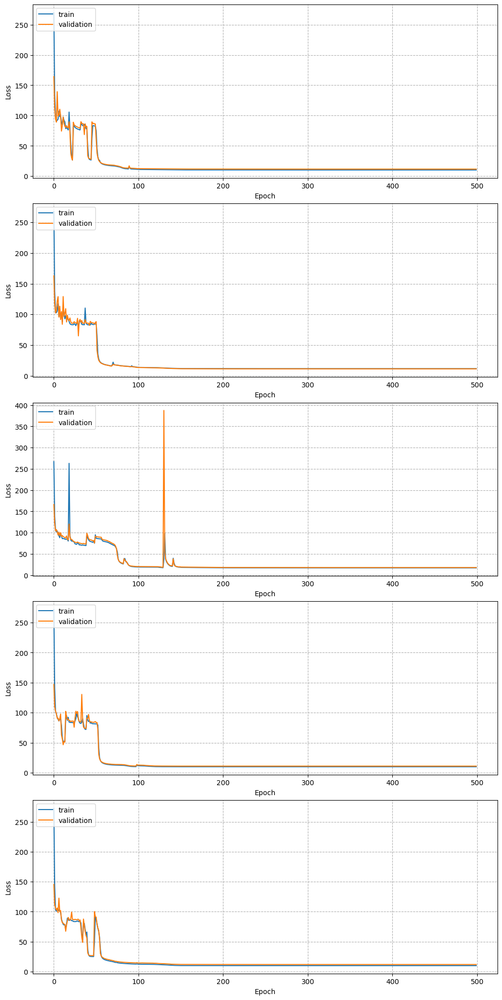

In [68]:
show_results(histories=histories)

In [69]:
seq_len=10
n_freqs = 1025
hidden_size = 128
latent_size = 64
restore_best_model = init_model(label_dict, input_size=n_freqs*4, hidden_size=hidden_size, latent_size=latent_size, seq_len=seq_len)
k=3
# best_model_state = torch.load(f'full_best_model_LSTM_AE_h_{hidden_size}_l{latent_size}_f{n_freqs}_fold{k}_{main_folder}.pt')
restore_best_model = torch.load(f'full_best_model_LSTM_AE_h_{hidden_size}_l{latent_size}_f{n_freqs}_fold{k}_{main_folder}.pt')
# restore_best_model.load_state_dict(best_model_state)
restore_best_model.to(torch.device('cpu'))

LSTMAE(
  (encoder): Encoder(
    (lstm_1): LSTM(4100, 128, num_layers=4, batch_first=True)
    (lstm_2): LSTM(128, 64, batch_first=True)
    (bottle_neck): Linear(in_features=64, out_features=64, bias=True)
  )
  (decoder): Decoder(
    (act): Sigmoid()
    (latent_decode): Linear(in_features=64, out_features=64, bias=True)
    (lstm_1): LSTM(64, 128, batch_first=True)
    (lstm_2): LSTM(128, 128, num_layers=4, batch_first=True)
    (fc): Linear(in_features=128, out_features=4100, bias=True)
  )
)

In [70]:
def inference_construction_error(best_model, data, criterion):
    # criterion = torch.nn.MSELoss(reduction='mean')
    best_model.eval()
    with torch.no_grad():
        enc_out, dec_out = best_model(data)
        loss = criterion(dec_out, data)
    return loss.detach().numpy(), enc_out.detach().numpy(), dec_out.detach().numpy()

In [71]:
val_ds = SoundDataset(train_val_pairs, label_dict, folder='.', part='full', mean=0, std=0, transform=None)
val_loader = DataLoader(val_ds,
                        batch_size=1,
                        shuffle = False,
                        drop_last = False)
list_val_input_specs = []
for data in val_loader:
    x, label = data['spectrogram'], data['label']
    x_permuted = torch.permute(x, (0, 2, 1))
    list_val_input_specs.append(x_permuted)
    print(x)
    print(label)
    # break

tensor([[[-39.2406, -33.5079, -35.7847,  ..., -25.2620, -26.8855, -31.1878],
         [-40.0100, -34.4415, -35.3727,  ..., -26.2332, -28.5289, -31.5948],
         [-42.5871, -37.2423, -36.0830,  ..., -28.8780, -34.7647, -32.6981],
         ...,
         [-73.4297, -60.0088, -51.9058,  ..., -68.4181, -62.2752, -54.4414],
         [-77.1858, -61.2539, -57.0495,  ..., -64.5032, -65.3419, -54.6851],
         [-80.0000, -61.4964, -63.6785,  ..., -63.3762, -72.8905, -54.9073]]])
tensor([0.], dtype=torch.float64)
tensor([[[-41.8563, -35.8549, -56.6237,  ..., -34.1246, -26.4526, -27.8422],
         [-41.4368, -34.7017, -41.4875,  ..., -33.9760, -27.2254, -28.4646],
         [-40.5745, -32.8436, -34.6464,  ..., -33.5414, -29.9063, -30.3446],
         ...,
         [-78.0019, -59.2549, -52.2565,  ..., -72.0873, -66.3062, -56.8343],
         [-80.0000, -60.8195, -56.9914,  ..., -80.0000, -68.1986, -57.1204],
         [-80.0000, -61.6450, -62.6854,  ..., -80.0000, -66.9333, -57.3263]]])
tensor([0.

In [72]:
for i in range(10):
    print(f"mean value for time segment {i}: ", x[0][:1025,i].mean())

mean value for time segment 0:  tensor(-63.6660)
mean value for time segment 1:  tensor(-30.4098)
mean value for time segment 2:  tensor(-25.1563)
mean value for time segment 3:  tensor(-31.8799)
mean value for time segment 4:  tensor(-45.0425)
mean value for time segment 5:  tensor(-47.0830)
mean value for time segment 6:  tensor(-48.4808)
mean value for time segment 7:  tensor(-50.3430)
mean value for time segment 8:  tensor(-51.6951)
mean value for time segment 9:  tensor(-53.9988)


In [73]:
np.array_equal(list_val_input_specs[0].numpy(), list_val_input_specs[5].numpy())

False

In [362]:
spec_example = x[0].numpy()
plot_spec_for_channels_from_data(specs_data=spec_example, n_fft = 1025, x_coord=time_bins[:seq_len], y_coord=freq_bins, export_name="specs_4_channels.pdf", backend="Qt5Agg", export=True)

/tmp/ipykernel_1786317/4147707169.py:41: UserWarning: All values for SymLogScale are below linthresh, making it effectively linear. You likely should lower the value of linthresh. 
  plt.show()


In [75]:
model_enc_out, model_dec_out = restore_best_model(x_permuted)

torch.Size([1, 10, 4100])


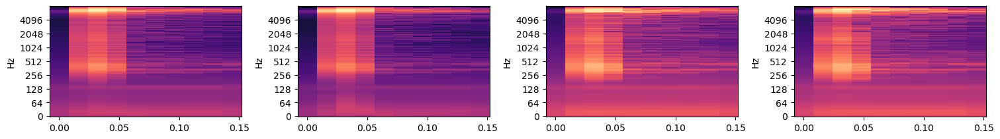

In [326]:
print(model_dec_out.size())
model_dec_out_permuted = torch.permute(model_dec_out, (0, 2, 1)).detach()
out_example = model_dec_out_permuted[0].numpy()
plot_spec_for_channels_from_data(specs_data=out_example, n_fft = 1025, x_coord=time_bins[:seq_len], y_coord=freq_bins, export_name="reconstructed_specs_4_channels.pdf", export=True)

In [77]:
print(out_example)

[[-43.42399  -40.417786 -39.69185  ... -40.5856   -40.354218 -41.19162 ]
 [-41.972855 -37.52348  -36.346233 ... -37.090546 -37.250782 -39.243   ]
 [-41.38993  -36.80639  -35.22108  ... -36.160225 -36.45742  -38.55914 ]
 ...
 [-75.268295 -60.398212 -54.0798   ... -70.09186  -67.40985  -61.143665]
 [-75.64154  -62.15943  -57.63967  ... -69.45376  -68.127106 -62.039387]
 [-75.91282  -63.516403 -63.874138 ... -69.85592  -70.57849  -62.70459 ]]


In [78]:
print(x)

tensor([[[-46.6991, -46.1066, -36.6947,  ..., -36.0983, -31.8627, -37.6671],
         [-46.7375, -41.9484, -35.8077,  ..., -34.7229, -32.8785, -38.1360],
         [-46.9130, -39.9921, -34.4005,  ..., -33.8788, -36.2710, -39.5147],
         ...,
         [-71.9190, -65.0470, -59.3429,  ..., -69.4562, -60.3679, -52.0765],
         [-76.3306, -68.5659, -65.4605,  ..., -74.9291, -63.4292, -52.1993],
         [-80.0000, -68.5788, -73.1762,  ..., -80.0000, -65.6271, -52.3433]]])


In [79]:
criterion = torch.nn.MSELoss(reduction="none")

In [80]:
def get_list_construction_error(data_pairs, best_model, criterion, part='all', mean=0, std=0, transform=None, bs=32):
    data_ds = SoundDataset(data_pairs, label_dict, folder='.', part=part, mean=mean, std=std, transform=transform)
    data_loader = DataLoader(data_ds,
                            batch_size=bs,
                            shuffle = False,
                            drop_last = False)
    list_losses = []
    list_enc_vec = []
    list_dec_specs = []
    list_labels = []
    list_names = []
    if torch.cuda.is_available():
      device = torch.device("cuda:0")
    else:
      device = torch.device("cpu")
    for data in data_loader:
        x, label, name = data['spectrogram'], data['label'], data['filename']
        x_permuted = torch.permute(x, (0, 2, 1))
        construction_err, enc_vec, dec_spec = inference_construction_error(best_model, x_permuted, criterion)
        # print(construction_err.shape)
        list_construction_err = construction_err.mean(axis=(1, 2)).tolist()
        for idx in range(len(list_construction_err)):
            list_losses.append(list_construction_err[idx])
            list_enc_vec.append(enc_vec[idx,:])
            list_dec_specs.append(dec_spec[idx,:])
            list_labels.append(label[idx])
            list_names.append(name[idx])
    return list_losses, list_labels, list_names, list_enc_vec, list_dec_specs

In [81]:
list_train_losses, list_train_label, list_train_names, list_train_enc_vec, list_train_dec_specs = get_list_construction_error(train_val_pairs, best_model=restore_best_model, criterion=criterion, part='all', mean=list_of_mean[0], std=list_of_std[0], transform=None, bs=64)

In [86]:
print(len(test_pairs))
print(missing_idx)

2500
[]


In [87]:
list_val_losses, list_val_label, list_val_names, list_val_enc_vec, list_val_dec_specs = get_list_construction_error(val_pairs, best_model=restore_best_model, criterion=criterion, part='all', mean=list_of_mean[0], std=list_of_std[0], transform=None, bs=64)

In [88]:
list_test_losses, list_test_label, list_test_names, list_test_enc_vec, list_test_dec_specs = get_list_construction_error(test_pairs, best_model=restore_best_model, criterion=criterion, part='all', mean=list_of_mean[0], std=list_of_std[0], transform=None, bs=64)

In [89]:
list_train_enc_vec

[array([ -6.970948 ,   8.632687 ,  15.537871 , -10.786988 , -19.77643  ,
         19.109798 ,  22.158228 , -18.367023 , -16.788988 ,  -7.9653277,
        -21.188953 , -21.29075  ,  -7.8327837,   6.232962 , -19.27991  ,
         21.256088 , -21.008785 , -15.77462  ,  -7.9688873, -20.124016 ,
        -19.501013 ,  20.002943 ,  21.309864 , -19.381334 ,  21.078093 ,
          7.1039515, -19.714453 , -10.397932 ,  16.40926  ,   9.270226 ,
        -19.089054 , -15.867001 , -14.733805 ,  19.25437  ,   8.291141 ,
         20.633617 ,  19.737152 , -20.96837  , -20.872726 ,  20.300173 ,
         17.058529 ,  -7.353543 ,  13.578303 ,  21.100698 ,  15.732855 ,
         19.246756 , -11.304932 ,  21.21703  , -21.053246 ,   7.507646 ,
          7.9299326, -18.520376 ,   8.7983   ,  20.276993 , -20.180874 ,
         20.91385  ,   1.5224216,   7.149231 , -15.815547 ,  21.363087 ,
        -21.36168  ,   8.691782 ,  21.381481 ,  15.719795 ], dtype=float32),
 array([ -6.970948 ,   8.632687 ,  15.537871 , 

In [90]:
list_val_enc_vec

[array([ -6.970948 ,   8.632687 ,  15.537871 , -10.786988 , -19.77643  ,
         19.109798 ,  22.158228 , -18.367023 , -16.788988 ,  -7.9653277,
        -21.188953 , -21.29075  ,  -7.8327837,   6.232962 , -19.27991  ,
         21.256088 , -21.008785 , -15.77462  ,  -7.9688873, -20.124016 ,
        -19.501013 ,  20.002943 ,  21.309864 , -19.381334 ,  21.078093 ,
          7.1039515, -19.714453 , -10.397932 ,  16.40926  ,   9.270226 ,
        -19.089054 , -15.867001 , -14.733805 ,  19.25437  ,   8.291141 ,
         20.633617 ,  19.737152 , -20.96837  , -20.872726 ,  20.300173 ,
         17.058529 ,  -7.353543 ,  13.578303 ,  21.100698 ,  15.732855 ,
         19.246756 , -11.304932 ,  21.21703  , -21.053246 ,   7.507646 ,
          7.9299326, -18.520376 ,   8.7983   ,  20.276993 , -20.180874 ,
         20.91385  ,   1.5224216,   7.149231 , -15.815547 ,  21.363087 ,
        -21.36168  ,   8.691782 ,  21.381481 ,  15.719795 ], dtype=float32),
 array([ -6.970948 ,   8.632687 ,  15.537871 , 

In [91]:
list_test_enc_vec

[array([ -6.970948 ,   8.632687 ,  15.537871 , -10.786988 , -19.77643  ,
         19.109798 ,  22.158228 , -18.367023 , -16.788988 ,  -7.9653277,
        -21.188953 , -21.29075  ,  -7.8327837,   6.232962 , -19.27991  ,
         21.256088 , -21.008785 , -15.77462  ,  -7.9688873, -20.124016 ,
        -19.501013 ,  20.002943 ,  21.309864 , -19.381334 ,  21.078093 ,
          7.1039515, -19.714453 , -10.397932 ,  16.40926  ,   9.270226 ,
        -19.089054 , -15.867001 , -14.733805 ,  19.25437  ,   8.291141 ,
         20.633617 ,  19.737152 , -20.96837  , -20.872726 ,  20.300173 ,
         17.058529 ,  -7.353543 ,  13.578303 ,  21.100698 ,  15.732855 ,
         19.246756 , -11.304932 ,  21.21703  , -21.053246 ,   7.507646 ,
          7.9299326, -18.520376 ,   8.7983   ,  20.276993 , -20.180874 ,
         20.91385  ,   1.5224216,   7.149231 , -15.815547 ,  21.363087 ,
        -21.36168  ,   8.691782 ,  21.381481 ,  15.719795 ], dtype=float32),
 array([ -6.970948 ,   8.632687 ,  15.537871 , 

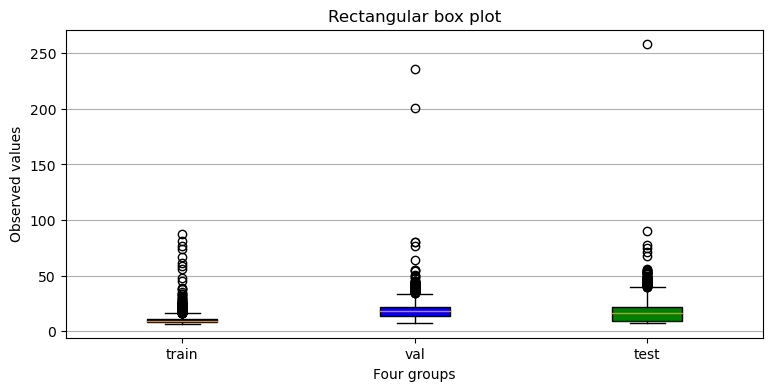

In [92]:

# all_data = [list_train_losses, list_val_losses, list_test_empty_losses, list_test_human_losses]
all_data = [list_train_losses, list_val_losses, list_test_losses]
# labels = ['train', 'val', 'test_0', 'test_1']
labels = ['train', 'val', 'test']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(9, 4))

# rectangular box plot
bplot = ax.boxplot(all_data,
                     vert=True,  # vertical box alignment
                     patch_artist=True,  # fill with color
                     labels=labels)  # will be used to label x-ticks
ax.set_title('Rectangular box plot')

# fill with colors
colors = ['black', 'blue', 'green', 'red']
for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)

# adding horizontal grid lines
ax.yaxis.grid(True)
ax.set_xlabel('Four groups')
ax.set_ylabel('Observed values')

plt.show()

Mean 10.114399514882225
Var 14.029729468032988


Text(0, 0.5, 'Value')

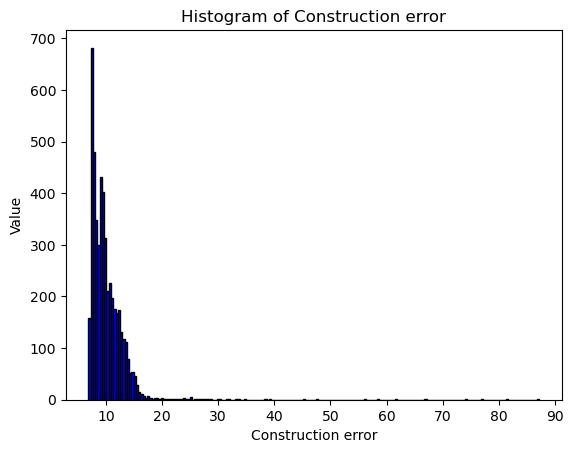

In [93]:
# Import the libraries
import matplotlib.pyplot as plt
# import seaborn as sns
train_losses_mean = np.mean(list_train_losses)
print("Mean", train_losses_mean)
train_losses_var = np.var(list_train_losses)
print("Var", train_losses_var)
# matplotlib histogram
plt.hist(list_train_losses, color = 'blue', edgecolor = 'black',
         bins = 200)
# Add labels
plt.title('Histogram of Construction error')
plt.xlabel('Construction error')
plt.ylabel('Value')

Mean 19.01063686542511
Var 88.4912525266705


Text(0, 0.5, 'Value')

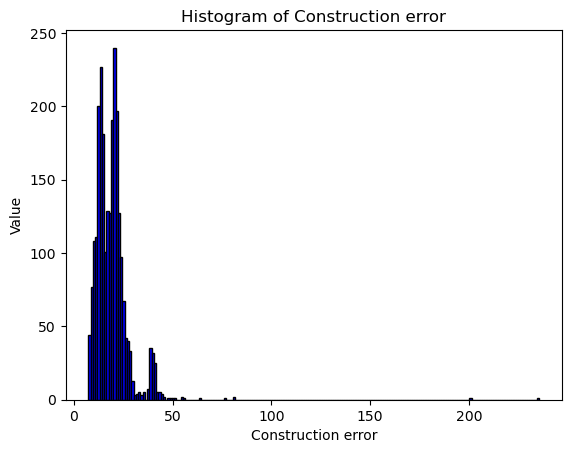

In [94]:
# Import the libraries
import matplotlib.pyplot as plt
# import seaborn as sns
val_losses_mean = np.mean(list_val_losses)
print("Mean", val_losses_mean)
val_losses_var = np.var(list_val_losses)
print("Var", val_losses_var)
# matplotlib histogram
plt.hist(list_val_losses, color = 'blue', edgecolor = 'black',
         bins = 200)
# Add labels
plt.title('Histogram of Construction error')
plt.xlabel('Construction error')
plt.ylabel('Value')

Mean 17.558826666641234
Var 105.93669169380986


Text(0, 0.5, 'Value')

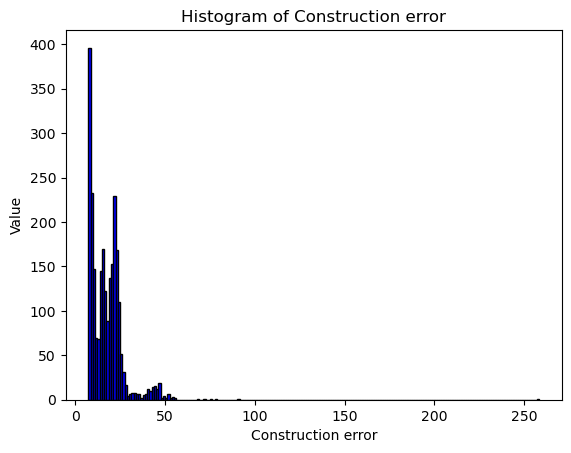

In [95]:
# Import the libraries
import matplotlib.pyplot as plt
# import seaborn as sns
test_losses_mean = np.mean(list_test_losses)
print("Mean", test_losses_mean)
test_losses_var = np.var(list_test_losses)
print("Var", test_losses_var)
# matplotlib histogram
plt.hist(list_test_losses, color = 'blue', edgecolor = 'black',
         bins = 200)
# Add labels
plt.title('Histogram of Construction error')
plt.xlabel('Construction error')
plt.ylabel('Value')

In [105]:
import math
from numpy import percentile
# def mad_score(points):
#     """https://www.itl.nist.gov/div898/handbook/eda/section3/eda35h.htm """
#     m = np.median(points)
#     ad = np.abs(points - m)
#     mad = np.median(ad)
    
#     return 0.6745 * ad / mad
q25, q75 = percentile(list_train_losses, 25), percentile(list_train_losses, 75)
iqr = q75 - q25
cut_off = iqr * 1.5
lower, upper = q25 - cut_off, q75 + cut_off
# identify outliers
outliers = [x for x in list_train_losses if x < lower or x > upper]
print(len(outliers))
print(outliers)

filtered_list_train_losses = [x for x in list_train_losses if x >= lower and x <= upper]

mean = np.mean(filtered_list_train_losses)
std = np.std(filtered_list_train_losses)
def z_score(point):
    return abs((point-mean)/std)

97
[38.446495056152344, 16.928218841552734, 25.86505126953125, 20.80169677734375, 19.48375129699707, 16.267032623291016, 27.843914031982422, 16.730051040649414, 22.855764389038086, 26.422752380371094, 16.394062042236328, 33.46827697753906, 87.21617889404297, 31.465435028076172, 24.230098724365234, 17.09689712524414, 18.648605346679688, 18.017845153808594, 17.388200759887695, 18.75446891784668, 23.840755462646484, 17.429176330566406, 19.744667053222656, 19.636728286743164, 21.31728744506836, 17.55229949951172, 24.509563446044922, 17.969406127929688, 22.963359832763672, 27.603805541992188, 19.215951919555664, 81.20220184326172, 58.47369384765625, 38.390682220458984, 20.083919525146484, 29.88343048095703, 45.215572357177734, 25.172637939453125, 18.898115158081055, 55.90058517456055, 28.255332946777344, 18.475833892822266, 30.21068572998047, 67.11852264404297, 22.696197509765625, 16.310888290405273, 28.9049015045166, 25.253103256225586, 25.04293441772461, 33.34773635864258, 21.860778808593

In [97]:
print(mean)
print(std)

9.786102825259734
2.0858119702104947


In [106]:
list_z_score_train = [z_score(t) for t in list_train_losses]
list_z_score_val = [z_score(t) for t in list_val_losses]
list_z_score_test = [z_score(t) for t in list_test_losses]
# list_z_score_nt1 = [z_score(t) for t in list_nt1_losses]

In [109]:
from torchmetrics.classification import BinaryROC
from matplotlib import pyplot as plt 
import numpy as np 
import matplotlib.animation as animation 
from IPython import display 
import random

In [110]:
print("Max loss in val: ", np.max(list_z_score_val))
print("Max loss in val: ", np.min(list_z_score_val))
print("Max loss in test: ", np.max(list_z_score_test))
print("Max loss in test: ", np.min(list_z_score_test))

Max loss in val:  108.29905424325673
Max loss in val:  0.001760041572651739
Max loss in test:  119.2615073173078
Max loss in test:  0.0005159467779135866


In [111]:
def acc_at_pos(pos, start_idx, end_idx, labels, predictions, z_scores):
    print(f"Acc at position: {pos} from sample idx {start_idx} to end idx {end_idx-1}")
    # print(labels[start_idx : end_idx])
    acc = metrics.accuracy_score(y_true=labels[start_idx:end_idx], y_pred=predictions[start_idx:end_idx])
    print(acc)
    idx = [i for i in range(start_idx, end_idx)]
    plt.plot(idx, z_scores[start_idx:end_idx])
    plt.show()
    return acc

In [356]:
def roc_curve(y_true, y_prob, thresholds):
    fpr = []
    tpr = []

    for threshold in thresholds:

        y_pred = np.where(y_prob >= threshold, 1, 0)

        fp = np.sum((y_pred == 1) & (y_true == 0))
        tp = np.sum((y_pred == 1) & (y_true == 1))

        fn = np.sum((y_pred == 0) & (y_true == 1))
        tn = np.sum((y_pred == 0) & (y_true == 0))

        fpr.append(fp / (fp + tn))
        tpr.append(tp / (tp + fn))

    return (fpr, tpr)
    
def plot_roc_curve(list_fpr, list_tpr, export_name="abc", format="pdf", backend="agg", export=True):
    auc = metrics.auc(list_fpr+[0], list_tpr+[0])
    plt.plot(list_fpr, list_tpr, "o-", label='AUC: {:.2f}'.format(auc))
    plt.title("ROC Curve")
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.legend(loc='lower right')
    if export:
        plt.savefig(export_name, format=format, bbox_inches="tight")
    plt.show()

def plot_heatmap_from_position_acc(list_mean_acc, export_name="abc", format="pdf", backend="agg", export=True):
    #Data
    heatmap_data = np.array([[list_mean_acc[11], list_mean_acc[6], list_mean_acc[5], list_mean_acc[0]],
                    [list_mean_acc[10], list_mean_acc[7], list_mean_acc[4], list_mean_acc[1]],
                    [list_mean_acc[9], list_mean_acc[8], list_mean_acc[3], list_mean_acc[2]]
                   ])
    # Labels
    xlabs = ["C1", "C2", "C3", "C4"]
    ylabs = ["R1", "R2", "R3"]
    # Heat map
    fig, ax = plt.subplots()
    ax.imshow(heatmap_data)
    
    # Add the labels
    ax.set_xticks(np.arange(len(xlabs)), labels = xlabs)
    ax.set_yticks(np.arange(len(ylabs)), labels = ylabs)
    
    # Add the values to each cell
    # ax.text(0,0, 0)
    # ax.text(0,1, 1)
    # ax.text(0,2, 2)
    for i in range(len(xlabs)):
        for j in range(len(ylabs)):
            text = ax.text(i, j, round(heatmap_data[j][i], 3),
                           ha = "center", va = "center", color = "r")
    if export:
        plt.savefig(export_name, format=format, bbox_inches="tight")
    plt.show()
    
        

In [113]:
y_val = y[5000:7500]
y_test = y[7500:]

In [114]:
list_fpr, list_tpr = roc_curve(y_true=np.array(y_val), y_prob=np.array(list_z_score_val), thresholds=[0, 1, 1.5, 2, 2.5, 3, 3.5, 4, 4.5, 5, 5.5, 6])

In [122]:
print(np.count_nonzero(np.array(y_val)==0))
print(np.count_nonzero(np.array(y_val)==1))
print(np.count_nonzero(np.array(y_test)==0))
print(np.count_nonzero(np.array(y_test)==1))

1000
1500
1000
1500


In [115]:
list_fpr

[1.0,
 0.679,
 0.502,
 0.26,
 0.165,
 0.064,
 0.046,
 0.04,
 0.036,
 0.035,
 0.034,
 0.031]

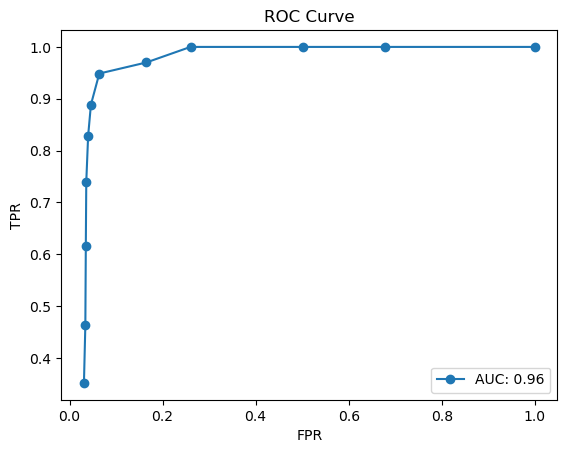

In [160]:
plot_roc_curve(list_fpr=list_fpr, list_tpr=list_tpr)

In [363]:
plot_roc_curve(list_fpr=list_fpr, list_tpr=list_tpr, export_name="ROC_curve_on_val.pdf", format="pdf", backend="Qt5Agg", export=True)

In [161]:
zscore_threshold = 3
list_predict_val = [0 if np.abs(t) <= zscore_threshold else 1 for t in list_z_score_val]

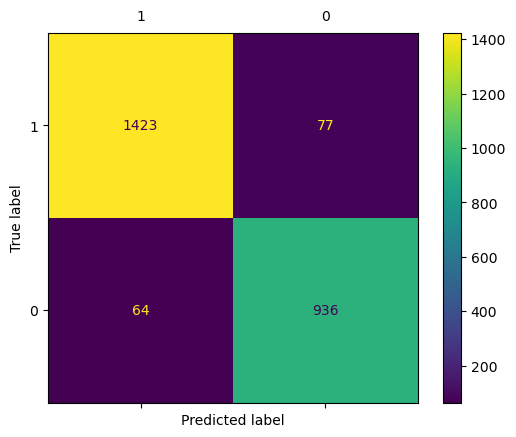

In [162]:
cm = confusion_matrix(y_val, list_predict_val, labels=[1, 0])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[1, 0])
disp.plot()
disp.ax_.tick_params(labelbottom=False,labeltop=True)
plt.show()

In [365]:
tn, fp, fn, tp = confusion_matrix(y_true=y_val, y_pred=list_predict_val, normalize='true').ravel()
f1_weighted=f1_score(y_true=y_val, y_pred=list_predict_val, average='weighted')
f1_norm = f1_score(y_true=y_val, y_pred=list_predict_val)
print("F1 (weighted): ", f1_weighted)
print("F1 (normal): ", f1_norm)
print("FP: ", fp)

F1 (weighted):  0.9436593844064469
F1 (normal):  0.9527954469367259
FP:  0.064


In [165]:
list_predict_test = [0 if np.abs(t) < zscore_threshold else 1 for t in list_z_score_test]

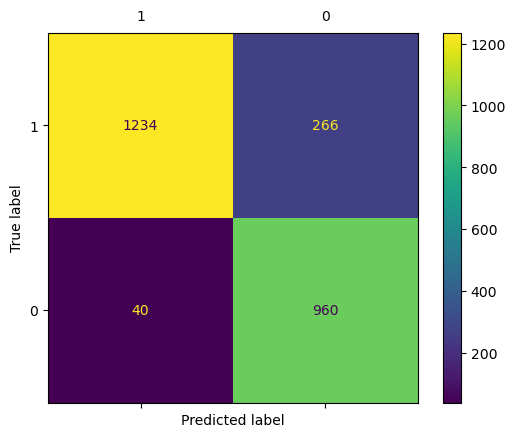

In [166]:
cm = confusion_matrix(y_test, list_predict_test, labels=[1, 0])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[1, 0])
disp.plot()
disp.ax_.tick_params(labelbottom=False,labeltop=True)
plt.show()

In [167]:
print(classification_report(y_true=y_test, y_pred=list_predict_test))

              precision    recall  f1-score   support

           0       0.78      0.96      0.86      1000
           1       0.97      0.82      0.89      1500

    accuracy                           0.88      2500
   macro avg       0.88      0.89      0.88      2500
weighted avg       0.89      0.88      0.88      2500



In [168]:
f1_weighted=f1_score(y_true=y_test, y_pred=list_predict_test, average='weighted')
print(f1_weighted)

0.8788274641112992


In [373]:
f1_norm = f1_score(y_true=y_test, y_pred=list_predict_test)
print(f1_norm)

0.8896899783705841


Acc at position: 1 from sample idx 0 to end idx 99
1.0


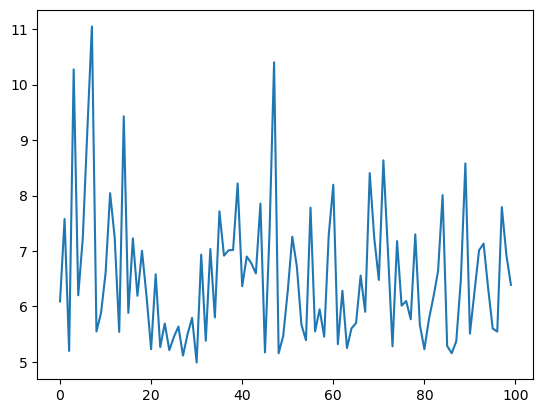

Acc at position: 2 from sample idx 100 to end idx 199
1.0


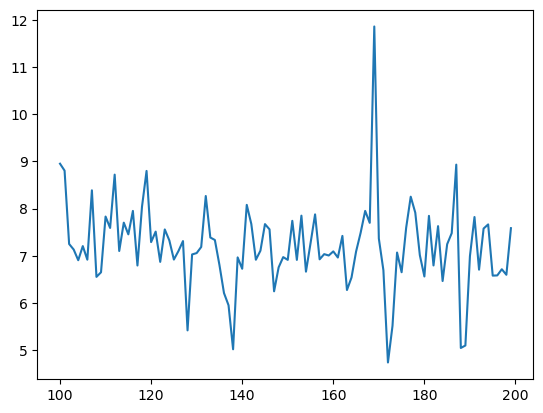

Acc at position: 3 from sample idx 200 to end idx 299
1.0


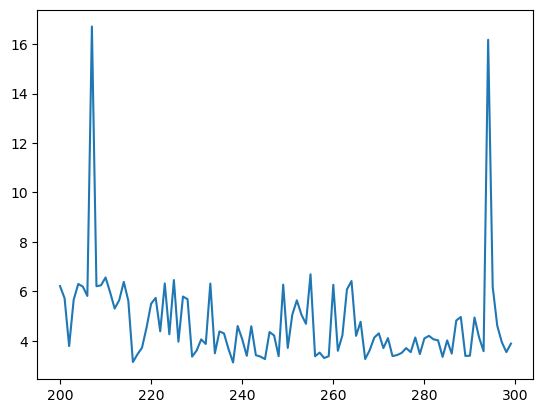

Acc at position: 4 from sample idx 300 to end idx 399
1.0


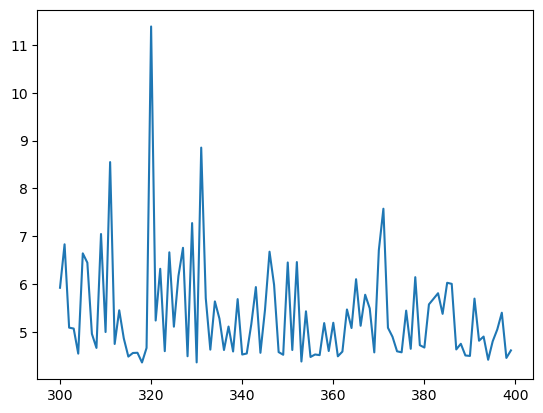

Acc at position: 5 from sample idx 400 to end idx 499
1.0


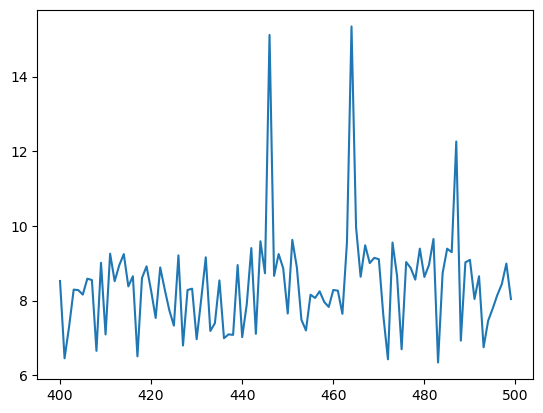

Acc at position: 6 from sample idx 500 to end idx 599
1.0


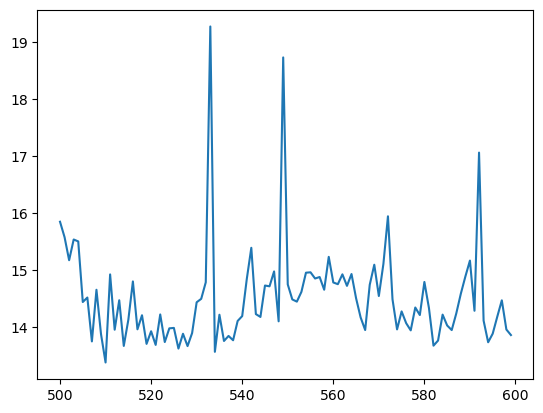

Acc at position: 7 from sample idx 600 to end idx 699
0.99


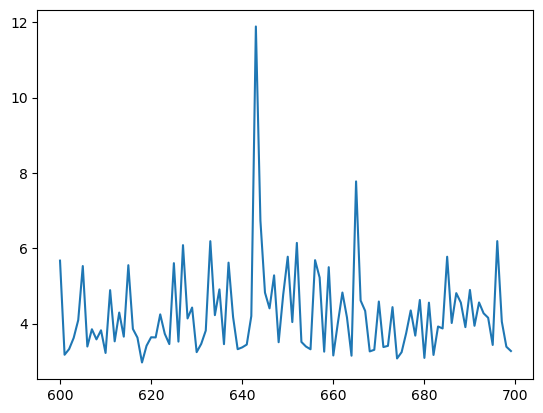

Acc at position: 8 from sample idx 700 to end idx 799
1.0


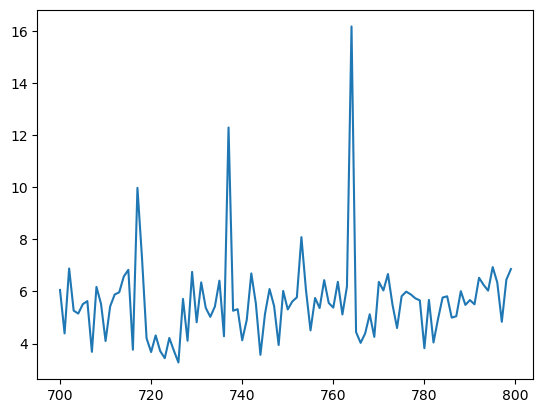

Acc at position: 9 from sample idx 800 to end idx 899
0.99


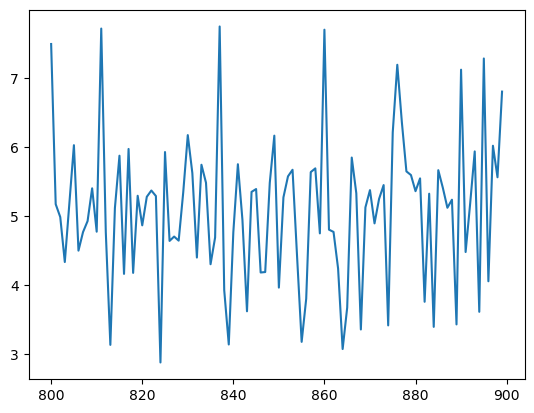

Acc at position: 10 from sample idx 900 to end idx 999
0.88


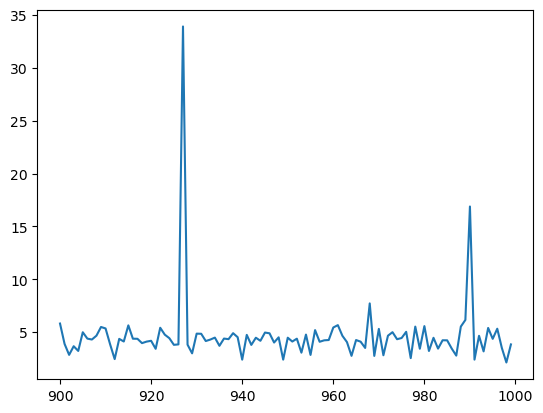

Acc at position: 11 from sample idx 1000 to end idx 1099
1.0


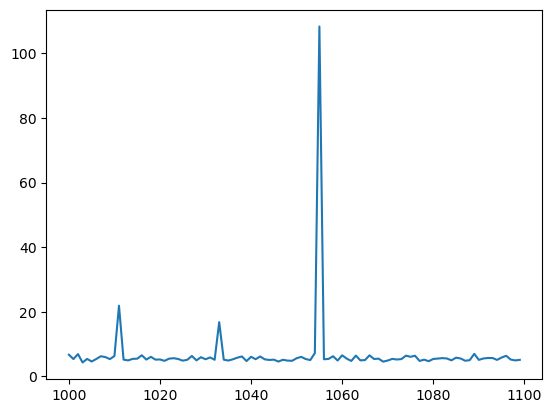

Acc at position: 12 from sample idx 1100 to end idx 1199
0.45


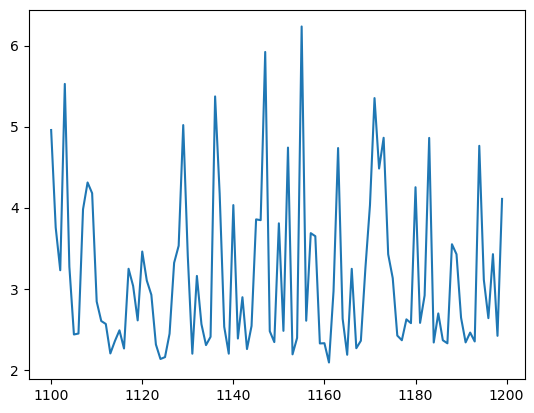

Acc at position: 13 from sample idx 1200 to end idx 1299
1.0


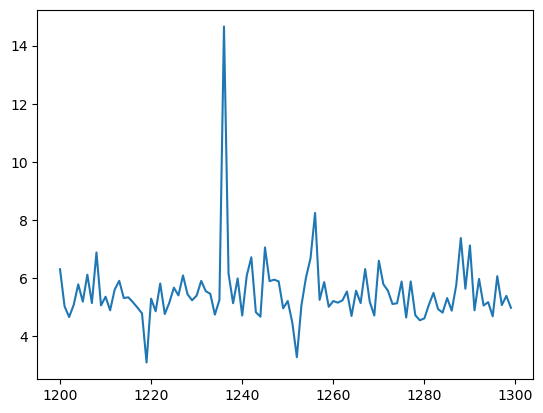

Acc at position: 14 from sample idx 1300 to end idx 1399
1.0


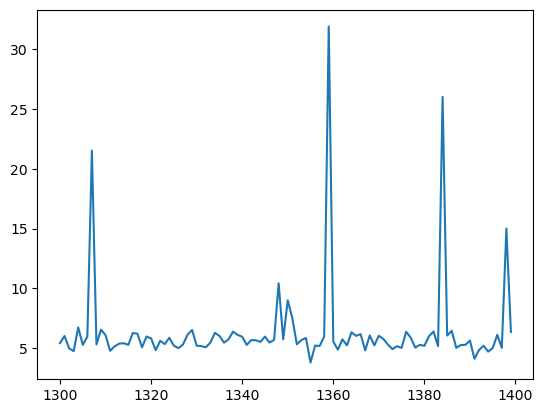

Acc at position: 15 from sample idx 1400 to end idx 1499
0.92


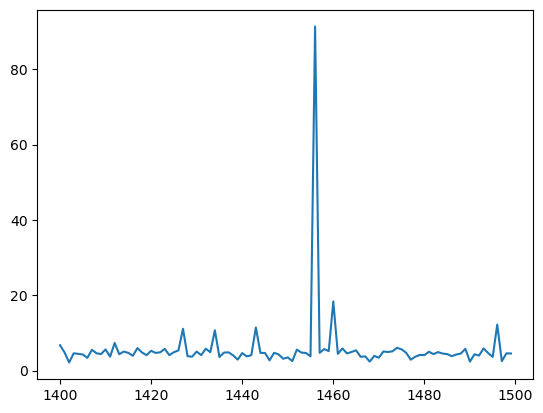

In [169]:
list_acc_phase_1 = []
for pos in range(1,16):
    acc = acc_at_pos(pos, start_idx=(pos-1)*100, end_idx=pos*100, labels=y_val, predictions=list_predict_val, z_scores=list_z_score_val)
    list_acc_phase_1.append(acc)

Acc at position: 1 from sample idx 0 to end idx 99
1.0


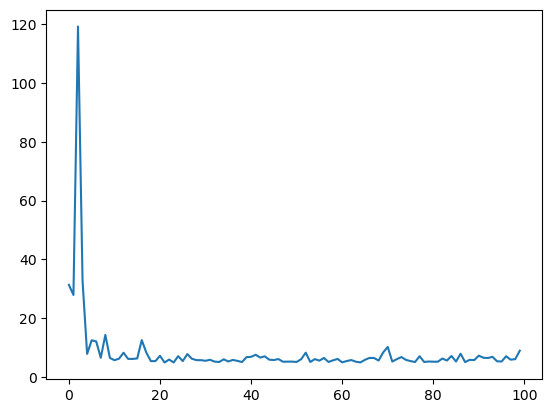

Acc at position: 2 from sample idx 100 to end idx 199
1.0


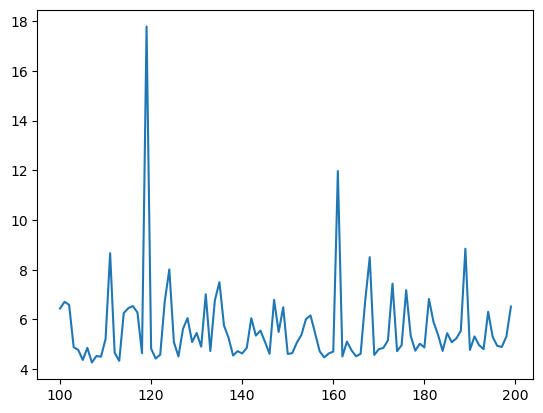

Acc at position: 3 from sample idx 200 to end idx 299
1.0


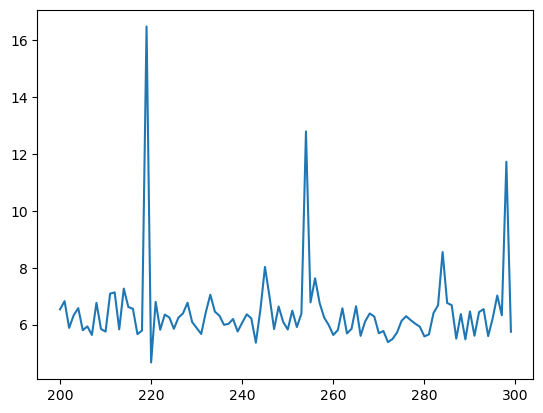

Acc at position: 4 from sample idx 300 to end idx 399
1.0


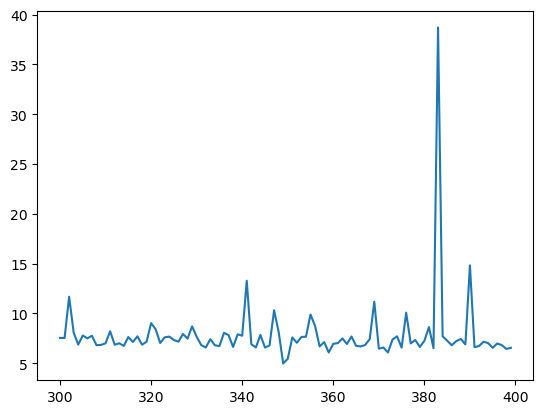

Acc at position: 5 from sample idx 400 to end idx 499
1.0


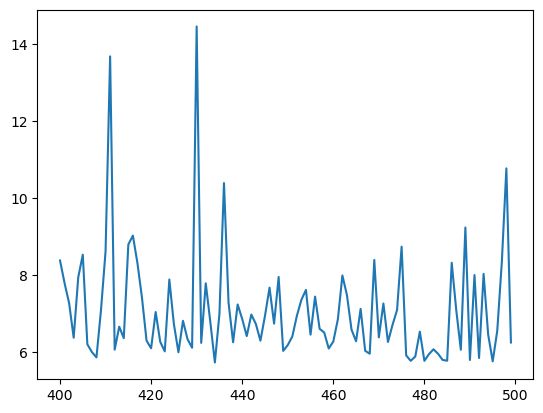

Acc at position: 6 from sample idx 500 to end idx 599
1.0


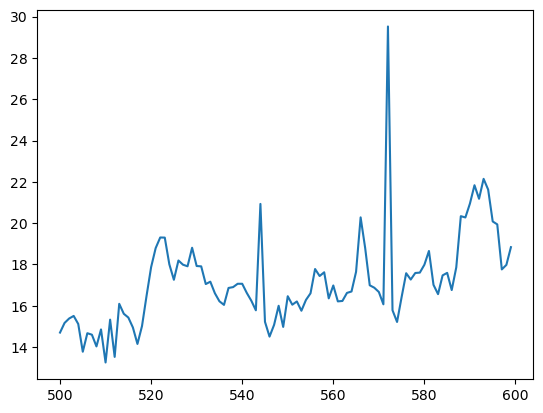

Acc at position: 7 from sample idx 600 to end idx 699
1.0


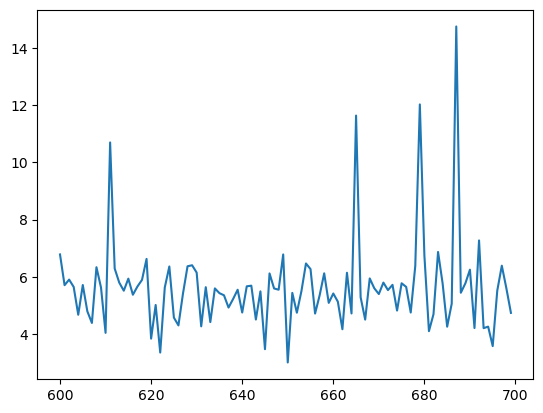

Acc at position: 8 from sample idx 700 to end idx 799
1.0


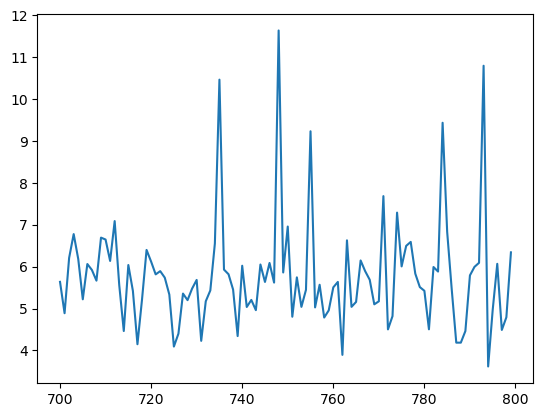

Acc at position: 9 from sample idx 800 to end idx 899
1.0


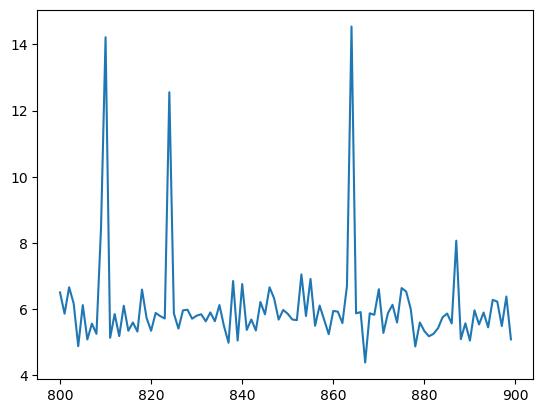

Acc at position: 10 from sample idx 900 to end idx 999
0.32


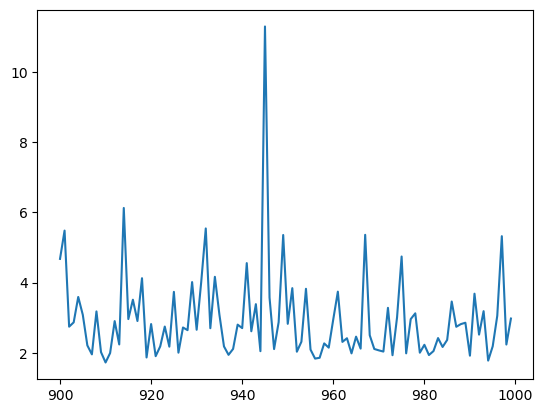

Acc at position: 11 from sample idx 1000 to end idx 1099
0.53


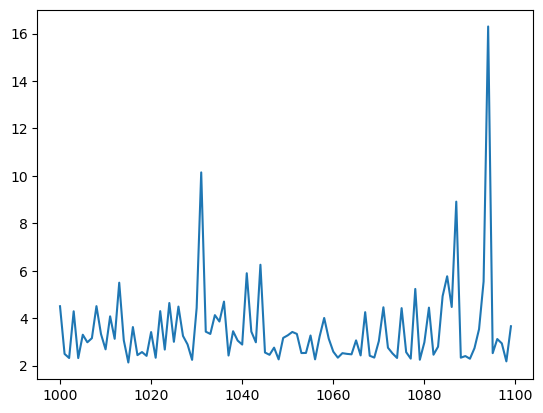

Acc at position: 12 from sample idx 1100 to end idx 1199
0.86


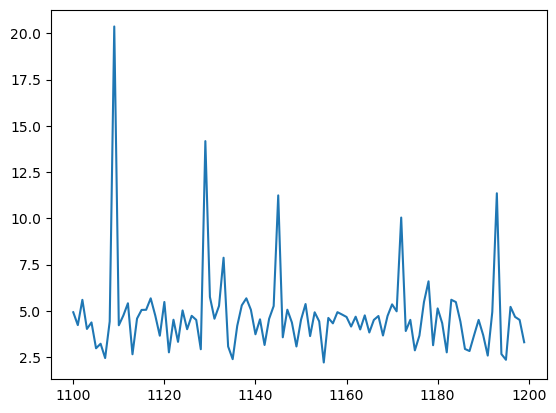

Acc at position: 13 from sample idx 1200 to end idx 1299
0.56


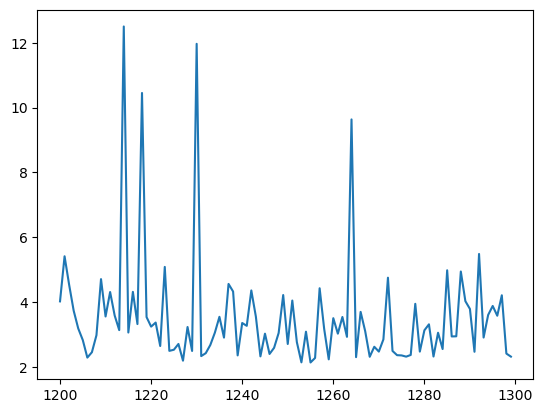

Acc at position: 14 from sample idx 1300 to end idx 1399
0.61


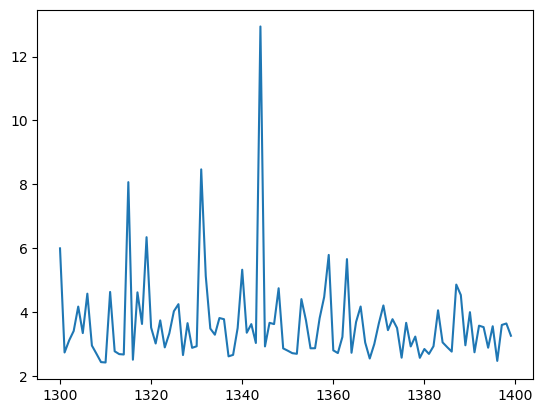

Acc at position: 15 from sample idx 1400 to end idx 1499
0.46


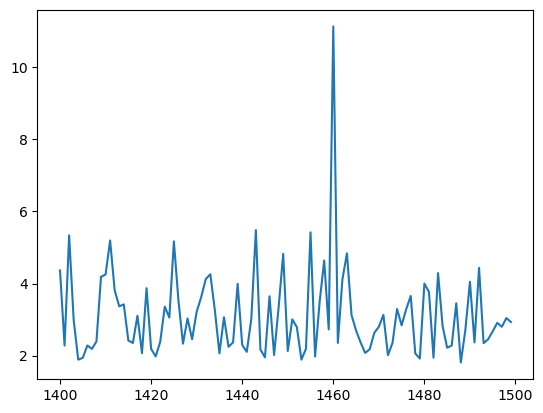

In [170]:
list_acc_phase_2 = []
for pos in range(1,16):
    start_2 = 0
    acc = acc_at_pos(pos, start_idx=(pos-1)*100+start_2, end_idx=pos*100+start_2, labels=y_test, predictions=list_predict_test, z_scores=list_z_score_test)
    list_acc_phase_2.append(acc)

In [171]:
compare_two_phases = pd.DataFrame()
compare_two_phases["position"] = [i for i in range(1,16)]
compare_two_phases["phase_1"] = list_acc_phase_1
compare_two_phases["phase_2"] = list_acc_phase_2
compare_two_phases["mean_acc"] = compare_two_phases.apply(lambda x: (x["phase_1"]+x["phase_2"])/2, axis=1)

In [172]:
compare_two_phases

,position,phase_1,phase_2,mean_acc
0,1,1.00,1.00,1.000
1,2,1.00,1.00,1.000
2,3,1.00,1.00,1.000
3,4,1.00,1.00,1.000
4,5,1.00,1.00,1.000
5,6,1.00,1.00,1.000
6,7,0.99,1.00,0.995
7,8,1.00,1.00,1.000
8,9,0.99,1.00,0.995
9,10,0.88,0.32,0.600


In [173]:
list_mean_acc_phase_1 = compare_two_phases["phase_1"].tolist()
list_mean_acc_phase_2 = compare_two_phases["phase_2"].tolist()

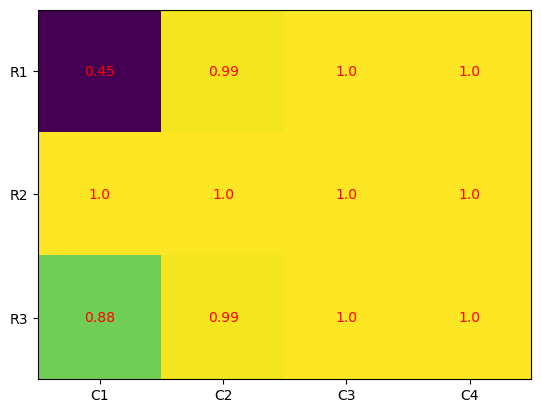

In [269]:
plot_heatmap_from_position_acc(list_mean_acc_phase_1, export=True, export_name="val_acc_pos_no_windowing.pdf")

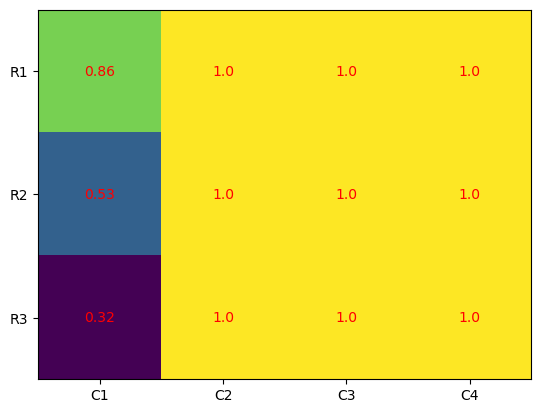

In [270]:
plot_heatmap_from_position_acc(list_mean_acc_phase_2, export=True, export_name="test_acc_pos_no_windowing.pdf")

In [176]:
print(len(y_val))
print(len(y_test))
print(len(list_predict_val))
print(len(list_predict_test))

2500
2500
2500
2500


In [179]:
def windowing_prediction_on_segment(list_raw_predictions, window_size):
    list_new_predictions = []
    for i in range(window_size-1, len(list_raw_predictions)):
        majority = sum(list_raw_predictions[i+1-window_size:i+1])
        new_label = 1 if majority >= int(math.ceil(window_size/2)) else 0
        list_new_predictions.append(new_label)
    return list_new_predictions

def windowing_label_on_segment(list_raw_labels, window_size):
    return list_raw_labels[window_size-1:]

In [366]:
def weighted_f1_by_window(list_raw_predictions, list_raw_labels, window_size):
    # window_size = 3
    list_windowing_y_val = []
    list_windowing_predict_val = []
    for i in range(0, 1500, 100):
        list_windowing_predict_val.extend(windowing_prediction_on_segment(list_raw_predictions[i:i+100], window_size))
        list_windowing_y_val.extend(windowing_label_on_segment(list_raw_labels[i:i+100], window_size))
    list_windowing_predict_val.extend(windowing_prediction_on_segment(list_raw_predictions[1500:], window_size))
    list_windowing_y_val.extend(windowing_label_on_segment(list_raw_labels[1500:], window_size))
    print(len(list_windowing_predict_val))
    print(len(list_windowing_y_val))
    f1_weighted=f1_score(y_true=list_windowing_y_val, y_pred=list_windowing_predict_val, average='weighted')
    f1_norm = f1_score(y_true=y_val, y_pred=list_predict_val)
    tn, fp, fn, tp = confusion_matrix(y_true=list_windowing_y_val, y_pred=list_windowing_predict_val, normalize='true').ravel()
    return f1_weighted, fp, list_windowing_predict_val, list_windowing_y_val, f1_norm

In [368]:
window_size_tuning_params_dict = {}
window_size_tuning_params_dict[1] = (0.944, 0.064)
for window_size in range(3, 10, 2):
    f1_weighted, fp, list_windowing_predict_val, list_windowing_y_val, f1_norm = weighted_f1_by_window(list_raw_predictions=list_predict_val, list_raw_labels=y_val, window_size=window_size)
    window_size_tuning_params_dict[window_size] = (f1_norm, fp)

2468
2468
2436
2436
2404
2404
2372
2372


In [369]:
window_size_tuning_params_dict

{1: (0.944, 0.064),
 3: (0.9527954469367259, 0.01002004008016032),
 5: (0.9527954469367259, 0.0),
 7: (0.9527954469367259, 0.0),
 9: (0.9527954469367259, 0.0)}

In [370]:
def plot_window_size_comparison(window_size_tuning_params_dict, export_name="abc", format="pdf", backend="agg", export=True):
    x = np.arange(len(window_size_tuning_params_dict))
    width = 0.25  # the width of the bars
    multiplier = 0
    fig, ax = plt.subplots()
    list_f1_weighted = [t[0] for t in window_size_tuning_params_dict.values()]
    list_fp = [t[1] for t in window_size_tuning_params_dict.values()]
    x_label = ["w_"+str(t) for t in window_size_tuning_params_dict]
    bar1 = ax.bar(x-width/2, list_f1_weighted, width = width, color='blue', label="F1")
    ax.bar_label(bar1, padding=1, fmt='%.3f', size=6)
    ax.set_ylabel('F1 weighted', fontsize=16)
    ax.set_xticks(x, x_label)
    
    ax2 = ax.twinx()
    bar2 = ax2.bar(x+width/2, list_fp, width = width, color='red', label="FPR")
    ax2.bar_label(bar2, padding=1, fmt='%.3f', size=6)
    ax2.set_ylabel('FPR', fontsize=16)
    # ax.legend(loc='upper right', ncols=2)
    # ax2.legend(loc='upper right', ncols=3)
    ax2.set_ylim(0,1)
    
    fig.legend(loc="upper right")
    if export:
        plt.savefig(export_name, format=format, bbox_inches="tight")
    plt.show()

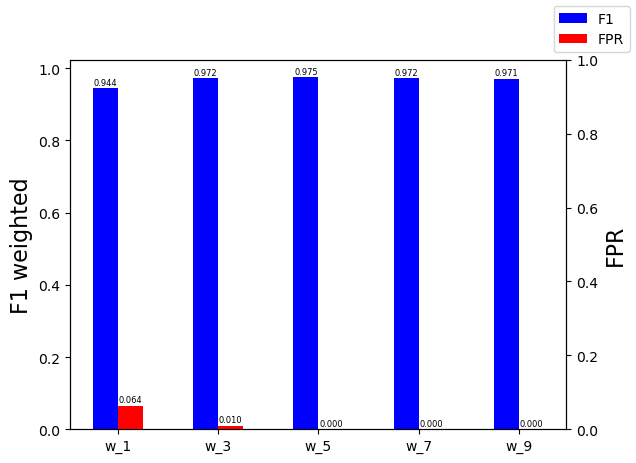

In [274]:
plot_window_size_comparison(window_size_tuning_params_dict, export=True, export_name="val_f1_comparing.pdf")

In [371]:
plot_window_size_comparison(window_size_tuning_params_dict, export=True, export_name="val_f1_norm_comparing.pdf")

In [374]:
best_window_size = 5
f1_weighted_windowing_val, fp_windowing_val, list_windowing_predict_val, list_windowing_y_val, f1_norm_windowing_val = weighted_f1_by_window(list_raw_predictions=list_predict_val, list_raw_labels=y_val, window_size=best_window_size)

2436
2436


In [375]:
f1_weighted_windowing_test, fp_windowing_test, list_windowing_predict_test, list_windowing_y_test, f1_norm_windowing_test = weighted_f1_by_window(list_raw_predictions=list_predict_test, list_raw_labels=y_test, window_size=best_window_size)

2436
2436


In [364]:
cm = confusion_matrix(list_windowing_y_test, list_windowing_predict_test, labels=[1, 0])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[1, 0])
disp.plot()
disp.ax_.tick_params(labelbottom=False,labeltop=True)
plt.show()

In [348]:
list_windowing_z_score_val = []
for i in range(0, 1500, 100):
    list_windowing_z_score_val.extend(windowing_label_on_segment(list_z_score_val[i:i+100], best_window_size))
list_windowing_z_score_val.extend(windowing_label_on_segment(list_z_score_val[1500:], best_window_size))
print(len(list_windowing_z_score_val))

2436


In [253]:
list_windowing_z_score_test = []
for i in range(0, 1500, 100):
    list_windowing_z_score_test.extend(windowing_label_on_segment(list_z_score_test[i:i+100], best_window_size))
list_windowing_z_score_test.extend(windowing_label_on_segment(list_z_score_test[1500:], best_window_size))
print(len(list_windowing_z_score_test))

2436


In [376]:
print(f"F1 weighted on test set (windowing method): {f1_weighted_windowing_test:.3f}")
print(f"F1 norm on test set (windowing method): {f1_norm_windowing_test:.3f}")
print(f"FPR on test set (windowing method): {fp_windowing_test:.3f}")

F1 weighted on test set (windowing method): 0.900
F1 norm on test set (windowing method): 0.953
FPR on test set (windowing method): 0.000


In [263]:
print(list_predict_test[800:900])
print(y_test[800:900])

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [264]:
print(list_windowing_predict_test[768:864])
print(list_windowing_y_test[768:864])

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [355]:
matplotlib.use('Agg')
list_acc_windowing_val = []
for pos in range(1,16):
    start = 0
    acc = acc_at_pos(pos, start_idx=(pos-1)*96+start, end_idx=pos*96+start, labels=list_windowing_y_val, predictions=list_windowing_predict_val, z_scores=list_windowing_z_score_val)
    list_acc_windowing_val.append(acc)

Acc at position: 1 from sample idx 0 to end idx 95
1.0
Acc at position: 2 from sample idx 96 to end idx 191
1.0
Acc at position: 3 from sample idx 192 to end idx 287
1.0
Acc at position: 4 from sample idx 288 to end idx 383
1.0
Acc at position: 5 from sample idx 384 to end idx 479
1.0
Acc at position: 6 from sample idx 480 to end idx 575
1.0
Acc at position: 7 from sample idx 576 to end idx 671
1.0
Acc at position: 8 from sample idx 672 to end idx 767
1.0
Acc at position: 9 from sample idx 768 to end idx 863
1.0
Acc at position: 10 from sample idx 864 to end idx 959
1.0
Acc at position: 11 from sample idx 960 to end idx 1055
1.0
Acc at position: 12 from sample idx 1056 to end idx 1151
0.3541666666666667
Acc at position: 13 from sample idx 1152 to end idx 1247
1.0
Acc at position: 14 from sample idx 1248 to end idx 1343
1.0
Acc at position: 15 from sample idx 1344 to end idx 1439
1.0


/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()
/tmp/ipykernel_1786317/1942830610.py:8: UserWarning: Matplotlib 

In [353]:
list_acc_windowing_val

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 0.6458333333333334,
 0.6354166666666666,
 1.0,
 1.0,
 1.0]

Acc at position: 1 from sample idx 0 to end idx 95
1.0


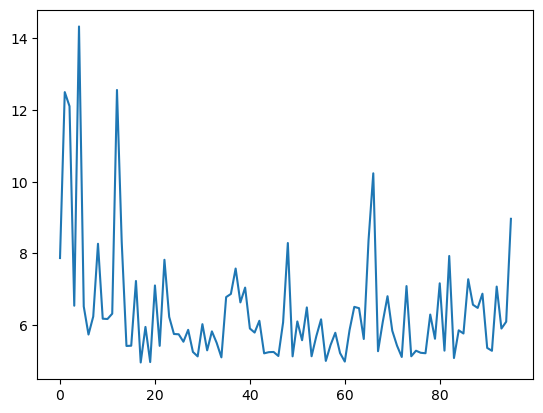

Acc at position: 2 from sample idx 96 to end idx 191
1.0


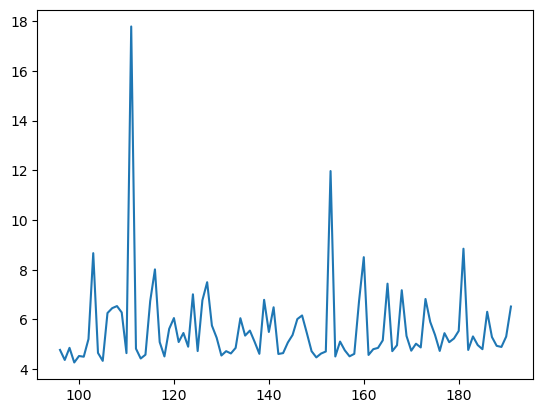

Acc at position: 3 from sample idx 192 to end idx 287
1.0


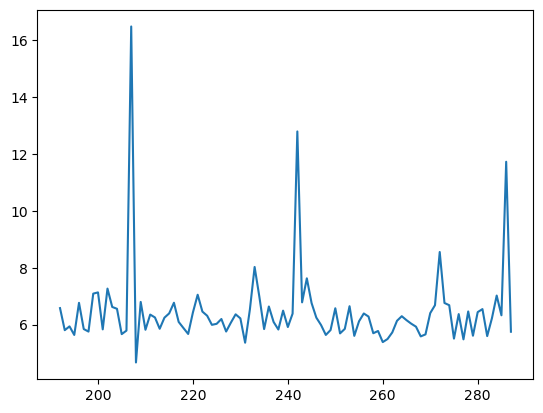

Acc at position: 4 from sample idx 288 to end idx 383
1.0


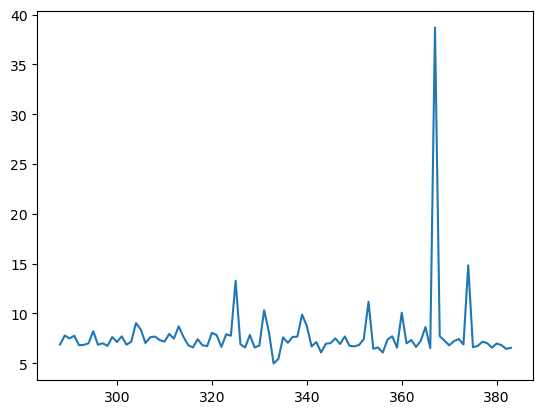

Acc at position: 5 from sample idx 384 to end idx 479
1.0


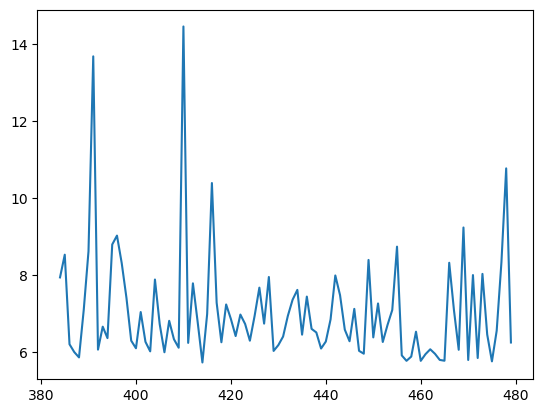

Acc at position: 6 from sample idx 480 to end idx 575
1.0


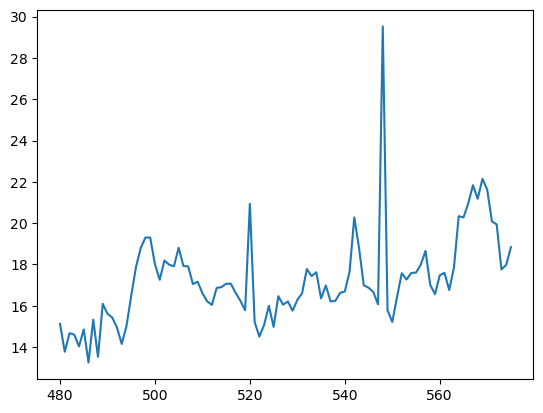

Acc at position: 7 from sample idx 576 to end idx 671
1.0


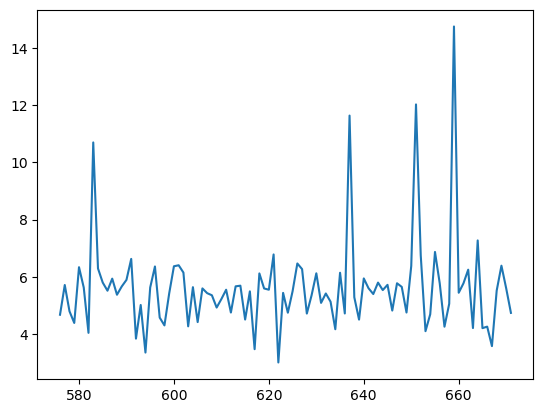

Acc at position: 8 from sample idx 672 to end idx 767
1.0


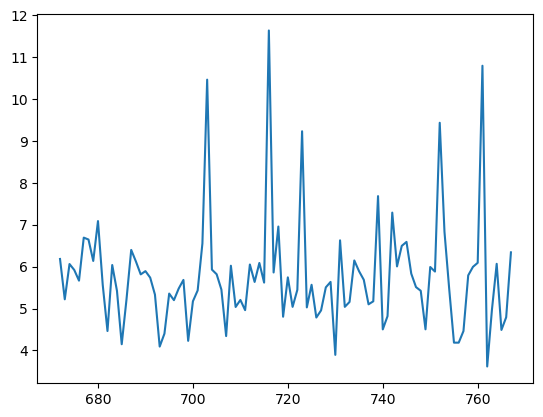

Acc at position: 9 from sample idx 768 to end idx 863
1.0


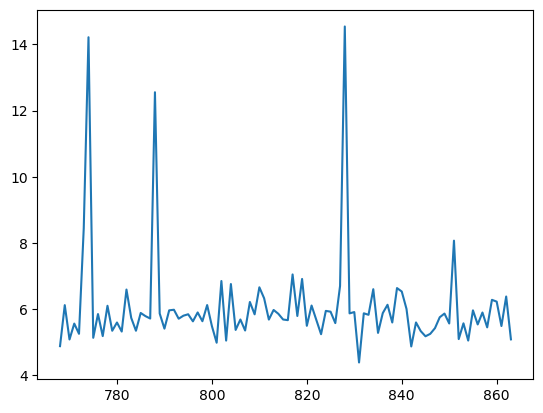

Acc at position: 10 from sample idx 864 to end idx 959
0.17708333333333334


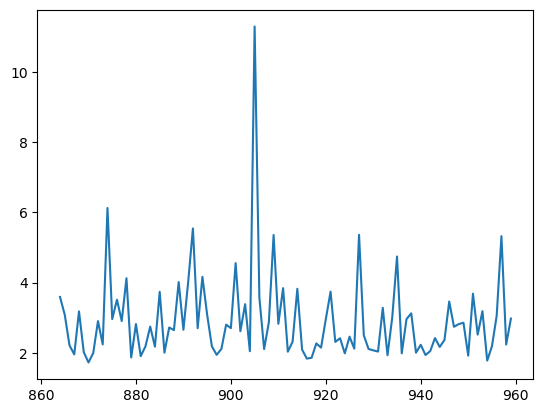

Acc at position: 11 from sample idx 960 to end idx 1055
0.5416666666666666


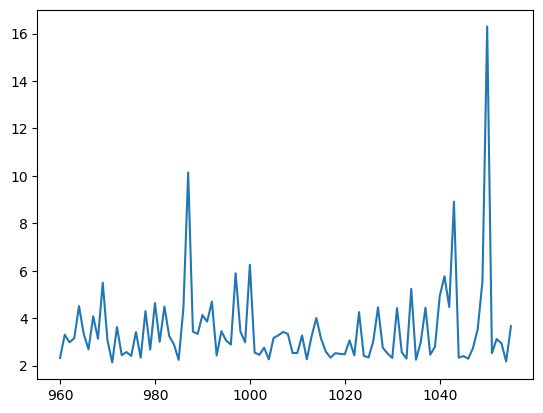

Acc at position: 12 from sample idx 1056 to end idx 1151
0.9895833333333334


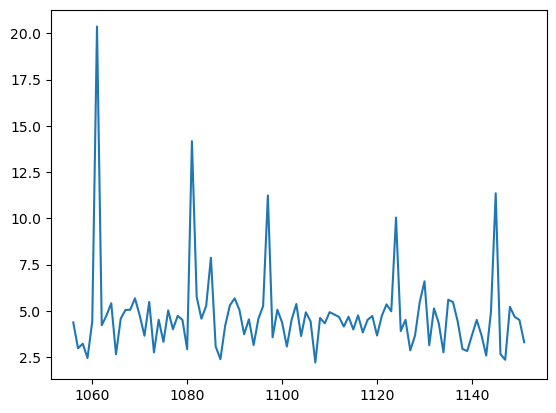

Acc at position: 13 from sample idx 1152 to end idx 1247
0.5833333333333334


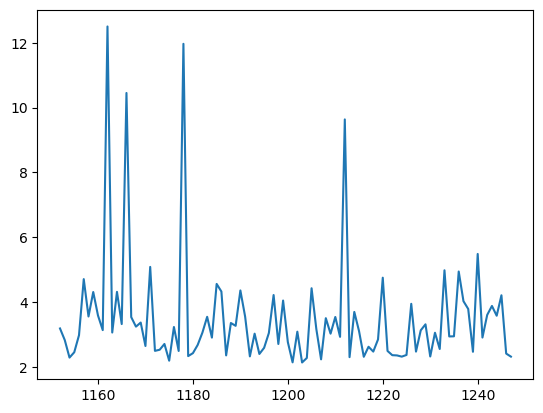

Acc at position: 14 from sample idx 1248 to end idx 1343
0.71875


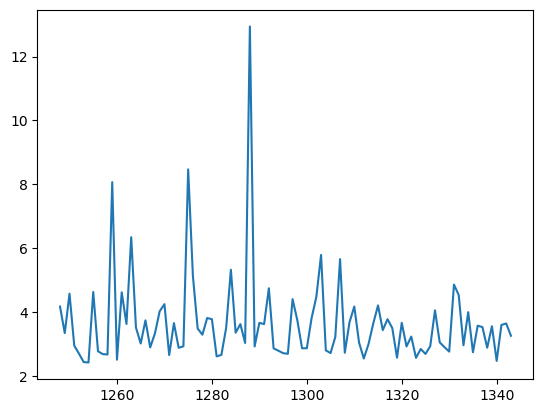

Acc at position: 15 from sample idx 1344 to end idx 1439
0.4270833333333333


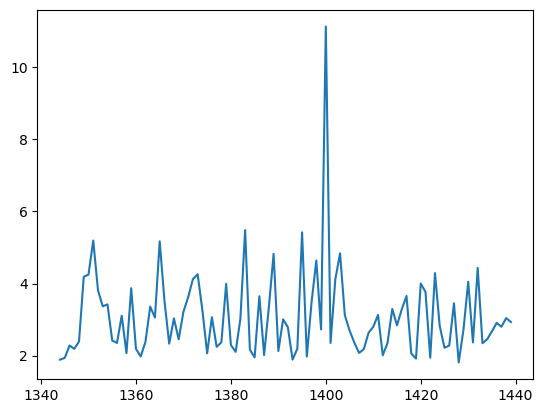

In [265]:
list_acc_windowing_test = []
for pos in range(1,16):
    start_2 = 0
    acc = acc_at_pos(pos, start_idx=(pos-1)*96+start_2, end_idx=pos*96+start_2, labels=list_windowing_y_test, predictions=list_windowing_predict_test, z_scores=list_windowing_z_score_test)
    list_acc_windowing_test.append(acc)

In [347]:
list_acc_windowing_test

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 0.17708333333333334,
 0.5416666666666666,
 0.9895833333333334,
 0.5833333333333334,
 0.71875,
 0.4270833333333333]

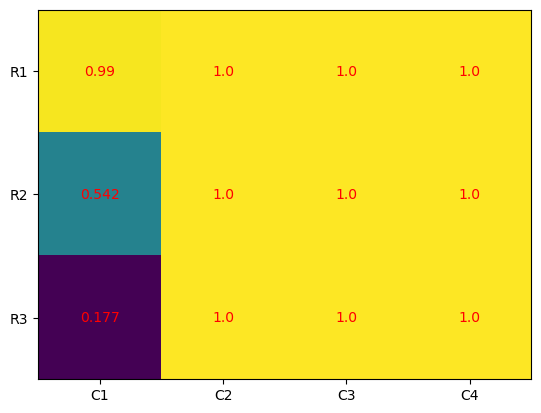

In [271]:
plot_heatmap_from_position_acc(list_acc_windowing_test, export=True, export_name="test_acc_pos_windowing.pdf")